<a href="https://colab.research.google.com/github/Raw-AB/AI_planning_for_robot_systems/blob/main/NLP_autocorrector.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Phase one: CBOW

In [ ]:
import spacy
import io
import re
import pandas as pd
import random
import numpy as np
import timeit
from collections import Counter
#from wordcloud import WordCloud
import seaborn as sns


## Preprocessing 

In [ ]:
def process_data(file_path):
    """
    Input: 
        A file_name which is found in our current Kaggle directory. We just have to read it in. 
    Output: 
        words: a list containing all the words in the corpus in lower case. 
    """
    words = [] 

    with io.open(file_path, 'r', encoding='ISO-8859-1') as f:
        file_read = f.read()
        ddata= file_read
        pre_process_file = re.findall(r"\w+", ddata)
        word_list = pre_process_file
        for word in word_list:
            words.append(word.lower())
    
    return words

In [ ]:
text = process_data('/content/en_US.twitter.txt')

In [ ]:
def remove_numbers(list):
    pattern = '[0-9]'
    new = [re.sub(pattern, '', i) for i in list]
    return new

In [ ]:
words = remove_numbers(text)

In [ ]:
#removing empty values
words = ' '.join(words).split()

In [ ]:
words

['how',
 'are',
 'you',
 'btw',
 'thanks',
 'for',
 'the',
 'rt',
 'you',
 'gonna',
 'be',
 'in',
 'dc',
 'anytime',
 'soon',
 'love',
 'to',
 'see',
 'you',
 'been',
 'way',
 'way',
 'too',
 'long',
 'when',
 'you',
 'meet',
 'someone',
 'special',
 'you',
 'll',
 'know',
 'your',
 'heart',
 'will',
 'beat',
 'more',
 'rapidly',
 'and',
 'you',
 'll',
 'smile',
 'for',
 'no',
 'reason',
 'they',
 've',
 'decided',
 'its',
 'more',
 'fun',
 'if',
 'i',
 'don',
 't',
 'so',
 'tired',
 'd',
 'played',
 'lazer',
 'tag',
 'ran',
 'a',
 'lot',
 'd',
 'ughh',
 'going',
 'to',
 'sleep',
 'like',
 'in',
 'minutes',
 'words',
 'from',
 'a',
 'complete',
 'stranger',
 'made',
 'my',
 'birthday',
 'even',
 'better',
 'first',
 'cubs',
 'game',
 'ever',
 'wrigley',
 'field',
 'is',
 'gorgeous',
 'this',
 'is',
 'perfect',
 'go',
 'cubs',
 'go',
 'i',
 'no',
 'i',
 'get',
 'another',
 'day',
 'off',
 'from',
 'skool',
 'due',
 'to',
 'the',
 'wonderful',
 'snow',
 'and',
 'this',
 'wakes',
 'me',
 

In [ ]:
vocab_size = len(words)
vocab_size

914586

## Word embedding CBOW

In [ ]:
#getting the word to index and index to word
word2Ind = {word: i for i, word in enumerate(words)}
Ind2word = {i: word for i, word in enumerate(words)}

In [ ]:
# sliding window
def get_windows(words, C):
    i = C
    while i < len(words) - C:
        center_word = words[i]
        context_words = words[(i - C):i] + words[(i+1):(i+C+1)]
        yield context_words, center_word
        i += 1

In [ ]:

# vectorizing the words
def word_to_one_hot_vector(word, word2Ind, V):
    one_hot_vector = np.zeros(V)
    one_hot_vector[word2Ind[word]] = 1
    return one_hot_vector


def context_words_to_vector(context_words, word2Ind, V):
    context_words_vectors = [word_to_one_hot_vector(w, word2Ind, V) for w in context_words]
    context_words_vectors = np.mean(context_words_vectors, axis=0)
    return context_words_vectors



In [ ]:
# getting training 
def get_training_example(words, C, word2Ind, V):
    for context_words, center_word in get_windows(words, C):
        yield context_words_to_vector(context_words, word2Ind, V), word_to_one_hot_vector(center_word, word2Ind, V)

In [ ]:
N=3
V= len(words)

In [ ]:
# Save results
training_examples = get_training_example(words, 2, word2Ind, V)


In [ ]:
# Get first values from generator
x_array, y_array = next(training_examples)

In [ ]:
# Copy vector
x = x_array.copy()

# Reshape it
x.shape = (V, 1)

# Copy vector
y = y_array.copy()

# Reshape it
y.shape = (V, 1)



In [ ]:
# W1 has shape (N,V)
W1 = np.random.rand(N, V)
# W2 has shape (V,N)
W2 = np.random.rand(V, N)
# b1 has shape (N,1)
b1 = np.random.rand(N, 1)
# b2 has shape (V,1)
b2 = np.random.rand(V, 1)

In [ ]:
print(f'V (vocabulary size): {V}')
print(f'N (embedding size / size of the hidden layer): {N}')
print(f'size of W1: {W1.shape} (NxV)')
print(f'size of b1: {b1.shape} (Nx1)')
print(f'size of W2: {W2.shape} (VxN)')
print(f'size of b2: {b2.shape} (Vx1)')

V (vocabulary size): 914586
N (embedding size / size of the hidden layer): 3
size of W1: (3, 914586) (NxV)
size of b1: (3, 1) (Nx1)
size of W2: (914586, 3) (VxN)
size of b2: (914586, 1) (Vx1)


In [ ]:
# 'relu' function 
def relu(z):
    result = z.copy()
    result[result < 0] = 0
    return result

In [ ]:
# 'softmax' function
def softmax(z):
    e_z = np.exp(z)
    sum_e_z = np.sum(e_z)
    return e_z / sum_e_z

In [ ]:
def hidden_layer(W1,W2,b1,b2,x,y):

# Compute z1 (values of first hidden layer before applying the ReLU function)
    z1 = np.dot(W1, x) + b1
# Compute h (z1 after applying ReLU function)
    h = relu(z1)
# Compute z2 (values of the output layer before applying the softmax function)
    z2 = np.dot(W2, h) + b2
# Compute y_hat (z2 after applying softmax function)
    y_hat = softmax(z2)
    return y_hat,h

In [ ]:
# 'cross entropy' loss
def cross_entropy_loss(y_predicted, y_actual):
    
    loss = np.sum(-np.log(y_hat)*y)
    
    return loss

In [ ]:
def partial_deriv(y_hat,y,h,W2):
# Compute vector with partial derivatives of loss function with respect to b2
    grad_b2 = y_hat - y
# Compute matrix with partial derivatives of loss function with respect to W2
    grad_W2 = np.dot(y_hat - y, h.T)
# Compute vector with partial derivatives of loss function with respect to b1
    grad_b1 = relu(np.dot(W2.T, y_hat - y))
# Compute matrix with partial derivatives of loss function with respect to W1
    grad_W1 = np.dot(relu(np.dot(W2.T, y_hat - y)), x.T)
    return grad_b2,grad_W2,grad_b1,grad_W1

In [ ]:

def Gradient(W1,W2,b1,b2,grad_b2,grad_W2,grad_b1,grad_W1):
    alpha = 0.03
# Compute updated W1
    W1_new = W1 - alpha * grad_W1
    W2_new = W2 - alpha * grad_W2
# Compute updated b1
    b1_new = b1 - alpha * grad_b1
# Compute updated b2
    b2_new = b2 - alpha * grad_b2
    return W1_new,W2_new,b1_new,b2_new

In [ ]:
for epoch in range(150):
    y_hat,h= hidden_layer(W1,W2,b1,b2,x,y)
    print(cross_entropy_loss(y_hat, y))
    grad_b2,grad_W2,grad_b1,grad_W1= partial_deriv(y_hat,y,h,W2)
    W1,W2,b1,b2=Gradient(W1,W2,b1,b2,grad_b2,grad_W2,grad_b1,grad_W1)

13.718331925197932
13.532455899236004
13.349224405160033
13.16836837059467
12.989631504172275
12.812769054477597
12.637546628953976
12.46373906724829
12.29112936373207
12.119507634175488
11.948670121770972
11.778418237904965
11.608557633261436
11.438897295010689
11.26927845865996
11.09966032791601
10.930043033206442
10.760426729065676
10.590811598589784
10.42119785871423
10.251585766466357
10.081975626372548
9.91236779923294
9.742762712515878
9.573160872670543
9.40356287971104
9.233969444489944
9.064381409155839
8.894799771379812
8.72522571304232
8.555660634197869
8.386106193282803
8.216564354706138
8.047037445168128
7.877528220291913
7.708039943435306
7.538576478879116
7.369142401972328
7.199743129260425
7.030385072139348
6.861075818171869
6.691824344883474
6.5226412716274975
6.353539155978534
6.1845328420789905
6.015639869419405
5.84688095166207
5.678280536287401
5.509867456999744
5.341675691888618
5.173745241175986
5.00612313880443
4.8388646118744125
4.6720344006633345
4.50570824917

## Extracting embeddings

In [ ]:
#W1
# loop through each word of the vocabulary
for word in word2Ind:
    # extract the column corresponding to the index of the word in the vocabulary
    word_embedding_vector = W1[:, word2Ind[word]]
    
    print(f'{word}: {word_embedding_vector}')

how: [0.19577597 0.82386141 0.43587486]
are: [0.71809491 0.13532859 0.46073579]
you: [0.28295431 0.04259878 0.68063907]
btw: [0.08862313 0.81413451 0.07296816]
thanks: [0.71514328 0.98765623 0.34803834]
for: [0.99682827 0.41090461 0.49386782]
the: [0.88775379 0.33382049 0.5334315 ]
rt: [0.96956802 0.89685635 0.12048963]
gonna: [0.7309772  0.87270376 0.24982753]
be: [0.02373024 0.51607317 0.56117163]
in: [0.79124271 0.25701092 0.96346427]
dc: [0.26235854 0.05466967 0.55739129]
anytime: [0.00971444 0.7895624  0.26340956]
soon: [0.73225264 0.38896816 0.30551365]
love: [0.56126189 0.17371226 0.53176632]
to: [0.36112832 0.4055053  0.08614269]
see: [0.83865703 0.36659486 0.20628716]
been: [0.73117987 0.14461828 0.27740279]
way: [0.49587682 0.29763521 0.5889028 ]
too: [0.496007   0.13223191 0.74033586]
long: [0.4291944  0.25287923 0.77450829]
when: [0.09954905 0.62488302 0.184505  ]
meet: [0.55309687 0.17697608 0.7571329 ]
someone: [0.28871402 0.07748777 0.24690987]
special: [0.576268   0.641

In [ ]:
#W2
# loop through each word of the vocabulary
for word in word2Ind:
    # extract the column corresponding to the index of the word in the vocabulary
    word_embedding_vector = W2.T[:, word2Ind[word]]
    
    print(f'{word}: {word_embedding_vector}')

how: [0.45098511 0.63384235 0.60766048]
are: [0.98891298 0.66630319 0.93493902]
you: [2.85628968 5.51751878 3.46742449]
btw: [0.18810223 0.96010343 0.12537249]
thanks: [0.80018358 0.99063477 0.26247371]
for: [0.13453195 0.90743362 0.60419317]
the: [0.74072755 0.83231357 0.64280789]
rt: [0.20312138 0.11019928 0.1285134 ]
gonna: [0.304424   0.33950598 0.55896962]
be: [0.28352602 0.15311086 0.16712964]
in: [0.74111299 0.08815254 0.54404475]
dc: [0.47189713 0.75463121 0.87759831]
anytime: [0.24268197 0.61683918 0.66354302]
soon: [0.37090449 0.50258427 0.75161123]
love: [0.81311811 0.68290531 0.11751005]
to: [0.46986113 0.99589067 0.80865933]
see: [0.36467744 0.90570595 0.00750459]
been: [0.26557517 0.91757547 0.37311419]
way: [0.68284473 0.27775533 0.25448668]
too: [0.22927765 0.65247068 0.64972725]
long: [0.91458951 0.98237211 0.7652621 ]
when: [0.39635594 0.77207362 0.25844341]
meet: [0.55697679 0.17304041 0.92102602]
someone: [0.8480707  0.05224693 0.56140524]
special: [0.71322256 0.520

In [ ]:
W3 = (W1+W2.T)/2
W3

array([[0.8953956 , 0.50552877, 0.59681347, ..., 0.49777508, 0.68634682,
        1.569622  ],
       [0.87476469, 0.30398834, 0.79191479, ..., 0.55043835, 0.76491888,
        2.78005878],
       [0.14516977, 0.14154522, 0.63543907, ..., 0.49737128, 0.60939474,
        2.07403178]])

In [ ]:
#W3
# loop through each word of the vocabulary
for word in word2Ind:
    # extract the column corresponding to the index of the word in the vocabulary
    word_embedding_vector = W3[:, word2Ind[word]]
    
    print(f'{word}: {word_embedding_vector}')

how: [0.32338054 0.72885188 0.52176767]
are: [0.85350394 0.40081589 0.69783741]
you: [1.569622   2.78005878 2.07403178]
btw: [0.13836268 0.88711897 0.09917033]
thanks: [0.75766343 0.9891455  0.30525602]
for: [0.56568011 0.65916912 0.54903049]
the: [0.81424067 0.58306703 0.5881197 ]
rt: [0.5863447  0.50352781 0.12450151]
gonna: [0.5177006  0.60610487 0.40439858]
be: [0.15362813 0.33459201 0.36415064]
in: [0.76617785 0.17258173 0.75375451]
dc: [0.36712783 0.40465044 0.7174948 ]
anytime: [0.1261982  0.70320079 0.46347629]
soon: [0.55157856 0.44577621 0.52856244]
love: [0.68719    0.42830878 0.32463819]
to: [0.41549472 0.70069798 0.44740101]
see: [0.60166723 0.6361504  0.10689587]
been: [0.49837752 0.53109687 0.32525849]
way: [0.58936078 0.28769527 0.42169474]
too: [0.36264232 0.39235129 0.69503155]
long: [0.67189195 0.61762567 0.76988519]
when: [0.24795249 0.69847832 0.22147421]
meet: [0.55503683 0.17500825 0.83907946]
someone: [0.56839236 0.06486735 0.40415756]
special: [0.64474528 0.581

In [ ]:
word2Ind

{'how': 913786,
 'are': 914370,
 'you': 914585,
 'btw': 911376,
 'thanks': 914527,
 'for': 914528,
 'the': 914557,
 'rt': 913948,
 'gonna': 911801,
 'be': 914522,
 'in': 914563,
 'dc': 912475,
 'anytime': 892698,
 'soon': 912298,
 'love': 914485,
 'to': 914580,
 'see': 914334,
 'been': 913986,
 'way': 913566,
 'too': 913695,
 'long': 907985,
 'when': 914381,
 'meet': 913956,
 'someone': 912777,
 'special': 910284,
 'll': 914344,
 'know': 914016,
 'your': 914492,
 'heart': 913499,
 'will': 914129,
 'beat': 914301,
 'more': 914505,
 'rapidly': 300303,
 'and': 914567,
 'smile': 908467,
 'no': 914223,
 'reason': 900772,
 'they': 914146,
 've': 914188,
 'decided': 899211,
 'its': 914357,
 'fun': 912155,
 'if': 914449,
 'i': 914458,
 'don': 913143,
 't': 913963,
 'so': 914201,
 'tired': 913961,
 'd': 913721,
 'played': 898155,
 'lazer': 300325,
 'tag': 908505,
 'ran': 894623,
 'a': 914535,
 'lot': 913811,
 'ughh': 886617,
 'going': 913754,
 'sleep': 913741,
 'like': 914532,
 'minutes': 90741

# Phase two: Autocomplete model using N-grams

## Preprocessing

In [ ]:
import math
import nltk
import random
import pickle
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
import re
import io

file_path =  "en_US.twitterr.txt"

with io.open(file_path, 'r', encoding='ISO-8859-1') as f:
    tdata = f.read()

### Taking a fraction of data 

In [ ]:
ddata= tdata 

In [ ]:
ddata[:1000]

"How are you? Btw thanks for the RT. You gonna be in DC anytime soon? Love to see you. Been way, way too long.\nWhen you meet someone special... you'll know. Your heart will beat more rapidly and you'll smile for no reason.\nthey've decided its more fun if I don't.\nSo Tired D; Played Lazer Tag & Ran A LOT D; Ughh Going To Sleep Like In 5 Minutes ;)\nWords from a complete stranger! Made my birthday even better :)\nFirst Cubs game ever! Wrigley field is gorgeous. This is perfect. Go Cubs Go!\ni no! i get another day off from skool due to the wonderful snow (: and THIS wakes me up...damn thing\nI'm coo... Jus at work hella tired r u ever in cali\nThe new sundrop commercial ...hehe love at first sight\nI wish you rappers would talk about something other than money sometimes... knowing damn well you broke as hell...\n: Thanks, not sure about saving the world.... Maybe we're just plain stubborn, and refuse to give up our love of bookstores.\nHouston, and hell yes!!\nthe ladies love Brooke\n

In [ ]:
#use regex to remove any special character or number expect for . ! ? and new lines
data = re.sub('[^a-zA-Z\n]', ' ', ddata)

In [ ]:
data[:1000]

'How are you  Btw thanks for the RT  You gonna be in DC anytime soon  Love to see you  Been way  way too long \nWhen you meet someone special    you ll know  Your heart will beat more rapidly and you ll smile for no reason \nthey ve decided its more fun if I don t \nSo Tired D  Played Lazer Tag   Ran A LOT D  Ughh Going To Sleep Like In   Minutes   \nWords from a complete stranger  Made my birthday even better   \nFirst Cubs game ever  Wrigley field is gorgeous  This is perfect  Go Cubs Go \ni no  i get another day off from skool due to the wonderful snow    and THIS wakes me up   damn thing\nI m coo    Jus at work hella tired r u ever in cali\nThe new sundrop commercial    hehe love at first sight\nI wish you rappers would talk about something other than money sometimes    knowing damn well you broke as hell   \n  Thanks  not sure about saving the world     Maybe we re just plain stubborn  and refuse to give up our love of bookstores \nHouston  and hell yes  \nthe ladies love Brooke\n

### Data cleaning and Tokenizing sentences

In [ ]:
def preprocess_pipeline(data) -> 'list':

    # Split by newline character
    sentences = data.split('\n')
    
    # Remove leading and trailing spaces
    sentences = [s.strip() for s in sentences]
    
    # Drop Empty Sentences
    sentences = [s for s in sentences if len(s) > 0]
    
    # Empty List to hold Tokenized Sentences
    tokenized = []
    
    # Iterate through sentences
    for sentence in sentences:
        
        # Convert to lowercase
        sentence = sentence.lower()
        
        # Convert to a list of words
        token = nltk.word_tokenize(sentence)
        
        # Append to list
        tokenized.append(token)
        
    return tokenized

In [ ]:
# Pass our data to this function    
tokenized_sentences = preprocess_pipeline(data)

In [ ]:
data[:100]

'How are you  Btw thanks for the RT  You gonna be in DC anytime soon  Love to see you  Been way  way '

In [ ]:
tokenized_sentences[0]

['how',
 'are',
 'you',
 'btw',
 'thanks',
 'for',
 'the',
 'rt',
 'you',
 'gon',
 'na',
 'be',
 'in',
 'dc',
 'anytime',
 'soon',
 'love',
 'to',
 'see',
 'you',
 'been',
 'way',
 'way',
 'too',
 'long']

In [ ]:
len(tokenized_sentences)

70214

### Splitting data

In [ ]:
## Obtain Train and Test Split 
train, test = train_test_split(tokenized_sentences, test_size=0.2, random_state=42)

# (random_state=42) to produce the same results across a different run

### Creating frequencies

In [ ]:
def count_the_words(sentences) -> 'dict':
    
  # Creating a Dictionary of counts
    word_counts = {}

  # Iterating over sentences
    for sentence in sentences:
    # Iterating over Tokens
        for token in sentence:
      # Add count for new word
            if token not in word_counts.keys():
                word_counts[token] = 1
      # Increase count by one
            else:
                word_counts[token] += 1
    return word_counts

In [ ]:
len(tokenized_sentences)

70214

In [ ]:
wordFreq= count_the_words(tokenized_sentences)

In [ ]:
#wordFreq.keys()

In [ ]:
dict(list(wordFreq.items())[:10]) #displaying a random part of the dictionary

{'how': 2248,
 'are': 4900,
 'you': 17762,
 'btw': 75,
 'thanks': 2546,
 'for': 11628,
 'the': 27861,
 'rt': 2696,
 'gon': 631,
 'na': 1008}

### Creating closed vocab with frequencies above certain threshold


In [ ]:
def handling_oov(tokenized_sentences, count_threshold) -> 'list':
  
    closed_vocabulary = []

  #frequency dictionary using previously defined function
    words_count = count_the_words(tokenized_sentences)
    
  # Iterate over words and counts 
    for word, count in words_count.items():
    
    # Append if it's more(or equal) to the threshold 
        if count > count_threshold :
            closed_vocabulary.append(word)

    return closed_vocabulary
#because we have many words, we want to get rid of those rarely seen (with certain threshold)

### Unkown tokenizing using new close vocab

In [ ]:
def unk_tokenize(tokenized_sentences, vocabulary, unknown_token = "<unk>") -> 'list':
  # Convert Vocabulary into a set
    vocabulary = set(vocabulary)
  # Create empty list for sentences
    new_tokenized_sentences = []  
  # Iterate over sentences
    for sentence in tokenized_sentences:
    # Iterate over sentence and add <unk> 
    # if the token is absent from the vocabulary
        new_sentence = []
        for token in sentence:
            if token in vocabulary:
                new_sentence.append(token)
            else:
                new_sentence.append(unknown_token)
    # Append sentece to the new list
        new_tokenized_sentences.append(new_sentence)

    return new_tokenized_sentences

In [ ]:
def cleansing(train_data, test_data, count_threshold):
  # Get closed Vocabulary
    vocabulary = handling_oov(train_data, count_threshold)
    
  # Updated Training Dataset
#     train_data = unk_tokenize(train_data, vocabulary)
    
  # Updated Test Dataset
#     test_data = unk_tokenize(test_data, vocabulary)

    return train_data, test_data, vocabulary


In [ ]:
min_freq = 0 #because evaluatin causes problem in WE
final_train, final_test, vocabulary = cleansing(train, test, min_freq)

## Building n-gram models

In [ ]:
def count_n_grams(data, n, start_token = "<s>") -> 'dict':

  # Empty dict for n-grams
    n_grams = {}
 
  # Iterate over all sentences in the dataset
    for sentence in data:
        
    # Append n start tokens and a single end token to the sentence
    #we added n starting tokens for the case were the sentence size is less than (n)-gram , 
    #therefore we need n words before the word!
        sentence = [start_token]*(n-1) + sentence 
    
    # Convert the sentence into a tuple
        sentence = tuple(sentence)

    # Temporar variable to store length from start of n-gram to end
    #because in case of 1 gram we will have n words but for any other we have n-1 combinations where n is length of sentence
        m = len(sentence) if n==1 else len(sentence)-1
    
    # Iterate over this length
        for i in range(m):
        
            n_gram = sentence[i:i+n]  #takes all possible N-words! 
    
      # Add the count of n-gram as value to our dictionary
      # IF n-gram is already present
            if n_gram in n_grams.keys():
                n_grams[n_gram] += 1
      # Add n-gram count
            else:
                n_grams[n_gram] = 1
        
    return n_grams

#This function calculates the priority for the next word given the prior n-gram
#This functions returns a dictionary with all possible n-words sequen

In [ ]:
# test = count_n_grams(final_train,2)

In [ ]:
# test.keys()

### Smoothing

In [ ]:
#if we come across a n-gram that wasn't in the training set , our denominator would would become zero
#and our definition of probability will become invalid. Thus, we use k-smoothing

def prob_for_single_word(word, previous_n_gram, n_gram_counts, nplus1_gram_counts, vocabulary_size, k = 1.0) -> 'float':

    # Convert the previous_n_gram into a tuple 
    previous_n_gram = tuple(previous_n_gram)
    
    # Calculating the count, if exists from our freq dictionary otherwise zero
    previous_n_gram_count = n_gram_counts[previous_n_gram] if previous_n_gram in n_gram_counts else 0
  
    # The Denominator
    denom = previous_n_gram_count + k * vocabulary_size

    # previous n-gram plus the current word as a tuple
    nplus1_gram = previous_n_gram + (word,)

    # Calculating the nplus1 count, if exists from our freq dictionary otherwise zero 
    nplus1_gram_count = nplus1_gram_counts[nplus1_gram] if nplus1_gram in nplus1_gram_counts else 0

    # Numerator
    num = nplus1_gram_count + k

  # Final Fraction
    prob = num / denom
    return prob

### Calculate the probabilities 

In [ ]:
# loop over all the words in the vocabulary and then compute their probabilites

def probs(previous_n_gram, n_gram_counts, nplus1_gram_counts, vocabulary, k=1.0) -> 'dict':

    # Convert to Tuple
    previous_n_gram = tuple(previous_n_gram)

    vocabulary = vocabulary + ["<s>"]

    # Calculate the size of the vocabulary
    vocabulary_size = len(vocabulary)

    # Empty dict for probabilites
    probabilities = {}

  # Iterate over words 
    for word in vocabulary:
    # Calculate probability
        probability = prob_for_single_word(word, previous_n_gram, n_gram_counts, nplus1_gram_counts, vocabulary_size, k=k)
    # Create mapping: word -> probability
        probabilities[word] = probability

    return probabilities

In [ ]:
# #We simply loop over all the words in the vocabulary assuming that they can be the next word and then return 
# #the word with it's probability.

def auto_complete(previous_tokens, n_gram_counts, nplus1_gram_counts, vocabulary, k=1.0, start_with=None):
 
    # length of previous words
    n = len(list(n_gram_counts.keys())[0]) #getting the N in n-gram
    
    # most recent 'n' words
    previous_n_gram = previous_tokens[-n:] # getting the N words from the end
    #of the sent sentence (previous token) e.g if the user types
    #"I am working very hard to" ,and 2-gram is built
    #in previous command we will take only "hard" and "to" because it is 2-gram
    
    # Calculate probabilty for all words
    probabilities = probs(previous_n_gram,n_gram_counts, nplus1_gram_counts,vocabulary, k=k)

    # Intialize the suggestion and max probability
    suggestion = None
    max_prob = 0

    # Iterate over all words and probabilites, returning the max.
    # We also add a check if the start_with parameter is provided
    for word, prob in probabilities.items():
        
        if start_with != None: 
            
            if not word.startswith(start_with):
                continue 

        if prob > max_prob: 

            suggestion = word
            max_prob = prob

    return suggestion, max_prob

In [ ]:
#We can also loop over all the various n-gram models to get multiple suggestions. 
def get_suggestions(previous_tokens, n_gram_counts_list, vocabulary, k=1.0, start_with=None):

    suggestions = []
    
    n_gram_counts = n_gram_counts_list[0]
    nplus1_gram_counts = n_gram_counts_list[1]
 
    suggestion = auto_complete(previous_tokens, n_gram_counts,
                                    nplus1_gram_counts, vocabulary,
                                    k=k, start_with=start_with)

    suggestions.append(suggestion)
        
    return suggestions

### Constructing bigram model

In [ ]:
bi_gram_list = []
for n in range(2, 4):
    bi_model= count_n_grams(final_train, n)
    bi_gram_list.append(bi_model)

In [ ]:
#small test
# previous_tokens = ["i","love"]
# suggestion =get_suggestions(previous_tokens, three_gram_list, vocabulary, k=1.0)
#type(suggestion[0][0])

### Constructing trigram model

In [ ]:
three_gram_list = []
for n in range(3, 5):
    three_model = count_n_grams(final_train, n)
    three_gram_list.append(three_model)

## Evaluating models

In [ ]:
from tqdm import tqdm
from joblib import Parallel, delayed
#ehtyaty Parallel(n_jobs=4)(delayed(sqrt)(i ** 2) for i in range(len(sent)-1):
# for i in range(len(sent)-1):

In [ ]:
def EvaluateModel_WordEmbedding_F(test_set,n_gram_counts_list):
    #f= 0.00001
    counter=0
    totalcorrect=0
    correctness=[0,0,0]
    for sent in tqdm(test_set):
        frag=[]
        for i in range(len(sent)-1):
            frag=[]
            flag1= False
            flag2= False
            suggestion=[]
            frag= sent[:-1]
            counter=counter+1 
            suggestion = (get_suggestions(frag, n_gram_counts_list, vocabulary, k=1.0))[0][0]
            if len(suggestion)!=0:
                suggestionVector=1
                ActualVector=0
                for word in word2Ind:
                    if word==suggestion:
                        suggestionVector=W3[:, word2Ind[word]] #getting the word embedding of the suggested word
                        flag1= True
                    if word==sent[len(frag)]: # getting the word embedding for the actual word
                        ActualVector=W3[:, word2Ind[word]] ##### 3aiza ashof lw ynf3 a access l klma 3latooool!
                        flag2= True
                    if (flag1 and flag2):
                        break
#                   if (not flag2): #if the predicted word is not in our training set therefore is not in word embedding
#                       DistanceBetween2Words=1
#                       break 
# I commented the previous lines because we trained our CBOW on all of our dataset and not only training data
            print(suggestion,sent[len(frag)])
            print(suggestionVector,"\n", ActualVector)
            DistanceBetween2Words= (np.linalg.norm(ActualVector-suggestionVector)) #worst case scenario is root 3 
            print(DistanceBetween2Words)
            correctness = np.sqrt(3) - DistanceBetween2Words 
            print(correctness)
            totalcorrect= totalcorrect+ correctness
            print(totalcorrect)
    return totalcorrect/np.sqrt(3),counter

In [ ]:
def EvaluateModel_ExactMatch_F(test_set,n_gram_counts_list):
    correctSuggestion=0
    counter=0
    TestsNumFlag=0
    numoftestPerSent=2
    for sent in tqdm(test_set):
        frag=[]
        TestsNumFlag=0
        for i in range(len(sent)-1):
            if TestsNumFlag> numoftestPerSent:
                break
            suggestion=[]
            frag= sent[:-(i+1)]
            counter=counter+1 
            suggestion =(get_suggestions(frag, n_gram_counts_list, vocabulary, k=1.0))[0][0]
            if len(suggestion)!=0:
                if suggestion[0][0]==sent[len(frag)]:
                    correctSuggestion=correctSuggestion+1
                    TestsNumFlag = TestsNumFlag+1
                else : continue 
    return correctSuggestion, counter

In [ ]:
def EvaluateModel_ExactMatch(test_set,n_gram_counts_list):
    correctSuggestion=0
    counter=0
    for sent in tqdm(test_set):
        frag=[]
        suggestion=[]
        frag= sent[:-1]
        counter=counter+1 
        suggestion =(get_suggestions(frag, n_gram_counts_list, vocabulary, k=1.0))[0][0]
        print(suggestion,sent[-1])
        if suggestion==sent[-1]:
            correctSuggestion=correctSuggestion+1
    return correctSuggestion, counter

In [ ]:
def EvaluateModel_WordEmbedding(test_set,n_gram_counts_list):
    #f= 0.00001
    counter=0
    totalcorrect=0
    correctness=[0,0,0]
    for sent in tqdm(test_set):
        frag=[]
        flag1= False
        flag2= False
        suggestion=[]
        frag= sent[:-1]
        counter=counter+1 
        suggestion = (get_suggestions(frag, n_gram_counts_list, vocabulary, k=1.0))[0][0]
        if len(suggestion)!=0:
            suggestionVector=1
            ActualVector=0
            for word in word2Ind:
                if word==suggestion:
                    suggestionVector=W3[:, word2Ind[word]] #getting the word embedding of the suggested word
                    flag1= True
                if word==sent[len(frag)]: # getting the word embedding for the actual word
                    ActualVector=W3[:, word2Ind[word]] ##### 3aiza ashof lw ynf3 a access l klma 3latooool!
                    flag2= True
                if (flag1 and flag2):
                    break
#                 if (not flag2): #if the predicted word is not in our training set therefore is not in word embedding
#                     DistanceBetween2Words=1
#                     break 
# I commented the previous lines because we trained our CBOW on all of our dataset and not only training data
        print(suggestion,sent[len(frag)])
        print(suggestionVector,"\n", ActualVector)
        DistanceBetween2Words= (np.linalg.norm(ActualVector-suggestionVector)) #worst case scenario is root 3 
        print(DistanceBetween2Words)
        correctness = np.sqrt(3) - DistanceBetween2Words 
        print(correctness)
        totalcorrect= totalcorrect+ correctness
        print(totalcorrect)
    return totalcorrect/np.sqrt(3),counter

### Accuracy using exact match

#### Bi-gram EM

In [ ]:
Correct , Total = EvaluateModel_ExactMatch(final_test,bi_gram_list)

  0%|          | 4/14043 [00:00<07:35, 30.85it/s]

as you
called imperative
you sex
you you
and guys
too good


  0%|          | 12/14043 [00:00<07:03, 33.16it/s]

tonight tonight
got for
got embaressed
rodin rodin
thsm thsm
it it
cough cough


  0%|          | 20/14043 [00:00<07:09, 32.65it/s]

easily easily
book book
some some
belgians belgians
my out
in here
got you
stanley stanley


  0%|          | 28/14043 [00:00<07:24, 31.56it/s]

go go
it it
yesterday yesterday
im im
today today
you you
birthday birthday
work really


  0%|          | 36/14043 [00:01<07:12, 32.40it/s]

labs labs
best stains
in out
today today
going going
club translate
rodin rodin
feet lives


  0%|          | 44/14043 [00:01<07:24, 31.46it/s]

small small
fan quarter
hurt cleaned
thanks thanks
got cry
day day
mom mom
tuned tuned


  0%|          | 52/14043 [00:01<07:12, 32.33it/s]

u u
a way
email email
or ready
he day
is is
info d
wrong awesome


  0%|          | 60/14043 [00:01<06:59, 33.32it/s]

financial gym
practice practice
visible visible
life body
center center
be s
me that
shop shop


  0%|          | 68/14043 [00:02<06:57, 33.49it/s]

about sale
get already
posted posted
the again
hearts country
me outside
boys boys
great puzzle


  1%|          | 76/14043 [00:02<06:55, 33.60it/s]

course course
wow wow
u it
toss field
best man
sasquatch ninja
at then
to man


  1%|          | 84/14043 [00:02<06:57, 33.43it/s]

more more
football football
old old
lot rule
d d
europe europe
ranch popeye
not welcome


  1%|          | 92/14043 [00:02<07:00, 33.17it/s]

to today
collections collections
weekend year
right actually
day convo
anne anne
to shit
fight fight


  1%|          | 100/14043 [00:03<06:58, 33.33it/s]

to lol
t t
i lol
policies policies
there fantastic
that lecturing
friends life
morning shower


  1%|          | 108/14043 [00:03<06:53, 33.72it/s]

lol lol
the surgery
got money
show show
recommendation problem
indepenence indepenence
new deliverance
new plan
m understand


  1%|          | 116/14043 [00:03<06:48, 34.06it/s]

closet closet
and gray
thanks thanks
got caramels
you you
love love
kitty you
the bed


  1%|          | 124/14043 [00:03<06:55, 33.47it/s]

it it
check visit
in today
yeti yeti
together together
don hope
you you


  1%|          | 132/14043 [00:04<07:22, 31.43it/s]

s wins
we th
you you
plan plan
love love
up up
that that
tap edness


  1%|          | 140/14043 [00:04<07:24, 31.28it/s]

www site
best remember
tonight tonight
got upon
the school
class class
the leaving


  1%|          | 144/14043 [00:04<07:32, 30.72it/s]

know know
group group
s rich
bday taste
for m
i not


  1%|          | 152/14043 [00:04<07:57, 29.11it/s]

the hard
test test
up up
a happy
let for
got smh


  1%|          | 158/14043 [00:04<07:58, 29.04it/s]

unknown back
far far
got cool
fudgsicles fudgsicles
bigger bigger
at there
day cause


  1%|          | 166/14043 [00:05<07:21, 31.45it/s]

you yeah
team word
you me
do do
you you
it that
i either
love sean


  1%|          | 174/14043 [00:05<07:25, 31.13it/s]

much happy
kings kings
the you
finals history
rage rage
to to
easily easily
game streets


  1%|▏         | 182/14043 [00:05<07:26, 31.01it/s]

lol lol
lol lol
few while
me me
gym gym
on cheapskate
at at
today today


  1%|▏         | 190/14043 [00:05<07:10, 32.18it/s]

today us
dreamland dreamland
my monday
the cahors
ballllllaass ballllllaass
our tunnels
holes holes
while moment


  1%|▏         | 198/14043 [00:06<07:25, 31.08it/s]

follow tweet
you it
be party
teehee teehee
memories memories
attempts innovations
crowd crowd
united united


  1%|▏         | 206/14043 [00:06<07:12, 32.02it/s]

get ask
fantasy tweet
morning morning
a weird
let going
got week
tag tag
empty guilty


  1%|▏         | 210/14043 [00:06<07:22, 31.29it/s]

work work
a bed
branch branch
shirt shirt
not what
a off


  2%|▏         | 218/14043 [00:06<07:14, 31.85it/s]

nigga nigga
rings rings
all not
great weed
that that
all you


  2%|▏         | 226/14043 [00:07<07:09, 32.19it/s]

rofl rofl
a up
have can
work work
songs point
compliment substitute
s sucks
i

  2%|▏         | 230/14043 [00:07<07:18, 31.47it/s]

 man
come come
less event
shit shit
there superwoman
wings sausage
eligibility eligibility


  2%|▏         | 238/14043 [00:07<07:10, 32.10it/s]

that week
gain gain
the me
a work
ever ever
watch watch


  2%|▏         | 246/14043 [00:07<06:57, 33.04it/s]

good good
follow weekend
a already
you you
got critics
got instrumentals
account shirt
year year


  2%|▏         | 254/14043 [00:07<07:25, 30.95it/s]

in staying
in in
few week
ascot ascot
it lol
the watching
the if


  2%|▏         | 262/14043 [00:08<07:10, 32.02it/s]

that that
got chart
not welcome
day normal
pork pork
say follow
m m
fuck crap
level level


  2%|▏         | 266/14043 [00:08<07:19, 31.36it/s]

you soon
a free
trees trees
ya ya
no so
could could


  2%|▏         | 274/14043 [00:08<07:35, 30.22it/s]

the ideal
year year
the most
see you
have monday
life face


  2%|▏         | 282/14043 [00:08<07:22, 31.12it/s]

motto motto
today today
is with
s you
when u
series series
just hard
film film


  2%|▏         | 290/14043 [00:09<07:11, 31.87it/s]

new headache
great treat
just draining
song song
speak speak
team team
got fall
you you


  2%|▏         | 298/14043 [00:09<07:21, 31.14it/s]

got pay
we yass
much much
monicalsrt amigo
i too
the priceless
why why
lol lol


  2%|▏         | 306/14043 [00:09<07:07, 32.10it/s]

like mean
got is
for baby
mom icon
me madonna
me me
others others
via via


  2%|▏         | 310/14043 [00:09<07:21, 31.12it/s]

for me
pm pm
game game
there there
got project
home home
got

  2%|▏         | 318/14043 [00:09<07:21, 31.12it/s]

 orgasms
u all
friends friends
regulators regulators
too good
lol lol


  2%|▏         | 326/14043 [00:10<07:12, 31.68it/s]

morning morning
compliment servant
cocaucus cocaucus
got month
day effort
gets deported
me me


  2%|▏         | 330/14043 [00:10<07:21, 31.06it/s]

far far
did too
smile smile
was was
now now
a today
lightly lightly


  2%|▏         | 338/14043 [00:10<07:19, 31.20it/s]

doing doing
in in
question question
much soothing
mother tweets
year song


  2%|▏         | 346/14043 [00:10<07:08, 31.97it/s]

i over
banks banks
things things
follow invite
a miami
got tonight
why not
choices soon


  3%|▎         | 354/14043 [00:11<07:00, 32.53it/s]

downtown downtown
yo yo
graff graff
everyone everyone
about about
it rain
look giggle
is p


  3%|▎         | 362/14043 [00:11<07:12, 31.60it/s]

jack jack
to please
miami miami
lot lot
deliverance deliverance
to to
feathers somebody
here here


  3%|▎         | 370/14043 [00:11<07:25, 30.72it/s]

buddy buddy
suggestions suggestions
tuesday free
petty petty
ended ended
yum yum
lol lol


  3%|▎         | 378/14043 [00:11<07:05, 32.09it/s]

now now
got buckets
reference reference
again again
disruptions disruptions
true true
you u
movies movies


  3%|▎         | 382/14043 [00:12<07:18, 31.18it/s]

of of
society society
issues issues
interview interview
them them
verisimilitude verisimilitude
favorite book


  3%|▎         | 390/14043 [00:12<07:28, 30.45it/s]

going on
duck duck
with everyone
day sunday
mom life
perfect perfect


  3%|▎         | 398/14043 [00:12<07:16, 31.27it/s]

you you
me me
you warm
south shirtsleeves
got always
is happened
smash smash
cultural music


  3%|▎         | 406/14043 [00:12<07:18, 31.10it/s]

again again
year song
usual dino
arianna arianna
set set
got criticism
and and
got here


  3%|▎         | 414/14043 [00:13<07:05, 32.04it/s]

to camping
got darkness
down down
off off
to fast
up up
fun commercials
seen procrastinated


  3%|▎         | 422/14043 [00:13<07:14, 31.34it/s]

product product
lmbo lmbo
have handle
going birdman
know reply
re got
phone phone
friends nostalgia


  3%|▎         | 430/14043 [00:13<07:00, 32.36it/s]

stfu stfu
follows follows
to peculiar
yet lateparentsprobz
finnegan finnegan
got it
today today
retiring retiring


  3%|▎         | 438/14043 [00:13<07:15, 31.25it/s]

movie movie
episode hobbit
favorite hero
what it
got crew
movie movie
farm farm
it it


  3%|▎         | 446/14043 [00:14<07:04, 32.03it/s]

to away
a one
please please
great god
that video
ok ok
an soap
day way


  3%|▎         | 454/14043 [00:14<07:10, 31.57it/s]

genre genre
mine mine
that that
lockdown lockdown
world world
guess guess
with o
who people


  3%|▎         | 462/14043 [00:14<07:09, 31.62it/s]

now now
be be
was cc
follow movie
dope dope
much much
a scanning
office office


  3%|▎         | 470/14043 [00:14<07:12, 31.42it/s]

you you
i d
before before
that that
in tuned
everyone everyone
t d
patrick patrick


  3%|▎         | 478/14043 [00:15<07:15, 31.13it/s]

goldwater goldwater
not restartting
have again
the theirs
rampage rampage
day day
seconds seconds
about then


  3%|▎         | 486/14043 [00:15<07:07, 31.71it/s]

philippians philippians
campaigns campaigns
ugly example
show congrats
best problem
shoes shoes
botanas botanas
donating donating


  4%|▎         | 494/14043 [00:15<07:09, 31.57it/s]

bottom round
tasking tasking
johnny johnny
good scholar
cc cc
good good
got part
or me


  4%|▎         | 502/14043 [00:15<07:19, 30.80it/s]

i hurtful
is is
then staring
you you
mlovinit mlovinit
now now
it it
tuned tuned


  4%|▎         | 506/14043 [00:15<07:23, 30.53it/s]

got today
the following
is ilyshawty
sale sale
weakness weakness
goldmine laker


  4%|▎         | 514/14043 [00:16<07:15, 31.08it/s]

follow follow
gorbachev gorbachev
stupid marcgasol
going guys
it well
now now


  4%|▎         | 522/14043 [00:16<07:09, 31.51it/s]

nightcast nightcast
weekend weekend
of of
out out
career career
activity activity
lives lives
back back


  4%|▍         | 530/14043 [00:16<07:05, 31.78it/s]

the waiting
week spring
one carry
of line
together together
got from
you again


  4%|▍         | 534/14043 [00:16<07:20, 30.70it/s]

i family
got beer
sunday sunday
the you
it it
now now
sucks sucks


  4%|▍         | 542/14043 [00:17<07:32, 29.81it/s]

all all
with fg
for again
love it
head website
frogger frogger


  4%|▍         | 550/14043 [00:17<07:12, 31.19it/s]

excuse antagonist
a flock
stupid skill
conference conference
details details
the saturday
a bro
florida florida


  4%|▍         | 558/14043 [00:17<07:13, 31.11it/s]

you you
didn yeah
ruined ruined
you this
indeed indeed
time time
week week
saturday saturday


  4%|▍         | 566/14043 [00:17<07:05, 31.64it/s]

coding coding
get capitalize
on too
maybe maybe
so stupid
you ya
goose goose
collaborative collaborative


  4%|▍         | 574/14043 [00:18<06:59, 32.13it/s]

it it
europe omaha
web web
go go
out out
can cc
via via
ass ass


  4%|▍         | 582/14043 [00:18<07:07, 31.46it/s]

day day
not done
more photos
the another
for get
turmoil turmoil
it later
complaining complaining


  4%|▍         | 590/14043 [00:18<06:53, 32.56it/s]

a following
new difference
the sharing
keep i
maps docs
got trap
what questions
game public


  4%|▍         | 598/14043 [00:18<07:05, 31.58it/s]

life pleasure
is though
comfy comfy
lonte lonte
michelle michelle
etc etc
this me
the storytelling


  4%|▍         | 606/14043 [00:19<06:50, 32.72it/s]

please please
you smh
follow insights
no mouse
into old
got outside
xx xx
homie homie


  4%|▍         | 614/14043 [00:19<07:02, 31.77it/s]

stop stop
knows knows
m m
everyone everyone
gone gone
to that
head wall
tired gross


  4%|▍         | 622/14043 [00:19<06:56, 32.21it/s]

i better
got playoffs
weirdo weirdo
have know
great start
you tupac
the touch
s app


  4%|▍         | 630/14043 [00:19<06:47, 32.90it/s]

that that
antica antica
few while
salad salad
follower follower
i is
have xo
luck luck


  5%|▍         | 638/14043 [00:20<07:07, 31.34it/s]

ill ill
was was
be go
good moron
much bored
anymore anymore
one cardigan


  5%|▍         | 642/14043 [00:20<07:34, 29.48it/s]

for left
donuts grits
me mayweather
good good
of sleep


  5%|▍         | 648/14043 [00:20<08:03, 27.73it/s]

lol already
on on
prison prison
today today
til til
austin perfect


  5%|▍         | 655/14043 [00:20<07:51, 28.42it/s]

schools schools
what lame
know go
day weekend
follow rt
day day
favorite lives


  5%|▍         | 663/14043 [00:21<07:28, 29.85it/s]

not ready
crazy crazy
an brother
courage courage
best finals
winwood winwood
people rivalry
i hot


  5%|▍         | 671/14043 [00:21<07:10, 31.03it/s]

list list
the you
a drunk
time sack
to to
party party
york places
a friday


  5%|▍         | 679/14043 [00:21<06:59, 31.88it/s]

me me
center center
got accomplished
shunpike shunpike
six lol
haul way
much much
win win


  5%|▍         | 687/14043 [00:21<06:57, 32.02it/s]

first cup
today today
episode episode
week boy
got want
rex rex
up up
world subject


  5%|▍         | 695/14043 [00:22<07:01, 31.66it/s]

to count
a slacking
i haha
law law
come come
campaigns campaigns
again tacitly


  5%|▌         | 703/14043 [00:22<07:00, 31.70it/s]

s tonight
lin lin
of of
off forever
is am
a talking
at at
you me


  5%|▌         | 707/14043 [00:22<07:03, 31.51it/s]

you ya
is is
nine nine
escargot escargot
bottom event
peace peace
got presentations


  5%|▌         | 715/14043 [00:22<06:57, 31.95it/s]

love love
thing spot
congrats congrats
the lubbock
him him
smh smh


  5%|▌         | 723/14043 [00:22<07:04, 31.36it/s]

albums albums
love love
endeavor endeavor
great journey
flags flags
watch watch
a twitter
way chest


  5%|▌         | 731/14043 [00:23<06:58, 31.79it/s]

you you
trash trash
post meeting
her her
coast semifinals
laugh laugh
the starbs
lodger favorite


  5%|▌         | 739/14043 [00:23<07:04, 31.35it/s]

follow code
what great
at sherri
got awesome
w s
backpack backpack
photos it
est est


  5%|▌         | 747/14043 [00:23<06:59, 31.72it/s]

baby baby
limitations limitations
now shelf
wut wut
me me
already already
opportunities opportunities


  5%|▌         | 755/14043 [00:23<06:44, 32.85it/s]

well well
books after
i plss
anymore anymore
s s
now on
see desperately
video video
week week


  5%|▌         | 763/14043 [00:24<06:46, 32.70it/s]

birthday birthday
husband husband
you him
morning today
t drink
t t
morning world
tomorrow tomorrow


  5%|▌         | 771/14043 [00:24<06:46, 32.65it/s]

lit lit
rolls to
for bam
prowess prowess
not not
got e
the trucks
me me


  6%|▌         | 779/14043 [00:24<06:51, 32.21it/s]

epithet hashtag
game game
tight tight
are up
x time
for yay
name name
are happened


  6%|▌         | 787/14043 [00:24<06:58, 31.64it/s]

not jelly
hobbits details
s s
here here
poway poway
got ily
day day


  6%|▌         | 795/14043 [00:25<07:02, 31.32it/s]

now now
a sad
my livingston
you you
you ya
seen seen
been been
got megan


  6%|▌         | 799/14043 [00:25<07:07, 30.95it/s]

today today
embarrassed stupid
p p
fire love
the today
got lincoln


  6%|▌         | 807/14043 [00:25<07:00, 31.45it/s]

lmfao lmfao
save p
good good
so better
worse cooler
got summer
ugh ugh


  6%|▌         | 815/14043 [00:25<06:56, 31.78it/s]

me me
you you
shit shit
know we
are happened
to sucks
week year
it it


  6%|▌         | 823/14043 [00:26<06:50, 32.21it/s]

k k
i good
that click
got it
got now
day idea
you you
football football


  6%|▌         | 831/14043 [00:26<06:50, 32.20it/s]

me me
it it
it really
bite bacht
got break
they they
too by


  6%|▌         | 835/14043 [00:26<06:59, 31.49it/s]

and today
i it
i hurtful
have x
car car
business addition
com com
started

  6%|▌         | 843/14043 [00:26<07:04, 31.08it/s]

 excited
great great
woman woman
england york
guys guys
camp camp


  6%|▌         | 851/14043 [00:26<06:47, 32.41it/s]

game point
up up
others others
agaba agaba
for for
family ass
added and
friends friends
s

  6%|▌         | 859/14043 [00:27<06:40, 32.94it/s]

 helps
chance cassingle
now now
audio audio
a interested
year time
got tumblr
re win


  6%|▌         | 867/14043 [00:27<06:37, 33.17it/s]

got here
going going
americans americans
wait wait
say change
everyone twitters
everyone people
life life


  6%|▌         | 875/14043 [00:27<06:38, 33.02it/s]

back ahead
friends opinion
timing timing
morrow morrow
in visit
got my
a chipotle


  6%|▋         | 883/14043 [00:27<06:44, 32.57it/s]

the twitter
or humilating
whitney menciones
friends friends
zoomzoom faith
day mike
yeah really
it permanent


  6%|▋         | 887/14043 [00:28<06:50, 32.03it/s]

morning rd
the fgcu
of field
sad sad
bradford bradford
it it
got up


  6%|▋         | 895/14043 [00:28<06:50, 32.04it/s]

a one
watch wawantsbieber
weather sea
tomorrow tomorrow
morning mail
steps steps


  6%|▋         | 903/14043 [00:28<06:48, 32.16it/s]

can can
maybe informed
rate rate
going amazing
be die
a that
anatomy anatomy


  6%|▋         | 911/14043 [00:28<06:45, 32.36it/s]

day day
twice twice
it it
job teacher
have share
busy busy
mkg d
follow follow
train train


  7%|▋         | 919/14043 [00:29<06:49, 32.06it/s]

soon soon
night night
follow follow
to to
and bruh
mix mix
sunday sunday
easter easter


  7%|▋         | 927/14043 [00:29<06:48, 32.07it/s]

mane mane
to anyways
book book
be say
john john
girl boy
at there
what crazy


  7%|▋         | 935/14043 [00:29<06:59, 31.28it/s]

series series
blown blown
rm rm
are talking
you me
flickr flickr
com com
oxygen oxygen


  7%|▋         | 943/14043 [00:29<06:51, 31.81it/s]

and win
that that
h h
songs jokes
daily daily
favorite follower
it it
july july


  7%|▋         | 951/14043 [00:30<06:36, 33.04it/s]

mamet mamet
ever ever
to heat
you you
a great
draft game
a awesome
the racine


  7%|▋         | 959/14043 [00:30<06:40, 32.68it/s]

part part
filled filled
building building
night night
of telling
autumn autumn
it it
and later


  7%|▋         | 967/14043 [00:30<06:43, 32.37it/s]

help help
really really
point difference
work house
brother brother
public public
insecure insecure
else else


  7%|▋         | 975/14043 [00:30<06:38, 32.80it/s]

have am
weather weather
be attend
fans fans
though though
day feeling
a hard
me me


  7%|▋         | 983/14043 [00:30<06:31, 33.37it/s]

good awesome
everything it
point point
got covey
lady break
got am
so today
core finest
street board


  7%|▋         | 991/14043 [00:31<06:31, 33.31it/s]

morning morning
food food
in in
not back
grateful grateful
bueno bueno
deal deal


  7%|▋         | 999/14043 [00:31<06:29, 33.47it/s]

skyscraper skyscraper
org org
re doing
woo woo
thing story
t in
lately lately
house house
end door


  7%|▋         | 1007/14043 [00:31<06:24, 33.88it/s]

morning senate
the time
one lol
got children
love think
right right
got garbage
thanks thanks


  7%|▋         | 1015/14043 [00:31<06:22, 34.03it/s]

rouse texas
rt rt
o o
it this
wish wish
goethe goethe
bags bags
weekend going


  7%|▋         | 1023/14043 [00:32<06:20, 34.24it/s]

going screwed
got more
for lost
it more
got comedy
interested interested
era era


  7%|▋         | 1031/14043 [00:32<06:27, 33.60it/s]

everything everything
mom christine
already of
wilson wilson
yo yo
it wrong
my awhile
york partners


  7%|▋         | 1039/14043 [00:32<06:33, 33.01it/s]

thought am
cool cool
s is
over on
boundaries boundaries
there there
days days
ass females


  7%|▋         | 1047/14043 [00:32<06:31, 33.22it/s]

xoxo xoxo
to to
soon soon
music problems
got picture
have like
to guys
up up


  8%|▊         | 1055/14043 [00:33<06:44, 32.07it/s]

wants wants
better better
and bud
game curb
list list
fl fl
ammo ammo
achieved possible


  8%|▊         | 1063/14043 [00:33<06:31, 33.19it/s]

that thatt
thoughts thoughts
awesome awesome
thought love
year year
byyeee byyeee
website website
here here
comments comments


  8%|▊         | 1071/14043 [00:33<06:37, 32.65it/s]

everyone everyone
friday home
hardcore hardcore
got it
for haha
win win
great great


  8%|▊         | 1079/14043 [00:33<06:53, 31.33it/s]

shidd shidd
says says
beef beef
pto pto
and party
th flyers
night night
me me


  8%|▊         | 1087/14043 [00:34<06:39, 32.46it/s]

a gay
know go
better better
th th
thing thing
head city
son son
at there


  8%|▊         | 1095/14043 [00:34<06:49, 31.59it/s]

big dreams
on gang
hmph hmph
too too
today today
volume volume
could could
technology technology


  8%|▊         | 1103/14043 [00:34<06:51, 31.42it/s]

bad bad
little bellmen
post earth
i times
number number
cats cats
you you
night night


  8%|▊         | 1111/14043 [00:34<06:44, 31.98it/s]

name name
ya flees
got now
night night
event event
got for
on on


  8%|▊         | 1119/14043 [00:35<06:34, 32.80it/s]

drill deal
got aweawesomeosas
hopefully adventure
got program
know know
around richard
you you
dream dream
better more


  8%|▊         | 1127/14043 [00:35<06:29, 33.19it/s]

ecommerce ecommerce
thing world
it it
wait decide
end helm
got you
life headphones
go march
time lead


  8%|▊         | 1135/14043 [00:35<06:29, 33.17it/s]

for pam
seconds this
got it
things feelings
pictures pictures
follow night
advertisers advertisers


  8%|▊         | 1143/14043 [00:35<06:28, 33.21it/s]

game team
series series
in then
lol lol
be believe
soon soon
the pointless
got via


  8%|▊         | 1151/14043 [00:36<06:46, 31.72it/s]

yes yes
group group
already shit
the you
much far
faster faster
took took


  8%|▊         | 1155/14043 [00:36<07:06, 30.24it/s]

tonight tonight
everything duty
cr cr
all you
party party
a it
lodger job


  8%|▊         | 1163/14043 [00:36<07:08, 30.03it/s]

fudgsicles fudgsicles
energy energy
you you
my work
content stressed
beecher beecher


  8%|▊         | 1171/14043 [00:36<07:05, 30.28it/s]

day night
work work
in drinks
me me
her her
lin lin
got words


  8%|▊         | 1179/14043 [00:37<06:57, 30.78it/s]

you you
daddy daddy
beat thing
ascot ascot
the the
thurs thurs
got done
power power
them peyton


  8%|▊         | 1187/14043 [00:37<07:06, 30.14it/s]

too all
it it
job job
and today
future future
and d
campaign campaign


  8%|▊         | 1191/14043 [00:37<07:05, 30.22it/s]

but lol
univillage univillage
people people
close heartbroken
by by
fukudome fukudome
insurance a


  9%|▊         | 1199/14043 [00:37<07:06, 30.12it/s]

better taurean
s s
favorite reservations
i week
ugh ugh
summer summer


  9%|▊         | 1207/14043 [00:37<06:56, 30.82it/s]

ones ones
you you
gay long
got know
i but
got trust
that that
future future


  9%|▊         | 1215/14043 [00:38<06:51, 31.20it/s]

great statement
prob laughing
bday buddy
a okc
year year
jesus jesus
heated heated


  9%|▊         | 1219/14043 [00:38<07:08, 29.91it/s]

again again
less that
be know
it it
baby baby
on on
great conversation


  9%|▊         | 1227/14043 [00:38<06:59, 30.52it/s]

get say
i off
believe believe
got ran
faster faster
future the


  9%|▉         | 1231/14043 [00:38<07:28, 28.59it/s]

org org
star star
the th
said said
perfect perfect


  9%|▉         | 1238/14043 [00:39<07:31, 28.38it/s]

really really
me me
new headache
true true
ps ps


  9%|▉         | 1244/14043 [00:39<08:20, 25.55it/s]

a work
or or
success success
a amazing
got in
tour tour
sauce sauce


  9%|▉         | 1251/14043 [00:39<07:41, 27.74it/s]

got do
are at
much ghetto
tickets tickets
out today
over beautiful
got fucks
love

  9%|▉         | 1259/14043 [00:39<07:03, 30.16it/s]

 love
day two
at wtf
papers papers
blend blend
amount amount
first past
scene scene


  9%|▉         | 1267/14043 [00:40<07:13, 29.46it/s]

means means
front front
day day
need luck
goldmine laker
piers piers
thing person


  9%|▉         | 1271/14043 [00:40<07:05, 30.01it/s]

rain smoker
day weekend
king king
smh smh
to em
got statute
round round


  9%|▉         | 1279/14043 [00:40<06:48, 31.25it/s]

guy guy
lot rule
much great
kellie kellie
got button
way style
to

  9%|▉         | 1287/14043 [00:40<06:48, 31.23it/s]

 it
not white
me you
lol lol
best score
the others
me me
is please


  9%|▉         | 1295/14043 [00:40<06:51, 30.97it/s]

lady lady
gtr gtr
have do
when ambition
me me
knows knows
different leprechaun


  9%|▉         | 1299/14043 [00:41<06:51, 31.01it/s]

tweets power
annual ward
down down
madness madness
days days
twitter twitter
those

  9%|▉         | 1307/14043 [00:41<06:47, 31.25it/s]

 you
there there
omg omg
of misunderstood
day day
we unknown
pastryjokes pastryjokes


  9%|▉         | 1311/14043 [00:41<06:42, 31.64it/s]

dont dont
got haha
o o
lmaooo lmaooo
contest contest
you uu
forever

  9%|▉         | 1318/14043 [00:41<07:39, 27.67it/s]

 long
soon soon
colore colore
keep also
gone serious
be mention


  9%|▉         | 1325/14043 [00:41<07:20, 28.87it/s]

boi boi
space space
was ca
lol lol
expats expats
food food


  9%|▉         | 1331/14043 [00:42<07:27, 28.38it/s]

me me
life tuxedo
water water
lifetime lifetime
for for
and and
salad salad


 10%|▉         | 1339/14043 [00:42<06:58, 30.39it/s]

t button
much nice
disfunction disfunction
factory factory
it it
hart hart
in in


 10%|▉         | 1347/14043 [00:42<06:41, 31.59it/s]

got tweets
but weekend
pretty pretty
leighton leighton
love do
paul paul
every dat
us us


 10%|▉         | 1355/14043 [00:42<06:33, 32.22it/s]

my her
game expressway
in in
that that
to nationally
a again
even married
now now


 10%|▉         | 1363/14043 [00:43<06:29, 32.51it/s]

them them
got luck
dinner weather
suite suite
exquisitely exquisitely
com com
older older
lmao lmao


 10%|▉         | 1371/14043 [00:43<06:21, 33.25it/s]

best problem
i party
got me
got jdg
work work
have thanks
day week
lh kfxgkgzv


 10%|▉         | 1379/14043 [00:43<06:26, 32.79it/s]

bot feed
is out
first boo
it it
level meaning
wait sorry
lie lie
got meet


 10%|▉         | 1383/14043 [00:43<06:32, 32.26it/s]

beef beef
got grr
make make
existence existence
model model
my other


 10%|▉         | 1391/14043 [00:44<06:30, 32.38it/s]

soon soon
what what
videoconferencing civility
bob tonight
maybe nowww
source source


 10%|▉         | 1399/14043 [00:44<06:26, 32.74it/s]

follow realize
love lindsey
ugh ugh
work work
got support
you you
possible possible
much much


 10%|█         | 1407/14043 [00:44<06:25, 32.76it/s]

day weekend
it you
bach bach
leggings leggings
rolls to
season season
that that
you euthanasia


 10%|█         | 1415/14043 [00:44<06:21, 33.06it/s]

streamers streamers
accordingly accordingly
have it
arianna arianna
week week
louis louis
trouble games
everybody everybody
got it


 10%|█         | 1423/14043 [00:44<06:09, 34.15it/s]

back back
and bored
maybe remix
and now
i good
lanes lanes
lanes lanes
family family


 10%|█         | 1431/14043 [00:45<06:04, 34.57it/s]

it it
dec dec
the ketchup
lol lol
follow show
follow tip
one show
me me


 10%|█         | 1439/14043 [00:45<06:00, 34.92it/s]

lol lol
time fun
to go
robots robots
being too
beautiful girls
i fam


 10%|█         | 1447/14043 [00:45<05:59, 35.07it/s]

for for
up up
thing ivan
everyone everyone
easter easter
soon soon
got tv
on word
week week


 10%|█         | 1455/14043 [00:45<06:02, 34.72it/s]

shopping shopping
sigh sigh
ranked center
her her
hahahahaha hahahahaha
pancakes pancakes
hopdoddy hopdoddy
weeks god


 10%|█         | 1463/14043 [00:46<05:59, 34.95it/s]

well well
inevitable inevitable
stash stash
something something
the ms
potter potter
me me
birthday birthday


 10%|█         | 1471/14043 [00:46<05:58, 35.04it/s]

a arrested
stay holding
free things
be ask
computer computer
mtv channel
the atlanta
too too


 11%|█         | 1479/14043 [00:46<06:04, 34.51it/s]

no no
the june
v v
women bullshit
england england
time raining
know ask
mdff mdff


 11%|█         | 1487/14043 [00:46<05:57, 35.07it/s]

it it
called imperative
morning car
good it
them you
got gt
oems oems
lol lol


 11%|█         | 1495/14043 [00:47<05:56, 35.23it/s]

lot headache
got menu
the july
follow single
now now
campus campus
follow bus
xoxo xoxo


 11%|█         | 1503/14043 [00:47<05:58, 34.96it/s]

day day
etc etc
thing game
prices prizes
weekend weekend
whoa whoa
contract contract
great republican


 11%|█         | 1511/14043 [00:47<05:57, 35.04it/s]

win record
you you
are should
fuck fuck
the sharing
show kid
wait wait
marathon lol


 11%|█         | 1519/14043 [00:47<05:56, 35.12it/s]

got beer
money money
ill ill
living coming
bank wednesday
what deep
big big
re want


 11%|█         | 1527/14043 [00:47<05:58, 34.95it/s]

roll board
week week
dick dick
like please
haha haha
follow rt
s daisylove
a better


 11%|█         | 1535/14043 [00:48<06:00, 34.65it/s]

people photo
great ball
work work
just there
work work
just speechless
day convo


 11%|█         | 1543/14043 [00:48<05:57, 34.96it/s]

productive galaxy
got can
you relaxation
names names
cowboys lakers
aassssssseemmmmbllllleeeee aassssssseemmmmbllllleeeee
elpaso elpaso
pits pits
tuning tuning


 11%|█         | 1551/14043 [00:48<05:59, 34.72it/s]

the ky
follow support
summer summer
martin martin
hair hair
today today
direction direction
come sleep


 11%|█         | 1559/14043 [00:48<05:58, 34.86it/s]

follow porklove
thanks compliment
song actors
me me
with right
programs programs
lol bro
star star


 11%|█         | 1567/14043 [00:49<05:59, 34.73it/s]

interview interview
lacroix lacroix
lol lol
childrn childrn
follow partys
s erving
re buying
one one


 11%|█         | 1575/14043 [00:49<05:59, 34.71it/s]

it guys
people bless
cadavers cadavers
to to
brag do
all all
world world
great star


 11%|█▏        | 1583/14043 [00:49<05:57, 34.85it/s]

pm pm
ha right
covers clocks
enough enough
haul way
much ghetto
able contained
life world


 11%|█▏        | 1591/14043 [00:49<05:57, 34.81it/s]

mel egg
me me
are are
i forever
a evil
day day
who who
the yesterday


 11%|█▏        | 1599/14043 [00:50<05:58, 34.75it/s]

at at
i stoldt
largo largo
enough enough
ustreams ustreams
for with
love love
a one


 11%|█▏        | 1607/14043 [00:50<05:47, 35.79it/s]

it here
for von
song record
lord lord
got hair
got trust
block block
lol lol


 12%|█▏        | 1615/14043 [00:50<05:52, 35.28it/s]

a alcohol
lol lol
tablet tablet
a stage
week week
cold cold
release release
true true

 12%|█▏        | 1623/14043 [00:50<05:49, 35.56it/s]


got season
story stories
lunch lunch
clay clay
out too
post often
rest obvious
again again


 12%|█▏        | 1631/14043 [00:50<05:58, 34.58it/s]

ball ball
have feel
lmbo lmbo
better better
rt rt
posture posture
i i
thanks thanks


 12%|█▏        | 1639/14043 [00:51<05:57, 34.70it/s]

today today
me mayweather
i lol
s bud
represent lin
far far
got ajoohoo
few shootout


 12%|█▏        | 1647/14043 [00:51<05:53, 35.07it/s]

need good
poor problem
much great
be go
twitter foe
squad squad
be boring
b b


 12%|█▏        | 1655/14043 [00:51<05:54, 34.91it/s]

the meditation
and please
cc cc
grind grind
demon trainer
pitches pitches
in in
game bone


 12%|█▏        | 1663/14043 [00:51<05:54, 34.96it/s]

with there
are are
for for
ball ball
rite rite
out out
nuts nuts
snappin mailings


 12%|█▏        | 1671/14043 [00:52<05:49, 35.40it/s]

more great
a friends
breakdown breakdown
just derailed
what them
got peace
i enjoy
been done


 12%|█▏        | 1679/14043 [00:52<06:06, 33.78it/s]

morning meanwhile
follow follow
silly huh
is weekend
reference reference
you it
deep deep


 12%|█▏        | 1687/14043 [00:52<06:16, 32.85it/s]

grille grille
food food
song song
tuesday year
and x
got dad
a started
home home


 12%|█▏        | 1695/14043 [00:52<06:15, 32.89it/s]

game game
coaching coaching
had googled
enough enough
it it
own meet
food food
til til
back there


 12%|█▏        | 1703/14043 [00:53<06:02, 34.01it/s]

same same
stay stay
ass hoe
follow support
hurt hard
you you
pity pity
with movie


 12%|█▏        | 1711/14043 [00:53<05:56, 34.62it/s]

indiana mindanao
tonight tonight
got situation
the learning
back pleez
day weekend
low bassist
follow rts


 12%|█▏        | 1719/14043 [00:53<05:54, 34.79it/s]

v v
status status
win win
follow week
trouble games
do me
me me
a yourself


 12%|█▏        | 1727/14043 [00:53<05:54, 34.77it/s]

important important
plz plz
to financing
house grammys
a easy
a sad
x march
tips tips


 12%|█▏        | 1735/14043 [00:53<05:53, 34.79it/s]

the hurtin
sure sure
dca dca
family family
of times
awesomesauce awesomesauce
got today
you ya


 12%|█▏        | 1743/14043 [00:54<05:52, 34.88it/s]

a good
follow rt
dinner dinner
lol lol
people people
you it
get happen
up up


 12%|█▏        | 1751/14043 [00:54<05:47, 35.38it/s]

tomorrow tomorrow
em popsicles
americans americans
got man
designer designer
said said
cheers now
inside inside


 13%|█▎        | 1759/14043 [00:54<05:50, 35.08it/s]

love turkeys
and on
for at
to them
keep mesmorizing
the waiting
you now
would heartbreaking


 13%|█▎        | 1767/14043 [00:54<05:48, 35.26it/s]

situation pic
aspects aspects
got again
edu edu
you you
tweet smile
order order
biz ass


 13%|█▎        | 1775/14043 [00:55<05:46, 35.39it/s]

wow wow
s too
buddy jose
lately lately
violence violence
night night
that that
on going


 13%|█▎        | 1783/14043 [00:55<05:45, 35.45it/s]

bro guys
things feelings
to bro
i off
game game
day couch
me me
got zoey


 13%|█▎        | 1791/14043 [00:55<05:46, 35.33it/s]

got pick
hungry hungry
lady lady
fy fy
goes goes
phone mandy
blocked blocked
a friends


 13%|█▎        | 1799/14043 [00:55<05:46, 35.29it/s]

life life
early early
campaign campaign
ever friends
s is
let lasting
team her
this this


 13%|█▎        | 1807/14043 [00:56<05:49, 35.05it/s]

do expect
deal deal
seriously seriously
rider rider
s beastmode
coupons coupons
boy pie
love want


 13%|█▎        | 1815/14043 [00:56<05:41, 35.77it/s]

route route
got number
out out
got cc
you you
in cor
city right
with with


 13%|█▎        | 1823/14043 [00:56<05:40, 35.89it/s]

want need
to to
luck luck
whole th
knows knows
share share
help help
re go


 13%|█▎        | 1831/14043 [00:56<05:42, 35.67it/s]

life life
got away
going here
well well
s arrives
junk junk
planning planning
out out


 13%|█▎        | 1839/14043 [00:56<05:44, 35.38it/s]

sons sons
realize realize
me me
me me
the u
a xmas
my michael
the team


 13%|█▎        | 1847/14043 [00:57<05:42, 35.61it/s]

more more
logistically logistically
birthday birthday
good good
got grr
due due
got app
pass pass


 13%|█▎        | 1855/14043 [00:57<05:43, 35.49it/s]

got cat
s hahaha
night queen
you yoou
year year
teehee teehee
got far
shoe banana


 13%|█▎        | 1863/14043 [00:57<05:43, 35.44it/s]

help help
do lose
until until
it her
what that
around around
day day
got years


 13%|█▎        | 1871/14043 [00:57<05:42, 35.49it/s]

just serious
got happen
going wimps
century round
morning making
good good
b b
got rate


 13%|█▎        | 1879/14043 [00:58<05:43, 35.40it/s]

grace ears
d d
killer killer
a cleveland
eyes eyes
is britpop
apps apps
on represented


 13%|█▎        | 1887/14043 [00:58<05:43, 35.36it/s]

unknown unknown
to great
old old
error ant
a awesome
headache headache
off off
to to


 13%|█▎        | 1895/14043 [00:58<05:44, 35.21it/s]

movie mohamed
m know
jrib jrib
business music
shows shows
weather weather
eva eva
yay yay


 14%|█▎        | 1903/14043 [00:58<05:40, 35.62it/s]

got him
know know
got ftw
got david
th circus
white white
taker taker
god

 14%|█▎        | 1911/14043 [00:58<05:40, 35.66it/s]

 god
yesterday yesterday
of of
saying you
record song
bags bags
the them
lol lol
up moving


 14%|█▎        | 1919/14043 [00:59<05:42, 35.38it/s]

score score
brother libertini
tweet tweet
ever ever
loading loading
favorite email
hard hard
got yr


 14%|█▎        | 1927/14043 [00:59<05:39, 35.70it/s]

adams carolina
you you
favorite followers
em em
also james
the purpose
returns returns
acct acct


 14%|█▍        | 1935/14043 [00:59<05:43, 35.23it/s]

come come
year year
congrats congrats
ends ends
lol lol
majority majority
a that
sssssssuuuuuuuuuuuuuuuucccckkkkkkkssssss sssssssuuuuuuuuuuuuuuuucccckkkkkkkssssss


 14%|█▍        | 1943/14043 [00:59<05:43, 35.23it/s]

other smoothie
going phone
paid paid
a a
issues issues
lol lol
it them
way seat


 14%|█▍        | 1951/14043 [01:00<05:41, 35.46it/s]

cover cover
i tony
chronicle chronicle
got today
me me
team team
good progress
everything everything


 14%|█▍        | 1959/14043 [01:00<05:44, 35.12it/s]

you me
with austin
ya ya
cute cute
entertaining entertaining
you you
regulation regulation
got audience


 14%|█▍        | 1967/14043 [01:00<05:43, 35.14it/s]

style work
ios ios
soon soon
new hug
day conference
keep also
ugh ugh
trophy trophy


 14%|█▍        | 1975/14043 [01:00<05:42, 35.22it/s]

have everyone
bit better
got yours
farivar farivar
for bam
to makes
with soon
ones ones


 14%|█▍        | 1983/14043 [01:00<05:43, 35.15it/s]

seriously seriously
to else
faq faq
morning office
grizzlies grizzlies
fan surprise
selfies selfies
run run


 14%|█▍        | 1991/14043 [01:01<05:41, 35.28it/s]

it it
summer summer
family tribe
into crazy
watch watch
orientation orientation
transmission transmission
sabitini sabitini


 14%|█▍        | 1999/14043 [01:01<05:43, 35.07it/s]

m think
court court
like good
great reward
in creatures
tex co
tonight tonight
to ah


 14%|█▍        | 2007/14043 [01:01<05:43, 35.01it/s]

cover cover
others others
today example
song song
thoughts thoughts
yet yet
lml lml
best best


 14%|█▍        | 2015/14043 [01:01<05:39, 35.44it/s]

by by
indesign indesign
line line
leighton leighton
got electric
business time
this it
follow rt


 14%|█▍        | 2023/14043 [01:02<05:40, 35.35it/s]

don baby
not inlove
soon soon
was woww
lol lol
it it
the tally
it it


 14%|█▍        | 2031/14043 [01:02<05:38, 35.51it/s]

copyright copyright
day idea
got now
is lol
asap asap
feet lives
him him
happened tickets


 15%|█▍        | 2039/14043 [01:02<05:37, 35.57it/s]

case state
bbys bbys
hilson hilson
contracts contracts
it netflix
to to
the twitter
got there


 15%|█▍        | 2047/14043 [01:02<05:36, 35.68it/s]

got you
it it
tblamehim tblamehim
know down
tweeter hold
got quack
o o
a alone


 15%|█▍        | 2055/14043 [01:02<05:37, 35.55it/s]

but together
not the
wow wow
called called
feels jfc
everyone everyone
crying crying
if stuff


 15%|█▍        | 2063/14043 [01:03<05:37, 35.48it/s]

today today
facility facility
going that
j j
ass ass
focus focus
topics topics
be too


 15%|█▍        | 2071/14043 [01:03<05:40, 35.21it/s]

your shit
yeah turtles
yup yup
performance movie
l l
the order
got peterson
feel dizzy


 15%|█▍        | 2079/14043 [01:03<05:35, 35.65it/s]

on on
flags josh
done done
friday home
the forever
groupon position
can can
my sued


 15%|█▍        | 2087/14043 [01:03<05:39, 35.20it/s]

to lakers
smell feedback
the yours
the karaoke
gates gates
h h
m remember
go finish


 15%|█▍        | 2095/14043 [01:04<05:36, 35.46it/s]

corey corey
new chain
parents question
what real
going following
the fun
twitter twitter
day set


 15%|█▍        | 2103/14043 [01:04<05:39, 35.15it/s]

ahhhhmazing ahhhhmazing
for town
so goodnight
clinching model
happen pass
halloween halloween
wow wow
south shirtsleeves


 15%|█▌        | 2111/14043 [01:04<05:42, 34.79it/s]

past minut
dinner details
you jesus
ill ill
able contained
d d
got gabriel
the it


 15%|█▌        | 2119/14043 [01:04<05:38, 35.18it/s]

s support
house house
morning playoffs
got agreed
fan quarter
means supports
you twitter
are symposium


 15%|█▌        | 2127/14043 [01:05<05:41, 34.93it/s]

night night
morning land
he in
morning rain
of of
together together
the twittersphere
asap flick


 15%|█▌        | 2135/14043 [01:05<05:38, 35.13it/s]

time grams
flick flick
got badd
consideration consideration
day day
kitchen kitchen
got possibility
post post


 15%|█▌        | 2143/14043 [01:05<05:38, 35.19it/s]

self self
you you
relationships relationships
giveaway giveaway
stores stores
you you
longer longer
right plan


 15%|█▌        | 2151/14043 [01:05<05:41, 34.81it/s]

man ew
later later
too too
state state
your that
not not
back please
soul nick


 15%|█▌        | 2159/14043 [01:05<05:35, 35.45it/s]

too idiot
followers time
d d
got do
end bar
there there
visit visit
july july


 15%|█▌        | 2167/14043 [01:06<05:34, 35.52it/s]

a there
time time
bell bell
thing thing
got me
straight lol
rock rock
with today


 15%|█▌        | 2175/14043 [01:06<05:40, 34.83it/s]

there flaw
paper paper
wait wait
sync sync
can did
going feeling
too too


 16%|█▌        | 2183/14043 [01:06<05:42, 34.63it/s]

to birthday
day closet
be stop
are saturday
fan message
a clues
wadodem god
minor dose
friend nickname


 16%|█▌        | 2191/14043 [01:06<05:42, 34.58it/s]

in at
syndrome syndrome
thing shit
mvp mvp
the the
filming filming
got tomlinson
bear bear


 16%|█▌        | 2199/14043 [01:07<05:36, 35.20it/s]

day at
worthy worthy
agree agree
a working
cubs cubs
got points
got dozen
me me


 16%|█▌        | 2207/14043 [01:07<05:34, 35.39it/s]

lot lot
was yo
i now
got right
on on
the you
and today
defn defn


 16%|█▌        | 2215/14043 [01:07<05:35, 35.30it/s]

in all
got tonight
got man
up up
if huh
kstate kstate
in driver
celebrate celebrate


 16%|█▌        | 2223/14043 [01:07<05:34, 35.31it/s]

it it
got hit
out out
not dreaming
chance chance
i again
got bullock
facebook facebook


 16%|█▌        | 2231/14043 [01:07<05:35, 35.24it/s]

proud proud
us us
nmap nmap
cheers cheers
holes holes
prep prep
people mmfilm
follow follow


 16%|█▌        | 2239/14043 [01:08<05:50, 33.67it/s]

you though
round round
the photography
or yours
toothpaste toothpaste
lol lol
bookstore bookstore


 16%|█▌        | 2247/14043 [01:08<06:04, 32.38it/s]

soon soon
to gea
health health
no no
best enemy
bulls then
got off
hotel library


 16%|█▌        | 2255/14043 [01:08<06:08, 31.97it/s]

out out
for for
day evening
till till
huh huh
real real
and baltimore
than analysis


 16%|█▌        | 2263/14043 [01:08<05:47, 33.91it/s]

lol lol
day day
got lmao
close fun
job job
got now
s is
parts parts
music music


 16%|█▌        | 2271/14043 [01:09<05:43, 34.24it/s]

good loved
the you
planes solomon
your great
artist artist
venues venues
pb pb
com com


 16%|█▌        | 2279/14043 [01:09<05:41, 34.41it/s]

with with
lsu lsu
new reality
and bro
in free
tonight tonight
shopping shopping
life seat


 16%|█▋        | 2287/14043 [01:09<05:40, 34.54it/s]

bad bad
over over
great butt
i cantwait
if lol
to to
it it
different wall


 16%|█▋        | 2295/14043 [01:09<05:34, 35.11it/s]

well well
asap asap
to to
more l
airport infographic
hw masters
i possible
fine fine


 16%|█▋        | 2303/14043 [01:10<05:36, 34.87it/s]

happened happened
sun sun
yum yum
this them
org org
but too
from from
was aaron


 16%|█▋        | 2311/14043 [01:10<05:36, 34.87it/s]

cheyenne cheyenne
rome rome
best algorithm
going now
family family
back back
cute annoying
family family


 17%|█▋        | 2319/14043 [01:10<05:36, 34.80it/s]

wishes wishes
good good
yeah yeah
great freshman
remarks remarks
speak speak
the you
a notokay


 17%|█▋        | 2327/14043 [01:10<05:33, 35.08it/s]

until what
in oh
dummit dummit
my fun
stupid skill
chaps chaps
for omg
fight fight


 17%|█▋        | 2335/14043 [01:11<05:34, 34.95it/s]

night night
day one
to stop
for off
that that
ballot ballot
too nigggas
you me


 17%|█▋        | 2343/14043 [01:11<05:33, 35.07it/s]

mort mort
he in
days days
got story
of night
on on
up up
counters counters


 17%|█▋        | 2351/14043 [01:11<05:34, 34.91it/s]

lol lol
so so
begun begun
the roma
on on
ok ok
shenanegins shenanegins
have day


 17%|█▋        | 2359/14043 [01:11<05:35, 34.77it/s]

in in
restaurant door
regulars regulars
best question
a la
way world
for rt
missed missed


 17%|█▋        | 2367/14043 [01:11<05:34, 34.89it/s]

somebody somebody
what all
go learn
am am
new hangover
brag pass
org org
think graduated


 17%|█▋        | 2375/14043 [01:12<05:36, 34.64it/s]

arriving arriving
i anyway
more d
annoying annoying
demos demos
please please
x x
the twitter


 17%|█▋        | 2383/14043 [01:12<05:36, 34.67it/s]

favorite kindle
the hell
go court
not hs
interesting appetite
for tomorrow
number number
than accepted


 17%|█▋        | 2391/14043 [01:12<05:36, 34.63it/s]

a great
office office
much much
in hands
now l
enjoy cheese
cripple d
d d


 17%|█▋        | 2399/14043 [01:12<05:32, 35.03it/s]

hampsha hampsha
delivery delivery
bound bound
the yours
got it
have feel
have am
i anyway


 17%|█▋        | 2407/14043 [01:13<05:28, 35.45it/s]

which which
have it
got kennedy
boredom boredom
top challenges
have tighten
model model
even even


 17%|█▋        | 2415/14043 [01:13<05:30, 35.23it/s]

see reggae
got again
to please
is is
something something
pto pto
smh smh
school prison


 17%|█▋        | 2423/14043 [01:13<05:29, 35.22it/s]

know care
them them
great heartthrob
race race
going as
to makes
he too
contexts contexts


 17%|█▋        | 2431/14043 [01:13<05:29, 35.28it/s]

got lot
something something
reason reason
magazine magazine
mr mr
it it
finally finally
not sis


 17%|█▋        | 2439/14043 [01:13<05:26, 35.58it/s]

go shake
chance chance
luck morning
it it
at jason
re launch
got now
going early


 17%|█▋        | 2447/14043 [01:14<05:23, 35.80it/s]

got closer
profit profit
i idea
go say
great ripoff
love want
soon soon
great tweet


 17%|█▋        | 2455/14043 [01:14<05:25, 35.64it/s]

she forbidden
is wants
for travel
from thursday
defense defense
elpaso elpaso
interview seat
you you


 18%|█▊        | 2463/14043 [01:14<05:27, 35.32it/s]

dog dog
aboard aboard
got mega
ok ok
maybe maybe
cavities cavities
got embaressed
com com


 18%|█▊        | 2471/14043 [01:14<05:29, 35.11it/s]

sun sun
me me
merckx merckx
i or
favorite moms
day day
they they


 18%|█▊        | 2479/14043 [01:15<05:26, 35.47it/s]

s s
got throbbing
out see
been met
a too
you you
s s
you beardies
kill kill


 18%|█▊        | 2487/14043 [01:15<05:31, 34.91it/s]

ideas ideas
day woods
i tommy
tonite tonite
est est
song record
to predators
world world


 18%|█▊        | 2495/14043 [01:15<05:30, 34.92it/s]

need understand
many hot
less two
now now
been heard
to d
life yard
crap you


 18%|█▊        | 2503/14043 [01:15<05:30, 34.93it/s]

win win
ruiz ruiz
like wonderful
petition petition
had out
smell show
a yourself
ankle ankle


 18%|█▊        | 2511/14043 [01:16<05:29, 35.03it/s]

down down
a crazy
one one
s direction
far far
wait wait
re get
love love


 18%|█▊        | 2519/14043 [01:16<05:27, 35.17it/s]

no it
closer closer
jackie jackie
time lol
to haha
half miss
at breakfast
got and


 18%|█▊        | 2527/14043 [01:16<05:26, 35.25it/s]

definition definition
perfectly perfectly
bullet razor
kid kid
follow birds
got rotate
your well
it lisa


 18%|█▊        | 2535/14043 [01:16<05:26, 35.30it/s]

ot ot
to on
angelou angelou
to down
gridlock gridlock
it it
year event
disney disney


 18%|█▊        | 2543/14043 [01:16<05:27, 35.15it/s]

up up
it watch
shower shower
hw masters
b b
follow bus
lot mustache
got d


 18%|█▊        | 2551/14043 [01:17<05:25, 35.32it/s]

good room
text back
regulars regulars
a alone
collins collins
a great
good vuvuzela
beautiful intense


 18%|█▊        | 2559/14043 [01:17<05:24, 35.40it/s]

now now
got fall
to go
the that
year fav
brains brains
got support
got it


 18%|█▊        | 2567/14043 [01:17<05:22, 35.63it/s]

your that
do worship
today today
day day
friends friends
a me
me me
follow follow


 18%|█▊        | 2575/14043 [01:17<05:26, 35.13it/s]

follow rt
for from
ha ha
later lol
haha haha
songs me
right lol
a friday


 18%|█▊        | 2583/14043 [01:18<05:24, 35.28it/s]

a tho
to up
th th
t help
deal deal
together all
for eden
too wet


 18%|█▊        | 2591/14043 [01:18<05:24, 35.34it/s]

for overrated
got timonen
work work
la seattle
you you
the episode
need do
lol finally


 19%|█▊        | 2599/14043 [01:18<05:25, 35.14it/s]

inquisition inquisition
designs territory
pictures pictures
be be
backpack backpack
call ring
on audience
c c


 19%|█▊        | 2607/14043 [01:18<05:26, 35.00it/s]

a that
you tumblr
lincoln lincoln
of rt
wtf wtf
martha everything
got too
got benjie


 19%|█▊        | 2615/14043 [01:18<05:22, 35.42it/s]

infection infection
way way
fights fights
big jennifer
the twitter
pm pm
a justice
it it


 19%|█▊        | 2623/14043 [01:19<05:22, 35.40it/s]

going tonight
for lbs
feedzilla feedzilla
got tonight
takeaways resume
a lovely
many ignorant
the it


 19%|█▊        | 2631/14043 [01:19<05:22, 35.40it/s]

billings billings
it it
you you
word w
love love
more worries
time time
for state


 19%|█▉        | 2639/14043 [01:19<05:21, 35.46it/s]

life tuxedo
maybe maybe
insecure insecure
day performance
shirt shirt
summer summer
got years
and open


 19%|█▉        | 2647/14043 [01:19<05:19, 35.64it/s]

delivery delivery
week week
on on
interests idol
sunny yo
favorite brother
right right
thing lol


 19%|█▉        | 2655/14043 [01:20<05:23, 35.21it/s]

before kills
walk smile
just derailed
birthday birthday
me me
t t
jensen jensen
me me


 19%|█▉        | 2663/14043 [01:20<05:22, 35.26it/s]

obviously obviously
new difference
cowboys cowboys
best happiest
possible possible
much much
going ready
ross ross


 19%|█▉        | 2671/14043 [01:20<05:23, 35.13it/s]

do do
support service
not down
new blanket
cookies cookies
yes xo
limit limit
chain lead


 19%|█▉        | 2679/14043 [01:20<05:24, 34.97it/s]

fun commercials
intravenously intravenously
delicious delicious
do go
name weather
tweets team
season season
a dangerous


 19%|█▉        | 2687/14043 [01:21<05:22, 35.20it/s]

post often
seen tweeted
level level
soon soon
throws throws
you search
services services
bro bro


 19%|█▉        | 2695/14043 [01:21<05:18, 35.59it/s]

not homeless
morning rd
keep keep
way pentagon
a jewish
fan lambo
up up
got here


 19%|█▉        | 2703/14043 [01:21<05:18, 35.61it/s]

s hard
together together
got by
got for
shirt shirt
mom son
wish hello
story path


 19%|█▉        | 2711/14043 [01:21<05:23, 35.02it/s]

hope direction
scott scott
funded funded
scrumptious scrumptious
it it
off off
europe youtube
leading leading


 19%|█▉        | 2719/14043 [01:21<05:24, 34.88it/s]

morning morning
is is
soon tweets
soon soon
that that
of of
the it
tweets rats

 19%|█▉        | 2727/14043 [01:22<05:23, 35.02it/s]


with today
gop gop
you you
techniques techniques
already already
s day
impossible impossible
it them


 19%|█▉        | 2735/14043 [01:22<05:19, 35.35it/s]

cardiff cardiff
great great
great fortune
is hiring
got principles
everyone everyone
it it
alcoholic alcoholic


 20%|█▉        | 2743/14043 [01:22<05:23, 34.97it/s]

multiple yngbotm
buster buster
higher higher
was too
gone gone
with with
you you
got by


 20%|█▉        | 2751/14043 [01:22<05:20, 35.18it/s]

today free
day season
home it
waffles waffles
you you
forgot agree
hurt hurt
not white


 20%|█▉        | 2759/14043 [01:23<05:19, 35.37it/s]

next next
my excitement
p p
got guangcheng
a friday
everyday long
music music
somuchdrama somuchdrama


 20%|█▉        | 2767/14043 [01:23<05:20, 35.21it/s]

dropbox dropbox
marshall marshall
it us
at at
hungry hungry
lol lol
got like
got that


 20%|█▉        | 2775/14043 [01:23<05:16, 35.61it/s]

out out
got weekend
clooney clooney
good good
me me
tired dead
i it
instagram instagram


 20%|█▉        | 2783/14043 [01:23<05:16, 35.57it/s]

antonio antonio
got am
got latina
season season
missed ll
to it
bureaucracy bureaucracy
ariana thursday


 20%|█▉        | 2791/14043 [01:23<05:18, 35.38it/s]

and today
the with
s tonight
york york
fun ok
ky ky
the it
some some


 20%|█▉        | 2799/14043 [01:24<05:26, 34.43it/s]

tuned tuned
meeting meeting
talented inefficient
happened movie
wbu wbu
list list
know know
problem problem


 20%|█▉        | 2807/14043 [01:24<05:35, 33.48it/s]

great yuk
mind mind
body show
up up
week wenesday
thanks b
keep i


 20%|██        | 2815/14043 [01:24<05:44, 32.57it/s]

got course
the feed
dms twitter
worries worries
a tht
to marijuana
thanks thanks
interesting good


 20%|██        | 2823/14043 [01:24<05:35, 33.46it/s]

s beautiful
if tonight
at salad
for with
com com
a tho
am am
me me


 20%|██        | 2831/14043 [01:25<05:31, 33.84it/s]

morning past
love love
www has
yes yes
knee sorry
the the
ky ky
new friends


 20%|██        | 2839/14043 [01:25<05:29, 34.02it/s]

really really
milwaukee milwaukee
sp sp
less shop
way way
sauce sauce
know explain
has woo


 20%|██        | 2847/14043 [01:25<05:26, 34.34it/s]

silver silver
got app
off off
a one
icons icons
right right
hour holidays
fl fl
job teacher


 20%|██        | 2855/14043 [01:25<05:23, 34.54it/s]

day season
lmao lmao
teams teams
everyone tv
do help
away away
snitch couple
soon december


 20%|██        | 2863/14043 [01:26<05:19, 34.98it/s]

tweets phone
promotion promotion
me me
and area
th content
multiply multiply
john john
you you


 20%|██        | 2871/14043 [01:26<05:19, 35.00it/s]

long long
season season
out out
slap slap
cc cc
yesterday yesterday
know know
all you


 21%|██        | 2879/14043 [01:26<05:17, 35.20it/s]

boy boy
day day
it followers
me me
at sucked
clearly clearly
ha ha
a amazing


 21%|██        | 2887/14043 [01:26<05:16, 35.29it/s]

i man
be hang
fun fun
got anywhere
tuned tuned
going now
session session
barcelona barcelona


 21%|██        | 2895/14043 [01:26<05:15, 35.39it/s]

follow credits
fun talented
you you
awake awake
best trufus
it it
going winning
up up


 21%|██        | 2903/14043 [01:27<05:14, 35.44it/s]

game phlow
the allergies
work innovation
obstacles obstacles
huh bruh
got clothing
have sleep
my tyler


 21%|██        | 2911/14043 [01:27<05:17, 35.06it/s]

for easier
out out
support life
is a
loading loading
now now
follow rt
mel already


 21%|██        | 2919/14043 [01:27<05:15, 35.31it/s]

road road
we twitter
year series
many mean
ugly yes
excuses excuses
amazing idiot
got evening


 21%|██        | 2927/14043 [01:27<05:20, 34.70it/s]

goes works
fever fever
trial trial
day donuts
me madonna
wildcat wildcat
now now
that yo


 21%|██        | 2935/14043 [01:28<05:16, 35.11it/s]

got route
have again
anymore anymore
artist artist
foe foe
rookie look
feel smile
heart dream


 21%|██        | 2943/14043 [01:28<05:16, 35.12it/s]

was with
to again
badly badly
while little
nw nw
storagewars storagewars
night night
in tonight


 21%|██        | 2951/14043 [01:28<05:21, 34.52it/s]

t t
all all
party party
sucks lol
up up
one too
things compliment
day house


 21%|██        | 2959/14043 [01:28<05:21, 34.52it/s]

style style
hope hope
a oc
crap crap
either either
bieber bieber
night night
and hours


 21%|██        | 2967/14043 [01:29<05:19, 34.69it/s]

photos photos
on on
bothers bothers
got on
peterson peterson
few funk
plans plans
dreads dreads


 21%|██        | 2975/14043 [01:29<05:19, 34.66it/s]

t hear
little haha
rd rd
you today
etc etc
late late
york discovery
songs jokes


 21%|██        | 2983/14043 [01:29<05:21, 34.39it/s]

be d
fear doubt
of lol
waiting nominated
seriously seriously
ruined ruined
though though
follow follow


 21%|██▏       | 2991/14043 [01:29<05:17, 34.83it/s]

the asking
you go
matthews matthews
i counting
happened bitch
then then
spills spills
miller miller


 21%|██▏       | 2999/14043 [01:29<05:16, 34.93it/s]

got nice
got left
are are
day series
great great
to to
won won
not hired


 21%|██▏       | 3007/14043 [01:30<05:13, 35.23it/s]

day time
got on
on on
m am
what asap
for for
me it
too before


 21%|██▏       | 3015/14043 [01:30<05:13, 35.17it/s]

to go
week week
the again
not impressed
good cure
over soon
at at
ohh ohh


 22%|██▏       | 3023/14043 [01:30<05:15, 34.88it/s]

cheers cheers
talk talk
post story
united united
her her
ta you
points points
got e


 22%|██▏       | 3031/14043 [01:30<05:10, 35.42it/s]

be party
got mega
bon tonight
simo simo
ghey ghey
signed wife
right right
got fucks
lol lol


 22%|██▏       | 3039/14043 [01:31<05:10, 35.44it/s]

is out
day drachma
i robert
to too
one one
rodgers rodgers
up up


 22%|██▏       | 3047/14043 [01:31<05:10, 35.41it/s]

a renewed
oems oems
maybe back
york mexico
graham graham
god kobe
great potluck
up up


 22%|██▏       | 3055/14043 [01:31<05:14, 34.92it/s]

the purpose
have sleep
slapstick slapstick
that fans
do come
needed needed
one back
franklin franklin


 22%|██▏       | 3063/14043 [01:31<05:12, 35.14it/s]

look sick
email email
guy man
i badly
yesterday yesterday
choo fumbled
service service
in standing


 22%|██▏       | 3071/14043 [01:32<05:16, 34.71it/s]

send xx
vitriolic vitriolic
medications medications
a great
week week
court court
shining shining
url url


 22%|██▏       | 3079/14043 [01:32<05:13, 34.93it/s]

europe europe
life life
follow belt
and sing
win sites
bc bc
right right
day lollipop


 22%|██▏       | 3087/14043 [01:32<05:13, 34.98it/s]

alone alone
chelsea chelsea
to lol
application application
out wells
behind hard
it it
a cos


 22%|██▏       | 3095/14043 [01:32<05:12, 35.00it/s]

follow rts
very disgusting
ftw ftw
it it
how how
it it
game game
center center


 22%|██▏       | 3103/14043 [01:32<05:13, 34.91it/s]

h h
working finder
was lol
maybe informed
the them
look look
meyer meyer
got comedy


 22%|██▏       | 3111/14043 [01:33<05:09, 35.31it/s]

biz weave
be happen
stream ijs
day day
you you
run run
strangers strangers
itself itself


 22%|██▏       | 3119/14043 [01:33<05:11, 35.12it/s]

m needed
s s
hurt l
when again
follow invite
idea idea
much terrible
cutting cutting


 22%|██▏       | 3127/14043 [01:33<05:12, 34.96it/s]

you so
you you
bing drivers
techniques techniques
camp me
going excited
by by
the alex


 22%|██▏       | 3135/14043 [01:33<05:09, 35.20it/s]

me me
be s
for tweeps
something something
best culprit
know work
buddy weirdo
grounded grounded


 22%|██▏       | 3143/14043 [01:34<05:09, 35.21it/s]

was lito
got hours
and bh
on at
aw aw
since since
to heat
it haha


 22%|██▏       | 3151/14043 [01:34<05:09, 35.20it/s]

morning morning
going guys
a looking
lmfao lmfao
time time
c c
only only
favorite book


 22%|██▏       | 3159/14043 [01:34<05:13, 34.77it/s]

not doing
she pull
i d
and justin
ha ha
with soon
the orl
green shopping


 23%|██▎       | 3167/14043 [01:34<05:16, 34.37it/s]

general general
fag fag
everyone everyone
same sezziest
back back
to in
songs jokes


 23%|██▎       | 3175/14043 [01:34<05:10, 34.96it/s]

sunday sunday
tk tk
austin bed
yet yet
new million
good good
people people
life baby


 23%|██▎       | 3183/14043 [01:35<05:09, 35.11it/s]

year year
impossible secret
love commons
sword sword
ny semester
to today
way spot
little little
sometimes omg


 23%|██▎       | 3191/14043 [01:35<05:09, 35.03it/s]

everyone everyone
lol lol
i talented
july dam
funny funny
network network
mom family
at later


 23%|██▎       | 3199/14043 [01:35<05:10, 34.96it/s]

baseball baseball
different god
s sucks
soon soon
tears tears
is tonight
all followed
meyer meyer


 23%|██▎       | 3207/14043 [01:35<05:08, 35.13it/s]

r r
got of
a it
treatment treatment
girlcansing girlcansing
us us
there well
you you


 23%|██▎       | 3215/14043 [01:36<05:07, 35.21it/s]

little half
you you
it it
weight weight
has first
pediatric drinks
got years
a cool


 23%|██▎       | 3223/14043 [01:36<05:06, 35.29it/s]

for for
my panthers
the tuscon
many serious
whatexam whatexam
city city
true true
children children


 23%|██▎       | 3231/14043 [01:36<05:14, 34.35it/s]

ali ali
got possibility
a forever
follow link
grand grand
be that
e e


 23%|██▎       | 3239/14043 [01:36<05:15, 34.20it/s]

you you
got hour
you scott
day weekend
crazy crazy
time fanboys
weekend year
i forever


 23%|██▎       | 3247/14043 [01:37<05:20, 33.72it/s]

though though
ever ever
encouraged encouraged
high possible
today though
think think
are are
me me


 23%|██▎       | 3255/14043 [01:37<05:10, 34.70it/s]

everyone everyone
in visit
seen procrastinated
got well
cheese cheese
today asap
photos photos
lol lol
re buck


 23%|██▎       | 3263/14043 [01:37<05:12, 34.47it/s]

and and
for eden
cr cr
lol lol
me me
by wallabout
time fun
blog blog


 23%|██▎       | 3271/14043 [01:37<05:10, 34.70it/s]

hmmmph hmmmph
ve guess
the paul
support service
in there
all that
day holiday
fun stuff


 23%|██▎       | 3279/14043 [01:37<05:05, 35.19it/s]

haha haha
haha haha
games games
carlin carlin
time time
got gratefull
the lol
got passion


 23%|██▎       | 3287/14043 [01:38<05:05, 35.21it/s]

com com
get comeback
anymore anymore
cars cars
proverbs proverbs
game game
just on
particular particular


 23%|██▎       | 3295/14043 [01:38<05:06, 35.10it/s]

let going
everyone everyone
end end
first hometown
moment minute
everyone everyone
morning dark
word word


 24%|██▎       | 3303/14043 [01:38<05:07, 34.91it/s]

going that
lol lol
health john
people people
is guessed
u u
got touching
for noff


 24%|██▎       | 3311/14043 [01:38<05:18, 33.70it/s]

hard hard
included included
for for
off off
running people
got wig
ayyeeee ayyeeee


 24%|██▎       | 3319/14043 [01:39<05:20, 33.50it/s]

for for
love love
about them
a helped
together together
it it
got rock
i today


 24%|██▎       | 3327/14043 [01:39<05:26, 32.80it/s]

got issuez
to first
too too
out out
time time
day weekend
sufficient sufficient
com com


 24%|██▎       | 3335/14043 [01:39<05:15, 33.94it/s]

job job
all you
you you
got always
boyfriend favorite
and momma
visit visit
hurt hurts
night

 24%|██▍       | 3343/14043 [01:39<05:06, 34.88it/s]

 night
have survive
to one
elegantlivingfurniture qdsekm
to it
got humidity
coffee beer
a offended
the everything


 24%|██▍       | 3351/14043 [01:40<05:05, 35.04it/s]

scholarship scholarship
three million
beat thing
web web
to day
more respect
hahaha hahaha
other other


 24%|██▍       | 3359/14043 [01:40<05:17, 33.70it/s]

i also
life life
lakers lakers
morning morn
having leaving
at at
confuses it


 24%|██▍       | 3367/14043 [01:40<05:24, 32.95it/s]

or or
today today
day room
lol bak
xx xx
box box
or or
hugo hugo


 24%|██▍       | 3375/14043 [01:40<05:23, 32.96it/s]

lol lol
got p
it it
year apartment
a game
got for
lol lol
when them


 24%|██▍       | 3383/14043 [01:41<05:14, 33.94it/s]

go am
way cruise
i happen
ever ever
work stuff
you hot
to accents
soccer soccer
do do


 24%|██▍       | 3391/14043 [01:41<05:04, 35.00it/s]

friday home
answering answering
at soon
if tonight
to lover
texas texas
d d
it it


 24%|██▍       | 3399/14043 [01:41<05:08, 34.55it/s]

money money
too kells
rise rise
to are
everyone everybody
day helpless
morning office
all all


 24%|██▍       | 3407/14043 [01:41<05:02, 35.11it/s]

and gene
got twitter
group country
tired pancakes
november november
is weekend
rock rock
in tomorrow


 24%|██▍       | 3415/14043 [01:41<05:03, 35.07it/s]

discomforts discomforts
day sheraton
break break
air smack
rosy rosy
recording lot
tomorrow tomorrow
be love


 24%|██▍       | 3423/14043 [01:42<05:02, 35.10it/s]

no week
today tonight
a night
there there
be be
hour hour
account frie
done done


 24%|██▍       | 3431/14043 [01:42<05:01, 35.14it/s]

it it
artists area
verisimilitude verisimilitude
day day
cheers cheers
had tutorial
did did
top top


 24%|██▍       | 3439/14043 [01:42<05:01, 35.17it/s]

bridges bridges
the youtube
already already
that sorry
tomorrow tomorrow
got animals
chen chen
brilliant brilliant


 25%|██▍       | 3447/14043 [01:42<05:04, 34.79it/s]

i awesomeness
be stand
great riot
lol the
fire yours
hypocrite hypocrite
it it
a

 25%|██▍       | 3455/14043 [01:43<05:22, 32.80it/s]

 people
a outs
thing thing
sasquatch sasquatch
life tweets
girl girl
week week


 25%|██▍       | 3463/14043 [01:43<05:26, 32.44it/s]

me mum
game event
morning nfl
heheh heheh
movie week
rosen rosen
years years
clease plan
nice cool


 25%|██▍       | 3471/14043 [01:43<05:32, 31.78it/s]

family loneliness
see visit
process process
out baby
day time
got club
on aight
net net
boyfriend day


 25%|██▍       | 3479/14043 [01:43<05:12, 33.77it/s]

september september
at at
good moron
shoe deterrent
got page
got longer
point bahahahaha
a

 25%|██▍       | 3487/14043 [01:44<05:15, 33.48it/s]

 enjoy
am hope
dance dance
morning nfl
way ground
successful successful
got music
cracked sayin


 25%|██▍       | 3495/14043 [01:44<05:10, 33.95it/s]

which better
tomorrow tomorrow
me me
going pl
more more
diploma diploma
direction direction
it it


 25%|██▍       | 3503/14043 [01:44<05:19, 32.94it/s]

fine fine
needing me
droppings droppings
day city
tired excited
late silly
like awesome
you you


 25%|██▌       | 3511/14043 [01:44<05:12, 33.68it/s]

u u
contract contract
humor humor
tryping tryping
your mt
failure failure
and was
far far
that week


 25%|██▌       | 3519/14043 [01:45<05:22, 32.61it/s]

a gross
word word
s s
way wallet
going now
the sleep
song day


 25%|██▌       | 3527/14043 [01:45<05:07, 34.20it/s]

now now
got mythology
got longwell
and details
end end
great possum
s too
my it
gorbachev gorbachev


 25%|██▌       | 3535/14043 [01:45<05:02, 34.75it/s]

got fiend
hahaha hahaha
neal win
love know
end grill
it it
got wins
to it


 25%|██▌       | 3543/14043 [01:45<05:20, 32.73it/s]

game game
determination determination
one boat
petty petty
fine fine
days days
pod pod


 25%|██▌       | 3551/14043 [01:46<05:28, 31.90it/s]

beholder beholder
body d
way television
we ugh
support audition
game beach
you you


 25%|██▌       | 3555/14043 [01:46<05:19, 32.81it/s]

klout klout
man man
great great
fair fair
got tonight
rocks rocks
got satellite


 25%|██▌       | 3563/14043 [01:46<05:24, 32.33it/s]

rican rican
call ring
more notice
a o
them them
at then
scary scary


 25%|██▌       | 3571/14043 [01:46<05:22, 32.49it/s]

cuts cuts
back it
here here
performance performance
to please
everyone everyone
the photography


 25%|██▌       | 3579/14043 [01:46<05:15, 33.21it/s]

many cute
techniques techniques
break break
it it
pill tomorrow
now now
court court
jb jb
also shoot


 26%|██▌       | 3587/14043 [01:47<05:09, 33.73it/s]

game some
acct number
you you
focused focused
hair hair
rate poster
soon soon


 26%|██▌       | 3595/14043 [01:47<05:18, 32.75it/s]

whats i
inning inning
babes babes
that that
too playing
rick rick
auction auction


 26%|██▌       | 3603/14043 [01:47<05:07, 33.95it/s]

till till
got it
ny ny
to back
today today
with disappointed
or thoughts
tale block
and also
am agree


 26%|██▌       | 3611/14043 [01:47<05:18, 32.79it/s]

a amazing
thanks thanks
the right
time while
it lisa
now now
day day


 26%|██▌       | 3619/14043 [01:48<05:07, 33.90it/s]

timeline timeline
a it
lineup lineup
me me
i d
them them
a nice
fault fault
much true

 26%|██▌       | 3627/14043 [01:48<04:57, 35.01it/s]


got it
interesting issue
head head
council council
got bebo
redzone redzone
family family
girls girls


 26%|██▌       | 3635/14043 [01:48<04:53, 35.46it/s]

d time
got resume
got exist
today today
and yum
hobbits info
got tonight
in doggies


 26%|██▌       | 3643/14043 [01:48<04:55, 35.19it/s]

have have
cancer cancer
the them
place place
stream ijs
can nigga
song song
warning warning


 26%|██▌       | 3651/14043 [01:48<04:53, 35.46it/s]

be do
instead instead
the cute
hate sweetheart
got stanley
it it
here here
fag fag


 26%|██▌       | 3659/14043 [01:49<04:55, 35.17it/s]

a you
everyday everyday
peace peace
idea idea
life help
got t
no no
game game


 26%|██▌       | 3667/14043 [01:49<04:51, 35.55it/s]

tickets tickets
info info
excuses excuses
action action
got concert
a the
to libraries
on mobile


 26%|██▌       | 3675/14043 [01:49<05:02, 34.31it/s]

words words
lol lol
with austin
long well
awesome awesome
victims victims
project project


 26%|██▌       | 3683/14043 [01:49<05:04, 34.01it/s]

mel na
got baking
a working
chaself chaself
me me
a amazing
swag swag
ugh ugh


 26%|██▋       | 3691/14043 [01:50<05:06, 33.78it/s]

way devs
got yesterday
year year
the karaoke
c c
gotye goyte
the most
cakes cakes


 26%|██▋       | 3699/14043 [01:50<05:10, 33.33it/s]

url url
it sweetie
got bite
away away
and sing
osteen osteen
follow raz
go go
yourself him


 26%|██▋       | 3707/14043 [01:50<05:05, 33.80it/s]

chance lol
trip trip
uh uh
way way
mortgage mortgage
skint skint
are are


 26%|██▋       | 3715/14043 [01:50<05:07, 33.62it/s]

the that
body flare
d d
it ourselfs
the monday
business business
friend life
to care
today today


 27%|██▋       | 3723/14043 [01:51<05:00, 34.37it/s]

we right
hangover hangover
grade grade
posted posted
to snacking
at at
overdue paragraphs
day night


 27%|██▋       | 3731/14043 [01:51<04:54, 34.97it/s]

cage cage
l l
ever ever
much sore
drinks commencement
accurate proud
it it
anyway anyway


 27%|██▋       | 3739/14043 [01:51<04:53, 35.05it/s]

wings stuff
the sidewalks
is pirate
got touching
black you
show show
next it
in too


 27%|██▋       | 3747/14043 [01:51<04:52, 35.15it/s]

expensive expensive
status status
you you
i then
out out
sunday sunday
sanfrancisco sanfrancisco
too all


 27%|██▋       | 3755/14043 [01:51<04:52, 35.23it/s]

november november
day weekend
amazing amazing
going at
oklahoma oklahoma
so lol
designers designers
there there


 27%|██▋       | 3763/14043 [01:52<04:52, 35.18it/s]

follow rt
oh oh
lol lol
all all
it wordpress
grade headphones
anything anything
saving saving


 27%|██▋       | 3771/14043 [01:52<04:50, 35.37it/s]

conversation conversation
and right
support service
networking thanos
was was
fuck u
theodore theodore
what more


 27%|██▋       | 3779/14043 [01:52<04:52, 35.05it/s]

market market
day one
bands bands
seau seau
the smothered
the yours
and yes
you you


 27%|██▋       | 3787/14043 [01:52<04:51, 35.15it/s]

out understanding
going sexy
gal gal
and too
again again
at there
waiting missing
a meh


 27%|██▋       | 3795/14043 [01:53<04:52, 35.09it/s]

favorite space
great smart
game game
to on
today free
happen haha
won won
perfect saying


 27%|██▋       | 3803/14043 [01:53<04:50, 35.28it/s]

they amazing
com com
one one
low low
the racing
got right
pay pay
got challenge


 27%|██▋       | 3811/14043 [01:53<04:48, 35.44it/s]

hoard hoard
for here
great tweet
you business
not hs
april april
summer time
got quack


 27%|██▋       | 3819/14043 [01:53<04:48, 35.40it/s]

merckx merckx
day day
trio trio
great team
rest know
now now
got song
out out


 27%|██▋       | 3827/14043 [01:54<04:45, 35.80it/s]

to novel
hahahahahaha hahahahahaha
beef beef
house bars
call lot
i over
hilson hilson
miami miami


 27%|██▋       | 3835/14043 [01:54<04:44, 35.84it/s]

t help
a cured
you people
timer timer
got today
bad show
got together
going here


 27%|██▋       | 3843/14043 [01:54<04:44, 35.86it/s]

alone alone
day celebration
time while
it it
over over
it where
be stop
d d


 27%|██▋       | 3851/14043 [01:54<04:48, 35.35it/s]

a yourself
talking sampled
band band
morning dryer
or humilating
violins violins
you you
be love


 27%|██▋       | 3859/14043 [01:54<04:50, 35.04it/s]

jukes jukes
pen pen
me me
back back
kane kane
droppin droppin
in next
graphics night


 28%|██▊       | 3867/14043 [01:55<04:50, 35.08it/s]

person stuff
patriots patriots
tim man
epic angel
or or
your it
pond pond
got is


 28%|██▊       | 3875/14043 [01:55<04:46, 35.46it/s]

not sorry
and s
has first
math math
house warren
investment investment
xxoo xxoo
cnn cnn


 28%|██▊       | 3883/14043 [01:55<04:48, 35.25it/s]

dining dining
whew whew
got soon
i p
chronic free
a tonight
cuts cuts
song song


 28%|██▊       | 3891/14043 [01:55<04:50, 34.96it/s]

up up
oh oh
you you
ribs ribs
it it
kid kid
the day
tonight tonight


 28%|██▊       | 3899/14043 [01:56<04:48, 35.14it/s]

until what
to to
do do
to food
to to
angel angel
not here
them them


 28%|██▊       | 3907/14043 [01:56<05:01, 33.63it/s]

fantasy tweet
that that
sunday sunday
worldwide worldwide
you them
fan singer
night night


 28%|██▊       | 3915/14043 [01:56<05:09, 32.67it/s]

later later
season weekend
easy easy
would nyc
me me
please please
best worst
markup markup


 28%|██▊       | 3923/14043 [01:56<05:10, 32.61it/s]

the air
right right
enlarge enlarge
got twitter
squad squad
d d
going after
for boomer
lives lives


 28%|██▊       | 3931/14043 [01:57<04:58, 33.88it/s]

tv tv
protocol protocol
debate sleep
intellectual audience
for for
too too
got years
we unknown


 28%|██▊       | 3939/14043 [01:57<04:47, 35.18it/s]

got bad
maybe wtf
a bubblicious
got tonight
but too
done done
lol lol
com com


 28%|██▊       | 3947/14043 [01:57<04:45, 35.32it/s]

me me
man man
be drive
way table
got yours
time year
pa pa
features features


 28%|██▊       | 3955/14043 [01:57<04:49, 34.85it/s]

helmets helmets
number phone
netflix netflix
accent accent
horse horse
support help
and run
hangs hangs


 28%|██▊       | 3963/14043 [01:57<04:47, 35.07it/s]

now over
important important
life life
thought thought
day day
s worked
in simulcast
some some


 28%|██▊       | 3971/14043 [01:58<04:46, 35.20it/s]

got loser
raises raises
extroverts extroverts
ways ways
customers customers
lol lol
lhh lhh
what legal


 28%|██▊       | 3979/14043 [01:58<04:42, 35.56it/s]

it lol
darkness yes
twitter twitter
your work
got cars
lol lol
today today
style style


 28%|██▊       | 3987/14043 [01:58<04:45, 35.25it/s]

movies movies
at d
d d
too too
to girl
you chad
fun fun
day day


 28%|██▊       | 3995/14043 [01:58<04:45, 35.20it/s]

mhz mhz
first cup
cultural engineering
t proceed
in often
ahead ahead
soon soon
mom mom


 29%|██▊       | 4003/14043 [01:59<04:45, 35.19it/s]

in cut
for yet
now now
that that
and karaokewithryan
dick dick
movie song
knicks word


 29%|██▊       | 4011/14043 [01:59<04:45, 35.19it/s]

got pix
that agents
it it
time trip
week week
even familiar
you yourself
music music


 29%|██▊       | 4019/14043 [01:59<04:45, 35.15it/s]

places places
you you
a dangerous
sick sick
farivar farivar
rollercoast rollercoast
ta this
in tonight


 29%|██▊       | 4027/14043 [01:59<04:47, 34.85it/s]

anyone anybody
do go
training training
belgians belgians
program program
kazakhstan kazakhstan
insider insider
got ideas


 29%|██▊       | 4035/14043 [01:59<04:43, 35.25it/s]

genre genre
out you
re aree
cultural engineering
the australia
has chokes
forever forever
than than


 29%|██▉       | 4043/14043 [02:00<04:43, 35.31it/s]

the purp
box box
spend else
your shit
got dwight
afire afire
family universe
everyone everyone


 29%|██▉       | 4051/14043 [02:00<04:45, 35.03it/s]

watching careful
on mobile
test test
reader reader
us us
than accepted
to today
follow follow


 29%|██▉       | 4059/14043 [02:00<04:43, 35.23it/s]

xo xo
me me
open open
got office
got day
manner manner
tips tips
member star


 29%|██▉       | 4067/14043 [02:00<04:44, 35.02it/s]

fest fest
appreciate retweets
thanks thanks
not feel
experience experience
coffee coffee
a stoked
us us


 29%|██▉       | 4075/14043 [02:01<04:44, 35.01it/s]

house suit
fun fun
cute funny
the time
win roster
either either
fun fun
lovers lovers


 29%|██▉       | 4083/14043 [02:01<04:41, 35.39it/s]

lot pleasure
to unc
me caffine
got o
praying praying
today today
got program
ass ass


 29%|██▉       | 4091/14043 [02:01<04:42, 35.20it/s]

and today
kids kids
time money
baby baby
guy guy
fan singer
saturday saturday


 29%|██▉       | 4099/14043 [02:01<04:40, 35.40it/s]

for haha
great yute
them peyton
got you
not funny
silly silly
new comeback
book book
on by


 29%|██▉       | 4107/14043 [02:02<04:41, 35.29it/s]

a charms
game mall
everyone everyone
thome thome
summer weekend
the tv
call something
have hope


 29%|██▉       | 4115/14043 [02:02<04:41, 35.26it/s]

knew knew
lombardi lombardi
hours hours
the sidewalks
today today
chain ganja
huh huh
wife wife


 29%|██▉       | 4123/14043 [02:02<04:42, 35.13it/s]

no one
hair hair
front wrong
focus focus
m land
the jesus
game point
info info


 29%|██▉       | 4131/14043 [02:02<04:42, 35.08it/s]

got heart
mode mode
crush kingdom
taxes taxes
here on
hangers hangers
skills skills
got hugs


 29%|██▉       | 4139/14043 [02:02<04:42, 35.11it/s]

music music
i rejoice
week week
vegas vegas
coasts coasts
up up
harris harris
life life


 30%|██▉       | 4147/14043 [02:03<04:40, 35.30it/s]

what awesome
from oyf
re think
hahahahaha hahahahaha
match match
got games
i ticking
kyles kyles


 30%|██▉       | 4155/14043 [02:03<04:39, 35.43it/s]

is at
if chica
me me
virus also
follow follow
sure sure
can can
got today


 30%|██▉       | 4163/14043 [02:03<04:38, 35.43it/s]

stake stake
hear hear
new voice
info info
kfvcffaj kfvcffaj
show topic
world world
of bro


 30%|██▉       | 4171/14043 [02:03<04:42, 34.96it/s]

who wh
something something
wedding wedding
of at
luck luck
a you
life life
lol lol


 30%|██▉       | 4179/14043 [02:04<04:35, 35.83it/s]

the twittersphere
got metro
got it
wait keep
love love
pc tercel
is delish
be be


 30%|██▉       | 4187/14043 [02:04<04:41, 35.03it/s]

morning morning
good gaming
follow follow
song song
support hospitality
favorite time
great potluck
harder harder


 30%|██▉       | 4195/14043 [02:04<04:41, 35.03it/s]

jack jack
mom cousin
yup yup
lol lol
you you
pm mislcomets
got everything
recording lot


 30%|██▉       | 4203/14043 [02:04<04:39, 35.22it/s]

has first
got well
lol lol
way agenda
m beg
win win
got twitters
the getclassical


 30%|██▉       | 4211/14043 [02:04<04:39, 35.17it/s]

out out
prototype prototype
courage courage
needed fag
that that
rondo rondo
follow game
day question


 30%|███       | 4219/14043 [02:05<04:38, 35.29it/s]

got presentations
we lol
this them
back back
the it
say dirty
happy details
i bro


 30%|███       | 4227/14043 [02:05<04:38, 35.21it/s]

everywhere everywhere
me us
and and
colore colore
life bestfriend
baby baby
more respect
joke joke


 30%|███       | 4235/14043 [02:05<04:43, 34.61it/s]

follow holidays
from herp
studio studio
easter easter
he day
day characters
taste taste
t t


 30%|███       | 4243/14043 [02:05<04:37, 35.37it/s]

happened timing
not awesome
roundtable roundtable
got you
chartreuse chartreuse
dare dare
cowboys best
u u


 30%|███       | 4251/14043 [02:06<04:35, 35.51it/s]

how how
hoe bitch
good bus
done done
up fresh
got environments
bitches bitches
win win


 30%|███       | 4259/14043 [02:06<04:36, 35.41it/s]

stay winter
in already
dead dead
got birthday
show show
demons demons
you you
by by


 30%|███       | 4267/14043 [02:06<04:38, 35.11it/s]

well well
get drink
up up
reference reference
enough enough
playing trying
back broskkki
any tragedy


 30%|███       | 4275/14043 [02:06<04:38, 35.11it/s]

hopdoddy hopdoddy
woke away
have apply
a big
got lol
up up
life nuts
great girl


 30%|███       | 4283/14043 [02:07<04:32, 35.85it/s]

new best
m guess
got wonderful
could do
man legend
published published
sna sna
the d


 31%|███       | 4291/14043 [02:07<04:35, 35.38it/s]

to today
day day
s disappears
bitch bitch
now now
fine fine
outside outside
finest finest


 31%|███       | 4299/14043 [02:07<04:36, 35.23it/s]

so them
started nowhere
week week
get remember
terms terms
already of
twice twice
makeover makeover


 31%|███       | 4307/14043 [02:07<04:41, 34.56it/s]

luk luk
cleansing cleansing
mother job
morning field
couch couch
mom mom
business blackout
not white


 31%|███       | 4315/14043 [02:07<04:39, 34.79it/s]

got word
end top
the following
time year
i lol
tonight tonight
better better
way way


 31%|███       | 4323/14043 [02:08<04:38, 34.86it/s]

night night
mt on
season season
shoe grade
twitter twitter
ever ever
it knowing
bro day


 31%|███       | 4331/14043 [02:08<04:36, 35.08it/s]

pools pools
a renewed
so better
got woohoo
girls guys
really my
guy guy
wow wow


 31%|███       | 4339/14043 [02:08<04:36, 35.11it/s]

success success
best team
night night
community community
story account
night night
crazy waterfall
him all


 31%|███       | 4347/14043 [02:08<04:36, 35.09it/s]

got god
a correct
live live
spoiled spoiled
i again
our line
it it
button button


 31%|███       | 4355/14043 [02:09<04:36, 35.05it/s]

tonight tonight
at there
help help
people people
it it
year song
day problem
it it


 31%|███       | 4363/14043 [02:09<04:35, 35.18it/s]

life heart
booger booger
ha ha
out out
faces faces
weakness weakness
sad sad
much easily


 31%|███       | 4371/14043 [02:09<04:36, 34.98it/s]

in madden
it it
needs needs
libations libations
do do
bradford bradford
to pro
a mine


 31%|███       | 4379/14043 [02:09<04:36, 34.99it/s]

fast fast
and again
the what
i better
of thanks
you you
so so
bit bit


 31%|███       | 4387/14043 [02:09<04:30, 35.66it/s]

logistically logistically
great twitterstorm
not confused
the all
got club
half ginger
cool awesome
me me


 31%|███▏      | 4395/14043 [02:10<04:33, 35.25it/s]

too too
with in
i x
nice nice
ride ride
up hannin
weekend weekend
few min


 31%|███▏      | 4403/14043 [02:10<04:32, 35.41it/s]

tax you
about then
forever forever
tweets tweets
squad squad
room room
fml fml
saaaayinnnn saaaayinnnn


 31%|███▏      | 4411/14043 [02:10<04:35, 34.97it/s]

and lol
t relate
runway runway
you and
morning gut
c c
for gold
roe roe


 31%|███▏      | 4419/14043 [02:10<04:32, 35.33it/s]

to then
icon opportunity
loss loss
ky nebraska
hopefully adventure
long early
got all
coffee coffee


 32%|███▏      | 4427/14043 [02:11<04:31, 35.36it/s]

you not
weekend weekend
m am
chatarangas chatarangas
got busy
you us
up fresh
m remember


 32%|███▏      | 4435/14043 [02:11<04:30, 35.49it/s]

audio audio
fun posted
it it
now now
smile winner
malicious malicious
veggies veggies
doesn sports


 32%|███▏      | 4443/14043 [02:11<04:31, 35.37it/s]

not dying
you yours
premiere premiere
heart hallelujah
on on
kei kei
got jk
and checked


 32%|███▏      | 4451/14043 [02:11<04:32, 35.21it/s]

rbi ipad
style style
me me
congrats congrats
it it
council council
follow better
again tacitly


 32%|███▏      | 4459/14043 [02:12<04:33, 35.04it/s]

d d
thanks thanks
weekend weekend
easy easy
dm snow
it it
fuck fuck
attitude style


 32%|███▏      | 4467/14043 [02:12<04:40, 34.08it/s]

seat seat
advertisers advertisers
sunday sunday
got hit
airport email
the team
new class


 32%|███▏      | 4475/14043 [02:12<04:48, 33.15it/s]

effect effect
a law
name weather
investigations investigations
so back
busy busy
king room
a chi


 32%|███▏      | 4483/14043 [02:12<04:53, 32.57it/s]

too too
to em
reason sunshine
you it
portfolio portfolio
be help
him him
a born


 32%|███▏      | 4491/14043 [02:12<04:43, 33.64it/s]

girlfriend girlfriend
refreshing refreshing
cc cc
family aggs
song song
week week
wins wins
much true
true true


 32%|███▏      | 4499/14043 [02:13<04:33, 34.87it/s]

out out
trey today
day read
support support
nigga nigga
penetration kobe
going ass
congrats congrats


 32%|███▏      | 4507/14043 [02:13<04:31, 35.09it/s]

have share
rings rings
review review
now now
really really
xx xx
passion that
everyone baby


 32%|███▏      | 4515/14043 [02:13<04:33, 34.84it/s]

power power
beverly airplanes
dramafree dramafree
the calle
coverup coverup
also also
trash trash
year york


 32%|███▏      | 4523/14043 [02:13<04:33, 34.83it/s]

tuesday year
the woot
a presentations
year pic
a over
org org
nomore nomore
game garypatterson


 32%|███▏      | 4531/14043 [02:14<04:31, 34.97it/s]

to down
it this
a some
sure sure
while taping
kid kid
idea idea


 32%|███▏      | 4539/14043 [02:14<04:30, 35.08it/s]

is yo
tabtimes burned
the feed
www site
x x
time lead
red red
exception exception
too too


 32%|███▏      | 4547/14043 [02:14<04:27, 35.44it/s]

more problem
got rotate
skit skit
genesis genesis
got heart
about me
lol lol
time time


 32%|███▏      | 4555/14043 [02:14<04:30, 35.12it/s]

jack jack
far far
the priceless
theory bang
my love
start start
of of
great bit


 32%|███▏      | 4563/14043 [02:15<04:30, 35.04it/s]

click click
together together
com com
appreciated appreciated
manager manager
weight weight
like you
got up


 33%|███▎      | 4571/14043 [02:15<04:28, 35.34it/s]

can can
got vocals
while little
football football
dangerfield dangerfield
question question
got week
got instrumentals


 33%|███▎      | 4579/14043 [02:15<04:29, 35.15it/s]

like like
friends friends
birthday tf
pacman pacman
person effect
semesters semesters
got yum
home ahead


 33%|███▎      | 4587/14043 [02:15<04:27, 35.41it/s]

you haha
favorite honchoisims
follow follow
gift jb
far far
and adam
good good
of though


 33%|███▎      | 4595/14043 [02:15<04:27, 35.26it/s]

going screwed
you you
got p
indeed indeed
best start
it it
to one
fun grease


 33%|███▎      | 4603/14043 [02:16<04:28, 35.10it/s]

re buck
worse cooler
dessert dessert
us us
com com
by by
day summer
down down


 33%|███▎      | 4611/14043 [02:16<04:25, 35.59it/s]

got maybe
got situation
today wtf
go court
got idea
know in
at at
to nudity


 33%|███▎      | 4619/14043 [02:16<04:28, 35.08it/s]

fy fy
review review
follow reply
times times
equipment equipment
time giveaway
creative creative


 33%|███▎      | 4627/14043 [02:16<04:28, 35.04it/s]

the sharing
review review
tonight tonight
a weird
cocks mahomie
day day
train train
part part
die die


 33%|███▎      | 4635/14043 [02:17<04:25, 35.43it/s]

past limit
house song
weekend weekend
is p
got to
a c
com com
a good


 33%|███▎      | 4643/14043 [02:17<04:26, 35.27it/s]

experience power
of bar
tonight tonight
and obsessed
in sunshine
comptroller comptroller
now now
m m


 33%|███▎      | 4651/14043 [02:17<04:25, 35.36it/s]

friends boss
more u
day time
follow weekend
time time
great mascot
praisinghisname praisinghisname
out out


 33%|███▎      | 4659/14043 [02:17<04:29, 34.87it/s]

adventure adventure
needs goals
holocaust holocaust
johnson johnson
goodnightt mongrel
guard guard
hugs hugs
run run


 33%|███▎      | 4667/14043 [02:17<04:26, 35.23it/s]

you you
luck luck
more d
game hotel
the us
day day
good loved
going doing


 33%|███▎      | 4675/14043 [02:18<04:26, 35.18it/s]

my you
tho tho
a friday
rocks rocks
magazine magazine
it it
got megan
lot lot


 33%|███▎      | 4683/14043 [02:18<04:22, 35.63it/s]

going woman
got lol
d d
happen happen
re exercise
music music
me me
the it


 33%|███▎      | 4691/14043 [02:18<04:26, 35.14it/s]

day noise
me me
entertainment entertainment
going going
way way
parking parking
tomorrow tomorrow
solvers solvers


 33%|███▎      | 4699/14043 [02:18<04:24, 35.34it/s]

out away
do thought
library library
cs cs
got guess
followers time
s sticks
frosting frosting


 34%|███▎      | 4707/14043 [02:19<04:23, 35.46it/s]

day day
you and
off off
got hotel
re are
opinions opinions
working working
always unusual


 34%|███▎      | 4715/14043 [02:19<04:23, 35.38it/s]

ugh ugh
gun jar
summer summer
start start
ass ass
one tub
that it
me me


 34%|███▎      | 4723/14043 [02:19<04:23, 35.35it/s]

m am
got travels
me me
life insurance
great great
library library
people people
general general


 34%|███▎      | 4731/14043 [02:19<04:23, 35.34it/s]

i gorg
first weekend
movie movie
text back
yoga night
boy pie
station unit
difficulties difficulties


 34%|███▎      | 4739/14043 [02:19<04:22, 35.42it/s]

cold cold
u u
work work
feedback feedback
my time
s there
years meal
a happy


 34%|███▍      | 4747/14043 [02:20<04:25, 34.99it/s]

lineup lineup
fri fri
friends friends
him him
via via
movies plants
meats meats
afternoon afternoon


 34%|███▍      | 4755/14043 [02:20<04:21, 35.49it/s]

enough enough
though though
got nap
planning planning
i prompt
song movie
follow follow
coffee coffee


 34%|███▍      | 4763/14043 [02:20<04:25, 35.01it/s]

in ago
week week
do do
the lolol
at ipromise
today today
to there


 34%|███▍      | 4771/14043 [02:20<04:23, 35.16it/s]

one one
year picture
thanks thanks
not the
game night
the it
there well
understand understand
you u


 34%|███▍      | 4779/14043 [02:21<04:21, 35.42it/s]

don do
please fam
the the
s back
good room
sotu sotu
drama drama
it it


 34%|███▍      | 4787/14043 [02:21<04:22, 35.23it/s]

good skinny
longer longer
lowercase lowercase
strong strong
blake sense
not honored
favorite s
indy indy


 34%|███▍      | 4795/14043 [02:21<04:23, 35.08it/s]

way mix
life smile
when comedy
closely eugene
a gold
june june
you bro
show show


 34%|███▍      | 4803/14043 [02:21<04:22, 35.14it/s]

got via
lol lol
it it
is d
friend nickname
able down
while pls
see play


 34%|███▍      | 4811/14043 [02:22<04:24, 34.91it/s]

mentions darling
other other
over set
girlfriend girlfriend
you you
birthday birthday
way bar
gossip gossip


 34%|███▍      | 4819/14043 [02:22<04:23, 35.05it/s]

is movies
the am
me me
anything anything
a a
people people
a crazy
that that


 34%|███▍      | 4827/14043 [02:22<04:21, 35.28it/s]

it it
crowds crowds
don did
sdsu sdsu
much much
got then
got only
time time


 34%|███▍      | 4835/14043 [02:22<04:22, 35.04it/s]

way cruise
s happened
this this
happen tickle
net net
know know
i af
gone slow


 34%|███▍      | 4843/14043 [02:22<04:21, 35.22it/s]

luck it
from from
memories luck
bazinga bazinga
after after
game family
have work
to grenades


 35%|███▍      | 4851/14043 [02:23<04:19, 35.45it/s]

morning water
got me
re walk
guy polygamist
account account
too too
show omg
part memory


 35%|███▍      | 4859/14043 [02:23<04:20, 35.30it/s]

lol haha
got ahh
acronym hashtag
me me
chyeah chyeah
are in
preferred preferred
lol lol


 35%|███▍      | 4867/14043 [02:23<04:19, 35.35it/s]

got ily
event event
i it
what why
something something
idea scar
a cos
happening ahead


 35%|███▍      | 4875/14043 [02:23<04:19, 35.29it/s]

hard it
f f
down down
ll met
got now
cares again
nm nm
fake fake


 35%|███▍      | 4883/14043 [02:24<04:21, 34.99it/s]

of lol
it smh
is out
efforts efforts
official official
follow rt
got community
woah woah


 35%|███▍      | 4891/14043 [02:24<04:17, 35.49it/s]

already already
the love
bahaha bahaha
a is
free free
got my
with yet
and together


 35%|███▍      | 4899/14043 [02:24<04:20, 35.15it/s]

of suggestions
soon soon
my holes
got menu
and and
florida florida
ve know
going at


 35%|███▍      | 4907/14043 [02:24<04:23, 34.71it/s]

storm storm
is is
clary clary
org org
is denver
with nice
day day
and details


 35%|███▍      | 4915/14043 [02:24<04:21, 34.89it/s]

re delete
know me
read school
facebook facebook
got lmao
be this
cameras cameras
official official


 35%|███▌      | 4923/14043 [02:25<04:20, 35.07it/s]

i again
e e
life dreams
dems memories
either either
got again
number phone
hope hope


 35%|███▌      | 4931/14043 [02:25<04:15, 35.61it/s]

stood stood
af af
got in
sure sure
got clinic
planning planning
taught passes
me back


 35%|███▌      | 4939/14043 [02:25<04:18, 35.15it/s]

line line
lot job
break break
here now
tweet follower
parents parents
fuck shit
got half


 35%|███▌      | 4947/14043 [02:25<04:19, 35.03it/s]

if smh
mcdonald up
far far
to asap
idk idk
day above
not harder
way face


 35%|███▌      | 4955/14043 [02:26<04:15, 35.57it/s]

a followers
life life
summer summer
new hug
you u
great notch
not done
o o


 35%|███▌      | 4963/14043 [02:26<04:15, 35.50it/s]

to though
with yes
lose lose
trick trick
a friday
face website
phone questions
is hiring


 35%|███▌      | 4971/14043 [02:26<04:18, 35.12it/s]

business rain
lololol lololol
com com
song transformer
the lost
show puss
house shirt
way weight


 35%|███▌      | 4979/14043 [02:26<04:18, 35.06it/s]

it interest
day walls
s while
goodnightt mongrel
hot hot
back please
tomorrow tomorrow
it it


 36%|███▌      | 4987/14043 [02:27<04:18, 35.00it/s]

back robbed
ps ps
battery money
work work
out out
popcorn popcorn
students friend
drunk walking


 36%|███▌      | 4995/14043 [02:27<04:17, 35.19it/s]

s is
card card
sb sb
the now
me me
different wall
me me
few minute


 36%|███▌      | 5003/14043 [02:27<04:15, 35.41it/s]

cute tiny
yum yum
got hugs
taxes taxes
opinions opinions
is please
term term
the touch


 36%|███▌      | 5011/14043 [02:27<04:12, 35.83it/s]

day day
via via
com com
got really
got really
proud proud
me me
i too


 36%|███▌      | 5019/14043 [02:27<04:17, 35.09it/s]

by by
the girly
i happy
ends ends
got welch
carey carey
wait decide
weird

 36%|███▌      | 5027/14043 [02:28<04:21, 34.45it/s]

 weird
development development
show solo
out out
way driveway
weekend summer
die die
that l


 36%|███▌      | 5035/14043 [02:28<04:33, 32.93it/s]

together out
lighten happen
bigw bigw
cleveland cleveland
your that
before before
m m
ass ass


 36%|███▌      | 5043/14043 [02:28<04:39, 32.18it/s]

be explode
humphreys humphreys
are burn
chamber chamber
so so
lot lot
happening ahead
that that
com com


 36%|███▌      | 5051/14043 [02:28<04:27, 33.58it/s]

him him
into old
got a
united united
th th
info info
music music
asap asap


 36%|███▌      | 5059/14043 [02:29<04:23, 34.14it/s]

a fun
going on
were again
real fake
and ha
sir bro
amazing work
coy coy


 36%|███▌      | 5067/14043 [02:29<04:21, 34.34it/s]

a it
one duck
twitter apps
got trap
days days
i everr
while beginner


 36%|███▌      | 5075/14043 [02:29<04:20, 34.39it/s]

you xo
work work
it later
let going
families families
you you
those those
job job
new scholarship


 36%|███▌      | 5083/14043 [02:29<04:19, 34.52it/s]

head behalf
spiralling education
got dog
gym gym
me me
til dirtywork
much uncomfortable
got doing


 36%|███▋      | 5091/14043 [02:30<04:15, 34.99it/s]

got low
mall mall
the htx
the correct
much much
good work
day day
do do


 36%|███▋      | 5099/14043 [02:30<04:15, 35.03it/s]

have monday
age age
new dad
god god
job job
to it
get get
like hard


 36%|███▋      | 5107/14043 [02:30<04:16, 34.83it/s]

i slumdog
on beaten
seriously seriously
new morning
women women
a cupcakes
rob rob
included included


 36%|███▋      | 5115/14043 [02:30<04:13, 35.16it/s]

options options
up next
watch read
something something
far far
you you
bucks bucks
now now


 36%|███▋      | 5123/14043 [02:30<04:14, 35.11it/s]

congrats congrats
wait heal
knew knew
way end
the drake
no so
i lol


 37%|███▋      | 5131/14043 [02:31<04:14, 34.96it/s]

there great
early already
up up
the the
you tumblr
day day
victoria victoria
deep deep


 37%|███▋      | 5139/14043 [02:31<04:14, 34.94it/s]

contact contact
xx xx
is soon
word word
movie movie
sniff sniff
end museum
though though


 37%|███▋      | 5147/14043 [02:31<04:14, 34.99it/s]

him all
be share
it it
day cause
too bro
collaborative collaborative
i perhaps
the okinawa
for me


 37%|███▋      | 5155/14043 [02:31<04:14, 34.90it/s]

hard critical
the fl
for fun
fuck fuck
style style
lebron yet
goodness goodness
pork pork


 37%|███▋      | 5163/14043 [02:32<04:12, 35.14it/s]

best code
love kate
best best
the nicar
half miss
shiv shiv
much much
a asked


 37%|███▋      | 5171/14043 [02:32<04:15, 34.72it/s]

com com
follow brewers
you you
be go
shadows shadows
the that
back ahead
me me


 37%|███▋      | 5179/14043 [02:32<04:16, 34.60it/s]

on cheers
an cookies
crush dragon
paintings decisions
am am
know must
a some
good missing


 37%|███▋      | 5187/14043 [02:32<04:11, 35.27it/s]

good room
to th
better x
for sandwiches
the storytelling
potter potter
a game
when algebra


 37%|███▋      | 5195/14043 [02:33<04:12, 35.08it/s]

rouse texas
seriously seriously
get be
days months
bahaha bahaha
cute hilarious
feet team
exquisitely exquisitely


 37%|███▋      | 5203/14043 [02:33<04:10, 35.23it/s]

the that
to strong
smile smile
smile passion
too bro
right right
soon soon
you you


 37%|███▋      | 5211/14043 [02:33<04:12, 34.92it/s]

much cold
how how
make say
glamour glamour
blood blood
to friends
design design
comment comment


 37%|███▋      | 5219/14043 [02:33<04:12, 34.96it/s]

music music
way planet
my hhs
x x
look look
tomorrow tomorrow
community greek
one duck


 37%|███▋      | 5227/14043 [02:33<04:12, 34.96it/s]

you you
hours minutes
all geeks
itsmy itsmy
weekend weekend
muah muah
rights rights
a great


 37%|███▋      | 5235/14043 [02:34<04:11, 35.05it/s]

up real
coasts coasts
fun fun
coachella coachella
com com
oh glamorous
sorry sorry
onions onions


 37%|███▋      | 5243/14043 [02:34<04:11, 34.93it/s]

much much
you me
kitchen kitchen
gandhi gandhi
to xd
conferences conferences
at at
twitter foe


 37%|███▋      | 5251/14043 [02:34<04:11, 34.92it/s]

m started
fun today
walking walking
end end
it it
said said
got ok
me me


 37%|███▋      | 5259/14043 [02:34<04:11, 34.97it/s]

adolescence adolescence
today today
info updates
s s
got haha
until until
my too
story story


 38%|███▊      | 5267/14043 [02:35<04:11, 34.90it/s]

tribe tribe
gardenia gardenia
for haha
again again
beautiful much
disagree disagree
gorda gorda
ever ever


 38%|███▊      | 5275/14043 [02:35<04:10, 34.97it/s]

it it
a again
at conf
day day
know know
got clothing
ohh ohh
with with


 38%|███▊      | 5283/14043 [02:35<04:08, 35.26it/s]

town town
for you
man man
got schoolyard
a friday
a sweet
much annoying
i weekend


 38%|███▊      | 5291/14043 [02:35<04:10, 34.95it/s]

years years
day day
place place
for for
everyday everyday
when anyone
now now
know want


 38%|███▊      | 5299/14043 [02:36<04:06, 35.44it/s]

today today
you you
now now
it it
life pleasure
a good
i ticking
room presentation


 38%|███▊      | 5307/14043 [02:36<04:07, 35.25it/s]

i ya
heels heels
again again
swinton swinton
seen encountered
violence violence
swords swords
got lol


 38%|███▊      | 5315/14043 [02:36<04:07, 35.28it/s]

to on
class class
in here
with forget
hair hair
now process
tuesday tuesday
it it


 38%|███▊      | 5323/14043 [02:36<04:07, 35.29it/s]

name name
a believable
out lol
know know
going online
out soon
way dirty
all eachother


 38%|███▊      | 5331/14043 [02:36<04:05, 35.55it/s]

i slumdog
to feed
face face
story description
night night
got presentations
will dirty
you them


 38%|███▊      | 5339/14043 [02:37<04:05, 35.43it/s]

business blog
bigw bigw
to snacking
davis davis
knew knew
the ink
again again
storagewars storagewars


 38%|███▊      | 5347/14043 [02:37<04:07, 35.12it/s]

up up
way speaker
avengers n
well well
real real
what horrible
our her
me back


 38%|███▊      | 5355/14043 [02:37<04:08, 35.00it/s]

ever ever
when that
today today
mom heart
morning car
you usual
i happen
now now


 38%|███▊      | 5363/14043 [02:37<04:06, 35.21it/s]

lmao lmao
serious serious
got japan
days grand
room room
follow retweet
please please
u uu


 38%|███▊      | 5371/14043 [02:38<04:07, 34.97it/s]

love soul
hard hard
today today
cute tiny
i fellas
is time
yet yet
is pirate


 38%|███▊      | 5379/14043 [02:38<04:05, 35.25it/s]

year suit
alums alums
that that
not that
you you
team word
a outside
to one


 38%|███▊      | 5387/14043 [02:38<04:07, 34.92it/s]

broadway broadway
send thanks
dinner dinner
screech screech
the coming
thurs thurs
jensen jensen
with lmaoooo


 38%|███▊      | 5395/14043 [02:38<04:09, 34.71it/s]

going moving
changes industries
immediately immediately
safe safe
telling telling
busy busy
do do
our me


 38%|███▊      | 5403/14043 [02:38<04:06, 35.02it/s]

poorthings poorthings
i touche
the nbc
raining raining
the vasache
disc disc
record song
new new


 39%|███▊      | 5411/14043 [02:39<04:06, 35.04it/s]

big big
at there
love dc
words words
year album
tweeting tweeting
haven hate
sometimes omg


 39%|███▊      | 5419/14043 [02:39<04:03, 35.43it/s]

raiders raiders
u this
got spoons
tonight tonight
got units
xd xd
eyed eyed
chicago chicago


 39%|███▊      | 5427/14043 [02:39<04:06, 35.00it/s]

sausage sausage
yet yet
special special
tonight tonight
it it
with today
much cold
music music


 39%|███▊      | 5435/14043 [02:39<04:05, 35.07it/s]

good good
ya cha
the boo
low book
house heart
i out
got now
the fire


 39%|███▉      | 5443/14043 [02:40<04:04, 35.16it/s]

i man
selection selection
be show
cool cool
lol lol
screenplay screenplay
from from
know you


 39%|███▉      | 5451/14043 [02:40<04:01, 35.52it/s]

t t
him him
i doe
got soon
you you
cool steam
got times
i you


 39%|███▉      | 5459/14043 [02:40<04:04, 35.15it/s]

sorry sorry
of link
waronwoofs waronwoofs
tomorrow for
nasty nasty
lawrence lawrence
chaself chaself
fine fine


 39%|███▉      | 5467/14043 [02:40<04:05, 34.99it/s]

music music
people people
w woo
day grave
life journey
learn learn
program program
sighs sighs


 39%|███▉      | 5475/14043 [02:41<04:05, 34.84it/s]

and wow
job job
at there
follow holidays
giants giants
lonte lonte
good money
the it


 39%|███▉      | 5483/14043 [02:41<04:04, 34.99it/s]

around around
was d
day point
the team
got through
rohn rohn
it it
lessons lessons


 39%|███▉      | 5491/14043 [02:41<04:05, 34.81it/s]

gnr gnr
drill drill
out anymore
turkey turkey
song song
whoppers by
do lose
got caramels


 39%|███▉      | 5499/14043 [02:41<04:04, 35.00it/s]

wrinkles nipples
sometimes sometimes
was great
down down
that have
the that
texters texters
yet yet


 39%|███▉      | 5507/14043 [02:41<04:04, 34.98it/s]

time year
now mode
p p
images images
netflix netflix
deposit way
got wig
rt rt


 39%|███▉      | 5515/14043 [02:42<04:01, 35.24it/s]

today today
next haha
year year
last awards
until until
is coat
new fun
lol concept


 39%|███▉      | 5523/14043 [02:42<04:02, 35.19it/s]

bear bear
rate rate
go backwards
be me
jason jason
minister minister
said said
airsoft airsoft


 39%|███▉      | 5531/14043 [02:42<04:03, 34.89it/s]

ass hoe
love love
com com
com com
on beaten
up moving
mom breakfast
of ago


 39%|███▉      | 5539/14043 [02:42<04:11, 33.85it/s]

i pain
for for
taste taste
luck morning
are do
show show
my her


 40%|███▉      | 5547/14043 [02:43<04:24, 32.15it/s]

cheese cheese
no lol
great sidewalk
its lesbian
far far
you you
not here
to to


 40%|███▉      | 5555/14043 [02:43<04:26, 31.87it/s]

but woman
life loss
the purpose
like stupid
forever forever
man man
activity activity


 40%|███▉      | 5559/14043 [02:43<04:28, 31.56it/s]

you mwahaha
coupon coupon
always always
s cold
true true
got possible
a followers


 40%|███▉      | 5567/14043 [02:43<04:25, 31.96it/s]

yeah turtles
life guts
the today
the driving
explanation explanation
can know


 40%|███▉      | 5571/14043 [02:43<04:35, 30.75it/s]

plant plant
point girl
station unit
you this
be say
you you


 40%|███▉      | 5578/14043 [02:44<04:55, 28.67it/s]

ass ass
me me
chrome chrome
way bus
lol lol
improv improv


 40%|███▉      | 5584/14043 [02:44<04:57, 28.41it/s]

a blogger
minute mile
excuses excuses
downhil downhil
grenade grenade


 40%|███▉      | 5590/14043 [02:44<04:56, 28.51it/s]

kids kids
s happened
friends friends
sad sad
tomorrow tomorrow
the pm
apathy apathy


 40%|███▉      | 5597/14043 [02:44<04:45, 29.60it/s]

laugh laugh
lol lol
off forever
tomorrow tomorrow
course course
damn man
go go


 40%|███▉      | 5605/14043 [02:45<04:39, 30.21it/s]

sex issue
children children
watched quality
re agree
day flavors
just are
list list


 40%|███▉      | 5613/14043 [02:45<04:32, 30.91it/s]

new drink
not not
found found
to shesha
chicken addictive
in often
skills skills
open open


 40%|████      | 5621/14043 [02:45<04:35, 30.55it/s]

naamah naamah
a vegas
he too
to on
follow m
moment minute
school class


 40%|████      | 5625/14043 [02:45<04:37, 30.29it/s]

got month
cruise cruise
if tho
not near
this this
hotter hotter
restaurant door


 40%|████      | 5633/14043 [02:45<04:37, 30.26it/s]

weekend friends
is happened
like weed
to this
rohn rohn
ass ass


 40%|████      | 5641/14043 [02:46<04:30, 31.08it/s]

is is
goethe goethe
ass ass
hearts region
am am
got woohoo
follow follow
aubrey aubrey


 40%|████      | 5645/14043 [02:46<04:31, 30.91it/s]

dime dime
man man
favorite faves
follow holidays
got and
windshield windshield


 40%|████      | 5653/14043 [02:46<04:28, 31.27it/s]

arriving arriving
right me
to back
money money
a involved
the love


 40%|████      | 5661/14043 [02:46<04:21, 32.01it/s]

christmas christmas
is do
i usekc
love love
your mankind
a food
to thru
going excited


 40%|████      | 5669/14043 [02:47<04:18, 32.37it/s]

race race
tickets tickets
jimmy jimmy
fire fire
season season
year year
got smh
obstacles obstacles


 40%|████      | 5677/14043 [02:47<04:19, 32.26it/s]

ice idiot
one place
do go
that details
seriously seriously
how how
care care
do do
lot complex


 40%|████      | 5685/14043 [02:47<04:12, 33.16it/s]

stand stand
got filled
compliment legend
a awesome
measure measure
g g
is go
life life


 41%|████      | 5693/14043 [02:47<04:10, 33.32it/s]

ily ily
for ladies
got throbbing
the twitter
though though
sawx life
a meh
got smash


 41%|████      | 5701/14043 [02:48<04:27, 31.21it/s]

you you
got instrumentals
thing bus
follow rt
mom imagination
much true


 41%|████      | 5709/14043 [02:48<04:26, 31.27it/s]

got from
not sure
bday case
expo dash
duncan duncan
officials officials
can can
is shakes
tonight tonight


 41%|████      | 5717/14043 [02:48<04:17, 32.29it/s]

morning movie
open open
don want
crush kingdom
you you
be visit
on weak
got house


 41%|████      | 5725/14043 [02:48<04:15, 32.50it/s]

noticed damn
himself himself
lot pop
xoxo xoxo
a sad
points points
now now
family family


 41%|████      | 5733/14043 [02:49<04:28, 30.97it/s]

days days
video video
fire fire
for babe
you you
you weeks
business distance
again again


 41%|████      | 5741/14043 [02:49<04:23, 31.46it/s]

day mct
wow wow
reader reader
keep keep
to out
know know
end side
marine marine


 41%|████      | 5749/14043 [02:49<04:27, 30.97it/s]

klout klout
and tomorrow
fresh delicious
pretty pretty
them them
shout shout
favorite breakfast
gone gone


 41%|████      | 5757/14043 [02:49<04:25, 31.18it/s]

t t
week week
go watch
show omg
it it
duh duh
acct acct
haha haha


 41%|████      | 5765/14043 [02:50<04:16, 32.27it/s]

follow follow
more jon
gals gals
maxwell maxwell
going edc
ve guess
d d
card card


 41%|████      | 5773/14043 [02:50<04:19, 31.89it/s]

part part
you you
uwm uwm
home home
en en
there there
point point
storagewars storagewars


 41%|████      | 5781/14043 [02:50<04:18, 32.00it/s]

i craycray
do eat
a home
services services
the common
god god
soon soon
one one


 41%|████      | 5789/14043 [02:50<04:18, 31.89it/s]

workers workers
arizona arizona
together together
a drunk
wait wait
times times
x x
going ass


 41%|████▏     | 5793/14043 [02:51<04:28, 30.70it/s]

birthday easter
minute tuesday
in neck
mlovinit mlovinit
useful useful
more comment
i

 41%|████▏     | 5801/14043 [02:51<04:30, 30.52it/s]

 good
a well
thing sizes
old old
got design
day joke


 41%|████▏     | 5809/14043 [02:51<04:26, 30.89it/s]

lame lame
problems problems
twitter motherboard
turns trends
got via
severe severe
in in
more problem


 41%|████▏     | 5817/14043 [02:51<04:29, 30.56it/s]

i matters
women women
here here
in in
real too
best best
com com
heart

 41%|████▏     | 5821/14043 [02:51<04:27, 30.71it/s]

 morning
google google
restrictions restrictions
thought am
in afterwards
it it
go go


 42%|████▏     | 5829/14043 [02:52<04:30, 30.35it/s]

fun vacations
little bonus
it it
theatre artists
the that
up remember


 42%|████▏     | 5837/14043 [02:52<04:18, 31.73it/s]

got be
spain spain
in room
weren are
night night
selection selection
nice fighting
a finish


 42%|████▏     | 5845/14043 [02:52<04:20, 31.42it/s]

much much
best bomb
bed bed
got goodnight
re up
on by
follow follow


 42%|████▏     | 5853/14043 [02:52<04:15, 32.02it/s]

school class
unfortunately unfortunately
back please
so on
do do
going guys
the public
too too
angelou angelou


 42%|████▏     | 5861/14043 [02:53<04:11, 32.58it/s]

i bro
collaborative collaborative
by by
touchme touchme
practice practice
can cc
everyone hahah
complaining complaining


 42%|████▏     | 5869/14043 [02:53<04:16, 31.88it/s]

of done
back mikey
scott scott
mvp mvp
box box
to asap
like d
idea idea
you france


 42%|████▏     | 5877/14043 [02:53<04:09, 32.67it/s]

idk hahaha
off off
women women
stupid stupid
post post
always always
a pleased
too too


 42%|████▏     | 5885/14043 [02:53<04:07, 32.98it/s]

favorite dance
headphones headphones
is came
to it
p p
the quebec
you coffee


 42%|████▏     | 5893/14043 [02:54<04:06, 33.09it/s]

that me
way year
as soon
end time
ever ever
day movie
problem problem
all pinning


 42%|████▏     | 5901/14043 [02:54<04:06, 33.09it/s]

feels jfc
girl mike
via via
pic pic
dramcom dramcom
more more
not crying
pills lag


 42%|████▏     | 5909/14043 [02:54<04:03, 33.40it/s]

hilson hilson
gumble gumble
western western
world back
free code
floor floor
going loved
m am


 42%|████▏     | 5917/14043 [02:54<04:01, 33.59it/s]

the basketball
news news
got challenge
in giantswin
have see
chronic free
our ever
ha ha


 42%|████▏     | 5925/14043 [02:55<04:01, 33.56it/s]

be be
screenings fair
l by
night night
in in
web web
professionals professionals
got y


 42%|████▏     | 5933/14043 [02:55<03:59, 33.81it/s]

you and
it it
sure sure
you islam
lol lol
also noon
you you
day ramones
sons pal


 42%|████▏     | 5941/14043 [02:55<04:00, 33.64it/s]

got fran
com com
season season
performances performances
no it
itsbelieberthing itsbelieberthing
though though
point conference


 42%|████▏     | 5949/14043 [02:55<04:02, 33.44it/s]

you hot
year year
u u
the punk
right right
deal deal
in in
to work


 42%|████▏     | 5957/14043 [02:56<04:01, 33.49it/s]

jayshortt asap
this that
skit skit
available ink
a you
trigger trigger
a greener
loud 

 42%|████▏     | 5965/14043 [02:56<04:01, 33.48it/s]

loud
one one
cheers cheers
and too
flies flies
got meet
theatre artists
chain bench


 43%|████▎     | 5973/14043 [02:56<04:01, 33.39it/s]

them them
thanks compliment
boyle boyle
papers papers
agree agree
hard expensive
morning today
studio studio
it

 43%|████▎     | 5981/14043 [02:56<04:04, 33.03it/s]

 you
number number
about then
kindness kindness
i graduation
be cry
up good
s back


 43%|████▎     | 5989/14043 [02:56<04:00, 33.51it/s]

fml fml
d d
ice airplane
rimshot rimshot
love love
come come
morn lol
cross cross
it it


 43%|████▎     | 5997/14043 [02:57<04:02, 33.21it/s]

too irl
from today
that everyone
home it
cats cats
student temp
a richmond


 43%|████▎     | 6005/14043 [02:57<04:02, 33.16it/s]

of link
i hoopin
lodger favorite
bruins bruins
asap asap
your it
life life
slurp slurp


 43%|████▎     | 6013/14043 [02:57<04:00, 33.39it/s]

t t
them them
i ours
you thatshitaintcute
got whoknowswho
me outside
you tv
awareness awareness
one one


 43%|████▎     | 6021/14043 [02:57<03:56, 33.89it/s]

coming coming
post post
been slept
yesterday yesterday
got you
martin martin
well well
level meaning


 43%|████▎     | 6029/14043 [02:58<03:56, 33.91it/s]

got support
haha haha
people people
sasquatch ninja
p p
got hominem
tomorrow tomorrow
few row


 43%|████▎     | 6037/14043 [02:58<03:58, 33.50it/s]

atrocious atrocious
lololol lololol
follow supafreak
cubans cubans
harris harris
left left
congrats congrats


 43%|████▎     | 6045/14043 [02:58<03:57, 33.65it/s]

services services
us us
zoo zoo
a here
for left
be death
friend nickname


 43%|████▎     | 6053/14043 [02:58<03:56, 33.84it/s]

way blvd
me me
school class
a working
got attorney
already already
me me
penetration kobe
got ohio


 43%|████▎     | 6061/14043 [02:59<03:55, 33.84it/s]

the sf
cornbread cornbread
ave ave
improv improv
what what
unions unions
radio radio
the taste
if it


 43%|████▎     | 6069/14043 [02:59<03:57, 33.55it/s]

via via
during basis
follow follow
you him
morning county
days months
got old
time call


 43%|████▎     | 6077/14043 [02:59<03:55, 33.80it/s]

good good
inc inc
bullet destination
ugly authorette
best tasty
got amazing
lol lol
me me


 43%|████▎     | 6085/14043 [02:59<03:58, 33.38it/s]

boo boo
joy joy
enough enough
haha haha
awesome awesome
a mine
need hope


 43%|████▎     | 6093/14043 [03:00<03:59, 33.25it/s]

haul way
from from
succeed succeed
there flaw
l town
waffles waffles
s s
miller miller
out

 43%|████▎     | 6101/14043 [03:00<04:09, 31.84it/s]

 out
day game
here here
score score
the hard
sweatpants sweatpants
pm pm


 43%|████▎     | 6105/14043 [03:00<04:15, 31.09it/s]

day day
of of
x x
vote vote
d tonight
info updates
much much


 44%|████▎     | 6113/14043 [03:00<04:15, 31.03it/s]

got press
m carly
known known
hw masters
hacer hacer
that watch


 44%|████▎     | 6121/14043 [03:00<04:05, 32.31it/s]

know respond
got planets
with yet
marshall marshall
there there
follow follow
it who
be you


 44%|████▎     | 6129/14043 [03:01<04:00, 32.84it/s]

following following
m can
taken taken
halftime halftime
i smh
grand grand
have know
i happy
hate hyped


 44%|████▎     | 6137/14043 [03:01<03:57, 33.35it/s]

hall monday
know you
just left
far far
got s
happen happen
for rt
lololol lololol


 44%|████▍     | 6145/14043 [03:01<03:58, 33.11it/s]

it it
tix tix
it watch
morning morning
top scrum
that hi
your it


 44%|████▍     | 6153/14043 [03:01<03:56, 33.32it/s]

you it
have x
se se
not louis
friend friend
s day
power power
head city


 44%|████▍     | 6161/14043 [03:02<03:55, 33.43it/s]

bit sister
seeing enough
to one
please please
nervous cool
pauline pauline
reason reason
falls falls


 44%|████▍     | 6169/14043 [03:02<03:55, 33.50it/s]

do do
got her
on on
facebook facebook
management management
for live
lqwiem tltabv
take help
submissions submissions


 44%|████▍     | 6177/14043 [03:02<03:53, 33.68it/s]

c c
got watch
got rain
free copy
a off
first weekend
for lbvs
new laugh


 44%|████▍     | 6185/14043 [03:02<03:55, 33.38it/s]

ways ways
driving driving
s already
n n
way lookout
day donuts
tacos tacos


 44%|████▍     | 6193/14043 [03:03<03:56, 33.19it/s]

is a
much much
night night
that that
it it
hiwi hiwi
mine mine
head website
love

 44%|████▍     | 6201/14043 [03:03<03:54, 33.40it/s]

 max
open open
great yuk
the her
you so
faith faith
late first
restaurant restaurant


 44%|████▍     | 6209/14043 [03:03<03:54, 33.38it/s]

ascot ascot
time cake
for fast
update update
the libraries
going about
underwear underwear
best evening


 44%|████▍     | 6217/14043 [03:03<03:51, 33.77it/s]

there fun
pizza pizza
bless morning
and please
t t
shower wings
knockin yes
free pie
one

 44%|████▍     | 6225/14043 [03:04<03:50, 33.98it/s]

 issue
got birthday
belieberhelpbelieber haha
now now
lol watching
music music
are happened
a awhile
break break


 44%|████▍     | 6233/14043 [03:04<03:49, 34.04it/s]

to to
soon soon
got anyway
not tired
models models
shirt shirt
to back
i right


 44%|████▍     | 6241/14043 [03:04<03:52, 33.61it/s]

goodeatin goodeatin
and celtics
children children
the cute
scream scream
pays pays
trucks trucks
a la


 44%|████▍     | 6249/14043 [03:04<03:53, 33.38it/s]

a fantastic
you florida
school school
options options
see be
teacher teacher
got want
cotto cotto


 45%|████▍     | 6257/14043 [03:05<03:52, 33.56it/s]

in neck
centipede centipede
got day
for togiveuportryhardr
your harvest
morning world
m am


 45%|████▍     | 6265/14043 [03:05<03:53, 33.36it/s]

is intensity
it it
up up
got whoa
etc ass
celebrate saver
challenges challenges
me me
selections selections


 45%|████▍     | 6273/14043 [03:05<03:53, 33.22it/s]

love emily
kennedy kennedy
unknown unknown
ticket ticket
life life
thought game
after after


 45%|████▍     | 6281/14043 [03:05<03:55, 32.94it/s]

lebron yet
lately lately
with bad
alabama alabama
mia mia
charts charts
hooray hooray
tickets fan
got tw


 45%|████▍     | 6289/14043 [03:06<03:53, 33.19it/s]

lol lol
hair semicolons
flakes greedy
to to
follow retweet
one one
since again
here here


 45%|████▍     | 6297/14043 [03:06<03:53, 33.14it/s]

doing sucking
feel smile
dinner dinner
u u
it it
training training
mom life


 45%|████▍     | 6305/14043 [03:06<03:53, 33.19it/s]

giveaway giveaway
retroactively retroactively
bitchin bitchin
the wifi
stupid mistake
matters matters
feel smile
phone phone
thing way


 45%|████▍     | 6313/14043 [03:06<03:51, 33.44it/s]

tickets tickets
beautiful definitely
now now
in tonight
true true
day house
might seek
not dreaming


 45%|████▌     | 6321/14043 [03:06<03:51, 33.32it/s]

it them
bold residents
lol lol
wives wives
carlson carlson
lol lol
best weekend


 45%|████▌     | 6329/14043 [03:07<03:50, 33.50it/s]

now now
games games
versa versa
s s
out down
parks parks
mee mee
early now


 45%|████▌     | 6337/14043 [03:07<03:50, 33.40it/s]

impression impression
weekend going
a bald
up up
community greek
us us
new holidays
i basketball


 45%|████▌     | 6345/14043 [03:07<03:50, 33.43it/s]

channel channel
the love
to to
hm hm
down down
follow follow
netflix netflix
and away


 45%|████▌     | 6353/14043 [03:07<03:49, 33.48it/s]

this anyway
like me
a oy
is a
day day
strong strong
it it


 45%|████▌     | 6361/14043 [03:08<03:50, 33.28it/s]

for together
much sad
around around
the public
there there
subscription possibilities
street street
seconds this
out fun


 45%|████▌     | 6369/14043 [03:08<03:50, 33.29it/s]

today today
flags flags
workshop workshop
show china
morning space
body body
star star
is tonight
fan answer


 45%|████▌     | 6377/14043 [03:08<03:50, 33.23it/s]

children children
account number
run run
happy happy
skateboarding skateboarding
days days
topics topics
the hours


 45%|████▌     | 6385/14043 [03:08<03:50, 33.24it/s]

s plenty
follow supafreak
you u
go watch
shop shop
to lol
closed closed
year day


 46%|████▌     | 6393/14043 [03:09<03:50, 33.20it/s]

friends boss
in event
is is
wonderful wonderful
yauch yauch
good note
a funny


 46%|████▌     | 6401/14043 [03:09<03:47, 33.57it/s]

the it
sorry ginger
best best
yay yay
you him
got beer
coupon month
dog dog


 46%|████▌     | 6409/14043 [03:09<03:46, 33.64it/s]

fl fl
it memeteam
a ok
beats but
same same
got morning
tired lucky
nice nice


 46%|████▌     | 6417/14043 [03:09<03:49, 33.26it/s]

year year
you usual
started started
of fair
that clt
carolina carolina
it followers
u u


 46%|████▌     | 6425/14043 [03:10<03:47, 33.51it/s]

appreciate retweets
blakeshelton blakeshelton
day celebration
it really
cookies cookies
ideas ideas
congratulations congratulations
when it


 46%|████▌     | 6433/14043 [03:10<03:46, 33.60it/s]

do do
got weekend
too idiot
field field
yum yum
wait sleep
maybe inky
favorite time
happened bitch


 46%|████▌     | 6441/14043 [03:10<03:46, 33.55it/s]

oh oh
fat fat
clap clap
it it
the nicar
broom broom
you you
secure secure


 46%|████▌     | 6449/14043 [03:10<03:48, 33.30it/s]

hershey hershey
hate hate
mom shit
back please
pm pm
the gym
in rhonda
game game


 46%|████▌     | 6457/14043 [03:11<03:47, 33.34it/s]

heat heat
com com
l by
and out
in tomorrow
time girl
got platter
got years


 46%|████▌     | 6465/14043 [03:11<03:45, 33.57it/s]

it it
happiness happiness
over soon
com com
you warm
disappointed disappointed
out k


 46%|████▌     | 6473/14043 [03:11<03:45, 33.53it/s]

up wrong
there there
home heat
me me
a sad
chance friend
halftime halftime
myself true


 46%|████▌     | 6481/14043 [03:11<03:46, 33.35it/s]

follow follow
me me
cc cc
ass ass
morning car
times times
steel homosexuality
a started
program

 46%|████▌     | 6489/14043 [03:11<03:45, 33.48it/s]

 program
thought thought
yay yay
sanfrancisco sanfrancisco
you me
no no
more more
cold cold


 46%|████▋     | 6497/14043 [03:12<03:46, 33.34it/s]

as today
the school
you you
the the
fighter fighter
tribe tribe
it it
address right


 46%|████▋     | 6505/14043 [03:12<03:47, 33.08it/s]

products products
lot lot
zinn zinn
morning afternoon
you u
s s
will lol
haha haha


 46%|████▋     | 6513/14043 [03:12<03:48, 33.01it/s]

re got
ever assigned
the colossians
thing spot
like great
regulation regulation
and and
tonight tonight


 46%|████▋     | 6521/14043 [03:12<03:48, 32.95it/s]

feel feel
way road
not curious
got buddy
love d
iloveyou iloveyou
back back
in situation


 46%|████▋     | 6525/14043 [03:13<03:49, 32.77it/s]

day one
have in
will dirty
me me
photo affair
day one


 47%|████▋     | 6533/14043 [03:13<03:46, 33.13it/s]

t t
distraction distraction
got though
goes goes
down down
amazing amazing
new hangover


 47%|████▋     | 6541/14043 [03:13<03:47, 32.98it/s]

lol lol
com com
blake sense
there great
field field
atx atx
t t
it it


 47%|████▋     | 6549/14043 [03:13<03:44, 33.39it/s]

when it
got house
lol lol
ready there
for baby
bob gospel
what awesome
to orange


 47%|████▋     | 6557/14043 [03:14<03:44, 33.35it/s]

lady lady
o o
xp xp
nails walls
eyes screwed
for live
but integrated


 47%|████▋     | 6565/14043 [03:14<03:42, 33.63it/s]

a unacceptable
city right
you you
show topic
the concert
your it
got perks
got s


 47%|████▋     | 6573/14043 [03:14<03:39, 34.04it/s]

luck times
get happen
you you
got pics
got age
great gay
the lolol
ky ky


 47%|████▋     | 6581/14043 [03:14<03:41, 33.70it/s]

great plan
want need
love love
times times
boys boys
thanks ha
morning wild
to to


 47%|████▋     | 6589/14043 [03:14<03:44, 33.22it/s]

bed bed
show one
me me
d d
t button
do do
mom family
you her


 47%|████▋     | 6597/14043 [03:15<03:43, 33.29it/s]

end door
time time
co co
use charlotte
am am
favorite favorite
going thinking
to it


 47%|████▋     | 6605/14043 [03:15<03:42, 33.37it/s]

online online
happened happened
sleepy sleepy
far far
pm pm
you you
i basketball
got glowing
new new


 47%|████▋     | 6613/14043 [03:15<03:42, 33.34it/s]

the country
a evil
cumbia rochefoucauld
s s
while stroll
the new
get see


 47%|████▋     | 6621/14043 [03:15<03:42, 33.36it/s]

and and
time place
pm pm
and hoodies
back back
better refreshed
i going
idea idea
that of


 47%|████▋     | 6629/14043 [03:16<03:49, 32.35it/s]

song day
bedtime bedtime
gamut gamut
on on
c c
york places
day day


 47%|████▋     | 6633/14043 [03:16<03:52, 31.89it/s]

morning asshole
morning human
favorite life
started started
way way
out asu


 47%|████▋     | 6641/14043 [03:16<03:52, 31.82it/s]

lolol lolol
got book
was cold
crowd crowd
you you
brewers ouch
got it


 47%|████▋     | 6649/14043 [03:16<03:54, 31.55it/s]

first first
house grammys
now now
topflight topflight
emissions emissions
morning sky
there flaw


 47%|████▋     | 6657/14043 [03:17<03:48, 32.32it/s]

right liberal
jackson jackson
other other
time time
is is
mackay mackay
that ma
in himself


 47%|████▋     | 6665/14043 [03:17<03:43, 32.95it/s]

shit shit
got feelinggood
billings billings
way way
missin missin
dentist dentist
blog blog
train train


 48%|████▊     | 6673/14043 [03:17<03:42, 33.19it/s]

mine mine
tonight tonight
ass ass
throat throat
so them
of of
and bruce
fun fun


 48%|████▊     | 6681/14043 [03:17<03:40, 33.41it/s]

farivar farivar
day night
smh smh
know back
flew flew
obvi obvi
delays delays
for eden


 48%|████▊     | 6689/14043 [03:18<03:38, 33.70it/s]

com com
great ball
skill scoutmob
is is
and assignment
rt expendables
staff card
show one
of of


 48%|████▊     | 6697/14043 [03:18<03:36, 33.93it/s]

got rock
call call
don did
jk jk
chris stranger
retroactively retroactively
i thnks
coast coast


 48%|████▊     | 6705/14043 [03:18<03:37, 33.79it/s]

be this
way ground
thanks whatever
you ya
dreams minds
nature pr
chance friend


 48%|████▊     | 6713/14043 [03:18<03:39, 33.34it/s]

movie movie
far far
it this
do myself
thing people
post decision
be happen
whale customer


 48%|████▊     | 6721/14043 [03:18<03:39, 33.43it/s]

dreams tools
bot feed
it well
together together
much wrong
you you
would already
animals animals


 48%|████▊     | 6729/14043 [03:19<03:38, 33.53it/s]

follow rt
shoe loss
and anytime
machine machine
association association
us us
you you
loud loud


 48%|████▊     | 6737/14043 [03:19<03:35, 33.85it/s]

you interested
miles miles
the cum
voice voice
love belle
got parents
your sushi
invade invade
going brother


 48%|████▊     | 6745/14043 [03:19<03:34, 34.03it/s]

and lol
minds minds
i hoopin
do lose
much true
got money
hour holidays
jones jones


 48%|████▊     | 6753/14043 [03:19<03:37, 33.55it/s]

were were
d d
hbo hbo
tea tea
like recommend
men tablet
a enforced
hope hope


 48%|████▊     | 6761/14043 [03:20<03:38, 33.37it/s]

try know
tt tt
glass glass
follow summer
ps ps
fb instagram
fine fine
with with


 48%|████▊     | 6769/14043 [03:20<03:37, 33.38it/s]

great distraction
like settle
be be
son son
i before
years years
be disappear


 48%|████▊     | 6777/14043 [03:20<03:38, 33.33it/s]

school school
test test
tomorrow tomorrow
for for
ucanhelp ucanhelp
got via
going amazing
going leaving


 48%|████▊     | 6785/14043 [03:20<03:37, 33.30it/s]

are though
my it
you it
word badge
chicken chicken
eat eat
the all
good good
going lmao


 48%|████▊     | 6793/14043 [03:21<03:37, 33.36it/s]

closely eugene
the probes
got weekend
day man
back back
now now
i lbs
cameron cameron


 48%|████▊     | 6801/14043 [03:21<03:37, 33.32it/s]

martin martin
be go
world net
the you
it npr
the us
go go
missin missin


 48%|████▊     | 6809/14043 [03:21<03:37, 33.30it/s]

one one
storm storm
the soon
a prince
because because
got lie
day hand


 49%|████▊     | 6817/14043 [03:21<03:35, 33.52it/s]

tomorrow d
aubrey aubrey
from tonight
that click
tickets tickets
got kcmo
sanction sanction
with love


 49%|████▊     | 6825/14043 [03:22<03:35, 33.47it/s]

x march
weekend weekend
you now
lol lol
better better
back mikey
trigger trigger
day day
you

 49%|████▊     | 6833/14043 [03:22<03:35, 33.45it/s]

 me
artworks artworks
wonderful wonderful
for god
not doing
mortgage mortgage
really really
are live
or with


 49%|████▊     | 6841/14043 [03:22<03:35, 33.44it/s]

smh smh
for for
thing world
a awesome
differ differ
retires retires
life prayers


 49%|████▉     | 6849/14043 [03:22<03:35, 33.40it/s]

hits punditry
the tattoos
that that
efficiency efficiency
grumpy grumpy
away away
feel laugh
follower follower


 49%|████▉     | 6857/14043 [03:23<03:33, 33.70it/s]

day characters
hilarious hilarious
got outside
the coming
ibsen ibsen
got see
offer peace
com com


 49%|████▉     | 6865/14043 [03:23<03:30, 34.12it/s]

duty duty
follow follow
enough enough
you me
easter easter
chicago tonight
got marijuana
me priests
got payer


 49%|████▉     | 6873/14043 [03:23<03:28, 34.33it/s]

to to
actually actually
one cardigan
rt rt
it it
year address
last message


 49%|████▉     | 6881/14043 [03:23<03:32, 33.72it/s]

automaticloveletter automaticloveletter
sightings sightings
the watching
monday monday
i af
let am
series series
conley conley


 49%|████▉     | 6889/14043 [03:23<03:32, 33.63it/s]

that you
that that
you you
amour amour
boyfriend sister
out out
touch mind
it it


 49%|████▉     | 6897/14043 [03:24<03:31, 33.75it/s]

you you
him him
follow weekend
yelp yelp
it it
story story
got lol
you you


 49%|████▉     | 6905/14043 [03:24<03:33, 33.39it/s]

places places
wins wins
got maharaj
same sting
you you
xd xd
up up
doctorate doctorate


 49%|████▉     | 6913/14043 [03:24<03:34, 33.27it/s]

hurt l
of life
what awesome
and celtics
year year
a jewish
waiting assimilated
u u


 49%|████▉     | 6921/14043 [03:24<03:33, 33.39it/s]

lol lol
excited kind
good good
got crew
with with
darren lol
a a
day day


 49%|████▉     | 6929/14043 [03:25<03:37, 32.77it/s]

again again
anyway anyway
and c
got out
soon soon
that today
people people
tweet follower


 49%|████▉     | 6937/14043 [03:25<03:34, 33.13it/s]

it guys
business dclupuswalk
i with
too wish
name nails
know realize
it it
off wrong


 49%|████▉     | 6945/14043 [03:25<03:33, 33.27it/s]

movie movie
today today
a devastating
for happenin
racing racing
round round
got what
much perfect


 50%|████▉     | 6953/14043 [03:25<03:33, 33.17it/s]

of march
bob tonight
roll hat
app illusion
boring boring
women women
instead instead
now process


 50%|████▉     | 6961/14043 [03:26<03:31, 33.45it/s]

will thanks
serves men
t t
not down
cleveland cleveland
petty petty
one pts
missy missy


 50%|████▉     | 6969/14043 [03:26<03:32, 33.28it/s]

end moment
lol lol
blood fight
to sadly
for for
and lol
with with
movie part


 50%|████▉     | 6977/14043 [03:26<03:31, 33.40it/s]

favorite night
whoever almost
day day
do boysnevergrowup
play play
to out
life journey
i followers


 50%|████▉     | 6985/14043 [03:26<03:31, 33.43it/s]

stuff stuff
hatters hatters
people answers
morning sun
and money
a up
on in
much awesome


 50%|████▉     | 6993/14043 [03:27<03:28, 33.76it/s]

waiting party
best book
disruptions disruptions
got obsolete
his me
for for
and and
lol lol


 50%|████▉     | 7001/14043 [03:27<03:30, 33.53it/s]

unfortunately xoxo
post week
fml fml
love love
been cried
more more
business jacket
alone alone
zoomzoom faith


 50%|████▉     | 7009/14043 [03:27<03:30, 33.36it/s]

the offset
twitter w
wait decide
soon soon
restaurant restaurant
commiseration more
a recommended


 50%|████▉     | 7017/14043 [03:27<03:29, 33.50it/s]

tuesday tuesday
tonight lately
assembly assembly
wishes soon
lol for
few accident
it great
lol the


 50%|█████     | 7025/14043 [03:28<03:31, 33.15it/s]

going picked
flickr flickr
woman woman
now now
s teehee
you lol
day thanks
tomorrow tomorrow


 50%|█████     | 7033/14043 [03:28<03:30, 33.24it/s]

great conversation
day portfolio
rare hard
sharper sharper
thing thing
a wild
crew crew
humphreys humphreys


 50%|█████     | 7041/14043 [03:28<03:32, 33.03it/s]

that that
dogs dogs
morning car
life this
follow nats
anytime anytime
first standards
day day


 50%|█████     | 7049/14043 [03:28<03:32, 32.93it/s]

face face
week year
the them
anyone pathetic
brooklyn brooklyn
an insurance
was cheapsuperfan
it it


 50%|█████     | 7057/14043 [03:29<03:31, 33.01it/s]

have share
the you
s rich
watching changes
guys guys
d harlot
you school
scommunitydialogue scommunitydialogue


 50%|█████     | 7065/14043 [03:29<03:30, 33.13it/s]

them them
got commercials
a me
regenbogen regenbogen
get sleep
deserved deserved
of night
hahaha hahaha


 50%|█████     | 7073/14043 [03:29<03:30, 33.15it/s]

stay stay
from today
what what
lane lane
round time
girls girls
song what
jelous jelous


 50%|█████     | 7081/14043 [03:29<03:29, 33.17it/s]

happens happens
me me
morning post
best book
new blanket
b b
mind mind
time time


 50%|█████     | 7089/14043 [03:29<03:28, 33.32it/s]

asking asking
execs execs
the yesterday
usher usher
tweet blast
u true
on about
day day
got cicf


 51%|█████     | 7097/14043 [03:30<03:26, 33.56it/s]

not back
bookstore bookstore
going unique
year lexus
follow game
way bar
the learning
ass ass


 51%|█████     | 7105/14043 [03:30<03:27, 33.51it/s]

photo affair
bro bro
in cindy
follow summer
got time
know know
call lot
day

 51%|█████     | 7113/14043 [03:30<03:28, 33.24it/s]

 month
el ideas
at lol
m want
me me
go go
have pick
one one


 51%|█████     | 7121/14043 [03:30<03:29, 33.00it/s]

breakfast breakfast
at there
gum gum
help help
a a
y y
mind mind
while miracle


 51%|█████     | 7129/14043 [03:31<03:28, 33.23it/s]

it it
day talk
got offline
on worked
way brain
if today
restaurant restaurant
luv you


 51%|█████     | 7137/14043 [03:31<03:26, 33.44it/s]

got p
cc cc
some feat
favorite secret
day week
to to
to to
love love


 51%|█████     | 7145/14043 [03:31<03:27, 33.29it/s]

other other
and me
now now
either format
wow wow
cliches cliches
peterson peterson
class class


 51%|█████     | 7153/14043 [03:31<03:26, 33.44it/s]

stay stay
morning disco
though though
coming coming
prize prize
got chocolate
entertaining entertaining
too much


 51%|█████     | 7161/14043 [03:32<03:26, 33.32it/s]

gift jb
you you
diabetes scream
follow weekend
know know
i yesh
now now
verified verified


 51%|█████     | 7169/14043 [03:32<03:37, 31.59it/s]

duh duh
tour tour
completed level
gas deadline
day childhood
too too
ballot ballot
the chocolate


 51%|█████     | 7177/14043 [03:32<03:39, 31.24it/s]

a another
house house
attrition attrition
a quick
support kindness
it it
follow solution
week week


 51%|█████     | 7185/14043 [03:32<03:35, 31.80it/s]

nothing nothing
here here
said wanted
want want
imo imo
is calls
what acceptable
that roll


 51%|█████     | 7193/14043 [03:33<03:30, 32.61it/s]

travis travis
again again
much nervous
shows shows
and celtics
inquisition inquisition
you you
special special
know too


 51%|█████▏    | 7201/14043 [03:33<03:27, 32.97it/s]

skills skills
play play
on on
song song
whew whew
day ride
me me
is means


 51%|█████▏    | 7209/14043 [03:33<03:26, 33.16it/s]

good awesome
for blessed
follow single
a either
rosy rosy
got now
welcome welcome


 51%|█████▏    | 7217/14043 [03:33<03:22, 33.78it/s]

movie week
support reply
k k
got suck
m am
it sweetie
exactly exactly
around around


 51%|█████▏    | 7225/14043 [03:34<03:24, 33.35it/s]

crocks crocks
to stuff
him him
night with
carter carter
r r
water water
tap edness


 52%|█████▏    | 7233/14043 [03:34<03:23, 33.46it/s]

cc cc
mornings whew
great deal
year man
the mexico
happen thing
got down
no story


 52%|█████▏    | 7241/14043 [03:34<03:28, 32.59it/s]

it shit
got insight
luck luck
you you
good good
pissed pissed
best yooge
game curb


 52%|█████▏    | 7249/14043 [03:34<03:31, 32.17it/s]

car car
hope another
lust lust
things grandparents
thanks thanks
though though
at now
and maybe


 52%|█████▏    | 7257/14043 [03:35<03:25, 32.95it/s]

cats cats
housewife housewife
hard hard
first first
got timonen
does others
out out


 52%|█████▏    | 7265/14043 [03:35<03:23, 33.29it/s]

it it
this xmas
winfrey winfrey
see see
i ones
kindof kindof
tell funny
got bs
favorite best


 52%|█████▏    | 7273/14043 [03:35<03:25, 32.87it/s]

shorter shorter
moment moment
good good
again again
not singing
table table
show show
got sorry


 52%|█████▏    | 7281/14043 [03:35<03:22, 33.40it/s]

south south
tomorrow tomorrow
and again
trenni trenni
the dead
year isp
you you
the moms


 52%|█████▏    | 7289/14043 [03:36<03:21, 33.52it/s]

rooms rooms
s peeps
the aa
error ant
going from
with disappointed
it it
fault fault


 52%|█████▏    | 7297/14043 [03:36<03:20, 33.66it/s]

here though
day blue
baby baby
got years
interest event
is tonight
it it
library library


 52%|█████▏    | 7305/14043 [03:36<03:20, 33.61it/s]

says says
going laugh
game game
counters counters
restaurant restaurant
way speaker
friend gallop
east east
got brown


 52%|█████▏    | 7313/14043 [03:36<03:19, 33.77it/s]

style style
crowd crowd
for jesus
got smokeaboutit
you excited
of ever
the the


 52%|█████▏    | 7321/14043 [03:36<03:20, 33.54it/s]

today today
beautiful beautiful
you you
a my
control control
prices prices
day weekend
good skinny


 52%|█████▏    | 7329/14043 [03:37<03:20, 33.45it/s]

today today
and baby
day day
fitness fitness
hrs hrs
elegantlivingfurniture soultrip
girl girl
the good


 52%|█████▏    | 7337/14043 [03:37<03:22, 33.20it/s]

follow follow
them them
address address
for baby
please please
was cold
much wrong


 52%|█████▏    | 7345/14043 [03:37<03:20, 33.34it/s]

got smiley
lu lu
understanding understanding
a negative
defense defense
great conversation
lol tonight
able a
another applicants


 52%|█████▏    | 7353/14043 [03:37<03:20, 33.38it/s]

to tiger
it it
got along
fred fred
too already
day time
amazing flaws


 52%|█████▏    | 7361/14043 [03:38<03:18, 33.62it/s]

got access
family patriots
working working
follow rt
mine nice
got either
roanoke roanoke
executrix executrix


 52%|█████▏    | 7369/14043 [03:38<03:18, 33.69it/s]

work work
week week
low listeners
ha ha
got pm
person person
day day
call call
i yesh


 53%|█████▎    | 7377/14043 [03:38<03:21, 33.14it/s]

cc cc
new time
at there
a blogger
you ny
favorite friends
people people
got lol


 53%|█████▎    | 7385/14043 [03:38<03:19, 33.40it/s]

i heat
a bullshit
straight straight
a werid
hudson hudson
info info
hard hard
tweet way
stewardship stewardship


 53%|█████▎    | 7393/14043 [03:39<03:18, 33.50it/s]

i back
bins bins
year apartment
the the
vans vans
luck morning
me me
how anyways


 53%|█████▎    | 7401/14043 [03:39<03:20, 33.13it/s]

you out
taken taken
ll yolo
damon damon
sore autism
family gentlemen
have everyone


 53%|█████▎    | 7409/14043 [03:39<03:19, 33.20it/s]

congrats congrats
drunk retweeted
time time
day day
of sleep
shit fuqq
sure sure
coffee beer


 53%|█████▎    | 7417/14043 [03:39<03:19, 33.29it/s]

tonight tonight
to guidance
can been
night lol
you you
afternoon year
life dropbox
up up
like like


 53%|█████▎    | 7425/14043 [03:40<03:18, 33.30it/s]

en en
you you
leaving leaving
whateva whateva
times times
end end
new b
love sweetie


 53%|█████▎    | 7433/14043 [03:40<03:18, 33.24it/s]

years years
ever ever
that hand
down crazy
is smh
i awesome
you you


 53%|█████▎    | 7441/14043 [03:40<03:15, 33.84it/s]

tweeting tweeting
here here
it it
asunder asunder
got response
got right
have fyi
career career


 53%|█████▎    | 7449/14043 [03:40<03:16, 33.62it/s]

shirt shirt
farm farm
car car
lol lol
want will
know know
a it
be be
like going


 53%|█████▎    | 7457/14043 [03:41<03:17, 33.37it/s]

know know
though won
year year
is movies
moment moment
with chillen
got hahaha
got eyes


 53%|█████▎    | 7465/14043 [03:41<03:15, 33.60it/s]

compliment student
got wise
day day
get drink
block block
otherwise otherwise
director director


 53%|█████▎    | 7473/14043 [03:41<03:14, 33.76it/s]

thx thx
mane mane
start stay
day team
now now
you you
been reopened
a day


 53%|█████▎    | 7481/14043 [03:41<03:15, 33.59it/s]

fan hoe
got jp
pinker pinker
impression impression
it us
clearly clearly
to haha
got tonight
job work


 53%|█████▎    | 7489/14043 [03:42<03:13, 33.86it/s]

then then
never even
u u
time year
game afternoon
be drive
morning morning
thanks thanks


 53%|█████▎    | 7497/14043 [03:42<03:11, 34.26it/s]

it that
the godzilla
got nation
ha ha
happened happen
game expressway
blooded blooded
jim jim


 53%|█████▎    | 7505/14043 [03:42<03:14, 33.63it/s]

night night
that that
products products
the today
work work
that nothing
shining shining
carousel carousel


 53%|█████▎    | 7513/14043 [03:42<03:16, 33.31it/s]

bruins bruins
contest contest
the off
off off
coast semifinals
tweeting this
not grin


 54%|█████▎    | 7521/14043 [03:42<03:15, 33.32it/s]

to different
laptops laptops
be drive
money money
eh eh
front wrong
our line
me back


 54%|█████▎    | 7529/14043 [03:43<03:15, 33.37it/s]

account account
to back
nice nice
follow season
and at
going excited
submissions submissions
great twitterstorm
to to


 54%|█████▎    | 7537/14043 [03:43<03:13, 33.55it/s]

hugs hugs
you you
things things
caylus caylus
cute sweet
everything everything
from prosperous


 54%|█████▎    | 7545/14043 [03:43<03:14, 33.46it/s]

overlords overlords
lol p
the everything
kids kids
women bullshit
effort government
d d
you you


 54%|█████▍    | 7553/14043 [03:43<03:15, 33.24it/s]

evening evening
the if
reason joke
starts wrong
d d
is yo
go go
wait wait
democrats democrats


 54%|█████▍    | 7561/14043 [03:44<03:14, 33.28it/s]

phone tv
tyga tyga
votto votto
got to
to not
dad dad
twitter tweeting


 54%|█████▍    | 7569/14043 [03:44<03:15, 33.16it/s]

end door
a better
two quick
things things
have thanks
tweets rats
fitness fitness
love love


 54%|█████▍    | 7577/14043 [03:44<03:15, 33.12it/s]

for tuesday
this this
day thing
stage stage
happen date
just free
pen pen
the watching


 54%|█████▍    | 7585/14043 [03:44<03:14, 33.25it/s]

bro boy
over over
it it
fun commercials
ve can
the wine
got rules
anymore anymore


 54%|█████▍    | 7593/14043 [03:45<03:13, 33.28it/s]

morning morn
second second
out attention
and today
off off
out mandy
follow dlc
the family
grade

 54%|█████▍    | 7601/14043 [03:45<03:13, 33.31it/s]

 manuscript
you you
do thought
rolls to
excuses excuses
got com
blooded blooded
of cases


 54%|█████▍    | 7609/14043 [03:45<03:13, 33.33it/s]

lol lol
p p
is is
headed lawyer
out mercedes
stupid moron
all all
soon done


 54%|█████▍    | 7617/14043 [03:45<03:11, 33.63it/s]

ball ball
fact challenge
got out
tonight tonight
anymore anymore
up yours
picks picks
the dai


 54%|█████▍    | 7625/14043 [03:46<03:09, 33.80it/s]

products products
tomorrow tomorrow
lol lol
grant grant
them them
you yourself
got rules
the jjjacklyn
distance distance


 54%|█████▍    | 7633/14043 [03:46<03:11, 33.41it/s]

ad ad
girl gurl
p p
the p
account account
is d
my thanks


 54%|█████▍    | 7641/14043 [03:46<03:08, 33.97it/s]

it ideas
coding coding
day day
lmao lmao
mom bullies
birthday easter
minute cool
there there


 54%|█████▍    | 7649/14043 [03:46<03:10, 33.54it/s]

thoughts thoughts
am will
of of
texas texas
you you
wings stuff
info information
the that


 55%|█████▍    | 7657/14043 [03:47<03:11, 33.36it/s]

not contagious
a in
will appreciated
the owners
love sean
not welcome
healthy healthy
and and


 55%|█████▍    | 7665/14043 [03:47<03:08, 33.80it/s]

jackson jackson
on d
south shirtsleeves
got it
windshield windshield
got me
around around
corkyd corkyd
to done


 55%|█████▍    | 7673/14043 [03:47<03:10, 33.48it/s]

miss miss
thanks thanks
now now
for town
been been
of coming
a negative


 55%|█████▍    | 7681/14043 [03:47<03:11, 33.31it/s]

out out
it it
the sachat
up up
whoa whoa
it it
you you
one one


 55%|█████▍    | 7689/14043 [03:47<03:10, 33.27it/s]

you u
delicious delicious
a leaping
morning face
the roma
up up
sachs sachs
more happiness


 55%|█████▍    | 7697/14043 [03:48<03:13, 32.78it/s]

guaran guaran
am der
to again
again live
life yard
just cute
day article
luck luck


 55%|█████▍    | 7705/14043 [03:48<03:17, 32.05it/s]

flawless flawless
i badly
they what
out out
got to
got them
thing way


 55%|█████▍    | 7709/14043 [03:48<03:18, 31.99it/s]

at swimmy
got days
new friends
game game
got travels
it you
myself true


 55%|█████▍    | 7717/14043 [03:48<03:17, 32.06it/s]

lolol lolol
thirsty crafty
game fields
few min
tickets fan
interesting issue


 55%|█████▌    | 7725/14043 [03:49<03:13, 32.64it/s]

so hmm
smell feedback
ahaha ahaha
end door
got weekend
outside outside
episode episode
show day


 55%|█████▌    | 7733/14043 [03:49<03:09, 33.36it/s]

to happen
get respond
a blind
media boom
us us
indepenence indepenence
got s
the work


 55%|█████▌    | 7741/14043 [03:49<03:07, 33.65it/s]

even boring
the you
form form
to shesha
game some
roadhouse roadhouse
today m
a weird


 55%|█████▌    | 7749/14043 [03:49<03:05, 33.87it/s]

you you
stock stock
myself myself
got funny
fucker fucker
got off
week week
support help
got week


 55%|█████▌    | 7757/14043 [03:50<03:06, 33.63it/s]

online online
point point
of b
with you
conferences conferences
game bank
whew whew


 55%|█████▌    | 7765/14043 [03:50<03:06, 33.63it/s]

failure failure
stores stores
sho sho
february necessary
missin missin
m am
entrepreneur entrepreneur


 55%|█████▌    | 7769/14043 [03:50<03:08, 33.24it/s]

thursday thursday
follow follow
populations populations
this points
lovers lovers
one team
hustling hustling


 55%|█████▌    | 7777/14043 [03:50<03:09, 33.06it/s]

lmao lmao
more more
page page
the yours
heart heart
tomorrow tomorrow


 55%|█████▌    | 7785/14043 [03:50<03:11, 32.74it/s]

chicago michigan
a negative
affordable affordable
are are
the you
away away
well poppa
x x


 55%|█████▌    | 7793/14043 [03:51<03:10, 32.89it/s]

hits punditry
you you
camino camino
back ago
was gets
a alcohol
thanks fixed
it it


 56%|█████▌    | 7801/14043 [03:51<03:07, 33.29it/s]

yabadabbadoooo yabadabbadoooo
way toadies
c c
for damian
world bugs
got lol
bet bet
crazy crazy


 56%|█████▌    | 7809/14043 [03:51<03:07, 33.30it/s]

and woops
know know
a me
was lol
i good
so throttled
ahead ahead
needed bunches


 56%|█████▌    | 7817/14043 [03:51<03:06, 33.33it/s]

good cool
all themselves
cavities cavities
upgrade upgrade
working working
for right
say say
by by


 56%|█████▌    | 7825/14043 [03:52<03:06, 33.27it/s]

huh huh
i so
you you
why saveourclinics
these change
at then
features features
year year


 56%|█████▌    | 7833/14043 [03:52<03:07, 33.18it/s]

afar afar
thing game
fair fair
the itunes
morning world
helltown helltown
shiv shiv
ga ga


 56%|█████▌    | 7841/14043 [03:52<03:07, 33.06it/s]

way flyer
got them
em it
well well
many ignorant
please please
though though
can can


 56%|█████▌    | 7849/14043 [03:52<03:06, 33.16it/s]

excited excited
stamp stamp
know need
the tv
shows shows
game team
you you
dinner dinner


 56%|█████▌    | 7857/14043 [03:53<03:03, 33.62it/s]

buck buck
are are
throws throws
what unreal
go feel
it it
got exactly


 56%|█████▌    | 7865/14043 [03:53<03:05, 33.38it/s]

one d
day day
a prince
snippets snippets
to weekend
lol lol
today today
later snow
with o


 56%|█████▌    | 7873/14043 [03:53<03:04, 33.36it/s]

compliment result
a ready
driver driver
girl dude
mother vote
it sometime
teresa barbara
so them


 56%|█████▌    | 7881/14043 [03:53<03:04, 33.48it/s]

got soon
you you
by of
girl fox
lc lc
gone gone
reason joke
quickly quickly


 56%|█████▌    | 7889/14043 [03:54<03:01, 33.82it/s]

few bottle
we why
get ass
got you
forever forever
guys watching
you head
fans fans


 56%|█████▌    | 7897/14043 [03:54<03:03, 33.49it/s]

a it
the you
much bad
vegas y
program program
italy italy
it it
haha haha


 56%|█████▋    | 7901/14043 [03:54<03:14, 31.65it/s]

you smoking
of of
me you
wanted flattering
whats issuses
day week


 56%|█████▋    | 7909/14043 [03:54<03:22, 30.26it/s]

show show
just mario
lol lol
with there
bazinga bazinga
a crazy


 56%|█████▋    | 7917/14043 [03:54<03:19, 30.78it/s]

smile purpose
going following
great possible
yauch yauch
epithet hashtag
sugar game
your that
favorite lying


 56%|█████▋    | 7925/14043 [03:55<03:14, 31.46it/s]

be be
hooray term
got heat
game death
family way
jb jb
know miss
england england
got family


 56%|█████▋    | 7933/14043 [03:55<03:22, 30.22it/s]

the real
great burger
burger burger
my tomorrow
asleep asleep
nope nope
you you


 57%|█████▋    | 7941/14043 [03:55<03:11, 31.93it/s]

snookie snookie
a voting
been been
am would
game rest
please agreed
al al
want perfect


 57%|█████▋    | 7945/14043 [03:55<03:12, 31.75it/s]

so myself
got lol
week week
way way
family universe
life child


 57%|█████▋    | 7953/14043 [03:56<03:16, 31.04it/s]

lobster fine
welcome welcome
hw hw
mom cousin
typos typos
house house


 57%|█████▋    | 7957/14043 [03:56<03:22, 30.00it/s]

a a
show china
are lol
adventure adventure
it permanent
chalk chalk
nigga

 57%|█████▋    | 7965/14043 [03:56<03:21, 30.22it/s]

 nigga
buscaglia buscaglia
sharenembrown sharenembrown
game project
until until
to sucks
got year


 57%|█████▋    | 7973/14043 [03:56<03:17, 30.68it/s]

morning past
motivation motivation
for all
my improv
thanks thanks
today today
time time


 57%|█████▋    | 7981/14043 [03:56<03:08, 32.15it/s]

something something
pm pm
now soon
d time
the alex
th jackson
day weekend
out today


 57%|█████▋    | 7989/14043 [03:57<03:15, 31.02it/s]

going moving
host humanity
life face
that yet
failure failure
s s
bree bree
got p


 57%|█████▋    | 7997/14043 [03:57<03:03, 32.86it/s]

a see
awesome awesome
movement movement
you u
a me
enough enough
week today
thinkin thinkin


 57%|█████▋    | 8001/14043 [03:57<03:12, 31.34it/s]

the kenya
you myself
what what
the austin
lol lol
to it


 57%|█████▋    | 8009/14043 [03:57<03:11, 31.47it/s]

for for
cheep cheep
technology technology
ass ass
got medicine
are are


 57%|█████▋    | 8017/14043 [03:58<03:09, 31.72it/s]

day day
love love
state state
be e
snappin mediocrity
me you
those papers
likeameatball recipe


 57%|█████▋    | 8025/14043 [03:58<03:12, 31.21it/s]

doing doing
got lol
it it
love love
better better
whew whew
was was
chattanooga shartshire


 57%|█████▋    | 8033/14043 [03:58<03:07, 32.11it/s]

the awesome
motion motion
at at
way list
up up
be losing
already already
back saved


 57%|█████▋    | 8041/14043 [03:58<03:12, 31.23it/s]

on on
applying applying
you you
not going
when d
oaks oaks
d d


 57%|█████▋    | 8049/14043 [03:59<03:05, 32.28it/s]

signed wife
a somethings
noise noise
mom cousin
realize stand
there there
session session
a presentations
with sir


 57%|█████▋    | 8057/14043 [03:59<03:04, 32.50it/s]

arguments times
gets crawl
amazing amazing
anyone lefties
watch wawantsbieber
shoe grade
a awesome
many skinny


 57%|█████▋    | 8065/14043 [03:59<02:59, 33.29it/s]

act pager
got me
you you
am am
do meausure
sleep sleep
got day
p p
problems

 57%|█████▋    | 8073/14043 [03:59<02:59, 33.22it/s]

 problems
her her
m land
a fun
shit shit
if huh
had had
year year


 58%|█████▊    | 8081/14043 [04:00<02:59, 33.25it/s]

a bike
suck suck
tell too
that that
audio audio
supplementary supplementary
only only
me me
friday year


 58%|█████▊    | 8089/14043 [04:00<02:59, 33.26it/s]

family universe
roll team
way train
we sucks
me me
time time
maybe nowww


 58%|█████▊    | 8093/14043 [04:00<02:59, 33.06it/s]

rapper rapper
dont coming
had read
drive drive
to ever
do style


 58%|█████▊    | 8101/14043 [04:00<03:02, 32.56it/s]

griffin griffin
red red
m am
ever ever
encouraged encouraged
up hannin


 58%|█████▊    | 8109/14043 [04:00<03:01, 32.62it/s]

you you
help help
time time
little favorite
phone phone
what what
blown blown
let zara
growing coach


 58%|█████▊    | 8117/14043 [04:01<03:00, 32.84it/s]

and momma
bout on
on on
to today
favorite life
morning nba
so so


 58%|█████▊    | 8125/14043 [04:01<03:00, 32.85it/s]

night night
follow follow
nfb nfb
oxox oxox
lot shadows
hacked right
sorryy sorryy
amazing amazing


 58%|█████▊    | 8133/14043 [04:01<02:57, 33.33it/s]

when lol
few while
forward forward
got course
great decision
bb bb
song movie
hard in
when comcast


 58%|█████▊    | 8141/14043 [04:01<02:57, 33.34it/s]

fan bitchface
loved loved
the the
tomorrow tomorrow
station station
game game
new campus


 58%|█████▊    | 8149/14043 [04:02<02:57, 33.19it/s]

n g
life pleasure
day day
without yet
the her
farm farm
right plan
women bro
the me


 58%|█████▊    | 8157/14043 [04:02<02:57, 33.18it/s]

down o
ugh ugh
s is
boom boom
hard in
you ya
job job
got mythology


 58%|█████▊    | 8165/14043 [04:02<02:57, 33.15it/s]

since playoffs
to to
day day
head resume
education heaven
period period
i with


 58%|█████▊    | 8173/14043 [04:02<02:56, 33.17it/s]

last game
i totally
dumb dumb
news news
i hurtful
people future
represents represents
work house


 58%|█████▊    | 8181/14043 [04:03<02:58, 32.93it/s]

it more
business possibility
service service
motion motion
via via
great weed
adventure adventure
lol fired
like april


 58%|█████▊    | 8189/14043 [04:03<02:55, 33.37it/s]

game game
like prefer
be be
way job
class community
out lol
well well


 58%|█████▊    | 8197/14043 [04:03<02:54, 33.42it/s]

skating skating
thing thing
pill tomorrow
here now
how how
got herbstreit
day room
what standard
got up


 58%|█████▊    | 8205/14043 [04:03<02:54, 33.47it/s]

day day
that roll
go away
answer answer
suite suite
robots robots
a hard


 58%|█████▊    | 8213/14043 [04:04<02:57, 32.91it/s]

morning paint
ass ass
on aristotle
day day
crazy crazy
song more
long long
left left


 59%|█████▊    | 8221/14043 [04:04<03:01, 32.06it/s]

sorry sorry
much true
not done
dinner dinner
life daily
lol lol
more more
miserable crazy


 59%|█████▊    | 8229/14043 [04:04<03:10, 30.47it/s]

myself myself
a crazy
to one
to actually
year year
support help
to life


 59%|█████▊    | 8233/14043 [04:04<03:12, 30.17it/s]

williams williams
got page
season season
lified lified
day drink
s is
book book


 59%|█████▊    | 8241/14043 [04:04<03:05, 31.35it/s]

you you
going edc
by of
eggs eggs
in in
doing doing


 59%|█████▊    | 8249/14043 [04:05<02:58, 32.47it/s]

sentence douchebag
x x
years years
to love
forever now
present present
well well
policy policy


 59%|█████▉    | 8257/14043 [04:05<02:56, 32.79it/s]

a intact
off off
day draft
night night
tonight tonight
you her
a you
follow hulk


 59%|█████▉    | 8265/14043 [04:05<02:56, 32.68it/s]

the weeks
ass ass
to on
lmao lmao
stuff stuff
year weekend
lol lol
boyfriend valentine


 59%|█████▉    | 8273/14043 [04:05<02:55, 32.97it/s]

mena mena
the th
days days
things things
brewers pirates
way forehead
coma coma
friend friend


 59%|█████▉    | 8281/14043 [04:06<02:54, 33.04it/s]

papers papers
bed home
a good
a fun
the betty
ops ops
the p
joyce joyce
century

 59%|█████▉    | 8289/14043 [04:06<02:52, 33.30it/s]

 round
sorry sorry
got little
t do
camp me
the story
more more
got yesterday
got grass


 59%|█████▉    | 8297/14043 [04:06<02:52, 33.25it/s]

indesign camilla
to right
a real
is stat
p p
lol lol
replacement replacement


 59%|█████▉    | 8305/14043 [04:06<02:51, 33.55it/s]

a missed
for for
got ball
roll journey
said said
yeah cool
t t
children children
democrats democrats
the speed


 59%|█████▉    | 8313/14043 [04:07<02:51, 33.44it/s]

follow environment
life work
s unknown
strap player
morning showers
it it
now now


 59%|█████▉    | 8321/14043 [04:07<02:52, 33.17it/s]

coupon storm
me me
again again
cluess cluess
xoxo xoxo
all all
excuses contribution


 59%|█████▉    | 8329/14043 [04:07<02:53, 32.93it/s]

missy missy
monday weekend
me me
i for
thanks back
couple couple
dude dude
af af


 59%|█████▉    | 8337/14043 [04:07<02:55, 32.60it/s]

and today
exactly exactly
the summer
offer rock
proverb proverb
more more
for for
morning human


 59%|█████▉    | 8345/14043 [04:08<02:53, 32.76it/s]

follow future
follow follow
year ride
are are
excited reliable
anyone icant
to to
few huff


 59%|█████▉    | 8353/14043 [04:08<02:54, 32.69it/s]

followers iphone
championship average
and bath
best bomb
day above
follow follow
enough enough
night night


 60%|█████▉    | 8361/14043 [04:08<02:53, 32.83it/s]

contact contact
got burgundy
begin begin
lot shadows
re doing
know tell
redzone redzone
flickr flickr


 60%|█████▉    | 8369/14043 [04:08<02:52, 32.87it/s]

dummit dummit
mamas mama
book hospital
ugh ugh
day deal
publisher publisher
august august
it shotgun


 60%|█████▉    | 8377/14043 [04:09<02:52, 32.83it/s]

lol lol
to to
i faggot
philippians philippians
cute intrigued
week week
a missed
got age


 60%|█████▉    | 8385/14043 [04:09<02:51, 32.93it/s]

friend swifties
come sigh
c c
going out
it working
of lol
hah hah
cones cones


 60%|█████▉    | 8393/14043 [04:09<02:50, 33.07it/s]

now now
hahahah hahahah
out out
dm help
support support
great joke
got really


 60%|█████▉    | 8401/14043 [04:09<02:48, 33.39it/s]

to takeabreak
got hell
just down
text back
to friends
florida dakota
today today
realize stand
milian milian


 60%|█████▉    | 8409/14043 [04:10<02:47, 33.55it/s]

wine wine
at sucked
bay bay
far far
wait wait
please agreed
vote vote
abs abs


 60%|█████▉    | 8417/14043 [04:10<02:46, 33.74it/s]

merhaba merhaba
is tonight
crazy crazy
stevie fresh
after after
smile smile
suit suit
more more


 60%|█████▉    | 8425/14043 [04:10<02:48, 33.35it/s]

got back
lol s
follow support
project project
colors colors
days days
a faking
back d


 60%|██████    | 8433/14043 [04:10<02:49, 33.16it/s]

it it
better better
the mine
you you
baby routine
herder herder
people people
and and


 60%|██████    | 8441/14043 [04:11<02:48, 33.34it/s]

copies copies
luck morning
cancelled cancelled
blogger blogger
i though
ur beat
june kids
today today


 60%|██████    | 8449/14043 [04:11<02:47, 33.42it/s]

airport email
minyanville minyanville
got congratulations
thing lol
it it
rob rob
it it
night day
middle highway


 60%|██████    | 8457/14043 [04:11<02:48, 33.11it/s]

just lol
sooner sooner
house house
d d
today cake
tickets tickets
secure gratifying


 60%|██████    | 8465/14043 [04:11<02:47, 33.36it/s]

game jungle
my there
it really
months months
persona persona
temple us
everything duty
covers help


 60%|██████    | 8473/14043 [04:11<02:46, 33.45it/s]

pharmacy pharmacy
lol lol
succeed succeed
to hurray
january january
things love
got but
colore colore
gundy gundy


 60%|██████    | 8481/14043 [04:12<02:46, 33.38it/s]

mistakes mistakes
time year
got guangcheng
like peechy
why technology
rofl rofl
few while
home it


 60%|██████    | 8489/14043 [04:12<02:46, 33.41it/s]

hit hit
silver silver
term term
i goodnight
thing deal
must skills
closes closes


 61%|██████    | 8497/14043 [04:12<02:46, 33.37it/s]

on on
fans fans
a is
lol bro
cc cc
for for
so sooner
so plenty


 61%|██████    | 8505/14043 [04:12<02:44, 33.65it/s]

fyi fyi
awesomesauce awesomesauce
got to
it course
blogs blogs
tomorrow tomorrow
s support
coincidence coincidence
face tackle


 61%|██████    | 8513/14043 [04:13<02:44, 33.69it/s]

other other
trouble trouble
tonight tonight
in down
other credibility
yet yet
peeps peeps
conditioner conditioner


 61%|██████    | 8521/14043 [04:13<02:45, 33.36it/s]

where where
head walls
what real
so huh
birthday name
standard standard
for lol


 61%|██████    | 8529/14043 [04:13<02:47, 32.94it/s]

follow day
protect yet
tl tl
days months
com com
wiz cornelius
left left
cool cool


 61%|██████    | 8537/14043 [04:13<02:47, 32.92it/s]

favorite followers
year year
have though
morning reports
the forever
just whatev
ahead ahead
tweet me


 61%|██████    | 8545/14043 [04:14<02:45, 33.29it/s]

people people
so so
tips audits
man man
for bingo
sync sync
the something
bitches bitches


 61%|██████    | 8553/14043 [04:14<02:43, 33.52it/s]

you it
now all
chain rack
february necessary
got birthday
for enchancer
go cuddle
story name
faulkner faulkner


 61%|██████    | 8561/14043 [04:14<02:45, 33.07it/s]

feel stronger
goose goose
the somewhere
diarrhea diarrhea
waiting working
ridiculous ridiculous
now now


 61%|██████    | 8569/14043 [04:14<02:46, 32.82it/s]

thanks thanks
go go
weed weed
windshield windshield
at homie
slow fast
m m
job job


 61%|██████    | 8577/14043 [04:15<02:45, 33.07it/s]

reply reply
all that
i forever
graff graff
best umpteent
to to
apple anyway
do do


 61%|██████    | 8585/14043 [04:15<02:44, 33.11it/s]

the review
me back
to here
the work
future future
art o
all all
florida dakota
rapper singer


 61%|██████    | 8593/14043 [04:15<02:44, 33.19it/s]

and tomorrow
science image
food food
tnrw tnrw
season season
short short
christmas christmas


 61%|██████    | 8601/14043 [04:15<02:43, 33.31it/s]

have died
hit hit
lauderdale lauderdale
crusader crusader
data data
i lbs
got me
dunks dunks


 61%|██████▏   | 8609/14043 [04:16<02:42, 33.51it/s]

gillete gillete
endorsement endorsement
you ya
frustration frustration
omfglove omfglove
weeks weeks
your girls
kindof kindof
him you


 61%|██████▏   | 8617/14043 [04:16<02:42, 33.41it/s]

emancipation emancipation
follow input
maybe down
b b
fever fever
help help
wishmelucktonight wishmelucktonight


 61%|██████▏   | 8625/14043 [04:16<02:42, 33.27it/s]

was california
ibsen ibsen
okay okay
ca daam
bowl bowl
fit fit
hot hot
morning eve


 61%|██████▏   | 8633/14043 [04:16<02:41, 33.55it/s]

boys boys
day day
ever ever
going on
to to
got maybe
got my
year early


 62%|██████▏   | 8641/14043 [04:17<02:41, 33.40it/s]

follow house
being too
joint joint
and too
at soon
a teamfollowback
my here
song set
edge edge


 62%|██████▏   | 8649/14043 [04:17<02:41, 33.36it/s]

lol lol
missed missed
at at
lead lead
today today
most props
xx xx
i done


 62%|██████▏   | 8657/14043 [04:17<02:39, 33.73it/s]

a made
had seen
face friends
out out
got words
for god
out out
can can


 62%|██████▏   | 8665/14043 [04:17<02:40, 33.61it/s]

it needed
got bebe
got you
love love
murdered murdered
wisconsin wisconsin
what what
bitch bitch


 62%|██████▏   | 8673/14043 [04:17<02:40, 33.49it/s]

of circle
the designers
day time
to work
a there
fans fans
trenni trenni


 62%|██████▏   | 8681/14043 [04:18<02:41, 33.27it/s]

best homework
day day
love max
my already
a plain
sex sex
morning post
not back


 62%|██████▏   | 8689/14043 [04:18<02:39, 33.63it/s]

gifts gifts
pace twitter
period period
fans fans
bro guys
got speed
anything something
and soda


 62%|██████▏   | 8697/14043 [04:18<02:40, 33.32it/s]

than than
money money
a leaving
a valid
persona persona
day day
here certainly
follow retweet


 62%|██████▏   | 8705/14043 [04:18<02:40, 33.30it/s]

here here
drill drill
published published
got today
in himself
with with
that scoot
idea idea


 62%|██████▏   | 8713/14043 [04:19<02:40, 33.22it/s]

me me
am am
son son
s too
me me
ideas ideas
come know
off off


 62%|██████▏   | 8721/14043 [04:19<02:40, 33.13it/s]

night night
day night
no no
easy easy
phone tv
the hair
t do
birthday birthday


 62%|██████▏   | 8729/14043 [04:19<02:39, 33.22it/s]

age age
be death
now now
week week
follow follow
m m
week week


 62%|██████▏   | 8737/14043 [04:19<02:39, 33.21it/s]

not interested
it ourselfs
position project
only only
honored honored
really o
rest boys
i lol
got today


 62%|██████▏   | 8745/14043 [04:20<02:39, 33.18it/s]

great great
new house
luck luck
the being
realize stand
wait wait
waffles waffles
out out


 62%|██████▏   | 8753/14043 [04:20<02:50, 31.00it/s]

are last
members members
question question
out out
will page
in afterwards
oh glamorous


 62%|██████▏   | 8757/14043 [04:20<02:52, 30.73it/s]

pics followers
for babe
song movie
dude dude
do lose
family family


 62%|██████▏   | 8765/14043 [04:20<02:51, 30.82it/s]

family family
to to
you scott
comment message
lol lol
what scary
bar bar


 62%|██████▏   | 8773/14043 [04:21<02:45, 31.93it/s]

that enjoy
year poster
x x
end seed
tonight tonight
song movie
a chipotle
you you


 63%|██████▎   | 8781/14043 [04:21<02:41, 32.54it/s]

to to
you free
bro bro
day day
top submitted
fan fan
dinner dinner
what gay


 63%|██████▎   | 8789/14043 [04:21<02:39, 32.87it/s]

mom girl
the ther
day touch
asap flick
us you
after lol
monday weekend
not girl


 63%|██████▎   | 8797/14043 [04:21<02:38, 33.14it/s]

on them
day day
got hours
you you
tea tea
want love
how lol
all all
birthday birthday


 63%|██████▎   | 8805/14043 [04:22<02:37, 33.29it/s]

your good
soon soon
friend friend
cute sweet
drive drive
going amazing
you her
got

 63%|██████▎   | 8813/14043 [04:22<02:37, 33.25it/s]

 passes
gets deported
you you
a it
for for
morning spring
day mood
to happen


 63%|██████▎   | 8821/14043 [04:22<02:35, 33.54it/s]

loss loss
got roberts
bun bun
chain ganja
of of
bumbumbumbumbumbumbum bumbumbumbumbumbumbum
now guys
favorite monologue
smh smh


 63%|██████▎   | 8829/14043 [04:22<02:36, 33.28it/s]

the fire
happened happened
days sight
stuff stuff
tomorrow tomorrow
home home
media media


 63%|██████▎   | 8837/14043 [04:22<02:36, 33.30it/s]

you u
it great
got know
just left
new room
fuck holler
build easy
yesterday yesterday


 63%|██████▎   | 8845/14043 [04:23<02:36, 33.29it/s]

got yr
results results
short short
top workforce
cross cross
a you
yeah yeah
know know
not payin


 63%|██████▎   | 8853/14043 [04:23<02:35, 33.45it/s]

plz plz
smile smile
away away
you so
the calle
the tweet
bless bless
though though


 63%|██████▎   | 8861/14043 [04:23<02:35, 33.34it/s]

session failure
re got
head lap
often often
rarrrr rarrrr
a successful
the sf


 63%|██████▎   | 8869/14043 [04:23<02:36, 33.15it/s]

the now
go go
go go
you you
me me
being it
to first
to please


 63%|██████▎   | 8877/14043 [04:24<02:36, 33.08it/s]

from evan
too to
the seattle
part part
bigot embarrassing
bond bond
back ab
organization organization


 63%|██████▎   | 8885/14043 [04:24<02:35, 33.25it/s]

you is
why why
know know
rt rt
follow correction
thanks thanks
able trusted


 63%|██████▎   | 8893/14043 [04:24<02:31, 33.99it/s]

in staying
please please
pic pic
too too
girls girls
stupid great
much what
got drive
so assume


 63%|██████▎   | 8901/14043 [04:24<02:34, 33.30it/s]

thought am
got it
later later
from friday
lol bak
faces faces
the la
offer email


 63%|██████▎   | 8909/14043 [04:25<02:35, 32.97it/s]

game face
day day
gun gun
like of
cole cole
end school
it it
too funny


 63%|██████▎   | 8917/14043 [04:25<02:34, 33.22it/s]

and game
supplement supplement
great republican
be speeches
a here
most props
got though
time time


 64%|██████▎   | 8925/14043 [04:25<02:34, 33.06it/s]

stuff stuff
one lol
time story
win sites
computer sister
preventing enforcement
woohoo woohoo
we loves


 64%|██████▎   | 8933/14043 [04:25<02:34, 33.13it/s]

better yes
the spring
me me
show show
i bad
if amen
you so
imagination imagination


 64%|██████▎   | 8941/14043 [04:26<02:31, 33.59it/s]

coffee people
crackers crackers
can played
est est
got lol
for kindly
year chord
again again


 64%|██████▎   | 8949/14043 [04:26<02:31, 33.71it/s]

gtr gtr
won won
cocks vasectomy
mention mention
possible possible
proud proud
got you
now now


 64%|██████▍   | 8957/14043 [04:26<02:33, 33.19it/s]

with with
it it
not not
me me
show guy
are back
coast semifinals
enough enough
follow shoutout


 64%|██████▍   | 8965/14043 [04:26<02:34, 32.88it/s]

you you
back now
yours yours
lol lol
morning universe
you you
unnappetizing unnappetizing
home together


 64%|██████▍   | 8973/14043 [04:27<02:35, 32.65it/s]

guide guide
re going
it excited
p p
represent represent
monday monday
got up
you you


 64%|██████▍   | 8981/14043 [04:27<02:31, 33.42it/s]

you you
and now
p p
lunch lunch
awesome clocks
family ydne
got anyway


 64%|██████▍   | 8989/14043 [04:27<02:30, 33.53it/s]

no no
collins collins
luck luck
here here
y y
ya you
great process
to to


 64%|██████▍   | 8997/14043 [04:27<02:30, 33.48it/s]

from thursday
morning photo
t help
fine fine
got now
you you
making battle
will will


 64%|██████▍   | 9005/14043 [04:28<02:31, 33.29it/s]

life hat
for for
great dementor
building building
subtle subtle
favre favre
out fun
been been


 64%|██████▍   | 9013/14043 [04:28<02:31, 33.23it/s]

food food
roll mission
point point
end door
your rm
or me
going sexy
thing people


 64%|██████▍   | 9021/14043 [04:28<02:30, 33.34it/s]

lmao lmao
time night
a richmond
selfies selfies
got p
the again
brewers biggest
to on


 64%|██████▍   | 9029/14043 [04:28<02:32, 32.91it/s]

solvers solvers
m do
in too
week anywhere
at jason
follow website
trigger trigger
it it


 64%|██████▍   | 9037/14043 [04:28<02:31, 33.03it/s]

amazing amazing
of of
staying it
it again
liars liars
tuned tuned
too too
message message


 64%|██████▍   | 9045/14043 [04:29<02:30, 33.14it/s]

the board
avengers party
s speaks
got sometime
badger badger
out fun
check check
way way


 64%|██████▍   | 9053/14043 [04:29<02:29, 33.45it/s]

boating bo
the today
have share
carrier carrier
to please
the them
got country
re like


 65%|██████▍   | 9061/14043 [04:29<02:30, 33.04it/s]

leave are
way bubble
it somebody
others others
number number
whale customer
you you
next around


 65%|██████▍   | 9069/14043 [04:29<02:28, 33.50it/s]

complicated complicated
you you
others blessings
am know
was was
party snob
end movies
emissions emissions


 65%|██████▍   | 9077/14043 [04:30<02:27, 33.64it/s]

you out
it it
got now
romo romo
lol shot
m am
the it
got acct


 65%|██████▍   | 9085/14043 [04:30<02:27, 33.50it/s]

life life
of of
new dad
thanks thanks
day day
cod cod
middle block
days days


 65%|██████▍   | 9093/14043 [04:30<02:29, 33.12it/s]

haha haha
done done
at at
day day
first first
tweet way
come come
poetry forever


 65%|██████▍   | 9101/14043 [04:30<02:29, 33.16it/s]

yum yum
got com
either either
right perfect
girl monday
together mnwx
helium life
products products


 65%|██████▍   | 9109/14043 [04:31<02:28, 33.29it/s]

manhole ways
go vegas
the favorites
ever ever
bum bum
day dancer
well well
almost almost


 65%|██████▍   | 9117/14043 [04:31<02:27, 33.41it/s]

hopefully hopefully
group group
out out
in next
points points
saying you
song face
limitations limitations


 65%|██████▍   | 9125/14043 [04:31<02:27, 33.29it/s]

you you
with soon
another know
far far
that that
you you
day sheraton
reggie three
got

 65%|██████▌   | 9133/14043 [04:31<02:27, 33.39it/s]

 years
waronwoofs waronwoofs
too too
for for
the michigan
be you
thing things
tired tired


 65%|██████▌   | 9141/14043 [04:32<02:27, 33.27it/s]

nice fighting
got jeopardy
indy indy
day moon
it it
leaders leaders
easy assassin
a bald


 65%|██████▌   | 9149/14043 [04:32<02:26, 33.40it/s]

course course
ole ole
beezeweek beezeweek
good how
support support
work april
got there
pints pints
got miller


 65%|██████▌   | 9157/14043 [04:32<02:25, 33.53it/s]

robin too
the yourself
got now
u u
be this
is means
new face


 65%|██████▌   | 9165/14043 [04:32<02:25, 33.44it/s]

want are
fudgsicles fudgsicles
fangs fangs
europe time
buddy buddy
brewcity brewcity
n g
want everyday


 65%|██████▌   | 9173/14043 [04:33<02:26, 33.35it/s]

see help
got jajaja
survivors survivors
awesome end
by by
waiting waiting
not what
posted forever


 65%|██████▌   | 9181/14043 [04:33<02:26, 33.30it/s]

car car
crying crying
in in
on link
for for
got smash
trees trees
modern everyone


 65%|██████▌   | 9189/14043 [04:33<02:26, 33.19it/s]

get get
family boy
loads loads
year suit
just too
not the
poet poet
get fb


 65%|██████▌   | 9197/14043 [04:33<02:25, 33.34it/s]

bro day
back back
the hell
in partytime
figures figures
all students
out out
way workout


 66%|██████▌   | 9205/14043 [04:34<02:23, 33.66it/s]

was lol
damn lol
know u
release release
got luck
too too
got springs
dangerfield dangerfield
topflight topflight


 66%|██████▌   | 9213/14043 [04:34<02:25, 33.21it/s]

me me
cont cont
to for
forward forward
too too
it it
by by
part rip


 66%|██████▌   | 9221/14043 [04:34<02:24, 33.28it/s]

life dude
list list
different magazine
im im
i thx
day friday
stop number


 66%|██████▌   | 9229/14043 [04:34<02:26, 32.82it/s]

scenes scenes
existence existence
rude led
how tomorrow
daily daily
week week
me me
time process


 66%|██████▌   | 9237/14043 [04:34<02:26, 32.88it/s]

again again
icon pioneer
roll podcast
poway poway
join join
question matter
for fun
way head


 66%|██████▌   | 9245/14043 [04:35<02:24, 33.21it/s]

needed appreciated
me me
follow mentions
history history
lombardi lombardi
it it
early already
info details


 66%|██████▌   | 9253/14043 [04:35<02:24, 33.25it/s]

there homebound
archivist writer
weirdo weirdo
victory victory
persons persons
be work
and today
nothing nothing


 66%|██████▌   | 9261/14043 [04:35<02:22, 33.45it/s]

got today
worries worries
me me
time talk
be be
at salad
bueno bueno
today today


 66%|██████▌   | 9269/14043 [04:35<02:24, 33.03it/s]

nw nw
everyone everyone
back back
followers involved
case guide
muller muller
effect effect
my there


 66%|██████▌   | 9277/14043 [04:36<02:26, 32.55it/s]

online online
got can
go heaven
furniture furniture
welcome welcome
the tacos
collected collected
costume costume


 66%|██████▌   | 9281/14043 [04:36<02:29, 31.95it/s]

me me
serious serious
tell too
xxoo xxoo
not available
new difference


 66%|██████▌   | 9289/14043 [04:36<02:30, 31.48it/s]

lol lol
up up
a heaven
back ago
flag flag
white red


 66%|██████▌   | 9297/14043 [04:36<02:32, 31.21it/s]

website website
sugar game
wall wall
pm pm
tomorrow spring
game face
one game
got out
special

 66%|██████▋   | 9305/14043 [04:37<02:24, 32.90it/s]

 special
got them
are look
job tweet
rare rare
you it
one sales
pretty pretty
skills

 66%|██████▋   | 9313/14043 [04:37<02:21, 33.39it/s]

 skills
t do
doctorate doctorate
unknown unknown
do do
i to
talk practice
evening evening
got d


 66%|██████▋   | 9321/14043 [04:37<02:20, 33.55it/s]

car wrong
need lol
soon soon
have day
it somebody
tweet tweet
with with


 66%|██████▋   | 9329/14043 [04:37<02:20, 33.52it/s]

got else
that work
lmfao lmfao
banks banks
new phone
got tonight
it it
austin bed


 66%|██████▋   | 9337/14043 [04:38<02:20, 33.55it/s]

pretty sweet
times times
love love
the pinterest
got people
now shelf
hill hill
trending trending
d yeay


 67%|██████▋   | 9345/14043 [04:38<02:20, 33.35it/s]

august texas
everything everything
you him
failure chicken
into old
number phone
boi boi


 67%|██████▋   | 9353/14043 [04:38<02:20, 33.34it/s]

nice nice
the order
snookie snookie
beverage beverage
wed wed
yeats yeats
will did
are are


 67%|██████▋   | 9361/14043 [04:38<02:21, 33.00it/s]

theory theory
school school
sleep sleep
a awesome
day way
got informative
rude rude
through through


 67%|██████▋   | 9369/14043 [04:38<02:21, 33.14it/s]

do thought
is aha
good drama
lol lol
few shoot
energy energy
tomorrow tomorrow
fun fun


 67%|██████▋   | 9377/14043 [04:39<02:19, 33.47it/s]

the all
originator originator
game streets
g g
new service
trials trials
got brian
to see


 67%|██████▋   | 9385/14043 [04:39<02:20, 33.21it/s]

minor dose
worst worst
girl well
well well
a heaven
kiss kiss
up up
or or


 67%|██████▋   | 9393/14043 [04:39<02:20, 33.19it/s]

t t
on by
a sigh
morning photo
i shit
protest protest
days friends
lol lol


 67%|██████▋   | 9401/14043 [04:39<02:19, 33.24it/s]

that me
game generation
got week
me me
humor self
what what
tweet follower
marshall marshall


 67%|██████▋   | 9409/14043 [04:40<02:19, 33.17it/s]

horton horton
me me
learning learning
gross gross
not everywhere
bro day
struck struck
how instead


 67%|██████▋   | 9417/14043 [04:40<02:20, 33.01it/s]

always destiny
lol lol
you him
it it
with there
close right
ago ago
luck morning


 67%|██████▋   | 9425/14043 [04:40<02:19, 33.11it/s]

new sinatra
thing day
one usual
love needed
year year
case rain
dec dec
day weekend


 67%|██████▋   | 9433/14043 [04:40<02:20, 32.85it/s]

for for
scommunitydialogue scommunitydialogue
the paul
with thanks
to cc
sorry sorry
mind mind
day night


 67%|██████▋   | 9441/14043 [04:41<02:20, 32.83it/s]

just bad
ok ok
summer summer
obamacare obamacare
see please
bowl bowl
thanks thanks
again again


 67%|██████▋   | 9449/14043 [04:41<02:20, 32.76it/s]

out brief
the punk
of of
this this
at at
haha haha
me conscious
game second
sleep

 67%|██████▋   | 9457/14043 [04:41<02:18, 33.09it/s]

 sleep
weirdo weirdo
noon noon
school class
got different
going young
you you
trigger trigger
son son


 67%|██████▋   | 9465/14043 [04:41<02:18, 33.14it/s]

birthday birthday
able any
by by
got year
there there
the somdinnnn
custer custer


 67%|██████▋   | 9473/14043 [04:42<02:17, 33.31it/s]

the mothers
thirsty thirsty
you is
with with
the thanksgiving
we loves
yesterday yesterday
witho witho


 67%|██████▋   | 9477/14043 [04:42<02:21, 32.38it/s]

enough enough
hair answer
you you
day day
re got
you free


 68%|██████▊   | 9485/14043 [04:42<02:19, 32.66it/s]

way wayside
style style
though though
s exists
lol lol
got them
was down


 68%|██████▊   | 9493/14043 [04:42<02:18, 32.78it/s]

fail fail
know rise
lol lol
are are
the this
countries countries
trouble trouble
business phone


 68%|██████▊   | 9501/14043 [04:42<02:17, 33.06it/s]

performance performance
of of
surely surely
life life
feeling then
chris me
morning building


 68%|██████▊   | 9509/14043 [04:43<02:15, 33.38it/s]

day day
being now
theater theater
foil foil
got u
decisions decisions
me me
it her
much nice


 68%|██████▊   | 9517/14043 [04:43<02:15, 33.51it/s]

make sayin
teams teams
wacky wacky
dough dough
it it
lot headache
milwaukee poole
petty petty


 68%|██████▊   | 9525/14043 [04:43<02:15, 33.30it/s]

nap shower
hell hell
nasty nasty
me me
to lmao
points points
pouch pouch


 68%|██████▊   | 9533/14043 [04:43<02:16, 33.10it/s]

with roc
game heat
mom mom
like square
movie movie
m guess
night night
out out


 68%|██████▊   | 9541/14043 [04:44<02:15, 33.15it/s]

birthday birthday
worse worse
end door
cars cars
raining raining
world world
off off
suit suit


 68%|██████▊   | 9549/14043 [04:44<02:15, 33.13it/s]

d d
lol lol
it it
day road
one night
game game
more photos
pc tercel


 68%|██████▊   | 9557/14043 [04:44<02:15, 33.06it/s]

wiz wiz
lol lol
it it
wonder wonder
the purp
bowl bowl
be agree
it it


 68%|██████▊   | 9565/14043 [04:44<02:14, 33.33it/s]

eryby it
society society
not not
got tweezers
sad sad
trip trip
a idiots
thirsty intense


 68%|██████▊   | 9573/14043 [04:45<02:14, 33.33it/s]

that that
few blog
up bro
a me
best man
outside outside
to them
a painful
u zappa


 68%|██████▊   | 9581/14043 [04:45<02:14, 33.16it/s]

is hurry
tuesday tuesday
far far
was was
do do
bro bro
me you
did too


 68%|██████▊   | 9589/14043 [04:45<02:13, 33.38it/s]

a wtf
got weather
end top
conn conn
how hotline
got twitter
are think


 68%|██████▊   | 9597/14043 [04:45<02:11, 33.71it/s]

just are
ya ya
with with
creativity creativity
got cool
win its
the it
playoffs playoffs
how tomorrow


 68%|██████▊   | 9605/14043 [04:46<02:12, 33.37it/s]

say follow
least night
roe roe
advice advice
peacemaker peacemaker
less place
best best


 68%|██████▊   | 9613/14043 [04:46<02:14, 33.03it/s]

coming coming
work work
new sinatra
so at
head hair
omfglove omfglove
down down
battery money
greet greet


 69%|██████▊   | 9621/14043 [04:46<02:13, 33.18it/s]

person person
everyone everyone
overhead overhead
world world
case case
mature mature
man man


 69%|██████▊   | 9629/14043 [04:46<02:13, 33.14it/s]

and and
best cooked
life email
lol lol
martinis martinis
not sorry
it it
friday door


 69%|██████▊   | 9637/14043 [04:47<02:12, 33.28it/s]

life life
oops oops
personality personality
short short
send thanks
good connections
s s
to better


 69%|██████▊   | 9645/14043 [04:47<02:12, 33.13it/s]

too too
event event
new opportunity
way bus
jokes jokes
football football
not welcome
at wtf


 69%|██████▊   | 9653/14043 [04:47<02:12, 33.11it/s]

food food
a one
mother job
life child
a released
thing shit
media media
bathroom reminder
you singers


 69%|██████▉   | 9661/14043 [04:47<02:12, 32.97it/s]

know know
not awesome
impression impression
all hockey
twitter facebook
b b
tonight tonight


 69%|██████▉   | 9669/14043 [04:48<02:11, 33.26it/s]

lol lol
you you
today today
room debates
finals finals
got to
ta it
now now


 69%|██████▉   | 9677/14043 [04:48<02:10, 33.42it/s]

me sense
me me
love tracy
time firms
juice juice
phone twitter
got c
one show
wrinkles nipples


 69%|██████▉   | 9685/14043 [04:48<02:11, 33.20it/s]

like you
artist artist
be know
at there
your it
girlfriend girlfriend
got five


 69%|██████▉   | 9693/14043 [04:48<02:10, 33.26it/s]

everyone her
body body
carry carry
and too
available available
got gender
day grave
wait wait


 69%|██████▉   | 9701/14043 [04:48<02:11, 32.99it/s]

work day
life life
local local
off off
sign sign
tonight tonight
so assume
not doubtful


 69%|██████▉   | 9709/14043 [04:49<02:12, 32.60it/s]

baby baby
wife wr
waiting missing
sale sale
something something
nap nap
trip trip
m m


 69%|██████▉   | 9717/14043 [04:49<02:11, 32.91it/s]

i pm
already already
class class
summer summer
me back
get say
is woman
much much


 69%|██████▉   | 9725/14043 [04:49<02:12, 32.71it/s]

everyone yall
can can
you you
got it
got questions
more more
first backyard


 69%|██████▉   | 9733/14043 [04:49<02:09, 33.16it/s]

the some
court court
got ya
of misunderstood
win win
all cuzzz
daily daily
list list
go go


 69%|██████▉   | 9741/14043 [04:50<02:10, 33.02it/s]

time places
up up
great great
flush flush
to in
on on
it me
action action


 69%|██████▉   | 9749/14043 [04:50<02:09, 33.19it/s]

glue glue
able appropriate
to unc
pass pass
you you
new avi
mother flip
got patron


 69%|██████▉   | 9757/14043 [04:50<02:09, 33.16it/s]

s popcorn
there alive
left left
time time
lol lol
girl fox
it it
please please
hustling hustling


 70%|██████▉   | 9765/14043 [04:50<02:12, 32.35it/s]

you you
sat sat
dj dj
attack attack
day day
back back
behind behind


 70%|██████▉   | 9773/14043 [04:51<02:10, 32.78it/s]

happened happened
yesterday yesterday
here here
you you
family lyrical
irs irs
get shop
on on


 70%|██████▉   | 9781/14043 [04:51<02:08, 33.22it/s]

one usual
bday case
there phoenix
shows shows
got exam
quiet quiet
good fun
thing thing


 70%|██████▉   | 9789/14043 [04:51<02:08, 33.22it/s]

is tonight
tired dead
longer longer
me sense
today today
that care
asked asked
therefore else


 70%|██████▉   | 9797/14043 [04:51<02:07, 33.18it/s]

half movie
few sanatorium
rocks rocks
hobbits details
morning car
it it
feel happy
much true


 70%|██████▉   | 9805/14043 [04:52<02:06, 33.54it/s]

there there
a werid
body flare
knows sexy
re lose
leacock leacock
a ugly
s happens


 70%|██████▉   | 9813/14043 [04:52<02:12, 31.82it/s]

bags bags
in madden
stage caps
just all
follow weekend
fag fag
us me


 70%|██████▉   | 9821/14043 [04:52<02:12, 31.88it/s]

prayers prayers
yeah okay
up up
lol lol
with with
dummy dummy
a steps
boutique boutique
last person


 70%|██████▉   | 9829/14043 [04:52<02:11, 32.02it/s]

a cold
k k
winning winning
singing singing
with with
manager manager
room room
weird weird
it me


 70%|███████   | 9837/14043 [04:53<02:09, 32.57it/s]

deliberation friday
probably smfh
amazed following
work work
list fadista
a that
an family
shoe slob


 70%|███████   | 9845/14043 [04:53<02:06, 33.22it/s]

family ass
visit visit
time time
thanks goodnight
from yum
or or
dont coming


 70%|███████   | 9853/14043 [04:53<02:05, 33.38it/s]

crowds thunder
for kodesh
already already
acceptance acceptance
t t
season season
proverb proverb
the guatemala


 70%|███████   | 9861/14043 [04:53<02:06, 33.10it/s]

so mia
the texas
lol lol
challenges elements
again again
midnight midnight
self hare
yes yes


 70%|███████   | 9869/14043 [04:54<02:04, 33.48it/s]

not right
coding coding
email email
syndrome syndrome
parade parade
got benjie
not sometimes
you thanku


 70%|███████   | 9877/14043 [04:54<02:05, 33.22it/s]

everything everything
i lumberjack
understand understand
vh vh
univision univision
show show
ariana thanks
a weird


 70%|███████   | 9885/14043 [04:54<02:06, 32.94it/s]

the it
the this
group country
so wbu
easter easter
get promising
right right
account smoothie
com com


 70%|███████   | 9893/14043 [04:54<02:06, 32.78it/s]

excited excited
year year
my give
scenes camera
and boo
business phones
love wtf
got b


 71%|███████   | 9901/14043 [04:55<02:05, 32.96it/s]

the it
center center
drink orchid
a infected
you you
new students
to giving


 71%|███████   | 9909/14043 [04:55<02:05, 33.06it/s]

salad salad
great cape
your it
problems problems
lunch lunch
how lol
represents represents
got times


 71%|███████   | 9917/14043 [04:55<02:03, 33.33it/s]

well well
him appreciate
right right
afraid afraid
big brackets
do do
naked house
and live


 71%|███████   | 9925/14043 [04:55<02:03, 33.46it/s]

that teachers
great invite
favorite life
dead dead
a november
new call
got me
distraction distraction


 71%|███████   | 9933/14043 [04:56<02:03, 33.16it/s]

duty duty
year year
forbes forbes
choice choice
amazing amazing
owww owww
rosen rosen
russell russell


 71%|███████   | 9941/14043 [04:56<02:05, 32.81it/s]

times times
bless bless
xox xox
good special
rooftops water
also also
wordpress anyone
hopefully haha


 71%|███████   | 9949/14043 [04:56<02:05, 32.62it/s]

feel smile
love love
to to
style droid
hubbard hubbard
then release
north north
ham ham


 71%|███████   | 9957/14043 [04:56<02:05, 32.55it/s]

god god
show show
what dumb
know know
one smh
not in
had out
sean sean


 71%|███████   | 9965/14043 [04:57<02:04, 32.86it/s]

the tonight
now now
drawn gestures
got sdi
know know
and hours
crazy crazy
a you


 71%|███████   | 9973/14043 [04:57<02:04, 32.81it/s]

portfolio portfolio
to to
somthin somthin
info website
up up
account account
chyeah chyeah
shop shop


 71%|███████   | 9981/14043 [04:57<02:02, 33.22it/s]

you youu
delicious delicious
wade wade
her jail
children children
but says
am know


 71%|███████   | 9989/14043 [04:57<02:02, 33.10it/s]

it interest
sis sis
got now
hour hour
thing way
lol lol
the background
rebecca rebecca
faulkner faulkner


 71%|███████   | 9997/14043 [04:57<02:02, 32.96it/s]

write write
pm pm
i more
maybe maybe
service service
it it
bootz bootz
johnson johnson


 71%|███████   | 10005/14043 [04:58<02:02, 32.89it/s]

weeks weeks
romcom ever
saying saying
the another
time way
two song
a blogger
all all


 71%|███████▏  | 10013/14043 [04:58<02:02, 33.02it/s]

yvl yvl
day event
not welcome
morning disco
freinds freinds
at am
to to
it it


 71%|███████▏  | 10021/14043 [04:58<02:01, 33.21it/s]

bunz bunz
at there
you him
car car
best show
me us
got online
the everything
that reply


 71%|███████▏  | 10029/14043 [04:58<02:01, 33.09it/s]

the sf
already already
few row
the again
number own
know like
better that
at at


 71%|███████▏  | 10037/14043 [04:59<02:00, 33.22it/s]

today today
cuts cuts
this please
followers involved
improved improved
bree bree
me me
with with


 72%|███████▏  | 10045/14043 [04:59<02:00, 33.18it/s]

thanks geez
to a
parents parents
need lol
not winning
on on
got sex
got through


 72%|███████▏  | 10053/14043 [04:59<01:59, 33.31it/s]

for for
got it
ass ass
back it
all all
life world
song max
reporter hipster


 72%|███████▏  | 10061/14043 [04:59<02:00, 33.06it/s]

goodness goodness
me me
th th
that over
for for
him all
center center
way

 72%|███████▏  | 10069/14043 [05:00<02:06, 31.52it/s]

 way
shoe series
day time
just want
close important
mouth advice
want everyday
last aha


 72%|███████▏  | 10073/14043 [05:00<02:08, 30.82it/s]

kong kong
please please
be c
prison prison
one one
so wbu


 72%|███████▏  | 10081/14043 [05:00<02:07, 31.06it/s]

yum yum
with done
up levitating
year year
morning distance
got brotha
conference

 72%|███████▏  | 10089/14043 [05:00<02:06, 31.21it/s]

 conference
not dead
it it
house lyfe
now now
as as
tripp tripp
ringer chivalry


 72%|███████▏  | 10093/14043 [05:00<02:11, 30.05it/s]

knew knew
please please
goodnight goodnight
a true
m meant
wisconsin wisconsin


 72%|███████▏  | 10101/14043 [05:01<02:10, 30.12it/s]

and ll
attire attire
hardcore hardcore
when anyone
game praise
new

 72%|███████▏  | 10109/14043 [05:01<02:05, 31.34it/s]

 partner
clear detector
though denver
you boo
doing mean
the following
thanks thanks
have again
nig nig
got

 72%|███████▏  | 10117/14043 [05:01<02:06, 31.03it/s]

 me
what it
whoa whoa
with with
lol for
movies movies
start start
the that


 72%|███████▏  | 10125/14043 [05:01<02:02, 32.03it/s]

is thanks
go go
what awesome
crew crew
t park
year adds
over over
shoes shoes


 72%|███████▏  | 10133/14043 [05:02<02:07, 30.77it/s]

got course
by wallabout
haha haha
a swinging
south shirtsleeves
got that
and promo
who right


 72%|███████▏  | 10141/14043 [05:02<02:02, 31.76it/s]

much boring
going now
got summer
year year
please today
saturday saturday
also shoot
day day


 72%|███████▏  | 10149/14043 [05:02<02:06, 30.78it/s]

lol lol
able scurd
half tiger
time girl
year phone
word word
now now
at soon


 72%|███████▏  | 10157/14043 [05:02<02:01, 31.91it/s]

can lied
got cool
a february
s yes
to ads
too all
to beautiful
a pride


 72%|███████▏  | 10165/14043 [05:03<02:00, 32.18it/s]

bro bro
palestinian palestinian
was california
you you
pm pm
dreams ex
game game
correctly correctly


 72%|███████▏  | 10173/14043 [05:03<02:06, 30.58it/s]

got i
not awesome
women women
m agree
me me
going wrong
weezy one
rest team


 72%|███████▏  | 10181/14043 [05:03<02:00, 32.09it/s]

makeup handbags
going doin
was with
got those
year year
flowin flowin
to rihanna
way list


 73%|███████▎  | 10189/14043 [05:04<01:59, 32.36it/s]

i sometime
with man
for again
lol lol
the haha
ncaab ncaab
you me
you it


 73%|███████▎  | 10197/14043 [05:04<02:00, 32.04it/s]

week spring
time year
another that
chills chills
are come
and at
that bck
the tweet


 73%|███████▎  | 10205/14043 [05:04<01:57, 32.59it/s]

it that
scene minutes
you you
i away
jk jk
downtown downtown
go cut
tomorrow d


 73%|███████▎  | 10213/14043 [05:04<01:55, 33.02it/s]

now now
much true
rooftop rooftop
you you
kc kc
got to
starts starts
haha haha


 73%|███████▎  | 10221/14043 [05:05<02:03, 30.95it/s]

while party
of of
kc kc
benji benji
to lakers
you jesus
heart heart
naked fathers


 73%|███████▎  | 10229/14043 [05:05<01:58, 32.22it/s]

got challenge
you you
know there
lol lol
now now
a crazy
soup soup
hours minutes
cost cost


 73%|███████▎  | 10237/14043 [05:05<01:57, 32.50it/s]

education education
wrong grey
and sis
relationships relationships
anyone irl
grace grace
naked naked


 73%|███████▎  | 10245/14043 [05:05<01:56, 32.55it/s]

fresh fresh
drunk walking
the you
rip rip
time wall
getting resistance
in then
company company


 73%|███████▎  | 10253/14043 [05:05<01:55, 32.94it/s]

day vaca
got friend
christmas christmas
half half
this it
to to
irs irs
got really


 73%|███████▎  | 10261/14043 [05:06<01:53, 33.27it/s]

from today
you you
time pm
account shirt
got parents
friend nickname
wait lie
data data
have soon


 73%|███████▎  | 10269/14043 [05:06<01:53, 33.31it/s]

bieber bieber
you til
up back
cool cool
part part
time time
me me


 73%|███████▎  | 10277/14043 [05:06<01:52, 33.40it/s]

love giggles
bag bag
and talk
day boyz
lot lot
got though
surabaya surabaya
xo xo


 73%|███████▎  | 10285/14043 [05:06<01:53, 33.23it/s]

boi boi
a me
minyanville minyanville
smile headache
on too
got work
to shot
the poverty


 73%|███████▎  | 10293/14043 [05:07<01:52, 33.23it/s]

to to
easy easy
support support
know work
was great
mom buddy
great start
to heat


 73%|███████▎  | 10301/14043 [05:07<01:52, 33.12it/s]

in soon
got needed
night problem
complicated complicated
session session
amazing amazing
seriously lol
amazing ass


 73%|███████▎  | 10309/14043 [05:07<01:52, 33.09it/s]

one followers
remodel remodel
got brady
bottom lies
today today
blue blue
a u
fruit paper
the touch


 73%|███████▎  | 10317/14043 [05:07<01:52, 33.11it/s]

def back
in opener
am am
blessed blessed
not up
about about
marry marry
does does


 74%|███████▎  | 10325/14043 [05:08<01:51, 33.48it/s]

spend else
got me
great conversation
success success
out out
morning head
eryby it


 74%|███████▎  | 10333/14043 [05:08<01:58, 31.38it/s]

obviously obviously
hope another
lol unknown
family universe
thing thing
the background
go go
trending trending


 74%|███████▎  | 10341/14043 [05:08<02:00, 30.84it/s]

underneath underneath
going as
who everyday
out out
in in
week week
a unethical


 74%|███████▎  | 10349/14043 [05:08<01:58, 31.27it/s]

had covered
favor favor
life tomorrows
now now
fans fans
that details
tweeps tweeps
hahahah hahahah
morning summer


 74%|███████▍  | 10357/14043 [05:09<01:54, 32.18it/s]

work work
damn lol
was side
town town
everybody everybody
is is
struggle struggle
k k


 74%|███████▍  | 10365/14043 [05:09<01:53, 32.53it/s]

goodbye die
cross cross
got names
blacked me
yo yo
at it
ever ever
s bless


 74%|███████▍  | 10373/14043 [05:09<01:52, 32.51it/s]

out out
be follow
fye fye
the place
was side
save save
now now
that too
liberty liberty


 74%|███████▍  | 10381/14043 [05:09<01:50, 33.03it/s]

school jump
the jesus
haha haha
more more
anyway anyway
got d
you you


 74%|███████▍  | 10389/14043 [05:10<01:50, 33.00it/s]

at at
game game
follow credits
experience experience
bot feed
new citizens
out out
com com


 74%|███████▍  | 10397/14043 [05:10<01:49, 33.34it/s]

world world
got it
o o
my beta
able trusted
new friend
great joy
you you
em em


 74%|███████▍  | 10405/14043 [05:10<01:50, 32.91it/s]

day day
people people
be be
dome dome
yeeeeeow yeeeeeow
follow website
feel smile
got

 74%|███████▍  | 10413/14043 [05:10<01:49, 33.07it/s]

 baybee
sassoon sassoon
great douche
try you
anything anything
and and
would would
case fight


 74%|███████▍  | 10421/14043 [05:11<01:49, 33.04it/s]

a tired
ta ta
got bahahah
harris harris
follow inspiration
year isp
hm hm
win win


 74%|███████▍  | 10429/14043 [05:11<01:49, 32.90it/s]

up up
song song
look giggle
executrix executrix
the it
goethe goethe
i yum
thirsty thirsty


 74%|███████▍  | 10437/14043 [05:11<01:49, 33.00it/s]

the twitterifics
feel feel
to u
guys guys
trigger trigger
like recommend
up up
me me


 74%|███████▍  | 10445/14043 [05:11<01:48, 33.19it/s]

fire fire
augustine augustine
you tumblr
day evening
not brown
com com
sister strip
build easy


 74%|███████▍  | 10453/14043 [05:12<01:47, 33.48it/s]

lol lol
tonight tonight
way way
day day
cd cd
got version
this this
talented humble


 74%|███████▍  | 10461/14043 [05:12<01:47, 33.31it/s]

almond turtles
mkg p
and again
bench bench
gorgonzola gorgonzola
is is
headphones headphones
franklin franklin


 75%|███████▍  | 10469/14043 [05:12<01:47, 33.35it/s]

want know
of for
got weather
pm pm
game fields
times cocktail
out out
i either


 75%|███████▍  | 10477/14043 [05:12<01:46, 33.34it/s]

half half
what what
got now
too too
empty guilty
up up
majority majority
day week


 75%|███████▍  | 10485/14043 [05:13<01:47, 33.05it/s]

morning competition
birthday birthday
up up
is folkz
follow electric
now now
end end
shoe series


 75%|███████▍  | 10493/14043 [05:13<01:46, 33.39it/s]

post post
got excited
it it
here here
you you
birthday friday
today today
abroad abroad
a holiday


 75%|███████▍  | 10501/14043 [05:13<01:45, 33.61it/s]

mom seat
day platform
of wishes
mcdonald up
morrow morrow
got wow
safer safer
s s


 75%|███████▍  | 10509/14043 [05:13<01:46, 33.24it/s]

kind kind
lol lol
procedure procedure
are symposium
corner clock
weight weight
good this
a alcohol


 75%|███████▍  | 10517/14043 [05:13<01:47, 32.91it/s]

network hashtag
w w
you him
they amazing
muslims muslims
follow rt
it it


 75%|███████▍  | 10525/14043 [05:14<01:45, 33.22it/s]

monicalsrt to
haha haha
people perverts
girl son
got done
the valet
alliteration alliteration
life dreams


 75%|███████▌  | 10533/14043 [05:14<01:45, 33.16it/s]

me me
latifah latifah
to twitter
to to
is what
the you
going about
my p


 75%|███████▌  | 10541/14043 [05:14<01:46, 32.81it/s]

way face
ass ass
here here
place place
great great
hands hands
great updates
best team


 75%|███████▌  | 10549/14043 [05:14<01:46, 32.74it/s]

to there
got stupid
motto motto
show one
love love
i bro
artists artists
naked buddies


 75%|███████▌  | 10557/14043 [05:15<01:45, 33.01it/s]

got day
in giantswin
people people
year early
seas seas
amazing amazing
chris stranger
secondcity me


 75%|███████▌  | 10565/14043 [05:15<01:45, 33.00it/s]

closed closed
the dead
bigwillie bigwillie
of questions
to another
options options
with with
school tl


 75%|███████▌  | 10573/14043 [05:15<01:45, 33.00it/s]

haha haha
a goodbye
town town
it dcevapalooza
again again
be dance
to to
be neversaynever


 75%|███████▌  | 10581/14043 [05:15<01:44, 33.11it/s]

other room
the life
weekend weekend
round time
hair profil
in shape
oklahoma oklahoma
want want


 75%|███████▌  | 10589/14043 [05:16<01:43, 33.32it/s]

at at
day teamer
tho tho
got d
good raptor
today today
to please
cc cc


 75%|███████▌  | 10597/14043 [05:16<01:43, 33.27it/s]

m show
you you
out out
sneaky sneaky
acceptance acceptance
me you
new london
so so


 76%|███████▌  | 10605/14043 [05:16<01:42, 33.67it/s]

year year
love love
the sunday
austin perfect
ta nervous
got d
got org
mackay mackay


 76%|███████▌  | 10613/14043 [05:16<01:42, 33.31it/s]

up up
yet yet
one for
via via
effect effect
let gorgeous
clan clan
out out


 76%|███████▌  | 10621/14043 [05:17<01:42, 33.53it/s]

my p
cute cute
everyone everyone
irie irie
a everything
birthday birthday
a better
chain ganja
day day


 76%|███████▌  | 10629/14043 [05:17<01:42, 33.34it/s]

talent talent
and thanks
you you
to friends
to xoxo
game night
of of
up up


 76%|███████▌  | 10637/14043 [05:17<01:43, 32.89it/s]

end gym
icons icons
twitter welfare
rick rick
tour tour
in lol
me you


 76%|███████▌  | 10645/14043 [05:17<01:43, 32.83it/s]

course course
studio studio
me me
now now
the two
now now
in staying
together together


 76%|███████▌  | 10653/14043 [05:18<01:43, 32.70it/s]

analyst analyst
doesn sports
leibman leibman
come come
mamas mama
balanced satisfied
cheese cheese
from from


 76%|███████▌  | 10661/14043 [05:18<01:42, 33.02it/s]

the heaven
bro bro
thanks thanks
nyc nyc
more sir
avengers bellmen
sign sign
naked house


 76%|███████▌  | 10669/14043 [05:18<01:42, 32.94it/s]

got p
follow season
here here
make sleep
excited long
close close
designs territory
end side


 76%|███████▌  | 10677/14043 [05:18<01:41, 33.14it/s]

life life
my today
yma yma
year day
you you
as as
got out
me tonight


 76%|███████▌  | 10685/14043 [05:19<01:40, 33.37it/s]

life life
one one
got gym
got presentations
saa saa
i times
everybody with
re came


 76%|███████▌  | 10693/14043 [05:19<01:41, 32.88it/s]

everywhere everywhere
a a
got fandonna
the nowhere
rock rock
off off
have have
week week


 76%|███████▌  | 10701/14043 [05:19<01:43, 32.41it/s]

elegantlivingfurniture elegantlivingfurniture
from from
july july
ordered ordered
got week
hit spammed
ot ot
too too


 76%|███████▋  | 10709/14043 [05:19<01:42, 32.56it/s]

assumptions assumptions
tape tape
government government
feel beautiful
to whooping
got ok
game dells
sleep standing


 76%|███████▋  | 10717/14043 [05:20<01:41, 32.67it/s]

me back
there there
got animals
comment message
on on
much much
though either
now asap


 76%|███████▋  | 10725/14043 [05:20<01:41, 32.74it/s]

the noon
too hint
a insane
be be
my and
some that
posted posted
first first


 76%|███████▋  | 10733/14043 [05:20<01:40, 32.81it/s]

going going
tanbien tanbien
than analysis
new dad
feel need
johnson johnson
me me
one th


 76%|███████▋  | 10741/14043 [05:20<01:39, 33.06it/s]

email email
follow rt
middle thunder
death death
got guy
just draining
two game
great slut


 77%|███████▋  | 10749/14043 [05:20<01:38, 33.58it/s]

frazier frazier
too win
fatigue fatigue
lol too
boys follow
kawkaw kawkaw
s sticks
defense defense


 77%|███████▋  | 10757/14043 [05:21<01:38, 33.44it/s]

two improvement
computers age
cc cc
good missing
turning turning
to back
me me
crush bullets


 77%|███████▋  | 10765/14043 [05:21<01:39, 33.04it/s]

hair hair
weekend day
toffee toffee
now now
the layup
slow highest
rare rare
way world


 77%|███████▋  | 10773/14043 [05:21<01:38, 33.28it/s]

moment moment
that mubb
to it
heated heated
comment comment
the sleep
am wonder
for kindly


 77%|███████▋  | 10781/14043 [05:21<01:37, 33.50it/s]

cough cough
baby heart
her her
got now
website website
coming coming
cage cage
it words
got

 77%|███████▋  | 10789/14043 [05:22<01:37, 33.36it/s]

 lombardi
by by
gift bash
goodness goodness
day day
come come
the houston
great privalege


 77%|███████▋  | 10797/14043 [05:22<01:37, 33.25it/s]

grizzlies grizzlies
before before
beach beach
v strip
love love
would phil
a evil
have have


 77%|███████▋  | 10805/14043 [05:22<01:36, 33.54it/s]

in work
got race
you you
you you
reverse reverse
m am
got florrick
got loves


 77%|███████▋  | 10813/14043 [05:22<01:36, 33.42it/s]

the idol
tonight tonight
hm hm
best shit
o o
off off
tonight special
you lmao


 77%|███████▋  | 10821/14043 [05:23<01:37, 33.14it/s]

feel dizzy
gifts gifts
th th
be now
like amazing
as example
please fam
by by


 77%|███████▋  | 10829/14043 [05:23<01:37, 32.81it/s]

you months
already already
w w
the it
today today
cracks cracks
you you
my details


 77%|███████▋  | 10837/14043 [05:23<01:36, 33.19it/s]

got maybe
me me
martinis martinis
best rain
to to
to one
not nervous
end convention


 77%|███████▋  | 10845/14043 [05:23<01:37, 32.64it/s]

joe cap
gifting gifting
floor floor
shop shop
be me
nite nite
eat be
expo expo


 77%|███████▋  | 10853/14043 [05:24<01:37, 32.63it/s]

law law
no imagery
i right
please please
all all
a crazy
a miami
a one


 77%|███████▋  | 10857/14043 [05:24<01:41, 31.33it/s]

show rif
august august
mother daughter
day day
album album
boi boi
weird

 77%|███████▋  | 10865/14043 [05:24<01:43, 30.80it/s]

 weird
me me
that video
the sexxxay
tt tt
everybody everybody
that

 77%|███████▋  | 10873/14043 [05:24<01:42, 30.91it/s]

 yet
you me
s hunnit
tex co
what even
friday weekend
calls calls


 77%|███████▋  | 10881/14043 [05:25<01:38, 32.23it/s]

now now
in box
smile hi
a started
about for
sense sense
birthday saturday
three million
covering tho


 78%|███████▊  | 10889/14043 [05:25<01:37, 32.38it/s]

trouble games
s already
day day
sneezing sneezing
got project
i better
fresh young
man legend


 78%|███████▊  | 10897/14043 [05:25<01:36, 32.52it/s]

a happy
products products
in simulcast
different different
all geeks
that that
good special
york materialisms


 78%|███████▊  | 10905/14043 [05:25<01:36, 32.40it/s]

celebrating celebrating
and bitch
choice choice
what shot
part broski
flawless flawless
it that
first first


 78%|███████▊  | 10913/14043 [05:26<01:34, 33.00it/s]

got la
ill ill
more more
got no
transparency transparency
over around
little haha
for for


 78%|███████▊  | 10921/14043 [05:26<01:34, 32.93it/s]

now now
subtle subtle
the the
again again
have like
best gimp
lol lol
d d


 78%|███████▊  | 10929/14043 [05:26<01:35, 32.77it/s]

different wall
a bubblicious
morning morning
la driving
sandwhiches sandwhiches
good good
w haha
though though


 78%|███████▊  | 10937/14043 [05:26<01:35, 32.65it/s]

for lol
goal goal
performances performances
wadodem god
hilarious hilarious
crap crap
i experiences


 78%|███████▊  | 10945/14043 [05:26<01:34, 32.84it/s]

much sad
revengetime revengetime
all smh
much good
living living
adorable adorable
emboldened emboldened
please please
a girl


 78%|███████▊  | 10953/14043 [05:27<01:33, 33.07it/s]

do do
tuned tuned
follow media
life heart
all all
you vaccines
a a


 78%|███████▊  | 10961/14043 [05:27<01:32, 33.19it/s]

sir sir
handouts communion
have mean
blehh blehh
bullet mothafuckka
rollercoast rollercoast
morning disco
activities activities
busey busey
the all


 78%|███████▊  | 10969/14043 [05:27<01:33, 32.81it/s]

u resurrection
the hours
phones phones
one sometimes
exact exact
armory armory
got paid
fixed weather


 78%|███████▊  | 10977/14043 [05:27<01:31, 33.43it/s]

image image
the epic
day day
day teachers
one followers
got liberty
follow reenactment


 78%|███████▊  | 10985/14043 [05:28<01:32, 33.06it/s]

synapses synapses
please please
haha haha
optimistic smart
day day
mom mom
get lakers
what yet


 78%|███████▊  | 10993/14043 [05:28<01:32, 33.06it/s]

now now
bac bac
ad billboard
out brown
life this
got me
a moments
grind grind


 78%|███████▊  | 11001/14043 [05:28<01:32, 32.75it/s]

follow hulk
gay long
to stuff
talking talking
the you
points points
breakfast weekend


 78%|███████▊  | 11009/14043 [05:28<01:32, 32.75it/s]

would heartbreaking
got watch
top night
the public
school school
pump pump
monicalsrt to
a you
end cookout


 78%|███████▊  | 11017/14043 [05:29<01:32, 32.56it/s]

wait deal
me this
d d
blehh blehh
eating pabst
big brackets
at at
victory single


 79%|███████▊  | 11025/14043 [05:29<01:32, 32.60it/s]

the the
yes yes
the forever
o o
rendition rendition
happened happened
and too
way face


 79%|███████▊  | 11033/14043 [05:29<01:32, 32.66it/s]

contagion contagion
end needle
years exciting
i idea
fuck fuck
happiness happiness
car k
excited cal


 79%|███████▊  | 11041/14043 [05:29<01:30, 33.00it/s]

cute s
dayish dayish
moons her
effect effect
fan fan
myyearbook myyearbook
soon soon
got fan


 79%|███████▊  | 11049/14043 [05:30<01:30, 33.10it/s]

it it
am am
sector sector
spend else
d d
yourself yourself
th hubbell
avg avg
follow mention


 79%|███████▊  | 11057/14043 [05:30<01:29, 33.35it/s]

me me
got best
new concept
a hacked
minister minister
for bitch
out out
got mythology


 79%|███████▉  | 11065/14043 [05:30<01:29, 33.18it/s]

friends sponsors
them them
got anywhere
for lol
a unethical
that em
prices prices


 79%|███████▉  | 11073/14043 [05:30<01:29, 33.02it/s]

fresh delicious
febuary febuary
parallel thumbs
work work
favorite moms
better well
style monkey
cage cage


 79%|███████▉  | 11081/14043 [05:31<01:28, 33.53it/s]

day show
good priority
life shoe
is today
graduation graduation
got shirt
got wisely
on on


 79%|███████▉  | 11089/14043 [05:31<01:29, 33.07it/s]

at at
me you
hoo hoo
sell sell
wow wow
like like
videos videos
me back


 79%|███████▉  | 11097/14043 [05:31<01:28, 33.12it/s]

there there
end moment
na na
times costs
collections collections
out out
chicago chicago
media boom


 79%|███████▉  | 11105/14043 [05:31<01:27, 33.46it/s]

day night
please please
and center
it it
a valid
me kelly
happened ah
look look


 79%|███████▉  | 11113/14043 [05:32<01:27, 33.52it/s]

the june
stayed stayed
south south
got eyes
rider rider
local local
i burn
day day


 79%|███████▉  | 11121/14043 [05:32<01:27, 33.41it/s]

ass ass
legal legal
term term
one info
twitter foe
out out
got hit
didn yeah
porche porche


 79%|███████▉  | 11129/14043 [05:32<01:25, 33.91it/s]

got lee
over me
to to
perform perform
got incredible
away away
lab lab
there there


 79%|███████▉  | 11137/14043 [05:32<01:26, 33.70it/s]

the you
state state
to unexpected
got am
got cray
nyc nyc
blue blue
game s


 79%|███████▉  | 11141/14043 [05:32<01:30, 31.93it/s]

position project
end conference
just right
before before
reviewer

 79%|███████▉  | 11148/14043 [05:33<01:54, 25.33it/s]

 reviewer
day cause
another another
i followers
beckett beckett
robots robots


 79%|███████▉  | 11154/14043 [05:33<01:52, 25.61it/s]

not tired
tomorrow tomorrow
super devastating
got t
follow follow
pm pm


 79%|███████▉  | 11161/14043 [05:33<01:42, 28.22it/s]

that hours
it back
know must
top s
bitch tweeps
oklahoma oklahoma
morning competition


 80%|███████▉  | 11169/14043 [05:33<01:33, 30.66it/s]

song song
game game
got learned
drives drives
albee albee
favorite email
out out
fan deal


 80%|███████▉  | 11177/14043 [05:34<01:30, 31.84it/s]

july july
out out
sweet sweet
second second
contexts contexts
the most
mistakes mistakes
want everyday
have

 80%|███████▉  | 11185/14043 [05:34<01:27, 32.80it/s]

 was
day time
here certainly
purpose purpose
to u
year year
it it
consideration consideration


 80%|███████▉  | 11193/14043 [05:34<01:26, 32.88it/s]

don so
a everything
the gym
opportunity opportunity
yup yup
got yayay
after after
ltdarmy fun


 80%|███████▉  | 11201/14043 [05:34<01:26, 32.87it/s]

show show
like lovely
day hulk
the seniority
because bestie
i jealous
something something
lol lol


 80%|███████▉  | 11209/14043 [05:35<01:26, 32.69it/s]

dont now
domes domes
day day
prices prices
able better
mavericks mavericks
the us
iowa iowa


 80%|███████▉  | 11217/14043 [05:35<01:25, 32.86it/s]

day leader
a here
beach beach
a it
and scary
belmont belmont
ill baby
school pd


 80%|███████▉  | 11225/14043 [05:35<01:25, 32.86it/s]

you happen
follow french
is week
years years
tube tube
right right
p p
movies movies


 80%|███████▉  | 11233/14043 [05:35<01:25, 32.98it/s]

follow food
see comfortable
morning morning
the more
to whooping
queen queen
love love
smile girl


 80%|████████  | 11241/14043 [05:36<01:24, 33.16it/s]

grind grind
not back
a you
got though
xd and
water water
the us
facebook facebook


 80%|████████  | 11249/14043 [05:36<01:23, 33.27it/s]

up up
follow mention
new blessing
got hollis
know know
y y
haha haha
that work


 80%|████████  | 11257/14043 [05:36<01:23, 33.30it/s]

lot lot
rt ui
i lolz
vanish vanish
like mean
haha haha
sven tabbz
re thank
great shovel


 80%|████████  | 11265/14043 [05:36<01:23, 33.31it/s]

i now
a weird
is called
hepburn hepburn
s beastmode
want know
lassi lassi


 80%|████████  | 11273/14043 [05:37<01:23, 33.20it/s]

there enough
t hear
nelson nelson
love tom
is hurry
school school
year year
morning post


 80%|████████  | 11281/14043 [05:37<01:22, 33.62it/s]

follow website
got chick
come come
got business
annual century
i lmao
agaba agaba
day day


 80%|████████  | 11289/14043 [05:37<01:22, 33.31it/s]

saint saint
man game
because because
the occasion
being votes
better nazis
cc cc
well well


 80%|████████  | 11297/14043 [05:37<01:23, 32.98it/s]

cavsneeds cavsneeds
restrictions restrictions
good how
department department
lmbo lmbo
lines lines
a randomly
in prof


 81%|████████  | 11305/14043 [05:38<01:23, 32.88it/s]

die die
free pie
inf inf
zack zack
drinks drinks
heated heated
s would
there there


 81%|████████  | 11313/14043 [05:38<01:22, 32.89it/s]

stewardship stewardship
ass ass
really really
night problem
great slut
lol lol
parallel thumbs
again again


 81%|████████  | 11321/14043 [05:38<01:23, 32.74it/s]

about about
females females
award award
s s
good superhero
yay yay
bell bell
more more


 81%|████████  | 11329/14043 [05:38<01:23, 32.59it/s]

to it
or today
kids kids
rampage always
new community
go share
day day
favorite email


 81%|████████  | 11337/14043 [05:39<01:23, 32.58it/s]

we columbus
numbers numbers
no woman
friends life
lol lol
favorites favorites
beckon beckon
great book


 81%|████████  | 11345/14043 [05:39<01:22, 32.77it/s]

when her
going serious
u lunch
cream cream
way tl
day day
lol lol
to up


 81%|████████  | 11353/14043 [05:39<01:21, 33.17it/s]

got lol
today enough
hs hs
brick brick
me back
got latina
bowl bowl
dude dude


 81%|████████  | 11361/14043 [05:39<01:20, 33.12it/s]

themes themes
that something
little haha
ilykbo ilykbo
lol lol
yourself yourself
world world
so so


 81%|████████  | 11369/14043 [05:40<01:21, 32.88it/s]

up up
show show
lmaoo lmaoo
everything everything
way wall
much gay
be manhattan
got loser


 81%|████████  | 11377/14043 [05:40<01:23, 31.89it/s]

est est
call call
luck luck
sense sense
aim aim
it it
got me
it it


 81%|████████  | 11385/14043 [05:40<01:25, 31.20it/s]

all all
motto date
follow retweet
film film
outs outs
p p
abroad abroad


 81%|████████  | 11393/14043 [05:40<01:25, 30.82it/s]

this from
got love
well well
s s
well well
life one
them them
not that
exciting exciting
got done


 81%|████████  | 11401/14043 [05:41<01:22, 32.15it/s]

on on
right right
got dos
netflix netflix
day day
year car
overhead overhead


 81%|████████  | 11409/14043 [05:41<01:20, 32.54it/s]

tuesday free
unfollow info
tusk tusk
martha everything
love remember
etc ass
got day
good fun


 81%|████████▏ | 11417/14043 [05:41<01:19, 32.88it/s]

it it
all clean
mockingbird mockingbird
great lot
s hard
you you
and ready
earth yourself


 81%|████████▏ | 11425/14043 [05:41<01:19, 32.84it/s]

info details
in picture
goes goes
new daww
smile twist
one date
great fish
calculus calculus


 81%|████████▏ | 11433/14043 [05:42<01:18, 33.25it/s]

to lol
linux issues
got fall
am dunno
day example
screenplay screenplay
not welcome
few row


 81%|████████▏ | 11441/14043 [05:42<01:17, 33.42it/s]

this points
me up
and now
room room
it it
you tupac
got everything
day room
got only


 82%|████████▏ | 11449/14043 [05:42<01:17, 33.40it/s]

does others
hard hard
favorite homeboy
got rain
it it
everyone everyone
you tweet
welcome welcome


 82%|████████▏ | 11457/14043 [05:42<01:17, 33.25it/s]

nah yeah
business devils
birthday friday
you you
nten nten
my d
boyfriends already


 82%|████████▏ | 11465/14043 [05:42<01:18, 33.03it/s]

spills spills
at there
song reporter
mudbugs mudbugs
thanks ha
was streams
roll monday
had tutorial


 82%|████████▏ | 11473/14043 [05:43<01:18, 32.84it/s]

exception exception
weekend weekend
ever ever
all all
votto votto
drinks commencement
blog blog
occasion occasion
not dumb


 82%|████████▏ | 11481/14043 [05:43<01:17, 33.05it/s]

d d
love love
the them
mature mature
gas ofcourse
shop shop
with focus
got you


 82%|████████▏ | 11489/14043 [05:43<01:17, 33.03it/s]

free free
black whore
things things
like awesome
follower instinct
too yanks
me me


 82%|████████▏ | 11497/14043 [05:43<01:17, 32.88it/s]

also also
seattle seattle
on on
today today
read do
better better
tall tall
music music


 82%|████████▏ | 11505/14043 [05:44<01:17, 32.61it/s]

a real
a on
update update
ctr ctr
album album
tomorrow tomorrow
franco franco
bank wednesday


 82%|████████▏ | 11513/14043 [05:44<01:19, 31.82it/s]

the forgotten
ficellenians ficellenians
close fun
aha aha
and and
goat goat
hunter hunter
review review


 82%|████████▏ | 11521/14043 [05:44<01:17, 32.38it/s]

years years
got awesome
got contest
wtf wtf
the somdinnnn
ash ash
way list
year guy
am love


 82%|████████▏ | 11529/14043 [05:44<01:17, 32.49it/s]

i though
like good
whistle whistle
i bad
pavilion pavilion
got for
you you


 82%|████████▏ | 11537/14043 [05:45<01:16, 32.70it/s]

it it
to completed
win win
ratings ratings
not sexy
hand hand
thursday thursday


 82%|████████▏ | 11545/14043 [05:45<01:16, 32.79it/s]

know posess
a blind
see cha
in work
to tho
great team
words words
shit shit
amazing flaws


 82%|████████▏ | 11553/14043 [05:45<01:17, 32.20it/s]

saturday saturday
dallas brea
coming coming
need stupid
to thanks
with with
me me
do do


 82%|████████▏ | 11557/14043 [05:45<01:19, 31.26it/s]

and and
bad bad
story story
cheese cheese
last insanity
i is


 82%|████████▏ | 11565/14043 [05:46<01:19, 31.36it/s]

skills skills
got guess
got hollis
luck stuff
off off
apparel apparel


 82%|████████▏ | 11573/14043 [05:46<01:21, 30.34it/s]

date mean
it it
better better
a some
covers support
lol lol
cat cat
group group


 82%|████████▏ | 11581/14043 [05:46<01:18, 31.18it/s]

feel uncomfortable
it it
bit classy
beliebers beliebers
have share
it it
brewers round
face face


 83%|████████▎ | 11589/14043 [05:46<01:16, 32.02it/s]

dannah dannah
up up
at at
follow credits
an management
foshow foshow
a experience
got fire


 83%|████████▎ | 11597/14043 [05:47<01:15, 32.58it/s]

failure failure
kane kane
drugs drugs
my panthers
way lord
got exactly
app illusion
our line


 83%|████████▎ | 11605/14043 [05:47<01:14, 32.78it/s]

funny funny
everyone everyone
gandhi gandhi
got move
katherinewho katherinewho
only only
to lol
game team


 83%|████████▎ | 11613/14043 [05:47<01:12, 33.32it/s]

saturday saturday
tonight tonight
mall mall
about about
you u
week wenesday
got cat
lbvs lbvs


 83%|████████▎ | 11621/14043 [05:47<01:13, 32.83it/s]

night lol
the the
name cock
just going
a great
and away
me please
long long


 83%|████████▎ | 11629/14043 [05:48<01:13, 33.01it/s]

of rt
life life
up up
p p
the following
world world
crabb crabb
swing roons
got again


 83%|████████▎ | 11637/14043 [05:48<01:12, 33.37it/s]

everyone everyone
talking talking
android android
stash labeling
more thanks
and deals
ones ones
right me


 83%|████████▎ | 11645/14043 [05:48<01:11, 33.42it/s]

i still
really really
s beastmode
it it
execute execute
got you
i awesome
sight sight


 83%|████████▎ | 11653/14043 [05:48<01:12, 32.84it/s]

it lol
expert antidepressant
white red
lincoln lincoln
morning worrrrrrrrrrrrrrrrlllllll
no no
tonight tonight
and france


 83%|████████▎ | 11661/14043 [05:49<01:12, 32.92it/s]

it aprons
cc cc
botanas botanas
a mine
now now
for for
you you
know understand


 83%|████████▎ | 11669/14043 [05:49<01:11, 33.25it/s]

much gay
little liar
it it
there enough
well well
got rations
a a


 83%|████████▎ | 11677/14043 [05:49<01:11, 33.25it/s]

cc cc
l l
to lol
way planet
got hell
confucius confucius
your me
got megan


 83%|████████▎ | 11685/14043 [05:49<01:12, 32.73it/s]

to here
wilder wilder
though though
me me
people people
like cool
art him
pm pm


 83%|████████▎ | 11693/14043 [05:49<01:10, 33.11it/s]

morning field
day day
to to
i haha
now now
time screening
q q
line prizes
human human


 83%|████████▎ | 11701/14043 [05:50<01:10, 33.07it/s]

something something
june june
time hours
go do
great great
not done
tv tv


 83%|████████▎ | 11709/14043 [05:50<01:10, 32.94it/s]

with with
wtf wtf
day weekend
sam sam
inexpensive inexpensive
with dude
general general
o well


 83%|████████▎ | 11717/14043 [05:50<01:09, 33.36it/s]

got appavoo
via via
way way
got cars
back back
singer man
syllables syllables
it it


 83%|████████▎ | 11721/14043 [05:50<01:11, 32.65it/s]

tweets coffee
time time
in tonight
on on
soon soon
i naptime


 84%|████████▎ | 11729/14043 [05:51<01:10, 32.62it/s]

sure sure
m believe
got it
follow day
up up
phone tv


 84%|████████▎ | 11737/14043 [05:51<01:10, 32.72it/s]

lot shadows
way way
watch start
tumblr tumblr
hour hour
moves moves
trashyy trashyy
paul paul


 84%|████████▎ | 11745/14043 [05:51<01:09, 33.00it/s]

pool pool
stage caps
got contest
the me
back back
profit profit
chicago chicago
got w


 84%|████████▎ | 11753/14043 [05:51<01:08, 33.30it/s]

legitimate legitimate
am am
s s
roll roll
the rehearsal
dreams xd
the favorites
video video
got updates


 84%|████████▎ | 11761/14043 [05:52<01:08, 33.26it/s]

the favorites
to to
week week
disasters disasters
huh huh
weeks weeks
be s


 84%|████████▍ | 11769/14043 [05:52<01:08, 33.05it/s]

licious licious
day day
help school
be celebrate
it it
up up
to weekend
much much


 84%|████████▍ | 11777/14043 [05:52<01:08, 33.06it/s]

the awkward
lit lit
inside inside
to today
you you
k k
it it
and older


 84%|████████▍ | 11785/14043 [05:52<01:08, 33.05it/s]

ag well
nerve nerve
come come
is is
hint hint
color color
york york
mom mommy


 84%|████████▍ | 11793/14043 [05:52<01:07, 33.23it/s]

the ketchup
going pl
we unknown
talk talk
everyone everyone
got everywhere
got strong
timing timing


 84%|████████▍ | 11801/14043 [05:53<01:07, 33.27it/s]

proud in
carolina carolina
jean jean
got distinction
group school
products products
out you
ole ole


 84%|████████▍ | 11809/14043 [05:53<01:07, 33.23it/s]

few while
rod rod
better better
no no
show show
favorite roomies
can can
i lmaooo


 84%|████████▍ | 11817/14043 [05:53<01:07, 33.14it/s]

a away
profiles profiles
water water
dinner ideas
party snob
year episode
uwm uwm
just too


 84%|████████▍ | 11825/14043 [05:53<01:06, 33.20it/s]

a a
got else
me me
shit shit
before before
concerns concerns
flops flops
thing play


 84%|████████▍ | 11833/14043 [05:54<01:06, 33.12it/s]

ok ok
it it
no maria
details him
hoo hoo
am am
in box
fucking sexy


 84%|████████▍ | 11841/14043 [05:54<01:06, 33.35it/s]

day day
jeopardy trouble
expo dash
let hooters
chaser pizza
luck morning
center alexis
more more


 84%|████████▍ | 11849/14043 [05:54<01:05, 33.68it/s]

bed bed
x x
provocation provocation
policy policy
not graduating
today challenge
nigga nigga
smiling smiling
s s


 84%|████████▍ | 11857/14043 [05:54<01:06, 32.72it/s]

chang chang
i me
make too
do expect
bringing march
tweetcount tweetcount
lord lord


 84%|████████▍ | 11865/14043 [05:55<01:06, 32.98it/s]

it it
way face
morning morning
bound bound
life seat
days hours
love love
rd rd
day day


 85%|████████▍ | 11873/14043 [05:55<01:05, 33.25it/s]

invitation invitation
going hiding
america america
the today
got tonight
love max
to contemporary


 85%|████████▍ | 11881/14043 [05:55<01:05, 32.92it/s]

bottles manicure
songs songs
better better
lotto lotto
them them
them them
me me
drucker drucker


 85%|████████▍ | 11889/14043 [05:55<01:06, 32.39it/s]

morning morning
madness madness
that over
same swanboat
kevin tweeps
now now
b b
enjoy enjoy


 85%|████████▍ | 11897/14043 [05:56<01:07, 31.93it/s]

everyone her
testing testing
got that
videoconferencing civility
be be
beautiful beautiful
product product


 85%|████████▍ | 11901/14043 [05:56<01:12, 29.71it/s]

her me
of late
thanks back
not welcome
efficiency efficiency


 85%|████████▍ | 11908/14043 [05:56<01:18, 27.17it/s]

got park
dinner info
fb tumblr
up up
be be
problems swag


 85%|████████▍ | 11915/14043 [05:56<01:14, 28.64it/s]

you you
lol bro
indy indy
s sucks
a day
fun tension
improved better
the sleep


 85%|████████▍ | 11923/14043 [05:57<01:09, 30.63it/s]

and for
there great
do myself
now now
to to
to second
then then
thanks thanks


 85%|████████▍ | 11931/14043 [05:57<01:06, 31.72it/s]

a fourthmeal
today sunday
via via
home stranger
be be
offer items
send xx
tomorrow tomorrow
day book


 85%|████████▌ | 11939/14043 [05:57<01:04, 32.46it/s]

suck suck
day idea
idk cuz
now now
since draft
anymore anymore
girl dude


 85%|████████▌ | 11947/14043 [05:57<01:03, 32.93it/s]

deposit way
medications medications
game max
hilarious hilarious
prosperity prosperity
of link
knows knows
u u


 85%|████████▌ | 11955/14043 [05:58<01:02, 33.16it/s]

darkness yes
not not
success success
minded minded
a outside
got orgasms
lol lol
lebow lebow


 85%|████████▌ | 11963/14043 [05:58<01:02, 33.12it/s]

all all
cinci cinci
season season
great distraction
new chance
and staff
money money
follow follow
got pilot


 85%|████████▌ | 11971/14043 [05:58<01:02, 33.09it/s]

uniqueness uniqueness
near near
tweets family
research moderating
me me
on on
up up


 85%|████████▌ | 11979/14043 [05:58<01:02, 33.12it/s]

lot no
bother bother
job job
a quikster
best shit
saturday saturday
the yet
got bite
day day


 85%|████████▌ | 11987/14043 [05:58<01:01, 33.56it/s]

you you
was with
person stuff
twitter mind
little map
games games
squeasy squeasy
and today


 85%|████████▌ | 11995/14043 [05:59<01:01, 33.32it/s]

asap flick
from from
day day
whitney menciones
the colossians
have watch
great dream
a game


 85%|████████▌ | 12003/14043 [05:59<01:01, 33.04it/s]

morning doubleheader
have in
lose loose
net net
i awesomeness
now now
york york


 86%|████████▌ | 12011/14043 [05:59<01:01, 33.07it/s]

added added
you you
do say
family family
forever now
fatter fatter
em ugly
fucking existed
x time


 86%|████████▌ | 12019/14043 [05:59<01:01, 33.09it/s]

p p
good good
one up
i nukka
happened happened
nails walls
got lsfyls
me me


 86%|████████▌ | 12027/14043 [06:00<01:00, 33.19it/s]

got o
woman tornado
via thanks
cares again
to sigh
do me
friends region


 86%|████████▌ | 12035/14043 [06:00<01:00, 33.33it/s]

fun fun
ass guidance
got haha
got kinetikmetal
antonio antonio
com com
hiwi hiwi
my time


 86%|████████▌ | 12043/14043 [06:00<01:00, 33.24it/s]

waves it
yum yum
got harbinger
oops oops
as sob
not going
building building
now now
on night


 86%|████████▌ | 12051/14043 [06:00<01:00, 33.04it/s]

diarrhea diarrhea
tonight tonight
birthday birthday
xox xox
focused focused
back robbed
enough enough


 86%|████████▌ | 12059/14043 [06:01<00:59, 33.12it/s]

lol lol
business music
day night
our sale
tonight tonight
true true
cool cool
a one


 86%|████████▌ | 12067/14043 [06:01<00:59, 33.17it/s]

about about
l l
got paid
halftime halftime
fashion elearning
account drink
job job
job job


 86%|████████▌ | 12075/14043 [06:01<00:59, 32.97it/s]

go away
of p
a finish
a comin
grandy grandy
and and
u u
eat d


 86%|████████▌ | 12083/14043 [06:01<00:59, 32.98it/s]

for for
happiness happiness
mhz mhz
roughroadahead roughroadahead
does others
system system
style style
as money


 86%|████████▌ | 12091/14043 [06:02<00:58, 33.18it/s]

favorite follower
soon soon
a sass
up up
com com
styled styled
i club
white sexy
only

 86%|████████▌ | 12099/14043 [06:02<00:58, 33.05it/s]

 only
then then
follow belt
leibman leibman
sometimes sometimes
i is
penn penn
be lolol
in shape


 86%|████████▌ | 12107/14043 [06:02<00:58, 33.21it/s]

leases leases
soon soon
cox cox
number number
morning fall
better better
me me
times costs


 86%|████████▋ | 12115/14043 [06:02<00:58, 33.08it/s]

less that
emissions emissions
best opportunities
you ya
wbu wbu
be be
here here


 86%|████████▋ | 12123/14043 [06:03<00:57, 33.47it/s]

got culture
way mind
weight weight
up up
good dumb
good gallon
it it
you you


 86%|████████▋ | 12131/14043 [06:03<00:57, 33.06it/s]

waiting waiting
game game
for for
u jenny
nicole nicole
wait keep
camps camps
got robert


 86%|████████▋ | 12139/14043 [06:03<00:58, 32.81it/s]

draft game
good bus
like beautiful
easy screen
skills skills
the youtube
a crazy
for attention


 86%|████████▋ | 12147/14043 [06:03<00:57, 32.85it/s]

album album
end gym
follow kids
to girl
out in
back them
public public
me me


 87%|████████▋ | 12155/14043 [06:04<00:56, 33.25it/s]

challenges challenges
about about
of of
not adopted
hours now
hurt hurt
you you
the meditation


 87%|████████▋ | 12163/14043 [06:04<00:56, 33.36it/s]

idol idol
the that
needed needed
much excited
day day
that that
the packers
day day


 87%|████████▋ | 12171/14043 [06:04<00:55, 33.68it/s]

up cuzzo
don dont
you not
the today
got com
you lm
got delgado
idea answer


 87%|████████▋ | 12179/14043 [06:04<00:55, 33.38it/s]

family family
got lmao
be mention
gon saying
info info
collections collections
s speaks
days hours


 87%|████████▋ | 12187/14043 [06:05<00:55, 33.17it/s]

braun braun
dies dies
well well
us me
wrap shame
is weekend
best culprit
lol lol


 87%|████████▋ | 12195/14043 [06:05<00:55, 33.02it/s]

the school
families families
follow follow
though denver
cardiff france
got roberts
morning reports
now now


 87%|████████▋ | 12203/14043 [06:05<00:55, 32.90it/s]

its lesbian
count count
old old
too too
gift gift
life medication
about about
to ha


 87%|████████▋ | 12211/14043 [06:05<00:55, 33.20it/s]

that week
effort government
elegantlivingfurniture qdsekm
rofl rofl
got needed
trashyy even
aids aids
new blessing


 87%|████████▋ | 12219/14043 [06:05<00:55, 32.96it/s]

u u
begin begin
success success
o constantly
died died
it lol
has surprised
the j


 87%|████████▋ | 12227/14043 [06:06<00:56, 32.41it/s]

too too
one one
wins wins
morning morning
s beautiful
yay yay
go go
universe

 87%|████████▋ | 12231/14043 [06:06<00:58, 30.97it/s]

 universe
to back
you you
down down
crowd crowd
back pleez
got issuez


 87%|████████▋ | 12239/14043 [06:06<00:59, 30.14it/s]

we diamond
mca grip
not follow
foshow foshow
cancer cancer
know love


 87%|████████▋ | 12247/14043 [06:06<00:59, 30.18it/s]

the you
black hamburger
asleep asleep
the people
still whirling
school vegas
media use
lee

 87%|████████▋ | 12251/14043 [06:07<00:58, 30.44it/s]

 lee
luck night
go develop
anything anything
smh smh
always message
that you


 87%|████████▋ | 12259/14043 [06:07<00:57, 30.92it/s]

you you
show thing
on back
follow reply
basketball basketball
this anyway


 87%|████████▋ | 12267/14043 [06:07<00:56, 31.31it/s]

fb twitter
player player
few few
the d
times times
extremely needed
too wet
life loss


 87%|████████▋ | 12275/14043 [06:07<00:56, 31.52it/s]

that scoot
gay gay
it it
it ham
now now
a crazy
meet meet
got longer


 87%|████████▋ | 12283/14043 [06:08<00:54, 32.15it/s]

the rights
life life
ebooks ebooks
fingertips fingertips
before before
pm pm
you you
not everywhere


 87%|████████▋ | 12287/14043 [06:08<00:54, 32.21it/s]

me me
again again
with racing
because because
hbu hbu
of of
for

 88%|████████▊ | 12295/14043 [06:08<00:57, 30.53it/s]

 noff
california c
rest city
funny funny
people people
dad dad


 88%|████████▊ | 12303/14043 [06:08<00:55, 31.60it/s]

a tho
failure failure
all all
great disappointment
you you
me me
for nicole
talking talking


 88%|████████▊ | 12311/14043 [06:08<00:53, 32.41it/s]

haha haha
show show
from hurt
options options
with with
bark bark
today today
chaps

 88%|████████▊ | 12315/14043 [06:09<00:56, 30.40it/s]

 chaps
if though
theory theory
the the
end side
now now
post slump


 88%|████████▊ | 12323/14043 [06:09<00:55, 31.27it/s]

time time
filling at
here here
everything soup
the dai
night night


 88%|████████▊ | 12331/14043 [06:09<00:52, 32.44it/s]

it it
sports sports
new new
we why
go go
yeah cool
have know
it it


 88%|████████▊ | 12339/14043 [06:09<00:55, 30.95it/s]

the xoxoxoxo
way nightstand
feel cry
feature novel
again again
re like
a presentations
minister minister


 88%|████████▊ | 12347/14043 [06:10<00:52, 32.10it/s]

the punk
park park
the la
standard standard
got soon
a painful
you you
got place


 88%|████████▊ | 12355/14043 [06:10<00:51, 32.62it/s]

end madhouse
power power
justice justice
night night
roll monday
might seek
way face
not beautiful


 88%|████████▊ | 12363/14043 [06:10<00:51, 32.31it/s]

rest saints
to wednesday
you so
got cosby
got learned
connect connect
n man
follow ac


 88%|████████▊ | 12371/14043 [06:10<00:52, 31.72it/s]

to faith
you vaccines
alone alone
attempts innovations
just on
gorder gorder
family family
the watching


 88%|████████▊ | 12379/14043 [06:11<00:50, 32.75it/s]

much flawless
or thoughts
right looking
got instrumentals
got five
updates updates
tssktssktssk tssktssktssk
icon pioneer


 88%|████████▊ | 12387/14043 [06:11<00:50, 32.86it/s]

way maid
avengers bellmen
and ca
s s
a presentations
m know
while dollar
mine mine


 88%|████████▊ | 12395/14043 [06:11<00:49, 33.08it/s]

on on
excited excited
out out
a dweamy
got picture
vanessa vanessa
been cried
success success


 88%|████████▊ | 12403/14043 [06:11<00:49, 32.87it/s]

email email
themes themes
bigot embarrassing
it sorry
far far
pm pm
will thanks
is year


 88%|████████▊ | 12411/14043 [06:12<00:49, 33.04it/s]

about about
community community
bad bad
a me
hope another
coupon month
while beginner
him him
style style


 88%|████████▊ | 12419/14043 [06:12<00:50, 32.04it/s]

the glad
and today
too too
me me
the twitter
a great
here here


 88%|████████▊ | 12427/14043 [06:12<00:51, 31.28it/s]

way mind
clease plan
i haha
today today
and d
chamber chamber
it abraham


 89%|████████▊ | 12435/14043 [06:12<00:51, 31.03it/s]

intervention intervention
software software
t help
o o
talking sampled
me me
say say
got myfriends


 89%|████████▊ | 12439/14043 [06:12<00:50, 31.55it/s]

do do
way way
u mane
day day
well well
else thought
summer summer


 89%|████████▊ | 12447/14043 [06:13<00:49, 32.33it/s]

up up
there smallpox
me me
spanish spanish
year grill
akon akon
cool cool


 89%|████████▊ | 12455/14043 [06:13<00:49, 32.35it/s]

henri henri
from crazy
today cake
about january
know care
the it
a yesterday


 89%|████████▊ | 12463/14043 [06:13<00:48, 32.75it/s]

much great
a intact
act bargain
be say
end mall
you harmony
g g
bag bag


 89%|████████▉ | 12471/14043 [06:13<00:47, 32.82it/s]

be party
little rewards
go go
an brother
so huh
last pocket
professional professional
to to


 89%|████████▉ | 12479/14043 [06:14<00:47, 33.26it/s]

regenbogen regenbogen
beautiful beautiful
one team
time resort
alone alone
with again
got wow
my love
place life


 89%|████████▉ | 12487/14043 [06:14<00:46, 33.47it/s]

morning morning
business devils
see collaborate
shameful shameful
woo woo
got archibald
the out


 89%|████████▉ | 12495/14043 [06:14<00:46, 33.42it/s]

we we
going x
a evil
far far
world world
you you
shower wings
style attitude
bitch bitch


 89%|████████▉ | 12503/14043 [06:14<00:46, 33.01it/s]

w w
content content
know watch
not trying
it it
year year
me me


 89%|████████▉ | 12511/14043 [06:15<00:46, 33.18it/s]

mcdonald up
dinner yawning
birthday birthday
skype skype
been been
got today
fun ok
event event


 89%|████████▉ | 12519/14043 [06:15<00:45, 33.15it/s]

is woman
to gea
get become
night night
loved would
bit bit
left left
captivity captivity
a a


 89%|████████▉ | 12527/14043 [06:15<00:46, 32.77it/s]

use charlotte
help help
number number
friends friends
feel happy
lights lights
stream hard
day time


 89%|████████▉ | 12535/14043 [06:15<00:45, 32.97it/s]

you you
again apple
such loose
the baseballs
charade charade
business heat
thirsty crafty
love love


 89%|████████▉ | 12543/14043 [06:16<00:45, 32.89it/s]

us me
true true
disturbing disturbing
sometimes sometimes
models models
to to
bitch bitch


 89%|████████▉ | 12551/14043 [06:16<00:45, 32.94it/s]

day way
osuna osuna
publisher publisher
do lose
feel smile
mothafuckaaaa mothafuckaaaa
products products
got mahomie


 89%|████████▉ | 12559/14043 [06:16<00:45, 32.63it/s]

to sucks
i x
city frosty
dead dead
minute cool
followers followers
day day
think think


 89%|████████▉ | 12567/14043 [06:16<00:45, 32.60it/s]

be meet
it it
magazine magazine
time hours
youngster youngster
unreasonable unreasonable
got alike
kdwb kdwb


 90%|████████▉ | 12575/14043 [06:17<00:44, 32.86it/s]

follow follow
world world
one one
shelby shelby
much much
insurance a
frown frown
and spring


 90%|████████▉ | 12583/14043 [06:17<00:43, 33.21it/s]

got best
workout mistake
to everything
have watch
tomorrow tomorrow
on on
love needed
you you
circa

 90%|████████▉ | 12591/14043 [06:17<00:43, 33.40it/s]

 circa
though though
have thanks
chris sexy
game streets
like new
got god
that complete


 90%|████████▉ | 12599/14043 [06:17<00:43, 33.30it/s]

got me
so are
since crashbangscreech
day conference
and too
room room
head lap
life life
no no


 90%|████████▉ | 12607/14043 [06:17<00:43, 33.11it/s]

downtown downtown
women that
the yours
minutes minutes
anyone site
embarrassed assault
when when
day quote


 90%|████████▉ | 12615/14043 [06:18<00:43, 33.19it/s]

everyone everyone
shelby shelby
on on
rueben rueben
time time
game game
coast coast


 90%|████████▉ | 12623/14043 [06:18<00:43, 32.96it/s]

badger badger
the anything
business vitality
the that
shame shame
little necessity
the me
hobbits details


 90%|████████▉ | 12631/14043 [06:18<00:42, 32.86it/s]

to around
queensland queensland
products products
usual usual
it than
time winter
a cured
now now


 90%|█████████ | 12639/14043 [06:18<00:42, 33.18it/s]

got slow
us us
in ones
premiere premiere
got you
with with
cracks cracks
just muah


 90%|█████████ | 12647/14043 [06:19<00:42, 33.11it/s]

and whatwoulddfdo
at wtf
little virtue
work work
network network
the facebook
not full
not doing


 90%|█████████ | 12655/14043 [06:19<00:42, 33.04it/s]

oscar oscar
not optional
i jeans
closed closed
got more
now arrived
booth booth
york york
com

 90%|█████████ | 12663/14043 [06:19<00:40, 33.75it/s]

 com
got year
see work
me back
got planets
about about
ever ever
a gold


 90%|█████████ | 12671/14043 [06:19<00:41, 33.39it/s]

stride stride
jared jared
bro bro
end plate
transmission transmission
is is
knew knew
course course


 90%|█████████ | 12679/14043 [06:20<00:41, 33.21it/s]

like great
they today
y jance
sass sass
way floor
true true
word word
be sit
off off


 90%|█████████ | 12687/14043 [06:20<00:41, 32.93it/s]

quarterback quarterback
tight tight
space space
again again
it it
doe doe
mom pops
a ca


 90%|█████████ | 12695/14043 [06:20<00:41, 32.74it/s]

back yolo
smile hi
plans plans
you you
the us
to around
pie pie


 90%|█████████ | 12703/14043 [06:20<00:40, 33.41it/s]

to bill
too both
tailgaters tailgaters
fun fun
got t
got herbstreit
business addition
as diamond


 91%|█████████ | 12711/14043 [06:21<00:40, 33.26it/s]

family ydne
a advantage
ass ass
way way
way piano
good note
union union
email email


 91%|█████████ | 12719/14043 [06:21<00:39, 33.53it/s]

about about
one one
morning dissimilar
yikes trolling
got ok
the the
life life
friday door


 91%|█████████ | 12727/14043 [06:21<00:39, 33.56it/s]

again again
ass ass
best workshop
lol lol
prayer prayer
tonight special
luck stuff
girl p


 91%|█████████ | 12735/14043 [06:21<00:39, 33.26it/s]

tell gauge
join yours
back them
pm pm
em ugly
man man
life work
lol lol
forgot agree


 91%|█████████ | 12743/14043 [06:22<00:38, 33.37it/s]

will now
care care
for you
morning sky
got it
much excited
beautiful mom
thing spot


 91%|█████████ | 12751/14043 [06:22<00:38, 33.40it/s]

today today
got out
up up
i uugghhhh
interesting interesting
determined determined
experience experience


 91%|█████████ | 12759/14043 [06:22<00:39, 32.92it/s]

ncd ncd
my work
trio trio
follow rt
a back
now now
it it
got country


 91%|█████████ | 12767/14043 [06:22<00:38, 33.04it/s]

got am
things review
barry barry
the that
am guess
determined determined
ass ass
soon soon


 91%|█████████ | 12775/14043 [06:23<00:38, 32.88it/s]

do do
team team
com com
white white
to right
smh smh
amazing amazing
the right


 91%|█████████ | 12783/14043 [06:23<00:38, 32.87it/s]

generosity generosity
so me
life sunshine
the mind
yesterday game
that clt
favorite life
catchy ingenious
head

 91%|█████████ | 12791/14043 [06:23<00:37, 33.13it/s]

 wall
want perfect
everything everything
the offset
christian time
got o
day defaults
got site


 91%|█████████ | 12799/14043 [06:23<00:37, 33.36it/s]

music music
motion motion
lol lol
lol lol
com com
one clover
school school
ass ass


 91%|█████████ | 12807/14043 [06:24<00:37, 33.00it/s]

six lol
grade headphones
been number
nap nap
music music
shit shit
a ok
deserves deserves


 91%|█████████▏| 12815/14043 [06:24<00:37, 32.90it/s]

chess chess
and thanks
points points
the today
the you
kawkaw kawkaw
to dangerous
got town


 91%|█████████▏| 12823/14043 [06:24<00:36, 33.23it/s]

i hoopin
know ask
brutha brutha
much sad
follow follow
saying joking
big big
airsoft airsoft


 91%|█████████▏| 12831/14043 [06:24<00:36, 33.32it/s]

better better
day day
out open
there there
got or
friday friday
prize prize
wealth link


 91%|█████████▏| 12839/14043 [06:24<00:36, 33.03it/s]

go come
you loose
got lol
one way
doodles doodles
than bro
wit ninas
facebook facebook
keep mesmorizing


 91%|█████████▏| 12847/14043 [06:25<00:36, 32.94it/s]

iamme iamme
closet closet
got you
are are
to xd
past place
end top


 92%|█████████▏| 12855/14043 [06:25<00:36, 32.66it/s]

follow porklove
love movie
others others
a failure
yes yes
tweets mind
please please
joe cap


 92%|█████████▏| 12863/14043 [06:25<00:35, 32.86it/s]

is game
lol lol
yeah yeah
plaza plaza
stored stored
of suggestions
s s
you you


 92%|█████████▏| 12871/14043 [06:25<00:35, 32.90it/s]

businesses businesses
no no
of of
forever forever
tree tree
no no
him him
with now


 92%|█████████▏| 12879/14043 [06:26<00:35, 33.04it/s]

girls girls
uhoh uhoh
am der
night night
the in
turn literature
day time
guy guy


 92%|█████████▏| 12887/14043 [06:26<00:34, 33.04it/s]

soccer soccer
it it
touch touch
one d
excited excited
year far
watchdog watchdog
got today


 92%|█████████▏| 12895/14043 [06:26<00:34, 33.31it/s]

it it
has has
havin slow
cox hathaway
season season
education heaven
nation nation
you thatshitaintcute


 92%|█████████▏| 12903/14043 [06:26<00:34, 33.10it/s]

m will
episode reference
personality personality
class class
maybe inky
while visit
for dreaa
got fun


 92%|█████████▏| 12911/14043 [06:27<00:34, 33.07it/s]

are indeed
i bogot
the zero
only only
no maria
favorite homeboy
queen queen
we are
day

 92%|█████████▏| 12919/14043 [06:27<00:34, 33.04it/s]

 one
now now
be suggest
crying crying
i everr
awesomesauce awesomesauce
shoe weekend
got it


 92%|█████████▏| 12927/14043 [06:27<00:33, 33.21it/s]

it it
time time
spore spore
ve know
gun gun
let zara
now now
cuddling cuddling


 92%|█████████▏| 12935/14043 [06:27<00:33, 32.69it/s]

with focus
rhetoric rhetoric
go watch
from from
weekend weekend
now now
too too
table table


 92%|█████████▏| 12943/14043 [06:28<00:33, 32.87it/s]

treadmill treadmill
too hint
mom mom
too road
places places
in in
the purp
norm norm


 92%|█████████▏| 12951/14043 [06:28<00:34, 31.79it/s]

show memo
advance cleveland
am dunno
suck next
more fam
from lls
go go
what too


 92%|█████████▏| 12959/14043 [06:28<00:35, 30.71it/s]

a advantage
safe safe
you that
too too
win sites
know know
that online


 92%|█████████▏| 12963/14043 [06:28<00:35, 30.69it/s]

got show
today today
archivist writer
hw masters
got today
roll monday
lol lol


 92%|█████████▏| 12971/14043 [06:29<00:33, 31.86it/s]

me address
truth truth
great great
chua chua
you you
got kennedy
m meant


 92%|█████████▏| 12979/14043 [06:29<00:32, 32.54it/s]

later snow
sign sign
news texts
feel beautiful
my here
me you
too both


 92%|█████████▏| 12987/14043 [06:29<00:32, 32.21it/s]

end conference
hes hes
hi hi
and xx
know buy
luck afternoon
people people


 93%|█████████▎| 12995/14043 [06:29<00:32, 32.70it/s]

got though
out trial
are are
much nice
planes solomon
agreement agreement
learned learned
o o
and hale


 93%|█████████▎| 13003/14043 [06:30<00:31, 32.68it/s]

rights rights
life cup
my moment
severe charming
the soccerr
twitter foe
circumstances circumstances
you you


 93%|█████████▎| 13011/14043 [06:30<00:31, 33.06it/s]

skill skill
got megan
being too
gorgeous awesome
what deep
you you
couple couple
game game


 93%|█████████▎| 13019/14043 [06:30<00:31, 32.64it/s]

horror horror
my it
me me
amen amen
day two
but yet
playing playing
finger finger


 93%|█████████▎| 13027/14043 [06:30<00:31, 32.76it/s]

at from
a music
much much
right sleep
done done
campaign campaign
winner winner
less less


 93%|█████████▎| 13035/14043 [06:30<00:30, 33.29it/s]

haha haha
who downtown
got rooms
got culture
tickets sucks
house house
few minute
yet yet
too too


 93%|█████████▎| 13043/14043 [06:31<00:30, 33.28it/s]

your wrong
the louisville
well well
manningstreetcapital launch
work life
got smokeaboutit
t help
finger finger


 93%|█████████▎| 13051/14043 [06:31<00:29, 33.30it/s]

thing thing
are aaaahllelujah
have do
watching happens
got room
day day
know finish


 93%|█████████▎| 13059/14043 [06:31<00:29, 32.94it/s]

stomachs stomachs
going union
for lol
to somewheree
demos demos
got lol
even boring
see chat


 93%|█████████▎| 13067/14043 [06:31<00:29, 33.09it/s]

email email
what nola
so from
follow title
days days
the background
happened ah
mmg mmg


 93%|█████████▎| 13075/14043 [06:32<00:29, 33.12it/s]

happy rite
york discovery
engineers engineers
tuned tuned
got know
day month
waiting exhausting
to char
please please


 93%|█████████▎| 13083/14043 [06:32<00:28, 33.45it/s]

mind mind
i guys
you you
weekend friday
wait wait
got rock
faq faq
suggestions

 93%|█████████▎| 13091/14043 [06:32<00:28, 33.47it/s]

 soon
about me
fan zebra
dreams dreams
off off
songs inspiration
day thing
congrats congrats
felicidades thanks


 93%|█████████▎| 13099/14043 [06:32<00:28, 32.97it/s]

favorite faves
a home
head world
at there
happy happy
him him
dat dat


 93%|█████████▎| 13107/14043 [06:33<00:28, 33.04it/s]

book book
head city
anywhere anywhere
again again
be do
houses skin
not dead
you ya


 93%|█████████▎| 13115/14043 [06:33<00:27, 33.19it/s]

brother friend
her her
got popular
but socrates
now soon
a samples
movie vacation
favorite night


 93%|█████████▎| 13123/14043 [06:33<00:28, 32.54it/s]

isolation lewis
yeah thanks
my you
in in
say say
gas snow
it it
goes goes
baby baby


 94%|█████████▎| 13131/14043 [06:33<00:27, 32.77it/s]

all all
to to
everyone everyone
longer longer
out you
hint hint
icons icons


 94%|█████████▎| 13139/14043 [06:34<00:27, 32.85it/s]

is lol
facebook facebook
summer villanova
on gang
to back
if cmon
it it
happen date
stay stay


 94%|█████████▎| 13147/14043 [06:34<00:27, 33.07it/s]

game tab
product product
place few
frosting frosting
sweet sweet
a pride
down down


 94%|█████████▎| 13155/14043 [06:34<00:26, 33.08it/s]

and more
it that
happy rite
tomorrow tomorrow
the safe
commission commission
shit shit
front front


 94%|█████████▎| 13163/14043 [06:34<00:26, 33.11it/s]

a better
that that
me this
all all
you her
to again
please please
feel smile


 94%|█████████▍| 13171/14043 [06:35<00:26, 33.25it/s]

com com
monkey monkey
birthday saturday
does does
t help
go die
it them
tonight special


 94%|█████████▍| 13179/14043 [06:35<00:25, 33.31it/s]

whateva whateva
night lol
here here
ale ale
i lunchtime
not there
bitch bitch
going lmao


 94%|█████████▍| 13187/14043 [06:35<00:26, 32.61it/s]

review review
happening today
wait wait
score score
something something
standard standard
indesign camilla
final final


 94%|█████████▍| 13195/14043 [06:35<00:25, 32.80it/s]

do do
is bad
also leo
so so
while year
part part
your reply
al al
haha haha


 94%|█████████▍| 13203/14043 [06:36<00:25, 33.07it/s]

job job
got ctfu
and free
soon soon
both both
machiato machiato
have soon
twenty twenty


 94%|█████████▍| 13211/14043 [06:36<00:25, 33.12it/s]

out out
great great
twitch twitch
the twutter
fire fire
santa bellevue
off off


 94%|█████████▍| 13219/14043 [06:36<00:24, 33.27it/s]

got too
new producers
sure alone
out out
got that
giroux epa
is is
librarians librarians


 94%|█████████▍| 13227/14043 [06:36<00:24, 33.26it/s]

account frie
times times
you you
got busy
to iwanabemrsbrown
day day
a saturday
going unique


 94%|█████████▍| 13235/14043 [06:37<00:23, 33.67it/s]

was could
belieberhelpbelieber lmao
day weekend
dont suck
compliment substitute
too too
got years
got fan
discussion discussion


 94%|█████████▍| 13243/14043 [06:37<00:23, 33.44it/s]

ass ass
at there
right perfect
story story
have thought
work really
savvy savvy


 94%|█████████▍| 13251/14043 [06:37<00:23, 33.32it/s]

hahaha hahaha
got la
follow follow
day day
it it
ustreams ustreams
world world
sure sure


 94%|█████████▍| 13259/14043 [06:37<00:23, 33.44it/s]

life dreams
got hurt
got turtle
like earned
fan fan
luck night
reuters reuters
lol lol


 94%|█████████▍| 13267/14043 [06:37<00:23, 33.28it/s]

available available
pavilion pavilion
be do
theory bang
school school
people followers
a clayton
the following


 95%|█████████▍| 13275/14043 [06:38<00:23, 32.88it/s]

irving irving
never years
it that
called called
while drink
end top
rt rt
love love


 95%|█████████▍| 13283/14043 [06:38<00:23, 32.52it/s]

be be
pancakes pancakes
so lol
else else
time life
no no
air pack
easy ones


 95%|█████████▍| 13291/14043 [06:38<00:23, 32.60it/s]

love love
for yet
this from
billionth you
home home
day day
via caravans
more more


 95%|█████████▍| 13299/14043 [06:38<00:22, 33.13it/s]

bad bad
buddy boy
and today
out out
got healthy
now now
i not
it that
too

 95%|█████████▍| 13307/14043 [06:39<00:22, 33.31it/s]

 too
your us
com com
money c
ways ways
got calls
live funny
got pm


 95%|█████████▍| 13315/14043 [06:39<00:22, 33.09it/s]

need fall
with again
round round
faithful faithful
way far
everyone everyone
is lol


 95%|█████████▍| 13319/14043 [06:39<00:22, 32.86it/s]

thanks thanks
thirsty intense
on to
my it
the cum
ewe ewe
awsome awsome


 95%|█████████▍| 13327/14043 [06:39<00:21, 32.75it/s]

girl dude
chicago chicago
much nice
sox sox
from thursday
another you
hotel hotel


 95%|█████████▍| 13335/14043 [06:40<00:21, 32.79it/s]

field field
are are
songs inspiration
seau seau
x x
inspiration xml
nowadays nowadays


 95%|█████████▌| 13343/14043 [06:40<00:21, 32.67it/s]

the both
the cahors
of ago
glance glance
yum yum
tomorrow tomorrow
credit credit
got harper


 95%|█████████▌| 13351/14043 [06:40<00:20, 33.16it/s]

time time
amazing amazing
ear ear
you lean
wow wow
but right
minute tuesday
life closet


 95%|█████████▌| 13359/14043 [06:40<00:20, 33.20it/s]

i epic
going in
diary diary
how anymore
you you
got either
the following
cousin mom
got yr


 95%|█████████▌| 13367/14043 [06:41<00:20, 33.23it/s]

there there
bamboozle bamboozle
by with
days round
follow retweets
people people
few movie
to pro


 95%|█████████▌| 13375/14043 [06:41<00:20, 33.02it/s]

smith nyulilb
on on
on on
use notice
again again
walker walker
course course


 95%|█████████▌| 13383/14043 [06:41<00:20, 32.76it/s]

do complete
profit profit
me me
a gigem
about support
word word
to to
got doing


 95%|█████████▌| 13391/14043 [06:41<00:19, 32.73it/s]

fantastic fantastic
com com
work work
if omg
i set
bro bro
your good
better better


 95%|█████████▌| 13399/14043 [06:41<00:19, 33.11it/s]

a somethings
got together
help help
got better
the it
morning afternoon
hopefully adventure
wishes soon


 95%|█████████▌| 13407/14043 [06:42<00:19, 33.06it/s]

vanish vanish
work work
much much
snakes snakes
town town
moment time
screen screen
not terrified


 96%|█████████▌| 13415/14043 [06:42<00:18, 33.09it/s]

have happen
fan answer
huh bruh
you interested
her her
well well
tweet tweet
to ipod


 96%|█████████▌| 13423/14043 [06:42<00:18, 33.07it/s]

come sleep
foods foods
yauch yauch
too amazing
policy policy
lead lead
coffee coffee
be that


 96%|█████████▌| 13431/14043 [06:42<00:18, 33.14it/s]

hurt hurt
liberty liberty
famous interesting
not singing
plates plates
the noon
page page
cc cc


 96%|█████████▌| 13439/14043 [06:43<00:18, 33.27it/s]

overlords overlords
a richmond
being overrated
west west
touchscreens touchscreens
not brown
the you
your it
day day


 96%|█████████▌| 13447/14043 [06:43<00:18, 33.05it/s]

day day
feel lazy
amazing ass
of yet
all all
ipads ipads
year year
enemy enemy


 96%|█████████▌| 13455/14043 [06:43<00:17, 32.92it/s]

sunday sunday
salad salad
how p
know understand
of of
ok ok
yay yay


 96%|█████████▌| 13463/14043 [06:43<00:17, 32.79it/s]

people weekend
wait heal
legislature legislature
a friday
hotel hotel
camera camera
the tenn
on on


 96%|█████████▌| 13471/14043 [06:44<00:17, 32.41it/s]

family fbi
fukudome fukudome
dont dont
what what
got welch
d d
yet yet
lawrence lawrence


 96%|█████████▌| 13479/14043 [06:44<00:17, 31.47it/s]

mke mke
work work
over on
tuned tuned
zone zone
m program
great while
movie part


 96%|█████████▌| 13487/14043 [06:44<00:17, 31.25it/s]

we one
to great
giroux ami
up real
cookies cookies
the ha
me wrestling
too better


 96%|█████████▌| 13495/14043 [06:44<00:17, 31.76it/s]

on on
see be
trip trip
next next
breakfast day
a over
the followers
see lol


 96%|█████████▌| 13503/14043 [06:45<00:16, 32.37it/s]

t help
follow follow
there there
i corey
mine mine
company company
up up
all celebrate


 96%|█████████▌| 13511/14043 [06:45<00:16, 32.78it/s]

good good
omg omg
wilde wilde
tomorrow tomorrow
be walk
u u
thing play
great disease
city

 96%|█████████▋| 13519/14043 [06:45<00:16, 32.69it/s]

 bagels
results results
by by
mom sister
today lol
mouth advice
for king
subscription subscription


 96%|█████████▋| 13527/14043 [06:45<00:15, 32.72it/s]

favorite gifts
action action
letmeseeyourhandsup letmeseeyourhandsup
follow retweets
know know
tomorrow tomorrow
i yay
me me


 96%|█████████▋| 13535/14043 [06:46<00:15, 32.90it/s]

favorite favorite
great jokester
work work
food food
pumpkin pumpkin
doing doing
and instead
something something


 96%|█████████▋| 13543/14043 [06:46<00:15, 32.66it/s]

get hibernate
update update
song actors
out kris
workshop workshop
your shaed
show show
australia australia


 96%|█████████▋| 13551/14043 [06:46<00:15, 32.66it/s]

i you
use charlotte
up up
few few
you you
friend whore
follow follow
all students


 97%|█████████▋| 13559/14043 [06:46<00:14, 32.69it/s]

classic classic
the haha
out out
thanx thanx
leader leader
two game
for for
time year


 97%|█████████▋| 13567/14043 [06:47<00:14, 32.80it/s]

by by
you you
you you
miles miles
luck stuff
towncar towncar
head head
rock rock
river state


 97%|█████████▋| 13575/14043 [06:47<00:14, 32.90it/s]

services services
at at
anyone anyone
are though
business fit
you myself
and baltimore


 97%|█████████▋| 13583/14043 [06:47<00:13, 32.99it/s]

are ssss
p p
oh content
over over
bags bags
teacher teacher
hungry hungry
that that


 97%|█████████▋| 13591/14043 [06:47<00:13, 32.67it/s]

lyric lyric
great riot
real real
too now
match match
a ugly
getting store
to to


 97%|█████████▋| 13599/14043 [06:48<00:13, 32.75it/s]

morning game
it nevermind
future future
thrones thrones
acceptance acceptance
to to
marathon lol
a over


 97%|█████████▋| 13603/14043 [06:48<00:13, 32.79it/s]

me me
got wine
far far
re believe
the her
life life


 97%|█████████▋| 13611/14043 [06:48<00:13, 32.23it/s]

come come
goat goat
minutes minutes
place time
life work
cash work


 97%|█████████▋| 13619/14043 [06:48<00:13, 32.12it/s]

lmao lmao
on cannon
angel angel
same show
to sucks
support support
got outside
xoxo xoxo


 97%|█████████▋| 13627/14043 [06:48<00:12, 32.73it/s]

that that
not win
obvi obvi
got kurtz
christmas christmas
standards standards
when die
lady break


 97%|█████████▋| 13635/14043 [06:49<00:12, 32.84it/s]

chartreuse chartreuse
silly silly
half miss
that lol
s sucks
this this
day weekend
come know


 97%|█████████▋| 13643/14043 [06:49<00:12, 32.29it/s]

great must
left left
bitch bitch
great plan
style style
monicalsrt amigo
of gophil
problem more


 97%|█████████▋| 13651/14043 [06:49<00:12, 32.63it/s]

doing doing
sutherland sutherland
o o
but itself
mistake twitter
to to
work dad
to keith
graff graff


 97%|█████████▋| 13659/14043 [06:49<00:11, 32.69it/s]

great reward
haha haha
more followers
tube tube
lead comic
lucky popular
scale scale


 97%|█████████▋| 13667/14043 [06:50<00:11, 33.22it/s]

and tonight
haha haha
view view
mother lunch
follow belt
got clinic
got it
day problem


 97%|█████████▋| 13675/14043 [06:50<00:11, 33.30it/s]

game game
i away
sorry sorry
free free
got stone
mom grandma
see show
may may


 97%|█████████▋| 13683/14043 [06:50<00:11, 32.66it/s]

post story
tweet follower
on email
you soo
rebecca rebecca
up up
much far


 97%|█████████▋| 13691/14043 [06:50<00:10, 32.59it/s]

day day
regulars regulars
glove glove
carlin carlin
slumming slumming
got rite
sickening sickening
too too
and away
one clover


 98%|█████████▊| 13699/14043 [06:51<00:10, 33.16it/s]

life pants
one d
going x
cliches cliches
pussy pussy
know babe
thugs thugs
follow money


 98%|█████████▊| 13707/14043 [06:51<00:10, 33.46it/s]

great gun
really really
watch die
you me
day time
got anywhere
that happybirthdaymgk
it this


 98%|█████████▊| 13715/14043 [06:51<00:09, 33.32it/s]

there fantastic
more problem
time life
memories memories
before kills
out out
mom christine


 98%|█████████▊| 13723/14043 [06:51<00:09, 32.89it/s]

families families
either either
clinton lol
leaving leaving
be go
you out
another another
knicks word


 98%|█████████▊| 13731/14043 [06:52<00:09, 32.89it/s]

and forever
parking parking
pockets pockets
family stars
of of
when comedy
council israel
gals gals
life life


 98%|█████████▊| 13739/14043 [06:52<00:09, 33.05it/s]

then site
o o
life world
life friends
out out
tonight tonight
thanks thanks


 98%|█████████▊| 13747/14043 [06:52<00:08, 33.26it/s]

just going
you you
case case
got thanx
smile bang
d d
yes yes
day woods


 98%|█████████▊| 13755/14043 [06:52<00:08, 33.23it/s]

ugh ugh
ha ha
the you
got silver
together out
the everything
my in
day day


 98%|█████████▊| 13763/14043 [06:53<00:08, 32.92it/s]

too too
from mofo
and idea
more more
remarks remarks
re aree
me me
so so


 98%|█████████▊| 13771/14043 [06:53<00:08, 33.06it/s]

comforting comforting
lol lol
love will
plumage plumage
screech screech
to to
ariana thursday
bad bad


 98%|█████████▊| 13779/14043 [06:53<00:07, 33.22it/s]

accessories accessories
got nashville
concert concert
com com
a me
tired excited
the anything
watch garnett


 98%|█████████▊| 13787/14043 [06:53<00:07, 33.17it/s]

through through
i like
allen irsay
got year
olivia olivia
week week
to great
old ago


 98%|█████████▊| 13791/14043 [06:53<00:07, 32.75it/s]

imagination imagination
the the
we prize
of link
channel channel
yet yet


 98%|█████████▊| 13799/14043 [06:54<00:07, 32.95it/s]

helicopters helicopters
shit shit
today today
vane vane
get bruinss
way market
before before


 98%|█████████▊| 13807/14043 [06:54<00:07, 32.76it/s]

rt rt
thing way
prob laughing
t t
woodbury woodbury
thing thing
lmao lmao


 98%|█████████▊| 13815/14043 [06:54<00:07, 32.36it/s]

gun gun
boyfriend man
is psalm
preventing enforcement
now now
deck deck
bold residents
sometime sometime


 98%|█████████▊| 13819/14043 [06:54<00:06, 32.20it/s]

of of
cough cough
artists artists
head website
wizard wizard
few while


 98%|█████████▊| 13827/14043 [06:55<00:06, 32.19it/s]

i anyway
boo boo
bitch bitch
day day
twitter tweeting
processes processes


 99%|█████████▊| 13835/14043 [06:55<00:06, 32.54it/s]

performances performances
day day
more problem
go go
them them
oxford oxford
that that
was aaron


 99%|█████████▊| 13843/14043 [06:55<00:06, 32.73it/s]

don lol
with in
you you
be die
nap nap
biebs biebs
story story
with right
united

 99%|█████████▊| 13851/14043 [06:55<00:05, 33.00it/s]

 clippers
salary doubt
love kim
day day
buddy buddy
look smdh
way blvd
more great


 99%|█████████▊| 13859/14043 [06:56<00:05, 33.22it/s]

a had
thos her
you you
got color
one best
me sense
are special
rehab rehab
best deal


 99%|█████████▊| 13867/14043 [06:56<00:05, 33.33it/s]

got period
ugh ugh
academics academics
yum yum
your byrnesy
perhaps perhaps
be be


 99%|█████████▉| 13875/14043 [06:56<00:05, 33.39it/s]

austin literature
got gender
morning world
to asap
questions questions
got lastnight
of misunderstood
bud bud


 99%|█████████▉| 13883/14043 [06:56<00:04, 32.98it/s]

better better
back it
too too
be worry
fire love
of ever
and and
got bibliographagy


 99%|█████████▉| 13891/14043 [06:56<00:04, 32.99it/s]

rest know
that that
part part
nw nw
goals goals
travis travis
up up
the love
do

 99%|█████████▉| 13899/14043 [06:57<00:04, 33.29it/s]

 me
doing doing
when comedy
everyone hahah
day artist
re get
to shoulder
lol lol
now now


 99%|█████████▉| 13907/14043 [06:57<00:04, 33.06it/s]

shoe wig
fail fail
me back
academics academics
ring ring
lol procrastinating
shots shots


 99%|█████████▉| 13915/14043 [06:57<00:03, 32.75it/s]

and lmao
what nola
i lol
it watch
i colton
o man
one team
s s


 99%|█████████▉| 13923/14043 [06:57<00:03, 32.70it/s]

lobster lobster
you you
law law
day business
out out
have do
i happen
me me
twitter twitter


 99%|█████████▉| 13931/14043 [06:58<00:03, 32.66it/s]

too too
hearing hearing
the megan
got bad
markup markup
there homebound
hour equinox


 99%|█████████▉| 13939/14043 [06:58<00:03, 32.74it/s]

is is
empty empty
how how
later later
peeps peeps
win hands
u mane
commercial commercial


 99%|█████████▉| 13947/14043 [06:58<00:02, 32.18it/s]

for n
left left
hair semicolons
hubbard hubbard
initiative initiative
lady charger
worst worst
haha haha


 99%|█████████▉| 13955/14043 [06:58<00:02, 32.26it/s]

the break
friends friends
ever ever
congrats damn
for easier
wit then
and soon
starts now
uhoh uhoh


 99%|█████████▉| 13963/14043 [06:59<00:02, 32.62it/s]

s s
cc cc
laundry laundry
game game
to sucka
lol lol
right right


 99%|█████████▉| 13971/14043 [06:59<00:02, 32.53it/s]

today purchases
more more
morning morn
eppp eppp
want want
shit shit
past clippers
shoe kind


100%|█████████▉| 13979/14043 [06:59<00:01, 32.68it/s]

only cont
front front
you back
the psychoanalysis
s s
antonio fran
lol lol
primary primary


100%|█████████▉| 13987/14043 [06:59<00:01, 32.79it/s]

going busy
sense sense
not not
life life
story story
summary summary
we though
years years


100%|█████████▉| 13995/14043 [07:00<00:01, 32.67it/s]

going from
terrible terrible
table table
too too
dadies dadies
roll monday
world world
w w


100%|█████████▉| 14003/14043 [07:00<00:01, 31.22it/s]

was love
up up
laughs laughs
immediately immediately
white yet
i minutes
bot now


100%|█████████▉| 14007/14043 [07:00<00:01, 30.89it/s]

lexington lexington
go s
game second
the in
sons pal
i hahah
weeks

100%|█████████▉| 14015/14043 [07:00<00:00, 30.56it/s]

 weeks
style style
wilder wilder
do meausure
few min
and lol
day day


100%|█████████▉| 14023/14043 [07:01<00:00, 31.89it/s]

picks picks
playlist heart
lol lol
lol lol
you you
catchy not
favorite honchoisims
and scary


100%|█████████▉| 14031/14043 [07:01<00:00, 32.70it/s]

twitter twitter
lol bro
update update
way heart
best best
black black
on on
under fishy


100%|█████████▉| 14039/14043 [07:01<00:00, 32.79it/s]

unsaid unsaid
the with
man slobs
goethe goethe
by by
great smart
asian asian
year ride
good moron


100%|██████████| 14043/14043 [07:01<00:00, 33.30it/s]

after lol
miserable crazy


In [ ]:
Correct

6812

In [ ]:
Accuracy =(Correct/Total) * 100
print(Accuracy)

48.50815352844834


#### Tri-gram EM

In [ ]:
Correct3 , Total3 = EvaluateModel_ExactMatch(final_test,three_gram_list)

  0%|          | 3/14043 [00:00<07:51, 29.78it/s]

got you
got imperative
sex sex
you you
and guys
got good


  0%|          | 11/14043 [00:00<07:32, 30.99it/s]

tonight tonight
got for
got embaressed
rodin rodin
thsm thsm
it it


  0%|          | 19/14043 [00:00<07:24, 31.56it/s]

cough cough
easily easily
book book
some some
belgians belgians
got out
here here
got you


  0%|          | 27/14043 [00:00<07:19, 31.92it/s]

stanley stanley
go go
it it
yesterday yesterday
im im
today today
you you
birthday birthday


  0%|          | 35/14043 [00:01<07:11, 32.49it/s]

really really
labs labs
stains stains
got out
today today
going going
translate translate
rodin rodin


  0%|          | 43/14043 [00:01<07:12, 32.34it/s]

got lives
small small
quarter quarter
cleaned cleaned
thanks thanks
got cry
day day
mom mom


  0%|          | 51/14043 [00:01<07:13, 32.30it/s]

tuned tuned
u u
way way
email email
or ready
got day
is is
d d


  0%|          | 59/14043 [00:01<07:12, 32.31it/s]

wrong awesome
gym gym
practice practice
visible visible
psych body
center center
s s
that that
shop

  0%|          | 67/14043 [00:02<07:16, 31.98it/s]

 shop
got sale
already already
posted posted
again again
got country
outside outside
boys boys


  1%|          | 75/14043 [00:02<07:24, 31.45it/s]

puzzle puzzle
course course
wow wow
got it
field field
man man
ninja ninja
soon then


  1%|          | 83/14043 [00:02<07:20, 31.67it/s]

though man
more more
football football
old old
sign rule
d d
europe europe
nuggets popeye


  1%|          | 91/14043 [00:02<07:20, 31.65it/s]

welcome welcome
today today
collections collections
year year
actually actually
convo convo
anne anne
shit shit


  1%|          | 99/14043 [00:03<07:16, 31.95it/s]

fight fight
lol lol
t t
lol lol
policies policies
fantastic fantastic
lecturing lecturing
life life


  1%|          | 107/14043 [00:03<07:12, 32.24it/s]

way shower
lol lol
surgery surgery
got money
show show
problem problem
indepenence indepenence
deliverance deliverance


  1%|          | 115/14043 [00:03<07:00, 33.10it/s]

plan plan
write understand
closet closet
gray gray
thanks thanks
got caramels
you you
love love


  1%|          | 123/14043 [00:03<07:10, 32.34it/s]

you you
the bed
it it
follow visit
here today
yeti yeti
together together
hope hope


  1%|          | 131/14043 [00:04<07:12, 32.19it/s]

you you
wins wins
come th
you you
plan plan
love love
up up
that that


  1%|          | 139/14043 [00:04<06:59, 33.13it/s]

edness edness
got site
remember remember
tonight tonight
got upon
play school
class class
leaving leaving


  1%|          | 147/14043 [00:04<07:01, 32.99it/s]

vote know
group group
rich rich
got taste
m m
not not
hard hard
test test


  1%|          | 155/14043 [00:04<06:53, 33.58it/s]

up up
got happy
for for
got smh
back back
far far
got cool
fudgsicles fudgsicles


  1%|          | 163/14043 [00:05<07:04, 32.67it/s]

bigger bigger
tonight there
ride cause
you yeah
word word
me me
do do
you you


  1%|          | 171/14043 [00:05<07:05, 32.57it/s]

that that
either either
love sean
sleepy happy
kings kings
you you
history history
rage rage


  1%|▏         | 179/14043 [00:05<07:12, 32.03it/s]

to to
easily easily
office streets
lol lol
lol lol
while while
me me
gym gym


  1%|▏         | 187/14043 [00:05<07:05, 32.55it/s]

cheapskate cheapskate
at at
today today
got us
dreamland dreamland
got monday
the cahors
ballllllaass ballllllaass


  1%|▏         | 195/14043 [00:06<07:08, 32.35it/s]

same tunnels
holes holes
moment moment
follow tweet
it it
be party
teehee teehee
memories memories


  1%|▏         | 203/14043 [00:06<07:05, 32.52it/s]

innovations innovations
crowd crowd
united united
got ask
got tweet
morning morning
a weird
going going


  2%|▏         | 211/14043 [00:06<07:03, 32.66it/s]

got week
tag tag
empty guilty
work work
bed bed
branch branch
shirt shirt
them what


  2%|▏         | 219/14043 [00:06<07:11, 32.01it/s]

to off
nigga nigga
rings rings
all not
weed weed
that that
you you


  2%|▏         | 223/14043 [00:06<07:27, 30.85it/s]

rofl rofl
in up
can can
work work
songs point
substitute substitute
sucks sucks


  2%|▏         | 231/14043 [00:07<07:17, 31.54it/s]

violets man
come come
event event
shit shit
there superwoman
sausage sausage


  2%|▏         | 239/14043 [00:07<07:09, 32.13it/s]

eligibility eligibility
has week
gain gain
too me
got work
ever ever
got watch
good good


  2%|▏         | 247/14043 [00:07<07:12, 31.86it/s]

week weekend
a already
you you
got critics
got instrumentals
slice shirt
year year
got staying


  2%|▏         | 255/14043 [00:07<07:06, 32.29it/s]

in in
week week
ascot ascot
got lol
the watching
if if
that that
got chart
welcome welcome


  2%|▏         | 263/14043 [00:08<07:06, 32.30it/s]

normal normal
pork pork
follow follow
m m
crap crap
level level
soon soon


  2%|▏         | 267/14043 [00:08<07:17, 31.48it/s]

free free
trees trees
ya ya
a so
could could
ideal ideal


  2%|▏         | 275/14043 [00:08<07:24, 30.95it/s]

year year
the most
got you
got monday
face face
motto motto


  2%|▏         | 283/14043 [00:08<07:15, 31.60it/s]

today today
got with
got you
u u
series series
a hard
film film
headache headache
treat

  2%|▏         | 291/14043 [00:09<07:06, 32.26it/s]

 treat
draining draining
song song
speak speak
team team
got fall
you you
got pay


  2%|▏         | 299/14043 [00:09<07:02, 32.51it/s]

yass yass
much much
amigo amigo
too too
priceless priceless
why why
lol lol
good mean


  2%|▏         | 307/14043 [00:09<06:56, 32.97it/s]

got is
baby baby
bed icon
got madonna
me me
others others
via via
me me


  2%|▏         | 315/14043 [00:09<07:00, 32.67it/s]

pm pm
game game
there there
got project
home home
got orgasms
all all


  2%|▏         | 323/14043 [00:10<06:58, 32.82it/s]

friends friends
regulators regulators
got good
lol lol
morning morning
servant servant
cocaucus cocaucus
got month
read effort


  2%|▏         | 331/14043 [00:10<07:09, 31.90it/s]

deported deported
me me
far far
got too
smile smile
was was
now now
today today


  2%|▏         | 339/14043 [00:10<07:35, 30.09it/s]

lightly lightly
doing doing
in in
question question
soothing soothing
tweets tweets
song song


  2%|▏         | 343/14043 [00:10<07:37, 29.97it/s]

over over
banks banks
things things
follow invite
miami miami
got tonight


  2%|▏         | 351/14043 [00:10<07:59, 28.53it/s]

not not
soon soon
downtown downtown
yo yo
graff graff
everyone everyone
about about


  3%|▎         | 357/14043 [00:11<07:51, 29.00it/s]

rain rain
so giggle
p p
jack jack
please please
miami miami


  3%|▎         | 363/14043 [00:11<08:18, 27.46it/s]

lot lot
deliverance deliverance
to to
somebody somebody
here here
buddy buddy


  3%|▎         | 370/14043 [00:11<07:51, 29.00it/s]

suggestions suggestions
free free
petty petty
ended ended
yum yum
lol lol
now now


  3%|▎         | 376/14043 [00:11<08:30, 26.76it/s]

got buckets
reference reference
again again
disruptions disruptions
true true
you u


  3%|▎         | 384/14043 [00:12<07:47, 29.21it/s]

movies movies
of of
society society
issues issues
interview interview
them them
verisimilitude verisimilitude
got book


  3%|▎         | 391/14043 [00:12<08:01, 28.38it/s]

on on
duck duck
everyone everyone
weekend sunday
life life
perfect perfect
you you
me me


  3%|▎         | 399/14043 [00:12<07:21, 30.89it/s]

warm warm
got shirtsleeves
got always
happened happened
smash smash
design music
again again


  3%|▎         | 407/14043 [00:12<07:02, 32.24it/s]

song song
dino dino
arianna arianna
set set
got criticism
and and
got here
to camping
got darkness


  3%|▎         | 415/14043 [00:13<07:25, 30.61it/s]

down down
off off
fast fast
up up
fun commercials
procrastinated procrastinated
product product


  3%|▎         | 423/14043 [00:13<07:12, 31.47it/s]

lmbo lmbo
handle handle
birdman birdman
like reply
got got
phone phone
nostalgia nostalgia
stfu stfu


  3%|▎         | 431/14043 [00:13<07:02, 32.25it/s]

follows follows
to peculiar
lateparentsprobz lateparentsprobz
finnegan finnegan
got it
today today
retiring retiring
movie movie


  3%|▎         | 439/14043 [00:13<07:17, 31.08it/s]

hobbit hobbit
hero hero
my it
got crew
movie movie
farm farm
making it
away away


  3%|▎         | 447/14043 [00:14<07:10, 31.59it/s]

not one
please please
god god
video video
ok ok
soap soap
way way
genre genre


  3%|▎         | 455/14043 [00:14<07:06, 31.86it/s]

mine mine
that that
lockdown lockdown
world world
guess guess
on o
people people
now now


  3%|▎         | 459/14043 [00:14<07:35, 29.80it/s]

be be
cc cc
weekend movie
dope dope
much much


  3%|▎         | 466/14043 [00:14<07:41, 29.39it/s]

wanting scanning
office office
you you
got d
before before
that that
tuned tuned


  3%|▎         | 472/14043 [00:15<07:46, 29.11it/s]

everyone everyone
do d
patrick patrick
goldwater goldwater
restartting restartting


  3%|▎         | 479/14043 [00:15<07:34, 29.85it/s]

again again
theirs theirs
rampage rampage
day day
seconds seconds
then then
philippians philippians
campaigns campaigns


  3%|▎         | 487/14043 [00:15<07:22, 30.64it/s]

example example
congrats congrats
problem problem
shoes shoes
botanas botanas
donating donating
round round


  4%|▎         | 495/14043 [00:15<07:04, 31.90it/s]

tasking tasking
johnny johnny
passive scholar
cc cc
good good
got part
me me
hurtful hurtful


  4%|▎         | 503/14043 [00:16<07:02, 32.02it/s]

is is
staring staring
you you
mlovinit mlovinit
now now
it it
tuned tuned
got today


  4%|▎         | 511/14043 [00:16<07:02, 32.03it/s]

the following
ilyshawty ilyshawty
sale sale
weakness weakness
laker laker
tweet follow
gorbachev gorbachev
marcgasol marcgasol


  4%|▎         | 519/14043 [00:16<06:57, 32.37it/s]

and guys
it well
now now
nightcast nightcast
weekend weekend
of of
out out
career career


  4%|▍         | 527/14043 [00:16<06:57, 32.38it/s]

activity activity
lives lives
back back
waiting waiting
spring spring
carry carry
got line
together together


  4%|▍         | 535/14043 [00:16<06:48, 33.07it/s]

got from
again again
to family
got beer
sunday sunday
you you
it it
now now


  4%|▍         | 543/14043 [00:17<06:48, 33.09it/s]

sucks sucks
all all
got fg
again again
it it
website website
frogger frogger
antagonist antagonist


  4%|▍         | 551/14043 [00:17<06:50, 32.84it/s]

a flock
skill skill
conference conference
details details
saturday saturday
bro bro
florida florida
you you


  4%|▍         | 559/14043 [00:17<06:55, 32.48it/s]

yeah yeah
ruined ruined
you this
indeed indeed
time time
week week
saturday saturday
coding coding


  4%|▍         | 567/14043 [00:17<06:56, 32.34it/s]

put capitalize
guys too
maybe maybe
got stupid
you ya
goose goose
collaborative collaborative
it it


  4%|▍         | 575/14043 [00:18<06:57, 32.23it/s]

girl omaha
web web
go go
out out
can cc
via via
ass ass
day day


  4%|▍         | 583/14043 [00:18<06:59, 32.06it/s]

tired done
photos photos
another another
get get
turmoil turmoil
it later
complaining complaining
got following


  4%|▍         | 591/14043 [00:18<06:45, 33.17it/s]

million difference
sharing sharing
i i
got docs
got trap
got questions
public public
life pleasure


  4%|▍         | 599/14043 [00:18<06:50, 32.71it/s]

though though
comfy comfy
lonte lonte
michelle michelle
etc etc
me me
the storytelling
please please


  4%|▍         | 607/14043 [00:19<06:52, 32.60it/s]

got smh
follow insights
mouse mouse
old old
got outside
xx xx
homie homie
stop stop


  4%|▍         | 615/14043 [00:19<06:53, 32.44it/s]

knows knows
m m
everyone everyone
gone gone
that that
wall wall
gross gross
better better


  4%|▍         | 623/14043 [00:19<06:56, 32.24it/s]

got playoffs
weirdo weirdo
know know
start start
good tupac
touch touch
app app
that that


  4%|▍         | 631/14043 [00:19<06:56, 32.20it/s]

antica antica
while while
salad salad
follower follower
is is
xo xo
luck luck
ill ill


  5%|▍         | 639/14043 [00:20<06:54, 32.34it/s]

was was
each go
great moron
nosy bored
anymore anymore
got cardigan
fun left
grits grits


  5%|▍         | 647/14043 [00:20<06:56, 32.20it/s]

mayweather mayweather
good good
sleep sleep
already already
on on
prison prison
today today
til til


  5%|▍         | 655/14043 [00:20<06:55, 32.25it/s]

perfect perfect
schools schools
lame lame
go go
day weekend
rt rt
day day
lives lives


  5%|▍         | 663/14043 [00:20<06:54, 32.26it/s]

ready ready
crazy crazy
brother brother
courage courage
finals finals
winwood winwood
rivalry rivalry
the hot


  5%|▍         | 671/14043 [00:21<07:01, 31.70it/s]

list list
you you
drunk drunk
shorts sack
to to
party party
places places


  5%|▍         | 679/14043 [00:21<06:57, 32.00it/s]

friday friday
me me
center center
got accomplished
shunpike shunpike
six lol
way way
much much
win win


  5%|▍         | 687/14043 [00:21<06:55, 32.17it/s]

kentucky cup
today today
episode episode
boy boy
got want
rex rex
up up
got subject


  5%|▍         | 695/14043 [00:21<06:53, 32.27it/s]

count count
wanting slacking
i haha
law law
come come
campaigns campaigns
tacitly tacitly
got tonight


  5%|▌         | 703/14043 [00:22<06:50, 32.52it/s]

lin lin
of of
forever forever
is am
buying talking
at at
me me
ya ya


  5%|▌         | 711/14043 [00:22<06:47, 32.73it/s]

got is
nine nine
escargot escargot
event event
peace peace
got presentations
love love


  5%|▌         | 719/14043 [00:22<06:53, 32.23it/s]

spot spot
congrats congrats
lubbock lubbock
him him
smh smh
albums albums
love love
endeavor endeavor
dream journey


  5%|▌         | 727/14043 [00:22<06:52, 32.31it/s]

flags flags
watch watch
a twitter
chest chest
got you
trash trash
meeting meeting
her her


  5%|▌         | 735/14043 [00:23<06:45, 32.81it/s]

semifinals semifinals
laugh laugh
starbs starbs
got favorite
th code
great great
sherri sherri
got awesome
s

  5%|▌         | 743/14043 [00:23<06:50, 32.41it/s]

 s
backpack backpack
it it
est est
baby baby
limitations limitations
now shelf
wut wut


  5%|▌         | 751/14043 [00:23<06:51, 32.32it/s]

me me
already already
opportunities opportunities
well well
after after
plss plss
anymore anymore
s s


  5%|▌         | 759/14043 [00:23<06:46, 32.66it/s]

now on
desperately desperately
video video
week week
birthday birthday
husband husband
turkey him
today today


  5%|▌         | 767/14043 [00:24<06:52, 32.15it/s]

eat drink
t t
world world
tomorrow tomorrow
lit lit
to to
when bam
prowess prowess


  6%|▌         | 775/14043 [00:24<06:48, 32.48it/s]

not not
got e
trucks trucks
me me
got hashtag
game game
tight tight
up up
x time


  6%|▌         | 783/14043 [00:24<06:43, 32.86it/s]

got yay
name name
happened happened
jelly jelly
details details
s s
here here


  6%|▌         | 791/14043 [00:24<06:45, 32.66it/s]

poway poway
got ily
day day
now now
happy sad
livingston livingston
you you
ya ya


  6%|▌         | 799/14043 [00:25<06:39, 33.17it/s]

seen seen
been been
got megan
today today
got stupid
p p
love love
today today


  6%|▌         | 807/14043 [00:25<06:27, 34.16it/s]

got lincoln
lmfao lmfao
got p
good good
got better
worse cooler
got summer
ugh ugh
me me


  6%|▌         | 815/14043 [00:25<06:32, 33.67it/s]

you you
shit shit
got we
happened happened
sucks sucks
week year
it it


  6%|▌         | 823/14043 [00:25<06:31, 33.76it/s]

k k
good good
click click
got it
got now
idea idea
you you
football football


  6%|▌         | 831/14043 [00:26<06:31, 33.74it/s]

me me
it it
it really
bacht bacht
got break
they they
got by
and today


  6%|▌         | 839/14043 [00:26<06:47, 32.37it/s]

it it
hurtful hurtful
have x
car car
free addition
com com
excited excited
great great


  6%|▌         | 847/14043 [00:26<06:51, 32.10it/s]

woman woman
york york
guys guys
camp camp
money point
up up
others others
agaba agaba


  6%|▌         | 855/14043 [00:26<06:48, 32.26it/s]

for for
ass ass
back and
friends friends
helps helps
mind cassingle
now now
audio audio


  6%|▌         | 863/14043 [00:27<06:47, 32.33it/s]

going interested
time time
got tumblr
win win
got here
going going
americans americans
wait wait


  6%|▌         | 871/14043 [00:27<06:47, 32.31it/s]

change change
everyone twitters
everyone people
life life
ahead ahead
opinion opinion
timing timing
morrow morrow


  6%|▋         | 879/14043 [00:27<06:41, 32.76it/s]

visit visit
got my
chipotle chipotle
twitter twitter
humilating humilating
whitney menciones
friends friends
faith faith


  6%|▋         | 887/14043 [00:27<06:37, 33.09it/s]

day mike
yeah really
so permanent
rd rd
got fgcu
of field
sad sad
bradford bradford


  6%|▋         | 895/14043 [00:28<06:38, 32.96it/s]

it it
got up
one one
thetoymakermusical wawantsbieber
sea sea
tomorrow tomorrow
mail mail
steps steps


  6%|▋         | 903/14043 [00:28<06:40, 32.84it/s]

can can
got informed
rate rate
amazing amazing
get die
that that
anatomy anatomy
day day


  6%|▋         | 911/14043 [00:28<06:42, 32.67it/s]

twice twice
it it
job teacher
want share
busy busy
d d
follow follow
train train


  7%|▋         | 919/14043 [00:28<06:52, 31.81it/s]

soon soon
night night
follow follow
to to
bruh bruh
mix mix
sunday sunday
easter easter


  7%|▋         | 927/14043 [00:29<06:52, 31.77it/s]

mane mane
to anyways
book book
say say
and john
boy boy
tonight there
awesome crazy
series

  7%|▋         | 935/14043 [00:29<06:46, 32.23it/s]

 series
blown blown
rm rm
talking talking
you me
flickr flickr
com com
oxygen oxygen


  7%|▋         | 943/14043 [00:29<06:48, 32.08it/s]

praise win
that that
h h
jokes jokes
daily daily
followers follower
it it
july july


  7%|▋         | 951/14043 [00:29<06:42, 32.51it/s]

mamet mamet
ever ever
to heat
you you
a great
game game
the awesome
racine racine


  7%|▋         | 959/14043 [00:30<06:43, 32.39it/s]

place part
filled filled
building building
night night
telling telling
autumn autumn
it it
later later


  7%|▋         | 967/14043 [00:30<06:44, 32.35it/s]

help help
really really
difference difference
house house
brother brother
public public
insecure insecure
else else


  7%|▋         | 975/14043 [00:30<06:49, 31.92it/s]

am am
weather weather
see attend
fans fans
though though
way feeling
hard hard
me me


  7%|▋         | 983/14043 [00:30<06:56, 31.35it/s]

awesome awesome
keep it
point point
got covey
break break
got am
so today
finest finest


  7%|▋         | 987/14043 [00:30<07:07, 30.55it/s]

board board
morning morning
food food
in in
back back
grateful grateful


  7%|▋         | 995/14043 [00:31<07:13, 30.08it/s]

bueno bueno
deal deal
skyscraper skyscraper
org org
doing doing
woo woo


  7%|▋         | 1003/14043 [00:31<07:00, 30.98it/s]

deal story
in in
lately lately
house house
door door
house senate
time time
the lol


  7%|▋         | 1011/14043 [00:31<06:47, 31.99it/s]

got children
love think
right right
got garbage
thanks thanks
rouse texas
rt rt
o o


  7%|▋         | 1019/14043 [00:31<06:42, 32.40it/s]

it this
wish wish
goethe goethe
bags bags
going going
screwed screwed
got more
lost lost


  7%|▋         | 1027/14043 [00:32<06:42, 32.30it/s]

more more
got comedy
interested interested
era era
everything everything
christine christine
of of
wilson wilson


  7%|▋         | 1035/14043 [00:32<06:37, 32.71it/s]

yo yo
it wrong
awhile awhile
partners partners
got am
cool cool
is is
on on


  7%|▋         | 1043/14043 [00:32<06:36, 32.81it/s]

boundaries boundaries
there there
days days
got females
xoxo xoxo
to to
soon soon
problems problems


  7%|▋         | 1051/14043 [00:32<06:36, 32.74it/s]

got picture
like like
tomorrow guys
up up
wants wants
better better
bud bud
curb curb


  8%|▊         | 1059/14043 [00:33<06:44, 32.08it/s]

list list
fl fl
ammo ammo
possible possible
thatt thatt
thoughts thoughts
awesome awesome


  8%|▊         | 1067/14043 [00:33<06:38, 32.53it/s]

had love
year year
byyeee byyeee
website website
here here
comments comments
everyone everyone
friday home
hardcore hardcore


  8%|▊         | 1075/14043 [00:33<06:36, 32.67it/s]

got it
for haha
win win
great great
shidd shidd
says says
beef beef
pto pto


  8%|▊         | 1083/14043 [00:33<06:40, 32.35it/s]

party party
flyers flyers
night night
me me
the gay
go go
better better
th th


  8%|▊         | 1091/14043 [00:34<06:41, 32.27it/s]

thing thing
city city
son son
tonight there
dreams dreams
gang gang
hmph hmph
too too


  8%|▊         | 1099/14043 [00:34<06:39, 32.44it/s]

today today
volume volume
could could
technology technology
bad bad
bellmen bellmen
got earth
times times


  8%|▊         | 1107/14043 [00:34<06:36, 32.61it/s]

number number
cats cats
you you
night night
name name
flees flees
got now
night night


  8%|▊         | 1115/14043 [00:34<06:29, 33.21it/s]

event event
got for
on on
deal deal
got aweawesomeosas
adventure adventure
got program
know know
richard

  8%|▊         | 1123/14043 [00:35<06:35, 32.66it/s]

 richard
you you
dream dream
more more
ecommerce ecommerce
wide world
it it
decide decide


  8%|▊         | 1131/14043 [00:35<06:38, 32.39it/s]

helm helm
got you
headphones headphones
march march
lead lead
for pam
this this
got it


  8%|▊         | 1139/14043 [00:35<06:38, 32.39it/s]

stuff feelings
pictures pictures
night night
advertisers advertisers
team team
series series
at then
lol lol


  8%|▊         | 1147/14043 [00:35<06:36, 32.55it/s]

believe believe
soon soon
pointless pointless
got via
yes yes
group group
shit shit
you you


  8%|▊         | 1155/14043 [00:36<06:36, 32.47it/s]

far far
faster faster
took took
tonight tonight
duty duty
cr cr
all you
party party


  8%|▊         | 1163/14043 [00:36<06:37, 32.36it/s]

it it
sisters job
fudgsicles fudgsicles
energy energy
you you
work work
content stressed
beecher beecher


  8%|▊         | 1171/14043 [00:36<06:37, 32.41it/s]

night night
work work
drinks drinks
me me
her her
lin lin
got words
you you


  8%|▊         | 1179/14043 [00:36<06:37, 32.38it/s]

daddy daddy
beat thing
ascot ascot
the the
thurs thurs
got done
power power
peyton peyton


  8%|▊         | 1187/14043 [00:37<06:39, 32.17it/s]

all all
it it
job job
today today
future future
d d
campaign campaign
lol lol


  9%|▊         | 1195/14043 [00:37<06:42, 31.96it/s]

univillage univillage
people people
heartbroken heartbroken
by by
fukudome fukudome
a a
taurean taurean
s s


  9%|▊         | 1203/14043 [00:37<06:36, 32.40it/s]

reservations reservations
week week
ugh ugh
summer summer
ones ones
you you
long long
got know


  9%|▊         | 1211/14043 [00:37<06:32, 32.70it/s]

but but
got trust
that that
future future
great statement
laughing laughing
buddy buddy
voice okc


  9%|▊         | 1219/14043 [00:38<06:31, 32.75it/s]

year year
jesus jesus
heated heated
again again
got that
know know
it it
baby baby


  9%|▊         | 1227/14043 [00:38<06:26, 33.20it/s]

on on
conversation conversation
got say
got off
believe believe
got ran
faster faster
future the


  9%|▉         | 1235/14043 [00:38<06:29, 32.87it/s]

org org
star star
one th
didnt said
perfect perfect
really really
me me
headache headache


  9%|▉         | 1243/14043 [00:38<06:25, 33.23it/s]

true true
ps ps
masters work
or or
success success
amazing amazing
got in
tour tour


  9%|▉         | 1251/14043 [00:39<06:22, 33.45it/s]

sauce sauce
got do
at at
ghetto ghetto
tickets tickets
out today
over beautiful
got fucks
love love


  9%|▉         | 1259/14043 [00:39<06:29, 32.80it/s]

best two
wtf wtf
papers papers
blend blend
amount amount
past past
scene scene


  9%|▉         | 1267/14043 [00:39<06:37, 32.16it/s]

means means
front front
day day
luck luck
laker laker
piers piers
of person
smoker smoker


  9%|▉         | 1275/14043 [00:39<06:32, 32.49it/s]

day weekend
king king
smh smh
it em
got statute
round round
guy guy
sign rule


  9%|▉         | 1283/14043 [00:40<06:37, 32.13it/s]

great great
kellie kellie
got button
style style
it it
not white
me you
lol lol


  9%|▉         | 1291/14043 [00:40<06:33, 32.37it/s]

best score
got others
me me
please please
lady lady
gtr gtr
do do
ambition ambition


  9%|▉         | 1299/14043 [00:40<06:36, 32.18it/s]

me me
knows knows
child leprechaun
power power
anniv ward
down down
madness madness
days days


  9%|▉         | 1307/14043 [00:40<06:31, 32.52it/s]

twitter twitter
you you
there there
omg omg
misunderstood misunderstood
day day
unknown unknown
pastryjokes pastryjokes


  9%|▉         | 1315/14043 [00:41<06:30, 32.56it/s]

dont dont
got haha
o o
lmaooo lmaooo
contest contest
the uu
forever long
soon soon


  9%|▉         | 1323/14043 [00:41<06:30, 32.57it/s]

colore colore
also also
serious serious
got mention
boi boi
space space
ca ca
lol lol


  9%|▉         | 1331/14043 [00:41<06:36, 32.08it/s]

expats expats
food food
me me
tuxedo tuxedo
water water
lifetime lifetime
for for
and and


 10%|▉         | 1339/14043 [00:41<06:33, 32.28it/s]

salad salad
t button
much nice
disfunction disfunction
factory factory
it it
hart hart
in in


 10%|▉         | 1347/14043 [00:42<06:34, 32.20it/s]

got tweets
weekend weekend
pretty pretty
leighton leighton
love do
paul paul
got dat
us us


 10%|▉         | 1355/14043 [00:42<06:37, 31.88it/s]

her her
game expressway
in in
that that
nationally nationally
a again
getting married
now now


 10%|▉         | 1363/14043 [00:42<06:35, 32.09it/s]

them them
got luck
weather weather
suite suite
exquisitely exquisitely
com com
older older
lmao lmao


 10%|▉         | 1371/14043 [00:42<06:24, 32.92it/s]

problem problem
party party
got me
got jdg
work work
thanks thanks
day week
kfxgkgzv kfxgkgzv


 10%|▉         | 1379/14043 [00:43<06:28, 32.57it/s]

much feed
out out
friends boo
it it
level meaning
find sorry
lie lie
got meet


 10%|▉         | 1387/14043 [00:43<06:30, 32.41it/s]

beef beef
got grr
make make
existence existence
model model
other other
soon soon
what what


 10%|▉         | 1395/14043 [00:43<06:32, 32.21it/s]

civility civility
tonight tonight
a nowww
source source
be realize
love lindsey
ugh ugh
work work


 10%|▉         | 1403/14043 [00:43<06:31, 32.25it/s]

got support
you you
possible possible
much much
time weekend
it you
bach bach
leggings leggings


 10%|█         | 1411/14043 [00:44<06:30, 32.33it/s]

to to
season season
that that
euthanasia euthanasia
streamers streamers
accordingly accordingly
got it
arianna arianna


 10%|█         | 1419/14043 [00:44<06:26, 32.68it/s]

week week
louis louis
games games
everybody everybody
got it
back back
bored bored
remix remix


 10%|█         | 1427/14043 [00:44<06:30, 32.34it/s]

now now
good good
lanes lanes
lanes lanes
family family
it it
dec dec
you ketchup


 10%|█         | 1435/14043 [00:44<06:29, 32.35it/s]

lol lol
weekend show
tweet tip
one show
me me
lol lol
fun fun
for go


 10%|█         | 1443/14043 [00:44<06:30, 32.26it/s]

robots robots
too too
girls girls
me fam
for for
up up
ivan ivan
everyone everyone


 10%|█         | 1451/14043 [00:45<06:30, 32.26it/s]

easter easter
soon soon
got tv
word word
week week
shopping shopping
sigh sigh
center center


 10%|█         | 1459/14043 [00:45<06:32, 32.06it/s]

her her
hahahahaha hahahahaha
pancakes pancakes
hopdoddy hopdoddy
god god
well well
inevitable inevitable
stash stash


 10%|█         | 1467/14043 [00:45<06:28, 32.39it/s]

something something
the ms
potter potter
me me
birthday birthday
mine arrested
holding holding
free things


 11%|█         | 1475/14043 [00:45<06:30, 32.19it/s]

go ask
computer computer
got channel
atlanta atlanta
too too
no no
june june
v v


 11%|█         | 1483/14043 [00:46<06:28, 32.31it/s]

bullshit bullshit
england england
raining raining
ask ask
mdff mdff
it it
got imperative
car car


 11%|█         | 1491/14043 [00:46<06:24, 32.61it/s]

it it
got you
got gt
oems oems
lol lol
cold headache
got menu
the july


 11%|█         | 1495/14043 [00:46<06:52, 30.45it/s]

weekend single
now now
campus campus
season bus
xoxo xoxo
day day


 11%|█         | 1502/14043 [00:46<07:08, 29.24it/s]

etc etc
game game
prizes prizes
weekend weekend
whoa whoa
contract contract


 11%|█         | 1508/14043 [00:47<07:05, 29.43it/s]

republican republican
record record
you you
are should
fuck fuck
sharing sharing


 11%|█         | 1516/14043 [00:47<06:44, 30.95it/s]

got kid
wait wait
marathon lol
got beer
money money
ill ill
coming coming


 11%|█         | 1524/14043 [00:47<06:36, 31.60it/s]

wednesday wednesday
awesome deep
big big
want want
board board
week week
dick dick
like please


 11%|█         | 1532/14043 [00:47<06:32, 31.90it/s]

haha haha
follow rt
daisylove daisylove
better better
photo photo
great ball
work work
going there


 11%|█         | 1540/14043 [00:48<06:27, 32.29it/s]

work work
speechless speechless
convo convo
galaxy galaxy
got can
you relaxation
names names
lakers lakers


 11%|█         | 1548/14043 [00:48<06:29, 32.04it/s]

aassssssseemmmmbllllleeeee aassssssseemmmmbllllleeeee
elpaso elpaso
pits pits
tuning tuning
boston ky
retweet support
summer summer
martin martin


 11%|█         | 1552/14043 [00:48<06:36, 31.53it/s]

hair hair
today today
direction direction
got sleep
follow porklove
fans compliment


 11%|█         | 1560/14043 [00:48<06:26, 32.29it/s]

tv actors
me me
right right
programs programs
lol bro
star star
interview interview


 11%|█         | 1568/14043 [00:48<06:27, 32.23it/s]

lacroix lacroix
lol lol
childrn childrn
partys partys
erving erving
buying buying
one one


 11%|█         | 1576/14043 [00:49<06:28, 32.05it/s]

got guys
bless bless
cadavers cadavers
to to
do do
all all
world world
good star


 11%|█▏        | 1584/14043 [00:49<06:29, 31.99it/s]

pm pm
ha right
clocks clocks
enough enough
way way
ghetto ghetto
right contained
world world


 11%|█▏        | 1592/14043 [00:49<06:09, 33.72it/s]

mel egg
me me
got are
got forever
got evil
day day
who who
the yesterday


 11%|█▏        | 1600/14043 [00:49<06:20, 32.73it/s]

at at
stoldt stoldt
largo largo
enough enough
ustreams ustreams
for with
love love
a one


 11%|█▏        | 1608/14043 [00:50<06:13, 33.32it/s]

it here
kindly von
song record
lord lord
got hair
got trust
block block
lol lol


 12%|█▏        | 1616/14043 [00:50<06:22, 32.49it/s]

alcohol alcohol
lol lol
tablet tablet
stage stage
week week
cold cold
release release
true true


 12%|█▏        | 1624/14043 [00:50<06:17, 32.88it/s]

got season
got stories
lunch lunch
clay clay
too too
often often
obvious obvious
again again


 12%|█▏        | 1632/14043 [00:50<06:25, 32.21it/s]

ball ball
feel feel
lmbo lmbo
awesome better
rt rt
posture posture
i i
thanks thanks


 12%|█▏        | 1640/14043 [00:51<06:24, 32.24it/s]

today today
mayweather mayweather
lol lol
to bud
lin lin
far far
got ajoohoo
shootout shootout


 12%|█▏        | 1648/14043 [00:51<06:19, 32.67it/s]

good good
got problem
merciful great
go go
got foe
squad squad
boring boring
b b


 12%|█▏        | 1656/14043 [00:51<06:21, 32.48it/s]

meditation meditation
got please
cc cc
grind grind
trainer trainer
pitches pitches
in in
bone bone


 12%|█▏        | 1664/14043 [00:51<06:20, 32.55it/s]

there there
got are
for for
ball ball
rite rite
out out
nuts nuts
got mailings


 12%|█▏        | 1672/14043 [00:52<06:16, 32.85it/s]

got great
friends friends
breakdown breakdown
derailed derailed
what them
got peace
enjoy enjoy
done done


 12%|█▏        | 1680/14043 [00:52<06:22, 32.36it/s]

meanwhile meanwhile
follow follow
silly huh
weekend weekend
reference reference
you it
deep deep
grille grille


 12%|█▏        | 1688/14043 [00:52<06:14, 33.02it/s]

food food
song song
got year
and x
got dad
got started
home home
game game
coaching coaching


 12%|█▏        | 1696/14043 [00:52<06:19, 32.58it/s]

googled googled
enough enough
it it
spend meet
got food
til til
to there
same same


 12%|█▏        | 1704/14043 [00:53<06:25, 32.04it/s]

stay stay
hoe hoe
rt support
all hard
you you
pity pity
team movie
mindanao mindanao


 12%|█▏        | 1712/14043 [00:53<06:22, 32.20it/s]

tonight tonight
got situation
learning learning
back pleez
weekend weekend
bassist bassist
follow rts


 12%|█▏        | 1720/14043 [00:53<06:21, 32.34it/s]

v v
status status
win win
week week
games games
got me
me me
expected yourself


 12%|█▏        | 1728/14043 [00:53<06:18, 32.57it/s]

important important
plz plz
financing financing
got grammys
a easy
happy sad
march march
tips tips


 12%|█▏        | 1736/14043 [00:54<06:12, 33.01it/s]

got hurtin
sure sure
dca dca
family family
times times
awesomesauce awesomesauce
got today
free ya


 12%|█▏        | 1744/14043 [00:54<06:19, 32.43it/s]

good good
follow rt
dinner dinner
lol lol
people people
it it
happen happen
up up


 12%|█▏        | 1752/14043 [00:54<06:16, 32.68it/s]

tomorrow tomorrow
popsicles popsicles
americans americans
got man
designer designer
said said
now now
inside inside


 13%|█▎        | 1760/14043 [00:54<06:13, 32.92it/s]

got turkeys
and on
got at
to them
mesmorizing mesmorizing
waiting waiting
now now
heartbreaking heartbreaking


 13%|█▎        | 1768/14043 [00:55<06:14, 32.79it/s]

pic pic
aspects aspects
got again
edu edu
you you
tweet smile
order order
ass ass


 13%|█▎        | 1776/14043 [00:55<06:15, 32.65it/s]

wow wow
too too
buddy jose
lately lately
violence violence
night night
that that
going going


 13%|█▎        | 1784/14043 [00:55<06:13, 32.82it/s]

bro guys
stuff feelings
bro bro
got off
game game
couch couch
me me
got zoey
got

 13%|█▎        | 1792/14043 [00:55<06:14, 32.72it/s]

 pick
hungry hungry
lady lady
fy fy
goes goes
mandy mandy
blocked blocked
friends friends


 13%|█▎        | 1800/14043 [00:56<06:19, 32.25it/s]

life life
early early
campaign campaign
friends friends
s is
lasting lasting
her her
this this


 13%|█▎        | 1808/14043 [00:56<06:08, 33.25it/s]

got expect
deal deal
seriously seriously
rider rider
last beastmode
coupons coupons
boy pie
want want


 13%|█▎        | 1816/14043 [00:56<06:04, 33.55it/s]

route route
got number
out out
got cc
you you
in cor
got right
with with


 13%|█▎        | 1824/14043 [00:56<06:08, 33.17it/s]

know need
to to
luck luck
th th
knows knows
share share
help help
go go


 13%|█▎        | 1832/14043 [00:57<06:11, 32.91it/s]

life life
got away
here here
well well
arrives arrives
junk junk
planning planning
out out


 13%|█▎        | 1840/14043 [00:57<06:14, 32.63it/s]

sons sons
realize realize
me me
me me
u u
the xmas
too michael
team team


 13%|█▎        | 1848/14043 [00:57<06:10, 32.90it/s]

more more
logistically logistically
got birthday
good good
got grr
due due
got app
pass pass


 13%|█▎        | 1856/14043 [00:57<06:06, 33.22it/s]

got cat
hahaha hahaha
queen queen
got yoou
year year
teehee teehee
got far
banana banana


 13%|█▎        | 1864/14043 [00:57<06:11, 32.82it/s]

help help
lose lose
got until
her her
that that
around around
day day
got years


 13%|█▎        | 1872/14043 [00:58<06:10, 32.89it/s]

there serious
got happen
borderline wimps
round round
making making
good good
b b
got rate


 13%|█▎        | 1880/14043 [00:58<06:11, 32.74it/s]

country ears
d d
killer killer
columbus cleveland
eyes eyes
britpop britpop
apps apps
on represented


 13%|█▎        | 1888/14043 [00:58<06:08, 33.01it/s]

unknown unknown
great great
old old
got ant
a awesome
headache headache
off off
to to


 14%|█▎        | 1896/14043 [00:58<06:08, 32.94it/s]

movie mohamed
know know
jrib jrib
music music
shows shows
weather weather
eva eva
yay yay


 14%|█▎        | 1904/14043 [00:59<06:06, 33.12it/s]

got him
know know
got ftw
got david
start circus
white white
taker taker
god god


 14%|█▎        | 1912/14043 [00:59<06:10, 32.73it/s]

yesterday yesterday
of of
saying you
song song
bags bags
them them
lol lol
moving moving


 14%|█▎        | 1920/14043 [00:59<06:11, 32.66it/s]

score score
libertini libertini
tweet tweet
ever ever
loading loading
email email
hard hard
got yr


 14%|█▎        | 1928/14043 [00:59<06:07, 33.00it/s]

carolina carolina
you you
followers followers
em em
james james
got purpose
returns returns
acct acct


 14%|█▍        | 1936/14043 [01:00<06:13, 32.41it/s]

come come
year year
congrats congrats
ends ends
lol lol
majority majority
that that
sssssssuuuuuuuuuuuuuuuucccckkkkkkkssssss sssssssuuuuuuuuuuuuuuuucccckkkkkkkssssss


 14%|█▍        | 1944/14043 [01:00<06:16, 32.16it/s]

smoothie smoothie
phone phone
paid paid
a a
issues issues
lol lol
them them
seat seat


 14%|█▍        | 1952/14043 [01:00<06:12, 32.49it/s]

cover cover
tony tony
chronicle chronicle
got today
me me
team team
good progress
everything everything


 14%|█▍        | 1960/14043 [01:00<06:10, 32.64it/s]

me me
with austin
ya ya
cute cute
entertaining entertaining
you you
regulation regulation
got audience


 14%|█▍        | 1968/14043 [01:01<06:10, 32.59it/s]

style work
ios ios
soon soon
cut hug
read conference
also also
ugh ugh
trophy trophy


 14%|█▍        | 1976/14043 [01:01<06:10, 32.56it/s]

everyone everyone
better better
got yours
farivar farivar
when bam
makes makes
with soon
ones ones


 14%|█▍        | 1984/14043 [01:01<06:06, 32.88it/s]

seriously seriously
hiding else
faq faq
got office
grizzlies grizzlies
couple surprise
selfies selfies
run run


 14%|█▍        | 1992/14043 [01:01<06:12, 32.39it/s]

it it
summer summer
childhood tribe
into crazy
watch watch
orientation orientation
transmission transmission
sabitini sabitini


 14%|█▍        | 2000/14043 [01:02<06:11, 32.43it/s]

think think
court court
silly good
caveman reward
creatures creatures
co co
tonight tonight
ah ah


 14%|█▍        | 2008/14043 [01:02<06:14, 32.18it/s]

cover cover
others others
example example
song song
thoughts thoughts
yet yet
lml lml
same best


 14%|█▍        | 2016/14043 [01:02<06:26, 31.12it/s]

by by
indesign indesign
line line
leighton leighton
got electric
hands time
got it
follow rt


 14%|█▍        | 2024/14043 [01:02<06:33, 30.51it/s]

got baby
inlove inlove
soon soon
it woww
lol lol
it it
tally tally
it it


 14%|█▍        | 2032/14043 [01:03<06:28, 30.91it/s]

copyright copyright
reason idea
got now
lol lol
asap asap
got lives
him him
happened tickets


 15%|█▍        | 2040/14043 [01:03<06:13, 32.14it/s]

state state
bbys bbys
hilson hilson
contracts contracts
it netflix
to to
twitter twitter
got there


 15%|█▍        | 2048/14043 [01:03<06:03, 32.97it/s]

got you
it it
tblamehim tblamehim
know down
hold hold
got quack
o o
got alone


 15%|█▍        | 2056/14043 [01:03<06:05, 32.79it/s]

together together
the the
wow wow
called called
jfc jfc
everyone everyone
crying crying
stuff stuff


 15%|█▍        | 2064/14043 [01:04<06:11, 32.24it/s]

today today
facility facility
birdman that
j j
ass ass
focus focus
topics topics
too too


 15%|█▍        | 2072/14043 [01:04<06:03, 32.90it/s]

shit shit
yeah turtles
yup yup
movie movie
l l
order order
got peterson
dizzy dizzy


 15%|█▍        | 2080/14043 [01:04<06:07, 32.55it/s]

on on
josh josh
done done
friday home
the forever
position position
can can
sued sued


 15%|█▍        | 2088/14043 [01:04<06:07, 32.54it/s]

to lakers
feedback feedback
yours yours
karaoke karaoke
gates gates
h h
carly remember
finish finish


 15%|█▍        | 2092/14043 [01:05<06:10, 32.24it/s]

corey corey
chain chain
question question
a real
free following
a fun
twitter twitter

 15%|█▍        | 2100/14043 [01:05<06:15, 31.82it/s]


way set
ahhhhmazing ahhhhmazing
luck town
so goodnight
model model


 15%|█▌        | 2108/14043 [01:05<06:08, 32.43it/s]

pass pass
halloween halloween
wow wow
got shirtsleeves
minut minut
details details
to jesus
ill ill


 15%|█▌        | 2116/14043 [01:05<06:04, 32.76it/s]

right contained
d d
got gabriel
it it
got support
house house
playoffs playoffs
got agreed


 15%|█▌        | 2124/14043 [01:06<06:03, 32.79it/s]

quarter quarter
supports supports
and twitter
studies symposium
got night
land land
in in
rain rain


 15%|█▌        | 2132/14043 [01:06<06:03, 32.75it/s]

got of
together together
twittersphere twittersphere
flick flick
grams grams
flick flick
got badd
consideration consideration


 15%|█▌        | 2140/14043 [01:06<06:06, 32.44it/s]

day day
kitchen kitchen
got possibility
post post
self self
you you
relationships relationships
giveaway giveaway


 15%|█▌        | 2148/14043 [01:06<06:02, 32.83it/s]

stores stores
you you
longer longer
plan plan
ew ew
later later
too too
state state


 15%|█▌        | 2156/14043 [01:06<05:57, 33.23it/s]

got that
a not
please please
soul nick
too idiot
time time
d d
got do


 15%|█▌        | 2164/14043 [01:07<06:01, 32.84it/s]

bar bar
there there
visit visit
july july
there there
time time
bell bell
got thing


 15%|█▌        | 2172/14043 [01:07<06:04, 32.60it/s]

got me
lol lol
rock rock
today today
flaw flaw
paper paper
wait wait
sync sync


 16%|█▌        | 2180/14043 [01:07<06:09, 32.11it/s]

did did
and feeling
too too
birthday birthday
way closet
stop stop
soon saturday
couple message


 16%|█▌        | 2188/14043 [01:07<06:04, 32.49it/s]

got clues
god god
dose dose
got nickname
at at
syndrome syndrome
thing shit
mvp mvp


 16%|█▌        | 2196/14043 [01:08<05:59, 32.99it/s]

the the
filming filming
got tomlinson
bear bear
got at
worthy worthy
agree agree
working working


 16%|█▌        | 2204/14043 [01:08<05:55, 33.33it/s]

cubs cubs
got points
got dozen
me me
lot lot
got yo
now now
got right
on on


 16%|█▌        | 2212/14043 [01:08<05:53, 33.47it/s]

you you
got today
defn defn
all all
got tonight
got man
up up
huh huh


 16%|█▌        | 2220/14043 [01:08<05:57, 33.11it/s]

kstate kstate
driver driver
celebrate celebrate
it it
got hit
out out
dreaming dreaming


 16%|█▌        | 2228/14043 [01:09<06:01, 32.66it/s]

chance chance
again again
got bullock
facebook facebook
proud proud
us us
nmap nmap
cheers cheers


 16%|█▌        | 2236/14043 [01:09<06:05, 32.34it/s]

holes holes
prep prep
mmfilm mmfilm
follow follow
though though
round round
photography photography
yours yours


 16%|█▌        | 2244/14043 [01:09<06:04, 32.35it/s]

toothpaste toothpaste
lol lol
bookstore bookstore
soon soon
gea gea
health health
no no
enemy enemy


 16%|█▌        | 2252/14043 [01:09<05:59, 32.83it/s]

then then
got off
library library
out out
for for
weekend evening
till till
huh huh


 16%|█▌        | 2260/14043 [01:10<05:58, 32.87it/s]

real real
baltimore baltimore
on analysis
lol lol
one day
got lmao
awesome fun
job job


 16%|█▌        | 2268/14043 [01:10<05:59, 32.79it/s]

got now
is is
parts parts
music music
special loved
the you
solomon solomon
great great


 16%|█▌        | 2276/14043 [01:10<06:04, 32.26it/s]

artist artist
venues venues
pb pb
com com
with with
lsu lsu
reality reality
bro bro


 16%|█▋        | 2284/14043 [01:10<06:06, 32.12it/s]

in free
tonight tonight
shopping shopping
bungalow seat
bad bad
over over
butt butt
cantwait cantwait


 16%|█▋        | 2292/14043 [01:11<06:05, 32.15it/s]

if lol
to to
it it
couple wall
well well
asap asap
to to
more l


 16%|█▋        | 2300/14043 [01:11<06:03, 32.30it/s]

infographic infographic
first masters
i possible
fine fine
happened happened
sun sun
yum yum
them them


 16%|█▋        | 2308/14043 [01:11<06:05, 32.15it/s]

org org
too too
from from
beautiful aaron
cheyenne cheyenne
rome rome
algorithm algorithm
now now


 16%|█▋        | 2316/14043 [01:11<06:01, 32.48it/s]

family family
back back
good annoying
family family
wishes wishes
good good
yeah yeah
kid freshman


 17%|█▋        | 2324/14043 [01:12<05:57, 32.76it/s]

remarks remarks
speak speak
you you
notokay notokay
got what
in oh
dummit dummit
fun fun


 17%|█▋        | 2332/14043 [01:12<05:59, 32.54it/s]

skill skill
chaps chaps
omg omg
fight fight
night night
idea one
to stop
off off


 17%|█▋        | 2340/14043 [01:12<06:04, 32.14it/s]

that that
ballot ballot
nigggas nigggas
me me
mort mort
in in
days days
got story


 17%|█▋        | 2348/14043 [01:12<06:02, 32.28it/s]

night night
on on
up up
counters counters
lol lol
so so
begun begun
roma roma


 17%|█▋        | 2356/14043 [01:13<06:02, 32.22it/s]

on on
ok ok
shenanegins shenanegins
day day
in in
door door
regulars regulars
time question


 17%|█▋        | 2364/14043 [01:13<06:03, 32.10it/s]

la la
sabers world
god rt
missed missed
somebody somebody
all all
take learn
am am


 17%|█▋        | 2372/14043 [01:13<06:14, 31.18it/s]

hangover hangover
and pass
org org
got graduated
arriving arriving
anyway anyway
with d
annoying annoying


 17%|█▋        | 2376/14043 [01:13<06:24, 30.31it/s]

demos demos
please please
x x
the twitter
act kindle
hell hell
court

 17%|█▋        | 2383/14043 [01:14<06:57, 27.95it/s]

 court
got hs
appetite appetite
tomorrow tomorrow
number number
accepted accepted


 17%|█▋        | 2390/14043 [01:14<06:48, 28.52it/s]

a great
office office
much much
got hands
l l
cheese cheese


 17%|█▋        | 2396/14043 [01:14<06:59, 27.74it/s]

d d
d d
hampsha hampsha
delivery delivery
bound bound
the yours
got it


 17%|█▋        | 2404/14043 [01:14<06:19, 30.64it/s]

feel feel
am am
anyway anyway
which which
got it
got kennedy
boredom boredom


 17%|█▋        | 2412/14043 [01:15<06:13, 31.14it/s]

weekend challenges
tighten tighten
model model
even even
reggae reggae
got again
please please
is is


 17%|█▋        | 2420/14043 [01:15<06:07, 31.62it/s]

something something
pto pto
smh smh
prison prison
get care
them them
heartthrob heartthrob
race race


 17%|█▋        | 2428/14043 [01:15<06:01, 32.09it/s]

so as
makes makes
too too
contexts contexts
got lot
something something
reason reason
magazine magazine


 17%|█▋        | 2436/14043 [01:15<05:56, 32.56it/s]

mr mr
it it
finally finally
more sis
shake shake
chance chance
luck morning
it it


 17%|█▋        | 2444/14043 [01:16<06:17, 30.76it/s]

jason jason
launch launch
got now
early early
got closer
profit profit
overnight idea
say say


 17%|█▋        | 2452/14043 [01:16<06:34, 29.40it/s]

horror ripoff
want want
soon soon
tweet tweet
forbidden forbidden
wants wants
travel travel
friday thursday


 18%|█▊        | 2460/14043 [01:16<06:25, 30.07it/s]

defense defense
elpaso elpaso
seat seat
you you
dog dog
aboard aboard
got mega


 18%|█▊        | 2464/14043 [01:16<06:26, 29.96it/s]

ok ok
maybe maybe
cavities cavities
got embaressed
com com
sun sun


 18%|█▊        | 2472/14043 [01:16<06:22, 30.23it/s]

me me
merckx merckx
or or
favorite moms
day day
they they
s s


 18%|█▊        | 2480/14043 [01:17<06:11, 31.12it/s]

got throbbing
out see
met met
you too
you you
s s
beardies beardies
kill kill


 18%|█▊        | 2488/14043 [01:17<06:16, 30.73it/s]

ideas ideas
woods woods
tommy tommy
tonite tonite
est est
song record
to predators
world world


 18%|█▊        | 2496/14043 [01:17<06:09, 31.22it/s]

say understand
hot hot
got two
now now
heard heard
for d
mc yard
you you


 18%|█▊        | 2504/14043 [01:17<06:10, 31.14it/s]

win win
ruiz ruiz
iike wonderful
petition petition
out out
show show
yourself yourself
ankle ankle


 18%|█▊        | 2508/14043 [01:18<06:27, 29.80it/s]

down down
crazy crazy
one one
direction direction
far far
wait wait


 18%|█▊        | 2516/14043 [01:18<06:15, 30.68it/s]

probably get
love love
it it
closer closer
jackie jackie
time lol
haha haha


 18%|█▊        | 2524/14043 [01:18<06:20, 30.24it/s]

miss miss
breakfast breakfast
got and
definition definition
perfectly perfectly
razor razor


 18%|█▊        | 2531/14043 [01:18<06:40, 28.74it/s]

kid kid
got birds
got rotate
well well
lisa lisa
ot ot
on on
angelou angelou


 18%|█▊        | 2537/14043 [01:19<06:38, 28.90it/s]

down down
gridlock gridlock
it it
event event
disney disney
up up


 18%|█▊        | 2545/14043 [01:19<06:17, 30.48it/s]

what watch
shower shower
first masters
b b
season bus
killer mustache
got d


 18%|█▊        | 2553/14043 [01:19<06:15, 30.60it/s]

room room
back back
regulars regulars
alone alone
collins collins
great great
vuvuzela vuvuzela
beautiful intense


 18%|█▊        | 2561/14043 [01:19<05:56, 32.24it/s]

now now
got fall
for go
that that
fav fav
brains brains
got support
got it
that that


 18%|█▊        | 2569/14043 [01:20<05:54, 32.40it/s]

worship worship
today today
day day
friends friends
got me
me me
follow follow
rt rt


 18%|█▊        | 2577/14043 [01:20<06:10, 30.94it/s]

from from
ha ha
for lol
haha haha
me me
lol lol
friday friday


 18%|█▊        | 2581/14043 [01:20<06:33, 29.12it/s]

tho tho
harder up
th th
i help
deal deal


 18%|█▊        | 2589/14043 [01:20<06:22, 29.97it/s]

g all
eden eden
wet wet
overrated overrated
got timonen
work work
seattle seattle
you you


 18%|█▊        | 2597/14043 [01:21<06:15, 30.45it/s]

the episode
do do
on finally
inquisition inquisition
got territory
pictures pictures
be be


 19%|█▊        | 2605/14043 [01:21<06:05, 31.31it/s]

backpack backpack
call ring
audience audience
c c
that that
tumblr tumblr
lincoln lincoln
rt rt
wtf wtf


 19%|█▊        | 2613/14043 [01:21<05:53, 32.36it/s]

everything everything
got too
got benjie
infection infection
way way
fights fights
got jennifer
twitter twitter


 19%|█▊        | 2621/14043 [01:21<05:48, 32.77it/s]

pm pm
justice justice
got it
and tonight
for lbs
feedzilla feedzilla
got tonight
resume resume


 19%|█▊        | 2629/14043 [01:22<05:51, 32.50it/s]

the lovely
got ignorant
it it
billings billings
it it
you you
song w
love love


 19%|█▉        | 2637/14043 [01:22<05:47, 32.84it/s]

more worries
time time
state state
tuxedo tuxedo
maybe maybe
insecure insecure
got performance
shirt shirt


 19%|█▉        | 2645/14043 [01:22<05:44, 33.05it/s]

summer summer
got years
its open
delivery delivery
week week
on on
interests idol
sunny yo


 19%|█▉        | 2653/14043 [01:22<05:48, 32.64it/s]

car brother
right right
got lol
kills kills
smile smile
derailed derailed
birthday birthday
me me


 19%|█▉        | 2661/14043 [01:23<05:52, 32.32it/s]

t t
jensen jensen
me me
obviously obviously
million difference
cowboys cowboys
happiest happiest
possible possible


 19%|█▉        | 2669/14043 [01:23<05:45, 32.95it/s]

much much
got ready
ross ross
do do
warm service
tired down
dollar blanket
cookies cookies


 19%|█▉        | 2677/14043 [01:23<05:46, 32.83it/s]

got xo
limit limit
lead lead
fun commercials
intravenously intravenously
delicious delicious
go go
weather weather


 19%|█▉        | 2685/14043 [01:23<05:49, 32.50it/s]

team team
got season
the dangerous
often often
tweeted tweeted
level level
soon soon
throws throws


 19%|█▉        | 2693/14043 [01:23<05:48, 32.54it/s]

search search
services services
bro bro
homeless homeless
rd rd
keep keep
got pentagon
not jewish


 19%|█▉        | 2701/14043 [01:24<05:40, 33.26it/s]

fan lambo
up up
got here
hard hard
together together
got by
got for
shirt shirt


 19%|█▉        | 2709/14043 [01:24<05:55, 31.88it/s]

son son
hello hello
got path
direction direction
scott scott
funded funded
scrumptious scrumptious
it it


 19%|█▉        | 2717/14043 [01:24<06:16, 30.04it/s]

off off
youtube youtube
leading leading
morning morning
is is
tweets tweets
on soon
that that


 19%|█▉        | 2724/14043 [01:25<06:40, 28.23it/s]

of of
the it
rats rats
today today
gop gop
you you


 19%|█▉        | 2730/14043 [01:25<06:36, 28.53it/s]

techniques techniques
already already
day day
impossible impossible
got them
cardiff cardiff
great great


 19%|█▉        | 2737/14043 [01:25<06:26, 29.27it/s]

fortune fortune
killing hiring
got principles
everyone everyone
in it
alcoholic alcoholic
yngbotm yngbotm


 20%|█▉        | 2743/14043 [01:25<06:30, 28.95it/s]

buster buster
higher higher
too too
gone gone
with with
you you
got by


 20%|█▉        | 2750/14043 [01:25<06:27, 29.14it/s]

free free
day season
stranger it
waffles waffles
you you
agree agree


 20%|█▉        | 2758/14043 [01:26<06:11, 30.36it/s]

hurt hurt
not white
next next
got excitement
p p
got guangcheng
friday friday
long long


 20%|█▉        | 2766/14043 [01:26<06:02, 31.11it/s]

music music
somuchdrama somuchdrama
dropbox dropbox
marshall marshall
us us
at at
hungry hungry
lol lol


 20%|█▉        | 2774/14043 [01:26<05:58, 31.48it/s]

got like
got that
out out
got weekend
clooney clooney
good good
me me
dead dead


 20%|█▉        | 2782/14043 [01:26<06:02, 31.02it/s]

it it
instagram instagram
antonio antonio
am am
got latina
season season
ll ll
it it


 20%|█▉        | 2786/14043 [01:27<06:11, 30.26it/s]

bureaucracy bureaucracy
thursday thursday
today today
with with
got tonight
york york


 20%|█▉        | 2794/14043 [01:27<06:17, 29.84it/s]

ok ok
ky ky
a it
some some
tuned tuned
meeting meeting


 20%|█▉        | 2800/14043 [01:27<06:33, 28.61it/s]

inefficient inefficient
happened movie
wbu wbu
list list
know know
problem problem
better yuk


 20%|█▉        | 2807/14043 [01:27<06:20, 29.53it/s]

mind mind
show show
up up
wenesday wenesday
got b
i i
got course


 20%|██        | 2814/14043 [01:28<06:18, 29.66it/s]

feed feed
twitter twitter
worries worries
tht tht
marijuana marijuana
thanks thanks
good good


 20%|██        | 2820/14043 [01:28<06:26, 29.02it/s]

to beautiful
tonight tonight
salad salad
for with
com com


 20%|██        | 2826/14043 [01:28<06:36, 28.29it/s]

tho tho
am am
me me
morning past
love love
has has


 20%|██        | 2834/14043 [01:28<06:12, 30.08it/s]

yes yes
knee sorry
the the
ky ky
friends friends
really really
milwaukee milwaukee
sp sp


 20%|██        | 2841/14043 [01:28<06:18, 29.57it/s]

shop shop
way way
sauce sauce
know explain
woo woo
silver silver
got app


 20%|██        | 2849/14043 [01:29<06:14, 29.88it/s]

off off
not one
icons icons
right right
holidays holidays
fl fl
job teacher


 20%|██        | 2853/14043 [01:29<06:12, 30.03it/s]

day season
lmao lmao
teams teams
tv tv
help help
away away


 20%|██        | 2860/14043 [01:29<06:17, 29.62it/s]

snitch couple
december december
got phone
promotion promotion
me me
area area
content content


 20%|██        | 2868/14043 [01:29<06:07, 30.40it/s]

multiply multiply
john john
you you
long long
season season
out out
slap slap


 20%|██        | 2876/14043 [01:30<05:55, 31.45it/s]

cc cc
yesterday yesterday
know know
you you
boy boy
day day
got followers
me me


 21%|██        | 2884/14043 [01:30<05:58, 31.10it/s]

at sucked
clearly clearly
ha ha
the amazing
i man
hang hang
fun fun
got anywhere


 21%|██        | 2892/14043 [01:30<05:54, 31.48it/s]

tuned tuned
not now
session session
barcelona barcelona
end credits
talented talented
you you


 21%|██        | 2896/14043 [01:30<05:51, 31.73it/s]

awake awake
only trufus
it it
winning winning
up up
phlow phlow
allergies allergies


 21%|██        | 2904/14043 [01:30<05:49, 31.89it/s]

innovation innovation
obstacles obstacles
bruh bruh
got clothing
have sleep
tyler tyler


 21%|██        | 2912/14043 [01:31<05:52, 31.60it/s]

easier easier
out out
life life
a a
loading loading
now now
follow rt
already already


 21%|██        | 2920/14043 [01:31<05:53, 31.49it/s]

road road
twitter twitter
blog series
hot mean
yes yes
excuses excuses
idiot idiot
got evening


 21%|██        | 2928/14043 [01:31<06:04, 30.48it/s]

got works
fever fever
trial trial
donuts donuts
got madonna
wildcat wildcat
now now


 21%|██        | 2936/14043 [01:32<06:00, 30.84it/s]

yo yo
got route
again again
anymore anymore
artist artist
foe foe
got look
wan smile
got dream


 21%|██        | 2944/14043 [01:32<05:50, 31.70it/s]

tonight with
again again
badly badly
little little
nw nw
storagewars storagewars
night night
tonight tonight


 21%|██        | 2952/14043 [01:32<05:49, 31.77it/s]

got t
all all
party party
one lol
up up
too too
hog compliment
got house


 21%|██        | 2960/14043 [01:32<05:50, 31.58it/s]

style style
hope hope
oc oc
crap crap
either either
bieber bieber
night night
and hours


 21%|██        | 2968/14043 [01:33<05:54, 31.26it/s]

photos photos
on on
bothers bothers
got on
peterson peterson
smaller funk
plans plans
dreads dreads


 21%|██        | 2976/14043 [01:33<06:05, 30.28it/s]

hear hear
haha haha
rd rd
today today
etc etc
late late
partners discovery
jokes jokes


 21%|██        | 2984/14043 [01:33<06:03, 30.41it/s]

though d
doubt doubt
lol lol
nominated nominated
seriously seriously
ruined ruined
though though


 21%|██▏       | 2992/14043 [01:33<05:58, 30.83it/s]

follow follow
asking asking
got go
matthews matthews
got counting
happened bitch
then then
spills spills
miller miller


 21%|██▏       | 3000/14043 [01:34<06:13, 29.59it/s]

got nice
could left
got are
series series
great great
to to
won won
welcome hired


 21%|██▏       | 3008/14043 [01:34<06:07, 30.02it/s]

time time
got on
on on
carly am
when asap
for for
her it


 21%|██▏       | 3012/14043 [01:34<06:26, 28.57it/s]

got before
go go
week week
again again
impressed impressed


 21%|██▏       | 3018/14043 [01:34<06:29, 28.32it/s]

party cure
got soon
at at
ohh ohh
cheers cheers
talk talk
story story


 22%|██▏       | 3024/14043 [01:34<06:33, 28.02it/s]

united united
her her
you you
points points
got e
be party


 22%|██▏       | 3030/14043 [01:35<06:23, 28.69it/s]

got mega
tonight tonight
simo simo
ghey ghey
wife wife
right right


 22%|██▏       | 3038/14043 [01:35<05:57, 30.76it/s]

got fucks
lol lol
out out
got drachma
robert robert
call too
one one
rodgers rodgers


 22%|██▏       | 3046/14043 [01:35<05:55, 30.90it/s]

up up
have renewed
oems oems
back back
mexico mexico
graham graham
kobe kobe


 22%|██▏       | 3054/14043 [01:35<05:45, 31.76it/s]

great potluck
up up
got purpose
have sleep
slapstick slapstick
fans fans
come come
needed needed


 22%|██▏       | 3062/14043 [01:36<05:44, 31.85it/s]

got back
franklin franklin
sick sick
email email
man man
badly badly
yesterday yesterday
fumbled fumbled


 22%|██▏       | 3070/14043 [01:36<05:40, 32.25it/s]

service service
in standing
xx xx
vitriolic vitriolic
medications medications
got great
week week
court court


 22%|██▏       | 3074/14043 [01:36<05:41, 32.12it/s]

shining shining
url url
europe europe
life life
belt belt
sing sing


 22%|██▏       | 3082/14043 [01:36<05:50, 31.30it/s]

sites sites
bc bc
right right
day lollipop
alone alone
chelsea chelsea


 22%|██▏       | 3090/14043 [01:37<06:03, 30.10it/s]

lol lol
application application
wells wells
behind hard
it it
cos cos
follow rts


 22%|██▏       | 3097/14043 [01:37<06:08, 29.73it/s]

disgusting disgusting
ftw ftw
it it
how how
it it
game game
center center


 22%|██▏       | 3103/14043 [01:37<06:10, 29.54it/s]

h h
working finder
lol lol
got informed
them them
look look
meyer

 22%|██▏       | 3107/14043 [01:37<06:04, 30.04it/s]

 meyer
got comedy
weave weave
happen happen
ijs ijs
day day
you you


 22%|██▏       | 3115/14043 [01:37<06:03, 30.09it/s]

run run
strangers strangers
itself itself
needed needed
s s
l l


 22%|██▏       | 3119/14043 [01:38<06:06, 29.83it/s]

again again
follow invite
idea idea
terrible terrible
cutting cutting
so so


 22%|██▏       | 3127/14043 [01:38<06:06, 29.80it/s]

you you
drivers drivers
techniques techniques
its me
excited excited
by

 22%|██▏       | 3133/14043 [01:38<06:08, 29.65it/s]

 by
alex alex
me me
s s
tweeps tweeps
something something
first culprit
work work


 22%|██▏       | 3141/14043 [01:38<06:03, 30.00it/s]

buddy weirdo
grounded grounded
lito lito
got hours
bh bh
at at
aw aw


 22%|██▏       | 3149/14043 [01:39<05:59, 30.31it/s]

since since
to heat
it haha
morning morning
and guys
looking looking
lmfao lmfao
time time


 22%|██▏       | 3157/14043 [01:39<05:58, 30.36it/s]

c c
only only
got book
seeing doing
pull pull
got d
and justin
ha ha


 23%|██▎       | 3165/14043 [01:39<06:03, 29.96it/s]

with soon
all orl
shopping shopping
general general
fag fag
everyone everyone
sezziest sezziest
back back


 23%|██▎       | 3171/14043 [01:39<06:20, 28.55it/s]

in in
jokes jokes
sunday sunday
tk tk
bed bed
yet yet


 23%|██▎       | 3177/14043 [01:39<06:17, 28.77it/s]

million million
good good
people people
life baby
year year
secret secret
commons commons


 23%|██▎       | 3185/14043 [01:40<06:08, 29.48it/s]

sword sword
previews semester
home today
water spot
little little
omg omg
everyone everyone


 23%|██▎       | 3191/14043 [01:40<06:09, 29.38it/s]

lol lol
got talented
dam dam
funny funny
network network
family family
later later


 23%|██▎       | 3199/14043 [01:40<06:00, 30.12it/s]

baseball baseball
god god
sucks sucks
soon soon
tears tears
dont tonight
followed followed


 23%|██▎       | 3207/14043 [01:40<05:58, 30.20it/s]

meyer meyer
r r
got of
got it
treatment treatment
girlcansing girlcansing
us us
well well


 23%|██▎       | 3215/14043 [01:41<06:01, 29.94it/s]

you you
half half
got you
it it
weight weight
first first
drinks drinks
got years


 23%|██▎       | 3222/14043 [01:41<05:59, 30.07it/s]

slow cool
for for
got panthers
spend tuscon
got serious
whatexam whatexam
city city


 23%|██▎       | 3230/14043 [01:41<05:56, 30.30it/s]

true true
children children
ali ali
got possibility
got forever
link link
grand grand
do that


 23%|██▎       | 3238/14043 [01:41<05:50, 30.85it/s]

e e
you you
got hour
you scott
weekend weekend
crazy crazy
moms fanboys


 23%|██▎       | 3246/14043 [01:42<05:47, 31.05it/s]

year year
alright forever
though though
ever ever
encouraged encouraged
possible possible
though though
think think
are are


 23%|██▎       | 3254/14043 [01:42<05:42, 31.46it/s]

me me
everyone everyone
visit visit
procrastinated procrastinated
got well
cheese cheese
asap asap
photos photos


 23%|██▎       | 3262/14043 [01:42<05:55, 30.31it/s]

lol lol
buck buck
and and
eden eden
cr cr
lol lol
me me


 23%|██▎       | 3266/14043 [01:42<05:56, 30.27it/s]

wallabout wallabout
fun fun
blog blog
hmmmph hmmmph
guess guess
paul paul
warm service


 23%|██▎       | 3274/14043 [01:43<05:52, 30.58it/s]

there there
that that
time holiday
stuff stuff
haha haha
haha haha


 23%|██▎       | 3282/14043 [01:43<06:01, 29.75it/s]

games games
carlin carlin
time time
got gratefull
lol lol
got passion
com com
comeback comeback


 23%|██▎       | 3288/14043 [01:43<06:02, 29.68it/s]

anymore anymore
cars cars
proverbs proverbs
game game
on on
particular particular
going going


 23%|██▎       | 3296/14043 [01:43<05:55, 30.24it/s]

everyone everyone
end end
hometown hometown
minute minute
everyone everyone
dark dark
word word


 24%|██▎       | 3304/14043 [01:44<05:44, 31.13it/s]

birdman that
lol lol
john john
people people
guessed guessed
u u
got touching
noff noff


 24%|██▎       | 3312/14043 [01:44<05:46, 30.98it/s]

hard hard
included included
for for
off off
people people
got wig
ayyeeee ayyeeee


 24%|██▎       | 3316/14043 [01:44<06:03, 29.55it/s]

for for
love love
them them
helped helped
together together
it it


 24%|██▎       | 3324/14043 [01:44<05:50, 30.55it/s]

got rock
today today
got issuez
to first
too too
out out
time time


 24%|██▎       | 3332/14043 [01:45<05:59, 29.82it/s]

day weekend
sufficient sufficient
com com
job job
all you
you you
got always
favorite favorite


 24%|██▍       | 3339/14043 [01:45<05:51, 30.46it/s]

momma momma
visit visit
got hurts
night night
get survive
one one
qdsekm qdsekm


 24%|██▍       | 3347/14043 [01:45<05:39, 31.51it/s]

yours it
got humidity
got beer
trigger offended
for everything
scholarship scholarship
million million
thing thing


 24%|██▍       | 3355/14043 [01:45<05:37, 31.70it/s]

web web
on day
respect respect
hahaha hahaha
other other
also also
life life
wings lakers


 24%|██▍       | 3363/14043 [01:46<05:31, 32.21it/s]

day morn
got leaving
at at
got it
or or
today today
net room
bak bak


 24%|██▍       | 3371/14043 [01:46<05:27, 32.64it/s]

xx xx
box box
or or
hugo hugo
lol lol
got p
it it
blog apartment


 24%|██▍       | 3379/14043 [01:46<05:26, 32.65it/s]

game game
got for
lol lol
it them
am am
cruise cruise
happen happen
ever ever


 24%|██▍       | 3387/14043 [01:46<05:23, 32.92it/s]

stuff stuff
hot hot
to accents
soccer soccer
do do
friday home
answering answering
tonight soon


 24%|██▍       | 3395/14043 [01:47<05:22, 32.98it/s]

tonight tonight
got lover
texas texas
d d
got it
money money
too kells
rise rise


 24%|██▍       | 3403/14043 [01:47<05:19, 33.31it/s]

are are
everyone everybody
day helpless
got office
all all
i gene
got twitter
country country
tired pancakes


 24%|██▍       | 3411/14043 [01:47<05:23, 32.82it/s]

november november
summer weekend
rock rock
in tomorrow
discomforts discomforts
sheraton sheraton
break break
smack smack


 24%|██▍       | 3419/14043 [01:47<05:20, 33.18it/s]

rosy rosy
got lot
tomorrow tomorrow
love love
got week
got tonight
a night
there there


 24%|██▍       | 3427/14043 [01:48<05:24, 32.73it/s]

be be
hour hour
slice frie
done done
it it
area area
verisimilitude verisimilitude


 24%|██▍       | 3435/14043 [01:48<05:24, 32.65it/s]

day day
cheers cheers
tutorial tutorial
did did
top top
bridges bridges
youtube youtube
already already
got

 25%|██▍       | 3443/14043 [01:48<05:24, 32.64it/s]

 sorry
tomorrow tomorrow
got animals
chen chen
brilliant brilliant
i awesomeness
stand stand
good riot


 25%|██▍       | 3451/14043 [01:48<05:26, 32.40it/s]

lol the
yours yours
hypocrite hypocrite
it it
a people
a outs
thing thing
sasquatch sasquatch


 25%|██▍       | 3459/14043 [01:48<05:28, 32.21it/s]

tweets tweets
girl girl
week week
me mum
office event
s nfl
heheh heheh
week week


 25%|██▍       | 3467/14043 [01:49<05:35, 31.56it/s]

rosen rosen
years years
plan plan
cool cool
loneliness loneliness
thank visit
process process
baby baby


 25%|██▍       | 3475/14043 [01:49<05:25, 32.44it/s]

day time
got club
got aight
net net
got day
september september
at at
great moron


 25%|██▍       | 3483/14043 [01:49<05:18, 33.13it/s]

woman deterrent
got page
got longer
point bahahahaha
enjoy enjoy
am hope
dance dance
s nfl
ground ground


 25%|██▍       | 3491/14043 [01:49<05:22, 32.70it/s]

successful successful
got music
got sayin
better better
tomorrow tomorrow
me me
pl pl


 25%|██▍       | 3499/14043 [01:50<05:25, 32.41it/s]

more more
diploma diploma
direction direction
it it
fine fine
needing me
droppings droppings
city city


 25%|██▍       | 3507/14043 [01:50<05:18, 33.05it/s]

excited excited
silly silly
awesome awesome
you you
got u
contract contract
humor humor
tryping tryping


 25%|██▌       | 3515/14043 [01:50<05:41, 30.83it/s]

mt mt
failure failure
was was
far far
has week
gross gross
word word


 25%|██▌       | 3523/14043 [01:51<05:50, 30.03it/s]

s s
wallet wallet
now now
sleep sleep
day day
now now
got mythology
got longwell
details details


 25%|██▌       | 3531/14043 [01:51<05:38, 31.02it/s]

end end
frickin possum
too too
it it
gorbachev gorbachev
got fiend
hahaha hahaha
got win


 25%|██▌       | 3539/14043 [01:51<05:24, 32.35it/s]

know know
movies grill
it it
got wins
got it
game game
determination determination
got boat


 25%|██▌       | 3547/14043 [01:51<05:20, 32.75it/s]

petty petty
fine fine
days days
pod pod
beholder beholder
got d
television television
because ugh


 25%|██▌       | 3555/14043 [01:51<05:22, 32.50it/s]

got audition
game beach
you you
klout klout
man man
great great
fair fair
got tonight


 25%|██▌       | 3563/14043 [01:52<05:16, 33.16it/s]

rocks rocks
got satellite
rican rican
call ring
with notice
got o
them them
tonight then


 25%|██▌       | 3571/14043 [01:52<05:19, 32.77it/s]

scary scary
cuts cuts
some it
here here
performance performance
please please
everyone everyone
photography photography


 25%|██▌       | 3579/14043 [01:52<05:22, 32.49it/s]

cute cute
techniques techniques
break break
it it
tomorrow tomorrow
now now
court court
jb jb


 26%|██▌       | 3587/14043 [01:52<05:20, 32.66it/s]

shoot shoot
some some
got number
you you
focused focused
hair hair
poster poster
soon soon


 26%|██▌       | 3595/14043 [01:53<05:19, 32.70it/s]

i i
inning inning
babes babes
this that
got playing
rick rick
auction auction
till till
got it


 26%|██▌       | 3603/14043 [01:53<05:16, 32.96it/s]

ny ny
timeline back
today today
with disappointed
thoughts thoughts
block block
and also
am

 26%|██▌       | 3611/14043 [01:53<05:11, 33.47it/s]

 agree
amazing amazing
thanks thanks
got right
time while
lisa lisa
now now
day day


 26%|██▌       | 3619/14043 [01:53<05:16, 32.91it/s]

timeline timeline
it it
lineup lineup
me me
d d
them them
got nice
fault fault


 26%|██▌       | 3627/14043 [01:54<05:18, 32.75it/s]

happy true
got it
art issue
head head
council council
got bebo
redzone redzone
family family
girls girls


 26%|██▌       | 3635/14043 [01:54<05:16, 32.91it/s]

d time
got resume
exist exist
today today
got yum
info info
got tonight


 26%|██▌       | 3643/14043 [01:54<05:16, 32.84it/s]

doggies doggies
have have
cancer cancer
the them
place place
ijs ijs
nigga nigga
song song


 26%|██▌       | 3651/14043 [01:54<05:17, 32.70it/s]

warning warning
do do
instead instead
cute cute
got sweetheart
got stanley
it it
here here


 26%|██▌       | 3659/14043 [01:55<05:14, 32.99it/s]

fag fag
to you
everyday everyday
peace peace
idea idea
got help
got t
no no


 26%|██▌       | 3667/14043 [01:55<05:12, 33.17it/s]

game game
tickets tickets
info info
excuses excuses
action action
got concert
the the
libraries libraries


 26%|██▌       | 3675/14043 [01:55<05:11, 33.30it/s]

mobile mobile
got words
lol lol
with austin
got well
awesome awesome
victims victims
project project


 26%|██▌       | 3683/14043 [01:55<05:16, 32.75it/s]

mel na
got baking
working working
chaself chaself
me me
amazing amazing
swag swag
ugh ugh


 26%|██▋       | 3691/14043 [01:56<05:17, 32.60it/s]

heat devs
got yesterday
year year
karaoke karaoke
c c
gotye goyte
the most
cakes cakes


 26%|██▋       | 3699/14043 [01:56<05:16, 32.72it/s]

url url
it sweetie
got bite
away away
sing sing
osteen osteen
raz raz
go go


 26%|██▋       | 3707/14043 [01:56<05:21, 32.18it/s]

for him
mind lol
trip trip
uh uh
way way
mortgage mortgage
skint skint
are are


 26%|██▋       | 3711/14043 [01:56<05:21, 32.15it/s]

the that
flare flare
d d
got ourselfs
monday monday
business business


 26%|██▋       | 3719/14043 [01:56<05:19, 32.28it/s]

life life
got care
today today
right right
hangover hangover
grade grade


 27%|██▋       | 3727/14043 [01:57<05:17, 32.49it/s]

posted posted
to snacking
at at
paragraphs paragraphs
one night
cage cage
l l
ever ever


 27%|██▋       | 3735/14043 [01:57<05:15, 32.66it/s]

much sore
got commencement
excited proud
it it
anyway anyway
story stuff
sidewalks sidewalks
pirate pirate


 27%|██▋       | 3743/14043 [01:57<05:15, 32.70it/s]

got touching
you you
show show
it it
hurt too
expensive expensive
status status
you you


 27%|██▋       | 3751/14043 [01:57<05:15, 32.61it/s]

then then
out out
sunday sunday
sanfrancisco sanfrancisco
all all
november november
weekend weekend
amazing amazing


 27%|██▋       | 3759/14043 [01:58<05:18, 32.27it/s]

seeing at
oklahoma oklahoma
lol lol
designers designers
there there
rt rt
oh oh
lol lol


 27%|██▋       | 3767/14043 [01:58<05:17, 32.33it/s]

all all
wordpress wordpress
headphones headphones
anything anything
saving saving
conversation conversation
right right
warm service


 27%|██▋       | 3775/14043 [01:58<05:19, 32.18it/s]

thanos thanos
was was
u u
theodore theodore
more more
market market
one one
bands bands


 27%|██▋       | 3783/14043 [01:58<05:18, 32.22it/s]

seau seau
got smothered
yours yours
yes yes
you you
understanding understanding
back sexy
gal gal


 27%|██▋       | 3791/14043 [01:59<05:18, 32.19it/s]

and too
again again
there there
looking missing
meh meh
head space
smart smart
game game


 27%|██▋       | 3799/14043 [01:59<05:19, 32.10it/s]

to on
free free
things haha
won won
saying saying
they amazing
com com
one one


 27%|██▋       | 3807/14043 [01:59<05:13, 32.62it/s]

low low
racing racing
got right
pay pay
got challenge
hoard hoard
here here
tweet tweet


 27%|██▋       | 3815/14043 [01:59<05:12, 32.72it/s]

you business
got hs
april april
time time
got quack
merckx merckx
day day
trio trio


 27%|██▋       | 3823/14043 [02:00<05:09, 33.00it/s]

heart team
got know
now now
got song
out out
novel novel
hahahahahaha hahahahahaha
beef beef


 27%|██▋       | 3831/14043 [02:00<05:11, 32.75it/s]

got bars
lot lot
over over
hilson hilson
miami miami
i help
gorgeous cured
people people


 27%|██▋       | 3839/14043 [02:00<05:11, 32.79it/s]

timer timer
got today
show show
got together
here here
alone alone
one celebration
while while


 27%|██▋       | 3847/14043 [02:00<05:11, 32.72it/s]

it it
over over
it where
be stop
d d
yourself yourself
dating sampled
band band


 27%|██▋       | 3855/14043 [02:01<05:12, 32.65it/s]

stream dryer
humilating humilating
violins violins
you you
love love
jukes jukes
pen pen
me me


 28%|██▊       | 3863/14043 [02:01<05:12, 32.60it/s]

back back
kane kane
droppin droppin
next next
graphics night
stuff stuff
patriots patriots
man man


 28%|██▊       | 3871/14043 [02:01<05:08, 32.98it/s]

angel angel
or or
your it
pond pond
got is
got sorry
of s
first first


 28%|██▊       | 3879/14043 [02:01<05:13, 32.47it/s]

math math
warren warren
investment investment
xxoo xxoo
cnn cnn
dining dining
whew whew
got soon


 28%|██▊       | 3887/14043 [02:02<05:10, 32.67it/s]

p p
free free
got tonight
cuts cuts
song song
up up
oh oh
you you


 28%|██▊       | 3895/14043 [02:02<05:08, 32.84it/s]

ribs ribs
it it
kid kid
day day
tonight tonight
got what
to to
do do


 28%|██▊       | 3903/14043 [02:02<05:08, 32.88it/s]

food food
to to
angel angel
here here
them them
got tweet
that that
sunday sunday


 28%|██▊       | 3911/14043 [02:02<05:10, 32.64it/s]

worldwide worldwide
got them
singer singer
night night
later later
weekend weekend
easy easy
nyc nyc


 28%|██▊       | 3919/14043 [02:03<05:09, 32.69it/s]

me me
please please
got worst
markup markup
air air
right right
enlarge enlarge
got twitter
squad squad


 28%|██▊       | 3927/14043 [02:03<05:12, 32.33it/s]

d d
after after
boomer boomer
lives lives
tv tv
protocol protocol
sleep sleep


 28%|██▊       | 3935/14043 [02:03<05:07, 32.86it/s]

audience audience
for for
too too
got years
unknown unknown
got bad
wtf wtf
going bubblicious


 28%|██▊       | 3943/14043 [02:03<05:10, 32.48it/s]

got tonight
too too
done done
lol lol
com com
me me
man man
piss drive


 28%|██▊       | 3951/14043 [02:04<05:11, 32.42it/s]

table table
got yours
christmas year
pa pa
features features
helmets helmets
own phone
netflix netflix


 28%|██▊       | 3959/14043 [02:04<05:11, 32.33it/s]

accent accent
horse horse
help help
run run
hangs hangs
over over
important important
life life


 28%|██▊       | 3967/14043 [02:04<05:05, 32.97it/s]

thought thought
day day
worked worked
in simulcast
some some
got loser
raises raises
extroverts extroverts


 28%|██▊       | 3975/14043 [02:04<05:07, 32.77it/s]

ways ways
customers customers
lol lol
lhh lhh
a legal
it lol
yes yes
twitter twitter


 28%|██▊       | 3983/14043 [02:05<05:07, 32.74it/s]

work work
got cars
lol lol
today today
style style
movies movies
got d
d d


 28%|██▊       | 3991/14043 [02:05<05:06, 32.85it/s]

too too
girl girl
bro chad
fun fun
day day
mhz mhz
kentucky cup
engineering engineering


 28%|██▊       | 3999/14043 [02:05<05:08, 32.55it/s]

proceed proceed
got often
ahead ahead
soon soon
co mom
cut cut
yet yet
now now


 29%|██▊       | 4007/14043 [02:05<05:03, 33.07it/s]

that that
karaokewithryan karaokewithryan
dick dick
woman song
knicks word
got pix
agents agents
it it


 29%|██▊       | 4015/14043 [02:06<05:08, 32.46it/s]

trip trip
week week
getting familiar
yourself yourself
music music
places places
you you
the dangerous


 29%|██▊       | 4023/14043 [02:06<05:08, 32.45it/s]

sick sick
farivar farivar
rollercoast rollercoast
this this
tonight tonight
it anybody
go go
training training


 29%|██▊       | 4031/14043 [02:06<05:21, 31.16it/s]

belgians belgians
program program
kazakhstan kazakhstan
insider insider
got ideas
genre genre
you you


 29%|██▊       | 4035/14043 [02:06<05:37, 29.69it/s]

may aree
engineering engineering
australia australia
got chokes
forever forever
than than


 29%|██▉       | 4043/14043 [02:06<05:33, 29.98it/s]

right purp
box box
else else
shit shit
got dwight
afire afire
most universe


 29%|██▉       | 4051/14043 [02:07<05:26, 30.63it/s]

everyone everyone
watching careful
mobile mobile
test test
reader reader
us us
accepted accepted
today today


 29%|██▉       | 4059/14043 [02:07<05:11, 32.01it/s]

follow follow
xo xo
me me
open open
got office
got day
manner manner
tips tips


 29%|██▉       | 4067/14043 [02:07<05:11, 32.02it/s]

star star
fest fest
retweets retweets
thanks thanks
not feel
experience experience
coffee coffee
a stoked


 29%|██▉       | 4075/14043 [02:07<05:12, 31.88it/s]

us us
suit suit
fun fun
nice funny
time time
roster roster
either either
fun fun


 29%|██▉       | 4083/14043 [02:08<05:05, 32.57it/s]

lovers lovers
lot pleasure
to unc
the caffine
got o
praying praying
today today
got program
ass

 29%|██▉       | 4091/14043 [02:08<05:01, 32.96it/s]

 ass
today today
kids kids
money money
baby baby
guy guy
singer singer
saturday saturday


 29%|██▉       | 4099/14043 [02:08<05:00, 33.13it/s]

for haha
yute yute
peyton peyton
got you
gon funny
silly silly
movie comeback
book book


 29%|██▉       | 4107/14043 [02:08<05:06, 32.39it/s]

by by
charms charms
gym mall
everyone everyone
thome thome
summer weekend
tv tv
got something


 29%|██▉       | 4115/14043 [02:09<05:07, 32.25it/s]

got hope
knew knew
lombardi lombardi
hours hours
sidewalks sidewalks
today today
ganja ganja
huh huh


 29%|██▉       | 4123/14043 [02:09<05:08, 32.12it/s]

wife wife
one one
hair hair
wrong wrong
focus focus
land land
jesus jesus
point point


 29%|██▉       | 4131/14043 [02:09<05:05, 32.49it/s]

info info
got heart
mode mode
got kingdom
taxes taxes
on on
hangers hangers
skills skills


 29%|██▉       | 4139/14043 [02:09<05:03, 32.64it/s]

got hugs
music music
rejoice rejoice
week week
vegas vegas
coasts coasts
up up
harris harris


 30%|██▉       | 4147/14043 [02:10<04:57, 33.31it/s]

heart life
awesome awesome
oyf oyf
think think
hahahahaha hahahahaha
match match
got games
ticking ticking


 30%|██▉       | 4155/14043 [02:10<04:59, 33.00it/s]

kyles kyles
is at
if chica
me me
but also
follow follow
sure sure
can can


 30%|██▉       | 4163/14043 [02:10<04:58, 33.07it/s]

got today
stake stake
hear hear
got voice
info info
kfvcffaj kfvcffaj
topic topic
world world


 30%|██▉       | 4171/14043 [02:10<05:03, 32.54it/s]

of bro
wh wh
something something
wedding wedding
at at
luck luck
a you
life life


 30%|██▉       | 4179/14043 [02:11<05:00, 32.86it/s]

lol lol
twittersphere twittersphere
got metro
got it
wait keep
love love
tercel tercel
delish delish


 30%|██▉       | 4187/14043 [02:11<05:03, 32.50it/s]

be be
morning morning
gaming gaming
follow follow
song song
hospitality hospitality
time time
great potluck


 30%|██▉       | 4195/14043 [02:11<05:02, 32.51it/s]

harder harder
jack jack
cousin cousin
yup yup
lol lol
you you
mislcomets mislcomets
got everything
got lot


 30%|██▉       | 4203/14043 [02:11<04:58, 32.94it/s]

first first
got well
lol lol
block agenda
beg beg
win win
got twitters


 30%|██▉       | 4211/14043 [02:12<04:59, 32.78it/s]

getclassical getclassical
got out
prototype prototype
courage courage
fag fag
that that
rondo rondo
next game


 30%|███       | 4219/14043 [02:12<05:02, 32.45it/s]

favorite question
got presentations
lol lol
them them
back back
it it
dirty dirty
details details


 30%|███       | 4227/14043 [02:12<05:04, 32.25it/s]

bro bro
everywhere everywhere
have us
and and
colore colore
bestfriend bestfriend
baby baby
respect respect


 30%|███       | 4235/14043 [02:12<04:59, 32.70it/s]

joke joke
got holidays
herp herp
studio studio
easter easter
got day
characters characters
taste taste


 30%|███       | 4243/14043 [02:13<04:59, 32.68it/s]

t t
happened timing
awesome awesome
roundtable roundtable
got you
chartreuse chartreuse
dare dare
best best


 30%|███       | 4251/14043 [02:13<05:00, 32.61it/s]

u u
how how
bitch bitch
great bus
done done
fresh fresh
got environments
bitches bitches


 30%|███       | 4259/14043 [02:13<04:59, 32.69it/s]

win win
got winter
already already
dead dead
got birthday
show show
demons demons
you you


 30%|███       | 4267/14043 [02:13<04:59, 32.69it/s]

by by
well well
drink drink
up up
reference reference
enough enough
got trying
please broskkki


 30%|███       | 4275/14043 [02:14<04:56, 32.91it/s]

tragedy tragedy
hopdoddy hopdoddy
away away
got apply
slow big
got lol
up up
life nuts


 30%|███       | 4283/14043 [02:14<04:51, 33.46it/s]

blast girl
best best
guess guess
got wonderful
do do
got legend
published published
sna sna
the d


 31%|███       | 4291/14043 [02:14<04:59, 32.56it/s]

today today
week day
disappears disappears
bitch bitch
now now
fine fine
outside outside


 31%|███       | 4299/14043 [02:14<05:01, 32.29it/s]

finest finest
them them
nowhere nowhere
week week
help remember
terms terms
of of
twice twice


 31%|███       | 4307/14043 [02:15<05:04, 32.00it/s]

makeover makeover
luk luk
cleansing cleansing
moms job
nba field
couch couch
mom mom
blackout blackout


 31%|███       | 4315/14043 [02:15<05:05, 31.85it/s]

not white
got word
top top
following following
year year
lol lol
tonight tonight
better better


 31%|███       | 4323/14043 [02:15<05:01, 32.21it/s]

way way
night night
shout on
season season
slob grade
twitter twitter
ever ever
got knowing


 31%|███       | 4331/14043 [02:15<04:55, 32.90it/s]

day day
pools pools
have renewed
so better
got woohoo
got guys
my my
guy guy


 31%|███       | 4339/14043 [02:16<05:01, 32.15it/s]

wow wow
success success
team team
night night
community community
story account
night night
waterfall waterfall


 31%|███       | 4347/14043 [02:16<04:59, 32.37it/s]

all all
got god
leaving correct
live live
spoiled spoiled
again again
line line
because it


 31%|███       | 4355/14043 [02:16<04:58, 32.45it/s]

button button
tonight tonight
there there
help help
people people
it it
song song
reason problem


 31%|███       | 4363/14043 [02:16<04:57, 32.53it/s]

it it
heart heart
booger booger
ha ha
out out
faces faces
weakness weakness


 31%|███       | 4371/14043 [02:17<04:59, 32.26it/s]

sad sad
easily easily
in madden
it it
needs needs
libations libations
do do
bradford bradford
to pro


 31%|███       | 4379/14043 [02:17<04:56, 32.64it/s]

a mine
fast fast
again again
the what
better better
thanks thanks
you you
so so


 31%|███       | 4387/14043 [02:17<04:52, 33.07it/s]

with bit
logistically logistically
great twitterstorm
confused confused
um all
got club
ginger ginger
cool awesome


 31%|███▏      | 4395/14043 [02:17<04:56, 32.58it/s]

me me
too too
in in
x x
nice nice
ride ride
up hannin
weekend weekend


 31%|███▏      | 4403/14043 [02:18<04:57, 32.37it/s]

min min
you you
then then
forever forever
tweets tweets
squad squad
room room
fml fml


 31%|███▏      | 4411/14043 [02:18<04:59, 32.19it/s]

saaaayinnnn saaaayinnnn
and lol
relate relate
runway runway
and and
gut gut
c c
gold gold


 31%|███▏      | 4419/14043 [02:18<04:56, 32.47it/s]

roe roe
then then
opportunity opportunity
loss loss
nebraska nebraska
adventure adventure
long early
got all


 32%|███▏      | 4427/14043 [02:18<04:53, 32.79it/s]

coffee coffee
not not
weekend weekend
m am
chatarangas chatarangas
got busy
you us
fresh fresh


 32%|███▏      | 4435/14043 [02:19<04:49, 33.15it/s]

carly remember
audio audio
posted posted
got it
now now
winner winner
malicious malicious
veggies veggies


 32%|███▏      | 4443/14043 [02:19<04:53, 32.75it/s]

sports sports
in dying
yours yours
premiere premiere
hallelujah hallelujah
on on
kei kei
got jk


 32%|███▏      | 4451/14043 [02:19<04:54, 32.58it/s]

checked checked
ipad ipad
style style
me me
congrats congrats
it it
council council
better better


 32%|███▏      | 4459/14043 [02:19<04:55, 32.42it/s]

tacitly tacitly
d d
thanks thanks
weekend weekend
easy easy
snow snow
making it
fuck fuck


 32%|███▏      | 4467/14043 [02:20<04:53, 32.64it/s]

attitude style
seat seat
advertisers advertisers
sunday sunday
got hit
got email
team team
class class
effect effect


 32%|███▏      | 4475/14043 [02:20<04:53, 32.57it/s]

law law
weather weather
investigations investigations
back back
busy busy
room room
chi chi
too too


 32%|███▏      | 4483/14043 [02:20<04:52, 32.66it/s]

got em
nice sunshine
it it
portfolio portfolio
help help
him him
born born


 32%|███▏      | 4491/14043 [02:20<04:54, 32.38it/s]

girlfriend girlfriend
refreshing refreshing
cc cc
fbi aggs
song song
week week
wins wins
much true


 32%|███▏      | 4499/14043 [02:20<04:52, 32.61it/s]

true true
out out
today today
day read
hospitality support
nigga nigga
kobe kobe
phone ass


 32%|███▏      | 4507/14043 [02:21<04:55, 32.28it/s]

congrats congrats
share share
rings rings
review review
now now
really really
xx xx
that that


 32%|███▏      | 4515/14043 [02:21<04:56, 32.09it/s]

everyone baby
power power
airplanes airplanes
dramafree dramafree
the calle
coverup coverup
also also
trash trash


 32%|███▏      | 4523/14043 [02:21<05:05, 31.21it/s]

year york
got year
woot woot
got presentations
pic pic
a over
org org
nomore nomore


 32%|███▏      | 4527/14043 [02:21<05:09, 30.74it/s]

got garypatterson
down down
this this
some some
sure sure
taping taping


 32%|███▏      | 4535/14043 [02:22<05:14, 30.25it/s]

kid kid
idea idea
got yo
burned burned
feed feed
got site


 32%|███▏      | 4543/14043 [02:22<05:11, 30.53it/s]

x x
lead lead
red red
exception exception
too too
more problem
got rotate
skit skit


 32%|███▏      | 4547/14043 [02:22<05:10, 30.56it/s]

genesis genesis
got heart
got me
lol lol
got time
jack jack
got

 32%|███▏      | 4554/14043 [02:22<05:37, 28.09it/s]

 far
priceless priceless
theory bang
love love
start start


 32%|███▏      | 4560/14043 [02:23<05:33, 28.39it/s]

of of
bit bit
click click
together together
com com
appreciated appreciated
manager manager


 33%|███▎      | 4566/14043 [02:23<05:34, 28.32it/s]

weight weight
like you
got up
never can
got vocals
little little


 33%|███▎      | 4574/14043 [02:23<05:08, 30.73it/s]

football football
dangerfield dangerfield
question question
got week
got instrumentals
like like
friends friends


 33%|███▎      | 4582/14043 [02:23<04:57, 31.81it/s]

tf tf
pacman pacman
effect effect
semesters semesters
got yum
home ahead
haha haha
law honchoisims


 33%|███▎      | 4586/14043 [02:23<05:08, 30.61it/s]

got follow
as jb
far far
and adam
good good
y though


 33%|███▎      | 4594/14043 [02:24<05:03, 31.17it/s]

screwed screwed
you you
got p
indeed indeed
start start
it it


 33%|███▎      | 4602/14043 [02:24<04:59, 31.50it/s]

one one
fun grease
buck buck
worse cooler
dessert dessert
us us
com com
by

 33%|███▎      | 4610/14043 [02:24<05:01, 31.29it/s]

 by
day summer
down down
got maybe
got situation
wtf wtf
court court
got idea


 33%|███▎      | 4618/14043 [02:24<05:03, 31.04it/s]

in in
at at
got nudity
fy fy
review review
reply reply
times times
equipment equipment


 33%|███▎      | 4626/14043 [02:25<05:15, 29.82it/s]

giveaway giveaway
creative creative
the sharing
review review
tonight tonight
a weird
belieber mahomie
day day


 33%|███▎      | 4634/14043 [02:25<05:08, 30.47it/s]

train train
part part
die die
break limit
song song
weekend weekend
p p
got to
rubbing c


 33%|███▎      | 4642/14043 [02:25<05:04, 30.88it/s]

com com
good good
power power
bar bar
tonight tonight
got obsessed
sunshine sunshine
comptroller comptroller


 33%|███▎      | 4650/14043 [02:25<05:05, 30.76it/s]

now now
m m
boss boss
more u
day time
weekend weekend
time time
heart mascot


 33%|███▎      | 4658/14043 [02:26<05:08, 30.44it/s]

praisinghisname praisinghisname
out out
adventure adventure
goals goals
holocaust holocaust
johnson johnson
mongrel mongrel
guard guard


 33%|███▎      | 4666/14043 [02:26<05:01, 31.07it/s]

hugs hugs
run run
you you
luck luck
with d
laundry hotel
us us


 33%|███▎      | 4674/14043 [02:26<05:00, 31.18it/s]

day day
good loved
got doing
you you
tho tho
friday friday
rocks rocks
magazine magazine
it it


 33%|███▎      | 4682/14043 [02:26<04:49, 32.30it/s]

got megan
lot lot
and woman
got lol
d d
happen happen
got exercise
music music


 33%|███▎      | 4690/14043 [02:27<04:55, 31.60it/s]

me me
a it
best noise
me me
entertainment entertainment
going going
way way
parking parking


 33%|███▎      | 4698/14043 [02:27<04:50, 32.18it/s]

tomorrow tomorrow
solvers solvers
away away
thought thought
library library
cs cs
got guess
time time


 34%|███▎      | 4706/14043 [02:27<04:50, 32.18it/s]

s sticks
frosting frosting
day day
and and
off off
got hotel
are are
opinions opinions


 34%|███▎      | 4714/14043 [02:27<04:49, 32.23it/s]

working working
unusual unusual
ugh ugh
gun jar
summer summer
start start
ass ass
got tub


 34%|███▎      | 4722/14043 [02:28<04:46, 32.52it/s]

it it
me me
m am
got travels
me me
insurance insurance
great great


 34%|███▎      | 4730/14043 [02:28<04:42, 33.02it/s]

library library
people people
general general
gorg gorg
got weekend
movie movie
got back
night night
boy pie


 34%|███▎      | 4738/14043 [02:28<04:45, 32.65it/s]

unit unit
difficulties difficulties
cold cold
u u
work work
feedback feedback
time time
s there


 34%|███▍      | 4746/14043 [02:28<04:45, 32.55it/s]

meal meal
happy happy
lineup lineup
fri fri
friends friends
him him
via via
plants plants


 34%|███▍      | 4754/14043 [02:29<04:43, 32.76it/s]

meats meats
afternoon afternoon
enough enough
though though
got nap
planning planning
got prompt
you movie


 34%|███▍      | 4762/14043 [02:29<04:46, 32.38it/s]

follow follow
coffee coffee
ago ago
week week
think do
the lolol
ipromise ipromise
today today


 34%|███▍      | 4770/14043 [02:29<04:44, 32.54it/s]

there there
one one
year picture
thanks thanks
today the
next night
it it
well well


 34%|███▍      | 4778/14043 [02:29<04:44, 32.56it/s]

understand understand
you u
do do
abi fam
the the
s back
room room
sotu sotu


 34%|███▍      | 4786/14043 [02:30<04:45, 32.42it/s]

drama drama
it it
skinny skinny
longer longer
lowercase lowercase
strong strong
sense sense
honored honored


 34%|███▍      | 4794/14043 [02:30<04:44, 32.56it/s]

life s
indy indy
global mix
smile smile
got comedy
eugene eugene
only gold
june june


 34%|███▍      | 4802/14043 [02:30<04:39, 33.02it/s]

bro bro
show show
got via
lol lol
it it
d d
got nickname
down down


 34%|███▍      | 4810/14043 [02:30<04:41, 32.77it/s]

got pls
see play
mentions darling
other other
set set
girlfriend girlfriend
you you
birthday birthday


 34%|███▍      | 4818/14043 [02:31<04:44, 32.46it/s]

got bar
gossip gossip
movies movies
the am
me me
anything anything
a a


 34%|███▍      | 4826/14043 [02:31<04:45, 32.27it/s]

people people
a crazy
that that
it it
crowds crowds
did did
sdsu sdsu
much much
got then
got only


 34%|███▍      | 4834/14043 [02:31<04:40, 32.86it/s]

time time
cruise cruise
happened happened
this this
happen tickle
net net
know know
af af

 34%|███▍      | 4842/14043 [02:31<04:41, 32.72it/s]


gone slow
your it
from from
luck luck
bazinga bazinga
after after
family family


 35%|███▍      | 4850/14043 [02:32<04:40, 32.81it/s]

kill work
grenades grenades
house water
got me
got walk
polygamist polygamist
account account
too too


 35%|███▍      | 4858/14043 [02:32<04:40, 32.72it/s]

omg omg
memory memory
haha haha
got ahh
hashtag hashtag
me me
chyeah chyeah
in in


 35%|███▍      | 4866/14043 [02:32<04:39, 32.80it/s]

preferred preferred
lol lol
got ily
event event
it it
what why
something something
scar scar


 35%|███▍      | 4874/14043 [02:32<04:43, 32.29it/s]

cos cos
ahead ahead
it it
f f
down down
met met
got now
to again


 35%|███▍      | 4882/14043 [02:33<04:48, 31.80it/s]

nm nm
fake fake
of lol
anymore smh
out out
efforts efforts
official official
follow rt


 35%|███▍      | 4886/14043 [02:33<04:47, 31.88it/s]

got community
woah woah
already already
love love
bahaha bahaha
it is


 35%|███▍      | 4894/14043 [02:33<04:43, 32.29it/s]

free free
got my
tomorrow yet
together together
got suggestions
soon soon
bucks holes


 35%|███▍      | 4902/14043 [02:33<04:41, 32.49it/s]

got menu
and and
florida florida
ve know
got at
storm storm
is is


 35%|███▍      | 4910/14043 [02:33<04:44, 32.15it/s]

clary clary
org org
denver denver
nice nice
day day
details details
delete delete


 35%|███▌      | 4918/14043 [02:34<04:41, 32.42it/s]

me me
school school
facebook facebook
got lmao
be this
cameras cameras
official official
again again
e e


 35%|███▌      | 4926/14043 [02:34<04:36, 32.92it/s]

dreams dreams
feedback memories
either either
got again
own phone
hope hope
stood stood
af af


 35%|███▌      | 4934/14043 [02:34<04:36, 32.91it/s]

got in
sure sure
got clinic
planning planning
passes passes
back back
line line
job job


 35%|███▌      | 4942/14043 [02:34<04:38, 32.70it/s]

break break
now now
follower follower
parents parents
fuck shit
got half
smh smh
up up


 35%|███▌      | 4950/14043 [02:35<04:39, 32.57it/s]

got far
asap asap
idk idk
above above
harder harder
face face
followers followers
life life


 35%|███▌      | 4958/14043 [02:35<04:34, 33.06it/s]

summer summer
cut hug
got u
notch notch
tired done
o o
though though
yes yes


 35%|███▌      | 4966/14043 [02:35<04:37, 32.69it/s]

lose lose
trick trick
been friday
website website
questions questions
killing hiring
rain rain
lololol lololol


 35%|███▌      | 4974/14043 [02:35<04:47, 31.54it/s]

com com
transformer transformer
lost lost
still puss
shirt shirt
weight weight
interest interest
trooper walls


 35%|███▌      | 4978/14043 [02:36<04:43, 31.94it/s]

while while
mongrel mongrel
hot hot
please please
tomorrow tomorrow
it it


 36%|███▌      | 4986/14043 [02:36<04:44, 31.79it/s]

some robbed
ps ps
money money
work work
out out
popcorn popcorn


 36%|███▌      | 4994/14043 [02:36<04:41, 32.11it/s]

friend friend
got walking
is is
card card
sb sb
now now
me me
couple wall


 36%|███▌      | 5002/14043 [02:36<04:37, 32.53it/s]

me me
got minute
good tiny
yum yum
got hugs
taxes taxes
opinions opinions
please please


 36%|███▌      | 5010/14043 [02:37<04:34, 32.88it/s]

term term
the touch
day day
via via
com com
got really
got really
proud proud


 36%|███▌      | 5018/14043 [02:37<04:36, 32.61it/s]

me me
cc too
by by
did girly
i happy
ends ends
got welch
carey carey


 36%|███▌      | 5026/14043 [02:37<04:34, 32.79it/s]

decide decide
weird weird
development development
solo solo
out out
driveway driveway
got summer
die die


 36%|███▌      | 5034/14043 [02:37<04:34, 32.77it/s]

l l
out out
happen happen
bigw bigw
cleveland cleveland
got that
before before
m m


 36%|███▌      | 5042/14043 [02:38<04:33, 32.87it/s]

ass ass
get explode
humphreys humphreys
burn burn
chamber chamber
so so
lot lot
ahead ahead


 36%|███▌      | 5050/14043 [02:38<04:34, 32.78it/s]

that that
com com
him him
old old
got a
united united
th th
info info


 36%|███▌      | 5058/14043 [02:38<04:45, 31.43it/s]

music music
asap asap
fun fun
on on
again again
real fake
ha ha


 36%|███▌      | 5062/14043 [02:38<04:52, 30.76it/s]

sir bro
work work
coy coy
it it
one duck
apps apps
got trap
days

 36%|███▌      | 5070/14043 [02:38<04:54, 30.48it/s]

 days
everr everr
printing beginner
xo xo
work work
it later


 36%|███▌      | 5074/14043 [02:39<05:00, 29.84it/s]

going going
families families
you you
those those
job job
scholarship scholarship


 36%|███▌      | 5082/14043 [02:39<04:49, 30.96it/s]

behalf behalf
spiralling education
got dog
gym gym
me me
dirtywork dirtywork
clever uncomfortable


 36%|███▌      | 5090/14043 [02:39<04:38, 32.12it/s]

doing doing
got low
mall mall
got htx
correct correct
much much
work work


 36%|███▋      | 5098/14043 [02:39<04:34, 32.53it/s]

day day
do do
got monday
age age
dad dad
god god
job job
it it
get get


 36%|███▋      | 5106/14043 [02:40<04:37, 32.23it/s]

hard hard
got slumdog
paid beaten
seriously seriously
morning morning
women women
got cupcakes


 36%|███▋      | 5114/14043 [02:40<04:30, 33.03it/s]

rob rob
included included
options options
got next
read read
something something
far far
you you
bucks bucks


 36%|███▋      | 5122/14043 [02:40<04:34, 32.47it/s]

now now
congrats congrats
heal heal
knew knew
end end
drake drake
a so


 37%|███▋      | 5130/14043 [02:40<04:36, 32.24it/s]

lol lol
great great
already already
up up
the the
tumblr tumblr
day day
victoria victoria


 37%|███▋      | 5138/14043 [02:41<04:37, 32.09it/s]

deep deep
contact contact
xx xx
about soon
word word
movie movie
sniff sniff
show museum


 37%|███▋      | 5142/14043 [02:41<04:40, 31.78it/s]

though though
all all
argue share
it it
ride cause
too bro


 37%|███▋      | 5150/14043 [02:41<04:36, 32.17it/s]

collaborative collaborative
perhaps perhaps
okinawa okinawa
me me
got critical
the fl
better fun


 37%|███▋      | 5158/14043 [02:41<04:36, 32.09it/s]

fuck fuck
style style
lebron yet
goodness goodness
pork pork
best code
love kate
best best


 37%|███▋      | 5166/14043 [02:41<04:35, 32.26it/s]

nicar nicar
miss miss
shiv shiv
much much
asked asked
com com
brewers brewers


 37%|███▋      | 5174/14043 [02:42<04:35, 32.25it/s]

you you
go go
shadows shadows
that that
ahead ahead
me me
cheers cheers
wife cookies


 37%|███▋      | 5182/14043 [02:42<04:33, 32.38it/s]

dragon dragon
paintings decisions
am am
re must
some some
in missing
room room
got th
better x


 37%|███▋      | 5190/14043 [02:42<04:27, 33.04it/s]

again sandwiches
the storytelling
potter potter
game game
it algebra
rouse texas
seriously seriously


 37%|███▋      | 5198/14043 [02:42<04:30, 32.72it/s]

got be
hours months
bahaha bahaha
good hilarious
team team
exquisitely exquisitely
that that
everyone strong


 37%|███▋      | 5202/14043 [02:43<04:32, 32.45it/s]

smile smile
lie passion
too bro
right right
soon soon
you you


 37%|███▋      | 5210/14043 [02:43<04:38, 31.74it/s]

much cold
how how
make say
glamour glamour
blood blood
to friends


 37%|███▋      | 5218/14043 [02:43<04:36, 31.97it/s]

design design
comment comment
music music
planet planet
my hhs
x x
look look
tomorrow tomorrow


 37%|███▋      | 5226/14043 [02:43<04:29, 32.75it/s]

got greek
one duck
you you
minutes minutes
geeks geeks
itsmy itsmy
weekend weekend
muah muah


 37%|███▋      | 5234/14043 [02:44<04:34, 32.10it/s]

rights rights
great great
real real
coasts coasts
fun fun
coachella coachella
com com
glamorous glamorous


 37%|███▋      | 5242/14043 [02:44<04:34, 32.11it/s]

sorry sorry
onions onions
much much
the me
kitchen kitchen
gandhi gandhi
tonight xd
conferences conferences


 37%|███▋      | 5250/14043 [02:44<04:31, 32.36it/s]

at at
got foe
started started
today today
walking walking
end end
it it
said said


 37%|███▋      | 5258/14043 [02:44<04:27, 32.78it/s]

got ok
me me
adolescence adolescence
today today
details updates
s s
got haha
got until


 37%|███▋      | 5266/14043 [02:45<04:28, 32.68it/s]

too too
story story
tribe tribe
gardenia gardenia
haha haha
again again
much much
disagree disagree


 38%|███▊      | 5274/14043 [02:45<04:30, 32.38it/s]

gorda gorda
ever ever
it it
a again
conf conf
day day
know know
got clothing


 38%|███▊      | 5282/14043 [02:45<04:27, 32.75it/s]

ohh ohh
with with
town town
for you
man man
got schoolyard
been friday
got sweet


 38%|███▊      | 5290/14043 [02:45<04:26, 32.79it/s]

silly annoying
very weekend
years years
day day
place place
for for
everyday everyday
got anyone


 38%|███▊      | 5298/14043 [02:45<04:23, 33.18it/s]

now now
and want
today today
you you
now now
it it
life pleasure
a good


 38%|███▊      | 5306/14043 [02:46<04:28, 32.53it/s]

ticking ticking
presentation presentation
me ya
heels heels
again again
swinton swinton
seen encountered
violence violence


 38%|███▊      | 5314/14043 [02:46<04:29, 32.39it/s]

swords swords
got lol
on on
class class
the here
forget forget
hair hair
process process


 38%|███▊      | 5322/14043 [02:46<04:29, 32.36it/s]

tuesday tuesday
it it
name name
believable believable
out lol
know know
got online
soon soon


 38%|███▊      | 5330/14043 [02:46<04:30, 32.23it/s]

u dirty
ppl eachother
got slumdog
feed feed
face face
description description
night night
got presentations


 38%|███▊      | 5338/14043 [02:47<04:30, 32.21it/s]

dirty dirty
you them
blog blog
bigw bigw
to snacking
davis davis
knew knew
time ink


 38%|███▊      | 5346/14043 [02:47<04:31, 32.09it/s]

again again
storagewars storagewars
up up
speaker speaker
n n
well well
real real
horrible horrible


 38%|███▊      | 5354/14043 [02:47<04:29, 32.19it/s]

you her
back back
ever ever
that that
today today
heart heart
car car
usual usual


 38%|███▊      | 5362/14043 [02:47<04:27, 32.48it/s]

happen happen
got now
lmao lmao
serious serious
got japan
movies grand
room room
follow retweet


 38%|███▊      | 5370/14043 [02:48<04:29, 32.20it/s]

please please
u uu
soul soul
hard hard
today today
good tiny
fellas fellas
time time


 38%|███▊      | 5378/14043 [02:48<04:26, 32.54it/s]

yet yet
pirate pirate
veteran suit
alums alums
that that
grin that
you you
word word


 38%|███▊      | 5386/14043 [02:48<04:25, 32.58it/s]

got outside
to one
broadway broadway
thanks thanks
dinner dinner
screech screech
the coming
thurs thurs


 38%|███▊      | 5394/14043 [02:48<04:28, 32.18it/s]

jensen jensen
lmaoooo lmaoooo
coming moving
changes industries
immediately immediately
safe safe
telling telling
busy busy


 38%|███▊      | 5402/14043 [02:49<04:29, 32.04it/s]

do do
our me
poorthings poorthings
touche touche
nbc nbc
raining raining
vasache vasache
disc disc


 39%|███▊      | 5410/14043 [02:49<04:27, 32.32it/s]

song song
new new
big big
tonight there
dc dc
got words
album album
tweeting tweeting


 39%|███▊      | 5418/14043 [02:49<04:21, 32.94it/s]

love hate
omg omg
raiders raiders
i this
got spoons
tonight tonight
got units
xd xd


 39%|███▊      | 5426/14043 [02:49<04:25, 32.47it/s]

eyed eyed
chicago chicago
sausage sausage
yet yet
special special
tonight tonight
it it


 39%|███▊      | 5434/14043 [02:50<04:25, 32.38it/s]

today today
much cold
music music
got good
ya cha
omb boo
book book
heart heart
out out
got

 39%|███▉      | 5442/14043 [02:50<04:24, 32.56it/s]

 now
fire fire
violets man
selection selection
be show
cool cool
lol lol
screenplay screenplay


 39%|███▉      | 5450/14043 [02:50<04:18, 33.18it/s]

from from
know you
t t
him him
doe doe
got soon
you you
steam steam


 39%|███▉      | 5458/14043 [02:50<04:21, 32.82it/s]

got times
you you
sorry sorry
got link
waronwoofs waronwoofs
going for
nasty nasty
lawrence lawrence


 39%|███▉      | 5466/14043 [02:51<04:23, 32.59it/s]

chaself chaself
fine fine
music music
people people
woo woo
grave grave
journey journey
learn learn


 39%|███▉      | 5474/14043 [02:51<04:24, 32.42it/s]

program program
sighs sighs
wow wow
job job
there there
got holidays
giants giants
lonte lonte


 39%|███▉      | 5482/14043 [02:51<04:22, 32.67it/s]

money money
it it
around around
d d
reason point
team team
got through
rohn rohn


 39%|███▉      | 5490/14043 [02:51<04:25, 32.16it/s]

it it
lessons lessons
gnr gnr
drill drill
anymore anymore
turkey turkey
song song
by by


 39%|███▉      | 5498/14043 [02:52<04:26, 32.02it/s]

lose lose
got caramels
got nipples
sometimes sometimes
great great
down down
have have


 39%|███▉      | 5506/14043 [02:52<04:24, 32.31it/s]

the that
texters texters
yet yet
christmas year
now mode
p p
images images
netflix netflix
way way


 39%|███▉      | 5514/14043 [02:52<04:22, 32.44it/s]

got wig
rt rt
today today
haha haha
year year
awards awards
until until
is coat


 39%|███▉      | 5522/14043 [02:52<04:22, 32.42it/s]

fun fun
lol concept
bear bear
rate rate
backwards backwards
me me
jason jason
minister minister


 39%|███▉      | 5530/14043 [02:53<04:22, 32.44it/s]

said said
airsoft airsoft
hoe hoe
love love
com com
com com
paid beaten
moving moving


 39%|███▉      | 5538/14043 [02:53<04:24, 32.17it/s]

breakfast breakfast
ago ago
pain pain
for for
taste taste
luck morning
do do


 39%|███▉      | 5546/14043 [02:53<04:18, 32.81it/s]

show show
my her
cheese cheese
lol lol
frickin sidewalk
got lesbian
far far
you you
here here
to

 40%|███▉      | 5554/14043 [02:53<04:14, 33.31it/s]

 to
damn woman
life loss
got purpose
stupid stupid
forever forever
man man
activity activity
mwahaha

 40%|███▉      | 5562/14043 [02:54<04:18, 32.80it/s]

 mwahaha
coupon coupon
always always
cold cold
true true
got possible
followers followers
yeah turtles


 40%|███▉      | 5570/14043 [02:54<04:19, 32.68it/s]

guts guts
today today
hitting driving
explanation explanation
know know
plant plant
girl girl
unit unit


 40%|███▉      | 5578/14043 [02:54<04:30, 31.34it/s]

this this
say say
you you
ass ass
me me
chrome chrome
planet bus
lol lol


 40%|███▉      | 5586/14043 [02:54<04:34, 30.79it/s]

improv improv
blogger blogger
got mile
excuses excuses
downhil downhil
grenade grenade
kids kids
happened happened


 40%|███▉      | 5594/14043 [02:55<04:37, 30.42it/s]

friends friends
sad sad
tomorrow tomorrow
the pm
apathy apathy
laugh laugh
lol lol
forever forever


 40%|███▉      | 5602/14043 [02:55<04:27, 31.51it/s]

tomorrow tomorrow
course course
man man
go go
issue issue
children children
got quality
want agree


 40%|███▉      | 5610/14043 [02:55<04:23, 32.00it/s]

guy flavors
are are
list list
cut drink
not not
found found
p shesha
addictive addictive


 40%|████      | 5618/14043 [02:55<04:22, 32.12it/s]

got often
skills skills
open open
naamah naamah
a vegas
too too
on on
m m


 40%|████      | 5626/14043 [02:56<04:19, 32.43it/s]

minute minute
got class
got month
cruise cruise
tho tho
not near
this this
hotter hotter


 40%|████      | 5634/14043 [02:56<04:15, 32.94it/s]

door door
friends friends
happened happened
weed weed
got this
rohn rohn
ass ass
is is


 40%|████      | 5642/14043 [02:56<04:11, 33.37it/s]

goethe goethe
ass ass
region region
am am
got woohoo
follow follow
aubrey aubrey
dime dime


 40%|████      | 5650/14043 [02:56<04:11, 33.37it/s]

man man
favorite faves
holidays holidays
got and
windshield windshield
arriving arriving
got me
that back


 40%|████      | 5658/14043 [02:57<04:15, 32.83it/s]

money money
involved involved
love love
christmas christmas
is do
not usekc
love love
mankind mankind


 40%|████      | 5666/14043 [02:57<04:20, 32.13it/s]

food food
thru thru
birdman excited
race race
tickets tickets
jimmy jimmy
fire fire
season season


 40%|████      | 5674/14043 [02:57<04:20, 32.14it/s]

year year
got smh
obstacles obstacles
idiot idiot
one place
go go
your details
seriously seriously


 40%|████      | 5682/14043 [02:57<04:16, 32.61it/s]

how how
care care
do do
complex complex
stand stand
got filled
legend legend
the awesome


 41%|████      | 5690/14043 [02:58<04:18, 32.28it/s]

measure measure
g g
go go
life life
ily ily
ladies ladies
got throbbing
the twitter


 41%|████      | 5698/14043 [02:58<04:11, 33.15it/s]

though though
shit life
meh meh
got smash
you you
got instrumentals
got bus


 41%|████      | 5706/14043 [02:58<04:12, 32.99it/s]

rt rt
imagination imagination
much true
got from
her sure
case case
dash dash
duncan duncan
officials officials


 41%|████      | 5714/14043 [02:58<04:16, 32.52it/s]

can can
shakes shakes
tonight tonight
middle movie
open open
want want
got kingdom
you you


 41%|████      | 5722/14043 [02:59<04:11, 33.12it/s]

come visit
got weak
got house
damn damn
himself himself
pop pop
xoxo xoxo
happy sad


 41%|████      | 5730/14043 [02:59<04:16, 32.36it/s]

points points
now now
family family
days days
video video
fire fire
for babe
you you


 41%|████      | 5738/14043 [02:59<04:17, 32.24it/s]

weeks weeks
distance distance
again again
old mct
wow wow
reader reader
keep keep
got out


 41%|████      | 5746/14043 [02:59<04:15, 32.52it/s]

know know
got side
marine marine
klout klout
all tomorrow
delicious delicious
pretty pretty
them them


 41%|████      | 5754/14043 [03:00<04:15, 32.43it/s]

shout shout
car breakfast
gone gone
t t
week week
got watch
omg omg
it it


 41%|████      | 5762/14043 [03:00<04:14, 32.51it/s]

duh duh
acct acct
haha haha
follow follow
more jon
gals gals
maxwell maxwell
birdman edc


 41%|████      | 5770/14043 [03:00<04:13, 32.59it/s]

guess guess
d d
card card
place part
you you
uwm uwm
home home
en en


 41%|████      | 5778/14043 [03:00<04:15, 32.38it/s]

got there
point point
storagewars storagewars
craycray craycray
eat eat
my home
services services
the common


 41%|████      | 5786/14043 [03:01<04:18, 31.97it/s]

god god
soon soon
one one
workers workers
arizona arizona
together together
drunk drunk
wait wait


 41%|████▏     | 5794/14043 [03:01<04:11, 32.81it/s]

times times
x x
phone ass
birthday easter
minute tuesday
neck neck
mlovinit mlovinit
useful useful


 41%|████▏     | 5802/14043 [03:01<04:11, 32.81it/s]

more comment
good good
well well
room sizes
old old
got design
joke joke
lame lame


 41%|████▏     | 5810/14043 [03:01<04:11, 32.75it/s]

problems problems
motherboard motherboard
trends trends
got via
severe severe
in in
more problem
i matters


 41%|████▏     | 5818/14043 [03:02<04:12, 32.51it/s]

women women
here here
in in
got too
best best
com com
morning morning
google google


 41%|████▏     | 5826/14043 [03:02<04:12, 32.51it/s]

restrictions restrictions
got am
afterwards afterwards
it it
go go
vacations vacations
cost bonus
it it
artists artists


 42%|████▏     | 5834/14043 [03:02<04:06, 33.33it/s]

that that
need remember
got be
spain spain
got room
don are
night night


 42%|████▏     | 5842/14043 [03:02<04:08, 33.06it/s]

selection selection
nice fighting
got finish
much much
bomb bomb
bed bed
got goodnight
got up


 42%|████▏     | 5850/14043 [03:03<04:06, 33.27it/s]

by by
follow follow
got class
unfortunately unfortunately
please please
on on
do do
guys guys


 42%|████▏     | 5858/14043 [03:03<04:13, 32.30it/s]

public public
too too
angelou angelou
bro bro
collaborative collaborative
by by
touchme touchme
practice practice


 42%|████▏     | 5866/14043 [03:03<04:11, 32.50it/s]

can cc
got hahah
complaining complaining
got done
i mikey
scott scott
mvp mvp
box box


 42%|████▏     | 5874/14043 [03:03<04:10, 32.60it/s]

lol asap
d d
idea idea
got france
hahaha hahaha
off off
women women
stupid stupid


 42%|████▏     | 5882/14043 [03:04<04:15, 31.92it/s]

post post
always always
pleased pleased
too too
dance dance
headphones headphones
came came
it it


 42%|████▏     | 5890/14043 [03:04<04:14, 32.06it/s]

p p
derrick quebec
you coffee
me me
floor year
soon soon
time time
ever ever


 42%|████▏     | 5898/14043 [03:04<04:11, 32.38it/s]

read movie
problem problem
pinning pinning
jfc jfc
mike mike
via via
pic pic
dramcom dramcom


 42%|████▏     | 5906/14043 [03:04<04:12, 32.28it/s]

more more
today crying
lag lag
hilson hilson
gumble gumble
western western
world back
day code


 42%|████▏     | 5914/14043 [03:04<04:10, 32.44it/s]

floor floor
not loved
m am
basketball basketball
news news
got challenge
giantswin giantswin
see see


 42%|████▏     | 5922/14043 [03:05<04:05, 33.01it/s]

free free
got ever
ha ha
be be
got fair
by by
night night
in in


 42%|████▏     | 5930/14043 [03:05<04:06, 32.89it/s]

web web
professionals professionals
got y
and and
it it
sure sure
you islam
lol lol


 42%|████▏     | 5938/14043 [03:05<04:06, 32.88it/s]

noon noon
you you
buggy ramones
pal pal
got fran
com com
season season
performances performances


 42%|████▏     | 5946/14043 [03:05<04:09, 32.50it/s]

it it
itsbelieberthing itsbelieberthing
though though
conference conference
hot hot
year year
u u
punk punk


 42%|████▏     | 5954/14043 [03:06<04:10, 32.35it/s]

right right
deal deal
in in
work work
jayshortt asap
that that
skit skit
spanish ink


 42%|████▏     | 5962/14043 [03:06<04:11, 32.18it/s]

you you
trigger trigger
greener greener
loud loud
one one
cheers cheers
and too


 43%|████▎     | 5970/14043 [03:06<04:09, 32.29it/s]

flies flies
got meet
artists artists
got bench
them them
fans compliment
boyle boyle
papers papers
agree agree


 43%|████▎     | 5978/14043 [03:06<04:12, 31.92it/s]

expensive expensive
today today
studio studio
you you
number number
then then
kindness kindness
graduation graduation


 43%|████▎     | 5986/14043 [03:07<04:10, 32.17it/s]

got cry
good good
s back
fml fml
d d
airplane airplane
rimshot rimshot
love love


 43%|████▎     | 5994/14043 [03:07<04:12, 31.84it/s]

come come
lol lol
cross cross
it it
too irl
from today
that everyone
stranger it


 43%|████▎     | 6002/14043 [03:07<04:08, 32.34it/s]

cats cats
temp temp
richmond richmond
got link
i hoopin
got favorite
bruins bruins
asap asap


 43%|████▎     | 6010/14043 [03:07<04:09, 32.26it/s]

it it
life life
slurp slurp
t t
them them
it ours
posts thatshitaintcute
got whoknowswho


 43%|████▎     | 6018/14043 [03:08<04:07, 32.46it/s]

outside outside
tv tv
awareness awareness
one one
coming coming
post post
slept slept
yesterday yesterday


 43%|████▎     | 6026/14043 [03:08<04:07, 32.45it/s]

got you
martin martin
well well
level meaning
got support
haha haha
people people
ninja ninja


 43%|████▎     | 6034/14043 [03:08<04:02, 32.96it/s]

p p
got hominem
tomorrow tomorrow
got row
atrocious atrocious
lololol lololol
follow supafreak
cubans cubans


 43%|████▎     | 6042/14043 [03:08<04:04, 32.75it/s]

harris harris
left left
congrats congrats
services services
us us
zoo zoo
missed here
fun left


 43%|████▎     | 6050/14043 [03:09<04:02, 32.92it/s]

death death
got nickname
blvd blvd
me me
got class
working working
got attorney
already already
me me


 43%|████▎     | 6058/14043 [03:09<04:03, 32.79it/s]

kobe kobe
got ohio
got sf
cornbread cornbread
ave ave
improv improv
what what


 43%|████▎     | 6066/14043 [03:09<04:05, 32.48it/s]

unions unions
radio radio
taste taste
it it
via via
basis basis
follow follow
him him


 43%|████▎     | 6074/14043 [03:09<04:03, 32.70it/s]

county county
days months
got old
call call
good good
inc inc
man destination
authorette authorette


 43%|████▎     | 6082/14043 [03:10<04:04, 32.53it/s]

tasty tasty
got amazing
lol lol
me me
boo boo
joy joy
enough enough
haha haha


 43%|████▎     | 6090/14043 [03:10<04:05, 32.45it/s]

awesome awesome
mine mine
hope hope
way way
from from
succeed succeed
flaw flaw
town town


 43%|████▎     | 6098/14043 [03:10<04:17, 30.84it/s]

waffles waffles
s s
miller miller
out out
game game
here here
score score


 43%|████▎     | 6102/14043 [03:10<04:27, 29.67it/s]

hard hard
sweatpants sweatpants
pm pm
day day
of of
x x


 43%|████▎     | 6108/14043 [03:11<04:33, 28.98it/s]

vote vote
d tonight
details updates
much much
got press
carly carly


 44%|████▎     | 6116/14043 [03:11<04:14, 31.20it/s]

known known
first masters
hacer hacer
watch watch
respond respond
got planets
tomorrow yet


 44%|████▎     | 6124/14043 [03:11<04:09, 31.73it/s]

marshall marshall
there there
shout follow
who who
you you
following following
m can
taken taken


 44%|████▎     | 6132/14043 [03:11<04:07, 32.02it/s]

halftime halftime
smh smh
grand grand
know know
i happy
hyped hyped
on monday
know you


 44%|████▎     | 6140/14043 [03:12<04:04, 32.33it/s]

left left
far far
got s
happen happen
god rt
lololol lololol
it it
tix tix


 44%|████▍     | 6148/14043 [03:12<04:05, 32.20it/s]

what watch
morning morning
scrum scrum
hi hi
it it
it it
have x


 44%|████▍     | 6156/14043 [03:12<04:03, 32.35it/s]

se se
louis louis
got friend
day day
power power
city city
sister sister
enough enough
to one


 44%|████▍     | 6164/14043 [03:12<04:01, 32.62it/s]

please please
got cool
pauline pauline
reason reason
falls falls
do do
got her
on on


 44%|████▍     | 6172/14043 [03:13<04:03, 32.35it/s]

facebook facebook
management management
live live
tltabv tltabv
help help
submissions submissions
c c
watch watch
got rain


 44%|████▍     | 6180/14043 [03:13<04:00, 32.74it/s]

copy copy
to off
got weekend
with lbvs
kick laugh
ways ways
driving driving


 44%|████▍     | 6188/14043 [03:13<04:01, 32.48it/s]

already already
n n
lookout lookout
donuts donuts
tacos tacos
a a
much much
night night


 44%|████▍     | 6196/14043 [03:13<04:02, 32.36it/s]

that that
it it
hiwi hiwi
mine mine
website website
love max
open open
better yuk


 44%|████▍     | 6204/14043 [03:14<04:06, 31.83it/s]

your her
so so
faith faith
first first
restaurant restaurant
ascot ascot
cake cake
fast fast


 44%|████▍     | 6212/14043 [03:14<04:05, 31.94it/s]

update update
got libraries
lit about
underwear underwear
evening evening
a fun
pizza pizza
bless morning


 44%|████▍     | 6220/14043 [03:14<03:57, 32.88it/s]

got please
t t
shower wings
yes yes
pie pie
one issue
got birthday
haha haha


 44%|████▍     | 6228/14043 [03:14<03:58, 32.79it/s]

now now
lol watching
music music
happened happened
a awhile
break break
to to
soon soon


 44%|████▍     | 6236/14043 [03:14<03:57, 32.82it/s]

got anyway
concerned tired
models models
shirt shirt
that back
right right
goodeatin goodeatin
got celtics


 44%|████▍     | 6244/14043 [03:15<03:57, 32.87it/s]

children children
cute cute
scream scream
pays pays
trucks trucks
la la
fantastic fantastic
you florida


 45%|████▍     | 6252/14043 [03:15<03:55, 33.09it/s]

school school
options options
be be
teacher teacher
got want
cotto cotto
neck neck
centipede centipede


 45%|████▍     | 6260/14043 [03:15<03:55, 33.06it/s]

got day
togiveuportryhardr togiveuportryhardr
your harvest
world world
carly am
intensity intensity
it it
up up


 45%|████▍     | 6268/14043 [03:15<03:55, 33.05it/s]

got whoa
ass ass
saver saver
challenges challenges
me me
selections selections
love emily
kennedy kennedy


 45%|████▍     | 6276/14043 [03:16<03:59, 32.41it/s]

unknown unknown
ticket ticket
life life
game game
after after
lebron yet
lately lately
bad bad


 45%|████▍     | 6284/14043 [03:16<03:59, 32.42it/s]

alabama alabama
mia mia
charts charts
hooray hooray
fan fan
got tw
lol lol
got semicolons


 45%|████▍     | 6292/14043 [03:16<03:58, 32.56it/s]

greedy greedy
to to
follow retweet
one one
got again
here here
sucking sucking
smile smile


 45%|████▍     | 6300/14043 [03:16<03:58, 32.45it/s]

dinner dinner
got u
it it
training training
life life
giveaway giveaway
retroactively retroactively
bitchin bitchin


 45%|████▍     | 6308/14043 [03:17<04:01, 32.08it/s]

wifi wifi
mistake mistake
matters matters
smile smile
phone phone
way way
tickets tickets
beautiful definitely


 45%|████▍     | 6316/14043 [03:17<04:02, 31.88it/s]

now now
tonight tonight
true true
got house
might seek
dreaming dreaming
them them
residents residents


 45%|████▌     | 6324/14043 [03:17<04:00, 32.08it/s]

lol lol
wives wives
carlson carlson
lol lol
same weekend
now now
games games
versa versa


 45%|████▌     | 6332/14043 [03:17<04:00, 32.01it/s]

s s
down down
parks parks
mee mee
early now
impression impression
going going


 45%|████▌     | 6340/14043 [03:18<03:58, 32.32it/s]

just bald
up up
got greek
us us
holidays holidays
basketball basketball
channel channel
the love
to to


 45%|████▌     | 6348/14043 [03:18<04:00, 32.02it/s]

hm hm
down down
follow follow
netflix netflix
away away
anyway anyway
me me
oy oy


 45%|████▌     | 6356/14043 [03:18<03:57, 32.42it/s]

a a
day day
strong strong
it it
together together
sad sad
around around
public public


 45%|████▌     | 6364/14043 [03:18<03:58, 32.24it/s]

there there
possibilities possibilities
street street
this this
out fun
today today
flags flags
workshop workshop


 45%|████▌     | 6372/14043 [03:19<03:59, 32.05it/s]

china china
space space
body body
star star
dont tonight
answer answer
children children
got number


 45%|████▌     | 6380/14043 [03:19<03:58, 32.15it/s]

run run
happy happy
skateboarding skateboarding
days days
topics topics
hours hours
plenty plenty
follow supafreak


 45%|████▌     | 6388/14043 [03:19<03:56, 32.39it/s]

you u
go watch
shop shop
lol lol
closed closed
day day
boss boss
event event


 46%|████▌     | 6396/14043 [03:19<03:57, 32.16it/s]

is is
wonderful wonderful
yauch yauch
note note
teamfollowback funny
it it
ginger ginger
best best


 46%|████▌     | 6404/14043 [03:20<03:57, 32.12it/s]

yay yay
turkey him
got beer
month month
dog dog
fl fl
memeteam memeteam
ok ok


 46%|████▌     | 6412/14043 [03:20<03:57, 32.16it/s]

i but
same same
got morning
lucky lucky
nice nice
year year
usual usual
started started


 46%|████▌     | 6420/14043 [03:20<03:56, 32.17it/s]

leve fair
singing clt
carolina carolina
got followers
u u
retweets retweets
blakeshelton blakeshelton
one celebration


 46%|████▌     | 6428/14043 [03:20<03:52, 32.79it/s]

it really
cookies cookies
ideas ideas
congratulations congratulations
got it
do do
got weekend


 46%|████▌     | 6436/14043 [03:21<03:51, 32.91it/s]

too idiot
field field
yum yum
wait sleep
got inky
time time
happened bitch
oh oh
fat fat


 46%|████▌     | 6444/14043 [03:21<03:53, 32.61it/s]

clap clap
it it
nicar nicar
broom broom
you you
secure secure
hershey hershey
hate hate


 46%|████▌     | 6452/14043 [03:21<03:52, 32.66it/s]

shit shit
and please
pm pm
gym gym
got rhonda
game game
heat heat
com com


 46%|████▌     | 6460/14043 [03:21<03:46, 33.45it/s]

by by
out out
got tomorrow
got girl
got platter
got years
it it
happiness happiness
got soon


 46%|████▌     | 6468/14043 [03:22<03:51, 32.72it/s]

com com
warm warm
disappointed disappointed
k k
wrong wrong
there there
home heat


 46%|████▌     | 6476/14043 [03:22<03:52, 32.59it/s]

me me
sad sad
friend friend
halftime halftime
tossed true
follow follow
me me
cc cc


 46%|████▌     | 6484/14043 [03:22<03:51, 32.62it/s]

ass ass
car car
times times
got homosexuality
them started
program program
thought thought
yay yay


 46%|████▌     | 6492/14043 [03:22<03:51, 32.64it/s]

sanfrancisco sanfrancisco
me me
no no
more more
cold cold
got today
us school
you you


 46%|████▋     | 6500/14043 [03:23<03:53, 32.35it/s]

the the
fighter fighter
tribe tribe
it it
address right
products products
lot lot
zinn zinn


 46%|████▋     | 6508/14043 [03:23<03:54, 32.06it/s]

game afternoon
u u
s s
will lol
haha haha
got got
assigned assigned
the colossians


 46%|████▋     | 6516/14043 [03:23<03:54, 32.15it/s]

spot spot
bad great
regulation regulation
and and
tonight tonight
feel feel
most road
sure curious


 46%|████▋     | 6524/14043 [03:23<03:51, 32.51it/s]

got buddy
love d
iloveyou iloveyou
back back
situation situation
one one
in in
dirty dirty


 47%|████▋     | 6532/14043 [03:24<03:53, 32.20it/s]

me me
affair affair
idea one
t t
distraction distraction
got though
goes goes
down down


 47%|████▋     | 6540/14043 [03:24<03:54, 32.05it/s]

amazing amazing
hangover hangover
lol lol
com com
sense sense
in great
field field


 47%|████▋     | 6548/14043 [03:24<03:53, 32.03it/s]

atx atx
t t
got it
it it
got house
lol lol
there there
baby baby
gospel gospel


 47%|████▋     | 6556/14043 [03:24<03:52, 32.22it/s]

awesome awesome
to orange
lady lady
o o
xp xp
nails walls
got screwed
live live


 47%|████▋     | 6564/14043 [03:25<03:52, 32.16it/s]

integrated integrated
unacceptable unacceptable
got right
you you
topic topic
concert concert
your it
got perks
got s


 47%|████▋     | 6572/14043 [03:25<03:44, 33.29it/s]

your times
happen happen
you you
got pics
got age
got gay
the lolol


 47%|████▋     | 6576/14043 [03:25<03:47, 32.75it/s]

ky ky
plan plan
know need
love love
times times
boys boys


 47%|████▋     | 6584/14043 [03:25<03:52, 32.02it/s]

ha ha
wild wild
to to
bed bed
beautiful one
me me


 47%|████▋     | 6592/14043 [03:25<03:53, 31.85it/s]

d d
t button
do do
family family
me her
door door
time time
co co


 47%|████▋     | 6600/14043 [03:26<03:54, 31.76it/s]

charlotte charlotte
am am
favorite favorite
thinking thinking
a it
online online
happened happened
sleepy sleepy


 47%|████▋     | 6608/14043 [03:26<03:57, 31.37it/s]

far far
pm pm
you you
basketball basketball
got glowing
new new
words country
evil evil


 47%|████▋     | 6616/14043 [03:26<04:02, 30.58it/s]

rochefoucauld rochefoucauld
s s
while stroll
my new
do see
and and
place place
pm pm


 47%|████▋     | 6620/14043 [03:26<04:06, 30.11it/s]

hoodies hoodies
back back
refreshed refreshed
going going
idea idea
that of


 47%|████▋     | 6628/14043 [03:27<04:07, 29.90it/s]

day day
bedtime bedtime
gamut gamut
on on
c c
places places


 47%|████▋     | 6636/14043 [03:27<04:02, 30.59it/s]

day day
asshole asshole
human human
life life
started started
way way
asu asu


 47%|████▋     | 6640/14043 [03:27<03:58, 31.02it/s]

lolol lolol
got book
cold cold
crowd crowd
you you
ouch ouch
got it
first

 47%|████▋     | 6648/14043 [03:27<04:08, 29.73it/s]

 first
got grammys
now now
topflight topflight
emissions emissions
sky sky


 47%|████▋     | 6654/14043 [03:28<04:10, 29.54it/s]

flaw flaw
radical liberal
jackson jackson
other other
time time
is is
mackay mackay


 47%|████▋     | 6661/14043 [03:28<04:26, 27.70it/s]

ma ma
himself himself
shit shit
got feelinggood
billings billings


 47%|████▋     | 6669/14043 [03:28<04:07, 29.81it/s]

way way
missin missin
dentist dentist
blog blog
train train
mine mine
tonight tonight
got ass


 48%|████▊     | 6676/14043 [03:28<04:08, 29.69it/s]

throat throat
them them
of of
and bruce
fun fun
farivar farivar
night night
smh smh


 48%|████▊     | 6684/14043 [03:29<04:00, 30.63it/s]

know back
flew flew
obvi obvi
delays delays
eden eden
com com
great ball


 48%|████▊     | 6692/14043 [03:29<03:59, 30.73it/s]

scoutmob scoutmob
is is
assignment assignment
rt expendables
card card
one one
got of
got rock


 48%|████▊     | 6700/14043 [03:29<03:52, 31.62it/s]

call call
did did
jk jk
chris stranger
retroactively retroactively
u thnks
coast coast
this this
ground ground


 48%|████▊     | 6704/14043 [03:29<03:58, 30.81it/s]

thanks whatever
ya ya
minds minds
got pr
friend friend
woman movie


 48%|████▊     | 6712/14043 [03:29<03:54, 31.29it/s]

far far
got this
myself myself
got people
decision decision
happen happen
got customer


 48%|████▊     | 6720/14043 [03:30<03:52, 31.53it/s]

tools tools
much feed
it well
together together
wrong wrong
you you
already already


 48%|████▊     | 6728/14043 [03:30<04:05, 29.85it/s]

animals animals
follow rt
loss loss
anytime anytime
machine machine
association association
us us
you you


 48%|████▊     | 6736/14043 [03:30<03:51, 31.54it/s]

loud loud
you interested
miles miles
cum cum
voice voice
love belle
got parents
sushi sushi


 48%|████▊     | 6744/14043 [03:30<03:47, 32.10it/s]

invade invade
and brother
lol lol
minds minds
i hoopin
do lose
much true
got money


 48%|████▊     | 6752/14043 [03:31<03:52, 31.38it/s]

holidays holidays
jones jones
were were
d d
hbo hbo
tea tea
recommend recommend
tablet tablet


 48%|████▊     | 6760/14043 [03:31<03:48, 31.92it/s]

enforced enforced
hope hope
know know
tt tt
glass glass
got summer
ps ps
instagram instagram


 48%|████▊     | 6768/14043 [03:31<03:45, 32.33it/s]

fine fine
with with
distraction distraction
settle settle
be be
son son
before before
years years


 48%|████▊     | 6776/14043 [03:31<03:53, 31.10it/s]

go disappear
school school
test test
tomorrow tomorrow
for for
ucanhelp ucanhelp
got via
amazing amazing


 48%|████▊     | 6784/14043 [03:32<03:51, 31.31it/s]

leaving leaving
too though
it it
it it
badge badge
chicken chicken
eat eat
all all
good good


 48%|████▊     | 6792/14043 [03:32<03:47, 31.82it/s]

lmao lmao
eugene eugene
probes probes
got weekend
man man
back back
now now


 48%|████▊     | 6800/14043 [03:32<03:46, 31.95it/s]

lbs lbs
cameron cameron
martin martin
each go
net net
you you
wpfw npr
us us


 48%|████▊     | 6808/14043 [03:32<03:47, 31.77it/s]

go go
missin missin
one one
storm storm
soon soon
prince prince
because because
got lie


 49%|████▊     | 6816/14043 [03:33<03:43, 32.27it/s]

hand hand
d d
aubrey aubrey
tonight tonight
click click
tickets tickets
got kcmo
sanction sanction


 49%|████▊     | 6824/14043 [03:33<03:42, 32.37it/s]

love love
march march
weekend weekend
now now
lol lol
better better
i mikey
trigger trigger


 49%|████▊     | 6832/14043 [03:33<03:43, 32.30it/s]

day day
me me
artworks artworks
wonderful wonderful
god god
doing doing
mortgage mortgage


 49%|████▊     | 6840/14043 [03:33<03:41, 32.59it/s]

really really
got live
stop with
smh smh
for for
world world
taken awesome
differ differ
retires retires


 49%|████▉     | 6848/14043 [03:34<03:41, 32.49it/s]

songs prayers
punditry punditry
tattoos tattoos
that that
efficiency efficiency
grumpy grumpy
away away
got laugh
follower follower


 49%|████▉     | 6856/14043 [03:34<03:39, 32.70it/s]

characters characters
hilarious hilarious
got outside
the coming
ibsen ibsen
see see
peace peace


 49%|████▉     | 6864/14043 [03:34<03:39, 32.70it/s]

com com
duty duty
follow follow
enough enough
me me
easter easter
chicago tonight
got marijuana


 49%|████▉     | 6872/14043 [03:34<03:33, 33.52it/s]

her priests
got payer
to to
actually actually
got cardigan
rt rt
it it
year address


 49%|████▉     | 6880/14043 [03:35<03:34, 33.33it/s]

got message
automaticloveletter automaticloveletter
sightings sightings
the watching
monday monday
af af
got am
series series


 49%|████▉     | 6888/14043 [03:35<03:37, 32.91it/s]

conley conley
you you
that that
them you
amour amour
sister sister
out out
my mind


 49%|████▉     | 6896/14043 [03:35<03:39, 32.56it/s]

it it
you you
him him
weekend weekend
yelp yelp
it it
story story
got lol


 49%|████▉     | 6904/14043 [03:35<03:39, 32.51it/s]

you you
places places
wins wins
got maharaj
sting sting
you you
xd xd
up up


 49%|████▉     | 6912/14043 [03:36<03:39, 32.55it/s]

doctorate doctorate
l l
life life
awesome awesome
got celtics
year year
not jewish
looking assimilated


 49%|████▉     | 6920/14043 [03:36<03:39, 32.48it/s]

u u
lol lol
kind kind
good good
got crew
with with
lol lol
a a


 49%|████▉     | 6928/14043 [03:36<03:37, 32.65it/s]

thing day
again again
anyway anyway
and c
got out
soon soon
today today
people people


 49%|████▉     | 6936/14043 [03:36<03:35, 32.95it/s]

follower follower
got guys
dclupuswalk dclupuswalk
with with
too wish
nails nails
know realize
it it


 49%|████▉     | 6944/14043 [03:37<03:38, 32.52it/s]

wrong wrong
movie movie
today today
devastating devastating
for happenin
racing racing
round round
got what


 50%|████▉     | 6952/14043 [03:37<03:37, 32.54it/s]

silly perfect
got march
tonight tonight
hat hat
actor illusion
boring boring
women women
instead instead


 50%|████▉     | 6960/14043 [03:37<03:38, 32.44it/s]

process process
thanks thanks
men men
t t
tired down
cleveland cleveland
petty petty
pts pts


 50%|████▉     | 6968/14043 [03:37<03:40, 32.12it/s]

missy missy
end moment
lol lol
fight fight
sadly sadly
for for
lol lol
with with


 50%|████▉     | 6976/14043 [03:38<03:40, 32.02it/s]

woman part
night night
got almost
day day
boysnevergrowup boysnevergrowup
play play
to out
journey journey


 50%|████▉     | 6980/14043 [03:38<03:41, 31.88it/s]

followers followers
stuff stuff
hatters hatters
answers answers
city sun
money money


 50%|████▉     | 6988/14043 [03:38<03:37, 32.38it/s]

up up
in in
much awesome
got party
day book
disruptions disruptions
got obsolete


 50%|████▉     | 6996/14043 [03:38<03:40, 31.98it/s]

me me
for for
and and
lol lol
xoxo xoxo
book week
fml fml


 50%|████▉     | 7004/14043 [03:38<03:36, 32.46it/s]

love love
got cried
more more
got jacket
alone alone
faith faith
offset offset
w w


 50%|████▉     | 7012/14043 [03:39<03:35, 32.61it/s]

decide decide
soon soon
restaurant restaurant
more more
my recommended
tuesday tuesday
tonight lately
assembly assembly


 50%|████▉     | 7020/14043 [03:39<03:34, 32.72it/s]

soon soon
lol for
fight accident
great great
lol the
going picked
flickr flickr
woman woman


 50%|█████     | 7028/14043 [03:39<03:34, 32.71it/s]

now now
teehee teehee
you lol
day thanks
tomorrow tomorrow
conversation conversation
day portfolio
got hard


 50%|█████     | 7036/14043 [03:39<03:36, 32.40it/s]

sharper sharper
thing thing
wild wild
crew crew
humphreys humphreys
that that
dogs dogs
car car


 50%|█████     | 7044/14043 [03:40<03:38, 32.04it/s]

this this
nats nats
anytime anytime
standards standards
day day
face face
year year
them them


 50%|█████     | 7052/14043 [03:40<03:37, 32.19it/s]

pathetic pathetic
brooklyn brooklyn
insurance insurance
cheapsuperfan cheapsuperfan
the it
want share
you you
rich rich


 50%|█████     | 7056/14043 [03:40<03:39, 31.78it/s]

changes changes
guys guys
harlot harlot
school school
scommunitydialogue scommunitydialogue
them them


 50%|█████     | 7064/14043 [03:40<03:39, 31.83it/s]

got commercials
me me
regenbogen regenbogen
go sleep
deserved deserved
night night


 50%|█████     | 7072/14043 [03:41<03:38, 31.85it/s]

hahaha hahaha
stay stay
from today
what what
lane lane
time time
girls girls
song what


 50%|█████     | 7080/14043 [03:41<03:36, 32.13it/s]

jelous jelous
happens happens
me me
house post
day book
dollar blanket
b b
mind mind


 50%|█████     | 7088/14043 [03:41<03:33, 32.52it/s]

time time
asking asking
execs execs
the yesterday
usher usher
blast blast
true true
about about


 51%|█████     | 7092/14043 [03:41<03:34, 32.47it/s]

day day
got cicf
back back
bookstore bookstore
similar unique
user lexus


 51%|█████     | 7100/14043 [03:41<03:36, 32.04it/s]

next game
got bar
learning learning
ass ass
affair affair
bro bro
cindy cindy


 51%|█████     | 7108/14043 [03:42<03:33, 32.41it/s]

weekend summer
got time
know know
lot lot
week month
ideas ideas
lol lol


 51%|█████     | 7116/14043 [03:42<03:33, 32.40it/s]

was want
me me
go go
got pick
one one
breakfast breakfast
there there


 51%|█████     | 7120/14043 [03:42<03:42, 31.11it/s]

gum gum
help help
a a
y y
mind mind
miracle miracle
it it


 51%|█████     | 7128/14043 [03:42<03:45, 30.66it/s]

idea talk
got offline
got worked
brain brain
today today
restaurant restaurant


 51%|█████     | 7136/14043 [03:43<03:48, 30.26it/s]

you you
got p
cc cc
feat feat
favorite secret
day week
to to
to to


 51%|█████     | 7144/14043 [03:43<03:50, 29.93it/s]

love love
other other
me me
now now
format format
wow wow
cliches cliches
peterson peterson


 51%|█████     | 7151/14043 [03:43<03:49, 29.98it/s]

class class
stay stay
morning disco
though though
coming coming
prize prize
got chocolate


 51%|█████     | 7159/14043 [03:43<03:39, 31.43it/s]

entertaining entertaining
much much
as jb
you you
got scream
week weekend
know know
yesh yesh


 51%|█████     | 7167/14043 [03:44<03:44, 30.62it/s]

now now
verified verified
duh duh
tour tour
level level
deadline deadline
childhood childhood
too too


 51%|█████     | 7174/14043 [03:44<03:55, 29.16it/s]

ballot ballot
everything chocolate
on another
house house
attrition attrition
twitter quick
help kindness


 51%|█████     | 7180/14043 [03:44<04:00, 28.57it/s]

it it
solution solution
week week
nothing nothing
here here
wanted wanted


 51%|█████     | 7187/14043 [03:44<03:57, 28.89it/s]

click want
imo imo
got calls
acceptable acceptable
got roll
travis travis
again again


 51%|█████     | 7193/14043 [03:45<04:03, 28.11it/s]

sleepy nervous
shows shows
got celtics
inquisition inquisition
you you
special special
know too


 51%|█████▏    | 7199/14043 [03:45<03:58, 28.71it/s]

skills skills
play play
on on
song song
whew whew
read ride


 51%|█████▏    | 7207/14043 [03:45<03:42, 30.69it/s]

me me
means means
awesome awesome
fast blessed
weekend single
got either
rosy rosy
got now


 51%|█████▏    | 7215/14043 [03:45<03:36, 31.54it/s]

welcome welcome
week week
reply reply
k k
got suck
am am
it sweetie
exactly exactly


 51%|█████▏    | 7223/14043 [03:46<03:34, 31.77it/s]

around around
crocks crocks
advice stuff
him him
with with
carter carter
r r


 51%|█████▏    | 7231/14043 [03:46<03:34, 31.82it/s]

water water
edness edness
cc cc
whew whew
deal deal
man man
mexico mexico
thing thing


 52%|█████▏    | 7239/14043 [03:46<03:29, 32.49it/s]

got down
story story
it shit
got insight
luck luck
you you
good good
pissed pissed


 52%|█████▏    | 7247/14043 [03:46<03:31, 32.09it/s]

yooge yooge
curb curb
car car
another another
lust lust
grandparents grandparents
thanks thanks
though though


 52%|█████▏    | 7255/14043 [03:47<03:28, 32.59it/s]

got now
maybe maybe
cats cats
housewife housewife
hard hard
first first
got timonen
others others


 52%|█████▏    | 7263/14043 [03:47<03:30, 32.17it/s]

out out
it it
xmas xmas
winfrey winfrey
see see
ones ones
kindof kindof
funny funny


 52%|█████▏    | 7271/14043 [03:47<03:29, 32.26it/s]

got bs
students best
shorter shorter
moment moment
good good
again again
in singing
table table


 52%|█████▏    | 7279/14043 [03:47<03:31, 32.02it/s]

show show
got sorry
south south
tomorrow tomorrow
again again
trenni trenni
dead dead
business isp


 52%|█████▏    | 7287/14043 [03:48<03:28, 32.37it/s]

you you
the moms
rooms rooms
to peeps
aa aa
got ant
seeing from
with disappointed


 52%|█████▏    | 7295/14043 [03:48<03:24, 32.99it/s]

it it
fault fault
though though
way blue
baby baby
got years
got event
tonight tonight


 52%|█████▏    | 7303/14043 [03:48<03:25, 32.80it/s]

it it
library library
says says
laugh laugh
game game
counters counters
restaurant restaurant
speaker speaker


 52%|█████▏    | 7311/14043 [03:48<03:25, 32.78it/s]

gallop gallop
east east
got brown
style style
crowd crowd
jesus jesus
got smokeaboutit
excited excited


 52%|█████▏    | 7319/14043 [03:48<03:26, 32.50it/s]

got ever
the the
today today
beautiful beautiful
u you
my my
control control


 52%|█████▏    | 7327/14043 [03:49<03:32, 31.64it/s]

prices prices
weekend weekend
skinny skinny
today today
they baby
day day
fitness fitness
hrs hrs
elegantlivingfurniture soultrip


 52%|█████▏    | 7335/14043 [03:49<03:29, 32.06it/s]

girl girl
got good
follow follow
them them
address address
baby baby
got please
cold cold


 52%|█████▏    | 7339/14043 [03:49<03:31, 31.75it/s]

wrong wrong
got smiley
lu lu
understanding understanding
a negative
defense defense


 52%|█████▏    | 7347/14043 [03:49<03:32, 31.56it/s]

conversation conversation
lol tonight
at a
applicants applicants
to tiger
it it


 52%|█████▏    | 7355/14043 [03:50<03:27, 32.22it/s]

got along
fred fred
already already
hair time
words flaws
got access
team patriots
working working


 52%|█████▏    | 7363/14043 [03:50<03:24, 32.59it/s]

follow rt
mine nice
got either
roanoke roanoke
executrix executrix
work work
week week
listeners listeners


 52%|█████▏    | 7371/14043 [03:50<03:25, 32.42it/s]

ha ha
got pm
person person
day day
call call
yesh yesh
cc cc
more time


 53%|█████▎    | 7379/14043 [03:50<03:24, 32.58it/s]

there there
blogger blogger
you ny
favorite friends
people people
got lol
heat heat
bullshit bullshit


 53%|█████▎    | 7387/14043 [03:51<03:26, 32.19it/s]

straight straight
werid werid
hudson hudson
info info
hard hard
way way
stewardship stewardship
back back


 53%|█████▎    | 7395/14043 [03:51<03:25, 32.39it/s]

bins bins
blog apartment
your the
vans vans
luck morning
me me
about anyways
out out


 53%|█████▎    | 7403/14043 [03:51<03:25, 32.26it/s]

taken taken
yolo yolo
damon damon
autism autism
gentlemen gentlemen
everyone everyone
congrats congrats
retweeted retweeted


 53%|█████▎    | 7411/14043 [03:51<03:23, 32.66it/s]

time time
day day
sleep sleep
fuqq fuqq
sure sure
got beer
tonight tonight
guidance guidance


 53%|█████▎    | 7419/14043 [03:52<03:22, 32.66it/s]

been been
night lol
you you
year year
mc dropbox
up up
like like
en en


 53%|█████▎    | 7427/14043 [03:52<03:20, 33.00it/s]

you you
leaving leaving
whateva whateva
times times
end end
lot b
love sweetie
years years


 53%|█████▎    | 7435/14043 [03:52<03:23, 32.47it/s]

ever ever
hand hand
crazy crazy
smh smh
awesome awesome
you you
tweeting tweeting
here here


 53%|█████▎    | 7443/14043 [03:52<03:23, 32.42it/s]

it it
asunder asunder
got response
got right
fyi fyi
career career
shirt shirt
farm farm


 53%|█████▎    | 7451/14043 [03:53<03:24, 32.17it/s]

car car
lol lol
will will
know know
a it
be be
goin going
know know


 53%|█████▎    | 7459/14043 [03:53<03:19, 33.01it/s]

got won
year year
movies movies
moment moment
got chillen
got hahaha
got eyes


 53%|█████▎    | 7467/14043 [03:53<03:21, 32.59it/s]

student student
got wise
day day
drink drink
block block
otherwise otherwise
director director
thx thx


 53%|█████▎    | 7475/14043 [03:53<03:20, 32.73it/s]

mane mane
stay stay
team team
now now
you you
reopened reopened
day day
hoe hoe
got jp
pinker

 53%|█████▎    | 7483/14043 [03:54<03:19, 32.86it/s]

 pinker
impression impression
us us
clearly clearly
haha haha
got tonight
job work
then then


 53%|█████▎    | 7491/14043 [03:54<03:19, 32.79it/s]

even even
got u
time year
afternoon afternoon
be drive
morning morning
thanks thanks
it that


 53%|█████▎    | 7499/14043 [03:54<03:19, 32.79it/s]

godzilla godzilla
got nation
ha ha
happened happen
game expressway
blooded blooded
jim jim
night night


 53%|█████▎    | 7507/14043 [03:54<03:21, 32.52it/s]

that that
products products
got today
work work
nothing nothing
shining shining
carousel carousel
bruins bruins


 54%|█████▎    | 7515/14043 [03:55<03:21, 32.32it/s]

contest contest
off off
off off
semifinals semifinals
tweeting this
grin grin
different different
laptops laptops


 54%|█████▎    | 7523/14043 [03:55<03:23, 31.98it/s]

piss drive
money money
eh eh
wrong wrong
line line
me back
account account
half back


 54%|█████▎    | 7531/14043 [03:55<03:21, 32.25it/s]

nice nice
season season
at at
to excited
submissions submissions
great twitterstorm
to to
hugs hugs


 54%|█████▎    | 7539/14043 [03:55<03:23, 32.03it/s]

you you
things things
caylus caylus
lucky sweet
everything everything
prosperous prosperous
overlords overlords
lol p


 54%|█████▎    | 7547/14043 [03:56<03:23, 31.88it/s]

all everything
kids kids
bullshit bullshit
government government
d d
you you
evening evening
if if


 54%|█████▍    | 7555/14043 [03:56<03:22, 32.08it/s]

joke joke
wrong wrong
d d
got yo
go go
wait wait
democrats democrats
tv tv


 54%|█████▍    | 7563/14043 [03:56<03:19, 32.53it/s]

tyga tyga
votto votto
got to
weird not
dad dad
tweeting tweeting
door door
got better


 54%|█████▍    | 7571/14043 [03:56<03:20, 32.33it/s]

game quick
things things
thanks thanks
rats rats
fitness fitness
love love
for tuesday
this this


 54%|█████▍    | 7579/14043 [03:57<03:21, 32.06it/s]

time thing
stage stage
double date
free free
pen pen
the watching
bro boy


 54%|█████▍    | 7587/14043 [03:57<03:18, 32.51it/s]

over over
it it
fun commercials
ve can
wine wine
got rules
anymore anymore
morn morn
second second


 54%|█████▍    | 7595/14043 [03:57<03:23, 31.69it/s]

got attention
today today
off off
out mandy
weekend dlc
family family
manuscript manuscript
you you


 54%|█████▍    | 7603/14043 [03:57<03:21, 32.03it/s]

thought thought
to to
excuses excuses
got com
blooded blooded
cases cases
lol lol
p p


 54%|█████▍    | 7611/14043 [03:58<03:16, 32.70it/s]

is is
lawyer lawyer
mercedes mercedes
moron moron
all all
soon done
ball ball
got challenge


 54%|█████▍    | 7619/14043 [03:58<03:17, 32.58it/s]

got out
tonight tonight
anymore anymore
yours yours
picks picks
dai dai
products products
tomorrow tomorrow


 54%|█████▍    | 7627/14043 [03:58<03:21, 31.85it/s]

lol lol
grant grant
them them
yourself yourself
got rules
jjjacklyn jjjacklyn
distance distance
ad ad


 54%|█████▍    | 7631/14043 [03:58<03:29, 30.60it/s]

girl gurl
p p
p p
account account
d d
thanks thanks


 54%|█████▍    | 7639/14043 [03:58<03:29, 30.55it/s]

will ideas
coding coding
day day
lmao lmao
got bullies
birthday easter


 54%|█████▍    | 7647/14043 [03:59<03:27, 30.82it/s]

minute cool
there there
thoughts thoughts
will will
of of
texas texas
you you
story stuff


 55%|█████▍    | 7655/14043 [03:59<03:24, 31.27it/s]

information information
that that
not contagious
in in
appreciated appreciated
the owners
love sean
welcome welcome


 55%|█████▍    | 7663/14043 [03:59<03:19, 31.93it/s]

healthy healthy
and and
jackson jackson
d d
got shirtsleeves
got it
windshield windshield
got me


 55%|█████▍    | 7671/14043 [03:59<03:15, 32.51it/s]

around around
corkyd corkyd
done done
miss miss
thanks thanks
now now
luck town
been been


 55%|█████▍    | 7679/14043 [04:00<03:18, 32.12it/s]

coming coming
a negative
out out
it it
a sachat
up up
whoa whoa
it it


 55%|█████▍    | 7687/14043 [04:00<03:19, 31.93it/s]

you you
one one
u u
delicious delicious
in leaping
face face
roma roma
up up


 55%|█████▍    | 7695/14043 [04:00<03:20, 31.72it/s]

sachs sachs
happiness happiness
guaran guaran
der der
again again
live live
mc yard
cute cute


 55%|█████▍    | 7703/14043 [04:00<03:15, 32.44it/s]

day article
luck luck
flawless flawless
badly badly
got what
out out
got to
got them


 55%|█████▍    | 7711/14043 [04:01<03:13, 32.77it/s]

way way
still swimmy
got days
friends friends
game game
got travels
it you
tossed true


 55%|█████▍    | 7719/14043 [04:01<03:12, 32.87it/s]

lolol lolol
intense crafty
fields fields
min min
fan fan
art issue
got hmm
feedback feedback


 55%|█████▌    | 7727/14043 [04:01<03:14, 32.47it/s]

ahaha ahaha
foul door
got weekend
outside outside
episode episode
day day
happen happen
respond respond


 55%|█████▌    | 7735/14043 [04:01<03:14, 32.49it/s]

blind blind
boom boom
us us
indepenence indepenence
got s
a work
getting boring
my you


 55%|█████▌    | 7743/14043 [04:02<03:10, 33.13it/s]

form form
p shesha
some some
roadhouse roadhouse
m m
got weird
you you
stock stock


 55%|█████▌    | 7751/14043 [04:02<03:09, 33.21it/s]

myself myself
got funny
fucker fucker
got off
week week
help help
got week
online online


 55%|█████▌    | 7759/14043 [04:02<03:15, 32.18it/s]

point point
b b
with you
conferences conferences
penalty bank
whew whew
failure failure


 55%|█████▌    | 7767/14043 [04:02<03:15, 32.14it/s]

stores stores
sho sho
necessary necessary
missin missin
m am
entrepreneur entrepreneur
thursday thursday
tweet follow
populations populations


 55%|█████▌    | 7775/14043 [04:03<03:17, 31.72it/s]

this points
lovers lovers
team team
hustling hustling
lmao lmao
more more
page page
the yours


 55%|█████▌    | 7783/14043 [04:03<03:17, 31.75it/s]

heart heart
tomorrow tomorrow
tonight michigan
a negative
affordable affordable
are are
it you
away away


 55%|█████▌    | 7791/14043 [04:03<03:15, 31.92it/s]

poppa poppa
x x
punditry punditry
you you
camino camino
back ago
gets gets
alcohol alcohol


 56%|█████▌    | 7799/14043 [04:03<03:14, 32.17it/s]

fixed fixed
it it
yabadabbadoooo yabadabbadoooo
toadies toadies
c c
god damian
bugs bugs
got lol


 56%|█████▌    | 7807/14043 [04:04<03:13, 32.29it/s]

bet bet
crazy crazy
woops woops
know know
me me
lol lol
about good
throttled throttled


 56%|█████▌    | 7815/14043 [04:04<03:13, 32.12it/s]

ahead ahead
bunches bunches
cool cool
themselves themselves
cavities cavities
upgrade upgrade
working working
for right


 56%|█████▌    | 7823/14043 [04:04<03:14, 31.92it/s]

say say
by by
huh huh
not so
you you
saveourclinics saveourclinics
these change
then then


 56%|█████▌    | 7831/14043 [04:04<03:13, 32.03it/s]

features features
year year
afar afar
game game
fair fair
itunes itunes
world world
helltown helltown


 56%|█████▌    | 7839/14043 [04:05<03:11, 32.42it/s]

shiv shiv
ga ga
flyer flyer
got them
it it
well well
got ignorant
please please


 56%|█████▌    | 7847/14043 [04:05<03:08, 32.81it/s]

though though
can can
excited excited
stamp stamp
know need
got tv
shows shows
team team


 56%|█████▌    | 7855/14043 [04:05<03:10, 32.51it/s]

you you
dinner dinner
buck buck
are are
throws throws
awesome unreal
feel feel
it it


 56%|█████▌    | 7863/14043 [04:05<03:08, 32.78it/s]

got exactly
d d
day day
prince prince
snippets snippets
got weekend
lol lol
today today


 56%|█████▌    | 7871/14043 [04:06<03:09, 32.55it/s]

snow snow
on o
freshman result
ready ready
driver driver
mike dude
vote vote
anywhere sometime


 56%|█████▌    | 7879/14043 [04:06<03:08, 32.62it/s]

got barbara
them them
got soon
you you
of of
fox fox
lc lc
gone gone


 56%|█████▌    | 7887/14043 [04:06<03:09, 32.55it/s]

joke joke
quickly quickly
bottle bottle
why why
ass ass
got you
forever forever
doing watching


 56%|█████▌    | 7895/14043 [04:06<03:11, 32.09it/s]

head head
fans fans
it it
you you
bad bad
y y
program program
italy italy


 56%|█████▋    | 7903/14043 [04:07<03:11, 32.04it/s]

it it
haha haha
you smoking
of of
you you
likely flattering
issuses issuses
day week


 56%|█████▋    | 7911/14043 [04:07<03:11, 32.06it/s]

show show
cute mario
lol lol
there there
bazinga bazinga
crazy crazy
name purpose
free following


 56%|█████▋    | 7919/14043 [04:07<03:10, 32.17it/s]

yet possible
yauch yauch
got hashtag
game game
that that
lying lying
be be
term term


 56%|█████▋    | 7927/14043 [04:07<03:07, 32.69it/s]

got heat
got death
way way
jb jb
miss miss
england england
got family
real real


 57%|█████▋    | 7935/14043 [04:08<03:08, 32.40it/s]

burger burger
burger burger
tomorrow tomorrow
asleep asleep
nope nope
you you
snookie snookie
got voting


 57%|█████▋    | 7943/14043 [04:08<03:05, 32.92it/s]

been been
am would
browns rest
please agreed
al al
perfect perfect
hired myself
got lol


 57%|█████▋    | 7951/14043 [04:08<03:05, 32.84it/s]

week week
way way
most universe
child child
fine fine
welcome welcome
hw hw
cousin cousin


 57%|█████▋    | 7959/14043 [04:08<03:07, 32.40it/s]

typos typos
house house
a a
china china
lol lol
adventure adventure
so permanent
chalk chalk


 57%|█████▋    | 7967/14043 [04:09<03:07, 32.45it/s]

nigga nigga
buscaglia buscaglia
sharenembrown sharenembrown
loud project
until until
sucks sucks
got year
morning past


 57%|█████▋    | 7971/14043 [04:09<03:07, 32.33it/s]

motivation motivation
all all
improv improv
thanks thanks
today today
time time


 57%|█████▋    | 7979/14043 [04:09<03:07, 32.42it/s]

something something
pm pm
soon soon
d time
alex alex
jackson jackson
time weekend


 57%|█████▋    | 7987/14043 [04:09<03:09, 31.99it/s]

out today
coming moving
humanity humanity
feelings face
that yet
failure failure
s s


 57%|█████▋    | 7995/14043 [04:09<03:06, 32.43it/s]

bree bree
got p
see see
awesome awesome
movement movement
you u
it me
enough enough


 57%|█████▋    | 8003/14043 [04:10<03:06, 32.36it/s]

week today
thinkin thinkin
kenya kenya
myself myself
what what
austin austin
lol lol
it it


 57%|█████▋    | 8011/14043 [04:10<03:06, 32.37it/s]

for for
cheep cheep
technology technology
ass ass
got medicine
are are
day day


 57%|█████▋    | 8019/14043 [04:10<03:04, 32.62it/s]

love love
state state
be e
mediocrity mediocrity
you you
got papers
recipe recipe
doing doing
got lol


 57%|█████▋    | 8027/14043 [04:10<03:06, 32.19it/s]

it it
love love
better better
whew whew
was was
cleveland shartshire
great awesome
motion motion


 57%|█████▋    | 8035/14043 [04:11<03:05, 32.43it/s]

at at
got list
up up
it losing
already already
saved saved
on on
applying applying


 57%|█████▋    | 8043/14043 [04:11<03:05, 32.36it/s]

you you
not going
next d
oaks oaks
d d
wife wife
somethings somethings
noise noise


 57%|█████▋    | 8051/14043 [04:11<03:02, 32.77it/s]

cousin cousin
stand stand
there there
session session
got presentations
with sir
got times
crawl crawl


 57%|█████▋    | 8059/14043 [04:11<03:04, 32.39it/s]

amazing amazing
anyone lefties
thetoymakermusical wawantsbieber
slob grade
awesome awesome
skinny skinny
pager pager
got me


 57%|█████▋    | 8067/14043 [04:12<03:03, 32.63it/s]

you you
am am
meausure meausure
sleep sleep
got day
p p
problems problems
her her


 58%|█████▊    | 8075/14043 [04:12<03:04, 32.43it/s]

land land
fun fun
shit shit
huh huh
seen had
year year
person bike
suck suck


 58%|█████▊    | 8083/14043 [04:12<03:04, 32.33it/s]

too too
that that
audio audio
supplementary supplementary
only only
me me
got year
most universe


 58%|█████▊    | 8091/14043 [04:12<03:03, 32.44it/s]

cell team
planet train
sucks sucks
me me
time time
a nowww
rapper rapper
coming coming


 58%|█████▊    | 8099/14043 [04:13<03:05, 32.02it/s]

seen read
drive drive
ever ever
style style
griffin griffin
red red
would am
ever ever


 58%|█████▊    | 8107/14043 [04:13<03:05, 32.04it/s]

encouraged encouraged
up hannin
you you
help help
time time
favorite favorite
phone phone


 58%|█████▊    | 8115/14043 [04:13<03:03, 32.27it/s]

what what
blown blown
and zara
coach coach
momma momma
bout on
got on
home today
life life


 58%|█████▊    | 8123/14043 [04:13<03:05, 31.89it/s]

league nba
so so
night night
follow follow
nfb nfb
oxox oxox
lot shadows
right right


 58%|█████▊    | 8131/14043 [04:14<03:01, 32.63it/s]

sorryy sorryy
amazing amazing
lol lol
collaborative while
forward forward
got course
got decision
bb bb


 58%|█████▊    | 8139/14043 [04:14<03:01, 32.61it/s]

you movie
in in
it comcast
fan bitchface
loved loved
the the
tomorrow tomorrow
station station


 58%|█████▊    | 8143/14043 [04:14<03:07, 31.39it/s]

game game
ugly campus
g g
life pleasure
day day
yet yet


 58%|█████▊    | 8151/14043 [04:14<03:15, 30.16it/s]

your her
farm farm
plan plan
bro bro
me me
o o


 58%|█████▊    | 8159/14043 [04:15<03:15, 30.07it/s]

ugh ugh
is is
boom boom
in in
ya ya
job job
got mythology


 58%|█████▊    | 8163/14043 [04:15<03:11, 30.65it/s]

since playoffs
to to
day day
resume resume
heaven heaven
period period
with with


 58%|█████▊    | 8171/14043 [04:15<03:09, 30.95it/s]

last game
totally totally
dumb dumb
news news
hurtful hurtful
future future


 58%|█████▊    | 8179/14043 [04:15<03:07, 31.29it/s]

represents represents
house house
more more
possibility possibility
service service
motion motion
via via
weed weed


 58%|█████▊    | 8187/14043 [04:15<03:06, 31.41it/s]

adventure adventure
fired fired
like april
game game
prefer prefer
be be
streets job
got community


 58%|█████▊    | 8195/14043 [04:16<03:03, 31.81it/s]

out lol
well well
skating skating
thing thing
tomorrow tomorrow
now now
how how
got herbstreit


 58%|█████▊    | 8203/14043 [04:16<02:57, 32.92it/s]

net room
all standard
got up
day day
got roll
got away
answer answer
suite suite
robots robots


 58%|█████▊    | 8211/14043 [04:16<03:00, 32.30it/s]

hard hard
paint paint
ass ass
aristotle aristotle
day day
crazy crazy
song more


 59%|█████▊    | 8219/14043 [04:16<02:59, 32.44it/s]

long long
left left
sorry sorry
much true
for done
dinner dinner
tweets daily
lol lol


 59%|█████▊    | 8227/14043 [04:17<03:00, 32.26it/s]

more more
crazy crazy
myself myself
a crazy
to one
actually actually
year year
warm help


 59%|█████▊    | 8235/14043 [04:17<02:58, 32.48it/s]

life life
williams williams
got page
season season
lified lified
got drink
is is
book book


 59%|█████▊    | 8243/14043 [04:17<02:59, 32.36it/s]

you you
birdman edc
of of
eggs eggs
in in
doing doing
sentence douchebag
x x


 59%|█████▉    | 8251/14043 [04:17<02:57, 32.70it/s]

years years
to love
forever now
present present
well well
policy policy
got intact
off off


 59%|█████▉    | 8259/14043 [04:18<02:55, 32.95it/s]

draft draft
night night
tonight tonight
her her
you you
hulk hulk
got weeks
ass ass


 59%|█████▉    | 8267/14043 [04:18<02:57, 32.54it/s]

to on
lmao lmao
stuff stuff
weekend weekend
lol lol
valentine valentine
mena mena
one th


 59%|█████▉    | 8275/14043 [04:18<02:56, 32.65it/s]

days days
things things
pirates pirates
got forehead
coma coma
friend friend
papers papers
home home


 59%|█████▉    | 8283/14043 [04:18<02:57, 32.47it/s]

a good
a fun
betty betty
ops ops
the p
joyce joyce
round round
sorry sorry


 59%|█████▉    | 8291/14043 [04:19<02:52, 33.30it/s]

got little
get do
its me
story story
more more
got yesterday
got grass
got camilla


 59%|█████▉    | 8299/14043 [04:19<02:55, 32.65it/s]

to right
real real
stat stat
p p
lol lol
replacement replacement
missed missed
for for


 59%|█████▉    | 8307/14043 [04:19<02:53, 32.98it/s]

got ball
journey journey
said said
yeah cool
t t
children children
democrats democrats
got speed


 59%|█████▉    | 8315/14043 [04:19<02:55, 32.65it/s]

environment environment
work work
unknown unknown
player player
got showers
it it
now now
storm storm


 59%|█████▉    | 8323/14043 [04:20<02:58, 32.05it/s]

me me
again again
cluess cluess
xoxo xoxo
all all
contribution contribution
missy missy
got weekend


 59%|█████▉    | 8331/14043 [04:20<02:54, 32.71it/s]

me me
for for
got back
couple couple
dude dude
af af
and today
exactly exactly


 59%|█████▉    | 8339/14043 [04:20<02:56, 32.24it/s]

summer summer
rock rock
proverb proverb
more more
for for
human human
future future
follow follow


 59%|█████▉    | 8347/14043 [04:20<02:56, 32.29it/s]

ride ride
are are
much reliable
icant icant
to to
friendly huff
iphone iphone
got average


 59%|█████▉    | 8355/14043 [04:21<02:56, 32.29it/s]

bath bath
best bomb
above above
follow follow
enough enough
night night
contact contact
got burgundy


 60%|█████▉    | 8363/14043 [04:21<02:57, 31.96it/s]

begin begin
lot shadows
doing doing
tell tell
redzone redzone
flickr flickr
dummit dummit
mamas mama


 60%|█████▉    | 8371/14043 [04:21<02:55, 32.32it/s]

hospital hospital
ugh ugh
deal deal
publisher publisher
august august
shotgun shotgun
lol lol
to to


 60%|█████▉    | 8379/14043 [04:21<02:55, 32.31it/s]

faggot faggot
philippians philippians
got intrigued
week week
missed missed
got age
dog swifties
come sigh


 60%|█████▉    | 8387/14043 [04:22<02:56, 31.98it/s]

c c
out out
working working
lol lol
hah hah
cones cones
now now
hahahah hahahah


 60%|█████▉    | 8395/14043 [04:22<02:52, 32.82it/s]

out out
help help
support support
got joke
got really
but takeabreak
got hell
down down


 60%|█████▉    | 8403/14043 [04:22<02:53, 32.55it/s]

back back
to friends
florida dakota
today today
stand stand
milian milian
wine wine
sucked sucked


 60%|█████▉    | 8411/14043 [04:22<02:53, 32.49it/s]

bay bay
far far
wait wait
please agreed
vote vote
abs abs
merhaba merhaba
tonight tonight


 60%|█████▉    | 8419/14043 [04:23<02:50, 33.03it/s]

crazy crazy
got fresh
after after
smile smile
suit suit
more more
got back
s s


 60%|██████    | 8427/14043 [04:23<02:54, 32.24it/s]

retweet support
project project
colors colors
days days
great faking
tweet d
it it
better better


 60%|██████    | 8435/14043 [04:23<02:53, 32.40it/s]

mine mine
you you
routine routine
herder herder
people people
and and
copies copies
luck morning


 60%|██████    | 8443/14043 [04:23<02:50, 32.80it/s]

cancelled cancelled
blogger blogger
though though
beat beat
got kids
today today
got email
minyanville minyanville


 60%|██████    | 8451/14043 [04:24<02:49, 33.07it/s]

got congratulations
got lol
it it
rob rob
it it
filled day
got highway
lol lol


 60%|██████    | 8459/14043 [04:24<02:50, 32.80it/s]

sooner sooner
house house
d d
got cake
tickets tickets
gratifying gratifying
twitterverse jungle
in there


 60%|██████    | 8467/14043 [04:24<02:51, 32.47it/s]

it really
months months
persona persona
us us
duty duty
help help
pharmacy pharmacy
lol lol


 60%|██████    | 8475/14043 [04:24<02:52, 32.36it/s]

succeed succeed
hurray hurray
january january
love love
got but
colore colore
gundy gundy
mistakes mistakes


 60%|██████    | 8483/14043 [04:25<02:51, 32.34it/s]

time year
got guangcheng
good peechy
technology technology
rofl rofl
while while
stranger it
hit hit


 60%|██████    | 8491/14043 [04:25<02:52, 32.15it/s]

silver silver
term term
goodnight goodnight
deal deal
skills skills
closes closes
on on
fans fans


 61%|██████    | 8499/14043 [04:25<02:54, 31.85it/s]

it is
lol bro
cc cc
for for
sooner sooner
plenty plenty
fyi fyi
awesomesauce awesomesauce


 61%|██████    | 8507/14043 [04:25<02:51, 32.19it/s]

got to
it course
blogs blogs
tomorrow tomorrow
s support
coincidence coincidence
tackle tackle
other other


 61%|██████    | 8515/14043 [04:26<02:50, 32.35it/s]

trouble trouble
tonight tonight
down down
got credibility
yet yet
peeps peeps
conditioner conditioner
where where


 61%|██████    | 8523/14043 [04:26<02:52, 32.09it/s]

walls walls
a real
huh huh
birthday name
standard standard
got lol
day day
got yet


 61%|██████    | 8531/14043 [04:26<02:51, 32.20it/s]

tl tl
days months
com com
got cornelius
left left
good cool
followers followers
year year


 61%|██████    | 8539/14043 [04:26<02:49, 32.41it/s]

want though
reports reports
got forever
whatev whatev
ahead ahead
tweet me
people people
so so


 61%|██████    | 8547/14043 [04:27<02:53, 31.65it/s]

audits audits
man man
boomer bingo
sync sync
something something
bitches bitches
it it
all all


 61%|██████    | 8555/14043 [04:27<02:52, 31.89it/s]

rack rack
necessary necessary
got birthday
for enchancer
cuddle cuddle
combination name
faulkner faulkner
stronger stronger


 61%|██████    | 8563/14043 [04:27<02:49, 32.26it/s]

goose goose
every somewhere
diarrhea diarrhea
got working
ridiculous ridiculous
now now
thanks thanks
go go


 61%|██████    | 8571/14043 [04:27<02:50, 32.11it/s]

weed weed
windshield windshield
still homie
fast fast
m m
job job
reply reply
that that


 61%|██████    | 8579/14043 [04:28<02:50, 32.05it/s]

alright forever
graff graff
first umpteent
to to
apple anyway
do do
review review
me back


 61%|██████    | 8587/14043 [04:28<02:52, 31.54it/s]

here here
work work
future future
o o
all all
florida dakota
singer singer
tomorrow tomorrow


 61%|██████    | 8595/14043 [04:28<02:51, 31.78it/s]

image image
food food
tnrw tnrw
season season
short short
christmas christmas
died died
hit hit


 61%|██████▏   | 8603/14043 [04:28<02:50, 31.92it/s]

lauderdale lauderdale
crusader crusader
data data
lbs lbs
got me
dunks dunks
gillete gillete
endorsement endorsement


 61%|██████▏   | 8611/14043 [04:29<02:50, 31.79it/s]

ya ya
frustration frustration
omfglove omfglove
weeks weeks
girls girls
kindof kindof
you you
emancipation emancipation


 61%|██████▏   | 8619/14043 [04:29<02:51, 31.69it/s]

input input
down down
b b
fever fever
help help
wishmelucktonight wishmelucktonight
was california
ibsen ibsen


 61%|██████▏   | 8627/14043 [04:29<02:49, 31.89it/s]

okay okay
daam daam
star bowl
fit fit
hot hot
eve eve
boys boys
day day


 61%|██████▏   | 8635/14043 [04:29<02:45, 32.63it/s]

ever ever
on on
to to
got maybe
got my
early early
house house
too too


 62%|██████▏   | 8643/14043 [04:30<02:47, 32.17it/s]

joint joint
too too
tonight soon
teamfollowback teamfollowback
here here
song set
edge edge
lol lol


 62%|██████▏   | 8651/14043 [04:30<02:53, 31.10it/s]

missed missed
at at
lead lead
today today
props props
xx xx
done done
made made


 62%|██████▏   | 8659/14043 [04:30<03:00, 29.80it/s]

seen seen
got friends
out out
got words
god god
out out
never can
needed needed


 62%|██████▏   | 8665/14043 [04:30<03:19, 26.92it/s]

got bebe
got you
love love
murdered murdered
wisconsin wisconsin
got what


 62%|██████▏   | 8671/14043 [04:31<03:18, 27.02it/s]

bitch bitch
circle circle
designers designers
time time
work work
there there


 62%|██████▏   | 8677/14043 [04:31<03:16, 27.26it/s]

fans fans
trenni trenni
homework homework
day day
love max
already already


 62%|██████▏   | 8684/14043 [04:31<03:09, 28.25it/s]

plain plain
sex sex
house post
not back
gifts gifts
twitter twitter
period period


 62%|██████▏   | 8691/14043 [04:31<03:05, 28.86it/s]

fans fans
bro guys
got speed
what something
soda soda
than than


 62%|██████▏   | 8694/14043 [04:31<03:17, 27.06it/s]

money money
my leaving
been valid
persona persona
week day
here

 62%|██████▏   | 8700/14043 [04:32<03:13, 27.65it/s]

 certainly
follow retweet
here here
deal drill
published published
got today


 62%|██████▏   | 8707/14043 [04:32<03:05, 28.70it/s]

himself himself
with with
got scoot
idea idea
me me
am am


 62%|██████▏   | 8713/14043 [04:32<03:08, 28.25it/s]

son son
too too
me me
ideas ideas
come know
off off


 62%|██████▏   | 8719/14043 [04:32<03:11, 27.86it/s]

night night
time night
no no
easy easy
tv tv
winning hair


 62%|██████▏   | 8726/14043 [04:33<03:00, 29.48it/s]

get do
birthday birthday
age age
death death
now now
week week
follow follow


 62%|██████▏   | 8733/14043 [04:33<02:57, 29.87it/s]

m m
week week
not interested
got ourselfs
project project
only only
honored honored


 62%|██████▏   | 8739/14043 [04:33<03:12, 27.51it/s]

really o
boys boys
lol lol
got today
great great
house house


 62%|██████▏   | 8746/14043 [04:33<03:05, 28.52it/s]

luck luck
the being
stand stand
wait wait
waffles waffles
out out
last last


 62%|██████▏   | 8752/14043 [04:33<03:07, 28.19it/s]

members members
question question
out out
got page
afterwards afterwards
glamorous glamorous
followers followers


 62%|██████▏   | 8758/14043 [04:34<03:10, 27.78it/s]

for babe
you movie
dude dude
lose lose
family family
i family


 62%|██████▏   | 8764/14043 [04:34<03:11, 27.53it/s]

to to
you scott
message message
lol lol
awesome scary
bar bar


 62%|██████▏   | 8770/14043 [04:34<03:11, 27.56it/s]

enjoy enjoy
poster poster
x x
seed seed
tonight tonight


 63%|██████▎   | 8777/14043 [04:34<03:20, 26.30it/s]

you movie
chipotle chipotle
you you
to to
the free
bro bro
day day


 63%|██████▎   | 8785/14043 [04:35<03:04, 28.55it/s]

submitted submitted
fan fan
dinner dinner
gay gay
girl girl
the ther
touch touch


 63%|██████▎   | 8788/14043 [04:35<03:07, 28.01it/s]

flick flick
you you
check lol
got weekend
girl girl


 63%|██████▎   | 8794/14043 [04:35<03:10, 27.58it/s]

on them
day day
got hours
you you
tea tea
am love


 63%|██████▎   | 8801/14043 [04:35<03:04, 28.49it/s]

got lol
all all
birthday birthday
good good
soon soon
friend friend
lucky sweet


 63%|██████▎   | 8808/14043 [04:35<02:55, 29.75it/s]

drive drive
amazing amazing
you her
got passes
deported deported
you you


 63%|██████▎   | 8814/14043 [04:36<03:12, 27.17it/s]

got it
for for
spring spring
way mood
happen happen


 63%|██████▎   | 8820/14043 [04:36<03:10, 27.37it/s]

loss loss
got roberts
bun bun
ganja ganja
of of
bumbumbumbumbumbumbum bumbumbumbumbumbumbum
now guys


 63%|██████▎   | 8828/14043 [04:36<02:52, 30.27it/s]

friends monologue
smh smh
fire fire
happened happened
sight sight
stuff stuff
tomorrow tomorrow
home home


 63%|██████▎   | 8832/14043 [04:36<03:03, 28.38it/s]

media media
u u
great great
got know
left left


 63%|██████▎   | 8839/14043 [04:37<02:55, 29.72it/s]

room room
holler holler
got easy
yesterday yesterday
got yr
results results
got short


 63%|██████▎   | 8847/14043 [04:37<02:45, 31.31it/s]

cleveland workforce
cross cross
a you
yeah yeah
know know
homie payin
plz plz
smile

 63%|██████▎   | 8855/14043 [04:37<02:46, 31.15it/s]

 smile
away away
so so
the calle
tweet tweet
bless bless
though though
session failure


 63%|██████▎   | 8859/14043 [04:37<03:15, 26.55it/s]

got got
lap lap
often often
rarrrr rarrrr
missed

 63%|██████▎   | 8865/14043 [04:37<03:14, 26.56it/s]

 successful
sf sf
now now
start go
go go
you you
me me


 63%|██████▎   | 8871/14043 [04:38<03:09, 27.29it/s]

i it
to first
please please
at evan
too to
the seattle


 63%|██████▎   | 8878/14043 [04:38<03:02, 28.23it/s]

part part
embarrassing embarrassing
bond bond
i ab
organization organization
is is


 63%|██████▎   | 8884/14043 [04:38<03:05, 27.87it/s]

why why
know know
rt rt
follow correction
thanks thanks
seen trusted
got staying


 63%|██████▎   | 8892/14043 [04:38<02:47, 30.72it/s]

please please
pic pic
too too
girls girls
stupid great
much what
got drive
got assume


 63%|██████▎   | 8900/14043 [04:39<02:42, 31.62it/s]

am am
got it
later later
friday friday
bak bak
faces faces
la la


 63%|██████▎   | 8908/14043 [04:39<02:39, 32.11it/s]

e email
face face
day day
gun gun
got of
cole cole
school school
it it


 63%|██████▎   | 8916/14043 [04:39<02:44, 31.11it/s]

funny funny
game game
supplement supplement
republican republican
speeches speeches
part here
props props
got though


 64%|██████▎   | 8924/14043 [04:39<02:43, 31.33it/s]

time time
stuff stuff
the lol
time story
sites sites
sister sister
got enforcement
woohoo woohoo


 64%|██████▎   | 8932/14043 [04:40<02:39, 31.96it/s]

we loves
yes yes
the spring
me me
show show
you bad
got amen
so so


 64%|██████▎   | 8940/14043 [04:40<02:37, 32.44it/s]

imagination imagination
people people
crackers crackers
got played
est est
got lol
kindly kindly
got chord


 64%|██████▎   | 8948/14043 [04:40<02:40, 31.75it/s]

again again
gtr gtr
won won
vasectomy vasectomy
mention mention
possible possible
proud proud
got you


 64%|██████▎   | 8952/14043 [04:40<02:42, 31.31it/s]

now now
with with
it it
not not
me me
guy guy


 64%|██████▍   | 8960/14043 [04:41<02:44, 30.88it/s]

i back
semifinals semifinals
enough enough
rt shoutout
you you
please now


 64%|██████▍   | 8968/14043 [04:41<02:42, 31.14it/s]

yours yours
lol lol
got universe
you you
unnappetizing unnappetizing
outside together
guide guide
going going


 64%|██████▍   | 8976/14043 [04:41<02:39, 31.67it/s]

excited excited
p p
represent represent
monday monday
got up
you you
you you
now now


 64%|██████▍   | 8984/14043 [04:41<02:41, 31.40it/s]

p p
lunch lunch
clocks clocks
ydne ydne
got anyway
no no
collins collins
luck luck


 64%|██████▍   | 8988/14043 [04:41<02:42, 31.09it/s]

here here
y y
you you
process process
to to
friday thursday


 64%|██████▍   | 8996/14043 [04:42<02:38, 31.92it/s]

photo photo
t help
fine fine
got now
you you
battle battle
will will


 64%|██████▍   | 9004/14043 [04:42<02:37, 31.95it/s]

mind hat
for for
dementor dementor
building building
subtle subtle
favre favre
out fun


 64%|██████▍   | 9012/14043 [04:42<02:37, 31.88it/s]

been been
food food
small mission
point point
door door
rm rm
me me


 64%|██████▍   | 9020/14043 [04:42<02:35, 32.21it/s]

back sexy
got people
lmao lmao
night night
richmond richmond
selfies selfies
got p
again again
brewers biggest


 64%|██████▍   | 9028/14043 [04:43<02:37, 31.78it/s]

on on
solvers solvers
love do
hurt too
anywhere anywhere
jason jason
website website
trigger trigger


 64%|██████▍   | 9036/14043 [04:43<02:39, 31.39it/s]

it it
amazing amazing
of of
it it
again again
liars liars
tuned tuned
too too


 64%|██████▍   | 9044/14043 [04:43<02:38, 31.55it/s]

message message
the board
party party
speaks speaks
got sometime
badger badger
out fun


 64%|██████▍   | 9052/14043 [04:43<02:36, 31.87it/s]

check check
way way
boating bo
got today
want share
carrier carrier
please please
them them
got country


 65%|██████▍   | 9060/14043 [04:44<02:33, 32.45it/s]

have like
got are
floor bubble
some somebody
others others
number number
got customer
you you


 65%|██████▍   | 9068/14043 [04:44<02:31, 32.77it/s]

got around
complicated complicated
you you
blessings blessings
am know
was was
snob snob
movies movies


 65%|██████▍   | 9076/14043 [04:44<02:30, 32.92it/s]

emissions emissions
out out
it it
got now
romo romo
shot shot
am am
the it


 65%|██████▍   | 9084/14043 [04:44<02:33, 32.39it/s]

got acct
life life
of of
ipod dad
thanks thanks
day day
cod cod
block block


 65%|██████▍   | 9092/14043 [04:45<02:34, 32.05it/s]

days days
haha haha
done done
at at
day day
first first
way way
come come
got forever


 65%|██████▍   | 9100/14043 [04:45<02:32, 32.32it/s]

yum yum
got com
either either
perfect perfect
monday monday
mnwx mnwx
life life


 65%|██████▍   | 9108/14043 [04:45<02:30, 32.71it/s]

products products
got ways
work vegas
our favorites
ever ever
bum bum
performance dancer
well well
almost almost


 65%|██████▍   | 9116/14043 [04:45<02:31, 32.47it/s]

hopefully hopefully
group group
out out
next next
points points
saying you
song face


 65%|██████▍   | 9124/14043 [04:46<02:34, 31.76it/s]

limitations limitations
you you
with soon
got know
far far
that that
you you
sheraton sheraton


 65%|██████▌   | 9132/14043 [04:46<02:35, 31.60it/s]

three three
got years
waronwoofs waronwoofs
too too
for for
the michigan
you you


 65%|██████▌   | 9140/14043 [04:46<02:38, 30.84it/s]

things things
tired tired
nice fighting
got jeopardy
indy indy
moon moon
it it
leaders leaders
got

 65%|██████▌   | 9144/14043 [04:46<02:41, 30.35it/s]

 assassin
just bald
got course
ole ole
beezeweek beezeweek
how how
support support


 65%|██████▌   | 9152/14043 [04:47<02:45, 29.63it/s]

that april
got there
pints pints
got miller
too too
the yourself


 65%|██████▌   | 9160/14043 [04:47<02:38, 30.76it/s]

got now
u u
be this
means means
face face
are are
fudgsicles fudgsicles
fangs fangs


 65%|██████▌   | 9168/14043 [04:47<02:37, 30.94it/s]

europe time
buddy buddy
brewcity brewcity
g g
want everyday
be help
got jajaja
survivors survivors


 65%|██████▌   | 9176/14043 [04:47<02:39, 30.60it/s]

end end
by by
waiting waiting
what what
forever forever
car car
crying crying
in in


 65%|██████▌   | 9184/14043 [04:48<02:35, 31.32it/s]

got link
for for
got smash
trees trees
everyone everyone
get get
boy boy
loads loads


 65%|██████▌   | 9192/14043 [04:48<02:33, 31.55it/s]

veteran suit
too too
the the
poet poet
get fb
day day
back back
hell hell


 66%|██████▌   | 9200/14043 [04:48<02:31, 31.89it/s]

partytime partytime
figures figures
students students
out out
workout workout
lol lol
lol lol
you u


 66%|██████▌   | 9208/14043 [04:48<02:28, 32.46it/s]

release release
got luck
too too
got springs
dangerfield dangerfield
topflight topflight
me me
cont cont


 66%|██████▌   | 9216/14043 [04:49<02:29, 32.27it/s]

for for
forward forward
too too
it it
by by
part rip
life dude
list list


 66%|██████▌   | 9224/14043 [04:49<02:31, 31.82it/s]

magazine magazine
im im
thx thx
day friday
number number
scenes scenes
existence existence
got led


 66%|██████▌   | 9232/14043 [04:49<02:28, 32.31it/s]

tonight tomorrow
daily daily
week week
me me
time process
again again
pioneer pioneer
podcast podcast


 66%|██████▌   | 9240/14043 [04:49<02:28, 32.37it/s]

poway poway
join join
starts matter
fun fun
head head
appreciated appreciated
me me
rt mentions


 66%|██████▌   | 9248/14043 [04:50<02:31, 31.55it/s]

history history
lombardi lombardi
it it
already already
info details
homebound homebound
writer writer
weirdo weirdo


 66%|██████▌   | 9256/14043 [04:50<02:29, 31.93it/s]

victory victory
persons persons
work work
today today
nothing nothing
got today
worries worries
me me


 66%|██████▌   | 9264/14043 [04:50<02:27, 32.41it/s]

time talk
be be
salad salad
bueno bueno
today today
nw nw
everyone everyone
back back


 66%|██████▌   | 9272/14043 [04:50<02:26, 32.64it/s]

got involved
guide guide
muller muller
effect effect
in there
online online
got can
to heaven


 66%|██████▌   | 9280/14043 [04:51<02:30, 31.74it/s]

furniture furniture
welcome welcome
the tacos
collected collected
costume costume
me me
serious serious
too too


 66%|██████▌   | 9288/14043 [04:51<02:28, 31.93it/s]

xxoo xxoo
got available
new difference
lol lol
up up
heaven heaven
back ago
flag flag


 66%|██████▌   | 9296/14043 [04:51<02:29, 31.78it/s]

red red
website website
game game
wall wall
pm pm
nxt spring
face face
game game


 66%|██████▋   | 9304/14043 [04:51<02:25, 32.50it/s]

got out
special special
got them
look look
job tweet
rare rare
the it
stem sales


 66%|██████▋   | 9312/14043 [04:52<02:25, 32.46it/s]

pretty pretty
skills skills
get do
doctorate doctorate
unknown unknown
do do
to to
practice practice


 66%|██████▋   | 9320/14043 [04:52<02:25, 32.45it/s]

evening evening
got d
wrong wrong
lol lol
soon soon
day day
some somebody
tweet tweet


 66%|██████▋   | 9328/14043 [04:52<02:23, 32.80it/s]

with with
got else
has work
lmfao lmfao
banks banks
phone phone
got tonight
it it


 66%|██████▋   | 9336/14043 [04:52<02:23, 32.71it/s]

bed bed
pretty sweet
times times
love love
pinterest pinterest
got people
now shelf
hill hill


 67%|██████▋   | 9344/14043 [04:53<02:25, 32.23it/s]

trending trending
yeay yeay
got texas
everything everything
him him
chicken chicken
old old
own phone


 67%|██████▋   | 9352/14043 [04:53<02:26, 32.09it/s]

boi boi
nice nice
order order
snookie snookie
beverage beverage
wed wed
yeats yeats
got did


 67%|██████▋   | 9360/14043 [04:53<02:23, 32.70it/s]

are are
theory theory
school school
sleep sleep
the awesome
way way
got informative
rude rude


 67%|██████▋   | 9368/14043 [04:53<02:22, 32.75it/s]

through through
thought thought
i aha
got drama
lol lol
shoot shoot
energy energy
tomorrow tomorrow


 67%|██████▋   | 9376/14043 [04:54<02:23, 32.51it/s]

fun fun
all all
originator originator
office streets
g g
service service
trials trials
got brian


 67%|██████▋   | 9384/14043 [04:54<02:22, 32.74it/s]

to see
dose dose
worst worst
well well
well well
bullshit heaven
kiss kiss
up up


 67%|██████▋   | 9392/14043 [04:54<02:20, 33.04it/s]

or or
t t
by by
got sigh
photo photo
shit shit
protest protest
rock friends


 67%|██████▋   | 9400/14043 [04:54<02:20, 32.97it/s]

lol lol
me me
loud generation
got week
me me
self self
what what
follower follower


 67%|██████▋   | 9408/14043 [04:54<02:23, 32.41it/s]

marshall marshall
horton horton
me me
learning learning
gross gross
today everywhere
day day
struck struck


 67%|██████▋   | 9416/14043 [04:55<02:23, 32.33it/s]

instead instead
version destiny
lol lol
sporting him
it it
there there
right right
ago ago


 67%|██████▋   | 9424/14043 [04:55<02:21, 32.58it/s]

luck morning
sinatra sinatra
family day
one usual
got needed
year year
rain rain
dec dec


 67%|██████▋   | 9432/14043 [04:55<02:24, 31.94it/s]

time weekend
for for
scommunitydialogue scommunitydialogue
paul paul
with thanks
cc cc
sorry sorry
mind mind


 67%|██████▋   | 9440/14043 [04:55<02:22, 32.35it/s]

book night
doing bad
ok ok
summer summer
obamacare obamacare
got please
bowl bowl
thanks thanks
again again


 67%|██████▋   | 9448/14043 [04:56<02:23, 31.96it/s]

brief brief
punk punk
of of
this this
at at
haha haha
got conscious


 67%|██████▋   | 9456/14043 [04:56<02:19, 32.85it/s]

eastside second
sleep sleep
weirdo weirdo
noon noon
got class
got different
young young
you you


 67%|██████▋   | 9464/14043 [04:56<02:19, 32.77it/s]

trigger trigger
son son
birthday birthday
at any
by by
got year
there there
somdinnnn somdinnnn


 67%|██████▋   | 9472/14043 [04:56<02:20, 32.55it/s]

custer custer
the mothers
thirsty thirsty
i is
with with
thanksgiving thanksgiving
we loves
yesterday yesterday


 68%|██████▊   | 9480/14043 [04:57<02:21, 32.33it/s]

witho witho
enough enough
answer answer
you you
day day
did got
the free
wayside wayside


 68%|██████▊   | 9488/14043 [04:57<02:19, 32.59it/s]

style style
though though
will exists
lol lol
got them
when down
fail fail
know rise


 68%|██████▊   | 9496/14043 [04:57<02:18, 32.81it/s]

lol lol
are are
this this
countries countries
trouble trouble
data phone
performance performance
of of


 68%|██████▊   | 9504/14043 [04:57<02:18, 32.84it/s]

got surely
head life
time then
chris me
house building
day day
and now
theater theater


 68%|██████▊   | 9512/14043 [04:58<02:17, 32.94it/s]

foil foil
got u
decisions decisions
me me
it her
much nice
got sayin
teams teams


 68%|██████▊   | 9520/14043 [04:58<02:17, 32.96it/s]

wacky wacky
dough dough
because it
cold headache
poole poole
petty petty
shower shower
hell hell


 68%|██████▊   | 9528/14043 [04:58<02:24, 31.32it/s]

nasty nasty
me me
lmao lmao
points points
pouch pouch
roc roc
heat heat
mom mom


 68%|██████▊   | 9536/14043 [04:58<02:24, 31.28it/s]

square square
movie movie
guess guess
night night
out out
birthday birthday
worse worse
door door


 68%|██████▊   | 9544/14043 [04:59<02:20, 31.92it/s]

cars cars
raining raining
got world
off off
suit suit
d d
lol lol
it it


 68%|██████▊   | 9552/14043 [04:59<02:20, 32.06it/s]

night road
night night
game game
photos photos
tercel tercel
wiz wiz
lol lol
it it


 68%|██████▊   | 9560/14043 [04:59<02:20, 32.02it/s]

wonder wonder
right purp
bowl bowl
get agree
it it
it it
society society
not not


 68%|██████▊   | 9568/14043 [04:59<02:19, 32.19it/s]

got tweezers
sad sad
trip trip
idiots idiots
intense intense
that that
blog blog
at bro


 68%|██████▊   | 9576/14043 [05:00<02:19, 31.97it/s]

me me
best man
outside outside
to them
painful painful
u zappa
hurry hurry
tuesday tuesday


 68%|██████▊   | 9584/14043 [05:00<02:18, 32.09it/s]

far far
was was
do do
bro bro
you you
got too
a wtf
got weather


 68%|██████▊   | 9592/14043 [05:00<02:15, 32.85it/s]

top top
conn conn
hotline hotline
got twitter
have think
are are
ya ya
with with


 68%|██████▊   | 9600/14043 [05:00<02:16, 32.66it/s]

creativity creativity
got cool
win its
it it
playoffs playoffs
tonight tomorrow
follow follow
the night


 68%|██████▊   | 9608/14043 [05:01<02:18, 32.09it/s]

roe roe
advice advice
peacemaker peacemaker
place place
best best
coming coming
work work
sinatra sinatra


 68%|██████▊   | 9616/14043 [05:01<02:22, 31.11it/s]

at at
hair hair
omfglove omfglove
down down
money money
greet greet
person person
everyone everyone


 69%|██████▊   | 9624/14043 [05:01<02:21, 31.28it/s]

overhead overhead
world world
case case
mature mature
man man
and and
cooked cooked
got email


 69%|██████▊   | 9632/14043 [05:01<02:20, 31.36it/s]

lol lol
martinis martinis
got sorry
it it
got door
life life
oops oops
personality personality


 69%|██████▊   | 9640/14043 [05:02<02:19, 31.62it/s]

short short
thanks thanks
connections connections
s s
a better
too too
event event
opportunity opportunity


 69%|██████▊   | 9648/14043 [05:02<02:17, 31.88it/s]

planet bus
jokes jokes
football football
welcome welcome
wtf wtf
food food
one one
moms job


 69%|██████▉   | 9656/14043 [05:02<02:23, 30.65it/s]

child child
closely released
dirty shit
media media
reminder reminder
you singers
know know
amazing awesome


 69%|██████▉   | 9664/14043 [05:03<02:23, 30.46it/s]

impression impression
all hockey
facebook facebook
b b
tonight tonight
lol lol
you you
today today


 69%|██████▉   | 9672/14043 [05:03<02:22, 30.70it/s]

debates debates
finals finals
got to
it it
now now
sense sense
me me
love tracy


 69%|██████▉   | 9680/14043 [05:03<02:15, 32.28it/s]

firms firms
juice juice
twitter twitter
got c
one show
got nipples
like you
artist artist


 69%|██████▉   | 9688/14043 [05:03<02:15, 32.06it/s]

know know
there there
it it
girlfriend girlfriend
got five
you her
body body
carry carry


 69%|██████▉   | 9696/14043 [05:04<02:16, 31.92it/s]

too too
available available
got gender
grave grave
wait wait
work day
life life
local local


 69%|██████▉   | 9704/14043 [05:04<02:18, 31.29it/s]

off off
sign sign
tonight tonight
got assume
not doubtful
baby baby
wr wr
looking missing


 69%|██████▉   | 9712/14043 [05:04<02:22, 30.30it/s]

sale sale
something something
shower nap
trip trip
m m
pm pm
already already
class class


 69%|██████▉   | 9720/14043 [05:04<02:20, 30.67it/s]

summer summer
me back
say say
woman woman
much much
yall yall
can can
you you


 69%|██████▉   | 9728/14043 [05:05<02:15, 31.78it/s]

got it
got questions
more more
backyard backyard
some some
court court
got ya
misunderstood misunderstood


 69%|██████▉   | 9736/14043 [05:05<02:17, 31.24it/s]

win win
see cuzzz
daily daily
list list
go go
places places
up up
great great


 69%|██████▉   | 9744/14043 [05:05<02:16, 31.50it/s]

flush flush
in in
on on
it me
action action
glue glue
the appropriate
to unc


 69%|██████▉   | 9752/14043 [05:05<02:13, 32.03it/s]

pass pass
you you
to avi
moms flip
got patron
popcorn popcorn
making alive
left left


 69%|██████▉   | 9756/14043 [05:05<02:16, 31.35it/s]

time time
lol lol
fox fox
it it
please please
hustling hustling


 70%|██████▉   | 9764/14043 [05:06<02:17, 31.18it/s]

you you
sat sat
dj dj
attack attack
day day
back back


 70%|██████▉   | 9772/14043 [05:06<02:17, 31.13it/s]

behind behind
happened happened
yesterday yesterday
here here
the you
lyrical lyrical
irs irs
shop shop


 70%|██████▉   | 9780/14043 [05:06<02:13, 32.04it/s]

on on
one usual
case case
there phoenix
shows shows
got exam
quiet quiet
good fun


 70%|██████▉   | 9788/14043 [05:06<02:12, 32.22it/s]

thing thing
tonight tonight
dead dead
longer longer
sense sense
today today
care care
asked asked


 70%|██████▉   | 9796/14043 [05:07<02:14, 31.65it/s]

else else
movie movie
sanatorium sanatorium
rocks rocks
details details
car car
it it
happy happy


 70%|██████▉   | 9804/14043 [05:07<02:13, 31.87it/s]

much true
there there
werid werid
flare flare
knows sexy
lose lose
leacock leacock
twit ugly


 70%|██████▉   | 9812/14043 [05:07<02:13, 31.74it/s]

happens happens
bags bags
in madden
caps caps
all all
weekend weekend
fag fag
me me


 70%|██████▉   | 9820/14043 [05:07<02:12, 31.82it/s]

prayers prayers
yeah okay
up up
lol lol
with with
dummy dummy
steps steps
boutique boutique


 70%|██████▉   | 9828/14043 [05:08<02:16, 30.88it/s]

person person
a cold
k k
winning winning
singing singing
with with
manager manager
room room


 70%|███████   | 9836/14043 [05:08<02:13, 31.54it/s]

weird weird
it me
please friday
smfh smfh
following following
work work
fadista fadista
that that


 70%|███████   | 9844/14043 [05:08<02:09, 32.43it/s]

wife family
slob slob
ass ass
visit visit
time time
thanks goodnight
yum yum
or or


 70%|███████   | 9852/14043 [05:08<02:08, 32.59it/s]

coming coming
thunder thunder
god kodesh
already already
acceptance acceptance
t t
season season
proverb proverb


 70%|███████   | 9860/14043 [05:09<02:10, 32.03it/s]

the guatemala
mia mia
the texas
lol lol
elements elements
again again
midnight midnight
got hare


 70%|███████   | 9868/14043 [05:09<02:07, 32.86it/s]

yes yes
a right
coding coding
email email
syndrome syndrome
parade parade
got benjie
today sometimes


 70%|███████   | 9876/14043 [05:09<02:07, 32.57it/s]

thanku thanku
everything everything
burn lumberjack
understand understand
vh vh
univision univision
show show
ariana thanks


 70%|███████   | 9884/14043 [05:09<02:07, 32.61it/s]

the weird
him it
the this
country country
got wbu
easter easter
promising promising
right right


 70%|███████   | 9888/14043 [05:10<02:09, 32.14it/s]

slice smoothie
com com
excited excited
year year
give give
camera camera


 70%|███████   | 9896/14043 [05:10<02:11, 31.60it/s]

boo boo
phones phones
wtf wtf
got b
got it
center center


 71%|███████   | 9904/14043 [05:10<02:17, 30.20it/s]

orchid orchid
infected infected
you you
city students
to giving
salad salad
lot cape
your it


 71%|███████   | 9912/14043 [05:10<02:10, 31.64it/s]

problems problems
lunch lunch
lol lol
represents represents
got times
well well
him appreciate
right right
afraid

 71%|███████   | 9920/14043 [05:11<02:11, 31.43it/s]

 afraid
big brackets
do do
house house
live live
teachers teachers
simple invite
favorite life


 71%|███████   | 9928/14043 [05:11<02:15, 30.45it/s]

dead dead
concert november
mf call
got me
distraction distraction
duty duty
year year
forbes forbes


 71%|███████   | 9936/14043 [05:11<02:14, 30.64it/s]

choice choice
amazing amazing
owww owww
rosen rosen
russell russell
times times
bless bless
xox xox


 71%|███████   | 9943/14043 [05:11<02:19, 29.34it/s]

special special
rooftops water
also also
anyone anyone
haha haha
smile smile
love love


 71%|███████   | 9951/14043 [05:12<02:13, 30.54it/s]

to to
chances droid
hubbard hubbard
release release
north north
ham ham
god god
show show


 71%|███████   | 9958/14043 [05:12<02:21, 28.91it/s]

dumb dumb
know know
smh smh
not in
out out
sean sean
the tonight


 71%|███████   | 9966/14043 [05:12<02:12, 30.68it/s]

now now
gestures gestures
got sdi
know know
and hours
crazy crazy
the you
portfolio portfolio


 71%|███████   | 9974/14043 [05:12<02:10, 31.10it/s]

to to
somthin somthin
website website
up up
account account
chyeah chyeah
shop shop
you youu


 71%|███████   | 9982/14043 [05:13<02:14, 30.09it/s]

delicious delicious
wade wade
jail jail
children children
but says
am know
interest interest


 71%|███████   | 9986/14043 [05:13<02:19, 28.99it/s]

sis sis
got now
hour hour
way way
lol lol
background background


 71%|███████   | 9992/14043 [05:13<02:18, 29.28it/s]

rebecca rebecca
faulkner faulkner
write write
pm pm
more more
maybe maybe


 71%|███████   | 9998/14043 [05:13<02:17, 29.46it/s]

service service
it it
bootz bootz
johnson johnson
weeks weeks
ever ever


 71%|███████   | 10004/14043 [05:13<02:16, 29.49it/s]

saying saying
another another
way way
game song
blogger blogger
all all


 71%|███████▏  | 10012/14043 [05:14<02:13, 30.19it/s]

yvl yvl
event event
still welcome
morning disco
freinds freinds
am am
to to


 71%|███████▏  | 10020/14043 [05:14<02:11, 30.64it/s]

it it
bunz bunz
there there
you him
car car
next show
have us
got online


 71%|███████▏  | 10028/14043 [05:14<02:10, 30.79it/s]

for everything
got reply
sf sf
already already
row row
again again
own own
like like


 71%|███████▏  | 10036/14043 [05:14<02:06, 31.69it/s]

better that
at at
today today
cuts cuts
got please
got involved
improved improved
bree bree


 72%|███████▏  | 10044/14043 [05:15<02:07, 31.39it/s]

me me
with with
got geez
a a
parents parents
lol lol
tired winning
on on


 72%|███████▏  | 10052/14043 [05:15<02:04, 32.01it/s]

got sex
got through
for for
got it
ass ass
back it
all all
world world


 72%|███████▏  | 10060/14043 [05:15<02:06, 31.55it/s]

max max
hipster hipster
goodness goodness
got me
th th
over over
for for
all all


 72%|███████▏  | 10068/14043 [05:15<02:07, 31.27it/s]

center center
way way
year series
day time
want want
important important
advice advice
want everyday


 72%|███████▏  | 10072/14043 [05:16<02:08, 30.99it/s]

got aha
kong kong
please please
c c
prison prison
one one


 72%|███████▏  | 10080/14043 [05:16<02:10, 30.44it/s]

got wbu
yum yum
with done
up levitating
year year
distance distance


 72%|███████▏  | 10088/14043 [05:16<02:06, 31.29it/s]

got brotha
conference conference
so dead
it it
heart lyfe
now now
as as
tripp tripp


 72%|███████▏  | 10096/14043 [05:16<02:08, 30.61it/s]

chivalry chivalry
knew knew
please please
goodnight goodnight
a true
would meant
wisconsin wisconsin


 72%|███████▏  | 10100/14043 [05:16<02:07, 30.89it/s]

ll ll
attire attire
hardcore hardcore
got anyone
praise praise
new partner
detector detector


 72%|███████▏  | 10108/14043 [05:17<02:07, 30.97it/s]

denver denver
boo boo
doing mean
the following
thanks thanks
again again


 72%|███████▏  | 10116/14043 [05:17<02:04, 31.63it/s]

nig nig
got me
what it
whoa whoa
with with
lol for
movies movies
start start
that that


 72%|███████▏  | 10124/14043 [05:17<02:02, 31.93it/s]

i thanks
go go
awesome awesome
crew crew
park park
album adds
over over


 72%|███████▏  | 10132/14043 [05:17<01:59, 32.61it/s]

shoes shoes
got course
wallabout wallabout
haha haha
swinging swinging
got shirtsleeves
got that
promo promo


 72%|███████▏  | 10140/14043 [05:18<02:00, 32.42it/s]

right right
clever boring
not now
got summer
year year
today today
saturday saturday
shoot shoot


 72%|███████▏  | 10148/14043 [05:18<01:59, 32.48it/s]

day day
lol lol
afraid scurd
half tiger
got girl
single phone
word word


 72%|███████▏  | 10152/14043 [05:18<02:02, 31.82it/s]

now now
soon soon
got lied
got cool
february february
yes yes
ads ads


 72%|███████▏  | 10160/14043 [05:18<02:07, 30.37it/s]

all all
again beautiful
pride pride
bro bro
palestinian palestinian
was california


 72%|███████▏  | 10164/14043 [05:19<02:10, 29.70it/s]

you you
pm pm
ex ex
game game
correctly correctly
got i


 72%|███████▏  | 10172/14043 [05:19<02:08, 30.23it/s]

amazing awesome
women women
agree agree
me me
wrong wrong
got one


 72%|███████▏  | 10180/14043 [05:19<02:03, 31.35it/s]

team team
handbags handbags
not doin
tonight with
got those
week year
flowin flowin
got rihanna
got list


 73%|███████▎  | 10188/14043 [05:19<02:01, 31.79it/s]

sometime sometime
with man
again again
lol lol
haha haha
ncaab ncaab
me me


 73%|███████▎  | 10196/14043 [05:20<02:00, 31.92it/s]

you it
spring spring
time year
another that
chills chills
come come
and at
bck bck


 73%|███████▎  | 10204/14043 [05:20<02:00, 31.80it/s]

tweet tweet
that that
got minutes
you you
away away
jk jk
downtown downtown


 73%|███████▎  | 10212/14043 [05:20<01:57, 32.72it/s]

cut cut
d d
now now
much true
rooftop rooftop
you you
kc kc
got to
starts starts


 73%|███████▎  | 10220/14043 [05:20<01:56, 32.92it/s]

haha haha
good party
of of
kc kc
benji benji
to lakers
you jesus
heart heart


 73%|███████▎  | 10228/14043 [05:21<01:57, 32.37it/s]

fathers fathers
got challenge
you you
good there
lol lol
now now
a crazy
soup soup


 73%|███████▎  | 10236/14043 [05:21<02:02, 31.03it/s]

minutes minutes
cost cost
education education
grey grey
rick sis
relationships relationships
irl irl
grace grace


 73%|███████▎  | 10244/14043 [05:21<02:02, 31.03it/s]

naked naked
fresh fresh
got walking
the you
rip rip
wall wall
got resistance
at then


 73%|███████▎  | 10252/14043 [05:21<02:03, 30.59it/s]

company company
day vaca
got friend
christmas christmas
half half
her it
to to
irs irs


 73%|███████▎  | 10260/14043 [05:22<01:59, 31.77it/s]

got really
from today
you you
pm pm
slice shirt
got parents
got nickname
lie lie


 73%|███████▎  | 10268/14043 [05:22<01:59, 31.61it/s]

data data
soon soon
bieber bieber
til til
back back
cool cool
part part
time time


 73%|███████▎  | 10276/14043 [05:22<01:57, 32.12it/s]

me me
love giggles
bag bag
and talk
boyz boyz
lot lot
got though
surabaya surabaya


 73%|███████▎  | 10280/14043 [05:22<02:01, 30.92it/s]

xo xo
boi boi
me me
minyanville minyanville
name headache
got too


 73%|███████▎  | 10288/14043 [05:22<02:06, 29.78it/s]

got work
got shot
poverty poverty
to to
easy easy


 73%|███████▎  | 10294/14043 [05:23<02:14, 27.91it/s]

support support
work work
great great
lilbrothers buddy
good start
to heat
soon soon


 73%|███████▎  | 10302/14043 [05:23<02:04, 30.02it/s]

got needed
great problem
complicated complicated
session session
amazing amazing
lol lol
ass ass
followers followers


 73%|███████▎  | 10310/14043 [05:23<01:59, 31.29it/s]

remodel remodel
got brady
got lies
today today
blue blue
that u
paper paper
a touch


 73%|███████▎  | 10318/14043 [05:23<01:58, 31.55it/s]

got back
opener opener
am am
blessed blessed
a up
about about
marry marry


 74%|███████▎  | 10322/14043 [05:24<01:57, 31.71it/s]

does does
else else
got me
conversation conversation
success success
out out
head head


 74%|███████▎  | 10330/14043 [05:24<01:56, 31.98it/s]

it it
obviously obviously
another another
lol unknown
most universe
thing thing


 74%|███████▎  | 10338/14043 [05:24<01:57, 31.65it/s]

background background
go go
trending trending
underneath underneath
so as
everyday everyday
out out
in in


 74%|███████▎  | 10346/14043 [05:24<02:01, 30.52it/s]

week week
got unethical
seen covered
favor favor
tomorrows tomorrows
now now
fans fans


 74%|███████▎  | 10350/14043 [05:24<02:02, 30.14it/s]

your details
tweeps tweeps
hahahah hahahah
day summer
work work
lol lol
side side


 74%|███████▍  | 10357/14043 [05:25<02:06, 29.12it/s]

town town
everybody everybody
is is
struggle struggle
k k
die die


 74%|███████▍  | 10365/14043 [05:25<02:00, 30.53it/s]

cross cross
got names
me me
yo yo
it it
ever ever
bless bless


 74%|███████▍  | 10372/14043 [05:25<02:05, 29.14it/s]

out out
be follow
fye fye
place place
side side
save save
now now


 74%|███████▍  | 10380/14043 [05:25<02:01, 30.05it/s]

too too
liberty liberty
jump jump
jesus jesus
haha haha
more more
anyway anyway
got d


 74%|███████▍  | 10388/14043 [05:26<01:58, 30.77it/s]

you you
at at
game game
end credits
experience experience
much feed
citizens citizens
out out


 74%|███████▍  | 10396/14043 [05:26<01:55, 31.52it/s]

com com
world world
got it
o o
beta beta
seen trusted
jogging friend
joy joy


 74%|███████▍  | 10404/14043 [05:26<01:54, 31.71it/s]

you you
em em
day day
people people
be be
dome dome
yeeeeeow yeeeeeow
website website


 74%|███████▍  | 10412/14043 [05:26<01:53, 32.00it/s]

smile smile
got baybee
sassoon sassoon
douche douche
you you
anything anything
and and
would would


 74%|███████▍  | 10420/14043 [05:27<01:52, 32.06it/s]

fight fight
tired tired
ta ta
got bahahah
harris harris
follow inspiration
business isp
hm hm


 74%|███████▍  | 10428/14043 [05:27<01:54, 31.59it/s]

win win
up up
song song
so giggle
executrix executrix
the it
goethe goethe
yum yum


 74%|███████▍  | 10436/14043 [05:27<01:53, 31.78it/s]

thirsty thirsty
twitterifics twitterifics
feel feel
to u
guys guys
trigger trigger
recommend recommend
up up


 74%|███████▍  | 10444/14043 [05:27<01:53, 31.78it/s]

me me
fire fire
augustine augustine
tumblr tumblr
weekend evening
awesome brown
com com
strip strip


 74%|███████▍  | 10452/14043 [05:28<01:50, 32.40it/s]

got easy
lol lol
tonight tonight
way way
day day
cd cd
got version
this this


 74%|███████▍  | 10460/14043 [05:28<01:51, 32.02it/s]

humble humble
turtles turtles
got p
again again
bench bench
gorgonzola gorgonzola
is is
headphones headphones


 75%|███████▍  | 10468/14043 [05:28<01:51, 32.20it/s]

franklin franklin
know know
for for
got weather
pm pm
fields fields
cocktail cocktail
out out


 75%|███████▍  | 10476/14043 [05:28<01:48, 32.93it/s]

either either
half half
what what
got now
too too
empty guilty
up up
majority majority


 75%|███████▍  | 10484/14043 [05:29<01:49, 32.43it/s]

week week
competition competition
got birthday
up up
got folkz
rt electric
now now


 75%|███████▍  | 10492/14043 [05:29<01:50, 32.11it/s]

end end
year series
post post
got excited
it it
here here
you you
birthday friday
today today


 75%|███████▍  | 10500/14043 [05:29<01:53, 31.34it/s]

abroad abroad
holiday holiday
seat seat
city platform
shout wishes
up up
morrow morrow
got wow


 75%|███████▍  | 10508/14043 [05:29<01:52, 31.45it/s]

safer safer
s s
kind kind
lol lol
procedure procedure
studies symposium
clock clock
weight weight


 75%|███████▍  | 10516/14043 [05:30<01:51, 31.60it/s]

good this
alcohol alcohol
hashtag hashtag
w w
you him
they amazing
muslims muslims
follow rt


 75%|███████▍  | 10520/14043 [05:30<01:56, 30.31it/s]

it it
to to
haha haha
people perverts
daughter son
got done


 75%|███████▍  | 10528/14043 [05:30<01:54, 30.75it/s]

valet valet
alliteration alliteration
dreams dreams
me me
latifah latifah
got twitter


 75%|███████▌  | 10536/14043 [05:30<01:53, 30.80it/s]

to to
what what
this you
lit about
p p
got face
ass ass
here here


 75%|███████▌  | 10544/14043 [05:31<01:51, 31.43it/s]

place place
great great
hands hands
updates updates
team team
there there
got stupid
motto motto


 75%|███████▌  | 10552/14043 [05:31<01:51, 31.40it/s]

one one
love love
bro bro
artists artists
buddies buddies
got day
giantswin giantswin
people people


 75%|███████▌  | 10560/14043 [05:31<01:49, 31.78it/s]

early early
seas seas
amazing amazing
chris stranger
me me
closed closed
the dead
bigwillie bigwillie


 75%|███████▌  | 10568/14043 [05:31<01:52, 30.95it/s]

questions questions
to another
options options
with with
schedule tl
haha haha
goodbye goodbye
town town


 75%|███████▌  | 10576/14043 [05:32<01:50, 31.30it/s]

friday dcevapalooza
again again
get dance
to to
follow neversaynever
room room
life life
got weekend


 75%|███████▌  | 10584/14043 [05:32<01:47, 32.19it/s]

time time
profil profil
shape shape
oklahoma oklahoma
want want
at at
place teamer
tho tho


 75%|███████▌  | 10592/14043 [05:32<01:48, 31.95it/s]

got d
bad raptor
today today
please please
cc cc
show show
you you
out out


 75%|███████▌  | 10600/14043 [05:32<01:47, 32.04it/s]

sneaky sneaky
acceptance acceptance
got you
new london
so so
year year
love love
sunday sunday


 76%|███████▌  | 10608/14043 [05:33<01:47, 31.83it/s]

perfect perfect
nervous nervous
got d
got org
mackay mackay
up up
yet yet
for for


 76%|███████▌  | 10616/14043 [05:33<01:54, 29.91it/s]

via via
effect effect
gorgeous gorgeous
clan clan
out out
p p
cute cute
everyone everyone


 76%|███████▌  | 10624/14043 [05:33<01:54, 29.85it/s]

irie irie
the everything
birthday birthday
better better
ganja ganja
day day
talent talent
and thanks


 76%|███████▌  | 10632/14043 [05:33<01:52, 30.21it/s]

got you
to friends
xoxo xoxo
next night
of of
up up
gym gym
icons icons


 76%|███████▌  | 10640/14043 [05:34<01:50, 30.69it/s]

welfare welfare
rick rick
tour tour
got lol
the you
course course
studio studio


 76%|███████▌  | 10644/14043 [05:34<01:53, 29.97it/s]

me me
now now
two two
now now
got staying
together together
analyst analyst


 76%|███████▌  | 10652/14043 [05:34<01:54, 29.54it/s]

sports sports
leibman leibman
come come
mamas mama
satisfied satisfied
cheese cheese


 76%|███████▌  | 10658/14043 [05:34<01:57, 28.85it/s]

from from
heaven heaven
bro bro
thanks thanks
nyc nyc
more sir
got bellmen


 76%|███████▌  | 10665/14043 [05:35<01:55, 29.31it/s]

sign sign
house house
got p
season season
here here
make sleep
long long


 76%|███████▌  | 10673/14043 [05:35<01:50, 30.43it/s]

close close
got territory
side side
life life
today today
yma yma
day day


 76%|███████▌  | 10681/14043 [05:35<01:47, 31.35it/s]

you you
as as
got out
tonight tonight
life life
one one
got gym
got presentations


 76%|███████▌  | 10689/14043 [05:35<01:45, 31.88it/s]

saa saa
times times
all with
re came
everywhere everywhere
a a
got fandonna
nowhere nowhere


 76%|███████▌  | 10697/14043 [05:36<01:45, 31.75it/s]

rock rock
off off
have have
week week
elegantlivingfurniture elegantlivingfurniture
from from
july july
ordered ordered


 76%|███████▌  | 10705/14043 [05:36<01:45, 31.67it/s]

got week
spammed spammed
ot ot
too too
assumptions assumptions
tape tape
government government
got beautiful
got whooping


 76%|███████▋  | 10713/14043 [05:36<01:43, 32.12it/s]

got ok
office dells
sleep standing
back back
there there
got animals
message message


 76%|███████▋  | 10717/14043 [05:36<01:45, 31.65it/s]

on on
much much
either either
asap asap
noon noon
you hint


 76%|███████▋  | 10725/14043 [05:37<01:52, 29.40it/s]

funny insane
be be
all and
that that
posted posted
first first


 76%|███████▋  | 10733/14043 [05:37<01:50, 30.07it/s]

going going
tanbien tanbien
on analysis
ipod dad
need need
johnson johnson
me me
th th


 76%|███████▋  | 10741/14043 [05:37<01:45, 31.17it/s]

email email
follow rt
thunder thunder
death death
got guy
draining draining
art game
slut slut


 77%|███████▋  | 10749/14043 [05:37<01:43, 31.77it/s]

frazier frazier
too win
fatigue fatigue
lol too
follow follow
kawkaw kawkaw
sticks sticks
defense defense


 77%|███████▋  | 10757/14043 [05:38<01:44, 31.32it/s]

improvement improvement
age age
cc cc
in missing
turning turning
back back
me me
bullets bullets


 77%|███████▋  | 10765/14043 [05:38<01:43, 31.54it/s]

hair hair
weekend day
toffee toffee
now now
layup layup
got highest
rare rare
sabers world


 77%|███████▋  | 10773/14043 [05:38<01:42, 31.89it/s]

moment moment
mubb mubb
to it
heated heated
comment comment
the sleep
am wonder
kindly kindly


 77%|███████▋  | 10781/14043 [05:38<01:41, 32.10it/s]

cough cough
heart heart
her her
got now
website website
coming coming
cage cage
got words


 77%|███████▋  | 10785/14043 [05:38<01:48, 30.14it/s]

got lombardi
by by
bash bash
goodness goodness
day day
come come


 77%|███████▋  | 10792/14043 [05:39<01:53, 28.54it/s]

greedy houston
privalege privalege
grizzlies grizzlies
before before
beach beach


 77%|███████▋  | 10798/14043 [05:39<01:58, 27.41it/s]

strip strip
love love
phil phil
got evil
have have
work

 77%|███████▋  | 10804/14043 [05:39<02:00, 26.99it/s]

 work
got race
you you
you you
reverse reverse
am am
got florrick


 77%|███████▋  | 10811/14043 [05:39<01:52, 28.79it/s]

got loves
the idol
tonight tonight
hm hm
shit shit
o o
off off


 77%|███████▋  | 10818/14043 [05:40<01:49, 29.39it/s]

special special
lmao lmao
dizzy dizzy
gifts gifts
th th
now now
amazing amazing


 77%|███████▋  | 10826/14043 [05:40<01:47, 30.06it/s]

example example
abi fam
by by
coming months
already already
w w
me it
today today


 77%|███████▋  | 10830/14043 [05:40<01:49, 29.45it/s]

cracks cracks
you you
details details
got maybe
me me
martinis martinis


 77%|███████▋  | 10838/14043 [05:40<01:42, 31.38it/s]

same rain
to to
a one
tired nervous
top convention
cap cap
gifting gifting


 77%|███████▋  | 10846/14043 [05:41<01:46, 30.09it/s]

floor floor
shop shop
me me
nite nite
eat be
expo expo
law law


 77%|███████▋  | 10854/14043 [05:41<01:44, 30.55it/s]

the imagery
right right
got please
all all
a crazy
miami miami
one one
rif rif


 77%|███████▋  | 10862/14043 [05:41<01:43, 30.69it/s]

august august
followers daughter
day day
album album
boi boi
weird weird
me me
video video


 77%|███████▋  | 10866/14043 [05:41<01:48, 29.39it/s]

great sexxxay
tt tt
everybody everybody
that yet
me me
hunnit hunnit


 77%|███████▋  | 10874/14043 [05:41<01:44, 30.46it/s]

co co
what even
weekend weekend
calls calls
now now
box box
lyric

 77%|███████▋  | 10882/14043 [05:42<01:40, 31.47it/s]

 hi
got started
for for
sense sense
birthday saturday
million million
tho tho
games games


 78%|███████▊  | 10886/14043 [05:42<01:43, 30.43it/s]

already already
day day
sneezing sneezing
got project
better better
got young
got 

 78%|███████▊  | 10894/14043 [05:42<01:41, 30.92it/s]

legend
got happy
products products
in simulcast
different different
geeks geeks
that

 78%|███████▊  | 10902/14043 [05:42<01:40, 31.11it/s]

 that
special special
materialisms materialisms
celebrating celebrating
at bitch
choice choice
shot shot
i broski


 78%|███████▊  | 10910/14043 [05:43<01:37, 31.98it/s]

flawless flawless
it that
first first
got la
ill ill
more more
got no
transparency transparency


 78%|███████▊  | 10914/14043 [05:43<01:42, 30.48it/s]

got around
haha haha
for for
now now
subtle subtle
the the


 78%|███████▊  | 10922/14043 [05:43<01:40, 31.11it/s]

again again
like like
got gimp
lol lol
d d
couple wall


 78%|███████▊  | 10930/14043 [05:43<01:38, 31.62it/s]

going bubblicious
morning morning
driving driving
sandwhiches sandwhiches
good good
haha haha
though though
got lol


 78%|███████▊  | 10938/14043 [05:43<01:38, 31.50it/s]

goal goal
performances performances
god god
hilarious hilarious
crap crap
experiences experiences
sad sad
revengetime revengetime


 78%|███████▊  | 10946/14043 [05:44<01:38, 31.56it/s]

smh smh
good good
living living
adorable adorable
emboldened emboldened
please please
so girl
do do


 78%|███████▊  | 10954/14043 [05:44<01:37, 31.60it/s]

tuned tuned
follow media
heart heart
all all
you vaccines
a a
sir sir
handouts communion


 78%|███████▊  | 10962/14043 [05:44<01:36, 31.79it/s]

think mean
blehh blehh
got mothafuckka
rollercoast rollercoast
morning disco
activities activities
busey busey
all all


 78%|███████▊  | 10970/14043 [05:44<01:36, 32.00it/s]

resurrection resurrection
person hours
phones phones
sometimes sometimes
exact exact
armory armory
got paid
fixed weather


 78%|███████▊  | 10978/14043 [05:45<01:34, 32.26it/s]

image image
epic epic
one day
best teachers
followers followers
got liberty
kind reenactment
synapses synapses


 78%|███████▊  | 10986/14043 [05:45<01:35, 32.14it/s]

please please
haha haha
smart smart
day day
mom mom
bruinss lakers
what yet
now now


 78%|███████▊  | 10994/14043 [05:45<01:34, 32.39it/s]

bac bac
billboard billboard
brown brown
this this
got me
got moments
grind grind
hulk hulk


 78%|███████▊  | 11002/14043 [05:45<01:35, 31.87it/s]

long long
advice stuff
talking talking
the you
points points
time weekend
heartbreaking heartbreaking


 78%|███████▊  | 11010/14043 [05:46<01:34, 31.94it/s]

got watch
night night
public public
school school
pump pump
to to
to you
theater cookout
wait deal


 78%|███████▊  | 11018/14043 [05:46<01:34, 31.99it/s]

got this
d d
blehh blehh
pabst pabst
big brackets
at at
single single
the the


 79%|███████▊  | 11026/14043 [05:46<01:34, 32.03it/s]

yes yes
got forever
o o
rendition rendition
happened happened
too too
chest face


 79%|███████▊  | 11030/14043 [05:46<01:38, 30.57it/s]

contagion contagion
needle needle
exciting exciting
overnight idea
fuck fuck
happiness happiness
car k


 79%|███████▊  | 11038/14043 [05:47<01:37, 30.87it/s]

cal cal
nice s
dayish dayish
her her
effect effect
fan fan


 79%|███████▊  | 11046/14043 [05:47<01:37, 30.82it/s]

myyearbook myyearbook
soon soon
got fan
got it
am am
sector sector
else else
d d


 79%|███████▊  | 11054/14043 [05:47<01:35, 31.35it/s]

yourself yourself
hubbell hubbell
avg avg
follow mention
me me
got best
neighbor concept
hacked hacked


 79%|███████▉  | 11062/14043 [05:47<01:33, 31.77it/s]

minister minister
for bitch
out out
got mythology
awesome sponsors
them them
got anywhere
got lol
got unethical


 79%|███████▉  | 11070/14043 [05:48<01:34, 31.60it/s]

em em
prices prices
delicious delicious
febuary febuary
thumbs thumbs
work work
favorite moms


 79%|███████▉  | 11078/14043 [05:48<01:34, 31.28it/s]

well well
monkey monkey
cage cage
performance show
long priority
spam shoe
i today
graduation graduation


 79%|███████▉  | 11086/14043 [05:48<01:32, 32.05it/s]

got shirt
got wisely
on on
at at
got you
hoo hoo
sell sell
wow wow


 79%|███████▉  | 11094/14043 [05:48<01:32, 31.79it/s]

like like
videos videos
back back
there there
moment moment
na na
costs costs
collections collections


 79%|███████▉  | 11102/14043 [05:49<01:33, 31.41it/s]

out out
chicago chicago
boom boom
night night
please please
center center
it it
been valid


 79%|███████▉  | 11110/14043 [05:49<01:32, 31.77it/s]

me kelly
happened ah
look look
june june
stayed stayed
south south
got eyes
rider rider


 79%|███████▉  | 11118/14043 [05:49<01:31, 31.94it/s]

local local
burn burn
idea day
ass ass
legal legal
term term
calzone info
got foe


 79%|███████▉  | 11126/14043 [05:49<01:28, 32.97it/s]

out out
got hit
yeah yeah
porche porche
got lee
over me
to to
perform perform


 79%|███████▉  | 11134/14043 [05:50<01:29, 32.62it/s]

got incredible
away away
lab lab
there there
this you
state state
unexpected unexpected
am am


 79%|███████▉  | 11142/14043 [05:50<01:29, 32.43it/s]

got cray
nyc nyc
blue blue
game s
project project
next conference
right right
before before


 79%|███████▉  | 11146/14043 [05:50<01:32, 31.20it/s]

reviewer reviewer
ride cause
another another
followers followers
beckett beckett
robots robots


 79%|███████▉  | 11154/14043 [05:50<01:34, 30.53it/s]

tired tired
tomorrow tomorrow
devastating devastating
got t
follow follow
pm pm


 79%|███████▉  | 11158/14043 [05:50<01:35, 30.07it/s]

hours hours
back back
re must
s s
tweeps tweeps
oklahoma oklahoma


 80%|███████▉  | 11166/14043 [05:51<01:36, 29.78it/s]

competition competition
song song
game game
got learned
drives drives
albee albee


 80%|███████▉  | 11174/14043 [05:51<01:33, 30.82it/s]

email email
out out
deal deal
july july
out out
sweet sweet
second second


 80%|███████▉  | 11182/14043 [05:51<01:30, 31.66it/s]

contexts contexts
the most
mistakes mistakes
want everyday
got was
day time
here certainly
purpose purpose
some u


 80%|███████▉  | 11190/14043 [05:51<01:29, 31.88it/s]

year year
it it
consideration consideration
don so
the everything
gym gym
opportunity opportunity
yup yup


 80%|███████▉  | 11198/14043 [05:52<01:28, 32.23it/s]

got yayay
after after
fun fun
show show
painful lovely
glitz hulk
got seniority
got bestie


 80%|███████▉  | 11206/14043 [05:52<01:28, 32.01it/s]

i jealous
something something
lol lol
now now
domes domes
day day
prices prices
more better


 80%|███████▉  | 11214/14043 [05:52<01:28, 32.00it/s]

mavericks mavericks
them us
iowa iowa
day leader
here here
beach beach
it it
scary scary


 80%|███████▉  | 11222/14043 [05:52<01:29, 31.59it/s]

belmont belmont
baby baby
pd pd
s happen
first french
week week
years years
tube tube


 80%|███████▉  | 11230/14043 [05:53<01:30, 31.16it/s]

right right
p p
movies movies
food food
comfortable comfortable
morning morning
the more
got whooping


 80%|████████  | 11238/14043 [05:53<01:28, 31.81it/s]

queen queen
love love
girl girl
grind grind
back back
the you
got though
xd and


 80%|████████  | 11246/14043 [05:53<01:27, 32.05it/s]

water water
the us
facebook facebook
up up
follow mention
blessing blessing
got hollis
know know


 80%|████████  | 11254/14043 [05:53<01:27, 31.80it/s]

y y
haha haha
has work
lot lot
ui ui
lolz lolz
vanish vanish
good mean


 80%|████████  | 11258/14043 [05:54<01:27, 31.74it/s]

haha haha
tabbz tabbz
thank thank
week shovel
i now
got weird


 80%|████████  | 11266/14043 [05:54<01:26, 31.94it/s]

called called
hepburn hepburn
last beastmode
know know
lassi lassi
enough enough


 80%|████████  | 11274/14043 [05:54<01:26, 32.02it/s]

hear hear
nelson nelson
love tom
hurry hurry
school school
got year
house post
website website


 80%|████████  | 11282/14043 [05:54<01:25, 32.15it/s]

got chick
got come
got business
century century
lmao lmao
agaba agaba
time day
saint saint


 80%|████████  | 11290/14043 [05:55<01:26, 31.73it/s]

game game
because because
occasion occasion
votes votes
nazis nazis
cc cc
well well
cavsneeds cavsneeds


 80%|████████  | 11298/14043 [05:55<01:28, 31.16it/s]

restrictions restrictions
how how
department department
lmbo lmbo
lines lines
randomly randomly
prof prof
die die


 81%|████████  | 11306/14043 [05:55<01:26, 31.47it/s]

pie pie
inf inf
zack zack
drinks drinks
heated heated
s would
there there
stewardship stewardship


 81%|████████  | 11314/14043 [05:55<01:25, 32.07it/s]

ass ass
really really
great problem
slut slut
lol lol
thumbs thumbs
again again
about about


 81%|████████  | 11322/14043 [05:56<01:25, 31.92it/s]

females females
award award
s s
great superhero
yay yay
bell bell
more more
it it


 81%|████████  | 11330/14043 [05:56<01:24, 32.04it/s]

or today
kids kids
always always
community community
share share
day day
email email
we columbus


 81%|████████  | 11338/14043 [05:56<01:24, 31.91it/s]

numbers numbers
woman woman
life life
lol lol
favorites favorites
beckon beckon
good book
sliced her


 81%|████████  | 11346/14043 [05:56<01:23, 32.19it/s]

on serious
lunch lunch
cream cream
tl tl
time day
lol lol
up up
got lol


 81%|████████  | 11354/14043 [05:57<01:22, 32.50it/s]

dominant enough
hs hs
brick brick
back back
got latina
star bowl
dude dude
themes themes


 81%|████████  | 11362/14043 [05:57<01:24, 31.89it/s]

something something
haha haha
ilykbo ilykbo
lol lol
yourself yourself
world world
so so


 81%|████████  | 11370/14043 [05:57<01:23, 32.10it/s]

up up
show show
lmaoo lmaoo
everything everything
wall wall
merciful gay
be manhattan
got loser
est est


 81%|████████  | 11378/14043 [05:57<01:22, 32.28it/s]

call call
luck luck
sense sense
aim aim
it it
got me
it it
all all


 81%|████████  | 11386/14043 [05:58<01:23, 31.94it/s]

date date
follow retweet
film film
outs outs
p p
abroad abroad
from from
got love


 81%|████████  | 11394/14043 [05:58<01:22, 31.93it/s]

well well
s s
well well
use one
them them
grin that
exciting exciting
got done


 81%|████████  | 11402/14043 [05:58<01:22, 32.19it/s]

on on
right right
got dos
netflix netflix
day day
car car
overhead overhead
free free


 81%|████████▏ | 11410/14043 [05:58<01:21, 32.24it/s]

got info
tusk tusk
everything everything
do remember
ass ass
got day
fun fun
it it


 81%|████████▏ | 11418/14043 [05:59<01:22, 31.77it/s]

clean clean
mockingbird mockingbird
lot lot
hard hard
you you
ready ready
yourself yourself
info details


 81%|████████▏ | 11426/14043 [05:59<01:21, 32.03it/s]

picture picture
feels goes
daww daww
smile twist
got date
fish fish
calculus calculus
anymore lol
got issues


 81%|████████▏ | 11434/14043 [05:59<01:20, 32.47it/s]

got fall
dunno dunno
example example
screenplay screenplay
welcome welcome
row row
this points


 81%|████████▏ | 11442/14043 [05:59<01:21, 31.84it/s]

up up
now now
room room
it it
good tupac
got everything
net room
got only


 82%|████████▏ | 11450/14043 [06:00<01:21, 31.80it/s]

others others
hard hard
homeboy homeboy
got rain
it it
everyone everyone
tweet tweet
welcome welcome


 82%|████████▏ | 11458/14043 [06:00<01:20, 32.18it/s]

nah yeah
scariest devils
birthday friday
you you
nten nten
d d
got already
spills spills


 82%|████████▏ | 11466/14043 [06:00<01:20, 31.93it/s]

there there
local reporter
mudbugs mudbugs
ha ha
got streams
got monday
tutorial tutorial
exception exception


 82%|████████▏ | 11474/14043 [06:00<01:20, 32.07it/s]

weekend weekend
ever ever
all all
votto votto
got commencement
blog blog
occasion occasion
dumb dumb


 82%|████████▏ | 11482/14043 [06:01<01:19, 32.03it/s]

d d
love love
james them
mature mature
got ofcourse
shop shop
focus focus
got you


 82%|████████▏ | 11490/14043 [06:01<01:18, 32.41it/s]

free free
whore whore
things things
got awesome
instinct instinct
yanks yanks
me me


 82%|████████▏ | 11498/14043 [06:01<01:20, 31.55it/s]

also also
seattle seattle
on on
today today
do do
better better
tall tall
music music
real real


 82%|████████▏ | 11506/14043 [06:01<01:19, 31.75it/s]

on on
update update
ctr ctr
album album
tomorrow tomorrow
franco franco
wednesday wednesday
the forgotten


 82%|████████▏ | 11514/14043 [06:02<01:19, 31.63it/s]

ficellenians ficellenians
awesome fun
aha aha
and and
goat goat
hunter hunter
review review
years years


 82%|████████▏ | 11522/14043 [06:02<01:19, 31.82it/s]

got awesome
got contest
wtf wtf
somdinnnn somdinnnn
ash ash
table list
guy guy
am love


 82%|████████▏ | 11530/14043 [06:02<01:17, 32.34it/s]

though though
got good
whistle whistle
bad bad
pavilion pavilion
got for
you you
it it


 82%|████████▏ | 11538/14043 [06:02<01:17, 32.39it/s]

to completed
win win
ratings ratings
tired sexy
hand hand
thursday thursday
know posess
blind blind


 82%|████████▏ | 11546/14043 [06:03<01:17, 32.11it/s]

be cha
work work
re tho
heart team
words words
shit shit
words flaws
saturday saturday


 82%|████████▏ | 11554/14043 [06:03<01:18, 31.88it/s]

front brea
coming coming
stupid stupid
to thanks
with with
me me
do do
and and


 82%|████████▏ | 11562/14043 [06:03<01:16, 32.54it/s]

bad bad
story story
cheese cheese
got insanity
is is
skills skills
got guess
got hollis
luck

 82%|████████▏ | 11570/14043 [06:03<01:16, 32.32it/s]

 stuff
off off
apparel apparel
mean mean
it it
better better
some some
support support


 82%|████████▏ | 11578/14043 [06:04<01:17, 31.73it/s]

lol lol
cat cat
group group
fall uncomfortable
it it
classy classy
beliebers beliebers
share share


 83%|████████▎ | 11586/14043 [06:04<01:17, 31.68it/s]

it it
round round
face face
dannah dannah
up up
at at
end credits
management management


 83%|████████▎ | 11594/14043 [06:04<01:16, 31.86it/s]

foshow foshow
experience experience
got fire
failure failure
kane kane
drugs drugs
got panthers
lord lord


 83%|████████▎ | 11602/14043 [06:04<01:15, 32.29it/s]

got exactly
actor illusion
line line
funny funny
everyone everyone
gandhi gandhi
got move
katherinewho katherinewho


 83%|████████▎ | 11610/14043 [06:05<01:16, 31.89it/s]

only only
lol lol
team team
saturday saturday
tonight tonight
mall mall
about about


 83%|████████▎ | 11618/14043 [06:05<01:15, 32.24it/s]

you u
wenesday wenesday
got cat
lbvs lbvs
night lol
the the
name cock
going going
the great


 83%|████████▎ | 11626/14043 [06:05<01:15, 31.87it/s]

away away
please please
long long
rt rt
life life
up up
p p
following following


 83%|████████▎ | 11634/14043 [06:05<01:15, 32.08it/s]

world world
crabb crabb
posttrauma roons
got again
everyone everyone
talking talking
android android
encouraging labeling


 83%|████████▎ | 11642/14043 [06:06<01:14, 32.42it/s]

more thanks
deals deals
ones ones
got me
still still
really really
last beastmode
it it


 83%|████████▎ | 11650/14043 [06:06<01:14, 31.95it/s]

execute execute
got you
awesome awesome
sight sight
it lol
antidepressant antidepressant
red red
lincoln lincoln


 83%|████████▎ | 11658/14043 [06:06<01:17, 30.69it/s]

got worrrrrrrrrrrrrrrrlllllll
no no
tonight tonight
france france
this aprons
cc cc
botanas botanas
a mine


 83%|████████▎ | 11662/14043 [06:06<01:19, 30.12it/s]

now now
for for
you you
understand understand
merciful gay
good liar


 83%|████████▎ | 11670/14043 [06:06<01:19, 29.84it/s]

that it
enough enough
well well
got rations
a a
cc cc


 83%|████████▎ | 11677/14043 [06:07<01:18, 29.99it/s]

l l
lol lol
planet planet
got hell
confucius confucius
me me
got megan


 83%|████████▎ | 11685/14043 [06:07<01:15, 31.13it/s]

anything here
wilder wilder
though though
me me
people people
cool cool
art him
pm pm


 83%|████████▎ | 11693/14043 [06:07<01:14, 31.46it/s]

nba field
day day
to to
i haha
now now
screening screening
q q
c prizes


 83%|████████▎ | 11701/14043 [06:07<01:14, 31.54it/s]

human human
something something
june june
time hours
do do
great great
a done
tv tv


 83%|████████▎ | 11709/14043 [06:08<01:13, 31.61it/s]

with with
wtf wtf
day weekend
sam sam
inexpensive inexpensive
dude dude
general general
got well
got appavoo


 83%|████████▎ | 11717/14043 [06:08<01:12, 32.09it/s]

via via
way way
got cars
back back
man man
syllables syllables
it it


 83%|████████▎ | 11725/14043 [06:08<01:12, 32.10it/s]

got coffee
time time
see tonight
on on
soon soon
naptime naptime
sure sure
do believe


 84%|████████▎ | 11733/14043 [06:08<01:11, 32.51it/s]

got it
day day
up up
tv tv
lot shadows
way way
got start
tumblr tumblr


 84%|████████▎ | 11741/14043 [06:09<01:11, 32.28it/s]

hour hour
moves moves
trashyy trashyy
paul paul
pool pool
caps caps
got contest
too me


 84%|████████▎ | 11749/14043 [06:09<01:10, 32.62it/s]

back back
profit profit
chicago chicago
got w
legitimate legitimate
am am
s s
roll roll


 84%|████████▎ | 11757/14043 [06:09<01:09, 32.79it/s]

mobile rehearsal
xd xd
our favorites
video video
got updates
our favorites
got to
week week


 84%|████████▍ | 11765/14043 [06:09<01:13, 31.11it/s]

disasters disasters
huh huh
weeks weeks
s s
licious licious
day day
school school


 84%|████████▍ | 11769/14043 [06:10<01:14, 30.39it/s]

celebrate celebrate
it it
up up
to weekend
much much
a awkward


 84%|████████▍ | 11777/14043 [06:10<01:13, 30.87it/s]

lit lit
inside inside
today today
you you
k k
it it
older older


 84%|████████▍ | 11785/14043 [06:10<01:12, 31.29it/s]

got well
nerve nerve
come come
is is
hint hint
color color
york york
mommy mommy


 84%|████████▍ | 11793/14043 [06:10<01:09, 32.17it/s]

you ketchup
pl pl
unknown unknown
talk talk
everyone everyone
got everywhere
got strong
timing timing


 84%|████████▍ | 11801/14043 [06:11<01:09, 32.04it/s]

proud in
carolina carolina
jean jean
got distinction
school school
products products
you you
ole ole


 84%|████████▍ | 11805/14043 [06:11<01:10, 31.74it/s]

while while
rod rod
awesome better
got no
show show
roomies roomies


 84%|████████▍ | 11813/14043 [06:11<01:09, 31.97it/s]

re can
i lmaooo
away away
profiles profiles
water water
ideas ideas


 84%|████████▍ | 11821/14043 [06:11<01:09, 32.02it/s]

snob snob
episode episode
uwm uwm
too too
a a
got else
me me
shit shit


 84%|████████▍ | 11829/14043 [06:11<01:10, 31.52it/s]

before before
concerns concerns
flops flops
room play
ok ok
it it
maria maria
him him


 84%|████████▍ | 11837/14043 [06:12<01:08, 32.02it/s]

hoo hoo
am am
box box
sexy sexy
day day
got trouble
dash dash
maintaining hooters


 84%|████████▍ | 11845/14043 [06:12<01:08, 32.10it/s]

got pizza
luck morning
alexis alexis
more more
bed bed
x x
provocation provocation
policy policy


 84%|████████▍ | 11853/14043 [06:12<01:07, 32.33it/s]

graduating graduating
today challenge
nigga nigga
smiling smiling
s s
chang chang
me me
too too


 84%|████████▍ | 11861/14043 [06:12<01:07, 32.15it/s]

got expect
bringing march
tweetcount tweetcount
lord lord
it it
chest face
morning morning
bound bound


 85%|████████▍ | 11869/14043 [06:13<01:08, 31.93it/s]

bungalow seat
hours hours
love love
rd rd
day day
invitation invitation
thinking hiding
america america


 85%|████████▍ | 11877/14043 [06:13<01:06, 32.70it/s]

got today
got tonight
love max
to contemporary
got manicure
songs songs
better better
lotto lotto


 85%|████████▍ | 11885/14043 [06:13<01:07, 31.90it/s]

them them
them them
me me
drucker drucker
morning morning
madness madness
over over
first swanboat


 85%|████████▍ | 11893/14043 [06:13<01:06, 32.41it/s]

got tweeps
now now
b b
enjoy enjoy
you her
testing testing
got that
civility civility


 85%|████████▍ | 11901/14043 [06:14<01:06, 32.33it/s]

be be
beautiful beautiful
product product
me me
larger late
got back
welcome welcome
efficiency efficiency


 85%|████████▍ | 11905/14043 [06:14<01:06, 32.02it/s]

got park
info info
tumblr tumblr
up up
be be
swag swag


 85%|████████▍ | 11913/14043 [06:14<01:06, 32.00it/s]

you you
lol bro
indy indy
s sucks
day day
fun tension


 85%|████████▍ | 11921/14043 [06:14<01:06, 31.77it/s]

better better
sleep sleep
for for
in great
myself myself
now now
to to
second second


 85%|████████▍ | 11929/14043 [06:15<01:06, 31.68it/s]

then then
thanks thanks
fourthmeal fourthmeal
today sunday
via via
stranger stranger
be be
peace items


 85%|████████▌ | 11937/14043 [06:15<01:06, 31.53it/s]

xx xx
tomorrow tomorrow
thing book
suck suck
night idea
idk cuz
now now
draft draft


 85%|████████▌ | 11945/14043 [06:15<01:05, 31.94it/s]

anymore anymore
mike dude
way way
medications medications
got max
hilarious hilarious
prosperity prosperity
got link
knows knows


 85%|████████▌ | 11953/14043 [06:15<01:04, 32.44it/s]

u u
yes yes
not not
success success
minded minded
got outside
got orgasms


 85%|████████▌ | 11961/14043 [06:16<01:04, 32.15it/s]

lol lol
lebow lebow
all all
cinci cinci
season season
distraction distraction
follow chance
staff staff


 85%|████████▌ | 11969/14043 [06:16<01:04, 32.20it/s]

money money
follow follow
got pilot
uniqueness uniqueness
near near
family family
work moderating
me me


 85%|████████▌ | 11977/14043 [06:16<01:04, 31.90it/s]

on on
up up
sign no
bother bother
job job
quikster quikster
shit shit
saturday saturday


 85%|████████▌ | 11985/14043 [06:16<01:04, 32.15it/s]

yet yet
got bite
day day
you you
tonight with
stuff stuff
mind mind
little map


 85%|████████▌ | 11993/14043 [06:17<01:03, 32.39it/s]

games games
squeasy squeasy
and today
flick flick
from from
day day
whitney menciones
the colossians


 85%|████████▌ | 12001/14043 [06:17<01:03, 32.08it/s]

watch watch
dream dream
game game
doubleheader doubleheader
in in
loose loose
net net
i awesomeness


 86%|████████▌ | 12009/14043 [06:17<01:04, 31.30it/s]

now now
york york
added added
you you
say say
family family
forever now
fatter fatter


 86%|████████▌ | 12017/14043 [06:17<01:03, 32.03it/s]

ugly ugly
existed existed
x time
p p
good good
up up
thanks nukka
happened happened


 86%|████████▌ | 12025/14043 [06:18<01:02, 32.32it/s]

nails walls
got lsfyls
me me
got o
screening tornado
thanks thanks
to again
sigh sigh


 86%|████████▌ | 12033/14043 [06:18<01:02, 32.13it/s]

me me
region region
fun fun
guidance guidance
got haha
got kinetikmetal
antonio antonio
com com


 86%|████████▌ | 12041/14043 [06:18<01:01, 32.52it/s]

hiwi hiwi
time time
it it
yum yum
got harbinger
oops oops
got sob
not going


 86%|████████▌ | 12045/14043 [06:18<01:03, 31.62it/s]

building building
now now
on night
diarrhea diarrhea
tonight tonight
birthday birthday


 86%|████████▌ | 12053/14043 [06:18<01:03, 31.29it/s]

xox xox
focused focused
some robbed
enough enough
lol lol
music music


 86%|████████▌ | 12061/14043 [06:19<01:02, 31.48it/s]

one night
sale sale
tonight tonight
true true
good cool
not one
about about
l l


 86%|████████▌ | 12069/14043 [06:19<01:01, 32.29it/s]

got paid
halftime halftime
elearning elearning
drink drink
job job
job job
got away
p p


 86%|████████▌ | 12077/14043 [06:19<01:01, 32.22it/s]

got finish
comin comin
grandy grandy
and and
u u
eat d
for for
happiness happiness


 86%|████████▌ | 12085/14043 [06:19<01:01, 31.78it/s]

mhz mhz
roughroadahead roughroadahead
others others
system system
style style
money money
followers follower
soon soon


 86%|████████▌ | 12093/14043 [06:20<01:02, 31.26it/s]

a sass
up up
com com
styled styled
got club
sexy sexy
only only
then then


 86%|████████▌ | 12101/14043 [06:20<01:02, 31.07it/s]

belt belt
leibman leibman
sometimes sometimes
is is
penn penn
though lolol
shape shape
leases leases


 86%|████████▌ | 12109/14043 [06:20<01:02, 31.05it/s]

soon soon
cox cox
number number
fall fall
better better
me me
costs costs
got that


 86%|████████▋ | 12117/14043 [06:21<01:01, 31.47it/s]

emissions emissions
opportunities opportunities
you ya
wbu wbu
be be
here here
got culture
mind mind


 86%|████████▋ | 12121/14043 [06:21<01:03, 30.50it/s]

weight weight
up up
dumb dumb
great gallon
it it
you you


 86%|████████▋ | 12129/14043 [06:21<01:01, 31.06it/s]

waiting waiting
game game
for for
jenny jenny
nicole nicole
wait keep


 86%|████████▋ | 12137/14043 [06:21<01:00, 31.38it/s]

camps camps
got robert
game game
great bus
beautiful beautiful
win screen
skills skills
youtube youtube


 86%|████████▋ | 12145/14043 [06:21<01:00, 31.36it/s]

a crazy
attention attention
album album
gym gym
kids kids
again girl
in in
them them


 87%|████████▋ | 12153/14043 [06:22<01:00, 31.31it/s]

public public
me me
challenges challenges
about about
of of
gon adopted
and now
hurt hurt


 87%|████████▋ | 12161/14043 [06:22<00:59, 31.56it/s]

it you
meditation meditation
idol idol
that that
needed needed
much excited
day day
that that


 87%|████████▋ | 12169/14043 [06:22<01:01, 30.53it/s]

packers packers
day day
cuzzo cuzzo
dont dont
not not
today today
got com
you lm


 87%|████████▋ | 12177/14043 [06:22<01:01, 30.41it/s]

got delgado
opened answer
family family
got lmao
got mention
gon saying
info info
collections collections


 87%|████████▋ | 12185/14043 [06:23<01:01, 30.24it/s]

speaks speaks
days hours
braun braun
dies dies
well well
me me
shame shame
el weekend


 87%|████████▋ | 12193/14043 [06:23<00:59, 30.98it/s]

first culprit
lol lol
new school
families families
follow follow
denver denver
france france
got roberts


 87%|████████▋ | 12201/14043 [06:23<00:57, 31.77it/s]

reports reports
now now
got lesbian
count count
old old
too too
gift gift
medication medication


 87%|████████▋ | 12209/14043 [06:23<00:57, 31.77it/s]

about about
ha ha
has week
government government
qdsekm qdsekm
rofl rofl
got needed
trashyy even


 87%|████████▋ | 12217/14043 [06:24<00:56, 32.04it/s]

aids aids
blessing blessing
u u
begin begin
success success
stay constantly
died died
lol lol


 87%|████████▋ | 12225/14043 [06:24<00:56, 31.94it/s]

surprised surprised
got j
too too
one one
wins wins
morning morning
to beautiful
yay yay


 87%|████████▋ | 12233/14043 [06:24<00:57, 31.75it/s]

go go
universe universe
half back
you you
down down
crowd crowd
back pleez
got issuez


 87%|████████▋ | 12241/14043 [06:24<00:56, 31.92it/s]

diamond diamond
mca grip
it follow
foshow foshow
cancer cancer
love love
the you
beefy hamburger


 87%|████████▋ | 12249/14043 [06:25<00:55, 32.07it/s]

asleep asleep
words people
still whirling
vegas vegas
use use
lee lee
luck night
got develop


 87%|████████▋ | 12257/14043 [06:25<00:55, 32.34it/s]

anything anything
smh smh
message message
you you
you you
thing thing
on back
reply reply


 87%|████████▋ | 12265/14043 [06:25<00:55, 32.02it/s]

basketball basketball
anyway anyway
twitter twitter
player player
collaborative few
a d
times times
got needed


 87%|████████▋ | 12273/14043 [06:25<00:54, 32.26it/s]

wet wet
life loss
got scoot
gay gay
it it
a ham
now now
crazy crazy


 87%|████████▋ | 12281/14043 [06:26<00:55, 31.72it/s]

meet meet
got longer
rights rights
life life
ebooks ebooks
fingertips fingertips
before before
pm pm


 88%|████████▊ | 12289/14043 [06:26<00:54, 31.95it/s]

you you
today everywhere
me me
again again
with racing
because because
hbu hbu
of of


 88%|████████▊ | 12297/14043 [06:26<00:54, 31.84it/s]

noff noff
c c
city city
funny funny
people people
dad dad
tho tho


 88%|████████▊ | 12305/14043 [06:26<00:54, 31.65it/s]

failure failure
all all
great disappointment
you you
me me
god nicole
talking talking
haha haha
show show


 88%|████████▊ | 12313/14043 [06:27<00:54, 31.73it/s]

hurt hurt
options options
with with
bark bark
today today
chaps chaps
hang though
theory theory


 88%|████████▊ | 12321/14043 [06:27<00:54, 31.77it/s]

the the
side side
now now
ycombinator slump
time time
at at
here here
soup soup


 88%|████████▊ | 12329/14043 [06:27<00:54, 31.57it/s]

dai dai
night night
it it
sports sports
new new
why why
go go
yeah cool


 88%|████████▊ | 12337/14043 [06:27<00:54, 31.48it/s]

know know
it it
and xoxoxoxo
nightstand nightstand
fall cry
novel novel
again again
like like


 88%|████████▊ | 12341/14043 [06:28<00:55, 30.78it/s]

got presentations
minister minister
punk punk
park park
twitter la
standard standard
got

 88%|████████▊ | 12349/14043 [06:28<00:55, 30.44it/s]

 soon
painful painful
you you
got place
madhouse madhouse
power power


 88%|████████▊ | 12357/14043 [06:28<00:54, 30.85it/s]

justice justice
night night
got monday
might seek
face face
at beautiful
saints saints
friday wednesday


 88%|████████▊ | 12365/14043 [06:28<00:55, 30.42it/s]

so so
got cosby
got learned
connect connect
man man
holidays ac
been faith


 88%|████████▊ | 12373/14043 [06:29<00:54, 30.82it/s]

you vaccines
alone alone
innovations innovations
on on
gorder gorder
family family
following watching
talented flawless
thoughts thoughts


 88%|████████▊ | 12381/14043 [06:29<00:52, 31.57it/s]

looking looking
got instrumentals
got five
updates updates
tssktssktssk tssktssktssk
pioneer pioneer
maid maid
got bellmen


 88%|████████▊ | 12389/14043 [06:29<00:51, 31.95it/s]

ca ca
s s
got presentations
know know
dollar dollar
mine mine
on on
excited excited


 88%|████████▊ | 12397/14043 [06:29<00:50, 32.50it/s]

out out
got dweamy
got picture
vanessa vanessa
got cried
success success
email email
themes themes


 88%|████████▊ | 12405/14043 [06:30<00:51, 31.95it/s]

embarrassing embarrassing
what sorry
far far
pm pm
thanks thanks
year year
about about
community community


 88%|████████▊ | 12413/14043 [06:30<00:50, 32.09it/s]

bad bad
got me
another another
month month
printing beginner
him him
style style
just glad


 88%|████████▊ | 12421/14043 [06:30<00:50, 32.21it/s]

and today
too too
me me
twitter twitter
great great
here here
got mind
plan plan


 89%|████████▊ | 12429/14043 [06:30<00:50, 31.65it/s]

i haha
today today
d d
chamber chamber
film abraham
intervention intervention
software software
t help


 89%|████████▊ | 12437/14043 [06:31<00:49, 32.29it/s]

o o
dating sampled
me me
say say
got myfriends
do do
way way
mane mane


 89%|████████▊ | 12445/14043 [06:31<00:50, 31.74it/s]

day day
well well
got thought
summer summer
up up
smallpox smallpox
me me
spanish spanish


 89%|████████▊ | 12453/14043 [06:31<00:49, 32.27it/s]

year grill
akon akon
cool cool
henri henri
crazy crazy
got cake
got january
know care


 89%|████████▊ | 12461/14043 [06:31<00:49, 32.02it/s]

it it
my yesterday
merciful great
got intact
bargain bargain
get say
mall mall
harmony harmony


 89%|████████▉ | 12469/14043 [06:32<00:49, 31.82it/s]

g g
bag bag
be party
little rewards
go go
brother brother
huh huh
pocket pocket


 89%|████████▉ | 12477/14043 [06:32<00:49, 31.54it/s]

professional professional
to to
regenbogen regenbogen
beautiful beautiful
team team
sunday resort
alone alone
again again


 89%|████████▉ | 12485/14043 [06:32<00:48, 31.80it/s]

got wow
love love
life life
morning morning
scariest devils
see collaborate
shameful shameful
woo woo


 89%|████████▉ | 12493/14043 [06:32<00:48, 31.97it/s]

got archibald
out out
we we
going x
evil evil
far far
world world
you you


 89%|████████▉ | 12501/14043 [06:33<00:48, 32.10it/s]

shower wings
face attitude
bitch bitch
w w
content content
watch watch
not trying
it it


 89%|████████▉ | 12509/14043 [06:33<00:48, 31.94it/s]

year year
me me
up up
yawning yawning
birthday birthday
skype skype
been been
got today


 89%|████████▉ | 12517/14043 [06:33<00:47, 32.09it/s]

ok ok
event event
woman woman
gea gea
become become
got night
loved would
with bit


 89%|████████▉ | 12525/14043 [06:33<00:48, 31.51it/s]

left left
captivity captivity
a a
charlotte charlotte
help help
number number
friends friends
happy happy


 89%|████████▉ | 12533/14043 [06:34<00:47, 31.80it/s]

lights lights
hard hard
hair time
you you
apple apple
loose loose
baseballs baseballs
charade charade


 89%|████████▉ | 12541/14043 [06:34<00:47, 31.95it/s]

cost heat
intense crafty
love love
me me
true true
disturbing disturbing
sometimes sometimes
models models


 89%|████████▉ | 12549/14043 [06:34<00:47, 31.66it/s]

to to
bitch bitch
way way
osuna osuna
publisher publisher
lose lose
smile smile
mothafuckaaaa mothafuckaaaa


 89%|████████▉ | 12557/14043 [06:34<00:46, 32.14it/s]

products products
got mahomie
sucks sucks
x x
frosty frosty
dead dead
minute cool
followers followers


 89%|████████▉ | 12565/14043 [06:35<00:46, 31.77it/s]

day day
think think
see meet
it it
magazine magazine
time hours
youngster youngster


 90%|████████▉ | 12573/14043 [06:35<00:45, 32.11it/s]

unreasonable unreasonable
got alike
kdwb kdwb
follow follow
world world
one one
shelby shelby
much much
a a


 90%|████████▉ | 12581/14043 [06:35<00:45, 31.97it/s]

frown frown
too spring
got best
mistake mistake
my everything
watch watch
tomorrow tomorrow
on on


 90%|████████▉ | 12589/14043 [06:35<00:44, 32.34it/s]

got needed
you you
circa circa
though though
thanks thanks
chris sexy
office streets
new new


 90%|████████▉ | 12597/14043 [06:36<00:44, 32.32it/s]

got god
complete complete
got me
are are
crashbangscreech crashbangscreech
read conference
too too
room room


 90%|████████▉ | 12605/14043 [06:36<00:44, 32.35it/s]

lap lap
life life
no no
downtown downtown
got that
the yours
minutes minutes
got site


 90%|████████▉ | 12613/14043 [06:36<00:44, 32.14it/s]

assault assault
when when
day quote
everyone everyone
shelby shelby
on on
rueben rueben
time time


 90%|████████▉ | 12621/14043 [06:36<00:44, 31.88it/s]

game game
coast coast
badger badger
got anything
sentence vitality
that that
shame shame
necessity necessity


 90%|████████▉ | 12629/14043 [06:37<00:44, 31.90it/s]

me me
details details
around around
queensland queensland
products products
usual usual
than than
hot winter


 90%|████████▉ | 12637/14043 [06:37<00:43, 32.48it/s]

gorgeous cured
now now
got slow
us us
got ones
premiere premiere
got you
with with


 90%|█████████ | 12645/14043 [06:37<00:44, 31.09it/s]

cracks cracks
muah muah
whatwoulddfdo whatwoulddfdo
wtf wtf
little virtue
work work
network network


 90%|█████████ | 12649/14043 [06:37<00:45, 30.94it/s]

facebook facebook
full full
doing doing
oscar oscar
not optional
jeans jeans


 90%|█████████ | 12657/14043 [06:38<00:44, 31.36it/s]

closed closed
got more
arrived arrived
booth booth
york york
com com
got year
got work


 90%|█████████ | 12665/14043 [06:38<00:43, 31.93it/s]

me back
got planets
about about
ever ever
only gold
stride stride
jared jared


 90%|█████████ | 12673/14043 [06:38<00:43, 31.49it/s]

bro bro
pre plate
transmission transmission
is is
knew knew
course course
bad great
they today


 90%|█████████ | 12677/14043 [06:38<00:45, 30.09it/s]

jance jance
sass sass
floor floor
true true
word word
get sit


 90%|█████████ | 12685/14043 [06:38<00:45, 29.89it/s]

off off
quarterback quarterback
tight tight
space space
again again
it it


 90%|█████████ | 12692/14043 [06:39<00:45, 29.54it/s]

doe doe
pops pops
ca ca
just yolo
lyric hi
plans plans
you you


 90%|█████████ | 12700/14043 [06:39<00:44, 30.48it/s]

us us
around around
pie pie
bill bill
as both
tailgaters tailgaters
wonderful fun
got t


 90%|█████████ | 12708/14043 [06:39<00:42, 31.34it/s]

got herbstreit
free addition
got diamond
ydne ydne
away advantage
ass ass
way way
piano piano


 91%|█████████ | 12716/14043 [06:39<00:41, 31.72it/s]

note note
union union
email email
about about
one one
dissimilar dissimilar
yikes trolling
got ok


 91%|█████████ | 12724/14043 [06:40<00:40, 32.23it/s]

the the
life life
got door
again again
ass ass
game workshop
lol lol
prayer prayer


 91%|█████████ | 12732/14043 [06:40<00:40, 32.22it/s]

special special
luck stuff
p p
gauge gauge
got yours
them them
pm pm
ugly ugly


 91%|█████████ | 12740/14043 [06:40<00:40, 32.30it/s]

man man
work work
lol lol
agree agree
got now
care care
for you
sky sky


 91%|█████████ | 12748/14043 [06:40<00:39, 32.77it/s]

got it
excited excited
got mom
spot spot
today today
got out
got up


 91%|█████████ | 12756/14043 [06:41<00:39, 32.34it/s]

got uugghhhh
interesting interesting
determined determined
experience experience
ncd ncd
work work
trio trio
follow rt
using back


 91%|█████████ | 12764/14043 [06:41<00:39, 32.11it/s]

now now
it it
got country
am am
review review
barry barry
that that
guess guess


 91%|█████████ | 12772/14043 [06:41<00:39, 31.82it/s]

determined determined
ass ass
soon soon
do do
team team
com com
white white
to right


 91%|█████████ | 12780/14043 [06:41<00:39, 31.62it/s]

smh smh
amazing amazing
the right
generosity generosity
me me
goals sunshine
mind mind
got game


 91%|█████████ | 12788/14043 [06:42<00:39, 31.69it/s]

singing clt
life life
ingenious ingenious
wall wall
perfect perfect
everything everything
offset offset
time time
got o


 91%|█████████ | 12796/14043 [06:42<00:39, 31.93it/s]

best defaults
got site
music music
motion motion
lol lol
lol lol
com com
one

 91%|█████████ | 12804/14043 [06:42<00:38, 32.02it/s]

 clover
school school
ass ass
six lol
headphones headphones
on number
nap nap
music music


 91%|█████████ | 12812/14043 [06:42<00:38, 31.85it/s]

shit shit
ok ok
deserves deserves
chess chess
and thanks
points points
got today
you you


 91%|█████████▏| 12820/14043 [06:43<00:38, 31.88it/s]

kawkaw kawkaw
got dangerous
got town
i hoopin
ask ask
brutha brutha
sad sad
follow follow


 91%|█████████▏| 12828/14043 [06:43<00:38, 31.89it/s]

saying joking
big big
airsoft airsoft
better better
day day
open open
there there
got or


 91%|█████████▏| 12836/14043 [06:43<00:37, 32.29it/s]

friday friday
prize prize
link link
come come
loose loose
got lol
way way
doodles doodles


 91%|█████████▏| 12844/14043 [06:43<00:37, 32.16it/s]

bro bro
brahh ninas
facebook facebook
mesmorizing mesmorizing
iamme iamme
closet closet
got you
are are


 92%|█████████▏| 12852/14043 [06:44<00:37, 31.78it/s]

tonight xd
place place
top top
follow porklove
movie movie
others others
invited failure
yes yes


 92%|█████████▏| 12860/14043 [06:44<00:36, 32.13it/s]

senses mind
please please
cap cap
game game
lol lol
yeah yeah
plaza plaza
stored stored


 92%|█████████▏| 12864/14043 [06:44<00:38, 30.78it/s]

suggestions suggestions
s s
you you
businesses businesses
no no
of of


 92%|█████████▏| 12872/14043 [06:44<00:40, 28.89it/s]

forever forever
tree tree
no no
him him
now now
girls girls


 92%|█████████▏| 12879/14043 [06:45<00:39, 29.36it/s]

uhoh uhoh
der der
night night
in in
literature literature
s time
guy

 92%|█████████▏| 12886/14043 [06:45<00:39, 29.53it/s]

 guy
soccer soccer
it it
touch touch
d d
excited excited
far far
watchdog watchdog


 92%|█████████▏| 12894/14043 [06:45<00:39, 29.23it/s]

got today
it it
has has
havin slow
cox hathaway
season season
heaven heaven
nation nation


 92%|█████████▏| 12901/14043 [06:45<00:37, 30.34it/s]

posts thatshitaintcute
will will
reference reference
personality personality
class class
got inky
visit visit


 92%|█████████▏| 12909/14043 [06:46<00:38, 29.26it/s]

god dreaa
got fun
indeed indeed
bogot bogot
zero zero
only only
maria maria


 92%|█████████▏| 12917/14043 [06:46<00:37, 30.36it/s]

homeboy homeboy
queen queen
got are
time one
now now
do suggest
crying crying
everr everr
awesomesauce awesomesauce


 92%|█████████▏| 12925/14043 [06:46<00:36, 30.24it/s]

game weekend
got it
it it
time time
spore spore
ve know
gun gun


 92%|█████████▏| 12929/14043 [06:46<00:37, 29.80it/s]

and zara
now now
cuddling cuddling
focus focus
rhetoric rhetoric
got watch
from from


 92%|█████████▏| 12937/14043 [06:47<00:35, 30.76it/s]

weekend weekend
now now
too too
table table
treadmill treadmill
you hint


 92%|█████████▏| 12941/14043 [06:47<00:35, 30.72it/s]

mom mom
road road
places places
in in
right purp
norm norm


 92%|█████████▏| 12949/14043 [06:47<00:36, 30.23it/s]

got memo
cleveland cleveland
dunno dunno
next next
got fam
got lls


 92%|█████████▏| 12957/14043 [06:47<00:34, 31.08it/s]

go go
what too
away advantage
safe safe
tattly that
too too
sites sites
know know


 92%|█████████▏| 12965/14043 [06:47<00:33, 32.06it/s]

online online
got show
today today
writer writer
first masters
got today
got monday
lol lol


 92%|█████████▏| 12973/14043 [06:48<00:34, 30.62it/s]

me address
truth truth
great great
chua chua
you you
got kennedy
would meant
snow snow


 92%|█████████▏| 12981/14043 [06:48<00:33, 31.25it/s]

sign sign
texts texts
got beautiful
here here
me you
as both
next conference
hes hes


 92%|█████████▏| 12989/14043 [06:48<00:32, 32.10it/s]

hi hi
xx xx
do buy
luck afternoon
people people
got though
trial trial
are are
much nice


 93%|█████████▎| 12993/14043 [06:48<00:33, 31.05it/s]

solomon solomon
agreement agreement
learned learned
o o
hale hale


 93%|█████████▎| 13001/14043 [06:49<00:34, 30.08it/s]

rights rights
got cup
moment moment
charming charming
my soccerr
got foe


 93%|█████████▎| 13009/14043 [06:49<00:33, 31.21it/s]

circumstances circumstances
you you
skill skill
got megan
too too
awesome awesome
awesome deep


 93%|█████████▎| 13017/14043 [06:49<00:32, 31.52it/s]

you you
couple couple
game game
horror horror
it it
me me
amen amen
best two
got yet


 93%|█████████▎| 13025/14043 [06:49<00:31, 32.35it/s]

playing playing
finger finger
going from
music music
much much
got sleep
done done
campaign campaign


 93%|█████████▎| 13033/14043 [06:50<00:31, 32.08it/s]

winner winner
less less
haha haha
downtown downtown
got rooms
got culture
sucks sucks
house house


 93%|█████████▎| 13041/14043 [06:50<00:31, 31.68it/s]

got minute
yet yet
too too
wrong wrong
louisville louisville
well well
launch launch
life life


 93%|█████████▎| 13049/14043 [06:50<00:31, 31.97it/s]

got smokeaboutit
t help
finger finger
got thing
aaaahllelujah aaaahllelujah
do do
happens happens
got room


 93%|█████████▎| 13057/14043 [06:50<00:30, 32.24it/s]

day day
find finish
stomachs stomachs
union union
got lol
to somewheree
demos demos
got lol


 93%|█████████▎| 13065/14043 [06:51<00:30, 31.92it/s]

getting boring
see chat
email email
what nola
ty from
title title
year days
background background


 93%|█████████▎| 13073/14043 [06:51<00:29, 32.46it/s]

happened ah
mmg mmg
got rite
partners discovery
engineers engineers
tuned tuned
got know
week month


 93%|█████████▎| 13081/14043 [06:51<00:29, 32.19it/s]

exhausting exhausting
a char
please please
mind mind
got guys
you you
friday friday
got wait


 93%|█████████▎| 13089/14043 [06:51<00:29, 32.51it/s]

got rock
faq faq
soon soon
got me
fan zebra
dreams dreams
off off
songs inspiration


 93%|█████████▎| 13097/14043 [06:52<00:29, 32.14it/s]

day thing
congrats congrats
felicidades thanks
favorite faves
a home
world world
there there
happy happy


 93%|█████████▎| 13101/14043 [06:52<00:29, 31.75it/s]

him him
dat dat
book book
city city
anywhere anywhere
again again


 93%|█████████▎| 13109/14043 [06:52<00:29, 31.72it/s]

be do
skin skin
dead dead
you ya
brother friend
her her


 93%|█████████▎| 13117/14043 [06:52<00:28, 32.03it/s]

got popular
socrates socrates
soon soon
samples samples
woman vacation
night night
lewis lewis
yeah thanks


 93%|█████████▎| 13125/14043 [06:52<00:28, 32.10it/s]

my you
got in
say say
snow snow
it it
goes goes
baby baby
all all


 94%|█████████▎| 13133/14043 [06:53<00:28, 31.72it/s]

to to
everyone everyone
longer longer
you you
hint hint
icons icons
got lol
facebook facebook


 94%|█████████▎| 13141/14043 [06:53<00:28, 31.75it/s]

villanova villanova
gang gang
that back
cmon cmon
it it
double date
stay stay
tab tab


 94%|█████████▎| 13149/14043 [06:53<00:28, 31.57it/s]

product product
few few
frosting frosting
sweet sweet
pride pride
down down
and more
that that


 94%|█████████▎| 13157/14043 [06:53<00:27, 31.86it/s]

got rite
tomorrow tomorrow
safe safe
commission commission
shit shit
front front
got better
that that
got this


 94%|█████████▎| 13165/14043 [06:54<00:27, 32.00it/s]

all all
her her
again again
got please
happy smile
com com
monkey monkey


 94%|█████████▍| 13173/14043 [06:54<00:26, 32.28it/s]

birthday saturday
does does
t help
die die
it them
special special
whateva whateva


 94%|█████████▍| 13177/14043 [06:54<00:28, 30.53it/s]

night lol
here here
ale ale
lunchtime lunchtime
in there
bitch bitch


 94%|█████████▍| 13185/14043 [06:54<00:28, 30.31it/s]

lmao lmao
review review
got today
wait wait
score score
something something
standard standard


 94%|█████████▍| 13193/14043 [06:55<00:28, 29.94it/s]

got camilla
final final
do do
bad bad
leo leo
so so
drink year


 94%|█████████▍| 13201/14043 [06:55<00:27, 31.18it/s]

part part
reply reply
al al
haha haha
job job
got ctfu
free free
soon soon


 94%|█████████▍| 13205/14043 [06:55<00:26, 31.08it/s]

both both
machiato machiato
soon soon
twenty twenty
out out
great great


 94%|█████████▍| 13213/14043 [06:55<00:26, 31.52it/s]

twitch twitch
twutter twutter
fire fire
bellevue bellevue
off off
got too
new producers


 94%|█████████▍| 13221/14043 [06:56<00:25, 31.91it/s]

thinking alone
got out
got that
epa epa
is is
librarians librarians
slice frie
times times


 94%|█████████▍| 13229/14043 [06:56<00:25, 31.94it/s]

you you
got busy
iwanabemrsbrown iwanabemrsbrown
day day
just saturday
similar unique
could could
lmao lmao


 94%|█████████▍| 13237/14043 [06:56<00:24, 32.69it/s]

day weekend
suck suck
substitute substitute
too too
got years
got fan
discussion discussion
ass ass


 94%|█████████▍| 13245/14043 [06:56<00:24, 32.09it/s]

there there
perfect perfect
story story
thought thought
really really
savvy savvy
hahaha hahaha
got la


 94%|█████████▍| 13253/14043 [06:57<00:25, 31.57it/s]

follow follow
idea day
it it
ustreams ustreams
world world
sure sure
dreams dreams
got hurt
got turtle


 94%|█████████▍| 13261/14043 [06:57<00:24, 32.32it/s]

earned earned
fan fan
luck night
reuters reuters
lol lol
available available
pavilion pavilion


 94%|█████████▍| 13269/14043 [06:57<00:24, 31.43it/s]

do do
theory bang
school school
followers followers
a clayton
the following
irving irving
years years


 95%|█████████▍| 13277/14043 [06:57<00:24, 31.31it/s]

that that
called called
drink drink
top top
rt rt
love love
be be
pancakes pancakes


 95%|█████████▍| 13285/14043 [06:58<00:23, 31.71it/s]

lol lol
else else
got life
no no
pack pack
ones ones
love love
yet yet


 95%|█████████▍| 13293/14043 [06:58<00:23, 32.12it/s]

from from
got you
home home
day day
via caravans
more more
bad bad
buddy boy


 95%|█████████▍| 13301/14043 [06:58<00:23, 32.05it/s]

today today
out out
got healthy
now now
not not
that that
too too
us us


 95%|█████████▍| 13309/14043 [06:58<00:22, 32.48it/s]

com com
c c
ways ways
got calls
live funny
got pm
fall fall
again again


 95%|█████████▍| 13317/14043 [06:59<00:22, 31.86it/s]

round round
faithful faithful
got far
everyone everyone
lol lol
thanks thanks
intense intense
to to


 95%|█████████▍| 13325/14043 [06:59<00:22, 32.15it/s]

it it
cum cum
ewe ewe
awsome awsome
mike dude
chicago chicago
much nice
sox sox
friday thursday


 95%|█████████▍| 13333/14043 [06:59<00:21, 32.41it/s]

you you
hotel hotel
field field
are are
songs inspiration
seau seau
x x


 95%|█████████▌| 13341/14043 [06:59<00:22, 31.80it/s]

xml xml
nowadays nowadays
both both
the cahors
ago ago
glance glance
yum yum
tomorrow tomorrow


 95%|█████████▌| 13345/14043 [06:59<00:22, 31.58it/s]

credit credit
got harper
time time
amazing amazing
ear ear
lean lean


 95%|█████████▌| 13353/14043 [07:00<00:21, 31.65it/s]

wow wow
right right
minute tuesday
hours closet
epic epic
in in


 95%|█████████▌| 13361/14043 [07:00<00:21, 31.91it/s]

diary diary
about anymore
you you
got either
the following
mom mom
got yr
there there


 95%|█████████▌| 13369/14043 [07:00<00:21, 31.78it/s]

bamboozle bamboozle
keep with
round round
follow retweets
people people
disney movie
to pro
got nyulilb


 95%|█████████▌| 13377/14043 [07:00<00:21, 31.56it/s]

on on
on on
notice notice
again again
walker walker
course course
complete complete
profit profit


 95%|█████████▌| 13385/14043 [07:01<00:20, 31.43it/s]

me me
porsha gigem
support support
word word
to to
doing doing
fantastic fantastic
com com


 95%|█████████▌| 13393/14043 [07:01<00:20, 31.63it/s]

work work
if omg
opinion set
bro bro
good good
better better
somethings somethings
got together


 95%|█████████▌| 13401/14043 [07:01<00:20, 31.50it/s]

help help
got better
it it
game afternoon
adventure adventure
soon soon
vanish vanish
work work


 95%|█████████▌| 13409/14043 [07:01<00:19, 31.92it/s]

much much
snakes snakes
town town
time time
screen screen
tired terrified
matter happen
answer answer


 96%|█████████▌| 13417/14043 [07:02<00:19, 32.13it/s]

bruh bruh
interested interested
her her
well well
tweet tweet
again ipod
got sleep
foods foods


 96%|█████████▌| 13425/14043 [07:02<00:19, 32.19it/s]

yauch yauch
great amazing
policy policy
lead lead
coffee coffee
do that
hurt hurt
liberty liberty


 96%|█████████▌| 13433/14043 [07:02<00:19, 31.91it/s]

interesting interesting
in singing
plates plates
noon noon
page page
cc cc
overlords overlords
richmond richmond


 96%|█████████▌| 13441/14043 [07:02<00:18, 31.81it/s]

overrated overrated
west west
touchscreens touchscreens
awesome brown
the you
it it
day day
weekend day


 96%|█████████▌| 13449/14043 [07:03<00:19, 31.24it/s]

lazy lazy
ass ass
yet yet
all all
ipads ipads
year year
enemy enemy
sunday sunday


 96%|█████████▌| 13457/14043 [07:03<00:18, 31.16it/s]

salad salad
p p
understand understand
of of
ok ok
yay yay
weekend weekend
heal heal


 96%|█████████▌| 13465/14043 [07:03<00:18, 31.35it/s]

legislature legislature
friday friday
hotel hotel
camera camera
got tenn
on on
fbi fbi
fukudome fukudome


 96%|█████████▌| 13473/14043 [07:03<00:18, 31.19it/s]

dont dont
what what
got welch
d d
yet yet
lawrence lawrence
mke mke
work work


 96%|█████████▌| 13481/14043 [07:04<00:18, 30.98it/s]

on on
tuned tuned
zone zone
program program
great while
woman part
one one
great great


 96%|█████████▌| 13489/14043 [07:04<00:17, 31.45it/s]

ami ami
real real
cookies cookies
ha ha
it wrestling
too better
on on
be be


 96%|█████████▌| 13493/14043 [07:04<00:17, 31.56it/s]

trip trip
next next
got day
legal over
followers followers
see lol


 96%|█████████▌| 13501/14043 [07:04<00:17, 31.28it/s]

t help
follow follow
there there
corey corey
mine mine
company company


 96%|█████████▌| 13509/14043 [07:05<00:16, 31.74it/s]

up up
celebrate celebrate
got good
omg omg
wilde wilde
tomorrow tomorrow
walk walk
u u


 96%|█████████▋| 13517/14043 [07:05<00:16, 31.53it/s]

room play
car disease
bagels bagels
results results
by by
sister sister
lol lol
advice advice


 96%|█████████▋| 13525/14043 [07:05<00:16, 31.60it/s]

king king
subscription subscription
gifts gifts
action action
letmeseeyourhandsup letmeseeyourhandsup
follow retweets
know know


 96%|█████████▋| 13533/14043 [07:05<00:16, 31.69it/s]

tomorrow tomorrow
yay yay
have me
favorite favorite
jokester jokester
work work
food food
pumpkin pumpkin
doing doing


 96%|█████████▋| 13541/14043 [07:06<00:15, 31.46it/s]

instead instead
something something
know hibernate
update update
tv actors
kris kris
workshop workshop
shaed shaed


 96%|█████████▋| 13549/14043 [07:06<00:15, 31.40it/s]

show show
australia australia
you you
charlotte charlotte
up up
few few
you you
whore whore


 97%|█████████▋| 13557/14043 [07:06<00:15, 31.37it/s]

follow follow
students students
classic classic
haha haha
out out
thanx thanx
leader leader
art game


 97%|█████████▋| 13565/14043 [07:06<00:15, 31.76it/s]

for for
christmas year
by by
them you
you you
miles miles
luck stuff
towncar towncar


 97%|█████████▋| 13573/14043 [07:07<00:14, 31.59it/s]

head head
rock rock
state state
services services
at at
anyone anyone
too though
fit fit


 97%|█████████▋| 13581/14043 [07:07<00:14, 31.12it/s]

myself myself
baltimore baltimore
studies ssss
p p
content content
over over
bags bags
teacher teacher


 97%|█████████▋| 13589/14043 [07:07<00:14, 31.43it/s]

hungry hungry
that that
lyric lyric
good riot
real real
too now
match match
twit ugly


 97%|█████████▋| 13597/14043 [07:07<00:14, 31.21it/s]

store store
to to
air game
nevermind nevermind
future future
it thrones
acceptance acceptance
to to


 97%|█████████▋| 13605/14043 [07:08<00:13, 31.87it/s]

marathon lol
legal over
me me
got wine
far far
believe believe
got her
life life


 97%|█████████▋| 13613/14043 [07:08<00:13, 31.54it/s]

come come
goat goat
minutes minutes
place time
work work
work work
lmao lmao
cannon cannon


 97%|█████████▋| 13621/14043 [07:08<00:13, 32.03it/s]

angel angel
show show
sucks sucks
support support
got outside
xoxo xoxo
that that


 97%|█████████▋| 13629/14043 [07:08<00:13, 31.75it/s]

win win
obvi obvi
got kurtz
christmas christmas
standards standards
die die
break break
chartreuse chartreuse


 97%|█████████▋| 13637/14043 [07:09<00:12, 31.79it/s]

silly silly
miss miss
lol lol
sucks sucks
this this
day weekend
come know
must must
left left


 97%|█████████▋| 13645/14043 [07:09<00:12, 32.11it/s]

bitch bitch
plan plan
style style
amigo amigo
gophil gophil
more more
doing doing
sutherland sutherland


 97%|█████████▋| 13653/14043 [07:09<00:12, 31.55it/s]

o o
itself itself
secret twitter
to to
dad dad
again keith
graff graff
caveman reward


 97%|█████████▋| 13661/14043 [07:09<00:12, 31.77it/s]

haha haha
followers followers
tube tube
comic comic
far popular
scale scale
got tonight
haha haha


 97%|█████████▋| 13669/14043 [07:10<00:11, 32.37it/s]

view view
got lunch
belt belt
got clinic
got it
reason problem
game game
away away


 97%|█████████▋| 13677/14043 [07:10<00:11, 32.10it/s]

sorry sorry
free free
got stone
grandma grandma
show show
may may
story story
follower follower


 97%|█████████▋| 13685/14043 [07:10<00:11, 30.91it/s]

email email
so soo
rebecca rebecca
up up
far far
day day
regulars regulars
glove glove


 97%|█████████▋| 13689/14043 [07:10<00:11, 30.19it/s]

carlin carlin
slumming slumming
got rite
sickening sickening
too too
away away


 98%|█████████▊| 13697/14043 [07:11<00:11, 29.48it/s]

one clover
pants pants
d d
going x
cliches cliches
pussy pussy


 98%|█████████▊| 13705/14043 [07:11<00:10, 30.78it/s]

know babe
thugs thugs
money money
gun gun
really really
die die
me me
one time


 98%|█████████▊| 13713/14043 [07:11<00:10, 31.75it/s]

got anywhere
happybirthdaymgk happybirthdaymgk
it this
fantastic fantastic
more problem
got life
memories memories


 98%|█████████▊| 13721/14043 [07:11<00:10, 32.15it/s]

kills kills
out out
christine christine
families families
either either
lol lol
leaving leaving
got go
out out


 98%|█████████▊| 13729/14043 [07:12<00:09, 31.69it/s]

another another
knicks word
forever forever
parking parking
pockets pockets
stars stars
of of
got comedy


 98%|█████████▊| 13737/14043 [07:12<00:09, 31.87it/s]

got israel
gals gals
life life
site site
o o
world world
songs friends
out out


 98%|█████████▊| 13745/14043 [07:12<00:09, 31.57it/s]

tonight tonight
thanks thanks
going going
you you
case case
got thanx
bang bang
d d


 98%|█████████▊| 13753/14043 [07:12<00:09, 31.69it/s]

yes yes
woods woods
ugh ugh
ha ha
it you
got silver
out out
everything everything


 98%|█████████▊| 13761/14043 [07:13<00:08, 31.61it/s]

in in
day day
too too
mofo mofo
idea idea
more more
remarks remarks
may aree


 98%|█████████▊| 13769/14043 [07:13<00:08, 31.71it/s]

have me
so so
comforting comforting
lol lol
love will
plumage plumage
screech screech
to to


 98%|█████████▊| 13777/14043 [07:13<00:08, 32.01it/s]

thursday thursday
bad bad
accessories accessories
got nashville
concert concert
com com
got me
excited excited


 98%|█████████▊| 13785/14043 [07:13<00:08, 31.87it/s]

got anything
garnett garnett
through through
like like
irsay irsay
got year
olivia olivia
week week


 98%|█████████▊| 13793/14043 [07:14<00:07, 32.18it/s]

great great
ago ago
imagination imagination
the the
we prize
got link
channel channel
yet yet


 98%|█████████▊| 13801/14043 [07:14<00:07, 31.65it/s]

helicopters helicopters
shit shit
today today
vane vane
bruinss bruinss
swings market
before before
rt rt


 98%|█████████▊| 13809/14043 [07:14<00:07, 31.61it/s]

way way
laughing laughing
t t
woodbury woodbury
thing thing
lmao lmao
gun gun
boyfriend man


 98%|█████████▊| 13817/14043 [07:14<00:07, 32.06it/s]

got psalm
got enforcement
now now
deck deck
residents residents
sometime sometime
of of
cough cough


 98%|█████████▊| 13825/14043 [07:15<00:06, 31.99it/s]

artists artists
website website
wizard wizard
got while
anyway anyway
boo boo
bitch bitch
day day


 99%|█████████▊| 13833/14043 [07:15<00:06, 32.04it/s]

tweeting tweeting
processes processes
performances performances
day day
more problem
go go
them them
oxford oxford


 99%|█████████▊| 13841/14043 [07:15<00:06, 31.88it/s]

that that
beautiful aaron
always lol
in in
you you
get die
shower nap
biebs biebs


 99%|█████████▊| 13849/14043 [07:15<00:06, 31.98it/s]

story story
right right
clippers clippers
doubt doubt
love kim
day day
buddy buddy
smdh smdh


 99%|█████████▊| 13857/14043 [07:16<00:05, 32.82it/s]

blvd blvd
got great
been had
got her
you you
got color
best best
sense sense


 99%|█████████▊| 13865/14043 [07:16<00:05, 32.33it/s]

special special
rehab rehab
best deal
got period
ugh ugh
academics academics
yum yum
that byrnesy


 99%|█████████▉| 13873/14043 [07:16<00:05, 32.39it/s]

perhaps perhaps
be be
literature literature
got gender
world world
lol asap
questions questions
got lastnight


 99%|█████████▉| 13881/14043 [07:16<00:05, 32.35it/s]

misunderstood misunderstood
bud bud
better better
some it
too too
mind worry
love love
of ever


 99%|█████████▉| 13889/14043 [07:17<00:04, 31.78it/s]

and and
got bibliographagy
got know
that that
of part
nw nw
goals goals
travis travis


 99%|█████████▉| 13897/14043 [07:17<00:04, 32.69it/s]

up up
love love
do me
doing doing
comedy comedy
got hahah
way artist
got get


 99%|█████████▉| 13905/14043 [07:17<00:04, 32.26it/s]

shoulder shoulder
lol lol
got now
wig wig
fail fail
me back
academics academics
ring ring


 99%|█████████▉| 13909/14043 [07:17<00:04, 31.88it/s]

baseball procrastinating
shots shots
lmao lmao
what nola
lol lol
what watch


 99%|█████████▉| 13917/14043 [07:17<00:03, 31.51it/s]

colton colton
man man
team team
s s
lobster lobster
you you


 99%|█████████▉| 13925/14043 [07:18<00:03, 31.52it/s]

law law
movie business
out out
do do
happen happen
me me
twitter twitter
too too


 99%|█████████▉| 13933/14043 [07:18<00:03, 31.50it/s]

hearing hearing
megan megan
got bad
markup markup
homebound homebound
equinox equinox
is is
empty empty


 99%|█████████▉| 13941/14043 [07:18<00:03, 31.64it/s]

how how
later later
peeps peeps
hands hands
mane mane
commercial commercial
n n
left left


 99%|█████████▉| 13949/14043 [07:18<00:02, 31.71it/s]

got semicolons
hubbard hubbard
initiative initiative
got charger
worst worst
haha haha
twitter break
followers friends


 99%|█████████▉| 13957/14043 [07:19<00:02, 32.07it/s]

ever ever
congrats damn
easier easier
then then
got soon
now now
uhoh uhoh
s s


 99%|█████████▉| 13965/14043 [07:19<00:02, 31.77it/s]

cc cc
laundry laundry
game game
sucka sucka
lol lol
right right
purchases purchases
more more


100%|█████████▉| 13973/14043 [07:19<00:02, 31.64it/s]

morn morn
eppp eppp
want want
shit shit
clippers clippers
kind kind
cont cont
front front


100%|█████████▉| 13981/14043 [07:19<00:01, 31.71it/s]

you back
psychoanalysis psychoanalysis
s s
fran fran
lol lol
primary primary
so busy
sense sense


100%|█████████▉| 13989/14043 [07:20<00:01, 31.88it/s]

not not
life life
story story
summary summary
though though
years years
seeing from
terrible terrible


100%|█████████▉| 13997/14043 [07:20<00:01, 31.92it/s]

table table
too too
dadies dadies
got monday
world world
w w
it love
up up


100%|█████████▉| 14005/14043 [07:20<00:01, 32.02it/s]

laughs laughs
immediately immediately
today yet
minutes minutes
no now
lexington lexington
go s


100%|█████████▉| 14009/14043 [07:20<00:01, 31.66it/s]

eastside second
in in
pal pal
hahah hahah
weeks weeks
face style
wilder wilder


100%|█████████▉| 14017/14043 [07:21<00:00, 30.75it/s]

meausure meausure
min min
lol lol
one day
picks picks
heart heart


100%|█████████▉| 14025/14043 [07:21<00:00, 31.52it/s]

lol lol
lol lol
you you
catchy not
law honchoisims
scary scary
twitter twitter
lol bro


100%|█████████▉| 14033/14043 [07:21<00:00, 31.53it/s]

update update
heart heart
best best
black black
on on
under fishy
unsaid unsaid
with with


100%|█████████▉| 14041/14043 [07:21<00:00, 31.47it/s]

slobs slobs
goethe goethe
by by
smart smart
asian asian
ride ride
great moron
check lol


100%|██████████| 14043/14043 [07:21<00:00, 31.78it/s]

crazy crazy


In [ ]:
Accuracy3 =(Correct3/Total3) * 100
print(Accuracy3)

73.73068432671081


### Accuracy using word embedding

#### Bi-gram model WE accuracy

In [ ]:
CorrectWE , TotalWE = EvaluateModel_WordEmbedding(final_test,bi_gram_list)

  0%|          | 3/14043 [00:00<08:10, 28.65it/s]

as you
[0.63196191 0.45297006 0.29484879] 
 [1.569622   2.78005878 2.07403178]
3.0757178831961927
-1.3436670756273155
-1.3436670756273155
called imperative
[0.60575247 0.30398155 0.35002785] 
 [0.37911887 0.62881058 0.55737171]
0.4470661802132925
1.2849846273555847
-0.05868244827173075
you sex
[1.569622   2.78005878 2.07403178] 
 [0.83245661 0.31567365 0.47155327]
3.030601303965707
-1.29855049639683
-1.3572329446685607
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
0.3748178629003165


  0%|          | 6/14043 [00:00<08:26, 27.72it/s]

and guys
[0.58250947 0.2604665  0.29015689] 
 [0.72744547 0.2533638  0.24464832]
0.1520786640969118
1.5799721434719654
1.9547900063722818
too good
[0.36264232 0.39235129 0.69503155] 
 [0.37419484 0.3751215  0.43545098]
0.2604081440239277
1.4716426635449495
3.426432669917231
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
5.158483477486108


  0%|          | 9/14043 [00:00<08:16, 28.25it/s]

got for
[0.25731332 0.58853711 0.37624775] 
 [0.56568011 0.65916912 0.54903049]
0.3604619728374485
1.3715888347314287
6.530072312217537
got embaressed
[0.25731332 0.58853711 0.37624775] 
 [0.37103668 0.50851053 0.30339778]
0.1569852703940311
1.575065537174846
8.105137849392383
rodin rodin
[0.59351977 0.42807643 0.51007579] 
 [0.59351977 0.42807643 0.51007579]
0.0
1.7320508075688772
9.83718865696126
thsm thsm
[0.65286076 0.45199339 0.59205148] 
 [0.65286076 0.45199339 0.59205148]
0.0
1.7320508075688772
11.569239464530137
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
13.301290272099013


  0%|          | 13/14043 [00:00<08:02, 29.08it/s]

cough cough
[0.14587201 0.85501844 0.34704691] 
 [0.14587201 0.85501844 0.34704691]
0.0
1.7320508075688772
15.03334107966789
easily easily
[0.10473289 0.64621355 0.34225899] 
 [0.10473289 0.64621355 0.34225899]
0.0
1.7320508075688772
16.765391887236767


  0%|          | 16/14043 [00:00<08:00, 29.20it/s]

book book
[0.79666526 0.56040658 0.15997116] 
 [0.79666526 0.56040658 0.15997116]
0.0
1.7320508075688772
18.497442694805645
some some
[0.43028544 0.59093242 0.63367274] 
 [0.43028544 0.59093242 0.63367274]
0.0
1.7320508075688772
20.229493502374524
belgians belgians
[0.41031994 0.42220717 0.48349755] 
 [0.41031994 0.42220717 0.48349755]
0.0
1.7320508075688772
21.961544309943402


  0%|          | 19/14043 [00:00<08:01, 29.11it/s]

my out
[0.65645035 0.12423334 0.35611928] 
 [0.75524002 0.92583091 0.51311794]
0.8227798248145152
0.909270982754362
22.870815292697763
in here
[0.76617785 0.17258173 0.75375451] 
 [0.30563635 0.68047719 0.38562457]
0.7781875853625813
0.9538632222062959
23.824678514904058
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
22.489582126706875


  0%|          | 22/14043 [00:00<08:01, 29.14it/s]

stanley stanley
[0.3599257  0.45510921 0.62394444] 
 [0.3599257  0.45510921 0.62394444]
0.0
1.7320508075688772
24.221632934275753
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
25.953683741844632
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
27.68573454941351
yesterday yesterday
[0.22671004 0.48764272 0.49103546] 
 [0.22671004 0.48764272 0.49103546]
0.0
1.7320508075688772
29.41778535698239


  0%|          | 26/14043 [00:00<07:39, 30.50it/s]

im im
[0.50312665 0.35096623 0.70378564] 
 [0.50312665 0.35096623 0.70378564]
0.0
1.7320508075688772
31.149836164551267
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
32.88188697212014


  0%|          | 30/14043 [00:01<07:37, 30.62it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
34.61393777968902
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
36.34598858725789
work really
[0.72804388 0.69476917 0.81008164] 
 [0.45422487 0.10337467 0.80197835]
0.6517591365215435
1.0802916710473336
37.426280258305226
labs labs
[0.11066671 0.39619694 0.38746003] 
 [0.11066671 0.39619694 0.38746003]
0.0
1.7320508075688772
39.1583310658741
best stains
[0.41119906 0.3877509  0.23722385] 
 [0.30410174 0.23740672 0.23919918]
0.18459986206809936
1.5474509455007779
40.70578201137488


  0%|          | 34/14043 [00:01<07:25, 31.42it/s]

in out
[0.76617785 0.17258173 0.75375451] 
 [0.75524002 0.92583091 0.51311794]
0.7908286303674771
0.9412221772014001
41.64700418857628
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
43.37905499614516
going going
[0.36461468 0.42477774 0.51733993] 
 [0.36461468 0.42477774 0.51733993]
0.0
1.7320508075688772
45.11110580371403
club

  0%|          | 38/14043 [00:01<07:31, 31.00it/s]

 translate
[0.33032273 0.60876146 0.8759324 ] 
 [0.5683629  0.52059184 0.38956018]
0.5486300569290317
1.1834207506398455
46.29452655435388
rodin rodin
[0.59351977 0.42807643 0.51007579] 
 [0.59351977 0.42807643 0.51007579]
0.0
1.7320508075688772
48.026577361922755
feet lives
[0.73389702 0.94873559 0.60601217] 
 [0.47285573 0.54180677 0.76105961]
0.50771382808693
1.2243369794819472
49.2509143414047
small small
[0.55119725 0.79514776 0.3210783 ] 
 [0.55119725 0.79514776 0.3210783 ]
0.0
1.7320508075688772
50.98296514897358
fan quarter
[0.72027487 0.55867518 0.26280793] 
 [0.32331598 0.4973813  0.14759966]
0.4178591204650706
1.3141916871038066
52.297156836077384


  0%|          | 42/14043 [00:01<07:26, 31.34it/s]

hurt cleaned
[0.85663336 0.49909343 0.82282072] 
 [0.70793183 0.50103284 0.97382778]
0.2119411185264019
1.5201096890424752
53.81726652511986
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
55.54931733268874
got cry
[0.25731332 0.58853711 0.37624775] 
 [0.61679801 0.43315026 0.76036487]
0.5485620081165162
1.1834887994523609
56.7328061321411
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
58.464856939709975


  0%|          | 46/14043 [00:01<07:22, 31.64it/s]

mom mom
[0.64659958 0.59356485 0.66407789] 
 [0.64659958 0.59356485 0.66407789]
0.0
1.7320508075688772
60.19690774727885
tuned tuned
[0.82835434 0.67200737 0.68591326] 
 [0.82835434 0.67200737 0.68591326]
0.0
1.7320508075688772
61.928958554847725
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
63.6610093624166
a way
[0.86028005 0.46700371 0.57564831] 
 [0.58936078 0.28769527 0.42169474]
0.3595142187797282
1.372536588789149
65.03354595120575


  0%|          | 50/14043 [00:01<07:18, 31.93it/s]

email email
[0.51147055 0.48300023 0.34261358] 
 [0.51147055 0.48300023 0.34261358]
0.0
1.7320508075688772
66.76559675877463
or ready
[0.47988437 0.51412125 0.53181836] 
 [0.53402506 0.31636468 0.39648086]
0.24567278224112415
1.486378025327753
68.25197478410239
he day
[0.45074887 0.62800876 0.6492332 ] 
 [0.28470539 0.80203901 0.33501072]
0.39571799422049614
1.3363328133483812
69.58830759745076
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
71.32035840501965


  0%|          | 54/14043 [00:01<07:13, 32.29it/s]

info d
[0.85001807 0.2742207  0.66969302] 
 [0.53505448 0.29586131 0.57983786]
0.32824431385119807
1.403806493717679
72.72416489873733
wrong awesome
[0.57521079 0.14825559 0.28894052] 
 [0.14303236 0.13050676 0.24461188]
0.43480828404677
1.2972425235221072
74.02140742225943
financial gym
[0.3940911  0.69492371 0.74014666] 
 [0.29413432 0.45094932 0.57419068]
0.31153851573170144
1.4205122918371758
75.4419197140966
practice practice
[0.51130628 0.74880963 0.58114972] 
 [0.51130628 0.74880963 0.58114972]
0.0
1.7320508075688772
77.17397052166548


  0%|          | 58/14043 [00:01<07:16, 32.07it/s]

visible visible
[0.583668   0.76100867 0.38145175] 
 [0.583668   0.76100867 0.38145175]
0.0
1.7320508075688772
78.90602132923436
life body
[0.45173124 0.24791447 0.38046112] 
 [0.44860586 0.34278155 0.65387187]
0.28941832678979246
1.4426324807790847
80.34865381001345
center center
[0.51408043 0.46919919 0.43611578] 
 [0.51408043 0.46919919 0.43611578]
0.0
1.7320508075688772
82.08070461758233
be s
[0.15362813 0.33459201 0.36415064] 
 [0.15073898 0.76049864 0.6816995 ]
0.5312645997898913
1.200786207778986
83.28149082536132


  0%|          | 62/14043 [00:02<07:12, 32.31it/s]

me that
[0.63714445 0.29181438 0.51568454] 
 [0.472652   0.45541771 0.33833524]
0.29202155815470693
1.4400292494141702
84.72152007477548
shop shop
[0.36341347 0.93056383 0.89176747] 
 [0.36341347 0.93056383 0.89176747]
0.0
1.7320508075688772
86.45357088234437
about sale
[0.3433966  0.86290067 0.50477382] 
 [0.90362963 0.58366543 0.68661265]
0.6518425633486894
1.080208244220188
87.53377912656455
get already
[0.42886163 0.85096451 0.24642869] 
 [0.30736031 0.79804205 0.31533692]
0.1493710239735574
1.58267978359532
89.11645891015988


  0%|          | 66/14043 [00:02<07:14, 32.16it/s]

posted posted
[0.6545831  0.35122455 0.47643406] 
 [0.6545831  0.35122455 0.47643406]
0.0
1.7320508075688772
90.84850971772876
the again
[0.81424067 0.58306703 0.5881197 ] 
 [0.51293265 0.4107815  0.44994819]
0.373577554650231
1.358473252918646
92.2069829706474
hearts country
[0.28758152 0.61569048 0.73634358] 
 [0.16409972 0.41025673 0.57090574]
0.29123951890148236
1.440811288667395
93.6477942593148
me outside
[0.63714445 0.29181438 0.51568454] 
 [0.35242745 0.57048132 0.21826583]
0.49716890808227804
1.234881899486599
94.88267615880139


  0%|          | 70/14043 [00:02<07:14, 32.14it/s]

boys boys
[0.37371536 0.47846656 0.30747762] 
 [0.37371536 0.47846656 0.30747762]
0.0
1.7320508075688772
96.61472696637027
great puzzle
[0.35560977 0.69058586 0.83643451] 
 [0.74775128 0.74831329 0.13970438]
0.8015861153101486
0.9304646922587286
97.545191658629
course course
[0.62202098 0.6383782  0.92814666] 
 [0.62202098 0.6383782  0.92814666]
0.0
1.7320508075688772
99.27724246619788
wow wow
[0.30483032 0.52793349 0.46151367] 
 [0.30483032 0.52793349 0.46151367]
0.0
1.7320508075688772
101.00929327376676


  1%|          | 74/14043 [00:02<07:15, 32.05it/s]

u it
[0.24686337 0.31786913 0.57266851] 
 [0.74592086 0.83853377 0.44840154]
0.7318417356324569
1.0002090719364203
102.00950234570318
toss field
[0.66126267 0.81676645 0.48834489] 
 [0.45840817 0.39838562 0.42104565]
0.46981022320966526
1.262240584359212
103.2717429300624
best man
[0.41119906 0.3877509  0.23722385] 
 [0.24672352 0.31624863 0.30323617]
0.1911083518713701
1.540942455697507
104.8126853857599
sasquatch ninja
[0.36829567 0.1544992  0.63639783] 
 [0.3772044  0.79961174 0.61908697]
0.6454062438924517
1.0866445636764255
105.89932994943634


  1%|          | 78/14043 [00:02<07:13, 32.21it/s]

at then
[0.48717575 0.62949476 0.52499801] 
 [0.61317309 0.39631352 0.39922173]
0.2933743245865194
1.4386764829823577
107.3380064324187
to man
[0.41549472 0.70069798 0.44740101] 
 [0.24672352 0.31624863 0.30323617]
0.4439240029333529
1.2881268046355243
108.62613323705422
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
110.3581840446231
football football
[0.10806119 0.14376065 0.59455777] 
 [0.10806119 0.14376065 0.59455777]
0.0
1.7320508075688772
112.09023485219198


  1%|          | 82/14043 [00:02<07:08, 32.57it/s]

old old
[0.30538183 0.46543037 0.72760076] 
 [0.30538183 0.46543037 0.72760076]
0.0
1.7320508075688772
113.82228565976087
lot rule
[0.57758317 0.71460203 0.33149748] 
 [0.52109489 0.47180911 0.53728187]
0.323243781013705
1.4088070265551722
115.23109268631603
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
116.96314349388491
europe europe
[0.38680904 0.22756    0.72939641] 
 [0.38680904 0.22756    0.72939641]
0.0
1.7320508075688772
118.6951943014538


  1%|          | 86/14043 [00:02<07:08, 32.58it/s]

ranch popeye
[0.50381873 0.45330406 0.36317919] 
 [0.61608764 0.67513771 0.57046445]
0.32369994869869123
1.408350858870186
120.10354516032399
not welcome
[0.58470124 0.30310033 0.56493588] 
 [0.37591481 0.90945353 0.70093152]
0.6555538028829807
1.0764970046858964
121.18004216500988
to today
[0.41549472 0.70069798 0.44740101] 
 [0.39741218 0.59959277 0.41076149]
0.10904905783052883
1.6230017497383484
122.80304391474823
collections collections
[0.55735242 0.51243319 0.46942866] 
 [0.55735242 0.51243319 0.46942866]
0.0
1.7320508075688772
124.53509472231711


  1%|          | 90/14043 [00:02<07:14, 32.12it/s]

weekend year
[0.41360265 0.57975774 0.78628758] 
 [0.19409096 0.61593263 0.35507826]
0.485216945046413
1.2468338625224642
125.78192858483958
right actually
[0.29439016 0.32672729 0.54672181] 
 [0.83460349 0.39921308 0.50351924]
0.5467642090088398
1.1852865985600374
126.96721518339962
day convo
[0.28470539 0.80203901 0.33501072] 
 [0.20206972 0.32432877 0.83545311]
0.696762729743505
1.0352880778253724
128.002503261225
anne anne
[0.31669983 0.2496032  0.72721904] 
 [0.31669983 0.2496032  0.72721904]
0.0
1.7320508075688772
129.73455406879387


  1%|          | 94/14043 [00:02<07:14, 32.11it/s]

to shit
[0.41549472 0.70069798 0.44740101] 
 [0.61237508 0.46713209 0.16984225]
0.41273934469792567
1.3193114628709515
131.05386553166483
fight fight
[0.86722145 0.76503671 0.69196283] 
 [0.86722145 0.76503671 0.69196283]
0.0
1.7320508075688772
132.7859163392337
to lol
[0.41549472 0.70069798 0.44740101] 
 [0.0251672  0.98252015 0.22678965]
0.5295740527911755
1.2024767547777016
133.9883930940114
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
135.72044390158027


  1%|          | 98/14043 [00:03<07:15, 32.02it/s]

i lol
[0.51992444 0.14988512 0.32460277] 
 [0.0251672  0.98252015 0.22678965]
0.9734645469708962
0.758586260597981
136.47903016217825
policies policies
[0.40971085 0.42389063 0.47938987] 
 [0.40971085 0.42389063 0.47938987]
0.0
1.7320508075688772
138.21108096974712
there fantastic
[0.63722416 0.53588528 0.29643631] 
 [0.39044435 0.79161229 0.80371171]
0.6193746143660532
1.112676193202824
139.32375716294993
that lecturing
[0.472652   0.45541771 0.33833524] 
 [0.49229149 0.4241498  0.52481693]
0.1901021078202792
1.541948699748598
140.86570586269852


  1%|          | 102/14043 [00:03<07:20, 31.66it/s]

friends life
[0.75257352 0.38174746 0.67327347] 
 [0.45173124 0.24791447 0.38046112]
0.4406318344977591
1.291418973071118
142.15712483576965
morning shower
[0.66011883 0.67130071 0.54499038] 
 [0.17380762 0.26622797 0.17579848]
0.7327244822800527
0.9993263252888245
143.15645116105847
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
144.88850196862734
the surgery
[0.81424067 0.58306703 0.5881197 ] 
 [0.46611809 0.24495345 0.38498487]
0.5260930317059722
1.205957775862905
146.09445974449025


  1%|          | 106/14043 [00:03<07:12, 32.25it/s]

got money
[0.25731332 0.58853711 0.37624775] 
 [0.53593235 0.86064896 0.45082259]
0.39652847245339523
1.335522335115482
147.42998207960574
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
149.1620328871746
recommendation problem
[0.29278741 0.40503455 0.7165328 ] 
 [0.46281182 0.51374339 0.55667607]
0.2574491923360185
1.4746016152328587
150.63663450240747
indepenence indepenence
[0.51704716 0.33837421 0.5458667 ] 
 [0.51704716 0.33837421 0.5458667 ]
0.0
1.7320508075688772
152.36868530997634


  1%|          | 110/14043 [00:03<07:13, 32.12it/s]

new deliverance
[0.32829673 0.78634174 0.73094599] 
 [0.95028544 0.57362127 0.67548124]
0.6596940910124804
1.0723567165563967
153.44104202653273
new plan
[0.32829673 0.78634174 0.73094599] 
 [0.19763699 0.59852923 0.54416846]
0.29534954017054477
1.4367012673983324
154.87774329393105
m understand
[0.4553218  0.72391643 0.53609962] 
 [0.37436924 0.37467886 0.36490494]
0.3972754968273152
1.3347753107415619
156.2125186046726
closet closet
[0.5508226  0.76708134 0.22340255] 
 [0.5508226  0.76708134 0.22340255]
0.0
1.7320508075688772
157.94456941224146


  1%|          | 114/14043 [00:03<07:11, 32.26it/s]

and gray
[0.58250947 0.2604665  0.29015689] 
 [0.33531267 0.15281895 0.47699431]
0.3280281666994202
1.404022640869457
159.34859205311093
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
161.0806428606798
got caramels
[0.25731332 0.58853711 0.37624775] 
 [0.31898048 0.35674604 0.135788  ]
0.33963337640858215
1.392417431160295
162.47306029184008
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
164.20511109940895


  1%|          | 118/14043 [00:03<07:10, 32.37it/s]

love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
165.93716190697782
kitty you
[0.45951106 0.5204356  0.73146638] 
 [1.569622   2.78005878 2.07403178]
2.853195593950386
-1.121144786381509
164.8160171205963
the bed
[0.81424067 0.58306703 0.5881197 ] 
 [0.88876379 0.6348845  0.28102238]
0.32023039614699306
1.4118204114218842
166.22783753201819
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
167.95988833958705


  1%|          | 122/14043 [00:03<07:11, 32.28it/s]

check visit
[0.82715622 0.39396718 0.3524396 ] 
 [0.84396296 0.56527594 0.69995856]
0.3878125595236083
1.3442382480452688
169.3041265876323
in today
[0.76617785 0.17258173 0.75375451] 
 [0.39741218 0.59959277 0.41076149]
0.6602808225395508
1.0717699850293263
170.37589657266165
yeti yeti
[0.60303848 0.55219237 0.83644678] 
 [0.60303848 0.55219237 0.83644678]
0.0
1.7320508075688772
172.1079473802305
together together
[0.65183285 0.43278902 0.63784783] 
 [0.65183285 0.43278902 0.63784783]
0.0
1.7320508075688772
173.83999818779938


  1%|          | 126/14043 [00:03<07:10, 32.30it/s]

don hope
[0.632923   0.23779902 0.41031562] 
 [0.83120526 0.58812849 0.54496443]
0.4244724850765426
1.3075783224923345
175.1475765102917
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
176.87962731786058
s wins
[0.15073898 0.76049864 0.6816995 ] 
 [0.07669879 0.53076705 0.6404114 ]
0.2448739637353335
1.4871768438335438
178.36680416169412
we th
[0.2976614  0.3049157  0.42939597] 
 [0.65010228 0.55483559 0.46517718]
0.43353756360784473
1.2985132439610325
179.66531740565514


  1%|          | 130/14043 [00:04<07:09, 32.39it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
181.397368213224
plan plan
[0.19763699 0.59852923 0.54416846] 
 [0.19763699 0.59852923 0.54416846]
0.0
1.7320508075688772
183.12941902079288
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
184.86146982836175
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
186.59352063593062


  1%|          | 134/14043 [00:04<07:15, 31.92it/s]

that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
188.32557144349948
tap edness
[0.24494562 0.55463937 0.84471066] 
 [0.28032136 0.70165992 0.45700252]
0.4161539216134659
1.3158968859554112
189.6414683294549
www site
[0.82750182 0.18626854 0.23699199] 
 [0.26032158 0.52965519 0.3528764 ]
0.6730802338507923
1.058970573718085
190.700438903173


  1%|          | 138/14043 [00:04<07:15, 31.97it/s]

best remember
[0.41119906 0.3877509  0.23722385] 
 [0.24996797 0.67158299 0.58497528]
0.4769561561444977
1.2550946514243795
191.95553355459737
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
193.68758436216623
got upon
[0.25731332 0.58853711 0.37624775] 
 [0.5602919  0.26055376 0.12590965]
0.5118967338269347
1.2201540737419425
194.9077384359082
the school
[0.81424067 0.58306703 0.5881197 ] 
 [0.50181879 0.39134173 0.47772947]
0.3828211377671665
1.3492296698017108
196.2569681057099
class class
[0.49393496 0.38978207 0.3839072 ] 
 [0.49393496 0.38978207 0.3839072 ]
0.0
1.7320508075688772
197.98901891327876


  1%|          | 142/14043 [00:04<07:14, 32.00it/s]

the leaving
[0.81424067 0.58306703 0.5881197 ] 
 [0.68915134 0.94710477 0.79092973]
0.4350893348065843
1.296961472762293
199.28598038604105
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
201.01803119360991
group group
[0.53831003 0.72125252 0.32137017] 
 [0.53831003 0.72125252 0.32137017]
0.0
1.7320508075688772
202.75008200117878
s rich
[0.15073898 0.76049864 0.6816995 ] 
 [0.30427467 0.33326387 0.45401369]
0.5078814591828847
1.2241693483859923
203.97425134956478
bday taste
[0.7726702  0.67326278 0.63284989] 
 [0.59719691 0.98663734 0.15754455]
0.595742946306472
1.1363078612624053
205.11055921082718
for m
[0.56568011 0.65916912 0.54903049] 
 [0.4553218  0.72391643 0.53609962]
0.12860162742183773
1.6034491801470394
206.71400839097421
i not
[0.51992444 0.14988512 0.32460277] 
 [0.58470124 0.30310033 0.56493588]
0.2922857158658562


  1%|          | 146/14043 [00:04<07:41, 30.08it/s]

1.439765091703021
208.15377348267722
the hard
[0.81424067 0.58306703 0.5881197 ] 
 [0.49720996 0.53303938 0.15711748]
0.537377102494473
1.194673705074404
209.34844718775162
test test
[0.686916   0.24714128 0.95182556] 
 [0.686916   0.24714128 0.95182556]
0.0
1.7320508075688772
211.08049799532048
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
212.81254880288935


  1%|          | 150/14043 [00:04<07:49, 29.57it/s]

a happy
[0.86028005 0.46700371 0.57564831] 
 [0.43799339 0.34044885 0.83727581]
0.5126315504957462
1.219419257073131
214.03196805996248
let for
[0.57639051 0.81467532 0.3836649 ] 
 [0.56568011 0.65916912 0.54903049]
0.22725023612299983
1.5048005714458774
215.53676863140836


  1%|          | 153/14043 [00:04<07:54, 29.27it/s]

got smh
[0.25731332 0.58853711 0.37624775] 
 [0.57647975 0.47185968 0.57739685]
0.39489466106526877
1.3371561465036084
216.87392477791198
unknown back
[0.94021969 0.4736134  0.66221399] 
 [0.47487796 0.54072468 0.43733093]
0.5211710273172987
1.2108797802515785
218.08480455816357
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
219.81685536573244
got cool
[0.25731332 0.58853711 0.37624775] 
 [0.53994583 0.39158101 0.47297076]
0.35781025852251586
1.3742405490463614
221.1910959147788


  1%|          | 156/14043 [00:04<07:52, 29.40it/s]

fudgsicles fudgsicles
[0.78049655 0.31024702 0.63188136] 
 [0.78049655 0.31024702 0.63188136]
0.0
1.7320508075688772
222.92314672234767
bigger bigger
[0.30593433 0.44787585 0.35300345] 
 [0.30593433 0.44787585 0.35300345]
0.0
1.7320508075688772
224.65519752991653


  1%|          | 159/14043 [00:05<07:58, 29.04it/s]

at there
[0.48717575 0.62949476 0.52499801] 
 [0.63722416 0.53588528 0.29643631]
0.28899430725650127
1.4430565003123759
226.0982540302289
day cause
[0.28470539 0.80203901 0.33501072] 
 [0.86411433 0.33824389 0.70674054]
0.8300624627609955
0.9019883448078817
227.00024237503678
you yeah
[1.569622   2.78005878 2.07403178] 
 [0.64705216 0.71880969 0.53798159]
2.7311779706855126
-0.9991271631166354
226.00111521192014
team word
[0.32111538 0.64214602 0.70000393] 
 [0.56890178 0.45316463 0.46233854]
0.39191440749058304
1.3401364000782943
227.34125161199844


  1%|          | 163/14043 [00:05<07:43, 29.93it/s]

you me
[1.569622   2.78005878 2.07403178] 
 [0.63714445 0.29181438 0.51568454]
3.0804741043954285
-1.3484232968265513
225.9928283151719
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
227.72487912274076


  1%|          | 167/14043 [00:05<07:36, 30.37it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
229.45692993030963
it that
[0.74592086 0.83853377 0.44840154] 
 [0.472652   0.45541771 0.33833524]
0.48328911911569356
1.2487616884531836
230.7056916187628
i either
[0.51992444 0.14988512 0.32460277] 
 [0.04143762 0.87279499 0.16084362]
0.8822501800073986
0.8498006275614786
231.5554922463243
love sean
[0.68719    0.42830878 0.32463819] 
 [0.24248813 0.40055376 0.75763186]
0.621299942032912
1.1107508655359652
232.66624311186027
much happy
[0.42516207 0.95424783 0.45596769] 
 [0.43799339 0.34044885 0.83727581]
0.7227099757010924
1.0093408318677848
233.67558394372804


  1%|          | 171/14043 [00:05<07:26, 31.05it/s]

kings kings
[0.74838748 0.50757159 0.53440126] 
 [0.74838748 0.50757159 0.53440126]
0.0
1.7320508075688772
235.4076347512969
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
234.3819131882952
finals history
[0.40212336 0.25871623 0.47717967] 
 [0.71825215 0.60018524 0.48105642]
0.46535312104891424
1.2666976865199628
235.64861087481515
rage rage
[0.52854037 0.73670962 0.48931846] 
 [0.52854037 0.73670962 0.48931846]
0.0
1.7320508075688772
237.38066168238402


  1%|          | 175/14043 [00:05<07:31, 30.69it/s]

to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
239.11271248995288
easily easily
[0.10473289 0.64621355 0.34225899] 
 [0.10473289 0.64621355 0.34225899]
0.0
1.7320508075688772
240.84476329752175
game streets
[0.60844523 0.82047958 0.50923963] 
 [0.51518453 0.806775   0.26371364]
0.26299883600650126
1.469051971562376
242.31381526908413
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
244.045866076653
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
245.77791688422187
few while
[0.57037467 0.7452175  0.4944148 ] 
 [0.57010068 0.3899169  0.16238724]
0.48629300987921636
1.2457577976896608
247.02367468191153


  1%|▏         | 183/14043 [00:05<07:24, 31.18it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
248.7557254894804
gym gym
[0.29413432 0.45094932 0.57419068] 
 [0.29413432 0.45094932 0.57419068]
0.0
1.7320508075688772
250.48777629704927
on cheapskate
[0.29963969 0.49638209 0.44231037] 
 [0.90069585 0.46443834 0.05353002]
0.7165466346382393
1.0155041729306378
251.5032804699799
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
253.23533127754877
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
254.96738208511763
today us
[0.39741218 0.59959277 0.41076149] 
 [0.92745098 0.57888302 0.25881522]
0.55177685498572
1.1802739525831571
256.1476560377008


  1%|▏         | 191/14043 [00:06<07:21, 31.41it/s]

dreamland dreamland
[0.73553397 0.36104725 0.58966478] 
 [0.73553397 0.36104725 0.58966478]
0.0
1.7320508075688772
257.8797068452697
my monday
[0.65645035 0.12423334 0.35611928] 
 [0.74283899 0.18953751 0.25538648]
0.14790107692226098
1.5841497306466161
259.46385657591634
the cahors
[0.81424067 0.58306703 0.5881197 ] 
 [0.72240974 0.49678365 0.52644763]
0.14028964479895079
1.5917611627699264
261.05561773868624
ballllllaass ballllllaass
[0.42165367 0.442499   0.43910781] 
 [0.42165367 0.442499   0.43910781]
0.0
1.7320508075688772
262.78766854625513
our tunnels
[0.23418535 0.37117577 0.43709757] 
 [0.55514644 0.57264322 0.53555261]
0.3915335883742664
1.3405172191946109
264.12818576544976
holes holes
[0.42624824 0.79603327 0.41683686] 
 [0.42624824 0.79603327 0.41683686]
0.0
1.7320508075688772
265.86023657301865
while moment
[0.57010068 0.3899169  0.16238724] 
 [0.31755397 0.75940674 0.42695568]
0.5199029163940906
1.2121478911747867
267.0723844641934
follow tweet
[0.5375555  0.31985193 0.

  1%|▏         | 199/14043 [00:06<07:14, 31.85it/s]

you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853377 0.44840154]
2.662832445548008
-0.9307816379791309
267.4265172002706
be party
[0.15362813 0.33459201 0.36415064] 
 [0.69273964 0.15327279 0.45969438]
0.5767551359050407
1.1552956716638365
268.58181287193446
teehee teehee
[0.22635438 0.59995085 0.20748349] 
 [0.22635438 0.59995085 0.20748349]
0.0
1.7320508075688772
270.31386367950336
memories memories
[0.34874094 0.39651799 0.37470093] 
 [0.34874094 0.39651799 0.37470093]
0.0
1.7320508075688772
272.04591448707225
attempts innovations
[0.40820331 0.42425397 0.40016812] 
 [0.51513051 0.20020394 0.53840567]
0.2841504189356175
1.4479003886332598
273.49381487570554
crowd crowd
[0.70566298 0.21706056 0.65138975] 
 [0.70566298 0.21706056 0.65138975]
0.0
1.7320508075688772
275.22586568327444
united united
[0.6003902  0.50317    0.37819921] 
 [0.6003902  0.50317    0.37819921]
0.0
1.7320508075688772
276.95791649084333
get ask
[0.42886163 0.85096451 0.24642869] 
 [0.51137021 0.3614

  1%|▏         | 207/14043 [00:06<07:07, 32.37it/s]

fantasy tweet
[0.39923516 0.17479896 0.6696179 ] 
 [0.51399726 0.7013213  0.05009568]
0.8210992047402628
0.9109516028286144
279.02853869737
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
280.7605895049389
a weird
[0.86028005 0.46700371 0.57564831] 
 [0.46132137 0.31158613 0.21493777]
0.5598524404301144
1.1721983671387628
281.93278787207765
let going
[0.57639051 0.81467532 0.3836649 ] 
 [0.36461468 0.42477774 0.51733993]
0.4633984630855229
1.2686523444833542
283.201440216561
got week
[0.25731332 0.58853711 0.37624775] 
 [0.61415432 0.35352371 0.47291087]
0.4380759699896334
1.2939748375792437
284.49541505414027
tag tag
[0.41494349 0.49198873 0.79623648] 
 [0.41494349 0.49198873 0.79623648]
0.0
1.7320508075688772
286.22746586170916
empty guilty
[0.68605493 0.55529787 0.50907116] 
 [0.55611437 0.43035029 0.41206366]
0.20471175458806778
1.5273390529808095
287.75480491469
work work
[0.72804388 0.69476917 0.81008164] 
 [0.7280438

  2%|▏         | 215/14043 [00:06<07:02, 32.73it/s]

a bed
[0.86028005 0.46700371 0.57564831] 
 [0.88876379 0.6348845  0.28102238]
0.3402935829830081
1.3917572245858691
290.8786129468448
branch branch
[0.66880781 0.72022553 0.21704846] 
 [0.66880781 0.72022553 0.21704846]
0.0
1.7320508075688772
292.6106637544137
shirt shirt
[0.59807599 0.50071329 0.66468423] 
 [0.59807599 0.50071329 0.66468423]
0.0
1.7320508075688772
294.3427145619826
not what
[0.58470124 0.30310033 0.56493588] 
 [0.60942349 0.32774929 0.81039862]
0.2479328836783789
1.4841179238904982
295.82683248587307
a off
[0.86028005 0.46700371 0.57564831] 
 [0.44664243 0.70693258 0.62712468]
0.4809488176423991
1.2511019899264781
297.07793447579957
nigga nigga
[0.44191962 0.83591776 0.82540198] 
 [0.44191962 0.83591776 0.82540198]
0.0
1.7320508075688772
298.80998528336846
rings rings
[0.82804968 0.47214009 0.55029008] 
 [0.82804968 0.47214009 0.55029008]
0.0
1.7320508075688772
300.54203609093736
all not
[0.46552466 0.59924209 0.166292  ] 
 [0.58470124 0.30310033 0.56493588]
0.5107053

  2%|▏         | 223/14043 [00:07<07:02, 32.70it/s]

that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
304.9323621745516
all you
[0.46552466 0.59924209 0.166292  ] 
 [1.569622   2.78005878 2.07403178]
3.100719823626969
-1.3686690160580919
303.5636931584935
rofl rofl
[0.93229068 0.75196099 0.54574947] 
 [0.93229068 0.75196099 0.54574947]
0.0
1.7320508075688772
305.2957439660624
a up
[0.86028005 0.46700371 0.57564831] 
 [0.24148156 0.58962383 0.18552742]
0.7417152973061181
0.9903355102627591
306.28607947632514
have can
[0.62476361 0.5614314  0.41618752] 
 [0.42222606 0.52685521 0.51738806]
0.22903825216914786
1.5030125553997293
307.78909203172486
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
309.52114283929376
songs point
[0.56984555 0.97996836 0.3401182 ] 
 [0.44982411 0.76929615 0.26425727]
0.25405276809409594
1.4779980394747811
310.9991408787685
compliment substitute
[0.16946858 0.43330565 0.71185968] 
 [0.29150258 0.6156460

  2%|▏         | 231/14043 [00:07<07:02, 32.73it/s]

s sucks
[0.15073898 0.76049864 0.6816995 ] 
 [0.5957505  0.15242859 0.25469845]
0.8660914087991861
0.8659593987696911
313.24747965471266
i man
[0.51992444 0.14988512 0.32460277] 
 [0.24672352 0.31624863 0.30323617]
0.3205808674612414
1.4114699401076358
314.6589495948203
come come
[0.43772817 0.39947355 0.48155453] 
 [0.43772817 0.39947355 0.48155453]
0.0
1.7320508075688772
316.3910004023892
less event
[0.40178549 0.51327521 0.78641766] 
 [0.48830996 0.20337714 0.65382498]
0.3480001612520052
1.384050646316872
317.7750510487061
shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
319.50710185627497
there superwoman
[0.63722416 0.53588528 0.29643631] 
 [0.93646145 0.54972341 0.59209898]
0.4208929381936384
1.3111578693752388
320.8182597256502
wings sausage
[0.19265463 0.61481438 0.49915909] 
 [0.72224524 0.13178881 0.44742094]
0.7186492582404951
1.0134015493283821
321.83166127497856


  2%|▏         | 239/14043 [00:07<07:02, 32.65it/s]

eligibility eligibility
[0.58613734 0.55357246 0.75452539] 
 [0.58613734 0.55357246 0.75452539]
0.0
1.7320508075688772
323.56371208254745
that week
[0.472652   0.45541771 0.33833524] 
 [0.61415432 0.35352371 0.47291087]
0.2202632383179363
1.5117875692509408
325.0754996517984
gain gain
[0.38483347 0.49858815 0.05249348] 
 [0.38483347 0.49858815 0.05249348]
0.0
1.7320508075688772
326.8075504593673
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
328.19112167338335
a work
[0.86028005 0.46700371 0.57564831] 
 [0.72804388 0.69476917 0.81008164]
0.35259394985838816
1.379456857710489
329.5705785310938
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
331.3026293386627
watch watch
[0.35984189 0.50755608 0.48410938] 
 [0.35984189 0.50755608 0.48410938]
0.0
1.7320508075688772
333.0346801462316
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]


  2%|▏         | 247/14043 [00:07<07:00, 32.79it/s]

follow weekend
[0.5375555  0.31985193 0.28216704] 
 [0.41360265 0.57975774 0.78628758]
0.5805625362739896
1.1514882712948875
335.9182192250954
a already
[0.86028005 0.46700371 0.57564831] 
 [0.30736031 0.79804205 0.31533692]
0.6950314003368747
1.0370194072320025
336.9552386323274
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
338.6872894398963
got critics
[0.25731332 0.58853711 0.37624775] 
 [0.69483717 0.84618553 0.77183509]
0.6436607563569433
1.0883900512119338
339.77567949110824
got instrumentals
[0.25731332 0.58853711 0.37624775] 
 [0.45324631 0.36897317 0.20344436]
0.3412609977802634
1.3907898097886138
341.16646930089684
account shirt
[0.42599523 0.28752406 0.16160845] 
 [0.59807599 0.50071329 0.66468423]
0.5728408835110256
1.1592099240578517
342.3256792249547
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
344.0577300325236
in staying
[0.76617785 0.17258173 0.75375451]

  2%|▏         | 255/14043 [00:08<07:00, 32.77it/s]

in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
346.8873837789722
few week
[0.57037467 0.7452175  0.4944148 ] 
 [0.61415432 0.35352371 0.47291087]
0.3947190095410009
1.3373317980278763
348.2247155770001
ascot ascot
[0.14911012 0.74522306 0.22599297] 
 [0.14911012 0.74522306 0.22599297]
0.0
1.7320508075688772
349.956766384569
it lol
[0.74592086 0.83853377 0.44840154] 
 [0.0251672  0.98252015 0.22678965]
0.767678149546525
0.9643726580223522
350.92113904259134
the watching
[0.81424067 0.58306703 0.5881197 ] 
 [0.62176933 0.65117733 0.6602536 ]
0.21653528325150265
1.5155155243173746
352.4366545669087
the if
[0.81424067 0.58306703 0.5881197 ] 
 [0.70324289 0.60189426 0.57853608]
0.11299034358254559
1.6190604639863315
354.05571503089504
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
355.78776583846394
got chart
[0.25731332 0.58853711 0.37624775] 
 [0.57717225 0.578703   0.50269888]


  2%|▏         | 263/14043 [00:08<07:00, 32.78it/s]

not welcome
[0.58470124 0.30310033 0.56493588] 
 [0.37591481 0.90945353 0.70093152]
0.6555538028829807
1.0764970046858964
358.2522259703475
day normal
[0.28470539 0.80203901 0.33501072] 
 [0.90925321 0.44050724 0.56359506]
0.7569782028186064
0.9750726047502708
359.2272985750978
pork pork
[0.41219573 0.71947688 0.46281551] 
 [0.41219573 0.71947688 0.46281551]
0.0
1.7320508075688772
360.9593493826667
say follow
[0.40826684 0.60115357 0.60153479] 
 [0.5375555  0.31985193 0.28216704]
0.4447942546062719
1.2872565529626052
362.2466059356293
m m
[0.4553218  0.72391643 0.53609962] 
 [0.4553218  0.72391643 0.53609962]
0.0
1.7320508075688772
363.9786567431982
fuck crap
[0.54508078 0.52113701 0.24977645] 
 [0.58576539 0.34158401 0.32278863]
0.1980537747554461
1.5339970328134311
365.51265377601163
level level
[0.58851908 0.45480756 0.65798583] 
 [0.58851908 0.45480756 0.65798583]
0.0
1.7320508075688772
367.2447045835805
you soon
[1.569622   2.78005878 2.07403178] 
 [0.55157856 0.44577621 0.5285624

  2%|▏         | 271/14043 [00:08<07:01, 32.66it/s]

a free
[0.86028005 0.46700371 0.57564831] 
 [0.37055736 0.53422882 0.61727174]
0.49606455289261886
1.2359862546762583
367.23385544144077
trees trees
[0.75810172 0.17970543 0.26595535] 
 [0.75810172 0.17970543 0.26595535]
0.0
1.7320508075688772
368.96590624900966
ya ya
[0.88466389 0.14598707 0.7081321 ] 
 [0.88466389 0.14598707 0.7081321 ]
0.0
1.7320508075688772
370.69795705657856
no so
[0.49213491 0.21426506 0.47825415] 
 [0.67821463 0.50338794 0.20265017]
0.4406532154254108
1.2913975921434664
371.98935464872204
could could
[0.87941065 0.71215753 0.50691891] 
 [0.87941065 0.71215753 0.50691891]
0.0
1.7320508075688772
373.72140545629094
the ideal
[0.81424067 0.58306703 0.5881197 ] 
 [0.44125423 0.75311591 0.45084998]
0.43229444136385275
1.2997563662050244
375.02116182249597
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
376.75321263006487
the most
[0.81424067 0.58306703 0.5881197 ] 
 [0.577147   0.3641277  0.64073304]
0.326980127

  2%|▏         | 279/14043 [00:08<07:05, 32.36it/s]

see you
[0.60166723 0.6361504  0.10689587] 
 [1.569622   2.78005878 2.07403178]
3.0664153739257616
-1.3343645663568844
376.8239187439194
have monday
[0.62476361 0.5614314  0.41618752] 
 [0.74283899 0.18953751 0.25538648]
0.4220235012808927
1.3100273062879846
378.1339460502074
life face
[0.45173124 0.24791447 0.38046112] 
 [0.28664646 0.77997168 0.74127553]
0.6637204954863525
1.0683303120825247
379.2022763622899
motto motto
[0.4837711  0.25616286 0.34344675] 
 [0.4837711  0.25616286 0.34344675]
0.0
1.7320508075688772
380.9343271698588
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
382.6663779774277
is with
[0.54338333 0.72466702 0.85994612] 
 [0.57247786 0.55389417 0.44696566]
0.4478422934594928
1.2842085141093844
383.9505864915371
s you
[0.15073898 0.76049864 0.6816995 ] 
 [1.569622   2.78005878 2.07403178]
2.833803341587284
-1.1017525340184067
382.84883395751865
when u
[0.24795249 0.69847832 0.22147421] 
 [0.24686337 0.317869

  2%|▏         | 287/14043 [00:09<07:01, 32.65it/s]

series series
[0.24602084 0.53800784 0.70211138] 
 [0.24602084 0.53800784 0.70211138]
0.0
1.7320508075688772
385.79505336328884
just hard
[0.33346332 0.62179577 0.39684645] 
 [0.49720996 0.53303938 0.15711748]
0.303579709994994
1.4284710975738832
387.22352446086273
film film
[0.67302113 0.75482272 0.64575314] 
 [0.67302113 0.75482272 0.64575314]
0.0
1.7320508075688772
388.95557526843163
new headache
[0.32829673 0.78634174 0.73094599] 
 [0.68402775 0.35149819 0.57727015]
0.5824514939815821
1.149599313587295
390.10517458201895
great treat
[0.35560977 0.69058586 0.83643451] 
 [0.86124057 0.26018436 0.5817367 ]
0.7111813635264642
1.0208694440424129
391.1260440260614
just draining
[0.33346332 0.62179577 0.39684645] 
 [0.40542345 0.60128537 0.50865361]
0.13453541414759188
1.5975153934212853
392.7235594194827
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
394.4556102270516
speak speak
[0.8828335  0.46828675 0.46529067] 
 [0.8828335  0.

  2%|▏         | 295/14043 [00:09<06:59, 32.75it/s]

team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
397.9197118421894
got fall
[0.25731332 0.58853711 0.37624775] 
 [0.42087529 0.34930546 0.57505516]
0.3514380307087783
1.3806127768600989
399.3003246190495
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
401.0323754266184
got pay
[0.25731332 0.58853711 0.37624775] 
 [0.03966015 0.42203104 0.62302831]
0.36877881774011756
1.3632719898287595
402.39564741644716
we yass
[0.2976614  0.3049157  0.42939597] 
 [0.87439462 0.22173659 0.44680414]
0.5829605539381597
1.1490902536307175
403.5447376700779
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
405.2767884776468
monicalsrt amigo
[0.56480294 0.69180856 0.12956979] 
 [0.24008538 0.41700496 0.53759212]
0.5894410338368989
1.1426097737319783
406.41939825137877
i too
[0.51992444 0.14988512 0.32460277] 
 [0.36264232 0.39235129 0.69503155

  2%|▏         | 303/14043 [00:09<06:53, 33.19it/s]

the priceless
[0.81424067 0.58306703 0.5881197 ] 
 [0.45413012 0.3456941  0.24962109]
0.5482762294161977
1.1837745781526796
408.8653885647916
why why
[0.7688523  0.34166384 0.60480269] 
 [0.7688523  0.34166384 0.60480269]
0.0
1.7320508075688772
410.5974393723605
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
412.3294901799294
like mean
[0.36482472 0.63884764 0.56274061] 
 [0.72503974 0.08720566 0.34320278]
0.6944498478689594
1.0376009596999178
413.36709113962934
got is
[0.25731332 0.58853711 0.37624775] 
 [0.54338333 0.72466702 0.85994612]
0.5782140783716766
1.1538367291972005
414.52092786882656
for baby
[0.56568011 0.65916912 0.54903049] 
 [0.86970154 0.44665176 0.50293522]
0.37378795069589676
1.3582628568729804
415.8791907256995
mom icon
[0.64659958 0.59356485 0.66407789] 
 [0.38364825 0.67351991 0.53943511]
0.3017814432516366
1.4302693643172406
417.3094600900168
me madonna
[0.63714445 0.29181438 0.51568454] 
 [0.67373141 0.3163

  2%|▏         | 311/14043 [00:09<06:53, 33.17it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
420.41964048975774
others others
[0.55953328 0.27404436 0.30336112] 
 [0.55953328 0.27404436 0.30336112]
0.0
1.7320508075688772
422.15169129732664
via via
[0.26703061 0.23453991 0.5657763 ] 
 [0.26703061 0.23453991 0.5657763 ]
0.0
1.7320508075688772
423.88374210489553
for me
[0.56568011 0.65916912 0.54903049] 
 [0.63714445 0.29181438 0.51568454]
0.3757241120271455
1.3563266955417317
425.24006880043726
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
426.97211960800615
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
428.70417041557505
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
430.43622122314395
got project
[0.25731332 0.58853711 0.37624775] 
 [0.62370251 0.90806526 0.452788  ]
0.4921358489401533
1.239914958628724
431

  2%|▏         | 319/14043 [00:10<06:51, 33.34it/s]

home home
[0.531458   0.24380035 0.06654402] 
 [0.531458   0.24380035 0.06654402]
0.0
1.7320508075688772
433.4081869893416
got orgasms
[0.25731332 0.58853711 0.37624775] 
 [0.34532506 0.60100103 0.45855779]
0.12114601822067352
1.6109047893482036
435.01909177868976
u all
[0.24686337 0.31786913 0.57266851] 
 [0.46552466 0.59924209 0.166292  ]
0.5404862413006161
1.1915645662682612
436.210656344958
friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
437.9427071525269
regulators regulators
[0.18393556 0.33580107 0.42222793] 
 [0.18393556 0.33580107 0.42222793]
0.0
1.7320508075688772
439.6747579600958
too good
[0.36264232 0.39235129 0.69503155] 
 [0.37419484 0.3751215  0.43545098]
0.2604081440239277
1.4716426635449495
441.1464006236408
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
442.87845143120967
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.5

  2%|▏         | 327/14043 [00:10<06:56, 32.91it/s]

compliment servant
[0.16946858 0.43330565 0.71185968] 
 [0.65161803 0.35191611 0.15621554]
0.740157256431142
0.9918935511377351
445.6023957899163
cocaucus cocaucus
[0.45008241 0.2558743  0.52584212] 
 [0.45008241 0.2558743  0.52584212]
0.0
1.7320508075688772
447.33444659748517
got month
[0.25731332 0.58853711 0.37624775] 
 [0.36498518 0.30545274 0.06919113]
0.4312931300793442
1.3007576774895329
448.6352042749747
day effort
[0.28470539 0.80203901 0.33501072] 
 [0.25025904 0.60536019 0.3342093 ]
0.19967411066484272
1.5323766969040344
450.1675809718787
gets deported
[0.52367978 0.59143377 0.30760087] 
 [0.28816962 0.65497578 0.76531479]
0.5186565859295102
1.213394221639367
451.38097519351805
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
453.11302600108695
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
454.84507680865585
did too
[0.42170046 0.38896629 0.55982866] 
 [0.36264232 0.3

  2%|▏         | 335/14043 [00:10<06:55, 33.00it/s]

smile smile
[0.48137466 0.40853108 0.34018417] 
 [0.48137466 0.40853108 0.34018417]
0.0
1.7320508075688772
458.16160083931277
was was
[0.69048126 0.20689462 0.39732582] 
 [0.69048126 0.20689462 0.39732582]
0.0
1.7320508075688772
459.89365164688166
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
461.62570245445056
a today
[0.86028005 0.46700371 0.57564831] 
 [0.39741218 0.59959277 0.41076149]
0.5089343714510596
1.2231164361178175
462.8488188905684
lightly lightly
[0.80357655 0.64172078 0.72109362] 
 [0.80357655 0.64172078 0.72109362]
0.0
1.7320508075688772
464.5808696981373
doing doing
[0.20168258 0.26207708 0.91910611] 
 [0.20168258 0.26207708 0.91910611]
0.0
1.7320508075688772
466.3129205057062
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
468.0449713132751
question question
[0.47969648 0.40134735 0.69300387] 
 [0.47969648 0.40134735 0.69300387]
0.0
1.7320508075688772
469.7770

  2%|▏         | 343/14043 [00:10<06:56, 32.91it/s]

much soothing
[0.42516207 0.95424783 0.45596769] 
 [0.59238472 0.76946197 0.88653211]
0.49748864356799444
1.2345621640008828
471.01158428484484
mother tweets
[0.44579092 0.29127285 0.60781201] 
 [0.47545701 0.38897395 0.31304905]
0.3119467625998225
1.4201040449690547
472.4316883298139
year song
[0.19409096 0.61593263 0.35507826] 
 [0.63720862 0.08772644 0.64662967]
0.7485701411085572
0.98348066646032
473.4151689962742
i over
[0.51992444 0.14988512 0.32460277] 
 [0.49927553 0.5952227  0.12807545]
0.48721137713035995
1.2448394304385173
474.6600084267127
banks banks
[0.20032417 0.91805244 0.85063962] 
 [0.20032417 0.91805244 0.85063962]
0.0
1.7320508075688772
476.3920592342816
things things
[0.33664639 0.64052614 0.28559084] 
 [0.33664639 0.64052614 0.28559084]
0.0
1.7320508075688772
478.1241100418505
follow invite
[0.5375555  0.31985193 0.28216704] 
 [0.62937863 0.81400689 0.41505241]
0.5198837704224042
1.212167037146473
479.33627707899694
a miami
[0.86028005 0.46700371 0.57564831] 
 [0.

  2%|▏         | 351/14043 [00:10<07:02, 32.39it/s]

why not
[0.7688523  0.34166384 0.60480269] 
 [0.58470124 0.30310033 0.56493588]
0.1923229551398687
1.5397278524290086
484.012186056186
choices soon
[0.3634076  0.20670539 0.59143796] 
 [0.55157856 0.44577621 0.52856244]
0.31067105120265026
1.421379756366227
485.4335658125522
downtown downtown
[0.50853148 0.4869256  0.40958529] 
 [0.50853148 0.4869256  0.40958529]
0.0
1.7320508075688772
487.1656166201211
yo yo
[0.6798577  0.36548968 0.81526037] 
 [0.6798577  0.36548968 0.81526037]
0.0
1.7320508075688772
488.89766742769
graff graff
[0.44336664 0.24562063 0.14393374] 
 [0.44336664 0.24562063 0.14393374]
0.0
1.7320508075688772
490.6297182352589
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
492.3617690428278
about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
494.0938198503967


  3%|▎         | 359/14043 [00:11<07:04, 32.26it/s]

it rain
[0.74592086 0.83853377 0.44840154] 
 [0.25865111 0.66899289 0.4139448 ]
0.5170717359336626
1.2149790716352147
495.30879892203194
look giggle
[0.35536265 0.8613262  0.60538805] 
 [0.24230011 0.42689695 0.42837704]
0.4825399569978507
1.2495108505710264
496.55830977260297
is p
[0.54338333 0.72466702 0.85994612] 
 [0.25663506 0.3827144  0.31327444]
0.7056954662434619
1.0263553413254152
497.5846651139284
jack jack
[0.80959927 0.53923739 0.55151304] 
 [0.80959927 0.53923739 0.55151304]
0.0
1.7320508075688772
499.3167159214973
to please
[0.41549472 0.70069798 0.44740101] 
 [0.24886679 0.11964008 0.06558324]
0.7149671095114686
1.0170836980574087
500.3337996195547
miami miami
[0.82295624 0.35248808 0.58141752] 
 [0.82295624 0.35248808 0.58141752]
0.0
1.7320508075688772
502.0658504271236
lot lot
[0.57758317 0.71460203 0.33149748] 
 [0.57758317 0.71460203 0.33149748]
0.0
1.7320508075688772
503.7979012346925
deliverance deliverance
[0.95028544 0.57362127 0.67548124] 
 [0.95028544 0.5736212

  3%|▎         | 367/14043 [00:11<07:06, 32.06it/s]

to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
507.2620028498303
feathers somebody
[0.54266421 0.40251347 0.4022917 ] 
 [0.6609415  0.65547753 0.70749987]
0.41368147118155074
1.3183693363873266
508.58037218621763
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
510.3124229937865
buddy buddy
[0.70002653 0.05531472 0.39209738] 
 [0.70002653 0.05531472 0.39209738]
0.0
1.7320508075688772
512.0444738013554
suggestions suggestions
[0.34612478 0.45990978 0.16501565] 
 [0.34612478 0.45990978 0.16501565]
0.0
1.7320508075688772
513.7765246089242
tuesday free
[0.20549249 0.95033658 0.83266477] 
 [0.37055736 0.53422882 0.61727174]
0.49677583755449783
1.2352749700143795
515.0117995789386
petty petty
[0.73737363 0.44564706 0.4745259 ] 
 [0.73737363 0.44564706 0.4745259 ]
0.0
1.7320508075688772
516.7438503865075
ended ended
[0.6076416  0.47151388 0.61298885] 
 [0.6076416  0.47151388 0.6129888

  3%|▎         | 375/14043 [00:11<07:01, 32.42it/s]

yum yum
[0.92346766 0.44658366 0.6559672 ] 
 [0.92346766 0.44658366 0.6559672 ]
0.0
1.7320508075688772
520.2079520016451
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
521.940002809214
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
523.6720536167828
got buckets
[0.25731332 0.58853711 0.37624775] 
 [0.49563575 0.25923802 0.74448758]
0.548485225151494
1.1835655824173832
524.8556191992002
reference reference
[0.37222554 0.21601837 0.41432346] 
 [0.37222554 0.21601837 0.41432346]
0.0
1.7320508075688772
526.587670006769
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
528.3197208143379
disruptions disruptions
[0.55390039 0.22890031 0.46528777] 
 [0.55390039 0.22890031 0.46528777]
0.0
1.7320508075688772
530.0517716219067
true true
[0.33339238 0.42556482 0.34675304] 
 [0.33339238 0.42556482 0.34675304]
0.0
1.7320508075688772


  3%|▎         | 383/14043 [00:11<07:02, 32.35it/s]

you u
[1.569622   2.78005878 2.07403178] 
 [0.24686337 0.31786913 0.57266851]
3.172721222541146
-1.4406704149722689
530.3431520145033
movies movies
[0.68526782 0.68285836 0.49877777] 
 [0.68526782 0.68285836 0.49877777]
0.0
1.7320508075688772
532.0752028220721
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
533.807253629641
society society
[0.60932128 0.49623627 0.80681848] 
 [0.60932128 0.49623627 0.80681848]
0.0
1.7320508075688772
535.5393044372098
issues issues
[0.5029176  0.57026675 0.4436482 ] 
 [0.5029176  0.57026675 0.4436482 ]
0.0
1.7320508075688772
537.2713552447786
interview interview
[0.55132411 0.52609902 0.37292118] 
 [0.55132411 0.52609902 0.37292118]
0.0
1.7320508075688772
539.0034060523475
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
540.7354568599163
verisimilitude verisimilitude
[0.38859486 0.81616329 0.37128915] 
 [0.38859486 0.81616329 0.37128915]
0.0
1.7

  3%|▎         | 391/14043 [00:12<06:57, 32.70it/s]

favorite book
[0.21068406 0.74999908 0.32944288] 
 [0.79666526 0.56040658 0.15997116]
0.6387800440230006
1.0932707635458767
543.560778431031
going on
[0.36461468 0.42477774 0.51733993] 
 [0.29963969 0.49638209 0.44231037]
0.12238613696138154
1.6096646706074957
545.1704431016385
duck duck
[0.32367561 0.46099182 0.72086321] 
 [0.32367561 0.46099182 0.72086321]
0.0
1.7320508075688772
546.9024939092074
with everyone
[0.57247786 0.55389417 0.44696566] 
 [0.19951108 0.5499135  0.25241655]
0.42067732613234077
1.3113734814365365
548.2138673906439
day sunday
[0.28470539 0.80203901 0.33501072] 
 [0.76834337 0.5641298  0.54539249]
0.5785905080729136
1.1534602994959635
549.3673276901399
mom life
[0.64659958 0.59356485 0.66407789] 
 [0.45173124 0.24791447 0.38046112]
0.4877359117040092
1.244314895864868
550.6116425860047
perfect perfect
[0.21241305 0.12626094 0.741676  ] 
 [0.21241305 0.12626094 0.741676  ]
0.0
1.7320508075688772
552.3436933935735
you you
[1.569622   2.78005878 2.07403178] 
 [1.569

  3%|▎         | 399/14043 [00:12<06:57, 32.65it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
555.8077950087112
you warm
[1.569622   2.78005878 2.07403178] 
 [0.62513335 0.69938321 0.39956668]
2.8328612777972384
-1.1008104702283612
554.7069845384829
south shirtsleeves
[0.39498585 0.47017723 0.45079722] 
 [0.5772506  0.61241251 0.59192972]
0.27086841597358585
1.4611823915952913
556.1681669300782
got always
[0.25731332 0.58853711 0.37624775] 
 [0.52172577 0.82445556 0.37994304]
0.3543799000562791
1.3776709075125981
557.5458378375909
is happened
[0.54338333 0.72466702 0.85994612] 
 [0.86191368 0.54030303 0.34398189]
0.6337750063799436
1.0982758011889335
558.6441136387798
smash smash
[0.61442482 0.6349778  0.31404241] 
 [0.61442482 0.6349778  0.31404241]
0.0
1.7320508075688772
560.3761644463486
cultural music
[0.71269703 0.66131019 0.4524957 ] 
 [0.27259244 0.38518651 0.77593183]
0.612002666966153
1.1200481406027243
561.4962125869514
again again
[0.51293265 0.4107815  0.44994819] 
 

  3%|▎         | 407/14043 [00:12<06:51, 33.11it/s]

year song
[0.19409096 0.61593263 0.35507826] 
 [0.63720862 0.08772644 0.64662967]
0.7485701411085572
0.98348066646032
564.2117440609805
usual dino
[0.21241542 0.44146553 0.49369264] 
 [0.36270709 0.2731864  0.58163864]
0.2421568693216219
1.4898939382472554
565.7016379992278
arianna arianna
[0.33766632 0.33151304 0.54606807] 
 [0.33766632 0.33151304 0.54606807]
0.0
1.7320508075688772
567.4336888067967
set set
[0.30825108 0.83239118 0.40698062] 
 [0.30825108 0.83239118 0.40698062]
0.0
1.7320508075688772
569.1657396143655
got criticism
[0.25731332 0.58853711 0.37624775] 
 [0.20740738 0.64365868 0.64351762]
0.2774205759353678
1.4546302316335094
570.620369845999
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
572.3524206535678
got here
[0.25731332 0.58853711 0.37624775] 
 [0.30563635 0.68047719 0.38562457]
0.10428814974953168
1.6277626578193456
573.9801833113871
to camping
[0.41549472 0.70069798 0.44740101] 
 [0.80794153 0.47147356 0.53

  3%|▎         | 415/14043 [00:12<06:52, 33.01it/s]

got darkness
[0.25731332 0.58853711 0.37624775] 
 [0.54395305 0.15957302 0.71559437]
0.6175181426531604
1.1145326649157168
576.3630278370508
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
578.0950786446197
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
579.8271294521885
to fast
[0.41549472 0.70069798 0.44740101] 
 [0.5125435  0.3466229  0.58099503]
0.390685282245466
1.3413655253234111
581.168494977512
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
582.9005457850808
fun commercials
[0.32326875 0.40762158 0.2833733 ] 
 [0.6812166  0.66331116 0.79857535]
0.6774488714738338
1.0546019360950434
583.9551477211759
seen procrastinated
[0.52747342 0.63213421 0.43012094] 
 [0.66165759 0.57317083 0.52936039]
0.17700435071844486
1.5550464568504323
585.5101941780263
product product
[0.73688576 0.92841103 0.5380501 ] 
 [0.73688576 0.92

  3%|▎         | 423/14043 [00:13<06:52, 33.02it/s]

lmbo lmbo
[0.52357682 0.55956351 0.41717897] 
 [0.52357682 0.55956351 0.41717897]
0.0
1.7320508075688772
588.974295793164
have handle
[0.62476361 0.5614314  0.41618752] 
 [0.57493093 0.56326617 0.59466384]
0.1853117865303801
1.546739021038497
590.5210348142025
going birdman
[0.36461468 0.42477774 0.51733993] 
 [0.46453252 0.17233677 0.36626484]
0.3106987246927324
1.4213520828761448
591.9423868970787
know reply
[0.80187146 0.5012173  0.18848134] 
 [0.7691368  0.25180591 0.50472165]
0.4040860518608498
1.3279647557080274
593.2703516527868
re got
[0.12906    0.69854611 0.62866749] 
 [0.25731332 0.58853711 0.37624775]
0.3037542086850247
1.4282965988838525
594.6986482516706
phone phone
[0.25609587 0.30381124 0.66540063] 
 [0.25609587 0.30381124 0.66540063]
0.0
1.7320508075688772
596.4306990592395
friends nostalgia
[0.75257352 0.38174746 0.67327347] 
 [0.56195146 0.69372853 0.3399136 ]
0.49477040386890936
1.2372804036999678
597.6679794629395
stfu stfu
[0.57892447 0.29627953 0.59482851] 
 [0.5

  3%|▎         | 431/14043 [00:13<06:57, 32.62it/s]

follows follows
[0.49693953 0.54845532 0.5388145 ] 
 [0.49693953 0.54845532 0.5388145 ]
0.0
1.7320508075688772
601.1320810780771
to peculiar
[0.41549472 0.70069798 0.44740101] 
 [0.79139128 0.31293637 0.42686557]
0.5404433371784905
1.1916074703903867
602.3236885484675
yet lateparentsprobz
[0.50061421 0.28662464 0.62212423] 
 [0.84787745 0.31775049 0.7574797 ]
0.3740075921180033
1.358043215450874
603.6817317639184
finnegan finnegan
[0.89189034 0.54775922 0.37326184] 
 [0.89189034 0.54775922 0.37326184]
0.0
1.7320508075688772
605.4137825714872
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
606.5922614989197
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
608.3243123064885
retiring retiring
[0.64018566 0.36445765 0.3371998 ] 
 [0.64018566 0.36445765 0.3371998 ]
0.0
1.7320508075688772
610.0563631140574
movie movie
[0.59070411 0.65963917 0.77800583] 
 [0.59070411 0

  3%|▎         | 439/14043 [00:13<06:53, 32.93it/s]

episode hobbit
[0.27243961 0.48752155 0.3853842 ] 
 [0.8709076  0.36974478 0.51329712]
0.6232150566246125
1.1088357509442646
612.8972496725705
favorite hero
[0.21068406 0.74999908 0.32944288] 
 [0.85207884 0.30624402 0.47252749]
0.7929558753899637
0.9390949321789135
613.8363446047495
what it
[0.60942349 0.32774929 0.81039862] 
 [0.74592086 0.83853377 0.44840154]
0.640760640057448
1.091290167511429
614.9276347722608
got crew
[0.25731332 0.58853711 0.37624775] 
 [0.31222803 0.38023303 0.6189796 ]
0.32453808091078523
1.407512726658092
616.3351474989189
movie movie
[0.59070411 0.65963917 0.77800583] 
 [0.59070411 0.65963917 0.77800583]
0.0
1.7320508075688772
618.0671983064877
farm farm
[0.27986918 0.41353094 0.25406628] 
 [0.27986918 0.41353094 0.25406628]
0.0
1.7320508075688772
619.7992491140566
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
621.5312999216254
to away
[0.41549472 0.70069798 0.44740101] 
 [0.84119304 0.16813488 0.4293257

  3%|▎         | 447/14043 [00:13<06:52, 32.98it/s]

a one
[0.86028005 0.46700371 0.57564831] 
 [0.30214107 0.39948023 0.51616956]
0.565346149606453
1.1667046579624243
623.748022224726
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
625.4800730322949
great god
[0.35560977 0.69058586 0.83643451] 
 [0.55801588 0.67100966 0.16261676]
0.7038336649930726
1.0282171425758047
626.5082901748707
that video
[0.472652   0.45541771 0.33833524] 
 [0.56563188 0.61643332 0.33115898]
0.18607198266040403
1.5459788249084732
628.0542689997792
ok ok
[0.47569723 0.5818163  0.33264589] 
 [0.47569723 0.5818163  0.33264589]
0.0
1.7320508075688772
629.786319807348
an soap
[0.5457466  0.31032061 0.65618818] 
 [0.0575062  0.46029024 0.57932863]
0.5165045722039
1.215546235364977
631.001866042713
day way
[0.28470539 0.80203901 0.33501072] 
 [0.58936078 0.28769527 0.42169474]
0.6040517443372673
1.12799906323161
632.1298651059446
genre genre
[0.74648609 0.44053435 0.70527466] 
 [0.74648609 0.44053435 0.705274

  3%|▎         | 455/14043 [00:14<06:54, 32.74it/s]

mine mine
[0.4378767  0.16181641 0.63772461] 
 [0.4378767  0.16181641 0.63772461]
0.0
1.7320508075688772
635.5939667210823
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
637.3260175286512
lockdown lockdown
[0.19701971 0.53679817 0.3695562 ] 
 [0.19701971 0.53679817 0.3695562 ]
0.0
1.7320508075688772
639.05806833622
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
640.7901191437888
guess guess
[0.59616431 0.42516257 0.75508109] 
 [0.59616431 0.42516257 0.75508109]
0.0
1.7320508075688772
642.5221699513577
with o
[0.57247786 0.55389417 0.44696566] 
 [0.46278058 0.427964   0.42502866]
0.16844326199822515
1.563607545570652
644.0857774969284
who people
[0.27733437 0.75067505 0.10902136] 
 [0.51831157 0.37549843 0.79175046]
0.8154425357777813
0.9166082717910959
645.0023857687195
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.732050807568877

  3%|▎         | 463/14043 [00:14<06:56, 32.58it/s]

be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
648.4664873838572
was cc
[0.69048126 0.20689462 0.39732582] 
 [0.48733014 0.50076691 0.59780401]
0.4096618193080632
1.322388988260814
649.788876372118
follow movie
[0.5375555  0.31985193 0.28216704] 
 [0.59070411 0.65963917 0.77800583]
0.6034370271028168
1.1286137804660603
650.917490152584
dope dope
[0.53190416 0.46127025 0.81631861] 
 [0.53190416 0.46127025 0.81631861]
0.0
1.7320508075688772
652.6495409601529
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
654.3815917677217
a scanning
[0.86028005 0.46700371 0.57564831] 
 [0.66842557 0.23648369 0.88824172]
0.43320001965333194
1.2988507879155453
655.6804425556372
office office
[0.48467888 0.69611619 0.67310808] 
 [0.48467888 0.69611619 0.67310808]
0.0
1.7320508075688772
657.4124933632061
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.732050807

  3%|▎         | 471/14043 [00:14<06:54, 32.72it/s]

i d
[0.51992444 0.14988512 0.32460277] 
 [0.53505448 0.29586131 0.57983786]
0.2944196282992599
1.4376311792696173
660.5821753500445
before before
[0.64532225 0.4343198  0.38939464] 
 [0.64532225 0.4343198  0.38939464]
0.0
1.7320508075688772
662.3142261576133
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
664.0462769651822
in tuned
[0.76617785 0.17258173 0.75375451] 
 [0.82835434 0.67200737 0.68591326]
0.5078329680656697
1.2242178395032075
665.2704948046854
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
667.0025456122543
t d
[0.36935577 0.64178906 0.38102938] 
 [0.53505448 0.29586131 0.57983786]
0.432026483157629
1.3000243244112482
668.3025699366655
patrick patrick
[0.74371546 0.13061569 0.54310158] 
 [0.74371546 0.13061569 0.54310158]
0.0
1.7320508075688772
670.0346207442343
goldwater goldwater
[0.53966928 0.6341402  0.31498438] 
 [0.53966928 0.6341402  0.31498438

  3%|▎         | 479/14043 [00:14<07:03, 32.02it/s]

not restartting
[0.58470124 0.30310033 0.56493588] 
 [0.40005765 0.52711141 0.57989229]
0.2906852451544893
1.441365562414388
673.2080371142175
have again
[0.62476361 0.5614314  0.41618752] 
 [0.51293265 0.4107815  0.44994819]
0.19063404644336526
1.5414167611255118
674.7494538753431
the theirs
[0.81424067 0.58306703 0.5881197 ] 
 [0.69270998 0.24910344 0.3840177 ]
0.4098280254330389
1.3222227821358383
676.0716766574789
rampage rampage
[0.44669995 0.19660252 0.92412359] 
 [0.44669995 0.19660252 0.92412359]
0.0
1.7320508075688772
677.8037274650477
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
679.5357782726165
seconds seconds
[0.91918266 0.49993327 0.35785314] 
 [0.91918266 0.49993327 0.35785314]
0.0
1.7320508075688772
681.2678290801854
about then
[0.3433966  0.86290067 0.50477382] 
 [0.61317309 0.39631352 0.39922173]
0.5492032106465259
1.1828475969223513
682.4506766771077
philippians philippians
[0.53014277 0.71580062 0.83773599] 


  3%|▎         | 487/14043 [00:15<07:08, 31.67it/s]

campaigns campaigns
[0.62839019 0.73151548 0.85913667] 
 [0.62839019 0.73151548 0.85913667]
0.0
1.7320508075688772
685.9147782922454
ugly example
[0.46652076 0.35039706 0.61684133] 
 [0.78097742 0.255298   0.53893467]
0.3376333397459068
1.3944174678229704
687.3091957600684
show congrats
[0.95197218 0.24892145 0.11582783] 
 [0.2458263  0.58257022 0.65780249]
0.9506313899943148
0.7814194175745623
688.0906151776429
best problem
[0.41119906 0.3877509  0.23722385] 
 [0.46281182 0.51374339 0.55667607]
0.3472574013791828
1.3847934061896945
689.4754085838326
shoes shoes
[0.43608849 0.75452914 0.29191791] 
 [0.43608849 0.75452914 0.29191791]
0.0
1.7320508075688772
691.2074593914015
botanas botanas
[0.85819715 0.80012252 0.1323598 ] 
 [0.85819715 0.80012252 0.1323598 ]
0.0
1.7320508075688772
692.9395101989703
donating donating
[0.33662685 0.44723447 0.32597119] 
 [0.33662685 0.44723447 0.32597119]
0.0
1.7320508075688772
694.6715610065392
bottom round
[0.34488132 0.80446796 0.52224588] 
 [0.75415

  4%|▎         | 495/14043 [00:15<06:59, 32.29it/s]

tasking tasking
[0.65055446 0.51721984 0.65905009] 
 [0.65055446 0.51721984 0.65905009]
0.0
1.7320508075688772
697.4342107708889
johnny johnny
[0.52830415 0.22641707 0.37796066] 
 [0.52830415 0.22641707 0.37796066]
0.0
1.7320508075688772
699.1662615784577
good scholar
[0.37419484 0.3751215  0.43545098] 
 [0.67459391 0.92315858 0.70946674]
0.6823993560065568
1.0496514515623203
700.21591303002
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
701.9479638375889
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
703.6800146451577
got part
[0.25731332 0.58853711 0.37624775] 
 [0.34986912 0.28658091 0.76066509]
0.4975146384942821
1.234536169074595
704.9145508142323
or me
[0.47988437 0.51412125 0.53181836] 
 [0.63714445 0.29181438 0.51568454]
0.2727844897902275
1.4592663177786496
706.3738171320109
i hurtful
[0.51992444 0.14988512 0.32460277] 
 [0.53592163 0.75718479 0.68181579]
0.704748138

  4%|▎         | 503/14043 [00:15<06:54, 32.67it/s]

 is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
709.1331706086061
then staring
[0.61317309 0.39631352 0.39922173] 
 [0.80244144 0.51693375 0.41006066]
0.22469808517189416
1.5073527223969831
710.640523331003
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
712.3725741385718
mlovinit mlovinit
[0.41766639 0.37897907 0.180913  ] 
 [0.41766639 0.37897907 0.180913  ]
0.0
1.7320508075688772
714.1046249461407
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
715.8366757537095
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
717.5687265612784
tuned tuned
[0.82835434 0.67200737 0.68591326] 
 [0.82835434 0.67200737 0.68591326]
0.0
1.7320508075688772
719.3007773688472
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
720.8

  4%|▎         | 511/14043 [00:15<06:54, 32.67it/s]

the following
[0.81424067 0.58306703 0.5881197 ] 
 [0.60438083 0.96857014 0.19231458]
0.5910291866589612
1.141021620909916
722.0291393418291
is ilyshawty
[0.54338333 0.72466702 0.85994612] 
 [0.29309509 0.59411364 0.14111013]
0.7722781705736446
0.9597726369952326
722.9889119788244
sale sale
[0.90362963 0.58366543 0.68661265] 
 [0.90362963 0.58366543 0.68661265]
0.0
1.7320508075688772
724.7209627863932
weakness weakness
[0.11570623 0.85731429 0.88815438] 
 [0.11570623 0.85731429 0.88815438]
0.0
1.7320508075688772
726.453013593962
goldmine laker
[0.72233329 0.46030686 0.37412624] 
 [0.411266   0.21857352 0.58365723]
0.44620746461542055
1.2858433429534566
727.7388569369156
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
729.4709077444844
gorbachev gorbachev
[0.7123495  0.52067951 0.38104407] 
 [0.7123495  0.52067951 0.38104407]
0.0
1.7320508075688772
731.2029585520532
stupid marcgasol
[0.59602071 0.51458586 0.33871273] 
 [0.5485

  4%|▎         | 519/14043 [00:16<06:54, 32.59it/s]

going guys
[0.36461468 0.42477774 0.51733993] 
 [0.72744547 0.2533638  0.24464832]
0.48516969317343445
1.2468811143954428
733.9968200185539
it well
[0.74592086 0.83853377 0.44840154] 
 [0.37063146 0.558521   0.89998354]
0.6505194739515149
1.0815313336173622
735.0783513521712
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
736.8104021597401
nightcast nightcast
[0.56449739 0.64037146 0.56169634] 
 [0.56449739 0.64037146 0.56169634]
0.0
1.7320508075688772
738.5424529673089
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
740.2745037748778
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
742.0065545824466
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
743.7386053900154
career career
[0.62521927 0.67037041 0.62333544] 
 [0.62521927 0.67037041 0.62333544]
0.0
1.732050807

  4%|▍         | 527/14043 [00:16<06:52, 32.80it/s]

activity activity
[0.23536812 0.34832527 0.5086547 ] 
 [0.23536812 0.34832527 0.5086547 ]
0.0
1.7320508075688772
747.2027070051531
lives lives
[0.47285573 0.54180677 0.76105961] 
 [0.47285573 0.54180677 0.76105961]
0.0
1.7320508075688772
748.934757812722
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
750.6668086202908
the waiting
[0.81424067 0.58306703 0.5881197 ] 
 [0.7078928  0.05540362 0.31540491]
0.6034168551657642
1.128633952403113
751.7954425726939
week spring
[0.61415432 0.35352371 0.47291087] 
 [0.66378196 0.24310992 0.49174619]
0.12251072679070467
1.6095400807781726
753.4049826534721
one carry
[0.30214107 0.39948023 0.51616956] 
 [0.51501353 0.52860481 0.27372313]
0.34751706898430207
1.384533738584575
754.7895163920566
of line
[0.3250858  0.44120356 0.46522856] 
 [0.54373301 0.44125178 0.49632793]
0.22084785333485688
1.5112029542340204
756.3007193462906
together together
[0.65183285 0.43278902 0.63784783] 
 [0.65183285 

  4%|▍         | 535/14043 [00:16<06:48, 33.10it/s]

you again
[1.569622   2.78005878 2.07403178] 
 [0.51293265 0.4107815  0.44994819]
3.060672266326251
-1.328621458757374
758.098163505869
i family
[0.51992444 0.14988512 0.32460277] 
 [0.983045   0.4234654  0.36613963]
0.5394924692621534
1.1925583383067238
759.2907218441758
got beer
[0.25731332 0.58853711 0.37624775] 
 [0.3332717  0.20291999 0.41782373]
0.39521994310495273
1.3368308644639244
760.6275527086397
sunday sunday
[0.76834337 0.5641298  0.54539249] 
 [0.76834337 0.5641298  0.54539249]
0.0
1.7320508075688772
762.3596035162085
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
761.3338819532067
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
763.0659327607756
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
764.7979835683444


  4%|▍         | 543/14043 [00:16<06:50, 32.90it/s]

sucks sucks
[0.5957505  0.15242859 0.25469845] 
 [0.5957505  0.15242859 0.25469845]
0.0
1.7320508075688772
766.5300343759133
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
768.2620851834821
with fg
[0.57247786 0.55389417 0.44696566] 
 [0.58577239 0.840339   0.55994342]
0.308206682555365
1.4238441250135123
769.6859293084956
for again
[0.56568011 0.65916912 0.54903049] 
 [0.51293265 0.4107815  0.44994819]
0.2725729375938735
1.4594778699750037
771.1454071784706
love it
[0.68719    0.42830878 0.32463819] 
 [0.74592086 0.83853377 0.44840154]
0.43249418146179236
1.2995566261070848
772.4449638045777
head website
[0.49777508 0.55043835 0.49737128] 
 [0.74071602 0.63154361 0.50770129]
0.2563300046716954
1.4757208028971818
773.9206846074749
frogger frogger
[0.5431235  0.70170656 0.7396533 ] 
 [0.5431235  0.70170656 0.7396533 ]
0.0
1.7320508075688772
775.6527354150437
excuse antagonist
[0.69335802 0.74405089 0.42606495] 
 [0.13637402 0.85372

  4%|▍         | 551/14043 [00:17<06:51, 32.83it/s]

a flock
[0.86028005 0.46700371 0.57564831] 
 [0.25461909 0.71850265 0.59543163]
0.6561008290520406
1.0759499785168365
777.7965630806833
stupid skill
[0.59602071 0.51458586 0.33871273] 
 [0.75991301 0.25761381 0.19929376]
0.33516110821201933
1.3968896993568578
779.1934527800402
conference conference
[0.05394818 0.58017069 0.36228838] 
 [0.05394818 0.58017069 0.36228838]
0.0
1.7320508075688772
780.925503587609
details details
[0.36143152 0.85512495 0.08919648] 
 [0.36143152 0.85512495 0.08919648]
0.0
1.7320508075688772
782.6575543951778
the saturday
[0.81424067 0.58306703 0.5881197 ] 
 [0.76244881 0.50225247 0.3946755 ]
0.21594917336066263
1.5161016342082145
784.173656029386
a bro
[0.86028005 0.46700371 0.57564831] 
 [0.5697559  0.63487541 0.13456813]
0.5541993513652206
1.1778514562036566
785.3515074855898
florida florida
[0.35390773 0.31394989 0.61512082] 
 [0.35390773 0.31394989 0.61512082]
0.0
1.7320508075688772
787.0835582931586
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622 

  4%|▍         | 559/14043 [00:17<06:48, 33.00it/s]

didn yeah
[0.47066785 0.30030688 0.6550851 ] 
 [0.64705216 0.71880969 0.53798159]
0.46900880754978097
1.2630420000190963
790.0786511007466
ruined ruined
[0.39647226 0.41464838 0.18483914] 
 [0.39647226 0.41464838 0.18483914]
0.0
1.7320508075688772
791.8107019083154
you this
[1.569622   2.78005878 2.07403178] 
 [0.34995331 0.40586623 0.38936836]
3.156338517140278
-1.4242877095714008
790.386414198744
indeed indeed
[0.76924688 0.63830162 0.51432983] 
 [0.76924688 0.63830162 0.51432983]
0.0
1.7320508075688772
792.1184650063128
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
793.8505158138817
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
795.5825666214505
saturday saturday
[0.76244881 0.50225247 0.3946755 ] 
 [0.76244881 0.50225247 0.3946755 ]
0.0
1.7320508075688772
797.3146174290193
coding coding
[0.61837828 0.17555454 0.70305284] 
 [0.61837828 0.17555454 0.70305284]
0.0
1.73

  4%|▍         | 567/14043 [00:17<06:50, 32.82it/s]

get capitalize
[0.42886163 0.85096451 0.24642869] 
 [0.68015589 0.53455202 0.66913252]
0.5847599513845102
1.1472908561843669
800.1939590927725
on too
[0.29963969 0.49638209 0.44231037] 
 [0.36264232 0.39235129 0.69503155]
0.28046342588899204
1.4515873816798852
801.6455464744524
maybe maybe
[0.55692549 0.71347129 0.41388044] 
 [0.55692549 0.71347129 0.41388044]
0.0
1.7320508075688772
803.3775972820213
so stupid
[0.67821463 0.50338794 0.20265017] 
 [0.59602071 0.51458586 0.33871273]
0.15935574991365437
1.5726950576552228
804.9502923396765
you ya
[1.569622   2.78005878 2.07403178] 
 [0.88466389 0.14598707 0.7081321 ]
3.045190201052734
-1.3131393934838567
803.6371529461926
goose goose
[0.19483066 0.2538888  0.51953643] 
 [0.19483066 0.2538888  0.51953643]
0.0
1.7320508075688772
805.3692037537614
collaborative collaborative
[0.82453257 0.52635681 0.41742674] 
 [0.82453257 0.52635681 0.41742674]
0.0
1.7320508075688772
807.1012545613303
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0

  4%|▍         | 575/14043 [00:17<06:49, 32.87it/s]

europe omaha
[0.38680904 0.22756    0.72939641] 
 [0.22502742 0.61687457 0.14199824]
0.723032317642109
1.0090184899267682
809.8423238588259
web web
[0.67700234 0.49394125 0.19715911] 
 [0.67700234 0.49394125 0.19715911]
0.0
1.7320508075688772
811.5743746663948
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
813.3064254739636
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
815.0384762815324
can cc
[0.42222606 0.52685521 0.51738806] 
 [0.48733014 0.50076691 0.59780401]
0.1067045709930929
1.6253462365757843
816.6638225181082
via via
[0.26703061 0.23453991 0.5657763 ] 
 [0.26703061 0.23453991 0.5657763 ]
0.0
1.7320508075688772
818.395873325677
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
820.1279241332459
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
821.8599749408147


  4%|▍         | 583/14043 [00:18<06:51, 32.70it/s]

not done
[0.58470124 0.30310033 0.56493588] 
 [0.81076114 0.67828041 0.20209911]
0.5687826399603562
1.163268167608521
823.0232431084232
more photos
[0.45023348 0.91778922 0.32249247] 
 [0.63875621 0.7182106  0.45032996]
0.302844627102917
1.4292061804659602
824.4524492888892
the another
[0.81424067 0.58306703 0.5881197 ] 
 [0.41422005 0.59442076 0.13854465]
0.6018829834934492
1.130167824075428
825.5826171129646
for get
[0.56568011 0.65916912 0.54903049] 
 [0.42886163 0.85096451 0.24642869]
0.38350048360085526
1.3485503239680219
826.9311674369326
turmoil turmoil
[0.25250843 0.81643658 0.5998965 ] 
 [0.25250843 0.81643658 0.5998965 ]
0.0
1.7320508075688772
828.6632182445014
it later
[0.74592086 0.83853377 0.44840154] 
 [0.31033522 0.40710353 0.31484219]
0.6274591610242515
1.1045916465446257
829.767809891046
complaining complaining
[0.43262465 0.40860958 0.44174223] 
 [0.43262465 0.40860958 0.44174223]
0.0
1.7320508075688772
831.4998606986148
a following
[0.86028005 0.46700371 0.57564831] 

  4%|▍         | 591/14043 [00:18<06:50, 32.79it/s]

new difference
[0.32829673 0.78634174 0.73094599] 
 [0.82603041 0.90114284 0.76710106]
0.5120793864783084
1.2199714210905688
833.7707089003927
the sharing
[0.81424067 0.58306703 0.5881197 ] 
 [0.65257277 0.63185794 0.69268347]
0.19862186792743267
1.5334289396414444
835.3041378400342
keep i
[0.56857072 0.62562706 0.69111647] 
 [0.51992444 0.14988512 0.32460277]
0.6025189970350217
1.1295318105338557
836.433669650568
maps docs
[0.13137385 0.19869308 0.33014963] 
 [0.39286992 0.58107027 0.46615845]
0.48279489124479125
1.249255916324086
837.6829255668921
got trap
[0.25731332 0.58853711 0.37624775] 
 [0.43901467 0.58743317 0.30616326]
0.1947522417635754
1.5372985658053018
839.2202241326974
what questions
[0.60942349 0.32774929 0.81039862] 
 [0.3443892  0.50059533 0.5797196 ]
0.39157596194224203
1.340474845626635
840.560698978324
game public
[0.60844523 0.82047958 0.50923963] 
 [0.63352339 0.48045474 0.52310446]
0.3412301839654925
1.3908206236033847
841.9515196019274
life pleasure
[0.45173124

  4%|▍         | 599/14043 [00:18<06:50, 32.76it/s]

is though
[0.54338333 0.72466702 0.85994612] 
 [0.2885316  0.85188549 0.5437523 ]
0.42557311560908107
1.3064776919597962
844.641063572534
comfy comfy
[0.66187906 0.59628971 0.64703869] 
 [0.66187906 0.59628971 0.64703869]
0.0
1.7320508075688772
846.3731143801028
lonte lonte
[0.88544172 0.04217271 0.6268522 ] 
 [0.88544172 0.04217271 0.6268522 ]
0.0
1.7320508075688772
848.1051651876717
michelle michelle
[0.58808382 0.36858081 0.61073046] 
 [0.58808382 0.36858081 0.61073046]
0.0
1.7320508075688772
849.8372159952405
etc etc
[0.89695815 0.71925472 0.44084625] 
 [0.89695815 0.71925472 0.44084625]
0.0
1.7320508075688772
851.5692668028094
this me
[0.34995331 0.40586623 0.38936836] 
 [0.63714445 0.29181438 0.51568454]
0.33382982527929034
1.3982209822895868
852.9674877850989
the storytelling
[0.81424067 0.58306703 0.5881197 ] 
 [0.61114815 0.20004812 0.31437462]
0.5127245099160713
1.2193262976528059
854.1868140827518
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06

  4%|▍         | 607/14043 [00:18<06:48, 32.90it/s]

you smh
[1.569622   2.78005878 2.07403178] 
 [0.57647975 0.47185968 0.57739685]
2.9247274619554604
-1.1926766543865832
854.726188235934
follow insights
[0.5375555  0.31985193 0.28216704] 
 [0.59373083 0.33977482 0.64594978]
0.36863325409057085
1.3634175534783064
856.0896057894123
no mouse
[0.49213491 0.21426506 0.47825415] 
 [0.28509308 0.8637596  0.68704853]
0.712954824013468
1.0190959835554092
857.1087017729677
into old
[0.37922826 0.73196311 0.47128413] 
 [0.30538183 0.46543037 0.72760076]
0.3770825057881127
1.3549683017807646
858.4636700747485
got outside
[0.25731332 0.58853711 0.37624775] 
 [0.35242745 0.57048132 0.21826583]
0.18528625623748016
1.546764551331397
860.0104346260799
xx xx
[0.66943272 0.33016956 0.43336673] 
 [0.66943272 0.33016956 0.43336673]
0.0
1.7320508075688772
861.7424854336488
homie homie
[0.19201037 0.64722344 0.0547404 ] 
 [0.19201037 0.64722344 0.0547404 ]
0.0
1.7320508075688772
863.4745362412176
stop stop
[0.60601085 0.84657147 0.56489892] 
 [0.60601085 0.8

  4%|▍         | 615/14043 [00:19<06:45, 33.14it/s]

knows knows
[0.35374496 0.77997701 0.23718516] 
 [0.35374496 0.77997701 0.23718516]
0.0
1.7320508075688772
866.9386378563553
m m
[0.4553218  0.72391643 0.53609962] 
 [0.4553218  0.72391643 0.53609962]
0.0
1.7320508075688772
868.6706886639241
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
870.402739471493
gone gone
[0.45484992 0.73900468 0.48241212] 
 [0.45484992 0.73900468 0.48241212]
0.0
1.7320508075688772
872.1347902790618
to that
[0.41549472 0.70069798 0.44740101] 
 [0.472652   0.45541771 0.33833524]
0.2744534732949114
1.4575973342739659
873.5923876133357
head wall
[0.49777508 0.55043835 0.49737128] 
 [0.35060293 0.23485782 0.71807688]
0.41226408340035786
1.3197867241685193
874.9121743375042
tired gross
[0.95790182 0.45530619 0.85227823] 
 [0.2344621  0.06871798 0.44198136]
0.9171472029920079
0.8149036045768693
875.7270779420811
i better
[0.51992444 0.14988512 0.32460277] 
 [0.376882   0.39301802 0.46627768]
0.3156683

  4%|▍         | 623/14043 [00:19<07:12, 31.06it/s]

got playoffs
[0.25731332 0.58853711 0.37624775] 
 [0.70186428 0.76928442 0.53314618]
0.5048883676803746
1.2271624398885026
878.3706228109621
weirdo weirdo
[0.36943265 0.53047251 0.37798562] 
 [0.36943265 0.53047251 0.37798562]
0.0
1.7320508075688772
880.102673618531
have know
[0.62476361 0.5614314  0.41618752] 
 [0.80187146 0.5012173  0.18848134]
0.29469141657393055
1.4373593909949467
881.5400330095259
great start
[0.35560977 0.69058586 0.83643451] 
 [0.47782996 0.40879188 0.53838559]
0.4279939077653203
1.3040568998035569
882.8440899093295
you tupac
[1.569622   2.78005878 2.07403178] 
 [0.39724459 0.57558429 0.44701058]
2.9801635067487835
-1.2481126991799063
881.5959772101495
the touch
[0.81424067 0.58306703 0.5881197 ] 
 [0.37322087 0.4464686  0.45584472]
0.48026478578027043
1.2517860217886068
882.8477632319381
s app
[0.15073898 0.76049864 0.6816995 ] 
 [0.28428129 0.70991907 0.59579592]
0.166647122499144
1.5654036850697333
884.4131669170079


  4%|▍         | 631/14043 [00:19<06:58, 32.06it/s]

that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
886.1452177245767
antica antica
[0.31589652 0.26498597 0.71179968] 
 [0.31589652 0.26498597 0.71179968]
0.0
1.7320508075688772
887.8772685321455
few while
[0.57037467 0.7452175  0.4944148 ] 
 [0.57010068 0.3899169  0.16238724]
0.48629300987921636
1.2457577976896608
889.1230263298352
salad salad
[0.43170187 0.66565825 0.48098676] 
 [0.43170187 0.66565825 0.48098676]
0.0
1.7320508075688772
890.855077137404
follower follower
[0.46765614 0.3108955  0.46239871] 
 [0.46765614 0.3108955  0.46239871]
0.0
1.7320508075688772
892.5871279449728
i is
[0.51992444 0.14988512 0.32460277] 
 [0.54338333 0.72466702 0.85994612]
0.7858225370804599
0.9462282704884173
893.5333562154613
have xo
[0.62476361 0.5614314  0.41618752] 
 [0.82443085 0.69501972 0.80652129]
0.4583375395509098
1.2737132680179675
894.8070694834793
luck luck
[0.6380241  0.37204481 0.34532958] 
 [0.6380241  0.37204481 0.34532958]
0.0
1

  5%|▍         | 639/14043 [00:19<06:57, 32.13it/s]

be go
[0.15362813 0.33459201 0.36415064] 
 [0.42462002 0.71223168 0.62662584]
0.5337991742892361
1.1982516332796411
901.2014735394654
good moron
[0.37419484 0.3751215  0.43545098] 
 [0.25443198 0.56746155 0.55269555]
0.25511590577263304
1.476934901796244
902.6784084412616
much bored
[0.42516207 0.95424783 0.45596769] 
 [0.38471517 0.67912303 0.30694816]
0.3154939461804003
1.416556861388477
904.09496530265
anymore anymore
[0.76692237 0.47710605 0.13888073] 
 [0.76692237 0.47710605 0.13888073]
0.0
1.7320508075688772
905.8270161102189
one cardigan
[0.30214107 0.39948023 0.51616956] 
 [0.94071007 0.87192737 0.28031514]
0.8286156988141348
0.9034351087547424
906.7304512189736
for left
[0.56568011 0.65916912 0.54903049] 
 [0.29444287 0.69598893 0.8554642 ]
0.41088557494723654
1.3211652326216408
908.0516164515952
donuts grits
[0.54728287 0.37330159 0.41689101] 
 [0.65315499 0.48990434 0.28323762]
0.20656314949077428
1.525487658078103
909.5771041096733


  5%|▍         | 647/14043 [00:20<06:50, 32.61it/s]

me mayweather
[0.63714445 0.29181438 0.51568454] 
 [0.4226442  0.39675126 0.49665923]
0.23954971572849168
1.4925010918403856
911.0696052015137
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
912.8016560090825
of sleep
[0.3250858  0.44120356 0.46522856] 
 [0.44618715 0.17010245 0.60137591]
0.3266457601658402
1.405405047403037
914.2070610564856
lol already
[0.0251672  0.98252015 0.22678965] 
 [0.30736031 0.79804205 0.31533692]
0.34857673037998127
1.3834740771888958
915.5905351336745
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
917.3225859412433
prison prison
[0.65357185 0.26460036 0.42325632] 
 [0.65357185 0.26460036 0.42325632]
0.0
1.7320508075688772
919.0546367488122
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
920.786687556381
til til
[0.69313177 0.45592871 0.65070442] 
 [0.69313177 0.45592871 0.65070442]
0.0
1.7

  5%|▍         | 655/14043 [00:20<06:46, 32.93it/s]

austin perfect
[0.08188766 0.77816956 0.41335941] 
 [0.21241305 0.12626094 0.741676  ]
0.7414941078822437
0.9905566996866335
923.5092950636365
schools schools
[0.76336453 0.4036965  0.49165647] 
 [0.76336453 0.4036965  0.49165647]
0.0
1.7320508075688772
925.2413458712053
what lame
[0.60942349 0.32774929 0.81039862] 
 [0.42312098 0.52946799 0.5289499 ]
0.39320788032304216
1.338842927245835
926.5801887984512
know go
[0.80187146 0.5012173  0.18848134] 
 [0.42462002 0.71223168 0.62662584]
0.6154805579400241
1.116570249628853
927.69675904808
day weekend
[0.28470539 0.80203901 0.33501072] 
 [0.41360265 0.57975774 0.78628758]
0.5193017122492737
1.2127490953196034
928.9095081433996
follow rt
[0.5375555  0.31985193 0.28216704] 
 [0.5863447  0.50352781 0.12450151]
0.24693244561882038
1.4851183619500568
930.3946265053497
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
932.1266773129186
favorite lives
[0.21068406 0.74999908 0.32944288] 
 [0.47

  5%|▍         | 663/14043 [00:20<07:01, 31.75it/s]

not ready
[0.58470124 0.30310033 0.56493588] 
 [0.53402506 0.31636468 0.39648086]
0.17641177716079806
1.5556390304080792
934.8681336650577
crazy crazy
[0.25096799 0.66647898 0.29003769] 
 [0.25096799 0.66647898 0.29003769]
0.0
1.7320508075688772
936.6001844726266
an brother
[0.5457466  0.31032061 0.65618818] 
 [0.56013256 0.05939343 0.65341541]
0.2513545134175315
1.4806962941513457
938.0808807667779
courage courage
[0.3290422  0.377268   0.48697601] 
 [0.3290422  0.377268   0.48697601]
0.0
1.7320508075688772
939.8129315743467
best finals
[0.41119906 0.3877509  0.23722385] 
 [0.40212336 0.25871623 0.47717967]
0.2726006367854553
1.459450170783422
941.2723817451301
winwood winwood
[0.32708522 0.8965335  0.07359956] 
 [0.32708522 0.8965335  0.07359956]
0.0
1.7320508075688772
943.004432552699
people rivalry
[0.51831157 0.37549843 0.79175046] 
 [0.54756819 0.48049693 0.41291607]
0.3942031576311775
1.3378476499376997
944.3422802026366
i hot
[0.51992444 0.14988512 0.32460277] 
 [0.38687843 0.7

  5%|▍         | 667/14043 [00:20<07:06, 31.33it/s]

list list
[0.28868808 0.50175261 0.83019738] 
 [0.28868808 0.50175261 0.83019738]
0.0
1.7320508075688772
947.1624159646902
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
946.1366944016885
a drunk
[0.86028005 0.46700371 0.57564831] 
 [0.28856415 0.37264182 0.92674904]
0.6775211883545091
1.054529619214368
947.1912240209028
time sack
[0.4640628  0.45271737 0.63988284] 
 [0.49314519 0.59743202 0.60488773]
0.15169960723317089
1.5803512003357063
948.7715752212385
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
950.5036260288074
party party
[0.69273964 0.15327279 0.45969438] 
 [0.69273964 0.15327279 0.45969438]
0.0
1.7320508075688772
952.2356768363762


  5%|▍         | 675/14043 [00:20<07:27, 29.88it/s]

york places
[0.8254084  0.3308639  0.66320184] 
 [0.69872005 0.34745892 0.70834179]
0.1355099515059544
1.5965408560629228
953.8322176924391
a friday
[0.86028005 0.46700371 0.57564831] 
 [0.16610554 0.37421087 0.27767774]
0.7611013229896498
0.9709494845792274
954.8031671770184
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
956.5352179845872
center center
[0.51408043 0.46919919 0.43611578] 
 [0.51408043 0.46919919 0.43611578]
0.0
1.7320508075688772
958.2672687921561
got accomplished
[0.25731332 0.58853711 0.37624775] 
 [0.30029813 0.61544184 0.49347259]
0.12772321980058998
1.6043275877682872
959.8715963799243
shunpike shunpike
[0.76367806 0.5295773  0.54914732] 
 [0.76367806 0.5295773  0.54914732]
0.0
1.7320508075688772
961.6036471874932


  5%|▍         | 682/14043 [00:21<07:45, 28.69it/s]

six lol
[0.52186051 0.59323256 0.39586983] 
 [0.0251672  0.98252015 0.22678965]
0.6533277716955379
1.0787230358733393
962.6823702233665
haul way
[0.44855821 0.42677302 0.5037359 ] 
 [0.58936078 0.28769527 0.42169474]
0.21423989892207596
1.5178109086468012
964.2001811320133
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
965.9322319395822
win win
[0.60287263 0.90434675 0.55559445] 
 [0.60287263 0.90434675 0.55559445]
0.0
1.7320508075688772
967.664282747151
first cup
[0.43158939 0.52919154 0.34080068] 
 [0.28710331 0.63418754 0.3996321 ]
0.18804659728958073
1.5440042102792964
969.2082869574302
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
970.9403377649991
episode episode
[0.27243961 0.48752155 0.3853842 ] 
 [0.27243961 0.48752155 0.3853842 ]
0.0
1.7320508075688772
972.6723885725679


  5%|▍         | 690/14043 [00:21<07:21, 30.25it/s]

week boy
[0.61415432 0.35352371 0.47291087] 
 [0.16837679 0.46804486 0.68163609]
0.5053700758238995
1.2266807317449777
973.8990693043129
got want
[0.25731332 0.58853711 0.37624775] 
 [0.39640549 0.4383929  0.78792952]
0.45975188422416946
1.2722989233447077
975.1713682276576
rex rex
[0.39520372 0.11864353 0.6139435 ] 
 [0.39520372 0.11864353 0.6139435 ]
0.0
1.7320508075688772
976.9034190352264
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
978.6354698427953
world subject
[0.55238216 0.20692525 0.79957478] 
 [0.18060903 0.62916543 0.48027324]
0.6468813661921431
1.085169441376734
979.720639284172
to count
[0.41549472 0.70069798 0.44740101] 
 [0.68509271 0.58041689 0.79395129]
0.45524467266442875
1.2768061349044484
980.9974454190764
a slacking
[0.86028005 0.46700371 0.57564831] 
 [0.67298333 0.42296193 0.32491329]
0.31605030111229054
1.4160005064565866
982.413445925533
i haha
[0.51992444 0.14988512 0.32460277] 
 [0.85295812 0.49541651 0

  5%|▍         | 698/14043 [00:21<07:05, 31.36it/s]

law law
[0.26130598 0.70025157 0.50106852] 
 [0.26130598 0.70025157 0.50106852]
0.0
1.7320508075688772
985.3375617449642
come come
[0.43772817 0.39947355 0.48155453] 
 [0.43772817 0.39947355 0.48155453]
0.0
1.7320508075688772
987.069612552533
campaigns campaigns
[0.62839019 0.73151548 0.85913667] 
 [0.62839019 0.73151548 0.85913667]
0.0
1.7320508075688772
988.8016633601019
again tacitly
[0.51293265 0.4107815  0.44994819] 
 [0.509282   0.37218154 0.06796072]
0.3839501444474668
1.3481006631214103
990.1497640232233
s tonight
[0.15073898 0.76049864 0.6816995 ] 
 [0.30060541 0.52984799 0.57033627]
0.29675146404963587
1.4352993435192414
991.5850633667425
lin lin
[0.41622213 0.63413106 0.21006946] 
 [0.41622213 0.63413106 0.21006946]
0.0
1.7320508075688772
993.3171141743113
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
995.0491649818802
off forever
[0.44664243 0.70693258 0.62712468] 
 [0.6888503  0.51897584 0.33670044]
0.4223015849331683


  5%|▌         | 706/14043 [00:21<06:58, 31.87it/s]

is am
[0.54338333 0.72466702 0.85994612] 
 [0.49240627 0.48151181 0.6115523 ]
0.3513155382827515
1.3807352692861257
997.7396494738019
a talking
[0.86028005 0.46700371 0.57564831] 
 [0.47989721 0.34612812 0.36569734]
0.4509782973388824
1.2810725102299947
999.020721984032
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
1000.7527727916008
you me
[1.569622   2.78005878 2.07403178] 
 [0.63714445 0.29181438 0.51568454]
3.0804741043954285
-1.3484232968265513
999.4043494947742
you ya
[1.569622   2.78005878 2.07403178] 
 [0.88466389 0.14598707 0.7081321 ]
3.045190201052734
-1.3131393934838567
998.0912101012904
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
999.8232609088592
nine nine
[0.29169814 0.71816004 0.72903754] 
 [0.29169814 0.71816004 0.72903754]
0.0
1.7320508075688772
1001.555311716428
escargot escargot
[0.21825597 0.43383216 0.59397431] 
 [0.21825597 0.43383216 0.59397431]
0.0
1.

  5%|▌         | 714/14043 [00:22<06:55, 32.06it/s]

bottom event
[0.34488132 0.80446796 0.52224588] 
 [0.48830996 0.20337714 0.65382498]
0.6318188067680438
1.1002320008008333
1004.3875945247977
peace peace
[0.56650474 0.71273897 0.56247712] 
 [0.56650474 0.71273897 0.56247712]
0.0
1.7320508075688772
1006.1196453323665
got presentations
[0.25731332 0.58853711 0.37624775] 
 [0.32094949 0.65151648 0.62732948]
0.2665670572829963
1.4654837502858808
1007.5851290826524
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
1009.3171798902213
thing spot
[0.81250412 0.5669129  0.63502662] 
 [0.36036433 0.82709536 0.49958459]
0.5389525392171561
1.193098268351721
1010.510278158573
congrats congrats
[0.2458263  0.58257022 0.65780249] 
 [0.2458263  0.58257022 0.65780249]
0.0
1.7320508075688772
1012.2423289661418
the lubbock
[0.81424067 0.58306703 0.5881197 ] 
 [0.26493415 0.39490076 0.73278665]
0.5983917859414934
1.1336590216273836
1013.3759879877692
him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61

  5%|▌         | 722/14043 [00:22<06:56, 31.97it/s]

smh smh
[0.57647975 0.47185968 0.57739685] 
 [0.57647975 0.47185968 0.57739685]
0.0
1.7320508075688772
1016.8400896029069
albums albums
[0.22625806 0.71292421 0.55756664] 
 [0.22625806 0.71292421 0.55756664]
0.0
1.7320508075688772
1018.5721404104758
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
1020.3041912180446
endeavor endeavor
[0.61719297 0.45044173 0.50752139] 
 [0.61719297 0.45044173 0.50752139]
0.0
1.7320508075688772
1022.0362420256134
great journey
[0.35560977 0.69058586 0.83643451] 
 [0.52486933 0.82900634 0.58236971]
0.33519837099938904
1.396852436569488
1023.4330944621829
flags flags
[0.65648734 0.95796284 0.48916256] 
 [0.65648734 0.95796284 0.48916256]
0.0
1.7320508075688772
1025.1651452697517
watch watch
[0.35984189 0.50755608 0.48410938] 
 [0.35984189 0.50755608 0.48410938]
0.0
1.7320508075688772
1026.8971960773206
a twitter
[0.86028005 0.46700371 0.57564831] 
 [0.37837788 0.20518888 0.74599686]
0.574278103081872

  5%|▌         | 730/14043 [00:22<06:53, 32.17it/s]

way chest
[0.58936078 0.28769527 0.42169474] 
 [0.87516137 0.73687748 0.7062547 ]
0.6036729292193604
1.1283778783495166
1029.1833466601572
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1030.915397467726
trash trash
[0.22146566 0.31796684 0.52389115] 
 [0.22146566 0.31796684 0.52389115]
0.0
1.7320508075688772
1032.647448275295
post meeting
[0.51501808 0.80558797 0.34491662] 
 [0.87262354 0.76837705 0.21324148]
0.38288988720877437
1.3491609203601027
1033.996609195655
her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
1035.728660003224
coast semifinals
[0.37655951 0.71225549 0.74217888] 
 [0.10788215 0.8974784  0.56127144]
0.37312538647305915
1.358925421095818
1037.0875854243197
laugh laugh
[0.24300122 0.28507758 0.27079928] 
 [0.24300122 0.28507758 0.27079928]
0.0
1.7320508075688772
1038.8196362318886
the starbs
[0.81424067 0.58306703 0.5881197 ] 
 [0.46938933 0.71534263 0.5060898

  5%|▌         | 738/14043 [00:22<06:54, 32.07it/s]

lodger favorite
[0.62822276 0.70768188 0.53688511] 
 [0.21068406 0.74999908 0.32944288]
0.46814697411873346
1.2639038334501438
1041.4372415879473
follow code
[0.5375555  0.31985193 0.28216704] 
 [0.22431328 0.50612943 0.82015013]
0.649804430662687
1.0822463769061903
1042.5194879648534
what great
[0.60942349 0.32774929 0.81039862] 
 [0.35560977 0.69058586 0.83643451]
0.44356470524799096
1.2884861023208862
1043.8079740671742
at sherri
[0.48717575 0.62949476 0.52499801] 
 [0.41641366 0.49147341 0.26806913]
0.3001160029330698
1.4319348046358074
1045.23990887181
got awesome
[0.25731332 0.58853711 0.37624775] 
 [0.14303236 0.13050676 0.24461188]
0.49008156468576375
1.2419692428831135
1046.4818781146932
w s
[0.64345889 0.64183261 0.38910864] 
 [0.15073898 0.76049864 0.6816995 ]
0.5852041895759287
1.1468466179929484
1047.6287247326861
backpack backpack
[0.31241951 0.72271373 0.70137043] 
 [0.31241951 0.72271373 0.70137043]
0.0
1.7320508075688772
1049.360775540255
photos it
[0.63875621 0.718210

  5%|▌         | 746/14043 [00:23<06:59, 31.72it/s]

est est
[0.53023031 0.39214018 0.42235196] 
 [0.53023031 0.39214018 0.42235196]
0.0
1.7320508075688772
1052.663738564771
baby baby
[0.86970154 0.44665176 0.50293522] 
 [0.86970154 0.44665176 0.50293522]
0.0
1.7320508075688772
1054.3957893723398
limitations limitations
[0.46235209 0.43953586 0.89093929] 
 [0.46235209 0.43953586 0.89093929]
0.0
1.7320508075688772
1056.1278401799086
now shelf
[0.46433302 0.5464901  0.50503172] 
 [0.26882007 0.39318599 0.44473902]
0.25566124854452543
1.4763895590243519
1057.6042297389329
wut wut
[0.6217518  0.88007287 0.29574777] 
 [0.6217518  0.88007287 0.29574777]
0.0
1.7320508075688772
1059.3362805465017
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
1061.0683313540706
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
1062.8003821616394
opportunities opportunities
[0.42130581 0.3513823  0.25154869] 
 [0.42130581 0.3513823  0.25154869]
0.0
1

  5%|▌         | 754/14043 [00:23<06:53, 32.16it/s]

well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
1066.264483776777
books after
[0.11391717 0.41209341 0.326914  ] 
 [0.62297699 0.63974533 0.42486359]
0.5661814373120244
1.1658693702568528
1067.4303531470339
i plss
[0.51992444 0.14988512 0.32460277] 
 [0.30621851 0.65191904 0.06780712]
0.6030358938432446
1.1290149137256327
1068.5593680607594
anymore anymore
[0.76692237 0.47710605 0.13888073] 
 [0.76692237 0.47710605 0.13888073]
0.0
1.7320508075688772
1070.2914188683283
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
1072.023469675897
now on
[0.46433302 0.5464901  0.50503172] 
 [0.29963969 0.49638209 0.44231037]
0.18321755839964443
1.5488332491692327
1073.5723029250664
see desperately
[0.60166723 0.6361504  0.10689587] 
 [0.56683181 0.37953661 0.78403815]
0.7249729662840896
1.0070778412847876
1074.5793807663513
video video
[0.56563188 0.61643332 0.33115898] 
 [0.56563188 0.61643332

  5%|▌         | 762/14043 [00:23<06:48, 32.50it/s]

week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
1078.043482381489
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
1079.7755331890578
husband husband
[0.62574036 0.96222951 0.91475101] 
 [0.62574036 0.96222951 0.91475101]
0.0
1.7320508075688772
1081.5075839966266
you him
[1.569622   2.78005878 2.07403178] 
 [0.61670337 0.6030502  0.7548421 ]
2.7180290058325354
-0.9859781982636582
1080.521605798363
morning today
[0.66011883 0.67130071 0.54499038] 
 [0.39741218 0.59959277 0.41076149]
0.303602053591762
1.4284487539771151
1081.9500545523401
t drink
[0.36935577 0.64178906 0.38102938] 
 [0.27398006 0.65902293 0.7688935 ]
0.3997900858818671
1.3322607216870102
1083.282315274027
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
1085.0143660815959
morning world
[0.66011883 0.67130071 0.54499038] 
 [0.55238216 0.20692525 0.799574

  5%|▌         | 770/14043 [00:23<06:44, 32.81it/s]

tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
1087.9380373360052
lit lit
[0.68490238 0.5820085  0.65919321] 
 [0.68490238 0.5820085  0.65919321]
0.0
1.7320508075688772
1089.670088143574
rolls to
[0.48513148 0.7316812  0.81296111] 
 [0.41549472 0.70069798 0.44740101]
0.3734212434494092
1.3586295641194681
1091.0287177076934
for bam
[0.56568011 0.65916912 0.54903049] 
 [0.41603727 0.60154633 0.74540198]
0.25352539607299124
1.478525411495886
1092.5072431191893
prowess prowess
[0.72035055 0.8775559  0.54132794] 
 [0.72035055 0.8775559  0.54132794]
0.0
1.7320508075688772
1094.2392939267581
not not
[0.58470124 0.30310033 0.56493588] 
 [0.58470124 0.30310033 0.56493588]
0.0
1.7320508075688772
1095.971344734327
got e
[0.25731332 0.58853711 0.37624775] 
 [0.47431431 0.94942962 0.67480438]
0.5162062546606493
1.2158445529082278
1097.1871892872352
the trucks
[0.81424067 0.58306703 0.5881197 ] 
 [0.59504409 0.42614614 0.51102668]
0.2

  6%|▌         | 778/14043 [00:24<06:42, 32.94it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
1100.3709078777981
epithet hashtag
[0.40387773 0.7227073  0.37953301] 
 [0.39137758 0.5468007  0.74052273]
0.401762321389512
1.3302884861793651
1101.7011963639775
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
1103.4332471715463
tight tight
[0.2571858  0.75129071 0.45321029] 
 [0.2571858  0.75129071 0.45321029]
0.0
1.7320508075688772
1105.1652979791152
are up
[0.85350394 0.40081589 0.69783741] 
 [0.24148156 0.58962383 0.18552742]
0.8201715423221472
0.91187926524673
1106.0771772443618
x time
[0.66544513 0.24301907 0.37662791] 
 [0.4640628  0.45271737 0.63988284]
0.392213442126666
1.3398373654422113
1107.417014609804
for yay
[0.56568011 0.65916912 0.54903049] 
 [0.59689365 0.4677152  0.56042086]
0.19431579425850015
1.537735013310377
1108.9547496231144
name name
[0.64364694 0.47416026 0.56164158] 
 [0.64364694 0.47416026 0.56164158]

  6%|▌         | 786/14043 [00:24<06:41, 33.01it/s]

are happened
[0.85350394 0.40081589 0.69783741] 
 [0.86191368 0.54030303 0.34398189]
0.3804485668831642
1.3516022406857129
1112.0384026713689
not jelly
[0.58470124 0.30310033 0.56493588] 
 [0.55230786 0.73677951 0.49893656]
0.43986688022200104
1.2921839273468763
1113.3305865987159
hobbits details
[0.63290968 0.4675084  0.70287094] 
 [0.36143152 0.85512495 0.08919648]
0.7749473021909167
0.9571035053779605
1114.2876901040938
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
1116.0197409116627
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
1117.7517917192315
poway poway
[0.54614306 0.24000213 0.61984385] 
 [0.54614306 0.24000213 0.61984385]
0.0
1.7320508075688772
1119.4838425268003
got ily
[0.25731332 0.58853711 0.37624775] 
 [0.47648262 0.50925548 0.54266068]
0.28638089985291926
1.445669907715958
1120.9295124345163
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 

  6%|▌         | 794/14043 [00:24<06:43, 32.86it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
1124.393614049654
a sad
[0.86028005 0.46700371 0.57564831] 
 [0.57075726 0.60019036 0.60870848]
0.3203983533233393
1.4116524542455378
1125.8052665038995
my livingston
[0.65645035 0.12423334 0.35611928] 
 [0.20906959 0.78587417 0.29394167]
0.8011143376818409
0.9309364698870363
1126.7362029737865
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1128.4682537813553
you ya
[1.569622   2.78005878 2.07403178] 
 [0.88466389 0.14598707 0.7081321 ]
3.045190201052734
-1.3131393934838567
1127.1551143878714
seen seen
[0.52747342 0.63213421 0.43012094] 
 [0.52747342 0.63213421 0.43012094]
0.0
1.7320508075688772
1128.8871651954403
been been
[0.49837752 0.53109687 0.32525849] 
 [0.49837752 0.53109687 0.32525849]
0.0
1.7320508075688772
1130.6192160030091
got megan
[0.25731332 0.58853711 0.37624775] 
 [0.98465988 0.99361851 0.2808451 ]
0.83798903858

  6%|▌         | 802/14043 [00:24<06:38, 33.23it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
1133.2453285795614
embarrassed stupid
[0.33526215 0.53541708 0.32688683] 
 [0.59602071 0.51458586 0.33871273]
0.26185648230486913
1.470194325264008
1134.7155229048253
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
1136.4475737123942
fire love
[0.37759831 0.19017151 0.48999039] 
 [0.68719    0.42830878 0.32463819]
0.4241435241823415
1.3079072833865357
1137.7554809957808
the today
[0.81424067 0.58306703 0.5881197 ] 
 [0.39741218 0.59959277 0.41076149]
0.4532935324270896
1.2787572751417877
1139.0342382709225
got lincoln
[0.25731332 0.58853711 0.37624775] 
 [0.71845782 0.92636217 0.37352359]
0.5716532533586284
1.160397554210249
1140.1946358251328
lmfao lmfao
[0.135624   0.65344124 0.8472739 ] 
 [0.135624   0.65344124 0.8472739 ]
0.0
1.7320508075688772
1141.9266866327016
save p
[0.4564485  0.65144967 0.58890448] 
 [0.25663506 0.382714

  6%|▌         | 810/14043 [00:25<06:37, 33.27it/s]

good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
1144.9570648639076
so better
[0.67821463 0.50338794 0.20265017] 
 [0.376882   0.39301802 0.46627768]
0.415309926806893
1.3167408807619843
1146.2738057446695
worse cooler
[0.24297992 0.30872373 0.45673131] 
 [0.60387829 0.51930474 0.34179694]
0.4333611756281134
1.2986896319407637
1147.5724953766103
got summer
[0.25731332 0.58853711 0.37624775] 
 [0.25533662 0.59645807 0.81899142]
0.44281892756412944
1.2892318800047478
1148.861727256615
ugh ugh
[0.90272289 0.29350821 0.44395962] 
 [0.90272289 0.29350821 0.44395962]
0.0
1.7320508075688772
1150.5937780641839
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
1152.3258288717527
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1154.0578796793216
shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320

  6%|▌         | 818/14043 [00:25<06:39, 33.07it/s]

are happened
[0.85350394 0.40081589 0.69783741] 
 [0.86191368 0.54030303 0.34398189]
0.3804485668831642
1.3516022406857129
1158.2812981666004
to sucks
[0.41549472 0.70069798 0.44740101] 
 [0.5957505  0.15242859 0.25469845]
0.6084617925193917
1.1235890150494856
1159.4048871816499
week year
[0.61415432 0.35352371 0.47291087] 
 [0.19409096 0.61593263 0.35507826]
0.5091131380640302
1.222937669504847
1160.6278248511546
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1162.3598756587235
k k
[0.52910502 0.62080036 0.77656602] 
 [0.52910502 0.62080036 0.77656602]
0.0
1.7320508075688772
1164.0919264662923
i good
[0.51992444 0.14988512 0.32460277] 
 [0.37419484 0.3751215  0.43545098]
0.29026861511391194
1.4417821924549652
1165.5337086587472
that click
[0.472652   0.45541771 0.33833524] 
 [0.63868421 0.24199722 0.77498149]
0.5135902567616765
1.2184605508072006
1166.7521692095543
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 

  6%|▌         | 826/14043 [00:25<06:38, 33.15it/s]

got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
1169.4152915521308
day idea
[0.28470539 0.80203901 0.33501072] 
 [0.73014896 0.24433839 0.63362292]
0.7737048555832172
0.95834595198566
1170.3736375041165
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1172.1056883116853
football football
[0.10806119 0.14376065 0.59455777] 
 [0.10806119 0.14376065 0.59455777]
0.0
1.7320508075688772
1173.8377391192541
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
1175.569789926823
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1177.3018407343918
it really
[0.74592086 0.83853377 0.44840154] 
 [0.45422487 0.10337467 0.80197835]
0.8663498206143672
0.86570098695451
1178.1675417213464


  6%|▌         | 834/14043 [00:25<06:40, 33.02it/s]

bite bacht
[0.15529994 0.56938673 0.44380188] 
 [0.82929329 0.18307891 0.52281185]
0.7808606435966996
0.9511901639721776
1179.1187318853185
got break
[0.25731332 0.58853711 0.37624775] 
 [0.70632855 0.46722322 0.58404048]
0.509420800215313
1.222630007353564
1180.341361892672
they they
[0.50426894 0.90633491 0.28541671] 
 [0.50426894 0.90633491 0.28541671]
0.0
1.7320508075688772
1182.0734127002409
too by
[0.36264232 0.39235129 0.69503155] 
 [0.55427253 0.20800499 0.53355941]
0.311093148079886
1.4209576594889912
1183.4943703597298
and today
[0.58250947 0.2604665  0.29015689] 
 [0.39741218 0.59959277 0.41076149]
0.4047383191992727
1.3273124883696044
1184.8216828480995
i it
[0.51992444 0.14988512 0.32460277] 
 [0.74592086 0.83853377 0.44840154]
0.7352805394796613
0.9967702680892159
1185.8184531161887
i hurtful
[0.51992444 0.14988512 0.32460277] 
 [0.53592163 0.75718479 0.68181579]
0.7047481385426068
1.0273026690262705
1186.845755785215
have x
[0.62476361 0.5614314  0.41618752] 
 [0.6654451

  6%|▌         | 842/14043 [00:26<06:41, 32.84it/s]

car car
[0.47635997 0.45419939 0.51183961] 
 [0.47635997 0.45419939 0.51183961]
0.0
1.7320508075688772
1189.9864283298405
business addition
[0.05795874 0.30408661 0.20905449] 
 [0.31882439 0.11444219 0.36018415]
0.3561685993817856
1.3758822081870916
1191.3623105380275
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
1193.0943613455963
started excited
[0.49503497 0.81875371 0.46906415] 
 [0.40455538 0.36442173 0.57471355]
0.4751482878220498
1.2569025197468273
1194.351263865343
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
1196.083314672912
woman woman
[0.05618926 0.65458717 0.37446027] 
 [0.05618926 0.65458717 0.37446027]
0.0
1.7320508075688772
1197.8153654804808
england york
[0.52431152 0.1629692  0.50013424] 
 [0.8254084  0.3308639  0.66320184]
0.38136465977566475
1.3506861477932124
1199.1660516282739
guys guys
[0.72744547 0.2533638  0.24464832] 
 [0.72744547 0.2533638  0

  6%|▌         | 846/14043 [00:26<07:03, 31.16it/s]

camp camp
[0.44852929 0.77775121 0.48609941] 
 [0.44852929 0.77775121 0.48609941]
0.0
1.7320508075688772
1202.6301532434115
game point
[0.60844523 0.82047958 0.50923963] 
 [0.44982411 0.76929615 0.26425727]
0.2963051820455051
1.435745625523372
1204.065898868935
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
1205.7979496765038
others others
[0.55953328 0.27404436 0.30336112] 
 [0.55953328 0.27404436 0.30336112]
0.0
1.7320508075688772
1207.5300004840726
agaba agaba
[0.4833716  0.30770276 0.02375243] 
 [0.4833716  0.30770276 0.02375243]
0.0
1.7320508075688772
1209.2620512916415
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
1210.9941020992103


  6%|▌         | 854/14043 [00:26<06:58, 31.49it/s]

family ass
[0.983045   0.4234654  0.36613963] 
 [0.63165044 0.72579912 0.6311416 ]
0.5339567993010801
1.198094008267797
1212.1921961074781
added and
[0.34660774 0.85485341 0.43540238] 
 [0.58250947 0.2604665  0.29015689]
0.6557756340693981
1.076275173499479
1213.2684712809776
friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
1215.0005220885464
s helps
[0.15073898 0.76049864 0.6816995 ] 
 [0.51135205 0.49989151 0.16503508]
0.6818357436391866
1.0502150639296906
1216.0507371524761
chance cassingle
[0.65860894 0.76995093 0.87031639] 
 [0.51193334 0.39232746 0.39404905]
0.6252549872081554
1.1067958203607218
1217.1575329728369
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
1218.8895837804057


  6%|▌         | 862/14043 [00:26<06:47, 32.33it/s]

audio audio
[0.65986757 0.70879769 0.55734262] 
 [0.65986757 0.70879769 0.55734262]
0.0
1.7320508075688772
1220.6216345879745
a interested
[0.86028005 0.46700371 0.57564831] 
 [0.26333309 0.37285644 0.51922555]
0.6069538012169063
1.1250970063519707
1221.7467315943265
year time
[0.19409096 0.61593263 0.35507826] 
 [0.4640628  0.45271737 0.63988284]
0.42501489955396676
1.3070359080149103
1223.0537675023415
got tumblr
[0.25731332 0.58853711 0.37624775] 
 [0.53851081 0.18500205 0.390501  ]
0.4920525716893683
1.239998235879509
1224.293765738221
re win
[0.12906    0.69854611 0.62866749] 
 [0.60287263 0.90434675 0.55559445]
0.5217202128625943
1.2103305947062828
1225.5040963329272
got here
[0.25731332 0.58853711 0.37624775] 
 [0.30563635 0.68047719 0.38562457]
0.10428814974953168
1.6277626578193456
1227.1318589907467
going going
[0.36461468 0.42477774 0.51733993] 
 [0.36461468 0.42477774 0.51733993]
0.0
1.7320508075688772
1228.8639097983155
americans americans
[0.82573701 0.38835325 0.5184448 

  6%|▌         | 870/14043 [00:27<06:42, 32.70it/s]

wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.86703254 0.67801474 0.66423275]
0.0
1.7320508075688772
1232.3280114134532
say change
[0.40826684 0.60115357 0.60153479] 
 [0.7389299  0.09566382 0.41688382]
0.6316279985829938
1.1004228089858834
1233.4284342224391
everyone twitters
[0.19951108 0.5499135  0.25241655] 
 [0.52762263 0.69497759 0.35285718]
0.37254408261625416
1.359506724952623
1234.7879409473917
everyone people
[0.19951108 0.5499135  0.25241655] 
 [0.51831157 0.37549843 0.79175046]
0.6503348570376997
1.0817159505311775
1235.8696568979228
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
1237.6017077054917
back ahead
[0.47487796 0.54072468 0.43733093] 
 [0.52875089 0.44601168 0.23963335]
0.2257369659456929
1.5063138416231843
1239.108021547115
friends opinion
[0.75257352 0.38174746 0.67327347] 
 [0.86307444 0.2100735  0.59157004]
0.2199041925589242
1.512146615009953
1240.6201681621249
timing timing
[0.08229397 0.41239914 

  6%|▋         | 878/14043 [00:27<06:52, 31.91it/s]

morrow morrow
[0.43785026 0.44126193 0.53690718] 
 [0.43785026 0.44126193 0.53690718]
0.0
1.7320508075688772
1244.0842697772625
in visit
[0.76617785 0.17258173 0.75375451] 
 [0.84396296 0.56527594 0.69995856]
0.40392235346610245
1.3281284541027747
1245.4123982313654
got my
[0.25731332 0.58853711 0.37624775] 
 [0.65645035 0.12423334 0.35611928]
0.61261204240062
1.1194387651682574
1246.5318369965337
a chipotle
[0.86028005 0.46700371 0.57564831] 
 [0.90936881 0.59639572 0.61007318]
0.14260809171347358
1.5894427158554036
1248.1212797123892
the twitter
[0.81424067 0.58306703 0.5881197 ] 
 [0.37837788 0.20518888 0.74599686]
0.5980748012815866
1.1339760062872906
1249.2552557186764
or humilating
[0.47988437 0.51412125 0.53181836] 
 [0.20847334 0.11988391 0.2521863 ]
0.5543294333391593
1.177721374229718
1250.4329770929062
whitney menciones
[0.60909869 0.67046597 0.71391772] 
 [0.51930869 0.74305421 0.1977223 ]
0.528950866181842
1.2030999413870354
1251.6360770342933
friends friends
[0.75257352 0

  6%|▋         | 886/14043 [00:27<06:43, 32.59it/s]

zoomzoom faith
[0.75466145 0.05925777 0.43530164] 
 [0.28826449 0.22219485 0.0894098 ]
0.6030885387110161
1.128962268857861
1254.49709011072
day mike
[0.28470539 0.80203901 0.33501072] 
 [0.65790735 0.5206951  0.76863745]
0.6375470479665025
1.0945037596023748
1255.5915938703222
yeah really
[0.64705216 0.71880969 0.53798159] 
 [0.45422487 0.10337467 0.80197835]
0.696876548460737
1.0351742591081403
1256.6267681294303
it permanent
[0.74592086 0.83853377 0.44840154] 
 [0.56432111 0.49739355 0.34597923]
0.39980675879966393
1.3322440487692133
1257.9590121781996
morning rd
[0.66011883 0.67130071 0.54499038] 
 [0.5873014  0.64352514 0.62331978]
0.11049594992968725
1.62155485763919
1259.5805670358388
the fgcu
[0.81424067 0.58306703 0.5881197 ] 
 [0.51628489 0.73397296 0.44913391]
0.36175585315589337
1.3702949544129839
1260.9508619902517
of field
[0.3250858  0.44120356 0.46522856] 
 [0.45840817 0.39838562 0.42104565]
0.1468344674514587
1.5852163401174184
1262.536078330369
sad sad
[0.57075726 0.6

  6%|▋         | 894/14043 [00:27<06:43, 32.58it/s]

bradford bradford
[0.12141405 0.62753516 0.59056607] 
 [0.12141405 0.62753516 0.59056607]
0.0
1.7320508075688772
1266.0001799455067
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1267.7322307530756
got up
[0.25731332 0.58853711 0.37624775] 
 [0.24148156 0.58962383 0.18552742]
0.19137938671337718
1.5406714208555
1269.272902173931
a one
[0.86028005 0.46700371 0.57564831] 
 [0.30214107 0.39948023 0.51616956]
0.565346149606453
1.1667046579624243
1270.4396068318933
watch wawantsbieber
[0.35984189 0.50755608 0.48410938] 
 [0.42028705 0.23402689 0.35066493]
0.31028898848814024
1.421761819080737
1271.861368650974
weather sea
[0.66257295 0.82710503 0.50387479] 
 [0.73708161 0.62072359 0.5433246 ]
0.22293749788604916
1.509113309682828
1273.370481960657
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
1275.1025327682257
morning mail
[0.66011883 0.67130071 0.54499038] 
 [0.31421557

  6%|▋         | 902/14043 [00:27<06:41, 32.71it/s]

steps steps
[0.81834531 0.5480834  0.83503908] 
 [0.81834531 0.5480834  0.83503908]
0.0
1.7320508075688772
1278.2080959319476
can can
[0.42222606 0.52685521 0.51738806] 
 [0.42222606 0.52685521 0.51738806]
0.0
1.7320508075688772
1279.9401467395164
maybe informed
[0.55692549 0.71347129 0.41388044] 
 [0.68442398 0.51944958 0.87220726]
0.5137740388218269
1.2182767687470504
1281.1584235082635
rate rate
[0.94190294 0.45465104 0.39676321] 
 [0.94190294 0.45465104 0.39676321]
0.0
1.7320508075688772
1282.8904743158323
going amazing
[0.36461468 0.42477774 0.51733993] 
 [0.20071012 0.41582784 0.34987044]
0.23450125476956218
1.497549552799315
1284.3880238686315
be die
[0.15362813 0.33459201 0.36415064] 
 [0.25532507 0.3750605  0.73103204]
0.3828601926654995
1.3491906149033777
1285.737214483535
a that
[0.86028005 0.46700371 0.57564831] 
 [0.472652   0.45541771 0.33833524]
0.45465067986074625
1.2774001277081308
1287.0146146112431
anatomy anatomy
[0.25517825 0.31686236 0.62968349] 
 [0.25517825 0.31

  6%|▋         | 910/14043 [00:28<06:41, 32.72it/s]

twice twice
[0.45026794 0.52818592 0.24457142] 
 [0.45026794 0.52818592 0.24457142]
0.0
1.7320508075688772
1292.2107670339497
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1293.9428178415185
job teacher
[0.47688851 0.86298998 0.62548142] 
 [0.46548231 0.19496783 0.49535873]
0.6806729145953276
1.0513778929735496
1294.994195734492
have share
[0.62476361 0.5614314  0.41618752] 
 [0.78180973 0.65757839 0.17032964]
0.30717067026830713
1.42488013730057
1296.4190758717925
busy busy
[0.0923651  0.48727863 0.35050038] 
 [0.0923651  0.48727863 0.35050038]
0.0
1.7320508075688772
1298.1511266793614
mkg d
[0.51035562 0.03803714 0.20057898] 
 [0.53505448 0.29586131 0.57983786]
0.45926096971221914
1.272789837856658
1299.423916517218
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
1301.1559673247868


  7%|▋         | 914/14043 [00:28<07:11, 30.45it/s]

train train
[0.219826   0.78717324 0.57229947] 
 [0.219826   0.78717324 0.57229947]
0.0
1.7320508075688772
1302.8880181323557
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
1304.6200689399245
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
1306.3521197474934
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
1308.0841705550622
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
1309.816221362631
and bruh
[0.58250947 0.2604665  0.29015689] 
 [0.56349188 0.27246051 0.46871427]
0.1799673962579487
1.5520834113109285
1311.3683047739419


  7%|▋         | 922/14043 [00:28<07:36, 28.75it/s]

mix mix
[0.43682183 0.4305624  0.70159041] 
 [0.43682183 0.4305624  0.70159041]
0.0
1.7320508075688772
1313.1003555815107
sunday sunday
[0.76834337 0.5641298  0.54539249] 
 [0.76834337 0.5641298  0.54539249]
0.0
1.7320508075688772
1314.8324063890796
easter easter
[0.44225441 0.56007615 0.87026284] 
 [0.44225441 0.56007615 0.87026284]
0.0
1.7320508075688772
1316.5644571966484
mane mane
[0.63067602 0.39588017 0.45614588] 
 [0.63067602 0.39588017 0.45614588]
0.0
1.7320508075688772
1318.2965080042172
to anyways
[0.41549472 0.70069798 0.44740101] 
 [0.54415442 0.39647607 0.4983625 ]
0.3342175412781596
1.3978332662907176
1319.694341270508
book book
[0.79666526 0.56040658 0.15997116] 
 [0.79666526 0.56040658 0.15997116]
0.0
1.7320508075688772
1321.4263920780768


  7%|▋         | 929/14043 [00:28<07:34, 28.87it/s]

be say
[0.15362813 0.33459201 0.36415064] 
 [0.40826684 0.60115357 0.60153479]
0.43845999874825337
1.2935908088206238
1322.7199828868975
john john
[0.3396618  0.7951665  0.74638522] 
 [0.3396618  0.7951665  0.74638522]
0.0
1.7320508075688772
1324.4520336944663
girl boy
[0.45114202 0.33461539 0.33844429] 
 [0.16837679 0.46804486 0.68163609]
0.464263079774869
1.2677877277940082
1325.7198214222603
at there
[0.48717575 0.62949476 0.52499801] 
 [0.63722416 0.53588528 0.29643631]
0.28899430725650127
1.4430565003123759
1327.1628779225728
what crazy
[0.60942349 0.32774929 0.81039862] 
 [0.25096799 0.66647898 0.29003769]
0.7169404736579298
1.0151103339109473
1328.1779882564838
series series
[0.24602084 0.53800784 0.70211138] 
 [0.24602084 0.53800784 0.70211138]
0.0
1.7320508075688772
1329.9100390640526
blown blown
[0.14860442 0.26374537 0.23056581] 
 [0.14860442 0.26374537 0.23056581]
0.0
1.7320508075688772
1331.6420898716215


  7%|▋         | 937/14043 [00:29<07:13, 30.24it/s]

rm rm
[0.59523146 0.82928582 0.54616353] 
 [0.59523146 0.82928582 0.54616353]
0.0
1.7320508075688772
1333.3741406791903
are talking
[0.85350394 0.40081589 0.69783741] 
 [0.47989721 0.34612812 0.36569734]
0.5028814608732212
1.229169346695656
1334.603310025886
you me
[1.569622   2.78005878 2.07403178] 
 [0.63714445 0.29181438 0.51568454]
3.0804741043954285
-1.3484232968265513
1333.2548867290595
flickr flickr
[0.22494275 0.0304252  0.78307744] 
 [0.22494275 0.0304252  0.78307744]
0.0
1.7320508075688772
1334.9869375366284
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
1336.7189883441972
oxygen oxygen
[0.37641468 0.04775194 0.78893668] 
 [0.37641468 0.04775194 0.78893668]
0.0
1.7320508075688772
1338.451039151766
and win
[0.58250947 0.2604665  0.29015689] 
 [0.60287263 0.90434675 0.55559445]
0.6967449533210461
1.035305854247831
1339.4863450060138
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.732

  7%|▋         | 944/14043 [00:29<07:24, 29.50it/s]

h h
[0.80126251 0.92233325 0.71104903] 
 [0.80126251 0.92233325 0.71104903]
0.0
1.7320508075688772
1342.9504466211515
songs jokes
[0.56984555 0.97996836 0.3401182 ] 
 [0.22317485 0.50545266 0.39679053]
0.5903875686448994
1.1416632389239778
1344.0921098600754
daily daily
[0.63058409 0.50498942 0.18989849] 
 [0.63058409 0.50498942 0.18989849]
0.0
1.7320508075688772
1345.8241606676443
favorite follower
[0.21068406 0.74999908 0.32944288] 
 [0.46765614 0.3108955  0.46239871]
0.5258553552786827
1.2061954522901945
1347.0303561199344
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1348.7624069275032
july july
[0.34558519 0.51745524 0.61230338] 
 [0.34558519 0.51745524 0.61230338]
0.0
1.7320508075688772
1350.494457735072
mamet mamet
[0.48320533 0.44058761 0.30842346] 
 [0.48320533 0.44058761 0.30842346]
0.0
1.7320508075688772
1352.2265085426409


  7%|▋         | 952/14043 [00:29<07:01, 31.07it/s]

ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
1353.9585593502097
to heat
[0.41549472 0.70069798 0.44740101] 
 [0.76158584 0.37547977 0.45135329]
0.4749332297145958
1.2571175778542814
1355.215676928064
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1356.947727735633
a great
[0.86028005 0.46700371 0.57564831] 
 [0.35560977 0.69058586 0.83643451]
0.610483832948001
1.121566974620876
1358.0692947102539
draft game
[0.56622859 0.84535628 0.45956063] 
 [0.60844523 0.82047958 0.50923963]
0.0697789208781831
1.662271886690694
1359.7315665969445
a awesome
[0.86028005 0.46700371 0.57564831] 
 [0.14303236 0.13050676 0.24461188]
0.8586382095770237
0.8734125979918534
1360.6049791949363
the racine
[0.81424067 0.58306703 0.5881197 ] 
 [0.28830524 0.68589756 0.3343007 ]
0.5929639784925337
1.1390868290763434
1361.7440660240127
part part
[0.34986912 0.28658091 0.76066509] 
 [0.34986912 0.28658

  7%|▋         | 960/14043 [00:29<07:13, 30.20it/s]

filled filled
[0.39542056 0.36933334 0.36139961] 
 [0.39542056 0.36933334 0.36139961]
0.0
1.7320508075688772
1365.2081676391504
building building
[0.49420883 0.92114556 0.57586828] 
 [0.49420883 0.92114556 0.57586828]
0.0
1.7320508075688772
1366.9402184467192
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
1368.672269254288
of telling
[0.3250858  0.44120356 0.46522856] 
 [0.49397111 0.42346515 0.53896598]
0.18513267433835232
1.5469181332305248
1370.2191873875186
autumn autumn
[0.41777624 0.52273546 0.7488567 ] 
 [0.41777624 0.52273546 0.7488567 ]
0.0
1.7320508075688772
1371.9512381950874
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1373.6832890026562
and later
[0.58250947 0.2604665  0.29015689] 
 [0.31033522 0.40710353 0.31484219]
0.3101461080621486
1.4219046995067286
1375.105193702163
help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.

  7%|▋         | 968/14043 [00:30<06:57, 31.32it/s]

really really
[0.45422487 0.10337467 0.80197835] 
 [0.45422487 0.10337467 0.80197835]
0.0
1.7320508075688772
1378.5692953173007
point difference
[0.44982411 0.76929615 0.26425727] 
 [0.82603041 0.90114284 0.76710106]
0.6416904331416441
1.0903603744272332
1379.659655691728
work house
[0.72804388 0.69476917 0.81008164] 
 [0.63231873 0.50515072 0.48908966]
0.3849081883081609
1.3471426192607163
1381.0067983109886
brother brother
[0.56013256 0.05939343 0.65341541] 
 [0.56013256 0.05939343 0.65341541]
0.0
1.7320508075688772
1382.7388491185575
public public
[0.63352339 0.48045474 0.52310446] 
 [0.63352339 0.48045474 0.52310446]
0.0
1.7320508075688772
1384.4708999261263
insecure insecure
[0.49724689 0.62159393 0.43829167] 
 [0.49724689 0.62159393 0.43829167]
0.0
1.7320508075688772
1386.2029507336952
else else
[0.40809967 0.12222965 0.42912455] 
 [0.40809967 0.12222965 0.42912455]
0.0
1.7320508075688772
1387.935001541264
have am
[0.62476361 0.5614314  0.41618752] 
 [0.49240627 0.48151181 0.6115

  7%|▋         | 976/14043 [00:30<07:15, 30.01it/s]

weather weather
[0.66257295 0.82710503 0.50387479] 
 [0.66257295 0.82710503 0.50387479]
0.0
1.7320508075688772
1391.1499586083557
be attend
[0.15362813 0.33459201 0.36415064] 
 [0.43301411 0.38875501 0.30086256]
0.2915399432131296
1.4405108643557476
1392.5904694727114
fans fans
[0.52817271 0.69673703 0.77411808] 
 [0.52817271 0.69673703 0.77411808]
0.0
1.7320508075688772
1394.3225202802803
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
1396.0545710878491
day feeling
[0.28470539 0.80203901 0.33501072] 
 [0.33823341 0.83311379 0.29239459]
0.07514669655726919
1.656904111011608
1397.7114751988606
a hard
[0.86028005 0.46700371 0.57564831] 
 [0.49720996 0.53303938 0.15711748]
0.5579862601604535
1.1740645474084237
1398.8855397462692
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
1400.617590553838
good awesome
[0.37419484 0.3751215  0.43545098] 
 [0.14303236 0.13050676 0.24461188

  7%|▋         | 984/14043 [00:30<06:54, 31.50it/s]

everything it
[0.22705417 0.62241215 0.34370307] 
 [0.74592086 0.83853377 0.44840154]
0.5717455441181613
1.160305263450716
1403.1230460871748
point point
[0.44982411 0.76929615 0.26425727] 
 [0.44982411 0.76929615 0.26425727]
0.0
1.7320508075688772
1404.8550968947436
got covey
[0.25731332 0.58853711 0.37624775] 
 [0.46062562 0.35955049 0.28996558]
0.3181436387454027
1.4139071688234746
1406.269004063567
lady break
[0.74904419 0.73710086 0.53365478] 
 [0.70632855 0.46722322 0.58404048]
0.27784399730414344
1.4542068102647336
1407.7232108738317
got am
[0.25731332 0.58853711 0.37624775] 
 [0.49240627 0.48151181 0.6115523 ]
0.34941571675310595
1.3826350908157712
1409.1058459646474
so today
[0.67821463 0.50338794 0.20265017] 
 [0.39741218 0.59959277 0.41076149]
0.362513049430773
1.369537758138104
1410.4753837227854
core finest
[0.76254567 0.16136149 0.1625307 ] 
 [0.88232109 0.22474192 0.31008529]
0.20033868609964564
1.5317121214692315
1412.0070958442545
street board
[0.2319498  0.66480057 0.

  7%|▋         | 992/14043 [00:30<06:44, 32.23it/s]

morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
1414.9158878951114
food food
[0.27145102 0.27265353 0.25646632] 
 [0.27145102 0.27265353 0.25646632]
0.0
1.7320508075688772
1416.6479387026802
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
1418.379989510249
not back
[0.58470124 0.30310033 0.56493588] 
 [0.47487796 0.54072468 0.43733093]
0.2912207181728826
1.4408300893959947
1419.8208195996451
grateful grateful
[0.22217409 0.63627031 0.39290707] 
 [0.22217409 0.63627031 0.39290707]
0.0
1.7320508075688772
1421.552870407214
bueno bueno
[0.56240908 0.42574041 0.14372656] 
 [0.56240908 0.42574041 0.14372656]
0.0
1.7320508075688772
1423.2849212147828
deal deal
[0.26579929 0.44254755 0.33572709] 
 [0.26579929 0.44254755 0.33572709]
0.0
1.7320508075688772
1425.0169720223516
skyscraper skyscraper
[0.51724545 0.64541403 0.40236549] 
 [0.51724545 0.64541403 0.40236549]
0.0
1.73205080

  7%|▋         | 996/14043 [00:31<07:10, 30.30it/s]

org org
[0.55394962 0.47439963 0.59968194] 
 [0.55394962 0.47439963 0.59968194]
0.0
1.7320508075688772
1428.4810736374893
re doing
[0.12906    0.69854611 0.62866749] 
 [0.20168258 0.26207708 0.91910611]
0.5292767276465082
1.202774079922369
1429.6838477174117
woo woo
[0.72631183 0.66792449 0.44528884] 
 [0.72631183 0.66792449 0.44528884]
0.0
1.7320508075688772
1431.4158985249805
thing story
[0.81250412 0.5669129  0.63502662] 
 [0.35285233 0.42824842 0.50427256]
0.4975984564476602
1.234452351121217
1432.6503508761018
t in
[0.36935577 0.64178906 0.38102938] 
 [0.76617785 0.17258173 0.75375451]
0.7187122572672593
1.013338550301618
1433.6636894264034
lately lately
[0.63592725 0.45239349 0.89492886] 
 [0.63592725 0.45239349 0.89492886]
0.0
1.7320508075688772
1435.3957402339722


  7%|▋         | 1004/14043 [00:31<06:57, 31.21it/s]

house house
[0.63231873 0.50515072 0.48908966] 
 [0.63231873 0.50515072 0.48908966]
0.0
1.7320508075688772
1437.127791041541
end door
[0.50517056 0.48250738 0.89454118] 
 [0.68772323 0.26484369 0.35922976]
0.6060208524359415
1.1260299551329358
1438.253820996674
morning senate
[0.66011883 0.67130071 0.54499038] 
 [0.45709454 0.72063918 0.54835678]
0.20896047287053374
1.5230903346983435
1439.7769113313723
the time
[0.81424067 0.58306703 0.5881197 ] 
 [0.4640628  0.45271737 0.63988284]
0.37722008881235947
1.3548307187565176
1441.1317420501289
one lol
[0.30214107 0.39948023 0.51616956] 
 [0.0251672  0.98252015 0.22678965]
0.7073830685539703
1.024667739014907
1442.1564097891437
got children
[0.25731332 0.58853711 0.37624775] 
 [0.54229588 0.73151937 0.47001831]
0.33234305817169213
1.399707749397185
1443.556117538541


  7%|▋         | 1012/14043 [00:31<06:44, 32.23it/s]

love think
[0.68719    0.42830878 0.32463819] 
 [0.47078929 0.40693873 0.7504515 ]
0.4781243844618324
1.2539264231070448
1444.810043961648
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
1446.5420947692169
got garbage
[0.25731332 0.58853711 0.37624775] 
 [0.63715887 0.26095679 0.59678226]
0.5479297251666643
1.1841210824022128
1447.7262158516191
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
1449.458266659188
rouse texas
[0.44687386 0.60845658 0.3942966 ] 
 [0.93903301 0.56812291 0.87173386]
0.6868724528141475
1.0451783547547295
1450.5034450139426
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
1452.2354958215114
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
1453.9675466290803
it this
[0.74592086 0.83853377 0.44840154] 
 [0.34995331 0.40586623 0.38936836]
0.589471

  7%|▋         | 1020/14043 [00:31<06:57, 31.18it/s]

wish wish
[0.78307253 0.27898242 0.78705512] 
 [0.78307253 0.27898242 0.78705512]
0.0
1.7320508075688772
1456.8421769402273
goethe goethe
[0.38020885 0.27669177 0.67768954] 
 [0.38020885 0.27669177 0.67768954]
0.0
1.7320508075688772
1458.5742277477962
bags bags
[0.56852737 0.67302632 0.71252456] 
 [0.56852737 0.67302632 0.71252456]
0.0
1.7320508075688772
1460.306278555365
weekend going
[0.41360265 0.57975774 0.78628758] 
 [0.36461468 0.42477774 0.51733993]
0.3142474499968777
1.4178033575719995
1461.724081912937
going screwed
[0.36461468 0.42477774 0.51733993] 
 [0.81097532 0.5804039  0.64461338]
0.4895465727332556
1.2425042348356217
1462.9665861477727
got more
[0.25731332 0.58853711 0.37624775] 
 [0.45023348 0.91778922 0.32249247]
0.38537614080941407
1.3466746667594631
1464.3132608145322
for lost
[0.56568011 0.65916912 0.54903049] 
 [0.29278876 0.29382656 0.705066  ]
0.4819667591198507
1.2500840484490265
1465.5633448629812
it more
[0.74592086 0.83853377 0.44840154] 
 [0.45023348 0.9177

  7%|▋         | 1028/14043 [00:32<06:51, 31.59it/s]

got comedy
[0.25731332 0.58853711 0.37624775] 
 [0.85009258 0.60815727 0.53441368]
0.6138311327917626
1.1182196747771145
1468.0826084750715
interested interested
[0.26333309 0.37285644 0.51922555] 
 [0.26333309 0.37285644 0.51922555]
0.0
1.7320508075688772
1469.8146592826404
era era
[0.22496308 0.10480139 0.93826229] 
 [0.22496308 0.10480139 0.93826229]
0.0
1.7320508075688772
1471.5467100902092
everything everything
[0.22705417 0.62241215 0.34370307] 
 [0.22705417 0.62241215 0.34370307]
0.0
1.7320508075688772
1473.278760897778
mom christine
[0.64659958 0.59356485 0.66407789] 
 [0.37687788 0.46304249 0.41673689]
0.3885401521052445
1.3435106554636327
1474.6222715532417
already of
[0.30736031 0.79804205 0.31533692] 
 [0.3250858  0.44120356 0.46522856]
0.3874472888602108
1.3446035187086665
1475.9668750719504
wilson wilson
[0.5527813  0.21854766 0.29298014] 
 [0.5527813  0.21854766 0.29298014]
0.0
1.7320508075688772
1477.6989258795193
yo yo
[0.6798577  0.36548968 0.81526037] 
 [0.6798577  0

  7%|▋         | 1036/14043 [00:32<06:42, 32.33it/s]

it wrong
[0.74592086 0.83853377 0.44840154] 
 [0.57521079 0.14825559 0.28894052]
0.7287343205618282
1.003316487007049
1480.434293174095
my awhile
[0.65645035 0.12423334 0.35611928] 
 [0.27546689 0.26290874 0.07818262]
0.4915567634542846
1.2404940441145926
1481.6747872182095
york partners
[0.8254084  0.3308639  0.66320184] 
 [0.84856357 0.264411   0.4041364 ]
0.2684530729291003
1.4635977346397768
1483.1383849528493
thought am
[0.60660395 0.67026233 0.81728488] 
 [0.49240627 0.48151181 0.6115523 ]
0.3016517177558547
1.4303990898130226
1484.5687840426624
cool cool
[0.53994583 0.39158101 0.47297076] 
 [0.53994583 0.39158101 0.47297076]
0.0
1.7320508075688772
1486.3008348502312
s is
[0.15073898 0.76049864 0.6816995 ] 
 [0.54338333 0.72466702 0.85994612]
0.4326954449724373
1.2993553625964398
1487.6001902128278
over on
[0.49927553 0.5952227  0.12807545] 
 [0.29963969 0.49638209 0.44231037]
0.3851850531457354
1.3468657544231417
1488.947055967251
boundaries boundaries
[0.17713419 0.64436929 0.6

  7%|▋         | 1044/14043 [00:32<06:59, 31.01it/s]

there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
1492.4111575823886
days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.16478493]
0.0
1.7320508075688772
1494.1432083899574
ass females
[0.63165044 0.72579912 0.6311416 ] 
 [0.26069646 0.54273873 0.68464943]
0.4171103559211737
1.3149404516477035
1495.4581488416052
xoxo xoxo
[0.59631102 0.54151162 0.54267844] 
 [0.59631102 0.54151162 0.54267844]
0.0
1.7320508075688772
1497.190199649174
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
1498.9222504567429
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
1500.6543012643117
music problems
[0.27259244 0.38518651 0.77593183] 
 [0.51711467 0.5429988  0.97494225]
0.35256345079954
1.3794873567693373
1502.033788621081


  7%|▋         | 1048/14043 [00:32<07:04, 30.61it/s]

got picture
[0.25731332 0.58853711 0.37624775] 
 [0.74157142 0.17216833 0.41705857]
0.6399487399894532
1.092102067579424
1503.1258906886603
have like
[0.62476361 0.5614314  0.41618752] 
 [0.36482472 0.63884764 0.56274061]
0.30828446186523323
1.423766345703644
1504.549657034364
to guys
[0.41549472 0.70069798 0.44740101] 
 [0.72744547 0.2533638  0.24464832]
0.5818331333174855
1.1502176742513917
1505.6998747086152
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
1507.431925516184
wants wants
[0.45631395 0.59190259 0.53510456] 
 [0.45631395 0.59190259 0.53510456]
0.0
1.7320508075688772
1509.1639763237529
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
1510.8960271313217


  8%|▊         | 1055/14043 [00:32<07:19, 29.57it/s]

and bud
[0.58250947 0.2604665  0.29015689] 
 [0.47334411 0.08642869 0.42871029]
0.24779685202629634
1.4842539555425809
1512.3802810868642
game curb
[0.60844523 0.82047958 0.50923963] 
 [0.69887983 0.85424649 0.67901152]
0.19529750627068848
1.5367533012981887
1513.9170343881624
list list
[0.28868808 0.50175261 0.83019738] 
 [0.28868808 0.50175261 0.83019738]
0.0
1.7320508075688772
1515.6490851957312
fl fl
[0.84765956 0.1904058  0.46245383] 
 [0.84765956 0.1904058  0.46245383]
0.0
1.7320508075688772
1517.3811360033
ammo ammo
[0.64751911 0.54549045 0.13219647] 
 [0.64751911 0.54549045 0.13219647]
0.0
1.7320508075688772
1519.113186810869
achieved possible
[0.3544815  0.48886575 0.48079142] 
 [0.54112697 0.52280749 0.71135378]
0.29857590317907484
1.4334749043898023
1520.5466617152588
that thatt
[0.472652   0.45541771 0.33833524] 
 [0.16757925 0.35115695 0.3697687 ]
0.32392553466714147
1.4081252729017357
1521.9547869881605


  8%|▊         | 1063/14043 [00:33<07:31, 28.74it/s]

thoughts thoughts
[0.28097027 0.70555994 0.75193794] 
 [0.28097027 0.70555994 0.75193794]
0.0
1.7320508075688772
1523.6868377957294
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
1525.4188886032982
thought love
[0.60660395 0.67026233 0.81728488] 
 [0.68719    0.42830878 0.32463819]
0.554739929300769
1.1773108782681083
1526.5961994815664
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
1528.3282502891352
byyeee byyeee
[0.39363901 0.4143768  0.82892568] 
 [0.39363901 0.4143768  0.82892568]
0.0
1.7320508075688772
1530.060301096704
website website
[0.74071602 0.63154361 0.50770129] 
 [0.74071602 0.63154361 0.50770129]
0.0
1.7320508075688772
1531.792351904273
here

  8%|▊         | 1071/14043 [00:33<07:00, 30.85it/s]

 here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
1533.5244027118417
comments comments
[0.37090967 0.24652361 0.53663889] 
 [0.37090967 0.24652361 0.53663889]
0.0
1.7320508075688772
1535.2564535194106
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
1536.9885043269794
friday home
[0.16610554 0.37421087 0.27767774] 
 [0.531458   0.24380035 0.06654402]
0.4416636429732479
1.2903871645956293
1538.278891491575
hardcore hardcore
[0.58440914 0.31380874 0.41605783] 
 [0.58440914 0.31380874 0.41605783]
0.0
1.7320508075688772
1540.0109422991438
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
1541.1894212265763
for haha
[0.56568011 0.65916912 0.54903049] 
 [0.85295812 0.49541651 0.0770522 ]
0.5762873225645878
1.1557634850042895
1542.3451847115807
win win
[0.60287263 0.90434675 0.55559445] 
 [0.60287263 0.90434675 0.5

  8%|▊         | 1079/14043 [00:33<06:48, 31.72it/s]

shidd shidd
[0.52958907 0.48797131 0.8102227 ] 
 [0.52958907 0.48797131 0.8102227 ]
0.0
1.7320508075688772
1547.5413371342872
says says
[0.3631607  0.47855055 0.23603961] 
 [0.3631607  0.47855055 0.23603961]
0.0
1.7320508075688772
1549.273387941856
beef beef
[0.30807855 0.51018274 0.38000758] 
 [0.30807855 0.51018274 0.38000758]
0.0
1.7320508075688772
1551.005438749425
pto pto
[0.70646863 0.45407754 0.36847717] 
 [0.70646863 0.45407754 0.36847717]
0.0
1.7320508075688772
1552.7374895569938
and party
[0.58250947 0.2604665  0.29015689] 
 [0.69273964 0.15327279 0.45969438]
0.2288758198282352
1.503174987740642
1554.2406645447345
th flyers
[0.65010228 0.55483559 0.46517718] 
 [0.8307832  0.43715371 0.13807813]
0.3917759674092751
1.340274840159602
1555.580939384894
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
1557.3129901924628
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
1559

  8%|▊         | 1087/14043 [00:33<06:39, 32.40it/s]

a gay
[0.86028005 0.46700371 0.57564831] 
 [0.20370567 0.39443907 0.32656196]
0.7059741890447128
1.0260766185241645
1560.071117618556
know go
[0.80187146 0.5012173  0.18848134] 
 [0.42462002 0.71223168 0.62662584]
0.6154805579400241
1.116570249628853
1561.1876878681849
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
1562.9197386757537
th th
[0.65010228 0.55483559 0.46517718] 
 [0.65010228 0.55483559 0.46517718]
0.0
1.7320508075688772
1564.6517894833225
thing thing
[0.81250412 0.5669129  0.63502662] 
 [0.81250412 0.5669129  0.63502662]
0.0
1.7320508075688772
1566.3838402908914
head city
[0.49777508 0.55043835 0.49737128] 
 [0.166258   0.50512672 0.41579389]
0.3444003279610097
1.3876504796078675
1567.7714907704992
son son
[0.64784924 0.6348699  0.68942479] 
 [0.64784924 0.6348699  0.68942479]
0.0
1.7320508075688772
1569.503541578068
at there
[0.48717575 0.62949476 0.52499801] 
 [0.63722416 0.53588528 0.29643631]
0.2889943072565

  8%|▊         | 1095/14043 [00:34<06:41, 32.28it/s]

big dreams
[0.26427175 0.37772856 0.9297896 ] 
 [0.46577062 0.6792328  0.46130478]
0.5924395575402994
1.1396112500285778
1572.086209328409
on gang
[0.29963969 0.49638209 0.44231037] 
 [0.74565903 0.3704096  0.79140214]
0.5802304536528626
1.1518203539160146
1573.238029682325
hmph hmph
[0.50022386 0.10787406 0.6308521 ] 
 [0.50022386 0.10787406 0.6308521 ]
0.0
1.7320508075688772
1574.970080489894
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
1576.7021312974628
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
1578.4341821050316
volume volume
[0.87154428 0.2265118  0.52359684] 
 [0.87154428 0.2265118  0.52359684]
0.0
1.7320508075688772
1580.1662329126004
could could
[0.87941065 0.71215753 0.50691891] 
 [0.87941065 0.71215753 0.50691891]
0.0
1.7320508075688772
1581.8982837201693
technology technology
[0.77819998 0.32479789 0.64785074] 
 [0.77819998 0.32479789 0.64785074]
0.0
1.

  8%|▊         | 1103/14043 [00:34<06:35, 32.74it/s]

bad bad
[0.17322371 0.47070599 0.47823481] 
 [0.17322371 0.47070599 0.47823481]
0.0
1.7320508075688772
1585.362385335307
little bellmen
[0.49125694 0.83481209 0.48577923] 
 [0.33919483 0.24952492 0.42168367]
0.6081054136272189
1.1239453939416584
1586.4863307292487
post earth
[0.51501808 0.80558797 0.34491662] 
 [0.73439914 0.48704926 0.35783375]
0.38699071197871326
1.345060095590164
1587.831390824839
i times
[0.51992444 0.14988512 0.32460277] 
 [0.68879591 0.53759761 0.09904398]
0.4792862556646884
1.2527645519041888
1589.0841553767432
number number
[0.5301783  0.59774699 0.68750965] 
 [0.5301783  0.59774699 0.68750965]
0.0
1.7320508075688772
1590.816206184312
cats cats
[0.250981   0.93309775 0.3164267 ] 
 [0.250981   0.93309775 0.3164267 ]
0.0
1.7320508075688772
1592.5482569918809
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1594.2803077994497
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.

  8%|▊         | 1111/14043 [00:34<06:37, 32.57it/s]

ya flees
[0.88466389 0.14598707 0.7081321 ] 
 [0.72567021 0.45337399 0.48076375]
0.41407979634737796
1.3179710112214993
1599.062380425809
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
1600.547023840953
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
1602.2790746485218
event event
[0.48830996 0.20337714 0.65382498] 
 [0.48830996 0.20337714 0.65382498]
0.0
1.7320508075688772
1604.0111254560907
got for
[0.25731332 0.58853711 0.37624775] 
 [0.56568011 0.65916912 0.54903049]
0.3604619728374485
1.3715888347314287
1605.3827142908222
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
1607.114765098391
drill deal
[0.43118025 0.56616629 0.3535794 ] 
 [0.26579929 0.44254755 0.33572709]
0.2072466127873974
1.5248041947814799
1608.6395692931724


  8%|▊         | 1119/14043 [00:34<06:29, 33.18it/s]

got aweawesomeosas
[0.25731332 0.58853711 0.37624775] 
 [0.70882222 0.82578558 0.55139066]
0.5392793002477346
1.1927715073211425
1609.8323408004935
hopefully adventure
[0.59531529 0.15143081 0.29032782] 
 [0.47068651 0.55705761 0.12098087]
0.45688491421762734
1.2751658933512497
1611.1075066938447
got program
[0.25731332 0.58853711 0.37624775] 
 [0.31998893 0.65440304 0.85205227]
0.4844135590127754
1.2476372485561018
1612.355143942401
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
1614.0871947499697
around richard
[0.84489508 0.46688062 0.72110335] 
 [0.64709229 0.59928119 0.44488017]
0.3646300854042653
1.367420722164612
1615.4546154721343
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1617.186666279703
dream dream
[0.58053748 0.63955417 0.7084885 ] 
 [0.58053748 0.63955417 0.7084885 ]
0.0
1.7320508075688772
1618.918717087272
better more
[0.376882   0.39301802 0.46627768] 
 

  8%|▊         | 1127/14043 [00:35<06:29, 33.14it/s]

ecommerce ecommerce
[0.53666691 0.57577375 0.62227274] 
 [0.53666691 0.57577375 0.62227274]
0.0
1.7320508075688772
1621.8337836967207
thing world
[0.81250412 0.5669129  0.63502662] 
 [0.55238216 0.20692525 0.79957478]
0.47363555171580046
1.2584152558530768
1623.0921989525739
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1624.8242497601427
wait decide
[0.86703254 0.67801474 0.66423275] 
 [0.58730121 0.69250869 0.53886979]
0.30688036898174426
1.4251704385871329
1626.24942019873
end helm
[0.50517056 0.48250738 0.89454118] 
 [0.65466625 0.46868251 0.43787446]
0.4807125737605182
1.251338233808359
1627.5007584325383
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
1626.1656620443412
life headphones
[0.45173124 0.24791447 0.38046112] 
 [0.52623129 0.15395568 0.91636849]
0.5491586430699749
1.1828921644989023
1627.3485542088401
go march
[0.42462002 0.71223168 0.62662584] 
 

  8%|▊         | 1135/14043 [00:35<06:29, 33.14it/s]

for pam
[0.56568011 0.65916912 0.54903049] 
 [0.09765654 0.45170843 0.75209651]
0.5507465930283314
1.1813042145405457
1631.1929806148667
seconds this
[0.91918266 0.49993327 0.35785314] 
 [0.34995331 0.40586623 0.38936836]
0.5778095431635568
1.1542412644053204
1632.347221879272
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
1633.5257008067044
things feelings
[0.33664639 0.64052614 0.28559084] 
 [0.26370555 0.76149684 0.50266796]
0.25899179848227866
1.4730590090865985
1634.9987598157911
pictures pictures
[0.15182285 0.54156263 0.27038476] 
 [0.15182285 0.54156263 0.27038476]
0.0
1.7320508075688772
1636.73081062336
follow night
[0.5375555  0.31985193 0.28216704] 
 [0.54279338 0.42771914 0.20251692]
0.1341898337314554
1.5978609738374219
1638.3286715971974
advertisers advertisers
[0.76326723 0.93423715 0.54059871] 
 [0.76326723 0.93423715 0.54059871]
0.0
1.7320508075688772
1640.0607224047662


  8%|▊         | 1143/14043 [00:35<06:30, 33.02it/s]

game team
[0.60844523 0.82047958 0.50923963] 
 [0.32111538 0.64214602 0.70000393]
0.38826835320845454
1.3437824543604227
1641.4045048591267
series series
[0.24602084 0.53800784 0.70211138] 
 [0.24602084 0.53800784 0.70211138]
0.0
1.7320508075688772
1643.1365556666956
in then
[0.76617785 0.17258173 0.75375451] 
 [0.61317309 0.39631352 0.39922173]
0.4462732998310469
1.2857775077378304
1644.4223331744333
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
1646.1543839820022
be believe
[0.15362813 0.33459201 0.36415064] 
 [0.10922507 0.67561542 0.31880654]
0.34687848432549484
1.3851723232433824
1647.5395563052455
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
1649.2716071128143
the pointless
[0.81424067 0.58306703 0.5881197 ] 
 [0.78518337 0.54629632 0.15974363]
0.43093208938524685
1.3011187181836303
1650.572725830998
got via
[0.25731332 0.58853711 0.37624775] 
 [0.26703061 0.234539

  8%|▊         | 1151/14043 [00:35<06:32, 32.81it/s]

yes yes
[0.76937172 0.49126986 0.63642367] 
 [0.76937172 0.49126986 0.63642367]
0.0
1.7320508075688772
1653.6351689966314
group group
[0.53831003 0.72125252 0.32137017] 
 [0.53831003 0.72125252 0.32137017]
0.0
1.7320508075688772
1655.3672198042002
already shit
[0.30736031 0.79804205 0.31533692] 
 [0.61237508 0.46713209 0.16984225]
0.4729736870812736
1.2590771204876037
1656.6262969246877
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
1655.600575361686
much far
[0.42516207 0.95424783 0.45596769] 
 [0.68778301 0.30957786 0.48719547]
0.6968100945378277
1.0352407130310495
1656.635816074717
faster faster
[0.69432029 0.28821424 0.7311718 ] 
 [0.69432029 0.28821424 0.7311718 ]
0.0
1.7320508075688772
1658.3678668822859
took took
[0.84501132 0.79440866 0.65484284] 
 [0.84501132 0.79440866 0.65484284]
0.0
1.7320508075688772
1660.0999176898547
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627

  8%|▊         | 1159/14043 [00:36<06:39, 32.21it/s]

everything duty
[0.22705417 0.62241215 0.34370307] 
 [0.45284728 0.48800632 0.53808222]
0.3268496794642366
1.4052011281046406
1663.2371696255282
cr cr
[0.32464858 0.52267395 0.36564055] 
 [0.32464858 0.52267395 0.36564055]
0.0
1.7320508075688772
1664.969220433097
all you
[0.46552466 0.59924209 0.166292  ] 
 [1.569622   2.78005878 2.07403178]
3.100719823626969
-1.3686690160580919
1663.600551417039
party party
[0.69273964 0.15327279 0.45969438] 
 [0.69273964 0.15327279 0.45969438]
0.0
1.7320508075688772
1665.3326022246079
a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
1666.6556244899823
lodger job
[0.62822276 0.70768188 0.53688511] 
 [0.47688851 0.86298998 0.62548142]
0.23424766593805132
1.497803141630826
1668.153427631613
fudgsicles fudgsicles
[0.78049655 0.31024702 0.63188136] 
 [0.78049655 0.31024702 0.63188136]
0.0
1.7320508075688772
1669.885478439182
energy energy
[0.46903431 0.45362398 0.3647125 ] 
 [0.46903431 0.4

  8%|▊         | 1167/14043 [00:36<06:38, 32.31it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1673.3495800543196
my work
[0.65645035 0.12423334 0.35611928] 
 [0.72804388 0.69476917 0.81008164]
0.7326108010843227
0.9994400064845544
1674.3490200608042
content stressed
[0.8522207  0.47653745 0.74718361] 
 [0.910659   0.63237495 0.85568993]
0.19868060767555892
1.5333701998933182
1675.8823902606975
beecher beecher
[0.40978817 0.67014936 0.32400042] 
 [0.40978817 0.67014936 0.32400042]
0.0
1.7320508075688772
1677.6144410682664
day night
[0.28470539 0.80203901 0.33501072] 
 [0.54279338 0.42771914 0.20251692]
0.47358144587684803
1.258469361692029
1678.8729104299584
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
1680.6049612375273
in drinks
[0.76617785 0.17258173 0.75375451] 
 [0.53337815 0.32927325 0.7275406 ]
0.2818423408884199
1.4502084666804573
1682.0551697042076
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181

  8%|▊         | 1175/14043 [00:36<06:50, 31.34it/s]

her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
1685.5192713193453
lin lin
[0.41622213 0.63413106 0.21006946] 
 [0.41622213 0.63413106 0.21006946]
0.0
1.7320508075688772
1687.2513221269141
got words
[0.25731332 0.58853711 0.37624775] 
 [0.57467236 0.69309268 0.27938338]
0.3478955759440699
1.3841552316248074
1688.635477358539
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1690.3675281661078
daddy daddy
[0.49676698 0.28097888 0.57637278] 
 [0.49676698 0.28097888 0.57637278]
0.0
1.7320508075688772
1692.0995789736767
beat thing
[0.24399405 0.58579832 0.52984048] 
 [0.81250412 0.5669129  0.63502662]
0.5784673518907044
1.1535834556781728
1693.253162429355
ascot ascot
[0.14911012 0.74522306 0.22599297] 
 [0.14911012 0.74522306 0.22599297]
0.0
1.7320508075688772
1694.9852132369238
the

  8%|▊         | 1183/14043 [00:36<06:57, 30.77it/s]

 the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
1696.7172640444926
thurs thurs
[0.3697439  0.68762219 0.54165496] 
 [0.3697439  0.68762219 0.54165496]
0.0
1.7320508075688772
1698.4493148520614
got done
[0.25731332 0.58853711 0.37624775] 
 [0.81076114 0.67828041 0.20209911]
0.5870997365130476
1.1449510710558295
1699.5942659231173
power power
[0.80551432 0.78232695 0.41691356] 
 [0.80551432 0.78232695 0.41691356]
0.0
1.7320508075688772
1701.3263167306861
them peyton
[0.55834915 0.68332071 0.15785461] 
 [0.67282919 0.90803815 0.71668306]
0.6131010073979228
1.1189498001709544
1702.445266530857
too all
[0.36264232 0.39235129 0.69503155] 
 [0.46552466 0.59924209 0.166292  ]
0.5770217473909944
1.1550290601778828
1703.6002955910349
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1705.3323463986037
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.73205080

  8%|▊         | 1187/14043 [00:37<07:08, 30.03it/s]

and today
[0.58250947 0.2604665  0.29015689] 
 [0.39741218 0.59959277 0.41076149]
0.4047383191992727
1.3273124883696044
1708.3917096945422
future future
[0.49982853 0.60737579 0.47785734] 
 [0.49982853 0.60737579 0.47785734]
0.0
1.7320508075688772
1710.123760502111
and d
[0.58250947 0.2604665  0.29015689] 
 [0.53505448 0.29586131 0.57983786]
0.29566844967210354
1.4363823578967736
1711.5601428600078
campaign campaign
[0.68690539 0.5629525  0.12742829] 
 [0.68690539 0.5629525  0.12742829]
0.0
1.7320508075688772
1713.2921936675766
but lol
[0.48813265 0.55754015 0.30154498] 
 [0.0251672  0.98252015 0.22678965]
0.6328770517797234
1.0991737557891539
1714.3913674233659
univillage univillage
[0.41865231 0.3967613  0.23406054] 
 [0.41865231 0.3967613  0.23406054]
0.0
1.7320508075688772
1716.1234182309347
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
1717.8554690385035


  9%|▊         | 1195/14043 [00:37<07:04, 30.26it/s]

close heartbroken
[0.50202589 0.30196315 0.41258335] 
 [0.63334165 0.6056178  0.22720444]
0.379229895867941
1.3528209117009362
1719.2082899502045
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
1720.9403407577734
fukudome fukudome
[0.59701847 0.71258359 0.63506219] 
 [0.59701847 0.71258359 0.63506219]
0.0
1.7320508075688772
1722.6723915653422
insurance a
[0.36511366 0.64553523 0.28468696] 
 [0.86028005 0.46700371 0.57564831]
0.6014330977027283
1.130617709866149
1723.8030092752083
better taurean
[0.376882   0.39301802 0.46627768] 
 [0.37579134 0.33485378 0.56350919]
0.11330593457198145
1.6187448729968958
1725.421754148205
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
1727.153804955774


  9%|▊         | 1203/14043 [00:37<06:49, 31.36it/s]

favorite reservations
[0.21068406 0.74999908 0.32944288] 
 [0.40624067 0.34671299 0.37262503]
0.45027409320513195
1.2817767143637453
1728.4355816701377
i week
[0.51992444 0.14988512 0.32460277] 
 [0.61415432 0.35352371 0.47291087]
0.2689669829148802
1.463083824653997
1729.8986654947917
ugh ugh
[0.90272289 0.29350821 0.44395962] 
 [0.90272289 0.29350821 0.44395962]
0.0
1.7320508075688772
1731.6307163023605
summer summer
[0.25533662 0.59645807 0.81899142] 
 [0.25533662 0.59645807 0.81899142]
0.0
1.7320508075688772
1733.3627671099293
ones ones
[0.70659838 0.51471651 0.40330319] 
 [0.70659838 0.51471651 0.40330319]
0.0
1.7320508075688772
1735.0948179174982
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1736.826868725067
gay long
[0.20370567 0.39443907 0.32656196] 
 [0.67189195 0.61762567 0.76988519]
0.6823094151699812
1.049741392398896
1737.8766101174658
got know
[0.25731332 0.58853711 0.37624775] 
 [0.80187146 0.5012173  0.18848134]


  9%|▊         | 1211/14043 [00:37<06:37, 32.26it/s]

i but
[0.51992444 0.14988512 0.32460277] 
 [0.48813265 0.55754015 0.30154498]
0.4095424281520967
1.3225083794167805
1740.348567775467
got trust
[0.25731332 0.58853711 0.37624775] 
 [0.87608389 0.03513836 0.88192804]
0.9720286820815074
0.7600221254873698
1741.1085899009545
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
1742.8406407085233
future future
[0.49982853 0.60737579 0.47785734] 
 [0.49982853 0.60737579 0.47785734]
0.0
1.7320508075688772
1744.5726915160922
great statement
[0.35560977 0.69058586 0.83643451] 
 [0.24905048 0.03833451 0.74564539]
0.6671052176375211
1.064945589931356
1745.6376371060235
prob laughing
[0.46003118 0.306441   0.7149264 ] 
 [0.25873828 0.5961224  0.18416148]
0.6372954949092963
1.094755312659581
1746.732392418683
bday buddy
[0.7726702  0.67326278 0.63284989] 
 [0.70002653 0.05531472 0.39209738]
0.667157164553473
1.0648936430154041
1747.7972860616985
a okc
[0.86028005 0.46700371 0.57564831] 
 [0.34863

  9%|▊         | 1219/14043 [00:38<06:36, 32.34it/s]

year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
1750.5168976081934
jesus jesus
[0.11925496 0.20009151 0.31364683] 
 [0.11925496 0.20009151 0.31364683]
0.0
1.7320508075688772
1752.2489484157622
heated heated
[0.41856881 0.64083907 0.81841405] 
 [0.41856881 0.64083907 0.81841405]
0.0
1.7320508075688772
1753.980999223331
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
1755.7130500309
less that
[0.40178549 0.51327521 0.78641766] 
 [0.472652   0.45541771 0.33833524]
0.4573263716074423
1.274724435961435
1756.9877744668613
be know
[0.15362813 0.33459201 0.36415064] 
 [0.80187146 0.5012173  0.18848134]
0.6919848996973211
1.040065907871556
1758.027840374733
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1759.7598911823018
baby baby
[0.86970154 0.44665176 0.50293522] 
 [0.86970154 0.44665176 0.50293522]
0.0
1.7320508075688772
17

  9%|▊         | 1227/14043 [00:38<06:31, 32.74it/s]

on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
1763.2239927974395
great conversation
[0.35560977 0.69058586 0.83643451] 
 [0.89411164 0.57064233 0.27756096]
0.7853090827379776
0.9467417248308996
1764.1707345222703
get say
[0.42886163 0.85096451 0.24642869] 
 [0.40826684 0.60115357 0.60153479]
0.4346607811565431
1.2973900264123341
1765.4681245486827
i off
[0.51992444 0.14988512 0.32460277] 
 [0.44664243 0.70693258 0.62712468]
0.6381156905286404
1.0939351170402367
1766.562059665723
believe believe
[0.10922507 0.67561542 0.31880654] 
 [0.10922507 0.67561542 0.31880654]
0.0
1.7320508075688772
1768.2941104732918
got ran
[0.25731332 0.58853711 0.37624775] 
 [0.51300855 0.36908439 0.35532278]
0.33760539253022726
1.3944454150386498
1769.6885558883305
faster faster
[0.69432029 0.28821424 0.7311718 ] 
 [0.69432029 0.28821424 0.7311718 ]
0.0
1.7320508075688772
1771.4206066958993
future the
[0.49982853 0.60737579 0.47785734] 
 [0.81424067 0.583

  9%|▉         | 1235/14043 [00:38<06:35, 32.37it/s]

org org
[0.55394962 0.47439963 0.59968194] 
 [0.55394962 0.47439963 0.59968194]
0.0
1.7320508075688772
1774.5506369175982
star star
[0.60065092 0.62347983 0.66353673] 
 [0.60065092 0.62347983 0.66353673]
0.0
1.7320508075688772
1776.282687725167
the th
[0.81424067 0.58306703 0.5881197 ] 
 [0.65010228 0.55483559 0.46517718]
0.20701035174244645
1.5250404558264308
1777.8077281809935
said said
[0.83885922 0.47308045 0.02367067] 
 [0.83885922 0.47308045 0.02367067]
0.0
1.7320508075688772
1779.5397789885624
perfect perfect
[0.21241305 0.12626094 0.741676  ] 
 [0.21241305 0.12626094 0.741676  ]
0.0
1.7320508075688772
1781.2718297961312
really really
[0.45422487 0.10337467 0.80197835] 
 [0.45422487 0.10337467 0.80197835]
0.0
1.7320508075688772
1783.0038806037
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
1784.735931411269
new headache
[0.32829673 0.78634174 0.73094599] 
 [0.68402775 0.35149819 0.57727015]
0.5824514939815821
1.14959931358729

  9%|▉         | 1243/14043 [00:38<06:31, 32.73it/s]

true true
[0.33339238 0.42556482 0.34675304] 
 [0.33339238 0.42556482 0.34675304]
0.0
1.7320508075688772
1787.617581532425
ps ps
[0.32448747 0.23813604 0.44558646] 
 [0.32448747 0.23813604 0.44558646]
0.0
1.7320508075688772
1789.3496323399938
a work
[0.86028005 0.46700371 0.57564831] 
 [0.72804388 0.69476917 0.81008164]
0.35259394985838816
1.379456857710489
1790.7290891977043
or or
[0.47988437 0.51412125 0.53181836] 
 [0.47988437 0.51412125 0.53181836]
0.0
1.7320508075688772
1792.4611400052731
success success
[0.34458979 0.08875667 0.23940144] 
 [0.34458979 0.08875667 0.23940144]
0.0
1.7320508075688772
1794.193190812842
a amazing
[0.86028005 0.46700371 0.57564831] 
 [0.20071012 0.41582784 0.34987044]
0.6990186842331665
1.0330321233357107
1795.2262229361777
got in
[0.25731332 0.58853711 0.37624775] 
 [0.76617785 0.17258173 0.75375451]
0.7579401985221206
0.9741106090467566
1796.2003335452243
tour tour
[0.40709803 0.15709714 0.484602  ] 
 [0.40709803 0.15709714 0.484602  ]
0.0
1.732050807

  9%|▉         | 1251/14043 [00:39<06:31, 32.68it/s]

sauce sauce
[0.45642121 0.78120064 0.66413646] 
 [0.45642121 0.78120064 0.66413646]
0.0
1.7320508075688772
1799.664435160362
got do
[0.25731332 0.58853711 0.37624775] 
 [0.90519382 0.40084529 0.39706845]
0.6748413647237297
1.0572094428451475
1800.721644603207
are at
[0.85350394 0.40081589 0.69783741] 
 [0.48717575 0.62949476 0.52499801]
0.46514925237878124
1.266901555190096
1801.9885461583972
much ghetto
[0.42516207 0.95424783 0.45596769] 
 [0.32416266 0.4547117  0.63104773]
0.5388786922929197
1.1931721152759573
1803.1817182736731
tickets tickets
[0.77187115 0.21069817 0.86132467] 
 [0.77187115 0.21069817 0.86132467]
0.0
1.7320508075688772
1804.913769081242
out today
[0.75524002 0.92583091 0.51311794] 
 [0.39741218 0.59959277 0.41076149]
0.49492315370744916
1.237127653861428
1806.1508967351035
over beautiful
[0.49927553 0.5952227  0.12807545] 
 [0.28837961 0.55031962 0.45895069]
0.3949326553118763
1.3371181522570008
1807.4880148873606
got fucks
[0.25731332 0.58853711 0.37624775] 
 [0.6

  9%|▉         | 1259/14043 [00:39<06:28, 32.87it/s]

love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
1810.3515636038348
day two
[0.28470539 0.80203901 0.33501072] 
 [0.85454087 0.436457   0.70685616]
0.772419385409714
0.9596314221591632
1811.311195025994
at wtf
[0.48717575 0.62949476 0.52499801] 
 [0.54452599 0.31063854 0.39633972]
0.3485847015599017
1.3834661060089755
1812.694661132003
papers papers
[0.44475921 0.62847214 0.76396352] 
 [0.44475921 0.62847214 0.76396352]
0.0
1.7320508075688772
1814.4267119395718
blend blend
[0.38296567 0.71169806 0.48340343] 
 [0.38296567 0.71169806 0.48340343]
0.0
1.7320508075688772
1816.1587627471406
amount amount
[0.82135671 0.88283365 0.13676241] 
 [0.82135671 0.88283365 0.13676241]
0.0
1.7320508075688772
1817.8908135547094
first past
[0.43158939 0.52919154 0.34080068] 
 [0.30309973 0.47595341 0.69946773]
0.38468941640978194
1.3473613911590951
1819.2381749458684
scene scene
[0.6343393  0.29670168 0.347808  ] 
 [0.6343393  0.29670168 0.347808  ]

  9%|▉         | 1267/14043 [00:39<06:33, 32.44it/s]

means means
[0.79996415 0.77037403 0.48566625] 
 [0.79996415 0.77037403 0.48566625]
0.0
1.7320508075688772
1822.702276561006
front front
[0.55625693 0.70738659 0.65657105] 
 [0.55625693 0.70738659 0.65657105]
0.0
1.7320508075688772
1824.434327368575
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
1826.1663781761438
need luck
[0.66102045 0.50501414 0.63706599] 
 [0.6380241  0.37204481 0.34532958]
0.3214339927897693
1.4106168147791078
1827.576994990923
goldmine laker
[0.72233329 0.46030686 0.37412624] 
 [0.411266   0.21857352 0.58365723]
0.44620746461542055
1.2858433429534566
1828.8628383338764
piers piers
[0.68821748 0.70447366 0.62845134] 
 [0.68821748 0.70447366 0.62845134]
0.0
1.7320508075688772
1830.5948891414453
thing person
[0.81250412 0.5669129  0.63502662] 
 [0.2066122  0.3003367  0.22586762]
0.7781895502623052
0.953861257306572
1831.5487503987517
rain smoker
[0.25865111 0.66899289 0.4139448 ] 
 [0.59928193 0.7381476  0.3599

  9%|▉         | 1275/14043 [00:39<06:29, 32.74it/s]

king king
[0.38328194 0.72543667 0.54493787] 
 [0.38328194 0.72543667 0.54493787]
0.0
1.7320508075688772
1835.873854374517
smh smh
[0.57647975 0.47185968 0.57739685] 
 [0.57647975 0.47185968 0.57739685]
0.0
1.7320508075688772
1837.6059051820857
to em
[0.41549472 0.70069798 0.44740101] 
 [0.47535944 0.32504589 0.57414558]
0.4009519524948786
1.3310988550739986
1838.9370040371598
got statute
[0.25731332 0.58853711 0.37624775] 
 [0.67625105 0.22076752 0.48195452]
0.5673951090717194
1.1646556984971577
1840.101659735657
round round
[0.75415081 0.2826321  0.29372777] 
 [0.75415081 0.2826321  0.29372777]
0.0
1.7320508075688772
1841.8337105432258
guy guy
[0.44025002 0.60342975 0.60161178] 
 [0.44025002 0.60342975 0.60161178]
0.0
1.7320508075688772
1843.5657613507947
lot rule
[0.57758317 0.71460203 0.33149748] 
 [0.52109489 0.47180911 0.53728187]
0.323243781013705
1.4088070265551722
1844.97456837735


  9%|▉         | 1283/14043 [00:40<06:27, 32.91it/s]

much great
[0.42516207 0.95424783 0.45596769] 
 [0.35560977 0.69058586 0.83643451]
0.4680920416401933
1.263958765928684
1846.2385271432786
kellie kellie
[0.50907631 0.2771189  0.77811779] 
 [0.50907631 0.2771189  0.77811779]
0.0
1.7320508075688772
1847.9705779508474
got button
[0.25731332 0.58853711 0.37624775] 
 [0.59861002 0.31455918 0.52912995]
0.46359498490532375
1.2684558226635534
1849.239033773511
way style
[0.58936078 0.28769527 0.42169474] 
 [0.79659078 0.75814508 0.67695878]
0.5739573430893369
1.1580934644795402
1850.3971272379906
to it
[0.41549472 0.70069798 0.44740101] 
 [0.74592086 0.83853377 0.44840154]
0.35802393252157655
1.3740268750473006
1851.771154113038
not white
[0.58470124 0.30310033 0.56493588] 
 [0.3683788  0.27309953 0.42699314]
0.25830920847761263
1.4737415990912646
1853.2448957121292
me you
[0.63714445 0.29181438 0.51568454] 
 [1.569622   2.78005878 2.07403178]
3.0804741043954285
-1.3484232968265513
1851.8964724153027
lol lol
[0.0251672  0.98252015 0.22678965]

  9%|▉         | 1291/14043 [00:40<06:26, 32.98it/s]

the others
[0.81424067 0.58306703 0.5881197 ] 
 [0.55953328 0.27404436 0.30336112]
0.49138408092724795
1.2406667266416291
1855.953158947607
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
1857.685209755176
is please
[0.54338333 0.72466702 0.85994612] 
 [0.24886679 0.11964008 0.06558324]
1.0410619515661628
0.6909888560027144
1858.3761986111786
lady lady
[0.74904419 0.73710086 0.53365478] 
 [0.74904419 0.73710086 0.53365478]
0.0
1.7320508075688772
1860.1082494187474
gtr gtr
[0.57354493 0.42721757 0.62153185] 
 [0.57354493 0.42721757 0.62153185]
0.0
1.7320508075688772
1861.8403002263162
have do
[0.62476361 0.5614314  0.41618752] 
 [0.90519382 0.40084529 0.39706845]
0.32371985084113447
1.4083309567277427
1863.248631183044
when ambition
[0.24795249 0.69847832 0.22147421] 
 [0.61551533 0.86448111 0.78968867]
0.6967977089145797
1.0352530986542976
1864.2838842816982


  9%|▉         | 1299/14043 [00:40<06:30, 32.62it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
1866.015935089267
knows knows
[0.35374496 0.77997701 0.23718516] 
 [0.35374496 0.77997701 0.23718516]
0.0
1.7320508075688772
1867.7479858968359
different leprechaun
[0.22067334 0.28512579 0.30264668] 
 [0.70230739 0.50579843 0.78268282]
0.7149143068277615
1.0171365007411157
1868.765122397577
tweets power
[0.47545701 0.38897395 0.31304905] 
 [0.80551432 0.78232695 0.41691356]
0.5238819087434039
1.2081688988254733
1869.9732912964025
annual ward
[0.51718764 0.54064164 0.28380125] 
 [0.2385116  0.34790581 0.6616678 ]
0.5075338072406278
1.2245170003282495
1871.1978082967307
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
1872.9298591042996
madness madness
[0.73319639 0.48537833 0.31553515] 
 [0.73319639 0.48537833 0.31553515]
0.0
1.7320508075688772
1874.6619099118684
days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143

  9%|▉         | 1307/14043 [00:40<06:27, 32.89it/s]

twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
1878.126011527006
those you
[0.30046418 0.19996476 0.42752962] 
 [1.569622   2.78005878 2.07403178]
3.3133994791439454
-1.5813486715750682
1876.544662855431
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
1878.2767136629998
omg omg
[0.71474595 0.49862493 0.30763091] 
 [0.71474595 0.49862493 0.30763091]
0.0
1.7320508075688772
1880.0087644705686
of misunderstood
[0.3250858  0.44120356 0.46522856] 
 [0.74329101 0.45907957 0.55862842]
0.42888073175549013
1.303170075813387
1881.311934546382
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
1883.0439853539508
we unknown
[0.2976614  0.3049157  0.42939597] 
 [0.94021969 0.4736134  0.66221399]
0.70394906768293
1.028101739885947
1884.0720870938367
pastryjokes pastryjokes
[0.38832398 0.39129561 0.48701563] 
 [0.38832398 0.39129

  9%|▉         | 1315/14043 [00:41<06:29, 32.71it/s]

dont dont
[0.38386472 0.85515201 0.45125871] 
 [0.38386472 0.85515201 0.45125871]
0.0
1.7320508075688772
1887.5361887089744
got haha
[0.25731332 0.58853711 0.37624775] 
 [0.85295812 0.49541651 0.0770522 ]
0.6730394897174937
1.0590113178513834
1888.5952000268258
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
1890.3272508343946
lmaooo lmaooo
[0.2183766  0.45655124 0.36869787] 
 [0.2183766  0.45655124 0.36869787]
0.0
1.7320508075688772
1892.0593016419634
contest contest
[0.51769717 0.36400693 0.3905799 ] 
 [0.51769717 0.36400693 0.3905799 ]
0.0
1.7320508075688772
1893.7913524495323
you uu
[1.569622   2.78005878 2.07403178] 
 [0.3656492  0.05535856 0.5342979 ]
3.353255464205392
-1.6212046566365146
1892.1701477928957
forever long
[0.6888503  0.51897584 0.33670044] 
 [0.67189195 0.61762567 0.76988519]
0.44459914751148083
1.2874516600573964
1893.457599452953
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.

  9%|▉         | 1323/14043 [00:41<06:37, 32.03it/s]

colore colore
[0.10710652 0.43941503 0.54839359] 
 [0.10710652 0.43941503 0.54839359]
0.0
1.7320508075688772
1896.9217010680907
keep also
[0.56857072 0.62562706 0.69111647] 
 [0.49977381 0.73141991 0.7315284 ]
0.13250761532024236
1.599543192248635
1898.5212442603392
gone serious
[0.45484992 0.73900468 0.48241212] 
 [0.61756322 0.62054712 0.93404951]
0.49445337055620625
1.237597437012671
1899.758841697352
be mention
[0.15362813 0.33459201 0.36415064] 
 [0.55316149 0.54033013 0.68774159]
0.5537744911866808
1.1782763163821963
1900.937118013734
boi boi
[0.10393633 0.51377254 0.74988454] 
 [0.10393633 0.51377254 0.74988454]
0.0
1.7320508075688772
1902.669168821303
space space
[0.48052016 0.59457325 0.43645008] 
 [0.48052016 0.59457325 0.43645008]
0.0
1.7320508075688772
1904.4012196288718
was ca
[0.69048126 0.20689462 0.39732582] 
 [0.53144889 0.28709895 0.70848933]
0.35853417986041963
1.3735166277084576
1905.7747362565804
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0

  9%|▉         | 1331/14043 [00:41<06:35, 32.14it/s]

expats expats
[0.81082184 0.18682812 0.48485772] 
 [0.81082184 0.18682812 0.48485772]
0.0
1.7320508075688772
1909.238837871718
food food
[0.27145102 0.27265353 0.25646632] 
 [0.27145102 0.27265353 0.25646632]
0.0
1.7320508075688772
1910.9708886792869
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
1912.7029394868557
life tuxedo
[0.45173124 0.24791447 0.38046112] 
 [0.15250479 0.45038342 0.43703436]
0.3656920545735083
1.366358752995369
1914.0692982398512
water water
[0.31360665 0.85075667 0.91343188] 
 [0.31360665 0.85075667 0.91343188]
0.0
1.7320508075688772
1915.80134904742
lifetime lifetime
[0.44873591 0.251933   0.18426808] 
 [0.44873591 0.251933   0.18426808]
0.0
1.7320508075688772
1917.5333998549888
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
1919.2654506625577
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
1920.997

 10%|▉         | 1339/14043 [00:41<06:32, 32.40it/s]

salad salad
[0.43170187 0.66565825 0.48098676] 
 [0.43170187 0.66565825 0.48098676]
0.0
1.7320508075688772
1922.7295522776953
t button
[0.36935577 0.64178906 0.38102938] 
 [0.59861002 0.31455918 0.52912995]
0.4261111151050952
1.305939692463782
1924.0354919701592
much nice
[0.42516207 0.95424783 0.45596769] 
 [0.69256724 0.71727142 0.87132977]
0.5478950646491325
1.1841557429197447
1925.219647713079
disfunction disfunction
[0.71953264 0.32785783 0.63335818] 
 [0.71953264 0.32785783 0.63335818]
0.0
1.7320508075688772
1926.9516985206478
factory factory
[0.72227507 0.66547408 0.42318165] 
 [0.72227507 0.66547408 0.42318165]
0.0
1.7320508075688772
1928.6837493282167
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1930.4158001357855
hart hart
[0.14253368 0.33324832 0.03860416] 
 [0.14253368 0.33324832 0.03860416]
0.0
1.7320508075688772
1932.1478509433543
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.732

 10%|▉         | 1347/14043 [00:42<06:32, 32.34it/s]

got tweets
[0.25731332 0.58853711 0.37624775] 
 [0.47545701 0.38897395 0.31304905]
0.30233458500159827
1.4297162225672788
1935.3096179734905
but weekend
[0.48813265 0.55754015 0.30154498] 
 [0.41360265 0.57975774 0.78628758]
0.4909416796329706
1.2411091279359066
1936.5507271014264
pretty pretty
[0.97149389 0.56284423 0.88955861] 
 [0.97149389 0.56284423 0.88955861]
0.0
1.7320508075688772
1938.2827779089953
leighton leighton
[0.52379087 0.50342263 0.38691595] 
 [0.52379087 0.50342263 0.38691595]
0.0
1.7320508075688772
1940.0148287165641
love do
[0.68719    0.42830878 0.32463819] 
 [0.90519382 0.40084529 0.39706845]
0.2313569775292137
1.5006938300396635
1941.5155225466037
paul paul
[0.08114787 0.61137765 0.20123132] 
 [0.08114787 0.61137765 0.20123132]
0.0
1.7320508075688772
1943.2475733541726
every dat
[0.43977346 0.7526726  0.31463583] 
 [0.47988266 0.42989478 0.45100637]
0.35269135464075607
1.3793594529281212
1944.6269328071007
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.

 10%|▉         | 1355/14043 [00:42<06:35, 32.05it/s]

my her
[0.65645035 0.12423334 0.35611928] 
 [0.48203604 0.68210613 0.63170832]
0.6462133701857832
1.085837437383094
1947.4448210520527
game expressway
[0.60844523 0.82047958 0.50923963] 
 [0.55998363 0.85917936 0.74107533]
0.23998747627260789
1.4920633312962692
1948.936884383349
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
1950.6689351909179
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
1952.4009859984867
to nationally
[0.41549472 0.70069798 0.44740101] 
 [0.42415409 0.58917457 0.34513312]
0.15156245728593395
1.5804883502829432
1953.9814743487696
a again
[0.86028005 0.46700371 0.57564831] 
 [0.51293265 0.4107815  0.44994819]
0.3736464568033462
1.358404350765531
1955.3398786995351
even married
[0.587715   0.71257    0.47118607] 
 [0.39382359 0.53766643 0.31526802]
0.3041308466647918
1.4279199609040854
1956.7677986604392
now now
[0.46433302 0.5464901  0.50503172] 
 [0.464333

 10%|▉         | 1363/14043 [00:42<06:32, 32.32it/s]

them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
1960.231900275577
got luck
[0.25731332 0.58853711 0.37624775] 
 [0.6380241  0.37204481 0.34532958]
0.43905073293817665
1.2930000746307004
1961.5249003502076
dinner weather
[0.32053738 0.45652807 0.40665276] 
 [0.66257295 0.82710503 0.50387479]
0.5135832364113014
1.2184675711575759
1962.7433679213652
suite suite
[0.61703676 0.47693558 0.70044855] 
 [0.61703676 0.47693558 0.70044855]
0.0
1.7320508075688772
1964.475418728934
exquisitely exquisitely
[0.31338418 0.50580328 0.65030708] 
 [0.31338418 0.50580328 0.65030708]
0.0
1.7320508075688772
1966.207469536503
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
1967.9395203440718
older older
[0.20353076 0.41820564 0.42437796] 
 [0.20353076 0.41820564 0.42437796]
0.0
1.7320508075688772
1969.6715711516406
lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.

 10%|▉         | 1371/14043 [00:42<06:30, 32.47it/s]

best problem
[0.41119906 0.3877509  0.23722385] 
 [0.46281182 0.51374339 0.55667607]
0.3472574013791828
1.3847934061896945
1972.788415365399
i party
[0.51992444 0.14988512 0.32460277] 
 [0.69273964 0.15327279 0.45969438]
0.2193770997649056
1.5126737078039716
1974.301089073203
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
1975.53138427885
got jdg
[0.25731332 0.58853711 0.37624775] 
 [0.73180684 0.88364289 0.85953469]
0.7387812908500361
0.9932695167188411
1976.5246537955688
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
1978.2567046031377
have thanks
[0.62476361 0.5614314  0.41618752] 
 [0.75766343 0.9891455  0.30525602]
0.46141901338408803
1.270631794184789
1979.5273363973224
day week
[0.28470539 0.80203901 0.33501072] 
 [0.61415432 0.35352371 0.47291087]
0.573340230958209
1.1587105766106682
1980.6860469739331
lh kfxgkgzv
1 
 [0.43796302 0.8659697  0.27955923]


 10%|▉         | 1379/14043 [00:42<06:28, 32.59it/s]

bot feed
[0.84478997 0.20183549 0.30262132] 
 [0.62406334 0.19179702 0.50652039]
0.30065902249015514
1.4313917850787221
1982.9259720513169
is out
[0.54338333 0.72466702 0.85994612] 
 [0.75524002 0.92583091 0.51311794]
0.45347541158262744
1.2785753959862498
1984.2045474473032
first boo
[0.43158939 0.52919154 0.34080068] 
 [0.62866833 0.17789247 0.84241278]
0.6433240669258665
1.0887267406430108
1985.2932741879463
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1987.0253249955151
level meaning
[0.58851908 0.45480756 0.65798583] 
 [0.52578019 0.81288267 0.42532831]
0.4316056963468266
1.3004451112220505
1988.325770106737
wait sorry
[0.86703254 0.67801474 0.66423275] 
 [0.3513782  0.67087282 0.68123183]
0.5159838933318384
1.2160669142370388
1989.541837020974
lie lie
[0.44211433 0.74411382 0.8092689 ] 
 [0.44211433 0.74411382 0.8092689 ]
0.0
1.7320508075688772
1991.273887828543
got meet
[0.25731332 0.58853711 0.37624775] 
 [0.55503683 0.175

 10%|▉         | 1387/14043 [00:43<06:33, 32.15it/s]

beef beef
[0.30807855 0.51018274 0.38000758] 
 [0.30807855 0.51018274 0.38000758]
0.0
1.7320508075688772
1994.0496155639967
got grr
[0.25731332 0.58853711 0.37624775] 
 [0.59282636 0.62951259 0.47957374]
0.353446247307266
1.3786045602616113
1995.4282201242584
make make
[0.57103941 0.74739568 0.50762226] 
 [0.57103941 0.74739568 0.50762226]
0.0
1.7320508075688772
1997.1602709318272
existence existence
[0.21123152 0.42313798 0.69430838] 
 [0.21123152 0.42313798 0.69430838]
0.0
1.7320508075688772
1998.892321739396
model model
[0.18089871 0.50518091 0.56188614] 
 [0.18089871 0.50518091 0.56188614]
0.0
1.7320508075688772
2000.6243725469649
my other
[0.65645035 0.12423334 0.35611928] 
 [0.63071775 0.41234954 0.4836453 ]
0.3161265480595934
1.4159242595092838
2002.040296806474
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
2003.772347614043
what what
[0.60942349 0.32774929 0.81039862] 
 [0.60942349 0.32774929 0.81039862]
0.0
1.732050807

 10%|▉         | 1395/14043 [00:43<06:37, 31.85it/s]

videoconferencing civility
[0.27163697 0.32320292 0.54811124] 
 [0.28179669 0.45320747 0.38095688]
0.21200232378498166
1.5200484837838955
2007.0244469053957
bob tonight
[0.71335205 0.36403646 0.80487446] 
 [0.30060541 0.52984799 0.57033627]
0.5028532755690764
1.2291975319998008
2008.2536444373955
maybe nowww
[0.55692549 0.71347129 0.41388044] 
 [0.48336107 0.46393232 0.47596547]
0.2674620979530964
1.4645887096157808
2009.7182331470112
source source
[0.57178009 0.45374261 0.55318853] 
 [0.57178009 0.45374261 0.55318853]
0.0
1.7320508075688772
2011.45028395458
follow realize
[0.5375555  0.31985193 0.28216704] 
 [0.58936979 0.67554016 0.96203779]
0.7690403628216916
0.9630104447471856
2012.4132943993272
love lindsey
[0.68719    0.42830878 0.32463819] 
 [0.28319178 0.0707116  0.74832988]
0.686006531056379
1.0460442765124982
2013.4593386758397
ugh ugh
[0.90272289 0.29350821 0.44395962] 
 [0.90272289 0.29350821 0.44395962]
0.0
1.7320508075688772
2015.1913894834086
work work
[0.72804388 0.6947

 10%|▉         | 1403/14043 [00:43<06:35, 31.96it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
2020.012756394262
possible possible
[0.54112697 0.52280749 0.71135378] 
 [0.54112697 0.52280749 0.71135378]
0.0
1.7320508075688772
2021.7448072018308
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
2023.4768580093996
day weekend
[0.28470539 0.80203901 0.33501072] 
 [0.41360265 0.57975774 0.78628758]
0.5193017122492737
1.2127490953196034
2024.6896071047192
it you
[0.74592086 0.83853377 0.44840154] 
 [1.569622   2.78005878 2.07403178]
2.662832445548008
-0.9307816379791309
2023.75882546674
bach bach
[0.37126186 0.60963652 0.98451039] 
 [0.37126186 0.60963652 0.98451039]
0.0
1.7320508075688772
2025.490876274309
leggings leggings
[0.26537611 0.45332208 0.47401239] 
 [0.26537611 0.45332208 0.47401239]
0.0
1.7320508075688772
2027.2229270818777


 10%|█         | 1411/14043 [00:43<06:36, 31.84it/s]

rolls to
[0.48513148 0.7316812  0.81296111] 
 [0.41549472 0.70069798 0.44740101]
0.3734212434494092
1.3586295641194681
2028.5815566459971
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
2030.313607453566
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
2032.0456582611348
you euthanasia
[1.569622   2.78005878 2.07403178] 
 [0.87048355 0.79190585 0.81399095]
2.455453021251343
-0.7234022136824656
2031.3222560474524
streamers streamers
[0.36383239 0.55307734 0.52206266] 
 [0.36383239 0.55307734 0.52206266]
0.0
1.7320508075688772
2033.0543068550212
accordingly accordingly
[0.40905736 0.51259584 0.76569285] 
 [0.40905736 0.51259584 0.76569285]
0.0
1.7320508075688772
2034.78635766259
have it
[0.62476361 0.5614314  0.41618752] 
 [0.74592086 0.83853377 0.44840154]
0.30414230612892956
1.4279085014399477
2036.21426616403
arianna arianna
[0.33766632 0.33151304 0.54606807] 
 [0.33766

 10%|█         | 1419/14043 [00:44<06:29, 32.41it/s]

week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
2039.6783677791677
louis louis
[0.43720784 0.44734658 0.66466476] 
 [0.43720784 0.44734658 0.66466476]
0.0
1.7320508075688772
2041.4104185867366
trouble games
[0.88400875 0.67929305 0.50255764] 
 [0.81415943 0.53014261 0.45740196]
0.17077416368437331
1.5612766438845038
2042.971695230621
everybody everybody
[0.36566578 0.46839491 0.12735537] 
 [0.36566578 0.46839491 0.12735537]
0.0
1.7320508075688772
2044.7037460381898
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
2045.8822249656223
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
2047.6142757731911
and bored
[0.58250947 0.2604665  0.29015689] 
 [0.38471517 0.67912303 0.30694816]
0.4633333865156112
1.2687174210532661
2048.8829931942446
maybe remix
[0.55692549 0.71347129 0.41388044] 
 [0.62678356 0.52662332 0.4

 10%|█         | 1427/14043 [00:44<06:32, 32.12it/s]

and now
[0.58250947 0.2604665  0.29015689] 
 [0.46433302 0.5464901  0.50503172]
0.37675770391970964
1.3552931036491676
2051.756180326108
i good
[0.51992444 0.14988512 0.32460277] 
 [0.37419484 0.3751215  0.43545098]
0.29026861511391194
1.4417821924549652
2053.1979625185627
lanes lanes
[0.26693597 0.56792933 0.54195505] 
 [0.26693597 0.56792933 0.54195505]
0.0
1.7320508075688772
2054.9300133261318
lanes lanes
[0.26693597 0.56792933 0.54195505] 
 [0.26693597 0.56792933 0.54195505]
0.0
1.7320508075688772
2056.662064133701
family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
2058.39411494127
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
2060.126165748839
dec dec
[0.59631774 0.63575166 0.78141392] 
 [0.59631774 0.63575166 0.78141392]
0.0
1.7320508075688772
2061.858216556408
the ketchup
[0.81424067 0.58306703 0.5881197 ] 
 [0.17784082 0.53406724 0.52521656]
0.6413755180293086
1.0906

 10%|█         | 1435/14043 [00:44<06:27, 32.56it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
2064.6809426535165
follow show
[0.5375555  0.31985193 0.28216704] 
 [0.95197218 0.24892145 0.11582783]
0.45215158451462767
1.2798992230542496
2065.9608418765706
follow tip
[0.5375555  0.31985193 0.28216704] 
 [0.50690723 0.57374853 0.30424503]
0.25669093882317445
1.4753598687457028
2067.4362017453163
one show
[0.30214107 0.39948023 0.51616956] 
 [0.95197218 0.24892145 0.11582783]
0.7779601016317926
0.9540907059370846
2068.3902924512536
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
2070.1223432588226
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
2071.8543940663917
time fun
[0.4640628  0.45271737 0.63988284] 
 [0.32326875 0.40762158 0.2833733 ]
0.3859477307469989
1.3461030768218782
2073.2004971432134
to go
[0.41549472 0.70069798 0.44740101] 
 [0.42462002 0.71223168 0.62662584]

 10%|█         | 1439/14043 [00:44<06:35, 31.87it/s]

robots robots
[0.30506288 0.69947805 0.39640605] 
 [0.30506288 0.69947805 0.39640605]
0.0
1.7320508075688772
2076.4847715173173
being too
[0.33669464 0.3702156  0.58717705] 
 [0.36264232 0.39235129 0.69503155]
0.11311881256589225
1.618931995002985
2078.1037035123204
beautiful girls
[0.28837961 0.55031962 0.45895069] 
 [0.37451577 0.39633698 0.58141053]
0.21477081590998987
1.5172799916588873
2079.6209835039795
i fam
[0.51992444 0.14988512 0.32460277] 
 [0.29770866 0.82181642 0.56834756]
0.7485205740379833
0.9835302335308939
2080.6045137375104
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
2082.3365645450795
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
2084.0686153526485


 10%|█         | 1447/14043 [00:45<06:28, 32.44it/s]

thing ivan
[0.81250412 0.5669129  0.63502662] 
 [0.86405411 0.61351121 0.70799429]
0.10076251778691295
1.6312882897819643
2085.6999036424304
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
2087.4319544499995
easter easter
[0.44225441 0.56007615 0.87026284] 
 [0.44225441 0.56007615 0.87026284]
0.0
1.7320508075688772
2089.1640052575685
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
2090.8960560651376
got tv
[0.25731332 0.58853711 0.37624775] 
 [0.32599329 0.6071687  0.45581736]
0.10674922392374153
1.6253015836451357
2092.5213576487827
on word
[0.29963969 0.49638209 0.44231037] 
 [0.56890178 0.45316463 0.46233854]
0.2734427737310403
1.4586080338378369
2093.9799656826203


 10%|█         | 1455/14043 [00:45<06:27, 32.45it/s]

week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
2095.7120164901894
shopping shopping
[0.2701797  0.56431368 0.45771292] 
 [0.2701797  0.56431368 0.45771292]
0.0
1.7320508075688772
2097.4440672977585
sigh sigh
[0.35961154 0.57086334 0.58765894] 
 [0.35961154 0.57086334 0.58765894]
0.0
1.7320508075688772
2099.1761181053275
ranked center
[0.52358453 0.66078557 0.96303873] 
 [0.51408043 0.46919919 0.43611578]
0.5607525811066312
1.171298226462246
2100.3474163317896
her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
2102.0794671393587
hahahahaha hahahahaha
[0.13267842 0.55580319 0.65637766] 
 [0.13267842 0.55580319 0.65637766]
0.0
1.7320508075688772
2103.811517946928
pancakes pancakes
[0.58962266 0.46990839 0.30073981] 
 [0.58962266 0.46990839 0.30073981]
0.0
1.7320508075688772
2105.543568754497
hopdoddy hopdoddy
[0.80675682 0.46558334 0.70779873] 
 [0.80675682 0.46558334 0.70779873]


 10%|█         | 1463/14043 [00:45<06:28, 32.41it/s]

weeks god
[0.3627007  0.49930655 0.20393545] 
 [0.55801588 0.67100966 0.16261676]
0.26331959824386275
1.4687312093250144
2108.744350771391
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
2110.47640157896
inevitable inevitable
[0.29742212 0.59102632 0.87155871] 
 [0.29742212 0.59102632 0.87155871]
0.0
1.7320508075688772
2112.208452386529
stash stash
[0.35271334 0.82652566 0.58214116] 
 [0.35271334 0.82652566 0.58214116]
0.0
1.7320508075688772
2113.9405031940983
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
2115.6725540016673
the ms
[0.81424067 0.58306703 0.5881197 ] 
 [0.81310247 0.79537172 0.44093635]
0.25833604628126683
1.4737147612876105
2117.146268762955
potter potter
[0.66413916 0.58541728 0.64312774] 
 [0.66413916 0.58541728 0.64312774]
0.0
1.7320508075688772
2118.878319570524
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0

 10%|█         | 1471/14043 [00:45<06:27, 32.41it/s]

birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
2122.3424211856623
a arrested
[0.86028005 0.46700371 0.57564831] 
 [0.29908886 0.18728388 0.29061679]
0.6887827720462487
1.0432680355226285
2123.3856892211847
stay holding
[0.28621895 0.21068766 0.31460647] 
 [0.74258638 0.45216041 0.80431373]
0.7116133281916257
1.0204374793772515
2124.406126700562
free things
[0.37055736 0.53422882 0.61727174] 
 [0.33664639 0.64052614 0.28559084]
0.3499447051484509
1.3821061024204262
2125.7882328029823
be ask
[0.15362813 0.33459201 0.36415064] 
 [0.51137021 0.36144783 0.53135823]
0.3958017317248583
1.3362490758440189
2127.1244818788264
computer computer
[0.39332678 0.23155073 0.61503216] 
 [0.39332678 0.23155073 0.61503216]
0.0
1.7320508075688772
2128.8565326863954
mtv channel
[0.3326895  0.61578838 0.57735629] 
 [0.36342449 0.55189965 0.7770809 ]
0.21193472602227517
1.520116081546602
2130.3766487679422
the atlanta
[0.81424067 0.58306703 0.

 11%|█         | 1479/14043 [00:46<06:27, 32.42it/s]

too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
2133.072058957595
no no
[0.49213491 0.21426506 0.47825415] 
 [0.49213491 0.21426506 0.47825415]
0.0
1.7320508075688772
2134.804109765164
the june
[0.81424067 0.58306703 0.5881197 ] 
 [0.64606793 0.38983941 0.464027  ]
0.28463657820786004
1.447414229361017
2136.251523994525
v v
[0.46056677 0.49154868 0.42065926] 
 [0.46056677 0.49154868 0.42065926]
0.0
1.7320508075688772
2137.983574802094
women bullshit
[0.43667131 0.30822262 0.37106046] 
 [0.27675885 0.70102597 0.68979313]
0.5305251917599866
1.2015256158088907
2139.185100417903
england england
[0.52431152 0.1629692  0.50013424] 
 [0.52431152 0.1629692  0.50013424]
0.0
1.7320508075688772
2140.917151225472
time raining
[0.4640628  0.45271737 0.63988284] 
 [0.42803527 0.30037674 0.20401185]
0.46312976053553145
1.2689210470333459
2142.1860722725055
know ask
[0.80187146 0.5012173  0.18848134] 
 [0.51137021 0.36144783 0.53135823]
0.47062835

 11%|█         | 1487/14043 [00:46<06:27, 32.36it/s]

mdff mdff
[0.34981551 0.40122056 0.65500444] 
 [0.34981551 0.40122056 0.65500444]
0.0
1.7320508075688772
2145.179545534875
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
2146.911596342444
called imperative
[0.60575247 0.30398155 0.35002785] 
 [0.37911887 0.62881058 0.55737171]
0.4470661802132925
1.2849846273555847
2148.1965809698
morning car
[0.66011883 0.67130071 0.54499038] 
 [0.47635997 0.45419939 0.51183961]
0.28635515832567326
1.4456956492432038
2149.642276619043
good it
[0.37419484 0.3751215  0.43545098] 
 [0.74592086 0.83853377 0.44840154]
0.5942212356322645
1.1378295719366127
2150.7801061909795
them you
[0.55834915 0.68332071 0.15785461] 
 [1.569622   2.78005878 2.07403178]
3.015081802891425
-1.2830309953225476
2149.497075195657
got gt
[0.25731332 0.58853711 0.37624775] 
 [0.51316913 0.67785103 0.69849125]
0.42104636673019474
1.3110044408386825
2150.8080796364957
oems oems
[0.52545465 0.35149789 0.06912078] 
 [0.52545465 0.3

 11%|█         | 1495/14043 [00:46<06:25, 32.57it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
2154.272181251634
lot headache
[0.57758317 0.71460203 0.33149748] 
 [0.68402775 0.35149819 0.57727015]
0.4511973575111206
1.2808534500577566
2155.5530347016916
got menu
[0.25731332 0.58853711 0.37624775] 
 [0.44320622 0.66690427 0.48378702]
0.228609444603233
1.5034413629656442
2157.056476064657
the july
[0.81424067 0.58306703 0.5881197 ] 
 [0.34558519 0.51745524 0.61230338]
0.47384355975204595
1.2582072478168311
2158.314683312474
follow single
[0.5375555  0.31985193 0.28216704] 
 [0.33000915 0.39343438 0.95315822]
0.7062004193974458
1.0258503881714314
2159.340533700645
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
2161.0725845082143
campus campus
[0.74034479 0.69641062 0.61744385] 
 [0.74034479 0.69641062 0.61744385]
0.0
1.7320508075688772
2162.8046353157833
follow bus
[0.5375555  0.31985193 0.28216704] 
 [0.40559416 0.34389204 

 11%|█         | 1503/14043 [00:46<06:29, 32.20it/s]

xoxo xoxo
[0.59631102 0.54151162 0.54267844] 
 [0.59631102 0.54151162 0.54267844]
0.0
1.7320508075688772
2166.111285038312
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
2167.843335845881
etc etc
[0.89695815 0.71925472 0.44084625] 
 [0.89695815 0.71925472 0.44084625]
0.0
1.7320508075688772
2169.57538665345
thing game
[0.81250412 0.5669129  0.63502662] 
 [0.60844523 0.82047958 0.50923963]
0.3489390437484922
1.383111763820385
2170.9584984172707
prices prizes
[0.14229301 0.1886449  0.50282039] 
 [0.47891808 0.32049965 0.38395452]
0.3805669491176649
1.3514838584512123
2172.3099822757217
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
2174.042033083291
whoa whoa
[0.49372504 0.34082731 0.6335664 ] 
 [0.49372504 0.34082731 0.6335664 ]
0.0
1.7320508075688772
2175.77408389086
contract contract
[0.75176355 0.6245998  0.84915627] 
 [0.75176355 0.6245998  0.84915627]
0.0
1.7320508

 11%|█         | 1511/14043 [00:47<06:25, 32.53it/s]

great republican
[0.35560977 0.69058586 0.83643451] 
 [0.31500883 0.78295585 0.65762713]
0.2053112987612721
1.526739508807605
2179.0328742072365
win record
[0.60287263 0.90434675 0.55559445] 
 [0.79466124 0.74883132 0.85575739]
0.38867172175156767
1.3433790858173096
2180.3762532930537
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
2182.1083041006227
are should
[0.85350394 0.40081589 0.69783741] 
 [0.81007844 0.24305524 0.5570513 ]
0.2158585800746424
1.5161922274942348
2183.624496328117
fuck fuck
[0.54508078 0.52113701 0.24977645] 
 [0.54508078 0.52113701 0.24977645]
0.0
1.7320508075688772
2185.356547135686
the sharing
[0.81424067 0.58306703 0.5881197 ] 
 [0.65257277 0.63185794 0.69268347]
0.19862186792743267
1.5334289396414444
2186.8899760753275
show kid
[0.95197218 0.24892145 0.11582783] 
 [0.60350908 0.8133068  0.88803636]
1.0179702240619861
0.7140805835068911
2187.6040566588345
wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.

 11%|█         | 1519/14043 [00:47<06:22, 32.70it/s]

marathon lol
[0.90073028 0.74276943 0.35156111] 
 [0.0251672  0.98252015 0.22678965]
0.9163291076708923
0.8157216998979849
2190.1518291663015
got beer
[0.25731332 0.58853711 0.37624775] 
 [0.3332717  0.20291999 0.41782373]
0.39521994310495273
1.3368308644639244
2191.4886600307655
money money
[0.53593235 0.86064896 0.45082259] 
 [0.53593235 0.86064896 0.45082259]
0.0
1.7320508075688772
2193.2207108383345
ill ill
[0.45392628 0.30172865 0.38191901] 
 [0.45392628 0.30172865 0.38191901]
0.0
1.7320508075688772
2194.9527616459036
living coming
[0.54242044 0.16564605 0.56104691] 
 [0.24072806 0.71931854 0.488214  ]
0.634725254252599
1.0973255533162782
2196.05008719922
bank wednesday
[0.76742791 0.79875309 0.63113216] 
 [0.47490015 0.56896004 0.37325894]
0.45263222162649475
1.2794185859423823
2197.3295057851624
what deep
[0.60942349 0.32774929 0.81039862] 
 [0.89959999 0.80853317 0.46277663]
0.6604518063766216
1.0715990011922556
2198.4011047863546
big big
[0.26427175 0.37772856 0.9297896 ] 
 [0

 11%|█         | 1527/14043 [00:47<06:26, 32.41it/s]

re want
[0.12906    0.69854611 0.62866749] 
 [0.39640549 0.4383929  0.78792952]
0.40560782064508655
1.3264429869237906
2201.4595985808473
roll board
[0.35497793 0.90461426 0.31794164] 
 [0.70496262 0.41502968 0.56350991]
0.6499893201984108
1.0820614873704664
2202.541660068218
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
2204.273710875787
dick dick
[0.58814877 0.53671055 0.63305124] 
 [0.58814877 0.53671055 0.63305124]
0.0
1.7320508075688772
2206.005761683356
like please
[0.36482472 0.63884764 0.56274061] 
 [0.24886679 0.11964008 0.06558324]
0.7281402242454736
1.0039105833234037
2207.0096722666794
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
2208.7417230742485
follow rt
[0.5375555  0.31985193 0.28216704] 
 [0.5863447  0.50352781 0.12450151]
0.24693244561882038
1.4851183619500568
2210.2268414361984
s daisylove
[0.15073898 0.76049864 0.6816995 ] 
 [0.30065548 0.67894384 

 11%|█         | 1535/14043 [00:47<06:30, 32.04it/s]

a better
[0.86028005 0.46700371 0.57564831] 
 [0.376882   0.39301802 0.46627768]
0.5011082657263665
1.2309425418425106
2213.001513780728
people photo
[0.51831157 0.37549843 0.79175046] 
 [0.94435448 0.75765394 0.64370581]
0.5911620852700037
1.1408887222988735
2214.142402503027
great ball
[0.35560977 0.69058586 0.83643451] 
 [0.40467467 0.38226524 0.79314647]
0.3151869738562858
1.4168638337125914
2215.5592663367397
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
2217.291317144309
just there
[0.33346332 0.62179577 0.39684645] 
 [0.63722416 0.53588528 0.29643631]
0.3312604077751601
1.400790399793717
2218.6921075441023
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
2220.4241583516714
just speechless
[0.33346332 0.62179577 0.39684645] 
 [0.64791574 0.49955064 0.57030554]
0.3793576870905814
1.3526931204782957
2221.7768514721497
day convo
[0.28470539 0.80203901 0.33501072] 
 [0.2

 11%|█         | 1543/14043 [00:48<06:32, 31.87it/s]

productive galaxy
[0.5025492  0.55210068 0.39424201] 
 [0.86260386 0.52951996 0.13986997]
0.44142312808075784
1.2906276794881193
2224.102767229463
got can
[0.25731332 0.58853711 0.37624775] 
 [0.42222606 0.52685521 0.51738806]
0.22565782826093067
1.5063929793079465
2225.609160208771
you relaxation
[1.569622   2.78005878 2.07403178] 
 [0.59213039 0.67240817 0.20263117]
2.983256812176785
-1.2512060046079077
2224.357954204163
names names
[0.45791243 0.78142979 0.87195318] 
 [0.45791243 0.78142979 0.87195318]
0.0
1.7320508075688772
2226.090005011732
cowboys lakers
[0.32300395 0.93080446 0.33077102] 
 [0.71442973 0.54333126 0.51448291]
0.5806028566571009
1.1514479509117763
2227.241452962644
aassssssseemmmmbllllleeeee aassssssseemmmmbllllleeeee
[0.23280292 0.6739436  0.70139871] 
 [0.23280292 0.6739436  0.70139871]
0.0
1.7320508075688772
2228.973503770213
elpaso elpaso
[0.59278871 0.43496227 0.33484667] 
 [0.59278871 0.43496227 0.33484667]
0.0
1.7320508075688772
2230.705554577782
pits pits
[

 11%|█         | 1551/14043 [00:48<06:27, 32.21it/s]

tuning tuning
[0.15837618 0.55459327 0.89477209] 
 [0.15837618 0.55459327 0.89477209]
0.0
1.7320508075688772
2234.1696561929202
the ky
[0.81424067 0.58306703 0.5881197 ] 
 [0.6169244  0.7902101  0.76729762]
0.33755991252280315
1.394490895046074
2235.5641470879664
follow support
[0.5375555  0.31985193 0.28216704] 
 [0.5594724  0.48473509 0.57217939]
0.33432614652513687
1.3977246610437404
2236.9618717490102
summer summer
[0.25533662 0.59645807 0.81899142] 
 [0.25533662 0.59645807 0.81899142]
0.0
1.7320508075688772
2238.6939225565793
martin martin
[0.23805303 0.787337   0.38516877] 
 [0.23805303 0.787337   0.38516877]
0.0
1.7320508075688772
2240.4259733641484
hair hair
[0.61898914 0.71619539 0.22975057] 
 [0.61898914 0.71619539 0.22975057]
0.0
1.7320508075688772
2242.1580241717174
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
2243.8900749792865
direction direction
[0.41773634 0.21968578 0.80099879] 
 [0.41773634 0.21968578 0.800

 11%|█         | 1559/14043 [00:48<06:25, 32.35it/s]

come sleep
[0.43772817 0.39947355 0.48155453] 
 [0.44618715 0.17010245 0.60137591]
0.2589204902023638
1.4731303173665133
2247.0952561042222
follow porklove
[0.5375555  0.31985193 0.28216704] 
 [0.76787999 0.13763251 0.48049064]
0.3543805085013845
1.3776702990674927
2248.47292640329
thanks compliment
[0.75766343 0.9891455  0.30525602] 
 [0.16946858 0.43330565 0.71185968]
0.9056807676330323
0.8263700399358449
2249.2992964432256
song actors
[0.63720862 0.08772644 0.64662967] 
 [0.68496811 0.40552446 0.50318806]
0.35192618715866986
1.3801246204102073
2250.679421063636
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
2252.411471871205
with right
[0.57247786 0.55389417 0.44696566] 
 [0.29439016 0.32672729 0.54672181]
0.3726779400597529
1.3593728675091243
2253.770844738714
programs programs
[0.40208793 0.03482742 0.38966113] 
 [0.40208793 0.03482742 0.38966113]
0.0
1.7320508075688772
2255.502895546283
lol bro
[0.0251672  0.98252015 0.2267896

 11%|█         | 1567/14043 [00:48<06:23, 32.50it/s]

 star
[0.60065092 0.62347983 0.66353673] 
 [0.60065092 0.62347983 0.66353673]
0.0
1.7320508075688772
2258.3143575112194
interview interview
[0.55132411 0.52609902 0.37292118] 
 [0.55132411 0.52609902 0.37292118]
0.0
1.7320508075688772
2260.0464083187885
lacroix lacroix
[0.39428784 0.64176184 0.8951612 ] 
 [0.39428784 0.64176184 0.8951612 ]
0.0
1.7320508075688772
2261.7784591263576
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
2263.5105099339266
childrn childrn
[0.49811516 0.28640295 0.28897524] 
 [0.49811516 0.28640295 0.28897524]
0.0
1.7320508075688772
2265.2425607414957
follow partys
[0.5375555  0.31985193 0.28216704] 
 [0.41538635 0.41460372 0.55606738]
0.31452281365134066
1.4175279939175365
2266.6600887354134
s erving
[0.15073898 0.76049864 0.6816995 ] 
 [0.96591703 0.57346643 0.56408906]
0.8445877740876934
0.8874630334811838
2267.5475517688947
re buying
[0.12906    0.69854611 0.62866749] 
 [0.88164034 0.50437363 0.33731229]


 11%|█         | 1575/14043 [00:49<06:24, 32.42it/s]

one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
2270.181612438112
it guys
[0.74592086 0.83853377 0.44840154] 
 [0.72744547 0.2533638  0.24464832]
0.6199037079031107
1.1121470996657665
2271.293759537778
people bless
[0.51831157 0.37549843 0.79175046] 
 [0.56677939 0.27822795 0.35462878]
0.4504287332127392
1.281622074356138
2272.575381612134
cadavers cadavers
[0.55651199 0.44506916 0.4575571 ] 
 [0.55651199 0.44506916 0.4575571 ]
0.0
1.7320508075688772
2274.307432419703
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
2276.0394832272723
brag do
[0.64503445 0.40701065 0.56685245] 
 [0.90519382 0.40084529 0.39706845]
0.3107209670406346
1.4213298405282426
2277.4608130678007
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
2279.1928638753698
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.732

 11%|█▏        | 1583/14043 [00:49<06:20, 32.76it/s]

great star
[0.35560977 0.69058586 0.83643451] 
 [0.60065092 0.62347983 0.66353673]
0.3073142135994087
1.4247365939694685
2282.3496512769084
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
2284.0817020844775
ha right
[0.35465684 0.61758944 0.57252637] 
 [0.29439016 0.32672729 0.54672181]
0.298158910021292
1.4338918975475852
2285.515593982025
covers clocks
[0.53340212 0.70286314 0.5333629 ] 
 [0.72549968 0.38539697 0.52013135]
0.3712968052985839
1.3607540022702933
2286.8763479842955
enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
2288.6083987918646
haul way
[0.44855821 0.42677302 0.5037359 ] 
 [0.58936078 0.28769527 0.42169474]
0.21423989892207596
1.5178109086468012
2290.1262097005115
much ghetto
[0.42516207 0.95424783 0.45596769] 
 [0.32416266 0.4547117  0.63104773]
0.5388786922929197
1.1931721152759573
2291.3193818157874
able contained
[0.57327291 0.68427145 0.17447728] 
 [

 11%|█▏        | 1591/14043 [00:49<06:20, 32.69it/s]

life world
[0.45173124 0.24791447 0.38046112] 
 [0.55238216 0.20692525 0.79957478]
0.4329745739190371
1.29907623364984
2293.60721517373
mel egg
[0.78004951 0.70026013 0.62722929] 
 [0.53101159 0.46470551 0.72113911]
0.35542217349883415
1.376628634070043
2294.9838438078
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
2296.715894615369
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
2298.447945422938
i forever
[0.51992444 0.14988512 0.32460277] 
 [0.6888503  0.51897584 0.33670044]
0.4060914427026061
1.325959364866271
2299.7739047878044
a evil
[0.86028005 0.46700371 0.57564831] 
 [0.14782246 0.41545677 0.39548224]
0.7366903815360021
0.9953604260328751
2300.769265213837
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
2302.501316021406
who who
[0.27733437 0.75067505 0.10902136] 
 [0.27733437 0.75067505 0.10902136]
0.0
1.7320508075

 11%|█▏        | 1599/14043 [00:49<06:20, 32.72it/s]

 yesterday
[0.81424067 0.58306703 0.5881197 ] 
 [0.22671004 0.48764272 0.49103546]
0.6030948450511682
1.128955962517709
2305.362322791493
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
2307.0943735990622
i stoldt
[0.51992444 0.14988512 0.32460277] 
 [0.42721335 0.65121356 0.90913294]
0.7756294648556119
0.9564213427132653
2308.0507949417756
largo largo
[0.50500067 0.47265965 0.39893106] 
 [0.50500067 0.47265965 0.39893106]
0.0
1.7320508075688772
2309.7828457493447
enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
2311.5148965569138
ustreams ustreams
[0.62769204 0.5190379  0.41938571] 
 [0.62769204 0.5190379  0.41938571]
0.0
1.7320508075688772
2313.246947364483
for with
[0.56568011 0.65916912 0.54903049] 
 [0.57247786 0.55389417 0.44696566]
0.14678642216776047
1.5852643854011168
2314.8322117498838
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819

 11%|█▏        | 1607/14043 [00:50<06:12, 33.41it/s]

a one
[0.86028005 0.46700371 0.57564831] 
 [0.30214107 0.39948023 0.51616956]
0.565346149606453
1.1667046579624243
2317.730967215415
it here
[0.74592086 0.83853377 0.44840154] 
 [0.30563635 0.68047719 0.38562457]
0.4719886401398011
1.2600621674290762
2318.9910293828443
for von
[0.56568011 0.65916912 0.54903049] 
 [0.48527576 0.32146584 0.31774698]
0.4171335880349144
1.314917219533963
2320.3059466023783
song record
[0.63720862 0.08772644 0.64662967] 
 [0.79466124 0.74883132 0.85575739]
0.7110452784130109
1.0210055291558664
2321.326952131534
lord lord
[0.33006261 0.73323055 0.48801596] 
 [0.33006261 0.73323055 0.48801596]
0.0
1.7320508075688772
2323.0590029391033
got hair
[0.25731332 0.58853711 0.37624775] 
 [0.61898914 0.71619539 0.22975057]
0.4105696749268439
1.3214811326420333
2324.3804840717453
got trust
[0.25731332 0.58853711 0.37624775] 
 [0.87608389 0.03513836 0.88192804]
0.9720286820815074
0.7600221254873698
2325.1405061972328
block block
[0.83435607 0.63403021 0.59437367] 
 [0.8

 12%|█▏        | 1615/14043 [00:50<06:16, 32.97it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
2328.604607812371
a alcohol
[0.86028005 0.46700371 0.57564831] 
 [0.86392215 0.7001481  0.38758867]
0.2995596778127443
1.432491129756133
2330.037098942127
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
2331.769149749696
tablet tablet
[0.55002898 0.20064133 0.58521873] 
 [0.55002898 0.20064133 0.58521873]
0.0
1.7320508075688772
2333.5012005572653
a stage
[0.86028005 0.46700371 0.57564831] 
 [0.26120724 0.78402981 0.55542022]
0.6780877177689676
1.0539630897999097
2334.555163647065
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
2336.287214454634
cold cold
[0.16544597 0.46790627 0.67968806] 
 [0.16544597 0.46790627 0.67968806]
0.0
1.7320508075688772
2338.019265262203
release release
[0.41020555 0.71905848 0.17955913] 
 [0.41020555 0.71905848 0.17955913]
0.0
1.7320508075688772


 12%|█▏        | 1623/14043 [00:50<06:15, 33.10it/s]

got season
[0.25731332 0.58853711 0.37624775] 
 [0.05900908 0.90379415 0.29148573]
0.3819635755041772
1.3500872320647
2342.833454109406
story stories
[0.35285233 0.42824842 0.50427256] 
 [0.40303186 0.68926494 0.56252564]
0.27210481714106927
1.459945990427808
2344.293400099834
lunch lunch
[0.67075692 0.59358527 0.11020865] 
 [0.67075692 0.59358527 0.11020865]
0.0
1.7320508075688772
2346.025450907403
clay clay
[0.58549213 0.3698183  0.57482799] 
 [0.58549213 0.3698183  0.57482799]
0.0
1.7320508075688772
2347.757501714972
out too
[0.75524002 0.92583091 0.51311794] 
 [0.36264232 0.39235129 0.69503155]
0.6868959248585776
1.0451548827102997
2348.8026565976825
post often
[0.51501808 0.80558797 0.34491662] 
 [0.22922902 0.62242762 0.73637751]
0.5181358123644783
1.2139149952043988
2350.016571592887
rest obvious
[0.4336283  0.78403151 0.75134961] 
 [0.37255121 0.45481442 0.49346145]
0.42263531402687515
1.309415493542002
2351.325987086429


 12%|█▏        | 1631/14043 [00:50<06:20, 32.62it/s]

again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
2353.058037893998
ball ball
[0.40467467 0.38226524 0.79314647] 
 [0.40467467 0.38226524 0.79314647]
0.0
1.7320508075688772
2354.790088701567
have feel
[0.62476361 0.5614314  0.41618752] 
 [0.50354401 0.5749399  0.23252503]
0.2204735381461618
1.5115772694227154
2356.3016659709897
lmbo lmbo
[0.52357682 0.55956351 0.41717897] 
 [0.52357682 0.55956351 0.41717897]
0.0
1.7320508075688772
2358.0337167785588
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
2359.765767586128
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
2361.497818393697
posture posture
[0.47673735 0.3015277  0.38277736] 
 [0.47673735 0.3015277  0.38277736]
0.0
1.7320508075688772
2363.229869201266
i i
[0.51992444 0.14988512 0.32460277] 
 [0.51992444 0.14988512 0.32460277]
0.0
1.7320508075688772
2364.9619200088

 12%|█▏        | 1639/14043 [00:51<06:18, 32.78it/s]

thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
2366.693970816404
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
2368.426021623973
me mayweather
[0.63714445 0.29181438 0.51568454] 
 [0.4226442  0.39675126 0.49665923]
0.23954971572849168
1.4925010918403856
2369.9185227158137
i lol
[0.51992444 0.14988512 0.32460277] 
 [0.0251672  0.98252015 0.22678965]
0.9734645469708962
0.758586260597981
2370.6771089764115
s bud
[0.15073898 0.76049864 0.6816995 ] 
 [0.47334411 0.08642869 0.42871029]
0.788953675171838
0.9430971323970392
2371.6202061088084
represent lin
[0.51527247 0.72533724 0.45720815] 
 [0.41622213 0.63413106 0.21006946]
0.2814374993765471
1.45061330819233
2373.0708194170006
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
2374.8028702245697
got ajoohoo
[0.25731332 0.58853711 0.37624775] 
 [0.39794047 0.85449638 0

 12%|█▏        | 1643/14043 [00:51<06:25, 32.17it/s]

few shootout
[0.57037467 0.7452175  0.4944148 ] 
 [0.59017667 0.11618962 0.66754885]
0.6527201477303255
1.0793306598385517
2377.2877654255053
need good
[0.66102045 0.50501414 0.63706599] 
 [0.37419484 0.3751215  0.43545098]
0.37388452772251823
1.358166279846359
2378.645931705352
poor problem
[0.55269495 0.50545286 0.42413835] 
 [0.46281182 0.51374339 0.55667607]
0.16035571596103562
1.5716950916078416
2380.21762679696
much great
[0.42516207 0.95424783 0.45596769] 
 [0.35560977 0.69058586 0.83643451]
0.4680920416401933
1.263958765928684
2381.4815855628885
be go
[0.15362813 0.33459201 0.36415064] 
 [0.42462002 0.71223168 0.62662584]
0.5337991742892361
1.1982516332796411
2382.679837196168
twitter foe
[0.37837788 0.20518888 0.74599686] 
 [0.37512295 0.53924162 0.65456935]
0.34635359952943745
1.3856972080394399
2384.0655344042075
squad squad
[0.41008971 0.55907982 0.10803141] 
 [0.41008971 0.55907982 0.10803141]
0.0
1.7320508075688772


 12%|█▏        | 1651/14043 [00:51<06:29, 31.85it/s]

2385.7975852117765
be boring
[0.15362813 0.33459201 0.36415064] 
 [0.42559227 0.41877643 0.47200097]
0.3044391631253621
1.4276116444435152
2387.22519685622
b b
[0.60651155 0.8794133  0.8443105 ] 
 [0.60651155 0.8794133  0.8443105 ]
0.0
1.7320508075688772
2388.957247663789
the meditation
[0.81424067 0.58306703 0.5881197 ] 
 [0.09967337 0.90559148 0.52078244]
0.7868689607505703
0.9451818468183069
2389.9024295106074
and please
[0.58250947 0.2604665  0.29015689] 
 [0.24886679 0.11964008 0.06558324]
0.4261253880052318
1.3059254195636454
2391.208354930171
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
2392.94040573774
grind grind
[0.44970234 0.55115933 0.64746007] 
 [0.44970234 0.55115933 0.64746007]
0.0
1.7320508075688772
2394.672456545309


 12%|█▏        | 1659/14043 [00:51<06:27, 31.97it/s]

demon trainer
[0.4392801  0.76596789 0.53701488] 
 [0.48719687 0.47437259 0.80720226]
0.40040610997540715
1.33164469759347
2396.004101242903
pitches pitches
[0.44815445 0.21577532 0.30953613] 
 [0.44815445 0.21577532 0.30953613]
0.0
1.7320508075688772
2397.736152050472
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
2399.468202858041
game bone
[0.60844523 0.82047958 0.50923963] 
 [0.57519881 0.48148477 0.35072807]
0.3756976412413875
1.3563531663274897
2400.8245560243686
with there
[0.57247786 0.55389417 0.44696566] 
 [0.63722416 0.53588528 0.29643631]
0.16484990205970215
1.5672009055091751
2402.391756929878
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
2404.123807737447
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
2405.855858545016


 12%|█▏        | 1667/14043 [00:51<06:25, 32.08it/s]

ball ball
[0.40467467 0.38226524 0.79314647] 
 [0.40467467 0.38226524 0.79314647]
0.0
1.7320508075688772
2407.587909352585
rite rite
[0.06832212 0.48278336 0.4144023 ] 
 [0.06832212 0.48278336 0.4144023 ]
0.0
1.7320508075688772
2409.319960160154
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
2411.052010967723
nuts nuts
[0.85501558 0.30393736 0.4957079 ] 
 [0.85501558 0.30393736 0.4957079 ]
0.0
1.7320508075688772
2412.7840617752922
snappin mailings
[0.63222523 0.52404084 0.98292462] 
 [0.55398526 0.86845158 0.15145057]
0.9033766405017001
0.8286741670671771
2413.6127359423594
more great
[0.45023348 0.91778922 0.32249247] 
 [0.35560977 0.69058586 0.83643451]
0.5698345700935586
1.1622162374753184
2414.7749521798346
a friends
[0.86028005 0.46700371 0.57564831] 
 [0.75257352 0.38174746 0.67327347]
0.16852298544722516
1.563527822121652
2416.338480001956
breakdown breakdown
[0.71707547 0.63425029 0.37851423] 
 [0.71707547 0.63425029 0.378

 12%|█▏        | 1675/14043 [00:52<06:30, 31.67it/s]

just derailed
[0.33346332 0.62179577 0.39684645] 
 [0.80490746 0.9225366  0.87062712]
0.7329206996203765
0.9991301079485007
2419.069660917474
what them
[0.60942349 0.32774929 0.81039862] 
 [0.55834915 0.68332071 0.15785461]
0.7448847557642624
0.9871660518046148
2420.0568269692785
got peace
[0.25731332 0.58853711 0.37624775] 
 [0.56650474 0.71273897 0.56247712]
0.38171562208455506
1.3503351854843222
2421.407162154763
i enjoy
[0.51992444 0.14988512 0.32460277] 
 [0.87468451 0.60348234 0.73258759]
0.7057313597084848
1.0263194478603923
2422.433481602623
been done
[0.49837752 0.53109687 0.32525849] 
 [0.81076114 0.67828041 0.20209911]
0.36662617287333504
1.365424634695542
2423.7989062373185
morning meanwhile
[0.66011883 0.67130071 0.54499038] 
 [0.31776983 0.878286   0.37025287]
0.4365534862799752
1.295497321288902
2425.0944035586076
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
2426.8264543661767
silly huh
[0.77645997 0.1332016

 12%|█▏        | 1683/14043 [00:52<06:26, 31.99it/s]

is weekend
[0.54338333 0.72466702 0.85994612] 
 [0.41360265 0.57975774 0.78628758]
0.20800794548829313
1.5240428620805841
2429.3124259734695
reference reference
[0.37222554 0.21601837 0.41432346] 
 [0.37222554 0.21601837 0.41432346]
0.0
1.7320508075688772
2431.0444767810386
you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853377 0.44840154]
2.662832445548008
-0.9307816379791309
2430.1136951430594
deep deep
[0.89959999 0.80853317 0.46277663] 
 [0.89959999 0.80853317 0.46277663]
0.0
1.7320508075688772
2431.8457459506285
grille grille
[0.45409017 0.66316837 0.59333027] 
 [0.45409017 0.66316837 0.59333027]
0.0
1.7320508075688772
2433.5777967581976
food food
[0.27145102 0.27265353 0.25646632] 
 [0.27145102 0.27265353 0.25646632]
0.0
1.7320508075688772
2435.3098475657666
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
2437.0418983733357
tuesday year
[0.20549249 0.95033658 0.83266477] 
 [0.19409096 0.61593263 0.35507826]
0.58

 12%|█▏        | 1691/14043 [00:52<06:49, 30.15it/s]

and x
[0.58250947 0.2604665  0.29015689] 
 [0.66544513 0.24301907 0.37662791]
0.12107837116682313
1.6109724364020541
2439.8017879571803
got dad
[0.25731332 0.58853711 0.37624775] 
 [0.68310498 0.98623821 0.34462188]
0.5834937038695074
1.1485571036993698
2440.9503450608795
a started
[0.86028005 0.46700371 0.57564831] 
 [0.49503497 0.81875371 0.46906415]
0.5181623448925655
1.2138884626763118
2442.1642335235556
home home
[0.531458   0.24380035 0.06654402] 
 [0.531458   0.24380035 0.06654402]
0.0
1.7320508075688772
2443.8962843311247
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
2445.6283351386937
coaching coaching
[0.36400839 0.57362656 0.43433878] 
 [0.36400839 0.57362656 0.43433878]
0.0
1.7320508075688772
2447.360385946263
had googled
[0.42818863 0.52332049 0.5423638 ] 
 [0.35969495 0.54071765 0.26216307]
0.2889749025264295
1.4430759050424478
2448.803461851305


 12%|█▏        | 1695/14043 [00:52<06:55, 29.75it/s]

enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
2450.5355126588743
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
2452.2675634664433
own meet
[0.28451977 0.55536813 0.57322922] 
 [0.55503683 0.17500825 0.83907946]
0.5371493868283996
1.1949014207404776
2453.4624648871836
food food
[0.27145102 0.27265353 0.25646632] 
 [0.27145102 0.27265353 0.25646632]
0.0
1.7320508075688772
2455.1945156947527
til til
[0.69313177 0.45592871 0.65070442] 
 [0.69313177 0.45592871 0.65070442]
0.0
1.7320508075688772
2456.9265665023217
back there
[0.47487796 0.54072468 0.43733093] 
 [0.63722416 0.53588528 0.29643631]
0.21501395826005654
1.5170368493088207
2458.4436033516304


 12%|█▏        | 1701/14043 [00:53<06:58, 29.49it/s]

same same
[0.57493594 0.29974858 0.39566592] 
 [0.57493594 0.29974858 0.39566592]
0.0
1.7320508075688772
2460.1756541591994
stay stay
[0.28621895 0.21068766 0.31460647] 
 [0.28621895 0.21068766 0.31460647]
0.0
1.7320508075688772
2461.9077049667685
ass hoe
[0.63165044 0.72579912 0.6311416 ] 
 [0.1308006  0.1877468  0.50632639]
0.7456069343186866
0.9864438732501906
2462.8941488400187
follow support
[0.5375555  0.31985193 0.28216704] 
 [0.5594724  0.48473509 0.57217939]
0.33432614652513687
1.3977246610437404
2464.2918735010626
hurt hard
[0.85663336 0.49909343 0.82282072] 
 [0.49720996 0.53303938 0.15711748]
0.757296720774682
0.9747540867941952
2465.266627587857
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
2466.998678395426


 12%|█▏        | 1708/14043 [00:53<06:48, 30.23it/s]

pity pity
[0.32412812 0.51300477 0.66387622] 
 [0.32412812 0.51300477 0.66387622]
0.0
1.7320508075688772
2468.730729202995
with movie
[0.57247786 0.55389417 0.44696566] 
 [0.59070411 0.65963917 0.77800583]
0.34799682779845464
1.3840539797704225
2470.114783182765
indiana mindanao
[0.20613557 0.50065395 0.38489964] 
 [0.54613788 0.6051447  0.92119526]
0.643531565550293
1.088519242018584
2471.203302424784
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
2472.935353232353
got situation
[0.25731332 0.58853711 0.37624775] 
 [0.03996528 0.44808855 0.72006659]
0.43032238952997964
1.3017284180388975
2474.2370816503917
the learning
[0.81424067 0.58306703 0.5881197 ] 
 [0.33668595 0.85606508 0.43246518]
0.5716771602340078
1.1603736473348694
2475.3974552977265


 12%|█▏        | 1716/14043 [00:53<06:32, 31.39it/s]

back pleez
[0.47487796 0.54072468 0.43733093] 
 [0.55040308 0.54963406 0.86953056]
0.4388393157130483
1.2932114918558288
2476.6906667895823
day weekend
[0.28470539 0.80203901 0.33501072] 
 [0.41360265 0.57975774 0.78628758]
0.5193017122492737
1.2127490953196034
2477.9034158849017
low bassist
[0.32598442 0.51263406 0.71987403] 
 [0.21131921 0.19814805 0.39728497]
0.46487983817122003
1.2671709693976572
2479.1705868542995
follow rts
[0.5375555  0.31985193 0.28216704] 
 [0.6948996  0.49519891 0.27388356]
0.23573787294137127
1.496312934627506
2480.666899788927
v v
[0.46056677 0.49154868 0.42065926] 
 [0.46056677 0.49154868 0.42065926]
0.0
1.7320508075688772
2482.398950596496
status status
[0.18581702 0.73452481 0.70560833] 
 [0.18581702 0.73452481 0.70560833]
0.0
1.7320508075688772
2484.131001404065
win win
[0.60287263 0.90434675 0.55559445] 
 [0.60287263 0.90434675 0.55559445]
0.0
1.7320508075688772
2485.863052211634
follow week
[0.5375555  0.31985193 0.28216704] 
 [0.61415432 0.35352371 0

 12%|█▏        | 1724/14043 [00:53<06:26, 31.86it/s]

 games
[0.88400875 0.67929305 0.50255764] 
 [0.81415943 0.53014261 0.45740196]
0.17077416368437331
1.5612766438845038
2488.9480904946795
do me
[0.90519382 0.40084529 0.39706845] 
 [0.63714445 0.29181438 0.51568454]
0.31274267812103224
1.419308129447845
2490.3673986241274
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
2492.0994494316965
a yourself
[0.86028005 0.46700371 0.57564831] 
 [0.64334588 0.44360544 0.1954473 ]
0.4383614086239922
1.293689398944885
2493.3931388306414
important important
[0.08670979 0.77466177 0.84587244] 
 [0.08670979 0.77466177 0.84587244]
0.0
1.7320508075688772
2495.1251896382105
plz plz
[0.33404194 0.700407   0.13896203] 
 [0.33404194 0.700407   0.13896203]
0.0
1.7320508075688772
2496.8572404457796
to financing
[0.41549472 0.70069798 0.44740101] 
 [0.66193033 0.20313321 0.61728252]
0.5806556158384398
1.1513951917304373
2498.00863563751
house grammys
[0.63231873 0.50515072 0.48908966] 
 [0.41832322 0.527803  

 12%|█▏        | 1732/14043 [00:53<06:24, 31.98it/s]

a easy
[0.86028005 0.46700371 0.57564831] 
 [0.75048206 0.7720128  0.32142148]
0.4119677514710514
1.3200830560978258
2500.842599589297
a sad
[0.86028005 0.46700371 0.57564831] 
 [0.57075726 0.60019036 0.60870848]
0.3203983533233393
1.4116524542455378
2502.2542520435427
x march
[0.66544513 0.24301907 0.37662791] 
 [0.41369625 0.48359694 0.23698961]
0.3751720489344402
1.356878758634437
2503.6111308021773
tips tips
[0.52156583 0.43174202 0.541275  ] 
 [0.52156583 0.43174202 0.541275  ]
0.0
1.7320508075688772
2505.3431816097464
the hurtin
[0.81424067 0.58306703 0.5881197 ] 
 [0.59344758 0.2407505  0.48643213]
0.4198458703030406
1.3122049372658366
2506.6553865470123
sure sure
[0.41443125 0.64243508 0.61058191] 
 [0.41443125 0.64243508 0.61058191]
0.0
1.7320508075688772
2508.3874373545814
dca dca
[0.3624291  0.48772681 0.82221331] 
 [0.3624291  0.48772681 0.82221331]
0.0
1.7320508075688772
2510.1194881621504
family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963

 12%|█▏        | 1740/14043 [00:54<06:19, 32.43it/s]

of times
[0.3250858  0.44120356 0.46522856] 
 [0.68879591 0.53759761 0.09904398]
0.5250409494674557
1.2070098581014215
2513.058548827821
awesomesauce awesomesauce
[0.28391939 0.14033649 0.50301167] 
 [0.28391939 0.14033649 0.50301167]
0.0
1.7320508075688772
2514.79059963539
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
2516.3779399874625
you ya
[1.569622   2.78005878 2.07403178] 
 [0.88466389 0.14598707 0.7081321 ]
3.045190201052734
-1.3131393934838567
2515.064800593979
a good
[0.86028005 0.46700371 0.57564831] 
 [0.37419484 0.3751215  0.43545098]
0.5141755201664313
1.2178752874024459
2516.2826758813812
follow rt
[0.5375555  0.31985193 0.28216704] 
 [0.5863447  0.50352781 0.12450151]
0.24693244561882038
1.4851183619500568
2517.767794243331
dinner dinner
[0.32053738 0.45652807 0.40665276] 
 [0.32053738 0.45652807 0.40665276]
0.0
1.7320508075688772
2519.4998450509
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.025

 12%|█▏        | 1748/14043 [00:54<06:19, 32.41it/s]

people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
2522.9639466660383
you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853377 0.44840154]
2.662832445548008
-0.9307816379791309
2522.033165028059
get happen
[0.42886163 0.85096451 0.24642869] 
 [0.1005122  0.81470753 0.3852691 ]
0.3583358465189144
1.3737149610499628
2523.4068799891093
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
2525.1389307966783
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
2526.8709816042474
em popsicles
[0.47535944 0.32504589 0.57414558] 
 [0.34784458 0.7107507  0.5287704 ]
0.4087629487955688
1.3232878587733083
2528.1942694630206
americans americans
[0.82573701 0.38835325 0.5184448 ] 
 [0.82573701 0.38835325 0.5184448 ]
0.0
1.7320508075688772
2529.9263202705897
got man
[0.25731332 0.58853711 0.37624775] 
 [0.24672352 0.31624863 0

 13%|█▎        | 1756/14043 [00:54<06:16, 32.60it/s]

designer designer
[0.11980094 0.26650531 0.35999068] 
 [0.11980094 0.26650531 0.35999068]
0.0
1.7320508075688772
2533.1083157919156
said said
[0.83885922 0.47308045 0.02367067] 
 [0.83885922 0.47308045 0.02367067]
0.0
1.7320508075688772
2534.8403665994847
cheers now
[0.61731332 0.60640858 0.21485839] 
 [0.46433302 0.5464901  0.50503172]
0.33345727836351685
1.3985935292053604
2536.23896012869
inside inside
[0.4936335  0.95154841 0.8193131 ] 
 [0.4936335  0.95154841 0.8193131 ]
0.0
1.7320508075688772
2537.971010936259
love turkeys
[0.68719    0.42830878 0.32463819] 
 [0.3361604  0.30335201 0.58373432]
0.45383563497786866
1.2782151725910085
2539.24922610885
and on
[0.58250947 0.2604665  0.29015689] 
 [0.29963969 0.49638209 0.44231037]
0.3985249827462546
1.3335258248226225
2540.5827519336726
for at
[0.56568011 0.65916912 0.54903049] 
 [0.48717575 0.62949476 0.52499801]
0.08729869101628038
1.644752116552597
2542.2275040502254
to them
[0.41549472 0.70069798 0.44740101] 
 [0.55834915 0.683320

 13%|█▎        | 1764/14043 [00:54<06:16, 32.65it/s]

keep mesmorizing
[0.56857072 0.62562706 0.69111647] 
 [0.81287877 0.56727356 0.74338334]
0.2565606730127748
1.4754901345561025
2545.1117085226942
the waiting
[0.81424067 0.58306703 0.5881197 ] 
 [0.7078928  0.05540362 0.31540491]
0.6034168551657642
1.128633952403113
2546.2403424750973
you now
[1.569622   2.78005878 2.07403178] 
 [0.46433302 0.5464901  0.50503172]
2.944869091548768
-1.2128182839798907
2545.0275241911177
would heartbreaking
[0.44838586 0.32430476 0.85004443] 
 [0.45414239 0.25257651 0.45328823]
0.4032289160913691
1.328821891477508
2546.3563460825953
situation pic
[0.03996528 0.44808855 0.72006659] 
 [0.16271907 0.48827495 0.13850559]
0.5957320162938341
1.136318791275043
2547.4926648738706
aspects aspects
[0.22799354 0.2669064  0.38465473] 
 [0.22799354 0.2669064  0.38465473]
0.0
1.7320508075688772
2549.2247156814396
got again
[0.25731332 0.58853711 0.37624775] 
 [0.51293265 0.4107815  0.44994819]
0.3199532095934244
1.4120975979754529
2550.636813279415
edu edu
[0.18859132

 13%|█▎        | 1772/14043 [00:55<06:15, 32.65it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
2554.100914894553
tweet smile
[0.51399726 0.7013213  0.05009568] 
 [0.48137466 0.40853108 0.34018417]
0.4134509477610926
1.3185998598077846
2555.419514754361
order order
[0.17266784 0.09481055 0.55069818] 
 [0.17266784 0.09481055 0.55069818]
0.0
1.7320508075688772
2557.15156556193
biz ass
[0.61357292 0.57602965 0.69152833] 
 [0.63165044 0.72579912 0.6311416 ]
0.16249384212881168
1.5695569654400656
2558.72112252737
wow wow
[0.30483032 0.52793349 0.46151367] 
 [0.30483032 0.52793349 0.46151367]
0.0
1.7320508075688772
2560.453173334939
s too
[0.15073898 0.76049864 0.6816995 ] 
 [0.36264232 0.39235129 0.69503155]
0.42498615668169265
1.3070646508871846
2561.7602379858263
buddy jose
[0.70002653 0.05531472 0.39209738] 
 [0.21992002 0.26260815 0.46904042]
0.5285764488781959
1.2034743586906813
2562.963712344517
lately lately
[0.63592725 0.45239349 0.89492886] 
 [0.63592725 0.45239349 0.8949288

 13%|█▎        | 1780/14043 [00:55<06:14, 32.73it/s]

violence violence
[0.43167398 0.13842023 0.58668918] 
 [0.43167398 0.13842023 0.58668918]
0.0
1.7320508075688772
2566.427813959655
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
2568.159864767224
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
2569.891915574793
on going
[0.29963969 0.49638209 0.44231037] 
 [0.36461468 0.42477774 0.51733993]
0.12238613696138154
1.6096646706074957
2571.5015802454004
bro guys
[0.5697559  0.63487541 0.13456813] 
 [0.72744547 0.2533638  0.24464832]
0.4272408728006312
1.304809934768246
2572.806390180169
things feelings
[0.33664639 0.64052614 0.28559084] 
 [0.26370555 0.76149684 0.50266796]
0.25899179848227866
1.4730590090865985
2574.2794491892555
to bro
[0.41549472 0.70069798 0.44740101] 
 [0.5697559  0.63487541 0.13456813]
0.35495567369548153
1.3770951338733957
2575.656544323129
i off
[0.51992444 0.14988512 0.32460277] 
 [0.44664243 0.7069325

 13%|█▎        | 1788/14043 [00:55<06:15, 32.61it/s]

game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
2578.482530247738
day couch
[0.28470539 0.80203901 0.33501072] 
 [0.42864681 0.41938718 0.42596661]
0.4188251743642248
1.3132256332046524
2579.7957558809426
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
2581.5278066885116
got zoey
[0.25731332 0.58853711 0.37624775] 
 [0.30799492 0.38901079 0.37800257]
0.20587000249149967
1.5261808050773775
2583.053987493589
got pick
[0.25731332 0.58853711 0.37624775] 
 [0.22432776 0.56449889 0.33731508]
0.0564059920937629
1.6756448154751142
2584.729632309064
hungry hungry
[0.31916174 0.628458   0.51606715] 
 [0.31916174 0.628458   0.51606715]
0.0
1.7320508075688772
2586.461683116633
lady lady
[0.74904419 0.73710086 0.53365478] 
 [0.74904419 0.73710086 0.53365478]
0.0
1.7320508075688772
2588.193733924202
fy fy
[0.89243847 0.35691229 0.62497168] 
 [0.89243847 0.35691229 0.62497168]
0.0
1.732050807

 13%|█▎        | 1796/14043 [00:55<06:18, 32.34it/s]

goes goes
[0.33987864 0.30843631 0.32910506] 
 [0.33987864 0.30843631 0.32910506]
0.0
1.7320508075688772
2591.6578355393403
phone mandy
[0.25609587 0.30381124 0.66540063] 
 [0.18361386 0.78804932 0.87246829]
0.5316175060598257
1.2004333015090514
2592.858268840849
blocked blocked
[0.21016641 0.67909519 0.90809648] 
 [0.21016641 0.67909519 0.90809648]
0.0
1.7320508075688772
2594.5903196484182
a friends
[0.86028005 0.46700371 0.57564831] 
 [0.75257352 0.38174746 0.67327347]
0.16852298544722516
1.563527822121652
2596.15384747054
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
2597.885898278109
early early
[0.28232041 0.7385009  0.45543302] 
 [0.28232041 0.7385009  0.45543302]
0.0
1.7320508075688772
2599.617949085678
campaign campaign
[0.68690539 0.5629525  0.12742829] 
 [0.68690539 0.5629525  0.12742829]
0.0
1.7320508075688772
2601.349999893247
ever friends
[0.40605703 0.18599635 0.77134975] 
 [0.75257352 0.38174746 0.67327347]
0.409

 13%|█▎        | 1804/14043 [00:56<06:13, 32.77it/s]

s is
[0.15073898 0.76049864 0.6816995 ] 
 [0.54338333 0.72466702 0.85994612]
0.4326954449724373
1.2993553625964398
2603.9715144541665
let lasting
[0.57639051 0.81467532 0.3836649 ] 
 [0.50571544 0.17380782 0.68279778]
0.7107647931125207
1.0212860144563565
2604.992800468623
team her
[0.32111538 0.64214602 0.70000393] 
 [0.48203604 0.68210613 0.63170832]
0.1793224980751465
1.5527283094937308
2606.545528778117
this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
2608.277579585686
do expect
[0.90519382 0.40084529 0.39706845] 
 [0.4430443  0.52323372 0.83049972]
0.6453090560383885
1.0867417515304887
2609.3643213372166
deal deal
[0.26579929 0.44254755 0.33572709] 
 [0.26579929 0.44254755 0.33572709]
0.0
1.7320508075688772
2611.0963721447856
seriously seriously
[0.98258659 0.4485538  0.76283192] 
 [0.98258659 0.4485538  0.76283192]
0.0
1.7320508075688772
2612.8284229523547
rider rider
[0.34615668 0.6731369  0.23482181] 
 [0.34615668 0.673136

 13%|█▎        | 1812/14043 [00:56<06:09, 33.07it/s]

s beastmode
[0.15073898 0.76049864 0.6816995 ] 
 [0.84799565 0.19591979 0.40859194]
0.9378186765090613
0.7942321310598159
2615.3547058909835
coupons coupons
[0.54676972 0.83730527 0.2758599 ] 
 [0.54676972 0.83730527 0.2758599 ]
0.0
1.7320508075688772
2617.0867566985526
boy pie
[0.16837679 0.46804486 0.68163609] 
 [0.27719739 0.47394084 0.80732106]
0.16635323515546066
1.5656975724134166
2618.652454270966
love want
[0.68719    0.42830878 0.32463819] 
 [0.39640549 0.4383929  0.78792952]
0.5470796826446146
1.1849711249242625
2619.83742539589
route route
[0.53895253 0.62989404 0.28270016] 
 [0.53895253 0.62989404 0.28270016]
0.0
1.7320508075688772
2621.569476203459
got number
[0.25731332 0.58853711 0.37624775] 
 [0.5301783  0.59774699 0.68750965]
0.4140339258131928
1.3180168817556843
2622.887493085215
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
2624.619543892784
got cc
[0.25731332 0.58853711 0.37624775] 
 [0.48733014 0.50076691 0.5

 13%|█▎        | 1820/14043 [00:56<06:04, 33.58it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
2627.752437838339
in cor
[0.76617785 0.17258173 0.75375451] 
 [0.69217761 0.31861893 0.42022179]
0.371546736260582
1.3605040713082952
2629.1129419096474
city right
[0.166258   0.50512672 0.41579389] 
 [0.29439016 0.32672729 0.54672181]
0.2557074979301363
1.4763433096387408
2630.589285219286
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
2632.321336026855
want need
[0.39640549 0.4383929  0.78792952] 
 [0.66102045 0.50501414 0.63706599]
0.31180004308676373
1.4202507644821134
2633.7415867913373
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
2635.4736375989064
luck luck
[0.6380241  0.37204481 0.34532958] 
 [0.6380241  0.37204481 0.34532958]
0.0
1.7320508075688772
2637.2056884064755
whole th
[0.58836835 0.60903012 0.42321936] 
 [0.65010228 0.55483559 0.46517718]
0.092241986201461

 13%|█▎        | 1828/14043 [00:56<06:09, 33.10it/s]

knows knows
[0.35374496 0.77997701 0.23718516] 
 [0.35374496 0.77997701 0.23718516]
0.0
1.7320508075688772
2640.577548035412
share share
[0.78180973 0.65757839 0.17032964] 
 [0.78180973 0.65757839 0.17032964]
0.0
1.7320508075688772
2642.309598842981
help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
2644.04164965055
re go
[0.12906    0.69854611 0.62866749] 
 [0.42462002 0.71223168 0.62662584]
0.2958837505624437
1.4361670570064335
2645.4778167075565
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
2647.2098675151256
got away
[0.25731332 0.58853711 0.37624775] 
 [0.84119304 0.16813488 0.42932578]
0.7214366523333714
1.0106141552355057
2648.220481670361
going here
[0.36461468 0.42477774 0.51733993] 
 [0.30563635 0.68047719 0.38562457]
0.2936146870704913
1.4384361204983858
2649.6589177908595
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320

 13%|█▎        | 1836/14043 [00:57<06:24, 31.75it/s]

s arrives
[0.15073898 0.76049864 0.6816995 ] 
 [0.8020696  0.89179996 0.45412894]
0.7023246898421337
1.0297261177267436
2652.420694716155
junk junk
[0.15376573 0.28900779 0.32345626] 
 [0.15376573 0.28900779 0.32345626]
0.0
1.7320508075688772
2654.152745523724
planning planning
[0.87292124 0.48836137 0.47887503] 
 [0.87292124 0.48836137 0.47887503]
0.0
1.7320508075688772
2655.8847963312933
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
2657.6168471388623
sons sons
[0.38054182 0.3195401  0.79088309] 
 [0.38054182 0.3195401  0.79088309]
0.0
1.7320508075688772
2659.3488979464314
realize realize
[0.58936979 0.67554016 0.96203779] 
 [0.58936979 0.67554016 0.96203779]
0.0
1.7320508075688772
2661.0809487540005
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
2662.8129995615695
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
2664.54505

 13%|█▎        | 1844/14043 [00:57<06:19, 32.15it/s]

the u
[0.81424067 0.58306703 0.5881197 ] 
 [0.24686337 0.31786913 0.57266851]
0.6264867669663876
1.1055640406024896
2665.650614409741
a xmas
[0.86028005 0.46700371 0.57564831] 
 [0.97199235 0.2058739  0.47911278]
0.29997921123398363
1.4320715963348936
2667.082686006076
my michael
[0.65645035 0.12423334 0.35611928] 
 [0.31873782 0.38374285 0.67180252]
0.5301422910797727
1.2019085164891044
2668.2845945225654
the team
[0.81424067 0.58306703 0.5881197 ] 
 [0.32111538 0.64214602 0.70000393]
0.5090981832920513
1.222952624276826
2669.507547146842
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
2671.2395979544112
logistically logistically
[0.55686257 0.43698391 0.78926894] 
 [0.55686257 0.43698391 0.78926894]
0.0
1.7320508075688772
2672.9716487619803
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
2674.7036995695494
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484

 13%|█▎        | 1852/14043 [00:57<06:36, 30.78it/s]

got grr
[0.25731332 0.58853711 0.37624775] 
 [0.59282636 0.62951259 0.47957374]
0.353446247307266
1.3786045602616113
2677.81435493738
due due
[0.73867574 0.25480235 0.5424156 ] 
 [0.73867574 0.25480235 0.5424156 ]
0.0
1.7320508075688772
2679.546405744949
got app
[0.25731332 0.58853711 0.37624775] 
 [0.28428129 0.70991907 0.59579592]
0.25231379222427136
1.4797370153446059
2681.0261427602936
pass pass
[0.65263344 0.31559385 0.75170618] 
 [0.65263344 0.31559385 0.75170618]
0.0
1.7320508075688772
2682.7581935678627
got cat
[0.25731332 0.58853711 0.37624775] 
 [0.40324659 0.50962764 0.67280799]
0.3398105370093011
1.3922402705595762
2684.1504338384225
s hahaha
[0.15073898 0.76049864 0.6816995 ] 
 [0.2870326  0.62622434 0.45883179]
0.29372699860922896
1.4383238089596482
2685.588757647382
night queen
[0.54279338 0.42771914 0.20251692] 
 [0.20463458 0.5574091  0.44715301]
0.43705569023327906
1.2949951173355982
2686.8837527647174
you yoou
[1.569622   2.78005878 2.07403178] 
 [0.51034092 0.906339

 13%|█▎        | 1860/14043 [00:57<06:27, 31.45it/s]

year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
2687.8223330867754
teehee teehee
[0.22635438 0.59995085 0.20748349] 
 [0.22635438 0.59995085 0.20748349]
0.0
1.7320508075688772
2689.5543838943445
got far
[0.25731332 0.58853711 0.37624775] 
 [0.68778301 0.30957786 0.48719547]
0.5248159791923553
1.2072348283765217
2690.761618722721
shoe banana
[0.63566712 0.16445393 0.50729874] 
 [0.10505763 0.63265213 0.97586872]
0.8487130421294098
0.8833377654394674
2691.6449564881605
help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
2693.3770072957295
do lose
[0.90519382 0.40084529 0.39706845] 
 [0.63541934 0.61195801 0.46844183]
0.3499157187793945
1.3821350887894828
2694.7591423845192
until until
[0.34412673 0.56496807 0.61532787] 
 [0.34412673 0.56496807 0.61532787]
0.0
1.7320508075688772
2696.4911931920883
it her
[0.74592086 0.83853377 0.44840154] 
 [0.48203604 0.68210613 0.63170832]
0.357

 13%|█▎        | 1868/14043 [00:58<06:18, 32.20it/s]

what that
[0.60942349 0.32774929 0.81039862] 
 [0.472652   0.45541771 0.33833524]
0.5077888350724966
1.2242619724963806
2699.0901459576103
around around
[0.84489508 0.46688062 0.72110335] 
 [0.84489508 0.46688062 0.72110335]
0.0
1.7320508075688772
2700.8221967651793
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
2702.5542475727484
got years
[0.25731332 0.58853711 0.37624775] 
 [0.58690262 0.50997371 0.44699589]
0.34613091805983753
1.3859198895090397
2703.9401674622573
just serious
[0.33346332 0.62179577 0.39684645] 
 [0.61756322 0.62054712 0.93404951]
0.6077017630440155
1.1243490445248616
2705.064516506782
got happen
[0.25731332 0.58853711 0.37624775] 
 [0.1005122  0.81470753 0.3852691 ]
0.27535619471421724
1.45669461285466
2706.521211119637
going wimps
[0.36461468 0.42477774 0.51733993] 
 [0.34563332 0.63279926 0.87401507]
0.41334053269788323
1.318710274870994
2707.839921394508
century round
[0.39008292 0.88610383 0.64360955] 
 [

 13%|█▎        | 1876/14043 [00:58<06:20, 31.97it/s]

morning making
[0.66011883 0.67130071 0.54499038] 
 [0.50475453 0.08403982 0.46840218]
0.6122737697154486
1.1197770378534286
2709.9048942266136
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
2711.6369450341826
b b
[0.60651155 0.8794133  0.8443105 ] 
 [0.60651155 0.8794133  0.8443105 ]
0.0
1.7320508075688772
2713.3689958417517
got rate
[0.25731332 0.58853711 0.37624775] 
 [0.94190294 0.45465104 0.39676321]
0.6978605240202467
1.0341902835486305
2714.4031861253
grace ears
[0.21913127 0.78296935 0.45259969] 
 [0.68178545 0.73717411 0.34937695]
0.47623631087367363
1.2558144966952036
2715.6590006219953
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
2717.3910514295644
killer killer
[0.27112089 0.14291285 0.61123107] 
 [0.27112089 0.14291285 0.61123107]
0.0
1.7320508075688772
2719.1231022371335
a cleveland
[0.86028005 0.46700371 0.57564831] 
 [0.3281337  0.54957785 0.32290986]
0.594873

 13%|█▎        | 1884/14043 [00:58<06:16, 32.28it/s]

eyes eyes
[0.12916259 0.45743241 0.76319885] 
 [0.12916259 0.45743241 0.76319885]
0.0
1.7320508075688772
2721.9923299481643
is britpop
[0.54338333 0.72466702 0.85994612] 
 [0.73584303 0.60960196 0.60841219]
0.3369718449717281
1.3950789625971491
2723.387408910761
apps apps
[0.68394357 0.58064092 0.84264772] 
 [0.68394357 0.58064092 0.84264772]
0.0
1.7320508075688772
2725.1194597183303
on represented
[0.29963969 0.49638209 0.44231037] 
 [0.34282185 0.54412744 0.44365162]
0.06439034945612002
1.6676604581127572
2726.787120176443
unknown unknown
[0.94021969 0.4736134  0.66221399] 
 [0.94021969 0.4736134  0.66221399]
0.0
1.7320508075688772
2728.519170984012
to great
[0.41549472 0.70069798 0.44740101] 
 [0.35560977 0.69058586 0.83643451]
0.39374551153620324
1.338305296032674
2729.8574762800445
old old
[0.30538183 0.46543037 0.72760076] 
 [0.30538183 0.46543037 0.72760076]
0.0
1.7320508075688772
2731.5895270876135


 13%|█▎        | 1892/14043 [00:58<06:21, 31.86it/s]

error ant
[0.29440716 0.57620801 0.92463289] 
 [0.610499   0.65902948 0.7922691 ]
0.35255299979342614
1.3794978077754512
2732.969024895389
a awesome
[0.86028005 0.46700371 0.57564831] 
 [0.14303236 0.13050676 0.24461188]
0.8586382095770237
0.8734125979918534
2733.8424374933807
headache headache
[0.68402775 0.35149819 0.57727015] 
 [0.68402775 0.35149819 0.57727015]
0.0
1.7320508075688772
2735.5744883009497
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
2737.306539108519
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
2739.038589916088
movie mohamed
[0.59070411 0.65963917 0.77800583] 
 [0.88496968 0.5475748  0.34161478]
0.5381336186434612
1.193917188925416
2740.232507105013
m know
[0.4553218  0.72391643 0.53609962] 
 [0.80187146 0.5012173  0.18848134]
0.5390083809970954
1.1930424265717818
2741.425549531585
jrib jrib
[0.51293263 0.62852574 0.85111787] 
 [0.51293263 0.62852574 0.85

 14%|█▎        | 1900/14043 [00:59<06:11, 32.68it/s]

 shows
[0.59771664 0.30768784 0.62078327] 
 [0.59771664 0.30768784 0.62078327]
0.0
1.7320508075688772
2746.0101508584
weather weather
[0.66257295 0.82710503 0.50387479] 
 [0.66257295 0.82710503 0.50387479]
0.0
1.7320508075688772
2747.742201665969
eva eva
[0.13698846 0.64987703 0.46635187] 
 [0.13698846 0.64987703 0.46635187]
0.0
1.7320508075688772
2749.474252473538
yay yay
[0.59689365 0.4677152  0.56042086] 
 [0.59689365 0.4677152  0.56042086]
0.0
1.7320508075688772
2751.206303281107
got him
[0.25731332 0.58853711 0.37624775] 
 [0.61670337 0.6030502  0.7548421 ]
0.5222121419814149
1.2098386655874624
2752.4161419466946
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
2754.1481927542636
got ftw
[0.25731332 0.58853711 0.37624775] 
 [0.53277732 0.52736456 0.4787299 ]
0.3002084098720262
1.431842397696851
2755.5800351519606
got david
[0.25731332 0.58853711 0.37624775] 
 [0.42299582 0.26192046 0.48055602]
0.38080091989404113
1.3512498876

 14%|█▎        | 1908/14043 [00:59<06:06, 33.14it/s]

th circus
[0.65010228 0.55483559 0.46517718] 
 [0.2889206  0.40971426 0.18352271]
0.48045983135804876
1.2515909762108284
2758.1828760158464
white white
[0.3683788  0.27309953 0.42699314] 
 [0.3683788  0.27309953 0.42699314]
0.0
1.7320508075688772
2759.9149268234155
taker taker
[0.20856254 0.50195641 0.71447708] 
 [0.20856254 0.50195641 0.71447708]
0.0
1.7320508075688772
2761.6469776309846
god god
[0.55801588 0.67100966 0.16261676] 
 [0.55801588 0.67100966 0.16261676]
0.0
1.7320508075688772
2763.3790284385536
yesterday yesterday
[0.22671004 0.48764272 0.49103546] 
 [0.22671004 0.48764272 0.49103546]
0.0
1.7320508075688772
2765.1110792461227
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
2766.8431300536918
saying you
[0.37265321 0.681824   0.37165326] 
 [1.569622   2.78005878 2.07403178]
2.9552353707714545
-1.2231845632025773
2765.619945490489
record song
[0.79466124 0.74883132 0.85575739] 
 [0.63720862 0.08772644 0.64662967]
0.711045

 14%|█▎        | 1916/14043 [00:59<06:08, 32.87it/s]

bags bags
[0.56852737 0.67302632 0.71252456] 
 [0.56852737 0.67302632 0.71252456]
0.0
1.7320508075688772
2768.373001827214
the them
[0.81424067 0.58306703 0.5881197 ] 
 [0.55834915 0.68332071 0.15785461]
0.5105480525798025
1.2215027549890747
2769.594504582203
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
2771.3265553897722
up moving
[0.24148156 0.58962383 0.18552742] 
 [0.89201107 0.65637524 0.25145158]
0.6572597566236051
1.074791050945272
2772.4013464407176
score score
[0.36797441 0.71374881 0.7956744 ] 
 [0.36797441 0.71374881 0.7956744 ]
0.0
1.7320508075688772
2774.1333972482867
brother libertini
[0.56013256 0.05939343 0.65341541] 
 [0.31622025 0.90255991 0.32760059]
0.9362575592123282
0.795793248356549
2774.929190496643
tweet tweet
[0.51399726 0.7013213  0.05009568] 
 [0.51399726 0.7013213  0.05009568]
0.0
1.7320508075688772
2776.661241304212
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.

 14%|█▎        | 1924/14043 [00:59<06:04, 33.23it/s]

loading loading
[0.3346387  0.28760664 0.56145402] 
 [0.3346387  0.28760664 0.56145402]
0.0
1.7320508075688772
2780.1253429193503
favorite email
[0.21068406 0.74999908 0.32944288] 
 [0.51147055 0.48300023 0.34261358]
0.40241069136587865
1.3296401162029985
2781.454983035553
hard hard
[0.49720996 0.53303938 0.15711748] 
 [0.49720996 0.53303938 0.15711748]
0.0
1.7320508075688772
2783.187033843122
got yr
[0.25731332 0.58853711 0.37624775] 
 [0.558955   0.67584474 0.58532576]
0.3772584511258489
1.3547923564430282
2784.541826199565
adams carolina
[0.35553512 0.86739055 0.18082097] 
 [0.61277574 0.41114865 0.53716681]
0.6334917267637198
1.0985590808051575
2785.64038528037
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
2787.372436087939
favorite followers
[0.21068406 0.74999908 0.32944288] 
 [0.65800862 0.61681342 0.46451038]
0.4858815769770977
1.2461692305917795
2788.618605318531
em em
[0.47535944 0.32504589 0.57414558] 
 [0.47535944 0.3

 14%|█▍        | 1932/14043 [01:00<06:20, 31.81it/s]

the purpose
[0.81424067 0.58306703 0.5881197 ] 
 [0.25717755 0.86687983 0.60160445]
0.6253406012198969
1.1067102063489802
2792.481552791924
returns returns
[0.81878781 0.4401848  0.54036943] 
 [0.81878781 0.4401848  0.54036943]
0.0
1.7320508075688772
2794.213603599493
acct acct
[0.41973408 0.09209179 0.23736399] 
 [0.41973408 0.09209179 0.23736399]
0.0
1.7320508075688772
2795.945654407062
come come
[0.43772817 0.39947355 0.48155453] 
 [0.43772817 0.39947355 0.48155453]
0.0
1.7320508075688772
2797.6777052146313
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
2799.4097560222003
congrats congrats
[0.2458263  0.58257022 0.65780249] 
 [0.2458263  0.58257022 0.65780249]
0.0
1.7320508075688772
2801.1418068297694
ends ends
[0.95615982 0.17845882 0.62305911] 
 [0.95615982 0.17845882 0.62305911]
0.0
1.7320508075688772
2802.8738576373385


 14%|█▍        | 1940/14043 [01:00<06:19, 31.92it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
2804.6059084449075
majority majority
[0.48679048 0.77249502 0.44367823] 
 [0.48679048 0.77249502 0.44367823]
0.0
1.7320508075688772
2806.3379592524766
a that
[0.86028005 0.46700371 0.57564831] 
 [0.472652   0.45541771 0.33833524]
0.45465067986074625
1.2774001277081308
2807.6153593801846
sssssssuuuuuuuuuuuuuuuucccckkkkkkkssssss sssssssuuuuuuuuuuuuuuuucccckkkkkkkssssss
[0.63306058 0.52536533 0.5324891 ] 
 [0.63306058 0.52536533 0.5324891 ]
0.0
1.7320508075688772
2809.3474101877537
other smoothie
[0.63071775 0.41234954 0.4836453 ] 
 [0.52097446 0.51829675 0.33361875]
0.2139541236223508
1.5180966839465264
2810.8655068717003
going phone
[0.36461468 0.42477774 0.51733993] 
 [0.25609587 0.30381124 0.66540063]
0.2198435713354417
1.5122072362334356
2812.3777141079336
paid paid
[0.23297667 0.35253188 0.39592396] 
 [0.23297667 0.35253188 0.39592396]
0.0
1.7320508075688772
2814.1097649155026
a a


 14%|█▍        | 1948/14043 [01:00<06:17, 32.01it/s]

issues issues
[0.5029176  0.57026675 0.4436482 ] 
 [0.5029176  0.57026675 0.4436482 ]
0.0
1.7320508075688772
2817.5738665306408
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
2819.30591733821
it them
[0.74592086 0.83853377 0.44840154] 
 [0.55834915 0.68332071 0.15785461]
0.3790669576685377
1.3529838499003395
2820.65890118811
way seat
[0.58936078 0.28769527 0.42169474] 
 [0.80003992 0.27901866 0.5871656 ]
0.2680328114880256
1.4640179960808517
2822.122919184191
cover cover
[0.66868161 0.38932692 0.87247532] 
 [0.66868161 0.38932692 0.87247532]
0.0
1.7320508075688772
2823.85496999176
i tony
[0.51992444 0.14988512 0.32460277] 
 [0.88760627 0.21763154 0.28577477]
0.3758817835739429
1.3561690239949342
2825.2111390157547
chronicle chronicle
[0.72836232 0.45163659 0.3745218 ] 
 [0.72836232 0.45163659 0.3745218 ]
0.0
1.7320508075688772
2826.943189823324
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.144

 14%|█▍        | 1956/14043 [01:00<06:12, 32.46it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
2830.262580982965
team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
2831.994631790534
good progress
[0.37419484 0.3751215  0.43545098] 
 [0.56540024 0.67042319 0.59789896]
0.38749443566633257
1.3445563719025446
2833.3391881624366
everything everything
[0.22705417 0.62241215 0.34370307] 
 [0.22705417 0.62241215 0.34370307]
0.0
1.7320508075688772
2835.0712389700057
you me
[1.569622   2.78005878 2.07403178] 
 [0.63714445 0.29181438 0.51568454]
3.0804741043954285
-1.3484232968265513
2833.722815673179
with austin
[0.57247786 0.55389417 0.44696566] 
 [0.08188766 0.77816956 0.41335941]
0.540469765707175
1.1915810418617023
2834.9143967150408
ya ya
[0.88466389 0.14598707 0.7081321 ] 
 [0.88466389 0.14598707 0.7081321 ]
0.0
1.7320508075688772
2836.64644752261
cute cute
[0.32173795 0.41447294 0.54890129] 
 [0.32173795 0.41447294 0.54890129]
0.

 14%|█▍        | 1964/14043 [01:01<06:14, 32.26it/s]

entertaining entertaining
[0.55373198 0.40785463 0.62364786] 
 [0.55373198 0.40785463 0.62364786]
0.0
1.7320508075688772
2840.110549137748
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
2841.842599945317
regulation regulation
[0.4676017  0.38924652 0.49631462] 
 [0.4676017  0.38924652 0.49631462]
0.0
1.7320508075688772
2843.574650752886
got audience
[0.25731332 0.58853711 0.37624775] 
 [0.67734695 0.32933865 0.9148153 ]
0.7305252205309173
1.00152558703796
2844.576176339924
style work
[0.79659078 0.75814508 0.67695878] 
 [0.72804388 0.69476917 0.81008164]
0.16259421261064622
1.5694565949582309
2846.1456329348825
ios ios
[0.56080243 0.11921855 0.2689811 ] 
 [0.56080243 0.11921855 0.2689811 ]
0.0
1.7320508075688772
2847.8776837424516
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
2849.6097345500207
new hug
[0.32829673 0.78634174 0.73094599] 
 [0.1295648  0.30439783 0.70818004]

 14%|█▍        | 1972/14043 [01:01<06:14, 32.21it/s]

day conference
[0.28470539 0.80203901 0.33501072] 
 [0.05394818 0.58017069 0.36228838]
0.32127637590304137
1.410774431665836
2852.2307527327225
keep also
[0.56857072 0.62562706 0.69111647] 
 [0.49977381 0.73141991 0.7315284 ]
0.13250761532024236
1.599543192248635
2853.8302959249713
ugh ugh
[0.90272289 0.29350821 0.44395962] 
 [0.90272289 0.29350821 0.44395962]
0.0
1.7320508075688772
2855.5623467325404
trophy trophy
[0.66195943 0.54516125 0.35331497] 
 [0.66195943 0.54516125 0.35331497]
0.0
1.7320508075688772
2857.2943975401095
have everyone
[0.62476361 0.5614314  0.41618752] 
 [0.19951108 0.5499135  0.25241655]
0.45584350422428127
1.276207303344596
2858.570604843454
bit better
[0.22936549 0.54323433 0.53956279] 
 [0.376882   0.39301802 0.46627768]
0.22292772184574672
1.5091230857231306
2860.0797279291774
got yours
[0.25731332 0.58853711 0.37624775] 
 [0.28471631 0.62392349 0.52997395]
0.160108908614853
1.5719418989540241
2861.651669828131
farivar farivar
[0.95201064 0.35870722 0.567946

 14%|█▍        | 1980/14043 [01:01<06:16, 32.04it/s]

for bam
[0.56568011 0.65916912 0.54903049] 
 [0.41603727 0.60154633 0.74540198]
0.25352539607299124
1.478525411495886
2864.862246047196
to makes
[0.41549472 0.70069798 0.44740101] 
 [0.43216027 0.51663561 0.3688339 ]
0.20082203262567358
1.5312287749432036
2866.3934748221395
with soon
[0.57247786 0.55389417 0.44696566] 
 [0.55157856 0.44577621 0.52856244]
0.13705585290116823
1.594994954667709
2867.988469776807
ones ones
[0.70659838 0.51471651 0.40330319] 
 [0.70659838 0.51471651 0.40330319]
0.0
1.7320508075688772
2869.720520584376
seriously seriously
[0.98258659 0.4485538  0.76283192] 
 [0.98258659 0.4485538  0.76283192]
0.0
1.7320508075688772
2871.452571391945
to else
[0.41549472 0.70069798 0.44740101] 
 [0.40809967 0.12222965 0.42912455]
0.5788042212836608
1.1532465862852164
2872.6058179782303
faq faq
[0.51399639 0.57006132 0.76643208] 
 [0.51399639 0.57006132 0.76643208]
0.0
1.7320508075688772
2874.3378687857994
morning office
[0.66011883 0.67130071 0.54499038] 
 [0.48467888 0.696116

 14%|█▍        | 1988/14043 [01:01<06:18, 31.88it/s]

grizzlies grizzlies
[0.47376925 0.44570061 0.26783029] 
 [0.47376925 0.44570061 0.26783029]
0.0
1.7320508075688772
2877.5833174136596
fan surprise
[0.72027487 0.55867518 0.26280793] 
 [0.91784793 0.44877366 0.83142503]
0.6119141013128434
1.1201367062560337
2878.7034541199155
selfies selfies
[0.30398751 0.33634723 0.47478257] 
 [0.30398751 0.33634723 0.47478257]
0.0
1.7320508075688772
2880.4355049274845
run run
[0.55224857 0.62524637 0.55925188] 
 [0.55224857 0.62524637 0.55925188]
0.0
1.7320508075688772
2882.1675557350536
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
2883.8996065426227
summer summer
[0.25533662 0.59645807 0.81899142] 
 [0.25533662 0.59645807 0.81899142]
0.0
1.7320508075688772
2885.6316573501917
family tribe
[0.983045   0.4234654  0.36613963] 
 [0.79450147 0.67484041 0.51903186]
0.3494482714259039
1.3826025361429732
2887.014259886335
into crazy
[0.37922826 0.73196311 0.47128413] 
 [0.25096799 0.66647898 0.29003769]


 14%|█▍        | 1996/14043 [01:02<06:20, 31.68it/s]

watch watch
[0.35984189 0.50755608 0.48410938] 
 [0.35984189 0.50755608 0.48410938]
0.0
1.7320508075688772
2890.2468682176445
orientation orientation
[0.71891591 0.5021055  0.43698095] 
 [0.71891591 0.5021055  0.43698095]
0.0
1.7320508075688772
2891.9789190252136
transmission transmission
[0.64124061 0.14376573 0.15326599] 
 [0.64124061 0.14376573 0.15326599]
0.0
1.7320508075688772
2893.7109698327827
sabitini sabitini
[0.86916274 0.76571112 0.25970551] 
 [0.86916274 0.76571112 0.25970551]
0.0
1.7320508075688772
2895.4430206403517
m think
[0.4553218  0.72391643 0.53609962] 
 [0.47078929 0.40693873 0.7504515 ]
0.38296322743651495
1.3490875801323623
2896.792108220484
court court
[0.42852078 0.74094905 0.71151671] 
 [0.42852078 0.74094905 0.71151671]
0.0
1.7320508075688772
2898.524159028053
like good
[0.36482472 0.63884764 0.56274061] 
 [0.37419484 0.3751215  0.43545098]
0.29298792918282573
1.4390628783860515
2899.9632219064392
great reward
[0.35560977 0.69058586 0.83643451] 
 [0.78802645 

 14%|█▍        | 2004/14043 [01:02<06:19, 31.74it/s]

in creatures
[0.76617785 0.17258173 0.75375451] 
 [0.55553238 0.27277573 0.40315229]
0.42110838378899
1.3109424237798872
2902.5464795890234
tex co
[0.27813535 0.75263247 0.24199699] 
 [0.32171347 0.47456019 0.44393795]
0.34641506825651286
1.3856357393123644
2903.932115328336
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
2905.664166135905
to ah
[0.41549472 0.70069798 0.44740101] 
 [0.375431   0.56397232 0.78252437]
0.3641519911216597
1.3678988164472174
2907.032064952352
cover cover
[0.66868161 0.38932692 0.87247532] 
 [0.66868161 0.38932692 0.87247532]
0.0
1.7320508075688772
2908.764115759921
others others
[0.55953328 0.27404436 0.30336112] 
 [0.55953328 0.27404436 0.30336112]
0.0
1.7320508075688772
2910.49616656749
today example
[0.39741218 0.59959277 0.41076149] 
 [0.78097742 0.255298   0.53893467]
0.5311210312371845
1.2009297763316926
2911.6970963438216
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.087726

 14%|█▍        | 2012/14043 [01:02<06:14, 32.15it/s]

thoughts thoughts
[0.28097027 0.70555994 0.75193794] 
 [0.28097027 0.70555994 0.75193794]
0.0
1.7320508075688772
2915.1611979589597
yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
2916.893248766529
lml lml
[0.30022199 0.47565623 0.73187105] 
 [0.30022199 0.47565623 0.73187105]
0.0
1.7320508075688772
2918.625299574098
best best
[0.41119906 0.3877509  0.23722385] 
 [0.41119906 0.3877509  0.23722385]
0.0
1.7320508075688772
2920.357350381667
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
2922.089401189236
indesign indesign
[0.33092556 0.19727741 0.60014496] 
 [0.33092556 0.19727741 0.60014496]
0.0
1.7320508075688772
2923.821451996805
line line
[0.54373301 0.44125178 0.49632793] 
 [0.54373301 0.44125178 0.49632793]
0.0
1.7320508075688772
2925.553502804374
leighton leighton
[0.52379087 0.50342263 0.38691595] 
 [0.52379087 0.50342263 0.38691595]
0.0
1.7320508075688772
2927.285553611943

 14%|█▍        | 2020/14043 [01:02<06:11, 32.34it/s]

got electric
[0.25731332 0.58853711 0.37624775] 
 [0.71679989 0.22604531 0.68491372]
0.6616667573017646
1.0703840502671125
2928.35593766221
business time
[0.05795874 0.30408661 0.20905449] 
 [0.4640628  0.45271737 0.63988284]
0.6104299210610501
1.1216208865078272
2929.477558548718
this it
[0.34995331 0.40586623 0.38936836] 
 [0.74592086 0.83853377 0.44840154]
0.5894713039906679
1.1425795035782094
2930.6201380522966
follow rt
[0.5375555  0.31985193 0.28216704] 
 [0.5863447  0.50352781 0.12450151]
0.24693244561882038
1.4851183619500568
2932.1052564142465
don baby
[0.632923   0.23779902 0.41031562] 
 [0.86970154 0.44665176 0.50293522]
0.3290318105150696
1.4030189970538076
2933.5082754113005
not inlove
[0.58470124 0.30310033 0.56493588] 
 [0.43017789 0.58731205 0.45545958]
0.341524268573598
1.3905265389952792
2934.898801950296
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
2936.630852757865
was woww
[0.69048126 0.20689462 0.39732582

 14%|█▍        | 2028/14043 [01:03<06:19, 31.64it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
2939.5541290279375
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
2941.2861798355066
the tally
[0.81424067 0.58306703 0.5881197 ] 
 [0.23121435 0.44320323 0.8332975 ]
0.6477605489095946
1.0842902586592826
2942.3704700941657
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
2944.102520901735
copyright copyright
[0.47602003 0.55553907 0.26747258] 
 [0.47602003 0.55553907 0.26747258]
0.0
1.7320508075688772
2945.834571709304
day idea
[0.28470539 0.80203901 0.33501072] 
 [0.73014896 0.24433839 0.63362292]
0.7737048555832172
0.95834595198566
2946.7929176612897
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
2948.277561076434
is lol
[0.54338333 0.72466702 0.85994612] 
 [0.0251672  0.98252015 0.22678965]
0.8578597260179

 14%|█▍        | 2036/14043 [01:03<06:15, 31.96it/s]

asap asap
[0.91448322 0.59074891 0.46550827] 
 [0.91448322 0.59074891 0.46550827]
0.0
1.7320508075688772
2950.883802965554
feet lives
[0.73389702 0.94873559 0.60601217] 
 [0.47285573 0.54180677 0.76105961]
0.50771382808693
1.2243369794819472
2952.108139945036
him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
2953.840190752605
happened tickets
[0.86191368 0.54030303 0.34398189] 
 [0.77187115 0.21069817 0.86132467]
0.6199923940420761
1.112058413526801
2954.952249166132
case state
[0.52074431 0.7802832  0.56717883] 
 [0.88787014 0.55480136 0.87011855]
0.5266838827601581
1.205366924808719
2956.157616090941
bbys bbys
[0.72357545 0.26349106 0.83472545] 
 [0.72357545 0.26349106 0.83472545]
0.0
1.7320508075688772
2957.88966689851
hilson hilson
[0.42837046 0.55972455 0.49056576] 
 [0.42837046 0.55972455 0.49056576]
0.0
1.7320508075688772
2959.621717706079
contracts contracts
[0.53760088 0.5032123  0.35012588] 
 [0.53760088 0.5032123  0.350125

 15%|█▍        | 2044/14043 [01:03<06:13, 32.14it/s]

it netflix
[0.74592086 0.83853377 0.44840154] 
 [0.53375695 0.31490523 0.1465797 ]
0.6405441396199234
1.0915066679489538
2962.445275181597
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
2964.177325989166
the twitter
[0.81424067 0.58306703 0.5881197 ] 
 [0.37837788 0.20518888 0.74599686]
0.5980748012815866
1.1339760062872906
2965.3113019954535
got there
[0.25731332 0.58853711 0.37624775] 
 [0.63722416 0.53588528 0.29643631]
0.39175799820053214
1.340292809368345
2966.651594804822
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
2965.3164984166247
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
2967.0485492241937
tblamehim tblamehim
[0.6046378  0.15657777 0.64756086] 
 [0.6046378  0.15657777 0.64756086]
0.0
1.7320508075688772
2968.780600031763
know down
[0.80187146 0.5012173  0.18848134] 
 [0.56755676 0.71671202 0.65

 15%|█▍        | 2052/14043 [01:03<06:12, 32.21it/s]

tweeter hold
[0.24872195 0.31177806 0.75356777] 
 [0.46917059 0.29421253 0.840899  ]
0.23776646324986503
1.4942843443190121
2971.446125832608
got quack
[0.25731332 0.58853711 0.37624775] 
 [0.80146057 0.30676401 0.58426547]
0.6471195289402346
1.0849312786286425
2972.5310571112364
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
2974.2631079188054
a alone
[0.86028005 0.46700371 0.57564831] 
 [0.46098716 0.60858228 0.61592815]
0.42556053236972574
1.3064902751991514
2975.5695981940044
but together
[0.48813265 0.55754015 0.30154498] 
 [0.65183285 0.43278902 0.63784783]
0.39428442702781735
1.3377663805410598
2976.907364574545
not the
[0.58470124 0.30310033 0.56493588] 
 [0.81424067 0.58306703 0.5881197 ]
0.36277705033468594
1.3692737572341913
2978.2766383317794
wow wow
[0.30483032 0.52793349 0.46151367] 
 [0.30483032 0.52793349 0.46151367]
0.0
1.7320508075688772
2980.0086891393485
called called
[0.60575247 0.30398155 0.35002785] 
 [0.6057524

 15%|█▍        | 2060/14043 [01:04<06:18, 31.65it/s]

feels jfc
[0.42659522 0.57581289 0.37502021] 
 [0.23002092 0.42768134 0.47796921]
0.2668012559834133
1.465249551585464
2983.205989498503
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
2984.9380403060723
crying crying
[0.26827513 0.26985304 0.08621286] 
 [0.26827513 0.26985304 0.08621286]
0.0
1.7320508075688772
2986.6700911136413
if stuff
[0.70324289 0.60189426 0.57853608] 
 [0.44924619 0.37166887 0.29686439]
0.44368569195493873
1.2883651156139384
2987.9584562292553
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
2989.6905070368243
facility facility
[0.72023543 0.62540999 0.96986867] 
 [0.72023543 0.62540999 0.96986867]
0.0
1.7320508075688772
2991.4225578443934
going that
[0.36461468 0.42477774 0.51733993] 
 [0.472652   0.45541771 0.33833524]
0.21131386307894798
1.5207369444899292
2992.943294788883
j j
[0.66230395 0.1393529  0.52823492] 
 [0.66230395 0.1393529  0.

 15%|█▍        | 2068/14043 [01:04<06:19, 31.59it/s]

ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
2996.4073964040213
focus focus
[0.46550319 0.16774318 0.55405848] 
 [0.46550319 0.16774318 0.55405848]
0.0
1.7320508075688772
2998.1394472115903
topics topics
[0.71730012 0.43159285 0.63493141] 
 [0.71730012 0.43159285 0.63493141]
0.0
1.7320508075688772
2999.8714980191594
be too
[0.15362813 0.33459201 0.36415064] 
 [0.36264232 0.39235129 0.69503155]
0.39560744154309435
1.3364433660257828
3001.207941385185
your shit
[0.19369483 0.11080083 0.76797724] 
 [0.61237508 0.46713209 0.16984225]
0.8124226686115015
0.9196281389573757
3002.1275695241425
yeah turtles
[0.64705216 0.71880969 0.53798159] 
 [0.76227858 0.44870633 0.38937804]
0.32911391595135586
1.4029368916175213
3003.53050641576
yup yup
[0.40502263 0.87983548 0.86468206] 
 [0.40502263 0.87983548 0.86468206]
0.0
1.7320508075688772
3005.262557223329
performance movie
[0.49723154 0.47911955 0.54257452] 
 [0.59070411 0.65963917 0.7780058

 15%|█▍        | 2076/14043 [01:04<06:14, 31.98it/s]

l l
[0.4943758  0.29838246 0.19681739] 
 [0.4943758  0.29838246 0.19681739]
0.0
1.7320508075688772
3008.415608431083
the order
[0.81424067 0.58306703 0.5881197 ] 
 [0.17266784 0.09481055 0.55069818]
0.8071000333971532
0.924950774171724
3009.3405592052545
got peterson
[0.25731332 0.58853711 0.37624775] 
 [0.14887055 0.70705443 0.76166857]
0.4175588527302655
1.3144919548386116
3010.655051160093
feel dizzy
[0.50354401 0.5749399  0.23252503] 
 [0.59620788 0.59683087 0.43315511]
0.22207709712600934
1.5099737104428679
3012.165024870536
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
3013.897075678105
flags josh
[0.65648734 0.95796284 0.48916256] 
 [0.60227283 0.69669132 0.49350106]
0.2668723330905592
1.465178474478318
3015.3622541525833
done done
[0.81076114 0.67828041 0.20209911] 
 [0.81076114 0.67828041 0.20209911]
0.0
1.7320508075688772
3017.0943049601524
friday home
[0.16610554 0.37421087 0.27767774] 
 [0.531458   0.24380035 0.06654402

 15%|█▍        | 2084/14043 [01:04<06:16, 31.73it/s]

the forever
[0.81424067 0.58306703 0.5881197 ] 
 [0.6888503  0.51897584 0.33670044]
0.28817020047000536
1.443880607098872
3019.828572731847
groupon position
[0.18190883 0.14572027 0.60108152] 
 [0.75096287 0.4040549  0.72627361]
0.6373635814887653
1.094687226080112
3020.9232599579273
can can
[0.42222606 0.52685521 0.51738806] 
 [0.42222606 0.52685521 0.51738806]
0.0
1.7320508075688772
3022.6553107654963
my sued
[0.65645035 0.12423334 0.35611928] 
 [0.75926629 0.26236576 0.35169316]
0.1722535103892127
1.5597972971796645
3024.215108062676
to lakers
[0.41549472 0.70069798 0.44740101] 
 [0.71442973 0.54333126 0.51448291]
0.34442184170631723
1.38762896586256
3025.6027370285383
smell feedback
[0.77476489 0.34273171 0.44756075] 
 [0.59185945 0.4423428  0.57362798]
0.24345372231842352
1.4885970852504538
3027.091334113789
the yours
[0.81424067 0.58306703 0.5881197 ] 
 [0.28471631 0.62392349 0.52997395]
0.5342716791278675
1.1977791284410095
3028.28911324223
the karaoke
[0.81424067 0.58306703 0.5

 15%|█▍        | 2092/14043 [01:05<06:13, 31.99it/s]

gates gates
[0.54213079 0.71379193 0.50039401] 
 [0.54213079 0.71379193 0.50039401]
0.0
1.7320508075688772
3031.386372032008
h h
[0.80126251 0.92233325 0.71104903] 
 [0.80126251 0.92233325 0.71104903]
0.0
1.7320508075688772
3033.118422839577
m remember
[0.4553218  0.72391643 0.53609962] 
 [0.24996797 0.67158299 0.58497528]
0.2174806071728877
1.5145702003959896
3034.632993039973
go finish
[0.42462002 0.71223168 0.62662584] 
 [0.46786075 0.57955193 0.68745113]
0.1522280957796787
1.5798227117891985
3036.2128157517623
corey corey
[0.39532016 0.45659336 0.33803861] 
 [0.39532016 0.45659336 0.33803861]
0.0
1.7320508075688772
3037.9448665593313
new chain
[0.32829673 0.78634174 0.73094599] 
 [0.80066589 0.31859918 0.35199042]
0.76519478302907
0.9668560245398072
3038.9117225838713
parents question
[0.56524151 0.27935078 0.42775909] 
 [0.47969648 0.40134735 0.69300387]
0.3042300265816506
1.4278207809872265
3040.3395433648584
what real
[0.60942349 0.32774929 0.81039862] 
 [0.29645591 0.80127908 0

 15%|█▍        | 2100/14043 [01:05<06:08, 32.39it/s]

going following
[0.36461468 0.42477774 0.51733993] 
 [0.60438083 0.96857014 0.19231458]
0.6773768968447164
1.0546739107241607
3042.5562479566756
the fun
[0.81424067 0.58306703 0.5881197 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.6039080209039567
1.1281427866649205
3043.6843907433404
twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
3045.4164415509094
day set
[0.28470539 0.80203901 0.33501072] 
 [0.30825108 0.83239118 0.40698062]
0.0815801360148755
1.6504706715540016
3047.0669122224635
ahhhhmazing ahhhhmazing
[0.58951093 0.53245241 0.41154006] 
 [0.58951093 0.53245241 0.41154006]
0.0
1.7320508075688772
3048.7989630300326
for town
[0.56568011 0.65916912 0.54903049] 
 [0.0305857  0.49164122 0.31056281]
0.6093098183777117
1.1227409891911655
3049.921704019224
so goodnight
[0.67821463 0.50338794 0.20265017] 
 [0.66618731 0.46898434 0.69956112]
0.4982456788885886
1.2338051286802885
3051.155509147904
clinching model
[0.52213365 0.52454

 15%|█▌        | 2108/14043 [01:05<06:08, 32.37it/s]

happen pass
[0.1005122  0.81470753 0.3852691 ] 
 [0.65263344 0.31559385 0.75170618]
0.8295953589122153
0.9024554486566619
3053.2318882350414
halloween halloween
[0.17445568 0.44229779 0.33684549] 
 [0.17445568 0.44229779 0.33684549]
0.0
1.7320508075688772
3054.9639390426105
wow wow
[0.30483032 0.52793349 0.46151367] 
 [0.30483032 0.52793349 0.46151367]
0.0
1.7320508075688772
3056.6959898501796
south shirtsleeves
[0.39498585 0.47017723 0.45079722] 
 [0.5772506  0.61241251 0.59192972]
0.27086841597358585
1.4611823915952913
3058.157172241775
past minut
[0.30309973 0.47595341 0.69946773] 
 [0.55150096 0.06796981 0.50578161]
0.5154300183086713
1.216620789260206
3059.373793031035
dinner details
[0.32053738 0.45652807 0.40665276] 
 [0.36143152 0.85512495 0.08919648]
0.5112047459293595
1.2208460616395178
3060.5946390926742
you jesus
[1.569622   2.78005878 2.07403178] 
 [0.11925496 0.20009151 0.31364683]
3.4436537048546154
-1.7116028972857382
3058.8830361953883
ill ill
[0.45392628 0.30172865 0.

 15%|█▌        | 2116/14043 [01:05<06:04, 32.68it/s]

able contained
[0.57327291 0.68427145 0.17447728] 
 [0.2472432  0.51235827 0.81995075]
0.7432936832762059
0.9887571242926713
3061.60384412725
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
3063.335894934819
got gabriel
[0.25731332 0.58853711 0.37624775] 
 [0.68191595 0.51967661 0.45383236]
0.43709099246111577
1.2949598151077615
3064.6308547499266
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
3066.063820260732
s support
[0.15073898 0.76049864 0.6816995 ] 
 [0.5594724  0.48473509 0.57217939]
0.5050774154055481
1.226973392163329
3067.2907936528954
house house
[0.63231873 0.50515072 0.48908966] 
 [0.63231873 0.50515072 0.48908966]
0.0
1.7320508075688772
3069.0228444604645
morning playoffs
[0.66011883 0.67130071 0.54499038] 
 [0.70186428 0.76928442 0.53314618]
0.10716237314706877
1.6248884344218084
3070.6477328948863
got agreed
[0.25731332 0.58853711 0.37624775] 
 [0.45

 15%|█▌        | 2124/14043 [01:06<06:04, 32.67it/s]

fan quarter
[0.72027487 0.55867518 0.26280793] 
 [0.32331598 0.4973813  0.14759966]
0.4178591204650706
1.3141916871038066
3073.1992096301847
means supports
[0.79996415 0.77037403 0.48566625] 
 [0.27004765 0.49834083 0.47083871]
0.5958468048265876
1.1362040027422897
3074.335413632927
you twitter
[1.569622   2.78005878 2.07403178] 
 [0.37837788 0.20518888 0.74599686]
3.1325220410484165
-1.4004712334795393
3072.9349423994477
are symposium
[0.85350394 0.40081589 0.69783741] 
 [0.19385499 0.43104904 0.21277346]
0.8193520714015731
0.9126987361673041
3073.847641135615
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
3075.579691943184
morning land
[0.66011883 0.67130071 0.54499038] 
 [0.62863197 0.59086136 0.4952246 ]
0.09969224922344883
1.6323585583454283
3077.2120505015296
he in
[0.45074887 0.62800876 0.6492332 ] 
 [0.76617785 0.17258173 0.75375451]
0.5637676188085969
1.1682831887602803
3078.3803336902897
morning rain
[0.66011883 0.67

 15%|█▌        | 2132/14043 [01:06<06:07, 32.38it/s]

of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
3081.422114817275
together together
[0.65183285 0.43278902 0.63784783] 
 [0.65183285 0.43278902 0.63784783]
0.0
1.7320508075688772
3083.154165624844
the twittersphere
[0.81424067 0.58306703 0.5881197 ] 
 [0.46249325 0.30473127 0.3480864 ]
0.5087366899533592
1.223314117615518
3084.37747974246
asap flick
[0.91448322 0.59074891 0.46550827] 
 [0.31192518 0.76099294 0.96006325]
0.7978996477104958
0.9341511598583814
3085.311630902318
time grams
[0.4640628  0.45271737 0.63988284] 
 [0.89285969 0.7101932  0.41329158]
0.5490939603111791
1.1829568472576981
3086.4945877495757
flick flick
[0.31192518 0.76099294 0.96006325] 
 [0.31192518 0.76099294 0.96006325]
0.0
1.7320508075688772
3088.2266385571447
got badd
[0.25731332 0.58853711 0.37624775] 
 [0.2081195  0.08763887 0.69820264]
0.5974730350872574
1.1345777724816197
3089.361216329626
consideration consideration
[0.20394827 0.74381588 0.419156  ] 


 15%|█▌        | 2140/14043 [01:06<06:07, 32.40it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
3092.8253179447643
kitchen kitchen
[0.62927635 0.75631695 0.55001246] 
 [0.62927635 0.75631695 0.55001246]
0.0
1.7320508075688772
3094.5573687523333
got possibility
[0.25731332 0.58853711 0.37624775] 
 [0.71664536 0.69952235 0.50960341]
0.49100649676222646
1.2410443108066507
3095.79841306314
post post
[0.51501808 0.80558797 0.34491662] 
 [0.51501808 0.80558797 0.34491662]
0.0
1.7320508075688772
3097.530463870709
self self
[0.84021649 0.62561919 0.34706333] 
 [0.84021649 0.62561919 0.34706333]
0.0
1.7320508075688772
3099.262514678278
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
3100.994565485847
relationships relationships
[0.42491618 0.73055983 0.5065352 ] 
 [0.42491618 0.73055983 0.5065352 ]
0.0
1.7320508075688772
3102.726616293416
giveaway giveaway
[0.32220694 0.48611346 0.26101874] 
 [0.32220694 0.48611346 0.26101874]
0.0
1.

 15%|█▌        | 2148/14043 [01:06<06:04, 32.66it/s]

stores stores
[0.39428922 0.98535226 0.67964832] 
 [0.39428922 0.98535226 0.67964832]
0.0
1.7320508075688772
3106.1907179085542
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
3107.9227687161233
longer longer
[0.88405067 0.5257384  0.4261298 ] 
 [0.88405067 0.5257384  0.4261298 ]
0.0
1.7320508075688772
3109.6548195236924
right plan
[0.29439016 0.32672729 0.54672181] 
 [0.19763699 0.59852923 0.54416846]
0.28852034381014374
1.4435304637587334
3111.098349987451
man ew
[0.24672352 0.31624863 0.30323617] 
 [0.48844257 0.54801895 0.54924326]
0.4155298615197487
1.3165209460491285
3112.4148709335
later later
[0.31033522 0.40710353 0.31484219] 
 [0.31033522 0.40710353 0.31484219]
0.0
1.7320508075688772
3114.146921741069
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
3115.878972548638
state state
[0.88787014 0.55480136 0.87011855] 
 [0.88787014 0.55480136 0.87011855]
0.0
1.7320508075688

 15%|█▌        | 2156/14043 [01:07<06:01, 32.88it/s]

your that
[0.19369483 0.11080083 0.76797724] 
 [0.472652   0.45541771 0.33833524]
0.6173897856978852
1.114661021870992
3118.7256843780783
not not
[0.58470124 0.30310033 0.56493588] 
 [0.58470124 0.30310033 0.56493588]
0.0
1.7320508075688772
3120.4577351856474
back please
[0.47487796 0.54072468 0.43733093] 
 [0.24886679 0.11964008 0.06558324]
0.6054664577026324
1.1265843498662447
3121.5843195355137
soul nick
[0.04011952 0.41835067 0.76965202] 
 [0.18917134 0.71775443 0.66490245]
0.350473287913293
1.3815775196555842
3122.965897055169
too idiot
[0.36264232 0.39235129 0.69503155] 
 [0.35477281 0.78957804 0.40590221]
0.49137236410639284
1.2406784434624845
3124.2065754986315
followers time
[0.65800862 0.61681342 0.46451038] 
 [0.4640628  0.45271737 0.63988284]
0.30870373638671805
1.4233470711821592
3125.6299225698135
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
3127.3619733773826
got do
[0.25731332 0.58853711 0.37624775] 
 [0.90519382 0.4

 15%|█▌        | 2164/14043 [01:07<06:04, 32.61it/s]

end bar
[0.50517056 0.48250738 0.89454118] 
 [0.67540835 0.47731143 0.54731977]
0.3867435964341032
1.345307211134774
3129.7644900313626
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
3131.4965408389317
visit visit
[0.84396296 0.56527594 0.69995856] 
 [0.84396296 0.56527594 0.69995856]
0.0
1.7320508075688772
3133.2285916465007
july july
[0.34558519 0.51745524 0.61230338] 
 [0.34558519 0.51745524 0.61230338]
0.0
1.7320508075688772
3134.96064245407
a there
[0.86028005 0.46700371 0.57564831] 
 [0.63722416 0.53588528 0.29643631]
0.3639477249928991
1.3681030825759781
3136.328745536646
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
3138.060796344215
bell bell
[0.74646703 0.7942123  0.49044427] 
 [0.74646703 0.7942123  0.49044427]
0.0
1.7320508075688772
3139.792847151784
thing thing
[0.81250412 0.5669129  0.63502662] 
 [0.81250412 0.5669129  0.63502662]
0.0
1.7320508075688772
3

 15%|█▌        | 2172/14043 [01:07<06:07, 32.33it/s]

got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
3142.755193165
straight lol
[0.47271801 0.77827236 0.24505905] 
 [0.0251672  0.98252015 0.22678965]
0.49229326143368735
1.23975754613519
3143.994950711135
rock rock
[0.39305176 0.35582911 0.29995328] 
 [0.39305176 0.35582911 0.29995328]
0.0
1.7320508075688772
3145.727001518704
with today
[0.57247786 0.55389417 0.44696566] 
 [0.39741218 0.59959277 0.41076149]
0.18451855192070712
1.54753225564817
3147.274533774352
there flaw
[0.63722416 0.53588528 0.29643631] 
 [0.3381291  0.6867608  0.63582797]
0.4768731252402644
1.255177682328613
3148.5297114566806
paper paper
[0.60084501 0.31775054 0.5145772 ] 
 [0.60084501 0.31775054 0.5145772 ]
0.0
1.7320508075688772
3150.2617622642497
wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.86703254 0.67801474 0.66423275]
0.0
1.7320508075688772
3151.9938130718187
sync sync
[0.71284373 0.44424198 0.36739299] 
 [0.71284373 0.44424198 0.3673929

 16%|█▌        | 2180/14043 [01:07<06:08, 32.20it/s]

can did
[0.42222606 0.52685521 0.51738806] 
 [0.42170046 0.38896629 0.55982866]
0.14427347488311912
1.587777332685758
3155.3136412120734
going feeling
[0.36461468 0.42477774 0.51733993] 
 [0.33823341 0.83311379 0.29239459]
0.46694186652897823
1.265108941039899
3156.5787501531136
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
3158.3108009606826
to birthday
[0.41549472 0.70069798 0.44740101] 
 [0.22200718 0.71494463 0.76208811]
0.36968685313579347
1.3623639544330837
3159.6731649151156
day closet
[0.28470539 0.80203901 0.33501072] 
 [0.5508226  0.76708134 0.22340255]
0.29068331971414085
1.4413674878547362
3161.1145324029703
be stop
[0.15362813 0.33459201 0.36415064] 
 [0.60601085 0.84657147 0.56489892]
0.7120905597534518
1.0199602478154253
3162.134492650786
are saturday
[0.85350394 0.40081589 0.69783741] 
 [0.76244881 0.50225247 0.3946755 ]
0.33239668599988337
1.399654121568994
3163.5341467723547
fan message
[0.72027487 0.55867518 0.

 16%|█▌        | 2184/14043 [01:07<06:13, 31.75it/s]

a clues
[0.86028005 0.46700371 0.57564831] 
 [0.52711405 0.45396257 0.6120474 ]
0.3354020731285766
1.3966487344403005
3166.1092559978447
wadodem god
[0.87158353 0.34845669 0.1457304 ] 
 [0.55801588 0.67100966 0.16261676]
0.45016690144645544
1.2818839061224216
3167.391139903967
minor dose
[0.46270887 0.564122   0.45881431] 
 [0.36867205 0.62254154 0.598047  ]
0.17788059934117903
1.5541702082276982
3168.945310112195
friend nickname
[0.17343113 0.54415641 0.44474991] 
 [0.61365471 0.69908145 0.41637218]
0.46755092197493753
1.2644998855939398
3170.209809997789
in at
[0.76617785 0.17258173 0.75375451] 
 [0.48717575 0.62949476 0.52499801]
0.5821865918776564
1.1498642156912209
3171.35967421348
syndrome syndrome
[0.4606515  0.37128979 0.68400976] 
 [0.4606515  0.37128979 0.68400976]
0.0
1.7320508075688772
3173.091725021049


 16%|█▌        | 2192/14043 [01:08<06:14, 31.64it/s]

thing shit
[0.81250412 0.5669129  0.63502662] 
 [0.61237508 0.46713209 0.16984225]
0.5161437157138671
1.2159070918550101
3174.3076321129042
mvp mvp
[0.33030464 0.5355145  0.40703122] 
 [0.33030464 0.5355145  0.40703122]
0.0
1.7320508075688772
3176.0396829204733
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
3177.7717337280424
filming filming
[0.52839436 0.51834596 0.54073443] 
 [0.52839436 0.51834596 0.54073443]
0.0
1.7320508075688772
3179.5037845356114
got tomlinson
[0.25731332 0.58853711 0.37624775] 
 [0.37901086 0.88189289 0.34587855]
0.31904576039874555
1.4130050471701316
3180.9167895827813
bear bear
[0.18894348 0.55996005 0.4387831 ] 
 [0.18894348 0.55996005 0.4387831 ]
0.0
1.7320508075688772
3182.6488403903504


 16%|█▌        | 2200/14043 [01:08<06:04, 32.46it/s]

day at
[0.28470539 0.80203901 0.33501072] 
 [0.48717575 0.62949476 0.52499801]
0.32689590758234593
1.4051548999865313
3184.053995290337
worthy worthy
[0.68266207 0.43532556 0.69178298] 
 [0.68266207 0.43532556 0.69178298]
0.0
1.7320508075688772
3185.786046097906
agree agree
[0.52222837 0.48903734 0.46809379] 
 [0.52222837 0.48903734 0.46809379]
0.0
1.7320508075688772
3187.518096905475
a working
[0.86028005 0.46700371 0.57564831] 
 [0.34633753 0.4903064  0.3907449 ]
0.5466893114655292
1.185361496103348
3188.7034584015782
cubs cubs
[0.48123121 0.24164756 0.22917784] 
 [0.48123121 0.24164756 0.22917784]
0.0
1.7320508075688772
3190.4355092091473
got points
[0.25731332 0.58853711 0.37624775] 
 [0.07798668 0.71092552 0.20754693]
0.27494896301571
1.4571018445531672
3191.8926110537004
got dozen
[0.25731332 0.58853711 0.37624775] 
 [0.45913285 0.4364204  0.55875751]
0.3117377590590877
1.4203130485097895
3193.31292410221
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.5156845

 16%|█▌        | 2204/14043 [01:08<06:23, 30.86it/s]

lot lot
[0.57758317 0.71460203 0.33149748] 
 [0.57758317 0.71460203 0.33149748]
0.0
1.7320508075688772
3196.7770257173484
was yo
[0.69048126 0.20689462 0.39732582] 
 [0.6798577  0.36548968 0.81526037]
0.4471404031971622
1.284910404371715
3198.06193612172
i now
[0.51992444 0.14988512 0.32460277] 
 [0.46433302 0.5464901  0.50503172]
0.43924995517265336
1.2928008523962238
3199.3547369741163
got right
[0.25731332 0.58853711 0.37624775] 
 [0.29439016 0.32672729 0.54672181]
0.31461162808674664
1.4174391794821306
3200.7721761535986
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
3202.5042269611677
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
3201.478505398166


 16%|█▌        | 2212/14043 [01:08<06:30, 30.30it/s]

and today
[0.58250947 0.2604665  0.29015689] 
 [0.39741218 0.59959277 0.41076149]
0.4047383191992727
1.3273124883696044
3202.8058178865354
defn defn
[0.61197812 0.74610645 0.59389299] 
 [0.61197812 0.74610645 0.59389299]
0.0
1.7320508075688772
3204.5378686941044
in all
[0.76617785 0.17258173 0.75375451] 
 [0.46552466 0.59924209 0.166292  ]
0.7858394299903103
0.9462113775785669
3205.484080071683
got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.20733781899936254
1.5247129885695148
3207.0087930602526
got man
[0.25731332 0.58853711 0.37624775] 
 [0.24672352 0.31624863 0.30323617]
0.28210609381192187
1.4499447137569552
3208.4587377740095
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
3210.1907885815785


 16%|█▌        | 2220/14043 [01:09<06:37, 29.76it/s]

if huh
[0.70324289 0.60189426 0.57853608] 
 [0.49132204 0.82310615 0.75960034]
0.35585027022828225
1.376200537340595
3211.566989118919
kstate kstate
[0.48745995 0.31768998 0.24279482] 
 [0.48745995 0.31768998 0.24279482]
0.0
1.7320508075688772
3213.299039926488
in driver
[0.76617785 0.17258173 0.75375451] 
 [0.53728939 0.19532707 0.44843672]
0.38226461213770013
1.349786195431177
3214.6488261219192
celebrate celebrate
[0.36844126 0.8009475  0.37041719] 
 [0.36844126 0.8009475  0.37041719]
0.0
1.7320508075688772
3216.3808769294883
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
3218.1129277370574
got hit
[0.25731332 0.58853711 0.37624775] 
 [0.33659793 0.59959765 0.51144518]
0.15712011818380722
1.57493068938507
3219.6878584264423
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
3221.4199092340114


 16%|█▌        | 2227/14043 [01:09<06:25, 30.69it/s]

not dreaming
[0.58470124 0.30310033 0.56493588] 
 [0.31829581 0.70372777 0.90598687]
0.589737211481165
1.1423135960877122
3222.562222830099
chance chance
[0.65860894 0.76995093 0.87031639] 
 [0.65860894 0.76995093 0.87031639]
0.0
1.7320508075688772
3224.294273637668
i again
[0.51992444 0.14988512 0.32460277] 
 [0.51293265 0.4107815  0.44994819]
0.28952941019687684
1.4425213973720004
3225.73679503504
got bullock
[0.25731332 0.58853711 0.37624775] 
 [0.45609274 0.33527999 0.79275347]
0.5264308476158256
1.2056199599530517
3226.9424149949928
facebook facebook
[0.28607774 0.36631457 0.93788718] 
 [0.28607774 0.36631457 0.93788718]
0.0
1.7320508075688772
3228.674465802562
proud proud
[0.2419794  0.05214059 0.55889428] 
 [0.2419794  0.05214059 0.55889428]
0.0
1.7320508075688772
3230.406516610131
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
3232.1385674177


 16%|█▌        | 2235/14043 [01:09<06:16, 31.36it/s]

nmap nmap
[0.27674274 0.5143687  0.63558296] 
 [0.27674274 0.5143687  0.63558296]
0.0
1.7320508075688772
3233.870618225269
cheers cheers
[0.61731332 0.60640858 0.21485839] 
 [0.61731332 0.60640858 0.21485839]
0.0
1.7320508075688772
3235.602669032838
holes holes
[0.42624824 0.79603327 0.41683686] 
 [0.42624824 0.79603327 0.41683686]
0.0
1.7320508075688772
3237.334719840407
prep prep
[0.31097233 0.83536458 0.61918593] 
 [0.31097233 0.83536458 0.61918593]
0.0
1.7320508075688772
3239.066770647976
people mmfilm
[0.51831157 0.37549843 0.79175046] 
 [0.21705898 0.46340808 0.26191471]
0.6157979767303279
1.1162528308385493
3240.183023478815
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
3241.915074286384
you though
[1.569622   2.78005878 2.07403178] 
 [0.2885316  0.85188549 0.5437523 ]
2.7750315534625427
-1.0429807458936655
3240.8720935404904
round round
[0.75415081 0.2826321  0.29372777] 
 [0.75415081 0.2826321  0.29372777]
0.0
1.73

 16%|█▌        | 2243/14043 [01:09<06:08, 32.00it/s]

or yours
[0.47988437 0.51412125 0.53181836] 
 [0.28471631 0.62392349 0.52997395]
0.22394308321930936
1.5081077243495677
3245.693275932973
toothpaste toothpaste
[0.32646666 0.71269269 0.64154235] 
 [0.32646666 0.71269269 0.64154235]
0.0
1.7320508075688772
3247.425326740542
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
3249.157377548111
bookstore bookstore
[0.34582365 0.52065969 0.57352635] 
 [0.34582365 0.52065969 0.57352635]
0.0
1.7320508075688772
3250.88942835568
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
3252.621479163249
to gea
[0.41549472 0.70069798 0.44740101] 
 [0.34451197 0.54369878 0.39980547]
0.178753005103888
1.5532978024649893
3254.174776965714
health health
[0.97457875 0.29763494 0.74752479] 
 [0.97457875 0.29763494 0.74752479]
0.0
1.7320508075688772
3255.906827773283
no no
[0.49213491 0.21426506 0.47825415] 
 [0.49213491 0.21426506 0.47825415]
0.0
1.732050

 16%|█▌        | 2251/14043 [01:10<06:12, 31.64it/s]

 enemy
[0.41119906 0.3877509  0.23722385] 
 [0.54705694 0.21429877 0.21717205]
0.22123534143284004
1.5108154661360371
3259.1496940469883
bulls then
[0.46908155 0.43738668 0.28991416] 
 [0.61317309 0.39631352 0.39922173]
0.18546569765093546
1.5465851099179417
3260.6962791569063
got off
[0.25731332 0.58853711 0.37624775] 
 [0.44664243 0.70693258 0.62712468]
0.33586043661858844
1.3961903709502888
3262.0924695278563
hotel library
[0.32538226 0.1374797  0.67518865] 
 [0.60179165 0.69315144 0.46927603]
0.6538908436795484
1.0781599638893287
3263.170629491746
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
3264.902680299315
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
3266.634731106884
day evening
[0.28470539 0.80203901 0.33501072] 
 [0.78630914 0.52080689 0.57421845]
0.6228307644461026
1.1092200431227746
3267.7439511500065
till till
[0.5669614  0.57950637 0.24239024] 
 [0.5669614  

 16%|█▌        | 2259/14043 [01:10<06:02, 32.54it/s]

huh huh
[0.49132204 0.82310615 0.75960034] 
 [0.49132204 0.82310615 0.75960034]
0.0
1.7320508075688772
3271.2080527651447
real real
[0.29645591 0.80127908 0.86277973] 
 [0.29645591 0.80127908 0.86277973]
0.0
1.7320508075688772
3272.9401035727137
and baltimore
[0.58250947 0.2604665  0.29015689] 
 [0.91192051 0.80224416 0.59203764]
0.7022582488954296
1.0297925586734475
3273.969896131387
than analysis
[0.52840681 0.44424712 0.90006231] 
 [0.33056552 0.21847729 0.40900756]
0.5755414443625081
1.1565093632063692
3275.126405494593
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
3276.8584563021623
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
3278.5905071097313
got lmao
[0.25731332 0.58853711 0.37624775] 
 [0.31763757 0.46609251 0.56793636]
0.23532152558393907
1.496729281984938
3280.0872363917165
close fun
[0.50202589 0.30196315 0.41258335] 
 [0.32326875 0.40762158 0.2833733 ]
0.2445

 16%|█▌        | 2267/14043 [01:10<05:57, 32.90it/s]

job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
3283.3067709199463
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
3284.7914143350904
s is
[0.15073898 0.76049864 0.6816995 ] 
 [0.54338333 0.72466702 0.85994612]
0.4326954449724373
1.2993553625964398
3286.090769697687
parts parts
[0.57480839 0.13406046 0.59599863] 
 [0.57480839 0.13406046 0.59599863]
0.0
1.7320508075688772
3287.822820505256
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
3289.554871312825
good loved
[0.37419484 0.3751215  0.43545098] 
 [0.29664618 0.45505899 0.38656041]
0.12163093402951833
1.610419873539359
3291.1652911863644
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
3290.1395696233626
planes solomon
[0.89268948 0.7436186  0.30607935] 
 [0.52325774 0.63349683 0.7919

 16%|█▌        | 2275/14043 [01:10<06:02, 32.46it/s]

your great
[0.19369483 0.11080083 0.76797724] 
 [0.35560977 0.69058586 0.83643451]
0.6058494286890036
1.1262013788798737
3292.3776265706756
artist artist
[0.32398915 0.44614863 0.47009143] 
 [0.32398915 0.44614863 0.47009143]
0.0
1.7320508075688772
3294.1096773782447
venues venues
[0.57023839 0.20988253 0.53607615] 
 [0.57023839 0.20988253 0.53607615]
0.0
1.7320508075688772
3295.8417281858137
pb pb
[0.54512627 0.17719653 0.2299713 ] 
 [0.54512627 0.17719653 0.2299713 ]
0.0
1.7320508075688772
3297.573778993383
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
3299.305829800952
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
3301.037880608521
lsu lsu
[0.68477877 0.28192225 0.3000043 ] 
 [0.68477877 0.28192225 0.3000043 ]
0.0
1.7320508075688772
3302.76993141609
new reality
[0.32829673 0.78634174 0.73094599] 
 [0.80616768 0.36845953 0.913587  ]
0.6605633486482757
1.0714874589206014

 16%|█▋        | 2283/14043 [01:11<05:59, 32.75it/s]

and bro
[0.58250947 0.2604665  0.29015689] 
 [0.5697559  0.63487541 0.13456813]
0.40565077607987704
1.326400031489
3305.1678189064996
in free
[0.76617785 0.17258173 0.75375451] 
 [0.37055736 0.53422882 0.61727174]
0.5531109597074648
1.1789398478614124
3306.346758754361
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
3308.07880956193
shopping shopping
[0.2701797  0.56431368 0.45771292] 
 [0.2701797  0.56431368 0.45771292]
0.0
1.7320508075688772
3309.810860369499
life seat
[0.45173124 0.24791447 0.38046112] 
 [0.80003992 0.27901866 0.5871656 ]
0.4062180992482392
1.325832708320638
3311.13669307782
bad bad
[0.17322371 0.47070599 0.47823481] 
 [0.17322371 0.47070599 0.47823481]
0.0
1.7320508075688772
3312.868743885389
over over
[0.49927553 0.5952227  0.12807545] 
 [0.49927553 0.5952227  0.12807545]
0.0
1.7320508075688772
3314.600794692958


 16%|█▋        | 2291/14043 [01:11<06:00, 32.62it/s]

great butt
[0.35560977 0.69058586 0.83643451] 
 [0.48905992 0.53598919 0.24334379]
0.6272684283369357
1.1047823792319416
3315.70557707219
i cantwait
[0.51992444 0.14988512 0.32460277] 
 [0.91713414 0.88495003 0.13246552]
0.8573288060681996
0.8747220015006776
3316.5802990736906
if lol
[0.70324289 0.60189426 0.57853608] 
 [0.0251672  0.98252015 0.22678965]
0.8534566501577281
0.8785941574111491
3317.4588932311017
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
3319.1909440386708
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
3320.92299484624
different wall
[0.22067334 0.28512579 0.30264668] 
 [0.35060293 0.23485782 0.71807688]
0.43816756244548466
1.2938832451233926
3322.216878091363
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
3323.948928898932
asap asap
[0.91448322 0.59074891 0.46550827] 
 [0.91448322 0.59074891 0.46550827]

 16%|█▋        | 2299/14043 [01:11<05:55, 33.03it/s]

to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
3327.41303051407
more l
[0.45023348 0.91778922 0.32249247] 
 [0.4943758  0.29838246 0.19681739]
0.6335672864846558
1.0984835210842214
3328.5115140351545
airport infographic
[0.48853838 0.51333545 0.64397372] 
 [0.5534681  0.80779046 0.2184423 ]
0.5215329458391463
1.210517861729731
3329.7220318968843
hw masters
[0.3638489  0.49521091 0.44239653] 
 [0.49975515 0.80483038 0.45565169]
0.3383938907323045
1.3936569168365727
3331.115688813721
i possible
[0.51992444 0.14988512 0.32460277] 
 [0.54112697 0.52280749 0.71135378]
0.5376773976917989
1.1943734098770782
3332.3100622235984
fine fine
[0.32744237 0.80204191 0.37557084] 
 [0.32744237 0.80204191 0.37557084]
0.0
1.7320508075688772
3334.0421130311674
happened happened
[0.86191368 0.54030303 0.34398189] 
 [0.86191368 0.54030303 0.34398189]
0.0
1.7320508075688772
3335.7741638387365
sun sun
[0.14487522 0.5192739  0.31817247] 
 [0.14487522 0.5192

 16%|█▋        | 2307/14043 [01:11<06:00, 32.57it/s]

this them
[0.34995331 0.40586623 0.38936836] 
 [0.55834915 0.68332071 0.15785461]
0.41714317665895745
1.3149076309099197
3340.5531730847847
org org
[0.55394962 0.47439963 0.59968194] 
 [0.55394962 0.47439963 0.59968194]
0.0
1.7320508075688772
3342.2852238923538
but too
[0.48813265 0.55754015 0.30154498] 
 [0.36264232 0.39235129 0.69503155]
0.44482228539250057
1.2872285221763766
3343.5724524145303
from from
[0.02721087 0.35652577 0.46280374] 
 [0.02721087 0.35652577 0.46280374]
0.0
1.7320508075688772
3345.3045032220994
was aaron
[0.69048126 0.20689462 0.39732582] 
 [0.48483205 0.33829984 0.5626667 ]
0.29478218504442794
1.4372686225244493
3346.7417718446236
cheyenne cheyenne
[0.23687079 0.16349747 0.50937564] 
 [0.23687079 0.16349747 0.50937564]
0.0
1.7320508075688772
3348.4738226521927
rome rome
[0.70356025 0.51264176 0.40140124] 
 [0.70356025 0.51264176 0.40140124]
0.0
1.7320508075688772
3350.2058734597617
best algorithm
[0.41119906 0.3877509  0.23722385] 
 [0.54038797 0.4227785  0.477

 16%|█▋        | 2315/14043 [01:12<06:09, 31.77it/s]

going now
[0.36461468 0.42477774 0.51733993] 
 [0.46433302 0.5464901  0.50503172]
0.15782628675175833
1.5742245208171188
3353.236708342342
family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
3354.968759149911
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
3356.70080995748
cute annoying
[0.32173795 0.41447294 0.54890129] 
 [0.60686329 0.32375843 0.03653341]
0.5933350069339216
1.1387158006349556
3357.839525758115
family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
3359.571576565684
wishes wishes
[0.81818149 0.43517527 0.5161672 ] 
 [0.81818149 0.43517527 0.5161672 ]
0.0
1.7320508075688772
3361.303627373253
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
3363.0356781808223
yeah yeah
[0.64705216 0.71880969 0.53798159] 
 [0.64705216 0.71880969 0.53798159]
0.0
1.7320

 17%|█▋        | 2323/14043 [01:12<06:04, 32.11it/s]

great freshman
[0.35560977 0.69058586 0.83643451] 
 [0.28041198 0.57163136 0.52456367]
0.3421524577957683
1.3898983497731088
3366.1576273381643
remarks remarks
[0.25933246 0.16950956 0.47968373] 
 [0.25933246 0.16950956 0.47968373]
0.0
1.7320508075688772
3367.8896781457333
speak speak
[0.8828335  0.46828675 0.46529067] 
 [0.8828335  0.46828675 0.46529067]
0.0
1.7320508075688772
3369.6217289533024
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
3368.5960073903007
a notokay
[0.86028005 0.46700371 0.57564831] 
 [0.42738955 0.27841708 0.5793825 ]
0.47220021705102283
1.2598505905178543
3369.8558579808187
until what
[0.34412673 0.56496807 0.61532787] 
 [0.60942349 0.32774929 0.81039862]
0.4058419840350425
1.3262088235338347
3371.1820668043524
in oh
[0.76617785 0.17258173 0.75375451] 
 [0.70325659 0.3832241  0.54735786]
0.3015441398033641
1.4305066677655132
3372.612573472118
dummit dummit
[0.52941317 0.43723219 0.35497057] 


 17%|█▋        | 2331/14043 [01:12<06:00, 32.51it/s]

my fun
[0.65645035 0.12423334 0.35611928] 
 [0.32326875 0.40762158 0.2833733 ]
0.4434082255634646
1.2886425820054126
3375.6332668616924
stupid skill
[0.59602071 0.51458586 0.33871273] 
 [0.75991301 0.25761381 0.19929376]
0.33516110821201933
1.3968896993568578
3377.0301565610494
chaps chaps
[0.41733731 0.31934712 0.14524285] 
 [0.41733731 0.31934712 0.14524285]
0.0
1.7320508075688772
3378.7622073686184
for omg
[0.56568011 0.65916912 0.54903049] 
 [0.71474595 0.49862493 0.30763091]
0.3259889855945669
1.4060618219743102
3380.1682691905926
fight fight
[0.86722145 0.76503671 0.69196283] 
 [0.86722145 0.76503671 0.69196283]
0.0
1.7320508075688772
3381.9003199981616
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
3383.6323708057307
day one
[0.28470539 0.80203901 0.33501072] 
 [0.30214107 0.39948023 0.51616956]
0.44178739370403136
1.2902634138648459
3384.9226342195957
to stop
[0.41549472 0.70069798 0.44740101] 
 [0.60601085 0.84657147 

 17%|█▋        | 2339/14043 [01:12<06:04, 32.07it/s]

for off
[0.56568011 0.65916912 0.54903049] 
 [0.44664243 0.70693258 0.62712468]
0.1501666426827093
1.581884164886168
3387.9693965340048
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
3389.701447341574
ballot ballot
[0.9271862  0.44173056 0.363126  ] 
 [0.9271862  0.44173056 0.363126  ]
0.0
1.7320508075688772
3391.433498149143
too nigggas
[0.36264232 0.39235129 0.69503155] 
 [0.24319427 0.38081043 0.14986628]
0.5582169887887802
1.173833818780097
3392.607331967923
you me
[1.569622   2.78005878 2.07403178] 
 [0.63714445 0.29181438 0.51568454]
3.0804741043954285
-1.3484232968265513
3391.2589086710964
mort mort
[0.54975452 0.7454953  0.85851616] 
 [0.54975452 0.7454953  0.85851616]
0.0
1.7320508075688772
3392.9909594786654
he in
[0.45074887 0.62800876 0.6492332 ] 
 [0.76617785 0.17258173 0.75375451]
0.5637676188085969
1.1682831887602803
3394.1592426674256
days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.1647849

 17%|█▋        | 2343/14043 [01:12<05:59, 32.52it/s]

got story
[0.25731332 0.58853711 0.37624775] 
 [0.35285233 0.42824842 0.50427256]
0.2262974138921579
1.5057533936767193
3397.397046868671
of night
[0.3250858  0.44120356 0.46522856] 
 [0.54279338 0.42771914 0.20251692]
0.3414613079813269
1.3905894995875503
3398.7876363682585
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
3400.5196871758276
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
3402.2517379833967
counters counters
[0.62073353 0.26647664 0.80145839] 
 [0.62073353 0.26647664 0.80145839]
0.0
1.7320508075688772
3403.9837887909657
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
3405.715839598535


 17%|█▋        | 2351/14043 [01:13<06:04, 32.12it/s]

so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
3407.447890406104
begun begun
[0.14774541 0.6655848  0.70821011] 
 [0.14774541 0.6655848  0.70821011]
0.0
1.7320508075688772
3409.179941213673
the roma
[0.81424067 0.58306703 0.5881197 ] 
 [0.67956428 0.43308022 0.52705666]
0.21062399790457115
1.521426809664306
3410.701368023337
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
3412.4334188309062
ok ok
[0.47569723 0.5818163  0.33264589] 
 [0.47569723 0.5818163  0.33264589]
0.0
1.7320508075688772
3414.1654696384753
shenanegins shenanegins
[0.10128023 0.50044192 0.69517532] 
 [0.10128023 0.50044192 0.69517532]
0.0
1.7320508075688772
3415.8975204460444


 17%|█▋        | 2359/14043 [01:13<06:00, 32.39it/s]

have day
[0.62476361 0.5614314  0.41618752] 
 [0.28470539 0.80203901 0.33501072]
0.4244069826400386
1.3076438249288387
3417.205164270973
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
3418.937215078542
restaurant door
[0.73453826 0.75283267 0.626528  ] 
 [0.68772323 0.26484369 0.35922976]
0.5583665829125783
1.1736842246562988
3420.1108993031985
regulars regulars
[0.46725204 0.5377887  0.50186622] 
 [0.46725204 0.5377887  0.50186622]
0.0
1.7320508075688772
3421.8429501107676
best question
[0.41119906 0.3877509  0.23722385] 
 [0.47969648 0.40134735 0.69300387]
0.4610988911627062
1.2709519164061711
3423.113902027174
a la
[0.86028005 0.46700371 0.57564831] 
 [0.44259277 0.65507362 0.35234235]
0.5096062322203428
1.2224445753485345
3424.3363466025226
way world
[0.58936078 0.28769527 0.42169474] 
 [0.55238216 0.20692525 0.79957478]
0.3881810630916102
1.343869744477267
3425.6802163469997
for rt
[0.56568011 0.65916912 0.54903049] 
 [0.586344

 17%|█▋        | 2367/14043 [01:13<05:59, 32.45it/s]

missed missed
[0.26298314 0.55089724 0.56680973] 
 [0.26298314 0.55089724 0.56680973]
0.0
1.7320508075688772
3428.6916855563422
somebody somebody
[0.6609415  0.65547753 0.70749987] 
 [0.6609415  0.65547753 0.70749987]
0.0
1.7320508075688772
3430.4237363639113
what all
[0.60942349 0.32774929 0.81039862] 
 [0.46552466 0.59924209 0.166292  ]
0.7136445555560321
1.018406252012845
3431.4421426159242
go learn
[0.42462002 0.71223168 0.62662584] 
 [0.68565301 0.5504271  0.55717926]
0.31486786716678333
1.417182940402094
3432.8593255563264
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
3434.5913763638955
new hangover
[0.32829673 0.78634174 0.73094599] 
 [0.50372327 0.11968676 0.1585668 ]
0.8960029442437145
0.8360478633251627
3435.427424227221
brag pass
[0.64503445 0.40701065 0.56685245] 
 [0.65263344 0.31559385 0.75170618]
0.2063629671911824
1.5256878403776948
3436.9531120675983
org org
[0.55394962 0.47439963 0.59968194] 
 [0.55394962 0.474399

 17%|█▋        | 2375/14043 [01:13<06:12, 31.36it/s]

think graduated
[0.47078929 0.40693873 0.7504515 ] 
 [0.33092744 0.3681436  0.16916751]
0.5991306022996034
1.132920205269274
3439.8180830804367
arriving arriving
[0.56297059 0.49583798 0.31488736] 
 [0.56297059 0.49583798 0.31488736]
0.0
1.7320508075688772
3441.550133888006
i anyway
[0.51992444 0.14988512 0.32460277] 
 [0.43386442 0.41202324 0.37602104]
0.2806538095676201
1.451396998001257
3443.001530886007
more d
[0.45023348 0.91778922 0.32249247] 
 [0.53505448 0.29586131 0.57983786]
0.6783919031983768
1.0536589043705002
3444.0551897903774
annoying annoying
[0.60686329 0.32375843 0.03653341] 
 [0.60686329 0.32375843 0.03653341]
0.0
1.7320508075688772
3445.7872405979465
demos demos
[0.35005209 0.55325713 0.32447815] 
 [0.35005209 0.55325713 0.32447815]
0.0
1.7320508075688772
3447.5192914055156
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
3449.2513422130846
x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.3

 17%|█▋        | 2383/14043 [01:14<06:05, 31.90it/s]

the twitter
[0.81424067 0.58306703 0.5881197 ] 
 [0.37837788 0.20518888 0.74599686]
0.5980748012815866
1.1339760062872906
3452.117369026941
favorite kindle
[0.21068406 0.74999908 0.32944288] 
 [0.3562209  0.70895957 0.14386983]
0.23937955173813744
1.4926712558307398
3453.610040282772
the hell
[0.81424067 0.58306703 0.5881197 ] 
 [0.78008358 0.66162853 0.55687332]
0.09118636335130743
1.6408644442175697
3455.2509047269896
go court
[0.42462002 0.71223168 0.62662584] 
 [0.42852078 0.74094905 0.71151671]
0.08970152099834248
1.6423492865705347
3456.89325401356
not hs
[0.58470124 0.30310033 0.56493588] 
 [0.38888114 0.57279655 0.57189647]
0.33336168510454234
1.3986891224643347
3458.2919431360247
interesting appetite
[0.74040986 0.27211156 0.31334852] 
 [0.4041318  0.39413186 0.29391113]
0.3582592599886604
1.373791547580217
3459.665734683605
for tomorrow
[0.56568011 0.65916912 0.54903049] 
 [0.88901434 0.56851374 0.65220111]
0.35129417544560576
1.3807566321232714
3461.0464913157284
number numb

 17%|█▋        | 2391/14043 [01:14<06:02, 32.18it/s]

than accepted
[0.52840681 0.44424712 0.90006231] 
 [0.91611889 0.5216295  0.51750218]
0.5501462866958855
1.1819045208729917
3463.9604466441706
a great
[0.86028005 0.46700371 0.57564831] 
 [0.35560977 0.69058586 0.83643451]
0.610483832948001
1.121566974620876
3465.0820136187913
office office
[0.48467888 0.69611619 0.67310808] 
 [0.48467888 0.69611619 0.67310808]
0.0
1.7320508075688772
3466.8140644263603
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
3468.5461152339294
in hands
[0.76617785 0.17258173 0.75375451] 
 [0.36454584 0.22401213 0.53251772]
0.46140988371600467
1.2706409238528726
3469.8167561577825
now l
[0.46433302 0.5464901  0.50503172] 
 [0.4943758  0.29838246 0.19681739]
0.39680731562885785
1.3352434919400193
3471.1519996497227
enjoy cheese
[0.87468451 0.60348234 0.73258759] 
 [0.33781409 0.65399119 0.46878759]
0.6003094454299142
1.1317413621389631
3472.283741011862
cripple d
[0.78646693 0.86004522 0.45654565] 
 [0.5350

 17%|█▋        | 2399/14043 [01:14<06:00, 32.28it/s]

d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
3475.1179913223764
hampsha hampsha
[0.17893436 0.72481711 0.39793165] 
 [0.17893436 0.72481711 0.39793165]
0.0
1.7320508075688772
3476.8500421299455
delivery delivery
[0.54238988 0.30549914 0.68641637] 
 [0.54238988 0.30549914 0.68641637]
0.0
1.7320508075688772
3478.5820929375145
bound bound
[0.89004417 0.34304719 0.37982768] 
 [0.89004417 0.34304719 0.37982768]
0.0
1.7320508075688772
3480.3141437450836
the yours
[0.81424067 0.58306703 0.5881197 ] 
 [0.28471631 0.62392349 0.52997395]
0.5342716791278675
1.1977791284410095
3481.511922873525
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
3482.6904018009573
have feel
[0.62476361 0.5614314  0.41618752] 
 [0.50354401 0.5749399  0.23252503]
0.2204735381461618
1.5115772694227154
3484.20197907038
have am
[0.62476361 0.5614314  0.41618752] 
 [0.49240627 0.48151181 0.6115523 ]
0.24

 17%|█▋        | 2407/14043 [01:14<06:04, 31.96it/s]

i anyway
[0.51992444 0.14988512 0.32460277] 
 [0.43386442 0.41202324 0.37602104]
0.2806538095676201
1.451396998001257
3487.1362823279037
which which
[0.60094375 0.64761134 0.58999561] 
 [0.60094375 0.64761134 0.58999561]
0.0
1.7320508075688772
3488.8683331354728
have it
[0.62476361 0.5614314  0.41618752] 
 [0.74592086 0.83853377 0.44840154]
0.30414230612892956
1.4279085014399477
3490.296241636913
got kennedy
[0.25731332 0.58853711 0.37624775] 
 [0.3279209  0.46543692 0.6448678 ]
0.30380226962935813
1.4282485379395191
3491.7244901748522
boredom boredom
[0.52287045 0.27810983 0.54696457] 
 [0.52287045 0.27810983 0.54696457]
0.0
1.7320508075688772
3493.4565409824213
top challenges
[0.62841038 0.71058697 0.68074197] 
 [0.09041461 0.07808844 0.38376817]
0.8818657863415525
0.8501850212273246
3494.3067260036487
have tighten
[0.62476361 0.5614314  0.41618752] 
 [0.48780488 0.27642453 0.84637003]
0.5338947515817082
1.1981560559871691
3495.5048820596357
model model
[0.18089871 0.50518091 0.56188

 17%|█▋        | 2415/14043 [01:15<06:01, 32.18it/s]

even even
[0.587715   0.71257    0.47118607] 
 [0.587715   0.71257    0.47118607]
0.0
1.7320508075688772
3498.968983674774
see reggae
[0.60166723 0.6361504  0.10689587] 
 [0.26912483 0.48702644 0.88115171]
0.8557420774568637
0.8763087301120135
3499.845292404886
got again
[0.25731332 0.58853711 0.37624775] 
 [0.51293265 0.4107815  0.44994819]
0.3199532095934244
1.4120975979754529
3501.2573900028615
to please
[0.41549472 0.70069798 0.44740101] 
 [0.24886679 0.11964008 0.06558324]
0.7149671095114686
1.0170836980574087
3502.274473700919
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
3504.006524508488
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
3505.738575316057
pto pto
[0.70646863 0.45407754 0.36847717] 
 [0.70646863 0.45407754 0.36847717]
0.0
1.7320508075688772
3507.470626123626
smh smh
[0.57647975 0.47185968 0.57739685] 
 [0.57647975 0.47185968 0.57739685]
0.0
1.73

 17%|█▋        | 2423/14043 [01:15<05:56, 32.59it/s]

school prison
[0.50181879 0.39134173 0.47772947] 
 [0.65357185 0.26460036 0.42325632]
0.20508459001533969
1.5269662175535375
3510.729643148749
know care
[0.80187146 0.5012173  0.18848134] 
 [0.14144969 0.39216334 0.44369405]
0.7163680671920799
1.0156827403767972
3511.7453258891255
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
3513.4773766966946
great heartthrob
[0.35560977 0.69058586 0.83643451] 
 [0.51411055 0.36926006 0.48266901]
0.5035104720330184
1.2285403355358588
3514.7059170322304
race race
[0.66491263 0.52232101 0.79694366] 
 [0.66491263 0.52232101 0.79694366]
0.0
1.7320508075688772
3516.4379678397995
going as
[0.36461468 0.42477774 0.51733993] 
 [0.63196191 0.45297006 0.29484879]
0.3489579573545362
1.383092850214341
3517.821060690014
to makes
[0.41549472 0.70069798 0.44740101] 
 [0.43216027 0.51663561 0.3688339 ]
0.20082203262567358
1.5312287749432036
3519.3522894649573
he too
[0.45074887 0.62800876 0.6492332 ] 
 [0.36

 17%|█▋        | 2431/14043 [01:15<06:06, 31.70it/s]

contexts contexts
[0.32830718 0.49799197 0.40161796] 
 [0.32830718 0.49799197 0.40161796]
0.0
1.7320508075688772
3522.560667217294
got lot
[0.25731332 0.58853711 0.37624775] 
 [0.57758317 0.71460203 0.33149748]
0.3470846095019424
1.3849661980669348
3523.945633415361
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
3525.67768422293
reason reason
[0.35217095 0.47654354 0.47610348] 
 [0.35217095 0.47654354 0.47610348]
0.0
1.7320508075688772
3527.409735030499
magazine magazine
[0.34057183 0.12579388 0.69021417] 
 [0.34057183 0.12579388 0.69021417]
0.0
1.7320508075688772
3529.1417858380682
mr mr
[0.2985671  0.6073425  0.58336742] 
 [0.2985671  0.6073425  0.58336742]
0.0
1.7320508075688772
3530.8738366456373
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
3532.6058874532064
finally finally
[0.59210427 0.69887382 0.95143289] 
 [0.59210427 0.69887382 0.95143289]
0.0
1.73205080

 17%|█▋        | 2439/14043 [01:15<05:59, 32.28it/s]

not sis
[0.58470124 0.30310033 0.56493588] 
 [0.24543417 0.20054028 0.90199973]
0.48911425340940906
1.2429365541594681
3535.5808748149348
go shake
[0.42462002 0.71223168 0.62662584] 
 [0.17430441 0.43620156 0.33641314]
0.47230704772707294
1.2597437598418042
3536.8406185747767
chance chance
[0.65860894 0.76995093 0.87031639] 
 [0.65860894 0.76995093 0.87031639]
0.0
1.7320508075688772
3538.572669382346
luck morning
[0.6380241  0.37204481 0.34532958] 
 [0.66011883 0.67130071 0.54499038]
0.36042573197209016
1.371625075596787
3539.9442944579428
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
3541.676345265512
at jason
[0.48717575 0.62949476 0.52499801] 
 [0.16882163 0.45668048 0.41637206]
0.3781715518742691
1.3538792556946082
3543.0302245212065
re launch
[0.12906    0.69854611 0.62866749] 
 [0.11799647 0.21004533 0.39778796]
0.5404264780249469
1.1916243295439304
3544.2218488507506
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0

 17%|█▋        | 2447/14043 [01:16<05:59, 32.26it/s]


3547.108350652005
got closer
[0.25731332 0.58853711 0.37624775] 
 [0.45404169 0.21324044 0.60257025]
0.4803868359705328
1.2516639715983444
3548.360014623603
profit profit
[0.40476791 0.32284239 0.21506046] 
 [0.40476791 0.32284239 0.21506046]
0.0
1.7320508075688772
3550.092065431172
i idea
[0.51992444 0.14988512 0.32460277] 
 [0.73014896 0.24433839 0.63362292]
0.3854986656780623
1.3465521418908148
3551.438617573063
go say
[0.42462002 0.71223168 0.62662584] 
 [0.40826684 0.60115357 0.60153479]
0.11504492533740912
1.6170058822314681
3553.055623455294
great ripoff
[0.35560977 0.69058586 0.83643451] 
 [0.25015786 0.63686935 0.73227358]
0.1576549061888503
1.5743959013800268
3554.630019356674
love want
[0.68719    0.42830878 0.32463819] 
 [0.39640549 0.4383929  0.78792952]
0.5470796826446146
1.1849711249242625
3555.814990481598
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
3557.5470412891673


 17%|█▋        | 2455/14043 [01:16<06:00, 32.18it/s]

great tweet
[0.35560977 0.69058586 0.83643451] 
 [0.51399726 0.7013213  0.05009568]
0.802203597341346
0.9298472102275311
3558.4768884993946
she forbidden
[0.49875613 0.71012156 0.6371576 ] 
 [0.68856198 0.25438015 0.29989991]
0.5978873149492421
1.1341634926196351
3559.6110519920144
is wants
[0.54338333 0.72466702 0.85994612] 
 [0.45631395 0.59190259 0.53510456]
0.36156536290232505
1.3704854446665522
3560.981537436681
for travel
[0.56568011 0.65916912 0.54903049] 
 [0.51780813 0.89233014 0.68724642]
0.27524430843399456
1.4568064991348826
3562.4383439358157
from thursday
[0.02721087 0.35652577 0.46280374] 
 [0.22481656 0.48885597 0.76665641]
0.3858571407381158
1.3461936668307615
3563.7845376026467
defense defense
[0.54743339 0.37291545 0.80861262] 
 [0.54743339 0.37291545 0.80861262]
0.0
1.7320508075688772
3565.5165884102157
elpaso elpaso
[0.59278871 0.43496227 0.33484667] 
 [0.59278871 0.43496227 0.33484667]
0.0
1.7320508075688772
3567.248639217785
interview seat
[0.55132411 0.52609902 

 18%|█▊        | 2463/14043 [01:16<06:01, 32.00it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
3570.3018771978436
dog dog
[0.15996464 0.49804993 0.35989344] 
 [0.15996464 0.49804993 0.35989344]
0.0
1.7320508075688772
3572.0339280054127
aboard aboard
[0.3908502  0.30076301 0.75914626] 
 [0.3908502  0.30076301 0.75914626]
0.0
1.7320508075688772
3573.7659788129818
got mega
[0.25731332 0.58853711 0.37624775] 
 [0.42086917 0.88290452 0.46212843]
0.34753155169692507
1.3845192558719521
3575.1504980688537
ok ok
[0.47569723 0.5818163  0.33264589] 
 [0.47569723 0.5818163  0.33264589]
0.0
1.7320508075688772
3576.882548876423
maybe maybe
[0.55692549 0.71347129 0.41388044] 
 [0.55692549 0.71347129 0.41388044]
0.0
1.7320508075688772
3578.614599683992
cavities cavities
[0.75992304 0.34989604 0.16009876] 
 [0.75992304 0.34989604 0.16009876]
0.0
1.7320508075688772
3580.346650491561
got embaressed
[0.25731332 0.58853711 0.37624775] 
 [0.37103668 0.50851053 0.30339778]
0.1569852703940311
1.575065

 18%|█▊        | 2471/14043 [01:16<05:59, 32.23it/s]

com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
3583.653766836305
sun sun
[0.14487522 0.5192739  0.31817247] 
 [0.14487522 0.5192739  0.31817247]
0.0
1.7320508075688772
3585.385817643874
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
3587.117868451443
merckx merckx
[0.44971307 0.30158536 0.07692586] 
 [0.44971307 0.30158536 0.07692586]
0.0
1.7320508075688772
3588.849919259012
i or
[0.51992444 0.14988512 0.32460277] 
 [0.47988437 0.51412125 0.53181836]
0.4209625478745666
1.3110882596943105
3590.1610075187064
favorite moms
[0.21068406 0.74999908 0.32944288] 
 [0.47033412 0.37474482 0.73013816]
0.6072813316646063
1.1247694759042708
3591.285776994611
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
3593.01782780218
they they
[0.50426894 0.90633491 0.28541671] 
 [0.50426894 0.90633491 0.28541671]
0.0
1.7320508075688772
3594.749878

 18%|█▊        | 2479/14043 [01:17<05:52, 32.84it/s]

s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
3596.481929417318
got throbbing
[0.25731332 0.58853711 0.37624775] 
 [0.5012706  0.24808385 0.23818825]
0.441003410986954
1.2910473965819231
3597.7729768139
out see
[0.75524002 0.92583091 0.51311794] 
 [0.60166723 0.6361504  0.10689587]
0.5220304250226302
1.210020382546247
3598.9829971964464
been met
[0.49837752 0.53109687 0.32525849] 
 [0.52631754 0.83183853 0.44779134]
0.32594552947751343
1.4061052780913639
3600.3891024745376
a too
[0.86028005 0.46700371 0.57564831] 
 [0.36264232 0.39235129 0.69503155]
0.5171737169469244
1.2148770906219528
3601.6039795651595
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
3603.3360303727286
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
3605.0680811802977


 18%|█▊        | 2487/14043 [01:17<05:54, 32.64it/s]

you beardies
[1.569622   2.78005878 2.07403178] 
 [0.5006147  0.39526789 0.21447124]
3.2074864920842097
-1.4754356845153325
3603.5926454957826
kill kill
[0.10801562 0.6223858  0.50838876] 
 [0.10801562 0.6223858  0.50838876]
0.0
1.7320508075688772
3605.3246963033516
ideas ideas
[0.36300433 0.49272251 0.24463668] 
 [0.36300433 0.49272251 0.24463668]
0.0
1.7320508075688772
3607.0567471109207
day woods
[0.28470539 0.80203901 0.33501072] 
 [0.26262115 0.24902675 0.4968308 ]
0.5766246709686158
1.1554261366002614
3608.212173247521
i tommy
[0.51992444 0.14988512 0.32460277] 
 [0.54927359 0.39928065 0.67148035]
0.4282330627045622
1.3038177448643151
3609.5159909923855
tonite tonite
[0.45568418 0.47646809 0.64957734] 
 [0.45568418 0.47646809 0.64957734]
0.0
1.7320508075688772
3611.2480417999545
est est
[0.53023031 0.39214018 0.42235196] 
 [0.53023031 0.39214018 0.42235196]
0.0
1.7320508075688772
3612.9800926075236
song record
[0.63720862 0.08772644 0.64662967] 
 [0.79466124 0.74883132 0.85575739

 18%|█▊        | 2495/14043 [01:17<05:52, 32.78it/s]

world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
3616.7551736912983
need understand
[0.66102045 0.50501414 0.63706599] 
 [0.37436924 0.37467886 0.36490494]
0.41620648953348155
1.3158443180353956
3618.071018009334
many hot
[0.55134979 0.71705089 0.34757088] 
 [0.38687843 0.74301119 0.53718746]
0.25234740395872085
1.4797034036101564
3619.550721412944
less two
[0.40178549 0.51327521 0.78641766] 
 [0.85454087 0.436457   0.70685616]
0.4660670533719964
1.2659837541968808
3620.8167051671408
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
3622.54875597471
been heard
[0.49837752 0.53109687 0.32525849] 
 [0.26623199 0.4512786  0.5712089 ]
0.3474969225098011
1.3845538850590762
3623.933309859769
to d
[0.41549472 0.70069798 0.44740101] 
 [0.53505448 0.29586131 0.57983786]
0.4424102015025036
1.2896406060663737
3625.2229504658353
life yard
[0.45173124 0.24791447 0.38046112] 
 [0.27652075 0

 18%|█▊        | 2503/14043 [01:17<05:54, 32.57it/s]

crap you
[0.58576539 0.34158401 0.32278863] 
 [1.569622   2.78005878 2.07403178]
3.159269794830261
-1.4272189872613836
3625.336854205206
win win
[0.60287263 0.90434675 0.55559445] 
 [0.60287263 0.90434675 0.55559445]
0.0
1.7320508075688772
3627.068905012775
ruiz ruiz
[0.37462847 0.64133041 0.48637265] 
 [0.37462847 0.64133041 0.48637265]
0.0
1.7320508075688772
3628.800955820344
like wonderful
[0.36482472 0.63884764 0.56274061] 
 [0.05879244 0.81392282 0.08061122]
0.5972904013453207
1.1347604062235566
3629.9357162265674
petition petition
[0.38287981 0.48911469 0.58103071] 
 [0.38287981 0.48911469 0.58103071]
0.0
1.7320508075688772
3631.6677670341364
had out
[0.42818863 0.52332049 0.5423638 ] 
 [0.75524002 0.92583091 0.51311794]
0.5194541006374329
1.2125967069314443
3632.880363741068
smell show
[0.77476489 0.34273171 0.44756075] 
 [0.95197218 0.24892145 0.11582783]
0.38762033249365435
1.3444304750752227
3634.224794216143
a yourself
[0.86028005 0.46700371 0.57564831] 
 [0.64334588 0.44360

 18%|█▊        | 2511/14043 [01:18<05:52, 32.72it/s]

ankle ankle
[0.38717212 0.23405352 0.42718036] 
 [0.38717212 0.23405352 0.42718036]
0.0
1.7320508075688772
3637.250534422657
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
3638.982585230226
a crazy
[0.86028005 0.46700371 0.57564831] 
 [0.25096799 0.66647898 0.29003769]
0.7018724969237805
1.0301783106450966
3640.012763540871
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
3641.7448143484403
s direction
[0.15073898 0.76049864 0.6816995 ] 
 [0.41773634 0.21968578 0.80099879]
0.6148157915239851
1.117235016044892
3642.8620493644853
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
3644.5941001720544
wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.86703254 0.67801474 0.66423275]
0.0
1.7320508075688772
3646.3261509796234
re get
[0.12906    0.69854611 0.62866749] 
 [0.42886163 0.85096451 0.24642869]
0.5091354343589952
1.22291537

 18%|█▊        | 2519/14043 [01:18<05:53, 32.64it/s]

love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
3649.2811171604026
no it
[0.49213491 0.21426506 0.47825415] 
 [0.74592086 0.83853377 0.44840154]
0.6745442232305612
1.057506584338316
3650.3386237447407
closer closer
[0.45404169 0.21324044 0.60257025] 
 [0.45404169 0.21324044 0.60257025]
0.0
1.7320508075688772
3652.07067455231
jackie jackie
[0.45683237 0.41889934 0.3065482 ] 
 [0.45683237 0.41889934 0.3065482 ]
0.0
1.7320508075688772
3653.802725359879
time lol
[0.4640628  0.45271737 0.63988284] 
 [0.0251672  0.98252015 0.22678965]
0.8024751180384423
0.9295756895304349
3654.732301049409
to haha
[0.41549472 0.70069798 0.44740101] 
 [0.85295812 0.49541651 0.0770522 ]
0.6088291628105018
1.1232216447583754
3655.8555226941676
half miss
[0.62481908 0.41837937 0.449037  ] 
 [0.60484739 0.33804302 0.52745719]
0.11402861112198591
1.6180221964468913
3657.4735448906144
at breakfast
[0.48717575 0.62949476 0.52499801] 
 [0.46805858 0.55144492 0.

 18%|█▊        | 2527/14043 [01:18<05:52, 32.66it/s]

 and
[0.25731332 0.58853711 0.37624775] 
 [0.58250947 0.2604665  0.29015689]
0.46988775358036633
1.262163053988511
3660.386838634064
definition definition
[0.63952616 0.19161475 0.46604552] 
 [0.63952616 0.19161475 0.46604552]
0.0
1.7320508075688772
3662.118889441633
perfectly perfectly
[0.47436056 0.43217788 0.48983249] 
 [0.47436056 0.43217788 0.48983249]
0.0
1.7320508075688772
3663.8509402492023
bullet razor
[0.347567   0.48488578 0.77431524] 
 [0.29740611 0.51458386 0.64405464]
0.14270919853464473
1.5893416090342325
3665.4402818582366
kid kid
[0.60350908 0.8133068  0.88803636] 
 [0.60350908 0.8133068  0.88803636]
0.0
1.7320508075688772
3667.1723326658057
follow birds
[0.5375555  0.31985193 0.28216704] 
 [0.28018253 0.51892655 0.58548688]
0.4448308419570688
1.2872199656118084
3668.4595526314174
got rotate
[0.25731332 0.58853711 0.37624775] 
 [0.58075273 0.3826827  0.93702415]
0.6793079251700157
1.0527428823988614
3669.5122955138163
your well
[0.19369483 0.11080083 0.76797724] 
 [0.3

 18%|█▊        | 2535/14043 [01:18<05:53, 32.53it/s]

it lisa
[0.74592086 0.83853377 0.44840154] 
 [0.22560761 0.72746294 0.33550683]
0.5438821742655062
1.188168633303371
3671.9333300370245
ot ot
[0.56610609 0.58845536 0.16739471] 
 [0.56610609 0.58845536 0.16739471]
0.0
1.7320508075688772
3673.6653808445935
to on
[0.41549472 0.70069798 0.44740101] 
 [0.29963969 0.49638209 0.44231037]
0.23493252138974252
1.4971182861791346
3675.1624991307726
angelou angelou
[0.80551478 0.71300091 0.74126424] 
 [0.80551478 0.71300091 0.74126424]
0.0
1.7320508075688772
3676.8945499383417
to down
[0.41549472 0.70069798 0.44740101] 
 [0.56755676 0.71671202 0.65018013]
0.2539659129044416
1.4780848946644356
3678.372634833006
gridlock gridlock
[0.83416476 0.58801567 0.09709105] 
 [0.83416476 0.58801567 0.09709105]
0.0
1.7320508075688772
3680.104685640575
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
3681.836736448144
year event
[0.19409096 0.61593263 0.35507826] 
 [0.48830996 0.20337714 0.65382498]
0.5882316

 18%|█▊        | 2543/14043 [01:19<05:55, 32.38it/s]

disney disney
[0.44670753 0.62268072 0.73170466] 
 [0.44670753 0.62268072 0.73170466]
0.0
1.7320508075688772
3684.7126064339345
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
3686.4446572415036
it watch
[0.74592086 0.83853377 0.44840154] 
 [0.35984189 0.50755608 0.48410938]
0.5097825521469878
1.2222682554218895
3687.6669254969256
shower shower
[0.17380762 0.26622797 0.17579848] 
 [0.17380762 0.26622797 0.17579848]
0.0
1.7320508075688772
3689.3989763044947
hw masters
[0.3638489  0.49521091 0.44239653] 
 [0.49975515 0.80483038 0.45565169]
0.3383938907323045
1.3936569168365727
3690.7926332213315
b b
[0.60651155 0.8794133  0.8443105 ] 
 [0.60651155 0.8794133  0.8443105 ]
0.0
1.7320508075688772
3692.5246840289005
follow bus
[0.5375555  0.31985193 0.28216704] 
 [0.40559416 0.34389204 0.36462537]
0.15745189260912523
1.574598914959752
3694.09928294386
lot mustache
[0.57758317 0.71460203 0.33149748] 
 [0.32479024 0.74133172 0.42588135]
0.271

 18%|█▊        | 2551/14043 [01:19<05:55, 32.35it/s]

got d
[0.25731332 0.58853711 0.37624775] 
 [0.53505448 0.29586131 0.57983786]
0.45193828058468694
1.2801125269841902
3696.840287550129
good room
[0.37419484 0.3751215  0.43545098] 
 [0.54659375 0.33689594 0.19759228]
0.29624202433034647
1.4358087832385307
3698.276096333367
text back
[0.34761909 0.51949077 0.42052724] 
 [0.47487796 0.54072468 0.43733093]
0.1301078866898934
1.6019429208789837
3699.8780392542462
regulars regulars
[0.46725204 0.5377887  0.50186622] 
 [0.46725204 0.5377887  0.50186622]
0.0
1.7320508075688772
3701.6100900618153
a alone
[0.86028005 0.46700371 0.57564831] 
 [0.46098716 0.60858228 0.61592815]
0.42556053236972574
1.3064902751991514
3702.9165803370142
collins collins
[0.28787776 0.36412437 0.50573979] 
 [0.28787776 0.36412437 0.50573979]
0.0
1.7320508075688772
3704.6486311445833
a great
[0.86028005 0.46700371 0.57564831] 
 [0.35560977 0.69058586 0.83643451]
0.610483832948001
1.121566974620876
3705.770198119204
good vuvuzela
[0.37419484 0.3751215  0.43545098] 
 [0

 18%|█▊        | 2559/14043 [01:19<05:51, 32.66it/s]

beautiful intense
[0.28837961 0.55031962 0.45895069] 
 [0.45807234 0.95305184 0.54558144]
0.44552636932235484
1.2865244382465224
3708.1016954915285
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
3709.8337462990976
got fall
[0.25731332 0.58853711 0.37624775] 
 [0.42087529 0.34930546 0.57505516]
0.3514380307087783
1.3806127768600989
3711.214359075958
to go
[0.41549472 0.70069798 0.44740101] 
 [0.42462002 0.71223168 0.62662584]
0.17982724103403355
1.5522235665348436
3712.7665826424927
the that
[0.81424067 0.58306703 0.5881197 ] 
 [0.472652   0.45541771 0.33833524]
0.442006158118358
1.290044649450519
3714.056627291943
year fav
[0.19409096 0.61593263 0.35507826] 
 [0.30890904 0.54849864 0.51458951]
0.2077844372969517
1.5242663702719255
3715.580893662215
brains brains
[0.46860485 0.15729849 0.87211144] 
 [0.46860485 0.15729849 0.87211144]
0.0
1.7320508075688772
3717.3129444697843
got support
[0.25731332 0.58853711 0.37624775] 
 [0.55947

 18%|█▊        | 2567/14043 [01:19<05:49, 32.80it/s]

got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
3719.8486886929322
your that
[0.19369483 0.11080083 0.76797724] 
 [0.472652   0.45541771 0.33833524]
0.6173897856978852
1.114661021870992
3720.9633497148034
do worship
[0.90519382 0.40084529 0.39706845] 
 [0.87708383 0.43197932 0.63556409]
0.2421562982077574
1.4898945093611198
3722.4532442241643
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
3724.1852950317334
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
3725.9173458393025
friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
3727.6493966468715
a me
[0.86028005 0.46700371 0.57564831] 
 [0.63714445 0.29181438 0.51568454]
0.28995939971953355
1.4420914078493436
3729.0914880547207
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.515684

 18%|█▊        | 2575/14043 [01:20<05:49, 32.81it/s]

follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
3732.555589669859
follow rt
[0.5375555  0.31985193 0.28216704] 
 [0.5863447  0.50352781 0.12450151]
0.24693244561882038
1.4851183619500568
3734.0407080318087
for from
[0.56568011 0.65916912 0.54903049] 
 [0.02721087 0.35652577 0.46280374]
0.623680339716915
1.1083704678519621
3735.149078499661
ha ha
[0.35465684 0.61758944 0.57252637] 
 [0.35465684 0.61758944 0.57252637]
0.0
1.7320508075688772
3736.88112930723
later lol
[0.31033522 0.40710353 0.31484219] 
 [0.0251672  0.98252015 0.22678965]
0.6482116396482147
1.0838391679206625
3737.9649684751507
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
3739.69701928272
songs me
[0.56984555 0.97996836 0.3401182 ] 
 [0.63714445 0.29181438 0.51568454]
0.7133782880489815
1.0186725195198956
3740.7156918022397
right lol
[0.29439016 0.32672729 0.54672181] 
 [0.0251672  0.98252015 0.22678965

 18%|█▊        | 2583/14043 [01:20<05:49, 32.75it/s]

a friday
[0.86028005 0.46700371 0.57564831] 
 [0.16610554 0.37421087 0.27767774]
0.7611013229896498
0.9709494845792274
3742.640937727571
a tho
[0.86028005 0.46700371 0.57564831] 
 [0.41064223 0.39518655 0.2257691 ]
0.5742363172528866
1.1578144903159906
3743.798752217887
to up
[0.41549472 0.70069798 0.44740101] 
 [0.24148156 0.58962383 0.18552742]
0.33346038083144053
1.3985904267374367
3745.1973426446243
th th
[0.65010228 0.55483559 0.46517718] 
 [0.65010228 0.55483559 0.46517718]
0.0
1.7320508075688772
3746.9293934521934
t help
[0.36935577 0.64178906 0.38102938] 
 [0.9416255  0.32403057 0.82820568]
0.792735611419792
0.9393151961490852
3747.8687086483424
deal deal
[0.26579929 0.44254755 0.33572709] 
 [0.26579929 0.44254755 0.33572709]
0.0
1.7320508075688772
3749.6007594559114
together all
[0.65183285 0.43278902 0.63784783] 
 [0.46552466 0.59924209 0.166292  ]
0.5336499488664203
1.198400858702457
3750.799160314614
for eden
[0.56568011 0.65916912 0.54903049] 
 [0.36898446 0.32512494 0.433

 18%|█▊        | 2591/14043 [01:20<05:54, 32.32it/s]

too wet
[0.36264232 0.39235129 0.69503155] 
 [0.66667554 0.76509019 0.92662909]
0.5338613129708328
1.1981894945980445
3753.3248361237465
for overrated
[0.56568011 0.65916912 0.54903049] 
 [0.43475512 0.50127395 0.48715289]
0.21424536467442148
1.5178054428944556
3754.842641566641
got timonen
[0.25731332 0.58853711 0.37624775] 
 [0.43939609 0.06701869 0.25852572]
0.5647956052794313
1.167255202289446
3756.0098967689305
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
3757.7419475764996
la seattle
[0.44259277 0.65507362 0.35234235] 
 [0.34984037 0.27763979 0.33117106]
0.38923967403184284
1.3428111335370343
3759.0847587100366
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
3760.8168095176056
the episode
[0.81424067 0.58306703 0.5881197 ] 
 [0.27243961 0.48752155 0.3853842 ]
0.5863267047098124
1.1457241028590648
3761.962533620465
need do
[0.66102045 0.50501414 0.63706599] 
 [0.90519

 19%|█▊        | 2599/14043 [01:20<05:56, 32.07it/s]

lol finally
[0.0251672  0.98252015 0.22678965] 
 [0.59210427 0.69887382 0.95143289]
0.9627983683134743
0.7692524392554029
3764.1059673249742
inquisition inquisition
[0.58017841 0.47515328 0.52539363] 
 [0.58017841 0.47515328 0.52539363]
0.0
1.7320508075688772
3765.8380181325433
designs territory
[0.80948501 0.72175218 0.68527002] 
 [0.44681593 0.48505627 0.83471552]
0.45813510265344665
1.2739157049154306
3767.1119338374588
pictures pictures
[0.15182285 0.54156263 0.27038476] 
 [0.15182285 0.54156263 0.27038476]
0.0
1.7320508075688772
3768.843984645028
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
3770.576035452597
backpack backpack
[0.31241951 0.72271373 0.70137043] 
 [0.31241951 0.72271373 0.70137043]
0.0
1.7320508075688772
3772.308086260166
call ring
[0.52900949 0.44607866 0.18956176] 
 [0.25610333 0.50049318 0.57012366]
0.47145102272038014
1.260599784848497
3773.5686860450146
on audience
[0.29963969 0.49638209 0.44231037] 
 [0.6

 19%|█▊        | 2607/14043 [01:21<05:54, 32.22it/s]

c c
[0.719736  0.5952999 0.3303348] 
 [0.719736  0.5952999 0.3303348]
0.0
1.7320508075688772
3776.4052311350656
a that
[0.86028005 0.46700371 0.57564831] 
 [0.472652   0.45541771 0.33833524]
0.45465067986074625
1.2774001277081308
3777.6826312627736
you tumblr
[1.569622   2.78005878 2.07403178] 
 [0.53851081 0.18500205 0.390501  ]
3.26064190408002
-1.5285910965111427
3776.1540401662623
lincoln lincoln
[0.71845782 0.92636217 0.37352359] 
 [0.71845782 0.92636217 0.37352359]
0.0
1.7320508075688772
3777.8860909738314
of rt
[0.3250858  0.44120356 0.46522856] 
 [0.5863447  0.50352781 0.12450151]
0.433861086754378
1.2981897208144992
3779.184280694646
wtf wtf
[0.54452599 0.31063854 0.39633972] 
 [0.54452599 0.31063854 0.39633972]
0.0
1.7320508075688772
3780.916331502215
martha everything
[0.71999928 0.41081106 0.80314671] 
 [0.22705417 0.62241215 0.34370307]
0.7062990628566316
1.0257517447122457
3781.9420832469273
got too
[0.25731332 0.58853711 0.37624775] 
 [0.36264232 0.39235129 0.69503155]
0

 19%|█▊        | 2615/14043 [01:21<05:52, 32.40it/s]

got benjie
[0.25731332 0.58853711 0.37624775] 
 [0.42599444 0.78247373 0.24482549]
0.2886806946463438
1.4433701129225334
3784.728651770657
infection infection
[0.1549755  0.86162145 0.43794398] 
 [0.1549755  0.86162145 0.43794398]
0.0
1.7320508075688772
3786.460702578226
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
3788.192753385795
fights fights
[0.26348945 0.49895618 0.48876431] 
 [0.26348945 0.49895618 0.48876431]
0.0
1.7320508075688772
3789.9248041933643
big jennifer
[0.26427175 0.37772856 0.9297896 ] 
 [0.35426857 0.41978096 0.26500597]
0.6721644892193093
1.059886318349568
3790.984690511714
the twitter
[0.81424067 0.58306703 0.5881197 ] 
 [0.37837788 0.20518888 0.74599686]
0.5980748012815866
1.1339760062872906
3792.118666518001
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
3793.8507173255703
a justice
[0.86028005 0.46700371 0.57564831] 
 [0.57020527 0.33952854 0.4804941

 19%|█▊        | 2623/14043 [01:21<05:50, 32.59it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
3796.9839902581025
going tonight
[0.36461468 0.42477774 0.51733993] 
 [0.30060541 0.52984799 0.57033627]
0.13396102864006054
1.5980897789288167
3798.582080037031
for lbs
[0.56568011 0.65916912 0.54903049] 
 [0.70566885 0.56445419 0.44100648]
0.2005915076622942
1.531459299906583
3800.1135393369377
feedzilla feedzilla
[0.66477879 0.35884682 0.29074763] 
 [0.66477879 0.35884682 0.29074763]
0.0
1.7320508075688772
3801.845590144507
got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.20733781899936254
1.5247129885695148
3803.3703031330765
takeaways resume
[0.61217996 0.53071205 0.16119312] 
 [0.57599185 0.21789904 0.59472569]
0.5358283753829162
1.196222432185961
3804.5665255652625
a lovely
[0.86028005 0.46700371 0.57564831] 
 [0.91343202 0.95116926 0.49950922]
0.4929894231666147
1.2390613844022624
3805.8055869496648
many ignorant
[0.55134979 0.71705089 0.3475

 19%|█▊        | 2631/14043 [01:21<05:47, 32.85it/s]

the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
3808.4295001472005
billings billings
[0.83196538 0.54909982 0.26280653] 
 [0.83196538 0.54909982 0.26280653]
0.0
1.7320508075688772
3810.1615509547696
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
3811.8936017623387
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
3813.6256525699077
word w
[0.56890178 0.45316463 0.46233854] 
 [0.64345889 0.64183261 0.38910864]
0.2156779694379283
1.516372838130949
3815.1420254080385
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
3816.8740762156076
more worries
[0.45023348 0.91778922 0.32249247] 
 [0.44316428 0.64779543 0.52437724]
0.33720035700227574
1.3948504505666015
3818.268926666174
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7

 19%|█▉        | 2639/14043 [01:22<05:57, 31.92it/s]

for state
[0.56568011 0.65916912 0.54903049] 
 [0.88787014 0.55480136 0.87011855]
0.466686817116777
1.2653639904521001
3821.266341464195
life tuxedo
[0.45173124 0.24791447 0.38046112] 
 [0.15250479 0.45038342 0.43703436]
0.3656920545735083
1.366358752995369
3822.6327002171906
maybe maybe
[0.55692549 0.71347129 0.41388044] 
 [0.55692549 0.71347129 0.41388044]
0.0
1.7320508075688772
3824.3647510247597
insecure insecure
[0.49724689 0.62159393 0.43829167] 
 [0.49724689 0.62159393 0.43829167]
0.0
1.7320508075688772
3826.0968018323288
day performance
[0.28470539 0.80203901 0.33501072] 
 [0.49723154 0.47911955 0.54257452]
0.43877906656874593
1.2932717410001313
3827.390073573329
shirt shirt
[0.59807599 0.50071329 0.66468423] 
 [0.59807599 0.50071329 0.66468423]
0.0
1.7320508075688772
3829.122124380898
summer summer
[0.25533662 0.59645807 0.81899142] 
 [0.25533662 0.59645807 0.81899142]
0.0
1.7320508075688772
3830.8541751884673
got years
[0.25731332 0.58853711 0.37624775] 
 [0.58690262 0.509973

 19%|█▉        | 2647/14043 [01:22<05:51, 32.46it/s]

and open
[0.58250947 0.2604665  0.29015689] 
 [0.27643892 0.59666615 0.66426081]
0.5887810566658893
1.1432697509029879
3833.383364828879
delivery delivery
[0.54238988 0.30549914 0.68641637] 
 [0.54238988 0.30549914 0.68641637]
0.0
1.7320508075688772
3835.1154156364482
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
3836.8474664440173
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
3838.5795172515864
interests idol
[0.60763413 0.56853727 0.23640376] 
 [0.63626068 0.82795122 0.60063704]
0.4480858900998927
1.2839649174689844
3839.8634821690553
sunny yo
[0.53577189 0.29020996 0.85152605] 
 [0.6798577  0.36548968 0.81526037]
0.1665621770176116
1.5654886305512656
3841.4289707996063
favorite brother
[0.21068406 0.74999908 0.32944288] 
 [0.56013256 0.05939343 0.65341541]
0.8390522121385566
0.8929985954303206
3842.321969395037
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016

 19%|█▉        | 2655/14043 [01:22<05:49, 32.55it/s]

thing lol
[0.81250412 0.5669129  0.63502662] 
 [0.0251672  0.98252015 0.22678965]
0.9794315813700902
0.752619226198787
3844.806639428805
before kills
[0.64532225 0.4343198  0.38939464] 
 [0.6254268  0.20660542 0.37836294]
0.22884791137479887
1.5032028961940784
3846.309842324999
walk smile
[0.69725221 0.81909785 0.52850675] 
 [0.48137466 0.40853108 0.34018417]
0.5006331780721055
1.2314176294967716
3847.5412599544957
just derailed
[0.33346332 0.62179577 0.39684645] 
 [0.80490746 0.9225366  0.87062712]
0.7329206996203765
0.9991301079485007
3848.540390062444
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
3850.2724408700133
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
3852.0044916775823
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
3853.7365424851514
jensen jensen
[0.58586371 0.85205378 0.74935897] 
 [0.58586371 0.8520

 19%|█▉        | 2663/14043 [01:22<05:48, 32.63it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
3857.2006441002895
obviously obviously
[0.4899148  0.57908117 0.53647097] 
 [0.4899148  0.57908117 0.53647097]
0.0
1.7320508075688772
3858.9326949078586
new difference
[0.32829673 0.78634174 0.73094599] 
 [0.82603041 0.90114284 0.76710106]
0.5120793864783084
1.2199714210905688
3860.152666328949
cowboys cowboys
[0.32300395 0.93080446 0.33077102] 
 [0.32300395 0.93080446 0.33077102]
0.0
1.7320508075688772
3861.8847171365182
best happiest
[0.41119906 0.3877509  0.23722385] 
 [0.74885258 0.66654661 0.66599438]
0.6128467303667176
1.1192040772021596
3863.0039212137203
possible possible
[0.54112697 0.52280749 0.71135378] 
 [0.54112697 0.52280749 0.71135378]
0.0
1.7320508075688772
3864.7359720212894
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
3866.4680228288585
going ready
[0.36461468 0.42477774 0.51733993] 
 [0.53402506 0.31636468 0.

 19%|█▉        | 2671/14043 [01:23<05:49, 32.56it/s]

ross ross
[0.58808127 0.77401132 0.38938782] 
 [0.58808127 0.77401132 0.38938782]
0.0
1.7320508075688772
3869.6974753816585
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
3871.4295261892275
support service
[0.5594724  0.48473509 0.57217939] 
 [0.4329832  0.43239364 0.41319066]
0.2098012459977316
1.5222495615711455
3872.951775750799
not down
[0.58470124 0.30310033 0.56493588] 
 [0.56755676 0.71671202 0.65018013]
0.4226525097849674
1.3093982977839098
3874.2611740485827
new blanket
[0.32829673 0.78634174 0.73094599] 
 [0.29471194 0.4394942  0.72422314]
0.3485345777791859
1.3835162297896912
3875.6446902783723
cookies cookies
[0.83445546 0.19378394 0.34736001] 
 [0.83445546 0.19378394 0.34736001]
0.0
1.7320508075688772
3877.3767410859414
yes xo
[0.76937172 0.49126986 0.63642367] 
 [0.82443085 0.69501972 0.80652129]
0.2710695730238301
1.460981234545047
3878.8377223204866
limit limit
[0.58526365 0.69584024 0.55844083] 
 [0.58526365 0.69584

 19%|█▉        | 2679/14043 [01:23<05:48, 32.62it/s]

chain lead
[0.80066589 0.31859918 0.35199042] 
 [0.19287994 0.28490115 0.497907  ]
0.6259640244993095
1.1060867830695678
3881.6758599111254
fun commercials
[0.32326875 0.40762158 0.2833733 ] 
 [0.6812166  0.66331116 0.79857535]
0.6774488714738338
1.0546019360950434
3882.7304618472203
intravenously intravenously
[0.54006074 0.39172119 0.30372155] 
 [0.54006074 0.39172119 0.30372155]
0.0
1.7320508075688772
3884.4625126547894
delicious delicious
[0.87767755 0.29807937 0.49308168] 
 [0.87767755 0.29807937 0.49308168]
0.0
1.7320508075688772
3886.1945634623585
do go
[0.90519382 0.40084529 0.39706845] 
 [0.42462002 0.71223168 0.62662584]
0.6169353759805343
1.115115431588343
3887.309678893947
name weather
[0.64364694 0.47416026 0.56164158] 
 [0.66257295 0.82710503 0.50387479]
0.3581413285101374
1.3739094790587398
3888.683588373006
tweets team
[0.47545701 0.38897395 0.31304905] 
 [0.32111538 0.64214602 0.70000393]
0.487495143976266
1.2445556635926112
3889.9281440365985
season season
[0.05900908

 19%|█▉        | 2687/14043 [01:23<05:49, 32.48it/s]

a dangerous
[0.86028005 0.46700371 0.57564831] 
 [0.55820273 0.73661321 0.49858575]
0.4121633558747914
1.3198874516940857
3892.980082295862
post often
[0.51501808 0.80558797 0.34491662] 
 [0.22922902 0.62242762 0.73637751]
0.5181358123644783
1.2139149952043988
3894.1939972910664
seen tweeted
[0.52747342 0.63213421 0.43012094] 
 [0.49858745 0.54184085 0.7984407 ]
0.38032451446461985
1.3517262931042573
3895.5457235841704
level level
[0.58851908 0.45480756 0.65798583] 
 [0.58851908 0.45480756 0.65798583]
0.0
1.7320508075688772
3897.2777743917395
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
3899.0098251993086
throws throws
[0.41544043 0.56561971 0.46219709] 
 [0.41544043 0.56561971 0.46219709]
0.0
1.7320508075688772
3900.7418760068776
you search
[1.569622   2.78005878 2.07403178] 
 [0.53072016 0.51486329 0.55950954]
2.916197052533953
-1.184146244965076
3899.5577297619125
services services
[0.26129649 0.82522842 0.71329815] 
 [0.26

 19%|█▉        | 2695/14043 [01:23<05:49, 32.45it/s]

bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
3903.0218313770506
not homeless
[0.58470124 0.30310033 0.56493588] 
 [0.86813654 0.70391988 0.63791146]
0.4963036496671368
1.2357471579017405
3904.2575785349522
morning rd
[0.66011883 0.67130071 0.54499038] 
 [0.5873014  0.64352514 0.62331978]
0.11049594992968725
1.62155485763919
3905.8791333925915
keep keep
[0.56857072 0.62562706 0.69111647] 
 [0.56857072 0.62562706 0.69111647]
0.0
1.7320508075688772
3907.6111842001606
way pentagon
[0.58936078 0.28769527 0.42169474] 
 [0.76852215 0.71833395 0.32673347]
0.4759896188495637
1.2560611887193134
3908.86724538888
a jewish
[0.86028005 0.46700371 0.57564831] 
 [0.76476924 0.10046818 0.62743825]
0.3822993753543816
1.3497514322144957
3910.216996821094
fan lambo
[0.72027487 0.55867518 0.26280793] 
 [0.85834564 0.49766002 0.44587382]
0.23727517078144927
1.4947756367874279
3911.7117724578816
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0

 19%|█▉        | 2703/14043 [01:24<05:43, 33.00it/s]

s hard
[0.15073898 0.76049864 0.6816995 ] 
 [0.49720996 0.53303938 0.15711748]
0.6685552659316456
1.0634955416372316
3916.135081464907
together together
[0.65183285 0.43278902 0.63784783] 
 [0.65183285 0.43278902 0.63784783]
0.0
1.7320508075688772
3917.8671322724763
got by
[0.25731332 0.58853711 0.37624775] 
 [0.55427253 0.20800499 0.53355941]
0.5076774757843029
1.2243733317845744
3919.091505604261
got for
[0.25731332 0.58853711 0.37624775] 
 [0.56568011 0.65916912 0.54903049]
0.3604619728374485
1.3715888347314287
3920.4630944389924
shirt shirt
[0.59807599 0.50071329 0.66468423] 
 [0.59807599 0.50071329 0.66468423]
0.0
1.7320508075688772
3922.1951452465614
mom son
[0.64659958 0.59356485 0.66407789] 
 [0.64784924 0.6348699  0.68942479]
0.048478186017106274
1.683572621551771
3923.878717868113
wish hello
[0.78307253 0.27898242 0.78705512] 
 [0.70655331 0.24704542 0.94528394]
0.17863796283078745
1.5534128447380897
3925.432130712851
story path
[0.35285233 0.42824842 0.50427256] 
 [0.9550931

 19%|█▉        | 2711/14043 [01:24<05:49, 32.44it/s]

hope direction
[0.83120526 0.58812849 0.54496443] 
 [0.41773634 0.21968578 0.80099879]
0.6101312706330788
1.1219195369357984
3927.6070689655676
scott scott
[0.58608105 0.61389776 0.51597176] 
 [0.58608105 0.61389776 0.51597176]
0.0
1.7320508075688772
3929.3391197731366
funded funded
[0.39264215 0.32387225 0.70547365] 
 [0.39264215 0.32387225 0.70547365]
0.0
1.7320508075688772
3931.0711705807057
scrumptious scrumptious
[0.48775592 0.51858119 0.50995649] 
 [0.48775592 0.51858119 0.50995649]
0.0
1.7320508075688772
3932.803221388275
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
3934.535272195844
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
3936.267323003413
europe youtube
[0.38680904 0.22756    0.72939641] 
 [0.52397931 0.87587104 0.64232611]
0.6683592769669063
1.0636915306019707
3937.3310145340147


 19%|█▉        | 2719/14043 [01:24<05:57, 31.69it/s]

leading leading
[0.1912427  0.46785511 0.47806235] 
 [0.1912427  0.46785511 0.47806235]
0.0
1.7320508075688772
3939.0630653415838
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
3940.795116149153
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
3942.527166956722
soon tweets
[0.55157856 0.44577621 0.52856244] 
 [0.47545701 0.38897395 0.31304905]
0.2355143489385188
1.4965364586303584
3944.0237034153524
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
3945.7557542229215
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
3947.4878050304906
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
3949.2198558380596
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053

 19%|█▉        | 2723/14043 [01:24<06:09, 30.64it/s]

tweets rats
[0.47545701 0.38897395 0.31304905] 
 [0.48268001 0.51593751 0.66902421]
0.3780082373137455
1.3540425702551317
3952.00686391912
with today
[0.57247786 0.55389417 0.44696566] 
 [0.39741218 0.59959277 0.41076149]
0.18451855192070712
1.54753225564817
3953.554396174768
gop gop
[0.69258292 0.47886885 0.11623288] 
 [0.69258292 0.47886885 0.11623288]
0.0
1.7320508075688772
3955.286446982337
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
3957.018497789906
techniques techniques
[0.62573939 0.37041704 0.43718517] 
 [0.62573939 0.37041704 0.43718517]
0.0
1.7320508075688772
3958.7505485974752
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
3960.4825994050443
s day
[0.15073898 0.76049864 0.6816995 ] 
 

 19%|█▉        | 2731/14043 [01:24<06:18, 29.87it/s]

[0.28470539 0.80203901 0.33501072]
0.3739862357607213
1.3580645718081559
3961.8406639768523
impossible impossible
[0.48678834 0.51004613 0.34330331] 
 [0.48678834 0.51004613 0.34330331]
0.0
1.7320508075688772
3963.5727147844214
it them
[0.74592086 0.83853377 0.44840154] 
 [0.55834915 0.68332071 0.15785461]
0.3790669576685377
1.3529838499003395
3964.9256986343216
cardiff cardiff
[0.52493274 0.18327722 0.20553811] 
 [0.52493274 0.18327722 0.20553811]
0.0
1.7320508075688772
3966.6577494418907
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
3968.3898002494598
great fortune
[0.35560977 0.69058586 0.83643451] 
 [0.45356193 0.44983272 0.46445464]
0.45379039907251617
1.2782604084963611
3969.668060657956


 19%|█▉        | 2738/14043 [01:25<06:21, 29.66it/s]

is hiring
[0.54338333 0.72466702 0.85994612] 
 [0.63027496 0.66742415 0.80735666]
0.11658710456335895
1.6154637030055183
3971.2835243609616
got principles
[0.25731332 0.58853711 0.37624775] 
 [0.34835911 0.81489895 0.54888109]
0.2988834071570111
1.433167400411866
3972.7166917613736
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
3974.4487425689426
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
3976.1807933765117
alcoholic alcoholic
[0.75439928 0.95055166 0.57485735] 
 [0.75439928 0.95055166 0.57485735]
0.0
1.7320508075688772
3977.9128441840808
multiple yngbotm
[0.75200644 0.66315039 0.64550947] 
 [0.26824978 0.36420131 0.20692245]
0.7181571107837488
1.0138936967851284
3978.926737880866
buster buster
[0.32795866 0.2584054  0.55528514] 
 [0.32795866 0.2584054  0.55528514]
0.0
1.7320508075688772
3980.658788688435


 20%|█▉        | 2746/14043 [01:25<05:58, 31.54it/s]

higher higher
[0.50103848 0.55850354 0.37636541] 
 [0.50103848 0.55850354 0.37636541]
0.0
1.7320508075688772
3982.390839496004
was too
[0.69048126 0.20689462 0.39732582] 
 [0.36264232 0.39235129 0.69503155]
0.48010546001246984
1.2519453475564073
3983.6427848435605
gone gone
[0.45484992 0.73900468 0.48241212] 
 [0.45484992 0.73900468 0.48241212]
0.0
1.7320508075688772
3985.3748356511296
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
3987.1068864586987
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
3988.8389372662677
got by
[0.25731332 0.58853711 0.37624775] 
 [0.55427253 0.20800499 0.53355941]
0.5076774757843029
1.2243733317845744
3990.0633105980523
today free
[0.39741218 0.59959277 0.41076149] 
 [0.37055736 0.53422882 0.61727174]
0.2182661497068331
1.5137846578620442
3991.577095255914
day season
[0.28470539 0.80203901 0.33501072] 
 [0.05900908 0.90379415 0.29148573]
0.25137

 20%|█▉        | 2754/14043 [01:25<05:51, 32.14it/s]

home it
[0.531458   0.24380035 0.06654402] 
 [0.74592086 0.83853377 0.44840154]
0.7385914448421189
0.9934593627267583
3994.0512344697504
waffles waffles
[0.63719556 0.67408169 0.39226696] 
 [0.63719556 0.67408169 0.39226696]
0.0
1.7320508075688772
3995.7832852773195
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
3997.5153360848885
forgot agree
[0.21666251 0.41837775 0.51601832] 
 [0.52222837 0.48903734 0.46809379]
0.3172696588945518
1.4147811486743254
3998.9301172335627
hurt hurt
[0.85663336 0.49909343 0.82282072] 
 [0.85663336 0.49909343 0.82282072]
0.0
1.7320508075688772
4000.6621680411317
not white
[0.58470124 0.30310033 0.56493588] 
 [0.3683788  0.27309953 0.42699314]
0.25830920847761263
1.4737415990912646
4002.135909640223
next next
[0.81733294 0.61553899 0.82010961] 
 [0.81733294 0.61553899 0.82010961]
0.0
1.7320508075688772
4003.867960447792
my excitement
[0.65645035 0.12423334 0.35611928] 
 [0.77297235 0.66465064 0.4249540

 20%|█▉        | 2762/14043 [01:25<05:51, 32.11it/s]

p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
4006.7749566358643
got guangcheng
[0.25731332 0.58853711 0.37624775] 
 [0.2836136  0.25051786 0.64607545]
0.43330786263500226
1.298742944933875
4008.0736995807983
a friday
[0.86028005 0.46700371 0.57564831] 
 [0.16610554 0.37421087 0.27767774]
0.7611013229896498
0.9709494845792274
4009.0446490653776
everyday long
[0.67984121 0.6704495  0.27333555] 
 [0.67189195 0.61762567 0.76988519]
0.4994147523595821
1.2326360552092952
4010.277285120587
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
4012.009335928156
somuchdrama somuchdrama
[0.88913535 0.81398264 0.56327671] 
 [0.88913535 0.81398264 0.56327671]
0.0
1.7320508075688772
4013.741386735725
dropbox dropbox
[0.5945447  0.67476695 0.62621578] 
 [0.5945447  0.67476695 0.62621578]
0.0
1.7320508075688772
4015.473437543294
marshall marshall
[0.62059606 0.34425314 0.65133248] 
 [0.62059606 

 20%|█▉        | 2770/14043 [01:26<05:41, 32.97it/s]

it us
[0.74592086 0.83853377 0.44840154] 
 [0.92745098 0.57888302 0.25881522]
0.3692081616800626
1.3628426458888145
4018.568330996752
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
4020.300381804321
hungry hungry
[0.31916174 0.628458   0.51606715] 
 [0.31916174 0.628458   0.51606715]
0.0
1.7320508075688772
4022.0324326118903
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
4023.7644834194593
got like
[0.25731332 0.58853711 0.37624775] 
 [0.36482472 0.63884764 0.56274061]
0.22106433035969852
1.5109864772091788
4025.2754698966687
got that
[0.25731332 0.58853711 0.37624775] 
 [0.472652   0.45541771 0.33833524]
0.25598609212514795
1.4760647154437292
4026.7515346121127
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
4028.4835854196817
got weekend
[0.25731332 0.58853711 0.37624775] 
 [0.41360265 0.57975774 0.78628758]
0.43890328724

 20%|█▉        | 2778/14043 [01:26<05:38, 33.23it/s]

clooney clooney
[0.53381506 0.15510394 0.48701301] 
 [0.53381506 0.15510394 0.48701301]
0.0
1.7320508075688772
4031.508783747571
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
4033.2408345551403
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
4034.9728853627093
tired dead
[0.95790182 0.45530619 0.85227823] 
 [0.57111338 0.46461363 0.56901857]
0.47950803694369787
1.2525427706251793
4036.2254281333344
i it
[0.51992444 0.14988512 0.32460277] 
 [0.74592086 0.83853377 0.44840154]
0.7352805394796613
0.9967702680892159
4037.2221984014236
instagram instagram
[0.22420098 0.62722787 0.70074357] 
 [0.22420098 0.62722787 0.70074357]
0.0
1.7320508075688772
4038.9542492089927
antonio antonio
[0.48707965 0.68611001 0.2519706 ] 
 [0.48707965 0.68611001 0.2519706 ]
0.0
1.7320508075688772
4040.6863000165617
got am
[0.25731332 0.58853711 0.37624775] 
 [0.49240627 0.48151181 0.6115523 ]
0.3494157

 20%|█▉        | 2786/14043 [01:26<05:39, 33.17it/s]

 latina
[0.25731332 0.58853711 0.37624775] 
 [0.41639431 0.71178863 0.19893389]
0.26821242861518524
1.463838378953692
4043.5327734863313
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
4045.2648242939003
missed ll
[0.26298314 0.55089724 0.56680973] 
 [0.14498908 0.41131379 0.31193709]
0.3136338648404089
1.4184169427284683
4046.683241236629
to it
[0.41549472 0.70069798 0.44740101] 
 [0.74592086 0.83853377 0.44840154]
0.35802393252157655
1.3740268750473006
4048.057268111676
bureaucracy bureaucracy
[0.2873483  0.45295498 0.31820233] 
 [0.2873483  0.45295498 0.31820233]
0.0
1.7320508075688772
4049.789318919245
ariana thursday
[0.35346782 0.32392048 0.34940137] 
 [0.22481656 0.48885597 0.76665641]
0.46675114624695396
1.2652996613219232
4051.054618580567
and today
[0.58250947 0.2604665  0.29015689] 
 [0.39741218 0.59959277 0.41076149]
0.4047383191992727
1.3273124883696044
4052.3819310689364
the with
[0.81424067 0.58306703 0.5881197

 20%|█▉        | 2794/14043 [01:26<05:41, 32.91it/s]

s tonight
[0.15073898 0.76049864 0.6816995 ] 
 [0.30060541 0.52984799 0.57033627]
0.29675146404963587
1.4352993435192414
4055.267812259575
york york
[0.8254084  0.3308639  0.66320184] 
 [0.8254084  0.3308639  0.66320184]
0.0
1.7320508075688772
4056.999863067144
fun ok
[0.32326875 0.40762158 0.2833733 ] 
 [0.47569723 0.5818163  0.33264589]
0.23665592999120846
1.4953948775776686
4058.4952579447217
ky ky
[0.6169244  0.7902101  0.76729762] 
 [0.6169244  0.7902101  0.76729762]
0.0
1.7320508075688772
4060.227308752291
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
4061.660274263096
some some
[0.43028544 0.59093242 0.63367274] 
 [0.43028544 0.59093242 0.63367274]
0.0
1.7320508075688772
4063.3923250706653
tuned tuned
[0.82835434 0.67200737 0.68591326] 
 [0.82835434 0.67200737 0.68591326]
0.0
1.7320508075688772
4065.1243758782343
meeting meeting
[0.87262354 0.76837705 0.21324148] 
 [0.87262354 0.76837705 0.21324148]
0.0
1.732

 20%|█▉        | 2802/14043 [01:27<05:42, 32.84it/s]

talented inefficient
[0.44254459 0.24241093 0.77407995] 
 [0.44495554 0.65285576 0.47751433]
0.5063812180495612
1.225669589519316
4068.082096275323
happened movie
[0.86191368 0.54030303 0.34398189] 
 [0.59070411 0.65963917 0.77800583]
0.5255211961965237
1.2065296113723534
4069.288625886695
wbu wbu
[0.87354378 0.28327205 0.43832612] 
 [0.87354378 0.28327205 0.43832612]
0.0
1.7320508075688772
4071.0206766942642
list list
[0.28868808 0.50175261 0.83019738] 
 [0.28868808 0.50175261 0.83019738]
0.0
1.7320508075688772
4072.7527275018333
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
4074.4847783094024
problem problem
[0.46281182 0.51374339 0.55667607] 
 [0.46281182 0.51374339 0.55667607]
0.0
1.7320508075688772
4076.2168291169714
great yuk
[0.35560977 0.69058586 0.83643451] 
 [0.68273256 0.68646395 0.70196866]
0.3537052091777348
1.3783455983911423
4077.5951747153626
mind mind
[0.75787519 0.65698841 0.38365178] 
 [0.75787519 0.65698841 

 20%|██        | 2810/14043 [01:27<05:43, 32.71it/s]

body show
[0.44860586 0.34278155 0.65387187] 
 [0.95197218 0.24892145 0.11582783]
0.7427508108230889
0.9892999967457883
4080.3165255196777
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
4082.048576327247
week wenesday
[0.61415432 0.35352371 0.47291087] 
 [0.15187424 0.39440017 0.38353492]
0.4726117009216851
1.2594391066471922
4083.308015433894
thanks b
[0.75766343 0.9891455  0.30525602] 
 [0.60651155 0.8794133  0.8443105 ]
0.5704978318487199
1.1615529757201573
4084.469568409614
keep i
[0.56857072 0.62562706 0.69111647] 
 [0.51992444 0.14988512 0.32460277]
0.6025189970350217
1.1295318105338557
4085.599100220148
got course
[0.25731332 0.58853711 0.37624775] 
 [0.62202098 0.6383782  0.92814666]
0.6633914519736702
1.0686593555952069
4086.6677595757433
the feed
[0.81424067 0.58306703 0.5881197 ] 
 [0.62406334 0.19179702 0.50652039]
0.442626346465544
1.2894244611033332
4087.9571840368467
dms twitter
[0.80590487 0.40013067 0.10708792] 
 [0

 20%|██        | 2818/14043 [01:27<05:44, 32.60it/s]

worries worries
[0.44316428 0.64779543 0.52437724] 
 [0.44316428 0.64779543 0.52437724]
0.0
1.7320508075688772
4090.628199112272
a tht
[0.86028005 0.46700371 0.57564831] 
 [0.60137768 0.0737955  0.60766331]
0.47187720498196145
1.2601736025869157
4091.8883727148586
to marijuana
[0.41549472 0.70069798 0.44740101] 
 [0.15331235 0.85901011 0.96745306]
0.6035366253080909
1.1285141822607863
4093.0168868971195
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
4094.7489377046886
interesting good
[0.74040986 0.27211156 0.31334852] 
 [0.37419484 0.3751215  0.43545098]
0.3995416047873558
1.3325092027815213
4096.08144690747
s beautiful
[0.15073898 0.76049864 0.6816995 ] 
 [0.28837961 0.55031962 0.45895069]
0.33576359132169253
1.3962872162471847
4097.477734123718
if tonight
[0.70324289 0.60189426 0.57853608] 
 [0.30060541 0.52984799 0.57033627]
0.4091147111610699
1.3229360964078074
4098.8006702201255
at salad
[0.48717575 0.62949476 0.524998

 20%|██        | 2826/14043 [01:27<05:43, 32.68it/s]

for with
[0.56568011 0.65916912 0.54903049] 
 [0.57247786 0.55389417 0.44696566]
0.14678642216776047
1.5852643854011168
4102.038473527702
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
4103.770524335271
a tho
[0.86028005 0.46700371 0.57564831] 
 [0.41064223 0.39518655 0.2257691 ]
0.5742363172528866
1.1578144903159906
4104.928338825587
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
4106.660389633156
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
4108.392440440725
morning past
[0.66011883 0.67130071 0.54499038] 
 [0.30309973 0.47595341 0.69946773]
0.43530042130800617
1.2967503862608711
4109.689190826986
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
4111.421241634555
www has
[0.82750182 0.18626854 0.23699199] 
 [0.57611978 0.93340649 0.35724821]
0.7974143225678033
0.934

 20%|██        | 2834/14043 [01:28<05:43, 32.62it/s]

yes yes
[0.76937172 0.49126986 0.63642367] 
 [0.76937172 0.49126986 0.63642367]
0.0
1.7320508075688772
4114.087928927125
knee sorry
[0.38687838 0.42722749 0.79605642] 
 [0.3513782  0.67087282 0.68123183]
0.2716762629364362
1.460374544632441
4115.548303471757
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
4117.280354279326
ky ky
[0.6169244  0.7902101  0.76729762] 
 [0.6169244  0.7902101  0.76729762]
0.0
1.7320508075688772
4119.012405086895
new friends
[0.32829673 0.78634174 0.73094599] 
 [0.75257352 0.38174746 0.67327347]
0.5890954464507328
1.1429553611181444
4120.155360448013
really really
[0.45422487 0.10337467 0.80197835] 
 [0.45422487 0.10337467 0.80197835]
0.0
1.7320508075688772
4121.887411255582
milwaukee milwaukee
[0.6442247  0.26601088 0.651021  ] 
 [0.6442247  0.26601088 0.651021  ]
0.0
1.7320508075688772
4123.619462063151
sp sp
[0.27087654 0.84583232 0.26347555] 
 [0.27087654 0.84583232 0.26347555]
0.0
1.7320508075688772


 20%|██        | 2842/14043 [01:28<05:51, 31.84it/s]

less shop
[0.40178549 0.51327521 0.78641766] 
 [0.36341347 0.93056383 0.89176747]
0.43208886235255484
1.2999619452163222
4126.651474815937
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
4128.383525623506
sauce sauce
[0.45642121 0.78120064 0.66413646] 
 [0.45642121 0.78120064 0.66413646]
0.0
1.7320508075688772
4130.115576431075
know explain
[0.80187146 0.5012173  0.18848134] 
 [0.31110621 0.87861775 0.72044976]
0.8162548783683081
0.9157959292005691
4131.031372360276
has woo
[0.57611978 0.93340649 0.35724821] 
 [0.72631183 0.66792449 0.44528884]
0.3174736176177435
1.4145771899511337
4132.445949550227
silver silver
[0.75908171 0.48100137 0.35604559] 
 [0.75908171 0.48100137 0.35604559]
0.0
1.7320508075688772
4134.178000357796
got app
[0.25731332 0.58853711 0.37624775] 
 [0.28428129 0.70991907 0.59579592]
0.25231379222427136
1.4797370153446059
4135.657737373141
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.6271

 20%|██        | 2850/14043 [01:28<05:48, 32.15it/s]

a one
[0.86028005 0.46700371 0.57564831] 
 [0.30214107 0.39948023 0.51616956]
0.565346149606453
1.1667046579624243
4138.556492838672
icons icons
[0.77745704 0.47879083 0.78215421] 
 [0.77745704 0.47879083 0.78215421]
0.0
1.7320508075688772
4140.288543646241
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
4142.02059445381
hour holidays
[0.6584227  0.60828808 0.68456756] 
 [0.51700118 0.43853256 0.30666399]
0.4377534535223075
1.2942973540465696
4143.314891807857
fl fl
[0.84765956 0.1904058  0.46245383] 
 [0.84765956 0.1904058  0.46245383]
0.0
1.7320508075688772
4145.046942615426
job teacher
[0.47688851 0.86298998 0.62548142] 
 [0.46548231 0.19496783 0.49535873]
0.6806729145953276
1.0513778929735496
4146.098320508399
day season
[0.28470539 0.80203901 0.33501072] 
 [0.05900908 0.90379415 0.29148573]
0.25137095645956953
1.4806798511093078
4147.579000359508
lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793

 20%|██        | 2858/14043 [01:28<05:50, 31.89it/s]

teams teams
[0.15008875 0.7410422  0.12179554] 
 [0.15008875 0.7410422  0.12179554]
0.0
1.7320508075688772
4151.043101974647
everyone tv
[0.19951108 0.5499135  0.25241655] 
 [0.32599329 0.6071687  0.45581736]
0.24626772553601733
1.48578308203286
4152.528885056679
do help
[0.90519382 0.40084529 0.39706845] 
 [0.9416255  0.32403057 0.82820568]
0.4394395089909982
1.292611298577879
4153.821496355257
away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772
4155.553547162826
snitch couple
[0.80989127 0.34647677 0.48675421] 
 [0.28014874 0.38346441 0.47813914]
0.5311021129203078
1.2009486946485692
4156.754495857475
soon december
[0.55157856 0.44577621 0.52856244] 
 [0.87469023 0.49846888 0.48024646]
0.3309261183369124
1.4011246892319649
4158.155620546708
tweets phone
[0.47545701 0.38897395 0.31304905] 
 [0.25609587 0.30381124 0.66540063]
0.423702283893274
1.3083485236756032
4159.463969070383
promotion promotion
[0.21248177 0.36842073 0.39669581]

 20%|██        | 2866/14043 [01:29<05:47, 32.15it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
4162.928070685522
and area
[0.58250947 0.2604665  0.29015689] 
 [0.50727169 0.20851547 0.81946879]
0.5371505511648936
1.1949002564039835
4164.122970941926
th content
[0.65010228 0.55483559 0.46517718] 
 [0.8522207  0.47653745 0.74718361]
0.355682554550635
1.3763682530182422
4165.499339194944
multiply multiply
[0.36545452 0.11461405 0.22420807] 
 [0.36545452 0.11461405 0.22420807]
0.0
1.7320508075688772
4167.231390002513
john john
[0.3396618  0.7951665  0.74638522] 
 [0.3396618  0.7951665  0.74638522]
0.0
1.7320508075688772
4168.963440810082
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
4170.695491617651
long long
[0.67189195 0.61762567 0.76988519] 
 [0.67189195 0.61762567 0.76988519]
0.0
1.7320508075688772
4172.42754242522
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772


 20%|██        | 2874/14043 [01:29<05:44, 32.39it/s]

out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
4175.891644040358
slap slap
[0.63381247 0.34326091 0.71222942] 
 [0.63381247 0.34326091 0.71222942]
0.0
1.7320508075688772
4177.623694847927
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
4179.355745655496
yesterday yesterday
[0.22671004 0.48764272 0.49103546] 
 [0.22671004 0.48764272 0.49103546]
0.0
1.7320508075688772
4181.087796463065
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
4182.819847270634
all you
[0.46552466 0.59924209 0.166292  ] 
 [1.569622   2.78005878 2.07403178]
3.100719823626969
-1.3686690160580919
4181.451178254576
boy boy
[0.16837679 0.46804486 0.68163609] 
 [0.16837679 0.46804486 0.68163609]
0.0
1.7320508075688772
4183.183229062145
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
4184.915279869714


 21%|██        | 2882/14043 [01:29<05:40, 32.78it/s]

it followers
[0.74592086 0.83853377 0.44840154] 
 [0.65800862 0.61681342 0.46451038]
0.2390564085358652
1.492994399033012
4186.408274268747
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
4188.140325076316
at sucked
[0.48717575 0.62949476 0.52499801] 
 [0.65234648 0.69887251 0.45039062]
0.1940641740819265
1.5379866334869507
4189.678311709803
clearly clearly
[0.09288503 0.33200221 0.91798208] 
 [0.09288503 0.33200221 0.91798208]
0.0
1.7320508075688772
4191.410362517372
ha ha
[0.35465684 0.61758944 0.57252637] 
 [0.35465684 0.61758944 0.57252637]
0.0
1.7320508075688772
4193.142413324941
a amazing
[0.86028005 0.46700371 0.57564831] 
 [0.20071012 0.41582784 0.34987044]
0.6990186842331665
1.0330321233357107
4194.175445448277
i man
[0.51992444 0.14988512 0.32460277] 
 [0.24672352 0.31624863 0.30323617]
0.3205808674612414
1.4114699401076358
4195.586915388385
be hang
[0.15362813 0.33459201 0.36415064] 
 [0.89412866 0.5105345  0.66994333]
0.8

 21%|██        | 2890/14043 [01:29<05:45, 32.27it/s]

fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
4198.230769507041
got anywhere
[0.25731332 0.58853711 0.37624775] 
 [0.29394854 0.72774936 0.68146763]
0.33746313417114904
1.3945876733977283
4199.625357180439
tuned tuned
[0.82835434 0.67200737 0.68591326] 
 [0.82835434 0.67200737 0.68591326]
0.0
1.7320508075688772
4201.357407988008
going now
[0.36461468 0.42477774 0.51733993] 
 [0.46433302 0.5464901  0.50503172]
0.15782628675175833
1.5742245208171188
4202.931632508826
session session
[0.23211745 0.24331696 0.30887799] 
 [0.23211745 0.24331696 0.30887799]
0.0
1.7320508075688772
4204.663683316395
barcelona barcelona
[0.58050225 0.43095913 0.27334168] 
 [0.58050225 0.43095913 0.27334168]
0.0
1.7320508075688772
4206.395734123964
follow credits
[0.5375555  0.31985193 0.28216704] 
 [0.25658773 0.88488492 0.40315088]
0.6425280216518422
1.089522785917035
4207.485256909881
fun talented
[0.32326875 0.40762158 0.2833733 ] 
 [0.44254459 0.24241

 21%|██        | 2898/14043 [01:30<05:48, 31.94it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
4210.418025952986
awake awake
[0.58616435 0.63256952 0.34019038] 
 [0.58616435 0.63256952 0.34019038]
0.0
1.7320508075688772
4212.150076760555
best trufus
[0.41119906 0.3877509  0.23722385] 
 [0.68249354 0.1515615  0.69563929]
0.5826927449304562
1.149358062638421
4213.299434823193
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
4215.031485630762
going winning
[0.36461468 0.42477774 0.51733993] 
 [0.59480206 0.52030164 0.15236825]
0.4419449854257803
1.2901058221430968
4216.3215914529055
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
4218.053642260475
game phlow
[0.60844523 0.82047958 0.50923963] 
 [0.52221373 0.44130118 0.2258151 ]
0.48118769468938
1.2508631128794971
4219.304505373354
the allergies
[0.81424067 0.58306703 0.5881197 ] 
 [0.55108678 0.61012985 0.87911067]
0.393265957

 21%|██        | 2906/14043 [01:30<05:46, 32.18it/s]

work innovation
[0.72804388 0.69476917 0.81008164] 
 [0.64534095 0.37264953 0.50740103]
0.44968476529838525
1.282366042270492
4221.92565626549
obstacles obstacles
[0.7199905  0.47180452 0.50555579] 
 [0.7199905  0.47180452 0.50555579]
0.0
1.7320508075688772
4223.657707073059
huh bruh
[0.49132204 0.82310615 0.75960034] 
 [0.56349188 0.27246051 0.46871427]
0.6269240903419271
1.10512671722695
4224.762833790286
got clothing
[0.25731332 0.58853711 0.37624775] 
 [0.37490672 0.56458864 0.51132162]
0.18068393756135012
1.5513668700075272
4226.314200660294
have sleep
[0.62476361 0.5614314  0.41618752] 
 [0.44618715 0.17010245 0.60137591]
0.46831895142660235
1.2637318561422748
4227.577932516436
my tyler
[0.65645035 0.12423334 0.35611928] 
 [0.67888087 0.57019735 0.41962286]
0.4510207608912176
1.2810300466776596
4228.858962563114
for easier
[0.56568011 0.65916912 0.54903049] 
 [0.26822961 0.60992476 0.69843201]
0.3364856922919432
1.395565115276934
4230.254527678391
out out
[0.75524002 0.92583091 0

 21%|██        | 2914/14043 [01:30<05:45, 32.18it/s]

support life
[0.5594724  0.48473509 0.57217939] 
 [0.45173124 0.24791447 0.38046112]
0.3231842493046945
1.4088665582641826
4233.395445044224
is a
[0.54338333 0.72466702 0.85994612] 
 [0.86028005 0.46700371 0.57564831]
0.4976335578338277
1.2344172497350496
4234.629862293959
loading loading
[0.3346387  0.28760664 0.56145402] 
 [0.3346387  0.28760664 0.56145402]
0.0
1.7320508075688772
4236.361913101528
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
4238.0939639090975
follow rt
[0.5375555  0.31985193 0.28216704] 
 [0.5863447  0.50352781 0.12450151]
0.24693244561882038
1.4851183619500568
4239.579082271048
mel already
[0.78004951 0.70026013 0.62722929] 
 [0.30736031 0.79804205 0.31533692]
0.5746940332343721
1.157356774334505
4240.736439045382
road road
[0.39015825 0.67158483 0.38052073] 
 [0.39015825 0.67158483 0.38052073]
0.0
1.7320508075688772
4242.468489852951
we twitter
[0.2976614  0.3049157  0.42939597] 
 [0.37837788 0.20518888 0.7

 21%|██        | 2922/14043 [01:30<05:43, 32.38it/s]

year series
[0.19409096 0.61593263 0.35507826] 
 [0.24602084 0.53800784 0.70211138]
0.3594453654464277
1.3726054421224494
4245.231537104732
many mean
[0.55134979 0.71705089 0.34757088] 
 [0.72503974 0.08720566 0.34320278]
0.6533699490109245
1.0786808585579526
4246.31021796329
ugly yes
[0.46652076 0.35039706 0.61684133] 
 [0.76937172 0.49126986 0.63642367]
0.3345852894706577
1.3974655180982194
4247.707683481388
excuses excuses
[0.53231135 0.18029081 0.71444454] 
 [0.53231135 0.18029081 0.71444454]
0.0
1.7320508075688772
4249.439734288957
amazing idiot
[0.20071012 0.41582784 0.34987044] 
 [0.35477281 0.78957804 0.40590221]
0.40812263345776134
1.3239281741111157
4250.763662463068
got evening
[0.25731332 0.58853711 0.37624775] 
 [0.78630914 0.52080689 0.57421845]
0.5688728809576554
1.1631779266112217
4251.926840389679
goes works
[0.33987864 0.30843631 0.32910506] 
 [0.22314759 0.70630887 0.78596722]
0.6169698013665733
1.115081006202304
4253.041921395881
fever fever
[0.31321037 0.47795445 0

 21%|██        | 2930/14043 [01:31<05:43, 32.32it/s]

trial trial
[0.54289169 0.10820989 0.11501585] 
 [0.54289169 0.10820989 0.11501585]
0.0
1.7320508075688772
4256.506023011019
day donuts
[0.28470539 0.80203901 0.33501072] 
 [0.54728287 0.37330159 0.41689101]
0.5093791210182761
1.222671686550601
4257.72869469757
me madonna
[0.63714445 0.29181438 0.51568454] 
 [0.67373141 0.3163787  0.86685147]
0.35392121539681737
1.3781295921720598
4259.106824289742
wildcat wildcat
[0.89337538 0.45020636 0.53299179] 
 [0.89337538 0.45020636 0.53299179]
0.0
1.7320508075688772
4260.838875097311
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
4262.57092590488
that yo
[0.472652   0.45541771 0.33833524] 
 [0.6798577  0.36548968 0.81526037]
0.5277109413434079
1.2043398662254692
4263.775265771105
got route
[0.25731332 0.58853711 0.37624775] 
 [0.53895253 0.62989404 0.28270016]
0.2996367669951024
1.4324140405737749
4265.207679811679
have again
[0.62476361 0.5614314  0.41618752] 
 [0.51293265 0.4107815  0.44

 21%|██        | 2938/14043 [01:31<05:50, 31.71it/s]

anymore anymore
[0.76692237 0.47710605 0.13888073] 
 [0.76692237 0.47710605 0.13888073]
0.0
1.7320508075688772
4268.481147380373
artist artist
[0.32398915 0.44614863 0.47009143] 
 [0.32398915 0.44614863 0.47009143]
0.0
1.7320508075688772
4270.213198187942
foe foe
[0.37512295 0.53924162 0.65456935] 
 [0.37512295 0.53924162 0.65456935]
0.0
1.7320508075688772
4271.945248995511
rookie look
[0.51642907 0.48240372 0.57368823] 
 [0.35536265 0.8613262  0.60538805]
0.41295219302531183
1.3190986145435653
4273.264347610055
feel smile
[0.50354401 0.5749399  0.23252503] 
 [0.48137466 0.40853108 0.34018417]
0.19943387289358544
1.5326169346752918
4274.79696454473
heart dream
[0.5003768  0.13844728 0.8327359 ] 
 [0.58053748 0.63955417 0.7084885 ]
0.5224665220503198
1.2095842855185572
4276.006548830249
was with
[0.69048126 0.20689462 0.39732582] 
 [0.57247786 0.55389417 0.44696566]
0.3698616023713062
1.362189205197571
4277.368738035447
to again
[0.41549472 0.70069798 0.44740101] 
 [0.51293265 0.4107815

 21%|██        | 2946/14043 [01:31<05:46, 31.99it/s]

badly badly
[0.03756817 0.52005542 0.39381877] 
 [0.03756817 0.52005542 0.39381877]
0.0
1.7320508075688772
4280.526976597345
while little
[0.57010068 0.3899169  0.16238724] 
 [0.49125694 0.83481209 0.48577923]
0.555635170476971
1.1764156370919063
4281.703392234437
nw nw
[0.21504045 0.7603014  0.15500399] 
 [0.21504045 0.7603014  0.15500399]
0.0
1.7320508075688772
4283.435443042006
storagewars storagewars
[0.61322366 0.5175683  0.41245733] 
 [0.61322366 0.5175683  0.41245733]
0.0
1.7320508075688772
4285.167493849575
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
4286.899544657144
in tonight
[0.76617785 0.17258173 0.75375451] 
 [0.30060541 0.52984799 0.57033627]
0.6148488717087689
1.1172019358601082
4288.016746593004
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
4289.7487974005735
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.73205080756

 21%|██        | 2954/14043 [01:31<05:45, 32.10it/s]

party party
[0.69273964 0.15327279 0.45969438] 
 [0.69273964 0.15327279 0.45969438]
0.0
1.7320508075688772
4293.212899015712
sucks lol
[0.5957505  0.15242859 0.25469845] 
 [0.0251672  0.98252015 0.22678965]
1.0076686942537267
0.7243821133151505
4293.937281129027
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
4295.669331936596
one too
[0.30214107 0.39948023 0.51616956] 
 [0.36264232 0.39235129 0.69503155]
0.18895194408492755
1.5430988634839498
4297.21243080008
things compliment
[0.33664639 0.64052614 0.28559084] 
 [0.16946858 0.43330565 0.71185968]
0.5025871843283817
1.2294636232404956
4298.441894423321
day house
[0.28470539 0.80203901 0.33501072] 
 [0.63231873 0.50515072 0.48908966]
0.4824085511833127
1.2496422563855645
4299.691536679707
style style
[0.79659078 0.75814508 0.67695878] 
 [0.79659078 0.75814508 0.67695878]
0.0
1.7320508075688772
4301.423587487276
hope

 21%|██        | 2962/14043 [01:32<05:42, 32.38it/s]

 hope
[0.83120526 0.58812849 0.54496443] 
 [0.83120526 0.58812849 0.54496443]
0.0
1.7320508075688772
4303.155638294845
a oc
[0.86028005 0.46700371 0.57564831] 
 [0.66371035 0.7072532  0.64575027]
0.31823536485085074
1.4138154427180265
4304.569453737563
crap crap
[0.58576539 0.34158401 0.32278863] 
 [0.58576539 0.34158401 0.32278863]
0.0
1.7320508075688772
4306.301504545132
either either
[0.04143762 0.87279499 0.16084362] 
 [0.04143762 0.87279499 0.16084362]
0.0
1.7320508075688772
4308.033555352701
bieber bieber
[0.5427377  0.40520311 0.57945451] 
 [0.5427377  0.40520311 0.57945451]
0.0
1.7320508075688772
4309.76560616027
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
4311.497656967839
and hours
[0.58250947 0.2604665  0.29015689] 
 [0.13930293 0.71423977 0.4425435 ]
0.6523525906317469
1.0796982169371303
4312.577355184776
photos photos
[0.63875621 0.7182106  0.45032996] 
 [0.63875621 0.7182106  0.45032996]
0.0
1.7320508075688772

 21%|██        | 2970/14043 [01:32<05:43, 32.19it/s]

bothers bothers
[0.47658934 0.76580823 0.26711864] 
 [0.47658934 0.76580823 0.26711864]
0.0
1.7320508075688772
4317.773507607483
got on
[0.25731332 0.58853711 0.37624775] 
 [0.29963969 0.49638209 0.44231037]
0.12103032615729485
1.6110204814115823
4319.3845280888945
peterson peterson
[0.14887055 0.70705443 0.76166857] 
 [0.14887055 0.70705443 0.76166857]
0.0
1.7320508075688772
4321.116578896464
few funk
[0.57037467 0.7452175  0.4944148 ] 
 [0.22101062 0.49029801 0.93198705]
0.6152305748979682
1.116820232670909
4322.233399129134
plans plans
[0.68686583 0.52215987 0.57931053] 
 [0.68686583 0.52215987 0.57931053]
0.0
1.7320508075688772
4323.965449936703
dreads dreads
[0.38136416 0.23893581 0.13416702] 
 [0.38136416 0.23893581 0.13416702]
0.0
1.7320508075688772
4325.6975007442725
t hear
[0.36935577 0.64178906 0.38102938] 
 [0.33704164 0.53406608 0.32669083]
0.12490444186438131
1.607146365704496
4327.304647109977


 21%|██        | 2978/14043 [01:32<05:40, 32.48it/s]

little haha
[0.49125694 0.83481209 0.48577923] 
 [0.85295812 0.49541651 0.0770522 ]
0.6427090197603129
1.0893417878085643
4328.393988897786
rd rd
[0.5873014  0.64352514 0.62331978] 
 [0.5873014  0.64352514 0.62331978]
0.0
1.7320508075688772
4330.126039705355
you today
[1.569622   2.78005878 2.07403178] 
 [0.39741218 0.59959277 0.41076149]
2.9824446257434603
-1.250393818174583
4328.87564588718
etc etc
[0.89695815 0.71925472 0.44084625] 
 [0.89695815 0.71925472 0.44084625]
0.0
1.7320508075688772
4330.607696694749
late late
[0.19215696 0.66309998 0.2318323 ] 
 [0.19215696 0.66309998 0.2318323 ]
0.0
1.7320508075688772
4332.3397475023185
york discovery
[0.8254084  0.3308639  0.66320184] 
 [0.69737581 0.69759734 0.31916232]
0.5188920386895949
1.2131587688792824
4333.552906271198
songs jokes
[0.56984555 0.97996836 0.3401182 ] 
 [0.22317485 0.50545266 0.39679053]
0.5903875686448994
1.1416632389239778
4334.694569510121
be d
[0.15362813 0.33459201 0.36415064] 
 [0.53505448 0.29586131 0.57983786]

 21%|██▏       | 2986/14043 [01:32<05:38, 32.66it/s]

of lol
[0.3250858  0.44120356 0.46522856] 
 [0.0251672  0.98252015 0.22678965]
0.66319523716406
1.0688555704048173
4338.062766590354
waiting nominated
[0.7078928  0.05540362 0.31540491] 
 [0.946484   0.73646903 0.64008088]
0.7913218938010953
0.9407289137677819
4339.003495504122
seriously seriously
[0.98258659 0.4485538  0.76283192] 
 [0.98258659 0.4485538  0.76283192]
0.0
1.7320508075688772
4340.735546311691
ruined ruined
[0.39647226 0.41464838 0.18483914] 
 [0.39647226 0.41464838 0.18483914]
0.0
1.7320508075688772
4342.46759711926
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
4344.199647926829
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
4345.931698734398
the asking
[0.81424067 0.58306703 0.5881197 ] 
 [0.62057942 0.08934968 0.81986744]
0.5787646465750329
1.1532861609938443
4347.084984895392
you go
[1.569622   2.78005878 2.07403178] 
 [0.42462002 0.71223168 0.

 21%|██▏       | 2994/14043 [01:33<05:36, 32.86it/s]

matthews matthews
[0.5487949  0.50446182 0.38986997] 
 [0.5487949  0.50446182 0.38986997]
0.0
1.7320508075688772
4347.777458400541
i counting
[0.51992444 0.14988512 0.32460277] 
 [0.5661836  0.7296397  0.47599255]
0.6009776620211772
1.1310731455476999
4348.908531546089
happened bitch
[0.86191368 0.54030303 0.34398189] 
 [0.24028482 0.64072883 0.67960476]
0.7135478219968402
1.0185029855720371
4349.927034531661
then then
[0.61317309 0.39631352 0.39922173] 
 [0.61317309 0.39631352 0.39922173]
0.0
1.7320508075688772
4351.65908533923
spills spills
[0.31559506 0.93464081 0.46769069] 
 [0.31559506 0.93464081 0.46769069]
0.0
1.7320508075688772
4353.391136146799
miller miller
[0.51608025 0.27791532 0.91015892] 
 [0.51608025 0.27791532 0.91015892]
0.0
1.7320508075688772
4355.123186954368
got nice
[0.25731332 0.58853711 0.37624775] 
 [0.69256724 0.71727142 0.87132977]
0.6716581730897111
1.060392634479166
4356.183579588847
got left
[0.25731332 0.58853711 0.37624775] 
 [0.29444287 0.69598893 0.8554

 21%|██▏       | 3002/14043 [01:33<05:34, 32.98it/s]

are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
4359.155164295192
day series
[0.28470539 0.80203901 0.33501072] 
 [0.24602084 0.53800784 0.70211138]
0.45384120812663303
1.2782095994422442
4360.433373894634
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
4362.165424702203
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
4363.897475509772
won won
[0.76291048 0.56318834 0.55721589] 
 [0.76291048 0.56318834 0.55721589]
0.0
1.7320508075688772
4365.6295263173415
not hired
[0.58470124 0.30310033 0.56493588] 
 [0.36500031 0.46950991 0.11852729]
0.52463442609882
1.2074163814700571
4366.836942698812
day time
[0.28470539 0.80203901 0.33501072] 
 [0.4640628  0.45271737 0.63988284]
0.4971334802296584
1.2349173273392187
4368.071860026152
got on
[0.25731332 0.58853711 0.37624775] 
 [0.29963969 0.49638209 0.44231037]
0.12103032615729485
1

 21%|██▏       | 3010/14043 [01:33<05:32, 33.21it/s]

on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
4371.414931315132
m am
[0.4553218  0.72391643 0.53609962] 
 [0.49240627 0.48151181 0.6115523 ]
0.2565703918879395
1.4754804156809378
4372.890411730813
what asap
[0.60942349 0.32774929 0.81039862] 
 [0.91448322 0.59074891 0.46550827]
0.5302637042564964
1.2017871033123808
4374.092198834125
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
4375.824249641694
me it
[0.63714445 0.29181438 0.51568454] 
 [0.74592086 0.83853377 0.44840154]
0.5614814292731155
1.1705693782957618
4376.99481901999
too before
[0.36264232 0.39235129 0.69503155] 
 [0.64532225 0.4343198  0.38939464]
0.41842946804397196
1.3136213395249052
4378.308440359515
to go
[0.41549472 0.70069798 0.44740101] 
 [0.42462002 0.71223168 0.62662584]
0.17982724103403355
1.5522235665348436
4379.86066392605
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]


 21%|██▏       | 3018/14043 [01:33<05:33, 33.07it/s]

the again
[0.81424067 0.58306703 0.5881197 ] 
 [0.51293265 0.4107815  0.44994819]
0.373577554650231
1.358473252918646
4382.951187986538
not impressed
[0.58470124 0.30310033 0.56493588] 
 [0.66267887 0.51553004 0.87229345]
0.38167468711762625
1.350376120451251
4384.301564106989
good cure
[0.37419484 0.3751215  0.43545098] 
 [0.44267312 0.80806013 0.46944611]
0.4396371289420091
1.292413678626868
4385.593977785616
over soon
[0.49927553 0.5952227  0.12807545] 
 [0.55157856 0.44577621 0.52856244]
0.43065030969567264
1.3014004978732046
4386.895378283489
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
4388.627429091058
ohh ohh
[0.41243858 0.75191061 0.38245729] 
 [0.41243858 0.75191061 0.38245729]
0.0
1.7320508075688772
4390.359479898627
cheers cheers
[0.61731332 0.60640858 0.21485839] 
 [0.61731332 0.60640858 0.21485839]
0.0
1.7320508075688772
4392.091530706196
talk talk
[0.5888494  0.14774997 0.53064103] 
 [0.5888494  0.14774997 0.5306410

 22%|██▏       | 3026/14043 [01:34<05:47, 31.67it/s]

post story
[0.51501808 0.80558797 0.34491662] 
 [0.35285233 0.42824842 0.50427256]
0.44054191868866394
1.2915088888802133
4395.115090402645
united united
[0.6003902  0.50317    0.37819921] 
 [0.6003902  0.50317    0.37819921]
0.0
1.7320508075688772
4396.847141210214
her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
4398.5791920177835
ta you
[0.39203239 0.51346804 0.15625285] 
 [1.569622   2.78005878 2.07403178]
3.194061192201477
-1.4620103846325998
4397.117181633151
points points
[0.07798668 0.71092552 0.20754693] 
 [0.07798668 0.71092552 0.20754693]
0.0
1.7320508075688772
4398.84923244072
got e
[0.25731332 0.58853711 0.37624775] 
 [0.47431431 0.94942962 0.67480438]
0.5162062546606493
1.2158445529082278
4400.065076993628
be party
[0.15362813 0.33459201 0.36415064] 
 [0.69273964 0.15327279 0.45969438]
0.5767551359050407
1.1552956716638365
4401.220372665292
got

 22%|██▏       | 3030/14043 [01:34<06:05, 30.14it/s]

 mega
[0.25731332 0.58853711 0.37624775] 
 [0.42086917 0.88290452 0.46212843]
0.34753155169692507
1.3845192558719521
4402.604891921164
bon tonight
[0.85707928 0.53300319 0.37525017] 
 [0.30060541 0.52984799 0.57033627]
0.5896878113394226
1.1423629962294546
4403.747254917394
simo simo
[0.55460368 0.4634648  0.62405326] 
 [0.55460368 0.4634648  0.62405326]
0.0
1.7320508075688772
4405.479305724963
ghey ghey
[0.68100601 0.39658148 0.86896461] 
 [0.68100601 0.39658148 0.86896461]
0.0
1.7320508075688772
4407.211356532532
signed wife
[0.88388254 0.44630098 0.15747998] 
 [0.2335451  0.57193262 0.39005947]
0.7020080624352909
1.0300427451335863
4408.241399277666
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
4409.973450085235
got

 22%|██▏       | 3038/14043 [01:34<06:04, 30.20it/s]

 fucks
[0.25731332 0.58853711 0.37624775] 
 [0.6070092  0.64983027 0.86062335]
0.6005528986635
1.1314979089053772
4411.10494799414
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
4412.836998801709
is out
[0.54338333 0.72466702 0.85994612] 
 [0.75524002 0.92583091 0.51311794]
0.45347541158262744
1.2785753959862498
4414.115574197695
day drachma
[0.28470539 0.80203901 0.33501072] 
 [0.51640777 0.60298836 0.4515563 ]
0.32694040360195104
1.4051104039669262
4415.520684601663
i robert
[0.51992444 0.14988512 0.32460277] 
 [0.80408752 0.48795572 0.46756963]
0.46419813022345413
1.267852677345423
4416.788537279008
to too
[0.41549472 0.70069798 0.44740101] 
 [0.36264232 0.39235129 0.69503155]
0.3989886507924085
1.3330621567764687
4418.121599435784
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
4419.8536502433535


 22%|██▏       | 3042/14043 [01:34<06:11, 29.58it/s]

rodgers rodgers
[0.72143676 0.36564868 0.52322192] 
 [0.72143676 0.36564868 0.52322192]
0.0
1.7320508075688772
4421.585701050923
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
4423.317751858492
a renewed
[0.86028005 0.46700371 0.57564831] 
 [0.89824845 0.36597872 0.50836996]
0.12717714609102207
1.6048736614778552
4424.922625519969
oems oems
[0.52545465 0.35149789 0.06912078] 
 [0.52545465 0.35149789 0.06912078]
0.0
1.7320508075688772
4426.654676327538
maybe back
[0.55692549 0.71347129 0.41388044] 
 [0.47487796 0.54072468 0.43733093]
0.1926735968248825
1.5393772107439947
4428.194053538282


 22%|██▏       | 3049/14043 [01:34<06:11, 29.56it/s]

york mexico
[0.8254084  0.3308639  0.66320184] 
 [0.29724435 0.33544027 0.39194204]
0.5937676973059499
1.1382831102629272
4429.332336648545
graham graham
[0.77041859 0.21967304 0.41184146] 
 [0.77041859 0.21967304 0.41184146]
0.0
1.7320508075688772
4431.064387456114
god kobe
[0.55801588 0.67100966 0.16261676] 
 [0.52649873 0.81476676 0.33548081]
0.2270273447265773
1.5050234628422998
4432.569410918956
great potluck
[0.35560977 0.69058586 0.83643451] 
 [0.579949   0.42051128 0.36773696]
0.5856157156474575
1.1464350919214197
4433.715846010878
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
4435.447896818447
the purpose
[0.81424067 0.58306703 0.5881197 ] 
 [0.25717755 0.86687983 0.60160445]
0.6253406012198969
1.1067102063489802
4436.554607024796


 22%|██▏       | 3056/14043 [01:35<06:19, 28.93it/s]

have sleep
[0.62476361 0.5614314  0.41618752] 
 [0.44618715 0.17010245 0.60137591]
0.46831895142660235
1.2637318561422748
4437.8183388809375
slapstick slapstick
[0.52898744 0.6291486  0.80745922] 
 [0.52898744 0.6291486  0.80745922]
0.0
1.7320508075688772
4439.550389688507
that fans
[0.472652   0.45541771 0.33833524] 
 [0.52817271 0.69673703 0.77411808]
0.5012227495834144
1.230828057985463
4440.781217746492
do come
[0.90519382 0.40084529 0.39706845] 
 [0.43772817 0.39947355 0.48155453]
0.47504096749675084
1.2570098400721263
4442.038227586564
needed needed
[0.72707676 0.2320717  0.2678858 ] 
 [0.72707676 0.2320717  0.2678858 ]
0.0
1.7320508075688772
4443.770278394133
one back
[0.30214107 0.39948023 0.51616956] 
 [0.47487796 0.54072468 0.43733093]
0.23665070870599592
1.4954000988628813
4445.265678492996
franklin franklin
[0.78129514 0.32523339 0.36020217] 
 [0.78129514 0.32523339 0.36020217]
0.0
1.7320508075688772
4446.997729300565


 22%|██▏       | 3064/14043 [01:35<05:58, 30.62it/s]

look sick
[0.35536265 0.8613262  0.60538805] 
 [0.36661984 0.43400829 0.47556986]
0.4467438688323305
1.2853069387365466
4448.2830362393015
email email
[0.51147055 0.48300023 0.34261358] 
 [0.51147055 0.48300023 0.34261358]
0.0
1.7320508075688772
4450.015087046871
guy man
[0.44025002 0.60342975 0.60161178] 
 [0.24672352 0.31624863 0.30323617]
0.4571143148745043
1.274936492694373
4451.290023539565
i badly
[0.51992444 0.14988512 0.32460277] 
 [0.03756817 0.52005542 0.39381877]
0.6119513659603754
1.120099441608502
4452.410122981173
yesterday yesterday
[0.22671004 0.48764272 0.49103546] 
 [0.22671004 0.48764272 0.49103546]
0.0
1.7320508075688772
4454.142173788742
choo fumbled
[0.75704678 0.34245009 0.61428579] 
 [0.442822   0.58029389 0.58202038]
0.3954085741144655
1.3366422334544117
4455.478816022197
service service
[0.4329832  0.43239364 0.41319066] 
 [0.4329832  0.43239364 0.41319066]
0.0
1.7320508075688772
4457.210866829766
in standing
[0.76617785 0.17258173 0.75375451] 
 [0.57088493 0.

 22%|██▏       | 3068/14043 [01:35<06:05, 30.05it/s]

send xx
[0.25328125 0.46142017 0.52554305] 
 [0.66943272 0.33016956 0.43336673]
0.4459879358276673
1.28606287174121
4459.60056976806
vitriolic vitriolic
[0.11659751 0.89744277 0.24499133] 
 [0.11659751 0.89744277 0.24499133]
0.0
1.7320508075688772
4461.332620575629
medications medications
[0.63034354 0.48250342 0.67498349] 
 [0.63034354 0.48250342 0.67498349]
0.0
1.7320508075688772
4463.064671383198
a great
[0.86028005 0.46700371 0.57564831] 
 [0.35560977 0.69058586 0.83643451]
0.610483832948001
1.121566974620876
4464.186238357819
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
4465.918289165388
court court
[0.42852078 0.74094905 0.71151671] 
 [0.42852078 0.74094905 0.71151671]
0.0
1.7320508075688772
4467.650339972957


 22%|██▏       | 3075/14043 [01:35<06:18, 28.94it/s]

shining shining
[0.41776375 0.50978398 0.79799996] 
 [0.41776375 0.50978398 0.79799996]
0.0
1.7320508075688772
4469.382390780526
url url
[0.96137296 0.69302068 0.74048759] 
 [0.96137296 0.69302068 0.74048759]
0.0
1.7320508075688772
4471.114441588095
europe europe
[0.38680904 0.22756    0.72939641] 
 [0.38680904 0.22756    0.72939641]
0.0
1.7320508075688772
4472.846492395664
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
4474.5785432032335
follow belt
[0.5375555  0.31985193 0.28216704] 
 [0.42215907 0.16119888 0.62026991]
0.39089727572480704
1.3411535318440702
4475.919696735077
and sing
[0.58250947 0.2604665  0.29015689] 
 [0.42777505 0.30799554 0.91822034]
0.6485872666857921
1.083463540883085
4477.00316027596


 22%|██▏       | 3083/14043 [01:36<06:03, 30.19it/s]

win sites
[0.60287263 0.90434675 0.55559445] 
 [0.7880919  0.42143946 0.48205267]
0.5224117391635174
1.2096390684053597
4478.2127993443655
bc bc
[0.23182165 0.70188631 0.48230407] 
 [0.23182165 0.70188631 0.48230407]
0.0
1.7320508075688772
4479.944850151935
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
4481.676900959504
day lollipop
[0.28470539 0.80203901 0.33501072] 
 [0.38226122 0.38208549 0.6535171 ]
0.5360265005978209
1.1960243069710563
4482.872925266474
alone alone
[0.46098716 0.60858228 0.61592815] 
 [0.46098716 0.60858228 0.61592815]
0.0
1.7320508075688772
4484.604976074043
chelsea chelsea
[0.82761296 0.32364536 0.39665146] 
 [0.82761296 0.32364536 0.39665146]
0.0
1.7320508075688772
4486.3370268816125
to lol
[0.41549472 0.70069798 0.44740101] 
 [0.0251672  0.98252015 0.22678965]
0.5295740527911755
1.2024767547777016
4487.53950363639


 22%|██▏       | 3087/14043 [01:36<06:12, 29.43it/s]

application application
[0.85636728 0.58754832 0.1925506 ] 
 [0.85636728 0.58754832 0.1925506 ]
0.0
1.7320508075688772
4489.271554443959
out wells
[0.75524002 0.92583091 0.51311794] 
 [0.35762736 0.46615862 0.88062529]
0.7102507243819103
1.021800083186967
4490.293354527146
behind hard
[0.59841729 0.19098445 0.42749052] 
 [0.49720996 0.53303938 0.15711748]
0.44760036071511594
1.2844504468537612
4491.577804974
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
4493.309855781569
a cos
[0.86028005 0.46700371 0.57564831] 
 [0.03003375 0.29143565 0.09512688]
0.9752096771367967
0.7568411304320805
4494.066696912001
follow rts
[0.5375555  0.31985193 0.28216704] 
 [0.6948996  0.49519891 0.27388356]
0.23573787294137127
1.496312934627506
4495.563009846629


 22%|██▏       | 3095/14043 [01:36<05:56, 30.73it/s]

very disgusting
[0.62075092 0.48318446 0.74183976] 
 [0.30836029 0.42918753 0.78703061]
0.32022771097332764
1.4118230965955496
4496.974832943225
ftw ftw
[0.53277732 0.52736456 0.4787299 ] 
 [0.53277732 0.52736456 0.4787299 ]
0.0
1.7320508075688772
4498.706883750794
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
4500.438934558363
how how
[0.32338054 0.72885188 0.52176767] 
 [0.32338054 0.72885188 0.52176767]
0.0
1.7320508075688772
4502.170985365932
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
4503.903036173501
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
4505.63508698107
center center
[0.51408043 0.46919919 0.43611578] 
 [0.51408043 0.46919919 0.43611578]
0.0
1.7320508075688772
4507.367137788639


 22%|██▏       | 3103/14043 [01:36<05:49, 31.30it/s]

h h
[0.80126251 0.92233325 0.71104903] 
 [0.80126251 0.92233325 0.71104903]
0.0
1.7320508075688772
4509.0991885962085
working finder
[0.34633753 0.4903064  0.3907449 ] 
 [0.52868076 0.30071689 0.48157218]
0.2782855204734137
1.4537652870954636
4510.552953883304
was lol
[0.69048126 0.20689462 0.39732582] 
 [0.0251672  0.98252015 0.22678965]
1.0360117480739799
0.6960390594948973
4511.248992942799
maybe informed
[0.55692549 0.71347129 0.41388044] 
 [0.68442398 0.51944958 0.87220726]
0.5137740388218269
1.2182767687470504
4512.467269711547
the them
[0.81424067 0.58306703 0.5881197 ] 
 [0.55834915 0.68332071 0.15785461]
0.5105480525798025
1.2215027549890747
4513.688772466536
look look
[0.35536265 0.8613262  0.60538805] 
 [0.35536265 0.8613262  0.60538805]
0.0
1.7320508075688772
4515.420823274105
meyer meyer
[0.56802329 0.92952813 0.67384501] 
 [0.56802329 0.92952813 0.67384501]
0.0
1.7320508075688772
4517.152874081674


 22%|██▏       | 3111/14043 [01:36<06:00, 30.36it/s]

got comedy
[0.25731332 0.58853711 0.37624775] 
 [0.85009258 0.60815727 0.53441368]
0.6138311327917626
1.1182196747771145
4518.271093756451
biz weave
[0.61357292 0.57602965 0.69152833] 
 [0.75390728 0.8136253  0.56536923]
0.303416456616929
1.4286343509519481
4519.699728107403
be happen
[0.15362813 0.33459201 0.36415064] 
 [0.1005122  0.81470753 0.3852691 ]
0.48350615104346356
1.2485446565254137
4520.948272763928
stream ijs
[0.6374594  0.52029253 0.42622126] 
 [0.27618638 0.62245785 0.42838143]
0.3754472140094642
1.356603593559413
4522.304876357487
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
4524.036927165056
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
4525.768977972625
run run
[0.55224857 0.62524637 0.55925188] 
 [0.55224857 0.62524637 0.55925188]
0.0
1.7320508075688772
4527.501028780194
strangers strangers
[0.27947039 0.26398658 0.6948863 ] 
 [0.27947039 0.26398658 0.69

 22%|██▏       | 3119/14043 [01:37<05:49, 31.30it/s]

itself itself
[0.36467188 0.93460398 0.19787024] 
 [0.36467188 0.93460398 0.19787024]
0.0
1.7320508075688772
4530.965130395332
m needed
[0.4553218  0.72391643 0.53609962] 
 [0.72707676 0.2320717  0.2678858 ]
0.622656131864852
1.1093946757040252
4532.074525071036
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
4533.806575878605
hurt l
[0.85663336 0.49909343 0.82282072] 
 [0.4943758  0.29838246 0.19681739]
0.7505968350223303
0.9814539725465469
4534.788029851152
when again
[0.24795249 0.69847832 0.22147421] 
 [0.51293265 0.4107815  0.44994819]
0.45297274571832047
1.2790780618505568
4536.0671079130025
follow invite
[0.5375555  0.31985193 0.28216704] 
 [0.62937863 0.81400689 0.41505241]
0.5198837704224042
1.212167037146473
4537.279274950149
idea idea
[0.73014896 0.24433839 0.63362292] 
 [0.73014896 0.24433839 0.63362292]
0.0
1.7320508075688772
4539.011325757718
much terrible
[0.42516207 0.95424783 0.45596769] 
 [0.67423365 0.52878231 0.8346

 22%|██▏       | 3123/14043 [01:37<05:48, 31.37it/s]

cutting cutting
[0.83624935 0.64529974 0.21273477] 
 [0.83624935 0.64529974 0.21273477]
0.0
1.7320508075688772
4541.853790982579
you so
[1.569622   2.78005878 2.07403178] 
 [0.67821463 0.50338794 0.20265017]
3.078945656363217
-1.34689484879434
4540.506896133785
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
4542.238946941354
bing drivers
[0.61753291 0.48313796 0.74113949] 
 [0.65702874 0.10186501 0.34486504]
0.5513278705118699
1.1807229370570074
4543.419669878411
techniques techniques
[0.62573939 0.37041704 0.43718517] 
 [0.62573939 0.37041704 0.43718517]
0.0
1.7320508075688772
4545.15172068598
camp me
[0.44852929 0.77775121 0.48609941] 
 [0.63714445 0.29181438 0.51568454]
0.5220972706347002
1.209953536934177
4546.361674222914
going

 22%|██▏       | 3131/14043 [01:37<05:54, 30.81it/s]

 excited
[0.36461468 0.42477774 0.51733993] 
 [0.40455538 0.36442173 0.57471355]
0.09235713113103654
1.6396936764378407
4548.001367899352
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
4549.733418706921
the alex
[0.81424067 0.58306703 0.5881197 ] 
 [0.91064626 0.84036401 0.91045543]
0.42355177063705024
1.308499036931827
4551.0419177438525
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
4552.773968551422
be s
[0.15362813 0.33459201 0.36415064] 
 [0.15073898 0.76049864 0.6816995 ]
0.5312645997898913
1.200786207778986
4553.974754759201
for tweeps
[0.56568011 0.65916912 0.54903049] 
 [0.33803307 0.55170709 0.74042062]
0.3162300527910884
1.4158207547777888
4555.390575513979


 22%|██▏       | 3139/14043 [01:37<05:41, 31.90it/s]

something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
4557.122626321548
best culprit
[0.41119906 0.3877509  0.23722385] 
 [0.57956398 0.50447811 0.5444131 ]
0.36923870679708215
1.362812100771795
4558.485438422319
know work
[0.80187146 0.5012173  0.18848134] 
 [0.72804388 0.69476917 0.81008164]
0.6552097121780817
1.0768410953907956
4559.56227951771
buddy weirdo
[0.70002653 0.05531472 0.39209738] 
 [0.36943265 0.53047251 0.37798562]
0.5790219211134242
1.153028886455453
4560.715308404165
grounded grounded
[0.18590269 0.27516731 0.45546124] 
 [0.18590269 0.27516731 0.45546124]
0.0
1.7320508075688772
4562.447359211734
was lito
[0.69048126 0.20689462 0.39732582] 
 [0.36863062 0.16922677 0.44548781]
0.3276069015727395
1.4044439059961378
4563.85180311773
got hours
[0.25731332 0.58853711 0.37624775] 
 [0.13930293 0.71423977 0.4425435 ]
0.1847234084548757
1.5473273991140015
4565.399130516844
and bh
[0.58250947 0.2604665  0.29015689] 
 

 22%|██▏       | 3147/14043 [01:38<05:39, 32.09it/s]

on at
[0.29963969 0.49638209 0.44231037] 
 [0.48717575 0.62949476 0.52499801]
0.2443890459692666
1.4876617615996106
4567.948777607455
aw aw
[0.7680417  0.56841164 0.3783164 ] 
 [0.7680417  0.56841164 0.3783164 ]
0.0
1.7320508075688772
4569.680828415024
since since
[0.3644042  0.29164761 0.86444151] 
 [0.3644042  0.29164761 0.86444151]
0.0
1.7320508075688772
4571.412879222593
to heat
[0.41549472 0.70069798 0.44740101] 
 [0.76158584 0.37547977 0.45135329]
0.4749332297145958
1.2571175778542814
4572.669996800447
it haha
[0.74592086 0.83853377 0.44840154] 
 [0.85295812 0.49541651 0.0770522 ]
0.5168043675324405
1.2152464400364367
4573.885243240483
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
4575.617294048052
going guys
[0.36461468 0.42477774 0.51733993] 
 [0.72744547 0.2533638  0.24464832]
0.48516969317343445
1.2468811143954428
4576.864175162447
a looking
[0.86028005 0.46700371 0.57564831] 
 [0.55323678 0.30771072 0.88970924]

 22%|██▏       | 3155/14043 [01:38<05:47, 31.37it/s]

time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
4581.593118751262
c c
[0.719736  0.5952999 0.3303348] 
 [0.719736  0.5952999 0.3303348]
0.0
1.7320508075688772
4583.3251695588315
only only
[0.42087822 0.43476241 0.46657465] 
 [0.42087822 0.43476241 0.46657465]
0.0
1.7320508075688772
4585.0572203664005
favorite book
[0.21068406 0.74999908 0.32944288] 
 [0.79666526 0.56040658 0.15997116]
0.6387800440230006
1.0932707635458767
4586.150491129946
not doing
[0.58470124 0.30310033 0.56493588] 
 [0.20168258 0.26207708 0.91910611]
0.5232807574994881
1.208770050069389
4587.359261180016
she pull
[0.49875613 0.71012156 0.6371576 ] 
 [0.54050568 0.69964161 0.22591317]
0.41349103297904727
1.3185597745898299
4588.6778209546055
i d
[0.51992444 0.14988512 0.32460277] 
 [0.53505448 0.29586131 0.57983786]
0.2944196282992599
1.4376311792696173
4590.115452133875


 23%|██▎       | 3163/14043 [01:38<05:54, 30.71it/s]

and justin
[0.58250947 0.2604665  0.29015689] 
 [0.63170833 0.42857491 0.16141619]
0.21738245851922244
1.5146683490496549
4591.630120482924
ha ha
[0.35465684 0.61758944 0.57252637] 
 [0.35465684 0.61758944 0.57252637]
0.0
1.7320508075688772
4593.362171290493
with soon
[0.57247786 0.55389417 0.44696566] 
 [0.55157856 0.44577621 0.52856244]
0.13705585290116823
1.594994954667709
4594.957166245161
the orl
[0.81424067 0.58306703 0.5881197 ] 
 [0.56710431 0.52068962 0.42105354]
0.3047596119171264
1.4272911956517507
4596.384457440812
green shopping
[0.60619192 0.32769768 0.61988265] 
 [0.2701797  0.56431368 0.45771292]
0.44180353566741015
1.290247271901467
4597.674704712714
general general
[0.66315888 0.35557569 0.41008969] 
 [0.66315888 0.35557569 0.41008969]
0.0
1.7320508075688772
4599.406755520283
fag fag
[0.49304612 0.35853905 0.28614758] 
 [0.49304612 0.35853905 0.28614758]
0.0
1.7320508075688772
4601.138806327852
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.54991

 23%|██▎       | 3171/14043 [01:38<05:48, 31.23it/s]

same sezziest
[0.57493594 0.29974858 0.39566592] 
 [0.13990887 0.56044591 0.41120995]
0.5073985301950087
1.2246522773738686
4604.095509412795
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
4605.827560220364
to in
[0.41549472 0.70069798 0.44740101] 
 [0.76617785 0.17258173 0.75375451]
0.7040865732446225
1.0279642343242545
4606.855524454688
songs jokes
[0.56984555 0.97996836 0.3401182 ] 
 [0.22317485 0.50545266 0.39679053]
0.5903875686448994
1.1416632389239778
4607.9971876936115
sunday sunday
[0.76834337 0.5641298  0.54539249] 
 [0.76834337 0.5641298  0.54539249]
0.0
1.7320508075688772
4609.729238501181
tk tk
[0.51427097 0.29378596 0.62198049] 
 [0.51427097 0.29378596 0.62198049]
0.0
1.7320508075688772
4611.46128930875
austin bed
[0.08188766 0.77816956 0.41335941] 
 [0.88876379 0.6348845  0.28102238]
0.830116130538027
0.9019346770308502
4612.363223985781
yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.6221242

 23%|██▎       | 3179/14043 [01:39<05:38, 32.11it/s]

new million
[0.32829673 0.78634174 0.73094599] 
 [0.22338843 0.79945576 0.20633794]
0.5351554243207473
1.19689538324813
4615.292170176598
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
4617.024220984167
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
4618.756271791736
life baby
[0.45173124 0.24791447 0.38046112] 
 [0.86970154 0.44665176 0.50293522]
0.47874375787463824
1.253307049694239
4620.00957884143
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
4621.741629648999
impossible secret
[0.48678834 0.51004613 0.34330331] 
 [0.34579313 0.65597915 0.51282589]
0.2644125602282563
1.4676382473406209
4623.20926789634
love commons
[0.68719    0.42830878 0.32463819] 
 [0.32896857 0.33662195 0.36670721]
0.3721543641956882
1.359896443373189
4624.569164339713
sword sword
[0.54330958 0.38656645 0.72672799] 
 [0.54330958 0.3865

 23%|██▎       | 3187/14043 [01:39<05:38, 32.05it/s]

ny semester
[0.62210403 0.33380839 0.54902272] 
 [0.6370061  0.4417064  0.43620878]
0.15681529429146165
1.5752355132774156
4627.876450660559
to today
[0.41549472 0.70069798 0.44740101] 
 [0.39741218 0.59959277 0.41076149]
0.10904905783052883
1.6230017497383484
4629.499452410298
way spot
[0.58936078 0.28769527 0.42169474] 
 [0.36036433 0.82709536 0.49958459]
0.5911502831536405
1.1409005244152368
4630.640352934713
little little
[0.49125694 0.83481209 0.48577923] 
 [0.49125694 0.83481209 0.48577923]
0.0
1.7320508075688772
4632.372403742282
sometimes omg
[0.36402222 0.34355675 0.26467813] 
 [0.71474595 0.49862493 0.30763091]
0.38587331966281185
1.3461774879060653
4633.718581230188
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
4635.450632037757
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
4637.182682845326
i talented
[0.51992444 0.14988512 0.32460277] 
 [0.44254459 0.

 23%|██▎       | 3195/14043 [01:39<05:38, 32.05it/s]

july dam
[0.34558519 0.51745524 0.61230338] 
 [0.77578033 0.58240118 0.28798378]
0.542650013083679
1.189400794485198
4639.638754601656
funny funny
[0.8919966  0.84326822 0.46818542] 
 [0.8919966  0.84326822 0.46818542]
0.0
1.7320508075688772
4641.370805409225
network network
[0.69318966 0.14380116 0.52841704] 
 [0.69318966 0.14380116 0.52841704]
0.0
1.7320508075688772
4643.102856216794
mom family
[0.64659958 0.59356485 0.66407789] 
 [0.983045   0.4234654  0.36613963]
0.4805169590052379
1.2515338485636394
4644.354390065358
at later
[0.48717575 0.62949476 0.52499801] 
 [0.31033522 0.40710353 0.31484219]
0.353406146061472
1.3786446615074053
4645.733034726865
baseball baseball
[0.77701698 0.61330696 0.70543922] 
 [0.77701698 0.61330696 0.70543922]
0.0
1.7320508075688772
4647.465085534434
different god
[0.22067334 0.28512579 0.30264668] 
 [0.55801588 0.67100966 0.16261676]
0.5313329747996857
1.2007178327691914
4648.665803367204
s sucks
[0.15073898 0.76049864 0.6816995 ] 
 [0.5957505  0.1524

 23%|██▎       | 3199/14043 [01:39<05:39, 31.91it/s]

soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
4651.263813573542
tears tears
[0.42107997 0.49581481 0.78685487] 
 [0.42107997 0.49581481 0.78685487]
0.0
1.7320508075688772
4652.9958643811115
is tonight
[0.54338333 0.72466702 0.85994612] 
 [0.30060541 0.52984799 0.57033627]
0.4251698984451595
1.3068809091237177
4654.302745290235
all followed
[0.46552466 0.59924209 0.166292  ] 
 [0.83077484 0.39137589 0.5988393 ]
0.6030864104536403
1.128964397115237
4655.43170968735
meyer meyer
[0.56802329 0.92952813 0.67384501] 
 [0.56802329 0.92952813 0.67384501]
0.0
1.7320508075688772
4657.163760494919
r r
[0.54444803 0.72510739 0.40034852] 
 [0.54444803 0.72510739 0.40034852]
0.0
1.7320508075688772
4658.895811302488


 23%|██▎       | 3207/14043 [01:39<05:44, 31.50it/s]

got of
[0.25731332 0.58853711 0.37624775] 
 [0.3250858  0.44120356 0.46522856]
0.1849807199861998
1.5470700875826773
4660.442881390071
a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
4661.765903655446
treatment treatment
[0.74235976 0.55988312 0.47017867] 
 [0.74235976 0.55988312 0.47017867]
0.0
1.7320508075688772
4663.497954463015
girlcansing girlcansing
[0.19872288 0.70429246 0.52083751] 
 [0.19872288 0.70429246 0.52083751]
0.0
1.7320508075688772
4665.230005270584
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
4666.962056078153
there well
[0.63722416 0.53588528 0.29643631] 
 [0.37063146 0.558521   0.89998354]
0.6601918694683083
1.071858938100569
4668.033915016254


 23%|██▎       | 3215/14043 [01:40<05:34, 32.39it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
4669.765965823823
little half
[0.49125694 0.83481209 0.48577923] 
 [0.62481908 0.41837937 0.449037  ]
0.4388679090655219
1.2931828985033553
4671.059148722326
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
4672.7911995298955
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
4674.523250337465
weight weight
[0.59696754 0.21197763 0.09658078] 
 [0.59696754 0.21197763 0.09658078]
0.0
1.7320508075688772
4676.255301145034
has first
[0.57611978 0.93340649 0.35724821] 
 [0.43158939 0.52919154 0.34080068]
0.42959199123578745
1.3024588163330897
4677.557759961367
pediatric drinks
[0.6717211  0.57828956 0.47926566] 
 [0.53337815 0.32927325 0.7275406 ]
0.37787343749162494
1.3541773700772524
4678.911937331444
got years
[0.25731332 0.58853711 0.37624775] 
 [0.58690262 0.50997371 0.44699589]
0.34

 23%|██▎       | 3223/14043 [01:40<05:37, 32.09it/s]

a cool
[0.86028005 0.46700371 0.57564831] 
 [0.53994583 0.39158101 0.47297076]
0.344739433647145
1.3873113739217322
4681.685168594875
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
4683.417219402444
my panthers
[0.65645035 0.12423334 0.35611928] 
 [0.23786592 0.26703702 0.70668934]
0.564362630360282
1.1676881772085952
4684.584907579652
the tuscon
[0.81424067 0.58306703 0.5881197 ] 
 [0.73349109 0.32444189 0.63099944]
0.2743102804112421
1.4577405271576351
4686.04264810681
many serious
[0.55134979 0.71705089 0.34757088] 
 [0.61756322 0.62054712 0.93404951]
0.5980421146140377
1.1340086929548394
4687.176656799765
whatexam whatexam
[0.59469516 0.69039359 0.65776187] 
 [0.59469516 0.69039359 0.65776187]
0.0
1.7320508075688772
4688.908707607334
city city
[0.166258   0.50512672 0.41579389] 
 [0.166258   0.50512672 0.41579389]
0.0
1.7320508075688772
4690.640758414903
true true
[0.33339238 0.42556482 0.34675304] 
 [0.33339238 0.42556482 0.3

 23%|██▎       | 3231/14043 [01:40<05:44, 31.35it/s]

children children
[0.54229588 0.73151937 0.47001831] 
 [0.54229588 0.73151937 0.47001831]
0.0
1.7320508075688772
4694.104860030041
ali ali
[0.29024922 0.44900959 0.25352851] 
 [0.29024922 0.44900959 0.25352851]
0.0
1.7320508075688772
4695.83691083761
got possibility
[0.25731332 0.58853711 0.37624775] 
 [0.71664536 0.69952235 0.50960341]
0.49100649676222646
1.2410443108066507
4697.077955148417
a forever
[0.86028005 0.46700371 0.57564831] 
 [0.6888503  0.51897584 0.33670044]
0.2986391582178306
1.4334116493510467
4698.511366797768
follow link
[0.5375555  0.31985193 0.28216704] 
 [0.07200535 0.68835932 0.17809303]
0.6027985026841253
1.1292523048847518
4699.640619102653
grand grand
[0.48685274 0.55233509 0.28203882] 
 [0.48685274 0.55233509 0.28203882]
0.0
1.7320508075688772
4701.372669910222
be that
[0.15362813 0.33459201 0.36415064] 
 [0.472652   0.45541771 0.33833524]
0.34211330198585743
1.3899375055830197
4702.762607415804
e e
[0.47431431 0.94942962 0.67480438] 
 [0.47431431 0.94942962 

 23%|██▎       | 3235/14043 [01:40<05:47, 31.13it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
4706.226709030942
got hour
[0.25731332 0.58853711 0.37624775] 
 [0.6584227  0.60828808 0.68456756]
0.5063002447742568
1.2257505627946204
4707.452459593737
you scott
[1.569622   2.78005878 2.07403178] 
 [0.58608105 0.61389776 0.51597176]
2.8437927798774703
-1.111741972308593
4706.340717621429
day weekend
[0.28470539 0.80203901 0.33501072] 
 [0.41360265 0.57975774 0.78628758]
0.5193017122492737
1.2127490953196034
4707.5534667167485
crazy crazy
[0.25096799 0.66647898 0.29003769] 
 [0.25096799 0.66647898 0.29003769]
0.0
1.7320508075688772
4709.285517524318
time fanboys
[0.4640628  0.45271737 0.63988284] 
 [0.57746765 0.06772065 0.62329533]
0.4016942598633092
1.330356547705568
4710.615874072023


 23%|██▎       | 3243/14043 [01:41<06:05, 29.53it/s]

weekend year
[0.41360265 0.57975774 0.78628758] 
 [0.19409096 0.61593263 0.35507826]
0.485216945046413
1.2468338625224642
4711.862707934545
i forever
[0.51992444 0.14988512 0.32460277] 
 [0.6888503  0.51897584 0.33670044]
0.4060914427026061
1.325959364866271
4713.1886672994115
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
4714.9207181069805
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
4716.65276891455
encouraged encouraged
[0.54652812 0.43210613 0.41634004] 
 [0.54652812 0.43210613 0.41634004]
0.0
1.7320508075688772
4718.384819722119
high possible
[0.38397984 0.39455321 0.22875251] 
 [0.54112697 0.52280749 0.71135378]
0.5234962896193771
1.2085545179495
4719.593374240068


 23%|██▎       | 3251/14043 [01:41<05:46, 31.16it/s]

today though
[0.39741218 0.59959277 0.41076149] 
 [0.2885316  0.85188549 0.5437523 ]
0.3052755351853936
1.4267752723834837
4721.020149512452
think think
[0.47078929 0.40693873 0.7504515 ] 
 [0.47078929 0.40693873 0.7504515 ]
0.0
1.7320508075688772
4722.752200320021
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
4724.48425112759
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
4726.216301935159
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
4727.948352742728
in visit
[0.76617785 0.17258173 0.75375451] 
 [0.84396296 0.56527594 0.69995856]
0.40392235346610245
1.3281284541027747
4729.276481196831
seen procrastinated
[0.52747342 0.63213421 0.43012094] 
 [0.66165759 0.57317083 0.52936039]
0.17700435071844486
1.5550464568504323
4730.831527653681
got well
[0.25731332 0.58853711 0.37624775] 
 [0.37063146 0.558521   0.899983

 23%|██▎       | 3259/14043 [01:41<05:36, 32.04it/s]

cheese cheese
[0.33781409 0.65399119 0.46878759] 
 [0.33781409 0.65399119 0.46878759]
0.0
1.7320508075688772
4733.7589346217555
today asap
[0.39741218 0.59959277 0.41076149] 
 [0.91448322 0.59074891 0.46550827]
0.5200364330084652
1.212014374560412
4734.970948996316
photos photos
[0.63875621 0.7182106  0.45032996] 
 [0.63875621 0.7182106  0.45032996]
0.0
1.7320508075688772
4736.702999803885
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
4738.435050611454
re buck
[0.12906    0.69854611 0.62866749] 
 [0.47134385 0.48373546 0.56832379]
0.4085868524707187
1.3234639550981586
4739.758514566553
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
4741.490565374122
for eden
[0.56568011 0.65916912 0.54903049] 
 [0.36898446 0.32512494 0.43328188]
0.40456449303389386
1.3274863145349833
4742.818051688657
cr cr
[0.32464858 0.52267395 0.36564055] 
 [0.32464858 0.52267395 0.36564055]
0.0
1.7320508

 23%|██▎       | 3267/14043 [01:41<05:35, 32.09it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
4746.282153303795
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
4748.014204111364
by wallabout
[0.55427253 0.20800499 0.53355941] 
 [0.60947131 0.43518698 0.31883968]
0.31743207684257896
1.4146187307262983
4749.42882284209
time fun
[0.4640628  0.45271737 0.63988284] 
 [0.32326875 0.40762158 0.2833733 ]
0.3859477307469989
1.3461030768218782
4750.774925918912
blog blog
[0.30629547 0.55263529 0.47770576] 
 [0.30629547 0.55263529 0.47770576]
0.0
1.7320508075688772
4752.506976726481
hmmmph hmmmph
[0.80322948 0.41331142 0.29601903] 
 [0.80322948 0.41331142 0.29601903]
0.0
1.7320508075688772
4754.23902753405
ve guess
[0.43383694 0.57282677 0.45644144] 
 [0.59616431 0.42516257 0.75508109]
0.3705948400892515
1.3614559674796256
4755.60048350153
the paul
[0.81424067 0.58306703 0.5881197 ] 
 [0.08114787 0.61137765 0.20123132]
0.82940289428384

 23%|██▎       | 3275/14043 [01:42<05:34, 32.20it/s]

support service
[0.5594724  0.48473509 0.57217939] 
 [0.4329832  0.43239364 0.41319066]
0.2098012459977316
1.5222495615711455
4758.025380976386
in there
[0.76617785 0.17258173 0.75375451] 
 [0.63722416 0.53588528 0.29643631]
0.5981291383678975
1.1339216692009797
4759.159302645588
all that
[0.46552466 0.59924209 0.166292  ] 
 [0.472652   0.45541771 0.33833524]
0.22435491584822082
1.5076958917206564
4760.666998537308
day holiday
[0.28470539 0.80203901 0.33501072] 
 [0.43136784 0.66323302 0.66028128]
0.3828549498107019
1.3491958577581753
4762.016194395066
fun stuff
[0.32326875 0.40762158 0.2833733 ] 
 [0.44924619 0.37166887 0.29686439]
0.13170012762344604
1.6003506799454312
4763.616545075011
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
4765.34859588258
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
4767.0806466901495
games games
[0.81415943 0.53014261 0.45740196] 
 [0.8141

 23%|██▎       | 3283/14043 [01:42<05:28, 32.73it/s]

carlin carlin
[0.07019314 0.77360122 0.62406812] 
 [0.07019314 0.77360122 0.62406812]
0.0
1.7320508075688772
4770.544748305288
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
4772.276799112857
got gratefull
[0.25731332 0.58853711 0.37624775] 
 [0.53996654 0.41591774 0.62938179]
0.4168538516218156
1.3151969559470615
4773.591996068803
the lol
[0.81424067 0.58306703 0.5881197 ] 
 [0.0251672  0.98252015 0.22678965]
0.9553842874246465
0.7766665201442307
4774.368662588948
got passion
[0.25731332 0.58853711 0.37624775] 
 [0.28778668 0.25150586 0.16187073]
0.40059480176608026
1.3314560058027969
4775.70011859475
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
4777.432169402319
get comeback
[0.42886163 0.85096451 0.24642869] 
 [0.49706007 0.45061711 0.46797646]
0.4626148326901246
1.2694359748787525
4778.701605377198
anymore anymore
[0.76692237 0.47710605 0.13888073] 
 [0.76692237 0.477

 23%|██▎       | 3291/14043 [01:42<05:32, 32.32it/s]

cars cars
[0.97287195 0.90348965 0.30194933] 
 [0.97287195 0.90348965 0.30194933]
0.0
1.7320508075688772
4782.165706992336
proverbs proverbs
[0.4756045 0.4826278 0.8016459] 
 [0.4756045 0.4826278 0.8016459]
0.0
1.7320508075688772
4783.897757799905
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
4785.629808607474
just on
[0.33346332 0.62179577 0.39684645] 
 [0.29963969 0.49638209 0.44231037]
0.13762120803826058
1.5944295995306166
4787.224238207004
particular particular
[0.59504589 0.42070995 0.14577221] 
 [0.59504589 0.42070995 0.14577221]
0.0
1.7320508075688772
4788.9562890145735
let going
[0.57639051 0.81467532 0.3836649 ] 
 [0.36461468 0.42477774 0.51733993]
0.4633984630855229
1.2686523444833542
4790.224941359057
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
4791.956992166626
end end
[0.50517056 0.48250738 0.89454118] 
 [0.50517056 0.48250738 0.89454118]
0.0
1.7

 23%|██▎       | 3299/14043 [01:42<05:34, 32.15it/s]

first hometown
[0.43158939 0.52919154 0.34080068] 
 [0.4303968  0.75532064 0.35128129]
0.2263749801282983
1.5056758274405788
4795.194718801636
moment minute
[0.31755397 0.75940674 0.42695568] 
 [0.46711531 0.43425406 0.67592964]
0.43598267371880467
1.2960681338500726
4796.490786935486
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
4798.222837743055
morning dark
[0.66011883 0.67130071 0.54499038] 
 [0.93830311 0.3376816  0.53003691]
0.43463986657458453
1.2974109409942927
4799.520248684049
word word
[0.56890178 0.45316463 0.46233854] 
 [0.56890178 0.45316463 0.46233854]
0.0
1.7320508075688772
4801.252299491618
going that
[0.36461468 0.42477774 0.51733993] 
 [0.472652   0.45541771 0.33833524]
0.21131386307894798
1.5207369444899292
4802.773036436108
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
4804.505087243677
health john
[0.97457875 0.29763494 0.74752479] 
 [0.33966

 24%|██▎       | 3307/14043 [01:43<05:36, 31.93it/s]

people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
4807.162554817098
is guessed
[0.54338333 0.72466702 0.85994612] 
 [0.80057731 0.36393071 0.4010323 ]
0.6378725045153472
1.0941783030535301
4808.256733120152
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
4809.988783927721
got touching
[0.25731332 0.58853711 0.37624775] 
 [0.2910348  0.35805707 0.22860048]
0.27578597690209505
1.456264830666782
4811.445048758387
for noff
[0.56568011 0.65916912 0.54903049] 
 [0.43270381 0.41274666 0.28672443]
0.3836811084484546
1.3483696991204226
4812.793418457508
hard hard
[0.49720996 0.53303938 0.15711748] 
 [0.49720996 0.53303938 0.15711748]
0.0
1.7320508075688772
4814.525469265077
included included
[0.24888133 0.39550209 0.50146345] 
 [0.24888133 0.39550209 0.50146345]
0.0
1.7320508075688772
4816.257520072646
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1

 24%|██▎       | 3315/14043 [01:43<05:34, 32.06it/s]

off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
4819.721621687784
running people
[0.58300053 0.40506059 0.44224576] 
 [0.51831157 0.37549843 0.79175046]
0.3566680773743441
1.3753827301945332
4821.0970044179785
got wig
[0.25731332 0.58853711 0.37624775] 
 [0.66196327 0.59795352 0.44864549]
0.4111832722630553
1.320867535305822
4822.417871953285
ayyeeee ayyeeee
[0.55646964 0.63495914 0.74157877] 
 [0.55646964 0.63495914 0.74157877]
0.0
1.7320508075688772
4824.149922760854
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
4825.881973568423
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
4827.614024375992
about them
[0.3433966  0.86290067 0.50477382] 
 [0.55834915 0.68332071 0.15785461]
0.44587721514918977
1.2861735924196873
4828.900197968412
a helped
[0.86028005 0.46700371 0.57564831] 
 [0.77283093 0.71446319 0.3929015 ]
0.3198

 24%|██▎       | 3323/14043 [01:43<05:30, 32.45it/s]

together together
[0.65183285 0.43278902 0.63784783] 
 [0.65183285 0.43278902 0.63784783]
0.0
1.7320508075688772
4832.044487237678
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
4833.776538045247
got rock
[0.25731332 0.58853711 0.37624775] 
 [0.39305176 0.35582911 0.29995328]
0.27999783071660606
1.4520529768522712
4835.2285910221
i today
[0.51992444 0.14988512 0.32460277] 
 [0.39741218 0.59959277 0.41076149]
0.47399319790230754
1.2580576096665697
4836.486648631766
got issuez
[0.25731332 0.58853711 0.37624775] 
 [0.29767729 0.29921333 0.82247615]
0.5333453700961626
1.1987054374727146
4837.685354069239
to first
[0.41549472 0.70069798 0.44740101] 
 [0.43158939 0.52919154 0.34080068]
0.2025762297019912
1.529474577866886
4839.214828647106
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
4840.946879454675
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0

 24%|██▎       | 3331/14043 [01:43<05:28, 32.57it/s]

time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
4844.410981069813
day weekend
[0.28470539 0.80203901 0.33501072] 
 [0.41360265 0.57975774 0.78628758]
0.5193017122492737
1.2127490953196034
4845.623730165133
sufficient sufficient
[0.79939166 0.15781043 0.92828027] 
 [0.79939166 0.15781043 0.92828027]
0.0
1.7320508075688772
4847.355780972702
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
4849.087831780271
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
4850.81988258784
all you
[0.46552466 0.59924209 0.166292  ] 
 [1.569622   2.78005878 2.07403178]
3.100719823626969
-1.3686690160580919
4849.451213571781
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
4851.1832643793505
got always
[0.25731332 0.58853711 0.37624775] 
 [0.52172577 0.82445556 0.37994304]
0.3543799000562791
1

 24%|██▎       | 3335/14043 [01:43<05:30, 32.43it/s]

boyfriend favorite
[0.57631892 0.43437884 0.61068895] 
 [0.21068406 0.74999908 0.32944288]
0.558931426793706
1.1731193807751712
4853.734054667639
and momma
[0.58250947 0.2604665  0.29015689] 
 [0.76592465 0.34658286 0.60483357]
0.3742707141703195
1.3577800933985578
4855.091834761037
visit visit
[0.84396296 0.56527594 0.69995856] 
 [0.84396296 0.56527594 0.69995856]
0.0
1.7320508075688772
4856.823885568606
hurt hurts
[0.85663336 0.49909343 0.82282072] 
 [0.72656372 0.42166021 0.56731513]
0.29698000936238816
1.435070798206489
4858.2589563668125
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
4859.991007174382
have survive
[0.62476361 0.5614314  0.41618752] 
 [0.53552461 0.45962302 0.20087764]
0.2543361764324287
1.4777146311364486
4861.468721805518


 24%|██▍       | 3343/14043 [01:44<05:34, 31.99it/s]

to one
[0.41549472 0.70069798 0.44740101] 
 [0.30214107 0.39948023 0.51616956]
0.32910530442975083
1.4029455031391262
4862.871667308657
elegantlivingfurniture qdsekm
[0.41482396 0.51240874 0.31399026] 
 [0.31917925 0.20973783 0.86556653]
0.6363913684098632
1.095659439159014
4863.9673267478165
to it
[0.41549472 0.70069798 0.44740101] 
 [0.74592086 0.83853377 0.44840154]
0.35802393252157655
1.3740268750473006
4865.341353622864
got humidity
[0.25731332 0.58853711 0.37624775] 
 [0.27965781 0.62340266 0.5818626 ]
0.2097435354436652
1.522307272125212
4866.863660894989
coffee beer
[0.56469962 0.54357463 0.15065456] 
 [0.3332717  0.20291999 0.41782373]
0.49090104224549863
1.2411497653233785
4868.104810660313
a offended
[0.86028005 0.46700371 0.57564831] 
 [0.74708187 0.39297978 0.79081652]
0.25414706309366764
1.4779037444752094
4869.582714404788


 24%|██▍       | 3351/14043 [01:44<05:30, 32.32it/s]

the everything
[0.81424067 0.58306703 0.5881197 ] 
 [0.22705417 0.62241215 0.34370307]
0.6372405510145795
1.0948102565542976
4870.677524661342
scholarship scholarship
[0.80970458 0.47701748 0.29802108] 
 [0.80970458 0.47701748 0.29802108]
0.0
1.7320508075688772
4872.4095754689115
three million
[0.4993574  0.41343202 0.40208073] 
 [0.22338843 0.79945576 0.20633794]
0.5133112521695224
1.2187395553993547
4873.628315024311
beat thing
[0.24399405 0.58579832 0.52984048] 
 [0.81250412 0.5669129  0.63502662]
0.5784673518907044
1.1535834556781728
4874.781898479989
web web
[0.67700234 0.49394125 0.19715911] 
 [0.67700234 0.49394125 0.19715911]
0.0
1.7320508075688772
4876.513949287558
to day
[0.41549472 0.70069798 0.44740101] 
 [0.28470539 0.80203901 0.33501072]
0.20001857388171324
1.532032233687164
4878.045981521245
more respect
[0.45023348 0.91778922 0.32249247] 
 [0.44820788 0.70050893 0.29417676]
0.21912691464906953
1.5129238929198077
4879.558905414165
hahaha hahaha
[0.2870326  0.62622434 0.4

 24%|██▍       | 3359/14043 [01:44<05:37, 31.70it/s]

other other
[0.63071775 0.41234954 0.4836453 ] 
 [0.63071775 0.41234954 0.4836453 ]
0.0
1.7320508075688772
4883.023007029303
i also
[0.51992444 0.14988512 0.32460277] 
 [0.49977381 0.73141991 0.7315284 ]
0.7100543875264056
1.0219964200424716
4884.045003449345
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
4885.777054256914
lakers lakers
[0.71442973 0.54333126 0.51448291] 
 [0.71442973 0.54333126 0.51448291]
0.0
1.7320508075688772
4887.509105064483
morning morn
[0.66011883 0.67130071 0.54499038] 
 [0.26699183 0.93605648 0.71306627]
0.5028856290724973
1.22916517849638
4888.7382702429795
having leaving
[0.73747736 0.6502289  0.51017609] 
 [0.68915134 0.94710477 0.79092973]
0.41145266630514055
1.3205981412637366
4890.058868384243
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
4891.7909191918125
confuses it
[0.12978168 0.24263    0.35267176] 
 [0.74592086 0.83853377 0.44840154]
0.

 24%|██▍       | 3367/14043 [01:44<05:36, 31.76it/s]

or or
[0.47988437 0.51412125 0.53181836] 
 [0.47988437 0.51412125 0.53181836]
0.0
1.7320508075688772
4894.392528500133
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
4896.124579307702
day room
[0.28470539 0.80203901 0.33501072] 
 [0.54659375 0.33689594 0.19759228]
0.5512054256251604
1.1808453819437168
4897.305424689646
lol bak
[0.0251672  0.98252015 0.22678965] 
 [0.85799846 0.52768079 0.44141165]
0.9729076750633373
0.7591431325055399
4898.064567822152
xx xx
[0.66943272 0.33016956 0.43336673] 
 [0.66943272 0.33016956 0.43336673]
0.0
1.7320508075688772
4899.796618629721
box box
[0.28721445 0.56118553 0.38279461] 
 [0.28721445 0.56118553 0.38279461]
0.0
1.7320508075688772
4901.52866943729
or or
[0.47988437 0.51412125 0.53181836] 
 [0.47988437 0.51412125 0.53181836]
0.0
1.7320508075688772
4903.260720244859
hugo hugo
[0.02950645 0.66618009 0.11210343] 
 [0.02950645 0.66618009 0.11210343]
0.0
1.7320508075688772
4904.992771052428


 24%|██▍       | 3375/14043 [01:45<05:34, 31.94it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
4906.724821859997
got p
[0.25731332 0.58853711 0.37624775] 
 [0.25663506 0.3827144  0.31327444]
0.21524192359290512
1.5168088839759721
4908.2416307439735
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
4909.9736815515425
year apartment
[0.19409096 0.61593263 0.35507826] 
 [0.67776814 0.31340335 0.40187288]
0.5724135836322376
1.1596372239366395
4911.133318775479
a game
[0.86028005 0.46700371 0.57564831] 
 [0.60844523 0.82047958 0.50923963]
0.4390627306438345
1.2929880769250426
4912.426306852404
got for
[0.25731332 0.58853711 0.37624775] 
 [0.56568011 0.65916912 0.54903049]
0.3604619728374485
1.3715888347314287
4913.797895687136
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
4915.529946494705
when them
[0.24795249 0.69847832 0.22147421] 
 [0.55834915 0.68332071 0.15785461]
0.3172

 24%|██▍       | 3383/14043 [01:45<05:29, 32.34it/s]

go am
[0.42462002 0.71223168 0.62662584] 
 [0.49240627 0.48151181 0.6115523 ]
0.24094365837057685
1.4911071491983003
4918.4358927126395
way cruise
[0.58936078 0.28769527 0.42169474] 
 [0.27214687 0.60407317 0.38462638]
0.4495483373824372
1.28250247018644
4919.718395182826
i happen
[0.51992444 0.14988512 0.32460277] 
 [0.1005122  0.81470753 0.3852691 ]
0.7884008297272679
0.9436499778416093
4920.662045160667
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
4922.394095968236
work stuff
[0.72804388 0.69476917 0.81008164] 
 [0.44924619 0.37166887 0.29686439]
0.6674682717317512
1.064582535837126
4923.458678504073
you hot
[1.569622   2.78005878 2.07403178] 
 [0.38687843 0.74301119 0.53718746]
2.8125319073151718
-1.0804810997462946
4922.378197404327
to accents
[0.41549472 0.70069798 0.44740101] 
 [0.52628119 0.96562528 0.89551897]
0.5322309782386218
1.1998198293302553
4923.578017233657


 24%|██▍       | 3391/14043 [01:45<05:23, 32.93it/s]

soccer soccer
[0.5148404  0.49925732 0.61908998] 
 [0.5148404  0.49925732 0.61908998]
0.0
1.7320508075688772
4925.310068041226
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
4927.042118848795
friday home
[0.16610554 0.37421087 0.27767774] 
 [0.531458   0.24380035 0.06654402]
0.4416636429732479
1.2903871645956293
4928.332506013391
answering answering
[0.54253216 0.48019904 0.69004414] 
 [0.54253216 0.48019904 0.69004414]
0.0
1.7320508075688772
4930.06455682096
at soon
[0.48717575 0.62949476 0.52499801] 
 [0.55157856 0.44577621 0.52856244]
0.19471243450310033
1.5373383730657768
4931.601895194026
if tonight
[0.70324289 0.60189426 0.57853608] 
 [0.30060541 0.52984799 0.57033627]
0.4091147111610699
1.3229360964078074
4932.924831290434
to lover
[0.41549472 0.70069798 0.44740101] 
 [0.89424728 0.43879526 0.62028181]
0.5724376126870656
1.1596131948818116
4934.0844444853155
texas texas
[0.93903301 0.56812291 0.87173386] 
 [0.93903301 0.56812

 24%|██▍       | 3399/14043 [01:45<05:22, 33.04it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
4939.280596908023
money money
[0.53593235 0.86064896 0.45082259] 
 [0.53593235 0.86064896 0.45082259]
0.0
1.7320508075688772
4941.012647715592
too kells
[0.36264232 0.39235129 0.69503155] 
 [0.17423978 0.88832515 0.65684833]
0.531924377041015
1.2001264305278623
4942.21277414612
rise rise
[0.1652356  0.50399407 0.64371129] 
 [0.1652356  0.50399407 0.64371129]
0.0
1.7320508075688772
4943.944824953689
to are
[0.41549472 0.70069798 0.44740101] 
 [0.85350394 0.40081589 0.69783741]
0.5869409994590412
1.145109808109836
4945.089934761799
everyone everybody
[0.19951108 0.5499135  0.25241655] 
 [0.36566578 0.46839491 0.12735537]
0.22336732629720765
1.5086834812716696
4946.598618243071
day helpless
[0.28470539 0.80203901 0.33501072] 
 [0.72031012 0.97393309 0.45368224]
0.4830962491659335
1.2489545584029438
4947.847572801474
morning office
[0.66011883 0.67130071 0.54499038] 
 [0.48467888 0.69611619

 24%|██▍       | 3407/14043 [01:46<05:24, 32.76it/s]

all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
4951.093021429334
and gene
[0.58250947 0.2604665  0.29015689] 
 [0.77142764 0.4964776  0.85472642]
0.6404139781804862
1.0916368293883911
4952.184658258722
got twitter
[0.25731332 0.58853711 0.37624775] 
 [0.37837788 0.20518888 0.74599686]
0.5461930924852185
1.1858577150836587
4953.370515973806
group country
[0.53831003 0.72125252 0.32137017] 
 [0.16409972 0.41025673 0.57090574]
0.5468269755985005
1.1852238319703767
4954.555739805776
tired pancakes
[0.95790182 0.45530619 0.85227823] 
 [0.58962266 0.46990839 0.30073981]
0.663353149264756
1.0686976583041212
4955.62443746408
november november
[0.31621796 0.50314257 0.82971461] 
 [0.31621796 0.50314257 0.82971461]
0.0
1.7320508075688772
4957.356488271649
is weekend
[0.54338333 0.72466702 0.85994612] 
 [0.41360265 0.57975774 0.78628758]
0.20800794548829313
1.5240428620805841
4958.88053113373
rock rock
[0.39305176 0.35582911 0.29995328] 
 [0

 24%|██▍       | 3415/14043 [01:46<05:26, 32.51it/s]

in tomorrow
[0.76617785 0.17258173 0.75375451] 
 [0.88901434 0.56851374 0.65220111]
0.42680680845850366
1.3052439991103735
4961.91782594041
discomforts discomforts
[0.42028635 0.61820543 0.18497162] 
 [0.42028635 0.61820543 0.18497162]
0.0
1.7320508075688772
4963.649876747979
day sheraton
[0.28470539 0.80203901 0.33501072] 
 [0.58765033 0.51200727 0.24450212]
0.4290522754778073
1.30299853209107
4964.95287528007
break break
[0.70632855 0.46722322 0.58404048] 
 [0.70632855 0.46722322 0.58404048]
0.0
1.7320508075688772
4966.684926087639
air smack
[0.44420522 0.30814279 0.27680407] 
 [0.33466037 0.44818132 0.50611191]
0.2901602130152924
1.441890594553585
4968.126816682193
rosy rosy
[0.95332239 0.1673773  0.61167583] 
 [0.95332239 0.1673773  0.61167583]
0.0
1.7320508075688772
4969.858867489762
recording lot
[0.50580781 0.54304394 0.37205035] 
 [0.57758317 0.71460203 0.33149748]
0.19033763253833424
1.541713175030543
4971.400580664793
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.

 24%|██▍       | 3423/14043 [01:46<05:22, 32.97it/s]

be love
[0.15362813 0.33459201 0.36415064] 
 [0.68719    0.42830878 0.32463819]
0.543168793803605
1.188882013765272
4974.3215134861275
no week
[0.49213491 0.21426506 0.47825415] 
 [0.61415432 0.35352371 0.47291087]
0.18523029272858785
1.5468205148402894
4975.8683340009675
today tonight
[0.39741218 0.59959277 0.41076149] 
 [0.30060541 0.52984799 0.57033627]
0.1992485786181171
1.5328022289507601
4977.401136229918
a night
[0.86028005 0.46700371 0.57564831] 
 [0.54279338 0.42771914 0.20251692]
0.49149578170830943
1.2405550258605678
4978.641691255779
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
4980.373742063348
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
4982.105792870917
hour hour
[0.6584227  0.60828808 0.68456756] 
 [0.6584227  0.60828808 0.68456756]
0.0
1.7320508075688772
4983.837843678486
account frie
[0.42599523 0.28752406 0.16160845] 
 [0.58173392 0.52836434 0.415660

 24%|██▍       | 3431/14043 [01:46<05:23, 32.83it/s]

done done
[0.81076114 0.67828041 0.20209911] 
 [0.81076114 0.67828041 0.20209911]
0.0
1.7320508075688772
4986.918799230037
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
4988.650850037606
artists area
[0.4928974  0.33930684 0.5062396 ] 
 [0.50727169 0.20851547 0.81946879]
0.3397433279047652
1.392307479664112
4990.04315751727
verisimilitude verisimilitude
[0.38859486 0.81616329 0.37128915] 
 [0.38859486 0.81616329 0.37128915]
0.0
1.7320508075688772
4991.775208324839
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
4993.507259132408
cheers cheers
[0.61731332 0.60640858 0.21485839] 
 [0.61731332 0.60640858 0.21485839]
0.0
1.7320508075688772
4995.239309939977
had tutorial
[0.42818863 0.52332049 0.5423638 ] 
 [0.76803336 0.47267838 0.69825638]
0.3773083102044525
1.3547424973644246
4996.594052437341
did did
[0.42170046 0.38896629 0.55982866] 
 [0.42170046 0.38896629 0.55982866]
0.0
1.7

 24%|██▍       | 3439/14043 [01:47<05:22, 32.93it/s]

top top
[0.62841038 0.71058697 0.68074197] 
 [0.62841038 0.71058697 0.68074197]
0.0
1.7320508075688772
5000.058154052479
bridges bridges
[0.78425099 0.59760992 0.38290265] 
 [0.78425099 0.59760992 0.38290265]
0.0
1.7320508075688772
5001.790204860048
the youtube
[0.81424067 0.58306703 0.5881197 ] 
 [0.52397931 0.87587104 0.64232611]
0.41584153476758123
1.316209272801296
5003.10641413285
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
5004.838464940419
that sorry
[0.472652   0.45541771 0.33833524] 
 [0.3513782  0.67087282 0.68123183]
0.4227366896726657
1.3093141178962115
5006.147779058315
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
5007.879829865884
got animals
[0.25731332 0.58853711 0.37624775] 
 [0.65579071 0.82325064 0.5287906 ]
0.48697432604653773
1.2450764815223394
5009.124906347406
chen chen
[0.56223449 0.61978241 0.09375519] 
 [0.56223449 0.61978241 0

 25%|██▍       | 3447/14043 [01:47<05:23, 32.75it/s]

brilliant brilliant
[0.27432709 0.65632134 0.27624273] 
 [0.27432709 0.65632134 0.27624273]
0.0
1.7320508075688772
5012.589007962544
i awesomeness
[0.51992444 0.14988512 0.32460277] 
 [0.6281442  0.3032398  0.53141166]
0.2792831689446159
1.4527676386242612
5014.041775601168
be stand
[0.15362813 0.33459201 0.36415064] 
 [0.20727744 0.53367377 0.43746611]
0.2188308749309723
1.513219932637905
5015.5549955338065
great riot
[0.35560977 0.69058586 0.83643451] 
 [0.31552959 0.52023448 0.21009272]
0.6503307244644293
1.081720083104448
5016.636715616911
lol the
[0.0251672  0.98252015 0.22678965] 
 [0.81424067 0.58306703 0.5881197 ]
0.9553842874246465
0.7766665201442307
5017.413382137055
fire yours
[0.37759831 0.19017151 0.48999039] 
 [0.28471631 0.62392349 0.52997395]
0.445383573691043
1.2866672338778342
5018.700049370933
hypocrite hypocrite
[0.71519123 0.31251535 0.92666476] 
 [0.71519123 0.31251535 0.92666476]
0.0
1.7320508075688772
5020.432100178502
it it
[0.74592086 0.83853377 0.44840154] 
 

 25%|██▍       | 3451/14043 [01:47<05:24, 32.63it/s]

a people
[0.86028005 0.46700371 0.57564831] 
 [0.51831157 0.37549843 0.79175046]
0.4147478746404364
1.317302932928441
5023.481453918999
a outs
[0.86028005 0.46700371 0.57564831] 
 [0.4012558  0.48369654 0.34771803]
0.5127710369327988
1.2192797706360783
5024.700733689635
thing thing
[0.81250412 0.5669129  0.63502662] 
 [0.81250412 0.5669129  0.63502662]
0.0
1.7320508075688772
5026.432784497204
sasquatch sasquatch
[0.36829567 0.1544992  0.63639783] 
 [0.36829567 0.1544992  0.63639783]
0.0
1.7320508075688772
5028.164835304773
life tweets
[0.45173124 0.24791447 0.38046112] 
 [0.47545701 0.38897395 0.31304905]
0.15812993136013573
1.5739208762087415
5029.738756180982
girl girl
[0.45114202 0.33461539 0.33844429] 
 [0.45114202 0.33461539 0.33844429]
0.0
1.7320508075688772
5031.470806988551


 25%|██▍       | 3459/14043 [01:47<05:31, 31.97it/s]

week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
5033.20285779612
me mum
[0.63714445 0.29181438 0.51568454] 
 [0.50381024 0.47665018 0.22661996]
0.3681040816918978
1.3639467258769793
5034.566804521997
game event
[0.60844523 0.82047958 0.50923963] 
 [0.48830996 0.20337714 0.65382498]
0.6450990788969309
1.0869517286719463
5035.653756250669
morning nfl
[0.66011883 0.67130071 0.54499038] 
 [0.37194568 0.72650627 0.53002418]
0.29379483452724503
1.4382559730416322
5037.092012223711
heheh heheh
[0.78717985 0.75790476 0.38130145] 
 [0.78717985 0.75790476 0.38130145]
0.0
1.7320508075688772
5038.82406303128
movie week
[0.59070411 0.65963917 0.77800583] 
 [0.61415432 0.35352371 0.47291087]
0.43282735263167355
1.2992234549372037
5040.123286486218


 25%|██▍       | 3467/14043 [01:48<05:33, 31.73it/s]

rosen rosen
[0.73443451 0.10140139 0.75404922] 
 [0.73443451 0.10140139 0.75404922]
0.0
1.7320508075688772
5041.855337293787
years years
[0.58690262 0.50997371 0.44699589] 
 [0.58690262 0.50997371 0.44699589]
0.0
1.7320508075688772
5043.587388101356
clease plan
[0.90555425 0.62869402 0.27254789] 
 [0.19763699 0.59852923 0.54416846]
0.758837600061697
0.9732132075071802
5044.560601308863
nice cool
[0.69256724 0.71727142 0.87132977] 
 [0.53994583 0.39158101 0.47297076]
0.536709822694444
1.1953409848744332
5045.7559422937375
family loneliness
[0.983045   0.4234654  0.36613963] 
 [0.61026173 0.2638609  0.88724105]
0.6602936109547348
1.0717571966141424
5046.827699490352
see visit
[0.60166723 0.6361504  0.10689587] 
 [0.84396296 0.56527594 0.69995856]
0.6445570239599158
1.0874937836089615
5047.9151932739605
process process
[0.45599884 0.34689449 0.12753381] 
 [0.45599884 0.34689449 0.12753381]
0.0
1.7320508075688772
5049.64724408153
out baby
[0.75524002 0.92583091 0.51311794] 
 [0.86970154 0.

 25%|██▍       | 3475/14043 [01:48<05:29, 32.05it/s]

day time
[0.28470539 0.80203901 0.33501072] 
 [0.4640628  0.45271737 0.63988284]
0.4971334802296584
1.2349173273392187
5052.121446770117
got club
[0.25731332 0.58853711 0.37624775] 
 [0.33032273 0.60876146 0.8759324 ]
0.5053950390205049
1.2266557685483723
5053.3481025386645
on aight
[0.29963969 0.49638209 0.44231037] 
 [0.51323926 0.04647435 0.2216248 ]
0.5447420261662095
1.1873087814026677
5054.535411320067
net net
[0.32985613 0.29988557 0.43102208] 
 [0.32985613 0.29988557 0.43102208]
0.0
1.7320508075688772
5056.2674621276365
boyfriend day
[0.57631892 0.43437884 0.61068895] 
 [0.28470539 0.80203901 0.33501072]
0.544252644386284
1.1877981631825931
5057.455260290819
september september
[0.2123056  0.26951871 0.49690111] 
 [0.2123056  0.26951871 0.49690111]
0.0
1.7320508075688772
5059.187311098388
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
5060.919361905957
good moron
[0.37419484 0.3751215  0.43545098] 
 [0.25443198 0.56746155 0.

 25%|██▍       | 3483/14043 [01:48<05:26, 32.38it/s]

shoe deterrent
[0.63566712 0.16445393 0.50729874] 
 [0.5688945  0.12012225 0.24479136]
0.2744704091956661
1.457580398373211
5063.8538772061265
got page
[0.25731332 0.58853711 0.37624775] 
 [0.67737236 0.25706322 0.96234743]
0.7936229408417825
0.9384278667270947
5064.792305072853
got longer
[0.25731332 0.58853711 0.37624775] 
 [0.88405067 0.5257384  0.4261298 ]
0.6318477666758732
1.1002030408930041
5065.892508113746
point bahahahaha
[0.44982411 0.76929615 0.26425727] 
 [0.26864222 0.47035064 0.6515032 ]
0.5216844832276942
1.2103663243411829
5067.102874438087
a enjoy
[0.86028005 0.46700371 0.57564831] 
 [0.87468451 0.60348234 0.73258759]
0.20847983044010826
1.5235709771287689
5068.626445415216
am hope
[0.49240627 0.48151181 0.6115523 ] 
 [0.83120526 0.58812849 0.54496443]
0.3613665924592826
1.3706842151095946
5069.997129630326
dance dance
[0.37625036 0.53067675 0.21784646] 
 [0.37625036 0.53067675 0.21784646]
0.0
1.7320508075688772
5071.729180437895
morning nfl
[0.66011883 0.67130071 0.5

 25%|██▍       | 3491/14043 [01:48<05:26, 32.34it/s]

way ground
[0.58936078 0.28769527 0.42169474] 
 [0.80013819 0.71316253 0.596008  ]
0.5058009703771627
1.2262498371917145
5074.393686248129
successful successful
[0.5149657  0.79111488 0.15532061] 
 [0.5149657  0.79111488 0.15532061]
0.0
1.7320508075688772
5076.125737055698
got music
[0.25731332 0.58853711 0.37624775] 
 [0.27259244 0.38518651 0.77593183]
0.4487006600213761
1.283350147547501
5077.409087203246
cracked sayin
[0.27342154 0.51980088 0.50151721] 
 [0.43212895 0.28756049 0.66607919]
0.32588998898755966
1.4061608185813175
5078.815248021827
which better
[0.60094375 0.64761134 0.58999561] 
 [0.376882   0.39301802 0.46627768]
0.3610090750248872
1.3710417325439899
5080.186289754371
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
5081.91834056194
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
5083.650391369509
going pl
[0.36461468 0.42477774 0.51733993] 
 [0.2993338

 25%|██▍       | 3499/14043 [01:49<05:28, 32.08it/s]

more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
5086.812289151461
diploma diploma
[0.37442889 0.78392298 0.68935431] 
 [0.37442889 0.78392298 0.68935431]
0.0
1.7320508075688772
5088.54433995903
direction direction
[0.41773634 0.21968578 0.80099879] 
 [0.41773634 0.21968578 0.80099879]
0.0
1.7320508075688772
5090.276390766599
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5092.0084415741685
fine fine
[0.32744237 0.80204191 0.37557084] 
 [0.32744237 0.80204191 0.37557084]
0.0
1.7320508075688772
5093.740492381738
needing me
[0.66654121 0.3021391  0.53491589] 
 [0.63714445 0.29181438 0.51568454]
0.03661439479924897
1.6954364127696282
5095.435928794507
droppings droppings
[0.84529276 0.8677967  0.71841977] 
 [0.84529276 0.8677967  0.71841977]
0.0
1.7320508075688772
5097.167979602076
day city
[0.28470539 0.80203901 0.33501072] 
 [0.166258   0.50512672 0.41579389]
0.32971595654565694

 25%|██▍       | 3507/14043 [01:49<05:26, 32.26it/s]

tired excited
[0.95790182 0.45530619 0.85227823] 
 [0.40455538 0.36442173 0.57471355]
0.6256951491865185
1.1063556583823586
5099.676670111482
late silly
[0.19215696 0.66309998 0.2318323 ] 
 [0.77645997 0.13320161 0.57034898]
0.858368118876945
0.8736826886919322
5100.550352800174
like awesome
[0.36482472 0.63884764 0.56274061] 
 [0.14303236 0.13050676 0.24461188]
0.6393810992036614
1.0926697083652157
5101.643022508539
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
5103.375073316108
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
5105.107124123677
contract contract
[0.75176355 0.6245998  0.84915627] 
 [0.75176355 0.6245998  0.84915627]
0.0
1.7320508075688772
5106.839174931246
humor humor
[0.2404517  0.08425404 0.68640617] 
 [0.2404517  0.08425404 0.68640617]
0.0
1.7320508075688772
5108.571225738815
tryping tryping
[0.32383666 0.6006255  0.31072657] 
 [0.32383666 0.6006255  0.3107265

 25%|██▌       | 3515/14043 [01:49<05:25, 32.38it/s]

your mt
[0.19369483 0.11080083 0.76797724] 
 [0.39649586 0.87531479 0.27542869]
0.931779978970567
0.8002708285983102
5111.103547374983
failure failure
[0.53058754 0.58233572 0.71353486] 
 [0.53058754 0.58233572 0.71353486]
0.0
1.7320508075688772
5112.835598182552
and was
[0.58250947 0.2604665  0.29015689] 
 [0.69048126 0.20689462 0.39732582]
0.16128556139781178
1.5707652461710655
5114.406363428723
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
5116.138414236292
that week
[0.472652   0.45541771 0.33833524] 
 [0.61415432 0.35352371 0.47291087]
0.2202632383179363
1.5117875692509408
5117.6502018055435
a gross
[0.86028005 0.46700371 0.57564831] 
 [0.2344621  0.06871798 0.44198136]
0.7537549260659695
0.9782958815029077
5118.628497687047
word word
[0.56890178 0.45316463 0.46233854] 
 [0.56890178 0.45316463 0.46233854]
0.0
1.7320508075688772
5120.360548494616


 25%|██▌       | 3523/14043 [01:49<05:21, 32.76it/s]

s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
5122.092599302185
way wallet
[0.58936078 0.28769527 0.42169474] 
 [0.22723696 0.56140976 0.52157186]
0.4647888983777726
1.2672619091911046
5123.359861211376
going now
[0.36461468 0.42477774 0.51733993] 
 [0.46433302 0.5464901  0.50503172]
0.15782628675175833
1.5742245208171188
5124.934085732193
the sleep
[0.81424067 0.58306703 0.5881197 ] 
 [0.44618715 0.17010245 0.60137591]
0.5533343123833363
1.178716495185541
5126.112802227379
song day
[0.63720862 0.08772644 0.64662967] 
 [0.28470539 0.80203901 0.33501072]
0.8553404811405174
0.8767103264283598
5126.989512553807
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
5128.721563361376
got mythology
[0.25731332 0.58853711 0.37624775] 
 [0.90605832 0.72484279 0.63738907]
0.712491476887207
1.0195593306816702
5129.741122692058
got longwell
[0.25731332 0.58853711 0.37624775] 
 [0.67733143 0.74503

 25%|██▌       | 3531/14043 [01:50<05:22, 32.64it/s]

end end
[0.50517056 0.48250738 0.89454118] 
 [0.50517056 0.48250738 0.89454118]
0.0
1.7320508075688772
5133.711861590995
great possum
[0.35560977 0.69058586 0.83643451] 
 [0.53463694 0.49894154 0.4587968 ]
0.4597700721780257
1.2722807353908516
5134.984142326386
s too
[0.15073898 0.76049864 0.6816995 ] 
 [0.36264232 0.39235129 0.69503155]
0.42498615668169265
1.3070646508871846
5136.291206977273
my it
[0.65645035 0.12423334 0.35611928] 
 [0.74592086 0.83853377 0.44840154]
0.7257727505291377
1.0062780570397396
5137.297485034313
gorbachev gorbachev
[0.7123495  0.52067951 0.38104407] 
 [0.7123495  0.52067951 0.38104407]
0.0
1.7320508075688772
5139.029535841882
got fiend
[0.25731332 0.58853711 0.37624775] 
 [0.26569476 0.90693462 0.36639922]
0.31866003726247316
1.4133907703064041
5140.442926612188
hahaha hahaha
[0.2870326  0.62622434 0.45883179] 
 [0.2870326  0.62622434 0.45883179]
0.0
1.7320508075688772
5142.174977419757
neal win
[0.48061682 0.68532521 0.3499294 ] 
 [0.60287263 0.90434675 0

 25%|██▌       | 3539/14043 [01:50<05:18, 32.95it/s]

end grill
[0.50517056 0.48250738 0.89454118] 
 [0.71036501 0.39114243 0.67249447]
0.31584340433272146
1.4162074032361558
5146.538547877756
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5148.270598685325
got wins
[0.25731332 0.58853711 0.37624775] 
 [0.07669879 0.53076705 0.6404114 ]
0.32517905878764136
1.4068717487812359
5149.677470434107
to it
[0.41549472 0.70069798 0.44740101] 
 [0.74592086 0.83853377 0.44840154]
0.35802393252157655
1.3740268750473006
5151.051497309154
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
5152.783548116723
determination determination
[0.58497173 0.71472735 0.64204248] 
 [0.58497173 0.71472735 0.64204248]
0.0
1.7320508075688772
5154.515598924292
one boat
[0.30214107 0.39948023 0.51616956] 
 [0.36601472 0.32505992 0.77653274]
0.27822151510524734
1.4538292924636298
5155.969428216756


 25%|██▌       | 3547/14043 [01:50<05:23, 32.43it/s]

petty petty
[0.73737363 0.44564706 0.4745259 ] 
 [0.73737363 0.44564706 0.4745259 ]
0.0
1.7320508075688772
5157.701479024325
fine fine
[0.32744237 0.80204191 0.37557084] 
 [0.32744237 0.80204191 0.37557084]
0.0
1.7320508075688772
5159.433529831894
days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.16478493]
0.0
1.7320508075688772
5161.165580639463
pod pod
[0.07208158 0.36814124 0.21860114] 
 [0.07208158 0.36814124 0.21860114]
0.0
1.7320508075688772
5162.897631447032
beholder beholder
[0.5210729  0.13551339 0.25504384] 
 [0.5210729  0.13551339 0.25504384]
0.0
1.7320508075688772
5164.629682254601
body d
[0.44860586 0.34278155 0.65387187] 
 [0.53505448 0.29586131 0.57983786]
0.1231093368785029
1.6089414706903744
5166.238623725291
way television
[0.58936078 0.28769527 0.42169474] 
 [0.39869659 0.59704762 0.31390328]
0.3790391917564352
1.353011615812442
5167.591635341104
we ugh
[0.2976614  0.3049157  0.42939597] 
 [0.90272289 0.29350821 0.44395962]
0.6053442242794803
1.

 25%|██▌       | 3555/14043 [01:50<05:20, 32.69it/s]

support audition
[0.5594724  0.48473509 0.57217939] 
 [0.50978101 0.76884297 0.75824132]
0.3432281499896906
1.3888226575791867
5170.107164581972
game beach
[0.60844523 0.82047958 0.50923963] 
 [0.59767945 0.33013278 0.60807409]
0.5003240328344246
1.2317267747344527
5171.338891356707
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
5173.070942164276
klout klout
[0.02800321 0.13631863 0.21249864] 
 [0.02800321 0.13631863 0.21249864]
0.0
1.7320508075688772
5174.802992971845
man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
5176.535043779414
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
5178.267094586983
fair fair
[0.19839239 0.58146342 0.34631828] 
 [0.19839239 0.58146342 0.34631828]
0.0
1.7320508075688772
5179.999145394552
got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.207337818999362

 25%|██▌       | 3563/14043 [01:50<05:21, 32.59it/s]

rocks rocks
[0.61891015 0.29983162 0.88388023] 
 [0.61891015 0.29983162 0.88388023]
0.0
1.7320508075688772
5183.2559091906905
got satellite
[0.25731332 0.58853711 0.37624775] 
 [0.52872488 0.18698256 0.35793527]
0.4850212720504856
1.2470295355183916
5184.502938726209
rican rican
[0.30879894 0.79588448 0.72347717] 
 [0.30879894 0.79588448 0.72347717]
0.0
1.7320508075688772
5186.234989533778
call ring
[0.52900949 0.44607866 0.18956176] 
 [0.25610333 0.50049318 0.57012366]
0.47145102272038014
1.260599784848497
5187.495589318627
more notice
[0.45023348 0.91778922 0.32249247] 
 [0.21965505 0.74087518 0.31082628]
0.29086265781312654
1.4411881497557506
5188.936777468382
a o
[0.86028005 0.46700371 0.57564831] 
 [0.46278058 0.427964   0.42502866]
0.42686790645076444
1.3051829011181129
5190.241960369501
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
5191.97401117707
at then
[0.48717575 0.62949476 0.52499801] 
 [0.61317309 0.39631352 0.399

 25%|██▌       | 3571/14043 [01:51<05:21, 32.57it/s]

scary scary
[0.49527481 0.76259496 0.90839128] 
 [0.49527481 0.76259496 0.90839128]
0.0
1.7320508075688772
5195.144738467621
cuts cuts
[0.38586529 0.30401026 0.30063147] 
 [0.38586529 0.30401026 0.30063147]
0.0
1.7320508075688772
5196.87678927519
back it
[0.47487796 0.54072468 0.43733093] 
 [0.74592086 0.83853377 0.44840154]
0.4028362760013177
1.3292145315675594
5198.2060038067575
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
5199.938054614327
performance performance
[0.49723154 0.47911955 0.54257452] 
 [0.49723154 0.47911955 0.54257452]
0.0
1.7320508075688772
5201.670105421896
to please
[0.41549472 0.70069798 0.44740101] 
 [0.24886679 0.11964008 0.06558324]
0.7149671095114686
1.0170836980574087
5202.6871891199535
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
5204.4192399275225
the photography
[0.81424067 0.58306703 0.5881197 ] 
 [0.78328036 0.72230894 0.5384982

 25%|██▌       | 3579/14043 [01:51<05:20, 32.64it/s]

many cute
[0.55134979 0.71705089 0.34757088] 
 [0.32173795 0.41447294 0.54890129]
0.4298941141198466
1.3021566934490305
5207.3024204815365
techniques techniques
[0.62573939 0.37041704 0.43718517] 
 [0.62573939 0.37041704 0.43718517]
0.0
1.7320508075688772
5209.034471289106
break break
[0.70632855 0.46722322 0.58404048] 
 [0.70632855 0.46722322 0.58404048]
0.0
1.7320508075688772
5210.766522096675
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5212.498572904244
pill tomorrow
[0.40367519 0.68613696 0.42935667] 
 [0.88901434 0.56851374 0.65220111]
0.5468536882655289
1.1851971193033481
5213.683770023547
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
5215.415820831116
court court
[0.42852078 0.74094905 0.71151671] 
 [0.42852078 0.74094905 0.71151671]
0.0
1.7320508075688772
5217.1478716386855
jb jb
[0.34598894 0.6033147  0.30099606] 
 [0.34598894 0.6033147  0.30099606]
0.0
1.732050807

 26%|██▌       | 3587/14043 [01:51<05:19, 32.68it/s]

also shoot
[0.49977381 0.73141991 0.7315284 ] 
 [0.47514762 0.75299859 0.79579149]
0.07212373112254662
1.6599270764463305
5220.539849522701
game some
[0.60844523 0.82047958 0.50923963] 
 [0.43028544 0.59093242 0.63367274]
0.3160955660580781
1.4159552415107992
5221.955804764211
acct number
[0.41973408 0.09209179 0.23736399] 
 [0.5301783  0.59774699 0.68750965]
0.6859418513458404
1.0461089562230368
5223.0019137204345
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
5224.7339645280035
focused focused
[0.18278995 0.49032146 0.62751536] 
 [0.18278995 0.49032146 0.62751536]
0.0
1.7320508075688772
5226.466015335573
hair hair
[0.61898914 0.71619539 0.22975057] 
 [0.61898914 0.71619539 0.22975057]
0.0
1.7320508075688772
5228.198066143142
rate poster
[0.94190294 0.45465104 0.39676321] 
 [0.6996506  0.25685603 0.50364472]
0.3305037330480475
1.4015470745208298
5229.599613217662
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.445776

 26%|██▌       | 3595/14043 [01:51<05:33, 31.29it/s]

whats i
[0.68263136 0.73367388 0.59821954] 
 [0.51992444 0.14988512 0.32460277]
0.6649428520775842
1.067107955491293
5232.398771980723
inning inning
[0.30450063 0.53566646 0.45405859] 
 [0.30450063 0.53566646 0.45405859]
0.0
1.7320508075688772
5234.130822788292
babes babes
[0.57338876 0.38487208 0.64411741] 
 [0.57338876 0.38487208 0.64411741]
0.0
1.7320508075688772
5235.862873595861
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
5237.59492440343
too playing
[0.36264232 0.39235129 0.69503155] 
 [0.50115826 0.66197287 0.37817073]
0.4385011274488169
1.2935496801200603
5238.88847408355
rick rick
[0.49602446 0.84384585 0.26065995] 
 [0.49602446 0.84384585 0.26065995]
0.0
1.7320508075688772
5240.620524891119
auction auction
[0.15602086 0.55805599 0.68294411] 
 [0.15602086 0.55805599 0.68294411]
0.0
1.7320508075688772
5242.352575698688
till till
[0.5669614  0.57950637 0.24239024] 
 [0.5669614  0.57950637 0.24239024]
0.0
1.732050807568

 26%|██▌       | 3603/14043 [01:52<05:28, 31.80it/s]

got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
5245.26310543369
ny ny
[0.62210403 0.33380839 0.54902272] 
 [0.62210403 0.33380839 0.54902272]
0.0
1.7320508075688772
5246.995156241259
to back
[0.41549472 0.70069798 0.44740101] 
 [0.47487796 0.54072468 0.43733093]
0.170936347777411
1.5611144597914661
5248.55627070105
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
5250.288321508619
with disappointed
[0.57247786 0.55389417 0.44696566] 
 [0.17268249 0.34779023 0.45504326]
0.44986710540350644
1.2821837021653708
5251.570505210785
or thoughts
[0.47988437 0.51412125 0.53181836] 
 [0.28097027 0.70555994 0.75193794]
0.35308387404748864
1.3789669335213885
5252.949472144306
tale block
[0.18305357 0.7357597  0.81805436] 
 [0.83435607 0.63403021 0.59437367]
0.6961155762598394
1.0359352313090378
5253.985407375615
and also
[0.58250947 0.2604665  0.29015689] 
 [0.49977381 0.73

 26%|██▌       | 3611/14043 [01:52<05:20, 32.52it/s]

am agree
[0.49240627 0.48151181 0.6115523 ] 
 [0.52222837 0.48903734 0.46809379]
0.14671856308319572
1.5853322444856814
5256.652059208736
a amazing
[0.86028005 0.46700371 0.57564831] 
 [0.20071012 0.41582784 0.34987044]
0.6990186842331665
1.0330321233357107
5257.685091332072
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
5259.417142139641
the right
[0.81424067 0.58306703 0.5881197 ] 
 [0.29439016 0.32672729 0.54672181]
0.5810924196552526
1.1509583879136245
5260.568100527555
time while
[0.4640628  0.45271737 0.63988284] 
 [0.57010068 0.3899169  0.16238724]
0.4931429627982494
1.2389078447706279
5261.807008372325
it lisa
[0.74592086 0.83853377 0.44840154] 
 [0.22560761 0.72746294 0.33550683]
0.5438821742655062
1.188168633303371
5262.995177005629
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
5264.727227813198
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203

 26%|██▌       | 3619/14043 [01:52<05:23, 32.18it/s]

timeline timeline
[0.26681928 0.44123558 0.42762227] 
 [0.26681928 0.44123558 0.42762227]
0.0
1.7320508075688772
5268.191329428336
a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
5269.5143516937105
lineup lineup
[0.15660679 0.70228755 0.54107026] 
 [0.15660679 0.70228755 0.54107026]
0.0
1.7320508075688772
5271.24640250128
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
5272.978453308849
i d
[0.51992444 0.14988512 0.32460277] 
 [0.53505448 0.29586131 0.57983786]
0.2944196282992599
1.4376311792696173
5274.416084488118
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
5276.148135295687
a nice
[0.86028005 0.46700371 0.57564831] 
 [0.69256724 0.71727142 0.87132977]
0.4221244305541704
1.3099263770147067
5277.458061672702
fault fault
[0.75028265 0.50476099 0.81925287] 
 [0.75028265 0.50476099 0.81925287]
0.0
1.7320508075

 26%|██▌       | 3627/14043 [01:52<05:23, 32.17it/s]

much true
[0.42516207 0.95424783 0.45596769] 
 [0.33339238 0.42556482 0.34675304]
0.5475903976231313
1.1844604099457459
5280.374572890217
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
5281.553051817649
interesting issue
[0.74040986 0.27211156 0.31334852] 
 [0.44114052 0.28223855 0.31964553]
0.2995068361810359
1.4325439713878412
5282.985595789037
head head
[0.49777508 0.55043835 0.49737128] 
 [0.49777508 0.55043835 0.49737128]
0.0
1.7320508075688772
5284.717646596606
council council
[0.47933709 0.73339094 0.62921643] 
 [0.47933709 0.73339094 0.62921643]
0.0
1.7320508075688772
5286.449697404175
got bebo
[0.25731332 0.58853711 0.37624775] 
 [0.54634203 0.33785964 0.67138758]
0.4832021465339806
1.2488486610348966
5287.6985460652095
redzone redzone
[0.78872394 0.85572317 0.55600335] 
 [0.78872394 0.85572317 0.55600335]
0.0
1.7320508075688772
5289.430596872779
family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   

 26%|██▌       | 3635/14043 [01:53<05:21, 32.33it/s]

girls girls
[0.37451577 0.39633698 0.58141053] 
 [0.37451577 0.39633698 0.58141053]
0.0
1.7320508075688772
5292.894698487917
d time
[0.53505448 0.29586131 0.57983786] 
 [0.4640628  0.45271737 0.63988284]
0.18234320054461614
1.549707607024261
5294.444406094941
got resume
[0.25731332 0.58853711 0.37624775] 
 [0.57599185 0.21789904 0.59472569]
0.5354075057901656
1.1966433017787117
5295.64104939672
got exist
[0.25731332 0.58853711 0.37624775] 
 [0.69824029 0.51760522 0.81796374]
0.6281408612642996
1.1039099463045776
5296.744959343024
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
5298.477010150593
and yum
[0.58250947 0.2604665  0.29015689] 
 [0.92346766 0.44658366 0.6559672 ]
0.5335815467013448
1.1984692608675322
5299.67547941146
hobbits info
[0.63290968 0.4675084  0.70287094] 
 [0.85001807 0.2742207  0.66969302]
0.2925695847082479
1.4394812228606293
5301.114960634321
got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.

 26%|██▌       | 3643/14043 [01:53<05:21, 32.37it/s]

in doggies
[0.76617785 0.17258173 0.75375451] 
 [0.46360024 0.5094231  0.63401829]
0.46835038378399435
1.2637004237848828
5303.903374046675
have have
[0.62476361 0.5614314  0.41618752] 
 [0.62476361 0.5614314  0.41618752]
0.0
1.7320508075688772
5305.635424854244
cancer cancer
[0.43429164 0.2573728  0.69031268] 
 [0.43429164 0.2573728  0.69031268]
0.0
1.7320508075688772
5307.367475661813
the them
[0.81424067 0.58306703 0.5881197 ] 
 [0.55834915 0.68332071 0.15785461]
0.5105480525798025
1.2215027549890747
5308.588978416802
place place
[0.9468288  0.72060698 0.63694735] 
 [0.9468288  0.72060698 0.63694735]
0.0
1.7320508075688772
5310.321029224371
stream ijs
[0.6374594  0.52029253 0.42622126] 
 [0.27618638 0.62245785 0.42838143]
0.3754472140094642
1.356603593559413
5311.67763281793
can nigga
[0.42222606 0.52685521 0.51738806] 
 [0.44191962 0.83591776 0.82540198]
0.4367837854328567
1.2952670221360205
5312.972899840066
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.6

 26%|██▌       | 3651/14043 [01:53<05:24, 32.04it/s]

warning warning
[0.6424207  0.63777456 0.40515661] 
 [0.6424207  0.63777456 0.40515661]
0.0
1.7320508075688772
5316.437001455204
be do
[0.15362813 0.33459201 0.36415064] 
 [0.90519382 0.40084529 0.39706845]
0.7551980329496278
0.9768527746192494
5317.413854229823
instead instead
[0.55485694 0.73791935 0.43362943] 
 [0.55485694 0.73791935 0.43362943]
0.0
1.7320508075688772
5319.145905037392
the cute
[0.81424067 0.58306703 0.5881197 ] 
 [0.32173795 0.41447294 0.54890129]
0.5220354207566478
1.2100153868122294
5320.355920424205
hate sweetheart
[0.21680847 0.07871723 0.10476827] 
 [0.88228339 0.57065229 0.80370359]
1.0832209220056883
0.6488298855631889
5321.004750309768
got stanley
[0.25731332 0.58853711 0.37624775] 
 [0.3599257  0.45510921 0.62394444]
0.29947613293555275
1.4325746746333246
5322.437324984401
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5324.16937579197
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.6804771

 26%|██▌       | 3659/14043 [01:53<05:22, 32.22it/s]

fag fag
[0.49304612 0.35853905 0.28614758] 
 [0.49304612 0.35853905 0.28614758]
0.0
1.7320508075688772
5327.633477407108
a you
[0.86028005 0.46700371 0.57564831] 
 [1.569622   2.78005878 2.07403178]
2.8457938720336124
-1.1137430644647353
5326.5197343426435
everyday everyday
[0.67984121 0.6704495  0.27333555] 
 [0.67984121 0.6704495  0.27333555]
0.0
1.7320508075688772
5328.2517851502125
peace peace
[0.56650474 0.71273897 0.56247712] 
 [0.56650474 0.71273897 0.56247712]
0.0
1.7320508075688772
5329.983835957782
idea idea
[0.73014896 0.24433839 0.63362292] 
 [0.73014896 0.24433839 0.63362292]
0.0
1.7320508075688772
5331.715886765351
life help
[0.45173124 0.24791447 0.38046112] 
 [0.9416255  0.32403057 0.82820568]
0.6680308628077464
1.0640199447611307
5332.779906710111
got t
[0.25731332 0.58853711 0.37624775] 
 [0.36935577 0.64178906 0.38102938]
0.12414565618199803
1.6079051513868792
5334.387811861498
no no
[0.49213491 0.21426506 0.47825415] 
 [0.49213491 0.21426506 0.47825415]
0.0
1.732050

 26%|██▌       | 3667/14043 [01:54<05:15, 32.86it/s]

game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
5337.851913476637
tickets tickets
[0.77187115 0.21069817 0.86132467] 
 [0.77187115 0.21069817 0.86132467]
0.0
1.7320508075688772
5339.583964284206
info info
[0.85001807 0.2742207  0.66969302] 
 [0.85001807 0.2742207  0.66969302]
0.0
1.7320508075688772
5341.316015091775
excuses excuses
[0.53231135 0.18029081 0.71444454] 
 [0.53231135 0.18029081 0.71444454]
0.0
1.7320508075688772
5343.048065899344
action action
[0.30939114 0.36910134 0.33270266] 
 [0.30939114 0.36910134 0.33270266]
0.0
1.7320508075688772
5344.780116706913
got concert
[0.25731332 0.58853711 0.37624775] 
 [0.38297779 0.31786754 0.82832752]
0.5416915117372412
1.190359295831636
5345.970476002744
a the
[0.86028005 0.46700371 0.57564831] 
 [0.81424067 0.58306703 0.5881197 ]
0.1254824810579588
1.6065683265109183
5347.577044329255
to libraries
[0.41549472 0.70069798 0.44740101] 
 [0.53118752 0.67488387 0.42110791]
0.121418772

 26%|██▌       | 3675/14043 [01:54<05:15, 32.89it/s]

on mobile
[0.29963969 0.49638209 0.44231037] 
 [0.8433401  0.37701385 0.628811  ]
0.5870616663349352
1.1449891412339421
5350.332665505627
words words
[0.57467236 0.69309268 0.27938338] 
 [0.57467236 0.69309268 0.27938338]
0.0
1.7320508075688772
5352.064716313196
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
5353.796767120765
with austin
[0.57247786 0.55389417 0.44696566] 
 [0.08188766 0.77816956 0.41335941]
0.540469765707175
1.1915810418617023
5354.988348162627
long well
[0.67189195 0.61762567 0.76988519] 
 [0.37063146 0.558521   0.89998354]
0.3334318893997155
1.3986189181691617
5356.386967080795
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
5358.119017888364
victims victims
[0.88799232 0.49094855 0.35351299] 
 [0.88799232 0.49094855 0.35351299]
0.0
1.7320508075688772
5359.8510686959335
project project
[0.62370251 0.90806526 0.452788  ] 
 [0.62370251 0.90806526 0.45

 26%|██▌       | 3683/14043 [01:54<05:17, 32.66it/s]

mel na
[0.78004951 0.70026013 0.62722929] 
 [0.62081322 0.4243424  0.49860406]
0.343556752292861
1.3884940552760163
5362.971613558779
got baking
[0.25731332 0.58853711 0.37624775] 
 [0.55698137 0.50056875 0.14057235]
0.3912572935288475
1.3407935140400298
5364.312407072819
a working
[0.86028005 0.46700371 0.57564831] 
 [0.34633753 0.4903064  0.3907449 ]
0.5466893114655292
1.185361496103348
5365.497768568923
chaself chaself
[0.07827119 0.53972996 0.85801038] 
 [0.07827119 0.53972996 0.85801038]
0.0
1.7320508075688772
5367.229819376492
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
5368.961870184061
a amazing
[0.86028005 0.46700371 0.57564831] 
 [0.20071012 0.41582784 0.34987044]
0.6990186842331665
1.0330321233357107
5369.994902307397
swag swag
[0.67113216 0.32065385 0.32831823] 
 [0.67113216 0.32065385 0.32831823]
0.0
1.7320508075688772
5371.726953114966
ugh ugh
[0.90272289 0.29350821 0.44395962] 
 [0.90272289 0.29350821 0.44395962]
0

 26%|██▋       | 3691/14043 [01:54<05:18, 32.47it/s]

way devs
[0.58936078 0.28769527 0.42169474] 
 [0.32119798 0.46152509 0.34759969]
0.3280520783584106
1.4039987292104665
5374.863002651746
got yesterday
[0.25731332 0.58853711 0.37624775] 
 [0.22671004 0.48764272 0.49103546]
0.15586037612374512
1.576190431445132
5376.439193083191
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
5378.17124389076
the karaoke
[0.81424067 0.58306703 0.5881197 ] 
 [0.62956763 0.39050431 0.33634772]
0.36684282536013235
1.3652079822087448
5379.536451872968
c c
[0.719736  0.5952999 0.3303348] 
 [0.719736  0.5952999 0.3303348]
0.0
1.7320508075688772
5381.2685026805375
gotye goyte
[0.66178691 0.42691326 0.22257971] 
 [0.81826156 0.6475379  0.51600532]
0.3990716012415934
1.3329792063272838
5382.601481886864
the most
[0.81424067 0.58306703 0.5881197 ] 
 [0.577147   0.3641277  0.64073304]
0.3269801273574101
1.405070680211467
5384.006552567076
cakes cakes
[0.38340641 0.84324727 0.42723298] 
 [0.38340641 0.8432472

 26%|██▋       | 3699/14043 [01:55<05:21, 32.19it/s]

url url
[0.96137296 0.69302068 0.74048759] 
 [0.96137296 0.69302068 0.74048759]
0.0
1.7320508075688772
5387.470654182214
it sweetie
[0.74592086 0.83853377 0.44840154] 
 [0.51503987 0.22152147 0.49278101]
0.6602876182759148
1.0717631892929624
5388.542417371507
got bite
[0.25731332 0.58853711 0.37624775] 
 [0.15529994 0.56938673 0.44380188]
0.12384274870012588
1.6082080588687513
5390.150625430376
away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772
5391.882676237945
and sing
[0.58250947 0.2604665  0.29015689] 
 [0.42777505 0.30799554 0.91822034]
0.6485872666857921
1.083463540883085
5392.966139778828
osteen osteen
[0.25825284 0.57993853 0.3114297 ] 
 [0.25825284 0.57993853 0.3114297 ]
0.0
1.7320508075688772
5394.698190586397
follow raz
[0.5375555  0.31985193 0.28216704] 
 [0.39214828 0.58121788 0.48134864]
0.35934485714359066
1.3727059504252865
5396.070896536822
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584

 26%|██▋       | 3707/14043 [01:55<05:21, 32.17it/s]

yourself him
[0.64334588 0.44360544 0.1954473 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.5822842965111328
1.1497665110577444
5398.952713855449
chance lol
[0.65860894 0.76995093 0.87031639] 
 [0.0251672  0.98252015 0.22678965]
0.9276641500942198
0.8043866574746574
5399.757100512923
trip trip
[0.68751488 0.67907272 0.40679682] 
 [0.68751488 0.67907272 0.40679682]
0.0
1.7320508075688772
5401.489151320492
uh uh
[0.91228731 0.5517312  0.47896152] 
 [0.91228731 0.5517312  0.47896152]
0.0
1.7320508075688772
5403.221202128061
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
5404.95325293563
mortgage mortgage
[0.20391412 0.54880638 0.68547884] 
 [0.20391412 0.54880638 0.68547884]
0.0
1.7320508075688772
5406.685303743199
skint skint
[0.47666956 0.44546072 0.11987475] 
 [0.47666956 0.44546072 0.11987475]
0.0
1.7320508075688772
5408.417354550768
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772

 26%|██▋       | 3715/14043 [01:55<05:19, 32.35it/s]

the that
[0.81424067 0.58306703 0.5881197 ] 
 [0.472652   0.45541771 0.33833524]
0.442006158118358
1.290044649450519
5411.439450007788
body flare
[0.44860586 0.34278155 0.65387187] 
 [0.21485852 0.59263092 0.38647339]
0.4342401029899214
1.2978107045789558
5412.737260712367
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
5414.469311519936
it ourselfs
[0.74592086 0.83853377 0.44840154] 
 [0.09912051 0.77072363 0.40921027]
0.6515250316703932
1.0805257758984839
5415.549837295835
the monday
[0.81424067 0.58306703 0.5881197 ] 
 [0.74283899 0.18953751 0.25538648]
0.520264424452821
1.2117863831160562
5416.761623678951
business business
[0.05795874 0.30408661 0.20905449] 
 [0.05795874 0.30408661 0.20905449]
0.0
1.7320508075688772
5418.49367448652
friend life
[0.17343113 0.54415641 0.44474991] 
 [0.45173124 0.24791447 0.38046112]
0.41151340978587203
1.320537397783005
5419.8142118843025
to care
[0.41549472 0.70069798 0.44740101] 
 [0.14144969 0.3

 27%|██▋       | 3723/14043 [01:55<05:21, 32.11it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
5422.865629542863
we right
[0.2976614  0.3049157  0.42939597] 
 [0.29439016 0.32672729 0.54672181]
0.11938089839469478
1.6126699091741825
5424.4782994520365
hangover hangover
[0.50372327 0.11968676 0.1585668 ] 
 [0.50372327 0.11968676 0.1585668 ]
0.0
1.7320508075688772
5426.210350259606
grade grade
[0.63703262 0.50542474 0.46669646] 
 [0.63703262 0.50542474 0.46669646]
0.0
1.7320508075688772
5427.942401067175
posted posted
[0.6545831  0.35122455 0.47643406] 
 [0.6545831  0.35122455 0.47643406]
0.0
1.7320508075688772
5429.674451874744
to snacking
[0.41549472 0.70069798 0.44740101] 
 [0.56064458 0.61484905 0.67019174]
0.27941766319064343
1.4526331443782339
5431.127085019122
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
5432.859135826691


 27%|██▋       | 3727/14043 [01:56<05:28, 31.43it/s]

overdue paragraphs
[0.44950393 0.61130406 0.42537789] 
 [0.4798281  0.23620756 0.52935241]
0.3904198252798312
1.341630982289046
5434.20076680898
day night
[0.28470539 0.80203901 0.33501072] 
 [0.54279338 0.42771914 0.20251692]
0.47358144587684803
1.258469361692029
5435.459236170672
cage cage
[0.64301196 0.4161442  0.6422984 ] 
 [0.64301196 0.4161442  0.6422984 ]
0.0
1.7320508075688772
5437.191286978241
l l
[0.4943758  0.29838246 0.19681739] 
 [0.4943758  0.29838246 0.19681739]
0.0
1.7320508075688772
5438.92333778581
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
5440.655388593379
much sore
[0.42516207 0.95424783 0.45596769] 
 [0.45028711 0.92651351 0.0914109 ]
0.3664725309792864
1.3655782765895907
5442.020966869969
drinks commencement
[0.53337815 0.32927325 0.7275406 ] 
 [0.48477453 0.67655915 0.11568794]
0.7052187482745438
1.0268320592943334
5443.047798929263


 27%|██▋       | 3735/14043 [01:56<05:23, 31.90it/s]

accurate proud
[0.32054083 0.54764499 0.57557318] 
 [0.2419794  0.05214059 0.55889428]
0.5019708106705932
1.2300799968982838
5444.277878926161
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5446.00992973373
anyway anyway
[0.43386442 0.41202324 0.37602104] 
 [0.43386442 0.41202324 0.37602104]
0.0
1.7320508075688772
5447.741980541299
wings stuff
[0.19265463 0.61481438 0.49915909] 
 [0.44924619 0.37166887 0.29686439]
0.4072862794132467
1.3247645281556304
5449.066745069455
the sidewalks
[0.81424067 0.58306703 0.5881197 ] 
 [0.39070109 0.54287617 0.51748045]
0.43126671594583343
1.3007840916230438
5450.367529161078
is pirate
[0.54338333 0.72466702 0.85994612] 
 [0.73987201 0.56092953 0.39146164]
0.5337560105310674
1.1982947970378097
5451.565823958116


 27%|██▋       | 3743/14043 [01:56<05:32, 30.99it/s]

got touching
[0.25731332 0.58853711 0.37624775] 
 [0.2910348  0.35805707 0.22860048]
0.27578597690209505
1.456264830666782
5453.022088788783
black you
[0.23709502 0.18854748 0.39785237] 
 [1.569622   2.78005878 2.07403178]
3.361716286586565
-1.6296654790176879
5451.392423309765
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
5453.124474117334
next it
[0.81733294 0.61553899 0.82010961] 
 [0.74592086 0.83853377 0.44840154]
0.4393099699556045
1.2927408376132727
5454.417214954948
in too
[0.76617785 0.17258173 0.75375451] 
 [0.36264232 0.39235129 0.69503155]
0.4632364087336213
1.2688143988352558
5455.686029353783
expensive expensive
[0.25363429 0.81661724 0.45912632] 
 [0.25363429 0.81661724 0.45912632]
0.0
1.7320508075688772
5457.418080161352
status status
[0.18581702 0.73452481 0.70560833] 
 [0.18581702 0.73452481 0.70560833]
0.0
1.7320508075688772
5459.150130968921
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878

 27%|██▋       | 3751/14043 [01:56<05:34, 30.74it/s]

i then
[0.51992444 0.14988512 0.32460277] 
 [0.61317309 0.39631352 0.39922173]
0.27384348587112406
1.4582073216977531
5462.340389098188
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
5464.072439905757
sunday sunday
[0.76834337 0.5641298  0.54539249] 
 [0.76834337 0.5641298  0.54539249]
0.0
1.7320508075688772
5465.804490713326
sanfrancisco sanfrancisco
[0.61103543 0.72659892 0.70061156] 
 [0.61103543 0.72659892 0.70061156]
0.0
1.7320508075688772
5467.536541520895
too all
[0.36264232 0.39235129 0.69503155] 
 [0.46552466 0.59924209 0.166292  ]
0.5770217473909944
1.1550290601778828
5468.691570581073
november november
[0.31621796 0.50314257 0.82971461] 
 [0.31621796 0.50314257 0.82971461]
0.0
1.7320508075688772
5470.4236213886425
day weekend
[0.28470539 0.80203901 0.33501072] 
 [0.41360265 0.57975774 0.78628758]
0.5193017122492737
1.2127490953196034
5471.636370483962
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41

 27%|██▋       | 3755/14043 [01:56<05:38, 30.41it/s]

going at
[0.36461468 0.42477774 0.51733993] 
 [0.48717575 0.62949476 0.52499801]
0.2387235238385604
1.4933272837303169
5474.861748575262
oklahoma oklahoma
[0.48910606 0.24476414 0.57573344] 
 [0.48910606 0.24476414 0.57573344]
0.0
1.7320508075688772
5476.593799382831
so lol
[0.67821463 0.50338794 0.20265017] 
 [0.0251672  0.98252015 0.22678965]
0.8103217479037332
0.921729059665144
5477.515528442496
designers designers
[0.55094602 0.92022821 0.53795838] 
 [0.55094602 0.92022821 0.53795838]
0.0
1.7320508075688772
5479.247579250065
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
5480.9796300576345
follow rt
[0.5375555  0.31985193 0.28216704] 
 [0.5863447  0.50352781 0.12450151]
0.24693244561882038
1.4851183619500568
5482.464748419585


 27%|██▋       | 3763/14043 [01:57<05:40, 30.22it/s]

oh oh
[0.70325659 0.3832241  0.54735786] 
 [0.70325659 0.3832241  0.54735786]
0.0
1.7320508075688772
5484.196799227154
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
5485.928850034723
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
5487.660900842292
it wordpress
[0.74592086 0.83853377 0.44840154] 
 [0.48472708 0.69887229 0.47478274]
0.2973608650013709
1.4346899425675064
5489.095590784859
grade headphones
[0.63703262 0.50542474 0.46669646] 
 [0.52623129 0.15395568 0.91636849]
0.5813883170429497
1.1506624905259275
5490.246253275385
anything anything
[0.53819554 0.77678516 0.37250812] 
 [0.53819554 0.77678516 0.37250812]
0.0
1.7320508075688772
5491.978304082954


 27%|██▋       | 3771/14043 [01:57<05:28, 31.25it/s]

saving saving
[0.51383831 0.44810624 0.54002968] 
 [0.51383831 0.44810624 0.54002968]
0.0
1.7320508075688772
5493.710354890523
conversation conversation
[0.89411164 0.57064233 0.27756096] 
 [0.89411164 0.57064233 0.27756096]
0.0
1.7320508075688772
5495.442405698092
and right
[0.58250947 0.2604665  0.29015689] 
 [0.29439016 0.32672729 0.54672181]
0.39144449348394655
1.3406063140849307
5496.783012012177
support service
[0.5594724  0.48473509 0.57217939] 
 [0.4329832  0.43239364 0.41319066]
0.2098012459977316
1.5222495615711455
5498.305261573748
networking thanos
[0.89000024 0.55919063 0.8777231 ] 
 [0.38942504 0.43302353 0.48506827]
0.6485919215443291
1.0834588860245482
5499.388720459772
was was
[0.69048126 0.20689462 0.39732582] 
 [0.69048126 0.20689462 0.39732582]
0.0
1.7320508075688772
5501.120771267341
fuck u
[0.54508078 0.52113701 0.24977645] 
 [0.24686337 0.31786913 0.57266851]
0.484263086149478
1.247787721419399
5502.368558988761
theodore theodore
[0.31050492 0.5717859  0.36845838

 27%|██▋       | 3779/14043 [01:57<05:23, 31.71it/s]

what more
[0.60942349 0.32774929 0.81039862] 
 [0.45023348 0.91778922 0.32249247]
0.7820108618784513
0.9500399456904259
5505.05064974202
market market
[0.7986766  0.4202187  0.77188378] 
 [0.7986766  0.4202187  0.77188378]
0.0
1.7320508075688772
5506.782700549589
day one
[0.28470539 0.80203901 0.33501072] 
 [0.30214107 0.39948023 0.51616956]
0.44178739370403136
1.2902634138648459
5508.072963963454
bands bands
[0.4790187  0.60906708 0.67934177] 
 [0.4790187  0.60906708 0.67934177]
0.0
1.7320508075688772
5509.805014771023
seau seau
[0.37678229 0.50025233 0.90610412] 
 [0.37678229 0.50025233 0.90610412]
0.0
1.7320508075688772
5511.537065578592
the smothered
[0.81424067 0.58306703 0.5881197 ] 
 [0.4863767  0.65425283 0.806662  ]
0.40040347284343486
1.3316473347254423
5512.868712913318
the yours
[0.81424067 0.58306703 0.5881197 ] 
 [0.28471631 0.62392349 0.52997395]
0.5342716791278675
1.1977791284410095
5514.0664920417585
and yes
[0.58250947 0.2604665  0.29015689] 
 [0.76937172 0.49126986 0

 27%|██▋       | 3787/14043 [01:57<05:21, 31.91it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
5517.074426613862
out understanding
[0.75524002 0.92583091 0.51311794] 
 [0.37032693 0.35964546 0.11841452]
0.7902625085154563
0.9417882990534209
5518.0162149129155
going sexy
[0.36461468 0.42477774 0.51733993] 
 [0.34722262 0.89462371 0.48436887]
0.4713224074480404
1.2607284001208368
5519.276943313036
gal gal
[0.40607088 0.04713014 0.65528644] 
 [0.40607088 0.04713014 0.65528644]
0.0
1.7320508075688772
5521.008994120605
and too
[0.58250947 0.2604665  0.29015689] 
 [0.36264232 0.39235129 0.69503155]
0.4792271443661386
1.2528236632027385
5522.261817783808
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
5523.993868591377
at there
[0.48717575 0.62949476 0.52499801] 
 [0.63722416 0.53588528 0.29643631]
0.28899430725650127
1.4430565003123759
5525.436925091689
waiting missing
[0.7078928  0.05540362 0.31540491] 
 [0.31080738 0.417827

 27%|██▋       | 3795/14043 [01:58<05:19, 32.04it/s]

a meh
[0.86028005 0.46700371 0.57564831] 
 [0.18406118 0.79251453 0.21279214]
0.8336029400040802
0.898447867564797
5527.482350042187
favorite space
[0.21068406 0.74999908 0.32944288] 
 [0.48052016 0.59457325 0.43645008]
0.32927078558122813
1.402780021987649
5528.8851300641745
great smart
[0.35560977 0.69058586 0.83643451] 
 [0.63504156 0.53035048 0.62823986]
0.3835394509763808
1.3485113565924964
5530.233641420767
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
5531.965692228336
to on
[0.41549472 0.70069798 0.44740101] 
 [0.29963969 0.49638209 0.44231037]
0.23493252138974252
1.4971182861791346
5533.462810514515
today free
[0.39741218 0.59959277 0.41076149] 
 [0.37055736 0.53422882 0.61727174]
0.2182661497068331
1.5137846578620442
5534.976595172377
happen haha
[0.1005122  0.81470753 0.3852691 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.8735669835192512
0.858483824049626
5535.835078996426
won won
[0.76291048 0.56318834 0.55721589] 
 [0

 27%|██▋       | 3803/14043 [01:58<05:17, 32.27it/s]

perfect saying
[0.21241305 0.12626094 0.741676  ] 
 [0.37265321 0.681824   0.37165326]
0.6864721763897043
1.0455786311791728
5538.612708435175
they amazing
[0.50426894 0.90633491 0.28541671] 
 [0.20071012 0.41582784 0.34987044]
0.5804303765035621
1.151620431065315
5539.76432886624
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
5541.496379673809
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
5543.228430481378
low low
[0.32598442 0.51263406 0.71987403] 
 [0.32598442 0.51263406 0.71987403]
0.0
1.7320508075688772
5544.960481288947
the racing
[0.81424067 0.58306703 0.5881197 ] 
 [0.23553845 0.83243117 0.40487075]
0.6562460729027617
1.0758047346661155
5546.036286023614
got right
[0.25731332 0.58853711 0.37624775] 
 [0.29439016 0.32672729 0.54672181]
0.31461162808674664
1.4174391794821306
5547.453725203096
pay pay
[0.03966015 0.42203104 0.62302831] 
 [0.03966015 0.42203104 0.6230283

 27%|██▋       | 3811/14043 [01:58<05:15, 32.45it/s]

got challenge
[0.25731332 0.58853711 0.37624775] 
 [0.68984189 0.81746297 0.47664244]
0.49956692213704607
1.2324838854318312
5550.418259896097
hoard hoard
[0.19388112 0.71703057 0.66916732] 
 [0.19388112 0.71703057 0.66916732]
0.0
1.7320508075688772
5552.150310703666
for here
[0.56568011 0.65916912 0.54903049] 
 [0.30563635 0.68047719 0.38562457]
0.30786081805543647
1.4241899895134407
5553.574500693179
great tweet
[0.35560977 0.69058586 0.83643451] 
 [0.51399726 0.7013213  0.05009568]
0.802203597341346
0.9298472102275311
5554.504347903407
you business
[1.569622   2.78005878 2.07403178] 
 [0.05795874 0.30408661 0.20905449]
3.4487250294148057
-1.7166742218459285
5552.787673681561
not hs
[0.58470124 0.30310033 0.56493588] 
 [0.38888114 0.57279655 0.57189647]
0.33336168510454234
1.3986891224643347
5554.186362804025
april april
[0.71864191 0.51975279 0.69110954] 
 [0.71864191 0.51975279 0.69110954]
0.0
1.7320508075688772
5555.918413611594
summer time
[0.25533662 0.59645807 0.81899142] 
 [0.

 27%|██▋       | 3819/14043 [01:58<05:16, 32.28it/s]

got quack
[0.25731332 0.58853711 0.37624775] 
 [0.80146057 0.30676401 0.58426547]
0.6471195289402346
1.0849312786286425
5558.425060575032
merckx merckx
[0.44971307 0.30158536 0.07692586] 
 [0.44971307 0.30158536 0.07692586]
0.0
1.7320508075688772
5560.157111382601
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
5561.88916219017
trio trio
[0.65809699 0.90036287 0.48754733] 
 [0.65809699 0.90036287 0.48754733]
0.0
1.7320508075688772
5563.621212997739
great team
[0.35560977 0.69058586 0.83643451] 
 [0.32111538 0.64214602 0.70000393]
0.14882736625785023
1.5832234413110269
5565.20443643905
rest know
[0.4336283  0.78403151 0.75134961] 
 [0.80187146 0.5012173  0.18848134]
0.7296626566626047
1.0023881509062726
5566.206824589956
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
5567.938875397525
got song
[0.25731332 0.58853711 0.37624775] 
 [0.63720862 0.08772644 0.64662967]
0.68427928842

 27%|██▋       | 3827/14043 [01:59<05:15, 32.43it/s]

out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
5570.718697724241
to novel
[0.41549472 0.70069798 0.44740101] 
 [0.19008901 0.48201864 0.91416937]
0.5625843014404983
1.1694665061283789
5571.8881642303695
hahahahahaha hahahahahaha
[0.28129362 0.31509509 0.03847192] 
 [0.28129362 0.31509509 0.03847192]
0.0
1.7320508075688772
5573.620215037939
beef beef
[0.30807855 0.51018274 0.38000758] 
 [0.30807855 0.51018274 0.38000758]
0.0
1.7320508075688772
5575.352265845508
house bars
[0.63231873 0.50515072 0.48908966] 
 [0.73862241 0.27251139 0.17799412]
0.4027430425353903
1.3293077650334868
5576.681573610541
call lot
[0.52900949 0.44607866 0.18956176] 
 [0.57758317 0.71460203 0.33149748]
0.3075873041279174
1.4244635034409598
5578.106037113982
i over
[0.51992444 0.14988512 0.32460277] 
 [0.49927553 0.5952227  0.12807545]
0.48721137713035995
1.2448394304385173
5579.35087654442
hilson hilson
[0.42837046 0.55972455 0.49056576] 
 [0.42837046 0.559

 27%|██▋       | 3835/14043 [01:59<05:15, 32.30it/s]

miami miami
[0.82295624 0.35248808 0.58141752] 
 [0.82295624 0.35248808 0.58141752]
0.0
1.7320508075688772
5582.814978159558
t help
[0.36935577 0.64178906 0.38102938] 
 [0.9416255  0.32403057 0.82820568]
0.792735611419792
0.9393151961490852
5583.754293355708
a cured
[0.86028005 0.46700371 0.57564831] 
 [0.47231474 0.48469232 0.70126879]
0.408179466101775
1.3238713414671022
5585.0781646971745
you people
[1.569622   2.78005878 2.07403178] 
 [0.51831157 0.37549843 0.79175046]
2.920857664298005
-1.1888068567291277
5583.889357840445
timer timer
[0.79205203 0.63266285 0.30633953] 
 [0.79205203 0.63266285 0.30633953]
0.0
1.7320508075688772
5585.621408648014
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
5587.208749000086
bad show
[0.17322371 0.47070599 0.47823481] 
 [0.95197218 0.24892145 0.11582783]
0.8871168955910256
0.8449339119778516
5588.053682912064
got together
[0.25731332 0.58853711 0.37624775] 
 [0.65183285 0.43

 27%|██▋       | 3843/14043 [01:59<05:12, 32.66it/s]

going here
[0.36461468 0.42477774 0.51733993] 
 [0.30563635 0.68047719 0.38562457]
0.2936146870704913
1.4384361204983858
5590.7258348821115
alone alone
[0.46098716 0.60858228 0.61592815] 
 [0.46098716 0.60858228 0.61592815]
0.0
1.7320508075688772
5592.457885689681
day celebration
[0.28470539 0.80203901 0.33501072] 
 [0.53075916 0.47831042 0.2530748 ]
0.41479652107094767
1.3172542864979295
5593.775139976178
time while
[0.4640628  0.45271737 0.63988284] 
 [0.57010068 0.3899169  0.16238724]
0.4931429627982494
1.2389078447706279
5595.014047820949
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5596.746098628518
over over
[0.49927553 0.5952227  0.12807545] 
 [0.49927553 0.5952227  0.12807545]
0.0
1.7320508075688772
5598.478149436087
it where
[0.74592086 0.83853377 0.44840154] 
 [0.35043219 0.31719134 0.05723646]
0.7623774239830962
0.969673383585781
5599.447822819672
be stop
[0.15362813 0.33459201 0.36415064] 
 [0.60601085 0.84657147 0.564

 27%|██▋       | 3851/14043 [01:59<05:14, 32.40it/s]

d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
5602.199833875056
a yourself
[0.86028005 0.46700371 0.57564831] 
 [0.64334588 0.44360544 0.1954473 ]
0.4383614086239922
1.293689398944885
5603.493523274001
talking sampled
[0.47989721 0.34612812 0.36569734] 
 [0.54543379 0.81142022 0.62630114]
0.5373138002120836
1.1947370073567936
5604.6882602813575
band band
[0.37675809 0.24335847 0.53531399] 
 [0.37675809 0.24335847 0.53531399]
0.0
1.7320508075688772
5606.420311088927
morning dryer
[0.66011883 0.67130071 0.54499038] 
 [0.57866077 0.5638756  0.45244591]
0.16352384450089955
1.5685269630679777
5607.988838051994
or humilating
[0.47988437 0.51412125 0.53181836] 
 [0.20847334 0.11988391 0.2521863 ]
0.5543294333391593
1.177721374229718
5609.166559426224
violins violins
[0.64938896 0.64116253 0.70966498] 
 [0.64938896 0.64116253 0.70966498]
0.0
1.7320508075688772
5610.898610233793


 27%|██▋       | 3859/14043 [02:00<05:15, 32.30it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
5612.630661041362
be love
[0.15362813 0.33459201 0.36415064] 
 [0.68719    0.42830878 0.32463819]
0.543168793803605
1.188882013765272
5613.819543055128
jukes jukes
[0.74789274 0.10490734 0.11157893] 
 [0.74789274 0.10490734 0.11157893]
0.0
1.7320508075688772
5615.551593862697
pen pen
[0.64221145 0.57978292 0.48270467] 
 [0.64221145 0.57978292 0.48270467]
0.0
1.7320508075688772
5617.283644670266
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
5619.015695477835
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
5620.747746285404
kane kane
[0.53293933 0.27766848 0.40274052] 
 [0.53293933 0.27766848 0.40274052]
0.0
1.7320508075688772
5622.479797092973
droppin droppin
[0.43942119 0.46247666 0.62751652] 
 [0.43942119 0.46247666 0.62751652]
0.0
1.7320508075688772
5624.211847900542
in ne

 28%|██▊       | 3867/14043 [02:00<05:10, 32.73it/s]

graphics night
[0.57973254 0.38419064 0.77797252] 
 [0.54279338 0.42771914 0.20251692]
0.5782805350018608
1.1537702725670163
5626.646857518069
person stuff
[0.2066122  0.3003367  0.22586762] 
 [0.44924619 0.37166887 0.29686439]
0.262678654664425
1.4693721529044521
5628.116229670974
patriots patriots
[0.27455309 0.50003729 0.22020941] 
 [0.27455309 0.50003729 0.22020941]
0.0
1.7320508075688772
5629.848280478543
tim man
[0.65501175 0.69686908 0.36883957] 
 [0.24672352 0.31624863 0.30323617]
0.5620275884894029
1.1700232190794742
5631.018303697622
epic angel
[0.24958212 0.4024092  0.21362654] 
 [0.29585531 0.86334192 0.51445292]
0.5523555868071642
1.179695220761713
5632.197998918384
or or
[0.47988437 0.51412125 0.53181836] 
 [0.47988437 0.51412125 0.53181836]
0.0
1.7320508075688772
5633.930049725953
your it
[0.19369483 0.11080083 0.76797724] 
 [0.74592086 0.83853377 0.44840154]
0.9678209768056099
0.7642298307632673
5634.694279556716
pond pond
[0.48513447 0.45195922 0.38377676] 
 [0.4851344

 28%|██▊       | 3875/14043 [02:00<05:07, 33.02it/s]

got is
[0.25731332 0.58853711 0.37624775] 
 [0.54338333 0.72466702 0.85994612]
0.5782140783716766
1.1538367291972005
5637.580167093482
not sorry
[0.58470124 0.30310033 0.56493588] 
 [0.3513782  0.67087282 0.68123183]
0.4508003881995282
1.281250419369349
5638.8614175128505
and s
[0.58250947 0.2604665  0.29015689] 
 [0.15073898 0.76049864 0.6816995 ]
0.7679606139518695
0.9640901936170077
5639.825507706468
has first
[0.57611978 0.93340649 0.35724821] 
 [0.43158939 0.52919154 0.34080068]
0.42959199123578745
1.3024588163330897
5641.127966522801
math math
[0.22555568 0.68499265 0.53959622] 
 [0.22555568 0.68499265 0.53959622]
0.0
1.7320508075688772
5642.86001733037
house warren
[0.63231873 0.50515072 0.48908966] 
 [0.22352279 0.80590487 0.70736412]
0.5524589758351364
1.1795918317337408
5644.039609162104
investment investment
[0.7918147  0.41302458 0.53720603] 
 [0.7918147  0.41302458 0.53720603]
0.0
1.7320508075688772
5645.771659969673
xxoo xxoo
[0.71052129 0.72958158 0.59169393] 
 [0.710521

 28%|██▊       | 3879/14043 [02:00<05:11, 32.65it/s]

cnn cnn
[0.33391876 0.18260313 0.52404294] 
 [0.33391876 0.18260313 0.52404294]
0.0
1.7320508075688772
5649.235761584811
dining dining
[0.39946281 0.36659813 0.57801013] 
 [0.39946281 0.36659813 0.57801013]
0.0
1.7320508075688772
5650.96781239238
whew whew
[0.40210808 0.55942444 0.69227777] 
 [0.40210808 0.55942444 0.69227777]
0.0
1.7320508075688772
5652.6998631999495
got soon
[0.25731332 0.58853711 0.37624775] 
 [0.55157856 0.44577621 0.52856244]
0.3607942246702645
1.3712565828986127
5654.071119782848
i p
[0.51992444 0.14988512 0.32460277] 
 [0.25663506 0.3827144  0.31327444]
0.35165196088520856
1.3803988466836685
5655.451518629531
chronic free
[0.31535627 0.28280641 0.71994656] 
 [0.37055736 0.53422882 0.61727174]
0.2771326422661817
1.4549181653026955
5656.906436794834


 28%|██▊       | 3887/14043 [02:01<05:13, 32.35it/s]

a tonight
[0.86028005 0.46700371 0.57564831] 
 [0.30060541 0.52984799 0.57033627]
0.5632169502729166
1.1688338572959607
5658.07527065213
cuts cuts
[0.38586529 0.30401026 0.30063147] 
 [0.38586529 0.30401026 0.30063147]
0.0
1.7320508075688772
5659.807321459699
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
5661.539372267268
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
5663.271423074837
oh oh
[0.70325659 0.3832241  0.54735786] 
 [0.70325659 0.3832241  0.54735786]
0.0
1.7320508075688772
5665.003473882406
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
5666.735524689975


 28%|██▊       | 3895/14043 [02:01<05:14, 32.30it/s]

ribs ribs
[0.85337607 0.55561153 0.85229293] 
 [0.85337607 0.55561153 0.85229293]
0.0
1.7320508075688772
5668.467575497544
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5670.199626305113
kid kid
[0.60350908 0.8133068  0.88803636] 
 [0.60350908 0.8133068  0.88803636]
0.0
1.7320508075688772
5671.931677112682
the day
[0.81424067 0.58306703 0.5881197 ] 
 [0.28470539 0.80203901 0.33501072]
0.6264347501281846
1.1056160574406926
5673.037293170123
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
5674.769343977692
until what
[0.34412673 0.56496807 0.61532787] 
 [0.60942349 0.32774929 0.81039862]
0.4058419840350425
1.3262088235338347
5676.095552801226
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
5677.8276036087955
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
5679.5596544

 28%|██▊       | 3903/14043 [02:01<05:11, 32.52it/s]

to food
[0.41549472 0.70069798 0.44740101] 
 [0.27145102 0.27265353 0.25646632]
0.4903332523870683
1.241717555181809
5680.801371971546
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
5682.533422779115
angel angel
[0.29585531 0.86334192 0.51445292] 
 [0.29585531 0.86334192 0.51445292]
0.0
1.7320508075688772
5684.2654735866845
not here
[0.58470124 0.30310033 0.56493588] 
 [0.30563635 0.68047719 0.38562457]
0.5024371095127691
1.229613698056108
5685.49508728474
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
5687.227138092309
fantasy tweet
[0.39923516 0.17479896 0.6696179 ] 
 [0.51399726 0.7013213  0.05009568]
0.8210992047402628
0.9109516028286144
5688.138089695138
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
5689.870140502707
sunday sunday
[0.76834337 0.5641298  0.54539249] 
 [0.76834337 0.5641298  0.54539249]
0.0
1.73205

 28%|██▊       | 3911/14043 [02:01<05:12, 32.38it/s]

worldwide worldwide
[0.7780178  0.33416948 0.7692182 ] 
 [0.7780178  0.33416948 0.7692182 ]
0.0
1.7320508075688772
5693.334242117845
you them
[1.569622   2.78005878 2.07403178] 
 [0.55834915 0.68332071 0.15785461]
3.015081802891425
-1.2830309953225476
5692.051211122523
fan singer
[0.72027487 0.55867518 0.26280793] 
 [0.09716531 0.46412933 0.47081305]
0.6636795699194523
1.068371237649425
5693.119582360172
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
5694.851633167741
later later
[0.31033522 0.40710353 0.31484219] 
 [0.31033522 0.40710353 0.31484219]
0.0
1.7320508075688772
5696.58368397531
season weekend
[0.05900908 0.90379415 0.29148573] 
 [0.41360265 0.57975774 0.78628758]
0.6896122591320193
1.042438548436858
5697.626122523747
easy easy
[0.75048206 0.7720128  0.32142148] 
 [0.75048206 0.7720128  0.32142148]
0.0
1.7320508075688772
5699.358173331316
would nyc
[0.44838586 0.32430476 0.85004443] 
 [0.49310059 0.37988841 0.806905

 28%|██▊       | 3919/14043 [02:02<05:16, 32.03it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
5702.7389087977035
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
5704.470959605273
best worst
[0.41119906 0.3877509  0.23722385] 
 [0.48956493 0.47651621 0.88181275]
0.6553741929574322
1.076676614611445
5705.547636219884
markup markup
[0.15360836 0.87031584 0.5813896 ] 
 [0.15360836 0.87031584 0.5813896 ]
0.0
1.7320508075688772
5707.279687027453
the air
[0.81424067 0.58306703 0.5881197 ] 
 [0.44420522 0.30814279 0.27680407]
0.5562616185280915
1.1757891890407857
5708.455476216494
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
5710.1875270240635
enlarge enlarge
[0.17673033 0.60662681 0.28937598] 
 [0.17673033 0.60662681 0.28937598]
0.0
1.7320508075688772
5711.9195778316325
got twitter
[0.25731332 0.58853711 0.37624775] 
 [0.37837788 0.20518888 0.74599686]
0.5461930924

 28%|██▊       | 3927/14043 [02:02<05:16, 31.95it/s]

squad squad
[0.41008971 0.55907982 0.10803141] 
 [0.41008971 0.55907982 0.10803141]
0.0
1.7320508075688772
5714.837486354285
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
5716.569537161854
going after
[0.36461468 0.42477774 0.51733993] 
 [0.62297699 0.63974533 0.42486359]
0.34858861098770416
1.383462196581173
5717.952999358436
for boomer
[0.56568011 0.65916912 0.54903049] 
 [0.49872437 0.77731395 0.62403172]
0.15513367116077065
1.5769171364081065
5719.529916494844
lives lives
[0.47285573 0.54180677 0.76105961] 
 [0.47285573 0.54180677 0.76105961]
0.0
1.7320508075688772
5721.261967302413
tv tv
[0.32599329 0.6071687  0.45581736] 
 [0.32599329 0.6071687  0.45581736]
0.0
1.7320508075688772
5722.994018109982
protocol protocol
[0.61293126 0.38244438 0.9189232 ] 
 [0.61293126 0.38244438 0.9189232 ]
0.0
1.7320508075688772
5724.726068917551
debate sleep
[0.36490704 0.4595895  0.33851   ] 
 [0.44618715 0.17010245 0.60137591]
0.3993841439463771

 28%|██▊       | 3935/14043 [02:02<05:09, 32.64it/s]

intellectual audience
[0.81604297 0.6283454  0.47198709] 
 [0.67734695 0.32933865 0.9148153 ]
0.552031204261643
1.180019603307234
5727.23875518448
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
5728.9708059920495
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
5730.7028567996185
got years
[0.25731332 0.58853711 0.37624775] 
 [0.58690262 0.50997371 0.44699589]
0.34613091805983753
1.3859198895090397
5732.088776689127
we unknown
[0.2976614  0.3049157  0.42939597] 
 [0.94021969 0.4736134  0.66221399]
0.70394906768293
1.028101739885947
5733.116878429013
got bad
[0.25731332 0.58853711 0.37624775] 
 [0.17322371 0.47070599 0.47823481]
0.17707793269317024
1.554972874875707
5734.671851303889
maybe wtf
[0.55692549 0.71347129 0.41388044] 
 [0.54452599 0.31063854 0.39633972]
0.4034050638204555
1.3286457437484218
5736.000497047637
a bubblicious
[0.86028005 0.46700371 0.57564831] 
 [0.460130

 28%|██▊       | 3943/14043 [02:02<05:08, 32.72it/s]

got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.20733781899936254
1.5247129885695148
5738.849034138389
but too
[0.48813265 0.55754015 0.30154498] 
 [0.36264232 0.39235129 0.69503155]
0.44482228539250057
1.2872285221763766
5740.136262660565
done done
[0.81076114 0.67828041 0.20209911] 
 [0.81076114 0.67828041 0.20209911]
0.0
1.7320508075688772
5741.868313468134
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
5743.600364275703
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
5745.332415083272
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
5747.064465890841
man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
5748.79651669841
be drive
[0.15362813 0.33459201 0.36415064] 
 [0.95534721 0.60670689 0.76611282]
0.9372158636289819
0.7948349439398953

 28%|██▊       | 3951/14043 [02:03<05:08, 32.75it/s]

way table
[0.58936078 0.28769527 0.42169474] 
 [0.11950383 0.11502773 0.5367026 ]
0.5136209084816992
1.218429899087178
5750.809781541438
got yours
[0.25731332 0.58853711 0.37624775] 
 [0.28471631 0.62392349 0.52997395]
0.160108908614853
1.5719418989540241
5752.381723440391
time year
[0.4640628  0.45271737 0.63988284] 
 [0.19409096 0.61593263 0.35507826]
0.42501489955396676
1.3070359080149103
5753.688759348406
pa pa
[0.52965432 0.85527499 0.82261373] 
 [0.52965432 0.85527499 0.82261373]
0.0
1.7320508075688772
5755.420810155975
features features
[0.40339846 0.30526591 0.60927484] 
 [0.40339846 0.30526591 0.60927484]
0.0
1.7320508075688772
5757.152860963544
helmets helmets
[0.73710511 0.55710507 0.28576922] 
 [0.73710511 0.55710507 0.28576922]
0.0
1.7320508075688772
5758.884911771113
number phone
[0.5301783  0.59774699 0.68750965] 
 [0.25609587 0.30381124 0.66540063]
0.402502433706338
1.329548373862539
5760.214460144976
netflix netflix
[0.53375695 0.31490523 0.1465797 ] 
 [0.53375695 0.31

 28%|██▊       | 3959/14043 [02:03<05:08, 32.72it/s]

accent accent
[0.27594802 0.6036369  0.89188946] 
 [0.27594802 0.6036369  0.89188946]
0.0
1.7320508075688772
5763.6785617601145
horse horse
[0.12462557 0.83145342 0.67087356] 
 [0.12462557 0.83145342 0.67087356]
0.0
1.7320508075688772
5765.4106125676835
support help
[0.5594724  0.48473509 0.57217939] 
 [0.9416255  0.32403057 0.82820568]
0.48725392966356595
1.2447968779053111
5766.655409445589
and run
[0.58250947 0.2604665  0.29015689] 
 [0.55224857 0.62524637 0.55925188]
0.4543040760401331
1.277746731528744
5767.933156177118
hangs hangs
[0.38413948 0.69523539 0.19328485] 
 [0.38413948 0.69523539 0.19328485]
0.0
1.7320508075688772
5769.665206984687
now over
[0.46433302 0.5464901  0.50503172] 
 [0.49927553 0.5952227  0.12807545]
0.381696052833673
1.3503547547352042
5771.015561739422
important important
[0.08670979 0.77466177 0.84587244] 
 [0.08670979 0.77466177 0.84587244]
0.0
1.7320508075688772
5772.747612546991
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.380

 28%|██▊       | 3967/14043 [02:03<05:08, 32.67it/s]

thought thought
[0.60660395 0.67026233 0.81728488] 
 [0.60660395 0.67026233 0.81728488]
0.0
1.7320508075688772
5776.211714162129
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
5777.943764969698
s worked
[0.15073898 0.76049864 0.6816995 ] 
 [0.59547117 0.71431662 0.80281095]
0.46323588218529504
1.268814925383582
5779.212579895082
in simulcast
[0.76617785 0.17258173 0.75375451] 
 [0.62172236 0.48466049 0.56297145]
0.3932667300923182
1.338784077476559
5780.551363972559
some some
[0.43028544 0.59093242 0.63367274] 
 [0.43028544 0.59093242 0.63367274]
0.0
1.7320508075688772
5782.283414780128
got loser
[0.25731332 0.58853711 0.37624775] 
 [0.87943442 0.56849489 0.47519584]
0.6302595313975157
1.1017912761713615
5783.3852060562995
raises raises
[0.71486179 0.42721511 0.49485497] 
 [0.71486179 0.42721511 0.49485497]
0.0
1.7320508075688772
5785.1172568638685
extroverts extroverts
[0.5570401  0.26092692 0.69824333] 
 [0.5570401  0.26092692 0

 28%|██▊       | 3975/14043 [02:03<05:12, 32.20it/s]

ways ways
[0.292708   0.56847708 0.61202205] 
 [0.292708   0.56847708 0.61202205]
0.0
1.7320508075688772
5788.581358479007
customers customers
[0.57847041 0.31505304 0.55268253] 
 [0.57847041 0.31505304 0.55268253]
0.0
1.7320508075688772
5790.313409286576
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
5792.045460094145
lhh lhh
[0.4934972  0.54752838 0.30518763] 
 [0.4934972  0.54752838 0.30518763]
0.0
1.7320508075688772
5793.777510901714
what legal
[0.60942349 0.32774929 0.81039862] 
 [0.42971385 0.3424522  0.60662742]
0.2720926913447193
1.459958116224158
5795.237469017938
it lol
[0.74592086 0.83853377 0.44840154] 
 [0.0251672  0.98252015 0.22678965]
0.767678149546525
0.9643726580223522
5796.20184167596
darkness yes
[0.54395305 0.15957302 0.71559437] 
 [0.76937172 0.49126986 0.63642367]
0.4087840127489378
1.3232667948199395
5797.52510847078
twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0

 28%|██▊       | 3983/14043 [02:04<05:05, 32.88it/s]

your work
[0.19369483 0.11080083 0.76797724] 
 [0.72804388 0.69476917 0.81008164]
0.7926668323691632
0.939383975199714
5800.196543253549
got cars
[0.25731332 0.58853711 0.37624775] 
 [0.97287195 0.90348965 0.30194933]
0.7853276490775137
0.9467231584913635
5801.14326641204
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
5802.875317219609
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
5804.607368027178
style style
[0.79659078 0.75814508 0.67695878] 
 [0.79659078 0.75814508 0.67695878]
0.0
1.7320508075688772
5806.339418834747
movies movies
[0.68526782 0.68285836 0.49877777] 
 [0.68526782 0.68285836 0.49877777]
0.0
1.7320508075688772
5808.0714696423165
at d
[0.48717575 0.62949476 0.52499801] 
 [0.53505448 0.29586131 0.57983786]
0.3414836178488958
1.3905671897199814
5809.462036832037
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688

 28%|██▊       | 3991/14043 [02:04<05:12, 32.14it/s]

to girl
[0.41549472 0.70069798 0.44740101] 
 [0.45114202 0.33461539 0.33844429]
0.3836127795247954
1.3484380280440817
5814.274576475219
you chad
[1.569622   2.78005878 2.07403178] 
 [0.60358989 0.86894349 0.65247099]
2.5702946853642143
-0.8382438777953372
5813.436332597424
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
5815.168383404993
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
5816.900434212562
mhz mhz
[0.88757088 0.58061041 0.52501952] 
 [0.88757088 0.58061041 0.52501952]
0.0
1.7320508075688772
5818.632485020131
first cup
[0.43158939 0.52919154 0.34080068] 
 [0.28710331 0.63418754 0.3996321 ]
0.18804659728958073
1.5440042102792964
5820.17648923041
cultural engineering
[0.71269703 0.66131019 0.4524957 ] 
 [0.80644428 0.76403181 0.17849684]
0.30727130497956845
1.4247795025893089
5821.601268732999


 28%|██▊       | 3999/14043 [02:04<05:10, 32.32it/s]

t proceed
[0.36935577 0.64178906 0.38102938] 
 [0.64799765 0.50912894 0.52069957]
0.3387444008551712
1.393306406713706
5822.994575139714
in often
[0.76617785 0.17258173 0.75375451] 
 [0.22922902 0.62242762 0.73637751]
0.7006977460516717
1.0313530615172055
5824.025928201231
ahead ahead
[0.52875089 0.44601168 0.23963335] 
 [0.52875089 0.44601168 0.23963335]
0.0
1.7320508075688772
5825.7579790088
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
5827.490029816369
mom mom
[0.64659958 0.59356485 0.66407789] 
 [0.64659958 0.59356485 0.66407789]
0.0
1.7320508075688772
5829.222080623938
in cut
[0.76617785 0.17258173 0.75375451] 
 [0.43681449 0.87615521 0.48257215]
0.822821819185107
0.9092289883837702
5830.131309612322
for yet
[0.56568011 0.65916912 0.54903049] 
 [0.50061421 0.28662464 0.62212423]
0.3851826249140878
1.3468681826547895
5831.478177794977
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.732

 29%|██▊       | 4007/14043 [02:04<05:08, 32.52it/s]

that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
5834.942279410115
and karaokewithryan
[0.58250947 0.2604665  0.29015689] 
 [0.54964034 0.55838053 0.86602395]
0.6491964413053284
1.0828543662635488
5836.025133776378
dick dick
[0.58814877 0.53671055 0.63305124] 
 [0.58814877 0.53671055 0.63305124]
0.0
1.7320508075688772
5837.7571845839475
movie song
[0.59070411 0.65963917 0.77800583] 
 [0.63720862 0.08772644 0.64662967]
0.5886480517004754
1.1434027558684017
5838.9005873398155
knicks word
[0.49785898 0.27700914 0.59106528] 
 [0.56890178 0.45316463 0.46233854]
0.22945240934167807
1.502598398227199
5840.403185738042
got pix
[0.25731332 0.58853711 0.37624775] 
 [0.48521098 0.37271006 0.32767507]
0.31761291108657125
1.414437896482306
5841.817623634524
that agents
[0.472652   0.45541771 0.33833524] 
 [0.85878534 0.31030715 0.32218183]
0.4128158940724525
1.3192349134964247
5843.13685854802


 29%|██▊       | 4015/14043 [02:04<05:07, 32.64it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5844.8689093555895
time trip
[0.4640628  0.45271737 0.63988284] 
 [0.68751488 0.67907272 0.40679682]
0.3943306592560993
1.3377201483127779
5846.206629503902
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
5847.938680311471
even familiar
[0.587715   0.71257    0.47118607] 
 [0.10191041 0.29590112 0.55934598]
0.6460582179323858
1.0859925896364913
5849.024672901108
you yourself
[1.569622   2.78005878 2.07403178] 
 [0.64334588 0.44360544 0.1954473 ]
3.137846606447425
-1.4057957988785477
5847.618877102229
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
5849.350927909798
places places
[0.69872005 0.34745892 0.70834179] 
 [0.69872005 0.34745892 0.70834179]
0.0
1.7320508075688772
5851.082978717367
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0


 29%|██▊       | 4023/14043 [02:05<05:10, 32.22it/s]

sick sick
[0.36661984 0.43400829 0.47556986] 
 [0.36661984 0.43400829 0.47556986]
0.0
1.7320508075688772
5855.866967784199
farivar farivar
[0.95201064 0.35870722 0.567946  ] 
 [0.95201064 0.35870722 0.567946  ]
0.0
1.7320508075688772
5857.599018591768
rollercoast rollercoast
[0.58091324 0.40019318 0.71566313] 
 [0.58091324 0.40019318 0.71566313]
0.0
1.7320508075688772
5859.331069399337
ta this
[0.39203239 0.51346804 0.15625285] 
 [0.34995331 0.40586623 0.38936836]
0.2601761785099918
1.4718746290588853
5860.802944028396
in tonight
[0.76617785 0.17258173 0.75375451] 
 [0.30060541 0.52984799 0.57033627]
0.6148488717087689
1.1172019358601082
5861.920145964256
anyone anybody
[0.51029539 0.67317771 0.94826004] 
 [0.47745697 0.60823528 0.43455093]
0.5188380602683713
1.2132127473005059
5863.133358711557
do go
[0.90519382 0.40084529 0.39706845] 
 [0.42462002 0.71223168 0.62662584]
0.6169353759805343
1.115115431588343
5864.248474143145
training training
[0.39390263 0.35974613 0.59965681] 
 [0.39

 29%|██▊       | 4031/14043 [02:05<05:10, 32.25it/s]

belgians belgians
[0.41031994 0.42220717 0.48349755] 
 [0.41031994 0.42220717 0.48349755]
0.0
1.7320508075688772
5867.7125757582835
program program
[0.31998893 0.65440304 0.85205227] 
 [0.31998893 0.65440304 0.85205227]
0.0
1.7320508075688772
5869.444626565853
kazakhstan kazakhstan
[0.44583091 0.74086639 0.25376509] 
 [0.44583091 0.74086639 0.25376509]
0.0
1.7320508075688772
5871.176677373422
insider insider
[0.39116385 0.60567335 0.25237121] 
 [0.39116385 0.60567335 0.25237121]
0.0
1.7320508075688772
5872.908728180991
got ideas
[0.25731332 0.58853711 0.37624775] 
 [0.36300433 0.49272251 0.24463668]
0.19409405272119845
1.5379567548476787
5874.446684935839
genre genre
[0.74648609 0.44053435 0.70527466] 
 [0.74648609 0.44053435 0.70527466]
0.0
1.7320508075688772
5876.178735743408
out you
[0.75524002 0.92583091 0.51311794] 
 [1.569622   2.78005878 2.07403178]
2.556918267680575
-0.8248674601116979
5875.353868283296
re aree
[0.12906    0.69854611 0.62866749] 
 [0.48714028 0.166274   0.79570

 29%|██▊       | 4035/14043 [02:05<05:14, 31.82it/s]

cultural engineering
[0.71269703 0.66131019 0.4524957 ] 
 [0.80644428 0.76403181 0.17849684]
0.30727130497956845
1.4247795025893089
5877.847798761132
the australia
[0.81424067 0.58306703 0.5881197 ] 
 [0.40800492 0.34907328 0.35155315]
0.5251135980328528
1.2069372095360245
5879.054735970668
has chokes
[0.57611978 0.93340649 0.35724821] 
 [0.44667278 0.43715546 0.19187776]
0.5388589810928737
1.1931918264760035
5880.247927797144
forever forever
[0.6888503  0.51897584 0.33670044] 
 [0.6888503  0.51897584 0.33670044]
0.0
1.7320508075688772
5881.979978604713
than than
[0.52840681 0.44424712 0.90006231] 
 [0.52840681 0.44424712 0.90006231]
0.0
1.7320508075688772
5883.712029412282
the purp
[0.81424067 0.58306703 0.5881197 ] 
 [0.2434427  0.63949627 0.74052943]
0.5934840482552194
1.1385667593136577
5884.850596171596


 29%|██▉       | 4043/14043 [02:05<05:11, 32.06it/s]

box box
[0.28721445 0.56118553 0.38279461] 
 [0.28721445 0.56118553 0.38279461]
0.0
1.7320508075688772
5886.5826469791655
spend else
[0.51470955 0.67607737 0.37500713] 
 [0.40809967 0.12222965 0.42912455]
0.5666053789931754
1.1654454285757017
5887.748092407741
your shit
[0.19369483 0.11080083 0.76797724] 
 [0.61237508 0.46713209 0.16984225]
0.8124226686115015
0.9196281389573757
5888.667720546699
got dwight
[0.25731332 0.58853711 0.37624775] 
 [0.58844621 0.56760541 0.2806039 ]
0.34530402770971413
1.386746779859163
5890.054467326558
afire afire
[0.37113572 0.13729035 0.30326031] 
 [0.37113572 0.13729035 0.30326031]
0.0
1.7320508075688772
5891.786518134127
family universe
[0.983045   0.4234654  0.36613963] 
 [0.35876296 0.44124626 0.41930963]
0.6267944414086863
1.1052563661601909
5892.891774500287


 29%|██▉       | 4051/14043 [02:06<05:09, 32.23it/s]

everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
5894.623825307856
watching careful
[0.62176933 0.65117733 0.6602536 ] 
 [0.52798642 0.85984393 0.56216683]
0.24891363049510049
1.4831371770737767
5896.10696248493
on mobile
[0.29963969 0.49638209 0.44231037] 
 [0.8433401  0.37701385 0.628811  ]
0.5870616663349352
1.1449891412339421
5897.251951626164
test test
[0.686916   0.24714128 0.95182556] 
 [0.686916   0.24714128 0.95182556]
0.0
1.7320508075688772
5898.984002433733
reader reader
[0.28023418 0.31049702 0.45323371] 
 [0.28023418 0.31049702 0.45323371]
0.0
1.7320508075688772
5900.716053241302
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
5902.448104048871
than accepted
[0.52840681 0.44424712 0.90006231] 
 [0.91611889 0.5216295  0.51750218]
0.5501462866958855
1.1819045208729917
5903.630008569744
to today
[0.41549472 0.70069798 0.44740101] 
 [0.39741218 0.59959277 0.4107

 29%|██▉       | 4059/14043 [02:06<05:04, 32.74it/s]

follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
5906.985061127051
xo xo
[0.82443085 0.69501972 0.80652129] 
 [0.82443085 0.69501972 0.80652129]
0.0
1.7320508075688772
5908.71711193462
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
5910.449162742189
open open
[0.27643892 0.59666615 0.66426081] 
 [0.27643892 0.59666615 0.66426081]
0.0
1.7320508075688772
5912.1812135497585
got office
[0.25731332 0.58853711 0.37624775] 
 [0.48467888 0.69611619 0.67310808]
0.389094347665611
1.3429564599032662
5913.524170009662
got day
[0.25731332 0.58853711 0.37624775] 
 [0.28470539 0.80203901 0.33501072]
0.2191663291364362
1.512884478432441
5915.037054488094
manner manner
[0.24312062 0.46172092 0.47339888] 
 [0.24312062 0.46172092 0.47339888]
0.0
1.7320508075688772
5916.769105295663
tips tips
[0.52156583 0.43174202 0.541275  ] 
 [0.52156583 0.43174202 0.541275  ]
0.0
1.7320508075688772
5918.50

 29%|██▉       | 4067/14043 [02:06<05:15, 31.67it/s]

member star
[0.55699002 0.49484857 0.66331168] 
 [0.60065092 0.62347983 0.66353673]
0.1358393331271778
1.5962114744416993
5920.097367577674
fest fest
[0.21850195 0.73237177 0.74989108] 
 [0.21850195 0.73237177 0.74989108]
0.0
1.7320508075688772
5921.829418385243
appreciate retweets
[0.58365753 0.65273273 0.37025207] 
 [0.57649038 0.20634309 0.70330673]
0.5569923584307247
1.1750584491381524
5923.004476834381
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
5924.7365276419505
not feel
[0.58470124 0.30310033 0.56493588] 
 [0.50354401 0.5749399  0.23252503]
0.4370128466847342
1.295037960884143
5926.031565602834
experience experience
[0.30412953 0.50751619 0.42504133] 
 [0.30412953 0.50751619 0.42504133]
0.0
1.7320508075688772
5927.763616410403
coffee coffee
[0.56469962 0.54357463 0.15065456] 
 [0.56469962 0.54357463 0.15065456]
0.0
1.7320508075688772
5929.495667217972
a stoked
[0.86028005 0.46700371 0.57564831] 
 [0.87189107 0.503

 29%|██▉       | 4075/14043 [02:06<05:12, 31.91it/s]

us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
5932.886950859349
house suit
[0.63231873 0.50515072 0.48908966] 
 [0.7254468  0.31401095 0.65378365]
0.2689448993034803
1.4631059082653968
5934.350056767615
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
5936.082107575184
cute funny
[0.32173795 0.41447294 0.54890129] 
 [0.8919966  0.84326822 0.46818542]
0.7180357726734077
1.0140150348954695
5937.096122610079
the time
[0.81424067 0.58306703 0.5881197 ] 
 [0.4640628  0.45271737 0.63988284]
0.37722008881235947
1.3548307187565176
5938.450953328836
win roster
[0.60287263 0.90434675 0.55559445] 
 [0.66346943 0.5295612  0.25224084]
0.4859625437412207
1.2460882638276565
5939.6970415926635
either either
[0.04143762 0.87279499 0.16084362] 
 [0.04143762 0.87279499 0.16084362]
0.0
1.7320508075688772
5941.429092400233
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733

 29%|██▉       | 4083/14043 [02:07<05:11, 32.01it/s]

lovers lovers
[0.55555954 0.57915068 0.43754516] 
 [0.55555954 0.57915068 0.43754516]
0.0
1.7320508075688772
5944.893194015371
lot pleasure
[0.57758317 0.71460203 0.33149748] 
 [0.52313117 0.52836429 0.18542228]
0.24287338226674382
1.4891774253021333
5946.382371440673
to unc
[0.41549472 0.70069798 0.44740101] 
 [0.70814864 0.4728979  0.34993023]
0.3834576189994632
1.348593188569414
5947.730964629242
me caffine
[0.63714445 0.29181438 0.51568454] 
 [0.65924828 0.80510078 0.54463369]
0.5145770712939733
1.2174737362749037
5948.948438365517
got o
[0.25731332 0.58853711 0.37624775] 
 [0.46278058 0.427964   0.42502866]
0.2652924769911145
1.4667583305777627
5950.415196696095
praying praying
[0.63060324 0.63875341 0.28829076] 
 [0.63060324 0.63875341 0.28829076]
0.0
1.7320508075688772
5952.147247503664
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
5953.8792983112335
got program
[0.25731332 0.58853711 0.37624775] 
 [0.31998893 0.654403

 29%|██▉       | 4091/14043 [02:07<05:04, 32.63it/s]

ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
5956.858986367359
and today
[0.58250947 0.2604665  0.29015689] 
 [0.39741218 0.59959277 0.41076149]
0.4047383191992727
1.3273124883696044
5958.186298855729
kids kids
[0.62928087 0.90260469 0.42457078] 
 [0.62928087 0.90260469 0.42457078]
0.0
1.7320508075688772
5959.918349663298
time money
[0.4640628  0.45271737 0.63988284] 
 [0.53593235 0.86064896 0.45082259]
0.45532097879804695
1.2767298287708302
5961.1950794920685
baby baby
[0.86970154 0.44665176 0.50293522] 
 [0.86970154 0.44665176 0.50293522]
0.0
1.7320508075688772
5962.927130299638
guy guy
[0.44025002 0.60342975 0.60161178] 
 [0.44025002 0.60342975 0.60161178]
0.0
1.7320508075688772
5964.659181107207
fan singer
[0.72027487 0.55867518 0.26280793] 
 [0.09716531 0.46412933 0.47081305]
0.6636795699194523
1.068371237649425
5965.727552344856
saturday saturday
[0.76244881 0.50225247 0.3946755 ] 
 [0.76244881 0.50225247 0.3946755 ]
0.0
1

 29%|██▉       | 4099/14043 [02:07<05:02, 32.88it/s]

for haha
[0.56568011 0.65916912 0.54903049] 
 [0.85295812 0.49541651 0.0770522 ]
0.5762873225645878
1.1557634850042895
5968.615366637429
great yute
[0.35560977 0.69058586 0.83643451] 
 [0.58165655 0.27838833 0.28443699]
0.7250553193416539
1.0069954882272234
5969.622362125657
them peyton
[0.55834915 0.68332071 0.15785461] 
 [0.67282919 0.90803815 0.71668306]
0.6131010073979228
1.1189498001709544
5970.741311925828
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
5969.4062155376305
not funny
[0.58470124 0.30310033 0.56493588] 
 [0.8919966  0.84326822 0.46818542]
0.6289454923561046
1.1031053152127726
5970.509320852843
silly silly
[0.77645997 0.13320161 0.57034898] 
 [0.77645997 0.13320161 0.57034898]
0.0
1.7320508075688772
5972.241371660412
new comeback
[0.32829673 0.78634174 0.73094599] 
 [0.49706007 0.45061711 0.46797646]
0.4586339073247048
1.2734169002441724
5973.514788560657
book book
[0.79666526 0.56040658 0.15997116]

 29%|██▉       | 4107/14043 [02:07<05:09, 32.09it/s]

on by
[0.29963969 0.49638209 0.44231037] 
 [0.55427253 0.20800499 0.53355941]
0.39538034350765705
1.3366704640612201
5976.583509832287
a charms
[0.86028005 0.46700371 0.57564831] 
 [0.75552495 0.37787013 0.56812317]
0.13774997152376534
1.5943008360451119
5978.177810668332
game mall
[0.60844523 0.82047958 0.50923963] 
 [0.58364709 0.48718834 0.44450223]
0.3404246331936998
1.3916261743751774
5979.569436842708
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
5981.301487650277
thome thome
[0.30034195 0.70095576 0.33303568] 
 [0.30034195 0.70095576 0.33303568]
0.0
1.7320508075688772
5983.033538457846
summer weekend
[0.25533662 0.59645807 0.81899142] 
 [0.41360265 0.57975774 0.78628758]
0.16247024639978744
1.5695805611690898
5984.603119019015
the tv
[0.81424067 0.58306703 0.5881197 ] 
 [0.32599329 0.6071687  0.45581736]
0.5064289733039391
1.225621834264938
5985.82874085328
call something
[0.52900949 0.44607866 0.18956176] 
 [0.8

 29%|██▉       | 4115/14043 [02:08<05:10, 31.96it/s]

have hope
[0.62476361 0.5614314  0.41618752] 
 [0.83120526 0.58812849 0.54496443]
0.24477414625722652
1.4872766613116506
5988.385564010784
knew knew
[0.36195122 0.71226835 0.22684124] 
 [0.36195122 0.71226835 0.22684124]
0.0
1.7320508075688772
5990.117614818353
lombardi lombardi
[0.42137862 0.91417443 0.53288641] 
 [0.42137862 0.91417443 0.53288641]
0.0
1.7320508075688772
5991.849665625922
hours hours
[0.13930293 0.71423977 0.4425435 ] 
 [0.13930293 0.71423977 0.4425435 ]
0.0
1.7320508075688772
5993.581716433491
the sidewalks
[0.81424067 0.58306703 0.5881197 ] 
 [0.39070109 0.54287617 0.51748045]
0.43126671594583343
1.3007840916230438
5994.882500525115
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
5996.614551332684
chain ganja
[0.80066589 0.31859918 0.35199042] 
 [0.19479534 0.72598227 0.17773402]
0.7506033531314568
0.9814474544374204
5997.595998787121
huh huh
[0.49132204 0.82310615 0.75960034] 
 [0.49132204 0.82310615 0.7596

 29%|██▉       | 4123/14043 [02:08<05:07, 32.28it/s]

wife wife
[0.2335451  0.57193262 0.39005947] 
 [0.2335451  0.57193262 0.39005947]
0.0
1.7320508075688772
6001.060100402259
no one
[0.49213491 0.21426506 0.47825415] 
 [0.30214107 0.39948023 0.51616956]
0.26802965712254934
1.4640211504463279
6002.524121552706
hair hair
[0.61898914 0.71619539 0.22975057] 
 [0.61898914 0.71619539 0.22975057]
0.0
1.7320508075688772
6004.256172360275
front wrong
[0.55625693 0.70738659 0.65657105] 
 [0.57521079 0.14825559 0.28894052]
0.6694318035150588
1.0626190040538184
6005.318791364329
focus focus
[0.46550319 0.16774318 0.55405848] 
 [0.46550319 0.16774318 0.55405848]
0.0
1.7320508075688772
6007.050842171898
m land
[0.4553218  0.72391643 0.53609962] 
 [0.62863197 0.59086136 0.4952246 ]
0.22228547764067538
1.509765329928202
6008.560607501826
the jesus
[0.81424067 0.58306703 0.5881197 ] 
 [0.11925496 0.20009151 0.31364683]
0.8396491732239316
0.8924016343449456
6009.453009136171
game point
[0.60844523 0.82047958 0.50923963] 
 [0.44982411 0.76929615 0.2642572

 29%|██▉       | 4131/14043 [02:08<05:08, 32.13it/s]

info info
[0.85001807 0.2742207  0.66969302] 
 [0.85001807 0.2742207  0.66969302]
0.0
1.7320508075688772
6012.620805569263
got heart
[0.25731332 0.58853711 0.37624775] 
 [0.5003768  0.13844728 0.8327359 ]
0.6855961967195787
1.0464546108492985
6013.667260180113
mode mode
[0.20083927 0.91817235 0.4343573 ] 
 [0.20083927 0.91817235 0.4343573 ]
0.0
1.7320508075688772
6015.399310987682
crush kingdom
[0.55827354 0.57945289 0.24098994] 
 [0.32141164 0.65408834 0.44882874]
0.32383788750086984
1.4082129200680074
6016.80752390775
taxes taxes
[0.18764092 0.4388657  0.43545808] 
 [0.18764092 0.4388657  0.43545808]
0.0
1.7320508075688772
6018.539574715319
here on
[0.30563635 0.68047719 0.38562457] 
 [0.29963969 0.49638209 0.44231037]
0.19271804737839332
1.5393327601904838
6020.078907475509
hangers hangers
[0.28806788 0.21731441 0.24507487] 
 [0.28806788 0.21731441 0.24507487]
0.0
1.7320508075688772
6021.810958283078
skills skills
[0.37421417 0.32747942 0.57935219] 
 [0.37421417 0.32747942 0.5793521

 29%|██▉       | 4139/14043 [02:08<05:07, 32.19it/s]

got hugs
[0.25731332 0.58853711 0.37624775] 
 [0.2649454  0.67650454 0.42901149]
0.1028617039439096
1.6291891036249675
6025.172198194273
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
6026.904249001842
i rejoice
[0.51992444 0.14988512 0.32460277] 
 [0.0378453  0.65419703 0.83063228]
0.8618565242746542
0.870194283294223
6027.774443285136
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
6029.506494092705
vegas vegas
[0.62076184 0.84091047 0.78151027] 
 [0.62076184 0.84091047 0.78151027]
0.0
1.7320508075688772
6031.238544900274
coasts coasts
[0.59980572 0.52878176 0.54824512] 
 [0.59980572 0.52878176 0.54824512]
0.0
1.7320508075688772
6032.970595707843
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
6034.702646515412
harris harris
[0.34653924 0.50278863 0.3467755 ] 
 [0.34653924 0.50278863 0.3467755 ]
0.0
1.732050807568877

 30%|██▉       | 4147/14043 [02:09<05:07, 32.14it/s]

life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
6038.16674813055
what awesome
[0.60942349 0.32774929 0.81039862] 
 [0.14303236 0.13050676 0.24461188]
0.7593022670258871
0.9727485405429901
6039.139496671093
from oyf
[0.02721087 0.35652577 0.46280374] 
 [0.73686986 0.18807165 0.57172962]
0.7374669603883847
0.9945838471804925
6040.134080518274
re think
[0.12906    0.69854611 0.62866749] 
 [0.47078929 0.40693873 0.7504515 ]
0.4654515193709432
1.266599288197934
6041.400679806471
hahahahaha hahahahaha
[0.13267842 0.55580319 0.65637766] 
 [0.13267842 0.55580319 0.65637766]
0.0
1.7320508075688772
6043.13273061404
match match
[0.29517409 0.58486823 0.19488431] 
 [0.29517409 0.58486823 0.19488431]
0.0
1.7320508075688772
6044.864781421609
got games
[0.25731332 0.58853711 0.37624775] 
 [0.81415943 0.53014261 0.45740196]
0.5657504045193075
1.1663004030495698
6046.031081824659
i ticking
[0.51992444 0.14988512 0.32460277] 
 [0.41834838 0.514500

 30%|██▉       | 4155/14043 [02:09<05:08, 32.05it/s]

kyles kyles
[0.75445277 0.60275969 0.49419162] 
 [0.75445277 0.60275969 0.49419162]
0.0
1.7320508075688772
6048.79438502181
is at
[0.54338333 0.72466702 0.85994612] 
 [0.48717575 0.62949476 0.52499801]
0.35271417611955774
1.3793366314493194
6050.173721653259
if chica
[0.70324289 0.60189426 0.57853608] 
 [0.58786064 0.79792113 0.46941619]
0.25228306931658473
1.4797677382522925
6051.653489391511
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
6053.38554019908
virus also
[0.46993256 0.47536373 0.56846386] 
 [0.49977381 0.73141991 0.7315284 ]
0.3050333029716057
1.4270175045972715
6054.812557703678
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
6056.544608511247
sure sure
[0.41443125 0.64243508 0.61058191] 
 [0.41443125 0.64243508 0.61058191]
0.0
1.7320508075688772
6058.276659318816
can can
[0.42222606 0.52685521 0.51738806] 
 [0.42222606 0.52685521 0.51738806]
0.0
1.7320508075

 30%|██▉       | 4163/14043 [02:09<05:08, 31.98it/s]

got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
6061.596050478457
stake stake
[0.61586408 0.91147931 0.62103292] 
 [0.61586408 0.91147931 0.62103292]
0.0
1.7320508075688772
6063.328101286026
hear hear
[0.33704164 0.53406608 0.32669083] 
 [0.33704164 0.53406608 0.32669083]
0.0
1.7320508075688772
6065.060152093595
new voice
[0.32829673 0.78634174 0.73094599] 
 [0.43596741 0.56915929 0.47153635]
0.3550416253204918
1.3770091822483854
6066.437161275843
info info
[0.85001807 0.2742207  0.66969302] 
 [0.85001807 0.2742207  0.66969302]
0.0
1.7320508075688772
6068.169212083412
kfvcffaj kfvcffaj
[0.76809762 0.5690969  0.5654086 ] 
 [0.76809762 0.5690969  0.5654086 ]
0.0
1.7320508075688772
6069.901262890981
show topic
[0.95197218 0.24892145 0.11582783] 
 [0.77309382 0.26589736 0.34849084]
0.2939689203076913
1.4380818872611858
6071.339344778243
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]

 30%|██▉       | 4171/14043 [02:09<05:04, 32.45it/s]

of bro
[0.3250858  0.44120356 0.46522856] 
 [0.5697559  0.63487541 0.13456813]
0.45465212834422636
1.2773986792246508
6074.348794265036
who wh
[0.27733437 0.75067505 0.10902136] 
 [0.4159303  0.2291472  0.39487477]
0.6106654572473736
1.1213853503215034
6075.470179615358
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
6077.202230422927
wedding wedding
[0.57073743 0.41308825 0.91791421] 
 [0.57073743 0.41308825 0.91791421]
0.0
1.7320508075688772
6078.934281230496
of at
[0.3250858  0.44120356 0.46522856] 
 [0.48717575 0.62949476 0.52499801]
0.25553691781301446
1.4765138897558627
6080.410795120251
luck luck
[0.6380241  0.37204481 0.34532958] 
 [0.6380241  0.37204481 0.34532958]
0.0
1.7320508075688772
6082.14284592782
a you
[0.86028005 0.46700371 0.57564831] 
 [1.569622   2.78005878 2.07403178]
2.8457938720336124
-1.1137430644647353
6081.029102863356
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.380

 30%|██▉       | 4179/14043 [02:10<05:01, 32.74it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
6084.493204478494
the twittersphere
[0.81424067 0.58306703 0.5881197 ] 
 [0.46249325 0.30473127 0.3480864 ]
0.5087366899533592
1.223314117615518
6085.716518596109
got metro
[0.25731332 0.58853711 0.37624775] 
 [0.35426318 0.27235984 0.63776637]
0.4216151420420669
1.3104356655268103
6087.026954261636
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
6088.205433189069
wait keep
[0.86703254 0.67801474 0.66423275] 
 [0.56857072 0.62562706 0.69111647]
0.3042148265303888
1.4278359810384884
6089.633269170107
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
6091.365319977676
pc tercel
[0.70803653 0.52335214 0.462888  ] 
 [0.2885577  0.90299111 0.22729512]
0.6128558019115342
1.119195005657343
6092.484514983334
is delish
[0.54338333 0.72466702 0.85994612] 
 [0.31919004 0.612

 30%|██▉       | 4187/14043 [02:10<05:02, 32.56it/s]

be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
6095.4626240551925
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
6097.1946748627615
good gaming
[0.37419484 0.3751215  0.43545098] 
 [0.76693605 0.28521388 0.57850366]
0.42754310010241164
1.3045077074664655
6098.499182570228
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
6100.231233377797
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
6101.963284185366
support hospitality
[0.5594724  0.48473509 0.57217939] 
 [0.41713082 0.13707323 0.42902961]
0.4020220815218435
1.3300287260470336
6103.2933129114135
favorite time
[0.21068406 0.74999908 0.32944288] 
 [0.4640628  0.45271737 0.63988284]
0.498949063720528
1.2331017438483491
6104.526414655262
great potluck
[0.35560977 0.69058586 0.83643451] 
 [0.579949   0.4205

 30%|██▉       | 4195/14043 [02:10<05:03, 32.48it/s]

harder harder
[0.40184321 0.58248419 0.83896544] 
 [0.40184321 0.58248419 0.83896544]
0.0
1.7320508075688772
6107.404900554752
jack jack
[0.80959927 0.53923739 0.55151304] 
 [0.80959927 0.53923739 0.55151304]
0.0
1.7320508075688772
6109.136951362321
mom cousin
[0.64659958 0.59356485 0.66407789] 
 [0.30639941 0.41611698 0.57803929]
0.3932258153338206
1.3388249922350566
6110.475776354557
yup yup
[0.40502263 0.87983548 0.86468206] 
 [0.40502263 0.87983548 0.86468206]
0.0
1.7320508075688772
6112.207827162126
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
6113.939877969695
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
6115.671928777264
pm mislcomets
[0.52076695 0.78171896 0.74509267] 
 [0.4730567  0.76180092 0.05800479]
0.6890303010278299
1.0430205065410472
6116.714949283805
got everything
[0.25731332 0.58853711 0.37624775] 
 [0.22705417 0.62241215 0.34370307]
0.05587746919738262

 30%|██▉       | 4203/14043 [02:10<04:58, 32.93it/s]

recording lot
[0.50580781 0.54304394 0.37205035] 
 [0.57758317 0.71460203 0.33149748]
0.19033763253833424
1.541713175030543
6119.932835797208
has first
[0.57611978 0.93340649 0.35724821] 
 [0.43158939 0.52919154 0.34080068]
0.42959199123578745
1.3024588163330897
6121.235294613542
got well
[0.25731332 0.58853711 0.37624775] 
 [0.37063146 0.558521   0.89998354]
0.5366946470638918
1.1953561605049854
6122.430650774047
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
6124.162701581616
way agenda
[0.58936078 0.28769527 0.42169474] 
 [0.20341917 0.68960464 0.45812565]
0.5583988476158082
1.173651959953069
6125.336353541568
m beg
[0.4553218  0.72391643 0.53609962] 
 [0.25331852 0.76693692 0.38613231]
0.2552376915844895
1.4768131159843878
6126.813166657553
win win
[0.60287263 0.90434675 0.55559445] 
 [0.60287263 0.90434675 0.55559445]
0.0
1.7320508075688772
6128.545217465122
got twitters
[0.25731332 0.58853711 0.37624775] 
 [0.52762263 0.6949

 30%|██▉       | 4211/14043 [02:11<05:03, 32.42it/s]

the getclassical
[0.81424067 0.58306703 0.5881197 ] 
 [0.49416421 0.44787939 0.49185268]
0.36054400176743706
1.3715068058014401
6131.357323852228
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
6133.089374659797
prototype prototype
[0.5602453  0.53019448 0.49316907] 
 [0.5602453  0.53019448 0.49316907]
0.0
1.7320508075688772
6134.821425467366
courage courage
[0.3290422  0.377268   0.48697601] 
 [0.3290422  0.377268   0.48697601]
0.0
1.7320508075688772
6136.553476274935
needed fag
[0.72707676 0.2320717  0.2678858 ] 
 [0.49304612 0.35853905 0.28614758]
0.2666417541119805
1.4654090534568966
6138.018885328392
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
6139.750936135961
rondo rondo
[0.95919855 0.15456753 0.31161282] 
 [0.95919855 0.15456753 0.31161282]
0.0
1.7320508075688772
6141.48298694353
follow game
[0.5375555  0.31985193 0.28216704] 
 [0.60844523 0.82047958 0.50923963]
0

 30%|███       | 4219/14043 [02:11<05:02, 32.47it/s]

day question
[0.28470539 0.80203901 0.33501072] 
 [0.47969648 0.40134735 0.69300387]
0.5716068804919964
1.160443927076881
6143.821211565676
got presentations
[0.25731332 0.58853711 0.37624775] 
 [0.32094949 0.65151648 0.62732948]
0.2665670572829963
1.4654837502858808
6145.286695315962
we lol
[0.2976614  0.3049157  0.42939597] 
 [0.0251672  0.98252015 0.22678965]
0.7579249274745884
0.9741258800942888
6146.260821196056
this them
[0.34995331 0.40586623 0.38936836] 
 [0.55834915 0.68332071 0.15785461]
0.41714317665895745
1.3149076309099197
6147.575728826966
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
6149.307779634535
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
6150.74074514534
say dirty
[0.40826684 0.60115357 0.60153479] 
 [0.68504211 0.3939628  0.56537333]
0.3476207979118867
1.3844300096569904
6152.125175154997
happy details
[0.43799339 0.34044885 0.837275

 30%|███       | 4227/14043 [02:11<05:03, 32.34it/s]

i bro
[0.51992444 0.14988512 0.32460277] 
 [0.5697559  0.63487541 0.13456813]
0.5232704106701448
1.2087803968987325
6154.154756733472
everywhere everywhere
[0.46864236 0.72327157 0.65773871] 
 [0.46864236 0.72327157 0.65773871]
0.0
1.7320508075688772
6155.886807541041
me us
[0.63714445 0.29181438 0.51568454] 
 [0.92745098 0.57888302 0.25881522]
0.48235685434372516
1.249693953225152
6157.136501494266
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
6158.868552301835
colore colore
[0.10710652 0.43941503 0.54839359] 
 [0.10710652 0.43941503 0.54839359]
0.0
1.7320508075688772
6160.600603109404
life bestfriend
[0.45173124 0.24791447 0.38046112] 
 [0.50950633 0.30725384 0.62296824]
0.25625929144991233
1.475791516118965
6162.076394625523
baby baby
[0.86970154 0.44665176 0.50293522] 
 [0.86970154 0.44665176 0.50293522]
0.0
1.7320508075688772
6163.808445433092
more respect
[0.45023348 0.91778922 0.32249247] 
 [0.44820788 0.70050893 0.2941767

 30%|███       | 4235/14043 [02:11<05:03, 32.28it/s]

joke joke
[0.4682157  0.45291241 0.6688166 ] 
 [0.4682157  0.45291241 0.6688166 ]
0.0
1.7320508075688772
6167.05342013358
follow holidays
[0.5375555  0.31985193 0.28216704] 
 [0.51700118 0.43853256 0.30666399]
0.12291327233737076
1.6091375352315065
6168.662557668812
from herp
[0.02721087 0.35652577 0.46280374] 
 [0.57652779 0.66488746 0.70586087]
0.6752131335875514
1.0568376739813257
6169.719395342793
studio studio
[0.410193   0.34579418 0.84465051] 
 [0.410193   0.34579418 0.84465051]
0.0
1.7320508075688772
6171.451446150362
easter easter
[0.44225441 0.56007615 0.87026284] 
 [0.44225441 0.56007615 0.87026284]
0.0
1.7320508075688772
6173.183496957931
he day
[0.45074887 0.62800876 0.6492332 ] 
 [0.28470539 0.80203901 0.33501072]
0.39571799422049614
1.3363328133483812
6174.51982977128
day characters
[0.28470539 0.80203901 0.33501072] 
 [0.6045493  0.57698377 0.39635464]
0.39587001133231364
1.3361807962365635
6175.856010567516
taste taste
[0.59719691 0.98663734 0.15754455] 
 [0.59719691 0

 30%|███       | 4243/14043 [02:12<05:03, 32.34it/s]

t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
6179.320112182654
happened timing
[0.86191368 0.54030303 0.34398189] 
 [0.08229397 0.41239914 0.46433879]
0.7991571106609284
0.9328936969079488
6180.253005879562
not awesome
[0.58470124 0.30310033 0.56493588] 
 [0.14303236 0.13050676 0.24461188]
0.5722476830084885
1.1598031245603888
6181.412809004122
roundtable roundtable
[0.59253407 0.48200181 0.78799091] 
 [0.59253407 0.48200181 0.78799091]
0.0
1.7320508075688772
6183.144859811691
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
6181.809763423494
chartreuse chartreuse
[0.50917827 0.47151603 0.46913306] 
 [0.50917827 0.47151603 0.46913306]
0.0
1.7320508075688772
6183.541814231063
dare dare
[0.56482623 0.39970609 0.8077747 ] 
 [0.56482623 0.39970609 0.8077747 ]
0.0
1.7320508075688772
6185.273865038632
cowboys best
[0.32300395 0.93080446 0.33077102] 
 [0.41119906 0.3877509

 30%|███       | 4251/14043 [02:12<05:03, 32.23it/s]

u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
6188.179901580843
how how
[0.32338054 0.72885188 0.52176767] 
 [0.32338054 0.72885188 0.52176767]
0.0
1.7320508075688772
6189.911952388412
hoe bitch
[0.1308006  0.1877468  0.50632639] 
 [0.24028482 0.64072883 0.67960476]
0.4971970611804896
1.2348537463883875
6191.1468061348005
good bus
[0.37419484 0.3751215  0.43545098] 
 [0.40559416 0.34389204 0.36462537]
0.0835312109054775
1.6485195966633996
6192.795325731464
done done
[0.81076114 0.67828041 0.20209911] 
 [0.81076114 0.67828041 0.20209911]
0.0
1.7320508075688772
6194.527376539033
up fresh
[0.24148156 0.58962383 0.18552742] 
 [0.62476816 0.41766058 0.33078467]
0.44449932564040506
1.2875514819284721
6195.814928020962
got environments
[0.25731332 0.58853711 0.37624775] 
 [0.46859689 0.34622236 0.7898532 ]
0.5238574703671837
1.2081933372016935
6197.023121358164
bitches bitches
[0.26008629 0.57765891 0.51958066] 
 [0.26008629 0.57765891 0.51

 30%|███       | 4259/14043 [02:12<05:06, 31.96it/s]

win win
[0.60287263 0.90434675 0.55559445] 
 [0.60287263 0.90434675 0.55559445]
0.0
1.7320508075688772
6200.487222973302
stay winter
[0.28621895 0.21068766 0.31460647] 
 [0.39366236 0.39519224 0.69153247]
0.43319653458133206
1.2988542729875452
6201.786077246289
in already
[0.76617785 0.17258173 0.75375451] 
 [0.30736031 0.79804205 0.31533692]
0.8910242055901434
0.8410266019787338
6202.627103848268
dead dead
[0.57111338 0.46461363 0.56901857] 
 [0.57111338 0.46461363 0.56901857]
0.0
1.7320508075688772
6204.359154655837
got birthday
[0.25731332 0.58853711 0.37624775] 
 [0.22200718 0.71494463 0.76208811]
0.4075514318155194
1.3244993757533579
6205.683654031591
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
6207.41570483916
demons demons
[0.28084095 0.53572982 0.63634601] 
 [0.28084095 0.53572982 0.63634601]
0.0
1.7320508075688772
6209.147755646729


 30%|███       | 4263/14043 [02:12<05:25, 30.06it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
6210.879806454298
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
6212.611857261867
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
6214.343908069436
get drink
[0.42886163 0.85096451 0.24642869] 
 [0.27398006 0.65902293 0.7688935 ]
0.577753716919386
1.1542970906494912
6215.4982051600855
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
6217.230255967655
reference reference
[0.37222554 0.21601837 0.41432346] 
 [0.37222554 0.21601837 0.41432346]
0.0
1.7320508075688772
6218.962306775224


 30%|███       | 4270/14043 [02:12<05:30, 29.55it/s]

enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
6220.694357582793
playing trying
[0.50115826 0.66197287 0.37817073] 
 [0.62819774 0.51377261 0.38608637]
0.19535865507249658
1.5366921524963806
6222.231049735289
back broskkki
[0.47487796 0.54072468 0.43733093] 
 [0.7995556  0.55538852 0.93565187]
0.5949406354077988
1.1371101721610783
6223.36815990745
any tragedy
[0.56064088 0.12656479 0.75578295] 
 [0.72037855 0.11975593 0.34461083]
0.441163241474945
1.2908875660939323
6224.659047473544
hopdoddy hopdoddy
[0.80675682 0.46558334 0.70779873] 
 [0.80675682 0.46558334 0.70779873]
0.0
1.7320508075688772
6226.391098281113
woke away
[0.60330257 0.60240779 0.35130172] 
 [0.84119304 0.16813488 0.42932578]
0.5012709813662763
1.2307798262026008
6227.621878107316


 30%|███       | 4278/14043 [02:13<05:21, 30.36it/s]

have apply
[0.62476361 0.5614314  0.41618752] 
 [0.65469502 0.52500933 0.54907014]
0.14099733269871195
1.5910534748701652
6229.212931582186
a big
[0.86028005 0.46700371 0.57564831] 
 [0.26427175 0.37772856 0.9297896 ]
0.6990078647354179
1.0330429428334593
6230.245974525019
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
6231.496930562072
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
6233.228981369641
life nuts
[0.45173124 0.24791447 0.38046112] 
 [0.85501558 0.30393736 0.4957079 ]
0.4231532071790988
1.3088976003897783
6234.537878970031
great girl
[0.35560977 0.69058586 0.83643451] 
 [0.45114202 0.33461539 0.33844429]
0.6195447161070232
1.1125060914618539
6235.650385061493
new best
[0.32829673 0.78634174 0.73094599] 
 [0.41119906 0.3877509  0.23722385]
0.639928906958928
1.0921219006099492
6236.742506962102
m guess
[0.4553218  0.72391643 0.53609962] 
 [0.59616431 

 31%|███       | 4286/14043 [02:13<05:07, 31.78it/s]

got wonderful
[0.25731332 0.58853711 0.37624775] 
 [0.05879244 0.81392282 0.08061122]
0.4214382701691716
1.3106125373997055
6239.388883330291
could do
[0.87941065 0.71215753 0.50691891] 
 [0.90519382 0.40084529 0.39706845]
0.3311301984606395
1.4009206091082378
6240.7898039393995
man legend
[0.24672352 0.31624863 0.30323617] 
 [0.47626158 0.62282007 0.65433572]
0.5195619860627005
1.2124888215061767
6242.002292760905
published published
[0.59008123 0.4806508  0.50447242] 
 [0.59008123 0.4806508  0.50447242]
0.0
1.7320508075688772
6243.734343568474
sna sna
[0.86045972 0.16006071 0.58906265] 
 [0.86045972 0.16006071 0.58906265]
0.0
1.7320508075688772
6245.466394376043
the d
[0.81424067 0.58306703 0.5881197 ] 
 [0.53505448 0.29586131 0.57983786]
0.40062530919884515
1.331425498370032
6246.797819874413
to today
[0.41549472 0.70069798 0.44740101] 
 [0.39741218 0.59959277 0.41076149]
0.10904905783052883
1.6230017497383484
6248.420821624151
day day
[0.28470539 0.80203901 0.33501072] 
 [0.2847053

 31%|███       | 4294/14043 [02:13<05:04, 31.99it/s]

s disappears
[0.15073898 0.76049864 0.6816995 ] 
 [0.94496832 0.41436213 0.86510967]
0.8855789111108225
0.8464718964580547
6250.999344328178
bitch bitch
[0.24028482 0.64072883 0.67960476] 
 [0.24028482 0.64072883 0.67960476]
0.0
1.7320508075688772
6252.731395135747
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
6254.463445943316
fine fine
[0.32744237 0.80204191 0.37557084] 
 [0.32744237 0.80204191 0.37557084]
0.0
1.7320508075688772
6256.1954967508855
outside outside
[0.35242745 0.57048132 0.21826583] 
 [0.35242745 0.57048132 0.21826583]
0.0
1.7320508075688772
6257.9275475584545
finest finest
[0.88232109 0.22474192 0.31008529] 
 [0.88232109 0.22474192 0.31008529]
0.0
1.7320508075688772
6259.659598366024
so them
[0.67821463 0.50338794 0.20265017] 
 [0.55834915 0.68332071 0.15785461]
0.220794425748811
1.5112563818200662
6261.170854747844
started nowhere
[0.49503497 0.81875371 0.46906415] 
 [0.43515804 0.67131867 0.23109041]
0.2862758

 31%|███       | 4302/14043 [02:13<05:05, 31.91it/s]

week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
6264.348680554126
get remember
[0.42886163 0.85096451 0.24642869] 
 [0.24996797 0.67158299 0.58497528]
0.4228409448169786
1.3092098627518987
6265.657890416878
terms terms
[0.21263528 0.59101121 0.06494489] 
 [0.21263528 0.59101121 0.06494489]
0.0
1.7320508075688772
6267.389941224447
already of
[0.30736031 0.79804205 0.31533692] 
 [0.3250858  0.44120356 0.46522856]
0.3874472888602108
1.3446035187086665
6268.734544743156
twice twice
[0.45026794 0.52818592 0.24457142] 
 [0.45026794 0.52818592 0.24457142]
0.0
1.7320508075688772
6270.466595550725
makeover makeover
[0.29830158 0.42185837 0.67934065] 
 [0.29830158 0.42185837 0.67934065]
0.0
1.7320508075688772
6272.198646358294
luk luk
[0.44861222 0.2698355  0.50645104] 
 [0.44861222 0.2698355  0.50645104]
0.0
1.7320508075688772
6273.930697165863
cleansing cleansing
[0.40967546 0.67529376 0.41964069] 
 [0.40967546 0.67529376 0.41964069]
0.0

 31%|███       | 4310/14043 [02:14<05:02, 32.15it/s]

mother job
[0.44579092 0.29127285 0.60781201] 
 [0.47688851 0.86298998 0.62548142]
0.5728348295060304
1.1592159780628468
6276.8219639514955
morning field
[0.66011883 0.67130071 0.54499038] 
 [0.45840817 0.39838562 0.42104565]
0.3612923025076301
1.370758505061247
6278.192722456557
couch couch
[0.42864681 0.41938718 0.42596661] 
 [0.42864681 0.41938718 0.42596661]
0.0
1.7320508075688772
6279.924773264126
mom mom
[0.64659958 0.59356485 0.66407789] 
 [0.64659958 0.59356485 0.66407789]
0.0
1.7320508075688772
6281.656824071695
business blackout
[0.05795874 0.30408661 0.20905449] 
 [0.58656321 0.75631772 0.56715765]
0.7824151982543585
0.9496356093145187
6282.606459681009
not white
[0.58470124 0.30310033 0.56493588] 
 [0.3683788  0.27309953 0.42699314]
0.25830920847761263
1.4737415990912646
6284.0802012801005
got word
[0.25731332 0.58853711 0.37624775] 
 [0.56890178 0.45316463 0.46233854]
0.3504635530187126
1.3815872545501646
6285.461788534651
end top
[0.50517056 0.48250738 0.89454118] 
 [0.62

 31%|███       | 4318/14043 [02:14<05:01, 32.27it/s]

the following
[0.81424067 0.58306703 0.5881197 ] 
 [0.60438083 0.96857014 0.19231458]
0.5910291866589612
1.141021620909916
6287.998827554011
time year
[0.4640628  0.45271737 0.63988284] 
 [0.19409096 0.61593263 0.35507826]
0.42501489955396676
1.3070359080149103
6289.305863462026
i lol
[0.51992444 0.14988512 0.32460277] 
 [0.0251672  0.98252015 0.22678965]
0.9734645469708962
0.758586260597981
6290.064449722624
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
6291.796500530193
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
6293.528551337762
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
6295.260602145331
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
6296.9926529529
mt on
[0.39649586 0.87531479 0.27542869] 
 [0.29963969 0.49638209 0.44231037]
0.4252300

 31%|███       | 4326/14043 [02:14<05:00, 32.32it/s]

season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
6300.03152450231
shoe grade
[0.63566712 0.16445393 0.50729874] 
 [0.63703262 0.50542474 0.46669646]
0.343382448820219
1.3886683587486581
6301.420192861059
twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
6303.152243668628
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
6304.884294476197
it knowing
[0.74592086 0.83853377 0.44840154] 
 [0.46005905 0.68668964 0.71595658]
0.4199515600996947
1.3120992474691824
6306.196393723667
bro day
[0.5697559  0.63487541 0.13456813] 
 [0.28470539 0.80203901 0.33501072]
0.3864902231195523
1.3455605844493248
6307.541954308116
pools pools
[0.43633123 0.6697366  0.48128691] 
 [0.43633123 0.6697366  0.48128691]
0.0
1.7320508075688772
6309.274005115685
a renewed
[0.86028005 0.46700371 0.57564831] 
 [0.89824845 0.36597872 0.50836996]
0.

 31%|███       | 4334/14043 [02:14<05:00, 32.34it/s]

so better
[0.67821463 0.50338794 0.20265017] 
 [0.376882   0.39301802 0.46627768]
0.415309926806893
1.3167408807619843
6312.195619657925
got woohoo
[0.25731332 0.58853711 0.37624775] 
 [0.30093287 0.60453962 0.1069533 ]
0.2732732053132286
1.4587776022556487
6313.65439726018
girls guys
[0.37451577 0.39633698 0.58141053] 
 [0.72744547 0.2533638  0.24464832]
0.5083399303216021
1.2237108772472751
6314.878108137427
really my
[0.45422487 0.10337467 0.80197835] 
 [0.65645035 0.12423334 0.35611928]
0.49002095533986106
1.242029852229016
6316.1201379896565
guy guy
[0.44025002 0.60342975 0.60161178] 
 [0.44025002 0.60342975 0.60161178]
0.0
1.7320508075688772
6317.852188797226
wow wow
[0.30483032 0.52793349 0.46151367] 
 [0.30483032 0.52793349 0.46151367]
0.0
1.7320508075688772
6319.584239604795
success success
[0.34458979 0.08875667 0.23940144] 
 [0.34458979 0.08875667 0.23940144]
0.0
1.7320508075688772
6321.316290412364
best team
[0.41119906 0.3877509  0.23722385] 
 [0.32111538 0.64214602 0.7000

 31%|███       | 4342/14043 [02:15<04:58, 32.47it/s]

night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
6324.244670690943
community community
[0.4960218  0.53323675 0.52740117] 
 [0.4960218  0.53323675 0.52740117]
0.0
1.7320508075688772
6325.976721498512
story account
[0.35285233 0.42824842 0.50427256] 
 [0.42599523 0.28752406 0.16160845]
0.3775869666077938
1.3544638409610834
6327.331185339473
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
6329.0632361470425
crazy waterfall
[0.25096799 0.66647898 0.29003769] 
 [0.62320919 0.42611133 0.48034224]
0.48224053974688463
1.2498102678219927
6330.313046414864
him all
[0.61670337 0.6030502  0.7548421 ] 
 [0.46552466 0.59924209 0.166292  ]
0.6076682716001763
1.1243825359687007
6331.437428950833
got god
[0.25731332 0.58853711 0.37624775] 
 [0.55801588 0.67100966 0.16261676]
0.377970835992908
1.3540799715759693
6332.791508922409
a correct
[0.86028005 0.46700371 0.57564831] 
 [0.74025815

 31%|███       | 4350/14043 [02:15<05:00, 32.25it/s]

live live
[0.49066616 0.69341834 0.3735999 ] 
 [0.49066616 0.69341834 0.3735999 ]
0.0
1.7320508075688772
6335.963160998188
spoiled spoiled
[0.34286003 0.7850268  0.58393805] 
 [0.34286003 0.7850268  0.58393805]
0.0
1.7320508075688772
6337.695211805757
i again
[0.51992444 0.14988512 0.32460277] 
 [0.51293265 0.4107815  0.44994819]
0.28952941019687684
1.4425213973720004
6339.137733203129
our line
[0.23418535 0.37117577 0.43709757] 
 [0.54373301 0.44125178 0.49632793]
0.32286008353877643
1.4091907240301007
6340.546923927159
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
6342.278974734728
button button
[0.59861002 0.31455918 0.52912995] 
 [0.59861002 0.31455918 0.52912995]
0.0
1.7320508075688772
6344.011025542297
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
6345.743076349866
at there
[0.48717575 0.62949476 0.52499801] 
 [0.63722416 0.53588528 0.29643631]
0.288994307256501

 31%|███       | 4358/14043 [02:15<04:57, 32.51it/s]

help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
6348.918183657747
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
6350.650234465316
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
6352.382285272885
year song
[0.19409096 0.61593263 0.35507826] 
 [0.63720862 0.08772644 0.64662967]
0.7485701411085572
0.98348066646032
6353.365765939346
day problem
[0.28470539 0.80203901 0.33501072] 
 [0.46281182 0.51374339 0.55667607]
0.4049343021240916
1.3271165054447855
6354.6928824447905
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
6356.42493325236
life heart
[0.45173124 0.24791447 0.38046112] 
 [0.5003768  0.13844728 0.8327359 ]
0.4678695663160743
1.2641812412528028
6357.689114493613
booger booger
[0.45707566 0.21948617 0.89195391] 
 [0.45707566 0.21948617 0.89195391]
0.0
1.73205

 31%|███       | 4366/14043 [02:15<04:58, 32.44it/s]

ha ha
[0.35465684 0.61758944 0.57252637] 
 [0.35465684 0.61758944 0.57252637]
0.0
1.7320508075688772
6361.153216108751
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
6362.88526691632
faces faces
[0.51237684 0.41402511 0.51779813] 
 [0.51237684 0.41402511 0.51779813]
0.0
1.7320508075688772
6364.617317723889
weakness weakness
[0.11570623 0.85731429 0.88815438] 
 [0.11570623 0.85731429 0.88815438]
0.0
1.7320508075688772
6366.349368531458
sad sad
[0.57075726 0.60019036 0.60870848] 
 [0.57075726 0.60019036 0.60870848]
0.0
1.7320508075688772
6368.081419339027
much easily
[0.42516207 0.95424783 0.45596769] 
 [0.10473289 0.64621355 0.34225899]
0.45879151287372555
1.2732592946951518
6369.354678633722
in madden
[0.76617785 0.17258173 0.75375451] 
 [0.42157831 0.43734871 0.60848075]
0.4582083223868944
1.2738424851819827
6370.628521118904
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
6372

 31%|███       | 4374/14043 [02:16<05:01, 32.06it/s]

needs needs
[0.36417786 0.56701107 0.19996165] 
 [0.36417786 0.56701107 0.19996165]
0.0
1.7320508075688772
6374.092622734042
libations libations
[0.42550829 0.19225489 0.61418917] 
 [0.42550829 0.19225489 0.61418917]
0.0
1.7320508075688772
6375.824673541611
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
6377.5567243491805
bradford bradford
[0.12141405 0.62753516 0.59056607] 
 [0.12141405 0.62753516 0.59056607]
0.0
1.7320508075688772
6379.28877515675
to pro
[0.41549472 0.70069798 0.44740101] 
 [0.45801597 0.32785123 0.79347511]
0.5104802029928008
1.2215706045760764
6380.510345761326
a mine
[0.86028005 0.46700371 0.57564831] 
 [0.4378767  0.16181641 0.63772461]
0.5248021977076316
1.2072486098612456
6381.717594371187
fast fast
[0.5125435  0.3466229  0.58099503] 
 [0.5125435  0.3466229  0.58099503]
0.0
1.7320508075688772
6383.449645178756
and again
[0.58250947 0.2604665  0.29015689] 
 [0.51293265 0.4107815  0.44994819]
0.230149499504658

 31%|███       | 4382/14043 [02:16<04:58, 32.40it/s]

the what
[0.81424067 0.58306703 0.5881197 ] 
 [0.60942349 0.32774929 0.81039862]
0.3956578626773745
1.3363929448915026
6386.287939431712
i better
[0.51992444 0.14988512 0.32460277] 
 [0.376882   0.39301802 0.46627768]
0.31566837857642155
1.4163824289924556
6387.704321860705
of thanks
[0.3250858  0.44120356 0.46522856] 
 [0.75766343 0.9891455  0.30525602]
0.7162087554234657
1.0158420521454115
6388.720163912851
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
6390.45221472042
so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
6392.184265527989
bit bit
[0.22936549 0.54323433 0.53956279] 
 [0.22936549 0.54323433 0.53956279]
0.0
1.7320508075688772
6393.916316335558
logistically logistically
[0.55686257 0.43698391 0.78926894] 
 [0.55686257 0.43698391 0.78926894]
0.0
1.7320508075688772
6395.648367143127
great twitterstorm
[0.35560977 0.69058586 0.83643451] 
 [0.52322803 0.63967955 0.4841041

 31%|███▏      | 4390/14043 [02:16<04:52, 33.01it/s]

the all
[0.81424067 0.58306703 0.5881197 ] 
 [0.46552466 0.59924209 0.166292  ]
0.5475427762074108
1.1845080313614664
6399.471868925119
got club
[0.25731332 0.58853711 0.37624775] 
 [0.33032273 0.60876146 0.8759324 ]
0.5053950390205049
1.2266557685483723
6400.698524693667
half ginger
[0.62481908 0.41837937 0.449037  ] 
 [0.46976147 0.6442944  0.49260058]
0.27744953965912744
1.4546012679097498
6402.153125961577
cool awesome
[0.53994583 0.39158101 0.47297076] 
 [0.14303236 0.13050676 0.24461188]
0.5271127472777273
1.20493806029115
6403.358064021868
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
6405.090114829437
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
6406.822165637006
with in
[0.57247786 0.55389417 0.44696566] 
 [0.76617785 0.17258173 0.75375451]
0.5263442449593887
1.2057065626094885
6408.027872199616
i x
[0.51992444 0.14988512 0.32460277] 
 [0.66544513 0.24301907 0.37662

 31%|███▏      | 4398/14043 [02:16<04:54, 32.76it/s]

nice nice
[0.69256724 0.71727142 0.87132977] 
 [0.69256724 0.71727142 0.87132977]
0.0
1.7320508075688772
6411.311538738471
ride ride
[0.62904598 0.45802906 0.45228269] 
 [0.62904598 0.45802906 0.45228269]
0.0
1.7320508075688772
6413.0435895460405
up hannin
[0.24148156 0.58962383 0.18552742] 
 [0.19775111 0.47460937 0.26799605]
0.1481274910242048
1.5839233165446724
6414.627512862585
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
6416.359563670154
few min
[0.57037467 0.7452175  0.4944148 ] 
 [0.45436677 0.38171742 0.68698726]
0.42740413577414493
1.3046466717947323
6417.664210341949
tax you
[0.89452218 0.43560367 0.6365584 ] 
 [1.569622   2.78005878 2.07403178]
2.8317060632766933
-1.099655255707816
6416.564555086241
about then
[0.3433966  0.86290067 0.50477382] 
 [0.61317309 0.39631352 0.39922173]
0.5492032106465259
1.1828475969223513
6417.747402683163


 31%|███▏      | 4406/14043 [02:17<04:56, 32.53it/s]

forever forever
[0.6888503  0.51897584 0.33670044] 
 [0.6888503  0.51897584 0.33670044]
0.0
1.7320508075688772
6419.479453490732
tweets tweets
[0.47545701 0.38897395 0.31304905] 
 [0.47545701 0.38897395 0.31304905]
0.0
1.7320508075688772
6421.211504298301
squad squad
[0.41008971 0.55907982 0.10803141] 
 [0.41008971 0.55907982 0.10803141]
0.0
1.7320508075688772
6422.9435551058705
room room
[0.54659375 0.33689594 0.19759228] 
 [0.54659375 0.33689594 0.19759228]
0.0
1.7320508075688772
6424.6756059134395
fml fml
[0.74459131 0.70123226 0.47950892] 
 [0.74459131 0.70123226 0.47950892]
0.0
1.7320508075688772
6426.407656721009
saaaayinnnn saaaayinnnn
[0.78103707 0.25551737 0.48313422] 
 [0.78103707 0.25551737 0.48313422]
0.0
1.7320508075688772
6428.139707528578
and lol
[0.58250947 0.2604665  0.29015689] 
 [0.0251672  0.98252015 0.22678965]
0.9143343410228087
0.8177164665460684
6428.9574239951235
t relate
[0.36935577 0.64178906 0.38102938] 
 [0.68051583 0.35308706 0.37706198]
0.4244822390637593

 31%|███▏      | 4414/14043 [02:17<04:57, 32.37it/s]

runway runway
[0.4358119  0.19278416 0.57188329] 
 [0.4358119  0.19278416 0.57188329]
0.0
1.7320508075688772
6431.997043371198
you and
[1.569622   2.78005878 2.07403178] 
 [0.58250947 0.2604665  0.29015689]
3.2411334470393385
-1.5090826394704613
6430.487960731727
morning gut
[0.66011883 0.67130071 0.54499038] 
 [0.30680326 0.34590631 0.65053361]
0.4917852984004128
1.2402655091684645
6431.728226240895
c c
[0.719736  0.5952999 0.3303348] 
 [0.719736  0.5952999 0.3303348]
0.0
1.7320508075688772
6433.460277048464
for gold
[0.56568011 0.65916912 0.54903049] 
 [0.31994515 0.44429487 0.30305236]
0.4087320083876786
1.3233187991811985
6434.783595847645
roe roe
[0.76444545 0.3636251  0.69301842] 
 [0.76444545 0.3636251  0.69301842]
0.0
1.7320508075688772
6436.515646655214
to then
[0.41549472 0.70069798 0.44740101] 
 [0.61317309 0.39631352 0.39922173]
0.36612550551891837
1.3659253020499589
6437.881571957264
icon opportunity
[0.38364825 0.67351991 0.53943511] 
 [0.91998953 0.40817191 0.93139103]
0

 31%|███▏      | 4422/14043 [02:17<04:54, 32.72it/s]

loss loss
[0.78779933 0.67081027 0.80891804] 
 [0.78779933 0.67081027 0.80891804]
0.0
1.7320508075688772
6440.630340796298
ky nebraska
[0.6169244  0.7902101  0.76729762] 
 [0.48592111 0.22556527 0.88988019]
0.5924627669325817
1.1395880406362955
6441.769928836934
hopefully adventure
[0.59531529 0.15143081 0.29032782] 
 [0.47068651 0.55705761 0.12098087]
0.45688491421762734
1.2751658933512497
6443.045094730285
long early
[0.67189195 0.61762567 0.76988519] 
 [0.28232041 0.7385009  0.45543302]
0.5150310450475168
1.2170197625213603
6444.262114492806
got all
[0.25731332 0.58853711 0.37624775] 
 [0.46552466 0.59924209 0.166292  ]
0.2958850765564258
1.4361657310124514
6445.698280223819
coffee coffee
[0.56469962 0.54357463 0.15065456] 
 [0.56469962 0.54357463 0.15065456]
0.0
1.7320508075688772
6447.430331031388
you not
[1.569622   2.78005878 2.07403178] 
 [0.58470124 0.30310033 0.56493588]
3.063129523727501
-1.3310787161586237
6446.099252315229
weekend weekend
[0.41360265 0.57975774 0.78628758]

 32%|███▏      | 4430/14043 [02:17<04:56, 32.42it/s]

 am
[0.4553218  0.72391643 0.53609962] 
 [0.49240627 0.48151181 0.6115523 ]
0.2565703918879395
1.4754804156809378
6449.306783538479
chatarangas chatarangas
[0.51608165 0.62397292 0.39837774] 
 [0.51608165 0.62397292 0.39837774]
0.0
1.7320508075688772
6451.038834346048
got busy
[0.25731332 0.58853711 0.37624775] 
 [0.0923651  0.48727863 0.35050038]
0.19525399275964297
1.5367968148092341
6452.5756311608575
you us
[1.569622   2.78005878 2.07403178] 
 [0.92745098 0.57888302 0.25881522]
2.924477646565139
-1.192426838996262
6451.383204321861
up fresh
[0.24148156 0.58962383 0.18552742] 
 [0.62476816 0.41766058 0.33078467]
0.44449932564040506
1.2875514819284721
6452.67075580379
m remember
[0.4553218  0.72391643 0.53609962] 
 [0.24996797 0.67158299 0.58497528]
0.2174806071728877
1.5145702003959896
6454.185326004185
audio audio
[0.65986757 0.70879769 0.55734262] 
 [0.65986757 0.70879769 0.55734262]
0.0
1.7320508075688772
6455.917376811754
fun posted
[0.32326875 0.40762158 0.2833733 ] 
 [0.654583

 32%|███▏      | 4438/14043 [02:18<04:59, 32.07it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
6458.99389323305
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
6460.725944040619
smile winner
[0.48137466 0.40853108 0.34018417] 
 [0.41159015 0.5405496  0.6287624 ]
0.32492485320581677
1.4071259543630603
6462.133069994982
malicious malicious
[0.58752205 0.56924994 0.35479332] 
 [0.58752205 0.56924994 0.35479332]
0.0
1.7320508075688772
6463.865120802551
veggies veggies
[0.41074351 0.56362645 0.76530703] 
 [0.41074351 0.56362645 0.76530703]
0.0
1.7320508075688772
6465.59717161012
doesn sports
[0.42913984 0.82116631 0.55685777] 
 [0.51106262 0.17521342 0.27308971]
0.7102751565943346
1.0217756509745426
6466.618947261095
not dying
[0.58470124 0.30310033 0.56493588] 
 [0.38569089 0.65308084 0.51448518]
0.40575454697919094
1.3262962605896862
6467.9452435216845
you yours
[1.569622   2.78005878 2.07403178] 
 [0.28471631 0.62392349 0.52997

 32%|███▏      | 4446/14043 [02:18<04:59, 32.01it/s]

premiere premiere
[0.35018941 0.29218941 0.57798038] 
 [0.35018941 0.29218941 0.57798038]
0.0
1.7320508075688772
6468.462479577327
heart hallelujah
[0.5003768  0.13844728 0.8327359 ] 
 [0.72725257 0.50156465 0.49280889]
0.5466966404933409
1.1853541670755363
6469.647833744402
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
6471.379884551971
kei kei
[0.4216096  0.48169633 0.4313148 ] 
 [0.4216096  0.48169633 0.4313148 ]
0.0
1.7320508075688772
6473.11193535954
got jk
[0.25731332 0.58853711 0.37624775] 
 [0.2679546  0.49165734 0.19703596]
0.20399949216142424
1.5280513154074529
6474.639986674948
and checked
[0.58250947 0.2604665  0.29015689] 
 [0.31536011 0.16397109 0.32140595]
0.28575627850811197
1.4462945290607652
6476.086281204009
rbi ipad
[0.47651744 0.57219861 0.38383136] 
 [0.48066724 0.85383573 0.09751867]
0.4016362046307571
1.33041460293812
6477.416695806946
style style
[0.79659078 0.75814508 0.67695878] 
 [0.79659078 0.75814508 0

 32%|███▏      | 4454/14043 [02:18<05:00, 31.92it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
6480.8807974220845
congrats congrats
[0.2458263  0.58257022 0.65780249] 
 [0.2458263  0.58257022 0.65780249]
0.0
1.7320508075688772
6482.6128482296535
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
6484.344899037223
council council
[0.47933709 0.73339094 0.62921643] 
 [0.47933709 0.73339094 0.62921643]
0.0
1.7320508075688772
6486.076949844792
follow better
[0.5375555  0.31985193 0.28216704] 
 [0.376882   0.39301802 0.46627768]
0.25508033138185293
1.4769704761870242
6487.553920320978
again tacitly
[0.51293265 0.4107815  0.44994819] 
 [0.509282   0.37218154 0.06796072]
0.3839501444474668
1.3481006631214103
6488.9020209841
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
6490.634071791669
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.73205080

 32%|███▏      | 4462/14043 [02:18<04:59, 32.00it/s]

weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
6494.098173406807
easy easy
[0.75048206 0.7720128  0.32142148] 
 [0.75048206 0.7720128  0.32142148]
0.0
1.7320508075688772
6495.830224214376
dm snow
[0.51822895 0.22697562 0.28298927] 
 [0.06651175 0.28296945 0.26924682]
0.45538180382062593
1.2766690037482513
6497.106893218124
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
6498.838944025693
fuck fuck
[0.54508078 0.52113701 0.24977645] 
 [0.54508078 0.52113701 0.24977645]
0.0
1.7320508075688772
6500.570994833262
attitude style
[0.36822825 0.48204649 0.62483764] 
 [0.79659078 0.75814508 0.67695878]
0.5122904469013592
1.219760360667518
6501.79075519393
seat seat
[0.80003992 0.27901866 0.5871656 ] 
 [0.80003992 0.27901866 0.5871656 ]
0.0
1.7320508075688772
6503.522806001499
advertisers advertisers
[0.76326723 0.93423715 0.54059871] 
 [0.76326723 0.93423715 0.54059871]
0.0
1.732

 32%|███▏      | 4470/14043 [02:19<05:01, 31.80it/s]

sunday sunday
[0.76834337 0.5641298  0.54539249] 
 [0.76834337 0.5641298  0.54539249]
0.0
1.7320508075688772
6506.986907616637
got hit
[0.25731332 0.58853711 0.37624775] 
 [0.33659793 0.59959765 0.51144518]
0.15712011818380722
1.57493068938507
6508.561838306022
airport email
[0.48853838 0.51333545 0.64397372] 
 [0.51147055 0.48300023 0.34261358]
0.3037499696885267
1.4283008378803506
6509.9901391439025
the team
[0.81424067 0.58306703 0.5881197 ] 
 [0.32111538 0.64214602 0.70000393]
0.5090981832920513
1.222952624276826
6511.21309176818
new class
[0.32829673 0.78634174 0.73094599] 
 [0.49393496 0.38978207 0.3839072 ]
0.552387108490705
1.1796636990781721
6512.392755467258
effect effect
[0.33741497 0.66296988 0.37353724] 
 [0.33741497 0.66296988 0.37353724]
0.0
1.7320508075688772
6514.124806274827
a law
[0.86028005 0.46700371 0.57564831] 
 [0.26130598 0.70025157 0.50106852]
0.6470986441199521
1.084952163448925
6515.209758438276
name weather
[0.64364694 0.47416026 0.56164158] 
 [0.66257295 0

 32%|███▏      | 4478/14043 [02:19<04:58, 32.02it/s]

investigations investigations
[0.30930293 0.54671806 0.46424857] 
 [0.30930293 0.54671806 0.46424857]
0.0
1.7320508075688772
6518.315718724904
so back
[0.67821463 0.50338794 0.20265017] 
 [0.47487796 0.54072468 0.43733093]
0.31275372481483493
1.4192970827540423
6519.735015807659
busy busy
[0.0923651  0.48727863 0.35050038] 
 [0.0923651  0.48727863 0.35050038]
0.0
1.7320508075688772
6521.467066615228
king room
[0.38328194 0.72543667 0.54493787] 
 [0.54659375 0.33689594 0.19759228]
0.5461534580107463
1.1858973495581309
6522.652963964786
a chi
[0.86028005 0.46700371 0.57564831] 
 [0.57488662 0.51991664 0.46256393]
0.31150805359597383
1.4205427539729034
6524.073506718759
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
6525.805557526328
to em
[0.41549472 0.70069798 0.44740101] 
 [0.47535944 0.32504589 0.57414558]
0.4009519524948786
1.3310988550739986
6527.136656381402
reason sunshine
[0.35217095 0.47654354 0.47610348] 
 [0.85967111 0.38

 32%|███▏      | 4486/14043 [02:19<05:01, 31.75it/s]

you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853377 0.44840154]
2.662832445548008
-0.9307816379791309
6527.422186850877
portfolio portfolio
[0.45305656 0.78243967 0.6964728 ] 
 [0.45305656 0.78243967 0.6964728 ]
0.0
1.7320508075688772
6529.154237658446
be help
[0.15362813 0.33459201 0.36415064] 
 [0.9416255  0.32403057 0.82820568]
0.9145482399764433
0.8175025675924339
6529.9717402260385
him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
6531.703791033608
a born
[0.86028005 0.46700371 0.57564831] 
 [0.27782052 0.87004715 0.43969637]
0.721239247889115
1.0108115596797622
6532.714602593287
girlfriend girlfriend
[0.53003644 0.35355738 0.6606508 ] 
 [0.53003644 0.35355738 0.6606508 ]
0.0
1.7320508075688772
6534.446653400856
refreshing refreshing
[0.56395915 0.52390346 0.70726592] 
 [0.56395915 0.52390346 0.70726592]
0.0
1.7320508075688772
6536.178704208425
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59

 32%|███▏      | 4494/14043 [02:19<04:58, 31.99it/s]

family aggs
[0.983045   0.4234654  0.36613963] 
 [0.7024176  0.60957946 0.55918462]
0.38814501313886307
1.3439057944300141
6539.254660810424
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
6540.986711617993
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
6542.718762425562
wins wins
[0.07669879 0.53076705 0.6404114 ] 
 [0.07669879 0.53076705 0.6404114 ]
0.0
1.7320508075688772
6544.450813233131
much true
[0.42516207 0.95424783 0.45596769] 
 [0.33339238 0.42556482 0.34675304]
0.5475903976231313
1.1844604099457459
6545.635273643077
true true
[0.33339238 0.42556482 0.34675304] 
 [0.33339238 0.42556482 0.34675304]
0.0
1.7320508075688772
6547.367324450646
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
6549.099375258215
trey today
[0.47456423 0.29901106 0.80616458] 
 [0.39741218 0.59959277 0.41076149]
0.5026384455743652
1.2294

 32%|███▏      | 4502/14043 [02:20<04:58, 32.00it/s]

day read
[0.28470539 0.80203901 0.33501072] 
 [0.43403978 0.35257224 0.52087955]
0.5087910777716848
1.2232597297971926
6551.552047350007
support support
[0.5594724  0.48473509 0.57217939] 
 [0.5594724  0.48473509 0.57217939]
0.0
1.7320508075688772
6553.284098157576
nigga nigga
[0.44191962 0.83591776 0.82540198] 
 [0.44191962 0.83591776 0.82540198]
0.0
1.7320508075688772
6555.0161489651455
penetration kobe
[0.32023456 0.52213435 0.62134162] 
 [0.52649873 0.81476676 0.33548081]
0.4581430384126496
1.2739077691562275
6556.290056734301
going ass
[0.36461468 0.42477774 0.51733993] 
 [0.63165044 0.72579912 0.6311416 ]
0.4181779347410409
1.3138728728278362
6557.603929607129
congrats congrats
[0.2458263  0.58257022 0.65780249] 
 [0.2458263  0.58257022 0.65780249]
0.0
1.7320508075688772
6559.3359804146985
have share
[0.62476361 0.5614314  0.41618752] 
 [0.78180973 0.65757839 0.17032964]
0.30717067026830713
1.42488013730057
6560.760860551999
rings rings
[0.82804968 0.47214009 0.55029008] 
 [0.828

 32%|███▏      | 4510/14043 [02:20<04:55, 32.21it/s]

 review
[0.86037631 0.69633223 0.55594539] 
 [0.86037631 0.69633223 0.55594539]
0.0
1.7320508075688772
6564.224962167137
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
6565.957012974706
really really
[0.45422487 0.10337467 0.80197835] 
 [0.45422487 0.10337467 0.80197835]
0.0
1.7320508075688772
6567.689063782275
xx xx
[0.66943272 0.33016956 0.43336673] 
 [0.66943272 0.33016956 0.43336673]
0.0
1.7320508075688772
6569.421114589844
passion that
[0.28778668 0.25150586 0.16187073] 
 [0.472652   0.45541771 0.33833524]
0.32694793215634155
1.4051028754125356
6570.826217465257
everyone baby
[0.19951108 0.5499135  0.25241655] 
 [0.86970154 0.44665176 0.50293522]
0.7228954527722462
1.009155354796631
6571.835372820054
power power
[0.80551432 0.78232695 0.41691356] 
 [0.80551432 0.78232695 0.41691356]
0.0
1.7320508075688772
6573.567423627623
beverly airplanes
[0.34000176 0.4661585  0.58276504] 
 [0.05209489 0.15212076 0.65642882]
0.432361444540

 32%|███▏      | 4518/14043 [02:20<04:56, 32.16it/s]

dramafree dramafree
[0.58651942 0.57209414 0.35026927] 
 [0.58651942 0.57209414 0.35026927]
0.0
1.7320508075688772
6576.59916379822
the calle
[0.81424067 0.58306703 0.5881197 ] 
 [0.96478718 0.65031834 0.58116327]
0.1650314602403231
1.567019347328554
6578.1661831455485
coverup coverup
[0.18693359 0.29331493 0.61409046] 
 [0.18693359 0.29331493 0.61409046]
0.0
1.7320508075688772
6579.898233953118
also also
[0.49977381 0.73141991 0.7315284 ] 
 [0.49977381 0.73141991 0.7315284 ]
0.0
1.7320508075688772
6581.630284760687
trash trash
[0.22146566 0.31796684 0.52389115] 
 [0.22146566 0.31796684 0.52389115]
0.0
1.7320508075688772
6583.362335568256
year york
[0.19409096 0.61593263 0.35507826] 
 [0.8254084  0.3308639  0.66320184]
0.7581332511476043
0.9739175564212729
6584.336253124677
tuesday year
[0.20549249 0.95033658 0.83266477] 
 [0.19409096 0.61593263 0.35507826]
0.5831336601261004
1.1489171474427768
6585.48517027212
the woot
[0.81424067 0.58306703 0.5881197 ] 
 [0.50988529 0.73505828 0.6770

 32%|███▏      | 4526/14043 [02:20<04:58, 31.88it/s]

a presentations
[0.86028005 0.46700371 0.57564831] 
 [0.32094949 0.65151648 0.62732948]
0.572357720637258
1.159693086931619
6588.025284379746
year pic
[0.19409096 0.61593263 0.35507826] 
 [0.16271907 0.48827495 0.13850559]
0.2533464067025076
1.4787044008663697
6589.503988780612
a over
[0.86028005 0.46700371 0.57564831] 
 [0.49927553 0.5952227  0.12807545]
0.5891399184400831
1.1429108891287942
6590.646899669741
org org
[0.55394962 0.47439963 0.59968194] 
 [0.55394962 0.47439963 0.59968194]
0.0
1.7320508075688772
6592.37895047731
nomore nomore
[0.14584801 0.25541044 0.38272388] 
 [0.14584801 0.25541044 0.38272388]
0.0
1.7320508075688772
6594.111001284879
game garypatterson
[0.60844523 0.82047958 0.50923963] 
 [0.16408461 0.33083363 0.67281991]
0.6811519834328457
1.0508988241360315
6595.161900109016
to down
[0.41549472 0.70069798 0.44740101] 
 [0.56755676 0.71671202 0.65018013]
0.2539659129044416
1.4780848946644356
6596.6399850036805
it this
[0.74592086 0.83853377 0.44840154] 
 [0.3499533

 32%|███▏      | 4534/14043 [02:21<04:58, 31.89it/s]

a some
[0.86028005 0.46700371 0.57564831] 
 [0.43028544 0.59093242 0.63367274]
0.45124331372302234
1.280807493845855
6599.063372001105
sure sure
[0.41443125 0.64243508 0.61058191] 
 [0.41443125 0.64243508 0.61058191]
0.0
1.7320508075688772
6600.795422808674
while taping
[0.57010068 0.3899169  0.16238724] 
 [0.62047326 0.46171115 0.47956303]
0.32907794531050083
1.4029728622583764
6602.198395670932
kid kid
[0.60350908 0.8133068  0.88803636] 
 [0.60350908 0.8133068  0.88803636]
0.0
1.7320508075688772
6603.930446478501
idea idea
[0.73014896 0.24433839 0.63362292] 
 [0.73014896 0.24433839 0.63362292]
0.0
1.7320508075688772
6605.66249728607
is yo
[0.54338333 0.72466702 0.85994612] 
 [0.6798577  0.36548968 0.81526037]
0.386820937081437
1.3452298704874401
6607.007727156558
tabtimes burned
[0.07096519 0.83916616 0.50561356] 
 [0.44720597 0.52541914 0.77887466]
0.5609509241067772
1.1710998834621
6608.17882704002
the feed
[0.81424067 0.58306703 0.5881197 ] 
 [0.62406334 0.19179702 0.50652039]
0.4

 32%|███▏      | 4542/14043 [02:21<04:55, 32.13it/s]

www site
[0.82750182 0.18626854 0.23699199] 
 [0.26032158 0.52965519 0.3528764 ]
0.6730802338507923
1.058970573718085
6610.527222074842
x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]
0.0
1.7320508075688772
6612.259272882411
time lead
[0.4640628  0.45271737 0.63988284] 
 [0.19287994 0.28490115 0.497907  ]
0.34908389959148356
1.3829669079773936
6613.642239790389
red red
[0.56386705 0.28827901 0.64200117] 
 [0.56386705 0.28827901 0.64200117]
0.0
1.7320508075688772
6615.374290597958
exception exception
[0.72258809 0.41285759 0.72881083] 
 [0.72258809 0.41285759 0.72881083]
0.0
1.7320508075688772
6617.106341405527
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
6618.838392213096
more problem
[0.45023348 0.91778922 0.32249247] 
 [0.46281182 0.51374339 0.55667607]
0.46717577462295623
1.264875032945921
6620.103267246042
got rotate
[0.25731332 0.58853711 0.37624775] 
 [0.58075273 0.3826827  0.93702415]
0.6793079

 32%|███▏      | 4550/14043 [02:21<04:51, 32.54it/s]

skit skit
[0.75338757 0.63187054 0.45920624] 
 [0.75338757 0.63187054 0.45920624]
0.0
1.7320508075688772
6622.88806093601
genesis genesis
[0.54034827 0.8683947  0.21054033] 
 [0.54034827 0.8683947  0.21054033]
0.0
1.7320508075688772
6624.620111743579
got heart
[0.25731332 0.58853711 0.37624775] 
 [0.5003768  0.13844728 0.8327359 ]
0.6855961967195787
1.0464546108492985
6625.666566354429
about me
[0.3433966  0.86290067 0.50477382] 
 [0.63714445 0.29181438 0.51568454]
0.6422977417996538
1.0897530657692234
6626.756319420198
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
6628.4883702277675
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
6630.220421035337
jack jack
[0.80959927 0.53923739 0.55151304] 
 [0.80959927 0.53923739 0.55151304]
0.0
1.7320508075688772
6631.952471842906
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
663

 32%|███▏      | 4558/14043 [02:21<04:50, 32.67it/s]

the priceless
[0.81424067 0.58306703 0.5881197 ] 
 [0.45413012 0.3456941  0.24962109]
0.5482762294161977
1.1837745781526796
6634.868297228628
theory bang
[0.18373844 0.70386526 0.64369098] 
 [0.81802013 0.21242085 0.65970176]
0.8025504419117898
0.9295003656570874
6635.797797594285
my love
[0.65645035 0.12423334 0.35611928] 
 [0.68719    0.42830878 0.32463819]
0.3072423489069295
1.4248084586619476
6637.2226060529465
start start
[0.47782996 0.40879188 0.53838559] 
 [0.47782996 0.40879188 0.53838559]
0.0
1.7320508075688772
6638.954656860516
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
6640.686707668085
great bit
[0.35560977 0.69058586 0.83643451] 
 [0.22936549 0.54323433 0.53956279]
0.3546588718948002
1.377391935674077
6642.064099603759
click click
[0.63868421 0.24199722 0.77498149] 
 [0.63868421 0.24199722 0.77498149]
0.0
1.7320508075688772
6643.796150411328
together together
[0.65183285 0.43278902 0.63784783] 
 [0.65183285 0.432789

 33%|███▎      | 4566/14043 [02:22<04:46, 33.03it/s]

com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
6647.260252026466
appreciated appreciated
[0.47421272 0.16605736 0.68479087] 
 [0.47421272 0.16605736 0.68479087]
0.0
1.7320508075688772
6648.992302834035
manager manager
[0.71808746 0.64877341 0.20788718] 
 [0.71808746 0.64877341 0.20788718]
0.0
1.7320508075688772
6650.7243536416045
weight weight
[0.59696754 0.21197763 0.09658078] 
 [0.59696754 0.21197763 0.09658078]
0.0
1.7320508075688772
6652.4564044491735
like you
[0.36482472 0.63884764 0.56274061] 
 [1.569622   2.78005878 2.07403178]
2.884496945090111
-1.1524461375212338
6651.303958311652
got up
[0.25731332 0.58853711 0.37624775] 
 [0.24148156 0.58962383 0.18552742]
0.19137938671337718
1.5406714208555
6652.844629732508
can can
[0.42222606 0.52685521 0.51738806] 
 [0.42222606 0.52685521 0.51738806]
0.0
1.7320508075688772
6654.576680540077
got vocals
[0.25731332 0.58853711 0.37624775] 
 [0.53078297 0.6994966  0.69551402]
0.43477419

 33%|███▎      | 4574/14043 [02:22<04:43, 33.35it/s]

while little
[0.57010068 0.3899169  0.16238724] 
 [0.49125694 0.83481209 0.48577923]
0.555635170476971
1.1764156370919063
6657.050372784773
football football
[0.10806119 0.14376065 0.59455777] 
 [0.10806119 0.14376065 0.59455777]
0.0
1.7320508075688772
6658.782423592342
dangerfield dangerfield
[0.68941983 0.89521446 0.7887559 ] 
 [0.68941983 0.89521446 0.7887559 ]
0.0
1.7320508075688772
6660.514474399911
question question
[0.47969648 0.40134735 0.69300387] 
 [0.47969648 0.40134735 0.69300387]
0.0
1.7320508075688772
6662.24652520748
got week
[0.25731332 0.58853711 0.37624775] 
 [0.61415432 0.35352371 0.47291087]
0.4380759699896334
1.2939748375792437
6663.540500045059
got instrumentals
[0.25731332 0.58853711 0.37624775] 
 [0.45324631 0.36897317 0.20344436]
0.3412609977802634
1.3907898097886138
6664.931289854848
like like
[0.36482472 0.63884764 0.56274061] 
 [0.36482472 0.63884764 0.56274061]
0.0
1.7320508075688772
6666.663340662417
friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.

 33%|███▎      | 4582/14043 [02:22<04:45, 33.15it/s]

birthday tf
[0.22200718 0.71494463 0.76208811] 
 [0.67570359 0.24662498 0.12378207]
0.9124682647239306
0.8195825428449466
6669.214974012831
pacman pacman
[0.57962966 0.4930616  0.53283551] 
 [0.57962966 0.4930616  0.53283551]
0.0
1.7320508075688772
6670.9470248204
person effect
[0.2066122  0.3003367  0.22586762] 
 [0.33741497 0.66296988 0.37353724]
0.41281776447576746
1.3192330430931096
6672.266257863493
semesters semesters
[0.64397921 0.84452441 0.61347214] 
 [0.64397921 0.84452441 0.61347214]
0.0
1.7320508075688772
6673.998308671062
got yum
[0.25731332 0.58853711 0.37624775] 
 [0.92346766 0.44658366 0.6559672 ]
0.7363120015063671
0.9957388060625101
6674.994047477125
home ahead
[0.531458   0.24380035 0.06654402] 
 [0.52875089 0.44601168 0.23963335]
0.2661891568330522
1.465861650735825
6676.459909127861
you haha
[1.569622   2.78005878 2.07403178] 
 [0.85295812 0.49541651 0.0770522 ]
3.1178718439246627
-1.3858210363557855
6675.074088091505
favorite honchoisims
[0.21068406 0.74999908 0.3

 33%|███▎      | 4590/14043 [02:22<04:52, 32.31it/s]

follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
6678.313463923373
gift jb
[0.25021333 0.4247089  0.74465749] 
 [0.34598894 0.6033147  0.30099606]
0.4877586132027542
1.244292194366123
6679.557756117739
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
6681.289806925308
and adam
[0.58250947 0.2604665  0.29015689] 
 [0.68730645 0.37795389 0.46447147]
0.23488563915111002
1.4971651684177671
6682.786972093726
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
6684.519022901295
of though
[0.3250858  0.44120356 0.46522856] 
 [0.2885316  0.85188549 0.5437523 ]
0.41971637468227246
1.3123344328866047
6685.831357334182
going screwed
[0.36461468 0.42477774 0.51733993] 
 [0.81097532 0.5804039  0.64461338]
0.4895465727332556
1.2425042348356217
6687.073861569018
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403

 33%|███▎      | 4598/14043 [02:23<04:51, 32.45it/s]

indeed indeed
[0.76924688 0.63830162 0.51432983] 
 [0.76924688 0.63830162 0.51432983]
0.0
1.7320508075688772
6692.0547720681325
best start
[0.41119906 0.3877509  0.23722385] 
 [0.47782996 0.40879188 0.53838559]
0.309161429920437
1.4228893776484401
6693.4776614457805
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
6695.20971225335
to one
[0.41549472 0.70069798 0.44740101] 
 [0.30214107 0.39948023 0.51616956]
0.32910530442975083
1.4029455031391262
6696.612657756489
fun grease
[0.32326875 0.40762158 0.2833733 ] 
 [0.6186906  0.91635371 0.45013186]
0.6114661579967064
1.1205846495721707
6697.733242406061
re buck
[0.12906    0.69854611 0.62866749] 
 [0.47134385 0.48373546 0.56832379]
0.4085868524707187
1.3234639550981586
6699.05670636116
worse cooler
[0.24297992 0.30872373 0.45673131] 
 [0.60387829 0.51930474 0.34179694]
0.4333611756281134
1.2986896319407637
6700.3553959931005


 33%|███▎      | 4606/14043 [02:23<04:48, 32.74it/s]

dessert dessert
[0.40563816 0.30871984 0.70659209] 
 [0.40563816 0.30871984 0.70659209]
0.0
1.7320508075688772
6702.08744680067
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
6703.819497608239
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
6705.551548415808
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
6707.283599223377
day summer
[0.28470539 0.80203901 0.33501072] 
 [0.25533662 0.59645807 0.81899142]
0.5266529786254088
1.2053978289434684
6708.48899705232
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
6710.221047859889
got maybe
[0.25731332 0.58853711 0.37624775] 
 [0.55692549 0.71347129 0.41388044]
0.3267907918009025
1.4052600157679747
6711.626307875657
got situation
[0.25731332 0.58853711 0.37624775] 
 [0.03996528 0.44808855 0.72006659]
0.43032238952997964
1.301728

 33%|███▎      | 4614/14043 [02:23<04:48, 32.66it/s]

today wtf
[0.39741218 0.59959277 0.41076149] 
 [0.54452599 0.31063854 0.39633972]
0.32456895516756185
1.4074818524013153
6714.3355181460975
go court
[0.42462002 0.71223168 0.62662584] 
 [0.42852078 0.74094905 0.71151671]
0.08970152099834248
1.6423492865705347
6715.977867432668
got idea
[0.25731332 0.58853711 0.37624775] 
 [0.73014896 0.24433839 0.63362292]
0.6389743992651491
1.093076408303728
6717.070943840972
know in
[0.80187146 0.5012173  0.18848134] 
 [0.76617785 0.17258173 0.75375451]
0.6548351969390502
1.077215610629827
6718.148159451602
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
6719.880210259171
to nudity
[0.41549472 0.70069798 0.44740101] 
 [0.40233169 0.81019318 0.50551368]
0.12465770985392129
1.607393097714956
6721.487603356885
fy fy
[0.89243847 0.35691229 0.62497168] 
 [0.89243847 0.35691229 0.62497168]
0.0
1.7320508075688772
6723.219654164454
review review
[0.86037631 0.69633223 0.55594539] 
 [0.86037631 0.69633223 0

 33%|███▎      | 4622/14043 [02:23<04:50, 32.46it/s]

follow reply
[0.5375555  0.31985193 0.28216704] 
 [0.7691368  0.25180591 0.50472165]
0.32831496475619576
1.4037358428126814
6726.355440814836
times times
[0.68879591 0.53759761 0.09904398] 
 [0.68879591 0.53759761 0.09904398]
0.0
1.7320508075688772
6728.087491622405
equipment equipment
[0.22876217 0.86756392 0.67223448] 
 [0.22876217 0.86756392 0.67223448]
0.0
1.7320508075688772
6729.819542429974
time giveaway
[0.4640628  0.45271737 0.63988284] 
 [0.32220694 0.48611346 0.26101874]
0.4059265876757614
1.3261242198931158
6731.145666649867
creative creative
[0.61540252 0.56159415 0.39831139] 
 [0.61540252 0.56159415 0.39831139]
0.0
1.7320508075688772
6732.877717457436
the sharing
[0.81424067 0.58306703 0.5881197 ] 
 [0.65257277 0.63185794 0.69268347]
0.19862186792743267
1.5334289396414444
6734.411146397078
review review
[0.86037631 0.69633223 0.55594539] 
 [0.86037631 0.69633223 0.55594539]
0.0
1.7320508075688772
6736.143197204647


 33%|███▎      | 4630/14043 [02:24<04:53, 32.09it/s]

tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
6737.875248012216
a weird
[0.86028005 0.46700371 0.57564831] 
 [0.46132137 0.31158613 0.21493777]
0.5598524404301144
1.1721983671387628
6739.047446379354
cocks mahomie
[0.23998638 0.48429936 0.44709693] 
 [0.57324313 0.53883383 0.46588151]
0.3382113753777616
1.3938394321911156
6740.441285811546
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
6742.173336619115
train train
[0.219826   0.78717324 0.57229947] 
 [0.219826   0.78717324 0.57229947]
0.0
1.7320508075688772
6743.905387426684
part part
[0.34986912 0.28658091 0.76066509] 
 [0.34986912 0.28658091 0.76066509]
0.0
1.7320508075688772
6745.637438234253
die die
[0.25532507 0.3750605  0.73103204] 
 [0.25532507 0.3750605  0.73103204]
0.0
1.7320508075688772
6747.369489041822
past limit
[0.30309973 0.47595341 0.69946773] 
 [0.58526365 0.69584024 0.55844083]
0.3845195482603319
1

 33%|███▎      | 4638/14043 [02:24<04:50, 32.38it/s]

weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
6751.734931610449
is p
[0.54338333 0.72466702 0.85994612] 
 [0.25663506 0.3827144  0.31327444]
0.7056954662434619
1.0263553413254152
6752.761286951774
got to
[0.25731332 0.58853711 0.37624775] 
 [0.41549472 0.70069798 0.44740101]
0.20655315194366555
1.5254976556252116
6754.2867846074
a c
[0.86028005 0.46700371 0.57564831] 
 [0.719736  0.5952999 0.3303348]
0.31046942634127456
1.4215813812276026
6755.7083659886275
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
6757.440416796197
a good
[0.86028005 0.46700371 0.57564831] 
 [0.37419484 0.3751215  0.43545098]
0.5141755201664313
1.2178752874024459
6758.658292083599
experience power
[0.30412953 0.50751619 0.42504133] 
 [0.80551432 0.78232695 0.41691356]
0.571816162925184
1.160234644643693
6759.818526728242
of bar
[0.3250858  0.44120356 0.46522856] 
 [0.67540835 0.47731143 0.54731

 33%|███▎      | 4646/14043 [02:24<04:50, 32.33it/s]

tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
6762.921008883828
and obsessed
[0.58250947 0.2604665  0.29015689] 
 [0.83989928 0.44953153 0.78498608]
0.5889405940207681
1.143110213548109
6764.0641190973765
in sunshine
[0.76617785 0.17258173 0.75375451] 
 [0.85967111 0.38642838 0.49368909]
0.34943583514452176
1.3826149724243555
6765.446734069801
comptroller comptroller
[0.76734714 0.60761525 0.5368718 ] 
 [0.76734714 0.60761525 0.5368718 ]
0.0
1.7320508075688772
6767.17878487737
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
6768.910835684939
m m
[0.4553218  0.72391643 0.53609962] 
 [0.4553218  0.72391643 0.53609962]
0.0
1.7320508075688772
6770.642886492508
friends boss
[0.75257352 0.38174746 0.67327347] 
 [0.20102479 0.2879935  0.73808352]
0.5632016920309895
1.1688491155378877
6771.811735608047
more u
[0.45023348 0.91778922 0.32249247] 
 [0.24686337 0.31786913 0.57266

 33%|███▎      | 4650/14043 [02:24<04:52, 32.10it/s]

day time
[0.28470539 0.80203901 0.33501072] 
 [0.4640628  0.45271737 0.63988284]
0.4971334802296584
1.2349173273392187
6774.097637248511
follow weekend
[0.5375555  0.31985193 0.28216704] 
 [0.41360265 0.57975774 0.78628758]
0.5805625362739896
1.1514882712948875
6775.249125519806
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
6776.981176327375
great mascot
[0.35560977 0.69058586 0.83643451] 
 [0.83724206 0.31803047 0.73045026]
0.6180613559259737
1.1139894516429036
6778.095165779017
praisinghisname praisinghisname
[0.79114597 0.35048478 0.37593471] 
 [0.79114597 0.35048478 0.37593471]
0.0
1.7320508075688772
6779.8272165865865
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
6781.5592673941555


 33%|███▎      | 4658/14043 [02:24<04:59, 31.34it/s]

adventure adventure
[0.47068651 0.55705761 0.12098087] 
 [0.47068651 0.55705761 0.12098087]
0.0
1.7320508075688772
6783.291318201725
needs goals
[0.36417786 0.56701107 0.19996165] 
 [0.24357595 0.34643238 0.58531128]
0.4601022907923035
1.2719485167765736
6784.563266718501
holocaust holocaust
[0.54716457 0.77299992 0.59656596] 
 [0.54716457 0.77299992 0.59656596]
0.0
1.7320508075688772
6786.29531752607
johnson johnson
[0.29090399 0.6243679  0.13113534] 
 [0.29090399 0.6243679  0.13113534]
0.0
1.7320508075688772
6788.027368333639
goodnightt mongrel
[0.39748162 0.19792314 0.5376173 ] 
 [0.58173288 0.76626476 0.50100353]
0.598582731455217
1.1334680761136602
6789.160836409753
guard guard
[0.36995302 0.38477693 0.47345539] 
 [0.36995302 0.38477693 0.47345539]
0.0
1.7320508075688772
6790.892887217322


 33%|███▎      | 4666/14043 [02:25<04:54, 31.89it/s]

hugs hugs
[0.2649454  0.67650454 0.42901149] 
 [0.2649454  0.67650454 0.42901149]
0.0
1.7320508075688772
6792.624938024891
run run
[0.55224857 0.62524637 0.55925188] 
 [0.55224857 0.62524637 0.55925188]
0.0
1.7320508075688772
6794.35698883246
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
6796.089039640029
luck luck
[0.6380241  0.37204481 0.34532958] 
 [0.6380241  0.37204481 0.34532958]
0.0
1.7320508075688772
6797.821090447598
more d
[0.45023348 0.91778922 0.32249247] 
 [0.53505448 0.29586131 0.57983786]
0.6783919031983768
1.0536589043705002
6798.874749351969
game hotel
[0.60844523 0.82047958 0.50923963] 
 [0.32538226 0.1374797  0.67518865]
0.7577285457108527
0.9743222618580245
6799.849071613827
the us
[0.81424067 0.58306703 0.5881197 ] 
 [0.92745098 0.57888302 0.25881522]
0.3482463486761936
1.3838044588926837
6801.23287607272
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
68

 33%|███▎      | 4674/14043 [02:25<04:51, 32.17it/s]

good loved
[0.37419484 0.3751215  0.43545098] 
 [0.29664618 0.45505899 0.38656041]
0.12163093402951833
1.610419873539359
6804.575346753828
going doing
[0.36461468 0.42477774 0.51733993] 
 [0.20168258 0.26207708 0.91910611]
0.4630706640913492
1.268980143477528
6805.844326897305
my you
[0.65645035 0.12423334 0.35611928] 
 [1.569622   2.78005878 2.07403178]
3.2921899372404244
-1.5601391296715472
6804.284187767634
tho tho
[0.41064223 0.39518655 0.2257691 ] 
 [0.41064223 0.39518655 0.2257691 ]
0.0
1.7320508075688772
6806.016238575203
a friday
[0.86028005 0.46700371 0.57564831] 
 [0.16610554 0.37421087 0.27767774]
0.7611013229896498
0.9709494845792274
6806.987188059782
rocks rocks
[0.61891015 0.29983162 0.88388023] 
 [0.61891015 0.29983162 0.88388023]
0.0
1.7320508075688772
6808.719238867351
magazine magazine
[0.34057183 0.12579388 0.69021417] 
 [0.34057183 0.12579388 0.69021417]
0.0
1.7320508075688772
6810.45128967492
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840

 33%|███▎      | 4682/14043 [02:25<04:49, 32.38it/s]

lot lot
[0.57758317 0.71460203 0.33149748] 
 [0.57758317 0.71460203 0.33149748]
0.0
1.7320508075688772
6814.8094530590415
going woman
[0.36461468 0.42477774 0.51733993] 
 [0.05618926 0.65458717 0.37446027]
0.41030867900650314
1.321742128562374
6816.131195187604
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
6817.382151224657
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
6819.114202032226
happen happen
[0.1005122  0.81470753 0.3852691 ] 
 [0.1005122  0.81470753 0.3852691 ]
0.0
1.7320508075688772
6820.846252839795
re exercise
[0.12906    0.69854611 0.62866749] 
 [0.50337689 0.36714616 0.6267892 ]
0.49994259174805866
1.2321082158208185
6822.0783610556155
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
6823.8104118631845


 33%|███▎      | 4690/14043 [02:25<04:53, 31.92it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
6825.542462670754
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
6826.9754281815585
day noise
[0.28470539 0.80203901 0.33501072] 
 [0.53839779 0.50283278 0.45665086]
0.41070734596592845
1.3213434616029487
6828.296771643161
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
6830.02882245073
entertainment entertainment
[0.28105719 0.56792531 0.56229509] 
 [0.28105719 0.56792531 0.56229509]
0.0
1.7320508075688772
6831.760873258299
going going
[0.36461468 0.42477774 0.51733993] 
 [0.36461468 0.42477774 0.51733993]
0.0
1.7320508075688772
6833.4929240658685
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
6835.2249748734375
parking parking
[0.2979759  0.35130997 0.5764484 ] 
 [0.2979759  0.35130997 0.5764484 ]
0.0
1.73205

 33%|███▎      | 4698/14043 [02:26<04:53, 31.89it/s]

tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
6838.689076488576
solvers solvers
[0.60703549 0.50163438 0.38603791] 
 [0.60703549 0.50163438 0.38603791]
0.0
1.7320508075688772
6840.421127296145
out away
[0.75524002 0.92583091 0.51311794] 
 [0.84119304 0.16813488 0.42932578]
0.7671455695526583
0.9649052380162189
6841.386032534161
do thought
[0.90519382 0.40084529 0.39706845] 
 [0.60660395 0.67026233 0.81728488]
0.5816556529904332
1.1503951545784439
6842.536427688739
library library
[0.60179165 0.69315144 0.46927603] 
 [0.60179165 0.69315144 0.46927603]
0.0
1.7320508075688772
6844.2684784963085
cs cs
[0.22645848 0.27831319 0.11623377] 
 [0.22645848 0.27831319 0.11623377]
0.0
1.7320508075688772
6846.000529303878
got guess
[0.25731332 0.58853711 0.37624775] 
 [0.59616431 0.42516257 0.75508109]
0.5338782016618999
1.1981726059069773
6847.198701909784
followers time
[0.65800862 0.61681342 0.46451038] 
 [0.4640628  0.45271737 0.

 34%|███▎      | 4706/14043 [02:26<04:49, 32.22it/s]

s sticks
[0.15073898 0.76049864 0.6816995 ] 
 [0.54050444 0.75828572 0.60859111]
0.39656884309827234
1.3354819644706049
6849.957530945438
frosting frosting
[0.29681426 0.53332336 0.72209459] 
 [0.29681426 0.53332336 0.72209459]
0.0
1.7320508075688772
6851.689581753007
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
6853.421632560576
you and
[1.569622   2.78005878 2.07403178] 
 [0.58250947 0.2604665  0.29015689]
3.2411334470393385
-1.5090826394704613
6851.912549921105
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
6853.644600728674
got hotel
[0.25731332 0.58853711 0.37624775] 
 [0.32538226 0.1374797  0.67518865]
0.5453914439048344
1.1866593636640428
6854.831260092338
re are
[0.12906    0.69854611 0.62866749] 
 [0.85350394 0.40081589 0.69783741]
0.7862867157103873
0.9457640918584899
6855.777024184196
opinions opinions
[0.66683511 0.03413987 0.83366581] 
 [0.66683511 0.03413987 0

 34%|███▎      | 4714/14043 [02:26<04:47, 32.47it/s]

working working
[0.34633753 0.4903064  0.3907449 ] 
 [0.34633753 0.4903064  0.3907449 ]
0.0
1.7320508075688772
6859.241125799334
always unusual
[0.52172577 0.82445556 0.37994304] 
 [0.18025963 0.56549942 0.20347386]
0.46346388776869113
1.268586919800186
6860.509712719135
ugh ugh
[0.90272289 0.29350821 0.44395962] 
 [0.90272289 0.29350821 0.44395962]
0.0
1.7320508075688772
6862.241763526704
gun jar
[0.56676358 0.79153502 0.52013444] 
 [0.96361396 0.66751054 0.7091552 ]
0.45672874407333675
1.2753220634955404
6863.5170855902
summer summer
[0.25533662 0.59645807 0.81899142] 
 [0.25533662 0.59645807 0.81899142]
0.0
1.7320508075688772
6865.249136397769
start start
[0.47782996 0.40879188 0.53838559] 
 [0.47782996 0.40879188 0.53838559]
0.0
1.7320508075688772
6866.981187205338
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
6868.713238012907
one tub
[0.30214107 0.39948023 0.51616956] 
 [0.37554447 0.12179565 0.66383642]
0.32295864878294545

 34%|███▎      | 4722/14043 [02:26<04:44, 32.80it/s]

that it
[0.472652   0.45541771 0.33833524] 
 [0.74592086 0.83853377 0.44840154]
0.48328911911569356
1.2487616884531836
6871.3710918601455
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
6873.103142667715
m am
[0.4553218  0.72391643 0.53609962] 
 [0.49240627 0.48151181 0.6115523 ]
0.2565703918879395
1.4754804156809378
6874.5786230833955
got travels
[0.25731332 0.58853711 0.37624775] 
 [0.73554553 0.38075841 0.61391757]
0.5730313921864414
1.1590194153824358
6875.737642498778
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
6877.469693306347
life insurance
[0.45173124 0.24791447 0.38046112] 
 [0.36511366 0.64553523 0.28468696]
0.41806407026540054
1.3139867373034766
6878.783680043651
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
6880.51573085122
library library
[0.60179165 0.69315144 0.46927603] 
 [0.60179165 0.69315144 0.4692

 34%|███▎      | 4730/14043 [02:27<04:46, 32.54it/s]

 people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
6883.979832466358
general general
[0.66315888 0.35557569 0.41008969] 
 [0.66315888 0.35557569 0.41008969]
0.0
1.7320508075688772
6885.711883273927
i gorg
[0.51992444 0.14988512 0.32460277] 
 [0.53130668 0.18303839 0.47258122]
0.15207338585380176
1.5799774217150755
6887.291860695642
first weekend
[0.43158939 0.52919154 0.34080068] 
 [0.41360265 0.57975774 0.78628758]
0.4487081964523359
1.2833426111165414
6888.575203306758
movie movie
[0.59070411 0.65963917 0.77800583] 
 [0.59070411 0.65963917 0.77800583]
0.0
1.7320508075688772
6890.307254114327
text back
[0.34761909 0.51949077 0.42052724] 
 [0.47487796 0.54072468 0.43733093]
0.1301078866898934
1.6019429208789837
6891.9091970352065
yoga night
[0.06361663 0.41583529 0.491164  ] 
 [0.54279338 0.42771914 0.20251692]
0.5595254421408201
1.172525365428057
6893.081722400634
boy pie
[0.16837679 0.46804486 0.68163609] 
 [0.27719739 0.47394084 0.

 34%|███▎      | 4734/14043 [02:27<04:51, 31.93it/s]

station unit
[0.66730469 0.68189819 0.86749383] 
 [0.22997676 0.33901082 0.3439962 ]
0.7634639727097776
0.9685868348590996
6895.616006807906
difficulties difficulties
[0.24216861 0.63387271 0.28996861] 
 [0.24216861 0.63387271 0.28996861]
0.0
1.7320508075688772
6897.348057615475
cold cold
[0.16544597 0.46790627 0.67968806] 
 [0.16544597 0.46790627 0.67968806]
0.0
1.7320508075688772
6899.080108423044
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
6900.812159230613
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
6902.544210038182
feedback feedback
[0.59185945 0.4423428  0.57362798] 
 [0.59185945 0.4423428  0.57362798]
0.0
1.7320508075688772
6904.2762608457515


 34%|███▍      | 4742/14043 [02:27<04:47, 32.30it/s]

my time
[0.65645035 0.12423334 0.35611928] 
 [0.4640628  0.45271737 0.63988284]
0.47480152376563584
1.2572492838032414
6905.533510129555
s there
[0.15073898 0.76049864 0.6816995 ] 
 [0.63722416 0.53588528 0.29643631]
0.659959627065587
1.0720911805032902
6906.605601310058
years meal
[0.58690262 0.50997371 0.44699589] 
 [0.47075864 0.64164329 0.28449375]
0.23923471603963972
1.4928160915292374
6908.0984174015875
a happy
[0.86028005 0.46700371 0.57564831] 
 [0.43799339 0.34044885 0.83727581]
0.5126315504957462
1.219419257073131
6909.317836658661
lineup lineup
[0.15660679 0.70228755 0.54107026] 
 [0.15660679 0.70228755 0.54107026]
0.0
1.7320508075688772
6911.04988746623
fri fri
[0.35932436 0.9618651  0.72201421] 
 [0.35932436 0.9618651  0.72201421]
0.0
1.7320508075688772
6912.781938273799


 34%|███▍      | 4750/14043 [02:27<04:49, 32.12it/s]

friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
6914.513989081368
him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
6916.246039888937
via via
[0.26703061 0.23453991 0.5657763 ] 
 [0.26703061 0.23453991 0.5657763 ]
0.0
1.7320508075688772
6917.978090696506
movies plants
[0.68526782 0.68285836 0.49877777] 
 [0.5270671  0.41684178 0.82893511]
0.4525440931569117
1.2795067144119656
6919.257597410918
meats meats
[0.96346985 0.73490733 0.67475592] 
 [0.96346985 0.73490733 0.67475592]
0.0
1.7320508075688772
6920.989648218487
afternoon afternoon
[0.16174102 0.48404746 0.78125581] 
 [0.16174102 0.48404746 0.78125581]
0.0
1.7320508075688772
6922.721699026056
enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
6924.453749833625
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075

 34%|███▍      | 4758/14043 [02:28<04:47, 32.27it/s]

got nap
[0.25731332 0.58853711 0.37624775] 
 [0.44781202 0.32415631 0.28134669]
0.3394012043179715
1.3926496032509057
6927.578450244445
planning planning
[0.87292124 0.48836137 0.47887503] 
 [0.87292124 0.48836137 0.47887503]
0.0
1.7320508075688772
6929.310501052014
i prompt
[0.51992444 0.14988512 0.32460277] 
 [0.07588951 0.66361646 0.08738923]
0.7192754568504443
1.012775350718433
6930.3232764027325
song movie
[0.63720862 0.08772644 0.64662967] 
 [0.59070411 0.65963917 0.77800583]
0.5886480517004754
1.1434027558684017
6931.4666791586005
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
6933.19872996617
coffee coffee
[0.56469962 0.54357463 0.15065456] 
 [0.56469962 0.54357463 0.15065456]
0.0
1.7320508075688772
6934.930780773739
in ago
[0.76617785 0.17258173 0.75375451] 
 [0.19688766 0.56183538 0.30488653]
0.8228561176131008
0.9091946899557763
6935.839975463695
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.3535237

 34%|███▍      | 4766/14043 [02:28<04:47, 32.26it/s]

do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
6939.304077078833
the lolol
[0.81424067 0.58306703 0.5881197 ] 
 [0.51494696 0.51101379 0.41571785]
0.35283252945787363
1.3792182781110036
6940.683295356944
at ipromise
[0.48717575 0.62949476 0.52499801] 
 [0.55738061 0.55271407 0.79767868]
0.2918539763930874
1.4401968311757898
6942.12349218812
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
6943.855542995689
to there
[0.41549472 0.70069798 0.44740101] 
 [0.63722416 0.53588528 0.29643631]
0.31482933770142896
1.4172214698674481
6945.272764465556
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
6947.004815273125
year picture
[0.19409096 0.61593263 0.35507826] 
 [0.74157142 0.17216833 0.41705857]
0.7074624794976582
1.0245883280712191
6948.0294036011965
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.3

 34%|███▍      | 4774/14043 [02:28<04:49, 32.00it/s]

not the
[0.58470124 0.30310033 0.56493588] 
 [0.81424067 0.58306703 0.5881197 ]
0.36277705033468594
1.3692737572341913
6951.130728166
game night
[0.60844523 0.82047958 0.50923963] 
 [0.54279338 0.42771914 0.20251692]
0.5026427652942728
1.2294080422746045
6952.3601362082745
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
6953.7931017190795
there well
[0.63722416 0.53588528 0.29643631] 
 [0.37063146 0.558521   0.89998354]
0.6601918694683083
1.071858938100569
6954.86496065718
understand understand
[0.37436924 0.37467886 0.36490494] 
 [0.37436924 0.37467886 0.36490494]
0.0
1.7320508075688772
6956.597011464749
you u
[1.569622   2.78005878 2.07403178] 
 [0.24686337 0.31786913 0.57266851]
3.172721222541146
-1.4406704149722689
6955.1563410497765
don do
[0.632923   0.23779902 0.41031562] 
 [0.90519382 0.40084529 0.39706845]
0.31763339501102394
1.4144174125578532
6956.570758462334
please fam
[0.24886679 0.11964008 0.06558324] 


 34%|███▍      | 4782/14043 [02:28<05:05, 30.29it/s]

the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
6959.16986926451
s back
[0.15073898 0.76049864 0.6816995 ] 
 [0.47487796 0.54072468 0.43733093]
0.46160878126992494
1.2704420262989522
6960.440311290809
good room
[0.37419484 0.3751215  0.43545098] 
 [0.54659375 0.33689594 0.19759228]
0.29624202433034647
1.4358087832385307
6961.876120074048
sotu sotu
[0.45984247 0.15698305 0.91183951] 
 [0.45984247 0.15698305 0.91183951]
0.0
1.7320508075688772
6963.608170881617
drama drama
[0.50416226 0.41031654 0.48641343] 
 [0.50416226 0.41031654 0.48641343]
0.0
1.7320508075688772
6965.340221689186
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
6967.072272496755
good skinny
[0.37419484 0.3751215  0.43545098] 
 [0.64701112 0.72697351 0.61349837]
0.47950957387280846
1.2525412336960686
6968.324813730452


 34%|███▍      | 4786/14043 [02:28<05:12, 29.58it/s]

longer longer
[0.88405067 0.5257384  0.4261298 ] 
 [0.88405067 0.5257384  0.4261298 ]
0.0
1.7320508075688772
6970.056864538021
lowercase lowercase
[0.48626877 0.55000594 0.64192138] 
 [0.48626877 0.55000594 0.64192138]
0.0
1.7320508075688772
6971.78891534559
strong strong
[0.05912657 0.53744879 0.70448184] 
 [0.05912657 0.53744879 0.70448184]
0.0
1.7320508075688772
6973.520966153159
blake sense
[0.06757102 0.66278305 0.46703781] 
 [0.49839038 0.44119996 0.57836671]
0.4970900404422468
1.2349607671266303
6974.755926920286
not honored
[0.58470124 0.30310033 0.56493588] 
 [0.24778175 0.7255237  0.17483771]
0.666432917894612
1.0656178896742652
6975.82154480996
favorite s
[0.21068406 0.74999908 0.32944288] 
 [0.15073898 0.76049864 0.6816995 ]
0.3574749974809615
1.3745758100879157
6977.196120620048


 34%|███▍      | 4792/14043 [02:29<05:18, 29.05it/s]

indy indy
[0.66299415 0.80740156 0.58947692] 
 [0.66299415 0.80740156 0.58947692]
0.0
1.7320508075688772
6978.928171427617
way mix
[0.58936078 0.28769527 0.42169474] 
 [0.43682183 0.4305624  0.70159041]
0.3493146584665801
1.3827361491022971
6980.310907576719
life smile
[0.45173124 0.24791447 0.38046112] 
 [0.48137466 0.40853108 0.34018417]
0.16822205681177665
1.5638287507571005
6981.874736327476
when comedy
[0.24795249 0.69847832 0.22147421] 
 [0.85009258 0.60815727 0.53441368]
0.6845886983629386
1.0474621092059386
6982.922198436682
closely eugene
[0.66049022 0.87101098 0.29894848] 
 [0.65231439 0.5464667  0.85444977]
0.6434108482558261
1.0886399593130511
6984.010838395995
a gold
[0.86028005 0.46700371 0.57564831] 
 [0.31994515 0.44429487 0.30305236]
0.6056286418623814
1.126422165706496
6985.137260561702


 34%|███▍      | 4800/14043 [02:29<04:58, 30.93it/s]

june june
[0.64606793 0.38983941 0.464027  ] 
 [0.64606793 0.38983941 0.464027  ]
0.0
1.7320508075688772
6986.869311369271
you bro
[1.569622   2.78005878 2.07403178] 
 [0.5697559  0.63487541 0.13456813]
3.0599122768428484
-1.3278614692739712
6985.541449899997
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
6987.273500707566
got via
[0.25731332 0.58853711 0.37624775] 
 [0.26703061 0.23453991 0.5657763 ]
0.4016584495044866
1.3303923580643906
6988.6038930656305
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
6990.3359438731995
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
6992.067994680769
is d
[0.54338333 0.72466702 0.85994612] 
 [0.53505448 0.29586131 0.57983786]
0.5122541816358671
1.21979662593301
6993.287791306701


 34%|███▍      | 4808/14043 [02:29<04:52, 31.56it/s]

friend nickname
[0.17343113 0.54415641 0.44474991] 
 [0.61365471 0.69908145 0.41637218]
0.46755092197493753
1.2644998855939398
6994.552291192295
able down
[0.57327291 0.68427145 0.17447728] 
 [0.56755676 0.71671202 0.65018013]
0.476841971428841
1.2552088361400362
6995.807500028435
while pls
[0.57010068 0.3899169  0.16238724] 
 [0.3087456  0.18974754 0.47675812]
0.4551958961128491
1.2768549114560281
6997.084354939891
see play
[0.60166723 0.6361504  0.10689587] 
 [0.07736142 0.62269004 0.85473803]
0.9134252358244955
0.8186255717443817
6997.902980511636
mentions darling
[0.15681094 0.88722398 0.63642089] 
 [0.78805324 0.60212197 0.7595639 ]
0.7035013841261388
1.0285494234427384
6998.931529935079
other other
[0.63071775 0.41234954 0.4836453 ] 
 [0.63071775 0.41234954 0.4836453 ]
0.0
1.7320508075688772
7000.663580742648
over set
[0.49927553 0.5952227  0.12807545] 
 [0.30825108 0.83239118 0.40698062]
0.41294954023583497
1.3191012673330422
7001.9826820099815
girlfriend girlfriend
[0.53003644 

 34%|███▍      | 4816/14043 [02:29<04:49, 31.84it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
7005.44678362512
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
7007.178834432689
way bar
[0.58936078 0.28769527 0.42169474] 
 [0.67540835 0.47731143 0.54731977]
0.24318741702007451
1.4888633905488027
7008.667697823237
gossip gossip
[0.4048263  0.1621239  0.85457192] 
 [0.4048263  0.1621239  0.85457192]
0.0
1.7320508075688772
7010.399748630806
is movies
[0.54338333 0.72466702 0.85994612] 
 [0.68526782 0.68285836 0.49877777]
0.3902841864500913
1.341766621118786
7011.741515251925
the am
[0.81424067 0.58306703 0.5881197 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.3382897123987461
1.3937610951701311
7013.135276347095
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
7014.867327154664
anything anything
[0.53819554 0.77678516 0.37250812] 
 [0.53819554 0.77678516 0.37250812]
0.0


 34%|███▍      | 4824/14043 [02:30<04:46, 32.13it/s]

a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
7018.331428769802
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
7020.063479577371
a crazy
[0.86028005 0.46700371 0.57564831] 
 [0.25096799 0.66647898 0.29003769]
0.7018724969237805
1.0301783106450966
7021.093657888016
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
7022.8257086955855
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
7024.557759503155
crowds crowds
[0.56516899 0.47683963 0.5636919 ] 
 [0.56516899 0.47683963 0.5636919 ]
0.0
1.7320508075688772
7026.289810310724
don did
[0.632923   0.23779902 0.41031562] 
 [0.42170046 0.38896629 0.55982866]
0.2997009454921649
1.4323498620767123
7027.722160172801
sdsu sdsu
[0.19733898 0.82722888 0.1058034 ] 
 [0.19733898 0.82722888 0.1058034 ]
0.0
1.7320508075688772
7029.4542

 34%|███▍      | 4832/14043 [02:30<04:43, 32.48it/s]

much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
7031.186261787939
got then
[0.25731332 0.58853711 0.37624775] 
 [0.61317309 0.39631352 0.39922173]
0.4051097303226469
1.3269410772462302
7032.513202865185
got only
[0.25731332 0.58853711 0.37624775] 
 [0.42087822 0.43476241 0.46657465]
0.24198984010368998
1.4900609674651872
7034.00326383265
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
7035.735314640219
way cruise
[0.58936078 0.28769527 0.42169474] 
 [0.27214687 0.60407317 0.38462638]
0.4495483373824372
1.28250247018644
7037.017817110405
s happened
[0.15073898 0.76049864 0.6816995 ] 
 [0.86191368 0.54030303 0.34398189]
0.817501522930704
0.9145492846381732
7037.932366395044
this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
7039.664417202613
happen tickle
[0.1005122  0.81470753 0.3852691 ] 
 [0.57635062 0.37694167 0.231768

 34%|███▍      | 4840/14043 [02:30<04:42, 32.63it/s]

net net
[0.32985613 0.29988557 0.43102208] 
 [0.32985613 0.29988557 0.43102208]
0.0
1.7320508075688772
7042.463971088804
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
7044.196021896373
i af
[0.51992444 0.14988512 0.32460277] 
 [0.65878817 0.5203108  0.75582546]
0.5851934079750623
1.146857399593815
7045.342879295967
gone slow
[0.45484992 0.73900468 0.48241212] 
 [0.29593531 0.77573195 0.74562629]
0.3096521350641181
1.422398672504759
7046.765277968471
luck it
[0.6380241  0.37204481 0.34532958] 
 [0.74592086 0.83853377 0.44840154]
0.48977289740128604
1.2422779101675911
7048.007555878639
from from
[0.02721087 0.35652577 0.46280374] 
 [0.02721087 0.35652577 0.46280374]
0.0
1.7320508075688772
7049.739606686208
memories luck
[0.34874094 0.39651799 0.37470093] 
 [0.6380241  0.37204481 0.34532958]
0.2917984919925495
1.4402523155763278
7051.179859001784
bazinga bazinga
[0.34147357 0.39733193 0.36701012] 
 [0.34147357 0.39733193 0.3670101

 35%|███▍      | 4848/14043 [02:30<04:55, 31.13it/s]

after after
[0.62297699 0.63974533 0.42486359] 
 [0.62297699 0.63974533 0.42486359]
0.0
1.7320508075688772
7054.643960616922
game family
[0.60844523 0.82047958 0.50923963] 
 [0.983045   0.4234654  0.36613963]
0.5642896970951806
1.1677611104736965
7055.811721727396
have work
[0.62476361 0.5614314  0.41618752] 
 [0.72804388 0.69476917 0.81008164]
0.428483782222931
1.3035670253459462
7057.115288752741
to grenades
[0.41549472 0.70069798 0.44740101] 
 [0.58129211 0.42008807 0.69179065]
0.40737819222146443
1.3246726153474127
7058.439961368089
morning water
[0.66011883 0.67130071 0.54499038] 
 [0.31360665 0.85075667 0.91343188]
0.5366789279842905
1.1953718795845867
7059.635333247674
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
7060.865628453321
re walk
[0.12906    0.69854611 0.62866749] 
 [0.69725221 0.81909785 0.52850675]
0.5894126594746002
1.142638148094277
7062.008266601415
guy polygamist
[0.44025002 0.60342975 0.601611

 35%|███▍      | 4856/14043 [02:31<04:48, 31.79it/s]

account account
[0.42599523 0.28752406 0.16160845] 
 [0.42599523 0.28752406 0.16160845]
0.0
1.7320508075688772
7065.250812277424
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
7066.982863084993
show omg
[0.95197218 0.24892145 0.11582783] 
 [0.71474595 0.49862493 0.30763091]
0.39422903761352457
1.3378217699553527
7068.320684854949
part memory
[0.34986912 0.28658091 0.76066509] 
 [0.49295323 0.56248427 0.94366153]
0.3606707931608681
1.371380014408009
7069.692064869357
lol haha
[0.0251672  0.98252015 0.22678965] 
 [0.85295812 0.49541651 0.0770522 ]
0.9720746163433409
0.7599761912255363
7070.452041060582
got ahh
[0.25731332 0.58853711 0.37624775] 
 [0.61567484 0.76718073 0.37675947]
0.40042075725842763
1.3316300503104497
7071.783671110892
acronym hashtag
[0.39426348 0.81130151 0.54583163] 
 [0.39137758 0.5468007  0.74052273]
0.3284412153186991
1.4036095922501781
7073.187280703142
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 

 35%|███▍      | 4864/14043 [02:31<04:47, 31.95it/s]

chyeah chyeah
[0.55332901 0.66832249 0.694054  ] 
 [0.55332901 0.66832249 0.694054  ]
0.0
1.7320508075688772
7076.65138231828
are in
[0.85350394 0.40081589 0.69783741] 
 [0.76617785 0.17258173 0.75375451]
0.2506858622203903
1.481364945348487
7078.1327472636285
preferred preferred
[0.25095649 0.44917861 0.66929104] 
 [0.25095649 0.44917861 0.66929104]
0.0
1.7320508075688772
7079.864798071198
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
7081.596848878767
got ily
[0.25731332 0.58853711 0.37624775] 
 [0.47648262 0.50925548 0.54266068]
0.28638089985291926
1.445669907715958
7083.042518786483
event event
[0.48830996 0.20337714 0.65382498] 
 [0.48830996 0.20337714 0.65382498]
0.0
1.7320508075688772
7084.774569594052
i it
[0.51992444 0.14988512 0.32460277] 
 [0.74592086 0.83853377 0.44840154]
0.7352805394796613
0.9967702680892159
7085.771339862141
what why
[0.60942349 0.32774929 0.81039862] 
 [0.7688523  0.34166384 0.60480269]
0.26053953

 35%|███▍      | 4872/14043 [02:31<04:44, 32.20it/s]

something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
7088.974901943609
idea scar
[0.73014896 0.24433839 0.63362292] 
 [0.72209534 0.78554558 0.26725801]
0.6536002822089928
1.0784505253598844
7090.053352468969
a cos
[0.86028005 0.46700371 0.57564831] 
 [0.03003375 0.29143565 0.09512688]
0.9752096771367967
0.7568411304320805
7090.810193599401
happening ahead
[0.49740596 0.61606727 0.53758762] 
 [0.52875089 0.44601168 0.23963335]
0.34449696075228853
1.3875538468165887
7092.197747446217
hard it
[0.49720996 0.53303938 0.15711748] 
 [0.74592086 0.83853377 0.44840154]
0.4899289079985256
1.2421218995703516
7093.439869345788
f f
[0.09166355 0.22639067 0.57083869] 
 [0.09166355 0.22639067 0.57083869]
0.0
1.7320508075688772
7095.171920153357
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
7096.903970960926
ll met
[0.14498908 0.41131379 0.31193709] 
 [0.52631754 0.83183853 0.44779

 35%|███▍      | 4880/14043 [02:31<04:40, 32.63it/s]

got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
7099.536962491551
cares again
[0.48548898 0.39525776 0.23319326] 
 [0.51293265 0.4107815  0.44994819]
0.219036166276766
1.5130146412921113
7101.049977132843
nm nm
[0.85939367 0.15153968 0.39304838] 
 [0.85939367 0.15153968 0.39304838]
0.0
1.7320508075688772
7102.782027940412
fake fake
[0.53033527 0.66987924 0.77988462] 
 [0.53033527 0.66987924 0.77988462]
0.0
1.7320508075688772
7104.514078747981
of lol
[0.3250858  0.44120356 0.46522856] 
 [0.0251672  0.98252015 0.22678965]
0.66319523716406
1.0688555704048173
7105.582934318386
it smh
[0.74592086 0.83853377 0.44840154] 
 [0.57647975 0.47185968 0.57739685]
0.42402826026038476
1.3080225473084925
7106.8909568656945
is out
[0.54338333 0.72466702 0.85994612] 
 [0.75524002 0.92583091 0.51311794]
0.45347541158262744
1.2785753959862498
7108.169532261681
efforts efforts
[0.50748852 0.35485664 0.35992492] 
 [0.50748852 0.35485664 

 35%|███▍      | 4888/14043 [02:32<04:42, 32.37it/s]

official official
[0.67783993 0.81476897 0.29169372] 
 [0.67783993 0.81476897 0.29169372]
0.0
1.7320508075688772
7111.633633876819
follow rt
[0.5375555  0.31985193 0.28216704] 
 [0.5863447  0.50352781 0.12450151]
0.24693244561882038
1.4851183619500568
7113.118752238769
got community
[0.25731332 0.58853711 0.37624775] 
 [0.4960218  0.53323675 0.52740117]
0.28790141267271774
1.4441493948961595
7114.562901633665
woah woah
[0.90535527 0.53834969 0.54874401] 
 [0.90535527 0.53834969 0.54874401]
0.0
1.7320508075688772
7116.294952441234
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
7118.027003248803
the love
[0.81424067 0.58306703 0.5881197 ] 
 [0.68719    0.42830878 0.32463819]
0.3309297364528754
1.4011210711160018
7119.428124319919
bahaha bahaha
[0.25156765 0.44747365 0.3308933 ] 
 [0.25156765 0.44747365 0.3308933 ]
0.0
1.7320508075688772
7121.160175127488
a is
[0.86028005 0.46700371 0.57564831] 
 [0.54338333 0.72466702 0.8599

 35%|███▍      | 4896/14043 [02:32<04:48, 31.72it/s]

free free
[0.37055736 0.53422882 0.61727174] 
 [0.37055736 0.53422882 0.61727174]
0.0
1.7320508075688772
7124.126643184793
got my
[0.25731332 0.58853711 0.37624775] 
 [0.65645035 0.12423334 0.35611928]
0.61261204240062
1.1194387651682574
7125.246081949961
with yet
[0.57247786 0.55389417 0.44696566] 
 [0.50061421 0.28662464 0.62212423]
0.3275330656886021
1.4045177418802752
7126.650599691841
and together
[0.58250947 0.2604665  0.29015689] 
 [0.65183285 0.43278902 0.63784783]
0.3941950893031817
1.3378557182656956
7127.988455410107
of suggestions
[0.3250858  0.44120356 0.46522856] 
 [0.34612478 0.45990978 0.16501565]
0.30153001394142653
1.4305207936274507
7129.418976203735
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
7131.151027011304
my holes
[0.65645035 0.12423334 0.35611928] 
 [0.42624824 0.79603327 0.41683686]
0.7127375257981803
1.019313281770697
7132.170340293074
got menu
[0.25731332 0.58853711 0.37624775] 
 [0.44320622 0.666

 35%|███▍      | 4904/14043 [02:32<04:43, 32.25it/s]

and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
7135.405832463609
florida florida
[0.35390773 0.31394989 0.61512082] 
 [0.35390773 0.31394989 0.61512082]
0.0
1.7320508075688772
7137.137883271178
ve know
[0.43383694 0.57282677 0.45644144] 
 [0.80187146 0.5012173  0.18848134]
0.46084697827171056
1.2712038292971666
7138.4090871004755
going at
[0.36461468 0.42477774 0.51733993] 
 [0.48717575 0.62949476 0.52499801]
0.2387235238385604
1.4933272837303169
7139.902414384206
storm storm
[0.49829675 0.75879295 0.6451367 ] 
 [0.49829675 0.75879295 0.6451367 ]
0.0
1.7320508075688772
7141.634465191775
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
7143.366515999344
clary clary
[0.65425709 0.3146277  0.69703721] 
 [0.65425709 0.3146277  0.69703721]
0.0
1.7320508075688772
7145.098566806913
org org
[0.55394962 0.47439963 0.59968194] 
 [0.55394962 0.47439963 0.59968194]
0.0
1.7320508075688772
714

 35%|███▍      | 4912/14043 [02:32<04:41, 32.49it/s]

is denver
[0.54338333 0.72466702 0.85994612] 
 [0.70166767 0.36352013 0.47207987]
0.5531014770598696
1.1789493305090075
7148.009566944991
with nice
[0.57247786 0.55389417 0.44696566] 
 [0.69256724 0.71727142 0.87132977]
0.4703174252974974
1.2617333822713799
7149.271300327263
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
7151.003351134832
and details
[0.58250947 0.2604665  0.29015689] 
 [0.36143152 0.85512495 0.08919648]
0.665491714387207
1.0665590931816702
7152.069910228013
re delete
[0.12906    0.69854611 0.62866749] 
 [0.40277054 0.60442999 0.41147596]
0.3618666425310675
1.3701841650378097
7153.440094393051
know me
[0.80187146 0.5012173  0.18848134] 
 [0.63714445 0.29181438 0.51568454]
0.4219555712503821
1.310095236318495
7154.75018962937
read school
[0.43403978 0.35257224 0.52087955] 
 [0.50181879 0.39134173 0.47772947]
0.08921320944779212
1.642837598121085
7156.393027227491
facebook facebook
[0.28607774 0.36631457 0.93788718]

 35%|███▌      | 4920/14043 [02:33<04:40, 32.50it/s]

got lmao
[0.25731332 0.58853711 0.37624775] 
 [0.31763757 0.46609251 0.56793636]
0.23532152558393907
1.496729281984938
7159.621807317045
be this
[0.15362813 0.33459201 0.36415064] 
 [0.34995331 0.40586623 0.38936836]
0.21037947106808522
1.521671336500792
7161.143478653546
cameras cameras
[0.34862278 0.25556072 0.33572983] 
 [0.34862278 0.25556072 0.33572983]
0.0
1.7320508075688772
7162.875529461115
official official
[0.67783993 0.81476897 0.29169372] 
 [0.67783993 0.81476897 0.29169372]
0.0
1.7320508075688772
7164.607580268684
i again
[0.51992444 0.14988512 0.32460277] 
 [0.51293265 0.4107815  0.44994819]
0.28952941019687684
1.4425213973720004
7166.0501016660555
e e
[0.47431431 0.94942962 0.67480438] 
 [0.47431431 0.94942962 0.67480438]
0.0
1.7320508075688772
7167.782152473625
life dreams
[0.45173124 0.24791447 0.38046112] 
 [0.46577062 0.6792328  0.46130478]
0.43905387750103353
1.2929969300678437
7169.075149403692
dems memories
[0.47563505 0.9179318  0.64424769] 
 [0.34874094 0.396517

 35%|███▌      | 4928/14043 [02:33<04:39, 32.59it/s]

either either
[0.04143762 0.87279499 0.16084362] 
 [0.04143762 0.87279499 0.16084362]
0.0
1.7320508075688772
7171.938726303247
got again
[0.25731332 0.58853711 0.37624775] 
 [0.51293265 0.4107815  0.44994819]
0.3199532095934244
1.4120975979754529
7173.350823901223
number phone
[0.5301783  0.59774699 0.68750965] 
 [0.25609587 0.30381124 0.66540063]
0.402502433706338
1.329548373862539
7174.680372275086
hope hope
[0.83120526 0.58812849 0.54496443] 
 [0.83120526 0.58812849 0.54496443]
0.0
1.7320508075688772
7176.412423082655
stood stood
[0.45145539 0.64128702 0.72412136] 
 [0.45145539 0.64128702 0.72412136]
0.0
1.7320508075688772
7178.144473890224
af af
[0.65878817 0.5203108  0.75582546] 
 [0.65878817 0.5203108  0.75582546]
0.0
1.7320508075688772
7179.876524697793
got in
[0.25731332 0.58853711 0.37624775] 
 [0.76617785 0.17258173 0.75375451]
0.7579401985221206
0.9741106090467566
7180.85063530684
sure sure
[0.41443125 0.64243508 0.61058191] 
 [0.41443125 0.64243508 0.61058191]
0.0
1.7320508

 35%|███▌      | 4936/14043 [02:33<04:39, 32.60it/s]

got clinic
[0.25731332 0.58853711 0.37624775] 
 [0.42892094 0.53921115 0.90384209]
0.5569901333397814
1.1750606742290959
7183.757746788638
planning planning
[0.87292124 0.48836137 0.47887503] 
 [0.87292124 0.48836137 0.47887503]
0.0
1.7320508075688772
7185.489797596207
taught passes
[0.69718197 0.42309028 0.37647619] 
 [0.64790804 0.4495103  0.43348634]
0.07985044947881527
1.652200358090062
7187.141997954297
me back
[0.63714445 0.29181438 0.51568454] 
 [0.47487796 0.54072468 0.43733093]
0.3072881982507094
1.4247626093181678
7188.566760563615
line line
[0.54373301 0.44125178 0.49632793] 
 [0.54373301 0.44125178 0.49632793]
0.0
1.7320508075688772
7190.2988113711845
lot job
[0.57758317 0.71460203 0.33149748] 
 [0.47688851 0.86298998 0.62548142]
0.3443616639728045
1.3876891435960728
7191.68650051478
break break
[0.70632855 0.46722322 0.58404048] 
 [0.70632855 0.46722322 0.58404048]
0.0
1.7320508075688772
7193.418551322349
here now
[0.30563635 0.68047719 0.38562457] 
 [0.46433302 0.5464901 

 35%|███▌      | 4944/14043 [02:33<04:41, 32.28it/s]

tweet follower
[0.51399726 0.7013213  0.05009568] 
 [0.46765614 0.3108955  0.46239871]
0.5697136092487044
1.1623371983201727
7196.073366296566
parents parents
[0.56524151 0.27935078 0.42775909] 
 [0.56524151 0.27935078 0.42775909]
0.0
1.7320508075688772
7197.805417104135
fuck shit
[0.54508078 0.52113701 0.24977645] 
 [0.61237508 0.46713209 0.16984225]
0.11762028430192764
1.6144305232669496
7199.419847627402
got half
[0.25731332 0.58853711 0.37624775] 
 [0.62481908 0.41837937 0.449037  ]
0.4114758961453295
1.3205749114235477
7200.740422538825
if smh
[0.70324289 0.60189426 0.57853608] 
 [0.57647975 0.47185968 0.57739685]
0.18160171963504879
1.5504490879338284
7202.290871626759
mcdonald up
[0.90853091 0.54536291 0.49048271] 
 [0.24148156 0.58962383 0.18552742]
0.7347867645364302
0.997264043032447
7203.288135669792
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
7205.020186477361
to asap
[0.41549472 0.70069798 0.44740101] 
 [0.91448322

 35%|███▌      | 4952/14043 [02:34<04:41, 32.34it/s]

idk idk
[0.39554565 0.20574092 0.87037166] 
 [0.39554565 0.20574092 0.87037166]
0.0
1.7320508075688772
7207.973009111838
day above
[0.28470539 0.80203901 0.33501072] 
 [0.12547248 0.90750294 0.31891449]
0.19166858714590926
1.540382220422968
7209.513391332261
not harder
[0.58470124 0.30310033 0.56493588] 
 [0.40184321 0.58248419 0.83896544]
0.43195439243357825
1.300096415135299
7210.813487747396
way face
[0.58936078 0.28769527 0.42169474] 
 [0.28664646 0.77997168 0.74127553]
0.6603816328661063
1.071669174702771
7211.885156922099
a followers
[0.86028005 0.46700371 0.57564831] 
 [0.65800862 0.61681342 0.46451038]
0.2751514555321693
1.456899352036708
7213.342056274136
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
7215.074107081705
summer summer
[0.25533662 0.59645807 0.81899142] 
 [0.25533662 0.59645807 0.81899142]
0.0
1.7320508075688772
7216.806157889274
new hug
[0.32829673 0.78634174 0.73094599] 
 [0.1295648  0.30439783 0.7081800

 35%|███▌      | 4960/14043 [02:34<04:40, 32.40it/s]

you u
[1.569622   2.78005878 2.07403178] 
 [0.24686337 0.31786913 0.57266851]
3.172721222541146
-1.4406704149722689
7216.575731225338
great notch
[0.35560977 0.69058586 0.83643451] 
 [0.20767807 0.57198815 0.31125492]
0.5583572476247946
1.1736935599440828
7217.749424785282
not done
[0.58470124 0.30310033 0.56493588] 
 [0.81076114 0.67828041 0.20209911]
0.5687826399603562
1.163268167608521
7218.91269295289
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
7220.644743760459
to though
[0.41549472 0.70069798 0.44740101] 
 [0.2885316  0.85188549 0.5437523 ]
0.2196835618149118
1.5123672457539654
7222.157111006213
with yes
[0.57247786 0.55389417 0.44696566] 
 [0.76937172 0.49126986 0.63642367]
0.28032719262583866
1.4517236149430386
7223.608834621156
lose lose
[0.63541934 0.61195801 0.46844183] 
 [0.63541934 0.61195801 0.46844183]
0.0
1.7320508075688772
7225.340885428725
trick trick
[0.29766093 0.28015958 0.36550006] 
 [0.29766093 0.28015958 0.3

 35%|███▌      | 4968/14043 [02:34<04:41, 32.24it/s]

a friday
[0.86028005 0.46700371 0.57564831] 
 [0.16610554 0.37421087 0.27767774]
0.7611013229896498
0.9709494845792274
7228.043885720874
face website
[0.28664646 0.77997168 0.74127553] 
 [0.74071602 0.63154361 0.50770129]
0.5317583838154041
1.2002924237534731
7229.244178144627
phone questions
[0.25609587 0.30381124 0.66540063] 
 [0.3443892  0.50059533 0.5797196 ]
0.2320795637985228
1.4999712437703545
7230.744149388397
is hiring
[0.54338333 0.72466702 0.85994612] 
 [0.63027496 0.66742415 0.80735666]
0.11658710456335895
1.6154637030055183
7232.359613091403
business rain
[0.05795874 0.30408661 0.20905449] 
 [0.25865111 0.66899289 0.4139448 ]
0.4641272084638629
1.2679235991050142
7233.627536690508
lololol lololol
[0.65010441 0.65329782 0.22226514] 
 [0.65010441 0.65329782 0.22226514]
0.0
1.7320508075688772
7235.359587498077
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
7237.0916383056465
song transformer
[0.63720862 0.08772644 0.6466

 35%|███▌      | 4976/14043 [02:34<04:43, 31.94it/s]

the lost
[0.81424067 0.58306703 0.5881197 ] 
 [0.29278876 0.29382656 0.705066  ]
0.6076582804610448
1.1243925271078323
7239.445854465987
show puss
[0.95197218 0.24892145 0.11582783] 
 [0.2946854  0.67164098 0.89883145]
1.1062605401681005
0.6257902674007767
7240.071644733388
house shirt
[0.63231873 0.50515072 0.48908966] 
 [0.59807599 0.50071329 0.66468423]
0.17895728702449415
1.553093520544383
7241.624738253932
way weight
[0.58936078 0.28769527 0.42169474] 
 [0.59696754 0.21197763 0.09658078]
0.33390134932659543
1.3981494582422818
7243.022887712174
it interest
[0.74592086 0.83853377 0.44840154] 
 [0.7165836  0.79451862 0.61555451]
0.17532291291328156
1.5567278946555956
7244.57961560683
day walls
[0.28470539 0.80203901 0.33501072] 
 [0.61791835 0.3913149  0.52985404]
0.5636391443675078
1.1684116632013692
7245.748027270031
s while
[0.15073898 0.76049864 0.6816995 ] 
 [0.57010068 0.3899169  0.16238724]
0.7634659608145732
0.968584846754304
7246.716612116786
goodnightt mongrel
[0.39748162 0

 35%|███▌      | 4984/14043 [02:35<04:46, 31.66it/s]

hot hot
[0.38687843 0.74301119 0.53718746] 
 [0.38687843 0.74301119 0.53718746]
0.0
1.7320508075688772
7249.5821310004685
back please
[0.47487796 0.54072468 0.43733093] 
 [0.24886679 0.11964008 0.06558324]
0.6054664577026324
1.1265843498662447
7250.708715350334
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
7252.440766157903
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
7254.1728169654725
back robbed
[0.47487796 0.54072468 0.43733093] 
 [0.72134549 0.23928002 0.65682033]
0.4469795536721612
1.285071253896716
7255.457888219369
ps ps
[0.32448747 0.23813604 0.44558646] 
 [0.32448747 0.23813604 0.44558646]
0.0
1.7320508075688772
7257.189939026938
battery money
[0.62619363 0.69084725 0.56970731] 
 [0.53593235 0.86064896 0.45082259]
0.22608250365723623
1.505968303911641
7258.69590733085
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.

 36%|███▌      | 4992/14043 [02:35<04:47, 31.46it/s]

out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
7262.160008945988
popcorn popcorn
[0.30351306 0.15045049 0.36206783] 
 [0.30351306 0.15045049 0.36206783]
0.0
1.7320508075688772
7263.892059753557
students friend
[0.37396053 0.30028257 0.82174572] 
 [0.17343113 0.54415641 0.44474991]
0.4917441676055874
1.2403066399632898
7265.13236639352
drunk walking
[0.28856415 0.37264182 0.92674904] 
 [0.55451401 0.45261231 0.5522168 ]
0.4662606632351312
1.265790144333746
7266.3981565378535
s is
[0.15073898 0.76049864 0.6816995 ] 
 [0.54338333 0.72466702 0.85994612]
0.4326954449724373
1.2993553625964398
7267.69751190045
card card
[0.13999107 0.45809396 0.39905991] 
 [0.13999107 0.45809396 0.39905991]
0.0
1.7320508075688772
7269.429562708019
sb sb
[0.30118611 0.15978241 0.44166379] 
 [0.30118611 0.15978241 0.44166379]
0.0
1.7320508075688772
7271.161613515588
the now
[0.81424067 0.58306703 0.5881197 ] 
 [0.46433302 0.5464901  0.50503172]
0.361492528

 36%|███▌      | 5000/14043 [02:35<04:43, 31.88it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
7274.264222601933
different wall
[0.22067334 0.28512579 0.30264668] 
 [0.35060293 0.23485782 0.71807688]
0.43816756244548466
1.2938832451233926
7275.558105847057
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
7277.290156654626
few minute
[0.57037467 0.7452175  0.4944148 ] 
 [0.46711531 0.43425406 0.67592964]
0.3745776195162179
1.3574731880526594
7278.647629842679
cute tiny
[0.32173795 0.41447294 0.54890129] 
 [0.41660412 0.17721439 0.50015265]
0.26013004695709996
1.4719207606117772
7280.119550603291
yum yum
[0.92346766 0.44658366 0.6559672 ] 
 [0.92346766 0.44658366 0.6559672 ]
0.0
1.7320508075688772
7281.85160141086
got hugs
[0.25731332 0.58853711 0.37624775] 
 [0.2649454  0.67650454 0.42901149]
0.1028617039439096
1.6291891036249675
7283.480790514485
taxes taxes
[0.18764092 0.4388657  0.43545808] 
 [0.18764092 0.4388657  0.43545808]

 36%|███▌      | 5008/14043 [02:35<04:43, 31.86it/s]

opinions opinions
[0.66683511 0.03413987 0.83366581] 
 [0.66683511 0.03413987 0.83366581]
0.0
1.7320508075688772
7286.944892129623
is please
[0.54338333 0.72466702 0.85994612] 
 [0.24886679 0.11964008 0.06558324]
1.0410619515661628
0.6909888560027144
7287.6358809856265
term term
[0.48723456 0.26121861 0.31595507] 
 [0.48723456 0.26121861 0.31595507]
0.0
1.7320508075688772
7289.367931793196
the touch
[0.81424067 0.58306703 0.5881197 ] 
 [0.37322087 0.4464686  0.45584472]
0.48026478578027043
1.2517860217886068
7290.619717814984
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
7292.351768622553
via via
[0.26703061 0.23453991 0.5657763 ] 
 [0.26703061 0.23453991 0.5657763 ]
0.0
1.7320508075688772
7294.083819430122
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
7295.815870237691
got really
[0.25731332 0.58853711 0.37624775] 
 [0.45422487 0.10337467 0.80197835]
0.6748357529924185
1.0

 36%|███▌      | 5016/14043 [02:36<04:44, 31.69it/s]

got really
[0.25731332 0.58853711 0.37624775] 
 [0.45422487 0.10337467 0.80197835]
0.6748357529924185
1.0572150545764587
7297.930300346845
proud proud
[0.2419794  0.05214059 0.55889428] 
 [0.2419794  0.05214059 0.55889428]
0.0
1.7320508075688772
7299.662351154414
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
7301.394401961983
i too
[0.51992444 0.14988512 0.32460277] 
 [0.36264232 0.39235129 0.69503155]
0.46983507230872845
1.2622157352601486
7302.656617697243
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
7304.388668504812
the girly
[0.81424067 0.58306703 0.5881197 ] 
 [0.16301682 0.37217889 0.3916077 ]
0.7121680086273319
1.0198827989415453
7305.4085513037535
i happy
[0.51992444 0.14988512 0.32460277] 
 [0.43799339 0.34044885 0.83727581]
0.5530469025674095
1.1790039050014678
7306.587555208755
ends ends
[0.95615982 0.17845882 0.62305911] 
 [0.95615982 0.17845882 0.62305911]
0.0
1.

 36%|███▌      | 5024/14043 [02:36<04:39, 32.23it/s]

got welch
[0.25731332 0.58853711 0.37624775] 
 [0.49232297 0.40302181 0.43979706]
0.3060783842026168
1.4259724233662605
7309.74557843969
carey carey
[0.78963622 0.54380589 0.3969237 ] 
 [0.78963622 0.54380589 0.3969237 ]
0.0
1.7320508075688772
7311.477629247259
wait decide
[0.86703254 0.67801474 0.66423275] 
 [0.58730121 0.69250869 0.53886979]
0.30688036898174426
1.4251704385871329
7312.902799685846
weird weird
[0.46132137 0.31158613 0.21493777] 
 [0.46132137 0.31158613 0.21493777]
0.0
1.7320508075688772
7314.634850493415
development development
[0.91078344 0.66119318 0.42150539] 
 [0.91078344 0.66119318 0.42150539]
0.0
1.7320508075688772
7316.366901300984
show solo
[0.95197218 0.24892145 0.11582783] 
 [0.70178486 0.43216456 0.29172603]
0.3565275701180342
1.375523237450843
7317.7424245384345
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
7319.474475346004
way driveway
[0.58936078 0.28769527 0.42169474] 
 [0.48920458 0.34323812 0.5

 36%|███▌      | 5032/14043 [02:36<04:40, 32.09it/s]

weekend summer
[0.41360265 0.57975774 0.78628758] 
 [0.25533662 0.59645807 0.81899142]
0.16247024639978744
1.5695805611690898
7322.597589270556
die die
[0.25532507 0.3750605  0.73103204] 
 [0.25532507 0.3750605  0.73103204]
0.0
1.7320508075688772
7324.3296400781255
that l
[0.472652   0.45541771 0.33833524] 
 [0.4943758  0.29838246 0.19681739]
0.212507168274852
1.5195436392940251
7325.84918371742
together out
[0.65183285 0.43278902 0.63784783] 
 [0.75524002 0.92583091 0.51311794]
0.5189806284513729
1.2130701791175043
7327.062253896537
lighten happen
[0.75990725 0.66366826 0.62222776] 
 [0.1005122  0.81470753 0.3852691 ]
0.7167733900268128
1.0152774175420642
7328.077531314079
bigw bigw
[0.60530832 0.46439714 0.64753902] 
 [0.60530832 0.46439714 0.64753902]
0.0
1.7320508075688772
7329.809582121648
cleveland cleveland
[0.3281337  0.54957785 0.32290986] 
 [0.3281337  0.54957785 0.32290986]
0.0
1.7320508075688772
7331.5416329292175
your that
[0.19369483 0.11080083 0.76797724] 
 [0.472652   0

 36%|███▌      | 5036/14043 [02:36<04:39, 32.24it/s]

before before
[0.64532225 0.4343198  0.38939464] 
 [0.64532225 0.4343198  0.38939464]
0.0
1.7320508075688772
7334.388344758658
m m
[0.4553218  0.72391643 0.53609962] 
 [0.4553218  0.72391643 0.53609962]
0.0
1.7320508075688772
7336.120395566227
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
7337.852446373796
be explode
[0.15362813 0.33459201 0.36415064] 
 [0.79987094 0.92831817 0.41617906]
0.8791174374702536
0.8529333700986236
7338.705379743895
humphreys humphreys
[0.72656483 0.58448259 0.18769851] 
 [0.72656483 0.58448259 0.18769851]
0.0
1.7320508075688772
7340.437430551464
are burn
[0.85350394 0.40081589 0.69783741] 
 [0.66007069 0.03648947 0.51031288]
0.4531176584476227
1.2789331491212546
7341.716363700585


 36%|███▌      | 5044/14043 [02:37<04:42, 31.86it/s]

chamber chamber
[0.63727538 0.40180762 0.53577017] 
 [0.63727538 0.40180762 0.53577017]
0.0
1.7320508075688772
7343.448414508154
so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
7345.180465315723
lot lot
[0.57758317 0.71460203 0.33149748] 
 [0.57758317 0.71460203 0.33149748]
0.0
1.7320508075688772
7346.912516123292
happening ahead
[0.49740596 0.61606727 0.53758762] 
 [0.52875089 0.44601168 0.23963335]
0.34449696075228853
1.3875538468165887
7348.300069970109
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
7350.032120777678
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
7351.764171585247


 36%|███▌      | 5052/14043 [02:37<04:40, 32.04it/s]

him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
7353.496222392816
into old
[0.37922826 0.73196311 0.47128413] 
 [0.30538183 0.46543037 0.72760076]
0.3770825057881127
1.3549683017807646
7354.851190694597
got a
[0.25731332 0.58853711 0.37624775] 
 [0.86028005 0.46700371 0.57564831]
0.6466063984674035
1.0854444091014737
7355.936635103699
united united
[0.6003902  0.50317    0.37819921] 
 [0.6003902  0.50317    0.37819921]
0.0
1.7320508075688772
7357.668685911268
th th
[0.65010228 0.55483559 0.46517718] 
 [0.65010228 0.55483559 0.46517718]
0.0
1.7320508075688772
7359.400736718837
info info
[0.85001807 0.2742207  0.66969302] 
 [0.85001807 0.2742207  0.66969302]
0.0
1.7320508075688772
7361.132787526406
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
7362.864838333975
asap asap
[0.91448322 0.59074891 0.46550827] 
 [0.91448322 0.59074891 0.46550827]
0.0
1.7320508075688772
7364.5968

 36%|███▌      | 5060/14043 [02:37<04:37, 32.33it/s]

a fun
[0.86028005 0.46700371 0.57564831] 
 [0.32326875 0.40762158 0.2833733 ]
0.6142736061961974
1.1177772013726797
7365.714666342917
going on
[0.36461468 0.42477774 0.51733993] 
 [0.29963969 0.49638209 0.44231037]
0.12238613696138154
1.6096646706074957
7367.324331013524
were again
[0.76670543 0.56920793 0.4325771 ] 
 [0.51293265 0.4107815  0.44994819]
0.2996686681733006
1.4323821393955765
7368.7567131529195
real fake
[0.29645591 0.80127908 0.86277973] 
 [0.53033527 0.66987924 0.77988462]
0.2807794040885763
1.451271403480301
7370.207984556399
and ha
[0.58250947 0.2604665  0.29015689] 
 [0.35465684 0.61758944 0.57252637]
0.5091032710299592
1.222947536538918
7371.430932092939
sir bro
[0.09467309 0.68214302 0.21156643] 
 [0.5697559  0.63487541 0.13456813]
0.4835975959504858
1.2484532116183913
7372.679385304557
amazing work
[0.20071012 0.41582784 0.34987044] 
 [0.72804388 0.69476917 0.81008164]
0.753447746365923
0.9786030612029541
7373.6579883657605
coy coy
[0.46232879 0.30007752 0.7064727

 36%|███▌      | 5068/14043 [02:37<04:37, 32.34it/s]

a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
7376.713061438704
one duck
[0.30214107 0.39948023 0.51616956] 
 [0.32367561 0.46099182 0.72086321]
0.21481830672729826
1.517232500841579
7378.230293939546
twitter apps
[0.37837788 0.20518888 0.74599686] 
 [0.68394357 0.58064092 0.84264772]
0.49363551464923133
1.238415292919646
7379.468709232466
got trap
[0.25731332 0.58853711 0.37624775] 
 [0.43901467 0.58743317 0.30616326]
0.1947522417635754
1.5372985658053018
7381.006007798271
days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.16478493]
0.0
1.7320508075688772
7382.73805860584
i everr
[0.51992444 0.14988512 0.32460277] 
 [0.15225972 0.81084899 0.18335316]
0.7694166908074348
0.9626341167614424
7383.700692722601
while beginner
[0.57010068 0.3899169  0.16238724] 
 [0.36581302 0.83881274 0.56857993]
0.6389314685094014
1.0931193390594758
7384.793812061661
you xo
[1.569622   2.78005878 2.07403178] 
 [0.8244

 36%|███▌      | 5076/14043 [02:37<04:36, 32.45it/s]

work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
7385.706584496396
it later
[0.74592086 0.83853377 0.44840154] 
 [0.31033522 0.40710353 0.31484219]
0.6274591610242515
1.1045916465446257
7386.811176142941
let going
[0.57639051 0.81467532 0.3836649 ] 
 [0.36461468 0.42477774 0.51733993]
0.4633984630855229
1.2686523444833542
7388.0798284874245
families families
[0.23886661 0.65384268 0.6377335 ] 
 [0.23886661 0.65384268 0.6377335 ]
0.0
1.7320508075688772
7389.811879294994
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
7391.543930102563
those those
[0.30046418 0.19996476 0.42752962] 
 [0.30046418 0.19996476 0.42752962]
0.0
1.7320508075688772
7393.275980910132
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
7395.008031717701
new scholarship
[0.32829673 0.78634174 0.73094599] 
 [0.80970458 0.47701748 0.29802108]
0.7175367551068

 36%|███▌      | 5084/14043 [02:38<04:40, 31.94it/s]

head behalf
[0.49777508 0.55043835 0.49737128] 
 [0.42816488 0.62466758 0.52247389]
0.10481268676697068
1.6272381208019064
7397.6497838909645
spiralling education
[0.4648982  0.47661461 0.45967869] 
 [0.53070296 0.74240606 0.09041551]
0.45970714168069693
1.2723436658881804
7398.9221275568525
got dog
[0.25731332 0.58853711 0.37624775] 
 [0.15996464 0.49804993 0.35989344]
0.13391100663833008
1.5981398009305472
7400.520267357783
gym gym
[0.29413432 0.45094932 0.57419068] 
 [0.29413432 0.45094932 0.57419068]
0.0
1.7320508075688772
7402.252318165352
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
7403.984368972921
til dirtywork
[0.69313177 0.45592871 0.65070442] 
 [0.52014867 0.21416635 0.3448526 ]
0.42651790377010546
1.3055329037987717
7405.28990187672
much uncomfortable
[0.42516207 0.95424783 0.45596769] 
 [0.19394489 0.4185427  0.35712501]
0.5917864941643699
1.1402643134045074
7406.4301661901245
got doing
[0.25731332 0.58853711 0.37624

 36%|███▋      | 5092/14043 [02:38<04:35, 32.52it/s]

got low
[0.25731332 0.58853711 0.37624775] 
 [0.32598442 0.51263406 0.71987403]
0.35854708491422793
1.3735037226546494
7408.899822826582
mall mall
[0.58364709 0.48718834 0.44450223] 
 [0.58364709 0.48718834 0.44450223]
0.0
1.7320508075688772
7410.631873634151
the htx
[0.81424067 0.58306703 0.5881197 ] 
 [0.47746796 0.22956136 0.32425967]
0.5549812892441972
1.17706951832468
7411.808943152476
the correct
[0.81424067 0.58306703 0.5881197 ] 
 [0.74025815 0.23234994 0.70237275]
0.37620426528363365
1.3558465422852435
7413.164789694762
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
7414.896840502331
good work
[0.37419484 0.3751215  0.43545098] 
 [0.72804388 0.69476917 0.81008164]
0.6064090216565475
1.1256417859123298
7416.022482288243
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
7417.754533095812
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1

 36%|███▋      | 5100/14043 [02:38<04:35, 32.40it/s]

have monday
[0.62476361 0.5614314  0.41618752] 
 [0.74283899 0.18953751 0.25538648]
0.4220235012808927
1.3100273062879846
7420.796611209669
age age
[0.72018652 0.81715056 0.59036473] 
 [0.72018652 0.81715056 0.59036473]
0.0
1.7320508075688772
7422.528662017238
new dad
[0.32829673 0.78634174 0.73094599] 
 [0.68310498 0.98623821 0.34462188]
0.5613321738832354
1.1707186336856417
7423.699380650924
god god
[0.55801588 0.67100966 0.16261676] 
 [0.55801588 0.67100966 0.16261676]
0.0
1.7320508075688772
7425.431431458493
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
7427.163482266062
to it
[0.41549472 0.70069798 0.44740101] 
 [0.74592086 0.83853377 0.44840154]
0.35802393252157655
1.3740268750473006
7428.537509141109
get get
[0.42886163 0.85096451 0.24642869] 
 [0.42886163 0.85096451 0.24642869]
0.0
1.7320508075688772
7430.269559948678
like hard
[0.36482472 0.63884764 0.56274061] 
 [0.49720996 0.53303938 0.15711748]
0.4396036467058073
1.29

 36%|███▋      | 5108/14043 [02:38<04:38, 32.06it/s]

i slumdog
[0.51992444 0.14988512 0.32460277] 
 [0.73376277 0.60727886 0.7715894 ]
0.6743388680280288
1.0577119395408485
7432.619719049082
on beaten
[0.29963969 0.49638209 0.44231037] 
 [0.7649039  0.3721951  0.18055475]
0.5480959749223506
1.1839548326465266
7433.803673881728
seriously seriously
[0.98258659 0.4485538  0.76283192] 
 [0.98258659 0.4485538  0.76283192]
0.0
1.7320508075688772
7435.535724689297
new morning
[0.32829673 0.78634174 0.73094599] 
 [0.66011883 0.67130071 0.54499038]
0.39739128531401574
1.3346595222548614
7436.870384211552
women women
[0.43667131 0.30822262 0.37106046] 
 [0.43667131 0.30822262 0.37106046]
0.0
1.7320508075688772
7438.602435019121
a cupcakes
[0.86028005 0.46700371 0.57564831] 
 [0.12961178 0.43421546 0.78357861]
0.760385565526242
0.9716652420426352
7439.574100261164
rob rob
[0.55955973 0.30385398 0.8480633 ] 
 [0.55955973 0.30385398 0.8480633 ]
0.0
1.7320508075688772
7441.306151068733
included included
[0.24888133 0.39550209 0.50146345] 
 [0.24888133

 36%|███▋      | 5116/14043 [02:39<04:37, 32.17it/s]

options options
[0.41943828 0.77918207 0.53111676] 
 [0.41943828 0.77918207 0.53111676]
0.0
1.7320508075688772
7444.770252683871
up next
[0.24148156 0.58962383 0.18552742] 
 [0.81733294 0.61553899 0.82010961]
0.857304477852258
0.8747463297166191
7445.644999013588
watch read
[0.35984189 0.50755608 0.48410938] 
 [0.43403978 0.35257224 0.52087955]
0.17571955697010377
1.5563312505987734
7447.201330264187
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
7448.933381071756
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
7450.665431879325
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
7452.397482686894
bucks bucks
[0.50887208 0.59849109 0.07274793] 
 [0.50887208 0.59849109 0.07274793]
0.0
1.7320508075688772
7454.129533494463
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075

 36%|███▋      | 5124/14043 [02:39<04:38, 32.06it/s]

congrats congrats
[0.2458263  0.58257022 0.65780249] 
 [0.2458263  0.58257022 0.65780249]
0.0
1.7320508075688772
7457.593635109602
wait heal
[0.86703254 0.67801474 0.66423275] 
 [0.75303848 0.33160607 0.39417002]
0.45379234426705295
1.2782584633018241
7458.871893572903
knew knew
[0.36195122 0.71226835 0.22684124] 
 [0.36195122 0.71226835 0.22684124]
0.0
1.7320508075688772
7460.603944380472
way end
[0.58936078 0.28769527 0.42169474] 
 [0.50517056 0.48250738 0.89454118]
0.5182890169929157
1.2137617905759615
7461.817706171048
the drake
[0.81424067 0.58306703 0.5881197 ] 
 [0.66435365 0.13126707 0.6410805 ]
0.47895111631819964
1.2530996912506775
7463.070805862299
no so
[0.49213491 0.21426506 0.47825415] 
 [0.67821463 0.50338794 0.20265017]
0.4406532154254108
1.2913975921434664
7464.362203454442
i lol
[0.51992444 0.14988512 0.32460277] 
 [0.0251672  0.98252015 0.22678965]
0.9734645469708962
0.758586260597981
7465.120789715041
there great
[0.63722416 0.53588528 0.29643631] 
 [0.35560977 0.69

 37%|███▋      | 5128/14043 [02:39<04:37, 32.14it/s]

early already
[0.28232041 0.7385009  0.45543302] 
 [0.30736031 0.79804205 0.31533692]
0.15426944801611023
1.577781359552767
7467.80226132191
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
7469.534312129479
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
7471.266362937048
you tumblr
[1.569622   2.78005878 2.07403178] 
 [0.53851081 0.18500205 0.390501  ]
3.26064190408002
-1.5285910965111427
7469.737771840537
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
7471.469822648106
victoria victoria
[0.81735535 0.82532612 0.79104055] 
 [0.81735535 0.82532612 0.79104055]
0.0
1.7320508075688772
7473.201873455675
deep

 37%|███▋      | 5135/14043 [02:39<05:04, 29.28it/s]

 deep
[0.89959999 0.80853317 0.46277663] 
 [0.89959999 0.80853317 0.46277663]
0.0
1.7320508075688772
7474.933924263244
contact contact
[0.45471543 0.87484897 0.54968506] 
 [0.45471543 0.87484897 0.54968506]
0.0
1.7320508075688772
7476.665975070813
xx xx
[0.66943272 0.33016956 0.43336673] 
 [0.66943272 0.33016956 0.43336673]
0.0
1.7320508075688772
7478.398025878382
is soon
[0.54338333 0.72466702 0.85994612] 
 [0.55157856 0.44577621 0.52856244]
0.43320017406147066
1.2988506335074066
7479.69687651189
word word
[0.56890178 0.45316463 0.46233854] 
 [0.56890178 0.45316463 0.46233854]
0.0
1.7320508075688772
7481.428927319459
movie movie
[0.59070411 0.65963917 0.77800583] 
 [0.59070411 0.65963917 0.77800583]
0.0
1.7320508075688772
7483.160978127028


 37%|███▋      | 5141/14043 [02:40<05:05, 29.14it/s]

sniff sniff
[0.32584148 0.21102061 0.89999265] 
 [0.32584148 0.21102061 0.89999265]
0.0
1.7320508075688772
7484.893028934597
end museum
[0.50517056 0.48250738 0.89454118] 
 [0.3674554  0.40932898 0.45465365]
0.46671359324068107
1.2653372143281962
7486.158366148926
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
7487.890416956495
him all
[0.61670337 0.6030502  0.7548421 ] 
 [0.46552466 0.59924209 0.166292  ]
0.6076682716001763
1.1243825359687007
7489.014799492464
be share
[0.15362813 0.33459201 0.36415064] 
 [0.78180973 0.65757839 0.17032964]
0.7324608505183486
0.9995899570505286
7490.014389449514
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
7491.746440257083


 37%|███▋      | 5149/14043 [02:40<05:02, 29.38it/s]

day cause
[0.28470539 0.80203901 0.33501072] 
 [0.86411433 0.33824389 0.70674054]
0.8300624627609955
0.9019883448078817
7492.648428601891
too bro
[0.36264232 0.39235129 0.69503155] 
 [0.5697559  0.63487541 0.13456813]
0.6448513230596475
1.0871994845092297
7493.7356280864005
collaborative collaborative
[0.82453257 0.52635681 0.41742674] 
 [0.82453257 0.52635681 0.41742674]
0.0
1.7320508075688772
7495.46767889397
i perhaps
[0.51992444 0.14988512 0.32460277] 
 [0.72581786 0.53008537 0.51420626]
0.47211631412917004
1.2599344934397072
7496.727613387409
the okinawa
[0.81424067 0.58306703 0.5881197 ] 
 [0.51807743 0.44087128 0.52687001]
0.3341912910837549
1.3978595164851222
7498.125472903895
for me
[0.56568011 0.65916912 0.54903049] 
 [0.63714445 0.29181438 0.51568454]
0.3757241120271455
1.3563266955417317
7499.481799599436
hard critical
[0.49720996 0.53303938 0.15711748] 
 [0.47355421 0.35943219 0.27875511]
0.2132950218080096
1.5187557857608676
7501.000555385197


 37%|███▋      | 5157/14043 [02:40<04:48, 30.82it/s]

the fl
[0.81424067 0.58306703 0.5881197 ] 
 [0.84765956 0.1904058  0.46245383]
0.4136321694508857
1.3184186381179914
7502.318974023315
for fun
[0.56568011 0.65916912 0.54903049] 
 [0.32326875 0.40762158 0.2833733 ]
0.43887717375341484
1.2931736338154622
7503.61214765713
fuck fuck
[0.54508078 0.52113701 0.24977645] 
 [0.54508078 0.52113701 0.24977645]
0.0
1.7320508075688772
7505.344198464699
style style
[0.79659078 0.75814508 0.67695878] 
 [0.79659078 0.75814508 0.67695878]
0.0
1.7320508075688772
7507.076249272268
lebron yet
[0.40262003 0.21539732 0.33201058] 
 [0.50061421 0.28662464 0.62212423]
0.3143916710313788
1.4176591365374984
7508.4939084088055
goodness goodness
[0.40169834 0.46548424 0.28291154] 
 [0.40169834 0.46548424 0.28291154]
0.0
1.7320508075688772
7510.225959216375
pork pork
[0.41219573 0.71947688 0.46281551] 
 [0.41219573 0.71947688 0.46281551]
0.0
1.7320508075688772
7511.958010023944
best code
[0.41119906 0.3877509  0.23722385] 
 [0.22431328 0.50612943 0.82015013]
0.623

 37%|███▋      | 5164/14043 [02:40<05:15, 28.16it/s]

love kate
[0.68719    0.42830878 0.32463819] 
 [0.41894216 0.50566086 0.41939099]
0.29481917367311433
1.437231633895763
7514.503800031534
best best
[0.41119906 0.3877509  0.23722385] 
 [0.41119906 0.3877509  0.23722385]
0.0
1.7320508075688772
7516.2358508391035
the nicar
[0.81424067 0.58306703 0.5881197 ] 
 [0.36026053 0.40194282 0.46765225]
0.5034047582487737
1.2286460493201035
7517.464496888423
half miss
[0.62481908 0.41837937 0.449037  ] 
 [0.60484739 0.33804302 0.52745719]
0.11402861112198591
1.6180221964468913
7519.08251908487
shiv shiv
[0.69456132 0.65294155 0.31191301] 
 [0.69456132 0.65294155 0.31191301]
0.0
1.7320508075688772
7520.814569892439
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
7522.546620700008


 37%|███▋      | 5167/14043 [02:40<05:14, 28.22it/s]

a asked
[0.86028005 0.46700371 0.57564831] 
 [0.315843   0.55474119 0.48583264]
0.5587275063803411
1.1733233011885362
7523.719944001196
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
7525.451994808765
follow brewers
[0.5375555  0.31985193 0.28216704] 
 [0.40123883 0.567786   0.39381206]
0.30416796182422384
1.4278828457446533
7526.87987765451
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
7528.611928462079
be go
[0.15362813 0.33459201 0.36415064] 
 [0.42462002 0.71223168 0.62662584]
0.5337991742892361
1.1982516332796411
7529.810180095359
shadows shadows
[0.40089508 0.28152215 0.02494349] 
 [0.40089508 0.28152215 0.02494349]
0.0
1.7320508075688772
7531.542230902928


 37%|███▋      | 5174/14043 [02:41<05:05, 28.98it/s]

the that
[0.81424067 0.58306703 0.5881197 ] 
 [0.472652   0.45541771 0.33833524]
0.442006158118358
1.290044649450519
7532.832275552379
back ahead
[0.47487796 0.54072468 0.43733093] 
 [0.52875089 0.44601168 0.23963335]
0.2257369659456929
1.5063138416231843
7534.338589394002
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
7536.070640201571
on cheers
[0.29963969 0.49638209 0.44231037] 
 [0.61731332 0.60640858 0.21485839]
0.405902410590935
1.3261483969779422
7537.396788598549
an cookies
[0.5457466  0.31032061 0.65618818] 
 [0.83445546 0.19378394 0.34736001]
0.438529859719976
1.2935209478489011
7538.690309546399
crush dragon
[0.55827354 0.57945289 0.24098994] 
 [0.48968029 0.49476337 0.47013759]
0.2537439448268915
1.4783068627419857
7540.168616409141


 37%|███▋      | 5181/14043 [02:41<04:55, 29.95it/s]

paintings decisions
[0.50772704 0.50139743 0.87435828] 
 [0.21088771 0.16729044 0.37132355]
0.6728930139897931
1.0591577935790841
7541.22777420272
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
7542.959825010289
know must
[0.80187146 0.5012173  0.18848134] 
 [0.6015054  0.41387792 0.32665193]
0.2585842898110955
1.4734665177577817
7544.4332915280465
a some
[0.86028005 0.46700371 0.57564831] 
 [0.43028544 0.59093242 0.63367274]
0.45124331372302234
1.280807493845855
7545.714099021892
good missing
[0.37419484 0.3751215  0.43545098] 
 [0.31080738 0.41782732 0.54623707]
0.13459314675218428
1.5974576608166928
7547.311556682709
good room
[0.37419484 0.3751215  0.43545098] 
 [0.54659375 0.33689594 0.19759228]
0.29624202433034647
1.4358087832385307
7548.747365465948


 37%|███▋      | 5189/14043 [02:41<04:41, 31.45it/s]

to th
[0.41549472 0.70069798 0.44740101] 
 [0.65010228 0.55483559 0.46517718]
0.27682582464251193
1.4552249829263653
7550.202590448875
better x
[0.376882   0.39301802 0.46627768] 
 [0.66544513 0.24301907 0.37662791]
0.3373506265367396
1.3947001810321376
7551.597290629907
for sandwiches
[0.56568011 0.65916912 0.54903049] 
 [0.75711672 0.3602908  0.49276144]
0.359363927842577
1.3726868797263
7552.969977509633
the storytelling
[0.81424067 0.58306703 0.5881197 ] 
 [0.61114815 0.20004812 0.31437462]
0.5127245099160713
1.2193262976528059
7554.189303807286
potter potter
[0.66413916 0.58541728 0.64312774] 
 [0.66413916 0.58541728 0.64312774]
0.0
1.7320508075688772
7555.921354614855
a game
[0.86028005 0.46700371 0.57564831] 
 [0.60844523 0.82047958 0.50923963]
0.4390627306438345
1.2929880769250426
7557.21434269178
when algebra
[0.24795249 0.69847832 0.22147421] 
 [0.59656969 0.46268301 0.57788862]
0.5515112111457259
1.1805395964231513
7558.394882288203
rouse texas
[0.44687386 0.60845658 0.39429

 37%|███▋      | 5193/14043 [02:41<05:10, 28.48it/s]

seriously seriously
[0.98258659 0.4485538  0.76283192] 
 [0.98258659 0.4485538  0.76283192]
0.0
1.7320508075688772
7561.172111450527
get be
[0.42886163 0.85096451 0.24642869] 
 [0.15362813 0.33459201 0.36415064]
0.5968689082579332
1.1351818993109442
7562.307293349838
days months
[0.62183113 0.50444143 0.16478493] 
 [0.6573375  0.4474676  0.26889032]
0.12387353230083799
1.6081772752680392
7563.915470625106
bahaha bahaha
[0.25156765 0.44747365 0.3308933 ] 
 [0.25156765 0.44747365 0.3308933 ]
0.0
1.7320508075688772
7565.647521432675
cute hilarious
[0.32173795 0.41447294 0.54890129] 
 [0.37238156 0.18995858 0.2475442 ]
0.3791933098941487
1.3528574976747285
7567.000378930349
feet team
[0.73389702 0.94873559 0.60601217] 
 [0.32111538 0.64214602 0.70000393]
0.5227047895727263
1.2093460179961508
7568.209724948345


 37%|███▋      | 5201/14043 [02:42<04:50, 30.40it/s]

exquisitely exquisitely
[0.31338418 0.50580328 0.65030708] 
 [0.31338418 0.50580328 0.65030708]
0.0
1.7320508075688772
7569.941775755914
the that
[0.81424067 0.58306703 0.5881197 ] 
 [0.472652   0.45541771 0.33833524]
0.442006158118358
1.290044649450519
7571.2318204053645
to strong
[0.41549472 0.70069798 0.44740101] 
 [0.05912657 0.53744879 0.70448184]
0.46876338726516376
1.2632874203037134
7572.495107825668
smile smile
[0.48137466 0.40853108 0.34018417] 
 [0.48137466 0.40853108 0.34018417]
0.0
1.7320508075688772
7574.227158633237
smile passion
[0.48137466 0.40853108 0.34018417] 
 [0.28778668 0.25150586 0.16187073]
0.30647823229740306
1.425572575271474
7575.652731208509
too bro
[0.36264232 0.39235129 0.69503155] 
 [0.5697559  0.63487541 0.13456813]
0.6448513230596475
1.0871994845092297
7576.739930693018
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
7578.471981500587


 37%|███▋      | 5209/14043 [02:42<04:47, 30.68it/s]

soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
7580.2040323081565
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
7581.9360831157255
much cold
[0.42516207 0.95424783 0.45596769] 
 [0.16544597 0.46790627 0.67968806]
0.5950053545236227
1.1370454530452545
7583.073128568771
how how
[0.32338054 0.72885188 0.52176767] 
 [0.32338054 0.72885188 0.52176767]
0.0
1.7320508075688772
7584.80517937634
make say
[0.57103941 0.74739568 0.50762226] 
 [0.40826684 0.60115357 0.60153479]
0.2381201938185823
1.4939306137502948
7586.29910999009
glamour glamour
[0.54913252 0.18407236 0.1442926 ] 
 [0.54913252 0.18407236 0.1442926 ]
0.0
1.7320508075688772
7588.031160797659
blood blood
[0.41800315 0.46756584 0.53433628] 
 [0.41800315 0.46756584 0.53433628]
0.0
1.7320508075688772
7589.763211605228


 37%|███▋      | 5213/14043 [02:42<05:03, 29.12it/s]

to friends
[0.41549472 0.70069798 0.44740101] 
 [0.75257352 0.38174746 0.67327347]
0.5161103716637682
1.2159404359051091
7590.979152041134
design design
[0.33367477 0.59496287 0.73189485] 
 [0.33367477 0.59496287 0.73189485]
0.0
1.7320508075688772
7592.711202848703
comment comment
[0.91170566 0.69312759 0.46274371] 
 [0.91170566 0.69312759 0.46274371]
0.0
1.7320508075688772
7594.443253656272
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
7596.175304463841
way planet
[0.58936078 0.28769527 0.42169474] 
 [0.64745733 0.18750691 0.47832095]
0.12891641859997294
1.6031343889689043
7597.77843885281
my hhs
[0.65645035 0.12423334 0.35611928] 
 [0.61637084 0.39270797 0.42599896]
0.28030013342689497
1.4517506741419823
7599.230189526952


 37%|███▋      | 5221/14043 [02:42<04:47, 30.70it/s]

x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]
0.0
1.7320508075688772
7600.962240334521
look look
[0.35536265 0.8613262  0.60538805] 
 [0.35536265 0.8613262  0.60538805]
0.0
1.7320508075688772
7602.69429114209
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
7604.426341949659
community greek
[0.4960218  0.53323675 0.52740117] 
 [0.62669721 0.50734849 0.6707807 ]
0.1957139628871572
1.53633684468172
7605.962678794341
one duck
[0.30214107 0.39948023 0.51616956] 
 [0.32367561 0.46099182 0.72086321]
0.21481830672729826
1.517232500841579
7607.479911295182
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
7609.211962102751


 37%|███▋      | 5229/14043 [02:43<04:40, 31.39it/s]

hours minutes
[0.13930293 0.71423977 0.4425435 ] 
 [0.62203099 0.38884481 0.10257101]
0.6741584108748927
1.0578923966939846
7610.2698544994455
all geeks
[0.46552466 0.59924209 0.166292  ] 
 [0.63849025 0.57750323 0.58022721]
0.449145890302473
1.2829049172664042
7611.5527594167115
itsmy itsmy
[0.44255647 0.24294613 0.62562314] 
 [0.44255647 0.24294613 0.62562314]
0.0
1.7320508075688772
7613.284810224281
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
7615.01686103185
muah muah
[0.19046121 0.68341476 0.07413598] 
 [0.19046121 0.68341476 0.07413598]
0.0
1.7320508075688772
7616.748911839419
rights rights
[0.55053439 0.4853251  0.36935778] 
 [0.55053439 0.4853251  0.36935778]
0.0
1.7320508075688772
7618.480962646988
a great
[0.86028005 0.46700371 0.57564831] 
 [0.35560977 0.69058586 0.83643451]
0.610483832948001
1.121566974620876
7619.6025296216085
up real
[0.24148156 0.58962383 0.18552742] 
 [0.29645591 0.80127908 0.86277973]
0

 37%|███▋      | 5236/14043 [02:43<05:04, 28.97it/s]

coasts coasts
[0.59980572 0.52878176 0.54824512] 
 [0.59980572 0.52878176 0.54824512]
0.0
1.7320508075688772
7622.354949560026
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
7624.0870003675955
coachella coachella
[0.24177858 0.63917267 0.49851386] 
 [0.24177858 0.63917267 0.49851386]
0.0
1.7320508075688772
7625.8190511751645
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
7627.551101982734
oh glamorous
[0.70325659 0.3832241  0.54735786] 
 [0.17545655 0.47254585 0.29482658]
0.5918811568443155
1.1401696507245616
7628.691271633458
sorry sorry
[0.3513782  0.67087282 0.68123183] 
 [0.3513782  0.67087282 0.68123183]
0.0
1.7320508075688772
7630.423322441027


 37%|███▋      | 5240/14043 [02:43<04:54, 29.89it/s]

onions onions
[0.34042271 0.62997397 0.48175933] 
 [0.34042271 0.62997397 0.48175933]
0.0
1.7320508075688772
7632.155373248596
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
7633.887424056165
you me
[1.569622   2.78005878 2.07403178] 
 [0.63714445 0.29181438 0.51568454]
3.0804741043954285
-1.3484232968265513
7632.539000759339
kitchen kitchen
[0.62927635 0.75631695 0.55001246] 
 [0.62927635 0.75631695 0.55001246]
0.0
1.7320508075688772
7634.271051566908
gandhi gandhi
[0.65449881 0.38855428 0.69889251] 
 [0.65449881 0.38855428 0.69889251]
0.0
1.7320508075688772
7636.003102374477
to xd
[0.41549472 0.70069798 0.44740101] 
 [0.47503636 0.74531324 0.64065931]
0.20708571966324296
1.5249650879056342
7637.528067462383
conferences conferences
[0.27950153 0.57462313 0.69502226] 
 [0.27950153 0.57462313 0.69502226]
0.0
1.7320508075688772
7639.260118269952


 37%|███▋      | 5248/14043 [02:43<04:47, 30.61it/s]

at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
7640.992169077521
twitter foe
[0.37837788 0.20518888 0.74599686] 
 [0.37512295 0.53924162 0.65456935]
0.34635359952943745
1.3856972080394399
7642.37786628556
m started
[0.4553218  0.72391643 0.53609962] 
 [0.49503497 0.81875371 0.46906415]
0.12273955306479287
1.6093112545040844
7643.987177540064
fun today
[0.32326875 0.40762158 0.2833733 ] 
 [0.39741218 0.59959277 0.41076149]
0.24202879097688018
1.490022016591997
7645.477199556656
walking walking
[0.55451401 0.45261231 0.5522168 ] 
 [0.55451401 0.45261231 0.5522168 ]
0.0
1.7320508075688772
7647.209250364225
end end
[0.50517056 0.48250738 0.89454118] 
 [0.50517056 0.48250738 0.89454118]
0.0
1.7320508075688772
7648.941301171794


 37%|███▋      | 5256/14043 [02:43<04:41, 31.25it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
7650.673351979363
said said
[0.83885922 0.47308045 0.02367067] 
 [0.83885922 0.47308045 0.02367067]
0.0
1.7320508075688772
7652.405402786932
got ok
[0.25731332 0.58853711 0.37624775] 
 [0.47569723 0.5818163  0.33264589]
0.22279547342041495
1.5092553341484622
7653.914658121081
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
7655.64670892865
adolescence adolescence
[0.54794025 0.35214327 0.32557844] 
 [0.54794025 0.35214327 0.32557844]
0.0
1.7320508075688772
7657.378759736219
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
7659.110810543788
info updates
[0.85001807 0.2742207  0.66969302] 
 [0.08422077 0.72904264 0.61492696]
0.8923608173760943
0.8396899901927829
7659.950500533981


 37%|███▋      | 5260/14043 [02:44<04:51, 30.14it/s]

s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
7661.68255134155
got haha
[0.25731332 0.58853711 0.37624775] 
 [0.85295812 0.49541651 0.0770522 ]
0.6730394897174937
1.0590113178513834
7662.741562659401
until until
[0.34412673 0.56496807 0.61532787] 
 [0.34412673 0.56496807 0.61532787]
0.0
1.7320508075688772
7664.47361346697
my too
[0.65645035 0.12423334 0.35611928] 
 [0.36264232 0.39235129 0.69503155]
0.5225628403789699
1.2094879671899073
7665.68310143416
story story
[0.35285233 0.42824842 0.50427256] 
 [0.35285233 0.42824842 0.50427256]
0.0
1.7320508075688772
7667.415152241729
tribe tribe
[0.79450147 0.67484041 0.51903186] 
 [0.79450147 0.67484041 0.51903186]
0.0
1.7320508075688772
7669.147203049298
gardenia gardenia
[0.89300886 0.60841773 0.68053089] 
 [0.89300886 0.60841773 0.68053089]
0.0
1.7320508075688772
7670.879253856867


 38%|███▊      | 5268/14043 [02:44<04:50, 30.18it/s]

for haha
[0.56568011 0.65916912 0.54903049] 
 [0.85295812 0.49541651 0.0770522 ]
0.5762873225645878
1.1557634850042895
7672.035017341871
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
7673.76706814944
beautiful much
[0.28837961 0.55031962 0.45895069] 
 [0.42516207 0.95424783 0.45596769]
0.4264696215035903
1.3055811860652868
7675.072649335505
disagree disagree
[0.26841066 0.38992543 0.19240534] 
 [0.26841066 0.38992543 0.19240534]
0.0
1.7320508075688772
7676.804700143074
gorda gorda
1 
 0
1.0
0.7320508075688772
7677.536750950643
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
7679.268801758212


 38%|███▊      | 5276/14043 [02:44<04:45, 30.70it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
7681.000852565781
a again
[0.86028005 0.46700371 0.57564831] 
 [0.51293265 0.4107815  0.44994819]
0.3736464568033462
1.358404350765531
7682.359256916547
at conf
[0.48717575 0.62949476 0.52499801] 
 [0.25782446 0.57247472 0.65626724]
0.27034220974019235
1.4617085978286848
7683.8209655143755
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
7685.553016321945
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
7687.285067129514
got clothing
[0.25731332 0.58853711 0.37624775] 
 [0.37490672 0.56458864 0.51132162]
0.18068393756135012
1.5513668700075272
7688.836433999521
ohh ohh
[0.41243858 0.75191061 0.38245729] 
 [0.41243858 0.75191061 0.38245729]
0.0
1.7320508075688772
7690.5684848070905
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.732050807568

 38%|███▊      | 5284/14043 [02:44<04:45, 30.71it/s]

town town
[0.0305857  0.49164122 0.31056281] 
 [0.0305857  0.49164122 0.31056281]
0.0
1.7320508075688772
7694.032586422229
for you
[0.56568011 0.65916912 0.54903049] 
 [1.569622   2.78005878 2.07403178]
2.7985176807483163
-1.0664668731794391
7692.966119549049
man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
7694.698170356618
got schoolyard
[0.25731332 0.58853711 0.37624775] 
 [0.84778678 0.32095588 0.57060366]
0.6767812327945117
1.0552695747743654
7695.753439931393
a friday
[0.86028005 0.46700371 0.57564831] 
 [0.16610554 0.37421087 0.27767774]
0.7611013229896498
0.9709494845792274
7696.724389415972
a sweet
[0.86028005 0.46700371 0.57564831] 
 [0.60475873 0.73288303 0.76038784]
0.4124459352793262
1.319604872289551
7698.043994288261
much annoying
[0.42516207 0.95424783 0.45596769] 
 [0.60686329 0.32375843 0.03653341]
0.7787537142987826
0.9532970932700946
7698.997291381532
i weekend
[0.51992444 0.14988512 0.32460277] 
 [0.41360265 0.5

 38%|███▊      | 5292/14043 [02:45<04:52, 29.96it/s]

years years
[0.58690262 0.50997371 0.44699589] 
 [0.58690262 0.50997371 0.44699589]
0.0
1.7320508075688772
7701.821668324815
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
7703.553719132384
place place
[0.9468288  0.72060698 0.63694735] 
 [0.9468288  0.72060698 0.63694735]
0.0
1.7320508075688772
7705.285769939953
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
7707.017820747522
everyday everyday
[0.67984121 0.6704495  0.27333555] 
 [0.67984121 0.6704495  0.27333555]
0.0
1.7320508075688772
7708.749871555091
when anyone
[0.24795249 0.69847832 0.22147421] 
 [0.51029539 0.67317771 0.94826004]
0.7730986754360696
0.9589521321328076
7709.708823687224
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
7711.440874494793
know want
[0.80187146 0.5012173  0.18848134] 
 [0.39640549 0.4383929  0.78792952]
0.7264211421822304
1.0056296653866

 38%|███▊      | 5300/14043 [02:45<04:40, 31.22it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
7714.178554967749
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
7715.910605775318
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
7717.642656582887
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
7719.374707390456
life pleasure
[0.45173124 0.24791447 0.38046112] 
 [0.52313117 0.52836429 0.18542228]
0.34898452892208165
1.3830662786467955
7720.757773669103
a good
[0.86028005 0.46700371 0.57564831] 
 [0.37419484 0.3751215  0.43545098]
0.5141755201664313
1.2178752874024459
7721.975648956505
i ticking
[0.51992444 0.14988512 0.32460277] 
 [0.41834838 0.51450034 0.91439635]
0.7007984179872562
1.031252389581621
7723.006901346087
room presentation
[0.54659375 0.33689594 0.19759228] 
 [0.5925601  0.70953985 0.39055573]
0.4221507

 38%|███▊      | 5308/14043 [02:45<04:38, 31.34it/s]

i ya
[0.51992444 0.14988512 0.32460277] 
 [0.88466389 0.14598707 0.7081321 ]
0.5292870667148034
1.2027637408540737
7725.519565108144
heels heels
[0.36209649 0.63844113 0.53441971] 
 [0.36209649 0.63844113 0.53441971]
0.0
1.7320508075688772
7727.251615915713
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
7728.983666723282
swinton swinton
[0.35329057 0.36479188 0.30272137] 
 [0.35329057 0.36479188 0.30272137]
0.0
1.7320508075688772
7730.715717530851
seen encountered
[0.52747342 0.63213421 0.43012094] 
 [0.77219011 0.48505573 0.34185451]
0.2988466223420173
1.43320418522686
7732.148921716078
violence violence
[0.43167398 0.13842023 0.58668918] 
 [0.43167398 0.13842023 0.58668918]
0.0
1.7320508075688772
7733.880972523647
swords swords
[0.56359723 0.6533008  0.47923241] 
 [0.56359723 0.6533008  0.47923241]
0.0
1.7320508075688772
7735.613023331216
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109

 38%|███▊      | 5316/14043 [02:45<04:31, 32.17it/s]

to on
[0.41549472 0.70069798 0.44740101] 
 [0.29963969 0.49638209 0.44231037]
0.23493252138974252
1.4971182861791346
7738.361097654448
class class
[0.49393496 0.38978207 0.3839072 ] 
 [0.49393496 0.38978207 0.3839072 ]
0.0
1.7320508075688772
7740.093148462017
in here
[0.76617785 0.17258173 0.75375451] 
 [0.30563635 0.68047719 0.38562457]
0.7781875853625813
0.9538632222062959
7741.047011684223
with forget
[0.57247786 0.55389417 0.44696566] 
 [0.47635572 0.5422076  0.42658383]
0.09895180191285145
1.6330990056560257
7742.680110689879
hair hair
[0.61898914 0.71619539 0.22975057] 
 [0.61898914 0.71619539 0.22975057]
0.0
1.7320508075688772
7744.412161497448
now process
[0.46433302 0.5464901  0.50503172] 
 [0.45599884 0.34689449 0.12753381]
0.42709781503122024
1.304952992537657
7745.717114489986
tuesday tuesday
[0.20549249 0.95033658 0.83266477] 
 [0.20549249 0.95033658 0.83266477]
0.0
1.7320508075688772
7747.449165297555
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.448

 38%|███▊      | 5324/14043 [02:46<04:30, 32.21it/s]

name name
[0.64364694 0.47416026 0.56164158] 
 [0.64364694 0.47416026 0.56164158]
0.0
1.7320508075688772
7750.913266912693
a believable
[0.86028005 0.46700371 0.57564831] 
 [0.32698742 0.06224192 0.43598199]
0.6839150684087493
1.048135739160128
7751.961402651853
out lol
[0.75524002 0.92583091 0.51311794] 
 [0.0251672  0.98252015 0.22678965]
0.7862594178015779
0.9457913897672993
7752.907194041621
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
7754.63924484919
going online
[0.36461468 0.42477774 0.51733993] 
 [0.44675445 0.79952438 0.55185796]
0.38519277945593383
1.3468580281129434
7755.986102877303
out soon
[0.75524002 0.92583091 0.51311794] 
 [0.55157856 0.44577621 0.52856244]
0.5216982165559602
1.2103525910129171
7757.196455468316
way dirty
[0.58936078 0.28769527 0.42169474] 
 [0.68504211 0.3939628  0.56537333]
0.20270974693896457
1.5293410606299127
7758.725796528946
all eachother
[0.46552466 0.59924209 0.166292  ] 
 [0.5083513

 38%|███▊      | 5332/14043 [02:46<04:30, 32.18it/s]

i slumdog
[0.51992444 0.14988512 0.32460277] 
 [0.73376277 0.60727886 0.7715894 ]
0.6743388680280288
1.0577119395408485
7761.330804126335
to feed
[0.41549472 0.70069798 0.44740101] 
 [0.62406334 0.19179702 0.50652039]
0.5531511206714398
1.1788996868974375
7762.509703813233
face face
[0.28664646 0.77997168 0.74127553] 
 [0.28664646 0.77997168 0.74127553]
0.0
1.7320508075688772
7764.241754620802
story description
[0.35285233 0.42824842 0.50427256] 
 [0.53050916 0.36616153 0.44311412]
0.1978814926415795
1.5341693149272977
7765.775923935729
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
7767.507974743298
got presentations
[0.25731332 0.58853711 0.37624775] 
 [0.32094949 0.65151648 0.62732948]
0.2665670572829963
1.4654837502858808
7768.973458493584
will dirty
[0.57741199 0.69915378 0.3612032 ] 
 [0.68504211 0.3939628  0.56537333]
0.38263719142934133
1.3494136161395358
7770.322872109724
you them
[1.569622   2.78005878 2.07403178] 
 

 38%|███▊      | 5340/14043 [02:46<04:29, 32.25it/s]

business blog
[0.05795874 0.30408661 0.20905449] 
 [0.30629547 0.55263529 0.47770576]
0.44229072949875137
1.2897600780701257
7770.329601192471
bigw bigw
[0.60530832 0.46439714 0.64753902] 
 [0.60530832 0.46439714 0.64753902]
0.0
1.7320508075688772
7772.06165200004
to snacking
[0.41549472 0.70069798 0.44740101] 
 [0.56064458 0.61484905 0.67019174]
0.27941766319064343
1.4526331443782339
7773.514285144419
davis davis
[0.38066973 0.38959083 0.26589808] 
 [0.38066973 0.38959083 0.26589808]
0.0
1.7320508075688772
7775.246335951988
knew knew
[0.36195122 0.71226835 0.22684124] 
 [0.36195122 0.71226835 0.22684124]
0.0
1.7320508075688772
7776.978386759557
the ink
[0.81424067 0.58306703 0.5881197 ] 
 [0.4632579  0.76847995 0.66176884]
0.4037215058132428
1.3283293017556344
7778.306716061313
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
7780.038766868882
storagewars storagewars
[0.61322366 0.5175683  0.41245733] 
 [0.61322366 0.5175683  0

 38%|███▊      | 5348/14043 [02:46<04:29, 32.21it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
7783.50286848402
way speaker
[0.58936078 0.28769527 0.42169474] 
 [0.39306991 0.60646334 0.90249335]
0.609352517780553
1.1226982897883242
7784.625566773808
avengers n
[0.47234247 0.86932473 0.35842324] 
 [0.59304067 0.52758493 0.71468315]
0.5082078975853639
1.2238429099835133
7785.849409683791
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
7787.58146049136
real real
[0.29645591 0.80127908 0.86277973] 
 [0.29645591 0.80127908 0.86277973]
0.0
1.7320508075688772
7789.313511298929
what horrible
[0.60942349 0.32774929 0.81039862] 
 [0.49340916 0.42980688 0.49005285]
0.35566345057746607
1.3763873569914111
7790.689898655921
our her
[0.23418535 0.37117577 0.43709757] 
 [0.48203604 0.68210613 0.63170832]
0.44269741198558754
1.2893533955832897
7791.979252051504
me back
[0.63714445 0.29181438 0.51568454] 
 [0.47487796 0.54072468 0.43733093]

 38%|███▊      | 5356/14043 [02:47<04:30, 32.17it/s]

ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
7795.136065468391
when that
[0.24795249 0.69847832 0.22147421] 
 [0.472652   0.45541771 0.33833524]
0.35103394096022156
1.3810168666086557
7796.517082335
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
7798.249133142569
mom heart
[0.64659958 0.59356485 0.66407789] 
 [0.5003768  0.13844728 0.8327359 ]
0.5069108695481216
1.2251399380207557
7799.47427308059
morning car
[0.66011883 0.67130071 0.54499038] 
 [0.47635997 0.45419939 0.51183961]
0.28635515832567326
1.4456956492432038
7800.919968729833
you usual
[1.569622   2.78005878 2.07403178] 
 [0.21241542 0.44146553 0.49369264]
3.131852473761154
-1.399801666192277
7799.520167063641
i happen
[0.51992444 0.14988512 0.32460277] 
 [0.1005122  0.81470753 0.3852691 ]
0.7884008297272679
0.9436499778416093
7800.463817041482
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.54649

 38%|███▊      | 5364/14043 [02:47<04:29, 32.26it/s]

lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
7803.92791865662
serious serious
[0.61756322 0.62054712 0.93404951] 
 [0.61756322 0.62054712 0.93404951]
0.0
1.7320508075688772
7805.659969464189
got japan
[0.25731332 0.58853711 0.37624775] 
 [0.36649717 0.30184565 0.6128316 ]
0.3874080838237059
1.3446427237451712
7807.004612187934
days grand
[0.62183113 0.50444143 0.16478493] 
 [0.48685274 0.55233509 0.28203882]
0.18509847021284945
1.5469523373560277
7808.55156452529
room room
[0.54659375 0.33689594 0.19759228] 
 [0.54659375 0.33689594 0.19759228]
0.0
1.7320508075688772
7810.283615332859
follow retweet
[0.5375555  0.31985193 0.28216704] 
 [0.56895892 0.40347588 0.72275276]
0.44954967906987414
1.282501128499003
7811.5661164613575
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
7813.298167268927
u uu
[0.24686337 0.31786913 0.57266851] 
 [0.3656492  0.05535856 0.5342979 ]
0

 38%|███▊      | 5372/14043 [02:47<04:27, 32.36it/s]

love soul
[0.68719    0.42830878 0.32463819] 
 [0.04011952 0.41835067 0.76965202]
0.7853895104883223
0.9466612970805549
7815.686200554299
hard hard
[0.49720996 0.53303938 0.15711748] 
 [0.49720996 0.53303938 0.15711748]
0.0
1.7320508075688772
7817.418251361868
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
7819.150302169437
cute tiny
[0.32173795 0.41447294 0.54890129] 
 [0.41660412 0.17721439 0.50015265]
0.26013004695709996
1.4719207606117772
7820.622222930049
i fellas
[0.51992444 0.14988512 0.32460277] 
 [0.84047691 0.43612485 0.69527469]
0.5675250997554312
1.1645257078134459
7821.786748637863
is time
[0.54338333 0.72466702 0.85994612] 
 [0.4640628  0.45271737 0.63988284]
0.35871465730834323
1.373336150260534
7823.160084788124
yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
7824.892135595693
is pirate
[0.54338333 0.72466702 0.85994612] 
 [0.73987201 0.56092953 0.39146164]

 38%|███▊      | 5380/14043 [02:47<04:30, 32.03it/s]

year suit
[0.19409096 0.61593263 0.35507826] 
 [0.7254468  0.31401095 0.65378365]
0.6802357207248779
1.0518150868439993
7827.142245479575
alums alums
[0.32477676 0.55423095 0.36178113] 
 [0.32477676 0.55423095 0.36178113]
0.0
1.7320508075688772
7828.874296287144
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
7830.606347094713
not that
[0.58470124 0.30310033 0.56493588] 
 [0.472652   0.45541771 0.33833524]
0.2951329696037764
1.4369178379651009
7832.043264932678
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
7833.775315740247
team word
[0.32111538 0.64214602 0.70000393] 
 [0.56890178 0.45316463 0.46233854]
0.39191440749058304
1.3401364000782943
7835.115452140325
a outside
[0.86028005 0.46700371 0.57564831] 
 [0.35242745 0.57048132 0.21826583]
0.6295586751640067
1.1024921324048704
7836.21794427273
to one
[0.41549472 0.70069798 0.44740101] 
 [0.30214107 0.39948023 0.51616956]
0

 38%|███▊      | 5388/14043 [02:48<04:33, 31.69it/s]

broadway broadway
[0.65553316 0.89906297 0.46552283] 
 [0.65553316 0.89906297 0.46552283]
0.0
1.7320508075688772
7839.352940583439
send thanks
[0.25328125 0.46142017 0.52554305] 
 [0.75766343 0.9891455  0.30525602]
0.7625101823694956
0.9695406251993816
7840.322481208638
dinner dinner
[0.32053738 0.45652807 0.40665276] 
 [0.32053738 0.45652807 0.40665276]
0.0
1.7320508075688772
7842.054532016207
screech screech
[0.59277669 0.60326575 0.44182861] 
 [0.59277669 0.60326575 0.44182861]
0.0
1.7320508075688772
7843.786582823776
the coming
[0.81424067 0.58306703 0.5881197 ] 
 [0.24072806 0.71931854 0.488214  ]
0.5978815451652667
1.1341692624036104
7844.92075208618
thurs thurs
[0.3697439  0.68762219 0.54165496] 
 [0.3697439  0.68762219 0.54165496]
0.0
1.7320508075688772
7846.652802893749
jensen jensen
[0.58586371 0.85205378 0.74935897] 
 [0.58586371 0.85205378 0.74935897]
0.0
1.7320508075688772
7848.384853701318
with lmaoooo
[0.57247786 0.55389417 0.44696566] 
 [0.67688284 0.3435018  0.37376306

 38%|███▊      | 5396/14043 [02:48<04:31, 31.80it/s]

going moving
[0.36461468 0.42477774 0.51733993] 
 [0.89201107 0.65637524 0.25145158]
0.6344138734508941
1.097636934117983
7850.968525245211
changes industries
[0.3840163  0.3844331  0.48406497] 
 [0.48283651 0.58046899 0.52027308]
0.22250063010809326
1.509550177460784
7852.478075422671
immediately immediately
[0.46923752 0.16235632 0.47084403] 
 [0.46923752 0.16235632 0.47084403]
0.0
1.7320508075688772
7854.21012623024
safe safe
[0.90562461 0.72026299 0.50495318] 
 [0.90562461 0.72026299 0.50495318]
0.0
1.7320508075688772
7855.942177037809
telling telling
[0.49397111 0.42346515 0.53896598] 
 [0.49397111 0.42346515 0.53896598]
0.0
1.7320508075688772
7857.6742278453785
busy busy
[0.0923651  0.48727863 0.35050038] 
 [0.0923651  0.48727863 0.35050038]
0.0
1.7320508075688772
7859.406278652948
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
7861.138329460517
our me
[0.23418535 0.37117577 0.43709757] 
 [0.63714445 0.29181438 0.51568454]
0.4

 38%|███▊      | 5404/14043 [02:48<04:30, 31.89it/s]

poorthings poorthings
[0.10515129 0.53052384 0.3496161 ] 
 [0.10515129 0.53052384 0.3496161 ]
0.0
1.7320508075688772
7864.184280174736
i touche
[0.51992444 0.14988512 0.32460277] 
 [0.63292685 0.50087246 0.56325662]
0.4392235328491655
1.2928272747197118
7865.477107449456
the nbc
[0.81424067 0.58306703 0.5881197 ] 
 [0.40576561 0.31295088 0.69633146]
0.501522080852082
1.2305287267167953
7866.707636176173
raining raining
[0.42803527 0.30037674 0.20401185] 
 [0.42803527 0.30037674 0.20401185]
0.0
1.7320508075688772
7868.439686983742
the vasache
[0.81424067 0.58306703 0.5881197 ] 
 [0.68317285 0.22253085 0.12347929]
0.6025411297151895
1.1295096778536877
7869.569196661596
disc disc
[0.67891308 0.59426988 0.53278359] 
 [0.67891308 0.59426988 0.53278359]
0.0
1.7320508075688772
7871.301247469165
record song
[0.79466124 0.74883132 0.85575739] 
 [0.63720862 0.08772644 0.64662967]
0.7110452784130109
1.0210055291558664
7872.32225299832
new new
[0.32829673 0.78634174 0.73094599] 
 [0.32829673 0.786

 39%|███▊      | 5412/14043 [02:48<04:29, 32.01it/s]

big big
[0.26427175 0.37772856 0.9297896 ] 
 [0.26427175 0.37772856 0.9297896 ]
0.0
1.7320508075688772
7875.786354613459
at there
[0.48717575 0.62949476 0.52499801] 
 [0.63722416 0.53588528 0.29643631]
0.28899430725650127
1.4430565003123759
7877.229411113771
love dc
[0.68719    0.42830878 0.32463819] 
 [0.36712783 0.40465044 0.7174948 ]
0.5072827918285281
1.224768015740349
7878.454179129511
words words
[0.57467236 0.69309268 0.27938338] 
 [0.57467236 0.69309268 0.27938338]
0.0
1.7320508075688772
7880.1862299370805
year album
[0.19409096 0.61593263 0.35507826] 
 [0.28629717 0.59998603 0.59791931]
0.2602461439424259
1.4718046636264512
7881.658034600707
tweeting tweeting
[0.25675404 0.09803555 0.33368412] 
 [0.25675404 0.09803555 0.33368412]
0.0
1.7320508075688772
7883.390085408276
haven hate
[0.70612302 0.45942005 0.77057026] 
 [0.21680847 0.07871723 0.10476827]
0.9097558299735693
0.8222949775953079
7884.212380385871
sometimes omg
[0.36402222 0.34355675 0.26467813] 
 [0.71474595 0.498624

 39%|███▊      | 5420/14043 [02:49<04:32, 31.64it/s]

raiders raiders
[0.85047241 0.52303159 0.15635037] 
 [0.85047241 0.52303159 0.15635037]
0.0
1.7320508075688772
7887.290608681346
u this
[0.24686337 0.31786913 0.57266851] 
 [0.34995331 0.40586623 0.38936836]
0.2279692281601391
1.504081579408738
7888.7946902607555
got spoons
[0.25731332 0.58853711 0.37624775] 
 [0.57461801 0.15625041 0.08685411]
0.6093461560541524
1.1227046515147248
7889.9173949122705
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
7891.64944571984
got units
[0.25731332 0.58853711 0.37624775] 
 [0.44462484 0.60647389 0.34871964]
0.19017131791045988
1.5418794896584174
7893.191325209498
xd xd
[0.47503636 0.74531324 0.64065931] 
 [0.47503636 0.74531324 0.64065931]
0.0
1.7320508075688772
7894.923376017067
eyed eyed
[0.91080299 0.14940808 0.69370613] 
 [0.91080299 0.14940808 0.69370613]
0.0
1.7320508075688772
7896.655426824636
chicago chicago
[0.5650891  0.49149967 0.73522771] 
 [0.5650891  0.49149967 0.73522771]

 39%|███▊      | 5428/14043 [02:49<04:29, 31.94it/s]

sausage sausage
[0.72224524 0.13178881 0.44742094] 
 [0.72224524 0.13178881 0.44742094]
0.0
1.7320508075688772
7900.1195284397745
yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
7901.851579247344
special special
[0.64474528 0.58121616 0.26599384] 
 [0.64474528 0.58121616 0.26599384]
0.0
1.7320508075688772
7903.583630054913
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
7905.315680862482
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
7907.047731670051
with today
[0.57247786 0.55389417 0.44696566] 
 [0.39741218 0.59959277 0.41076149]
0.18451855192070712
1.54753225564817
7908.595263925699
much cold
[0.42516207 0.95424783 0.45596769] 
 [0.16544597 0.46790627 0.67968806]
0.5950053545236227
1.1370454530452545
7909.7323093787445
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.73205

 39%|███▊      | 5436/14043 [02:49<04:23, 32.67it/s]

good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
7913.196410993883
ya cha
[0.88466389 0.14598707 0.7081321 ] 
 [0.56890565 0.25066877 0.22564674]
0.5860491766277051
1.1460016309411722
7914.342412624824
the boo
[0.81424067 0.58306703 0.5881197 ] 
 [0.62866833 0.17789247 0.84241278]
0.5130969589759834
1.2189538485928937
7915.5613664734165
low book
[0.32598442 0.51263406 0.71987403] 
 [0.79666526 0.56040658 0.15997116]
0.7330169807536103
0.9990338268152669
7916.560400300232
house heart
[0.63231873 0.50515072 0.48908966] 
 [0.5003768  0.13844728 0.8327359 ]
0.519589092835462
1.2124617147334154
7917.7728620149655
i out
[0.51992444 0.14988512 0.32460277] 
 [0.75524002 0.92583091 0.51311794]
0.8324681705923326
0.8995826369765446
7918.672444651942
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
7920.157088067086
the fire
[0.81424067 0.58306703 0.5881197 ] 
 [0.37759831

 39%|███▉      | 5444/14043 [02:49<04:23, 32.59it/s]

selection selection
[0.7183528  0.79608031 0.39116642] 
 [0.7183528  0.79608031 0.39116642]
0.0
1.7320508075688772
7924.437132295324
be show
[0.15362813 0.33459201 0.36415064] 
 [0.95197218 0.24892145 0.11582783]
0.8404504078076036
0.8916003997612736
7925.328732695085
cool cool
[0.53994583 0.39158101 0.47297076] 
 [0.53994583 0.39158101 0.47297076]
0.0
1.7320508075688772
7927.060783502654
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
7928.792834310223
screenplay screenplay
[0.63104983 0.40016159 0.07260828] 
 [0.63104983 0.40016159 0.07260828]
0.0
1.7320508075688772
7930.524885117792
from from
[0.02721087 0.35652577 0.46280374] 
 [0.02721087 0.35652577 0.46280374]
0.0
1.7320508075688772
7932.256935925361
know you
[0.80187146 0.5012173  0.18848134] 
 [1.569622   2.78005878 2.07403178]
3.055791196848562
-1.3237403892796848
7930.933195536081


 39%|███▉      | 5452/14043 [02:50<04:18, 33.18it/s]

t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
7932.66524634365
him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
7934.397297151219
i doe
[0.51992444 0.14988512 0.32460277] 
 [0.26391176 0.48431349 0.68376146]
0.5535158448516291
1.1785349627172481
7935.5758321139365
got soon
[0.25731332 0.58853711 0.37624775] 
 [0.55157856 0.44577621 0.52856244]
0.3607942246702645
1.3712565828986127
7936.947088696835
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
7938.679139504404
cool steam
[0.53994583 0.39158101 0.47297076] 
 [0.51901224 0.75460448 0.7008423 ]
0.4291266639750914
1.3029241435937857
7939.982063647997
got times
[0.25731332 0.58853711 0.37624775] 
 [0.68879591 0.53759761 0.09904398]
0.5153775197471818
1.2166732878216955
7941.1987369358185
i you
[0.51992444 0.14988512 0.32460277] 
 [1.569622   2.78005878 2.07403178]
3.328690478157

 39%|███▉      | 5460/14043 [02:50<04:24, 32.40it/s]

sorry sorry
[0.3513782  0.67087282 0.68123183] 
 [0.3513782  0.67087282 0.68123183]
0.0
1.7320508075688772
7941.3341480727995
of link
[0.3250858  0.44120356 0.46522856] 
 [0.07200535 0.68835932 0.17809303]
0.4556122175886265
1.2764385899802506
7942.6105866627795
waronwoofs waronwoofs
[0.19818159 0.53849043 0.58175398] 
 [0.19818159 0.53849043 0.58175398]
0.0
1.7320508075688772
7944.342637470349
tomorrow for
[0.88901434 0.56851374 0.65220111] 
 [0.56568011 0.65916912 0.54903049]
0.35129417544560576
1.3807566321232714
7945.7233941024715
nasty nasty
[0.42718914 0.30044255 0.18739741] 
 [0.42718914 0.30044255 0.18739741]
0.0
1.7320508075688772
7947.455444910041
lawrence lawrence
[0.18068515 0.56083976 0.52967708] 
 [0.18068515 0.56083976 0.52967708]
0.0
1.7320508075688772
7949.18749571761
chaself chaself
[0.07827119 0.53972996 0.85801038] 
 [0.07827119 0.53972996 0.85801038]
0.0
1.7320508075688772
7950.919546525179
fine fine
[0.32744237 0.80204191 0.37557084] 
 [0.32744237 0.80204191 0.375

 39%|███▉      | 5468/14043 [02:50<04:23, 32.48it/s]

 music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
7954.383648140317
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
7956.115698947886
w woo
[0.64345889 0.64183261 0.38910864] 
 [0.72631183 0.66792449 0.44528884]
0.10344859296837915
1.6286022146004981
7957.744301162486
day grave
[0.28470539 0.80203901 0.33501072] 
 [0.7762545  0.81417763 0.26105391]
0.4972298072157384
1.2348210003531388
7958.979122162839
life journey
[0.45173124 0.24791447 0.38046112] 
 [0.52486933 0.82900634 0.58236971]
0.6195030401550117
1.1125477674138655
7960.091669930253
learn learn
[0.68565301 0.5504271  0.55717926] 
 [0.68565301 0.5504271  0.55717926]
0.0
1.7320508075688772
7961.823720737822
program program
[0.31998893 0.65440304 0.85205227] 
 [0.31998893 0.65440304 0.85205227]
0.0
1.7320508075688772
7963.5557715453915
sighs sighs
[0.82274415 0.44908527 0.58275733] 
 [0.82274415 0.44908527 0.58275733]


 39%|███▉      | 5476/14043 [02:50<04:23, 32.52it/s]

and wow
[0.58250947 0.2604665  0.29015689] 
 [0.30483032 0.52793349 0.46151367]
0.421909291716612
1.3101415158522651
7966.597963868813
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
7968.330014676382
at there
[0.48717575 0.62949476 0.52499801] 
 [0.63722416 0.53588528 0.29643631]
0.28899430725650127
1.4430565003123759
7969.773071176694
follow holidays
[0.5375555  0.31985193 0.28216704] 
 [0.51700118 0.43853256 0.30666399]
0.12291327233737076
1.6091375352315065
7971.382208711926
giants giants
[0.42412519 0.38810289 0.11915495] 
 [0.42412519 0.38810289 0.11915495]
0.0
1.7320508075688772
7973.114259519495
lonte lonte
[0.88544172 0.04217271 0.6268522 ] 
 [0.88544172 0.04217271 0.6268522 ]
0.0
1.7320508075688772
7974.846310327064
good money
[0.37419484 0.3751215  0.43545098] 
 [0.53593235 0.86064896 0.45082259]
0.5119884994131874
1.2200623081556898
7976.0663726352195
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.

 39%|███▉      | 5484/14043 [02:51<04:26, 32.07it/s]

around around
[0.84489508 0.46688062 0.72110335] 
 [0.84489508 0.46688062 0.72110335]
0.0
1.7320508075688772
7979.2313889535935
was d
[0.69048126 0.20689462 0.39732582] 
 [0.53505448 0.29586131 0.57983786]
0.2557013893453017
1.4763494182235755
7980.707738371817
day point
[0.28470539 0.80203901 0.33501072] 
 [0.44982411 0.76929615 0.26425727]
0.18259884713193564
1.5494519604369414
7982.257190332254
the team
[0.81424067 0.58306703 0.5881197 ] 
 [0.32111538 0.64214602 0.70000393]
0.5090981832920513
1.222952624276826
7983.480142956531
got through
[0.25731332 0.58853711 0.37624775] 
 [0.12634108 0.65533799 0.81541596]
0.46312504022037215
1.268925767348505
7984.74906872388
rohn rohn
[0.14903847 0.17613373 0.42910316] 
 [0.14903847 0.17613373 0.42910316]
0.0
1.7320508075688772
7986.481119531449
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
7988.213170339018
lessons lessons
[0.45064907 0.42848232 0.49034092] 
 [0.45064907 0.42848232 0.4903

 39%|███▉      | 5492/14043 [02:51<04:28, 31.79it/s]

gnr gnr
[0.81932551 0.44335075 0.49817258] 
 [0.81932551 0.44335075 0.49817258]
0.0
1.7320508075688772
7991.677271954156
drill drill
[0.43118025 0.56616629 0.3535794 ] 
 [0.43118025 0.56616629 0.3535794 ]
0.0
1.7320508075688772
7993.409322761725
out anymore
[0.75524002 0.92583091 0.51311794] 
 [0.76692237 0.47710605 0.13888073]
0.5844176284114958
1.1476331791573813
7994.556955940882
turkey turkey
[0.4145731  0.38007624 0.56566161] 
 [0.4145731  0.38007624 0.56566161]
0.0
1.7320508075688772
7996.289006748451
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
7998.02105755602
whoppers by
[0.45196195 0.50188635 0.71972698] 
 [0.55427253 0.20800499 0.53355941]
0.36261835246874113
1.369432455100136
7999.39049001112
do lose
[0.90519382 0.40084529 0.39706845] 
 [0.63541934 0.61195801 0.46844183]
0.3499157187793945
1.3821350887894828
8000.772625099909
got caramels
[0.25731332 0.58853711 0.37624775] 
 [0.31898048 0.35674604 0.135788  ]
0.339

 39%|███▉      | 5500/14043 [02:51<04:28, 31.76it/s]

wrinkles nipples
[0.11737345 0.48627507 0.51329975] 
 [0.83592628 0.40320972 0.88981137]
0.8154624549271344
0.9165883526417428
8003.081630883712
sometimes sometimes
[0.36402222 0.34355675 0.26467813] 
 [0.36402222 0.34355675 0.26467813]
0.0
1.7320508075688772
8004.813681691281
was great
[0.69048126 0.20689462 0.39732582] 
 [0.35560977 0.69058586 0.83643451]
0.7341066514165197
0.9979441561523575
8005.811625847434
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
8007.543676655003
that have
[0.472652   0.45541771 0.33833524] 
 [0.62476361 0.5614314  0.41618752]
0.20109157718937115
1.530959230379506
8009.074635885382
the that
[0.81424067 0.58306703 0.5881197 ] 
 [0.472652   0.45541771 0.33833524]
0.442006158118358
1.290044649450519
8010.364680534833
texters texters
[0.44270022 0.44562823 0.40367519] 
 [0.44270022 0.44562823 0.40367519]
0.0
1.7320508075688772
8012.096731342402
yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.

 39%|███▉      | 5508/14043 [02:51<04:29, 31.67it/s]

time year
[0.4640628  0.45271737 0.63988284] 
 [0.19409096 0.61593263 0.35507826]
0.42501489955396676
1.3070359080149103
8015.1358180579855
now mode
[0.46433302 0.5464901  0.50503172] 
 [0.20083927 0.91817235 0.4343573 ]
0.46105479527335186
1.2709960122955253
8016.406814070281
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
8018.13886487785
images images
[0.38461171 0.30896339 0.28981251] 
 [0.38461171 0.30896339 0.28981251]
0.0
1.7320508075688772
8019.870915685419
netflix netflix
[0.53375695 0.31490523 0.1465797 ] 
 [0.53375695 0.31490523 0.1465797 ]
0.0
1.7320508075688772
8021.602966492988
deposit way
[0.73197901 0.47919885 0.53814045] 
 [0.58936078 0.28769527 0.42169474]
0.265656140770329
1.4663946667985481
8023.069361159787
got wig
[0.25731332 0.58853711 0.37624775] 
 [0.66196327 0.59795352 0.44864549]
0.4111832722630553
1.320867535305822
8024.390228695093
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151

 39%|███▉      | 5516/14043 [02:52<04:28, 31.73it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
8027.8543303102315
next haha
[0.81733294 0.61553899 0.82010961] 
 [0.85295812 0.49541651 0.0770522 ]
0.7535468663674554
0.9785039412014218
8028.832834251433
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
8030.564885059002
last awards
[0.81723986 0.80497741 0.39648184] 
 [0.37212167 0.55709009 0.38216415]
0.5096894311172645
1.2223613764516128
8031.787246435454
until until
[0.34412673 0.56496807 0.61532787] 
 [0.34412673 0.56496807 0.61532787]
0.0
1.7320508075688772
8033.519297243023
is coat
[0.54338333 0.72466702 0.85994612] 
 [0.73550006 0.7284467  0.64894942]
0.28538172898149
1.4466690785873872
8034.965966321611
new fun
[0.32829673 0.78634174 0.73094599] 
 [0.32326875 0.40762158 0.2833733 ]
0.5863237582414106
1.1457270493274665
8036.111693370938
lol concept
[0.0251672  0.98252015 0.22678965] 
 [0.30412702 0.46325038 0.8133

 39%|███▉      | 5524/14043 [02:52<04:27, 31.86it/s]

bear bear
[0.18894348 0.55996005 0.4387831 ] 
 [0.18894348 0.55996005 0.4387831 ]
0.0
1.7320508075688772
8038.744245616709
rate rate
[0.94190294 0.45465104 0.39676321] 
 [0.94190294 0.45465104 0.39676321]
0.0
1.7320508075688772
8040.476296424278
go backwards
[0.42462002 0.71223168 0.62662584] 
 [0.263445   0.79198485 0.53080845]
0.2037619376340565
1.5282888699348207
8042.004585294213
be me
[0.15362813 0.33459201 0.36415064] 
 [0.63714445 0.29181438 0.51568454]
0.508508092682443
1.2235427148864342
8043.228128009099
jason jason
[0.16882163 0.45668048 0.41637206] 
 [0.16882163 0.45668048 0.41637206]
0.0
1.7320508075688772
8044.960178816668
minister minister
[0.63630538 0.85053272 0.46764836] 
 [0.63630538 0.85053272 0.46764836]
0.0
1.7320508075688772
8046.692229624237
said said
[0.83885922 0.47308045 0.02367067] 
 [0.83885922 0.47308045 0.02367067]
0.0
1.7320508075688772
8048.424280431806
airsoft airsoft
[0.42319445 0.49957345 0.19118759] 
 [0.42319445 0.49957345 0.19118759]
0.0
1.7320508

 39%|███▉      | 5528/14043 [02:52<04:35, 30.96it/s]

ass hoe
[0.63165044 0.72579912 0.6311416 ] 
 [0.1308006  0.1877468  0.50632639]
0.7456069343186866
0.9864438732501906
8051.142775112626
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
8052.874825920195
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
8054.606876727764
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
8056.338927535333
on beaten
[0.29963969 0.49638209 0.44231037] 
 [0.7649039  0.3721951  0.18055475]
0.5480959749223506
1.1839548326465266
8057.522882367979
up moving
[0.24148156 0.58962383 0.18552742] 
 [0.89201107 0.65637524 0.25145158]
0.6572597566236051
1.074791050945272
8058.597673418924


 39%|███▉      | 5536/14043 [02:52<04:32, 31.23it/s]

mom breakfast
[0.64659958 0.59356485 0.66407789] 
 [0.46805858 0.55144492 0.53452806]
0.22457544909961458
1.5074753584692626
8060.105148777394
of ago
[0.3250858  0.44120356 0.46522856] 
 [0.19688766 0.56183538 0.30488653]
0.23810998309327575
1.4939408244756014
8061.599089601869
i pain
[0.51992444 0.14988512 0.32460277] 
 [0.92169454 0.85388916 0.41953355]
0.8161205471242421
0.9159302604446351
8062.515019862314
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
8064.247070669883
taste taste
[0.59719691 0.98663734 0.15754455] 
 [0.59719691 0.98663734 0.15754455]
0.0
1.7320508075688772
8065.979121477452
luck morning
[0.6380241  0.37204481 0.34532958] 
 [0.66011883 0.67130071 0.54499038]
0.36042573197209016
1.371625075596787
8067.350746553049


 39%|███▉      | 5544/14043 [02:52<04:29, 31.50it/s]

are do
[0.85350394 0.40081589 0.69783741] 
 [0.90519382 0.40084529 0.39706845]
0.30517832599935024
1.4268724815695268
8068.7776190346185
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
8070.509669842188
my her
[0.65645035 0.12423334 0.35611928] 
 [0.48203604 0.68210613 0.63170832]
0.6462133701857832
1.085837437383094
8071.5955072795705
cheese cheese
[0.33781409 0.65399119 0.46878759] 
 [0.33781409 0.65399119 0.46878759]
0.0
1.7320508075688772
8073.32755808714
no lol
[0.49213491 0.21426506 0.47825415] 
 [0.0251672  0.98252015 0.22678965]
0.9335465285391222
0.798504279029755
8074.126062366169
great sidewalk
[0.35560977 0.69058586 0.83643451] 
 [0.83290907 0.53503158 0.52384865]
0.5913726975255938
1.1406781100432832
8075.266740476212
its lesbian
[0.15535471 0.60630734 0.35857493] 
 [0.23039352 0.18156772 0.43590026]
0.4381937657287529
1.2938570418401243
8076.560597518052
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.309

 40%|███▉      | 5552/14043 [02:53<04:25, 31.94it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
8080.024699133191
not here
[0.58470124 0.30310033 0.56493588] 
 [0.30563635 0.68047719 0.38562457]
0.5024371095127691
1.229613698056108
8081.254312831246
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
8082.986363638815
but woman
[0.48813265 0.55754015 0.30154498] 
 [0.05618926 0.65458717 0.37446027]
0.44867566304705797
1.2833751445218193
8084.269738783337
life loss
[0.45173124 0.24791447 0.38046112] 
 [0.78779933 0.67081027 0.80891804]
0.6894620721143901
1.042588735454487
8085.312327518791
the purpose
[0.81424067 0.58306703 0.5881197 ] 
 [0.25717755 0.86687983 0.60160445]
0.6253406012198969
1.1067102063489802
8086.41903772514
like stupid
[0.36482472 0.63884764 0.56274061] 
 [0.59602071 0.51458586 0.33871273]
0.34508124585109395
1.3869695617177833
8087.8060072868575
forever forever
[0.6888503  0.51897584 0.33670044] 
 [0.6888503  0.

 40%|███▉      | 5560/14043 [02:53<04:22, 32.30it/s]

man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
8091.270108901996
activity activity
[0.23536812 0.34832527 0.5086547 ] 
 [0.23536812 0.34832527 0.5086547 ]
0.0
1.7320508075688772
8093.002159709565
you mwahaha
[1.569622   2.78005878 2.07403178] 
 [0.29731383 0.65749707 0.52079509]
2.9217427142063537
-1.1896919066374765
8091.812467802927
coupon coupon
[0.50107001 0.72897963 0.58748724] 
 [0.50107001 0.72897963 0.58748724]
0.0
1.7320508075688772
8093.544518610496
always always
[0.52172577 0.82445556 0.37994304] 
 [0.52172577 0.82445556 0.37994304]
0.0
1.7320508075688772
8095.276569418065
s cold
[0.15073898 0.76049864 0.6816995 ] 
 [0.16544597 0.46790627 0.67968806]
0.29296865423531365
1.4390821533335636
8096.715651571399
true true
[0.33339238 0.42556482 0.34675304] 
 [0.33339238 0.42556482 0.34675304]
0.0
1.7320508075688772
8098.447702378968
got possible
[0.25731332 0.58853711 0.37624775] 
 [0.54112697 0.52280749 0.71135378]
0.4440344

 40%|███▉      | 5568/14043 [02:53<04:21, 32.44it/s]

a followers
[0.86028005 0.46700371 0.57564831] 
 [0.65800862 0.61681342 0.46451038]
0.2751514555321693
1.456899352036708
8101.192618060395
yeah turtles
[0.64705216 0.71880969 0.53798159] 
 [0.76227858 0.44870633 0.38937804]
0.32911391595135586
1.4029368916175213
8102.595554952012
life guts
[0.45173124 0.24791447 0.38046112] 
 [0.77406921 0.26927732 0.31651332]
0.32931361239767604
1.402737195171201
8103.998292147184
the today
[0.81424067 0.58306703 0.5881197 ] 
 [0.39741218 0.59959277 0.41076149]
0.4532935324270896
1.2787572751417877
8105.277049422326
the driving
[0.81424067 0.58306703 0.5881197 ] 
 [0.82460134 0.21641587 0.48979054]
0.3797486450658249
1.3523021625030522
8106.629351584829
explanation explanation
[0.2021711  0.27311441 0.70350344] 
 [0.2021711  0.27311441 0.70350344]
0.0
1.7320508075688772
8108.361402392398
can know
[0.42222606 0.52685521 0.51738806] 
 [0.80187146 0.5012173  0.18848134]
0.5029588038809014
1.2290920036879758
8109.590494396086
plant plant
[0.62999272 0.810

 40%|███▉      | 5576/14043 [02:53<04:18, 32.76it/s]

point girl
[0.44982411 0.76929615 0.26425727] 
 [0.45114202 0.33461539 0.33844429]
0.4409680405754799
1.2910827669933973
8112.613627970648
station unit
[0.66730469 0.68189819 0.86749383] 
 [0.22997676 0.33901082 0.3439962 ]
0.7634639727097776
0.9685868348590996
8113.582214805507
you this
[1.569622   2.78005878 2.07403178] 
 [0.34995331 0.40586623 0.38936836]
3.156338517140278
-1.4242877095714008
8112.1579270959355
be say
[0.15362813 0.33459201 0.36415064] 
 [0.40826684 0.60115357 0.60153479]
0.43845999874825337
1.2935908088206238
8113.451517904756
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
8115.183568712325
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
8116.915619519894
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
8118.647670327463
chrome chrome
[0.4946889  0.60779475 0.74649676] 
 [0.4946889  0.60779475 0.74649676]

 40%|███▉      | 5584/14043 [02:54<04:20, 32.49it/s]

way bus
[0.58936078 0.28769527 0.42169474] 
 [0.40559416 0.34389204 0.36462537]
0.20046237213820686
1.5315884354306704
8121.911309570462
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
8123.6433603780315
improv improv
[0.45114055 0.52073086 0.41037402] 
 [0.45114055 0.52073086 0.41037402]
0.0
1.7320508075688772
8125.375411185601
a blogger
[0.86028005 0.46700371 0.57564831] 
 [0.72490032 0.69209997 0.15429451]
0.4965229372608328
1.2355278703080443
8126.610939055909
minute mile
[0.46711531 0.43425406 0.67592964] 
 [0.54323083 0.35334353 0.5324541 ]
0.18145334077470257
1.5505974667941747
8128.161536522703
excuses excuses
[0.53231135 0.18029081 0.71444454] 
 [0.53231135 0.18029081 0.71444454]
0.0
1.7320508075688772
8129.893587330272
downhil downhil
[0.31909004 0.79370635 0.54765197] 
 [0.31909004 0.79370635 0.54765197]
0.0
1.7320508075688772
8131.625638137841
grenade grenade
[0.40283833 0.7338834  0.29561174] 
 [0.40283833 0.7338834  0

 40%|███▉      | 5592/14043 [02:54<04:23, 32.13it/s]

kids kids
[0.62928087 0.90260469 0.42457078] 
 [0.62928087 0.90260469 0.42457078]
0.0
1.7320508075688772
8135.089739752979
s happened
[0.15073898 0.76049864 0.6816995 ] 
 [0.86191368 0.54030303 0.34398189]
0.817501522930704
0.9145492846381732
8136.004289037617
friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
8137.736339845186
sad sad
[0.57075726 0.60019036 0.60870848] 
 [0.57075726 0.60019036 0.60870848]
0.0
1.7320508075688772
8139.468390652755
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
8141.200441460324
the pm
[0.81424067 0.58306703 0.5881197 ] 
 [0.52076695 0.78171896 0.74509267]
0.3875950592354275
1.3444557483334498
8142.544897208658
apathy apathy
[0.21847374 0.45934556 0.50545818] 
 [0.21847374 0.45934556 0.50545818]
0.0
1.7320508075688772
8144.276948016227
laugh laugh
[0.24300122 0.28507758 0.27079928] 
 [0.24300122 0.28507758 0.27079928]
0.0
1.732050

 40%|███▉      | 5600/14043 [02:54<04:19, 32.59it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
8147.741049631365
off forever
[0.44664243 0.70693258 0.62712468] 
 [0.6888503  0.51897584 0.33670044]
0.4223015849331683
1.309749222635709
8149.050798854001
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
8150.78284966157
course course
[0.62202098 0.6383782  0.92814666] 
 [0.62202098 0.6383782  0.92814666]
0.0
1.7320508075688772
8152.514900469139
damn man
[0.07652149 0.51270034 0.49061498] 
 [0.24672352 0.31624863 0.30323617]
0.3204259989699991
1.411624808598878
8153.926525277739
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
8155.658576085308
sex issue
[0.83245661 0.31567365 0.47155327] 
 [0.44114052 0.28223855 0.31964553]
0.42109636812688134
1.3109544394419959
8156.96953052475
children children
[0.54229588 0.73151937 0.47001831] 
 [0.54229588 0.73151937 0.47001831]


 40%|███▉      | 5608/14043 [02:54<04:18, 32.60it/s]

watched quality
[0.64231972 0.33072354 0.41859057] 
 [0.4374352  0.08270356 0.27449126]
0.35249991663084246
1.3795508909380347
8160.081132223257
re agree
[0.12906    0.69854611 0.62866749] 
 [0.52222837 0.48903734 0.46809379]
0.4735601432161815
1.2584906643526956
8161.339622887609
day flavors
[0.28470539 0.80203901 0.33501072] 
 [0.8657597  0.41885352 0.50955442]
0.7175797751241514
1.014471032444726
8162.354093920054
just are
[0.33346332 0.62179577 0.39684645] 
 [0.85350394 0.40081589 0.69783741]
0.6402108334282227
1.0918399741406546
8163.445933894194
list list
[0.28868808 0.50175261 0.83019738] 
 [0.28868808 0.50175261 0.83019738]
0.0
1.7320508075688772
8165.177984701763
new drink
[0.32829673 0.78634174 0.73094599] 
 [0.27398006 0.65902293 0.7688935 ]
0.14352838003082133
1.5885224275380558
8166.766507129301
not not
[0.58470124 0.30310033 0.56493588] 
 [0.58470124 0.30310033 0.56493588]
0.0
1.7320508075688772
8168.49855793687
found found
[0.71940017 0.50886145 0.57894554] 
 [0.71940017

 40%|███▉      | 5616/14043 [02:55<04:22, 32.07it/s]

to shesha
[0.41549472 0.70069798 0.44740101] 
 [0.6832589  0.56316744 0.6853824 ]
0.38372835180733833
1.3483224557615388
8171.578931200201
chicken addictive
[0.56200104 0.88386652 0.58320234] 
 [0.32716303 0.56533174 0.31307249]
0.47914864663323714
1.25290216093564
8172.831833361136
in often
[0.76617785 0.17258173 0.75375451] 
 [0.22922902 0.62242762 0.73637751]
0.7006977460516717
1.0313530615172055
8173.863186422654
skills skills
[0.37421417 0.32747942 0.57935219] 
 [0.37421417 0.32747942 0.57935219]
0.0
1.7320508075688772
8175.595237230223
open open
[0.27643892 0.59666615 0.66426081] 
 [0.27643892 0.59666615 0.66426081]
0.0
1.7320508075688772
8177.327288037792
naamah naamah
[0.60361142 0.65486599 0.64933901] 
 [0.60361142 0.65486599 0.64933901]
0.0
1.7320508075688772
8179.059338845361
a vegas
[0.86028005 0.46700371 0.57564831] 
 [0.62076184 0.84091047 0.78151027]
0.4894429334388646
1.2426078741300126
8180.301946719491
he too
[0.45074887 0.62800876 0.6492332 ] 
 [0.36264232 0.39235129

 40%|████      | 5624/14043 [02:55<04:18, 32.58it/s]

follow m
[0.5375555  0.31985193 0.28216704] 
 [0.4553218  0.72391643 0.53609962]
0.484264655863674
1.2477861517052031
8184.523178102143
moment minute
[0.31755397 0.75940674 0.42695568] 
 [0.46711531 0.43425406 0.67592964]
0.43598267371880467
1.2960681338500726
8185.819246235993
school class
[0.50181879 0.39134173 0.47772947] 
 [0.49393496 0.38978207 0.3839072 ]
0.09416584741595062
1.6378849601529266
8187.457131196146
got month
[0.25731332 0.58853711 0.37624775] 
 [0.36498518 0.30545274 0.06919113]
0.4312931300793442
1.3007576774895329
8188.757888873636
cruise cruise
[0.27214687 0.60407317 0.38462638] 
 [0.27214687 0.60407317 0.38462638]
0.0
1.7320508075688772
8190.489939681205
if tho
[0.70324289 0.60189426 0.57853608] 
 [0.41064223 0.39518655 0.2257691 ]
0.5027800443908212
1.229270763178056
8191.719210444383
not near
[0.58470124 0.30310033 0.56493588] 
 [0.53781501 0.53386293 0.75561469]
0.3029985179665372
1.4290522896023399
8193.148262733985


 40%|████      | 5632/14043 [02:55<04:16, 32.76it/s]

this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
8194.880313541553
hotter hotter
[0.51041721 0.56901555 0.34749819] 
 [0.51041721 0.56901555 0.34749819]
0.0
1.7320508075688772
8196.612364349121
restaurant door
[0.73453826 0.75283267 0.626528  ] 
 [0.68772323 0.26484369 0.35922976]
0.5583665829125783
1.1736842246562988
8197.786048573776
weekend friends
[0.41360265 0.57975774 0.78628758] 
 [0.75257352 0.38174746 0.67327347]
0.40851132741574114
1.3235394801531362
8199.109588053929
is happened
[0.54338333 0.72466702 0.85994612] 
 [0.86191368 0.54030303 0.34398189]
0.6337750063799436
1.0982758011889335
8200.207863855117
like weed
[0.36482472 0.63884764 0.56274061] 
 [0.35515783 0.6779376  0.54158503]
0.045486615276108956
1.6865641922927683
8201.89442804741
to this
[0.41549472 0.70069798 0.44740101] 
 [0.34995331 0.40586623 0.38936836]
0.30755362241021444
1.4244971851586627
8203.318925232568
rohn rohn
[0.14903847 0.17613373 0.42910316] 

 40%|████      | 5640/14043 [02:55<04:22, 31.99it/s]

ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
8206.783026847705
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
8208.515077655273
goethe goethe
[0.38020885 0.27669177 0.67768954] 
 [0.38020885 0.27669177 0.67768954]
0.0
1.7320508075688772
8210.247128462841
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
8211.979179270409
hearts region
[0.28758152 0.61569048 0.73634358] 
 [0.49121336 0.77744021 0.33641987]
0.47704074840800875
1.2550100591608684
8213.23418932957
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
8214.966240137139
got woohoo
[0.25731332 0.58853711 0.37624775] 
 [0.30093287 0.60453962 0.1069533 ]
0.2732732053132286
1.4587776022556487
8216.425017739395
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
821

 40%|████      | 5648/14043 [02:56<04:20, 32.20it/s]

aubrey aubrey
[0.50019487 0.08403003 0.38198183] 
 [0.50019487 0.08403003 0.38198183]
0.0
1.7320508075688772
8219.889119354531
dime dime
[0.34930296 0.4438526  0.27040815] 
 [0.34930296 0.4438526  0.27040815]
0.0
1.7320508075688772
8221.6211701621
man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
8223.353220969668
favorite faves
[0.21068406 0.74999908 0.32944288] 
 [0.48369301 0.89422181 0.5233303 ]
0.364590740430576
1.3674600671383013
8224.720681036806
follow holidays
[0.5375555  0.31985193 0.28216704] 
 [0.51700118 0.43853256 0.30666399]
0.12291327233737076
1.6091375352315065
8226.329818572038
got and
[0.25731332 0.58853711 0.37624775] 
 [0.58250947 0.2604665  0.29015689]
0.46988775358036633
1.262163053988511
8227.591981626027
windshield windshield
[0.34036444 0.44510809 0.64531234] 
 [0.34036444 0.44510809 0.64531234]
0.0
1.7320508075688772
8229.324032433595
arriving arriving
[0.56297059 0.49583798 0.31488736] 
 [0.56297059 0.4958

 40%|████      | 5656/14043 [02:56<04:18, 32.49it/s]

right me
[0.29439016 0.32672729 0.54672181] 
 [0.63714445 0.29181438 0.51568454]
0.3459230117697024
1.3861277957991747
8232.442211036961
to back
[0.41549472 0.70069798 0.44740101] 
 [0.47487796 0.54072468 0.43733093]
0.170936347777411
1.5611144597914661
8234.003325496753
money money
[0.53593235 0.86064896 0.45082259] 
 [0.53593235 0.86064896 0.45082259]
0.0
1.7320508075688772
8235.735376304321
a involved
[0.86028005 0.46700371 0.57564831] 
 [0.45617738 0.50294023 0.67902966]
0.4186622862869198
1.3133885212819574
8237.048764825604
the love
[0.81424067 0.58306703 0.5881197 ] 
 [0.68719    0.42830878 0.32463819]
0.3309297364528754
1.4011210711160018
8238.44988589672
christmas christmas
[0.83477131 0.52680451 0.37036266] 
 [0.83477131 0.52680451 0.37036266]
0.0
1.7320508075688772
8240.181936704288
is do
[0.54338333 0.72466702 0.85994612] 
 [0.90519382 0.40084529 0.39706845]
0.6708376015581883
1.061213206010689
8241.243149910299
i usekc
[0.51992444 0.14988512 0.32460277] 
 [0.82037417 0.704

 40%|████      | 5664/14043 [02:56<04:16, 32.62it/s]

your mankind
[0.19369483 0.11080083 0.76797724] 
 [0.52623092 0.3443846  0.64047821]
0.4259080079757312
1.306142799593146
8245.285946452383
a food
[0.86028005 0.46700371 0.57564831] 
 [0.27145102 0.27265353 0.25646632]
0.6974014435335127
1.0346493640353644
8246.320595816418
to thru
[0.41549472 0.70069798 0.44740101] 
 [0.72980476 0.19003518 0.64150677]
0.6302732292833753
1.101777578285502
8247.422373394704
going excited
[0.36461468 0.42477774 0.51733993] 
 [0.40455538 0.36442173 0.57471355]
0.09235713113103654
1.6396936764378407
8249.062067071141
race race
[0.66491263 0.52232101 0.79694366] 
 [0.66491263 0.52232101 0.79694366]
0.0
1.7320508075688772
8250.79411787871
tickets tickets
[0.77187115 0.21069817 0.86132467] 
 [0.77187115 0.21069817 0.86132467]
0.0
1.7320508075688772
8252.526168686278
jimmy jimmy
[0.33422683 0.46097817 0.77576881] 
 [0.33422683 0.46097817 0.77576881]
0.0
1.7320508075688772
8254.258219493846


 40%|████      | 5672/14043 [02:56<04:17, 32.50it/s]

fire fire
[0.37759831 0.19017151 0.48999039] 
 [0.37759831 0.19017151 0.48999039]
0.0
1.7320508075688772
8255.990270301414
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
8257.722321108982
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
8259.45437191655
got smh
[0.25731332 0.58853711 0.37624775] 
 [0.57647975 0.47185968 0.57739685]
0.39489466106526877
1.3371561465036084
8260.791528063053
obstacles obstacles
[0.7199905  0.47180452 0.50555579] 
 [0.7199905  0.47180452 0.50555579]
0.0
1.7320508075688772
8262.523578870621
ice idiot
[0.89979248 0.64634431 0.41252583] 
 [0.35477281 0.78957804 0.40590221]
0.5635656274885236
1.1684851800803537
8263.692064050701
one place
[0.30214107 0.39948023 0.51616956] 
 [0.9468288  0.72060698 0.63694735]
0.7302957892227423
1.001755018346135
8264.693819069047
do go
[0.90519382 0.40084529 0.39706845] 
 [0.42462002 0.71223168 0.62662584]
0.616

 40%|████      | 5680/14043 [02:57<04:16, 32.55it/s]

that details
[0.472652   0.45541771 0.33833524] 
 [0.36143152 0.85512495 0.08919648]
0.4839483359852304
1.2481024715836468
8267.057036972219
seriously seriously
[0.98258659 0.4485538  0.76283192] 
 [0.98258659 0.4485538  0.76283192]
0.0
1.7320508075688772
8268.789087779787
how how
[0.32338054 0.72885188 0.52176767] 
 [0.32338054 0.72885188 0.52176767]
0.0
1.7320508075688772
8270.521138587355
care care
[0.14144969 0.39216334 0.44369405] 
 [0.14144969 0.39216334 0.44369405]
0.0
1.7320508075688772
8272.253189394924
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
8273.985240202492
lot complex
[0.57758317 0.71460203 0.33149748] 
 [0.33714059 0.51251377 0.44460234]
0.3338338056622571
1.39821700190662
8275.383457204398
stand stand
[0.20727744 0.53367377 0.43746611] 
 [0.20727744 0.53367377 0.43746611]
0.0
1.7320508075688772
8277.115508011966
got filled
[0.25731332 0.58853711 0.37624775] 
 [0.39542056 0.36933334 0.36139961]
0.259507937851080

 41%|████      | 5688/14043 [02:57<04:15, 32.75it/s]

compliment legend
[0.16946858 0.43330565 0.71185968] 
 [0.47626158 0.62282007 0.65433572]
0.36516662756653046
1.3668841800023468
8279.954935061687
a awesome
[0.86028005 0.46700371 0.57564831] 
 [0.14303236 0.13050676 0.24461188]
0.8586382095770237
0.8734125979918534
8280.828347659679
measure measure
[0.49250382 0.33084881 0.62064405] 
 [0.49250382 0.33084881 0.62064405]
0.0
1.7320508075688772
8282.560398467247
g g
[0.08582891 0.63972129 0.64183584] 
 [0.08582891 0.63972129 0.64183584]
0.0
1.7320508075688772
8284.292449274815
is go
[0.54338333 0.72466702 0.85994612] 
 [0.42462002 0.71223168 0.62662584]
0.26210248938372604
1.4699483181851511
8285.762397593
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
8287.494448400568
ily ily
[0.47648262 0.50925548 0.54266068] 
 [0.47648262 0.50925548 0.54266068]
0.0
1.7320508075688772
8289.226499208136
for ladies
[0.56568011 0.65916912 0.54903049] 
 [0.63210894 0.91643082 0.39723033]
0.30600598

 41%|████      | 5696/14043 [02:57<04:14, 32.76it/s]

got throbbing
[0.25731332 0.58853711 0.37624775] 
 [0.5012706  0.24808385 0.23818825]
0.441003410986954
1.2910473965819231
8291.943591428391
the twitter
[0.81424067 0.58306703 0.5881197 ] 
 [0.37837788 0.20518888 0.74599686]
0.5980748012815866
1.1339760062872906
8293.077567434679
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
8294.809618242247
sawx life
[0.58349684 0.48786613 0.44710959] 
 [0.45173124 0.24791447 0.38046112]
0.28174631925034005
1.4503044883185372
8296.259922730565
a meh
[0.86028005 0.46700371 0.57564831] 
 [0.18406118 0.79251453 0.21279214]
0.8336029400040802
0.898447867564797
8297.15837059813
got smash
[0.25731332 0.58853711 0.37624775] 
 [0.61442482 0.6349778  0.31404241]
0.36545159637120894
1.3665992111976681
8298.524969809328
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
8300.257020616897
got instrumentals
[0.25731332 0.58853711 0.37624775] 
 [0.453

 41%|████      | 5700/14043 [02:57<04:30, 30.83it/s]

thing bus
[0.81250412 0.5669129  0.63502662] 
 [0.40559416 0.34389204 0.36462537]
0.5370575904917408
1.1949932170771365
8302.842803643762
follow rt
[0.5375555  0.31985193 0.28216704] 
 [0.5863447  0.50352781 0.12450151]
0.24693244561882038
1.4851183619500568
8304.327922005712
mom imagination
[0.64659958 0.59356485 0.66407789] 
 [0.64140363 0.64364454 0.7230661 ]
0.0775537406255096
1.6544970669433676
8305.982419072656
much true
[0.42516207 0.95424783 0.45596769] 
 [0.33339238 0.42556482 0.34675304]
0.5475903976231313
1.1844604099457459
8307.166879482602
got from
[0.25731332 0.58853711 0.37624775] 
 [0.02721087 0.35652577 0.46280374]
0.3380359968018566
1.3940148107670205
8308.560894293369
not sure
[0.58470124 0.30310033 0.56493588] 
 [0.41443125 0.64243508 0.61058191]
0.38239181583896975
1.3496589917299073
8309.910553285099


 41%|████      | 5708/14043 [02:58<04:24, 31.53it/s]

bday case
[0.7726702  0.67326278 0.63284989] 
 [0.52074431 0.7802832  0.56717883]
0.2814830664261528
1.4505677411427245
8311.361121026242
expo dash
[0.56765414 0.71299976 0.25321965] 
 [0.46001049 0.35933431 0.30340247]
0.373074680298074
1.3589761272708032
8312.720097153513
duncan duncan
[0.5040236  0.83413403 0.5489895 ] 
 [0.5040236  0.83413403 0.5489895 ]
0.0
1.7320508075688772
8314.452147961081
officials officials
[0.49999643 0.25043005 0.34766217] 
 [0.49999643 0.25043005 0.34766217]
0.0
1.7320508075688772
8316.18419876865
can can
[0.42222606 0.52685521 0.51738806] 
 [0.42222606 0.52685521 0.51738806]
0.0
1.7320508075688772
8317.916249576218
is shakes
[0.54338333 0.72466702 0.85994612] 
 [0.38112632 0.61730582 0.36146709]
0.5351028947757716
1.1969479127931058
8319.11319748901


 41%|████      | 5716/14043 [02:58<04:23, 31.66it/s]

tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
8320.845248296579
morning movie
[0.66011883 0.67130071 0.54499038] 
 [0.59070411 0.65963917 0.77800583]
0.24341445198180994
1.4886363555870672
8322.333884652166
open open
[0.27643892 0.59666615 0.66426081] 
 [0.27643892 0.59666615 0.66426081]
0.0
1.7320508075688772
8324.065935459734
don want
[0.632923   0.23779902 0.41031562] 
 [0.39640549 0.4383929  0.78792952]
0.4886416806115428
1.2434091269573344
8325.30934458669
crush kingdom
[0.55827354 0.57945289 0.24098994] 
 [0.32141164 0.65408834 0.44882874]
0.32383788750086984
1.4082129200680074
8326.71755750676
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
8328.449608314328
be visit
[0.15362813 0.33459201 0.36415064] 
 [0.84396296 0.56527594 0.69995856]
0.8015885504904019
0.9304622570784753
8329.380070571406
on weak
[0.29963969 0.49638209 0.44231037] 
 [0.5146254  0.55949013 0

 41%|████      | 5724/14043 [02:58<04:18, 32.19it/s]

got house
[0.25731332 0.58853711 0.37624775] 
 [0.63231873 0.50515072 0.48908966]
0.4003943587942346
1.3316564487746425
8332.193965129534
noticed damn
[0.48681479 0.66909282 0.56711953] 
 [0.07652149 0.51270034 0.49061498]
0.4457041032634711
1.286346704305406
8333.48031183384
himself himself
[0.4730898  0.54208758 0.39161538] 
 [0.4730898  0.54208758 0.39161538]
0.0
1.7320508075688772
8335.212362641409
lot pop
[0.57758317 0.71460203 0.33149748] 
 [0.28327901 0.07940713 0.15410148]
0.7221889229662188
1.0098618846026584
8336.22222452601
xoxo xoxo
[0.59631102 0.54151162 0.54267844] 
 [0.59631102 0.54151162 0.54267844]
0.0
1.7320508075688772
8337.954275333579
a sad
[0.86028005 0.46700371 0.57564831] 
 [0.57075726 0.60019036 0.60870848]
0.3203983533233393
1.4116524542455378
8339.365927787825
points points
[0.07798668 0.71092552 0.20754693] 
 [0.07798668 0.71092552 0.20754693]
0.0
1.7320508075688772
8341.097978595393
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503

 41%|████      | 5732/14043 [02:58<04:15, 32.54it/s]

family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
8344.56208021053
days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.16478493]
0.0
1.7320508075688772
8346.294131018098
video video
[0.56563188 0.61643332 0.33115898] 
 [0.56563188 0.61643332 0.33115898]
0.0
1.7320508075688772
8348.026181825666
fire fire
[0.37759831 0.19017151 0.48999039] 
 [0.37759831 0.19017151 0.48999039]
0.0
1.7320508075688772
8349.758232633234
for babe
[0.56568011 0.65916912 0.54903049] 
 [0.78132552 0.60611992 0.6285981 ]
0.23589863069430594
1.4961521768745714
8351.254384810109
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
8352.986435617677
you weeks
[1.569622   2.78005878 2.07403178] 
 [0.3627007  0.49930655 0.20393545]
3.1868087547889012
-1.454757947220024
8351.531677670457
business distance
[0.05795874 0.30408661 0.20905449] 
 [0.52995473 0.56552596 0.47799497]
0.60287621858469

 41%|████      | 5740/14043 [02:59<04:15, 32.50it/s]

again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
8354.39290306701
day mct
[0.28470539 0.80203901 0.33501072] 
 [0.34243476 0.6649695  0.82707075]
0.5140464950448507
1.2180043125240265
8355.610907379534
wow wow
[0.30483032 0.52793349 0.46151367] 
 [0.30483032 0.52793349 0.46151367]
0.0
1.7320508075688772
8357.342958187102
reader reader
[0.28023418 0.31049702 0.45323371] 
 [0.28023418 0.31049702 0.45323371]
0.0
1.7320508075688772
8359.07500899467
keep keep
[0.56857072 0.62562706 0.69111647] 
 [0.56857072 0.62562706 0.69111647]
0.0
1.7320508075688772
8360.807059802239
to out
[0.41549472 0.70069798 0.44740101] 
 [0.75524002 0.92583091 0.51311794]
0.4128321855778304
1.319218621991047
8362.12627842423
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
8363.858329231798
end side
[0.50517056 0.48250738 0.89454118] 
 [0.30018394 0.56099032 0.66753242]
0.31577216153422394
1.41627864603

 41%|████      | 5748/14043 [02:59<04:16, 32.29it/s]

marine marine
[0.35537941 0.55254064 0.11121181] 
 [0.35537941 0.55254064 0.11121181]
0.0
1.7320508075688772
8367.0066586854
klout klout
[0.02800321 0.13631863 0.21249864] 
 [0.02800321 0.13631863 0.21249864]
0.0
1.7320508075688772
8368.738709492969
and tomorrow
[0.58250947 0.2604665  0.29015689] 
 [0.88901434 0.56851374 0.65220111]
0.5656097127702815
1.1664410947985957
8369.905150587767
fresh delicious
[0.62476816 0.41766058 0.33078467] 
 [0.87767755 0.29807937 0.49308168]
0.32342408803283446
1.4086267195360427
8371.313777307303
pretty pretty
[0.97149389 0.56284423 0.88955861] 
 [0.97149389 0.56284423 0.88955861]
0.0
1.7320508075688772
8373.045828114871
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
8374.77787892244
shout shout
[0.49510735 0.41803706 0.46203174] 
 [0.49510735 0.41803706 0.46203174]
0.0
1.7320508075688772
8376.509929730008
favorite breakfast
[0.21068406 0.74999908 0.32944288] 
 [0.46805858 0.55144492 0.53452806]

 41%|████      | 5752/14043 [02:59<04:18, 32.06it/s]

gone gone
[0.45484992 0.73900468 0.48241212] 
 [0.45484992 0.73900468 0.48241212]
0.0
1.7320508075688772
8379.589680818834
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
8381.321731626402
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
8383.05378243397
go watch
[0.42462002 0.71223168 0.62662584] 
 [0.35984189 0.50755608 0.48410938]
0.2576805207624575
1.4743702868064197
8384.528152720777
show omg
[0.95197218 0.24892145 0.11582783] 
 [0.71474595 0.49862493 0.30763091]
0.39422903761352457
1.3378217699553527
8385.865974490733
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
8387.5980252983


 41%|████      | 5760/14043 [02:59<04:24, 31.37it/s]

duh duh
[0.59513331 0.56328467 0.36386346] 
 [0.59513331 0.56328467 0.36386346]
0.0
1.7320508075688772
8389.330076105869
acct acct
[0.41973408 0.09209179 0.23736399] 
 [0.41973408 0.09209179 0.23736399]
0.0
1.7320508075688772
8391.062126913437
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
8392.794177721005
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
8394.526228528573
more jon
[0.45023348 0.91778922 0.32249247] 
 [0.76173365 0.1821638  0.34019262]
0.7990559448835157
0.9329948626853615
8395.459223391259
gals gals
[0.54176113 0.86950546 0.59997388] 
 [0.54176113 0.86950546 0.59997388]
0.0
1.7320508075688772
8397.191274198827


 41%|████      | 5768/14043 [02:59<04:22, 31.53it/s]

maxwell maxwell
[0.52501581 0.35995055 0.72293962] 
 [0.52501581 0.35995055 0.72293962]
0.0
1.7320508075688772
8398.923325006395
going edc
[0.36461468 0.42477774 0.51733993] 
 [0.52443441 0.49396731 0.63698528]
0.2112925714628542
1.520758236106023
8400.4440832425
ve guess
[0.43383694 0.57282677 0.45644144] 
 [0.59616431 0.42516257 0.75508109]
0.3705948400892515
1.3614559674796256
8401.80553920998
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
8403.537590017548
card card
[0.13999107 0.45809396 0.39905991] 
 [0.13999107 0.45809396 0.39905991]
0.0
1.7320508075688772
8405.269640825116
part part
[0.34986912 0.28658091 0.76066509] 
 [0.34986912 0.28658091 0.76066509]
0.0
1.7320508075688772
8407.001691632684
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
8408.733742440252
uwm uwm
[0.42121139 0.48644808 0.7005512 ] 
 [0.42121139 0.48644808 0.7005512 ]
0.0
1.7320508075688772
8410.46579324

 41%|████      | 5776/14043 [03:00<04:21, 31.56it/s]

home home
[0.531458   0.24380035 0.06654402] 
 [0.531458   0.24380035 0.06654402]
0.0
1.7320508075688772
8412.197844055388
en en
[0.81536672 0.63199977 0.27412922] 
 [0.81536672 0.63199977 0.27412922]
0.0
1.7320508075688772
8413.929894862957
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
8415.661945670525
point point
[0.44982411 0.76929615 0.26425727] 
 [0.44982411 0.76929615 0.26425727]
0.0
1.7320508075688772
8417.393996478093
storagewars storagewars
[0.61322366 0.5175683  0.41245733] 
 [0.61322366 0.5175683  0.41245733]
0.0
1.7320508075688772
8419.126047285661
i craycray
[0.51992444 0.14988512 0.32460277] 
 [0.49535469 0.10525535 0.11482099]
0.21587932679718053
1.5161714807716966
8420.642218766432
do eat
[0.90519382 0.40084529 0.39706845] 
 [0.3963788  0.39623308 0.79183447]
0.6440141384753985
1.0880366690934786
8421.730255435525
a home
[0.86028005 0.46700371 0.57564831] 
 [0.531458   0.24380035 0.06654402]
0.645856691636072

 41%|████      | 5784/14043 [03:00<04:21, 31.53it/s]

services services
[0.26129649 0.82522842 0.71329815] 
 [0.26129649 0.82522842 0.71329815]
0.0
1.7320508075688772
8424.548500359026
the common
[0.81424067 0.58306703 0.5881197 ] 
 [0.25290834 0.67577991 0.25820937]
0.657670503648023
1.0743803039208542
8425.622880662946
god god
[0.55801588 0.67100966 0.16261676] 
 [0.55801588 0.67100966 0.16261676]
0.0
1.7320508075688772
8427.354931470514
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
8429.086982278082
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
8430.81903308565
workers workers
[0.42768915 0.44254235 0.11677887] 
 [0.42768915 0.44254235 0.11677887]
0.0
1.7320508075688772
8432.551083893219
arizona arizona
[0.59553063 0.44019352 0.34363821] 
 [0.59553063 0.44019352 0.34363821]
0.0
1.7320508075688772
8434.283134700787
together together
[0.65183285 0.43278902 0.63784783] 
 [0.65183285 0.43278902 0.63784783]
0.0
1.7320508075688

 41%|████      | 5792/14043 [03:00<04:30, 30.55it/s]

a drunk
[0.86028005 0.46700371 0.57564831] 
 [0.28856415 0.37264182 0.92674904]
0.6775211883545091
1.054529619214368
8437.069715127569
wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.86703254 0.67801474 0.66423275]
0.0
1.7320508075688772
8438.801765935137
times times
[0.68879591 0.53759761 0.09904398] 
 [0.68879591 0.53759761 0.09904398]
0.0
1.7320508075688772
8440.533816742705
x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]
0.0
1.7320508075688772
8442.265867550273
going ass
[0.36461468 0.42477774 0.51733993] 
 [0.63165044 0.72579912 0.6311416 ]
0.4181779347410409
1.3138728728278362
8443.579740423102
birthday easter
[0.22200718 0.71494463 0.76208811] 
 [0.44225441 0.56007615 0.87026284]
0.29016350671735514
1.441887300851522
8445.021627723952
minute tuesday
[0.46711531 0.43425406 0.67592964] 
 [0.20549249 0.95033658 0.83266477]
0.5994610617313161
1.1325897458375611
8446.15421746979


 41%|████▏     | 5796/14043 [03:00<04:33, 30.16it/s]

in neck
[0.76617785 0.17258173 0.75375451] 
 [0.60968643 0.66498148 0.59791001]
0.5396615507317227
1.1923892568371546
8447.346606726627
mlovinit mlovinit
[0.41766639 0.37897907 0.180913  ] 
 [0.41766639 0.37897907 0.180913  ]
0.0
1.7320508075688772
8449.078657534195
useful useful
[0.51338166 0.8976644  0.90298016] 
 [0.51338166 0.8976644  0.90298016]
0.0
1.7320508075688772
8450.810708341764
more comment
[0.45023348 0.91778922 0.32249247] 
 [0.91170566 0.69312759 0.46274371]
0.5320712638218729
1.1999795437470042
8452.010687885511
i good
[0.51992444 0.14988512 0.32460277] 
 [0.37419484 0.3751215  0.43545098]
0.29026861511391194
1.4417821924549652
8453.452470077966
a well
[0.86028005 0.46700371 0.57564831] 
 [0.37063146 0.558521   0.89998354]
0.594411051050734
1.1376397565181433
8454.590109834484
thing sizes
[0.81250412 0.5669129  0.63502662] 
 [0.62438501 0.53387122 0.18392805]
0.48986780766457433
1.2421829999043028
8455.832292834388


 41%|████▏     | 5804/14043 [03:01<04:35, 29.93it/s]

old old
[0.30538183 0.46543037 0.72760076] 
 [0.30538183 0.46543037 0.72760076]
0.0
1.7320508075688772
8457.564343641956
got design
[0.25731332 0.58853711 0.37624775] 
 [0.33367477 0.59496287 0.73189485]
0.36380932239283736
1.3682414851760398
8458.932585127131
day joke
[0.28470539 0.80203901 0.33501072] 
 [0.4682157  0.45291241 0.6688166 ]
0.5167124748015971
1.21533833276728
8460.1479234599
lame lame
[0.42312098 0.52946799 0.5289499 ] 
 [0.42312098 0.52946799 0.5289499 ]
0.0
1.7320508075688772
8461.879974267467
problems problems
[0.51711467 0.5429988  0.97494225] 
 [0.51711467 0.5429988  0.97494225]
0.0
1.7320508075688772
8463.612025075035
twitter motherboard
[0.37837788 0.20518888 0.74599686] 
 [0.61035081 0.80272191 0.56967505]
0.6647905988819532
1.0672602086869238
8464.679285283722


 41%|████▏     | 5812/14043 [03:01<04:24, 31.09it/s]

turns trends
[0.74132666 0.28438273 0.36846228] 
 [0.21391271 0.72067425 0.83360899]
0.8275730970307793
0.9044777105380979
8465.58376299426
got via
[0.25731332 0.58853711 0.37624775] 
 [0.26703061 0.23453991 0.5657763 ]
0.4016584495044866
1.3303923580643906
8466.914155352324
severe severe
[0.25366103 0.63135769 0.4572354 ] 
 [0.25366103 0.63135769 0.4572354 ]
0.0
1.7320508075688772
8468.646206159892
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
8470.37825696746
more problem
[0.45023348 0.91778922 0.32249247] 
 [0.46281182 0.51374339 0.55667607]
0.46717577462295623
1.264875032945921
8471.643132000407
i matters
[0.51992444 0.14988512 0.32460277] 
 [0.50156326 0.50250181 0.26362518]
0.35832099108256865
1.3737298164863085
8473.016861816894
women women
[0.43667131 0.30822262 0.37106046] 
 [0.43667131 0.30822262 0.37106046]
0.0
1.7320508075688772
8474.748912624462
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38

 41%|████▏     | 5820/14043 [03:01<04:18, 31.80it/s]

in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
8478.213014239598
real too
[0.29645591 0.80127908 0.86277973] 
 [0.36264232 0.39235129 0.69503155]
0.44692507457997577
1.2851257329889014
8479.498139972588
best best
[0.41119906 0.3877509  0.23722385] 
 [0.41119906 0.3877509  0.23722385]
0.0
1.7320508075688772
8481.230190780156
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
8482.962241587724
heart morning
[0.5003768  0.13844728 0.8327359 ] 
 [0.66011883 0.67130071 0.54499038]
0.6262968836189642
1.105753923949913
8484.067995511674
google google
[0.29806882 0.35825463 0.54664185] 
 [0.29806882 0.35825463 0.54664185]
0.0
1.7320508075688772
8485.800046319242
restrictions restrictions
[0.49103001 0.38990493 0.59771413] 
 [0.49103001 0.38990493 0.59771413]
0.0
1.7320508075688772
8487.53209712681
thought am
[0.60660395 0.67026233 0.81728488] 
 [0.49240627 0.48151181 0.6115523 ]
0.30165171

 42%|████▏     | 5828/14043 [03:01<04:17, 31.90it/s]

in afterwards
[0.76617785 0.17258173 0.75375451] 
 [0.47546117 0.59563477 0.42807246]
0.6079135319508823
1.1241372756179948
8490.086633492241
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
8491.81868429981
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
8493.550735107377
fun vacations
[0.32326875 0.40762158 0.2833733 ] 
 [0.28579048 0.22678088 0.77382534]
0.5240717348721099
1.2079790726967672
8494.758714180074
little bonus
[0.49125694 0.83481209 0.48577923] 
 [0.81882115 0.17481787 0.45391604]
0.7374997941807728
0.9945510133881044
8495.753265193462
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
8497.48531600103
theatre artists
[0.47675101 0.3185381  0.63602478] 
 [0.4928974  0.33930684 0.5062396 ]
0.13242447055326026
1.599626337015617
8499.084942338046
the that
[0.81424067 0.58306703 0.5881197 ] 
 [0.472652   0.45541771 0.33833

 42%|████▏     | 5836/14043 [03:02<04:15, 32.14it/s]

up remember
[0.24148156 0.58962383 0.18552742] 
 [0.24996797 0.67158299 0.58497528]
0.40785770936311777
1.3241930982057595
8501.699180085703
got be
[0.25731332 0.58853711 0.37624775] 
 [0.15362813 0.33459201 0.36415064]
0.27456341616541996
1.4574873914034572
8503.156667477107
spain spain
[0.2274447  0.79942572 0.40994835] 
 [0.2274447  0.79942572 0.40994835]
0.0
1.7320508075688772
8504.888718284676
in room
[0.76617785 0.17258173 0.75375451] 
 [0.54659375 0.33689594 0.19759228]
0.6201070544765086
1.1119437530923686
8506.000662037768
weren are
[0.21473217 0.33182965 0.79705245] 
 [0.85350394 0.40081589 0.69783741]
0.6501016151011978
1.0819491924676794
8507.082611230237
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
8508.814662037805
selection selection
[0.7183528  0.79608031 0.39116642] 
 [0.7183528  0.79608031 0.39116642]
0.0
1.7320508075688772
8510.546712845373
nice fighting
[0.69256724 0.71727142 0.87132977] 
 [0.45961444 0.2

 42%|████▏     | 5844/14043 [03:02<04:11, 32.64it/s]

a finish
[0.86028005 0.46700371 0.57564831] 
 [0.46786075 0.57955193 0.68745113]
0.42327281802860645
1.3087779895402707
8513.07665544621
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
8514.808706253778
best bomb
[0.41119906 0.3877509  0.23722385] 
 [0.77870504 0.45074005 0.42180471]
0.4160509214058827
1.3159998861629945
8516.12470613994
bed bed
[0.88876379 0.6348845  0.28102238] 
 [0.88876379 0.6348845  0.28102238]
0.0
1.7320508075688772
8517.856756947509
got goodnight
[0.25731332 0.58853711 0.37624775] 
 [0.66618731 0.46898434 0.69956112]
0.5347918689983352
1.1972589385705419
8519.05401588608
re up
[0.12906    0.69854611 0.62866749] 
 [0.24148156 0.58962383 0.18552742]
0.46997424335355564
1.2620765642153216
8520.316092450295
on by
[0.29963969 0.49638209 0.44231037] 
 [0.55427253 0.20800499 0.53355941]
0.39538034350765705
1.3366704640612201
8521.652762914357
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.319851

 42%|████▏     | 5852/14043 [03:02<04:11, 32.51it/s]

school class
[0.50181879 0.39134173 0.47772947] 
 [0.49393496 0.38978207 0.3839072 ]
0.09416584741595062
1.6378849601529266
8525.022698682078
unfortunately unfortunately
[0.42596481 0.41125282 0.52840386] 
 [0.42596481 0.41125282 0.52840386]
0.0
1.7320508075688772
8526.754749489646
back please
[0.47487796 0.54072468 0.43733093] 
 [0.24886679 0.11964008 0.06558324]
0.6054664577026324
1.1265843498662447
8527.881333839512
so on
[0.67821463 0.50338794 0.20265017] 
 [0.29963969 0.49638209 0.44231037]
0.4481128024642767
1.2839380051046005
8529.165271844617
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
8530.897322652185
going guys
[0.36461468 0.42477774 0.51733993] 
 [0.72744547 0.2533638  0.24464832]
0.48516969317343445
1.2468811143954428
8532.14420376658
the public
[0.81424067 0.58306703 0.5881197 ] 
 [0.63352339 0.48045474 0.52310446]
0.21774985607508868
1.5143009514937886
8533.658504718074
too too
[0.36264232 0.39235129 0.69503155] 
 

 42%|████▏     | 5860/14043 [03:02<04:12, 32.35it/s]

angelou angelou
[0.80551478 0.71300091 0.74126424] 
 [0.80551478 0.71300091 0.74126424]
0.0
1.7320508075688772
8537.12260633321
i bro
[0.51992444 0.14988512 0.32460277] 
 [0.5697559  0.63487541 0.13456813]
0.5232704106701448
1.2087803968987325
8538.33138673011
collaborative collaborative
[0.82453257 0.52635681 0.41742674] 
 [0.82453257 0.52635681 0.41742674]
0.0
1.7320508075688772
8540.063437537678
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
8541.795488345246
touchme touchme
[0.96299703 0.69624383 0.55992697] 
 [0.96299703 0.69624383 0.55992697]
0.0
1.7320508075688772
8543.527539152814
practice practice
[0.51130628 0.74880963 0.58114972] 
 [0.51130628 0.74880963 0.58114972]
0.0
1.7320508075688772
8545.259589960382
can cc
[0.42222606 0.52685521 0.51738806] 
 [0.48733014 0.50076691 0.59780401]
0.1067045709930929
1.6253462365757843
8546.884936196959
everyone hahah
[0.19951108 0.5499135  0.25241655] 
 [0.15394576 0.62069638 0.2778454

 42%|████▏     | 5868/14043 [03:03<04:13, 32.23it/s]

complaining complaining
[0.43262465 0.40860958 0.44174223] 
 [0.43262465 0.40860958 0.44174223]
0.0
1.7320508075688772
8550.261100093807
of done
[0.3250858  0.44120356 0.46522856] 
 [0.81076114 0.67828041 0.20209911]
0.6011015493657823
1.1309492582030949
8551.392049352009
back mikey
[0.47487796 0.54072468 0.43733093] 
 [0.14368321 0.60517128 0.4091268 ]
0.3385835234333044
1.3934672841355729
8552.785516636144
scott scott
[0.58608105 0.61389776 0.51597176] 
 [0.58608105 0.61389776 0.51597176]
0.0
1.7320508075688772
8554.517567443712
mvp mvp
[0.33030464 0.5355145  0.40703122] 
 [0.33030464 0.5355145  0.40703122]
0.0
1.7320508075688772
8556.24961825128
box box
[0.28721445 0.56118553 0.38279461] 
 [0.28721445 0.56118553 0.38279461]
0.0
1.7320508075688772
8557.981669058849
to asap
[0.41549472 0.70069798 0.44740101] 
 [0.91448322 0.59074891 0.46550827]
0.511278980660458
1.2207718269084191
8559.202440885758
like d
[0.36482472 0.63884764 0.56274061] 
 [0.53505448 0.29586131 0.57983786]
0.383288

 42%|████▏     | 5876/14043 [03:03<04:13, 32.24it/s]

idea idea
[0.73014896 0.24433839 0.63362292] 
 [0.73014896 0.24433839 0.63362292]
0.0
1.7320508075688772
8562.283253955286
you france
[1.569622   2.78005878 2.07403178] 
 [0.66899082 0.35021743 0.6097404 ]
2.976476905723677
-1.2444260981547997
8561.03882785713
idk hahaha
[0.39554565 0.20574092 0.87037166] 
 [0.2870326  0.62622434 0.45883179]
0.598286266560663
1.1337645410082142
8562.172592398138
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
8563.904643205706
women women
[0.43667131 0.30822262 0.37106046] 
 [0.43667131 0.30822262 0.37106046]
0.0
1.7320508075688772
8565.636694013274
stupid stupid
[0.59602071 0.51458586 0.33871273] 
 [0.59602071 0.51458586 0.33871273]
0.0
1.7320508075688772
8567.368744820842
post post
[0.51501808 0.80558797 0.34491662] 
 [0.51501808 0.80558797 0.34491662]
0.0
1.7320508075688772
8569.10079562841
always always
[0.52172577 0.82445556 0.37994304] 
 [0.52172577 0.82445556 0.37994304]
0.0
1.73205080756887

 42%|████▏     | 5884/14043 [03:03<04:11, 32.51it/s]

a pleased
[0.86028005 0.46700371 0.57564831] 
 [0.47424178 0.5044017  0.5977021 ]
0.38847203735318403
1.3435787702156932
8572.176425206195
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
8573.908476013763
favorite dance
[0.21068406 0.74999908 0.32944288] 
 [0.37625036 0.53067675 0.21784646]
0.29659441058640446
1.4354563969824727
8575.343932410746
headphones headphones
[0.52623129 0.15395568 0.91636849] 
 [0.52623129 0.15395568 0.91636849]
0.0
1.7320508075688772
8577.075983218314
is came
[0.54338333 0.72466702 0.85994612] 
 [0.55623759 0.49529363 0.38215351]
0.5301539039462796
1.2018969036225977
8578.277880121937
to it
[0.41549472 0.70069798 0.44740101] 
 [0.74592086 0.83853377 0.44840154]
0.35802393252157655
1.3740268750473006
8579.651906996985
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
8581.383957804554
the quebec
[0.81424067 0.58306703 0.5881197 ] 
 [0.55459295 0.58944821 0.

 42%|████▏     | 5892/14043 [03:03<04:10, 32.50it/s]

you coffee
[1.569622   2.78005878 2.07403178] 
 [0.56469962 0.54357463 0.15065456]
3.116265432631584
-1.384214625062707
8581.423609139676
that me
[0.472652   0.45541771 0.33833524] 
 [0.63714445 0.29181438 0.51568454]
0.29202155815470693
1.4400292494141702
8582.86363838909
way year
[0.58936078 0.28769527 0.42169474] 
 [0.19409096 0.61593263 0.35507826]
0.518088550837125
1.2139622567317523
8584.077600645822
as soon
[0.63196191 0.45297006 0.29484879] 
 [0.55157856 0.44577621 0.52856244]
0.24725554505151567
1.4847952625173615
8585.562395908339
end time
[0.50517056 0.48250738 0.89454118] 
 [0.4640628  0.45271737 0.63988284]
0.25966932726793257
1.4723814803009447
8587.034777388639
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
8588.766828196207
day movie
[0.28470539 0.80203901 0.33501072] 
 [0.59070411 0.65963917 0.77800583]
0.5569179415247913
1.1751328660440858
8589.941961062252
problem problem
[0.46281182 0.51374339 0.55667607] 
 [

 42%|████▏     | 5896/14043 [03:03<04:12, 32.29it/s]

all pinning
[0.46552466 0.59924209 0.166292  ] 
 [0.3774621  0.59757588 0.4216719 ]
0.27014197511870675
1.4619088324501703
8593.13592070227
feels jfc
[0.42659522 0.57581289 0.37502021] 
 [0.23002092 0.42768134 0.47796921]
0.2668012559834133
1.465249551585464
8594.601170253856
girl mike
[0.45114202 0.33461539 0.33844429] 
 [0.65790735 0.5206951  0.76863745]
0.5122926148808382
1.219758192688039
8595.820928446545
via via
[0.26703061 0.23453991 0.5657763 ] 
 [0.26703061 0.23453991 0.5657763 ]
0.0
1.7320508075688772
8597.552979254113
pic pic
[0.16271907 0.48827495 0.13850559] 
 [0.16271907 0.48827495 0.13850559]
0.0
1.7320508075688772
8599.285030061681
dramcom dramcom
[0.41473355 0.50060163 0.64104047] 
 [0.41473355 0.50060163 0.64104047]
0.0
1.7320508075688772
8601.01708086925


 42%|████▏     | 5904/14043 [03:04<04:14, 31.93it/s]

more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
8602.749131676817
not crying
[0.58470124 0.30310033 0.56493588] 
 [0.26827513 0.26985304 0.08621286]
0.5748100533237318
1.1572407542451453
8603.906372431062
pills lag
[0.61224032 0.38116301 0.41821328] 
 [0.23279867 0.8287672  0.67870947]
0.6420153780912354
1.0900354294776418
8604.996407860539
hilson hilson
[0.42837046 0.55972455 0.49056576] 
 [0.42837046 0.55972455 0.49056576]
0.0
1.7320508075688772
8606.728458668107
gumble gumble
[0.56021523 0.32068693 0.41105433] 
 [0.56021523 0.32068693 0.41105433]
0.0
1.7320508075688772
8608.460509475675
western western
[0.4755489  0.60281817 0.49904426] 
 [0.4755489  0.60281817 0.49904426]
0.0
1.7320508075688772
8610.192560283243


 42%|████▏     | 5912/14043 [03:04<04:17, 31.63it/s]

world back
[0.55238216 0.20692525 0.79957478] 
 [0.47487796 0.54072468 0.43733093]
0.4986477359652356
1.2334030716036417
8611.425963354846
free code
[0.37055736 0.53422882 0.61727174] 
 [0.22431328 0.50612943 0.82015013]
0.2516675310942818
1.4803832764745954
8612.90634663132
floor floor
[0.72495211 0.35506416 0.34951511] 
 [0.72495211 0.35506416 0.34951511]
0.0
1.7320508075688772
8614.638397438888
going loved
[0.36461468 0.42477774 0.51733993] 
 [0.29664618 0.45505899 0.38656041]
0.150465788152662
1.581585019416215
8616.219982458304
m am
[0.4553218  0.72391643 0.53609962] 
 [0.49240627 0.48151181 0.6115523 ]
0.2565703918879395
1.4754804156809378
8617.695462873984
the basketball
[0.81424067 0.58306703 0.5881197 ] 
 [0.48553796 0.37040752 0.59866373]
0.3916385021679062
1.340412305400971
8619.035875179385
news news
[0.43057252 0.6411561  0.61825282] 
 [0.43057252 0.6411561  0.61825282]
0.0
1.7320508075688772
8620.767925986953
got challenge
[0.25731332 0.58853711 0.37624775] 
 [0.68984189 

 42%|████▏     | 5920/14043 [03:04<04:15, 31.83it/s]

in giantswin
[0.76617785 0.17258173 0.75375451] 
 0
1.0885581366584272
0.64349267091045
8622.643902543294
have see
[0.62476361 0.5614314  0.41618752] 
 [0.60166723 0.6361504  0.10689587]
0.3190261615189517
1.4130246460499256
8624.056927189344
chronic free
[0.31535627 0.28280641 0.71994656] 
 [0.37055736 0.53422882 0.61727174]
0.2771326422661817
1.4549181653026955
8625.511845354646
our ever
[0.23418535 0.37117577 0.43709757] 
 [0.40605703 0.18599635 0.77134975]
0.41899381160229815
1.313056995966579
8626.824902350612
ha ha
[0.35465684 0.61758944 0.57252637] 
 [0.35465684 0.61758944 0.57252637]
0.0
1.7320508075688772
8628.55695315818
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
8630.289003965749
screenings fair
[0.79336358 0.40152908 0.62015786] 
 [0.19839239 0.58146342 0.34631828]
0.6792313284266136
1.0528194791422636
8631.34182344489
l by
[0.4943758  0.29838246 0.19681739] 
 [0.55427253 0.20800499 0.53355941]
0.353766718281094
1.37

 42%|████▏     | 5928/14043 [03:04<04:09, 32.47it/s]

night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
8634.452158341746
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
8636.184209149314
web web
[0.67700234 0.49394125 0.19715911] 
 [0.67700234 0.49394125 0.19715911]
0.0
1.7320508075688772
8637.916259956883
professionals professionals
[0.63069844 0.65019382 0.19619925] 
 [0.63069844 0.65019382 0.19619925]
0.0
1.7320508075688772
8639.64831076445
got y
[0.25731332 0.58853711 0.37624775] 
 [0.31114867 0.22800906 0.54691922]
0.40250151948718427
1.3295492880816928
8640.977860052533
you and
[1.569622   2.78005878 2.07403178] 
 [0.58250947 0.2604665  0.29015689]
3.2411334470393385
-1.5090826394704613
8639.468777413063
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
8641.200828220632
sure sure
[0.41443125 0.64243508 0.61058191] 
 [0.41443125 0.64243508 0.61058191]
0.0
1.7320508075688772

 42%|████▏     | 5936/14043 [03:05<04:18, 31.39it/s]

you islam
[1.569622   2.78005878 2.07403178] 
 [0.83081604 0.75621339 0.75752682]
2.5248702363105795
-0.7928194287417023
8642.140059599458
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
8643.872110407026
also noon
[0.49977381 0.73141991 0.7315284 ] 
 [0.14663759 0.36658402 0.56491595]
0.5343876151366617
1.1976631924322154
8645.069773599458
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
8646.801824407026
day ramones
[0.28470539 0.80203901 0.33501072] 
 [0.17058595 0.47919244 0.29364537]
0.344911938181454
1.3871388693874231
8648.188963276414
sons pal
[0.38054182 0.3195401  0.79088309] 
 [0.66734057 0.39360062 0.36582691]
0.5180841990867953
1.213966608482082
8649.402929884896
got fran
[0.25731332 0.58853711 0.37624775] 
 [0.23795334 0.51254029 0.49935524]
0.14596499270718682
1.5860858148616903
8650.989015699759
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  

 42%|████▏     | 5944/14043 [03:05<04:16, 31.57it/s]

season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
8654.453117314895
performances performances
[0.34812027 0.56126499 0.40922163] 
 [0.34812027 0.56126499 0.40922163]
0.0
1.7320508075688772
8656.185168122463
no it
[0.49213491 0.21426506 0.47825415] 
 [0.74592086 0.83853377 0.44840154]
0.6745442232305612
1.057506584338316
8657.242674706802
itsbelieberthing itsbelieberthing
[0.24713912 0.71318167 0.46116792] 
 [0.24713912 0.71318167 0.46116792]
0.0
1.7320508075688772
8658.97472551437
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
8660.706776321938
point conference
[0.44982411 0.76929615 0.26425727] 
 [0.05394818 0.58017069 0.36228838]
0.4495512064873711
1.282499601081506
8661.98927592302
you hot
[1.569622   2.78005878 2.07403178] 
 [0.38687843 0.74301119 0.53718746]
2.8125319073151718
-1.0804810997462946
8660.908794823274
year year
[0.19409096 0.61593263 0.35507826] 
 [

 42%|████▏     | 5952/14043 [03:05<04:12, 32.04it/s]

u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
8664.37289643841
the punk
[0.81424067 0.58306703 0.5881197 ] 
 [0.62561319 0.17900909 0.2508212 ]
0.5591184290474631
1.172932378521414
8665.545828816932
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
8667.2778796245
deal deal
[0.26579929 0.44254755 0.33572709] 
 [0.26579929 0.44254755 0.33572709]
0.0
1.7320508075688772
8669.009930432068
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
8670.741981239637
to work
[0.41549472 0.70069798 0.44740101] 
 [0.72804388 0.69476917 0.81008164]
0.47881035993500193
1.2532404476338752
8671.99522168727
jayshortt asap
[0.337615   0.72570218 0.77904343] 
 [0.91448322 0.59074891 0.46550827]
0.6702936867560653
1.0617571208128118
8673.056978808083
this that
[0.34995331 0.40586623 0.38936836] 
 [0.472652   0.45541771 0.33833524]
0.14182629524956397
1.

 42%|████▏     | 5960/14043 [03:05<04:16, 31.47it/s]

skit skit
[0.75338757 0.63187054 0.45920624] 
 [0.75338757 0.63187054 0.45920624]
0.0
1.7320508075688772
8676.37925412797
available ink
[0.5406071  0.53832756 0.14926917] 
 [0.4632579  0.76847995 0.66176884]
0.5671057536866391
1.1649450538822381
8677.544199181853
a you
[0.86028005 0.46700371 0.57564831] 
 [1.569622   2.78005878 2.07403178]
2.8457938720336124
-1.1137430644647353
8676.430456117389
trigger trigger
[0.41417238 0.44833181 0.36696088] 
 [0.41417238 0.44833181 0.36696088]
0.0
1.7320508075688772
8678.162506924957
a greener
[0.86028005 0.46700371 0.57564831] 
 [0.73303943 0.74637329 0.38486984]
0.36143321122800126
1.370617596340876
8679.533124521298
loud loud
[0.84883787 0.09040389 0.48128453] 
 [0.84883787 0.09040389 0.48128453]
0.0
1.7320508075688772
8681.265175328866
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
8682.997226136435
cheers cheers
[0.61731332 0.60640858 0.21485839] 
 [0.61731332 0.60640858 0.21485839]
0.0


 42%|████▏     | 5968/14043 [03:06<04:15, 31.66it/s]

and too
[0.58250947 0.2604665  0.29015689] 
 [0.36264232 0.39235129 0.69503155]
0.4792271443661386
1.2528236632027385
8685.982100607205
flies flies
[0.67438011 0.47319857 0.35530586] 
 [0.67438011 0.47319857 0.35530586]
0.0
1.7320508075688772
8687.714151414773
got meet
[0.25731332 0.58853711 0.37624775] 
 [0.55503683 0.17500825 0.83907946]
0.6883738796840332
1.0436769278848441
8688.757828342657
theatre artists
[0.47675101 0.3185381  0.63602478] 
 [0.4928974  0.33930684 0.5062396 ]
0.13242447055326026
1.599626337015617
8690.357454679674
chain bench
[0.80066589 0.31859918 0.35199042] 
 [0.66061719 0.38590171 0.57720547]
0.2736148538832216
1.4584359536856555
8691.81589063336
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
8693.547941440927
thanks compliment
[0.75766343 0.9891455  0.30525602] 
 [0.16946858 0.43330565 0.71185968]
0.9056807676330323
0.8263700399358449
8694.374311480864
boyle boyle
[0.49584878 0.2210722  0.43250424] 
 [

 43%|████▎     | 5976/14043 [03:06<04:15, 31.57it/s]

papers papers
[0.44475921 0.62847214 0.76396352] 
 [0.44475921 0.62847214 0.76396352]
0.0
1.7320508075688772
8697.838413096
agree agree
[0.52222837 0.48903734 0.46809379] 
 [0.52222837 0.48903734 0.46809379]
0.0
1.7320508075688772
8699.570463903568
hard expensive
[0.49720996 0.53303938 0.15711748] 
 [0.25363429 0.81661724 0.45912632]
0.4805776178865997
1.2514731896822775
8700.821937093251
morning today
[0.66011883 0.67130071 0.54499038] 
 [0.39741218 0.59959277 0.41076149]
0.303602053591762
1.4284487539771151
8702.250385847228
studio studio
[0.410193   0.34579418 0.84465051] 
 [0.410193   0.34579418 0.84465051]
0.0
1.7320508075688772
8703.982436654796
it you
[0.74592086 0.83853377 0.44840154] 
 [1.569622   2.78005878 2.07403178]
2.662832445548008
-0.9307816379791309
8703.051655016818
number number
[0.5301783  0.59774699 0.68750965] 
 [0.5301783  0.59774699 0.68750965]
0.0
1.7320508075688772
8704.783705824386
about then
[0.3433966  0.86290067 0.50477382] 
 [0.61317309 0.39631352 0.39922

 43%|████▎     | 5984/14043 [03:06<04:11, 32.02it/s]

kindness kindness
[0.29242174 0.60898596 0.90762877] 
 [0.29242174 0.60898596 0.90762877]
0.0
1.7320508075688772
8707.698604228877
i graduation
[0.51992444 0.14988512 0.32460277] 
 [0.8320502  0.223867   0.84728557]
0.613264310565698
1.1187864970031791
8708.81739072588
be cry
[0.15362813 0.33459201 0.36415064] 
 [0.61679801 0.43315026 0.76036487]
0.6174348408928811
1.114615966675996
8709.932006692557
up good
[0.24148156 0.58962383 0.18552742] 
 [0.37419484 0.3751215  0.43545098]
0.35508569486104535
1.3769651127078317
8711.308971805265
s back
[0.15073898 0.76049864 0.6816995 ] 
 [0.47487796 0.54072468 0.43733093]
0.46160878126992494
1.2704420262989522
8712.579413831565
fml fml
[0.74459131 0.70123226 0.47950892] 
 [0.74459131 0.70123226 0.47950892]
0.0
1.7320508075688772
8714.311464639133
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
8716.043515446701
ice airplane
[0.89979248 0.64634431 0.41252583] 
 [0.46573847 0.44714401 0.66991316]


 43%|████▎     | 5992/14043 [03:06<04:14, 31.61it/s]

rimshot rimshot
[0.51525331 0.61079387 0.45890444] 
 [0.51525331 0.61079387 0.45890444]
0.0
1.7320508075688772
8718.965093445075
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
8720.697144252643
come come
[0.43772817 0.39947355 0.48155453] 
 [0.43772817 0.39947355 0.48155453]
0.0
1.7320508075688772
8722.429195060211
morn lol
[0.26699183 0.93605648 0.71306627] 
 [0.0251672  0.98252015 0.22678965]
0.5450715286184151
1.186979278950462
8723.616174339162
cross cross
[0.50097717 0.90622358 0.58975534] 
 [0.50097717 0.90622358 0.58975534]
0.0
1.7320508075688772
8725.34822514673
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
8727.080275954298
too irl
[0.36264232 0.39235129 0.69503155] 
 [0.47347828 0.82029014 0.29904971]
0.5934794783108456
1.1385713292580317
8728.218847283557
from today
[0.02721087 0.35652577 0.46280374] 
 [0.39741218 0.59959277 0.41076149]
0.4459136313572108
1.286137

 43%|████▎     | 6000/14043 [03:07<04:14, 31.60it/s]

that everyone
[0.472652   0.45541771 0.33833524] 
 [0.19951108 0.5499135  0.25241655]
0.30152517697806464
1.4305256305908125
8730.93551009036
home it
[0.531458   0.24380035 0.06654402] 
 [0.74592086 0.83853377 0.44840154]
0.7385914448421189
0.9934593627267583
8731.928969453087
cats cats
[0.250981   0.93309775 0.3164267 ] 
 [0.250981   0.93309775 0.3164267 ]
0.0
1.7320508075688772
8733.661020260655
student temp
[0.61162055 0.24461183 0.41550547] 
 [0.34371177 0.43284976 0.60702253]
0.3793249452675654
1.3527258623013119
8735.013746122957
a richmond
[0.86028005 0.46700371 0.57564831] 
 [0.60011973 0.12711388 0.31980433]
0.4986628441697546
1.2333879633991227
8736.247134086356
of link
[0.3250858  0.44120356 0.46522856] 
 [0.07200535 0.68835932 0.17809303]
0.4556122175886265
1.2764385899802506
8737.523572676337
i hoopin
[0.51992444 0.14988512 0.32460277] 
 [0.43967535 0.72188764 0.58570236]
0.6338767966143191
1.0981740109545581
8738.621746687291
lodger favorite
[0.62822276 0.70768188 0.53688

 43%|████▎     | 6008/14043 [03:07<04:15, 31.41it/s]

bruins bruins
[0.47773896 0.44206173 0.41290286] 
 [0.47773896 0.44206173 0.41290286]
0.0
1.7320508075688772
8741.61770132831
asap asap
[0.91448322 0.59074891 0.46550827] 
 [0.91448322 0.59074891 0.46550827]
0.0
1.7320508075688772
8743.349752135879
your it
[0.19369483 0.11080083 0.76797724] 
 [0.74592086 0.83853377 0.44840154]
0.9678209768056099
0.7642298307632673
8744.113981966642
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
8745.84603277421
slurp slurp
[0.50508017 0.34108551 0.47812031] 
 [0.50508017 0.34108551 0.47812031]
0.0
1.7320508075688772
8747.578083581779
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
8749.310134389347
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
8751.042185196915
i ours
[0.51992444 0.14988512 0.32460277] 
 [0.85967162 0.53994952 0.22771336]
0.5262755378912491
1.205775269677628
8752.2479604

 43%|████▎     | 6016/14043 [03:07<04:12, 31.75it/s]

you thatshitaintcute
[1.569622   2.78005878 2.07403178] 
 [0.54989176 0.52912045 0.60359112]
2.875546711237217
-1.1434959036683399
8751.104464562924
got whoknowswho
[0.25731332 0.58853711 0.37624775] 
 [0.65814195 0.44150886 0.63348248]
0.4984482000578872
1.23360260751099
8752.338067170436
me outside
[0.63714445 0.29181438 0.51568454] 
 [0.35242745 0.57048132 0.21826583]
0.49716890808227804
1.234881899486599
8753.572949069923
you tv
[1.569622   2.78005878 2.07403178] 
 [0.32599329 0.6071687  0.45581736]
2.9810537722579853
-1.249002964689108
8752.323946105234
awareness awareness
[0.6924236  0.46723342 0.33505041] 
 [0.6924236  0.46723342 0.33505041]
0.0
1.7320508075688772
8754.055996912803
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
8755.78804772037
coming coming
[0.24072806 0.71931854 0.488214  ] 
 [0.24072806 0.71931854 0.488214  ]
0.0
1.7320508075688772
8757.520098527939
post post
[0.51501808 0.80558797 0.34491662] 
 [0.51501

 43%|████▎     | 6020/14043 [03:07<04:09, 32.15it/s]

been slept
[0.49837752 0.53109687 0.32525849] 
 [0.520321   0.34027517 0.06634966]
0.32237900442233214
1.4096718031465452
8760.661821138654
yesterday yesterday
[0.22671004 0.48764272 0.49103546] 
 [0.22671004 0.48764272 0.49103546]
0.0
1.7320508075688772
8762.393871946222
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
8761.058775558025
martin martin
[0.23805303 0.787337   0.38516877] 
 [0.23805303 0.787337   0.38516877]
0.0
1.7320508075688772
8762.790826365594
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
8764.522877173162
level meaning
[0.58851908 0.45480756 0.65798583] 
 [0.52578019 0.81288267 0.42532831]
0.4316056963468266
1.3004451112220505
8765.823322284385
got support

 43%|████▎     | 6028/14043 [03:08<04:10, 32.03it/s]


[0.25731332 0.58853711 0.37624775] 
 [0.5594724  0.48473509 0.57217939]
0.3747855118532373
1.35726529571564
8767.1805875801
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
8768.912638387668
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
8770.644689195236
sasquatch ninja
[0.36829567 0.1544992  0.63639783] 
 [0.3772044  0.79961174 0.61908697]
0.6454062438924517
1.0866445636764255
8771.731333758913
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
8773.463384566481
got hominem
[0.25731332 0.58853711 0.37624775] 
 [0.93502723 0.58161546 0.47541466]
0.6849657848174419
1.0470850227514354
8774.510469589233
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
8776.242520396801

 43%|████▎     | 6036/14043 [03:08<04:11, 31.81it/s]


few row
[0.57037467 0.7452175  0.4944148 ] 
 [0.31889842 0.18841606 0.34134757]
0.6298394419955821
1.1022113655732952
8777.344731762374
atrocious atrocious
[0.77269454 0.52269959 0.79985282] 
 [0.77269454 0.52269959 0.79985282]
0.0
1.7320508075688772
8779.076782569942
lololol lololol
[0.65010441 0.65329782 0.22226514] 
 [0.65010441 0.65329782 0.22226514]
0.0
1.7320508075688772
8780.80883337751
follow supafreak
[0.5375555  0.31985193 0.28216704] 
 [0.30440576 0.07378416 0.54250509]
0.4274155482567418
1.3046352593121355
8782.113468636822
cubans cubans
[0.8756608  0.47342953 0.83091851] 
 [0.8756608  0.47342953 0.83091851]
0.0
1.7320508075688772
8783.84551944439
harris harris
[0.34653924 0.50278863 0.3467755 ] 
 [0.34653924 0.50278863 0.3467755 ]
0.0
1.7320508075688772
8785.577570251959
left left
[0.29444287 0.69598893 0.8554642 ] 
 [0.29444287 0.69598893 0.8554642 ]
0.0
1.7320508075688772
8787.309621059527


 43%|████▎     | 6044/14043 [03:08<04:07, 32.38it/s]

congrats congrats
[0.2458263  0.58257022 0.65780249] 
 [0.2458263  0.58257022 0.65780249]
0.0
1.7320508075688772
8789.041671867095
services services
[0.26129649 0.82522842 0.71329815] 
 [0.26129649 0.82522842 0.71329815]
0.0
1.7320508075688772
8790.773722674663
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
8792.505773482231
zoo zoo
[0.90352935 0.93072249 0.781625  ] 
 [0.90352935 0.93072249 0.781625  ]
0.0
1.7320508075688772
8794.2378242898
a here
[0.86028005 0.46700371 0.57564831] 
 [0.30563635 0.68047719 0.38562457]
0.6239467772002523
1.108104030368625
8795.345928320168
for left
[0.56568011 0.65916912 0.54903049] 
 [0.29444287 0.69598893 0.8554642 ]
0.41088557494723654
1.3211652326216408
8796.667093552789
be death
[0.15362813 0.33459201 0.36415064] 
 [0.51252314 0.61945215 0.63125724]
0.5303742634776389
1.2016765440912383
8797.86877009688
friend nickname
[0.17343113 0.54415641 0.44474991] 
 [0.61365471 0.69908145 0.41637218]
0.46

 43%|████▎     | 6052/14043 [03:08<04:05, 32.50it/s]

way blvd
[0.58936078 0.28769527 0.42169474] 
 [0.57743433 0.64910216 0.65112189]
0.42824524752218157
1.3038055600466956
8800.43707554252
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
8802.169126350089
school class
[0.50181879 0.39134173 0.47772947] 
 [0.49393496 0.38978207 0.3839072 ]
0.09416584741595062
1.6378849601529266
8803.807011310242
a working
[0.86028005 0.46700371 0.57564831] 
 [0.34633753 0.4903064  0.3907449 ]
0.5466893114655292
1.185361496103348
8804.992372806346
got attorney
[0.25731332 0.58853711 0.37624775] 
 [0.22351243 0.34146658 0.47979777]
0.2700165818391457
1.4620342257297314
8806.454407032075
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
8808.186457839643
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
8809.918508647212
penetration kobe
[0.32023456 0.52213435 0.62134162] 
 [0.52649873 0.81476676

 43%|████▎     | 6060/14043 [03:09<04:10, 31.84it/s]

got ohio
[0.25731332 0.58853711 0.37624775] 
 [0.59573069 0.43703696 0.54549722]
0.40758312032780525
1.324467687241072
8812.51688410361
the sf
[0.81424067 0.58306703 0.5881197 ] 
 [0.40579753 0.08606536 0.84438261]
0.6924645386666183
1.039586268902259
8813.556470372512
cornbread cornbread
[0.59584356 0.7351072  0.48606628] 
 [0.59584356 0.7351072  0.48606628]
0.0
1.7320508075688772
8815.28852118008
ave ave
[0.12507388 0.42416935 0.44341074] 
 [0.12507388 0.42416935 0.44341074]
0.0
1.7320508075688772
8817.020571987649
improv improv
[0.45114055 0.52073086 0.41037402] 
 [0.45114055 0.52073086 0.41037402]
0.0
1.7320508075688772
8818.752622795217
what what
[0.60942349 0.32774929 0.81039862] 
 [0.60942349 0.32774929 0.81039862]
0.0
1.7320508075688772
8820.484673602785
unions unions
[0.27577925 0.28064754 0.57028086] 
 [0.27577925 0.28064754 0.57028086]
0.0
1.7320508075688772
8822.216724410353
radio radio
[0.19591917 0.83176687 0.14663695] 
 [0.19591917 0.83176687 0.14663695]
0.0
1.7320508075

 43%|████▎     | 6068/14043 [03:09<04:08, 32.13it/s]

the taste
[0.81424067 0.58306703 0.5881197 ] 
 [0.59719691 0.98663734 0.15754455]
0.6287860911371392
1.103264716431738
8825.052039934353
if it
[0.70324289 0.60189426 0.57853608] 
 [0.74592086 0.83853377 0.44840154]
0.27341298741717257
1.4586378201517047
8826.510677754504
via via
[0.26703061 0.23453991 0.5657763 ] 
 [0.26703061 0.23453991 0.5657763 ]
0.0
1.7320508075688772
8828.242728562072
during basis
[0.57780539 0.38658394 0.44509015] 
 [0.3461249  0.20625214 0.79577511]
0.4573569157738276
1.2746938917950497
8829.517422453868
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
8831.249473261436
you him
[1.569622   2.78005878 2.07403178] 
 [0.61670337 0.6030502  0.7548421 ]
2.7180290058325354
-0.9859781982636582
8830.263495063173
morning county
[0.66011883 0.67130071 0.54499038] 
 [0.84542939 0.47373899 0.52089365]
0.27193986569684686
1.4601109418720304
8831.723606005045
days months
[0.62183113 0.50444143 0.16478493] 
 [0.657337

 43%|████▎     | 6076/14043 [03:09<04:09, 31.97it/s]

got old
[0.25731332 0.58853711 0.37624775] 
 [0.30538183 0.46543037 0.72760076]
0.3753861849654605
1.3566646226034167
8834.688447902916
time call
[0.4640628  0.45271737 0.63988284] 
 [0.52900949 0.44607866 0.18956176]
0.45502881296790465
1.2770219946009727
8835.965469897517
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
8837.697520705085
inc inc
[0.44129271 0.16820258 0.61393364] 
 [0.44129271 0.16820258 0.61393364]
0.0
1.7320508075688772
8839.429571512654
bullet destination
[0.347567   0.48488578 0.77431524] 
 [0.75041797 0.39348778 0.47992661]
0.5072545282486413
1.2247962793202358
8840.654367791974
ugly authorette
[0.46652076 0.35039706 0.61684133] 
 [0.50838444 0.73539192 0.51217191]
0.4011599379136143
1.3308908696552628
8841.985258661629
best tasty
[0.41119906 0.3877509  0.23722385] 
 [0.28308984 0.49165597 0.43918521]
0.26076163146468034
1.4712891761041968
8843.456547837734
got amazing
[0.25731332 0.58853711 0.37624775] 
 [

 43%|████▎     | 6084/14043 [03:09<04:05, 32.42it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
8846.73699712968
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
8848.469047937248
boo boo
[0.62866833 0.17789247 0.84241278] 
 [0.62866833 0.17789247 0.84241278]
0.0
1.7320508075688772
8850.201098744816
joy joy
[0.57289584 0.5380638  0.61755959] 
 [0.57289584 0.5380638  0.61755959]
0.0
1.7320508075688772
8851.933149552384
enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
8853.665200359952
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
8855.39725116752
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
8857.129301975088
a mine
[0.86028005 0.46700371 0.57564831] 
 [0.4378767  0.16181641 0.63772461]
0.5248021977076316
1.2072486098612456
8858.336550584949


 43%|████▎     | 6092/14043 [03:10<04:06, 32.31it/s]

need hope
[0.66102045 0.50501414 0.63706599] 
 [0.83120526 0.58812849 0.54496443]
0.21060285458006325
1.5214479529888139
8859.857998537938
haul way
[0.44855821 0.42677302 0.5037359 ] 
 [0.58936078 0.28769527 0.42169474]
0.21423989892207596
1.5178109086468012
8861.375809446585
from from
[0.02721087 0.35652577 0.46280374] 
 [0.02721087 0.35652577 0.46280374]
0.0
1.7320508075688772
8863.107860254153
succeed succeed
[0.66257609 0.48840547 0.60388687] 
 [0.66257609 0.48840547 0.60388687]
0.0
1.7320508075688772
8864.839911061721
there flaw
[0.63722416 0.53588528 0.29643631] 
 [0.3381291  0.6867608  0.63582797]
0.4768731252402644
1.255177682328613
8866.09508874405
l town
[0.4943758  0.29838246 0.19681739] 
 [0.0305857  0.49164122 0.31056281]
0.5151584469695902
1.216892360599287
8867.311981104649
waffles waffles
[0.63719556 0.67408169 0.39226696] 
 [0.63719556 0.67408169 0.39226696]
0.0
1.7320508075688772
8869.044031912217
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.68169

 43%|████▎     | 6100/14043 [03:10<04:06, 32.18it/s]

miller miller
[0.51608025 0.27791532 0.91015892] 
 [0.51608025 0.27791532 0.91015892]
0.0
1.7320508075688772
8872.508133527353
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
8874.240184334922
day game
[0.28470539 0.80203901 0.33501072] 
 [0.60844523 0.82047958 0.50923963]
0.36810765922333605
1.363943148345541
8875.604127483268
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
8877.336178290836
score score
[0.36797441 0.71374881 0.7956744 ] 
 [0.36797441 0.71374881 0.7956744 ]
0.0
1.7320508075688772
8879.068229098404
the hard
[0.81424067 0.58306703 0.5881197 ] 
 [0.49720996 0.53303938 0.15711748]
0.537377102494473
1.194673705074404
8880.262902803479
sweatpants sweatpants
[0.20280591 0.29985786 0.33042727] 
 [0.20280591 0.29985786 0.33042727]
0.0
1.7320508075688772
8881.994953611047
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688

 43%|████▎     | 6108/14043 [03:10<04:06, 32.24it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
8885.459055226183
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
8887.191106033752
x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]
0.0
1.7320508075688772
8888.92315684132
vote vote
[0.14282838 0.23810141 0.67332071] 
 [0.14282838 0.23810141 0.67332071]
0.0
1.7320508075688772
8890.655207648888
d tonight
[0.53505448 0.29586131 0.57983786] 
 [0.30060541 0.52984799 0.57033627]
0.33137051268250667
1.4006802948863706
8892.055887943774
info updates
[0.85001807 0.2742207  0.66969302] 
 [0.08422077 0.72904264 0.61492696]
0.8923608173760943
0.8396899901927829
8892.895577933967
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
8894.627628741535
got press
[0.25731332 0.58853711 0.37624775] 
 [0.34791777 0.63280064 0.89637137]
0.5298084575236565
1.202242350045220

 44%|████▎     | 6116/14043 [03:10<04:05, 32.30it/s]

m carly
[0.4553218  0.72391643 0.53609962] 
 [0.81551376 0.4678829  0.34216172]
0.4826005918459751
1.2494502157229022
8897.079321307303
known known
[0.80060254 0.62488147 0.77932461] 
 [0.80060254 0.62488147 0.77932461]
0.0
1.7320508075688772
8898.811372114871
hw masters
[0.3638489  0.49521091 0.44239653] 
 [0.49975515 0.80483038 0.45565169]
0.3383938907323045
1.3936569168365727
8900.205029031707
hacer hacer
[0.87992173 0.50507179 0.76116171] 
 [0.87992173 0.50507179 0.76116171]
0.0
1.7320508075688772
8901.937079839276
that watch
[0.472652   0.45541771 0.33833524] 
 [0.35984189 0.50755608 0.48410938]
0.19155842669744078
1.5404923808714364
8903.477572220147
know respond
[0.80187146 0.5012173  0.18848134] 
 [0.43166768 0.55113819 0.79168769]
0.7095074561148763
1.0225433514540008
8904.5001155716
got planets
[0.25731332 0.58853711 0.37624775] 
 [0.48418674 0.41232391 0.76481299]
0.48322415905635197
1.2488266485125252
8905.748942220112
with yet
[0.57247786 0.55389417 0.44696566] 
 [0.500614

 44%|████▎     | 6124/14043 [03:11<04:04, 32.36it/s]

marshall marshall
[0.62059606 0.34425314 0.65133248] 
 [0.62059606 0.34425314 0.65133248]
0.0
1.7320508075688772
8908.885510769562
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
8910.61756157713
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
8912.349612384698
it who
[0.74592086 0.83853377 0.44840154] 
 [0.27733437 0.75067505 0.10902136]
0.5852105249749568
1.1468402825939203
8913.496452667292
be you
[0.15362813 0.33459201 0.36415064] 
 [1.569622   2.78005878 2.07403178]
3.302883567953947
-1.5708327603850698
8911.925619906908
following following
[0.60438083 0.96857014 0.19231458] 
 [0.60438083 0.96857014 0.19231458]
0.0
1.7320508075688772
8913.657670714476
m can
[0.4553218  0.72391643 0.53609962] 
 [0.42222606 0.52685521 0.51738806]
0.2006952326497525
1.5313555749191248
8915.189026289396
taken taken
[0.65330049 0.39670533 0.56247466] 
 [0.65330049 0.39670533 0.5624746

 44%|████▎     | 6132/14043 [03:11<04:11, 31.50it/s]

halftime halftime
[0.38247217 0.40740836 0.61911343] 
 [0.38247217 0.40740836 0.61911343]
0.0
1.7320508075688772
8918.653127904532
i smh
[0.51992444 0.14988512 0.32460277] 
 [0.57647975 0.47185968 0.57739685]
0.41324443956007995
1.3188063680087971
8919.97193427254
grand grand
[0.48685274 0.55233509 0.28203882] 
 [0.48685274 0.55233509 0.28203882]
0.0
1.7320508075688772
8921.703985080108
have know
[0.62476361 0.5614314  0.41618752] 
 [0.80187146 0.5012173  0.18848134]
0.29469141657393055
1.4373593909949467
8923.141344471103
i happy
[0.51992444 0.14988512 0.32460277] 
 [0.43799339 0.34044885 0.83727581]
0.5530469025674095
1.1790039050014678
8924.320348376104
hate hyped
[0.21680847 0.07871723 0.10476827] 
 [0.50128526 0.90867067 0.29261624]
0.8972383308516401
0.8348124767172371
8925.155160852823
hall monday
[0.66918608 0.32209761 0.49009094] 
 [0.74283899 0.18953751 0.25538648]
0.27943355718511437
1.4526172503837629
8926.607778103205
know you
[0.80187146 0.5012173  0.18848134] 
 [1.569622

 44%|████▎     | 6140/14043 [03:11<04:06, 32.07it/s]

just left
[0.33346332 0.62179577 0.39684645] 
 [0.29444287 0.69598893 0.8554642 ]
0.4662161094446655
1.2658346981242117
8926.54987241205
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
8928.281923219618
got s
[0.25731332 0.58853711 0.37624775] 
 [0.15073898 0.76049864 0.6816995 ]
0.3663736127174508
1.3656771948514264
8929.64760041447
happen happen
[0.1005122  0.81470753 0.3852691 ] 
 [0.1005122  0.81470753 0.3852691 ]
0.0
1.7320508075688772
8931.379651222038
for rt
[0.56568011 0.65916912 0.54903049] 
 [0.5863447  0.50352781 0.12450151]
0.45263240579524566
1.2794184017736314
8932.65906962381
lololol lololol
[0.65010441 0.65329782 0.22226514] 
 [0.65010441 0.65329782 0.22226514]
0.0
1.7320508075688772
8934.391120431379
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
8936.123171238947
tix tix
[0.50374212 0.55466908 0.61995453] 
 [0.50374212 0.55466908 0.61995453]
0.0
1.7320508075688

 44%|████▍     | 6148/14043 [03:11<04:03, 32.46it/s]

it watch
[0.74592086 0.83853377 0.44840154] 
 [0.35984189 0.50755608 0.48410938]
0.5097825521469878
1.2222682554218895
8939.077490301937
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
8940.809541109506
top scrum
[0.62841038 0.71058697 0.68074197] 
 [0.6106399  0.3966764  0.20891227]
0.5669910855299739
1.1650597220389032
8941.974600831545
that hi
[0.472652   0.45541771 0.33833524] 
 [0.10480036 0.43084776 0.48415506]
0.39646176069821326
1.335589046870664
8943.310189878415
your it
[0.19369483 0.11080083 0.76797724] 
 [0.74592086 0.83853377 0.44840154]
0.9678209768056099
0.7642298307632673
8944.074419709179
you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853377 0.44840154]
2.662832445548008
-0.9307816379791309
8943.1436380712
have x
[0.62476361 0.5614314  0.41618752] 
 [0.66544513 0.24301907 0.37662791]
0.32342907051234704
1.4086217370565302
8944.552259808257
se se
[0.47770572 0.5690646  0.2343946 ] 
 [0.47770572 

 44%|████▍     | 6156/14043 [03:12<04:03, 32.40it/s]

not louis
[0.58470124 0.30310033 0.56493588] 
 [0.43720784 0.44734658 0.66466476]
0.22914435022242616
1.502906457346451
8947.787217073172
friend friend
[0.17343113 0.54415641 0.44474991] 
 [0.17343113 0.54415641 0.44474991]
0.0
1.7320508075688772
8949.51926788074
s day
[0.15073898 0.76049864 0.6816995 ] 
 [0.28470539 0.80203901 0.33501072]
0.3739862357607213
1.3580645718081559
8950.877332452548
power power
[0.80551432 0.78232695 0.41691356] 
 [0.80551432 0.78232695 0.41691356]
0.0
1.7320508075688772
8952.609383260116
head city
[0.49777508 0.55043835 0.49737128] 
 [0.166258   0.50512672 0.41579389]
0.3444003279610097
1.3876504796078675
8953.997033739724
bit sister
[0.22936549 0.54323433 0.53956279] 
 [0.72777669 0.34542488 0.86155292]
0.6254757731195416
1.1065750344493357
8955.103608774174
seeing enough
[0.16683593 0.70547359 0.48930091] 
 [0.19837074 0.22927368 0.67673126]
0.5127289008956871
1.2193219066731902
8956.322930680848
to one
[0.41549472 0.70069798 0.44740101] 
 [0.30214107 0.

 44%|████▍     | 6164/14043 [03:12<04:01, 32.63it/s]

please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
8959.457926991556
nervous cool
[0.67882448 0.53728165 0.93409893] 
 [0.53994583 0.39158101 0.47297076]
0.5031452550491483
1.2289055525197288
8960.686832544076
pauline pauline
[0.61165886 0.25123698 0.11098657] 
 [0.61165886 0.25123698 0.11098657]
0.0
1.7320508075688772
8962.418883351644
reason reason
[0.35217095 0.47654354 0.47610348] 
 [0.35217095 0.47654354 0.47610348]
0.0
1.7320508075688772
8964.150934159212
falls falls
[0.780545   0.33496043 0.33521203] 
 [0.780545   0.33496043 0.33521203]
0.0
1.7320508075688772
8965.88298496678
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
8967.615035774348
got her
[0.25731332 0.58853711 0.37624775] 
 [0.48203604 0.68210613 0.63170832]
0.3528676299324006
1.3791831776364765
8968.994218951984


 44%|████▍     | 6172/14043 [03:12<04:03, 32.31it/s]

on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
8970.726269759552
facebook facebook
[0.28607774 0.36631457 0.93788718] 
 [0.28607774 0.36631457 0.93788718]
0.0
1.7320508075688772
8972.45832056712
management management
[0.75907014 0.41445733 0.86330374] 
 [0.75907014 0.41445733 0.86330374]
0.0
1.7320508075688772
8974.190371374689
for live
[0.56568011 0.65916912 0.54903049] 
 [0.49066616 0.69341834 0.3735999 ]
0.19384528142772006
1.5382055261411571
8975.72857690083
lqwiem tltabv
[0.43310305 0.83064516 0.57563331] 
 [0.73031638 0.71538432 0.66450504]
0.3309365617606489
1.4011142458082282
8977.129691146638
take help
[0.69338129 0.86945658 0.5333874 ] 
 [0.9416255  0.32403057 0.82820568]
0.6678566702073446
1.0641941373615325
8978.193885284
submissions submissions
[0.121525   0.41902736 0.35182149] 
 [0.121525   0.41902736 0.35182149]
0.0
1.7320508075688772
8979.925936091568
c c
[0.719736  0.5952999 0.3303348] 
 [0.719736  0.5952999 0.3303

 44%|████▍     | 6180/14043 [03:12<04:02, 32.46it/s]

got rain
[0.25731332 0.58853711 0.37624775] 
 [0.25865111 0.66899289 0.4139448 ]
0.08885938228424212
1.6431914252846351
8984.863806089717
free copy
[0.37055736 0.53422882 0.61727174] 
 [0.28897327 0.78312225 0.59809283]
0.2626247023019713
1.4694261052669058
8986.333232194984
a off
[0.86028005 0.46700371 0.57564831] 
 [0.44664243 0.70693258 0.62712468]
0.4809488176423991
1.2511019899264781
8987.58433418491
first weekend
[0.43158939 0.52919154 0.34080068] 
 [0.41360265 0.57975774 0.78628758]
0.4487081964523359
1.2833426111165414
8988.867676796028
for lbvs
[0.56568011 0.65916912 0.54903049] 
 [0.24405334 0.4880384  0.50207013]
0.367334693708076
1.3647161138608013
8990.23239290989
new laugh
[0.32829673 0.78634174 0.73094599] 
 [0.24300122 0.28507758 0.27079928]
0.6857667819947963
1.0462840255740808
8991.278676935462
ways ways
[0.292708   0.56847708 0.61202205] 
 [0.292708   0.56847708 0.61202205]
0.0
1.7320508075688772
8993.01072774303
driving driving
[0.82460134 0.21641587 0.48979054] 
 [

 44%|████▍     | 6188/14043 [03:13<04:00, 32.62it/s]

s already
[0.15073898 0.76049864 0.6816995 ] 
 [0.30736031 0.79804205 0.31533692]
0.4002015571774823
1.3318492503913948
8996.07462780099
n n
[0.59304067 0.52758493 0.71468315] 
 [0.59304067 0.52758493 0.71468315]
0.0
1.7320508075688772
8997.806678608558
way lookout
[0.58936078 0.28769527 0.42169474] 
 [0.74968414 0.37710498 0.59236291]
0.2506497546815273
1.48140105288735
8999.288079661446
day donuts
[0.28470539 0.80203901 0.33501072] 
 [0.54728287 0.37330159 0.41689101]
0.5093791210182761
1.222671686550601
9000.510751347996
tacos tacos
[0.58889773 0.52483774 0.54559458] 
 [0.58889773 0.52483774 0.54559458]
0.0
1.7320508075688772
9002.242802155564
is a
[0.54338333 0.72466702 0.85994612] 
 [0.86028005 0.46700371 0.57564831]
0.4976335578338277
1.2344172497350496
9003.477219405298
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
9005.209270212867
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1

 44%|████▍     | 6196/14043 [03:13<03:59, 32.76it/s]

that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
9008.673371828003
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
9010.405422635571
hiwi hiwi
[0.25833745 0.62062497 0.39561061] 
 [0.25833745 0.62062497 0.39561061]
0.0
1.7320508075688772
9012.13747344314
mine mine
[0.4378767  0.16181641 0.63772461] 
 [0.4378767  0.16181641 0.63772461]
0.0
1.7320508075688772
9013.869524250707
head website
[0.49777508 0.55043835 0.49737128] 
 [0.74071602 0.63154361 0.50770129]
0.2563300046716954
1.4757208028971818
9015.345245053604
love max
[0.68719    0.42830878 0.32463819] 
 [0.26153132 0.57674556 0.54016115]
0.49966883585436367
1.2323819717145135
9016.577627025319
open open
[0.27643892 0.59666615 0.66426081] 
 [0.27643892 0.59666615 0.66426081]
0.0
1.7320508075688772
9018.309677832887
great yuk
[0.35560977 0.69058586 0.83643451] 
 [0.68273256 0.68646395 0.70196866]
0.3537052091777348
1.37834559

 44%|████▍     | 6204/14043 [03:13<04:01, 32.49it/s]

the her
[0.81424067 0.58306703 0.5881197 ] 
 [0.48203604 0.68210613 0.63170832]
0.34938321526001237
1.3826675923088647
9021.070691023586
you so
[1.569622   2.78005878 2.07403178] 
 [0.67821463 0.50338794 0.20265017]
3.078945656363217
-1.34689484879434
9019.723796174792
faith faith
[0.28826449 0.22219485 0.0894098 ] 
 [0.28826449 0.22219485 0.0894098 ]
0.0
1.7320508075688772
9021.45584698236
late first
[0.19215696 0.66309998 0.2318323 ] 
 [0.43158939 0.52919154 0.34080068]
0.2951837789347385
1.4368670286341387
9022.892714010995
restaurant restaurant
[0.73453826 0.75283267 0.626528  ] 
 [0.73453826 0.75283267 0.626528  ]
0.0
1.7320508075688772
9024.624764818564
ascot ascot
[0.14911012 0.74522306 0.22599297] 
 [0.14911012 0.74522306 0.22599297]
0.0
1.7320508075688772
9026.356815626132
time cake
[0.4640628  0.45271737 0.63988284] 
 [0.26018166 0.49625119 0.83856789]
0.28799037880214856
1.4440604287667287
9027.800876054898
for fast
[0.56568011 0.65916912 0.54903049] 
 [0.5125435  0.3466229 

 44%|████▍     | 6212/14043 [03:13<04:02, 32.27it/s]

update update
[0.50601687 0.54017796 0.06456274] 
 [0.50601687 0.54017796 0.06456274]
0.0
1.7320508075688772
9030.946339368345
the libraries
[0.81424067 0.58306703 0.5881197 ] 
 [0.53118752 0.67488387 0.42110791]
0.34123651067376043
1.3908142968951167
9032.337153665241
going about
[0.36461468 0.42477774 0.51733993] 
 [0.3433966  0.86290067 0.50477382]
0.4388163755181255
1.2932344320507516
9033.630388097292
underwear underwear
[0.51236122 0.86151834 0.75108974] 
 [0.51236122 0.86151834 0.75108974]
0.0
1.7320508075688772
9035.36243890486
best evening
[0.41119906 0.3877509  0.23722385] 
 [0.78630914 0.52080689 0.57421845]
0.5215139731105861
1.2105368344582912
9036.572975739318
there fun
[0.63722416 0.53588528 0.29643631] 
 [0.32326875 0.40762158 0.2833733 ]
0.3393968475988064
1.3926539599700707
9037.965629699289
pizza pizza
[0.62431273 0.36895979 0.02000656] 
 [0.62431273 0.36895979 0.02000656]
0.0
1.7320508075688772
9039.697680506857
bless morning
[0.56677939 0.27822795 0.35462878] 
 [0.

 44%|████▍     | 6220/14043 [03:14<03:57, 32.94it/s]

and please
[0.58250947 0.2604665  0.29015689] 
 [0.24886679 0.11964008 0.06558324]
0.4261253880052318
1.3059254195636454
9042.28905177546
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
9044.021102583029
shower wings
[0.17380762 0.26622797 0.17579848] 
 [0.19265463 0.61481438 0.49915909]
0.47584637656026885
1.2562044310086082
9045.277307014037
knockin yes
[0.563873   0.56468047 0.80053841] 
 [0.76937172 0.49126986 0.63642367]
0.27304301889829324
1.459007788670584
9046.736314802709
free pie
[0.37055736 0.53422882 0.61727174] 
 [0.27719739 0.47394084 0.80732106]
0.22015782266988948
1.5118929848989877
9048.248207787608
one issue
[0.30214107 0.39948023 0.51616956] 
 [0.44114052 0.28223855 0.31964553]
0.2677464271542064
1.4643043804146707
9049.712512168024
got birthday
[0.25731332 0.58853711 0.37624775] 
 [0.22200718 0.71494463 0.76208811]
0.4075514318155194
1.3244993757533579
9051.037011543776
belieberhelpbelieber haha
[0.84896592 0.880604

 44%|████▍     | 6228/14043 [03:14<04:05, 31.84it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
9054.06398011493
lol watching
[0.0251672  0.98252015 0.22678965] 
 [0.62176933 0.65117733 0.6602536 ]
0.8084634548387892
0.923587352730088
9054.98756746766
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
9056.719618275229
are happened
[0.85350394 0.40081589 0.69783741] 
 [0.86191368 0.54030303 0.34398189]
0.3804485668831642
1.3516022406857129
9058.071220515914
a awhile
[0.86028005 0.46700371 0.57564831] 
 [0.27546689 0.26290874 0.07818262]
0.7944389911331278
0.9376118164357494
9059.00883233235
break break
[0.70632855 0.46722322 0.58404048] 
 [0.70632855 0.46722322 0.58404048]
0.0
1.7320508075688772
9060.740883139919
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
9062.472933947487
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508

 44%|████▍     | 6236/14043 [03:14<04:02, 32.15it/s]

 anyway
[0.25731332 0.58853711 0.37624775] 
 [0.43386442 0.41202324 0.37602104]
0.2496547362791286
1.4823960712897486
9065.687380826344
not tired
[0.58470124 0.30310033 0.56493588] 
 [0.95790182 0.45530619 0.85227823]
0.4949857755027508
1.2370650320661265
9066.92444585841
models models
[0.66729691 0.93007429 0.42462282] 
 [0.66729691 0.93007429 0.42462282]
0.0
1.7320508075688772
9068.656496665979
shirt shirt
[0.59807599 0.50071329 0.66468423] 
 [0.59807599 0.50071329 0.66468423]
0.0
1.7320508075688772
9070.388547473547
to back
[0.41549472 0.70069798 0.44740101] 
 [0.47487796 0.54072468 0.43733093]
0.170936347777411
1.5611144597914661
9071.949661933339
i right
[0.51992444 0.14988512 0.32460277] 
 [0.29439016 0.32672729 0.54672181]
0.36259583191806233
1.369454975650815
9073.31911690899
goodeatin goodeatin
[0.56240529 0.50149619 0.9304034 ] 
 [0.56240529 0.50149619 0.9304034 ]
0.0
1.7320508075688772
9075.051167716558
and celtics
[0.58250947 0.2604665  0.29015689] 
 [0.52013839 0.24464075 

 44%|████▍     | 6244/14043 [03:14<04:04, 31.84it/s]

 children
[0.54229588 0.73151937 0.47001831] 
 [0.54229588 0.73151937 0.47001831]
0.0
1.7320508075688772
9078.114643662248
the cute
[0.81424067 0.58306703 0.5881197 ] 
 [0.32173795 0.41447294 0.54890129]
0.5220354207566478
1.2100153868122294
9079.32465904906
scream scream
[0.73064911 0.154573   0.35145428] 
 [0.73064911 0.154573   0.35145428]
0.0
1.7320508075688772
9081.056709856628
pays pays
[0.37720583 0.41051817 0.57049302] 
 [0.37720583 0.41051817 0.57049302]
0.0
1.7320508075688772
9082.788760664196
trucks trucks
[0.59504409 0.42614614 0.51102668] 
 [0.59504409 0.42614614 0.51102668]
0.0
1.7320508075688772
9084.520811471764
a la
[0.86028005 0.46700371 0.57564831] 
 [0.44259277 0.65507362 0.35234235]
0.5096062322203428
1.2224445753485345
9085.743256047113
a fantastic
[0.86028005 0.46700371 0.57564831] 
 [0.39044435 0.79161229 0.80371171]
0.6149221335616134
1.117128674007264
9086.86038472112
you florida
[1.569622   2.78005878 2.07403178] 
 [0.35390773 0.31394989 0.61512082]
3.1125673

 45%|████▍     | 6252/14043 [03:15<03:59, 32.51it/s]

school school
[0.50181879 0.39134173 0.47772947] 
 [0.50181879 0.39134173 0.47772947]
0.0
1.7320508075688772
9087.211918997102
options options
[0.41943828 0.77918207 0.53111676] 
 [0.41943828 0.77918207 0.53111676]
0.0
1.7320508075688772
9088.94396980467
see be
[0.60166723 0.6361504  0.10689587] 
 [0.15362813 0.33459201 0.36415064]
0.5982110926895665
1.1338397148793107
9090.07780951955
teacher teacher
[0.46548231 0.19496783 0.49535873] 
 [0.46548231 0.19496783 0.49535873]
0.0
1.7320508075688772
9091.809860327117
got want
[0.25731332 0.58853711 0.37624775] 
 [0.39640549 0.4383929  0.78792952]
0.45975188422416946
1.2722989233447077
9093.082159250462
cotto cotto
[0.36219315 0.66517068 0.18723547] 
 [0.36219315 0.66517068 0.18723547]
0.0
1.7320508075688772
9094.81421005803
in neck
[0.76617785 0.17258173 0.75375451] 
 [0.60968643 0.66498148 0.59791001]
0.5396615507317227
1.1923892568371546
9096.006599314867
centipede centipede
[0.10061775 0.43732922 0.64389155] 
 [0.10061775 0.43732922 0.64

 45%|████▍     | 6260/14043 [03:15<04:01, 32.17it/s]


[0.25731332 0.58853711 0.37624775] 
 [0.28470539 0.80203901 0.33501072]
0.2191663291364362
1.512884478432441
9099.251534600868
for togiveuportryhardr
[0.56568011 0.65916912 0.54903049] 
 [0.14385865 0.43465092 0.74429799]
0.5162084457616666
1.2158423618072107
9100.467376962675
your harvest
[0.19369483 0.11080083 0.76797724] 
 [0.32991968 0.5220142  0.53892268]
0.4900200383356169
1.2420307692332604
9101.709407731909
morning world
[0.66011883 0.67130071 0.54499038] 
 [0.55238216 0.20692525 0.79957478]
0.5404303607283186
1.1916204468405587
9102.901028178749
m am
[0.4553218  0.72391643 0.53609962] 
 [0.49240627 0.48151181 0.6115523 ]
0.2565703918879395
1.4754804156809378
9104.376508594429
is intensity
[0.54338333 0.72466702 0.85994612] 
 [0.39647181 0.51915483 0.22651585]
0.6819473334480918
1.0501034741207853
9105.42661206855
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
9107.158662876118
up up
[0.24148156 0.58962383 0.18552742] 
 [0.

 45%|████▍     | 6268/14043 [03:15<04:00, 32.39it/s]

got whoa
[0.25731332 0.58853711 0.37624775] 
 [0.49372504 0.34082731 0.6335664 ]
0.4283264315621287
1.3037243760067485
9110.194438059692
etc ass
[0.89695815 0.71925472 0.44084625] 
 [0.63165044 0.72579912 0.6311416 ]
0.32656291107192364
1.4054878964969535
9111.599925956189
celebrate saver
[0.36844126 0.8009475  0.37041719] 
 [0.51889572 0.65257727 0.55807488]
0.28260515770299527
1.4494456498658819
9113.049371606054
challenges challenges
[0.09041461 0.07808844 0.38376817] 
 [0.09041461 0.07808844 0.38376817]
0.0
1.7320508075688772
9114.781422413622
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
9116.51347322119
selections selections
[0.87303808 0.6789767  0.3630215 ] 
 [0.87303808 0.6789767  0.3630215 ]
0.0
1.7320508075688772
9118.245524028758
love emily
[0.68719    0.42830878 0.32463819] 
 [0.45909923 0.5466619  0.48217215]
0.3014130262353839
1.4306377813334934
9119.676161810092
kennedy kennedy
[0.3279209  0.46543692 0.6448678 ] 
 [

 45%|████▍     | 6276/14043 [03:15<03:59, 32.49it/s]

unknown unknown
[0.94021969 0.4736134  0.66221399] 
 [0.94021969 0.4736134  0.66221399]
0.0
1.7320508075688772
9123.140263425228
ticket ticket
[0.35417209 0.42067431 0.20248335] 
 [0.35417209 0.42067431 0.20248335]
0.0
1.7320508075688772
9124.872314232796
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
9126.604365040364
thought game
[0.60660395 0.67026233 0.81728488] 
 [0.60844523 0.82047958 0.50923963]
0.3427250846352548
1.3893257229336224
9127.993690763298
after after
[0.62297699 0.63974533 0.42486359] 
 [0.62297699 0.63974533 0.42486359]
0.0
1.7320508075688772
9129.725741570866
lebron yet
[0.40262003 0.21539732 0.33201058] 
 [0.50061421 0.28662464 0.62212423]
0.3143916710313788
1.4176591365374984
9131.143400707404
lately lately
[0.63592725 0.45239349 0.89492886] 
 [0.63592725 0.45239349 0.89492886]
0.0
1.7320508075688772
9132.875451514972
with bad
[0.57247786 0.55389417 0.44696566] 
 [0.17322371 0.47070599 0.47823481]
0.409025

 45%|████▍     | 6284/14043 [03:16<04:07, 31.30it/s]

alabama alabama
[0.73228786 0.8044718  0.37476532] 
 [0.73228786 0.8044718  0.37476532]
0.0
1.7320508075688772
9135.93052757435
mia mia
[0.56244712 0.64115491 0.32766019] 
 [0.56244712 0.64115491 0.32766019]
0.0
1.7320508075688772
9137.662578381918
charts charts
[0.4679449  0.70508293 0.22275012] 
 [0.4679449  0.70508293 0.22275012]
0.0
1.7320508075688772
9139.394629189486
hooray hooray
[0.95562205 0.28780378 0.43592975] 
 [0.95562205 0.28780378 0.43592975]
0.0
1.7320508075688772
9141.126679997054
tickets fan
[0.77187115 0.21069817 0.86132467] 
 [0.72027487 0.55867518 0.26280793]
0.6942423664275272
1.03780844114135
9142.164488438195
got tw
[0.25731332 0.58853711 0.37624775] 
 [0.29618839 0.25972876 0.62460791]
0.4138948821506243
1.3181559254182529
9143.482644363614
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
9145.214695171182
hair semicolons
[0.61898914 0.71619539 0.22975057] 
 [0.73127977 0.23680926 0.35825477]
0.5088551657527

 45%|████▍     | 6292/14043 [03:16<04:08, 31.21it/s]

flakes greedy
[0.59780953 0.40547156 0.28273135] 
 [0.71991215 0.68866474 0.19324576]
0.32111539875391765
1.4109354088149595
9147.848826221812
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
9149.58087702938
follow retweet
[0.5375555  0.31985193 0.28216704] 
 [0.56895892 0.40347588 0.72275276]
0.44954967906987414
1.282501128499003
9150.86337815788
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
9152.595428965447
since again
[0.3644042  0.29164761 0.86444151] 
 [0.51293265 0.4107815  0.44994819]
0.4561340746884775
1.2759167328803998
9153.871345698328
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
9155.603396505896
doing sucking
[0.20168258 0.26207708 0.91910611] 
 [0.71733845 0.21905076 0.67935332]
0.5702925953367843
1.1617582122320929
9156.765154718129
feel smile
[0.50354401 0.5749399  0.23252503] 
 [0.48137466 0.40853108 

 45%|████▍     | 6300/14043 [03:16<04:13, 30.50it/s]

dinner dinner
[0.32053738 0.45652807 0.40665276] 
 [0.32053738 0.45652807 0.40665276]
0.0
1.7320508075688772
9160.029822460372
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
9161.76187326794
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
9163.493924075508
training training
[0.39390263 0.35974613 0.59965681] 
 [0.39390263 0.35974613 0.59965681]
0.0
1.7320508075688772
9165.225974883077
mom life
[0.64659958 0.59356485 0.66407789] 
 [0.45173124 0.24791447 0.38046112]
0.4877359117040092
1.244314895864868
9166.470289778941
giveaway giveaway
[0.32220694 0.48611346 0.26101874] 
 [0.32220694 0.48611346 0.26101874]
0.0
1.7320508075688772
9168.20234058651
retroactively retroactively
[0.82648014 0.68967497 0.7373843 ] 
 [0.82648014 0.68967497 0.7373843 ]
0.0
1.7320508075688772
9169.934391394077


 45%|████▍     | 6304/14043 [03:16<04:23, 29.39it/s]

bitchin bitchin
[0.24223664 0.41343806 0.54026338] 
 [0.24223664 0.41343806 0.54026338]
0.0
1.7320508075688772
9171.666442201646
the wifi
[0.81424067 0.58306703 0.5881197 ] 
 [0.42357257 0.50878339 0.63508141]
0.4004310545104166
1.3316197530584606
9172.998061954704
stupid mistake
[0.59602071 0.51458586 0.33871273] 
 [0.19288863 0.6210613  0.41530739]
0.42393305521864844
1.3081177523502288
9174.306179707055
matters matters
[0.50156326 0.50250181 0.26362518] 
 [0.50156326 0.50250181 0.26362518]
0.0
1.7320508075688772
9176.038230514623
feel smile
[0.50354401 0.5749399  0.23252503] 
 [0.48137466 0.40853108 0.34018417]
0.19943387289358544
1.5326169346752918
9177.570847449299
phone phone
[0.25609587 0.30381124 0.66540063] 
 [0.25609587 0.30381124 0.66540063]
0.0
1.7320508075688772
9179.302898256867


 45%|████▍     | 6310/14043 [03:16<04:33, 28.32it/s]

thing way
[0.81250412 0.5669129  0.63502662] 
 [0.58936078 0.28769527 0.42169474]
0.41625223712496656
1.3157985704439106
9180.61869682731
tickets tickets
[0.77187115 0.21069817 0.86132467] 
 [0.77187115 0.21069817 0.86132467]
0.0
1.7320508075688772
9182.350747634879
beautiful definitely
[0.28837961 0.55031962 0.45895069] 
 [0.43592377 0.34988283 0.64763461]
0.31232323763438424
1.419727569934493
9183.770475204814
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
9185.502526012382
in tonight
[0.76617785 0.17258173 0.75375451] 
 [0.30060541 0.52984799 0.57033627]
0.6148488717087689
1.1172019358601082
9186.619727948242
true true
[0.33339238 0.42556482 0.34675304] 
 [0.33339238 0.42556482 0.34675304]
0.0
1.7320508075688772
9188.35177875581


 45%|████▍     | 6316/14043 [03:17<04:43, 27.25it/s]

day house
[0.28470539 0.80203901 0.33501072] 
 [0.63231873 0.50515072 0.48908966]
0.4824085511833127
1.2496422563855645
9189.601421012196
might seek
[0.70600154 0.53517992 0.61927683] 
 [0.29907296 0.21353846 0.42309938]
0.5545535940945602
1.1774972134743171
9190.77891822567
not dreaming
[0.58470124 0.30310033 0.56493588] 
 [0.31829581 0.70372777 0.90598687]
0.589737211481165
1.1423135960877122
9191.921231821758
it them
[0.74592086 0.83853377 0.44840154] 
 [0.55834915 0.68332071 0.15785461]
0.3790669576685377
1.3529838499003395
9193.274215671658
bold residents
[0.36451458 0.42061287 0.3539459 ] 
 [0.46958985 0.79708882 0.25420582]
0.4033894356467915
1.3286613719220857
9194.60287704358
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]


 45%|████▌     | 6324/14043 [03:17<04:28, 28.79it/s]

0.0
1.7320508075688772
9196.334927851149
wives wives
[0.41608309 0.32886543 0.08851453] 
 [0.41608309 0.32886543 0.08851453]
0.0
1.7320508075688772
9198.066978658717
carlson carlson
[0.55462619 0.75839097 0.82740036] 
 [0.55462619 0.75839097 0.82740036]
0.0
1.7320508075688772
9199.799029466285
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
9201.531080273853
best weekend
[0.41119906 0.3877509  0.23722385] 
 [0.41360265 0.57975774 0.78628758]
0.5816729171702533
1.150377890398624
9202.681458164252
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
9204.41350897182
games games
[0.81415943 0.53014261 0.45740196] 
 [0.81415943 0.53014261 0.45740196]
0.0
1.7320508075688772
9206.145559779388
versa versa
[0.44564898 0.62004191 0.35197841] 
 [0.44564898 0.62004191 0.35197841]
0.0
1.7320508075688772
9207.877610586957


 45%|████▌     | 6332/14043 [03:17<04:16, 30.02it/s]

s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
9209.609661394525
out down
[0.75524002 0.92583091 0.51311794] 
 [0.56755676 0.71671202 0.65018013]
0.31263678454951593
1.4194140230193613
9211.029075417544
parks parks
[0.55887785 0.56061792 0.52481521] 
 [0.55887785 0.56061792 0.52481521]
0.0
1.7320508075688772
9212.761126225112
mee mee
[0.4074342  0.3523134  0.02489048] 
 [0.4074342  0.3523134  0.02489048]
0.0
1.7320508075688772
9214.49317703268
early now
[0.28232041 0.7385009  0.45543302] 
 [0.46433302 0.5464901  0.50503172]
0.2691779504288226
1.4628728571400547
9215.95604988982
impression impression
[0.86973794 0.83429422 0.60448648] 
 [0.86973794 0.83429422 0.60448648]
0.0
1.7320508075688772
9217.688100697389
weekend going
[0.41360265 0.57975774 0.78628758] 
 [0.36461468 0.42477774 0.51733993]
0.3142474499968777
1.4178033575719995
9219.10590405496
a bald
[0.86028005 0.46700371 0.57564831] 
 [0.6036078  0.51014592 0.56480068]
0.260498

 45%|████▌     | 6340/14043 [03:17<04:10, 30.73it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
9222.30950698356
community greek
[0.4960218  0.53323675 0.52740117] 
 [0.62669721 0.50734849 0.6707807 ]
0.1957139628871572
1.53633684468172
9223.845843828241
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
9225.57789463581
new holidays
[0.32829673 0.78634174 0.73094599] 
 [0.51700118 0.43853256 0.30666399]
0.5801687780043959
1.1518820295644812
9226.729776665374
i basketball
[0.51992444 0.14988512 0.32460277] 
 [0.48553796 0.37040752 0.59866373]
0.35344302345524714
1.3786077841136302
9228.108384449488
channel channel
[0.36342449 0.55189965 0.7770809 ] 
 [0.36342449 0.55189965 0.7770809 ]
0.0
1.7320508075688772
9229.840435257056
the love
[0.81424067 0.58306703 0.5881197 ] 
 [0.68719    0.42830878 0.32463819]
0.3309297364528754
1.4011210711160018
9231.241556328172
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740

 45%|████▌     | 6348/14043 [03:18<04:06, 31.24it/s]

hm hm
[0.58041901 0.55171418 0.58899034] 
 [0.58041901 0.55171418 0.58899034]
0.0
1.7320508075688772
9234.705657943308
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
9236.437708750876
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
9238.169759558445
netflix netflix
[0.53375695 0.31490523 0.1465797 ] 
 [0.53375695 0.31490523 0.1465797 ]
0.0
1.7320508075688772
9239.901810366013
and away
[0.58250947 0.2604665  0.29015689] 
 [0.84119304 0.16813488 0.42932578]
0.30791280403516497
1.4241380035337121
9241.325948369547
this anyway
[0.34995331 0.40586623 0.38936836] 
 [0.43386442 0.41202324 0.37602104]
0.08518881305763841
1.6468619945112388
9242.97281036406
like me
[0.36482472 0.63884764 0.56274061] 
 [0.63714445 0.29181438 0.51568454]
0.44362641155186217
1.288424396017015
9244.261234760075
a oy
[0.86028005 0.46700371 0.57564831] 
 [0.33182453 0.41754018 0.56940925]
0.530802045

 45%|████▌     | 6356/14043 [03:18<04:01, 31.87it/s]

is a
[0.54338333 0.72466702 0.85994612] 
 [0.86028005 0.46700371 0.57564831]
0.4976335578338277
1.2344172497350496
9246.696900772067
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
9248.428951579635
strong strong
[0.05912657 0.53744879 0.70448184] 
 [0.05912657 0.53744879 0.70448184]
0.0
1.7320508075688772
9250.161002387204
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
9251.893053194772
for together
[0.56568011 0.65916912 0.54903049] 
 [0.65183285 0.43278902 0.63784783]
0.25798985258851004
1.4740609549803672
9253.367114149753
much sad
[0.42516207 0.95424783 0.45596769] 
 [0.57075726 0.60019036 0.60870848]
0.4121703567622489
1.3198804508066284
9254.686994600559
around around
[0.84489508 0.46688062 0.72110335] 
 [0.84489508 0.46688062 0.72110335]
0.0
1.7320508075688772
9256.419045408127
the public
[0.81424067 0.58306703 0.5881197 ] 
 [0.63352339 0.48045474 0.52310446]
0.217749856

 45%|████▌     | 6364/14043 [03:18<04:00, 31.95it/s]

there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
9259.66539716719
subscription possibilities
[0.97606174 0.30286771 0.29912066] 
 [0.31216606 0.22644005 0.08399104]
0.7020537174498126
1.0299970901190645
9260.695394257309
street street
[0.2319498  0.66480057 0.71264773] 
 [0.2319498  0.66480057 0.71264773]
0.0
1.7320508075688772
9262.427445064877
seconds this
[0.91918266 0.49993327 0.35785314] 
 [0.34995331 0.40586623 0.38936836]
0.5778095431635568
1.1542412644053204
9263.581686329282
out fun
[0.75524002 0.92583091 0.51311794] 
 [0.32326875 0.40762158 0.2833733 ]
0.7126869446931493
1.019363862875728
9264.601050192157
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
9266.333100999726
flags flags
[0.65648734 0.95796284 0.48916256] 
 [0.65648734 0.95796284 0.48916256]
0.0
1.7320508075688772
9268.065151807294
workshop workshop
[0.24946859 0.37097382 0.44620342] 
 [0.24946859 0

 45%|████▌     | 6372/14043 [03:18<04:00, 31.96it/s]

show china
[0.95197218 0.24892145 0.11582783] 
 [0.6596813  0.51519221 0.57418767]
0.6053328144557295
1.1267179931131477
9270.923920607975
morning space
[0.66011883 0.67130071 0.54499038] 
 [0.48052016 0.59457325 0.43645008]
0.22343630052744087
1.5086145070414363
9272.432535115016
body body
[0.44860586 0.34278155 0.65387187] 
 [0.44860586 0.34278155 0.65387187]
0.0
1.7320508075688772
9274.164585922585
star star
[0.60065092 0.62347983 0.66353673] 
 [0.60065092 0.62347983 0.66353673]
0.0
1.7320508075688772
9275.896636730153
is tonight
[0.54338333 0.72466702 0.85994612] 
 [0.30060541 0.52984799 0.57033627]
0.4251698984451595
1.3068809091237177
9277.203517639276
fan answer
[0.72027487 0.55867518 0.26280793] 
 [0.50152413 0.57844029 0.79208054]
0.5730375570711554
1.1590132504977217
9278.362530889774
children children
[0.54229588 0.73151937 0.47001831] 
 [0.54229588 0.73151937 0.47001831]
0.0
1.7320508075688772
9280.094581697342
account number
[0.42599523 0.28752406 0.16160845] 
 [0.5301783 

 45%|████▌     | 6380/14043 [03:19<04:00, 31.83it/s]

run run
[0.55224857 0.62524637 0.55925188] 
 [0.55224857 0.62524637 0.55925188]
0.0
1.7320508075688772
9282.93927678085
happy happy
[0.43799339 0.34044885 0.83727581] 
 [0.43799339 0.34044885 0.83727581]
0.0
1.7320508075688772
9284.671327588418
skateboarding skateboarding
[0.76883666 0.11139412 0.72046425] 
 [0.76883666 0.11139412 0.72046425]
0.0
1.7320508075688772
9286.403378395986
days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.16478493]
0.0
1.7320508075688772
9288.135429203554
topics topics
[0.71730012 0.43159285 0.63493141] 
 [0.71730012 0.43159285 0.63493141]
0.0
1.7320508075688772
9289.867480011122
the hours
[0.81424067 0.58306703 0.5881197 ] 
 [0.13930293 0.71423977 0.4425435 ]
0.7028084185654305
1.0292423890034468
9290.896722400126
s plenty
[0.15073898 0.76049864 0.6816995 ] 
 [0.77655664 0.90997981 0.27035884]
0.7636710625916344
0.9683797449772428
9291.865102145104
follow supafreak
[0.5375555  0.31985193 0.28216704] 
 [0.30440576 0.07378416 0.54250509]


 45%|████▌     | 6388/14043 [03:19<03:55, 32.47it/s]

go watch
[0.42462002 0.71223168 0.62662584] 
 [0.35984189 0.50755608 0.48410938]
0.2576805207624575
1.4743702868064197
9293.203437276252
shop shop
[0.36341347 0.93056383 0.89176747] 
 [0.36341347 0.93056383 0.89176747]
0.0
1.7320508075688772
9294.93548808382
to lol
[0.41549472 0.70069798 0.44740101] 
 [0.0251672  0.98252015 0.22678965]
0.5295740527911755
1.2024767547777016
9296.137964838597
closed closed
[0.33478957 0.44353039 0.27377835] 
 [0.33478957 0.44353039 0.27377835]
0.0
1.7320508075688772
9297.870015646165
year day
[0.19409096 0.61593263 0.35507826] 
 [0.28470539 0.80203901 0.33501072]
0.2079645784573443
1.524086229111533
9299.394101875278
friends boss
[0.75257352 0.38174746 0.67327347] 
 [0.20102479 0.2879935  0.73808352]
0.5632016920309895
1.1688491155378877
9300.562950990816
in event
[0.76617785 0.17258173 0.75375451] 
 [0.48830996 0.20337714 0.65382498]
0.29689195832185755
1.4351588492470198
9301.998109840062
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.7246670

 46%|████▌     | 6396/14043 [03:19<03:55, 32.51it/s]

wonderful wonderful
[0.05879244 0.81392282 0.08061122] 
 [0.05879244 0.81392282 0.08061122]
0.0
1.7320508075688772
9305.462211455198
yauch yauch
[0.66597356 0.31389183 0.33354303] 
 [0.66597356 0.31389183 0.33354303]
0.0
1.7320508075688772
9307.194262262767
good note
[0.37419484 0.3751215  0.43545098] 
 [0.3984568  0.6120982  0.22987303]
0.31465678598173585
1.4173940215871412
9308.611656284354
a funny
[0.86028005 0.46700371 0.57564831] 
 [0.8919966  0.84326822 0.46818542]
0.3925929063756175
1.3394579011932597
9309.951114185547
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
9311.384079696352
sorry ginger
[0.3513782  0.67087282 0.68123183] 
 [0.46976147 0.6442944  0.49260058]
0.22428276524512966
1.5077680423237476
9312.891847738676
best best
[0.41119906 0.3877509  0.23722385] 
 [0.41119906 0.3877509  0.23722385]
0.0
1.7320508075688772
9314.623898546244


 46%|████▌     | 6404/14043 [03:19<03:54, 32.51it/s]

yay yay
[0.59689365 0.4677152  0.56042086] 
 [0.59689365 0.4677152  0.56042086]
0.0
1.7320508075688772
9316.355949353812
you him
[1.569622   2.78005878 2.07403178] 
 [0.61670337 0.6030502  0.7548421 ]
2.7180290058325354
-0.9859781982636582
9315.36997115555
got beer
[0.25731332 0.58853711 0.37624775] 
 [0.3332717  0.20291999 0.41782373]
0.39521994310495273
1.3368308644639244
9316.706802020013
coupon month
[0.50107001 0.72897963 0.58748724] 
 [0.36498518 0.30545274 0.06919113]
0.6830263330109493
1.0490244745579278
9317.755826494571
dog dog
[0.15996464 0.49804993 0.35989344] 
 [0.15996464 0.49804993 0.35989344]
0.0
1.7320508075688772
9319.48787730214
fl fl
[0.84765956 0.1904058  0.46245383] 
 [0.84765956 0.1904058  0.46245383]
0.0
1.7320508075688772
9321.219928109707
it memeteam
[0.74592086 0.83853377 0.44840154] 
 [0.56347852 0.86759142 0.57077087]
0.2215937913169172
1.51045701625196
9322.730385125958
a ok
[0.86028005 0.46700371 0.57564831] 
 [0.47569723 0.5818163  0.33264589]
0.46918659

 46%|████▌     | 6412/14043 [03:20<03:52, 32.76it/s]

beats but
[0.32714755 0.37525616 0.63191268] 
 [0.48813265 0.55754015 0.30154498]
0.41022734362641916
1.321823463942458
9325.315072800098
same same
[0.57493594 0.29974858 0.39566592] 
 [0.57493594 0.29974858 0.39566592]
0.0
1.7320508075688772
9327.047123607666
got morning
[0.25731332 0.58853711 0.37624775] 
 [0.66011883 0.67130071 0.54499038]
0.4444954055530037
1.2875554020158735
9328.334679009682
tired lucky
[0.95790182 0.45530619 0.85227823] 
 [0.3875963  0.54575333 0.74975878]
0.5864633912398909
1.1455874163289863
9329.480266426011
nice nice
[0.69256724 0.71727142 0.87132977] 
 [0.69256724 0.71727142 0.87132977]
0.0
1.7320508075688772
9331.21231723358
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
9332.944368041148
you usual
[1.569622   2.78005878 2.07403178] 
 [0.21241542 0.44146553 0.49369264]
3.131852473761154
-1.399801666192277
9331.544566374956
started started
[0.49503497 0.81875371 0.46906415] 
 [0.49503497 0.81875371 0

 46%|████▌     | 6420/14043 [03:20<03:56, 32.26it/s]

of fair
[0.3250858  0.44120356 0.46522856] 
 [0.19839239 0.58146342 0.34631828]
0.22330181818746725
1.5087489893814099
9334.785366171905
that clt
[0.472652   0.45541771 0.33833524] 
 [0.5750657  0.52895198 0.32323193]
0.1269801698239762
1.6050706377449009
9336.39043680965
carolina carolina
[0.61277574 0.41114865 0.53716681] 
 [0.61277574 0.41114865 0.53716681]
0.0
1.7320508075688772
9338.122487617218
it followers
[0.74592086 0.83853377 0.44840154] 
 [0.65800862 0.61681342 0.46451038]
0.2390564085358652
1.492994399033012
9339.615482016252
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
9341.34753282382
appreciate retweets
[0.58365753 0.65273273 0.37025207] 
 [0.57649038 0.20634309 0.70330673]
0.5569923584307247
1.1750584491381524
9342.522591272958
blakeshelton blakeshelton
[0.78139047 0.58771813 0.58502687] 
 [0.78139047 0.58771813 0.58502687]
0.0
1.7320508075688772
9344.254642080527
day celebration
[0.28470539 0.80203901 0.33501072] 
 

 46%|████▌     | 6428/14043 [03:20<03:54, 32.49it/s]

it really
[0.74592086 0.83853377 0.44840154] 
 [0.45422487 0.10337467 0.80197835]
0.8663498206143672
0.86570098695451
9346.437597353979
cookies cookies
[0.83445546 0.19378394 0.34736001] 
 [0.83445546 0.19378394 0.34736001]
0.0
1.7320508075688772
9348.169648161547
ideas ideas
[0.36300433 0.49272251 0.24463668] 
 [0.36300433 0.49272251 0.24463668]
0.0
1.7320508075688772
9349.901698969115
congratulations congratulations
[0.44994535 0.20242102 0.24680914] 
 [0.44994535 0.20242102 0.24680914]
0.0
1.7320508075688772
9351.633749776684
when it
[0.24795249 0.69847832 0.22147421] 
 [0.74592086 0.83853377 0.44840154]
0.5648752403150364
1.1671755672538406
9352.800925343938
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
9354.532976151506
got weekend
[0.25731332 0.58853711 0.37624775] 
 [0.41360265 0.57975774 0.78628758]
0.43890328724847355
1.2931475203204037
9355.826123671826
too idiot
[0.36264232 0.39235129 0.69503155] 
 [0.35477281 0.78957804

 46%|████▌     | 6436/14043 [03:20<03:52, 32.67it/s]

field field
[0.45840817 0.39838562 0.42104565] 
 [0.45840817 0.39838562 0.42104565]
0.0
1.7320508075688772
9358.798852922857
yum yum
[0.92346766 0.44658366 0.6559672 ] 
 [0.92346766 0.44658366 0.6559672 ]
0.0
1.7320508075688772
9360.530903730425
wait sleep
[0.86703254 0.67801474 0.66423275] 
 [0.44618715 0.17010245 0.60137591]
0.6625984588286433
1.0694523487402339
9361.600356079165
maybe inky
[0.55692549 0.71347129 0.41388044] 
 [0.64932203 0.50398473 0.29717603]
0.2569857140087918
1.4750650935600853
9363.075421172725
favorite time
[0.21068406 0.74999908 0.32944288] 
 [0.4640628  0.45271737 0.63988284]
0.498949063720528
1.2331017438483491
9364.308522916574
happened bitch
[0.86191368 0.54030303 0.34398189] 
 [0.24028482 0.64072883 0.67960476]
0.7135478219968402
1.0185029855720371
9365.327025902146
oh oh
[0.70325659 0.3832241  0.54735786] 
 [0.70325659 0.3832241  0.54735786]
0.0
1.7320508075688772
9367.059076709715
fat fat
[0.18572021 0.19745752 0.50382168] 
 [0.18572021 0.19745752 0.503

 46%|████▌     | 6444/14043 [03:21<03:55, 32.24it/s]

clap clap
[0.61183164 0.42786894 0.35749332] 
 [0.61183164 0.42786894 0.35749332]
0.0
1.7320508075688772
9370.523178324851
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
9372.25522913242
the nicar
[0.81424067 0.58306703 0.5881197 ] 
 [0.36026053 0.40194282 0.46765225]
0.5034047582487737
1.2286460493201035
9373.483875181739
broom broom
[0.42893401 0.60545262 0.93270331] 
 [0.42893401 0.60545262 0.93270331]
0.0
1.7320508075688772
9375.215925989307
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
9376.947976796875
secure secure
[0.78866678 0.60037153 0.146946  ] 
 [0.78866678 0.60037153 0.146946  ]
0.0
1.7320508075688772
9378.680027604443
hershey hershey
[0.7617424  0.58208665 0.68776057] 
 [0.7617424  0.58208665 0.68776057]
0.0
1.7320508075688772
9380.412078412011
hate hate
[0.21680847 0.07871723 0.10476827] 
 [0.21680847 0.07871723 0.10476827]
0.0
1.7320508075688772
9382.144129219

 46%|████▌     | 6452/14043 [03:21<03:58, 31.83it/s]

mom shit
[0.64659958 0.59356485 0.66407789] 
 [0.61237508 0.46713209 0.16984225]
0.5112977787677394
1.2207530288011377
9383.364882248381
back please
[0.47487796 0.54072468 0.43733093] 
 [0.24886679 0.11964008 0.06558324]
0.6054664577026324
1.1265843498662447
9384.491466598247
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
9386.223517405815
the gym
[0.81424067 0.58306703 0.5881197 ] 
 [0.29413432 0.45094932 0.57419068]
0.5368051047938561
1.1952457027750212
9387.41876310859
in rhonda
[0.76617785 0.17258173 0.75375451] 
 [0.36802416 0.73604412 0.34333616]
0.8027823182644968
0.9292684893043804
9388.348031597894
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
9390.080082405462
heat heat
[0.76158584 0.37547977 0.45135329] 
 [0.76158584 0.37547977 0.45135329]
0.0
1.7320508075688772
9391.81213321303
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.

 46%|████▌     | 6460/14043 [03:21<03:56, 32.12it/s]

l by
[0.4943758  0.29838246 0.19681739] 
 [0.55427253 0.20800499 0.53355941]
0.353766718281094
1.3782840892877832
9394.922468109886
and out
[0.58250947 0.2604665  0.29015689] 
 [0.75524002 0.92583091 0.51311794]
0.7226736943059873
1.00937711326289
9395.93184522315
in tomorrow
[0.76617785 0.17258173 0.75375451] 
 [0.88901434 0.56851374 0.65220111]
0.42680680845850366
1.3052439991103735
9397.237089222259
time girl
[0.4640628  0.45271737 0.63988284] 
 [0.45114202 0.33461539 0.33844429]
0.3240065270419999
1.4080442805268774
9398.645133502785
got platter
[0.25731332 0.58853711 0.37624775] 
 [0.62680112 0.44060199 0.11909928]
0.47384741638729255
1.2582033911815846
9399.903336893967
got years
[0.25731332 0.58853711 0.37624775] 
 [0.58690262 0.50997371 0.44699589]
0.34613091805983753
1.3859198895090397
9401.289256783477
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
9403.021307591045
happiness happiness
[0.84390762 0.59675785 0.06706359] 
 

 46%|████▌     | 6468/14043 [03:21<03:55, 32.20it/s]

over soon
[0.49927553 0.5952227  0.12807545] 
 [0.55157856 0.44577621 0.52856244]
0.43065030969567264
1.3014004978732046
9406.054758896487
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
9407.786809704055
you warm
[1.569622   2.78005878 2.07403178] 
 [0.62513335 0.69938321 0.39956668]
2.8328612777972384
-1.1008104702283612
9406.685999233827
disappointed disappointed
[0.17268249 0.34779023 0.45504326] 
 [0.17268249 0.34779023 0.45504326]
0.0
1.7320508075688772
9408.418050041395
out k
[0.75524002 0.92583091 0.51311794] 
 [0.52910502 0.62080036 0.77656602]
0.4621531841291626
1.2698976234397146
9409.687947664836
up wrong
[0.24148156 0.58962383 0.18552742] 
 [0.57521079 0.14825559 0.28894052]
0.5629168614748227
1.1691339460940546
9410.85708161093
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
9412.589132418498
home heat
[0.531458   0.24380035 0.06654402] 
 [0.76158584 0.3754797

 46%|████▌     | 6476/14043 [03:22<03:54, 32.22it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
9415.585926357056
a sad
[0.86028005 0.46700371 0.57564831] 
 [0.57075726 0.60019036 0.60870848]
0.3203983533233393
1.4116524542455378
9416.997578811302
chance friend
[0.65860894 0.76995093 0.87031639] 
 [0.17343113 0.54415641 0.44474991]
0.6837305776891115
1.0483202298797658
9418.045899041183
halftime halftime
[0.38247217 0.40740836 0.61911343] 
 [0.38247217 0.40740836 0.61911343]
0.0
1.7320508075688772
9419.77794984875
myself true
[0.44819278 0.65523987 0.79431017] 
 [0.33339238 0.42556482 0.34675304]
0.5159817263601152
1.216069081208762
9420.99401892996
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
9422.726069737528
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
9424.458120545096
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508

 46%|████▌     | 6484/14043 [03:22<03:56, 31.99it/s]

ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
9427.922222160232
morning car
[0.66011883 0.67130071 0.54499038] 
 [0.47635997 0.45419939 0.51183961]
0.28635515832567326
1.4456956492432038
9429.367917809475
times times
[0.68879591 0.53759761 0.09904398] 
 [0.68879591 0.53759761 0.09904398]
0.0
1.7320508075688772
9431.099968617043
steel homosexuality
[0.45678389 0.74567201 0.81036798] 
 [0.50365788 0.34517716 0.72408432]
0.4123568385549595
1.3196939690139176
9432.419662586057
a started
[0.86028005 0.46700371 0.57564831] 
 [0.49503497 0.81875371 0.46906415]
0.5181623448925655
1.2138884626763118
9433.633551048733
program program
[0.31998893 0.65440304 0.85205227] 
 [0.31998893 0.65440304 0.85205227]
0.0
1.7320508075688772
9435.365601856302
thought thought
[0.60660395 0.67026233 0.81728488] 
 [0.60660395 0.67026233 0.81728488]
0.0
1.7320508075688772
9437.09765266387
yay yay
[0.59689365 0.4677152  0.56042086] 
 [0.59689365 0.4677152  0.

 46%|████▌     | 6492/14043 [03:22<03:56, 31.91it/s]

sanfrancisco sanfrancisco
[0.61103543 0.72659892 0.70061156] 
 [0.61103543 0.72659892 0.70061156]
0.0
1.7320508075688772
9440.561754279006
you me
[1.569622   2.78005878 2.07403178] 
 [0.63714445 0.29181438 0.51568454]
3.0804741043954285
-1.3484232968265513
9439.21333098218
no no
[0.49213491 0.21426506 0.47825415] 
 [0.49213491 0.21426506 0.47825415]
0.0
1.7320508075688772
9440.945381789748
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
9442.677432597317
cold cold
[0.16544597 0.46790627 0.67968806] 
 [0.16544597 0.46790627 0.67968806]
0.0
1.7320508075688772
9444.409483404885
as today
[0.63196191 0.45297006 0.29484879] 
 [0.39741218 0.59959277 0.41076149]
0.2999125768649869
1.4321382307038903
9445.841621635589
the school
[0.81424067 0.58306703 0.5881197 ] 
 [0.50181879 0.39134173 0.47772947]
0.3828211377671665
1.3492296698017108
9447.190851305391


 46%|████▋     | 6500/14043 [03:22<03:58, 31.68it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
9448.92290211296
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
9450.654952920528
fighter fighter
[0.74023131 0.63178203 0.59852419] 
 [0.74023131 0.63178203 0.59852419]
0.0
1.7320508075688772
9452.387003728096
tribe tribe
[0.79450147 0.67484041 0.51903186] 
 [0.79450147 0.67484041 0.51903186]
0.0
1.7320508075688772
9454.119054535664
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
9455.851105343232
address right
[0.37441994 0.23333109 0.51981895] 
 [0.29439016 0.32672729 0.54672181]
0.12590227037654922
1.606148537192328
9457.457253880424
products products
[0.7903728  0.20682204 0.94434171] 
 [0.7903728  0.20682204 0.94434171]
0.0
1.7320508075688772
9459.189304687992
lot lot
[0.57758317 0.71460203 0.33149748] 
 [0.57758317 0.71460203 0.33149748]
0.0
1.7320508075688772
9460.92135

 46%|████▋     | 6508/14043 [03:23<03:56, 31.88it/s]

morning afternoon
[0.66011883 0.67130071 0.54499038] 
 [0.16174102 0.48404746 0.78125581]
0.5824650845065913
1.149585723062286
9463.80299202619
you u
[1.569622   2.78005878 2.07403178] 
 [0.24686337 0.31786913 0.57266851]
3.172721222541146
-1.4406704149722689
9462.36232161122
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
9464.094372418787
will lol
[0.57741199 0.69915378 0.3612032 ] 
 [0.0251672  0.98252015 0.22678965]
0.6350888187157128
1.0969619888531645
9465.19133440764
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
9466.923385215208
re got
[0.12906    0.69854611 0.62866749] 
 [0.25731332 0.58853711 0.37624775]
0.3037542086850247
1.4282965988838525
9468.351681814092
ever assigned
[0.40605703 0.18599635 0.77134975] 
 [0.42846322 0.49379265 0.66586364]
0.3261409550700474
1.4059098524988298
9469.757591666592
the colossians
[0.81424067 0.58306703 0.5881197 ] 
 [0.60188881 0.7977

 46%|████▋     | 6516/14043 [03:23<03:54, 32.10it/s]

thing spot
[0.81250412 0.5669129  0.63502662] 
 [0.36036433 0.82709536 0.49958459]
0.5389525392171561
1.193098268351721
9472.367332583852
like great
[0.36482472 0.63884764 0.56274061] 
 [0.35560977 0.69058586 0.83643451]
0.27869357934293787
1.4533572282259393
9473.820689812077
regulation regulation
[0.4676017  0.38924652 0.49631462] 
 [0.4676017  0.38924652 0.49631462]
0.0
1.7320508075688772
9475.552740619645
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
9477.284791427213
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
9479.016842234782
feel feel
[0.50354401 0.5749399  0.23252503] 
 [0.50354401 0.5749399  0.23252503]
0.0
1.7320508075688772
9480.74889304235
way road
[0.58936078 0.28769527 0.42169474] 
 [0.39015825 0.67158483 0.38052073]
0.4344515428910616
1.2975992646778156
9482.046492307027
not curious
[0.58470124 0.30310033 0.56493588] 
 [0.347056   0.34805902 0.2224

 46%|████▋     | 6524/14043 [03:23<03:50, 32.69it/s]

 buddy
[0.25731332 0.58853711 0.37624775] 
 [0.70002653 0.05531472 0.39209738]
0.693233237942998
1.0388175696258792
9484.398093404932
love d
[0.68719    0.42830878 0.32463819] 
 [0.53505448 0.29586131 0.57983786]
0.32529128840824656
1.4067595191606306
9485.804852924093
iloveyou iloveyou
[0.54672846 0.4890422  0.15989859] 
 [0.54672846 0.4890422  0.15989859]
0.0
1.7320508075688772
9487.536903731661
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
9489.26895453923
in situation
[0.76617785 0.17258173 0.75375451] 
 [0.03996528 0.44808855 0.72006659]
0.7774468369566147
0.9546039706122625
9490.223558509842
day one
[0.28470539 0.80203901 0.33501072] 
 [0.30214107 0.39948023 0.51616956]
0.44178739370403136
1.2902634138648459
9491.513821923707
have in
[0.62476361 0.5614314  0.41618752] 
 [0.76617785 0.17258173 0.75375451]
0.5339976890230677
1.1980531185458094
9492.711875042252
will dirty
[0.57741199 0.69915378 0.3612032 ] 
 [0.68504211 0.3

 47%|████▋     | 6532/14043 [03:23<03:50, 32.62it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
9495.79333946596
photo affair
[0.94435448 0.75765394 0.64370581] 
 [0.59148923 0.53844535 0.83230745]
0.45622019481199066
1.2758306127568866
9497.069170078716
day one
[0.28470539 0.80203901 0.33501072] 
 [0.30214107 0.39948023 0.51616956]
0.44178739370403136
1.2902634138648459
9498.35943349258
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
9500.091484300148
distraction distraction
[0.34842486 0.52476938 0.39197492] 
 [0.34842486 0.52476938 0.39197492]
0.0
1.7320508075688772
9501.823535107716
got though
[0.25731332 0.58853711 0.37624775] 
 [0.2885316  0.85188549 0.5437523 ]
0.3136633963283118
1.4183874112405654
9503.241922518957
goes goes
[0.33987864 0.30843631 0.32910506] 
 [0.33987864 0.30843631 0.32910506]
0.0
1.7320508075688772
9504.973973326525
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.

 47%|████▋     | 6540/14043 [03:24<03:49, 32.66it/s]

amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
9508.438074941661
new hangover
[0.32829673 0.78634174 0.73094599] 
 [0.50372327 0.11968676 0.1585668 ]
0.8960029442437145
0.8360478633251627
9509.274122804987
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
9511.006173612555
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
9512.738224420124
blake sense
[0.06757102 0.66278305 0.46703781] 
 [0.49839038 0.44119996 0.57836671]
0.4970900404422468
1.2349607671266303
9513.97318518725
there great
[0.63722416 0.53588528 0.29643631] 
 [0.35560977 0.69058586 0.83643451]
0.6283605602517475
1.1036902473171297
9515.076875434566
field field
[0.45840817 0.39838562 0.42104565] 
 [0.45840817 0.39838562 0.42104565]
0.0
1.7320508075688772
9516.808926242134
atx atx
[0.50439053 0.72949237 0.51272706] 
 [0.50439053 0.72949237 0.51272706]
0.0


 47%|████▋     | 6548/14043 [03:24<03:47, 32.90it/s]

t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
9520.27302785727
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
9522.005078664839
when it
[0.24795249 0.69847832 0.22147421] 
 [0.74592086 0.83853377 0.44840154]
0.5648752403150364
1.1671755672538406
9523.172254232093
got house
[0.25731332 0.58853711 0.37624775] 
 [0.63231873 0.50515072 0.48908966]
0.4003943587942346
1.3316564487746425
9524.503910680867
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
9526.235961488435
ready there
[0.53402506 0.31636468 0.39648086] 
 [0.63722416 0.53588528 0.29643631]
0.26238952595298504
1.4696612816158923
9527.70562277005
for baby
[0.56568011 0.65916912 0.54903049] 
 [0.86970154 0.44665176 0.50293522]
0.37378795069589676
1.3582628568729804
9529.063885626923
bob gospel
[0.71335205 0.36403646 0.80487446] 
 [0.7000837  0.60748228 0.63911592]
0.2948182

 47%|████▋     | 6556/14043 [03:24<03:53, 32.11it/s]

what awesome
[0.60942349 0.32774929 0.81039862] 
 [0.14303236 0.13050676 0.24461188]
0.7593022670258871
0.9727485405429901
9531.473866707249
to orange
[0.41549472 0.70069798 0.44740101] 
 [0.39502168 0.42044786 0.58117352]
0.3112143282275436
1.4208364793413337
9532.89470318659
lady lady
[0.74904419 0.73710086 0.53365478] 
 [0.74904419 0.73710086 0.53365478]
0.0
1.7320508075688772
9534.626753994158
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
9536.358804801726
xp xp
[0.55710101 0.50167756 0.4830178 ] 
 [0.55710101 0.50167756 0.4830178 ]
0.0
1.7320508075688772
9538.090855609295
nails walls
[0.37774355 0.54379698 0.82106621] 
 [0.61791835 0.3913149  0.52985404]
0.4071108454824548
1.3249399620864224
9539.415795571382
eyes screwed
[0.12916259 0.45743241 0.76319885] 
 [0.81097532 0.5804039  0.64461338]
0.702889108802902
1.029161698765975
9540.444957270147
for live
[0.56568011 0.65916912 0.54903049] 
 [0.49066616 0.69341834 0.3735999 ]
0.1

 47%|████▋     | 6564/14043 [03:24<03:52, 32.13it/s]

but integrated
[0.48813265 0.55754015 0.30154498] 
 [0.69777563 0.45663807 0.50922026]
0.31186604680525415
1.420184760763623
9543.403347557052
a unacceptable
[0.86028005 0.46700371 0.57564831] 
 [0.58133576 0.04298365 0.75442784]
0.5381124872604597
1.1939383203084175
9544.59728587736
city right
[0.166258   0.50512672 0.41579389] 
 [0.29439016 0.32672729 0.54672181]
0.2557074979301363
1.4763433096387408
9546.073629187
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
9547.805679994568
show topic
[0.95197218 0.24892145 0.11582783] 
 [0.77309382 0.26589736 0.34849084]
0.2939689203076913
1.4380818872611858
9549.24376188183
the concert
[0.81424067 0.58306703 0.5881197 ] 
 [0.38297779 0.31786754 0.82832752]
0.5603732998223179
1.1716775077465593
9550.415439389575
your it
[0.19369483 0.11080083 0.76797724] 
 [0.74592086 0.83853377 0.44840154]
0.9678209768056099
0.7642298307632673
9551.179669220339
got perks
[0.25731332 0.58853711 0.37624775]

 47%|████▋     | 6572/14043 [03:25<03:52, 32.12it/s]

luck times
[0.6380241  0.37204481 0.34532958] 
 [0.68879591 0.53759761 0.09904398]
0.3010682716028921
1.4309825359659851
9555.139381404953
get happen
[0.42886163 0.85096451 0.24642869] 
 [0.1005122  0.81470753 0.3852691 ]
0.3583358465189144
1.3737149610499628
9556.513096366003
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
9558.245147173571
got pics
[0.25731332 0.58853711 0.37624775] 
 [0.90903129 0.47151596 0.68490842]
0.7305488883383922
1.001501919230485
9559.246649092802
got age
[0.25731332 0.58853711 0.37624775] 
 [0.72018652 0.81715056 0.59036473]
0.5588933666194001
1.1731574409494772
9560.419806533751
great gay
[0.35560977 0.69058586 0.83643451] 
 [0.20370567 0.39443907 0.32656196]
0.6088906317433619
1.1231601758255154
9561.542966709578
the lolol
[0.81424067 0.58306703 0.5881197 ] 
 [0.51494696 0.51101379 0.41571785]
0.35283252945787363
1.3792182781110036
9562.922184987689


 47%|████▋     | 6576/14043 [03:25<04:02, 30.78it/s]

ky ky
[0.6169244  0.7902101  0.76729762] 
 [0.6169244  0.7902101  0.76729762]
0.0
1.7320508075688772
9564.654235795257
great plan
[0.35560977 0.69058586 0.83643451] 
 [0.19763699 0.59852923 0.54416846]
0.344745224993685
1.387305582575192
9566.041541377832
want need
[0.39640549 0.4383929  0.78792952] 
 [0.66102045 0.50501414 0.63706599]
0.31180004308676373
1.4202507644821134
9567.461792142314
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
9569.193842949882
times times
[0.68879591 0.53759761 0.09904398] 
 [0.68879591 0.53759761 0.09904398]
0.0
1.7320508075688772
9570.92589375745
boys boys
[0.37371536 0.47846656 0.30747762] 
 [0.37371536 0.47846656 0.30747762]
0.0
1.7320508075688772
9572.657944565019


 47%|████▋     | 6584/14043 [03:25<03:57, 31.41it/s]

thanks ha
[0.75766343 0.9891455  0.30525602] 
 [0.35465684 0.61758944 0.57252637]
0.6098374020697888
1.1222134054990884
9573.780157970517
morning wild
[0.66011883 0.67130071 0.54499038] 
 [0.64193623 0.23848369 0.44083742]
0.44554351428517563
1.2865072932837016
9575.066665263801
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
9576.79871607137
bed bed
[0.88876379 0.6348845  0.28102238] 
 [0.88876379 0.6348845  0.28102238]
0.0
1.7320508075688772
9578.530766878937
show one
[0.95197218 0.24892145 0.11582783] 
 [0.30214107 0.39948023 0.51616956]
0.7779601016317926
0.9540907059370846
9579.484857584874
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
9581.216908392442


 47%|████▋     | 6592/14043 [03:25<03:54, 31.83it/s]

d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
9582.94895920001
t button
[0.36935577 0.64178906 0.38102938] 
 [0.59861002 0.31455918 0.52912995]
0.4261111151050952
1.305939692463782
9584.254898892474
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
9585.986949700042
mom family
[0.64659958 0.59356485 0.66407789] 
 [0.983045   0.4234654  0.36613963]
0.4805169590052379
1.2515338485636394
9587.238483548605
you her
[1.569622   2.78005878 2.07403178] 
 [0.48203604 0.68210613 0.63170832]
2.768491558814003
-1.036440751245126
9586.20204279736
end door
[0.50517056 0.48250738 0.89454118] 
 [0.68772323 0.26484369 0.35922976]
0.6060208524359415
1.1260299551329358
9587.328072752493
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
9589.06012356006
co co
[0.32171347 0.47456019 0.44393795] 
 [0.32171347 0.47456019 0.44393795]
0.0
1.7320508075688

 47%|████▋     | 6600/14043 [03:25<03:51, 32.09it/s]

use charlotte
[0.73266788 0.24802457 0.3523215 ] 
 [0.52351863 0.77591698 0.17363525]
0.5952668222728423
1.1367839852960349
9591.928958352924
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
9593.661009160493
favorite favorite
[0.21068406 0.74999908 0.32944288] 
 [0.21068406 0.74999908 0.32944288]
0.0
1.7320508075688772
9595.39305996806
going thinking
[0.36461468 0.42477774 0.51733993] 
 [0.51759245 0.15667745 0.27220501]
0.39417139978862925
1.3378794077802478
9596.73093937584
to it
[0.41549472 0.70069798 0.44740101] 
 [0.74592086 0.83853377 0.44840154]
0.35802393252157655
1.3740268750473006
9598.104966250889
online online
[0.44675445 0.79952438 0.55185796] 
 [0.44675445 0.79952438 0.55185796]
0.0
1.7320508075688772
9599.837017058457
happened happened
[0.86191368 0.54030303 0.34398189] 
 [0.86191368 0.54030303 0.34398189]
0.0
1.7320508075688772
9601.569067866025
sleepy sleepy
[0.15807302 0.64000354 0.83473321] 
 [0.15807302 0.64000354

 47%|████▋     | 6608/14043 [03:26<03:51, 32.09it/s]

far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
9605.033169481161
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
9606.76522028873
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
9608.497271096297
i basketball
[0.51992444 0.14988512 0.32460277] 
 [0.48553796 0.37040752 0.59866373]
0.35344302345524714
1.3786077841136302
9609.875878880412
got glowing
[0.25731332 0.58853711 0.37624775] 
 [0.62572267 0.42220347 0.5174571 ]
0.42817334095979265
1.3038774666090847
9611.17975634702
new new
[0.32829673 0.78634174 0.73094599] 
 [0.32829673 0.78634174 0.73094599]
0.0
1.7320508075688772
9612.911807154589
the country
[0.81424067 0.58306703 0.5881197 ] 
 [0.16409972 0.41025673 0.57090574]
0.6729360841728572
1.05911472339602
9613.970921877984
a evil
[0.86028005 0.46700371 0.57564831] 
 [0.14782246 0.41545677 0.39548224]
0.7366903815360021
0

 47%|████▋     | 6616/14043 [03:26<03:52, 31.98it/s]

cumbia rochefoucauld
[0.64858279 0.57972615 0.45047895] 
 [0.22682483 0.60925836 0.48263762]
0.42401191928475623
1.308038888284121
9616.274321192303
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
9618.00637199987
while stroll
[0.57010068 0.3899169  0.16238724] 
 [0.94882848 0.62911852 0.31985157]
0.47481278013397493
1.2572380274349022
9619.263610027305
the new
[0.81424067 0.58306703 0.5881197 ] 
 [0.32829673 0.78634174 0.73094599]
0.5457668698844496
1.1862839376844276
9620.44989396499
get see
[0.42886163 0.85096451 0.24642869] 
 [0.60166723 0.6361504  0.10689587]
0.30899236802838864
1.4230584395404886
9621.87295240453
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
9623.605003212098
time place
[0.4640628  0.45271737 0.63988284] 
 [0.9468288  0.72060698 0.63694735]
0.5521199763285882
1.179930831240289
9624.784934043339
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.781718

 47%|████▋     | 6624/14043 [03:26<03:51, 31.98it/s]

and hoodies
[0.58250947 0.2604665  0.29015689] 
 [0.60251263 0.50547432 0.25333962]
0.24856482189269677
1.4834859856761804
9628.000470836583
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
9629.732521644151
better refreshed
[0.376882   0.39301802 0.46627768] 
 [0.39628039 0.36155341 0.08302362]
0.38503245481702353
1.3470183527518538
9631.079539996903
i going
[0.51992444 0.14988512 0.32460277] 
 [0.36461468 0.42477774 0.51733993]
0.36991173024093904
1.3621390773279383
9632.44167907423
idea idea
[0.73014896 0.24433839 0.63362292] 
 [0.73014896 0.24433839 0.63362292]
0.0
1.7320508075688772
9634.173729881799
that of
[0.472652   0.45541771 0.33833524] 
 [0.3250858  0.44120356 0.46522856]
0.19514030557186424
1.536910501997013
9635.710640383795
song day
[0.63720862 0.08772644 0.64662967] 
 [0.28470539 0.80203901 0.33501072]
0.8553404811405174
0.8767103264283598
9636.587350710224
bedtime bedtime
[0.56761186 0.52346851 0.78333232] 
 [0.56

 47%|████▋     | 6628/14043 [03:26<03:57, 31.19it/s]

gamut gamut
[0.16924917 0.54996407 0.51128169] 
 [0.16924917 0.54996407 0.51128169]
0.0
1.7320508075688772
9640.05145232536
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
9641.783503132929
c c
[0.719736  0.5952999 0.3303348] 
 [0.719736  0.5952999 0.3303348]
0.0
1.7320508075688772
9643.515553940497
york places
[0.8254084  0.3308639  0.66320184] 
 [0.69872005 0.34745892 0.70834179]
0.1355099515059544
1.5965408560629228
9645.11209479656
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
9646.844145604127
morning asshole
[0.66011883 0.67130071 0.54499038] 
 [0.60494417 0.66378081 0.46338343]
0.09879516737302159
1.6332556401958556
9648.477401244323


 47%|████▋     | 6636/14043 [03:27<04:00, 30.79it/s]

morning human
[0.66011883 0.67130071 0.54499038] 
 [0.66816187 0.52492019 0.55382341]
0.14686718246532027
1.585183625103557
9650.062584869427
favorite life
[0.21068406 0.74999908 0.32944288] 
 [0.45173124 0.24791447 0.38046112]
0.5592812917948047
1.1727695157740725
9651.2353543852
started started
[0.49503497 0.81875371 0.46906415] 
 [0.49503497 0.81875371 0.46906415]
0.0
1.7320508075688772
9652.967405192769
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
9654.699456000337
out asu
[0.75524002 0.92583091 0.51311794] 
 [0.38482954 0.58371994 0.58617446]
0.5094910101944601
1.2225597973744171
9655.92201579771
lolol lolol
[0.51494696 0.51101379 0.41571785] 
 [0.51494696 0.51101379 0.41571785]
0.0
1.7320508075688772
9657.654066605279
got book
[0.25731332 0.58853711 0.37624775] 
 [0.79666526 0.56040658 0.15997116]
0.5817795183888367
1.1502712891800404
9658.804337894459


 47%|████▋     | 6644/14043 [03:27<03:52, 31.79it/s]

was cold
[0.69048126 0.20689462 0.39732582] 
 [0.16544597 0.46790627 0.67968806]
0.6507822802850574
1.0812685272838198
9659.885606421742
crowd crowd
[0.70566298 0.21706056 0.65138975] 
 [0.70566298 0.21706056 0.65138975]
0.0
1.7320508075688772
9661.61765722931
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
9663.349708036878
brewers ouch
[0.40123883 0.567786   0.39381206] 
 [0.37661486 0.20983189 0.12385096]
0.44901724508401025
1.283033562484867
9664.632741599362
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
9665.811220526795
first first
[0.43158939 0.52919154 0.34080068] 
 [0.43158939 0.52919154 0.34080068]
0.0
1.7320508075688772
9667.543271334363
house grammys
[0.63231873 0.50515072 0.48908966] 
 [0.41832322 0.527803   0.52501887]
0.2181699118793996
1.5138808956894776
9669.057152230052


 47%|████▋     | 6652/14043 [03:27<03:56, 31.30it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
9670.78920303762
topflight topflight
[0.81719467 0.76293411 0.49055804] 
 [0.81719467 0.76293411 0.49055804]
0.0
1.7320508075688772
9672.521253845189
emissions emissions
[0.76657577 0.31191314 0.46540872] 
 [0.76657577 0.31191314 0.46540872]
0.0
1.7320508075688772
9674.253304652757
morning sky
[0.66011883 0.67130071 0.54499038] 
 [0.24920984 0.4334091  0.45627142]
0.48302139104258585
1.2490294165262914
9675.502334069282
there flaw
[0.63722416 0.53588528 0.29643631] 
 [0.3381291  0.6867608  0.63582797]
0.4768731252402644
1.255177682328613
9676.757511751612
right liberal
[0.29439016 0.32672729 0.54672181] 
 [0.5976551  0.16200151 0.82435423]
0.44292659536355533
1.289124212205322
9678.046635963818
jackson jackson
[0.50268582 0.56096314 0.20978458] 
 [0.50268582 0.56096314 0.20978458]
0.0
1.7320508075688772
9679.778686771386
other other
[0.63071775 0.41234954 0.4836453 ] 
 [0.63071775 0.4

 47%|████▋     | 6660/14043 [03:27<03:53, 31.62it/s]

time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
9683.242788386522
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
9684.97483919409
mackay mackay
[0.16507703 0.49873392 0.401629  ] 
 [0.16507703 0.49873392 0.401629  ]
0.0
1.7320508075688772
9686.706890001658
that ma
[0.472652   0.45541771 0.33833524] 
 [0.33764761 0.84093866 0.75702577]
0.5849396117172383
1.147111195851639
9687.85400119751
in himself
[0.76617785 0.17258173 0.75375451] 
 [0.4730898  0.54208758 0.39161538]
0.5946258745169211
1.1374249330519561
9688.99142613056
shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
9690.723476938128
got feelinggood
[0.25731332 0.58853711 0.37624775] 
 [0.58289298 0.46126436 0.17933765]
0.401215721810295
1.3308350857585822
9692.054312023887
billings billings
[0.83196538 0.54909982 0.26280653] 
 [0.83196538 0.54909982 0.26280653]
0.0


 47%|████▋     | 6668/14043 [03:28<03:54, 31.46it/s]

way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
9695.518413639023
missin missin
[0.52246025 0.10312639 0.41686585] 
 [0.52246025 0.10312639 0.41686585]
0.0
1.7320508075688772
9697.250464446592
dentist dentist
[0.25699199 0.34284703 0.55624079] 
 [0.25699199 0.34284703 0.55624079]
0.0
1.7320508075688772
9698.98251525416
blog blog
[0.30629547 0.55263529 0.47770576] 
 [0.30629547 0.55263529 0.47770576]
0.0
1.7320508075688772
9700.714566061728
train train
[0.219826   0.78717324 0.57229947] 
 [0.219826   0.78717324 0.57229947]
0.0
1.7320508075688772
9702.446616869296
mine mine
[0.4378767  0.16181641 0.63772461] 
 [0.4378767  0.16181641 0.63772461]
0.0
1.7320508075688772
9704.178667676864
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
9705.910718484432
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
9707.642769292


 48%|████▊     | 6676/14043 [03:28<03:53, 31.49it/s]

throat throat
[0.3925134  0.40270052 0.50043795] 
 [0.3925134  0.40270052 0.50043795]
0.0
1.7320508075688772
9709.374820099569
so them
[0.67821463 0.50338794 0.20265017] 
 [0.55834915 0.68332071 0.15785461]
0.220794425748811
1.5112563818200662
9710.886076481389
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
9712.618127288957
and bruce
[0.58250947 0.2604665  0.29015689] 
 [0.4376391  0.53907805 0.52252265]
0.39064775498256943
1.3414030525863079
9713.959530341543
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
9715.69158114911
farivar farivar
[0.95201064 0.35870722 0.567946  ] 
 [0.95201064 0.35870722 0.567946  ]
0.0
1.7320508075688772
9717.423631956679
day night
[0.28470539 0.80203901 0.33501072] 
 [0.54279338 0.42771914 0.20251692]
0.47358144587684803
1.258469361692029
9718.68210131837


 48%|████▊     | 6680/14043 [03:28<03:55, 31.30it/s]

smh smh
[0.57647975 0.47185968 0.57739685] 
 [0.57647975 0.47185968 0.57739685]
0.0
1.7320508075688772
9720.414152125939
know back
[0.80187146 0.5012173  0.18848134] 
 [0.47487796 0.54072468 0.43733093]
0.4128095177234175
1.3192412898454597
9721.733393415785
flew flew
[0.53740211 0.53517306 0.87648585] 
 [0.53740211 0.53517306 0.87648585]
0.0
1.7320508075688772
9723.465444223353
obvi obvi
[0.70411492 0.19936138 0.68863167] 
 [0.70411492 0.19936138 0.68863167]
0.0
1.7320508075688772
9725.197495030921
delays delays
[0.76679786 0.15179688 0.3819452 ] 
 [0.76679786 0.15179688 0.3819452 ]
0.0
1.7320508075688772
9726.92954583849
for eden
[0.56568011 0.65916912 0.54903049] 
 [0.36898446 0.32512494 0.43328188]
0.40456449303389386
1.3274863145349833
9728.257032153024
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
9729.989082960592


 48%|████▊     | 6688/14043 [03:28<03:53, 31.49it/s]

great ball
[0.35560977 0.69058586 0.83643451] 
 [0.40467467 0.38226524 0.79314647]
0.3151869738562858
1.4168638337125914
9731.405946794304
skill scoutmob
[0.75991301 0.25761381 0.19929376] 
 [0.43785011 0.54986746 0.63983786]
0.6190442734389701
1.1130065341299071
9732.518953328434
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
9734.251004136002
and assignment
[0.58250947 0.2604665  0.29015689] 
 [0.50183245 0.1518612  0.64080965]
0.37584737972738036
1.3562034278414967
9735.607207563844
rt expendables
[0.5863447  0.50352781 0.12450151] 
 [0.56168522 0.30245571 0.79675504]
0.7021131533025212
1.029937654266356
9736.63714521811
staff card
[0.55548217 0.63045478 0.13497364] 
 [0.13999107 0.45809396 0.39905991]
0.5216154432443294
1.2104353643245478
9737.847580582435


 48%|████▊     | 6696/14043 [03:29<03:46, 32.37it/s]

show one
[0.95197218 0.24892145 0.11582783] 
 [0.30214107 0.39948023 0.51616956]
0.7779601016317926
0.9540907059370846
9738.801671288371
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
9740.533722095939
got rock
[0.25731332 0.58853711 0.37624775] 
 [0.39305176 0.35582911 0.29995328]
0.27999783071660606
1.4520529768522712
9741.985775072792
call call
[0.52900949 0.44607866 0.18956176] 
 [0.52900949 0.44607866 0.18956176]
0.0
1.7320508075688772
9743.71782588036
don did
[0.632923   0.23779902 0.41031562] 
 [0.42170046 0.38896629 0.55982866]
0.2997009454921649
1.4323498620767123
9745.150175742436
jk jk
[0.2679546  0.49165734 0.19703596] 
 [0.2679546  0.49165734 0.19703596]
0.0
1.7320508075688772
9746.882226550004
chris stranger
[0.74774209 0.47612478 0.47048857] 
 [0.80765604 0.55166455 0.47670757]
0.09661580431754044
1.6354350032513367
9748.517661553255
retroactively retroactively
[0.82648014 0.68967497 0.7373843 ] 
 [0.82648014 0.689674

 48%|████▊     | 6704/14043 [03:29<03:47, 32.29it/s]

i thnks
[0.51992444 0.14988512 0.32460277] 
 [0.27667852 0.80436713 0.51786337]
0.724475632820732
1.0075751747481452
9751.25728753557
coast coast
[0.37655951 0.71225549 0.74217888] 
 [0.37655951 0.71225549 0.74217888]
0.0
1.7320508075688772
9752.989338343139
be this
[0.15362813 0.33459201 0.36415064] 
 [0.34995331 0.40586623 0.38936836]
0.21037947106808522
1.521671336500792
9754.51100967964
way ground
[0.58936078 0.28769527 0.42169474] 
 [0.80013819 0.71316253 0.596008  ]
0.5058009703771627
1.2262498371917145
9755.73725951683
thanks whatever
[0.75766343 0.9891455  0.30525602] 
 [0.40662663 0.30108378 0.29150745]
0.7725573001999207
0.9594935073689564
9756.6967530242
you ya
[1.569622   2.78005878 2.07403178] 
 [0.88466389 0.14598707 0.7081321 ]
3.045190201052734
-1.3131393934838567
9755.383613630716
dreams minds
[0.46577062 0.6792328  0.46130478] 
 [0.32913515 0.80666022 0.45045458]
0.18714894503713211
1.544901862531745
9756.928515493248
nature pr
[0.46591996 0.34081623 0.26837115] 
 [0.

 48%|████▊     | 6712/14043 [03:29<03:47, 32.19it/s]

chance friend
[0.65860894 0.76995093 0.87031639] 
 [0.17343113 0.54415641 0.44474991]
0.6837305776891115
1.0483202298797658
9759.381053781994
movie movie
[0.59070411 0.65963917 0.77800583] 
 [0.59070411 0.65963917 0.77800583]
0.0
1.7320508075688772
9761.113104589562
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
9762.84515539713
it this
[0.74592086 0.83853377 0.44840154] 
 [0.34995331 0.40586623 0.38936836]
0.5894713039906679
1.1425795035782094
9763.987734900707
do myself
[0.90519382 0.40084529 0.39706845] 
 [0.44819278 0.65523987 0.79431017]
0.6567857619316023
1.0752650456372748
9765.062999946345
thing people
[0.81250412 0.5669129  0.63502662] 
 [0.51831157 0.37549843 0.79175046]
0.3843840769825429
1.3476667305863343
9766.410666676931
post decision
[0.51501808 0.80558797 0.34491662] 
 [0.88896511 0.8184036  0.18232087]
0.4079681411015585
1.3240826664673186
9767.734749343399


 48%|████▊     | 6716/14043 [03:29<03:53, 31.33it/s]

be happen
[0.15362813 0.33459201 0.36415064] 
 [0.1005122  0.81470753 0.3852691 ]
0.48350615104346356
1.2485446565254137
9768.983293999925
whale customer
[0.39857539 0.43931985 0.49025199] 
 [0.44962784 0.38495914 0.60985734]
0.14094991797124543
1.5911008895976317
9770.574394889523
dreams tools
[0.46577062 0.6792328  0.46130478] 
 [0.46061186 0.94022671 0.10912306]
0.43837927841060986
1.2936715291582672
9771.868066418681
bot feed
[0.84478997 0.20183549 0.30262132] 
 [0.62406334 0.19179702 0.50652039]
0.30065902249015514
1.4313917850787221
9773.29945820376
it well
[0.74592086 0.83853377 0.44840154] 
 [0.37063146 0.558521   0.89998354]
0.6505194739515149
1.0815313336173622
9774.380989537378
together together
[0.65183285 0.43278902 0.63784783] 
 [0.65183285 0.43278902 0.63784783]
0.0
1.7320508075688772
9776.113040344946
much wrong
[0.42516207 0.95424783 0.45596769] 
 [0.57521079 0.14825559 0.28894052]
0.8366816567226801
0.8953691508461971
9777.008409495793


 48%|████▊     | 6724/14043 [03:29<03:50, 31.69it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
9778.740460303361
would already
[0.44838586 0.32430476 0.85004443] 
 [0.30736031 0.79804205 0.31533692]
0.7281671196719571
1.00388368789692
9779.744343991259
animals animals
[0.65579071 0.82325064 0.5287906 ] 
 [0.65579071 0.82325064 0.5287906 ]
0.0
1.7320508075688772
9781.476394798827
follow rt
[0.5375555  0.31985193 0.28216704] 
 [0.5863447  0.50352781 0.12450151]
0.24693244561882038
1.4851183619500568
9782.961513160777
shoe loss
[0.63566712 0.16445393 0.50729874] 
 [0.78779933 0.67081027 0.80891804]
0.6086995657756578
1.1233512417932194
9784.08486440257
and anytime
[0.58250947 0.2604665  0.29015689] 
 [0.1261982  0.70320079 0.46347629]
0.658994113331476
1.0730566942374011
9785.157921096807


 48%|████▊     | 6732/14043 [03:30<03:48, 32.00it/s]

machine machine
[0.45243757 0.44578788 0.69324055] 
 [0.45243757 0.44578788 0.69324055]
0.0
1.7320508075688772
9786.889971904375
association association
[0.46131436 0.44515084 0.65213654] 
 [0.46131436 0.44515084 0.65213654]
0.0
1.7320508075688772
9788.622022711943
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
9790.354073519511
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
9792.08612432708
loud loud
[0.84883787 0.09040389 0.48128453] 
 [0.84883787 0.09040389 0.48128453]
0.0
1.7320508075688772
9793.818175134647
you interested
[1.569622   2.78005878 2.07403178] 
 [0.26333309 0.37285644 0.51922555]
3.1493548894288184
-1.4173040818599412
9792.400871052787
miles miles
[0.54668156 0.47326729 0.38246075] 
 [0.54668156 0.47326729 0.38246075]
0.0
1.7320508075688772
9794.132921860355
the cum
[0.81424067 0.58306703 0.5881197 ] 
 [0.68186348 0.42735159 0.83092741]
0.31737454680767707
1.4

 48%|████▊     | 6740/14043 [03:30<03:48, 31.99it/s]

voice voice
[0.43596741 0.56915929 0.47153635] 
 [0.43596741 0.56915929 0.47153635]
0.0
1.7320508075688772
9797.279648928685
love belle
[0.68719    0.42830878 0.32463819] 
 [0.71935218 0.3995903  0.72700183]
0.4046673460366366
1.3273834615322406
9798.607032390217
got parents
[0.25731332 0.58853711 0.37624775] 
 [0.56524151 0.27935078 0.42775909]
0.4393966041580375
1.2926542034108397
9799.899686593628
your sushi
[0.19369483 0.11080083 0.76797724] 
 [0.60790729 0.66629623 0.3730728 ]
0.7975566559616166
0.9344941516072606
9800.834180745234
invade invade
[0.45627287 0.71409891 0.12273174] 
 [0.45627287 0.71409891 0.12273174]
0.0
1.7320508075688772
9802.566231552802
going brother
[0.36461468 0.42477774 0.51733993] 
 [0.56013256 0.05939343 0.65341541]
0.43617596372431305
1.2958748438445642
9803.862106396648
and lol
[0.58250947 0.2604665  0.29015689] 
 [0.0251672  0.98252015 0.22678965]
0.9143343410228087
0.8177164665460684
9804.679822863194
minds minds
[0.32913515 0.80666022 0.45045458] 
 [0

 48%|████▊     | 6748/14043 [03:30<03:44, 32.46it/s]

i hoopin
[0.51992444 0.14988512 0.32460277] 
 [0.43967535 0.72188764 0.58570236]
0.6338767966143191
1.0981740109545581
9807.510047681717
do lose
[0.90519382 0.40084529 0.39706845] 
 [0.63541934 0.61195801 0.46844183]
0.3499157187793945
1.3821350887894828
9808.892182770507
much true
[0.42516207 0.95424783 0.45596769] 
 [0.33339238 0.42556482 0.34675304]
0.5475903976231313
1.1844604099457459
9810.076643180453
got money
[0.25731332 0.58853711 0.37624775] 
 [0.53593235 0.86064896 0.45082259]
0.39652847245339523
1.335522335115482
9811.412165515569
hour holidays
[0.6584227  0.60828808 0.68456756] 
 [0.51700118 0.43853256 0.30666399]
0.4377534535223075
1.2942973540465696
9812.706462869615
jones jones
[0.29589057 0.62679892 0.82294835] 
 [0.29589057 0.62679892 0.82294835]
0.0
1.7320508075688772
9814.438513677183
were were
[0.76670543 0.56920793 0.4325771 ] 
 [0.76670543 0.56920793 0.4325771 ]
0.0
1.7320508075688772
9816.170564484752
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.295861

 48%|████▊     | 6756/14043 [03:30<03:45, 32.29it/s]

hbo hbo
[0.4238799  0.34697542 0.5526844 ] 
 [0.4238799  0.34697542 0.5526844 ]
0.0
1.7320508075688772
9819.634666099888
tea tea
[0.74007782 0.4958381  0.90626507] 
 [0.74007782 0.4958381  0.90626507]
0.0
1.7320508075688772
9821.366716907456
like recommend
[0.36482472 0.63884764 0.56274061] 
 [0.53716905 0.49508153 0.30059202]
0.34509874563304754
1.3869520619358298
9822.753668969392
men tablet
[0.85514557 0.45138227 0.31587796] 
 [0.55002898 0.20064133 0.58521873]
0.47802886684323687
1.2540219407256403
9824.007690910117
a enforced
[0.86028005 0.46700371 0.57564831] 
 [0.42853373 0.72892752 0.66288185]
0.5124633284110928
1.2195874791577843
9825.227278389275
hope hope
[0.83120526 0.58812849 0.54496443] 
 [0.83120526 0.58812849 0.54496443]
0.0
1.7320508075688772
9826.959329196843
try know
[0.52770765 0.62430112 0.73045361] 
 [0.80187146 0.5012173  0.18848134]
0.6197171643260005
1.1123336432428768
9828.071662840086
tt tt
[0.36207855 0.39424923 0.21122012] 
 [0.36207855 0.39424923 0.2112201

 48%|████▊     | 6764/14043 [03:31<03:45, 32.33it/s]

glass glass
[0.63727174 0.82806276 0.36977401] 
 [0.63727174 0.82806276 0.36977401]
0.0
1.7320508075688772
9831.535764455222
follow summer
[0.5375555  0.31985193 0.28216704] 
 [0.25533662 0.59645807 0.81899142]
0.6665874771182448
1.0654633304506325
9832.601227785673
ps ps
[0.32448747 0.23813604 0.44558646] 
 [0.32448747 0.23813604 0.44558646]
0.0
1.7320508075688772
9834.333278593242
fb instagram
[0.70969391 0.50913848 0.70010252] 
 [0.22420098 0.62722787 0.70074357]
0.4996487749504768
1.2324020326184004
9835.56568062586
fine fine
[0.32744237 0.80204191 0.37557084] 
 [0.32744237 0.80204191 0.37557084]
0.0
1.7320508075688772
9837.297731433428
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
9839.029782240996
great distraction
[0.35560977 0.69058586 0.83643451] 
 [0.34842486 0.52476938 0.39197492]
0.4744376265244632
1.257613181044414
9840.28739542204
like settle
[0.36482472 0.63884764 0.56274061] 
 [0.39083379 0.56189024 0.81057554]


 48%|████▊     | 6772/14043 [03:31<03:45, 32.22it/s]

be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
9843.490688552893
son son
[0.64784924 0.6348699  0.68942479] 
 [0.64784924 0.6348699  0.68942479]
0.0
1.7320508075688772
9845.22273936046
i before
[0.51992444 0.14988512 0.32460277] 
 [0.64532225 0.4343198  0.38939464]
0.3175305997144885
1.4145202078543888
9846.637259568315
years years
[0.58690262 0.50997371 0.44699589] 
 [0.58690262 0.50997371 0.44699589]
0.0
1.7320508075688772
9848.369310375883
be disappear
[0.15362813 0.33459201 0.36415064] 
 [0.29807039 0.74258603 0.6535043 ]
0.5206229260325995
1.2114278815362778
9849.58073825742
school school
[0.50181879 0.39134173 0.47772947] 
 [0.50181879 0.39134173 0.47772947]
0.0
1.7320508075688772
9851.312789064988
test test
[0.686916   0.24714128 0.95182556] 
 [0.686916   0.24714128 0.95182556]
0.0
1.7320508075688772
9853.044839872557
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688

 48%|████▊     | 6780/14043 [03:31<03:43, 32.50it/s]

for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
9856.508941487693
ucanhelp ucanhelp
[0.71379921 0.46302074 0.2447814 ] 
 [0.71379921 0.46302074 0.2447814 ]
0.0
1.7320508075688772
9858.240992295261
got via
[0.25731332 0.58853711 0.37624775] 
 [0.26703061 0.23453991 0.5657763 ]
0.4016584495044866
1.3303923580643906
9859.571384653325
going amazing
[0.36461468 0.42477774 0.51733993] 
 [0.20071012 0.41582784 0.34987044]
0.23450125476956218
1.497549552799315
9861.068934206125
going leaving
[0.36461468 0.42477774 0.51733993] 
 [0.68915134 0.94710477 0.79092973]
0.6730534500638443
1.0589973575050329
9862.12793156363
are though
[0.85350394 0.40081589 0.69783741] 
 [0.2885316  0.85188549 0.5437523 ]
0.73918857865386
0.9928622289150172
9863.120793792545
my it
[0.65645035 0.12423334 0.35611928] 
 [0.74592086 0.83853377 0.44840154]
0.7257727505291377
1.0062780570397396
9864.127071849585
you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.

 48%|████▊     | 6788/14043 [03:31<03:43, 32.43it/s]

word badge
[0.56890178 0.45316463 0.46233854] 
 [0.60110385 0.77560535 0.44837555]
0.3243454284790739
1.4077053790898033
9864.603995590696
chicken chicken
[0.56200104 0.88386652 0.58320234] 
 [0.56200104 0.88386652 0.58320234]
0.0
1.7320508075688772
9866.336046398264
eat eat
[0.3963788  0.39623308 0.79183447] 
 [0.3963788  0.39623308 0.79183447]
0.0
1.7320508075688772
9868.068097205833
the all
[0.81424067 0.58306703 0.5881197 ] 
 [0.46552466 0.59924209 0.166292  ]
0.5475427762074108
1.1845080313614664
9869.252605237194
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
9870.984656044762
going lmao
[0.36461468 0.42477774 0.51733993] 
 [0.31763757 0.46609251 0.56793636]
0.08045966669862144
1.6515911408702557
9872.636247185632
closely eugene
[0.66049022 0.87101098 0.29894848] 
 [0.65231439 0.5464667  0.85444977]
0.6434108482558261
1.0886399593130511
9873.724887144945
the probes
[0.81424067 0.58306703 0.5881197 ] 
 [0.54740336 0.4108332

 48%|████▊     | 6796/14043 [03:32<03:43, 32.41it/s]

got weekend
[0.25731332 0.58853711 0.37624775] 
 [0.41360265 0.57975774 0.78628758]
0.43890328724847355
1.2931475203204037
9876.36531661143
day man
[0.28470539 0.80203901 0.33501072] 
 [0.24672352 0.31624863 0.30323617]
0.48830782820746815
1.243742979361409
9877.609059590792
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
9879.34111039836
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
9881.073161205928
i lbs
[0.51992444 0.14988512 0.32460277] 
 [0.70566885 0.56445419 0.44100648]
0.4689544932771393
1.263096314291738
9882.336257520219
cameron cameron
[0.55009929 0.44076441 0.15280799] 
 [0.55009929 0.44076441 0.15280799]
0.0
1.7320508075688772
9884.068308327787
martin martin
[0.23805303 0.787337   0.38516877] 
 [0.23805303 0.787337   0.38516877]
0.0
1.7320508075688772
9885.800359135355
be go
[0.15362813 0.33459201 0.36415064] 
 [0.42462002 0.71223168 0.62662584]
0.533799174289

 48%|████▊     | 6804/14043 [03:32<03:43, 32.34it/s]

world net
[0.55238216 0.20692525 0.79957478] 
 [0.32985613 0.29988557 0.43102208]
0.4404435886382197
1.2916072189306576
9888.290217987565
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
9887.264496424565
it npr
[0.74592086 0.83853377 0.44840154] 
 [0.4278782  0.73644213 0.4410264 ]
0.33410810857355006
1.3979426989953272
9888.66243912356
the us
[0.81424067 0.58306703 0.5881197 ] 
 [0.92745098 0.57888302 0.25881522]
0.3482463486761936
1.3838044588926837
9890.046243582452
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
9891.77829439002
missin missin
[0.52246025 0.10312639 0.41686585] 
 [0.52246025 0.10312639 0.41686585]
0.0
1.7320508075688772
9893.510345197588
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
9895.242396005156
storm storm
[0.49829675 0.75879295 0.6451367 ] 
 [0.49829675 0.75879295 0.6451367 ]
0.0
1.7

 49%|████▊     | 6812/14043 [03:32<03:50, 31.31it/s]

the soon
[0.81424067 0.58306703 0.5881197 ] 
 [0.55157856 0.44577621 0.52856244]
0.30230318517597604
1.429747622392901
9898.404194435117
a prince
[0.86028005 0.46700371 0.57564831] 
 [0.47726498 0.30792736 0.54067307]
0.4162079968746142
1.315842810694263
9899.720037245812
because because
[0.42521081 0.34806756 0.12941221] 
 [0.42521081 0.34806756 0.12941221]
0.0
1.7320508075688772
9901.45208805338
got lie
[0.25731332 0.58853711 0.37624775] 
 [0.44211433 0.74411382 0.8092689 ]
0.495845585521406
1.236205222047471
9902.688293275427
day hand
[0.28470539 0.80203901 0.33501072] 
 [0.93100147 0.21554724 0.51539362]
0.8911841584467947
0.8408666491220825
9903.529159924548
tomorrow d
[0.88901434 0.56851374 0.65220111] 
 [0.53505448 0.29586131 0.57983786]
0.4526183420223181
1.279432465546559
9904.808592390094
aubrey aubrey
[0.50019487 0.08403003 0.38198183] 
 [0.50019487 0.08403003 0.38198183]
0.0
1.7320508075688772
9906.540643197663


 49%|████▊     | 6816/14043 [03:32<03:57, 30.46it/s]

from tonight
[0.02721087 0.35652577 0.46280374] 
 [0.30060541 0.52984799 0.57033627]
0.34109882402376074
1.3909519835451165
9907.931595181208
that click
[0.472652   0.45541771 0.33833524] 
 [0.63868421 0.24199722 0.77498149]
0.5135902567616765
1.2184605508072006
9909.150055732014
tickets tickets
[0.77187115 0.21069817 0.86132467] 
 [0.77187115 0.21069817 0.86132467]
0.0
1.7320508075688772
9910.882106539582
got kcmo
[0.25731332 0.58853711 0.37624775] 
 [0.12483201 0.69070411 0.47135085]
0.19244218100900715
1.53960862655987
9912.421715166141
sanction sanction
[0.59956414 0.54509005 0.49633538] 
 [0.59956414 0.54509005 0.49633538]
0.0
1.7320508075688772
9914.15376597371
with love
[0.57247786 0.55389417 0.44696566] 
 [0.68719    0.42830878 0.32463819]
0.20951032685404666
1.5225404807148306
9915.676306454425


 49%|████▊     | 6824/14043 [03:33<04:01, 29.88it/s]

x march
[0.66544513 0.24301907 0.37662791] 
 [0.41369625 0.48359694 0.23698961]
0.3751720489344402
1.356878758634437
9917.033185213058
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
9918.765236020627
you now
[1.569622   2.78005878 2.07403178] 
 [0.46433302 0.5464901  0.50503172]
2.944869091548768
-1.2128182839798907
9917.552417736646
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
9919.284468544214
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
9921.016519351782
back mikey
[0.47487796 0.54072468 0.43733093] 
 [0.14368321 0.60517128 0.4091268 ]
0.3385835234333044
1.3934672841355729
9922.409986635917
trigger trigger
[0.41417238 0.44833181 0.36696088] 
 [0.41417238 0.44833181 0.36696088]
0.0
1.7320508075688772
9924.142037443486


 49%|████▊     | 6830/14043 [03:33<04:03, 29.61it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
9925.874088251054
you me
[1.569622   2.78005878 2.07403178] 
 [0.63714445 0.29181438 0.51568454]
3.0804741043954285
-1.3484232968265513
9924.525664954228
artworks artworks
[0.30075919 0.60679708 0.49078749] 
 [0.30075919 0.60679708 0.49078749]
0.0
1.7320508075688772
9926.257715761796
wonderful wonderful
[0.05879244 0.81392282 0.08061122] 
 [0.05879244 0.81392282 0.08061122]
0.0
1.7320508075688772
9927.989766569364
for god
[0.56568011 0.65916912 0.54903049] 
 [0.55801588 0.67100966 0.16261676]
0.3866710658064773
1.3453797417623998
9929.335146311127
not doing
[0.58470124 0.30310033 0.56493588] 
 [0.20168258 0.26207708 0.91910611]
0.5232807574994881
1.208770050069389
9930.543916361195
mortgage mortgage
[0.20391412 0.54880638 0.68547884] 
 [0.20391412 0.54880638 0.68547884]
0.0
1.7320508075688772
9932.275967168764


 49%|████▊     | 6838/14043 [03:33<03:54, 30.77it/s]

really really
[0.45422487 0.10337467 0.80197835] 
 [0.45422487 0.10337467 0.80197835]
0.0
1.7320508075688772
9934.008017976332
are live
[0.85350394 0.40081589 0.69783741] 
 [0.49066616 0.69341834 0.3735999 ]
0.5678005021233811
1.164250305445496
9935.172268281778
or with
[0.47988437 0.51412125 0.53181836] 
 [0.57247786 0.55389417 0.44696566]
0.13173997020629233
1.600310837362585
9936.77257911914
smh smh
[0.57647975 0.47185968 0.57739685] 
 [0.57647975 0.47185968 0.57739685]
0.0
1.7320508075688772
9938.504629926709
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
9940.236680734277
thing world
[0.81250412 0.5669129  0.63502662] 
 [0.55238216 0.20692525 0.79957478]
0.47363555171580046
1.2584152558530768
9941.49509599013
a awesome
[0.86028005 0.46700371 0.57564831] 
 [0.14303236 0.13050676 0.24461188]
0.8586382095770237
0.8734125979918534
9942.368508588122


 49%|████▉     | 6846/14043 [03:33<03:52, 30.98it/s]

differ differ
[0.39528629 0.80845398 0.30158668] 
 [0.39528629 0.80845398 0.30158668]
0.0
1.7320508075688772
9944.10055939569
retires retires
[0.79433708 0.28789253 0.24144934] 
 [0.79433708 0.28789253 0.24144934]
0.0
1.7320508075688772
9945.832610203259
life prayers
[0.45173124 0.24791447 0.38046112] 
 [0.30018075 0.62510357 0.4725572 ]
0.4167983453261202
1.315252462242757
9947.1478626655
hits punditry
[0.650235   0.55042959 0.19014878] 
 [0.58899618 0.88987187 0.4592465 ]
0.43747552056859634
1.294575287000281
9948.4424379525
the tattoos
[0.81424067 0.58306703 0.5881197 ] 
 [0.3391361  0.61621041 0.7422242 ]
0.5005707073810289
1.2314801001878481
9949.67391805269
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
9951.405968860257
efficiency efficiency
[0.17169443 0.65485637 0.41686891] 
 [0.17169443 0.65485637 0.41686891]
0.0
1.7320508075688772
9953.138019667826
grumpy grumpy
[0.32589091 0.57335411 0.41922704] 
 [0.32589091 0.57335

 49%|████▉     | 6854/14043 [03:34<03:47, 31.59it/s]

away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772
9956.602121282962
feel laugh
[0.50354401 0.5749399  0.23252503] 
 [0.24300122 0.28507758 0.27079928]
0.39162179354418825
1.3404290140246888
9957.942550296986
follower follower
[0.46765614 0.3108955  0.46239871] 
 [0.46765614 0.3108955  0.46239871]
0.0
1.7320508075688772
9959.674601104554
day characters
[0.28470539 0.80203901 0.33501072] 
 [0.6045493  0.57698377 0.39635464]
0.39587001133231364
1.3361807962365635
9961.010781900792
hilarious hilarious
[0.37238156 0.18995858 0.2475442 ] 
 [0.37238156 0.18995858 0.2475442 ]
0.0
1.7320508075688772
9962.74283270836
got outside
[0.25731332 0.58853711 0.37624775] 
 [0.35242745 0.57048132 0.21826583]
0.18528625623748016
1.546764551331397
9964.28959725969
the coming
[0.81424067 0.58306703 0.5881197 ] 
 [0.24072806 0.71931854 0.488214  ]
0.5978815451652667
1.1341692624036104
9965.423766522094
ibsen ibsen
[0.48788049 0.5504067  0.32556006] 
 [0.

 49%|████▉     | 6862/14043 [03:34<03:45, 31.88it/s]

got see
[0.25731332 0.58853711 0.37624775] 
 [0.60166723 0.6361504  0.10689587]
0.4397693462883775
1.2922814612804996
9968.448098790943
offer peace
[0.38487789 0.74209542 0.43350676] 
 [0.56650474 0.71273897 0.56247712]
0.2246852656921942
1.507365541876683
9969.95546433282
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
9971.687515140387
duty duty
[0.45284728 0.48800632 0.53808222] 
 [0.45284728 0.48800632 0.53808222]
0.0
1.7320508075688772
9973.419565947956
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
9975.151616755524
enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
9976.883667563092
you me
[1.569622   2.78005878 2.07403178] 
 [0.63714445 0.29181438 0.51568454]
3.0804741043954285
-1.3484232968265513
9975.535244266266
easter easter
[0.44225441 0.56007615 0.87026284] 
 [0.44225441 0.56007615 0.87026284]
0.0
1.

 49%|████▉     | 6870/14043 [03:34<03:45, 31.83it/s]

chicago tonight
[0.5650891  0.49149967 0.73522771] 
 [0.30060541 0.52984799 0.57033627]
0.31402452935085917
1.418026278218018
9978.685321352052
got marijuana
[0.25731332 0.58853711 0.37624775] 
 [0.15331235 0.85901011 0.96745306]
0.6584037980293412
1.073647009539536
9979.758968361592
me priests
[0.63714445 0.29181438 0.51568454] 
 [0.55610277 0.59748522 0.75508827]
0.39663152045662114
1.335419287112256
9981.094387648704
got payer
[0.25731332 0.58853711 0.37624775] 
 [0.46852237 0.59302592 0.217979  ]
0.2639666849765303
1.4680841225923469
9982.562471771296
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
9984.294522578864
actually actually
[0.83460349 0.39921308 0.50351924] 
 [0.83460349 0.39921308 0.50351924]
0.0
1.7320508075688772
9986.026573386433
one cardigan
[0.30214107 0.39948023 0.51616956] 
 [0.94071007 0.87192737 0.28031514]
0.8286156988141348
0.9034351087547424
9986.930008495186
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5

 49%|████▉     | 6878/14043 [03:34<03:44, 31.91it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
9990.394110110323
year address
[0.19409096 0.61593263 0.35507826] 
 [0.37441994 0.23333109 0.51981895]
0.4539184642023935
1.2781323433664837
9991.67224245369
last message
[0.81723986 0.80497741 0.39648184] 
 [0.20434623 0.56037265 0.46349921]
0.6632958732403136
1.0687549343285636
9992.740997388019
automaticloveletter automaticloveletter
[0.19459806 0.49315862 0.51477962] 
 [0.19459806 0.49315862 0.51477962]
0.0
1.7320508075688772
9994.473048195587
sightings sightings
[0.52518427 0.2332624  0.81113254] 
 [0.52518427 0.2332624  0.81113254]
0.0
1.7320508075688772
9996.205099003155
the watching
[0.81424067 0.58306703 0.5881197 ] 
 [0.62176933 0.65117733 0.6602536 ]
0.21653528325150265
1.5155155243173746
9997.720614527472
monday monday
[0.74283899 0.18953751 0.25538648] 
 [0.74283899 0.18953751 0.25538648]
0.0
1.7320508075688772
9999.45266533504
i af
[0.51992444 0.14988512 0.32460277] 
 [0.6

 49%|████▉     | 6886/14043 [03:35<03:42, 32.17it/s]

series series
[0.24602084 0.53800784 0.70211138] 
 [0.24602084 0.53800784 0.70211138]
0.0
1.7320508075688772
10003.651333259191
conley conley
[0.66555132 0.61824422 0.53614371] 
 [0.66555132 0.61824422 0.53614371]
0.0
1.7320508075688772
10005.38338406676
that you
[0.472652   0.45541771 0.33833524] 
 [1.569622   2.78005878 2.07403178]
3.1016030969670627
-1.3695522893981855
10004.013831777362
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
10005.74588258493
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
10007.477933392498
amour amour
[0.42231243 0.05575552 0.39762585] 
 [0.42231243 0.05575552 0.39762585]
0.0
1.7320508075688772
10009.209984200066
boyfriend sister
[0.57631892 0.43437884 0.61068895] 
 [0.72777669 0.34542488 0.86155292]
0.30624335377257783
1.4258074537962995
10010.635791653862
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.73

 49%|████▉     | 6894/14043 [03:35<03:43, 32.05it/s]

touch mind
[0.37322087 0.4464686  0.45584472] 
 [0.75787519 0.65698841 0.38365178]
0.44439774417402117
1.287653063394856
10013.655495524825
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
10015.387546332393
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
10017.119597139961
him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
10018.85164794753
follow weekend
[0.5375555  0.31985193 0.28216704] 
 [0.41360265 0.57975774 0.78628758]
0.5805625362739896
1.1514882712948875
10020.003136218824
yelp yelp
[0.53362647 0.56941308 0.63584347] 
 [0.53362647 0.56941308 0.63584347]
0.0
1.7320508075688772
10021.735187026392
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
10023.46723783396


 49%|████▉     | 6902/14043 [03:35<03:40, 32.32it/s]

story story
[0.35285233 0.42824842 0.50427256] 
 [0.35285233 0.42824842 0.50427256]
0.0
1.7320508075688772
10025.199288641528
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
10026.450244678581
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
10028.182295486149
places places
[0.69872005 0.34745892 0.70834179] 
 [0.69872005 0.34745892 0.70834179]
0.0
1.7320508075688772
10029.914346293717
wins wins
[0.07669879 0.53076705 0.6404114 ] 
 [0.07669879 0.53076705 0.6404114 ]
0.0
1.7320508075688772
10031.646397101285
got maharaj
[0.25731332 0.58853711 0.37624775] 
 [0.45243662 0.48728218 0.50351299]
0.25401202351435975
1.4780387840545175
10033.12443588534
same sting
[0.57493594 0.29974858 0.39566592] 
 [0.77526171 0.55756129 0.72814087]
0.46598003545572375
1.2660707721131534
10034.390506657453
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]


 49%|████▉     | 6910/14043 [03:35<03:38, 32.57it/s]

xd xd
[0.47503636 0.74531324 0.64065931] 
 [0.47503636 0.74531324 0.64065931]
0.0
1.7320508075688772
10037.85460827259
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
10039.586659080158
doctorate doctorate
[0.53360229 0.46576108 0.27668846] 
 [0.53360229 0.46576108 0.27668846]
0.0
1.7320508075688772
10041.318709887726
hurt l
[0.85663336 0.49909343 0.82282072] 
 [0.4943758  0.29838246 0.19681739]
0.7505968350223303
0.9814539725465469
10042.300163860273
of life
[0.3250858  0.44120356 0.46522856] 
 [0.45173124 0.24791447 0.38046112]
0.24614073262521347
1.4859100749436638
10043.786073935216
what awesome
[0.60942349 0.32774929 0.81039862] 
 [0.14303236 0.13050676 0.24461188]
0.7593022670258871
0.9727485405429901
10044.75882247576
and celtics
[0.58250947 0.2604665  0.29015689] 
 [0.52013839 0.24464075 0.68558112]
0.4006256694472487
1.3314251381216284
10046.090247613882
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0

 49%|████▉     | 6918/14043 [03:35<03:39, 32.45it/s]

a jewish
[0.86028005 0.46700371 0.57564831] 
 [0.76476924 0.10046818 0.62743825]
0.3822993753543816
1.3497514322144957
10049.172049853665
waiting assimilated
[0.7078928  0.05540362 0.31540491] 
 [0.6033086  0.92157362 0.49484234]
0.8907222471699064
0.8413285603989707
10050.013378414063
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
10051.745429221632
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
10053.4774800292
excited kind
[0.40455538 0.36442173 0.57471355] 
 [0.52243196 0.61540025 0.33604692]
0.3658508852753666
1.3661999222935106
10054.843679951493
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
10056.575730759061
got crew
[0.25731332 0.58853711 0.37624775] 
 [0.31222803 0.38023303 0.6189796 ]
0.32453808091078523
1.407512726658092
10057.98324348572
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.

 49%|████▉     | 6926/14043 [03:36<03:37, 32.68it/s]

darren lol
[0.65144182 0.09631051 0.75968017] 
 [0.0251672  0.98252015 0.22678965]
1.2089498391108435
0.5231009684580337
10060.238395261746
a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
10061.970446069314
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
10063.702496876882
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
10065.43454768445
anyway anyway
[0.43386442 0.41202324 0.37602104] 
 [0.43386442 0.41202324 0.37602104]
0.0
1.7320508075688772
10067.166598492018
and c
[0.58250947 0.2604665  0.29015689] 
 [0.719736  0.5952999 0.3303348]
0.3640862413599826
1.3679645662088946
10068.534563058227
got out
[0.25731332 0.58853711 0.37624775] 
 [0.75524002 0.92583091 0.51311794]
0.6167913358079239
1.1152594717609534
10069.649822529987
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075

 49%|████▉     | 6934/14043 [03:36<03:39, 32.43it/s]

that today
[0.472652   0.45541771 0.33833524] 
 [0.39741218 0.59959277 0.41076149]
0.17802539249045918
1.554025415078418
10072.935898752634
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
10074.667949560202
tweet follower
[0.51399726 0.7013213  0.05009568] 
 [0.46765614 0.3108955  0.46239871]
0.5697136092487044
1.1623371983201727
10075.830286758523
it guys
[0.74592086 0.83853377 0.44840154] 
 [0.72744547 0.2533638  0.24464832]
0.6199037079031107
1.1121470996657665
10076.942433858188
business dclupuswalk
[0.05795874 0.30408661 0.20905449] 
 [0.537504   0.6758124  0.82652596]
0.8656874357362743
0.8663633718326029
10077.808797230022
i with
[0.51992444 0.14988512 0.32460277] 
 [0.57247786 0.55389417 0.44696566]
0.4253914079252639
1.3066593996436133
10079.115456629665
too wish
[0.36264232 0.39235129 0.69503155] 
 [0.78307253 0.27898242 0.78705512]
0.44506448386317254
1.2869863237057046
10080.402442953371
name nails
[0.64364694 0.4

 49%|████▉     | 6942/14043 [03:36<03:41, 32.00it/s]

know realize
[0.80187146 0.5012173  0.18848134] 
 [0.58936979 0.67554016 0.96203779]
0.8209354429382786
0.9111153646305986
10082.667647461963
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
10084.399698269532
off wrong
[0.44664243 0.70693258 0.62712468] 
 [0.57521079 0.14825559 0.28894052]
0.6655962241821061
1.0664545833867711
10085.466152852918
movie movie
[0.59070411 0.65963917 0.77800583] 
 [0.59070411 0.65963917 0.77800583]
0.0
1.7320508075688772
10087.198203660486
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
10088.930254468054
a devastating
[0.86028005 0.46700371 0.57564831] 
 [0.61351718 0.44446614 0.39447616]
0.30695799276983327
1.425092814799044
10090.355347282853
for happenin
[0.56568011 0.65916912 0.54903049] 
 [0.38676973 0.36344558 0.25461999]
0.45402519802371416
1.278025609545163
10091.633372892398
racing racing
[0.23553845 0.83243117 0.40487075] 
 [0.23553845

 49%|████▉     | 6950/14043 [03:36<03:43, 31.79it/s]

round round
[0.75415081 0.2826321  0.29372777] 
 [0.75415081 0.2826321  0.29372777]
0.0
1.7320508075688772
10095.097474507535
got what
[0.25731332 0.58853711 0.37624775] 
 [0.60942349 0.32774929 0.81039862]
0.6168296638795902
1.1152211436892872
10096.212695651224
much perfect
[0.42516207 0.95424783 0.45596769] 
 [0.21241305 0.12626094 0.741676  ]
0.9013621285000447
0.8306886790688325
10097.043384330293
of march
[0.3250858  0.44120356 0.46522856] 
 [0.41369625 0.48359694 0.23698961]
0.2484794297256442
1.483571377843233
10098.526955708136
bob tonight
[0.71335205 0.36403646 0.80487446] 
 [0.30060541 0.52984799 0.57033627]
0.5028532755690764
1.2291975319998008
10099.756153240136
roll hat
[0.35497793 0.90461426 0.31794164] 
 [0.37901628 0.91449375 0.34084094]
0.03463847771723331
1.697412329851644
10101.453565569987
app illusion
[0.28428129 0.70991907 0.59579592] 
 [0.33383049 0.50456663 0.5291291 ]
0.2215157156818392
1.510535091887038
10102.964100661875
boring boring
[0.42559227 0.41877643 

 50%|████▉     | 6958/14043 [03:37<03:42, 31.91it/s]

women women
[0.43667131 0.30822262 0.37106046] 
 [0.43667131 0.30822262 0.37106046]
0.0
1.7320508075688772
10106.428202277011
instead instead
[0.55485694 0.73791935 0.43362943] 
 [0.55485694 0.73791935 0.43362943]
0.0
1.7320508075688772
10108.16025308458
now process
[0.46433302 0.5464901  0.50503172] 
 [0.45599884 0.34689449 0.12753381]
0.42709781503122024
1.304952992537657
10109.465206077117
will thanks
[0.57741199 0.69915378 0.3612032 ] 
 [0.75766343 0.9891455  0.30525602]
0.345999799268301
1.3860510083005761
10110.851257085418
serves men
[0.78243167 0.78230508 0.42273603] 
 [0.85514557 0.45138227 0.31587796]
0.35526871298943513
1.376782094579442
10112.228039179998
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
10113.960089987566
not down
[0.58470124 0.30310033 0.56493588] 
 [0.56755676 0.71671202 0.65018013]
0.4226525097849674
1.3093982977839098
10115.26948828535
cleveland cleveland
[0.3281337  0.54957785 0.32290986] 
 [0.3281337  

 50%|████▉     | 6966/14043 [03:37<03:44, 31.59it/s]

petty petty
[0.73737363 0.44564706 0.4745259 ] 
 [0.73737363 0.44564706 0.4745259 ]
0.0
1.7320508075688772
10118.733589900487
one pts
[0.30214107 0.39948023 0.51616956] 
 [0.51267029 0.40147236 0.44770602]
0.22139055742650038
1.5106602501423767
10120.244250150628
missy missy
[0.59320167 0.46643621 0.92701588] 
 [0.59320167 0.46643621 0.92701588]
0.0
1.7320508075688772
10121.976300958197
end moment
[0.50517056 0.48250738 0.89454118] 
 [0.31755397 0.75940674 0.42695568]
0.5748994991324539
1.1571513084364233
10123.133452266633
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
10124.865503074201
blood fight
[0.41800315 0.46756584 0.53433628] 
 [0.86722145 0.76503671 0.69196283]
0.5613663048433267
1.1706845027255506
10126.036187576927
to sadly
[0.41549472 0.70069798 0.44740101] 
 [0.28468389 0.69291525 0.64191566]
0.2345378245230842
1.497512983045793
10127.533700559972
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.

 50%|████▉     | 6974/14043 [03:37<03:44, 31.51it/s]

and lol
[0.58250947 0.2604665  0.29015689] 
 [0.0251672  0.98252015 0.22678965]
0.9143343410228087
0.8177164665460684
10130.083467834087
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
10131.815518641655
movie part
[0.59070411 0.65963917 0.77800583] 
 [0.34986912 0.28658091 0.76066509]
0.4443812016870011
1.287669605881876
10133.103188247536
favorite night
[0.21068406 0.74999908 0.32944288] 
 [0.54279338 0.42771914 0.20251692]
0.4798657731567264
1.2521850344121508
10134.35537328195
whoever almost
[0.13634075 0.61114263 0.3403974 ] 
 [0.18802657 0.51721668 0.4336944 ]
0.1421191027053481
1.589931704863529
10135.945304986813
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
10137.677355794382
do boysnevergrowup
[0.90519382 0.40084529 0.39706845] 
 [0.21272794 0.80834456 0.47483736]
0.8072252807586693
0.9248255268102079
10138.602181321192
play play
[0.07736142 0.62269004 0.85473803]

 50%|████▉     | 6982/14043 [03:38<03:45, 31.33it/s]

to out
[0.41549472 0.70069798 0.44740101] 
 [0.75524002 0.92583091 0.51311794]
0.4128321855778304
1.319218621991047
10141.653450750751
life journey
[0.45173124 0.24791447 0.38046112] 
 [0.52486933 0.82900634 0.58236971]
0.6195030401550117
1.1125477674138655
10142.765998518165
i followers
[0.51992444 0.14988512 0.32460277] 
 [0.65800862 0.61681342 0.46451038]
0.5066195990607141
1.2254312085081631
10143.991429726673
stuff stuff
[0.44924619 0.37166887 0.29686439] 
 [0.44924619 0.37166887 0.29686439]
0.0
1.7320508075688772
10145.723480534241
hatters hatters
[0.3121298  0.69613819 0.59600679] 
 [0.3121298  0.69613819 0.59600679]
0.0
1.7320508075688772
10147.45553134181
people answers
[0.51831157 0.37549843 0.79175046] 
 [0.85776461 0.1316636  0.71366343]
0.4251839272213069
1.3068668803475703
10148.762398222158
morning sun
[0.66011883 0.67130071 0.54499038] 
 [0.14487522 0.5192739  0.31817247]
0.583124763281278
1.1489260442875993
10149.911324266444
and money
[0.58250947 0.2604665  0.29015689

 50%|████▉     | 6990/14043 [03:38<03:43, 31.59it/s]

a up
[0.86028005 0.46700371 0.57564831] 
 [0.24148156 0.58962383 0.18552742]
0.7417152973061181
0.9903355102627591
10152.010652092293
on in
[0.29963969 0.49638209 0.44231037] 
 [0.76617785 0.17258173 0.75375451]
0.6476897250795824
1.0843610824892949
10153.095013174781
much awesome
[0.42516207 0.95424783 0.45596769] 
 [0.14303236 0.13050676 0.24461188]
0.8960010095832807
0.8360497979855965
10153.931062972766
waiting party
[0.7078928  0.05540362 0.31540491] 
 [0.69273964 0.15327279 0.45969438]
0.17500699274327808
1.5570438148255992
10155.488106787592
best book
[0.41119906 0.3877509  0.23722385] 
 [0.79666526 0.56040658 0.15997116]
0.42937414564229603
1.302676661926581
10156.790783449518
disruptions disruptions
[0.55390039 0.22890031 0.46528777] 
 [0.55390039 0.22890031 0.46528777]
0.0
1.7320508075688772
10158.522834257086
got obsolete
[0.25731332 0.58853711 0.37624775] 
 [0.70507027 0.50084312 0.36487688]
0.45640532221840396
1.2756454853504733
10159.798479742436
his me
[0.28723868 0.9038

 50%|████▉     | 6998/14043 [03:38<03:40, 31.89it/s]

for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
10162.556626898846
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
10164.288677706414
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
10166.020728513982
unfortunately xoxo
[0.42596481 0.41125282 0.52840386] 
 [0.59631102 0.54151162 0.54267844]
0.21491614563980369
1.5171346619290735
10167.537863175912
post week
[0.51501808 0.80558797 0.34491662] 
 [0.61415432 0.35352371 0.47291087]
0.48017977406913426
1.251871033499743
10168.789734209411
fml fml
[0.74459131 0.70123226 0.47950892] 
 [0.74459131 0.70123226 0.47950892]
0.0
1.7320508075688772
10170.52178501698
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
10172.253835824547
been cried
[0.49837752 0.53109687 0.32525849] 
 [0.90902271 0.35949252 0.75042493]
0.6155030656340713

 50%|████▉     | 7006/14043 [03:38<03:40, 31.91it/s]

more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
10175.10243437405
business jacket
[0.05795874 0.30408661 0.20905449] 
 [0.13908627 0.3353863  0.22140487]
0.08782868387477874
1.6442221236940984
10176.746656497744
alone alone
[0.46098716 0.60858228 0.61592815] 
 [0.46098716 0.60858228 0.61592815]
0.0
1.7320508075688772
10178.478707305312
zoomzoom faith
[0.75466145 0.05925777 0.43530164] 
 [0.28826449 0.22219485 0.0894098 ]
0.6030885387110161
1.128962268857861
10179.60766957417
the offset
[0.81424067 0.58306703 0.5881197 ] 
 [0.59129533 0.60930586 0.68831442]
0.24582937714891495
1.4862214304199624
10181.09389100459
twitter w
[0.37837788 0.20518888 0.74599686] 
 [0.64345889 0.64183261 0.38910864]
0.6231331219776324
1.1089176855912448
10182.202808690181
wait decide
[0.86703254 0.67801474 0.66423275] 
 [0.58730121 0.69250869 0.53886979]
0.30688036898174426
1.4251704385871329
10183.627979128769
soon soon
[0.55157856 0.44577621 0.5285624

 50%|████▉     | 7014/14043 [03:39<03:42, 31.59it/s]

restaurant restaurant
[0.73453826 0.75283267 0.626528  ] 
 [0.73453826 0.75283267 0.626528  ]
0.0
1.7320508075688772
10187.092080743905
commiseration more
[0.72418737 0.81200688 0.52026549] 
 [0.45023348 0.91778922 0.32249247]
0.3540548055837986
1.3779960019850785
10188.47007674589
a recommended
[0.86028005 0.46700371 0.57564831] 
 [0.45120204 0.47961778 0.90712521]
0.5266695996611923
1.2053812079076849
10189.6754579538
tuesday tuesday
[0.20549249 0.95033658 0.83266477] 
 [0.20549249 0.95033658 0.83266477]
0.0
1.7320508075688772
10191.407508761367
tonight lately
[0.30060541 0.52984799 0.57033627] 
 [0.63592725 0.45239349 0.89492886]
0.4730753536639509
1.2589754539049263
10192.666484215273
assembly assembly
[0.38096359 0.4055052  0.27125274] 
 [0.38096359 0.4055052  0.27125274]
0.0
1.7320508075688772
10194.398535022841
wishes soon
[0.81818149 0.43517527 0.5161672 ] 
 [0.55157856 0.44577621 0.52856244]
0.2671013716039249
1.4649494359649524
10195.863484458807
lol for
[0.0251672  0.9825201

 50%|█████     | 7022/14043 [03:39<03:39, 32.04it/s]

few accident
[0.57037467 0.7452175  0.4944148 ] 
 [0.84305553 0.49020384 0.47886556]
0.37366909384315755
1.3583817137257197
10198.246421926173
it great
[0.74592086 0.83853377 0.44840154] 
 [0.35560977 0.69058586 0.83643451]
0.5699130755232444
1.1621377320456328
10199.408559658219
lol the
[0.0251672  0.98252015 0.22678965] 
 [0.81424067 0.58306703 0.5881197 ]
0.9553842874246465
0.7766665201442307
10200.185226178362
going picked
[0.36461468 0.42477774 0.51733993] 
 [0.59260578 0.39292436 0.53827021]
0.23115504369851234
1.5008957638703648
10201.686121942234
flickr flickr
[0.22494275 0.0304252  0.78307744] 
 [0.22494275 0.0304252  0.78307744]
0.0
1.7320508075688772
10203.418172749802
woman woman
[0.05618926 0.65458717 0.37446027] 
 [0.05618926 0.65458717 0.37446027]
0.0
1.7320508075688772
10205.15022355737
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
10206.882274364938
s teehee
[0.15073898 0.76049864 0.6816995 ] 
 [0.22635438 0.5999

 50%|█████     | 7030/14043 [03:39<03:36, 32.41it/s]

you lol
[1.569622   2.78005878 2.07403178] 
 [0.0251672  0.98252015 0.22678965]
3.0047943769195826
-1.2727435693507054
10206.8352476257
day thanks
[0.28470539 0.80203901 0.33501072] 
 [0.75766343 0.9891455  0.30525602]
0.5094933648511948
1.2225574427176824
10208.057805068418
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
10209.789855875986
great conversation
[0.35560977 0.69058586 0.83643451] 
 [0.89411164 0.57064233 0.27756096]
0.7853090827379776
0.9467417248308996
10210.736597600817
day portfolio
[0.28470539 0.80203901 0.33501072] 
 [0.45305656 0.78243967 0.6964728 ]
0.3992255980943744
1.3328252094745028
10212.069422810291
rare hard
[0.58162669 0.34355198 0.24015382] 
 [0.49720996 0.53303938 0.15711748]
0.2234428225191736
1.5086079850497036
10213.578030795341
sharper sharper
[0.68226114 0.68451307 0.38754374] 
 [0.68226114 0.68451307 0.38754374]
0.0
1.7320508075688772
10215.31008160291
thing thing
[0.81250412 0.5669129

 50%|█████     | 7038/14043 [03:39<03:38, 32.12it/s]

a wild
[0.86028005 0.46700371 0.57564831] 
 [0.64193623 0.23848369 0.44083742]
0.34361228910779323
1.388438518461084
10218.430570928938
crew crew
[0.31222803 0.38023303 0.6189796 ] 
 [0.31222803 0.38023303 0.6189796 ]
0.0
1.7320508075688772
10220.162621736506
humphreys humphreys
[0.72656483 0.58448259 0.18769851] 
 [0.72656483 0.58448259 0.18769851]
0.0
1.7320508075688772
10221.894672544075
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
10223.626723351643
dogs dogs
[0.51861969 0.50767754 0.57046948] 
 [0.51861969 0.50767754 0.57046948]
0.0
1.7320508075688772
10225.358774159211
morning car
[0.66011883 0.67130071 0.54499038] 
 [0.47635997 0.45419939 0.51183961]
0.28635515832567326
1.4456956492432038
10226.804469808454
life this
[0.45173124 0.24791447 0.38046112] 
 [0.34995331 0.40586623 0.38936836]
0.18811391493982002
1.543936892629057
10228.348406701083
follow nats
[0.5375555  0.31985193 0.28216704] 
 [0.69438591 0.74313953 0.745

 50%|█████     | 7046/14043 [03:40<03:42, 31.50it/s]

anytime anytime
[0.1261982  0.70320079 0.46347629] 
 [0.1261982  0.70320079 0.46347629]
0.0
1.7320508075688772
10231.165451314875
first standards
[0.43158939 0.52919154 0.34080068] 
 [0.28500663 0.70308329 0.27455538]
0.23688242043205437
1.4951683871368229
10232.660619702012
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
10234.39267050958
face face
[0.28664646 0.77997168 0.74127553] 
 [0.28664646 0.77997168 0.74127553]
0.0
1.7320508075688772
10236.124721317148
week year
[0.61415432 0.35352371 0.47291087] 
 [0.19409096 0.61593263 0.35507826]
0.5091131380640302
1.222937669504847
10237.347658986653
the them
[0.81424067 0.58306703 0.5881197 ] 
 [0.55834915 0.68332071 0.15785461]
0.5105480525798025
1.2215027549890747
10238.569161741641
anyone pathetic
[0.51029539 0.67317771 0.94826004] 
 [0.46898523 0.51332951 0.67431401]
0.31985059214475736
1.4122002154241198
10239.981361957065
brooklyn brooklyn
[0.39174525 0.74281603 0.79935847] 
 [0

 50%|█████     | 7054/14043 [03:40<03:44, 31.12it/s]

an insurance
[0.5457466  0.31032061 0.65618818] 
 [0.36511366 0.64553523 0.28468696]
0.5319870849886823
1.200063722580195
10242.913476487214
was cheapsuperfan
[0.69048126 0.20689462 0.39732582] 
 [0.73843045 0.62472211 0.83985387]
0.6104998059213765
1.1215510016475005
10244.035027488862
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
10245.76707829643
have share
[0.62476361 0.5614314  0.41618752] 
 [0.78180973 0.65757839 0.17032964]
0.30717067026830713
1.42488013730057
10247.191958433732
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
10246.166236870731
s rich
[0.15073898 0.76049864 0.6816995 ] 
 [0.30427467 0.33326387 0.45401369]
0.5078814591828847
1.2241693483859923
10247.390406219118
watching changes
[0.62176933 0.65117733 0.6602536 ] 
 [0.3840163  0.3844331  0.48406497]
0.39839857228824366
1.3336522352806335
10248.724058454398
guys guys
[0.72744547 0.2533638  0.

 50%|█████     | 7058/14043 [03:40<03:48, 30.55it/s]

d harlot
[0.53505448 0.29586131 0.57983786] 
 [0.486063   0.55655735 0.69553177]
0.28939189931344744
1.4426589082554298
10251.898768170222
you school
[1.569622   2.78005878 2.07403178] 
 [0.50181879 0.39134173 0.47772947]
3.0650210306797736
-1.3329702231108964
10250.56579794711
scommunitydialogue scommunitydialogue
[0.86425808 0.58390681 0.31942574] 
 [0.86425808 0.58390681 0.31942574]
0.0
1.7320508075688772
10252.297848754679
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
10254.029899562247
got commercials
[0.25731332 0.58853711 0.37624775] 
 [0.6812166  0.66331116 0.79857535]
0.6030304710693322
1.129020336499545
10255.158919898746
a

 50%|█████     | 7065/14043 [03:40<04:00, 29.05it/s]

 me
[0.86028005 0.46700371 0.57564831] 
 [0.63714445 0.29181438 0.51568454]
0.28995939971953355
1.4420914078493436
10256.601011306595
regenbogen regenbogen
[0.55423286 0.17252523 0.51124996] 
 [0.55423286 0.17252523 0.51124996]
0.0
1.7320508075688772
10258.333062114163
get sleep
[0.42886163 0.85096451 0.24642869] 
 [0.44618715 0.17010245 0.60137591]
0.7680239907532689
0.9640268168156083
10259.297088930978
deserved deserved
[0.21286473 0.11245206 0.3033961 ] 
 [0.21286473 0.11245206 0.3033961 ]
0.0
1.7320508075688772
10261.029139738546
of night
[0.3250858  0.44120356 0.46522856] 
 [0.54279338 0.42771914 0.20251692]
0.3414613079813269
1.3905894995875503
10262.419729238134
hahaha hahaha
[0.2870326  0.62622434 0.45883179] 
 [0.2870326  0.62622434 0.45883179]
0.0
1.7320508075688772
10264.151780045702
stay stay
[0.28621895 0.21068766 0.31460647] 
 [0.28621895 0.21068766 0.31460647]
0.0
1.7320508075688772
10265.88383085327


 50%|█████     | 7073/14043 [03:40<03:53, 29.91it/s]

from today
[0.02721087 0.35652577 0.46280374] 
 [0.39741218 0.59959277 0.41076149]
0.4459136313572108
1.2861371762116665
10267.169968029482
what what
[0.60942349 0.32774929 0.81039862] 
 [0.60942349 0.32774929 0.81039862]
0.0
1.7320508075688772
10268.90201883705
lane lane
[0.37033361 0.36878098 0.41990928] 
 [0.37033361 0.36878098 0.41990928]
0.0
1.7320508075688772
10270.634069644619
round time
[0.75415081 0.2826321  0.29372777] 
 [0.4640628  0.45271737 0.63988284]
0.482600645071019
1.2494501624978582
10271.883519807117
girls girls
[0.37451577 0.39633698 0.58141053] 
 [0.37451577 0.39633698 0.58141053]
0.0
1.7320508075688772
10273.615570614686
song what
[0.63720862 0.08772644 0.64662967] 
 [0.60942349 0.32774929 0.81039862]
0.29189595975198046
1.4401548478168968
10275.055725462502
jelous jelous
[0.73798332 0.44754197 0.84522227] 
 [0.73798332 0.44754197 0.84522227]
0.0
1.7320508075688772
10276.78777627007


 50%|█████     | 7080/14043 [03:41<03:51, 30.14it/s]

happens happens
[0.82145809 0.71352113 0.2166438 ] 
 [0.82145809 0.71352113 0.2166438 ]
0.0
1.7320508075688772
10278.519827077638
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
10280.251877885206
morning post
[0.66011883 0.67130071 0.54499038] 
 [0.51501808 0.80558797 0.34491662]
0.28127709191128375
1.4507737156575935
10281.702651600865
best book
[0.41119906 0.3877509  0.23722385] 
 [0.79666526 0.56040658 0.15997116]
0.42937414564229603
1.302676661926581
10283.00532826279
new blanket
[0.32829673 0.78634174 0.73094599] 
 [0.29471194 0.4394942  0.72422314]
0.3485345777791859
1.3835162297896912
10284.38884449258
b b
[0.60651155 0.8794133  0.8443105 ] 
 [0.60651155 0.8794133  0.8443105 ]
0.0
1.7320508075688772
10286.120895300148


 50%|█████     | 7084/14043 [03:41<03:55, 29.51it/s]

mind mind
[0.75787519 0.65698841 0.38365178] 
 [0.75787519 0.65698841 0.38365178]
0.0
1.7320508075688772
10287.852946107716
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
10289.584996915284
asking asking
[0.62057942 0.08934968 0.81986744] 
 [0.62057942 0.08934968 0.81986744]
0.0
1.7320508075688772
10291.317047722852
execs execs
[0.60211141 0.32722507 0.35409823] 
 [0.60211141 0.32722507 0.35409823]
0.0
1.7320508075688772
10293.04909853042
the yesterday
[0.81424067 0.58306703 0.5881197 ] 
 [0.22671004 0.48764272 0.49103546]
0.6030948450511682
1.128955962517709
10294.178054492939
usher usher
[0.83434046 0.25527534 0.5835937 ] 
 [0.83434046 0.25527534 0.5835937 ]
0.0
1.7320508075688772
10295.910105300507
tweet blast
[0.51399726 0.7013213  0.05009568] 
 [0.88014167 0.17557318 0.14216706]
0.6472634412805338
1.0847873662883434
10296.994892666795


 51%|█████     | 7092/14043 [03:41<03:48, 30.46it/s]

u true
[0.24686337 0.31786913 0.57266851] 
 [0.33339238 0.42556482 0.34675304]
0.26480829674179185
1.4672425108270852
10298.462135177622
on about
[0.29963969 0.49638209 0.44231037] 
 [0.3433966  0.86290067 0.50477382]
0.3743690950921961
1.3576817124766811
10299.819816890098
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
10301.551867697666
got cicf
[0.25731332 0.58853711 0.37624775] 
 [0.67721467 0.2337585  0.46260439]
0.5564552746494069
1.1755955329194703
10302.727463230585
not back
[0.58470124 0.30310033 0.56493588] 
 [0.47487796 0.54072468 0.43733093]
0.2912207181728826
1.4408300893959947
10304.16829331998
bookstore bookstore
[0.34582365 0.52065969 0.57352635] 
 [0.34582365 0.52065969 0.57352635]
0.0
1.7320508075688772
10305.900344127549
going unique
[0.36461468 0.42477774 0.51733993] 
 [0.41812498 0.51276575 0.64817774]
0.16650457815258105
1.565546229416296
10307.465890356965


 51%|█████     | 7100/14043 [03:41<03:48, 30.44it/s]

year lexus
[0.19409096 0.61593263 0.35507826] 
 [0.19848378 0.2097562  0.5002598 ]
0.43136558089156507
1.3006852266773121
10308.766575583642
follow game
[0.5375555  0.31985193 0.28216704] 
 [0.60844523 0.82047958 0.50923963]
0.5542701124997925
1.1777806950690848
10309.944356278711
way bar
[0.58936078 0.28769527 0.42169474] 
 [0.67540835 0.47731143 0.54731977]
0.24318741702007451
1.4888633905488027
10311.43321966926
the learning
[0.81424067 0.58306703 0.5881197 ] 
 [0.33668595 0.85606508 0.43246518]
0.5716771602340078
1.1603736473348694
10312.593593316595
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
10314.325644124163
photo affair
[0.94435448 0.75765394 0.64370581] 
 [0.59148923 0.53844535 0.83230745]
0.45622019481199066
1.2758306127568866
10315.601474736919
bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
10317.333525544487


 51%|█████     | 7108/14043 [03:42<03:44, 30.88it/s]

in cindy
[0.76617785 0.17258173 0.75375451] 
 [0.32796243 0.39960916 0.58540811]
0.5214544320185472
1.21059637555033
10318.544121920038
follow summer
[0.5375555  0.31985193 0.28216704] 
 [0.25533662 0.59645807 0.81899142]
0.6665874771182448
1.0654633304506325
10319.60958525049
got time
[0.25731332 0.58853711 0.37624775] 
 [0.4640628  0.45271737 0.63988284]
0.36151875729229643
1.3705320502765808
10320.980117300765
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
10322.712168108334
call lot
[0.52900949 0.44607866 0.18956176] 
 [0.57758317 0.71460203 0.33149748]
0.3075873041279174
1.4244635034409598
10324.136631611775
day month
[0.28470539 0.80203901 0.33501072] 
 [0.36498518 0.30545274 0.06919113]
0.5689488849896315
1.1631019225792456
10325.299733534353
el ideas
[0.50650524 0.68915685 0.76054709] 
 [0.36300433 0.49272251 0.24463668]
0.5703880425474619
1.1616627650214153
10326.461396299375
at lol
[0.48717575 0.62949476 0.52499801] 
 

 51%|█████     | 7116/14043 [03:42<03:41, 31.26it/s]

m want
[0.4553218  0.72391643 0.53609962] 
 [0.39640549 0.4383929  0.78792952]
0.38524423122918355
1.3468065763396937
10328.886795918905
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
10330.618846726473
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
10332.350897534041
have pick
[0.62476361 0.5614314  0.41618752] 
 [0.22432776 0.56449889 0.33731508]
0.4081410818698334
1.3239097256990437
10333.67480725974
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
10335.406858067308
breakfast breakfast
[0.46805858 0.55144492 0.53452806] 
 [0.46805858 0.55144492 0.53452806]
0.0
1.7320508075688772
10337.138908874877
at there
[0.48717575 0.62949476 0.52499801] 
 [0.63722416 0.53588528 0.29643631]
0.28899430725650127
1.4430565003123759
10338.58196537519
gum gum
[0.30754142 0.79370825 0.66821691] 
 [0.30754142 0.79370825 0.66821691]
0.0
1.73205

 51%|█████     | 7124/14043 [03:42<03:39, 31.50it/s]

help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
10342.046066990326
a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
10343.778117797894
y y
[0.31114867 0.22800906 0.54691922] 
 [0.31114867 0.22800906 0.54691922]
0.0
1.7320508075688772
10345.510168605462
mind mind
[0.75787519 0.65698841 0.38365178] 
 [0.75787519 0.65698841 0.38365178]
0.0
1.7320508075688772
10347.24221941303
while miracle
[0.57010068 0.3899169  0.16238724] 
 [0.74648051 0.1465645  0.47977822]
0.43711242541230344
1.2949383821565736
10348.537157795186
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
10350.269208602755
day talk
[0.28470539 0.80203901 0.33501072] 
 [0.5888494  0.14774997 0.53064103]
0.7475753816678874
0.9844754259009898
10351.253684028656
got offline
[0.25731332 0.58853711 0.37624775] 
 [0.78748789 0.61362975 0.75758585]
0.6535544880658025
1.0784963195

 51%|█████     | 7132/14043 [03:42<03:43, 30.99it/s]

on worked
[0.29963969 0.49638209 0.44231037] 
 [0.59547117 0.71431662 0.80281095]
0.5147546936148757
1.2172961139540015
10353.549476462113
way brain
[0.58936078 0.28769527 0.42169474] 
 [0.49706329 0.25114299 0.49628987]
0.12417458812020438
1.6078762194486729
10355.157352681561
if today
[0.70324289 0.60189426 0.57853608] 
 [0.39741218 0.59959277 0.41076149]
0.34883525455279546
1.3832155530160817
10356.540568234577
restaurant restaurant
[0.73453826 0.75283267 0.626528  ] 
 [0.73453826 0.75283267 0.626528  ]
0.0
1.7320508075688772
10358.272619042145
luv you
[0.6961682  0.72964047 0.30479598] 
 [1.569622   2.78005878 2.07403178]
2.845581156699459
-1.1135303491305817
10357.159088693015
got p
[0.25731332 0.58853711 0.37624775] 
 [0.25663506 0.3827144  0.31327444]
0.21524192359290512
1.5168088839759721
10358.675897576992
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
10360.40794838456


 51%|█████     | 7136/14043 [03:42<03:44, 30.80it/s]

some feat
[0.43028544 0.59093242 0.63367274] 
 [0.44867346 0.48921991 0.27597854]
0.37232874999453713
1.35972205757434
10361.767670442134
favorite secret
[0.21068406 0.74999908 0.32944288] 
 [0.34579313 0.65597915 0.51282589]
0.246421458857381
1.4856293487114962
10363.253299790846
day week
[0.28470539 0.80203901 0.33501072] 
 [0.61415432 0.35352371 0.47291087]
0.573340230958209
1.1587105766106682
10364.412010367456
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
10366.144061175024
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
10367.876111982592
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
10369.60816279016
other other
[0.63071775 0.41234954 0.4836453 ] 
 [0.63071775 0.41234954 0.4836453 ]
0.0
1.7320508075688772
10371.340213597729


 51%|█████     | 7144/14043 [03:43<03:43, 30.91it/s]

and me
[0.58250947 0.2604665  0.29015689] 
 [0.63714445 0.29181438 0.51568454]
0.23415889572408588
1.4978919118447913
10372.838105509572
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
10374.57015631714
either format
[0.04143762 0.87279499 0.16084362] 
 [0.60716805 0.33440597 0.32517809]
0.7980723431573002
0.933978464411577
10375.504134781551
wow wow
[0.30483032 0.52793349 0.46151367] 
 [0.30483032 0.52793349 0.46151367]
0.0
1.7320508075688772
10377.23618558912
cliches cliches
[0.70682881 0.68379829 0.26467313] 
 [0.70682881 0.68379829 0.26467313]
0.0
1.7320508075688772
10378.968236396688
peterson peterson
[0.14887055 0.70705443 0.76166857] 
 [0.14887055 0.70705443 0.76166857]
0.0
1.7320508075688772
10380.700287204256


 51%|█████     | 7148/14043 [03:43<03:43, 30.89it/s]

class class
[0.49393496 0.38978207 0.3839072 ] 
 [0.49393496 0.38978207 0.3839072 ]
0.0
1.7320508075688772
10382.432338011824
stay stay
[0.28621895 0.21068766 0.31460647] 
 [0.28621895 0.21068766 0.31460647]
0.0
1.7320508075688772
10384.164388819392
morning disco
[0.66011883 0.67130071 0.54499038] 
 [0.35023889 0.51148715 0.34964223]
0.39965841353844433
1.3323923940304327
10385.496781213422
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
10387.22883202099
coming coming
[0.24072806 0.71931854 0.488214  ] 
 [0.24072806 0.71931854 0.488214  ]
0.0
1.7320508075688772
10388.960882828558
prize prize
[0.50119377 0.42169427 0.63774854] 
 [0.50119377 0.42169427 0.63774854]
0.0
1.7320508075688772
10390.692933636126
got

 51%|█████     | 7156/14043 [03:43<03:38, 31.47it/s]

 chocolate
[0.25731332 0.58853711 0.37624775] 
 [0.57822645 0.60377139 0.66473081]
0.431786746140742
1.3002640614281353
10391.993197697555
entertaining entertaining
[0.55373198 0.40785463 0.62364786] 
 [0.55373198 0.40785463 0.62364786]
0.0
1.7320508075688772
10393.725248505123
too much
[0.36264232 0.39235129 0.69503155] 
 [0.42516207 0.95424783 0.45596769]
0.6138305723253643
1.1182202352435129
10394.843468740366
gift jb
[0.25021333 0.4247089  0.74465749] 
 [0.34598894 0.6033147  0.30099606]
0.4877586132027542
1.244292194366123
10396.087760934732
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
10397.8198117423
diabetes scream
[0.46931709 0.67504818 0.66541996] 
 [0.73064911 0.154573   0.35145428]
0.6616368227154134
1.070413984853464
10398.890225727153


 51%|█████     | 7164/14043 [03:43<03:41, 31.05it/s]

follow weekend
[0.5375555  0.31985193 0.28216704] 
 [0.41360265 0.57975774 0.78628758]
0.5805625362739896
1.1514882712948875
10400.041713998447
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
10401.773764806016
i yesh
[0.51992444 0.14988512 0.32460277] 
 [0.4905975  0.13672081 0.21693854]
0.11236082642987173
1.6196899811390055
10403.393454787154
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
10405.125505594722
verified verified
[0.7111119  0.66584772 0.87268063] 
 [0.7111119  0.66584772 0.87268063]
0.0
1.7320508075688772
10406.85755640229
duh duh
[0.59513331 0.56328467 0.36386346] 
 [0.59513331 0.56328467 0.36386346]
0.0
1.7320508075688772
10408.589607209859
tour tour
[0.40709803 0.15709714 0.484602  ] 
 [0.40709803 0.15709714 0.484602  ]
0.0
1.7320508075688772
10410.321658017427
completed level
[0.26237946 0.33175491 0.52599747] 
 [0.58851908 0.45480756 0.65798583]
0.372733

 51%|█████     | 7172/14043 [03:44<03:39, 31.24it/s]

gas deadline
[0.24059583 0.57753178 0.7191884 ] 
 [0.36741298 0.38735903 0.79832586]
0.24189046970289252
1.4901603378659847
10413.171136099145
day childhood
[0.28470539 0.80203901 0.33501072] 
 [0.65444441 0.59806734 0.51509932]
0.45906784720244775
1.2729829603664293
10414.444119059512
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
10416.17616986708
ballot ballot
[0.9271862  0.44173056 0.363126  ] 
 [0.9271862  0.44173056 0.363126  ]
0.0
1.7320508075688772
10417.908220674648
the chocolate
[0.81424067 0.58306703 0.5881197 ] 
 [0.57822645 0.60377139 0.66473081]
0.2489992907804916
1.4830515167883855
10419.391272191437
a another
[0.86028005 0.46700371 0.57564831] 
 [0.41422005 0.59442076 0.13854465]
0.6373886140687054
1.094662193500172
10420.485934384937
house house
[0.63231873 0.50515072 0.48908966] 
 [0.63231873 0.50515072 0.48908966]
0.0
1.7320508075688772
10422.217985192505
attrition attrition
[0.46199785 0.76619559 0.54282423] 
 

 51%|█████     | 7180/14043 [03:44<03:35, 31.79it/s]

a quick
[0.86028005 0.46700371 0.57564831] 
 [0.54159034 0.8160627  0.55871107]
0.4729610789415892
1.259089728627288
10425.209125728701
support kindness
[0.5594724  0.48473509 0.57217939] 
 [0.29242174 0.60898596 0.90762877]
0.4464085873711106
1.2856422201977666
10426.4947679489
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
10428.226818756468
follow solution
[0.5375555  0.31985193 0.28216704] 
 [0.55074808 0.66633493 0.48013016]
0.3992667166340328
1.3327840909348443
10429.559602847403
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
10431.291653654971
nothing nothing
[0.81897887 0.36207298 0.20504085] 
 [0.81897887 0.36207298 0.20504085]
0.0
1.7320508075688772
10433.02370446254
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
10434.755755270107
said wanted
[0.83885922 0.47308045 0.02367067] 
 [0.85130785 0.81790293 0.3739

 51%|█████     | 7188/14043 [03:44<03:37, 31.58it/s]

want want
[0.39640549 0.4383929  0.78792952] 
 [0.39640549 0.4383929  0.78792952]
0.0
1.7320508075688772
10437.728188528801
imo imo
[0.52479561 0.72492151 0.50090179] 
 [0.52479561 0.72492151 0.50090179]
0.0
1.7320508075688772
10439.46023933637
is calls
[0.54338333 0.72466702 0.85994612] 
 [0.4391733  0.6010774  0.39425854]
0.4929493385979669
1.2391014689709103
10440.69934080534
what acceptable
[0.60942349 0.32774929 0.81039862] 
 [0.49801199 0.83257872 0.33932489]
0.6994109845354286
1.0326398230334486
10441.731980628374
that roll
[0.472652   0.45541771 0.33833524] 
 [0.35497793 0.90461426 0.31794164]
0.4648017027193505
1.2672491048495267
10442.999229733223
travis travis
[0.80278737 0.55936649 0.50147768] 
 [0.80278737 0.55936649 0.50147768]
0.0
1.7320508075688772
10444.731280540791
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
10446.46333134836
much nervous
[0.42516207 0.95424783 0.45596769] 
 [0.67882448 0.53728165 0.934098

 51%|█████     | 7196/14043 [03:44<03:41, 30.89it/s]

shows shows
[0.59771664 0.30768784 0.62078327] 
 [0.59771664 0.30768784 0.62078327]
0.0
1.7320508075688772
10449.24419442772
and celtics
[0.58250947 0.2604665  0.29015689] 
 [0.52013839 0.24464075 0.68558112]
0.4006256694472487
1.3314251381216284
10450.575619565841
inquisition inquisition
[0.58017841 0.47515328 0.52539363] 
 [0.58017841 0.47515328 0.52539363]
0.0
1.7320508075688772
10452.30767037341
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
10454.039721180978
special special
[0.64474528 0.58121616 0.26599384] 
 [0.64474528 0.58121616 0.26599384]
0.0
1.7320508075688772
10455.771771988546
know too
[0.80187146 0.5012173  0.18848134] 
 [0.36264232 0.39235129 0.69503155]
0.6792401372752863
1.0528106702935909
10456.824582658839
skills skills
[0.37421417 0.32747942 0.57935219] 
 [0.37421417 0.32747942 0.57935219]
0.0
1.7320508075688772
10458.556633466407


 51%|█████▏    | 7200/14043 [03:45<03:56, 28.94it/s]

play play
[0.07736142 0.62269004 0.85473803] 
 [0.07736142 0.62269004 0.85473803]
0.0
1.7320508075688772
10460.288684273975
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
10462.020735081544
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
10463.752785889112
whew whew
[0.40210808 0.55942444 0.69227777] 
 [0.40210808 0.55942444 0.69227777]
0.0
1.7320508075688772
10465.48483669668
day ride
[0.28470539 0.80203901 0.33501072] 
 [0.62904598 0.45802906 0.45228269]
0.5006655631653729
1.2313852444035043
10466.716221941084
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
10468.448272748652


 51%|█████▏    | 7208/14043 [03:45<03:47, 30.07it/s]

is means
[0.54338333 0.72466702 0.85994612] 
 [0.79996415 0.77037403 0.48566625]
0.45607923871654993
1.2759715688523272
10469.724244317504
good awesome
[0.37419484 0.3751215  0.43545098] 
 [0.14303236 0.13050676 0.24461188]
0.38690053768277566
1.3451502698861015
10471.06939458739
for blessed
[0.56568011 0.65916912 0.54903049] 
 [0.62775074 0.76050742 0.61778202]
0.137291617453229
1.5947591901156482
10472.664153777505
follow single
[0.5375555  0.31985193 0.28216704] 
 [0.33000915 0.39343438 0.95315822]
0.7062004193974458
1.0258503881714314
10473.690004165677
a either
[0.86028005 0.46700371 0.57564831] 
 [0.04143762 0.87279499 0.16084362]
1.0036096996991655
0.7284411078697117
10474.418445273546
rosy rosy
[0.95332239 0.1673773  0.61167583] 
 [0.95332239 0.1673773  0.61167583]
0.0
1.7320508075688772
10476.150496081114
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
10477.635139496258


 51%|█████▏    | 7216/14043 [03:45<03:44, 30.37it/s]

welcome welcome
[0.37591481 0.90945353 0.70093152] 
 [0.37591481 0.90945353 0.70093152]
0.0
1.7320508075688772
10479.367190303827
movie week
[0.59070411 0.65963917 0.77800583] 
 [0.61415432 0.35352371 0.47291087]
0.43282735263167355
1.2992234549372037
10480.666413758763
support reply
[0.5594724  0.48473509 0.57217939] 
 [0.7691368  0.25180591 0.50472165]
0.32057090645491626
1.411479901113961
10482.077893659876
k k
[0.52910502 0.62080036 0.77656602] 
 [0.52910502 0.62080036 0.77656602]
0.0
1.7320508075688772
10483.809944467444
got suck
[0.25731332 0.58853711 0.37624775] 
 [0.28357347 0.42214067 0.24080275]
0.2161543855689849
1.5158964219998923
10485.325840889443
m am
[0.4553218  0.72391643 0.53609962] 
 [0.49240627 0.48151181 0.6115523 ]
0.2565703918879395
1.4754804156809378
10486.801321305124
it sweetie
[0.74592086 0.83853377 0.44840154] 
 [0.51503987 0.22152147 0.49278101]
0.6602876182759148
1.0717631892929624
10487.873084494417


 51%|█████▏    | 7220/14043 [03:45<03:55, 28.99it/s]

exactly exactly
[0.3954209  0.50983201 0.6202913 ] 
 [0.3954209  0.50983201 0.6202913 ]
0.0
1.7320508075688772
10489.605135301985
around around
[0.84489508 0.46688062 0.72110335] 
 [0.84489508 0.46688062 0.72110335]
0.0
1.7320508075688772
10491.337186109553
crocks crocks
[0.57355188 0.29917217 0.36042507] 
 [0.57355188 0.29917217 0.36042507]
0.0
1.7320508075688772
10493.069236917121
to stuff
[0.41549472 0.70069798 0.44740101] 
 [0.44924619 0.37166887 0.29686439]
0.36340142119800833
1.3686493863708689
10494.437886303493
him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
10496.16993711106
night with
[0.54279338 0.42771914 0.20251692] 
 [0.57247786 0.55389417 0.44696566]
0.2766884419722861
1.455362365596591
10497.625299476658
carter carter
[0.53793716 0.20661677 0.60180408] 
 [0.53793716 0.20661677 0.60180408]
0.0
1.7320508075688772
10499.357350284226


 51%|█████▏    | 7228/14043 [03:45<03:56, 28.88it/s]

r r
[0.54444803 0.72510739 0.40034852] 
 [0.54444803 0.72510739 0.40034852]
0.0
1.7320508075688772
10501.089401091795
water water
[0.31360665 0.85075667 0.91343188] 
 [0.31360665 0.85075667 0.91343188]
0.0
1.7320508075688772
10502.821451899363
tap edness
[0.24494562 0.55463937 0.84471066] 
 [0.28032136 0.70165992 0.45700252]
0.4161539216134659
1.3158968859554112
10504.137348785318
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
10505.869399592886
mornings whew
[0.51557219 0.42680696 0.75140011] 
 [0.40210808 0.55942444 0.69227777]
0.18427411769143778
1.5477766898774394
10507.417176282763
great deal
[0.35560977 0.69058586 0.83643451] 
 [0.26579929 0.44254755 0.33572709]
0.5659477466927749
1.1661030608761023
10508.583279343638


 52%|█████▏    | 7235/14043 [03:46<03:47, 29.90it/s]

year man
[0.19409096 0.61593263 0.35507826] 
 [0.24672352 0.31624863 0.30323617]
0.30865560921952684
1.4233951983493505
10510.006674541988
the mexico
[0.81424067 0.58306703 0.5881197 ] 
 [0.29724435 0.33544027 0.39194204]
0.6058794198348182
1.126171387734059
10511.132845929722
happen thing
[0.1005122  0.81470753 0.3852691 ] 
 [0.81250412 0.5669129  0.63502662]
0.7941747193580212
0.937876088210856
10512.070722017932
got down
[0.25731332 0.58853711 0.37624775] 
 [0.56755676 0.71671202 0.65018013]
0.4332652192000185
1.2987855883688586
10513.369507606301
no story
[0.49213491 0.21426506 0.47825415] 
 [0.35285233 0.42824842 0.50427256]
0.2566426954941038
1.4754081120747733
10514.844915718377
it shit
[0.74592086 0.83853377 0.44840154] 
 [0.61237508 0.46713209 0.16984225]
0.4830827601851707
1.2489680473837064
10516.093883765761
got insight
[0.25731332 0.58853711 0.37624775] 
 [0.63100901 0.66304261 0.09025196]
0.4764379625791421
1.255612844989735
10517.349496610752


 52%|█████▏    | 7243/14043 [03:46<03:56, 28.72it/s]

luck luck
[0.6380241  0.37204481 0.34532958] 
 [0.6380241  0.37204481 0.34532958]
0.0
1.7320508075688772
10519.08154741832
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
10520.813598225888
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
10522.545649033456
pissed pissed
[0.36905358 0.62941851 0.78424691] 
 [0.36905358 0.62941851 0.78424691]
0.0
1.7320508075688772
10524.277699841025
best yooge
[0.41119906 0.3877509  0.23722385] 
 [0.36998122 0.06713386 0.35166628]
0.3429158271121828
1.3891349804566944
10525.66683482148
game curb
[0.60844523 0.82047958 0.50923963] 
 [0.69887983 0.85424649 0.67901152]
0.19529750627068848
1.5367533012981887
10527.203588122778
car car
[0.47635997 0.45419939 0.51183961] 
 [0.47635997 0.45419939 0.51183961]
0.0
1.7320508075688772
10528.935638930347
hope another
[0.83120526 0.58812849 0.54496443] 
 [0.41422005 0.59442076 0.13854465]
0.582317178975071

 52%|█████▏    | 7251/14043 [03:46<03:50, 29.46it/s]

lust lust
[0.77554523 0.25263979 0.37954572] 
 [0.77554523 0.25263979 0.37954572]
0.0
1.7320508075688772
10531.817423366509
things grandparents
[0.33664639 0.64052614 0.28559084] 
 [0.63154846 0.76957274 0.15534759]
0.34725143728836994
1.3847993702805073
10533.202222736789
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
10534.934273544357
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
10536.666324351925
at now
[0.48717575 0.62949476 0.52499801] 
 [0.46433302 0.5464901  0.50503172]
0.08837543243621727
1.6436753751326598
10538.309999727058
and maybe
[0.58250947 0.2604665  0.29015689] 
 [0.55692549 0.71347129 0.41388044]
0.470292882426987
1.2617579251418902
10539.5717576522
cats cats
[0.250981   0.93309775 0.3164267 ] 
 [0.250981   0.93309775 0.3164267 ]
0.0
1.7320508075688772
10541.303808459768
housewife housewife
[0.41603916 0.69653831 0.26317835] 
 [0.41603916 0.69

 52%|█████▏    | 7257/14043 [03:47<04:05, 27.62it/s]

1.7320508075688772
10543.035859267336
hard hard
[0.49720996 0.53303938 0.15711748] 
 [0.49720996 0.53303938 0.15711748]
0.0
1.7320508075688772
10544.767910074905
first first
[0.43158939 0.52919154 0.34080068] 
 [0.43158939 0.52919154 0.34080068]
0.0
1.7320508075688772
10546.499960882473
got timonen
[0.25731332 0.58853711 0.37624775] 
 [0.43939609 0.06701869 0.25852572]
0.5647956052794313
1.167255202289446
10547.667216084763
does others
[0.51782293 0.34900416 0.4155029 ] 
 [0.55953328 0.27404436 0.30336112]
0.14118960758607918
1.590861199982798
10549.258077284745
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
10550.990128092313


 52%|█████▏    | 7260/14043 [03:47<04:00, 28.17it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
10552.722178899881
this xmas
[0.34995331 0.40586623 0.38936836] 
 [0.97199235 0.2058739  0.47911278]
0.6595328350691004
1.0725179724997767
10553.79469687238
winfrey winfrey
[0.65975214 0.53781545 0.35403085] 
 [0.65975214 0.53781545 0.35403085]
0.0
1.7320508075688772
10555.526747679949
see see
[0.60166723 0.6361504  0.10689587] 
 [0.60166723 0.6361504  0.10689587]
0.0
1.7320508075688772
10557.258798487517
i ones
[0.51992444 0.14988512 0.32460277] 
 [0.70659838 0.51471651 0.40330319]
0.41730427551114324
1.3147465320577338
10558.573545019575
kindof kindof
[0.61071439 0.56739365 0.29190481] 
 [0.61071439 0.56739365 0.29190481]
0.0
1.7320508075688772
10560.305595827143


 52%|█████▏    | 7268/14043 [03:47<03:47, 29.84it/s]

tell funny
[0.46056059 0.44347127 0.63962547] 
 [0.8919966  0.84326822 0.46818542]
0.6126714632333454
1.1193793443355318
10561.42497517148
got bs
[0.25731332 0.58853711 0.37624775] 
 [0.65586998 0.53129083 0.34648558]
0.4037453881072832
1.328305419461594
10562.753280590941
favorite best
[0.21068406 0.74999908 0.32944288] 
 [0.41119906 0.3877509  0.23722385]
0.4241867069185684
1.307864100650309
10564.061144691592
shorter shorter
[0.25160902 0.7807554  0.47035547] 
 [0.25160902 0.7807554  0.47035547]
0.0
1.7320508075688772
10565.79319549916
moment moment
[0.31755397 0.75940674 0.42695568] 
 [0.31755397 0.75940674 0.42695568]
0.0
1.7320508075688772
10567.525246306728
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
10569.257297114296
again

 52%|█████▏    | 7274/14043 [03:47<03:48, 29.57it/s]

 again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
10570.989347921864
not singing
[0.58470124 0.30310033 0.56493588] 
 [0.33689985 0.04318703 0.23304201]
0.4889928451682984
1.2430579624005789
10572.232405884264
table table
[0.11950383 0.11502773 0.5367026 ] 
 [0.11950383 0.11502773 0.5367026 ]
0.0
1.7320508075688772
10573.964456691832
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
10575.6965074994
got sorry
[0.25731332 0.58853711 0.37624775] 
 [0.3513782  0.67087282 0.68123183]
0.3296098580852647
1.4024409494836125
10577.098948448884
south south
[0.39498585 0.47017723 0.45079722] 
 [0.39498585 0.47017723 0.45079722]
0.0
1.7320508075688772
10578.830999256452
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
10580.56305006402


 52%|█████▏    | 7280/14043 [03:47<03:49, 29.42it/s]

and again
[0.58250947 0.2604665  0.29015689] 
 [0.51293265 0.4107815  0.44994819]
0.2301494995046587
1.5019013080642185
10582.064951372084
trenni trenni
[0.54245337 0.55343813 0.50546707] 
 [0.54245337 0.55343813 0.50546707]
0.0
1.7320508075688772
10583.797002179652
the dead
[0.81424067 0.58306703 0.5881197 ] 
 [0.57111338 0.46461363 0.56901857]
0.2711216307634423
1.4609291768054349
10585.257931356457
year isp
[0.19409096 0.61593263 0.35507826] 
 [0.57292626 0.9283669  0.0509483 ]
0.5776040067894275
1.1544468007794497
10586.412378157236
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
10588.144428964804
the moms
[0.81424067 0.58306703 0.5881197 ] 
 [0.47033412 0.37474482 0.73013816]
0.4264259636464087
1.3056248439224685
10589.450053808727


 52%|█████▏    | 7287/14043 [03:48<03:48, 29.58it/s]

rooms rooms
[0.38560449 0.17053989 0.83802599] 
 [0.38560449 0.17053989 0.83802599]
0.0
1.7320508075688772
10591.182104616295
s peeps
[0.15073898 0.76049864 0.6816995 ] 
 [0.41941136 0.5221583  0.25632245]
0.5567194915215032
1.175331316047374
10592.357435932343
the aa
[0.81424067 0.58306703 0.5881197 ] 
 [0.20958804 0.60560577 0.48470574]
0.6138462722227019
1.1182045353461754
10593.475640467688
error ant
[0.29440716 0.57620801 0.92463289] 
 [0.610499   0.65902948 0.7922691 ]
0.35255299979342614
1.3794978077754512
10594.855138275463
going from
[0.36461468 0.42477774 0.51733993] 
 [0.02721087 0.35652577 0.46280374]
0.3485309997538292
1.383519807815048
10596.238658083279
with disappointed
[0.57247786 0.55389417 0.44696566] 
 [0.17268249 0.34779023 0.45504326]
0.44986710540350644
1.2821837021653708
10597.520841785445
it

 52%|█████▏    | 7294/14043 [03:48<03:52, 29.06it/s]

 it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
10599.252892593013
fault fault
[0.75028265 0.50476099 0.81925287] 
 [0.75028265 0.50476099 0.81925287]
0.0
1.7320508075688772
10600.984943400581
here though
[0.30563635 0.68047719 0.38562457] 
 [0.2885316  0.85188549 0.5437523 ]
0.23383275668645817
1.498218050882419
10602.483161451464
day blue
[0.28470539 0.80203901 0.33501072] 
 [0.63084532 0.11918876 0.28948064]
0.7669226162924342
0.965128191276443
10603.44828964274
baby baby
[0.86970154 0.44665176 0.50293522] 
 [0.86970154 0.44665176 0.50293522]
0.0
1.7320508075688772
10605.180340450308
got years
[0.25731332 0.58853711 0.37624775] 
 [0.58690262 0.50997371 0.44699589]
0.34613091805983753
1.3859198895090397
10606.566260339818


 52%|█████▏    | 7297/14043 [03:48<03:51, 29.10it/s]

interest event
[0.7165836  0.79451862 0.61555451] 
 [0.48830996 0.20337714 0.65382498]
0.6348399271991297
1.0972108803697473
10607.663471220187
is tonight
[0.54338333 0.72466702 0.85994612] 
 [0.30060541 0.52984799 0.57033627]
0.4251698984451595
1.3068809091237177
10608.97035212931
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
10610.702402936879
library library
[0.60179165 0.69315144 0.46927603] 
 [0.60179165 0.69315144 0.46927603]
0.0
1.7320508075688772
10612.434453744447
says says
[0.3631607  0.47855055 0.23603961] 
 [0.3631607  0.47855055 0.23603961]
0.0
1.7320508075688772
10614.166504552015
going laugh
[0.36461468 0.42477774 0.51733993] 
 [0.24300122 0.28507758 0.27079928]
0.30836384796051686
1.4236869596083603
10615.590191511623


 52%|█████▏    | 7304/14043 [03:48<03:51, 29.06it/s]

game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
10617.322242319191
counters counters
[0.62073353 0.26647664 0.80145839] 
 [0.62073353 0.26647664 0.80145839]
0.0
1.7320508075688772
10619.05429312676
restaurant restaurant
[0.73453826 0.75283267 0.626528  ] 
 [0.73453826 0.75283267 0.626528  ]
0.0
1.7320508075688772
10620.786343934327
way speaker
[0.58936078 0.28769527 0.42169474] 
 [0.39306991 0.60646334 0.90249335]
0.609352517780553
1.1226982897883242
10621.909042224115
friend gallop
[0.17343113 0.54415641 0.44474991] 
 [0.69519255 0.40865694 0.76666347]
0.6278721382526213
1.1041786693162559
10623.013220893432
east east
[0.51365646 0.79058146 0.64038105] 
 [0.51365646 0.79058146 0.64038105]
0.0
1.7320508075688772
10624.745271701


 52%|█████▏    | 7310/14043 [03:48<04:19, 25.93it/s]

got brown
[0.25731332 0.58853711 0.37624775] 
 [0.18395797 0.71556904 0.25584769]
0.18977432043999215
1.542276487128885
10626.28754818813
style style
[0.79659078 0.75814508 0.67695878] 
 [0.79659078 0.75814508 0.67695878]
0.0
1.7320508075688772
10628.019598995697
crowd crowd
[0.70566298 0.21706056 0.65138975] 
 [0.70566298 0.21706056 0.65138975]
0.0
1.7320508075688772
10629.751649803266
for jesus
[0.56568011 0.65916912 0.54903049] 
 [0.11925496 0.20009151 0.31364683]
0.682241255750345
1.0498095518185322
10630.801459355083
got

 52%|█████▏    | 7316/14043 [03:49<04:27, 25.15it/s]

 smokeaboutit
[0.25731332 0.58853711 0.37624775] 
 [0.4128982  0.50098895 0.49904588]
0.2166811339159719
1.5153696736529052
10632.316829028736
you excited
[1.569622   2.78005878 2.07403178] 
 [0.40455538 0.36442173 0.57471355]
3.072562080129503
-1.3405112725606259
10630.976317756174
of ever
[0.3250858  0.44120356 0.46522856] 
 [0.40605703 0.18599635 0.77134975]
0.4066906058695989
1.3253602016992783
10632.301677957874
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
10634.033728765442
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
10635.76577957301
beautiful beautiful
[0.28837961 0.55031962 0.45895069] 
 [0.28837961 0.55031962 0.45895069]
0.0
1.7320508075688772
10637.497830380578


 52%|█████▏    | 7319/14043 [03:49<04:18, 26.02it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
10639.229881188146
a my
[0.86028005 0.46700371 0.57564831] 
 [0.65645035 0.12423334 0.35611928]
0.4552263956743518
1.2768244118945253
10640.50670560004
control control
[0.28768271 0.33666649 0.42792492] 
 [0.28768271 0.33666649 0.42792492]
0.0
1.7320508075688772
10642.238756407609
prices prices
[0.14229301 0.1886449  0.50282039] 
 [0.14229301 0.1886449  0.50282039]
0.0
1.7320508075688772
10643.970807215177
day weekend
[0.28470539 0.80203901 0.33501072] 
 [0.41360265 0.57975774 0.78628758]
0.5193017122492737
1.2127490953196034
10645.183556310496
good skinny
[0.37419484 0.3751215  0.43545098] 
 [0.64701112 0.72697351 0.61349837]
0.47950957387280846
1.2525412336960686
10646.436097544192


 52%|█████▏    | 7327/14043 [03:49<03:50, 29.10it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
10648.16814835176
and baby
[0.58250947 0.2604665  0.29015689] 
 [0.86970154 0.44665176 0.50293522]
0.403012222788995
1.3290385847798822
10649.49718693654
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
10651.229237744108
fitness fitness
[0.71961241 0.62784823 0.42049385] 
 [0.71961241 0.62784823 0.42049385]
0.0
1.7320508075688772
10652.961288551676
hrs hrs
[0.44038407 0.55476485 0.49386081] 
 [0.44038407 0.55476485 0.49386081]
0.0
1.7320508075688772
10654.693339359244
elegantlivingfurniture soultrip
[0.41482396 0.51240874 0.31399026] 
 [0.81297796 0.16335344 0.10880169]
0.5678631525462154
1.1641876550226617
10655.857527014266


 52%|█████▏    | 7333/14043 [03:49<03:53, 28.74it/s]

girl girl
[0.45114202 0.33461539 0.33844429] 
 [0.45114202 0.33461539 0.33844429]
0.0
1.7320508075688772
10657.589577821835
the good
[0.81424067 0.58306703 0.5881197 ] 
 [0.37419484 0.3751215  0.43545098]
0.5100876490135667
1.2219631585553103
10658.81154098039
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
10660.543591787959
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
10662.275642595527
address address
[0.37441994 0.23333109 0.51981895] 
 [0.37441994 0.23333109 0.51981895]
0.0
1.7320508075688772
10664.007693403095
for baby
[0.56568011 0.65916912 0.54903049] 
 [0.86970154 0.44665176 0.50293522]
0.37378795069589676
1.3582628568729804
10665.365956259968


 52%|█████▏    | 7340/14043 [03:49<03:45, 29.69it/s]

please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
10667.098007067536
was cold
[0.69048126 0.20689462 0.39732582] 
 [0.16544597 0.46790627 0.67968806]
0.6507822802850574
1.0812685272838198
10668.179275594819
much wrong
[0.42516207 0.95424783 0.45596769] 
 [0.57521079 0.14825559 0.28894052]
0.8366816567226801
0.8953691508461971
10669.074644745666
got smiley
[0.25731332 0.58853711 0.37624775] 
 [0.40011669 0.28061183 0.54218315]
0.3778165386638146
1.3542342689050626
10670.428879014571
lu lu
[0.57944351 0.22433282 0.78109233] 
 [0.57944351 0.22433282 0.78109233]
0.0
1.7320508075688772
10672.16092982214
understanding understanding
[0.37032693 0.35964546 0.11841452] 
 [0.37032693 0.35964546 0.11841452]
0.0
1.7320508075688772
10673.892980629707
a negative
[0.86028005 0.46700371 0.57564831] 
 [0.67473534 0.42792815 0.54682108]
0.19179350342178436
1.5402573041470928
10675.433237933854
defense defense
[0.54743339 0.37291545 0.80861262] 


 52%|█████▏    | 7348/14043 [03:50<03:38, 30.70it/s]

great conversation
[0.35560977 0.69058586 0.83643451] 
 [0.89411164 0.57064233 0.27756096]
0.7853090827379776
0.9467417248308996
10678.112030466253
lol tonight
[0.0251672  0.98252015 0.22678965] 
 [0.30060541 0.52984799 0.57033627]
0.6315081683051486
1.1005426392637285
10679.212573105517
able a
[0.57327291 0.68427145 0.17447728] 
 [0.86028005 0.46700371 0.57564831]
0.5389958894868199
1.1930549180820573
10680.405628023598
another applicants
[0.41422005 0.59442076 0.13854465] 
 [0.31552967 0.52643687 0.59394195]
0.47090158204992705
1.2611492255189503
10681.666777249116
to tiger
[0.41549472 0.70069798 0.44740101] 
 [0.62342105 0.47928196 0.60067368]
0.34022187373227153
1.3918289338366057
10683.058606182953
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
10684.79065699052
got along
[0.25731332 0.58853711 0.37624775] 
 [0.63863353 0.56516059 0.8057342 ]
0.5748131654777564
1.1572376420911208
10685.947894632613


 52%|█████▏    | 7356/14043 [03:50<03:33, 31.38it/s]

fred fred
[0.51605575 0.74731238 0.22287853] 
 [0.51605575 0.74731238 0.22287853]
0.0
1.7320508075688772
10687.67994544018
too already
[0.36264232 0.39235129 0.69503155] 
 [0.30736031 0.79804205 0.31533692]
0.5583986990550825
1.1736521085137945
10688.853597548694
day time
[0.28470539 0.80203901 0.33501072] 
 [0.4640628  0.45271737 0.63988284]
0.4971334802296584
1.2349173273392187
10690.088514876034
amazing flaws
[0.20071012 0.41582784 0.34987044] 
 [0.78073163 0.44405141 0.49807933]
0.599322452470508
1.132728355098369
10691.221243231132
got access
[0.25731332 0.58853711 0.37624775] 
 [0.2369345  0.89311835 0.47426762]
0.32061335353960607
1.4114374540292711
10692.632680685161
family patriots
[0.983045   0.4234654  0.36613963] 
 [0.27455309 0.50003729 0.22020941]
0.727406118111778
1.0046446894570993
10693.637325374619
working working
[0.34633753 0.4903064  0.3907449 ] 
 [0.34633753 0.4903064  0.3907449 ]
0.0
1.7320508075688772
10695.369376182187
follow rt
[0.5375555  0.31985193 0.2821670

 52%|█████▏    | 7364/14043 [03:50<03:30, 31.75it/s]

mine nice
[0.4378767  0.16181641 0.63772461] 
 [0.69256724 0.71727142 0.87132977]
0.6541933216496005
1.0778574859192767
10697.932352030057
got either
[0.25731332 0.58853711 0.37624775] 
 [0.04143762 0.87279499 0.16084362]
0.41689782966539995
1.3151529779034772
10699.247505007961
roanoke roanoke
[0.8237727  0.44002483 0.3695426 ] 
 [0.8237727  0.44002483 0.3695426 ]
0.0
1.7320508075688772
10700.97955581553
executrix executrix
[0.79587399 0.09416873 0.44390819] 
 [0.79587399 0.09416873 0.44390819]
0.0
1.7320508075688772
10702.711606623097
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
10704.443657430666
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
10706.175708238234
low listeners
[0.32598442 0.51263406 0.71987403] 
 [0.52523747 0.11517007 0.60233536]
0.459885572865671
1.2721652347032062
10707.447873472936
ha ha
[0.35465684 0.61758944 0.57252637] 
 [0.35465684 0.61758944 0

 52%|█████▏    | 7372/14043 [03:50<03:28, 31.98it/s]

got pm
[0.25731332 0.58853711 0.37624775] 
 [0.52076695 0.78171896 0.74509267]
0.49272062888729234
1.239330178681585
10710.419254459186
person person
[0.2066122  0.3003367  0.22586762] 
 [0.2066122  0.3003367  0.22586762]
0.0
1.7320508075688772
10712.151305266754
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
10713.883356074322
call call
[0.52900949 0.44607866 0.18956176] 
 [0.52900949 0.44607866 0.18956176]
0.0
1.7320508075688772
10715.61540688189
i yesh
[0.51992444 0.14988512 0.32460277] 
 [0.4905975  0.13672081 0.21693854]
0.11236082642987173
1.6196899811390055
10717.235096863029
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
10718.967147670597
new time
[0.32829673 0.78634174 0.73094599] 
 [0.4640628  0.45271737 0.63988284]
0.3715240820218836
1.3605267255469937
10720.327674396143


 53%|█████▎    | 7376/14043 [03:51<03:34, 31.04it/s]

at there
[0.48717575 0.62949476 0.52499801] 
 [0.63722416 0.53588528 0.29643631]
0.28899430725650127
1.4430565003123759
10721.770730896456
a blogger
[0.86028005 0.46700371 0.57564831] 
 [0.72490032 0.69209997 0.15429451]
0.4965229372608328
1.2355278703080443
10723.006258766765
you ny
[1.569622   2.78005878 2.07403178] 
 [0.62210403 0.33380839 0.54902272]
3.034400090486007
-1.3023492829171297
10721.703909483847
favorite friends
[0.21068406 0.74999908 0.32944288] 
 [0.75257352 0.38174746 0.67327347]
0.7399141202641568
0.9921366873047204
10722.696046171151
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
10724.42809697872
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
10725.679053015772
i heat
[0.51992444 0.14988512 0.32460277] 
 [0.76158584 0.37547977 0.45135329]
0.35406054521817487
1.3779902623507023
10727.057043278122


 53%|█████▎    | 7384/14043 [03:51<03:36, 30.72it/s]

a bullshit
[0.86028005 0.46700371 0.57564831] 
 [0.27675885 0.70102597 0.68979313]
0.6389776548338784
1.0930731527349988
10728.150116430857
straight straight
[0.47271801 0.77827236 0.24505905] 
 [0.47271801 0.77827236 0.24505905]
0.0
1.7320508075688772
10729.882167238426
a werid
[0.86028005 0.46700371 0.57564831] 
 [0.23492501 0.32116197 0.49257604]
0.6474872549694125
1.0845635525994646
10730.966730791026
hudson hudson
[0.40964484 0.69617962 0.30227505] 
 [0.40964484 0.69617962 0.30227505]
0.0
1.7320508075688772
10732.698781598594
info info
[0.85001807 0.2742207  0.66969302] 
 [0.85001807 0.2742207  0.66969302]
0.0
1.7320508075688772
10734.430832406162
hard hard
[0.49720996 0.53303938 0.15711748] 
 [0.49720996 0.53303938 0.15711748]
0.0
1.7320508075688772
10736.16288321373


 53%|█████▎    | 7392/14043 [03:51<03:33, 31.15it/s]

tweet way
[0.51399726 0.7013213  0.05009568] 
 [0.58936078 0.28769527 0.42169474]
0.5611167651030017
1.1709340424658756
10737.333817256196
stewardship stewardship
[0.11969976 0.61771565 0.33380316] 
 [0.11969976 0.61771565 0.33380316]
0.0
1.7320508075688772
10739.065868063764
i back
[0.51992444 0.14988512 0.32460277] 
 [0.47487796 0.54072468 0.43733093]
0.40925833069223494
1.3227924768766424
10740.38866054064
bins bins
[0.6058919  0.15295859 0.24550207] 
 [0.6058919  0.15295859 0.24550207]
0.0
1.7320508075688772
10742.120711348209
year apartment
[0.19409096 0.61593263 0.35507826] 
 [0.67776814 0.31340335 0.40187288]
0.5724135836322376
1.1596372239366395
10743.280348572145
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
10745.012399379713
vans vans
[0.10220165 0.41213801 0.43889013] 
 [0.10220165 0.41213801 0.43889013]
0.0
1.7320508075688772
10746.744450187281
luck morning
[0.6380241  0.37204481 0.34532958] 
 [0.66011883 0.67130071 

 53%|█████▎    | 7400/14043 [03:51<03:29, 31.76it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
10749.848126070447
how anyways
[0.32338054 0.72885188 0.52176767] 
 [0.54415442 0.39647607 0.4983625 ]
0.3997031259659986
1.3323476816028785
10751.180473752049
you out
[1.569622   2.78005878 2.07403178] 
 [0.75524002 0.92583091 0.51311794]
2.556918267680575
-0.8248674601116979
10750.355606291938
taken taken
[0.65330049 0.39670533 0.56247466] 
 [0.65330049 0.39670533 0.56247466]
0.0
1.7320508075688772
10752.087657099506
ll yolo
[0.14498908 0.41131379 0.31193709] 
 [0.64040513 0.52563318 0.65104289]
0.611145423037693
1.1209053845311843
10753.208562484037
damon damon
[0.87087952 0.39296099 0.32487545] 
 [0.87087952 0.39296099 0.32487545]
0.0
1.7320508075688772
10754.940613291605
sore autism
[0.45028711 0.92651351 0.0914109 ] 
 [0.73959327 0.9421687  0.41307106]
0.4329069206014964
1.2991438869673808
10756.239757178571
family gentlemen
[0.983045   0.4234654  0.36613963] 
 [0.58309423 0.84965

 53%|█████▎    | 7408/14043 [03:52<03:28, 31.76it/s]

have everyone
[0.62476361 0.5614314  0.41618752] 
 [0.19951108 0.5499135  0.25241655]
0.45584350422428127
1.276207303344596
10758.615386625163
congrats congrats
[0.2458263  0.58257022 0.65780249] 
 [0.2458263  0.58257022 0.65780249]
0.0
1.7320508075688772
10760.34743743273
drunk retweeted
[0.28856415 0.37264182 0.92674904] 
 [0.30540885 0.41724639 0.57164351]
0.35829213048610903
1.373758677082768
10761.721196109813
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
10763.453246917381
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
10765.18529772495
of sleep
[0.3250858  0.44120356 0.46522856] 
 [0.44618715 0.17010245 0.60137591]
0.3266457601658402
1.405405047403037
10766.590702772352
shit fuqq
[0.61237508 0.46713209 0.16984225] 
 [0.52468072 0.3974484  0.05507946]
0.16036401688225038
1.5716867906866268
10768.162389563038
sure sure
[0.41443125 0.64243508 0.61058191] 
 [0.41443125 

 53%|█████▎    | 7416/14043 [03:52<03:26, 32.16it/s]

coffee beer
[0.56469962 0.54357463 0.15065456] 
 [0.3332717  0.20291999 0.41782373]
0.49090104224549863
1.2411497653233785
10771.13559013593
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
10772.867640943497
to guidance
[0.41549472 0.70069798 0.44740101] 
 [0.79586568 0.6561499  0.33135048]
0.40016786548978406
1.3318829420790932
10774.199523885576
can been
[0.42222606 0.52685521 0.51738806] 
 [0.49837752 0.53109687 0.32525849]
0.20671431140179883
1.5253364961670783
10775.724860381742
night lol
[0.54279338 0.42771914 0.20251692] 
 [0.0251672  0.98252015 0.22678965]
0.7591641344174634
0.9728866731514138
10776.697747054894
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
10778.429797862462
afternoon year
[0.16174102 0.48404746 0.78125581] 
 [0.19409096 0.61593263 0.35507826]
0.4472890761218517
1.2847617314470254
10779.71455959391
life dropbox
[0.45173124 0.24791447 0.380461

 53%|█████▎    | 7420/14043 [03:52<03:29, 31.60it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
10782.665831729326
like like
[0.36482472 0.63884764 0.56274061] 
 [0.36482472 0.63884764 0.56274061]
0.0
1.7320508075688772
10784.397882536894
en en
[0.81536672 0.63199977 0.27412922] 
 [0.81536672 0.63199977 0.27412922]
0.0
1.7320508075688772
10786.129933344462
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
10787.86198415203
leaving leaving
[0.68915134 0.94710477 0.79092973] 
 [0.68915134 0.94710477 0.79092973]
0.0
1.7320508075688772
10789.594034959599
whateva whateva
[0.87460636 0.24977914 0.90229957] 
 [0.87460636 0.24977914 0.90229957]
0.0
1.7320508075688772
10791.326085767167
times

 53%|█████▎    | 7428/14043 [03:52<03:27, 31.90it/s]

 times
[0.68879591 0.53759761 0.09904398] 
 [0.68879591 0.53759761 0.09904398]
0.0
1.7320508075688772
10793.058136574735
end end
[0.50517056 0.48250738 0.89454118] 
 [0.50517056 0.48250738 0.89454118]
0.0
1.7320508075688772
10794.790187382303
new b
[0.32829673 0.78634174 0.73094599] 
 [0.60651155 0.8794133  0.8443105 ]
0.3145112321789714
1.4175395753899058
10796.207726957693
love sweetie
[0.68719    0.42830878 0.32463819] 
 [0.51503987 0.22152147 0.49278101]
0.31728326573019316
1.414767541838684
10797.622494499532
years years
[0.58690262 0.50997371 0.44699589] 
 [0.58690262 0.50997371 0.44699589]
0.0
1.7320508075688772
10799.3545453071
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
10801.086596114668
that hand
[0.472652   0.45541771 0.33833524] 
 [0.93100147 0.21554724 0.51539362]
0.5467830901808138
1.1852677173880632
10802.271863832057


 53%|█████▎    | 7436/14043 [03:52<03:28, 31.75it/s]

down crazy
[0.56755676 0.71671202 0.65018013] 
 [0.25096799 0.66647898 0.29003769]
0.4821352369696887
1.2499155705991885
10803.521779402656
is smh
[0.54338333 0.72466702 0.85994612] 
 [0.57647975 0.47185968 0.57739685]
0.3805798420277635
1.3514709655411137
10804.873250368197
i awesome
[0.51992444 0.14988512 0.32460277] 
 [0.14303236 0.13050676 0.24461188]
0.3857741685173354
1.3462766390515417
10806.219527007248
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
10807.951577814816
tweeting tweeting
[0.25675404 0.09803555 0.33368412] 
 [0.25675404 0.09803555 0.33368412]
0.0
1.7320508075688772
10809.683628622384
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
10811.415679429952
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
10813.14773023752


 53%|█████▎    | 7444/14043 [03:53<03:36, 30.48it/s]

asunder asunder
[0.46744536 0.46182659 0.88899675] 
 [0.46744536 0.46182659 0.88899675]
0.0
1.7320508075688772
10814.879781045089
got response
[0.25731332 0.58853711 0.37624775] 
 [0.35813547 0.69812358 0.66007056]
0.32051472078688803
1.411536086781989
10816.29131713187
got right
[0.25731332 0.58853711 0.37624775] 
 [0.29439016 0.32672729 0.54672181]
0.31461162808674664
1.4174391794821306
10817.708756311353
have fyi
[0.62476361 0.5614314  0.41618752] 
 [0.36233848 0.27122193 0.57863374]
0.4236475676857085
1.3084032398831686
10819.017159551237
career career
[0.62521927 0.67037041 0.62333544] 
 [0.62521927 0.67037041 0.62333544]
0.0
1.7320508075688772
10820.749210358805
shirt shirt
[0.59807599 0.50071329 0.66468423] 
 [0.59807599 0.50071329 0.66468423]
0.0
1.7320508075688772
10822.481261166373
farm farm
[0.27986918 0.41353094 0.25406628] 
 [0.27986918 0.41353094 0.25406628]
0.0
1.7320508075688772
10824.213311973941
car car
[0.47635997 0.45419939 0.51183961] 
 [0.47635997 0.45419939 0.511

 53%|█████▎    | 7452/14043 [03:53<03:30, 31.35it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
10827.677413589077
want will
[0.39640549 0.4383929  0.78792952] 
 [0.57741199 0.69915378 0.3612032 ]
0.5318410888945301
1.2002097186743472
10828.877623307751
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
10830.60967411532
a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
10831.932696380694
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
10833.664747188262
like going
[0.36482472 0.63884764 0.56274061] 
 [0.36461468 0.42477774 0.51733993]
0.21883141299274403
1.5132193945761332
10835.177966582838
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
10836.910017390406
though won
[0.2885316  0.85188549 0.5437523 ] 
 [0.76291048 0.56318834 0.55721589]
0.555484139502

 53%|█████▎    | 7460/14043 [03:53<03:24, 32.19it/s]

year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
10839.81863486604
is movies
[0.54338333 0.72466702 0.85994612] 
 [0.68526782 0.68285836 0.49877777]
0.3902841864500913
1.341766621118786
10841.16040148716
moment moment
[0.31755397 0.75940674 0.42695568] 
 [0.31755397 0.75940674 0.42695568]
0.0
1.7320508075688772
10842.892452294727
with chillen
[0.57247786 0.55389417 0.44696566] 
 [0.6212945  0.16683493 0.39563387]
0.393488082884592
1.338562724684285
10844.231015019412
got hahaha
[0.25731332 0.58853711 0.37624775] 
 [0.2870326  0.62622434 0.45883179]
0.09551799144818335
1.6365328161206938
10845.867547835533
got eyes
[0.25731332 0.58853711 0.37624775] 
 [0.12916259 0.45743241 0.76319885]
0.4281847771708363
1.303866030398041
10847.17141386593
compliment student
[0.16946858 0.43330565 0.71185968] 
 [0.61162055 0.24461183 0.41550547]
0.5647384718415159
1.1673123357273614
10848.338726201657
got wise
[0.25731332 0.58853711 0.37624775] 
 [

 53%|█████▎    | 7468/14043 [03:53<03:32, 30.91it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
10851.73591593811
get drink
[0.42886163 0.85096451 0.24642869] 
 [0.27398006 0.65902293 0.7688935 ]
0.577753716919386
1.1542970906494912
10852.89021302876
block block
[0.83435607 0.63403021 0.59437367] 
 [0.83435607 0.63403021 0.59437367]
0.0
1.7320508075688772
10854.622263836329
otherwise otherwise
[0.3624366  0.66283323 0.51284941] 
 [0.3624366  0.66283323 0.51284941]
0.0
1.7320508075688772
10856.354314643897
director director
[0.35634303 0.62570707 0.44774122] 
 [0.35634303 0.62570707 0.44774122]
0.0
1.7320508075688772
10858.086365451465
thx thx
[0.37928512 0.41549401 0.66734002] 
 [0.37928512 0.41549401 0.66734002]
0.0
1.7320508075688772
10859.818416259033
mane mane
[0.63067602 0.39588017 0.45614588] 
 [0.63067602 0.39588017 0.45614588]
0.0
1.7320508075688772
10861.550467066601
start stay
[0.47782996 0.40879188 0.53838559] 
 [0.28621895 0.21068766 0.31460647]
0.35501711830897154
1

 53%|█████▎    | 7476/14043 [03:54<03:24, 32.14it/s]

day team
[0.28470539 0.80203901 0.33501072] 
 [0.32111538 0.64214602 0.70000393]
0.4001393480573074
1.3319114595115698
10864.259412215373
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
10865.991463022941
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
10867.72351383051
been reopened
[0.49837752 0.53109687 0.32525849] 
 [0.56533279 0.33501078 0.33410463]
0.20739097987787208
1.524659827691005
10869.248173658201
a day
[0.86028005 0.46700371 0.57564831] 
 [0.28470539 0.80203901 0.33501072]
0.7081251979443715
1.0239256096245057
10870.272099267826
fan hoe
[0.72027487 0.55867518 0.26280793] 
 [0.1308006  0.1877468  0.50632639]
0.7378136799257469
0.9942371276431303
10871.266336395469
got jp
[0.25731332 0.58853711 0.37624775] 
 [0.40053298 0.21885382 0.41189111]
0.3980553460726087
1.3339954614962686
10872.600331856966
pinker pinker
[0.73194222 0.82788924 0.67122791] 
 [0.73194222 0.827

 53%|█████▎    | 7484/14043 [03:54<03:21, 32.52it/s]

impression impression
[0.86973794 0.83429422 0.60448648] 
 [0.86973794 0.83429422 0.60448648]
0.0
1.7320508075688772
10876.064433472102
it us
[0.74592086 0.83853377 0.44840154] 
 [0.92745098 0.57888302 0.25881522]
0.3692081616800626
1.3628426458888145
10877.427276117991
clearly clearly
[0.09288503 0.33200221 0.91798208] 
 [0.09288503 0.33200221 0.91798208]
0.0
1.7320508075688772
10879.159326925559
to haha
[0.41549472 0.70069798 0.44740101] 
 [0.85295812 0.49541651 0.0770522 ]
0.6088291628105018
1.1232216447583754
10880.282548570318
got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.20733781899936254
1.5247129885695148
10881.807261558888
job work
[0.47688851 0.86298998 0.62548142] 
 [0.72804388 0.69476917 0.81008164]
0.35419556845058525
1.3778552391182919
10883.185116798006
then then
[0.61317309 0.39631352 0.39922173] 
 [0.61317309 0.39631352 0.39922173]
0.0
1.7320508075688772
10884.917167605574
never even
[0.53148731 0.48025857 0.45738534] 
 [0.587715

 53%|█████▎    | 7492/14043 [03:54<03:20, 32.62it/s]

u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
10888.14185198622
time year
[0.4640628  0.45271737 0.63988284] 
 [0.19409096 0.61593263 0.35507826]
0.42501489955396676
1.3070359080149103
10889.448887894236
game afternoon
[0.60844523 0.82047958 0.50923963] 
 [0.16174102 0.48404746 0.78125581]
0.6218713827131149
1.1101794248557622
10890.55906731909
be drive
[0.15362813 0.33459201 0.36415064] 
 [0.95534721 0.60670689 0.76611282]
0.9372158636289819
0.7948349439398953
10891.35390226303
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
10893.085953070598
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
10894.818003878167
it that
[0.74592086 0.83853377 0.44840154] 
 [0.472652   0.45541771 0.33833524]
0.48328911911569356
1.2487616884531836
10896.06676556662
the godzilla
[0.81424067 0.58306703 0.5881197 ] 
 [0.38494252 0.4047

 53%|█████▎    | 7500/14043 [03:54<03:21, 32.53it/s]

got nation
[0.25731332 0.58853711 0.37624775] 
 [0.55927109 0.60844087 0.80748646]
0.5268220583206978
1.2052287492481795
10898.315855954053
ha ha
[0.35465684 0.61758944 0.57252637] 
 [0.35465684 0.61758944 0.57252637]
0.0
1.7320508075688772
10900.047906761622
happened happen
[0.86191368 0.54030303 0.34398189] 
 [0.1005122  0.81470753 0.3852691 ]
0.8103916832991097
0.9216591242697675
10900.969565885891
game expressway
[0.60844523 0.82047958 0.50923963] 
 [0.55998363 0.85917936 0.74107533]
0.23998747627260789
1.4920633312962692
10902.461629217187
blooded blooded
[0.58636866 0.58212402 0.14700548] 
 [0.58636866 0.58212402 0.14700548]
0.0
1.7320508075688772
10904.193680024755
jim jim
[0.54010337 0.78421807 0.61293349] 
 [0.54010337 0.78421807 0.61293349]
0.0
1.7320508075688772
10905.925730832323
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
10907.657781639891
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0

 53%|█████▎    | 7508/14043 [03:55<03:24, 32.00it/s]

products products
[0.7903728  0.20682204 0.94434171] 
 [0.7903728  0.20682204 0.94434171]
0.0
1.7320508075688772
10911.121883255028
the today
[0.81424067 0.58306703 0.5881197 ] 
 [0.39741218 0.59959277 0.41076149]
0.4532935324270896
1.2787572751417877
10912.40064053017
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
10914.132691337738
that nothing
[0.472652   0.45541771 0.33833524] 
 [0.81897887 0.36207298 0.20504085]
0.3826525045560395
1.3493983030128378
10915.482089640751
shining shining
[0.41776375 0.50978398 0.79799996] 
 [0.41776375 0.50978398 0.79799996]
0.0
1.7320508075688772
10917.214140448319
carousel carousel
[0.14515654 0.67310038 0.6037224 ] 
 [0.14515654 0.67310038 0.6037224 ]
0.0
1.7320508075688772
10918.946191255887
bruins bruins
[0.47773896 0.44206173 0.41290286] 
 [0.47773896 0.44206173 0.41290286]
0.0
1.7320508075688772
10920.678242063455
contest contest
[0.51769717 0.36400693 0.3905799 ] 
 [0.51769717 0.3640069

 54%|█████▎    | 7516/14043 [03:55<03:23, 32.02it/s]

the off
[0.81424067 0.58306703 0.5881197 ] 
 [0.44664243 0.70693258 0.62712468]
0.38986219868956257
1.3421886088793147
10923.752481479904
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
10925.484532287472
coast semifinals
[0.37655951 0.71225549 0.74217888] 
 [0.10788215 0.8974784  0.56127144]
0.37312538647305915
1.358925421095818
10926.843457708568
tweeting this
[0.25675404 0.09803555 0.33368412] 
 [0.34995331 0.40586623 0.38936836]
0.3264147073273975
1.4056361002414797
10928.24909380881
not grin
[0.58470124 0.30310033 0.56493588] 
 [0.70371094 0.17582677 0.51823944]
0.18039519173412294
1.5516556158347543
10929.800749424645
to different
[0.41549472 0.70069798 0.44740101] 
 [0.22067334 0.28512579 0.30264668]
0.48125818092263783
1.2507926266462395
10931.051542051291
laptops laptops
[0.61247672 0.65671205 0.23633736] 
 [0.61247672 0.65671205 0.23633736]
0.0
1.7320508075688772
10932.78359285886
be drive
[0.15362813 0.33459201 0.3641506

 54%|█████▎    | 7524/14043 [03:55<03:22, 32.16it/s]

money money
[0.53593235 0.86064896 0.45082259] 
 [0.53593235 0.86064896 0.45082259]
0.0
1.7320508075688772
10935.310478610367
eh eh
[0.41399739 0.34690356 0.64890534] 
 [0.41399739 0.34690356 0.64890534]
0.0
1.7320508075688772
10937.042529417935
front wrong
[0.55625693 0.70738659 0.65657105] 
 [0.57521079 0.14825559 0.28894052]
0.6694318035150588
1.0626190040538184
10938.105148421988
our line
[0.23418535 0.37117577 0.43709757] 
 [0.54373301 0.44125178 0.49632793]
0.32286008353877643
1.4091907240301007
10939.514339146019
me back
[0.63714445 0.29181438 0.51568454] 
 [0.47487796 0.54072468 0.43733093]
0.3072881982507094
1.4247626093181678
10940.939101755337
account account
[0.42599523 0.28752406 0.16160845] 
 [0.42599523 0.28752406 0.16160845]
0.0
1.7320508075688772
10942.671152562905
to back
[0.41549472 0.70069798 0.44740101] 
 [0.47487796 0.54072468 0.43733093]
0.170936347777411
1.5611144597914661
10944.232267022697
nice nice
[0.69256724 0.71727142 0.87132977] 
 [0.69256724 0.71727142 0

 54%|█████▎    | 7532/14043 [03:55<03:21, 32.36it/s]

and at
[0.58250947 0.2604665  0.29015689] 
 [0.48717575 0.62949476 0.52499801]
0.4476837357268668
1.2843670718420104
10948.225697944896
going excited
[0.36461468 0.42477774 0.51733993] 
 [0.40455538 0.36442173 0.57471355]
0.09235713113103654
1.6396936764378407
10949.865391621333
submissions submissions
[0.121525   0.41902736 0.35182149] 
 [0.121525   0.41902736 0.35182149]
0.0
1.7320508075688772
10951.597442428902
great twitterstorm
[0.35560977 0.69058586 0.83643451] 
 [0.52322803 0.63967955 0.48410416]
0.3934768252245678
1.3385739823443095
10952.936016411246
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
10954.668067218814
hugs hugs
[0.2649454  0.67650454 0.42901149] 
 [0.2649454  0.67650454 0.42901149]
0.0
1.7320508075688772
10956.400118026382
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
10958.13216883395


 54%|█████▎    | 7540/14043 [03:56<03:23, 32.01it/s]

things things
[0.33664639 0.64052614 0.28559084] 
 [0.33664639 0.64052614 0.28559084]
0.0
1.7320508075688772
10959.864219641519
caylus caylus
[0.50278635 0.57560786 0.52052308] 
 [0.50278635 0.57560786 0.52052308]
0.0
1.7320508075688772
10961.596270449087
cute sweet
[0.32173795 0.41447294 0.54890129] 
 [0.60475873 0.73288303 0.76038784]
0.47561782405828273
1.2564329835105945
10962.852703432598
everything everything
[0.22705417 0.62241215 0.34370307] 
 [0.22705417 0.62241215 0.34370307]
0.0
1.7320508075688772
10964.584754240166
from prosperous
[0.02721087 0.35652577 0.46280374] 
 [0.68523661 0.38128791 0.2148307 ]
0.7036346046237044
1.0284162029451727
10965.613170443112
overlords overlords
[0.61684014 0.18075849 0.61504123] 
 [0.61684014 0.18075849 0.61504123]
0.0
1.7320508075688772
10967.34522125068
lol p
[0.0251672  0.98252015 0.22678965] 
 [0.25663506 0.3827144  0.31327444]
0.6487094323776718
1.0833413751912055
10968.428562625872
the everything
[0.81424067 0.58306703 0.5881197 ] 
 [0

 54%|█████▎    | 7548/14043 [03:56<03:21, 32.27it/s]

kids kids
[0.62928087 0.90260469 0.42457078] 
 [0.62928087 0.90260469 0.42457078]
0.0
1.7320508075688772
10971.255423689994
women bullshit
[0.43667131 0.30822262 0.37106046] 
 [0.27675885 0.70102597 0.68979313]
0.5305251917599866
1.2015256158088907
10972.456949305802
effort government
[0.25025904 0.60536019 0.3342093 ] 
 [0.60004501 0.15798945 0.32519288]
0.5679543091908869
1.1640964983779902
10973.62104580418
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
10975.353096611749
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
10977.085147419317
evening evening
[0.78630914 0.52080689 0.57421845] 
 [0.78630914 0.52080689 0.57421845]
0.0
1.7320508075688772
10978.817198226885
the if
[0.81424067 0.58306703 0.5881197 ] 
 [0.70324289 0.60189426 0.57853608]
0.11299034358254559
1.6190604639863315
10980.436258690872
reason joke
[0.35217095 0.47654354 0.47610348] 
 [0.4682157  0.45291241 0.66881

 54%|█████▍    | 7556/14043 [03:56<03:22, 32.04it/s]

starts wrong
[0.3314001  0.75752283 0.7231615 ] 
 [0.57521079 0.14825559 0.28894052]
0.7868914070606283
0.9451594005082489
10982.887276147567
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
10984.619326955135
is yo
[0.54338333 0.72466702 0.85994612] 
 [0.6798577  0.36548968 0.81526037]
0.386820937081437
1.3452298704874401
10985.964556825622
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
10987.69660763319
wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.86703254 0.67801474 0.66423275]
0.0
1.7320508075688772
10989.428658440758
democrats democrats
[0.36170109 0.21221067 0.65692154] 
 [0.36170109 0.21221067 0.65692154]
0.0
1.7320508075688772
10991.160709248326
phone tv
[0.25609587 0.30381124 0.66540063] 
 [0.32599329 0.6071687  0.45581736]
0.37528194877877263
1.3567688587901046
10992.517478107116
tyga tyga
[0.56711531 0.61037332 0.47136349] 
 [0.56711531 0.61037332 0.47136349]
0.0
1.73

 54%|█████▍    | 7564/14043 [03:56<03:25, 31.55it/s]

votto votto
[0.61980616 0.62839998 0.92062276] 
 [0.61980616 0.62839998 0.92062276]
0.0
1.7320508075688772
10995.981579722253
got to
[0.25731332 0.58853711 0.37624775] 
 [0.41549472 0.70069798 0.44740101]
0.20655315194366555
1.5254976556252116
10997.507077377877
to not
[0.41549472 0.70069798 0.44740101] 
 [0.58470124 0.30310033 0.56493588]
0.4478048525520778
1.2842459550167993
10998.791323332895
dad dad
[0.68310498 0.98623821 0.34462188] 
 [0.68310498 0.98623821 0.34462188]
0.0
1.7320508075688772
11000.523374140463
twitter tweeting
[0.37837788 0.20518888 0.74599686] 
 [0.25675404 0.09803555 0.33368412]
0.44303045053470647
1.2890203570341707
11001.812394497498
end door
[0.50517056 0.48250738 0.89454118] 
 [0.68772323 0.26484369 0.35922976]
0.6060208524359415
1.1260299551329358
11002.93842445263
a better
[0.86028005 0.46700371 0.57564831] 
 [0.376882   0.39301802 0.46627768]
0.5011082657263665
1.2309425418425106
11004.169366994473
two quick
[0.85454087 0.436457   0.70685616] 
 [0.5415903

 54%|█████▍    | 7572/14043 [03:57<03:24, 31.62it/s]

things things
[0.33664639 0.64052614 0.28559084] 
 [0.33664639 0.64052614 0.28559084]
0.0
1.7320508075688772
11007.119673429654
have thanks
[0.62476361 0.5614314  0.41618752] 
 [0.75766343 0.9891455  0.30525602]
0.46141901338408803
1.270631794184789
11008.390305223838
tweets rats
[0.47545701 0.38897395 0.31304905] 
 [0.48268001 0.51593751 0.66902421]
0.3780082373137455
1.3540425702551317
11009.744347794094
fitness fitness
[0.71961241 0.62784823 0.42049385] 
 [0.71961241 0.62784823 0.42049385]
0.0
1.7320508075688772
11011.476398601662
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
11013.20844940923
for tuesday
[0.56568011 0.65916912 0.54903049] 
 [0.20549249 0.95033658 0.83266477]
0.5431040500536558
1.1889467575152213
11014.397396166745
this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
11016.129446974313
day thing
[0.28470539 0.80203901 0.33501072] 
 [0.81250412 0.5669129  0.

 54%|█████▍    | 7580/14043 [03:57<03:20, 32.19it/s]

stage stage
[0.26120724 0.78402981 0.55542022] 
 [0.26120724 0.78402981 0.55542022]
0.0
1.7320508075688772
11018.942499189461
happen date
[0.1005122  0.81470753 0.3852691 ] 
 [0.5597985  0.5369621  0.22734559]
0.5594875013100347
1.1725633062588425
11020.11506249572
just free
[0.33346332 0.62179577 0.39684645] 
 [0.37055736 0.53422882 0.61727174]
0.24006508849913374
1.4919857190697434
11021.60704821479
pen pen
[0.64221145 0.57978292 0.48270467] 
 [0.64221145 0.57978292 0.48270467]
0.0
1.7320508075688772
11023.339099022358
the watching
[0.81424067 0.58306703 0.5881197 ] 
 [0.62176933 0.65117733 0.6602536 ]
0.21653528325150265
1.5155155243173746
11024.854614546675
bro boy
[0.5697559  0.63487541 0.13456813] 
 [0.16837679 0.46804486 0.68163609]
0.6987281052956977
1.0333227022731795
11025.887937248948
over over
[0.49927553 0.5952227  0.12807545] 
 [0.49927553 0.5952227  0.12807545]
0.0
1.7320508075688772
11027.619988056516
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.4

 54%|█████▍    | 7588/14043 [03:57<03:21, 31.98it/s]

fun commercials
[0.32326875 0.40762158 0.2833733 ] 
 [0.6812166  0.66331116 0.79857535]
0.6774488714738338
1.0546019360950434
11030.40664080018
ve can
[0.43383694 0.57282677 0.45644144] 
 [0.42222606 0.52685521 0.51738806]
0.07721844187366553
1.6548323656952117
11032.061473165875
the wine
[0.81424067 0.58306703 0.5881197 ] 
 [0.60091634 0.73074805 0.52857464]
0.26620024061241965
1.4658505669564574
11033.527323732831
got rules
[0.25731332 0.58853711 0.37624775] 
 [0.79399489 0.61609859 0.69565732]
0.6251473588011932
1.1069034487676839
11034.6342271816
anymore anymore
[0.76692237 0.47710605 0.13888073] 
 [0.76692237 0.47710605 0.13888073]
0.0
1.7320508075688772
11036.366277989167
morning morn
[0.66011883 0.67130071 0.54499038] 
 [0.26699183 0.93605648 0.71306627]
0.5028856290724973
1.22916517849638
11037.595443167664
second second
[0.17053882 0.68052853 0.4928696 ] 
 [0.17053882 0.68052853 0.4928696 ]
0.0
1.7320508075688772
11039.327493975232
out attention
[0.75524002 0.92583091 0.513117

 54%|█████▍    | 7592/14043 [03:57<03:23, 31.63it/s]

and today
[0.58250947 0.2604665  0.29015689] 
 [0.39741218 0.59959277 0.41076149]
0.4047383191992727
1.3273124883696044
11041.640910146774
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
11043.372960954342
out mandy
[0.75524002 0.92583091 0.51311794] 
 [0.18361386 0.78804932 0.87246829]
0.6891102201862735
1.0429405873826036
11044.415901541724
follow dlc
[0.5375555  0.31985193 0.28216704] 
 [0.69608951 0.66874886 0.69220029]
0.5612391400149153
1.170811667553962
11045.586713209279
the family
[0.81424067 0.58306703 0.5881197 ] 
 [0.983045   0.4234654  0.36613963]
0.32131407099636344
1.4107367365725136
11046.997449945851
grade manuscript
[0.63703262 0.50542474 0.46669646] 
 [0.14463445 0.13236515 0.75179208]
0.6803741084841177
1.0516766990847595
11048.049126644935


 54%|█████▍    | 7600/14043 [03:58<03:23, 31.65it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11049.781177452503
do thought
[0.90519382 0.40084529 0.39706845] 
 [0.60660395 0.67026233 0.81728488]
0.5816556529904332
1.1503951545784439
11050.931572607082
rolls to
[0.48513148 0.7316812  0.81296111] 
 [0.41549472 0.70069798 0.44740101]
0.3734212434494092
1.3586295641194681
11052.290202171202
excuses excuses
[0.53231135 0.18029081 0.71444454] 
 [0.53231135 0.18029081 0.71444454]
0.0
1.7320508075688772
11054.02225297877
got com
[0.25731332 0.58853711 0.37624775] 
 [0.21784143 0.3905834  0.68060101]
0.36520488400433654
1.3668459235645407
11055.389098902335
blooded blooded
[0.58636866 0.58212402 0.14700548] 
 [0.58636866 0.58212402 0.14700548]
0.0
1.7320508075688772
11057.121149709903


 54%|█████▍    | 7608/14043 [03:58<03:24, 31.41it/s]

of cases
[0.3250858  0.44120356 0.46522856] 
 [0.6734824  0.65197415 0.76982425]
0.5085105421229041
1.223540265445973
11058.344689975349
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
11060.076740782917
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
11061.808791590485
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
11063.540842398053
headed lawyer
[0.71653729 0.37704786 0.37300509] 
 [0.28306123 0.48559102 0.4006368 ]
0.44771265121432124
1.284338156354556
11064.825180554408
out mercedes
[0.75524002 0.92583091 0.51311794] 
 [0.66768043 0.70106715 0.56433531]
0.2465940974262234
1.4854567101426537
11066.31063726455
stupid moron
[0.59602071 0.51458586 0.33871273] 
 [0.25443198 0.56746155 0.55269555]
0.4065308634388232
1.325519944130054
11067.63615720868
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]

 54%|█████▍    | 7616/14043 [03:58<03:20, 32.13it/s]

soon done
[0.55157856 0.44577621 0.52856244] 
 [0.81076114 0.67828041 0.20209911]
0.47729667251911134
1.2547541350497657
11070.6229621513
ball ball
[0.40467467 0.38226524 0.79314647] 
 [0.40467467 0.38226524 0.79314647]
0.0
1.7320508075688772
11072.355012958868
fact challenge
[0.32792301 0.67282096 0.98116981] 
 [0.68984189 0.81746297 0.47664244]
0.6375378038771706
1.0945130036917066
11073.44952596256
got out
[0.25731332 0.58853711 0.37624775] 
 [0.75524002 0.92583091 0.51311794]
0.6167913358079239
1.1152594717609534
11074.56478543432
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
11076.296836241889
anymore anymore
[0.76692237 0.47710605 0.13888073] 
 [0.76692237 0.47710605 0.13888073]
0.0
1.7320508075688772
11078.028887049457
up yours
[0.24148156 0.58962383 0.18552742] 
 [0.28471631 0.62392349 0.52997395]
0.3488396738535187
1.3832111337153585
11079.412098183173
picks picks
[0.76619391 0.62608195 0.63147367] 
 [0.76619391 

 54%|█████▍    | 7624/14043 [03:58<03:22, 31.78it/s]

the dai
[0.81424067 0.58306703 0.5881197 ] 
 [0.61173475 0.47058914 0.81400415]
0.32354861491416675
1.4085021926547103
11082.552651183396
products products
[0.7903728  0.20682204 0.94434171] 
 [0.7903728  0.20682204 0.94434171]
0.0
1.7320508075688772
11084.284701990964
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
11086.016752798532
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
11087.7488036061
grant grant
[0.18706795 0.31563424 0.87037556] 
 [0.18706795 0.31563424 0.87037556]
0.0
1.7320508075688772
11089.480854413669
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
11091.212905221237
you yourself
[1.569622   2.78005878 2.07403178] 
 [0.64334588 0.44360544 0.1954473 ]
3.137846606447425
-1.4057957988785477
11089.807109422358
got rules
[0.25731332 0.58853711 0.37624775] 
 [0.79399489 0.61609859 0.69565732]
0.62

 54%|█████▍    | 7628/14043 [03:58<03:22, 31.63it/s]

the jjjacklyn
[0.81424067 0.58306703 0.5881197 ] 
 [0.77119363 0.73040037 0.56026175]
0.1560007213439159
1.5760500862249613
11092.490062957351
distance distance
[0.52995473 0.56552596 0.47799497] 
 [0.52995473 0.56552596 0.47799497]
0.0
1.7320508075688772
11094.22211376492
ad ad
[0.44039481 0.50795212 0.23651955] 
 [0.44039481 0.50795212 0.23651955]
0.0
1.7320508075688772
11095.954164572488
girl gurl
[0.45114202 0.33461539 0.33844429] 
 [0.21582547 0.47006456 0.36284657]
0.27260930124404775
1.4594415063248294
11097.413606078813
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
11099.145656886381
the p
[0.81424067 0.58306703 0.5881197 ] 
 [0.25663506 0.3827144  0.31327444]
0.6531501360483649
1.0789006715205123
11100.224557557902
account account
[0.42599523 0.28752406 0.16160845] 
 

 54%|█████▍    | 7636/14043 [03:59<03:23, 31.41it/s]

[0.42599523 0.28752406 0.16160845]
0.0
1.7320508075688772
11101.95660836547
is d
[0.54338333 0.72466702 0.85994612] 
 [0.53505448 0.29586131 0.57983786]
0.5122541816358671
1.21979662593301
11103.176404991404
my thanks
[0.65645035 0.12423334 0.35611928] 
 [0.75766343 0.9891455  0.30525602]
0.8722982282300848
0.8597525793387923
11104.036157570743
it ideas
[0.74592086 0.83853377 0.44840154] 
 [0.36300433 0.49272251 0.24463668]
0.5547347268337008
1.1773160807351764
11105.213473651478
coding coding
[0.61837828 0.17555454 0.70305284] 
 [0.61837828 0.17555454 0.70305284]
0.0
1.7320508075688772
11106.945524459046
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
11108.677575266614


 54%|█████▍    | 7644/14043 [03:59<03:16, 32.53it/s]

lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
11110.409626074183
mom bullies
[0.64659958 0.59356485 0.66407789] 
 [0.55912424 0.73843913 0.57184865]
0.1927348619237839
1.5393159456450933
11111.948942019828
birthday easter
[0.22200718 0.71494463 0.76208811] 
 [0.44225441 0.56007615 0.87026284]
0.29016350671735514
1.441887300851522
11113.390829320679
minute cool
[0.46711531 0.43425406 0.67592964] 
 [0.53994583 0.39158101 0.47297076]
0.21981260329042474
1.5122382042784523
11114.903067524958
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
11116.635118332526
thoughts thoughts
[0.28097027 0.70555994 0.75193794] 
 [0.28097027 0.70555994 0.75193794]
0.0
1.7320508075688772
11118.367169140094
am will
[0.49240627 0.48151181 0.6115523 ] 
 [0.57741199 0.69915378 0.3612032 ]
0.34244514142690713
1.38960566614197
11119.756774806236
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858 

 54%|█████▍    | 7652/14043 [03:59<03:15, 32.71it/s]

texas texas
[0.93903301 0.56812291 0.87173386] 
 [0.93903301 0.56812291 0.87173386]
0.0
1.7320508075688772
11123.220876421372
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11124.95292722894
wings stuff
[0.19265463 0.61481438 0.49915909] 
 [0.44924619 0.37166887 0.29686439]
0.4072862794132467
1.3247645281556304
11126.277691757095
info information
[0.85001807 0.2742207  0.66969302] 
 [0.44967445 0.70486882 0.1919349 ]
0.757618403953733
0.9744324036151442
11127.25212416071
the that
[0.81424067 0.58306703 0.5881197 ] 
 [0.472652   0.45541771 0.33833524]
0.442006158118358
1.290044649450519
11128.542168810161
not contagious
[0.58470124 0.30310033 0.56493588] 
 [0.49225976 0.14500911 0.64917525]
0.2015800974992834
1.5304707100695938
11130.072639520231
a in
[0.86028005 0.46700371 0.57564831] 
 [0.76617785 0.17258173 0.75375451]
0.35673708226768724
1.37531372530119
11131.447953245532
will appreciated
[0.57741199 0.69915378 0.3612032 ] 
 [

 55%|█████▍    | 7660/14043 [03:59<03:16, 32.43it/s]

the owners
[0.81424067 0.58306703 0.5881197 ] 
 [0.43947556 0.92217437 0.50817119]
0.5116976116591709
1.2203531959097063
11133.76825688813
love sean
[0.68719    0.42830878 0.32463819] 
 [0.24248813 0.40055376 0.75763186]
0.621299942032912
1.1107508655359652
11134.879007753667
not welcome
[0.58470124 0.30310033 0.56493588] 
 [0.37591481 0.90945353 0.70093152]
0.6555538028829807
1.0764970046858964
11135.955504758353
healthy healthy
[0.62765684 0.60501458 0.57782672] 
 [0.62765684 0.60501458 0.57782672]
0.0
1.7320508075688772
11137.68755556592
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
11139.419606373489
jackson jackson
[0.50268582 0.56096314 0.20978458] 
 [0.50268582 0.56096314 0.20978458]
0.0
1.7320508075688772
11141.151657181057
on d
[0.29963969 0.49638209 0.44231037] 
 [0.53505448 0.29586131 0.57983786]
0.33844130437575537
1.393609503193122
11142.54526668425
south shirtsleeves
[0.39498585 0.47017723 0.45079722] 
 [0.5772506  

 55%|█████▍    | 7668/14043 [04:00<03:16, 32.40it/s]

got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
11145.184928003278
windshield windshield
[0.34036444 0.44510809 0.64531234] 
 [0.34036444 0.44510809 0.64531234]
0.0
1.7320508075688772
11146.916978810847
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
11148.147274016494
around around
[0.84489508 0.46688062 0.72110335] 
 [0.84489508 0.46688062 0.72110335]
0.0
1.7320508075688772
11149.879324824062
corkyd corkyd
[0.46301846 0.40539725 0.21914263] 
 [0.46301846 0.40539725 0.21914263]
0.0
1.7320508075688772
11151.61137563163
to done
[0.41549472 0.70069798 0.44740101] 
 [0.81076114 0.67828041 0.20209911]
0.46573717222633576
1.2663136353425415
11152.877689266972
miss miss
[0.60484739 0.33804302 0.52745719] 
 [0.60484739 0.33804302 0.52745719]
0.0
1.7320508075688772
11154.60974007454
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30

 55%|█████▍    | 7676/14043 [04:00<03:16, 32.38it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
11158.073841689677
for town
[0.56568011 0.65916912 0.54903049] 
 [0.0305857  0.49164122 0.31056281]
0.6093098183777117
1.1227409891911655
11159.196582678867
been been
[0.49837752 0.53109687 0.32525849] 
 [0.49837752 0.53109687 0.32525849]
0.0
1.7320508075688772
11160.928633486436
of coming
[0.3250858  0.44120356 0.46522856] 
 [0.24072806 0.71931854 0.488214  ]
0.29153473069979646
1.4405160768690808
11162.369149563305
a negative
[0.86028005 0.46700371 0.57564831] 
 [0.67473534 0.42792815 0.54682108]
0.19179350342178436
1.5402573041470928
11163.909406867451
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
11165.64145767502
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
11167.373508482588
the sachat
[0.81424067 0.58306703 0.5881197 ] 
 [0.29448464 0.20304687 0.88310566]
0.708221976

 55%|█████▍    | 7684/14043 [04:00<03:16, 32.30it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
11170.12938812102
whoa whoa
[0.49372504 0.34082731 0.6335664 ] 
 [0.49372504 0.34082731 0.6335664 ]
0.0
1.7320508075688772
11171.861438928589
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
11173.593489736157
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11175.325540543725
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
11177.057591351293
you u
[1.569622   2.78005878 2.07403178] 
 [0.24686337 0.31786913 0.57266851]
3.172721222541146
-1.4406704149722689
11175.616920936322
delicious delicious
[0.87767755 0.29807937 0.49308168] 
 [0.87767755 0.29807937 0.49308168]
0.0
1.7320508075688772
11177.34897174389
a leaping
[0.86028005 0.46700371 0.57564831] 
 [0.22529293 0.34836189 0.40453163]
0.6682555210663377
1.0637952865025395
11178

 55%|█████▍    | 7692/14043 [04:00<03:20, 31.69it/s]

morning face
[0.66011883 0.67130071 0.54499038] 
 [0.28664646 0.77997168 0.74127553]
0.4356820504305605
1.2963687571383167
11179.70913578753
the roma
[0.81424067 0.58306703 0.5881197 ] 
 [0.67956428 0.43308022 0.52705666]
0.21062399790457115
1.521426809664306
11181.230562597195
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
11182.962613404763
sachs sachs
[0.76878882 0.48042764 0.6260596 ] 
 [0.76878882 0.48042764 0.6260596 ]
0.0
1.7320508075688772
11184.694664212331
more happiness
[0.45023348 0.91778922 0.32249247] 
 [0.84390762 0.59675785 0.06706359]
0.5685810229525086
1.1634697846163686
11185.858133996948
guaran guaran
1 
 0
1.0
0.7320508075688772
11186.590184804516
am der
[0.49240627 0.48151181 0.6115523 ] 
 [0.63105858 0.25287762 0.90579843]
0.3975912956876794
1.3344595118811977
11187.924644316397
to again
[0.41549472 0.70069798 0.44740101] 
 [0.51293265 0.4107815  0.44994819]
0.3058630532395204
1.4261877543293568
11189.35083207

 55%|█████▍    | 7700/14043 [04:01<03:17, 32.08it/s]

again live
[0.51293265 0.4107815  0.44994819] 
 [0.49066616 0.69341834 0.3735999 ]
0.2936127457956785
1.4384380617731987
11190.7892701325
life yard
[0.45173124 0.24791447 0.38046112] 
 [0.27652075 0.17957413 0.34753071]
0.19092808093702884
1.5411227266318483
11192.330392859132
just cute
[0.33346332 0.62179577 0.39684645] 
 [0.32173795 0.41447294 0.54890129]
0.257373099182651
1.4746777083862261
11193.805070567518
day article
[0.28470539 0.80203901 0.33501072] 
 [0.54115911 0.44628151 0.50880468]
0.4717374759737659
1.2603133315951114
11195.065383899113
luck luck
[0.6380241  0.37204481 0.34532958] 
 [0.6380241  0.37204481 0.34532958]
0.0
1.7320508075688772
11196.797434706681
flawless flawless
[0.38835306 0.53301778 0.35668078] 
 [0.38835306 0.53301778 0.35668078]
0.0
1.7320508075688772
11198.52948551425
i badly
[0.51992444 0.14988512 0.32460277] 
 [0.03756817 0.52005542 0.39381877]
0.6119513659603754
1.120099441608502
11199.649584955858
they what
[0.50426894 0.90633491 0.28541671] 
 [0.60

 55%|█████▍    | 7708/14043 [04:01<03:15, 32.40it/s]

out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
11202.325381557543
got to
[0.25731332 0.58853711 0.37624775] 
 [0.41549472 0.70069798 0.44740101]
0.20655315194366555
1.5254976556252116
11203.850879213167
got them
[0.25731332 0.58853711 0.37624775] 
 [0.55834915 0.68332071 0.15785461]
0.3837995070241716
1.3482513005447057
11205.199130513713
thing way
[0.81250412 0.5669129  0.63502662] 
 [0.58936078 0.28769527 0.42169474]
0.41625223712496656
1.3157985704439106
11206.514929084156
at swimmy
[0.48717575 0.62949476 0.52499801] 
 [0.11234487 0.86539455 0.58906603]
0.44749481977068994
1.2845559877981874
11207.799485071955
got days
[0.25731332 0.58853711 0.37624775] 
 [0.62183113 0.50444143 0.16478493]
0.42972298892249056
1.3023278186463867
11209.101812890602
new friends
[0.32829673 0.78634174 0.73094599] 
 [0.75257352 0.38174746 0.67327347]
0.5890954464507328
1.1429553611181444
11210.24476825172
game game
[0.60844523 0.82047958 0.50923963]

 55%|█████▍    | 7716/14043 [04:01<03:16, 32.18it/s]

got travels
[0.25731332 0.58853711 0.37624775] 
 [0.73554553 0.38075841 0.61391757]
0.5730313921864414
1.1590194153824358
11213.13583847467
it you
[0.74592086 0.83853377 0.44840154] 
 [1.569622   2.78005878 2.07403178]
2.662832445548008
-0.9307816379791309
11212.205056836692
myself true
[0.44819278 0.65523987 0.79431017] 
 [0.33339238 0.42556482 0.34675304]
0.5159817263601152
1.216069081208762
11213.421125917901
lolol lolol
[0.51494696 0.51101379 0.41571785] 
 [0.51494696 0.51101379 0.41571785]
0.0
1.7320508075688772
11215.15317672547
thirsty crafty
[0.4948384  0.40967437 0.39526867] 
 [0.21566138 0.36337804 0.0220523 ]
0.4683733732866643
1.2636774342822128
11216.416854159752
game fields
[0.60844523 0.82047958 0.50923963] 
 [0.36859453 0.80649906 0.81232984]
0.3867654093284073
1.34528539824047
11217.762139557992
few min
[0.57037467 0.7452175  0.4944148 ] 
 [0.45436677 0.38171742 0.68698726]
0.42740413577414493
1.3046466717947323
11219.066786229787
tickets fan
[0.77187115 0.21069817 0.8

 55%|█████▌    | 7724/14043 [04:01<03:18, 31.79it/s]

interesting issue
[0.74040986 0.27211156 0.31334852] 
 [0.44114052 0.28223855 0.31964553]
0.2995068361810359
1.4325439713878412
11221.537138642316
so hmm
[0.67821463 0.50338794 0.20265017] 
 [0.5966314  0.02662671 0.407698  ]
0.5253586407948323
1.206692166774045
11222.74383080909
smell feedback
[0.77476489 0.34273171 0.44756075] 
 [0.59185945 0.4423428  0.57362798]
0.24345372231842352
1.4885970852504538
11224.23242789434
ahaha ahaha
[0.53516487 0.71715502 0.89929448] 
 [0.53516487 0.71715502 0.89929448]
0.0
1.7320508075688772
11225.964478701908
end door
[0.50517056 0.48250738 0.89454118] 
 [0.68772323 0.26484369 0.35922976]
0.6060208524359415
1.1260299551329358
11227.09050865704
got weekend
[0.25731332 0.58853711 0.37624775] 
 [0.41360265 0.57975774 0.78628758]
0.43890328724847355
1.2931475203204037
11228.38365617736
outside outside
[0.35242745 0.57048132 0.21826583] 
 [0.35242745 0.57048132 0.21826583]
0.0
1.7320508075688772
11230.115706984929
episode episode
[0.27243961 0.48752155 0.

 55%|█████▌    | 7732/14043 [04:02<03:19, 31.67it/s]

show day
[0.95197218 0.24892145 0.11582783] 
 [0.28470539 0.80203901 0.33501072]
0.8939939325148042
0.838056875054073
11232.685814667551
to happen
[0.41549472 0.70069798 0.44740101] 
 [0.1005122  0.81470753 0.3852691 ]
0.34069420274016793
1.3913566048287094
11234.07717127238
get respond
[0.42886163 0.85096451 0.24642869] 
 [0.43166768 0.55113819 0.79168769]
0.6222628683532659
1.1097879392156114
11235.186959211596
a blind
[0.86028005 0.46700371 0.57564831] 
 [0.79227765 0.6751476  0.27616422]
0.37099720893120763
1.3610535986376695
11236.548012810234
media boom
[0.16798311 0.76028799 0.1130703 ] 
 [0.10953283 0.43378472 0.31450751]
0.38806927753916104
1.3439815300297162
11237.891994340263
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
11239.624045147832
indepenence indepenence
[0.51704716 0.33837421 0.5458667 ] 
 [0.51704716 0.33837421 0.5458667 ]
0.0
1.7320508075688772
11241.3560959554
got s
[0.25731332 0.58853711 0.37624775] 
 [0.15

 55%|█████▌    | 7740/14043 [04:02<03:17, 31.86it/s]

the work
[0.81424067 0.58306703 0.5881197 ] 
 [0.72804388 0.69476917 0.81008164]
0.26301019006489323
1.469040617503984
11244.190813767755
even boring
[0.587715   0.71257    0.47118607] 
 [0.42559227 0.41877643 0.47200097]
0.3355578986935665
1.3964929088753106
11245.58730667663
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
11244.56158511363
form form
[0.52264712 0.49364801 0.80320422] 
 [0.52264712 0.49364801 0.80320422]
0.0
1.7320508075688772
11246.293635921198
to shesha
[0.41549472 0.70069798 0.44740101] 
 [0.6832589  0.56316744 0.6853824 ]
0.38372835180733833
1.3483224557615388
11247.64195837696
game some
[0.60844523 0.82047958 0.50923963] 
 [0.43028544 0.59093242 0.63367274]
0.3160955660580781
1.4159552415107992
11249.057913618472
roadhouse roadhouse
[0.31136956 0.31744192 0.5896743 ] 
 [0.31136956 0.31744192 0.5896743 ]
0.0
1.7320508075688772
11250.78996442604
today m
[0.39741218 0.59959277 0.41076149] 
 [0.4553

 55%|█████▌    | 7748/14043 [04:02<03:14, 32.29it/s]

a weird
[0.86028005 0.46700371 0.57564831] 
 [0.46132137 0.31158613 0.21493777]
0.5598524404301144
1.1721983671387628
11253.50841924311
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11255.240470050678
stock stock
[0.72170294 0.73274624 0.11162178] 
 [0.72170294 0.73274624 0.11162178]
0.0
1.7320508075688772
11256.972520858246
myself myself
[0.44819278 0.65523987 0.79431017] 
 [0.44819278 0.65523987 0.79431017]
0.0
1.7320508075688772
11258.704571665814
got funny
[0.25731332 0.58853711 0.37624775] 
 [0.8919966  0.84326822 0.46818542]
0.6900458977468146
1.0420049098220625
11259.746576575637
fucker fucker
[0.09228925 0.32204515 0.66796808] 
 [0.09228925 0.32204515 0.66796808]
0.0
1.7320508075688772
11261.478627383205
got off
[0.25731332 0.58853711 0.37624775] 
 [0.44664243 0.70693258 0.62712468]
0.33586043661858844
1.3961903709502888
11262.874817754155
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0

 55%|█████▌    | 7756/14043 [04:02<03:16, 32.06it/s]

support help
[0.5594724  0.48473509 0.57217939] 
 [0.9416255  0.32403057 0.82820568]
0.48725392966356595
1.2447968779053111
11265.851665439628
got week
[0.25731332 0.58853711 0.37624775] 
 [0.61415432 0.35352371 0.47291087]
0.4380759699896334
1.2939748375792437
11267.145640277207
online online
[0.44675445 0.79952438 0.55185796] 
 [0.44675445 0.79952438 0.55185796]
0.0
1.7320508075688772
11268.877691084776
point point
[0.44982411 0.76929615 0.26425727] 
 [0.44982411 0.76929615 0.26425727]
0.0
1.7320508075688772
11270.609741892344
of b
[0.3250858  0.44120356 0.46522856] 
 [0.60651155 0.8794133  0.8443105 ]
0.6441516510473931
1.087899156521484
11271.697641048866
with you
[0.57247786 0.55389417 0.44696566] 
 [1.569622   2.78005878 2.07403178]
2.932140766587197
-1.2000899590183196
11270.497551089848
conferences conferences
[0.27950153 0.57462313 0.69502226] 
 [0.27950153 0.57462313 0.69502226]
0.0
1.7320508075688772
11272.229601897416
game bank
[0.60844523 0.82047958 0.50923963] 
 [0.767427

 55%|█████▌    | 7764/14043 [04:03<03:16, 32.00it/s]

whew whew
[0.40210808 0.55942444 0.69227777] 
 [0.40210808 0.55942444 0.69227777]
0.0
1.7320508075688772
11275.492195892017
failure failure
[0.53058754 0.58233572 0.71353486] 
 [0.53058754 0.58233572 0.71353486]
0.0
1.7320508075688772
11277.224246699585
stores stores
[0.39428922 0.98535226 0.67964832] 
 [0.39428922 0.98535226 0.67964832]
0.0
1.7320508075688772
11278.956297507153
sho sho
[0.36720884 0.39151599 0.35470622] 
 [0.36720884 0.39151599 0.35470622]
0.0
1.7320508075688772
11280.688348314721
february necessary
[0.84294774 0.3213292  0.89975163] 
 [0.35571197 0.20850806 0.29926322]
0.7814817008422077
0.9505691067266695
11281.638917421447
missin missin
[0.52246025 0.10312639 0.41686585] 
 [0.52246025 0.10312639 0.41686585]
0.0
1.7320508075688772
11283.370968229015
m am
[0.4553218  0.72391643 0.53609962] 
 [0.49240627 0.48151181 0.6115523 ]
0.2565703918879395
1.4754804156809378
11284.846448644696
entrepreneur entrepreneur
[0.22429921 0.54885703 0.24769977] 
 [0.22429921 0.54885703 

 55%|█████▌    | 7772/14043 [04:03<03:18, 31.66it/s]

thursday thursday
[0.22481656 0.48885597 0.76665641] 
 [0.22481656 0.48885597 0.76665641]
0.0
1.7320508075688772
11288.310550259832
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
11290.0426010674
populations populations
[0.20232624 0.63949311 0.87270766] 
 [0.20232624 0.63949311 0.87270766]
0.0
1.7320508075688772
11291.774651874968
this points
[0.34995331 0.40586623 0.38936836] 
 [0.07798668 0.71092552 0.20754693]
0.447309794461463
1.2847410131074142
11293.059392888075
lovers lovers
[0.55555954 0.57915068 0.43754516] 
 [0.55555954 0.57915068 0.43754516]
0.0
1.7320508075688772
11294.791443695643
one team
[0.30214107 0.39948023 0.51616956] 
 [0.32111538 0.64214602 0.70000393]
0.3050275230374325
1.4270232845314448
11296.218466980175
hustling hustling
[0.64874263 0.43153093 0.48788675] 
 [0.64874263 0.43153093 0.48788675]
0.0
1.7320508075688772
11297.950517787744
lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609

 55%|█████▌    | 7776/14043 [04:03<03:16, 31.93it/s]

more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
11301.41461940288
page page
[0.67737236 0.25706322 0.96234743] 
 [0.67737236 0.25706322 0.96234743]
0.0
1.7320508075688772
11303.146670210448
the yours
[0.81424067 0.58306703 0.5881197 ] 
 [0.28471631 0.62392349 0.52997395]
0.5342716791278675
1.1977791284410095
11304.344449338889
heart heart
[0.5003768  0.13844728 0.8327359 ] 
 [0.5003768  0.13844728 0.8327359 ]
0.0
1.7320508075688772
11306.076500146457
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
11307.808550954025
chicago michigan
[0.5650891  0.49149967 0.73522771] 
 [0.16434208 0.65673044 0.86652366]
0.45292163442482325
1.279129173144054
11309.08768012717


 55%|█████▌    | 7784/14043 [04:03<03:15, 32.00it/s]

a negative
[0.86028005 0.46700371 0.57564831] 
 [0.67473534 0.42792815 0.54682108]
0.19179350342178436
1.5402573041470928
11310.627937431316
affordable affordable
[0.63158042 0.57777668 0.09370428] 
 [0.63158042 0.57777668 0.09370428]
0.0
1.7320508075688772
11312.359988238884
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
11314.092039046453
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
11313.066317483452
away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772
11314.79836829102
well poppa
[0.37063146 0.558521   0.89998354] 
 [0.15964353 0.74355761 0.24571487]
0.7119142808783986
1.0201365266904787
11315.818504817711


 55%|█████▌    | 7792/14043 [04:04<03:17, 31.62it/s]

x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]
0.0
1.7320508075688772
11317.55055562528
hits punditry
[0.650235   0.55042959 0.19014878] 
 [0.58899618 0.88987187 0.4592465 ]
0.43747552056859634
1.294575287000281
11318.84513091228
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11320.577181719847
camino camino
[0.18512298 0.48656079 0.7082467 ] 
 [0.18512298 0.48656079 0.7082467 ]
0.0
1.7320508075688772
11322.309232527416
back ago
[0.47487796 0.54072468 0.43733093] 
 [0.19688766 0.56183538 0.30488653]
0.30865156343897066
1.4233992441299066
11323.732631771545
was gets
[0.69048126 0.20689462 0.39732582] 
 [0.52367978 0.59143377 0.30760087]
0.4286533062895094
1.3033975012793677
11325.036029272824
a alcohol
[0.86028005 0.46700371 0.57564831] 
 [0.86392215 0.7001481  0.38758867]
0.2995596778127443
1.432491129756133
11326.468520402579
thanks fixed
[0.75766343 0.9891455  0.30525602] 
 [0.41457466 0.74365943 0.6

 56%|█████▌    | 7800/14043 [04:04<03:19, 31.24it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
11329.41593924806
yabadabbadoooo yabadabbadoooo
[0.53305485 0.66725255 0.21759163] 
 [0.53305485 0.66725255 0.21759163]
0.0
1.7320508075688772
11331.147990055628
way toadies
[0.58936078 0.28769527 0.42169474] 
 [0.46295854 0.44756802 0.3662211 ]
0.21122060847696075
1.5208301990919164
11332.66882025472
c c
[0.719736  0.5952999 0.3303348] 
 [0.719736  0.5952999 0.3303348]
0.0
1.7320508075688772
11334.400871062287
for damian
[0.56568011 0.65916912 0.54903049] 
 [0.48111898 0.5905723  0.73713635]
0.2173474646109559
1.5147033429579213
11335.915574405246
world bugs
[0.55238216 0.20692525 0.79957478] 
 [0.29120998 0.47452416 0.61580828]
0.41664158342259944
1.3154092241462778
11337.230983629392
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
11338.481939666444
bet bet
[0.89023568 0.4803911  0.40049906] 
 [0.89023568 0.480391

 56%|█████▌    | 7808/14043 [04:04<03:18, 31.35it/s]

crazy crazy
[0.25096799 0.66647898 0.29003769] 
 [0.25096799 0.66647898 0.29003769]
0.0
1.7320508075688772
11341.94604128158
and woops
[0.58250947 0.2604665  0.29015689] 
 [0.37556997 0.09056416 0.34809162]
0.2739474360958492
1.458103371473028
11343.404144653054
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
11345.136195460622
a me
[0.86028005 0.46700371 0.57564831] 
 [0.63714445 0.29181438 0.51568454]
0.28995939971953355
1.4420914078493436
11346.578286868471
was lol
[0.69048126 0.20689462 0.39732582] 
 [0.0251672  0.98252015 0.22678965]
1.0360117480739799
0.6960390594948973
11347.274325927965
i good
[0.51992444 0.14988512 0.32460277] 
 [0.37419484 0.3751215  0.43545098]
0.29026861511391194
1.4417821924549652
11348.71610812042
so throttled
[0.67821463 0.50338794 0.20265017] 
 [0.16932695 0.24575413 0.43652375]
0.6164727903417287
1.1155780172271483
11349.831686137646
ahead ahead
[0.52875089 0.44601168 0.23963335] 
 [0.52875089 0.

 56%|█████▌    | 7812/14043 [04:04<03:24, 30.49it/s]

needed bunches
[0.72707676 0.2320717  0.2678858 ] 
 [0.14607773 0.4141448  0.24621363]
0.6092455820508751
1.122805225518002
11352.686542170732
good cool
[0.37419484 0.3751215  0.43545098] 
 [0.53994583 0.39158101 0.47297076]
0.1707396846554295
1.5613111229134478
11354.247853293646
all themselves
[0.46552466 0.59924209 0.166292  ] 
 [0.46268529 0.30578942 0.53269015]
0.46943597871915077
1.2626148288497263
11355.510468122495
cavities cavities
[0.75992304 0.34989604 0.16009876] 
 [0.75992304 0.34989604 0.16009876]
0.0
1.7320508075688772
11357.242518930063
upgrade upgrade
[0.83115635 0.67436148 0.61418562] 
 [0.83115635 0.67436148 0.61418562]
0.0
1.7320508075688772
11358.974569737631
working working
[0.34633753 0.4903064  0.3907449 ] 
 [0.34633753 0.4903064  0.3907449 ]
0.0
1.7320508075688772
11360.7066205452


 56%|█████▌    | 7819/14043 [04:04<03:29, 29.68it/s]

for right
[0.56568011 0.65916912 0.54903049] 
 [0.29439016 0.32672729 0.54672181]
0.4290933870681188
1.3029574205007584
11362.0095779657
say say
[0.40826684 0.60115357 0.60153479] 
 [0.40826684 0.60115357 0.60153479]
0.0
1.7320508075688772
11363.741628773269
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
11365.473679580837
huh huh
[0.49132204 0.82310615 0.75960034] 
 [0.49132204 0.82310615 0.75960034]
0.0
1.7320508075688772
11367.205730388405
i so
[0.51992444 0.14988512 0.32460277] 
 [0.67821463 0.50338794 0.20265017]
0.406069528941722
1.3259812786271552
11368.531711667032
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11370.2637624746


 56%|█████▌    | 7825/14043 [04:05<03:37, 28.64it/s]

why saveourclinics
[0.7688523  0.34166384 0.60480269] 
 [0.88029288 0.70191465 0.26596325]
0.5069633180355546
1.2250874895333226
11371.488849964133
these change
[0.68060366 0.49690721 0.60200714] 
 [0.7389299  0.09566382 0.41688382]
0.4457228410769866
1.2863279664918905
11372.775177930625
at then
[0.48717575 0.62949476 0.52499801] 
 [0.61317309 0.39631352 0.39922173]
0.2933743245865194
1.4386764829823577
11374.213854413607
features features
[0.40339846 0.30526591 0.60927484] 
 [0.40339846 0.30526591 0.60927484]
0.0
1.7320508075688772
11375.945905221175
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
11377.677956028743
afar afar
[0.59321928 0.80459037 0.72870378] 
 [0.59321928 0.80459037 0.72870378]
0.0
1.7320508075688772
11379.410006836311


 56%|█████▌    | 7833/14043 [04:05<03:25, 30.15it/s]

thing game
[0.81250412 0.5669129  0.63502662] 
 [0.60844523 0.82047958 0.50923963]
0.3489390437484922
1.383111763820385
11380.793118600131
fair fair
[0.19839239 0.58146342 0.34631828] 
 [0.19839239 0.58146342 0.34631828]
0.0
1.7320508075688772
11382.5251694077
the itunes
[0.81424067 0.58306703 0.5881197 ] 
 [0.88273401 0.62232302 0.33267484]
0.26736575524952183
1.4646850523193553
11383.989854460018
morning world
[0.66011883 0.67130071 0.54499038] 
 [0.55238216 0.20692525 0.79957478]
0.5404303607283186
1.1916204468405587
11385.181474906858
helltown helltown
[0.43851023 0.1578429  0.52652194] 
 [0.43851023 0.1578429  0.52652194]
0.0
1.7320508075688772
11386.913525714426
shiv shiv
[0.69456132 0.65294155 0.31191301] 
 [0.69456132 0.65294155 0.31191301]
0.0
1.7320508075688772
11388.645576521994
ga ga
[0.4972969  0.14471266 0.39522658] 
 [0.4972969  0.14471266 0.39522658]
0.0
1.7320508075688772
11390.377627329563


 56%|█████▌    | 7841/14043 [04:05<03:20, 31.00it/s]

way flyer
[0.58936078 0.28769527 0.42169474] 
 [0.50228689 0.18147102 0.71077952]
0.32005540102009067
1.4119954065487865
11391.78962273611
got them
[0.25731332 0.58853711 0.37624775] 
 [0.55834915 0.68332071 0.15785461]
0.3837995070241716
1.3482513005447057
11393.137874036656
em it
[0.47535944 0.32504589 0.57414558] 
 [0.74592086 0.83853377 0.44840154]
0.5938727560091044
1.1381780515597728
11394.276052088217
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
11396.008102895785
many ignorant
[0.55134979 0.71705089 0.34757088] 
 [0.35468981 0.35686982 0.70025635]
0.5411031208382546
1.1909476867306226
11397.199050582516
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
11398.931101390084
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
11400.663152197652
can can
[0.42222606 0.52685521 0.51738806] 
 [0.42222606 0.526855

 56%|█████▌    | 7849/14043 [04:05<03:15, 31.63it/s]

excited excited
[0.40455538 0.36442173 0.57471355] 
 [0.40455538 0.36442173 0.57471355]
0.0
1.7320508075688772
11404.127253812789
stamp stamp
[0.04436062 0.61621155 0.41873759] 
 [0.04436062 0.61621155 0.41873759]
0.0
1.7320508075688772
11405.859304620357
know need
[0.80187146 0.5012173  0.18848134] 
 [0.66102045 0.50501414 0.63706599]
0.4701931689484379
1.2618576386204392
11407.121162258978
the tv
[0.81424067 0.58306703 0.5881197 ] 
 [0.32599329 0.6071687  0.45581736]
0.5064289733039391
1.225621834264938
11408.346784093243
shows shows
[0.59771664 0.30768784 0.62078327] 
 [0.59771664 0.30768784 0.62078327]
0.0
1.7320508075688772
11410.07883490081
game team
[0.60844523 0.82047958 0.50923963] 
 [0.32111538 0.64214602 0.70000393]
0.38826835320845454
1.3437824543604227
11411.42261735517
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11413.154668162739
dinner dinner
[0.32053738 0.45652807 0.40665276] 
 [0.32053738 0.45652807 0.40665276

 56%|█████▌    | 7857/14043 [04:06<03:12, 32.08it/s]

buck buck
[0.47134385 0.48373546 0.56832379] 
 [0.47134385 0.48373546 0.56832379]
0.0
1.7320508075688772
11416.618769777875
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
11418.350820585443
throws throws
[0.41544043 0.56561971 0.46219709] 
 [0.41544043 0.56561971 0.46219709]
0.0
1.7320508075688772
11420.082871393011
what unreal
[0.60942349 0.32774929 0.81039862] 
 [0.58192901 0.41321899 0.32108676]
0.497480764467276
1.2345700431016011
11421.317441436113
go feel
[0.42462002 0.71223168 0.62662584] 
 [0.50354401 0.5749399  0.23252503]
0.4247275370998523
1.307323270469025
11422.624764706581
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
11424.35681551415
got exactly
[0.25731332 0.58853711 0.37624775] 
 [0.3954209  0.50983201 0.6202913 ]
0.2912480904927632
1.440802717076114
11425.797618231225
one d
[0.30214107 0.39948023 0.51616956] 
 [0.53505448 0.29586131 0.57983786]
0.26275309771

 56%|█████▌    | 7865/14043 [04:06<03:12, 32.15it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
11428.99896674865
a prince
[0.86028005 0.46700371 0.57564831] 
 [0.47726498 0.30792736 0.54067307]
0.4162079968746142
1.315842810694263
11430.314809559344
snippets snippets
[0.45341708 0.65845639 0.5656421 ] 
 [0.45341708 0.65845639 0.5656421 ]
0.0
1.7320508075688772
11432.046860366912
to weekend
[0.41549472 0.70069798 0.44740101] 
 [0.41360265 0.57975774 0.78628758]
0.35982527555057003
1.3722255320183072
11433.419085898931
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
11435.1511367065
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
11436.883187514068
later snow
[0.31033522 0.40710353 0.31484219] 
 [0.06651175 0.28296945 0.26924682]
0.2773771615567392
1.454673646012138
11438.33786116008
with o
[0.57247786 0.55389417 0.44696566] 
 [0.46278058 0.427964   0.42502866]
0.1684

 56%|█████▌    | 7873/14043 [04:06<03:12, 32.04it/s]

compliment result
[0.16946858 0.43330565 0.71185968] 
 [0.30084005 0.51288511 0.1643826 ]
0.5686145493173849
1.1634362582514923
11441.064904963903
a ready
[0.86028005 0.46700371 0.57564831] 
 [0.53402506 0.31636468 0.39648086]
0.40154130574335833
1.3305095018255189
11442.39541446573
driver driver
[0.53728939 0.19532707 0.44843672] 
 [0.53728939 0.19532707 0.44843672]
0.0
1.7320508075688772
11444.127465273297
girl dude
[0.45114202 0.33461539 0.33844429] 
 [0.39826801 0.55456027 0.29869574]
0.22967664379776032
1.5023741637711168
11445.629839437068
mother vote
[0.44579092 0.29127285 0.60781201] 
 [0.14282838 0.23810141 0.67332071]
0.31449148225913093
1.4175593253097463
11447.047398762377
it sometime
[0.74592086 0.83853377 0.44840154] 
 [0.48854565 0.37131083 0.78288857]
0.6296196046182317
1.1024312029506453
11448.149829965329
teresa barbara
[0.54472275 0.48669738 0.45967935] 
 [0.6089228  0.17046444 0.67948646]
0.3904357631755858
1.3416150443932913
11449.491445009722
so them
[0.67821463 0

 56%|█████▌    | 7881/14043 [04:06<03:12, 32.00it/s]

got soon
[0.25731332 0.58853711 0.37624775] 
 [0.55157856 0.44577621 0.52856244]
0.3607942246702645
1.3712565828986127
11452.373957974442
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11454.10600878201
by of
[0.55427253 0.20800499 0.53355941] 
 [0.3250858  0.44120356 0.46522856]
0.3340317851747851
1.398019022394092
11455.504027804403
girl fox
[0.45114202 0.33461539 0.33844429] 
 [0.45851049 0.18855082 0.08460627]
0.2929554457107971
1.43909536185808
11456.943123166262
lc lc
[0.14660057 0.18024266 0.22206456] 
 [0.14660057 0.18024266 0.22206456]
0.0
1.7320508075688772
11458.67517397383
gone gone
[0.45484992 0.73900468 0.48241212] 
 [0.45484992 0.73900468 0.48241212]
0.0
1.7320508075688772
11460.407224781398
reason joke
[0.35217095 0.47654354 0.47610348] 
 [0.4682157  0.45291241 0.6688166 ]
0.22619275138199849
1.5058580561868786
11461.913082837586
quickly quickly
[0.44222592 0.25773803 0.73242243] 
 [0.44222592 0.25773803 0.73242243

 56%|█████▌    | 7889/14043 [04:07<03:10, 32.26it/s]

few bottle
[0.57037467 0.7452175  0.4944148 ] 
 [0.25785141 0.32992903 0.58144686]
0.5269818599328706
1.2050689476360066
11464.85020259279
we why
[0.2976614  0.3049157  0.42939597] 
 [0.7688523  0.34166384 0.60480269]
0.5041218134883687
1.2279289940805085
11466.07813158687
get ass
[0.42886163 0.85096451 0.24642869] 
 [0.63165044 0.72579912 0.6311416 ]
0.4525413798696352
1.279509427699242
11467.357641014569
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
11466.022544626372
forever forever
[0.6888503  0.51897584 0.33670044] 
 [0.6888503  0.51897584 0.33670044]
0.0
1.7320508075688772
11467.75459543394
guys watching
[0.72744547 0.2533638  0.24464832] 
 [0.62176933 0.65117733 0.6602536 ]
0.5849365764096011
1.1471142311592761
11468.901709665099
you head
[1.569622   2.78005878 2.07403178] 
 [0.49777508 0.55043835 0.49737128]
2.9335850800614494
-1.2015342724925722
11467.700175392607
fans fans
[0.52817271 0.69673703 0.77411808

 56%|█████▌    | 7893/14043 [04:07<03:13, 31.75it/s]

a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
11470.75524846555
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
11469.729526902549
much bad
[0.42516207 0.95424783 0.45596769] 
 [0.17322371 0.47070599 0.47823481]
0.545693571708354
1.1863572358605232
11470.915884138409
vegas y
[0.62076184 0.84091047 0.78151027] 
 [0.31114867 0.22800906 0.54691922]
0.7256317430936654
1.0064190644752118
11471.922303202884
program program
[0.31998893 0.65440304 0.85205227] 
 [0.31998893 0.65440304 0.85205227]
0.0
1.7320508075688772
11473.654354010452
italy italy
[0.75719578 0.51426995 0.24514494] 
 [0.75719578 0.51426995 0.24514494]
0.0
1.7320508075688772
11475.38640481802


 56%|█████▋    | 7901/14043 [04:07<03:10, 32.16it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
11477.118455625588
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
11478.850506433157
you smoking
[1.569622   2.78005878 2.07403178] 
 [0.377747   0.3203251  0.68778058]
3.064726447910184
-1.3326756403413067
11477.517830792814
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
11479.249881600383
me you
[0.63714445 0.29181438 0.51568454] 
 [1.569622   2.78005878 2.07403178]
3.0804741043954285
-1.3484232968265513
11477.901458303557
wanted flattering
[0.85130785 0.81790293 0.3739281 ] 
 [0.60547061 0.66992136 0.60344404]
0.3674398804748791
1.3646109270939981
11479.26606923065


 56%|█████▋    | 7909/14043 [04:07<03:10, 32.17it/s]

whats issuses
[0.68263136 0.73367388 0.59821954] 
 [0.78791795 0.27852253 0.48952949]
0.4796473157604738
1.2524034918084035
11480.518472722459
day week
[0.28470539 0.80203901 0.33501072] 
 [0.61415432 0.35352371 0.47291087]
0.573340230958209
1.1587105766106682
11481.677183299069
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
11483.409234106637
just mario
[0.33346332 0.62179577 0.39684645] 
 [0.50417808 0.68844112 0.78522084]
0.42944126307316877
1.3026095444957084
11484.711843651134
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
11486.443894458702
with there
[0.57247786 0.55389417 0.44696566] 
 [0.63722416 0.53588528 0.29643631]
0.16484990205970215
1.5672009055091751
11488.01109536421
bazinga bazinga
[0.34147357 0.39733193 0.36701012] 
 [0.34147357 0.39733193 0.36701012]
0.0
1.7320508075688772
11489.743146171779
a crazy
[0.86028005 0.46700371 0.57564831] 
 [0.25096799 0.6664

 56%|█████▋    | 7917/14043 [04:08<03:09, 32.27it/s]

smile purpose
[0.48137466 0.40853108 0.34018417] 
 [0.25717755 0.86687983 0.60160445]
0.5733136032768492
1.158737204292028
11491.932061686715
going following
[0.36461468 0.42477774 0.51733993] 
 [0.60438083 0.96857014 0.19231458]
0.6773768968447164
1.0546739107241607
11492.98673559744
great possible
[0.35560977 0.69058586 0.83643451] 
 [0.54112697 0.52280749 0.71135378]
0.27966301200888083
1.4523877955599964
11494.439123393
yauch yauch
[0.66597356 0.31389183 0.33354303] 
 [0.66597356 0.31389183 0.33354303]
0.0
1.7320508075688772
11496.171174200568
epithet hashtag
[0.40387773 0.7227073  0.37953301] 
 [0.39137758 0.5468007  0.74052273]
0.401762321389512
1.3302884861793651
11497.501462686747
sugar game
[0.73295573 0.40409931 0.31979574] 
 [0.60844523 0.82047958 0.50923963]
0.4740932193553899
1.2579575882134872
11498.75942027496
your that
[0.19369483 0.11080083 0.76797724] 
 [0.472652   0.45541771 0.33833524]
0.6173897856978852
1.114661021870992
11499.874081296832
favorite lying
[0.2106840

 56%|█████▋    | 7925/14043 [04:08<03:09, 32.23it/s]

be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
11502.815084528696
hooray term
[0.95562205 0.28780378 0.43592975] 
 [0.48723456 0.26121861 0.31595507]
0.48423913194409746
1.2478116756247797
11504.062896204321
got heat
[0.25731332 0.58853711 0.37624775] 
 [0.76158584 0.37547977 0.45135329]
0.5525622598759043
1.1794885476929728
11505.242384752015
game death
[0.60844523 0.82047958 0.50923963] 
 [0.51252314 0.61945215 0.63125724]
0.2539711948240696
1.4780796127448075
11506.72046436476
family way
[0.983045   0.4234654  0.36613963] 
 [0.58936078 0.28769527 0.42169474]
0.4201275561316117
1.3119232514372654
11508.032387616197
jb jb
[0.34598894 0.6033147  0.30099606] 
 [0.34598894 0.6033147  0.30099606]
0.0
1.7320508075688772
11509.764438423765
know miss
[0.80187146 0.5012173  0.18848134] 
 [0.60484739 0.33804302 0.52745719]
0.42467511994312696
1.3073756876257503
11511.07181411139
england england
[0.52431152 0.1629692  0.50013424] 
 [0.524311

 56%|█████▋    | 7933/14043 [04:08<03:07, 32.59it/s]

got family
[0.25731332 0.58853711 0.37624775] 
 [0.983045   0.4234654  0.36613963]
0.744336828981856
0.9877139785870211
11513.791578897546
the real
[0.81424067 0.58306703 0.5881197 ] 
 [0.29645591 0.80127908 0.86277973]
0.625424409760365
1.1066263978085122
11514.898205295354
great burger
[0.35560977 0.69058586 0.83643451] 
 [0.60676314 0.22203791 0.33253221]
0.7324839438313453
0.9995668637375319
11515.897772159093
burger burger
[0.60676314 0.22203791 0.33253221] 
 [0.60676314 0.22203791 0.33253221]
0.0
1.7320508075688772
11517.62982296666
my tomorrow
[0.65645035 0.12423334 0.35611928] 
 [0.88901434 0.56851374 0.65220111]
0.5823534388384689
1.1496973687304082
11518.77952033539
asleep asleep
[0.66434299 0.55379563 0.34846867] 
 [0.66434299 0.55379563 0.34846867]
0.0
1.7320508075688772
11520.511571142959
nope nope
[0.13256451 0.61453129 0.28830796] 
 [0.13256451 0.61453129 0.28830796]
0.0
1.7320508075688772
11522.243621950527
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.7800

 57%|█████▋    | 7941/14043 [04:08<03:05, 32.97it/s]

snookie snookie
[0.50997454 0.38301717 0.26000412] 
 [0.50997454 0.38301717 0.26000412]
0.0
1.7320508075688772
11525.707723565663
a voting
[0.86028005 0.46700371 0.57564831] 
 [0.62648034 0.76104285 0.45047123]
0.3959679598965255
1.3360828476723516
11527.043806413336
been been
[0.49837752 0.53109687 0.32525849] 
 [0.49837752 0.53109687 0.32525849]
0.0
1.7320508075688772
11528.775857220904
am would
[0.49240627 0.48151181 0.6115523 ] 
 [0.44838586 0.32430476 0.85004443]
0.2890161775932737
1.4430346299756036
11530.21889185088
game rest
[0.60844523 0.82047958 0.50923963] 
 [0.4336283  0.78403151 0.75134961]
0.30084324784573313
1.431207559723144
11531.650099410603
please agreed
[0.24886679 0.11964008 0.06558324] 
 [0.45662877 0.2156701  0.63322383]
0.6120479103889803
1.120002897179897
11532.770102307783
al al
[0.60723144 0.6465841  0.68225   ] 
 [0.60723144 0.6465841  0.68225   ]
0.0
1.7320508075688772
11534.50215311535
want perfect
[0.39640549 0.4383929  0.78792952] 
 [0.21241305 0.1262609

 57%|█████▋    | 7949/14043 [04:08<03:06, 32.67it/s]

so myself
[0.67821463 0.50338794 0.20265017] 
 [0.44819278 0.65523987 0.79431017]
0.6527102059378922
1.079340601630985
11536.948278907385
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
11538.199234944437
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
11539.931285752005
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
11541.663336559574
family universe
[0.983045   0.4234654  0.36613963] 
 [0.35876296 0.44124626 0.41930963]
0.6267944414086863
1.1052563661601909
11542.768592925733
life child
[0.45173124 0.24791447 0.38046112] 
 [0.08573338 0.81491798 0.15575124]
0.7112959615896834
1.0207548459791937
11543.789347771712
lobster fine
[0.61476506 0.4695349  0.40094921] 
 [0.32744237 0.80204191 0.37557084]
0.44018098675460987
1.2918698208142674
11545.081217592526
welcome welcome
[0.37591481 0.90945353 0.70093152]

 57%|█████▋    | 7957/14043 [04:09<03:07, 32.45it/s]

hw hw
[0.3638489  0.49521091 0.44239653] 
 [0.3638489  0.49521091 0.44239653]
0.0
1.7320508075688772
11548.545319207662
mom cousin
[0.64659958 0.59356485 0.66407789] 
 [0.30639941 0.41611698 0.57803929]
0.3932258153338206
1.3388249922350566
11549.884144199897
typos typos
[0.47144345 0.8068168  0.39478524] 
 [0.47144345 0.8068168  0.39478524]
0.0
1.7320508075688772
11551.616195007466
house house
[0.63231873 0.50515072 0.48908966] 
 [0.63231873 0.50515072 0.48908966]
0.0
1.7320508075688772
11553.348245815034
a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
11555.080296622602
show china
[0.95197218 0.24892145 0.11582783] 
 [0.6596813  0.51519221 0.57418767]
0.6053328144557295
1.1267179931131477
11556.207014615715
are lol
[0.85350394 0.40081589 0.69783741] 
 [0.0251672  0.98252015 0.22678965]
1.1164262582183362
0.615624549350541
11556.822639165066
adventure adventure
[0.47068651 0.55705761 0.12098087] 
 [0.47068651 0.55705761 0.12098087]
0.

 57%|█████▋    | 7961/14043 [04:09<03:08, 32.18it/s]

it permanent
[0.74592086 0.83853377 0.44840154] 
 [0.56432111 0.49739355 0.34597923]
0.39980675879966393
1.3322440487692133
11559.886934021404
chalk chalk
[0.49387412 0.09711917 0.90344172] 
 [0.49387412 0.09711917 0.90344172]
0.0
1.7320508075688772
11561.618984828972
nigga nigga
[0.44191962 0.83591776 0.82540198] 
 [0.44191962 0.83591776 0.82540198]
0.0
1.7320508075688772
11563.35103563654
buscaglia buscaglia
[0.34837929 0.53762777 0.63222998] 
 [0.34837929 0.53762777 0.63222998]
0.0
1.7320508075688772
11565.083086444109
sharenembrown sharenembrown
[0.53948984 0.63895266 0.36990342] 
 [0.53948984 0.63895266 0.36990342]
0.0
1.7320508075688772
11566.815137251677
game project
[0.60844523 0.82047958 0.50923963] 
 [0.62370251 0.90806526 0.452788  ]
0.1053129840857578
1.6267378234831193
11568.44187507516


 57%|█████▋    | 7969/14043 [04:09<03:10, 31.94it/s]

until until
[0.34412673 0.56496807 0.61532787] 
 [0.34412673 0.56496807 0.61532787]
0.0
1.7320508075688772
11570.173925882727
to sucks
[0.41549472 0.70069798 0.44740101] 
 [0.5957505  0.15242859 0.25469845]
0.6084617925193917
1.1235890150494856
11571.297514897777
got year
[0.25731332 0.58853711 0.37624775] 
 [0.19409096 0.61593263 0.35507826]
0.07208139931996702
1.6599694082489103
11572.957484306025
morning past
[0.66011883 0.67130071 0.54499038] 
 [0.30309973 0.47595341 0.69946773]
0.43530042130800617
1.2967503862608711
11574.254234692286
motivation motivation
[0.94548075 0.88570579 0.28085599] 
 [0.94548075 0.88570579 0.28085599]
0.0
1.7320508075688772
11575.986285499854
for all
[0.56568011 0.65916912 0.54903049] 
 [0.46552466 0.59924209 0.166292  ]
0.400138870215293
1.3319119373535842
11577.318197437207


 57%|█████▋    | 7977/14043 [04:09<03:09, 32.05it/s]

my improv
[0.65645035 0.12423334 0.35611928] 
 [0.45114055 0.52073086 0.41037402]
0.4497843618948341
1.2822664456740431
11578.600463882882
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
11580.33251469045
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
11582.064565498018
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
11583.796616305586
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
11585.528667113154
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
11587.260717920723
now soon
[0.46433302 0.5464901  0.50503172] 
 [0.55157856 0.44577621 0.52856244]
0.13530989272076555
1.5967409148481115
11588.857458835571
d time
[0.53505448 0.29586131 0.57983786] 
 [0.4640628  0.45271737 0.63988284]
0.1823432005

 57%|█████▋    | 7985/14043 [04:10<03:09, 31.99it/s]

the alex
[0.81424067 0.58306703 0.5881197 ] 
 [0.91064626 0.84036401 0.91045543]
0.42355177063705024
1.308499036931827
11591.715665479527
th jackson
[0.65010228 0.55483559 0.46517718] 
 [0.50268582 0.56096314 0.20978458]
0.29494836690495824
1.437102440663919
11593.152767920192
day weekend
[0.28470539 0.80203901 0.33501072] 
 [0.41360265 0.57975774 0.78628758]
0.5193017122492737
1.2127490953196034
11594.36551701551
out today
[0.75524002 0.92583091 0.51311794] 
 [0.39741218 0.59959277 0.41076149]
0.49492315370744916
1.237127653861428
11595.602644669372
going moving
[0.36461468 0.42477774 0.51733993] 
 [0.89201107 0.65637524 0.25145158]
0.6344138734508941
1.097636934117983
11596.700281603491
host humanity
[0.3619441  0.39675598 0.69456672] 
 [0.54472815 0.38795702 0.30903277]
0.426759717993076
1.3052910895758012
11598.005572693066
life face
[0.45173124 0.24791447 0.38046112] 
 [0.28664646 0.77997168 0.74127553]
0.6637204954863525
1.0683303120825247
11599.073903005148
that yet
[0.472652   

 57%|█████▋    | 7993/14043 [04:10<03:07, 32.19it/s]

failure failure
[0.53058754 0.58233572 0.71353486] 
 [0.53058754 0.58233572 0.71353486]
0.0
1.7320508075688772
11602.206629941218
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
11603.938680748786
bree bree
[0.51374974 0.14759893 0.83745074] 
 [0.51374974 0.14759893 0.83745074]
0.0
1.7320508075688772
11605.670731556354
got p
[0.25731332 0.58853711 0.37624775] 
 [0.25663506 0.3827144  0.31327444]
0.21524192359290512
1.5168088839759721
11607.18754044033
a see
[0.86028005 0.46700371 0.57564831] 
 [0.60166723 0.6361504  0.10689587]
0.5614446043271035
1.1706062032417737
11608.358146643573
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
11610.090197451142
movement movement
[0.50293856 0.2031873  0.20182358] 
 [0.50293856 0.2031873  0.20182358]
0.0
1.7320508075688772
11611.82224825871
you u
[1.569622   2.78005878 2.07403178] 
 [0.24686337 0.31786913 0.57266851]
3.172721222541146
-

 57%|█████▋    | 8001/14043 [04:10<03:06, 32.32it/s]

a me
[0.86028005 0.46700371 0.57564831] 
 [0.63714445 0.29181438 0.51568454]
0.28995939971953355
1.4420914078493436
11611.823669251587
enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
11613.555720059156
week today
[0.61415432 0.35352371 0.47291087] 
 [0.39741218 0.59959277 0.41076149]
0.3337509299088178
1.3982998776600595
11614.954019936815
thinkin thinkin
[0.64908729 0.08605819 0.33718218] 
 [0.64908729 0.08605819 0.33718218]
0.0
1.7320508075688772
11616.686070744383
the kenya
[0.81424067 0.58306703 0.5881197 ] 
 [0.64078144 0.47178473 0.59802484]
0.20632490498554173
1.5257259025833354
11618.211796646967
you myself
[1.569622   2.78005878 2.07403178] 
 [0.44819278 0.65523987 0.79431017]
2.722158394834832
-0.9901075872659546
11617.221689059701
what what
[0.60942349 0.32774929 0.81039862] 
 [0.60942349 0.32774929 0.81039862]
0.0
1.7320508075688772
11618.95373986727
the austin
[0.81424067 0.58306703 0.5881197 ] 
 [0.08188766 0.77

 57%|█████▋    | 8009/14043 [04:10<03:06, 32.28it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
11621.640058038549
to it
[0.41549472 0.70069798 0.44740101] 
 [0.74592086 0.83853377 0.44840154]
0.35802393252157655
1.3740268750473006
11623.014084913597
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
11624.746135721165
cheep cheep
[0.6763752  0.76351249 0.52654113] 
 [0.6763752  0.76351249 0.52654113]
0.0
1.7320508075688772
11626.478186528733
technology technology
[0.77819998 0.32479789 0.64785074] 
 [0.77819998 0.32479789 0.64785074]
0.0
1.7320508075688772
11628.210237336301
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
11629.94228814387
got medicine
[0.25731332 0.58853711 0.37624775] 
 [0.71903406 0.45600045 0.6728881 ]
0.5645772854532758
1.1674735221156014
11631.109761665984


 57%|█████▋    | 8017/14043 [04:11<03:08, 32.04it/s]

are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
11632.841812473553
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
11634.57386328112
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
11636.305914088689
state state
[0.88787014 0.55480136 0.87011855] 
 [0.88787014 0.55480136 0.87011855]
0.0
1.7320508075688772
11638.037964896257
be e
[0.15362813 0.33459201 0.36415064] 
 [0.47431431 0.94942962 0.67480438]
0.7598491012759712
0.972201706292906
11639.01016660255
snappin mediocrity
[0.63222523 0.52404084 0.98292462] 
 [0.15645237 0.66534076 0.7195083 ]
0.561884011295635
1.170166796273242
11640.180333398823
me you
[0.63714445 0.29181438 0.51568454] 
 [1.569622   2.78005878 2.07403178]
3.0804741043954285
-1.3484232968265513
11638.831910101997
those papers
[0.30046418 0.19996476 0.42752962] 
 [0.44475921 0.62847214 0.76396352]
0.56358

 57%|█████▋    | 8025/14043 [04:11<03:06, 32.20it/s]

doing doing
[0.20168258 0.26207708 0.91910611] 
 [0.20168258 0.26207708 0.91910611]
0.0
1.7320508075688772
11642.830560028584
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
11644.081516065637
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
11645.813566873205
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
11647.545617680773
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
11649.277668488341
whew whew
[0.40210808 0.55942444 0.69227777] 
 [0.40210808 0.55942444 0.69227777]
0.0
1.7320508075688772
11651.00971929591
was was
[0.69048126 0.20689462 0.39732582] 
 [0.69048126 0.20689462 0.39732582]
0.0
1.7320508075688772
11652.741770103477
chattanooga shartshire
[0.44025463 0.68839083 0.59023781] 
 [0.77186511 0.60392061 0.70592651]
0.36122653102030894
1.37

 57%|█████▋    | 8033/14043 [04:11<03:08, 31.95it/s]

the awesome
[0.81424067 0.58306703 0.5881197 ] 
 [0.14303236 0.13050676 0.24461188]
0.8793912734502041
0.8526595341186731
11654.965253914144
motion motion
[0.40628903 0.80479341 0.71807037] 
 [0.40628903 0.80479341 0.71807037]
0.0
1.7320508075688772
11656.697304721712
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
11658.42935552928
way list
[0.58936078 0.28769527 0.42169474] 
 [0.28868808 0.50175261 0.83019738]
0.5505442926178584
1.1815065149510189
11659.610862044232
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
11661.3429128518
be losing
[0.15362813 0.33459201 0.36415064] 
 [0.33483648 0.59336029 0.49168722]
0.34068030079690304
1.3913705067719742
11662.734283358572
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
11664.46633416614
back saved
[0.47487796 0.54072468 0.43733093] 
 [0.41338027 0.52901048 0.43169366]
0.06

 57%|█████▋    | 8037/14043 [04:11<03:10, 31.53it/s]

on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
11667.867579060432
applying applying
[0.19112398 0.5802118  0.31598865] 
 [0.19112398 0.5802118  0.31598865]
0.0
1.7320508075688772
11669.599629868
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11671.331680675568
not going
[0.58470124 0.30310033 0.56493588] 
 [0.36461468 0.42477774 0.51733993]
0.2559469883857432
1.476103819183134
11672.807784494751
when d
[0.24795249 0.69847832 0.22147421] 
 [0.53505448 0.29586131 0.57983786]
0.6106983843575582
1.121352423211319
11673.929136917963
oaks oaks
[0.40011025 0.7088322  0.82112655] 
 [0.40011025 0.7088322  0.82112655]
0.0
1.7320508075688772
11675.66118772553


 57%|█████▋    | 8045/14043 [04:11<03:11, 31.39it/s]

d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
11677.393238533099
signed wife
[0.88388254 0.44630098 0.15747998] 
 [0.2335451  0.57193262 0.39005947]
0.7020080624352909
1.0300427451335863
11678.423281278232
a somethings
[0.86028005 0.46700371 0.57564831] 
 [0.97027555 0.88654327 0.86460496]
0.5211606223820824
1.2108901851867948
11679.634171463418
noise noise
[0.53839779 0.50283278 0.45665086] 
 [0.53839779 0.50283278 0.45665086]
0.0
1.7320508075688772
11681.366222270986
mom cousin
[0.64659958 0.59356485 0.66407789] 
 [0.30639941 0.41611698 0.57803929]
0.3932258153338206
1.3388249922350566
11682.705047263222
realize stand
[0.58936979 0.67554016 0.96203779] 
 [0.20727744 0.53367377 0.43746611]
0.6643011976048201
1.067749609964057
11683.772796873185


 57%|█████▋    | 8053/14043 [04:12<03:09, 31.65it/s]

there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
11685.504847680753
session session
[0.23211745 0.24331696 0.30887799] 
 [0.23211745 0.24331696 0.30887799]
0.0
1.7320508075688772
11687.236898488321
a presentations
[0.86028005 0.46700371 0.57564831] 
 [0.32094949 0.65151648 0.62732948]
0.572357720637258
1.159693086931619
11688.396591575252
with sir
[0.57247786 0.55389417 0.44696566] 
 [0.09467309 0.68214302 0.21156643]
0.5478667324303302
1.184184075138547
11689.580775650391
arguments times
[0.58733127 0.46084676 0.03393636] 
 [0.68879591 0.53759761 0.09904398]
0.14291524829467667
1.5891355592742005
11691.169911209665
gets crawl
[0.52367978 0.59143377 0.30760087] 
 [0.18926049 0.40318158 0.20458911]
0.39734942637318926
1.3347013811956878
11692.504612590861
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
11694.23666339843
anyone lefties
[0.51029539 0.67317771 0.94826004

 57%|█████▋    | 8061/14043 [04:12<03:09, 31.53it/s]

watch wawantsbieber
[0.35984189 0.50755608 0.48410938] 
 [0.42028705 0.23402689 0.35066493]
0.31028898848814024
1.421761819080737
11696.87998515794
shoe grade
[0.63566712 0.16445393 0.50729874] 
 [0.63703262 0.50542474 0.46669646]
0.343382448820219
1.3886683587486581
11698.268653516689
a awesome
[0.86028005 0.46700371 0.57564831] 
 [0.14303236 0.13050676 0.24461188]
0.8586382095770237
0.8734125979918534
11699.14206611468
many skinny
[0.55134979 0.71705089 0.34757088] 
 [0.64701112 0.72697351 0.61349837]
0.2827843305792734
1.4492664769896038
11700.59133259167
act pager
[0.73882143 0.91617581 0.92765032] 
 [0.8070783  0.49915496 0.25757616]
0.7921898579049897
0.9398609496638874
11701.531193541334
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
11702.76148874698
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11704.493539554549
am am
[0.49240627 0.48151181 0.6115523 ]

 57%|█████▋    | 8069/14043 [04:12<03:07, 31.84it/s]

do meausure
[0.90519382 0.40084529 0.39706845] 
 [0.49014732 0.68229583 0.33318235]
0.5055288729271374
1.2265219346417398
11707.452112296758
sleep sleep
[0.44618715 0.17010245 0.60137591] 
 [0.44618715 0.17010245 0.60137591]
0.0
1.7320508075688772
11709.184163104326
got day
[0.25731332 0.58853711 0.37624775] 
 [0.28470539 0.80203901 0.33501072]
0.2191663291364362
1.512884478432441
11710.697047582758
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
11712.429098390327
problems problems
[0.51711467 0.5429988  0.97494225] 
 [0.51711467 0.5429988  0.97494225]
0.0
1.7320508075688772
11714.161149197895
her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
11715.893200005463
m land
[0.4553218  0.72391643 0.53609962] 
 [0.62863197 0.59086136 0.4952246 ]
0.22228547764067538
1.509765329928202
11717.402965335392
a fun
[0.86028005 0.46700371 0.57564831] 
 [0.32326875 0.40762158 0.2833733 ]
0.614273606

 58%|█████▊    | 8077/14043 [04:12<03:06, 31.90it/s]

shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
11720.252793344333
if huh
[0.70324289 0.60189426 0.57853608] 
 [0.49132204 0.82310615 0.75960034]
0.35585027022828225
1.376200537340595
11721.628993881674
had had
[0.42818863 0.52332049 0.5423638 ] 
 [0.42818863 0.52332049 0.5423638 ]
0.0
1.7320508075688772
11723.361044689242
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
11725.09309549681
a bike
[0.86028005 0.46700371 0.57564831] 
 [0.72640608 0.40828741 0.78009674]
0.2513344498383607
1.4807163577305165
11726.57381185454
suck suck
[0.28357347 0.42214067 0.24080275] 
 [0.28357347 0.42214067 0.24080275]
0.0
1.7320508075688772
11728.305862662108
tell too
[0.46056059 0.44347127 0.63962547] 
 [0.36264232 0.39235129 0.69503155]
0.12357618277447875
1.6084746247943984
11729.914337286902


 58%|█████▊    | 8085/14043 [04:13<03:05, 32.06it/s]

that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
11731.64638809447
audio audio
[0.65986757 0.70879769 0.55734262] 
 [0.65986757 0.70879769 0.55734262]
0.0
1.7320508075688772
11733.378438902038
supplementary supplementary
[0.4813166  0.66660766 0.67178925] 
 [0.4813166  0.66660766 0.67178925]
0.0
1.7320508075688772
11735.110489709607
only only
[0.42087822 0.43476241 0.46657465] 
 [0.42087822 0.43476241 0.46657465]
0.0
1.7320508075688772
11736.842540517175
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
11738.574591324743
friday year
[0.16610554 0.37421087 0.27767774] 
 [0.19409096 0.61593263 0.35507826]
0.25534962403258277
1.4767011835362944
11740.051292508278
family universe
[0.983045   0.4234654  0.36613963] 
 [0.35876296 0.44124626 0.41930963]
0.6267944414086863
1.1052563661601909
11741.156548874438
roll team
[0.35497793 0.90461426 0.31794164] 
 [0.32111538 0.64214602 0.700003

 58%|█████▊    | 8093/14043 [04:13<03:05, 32.08it/s]

way train
[0.58936078 0.28769527 0.42169474] 
 [0.219826   0.78717324 0.57229947]
0.6393089838183497
1.0927418237505275
11743.516575065249
we sucks
[0.2976614  0.3049157  0.42939597] 
 [0.5957505  0.15242859 0.25469845]
0.37766209242893084
1.3543887151399463
11744.870963780388
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
11746.603014587956
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
11748.335065395524
maybe nowww
[0.55692549 0.71347129 0.41388044] 
 [0.48336107 0.46393232 0.47596547]
0.2674620979530964
1.4645887096157808
11749.79965410514
rapper rapper
[0.16092202 0.31992553 0.32014915] 
 [0.16092202 0.31992553 0.32014915]
0.0
1.7320508075688772
11751.531704912708
dont coming
[0.38386472 0.85515201 0.45125871] 
 [0.24072806 0.71931854 0.488214  ]
0.20075987939558415
1.5312909281732932
11753.06299584088
had read
[0.42818863 0.52332049 0.5423638 ] 
 [0.43403978 0.35257224 

 58%|█████▊    | 8101/14043 [04:13<03:04, 32.13it/s]

to ever
[0.41549472 0.70069798 0.44740101] 
 [0.40605703 0.18599635 0.77134975]
0.6082348487669108
1.1238159588019663
11757.478719408504
do style
[0.90519382 0.40084529 0.39706845] 
 [0.79659078 0.75814508 0.67695878]
0.46668657741038166
1.2653642301584955
11758.744083638663
griffin griffin
[0.06913869 0.45545897 0.61222041] 
 [0.06913869 0.45545897 0.61222041]
0.0
1.7320508075688772
11760.476134446231
red red
[0.56386705 0.28827901 0.64200117] 
 [0.56386705 0.28827901 0.64200117]
0.0
1.7320508075688772
11762.2081852538
m am
[0.4553218  0.72391643 0.53609962] 
 [0.49240627 0.48151181 0.6115523 ]
0.2565703918879395
1.4754804156809378
11763.68366566948
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
11765.415716477048
encouraged encouraged
[0.54652812 0.43210613 0.41634004] 
 [0.54652812 0.43210613 0.41634004]
0.0
1.7320508075688772
11767.147767284616
up hannin
[0.24148156 0.58962383 0.18552742] 
 [0.19775111 0.47460937 0.26799605]

 58%|█████▊    | 8109/14043 [04:13<03:04, 32.15it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11770.463741408728
help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
11772.195792216296
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
11773.927843023865
little favorite
[0.49125694 0.83481209 0.48577923] 
 [0.21068406 0.74999908 0.32944288]
0.3321978931133216
1.3998529144555556
11775.32769593832
phone phone
[0.25609587 0.30381124 0.66540063] 
 [0.25609587 0.30381124 0.66540063]
0.0
1.7320508075688772
11777.059746745888
what what
[0.60942349 0.32774929 0.81039862] 
 [0.60942349 0.32774929 0.81039862]
0.0
1.7320508075688772
11778.791797553456
blown blown
[0.14860442 0.26374537 0.23056581] 
 [0.14860442 0.26374537 0.23056581]
0.0
1.7320508075688772
11780.523848361025
let zara
[0.57639051 0.81467532 0.3836649 ] 
 [0.4748973  0.24872081 0.49571057]
0.58579826517422
1.1462525423

 58%|█████▊    | 8117/14043 [04:14<03:05, 31.86it/s]

growing coach
[0.26359637 0.44336872 0.3303847 ] 
 [0.73676571 0.78356425 0.2399305 ]
0.5897492457078143
1.1423015618610628
11782.812402465279
and momma
[0.58250947 0.2604665  0.29015689] 
 [0.76592465 0.34658286 0.60483357]
0.3742707141703195
1.3577800933985578
11784.170182558677
bout on
[0.38715007 0.2601728  0.14218333] 
 [0.29963969 0.49638209 0.44231037]
0.39182794360918743
1.3402228639596898
11785.510405422636
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
11787.242456230204
to today
[0.41549472 0.70069798 0.44740101] 
 [0.39741218 0.59959277 0.41076149]
0.10904905783052883
1.6230017497383484
11788.865457979942
favorite life
[0.21068406 0.74999908 0.32944288] 
 [0.45173124 0.24791447 0.38046112]
0.5592812917948047
1.1727695157740725
11790.038227495716
morning nba
[0.66011883 0.67130071 0.54499038] 
 [0.91395719 0.6229376  0.43496727]
0.2808522573639313
1.4511985502049458
11791.48942604592
so so
[0.67821463 0.50338794 0.2026501

 58%|█████▊    | 8125/14043 [04:14<03:06, 31.66it/s]

night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
11794.953527661057
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
11796.685578468625
nfb nfb
[0.4958192  0.16331117 0.73783872] 
 [0.4958192  0.16331117 0.73783872]
0.0
1.7320508075688772
11798.417629276193
oxox oxox
[0.47668422 0.26216859 0.11193469] 
 [0.47668422 0.26216859 0.11193469]
0.0
1.7320508075688772
11800.149680083761
lot shadows
[0.57758317 0.71460203 0.33149748] 
 [0.40089508 0.28152215 0.02494349]
0.5592425310884694
1.1728082764804078
11801.322488360242
hacked right
[0.68335859 0.7010342  0.58091424] 
 [0.29439016 0.32672729 0.54672181]
0.5408985319468406
1.1911522756220365
11802.513640635863
sorryy sorryy
[0.60767616 0.72870102 0.53677536] 
 [0.60767616 0.72870102 0.53677536]
0.0
1.7320508075688772
11804.245691443431


 58%|█████▊    | 8133/14043 [04:14<03:02, 32.32it/s]

amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
11805.977742251
when lol
[0.24795249 0.69847832 0.22147421] 
 [0.0251672  0.98252015 0.22678965]
0.36102811492877396
1.3710226926401032
11807.34876494364
few while
[0.57037467 0.7452175  0.4944148 ] 
 [0.57010068 0.3899169  0.16238724]
0.48629300987921636
1.2457577976896608
11808.594522741329
forward forward
[0.74258428 0.62197793 0.36316869] 
 [0.74258428 0.62197793 0.36316869]
0.0
1.7320508075688772
11810.326573548897
got course
[0.25731332 0.58853711 0.37624775] 
 [0.62202098 0.6383782  0.92814666]
0.6633914519736702
1.0686593555952069
11811.395232904491
great decision
[0.35560977 0.69058586 0.83643451] 
 [0.88896511 0.8184036  0.18232087]
0.8536216660788819
0.8784291414899953
11812.273662045982
bb bb
[0.43517916 0.35735221 0.25223272] 
 [0.43517916 0.35735221 0.25223272]
0.0
1.7320508075688772
11814.00571285355
song movie
[0.63720862 0.08772644 0.64662967] 
 [0.59070411 0.

 58%|█████▊    | 8141/14043 [04:14<03:03, 32.20it/s]

when comcast
[0.24795249 0.69847832 0.22147421] 
 [0.65655165 0.08452309 0.86988775]
0.982005304354139
0.7500455032147382
11816.884051160327
fan bitchface
[0.72027487 0.55867518 0.26280793] 
 [0.55689458 0.8608718  0.24260903]
0.34412775061682016
1.387923056952057
11818.27197421728
loved loved
[0.29664618 0.45505899 0.38656041] 
 [0.29664618 0.45505899 0.38656041]
0.0
1.7320508075688772
11820.004025024848
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
11821.736075832416
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
11823.468126639984
station station
[0.66730469 0.68189819 0.86749383] 
 [0.66730469 0.68189819 0.86749383]
0.0
1.7320508075688772
11825.200177447552
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
11826.93222825512
new campus
[0.32829673 0.78634174 0.73094599] 
 [0.74034479 0.69641062 0.61744385]
0

 58%|█████▊    | 8149/14043 [04:15<03:03, 32.05it/s]

n g
[0.59304067 0.52758493 0.71468315] 
 [0.08582891 0.63972129 0.64183584]
0.5245427258477916
1.2075080817210857
11829.435033266036
life pleasure
[0.45173124 0.24791447 0.38046112] 
 [0.52313117 0.52836429 0.18542228]
0.34898452892208165
1.3830662786467955
11830.818099544684
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
11832.550150352252
without yet
[0.26411085 0.68665198 0.73344015] 
 [0.50061421 0.28662464 0.62212423]
0.47785661781331484
1.2541941897555624
11833.804344542008
the her
[0.81424067 0.58306703 0.5881197 ] 
 [0.48203604 0.68210613 0.63170832]
0.34938321526001237
1.3826675923088647
11835.187012134316
farm farm
[0.27986918 0.41353094 0.25406628] 
 [0.27986918 0.41353094 0.25406628]
0.0
1.7320508075688772
11836.919062941884
right plan
[0.29439016 0.32672729 0.54672181] 
 [0.19763699 0.59852923 0.54416846]
0.28852034381014374
1.4435304637587334
11838.362593405644
women bro
[0.43667131 0.30822262 0.37106046] 
 [0.569755

 58%|█████▊    | 8157/14043 [04:15<03:02, 32.33it/s]

the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
11841.053548293576
down o
[0.56755676 0.71671202 0.65018013] 
 [0.46278058 0.427964   0.42502866]
0.38084991314463223
1.3512008944242448
11842.404749188
ugh ugh
[0.90272289 0.29350821 0.44395962] 
 [0.90272289 0.29350821 0.44395962]
0.0
1.7320508075688772
11844.136799995567
s is
[0.15073898 0.76049864 0.6816995 ] 
 [0.54338333 0.72466702 0.85994612]
0.4326954449724373
1.2993553625964398
11845.436155358164
boom boom
[0.10953283 0.43378472 0.31450751] 
 [0.10953283 0.43378472 0.31450751]
0.0
1.7320508075688772
11847.168206165732
hard in
[0.49720996 0.53303938 0.15711748] 
 [0.76617785 0.17258173 0.75375451]
0.7471607598756234
0.9848900476932538
11848.153096213426
you ya
[1.569622   2.78005878 2.07403178] 
 [0.88466389 0.14598707 0.7081321 ]
3.045190201052734
-1.3131393934838567
11846.839956819942
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.6254814

 58%|█████▊    | 8165/14043 [04:15<03:00, 32.48it/s]

 mythology
[0.25731332 0.58853711 0.37624775] 
 [0.90605832 0.72484279 0.63738907]
0.712491476887207
1.0195593306816702
11849.591566958192
since playoffs
[0.3644042  0.29164761 0.86444151] 
 [0.70186428 0.76928442 0.53314618]
0.6721404781788703
1.0599103293900067
11850.651477287582
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
11852.38352809515
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
11854.115578902718
head resume
[0.49777508 0.55043835 0.49737128] 
 [0.57599185 0.21789904 0.59472569]
0.3552156229714051
1.3768351845974722
11855.492414087315
education heaven
[0.53070296 0.74240606 0.09041551] 
 [0.430643   0.58219404 0.29915526]
0.28151761926927366
1.4505331882996035
11856.942947275615
period period
[0.62499562 0.57003723 0.32200035] 
 [0.62499562 0.57003723 0.32200035]
0.0
1.7320508075688772
11858.674998083183
i with
[0.51992444 0.14988512 0.32460277] 
 [0.57247786 0.55

 58%|█████▊    | 8173/14043 [04:15<03:00, 32.47it/s]

last game
[0.81723986 0.80497741 0.39648184] 
 [0.60844523 0.82047958 0.50923963]
0.23780209337044367
1.4942487141984335
11861.475906197024
i totally
[0.51992444 0.14988512 0.32460277] 
 [0.37947592 0.4657669  0.32005292]
0.34572791432252364
1.3863228932463536
11862.86222909027
dumb dumb
[0.35326491 0.40182423 0.78750208] 
 [0.35326491 0.40182423 0.78750208]
0.0
1.7320508075688772
11864.594279897838
news news
[0.43057252 0.6411561  0.61825282] 
 [0.43057252 0.6411561  0.61825282]
0.0
1.7320508075688772
11866.326330705406
i hurtful
[0.51992444 0.14988512 0.32460277] 
 [0.53592163 0.75718479 0.68181579]
0.7047481385426068
1.0273026690262705
11867.353633374432
people future
[0.51831157 0.37549843 0.79175046] 
 [0.49982853 0.60737579 0.47785734]
0.39068865690945515
1.341362150659422
11868.694995525091
represents represents
[0.96530288 0.7674725  0.95083494] 
 [0.96530288 0.7674725  0.95083494]
0.0
1.7320508075688772
11870.42704633266
work house
[0.72804388 0.69476917 0.81008164] 
 [0.63231

 58%|█████▊    | 8181/14043 [04:16<03:00, 32.43it/s]

it more
[0.74592086 0.83853377 0.44840154] 
 [0.45023348 0.91778922 0.32249247]
0.33100687025570485
1.4010439373131724
11873.175232889233
business possibility
[0.05795874 0.30408661 0.20905449] 
 [0.71664536 0.69952235 0.50960341]
0.8249649369156007
0.9070858706532765
11874.082318759885
service service
[0.4329832  0.43239364 0.41319066] 
 [0.4329832  0.43239364 0.41319066]
0.0
1.7320508075688772
11875.814369567453
motion motion
[0.40628903 0.80479341 0.71807037] 
 [0.40628903 0.80479341 0.71807037]
0.0
1.7320508075688772
11877.546420375022
via via
[0.26703061 0.23453991 0.5657763 ] 
 [0.26703061 0.23453991 0.5657763 ]
0.0
1.7320508075688772
11879.27847118259
great weed
[0.35560977 0.69058586 0.83643451] 
 [0.35515783 0.6779376  0.54158503]
0.29512099623851207
1.4369298113303652
11880.71540099392
adventure adventure
[0.47068651 0.55705761 0.12098087] 
 [0.47068651 0.55705761 0.12098087]
0.0
1.7320508075688772
11882.447451801489
lol fired
[0.0251672  0.98252015 0.22678965] 
 [0.80694748 

 58%|█████▊    | 8189/14043 [04:16<02:59, 32.63it/s]

like april
[0.36482472 0.63884764 0.56274061] 
 [0.71864191 0.51975279 0.69110954]
0.39477686100098
1.337273946567897
11884.434078580454
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
11886.166129388022
like prefer
[0.36482472 0.63884764 0.56274061] 
 [0.18268013 0.92766717 0.36216448]
0.39601030263652226
1.336040504932355
11887.502169892954
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
11889.234220700522
way job
[0.58936078 0.28769527 0.42169474] 
 [0.47688851 0.86298998 0.62548142]
0.6205989254115644
1.1114518821573127
11890.34567258268
class community
[0.49393496 0.38978207 0.3839072 ] 
 [0.4960218  0.53323675 0.52740117]
0.20291406365206116
1.529136743916816
11891.874809326597
out lol
[0.75524002 0.92583091 0.51311794] 
 [0.0251672  0.98252015 0.22678965]
0.7862594178015779
0.9457913897672993
11892.820600716364
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0

 58%|█████▊    | 8197/14043 [04:16<02:58, 32.70it/s]

skating skating
[0.40755288 0.53315662 0.79918264] 
 [0.40755288 0.53315662 0.79918264]
0.0
1.7320508075688772
11896.2847023315
thing thing
[0.81250412 0.5669129  0.63502662] 
 [0.81250412 0.5669129  0.63502662]
0.0
1.7320508075688772
11898.016753139069
pill tomorrow
[0.40367519 0.68613696 0.42935667] 
 [0.88901434 0.56851374 0.65220111]
0.5468536882655289
1.1851971193033481
11899.201950258372
here now
[0.30563635 0.68047719 0.38562457] 
 [0.46433302 0.5464901  0.50503172]
0.2395730316727116
1.4924777758961656
11900.694428034269
how how
[0.32338054 0.72885188 0.52176767] 
 [0.32338054 0.72885188 0.52176767]
0.0
1.7320508075688772
11902.426478841837
got herbstreit
[0.25731332 0.58853711 0.37624775] 
 [0.27996391 0.4666901  0.67956312]
0.3276582902363883
1.404392517332489
11903.830871359169
day room
[0.28470539 0.80203901 0.33501072] 
 [0.54659375 0.33689594 0.19759228]
0.5512054256251604
1.1808453819437168
11905.011716741112
what standard
[0.60942349 0.32774929 0.81039862] 
 [0.56876776

 58%|█████▊    | 8205/14043 [04:16<03:00, 32.36it/s]

got up
[0.25731332 0.58853711 0.37624775] 
 [0.24148156 0.58962383 0.18552742]
0.19137938671337718
1.5406714208555
11908.003718806414
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
11909.735769613982
that roll
[0.472652   0.45541771 0.33833524] 
 [0.35497793 0.90461426 0.31794164]
0.4648017027193505
1.2672491048495267
11911.003018718831
go away
[0.42462002 0.71223168 0.62662584] 
 [0.84119304 0.16813488 0.42932578]
0.7130930703535949
1.0189577372152823
11912.021976456046
answer answer
[0.50152413 0.57844029 0.79208054] 
 [0.50152413 0.57844029 0.79208054]
0.0
1.7320508075688772
11913.754027263614
suite suite
[0.61703676 0.47693558 0.70044855] 
 [0.61703676 0.47693558 0.70044855]
0.0
1.7320508075688772
11915.486078071182
robots robots
[0.30506288 0.69947805 0.39640605] 
 [0.30506288 0.69947805 0.39640605]
0.0
1.7320508075688772
11917.21812887875
a hard
[0.86028005 0.46700371 0.57564831] 
 [0.49720996 0.53303938 0.15711748]
0.557986

 58%|█████▊    | 8209/14043 [04:17<03:07, 31.13it/s]

1.1740645474084237
11918.39219342616
morning paint
[0.66011883 0.67130071 0.54499038] 
 [0.46880424 0.38909965 0.18066637]
0.4989696339534803
1.2330811736153968
11919.625274599775
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
11921.357325407344
on aristotle
[0.29963969 0.49638209 0.44231037] 
 [0.35826073 0.54246709 0.38767191]
0.09244249696421898
1.6396083106046582
11922.996933717948
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
11924.728984525516
crazy crazy
[0.25096799 0.66647898 0.29003769] 
 [0.25096799 0.66647898 0.29003769]
0.0
1.7320508075688772
11926.461035333085


 59%|█████▊    | 8217/14043 [04:17<03:01, 32.02it/s]

song more
[0.63720862 0.08772644 0.64662967] 
 [0.45023348 0.91778922 0.32249247]
0.9105102079507851
0.8215405996180921
11927.282575932702
long long
[0.67189195 0.61762567 0.76988519] 
 [0.67189195 0.61762567 0.76988519]
0.0
1.7320508075688772
11929.01462674027
left left
[0.29444287 0.69598893 0.8554642 ] 
 [0.29444287 0.69598893 0.8554642 ]
0.0
1.7320508075688772
11930.746677547839
sorry sorry
[0.3513782  0.67087282 0.68123183] 
 [0.3513782  0.67087282 0.68123183]
0.0
1.7320508075688772
11932.478728355407
much true
[0.42516207 0.95424783 0.45596769] 
 [0.33339238 0.42556482 0.34675304]
0.5475903976231313
1.1844604099457459
11933.663188765353
not done
[0.58470124 0.30310033 0.56493588] 
 [0.81076114 0.67828041 0.20209911]
0.5687826399603562
1.163268167608521
11934.826456932962
dinner dinner
[0.32053738 0.45652807 0.40665276] 
 [0.32053738 0.45652807 0.40665276]
0.0
1.7320508075688772
11936.55850774053
life daily
[0.45173124 0.24791447 0.38046112] 
 [0.63058409 0.50498942 0.18989849]
0.

 59%|█████▊    | 8225/14043 [04:17<03:02, 31.92it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
11939.656016953359
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
11941.388067760927
miserable crazy
[0.69176    0.40673856 0.43429516] 
 [0.25096799 0.66647898 0.29003769]
0.5315758636399192
1.200474943928958
11942.588542704856
myself myself
[0.44819278 0.65523987 0.79431017] 
 [0.44819278 0.65523987 0.79431017]
0.0
1.7320508075688772
11944.320593512424
a crazy
[0.86028005 0.46700371 0.57564831] 
 [0.25096799 0.66647898 0.29003769]
0.7018724969237805
1.0301783106450966
11945.350771823068
to one
[0.41549472 0.70069798 0.44740101] 
 [0.30214107 0.39948023 0.51616956]
0.32910530442975083
1.4029455031391262
11946.753717326208
to actually
[0.41549472 0.70069798 0.44740101] 
 [0.83460349 0.39921308 0.50351924]
0.5193212550752621
1.2127295524936152
11947.966446878701


 59%|█████▊    | 8233/14043 [04:17<03:01, 32.06it/s]

year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
11949.69849768627
support help
[0.5594724  0.48473509 0.57217939] 
 [0.9416255  0.32403057 0.82820568]
0.48725392966356595
1.2447968779053111
11950.943294564175
to life
[0.41549472 0.70069798 0.44740101] 
 [0.45173124 0.24791447 0.38046112]
0.45913717576132523
1.272913631807552
11952.216208195981
williams williams
[0.25800871 0.81670504 0.4890357 ] 
 [0.25800871 0.81670504 0.4890357 ]
0.0
1.7320508075688772
11953.94825900355
got page
[0.25731332 0.58853711 0.37624775] 
 [0.67737236 0.25706322 0.96234743]
0.7936229408417825
0.9384278667270947
11954.886686870277
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
11956.618737677845
lified lified
[0.70845568 0.51043292 0.51380306] 
 [0.70845568 0.51043292 0.51380306]
0.0
1.7320508075688772
11958.350788485413
day drink
[0.28470539 0.80203901 0.33501072] 
 [0.27398006 0.65902293 0.

 59%|█████▊    | 8237/14043 [04:17<03:02, 31.89it/s]

s is
[0.15073898 0.76049864 0.6816995 ] 
 [0.54338333 0.72466702 0.85994612]
0.4326954449724373
1.2993553625964398
11960.925223213848
book book
[0.79666526 0.56040658 0.15997116] 
 [0.79666526 0.56040658 0.15997116]
0.0
1.7320508075688772
11962.657274021416
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11964.389324828984
going edc
[0.36461468 0.42477774 0.51733993] 
 [0.52443441 0.49396731 0.63698528]
0.2112925714628542
1.520758236106023
11965.91008306509
by of
[0.55427253 0.20800499 0.53355941] 
 [0.3250858  0.44120356 0.46522856]
0.3340317851747851
1.398019022394092
11967.308102087483
eggs eggs
[0.10734727 0.46878838 0.61929493] 
 [0.10734727 0.46878838 0.61929493]
0.0
1.7320508075688772
11969.040152895052
in in


 59%|█████▊    | 8245/14043 [04:18<03:03, 31.64it/s]

[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
11970.77220370262
doing doing
[0.20168258 0.26207708 0.91910611] 
 [0.20168258 0.26207708 0.91910611]
0.0
1.7320508075688772
11972.504254510188
sentence douchebag
[0.24489911 0.1715848  0.8348639 ] 
 [0.66795423 0.5723662  0.63042953]
0.6175716747514007
1.1144791328174763
11973.618733643005
x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]
0.0
1.7320508075688772
11975.350784450573
years years
[0.58690262 0.50997371 0.44699589] 
 [0.58690262 0.50997371 0.44699589]
0.0
1.7320508075688772
11977.082835258141
to love
[0.41549472 0.70069798 0.44740101] 
 [0.68719    0.42830878 0.32463819]
0.40383773175745413
1.328213075811423
11978.411048333952
forever

 59%|█████▉    | 8253/14043 [04:18<03:01, 31.85it/s]

 now
[0.6888503  0.51897584 0.33670044] 
 [0.46433302 0.5464901  0.50503172]
0.2819582669976935
1.4500925405711838
11979.861140874524
present present
[0.39371127 0.38860059 0.4297444 ] 
 [0.39371127 0.38860059 0.4297444 ]
0.0
1.7320508075688772
11981.593191682092
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
11983.32524248966
policy policy
[0.4868177  0.13991398 0.64072685] 
 [0.4868177  0.13991398 0.64072685]
0.0
1.7320508075688772
11985.057293297228
a intact
[0.86028005 0.46700371 0.57564831] 
 [0.63481074 0.20218185 0.45384272]
0.36851544764605226
1.363535359922825
11986.42082865715
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
11988.152879464718
day draft
[0.28470539 0.80203901 0.33501072] 
 [0.56622859 0.84535628 0.45956063]
0.3108767889163044
1.4211740186525728
11989.574053483371
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0

 59%|█████▉    | 8261/14043 [04:18<03:03, 31.53it/s]

tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
11993.038155098508
you her
[1.569622   2.78005878 2.07403178] 
 [0.48203604 0.68210613 0.63170832]
2.768491558814003
-1.036440751245126
11992.001714347263
a you
[0.86028005 0.46700371 0.57564831] 
 [1.569622   2.78005878 2.07403178]
2.8457938720336124
-1.1137430644647353
11990.887971282798
follow hulk
[0.5375555  0.31985193 0.28216704] 
 [0.27170262 0.39160783 0.61763234]
0.4340087904653449
1.2980420171035323
11992.186013299903
the weeks
[0.81424067 0.58306703 0.5881197 ] 
 [0.3627007  0.49930655 0.20393545]
0.5987501119948733
1.133300695574004
11993.319313995476
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
11995.051364803045
to on
[0.41549472 0.70069798 0.44740101] 
 [0.29963969 0.49638209 0.44231037]
0.23493252138974252
1.4971182861791346
11996.548483089224
lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.

 59%|█████▉    | 8269/14043 [04:18<03:04, 31.30it/s]

stuff stuff
[0.44924619 0.37166887 0.29686439] 
 [0.44924619 0.37166887 0.29686439]
0.0
1.7320508075688772
12000.01258470436
year weekend
[0.19409096 0.61593263 0.35507826] 
 [0.41360265 0.57975774 0.78628758]
0.485216945046413
1.2468338625224642
12001.259418566882
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
12002.99146937445
boyfriend valentine
[0.57631892 0.43437884 0.61068895] 
 [0.7849717  0.37676554 0.56571379]
0.22108378046274416
1.510967027106133
12004.502436401557
mena mena
[0.71390898 0.09924787 0.4430337 ] 
 [0.71390898 0.09924787 0.4430337 ]
0.0
1.7320508075688772
12006.234487209125
the th
[0.81424067 0.58306703 0.5881197 ] 
 [0.65010228 0.55483559 0.46517718]
0.20701035174244645
1.5250404558264308
12007.759527664952
days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.16478493]
0.0
1.7320508075688772
12009.49157847252
things things
[0.33664639 0.64052614 0.28559084] 
 [0.33664639 0.64052614 0.2855

 59%|█████▉    | 8277/14043 [04:19<03:04, 31.27it/s]

brewers pirates
[0.40123883 0.567786   0.39381206] 
 [0.61008779 0.02634729 0.40091229]
0.580365559664847
1.1516852479040303
12012.375314527992
way forehead
[0.58936078 0.28769527 0.42169474] 
 [0.54907233 0.31697585 0.41472329]
0.050290285042675666
1.6817605225262016
12014.057075050518
coma coma
[0.47255979 0.5838299  0.06806295] 
 [0.47255979 0.5838299  0.06806295]
0.0
1.7320508075688772
12015.789125858086
friend friend
[0.17343113 0.54415641 0.44474991] 
 [0.17343113 0.54415641 0.44474991]
0.0
1.7320508075688772
12017.521176665654
papers papers
[0.44475921 0.62847214 0.76396352] 
 [0.44475921 0.62847214 0.76396352]
0.0
1.7320508075688772
12019.253227473222
bed home
[0.88876379 0.6348845  0.28102238] 
 [0.531458   0.24380035 0.06654402]
0.571502589432324
1.1605482181365532
12020.413775691359
a good
[0.86028005 0.46700371 0.57564831] 
 [0.37419484 0.3751215  0.43545098]
0.5141755201664313
1.2178752874024459
12021.631650978761
a fun
[0.86028005 0.46700371 0.57564831] 
 [0.32326875 0.40

 59%|█████▉    | 8285/14043 [04:19<03:04, 31.28it/s]

the betty
[0.81424067 0.58306703 0.5881197 ] 
 [0.17918097 0.82848952 0.64821094]
0.6834793173479105
1.0485714902209669
12023.797999670354
ops ops
[0.461307   0.77429974 0.85618933] 
 [0.461307   0.77429974 0.85618933]
0.0
1.7320508075688772
12025.530050477922
the p
[0.81424067 0.58306703 0.5881197 ] 
 [0.25663506 0.3827144  0.31327444]
0.6531501360483649
1.0789006715205123
12026.608951149443
joyce joyce
[0.36356866 0.79641662 0.51824222] 
 [0.36356866 0.79641662 0.51824222]
0.0
1.7320508075688772
12028.341001957011
century round
[0.39008292 0.88610383 0.64360955] 
 [0.75415081 0.2826321  0.29372777]
0.7868550133169321
0.9451957942519451
12029.286197751262
sorry sorry
[0.3513782  0.67087282 0.68123183] 
 [0.3513782  0.67087282 0.68123183]
0.0
1.7320508075688772
12031.01824855883
got little
[0.25731332 0.58853711 0.37624775] 
 [0.49125694 0.83481209 0.48577923]
0.35690072772987974
1.3751500798389975
12032.39339863867
t do
[0.36935577 0.64178906 0.38102938] 
 [0.90519382 0.40084529 0.397

 59%|█████▉    | 8293/14043 [04:19<03:02, 31.54it/s]

camp me
[0.44852929 0.77775121 0.48609941] 
 [0.63714445 0.29181438 0.51568454]
0.5220972706347002
1.209953536934177
12034.747667012489
the story
[0.81424067 0.58306703 0.5881197 ] 
 [0.35285233 0.42824842 0.50427256]
0.49384040033370924
1.2382104072351678
12035.985877419724
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
12037.717928227292
got yesterday
[0.25731332 0.58853711 0.37624775] 
 [0.22671004 0.48764272 0.49103546]
0.15586037612374512
1.576190431445132
12039.294118658738
got grass
[0.25731332 0.58853711 0.37624775] 
 [0.38856539 0.5279423  0.91958489]
0.5622402355047376
1.1698105720641396
12040.463929230802
indesign camilla
[0.33092556 0.19727741 0.60014496] 
 [0.48527141 0.25465665 0.49066232]
0.1977409069956916
1.5343099005731855
12041.998239131375
to right
[0.41549472 0.70069798 0.44740101] 
 [0.29439016 0.32672729 0.54672181]
0.4054442179637961
1.3266065896050812
12043.324845720981
a real
[0.86028005 0.46700371 0.57

 59%|█████▉    | 8301/14043 [04:19<03:01, 31.61it/s]

is stat
[0.54338333 0.72466702 0.85994612] 
 [0.58722675 0.93299384 0.82896357]
0.21513304331703492
1.5169177642518423
12045.858215149648
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
12047.590265957217
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
12049.322316764785
replacement replacement
[0.30743215 0.40772917 0.58924633] 
 [0.30743215 0.40772917 0.58924633]
0.0
1.7320508075688772
12051.054367572353
a missed
[0.86028005 0.46700371 0.57564831] 
 [0.26298314 0.55089724 0.56680973]
0.6032245446624382
1.128826262906439
12052.183193835259
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
12053.915244642827
got ball
[0.25731332 0.58853711 0.37624775] 
 [0.40467467 0.38226524 0.79314647]
0.48792211990262896
1.2441286876662483
12055.159373330493
roll journey
[0.35497793 0.90461426 0.31794164] 
 [0.52486933 0.82900634 0.58236971]
0

 59%|█████▉    | 8309/14043 [04:20<03:00, 31.76it/s]

said said
[0.83885922 0.47308045 0.02367067] 
 [0.83885922 0.47308045 0.02367067]
0.0
1.7320508075688772
12058.300207483462
yeah cool
[0.64705216 0.71880969 0.53798159] 
 [0.53994583 0.39158101 0.47297076]
0.3503951787926438
1.3816556287762334
12059.681863112239
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
12061.413913919807
children children
[0.54229588 0.73151937 0.47001831] 
 [0.54229588 0.73151937 0.47001831]
0.0
1.7320508075688772
12063.145964727375
democrats democrats
[0.36170109 0.21221067 0.65692154] 
 [0.36170109 0.21221067 0.65692154]
0.0
1.7320508075688772
12064.878015534943
the speed
[0.81424067 0.58306703 0.5881197 ] 
 [0.91323459 0.4997913  0.77951191]
0.23101000840803765
1.5010407991608394
12066.379056334104
follow environment
[0.5375555  0.31985193 0.28216704] 
 [0.57826741 0.51535424 0.26563028]
0.2003798311564055
1.5316709764124716
12067.910727310516
life work
[0.45173124 0.24791447 0.38046112] 
 [0.72804388 0.6947

 59%|█████▉    | 8317/14043 [04:20<02:59, 31.96it/s]

 unknown
[0.15073898 0.76049864 0.6816995 ] 
 [0.94021969 0.4736134  0.66221399]
0.8402158115317968
0.8918349960370804
12069.855936768654
strap player
[0.24254542 0.63553122 0.93018109] 
 [0.14188586 0.37983192 0.77415515]
0.31600406528266284
1.4160467422862144
12071.27198351094
morning showers
[0.66011883 0.67130071 0.54499038] 
 [0.2045615  0.43751835 0.45416949]
0.520033751539343
1.2120170560295342
12072.48400056697
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
12074.216051374538
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
12075.948102182107
coupon storm
[0.50107001 0.72897963 0.58748724] 
 [0.49829675 0.75879295 0.6451367 ]
0.0649614114313384
1.6670893961375388
12077.615191578245
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
12079.347242385813
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0

 59%|█████▉    | 8325/14043 [04:20<03:05, 30.81it/s]

cluess cluess
[0.67059567 0.40473647 0.5725377 ] 
 [0.67059567 0.40473647 0.5725377 ]
0.0
1.7320508075688772
12082.81134400095
xoxo xoxo
[0.59631102 0.54151162 0.54267844] 
 [0.59631102 0.54151162 0.54267844]
0.0
1.7320508075688772
12084.543394808517
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
12086.275445616086
excuses contribution
[0.53231135 0.18029081 0.71444454] 
 [0.71230515 0.78119358 0.49393391]
0.6649111556645487
1.0671396519043284
12087.34258526799
missy missy
[0.59320167 0.46643621 0.92701588] 
 [0.59320167 0.46643621 0.92701588]
0.0
1.7320508075688772
12089.074636075558
monday weekend
[0.74283899 0.18953751 0.25538648] 
 [0.41360265 0.57975774 0.78628758]
0.7365625353192445
0.9954882722496327
12090.070124347809
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
12091.802175155377
i for
[0.51992444 0.14988512 0.32460277] 
 [0.56568011 0.65916912 0.54903049]
0.55841881

 59%|█████▉    | 8329/14043 [04:20<03:09, 30.13it/s]

thanks back
[0.75766343 0.9891455  0.30525602] 
 [0.47487796 0.54072468 0.43733093]
0.5463447954480248
1.1857060121208525
12094.161513159845
couple couple
[0.28014874 0.38346441 0.47813914] 
 [0.28014874 0.38346441 0.47813914]
0.0
1.7320508075688772
12095.893563967413
dude dude
[0.39826801 0.55456027 0.29869574] 
 [0.39826801 0.55456027 0.29869574]
0.0
1.7320508075688772
12097.625614774981
af af
[0.65878817 0.5203108  0.75582546] 
 [0.65878817 0.5203108  0.75582546]
0.0
1.7320508075688772
12099.357665582549
and today
[0.58250947 0.2604665  0.29015689] 
 [0.39741218 0.59959277 0.41076149]
0.4047383191992727
1.3273124883696044
12100.684978070918
exactly exactly
[0.3954209  0.50983201 0.6202913 ] 
 [0.3954209  0.50983201 0.6202913 ]
0.0
1.7320508075688772
12102.417028878486


 59%|█████▉    | 8337/14043 [04:21<03:10, 29.92it/s]

the summer
[0.81424067 0.58306703 0.5881197 ] 
 [0.25533662 0.59645807 0.81899142]
0.604859334921828
1.1271914726470493
12103.544220351134
offer rock
[0.38487789 0.74209542 0.43350676] 
 [0.39305176 0.35582911 0.29995328]
0.4087847963295277
1.3232660112393495
12104.867486362373
proverb proverb
[0.45666645 0.86694655 0.36635014] 
 [0.45666645 0.86694655 0.36635014]
0.0
1.7320508075688772
12106.599537169941
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
12108.33158797751
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
12110.063638785077
morning human
[0.66011883 0.67130071 0.54499038] 
 [0.66816187 0.52492019 0.55382341]
0.14686718246532027
1.585183625103557
12111.648822410181


 59%|█████▉    | 8345/14043 [04:21<03:05, 30.70it/s]

follow future
[0.5375555  0.31985193 0.28216704] 
 [0.49982853 0.60737579 0.47785734]
0.34983994840553206
1.382210859163345
12113.031033269344
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
12114.763084076912
year ride
[0.19409096 0.61593263 0.35507826] 
 [0.62904598 0.45802906 0.45228269]
0.47282989445950474
1.2592209131093726
12116.022304990021
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
12117.75435579759
excited reliable
[0.40455538 0.36442173 0.57471355] 
 [0.53726325 0.63164518 0.58576189]
0.2985662628155329
1.4334845447533442
12119.187840342343
anyone icant
[0.51029539 0.67317771 0.94826004] 
 [0.27730047 0.52109993 0.60272008]
0.44363515089115046
1.2884156566777267
12120.476255999021
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
12122.20830680659
few huff
[0.57037467 0.7452175  0.4944148 ] 
 [0.23351389 0.

 59%|█████▉    | 8353/14043 [04:21<03:02, 31.20it/s]

followers iphone
[0.65800862 0.61681342 0.46451038] 
 [0.60668205 0.49408803 0.48422496]
0.13447901159899092
1.5975717959698863
12125.096560109658
championship average
[0.23617887 0.40641655 0.63769131] 
 [0.59242738 0.51733924 0.51669194]
0.3922469805476117
1.3398038270212655
12126.436363936678
and bath
[0.58250947 0.2604665  0.29015689] 
 [0.77360924 0.42449437 0.67917625]
0.46342239946648456
1.2686284081023926
12127.704992344781
best bomb
[0.41119906 0.3877509  0.23722385] 
 [0.77870504 0.45074005 0.42180471]
0.4160509214058827
1.3159998861629945
12129.020992230944
day above
[0.28470539 0.80203901 0.33501072] 
 [0.12547248 0.90750294 0.31891449]
0.19166858714590926
1.540382220422968
12130.561374451367
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
12132.293425258935
enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
12134.025476066503
night night
[0.54279338 0.4277

 60%|█████▉    | 8361/14043 [04:21<03:00, 31.53it/s]

contact contact
[0.45471543 0.87484897 0.54968506] 
 [0.45471543 0.87484897 0.54968506]
0.0
1.7320508075688772
12137.48957768164
got burgundy
[0.25731332 0.58853711 0.37624775] 
 [0.30650253 0.34539157 0.4057074 ]
0.24981433317103063
1.4822364743978467
12138.971814156037
begin begin
[0.79594873 0.68591578 0.54744993] 
 [0.79594873 0.68591578 0.54744993]
0.0
1.7320508075688772
12140.703864963605
lot shadows
[0.57758317 0.71460203 0.33149748] 
 [0.40089508 0.28152215 0.02494349]
0.5592425310884694
1.1728082764804078
12141.876673240085
re doing
[0.12906    0.69854611 0.62866749] 
 [0.20168258 0.26207708 0.91910611]
0.5292767276465082
1.202774079922369
12143.079447320008
know tell
[0.80187146 0.5012173  0.18848134] 
 [0.46056059 0.44347127 0.63962547]
0.5686464109183577
1.1634043966505194
12144.242851716657
redzone redzone
[0.78872394 0.85572317 0.55600335] 
 [0.78872394 0.85572317 0.55600335]
0.0
1.7320508075688772
12145.974902524225
flickr flickr
[0.22494275 0.0304252  0.78307744] 
 [0.2

 60%|█████▉    | 8365/14043 [04:22<03:04, 30.74it/s]

dummit dummit
[0.52941317 0.43723219 0.35497057] 
 [0.52941317 0.43723219 0.35497057]
0.0
1.7320508075688772
12149.439004139362
mamas mama
[0.6369963  0.52607322 0.31580281] 
 [0.85451617 0.27820159 0.98835461]
0.7490535050725021
0.9829973024963751
12150.422001441859
book hospital
[0.79666526 0.56040658 0.15997116] 
 [0.39342264 0.36044819 0.71081044]
0.7113451214103703
1.0207056861585069
12151.442707128017
ugh ugh
[0.90272289 0.29350821 0.44395962] 
 [0.90272289 0.29350821 0.44395962]
0.0
1.7320508075688772
12153.174757935585
day deal
[0.28470539 0.80203901 0.33501072] 
 [0.26579929 0.44254755 0.33572709]
0.35998897714990885
1.3720618304189682
12154.546819766005
publisher publisher
[0.21343932 0.63210927 0.49347267] 
 [0.21343932 0.63210927 0.49347267]
0.0
1.7320508075688772
12156.278870573573


 60%|█████▉    | 8373/14043 [04:22<03:02, 31.12it/s]

august august
[0.82818045 0.42811728 0.93312374] 
 [0.82818045 0.42811728 0.93312374]
0.0
1.7320508075688772
12158.010921381141
it shotgun
[0.74592086 0.83853377 0.44840154] 
 [0.27275604 0.57633572 0.52832908]
0.5468282882975498
1.1852225192713273
12159.196143900412
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
12160.92819470798
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
12162.660245515548
i faggot
[0.51992444 0.14988512 0.32460277] 
 [0.72286627 0.50017516 0.63413309]
0.5096052526605299
1.2224455549083473
12163.882691070456
philippians philippians
[0.53014277 0.71580062 0.83773599] 
 [0.53014277 0.71580062 0.83773599]
0.0
1.7320508075688772
12165.614741878024


 60%|█████▉    | 8381/14043 [04:22<02:59, 31.52it/s]

cute intrigued
[0.32173795 0.41447294 0.54890129] 
 [0.63290373 0.57982829 0.51372627]
0.35412401734046683
1.3779267902284102
12166.992668668252
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
12168.72471947582
a missed
[0.86028005 0.46700371 0.57564831] 
 [0.26298314 0.55089724 0.56680973]
0.6032245446624382
1.128826262906439
12169.853545738726
got age
[0.25731332 0.58853711 0.37624775] 
 [0.72018652 0.81715056 0.59036473]
0.5588933666194001
1.1731574409494772
12171.026703179676
friend swifties
[0.17343113 0.54415641 0.44474991] 
 [0.38825135 0.24456383 0.53325216]
0.37912542768052143
1.3529253798883558
12172.379628559564
come sigh
[0.43772817 0.39947355 0.48155453] 
 [0.35961154 0.57086334 0.58765894]
0.2161823584844113
1.5158684490844658
12173.895497008649
c c
[0.719736  0.5952999 0.3303348] 
 [0.719736  0.5952999 0.3303348]
0.0
1.7320508075688772
12175.627547816217
going out
[0.36461468 0.42477774 0.51733993] 
 [0.75524002 0.

 60%|█████▉    | 8389/14043 [04:22<02:59, 31.58it/s]

it working
[0.74592086 0.83853377 0.44840154] 
 [0.34633753 0.4903064  0.3907449 ]
0.5331542201128289
1.1988965874560482
12177.923152585514
of lol
[0.3250858  0.44120356 0.46522856] 
 [0.0251672  0.98252015 0.22678965]
0.66319523716406
1.0688555704048173
12178.99200815592
hah hah
[0.77802595 0.79231054 0.73064398] 
 [0.77802595 0.79231054 0.73064398]
0.0
1.7320508075688772
12180.724058963488
cones cones
[0.23302068 0.62933643 0.46858902] 
 [0.23302068 0.62933643 0.46858902]
0.0
1.7320508075688772
12182.456109771056
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
12184.188160578624
hahahah hahahah
[0.38793309 0.51072926 0.61943917] 
 [0.38793309 0.51072926 0.61943917]
0.0
1.7320508075688772
12185.920211386192
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
12187.65226219376
dm help
[0.51822895 0.22697562 0.28298927] 
 [0.9416255  0.32403057 0.82820568]
0.6970977298657218
1.03495

 60%|█████▉    | 8397/14043 [04:23<02:58, 31.71it/s]

support support
[0.5594724  0.48473509 0.57217939] 
 [0.5594724  0.48473509 0.57217939]
0.0
1.7320508075688772
12190.419266079032
great joke
[0.35560977 0.69058586 0.83643451] 
 [0.4682157  0.45291241 0.6688166 ]
0.3118726187920904
1.4201781887767868
12191.839444267809
got really
[0.25731332 0.58853711 0.37624775] 
 [0.45422487 0.10337467 0.80197835]
0.6748357529924185
1.0572150545764587
12192.896659322385
to takeabreak
[0.41549472 0.70069798 0.44740101] 
 [0.51565158 0.67562846 0.45978429]
0.10398664247905935
1.6280641650898178
12194.524723487475
got hell
[0.25731332 0.58853711 0.37624775] 
 [0.78008358 0.66162853 0.55687332]
0.5579038443007321
1.1741469632681452
12195.698870450744
just down
[0.33346332 0.62179577 0.39684645] 
 [0.56755676 0.71671202 0.65018013]
0.357752411232583
1.3742983963362942
12197.07316884708
text back
[0.34761909 0.51949077 0.42052724] 
 [0.47487796 0.54072468 0.43733093]
0.1301078866898934
1.6019429208789837
12198.67511176796
to friends
[0.41549472 0.70069798

 60%|█████▉    | 8405/14043 [04:23<02:58, 31.58it/s]

florida dakota
[0.35390773 0.31394989 0.61512082] 
 [0.13939284 0.56726395 0.95389214]
0.47428963538550056
1.2577611721833766
12201.148813376047
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
12202.880864183615
realize stand
[0.58936979 0.67554016 0.96203779] 
 [0.20727744 0.53367377 0.43746611]
0.6643011976048201
1.067749609964057
12203.948613793578
milian milian
[0.47717657 0.31930326 0.19574985] 
 [0.47717657 0.31930326 0.19574985]
0.0
1.7320508075688772
12205.680664601146
wine wine
[0.60091634 0.73074805 0.52857464] 
 [0.60091634 0.73074805 0.52857464]
0.0
1.7320508075688772
12207.412715408715
at sucked
[0.48717575 0.62949476 0.52499801] 
 [0.65234648 0.69887251 0.45039062]
0.1940641740819265
1.5379866334869507
12208.9507020422
bay bay
[0.66893377 0.42350277 0.21552383] 
 [0.66893377 0.42350277 0.21552383]
0.0
1.7320508075688772
12210.682752849769
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.487195

 60%|█████▉    | 8413/14043 [04:23<02:56, 31.96it/s]

please agreed
[0.24886679 0.11964008 0.06558324] 
 [0.45662877 0.2156701  0.63322383]
0.6120479103889803
1.120002897179897
12215.266857362085
vote vote
[0.14282838 0.23810141 0.67332071] 
 [0.14282838 0.23810141 0.67332071]
0.0
1.7320508075688772
12216.998908169653
abs abs
[0.50521806 0.19418221 0.17968328] 
 [0.50521806 0.19418221 0.17968328]
0.0
1.7320508075688772
12218.730958977221
merhaba merhaba
[0.39420243 0.74376406 0.27424398] 
 [0.39420243 0.74376406 0.27424398]
0.0
1.7320508075688772
12220.46300978479
is tonight
[0.54338333 0.72466702 0.85994612] 
 [0.30060541 0.52984799 0.57033627]
0.4251698984451595
1.3068809091237177
12221.769890693913
crazy crazy
[0.25096799 0.66647898 0.29003769] 
 [0.25096799 0.66647898 0.29003769]
0.0
1.7320508075688772
12223.501941501481
stevie fresh
[0.22835055 0.40603253 0.87554027] 
 [0.62476816 0.41766058 0.33078467]
0.6738254934310612
1.058225314137816
12224.56016681562


 60%|█████▉    | 8421/14043 [04:23<02:53, 32.40it/s]

after after
[0.62297699 0.63974533 0.42486359] 
 [0.62297699 0.63974533 0.42486359]
0.0
1.7320508075688772
12226.292217623188
smile smile
[0.48137466 0.40853108 0.34018417] 
 [0.48137466 0.40853108 0.34018417]
0.0
1.7320508075688772
12228.024268430756
suit suit
[0.7254468  0.31401095 0.65378365] 
 [0.7254468  0.31401095 0.65378365]
0.0
1.7320508075688772
12229.756319238324
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
12231.488370045892
got back
[0.25731332 0.58853711 0.37624775] 
 [0.47487796 0.54072468 0.43733093]
0.23097955984079827
1.501071247728079
12232.989441293621
lol s
[0.0251672  0.98252015 0.22678965] 
 [0.15073898 0.76049864 0.6816995 ]
0.5215407884540894
1.2105100191147877
12234.199951312736
follow support
[0.5375555  0.31985193 0.28216704] 
 [0.5594724  0.48473509 0.57217939]
0.33432614652513687
1.3977246610437404
12235.597675973779
project project
[0.62370251 0.90806526 0.452788  ] 
 [0.62370251 0.90806526 0.4527

 60%|██████    | 8429/14043 [04:24<02:54, 32.23it/s]

colors colors
[0.83381782 0.73969953 0.33193433] 
 [0.83381782 0.73969953 0.33193433]
0.0
1.7320508075688772
12239.061777588915
days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.16478493]
0.0
1.7320508075688772
12240.793828396483
a faking
[0.86028005 0.46700371 0.57564831] 
 [0.81086125 0.45967794 0.26454921]
0.31508497083650633
1.4169658367323708
12242.210794233215
back d
[0.47487796 0.54072468 0.43733093] 
 [0.53505448 0.29586131 0.57983786]
0.28963339994209814
1.442417407626779
12243.653211640842
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
12245.38526244841
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
12247.117313255978
the mine
[0.81424067 0.58306703 0.5881197 ] 
 [0.4378767  0.16181641 0.63772461]
0.5670648694207804
1.1649859381480967
12248.282299194127
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.73

 60%|██████    | 8437/14043 [04:24<02:53, 32.31it/s]

baby routine
[0.86970154 0.44665176 0.50293522] 
 [0.85110499 0.45826015 0.08376032]
0.41974776453382584
1.3123030430350513
12251.326653044729
herder herder
[0.43842463 0.23911094 0.4930069 ] 
 [0.43842463 0.23911094 0.4930069 ]
0.0
1.7320508075688772
12253.058703852297
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
12254.790754659865
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
12256.522805467433
copies copies
[0.66296533 0.61306981 0.7649585 ] 
 [0.66296533 0.61306981 0.7649585 ]
0.0
1.7320508075688772
12258.254856275002
luck morning
[0.6380241  0.37204481 0.34532958] 
 [0.66011883 0.67130071 0.54499038]
0.36042573197209016
1.371625075596787
12259.626481350599
cancelled cancelled
[0.87272124 0.27912293 0.48487011] 
 [0.87272124 0.27912293 0.48487011]
0.0
1.7320508075688772
12261.358532158167
blogger blogger
[0.72490032 0.69209997 0.15429451] 
 [0.72490032 0.69209997

 60%|██████    | 8445/14043 [04:24<02:52, 32.46it/s]

i though
[0.51992444 0.14988512 0.32460277] 
 [0.2885316  0.85188549 0.5437523 ]
0.7709563454548072
0.96109446211407
12264.05167742785
ur beat
[0.60387673 0.6344623  0.1287464 ] 
 [0.24399405 0.58579832 0.52984048]
0.5410731794588816
1.1909776281099957
12265.24265505596
june kids
[0.64606793 0.38983941 0.464027  ] 
 [0.62928087 0.90260469 0.42457078]
0.5145549835401786
1.2174958240286986
12266.460150879988
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
12268.192201687556
airport email
[0.48853838 0.51333545 0.64397372] 
 [0.51147055 0.48300023 0.34261358]
0.3037499696885267
1.4283008378803506
12269.620502525437
minyanville minyanville
[0.26627013 0.90761316 0.38500968] 
 [0.26627013 0.90761316 0.38500968]
0.0
1.7320508075688772
12271.352553333005
got congratulations
[0.25731332 0.58853711 0.37624775] 
 [0.44994535 0.20242102 0.24680914]
0.4504964931259764
1.281554314442901
12272.634107647447
thing lol
[0.81250412 0.5669129  0.

 60%|██████    | 8453/14043 [04:24<02:53, 32.21it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
12275.118777681215
rob rob
[0.55955973 0.30385398 0.8480633 ] 
 [0.55955973 0.30385398 0.8480633 ]
0.0
1.7320508075688772
12276.850828488783
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
12278.582879296351
night day
[0.54279338 0.42771914 0.20251692] 
 [0.28470539 0.80203901 0.33501072]
0.47358144587684803
1.258469361692029
12279.841348658043
middle highway
[0.40367762 0.24032767 0.43235525] 
 [0.77261888 0.44913034 0.48717808]
0.4274596499357461
1.304591157633131
12281.145939815677
just lol
[0.33346332 0.62179577 0.39684645] 
 [0.0251672  0.98252015 0.22678965]
0.5040713160535776
1.2279794915152995
12282.373919307192
sooner sooner
[0.70699261 0.94467427 0.76020052] 
 [0.70699261 0.94467427 0.76020052]
0.0
1.7320508075688772
12284.10597011476
house house
[0.63231873 0.50515072 0.48908966] 
 [0.63231873 0.50515072 0.48908966]
0.0
1.7

 60%|██████    | 8461/14043 [04:25<02:53, 32.13it/s]

d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
12287.570071729897
today cake
[0.39741218 0.59959277 0.41076149] 
 [0.26018166 0.49625119 0.83856789]
0.4610097740945826
1.2710410334742945
12288.841112763372
tickets tickets
[0.77187115 0.21069817 0.86132467] 
 [0.77187115 0.21069817 0.86132467]
0.0
1.7320508075688772
12290.57316357094
secure gratifying
[0.78866678 0.60037153 0.146946  ] 
 [0.28728042 0.75669478 0.38317935]
0.5758744961849184
1.156176311383959
12291.729339882324
game jungle
[0.60844523 0.82047958 0.50923963] 
 [0.79132457 0.75881237 0.30665922]
0.2797972842279904
1.4522535233408869
12293.181593405665
my there
[0.65645035 0.12423334 0.35611928] 
 [0.63722416 0.53588528 0.29643631]
0.4164000796495309
1.3156507279193463
12294.497244133585
it really
[0.74592086 0.83853377 0.44840154] 
 [0.45422487 0.10337467 0.80197835]
0.8663498206143672
0.86570098695451
12295.36294512054
months months
[0.6573375  0.4474676  0.26889032] 
 [

 60%|██████    | 8469/14043 [04:25<02:54, 31.93it/s]

persona persona
[0.49123779 0.49067262 0.34409718] 
 [0.49123779 0.49067262 0.34409718]
0.0
1.7320508075688772
12298.827046735676
temple us
[0.73597986 0.77685891 0.53873652] 
 [0.92745098 0.57888302 0.25881522]
0.39269781806371584
1.3393529895051612
12300.166399725182
everything duty
[0.22705417 0.62241215 0.34370307] 
 [0.45284728 0.48800632 0.53808222]
0.3268496794642366
1.4052011281046406
12301.571600853287
covers help
[0.53340212 0.70286314 0.5333629 ] 
 [0.9416255  0.32403057 0.82820568]
0.6301529236070338
1.1018978839618434
12302.67349873725
pharmacy pharmacy
[0.76146167 0.57578464 0.78775806] 
 [0.76146167 0.57578464 0.78775806]
0.0
1.7320508075688772
12304.405549544817
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
12306.137600352386
succeed succeed
[0.66257609 0.48840547 0.60388687] 
 [0.66257609 0.48840547 0.60388687]
0.0
1.7320508075688772
12307.869651159954
to hurray
[0.41549472 0.70069798 0.44740101] 
 [0.33309656 0.

 60%|██████    | 8477/14043 [04:25<02:56, 31.60it/s]

january january
[0.3361413  0.71633082 0.6532451 ] 
 [0.3361413  0.71633082 0.6532451 ]
0.0
1.7320508075688772
12311.123062085944
things love
[0.33664639 0.64052614 0.28559084] 
 [0.68719    0.42830878 0.32463819]
0.4116330032088381
1.320417804360039
12312.443479890304
got but
[0.25731332 0.58853711 0.37624775] 
 [0.48813265 0.55754015 0.30154498]
0.24457898173714068
1.4874718258317365
12313.930951716136
colore colore
[0.10710652 0.43941503 0.54839359] 
 [0.10710652 0.43941503 0.54839359]
0.0
1.7320508075688772
12315.663002523705
gundy gundy
[0.88846267 0.53971481 0.75832825] 
 [0.88846267 0.53971481 0.75832825]
0.0
1.7320508075688772
12317.395053331273
mistakes mistakes
[0.22085876 0.14174045 0.22868958] 
 [0.22085876 0.14174045 0.22868958]
0.0
1.7320508075688772
12319.12710413884
time year
[0.4640628  0.45271737 0.63988284] 
 [0.19409096 0.61593263 0.35507826]
0.42501489955396676
1.3070359080149103
12320.434140046857
got guangcheng
[0.25731332 0.58853711 0.37624775] 
 [0.2836136  0.2

 60%|██████    | 8485/14043 [04:25<02:56, 31.53it/s]

like peechy
[0.36482472 0.63884764 0.56274061] 
 [0.37811683 0.63482731 0.52918265]
0.036317765465938304
1.6957330421029388
12323.428616033892
why technology
[0.7688523  0.34166384 0.60480269] 
 [0.77819998 0.32479789 0.64785074]
0.04716963692190399
1.6848811706469733
12325.11349720454
rofl rofl
[0.93229068 0.75196099 0.54574947] 
 [0.93229068 0.75196099 0.54574947]
0.0
1.7320508075688772
12326.845548012108
few while
[0.57037467 0.7452175  0.4944148 ] 
 [0.57010068 0.3899169  0.16238724]
0.48629300987921636
1.2457577976896608
12328.091305809798
home it
[0.531458   0.24380035 0.06654402] 
 [0.74592086 0.83853377 0.44840154]
0.7385914448421189
0.9934593627267583
12329.084765172525
hit hit
[0.33659793 0.59959765 0.51144518] 
 [0.33659793 0.59959765 0.51144518]
0.0
1.7320508075688772
12330.816815980093
silver silver
[0.75908171 0.48100137 0.35604559] 
 [0.75908171 0.48100137 0.35604559]
0.0
1.7320508075688772
12332.548866787662
term term
[0.48723456 0.26121861 0.31595507] 
 [0.48723456 0.2

 60%|██████    | 8493/14043 [04:26<02:56, 31.53it/s]

i goodnight
[0.51992444 0.14988512 0.32460277] 
 [0.66618731 0.46898434 0.69956112]
0.5136252583469898
1.2184255492218874
12335.49934314445
thing deal
[0.81250412 0.5669129  0.63502662] 
 [0.26579929 0.44254755 0.33572709]
0.6355573252997315
1.0964934822691457
12336.59583662672
must skills
[0.6015054  0.41387792 0.32665193] 
 [0.37421417 0.32747942 0.57935219]
0.35068992829054235
1.381360879278335
12337.977197506
closes closes
[0.59456532 0.6743713  0.50901772] 
 [0.59456532 0.6743713  0.50901772]
0.0
1.7320508075688772
12339.709248313568
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
12341.441299121136
fans fans
[0.52817271 0.69673703 0.77411808] 
 [0.52817271 0.69673703 0.77411808]
0.0
1.7320508075688772
12343.173349928704
a is
[0.86028005 0.46700371 0.57564831] 
 [0.54338333 0.72466702 0.85994612]
0.4976335578338277
1.2344172497350496
12344.407767178438
lol bro
[0.0251672  0.98252015 0.22678965] 
 [0.5697559  0.63487541 0.1345681

 61%|██████    | 8501/14043 [04:26<02:52, 32.05it/s]

cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
12347.219229143373
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
12348.951279950941
so sooner
[0.67821463 0.50338794 0.20265017] 
 [0.70699261 0.94467427 0.76020052]
0.7116348732731472
1.02041593429573
12349.971695885237
so plenty
[0.67821463 0.50338794 0.20265017] 
 [0.77655664 0.90997981 0.27035884]
0.42376002809492375
1.3082907794739533
12351.279986664711
fyi fyi
[0.36233848 0.27122193 0.57863374] 
 [0.36233848 0.27122193 0.57863374]
0.0
1.7320508075688772
12353.01203747228
awesomesauce awesomesauce
[0.28391939 0.14033649 0.50301167] 
 [0.28391939 0.14033649 0.50301167]
0.0
1.7320508075688772
12354.744088279847
got to
[0.25731332 0.58853711 0.37624775] 
 [0.41549472 0.70069798 0.44740101]
0.20655315194366555
1.5254976556252116
12356.269585935472
it course
[0.74592086 0.83853377 0.44840154] 
 [0.62202098 0.6383782  0.92814666]
0

 61%|██████    | 8509/14043 [04:26<02:52, 32.11it/s]

blogs blogs
[0.86328397 0.38529219 0.88215999] 
 [0.86328397 0.38529219 0.88215999]
0.0
1.7320508075688772
12359.199301169008
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
12360.931351976576
s support
[0.15073898 0.76049864 0.6816995 ] 
 [0.5594724  0.48473509 0.57217939]
0.5050774154055481
1.226973392163329
12362.15832536874
coincidence coincidence
[0.62567929 0.33031776 0.54299878] 
 [0.62567929 0.33031776 0.54299878]
0.0
1.7320508075688772
12363.890376176309
face tackle
[0.28664646 0.77997168 0.74127553] 
 [0.46432436 0.12073084 0.6674982 ]
0.6867394083872809
1.0453113991815963
12364.93568757549
other other
[0.63071775 0.41234954 0.4836453 ] 
 [0.63071775 0.41234954 0.4836453 ]
0.0
1.7320508075688772
12366.667738383057
trouble trouble
[0.88400875 0.67929305 0.50255764] 
 [0.88400875 0.67929305 0.50255764]
0.0
1.7320508075688772
12368.399789190626
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.5298

 61%|██████    | 8517/14043 [04:26<02:51, 32.14it/s]

in down
[0.76617785 0.17258173 0.75375451] 
 [0.56755676 0.71671202 0.65018013]
0.5884350119243542
1.143615795644523
12371.275455793839
other credibility
[0.63071775 0.41234954 0.4836453 ] 
 [0.74588736 0.39688991 0.26871409]
0.24433269138728658
1.4877181161815907
12372.76317391002
yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
12374.495224717588
peeps peeps
[0.41941136 0.5221583  0.25632245] 
 [0.41941136 0.5221583  0.25632245]
0.0
1.7320508075688772
12376.227275525156
conditioner conditioner
[0.30847923 0.40526032 0.63134986] 
 [0.30847923 0.40526032 0.63134986]
0.0
1.7320508075688772
12377.959326332724
where where
[0.35043219 0.31719134 0.05723646] 
 [0.35043219 0.31719134 0.05723646]
0.0
1.7320508075688772
12379.691377140292
head walls
[0.49777508 0.55043835 0.49737128] 
 [0.61791835 0.3913149  0.52985404]
0.20201437194309266
1.5300364356257845
12381.221413575919
what real
[0.60942349 0.32774929 0.81039862] 
 [0.29645591 0.801

 61%|██████    | 8525/14043 [04:27<02:52, 31.90it/s]

so huh
[0.67821463 0.50338794 0.20265017] 
 [0.49132204 0.82310615 0.75960034]
0.6688363565431048
1.0632144510257724
12383.446658708037
birthday name
[0.22200718 0.71494463 0.76208811] 
 [0.64364694 0.47416026 0.56164158]
0.5252961236783263
1.206754683890551
12384.653413391927
standard standard
[0.56876776 0.45568037 0.56385337] 
 [0.56876776 0.45568037 0.56385337]
0.0
1.7320508075688772
12386.385464199495
for lol
[0.56568011 0.65916912 0.54903049] 
 [0.0251672  0.98252015 0.22678965]
0.7074950539297061
1.024555753639171
12387.410019953135
follow day
[0.5375555  0.31985193 0.28216704] 
 [0.28470539 0.80203901 0.33501072]
0.5470192062372938
1.1850316013315834
12388.595051554466
protect yet
[0.43193005 0.57131629 0.36785789] 
 [0.50061421 0.28662464 0.62212423]
0.38783788075560244
1.3442129268132748
12389.93926448128
tl tl
[0.48319798 0.19200538 0.91299014] 
 [0.48319798 0.19200538 0.91299014]
0.0
1.7320508075688772
12391.671315288848
days months
[0.62183113 0.50444143 0.16478493] 
 [0.6

 61%|██████    | 8533/14043 [04:27<02:53, 31.69it/s]

com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
12395.011543371684
wiz cornelius
[0.45562439 0.37820016 0.68877862] 
 [0.46860317 0.46621304 0.87033204]
0.20217902572818877
1.5298717818406884
12396.541415153524
left left
[0.29444287 0.69598893 0.8554642 ] 
 [0.29444287 0.69598893 0.8554642 ]
0.0
1.7320508075688772
12398.273465961092
cool cool
[0.53994583 0.39158101 0.47297076] 
 [0.53994583 0.39158101 0.47297076]
0.0
1.7320508075688772
12400.00551676866
favorite followers
[0.21068406 0.74999908 0.32944288] 
 [0.65800862 0.61681342 0.46451038]
0.4858815769770977
1.2461692305917795
12401.251685999252
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
12402.98373680682
have though
[0.62476361 0.5614314  0.41618752] 
 [0.2885316  0.85188549 0.5437523 ]
0.462264335342162
1.2697864722267151
12404.253523279047
morning reports
[0.66011883 0.67130071 0.54499038] 
 [0.54662573 0.64309683 

 61%|██████    | 8541/14043 [04:27<02:50, 32.26it/s]

the forever
[0.81424067 0.58306703 0.5881197 ] 
 [0.6888503  0.51897584 0.33670044]
0.28817020047000536
1.443880607098872
12407.294809488707
just whatev
[0.33346332 0.62179577 0.39684645] 
 [0.39472449 0.35899015 0.49833684]
0.288305427936258
1.4437453796326192
12408.73855486834
ahead ahead
[0.52875089 0.44601168 0.23963335] 
 [0.52875089 0.44601168 0.23963335]
0.0
1.7320508075688772
12410.470605675908
tweet me
[0.51399726 0.7013213  0.05009568] 
 [0.63714445 0.29181438 0.51568454]
0.6321662279112374
1.0998845796576397
12411.570490255566
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
12413.302541063134
so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
12415.034591870703
tips audits
[0.52156583 0.43174202 0.541275  ] 
 [0.44721727 0.64026758 0.44294951]
0.2422364911146168
1.4898143164542603
12416.524406187156
man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863

 61%|██████    | 8549/14043 [04:27<02:50, 32.28it/s]

for bingo
[0.56568011 0.65916912 0.54903049] 
 [0.45622055 0.66089782 0.38956091]
0.1934293997115248
1.5386214078573524
12419.795078402582
sync sync
[0.71284373 0.44424198 0.36739299] 
 [0.71284373 0.44424198 0.36739299]
0.0
1.7320508075688772
12421.52712921015
the something
[0.81424067 0.58306703 0.5881197 ] 
 [0.83871354 0.55194735 0.76557148]
0.18181443736539943
1.5502363702034778
12423.077365580353
bitches bitches
[0.26008629 0.57765891 0.51958066] 
 [0.26008629 0.57765891 0.51958066]
0.0
1.7320508075688772
12424.809416387921
you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853377 0.44840154]
2.662832445548008
-0.9307816379791309
12423.878634749943
now all
[0.46433302 0.5464901  0.50503172] 
 [0.46552466 0.59924209 0.166292  ]
0.3428247245767681
1.389226082992109
12425.267860832935
chain rack
[0.80066589 0.31859918 0.35199042] 
 [0.65481148 0.41247958 0.7240778 ]
0.41053143765517097
1.3215193699137062
12426.58938020285
february necessary
[0.84294774 0.3213292  0.89975163

 61%|██████    | 8557/14043 [04:28<02:52, 31.76it/s]

got birthday
[0.25731332 0.58853711 0.37624775] 
 [0.22200718 0.71494463 0.76208811]
0.4075514318155194
1.3244993757533579
12428.864448685328
for enchancer
[0.56568011 0.65916912 0.54903049] 
 [0.19422854 0.10083592 0.52013597]
0.6712280669680716
1.0608227406008055
12429.92527142593
go cuddle
[0.42462002 0.71223168 0.62662584] 
 [0.55759756 0.93683495 0.46432088]
0.3073638807363623
1.4246869268325149
12431.349958352761
story name
[0.35285233 0.42824842 0.50427256] 
 [0.64364694 0.47416026 0.56164158]
0.29993433162799316
1.432116475940884
12432.782074828701
faulkner faulkner
[0.86253644 0.3193602  0.80314743] 
 [0.86253644 0.3193602  0.80314743]
0.0
1.7320508075688772
12434.51412563627
feel stronger
[0.50354401 0.5749399  0.23252503] 
 [0.17799891 0.28982313 0.67608798]
0.6196928944660488
1.1123579131028283
12435.626483549373
goose goose
[0.19483066 0.2538888  0.51953643] 
 [0.19483066 0.2538888  0.51953643]
0.0
1.7320508075688772
12437.358534356941
the somewhere
[0.81424067 0.58306703 

 61%|██████    | 8565/14043 [04:28<02:52, 31.79it/s]

diarrhea diarrhea
[0.46412165 0.57510113 0.42125056] 
 [0.46412165 0.57510113 0.42125056]
0.0
1.7320508075688772
12440.357530677737
waiting working
[0.7078928  0.05540362 0.31540491] 
 [0.34633753 0.4903064  0.3907449 ]
0.5705600392856596
1.1614907682832176
12441.51902144602
ridiculous ridiculous
[0.80704141 0.92691577 0.78040762] 
 [0.80704141 0.92691577 0.78040762]
0.0
1.7320508075688772
12443.251072253588
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
12444.983123061156
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
12446.715173868724
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
12448.447224676293
weed weed
[0.35515783 0.6779376  0.54158503] 
 [0.35515783 0.6779376  0.54158503]
0.0
1.7320508075688772
12450.17927548386
windshield windshield
[0.34036444 0.44510809 0.64531234] 
 [0.34036444 0.44510809 0.64531234]
0

 61%|██████    | 8573/14043 [04:28<02:51, 31.97it/s]

at homie
[0.48717575 0.62949476 0.52499801] 
 [0.19201037 0.64722344 0.0547404 ]
0.5554989937528204
1.1765518138160567
12453.087878105245
slow fast
[0.29593531 0.77573195 0.74562629] 
 [0.5125435  0.3466229  0.58099503]
0.5080916645150678
1.2239591430538095
12454.311837248299
m m
[0.4553218  0.72391643 0.53609962] 
 [0.4553218  0.72391643 0.53609962]
0.0
1.7320508075688772
12456.043888055867
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
12457.775938863435
reply reply
[0.7691368  0.25180591 0.50472165] 
 [0.7691368  0.25180591 0.50472165]
0.0
1.7320508075688772
12459.507989671003
all that
[0.46552466 0.59924209 0.166292  ] 
 [0.472652   0.45541771 0.33833524]
0.22435491584822082
1.5076958917206564
12461.015685562723
i forever
[0.51992444 0.14988512 0.32460277] 
 [0.6888503  0.51897584 0.33670044]
0.4060914427026061
1.325959364866271
12462.341644927588
graff graff
[0.44336664 0.24562063 0.14393374] 
 [0.44336664 0.24562063 0.143933

 61%|██████    | 8581/14043 [04:28<02:50, 32.05it/s]

best umpteent
[0.41119906 0.3877509  0.23722385] 
 [0.51484208 0.17274539 0.82786529]
0.6370451694541951
1.095005638114682
12465.168701373272
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
12466.90075218084
apple anyway
[0.18476693 0.51703257 0.4204863 ] 
 [0.43386442 0.41202324 0.37602104]
0.27395925658510206
1.458091550983775
12468.358843731823
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
12470.090894539391
the review
[0.81424067 0.58306703 0.5881197 ] 
 [0.86037631 0.69633223 0.55594539]
0.12646220520045348
1.6055886023684236
12471.696483141759
me back
[0.63714445 0.29181438 0.51568454] 
 [0.47487796 0.54072468 0.43733093]
0.3072881982507094
1.4247626093181678
12473.121245751077
to here
[0.41549472 0.70069798 0.44740101] 
 [0.30563635 0.68047719 0.38562457]
0.12764822831391462
1.6044025792549625
12474.725648330332
the work
[0.81424067 0.58306703 0.5881197 ] 
 [0.72804388 0.6

 61%|██████    | 8589/14043 [04:29<02:49, 32.20it/s]

future future
[0.49982853 0.60737579 0.47785734] 
 [0.49982853 0.60737579 0.47785734]
0.0
1.7320508075688772
12477.926739755403
art o
[0.3032218  0.39232644 0.84350365] 
 [0.46278058 0.427964   0.42502866]
0.4492775978806333
1.2827732096882438
12479.209512965092
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
12480.94156377266
florida dakota
[0.35390773 0.31394989 0.61512082] 
 [0.13939284 0.56726395 0.95389214]
0.47428963538550056
1.2577611721833766
12482.199324944842
rapper singer
[0.16092202 0.31992553 0.32014915] 
 [0.09716531 0.46412933 0.47081305]
0.21808086873100194
1.5139699388378753
12483.71329488368
and tomorrow
[0.58250947 0.2604665  0.29015689] 
 [0.88901434 0.56851374 0.65220111]
0.5656097127702815
1.1664410947985957
12484.879735978478
science image
[0.65405992 0.63687149 0.53792678] 
 [0.34249723 0.54586513 0.606733  ]
0.3317947532733229
1.4002560542955542
12486.279992032774
food food
[0.27145102 0.27265353 0.25646632

 61%|██████    | 8597/14043 [04:29<02:48, 32.32it/s]

tnrw tnrw
[0.33637109 0.42685668 0.27720658] 
 [0.33637109 0.42685668 0.27720658]
0.0
1.7320508075688772
12489.74409364791
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
12491.476144455479
short short
[0.46713193 0.10742374 0.66399161] 
 [0.46713193 0.10742374 0.66399161]
0.0
1.7320508075688772
12493.208195263047
christmas christmas
[0.83477131 0.52680451 0.37036266] 
 [0.83477131 0.52680451 0.37036266]
0.0
1.7320508075688772
12494.940246070615
have died
[0.62476361 0.5614314  0.41618752] 
 [0.54610676 0.58193838 0.37705855]
0.09021370092157402
1.6418371066473032
12496.582083177262
hit hit
[0.33659793 0.59959765 0.51144518] 
 [0.33659793 0.59959765 0.51144518]
0.0
1.7320508075688772
12498.31413398483
lauderdale lauderdale
[0.31115535 0.93628501 0.74813837] 
 [0.31115535 0.93628501 0.74813837]
0.0
1.7320508075688772
12500.046184792398
crusader crusader
[0.38749737 0.66540478 0.5830195 ] 
 [0.38749737 0.66540478 0.5830195 ]
0.

 61%|██████▏   | 8605/14043 [04:29<02:48, 32.31it/s]

data data
[0.72001242 0.95226711 0.72866791] 
 [0.72001242 0.95226711 0.72866791]
0.0
1.7320508075688772
12503.510286407534
i lbs
[0.51992444 0.14988512 0.32460277] 
 [0.70566885 0.56445419 0.44100648]
0.4689544932771393
1.263096314291738
12504.773382721825
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
12506.003677927472
dunks dunks
[0.24930371 0.42253261 0.55245922] 
 [0.24930371 0.42253261 0.55245922]
0.0
1.7320508075688772
12507.73572873504
gillete gillete
[0.64547108 0.32141876 0.5369504 ] 
 [0.64547108 0.32141876 0.5369504 ]
0.0
1.7320508075688772
12509.467779542609
endorsement endorsement
[0.24128396 0.06447114 0.26410325] 
 [0.24128396 0.06447114 0.26410325]
0.0
1.7320508075688772
12511.199830350177
you ya
[1.569622   2.78005878 2.07403178] 
 [0.88466389 0.14598707 0.7081321 ]
3.045190201052734
-1.3131393934838567
12509.886690956693
frustration frustration
[0.39477198 0.17769232 0.31173   ] 
 [0.39477198 0.177

 61%|██████▏   | 8613/14043 [04:29<02:48, 32.18it/s]

omfglove omfglove
[0.13815401 0.9022633  0.36008413] 
 [0.13815401 0.9022633  0.36008413]
0.0
1.7320508075688772
12513.35079257183
weeks weeks
[0.3627007  0.49930655 0.20393545] 
 [0.3627007  0.49930655 0.20393545]
0.0
1.7320508075688772
12515.082843379398
your girls
[0.19369483 0.11080083 0.76797724] 
 [0.37451577 0.39633698 0.58141053]
0.38604953382166657
1.3460012737472107
12516.428844653145
kindof kindof
[0.61071439 0.56739365 0.29190481] 
 [0.61071439 0.56739365 0.29190481]
0.0
1.7320508075688772
12518.160895460713
him you
[0.61670337 0.6030502  0.7548421 ] 
 [1.569622   2.78005878 2.07403178]
2.7180290058325354
-0.9859781982636582
12517.17491726245
emancipation emancipation
[0.72571554 0.51257561 0.3078919 ] 
 [0.72571554 0.51257561 0.3078919 ]
0.0
1.7320508075688772
12518.906968070018
follow input
[0.5375555  0.31985193 0.28216704] 
 [0.56320266 0.86548213 0.51830059]
0.5950875144328498
1.1369632931360274
12520.043931363154
maybe down
[0.55692549 0.71347129 0.41388044] 
 [0.5675

 61%|██████▏   | 8617/14043 [04:29<02:56, 30.68it/s]

b b
[0.60651155 0.8794133  0.8443105 ] 
 [0.60651155 0.8794133  0.8443105 ]
0.0
1.7320508075688772
12523.27147204879
fever fever
[0.31321037 0.47795445 0.34392114] 
 [0.31321037 0.47795445 0.34392114]
0.0
1.7320508075688772
12525.003522856357
help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
12526.735573663926
wishmelucktonight wishmelucktonight
[0.49757281 0.62328337 0.76486902] 
 [0.49757281 0.62328337 0.76486902]
0.0
1.7320508075688772
12528.467624471494
was california
[0.69048126 0.20689462 0.39732582] 
 [0.70905903 0.58853904 0.38758597]
0.3822204337568419
1.3498303738120354
12529.817454845306


 61%|██████▏   | 8625/14043 [04:30<02:55, 30.92it/s]

ibsen ibsen
[0.48788049 0.5504067  0.32556006] 
 [0.48788049 0.5504067  0.32556006]
0.0
1.7320508075688772
12531.549505652874
okay okay
[0.43736251 0.89528309 0.58577974] 
 [0.43736251 0.89528309 0.58577974]
0.0
1.7320508075688772
12533.281556460443
ca daam
[0.53144889 0.28709895 0.70848933] 
 [0.49444968 0.72530566 0.34918645]
0.5678843422706471
1.16416646529823
12534.44572292574
bowl bowl
[0.80171274 0.46170158 0.48010037] 
 [0.80171274 0.46170158 0.48010037]
0.0
1.7320508075688772
12536.177773733309
fit fit
[0.70622394 0.60249124 0.3534674 ] 
 [0.70622394 0.60249124 0.3534674 ]
0.0
1.7320508075688772
12537.909824540877
hot hot
[0.38687843 0.74301119 0.53718746] 
 [0.38687843 0.74301119 0.53718746]
0.0
1.7320508075688772
12539.641875348445
morning eve
[0.66011883 0.67130071 0.54499038] 
 [0.61883282 0.57807089 0.60453466]
0.11807563734799033
1.6139751702208869
12541.255850518666


 61%|██████▏   | 8633/14043 [04:30<02:48, 32.09it/s]

boys boys
[0.37371536 0.47846656 0.30747762] 
 [0.37371536 0.47846656 0.30747762]
0.0
1.7320508075688772
12542.987901326234
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
12544.719952133803
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
12546.45200294137
going on
[0.36461468 0.42477774 0.51733993] 
 [0.29963969 0.49638209 0.44231037]
0.12238613696138154
1.6096646706074957
12548.061667611979
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
12549.793718419547
got maybe
[0.25731332 0.58853711 0.37624775] 
 [0.55692549 0.71347129 0.41388044]
0.3267907918009025
1.4052600157679747
12551.198978435315
got my
[0.25731332 0.58853711 0.37624775] 
 [0.65645035 0.12423334 0.35611928]
0.61261204240062
1.1194387651682574
12552.318417200484
year early
[0.19409096 0.61593263 0.35507826] 
 [0.28232041 0.7385009  0.45543302]
0.18132428413276

 62%|██████▏   | 8641/14043 [04:30<02:49, 31.86it/s]

being too
[0.33669464 0.3702156  0.58717705] 
 [0.36264232 0.39235129 0.69503155]
0.11311881256589225
1.618931995002985
12556.926642830047
joint joint
[0.25986206 0.6735615  0.39442992] 
 [0.25986206 0.6735615  0.39442992]
0.0
1.7320508075688772
12558.658693637615
and too
[0.58250947 0.2604665  0.29015689] 
 [0.36264232 0.39235129 0.69503155]
0.4792271443661386
1.2528236632027385
12559.911517300818
at soon
[0.48717575 0.62949476 0.52499801] 
 [0.55157856 0.44577621 0.52856244]
0.19471243450310033
1.5373383730657768
12561.448855673883
a teamfollowback
[0.86028005 0.46700371 0.57564831] 
 [0.61540942 0.33641701 0.28686015]
0.40051606622893354
1.3315347413399437
12562.780390415222
my here
[0.65645035 0.12423334 0.35611928] 
 [0.30563635 0.68047719 0.38562457]
0.6582919094864225
1.0737588980824548
12563.854149313305
song set
[0.63720862 0.08772644 0.64662967] 
 [0.30825108 0.83239118 0.40698062]
0.8486284837993804
0.8834223237694968
12564.737571637075


 62%|██████▏   | 8645/14043 [04:30<02:51, 31.54it/s]

edge edge
[0.46437161 0.61763675 0.28690971] 
 [0.46437161 0.61763675 0.28690971]
0.0
1.7320508075688772
12566.469622444643
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
12568.201673252212
missed missed
[0.26298314 0.55089724 0.56680973] 
 [0.26298314 0.55089724 0.56680973]
0.0
1.7320508075688772
12569.93372405978
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
12571.665774867348
lead lead
[0.19287994 0.28490115 0.497907  ] 
 [0.19287994 0.28490115 0.497907  ]
0.0
1.7320508075688772
12573.397825674916
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
12575.129876482484


 62%|██████▏   | 8653/14043 [04:31<02:52, 31.26it/s]

most props
[0.577147   0.3641277  0.64073304] 
 [0.11052649 0.37167423 0.78698436]
0.48906144503740695
1.2429893625314703
12576.372865845016
xx xx
[0.66943272 0.33016956 0.43336673] 
 [0.66943272 0.33016956 0.43336673]
0.0
1.7320508075688772
12578.104916652585
i done
[0.51992444 0.14988512 0.32460277] 
 [0.81076114 0.67828041 0.20209911]
0.6154630032875182
1.1165878042813588
12579.221504456866
a made
[0.86028005 0.46700371 0.57564831] 
 [0.22327203 0.48047181 0.1977452 ]
0.7407910472471629
0.9912597603217143
12580.212764217187
had seen
[0.42818863 0.52332049 0.5423638 ] 
 [0.52747342 0.63213421 0.43012094]
0.18519274992554435
1.5468580576433328
12581.75962227483
face friends
[0.28664646 0.77997168 0.74127553] 
 [0.75257352 0.38174746 0.67327347]
0.6166804929583769
1.1153703146105003
12582.87499258944


 62%|██████▏   | 8661/14043 [04:31<02:50, 31.50it/s]

out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
12584.607043397009
got words
[0.25731332 0.58853711 0.37624775] 
 [0.57467236 0.69309268 0.27938338]
0.3478955759440699
1.3841552316248074
12585.991198628633
for god
[0.56568011 0.65916912 0.54903049] 
 [0.55801588 0.67100966 0.16261676]
0.3866710658064773
1.3453797417623998
12587.336578370396
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
12589.068629177964
can can
[0.42222606 0.52685521 0.51738806] 
 [0.42222606 0.52685521 0.51738806]
0.0
1.7320508075688772
12590.800679985532
it needed
[0.74592086 0.83853377 0.44840154] 
 [0.72707676 0.2320717  0.2678858 ]
0.6330381313708485
1.0990126761980288
12591.89969266173
got bebe
[0.25731332 0.58853711 0.37624775] 
 [0.34914242 0.68231078 0.55037407]
0.2180505904535753
1.514000217115302
12593.413692878845
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.0

 62%|██████▏   | 8669/14043 [04:31<02:50, 31.55it/s]

love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
12593.810647298216
murdered murdered
[0.08727781 0.53899281 0.46281511] 
 [0.08727781 0.53899281 0.46281511]
0.0
1.7320508075688772
12595.542698105784
wisconsin wisconsin
[0.30413899 0.54974069 0.41134849] 
 [0.30413899 0.54974069 0.41134849]
0.0
1.7320508075688772
12597.274748913353
what what
[0.60942349 0.32774929 0.81039862] 
 [0.60942349 0.32774929 0.81039862]
0.0
1.7320508075688772
12599.00679972092
bitch bitch
[0.24028482 0.64072883 0.67960476] 
 [0.24028482 0.64072883 0.67960476]
0.0
1.7320508075688772
12600.738850528489
of circle
[0.3250858  0.44120356 0.46522856] 
 [0.56401966 0.65985657 0.11471338]
0.47724146155134767
1.2548093460175296
12601.993659874506
the designers
[0.81424067 0.58306703 0.5881197 ] 
 [0.55094602 0.92022821 0.53795838]
0.4307178807625824
1.3013329268062948
12603.294992801313
day time
[0.28470539 0.80203901 0.33501072] 
 [0.4640628  0.45271737 0.6398828

 62%|██████▏   | 8677/14043 [04:31<02:48, 31.89it/s]

to work
[0.41549472 0.70069798 0.44740101] 
 [0.72804388 0.69476917 0.81008164]
0.47881035993500193
1.2532404476338752
12605.783150576286
a there
[0.86028005 0.46700371 0.57564831] 
 [0.63722416 0.53588528 0.29643631]
0.3639477249928991
1.3681030825759781
12607.151253658862
fans fans
[0.52817271 0.69673703 0.77411808] 
 [0.52817271 0.69673703 0.77411808]
0.0
1.7320508075688772
12608.88330446643
trenni trenni
[0.54245337 0.55343813 0.50546707] 
 [0.54245337 0.55343813 0.50546707]
0.0
1.7320508075688772
12610.615355273998
best homework
[0.41119906 0.3877509  0.23722385] 
 [0.73105359 0.09245004 0.31678036]
0.4425367319014881
1.289514075667389
12611.904869349666
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
12613.636920157234
love max
[0.68719    0.42830878 0.32463819] 
 [0.26153132 0.57674556 0.54016115]
0.49966883585436367
1.2323819717145135
12614.86930212895
my already
[0.65645035 0.12423334 0.35611928] 
 [0.30736031 0.79804205 0

 62%|██████▏   | 8685/14043 [04:32<02:48, 31.74it/s]

a plain
[0.86028005 0.46700371 0.57564831] 
 [0.10499752 0.60882058 0.05062575]
0.930705331857449
0.8013454757114282
12616.642734443294
sex sex
[0.83245661 0.31567365 0.47155327] 
 [0.83245661 0.31567365 0.47155327]
0.0
1.7320508075688772
12618.374785250862
morning post
[0.66011883 0.67130071 0.54499038] 
 [0.51501808 0.80558797 0.34491662]
0.28127709191128375
1.4507737156575935
12619.82555896652
not back
[0.58470124 0.30310033 0.56493588] 
 [0.47487796 0.54072468 0.43733093]
0.2912207181728826
1.4408300893959947
12621.266389055916
gifts gifts
[0.29562594 0.57792031 0.34885384] 
 [0.29562594 0.57792031 0.34885384]
0.0
1.7320508075688772
12622.998439863484
pace twitter
[0.79045055 0.84344183 0.70131442] 
 [0.37837788 0.20518888 0.74599686]
0.7610303770313365
0.9710204305375407
12623.969460294022
period period
[0.62499562 0.57003723 0.32200035] 
 [0.62499562 0.57003723 0.32200035]
0.0
1.7320508075688772
12625.70151110159
fans fans
[0.52817271 0.69673703 0.77411808] 
 [0.52817271 0.696737

 62%|██████▏   | 8693/14043 [04:32<02:46, 32.18it/s]

bro guys
[0.5697559  0.63487541 0.13456813] 
 [0.72744547 0.2533638  0.24464832]
0.4272408728006312
1.304809934768246
12628.738371843927
got speed
[0.25731332 0.58853711 0.37624775] 
 [0.91323459 0.4997913  0.77951191]
0.7750680755234339
0.9569827320454433
12629.695354575972
anything something
[0.53819554 0.77678516 0.37250812] 
 [0.83871354 0.55194735 0.76557148]
0.5434720876786964
1.188578719890181
12630.883933295861
and soda
[0.58250947 0.2604665  0.29015689] 
 [0.28810874 0.3328646  0.52800678]
0.3853386118609747
1.3467121957079025
12632.230645491569
than than
[0.52840681 0.44424712 0.90006231] 
 [0.52840681 0.44424712 0.90006231]
0.0
1.7320508075688772
12633.962696299137
money money
[0.53593235 0.86064896 0.45082259] 
 [0.53593235 0.86064896 0.45082259]
0.0
1.7320508075688772
12635.694747106705
a leaving
[0.86028005 0.46700371 0.57564831] 
 [0.68915134 0.94710477 0.79092973]
0.553288486834791
1.1787623207340863
12636.87350942744
a valid
[0.86028005 0.46700371 0.57564831] 
 [0.8132

 62%|██████▏   | 8701/14043 [04:32<02:46, 32.02it/s]

persona persona
[0.49123779 0.49067262 0.34409718] 
 [0.49123779 0.49067262 0.34409718]
0.0
1.7320508075688772
12640.163661936976
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
12641.895712744545
here certainly
[0.30563635 0.68047719 0.38562457] 
 [0.56554162 0.7640433  0.20507916]
0.3273082407151167
1.4047425668537605
12643.300455311399
follow retweet
[0.5375555  0.31985193 0.28216704] 
 [0.56895892 0.40347588 0.72275276]
0.44954967906987414
1.282501128499003
12644.582956439897
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
12646.315007247465
drill drill
[0.43118025 0.56616629 0.3535794 ] 
 [0.43118025 0.56616629 0.3535794 ]
0.0
1.7320508075688772
12648.047058055034
published published
[0.59008123 0.4806508  0.50447242] 
 [0.59008123 0.4806508  0.50447242]
0.0
1.7320508075688772
12649.779108862602
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.4107

 62%|██████▏   | 8709/14043 [04:32<02:48, 31.59it/s]

in himself
[0.76617785 0.17258173 0.75375451] 
 [0.4730898  0.54208758 0.39161538]
0.5946258745169211
1.1374249330519561
12652.503874147726
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
12654.235924955294
that scoot
[0.472652   0.45541771 0.33833524] 
 [0.26999477 0.57906203 0.20806337]
0.2707925928039599
1.4612582147649174
12655.69718317006
idea idea
[0.73014896 0.24433839 0.63362292] 
 [0.73014896 0.24433839 0.63362292]
0.0
1.7320508075688772
12657.429233977628
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
12659.161284785196
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
12660.893335592764
son son
[0.64784924 0.6348699  0.68942479] 
 [0.64784924 0.6348699  0.68942479]
0.0
1.7320508075688772
12662.625386400332
s too
[0.15073898 0.76049864 0.6816995 ] 
 [0.36264232 0.39235129 0.69503155]
0.42498615668169265
1.30706465088

 62%|██████▏   | 8717/14043 [04:33<02:47, 31.86it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
12665.664501858788
ideas ideas
[0.36300433 0.49272251 0.24463668] 
 [0.36300433 0.49272251 0.24463668]
0.0
1.7320508075688772
12667.396552666356
come know
[0.43772817 0.39947355 0.48155453] 
 [0.80187146 0.5012173  0.18848134]
0.47837644607407365
1.2536743614948036
12668.65022702785
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
12670.382277835419
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
12672.114328642987
day night
[0.28470539 0.80203901 0.33501072] 
 [0.54279338 0.42771914 0.20251692]
0.47358144587684803
1.258469361692029
12673.372798004679
no no
[0.49213491 0.21426506 0.47825415] 
 [0.49213491 0.21426506 0.47825415]
0.0
1.7320508075688772
12675.104848812247
easy easy
[0.75048206 0.7720128  0.32142148] 
 [0.75048206 0.7720128  0.32142148]
0.0
1.7320508075688772
126

 62%|██████▏   | 8725/14043 [04:33<02:45, 32.15it/s]

phone tv
[0.25609587 0.30381124 0.66540063] 
 [0.32599329 0.6071687  0.45581736]
0.37528194877877263
1.3567688587901046
12678.193668478605
the hair
[0.81424067 0.58306703 0.5881197 ] 
 [0.61898914 0.71619539 0.22975057]
0.4292723526547101
1.3027784549141672
12679.49644693352
t do
[0.36935577 0.64178906 0.38102938] 
 [0.90519382 0.40084529 0.39706845]
0.5877359706835058
1.1443148368853713
12680.640761770404
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
12682.372812577973
age age
[0.72018652 0.81715056 0.59036473] 
 [0.72018652 0.81715056 0.59036473]
0.0
1.7320508075688772
12684.10486338554
be death
[0.15362813 0.33459201 0.36415064] 
 [0.51252314 0.61945215 0.63125724]
0.5303742634776389
1.2016765440912383
12685.306539929632
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
12687.0385907372
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.4729108

 62%|██████▏   | 8733/14043 [04:33<02:46, 31.87it/s]

follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
12690.502692352336
m m
[0.4553218  0.72391643 0.53609962] 
 [0.4553218  0.72391643 0.53609962]
0.0
1.7320508075688772
12692.234743159905
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
12693.966793967473
not interested
[0.58470124 0.30310033 0.56493588] 
 [0.26333309 0.37285644 0.51922555]
0.3320133145805716
1.4000374929883055
12695.366831460462
it ourselfs
[0.74592086 0.83853377 0.44840154] 
 [0.09912051 0.77072363 0.40921027]
0.6515250316703932
1.0805257758984839
12696.44735723636
position project
[0.75096287 0.4040549  0.72627361] 
 [0.62370251 0.90806526 0.452788  ]
0.5873806481684167
1.1446701594004605
12697.592027395762
only only
[0.42087822 0.43476241 0.46657465] 
 [0.42087822 0.43476241 0.46657465]
0.0
1.7320508075688772
12699.32407820333


 62%|██████▏   | 8741/14043 [04:33<02:44, 32.28it/s]

honored honored
[0.24778175 0.7255237  0.17483771] 
 [0.24778175 0.7255237  0.17483771]
0.0
1.7320508075688772
12701.056129010898
really o
[0.45422487 0.10337467 0.80197835] 
 [0.46278058 0.427964   0.42502866]
0.49751633381840005
1.234534473750477
12702.290663484648
rest boys
[0.4336283  0.78403151 0.75134961] 
 [0.37371536 0.47846656 0.30747762]
0.5422009349183105
1.1898498726505666
12703.480513357299
i lol
[0.51992444 0.14988512 0.32460277] 
 [0.0251672  0.98252015 0.22678965]
0.9734645469708962
0.758586260597981
12704.239099617896
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
12705.82643996997
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
12707.558490777537
new house
[0.32829673 0.78634174 0.73094599] 
 [0.63231873 0.50515072 0.48908966]
0.47957507628807966
1.2524757312807975
12708.810966508818
luck luck
[0.6380241  0.37204481 0.34532958] 
 [0.63802

 62%|██████▏   | 8749/14043 [04:34<02:44, 32.12it/s]

the being
[0.81424067 0.58306703 0.5881197 ] 
 [0.33669464 0.3702156  0.58717705]
0.5228353799601791
1.2092154276086982
12711.752232743995
realize stand
[0.58936979 0.67554016 0.96203779] 
 [0.20727744 0.53367377 0.43746611]
0.6643011976048201
1.067749609964057
12712.819982353958
wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.86703254 0.67801474 0.66423275]
0.0
1.7320508075688772
12714.552033161526
waffles waffles
[0.63719556 0.67408169 0.39226696] 
 [0.63719556 0.67408169 0.39226696]
0.0
1.7320508075688772
12716.284083969094
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
12718.016134776663
are last
[0.85350394 0.40081589 0.69783741] 
 [0.81723986 0.80497741 0.39648184]
0.5054471228310788
1.2266036847377983
12719.2427384614
members members
[0.14150608 0.50923575 0.58771698] 
 [0.14150608 0.50923575 0.58771698]
0.0
1.7320508075688772
12720.974789268968
question question
[0.47969648 0.40134735 0.69300387] 
 [0.47969648 0.40134735

 62%|██████▏   | 8757/14043 [04:34<02:44, 32.13it/s]

will page
[0.57741199 0.69915378 0.3612032 ] 
 [0.67737236 0.25706322 0.96234743]
0.7528682003356801
0.979182607233197
12725.418073491337
in afterwards
[0.76617785 0.17258173 0.75375451] 
 [0.47546117 0.59563477 0.42807246]
0.6079135319508823
1.1241372756179948
12726.542210766955
oh glamorous
[0.70325659 0.3832241  0.54735786] 
 [0.17545655 0.47254585 0.29482658]
0.5918811568443155
1.1401696507245616
12727.682380417678
pics followers
[0.90903129 0.47151596 0.68490842] 
 [0.65800862 0.61681342 0.46451038]
0.36427878488480286
1.3677720226840744
12729.050152440363
for babe
[0.56568011 0.65916912 0.54903049] 
 [0.78132552 0.60611992 0.6285981 ]
0.23589863069430594
1.4961521768745714
12730.546304617237
song movie
[0.63720862 0.08772644 0.64662967] 
 [0.59070411 0.65963917 0.77800583]
0.5886480517004754
1.1434027558684017
12731.689707373105
dude dude
[0.39826801 0.55456027 0.29869574] 
 [0.39826801 0.55456027 0.29869574]
0.0
1.7320508075688772
12733.421758180673
do lose
[0.90519382 0.4008452

 62%|██████▏   | 8765/14043 [04:34<02:45, 31.81it/s]

family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
12736.535944077032
family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
12738.2679948846
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
12740.000045692168
you scott
[1.569622   2.78005878 2.07403178] 
 [0.58608105 0.61389776 0.51597176]
2.8437927798774703
-1.111741972308593
12738.88830371986
comment message
[0.91170566 0.69312759 0.46274371] 
 [0.20434623 0.56037265 0.46349921]
0.7197095297626158
1.0123412778062613
12739.900644997666
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
12741.632695805234
what scary
[0.60942349 0.32774929 0.81039862] 
 [0.49527481 0.76259496 0.90839128]
0.46013393062555946
1.2719168769433178
12742.904612682178
bar bar
[0.67540835 0.47731143 0.54731977] 
 [0.67540835 0.47731143 0.54731977]


 62%|██████▏   | 8773/14043 [04:34<02:48, 31.27it/s]

that enjoy
[0.472652   0.45541771 0.33833524] 
 [0.87468451 0.60348234 0.73258759]
0.5822269240826057
1.1498238834862715
12745.786487373232
year poster
[0.19409096 0.61593263 0.35507826] 
 [0.6996506  0.25685603 0.50364472]
0.637650804436584
1.0944000031322934
12746.880887376365
x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]
0.0
1.7320508075688772
12748.612938183933
end seed
[0.50517056 0.48250738 0.89454118] 
 [0.52739851 0.66674902 0.31239844]
0.6110067394380785
1.1210440681307987
12749.733982252064
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
12751.466033059633
song movie
[0.63720862 0.08772644 0.64662967] 
 [0.59070411 0.65963917 0.77800583]
0.5886480517004754
1.1434027558684017
12752.6094358155
a chipotle
[0.86028005 0.46700371 0.57564831] 
 [0.90936881 0.59639572 0.61007318]
0.14260809171347358
1.5894427158554036
12754.198878531355
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622 

 63%|██████▎   | 8781/14043 [04:35<02:44, 31.92it/s]

to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
12757.662980146491
you free
[1.569622   2.78005878 2.07403178] 
 [0.37055736 0.53422882 0.61727174]
2.933199285558284
-1.2011484779894066
12756.461831668503
bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
12758.193882476071
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
12759.92593328364
top submitted
[0.62841038 0.71058697 0.68074197] 
 [0.4608626  0.22080023 0.31381192]
0.6345084450920637
1.0975423624768135
12761.023475646116
fan fan
[0.72027487 0.55867518 0.26280793] 
 [0.72027487 0.55867518 0.26280793]
0.0
1.7320508075688772
12762.755526453684
dinner dinner
[0.32053738 0.45652807 0.40665276] 
 [0.32053738 0.45652807 0.40665276]
0.0
1.7320508075688772
12764.487577261252
what gay
[0.60942349 0.32774929 0.81039862] 
 [0.20370567 0.39443907 0.32656196]
0.6349428228546724
1.0971

 63%|██████▎   | 8785/14043 [04:35<02:43, 32.20it/s]

mom girl
[0.64659958 0.59356485 0.66407789] 
 [0.45114202 0.33461539 0.33844429]
0.45966914248133983
1.2723816650875373
12766.857066911054
the ther
[0.81424067 0.58306703 0.5881197 ] 
 [0.56176555 0.78566386 0.60574615]
0.32419107818649523
1.407859729382382
12768.264926640437
day touch
[0.28470539 0.80203901 0.33501072] 
 [0.37322087 0.4464686  0.45584472]
0.3858317810542167
1.3462190265146605
12769.611145666951
asap flick
[0.91448322 0.59074891 0.46550827] 
 [0.31192518 0.76099294 0.96006325]
0.7978996477104958
0.9341511598583814
12770.54529682681
us you
[0.92745098 0.57888302 0.25881522] 
 [1.569622   2.78005878 2.07403178]
2.924477646565139
-1.192426838996262
12769.352869987813
after lol
[0.62297699 0.63974533 0.42486359] 
 [0.0251672  0.98252015 0.22678965]
0.7170107418868845
1.0150400656819927
12770.367910053496
monday weekend
[0.74283899 0.18953751 0.25538648] 
 [0.41360265 0.57975774 0.78628758]
0.7365625353192445
0.9954882722496327

 63%|██████▎   | 8793/14043 [04:35<02:42, 32.30it/s]


12771.363398325746
not girl
[0.58470124 0.30310033 0.56493588] 
 [0.45114202 0.33461539 0.33844429]
0.264820144268209
1.4672306633006682
12772.830628989046
on them
[0.29963969 0.49638209 0.44231037] 
 [0.55834915 0.68332071 0.15785461]
0.4275414717546101
1.304509335814267
12774.13513832486
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
12775.867189132428
got hours
[0.25731332 0.58853711 0.37624775] 
 [0.13930293 0.71423977 0.4425435 ]
0.1847234084548757
1.5473273991140015
12777.414516531542
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12779.14656733911
tea tea
[0.74007782 0.4958381  0.90626507] 
 [0.74007782 0.4958381  0.90626507]
0.0
1.7320508075688772
12780.878618146678


 63%|██████▎   | 8801/14043 [04:35<02:41, 32.51it/s]

want love
[0.39640549 0.4383929  0.78792952] 
 [0.68719    0.42830878 0.32463819]
0.5470796826446146
1.1849711249242625
12782.063589271604
how lol
[0.32338054 0.72885188 0.52176767] 
 [0.0251672  0.98252015 0.22678965]
0.4901946710465979
1.2418561365222793
12783.305445408127
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
12785.037496215695
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
12786.769547023263
your good
[0.19369483 0.11080083 0.76797724] 
 [0.37419484 0.3751215  0.43545098]
0.46154023268259187
1.2705105748862853
12788.04005759815
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
12789.772108405718
friend friend
[0.17343113 0.54415641 0.44474991] 
 [0.17343113 0.54415641 0.44474991]
0.0
1.7320508075688772
12791.504159213286


 63%|██████▎   | 8809/14043 [04:35<02:40, 32.56it/s]

cute sweet
[0.32173795 0.41447294 0.54890129] 
 [0.60475873 0.73288303 0.76038784]
0.47561782405828273
1.2564329835105945
12792.760592196797
drive drive
[0.95534721 0.60670689 0.76611282] 
 [0.95534721 0.60670689 0.76611282]
0.0
1.7320508075688772
12794.492643004365
going amazing
[0.36461468 0.42477774 0.51733993] 
 [0.20071012 0.41582784 0.34987044]
0.23450125476956218
1.497549552799315
12795.990192557165
you her
[1.569622   2.78005878 2.07403178] 
 [0.48203604 0.68210613 0.63170832]
2.768491558814003
-1.036440751245126
12794.95375180592
got passes
[0.25731332 0.58853711 0.37624775] 
 [0.64790804 0.4495103  0.43348634]
0.41853189329480367
1.3135189142740735
12796.267270720195
gets deported
[0.52367978 0.59143377 0.30760087] 
 [0.28816962 0.65497578 0.76531479]
0.5186565859295102
1.213394221639367
12797.480664941833
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12799.212715749401
a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592

 63%|██████▎   | 8817/14043 [04:36<02:40, 32.51it/s]

for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
12802.267788822344
morning spring
[0.66011883 0.67130071 0.54499038] 
 [0.66378196 0.24310992 0.49174619]
0.43150401761372653
1.3005467899551506
12803.568335612299
day mood
[0.28470539 0.80203901 0.33501072] 
 [0.73053337 0.4837281  0.69797639]
0.6571365939744201
1.074914213594457
12804.643249825893
to happen
[0.41549472 0.70069798 0.44740101] 
 [0.1005122  0.81470753 0.3852691 ]
0.34069420274016793
1.3913566048287094
12806.034606430721
loss loss
[0.78779933 0.67081027 0.80891804] 
 [0.78779933 0.67081027 0.80891804]
0.0
1.7320508075688772
12807.76665723829
got roberts
[0.25731332 0.58853711 0.37624775] 
 [0.56668536 0.17086967 0.86563456]
0.7139023701026372
1.01814843746624
12808.784805675756
bun bun
[0.37376921 0.64720312 0.41720193] 
 [0.37376921 0.64720312 0.41720193]
0.0
1.7320508075688772
12810.516856483324
chain ganja
[0.80066589 0.31859918 0.35199042] 
 [0.19479534 0.72598227 

 63%|██████▎   | 8825/14043 [04:36<02:40, 32.42it/s]

of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
12813.23035474533
bumbumbumbumbumbumbum bumbumbumbumbumbumbum
[0.77588633 0.73175469 0.34346861] 
 [0.77588633 0.73175469 0.34346861]
0.0
1.7320508075688772
12814.962405552898
now guys
[0.46433302 0.5464901  0.50503172] 
 [0.72744547 0.2533638  0.24464832]
0.47217656088941795
1.2598742466794592
12816.222279799578
favorite monologue
[0.21068406 0.74999908 0.32944288] 
 [0.38330934 0.39995178 0.0853282 ]
0.46035266529393964
1.2716981422749376
12817.493977941853
smh smh
[0.57647975 0.47185968 0.57739685] 
 [0.57647975 0.47185968 0.57739685]
0.0
1.7320508075688772
12819.226028749421
the fire
[0.81424067 0.58306703 0.5881197 ] 
 [0.37759831 0.19017151 0.48999039]
0.5955273270078251
1.1365234805610522
12820.362552229983
happened happened
[0.86191368 0.54030303 0.34398189] 
 [0.86191368 0.54030303 0.34398189]
0.0
1.7320508075688772
12822.09460303755
days sight
[0.62183113 0.50444143 0.16478493

 63%|██████▎   | 8833/14043 [04:36<02:44, 31.73it/s]

stuff stuff
[0.44924619 0.37166887 0.29686439] 
 [0.44924619 0.37166887 0.29686439]
0.0
1.7320508075688772
12824.973564453323
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
12826.705615260891
home home
[0.531458   0.24380035 0.06654402] 
 [0.531458   0.24380035 0.06654402]
0.0
1.7320508075688772
12828.43766606846
media media
[0.16798311 0.76028799 0.1130703 ] 
 [0.16798311 0.76028799 0.1130703 ]
0.0
1.7320508075688772
12830.169716876027
you u
[1.569622   2.78005878 2.07403178] 
 [0.24686337 0.31786913 0.57266851]
3.172721222541146
-1.4406704149722689
12828.729046461056
it great
[0.74592086 0.83853377 0.44840154] 
 [0.35560977 0.69058586 0.83643451]
0.5699130755232444
1.1621377320456328
12829.891184193102
got know
[0.25731332 0.58853711 0.37624775] 
 [0.80187146 0.5012173  0.18848134]
0.582601528984472
1.149449278584405
12831.040633471686
just left
[0.33346332 0.62179577 0.39684645] 
 [0.29444287 0.69598893 0.8554642 ]
0.

 63%|██████▎   | 8841/14043 [04:36<02:49, 30.63it/s]

new room
[0.32829673 0.78634174 0.73094599] 
 [0.54659375 0.33689594 0.19759228]
0.7308360246874824
1.0012147828813949
12833.307682952693
fuck holler
[0.54508078 0.52113701 0.24977645] 
 [0.86567333 0.55083353 0.52087181]
0.4208968540214752
1.311153953547402
12834.61883690624
build easy
[0.30896729 0.52634605 0.88357359] 
 [0.75048206 0.7720128  0.32142148]
0.7558455107034078
0.9762052968654694
12835.595042203106
yesterday yesterday
[0.22671004 0.48764272 0.49103546] 
 [0.22671004 0.48764272 0.49103546]
0.0
1.7320508075688772
12837.327093010674
got yr
[0.25731332 0.58853711 0.37624775] 
 [0.558955   0.67584474 0.58532576]
0.3772584511258489
1.3547923564430282
12838.681885367118
results results
[0.53484983 0.7374695  0.62613107] 
 [0.53484983 0.7374695  0.62613107]
0.0
1.7320508075688772
12840.413936174686
short short
[0.46713193 0.10742374 0.66399161] 
 [0.46713193 0.10742374 0.66399161]
0.0
1.7320508075688772
12842.145986982254
top workforce
[0.62841038 0.71058697 0.68074197] 
 [0.603

 63%|██████▎   | 8849/14043 [04:37<02:50, 30.48it/s]

cross cross
[0.50097717 0.90622358 0.58975534] 
 [0.50097717 0.90622358 0.58975534]
0.0
1.7320508075688772
12845.406853109736
a you
[0.86028005 0.46700371 0.57564831] 
 [1.569622   2.78005878 2.07403178]
2.8457938720336124
-1.1137430644647353
12844.293110045272
yeah yeah
[0.64705216 0.71880969 0.53798159] 
 [0.64705216 0.71880969 0.53798159]
0.0
1.7320508075688772
12846.02516085284
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
12847.757211660408
not payin
[0.58470124 0.30310033 0.56493588] 
 [0.10222172 0.57111899 0.52655152]
0.5532574934893801
1.178793314079497
12848.936004974488
plz plz
[0.33404194 0.700407   0.13896203] 
 [0.33404194 0.700407   0.13896203]
0.0
1.7320508075688772
12850.668055782056
smile smile
[0.48137466 0.40853108 0.34018417] 
 [0.48137466 0.40853108 0.34018417]
0.0
1.7320508075688772
12852.400106589625
away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772


 63%|██████▎   | 8857/14043 [04:37<02:44, 31.53it/s]

you so
[1.569622   2.78005878 2.07403178] 
 [0.67821463 0.50338794 0.20265017]
3.078945656363217
-1.34689484879434
12852.7852625484
the calle
[0.81424067 0.58306703 0.5881197 ] 
 [0.96478718 0.65031834 0.58116327]
0.1650314602403231
1.567019347328554
12854.352281895728
the tweet
[0.81424067 0.58306703 0.5881197 ] 
 [0.51399726 0.7013213  0.05009568]
0.627375507656602
1.1046752999122753
12855.45695719564
bless bless
[0.56677939 0.27822795 0.35462878] 
 [0.56677939 0.27822795 0.35462878]
0.0
1.7320508075688772
12857.189008003208
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
12858.921058810776
session failure
[0.23211745 0.24331696 0.30887799] 
 [0.53058754 0.58233572 0.71353486]
0.6064365486415559
1.1256142589273213
12860.046673069704
re got
[0.12906    0.69854611 0.62866749] 
 [0.25731332 0.58853711 0.37624775]
0.3037542086850247
1.4282965988838525
12861.474969668589
head lap
[0.49777508 0.55043835 0.49737128] 
 [0.86815001 

 63%|██████▎   | 8865/14043 [04:37<02:44, 31.47it/s]

often often
[0.22922902 0.62242762 0.73637751] 
 [0.22922902 0.62242762 0.73637751]
0.0
1.7320508075688772
12864.365813538761
rarrrr rarrrr
[0.50249335 0.59061841 0.79668181] 
 [0.50249335 0.59061841 0.79668181]
0.0
1.7320508075688772
12866.09786434633
a successful
[0.86028005 0.46700371 0.57564831] 
 [0.5149657  0.79111488 0.15532061]
0.6332183098087844
1.098832497760093
12867.19669684409
the sf
[0.81424067 0.58306703 0.5881197 ] 
 [0.40579753 0.08606536 0.84438261]
0.6924645386666183
1.039586268902259
12868.236283112992
the now
[0.81424067 0.58306703 0.5881197 ] 
 [0.46433302 0.5464901  0.50503172]
0.3614925287923895
1.3705582787764876
12869.60684139177
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
12871.338892199337
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
12873.070943006906
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075

 63%|██████▎   | 8873/14043 [04:37<02:43, 31.68it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
12876.535044622042
being it
[0.33669464 0.3702156  0.58717705] 
 [0.74592086 0.83853377 0.44840154]
0.6372178987409763
1.0948329088279007
12877.62987753087
to first
[0.41549472 0.70069798 0.44740101] 
 [0.43158939 0.52919154 0.34080068]
0.2025762297019912
1.529474577866886
12879.159352108736
to please
[0.41549472 0.70069798 0.44740101] 
 [0.24886679 0.11964008 0.06558324]
0.7149671095114686
1.0170836980574087
12880.176435806794
from evan
[0.02721087 0.35652577 0.46280374] 
 [0.50875011 0.67775443 0.33352158]
0.5931119265832984
1.1389388809855787
12881.31537468778
too to
[0.36264232 0.39235129 0.69503155] 
 [0.41549472 0.70069798 0.44740101]
0.3989886507924085
1.3330621567764687
12882.648436844556
the seattle
[0.81424067 0.58306703 0.5881197 ] 
 [0.34984037 0.27763979 0.33117106]
0.6123528715907391
1.119697935978138
12883.768134780534
part part
[0.34986912 0.28658091 0.76066509] 
 [0.349

 63%|██████▎   | 8881/14043 [04:38<02:43, 31.63it/s]

bigot embarrassing
[0.51689493 0.37896527 0.43915952] 
 [0.47146544 0.70605188 0.17312961]
0.4240535328047682
1.307997274764109
12886.808182862866
bond bond
[0.38608944 0.94360344 0.84043034] 
 [0.38608944 0.94360344 0.84043034]
0.0
1.7320508075688772
12888.540233670434
back ab
[0.47487796 0.54072468 0.43733093] 
 [0.47214175 0.50656822 0.31374267]
0.128250561897443
1.6038002456714342
12890.144033916105
organization organization
[0.38600023 0.32868853 0.53535223] 
 [0.38600023 0.32868853 0.53535223]
0.0
1.7320508075688772
12891.876084723674
you is
[1.569622   2.78005878 2.07403178] 
 [0.54338333 0.72466702 0.85994612]
2.5984235718164967
-0.8663727642476196
12891.009711959427
why why
[0.7688523  0.34166384 0.60480269] 
 [0.7688523  0.34166384 0.60480269]
0.0
1.7320508075688772
12892.741762766995
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
12894.473813574563
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12

 63%|██████▎   | 8889/14043 [04:38<02:41, 31.91it/s]

follow correction
[0.5375555  0.31985193 0.28216704] 
 [0.47091673 0.74278221 0.43840127]
0.4557629651953478
1.2762878423735293
12897.482152224504
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
12899.214203032072
able trusted
[0.57327291 0.68427145 0.17447728] 
 [0.91040052 0.68339522 0.59380594]
0.5380449004898171
1.19400590707906
12900.40820893915
in staying
[0.76617785 0.17258173 0.75375451] 
 [0.36796761 0.51381878 0.39666912]
0.6344478686891553
1.097602938879722
12901.50581187803
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
12903.237862685599
pic pic
[0.16271907 0.48827495 0.13850559] 
 [0.16271907 0.48827495 0.13850559]
0.0
1.7320508075688772
12904.969913493167
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
12906.701964300735
girls girls
[0.37451577 0.39633698 0.58141053] 
 [0.37451577 0.39633698 0.58

 63%|██████▎   | 8897/14043 [04:38<02:38, 32.50it/s]

stupid great
[0.59602071 0.51458586 0.33871273] 
 [0.35560977 0.69058586 0.83643451]
0.5800865379143532
1.151964269654524
12909.585979377958
much what
[0.42516207 0.95424783 0.45596769] 
 [0.60942349 0.32774929 0.81039862]
0.7430168082269574
0.9890339993419198
12910.5750133773
got drive
[0.25731332 0.58853711 0.37624775] 
 [0.95534721 0.60670689 0.76611282]
0.7997350914895893
0.9323157160792879
12911.50732909338
so assume
[0.67821463 0.50338794 0.20265017] 
 [0.4249615  0.52279207 0.6695586 ]
0.5315234207957399
1.2005273867731372
12912.707856480152
thought am
[0.60660395 0.67026233 0.81728488] 
 [0.49240627 0.48151181 0.6115523 ]
0.3016517177558547
1.4303990898130226
12914.138255569966
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
12915.316734497399
later later
[0.31033522 0.40710353 0.31484219] 
 [0.31033522 0.40710353 0.31484219]
0.0
1.7320508075688772
12917.048785304967
from friday
[0.02721087 0.35652577 0.4628037

 63%|██████▎   | 8901/14043 [04:38<02:39, 32.14it/s]

lol bak
[0.0251672  0.98252015 0.22678965] 
 [0.85799846 0.52768079 0.44141165]
0.9729076750633373
0.7591431325055399
12919.30786693339
faces faces
[0.51237684 0.41402511 0.51779813] 
 [0.51237684 0.41402511 0.51779813]
0.0
1.7320508075688772
12921.039917740958
the la
[0.81424067 0.58306703 0.5881197 ] 
 [0.44259277 0.65507362 0.35234235]
0.4459798987707699
1.2860709087981073
12922.325988649756
offer email
[0.38487789 0.74209542 0.43350676] 
 [0.51147055 0.48300023 0.34261358]
0.302353418638012
1.4296973889308653
12923.755686038687
game face
[0.60844523 0.82047958 0.50923963] 
 [0.28664646 0.77997168 0.74127553]
0.39879316765608014
1.333257639912797
12925.0889436786
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
12926.820994486168


 63%|██████▎   | 8909/14043 [04:39<02:43, 31.49it/s]

gun gun
[0.56676358 0.79153502 0.52013444] 
 [0.56676358 0.79153502 0.52013444]
0.0
1.7320508075688772
12928.553045293736
like of
[0.36482472 0.63884764 0.56274061] 
 [0.3250858  0.44120356 0.46522856]
0.22394410892200564
1.5081066986468716
12930.061151992384
cole cole
[0.74467496 0.47790063 0.71988106] 
 [0.74467496 0.47790063 0.71988106]
0.0
1.7320508075688772
12931.793202799952
end school
[0.50517056 0.48250738 0.89454118] 
 [0.50181879 0.39134173 0.47772947]
0.4266783431692181
1.3053724643996591
12933.098575264352
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
12934.83062607192
too funny
[0.36264232 0.39235129 0.69503155] 
 [0.8919966  0.84326822 0.46818542]
0.7314377558813169
1.0006130516875604
12935.831239123607


 63%|██████▎   | 8917/14043 [04:39<02:41, 31.79it/s]

and game
[0.58250947 0.2604665  0.29015689] 
 [0.60844523 0.82047958 0.50923963]
0.6019007882408963
1.130150019327981
12936.961389142934
supplement supplement
[0.90647582 0.48904939 0.55742266] 
 [0.90647582 0.48904939 0.55742266]
0.0
1.7320508075688772
12938.693439950503
great republican
[0.35560977 0.69058586 0.83643451] 
 [0.31500883 0.78295585 0.65762713]
0.2053112987612721
1.526739508807605
12940.22017945931
be speeches
[0.15362813 0.33459201 0.36415064] 
 [0.48530545 0.47212253 0.57936082]
0.41861666037714423
1.313434147191733
12941.533613606502
a here
[0.86028005 0.46700371 0.57564831] 
 [0.30563635 0.68047719 0.38562457]
0.6239467772002523
1.108104030368625
12942.64171763687
most props
[0.577147   0.3641277  0.64073304] 
 [0.11052649 0.37167423 0.78698436]
0.48906144503740695
1.2429893625314703
12943.884706999403
got though
[0.25731332 0.58853711 0.37624775] 
 [0.2885316  0.85188549 0.5437523 ]
0.3136633963283118
1.4183874112405654
12945.303094410643
time time
[0.4640628  0.452

 64%|██████▎   | 8925/14043 [04:39<02:39, 32.03it/s]

stuff stuff
[0.44924619 0.37166887 0.29686439] 
 [0.44924619 0.37166887 0.29686439]
0.0
1.7320508075688772
12948.76719602578
one lol
[0.30214107 0.39948023 0.51616956] 
 [0.0251672  0.98252015 0.22678965]
0.7073830685539703
1.024667739014907
12949.791863764794
time story
[0.4640628  0.45271737 0.63988284] 
 [0.35285233 0.42824842 0.50427256]
0.17707808268789035
1.5549727248809868
12951.346836489676
win sites
[0.60287263 0.90434675 0.55559445] 
 [0.7880919  0.42143946 0.48205267]
0.5224117391635174
1.2096390684053597
12952.556475558082
computer sister
[0.39332678 0.23155073 0.61503216] 
 [0.72777669 0.34542488 0.86155292]
0.43080918225928155
1.3012416253095958
12953.857717183391
preventing enforcement
[0.24972036 0.58180928 0.52563931] 
 [0.46569627 0.4288643  0.21431211]
0.40861030852258023
1.323440499046297
12955.181157682438
woohoo woohoo
[0.30093287 0.60453962 0.1069533 ] 
 [0.30093287 0.60453962 0.1069533 ]
0.0
1.7320508075688772
12956.913208490007
we loves
[0.2976614  0.3049157  0

 64%|██████▎   | 8933/14043 [04:39<02:37, 32.41it/s]

the spring
[0.81424067 0.58306703 0.5881197 ] 
 [0.66378196 0.24310992 0.49174619]
0.384052744838127
1.3479980627307502
12960.585228321956
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
12962.317279129524
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
12964.049329937092
i bad
[0.51992444 0.14988512 0.32460277] 
 [0.17322371 0.47070599 0.47823481]
0.49671947314302
1.2353313344258572
12965.284661271518
if amen
[0.70324289 0.60189426 0.57853608] 
 [0.22346975 0.2928941  0.42212242]
0.5917166508312427
1.1403341567376346
12966.424995428257
you so
[1.569622   2.78005878 2.07403178] 
 [0.67821463 0.50338794 0.20265017]
3.078945656363217
-1.34689484879434
12965.078100579463
imagination imagination
[0.64140363 0.64364454 0.7230661 ] 
 [0.64140363 0.64364454 0.7230661 ]
0.0
1.7320508075688772
12966.810151387032


 64%|██████▎   | 8941/14043 [04:40<02:37, 32.36it/s]

coffee people
[0.56469962 0.54357463 0.15065456] 
 [0.51831157 0.37549843 0.79175046]
0.6643834825588587
1.0676673250100186
12967.877818712042
crackers crackers
[0.1394849  0.22908426 0.29949142] 
 [0.1394849  0.22908426 0.29949142]
0.0
1.7320508075688772
12969.60986951961
can played
[0.42222606 0.52685521 0.51738806] 
 [0.42838939 0.52194519 0.43224639]
0.08550554045732939
1.6465452671115477
12971.256414786722
est est
[0.53023031 0.39214018 0.42235196] 
 [0.53023031 0.39214018 0.42235196]
0.0
1.7320508075688772
12972.98846559429
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
12974.239421631342
for kindly
[0.56568011 0.65916912 0.54903049] 
 [0.52420892 0.39463922 0.78101694]
0.3542790350642967
1.3777717725045804
12975.617193403847
year chord
[0.19409096 0.61593263 0.35507826] 
 [0.81376667 0.69341091 0.20908208]
0.6413390319674406
1.0907117756014366
12976.707905179448
again again
[0.51293265 0.4107815  0.44994819]

 64%|██████▎   | 8949/14043 [04:40<02:36, 32.59it/s]

gtr gtr
[0.57354493 0.42721757 0.62153185] 
 [0.57354493 0.42721757 0.62153185]
0.0
1.7320508075688772
12980.172006794584
won won
[0.76291048 0.56318834 0.55721589] 
 [0.76291048 0.56318834 0.55721589]
0.0
1.7320508075688772
12981.904057602153
cocks vasectomy
[0.23998638 0.48429936 0.44709693] 
 [0.11556936 0.34567687 0.37154188]
0.2010083502899728
1.5310424572789043
12983.43510005943
mention mention
[0.55316149 0.54033013 0.68774159] 
 [0.55316149 0.54033013 0.68774159]
0.0
1.7320508075688772
12985.167150866999
possible possible
[0.54112697 0.52280749 0.71135378] 
 [0.54112697 0.52280749 0.71135378]
0.0
1.7320508075688772
12986.899201674567
proud proud
[0.2419794  0.05214059 0.55889428] 
 [0.2419794  0.05214059 0.55889428]
0.0
1.7320508075688772
12988.631252482135
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
12987.296156093938
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.73

 64%|██████▍   | 8957/14043 [04:40<02:37, 32.26it/s]

with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
12990.760257709075
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
12992.492308516643
not not
[0.58470124 0.30310033 0.56493588] 
 [0.58470124 0.30310033 0.56493588]
0.0
1.7320508075688772
12994.224359324211
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
12995.95641013178
show guy
[0.95197218 0.24892145 0.11582783] 
 [0.44025002 0.60342975 0.60161178]
0.7896339325773699
0.9424168749915073
12996.898827006771
are back
[0.85350394 0.40081589 0.69783741] 
 [0.47487796 0.54072468 0.43733093]
0.4804120396462917
1.2516387679225855
12998.150465774694
coast semifinals
[0.37655951 0.71225549 0.74217888] 
 [0.10788215 0.8974784  0.56127144]
0.37312538647305915
1.358925421095818
12999.50939119579
enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.73

 64%|██████▍   | 8965/14043 [04:40<02:36, 32.46it/s]

follow shoutout
[0.5375555  0.31985193 0.28216704] 
 [0.60462615 0.6705645  0.65789599]
0.5183338938460563
1.2137169137228208
13002.45515891708
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
13004.187209724649
back now
[0.47487796 0.54072468 0.43733093] 
 [0.46433302 0.5464901  0.50503172]
0.06875924096492515
1.663291566603952
13005.850501291252
yours yours
[0.28471631 0.62392349 0.52997395] 
 [0.28471631 0.62392349 0.52997395]
0.0
1.7320508075688772
13007.58255209882
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
13009.314602906388
morning universe
[0.66011883 0.67130071 0.54499038] 
 [0.35876296 0.44124626 0.41930963]
0.3994196552065448
1.3326311523623324
13010.64723405875
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
13012.379284866318
unnappetizing unnappetizing
[0.48530156 0.32639392 0.85345265] 
 [0.48530156 0.326

 64%|██████▍   | 8973/14043 [04:41<02:38, 32.07it/s]

home together
[0.531458   0.24380035 0.06654402] 
 [0.65183285 0.43278902 0.63784783]
0.6136732548316738
1.1183775527372033
13015.229713226623
guide guide
[0.31189175 0.5381007  0.47988948] 
 [0.31189175 0.5381007  0.47988948]
0.0
1.7320508075688772
13016.961764034191
re going
[0.12906    0.69854611 0.62866749] 
 [0.36461468 0.42477774 0.51733993]
0.377927184531544
1.3541236230373332
13018.315887657229
it excited
[0.74592086 0.83853377 0.44840154] 
 [0.40455538 0.36442173 0.57471355]
0.597718443316509
1.1343323642523682
13019.450220021481
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
13021.18227082905
represent represent
[0.51527247 0.72533724 0.45720815] 
 [0.51527247 0.72533724 0.45720815]
0.0
1.7320508075688772
13022.914321636617
monday monday
[0.74283899 0.18953751 0.25538648] 
 [0.74283899 0.18953751 0.25538648]
0.0
1.7320508075688772
13024.646372444186
got up
[0.25731332 0.58853711 0.37624775] 
 [0.24148156 0.58962383 0.1855274

 64%|██████▍   | 8981/14043 [04:41<02:36, 32.33it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
13027.919094672608
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
13029.651145480177
and now
[0.58250947 0.2604665  0.29015689] 
 [0.46433302 0.5464901  0.50503172]
0.37675770391970964
1.3552931036491676
13031.006438583825
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
13032.738489391393
lunch lunch
[0.67075692 0.59358527 0.11020865] 
 [0.67075692 0.59358527 0.11020865]
0.0
1.7320508075688772
13034.470540198961
awesome clocks
[0.14303236 0.13050676 0.24461188] 
 [0.72549968 0.38539697 0.52013135]
0.6929272536988698
1.0391235538700074
13035.509663752831
family ydne
[0.983045   0.4234654  0.36613963] 
 [0.78924625 0.56521704 0.26921501]
0.25893216131653424
1.473118646252343
13036.982782399084
got anyway
[0.25731332 0.58853711 0.37624775] 
 [0.43386442 0.41202324 0.37602104]
0.2496

 64%|██████▍   | 8989/14043 [04:41<02:34, 32.69it/s]

no no
[0.49213491 0.21426506 0.47825415] 
 [0.49213491 0.21426506 0.47825415]
0.0
1.7320508075688772
13040.197229277941
collins collins
[0.28787776 0.36412437 0.50573979] 
 [0.28787776 0.36412437 0.50573979]
0.0
1.7320508075688772
13041.92928008551
luck luck
[0.6380241  0.37204481 0.34532958] 
 [0.6380241  0.37204481 0.34532958]
0.0
1.7320508075688772
13043.661330893077
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
13045.393381700645
y y
[0.31114867 0.22800906 0.54691922] 
 [0.31114867 0.22800906 0.54691922]
0.0
1.7320508075688772
13047.125432508214
ya you
[0.88466389 0.14598707 0.7081321 ] 
 [1.569622   2.78005878 2.07403178]
3.045190201052734
-1.3131393934838567
13045.81229311473
great process
[0.35560977 0.69058586 0.83643451] 
 [0.45599884 0.34689449 0.12753381]
0.7941926349823263
0.9378581725865509
13046.750151287317
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
13048.

 64%|██████▍   | 8997/14043 [04:41<02:35, 32.49it/s]

from thursday
[0.02721087 0.35652577 0.46280374] 
 [0.22481656 0.48885597 0.76665641]
0.3858571407381158
1.3461936668307615
13049.828395761715
morning photo
[0.66011883 0.67130071 0.54499038] 
 [0.94435448 0.75765394 0.64370581]
0.31303597242259545
1.4190148351462817
13051.247410596861
t help
[0.36935577 0.64178906 0.38102938] 
 [0.9416255  0.32403057 0.82820568]
0.792735611419792
0.9393151961490852
13052.18672579301
fine fine
[0.32744237 0.80204191 0.37557084] 
 [0.32744237 0.80204191 0.37557084]
0.0
1.7320508075688772
13053.918776600578
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
13055.403420015722
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
13057.13547082329
making battle
[0.50475453 0.08403982 0.46840218] 
 [0.6991317  0.59463833 0.37667469]
0.5539920990530125
1.1780587085158647
13058.313529531806
will will
[0.57741199 0.69915378 0.3612032 ] 
 [0.577

 64%|██████▍   | 9005/14043 [04:42<02:36, 32.14it/s]

life hat
[0.45173124 0.24791447 0.38046112] 
 [0.37901628 0.91449375 0.34084094]
0.6717031771498302
1.060347630419047
13061.105927969793
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
13062.837978777361
great dementor
[0.35560977 0.69058586 0.83643451] 
 [0.29407491 0.61426532 0.42722925]
0.4207853484816124
1.3112654590872648
13064.149244236449
building building
[0.49420883 0.92114556 0.57586828] 
 [0.49420883 0.92114556 0.57586828]
0.0
1.7320508075688772
13065.881295044017
subtle subtle
[0.21053494 0.63458891 0.45294472] 
 [0.21053494 0.63458891 0.45294472]
0.0
1.7320508075688772
13067.613345851585
favre favre
[0.53468827 0.65686027 0.37991886] 
 [0.53468827 0.65686027 0.37991886]
0.0
1.7320508075688772
13069.345396659153
out fun
[0.75524002 0.92583091 0.51311794] 
 [0.32326875 0.40762158 0.2833733 ]
0.7126869446931493
1.019363862875728
13070.364760522029
been been
[0.49837752 0.53109687 0.32525849] 
 [0.49837752 0.53109687 0.325

 64%|██████▍   | 9013/14043 [04:42<02:36, 32.24it/s]

food food
[0.27145102 0.27265353 0.25646632] 
 [0.27145102 0.27265353 0.25646632]
0.0
1.7320508075688772
13073.828862137165
roll mission
[0.35497793 0.90461426 0.31794164] 
 [0.6602769  0.31038893 0.33216908]
0.6682167441955091
1.063834063373368
13074.892696200539
point point
[0.44982411 0.76929615 0.26425727] 
 [0.44982411 0.76929615 0.26425727]
0.0
1.7320508075688772
13076.624747008107
end door
[0.50517056 0.48250738 0.89454118] 
 [0.68772323 0.26484369 0.35922976]
0.6060208524359415
1.1260299551329358
13077.75077696324
your rm
[0.19369483 0.11080083 0.76797724] 
 [0.59523146 0.82928582 0.54616353]
0.8524398323891558
0.8796109751797214
13078.63038793842
or me
[0.47988437 0.51412125 0.53181836] 
 [0.63714445 0.29181438 0.51568454]
0.2727844897902275
1.4592663177786496
13080.089654256199
going sexy
[0.36461468 0.42477774 0.51733993] 
 [0.34722262 0.89462371 0.48436887]
0.4713224074480404
1.2607284001208368
13081.35038265632
thing people
[0.81250412 0.5669129  0.63502662] 
 [0.51831157 

 64%|██████▍   | 9021/14043 [04:42<02:34, 32.41it/s]

lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
13084.430100194473
time night
[0.4640628  0.45271737 0.63988284] 
 [0.54279338 0.42771914 0.20251692]
0.4450981554878781
1.286952652080999
13085.717052846554
a richmond
[0.86028005 0.46700371 0.57564831] 
 [0.60011973 0.12711388 0.31980433]
0.4986628441697546
1.2333879633991227
13086.950440809953
selfies selfies
[0.30398751 0.33634723 0.47478257] 
 [0.30398751 0.33634723 0.47478257]
0.0
1.7320508075688772
13088.682491617521
got p
[0.25731332 0.58853711 0.37624775] 
 [0.25663506 0.3827144  0.31327444]
0.21524192359290512
1.5168088839759721
13090.199300501497
the again
[0.81424067 0.58306703 0.5881197 ] 
 [0.51293265 0.4107815  0.44994819]
0.373577554650231
1.358473252918646
13091.557773754415
brewers biggest
[0.40123883 0.567786   0.39381206] 
 [0.22602583 0.65258015 0.48973213]
0.21700300239105383
1.5150478051778233
13093.072821559594
to on
[0.41549472 0.70069798 0.44740101] 
 [0.29

 64%|██████▍   | 9025/14043 [04:42<02:43, 30.65it/s]

solvers solvers
[0.60703549 0.50163438 0.38603791] 
 [0.60703549 0.50163438 0.38603791]
0.0
1.7320508075688772
13096.30199065334
m do
[0.4553218  0.72391643 0.53609962] 
 [0.90519382 0.40084529 0.39706845]
0.5710424368575812
1.1610083707112961
13097.462999024052
in too
[0.76617785 0.17258173 0.75375451] 
 [0.36264232 0.39235129 0.69503155]
0.4632364087336213
1.2688143988352558
13098.731813422886
week anywhere
[0.61415432 0.35352371 0.47291087] 
 [0.29394854 0.72774936 0.68146763]
0.5348574563988423
1.1971933511700348
13099.929006774057
at jason
[0.48717575 0.62949476 0.52499801] 
 [0.16882163 0.45668048 0.41637206]
0.3781715518742691
1.3538792556946082
13101.28288602975
follow website
[0.5375555  0.31985193 0.28216704] 
 [0.74071602 0.63154361 0.50770129]
0.43507654278578506
1.2969742647830922
13102.579860294534


 64%|██████▍   | 9033/14043 [04:42<02:40, 31.27it/s]

trigger trigger
[0.41417238 0.44833181 0.36696088] 
 [0.41417238 0.44833181 0.36696088]
0.0
1.7320508075688772
13104.311911102102
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
13106.04396190967
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
13107.776012717239
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
13109.508063524807
staying it
[0.36796761 0.51381878 0.39666912] 
 [0.74592086 0.83853377 0.44840154]
0.50096378961158
1.2310870179572972
13110.739150542764
it again
[0.74592086 0.83853377 0.44840154] 
 [0.51293265 0.4107815  0.44994819]
0.48709126362258065
1.2449595439462966
13111.98411008671


 64%|██████▍   | 9041/14043 [04:43<02:39, 31.43it/s]

liars liars
[0.40128397 0.14403023 0.85148525] 
 [0.40128397 0.14403023 0.85148525]
0.0
1.7320508075688772
13113.716160894279
tuned tuned
[0.82835434 0.67200737 0.68591326] 
 [0.82835434 0.67200737 0.68591326]
0.0
1.7320508075688772
13115.448211701847
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
13117.180262509415
message message
[0.20434623 0.56037265 0.46349921] 
 [0.20434623 0.56037265 0.46349921]
0.0
1.7320508075688772
13118.912313316983
the board
[0.81424067 0.58306703 0.5881197 ] 
 [0.70496262 0.41502968 0.56350991]
0.20195019946047538
1.5301006081084019
13120.442413925091
avengers party
[0.47234247 0.86932473 0.35842324] 
 [0.69273964 0.15327279 0.45969438]
0.7560166196197636
0.9760341879491136
13121.41844811304
s speaks
[0.15073898 0.76049864 0.6816995 ] 
 [0.71391141 0.84464922 0.86434723]
0.5980005840255442
1.134050223543333
13122.552498336583
got sometime
[0.25731332 0.58853711 0.37624775] 
 [0.48854565 0.37131083 0.7

 64%|██████▍   | 9045/14043 [04:43<02:38, 31.63it/s]

badger badger
[0.48218323 0.55854046 0.67594804] 
 [0.48218323 0.55854046 0.67594804]
0.0
1.7320508075688772
13125.500836046844
out fun
[0.75524002 0.92583091 0.51311794] 
 [0.32326875 0.40762158 0.2833733 ]
0.7126869446931493
1.019363862875728
13126.520199909719
check check
[0.82715622 0.39396718 0.3524396 ] 
 [0.82715622 0.39396718 0.3524396 ]
0.0
1.7320508075688772
13128.252250717287
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
13129.984301524855
boating bo
[0.91441919 0.48115343 0.38845351] 
 [0.47985116 0.38118158 0.09978468]
0.531199994083364
1.2008508134855131
13131.185152338341
the today
[0.81424067 0.58306703 0.5881197 ] 
 [0.39741218 0.59959277 0.41076149]
0.4532935324270896
1.2787572751417877
13132.463909613483


 64%|██████▍   | 9053/14043 [04:43<02:36, 31.96it/s]

have share
[0.62476361 0.5614314  0.41618752] 
 [0.78180973 0.65757839 0.17032964]
0.30717067026830713
1.42488013730057
13133.888789750785
carrier carrier
[0.1718589  0.44902578 0.55523093] 
 [0.1718589  0.44902578 0.55523093]
0.0
1.7320508075688772
13135.620840558353
to please
[0.41549472 0.70069798 0.44740101] 
 [0.24886679 0.11964008 0.06558324]
0.7149671095114686
1.0170836980574087
13136.63792425641
the them
[0.81424067 0.58306703 0.5881197 ] 
 [0.55834915 0.68332071 0.15785461]
0.5105480525798025
1.2215027549890747
13137.859427011399
got country
[0.25731332 0.58853711 0.37624775] 
 [0.16409972 0.41025673 0.57090574]
0.27993642226956533
1.452114385299312
13139.311541396699
re like
[0.12906    0.69854611 0.62866749] 
 [0.36482472 0.63884764 0.56274061]
0.2519826713571527
1.4800681362117245
13140.791609532911


 65%|██████▍   | 9061/14043 [04:43<02:36, 31.80it/s]

leave are
[0.26320715 0.40375308 0.60295799] 
 [0.85350394 0.40081589 0.69783741]
0.597880453414308
1.1341703541545693
13141.925779887066
way bubble
[0.58936078 0.28769527 0.42169474] 
 [0.61253822 0.44205012 0.58297263]
0.22443967968070408
1.5076111278881732
13143.433391014954
it somebody
[0.74592086 0.83853377 0.44840154] 
 [0.6609415  0.65547753 0.70749987]
0.32842506464244975
1.4036257429264274
13144.837016757881
others others
[0.55953328 0.27404436 0.30336112] 
 [0.55953328 0.27404436 0.30336112]
0.0
1.7320508075688772
13146.56906756545
number number
[0.5301783  0.59774699 0.68750965] 
 [0.5301783  0.59774699 0.68750965]
0.0
1.7320508075688772
13148.301118373018
whale customer
[0.39857539 0.43931985 0.49025199] 
 [0.44962784 0.38495914 0.60985734]
0.14094991797124543
1.5911008895976317
13149.892219262616
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
13151.624270070184
next around
[0.81733294 0.61553899 0.82010961] 
 [0.84489

 65%|██████▍   | 9069/14043 [04:44<02:35, 32.02it/s]

complicated complicated
[0.57314377 0.79572461 0.21085892] 
 [0.57314377 0.79572461 0.21085892]
0.0
1.7320508075688772
13154.907647524517
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
13156.639698332085
others blessings
[0.55953328 0.27404436 0.30336112] 
 [0.47566703 0.86931203 0.4299175 ]
0.6143237466824563
1.117727060886421
13157.75742539297
am know
[0.49240627 0.48151181 0.6115523 ] 
 [0.80187146 0.5012173  0.18848134]
0.5245436581020158
1.2075071494668614
13158.964932542438
was was
[0.69048126 0.20689462 0.39732582] 
 [0.69048126 0.20689462 0.39732582]
0.0
1.7320508075688772
13160.696983350006
party snob
[0.69273964 0.15327279 0.45969438] 
 [0.35033697 0.57379591 0.34150689]
0.5550203233142504
1.1770304842546269
13161.87401383426
end movies
[0.50517056 0.48250738 0.89454118] 
 [0.68526782 0.68285836 0.49877777]
0.47875276554356744
1.2532980420253097
13163.127311876286
emissions emissions
[0.76657577 0.31191314 0.46540872] 
 

 65%|██████▍   | 9077/14043 [04:44<02:35, 31.93it/s]

you out
[1.569622   2.78005878 2.07403178] 
 [0.75524002 0.92583091 0.51311794]
2.556918267680575
-0.8248674601116979
13164.034495223743
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
13165.766546031311
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
13167.251189446455
romo romo
[0.32776095 0.81574386 0.56444476] 
 [0.32776095 0.81574386 0.56444476]
0.0
1.7320508075688772
13168.983240254023
lol shot
[0.0251672  0.98252015 0.22678965] 
 [0.59646998 0.51763154 0.93812527]
1.0239661391403911
0.708084668428486
13169.691324922453
m am
[0.4553218  0.72391643 0.53609962] 
 [0.49240627 0.48151181 0.6115523 ]
0.2565703918879395
1.4754804156809378
13171.166805338133
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
13172.599770848938
got acct
[0.25731332 0.58853711 0.37624775] 
 [0.41973408 0.09209179 0.237

 65%|██████▍   | 9081/14043 [04:44<02:34, 32.04it/s]

life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
13175.523384576698
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
13177.255435384266
new dad
[0.32829673 0.78634174 0.73094599] 
 [0.68310498 0.98623821 0.34462188]
0.5613321738832354
1.1707186336856417
13178.426154017952
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
13180.15820482552
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
13181.890255633089
cod cod
[0.28283938 0.53441298 0.50675439] 
 [0.28283938 0.53441298 0.50675439]
0.0
1.7320508075688772
13183.622306440657


 65%|██████▍   | 9089/14043 [04:44<02:38, 31.34it/s]

middle block
[0.40367762 0.24032767 0.43235525] 
 [0.83435607 0.63403021 0.59437367]
0.6055869828872107
1.1264638246816665
13184.748770265338
days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.16478493]
0.0
1.7320508075688772
13186.480821072906
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
13188.212871880474
done done
[0.81076114 0.67828041 0.20209911] 
 [0.81076114 0.67828041 0.20209911]
0.0
1.7320508075688772
13189.944922688042
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
13191.67697349561
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
13193.409024303179


 65%|██████▍   | 9097/14043 [04:44<02:36, 31.63it/s]

first first
[0.43158939 0.52919154 0.34080068] 
 [0.43158939 0.52919154 0.34080068]
0.0
1.7320508075688772
13195.141075110747
tweet way
[0.51399726 0.7013213  0.05009568] 
 [0.58936078 0.28769527 0.42169474]
0.5611167651030017
1.1709340424658756
13196.312009153213
come come
[0.43772817 0.39947355 0.48155453] 
 [0.43772817 0.39947355 0.48155453]
0.0
1.7320508075688772
13198.044059960781
poetry forever
[0.50413413 0.13001926 0.64223134] 
 [0.6888503  0.51897584 0.33670044]
0.5279738786816907
1.2040769288871864
13199.248136889668
yum yum
[0.92346766 0.44658366 0.6559672 ] 
 [0.92346766 0.44658366 0.6559672 ]
0.0
1.7320508075688772
13200.980187697236
got com
[0.25731332 0.58853711 0.37624775] 
 [0.21784143 0.3905834  0.68060101]
0.36520488400433654
1.3668459235645407
13202.347033620801
either either
[0.04143762 0.87279499 0.16084362] 
 [0.04143762 0.87279499 0.16084362]
0.0
1.7320508075688772
13204.07908442837
right perfect
[0.29439016 0.32672729 0.54672181] 
 [0.21241305 0.12626094 0.7416

 65%|██████▍   | 9105/14043 [04:45<02:36, 31.62it/s]

girl monday
[0.45114202 0.33461539 0.33844429] 
 [0.74283899 0.18953751 0.25538648]
0.3362042722110207
1.3958465353578564
13206.91558145864
together mnwx
[0.65183285 0.43278902 0.63784783] 
 [0.62467615 0.37833685 0.37415956]
0.2706178638855549
1.4614329436833222
13208.377014402322
helium life
[0.59008046 0.27557079 0.66516237] 
 [0.45173124 0.24791447 0.38046112]
0.31774231306341205
1.4143084945054651
13209.791322896828
products products
[0.7903728  0.20682204 0.94434171] 
 [0.7903728  0.20682204 0.94434171]
0.0
1.7320508075688772
13211.523373704396
manhole ways
[0.22120791 0.25219207 0.23631064] 
 [0.292708   0.56847708 0.61202205]
0.49629380110406657
1.2357570064648107
13212.759130710861
go vegas
[0.42462002 0.71223168 0.62662584] 
 [0.62076184 0.84091047 0.78151027]
0.2811032406494397
1.4509475669194374
13214.210078277782
the favorites
[0.81424067 0.58306703 0.5881197 ] 
 [0.2990297  0.27046969 0.70266493]
0.6134167011290685
1.1186341064398087
13215.328712384222
ever ever
[0.406057

 65%|██████▍   | 9113/14043 [04:45<02:35, 31.73it/s]

bum bum
[0.36137365 0.76911032 0.33944213] 
 [0.36137365 0.76911032 0.33944213]
0.0
1.7320508075688772
13218.792813999358
day dancer
[0.28470539 0.80203901 0.33501072] 
 [0.58249061 0.04884375 0.48717063]
0.8240945179928204
0.9079562895760568
13219.700770288935
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
13221.432821096503
almost almost
[0.18802657 0.51721668 0.4336944 ] 
 [0.18802657 0.51721668 0.4336944 ]
0.0
1.7320508075688772
13223.164871904071
hopefully hopefully
[0.59531529 0.15143081 0.29032782] 
 [0.59531529 0.15143081 0.29032782]
0.0
1.7320508075688772
13224.89692271164
group group
[0.53831003 0.72125252 0.32137017] 
 [0.53831003 0.72125252 0.32137017]
0.0
1.7320508075688772
13226.628973519208
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
13228.361024326776
in next
[0.76617785 0.17258173 0.75375451] 
 [0.81733294 0.61553899 0.82010961]
0.450811462609784
1.28123

 65%|██████▍   | 9121/14043 [04:45<02:34, 31.79it/s]

points points
[0.07798668 0.71092552 0.20754693] 
 [0.07798668 0.71092552 0.20754693]
0.0
1.7320508075688772
13231.374314479302
saying you
[0.37265321 0.681824   0.37165326] 
 [1.569622   2.78005878 2.07403178]
2.9552353707714545
-1.2231845632025773
13230.1511299161
song face
[0.63720862 0.08772644 0.64662967] 
 [0.28664646 0.77997168 0.74127553]
0.7817001590584552
0.950350648510422
13231.10148056461
limitations limitations
[0.46235209 0.43953586 0.89093929] 
 [0.46235209 0.43953586 0.89093929]
0.0
1.7320508075688772
13232.833531372178
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
13234.565582179746
with soon
[0.57247786 0.55389417 0.44696566] 
 [0.55157856 0.44577621 0.52856244]
0.13705585290116823
1.594994954667709
13236.160577134415
another know
[0.41422005 0.59442076 0.13854465] 
 [0.80187146 0.5012173  0.18848134]
0.401813606836248
1.330237200732629
13237.490814335148
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 

 65%|██████▌   | 9129/14043 [04:45<02:34, 31.71it/s]

that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
13240.954915950284
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
13242.686966757852
day sheraton
[0.28470539 0.80203901 0.33501072] 
 [0.58765033 0.51200727 0.24450212]
0.4290522754778073
1.30299853209107
13243.989965289944
reggie three
[0.60951265 0.38755305 0.54182411] 
 [0.4993574  0.41343202 0.40208073]
0.17981132756102372
1.5522394800078534
13245.542204769952
got years
[0.25731332 0.58853711 0.37624775] 
 [0.58690262 0.50997371 0.44699589]
0.34613091805983753
1.3859198895090397
13246.928124659462
waronwoofs waronwoofs
[0.19818159 0.53849043 0.58175398] 
 [0.19818159 0.53849043 0.58175398]
0.0
1.7320508075688772
13248.66017546703
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
13250.392226274598
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.5490

 65%|██████▌   | 9137/14043 [04:46<02:35, 31.45it/s]

the michigan
[0.81424067 0.58306703 0.5881197 ] 
 [0.16434208 0.65673044 0.86652366]
0.7108468510462282
1.021203956522649
13253.14548103869
be you
[0.15362813 0.33459201 0.36415064] 
 [1.569622   2.78005878 2.07403178]
3.302883567953947
-1.5708327603850698
13251.574648278305
thing things
[0.81250412 0.5669129  0.63502662] 
 [0.33664639 0.64052614 0.28559084]
0.5949494518963415
1.1371013556725358
13252.711749633978
tired tired
[0.95790182 0.45530619 0.85227823] 
 [0.95790182 0.45530619 0.85227823]
0.0
1.7320508075688772
13254.443800441546
nice fighting
[0.69256724 0.71727142 0.87132977] 
 [0.45961444 0.27561619 0.76326331]
0.5108861962717054
1.221164611297172
13255.664965052843
got jeopardy
[0.25731332 0.58853711 0.37624775] 
 [0.71041049 0.70613527 0.96372923]
0.7511729901691853
0.9808778173996919
13256.645842870243
indy indy
[0.66299415 0.80740156 0.58947692] 
 [0.66299415 0.80740156 0.58947692]
0.0
1.7320508075688772
13258.37789367781
day moon
[0.28470539 0.80203901 0.33501072] 
 [0.

 65%|██████▌   | 9145/14043 [04:46<02:37, 31.12it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
13261.227048499424
leaders leaders
[0.58546936 0.25631421 0.80939203] 
 [0.58546936 0.25631421 0.80939203]
0.0
1.7320508075688772
13262.959099306992
easy assassin
[0.75048206 0.7720128  0.32142148] 
 [0.44665388 0.42549956 0.27746007]
0.4629423219985508
1.2691084855703263
13264.228207792563
a bald
[0.86028005 0.46700371 0.57564831] 
 [0.6036078  0.51014592 0.56480068]
0.2604986865379797
1.4715521210308975
13265.699759913594
course course
[0.62202098 0.6383782  0.92814666] 
 [0.62202098 0.6383782  0.92814666]
0.0
1.7320508075688772
13267.431810721162
ole ole
[0.59337677 0.93400311 0.54845824] 
 [0.59337677 0.93400311 0.54845824]
0.0
1.7320508075688772
13269.16386152873
beezeweek beezeweek
[0.35235198 0.40260655 0.47634535] 
 [0.35235198 0.40260655 0.47634535]
0.0
1.7320508075688772
13270.895912336298
good how
[0.37419484 0.3751215  0.43545098] 
 [0.32338054 0.72885188 0.52176767]
0.36763

 65%|██████▌   | 9153/14043 [04:46<02:32, 32.00it/s]

support support
[0.5594724  0.48473509 0.57217939] 
 [0.5594724  0.48473509 0.57217939]
0.0
1.7320508075688772
13273.992375751859
work april
[0.72804388 0.69476917 0.81008164] 
 [0.71864191 0.51975279 0.69110954]
0.21183363882964976
1.5202171687392274
13275.512592920599
got there
[0.25731332 0.58853711 0.37624775] 
 [0.63722416 0.53588528 0.29643631]
0.39175799820053214
1.340292809368345
13276.852885729968
pints pints
[0.8216553  0.74656355 0.59505864] 
 [0.8216553  0.74656355 0.59505864]
0.0
1.7320508075688772
13278.584936537536
got miller
[0.25731332 0.58853711 0.37624775] 
 [0.51608025 0.27791532 0.91015892]
0.6697069190531939
1.0623438885156833
13279.647280426052
robin too
[0.78265861 0.5962583  0.42339278] 
 [0.36264232 0.39235129 0.69503155]
0.5401660626964709
1.1918847448724064
13280.839165170924
the yourself
[0.81424067 0.58306703 0.5881197 ] 
 [0.64334588 0.44360544 0.1954473 ]
0.45038447227588196
1.2816663352929951
13282.120831506218
got now
[0.25731332 0.58853711 0.37624775]

 65%|██████▌   | 9161/14043 [04:46<02:32, 32.00it/s]

u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
13285.33752572893
be this
[0.15362813 0.33459201 0.36415064] 
 [0.34995331 0.40586623 0.38936836]
0.21037947106808522
1.521671336500792
13286.85919706543
is means
[0.54338333 0.72466702 0.85994612] 
 [0.79996415 0.77037403 0.48566625]
0.45607923871654993
1.2759715688523272
13288.135168634282
new face
[0.32829673 0.78634174 0.73094599] 
 [0.28664646 0.77997168 0.74127553]
0.04338227709753884
1.6886685304713382
13289.823837164753
want are
[0.39640549 0.4383929  0.78792952] 
 [0.85350394 0.40081589 0.69783741]
0.4674051933732693
1.264645614195608
13291.088482778949
fudgsicles fudgsicles
[0.78049655 0.31024702 0.63188136] 
 [0.78049655 0.31024702 0.63188136]
0.0
1.7320508075688772
13292.820533586517
fangs fangs
[0.16246548 0.44998788 0.67647718] 
 [0.16246548 0.44998788 0.67647718]
0.0
1.7320508075688772
13294.552584394085
europe time
[0.38680904 0.22756    0.72939641] 
 [0.4640628  0.4527173

 65%|██████▌   | 9169/14043 [04:47<02:30, 32.30it/s]

buddy buddy
[0.70002653 0.05531472 0.39209738] 
 [0.70002653 0.05531472 0.39209738]
0.0
1.7320508075688772
13297.762369934077
brewcity brewcity
[0.49997463 0.74110573 0.78023967] 
 [0.49997463 0.74110573 0.78023967]
0.0
1.7320508075688772
13299.494420741645
n g
[0.59304067 0.52758493 0.71468315] 
 [0.08582891 0.63972129 0.64183584]
0.5245427258477916
1.2075080817210857
13300.701928823366
want everyday
[0.39640549 0.4383929  0.78792952] 
 [0.67984121 0.6704495  0.27333555]
0.6316589441249
1.1003918634439773
13301.80232068681
see help
[0.60166723 0.6361504  0.10689587] 
 [0.9416255  0.32403057 0.82820568]
0.8563166743149566
0.8757341332539206
13302.678054820064
got jajaja
[0.25731332 0.58853711 0.37624775] 
 [0.40438736 0.42612507 0.57934208]
0.29875700855240556
1.4332937990164716
13304.11134861908
survivors survivors
[0.74923197 0.12356236 0.70927119] 
 [0.74923197 0.12356236 0.70927119]
0.0
1.7320508075688772
13305.843399426649
awesome end
[0.14303236 0.13050676 0.24461188] 
 [0.505170

 65%|██████▌   | 9177/14043 [04:47<02:30, 32.30it/s]

by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
13308.484423523118
waiting waiting
[0.7078928  0.05540362 0.31540491] 
 [0.7078928  0.05540362 0.31540491]
0.0
1.7320508075688772
13310.216474330686
not what
[0.58470124 0.30310033 0.56493588] 
 [0.60942349 0.32774929 0.81039862]
0.2479328836783789
1.4841179238904982
13311.700592254576
posted forever
[0.6545831  0.35122455 0.47643406] 
 [0.6888503  0.51897584 0.33670044]
0.22099823633964324
1.511052571229234
13313.211644825806
car car
[0.47635997 0.45419939 0.51183961] 
 [0.47635997 0.45419939 0.51183961]
0.0
1.7320508075688772
13314.943695633374
crying crying
[0.26827513 0.26985304 0.08621286] 
 [0.26827513 0.26985304 0.08621286]
0.0
1.7320508075688772
13316.675746440942
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
13318.40779724851
on link
[0.29963969 0.49638209 0.44231037] 
 [0.07200535 0.68835932 0.17809303]
0.39809980466046757

 65%|██████▌   | 9185/14043 [04:47<02:30, 32.36it/s]

for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
13321.473799058987
got smash
[0.25731332 0.58853711 0.37624775] 
 [0.61442482 0.6349778  0.31404241]
0.36545159637120894
1.3665992111976681
13322.840398270186
trees trees
[0.75810172 0.17970543 0.26595535] 
 [0.75810172 0.17970543 0.26595535]
0.0
1.7320508075688772
13324.572449077754
modern everyone
[0.69484039 0.67052122 0.47587731] 
 [0.19951108 0.5499135  0.25241655]
0.5566255929246686
1.1754252146442086
13325.747874292398
get get
[0.42886163 0.85096451 0.24642869] 
 [0.42886163 0.85096451 0.24642869]
0.0
1.7320508075688772
13327.479925099966
family boy
[0.983045   0.4234654  0.36613963] 
 [0.16837679 0.46804486 0.68163609]
0.8747626121762283
0.8572881953926489
13328.33721329536
loads loads
[0.81950552 0.5997994  0.34585001] 
 [0.81950552 0.5997994  0.34585001]
0.0
1.7320508075688772
13330.069264102927
year suit
[0.19409096 0.61593263 0.35507826] 
 [0.7254468  0.31401095 0.65378365

 65%|██████▌   | 9193/14043 [04:47<02:30, 32.20it/s]

just too
[0.33346332 0.62179577 0.39684645] 
 [0.36264232 0.39235129 0.69503155]
0.37737320283558323
1.354677604733294
13332.475756794505
not the
[0.58470124 0.30310033 0.56493588] 
 [0.81424067 0.58306703 0.5881197 ]
0.36277705033468594
1.3692737572341913
13333.84503055174
poet poet
[0.52670748 0.33921193 0.46494546] 
 [0.52670748 0.33921193 0.46494546]
0.0
1.7320508075688772
13335.577081359308
get fb
[0.42886163 0.85096451 0.24642869] 
 [0.70969391 0.50913848 0.70010252]
0.6336653333255393
1.0983854742433379
13336.67546683355
bro day
[0.5697559  0.63487541 0.13456813] 
 [0.28470539 0.80203901 0.33501072]
0.3864902231195523
1.3455605844493248
13338.021027418
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
13339.753078225569
the hell
[0.81424067 0.58306703 0.5881197 ] 
 [0.78008358 0.66162853 0.55687332]
0.09118636335130743
1.6408644442175697
13341.393942669787
in partytime
[0.76617785 0.17258173 0.75375451] 
 0
1.088558136658427

 66%|██████▌   | 9201/14043 [04:48<02:30, 32.15it/s]

figures figures
[0.41466549 0.3661742  0.28307764] 
 [0.41466549 0.3661742  0.28307764]
0.0
1.7320508075688772
13343.769486148265
all students
[0.46552466 0.59924209 0.166292  ] 
 [0.37396053 0.30028257 0.82174572]
0.7262095891234976
1.0058412184453795
13344.775327366711
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
13346.50737817428
way workout
[0.58936078 0.28769527 0.42169474] 
 [0.6116143  0.49020397 0.34386801]
0.21808712687962054
1.5139636806892567
13348.021341854968
was lol
[0.69048126 0.20689462 0.39732582] 
 [0.0251672  0.98252015 0.22678965]
1.0360117480739799
0.6960390594948973
13348.717380914462
damn lol
[0.07652149 0.51270034 0.49061498] 
 [0.0251672  0.98252015 0.22678965]
0.5412686225677427
1.1907821850011344
13349.908163099464
know u
[0.80187146 0.5012173  0.18848134] 
 [0.24686337 0.31786913 0.57266851]
0.6994643073636005
1.0325865002052765
13350.94074959967
release release
[0.41020555 0.71905848 0.17955913] 
 [0

 66%|██████▌   | 9209/14043 [04:48<02:29, 32.36it/s]

got luck
[0.25731332 0.58853711 0.37624775] 
 [0.6380241  0.37204481 0.34532958]
0.43905073293817665
1.2930000746307004
13353.965800481868
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
13355.697851289437
got springs
[0.25731332 0.58853711 0.37624775] 
 [0.90862679 0.32917    0.3369097 ]
0.7021595410890183
1.0298912664798587
13356.727742555917
dangerfield dangerfield
[0.68941983 0.89521446 0.7887559 ] 
 [0.68941983 0.89521446 0.7887559 ]
0.0
1.7320508075688772
13358.459793363485
topflight topflight
[0.81719467 0.76293411 0.49055804] 
 [0.81719467 0.76293411 0.49055804]
0.0
1.7320508075688772
13360.191844171053
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
13361.923894978621
cont cont
[0.63424771 0.25173006 0.68909047] 
 [0.63424771 0.25173006 0.68909047]
0.0
1.7320508075688772
13363.65594578619
to for
[0.41549472 0.70069798 0.44740101] 
 [0.56568011 0.65916912 0.54903049]
0.18

 66%|██████▌   | 9217/14043 [04:48<02:28, 32.43it/s]

forward forward
[0.74258428 0.62197793 0.36316869] 
 [0.74258428 0.62197793 0.36316869]
0.0
1.7320508075688772
13366.934012865197
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
13368.666063672765
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
13370.398114480333
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
13372.130165287901
part rip
[0.34986912 0.28658091 0.76066509] 
 [0.79125664 0.88845894 0.31860713]
0.8674648983092103
0.8645859092596669
13372.99475119716
life dude
[0.45173124 0.24791447 0.38046112] 
 [0.39826801 0.55456027 0.29869574]
0.32183154804223024
1.410219259526647
13374.404970456688
list list
[0.28868808 0.50175261 0.83019738] 
 [0.28868808 0.50175261 0.83019738]
0.0
1.7320508075688772
13376.137021264256
different magazine
[0.22067334 0.28512579 0.30264668] 
 [0.34057183 0.12579388 0.69021417]
0.435856470618722

 66%|██████▌   | 9225/14043 [04:48<02:30, 32.03it/s]

im im
[0.50312665 0.35096623 0.70378564] 
 [0.50312665 0.35096623 0.70378564]
0.0
1.7320508075688772
13379.165266408774
i thx
[0.51992444 0.14988512 0.32460277] 
 [0.37928512 0.41549401 0.66734002]
0.45584681954447737
1.2762039880243998
13380.441470396798
day friday
[0.28470539 0.80203901 0.33501072] 
 [0.16610554 0.37421087 0.27767774]
0.4476493158652795
1.2844014917035977
13381.7258718885
stop number
[0.60601085 0.84657147 0.56489892] 
 [0.5301783  0.59774699 0.68750965]
0.28757188870209127
1.444478918866786
13383.170350807368
scenes scenes
[0.49280037 0.66169106 0.32100196] 
 [0.49280037 0.66169106 0.32100196]
0.0
1.7320508075688772
13384.902401614936
existence existence
[0.21123152 0.42313798 0.69430838] 
 [0.21123152 0.42313798 0.69430838]
0.0
1.7320508075688772
13386.634452422504
rude led
[0.56181754 0.83823237 0.45783425] 
 [0.83747474 0.28251675 0.61539167]
0.6400242819714631
1.0920265255974142
13387.726478948101
how tomorrow
[0.32338054 0.72885188 0.52176767] 
 [0.88901434 0.5

 66%|██████▌   | 9233/14043 [04:49<02:30, 32.06it/s]

daily daily
[0.63058409 0.50498942 0.18989849] 
 [0.63058409 0.50498942 0.18989849]
0.0
1.7320508075688772
13390.588365653095
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
13392.320416460663
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
13394.052467268231
time process
[0.4640628  0.45271737 0.63988284] 
 [0.45599884 0.34689449 0.12753381]
0.5232256190500431
1.2088251885188341
13395.26129245675
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
13396.993343264317
icon pioneer
[0.38364825 0.67351991 0.53943511] 
 [0.28277529 0.696923   0.25612073]
0.3016456471783413
1.430405160390536
13398.423748424708
roll podcast
[0.35497793 0.90461426 0.31794164] 
 [0.41571363 0.3243144  0.18365592]
0.5987231433757825
1.1333276641930947
13399.5570760889
poway poway
[0.54614306 0.24000213 0.61984385] 
 [0.54614306 0.24000213 0.61984385

 66%|██████▌   | 9241/14043 [04:49<02:29, 32.17it/s]

join join
[0.81970776 0.41932921 0.41719506] 
 [0.81970776 0.41932921 0.41719506]
0.0
1.7320508075688772
13403.021177704037
question matter
[0.47969648 0.40134735 0.69300387] 
 [0.33998426 0.5439872  0.4365609 ]
0.32500558531856594
1.4070452222503111
13404.428222926286
for fun
[0.56568011 0.65916912 0.54903049] 
 [0.32326875 0.40762158 0.2833733 ]
0.43887717375341484
1.2931736338154622
13405.721396560102
way head
[0.58936078 0.28769527 0.42169474] 
 [0.49777508 0.55043835 0.49737128]
0.2883553457823203
1.443695461786557
13407.165092021889
needed appreciated
[0.72707676 0.2320717  0.2678858 ] 
 [0.47421272 0.16605736 0.68479087]
0.49204466780167727
1.2400061397672
13408.405098161656
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
13410.137148969225
follow mentions
[0.5375555  0.31985193 0.28216704] 
 [0.15681094 0.88722398 0.63642089]
0.7696578754427885
0.9623929321260887
13411.09954190135
history history
[0.71825215 0.60018524 0.4810

 66%|██████▌   | 9249/14043 [04:49<02:30, 31.84it/s]

lombardi lombardi
[0.42137862 0.91417443 0.53288641] 
 [0.42137862 0.91417443 0.53288641]
0.0
1.7320508075688772
13414.563643516487
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
13416.295694324055
early already
[0.28232041 0.7385009  0.45543302] 
 [0.30736031 0.79804205 0.31533692]
0.15426944801611023
1.577781359552767
13417.873475683607
info details
[0.85001807 0.2742207  0.66969302] 
 [0.36143152 0.85512495 0.08919648]
0.9555850541269495
0.7764657534419277
13418.64994143705
there homebound
[0.63722416 0.53588528 0.29643631] 
 [0.52796887 0.60940161 0.52304644]
0.2620944886128691
1.469956318956008
13420.119897756005
archivist writer
[0.80840989 0.10602584 0.53972327] 
 [0.53844358 0.81291424 0.80408884]
0.8015373814191521
0.9305134261497251
13421.050411182156
weirdo weirdo
[0.36943265 0.53047251 0.37798562] 
 [0.36943265 0.53047251 0.37798562]
0.0
1.7320508075688772
13422.782461989724
victory victory
[0.90899925 0.64990228 0.50594

 66%|██████▌   | 9257/14043 [04:49<02:28, 32.17it/s]

persons persons
[0.16293144 0.26849143 0.72069704] 
 [0.16293144 0.26849143 0.72069704]
0.0
1.7320508075688772
13426.24656360486
be work
[0.15362813 0.33459201 0.36415064] 
 [0.72804388 0.69476917 0.81008164]
0.8115019957787586
0.9205488117901186
13427.16711241665
and today
[0.58250947 0.2604665  0.29015689] 
 [0.39741218 0.59959277 0.41076149]
0.4047383191992727
1.3273124883696044
13428.494424905019
nothing nothing
[0.81897887 0.36207298 0.20504085] 
 [0.81897887 0.36207298 0.20504085]
0.0
1.7320508075688772
13430.226475712587
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
13431.81381606466
worries worries
[0.44316428 0.64779543 0.52437724] 
 [0.44316428 0.64779543 0.52437724]
0.0
1.7320508075688772
13433.545866872228
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
13435.277917679796
time talk
[0.4640628  0.45271737 0.63988284] 
 [0.5888494  0.14774997 0.530641

 66%|██████▌   | 9265/14043 [04:50<02:28, 32.13it/s]

be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
13438.394872945411
at salad
[0.48717575 0.62949476 0.52499801] 
 [0.43170187 0.66565825 0.48098676]
0.07951188539368105
1.652538922175196
13440.047411867587
bueno bueno
[0.56240908 0.42574041 0.14372656] 
 [0.56240908 0.42574041 0.14372656]
0.0
1.7320508075688772
13441.779462675155
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
13443.511513482723
nw nw
[0.21504045 0.7603014  0.15500399] 
 [0.21504045 0.7603014  0.15500399]
0.0
1.7320508075688772
13445.243564290291
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
13446.97561509786
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
13448.707665905427
followers involved
[0.65800862 0.61681342 0.46451038] 
 [0.45617738 0.50294023 0.67902966]
0.31578707965685265
1.41

 66%|██████▌   | 9273/14043 [04:50<02:29, 31.84it/s]

case guide
[0.52074431 0.7802832  0.56717883] 
 [0.31189175 0.5381007  0.47988948]
0.3314983863266064
1.4005524212422709
13451.524482054581
muller muller
[0.68580509 0.51959142 0.60781556] 
 [0.68580509 0.51959142 0.60781556]
0.0
1.7320508075688772
13453.25653286215
effect effect
[0.33741497 0.66296988 0.37353724] 
 [0.33741497 0.66296988 0.37353724]
0.0
1.7320508075688772
13454.988583669718
my there
[0.65645035 0.12423334 0.35611928] 
 [0.63722416 0.53588528 0.29643631]
0.4164000796495309
1.3156507279193463
13456.304234397638
online online
[0.44675445 0.79952438 0.55185796] 
 [0.44675445 0.79952438 0.55185796]
0.0
1.7320508075688772
13458.036285205206
got can
[0.25731332 0.58853711 0.37624775] 
 [0.42222606 0.52685521 0.51738806]
0.22565782826093067
1.5063929793079465
13459.542678184514
go heaven
[0.42462002 0.71223168 0.62662584] 
 [0.430643   0.58219404 0.29915526]
0.3523961542249093
1.379654653343968
13460.922332837858
furniture furniture
[0.4325538  0.62522527 0.62326175] 
 [0.432

 66%|██████▌   | 9281/14043 [04:50<02:30, 31.68it/s]

welcome welcome
[0.37591481 0.90945353 0.70093152] 
 [0.37591481 0.90945353 0.70093152]
0.0
1.7320508075688772
13464.386434452994
the tacos
[0.81424067 0.58306703 0.5881197 ] 
 [0.58889773 0.52483774 0.54559458]
0.23659770726248572
1.4954531003063916
13465.8818875533
collected collected
[0.4411845  0.85600241 0.59374108] 
 [0.4411845  0.85600241 0.59374108]
0.0
1.7320508075688772
13467.613938360868
costume costume
[0.61293031 0.36802238 0.71738076] 
 [0.61293031 0.36802238 0.71738076]
0.0
1.7320508075688772
13469.345989168436
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
13471.078039976004
serious serious
[0.61756322 0.62054712 0.93404951] 
 [0.61756322 0.62054712 0.93404951]
0.0
1.7320508075688772
13472.810090783572
tell too
[0.46056059 0.44347127 0.63962547] 
 [0.36264232 0.39235129 0.69503155]
0.12357618277447875
1.6084746247943984
13474.418565408367
xxoo xxoo
[0.71052129 0.72958158 0.59169393] 
 [0.71052129 0.72958158 0.5916939

 66%|██████▌   | 9289/14043 [04:51<02:38, 30.08it/s]

not available
[0.58470124 0.30310033 0.56493588] 
 [0.5406071  0.53832756 0.14926917]
0.47964044728938277
1.2524103602794945
13477.403026576214
new difference
[0.32829673 0.78634174 0.73094599] 
 [0.82603041 0.90114284 0.76710106]
0.5120793864783084
1.2199714210905688
13478.622997997305
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
13480.355048804873
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
13482.087099612441
a heaven
[0.86028005 0.46700371 0.57564831] 
 [0.430643   0.58219404 0.29915526]
0.5237415617893657
1.2083092457795115
13483.295408858221
back ago
[0.47487796 0.54072468 0.43733093] 
 [0.19688766 0.56183538 0.30488653]
0.30865156343897066
1.4233992441299066
13484.71880810235
flag flag
[0.59733221 0.79117142 0.49011901] 
 [0.59733221 0.79117142 0.49011901]
0.0
1.7320508075688772
13486.450858909919
white red
[0.3683788  0.27309953 0.42699314] 
 [0.56386705 0.28827901 

 66%|██████▌   | 9293/14043 [04:51<02:49, 28.02it/s]

website website
[0.74071602 0.63154361 0.50770129] 
 [0.74071602 0.63154361 0.50770129]
0.0
1.7320508075688772
13489.623971651492
sugar game
[0.73295573 0.40409931 0.31979574] 
 [0.60844523 0.82047958 0.50923963]
0.4740932193553899
1.2579575882134872
13490.881929239706
wall wall
[0.35060293 0.23485782 0.71807688] 
 [0.35060293 0.23485782 0.71807688]
0.0
1.7320508075688772
13492.613980047274
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
13494.346030854842
tomorrow spring
[0.88901434 0.56851374 0.65220111] 
 [0.66378196 0.24310992 0.49174619]
0.4270398691232473
1.3050109384456299
13495.651041793288


 66%|██████▌   | 9300/14043 [04:51<02:42, 29.21it/s]

game face
[0.60844523 0.82047958 0.50923963] 
 [0.28664646 0.77997168 0.74127553]
0.39879316765608014
1.333257639912797
13496.984299433201
one game
[0.30214107 0.39948023 0.51616956] 
 [0.60844523 0.82047958 0.50923963]
0.520682930406948
1.2113678771619292
13498.195667310363
got out
[0.25731332 0.58853711 0.37624775] 
 [0.75524002 0.92583091 0.51311794]
0.6167913358079239
1.1152594717609534
13499.310926782124
special special
[0.64474528 0.58121616 0.26599384] 
 [0.64474528 0.58121616 0.26599384]
0.0
1.7320508075688772
13501.042977589692
got them
[0.25731332 0.58853711 0.37624775] 
 [0.55834915 0.68332071 0.15785461]
0.3837995070241716
1.3482513005447057
13502.391228890237
are look
[0.85350394 0.40081589 0.69783741] 
 [0.35536265 0.8613262  0.60538805]
0.6846615025815728
1.0473893049873044
13503.438618195225


 66%|██████▋   | 9306/14043 [04:51<02:42, 29.20it/s]

job tweet
[0.47688851 0.86298998 0.62548142] 
 [0.51399726 0.7013213  0.05009568]
0.5988176457528332
1.1332331618160438
13504.571851357041
rare rare
[0.58162669 0.34355198 0.24015382] 
 [0.58162669 0.34355198 0.24015382]
0.0
1.7320508075688772
13506.30390216461
you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853377 0.44840154]
2.662832445548008
-0.9307816379791309
13505.37312052663
one sales
[0.30214107 0.39948023 0.51616956] 
 [0.8816982  0.51829342 0.52130564]
0.5916328422751976
1.1404179652936794
13506.513538491925
pretty pretty
[0.97149389 0.56284423 0.88955861] 
 [0.97149389 0.56284423 0.88955861]
0.0
1.7320508075688772
13508.245589299493
skills skills
[0.37421417 0.32747942 0.57935219] 
 [0.37421417 0.32747942 0.57935219]
0.0
1.7320508075688772
13509.977640107061
t do
[0.36935577 0.64178906 0.38102938] 
 [0.90519382 0.40084529 0.39706845]
0.5877359706835058
1.1443148368853713
13511.121954943947


 66%|██████▋   | 9314/14043 [04:51<02:35, 30.33it/s]

doctorate doctorate
[0.53360229 0.46576108 0.27668846] 
 [0.53360229 0.46576108 0.27668846]
0.0
1.7320508075688772
13512.854005751515
unknown unknown
[0.94021969 0.4736134  0.66221399] 
 [0.94021969 0.4736134  0.66221399]
0.0
1.7320508075688772
13514.586056559083
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
13516.318107366651
i to
[0.51992444 0.14988512 0.32460277] 
 [0.41549472 0.70069798 0.44740101]
0.5739161832970759
1.1581346242718014
13517.476241990922
talk practice
[0.5888494  0.14774997 0.53064103] 
 [0.51130628 0.74880963 0.58114972]
0.6081420688290768
1.1239087387398004
13518.600150729662
evening evening
[0.78630914 0.52080689 0.57421845] 
 [0.78630914 0.52080689 0.57421845]
0.0
1.7320508075688772
13520.33220153723
got d
[0.25731332 0.58853711 0.37624775] 
 [0.53505448 0.29586131 0.57983786]
0.45193828058468694
1.2801125269841902
13521.612314064214


 66%|██████▋   | 9322/14043 [04:52<02:31, 31.10it/s]

car wrong
[0.47635997 0.45419939 0.51183961] 
 [0.57521079 0.14825559 0.28894052]
0.39122512201494913
1.340825685553928
13522.953139749769
need lol
[0.66102045 0.50501414 0.63706599] 
 [0.0251672  0.98252015 0.22678965]
0.8947893687185967
0.8372614388502805
13523.790401188618
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
13525.522451996187
have day
[0.62476361 0.5614314  0.41618752] 
 [0.28470539 0.80203901 0.33501072]
0.4244069826400386
1.3076438249288387
13526.830095821115
it somebody
[0.74592086 0.83853377 0.44840154] 
 [0.6609415  0.65547753 0.70749987]
0.32842506464244975
1.4036257429264274
13528.233721564042
tweet tweet
[0.51399726 0.7013213  0.05009568] 
 [0.51399726 0.7013213  0.05009568]
0.0
1.7320508075688772
13529.96577237161
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
13531.697823179178
got else
[0.25731332 0.58853711 0.37624775] 
 [0.40809967 0.12222965 0

 66%|██████▋   | 9330/14043 [04:52<02:31, 31.11it/s]

that work
[0.472652   0.45541771 0.33833524] 
 [0.72804388 0.69476917 0.81008164]
0.5874170551337121
1.144633752435165
13534.081582670065
lmfao lmfao
[0.135624   0.65344124 0.8472739 ] 
 [0.135624   0.65344124 0.8472739 ]
0.0
1.7320508075688772
13535.813633477634
banks banks
[0.20032417 0.91805244 0.85063962] 
 [0.20032417 0.91805244 0.85063962]
0.0
1.7320508075688772
13537.545684285202
new phone
[0.32829673 0.78634174 0.73094599] 
 [0.25609587 0.30381124 0.66540063]
0.4922853250554506
1.2397654825134266
13538.785449767714
got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.20733781899936254
1.5247129885695148
13540.310162756285
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
13542.042213563853
austin bed
[0.08188766 0.77816956 0.41335941] 
 [0.88876379 0.6348845  0.28102238]
0.830116130538027
0.9019346770308502
13542.944148240884
pretty sweet
[0.97149389 0.56284423 0.88955861] 
 [0.60475873 0.732883

 66%|██████▋   | 9334/14043 [04:52<02:35, 30.32it/s]

times times
[0.68879591 0.53759761 0.09904398] 
 [0.68879591 0.53759761 0.09904398]
0.0
1.7320508075688772
13545.98387625589
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
13547.715927063458
the pinterest
[0.81424067 0.58306703 0.5881197 ] 
 [0.10460205 0.74412055 0.41791039]
0.7473261839339013
0.9847246236349759
13548.700651687093
got people
[0.25731332 0.58853711 0.37624775] 
 [0.51831157 0.37549843 0.79175046]
0.5349280953853287
1.1971227121835484
13549.897774399276
now shelf
[0.46433302 0.5464901  0.50503172] 
 [0.26882007 0.39318599 0.44473902]
0.25566124854452543
1.4763895590243519
13551.3741639583
hill hill
[0.07477325 0.31726883 0.36398548] 
 [0.07477325 0.31726883 0.36398548]
0.0
1.7320508075688772
13553.106214765869


 67%|██████▋   | 9342/14043 [04:52<02:36, 29.97it/s]

trending trending
[0.52728136 0.48944276 0.50226192] 
 [0.52728136 0.48944276 0.50226192]
0.0
1.7320508075688772
13554.838265573437
d yeay
[0.53505448 0.29586131 0.57983786] 
 [0.94793869 0.41100408 0.2947939 ]
0.5147633306332322
1.217287476935645
13556.055553050372
august texas
[0.82818045 0.42811728 0.93312374] 
 [0.93903301 0.56812291 0.87173386]
0.188834802334088
1.5432160052347892
13557.598769055607
everything everything
[0.22705417 0.62241215 0.34370307] 
 [0.22705417 0.62241215 0.34370307]
0.0
1.7320508075688772
13559.330819863175
you him
[1.569622   2.78005878 2.07403178] 
 [0.61670337 0.6030502  0.7548421 ]
2.7180290058325354
-0.9859781982636582
13558.344841664912
failure chicken
[0.53058754 0.58233572 0.71353486] 
 [0.56200104 0.88386652 0.58320234]
0.3299912078125336
1.4020595997563436
13559.746901264669


 67%|██████▋   | 9346/14043 [04:52<02:41, 29.04it/s]

into old
[0.37922826 0.73196311 0.47128413] 
 [0.30538183 0.46543037 0.72760076]
0.3770825057881127
1.3549683017807646
13561.10186956645
number phone
[0.5301783  0.59774699 0.68750965] 
 [0.25609587 0.30381124 0.66540063]
0.402502433706338
1.329548373862539
13562.431417940312
boi boi
[0.10393633 0.51377254 0.74988454] 
 [0.10393633 0.51377254 0.74988454]
0.0
1.7320508075688772
13564.16346874788
nice nice
[0.69256724 0.71727142 0.87132977] 
 [0.69256724 0.71727142 0.87132977]
0.0
1.7320508075688772
13565.895519555448


 67%|██████▋   | 9352/14043 [04:53<02:53, 26.96it/s]

the order
[0.81424067 0.58306703 0.5881197 ] 
 [0.17266784 0.09481055 0.55069818]
0.8071000333971532
0.924950774171724
13566.82047032962
snookie snookie
[0.50997454 0.38301717 0.26000412] 
 [0.50997454 0.38301717 0.26000412]
0.0
1.7320508075688772
13568.552521137188
beverage beverage
[0.71043427 0.45923605 0.5959699 ] 
 [0.71043427 0.45923605 0.5959699 ]
0.0
1.7320508075688772
13570.284571944756
wed wed
[0.78137269 0.20161593 0.50205682] 
 [0.78137269 0.20161593 0.50205682]
0.0
1.7320508075688772
13572.016622752324
yeats yeats
[0.4253091  0.47471955 0.53970849] 
 [0.4253091  0.47471955 0.53970849]
0.0
1.7320508075688772
13573.748673559892
will did
[0.57741199 0.69915378 0.3612032 ] 
 [0.42170046 0.38896629 0.55982866]
0.39989303589671493
1.3321577716721622
13575.080831331565
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
13576.812882139133


 67%|██████▋   | 9360/14043 [04:53<02:38, 29.59it/s]

theory theory
[0.18373844 0.70386526 0.64369098] 
 [0.18373844 0.70386526 0.64369098]
0.0
1.7320508075688772
13578.544932946701
school school
[0.50181879 0.39134173 0.47772947] 
 [0.50181879 0.39134173 0.47772947]
0.0
1.7320508075688772
13580.27698375427
sleep sleep
[0.44618715 0.17010245 0.60137591] 
 [0.44618715 0.17010245 0.60137591]
0.0
1.7320508075688772
13582.009034561837
a awesome
[0.86028005 0.46700371 0.57564831] 
 [0.14303236 0.13050676 0.24461188]
0.8586382095770237
0.8734125979918534
13582.88244715983
day way
[0.28470539 0.80203901 0.33501072] 
 [0.58936078 0.28769527 0.42169474]
0.6040517443372673
1.12799906323161
13584.010446223061
got informative
[0.25731332 0.58853711 0.37624775] 
 [0.14626258 0.4502086  0.36588387]
0.17769201557662317
1.5543587919922541
13585.564805015054
rude rude
[0.56181754 0.83823237 0.45783425] 
 [0.56181754 0.83823237 0.45783425]
0.0
1.7320508075688772
13587.296855822622


 67%|██████▋   | 9368/14043 [04:53<02:41, 29.03it/s]

through through
[0.12634108 0.65533799 0.81541596] 
 [0.12634108 0.65533799 0.81541596]
0.0
1.7320508075688772
13589.02890663019
do thought
[0.90519382 0.40084529 0.39706845] 
 [0.60660395 0.67026233 0.81728488]
0.5816556529904332
1.1503951545784439
13590.179301784769
is aha
[0.54338333 0.72466702 0.85994612] 
 [0.8020883  0.64873516 0.57653744]
0.39117053915809696
1.3408802684107801
13591.52018205318
good drama
[0.37419484 0.3751215  0.43545098] 
 [0.50416226 0.41031654 0.48641343]
0.14397010851427283
1.5880806990546044
13593.108262752236
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
13594.840313559804
few shoot
[0.57037467 0.7452175  0.4944148 ] 
 [0.47514762 0.75299859 0.79579149]
0.31615920797471453
1.4158915995941626
13596.256205159398
energy energy
[0.46903431 0.45362398 0.3647125 ] 
 [0.46903431 0.45362398 0.3647125 ]
0.0
1.7320508075688772
13597.988255966966
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.889014

 67%|██████▋   | 9376/14043 [04:53<02:33, 30.45it/s]

fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
13601.452357582102
the all
[0.81424067 0.58306703 0.5881197 ] 
 [0.46552466 0.59924209 0.166292  ]
0.5475427762074108
1.1845080313614664
13602.636865613464
originator originator
[0.87561907 0.45066798 0.36674974] 
 [0.87561907 0.45066798 0.36674974]
0.0
1.7320508075688772
13604.368916421032
game streets
[0.60844523 0.82047958 0.50923963] 
 [0.51518453 0.806775   0.26371364]
0.26299883600650126
1.469051971562376
13605.837968392594
g g
[0.08582891 0.63972129 0.64183584] 
 [0.08582891 0.63972129 0.64183584]
0.0
1.7320508075688772
13607.570019200162
new service
[0.32829673 0.78634174 0.73094599] 
 [0.4329832  0.43239364 0.41319066]
0.4870389790224832
1.245011828546394
13608.81503102871
trials trials
[0.18060004 0.77202862 0.39394381] 
 [0.18060004 0.77202862 0.39394381]
0.0
1.7320508075688772
13610.547081836277
got brian
[0.25731332 0.58853711 0.37624775] 
 [0.20418437 0.43681609 0.317523

 67%|██████▋   | 9384/14043 [04:54<02:28, 31.35it/s]

to see
[0.41549472 0.70069798 0.44740101] 
 [0.60166723 0.6361504  0.10689587]
0.39340862097515966
1.3386421865937175
13613.44663013114
minor dose
[0.46270887 0.564122   0.45881431] 
 [0.36867205 0.62254154 0.598047  ]
0.17788059934117903
1.5541702082276982
13615.000800339369
worst worst
[0.48956493 0.47651621 0.88181275] 
 [0.48956493 0.47651621 0.88181275]
0.0
1.7320508075688772
13616.732851146937
girl well
[0.45114202 0.33461539 0.33844429] 
 [0.37063146 0.558521   0.89998354]
0.6098704826650733
1.122180324903804
13617.855031471841
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
13619.58708227941
a heaven
[0.86028005 0.46700371 0.57564831] 
 [0.430643   0.58219404 0.29915526]
0.5237415617893657
1.2083092457795115
13620.79539152519
kiss kiss
[0.56525262 0.45734891 0.31109042] 
 [0.56525262 0.45734891 0.31109042]
0.0
1.7320508075688772
13622.527442332757
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.1855274

 67%|██████▋   | 9388/14043 [04:54<02:36, 29.67it/s]

or or
[0.47988437 0.51412125 0.53181836] 
 [0.47988437 0.51412125 0.53181836]
0.0
1.7320508075688772
13625.991543947894
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
13627.723594755462
on by
[0.29963969 0.49638209 0.44231037] 
 [0.55427253 0.20800499 0.53355941]
0.39538034350765705
1.3366704640612201
13629.060265219523
a sigh
[0.86028005 0.46700371 0.57564831] 
 [0.35961154 0.57086334 0.58765894]
0.511468509777279
1.2205822977915983
13630.280847517315
morning photo
[0.66011883 0.67130071 0.54499038] 
 [0.94435448 0.75765394 0.64370581]
0.31303597242259545
1.4190148351462817
13631.699862352461
i shit
[0.51992444 0.14988512 0.32460277] 
 

 67%|██████▋   | 9395/14043 [04:54<02:36, 29.79it/s]

[0.61237508 0.46713209 0.16984225]
0.36488845073361487
1.3671623568352622
13633.067024709297
protest protest
[0.54675342 0.30025226 0.46970326] 
 [0.54675342 0.30025226 0.46970326]
0.0
1.7320508075688772
13634.799075516865
days friends
[0.62183113 0.50444143 0.16478493] 
 [0.75257352 0.38174746 0.67327347]
0.5391734198860879
1.1928773876827892
13635.991952904547
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
13637.724003712116
that me
[0.472652   0.45541771 0.33833524] 
 [0.63714445 0.29181438 0.51568454]
0.29202155815470693
1.4400292494141702
13639.16403296153
game generation
[0.60844523 0.82047958 0.50923963] 
 [0.15532323 0.23743504 0.54269703]
0.7391751238279244
0.9928756837409528
13640.156908645271
got week
[0.25731332 0.58853711 0.37624775] 
 [0.61415432 0.35352371 0.47291087]
0.4380759699896334
1.2939748375792437
13641.45088348285


 67%|██████▋   | 9403/14043 [04:54<02:29, 30.96it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
13643.182934290418
humor self
[0.2404517  0.08425404 0.68640617] 
 [0.84021649 0.62561919 0.34706333]
0.8763261884914445
0.8557246190774327
13644.038658909496
what what
[0.60942349 0.32774929 0.81039862] 
 [0.60942349 0.32774929 0.81039862]
0.0
1.7320508075688772
13645.770709717064
tweet follower
[0.51399726 0.7013213  0.05009568] 
 [0.46765614 0.3108955  0.46239871]
0.5697136092487044
1.1623371983201727
13646.933046915385
marshall marshall
[0.62059606 0.34425314 0.65133248] 
 [0.62059606 0.34425314 0.65133248]
0.0
1.7320508075688772
13648.665097722953
horton horton
[0.43693005 0.76913308 0.76208511] 
 [0.43693005 0.76913308 0.76208511]
0.0
1.7320508075688772
13650.397148530521
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
13652.12919933809


 67%|██████▋   | 9407/14043 [04:54<02:29, 30.99it/s]

learning learning
[0.33668595 0.85606508 0.43246518] 
 [0.33668595 0.85606508 0.43246518]
0.0
1.7320508075688772
13653.861250145657
gross gross
[0.2344621  0.06871798 0.44198136] 
 [0.2344621  0.06871798 0.44198136]
0.0
1.7320508075688772
13655.593300953225
not everywhere
[0.58470124 0.30310033 0.56493588] 
 [0.46864236 0.72327157 0.65773871]
0.44567465919220633
1.286376148376671
13656.879677101602
bro day
[0.5697559  0.63487541 0.13456813] 
 [0.28470539 0.80203901 0.33501072]
0.3864902231195523
1.3455605844493248
13658.225237686052
struck struck
[0.56463039 0.57051167 0.59955695] 
 [0.56463039 0.57051167 0.59955695]
0.0
1.7320508075688772
13659.95728849362
how instead
[0.32338054 0.72885188 0.52176767] 
 [0.55485694 0.73791935 0.43362943]
0.24785458044753284
1.4841962271213442
13661.441484720743


 67%|██████▋   | 9415/14043 [04:55<02:36, 29.64it/s]

always destiny
[0.52172577 0.82445556 0.37994304] 
 [0.48623636 0.63397228 0.43716256]
0.20203329342708184
1.5300175141417953
13662.971502234885
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
13664.703553042453
you him
[1.569622   2.78005878 2.07403178] 
 [0.61670337 0.6030502  0.7548421 ]
2.7180290058325354
-0.9859781982636582
13663.71757484419
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
13665.449625651758
with there
[0.57247786 0.55389417 0.44696566] 
 [0.63722416 0.53588528 0.29643631]
0.16484990205970215
1.5672009055091751
13667.016826557267
close right
[0.50202589 0.30196315 0.41258335] 
 [0.29439016 0.32672729 0.54672181]
0.2484330676979547
1.4836177398709225
13668.500444297137


 67%|██████▋   | 9423/14043 [04:55<02:29, 30.94it/s]

ago ago
[0.19688766 0.56183538 0.30488653] 
 [0.19688766 0.56183538 0.30488653]
0.0
1.7320508075688772
13670.232495104705
luck morning
[0.6380241  0.37204481 0.34532958] 
 [0.66011883 0.67130071 0.54499038]
0.36042573197209016
1.371625075596787
13671.604120180302
new sinatra
[0.32829673 0.78634174 0.73094599] 
 [0.58112146 0.24903684 0.54428905]
0.6224610179837388
1.1095897895851383
13672.713709969887
thing day
[0.81250412 0.5669129  0.63502662] 
 [0.28470539 0.80203901 0.33501072]
0.6510493999894731
1.081001407579404
13673.794711377466
one usual
[0.30214107 0.39948023 0.51616956] 
 [0.21241542 0.44146553 0.49369264]
0.1015808544269157
1.6304699531419615
13675.425181330607
love needed
[0.68719    0.42830878 0.32463819] 
 [0.72707676 0.2320717  0.2678858 ]
0.20813645033513353
1.5239143572337437
13676.949095687842
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
13678.68114649541
case rain
[0.52074431 0.7802832  0.56717883] 
 [0.258

 67%|██████▋   | 9431/14043 [04:55<02:26, 31.56it/s]

dec dec
[0.59631774 0.63575166 0.78141392] 
 [0.59631774 0.63575166 0.78141392]
0.0
1.7320508075688772
13681.821892207561
day weekend
[0.28470539 0.80203901 0.33501072] 
 [0.41360265 0.57975774 0.78628758]
0.5193017122492737
1.2127490953196034
13683.03464130288
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
13684.766692110448
scommunitydialogue scommunitydialogue
[0.86425808 0.58390681 0.31942574] 
 [0.86425808 0.58390681 0.31942574]
0.0
1.7320508075688772
13686.498742918016
the paul
[0.81424067 0.58306703 0.5881197 ] 
 [0.08114787 0.61137765 0.20123132]
0.8294028942838498
0.9026479132850274
13687.4013908313
with thanks
[0.57247786 0.55389417 0.44696566] 
 [0.75766343 0.9891455  0.30525602]
0.4937803530820413
1.238270454486836
13688.639661285788
to cc
[0.41549472 0.70069798 0.44740101] 
 [0.48733014 0.50076691 0.59780401]
0.2602956442820527
1.4717551632868244
13690.111416449075
sorry sorry
[0.3513782  0.67087282 0.68123183] 
 [0.3

 67%|██████▋   | 9439/14043 [04:55<02:26, 31.46it/s]

mind mind
[0.75787519 0.65698841 0.38365178] 
 [0.75787519 0.65698841 0.38365178]
0.0
1.7320508075688772
13693.575518064212
day night
[0.28470539 0.80203901 0.33501072] 
 [0.54279338 0.42771914 0.20251692]
0.47358144587684803
1.258469361692029
13694.833987425904
just bad
[0.33346332 0.62179577 0.39684645] 
 [0.17322371 0.47070599 0.47823481]
0.2347954765269613
1.4972553310419159
13696.331242756945
ok ok
[0.47569723 0.5818163  0.33264589] 
 [0.47569723 0.5818163  0.33264589]
0.0
1.7320508075688772
13698.063293564514
summer summer
[0.25533662 0.59645807 0.81899142] 
 [0.25533662 0.59645807 0.81899142]
0.0
1.7320508075688772
13699.795344372082
obamacare obamacare
[0.35850495 0.65628182 0.18426692] 
 [0.35850495 0.65628182 0.18426692]
0.0
1.7320508075688772
13701.52739517965
see please
[0.60166723 0.6361504  0.10689587] 
 [0.24886679 0.11964008 0.06558324]
0.6268634619093552
1.105187345659522
13702.63258252531
bowl bowl
[0.80171274 0.46170158 0.48010037] 
 [0.80171274 0.46170158 0.48010037

 67%|██████▋   | 9447/14043 [04:56<02:25, 31.64it/s]

thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
13706.096684140446
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
13707.828734948014
out brief
[0.75524002 0.92583091 0.51311794] 
 [0.57034457 0.6163112  0.51738235]
0.36056478008675713
1.3714860274821201
13709.200220975496
the punk
[0.81424067 0.58306703 0.5881197 ] 
 [0.62561319 0.17900909 0.2508212 ]
0.5591184290474631
1.172932378521414
13710.373153354018
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
13712.105204161586
this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
13713.837254969154
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
13715.569305776722
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772


 67%|██████▋   | 9455/14043 [04:56<02:24, 31.75it/s]

me conscious
[0.63714445 0.29181438 0.51568454] 
 [0.45876365 0.23654099 0.68333703]
0.25096258156303664
1.4810882260058404
13718.782444810297
game second
[0.60844523 0.82047958 0.50923963] 
 [0.17053882 0.68052853 0.4928696 ]
0.4600177052332486
1.2720331023356286
13720.054477912632
sleep sleep
[0.44618715 0.17010245 0.60137591] 
 [0.44618715 0.17010245 0.60137591]
0.0
1.7320508075688772
13721.7865287202
weirdo weirdo
[0.36943265 0.53047251 0.37798562] 
 [0.36943265 0.53047251 0.37798562]
0.0
1.7320508075688772
13723.518579527768
noon noon
[0.14663759 0.36658402 0.56491595] 
 [0.14663759 0.36658402 0.56491595]
0.0
1.7320508075688772
13725.250630335337
school class
[0.50181879 0.39134173 0.47772947] 
 [0.49393496 0.38978207 0.3839072 ]
0.09416584741595062
1.6378849601529266
13726.88851529549
got different
[0.25731332 0.58853711 0.37624775] 
 [0.22067334 0.28512579 0.30264668]
0.31435336083529003
1.4176974467335872
13728.306212742224
going young
[0.36461468 0.42477774 0.51733993] 
 [0.36

 67%|██████▋   | 9463/14043 [04:56<02:22, 32.11it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
13731.489508457062
trigger trigger
[0.41417238 0.44833181 0.36696088] 
 [0.41417238 0.44833181 0.36696088]
0.0
1.7320508075688772
13733.22155926463
son son
[0.64784924 0.6348699  0.68942479] 
 [0.64784924 0.6348699  0.68942479]
0.0
1.7320508075688772
13734.953610072198
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
13736.685660879766
able any
[0.57327291 0.68427145 0.17447728] 
 [0.56064088 0.12656479 0.75578295]
0.8056752243682722
0.926375583200605
13737.612036462966
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
13739.344087270534
got year
[0.25731332 0.58853711 0.37624775] 
 [0.19409096 0.61593263 0.35507826]
0.07208139931996702
1.6599694082489103
13741.004056678783
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.732050807

 67%|██████▋   | 9471/14043 [04:56<02:22, 31.99it/s]

the somdinnnn
[0.81424067 0.58306703 0.5881197 ] 
 [0.29247301 0.26753722 0.64851591]
0.6127383228664325
1.1193124847024447
13743.855419971054
custer custer
[0.7133088  0.42983009 0.48129519] 
 [0.7133088  0.42983009 0.48129519]
0.0
1.7320508075688772
13745.587470778622
the mothers
[0.81424067 0.58306703 0.5881197 ] 
 [0.22516805 0.45779584 0.69980072]
0.6125129174932844
1.1195378900755928
13746.707008668698
thirsty thirsty
[0.4948384  0.40967437 0.39526867] 
 [0.4948384  0.40967437 0.39526867]
0.0
1.7320508075688772
13748.439059476266
you is
[1.569622   2.78005878 2.07403178] 
 [0.54338333 0.72466702 0.85994612]
2.5984235718164967
-0.8663727642476196
13747.57268671202
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
13749.304737519587
the thanksgiving
[0.81424067 0.58306703 0.5881197 ] 
 [0.15748585 0.28093387 0.48266602]
0.7305695152604789
1.0014812923083984
13750.306218811897
we loves
[0.2976614  0.3049157  0.42939597] 
 [0.713

 67%|██████▋   | 9479/14043 [04:57<02:23, 31.83it/s]

yesterday yesterday
[0.22671004 0.48764272 0.49103546] 
 [0.22671004 0.48764272 0.49103546]
0.0
1.7320508075688772
13753.06916114363
witho witho
1 
 0
1.0
0.7320508075688772
13753.801211951199
enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
13755.533262758767
hair answer
[0.61898914 0.71619539 0.22975057] 
 [0.50152413 0.57844029 0.79208054]
0.5907533239634313
1.141297483605446
13756.674560242373
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
13758.40661104994
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
13760.138661857509
re got
[0.12906    0.69854611 0.62866749] 
 [0.25731332 0.58853711 0.37624775]
0.3037542086850247
1.4282965988838525
13761.566958456393
you free
[1.569622   2.78005878 2.07403178] 
 [0.37055736 0.53422882 0.61727174]
2.933199285558284
-1.2011484779894066
13760.365809978404


 68%|██████▊   | 9487/14043 [04:57<02:21, 32.30it/s]

way wayside
[0.58936078 0.28769527 0.42169474] 
 [0.76920264 0.35512132 0.52440378]
0.21780383976556938
1.5142469678033077
13761.880056946207
style style
[0.79659078 0.75814508 0.67695878] 
 [0.79659078 0.75814508 0.67695878]
0.0
1.7320508075688772
13763.612107753775
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
13765.344158561344
s exists
[0.15073898 0.76049864 0.6816995 ] 
 [0.86962015 0.84261179 0.27167761]
0.8316553665091317
0.9003954410597454
13766.244554002404
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
13767.976604809972
got them
[0.25731332 0.58853711 0.37624775] 
 [0.55834915 0.68332071 0.15785461]
0.3837995070241716
1.3482513005447057
13769.324856110517
was down
[0.69048126 0.20689462 0.39732582] 
 [0.56755676 0.71671202 0.65018013]
0.5822022997392684
1.1498485078296088
13770.474704618347
fail fail
[0.46019027 0.61685505 0.45093829] 
 [0.46019027 0.6168550

 68%|██████▊   | 9495/14043 [04:57<02:21, 32.09it/s]

know rise
[0.80187146 0.5012173  0.18848134] 
 [0.1652356  0.50399407 0.64371129]
0.7826539709876336
0.9493968365812436
13773.156152262496
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
13774.888203070064
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
13776.620253877632
the this
[0.81424067 0.58306703 0.5881197 ] 
 [0.34995331 0.40586623 0.38936836]
0.5352242255999928
1.1968265819688844
13777.817080459601
countries countries
[0.46697009 0.35049393 0.64406607] 
 [0.46697009 0.35049393 0.64406607]
0.0
1.7320508075688772
13779.54913126717
trouble trouble
[0.88400875 0.67929305 0.50255764] 
 [0.88400875 0.67929305 0.50255764]
0.0
1.7320508075688772
13781.281182074737
business phone
[0.05795874 0.30408661 0.20905449] 
 [0.25609587 0.30381124 0.66540063]
0.497503968565035
1.2345468390038423
13782.51572891374
performance performance
[0.49723154 0.47911955 0.54257452] 
 [0.49723154 0

 68%|██████▊   | 9503/14043 [04:57<02:20, 32.24it/s]

of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
13785.979830528877
surely surely
[0.40472282 0.55690554 0.39535216] 
 [0.40472282 0.55690554 0.39535216]
0.0
1.7320508075688772
13787.711881336445
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
13789.443932144013
feeling then
[0.33823341 0.83311379 0.29239459] 
 [0.61317309 0.39631352 0.39922173]
0.5270657920794876
1.2049850154893895
13790.648917159502
chris me
[0.74774209 0.47612478 0.47048857] 
 [0.63714445 0.29181438 0.51568454]
0.21964707622100293
1.5124037313478742
13792.16132089085
morning building
[0.66011883 0.67130071 0.54499038] 
 [0.49420883 0.92114556 0.57586828]
0.3014996211350142
1.430551186433863
13793.591872077282
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
13795.32392288485
being now
[0.33669464 0.3702156  0.58717705] 
 [0.46433302 0.5464901  0.50503172]


 68%|██████▊   | 9511/14043 [04:58<02:20, 32.21it/s]

theater theater
[0.7007578  0.19109502 0.22625389] 
 [0.7007578  0.19109502 0.22625389]
0.0
1.7320508075688772
13798.5554043976
foil foil
[0.69072155 0.20249405 0.15787018] 
 [0.69072155 0.20249405 0.15787018]
0.0
1.7320508075688772
13800.287455205169
got u
[0.25731332 0.58853711 0.37624775] 
 [0.24686337 0.31786913 0.57266851]
0.3345915008677215
1.3974593067011556
13801.68491451187
decisions decisions
[0.21088771 0.16729044 0.37132355] 
 [0.21088771 0.16729044 0.37132355]
0.0
1.7320508075688772
13803.416965319439
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
13805.149016127007
it her
[0.74592086 0.83853377 0.44840154] 
 [0.48203604 0.68210613 0.63170832]
0.357360014543426
1.3746907930254513
13806.523706920032
much nice
[0.42516207 0.95424783 0.45596769] 
 [0.69256724 0.71727142 0.87132977]
0.5478950646491325
1.1841557429197447
13807.707862662952
make sayin
[0.57103941 0.74739568 0.50762226] 
 [0.43212895 0.28756049 0.66607919]
0.5

 68%|██████▊   | 9519/14043 [04:58<02:20, 32.16it/s]

teams teams
[0.15008875 0.7410422  0.12179554] 
 [0.15008875 0.7410422  0.12179554]
0.0
1.7320508075688772
13810.666145027306
wacky wacky
[0.47863786 0.78549372 0.86592551] 
 [0.47863786 0.78549372 0.86592551]
0.0
1.7320508075688772
13812.398195834874
dough dough
[0.30236375 0.57022386 0.45334644] 
 [0.30236375 0.57022386 0.45334644]
0.0
1.7320508075688772
13814.130246642442
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
13815.86229745001
lot headache
[0.57758317 0.71460203 0.33149748] 
 [0.68402775 0.35149819 0.57727015]
0.4511973575111206
1.2808534500577566
13817.143150900069
milwaukee poole
[0.6442247  0.26601088 0.651021  ] 
 [0.3491292  0.23501236 0.27281558]
0.4807094742795601
1.251341333289317
13818.394492233358
petty petty
[0.73737363 0.44564706 0.4745259 ] 
 [0.73737363 0.44564706 0.4745259 ]
0.0
1.7320508075688772
13820.126543040926
nap shower
[0.44781202 0.32415631 0.28134669] 
 [0.17380762 0.26622797 0.17579848]
0.299290

 68%|██████▊   | 9527/14043 [04:58<02:20, 32.15it/s]

hell hell
[0.78008358 0.66162853 0.55687332] 
 [0.78008358 0.66162853 0.55687332]
0.0
1.7320508075688772
13823.291354619381
nasty nasty
[0.42718914 0.30044255 0.18739741] 
 [0.42718914 0.30044255 0.18739741]
0.0
1.7320508075688772
13825.02340542695
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
13826.755456234518
to lmao
[0.41549472 0.70069798 0.44740101] 
 [0.31763757 0.46609251 0.56793636]
0.2813263648634581
1.4507244427054191
13828.206180677224
points points
[0.07798668 0.71092552 0.20754693] 
 [0.07798668 0.71092552 0.20754693]
0.0
1.7320508075688772
13829.938231484792
pouch pouch
[0.51377444 0.63662989 0.35838592] 
 [0.51377444 0.63662989 0.35838592]
0.0
1.7320508075688772
13831.67028229236
with roc
[0.57247786 0.55389417 0.44696566] 
 [0.54030623 0.37704554 0.72070149]
0.3274778699239888
1.4045729376448883
13833.074855230005
game heat
[0.60844523 0.82047958 0.50923963] 
 [0.76158584 0.37547977 0.45135329]
0.4741600030924652
1.

 68%|██████▊   | 9535/14043 [04:58<02:19, 32.30it/s]

 mom
[0.64659958 0.59356485 0.66407789] 
 [0.64659958 0.59356485 0.66407789]
0.0
1.7320508075688772
13836.064796842049
like square
[0.36482472 0.63884764 0.56274061] 
 [0.27297683 0.70727931 0.65550111]
0.14738872970745176
1.5846620778614255
13837.64945891991
movie movie
[0.59070411 0.65963917 0.77800583] 
 [0.59070411 0.65963917 0.77800583]
0.0
1.7320508075688772
13839.381509727478
m guess
[0.4553218  0.72391643 0.53609962] 
 [0.59616431 0.42516257 0.75508109]
0.396286976780215
1.3357638307886621
13840.717273558266
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
13842.449324365834
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
13844.181375173403
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
13845.91342598097
worse worse
[0.24297992 0.30872373 0.45673131] 
 [0.24297992 0.30872373 0.45673131]
0.0
1.732050807

 68%|██████▊   | 9543/14043 [04:59<02:19, 32.20it/s]

end door
[0.50517056 0.48250738 0.89454118] 
 [0.68772323 0.26484369 0.35922976]
0.6060208524359415
1.1260299551329358
13848.771506743671
cars cars
[0.97287195 0.90348965 0.30194933] 
 [0.97287195 0.90348965 0.30194933]
0.0
1.7320508075688772
13850.50355755124
raining raining
[0.42803527 0.30037674 0.20401185] 
 [0.42803527 0.30037674 0.20401185]
0.0
1.7320508075688772
13852.235608358807
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
13853.967659166376
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
13855.699709973944
suit suit
[0.7254468  0.31401095 0.65378365] 
 [0.7254468  0.31401095 0.65378365]
0.0
1.7320508075688772
13857.431760781512
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
13859.16381158908
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
13860.89586239664

 68%|██████▊   | 9551/14043 [04:59<02:19, 32.15it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
13862.627913204216
day road
[0.28470539 0.80203901 0.33501072] 
 [0.39015825 0.67158483 0.38052073]
0.17380954824971173
1.5582412593191655
13864.186154463536
one night
[0.30214107 0.39948023 0.51616956] 
 [0.54279338 0.42771914 0.20251692]
0.3963444823087497
1.3357063252601276
13865.521860788796
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
13867.253911596365
more photos
[0.45023348 0.91778922 0.32249247] 
 [0.63875621 0.7182106  0.45032996]
0.302844627102917
1.4292061804659602
13868.68311777683
pc tercel
[0.70803653 0.52335214 0.462888  ] 
 [0.2885577  0.90299111 0.22729512]
0.6128558019115342
1.119195005657343
13869.802312782489
wiz wiz
[0.45562439 0.37820016 0.68877862] 
 [0.45562439 0.37820016 0.68877862]
0.0
1.7320508075688772
13871.534363590057
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]

 68%|██████▊   | 9559/14043 [04:59<02:20, 32.02it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
13874.998465205193
wonder wonder
[0.48725344 0.70064772 0.70140219] 
 [0.48725344 0.70064772 0.70140219]
0.0
1.7320508075688772
13876.730516012762
the purp
[0.81424067 0.58306703 0.5881197 ] 
 [0.2434427  0.63949627 0.74052943]
0.5934840482552194
1.1385667593136577
13877.869082772075
bowl bowl
[0.80171274 0.46170158 0.48010037] 
 [0.80171274 0.46170158 0.48010037]
0.0
1.7320508075688772
13879.601133579643
be agree
[0.15362813 0.33459201 0.36415064] 
 [0.52222837 0.48903734 0.46809379]
0.41294512189802063
1.3191056856708565
13880.920239265313
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
13882.652290072881
eryby it
[0.66738314 0.53755128 0.58773256] 
 [0.74592086 0.83853377 0.44840154]
0.34083979190610886
1.3912110156627684
13884.043501088545
society society
[0.60932128 0.49623627 0.80681848] 
 [0.60932128 0.49623627 0.80681848]
0.0


 68%|██████▊   | 9567/14043 [04:59<02:18, 32.29it/s]

not not
[0.58470124 0.30310033 0.56493588] 
 [0.58470124 0.30310033 0.56493588]
0.0
1.7320508075688772
13887.507602703681
got tweezers
[0.25731332 0.58853711 0.37624775] 
 [0.64802967 0.73070596 0.70828247]
0.5320886240907782
1.1999621834780991
13888.70756488716
sad sad
[0.57075726 0.60019036 0.60870848] 
 [0.57075726 0.60019036 0.60870848]
0.0
1.7320508075688772
13890.439615694728
trip trip
[0.68751488 0.67907272 0.40679682] 
 [0.68751488 0.67907272 0.40679682]
0.0
1.7320508075688772
13892.171666502296
a idiots
[0.86028005 0.46700371 0.57564831] 
 [0.71669623 0.20606288 0.3540962 ]
0.3712031435117679
1.3608476640571092
13893.532514166352
thirsty intense
[0.4948384  0.40967437 0.39526867] 
 [0.45807234 0.95305184 0.54558144]
0.5649820801198234
1.1670687274490539
13894.699582893802
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
13896.43163370137
few blog
[0.57037467 0.7452175  0.4944148 ] 
 [0.30629547 0.55263529 0.47770576]
0.32

 68%|██████▊   | 9575/14043 [05:00<02:20, 31.91it/s]

up bro
[0.24148156 0.58962383 0.18552742] 
 [0.5697559  0.63487541 0.13456813]
0.33527391166473663
1.3967768959041407
13899.233192521868
a me
[0.86028005 0.46700371 0.57564831] 
 [0.63714445 0.29181438 0.51568454]
0.28995939971953355
1.4420914078493436
13900.675283929717
best man
[0.41119906 0.3877509  0.23722385] 
 [0.24672352 0.31624863 0.30323617]
0.1911083518713701
1.540942455697507
13902.216226385415
outside outside
[0.35242745 0.57048132 0.21826583] 
 [0.35242745 0.57048132 0.21826583]
0.0
1.7320508075688772
13903.948277192983
to them
[0.41549472 0.70069798 0.44740101] 
 [0.55834915 0.68332071 0.15785461]
0.3233364696560637
1.4087143379128135
13905.356991530896
a painful
[0.86028005 0.46700371 0.57564831] 
 [0.7438226  0.41650227 0.51110529]
0.14240272549369776
1.5896480820751795
13906.946639612972
u zappa
[0.24686337 0.31786913 0.57266851] 
 [0.47019981 0.33456005 0.28646931]
0.3634112470698597
1.3686395604990174
13908.31527917347
is hurry
[0.54338333 0.72466702 0.85994612] 
 [0

 68%|██████▊   | 9583/14043 [05:00<02:18, 32.28it/s]

[0.20549249 0.95033658 0.83266477] 
 [0.20549249 0.95033658 0.83266477]
0.0
1.7320508075688772
13911.117107183696
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
13912.849157991264
was was
[0.69048126 0.20689462 0.39732582] 
 [0.69048126 0.20689462 0.39732582]
0.0
1.7320508075688772
13914.581208798832
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
13916.3132596064
bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
13918.045310413969
me you
[0.63714445 0.29181438 0.51568454] 
 [1.569622   2.78005878 2.07403178]
3.0804741043954285
-1.3484232968265513
13916.696887117143
did too
[0.42170046 0.38896629 0.55982866] 
 [0.36264232 0.39235129 0.69503155]
0.14757758448083605
1.5844732230880412
13918.281360340232
a wtf
[0.86028005 0.46700371 0.57564831] 
 [0.54452599 0.31063854 0.39633972]
0.39535081827977286
1.3366999892891043
13919.6180

 68%|██████▊   | 9591/14043 [05:00<02:16, 32.50it/s]

 weather
[0.25731332 0.58853711 0.37624775] 
 [0.66257295 0.82710503 0.50387479]
0.4872768006460746
1.2447740069228026
13920.862834336443
end top
[0.50517056 0.48250738 0.89454118] 
 [0.62841038 0.71058697 0.68074197]
0.3360334091183249
1.3960173984505522
13922.258851734894
conn conn
[0.97978047 0.93805079 0.2338123 ] 
 [0.97978047 0.93805079 0.2338123 ]
0.0
1.7320508075688772
13923.990902542462
how hotline
[0.32338054 0.72885188 0.52176767] 
 [0.67107408 0.27584026 0.62430264]
0.5801928567065396
1.1518579508623374
13925.142760493325
got twitter
[0.25731332 0.58853711 0.37624775] 
 [0.37837788 0.20518888 0.74599686]
0.5461930924852185
1.1858577150836587
13926.328618208408
are think
[0.85350394 0.40081589 0.69783741] 
 [0.47078929 0.40693873 0.7504515 ]
0.38636283781641656
1.3456879697524606
13927.674306178162
just are
[0.33346332 0.62179577 0.39684645] 
 [0.85350394 0.40081589 0.69783741]
0.6402108334282227
1.0918399741406546
13928.766146152302
ya ya
[0.88466389 0.14598707 0.7081321 ] 

 68%|██████▊   | 9599/14043 [05:00<02:15, 32.92it/s]

with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
13932.230247767438
creativity creativity
[0.90954959 0.23197634 0.57862537] 
 [0.90954959 0.23197634 0.57862537]
0.0
1.7320508075688772
13933.962298575007
got cool
[0.25731332 0.58853711 0.37624775] 
 [0.53994583 0.39158101 0.47297076]
0.35781025852251586
1.3742405490463614
13935.336539124053
win its
[0.60287263 0.90434675 0.55559445] 
 [0.15535471 0.60630734 0.35857493]
0.572639905616947
1.1594109019519303
13936.495950026005
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
13937.92891553681
playoffs playoffs
[0.70186428 0.76928442 0.53314618] 
 [0.70186428 0.76928442 0.53314618]
0.0
1.7320508075688772
13939.660966344378
how tomorrow
[0.32338054 0.72885188 0.52176767] 
 [0.88901434 0.56851374 0.65220111]
0.6022149101432864
1.1298358974255907
13940.790802241803
say follow
[0.40826684 0.60115357 0.60153479] 
 [0.53755

 68%|██████▊   | 9607/14043 [05:01<02:26, 30.35it/s]

least night
[0.30033083 0.75322521 0.45741335] 
 [0.54279338 0.42771914 0.20251692]
0.479285383953589
1.2527654236152883
13943.330824218381
roe roe
[0.76444545 0.3636251  0.69301842] 
 [0.76444545 0.3636251  0.69301842]
0.0
1.7320508075688772
13945.06287502595
advice advice
[0.20340111 0.22543205 0.53205912] 
 [0.20340111 0.22543205 0.53205912]
0.0
1.7320508075688772
13946.794925833517
peacemaker peacemaker
[0.39665357 0.62931336 0.85993917] 
 [0.39665357 0.62931336 0.85993917]
0.0
1.7320508075688772
13948.526976641086
less place
[0.40178549 0.51327521 0.78641766] 
 [0.9468288  0.72060698 0.63694735]
0.6019967141759367
1.1300540933929404
13949.65703073448
best best
[0.41119906 0.3877509  0.23722385] 
 [0.41119906 0.3877509  0.23722385]
0.0
1.7320508075688772
13951.389081542047
coming coming
[0.24072806 0.71931854 0.488214  ] 
 [0.24072806 0.71931854 0.488214  ]
0.0
1.7320508075688772
13953.121132349615
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.

 68%|██████▊   | 9615/14043 [05:01<02:21, 31.21it/s]

new sinatra
[0.32829673 0.78634174 0.73094599] 
 [0.58112146 0.24903684 0.54428905]
0.6224610179837388
1.1095897895851383
13955.962772946768
so at
[0.67821463 0.50338794 0.20265017] 
 [0.48717575 0.62949476 0.52499801]
0.3953566911496552
1.3366941164192219
13957.299467063187
head hair
[0.49777508 0.55043835 0.49737128] 
 [0.61898914 0.71619539 0.22975057]
0.3373263803022107
1.3947244272666666
13958.694191490453
omfglove omfglove
[0.13815401 0.9022633  0.36008413] 
 [0.13815401 0.9022633  0.36008413]
0.0
1.7320508075688772
13960.426242298021
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
13962.15829310559
battery money
[0.62619363 0.69084725 0.56970731] 
 [0.53593235 0.86064896 0.45082259]
0.22608250365723623
1.505968303911641
13963.6642614095
greet greet
[0.45842204 0.85550259 0.79483509] 
 [0.45842204 0.85550259 0.79483509]
0.0
1.7320508075688772
13965.396312217068
person person
[0.2066122  0.3003367  0.22586762] 
 [0.2066122  

 69%|██████▊   | 9623/14043 [05:01<02:18, 31.81it/s]

everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
13968.860413832204
overhead overhead
[0.45769383 0.46683362 0.93610052] 
 [0.45769383 0.46683362 0.93610052]
0.0
1.7320508075688772
13970.592464639773
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
13972.32451544734
case case
[0.52074431 0.7802832  0.56717883] 
 [0.52074431 0.7802832  0.56717883]
0.0
1.7320508075688772
13974.056566254909
mature mature
[0.25511069 0.62659686 0.09002022] 
 [0.25511069 0.62659686 0.09002022]
0.0
1.7320508075688772
13975.788617062477
man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
13977.520667870045
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
13979.252718677613
best cooked
[0.41119906 0.3877509  0.23722385] 
 [0.31661752 0.49643901 0.2040827 ]
0.14784150103973104
1.584209306

 69%|██████▊   | 9631/14043 [05:01<02:17, 32.16it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
13984.055537158472
martinis martinis
[0.50144144 0.92278807 0.59546822] 
 [0.50144144 0.92278807 0.59546822]
0.0
1.7320508075688772
13985.78758796604
not sorry
[0.58470124 0.30310033 0.56493588] 
 [0.3513782  0.67087282 0.68123183]
0.4508003881995282
1.281250419369349
13987.06883838541
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
13988.800889192979
friday door
[0.16610554 0.37421087 0.27767774] 
 [0.68772323 0.26484369 0.35922976]
0.5391631656310306
1.1928876419378467
13989.993776834915
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
13991.725827642484
oops oops
[0.5698933  0.38754941 0.81741961] 
 [0.5698933  0.38754941 0.81741961]
0.0
1.7320508075688772
13993.457878450052


 69%|██████▊   | 9639/14043 [05:02<02:17, 32.07it/s]

personality personality
[0.31833672 0.57119858 0.4619019 ] 
 [0.31833672 0.57119858 0.4619019 ]
0.0
1.7320508075688772
13995.18992925762
short short
[0.46713193 0.10742374 0.66399161] 
 [0.46713193 0.10742374 0.66399161]
0.0
1.7320508075688772
13996.921980065188
send thanks
[0.25328125 0.46142017 0.52554305] 
 [0.75766343 0.9891455  0.30525602]
0.7625101823694956
0.9695406251993816
13997.891520690388
good connections
[0.37419484 0.3751215  0.43545098] 
 [0.10254936 0.14205789 0.40477113]
0.3592369228276596
1.3728138847412175
13999.26433457513
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
14000.996385382698
to better
[0.41549472 0.70069798 0.44740101] 
 [0.376882   0.39301802 0.46627768]
0.31066739722751957
1.4213834103413576
14002.417768793039
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
14004.149819600607
event event
[0.48830996 0.20337714 0.65382498] 
 [0.48830996 0.20337714

 69%|██████▊   | 9647/14043 [05:02<02:17, 32.08it/s]

 opportunity
[0.32829673 0.78634174 0.73094599] 
 [0.91998953 0.40817191 0.93139103]
0.7302677655045056
1.0017830420643716
14006.883653450239
way bus
[0.58936078 0.28769527 0.42169474] 
 [0.40559416 0.34389204 0.36462537]
0.20046237213820686
1.5315884354306704
14008.41524188567
jokes jokes
[0.22317485 0.50545266 0.39679053] 
 [0.22317485 0.50545266 0.39679053]
0.0
1.7320508075688772
14010.147292693238
football football
[0.10806119 0.14376065 0.59455777] 
 [0.10806119 0.14376065 0.59455777]
0.0
1.7320508075688772
14011.879343500806
not welcome
[0.58470124 0.30310033 0.56493588] 
 [0.37591481 0.90945353 0.70093152]
0.6555538028829807
1.0764970046858964
14012.955840505492
at wtf
[0.48717575 0.62949476 0.52499801] 
 [0.54452599 0.31063854 0.39633972]
0.3485847015599017
1.3834661060089755
14014.3393066115
food food
[0.27145102 0.27265353 0.25646632] 
 [0.27145102 0.27265353 0.25646632]
0.0
1.7320508075688772
14016.071357419069
a one
[0.86028005 0.46700371 0.57564831] 
 [0.30214107 0.3994802

 69%|██████▉   | 9655/14043 [05:02<02:17, 31.97it/s]

job
[0.44579092 0.29127285 0.60781201] 
 [0.47688851 0.86298998 0.62548142]
0.5728348295060304
1.1592159780628468
14018.397278055094
life child
[0.45173124 0.24791447 0.38046112] 
 [0.08573338 0.81491798 0.15575124]
0.7112959615896834
1.0207548459791937
14019.418032901072
a released
[0.86028005 0.46700371 0.57564831] 
 [0.53262987 0.35205372 0.89513887]
0.4718499316078582
1.260200875961019
14020.678233777033
thing shit
[0.81250412 0.5669129  0.63502662] 
 [0.61237508 0.46713209 0.16984225]
0.5161437157138671
1.2159070918550101
14021.894140868888
media media
[0.16798311 0.76028799 0.1130703 ] 
 [0.16798311 0.76028799 0.1130703 ]
0.0
1.7320508075688772
14023.626191676456
bathroom reminder
[0.49328712 0.49965721 0.76379849] 
 [0.76489046 0.28162361 0.78794037]
0.3491272774500732
1.3829235301188039
14025.009115206574
you singers
[1.569622   2.78005878 2.07403178] 
 [0.38407454 0.68174166 0.49732248]
2.8800121069691205
-1.1479612994002433
14023.861153907174
know know
[0.80187146 0.5012173  

 69%|██████▉   | 9663/14043 [05:02<02:16, 32.07it/s]

not awesome
[0.58470124 0.30310033 0.56493588] 
 [0.14303236 0.13050676 0.24461188]
0.5722476830084885
1.1598031245603888
14026.753007839303
impression impression
[0.86973794 0.83429422 0.60448648] 
 [0.86973794 0.83429422 0.60448648]
0.0
1.7320508075688772
14028.485058646871
all hockey
[0.46552466 0.59924209 0.166292  ] 
 [0.82290342 0.83429833 0.76441155]
0.7353352980374516
0.9967155095314256
14029.481774156402
twitter facebook
[0.37837788 0.20518888 0.74599686] 
 [0.28607774 0.36631457 0.93788718]
0.2670256595732192
1.465025147995658
14030.946799304398
b b
[0.60651155 0.8794133  0.8443105 ] 
 [0.60651155 0.8794133  0.8443105 ]
0.0
1.7320508075688772
14032.678850111966
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
14034.410900919534
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
14036.142951727103
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 

 69%|██████▉   | 9667/14043 [05:03<02:24, 30.19it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
14039.607053342239
room debates
[0.54659375 0.33689594 0.19759228] 
 [0.84038366 0.20578097 0.49093294]
0.43537613967003796
1.2966746678988392
14040.903728010138
finals finals
[0.40212336 0.25871623 0.47717967] 
 [0.40212336 0.25871623 0.47717967]
0.0
1.7320508075688772
14042.635778817707
got to
[0.25731332 0.58853711 0.37624775] 
 [0.41549472 0.70069798 0.44740101]
0.20655315194366555
1.5254976556252116
14044.16127647333
ta it
[0.39203239 0.51346804 0.15625285] 
 [0.74592086 0.83853377 0.44840154]
0.562366101704026
1.1696847058648512
14045.330961179196
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
14047.063011986764


 69%|██████▉   | 9675/14043 [05:03<02:21, 30.88it/s]

me sense
[0.63714445 0.29181438 0.51568454] 
 [0.49839038 0.44119996 0.57836671]
0.2133021272097809
1.5187486803590964
14048.581760667123
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
14050.31381147469
love tracy
[0.68719    0.42830878 0.32463819] 
 [0.53315541 0.36291995 0.22698281]
0.19374965370587993
1.5383011538629972
14051.852112628554
time firms
[0.4640628  0.45271737 0.63988284] 
 [0.50609365 0.24448877 0.5189047 ]
0.24446156041580897
1.4875892471530683
14053.339701875708
juice juice
[0.15950954 0.34626533 0.89619487] 
 [0.15950954 0.34626533 0.89619487]
0.0
1.7320508075688772
14055.071752683276
phone twitter
[0.25609587 0.30381124 0.66540063] 
 [0.37837788 0.20518888 0.74599686]
0.17656447108247122
1.555486336486406
14056.627239019763


 69%|██████▉   | 9683/14043 [05:03<02:17, 31.77it/s]

got c
[0.25731332 0.58853711 0.37624775] 
 [0.719736  0.5952999 0.3303348]
0.46474559640924124
1.267305211159636
14057.894544230923
one show
[0.30214107 0.39948023 0.51616956] 
 [0.95197218 0.24892145 0.11582783]
0.7779601016317926
0.9540907059370846
14058.84863493686
wrinkles nipples
[0.11737345 0.48627507 0.51329975] 
 [0.83592628 0.40320972 0.88981137]
0.8154624549271344
0.9165883526417428
14059.765223289502
like you
[0.36482472 0.63884764 0.56274061] 
 [1.569622   2.78005878 2.07403178]
2.884496945090111
-1.1524461375212338
14058.61277715198
artist artist
[0.32398915 0.44614863 0.47009143] 
 [0.32398915 0.44614863 0.47009143]
0.0
1.7320508075688772
14060.344827959549
be know
[0.15362813 0.33459201 0.36415064] 
 [0.80187146 0.5012173  0.18848134]
0.6919848996973211
1.040065907871556
14061.38489386742
at there
[0.48717575 0.62949476 0.52499801] 
 [0.63722416 0.53588528 0.29643631]
0.28899430725650127
1.4430565003123759
14062.827950367733
your it
[0.19369483 0.11080083 0.76797724] 
 [

 69%|██████▉   | 9691/14043 [05:03<02:15, 32.10it/s]

girlfriend girlfriend
[0.53003644 0.35355738 0.6606508 ] 
 [0.53003644 0.35355738 0.6606508 ]
0.0
1.7320508075688772
14065.324231006065
got five
[0.25731332 0.58853711 0.37624775] 
 [0.46042674 0.56587494 0.75245355]
0.42813484112559447
1.3039159664432827
14066.628146972509
everyone her
[0.19951108 0.5499135  0.25241655] 
 [0.48203604 0.68210613 0.63170832]
0.4910778795236698
1.2409729280452073
14067.869119900553
body body
[0.44860586 0.34278155 0.65387187] 
 [0.44860586 0.34278155 0.65387187]
0.0
1.7320508075688772
14069.601170708122
carry carry
[0.51501353 0.52860481 0.27372313] 
 [0.51501353 0.52860481 0.27372313]
0.0
1.7320508075688772
14071.33322151569
and too
[0.58250947 0.2604665  0.29015689] 
 [0.36264232 0.39235129 0.69503155]
0.4792271443661386
1.2528236632027385
14072.586045178892
available available
[0.5406071  0.53832756 0.14926917] 
 [0.5406071  0.53832756 0.14926917]
0.0
1.7320508075688772
14074.31809598646
got gender
[0.25731332 0.58853711 0.37624775] 
 [0.27562951 0.56

 69%|██████▉   | 9699/14043 [05:04<02:15, 32.09it/s]

day grave
[0.28470539 0.80203901 0.33501072] 
 [0.7762545  0.81417763 0.26105391]
0.4972298072157384
1.2348210003531388
14077.083934939525
wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.86703254 0.67801474 0.66423275]
0.0
1.7320508075688772
14078.815985747093
work day
[0.72804388 0.69476917 0.81008164] 
 [0.28470539 0.80203901 0.33501072]
0.6585956303371642
1.073455177231713
14079.889440924324
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
14081.621491731892
local local
[0.52898229 0.57894965 0.47218303] 
 [0.52898229 0.57894965 0.47218303]
0.0
1.7320508075688772
14083.35354253946
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
14085.085593347028
sign sign
[0.6347698  0.63336813 0.44094026] 
 [0.6347698  0.63336813 0.44094026]
0.0
1.7320508075688772
14086.817644154597
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.73205080756

 69%|██████▉   | 9707/14043 [05:04<02:18, 31.25it/s]

so assume
[0.67821463 0.50338794 0.20265017] 
 [0.4249615  0.52279207 0.6695586 ]
0.5315234207957399
1.2005273867731372
14089.750222348937
not doubtful
[0.58470124 0.30310033 0.56493588] 
 [0.77729125 0.52651422 0.45709363]
0.31406150521777493
1.4179893023511023
14091.16821165129
baby baby
[0.86970154 0.44665176 0.50293522] 
 [0.86970154 0.44665176 0.50293522]
0.0
1.7320508075688772
14092.900262458857
wife wr
[0.2335451  0.57193262 0.39005947] 
 [0.45486952 0.53400009 0.53503125]
0.26728298580972143
1.4647678217591558
14094.365030280616
waiting missing
[0.7078928  0.05540362 0.31540491] 
 [0.31080738 0.41782732 0.54623707]
0.5850737246351787
1.1469770829336985
14095.51200736355
sale sale
[0.90362963 0.58366543 0.68661265] 
 [0.90362963 0.58366543 0.68661265]
0.0
1.7320508075688772
14097.244058171118
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
14098.976108978686
nap nap
[0.44781202 0.32415631 0.28134669] 
 [0.4478120

 69%|██████▉   | 9715/14043 [05:04<02:15, 31.95it/s]

trip trip
[0.68751488 0.67907272 0.40679682] 
 [0.68751488 0.67907272 0.40679682]
0.0
1.7320508075688772
14102.440210593822
m m
[0.4553218  0.72391643 0.53609962] 
 [0.4553218  0.72391643 0.53609962]
0.0
1.7320508075688772
14104.17226140139
i pm
[0.51992444 0.14988512 0.32460277] 
 [0.52076695 0.78171896 0.74509267]
0.7589640732773247
0.9730867342915525
14105.145348135682
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
14106.87739894325
class class
[0.49393496 0.38978207 0.3839072 ] 
 [0.49393496 0.38978207 0.3839072 ]
0.0
1.7320508075688772
14108.609449750818
summer summer
[0.25533662 0.59645807 0.81899142] 
 [0.25533662 0.59645807 0.81899142]
0.0
1.7320508075688772
14110.341500558387
me back
[0.63714445 0.29181438 0.51568454] 
 [0.47487796 0.54072468 0.43733093]
0.3072881982507094
1.4247626093181678
14111.766263167705
get say
[0.42886163 0.85096451 0.24642869] 
 [0.40826684 0.60115357 0.60153479]
0.4346607811565431
1.2973

 69%|██████▉   | 9723/14043 [05:04<02:13, 32.40it/s]

is woman
[0.54338333 0.72466702 0.85994612] 
 [0.05618926 0.65458717 0.37446027]
0.6913506798156938
1.0407001277531833
14114.104353321869
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
14115.836404129437
everyone yall
[0.19951108 0.5499135  0.25241655] 
 [0.43454401 0.58882047 0.8111626 ]
0.6074136733485891
1.124637134220288
14116.961041263658
can can
[0.42222606 0.52685521 0.51738806] 
 [0.42222606 0.52685521 0.51738806]
0.0
1.7320508075688772
14118.693092071226
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14120.425142878794
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
14121.603621806227
got questions
[0.25731332 0.58853711 0.37624775] 
 [0.3443892  0.50059533 0.5797196 ]
0.23815281098674418
1.493897996582133
14123.09751980281
more

 69%|██████▉   | 9727/14043 [05:05<02:18, 31.15it/s]

 more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
14124.829570610378
first backyard
[0.43158939 0.52919154 0.34080068] 
 [0.81381194 0.21680087 0.7890428 ]
0.6667855862219265
1.0652652213469507
14125.894835831725
the some
[0.81424067 0.58306703 0.5881197 ] 
 [0.43028544 0.59093242 0.63367274]
0.38672802569598064
1.3453227818728966
14127.240158613598
court court
[0.42852078 0.74094905 0.71151671] 
 [0.42852078 0.74094905 0.71151671]
0.0
1.7320508075688772
14128.972209421167
got ya
[0.25731332 0.58853711 0.37624775] 
 [0.88466389 0.14598707 0.7081321 ]
0.8364009172394784
0.8956498903293988
14129.867859311496
of misunderstood
[0.3250858  0.44120356 0.46522856] 
 [0.74329101 0.45907957 0.55862842]
0.42888073175549013
1.303170075813387
14131.17102938731


 69%|██████▉   | 9735/14043 [05:05<02:18, 31.03it/s]

win win
[0.60287263 0.90434675 0.55559445] 
 [0.60287263 0.90434675 0.55559445]
0.0
1.7320508075688772
14132.903080194877
all cuzzz
[0.46552466 0.59924209 0.166292  ] 
 [0.79714208 0.28470279 0.77078814]
0.7578394755555089
0.9742113320133683
14133.877291526891
daily daily
[0.63058409 0.50498942 0.18989849] 
 [0.63058409 0.50498942 0.18989849]
0.0
1.7320508075688772
14135.60934233446
list list
[0.28868808 0.50175261 0.83019738] 
 [0.28868808 0.50175261 0.83019738]
0.0
1.7320508075688772
14137.341393142027
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
14139.073443949595
time places
[0.4640628  0.45271737 0.63988284] 
 [0.69872005 0.34745892 0.70834179]
0.26613905283922623
1.465911754729651
14140.539355704324
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
14142.271406511893


 69%|██████▉   | 9743/14043 [05:05<02:18, 31.14it/s]

great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
14144.00345731946
flush flush
[0.48481075 0.4998154  0.48951627] 
 [0.48481075 0.4998154  0.48951627]
0.0
1.7320508075688772
14145.735508127029
to in
[0.41549472 0.70069798 0.44740101] 
 [0.76617785 0.17258173 0.75375451]
0.7040865732446225
1.0279642343242545
14146.763472361354
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
14148.495523168922
it me
[0.74592086 0.83853377 0.44840154] 
 [0.63714445 0.29181438 0.51568454]
0.5614814292731155
1.1705693782957618
14149.666092547217
action action
[0.30939114 0.36910134 0.33270266] 
 [0.30939114 0.36910134 0.33270266]
0.0
1.7320508075688772
14151.398143354785
glue glue
[0.60365636 0.13689218 0.23745637] 
 [0.60365636 0.13689218 0.23745637]
0.0
1.7320508075688772
14153.130194162353
able appropriate
[0.57327291 0.68427145 0.17447728] 
 [0.24512977 0.68190483 0.39451957]
0.3950976144039875

 69%|██████▉   | 9751/14043 [05:05<02:16, 31.39it/s]

to unc
[0.41549472 0.70069798 0.44740101] 
 [0.70814864 0.4728979  0.34993023]
0.3834576189994632
1.348593188569414
14155.815740544089
pass pass
[0.65263344 0.31559385 0.75170618] 
 [0.65263344 0.31559385 0.75170618]
0.0
1.7320508075688772
14157.547791351657
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14159.279842159225
new avi
[0.32829673 0.78634174 0.73094599] 
 [0.59771473 0.75268493 0.25586838]
0.547190617402555
1.1848601901663223
14160.46470234939
mother flip
[0.44579092 0.29127285 0.60781201] 
 [0.16883483 0.59779791 0.63209371]
0.413825913101571
1.3182248944673063
14161.782927243858
got patron
[0.25731332 0.58853711 0.37624775] 
 [0.72728976 0.66516467 0.52175606]
0.49791797072746685
1.2341328368414104
14163.0170600807
s popcorn
[0.15073898 0.76049864 0.6816995 ] 
 [0.30351306 0.15045049 0.36206783]
0.705452378704761
1.0265984288641161
14164.043658509563
there alive
[0.63722416 0.53588528 0.29643631] 
 [0.67783809 0.2645

 69%|██████▉   | 9759/14043 [05:06<02:15, 31.54it/s]

left left
[0.29444287 0.69598893 0.8554642 ] 
 [0.29444287 0.69598893 0.8554642 ]
0.0
1.7320508075688772
14167.233092428918
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
14168.965143236486
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
14170.697194044054
girl fox
[0.45114202 0.33461539 0.33844429] 
 [0.45851049 0.18855082 0.08460627]
0.2929554457107971
1.43909536185808
14172.136289405913
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
14173.868340213481
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
14175.60039102105
hustling hustling
[0.64874263 0.43153093 0.48788675] 
 [0.64874263 0.43153093 0.48788675]
0.0
1.7320508075688772
14177.332441828617
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14179.064492

 70%|██████▉   | 9767/14043 [05:06<02:16, 31.37it/s]

sat sat
[0.49234574 0.62758253 0.34583034] 
 [0.49234574 0.62758253 0.34583034]
0.0
1.7320508075688772
14180.796543443754
dj dj
[0.50794136 0.55048383 0.62189666] 
 [0.50794136 0.55048383 0.62189666]
0.0
1.7320508075688772
14182.528594251322
attack attack
[0.53509716 0.91765405 0.19212563] 
 [0.53509716 0.91765405 0.19212563]
0.0
1.7320508075688772
14184.26064505889
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
14185.992695866458
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
14187.724746674026
behind behind
[0.59841729 0.19098445 0.42749052] 
 [0.59841729 0.19098445 0.42749052]
0.0
1.7320508075688772
14189.456797481595
happened happened
[0.86191368 0.54030303 0.34398189] 
 [0.86191368 0.54030303 0.34398189]
0.0
1.7320508075688772
14191.188848289163
yesterday yesterday
[0.22671004 0.48764272 0.49103546] 
 [0.22671004 0.48764272 0.49103546]
0.0
1.7320508075688772
14192.9208

 70%|██████▉   | 9775/14043 [05:06<02:16, 31.24it/s]

here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
14194.652949904299
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14196.385000711867
family lyrical
[0.983045   0.4234654  0.36613963] 
 [0.48831158 0.20592587 0.25395431]
0.5519693394247008
1.1800814681441762
14197.565082180012
irs irs
[0.72660251 0.08142313 0.75491569] 
 [0.72660251 0.08142313 0.75491569]
0.0
1.7320508075688772
14199.29713298758
get shop
[0.42886163 0.85096451 0.24642869] 
 [0.36341347 0.93056383 0.89176747]
0.6535148511073545
1.0785359564615227
14200.375668944042
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
14202.10771975161
one usual
[0.30214107 0.39948023 0.51616956] 
 [0.21241542 0.44146553 0.49369264]
0.1015808544269157
1.6304699531419615
14203.73818970475
bday case
[0.7726702  0.67326278 0.63284989] 
 [0.52074431 0.7802832  0.56717883]
0.2814830664

 70%|██████▉   | 9783/14043 [05:06<02:17, 31.08it/s]

there phoenix
[0.63722416 0.53588528 0.29643631] 
 [0.74544971 0.88109898 0.33413044]
0.3637390708572039
1.3683117367116733
14206.557069182605
shows shows
[0.59771664 0.30768784 0.62078327] 
 [0.59771664 0.30768784 0.62078327]
0.0
1.7320508075688772
14208.289119990173
got exam
[0.25731332 0.58853711 0.37624775] 
 [0.44276195 0.55692208 0.70566316]
0.37934841162190075
1.3527023959469764
14209.64182238612
quiet quiet
[0.65396881 0.62117298 0.28238223] 
 [0.65396881 0.62117298 0.28238223]
0.0
1.7320508075688772
14211.373873193688
good fun
[0.37419484 0.3751215  0.43545098] 
 [0.32326875 0.40762158 0.2833733 ]
0.16363784157564698
1.5684129659932302
14212.942286159681
thing thing
[0.81250412 0.5669129  0.63502662] 
 [0.81250412 0.5669129  0.63502662]
0.0
1.7320508075688772
14214.67433696725
is tonight
[0.54338333 0.72466702 0.85994612] 
 [0.30060541 0.52984799 0.57033627]
0.4251698984451595
1.3068809091237177
14215.981217876373
tired dead
[0.95790182 0.45530619 0.85227823] 
 [0.57111338 0.4

 70%|██████▉   | 9791/14043 [05:07<02:15, 31.46it/s]

longer longer
[0.88405067 0.5257384  0.4261298 ] 
 [0.88405067 0.5257384  0.4261298 ]
0.0
1.7320508075688772
14218.965811454567
me sense
[0.63714445 0.29181438 0.51568454] 
 [0.49839038 0.44119996 0.57836671]
0.2133021272097809
1.5187486803590964
14220.484560134926
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
14222.216610942494
that care
[0.472652   0.45541771 0.33833524] 
 [0.14144969 0.39216334 0.44369405]
0.3532655706352533
1.378785236933624
14223.595396179428
asked asked
[0.315843   0.55474119 0.48583264] 
 [0.315843   0.55474119 0.48583264]
0.0
1.7320508075688772
14225.327446986996
therefore else
[0.72150795 0.68828903 0.52563243] 
 [0.40809967 0.12222965 0.42912455]
0.6541878484085536
1.0778629591603237
14226.405309946156
half movie
[0.62481908 0.41837937 0.449037  ] 
 [0.59070411 0.65963917 0.77800583]
0.40937832241593247
1.3226724851529448
14227.72798243131
few sanatorium
[0.57037467 0.7452175  0.4944148 ] 
 [0.34890

 70%|██████▉   | 9795/14043 [05:07<02:18, 30.63it/s]

rocks rocks
[0.61891015 0.29983162 0.88388023] 
 [0.61891015 0.29983162 0.88388023]
0.0
1.7320508075688772
14230.917185009128
hobbits details
[0.63290968 0.4675084  0.70287094] 
 [0.36143152 0.85512495 0.08919648]
0.7749473021909167
0.9571035053779605
14231.874288514506
morning car
[0.66011883 0.67130071 0.54499038] 
 [0.47635997 0.45419939 0.51183961]
0.28635515832567326
1.4456956492432038
14233.319984163749
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
14235.052034971317
feel happy
[0.50354401 0.5749399  0.23252503] 
 [0.43799339 0.34044885 0.83727581]
0.6519251835146188
1.0801256240542583
14236.13216059537
much true
[0.42516207 0.95424783 0.45596769] 
 [0.33339238 0.42556482 0.34675304]
0.5475903976231313
1.1844604099457459
14237.316621005317


 70%|██████▉   | 9802/14043 [05:07<02:27, 28.82it/s]

there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
14239.048671812885
a werid
[0.86028005 0.46700371 0.57564831] 
 [0.23492501 0.32116197 0.49257604]
0.6474872549694125
1.0845635525994646
14240.133235365485
body flare
[0.44860586 0.34278155 0.65387187] 
 [0.21485852 0.59263092 0.38647339]
0.4342401029899214
1.2978107045789558
14241.431046070064
knows sexy
[0.35374496 0.77997701 0.23718516] 
 [0.34722262 0.89462371 0.48436887]
0.2725549457176224
1.4594958618512548
14242.890541931914
re lose
[0.12906    0.69854611 0.62866749] 
 [0.63541934 0.61195801 0.46844183]
0.5381166697108026
1.1939341378580746
14244.084476069773
leacock leacock
[0.4347241  0.28755429 0.59263917] 
 [0.4347241  0.28755429 0.59263917]
0.0
1.7320508075688772
14245.816526877341


 70%|██████▉   | 9809/14043 [05:07<02:24, 29.35it/s]

a ugly
[0.86028005 0.46700371 0.57564831] 
 [0.46652076 0.35039706 0.61684133]
0.4127230978033372
1.31932770976554
14247.135854587106
s happens
[0.15073898 0.76049864 0.6816995 ] 
 [0.82145809 0.71352113 0.2166438 ]
0.8175254167315763
0.9145253908373009
14248.050379977944
bags bags
[0.56852737 0.67302632 0.71252456] 
 [0.56852737 0.67302632 0.71252456]
0.0
1.7320508075688772
14249.782430785512
in madden
[0.76617785 0.17258173 0.75375451] 
 [0.42157831 0.43734871 0.60848075]
0.4582083223868944
1.2738424851819827
14251.056273270693
stage caps
[0.26120724 0.78402981 0.55542022] 
 [0.31713988 0.40461972 0.50413597]
0.38692447061722496
1.3451263369516522
14252.401399607645
just all
[0.33346332 0.62179577 0.39684645] 
 [0.46552466 0.59924209 0.166292  ]
0.26665375215844567
1.4653970554104316
14253.866796663055


 70%|██████▉   | 9815/14043 [05:07<02:35, 27.19it/s]

follow weekend
[0.5375555  0.31985193 0.28216704] 
 [0.41360265 0.57975774 0.78628758]
0.5805625362739896
1.1514882712948875
14255.01828493435
fag fag
[0.49304612 0.35853905 0.28614758] 
 [0.49304612 0.35853905 0.28614758]
0.0
1.7320508075688772
14256.750335741917
us me
[0.92745098 0.57888302 0.25881522] 
 [0.63714445 0.29181438 0.51568454]
0.48235685434372516
1.249693953225152
14258.000029695142
prayers prayers
[0.30018075 0.62510357 0.4725572 ] 
 [0.30018075 0.62510357 0.4725572 ]
0.0
1.7320508075688772
14259.73208050271
yeah okay
[0.64705216 0.71880969 0.53798159] 
 [0.43736251 0.89528309 0.58577974]
0.278203650351645
1.4538471572172322
14261.185927659928
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
14262.917978467496


 70%|██████▉   | 9822/14043 [05:08<02:29, 28.21it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
14264.650029275064
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
14266.382080082632
dummy dummy
[0.53214021 0.52224484 0.47259784] 
 [0.53214021 0.52224484 0.47259784]
0.0
1.7320508075688772
14268.1141308902
a steps
[0.86028005 0.46700371 0.57564831] 
 [0.81834531 0.5480834  0.83503908]
0.27498365059715435
1.4570671569717228
14269.571198047171
boutique boutique
[0.60664898 0.58351122 0.45568111] 
 [0.60664898 0.58351122 0.45568111]
0.0
1.7320508075688772
14271.30324885474
last person
[0.81723986 0.80497741 0.39648184] 
 [0.2066122  0.3003367  0.22586762]
0.8103317790187313
0.9217190285501459
14272.22496788329
a cold
[0.86028005 0.46700371 0.57564831] 
 [0.16544597 0.46790627 0.67968806]
0.7025805928188406
1.0294702147500367
14273.25443809804


 70%|██████▉   | 9828/14043 [05:08<02:36, 26.99it/s]

k k
[0.52910502 0.62080036 0.77656602] 
 [0.52910502 0.62080036 0.77656602]
0.0
1.7320508075688772
14274.986488905608
winning winning
[0.59480206 0.52030164 0.15236825] 
 [0.59480206 0.52030164 0.15236825]
0.0
1.7320508075688772
14276.718539713176
singing singing
[0.33689985 0.04318703 0.23304201] 
 [0.33689985 0.04318703 0.23304201]
0.0
1.7320508075688772
14278.450590520744
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
14280.182641328312
manager manager
[0.71808746 0.64877341 0.20788718] 
 [0.71808746 0.64877341 0.20788718]
0.0
1.7320508075688772
14281.91469213588
room room
[0.54659375 0.33689594 0.19759228] 
 [0.54659375 0.33689594 0.19759228]
0.0
1.7320508075688772
14283.646742943449


 70%|███████   | 9835/14043 [05:08<02:33, 27.40it/s]

weird weird
[0.46132137 0.31158613 0.21493777] 
 [0.46132137 0.31158613 0.21493777]
0.0
1.7320508075688772
14285.378793751017
it me
[0.74592086 0.83853377 0.44840154] 
 [0.63714445 0.29181438 0.51568454]
0.5614814292731155
1.1705693782957618
14286.549363129312
deliberation friday
[0.83122013 0.42081232 0.63794131] 
 [0.16610554 0.37421087 0.27767774]
0.7578515315413824
0.9741992760274948
14287.52356240534
probably smfh
[0.520624   0.28546163 0.38685303] 
 [0.77753193 0.60672541 0.60590494]
0.4660427425006251
1.2660080650682521
14288.789570470408
amazed following
[0.39583561 0.32547065 0.42970925] 
 [0.60438083 0.96857014 0.19231458]
0.7165363225075392
1.015514485061338
14289.80508495547
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
14291.537135763037


 70%|███████   | 9841/14043 [05:08<02:36, 26.83it/s]

list fadista
[0.28868808 0.50175261 0.83019738] 
 [0.34260995 0.30552464 0.48597304]
0.3998792047984407
1.3321716027704364
14292.869307365809
a that
[0.86028005 0.46700371 0.57564831] 
 [0.472652   0.45541771 0.33833524]
0.45465067986074625
1.2774001277081308
14294.146707493517
an family
[0.5457466  0.31032061 0.65618818] 
 [0.983045   0.4234654  0.36613963]
0.5368051737987797
1.1952456337700976
14295.341953127287
shoe slob
[0.63566712 0.16445393 0.50729874] 
 [0.18588599 0.511895   0.19814871]
0.6469869447676948
1.0850638628011824
14296.427016990088
family ass
[0.983045   0.4234654  0.36613963] 
 [0.63165044 0.72579912 0.6311416 ]
0.5339567993010801
1.198094008267797
14297.625110998357
visit visit
[0.84396296 0.56527594 0.69995856] 
 [0.84396296 0.56527594 0.69995856]
0.0
1.7320508075688772
14299.357161805925
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
14301.089212613493


 70%|███████   | 9847/14043 [05:09<02:33, 27.34it/s]

thanks goodnight
[0.75766343 0.9891455  0.30525602] 
 [0.66618731 0.46898434 0.69956112]
0.6590993972236155
1.0729514103452615
14302.162164023839
from yum
[0.02721087 0.35652577 0.46280374] 
 [0.92346766 0.44658366 0.6559672 ]
0.9212484901988254
0.8108023173700518
14302.972966341209
or or
[0.47988437 0.51412125 0.53181836] 
 [0.47988437 0.51412125 0.53181836]
0.0
1.7320508075688772
14304.705017148777
dont coming
[0.38386472 0.85515201 0.45125871] 
 [0.24072806 0.71931854 0.488214  ]
0.20075987939558415
1.5312909281732932
14306.23630807695
crowds thunder
[0.56516899 0.47683963 0.5636919 ] 
 [0.39082837 0.45785862 0.54148634]
0.17677108436230568
1.5552797232065716
14307.791587800157


 70%|███████   | 9854/14043 [05:09<02:26, 28.64it/s]

for kodesh
[0.56568011 0.65916912 0.54903049] 
 [0.19824943 0.33849255 0.42629091]
0.5028953871286199
1.2291554204402573
14309.020743220597
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
14310.752794028165
acceptance acceptance
[0.29127128 0.5168574  0.47054244] 
 [0.29127128 0.5168574  0.47054244]
0.0
1.7320508075688772
14312.484844835733
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
14314.216895643302
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
14315.94894645087
proverb proverb
[0.45666645 0.86694655 0.36635014] 
 [0.45666645 0.86694655 0.36635014]
0.0
1.7320508075688772
14317.680997258438
the guatemala
[0.81424067 0.58306703 0.5881197 ] 
 [0.80305183 0.60505218 0.51471394]
0.07743992924961343
1.6546108783192637
14319.335608136756
so mia
[0.67821463 0.50338794 0.20265017] 
 [0.56244712 0.64115491 0.327660

 70%|███████   | 9861/14043 [05:09<02:21, 29.55it/s]

the texas
[0.81424067 0.58306703 0.5881197 ] 
 [0.93903301 0.56812291 0.87173386]
0.3102151665460021
1.421835641022875
14322.270384199728
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
14324.002435007296
challenges elements
[0.09041461 0.07808844 0.38376817] 
 [0.51370141 0.85716415 0.55352323]
0.9027444028237369
0.8293064047451403
14324.831741412041
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
14326.56379221961
midnight midnight
[0.44468044 0.62378684 0.39608751] 
 [0.44468044 0.62378684 0.39608751]
0.0
1.7320508075688772
14328.295843027177
self hare
[0.84021649 0.62561919 0.34706333] 
 [0.5943223  0.39552754 0.24848126]
0.3508910737077356
1.3811597338611417
14329.677002761038
yes yes
[0.76937172 0.49126986 0.63642367] 
 [0.76937172 0.49126986 0.63642367]
0.0
1.7320508075688772
14331.409053568606


 70%|███████   | 9869/14043 [05:09<02:15, 30.71it/s]

not right
[0.58470124 0.30310033 0.56493588] 
 [0.29439016 0.32672729 0.54672181]
0.29183987447493753
1.4402109330939397
14332.8492645017
coding coding
[0.61837828 0.17555454 0.70305284] 
 [0.61837828 0.17555454 0.70305284]
0.0
1.7320508075688772
14334.581315309268
email email
[0.51147055 0.48300023 0.34261358] 
 [0.51147055 0.48300023 0.34261358]
0.0
1.7320508075688772
14336.313366116836
syndrome syndrome
[0.4606515  0.37128979 0.68400976] 
 [0.4606515  0.37128979 0.68400976]
0.0
1.7320508075688772
14338.045416924404
parade parade
[0.4275422  0.50317156 0.49621299] 
 [0.4275422  0.50317156 0.49621299]
0.0
1.7320508075688772
14339.777467731972
got benjie
[0.25731332 0.58853711 0.37624775] 
 [0.42599444 0.78247373 0.24482549]
0.2886806946463438
1.4433701129225334
14341.220837844894
not sometimes
[0.58470124 0.30310033 0.56493588] 
 [0.36402222 0.34355675 0.26467813]
0.37482085456893777
1.3572299529999394
14342.578067797895
you thanku
[1.569622   2.78005878 2.07403178] 
 [0.48801143 0.90

 70%|███████   | 9877/14043 [05:10<02:15, 30.80it/s]

everything everything
[0.22705417 0.62241215 0.34370307] 
 [0.22705417 0.62241215 0.34370307]
0.0
1.7320508075688772
14343.37032651859
i lumberjack
[0.51992444 0.14988512 0.32460277] 
 [0.49845811 0.68293469 0.84145254]
0.7427895596958142
0.989261247873063
14344.359587766463
understand understand
[0.37436924 0.37467886 0.36490494] 
 [0.37436924 0.37467886 0.36490494]
0.0
1.7320508075688772
14346.091638574031
vh vh
[0.53146322 0.28159352 0.76350213] 
 [0.53146322 0.28159352 0.76350213]
0.0
1.7320508075688772
14347.8236893816
univision univision
[0.46095002 0.93037789 0.11436304] 
 [0.46095002 0.93037789 0.11436304]
0.0
1.7320508075688772
14349.555740189167
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
14351.287790996736
ariana thanks
[0.35346782 0.32392048 0.34940137] 
 [0.75766343 0.9891455  0.30525602]
0.7796455731222409
0.9524052344466363
14352.240196231181
a weird
[0.86028005 0.46700371 0.57564831] 
 [0.46132137 0.31158613 0

 70%|███████   | 9885/14043 [05:10<02:15, 30.65it/s]

the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
14354.845360109126
the this
[0.81424067 0.58306703 0.5881197 ] 
 [0.34995331 0.40586623 0.38936836]
0.5352242255999928
1.1968265819688844
14356.042186691095
group country
[0.53831003 0.72125252 0.32137017] 
 [0.16409972 0.41025673 0.57090574]
0.5468269755985005
1.1852238319703767
14357.227410523064
so wbu
[0.67821463 0.50338794 0.20265017] 
 [0.87354378 0.28327205 0.43832612]
0.3770247128320936
1.3550260947367836
14358.5824366178
easter easter
[0.44225441 0.56007615 0.87026284] 
 [0.44225441 0.56007615 0.87026284]
0.0
1.7320508075688772
14360.314487425368
get promising
[0.42886163 0.85096451 0.24642869] 
 [0.54332849 0.78953661 0.55616019]
0.33587148395039246
1.3961793236184847
14361.710666748986
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
14363.442717556554
account smoothie
[0.42599523 0.28752406 0.16160845]

 70%|███████   | 9893/14043 [05:10<02:17, 30.24it/s]

com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
14366.603727383963
excited excited
[0.40455538 0.36442173 0.57471355] 
 [0.40455538 0.36442173 0.57471355]
0.0
1.7320508075688772
14368.335778191531
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
14370.0678289991
my give
[0.65645035 0.12423334 0.35611928] 
 [0.56121799 0.49068287 0.40053112]
0.38121762017982275
1.3508331873890544
14371.418662186488
scenes camera
[0.49280037 0.66169106 0.32100196] 
 [0.54465832 0.19473056 0.47369579]
0.4940210109879777
1.2380297965808995
14372.65669198307
and boo
[0.58250947 0.2604665  0.29015689] 
 [0.62866833 0.17789247 0.84241278]
0.5602996326596253
1.171751174909252
14373.828443157978
business phones
[0.05795874 0.30408661 0.20905449] 
 [0.37312307 0.69459368 0.60347043]
0.6382697432308472
1.09378106433803
14374.922224222315
love wtf
[0.68719    0.42830878 0.32463819] 
 [0.54452599 0.3106385

 71%|███████   | 9901/14043 [05:10<02:21, 29.32it/s]

got b
[0.25731332 0.58853711 0.37624775] 
 [0.60651155 0.8794133  0.8443105 ]
0.6524040946511369
1.0796467129177403
14377.535577556877
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
14378.968543067682
center center
[0.51408043 0.46919919 0.43611578] 
 [0.51408043 0.46919919 0.43611578]
0.0
1.7320508075688772
14380.70059387525
drink orchid
[0.27398006 0.65902293 0.7688935 ] 
 [0.79023078 0.61317361 0.81289307]
0.5201470233554795
1.2119037842133977
14381.912497659463
a infected
[0.86028005 0.46700371 0.57564831] 
 [0.03024559 0.48847134 0.54335223]
0.8309398891573115
0.9011109184115657
14382.813608577875
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14384.545659385443
new students
[0.32829673 0.78634174 0.73094599] 
 [0.37396053 0.30028257 0.82174572]
0.4965715442615484
1.2354792633073288
14385.78113864875


 71%|███████   | 9908/14043 [05:11<02:20, 29.40it/s]

to giving
[0.41549472 0.70069798 0.44740101] 
 [0.47834022 0.30785932 0.63774906]
0.44102624505988824
1.291024562508989
14387.07216321126
salad salad
[0.43170187 0.66565825 0.48098676] 
 [0.43170187 0.66565825 0.48098676]
0.0
1.7320508075688772
14388.804214018828
great cape
[0.35560977 0.69058586 0.83643451] 
 [0.45563612 0.36524095 0.48413848]
0.4898643483638623
1.242186459205015
14390.046400478033
your it
[0.19369483 0.11080083 0.76797724] 
 [0.74592086 0.83853377 0.44840154]
0.9678209768056099
0.7642298307632673
14390.810630308797
problems problems
[0.51711467 0.5429988  0.97494225] 
 [0.51711467 0.5429988  0.97494225]
0.0
1.7320508075688772
14392.542681116365
lunch lunch
[0.67075692 0.59358527 0.11020865] 
 [0.67075692 0.59358527 0.11020865]
0.0
1.7320508075688772
14394.274731923933
how lol
[0.32338054 0.72885188 0.52176767] 
 [0.0251672  0.98252015 0.22678965]
0.4901946710465979
1.2418561365222793
14395.516588060456
represents represents
[0.96530288 0.7674725  0.95083494] 
 [0.965

 71%|███████   | 9914/14043 [05:11<02:24, 28.61it/s]

got times
[0.25731332 0.58853711 0.37624775] 
 [0.68879591 0.53759761 0.09904398]
0.5153775197471818
1.2166732878216955
14398.465312155846
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
14400.197362963414
him appreciate
[0.61670337 0.6030502  0.7548421 ] 
 [0.58365753 0.65273273 0.37025207]
0.3891913093045047
1.3428594982643725
14401.54022246168
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
14403.272273269247
afraid afraid
[0.2872777  0.54994183 0.36851481] 
 [0.2872777  0.54994183 0.36851481]
0.0
1.7320508075688772
14405.004324076815


 71%|███████   | 9921/14043 [05:11<02:17, 29.95it/s]

big brackets
[0.26427175 0.37772856 0.9297896 ] 
 [0.56433443 0.63131666 0.09842052]
0.9195211109742675
0.8125296965946097
14405.816853773411
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
14407.548904580979
naked house
[0.5117891  0.71909196 0.55078673] 
 [0.63231873 0.50515072 0.48908966]
0.25318921261559907
1.4788615949532782
14409.027766175932
and live
[0.58250947 0.2604665  0.29015689] 
 [0.49066616 0.69341834 0.3735999 ]
0.45038342629578443
1.2816673812730928
14410.309433557204
that teachers
[0.472652   0.45541771 0.33833524] 
 [0.30434785 0.40270134 0.54493231]
0.27163883061719457
1.4604119769516826
14411.769845534156
great invite
[0.35560977 0.69058586 0.83643451] 
 [0.62937863 0.81400689 0.41505241]
0.5174408300110268
1.2146099775578505
14412.984455511714
favorite life
[0.21068406 0.74999908 0.32944288] 
 [0.45173124 0.24791447 0.38046112]
0.5592812917948047
1.1727695157740725
14414.157225027488
dead dead
[0.57111338 0.4646

 71%|███████   | 9929/14043 [05:11<02:12, 31.16it/s]

a november
[0.86028005 0.46700371 0.57564831] 
 [0.31621796 0.50314257 0.82971461]
0.6015473914854362
1.130503416083441
14417.019779251139
new call
[0.32829673 0.78634174 0.73094599] 
 [0.52900949 0.44607866 0.18956176]
0.6701950907218388
1.0618557168470384
14418.081634967986
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
14419.311930173633
distraction distraction
[0.34842486 0.52476938 0.39197492] 
 [0.34842486 0.52476938 0.39197492]
0.0
1.7320508075688772
14421.043980981201
duty duty
[0.45284728 0.48800632 0.53808222] 
 [0.45284728 0.48800632 0.53808222]
0.0
1.7320508075688772
14422.77603178877
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
14424.508082596338
forbes forbes
[0.29950801 0.45593516 0.59626992] 
 [0.29950801 0.45593516 0.59626992]
0.0
1.7320508075688772
14426.240133403906
choice choice
[0.3071415  0.83396873 0.48501723] 
 [0.3071415  0.83396873 0

 71%|███████   | 9937/14043 [05:12<02:10, 31.45it/s]

amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
14429.704235019042
owww owww
[0.71896172 0.53815791 0.77878193] 
 [0.71896172 0.53815791 0.77878193]
0.0
1.7320508075688772
14431.43628582661
rosen rosen
[0.73443451 0.10140139 0.75404922] 
 [0.73443451 0.10140139 0.75404922]
0.0
1.7320508075688772
14433.168336634179
russell russell
[0.7836704  0.57827836 0.24267816] 
 [0.7836704  0.57827836 0.24267816]
0.0
1.7320508075688772
14434.900387441747
times times
[0.68879591 0.53759761 0.09904398] 
 [0.68879591 0.53759761 0.09904398]
0.0
1.7320508075688772
14436.632438249315
bless bless
[0.56677939 0.27822795 0.35462878] 
 [0.56677939 0.27822795 0.35462878]
0.0
1.7320508075688772
14438.364489056883
xox xox
[0.27000988 0.72225979 0.65611663] 
 [0.27000988 0.72225979 0.65611663]
0.0
1.7320508075688772
14440.096539864451
good special
[0.37419484 0.3751215  0.43545098] 
 [0.64474528 0.58121616 0.26599384]
0.37998456555397236
1.3520662420

 71%|███████   | 9945/14043 [05:12<02:18, 29.63it/s]

rooftops water
[0.19200528 0.40711653 0.40063532] 
 [0.31360665 0.85075667 0.91343188]
0.6888858992565078
1.0431649083123693
14442.491771014778
also also
[0.49977381 0.73141991 0.7315284 ] 
 [0.49977381 0.73141991 0.7315284 ]
0.0
1.7320508075688772
14444.223821822347
wordpress anyone
[0.48472708 0.69887229 0.47478274] 
 [0.51029539 0.67317771 0.94826004]
0.47486281977653233
1.2571879877923449
14445.481009810139
hopefully haha
[0.59531529 0.15143081 0.29032782] 
 [0.85295812 0.49541651 0.0770522 ]
0.4797837906967292
1.252267016872148
14446.733276827012
feel smile
[0.50354401 0.5749399  0.23252503] 
 [0.48137466 0.40853108 0.34018417]
0.19943387289358544
1.5326169346752918
14448.265893761687
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
14449.997944569255
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
14451.729995376823
style droid
[0.79659078 0.75814508 0.67695878] 
 [0.90634

 71%|███████   | 9953/14043 [05:12<02:13, 30.61it/s]

hubbard hubbard
[0.74843858 0.46969996 0.65720681] 
 [0.74843858 0.46969996 0.65720681]
0.0
1.7320508075688772
14454.907065576668
then release
[0.61317309 0.39631352 0.39922173] 
 [0.41020555 0.71905848 0.17955913]
0.4400134030289498
1.2920374045399274
14456.199102981209
north north
[0.63967239 0.94125788 0.76569795] 
 [0.63967239 0.94125788 0.76569795]
0.0
1.7320508075688772
14457.931153788777
ham ham
[0.23331855 0.55565346 0.354469  ] 
 [0.23331855 0.55565346 0.354469  ]
0.0
1.7320508075688772
14459.663204596345
god god
[0.55801588 0.67100966 0.16261676] 
 [0.55801588 0.67100966 0.16261676]
0.0
1.7320508075688772
14461.395255403913
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
14463.127306211481
what dumb
[0.60942349 0.32774929 0.81039862] 
 [0.35326491 0.40182423 0.78750208]
0.26763513800184835
1.4644156695670287
14464.591721881048
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.732050

 71%|███████   | 9961/14043 [05:12<02:13, 30.67it/s]

one smh
[0.30214107 0.39948023 0.51616956] 
 [0.57647975 0.47185968 0.57739685]
0.29025726187751905
1.4417935456913582
14467.765566234308
not in
[0.58470124 0.30310033 0.56493588] 
 [0.76617785 0.17258173 0.75375451]
0.29261124223853574
1.4394395653303413
14469.205005799638
had out
[0.42818863 0.52332049 0.5423638 ] 
 [0.75524002 0.92583091 0.51311794]
0.5194541006374329
1.2125967069314443
14470.41760250657
sean sean
[0.24248813 0.40055376 0.75763186] 
 [0.24248813 0.40055376 0.75763186]
0.0
1.7320508075688772
14472.149653314138
the tonight
[0.81424067 0.58306703 0.5881197 ] 
 [0.30060541 0.52984799 0.57033627]
0.5166911090264799
1.2153596985423973
14473.36501301268
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
14475.097063820249
drawn gestures
[0.48197462 0.28093514 0.30575166] 
 [0.75662948 0.6028728  0.53774466]
0.4825970480335077
1.2494537595353694
14476.346517579785
got sdi
[0.25731332 0.58853711 0.37624775] 
 [0.51050318 0.

 71%|███████   | 9969/14043 [05:13<02:13, 30.62it/s]

know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
14479.495671145742
and hours
[0.58250947 0.2604665  0.29015689] 
 [0.13930293 0.71423977 0.4425435 ]
0.6523525906317469
1.0796982169371303
14480.57536936268
crazy crazy
[0.25096799 0.66647898 0.29003769] 
 [0.25096799 0.66647898 0.29003769]
0.0
1.7320508075688772
14482.307420170247
a you
[0.86028005 0.46700371 0.57564831] 
 [1.569622   2.78005878 2.07403178]
2.8457938720336124
-1.1137430644647353
14481.193677105783
portfolio portfolio
[0.45305656 0.78243967 0.6964728 ] 
 [0.45305656 0.78243967 0.6964728 ]
0.0
1.7320508075688772
14482.92572791335
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
14484.657778720919
somthin somthin
[0.72930591 0.34424009 0.49901476] 
 [0.72930591 0.34424009 0.49901476]
0.0
1.7320508075688772
14486.389829528487
info website
[0.85001807 0.2742207  0.66969302] 
 [0.74071602 0.63154361 0.50770129]
0.407268

 71%|███████   | 9977/14043 [05:13<02:13, 30.52it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
14489.446662287037
account account
[0.42599523 0.28752406 0.16160845] 
 [0.42599523 0.28752406 0.16160845]
0.0
1.7320508075688772
14491.178713094605
chyeah chyeah
[0.55332901 0.66832249 0.694054  ] 
 [0.55332901 0.66832249 0.694054  ]
0.0
1.7320508075688772
14492.910763902173
shop shop
[0.36341347 0.93056383 0.89176747] 
 [0.36341347 0.93056383 0.89176747]
0.0
1.7320508075688772
14494.642814709741
you youu
[1.569622   2.78005878 2.07403178] 
 [0.6736379  0.29692422 0.82458296]
2.9205936240107855
-1.1885428164419083
14493.454271893299
delicious delicious
[0.87767755 0.29807937 0.49308168] 
 [0.87767755 0.29807937 0.49308168]
0.0
1.7320508075688772
14495.186322700867
wade wade
[0.76403602 0.39998915 0.46701213] 
 [0.76403602 0.39998915 0.46701213]
0.0
1.7320508075688772
14496.918373508435


 71%|███████   | 9981/14043 [05:13<02:12, 30.67it/s]

her jail
[0.48203604 0.68210613 0.63170832] 
 [0.55074144 0.29101901 0.26378082]
0.5413318935181498
1.1907189140507275
14498.109092422486
children children
[0.54229588 0.73151937 0.47001831] 
 [0.54229588 0.73151937 0.47001831]
0.0
1.7320508075688772
14499.841143230055
but says
[0.48813265 0.55754015 0.30154498] 
 [0.3631607  0.47855055 0.23603961]
0.16170435409005166
1.5703464534788256
14501.411489683533
am know
[0.49240627 0.48151181 0.6115523 ] 
 [0.80187146 0.5012173  0.18848134]
0.5245436581020158
1.2075071494668614
14502.618996833
it interest
[0.74592086 0.83853377 0.44840154] 
 [0.7165836  0.79451862 0.61555451]
0.17532291291328156
1.5567278946555956
14504.175724727656
sis sis
[0.24543417 0.20054028 0.90199973] 
 [0.24543417 0.20054028 0.90199973]
0.0
1.7320508075688772
14505.907775535225
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
14507.392418950369


 71%|███████   | 9989/14043 [05:13<02:13, 30.47it/s]

hour hour
[0.6584227  0.60828808 0.68456756] 
 [0.6584227  0.60828808 0.68456756]
0.0
1.7320508075688772
14509.124469757937
thing way
[0.81250412 0.5669129  0.63502662] 
 [0.58936078 0.28769527 0.42169474]
0.41625223712496656
1.3157985704439106
14510.44026832838
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
14512.172319135949
the background
[0.81424067 0.58306703 0.5881197 ] 
 [0.51296554 0.60724802 0.62270723]
0.304216569845197
1.4278342377236801
14513.600153373673
rebecca rebecca
[0.43939028 0.48675586 0.49290782] 
 [0.43939028 0.48675586 0.49290782]
0.0
1.7320508075688772
14515.33220418124
faulkner faulkner
[0.86253644 0.3193602  0.80314743] 
 [0.86253644 0.3193602  0.80314743]
0.0
1.7320508075688772
14517.064254988809


 71%|███████   | 9996/14043 [05:14<02:19, 28.98it/s]

write write
[0.43001745 0.45455494 0.24688076] 
 [0.43001745 0.45455494 0.24688076]
0.0
1.7320508075688772
14518.796305796377
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
14520.528356603945
i more
[0.51992444 0.14988512 0.32460277] 
 [0.45023348 0.91778922 0.32249247]
0.7710628943542751
0.9609879132146021
14521.48934451716
maybe maybe
[0.55692549 0.71347129 0.41388044] 
 [0.55692549 0.71347129 0.41388044]
0.0
1.7320508075688772
14523.221395324728
service service
[0.4329832  0.43239364 0.41319066] 
 [0.4329832  0.43239364 0.41319066]
0.0
1.7320508075688772
14524.953446132296
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
14526.685496939865
bootz bootz
[0.64846973 0.36973243 0.74055121] 
 [0.64846973 0.36973243 0.74055121]
0.0
1.7320508075688772
14528.417547747433


 71%|███████   | 10004/14043 [05:14<02:15, 29.77it/s]

johnson johnson
[0.29090399 0.6243679  0.13113534] 
 [0.29090399 0.6243679  0.13113534]
0.0
1.7320508075688772
14530.149598555001
weeks weeks
[0.3627007  0.49930655 0.20393545] 
 [0.3627007  0.49930655 0.20393545]
0.0
1.7320508075688772
14531.881649362569
romcom ever
[0.63595673 0.61293655 0.97653207] 
 [0.40605703 0.18599635 0.77134975]
0.5265278633334082
1.2055229442354691
14533.087172306805
saying saying
[0.37265321 0.681824   0.37165326] 
 [0.37265321 0.681824   0.37165326]
0.0
1.7320508075688772
14534.819223114373
the another
[0.81424067 0.58306703 0.5881197 ] 
 [0.41422005 0.59442076 0.13854465]
0.6018829834934492
1.130167824075428
14535.94939093845
time way
[0.4640628  0.45271737 0.63988284] 
 [0.58936078 0.28769527 0.42169474]
0.30089520625159477
1.4311556013172824
14537.380546539767
two song
[0.85454087 0.436457   0.70685616] 
 [0.63720862 0.08772644 0.64662967]
0.4152993389355633
1.316751468633314
14538.697298008401
a blogger
[0.86028005 0.46700371 0.57564831] 
 [0.72490032 0

 71%|███████▏  | 10010/14043 [05:14<02:17, 29.33it/s]

all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
14541.664876686278
yvl yvl
1 
 0
1.0
0.7320508075688772
14542.396927493846
day event
[0.28470539 0.80203901 0.33501072] 
 [0.48830996 0.20337714 0.65382498]
0.7081619757573732
1.023888831811504
14543.420816325657
not welcome
[0.58470124 0.30310033 0.56493588] 
 [0.37591481 0.90945353 0.70093152]
0.6555538028829807
1.0764970046858964
14544.497313330343
morning disco
[0.66011883 0.67130071 0.54499038] 
 [0.35023889 0.51148715 0.34964223]
0.39965841353844433
1.3323923940304327
14545.829705724373
freinds freinds
[0.66986257 0.62911539 0.40072497] 
 [0.66986257 0.62911539 0.40072497]
0.0
1.7320508075688772
14547.56175653194
at am
[0.48717575 0.62949476 0.52499801] 
 [0.49240627 0.48151181 0.6115523 ]
0.17151664073222359
1.5605341668366537
14549.122290698777


 71%|███████▏  | 10017/14043 [05:14<02:15, 29.62it/s]

to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
14550.854341506345
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
14552.586392313913
bunz bunz
[0.23412486 0.8695523  0.53193267] 
 [0.23412486 0.8695523  0.53193267]
0.0
1.7320508075688772
14554.318443121481
at there
[0.48717575 0.62949476 0.52499801] 
 [0.63722416 0.53588528 0.29643631]
0.28899430725650127
1.4430565003123759
14555.761499621794
you him
[1.569622   2.78005878 2.07403178] 
 [0.61670337 0.6030502  0.7548421 ]
2.7180290058325354
-0.9859781982636582
14554.775521423531
car car
[0.47635997 0.45419939 0.51183961] 
 [0.47635997 0.45419939 0.51183961]
0.0
1.7320508075688772
14556.5075722311
best show
[0.41119906 0.3877509  0.23722385] 
 [0.95197218 0.24892145 0.11582783]
0.571354687925134
1.160696119643743
14557.668268350742


 71%|███████▏  | 10024/14043 [05:14<02:13, 30.07it/s]

me us
[0.63714445 0.29181438 0.51568454] 
 [0.92745098 0.57888302 0.25881522]
0.48235685434372516
1.249693953225152
14558.917962303967
got online
[0.25731332 0.58853711 0.37624775] 
 [0.44675445 0.79952438 0.55185796]
0.3335303831963915
1.3985204243724856
14560.31648272834
the everything
[0.81424067 0.58306703 0.5881197 ] 
 [0.22705417 0.62241215 0.34370307]
0.6372405510145795
1.0948102565542976
14561.411292984894
that reply
[0.472652   0.45541771 0.33833524] 
 [0.7691368  0.25180591 0.50472165]
0.3962895904826193
1.3357612170862578
14562.74705420198
the sf
[0.81424067 0.58306703 0.5881197 ] 
 [0.40579753 0.08606536 0.84438261]
0.6924645386666183
1.039586268902259
14563.786640470882
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
14565.51869127845


 71%|███████▏  | 10032/14043 [05:15<02:10, 30.80it/s]

few row
[0.57037467 0.7452175  0.4944148 ] 
 [0.31889842 0.18841606 0.34134757]
0.6298394419955821
1.1022113655732952
14566.620902644023
the again
[0.81424067 0.58306703 0.5881197 ] 
 [0.51293265 0.4107815  0.44994819]
0.373577554650231
1.358473252918646
14567.97937589694
number own
[0.5301783  0.59774699 0.68750965] 
 [0.28451977 0.55536813 0.57322922]
0.2742336565018678
1.4578171510670095
14569.437193048008
know like
[0.80187146 0.5012173  0.18848134] 
 [0.36482472 0.63884764 0.56274061]
0.5916265401821285
1.1404242673867486
14570.577617315395
better that
[0.376882   0.39301802 0.46627768] 
 [0.472652   0.45541771 0.33833524]
0.17156596707337624
1.560484840495501
14572.13810215589
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
14573.870152963458
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
14575.602203771026
cuts cuts
[0.38586529 0.30401026 0.30063147] 
 [0.38586529 0.3

 71%|███████▏  | 10040/14043 [05:15<02:09, 30.80it/s]

this please
[0.34995331 0.40586623 0.38936836] 
 [0.24886679 0.11964008 0.06558324]
0.44382507525163367
1.2882257323172435
14578.622480310913
followers involved
[0.65800862 0.61681342 0.46451038] 
 [0.45617738 0.50294023 0.67902966]
0.31578707965685265
1.4162637279120245
14580.038744038824
improved improved
[0.19953355 0.467146   0.51037075] 
 [0.19953355 0.467146   0.51037075]
0.0
1.7320508075688772
14581.770794846392
bree bree
[0.51374974 0.14759893 0.83745074] 
 [0.51374974 0.14759893 0.83745074]
0.0
1.7320508075688772
14583.50284565396
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
14585.234896461528
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
14586.966947269097
thanks geez
[0.75766343 0.9891455  0.30525602] 
 [0.55219023 0.42209987 0.24023447]
0.6066199670695693
1.1254308404993079
14588.092378109595
to a
[0.41549472 0.70069798 0.44740101] 
 [0.86028005 0.46700371 0.57

 72%|███████▏  | 10048/14043 [05:15<02:11, 30.39it/s]

parents parents
[0.56524151 0.27935078 0.42775909] 
 [0.56524151 0.27935078 0.42775909]
0.0
1.7320508075688772
14591.03792946219
need lol
[0.66102045 0.50501414 0.63706599] 
 [0.0251672  0.98252015 0.22678965]
0.8947893687185967
0.8372614388502805
14591.87519090104
not winning
[0.58470124 0.30310033 0.56493588] 
 [0.59480206 0.52030164 0.15236825]
0.46635874981418096
1.2656920577546962
14593.140882958796
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
14594.872933766364
got sex
[0.25731332 0.58853711 0.37624775] 
 [0.83245661 0.31567365 0.47155327]
0.6436827010987881
1.0883681064700892
14595.961301872834
got through
[0.25731332 0.58853711 0.37624775] 
 [0.12634108 0.65533799 0.81541596]
0.46312504022037215
1.268925767348505
14597.230227640182
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
14598.96227844775
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.4484

 72%|███████▏  | 10052/14043 [05:15<02:08, 30.96it/s]

ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
14601.872808182752
back it
[0.47487796 0.54072468 0.43733093] 
 [0.74592086 0.83853377 0.44840154]
0.4028362760013177
1.3292145315675594
14603.20202271432
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
14604.934073521888
life world
[0.45173124 0.24791447 0.38046112] 
 [0.55238216 0.20692525 0.79957478]
0.4329745739190371
1.29907623364984
14606.233149755539
song max
[0.63720862 0.08772644 0.64662967] 
 [0.26153132 0.57674556 0.54016115]
0.6257864517334041
1.106264355835473
14607.339414111375
reporter hipster
[0.61924988 0.68400142 0.47974365] 
 [0.27287092 0.39824107 0.23799258]
0.509981313627803
1.2220694939410741
14608.561483605316


 72%|███████▏  | 10060/14043 [05:16<02:13, 29.79it/s]

goodness goodness
[0.40169834 0.46548424 0.28291154] 
 [0.40169834 0.46548424 0.28291154]
0.0
1.7320508075688772
14610.293534412884
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
14612.025585220452
th th
[0.65010228 0.55483559 0.46517718] 
 [0.65010228 0.55483559 0.46517718]
0.0
1.7320508075688772
14613.75763602802
that over
[0.472652   0.45541771 0.33833524] 
 [0.49927553 0.5952227  0.12807545]
0.25389648868467835
1.4781543188841988
14615.235790346904
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
14616.967841154472
him all
[0.61670337 0.6030502  0.7548421 ] 
 [0.46552466 0.59924209 0.166292  ]
0.6076682716001763
1.1243825359687007
14618.09222369044


 72%|███████▏  | 10067/14043 [05:16<02:14, 29.59it/s]

center center
[0.51408043 0.46919919 0.43611578] 
 [0.51408043 0.46919919 0.43611578]
0.0
1.7320508075688772
14619.824274498009
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
14621.556325305577
shoe series
[0.63566712 0.16445393 0.50729874] 
 [0.24602084 0.53800784 0.70211138]
0.5738629775507355
1.1581878300181416
14622.714513135596
day time
[0.28470539 0.80203901 0.33501072] 
 [0.4640628  0.45271737 0.63988284]
0.4971334802296584
1.2349173273392187
14623.949430462935
just want
[0.33346332 0.62179577 0.39684645] 
 [0.39640549 0.4383929  0.78792952]
0.43651379429541853
1.2955370132734587
14625.244967476208
close important
[0.50202589 0.30196315 0.41258335] 
 [0.08670979 0.77466177 0.84587244]
0.7639835653355592
0.968067242233318
14626.213034718441
mouth advice
[0.43500149 0.41574515 0.49327147] 
 [0.20340111 0.22543205 0.53205912]
0.3022619607640685
1.4297888468048088
14627.642823565246


 72%|███████▏  | 10075/14043 [05:16<02:09, 30.60it/s]

want everyday
[0.39640549 0.4383929  0.78792952] 
 [0.67984121 0.6704495  0.27333555]
0.6316589441249
1.1003918634439773
14628.743215428689
last aha
[0.81723986 0.80497741 0.39648184] 
 [0.8020883  0.64873516 0.57653744]
0.23887492308639746
1.4931758844824796
14630.236391313172
kong kong
[0.52514601 0.86366916 0.55708542] 
 [0.52514601 0.86366916 0.55708542]
0.0
1.7320508075688772
14631.96844212074
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
14633.700492928308
be c
[0.15362813 0.33459201 0.36415064] 
 [0.719736  0.5952999 0.3303348]
0.6241716361224893
1.1078791714463878
14634.808372099755
prison prison
[0.65357185 0.26460036 0.42325632] 
 [0.65357185 0.26460036 0.42325632]
0.0
1.7320508075688772
14636.540422907323
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
14638.272473714891
so wbu
[0.67821463 0.50338794 0.20265017] 
 [0.87354378 0.28327205 0.43832612]
0.37702471

 72%|███████▏  | 10083/14043 [05:16<02:05, 31.59it/s]

yum yum
[0.92346766 0.44658366 0.6559672 ] 
 [0.92346766 0.44658366 0.6559672 ]
0.0
1.7320508075688772
14641.359550617195
with done
[0.57247786 0.55389417 0.44696566] 
 [0.81076114 0.67828041 0.20209911]
0.3636076028529639
1.3684432047159132
14642.72799382191
up levitating
[0.24148156 0.58962383 0.18552742] 
 [0.58449094 0.65708262 0.48564221]
0.46073312238414627
1.271317685184731
14643.999311507096
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
14645.731362314664
morning distance
[0.66011883 0.67130071 0.54499038] 
 [0.52995473 0.56552596 0.47799497]
0.18060834567991998
1.5514424618889573
14647.282804776552
got brotha
[0.25731332 0.58853711 0.37624775] 
 [0.71945152 0.59345128 0.13790433]
0.5200033168731377
1.2120474906957395
14648.494852267248
conference conference
[0.05394818 0.58017069 0.36228838] 
 [0.05394818 0.58017069 0.36228838]
0.0
1.7320508075688772
14650.226903074816
not dead
[0.58470124 0.30310033 0.56493588] 
 [0.5

 72%|███████▏  | 10091/14043 [05:17<02:04, 31.78it/s]

house lyfe
[0.63231873 0.50515072 0.48908966] 
 [0.68065919 0.67167507 0.43221279]
0.1824887427057881
1.549562064863089
14655.07843149464
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
14656.810482302208
as as
[0.63196191 0.45297006 0.29484879] 
 [0.63196191 0.45297006 0.29484879]
0.0
1.7320508075688772
14658.542533109776
tripp tripp
[0.67267257 0.84292276 0.53673349] 
 [0.67267257 0.84292276 0.53673349]
0.0
1.7320508075688772
14660.274583917344
ringer chivalry
[0.69827531 0.55686203 0.52019004] 
 [0.54679414 0.24599831 0.26313333]
0.4308839159263145
1.3011668916425627
14661.575750808986
knew knew
[0.36195122 0.71226835 0.22684124] 
 [0.36195122 0.71226835 0.22684124]
0.0
1.7320508075688772
14663.307801616555
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
14665.039852424123


 72%|███████▏  | 10099/14043 [05:17<02:04, 31.63it/s]

goodnight goodnight
[0.66618731 0.46898434 0.69956112] 
 [0.66618731 0.46898434 0.69956112]
0.0
1.7320508075688772
14666.77190323169
a true
[0.86028005 0.46700371 0.57564831] 
 [0.33339238 0.42556482 0.34675304]
0.5759521241307903
1.1560986834380869
14667.928001915128
m meant
[0.4553218  0.72391643 0.53609962] 
 [0.34214527 0.1622332  0.90056435]
0.679066652302359
1.0529841552665182
14668.980986070395
wisconsin wisconsin
[0.30413899 0.54974069 0.41134849] 
 [0.30413899 0.54974069 0.41134849]
0.0
1.7320508075688772
14670.713036877964
and ll
[0.58250947 0.2604665  0.29015689] 
 [0.14498908 0.41131379 0.31193709]
0.463306998525836
1.2687438090430412
14671.981780687007
attire attire
[0.75277965 0.19603538 0.45014719] 
 [0.75277965 0.19603538 0.45014719]
0.0
1.7320508075688772
14673.713831494575
hardcore hardcore
[0.58440914 0.31380874 0.41605783] 
 [0.58440914 0.31380874 0.41605783]
0.0
1.7320508075688772
14675.445882302143
when anyone
[0.24795249 0.69847832 0.22147421] 
 [0.51029539 0.673

 72%|███████▏  | 10107/14043 [05:17<02:03, 31.97it/s]

game praise
[0.60844523 0.82047958 0.50923963] 
 [0.8307466  0.75458524 0.3864294 ]
0.26237819672194784
1.4696726108469294
14677.874507045122
new partner
[0.32829673 0.78634174 0.73094599] 
 [0.77679416 0.47144712 0.72542761]
0.5480319540142984
1.1840188535545788
14679.058525898678
clear detector
[0.42524242 0.14765375 0.35085783] 
 [0.67955643 0.46553802 0.83200208]
0.6302585267865048
1.1017922807823723
14680.16031817946
though denver
[0.2885316  0.85188549 0.5437523 ] 
 [0.70166767 0.36352013 0.47207987]
0.6436762195760063
1.0883745879928708
14681.248692767453
you boo
[1.569622   2.78005878 2.07403178] 
 [0.62866833 0.17789247 0.84241278]
3.028786666287587
-1.2967358587187099
14679.951956908733
doing mean
[0.20168258 0.26207708 0.91910611] 
 [0.72503974 0.08720566 0.34320278]
0.7975884731953041
0.9344623343735731
14680.886419243107
the following
[0.81424067 0.58306703 0.5881197 ] 
 [0.60438083 0.96857014 0.19231458]
0.5910291866589612
1.141021620909916
14682.027440864016
thanks thank

 72%|███████▏  | 10115/14043 [05:17<02:02, 32.03it/s]

have again
[0.62476361 0.5614314  0.41618752] 
 [0.51293265 0.4107815  0.44994819]
0.19063404644336526
1.5414167611255118
14685.30090843271
nig nig
[0.18138777 0.10992681 0.53562315] 
 [0.18138777 0.10992681 0.53562315]
0.0
1.7320508075688772
14687.032959240278
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
14688.263254445925
what it
[0.60942349 0.32774929 0.81039862] 
 [0.74592086 0.83853377 0.44840154]
0.640760640057448
1.091290167511429
14689.354544613436
whoa whoa
[0.49372504 0.34082731 0.6335664 ] 
 [0.49372504 0.34082731 0.6335664 ]
0.0
1.7320508075688772
14691.086595421004
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
14692.818646228572
lol for
[0.0251672  0.98252015 0.22678965] 
 [0.56568011 0.65916912 0.54903049]
0.7074950539297061
1.024555753639171
14693.843201982212
movies movies
[0.68526782 0.68285836 0.49877777] 
 [0.68526782 0.68285836 0.49877777

 72%|███████▏  | 10123/14043 [05:18<02:07, 30.84it/s]

start start
[0.47782996 0.40879188 0.53838559] 
 [0.47782996 0.40879188 0.53838559]
0.0
1.7320508075688772
14697.307303597348
the that
[0.81424067 0.58306703 0.5881197 ] 
 [0.472652   0.45541771 0.33833524]
0.442006158118358
1.290044649450519
14698.5973482468
is thanks
[0.54338333 0.72466702 0.85994612] 
 [0.75766343 0.9891455  0.30525602]
0.6508040634816643
1.0812467440872129
14699.678594990886
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
14701.410645798454
what awesome
[0.60942349 0.32774929 0.81039862] 
 [0.14303236 0.13050676 0.24461188]
0.7593022670258871
0.9727485405429901
14702.383394338998
crew crew
[0.31222803 0.38023303 0.6189796 ] 
 [0.31222803 0.38023303 0.6189796 ]
0.0
1.7320508075688772
14704.115445146566
t park
[0.36935577 0.64178906 0.38102938] 
 [0.52791106 0.39045944 0.53855777]
0.33633547034341016
1.3957153372254671
14705.511160483791
year adds
[0.19409096 0.61593263 0.35507826] 
 [0.18535969 0.3897034  0.299430

 72%|███████▏  | 10131/14043 [05:18<02:10, 30.07it/s]

over over
[0.49927553 0.5952227  0.12807545] 
 [0.49927553 0.5952227  0.12807545]
0.0
1.7320508075688772
14708.742125820245
shoes shoes
[0.43608849 0.75452914 0.29191791] 
 [0.43608849 0.75452914 0.29191791]
0.0
1.7320508075688772
14710.474176627813
got course
[0.25731332 0.58853711 0.37624775] 
 [0.62202098 0.6383782  0.92814666]
0.6633914519736702
1.0686593555952069
14711.542835983408
by wallabout
[0.55427253 0.20800499 0.53355941] 
 [0.60947131 0.43518698 0.31883968]
0.31743207684257896
1.4146187307262983
14712.957454714135
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
14714.689505521703
a swinging
[0.86028005 0.46700371 0.57564831] 
 [0.4143833  0.78082145 0.92377522]
0.6469140829521268
1.0851367246167505
14715.774642246319
south shirtsleeves
[0.39498585 0.47017723 0.45079722] 
 [0.5772506  0.61241251 0.59192972]
0.27086841597358585
1.4611823915952913
14717.235824637914
got that
[0.25731332 0.58853711 0.37624775] 
 [0.47265

 72%|███████▏  | 10139/14043 [05:18<02:08, 30.35it/s]

and promo
[0.58250947 0.2604665  0.29015689] 
 [0.67519565 0.61269044 0.29096561]
0.3642157168279887
1.3678350907408885
14720.079724444098
who right
[0.27733437 0.75067505 0.10902136] 
 [0.29439016 0.32672729 0.54672181]
0.6095935384978094
1.122457269071068
14721.20218171317
much boring
[0.42516207 0.95424783 0.45596769] 
 [0.42559227 0.41877643 0.47200097]
0.5357115601549708
1.1963392474139063
14722.398520960583
going now
[0.36461468 0.42477774 0.51733993] 
 [0.46433302 0.5464901  0.50503172]
0.15782628675175833
1.5742245208171188
14723.9727454814
got summer
[0.25731332 0.58853711 0.37624775] 
 [0.25533662 0.59645807 0.81899142]
0.44281892756412944
1.2892318800047478
14725.261977361404
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
14726.994028168972
please today
[0.24886679 0.11964008 0.06558324] 
 [0.39741218 0.59959277 0.41076149]
0.6095640602881988
1.1224867472806785
14728.116514916253
saturday saturday
[0.76244881 0.502252

 72%|███████▏  | 10143/14043 [05:18<02:08, 30.29it/s]

also shoot
[0.49977381 0.73141991 0.7315284 ] 
 [0.47514762 0.75299859 0.79579149]
0.07212373112254662
1.6599270764463305
14731.508492800267
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
14733.240543607835
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
14734.972594415403
able scurd
[0.57327291 0.68427145 0.17447728] 
 [0.40851575 0.58203404 0.31437468]
0.23909974744350046
1.4929510601253768
14736.465545475528
half tiger
[0.62481908 0.41837937 0.449037  ] 
 [0.62342105 0.47928196 0.60067368]
0.16341592379939837
1.5686348837694788
14738.034180359298
time girl
[0.4640628  0.45271737 0.63988284] 
 [0.45114202 0.33461539 0.33844429]
0.3240065270419999
1.4080442805268774
14739.442224639824


 72%|███████▏  | 10151/14043 [05:19<02:07, 30.64it/s]

year phone
[0.19409096 0.61593263 0.35507826] 
 [0.25609587 0.30381124 0.66540063]
0.4444821012056591
1.287568706363218
14740.729793346187
word word
[0.56890178 0.45316463 0.46233854] 
 [0.56890178 0.45316463 0.46233854]
0.0
1.7320508075688772
14742.461844153755
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
14744.193894961323
at soon
[0.48717575 0.62949476 0.52499801] 
 [0.55157856 0.44577621 0.52856244]
0.19471243450310033
1.5373383730657768
14745.731233334389
can lied
[0.42222606 0.52685521 0.51738806] 
 [0.55487345 0.59567851 0.27432335]
0.2853286334417316
1.4467221741271457
14747.177955508516
got cool
[0.25731332 0.58853711 0.37624775] 
 [0.53994583 0.39158101 0.47297076]
0.35781025852251586
1.3742405490463614
14748.552196057562


 72%|███████▏  | 10159/14043 [05:19<02:07, 30.58it/s]

a february
[0.86028005 0.46700371 0.57564831] 
 [0.84294774 0.3213292  0.89975163]
0.3557589550046821
1.3762918525641952
14749.928487910127
s yes
[0.15073898 0.76049864 0.6816995 ] 
 [0.76937172 0.49126986 0.63642367]
0.6761956041722111
1.055855203396666
14750.984343113523
to ads
[0.41549472 0.70069798 0.44740101] 
 [0.36714266 0.36140875 0.35803673]
0.35417662666652877
1.3778741809023485
14752.362217294425
too all
[0.36264232 0.39235129 0.69503155] 
 [0.46552466 0.59924209 0.166292  ]
0.5770217473909944
1.1550290601778828
14753.517246354602
to beautiful
[0.41549472 0.70069798 0.44740101] 
 [0.28837961 0.55031962 0.45895069]
0.1972442580202537
1.5348065495486236
14755.052052904151
a pride
[0.86028005 0.46700371 0.57564831] 
 [0.43633288 0.53239362 0.33462229]
0.49203718184365985
1.2400136257252172
14756.292066529877
bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
14758.024117337445
palestinian palestinian
[0.19438013 0.60478229 0.0

 72%|███████▏  | 10167/14043 [05:19<02:07, 30.44it/s]

was california
[0.69048126 0.20689462 0.39732582] 
 [0.70905903 0.58853904 0.38758597]
0.3822204337568419
1.3498303738120354
14761.105998518826
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14762.838049326394
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
14764.570100133962
dreams ex
[0.46577062 0.6792328  0.46130478] 
 [0.56618632 0.68258067 0.50576603]
0.10986957100521934
1.6221812365636579
14766.192281370526
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
14767.924332178094
correctly correctly
[0.63497004 0.44299313 0.52311087] 
 [0.63497004 0.44299313 0.52311087]
0.0
1.7320508075688772
14769.656382985662
got i
[0.25731332 0.58853711 0.37624775] 
 [0.51992444 0.14988512 0.32460277]
0.5138554025798395
1.2181954049890376
14770.87457839065
not awesome
[0.58470124 0.30310033 0.56493588] 
 [0.14303236 0.13050676 0.24461188

 72%|███████▏  | 10175/14043 [05:19<02:05, 30.78it/s]

women women
[0.43667131 0.30822262 0.37106046] 
 [0.43667131 0.30822262 0.37106046]
0.0
1.7320508075688772
14773.76643232278
m agree
[0.4553218  0.72391643 0.53609962] 
 [0.52222837 0.48903734 0.46809379]
0.25351423874196166
1.4785365688269154
14775.244968891608
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
14776.977019699176
going wrong
[0.36461468 0.42477774 0.51733993] 
 [0.57521079 0.14825559 0.28894052]
0.41591046054692504
1.3161403470219522
14778.293160046198
weezy one
[0.71819911 0.50831228 0.229114  ] 
 [0.30214107 0.39948023 0.51616956]
0.5170586072002376
1.2149922003686395
14779.508152246566
rest team
[0.4336283  0.78403151 0.75134961] 
 [0.32111538 0.64214602 0.70000393]
0.18822069374302744
1.5438301138258497
14781.051982360392
makeup handbags
[0.71074372 0.72836102 0.49495519] 
 [0.57172754 0.39503739 0.88853837]
0.5341702536815499
1.1978805538873272
14782.24986291428
going doin
[0.36461468 0.42477774 0.51733993] 
 [0.3

 72%|███████▏  | 10179/14043 [05:19<02:06, 30.52it/s]

was with
[0.69048126 0.20689462 0.39732582] 
 [0.57247786 0.55389417 0.44696566]
0.3698616023713062
1.362189205197571
14784.974151279193
got those
[0.25731332 0.58853711 0.37624775] 
 [0.30046418 0.19996476 0.42752962]
0.39430990391325166
1.3377409036556256
14786.311892182848
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
14788.043942990416
flowin flowin
[0.94420058 0.78610997 0.57359356] 
 [0.94420058 0.78610997 0.57359356]
0.0
1.7320508075688772
14789.775993797984
to rihanna
[0.41549472 0.70069798 0.44740101] 
 [0.60690605 0.45949116 0.78107096]
0.4540425802160818
1.2780082273527955
14791.054002025337
way list
[0.58936078 0.28769527 0.42169474] 
 [0.28868808 0.50175261 0.83019738]
0.5505442926178584
1.1815065149510189
14792.235508540289


 73%|███████▎  | 10187/14043 [05:20<02:12, 29.11it/s]

i sometime
[0.51992444 0.14988512 0.32460277] 
 [0.48854565 0.37131083 0.78288857]
0.5099410251173125
1.2221097824515645
14793.45761832274
with man
[0.57247786 0.55389417 0.44696566] 
 [0.24672352 0.31624863 0.30323617]
0.42807645408843026
1.3039743534804469
14794.761592676221
for again
[0.56568011 0.65916912 0.54903049] 
 [0.51293265 0.4107815  0.44994819]
0.2725729375938735
1.4594778699750037
14796.221070546197
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
14797.953121353765
the haha
[0.81424067 0.58306703 0.5881197 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.5199727253246863
1.212078082244191
14799.165199436009
ncaab ncaab
[0.31611396 0.29043832 0.88539269] 
 [0.31611396 0.29043832 0.88539269]
0.0
1.7320508075688772
14800.897250243577


 73%|███████▎  | 10193/14043 [05:20<02:18, 27.84it/s]

you me
[1.569622   2.78005878 2.07403178] 
 [0.63714445 0.29181438 0.51568454]
3.0804741043954285
-1.3484232968265513
14799.548826946751
you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853377 0.44840154]
2.662832445548008
-0.9307816379791309
14798.618045308773
week spring
[0.61415432 0.35352371 0.47291087] 
 [0.66378196 0.24310992 0.49174619]
0.12251072679070467
1.6095400807781726
14800.227585389552
time year
[0.4640628  0.45271737 0.63988284] 
 [0.19409096 0.61593263 0.35507826]
0.42501489955396676
1.3070359080149103
14801.534621297567
another that
[0.41422005 0.59442076 0.13854465] 
 [0.472652   0.45541771 0.33833524]
0.2503046525081552
1.481746155060722
14803.016367452628
chills chills
[0.6647863  0.69200577 0.56918192] 
 [0.6647863  0.69200577 0.56918192]
0.0
1.7320508075688772
14804.748418260197


 73%|███████▎  | 10199/14043 [05:20<02:13, 28.72it/s]

are come
[0.85350394 0.40081589 0.69783741] 
 [0.43772817 0.39947355 0.48155453]
0.4686678793442779
1.2633829282245994
14806.01180118842
and at
[0.58250947 0.2604665  0.29015689] 
 [0.48717575 0.62949476 0.52499801]
0.4476837357268668
1.2843670718420104
14807.296168260262
that bck
[0.472652   0.45541771 0.33833524] 
 [0.19396565 0.38124069 0.48391096]
0.32304891554962556
1.4090018920192517
14808.705170152281
the tweet
[0.81424067 0.58306703 0.5881197 ] 
 [0.51399726 0.7013213  0.05009568]
0.627375507656602
1.1046752999122753
14809.809845452193
it that
[0.74592086 0.83853377 0.44840154] 
 [0.472652   0.45541771 0.33833524]
0.48328911911569356
1.2487616884531836
14811.058607140647
scene minutes
[0.6343393  0.29670168 0.347808  ] 
 [0.62203099 0.38884481 0.10257101]
0.26226519198230797
1.4697856155865692
14812.528392756234
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14814.260443563802


 73%|███████▎  | 10207/14043 [05:20<02:05, 30.48it/s]

i away
[0.51992444 0.14988512 0.32460277] 
 [0.84119304 0.16813488 0.42932578]
0.33839839429871194
1.3936524132701653
14815.654095977072
jk jk
[0.2679546  0.49165734 0.19703596] 
 [0.2679546  0.49165734 0.19703596]
0.0
1.7320508075688772
14817.38614678464
downtown downtown
[0.50853148 0.4869256  0.40958529] 
 [0.50853148 0.4869256  0.40958529]
0.0
1.7320508075688772
14819.118197592208
go cut
[0.42462002 0.71223168 0.62662584] 
 [0.43681449 0.87615521 0.48257215]
0.21856599451711725
1.51348481305176
14820.63168240526
tomorrow d
[0.88901434 0.56851374 0.65220111] 
 [0.53505448 0.29586131 0.57983786]
0.4526183420223181
1.279432465546559
14821.911114870805
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
14823.643165678373
much true
[0.42516207 0.95424783 0.45596769] 
 [0.33339238 0.42556482 0.34675304]
0.5475903976231313
1.1844604099457459
14824.82762608832


 73%|███████▎  | 10215/14043 [05:21<02:01, 31.52it/s]

rooftop rooftop
[0.24294439 0.55761771 0.09032555] 
 [0.24294439 0.55761771 0.09032555]
0.0
1.7320508075688772
14826.559676895888
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14828.291727703456
kc kc
[0.37132288 0.30475801 0.16308722] 
 [0.37132288 0.30475801 0.16308722]
0.0
1.7320508075688772
14830.023778511024
got to
[0.25731332 0.58853711 0.37624775] 
 [0.41549472 0.70069798 0.44740101]
0.20655315194366555
1.5254976556252116
14831.549276166648
starts starts
[0.3314001  0.75752283 0.7231615 ] 
 [0.3314001  0.75752283 0.7231615 ]
0.0
1.7320508075688772
14833.281326974216
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
14835.013377781785
while party
[0.57010068 0.3899169  0.16238724] 
 [0.69273964 0.15327279 0.45969438]
0.39928972557736253
1.3327610819915146
14836.346138863775
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688

 73%|███████▎  | 10223/14043 [05:21<02:00, 31.74it/s]

kc kc
[0.37132288 0.30475801 0.16308722] 
 [0.37132288 0.30475801 0.16308722]
0.0
1.7320508075688772
14839.810240478912
benji benji
[0.82020694 0.27272971 0.48595246] 
 [0.82020694 0.27272971 0.48595246]
0.0
1.7320508075688772
14841.54229128648
to lakers
[0.41549472 0.70069798 0.44740101] 
 [0.71442973 0.54333126 0.51448291]
0.34442184170631723
1.38762896586256
14842.929920252342
you jesus
[1.569622   2.78005878 2.07403178] 
 [0.11925496 0.20009151 0.31364683]
3.4436537048546154
-1.7116028972857382
14841.218317355057
heart heart
[0.5003768  0.13844728 0.8327359 ] 
 [0.5003768  0.13844728 0.8327359 ]
0.0
1.7320508075688772
14842.950368162625
naked fathers
[0.5117891  0.71909196 0.55078673] 
 [0.08207879 0.67211403 0.86669729]
0.5354039196480791
1.196646887920798
14844.147015050545
got challenge
[0.25731332 0.58853711 0.37624775] 
 [0.68984189 0.81746297 0.47664244]
0.49956692213704607
1.2324838854318312
14845.379498935976
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.780058

 73%|███████▎  | 10231/14043 [05:21<01:59, 31.92it/s]

know there
[0.80187146 0.5012173  0.18848134] 
 [0.63722416 0.53588528 0.29643631]
0.19991217281647541
1.5321386347524018
14848.643688378297
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
14850.375739185865
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
14852.107789993433
a crazy
[0.86028005 0.46700371 0.57564831] 
 [0.25096799 0.66647898 0.29003769]
0.7018724969237805
1.0301783106450966
14853.137968304078
soup soup
[0.43344411 0.10216769 0.6066198 ] 
 [0.43344411 0.10216769 0.6066198 ]
0.0
1.7320508075688772
14854.870019111646
hours minutes
[0.13930293 0.71423977 0.4425435 ] 
 [0.62203099 0.38884481 0.10257101]
0.6741584108748927
1.0578923966939846
14855.92791150834
cost cost
[0.68701995 0.79533874 0.64964577] 
 [0.68701995 0.79533874 0.64964577]
0.0
1.7320508075688772
14857.659962315907
education education
[0.53070296 0.74240606 0.09041551] 
 [0.53070296 0.74240606 0.090415

 73%|███████▎  | 10239/14043 [05:21<01:59, 31.83it/s]

wrong grey
[0.57521079 0.14825559 0.28894052] 
 [0.47182362 0.59592828 0.27963427]
0.4595501610874287
1.2725006464814486
14860.664513769956
and sis
[0.58250947 0.2604665  0.29015689] 
 [0.24543417 0.20054028 0.90199973]
0.7011152380915777
1.0309355694772995
14861.695449339433
relationships relationships
[0.42491618 0.73055983 0.5065352 ] 
 [0.42491618 0.73055983 0.5065352 ]
0.0
1.7320508075688772
14863.427500147001
anyone irl
[0.51029539 0.67317771 0.94826004] 
 [0.47347828 0.82029014 0.29904971]
0.6666870490125353
1.0653637585563418
14864.492863905558
grace grace
[0.21913127 0.78296935 0.45259969] 
 [0.21913127 0.78296935 0.45259969]
0.0
1.7320508075688772
14866.224914713126
naked naked
[0.5117891  0.71909196 0.55078673] 
 [0.5117891  0.71909196 0.55078673]
0.0
1.7320508075688772
14867.956965520694
fresh fresh
[0.62476816 0.41766058 0.33078467] 
 [0.62476816 0.41766058 0.33078467]
0.0
1.7320508075688772
14869.689016328262
drunk walking
[0.28856415 0.37264182 0.92674904] 
 [0.55451401 

 73%|███████▎  | 10247/14043 [05:22<02:00, 31.44it/s]

the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
14869.929084909596
rip rip
[0.79125664 0.88845894 0.31860713] 
 [0.79125664 0.88845894 0.31860713]
0.0
1.7320508075688772
14871.661135717164
time wall
[0.4640628  0.45271737 0.63988284] 
 [0.35060293 0.23485782 0.71807688]
0.2577794297516002
1.474271377817277
14873.135407094982
getting resistance
[0.53906481 0.88990733 0.77483096] 
 [0.54740523 0.71709822 0.85986257]
0.19277687822996464
1.5392739293389126
14874.67468102432
in then
[0.76617785 0.17258173 0.75375451] 
 [0.61317309 0.39631352 0.39922173]
0.4462732998310469
1.2857775077378304
14875.960458532058
company company
[0.66714599 0.39829975 0.4855394 ] 
 [0.66714599 0.39829975 0.4855394 ]
0.0
1.7320508075688772
14877.692509339626
day vaca
[0.28470539 0.80203901 0.33501072] 
 [0.34932337 0.62456706 0.30234073]
0.19167447750758254
1.5403763300612947
14879.232885669688


 73%|███████▎  | 10255/14043 [05:22<01:59, 31.70it/s]

got friend
[0.25731332 0.58853711 0.37624775] 
 [0.17343113 0.54415641 0.44474991]
0.11704022231918841
1.6150105852496888
14880.847896254938
christmas christmas
[0.83477131 0.52680451 0.37036266] 
 [0.83477131 0.52680451 0.37036266]
0.0
1.7320508075688772
14882.579947062506
half half
[0.62481908 0.41837937 0.449037  ] 
 [0.62481908 0.41837937 0.449037  ]
0.0
1.7320508075688772
14884.311997870074
this it
[0.34995331 0.40586623 0.38936836] 
 [0.74592086 0.83853377 0.44840154]
0.5894713039906679
1.1425795035782094
14885.454577373652
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
14887.18662818122
irs irs
[0.72660251 0.08142313 0.75491569] 
 [0.72660251 0.08142313 0.75491569]
0.0
1.7320508075688772
14888.918678988788
got really
[0.25731332 0.58853711 0.37624775] 
 [0.45422487 0.10337467 0.80197835]
0.6748357529924185
1.0572150545764587
14889.975894043364
from today
[0.02721087 0.35652577 0.46280374] 
 [0.39741218 0.59959277 0.41076149]


 73%|███████▎  | 10263/14043 [05:22<01:58, 31.93it/s]

time pm
[0.4640628  0.45271737 0.63988284] 
 [0.52076695 0.78171896 0.74509267]
0.3500378707617809
1.3820129368070964
14894.37609496395
account shirt
[0.42599523 0.28752406 0.16160845] 
 [0.59807599 0.50071329 0.66468423]
0.5728408835110256
1.1592099240578517
14895.535304888008
got parents
[0.25731332 0.58853711 0.37624775] 
 [0.56524151 0.27935078 0.42775909]
0.4393966041580375
1.2926542034108397
14896.827959091419
friend nickname
[0.17343113 0.54415641 0.44474991] 
 [0.61365471 0.69908145 0.41637218]
0.46755092197493753
1.2644998855939398
14898.092458977013
wait lie
[0.86703254 0.67801474 0.66423275] 
 [0.44211433 0.74411382 0.8092689 ]
0.4538282282378688
1.2782225793310085
14899.370681556344
data data
[0.72001242 0.95226711 0.72866791] 
 [0.72001242 0.95226711 0.72866791]
0.0
1.7320508075688772
14901.102732363912
have soon
[0.62476361 0.5614314  0.41618752] 
 [0.55157856 0.44577621 0.52856244]
0.17708838632101245
1.5549624212478648
14902.657694785159
bieber bieber
[0.5427377  0.4052

 73%|███████▎  | 10271/14043 [05:22<01:58, 31.78it/s]

you til
[1.569622   2.78005878 2.07403178] 
 [0.69313177 0.45592871 0.65070442]
2.862809193625585
-1.1307583860567076
14903.258987206671
up back
[0.24148156 0.58962383 0.18552742] 
 [0.47487796 0.54072468 0.43733093]
0.3467996747465177
1.3852511328223596
14904.644238339493
cool cool
[0.53994583 0.39158101 0.47297076] 
 [0.53994583 0.39158101 0.47297076]
0.0
1.7320508075688772
14906.376289147061
part part
[0.34986912 0.28658091 0.76066509] 
 [0.34986912 0.28658091 0.76066509]
0.0
1.7320508075688772
14908.10833995463
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
14909.840390762198
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
14911.572441569766
love giggles
[0.68719    0.42830878 0.32463819] 
 [0.66694443 0.37561688 0.81149193]
0.490115173091871
1.2419356344770063
14912.814377204242
bag bag
[0.36493755 0.95092538 0.86789227] 
 [0.36493755 0.95092538 0.86789227]
0.0
1.73205080

 73%|███████▎  | 10279/14043 [05:23<02:01, 31.06it/s]

and talk
[0.58250947 0.2604665  0.29015689] 
 [0.5888494  0.14774997 0.53064103]
0.26566488738356386
1.4663859201853133
14916.012813931995
day boyz
[0.28470539 0.80203901 0.33501072] 
 [0.85546548 0.67296754 0.57630754]
0.6329697332064715
1.0990810743624055
14917.111895006357
lot lot
[0.57758317 0.71460203 0.33149748] 
 [0.57758317 0.71460203 0.33149748]
0.0
1.7320508075688772
14918.843945813926
got though
[0.25731332 0.58853711 0.37624775] 
 [0.2885316  0.85188549 0.5437523 ]
0.3136633963283118
1.4183874112405654
14920.262333225166
surabaya surabaya
[0.57416842 0.24241625 0.49366076] 
 [0.57416842 0.24241625 0.49366076]
0.0
1.7320508075688772
14921.994384032734
xo xo
[0.82443085 0.69501972 0.80652129] 
 [0.82443085 0.69501972 0.80652129]
0.0
1.7320508075688772
14923.726434840302
boi boi
[0.10393633 0.51377254 0.74988454] 
 [0.10393633 0.51377254 0.74988454]
0.0
1.7320508075688772
14925.45848564787
a me
[0.86028005 0.46700371 0.57564831] 
 [0.63714445 0.29181438 0.51568454]
0.289959399

 73%|███████▎  | 10287/14043 [05:23<01:59, 31.37it/s]

minyanville minyanville
[0.26627013 0.90761316 0.38500968] 
 [0.26627013 0.90761316 0.38500968]
0.0
1.7320508075688772
14928.632627863288
smile headache
[0.48137466 0.40853108 0.34018417] 
 [0.68402775 0.35149819 0.57727015]
0.31706590594248263
1.4149849016263945
14930.047612764914
on too
[0.29963969 0.49638209 0.44231037] 
 [0.36264232 0.39235129 0.69503155]
0.28046342588899204
1.4515873816798852
14931.499200146594
got work
[0.25731332 0.58853711 0.37624775] 
 [0.72804388 0.69476917 0.81008164]
0.6489101241911268
1.0831406833777504
14932.582340829973
to shot
[0.41549472 0.70069798 0.44740101] 
 [0.59646998 0.51763154 0.93812527]
0.5541440870835095
1.1779067204853677
14933.76024755046
the poverty
[0.81424067 0.58306703 0.5881197 ] 
 [0.51378644 0.36617126 0.47619836]
0.38709547586023785
1.3449553317086393
14935.105202882167
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
14936.837253689735
easy easy
[0.75048206 0.7720128  0.32142148]

 73%|███████▎  | 10295/14043 [05:23<01:58, 31.53it/s]

support support
[0.5594724  0.48473509 0.57217939] 
 [0.5594724  0.48473509 0.57217939]
0.0
1.7320508075688772
14940.301355304871
know work
[0.80187146 0.5012173  0.18848134] 
 [0.72804388 0.69476917 0.81008164]
0.6552097121780817
1.0768410953907956
14941.378196400263
was great
[0.69048126 0.20689462 0.39732582] 
 [0.35560977 0.69058586 0.83643451]
0.7341066514165197
0.9979441561523575
14942.376140556415
mom buddy
[0.64659958 0.59356485 0.66407789] 
 [0.70002653 0.05531472 0.39209738]
0.6054263240327592
1.1266244835361179
14943.502765039952
great start
[0.35560977 0.69058586 0.83643451] 
 [0.47782996 0.40879188 0.53838559]
0.4279939077653203
1.3040568998035569
14944.806821939756
to heat
[0.41549472 0.70069798 0.44740101] 
 [0.76158584 0.37547977 0.45135329]
0.4749332297145958
1.2571175778542814
14946.06393951761
in soon
[0.76617785 0.17258173 0.75375451] 
 [0.55157856 0.44577621 0.52856244]
0.4140042869844265
1.3180465205844507
14947.381986038194
got needed
[0.25731332 0.58853711 0.376

 73%|███████▎  | 10303/14043 [05:23<01:57, 31.87it/s]

night problem
[0.54279338 0.42771914 0.20251692] 
 [0.46281182 0.51374339 0.55667607]
0.37312990313302385
1.3589209044358532
14949.873384904062
complicated complicated
[0.57314377 0.79572461 0.21085892] 
 [0.57314377 0.79572461 0.21085892]
0.0
1.7320508075688772
14951.60543571163
session session
[0.23211745 0.24331696 0.30887799] 
 [0.23211745 0.24331696 0.30887799]
0.0
1.7320508075688772
14953.337486519198
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
14955.069537326766
seriously lol
[0.98258659 0.4485538  0.76283192] 
 [0.0251672  0.98252015 0.22678965]
1.2202922797449274
0.5117585278239498
14955.58129585459
amazing ass
[0.20071012 0.41582784 0.34987044] 
 [0.63165044 0.72579912 0.6311416 ]
0.6007538770056521
1.131296930563225
14956.712592785154
one followers
[0.30214107 0.39948023 0.51616956] 
 [0.65800862 0.61681342 0.46451038]
0.4201715177218704
1.3118792898470069
14958.024472075002
remodel remodel
[0.56256816 0.2598

 73%|███████▎  | 10311/14043 [05:24<01:56, 32.03it/s]

got brady
[0.25731332 0.58853711 0.37624775] 
 [0.46482415 0.37188166 0.91006658]
0.61234211784591
1.1197086897229673
14960.876231572292
bottom lies
[0.34488132 0.80446796 0.52224588] 
 [0.74235583 0.61830717 0.41396677]
0.4520687882111108
1.2799820193577665
14962.15621359165
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
14963.888264399218
blue blue
[0.63084532 0.11918876 0.28948064] 
 [0.63084532 0.11918876 0.28948064]
0.0
1.7320508075688772
14965.620315206786
a u
[0.86028005 0.46700371 0.57564831] 
 [0.24686337 0.31786913 0.57266851]
0.6312923519585371
1.10075845561034
14966.721073662397
fruit paper
[0.73414256 0.14738942 0.56778754] 
 [0.60084501 0.31775054 0.5145772 ]
0.22276105740990715
1.50928975015897
14968.230363412555
the touch
[0.81424067 0.58306703 0.5881197 ] 
 [0.37322087 0.4464686  0.45584472]
0.48026478578027043
1.2517860217886068
14969.482149434343
def back
[0.26076634 0.47732709 0.93457233] 
 [0.47487796 0.54

 73%|███████▎  | 10319/14043 [05:24<01:56, 32.05it/s]

in opener
[0.76617785 0.17258173 0.75375451] 
 [0.37564702 0.20984634 0.50002775]
0.4672047190063757
1.2648460885625015
14971.933966473307
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
14973.666017280875
blessed blessed
[0.62775074 0.76050742 0.61778202] 
 [0.62775074 0.76050742 0.61778202]
0.0
1.7320508075688772
14975.398068088443
not up
[0.58470124 0.30310033 0.56493588] 
 [0.24148156 0.58962383 0.18552742]
0.5863840453983727
1.1456667621705043
14976.543734850613
about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
14978.275785658181
marry marry
[0.35359534 0.37634164 0.69029624] 
 [0.35359534 0.37634164 0.69029624]
0.0
1.7320508075688772
14980.00783646575
does does
[0.51782293 0.34900416 0.4155029 ] 
 [0.51782293 0.34900416 0.4155029 ]
0.0
1.7320508075688772
14981.739887273317
spend else
[0.51470955 0.67607737 0.37500713] 
 [0.40809967 0.12222965 0.42912455]
0.566605378993175

 74%|███████▎  | 10327/14043 [05:24<01:59, 31.21it/s]

got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
14984.13562790754
great conversation
[0.35560977 0.69058586 0.83643451] 
 [0.89411164 0.57064233 0.27756096]
0.7853090827379776
0.9467417248308996
14985.082369632371
success success
[0.34458979 0.08875667 0.23940144] 
 [0.34458979 0.08875667 0.23940144]
0.0
1.7320508075688772
14986.81442043994
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
14988.546471247508
morning head
[0.66011883 0.67130071 0.54499038] 
 [0.49777508 0.55043835 0.49737128]
0.20792013260235653
1.5241306749665207
14990.070601922474
eryby it
[0.66738314 0.53755128 0.58773256] 
 [0.74592086 0.83853377 0.44840154]
0.34083979190610886
1.3912110156627684
14991.461812938138
obviously obviously
[0.4899148  0.57908117 0.53647097] 
 [0.4899148  0.57908117 0.53647097]
0.0
1.7320508075688772
14993.193863745706
hope another
[0.83120526 0.58812849 0.54496443] 
 [

 74%|███████▎  | 10335/14043 [05:24<02:04, 29.83it/s]

lol unknown
[0.0251672  0.98252015 0.22678965] 
 [0.94021969 0.4736134  0.66221399]
1.1339759668777416
0.5980748406911356
14994.94167221499
family universe
[0.983045   0.4234654  0.36613963] 
 [0.35876296 0.44124626 0.41930963]
0.6267944414086863
1.1052563661601909
14996.04692858115
thing thing
[0.81250412 0.5669129  0.63502662] 
 [0.81250412 0.5669129  0.63502662]
0.0
1.7320508075688772
14997.778979388719
the background
[0.81424067 0.58306703 0.5881197 ] 
 [0.51296554 0.60724802 0.62270723]
0.304216569845197
1.4278342377236801
14999.206813626442
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
15000.93886443401
trending trending
[0.52728136 0.48944276 0.50226192] 
 [0.52728136 0.48944276 0.50226192]
0.0
1.7320508075688772
15002.670915241579
underneath underneath
[0.22940546 0.50035959 0.52062485] 
 [0.22940546 0.50035959 0.52062485]
0.0
1.7320508075688772
15004.402966049147
going as
[0.36461468 0.42477774 0.51733993] 
 [0.63196191 0.

 74%|███████▎  | 10341/14043 [05:25<02:09, 28.51it/s]

who everyday
[0.27733437 0.75067505 0.10902136] 
 [0.67984121 0.6704495  0.27333555]
0.44209393689896215
1.289956870669915
15007.076015770032
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
15008.8080665776
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
15010.540117385168
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
15012.272168192736
a unethical
[0.86028005 0.46700371 0.57564831] 
 [0.55816784 0.74071322 0.90803587]
0.5259944627379578
1.2060563448309194
15013.478224537566
had covered
[0.42818863 0.52332049 0.5423638 ] 
 [0.6020957  0.45584485 0.34893421]
0.2687222248429759
1.4633285827259013
15014.941553120292


 74%|███████▎  | 10347/14043 [05:25<02:07, 29.09it/s]

favor favor
[0.56642232 0.54477264 0.37715139] 
 [0.56642232 0.54477264 0.37715139]
0.0
1.7320508075688772
15016.67360392786
life tomorrows
[0.45173124 0.24791447 0.38046112] 
 [0.47731241 0.50830486 0.11378732]
0.3735939894550644
1.3584568181138128
15018.032060745974
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
15019.764111553543
fans fans
[0.52817271 0.69673703 0.77411808] 
 [0.52817271 0.69673703 0.77411808]
0.0
1.7320508075688772
15021.49616236111
that details
[0.472652   0.45541771 0.33833524] 
 [0.36143152 0.85512495 0.08919648]
0.4839483359852304
1.2481024715836468
15022.744264832694
tweeps tweeps
[0.33803307 0.55170709 0.74042062] 
 [0.33803307 0.55170709 0.74042062]
0.0
1.7320508075688772
15024.476315640262
hahahah hahahah
[0.38793309 0.51072926 0.61943917] 
 [0.38793309 0.51072926 0.61943917]
0.0
1.7320508075688772
15026.20836644783


 74%|███████▎  | 10355/14043 [05:25<02:01, 30.38it/s]

morning summer
[0.66011883 0.67130071 0.54499038] 
 [0.25533662 0.59645807 0.81899142]
0.49449634052753955
1.2375544670413376
15027.445920914872
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
15029.17797172244
damn lol
[0.07652149 0.51270034 0.49061498] 
 [0.0251672  0.98252015 0.22678965]
0.5412686225677427
1.1907821850011344
15030.368753907442
was side
[0.69048126 0.20689462 0.39732582] 
 [0.30018394 0.56099032 0.66753242]
0.5922224020084397
1.1398284055604375
15031.508582313003
town town
[0.0305857  0.49164122 0.31056281] 
 [0.0305857  0.49164122 0.31056281]
0.0
1.7320508075688772
15033.240633120571
everybody everybody
[0.36566578 0.46839491 0.12735537] 
 [0.36566578 0.46839491 0.12735537]
0.0
1.7320508075688772
15034.97268392814
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
15036.704734735707


 74%|███████▍  | 10363/14043 [05:25<01:59, 30.88it/s]

struggle struggle
[0.54588823 0.39449056 0.83762187] 
 [0.54588823 0.39449056 0.83762187]
0.0
1.7320508075688772
15038.436785543276
k k
[0.52910502 0.62080036 0.77656602] 
 [0.52910502 0.62080036 0.77656602]
0.0
1.7320508075688772
15040.168836350844
goodbye die
[0.5127096  0.2672685  0.75032641] 
 [0.25532507 0.3750605  0.73103204]
0.2797108901035669
1.4523399174653102
15041.621176268309
cross cross
[0.50097717 0.90622358 0.58975534] 
 [0.50097717 0.90622358 0.58975534]
0.0
1.7320508075688772
15043.353227075877
got names
[0.25731332 0.58853711 0.37624775] 
 [0.45791243 0.78142979 0.87195318]
0.5684817107824387
1.1635690967864385
15044.516796172664
blacked me
[0.46998725 0.68271073 0.67509712] 
 [0.63714445 0.29181438 0.51568454]
0.4540416889492862
1.278009118619591
15045.794805291283
yo yo
[0.6798577  0.36548968 0.81526037] 
 [0.6798577  0.36548968 0.81526037]
0.0
1.7320508075688772
15047.526856098852
at it
[0.48717575 0.62949476 0.52499801] 
 [0.74592086 0.83853377 0.44840154]
0.34134

 74%|███████▍  | 10367/14043 [05:26<01:59, 30.87it/s]

ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
15050.649617189692
s bless
[0.15073898 0.76049864 0.6816995 ] 
 [0.56677939 0.27822795 0.35462878]
0.715995736360686
1.016055071208191
15051.6656722609
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
15053.397723068469
be follow
[0.15362813 0.33459201 0.36415064] 
 [0.5375555  0.31985193 0.28216704]
0.3928597746849756
1.3391910328839016
15054.736914101353
fye fye
[0.55991895 0.42872097 0.73507266] 
 [0.55991895 0.42872097 0.73507266]
0.0
1.7320508075688772
15056.468964908921
the place
[0.81424067 0.58306703 0.5881197 ] 
 [0.9468288  0.72060698 0.63694735]
0.1971826344796064
1.5348681730892708
15058.00383308201


 74%|███████▍  | 10375/14043 [05:26<01:59, 30.63it/s]

was side
[0.69048126 0.20689462 0.39732582] 
 [0.30018394 0.56099032 0.66753242]
0.5922224020084397
1.1398284055604375
15059.143661487571
save save
[0.4564485  0.65144967 0.58890448] 
 [0.4564485  0.65144967 0.58890448]
0.0
1.7320508075688772
15060.87571229514
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
15062.607763102707
that too
[0.472652   0.45541771 0.33833524] 
 [0.36264232 0.39235129 0.69503155]
0.3785654018813317
1.3534854056875454
15063.961248508394
liberty liberty
[0.41213248 0.6857829  0.73410544] 
 [0.41213248 0.6857829  0.73410544]
0.0
1.7320508075688772
15065.693299315963
school jump
[0.50181879 0.39134173 0.47772947] 
 [0.62756144 0.5081883  0.4257351 ]
0.17935370019906743
1.5526971073698097
15067.245996423333


 74%|███████▍  | 10379/14043 [05:26<01:59, 30.62it/s]

the jesus
[0.81424067 0.58306703 0.5881197 ] 
 [0.11925496 0.20009151 0.31364683]
0.8396491732239316
0.8924016343449456
15068.138398057677
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
15069.870448865246
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
15071.602499672814
anyway anyway
[0.43386442 0.41202324 0.37602104] 
 [0.43386442 0.41202324 0.37602104]
0.0
1.7320508075688772
15073.334550480382
got d
[0.25731332 0.58853711 0.37624775] 
 [0.53505448 0.29586131 0.57983786]
0.45193828058468694
1.2801125269841902
15074.614663007365
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
15076.346713814934


 74%|███████▍  | 10387/14043 [05:26<01:56, 31.38it/s]

at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
15078.078764622502
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
15079.81081543007
follow credits
[0.5375555  0.31985193 0.28216704] 
 [0.25658773 0.88488492 0.40315088]
0.6425280216518422
1.089522785917035
15080.900338215986
experience experience
[0.30412953 0.50751619 0.42504133] 
 [0.30412953 0.50751619 0.42504133]
0.0
1.7320508075688772
15082.632389023554
bot feed
[0.84478997 0.20183549 0.30262132] 
 [0.62406334 0.19179702 0.50652039]
0.30065902249015514
1.4313917850787221
15084.063780808634
new citizens
[0.32829673 0.78634174 0.73094599] 
 [0.75218071 0.38398035 0.26118208]
0.7498336131902635
0.9822171943786137
15085.045998003012


 74%|███████▍  | 10395/14043 [05:26<01:55, 31.64it/s]

out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
15086.77804881058
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
15088.510099618148
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
15090.242150425716
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
15091.42062935315
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
15093.152680160718
my beta
[0.65645035 0.12423334 0.35611928] 
 [0.63026015 0.76840434 0.42689913]
0.6485768966179613
1.083473910950916
15094.236154071668
able trusted
[0.57327291 0.68427145 0.17447728] 
 [0.91040052 0.68339522 0.59380594]
0.5380449004898171
1.19400590707906
15095.430159978747
new friend
[0.32829673 0.78634174 0.73094599] 
 [0.17343113 0.54415641 0.44474991]
0.40564181668613003


 74%|███████▍  | 10403/14043 [05:27<01:54, 31.86it/s]

great joy
[0.35560977 0.69058586 0.83643451] 
 [0.57289584 0.5380638  0.61755959]
0.34406750258501906
1.3879833049838581
15098.144552274613
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
15099.87660308218
em em
[0.47535944 0.32504589 0.57414558] 
 [0.47535944 0.32504589 0.57414558]
0.0
1.7320508075688772
15101.608653889749
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
15103.340704697317
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
15105.072755504885
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
15106.804806312453
dome dome
[0.38832689 0.86069537 0.28701683] 
 [0.38832689 0.86069537 0.28701683]
0.0
1.7320508075688772
15108.536857120022
yeeeeeow yeeeeeow
[0.80599243 0.12174219 0.18204163] 
 [0.80599243 0.12174219 0.18204163]
0.0
1.7320508075688772
15110.268907

 74%|███████▍  | 10411/14043 [05:27<01:55, 31.48it/s]

follow website
[0.5375555  0.31985193 0.28216704] 
 [0.74071602 0.63154361 0.50770129]
0.43507654278578506
1.2969742647830922
15111.565882192373
feel smile
[0.50354401 0.5749399  0.23252503] 
 [0.48137466 0.40853108 0.34018417]
0.19943387289358544
1.5326169346752918
15113.098499127049
got baybee
[0.25731332 0.58853711 0.37624775] 
 [0.56016206 0.33408691 0.20059552]
0.4328001480503814
1.2992506595184958
15114.397749786567
sassoon sassoon
[0.34217858 0.68340839 0.37512774] 
 [0.34217858 0.68340839 0.37512774]
0.0
1.7320508075688772
15116.129800594135
great douche
[0.35560977 0.69058586 0.83643451] 
 [0.40217231 0.64251225 0.41759365]
0.4241542352019087
1.3078965723669684
15117.437697166502
try you
[0.52770765 0.62430112 0.73045361] 
 [1.569622   2.78005878 2.07403178]
2.7455562056430103
-1.013505398074133
15116.424191768428
anything anything
[0.53819554 0.77678516 0.37250812] 
 [0.53819554 0.77678516 0.37250812]
0.0
1.7320508075688772
15118.156242575997
and and
[0.58250947 0.2604665  0.

 74%|███████▍  | 10419/14043 [05:27<01:54, 31.72it/s]

would would
[0.44838586 0.32430476 0.85004443] 
 [0.44838586 0.32430476 0.85004443]
0.0
1.7320508075688772
15121.620344191133
case fight
[0.52074431 0.7802832  0.56717883] 
 [0.86722145 0.76503671 0.69196283]
0.36857823401967155
1.3634725735492057
15122.983816764683
a tired
[0.86028005 0.46700371 0.57564831] 
 [0.95790182 0.45530619 0.85227823]
0.2935829548499691
1.438467852718908
15124.422284617402
ta ta
[0.39203239 0.51346804 0.15625285] 
 [0.39203239 0.51346804 0.15625285]
0.0
1.7320508075688772
15126.15433542497
got bahahah
[0.25731332 0.58853711 0.37624775] 
 [0.41703005 0.68334916 0.64099026]
0.3233996798946381
1.408651127674239
15127.562986552644
harris harris
[0.34653924 0.50278863 0.3467755 ] 
 [0.34653924 0.50278863 0.3467755 ]
0.0
1.7320508075688772
15129.295037360213
follow inspiration
[0.5375555  0.31985193 0.28216704] 
 [0.17180562 0.65442173 0.74738418]
0.679806527926116
1.0522442796427613
15130.347281639855
year isp
[0.19409096 0.61593263 0.35507826] 
 [0.57292626 0.928

 74%|███████▍  | 10427/14043 [05:27<01:54, 31.55it/s]

hm hm
[0.58041901 0.55171418 0.58899034] 
 [0.58041901 0.55171418 0.58899034]
0.0
1.7320508075688772
15133.233779248203
win win
[0.60287263 0.90434675 0.55559445] 
 [0.60287263 0.90434675 0.55559445]
0.0
1.7320508075688772
15134.965830055771
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
15136.69788086334
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
15138.429931670908
look giggle
[0.35536265 0.8613262  0.60538805] 
 [0.24230011 0.42689695 0.42837704]
0.4825399569978507
1.2495108505710264
15139.67944252148
executrix executrix
[0.79587399 0.09416873 0.44390819] 
 [0.79587399 0.09416873 0.44390819]
0.0
1.7320508075688772
15141.411493329048
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
15142.844458839852
goethe goethe
[0.38020885 0.27669177 0.67768954] 
 [0.38020885 0.27669177 0.67768954]
0.0
1.7320508075688

 74%|███████▍  | 10435/14043 [05:28<01:55, 31.26it/s]

i yum
[0.51992444 0.14988512 0.32460277] 
 [0.92346766 0.44658366 0.6559672 ]
0.6005660161862166
1.1314847913826607
15145.707994438802
thirsty thirsty
[0.4948384  0.40967437 0.39526867] 
 [0.4948384  0.40967437 0.39526867]
0.0
1.7320508075688772
15147.44004524637
the twitterifics
[0.81424067 0.58306703 0.5881197 ] 
 [0.75211656 0.63928536 0.60052308]
0.08469799219063807
1.647352815378239
15149.087398061749
feel feel
[0.50354401 0.5749399  0.23252503] 
 [0.50354401 0.5749399  0.23252503]
0.0
1.7320508075688772
15150.819448869317
to u
[0.41549472 0.70069798 0.44740101] 
 [0.24686337 0.31786913 0.57266851]
0.43667655457367593
1.2953742529952013
15152.114823122312
guys guys
[0.72744547 0.2533638  0.24464832] 
 [0.72744547 0.2533638  0.24464832]
0.0
1.7320508075688772
15153.84687392988
trigger trigger
[0.41417238 0.44833181 0.36696088] 
 [0.41417238 0.44833181 0.36696088]
0.0
1.7320508075688772
15155.578924737449
like recommend
[0.36482472 0.63884764 0.56274061] 
 [0.53716905 0.49508153 0.3

 74%|███████▍  | 10443/14043 [05:28<01:54, 31.50it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
15158.697927606952
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
15160.42997841452
fire fire
[0.37759831 0.19017151 0.48999039] 
 [0.37759831 0.19017151 0.48999039]
0.0
1.7320508075688772
15162.162029222089
augustine augustine
[0.69741774 0.51478278 0.46190725] 
 [0.69741774 0.51478278 0.46190725]
0.0
1.7320508075688772
15163.894080029657
you tumblr
[1.569622   2.78005878 2.07403178] 
 [0.53851081 0.18500205 0.390501  ]
3.26064190408002
-1.5285910965111427
15162.365488933146
day evening
[0.28470539 0.80203901 0.33501072] 
 [0.78630914 0.52080689 0.57421845]
0.6228307644461026
1.1092200431227746
15163.47470897627
not brown
[0.58470124 0.30310033 0.56493588] 
 [0.18395797 0.71556904 0.25584769]
0.6528867546405646
1.0791640529283126
15164.553873029197
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1

 74%|███████▍  | 10451/14043 [05:28<01:53, 31.62it/s]

sister strip
[0.72777669 0.34542488 0.86155292] 
 [0.51557041 0.25117473 0.36047146]
0.5522655411975876
1.1797852663712896
15167.465709103137
build easy
[0.30896729 0.52634605 0.88357359] 
 [0.75048206 0.7720128  0.32142148]
0.7558455107034078
0.9762052968654694
15168.441914400002
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
15170.17396520757
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
15171.906016015138
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
15173.638066822707
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
15175.370117630275
cd cd
[0.26654424 0.30137863 0.56598524] 
 [0.26654424 0.30137863 0.56598524]
0.0
1.7320508075688772
15177.102168437843
got version
[0.25731332 0.58853711 0.37624775] 
 [0.26648601 0.22465979 0.52475571]
0.39312269549007756

 74%|███████▍  | 10459/14043 [05:28<01:54, 31.41it/s]

this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
15180.17314735749
talented humble
[0.44254459 0.24241093 0.77407995] 
 [0.49974348 0.43808102 0.6889953 ]
0.22090245312435708
1.5111483544445201
15181.684295711933
almond turtles
[0.6741856  0.29663249 0.80602232] 
 [0.76227858 0.44870633 0.38937804]
0.452193849138075
1.2798569584308022
15182.964152670364
mkg p
[0.51035562 0.03803714 0.20057898] 
 [0.25663506 0.3827144  0.31327444]
0.4425797133495671
1.2894710942193102
15184.253623764584
and again
[0.58250947 0.2604665  0.29015689] 
 [0.51293265 0.4107815  0.44994819]
0.2301494995046587
1.5019013080642185
15185.755525072647
bench bench
[0.66061719 0.38590171 0.57720547] 
 [0.66061719 0.38590171 0.57720547]
0.0
1.7320508075688772
15187.487575880215
gorgonzola gorgonzola
[0.5320147  0.75575537 0.69662456] 
 [0.5320147  0.75575537 0.69662456]
0.0
1.7320508075688772
15189.219626687784
is is
[0.54338333 0.72466702 0.85994612] 
 [0.543383

 75%|███████▍  | 10467/14043 [05:29<01:52, 31.65it/s]

headphones headphones
[0.52623129 0.15395568 0.91636849] 
 [0.52623129 0.15395568 0.91636849]
0.0
1.7320508075688772
15192.68372830292
franklin franklin
[0.78129514 0.32523339 0.36020217] 
 [0.78129514 0.32523339 0.36020217]
0.0
1.7320508075688772
15194.415779110488
want know
[0.39640549 0.4383929  0.78792952] 
 [0.80187146 0.5012173  0.18848134]
0.7264211421822304
1.0056296653866468
15195.421408775876
of for
[0.3250858  0.44120356 0.46522856] 
 [0.56568011 0.65916912 0.54903049]
0.3352869954783421
1.396763812090535
15196.818172587966
got weather
[0.25731332 0.58853711 0.37624775] 
 [0.66257295 0.82710503 0.50387479]
0.4872768006460746
1.2447740069228026
15198.062946594888
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
15199.794997402456
game fields
[0.60844523 0.82047958 0.50923963] 
 [0.36859453 0.80649906 0.81232984]
0.3867654093284073
1.34528539824047
15201.140282800696
times cocktail
[0.68879591 0.53759761 0.09904398] 
 [0.2994

 75%|███████▍  | 10475/14043 [05:29<01:51, 32.06it/s]

out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
15204.142119066222
i either
[0.51992444 0.14988512 0.32460277] 
 [0.04143762 0.87279499 0.16084362]
0.8822501800073986
0.8498006275614786
15204.991919693784
half half
[0.62481908 0.41837937 0.449037  ] 
 [0.62481908 0.41837937 0.449037  ]
0.0
1.7320508075688772
15206.723970501353
what what
[0.60942349 0.32774929 0.81039862] 
 [0.60942349 0.32774929 0.81039862]
0.0
1.7320508075688772
15208.45602130892
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
15209.940664724065
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
15211.672715531633
empty guilty
[0.68605493 0.55529787 0.50907116] 
 [0.55611437 0.43035029 0.41206366]
0.20471175458806778
1.5273390529808095
15213.200054584613
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.732050

 75%|███████▍  | 10483/14043 [05:29<01:51, 31.84it/s]

majority majority
[0.48679048 0.77249502 0.44367823] 
 [0.48679048 0.77249502 0.44367823]
0.0
1.7320508075688772
15216.66415619975
day week
[0.28470539 0.80203901 0.33501072] 
 [0.61415432 0.35352371 0.47291087]
0.573340230958209
1.1587105766106682
15217.82286677636
morning competition
[0.66011883 0.67130071 0.54499038] 
 [0.15419874 0.4959327  0.2544986 ]
0.609175296314417
1.1228755112544602
15218.945742287615
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
15220.677793095183
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
15222.409843902751
is folkz
[0.54338333 0.72466702 0.85994612] 
 [0.48883604 0.74830573 0.54174164]
0.32371019480610463
1.4083406127627724
15223.818184515514
follow electric
[0.5375555  0.31985193 0.28216704] 
 [0.71679989 0.22604531 0.68491372]
0.4507029273293462
1.281347880239531
15225.099532395754
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46

 75%|███████▍  | 10491/14043 [05:29<01:49, 32.41it/s]

end end
[0.50517056 0.48250738 0.89454118] 
 [0.50517056 0.48250738 0.89454118]
0.0
1.7320508075688772
15228.56363401089
shoe series
[0.63566712 0.16445393 0.50729874] 
 [0.24602084 0.53800784 0.70211138]
0.5738629775507355
1.1581878300181416
15229.721821840909
post post
[0.51501808 0.80558797 0.34491662] 
 [0.51501808 0.80558797 0.34491662]
0.0
1.7320508075688772
15231.453872648477
got excited
[0.25731332 0.58853711 0.37624775] 
 [0.40455538 0.36442173 0.57471355]
0.3336114521321016
1.3984393554367756
15232.852312003914
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
15234.584362811482
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
15236.31641361905
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
15238.048464426618
birthday friday
[0.22200718 0.71494463 0.76208811] 
 [0.16610554 0.37421087 0.27767774]
0.5948763656602294
1

 75%|███████▍  | 10499/14043 [05:30<01:49, 32.25it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
15240.917689676095
abroad abroad
[0.22436023 0.74898311 0.24914666] 
 [0.22436023 0.74898311 0.24914666]
0.0
1.7320508075688772
15242.649740483663
a holiday
[0.86028005 0.46700371 0.57564831] 
 [0.43136784 0.66323302 0.66028128]
0.4792018065816975
1.2528490009871798
15243.902589484649
mom seat
[0.64659958 0.59356485 0.66407789] 
 [0.80003992 0.27901866 0.5871656 ]
0.3583276974739845
1.3737231100948928
15245.276312594744
day platform
[0.28470539 0.80203901 0.33501072] 
 [0.27690453 0.92628569 0.53277539]
0.23368558768442776
1.4983652198844495
15246.774677814628
of wishes
[0.3250858  0.44120356 0.46522856] 
 [0.81818149 0.43517527 0.5161672 ]
0.495756439098392
1.2362943684704852
15248.0109721831
mcdonald up
[0.90853091 0.54536291 0.49048271] 
 [0.24148156 0.58962383 0.18552742]
0.7347867645364302
0.997264043032447
15249.008236226133
morrow morrow
[0.43785026 0.44126193 0.53690718] 


 75%|███████▍  | 10507/14043 [05:30<01:49, 32.17it/s]

got wow
[0.25731332 0.58853711 0.37624775] 
 [0.30483032 0.52793349 0.46151367]
0.11489535147969732
1.6171554560891799
15252.35744248979
safer safer
[0.72476576 0.17504399 0.52789615] 
 [0.72476576 0.17504399 0.52789615]
0.0
1.7320508075688772
15254.089493297359
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
15255.821544104927
kind kind
[0.52243196 0.61540025 0.33604692] 
 [0.52243196 0.61540025 0.33604692]
0.0
1.7320508075688772
15257.553594912495
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
15259.285645720063
procedure procedure
[0.62540058 0.66121242 0.49182601] 
 [0.62540058 0.66121242 0.49182601]
0.0
1.7320508075688772
15261.017696527631
are symposium
[0.85350394 0.40081589 0.69783741] 
 [0.19385499 0.43104904 0.21277346]
0.8193520714015731
0.9126987361673041
15261.930395263798
corner clock
[0.32977207 0.28236084 0.37229914] 
 [0.41766688 0.42840903 0.78981067]
0.450967238

 75%|███████▍  | 10515/14043 [05:30<01:52, 31.44it/s]

weight weight
[0.59696754 0.21197763 0.09658078] 
 [0.59696754 0.21197763 0.09658078]
0.0
1.7320508075688772
15264.943529640628
good this
[0.37419484 0.3751215  0.43545098] 
 [0.34995331 0.40586623 0.38936836]
0.06046898211625735
1.6715818254526198
15266.61511146608
a alcohol
[0.86028005 0.46700371 0.57564831] 
 [0.86392215 0.7001481  0.38758867]
0.2995596778127443
1.432491129756133
15268.047602595836
network hashtag
[0.69318966 0.14380116 0.52841704] 
 [0.39137758 0.5468007  0.74052273]
0.5463405387344527
1.1857102688344245
15269.23331286467
w w
[0.64345889 0.64183261 0.38910864] 
 [0.64345889 0.64183261 0.38910864]
0.0
1.7320508075688772
15270.965363672238
you him
[1.569622   2.78005878 2.07403178] 
 [0.61670337 0.6030502  0.7548421 ]
2.7180290058325354
-0.9859781982636582
15269.979385473975
they amazing
[0.50426894 0.90633491 0.28541671] 
 [0.20071012 0.41582784 0.34987044]
0.5804303765035621
1.151620431065315
15271.13100590504


 75%|███████▍  | 10523/14043 [05:30<01:51, 31.68it/s]

muslims muslims
[0.45446195 0.30309144 0.40371757] 
 [0.45446195 0.30309144 0.40371757]
0.0
1.7320508075688772
15272.863056712607
follow rt
[0.5375555  0.31985193 0.28216704] 
 [0.5863447  0.50352781 0.12450151]
0.24693244561882038
1.4851183619500568
15274.348175074558
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
15276.080225882126
monicalsrt to
[0.56480294 0.69180856 0.12956979] 
 [0.41549472 0.70069798 0.44740101]
0.3512672101225521
1.3807835974463252
15277.461009479572
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
15279.19306028714
people perverts
[0.51831157 0.37549843 0.79175046] 
 [0.40112689 0.95956581 0.64239206]
0.6141456539142928
1.1179051536545845
15280.310965440794
girl son
[0.45114202 0.33461539 0.33844429] 
 [0.64784924 0.6348699  0.68942479]
0.5020296932375367
1.2300211143313406
15281.540986555126
got done
[0.25731332 0.58853711 0.37624775] 
 [0.81076114 0.6

 75%|███████▍  | 10531/14043 [05:31<01:51, 31.58it/s]

alliteration alliteration
[0.63006907 0.52987229 0.43141225] 
 [0.63006907 0.52987229 0.43141225]
0.0
1.7320508075688772
15285.765057517894
life dreams
[0.45173124 0.24791447 0.38046112] 
 [0.46577062 0.6792328  0.46130478]
0.43905387750103353
1.2929969300678437
15287.058054447962
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
15288.79010525553
latifah latifah
[0.80320251 0.83115047 0.42168737] 
 [0.80320251 0.83115047 0.42168737]
0.0
1.7320508075688772
15290.522156063098
to twitter
[0.41549472 0.70069798 0.44740101] 
 [0.37837788 0.20518888 0.74599686]
0.5797123534694505
1.1523384540994268
15291.674494517198
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
15293.406545324766
is what
[0.54338333 0.72466702 0.85994612] 
 [0.60942349 0.32774929 0.81039862]
0.4054133011775466
1.3266375063913305
15294.733182831158
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07

 75%|███████▌  | 10539/14043 [05:31<01:51, 31.39it/s]

going about
[0.36461468 0.42477774 0.51733993] 
 [0.3433966  0.86290067 0.50477382]
0.4388163755181255
1.2932344320507516
15295.000695700208
my p
[0.65645035 0.12423334 0.35611928] 
 [0.25663506 0.3827144  0.31327444]
0.47801715452836774
1.2540336530405094
15296.254729353248
way face
[0.58936078 0.28769527 0.42169474] 
 [0.28664646 0.77997168 0.74127553]
0.6603816328661063
1.071669174702771
15297.32639852795
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
15299.058449335518
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
15300.790500143086
place place
[0.9468288  0.72060698 0.63694735] 
 [0.9468288  0.72060698 0.63694735]
0.0
1.7320508075688772
15302.522550950654
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
15304.254601758223
hands hands
[0.36454584 0.22401213 0.53251772] 
 [0.36454584 0.22401213 0.53251772]
0.0
1.

 75%|███████▌  | 10547/14043 [05:31<01:49, 32.02it/s]

great updates
[0.35560977 0.69058586 0.83643451] 
 [0.08422077 0.72904264 0.61492696]
0.3524152577530699
1.3796355498158073
15307.366288115607
best team
[0.41119906 0.3877509  0.23722385] 
 [0.32111538 0.64214602 0.70000393]
0.5357213365581546
1.1963294710107226
15308.562617586618
to there
[0.41549472 0.70069798 0.44740101] 
 [0.63722416 0.53588528 0.29643631]
0.31482933770142896
1.4172214698674481
15309.979839056487
got stupid
[0.25731332 0.58853711 0.37624775] 
 [0.59602071 0.51458586 0.33871273]
0.3487124342467662
1.383338373322111
15311.363177429808
motto motto
[0.4837711  0.25616286 0.34344675] 
 [0.4837711  0.25616286 0.34344675]
0.0
1.7320508075688772
15313.095228237376
show one
[0.95197218 0.24892145 0.11582783] 
 [0.30214107 0.39948023 0.51616956]
0.7779601016317926
0.9540907059370846
15314.049318943313
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
15315.781369750881
i bro
[0.51992444 0.14988512 0.32460277] 
 [0.569755

 75%|███████▌  | 10555/14043 [05:31<01:50, 31.66it/s]

artists artists
[0.4928974  0.33930684 0.5062396 ] 
 [0.4928974  0.33930684 0.5062396 ]
0.0
1.7320508075688772
15318.722200955348
naked buddies
[0.5117891  0.71909196 0.55078673] 
 [0.52315268 0.40423299 0.4911088 ]
0.3206661144169538
1.4113846931519234
15320.1335856485
got day
[0.25731332 0.58853711 0.37624775] 
 [0.28470539 0.80203901 0.33501072]
0.2191663291364362
1.512884478432441
15321.646470126932
in giantswin
[0.76617785 0.17258173 0.75375451] 
 0
1.0885581366584272
0.64349267091045
15322.289962797842
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
15324.02201360541
year early
[0.19409096 0.61593263 0.35507826] 
 [0.28232041 0.7385009  0.45543302]
0.18132428413276716
1.55072652343611
15325.572740128846
seas seas
[0.35980916 0.42462782 0.51851809] 
 [0.35980916 0.42462782 0.51851809]
0.0
1.7320508075688772
15327.304790936414
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.73

 75%|███████▌  | 10563/14043 [05:32<01:49, 31.70it/s]

0.09661580431754044
1.6354350032513367
15330.672276747233
secondcity me
[0.71367879 0.43996546 0.74231503] 
 [0.63714445 0.29181438 0.51568454]
0.2813674241498141
1.450683383419063
15332.122960130651
closed closed
[0.33478957 0.44353039 0.27377835] 
 [0.33478957 0.44353039 0.27377835]
0.0
1.7320508075688772
15333.85501093822
the dead
[0.81424067 0.58306703 0.5881197 ] 
 [0.57111338 0.46461363 0.56901857]
0.2711216307634423
1.4609291768054349
15335.315940115024
bigwillie bigwillie
[0.39679906 0.73149388 0.34340081] 
 [0.39679906 0.73149388 0.34340081]
0.0
1.7320508075688772
15337.047990922592
of questions
[0.3250858  0.44120356 0.46522856] 
 [0.3443892  0.50059533 0.5797196 ]
0.13041549950889555
1.6016353080599817
15338.649626230652
to another
[0.41549472 0.70069798 0.44740101] 
 [0.41422005 0.59442076 0.13854465]
0.3266323968569765
1.4054184107119008
15340.055044641364
options options
[0.41943828 0.77918207 0.53111676] 
 [0.41943828 0.77918207 0.53111676]
0.0
1.7320508075688772
15341.7

 75%|███████▌  | 10571/14043 [05:32<01:49, 31.72it/s]

with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
15343.5191462565
school tl
[0.50181879 0.39134173 0.47772947] 
 [0.48319798 0.19200538 0.91299014]
0.47909661194041353
1.2529541956284636
15344.772100452128
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
15346.504151259696
a goodbye
[0.86028005 0.46700371 0.57564831] 
 [0.5127096  0.2672685  0.75032641]
0.43727772424550054
1.2947730833233766
15347.79892434302
town town
[0.0305857  0.49164122 0.31056281] 
 [0.0305857  0.49164122 0.31056281]
0.0
1.7320508075688772
15349.530975150588
it dcevapalooza
[0.74592086 0.83853377 0.44840154] 
 [0.49511538 0.52720977 0.46387829]
0.40008193022528066
1.3319688773435965
15350.862944027933
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
15352.594994835501
be dance
[0.15362813 0.33459201 0.36415064] 
 [0.37625036 0.53067675 0.21784646

 75%|███████▌  | 10579/14043 [05:32<01:48, 31.78it/s]

to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
15355.728317380508
be neversaynever
[0.15362813 0.33459201 0.36415064] 
 [0.8972223  0.27741331 0.58981823]
0.7791839025791647
0.9528669049897125
15356.681184285499
other room
[0.63071775 0.41234954 0.4836453 ] 
 [0.54659375 0.33689594 0.19759228]
0.3075653098339293
1.424485497734948
15358.105669783234
the life
[0.81424067 0.58306703 0.5881197 ] 
 [0.45173124 0.24791447 0.38046112]
0.5355953740412978
1.1964554335275794
15359.302125216762
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
15361.03417602433
round time
[0.75415081 0.2826321  0.29372777] 
 [0.4640628  0.45271737 0.63988284]
0.482600645071019
1.2494501624978582
15362.283626186829
hair profil
[0.61898914 0.71619539 0.22975057] 
 [0.17709883 0.52792729 0.19353356]
0.48168827114896096
1.2503625364199162
15363.53398872325
in shape
[0.76617785 0.17258173 0.75375451] 
 [0

 75%|███████▌  | 10587/14043 [05:32<01:48, 31.79it/s]

oklahoma oklahoma
[0.48910606 0.24476414 0.57573344] 
 [0.48910606 0.24476414 0.57573344]
0.0
1.7320508075688772
15366.256114014584
want want
[0.39640549 0.4383929  0.78792952] 
 [0.39640549 0.4383929  0.78792952]
0.0
1.7320508075688772
15367.988164822153
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
15369.72021562972
day teamer
[0.28470539 0.80203901 0.33501072] 
 [0.54041089 0.43298891 0.08091665]
0.5158944469035261
1.2161563606653512
15370.936371990387
tho tho
[0.41064223 0.39518655 0.2257691 ] 
 [0.41064223 0.39518655 0.2257691 ]
0.0
1.7320508075688772
15372.668422797955
got d
[0.25731332 0.58853711 0.37624775] 
 [0.53505448 0.29586131 0.57983786]
0.45193828058468694
1.2801125269841902
15373.948535324938
good raptor
[0.37419484 0.3751215  0.43545098] 
 [0.09846082 0.76278866 0.70271512]
0.5456603336861491
1.186390473882728
15375.13492579882
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0


 75%|███████▌  | 10595/14043 [05:33<01:48, 31.72it/s]

to please
[0.41549472 0.70069798 0.44740101] 
 [0.24886679 0.11964008 0.06558324]
0.7149671095114686
1.0170836980574087
15377.884060304446
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
15379.616111112015
m show
[0.4553218  0.72391643 0.53609962] 
 [0.95197218 0.24892145 0.11582783]
0.8055496321778703
0.9265011753910068
15380.542612287405
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
15382.274663094973
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
15384.006713902541
sneaky sneaky
[0.36971551 0.42237933 0.64411683] 
 [0.36971551 0.42237933 0.64411683]
0.0
1.7320508075688772
15385.73876471011
acceptance acceptance
[0.29127128 0.5168574  0.47054244] 
 [0.29127128 0.5168574  0.47054244]
0.0
1.7320508075688772
15387.470815517678
me you
[0.63714445 0.29181438 0.51568454] 
 [1.569622   2.78005878 2.07403178]
3.0804741043954285


 75%|███████▌  | 10599/14043 [05:33<01:55, 29.91it/s]

new london
[0.32829673 0.78634174 0.73094599] 
 [0.68692474 0.69903316 0.80621103]
0.3766983803267176
1.3553524272421595
15387.477744648095
so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
15389.209795455663
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
15390.941846263231
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
15392.6738970708
the sunday
[0.81424067 0.58306703 0.5881197 ] 
 [0.76834337 0.5641298  0.54539249]
0.06550416129000736
1.6665466462788698
15394.340443717078


 76%|███████▌  | 10607/14043 [05:33<01:51, 30.76it/s]

austin perfect
[0.08188766 0.77816956 0.41335941] 
 [0.21241305 0.12626094 0.741676  ]
0.7414941078822437
0.9905566996866335
15395.331000416763
ta nervous
[0.39203239 0.51346804 0.15625285] 
 [0.67882448 0.53728165 0.93409893]
0.8293740550918669
0.9026767524770103
15396.23367716924
got d
[0.25731332 0.58853711 0.37624775] 
 [0.53505448 0.29586131 0.57983786]
0.45193828058468694
1.2801125269841902
15397.513789696224
got org
[0.25731332 0.58853711 0.37624775] 
 [0.55394962 0.47439963 0.59968194]
0.3885142096366825
1.3435365979321947
15398.857326294157
mackay mackay
[0.16507703 0.49873392 0.401629  ] 
 [0.16507703 0.49873392 0.401629  ]
0.0
1.7320508075688772
15400.589377101725
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
15402.321427909294
yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
15404.053478716862


 76%|███████▌  | 10615/14043 [05:33<01:50, 31.16it/s]

one for
[0.30214107 0.39948023 0.51616956] 
 [0.56568011 0.65916912 0.54903049]
0.3714444608868523
1.3606063466820248
15405.414085063543
via via
[0.26703061 0.23453991 0.5657763 ] 
 [0.26703061 0.23453991 0.5657763 ]
0.0
1.7320508075688772
15407.146135871111
effect effect
[0.33741497 0.66296988 0.37353724] 
 [0.33741497 0.66296988 0.37353724]
0.0
1.7320508075688772
15408.87818667868
let gorgeous
[0.57639051 0.81467532 0.3836649 ] 
 [0.38994024 0.33226803 0.41979474]
0.5184456180537109
1.2136051895151663
15410.091791868195
clan clan
[0.60132248 0.36781581 0.53218811] 
 [0.60132248 0.36781581 0.53218811]
0.0
1.7320508075688772
15411.823842675763
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
15413.555893483332
my p
[0.65645035 0.12423334 0.35611928] 
 [0.25663506 0.3827144  0.31327444]
0.47801715452836774
1.2540336530405094
15414.809927136372
cute cute
[0.32173795 0.41447294 0.54890129] 
 [0.32173795 0.41447294 0.54890129]
0.0
1.732

 76%|███████▌  | 10623/14043 [05:34<01:51, 30.73it/s]

everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
15418.274028751508
irie irie
[0.76153139 0.66664069 0.54027154] 
 [0.76153139 0.66664069 0.54027154]
0.0
1.7320508075688772
15420.006079559076
a everything
[0.86028005 0.46700371 0.57564831] 
 [0.22705417 0.62241215 0.34370307]
0.6920443680391777
1.0400064395296995
15421.046085998605
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
15422.778136806173
a better
[0.86028005 0.46700371 0.57564831] 
 [0.376882   0.39301802 0.46627768]
0.5011082657263665
1.2309425418425106
15424.009079348016
chain ganja
[0.80066589 0.31859918 0.35199042] 
 [0.19479534 0.72598227 0.17773402]
0.7506033531314568
0.9814474544374204
15424.990526802454
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
15426.722577610022


 76%|███████▌  | 10631/14043 [05:34<01:49, 31.24it/s]

talent talent
[0.84447086 0.59346826 0.17385019] 
 [0.84447086 0.59346826 0.17385019]
0.0
1.7320508075688772
15428.45462841759
and thanks
[0.58250947 0.2604665  0.29015689] 
 [0.75766343 0.9891455  0.30525602]
0.7495865362984302
0.982464271270447
15429.43709268886
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
15431.169143496429
to friends
[0.41549472 0.70069798 0.44740101] 
 [0.75257352 0.38174746 0.67327347]
0.5161103716637682
1.2159404359051091
15432.385083932333
to xoxo
[0.41549472 0.70069798 0.44740101] 
 [0.59631102 0.54151162 0.54267844]
0.2590610343716609
1.4729897731972164
15433.85807370553
game night
[0.60844523 0.82047958 0.50923963] 
 [0.54279338 0.42771914 0.20251692]
0.5026427652942728
1.2294080422746045
15435.087481747805
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
15436.819532555373
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]

 76%|███████▌  | 10639/14043 [05:34<01:48, 31.26it/s]

icons icons
[0.77745704 0.47879083 0.78215421] 
 [0.77745704 0.47879083 0.78215421]
0.0
1.7320508075688772
15441.63077375933
twitter welfare
[0.37837788 0.20518888 0.74599686] 
 [0.54544468 0.15125468 0.30422959]
0.47537199615183734
1.2566788114170397
15442.887452570747
rick rick
[0.49602446 0.84384585 0.26065995] 
 [0.49602446 0.84384585 0.26065995]
0.0
1.7320508075688772
15444.619503378315
tour tour
[0.40709803 0.15709714 0.484602  ] 
 [0.40709803 0.15709714 0.484602  ]
0.0
1.7320508075688772
15446.351554185883
in lol
[0.76617785 0.17258173 0.75375451] 
 [0.0251672  0.98252015 0.22678965]
1.217698234019863
0.5143525735490142
15446.865906759433
me you
[0.63714445 0.29181438 0.51568454] 
 [1.569622   2.78005878 2.07403178]
3.0804741043954285
-1.3484232968265513
15445.517483462607
course course
[0.62202098 0.6383782  0.92814666] 
 [0.62202098 0.6383782  0.92814666]
0.0
1.7320508075688772
15447.249534270175
studio studio
[0.410193   0.34579418 0.84465051] 
 [0.410193   0.34579418 0.84465

 76%|███████▌  | 10647/14043 [05:34<01:48, 31.34it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
15450.713635885311
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
15452.44568669288
the two
[0.81424067 0.58306703 0.5881197 ] 
 [0.85454087 0.436457   0.70685616]
0.19291695928890792
1.5391338482799692
15453.98482054116
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
15455.716871348728
in staying
[0.76617785 0.17258173 0.75375451] 
 [0.36796761 0.51381878 0.39666912]
0.6344478686891553
1.097602938879722
15456.814474287608
together together
[0.65183285 0.43278902 0.63784783] 
 [0.65183285 0.43278902 0.63784783]
0.0
1.7320508075688772
15458.546525095177
analyst analyst
[0.02343056 0.94537083 0.91883992] 
 [0.02343056 0.94537083 0.91883992]
0.0
1.7320508075688772
15460.278575902745
doesn sports
[0.42913984 0.82116631 0.55685777] 
 [0.51106262 0.17521342 0.27308971]
0.710275156594

 76%|███████▌  | 10655/14043 [05:35<01:48, 31.17it/s]

leibman leibman
[0.38084209 0.42714882 0.49076707] 
 [0.38084209 0.42714882 0.49076707]
0.0
1.7320508075688772
15463.032402361287
come come
[0.43772817 0.39947355 0.48155453] 
 [0.43772817 0.39947355 0.48155453]
0.0
1.7320508075688772
15464.764453168855
mamas mama
[0.6369963  0.52607322 0.31580281] 
 [0.85451617 0.27820159 0.98835461]
0.7490535050725021
0.9829973024963751
15465.747450471352
balanced satisfied
[0.54442131 0.5941368  0.85983804] 
 [0.45337989 0.75946691 0.5179328 ]
0.39054036157171296
1.3415104459971643
15467.088960917348
cheese cheese
[0.33781409 0.65399119 0.46878759] 
 [0.33781409 0.65399119 0.46878759]
0.0
1.7320508075688772
15468.821011724916
from from
[0.02721087 0.35652577 0.46280374] 
 [0.02721087 0.35652577 0.46280374]
0.0
1.7320508075688772
15470.553062532485
the heaven
[0.81424067 0.58306703 0.5881197 ] 
 [0.430643   0.58219404 0.29915526]
0.4802586653627285
1.2517921422061487
15471.80485467469
bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.6348754

 76%|███████▌  | 10663/14043 [05:35<01:48, 31.28it/s]

thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
15475.268956289827
nyc nyc
[0.49310059 0.37988841 0.80690553] 
 [0.49310059 0.37988841 0.80690553]
0.0
1.7320508075688772
15477.001007097395
more sir
[0.45023348 0.91778922 0.32249247] 
 [0.09467309 0.68214302 0.21156643]
0.4407458470675603
1.291304960501317
15478.292312057896
avengers bellmen
[0.47234247 0.86932473 0.35842324] 
 [0.33919483 0.24952492 0.42168367]
0.6370886733073016
1.0949621342615756
15479.387274192159
sign sign
[0.6347698  0.63336813 0.44094026] 
 [0.6347698  0.63336813 0.44094026]
0.0
1.7320508075688772
15481.119324999727
naked house
[0.5117891  0.71909196 0.55078673] 
 [0.63231873 0.50515072 0.48908966]
0.25318921261559907
1.4788615949532782
15482.59818659468
got p
[0.25731332 0.58853711 0.37624775] 
 [0.25663506 0.3827144  0.31327444]
0.21524192359290512
1.5168088839759721
15484.114995478656
follow season
[0.5375555  0.31985193 0.28216704] 
 [0.05900908 0.9

 76%|███████▌  | 10671/14043 [05:35<01:47, 31.26it/s]

here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
15486.824059329014
make sleep
[0.57103941 0.74739568 0.50762226] 
 [0.44618715 0.17010245 0.60137591]
0.5980345387688005
1.1340162688000768
15487.958075597813
excited long
[0.40455538 0.36442173 0.57471355] 
 [0.67189195 0.61762567 0.76988519]
0.4167409816854371
1.3153098258834401
15489.273385423696
close close
[0.50202589 0.30196315 0.41258335] 
 [0.50202589 0.30196315 0.41258335]
0.0
1.7320508075688772
15491.005436231264
designs territory
[0.80948501 0.72175218 0.68527002] 
 [0.44681593 0.48505627 0.83471552]
0.45813510265344665
1.2739157049154306
15492.279351936179
end side
[0.50517056 0.48250738 0.89454118] 
 [0.30018394 0.56099032 0.66753242]
0.31577216153422394
1.4162786460346533
15493.695630582213
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
15495.427681389781
my today
[0.65645035 0.12423334 0.35611928] 
 [0.39741218

 76%|███████▌  | 10679/14043 [05:35<01:46, 31.58it/s]

yma yma
[0.58340146 0.54846278 0.40150581] 
 [0.58340146 0.54846278 0.40150581]
0.0
1.7320508075688772
15498.347675355557
year day
[0.19409096 0.61593263 0.35507826] 
 [0.28470539 0.80203901 0.33501072]
0.2079645784573443
1.524086229111533
15499.871761584669
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
15501.603812392237
as as
[0.63196191 0.45297006 0.29484879] 
 [0.63196191 0.45297006 0.29484879]
0.0
1.7320508075688772
15503.335863199805
got out
[0.25731332 0.58853711 0.37624775] 
 [0.75524002 0.92583091 0.51311794]
0.6167913358079239
1.1152594717609534
15504.451122671566
me tonight
[0.63714445 0.29181438 0.51568454] 
 [0.30060541 0.52984799 0.57033627]
0.41581888090700075
1.3162319266618765
15505.767354598227
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
15507.499405405795
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.73205080756

 76%|███████▌  | 10687/14043 [05:36<01:46, 31.40it/s]

got gym
[0.25731332 0.58853711 0.37624775] 
 [0.29413432 0.45094932 0.57419068]
0.2438597706361223
1.488191036932755
15510.719647250296
got presentations
[0.25731332 0.58853711 0.37624775] 
 [0.32094949 0.65151648 0.62732948]
0.2665670572829963
1.4654837502858808
15512.185131000582
saa saa
[0.66746882 0.50946571 0.58224449] 
 [0.66746882 0.50946571 0.58224449]
0.0
1.7320508075688772
15513.91718180815
i times
[0.51992444 0.14988512 0.32460277] 
 [0.68879591 0.53759761 0.09904398]
0.4792862556646884
1.2527645519041888
15515.169946360054
everybody with
[0.36566578 0.46839491 0.12735537] 
 [0.57247786 0.55389417 0.44696566]
0.39016931596063287
1.3418814916082442
15516.511827851662
re came
[0.12906    0.69854611 0.62866749] 
 [0.55623759 0.49529363 0.38215351]
0.5334429789770065
1.1986078285918706
15517.710435680254
everywhere everywhere
[0.46864236 0.72327157 0.65773871] 
 [0.46864236 0.72327157 0.65773871]
0.0
1.7320508075688772
15519.442486487822
a a
[0.86028005 0.46700371 0.57564831] 
 

 76%|███████▌  | 10695/14043 [05:36<01:47, 31.13it/s]

got fandonna
[0.25731332 0.58853711 0.37624775] 
 [0.44683653 0.41060199 0.49489521]
0.2857571974724417
1.4462936100964354
15522.620830905487
the nowhere
[0.81424067 0.58306703 0.5881197 ] 
 [0.43515804 0.67131867 0.23109041]
0.5281684447206267
1.2038823628482505
15523.824713268335
rock rock
[0.39305176 0.35582911 0.29995328] 
 [0.39305176 0.35582911 0.29995328]
0.0
1.7320508075688772
15525.556764075904
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
15527.288814883472
have have
[0.62476361 0.5614314  0.41618752] 
 [0.62476361 0.5614314  0.41618752]
0.0
1.7320508075688772
15529.02086569104
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
15530.752916498608
elegantlivingfurniture elegantlivingfurniture
[0.41482396 0.51240874 0.31399026] 
 [0.41482396 0.51240874 0.31399026]
0.0
1.7320508075688772
15532.484967306176
from from
[0.02721087 0.35652577 0.46280374] 
 [0.02721087 0.356

 76%|███████▌  | 10703/14043 [05:36<01:46, 31.35it/s]

july july
[0.34558519 0.51745524 0.61230338] 
 [0.34558519 0.51745524 0.61230338]
0.0
1.7320508075688772
15535.949068921313
ordered ordered
[0.44829883 0.98469722 0.81821368] 
 [0.44829883 0.98469722 0.81821368]
0.0
1.7320508075688772
15537.68111972888
got week
[0.25731332 0.58853711 0.37624775] 
 [0.61415432 0.35352371 0.47291087]
0.4380759699896334
1.2939748375792437
15538.97509456646
hit spammed
[0.33659793 0.59959765 0.51144518] 
 [0.51218397 0.45875222 0.65992508]
0.2696556523435991
1.462395155225278
15540.437489721686
ot ot
[0.56610609 0.58845536 0.16739471] 
 [0.56610609 0.58845536 0.16739471]
0.0
1.7320508075688772
15542.169540529254
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
15543.901591336822
assumptions assumptions
[0.35072161 0.67398719 0.10137243] 
 [0.35072161 0.67398719 0.10137243]
0.0
1.7320508075688772
15545.63364214439
tape tape
[0.25425156 0.72715007 0.67103667] 
 [0.25425156 0.72715007 0.67103667]
0.0
1.732

 76%|███████▋  | 10711/14043 [05:36<01:47, 31.10it/s]

government government
[0.60004501 0.15798945 0.32519288] 
 [0.60004501 0.15798945 0.32519288]
0.0
1.7320508075688772
15549.097743759527
feel beautiful
[0.50354401 0.5749399  0.23252503] 
 [0.28837961 0.55031962 0.45895069]
0.3133216559043136
1.4187291516645635
15550.516472911191
to whooping
[0.41549472 0.70069798 0.44740101] 
 [0.79244116 0.52200866 0.3489922 ]
0.42860563375595984
1.3034451738129174
15551.819918085004
got ok
[0.25731332 0.58853711 0.37624775] 
 [0.47569723 0.5818163  0.33264589]
0.22279547342041495
1.5092553341484622
15553.329173419153
game dells
[0.60844523 0.82047958 0.50923963] 
 [0.69163069 0.48082462 0.83120867]
0.47534132194217893
1.2567094856266983
15554.58588290478
sleep standing
[0.44618715 0.17010245 0.60137591] 
 [0.57088493 0.74139891 0.57152458]
0.5855085707120764
1.1465422368568008
15555.732425141636
me back
[0.63714445 0.29181438 0.51568454] 
 [0.47487796 0.54072468 0.43733093]
0.3072881982507094
1.4247626093181678
15557.157187750954
there there
[0.63722

 76%|███████▋  | 10719/14043 [05:37<01:46, 31.27it/s]

got animals
[0.25731332 0.58853711 0.37624775] 
 [0.65579071 0.82325064 0.5287906 ]
0.48697432604653773
1.2450764815223394
15560.134315040044
comment message
[0.91170566 0.69312759 0.46274371] 
 [0.20434623 0.56037265 0.46349921]
0.7197095297626158
1.0123412778062613
15561.146656317851
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
15562.87870712542
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
15564.610757932987
though either
[0.2885316  0.85188549 0.5437523 ] 
 [0.04143762 0.87279499 0.16084362]
0.45619261495325575
1.2758581926156214
15565.886616125603
now asap
[0.46433302 0.5464901  0.50503172] 
 [0.91448322 0.59074891 0.46550827]
0.4540442195552799
1.2780065880135973
15567.164622713617
the noon
[0.81424067 0.58306703 0.5881197 ] 
 [0.14663759 0.36658402 0.56491595]
0.702208783343084
1.0298420242257933
15568.194464737842
too hint
[0.36264232 0.39235129 0.69503155] 
 [0.39

 76%|███████▋  | 10727/14043 [05:37<01:44, 31.72it/s]


[0.86028005 0.46700371 0.57564831] 
 [0.54351562 0.12731042 0.73399898]
0.4907200541050331
1.241330753463844
15570.873059775817
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
15572.605110583385
my and
[0.65645035 0.12423334 0.35611928] 
 [0.58250947 0.2604665  0.29015689]
0.16845700772069513
1.5635937998481821
15574.168704383233
some that
[0.43028544 0.59093242 0.63367274] 
 [0.472652   0.45541771 0.33833524]
0.3276940686673478
1.4043567389015295
15575.573061122135
posted posted
[0.6545831  0.35122455 0.47643406] 
 [0.6545831  0.35122455 0.47643406]
0.0
1.7320508075688772
15577.305111929703
first first
[0.43158939 0.52919154 0.34080068] 
 [0.43158939 0.52919154 0.34080068]
0.0
1.7320508075688772
15579.037162737272
going going
[0.36461468 0.42477774 0.51733993] 
 [0.36461468 0.42477774 0.51733993]
0.0
1.7320508075688772
15580.76921354484
tanbien tanbien
[0.29865922 0.50466609 0.23119984] 
 [0.29865922 0.50466609 0.23119984]
0.0
1.73

 76%|███████▋  | 10735/14043 [05:37<01:43, 32.07it/s]

than analysis
[0.52840681 0.44424712 0.90006231] 
 [0.33056552 0.21847729 0.40900756]
0.5755414443625081
1.1565093632063692
15583.657773715615
new dad
[0.32829673 0.78634174 0.73094599] 
 [0.68310498 0.98623821 0.34462188]
0.5613321738832354
1.1707186336856417
15584.828492349301
feel need
[0.50354401 0.5749399  0.23252503] 
 [0.66102045 0.50501414 0.63706599]
0.4397065328668254
1.2923442747020517
15586.120836624003
johnson johnson
[0.29090399 0.6243679  0.13113534] 
 [0.29090399 0.6243679  0.13113534]
0.0
1.7320508075688772
15587.85288743157
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
15589.584938239139
one th
[0.30214107 0.39948023 0.51616956] 
 [0.65010228 0.55483559 0.46517718]
0.38446393716523397
1.3475868704036431
15590.932525109543
email email
[0.51147055 0.48300023 0.34261358] 
 [0.51147055 0.48300023 0.34261358]
0.0
1.7320508075688772
15592.664575917112
follow rt
[0.5375555  0.31985193 0.28216704] 
 [0.5863447  0.50352781

 77%|███████▋  | 10743/14043 [05:37<01:43, 31.91it/s]

middle thunder
[0.40367762 0.24032767 0.43235525] 
 [0.39082837 0.45785862 0.54148634]
0.24370969553939337
1.4883411120294838
15595.638035391092
death death
[0.51252314 0.61945215 0.63125724] 
 [0.51252314 0.61945215 0.63125724]
0.0
1.7320508075688772
15597.37008619866
got guy
[0.25731332 0.58853711 0.37624775] 
 [0.44025002 0.60342975 0.60161178]
0.29064853770149307
1.441402269867384
15598.811488468527
just draining
[0.33346332 0.62179577 0.39684645] 
 [0.40542345 0.60128537 0.50865361]
0.13453541414759188
1.5975153934212853
15600.409003861949
two game
[0.85454087 0.436457   0.70685616] 
 [0.60844523 0.82047958 0.50923963]
0.49708016990400694
1.2349706376648704
15601.643974499613
great slut
[0.35560977 0.69058586 0.83643451] 
 [0.85582883 0.50317186 0.55678042]
0.6029506816304099
1.1291001259384674
15602.773074625551
frazier frazier
[0.33746269 0.72022651 0.21481576] 
 [0.33746269 0.72022651 0.21481576]
0.0
1.7320508075688772
15604.50512543312
too win
[0.36264232 0.39235129 0.69503155

 77%|███████▋  | 10751/14043 [05:38<01:43, 31.83it/s]

fatigue fatigue
[0.54114042 0.59562604 0.27046649] 
 [0.54114042 0.59562604 0.27046649]
0.0
1.7320508075688772
15607.386738723204
lol too
[0.0251672  0.98252015 0.22678965] 
 [0.36264232 0.39235129 0.69503155]
0.8254933159718558
0.9065574915970214
15608.2932962148
boys follow
[0.37371536 0.47846656 0.30747762] 
 [0.5375555  0.31985193 0.28216704]
0.22944021779001536
1.5026105897788617
15609.79590680458
kawkaw kawkaw
[0.63460037 0.86359054 0.41275009] 
 [0.63460037 0.86359054 0.41275009]
0.0
1.7320508075688772
15611.527957612148
s sticks
[0.15073898 0.76049864 0.6816995 ] 
 [0.54050444 0.75828572 0.60859111]
0.39656884309827234
1.3354819644706049
15612.863439576618
defense defense
[0.54743339 0.37291545 0.80861262] 
 [0.54743339 0.37291545 0.80861262]
0.0
1.7320508075688772
15614.595490384187
two improvement
[0.85454087 0.436457   0.70685616] 
 [0.36451367 0.31386718 0.32685758]
0.6321027143467871
1.09994809322209
15615.695438477409
computers age
[0.05800151 0.47194478 0.40852765] 
 [0.

 77%|███████▋  | 10759/14043 [05:38<01:42, 31.90it/s]

cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
15618.390956493771
good missing
[0.37419484 0.3751215  0.43545098] 
 [0.31080738 0.41782732 0.54623707]
0.13459314675218428
1.5974576608166928
15619.988414154588
turning turning
[0.51138088 0.88469868 0.7654097 ] 
 [0.51138088 0.88469868 0.7654097 ]
0.0
1.7320508075688772
15621.720464962156
to back
[0.41549472 0.70069798 0.44740101] 
 [0.47487796 0.54072468 0.43733093]
0.170936347777411
1.5611144597914661
15623.281579421948
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
15625.013630229516
crush bullets
[0.55827354 0.57945289 0.24098994] 
 [0.52453326 0.37098987 0.69825084]
0.5036692982606863
1.228381509308191
15626.242011738825
hair hair
[0.61898914 0.71619539 0.22975057] 
 [0.61898914 0.71619539 0.22975057]
0.0
1.7320508075688772
15627.974062546393
weekend day
[0.41360265 0.57975774 0.78628758] 
 [0.28470539 0.80203901 0.33501072]
0

 77%|███████▋  | 10767/14043 [05:38<01:42, 31.82it/s]

toffee toffee
[0.06523263 0.21954028 0.82288934] 
 [0.06523263 0.21954028 0.82288934]
0.0
1.7320508075688772
15630.91886244928
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
15632.650913256848
the layup
[0.81424067 0.58306703 0.5881197 ] 
 [0.84607943 0.34941543 0.44576212]
0.27544954704238633
1.4566012605264909
15634.107514517375
slow highest
[0.29593531 0.77573195 0.74562629] 
 [0.36667117 0.6131791  0.64407496]
0.2043028761574551
1.5277479314114222
15635.635262448786
rare rare
[0.58162669 0.34355198 0.24015382] 
 [0.58162669 0.34355198 0.24015382]
0.0
1.7320508075688772
15637.367313256354
way world
[0.58936078 0.28769527 0.42169474] 
 [0.55238216 0.20692525 0.79957478]
0.3881810630916102
1.343869744477267
15638.711183000833
moment moment
[0.31755397 0.75940674 0.42695568] 
 [0.31755397 0.75940674 0.42695568]
0.0
1.7320508075688772
15640.4432338084
that mubb
[0.472652   0.45541771 0.33833524] 
 [0.26459844 0.46171207 0.4271019 ]

 77%|███████▋  | 10775/14043 [05:38<01:42, 31.80it/s]

to it
[0.41549472 0.70069798 0.44740101] 
 [0.74592086 0.83853377 0.44840154]
0.35802393252157655
1.3740268750473006
15643.323025337919
heated heated
[0.41856881 0.64083907 0.81841405] 
 [0.41856881 0.64083907 0.81841405]
0.0
1.7320508075688772
15645.055076145487
comment comment
[0.91170566 0.69312759 0.46274371] 
 [0.91170566 0.69312759 0.46274371]
0.0
1.7320508075688772
15646.787126953055
the sleep
[0.81424067 0.58306703 0.5881197 ] 
 [0.44618715 0.17010245 0.60137591]
0.5533343123833363
1.178716495185541
15647.96584344824
am wonder
[0.49240627 0.48151181 0.6115523 ] 
 [0.48725344 0.70064772 0.70140219]
0.23689680996428852
1.4951539976045887
15649.460997445845
for kindly
[0.56568011 0.65916912 0.54903049] 
 [0.52420892 0.39463922 0.78101694]
0.3542790350642967
1.3777717725045804
15650.83876921835
cough cough
[0.14587201 0.85501844 0.34704691] 
 [0.14587201 0.85501844 0.34704691]
0.0
1.7320508075688772
15652.570820025918
baby heart
[0.86970154 0.44665176 0.50293522] 
 [0.5003768  0.13

 77%|███████▋  | 10783/14043 [05:39<01:41, 32.26it/s]

her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
15655.451689904276
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
15656.93633331942
website website
[0.74071602 0.63154361 0.50770129] 
 [0.74071602 0.63154361 0.50770129]
0.0
1.7320508075688772
15658.668384126988
coming coming
[0.24072806 0.71931854 0.488214  ] 
 [0.24072806 0.71931854 0.488214  ]
0.0
1.7320508075688772
15660.400434934556
cage cage
[0.64301196 0.4161442  0.6422984 ] 
 [0.64301196 0.4161442  0.6422984 ]
0.0
1.7320508075688772
15662.132485742124
it words
[0.74592086 0.83853377 0.44840154] 
 [0.57467236 0.69309268 0.27938338]
0.28115173371129903
1.4508990738575782
15663.583384815982
got lombardi
[0.25731332 0.58853711 0.37624775] 
 [0.42137862 0.91417443 0.53288641]
0.39685357627469364
1.3351972312941836
15664.918582047276
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]

 77%|███████▋  | 10791/14043 [05:39<01:40, 32.20it/s]

gift bash
[0.25021333 0.4247089  0.74465749] 
 [0.40626307 0.53629163 0.59710446]
0.24202091593017297
1.4900298916387043
15668.140662746482
goodness goodness
[0.40169834 0.46548424 0.28291154] 
 [0.40169834 0.46548424 0.28291154]
0.0
1.7320508075688772
15669.87271355405
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
15671.604764361618
come come
[0.43772817 0.39947355 0.48155453] 
 [0.43772817 0.39947355 0.48155453]
0.0
1.7320508075688772
15673.336815169187
the houston
[0.81424067 0.58306703 0.5881197 ] 
 [0.63875725 0.13607586 0.20142852]
0.6165432612061158
1.1155075463627613
15674.45232271555
great privalege
[0.35560977 0.69058586 0.83643451] 
 [0.40156679 0.69183639 0.54313175]
0.2968840181234081
1.4351667894454692
15675.887489504996
grizzlies grizzlies
[0.47376925 0.44570061 0.26783029] 
 [0.47376925 0.44570061 0.26783029]
0.0
1.7320508075688772
15677.619540312564
before before
[0.64532225 0.4343198  0.38939464] 
 [0.64532225 0

 77%|███████▋  | 10795/14043 [05:39<01:41, 31.86it/s]

beach beach
[0.59767945 0.33013278 0.60807409] 
 [0.59767945 0.33013278 0.60807409]
0.0
1.7320508075688772
15681.0836419277
v strip
[0.46056677 0.49154868 0.42065926] 
 [0.51557041 0.25117473 0.36047146]
0.25382593825827304
1.4782248693106042
15682.56186679701
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
15684.293917604578
would phil
[0.44838586 0.32430476 0.85004443] 
 [0.70113263 0.08435945 0.35373947]
0.6064431558077534
1.1256076517611238
15685.419525256339
a evil
[0.86028005 0.46700371 0.57564831] 
 [0.14782246 0.41545677 0.39548224]
0.7366903815360021
0.9953604260328751
15686.414885682372
have have
[0.62476361 0.5614314  0.41618752] 
 [0.62476361 0.5614314  0.41618752]
0.0
1.7320508075688772
15688.14693648994


 77%|███████▋  | 10803/14043 [05:39<01:41, 31.82it/s]

in work
[0.76617785 0.17258173 0.75375451] 
 [0.72804388 0.69476917 0.81008164]
0.5265991544768948
1.2054516530919823
15689.352388143032
got race
[0.25731332 0.58853711 0.37624775] 
 [0.66491263 0.52232101 0.79694366]
0.5894970864972827
1.1425537210715944
15690.494941864103
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
15692.22699267167
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
15693.959043479239
reverse reverse
[0.41648743 0.46104899 0.51006684] 
 [0.41648743 0.46104899 0.51006684]
0.0
1.7320508075688772
15695.691094286807
m am
[0.4553218  0.72391643 0.53609962] 
 [0.49240627 0.48151181 0.6115523 ]
0.2565703918879395
1.4754804156809378
15697.166574702487


 77%|███████▋  | 10811/14043 [05:40<01:41, 31.97it/s]

got florrick
[0.25731332 0.58853711 0.37624775] 
 [0.20747856 0.26599603 0.54684159]
0.3682641799053218
1.3637866276635555
15698.530361330151
got loves
[0.25731332 0.58853711 0.37624775] 
 [0.71320433 0.86953131 0.41684072]
0.5370680987842841
1.1949827087845932
15699.725344038936
the idol
[0.81424067 0.58306703 0.5881197 ] 
 [0.63626068 0.82795122 0.60063704]
0.30298816831168945
1.4290626392571877
15701.154406678193
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
15702.886457485762
hm hm
[0.58041901 0.55171418 0.58899034] 
 [0.58041901 0.55171418 0.58899034]
0.0
1.7320508075688772
15704.61850829333
best shit
[0.41119906 0.3877509  0.23722385] 
 [0.61237508 0.46713209 0.16984225]
0.22652471587222048
1.5055260916966566
15706.124034385026
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
15707.856085192594
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.627

 77%|███████▋  | 10819/14043 [05:40<01:44, 30.89it/s]

tonight special
[0.30060541 0.52984799 0.57033627] 
 [0.64474528 0.58121616 0.26599384]
0.4622718444437484
1.2697789631251288
15710.857914963288
you lmao
[1.569622   2.78005878 2.07403178] 
 [0.31763757 0.46609251 0.56793636]
3.031538938087322
-1.2994881305184447
15709.55842683277
feel dizzy
[0.50354401 0.5749399  0.23252503] 
 [0.59620788 0.59683087 0.43315511]
0.22207709712600934
1.5099737104428679
15711.068400543212
gifts gifts
[0.29562594 0.57792031 0.34885384] 
 [0.29562594 0.57792031 0.34885384]
0.0
1.7320508075688772
15712.80045135078
th th
[0.65010228 0.55483559 0.46517718] 
 [0.65010228 0.55483559 0.46517718]
0.0
1.7320508075688772
15714.532502158349
be now
[0.15362813 0.33459201 0.36415064] 
 [0.46433302 0.5464901  0.50503172]
0.40160404109344205
1.3304467664754351
15715.862948924823
like amazing
[0.36482472 0.63884764 0.56274061] 
 [0.20071012 0.41582784 0.34987044]
0.3492637173554591
1.382787090213418
15717.245736015037
as example
[0.63196191 0.45297006 0.29484879] 
 [0.780

 77%|███████▋  | 10823/14043 [05:40<01:46, 30.26it/s]

please fam
[0.24886679 0.11964008 0.06558324] 
 [0.29770866 0.82181642 0.56834756]
0.8649908129613139
0.8670599946075633
15719.497200762156
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
15721.229251569725
you months
[1.569622   2.78005878 2.07403178] 
 [0.6573375  0.4474676  0.26889032]
3.0873581495493125
-1.3553073419804353
15719.873944227744
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
15721.605995035312
w w
[0.64345889 0.64183261 0.38910864] 
 [0.64345889 0.64183261 0.38910864]
0.0
1.7320508075688772
15723.33804584288
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
15724.771011353685


 77%|███████▋  | 10830/14043 [05:40<01:52, 28.56it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
15726.503062161253
cracks cracks
[0.88260139 0.38915267 0.2701782 ] 
 [0.88260139 0.38915267 0.2701782 ]
0.0
1.7320508075688772
15728.235112968821
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
15729.96716377639
my details
[0.65645035 0.12423334 0.35611928] 
 [0.36143152 0.85512495 0.08919648]
0.8321576991334791
0.899893108435398
15730.867056884825
got maybe
[0.25731332 0.58853711 0.37624775] 
 [0.55692549 0.71347129 0.41388044]
0.3267907918009025
1.4052600157679747
15732.272316900593


 77%|███████▋  | 10837/14043 [05:40<01:51, 28.66it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
15734.004367708161
martinis martinis
[0.50144144 0.92278807 0.59546822] 
 [0.50144144 0.92278807 0.59546822]
0.0
1.7320508075688772
15735.73641851573
best rain
[0.41119906 0.3877509  0.23722385] 
 [0.25865111 0.66899289 0.4139448 ]
0.36551091360734944
1.3665398939615279
15737.10295840969
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
15738.835009217259
to one
[0.41549472 0.70069798 0.44740101] 
 [0.30214107 0.39948023 0.51616956]
0.32910530442975083
1.4029455031391262
15740.237954720398
not nervous
[0.58470124 0.30310033 0.56493588] 
 [0.67882448 0.53728165 0.93409893]
0.44719283399840193
1.2848579735704753
15741.52281269397
end convention
[0.50517056 0.48250738 0.89454118] 
 [0.26372861 0.42528858 0.23312054]
0.7064314965445521
1.0256193110243252
15742.548432004993


 77%|███████▋  | 10843/14043 [05:41<01:53, 28.08it/s]

joe cap
[0.60314449 0.75739297 0.88324761] 
 [0.49840627 0.2575     0.44635151]
0.6721170147983162
1.059933792770561
15743.608365797763
gifting gifting
[0.60089893 0.07150189 0.45820587] 
 [0.60089893 0.07150189 0.45820587]
0.0
1.7320508075688772
15745.340416605331
floor floor
[0.72495211 0.35506416 0.34951511] 
 [0.72495211 0.35506416 0.34951511]
0.0
1.7320508075688772
15747.0724674129
shop shop
[0.36341347 0.93056383 0.89176747] 
 [0.36341347 0.93056383 0.89176747]
0.0
1.7320508075688772
15748.804518220468
be me
[0.15362813 0.33459201 0.36415064] 
 [0.63714445 0.29181438 0.51568454]
0.508508092682443
1.2235427148864342
15750.028060935354
nite nite
[0.94142629 0.74590488 0.65956777] 
 [0.94142629 0.74590488 0.65956777]
0.0
1.7320508075688772
15751.760111742922


 77%|███████▋  | 10850/14043 [05:41<01:51, 28.60it/s]

eat be
[0.3963788  0.39623308 0.79183447] 
 [0.15362813 0.33459201 0.36415064]
0.495621798618747
1.2364290089501302
15752.996540751872
expo expo
[0.56765414 0.71299976 0.25321965] 
 [0.56765414 0.71299976 0.25321965]
0.0
1.7320508075688772
15754.72859155944
law law
[0.26130598 0.70025157 0.50106852] 
 [0.26130598 0.70025157 0.50106852]
0.0
1.7320508075688772
15756.460642367008
no imagery
[0.49213491 0.21426506 0.47825415] 
 [0.45384361 0.18578142 0.72297497]
0.24933074674943803
1.482720060819439
15757.943362427828
i right
[0.51992444 0.14988512 0.32460277] 
 [0.29439016 0.32672729 0.54672181]
0.36259583191806233
1.369454975650815
15759.31281740348
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
15761.044868211047
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
15762.776919018615


 77%|███████▋  | 10857/14043 [05:41<01:49, 29.11it/s]

a crazy
[0.86028005 0.46700371 0.57564831] 
 [0.25096799 0.66647898 0.29003769]
0.7018724969237805
1.0301783106450966
15763.80709732926
a miami
[0.86028005 0.46700371 0.57564831] 
 [0.82295624 0.35248808 0.58141752]
0.12058267137826836
1.611468136190609
15765.41856546545
a one
[0.86028005 0.46700371 0.57564831] 
 [0.30214107 0.39948023 0.51616956]
0.565346149606453
1.1667046579624243
15766.585270123413
show rif
[0.95197218 0.24892145 0.11582783] 
 [0.61622247 0.2276315  0.64780485]
0.6294288514465286
1.1026219561223485
15767.687892079535
august august
[0.82818045 0.42811728 0.93312374] 
 [0.82818045 0.42811728 0.93312374]
0.0
1.7320508075688772
15769.419942887103
mother daughter
[0.44579092 0.29127285 0.60781201] 
 [0.42433153 0.47472439 0.70727751]
0.20978168751848564
1.5222691200503915
15770.942212007154
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
15772.674262814722


 77%|███████▋  | 10865/14043 [05:41<01:46, 29.93it/s]

album album
[0.28629717 0.59998603 0.59791931] 
 [0.28629717 0.59998603 0.59791931]
0.0
1.7320508075688772
15774.40631362229
boi boi
[0.10393633 0.51377254 0.74988454] 
 [0.10393633 0.51377254 0.74988454]
0.0
1.7320508075688772
15776.138364429858
weird weird
[0.46132137 0.31158613 0.21493777] 
 [0.46132137 0.31158613 0.21493777]
0.0
1.7320508075688772
15777.870415237427
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
15779.602466044995
that video
[0.472652   0.45541771 0.33833524] 
 [0.56563188 0.61643332 0.33115898]
0.18607198266040403
1.5459788249084732
15781.148444869903
the sexxxay
[0.81424067 0.58306703 0.5881197 ] 
 [0.9284605  0.6558706  0.40463907]
0.22806067049295792
1.5039901370759192
15782.65243500698
tt tt
[0.36207855 0.39424923 0.21122012] 
 [0.36207855 0.39424923 0.21122012]
0.0
1.7320508075688772
15784.384485814548
everybody everybody
[0.36566578 0.46839491 0.12735537] 
 [0.36566578 0.46839491 0.12735537]
0.0
1.7320508

 77%|███████▋  | 10873/14043 [05:42<01:42, 30.92it/s]

that yet
[0.472652   0.45541771 0.33833524] 
 [0.50061421 0.28662464 0.62212423]
0.33137467906681745
1.4006761285020597
15787.517212750618
you me
[1.569622   2.78005878 2.07403178] 
 [0.63714445 0.29181438 0.51568454]
3.0804741043954285
-1.3484232968265513
15786.168789453792
s hunnit
[0.15073898 0.76049864 0.6816995 ] 
 [0.52633568 0.60158036 0.66734476]
0.40808571887735445
1.3239650886915229
15787.492754542483
tex co
[0.27813535 0.75263247 0.24199699] 
 [0.32171347 0.47456019 0.44393795]
0.34641506825651286
1.3856357393123644
15788.878390281796
what even
[0.60942349 0.32774929 0.81039862] 
 [0.587715   0.71257    0.47118607]
0.5134426864807611
1.2186081210881161
15790.096998402883
friday weekend
[0.16610554 0.37421087 0.27767774] 
 [0.41360265 0.57975774 0.78628758]
0.6018208216654142
1.130229985903463
15791.227228388787
calls calls
[0.4391733  0.6010774  0.39425854] 
 [0.4391733  0.6010774  0.39425854]
0.0
1.7320508075688772
15792.959279196355
now now
[0.46433302 0.5464901  0.5050317

 77%|███████▋  | 10881/14043 [05:42<01:40, 31.57it/s]

in box
[0.76617785 0.17258173 0.75375451] 
 [0.28721445 0.56118553 0.38279461]
0.7197430766664638
1.0123077309024135
15795.703637734825
smile hi
[0.48137466 0.40853108 0.34018417] 
 [0.10480036 0.43084776 0.48415506]
0.403774504110617
1.32827630345826
15797.031914038284
a started
[0.86028005 0.46700371 0.57564831] 
 [0.49503497 0.81875371 0.46906415]
0.5181623448925655
1.2138884626763118
15798.24580250096
about for
[0.3433966  0.86290067 0.50477382] 
 [0.56568011 0.65916912 0.54903049]
0.3047542531081178
1.4272965544607594
15799.67309905542
sense sense
[0.49839038 0.44119996 0.57836671] 
 [0.49839038 0.44119996 0.57836671]
0.0
1.7320508075688772
15801.405149862989
birthday saturday
[0.22200718 0.71494463 0.76208811] 
 [0.76244881 0.50225247 0.3946755 ]
0.6872460539543934
1.0448047536144838
15802.449954616603
three million
[0.4993574  0.41343202 0.40208073] 
 [0.22338843 0.79945576 0.20633794]
0.5133112521695224
1.2187395553993547
15803.668694172002
covering tho
[0.46877594 0.47584907 0

 78%|███████▊  | 10889/14043 [05:42<01:39, 31.77it/s]

trouble games
[0.88400875 0.67929305 0.50255764] 
 [0.81415943 0.53014261 0.45740196]
0.17077416368437331
1.5612766438845038
15806.744387203391
s already
[0.15073898 0.76049864 0.6816995 ] 
 [0.30736031 0.79804205 0.31533692]
0.4002015571774823
1.3318492503913948
15808.076236453782
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
15809.80828726135
sneezing sneezing
[0.48335275 0.12762271 0.7598817 ] 
 [0.48335275 0.12762271 0.7598817 ]
0.0
1.7320508075688772
15811.540338068919
got project
[0.25731332 0.58853711 0.37624775] 
 [0.62370251 0.90806526 0.452788  ]
0.4921358489401533
1.239914958628724
15812.780253027548
i better
[0.51992444 0.14988512 0.32460277] 
 [0.376882   0.39301802 0.46627768]
0.31566837857642155
1.4163824289924556
15814.19663545654
fresh young
[0.62476816 0.41766058 0.33078467] 
 [0.36373436 0.14959932 0.46141128]
0.39630644231884504
1.335744365250032
15815.532379821789
man legend
[0.24672352 0.31624863 0.30323617]

 78%|███████▊  | 10897/14043 [05:42<01:40, 31.30it/s]

a happy
[0.86028005 0.46700371 0.57564831] 
 [0.43799339 0.34044885 0.83727581]
0.5126315504957462
1.219419257073131
15817.964287900368
products products
[0.7903728  0.20682204 0.94434171] 
 [0.7903728  0.20682204 0.94434171]
0.0
1.7320508075688772
15819.696338707936
in simulcast
[0.76617785 0.17258173 0.75375451] 
 [0.62172236 0.48466049 0.56297145]
0.3932667300923182
1.338784077476559
15821.035122785412
different different
[0.22067334 0.28512579 0.30264668] 
 [0.22067334 0.28512579 0.30264668]
0.0
1.7320508075688772
15822.76717359298
all geeks
[0.46552466 0.59924209 0.166292  ] 
 [0.63849025 0.57750323 0.58022721]
0.449145890302473
1.2829049172664042
15824.050078510247
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
15825.782129317815
good special
[0.37419484 0.3751215  0.43545098] 
 [0.64474528 0.58121616 0.26599384]
0.37998456555397236
1.3520662420149048
15827.13419555983
york materialisms
[0.8254084  0.3308639  0.66320184] 


 78%|███████▊  | 10905/14043 [05:43<01:41, 30.88it/s]

celebrating celebrating
[0.67133309 0.56131013 0.19534086] 
 [0.67133309 0.56131013 0.19534086]
0.0
1.7320508075688772
15829.989484809288
and bitch
[0.58250947 0.2604665  0.29015689] 
 [0.24028482 0.64072883 0.67960476]
0.642951631073017
1.0890991764958602
15831.078583985784
choice choice
[0.3071415  0.83396873 0.48501723] 
 [0.3071415  0.83396873 0.48501723]
0.0
1.7320508075688772
15832.810634793352
what shot
[0.60942349 0.32774929 0.81039862] 
 [0.59646998 0.51763154 0.93812527]
0.229209860839443
1.5028409467294341
15834.31347574008
part broski
[0.34986912 0.28658091 0.76066509] 
 [0.48944091 0.07825693 0.48098443]
0.3756333831969153
1.356417424371962
15835.669893164451
flawless flawless
[0.38835306 0.53301778 0.35668078] 
 [0.38835306 0.53301778 0.35668078]
0.0
1.7320508075688772
15837.40194397202
it that
[0.74592086 0.83853377 0.44840154] 
 [0.472652   0.45541771 0.33833524]
0.48328911911569356
1.2487616884531836
15838.650705660473
first first
[0.43158939 0.52919154 0.34080068] 
 [

 78%|███████▊  | 10913/14043 [05:43<01:39, 31.32it/s]

got la
[0.25731332 0.58853711 0.37624775] 
 [0.44259277 0.65507362 0.35234235]
0.1983104850222198
1.5337403225466575
15841.916496790587
ill ill
[0.45392628 0.30172865 0.38191901] 
 [0.45392628 0.30172865 0.38191901]
0.0
1.7320508075688772
15843.648547598155
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
15845.380598405724
got no
[0.25731332 0.58853711 0.37624775] 
 [0.49213491 0.21426506 0.47825415]
0.45346009198667725
1.2785907155822
15846.659189121307
transparency transparency
[0.40570262 0.53010119 0.29965598] 
 [0.40570262 0.53010119 0.29965598]
0.0
1.7320508075688772
15848.391239928875
over around
[0.49927553 0.5952227  0.12807545] 
 [0.84489508 0.46688062 0.72110335]
0.6982883711415374
1.03376243642734
15849.425002365302
little haha
[0.49125694 0.83481209 0.48577923] 
 [0.85295812 0.49541651 0.0770522 ]
0.6427090197603129
1.0893417878085643
15850.51434415311
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.659169

 78%|███████▊  | 10921/14043 [05:43<01:40, 30.99it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
15853.978445768247
subtle subtle
[0.21053494 0.63458891 0.45294472] 
 [0.21053494 0.63458891 0.45294472]
0.0
1.7320508075688772
15855.710496575815
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
15857.442547383383
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
15859.174598190952
have like
[0.62476361 0.5614314  0.41618752] 
 [0.36482472 0.63884764 0.56274061]
0.30828446186523323
1.423766345703644
15860.598364536656
best gimp
[0.41119906 0.3877509  0.23722385] 
 [0.42284253 0.13537071 0.49969216]
0.3643088520825193
1.367741955486358
15861.966106492142
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
15863.69815729971
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
15865

 78%|███████▊  | 10929/14043 [05:43<01:42, 30.45it/s]

different wall
[0.22067334 0.28512579 0.30264668] 
 [0.35060293 0.23485782 0.71807688]
0.43816756244548466
1.2938832451233926
15866.724091352402
a bubblicious
[0.86028005 0.46700371 0.57564831] 
 [0.46013003 0.43014468 0.50374273]
0.408226705386353
1.3238241021825243
15868.047915454585
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
15869.779966262153
la driving
[0.44259277 0.65507362 0.35234235] 
 [0.82460134 0.21641587 0.48979054]
0.5976982283015965
1.1343525792672806
15870.91431884142
sandwhiches sandwhiches
[0.77113913 0.34576202 0.3842247 ] 
 [0.77113913 0.34576202 0.3842247 ]
0.0
1.7320508075688772
15872.646369648988
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
15874.378420456556
w haha
[0.64345889 0.64183261 0.38910864] 
 [0.85295812 0.49541651 0.0770522 ]
0.40336933371151373
1.3286814738573636
15875.707101930413


 78%|███████▊  | 10933/14043 [05:44<01:43, 30.15it/s]

though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
15877.439152737981
for lol
[0.56568011 0.65916912 0.54903049] 
 [0.0251672  0.98252015 0.22678965]
0.7074950539297061
1.024555753639171
15878.463708491621
goal goal
[0.52347816 0.50155802 0.4193224 ] 
 [0.52347816 0.50155802 0.4193224 ]
0.0
1.7320508075688772
15880.19575929919
performances performances
[0.34812027 0.56126499 0.40922163] 
 [0.34812027 0.56126499 0.40922163]
0.0
1.7320508075688772
15881.927810106758
wadodem god
[0.87158353 0.34845669 0.1457304 ] 
 [0.55801588 0.67100966 0.16261676]
0.45016690144645544
1.2818839061224216
15883.20969401288
hilarious hilarious
[0.37238156 0.18995858 0.2475442 ] 
 [0.37238156 0.18995858 0.2475442 ]
0.0
1.7320508075688772
15884.941744820448
crap crap
[0.58576539 0.34158401 0.32278863] 
 [0.58576539 0.34158401 0.32278863]
0.0
1.7320508075688772
15886.673795628016


 78%|███████▊  | 10941/14043 [05:44<01:43, 30.10it/s]

i experiences
[0.51992444 0.14988512 0.32460277] 
 [0.45170778 0.66217952 0.66138542]
0.6168643449634933
1.1151864626053838
15887.788982090622
much sad
[0.42516207 0.95424783 0.45596769] 
 [0.57075726 0.60019036 0.60870848]
0.4121703567622489
1.3198804508066284
15889.108862541429
revengetime revengetime
[0.41555779 0.43375613 0.75464147] 
 [0.41555779 0.43375613 0.75464147]
0.0
1.7320508075688772
15890.840913348997
all smh
[0.46552466 0.59924209 0.166292  ] 
 [0.57647975 0.47185968 0.57739685]
0.44445979572243893
1.2875910118464382
15892.128504360844
much good
[0.42516207 0.95424783 0.45596769] 
 [0.37419484 0.3751215  0.43545098]
0.5817266579962392
1.150324149572638
15893.278828510416
living living
[0.54242044 0.16564605 0.56104691] 
 [0.54242044 0.16564605 0.56104691]
0.0
1.7320508075688772
15895.010879317984


 78%|███████▊  | 10945/14043 [05:44<01:43, 29.92it/s]

adorable adorable
[0.36070619 0.64110245 0.53209049] 
 [0.36070619 0.64110245 0.53209049]
0.0
1.7320508075688772
15896.742930125552
emboldened emboldened
[0.51736873 0.63133854 0.45731198] 
 [0.51736873 0.63133854 0.45731198]
0.0
1.7320508075688772
15898.47498093312
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
15900.207031740689
a girl
[0.86028005 0.46700371 0.57564831] 
 [0.45114202 0.33461539 0.33844429]
0.4911072697638334
1.2409435378050437
15901.447975278494
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
15903.180026086062
tuned tuned
[0.82835434 0.67200737 0.68591326] 
 [0.82835434 0.67200737 0.68591326]
0.0
1.7320508075688772
15904.91207689363


 78%|███████▊  | 10953/14043 [05:44<01:41, 30.53it/s]

follow media
[0.5375555  0.31985193 0.28216704] 
 [0.16798311 0.76028799 0.1130703 ]
0.5993007363276728
1.1327500712412044
15906.044826964871
life heart
[0.45173124 0.24791447 0.38046112] 
 [0.5003768  0.13844728 0.8327359 ]
0.4678695663160743
1.2641812412528028
15907.309008206124
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
15909.041059013693
you vaccines
[1.569622   2.78005878 2.07403178] 
 [0.46853268 0.39767026 0.2027522 ]
3.2233305786551063
-1.4912797710862291
15907.549779242607
a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
15909.281830050175
sir sir
[0.09467309 0.68214302 0.21156643] 
 [0.09467309 0.68214302 0.21156643]
0.0
1.7320508075688772
15911.013880857743


 78%|███████▊  | 10957/14043 [05:44<01:45, 29.16it/s]

handouts communion
[0.94310613 0.57362154 0.52117376] 
 [0.67056394 0.23447583 0.71934689]
0.47809167463157626
1.253959132937301
15912.26783999068
have mean
[0.62476361 0.5614314  0.41618752] 
 [0.72503974 0.08720566 0.34320278]
0.4901756086921403
1.241875198876737
15913.509715189557
blehh blehh
[0.33367834 0.22173417 0.48149512] 
 [0.33367834 0.22173417 0.48149512]
0.0
1.7320508075688772
15915.241765997125
bullet mothafuckka
[0.347567   0.48488578 0.77431524] 
 [0.84829079 0.40083091 0.13421392]
0.8170185007043379
0.9150323068645393
15916.15679830399
rollercoast rollercoast
[0.58091324 0.40019318 0.71566313] 
 [0.58091324 0.40019318 0.71566313]
0.0
1.7320508075688772
15917.888849111558


 78%|███████▊  | 10963/14043 [05:45<01:51, 27.61it/s]

morning disco
[0.66011883 0.67130071 0.54499038] 
 [0.35023889 0.51148715 0.34964223]
0.39965841353844433
1.3323923940304327
15919.221241505587
activities activities
[0.70825583 0.7942227  0.59103535] 
 [0.70825583 0.7942227  0.59103535]
0.0
1.7320508075688772
15920.953292313156
busey busey
[0.22228174 0.76466658 0.2956095 ] 
 [0.22228174 0.76466658 0.2956095 ]
0.0
1.7320508075688772
15922.685343120724
the all
[0.81424067 0.58306703 0.5881197 ] 
 [0.46552466 0.59924209 0.166292  ]
0.5475427762074108
1.1845080313614664
15923.869851152085
u resurrection
[0.24686337 0.31786913 0.57266851] 
 [0.57424438 0.4179253  0.65898914]
0.35304506074249514
1.379005746826382
15925.248856898912


 78%|███████▊  | 10969/14043 [05:45<01:50, 27.76it/s]

the hours
[0.81424067 0.58306703 0.5881197 ] 
 [0.13930293 0.71423977 0.4425435 ]
0.7028084185654305
1.0292423890034468
15926.278099287916
phones phones
[0.37312307 0.69459368 0.60347043] 
 [0.37312307 0.69459368 0.60347043]
0.0
1.7320508075688772
15928.010150095484
one sometimes
[0.30214107 0.39948023 0.51616956] 
 [0.36402222 0.34355675 0.26467813]
0.2649616039727898
1.4670892035960874
15929.47723929908
exact exact
[0.89015815 0.46512488 0.37081389] 
 [0.89015815 0.46512488 0.37081389]
0.0
1.7320508075688772
15931.209290106648
armory armory
[0.34112811 0.16321561 0.6664492 ] 
 [0.34112811 0.16321561 0.6664492 ]
0.0
1.7320508075688772
15932.941340914216
got paid
[0.25731332 0.58853711 0.37624775] 
 [0.23297667 0.35253188 0.39592396]
0.23807119754131548
1.4939796100275617
15934.435320524244
fixed weather
[0.41457466 0.74365943 0.60356421] 
 [0.66257295 0.82710503 0.50387479]
0.2800076728029607
1.4520431347659164
15935.88736365901


 78%|███████▊  | 10976/14043 [05:45<01:44, 29.22it/s]

image image
[0.34249723 0.54586513 0.606733  ] 
 [0.34249723 0.54586513 0.606733  ]
0.0
1.7320508075688772
15937.619414466579
the epic
[0.81424067 0.58306703 0.5881197 ] 
 [0.24958212 0.4024092  0.21362654]
0.7012286761224532
1.030822131446424
15938.650236598025
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
15940.382287405593
day teachers
[0.28470539 0.80203901 0.33501072] 
 [0.30434785 0.40270134 0.54493231]
0.45157887011064163
1.2804719374582356
15941.662759343051
one followers
[0.30214107 0.39948023 0.51616956] 
 [0.65800862 0.61681342 0.46451038]
0.4201715177218704
1.3118792898470069
15942.974638632899
got liberty
[0.25731332 0.58853711 0.37624775] 
 [0.41213248 0.6857829  0.73410544]
0.40185549915576346
1.3301953084131137
15944.304833941313
follow reenactment
[0.5375555  0.31985193 0.28216704] 
 [0.40224741 0.78585619 0.19291336]
0.49339078753328847
1.2386600200355886
15945.543493961348


 78%|███████▊  | 10983/14043 [05:45<01:43, 29.69it/s]

synapses synapses
[0.68899987 0.85818648 0.19761143] 
 [0.68899987 0.85818648 0.19761143]
0.0
1.7320508075688772
15947.275544768916
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
15949.007595576484
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
15950.739646384052
optimistic smart
[0.62385641 0.2442129  0.37796784] 
 [0.63504156 0.53035048 0.62823986]
0.3803102777240525
1.3517405298448246
15952.091386913897
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
15953.823437721465
mom mom
[0.64659958 0.59356485 0.66407789] 
 [0.64659958 0.59356485 0.66407789]
0.0
1.7320508075688772
15955.555488529033
get lakers
[0.42886163 0.85096451 0.24642869] 
 [0.71442973 0.54333126 0.51448291]
0.49803656649033684
1.2340142410785404
15956.789502770112


 78%|███████▊  | 10991/14043 [05:46<01:40, 30.26it/s]

what yet
[0.60942349 0.32774929 0.81039862] 
 [0.50061421 0.28662464 0.62212423]
0.2213096045837684
1.5107412029851088
15958.300243973097
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
15960.032294780665
bac bac
[0.26490474 0.41735983 0.63871449] 
 [0.26490474 0.41735983 0.63871449]
0.0
1.7320508075688772
15961.764345588233
ad billboard
[0.44039481 0.50795212 0.23651955] 
 [0.54363967 0.08653407 0.5092427 ]
0.5124749704730285
1.2195758370958487
15962.98392142533
out brown
[0.75524002 0.92583091 0.51311794] 
 [0.18395797 0.71556904 0.25584769]
0.6608791191570015
1.0711716884118756
15964.055093113742
life this
[0.45173124 0.24791447 0.38046112] 
 [0.34995331 0.40586623 0.38936836]
0.18811391493982002
1.543936892629057
15965.599030006371
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
15966.829325212018


 78%|███████▊  | 10999/14043 [05:46<01:39, 30.66it/s]

a moments
[0.86028005 0.46700371 0.57564831] 
 [0.60421607 0.24938403 0.49186944]
0.3463322009259036
1.3857186066429736
15968.215043818662
grind grind
[0.44970234 0.55115933 0.64746007] 
 [0.44970234 0.55115933 0.64746007]
0.0
1.7320508075688772
15969.94709462623
follow hulk
[0.5375555  0.31985193 0.28216704] 
 [0.27170262 0.39160783 0.61763234]
0.4340087904653449
1.2980420171035323
15971.245136643334
gay long
[0.20370567 0.39443907 0.32656196] 
 [0.67189195 0.61762567 0.76988519]
0.6823094151699812
1.049741392398896
15972.294878035733
to stuff
[0.41549472 0.70069798 0.44740101] 
 [0.44924619 0.37166887 0.29686439]
0.36340142119800833
1.3686493863708689
15973.663527422104
talking talking
[0.47989721 0.34612812 0.36569734] 
 [0.47989721 0.34612812 0.36569734]
0.0
1.7320508075688772
15975.395578229673
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
15974.369856666672
points points
[0.07798668 0.71092552 0.20754693] 
 [0

 78%|███████▊  | 11007/14043 [05:46<01:38, 30.87it/s]

would heartbreaking
[0.44838586 0.32430476 0.85004443] 
 [0.45414239 0.25257651 0.45328823]
0.4032289160913691
1.328821891477508
15978.9036471628
got watch
[0.25731332 0.58853711 0.37624775] 
 [0.35984189 0.50755608 0.48410938]
0.16942304227131408
1.562627765297563
15980.466274928098
top night
[0.62841038 0.71058697 0.68074197] 
 [0.54279338 0.42771914 0.20251692]
0.5621776166334232
1.169873190935454
15981.636148119032
the public
[0.81424067 0.58306703 0.5881197 ] 
 [0.63352339 0.48045474 0.52310446]
0.21774985607508868
1.5143009514937886
15983.150449070527
school school
[0.50181879 0.39134173 0.47772947] 
 [0.50181879 0.39134173 0.47772947]
0.0
1.7320508075688772
15984.882499878095
pump pump
[0.90012205 0.84365618 0.53494748] 
 [0.90012205 0.84365618 0.53494748]
0.0
1.7320508075688772
15986.614550685663
monicalsrt to
[0.56480294 0.69180856 0.12956979] 
 [0.41549472 0.70069798 0.44740101]
0.3512672101225521
1.3807835974463252
15987.995334283109


 78%|███████▊  | 11011/14043 [05:46<01:38, 30.79it/s]

a you
[0.86028005 0.46700371 0.57564831] 
 [1.569622   2.78005878 2.07403178]
2.8457938720336124
-1.1137430644647353
15986.881591218644
end cookout
[0.50517056 0.48250738 0.89454118] 
 [0.34312724 0.65912987 0.17116614]
0.7620531377044033
0.9699976698644739
15987.851588888509
wait deal
[0.86703254 0.67801474 0.66423275] 
 [0.26579929 0.44254755 0.33572709]
0.7244599268460685
1.0075908807228087
15988.859179769232
me this
[0.63714445 0.29181438 0.51568454] 
 [0.34995331 0.40586623 0.38936836]
0.33382982527929034
1.3982209822895868
15990.257400751521
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
15991.98945155909
blehh blehh
[0.33367834 0.22173417 0.48149512] 
 [0.33367834 0.22173417 0.48149512]
0.0
1.7320508075688772
15993.721502366658


 78%|███████▊  | 11019/14043 [05:46<01:38, 30.77it/s]

eating pabst
[0.57026892 0.35313271 0.94336828] 
 [0.2064657  0.23379778 0.37449131]
0.685721962756148
1.046328844812729
15994.767831211471
big brackets
[0.26427175 0.37772856 0.9297896 ] 
 [0.56433443 0.63131666 0.09842052]
0.9195211109742675
0.8125296965946097
15995.580360908067
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
15997.312411715635
victory single
[0.90899925 0.64990228 0.50594604] 
 [0.33000915 0.39343438 0.95315822]
0.7752445154250441
0.9568062921438331
15998.26921800778
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
16000.001268815347
yes yes
[0.76937172 0.49126986 0.63642367] 
 [0.76937172 0.49126986 0.63642367]
0.0
1.7320508075688772
16001.733319622916


 78%|███████▊  | 11023/14043 [05:47<01:39, 30.37it/s]

the forever
[0.81424067 0.58306703 0.5881197 ] 
 [0.6888503  0.51897584 0.33670044]
0.28817020047000536
1.443880607098872
16003.177200230015
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
16004.909251037583
rendition rendition
[0.5899389  0.51435258 0.27761125] 
 [0.5899389  0.51435258 0.27761125]
0.0
1.7320508075688772
16006.641301845151
happened happened
[0.86191368 0.54030303 0.34398189] 
 [0.86191368 0.54030303 0.34398189]
0.0
1.7320508075688772
16008.37335265272
and too
[0.58250947 0.2604665  0.29015689] 
 [0.36264232 0.39235129 0.69503155]
0.4792271443661386
1.2528236632027385
16009.626176315922
way face
[0.58936078 0.28769527 0.42169474] 
 [0.28664646 0.77997168 0.74127553]
0.6603816328661063
1.071669174702771
16010.697845490624


 79%|███████▊  | 11031/14043 [05:47<01:44, 28.72it/s]

contagion contagion
[0.52180277 0.44983024 0.77580558] 
 [0.52180277 0.44983024 0.77580558]
0.0
1.7320508075688772
16012.429896298192
end needle
[0.50517056 0.48250738 0.89454118] 
 [0.60003752 0.41319797 0.54631375]
0.36751310199902687
1.3645377055698504
16013.794434003761
years exciting
[0.58690262 0.50997371 0.44699589] 
 [0.57074824 0.14625458 0.61671495]
0.401692830844037
1.3303579767248401
16015.124791980486
i idea
[0.51992444 0.14988512 0.32460277] 
 [0.73014896 0.24433839 0.63362292]
0.3854986656780623
1.3465521418908148
16016.471344122378
fuck fuck
[0.54508078 0.52113701 0.24977645] 
 [0.54508078 0.52113701 0.24977645]
0.0
1.7320508075688772
16018.203394929946


 79%|███████▊  | 11038/14043 [05:47<01:43, 29.11it/s]

happiness happiness
[0.84390762 0.59675785 0.06706359] 
 [0.84390762 0.59675785 0.06706359]
0.0
1.7320508075688772
16019.935445737514
car k
[0.47635997 0.45419939 0.51183961] 
 [0.52910502 0.62080036 0.77656602]
0.31720340345538345
1.4148474041134937
16021.350293141628
excited cal
[0.40455538 0.36442173 0.57471355] 
 [0.50257028 0.76701833 0.31443821]
0.48932013760643606
1.2427306699624412
16022.59302381159
cute s
[0.32173795 0.41447294 0.54890129] 
 [0.15073898 0.76049864 0.6816995 ]
0.4081786298877106
1.3238721776811666
16023.916895989272
dayish dayish
[0.51158489 0.72075698 0.39670701] 
 [0.51158489 0.72075698 0.39670701]
0.0
1.7320508075688772
16025.64894679684
moons her
[0.22361363 0.49114901 0.88555242] 
 [0.48203604 0.68210613 0.63170832]
0.40949186680180194
1.3225589407670753
16026.971505737607
effect effect
[0.33741497 0.66296988 0.37353724] 
 [0.33741497 0.66296988 0.37353724]
0.0
1.7320508075688772
16028.703556545175
fan fan
[0.72027487 0.55867518 0.26280793] 
 [0.72027487 0

 79%|███████▊  | 11045/14043 [05:47<01:42, 29.30it/s]

myyearbook myyearbook
[0.43682168 0.52656435 0.56652311] 
 [0.43682168 0.52656435 0.56652311]
0.0
1.7320508075688772
16032.167658160311
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
16033.89970896788
got fan
[0.25731332 0.58853711 0.37624775] 
 [0.72027487 0.55867518 0.26280793]
0.4775915904539874
1.2544592171148898
16035.154168184994
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
16036.886218992562
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
16038.61826980013
sector sector
[0.62451472 0.23988296 0.61695575] 
 [0.62451472 0.23988296 0.61695575]
0.0
1.7320508075688772
16040.350320607698
spend else
[0.51470955 0.67607737 0.37500713] 
 [0.40809967 0.12222965 0.42912455]
0.5666053789931754
1.1654454285757017
16041.515766036275


 79%|███████▊  | 11051/14043 [05:48<01:46, 27.98it/s]

d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
16043.247816843843
yourself yourself
[0.64334588 0.44360544 0.1954473 ] 
 [0.64334588 0.44360544 0.1954473 ]
0.0
1.7320508075688772
16044.979867651411
th hubbell
[0.65010228 0.55483559 0.46517718] 
 [0.47434558 0.40812487 0.63070132]
0.282511405586083
1.4495394019827943
16046.429407053394
avg avg
[0.55944461 0.44126969 0.54153858] 
 [0.55944461 0.44126969 0.54153858]
0.0
1.7320508075688772
16048.161457860962
follow mention
[0.5375555  0.31985193 0.28216704] 
 [0.55316149 0.54033013 0.68774159]
0.4618927417137816
1.2701580658550955
16049.431615926818
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
16051.163666734386


 79%|███████▊  | 11057/14043 [05:48<01:47, 27.74it/s]

got best
[0.25731332 0.58853711 0.37624775] 
 [0.41119906 0.3877509  0.23722385]
0.28865822217955006
1.443392585389327
16052.607059319776
new concept
[0.32829673 0.78634174 0.73094599] 
 [0.30412702 0.46325038 0.8133173 ]
0.33430111680074404
1.397749690768133
16054.004809010545
a hacked
[0.86028005 0.46700371 0.57564831] 
 [0.68335859 0.7010342  0.58091424]
0.2934266606523383
1.4386241469165388
16055.443433157461
minister minister
[0.63630538 0.85053272 0.46764836] 
 [0.63630538 0.85053272 0.46764836]
0.0
1.7320508075688772
16057.17548396503
for bitch
[0.56568011 0.65916912 0.54903049] 
 [0.24028482 0.64072883 0.67960476]
0.35110080638936475
1.3809500011795124
16058.556433966209
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
16060.288484773777


 79%|███████▉  | 11063/14043 [05:48<01:45, 28.27it/s]

got mythology
[0.25731332 0.58853711 0.37624775] 
 [0.90605832 0.72484279 0.63738907]
0.712491476887207
1.0195593306816702
16061.308044104459
friends sponsors
[0.75257352 0.38174746 0.67327347] 
 [0.90256035 0.70285704 0.09158416]
0.6811533324468639
1.0508974751220133
16062.358941579581
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
16064.09099238715
got anywhere
[0.25731332 0.58853711 0.37624775] 
 [0.29394854 0.72774936 0.68146763]
0.33746313417114904
1.3945876733977283
16065.485580060547
for lol
[0.56568011 0.65916912 0.54903049] 
 [0.0251672  0.98252015 0.22678965]
0.7074950539297061
1.024555753639171
16066.510135814187
a unethical
[0.86028005 0.46700371 0.57564831] 
 [0.55816784 0.74071322 0.90803587]
0.5259944627379578
1.2060563448309194
16067.716192159018
that em
[0.472652   0.45541771 0.33833524] 
 [0.47535944 0.32504589 0.57414558]
0.2694636543250519
1.4625871532438253
16069.178779312262


 79%|███████▉  | 11069/14043 [05:48<01:46, 28.05it/s]

prices prices
[0.14229301 0.1886449  0.50282039] 
 [0.14229301 0.1886449  0.50282039]
0.0
1.7320508075688772
16070.91083011983
fresh delicious
[0.62476816 0.41766058 0.33078467] 
 [0.87767755 0.29807937 0.49308168]
0.32342408803283446
1.4086267195360427
16072.319456839366
febuary febuary
[0.61762668 0.44273914 0.64190392] 
 [0.61762668 0.44273914 0.64190392]
0.0
1.7320508075688772
16074.051507646935
parallel thumbs
[0.33273674 0.66577698 0.59062294] 
 [0.69173375 0.8706843  0.7390737 ]
0.4392077957326876
1.2928430118361895
16075.34435065877
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
16077.076401466338
favorite moms
[0.21068406 0.74999908 0.32944288] 
 [0.47033412 0.37474482 0.73013816]
0.6072813316646063
1.1247694759042708
16078.201170942242


 79%|███████▉  | 11075/14043 [05:48<01:44, 28.37it/s]

better well
[0.376882   0.39301802 0.46627768] 
 [0.37063146 0.558521   0.89998354]
0.46425325092604985
1.2677975566428272
16079.468968498884
style monkey
[0.79659078 0.75814508 0.67695878] 
 [0.19861896 0.51613854 0.79023156]
0.6549566265954688
1.0770941809734085
16080.546062679858
cage cage
[0.64301196 0.4161442  0.6422984 ] 
 [0.64301196 0.4161442  0.6422984 ]
0.0
1.7320508075688772
16082.278113487426
day show
[0.28470539 0.80203901 0.33501072] 
 [0.95197218 0.24892145 0.11582783]
0.8939939325148042
0.838056875054073
16083.11617036248
good priority
[0.37419484 0.3751215  0.43545098] 
 [0.35874402 0.59791614 0.7531256 ]
0.3883211884452452
1.343729619123632
16084.459899981604
life shoe
[0.45173124 0.24791447 0.38046112] 
 [0.63566712 0.16445393 0.50729874]
0.23850754657084464
1.4935432609980326
16085.953443242603


 79%|███████▉  | 11082/14043 [05:49<01:43, 28.66it/s]

is today
[0.54338333 0.72466702 0.85994612] 
 [0.39741218 0.59959277 0.41076149]
0.48858774043468034
1.2434630671341969
16087.196906309737
graduation graduation
[0.8320502  0.223867   0.84728557] 
 [0.8320502  0.223867   0.84728557]
0.0
1.7320508075688772
16088.928957117305
got shirt
[0.25731332 0.58853711 0.37624775] 
 [0.59807599 0.50071329 0.66468423]
0.45500310449542825
1.2770477030734488
16090.206004820378
got wisely
[0.25731332 0.58853711 0.37624775] 
 [0.42409208 0.2070415  0.28559533]
0.4261125671776366
1.3059382403912405
16091.51194306077
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
16093.243993868338


 79%|███████▉  | 11088/14043 [05:49<01:42, 28.85it/s]

at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
16094.976044675906
me you
[0.63714445 0.29181438 0.51568454] 
 [1.569622   2.78005878 2.07403178]
3.0804741043954285
-1.3484232968265513
16093.62762137908
hoo hoo
[0.78504877 0.62350644 0.22104695] 
 [0.78504877 0.62350644 0.22104695]
0.0
1.7320508075688772
16095.359672186649
sell sell
[0.9215739  0.48130014 0.76121376] 
 [0.9215739  0.48130014 0.76121376]
0.0
1.7320508075688772
16097.091722994217
wow wow
[0.30483032 0.52793349 0.46151367] 
 [0.30483032 0.52793349 0.46151367]
0.0
1.7320508075688772
16098.823773801785
like like
[0.36482472 0.63884764 0.56274061] 
 [0.36482472 0.63884764 0.56274061]
0.0
1.7320508075688772
16100.555824609353
videos videos
[0.54320242 0.93807452 0.70528595] 
 [0.54320242 0.93807452 0.70528595]
0.0
1.7320508075688772
16102.287875416921


 79%|███████▉  | 11095/14043 [05:49<01:40, 29.19it/s]

me back
[0.63714445 0.29181438 0.51568454] 
 [0.47487796 0.54072468 0.43733093]
0.3072881982507094
1.4247626093181678
16103.71263802624
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
16105.444688833808
end moment
[0.50517056 0.48250738 0.89454118] 
 [0.31755397 0.75940674 0.42695568]
0.5748994991324539
1.1571513084364233
16106.601840142244
na na
[0.62081322 0.4243424  0.49860406] 
 [0.62081322 0.4243424  0.49860406]
0.0
1.7320508075688772
16108.333890949812
times costs
[0.68879591 0.53759761 0.09904398] 
 [0.42505309 0.28852073 0.51139478]
0.5492110263014841
1.182839781267393
16109.51673073108
collections collections
[0.55735242 0.51243319 0.46942866] 
 [0.55735242 0.51243319 0.46942866]
0.0
1.7320508075688772
16111.248781538648


 79%|███████▉  | 11103/14043 [05:49<01:39, 29.69it/s]

out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
16112.980832346217
chicago chicago
[0.5650891  0.49149967 0.73522771] 
 [0.5650891  0.49149967 0.73522771]
0.0
1.7320508075688772
16114.712883153785
media boom
[0.16798311 0.76028799 0.1130703 ] 
 [0.10953283 0.43378472 0.31450751]
0.38806927753916104
1.3439815300297162
16116.056864683815
day night
[0.28470539 0.80203901 0.33501072] 
 [0.54279338 0.42771914 0.20251692]
0.47358144587684803
1.258469361692029
16117.315334045506
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
16119.047384853075
and center
[0.58250947 0.2604665  0.29015689] 
 [0.51408043 0.46919919 0.43611578]
0.2637344644609099
1.4683163431079673
16120.515701196182
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
16122.24775200375
a valid
[0.86028005 0.46700371 0.57564831] 
 [0.81328112 0.43591236 0.41108003]
0

 79%|███████▉  | 11110/14043 [05:50<01:36, 30.38it/s]

happened ah
[0.86191368 0.54030303 0.34398189] 
 [0.375431   0.56397232 0.78252437]
0.6553969346610135
1.0766538729078636
16126.413133413049
look look
[0.35536265 0.8613262  0.60538805] 
 [0.35536265 0.8613262  0.60538805]
0.0
1.7320508075688772
16128.145184220617
the june
[0.81424067 0.58306703 0.5881197 ] 
 [0.64606793 0.38983941 0.464027  ]
0.28463657820786004
1.447414229361017
16129.592598449977
stayed stayed
[0.47750871 0.38130613 0.88727039] 
 [0.47750871 0.38130613 0.88727039]
0.0
1.7320508075688772
16131.324649257545
south south
[0.39498585 0.47017723 0.45079722] 
 [0.39498585 0.47017723 0.45079722]
0.0
1.7320508075688772
16133.056700065114
got eyes
[0.25731332 0.58853711 0.37624775] 
 [0.12916259 0.45743241 0.76319885]
0.4281847771708363
1.303866030398041
16134.36056609551
rider rider
[0.34615668 0.6731369  0.23482181] 
 [0.34615668 0.6731369  0.23482181]
0.0
1.7320508075688772
16136.092616903079


 79%|███████▉  | 11118/14043 [05:50<01:38, 29.61it/s]

local local
[0.52898229 0.57894965 0.47218303] 
 [0.52898229 0.57894965 0.47218303]
0.0
1.7320508075688772
16137.824667710647
i burn
[0.51992444 0.14988512 0.32460277] 
 [0.66007069 0.03648947 0.51031288]
0.2588199865364886
1.4732308210323886
16139.29789853168
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
16141.029949339249
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
16142.762000146817
legal legal
[0.42971385 0.3424522  0.60662742] 
 [0.42971385 0.3424522  0.60662742]
0.0
1.7320508075688772
16144.494050954385
term term
[0.48723456 0.26121861 0.31595507] 
 [0.48723456 0.26121861 0.31595507]
0.0
1.7320508075688772
16146.226101761953
one info
[0.30214107 0.39948023 0.51616956] 
 [0.85001807 0.2742207  0.66969302]
0.5826050241987016
1.1494457833701754
16147.375547545324
twitter

 79%|███████▉  | 11124/14043 [05:50<01:41, 28.68it/s]

 foe
[0.37837788 0.20518888 0.74599686] 
 [0.37512295 0.53924162 0.65456935]
0.34635359952943745
1.3856972080394399
16148.761244753363
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
16150.493295560931
got hit
[0.25731332 0.58853711 0.37624775] 
 [0.33659793 0.59959765 0.51144518]
0.15712011818380722
1.57493068938507
16152.068226250316
didn yeah
[0.47066785 0.30030688 0.6550851 ] 
 [0.64705216 0.71880969 0.53798159]
0.46900880754978097
1.2630420000190963
16153.331268250335
porche porche
[0.87353183 0.38947267 0.32385601] 
 [0.87353183 0.38947267 0.32385601]
0.0
1.7320508075688772
16155.063319057903
got lee
[0.25731332 0.58853711 0.37624775] 
 [0.50729518 0.30111821 0.27060327]
0.3952990185935177
1.3367517889753595
16156.400070846877
over me
[0.49927553 0.5952227  0.12807545] 
 [0.63714445 0.29181438 0.51568454]
0.51118025417834
1.220870553390537
16157.620941400268


 79%|███████▉  | 11130/14043 [05:50<01:42, 28.44it/s]

to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
16159.352992207836
perform perform
[0.50754908 0.65542191 0.74629482] 
 [0.50754908 0.65542191 0.74629482]
0.0
1.7320508075688772
16161.085043015404
got incredible
[0.25731332 0.58853711 0.37624775] 
 [0.78298626 0.82662477 0.41227546]
0.5782004540169454
1.1538503535519318
16162.238893368956
away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772
16163.970944176524
lab lab
[0.45391724 0.50203684 0.40530637] 
 [0.45391724 0.50203684 0.40530637]
0.0
1.7320508075688772
16165.702994984093
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
16167.43504579166


 79%|███████▉  | 11138/14043 [05:51<01:38, 29.55it/s]

the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
16166.40932422866
state state
[0.88787014 0.55480136 0.87011855] 
 [0.88787014 0.55480136 0.87011855]
0.0
1.7320508075688772
16168.141375036228
to unexpected
[0.41549472 0.70069798 0.44740101] 
 [0.15210732 0.64169133 0.77913815]
0.42767305104635256
1.3043777565225247
16169.44575279275
got am
[0.25731332 0.58853711 0.37624775] 
 [0.49240627 0.48151181 0.6115523 ]
0.34941571675310595
1.3826350908157712
16170.828387883566
got cray
[0.25731332 0.58853711 0.37624775] 
 [0.74352926 0.4452757  0.51751044]
0.5261985568102517
1.2058522507586256
16172.034240134324
nyc nyc
[0.49310059 0.37988841 0.80690553] 
 [0.49310059 0.37988841 0.80690553]
0.0
1.7320508075688772
16173.766290941892
blue blue
[0.63084532 0.11918876 0.28948064] 
 [0.63084532 0.11918876 0.28948064]
0.0
1.7320508075688772
16175.49834174946
game s
[0.60844523 0.82047958 0.50923963] 
 [0.15073898 0.76049864 0.6816995

 79%|███████▉  | 11144/14043 [05:51<01:38, 29.42it/s]

position project
[0.75096287 0.4040549  0.72627361] 
 [0.62370251 0.90806526 0.452788  ]
0.5873806481684167
1.1446701594004605
16177.882279679858
end conference
[0.50517056 0.48250738 0.89454118] 
 [0.05394818 0.58017069 0.36228838]
0.704579872941861
1.0274709346270163
16178.909750614484
just right
[0.33346332 0.62179577 0.39684645] 
 [0.29439016 0.32672729 0.54672181]
0.33324876236063106
1.3988020452082461
16180.308552659693
before before
[0.64532225 0.4343198  0.38939464] 
 [0.64532225 0.4343198  0.38939464]
0.0
1.7320508075688772
16182.040603467261
reviewer reviewer
[0.58094019 0.47675398 0.50327653] 
 [0.58094019 0.47675398 0.50327653]
0.0
1.7320508075688772
16183.77265427483
day cause
[0.28470539 0.80203901 0.33501072] 
 [0.86411433 0.33824389 0.70674054]
0.8300624627609955
0.9019883448078817
16184.674642619637


 79%|███████▉  | 11150/14043 [05:51<01:40, 28.80it/s]

another another
[0.41422005 0.59442076 0.13854465] 
 [0.41422005 0.59442076 0.13854465]
0.0
1.7320508075688772
16186.406693427205
i followers
[0.51992444 0.14988512 0.32460277] 
 [0.65800862 0.61681342 0.46451038]
0.5066195990607141
1.2254312085081631
16187.632124635713
beckett beckett
[0.77069703 0.05263968 0.40064695] 
 [0.77069703 0.05263968 0.40064695]
0.0
1.7320508075688772
16189.364175443281
robots robots
[0.30506288 0.69947805 0.39640605] 
 [0.30506288 0.69947805 0.39640605]
0.0
1.7320508075688772
16191.09622625085
not tired
[0.58470124 0.30310033 0.56493588] 
 [0.95790182 0.45530619 0.85227823]
0.4949857755027508
1.2370650320661265
16192.333291282916
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
16194.065342090484


 79%|███████▉  | 11156/14043 [05:51<01:39, 29.02it/s]

super devastating
[0.5855534  0.5951619  0.66033685] 
 [0.61351718 0.44446614 0.39447616]
0.3068763477909776
1.4251744597778995
16195.490516550262
got t
[0.25731332 0.58853711 0.37624775] 
 [0.36935577 0.64178906 0.38102938]
0.12414565618199803
1.6079051513868792
16197.098421701648
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
16198.830472509217
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
16200.562523316785
that hours
[0.472652   0.45541771 0.33833524] 
 [0.13930293 0.71423977 0.4425435 ]
0.4347065929491691
1.297344214619708
16201.859867531404
it back
[0.74592086 0.83853377 0.44840154] 
 [0.47487796 0.54072468 0.43733093]
0.4028362760013177
1.3292145315675594
16203.189082062972


 79%|███████▉  | 11162/14043 [05:51<01:40, 28.81it/s]

know must
[0.80187146 0.5012173  0.18848134] 
 [0.6015054  0.41387792 0.32665193]
0.2585842898110955
1.4734665177577817
16204.66254858073
top s
[0.62841038 0.71058697 0.68074197] 
 [0.15073898 0.76049864 0.6816995 ]
0.4802728917530712
1.251777915815806
16205.914326496546
bitch tweeps
[0.24028482 0.64072883 0.67960476] 
 [0.33803307 0.55170709 0.74042062]
0.14552717234030643
1.5865236352285708
16207.500850131775
oklahoma oklahoma
[0.48910606 0.24476414 0.57573344] 
 [0.48910606 0.24476414 0.57573344]
0.0
1.7320508075688772
16209.232900939343
morning competition
[0.66011883 0.67130071 0.54499038] 
 [0.15419874 0.4959327  0.2544986 ]
0.609175296314417
1.1228755112544602
16210.355776450599
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
16212.087827258167
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
16213.819878065735


 80%|███████▉  | 11169/14043 [05:52<01:36, 29.65it/s]

got learned
[0.25731332 0.58853711 0.37624775] 
 [0.59619499 0.5164649  0.44542036]
0.353298795236128
1.3787520123327492
16215.198630078068
drives drives
[0.80448115 0.55991745 0.4264522 ] 
 [0.80448115 0.55991745 0.4264522 ]
0.0
1.7320508075688772
16216.930680885636
albee albee
[0.18078387 0.39114015 0.60626254] 
 [0.18078387 0.39114015 0.60626254]
0.0
1.7320508075688772
16218.662731693204
favorite email
[0.21068406 0.74999908 0.32944288] 
 [0.51147055 0.48300023 0.34261358]
0.40241069136587865
1.3296401162029985
16219.992371809407
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
16221.724422616975
fan deal
[0.72027487 0.55867518 0.26280793] 
 [0.26579929 0.44254755 0.33572709]
0.47471136906738787
1.2573394385014893
16222.981762055477
july july
[0.34558519 0.51745524 0.61230338] 
 [0.34558519 0.51745524 0.61230338]
0.0
1.7320508075688772
16224.713812863045


 80%|███████▉  | 11177/14043 [05:52<01:34, 30.38it/s]

out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
16226.445863670613
sweet sweet
[0.60475873 0.73288303 0.76038784] 
 [0.60475873 0.73288303 0.76038784]
0.0
1.7320508075688772
16228.177914478181
second second
[0.17053882 0.68052853 0.4928696 ] 
 [0.17053882 0.68052853 0.4928696 ]
0.0
1.7320508075688772
16229.90996528575
contexts contexts
[0.32830718 0.49799197 0.40161796] 
 [0.32830718 0.49799197 0.40161796]
0.0
1.7320508075688772
16231.642016093318
the most
[0.81424067 0.58306703 0.5881197 ] 
 [0.577147   0.3641277  0.64073304]
0.3269801273574101
1.405070680211467
16233.04708677353
mistakes mistakes
[0.22085876 0.14174045 0.22868958] 
 [0.22085876 0.14174045 0.22868958]
0.0
1.7320508075688772
16234.779137581098
want everyday
[0.39640549 0.4383929  0.78792952] 
 [0.67984121 0.6704495  0.27333555]
0.6316589441249
1.1003918634439773
16235.87952944454
have was
[0.62476361 0.5614314  0.41618752] 
 [0.69048126 0.20689462 0.39732582]
0.361

 80%|███████▉  | 11185/14043 [05:52<01:31, 31.36it/s]

day time
[0.28470539 0.80203901 0.33501072] 
 [0.4640628  0.45271737 0.63988284]
0.4971334802296584
1.2349173273392187
16238.485428468524
here certainly
[0.30563635 0.68047719 0.38562457] 
 [0.56554162 0.7640433  0.20507916]
0.3273082407151167
1.4047425668537605
16239.890171035378
purpose purpose
[0.25717755 0.86687983 0.60160445] 
 [0.25717755 0.86687983 0.60160445]
0.0
1.7320508075688772
16241.622221842947
to u
[0.41549472 0.70069798 0.44740101] 
 [0.24686337 0.31786913 0.57266851]
0.43667655457367593
1.2953742529952013
16242.917596095942
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
16244.64964690351
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
16246.381697711078
consideration consideration
[0.20394827 0.74381588 0.419156  ] 
 [0.20394827 0.74381588 0.419156  ]
0.0
1.7320508075688772
16248.113748518646


 80%|███████▉  | 11193/14043 [05:52<01:30, 31.46it/s]

don so
[0.632923   0.23779902 0.41031562] 
 [0.67821463 0.50338794 0.20265017]
0.340167230793782
1.3918835767750952
16249.50563209542
a everything
[0.86028005 0.46700371 0.57564831] 
 [0.22705417 0.62241215 0.34370307]
0.6920443680391777
1.0400064395296995
16250.54563853495
the gym
[0.81424067 0.58306703 0.5881197 ] 
 [0.29413432 0.45094932 0.57419068]
0.5368051047938561
1.1952457027750212
16251.740884237724
opportunity opportunity
[0.91998953 0.40817191 0.93139103] 
 [0.91998953 0.40817191 0.93139103]
0.0
1.7320508075688772
16253.472935045293
yup yup
[0.40502263 0.87983548 0.86468206] 
 [0.40502263 0.87983548 0.86468206]
0.0
1.7320508075688772
16255.20498585286
got yayay
[0.25731332 0.58853711 0.37624775] 
 [0.60766612 0.36120197 0.45984971]
0.42593149590016566
1.3061193116687115
16256.511105164529
after after
[0.62297699 0.63974533 0.42486359] 
 [0.62297699 0.63974533 0.42486359]
0.0
1.7320508075688772
16258.243155972097
ltdarmy fun
[0.85604365 0.44255904 0.26257296] 
 [0.32326875 0.

 80%|███████▉  | 11201/14043 [05:53<01:30, 31.49it/s]

show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
16261.172933365597
like lovely
[0.36482472 0.63884764 0.56274061] 
 [0.91343202 0.95116926 0.49950922]
0.6344391007831263
1.097611706785751
16262.270545072382
day hulk
[0.28470539 0.80203901 0.33501072] 
 [0.27170262 0.39160783 0.61763234]
0.4984955430381836
1.2335552645306935
16263.504100336913
the seniority
[0.81424067 0.58306703 0.5881197 ] 
 [0.79325166 0.25199111 0.80217989]
0.3948082634539373
1.3372425441149398
16264.841342881029
because bestie
[0.42521081 0.34806756 0.12941221] 
 [0.65975898 0.11833556 0.26467346]
0.3550848353250466
1.3769659722438305
16266.218308853273
i jealous
[0.51992444 0.14988512 0.32460277] 
 [0.51939537 0.56258829 0.15840856]
0.44490976984803
1.2871410377208472
16267.505449890994
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
16269.237500698562
lol lol
[0.0251672  0.98252015 0.2267896

 80%|███████▉  | 11209/14043 [05:53<01:29, 31.71it/s]

dont now
[0.38386472 0.85515201 0.45125871] 
 [0.46433302 0.5464901  0.50503172]
0.3234793054477271
1.4085715021211502
16272.378123008251
domes domes
[0.3376616  0.26247379 0.83579408] 
 [0.3376616  0.26247379 0.83579408]
0.0
1.7320508075688772
16274.11017381582
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
16275.842224623388
prices prices
[0.14229301 0.1886449  0.50282039] 
 [0.14229301 0.1886449  0.50282039]
0.0
1.7320508075688772
16277.574275430956
able better
[0.57327291 0.68427145 0.17447728] 
 [0.376882   0.39301802 0.46627768]
0.45666773162496327
1.275383075943914
16278.8496585069
mavericks mavericks
[0.63466412 0.584286   0.49296386] 
 [0.63466412 0.584286   0.49296386]
0.0
1.7320508075688772
16280.581709314469
the us
[0.81424067 0.58306703 0.5881197 ] 
 [0.92745098 0.57888302 0.25881522]
0.3482463486761936
1.3838044588926837
16281.96551377336
iowa iowa
[0.28632659 0.09834232 0.39715927] 
 [0.28632659 0.09834232 0.3971592

 80%|███████▉  | 11213/14043 [05:53<01:29, 31.45it/s]

day leader
[0.28470539 0.80203901 0.33501072] 
 [0.52904098 0.68585966 0.54711989]
0.3437845581741328
1.3882662493947444
16285.085830830323
a here
[0.86028005 0.46700371 0.57564831] 
 [0.30563635 0.68047719 0.38562457]
0.6239467772002523
1.108104030368625
16286.193934860692
beach beach
[0.59767945 0.33013278 0.60807409] 
 [0.59767945 0.33013278 0.60807409]
0.0
1.7320508075688772
16287.92598566826
a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
16289.249007933635
and scary
[0.58250947 0.2604665  0.29015689] 
 [0.49527481 0.76259496 0.90839128]
0.8012219595564818
0.9308288480123954
16290.179836781646
belmont belmont
[0.49764691 0.5803305  0.55093185] 
 [0.49764691 0.5803305  0.55093185]
0.0
1.7320508075688772
16291.911887589215


 80%|███████▉  | 11221/14043 [05:53<01:29, 31.38it/s]

ill baby
[0.45392628 0.30172865 0.38191901] 
 [0.86970154 0.44665176 0.50293522]
0.45663628417100177
1.2754145233978753
16293.187302112612
school pd
[0.50181879 0.39134173 0.47772947] 
 [0.45446334 0.33485392 0.14829878]
0.3375766486517942
1.394474158917083
16294.581776271529
you happen
[1.569622   2.78005878 2.07403178] 
 [0.1005122  0.81470753 0.3852691 ]
2.9787259929015426
-1.2466751853326654
16293.335101086195
follow french
[0.5375555  0.31985193 0.28216704] 
 [0.45238327 0.30774292 0.41737071]
0.16025282994620832
1.571797977622669
16294.906899063817
is week
[0.54338333 0.72466702 0.85994612] 
 [0.61415432 0.35352371 0.47291087]
0.5408809278987293
1.1911698796701478
16296.098068943487
years years
[0.58690262 0.50997371 0.44699589] 
 [0.58690262 0.50997371 0.44699589]
0.0
1.7320508075688772
16297.830119751055


 80%|███████▉  | 11229/14043 [05:54<01:28, 31.66it/s]

tube tube
[0.6978903  0.31240526 0.12954671] 
 [0.6978903  0.31240526 0.12954671]
0.0
1.7320508075688772
16299.562170558624
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
16301.294221366192
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
16303.02627217376
movies movies
[0.68526782 0.68285836 0.49877777] 
 [0.68526782 0.68285836 0.49877777]
0.0
1.7320508075688772
16304.758322981328
follow food
[0.5375555  0.31985193 0.28216704] 
 [0.27145102 0.27265353 0.25646632]
0.2714770895541958
1.4605737180146814
16306.218896699344
see comfortable
[0.60166723 0.6361504  0.10689587] 
 [0.79971081 0.20921263 0.44958022]
0.582176674978529
1.149874132590348
16307.368770831934
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
16309.100821639502
the more
[0.81424067 0.58306703 0.5881197 ] 
 [0.45023348 0.91778922 0.32249247]
0.56133591

 80%|████████  | 11237/14043 [05:54<01:28, 31.61it/s]

to whooping
[0.41549472 0.70069798 0.44740101] 
 [0.79244116 0.52200866 0.3489922 ]
0.42860563375595984
1.3034451738129174
16311.574981709187
queen queen
[0.20463458 0.5574091  0.44715301] 
 [0.20463458 0.5574091  0.44715301]
0.0
1.7320508075688772
16313.307032516755
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
16315.039083324324
smile girl
[0.48137466 0.40853108 0.34018417] 
 [0.45114202 0.33461539 0.33844429]
0.07987846382185397
1.6521723437470233
16316.69125566807
grind grind
[0.44970234 0.55115933 0.64746007] 
 [0.44970234 0.55115933 0.64746007]
0.0
1.7320508075688772
16318.423306475639
not back
[0.58470124 0.30310033 0.56493588] 
 [0.47487796 0.54072468 0.43733093]
0.2912207181728826
1.4408300893959947
16319.864136565035
a you
[0.86028005 0.46700371 0.57564831] 
 [1.569622   2.78005878 2.07403178]
2.8457938720336124
-1.1137430644647353
16318.75039350057
got though
[0.25731332 0.58853711 0.37624775] 
 [0.2885316  0.8518854

 80%|████████  | 11245/14043 [05:54<01:27, 31.87it/s]

xd and
[0.47503636 0.74531324 0.64065931] 
 [0.58250947 0.2604665  0.29015689]
0.6078476552020439
1.1242031523668334
16321.292984064177
water water
[0.31360665 0.85075667 0.91343188] 
 [0.31360665 0.85075667 0.91343188]
0.0
1.7320508075688772
16323.025034871745
the us
[0.81424067 0.58306703 0.5881197 ] 
 [0.92745098 0.57888302 0.25881522]
0.3482463486761936
1.3838044588926837
16324.408839330637
facebook facebook
[0.28607774 0.36631457 0.93788718] 
 [0.28607774 0.36631457 0.93788718]
0.0
1.7320508075688772
16326.140890138206
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
16327.872940945774
follow mention
[0.5375555  0.31985193 0.28216704] 
 [0.55316149 0.54033013 0.68774159]
0.4618927417137816
1.2701580658550955
16329.14309901163
new blessing
[0.32829673 0.78634174 0.73094599] 
 [0.57897137 0.77829948 0.22683748]
0.5630522515329555
1.1689985560359217
16330.312097567665
got hollis
[0.25731332 0.58853711 0.37624775] 
 [0.39265398 0.509

 80%|████████  | 11253/14043 [05:54<01:27, 31.87it/s]

know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
16333.535450163923
y y
[0.31114867 0.22800906 0.54691922] 
 [0.31114867 0.22800906 0.54691922]
0.0
1.7320508075688772
16335.267500971491
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
16336.99955177906
that work
[0.472652   0.45541771 0.33833524] 
 [0.72804388 0.69476917 0.81008164]
0.5874170551337121
1.144633752435165
16338.144185531495
lot lot
[0.57758317 0.71460203 0.33149748] 
 [0.57758317 0.71460203 0.33149748]
0.0
1.7320508075688772
16339.876236339063
rt ui
[0.5863447  0.50352781 0.12450151] 
 [0.60493799 0.23474039 0.34727252]
0.34959878533527633
1.382452022233601
16341.258688361297
i lolz
[0.51992444 0.14988512 0.32460277] 
 [0.55191588 0.76556324 0.79595642]
0.7760523576424065
0.9559984499264707
16342.214686811223
vanish vanish
[0.51481714 0.75652823 0.51297971] 
 [0.51481714 0.75652823 0.51297971]
0.0
1.732050807568

 80%|████████  | 11261/14043 [05:55<01:28, 31.40it/s]

like mean
[0.36482472 0.63884764 0.56274061] 
 [0.72503974 0.08720566 0.34320278]
0.6944498478689594
1.0376009596999178
16344.984338578492
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
16346.71638938606
sven tabbz
[0.50918089 0.64525728 0.39553414] 
 [0.74374486 0.7100709  0.06037864]
0.41418627770930133
1.317864529859576
16348.03425391592
re thank
[0.12906    0.69854611 0.62866749] 
 [0.68634682 0.76491888 0.60939474]
0.5615562196183104
1.1704945879505668
16349.20474850387
great shovel
[0.35560977 0.69058586 0.83643451] 
 [0.40939756 0.67615603 0.47107908]
0.3695753494737479
1.3624754580951293
16350.567223961965
i now
[0.51992444 0.14988512 0.32460277] 
 [0.46433302 0.5464901  0.50503172]
0.43924995517265336
1.2928008523962238
16351.860024814361
a weird
[0.86028005 0.46700371 0.57564831] 
 [0.46132137 0.31158613 0.21493777]
0.5598524404301144
1.1721983671387628
16353.0322231815
is called
[0.54338333 0.72466702 0.85994612] 
 [0

 80%|████████  | 11269/14043 [05:55<01:28, 31.20it/s]

hepburn hepburn
[0.54014618 0.36768557 0.77463671] 
 [0.54014618 0.36768557 0.77463671]
0.0
1.7320508075688772
16355.832334716144
s beastmode
[0.15073898 0.76049864 0.6816995 ] 
 [0.84799565 0.19591979 0.40859194]
0.9378186765090613
0.7942321310598159
16356.626566847204
want know
[0.39640549 0.4383929  0.78792952] 
 [0.80187146 0.5012173  0.18848134]
0.7264211421822304
1.0056296653866468
16357.632196512592
lassi lassi
[0.48321339 0.28129597 0.75753938] 
 [0.48321339 0.28129597 0.75753938]
0.0
1.7320508075688772
16359.36424732016
there enough
[0.63722416 0.53588528 0.29643631] 
 [0.19837074 0.22927368 0.67673126]
0.6566789495304484
1.0753718580384288
16360.439619178198
t hear
[0.36935577 0.64178906 0.38102938] 
 [0.33704164 0.53406608 0.32669083]
0.12490444186438131
1.607146365704496
16362.046765543902
nelson nelson
[0.76705603 0.60403493 0.84299558] 
 [0.76705603 0.60403493 0.84299558]
0.0
1.7320508075688772
16363.77881635147
love tom
[0.68719    0.42830878 0.32463819] 
 [0.36817407 0.

 80%|████████  | 11277/14043 [05:55<01:28, 31.24it/s]

is hurry
[0.54338333 0.72466702 0.85994612] 
 [0.38529143 0.96951435 0.26525035]
0.6622736049115929
1.0697772026572843
16366.105303168793
school school
[0.50181879 0.39134173 0.47772947] 
 [0.50181879 0.39134173 0.47772947]
0.0
1.7320508075688772
16367.837353976362
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
16369.56940478393
morning post
[0.66011883 0.67130071 0.54499038] 
 [0.51501808 0.80558797 0.34491662]
0.28127709191128375
1.4507737156575935
16371.020178499588
follow website
[0.5375555  0.31985193 0.28216704] 
 [0.74071602 0.63154361 0.50770129]
0.43507654278578506
1.2969742647830922
16372.317152764372
got chick
[0.25731332 0.58853711 0.37624775] 
 [0.60020667 0.90182469 0.46037531]
0.47201949313994923
1.260031314428928
16373.5771840788
come come
[0.43772817 0.39947355 0.48155453] 
 [0.43772817 0.39947355 0.48155453]
0.0
1.7320508075688772
16375.309234886368


 80%|████████  | 11281/14043 [05:55<01:29, 30.90it/s]

got business
[0.25731332 0.58853711 0.37624775] 
 [0.05795874 0.30408661 0.20905449]
0.3854969840476966
1.3465538235211807
16376.65578870989
annual century
[0.51718764 0.54064164 0.28380125] 
 [0.39008292 0.88610383 0.64360955]
0.5147443534447914
1.2173064541240857
16377.873095164014
i lmao
[0.51992444 0.14988512 0.32460277] 
 [0.31763757 0.46609251 0.56793636]
0.4473458706879134
1.2847049368809638
16379.157800100895
agaba agaba
[0.4833716  0.30770276 0.02375243] 
 [0.4833716  0.30770276 0.02375243]
0.0
1.7320508075688772
16380.889850908463
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
16382.621901716031
saint saint
[0.373251   0.67250944 0.28171278] 
 [0.373251   0.67250944 0.28171278]
0.0
1.7320508075688772
16384.3539525236
man game
[0.24672352 0.31624863 0.30323617] 
 [0.60844523 0.82047958 0.50923963]
0.6538569100728617
1.0781938974960155
16385.432146421095


 80%|████████  | 11289/14043 [05:55<01:29, 30.94it/s]

because because
[0.42521081 0.34806756 0.12941221] 
 [0.42521081 0.34806756 0.12941221]
0.0
1.7320508075688772
16387.164197228663
the occasion
[0.81424067 0.58306703 0.5881197 ] 
 [0.68583945 0.71222308 0.8343548 ]
0.306267672075148
1.4257831354937291
16388.58998036416
being votes
[0.33669464 0.3702156  0.58717705] 
 [0.30754987 0.65483108 0.14590499]
0.5259053317126782
1.2061454758561991
16389.796125840014
better nazis
[0.376882   0.39301802 0.46627768] 
 [0.51761962 0.95267699 0.43354458]
0.5780109793714188
1.1540398281974584
16390.95016566821
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
16392.68221647578
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
16394.414267283348


 80%|████████  | 11297/14043 [05:56<01:29, 30.64it/s]

cavsneeds cavsneeds
1 
 0
1.0
0.7320508075688772
16395.146318090916
restrictions restrictions
[0.49103001 0.38990493 0.59771413] 
 [0.49103001 0.38990493 0.59771413]
0.0
1.7320508075688772
16396.878368898484
good how
[0.37419484 0.3751215  0.43545098] 
 [0.32338054 0.72885188 0.52176767]
0.36763819957711835
1.364412607991759
16398.242781506477
department department
[0.37846184 0.71078944 0.93620783] 
 [0.37846184 0.71078944 0.93620783]
0.0
1.7320508075688772
16399.974832314045
lmbo lmbo
[0.52357682 0.55956351 0.41717897] 
 [0.52357682 0.55956351 0.41717897]
0.0
1.7320508075688772
16401.706883121613
lines lines
[0.11105507 0.31762627 0.13071128] 
 [0.11105507 0.31762627 0.13071128]
0.0
1.7320508075688772
16403.43893392918
a randomly
[0.86028005 0.46700371 0.57564831] 
 [0.41954046 0.36395754 0.35923007]
0.5017038548653436
1.2303469527035336
16404.669280881884
in prof
[0.76617785 0.17258173 0.75375451] 
 [0.3004506  0.3702966  0.39452296]
0.6205161958027692
1.111534611766108
16405.780815

 81%|████████  | 11305/14043 [05:56<01:30, 30.34it/s]

die die
[0.25532507 0.3750605  0.73103204] 
 [0.25532507 0.3750605  0.73103204]
0.0
1.7320508075688772
16407.51286630122
free pie
[0.37055736 0.53422882 0.61727174] 
 [0.27719739 0.47394084 0.80732106]
0.22015782266988948
1.5118929848989877
16409.024759286116
inf inf
[0.5188492  0.7007146  0.61845133] 
 [0.5188492  0.7007146  0.61845133]
0.0
1.7320508075688772
16410.756810093684
zack zack
[0.66826157 0.88101506 0.38104575] 
 [0.66826157 0.88101506 0.38104575]
0.0
1.7320508075688772
16412.488860901252
drinks drinks
[0.53337815 0.32927325 0.7275406 ] 
 [0.53337815 0.32927325 0.7275406 ]
0.0
1.7320508075688772
16414.22091170882
heated heated
[0.41856881 0.64083907 0.81841405] 
 [0.41856881 0.64083907 0.81841405]
0.0
1.7320508075688772
16415.95296251639
s would
[0.15073898 0.76049864 0.6816995 ] 
 [0.44838586 0.32430476 0.85004443]
0.5542551571949557
1.1777956503739215
16417.130758166764


 81%|████████  | 11309/14043 [05:56<01:37, 28.18it/s]

there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
16418.862808974332
stewardship stewardship
[0.11969976 0.61771565 0.33380316] 
 [0.11969976 0.61771565 0.33380316]
0.0
1.7320508075688772
16420.5948597819
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
16422.32691058947
really really
[0.45422487 0.10337467 0.80197835] 
 [0.45422487 0.10337467 0.80197835]
0.0
1.7320508075688772
16424.058961397037
night problem
[0.54279338 0.42771914 0.20251692] 
 [0.46281182 0.51374339 0.55667607]
0.37312990313302385
1.3589209044358532
16425.417882301474
great slut
[0.35560977 0.69058586 0.83643451] 
 [0.85582883 0.50317186 0.55678042]
0.6029506816304099
1.1291001259384674
16426.54698242741


 81%|████████  | 11315/14043 [05:56<01:43, 26.46it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
16428.27903323498
parallel thumbs
[0.33273674 0.66577698 0.59062294] 
 [0.69173375 0.8706843  0.7390737 ]
0.4392077957326876
1.2928430118361895
16429.571876246817
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
16431.303927054385
about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
16433.035977861953
females females
[0.26069646 0.54273873 0.68464943] 
 [0.26069646 0.54273873 0.68464943]
0.0
1.7320508075688772
16434.76802866952


 81%|████████  | 11321/14043 [05:57<01:43, 26.25it/s]

award award
[0.29953246 0.45314745 0.51343026] 
 [0.29953246 0.45314745 0.51343026]
0.0
1.7320508075688772
16436.50007947709
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
16438.232130284658
good superhero
[0.37419484 0.3751215  0.43545098] 
 [0.24159717 0.10731433 0.60772775]
0.3449378359431679
1.3871129716257093
16439.619243256282
yay yay
[0.59689365 0.4677152  0.56042086] 
 [0.59689365 0.4677152  0.56042086]
0.0
1.7320508075688772
16441.35129406385
bell bell
[0.74646703 0.7942123  0.49044427] 
 [0.74646703 0.7942123  0.49044427]
0.0
1.7320508075688772
16443.08334487142


 81%|████████  | 11328/14043 [05:57<01:35, 28.32it/s]

more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
16444.815395678987
to it
[0.41549472 0.70069798 0.44740101] 
 [0.74592086 0.83853377 0.44840154]
0.35802393252157655
1.3740268750473006
16446.189422554035
or today
[0.47988437 0.51412125 0.53181836] 
 [0.39741218 0.59959277 0.41076149]
0.1695930706689656
1.5624577368999115
16447.751880290936
kids kids
[0.62928087 0.90260469 0.42457078] 
 [0.62928087 0.90260469 0.42457078]
0.0
1.7320508075688772
16449.483931098504
rampage always
[0.44669995 0.19660252 0.92412359] 
 [0.52172577 0.82445556 0.37994304]
0.8342426456137307
0.8978081619551465
16450.381739260458
new community
[0.32829673 0.78634174 0.73094599] 
 [0.4960218  0.53323675 0.52740117]
0.3655466218653084
1.366504185703569
16451.74824344616
go share
[0.42462002 0.71223168 0.62662584] 
 [0.78180973 0.65757839 0.17032964]
0.5820461212727659
1.1500046862961113
16452.898248132457
day day
[0.28470539 0.80203901 0.33501072] 
 [0.2847053

 81%|████████  | 11335/14043 [05:57<01:38, 27.44it/s]

favorite email
[0.21068406 0.74999908 0.32944288] 
 [0.51147055 0.48300023 0.34261358]
0.40241069136587865
1.3296401162029985
16455.95993905623
we columbus
[0.2976614  0.3049157  0.42939597] 
 [0.57230821 0.81049557 0.77210398]
0.6696944420267177
1.0623563655421595
16457.02229542177
numbers numbers
[0.64368094 0.11681213 0.41375024] 
 [0.64368094 0.11681213 0.41375024]
0.0
1.7320508075688772
16458.75434622934
no woman
[0.49213491 0.21426506 0.47825415] 
 [0.05618926 0.65458717 0.37446027]
0.6282557946969923
1.1037950128718848
16459.85814124221
friends life
[0.75257352 0.38174746 0.67327347] 
 [0.45173124 0.24791447 0.38046112]
0.4406318344977591
1.291418973071118
16461.149560215283
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
16462.88161102285
favorites favorites
[0.2990297  0.27046969 0.70266493] 
 [0.2990297  0.27046969 0.70266493]
0.0
1.7320508075688772
16464.61366183042


 81%|████████  | 11342/14043 [05:57<01:35, 28.37it/s]

beckon beckon
[0.60200965 0.49012153 0.1385173 ] 
 [0.60200965 0.49012153 0.1385173 ]
0.0
1.7320508075688772
16466.345712637987
great book
[0.35560977 0.69058586 0.83643451] 
 [0.79666526 0.56040658 0.15997116]
0.817972649796475
0.9140781577724022
16467.25979079576
when her
[0.24795249 0.69847832 0.22147421] 
 [0.48203604 0.68210613 0.63170832]
0.47260467931326205
1.259446128255615
16468.519236924018
going serious
[0.36461468 0.42477774 0.51733993] 
 [0.61756322 0.62054712 0.93404951]
0.5253146520260121
1.206736155542865
16469.72597307956
u lunch
[0.24686337 0.31786913 0.57266851] 
 [0.67075692 0.59358527 0.11020865]
0.685254889905633
1.0467959176632442
16470.772768997223
cream cream
[0.2951044  0.69602545 0.23371965] 
 [0.2951044  0.69602545 0.23371965]
0.0
1.7320508075688772
16472.50481980479
way tl
[0.58936078 0.28769527 0.42169474] 
 [0.48319798 0.19200538 0.91299014]
0.5116622580656757
1.2203885495032014
16473.725208354295


 81%|████████  | 11349/14043 [05:58<01:34, 28.55it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
16475.457259161863
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
16477.18930996943
to up
[0.41549472 0.70069798 0.44740101] 
 [0.24148156 0.58962383 0.18552742]
0.33346038083144053
1.3985904267374367
16478.58790039617
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
16479.838856433224
today enough
[0.39741218 0.59959277 0.41076149] 
 [0.19837074 0.22927368 0.67673126]
0.497487321271241
1.2345634862976362
16481.07341991952
hs hs
[0.38888114 0.57279655 0.57189647] 
 [0.38888114 0.57279655 0.57189647]
0.0
1.7320508075688772
16482.80547072709


 81%|████████  | 11357/14043 [05:58<01:29, 29.96it/s]

brick brick
[0.83431618 0.40333709 0.64508912] 
 [0.83431618 0.40333709 0.64508912]
0.0
1.7320508075688772
16484.537521534658
me back
[0.63714445 0.29181438 0.51568454] 
 [0.47487796 0.54072468 0.43733093]
0.3072881982507094
1.4247626093181678
16485.962284143974
got latina
[0.25731332 0.58853711 0.37624775] 
 [0.41639431 0.71178863 0.19893389]
0.26821242861518524
1.463838378953692
16487.426122522927
bowl bowl
[0.80171274 0.46170158 0.48010037] 
 [0.80171274 0.46170158 0.48010037]
0.0
1.7320508075688772
16489.158173330496
dude dude
[0.39826801 0.55456027 0.29869574] 
 [0.39826801 0.55456027 0.29869574]
0.0
1.7320508075688772
16490.890224138064
themes themes
[0.48466502 0.07891079 0.53556613] 
 [0.48466502 0.07891079 0.53556613]
0.0
1.7320508075688772
16492.622274945632
that something
[0.472652   0.45541771 0.33833524] 
 [0.83871354 0.55194735 0.76557148]
0.5708325705634794
1.1612182370053978
16493.783493182636
little haha
[0.49125694 0.83481209 0.48577923] 
 [0.85295812 0.49541651 0.077

 81%|████████  | 11365/14043 [05:58<01:30, 29.43it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
16498.33693658558
yourself yourself
[0.64334588 0.44360544 0.1954473 ] 
 [0.64334588 0.44360544 0.1954473 ]
0.0
1.7320508075688772
16500.068987393148
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
16501.801038200716
so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
16503.533089008284
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
16505.265139815852
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
16506.99719062342
lmaoo lmaoo
[0.70432275 0.43586189 0.58042248] 
 [0.70432275 0.43586189 0.58042248]
0.0
1.7320508075688772
16508.72924143099
everything everything
[0.22705417 0.62241215 0.34370307] 
 [0.22705417 0.62241215 0.34370307]
0.0
1.7320508075688772
16510.4612922385

 81%|████████  | 11371/14043 [05:58<01:35, 27.84it/s]

way wall
[0.58936078 0.28769527 0.42169474] 
 [0.35060293 0.23485782 0.71807688]
0.3842388229410752
1.347811984627802
16511.809104223186
much gay
[0.42516207 0.95424783 0.45596769] 
 [0.20370567 0.39443907 0.32656196]
0.6157715708623677
1.1162792367065095
16512.925383459893
be manhattan
[0.15362813 0.33459201 0.36415064] 
 [0.47713107 0.28603248 0.17640613]
0.3771739372229296
1.3548768703459477
16514.28026033024
got loser
[0.25731332 0.58853711 0.37624775] 
 [0.87943442 0.56849489 0.47519584]
0.6302595313975157
1.1017912761713615
16515.38205160641
est est
[0.53023031 0.39214018 0.42235196] 
 [0.53023031 0.39214018 0.42235196]
0.0
1.7320508075688772
16517.11410241398
call call
[0.52900949 0.44607866 0.18956176] 
 [0.52900949 0.44607866 0.18956176]
0.0
1.7320508075688772
16518.846153221548


 81%|████████  | 11378/14043 [05:59<01:31, 29.03it/s]

luck luck
[0.6380241  0.37204481 0.34532958] 
 [0.6380241  0.37204481 0.34532958]
0.0
1.7320508075688772
16520.578204029116
sense sense
[0.49839038 0.44119996 0.57836671] 
 [0.49839038 0.44119996 0.57836671]
0.0
1.7320508075688772
16522.310254836684
aim aim
[0.90518833 0.05116845 0.85434351] 
 [0.90518833 0.05116845 0.85434351]
0.0
1.7320508075688772
16524.042305644252
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
16525.77435645182
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
16527.00465165747
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
16528.736702465038
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
16530.468753272606


 81%|████████  | 11384/14043 [05:59<01:32, 28.61it/s]

motto date
[0.4837711  0.25616286 0.34344675] 
 [0.5597985  0.5369621  0.22734559]
0.31322174704749806
1.4188290605213791
16531.887582333125
follow retweet
[0.5375555  0.31985193 0.28216704] 
 [0.56895892 0.40347588 0.72275276]
0.44954967906987414
1.282501128499003
16533.170083461624
film film
[0.67302113 0.75482272 0.64575314] 
 [0.67302113 0.75482272 0.64575314]
0.0
1.7320508075688772
16534.902134269192
outs outs
[0.4012558  0.48369654 0.34771803] 
 [0.4012558  0.48369654 0.34771803]
0.0
1.7320508075688772
16536.63418507676
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
16538.36623588433
abroad abroad
[0.22436023 0.74898311 0.24914666] 
 [0.22436023 0.74898311 0.24914666]
0.0
1.7320508075688772
16540.098286691897
this from
[0.34995331 0.40586623 0.38936836] 
 [0.02721087 0.35652577 0.46280374]
0.3346489399070462
1.397401867661831
16541.49568855956


 81%|████████  | 11391/14043 [05:59<01:29, 29.80it/s]

got love
[0.25731332 0.58853711 0.37624775] 
 [0.68719    0.42830878 0.32463819]
0.46166072798355035
1.270390079585327
16542.766078639146
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
16544.498129446714
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
16546.230180254282
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
16547.96223106185
life one
[0.45173124 0.24791447 0.38046112] 
 [0.30214107 0.39948023 0.51616956]
0.25251965836158075
1.4795311492072964
16549.44176221106
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
16551.173813018628
not that
[0.58470124 0.30310033 0.56493588] 
 [0.472652   0.45541771 0.33833524]
0.2951329696037764
1.4369178379651009
16552.61073085659


 81%|████████  | 11397/14043 [05:59<01:30, 29.27it/s]

exciting exciting
[0.57074824 0.14625458 0.61671495] 
 [0.57074824 0.14625458 0.61671495]
0.0
1.7320508075688772
16554.34278166416
got done
[0.25731332 0.58853711 0.37624775] 
 [0.81076114 0.67828041 0.20209911]
0.5870997365130476
1.1449510710558295
16555.487732735215
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
16557.219783542783
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
16558.95183435035
got dos
[0.25731332 0.58853711 0.37624775] 
 [0.60745375 0.54329211 0.58115153]
0.4082045981354494
1.3238462094334278
16560.275680559786
netflix netflix
[0.53375695 0.31490523 0.1465797 ] 
 [0.53375695 0.31490523 0.1465797 ]
0.0
1.7320508075688772
16562.007731367354


 81%|████████  | 11405/14043 [06:00<01:29, 29.51it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
16563.739782174922
year car
[0.19409096 0.61593263 0.35507826] 
 [0.47635997 0.45419939 0.51183961]
0.36111985862235757
1.3709309489465196
16565.110713123868
overhead overhead
[0.45769383 0.46683362 0.93610052] 
 [0.45769383 0.46683362 0.93610052]
0.0
1.7320508075688772
16566.842763931436
tuesday free
[0.20549249 0.95033658 0.83266477] 
 [0.37055736 0.53422882 0.61727174]
0.49677583755449783
1.2352749700143795
16568.07803890145
unfollow info
[0.58358268 0.86088235 0.54578501] 
 [0.85001807 0.2742207  0.66969302]
0.6561348207419112
1.075915986826966
16569.15395488828
tusk tusk
[0.68394059 0.92483084 0.58570416] 
 [0.68394059 0.92483084 0.58570416]
0.0
1.7320508075688772
16570.886005695847


 81%|████████  | 11408/14043 [06:00<01:38, 26.74it/s]

martha everything
[0.71999928 0.41081106 0.80314671] 
 [0.22705417 0.62241215 0.34370307]
0.7062990628566316
1.0257517447122457
16571.91175744056
love remember
[0.68719    0.42830878 0.32463819] 
 [0.24996797 0.67158299 0.58497528]
0.5640220263671591
1.168028781201718
16573.079786221762
etc ass
[0.89695815 0.71925472 0.44084625] 
 [0.63165044 0.72579912 0.6311416 ]
0.32656291107192364
1.4054878964969535
16574.48527411826
got day
[0.25731332 0.58853711 0.37624775] 
 [0.28470539 0.80203901 0.33501072]
0.2191663291364362
1.512884478432441
16575.998158596693
good fun
[0.37419484 0.3751215  0.43545098] 
 [0.32326875 0.40762158 0.2833733 ]
0.16363784157564698
1.5684129659932302
16577.566571562686
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
16579.298622370254


 81%|████████▏ | 11415/14043 [06:00<01:32, 28.42it/s]

all clean
[0.46552466 0.59924209 0.166292  ] 
 [0.65311603 0.59933924 0.43897288]
0.33097641864223765
1.4010743889266395
16580.69969675918
mockingbird mockingbird
[0.36017529 0.52882581 0.66540191] 
 [0.36017529 0.52882581 0.66540191]
0.0
1.7320508075688772
16582.43174756675
great lot
[0.35560977 0.69058586 0.83643451] 
 [0.57758317 0.71460203 0.33149748]
0.5520963420925341
1.1799544654763432
16583.611702032224
s hard
[0.15073898 0.76049864 0.6816995 ] 
 [0.49720996 0.53303938 0.15711748]
0.6685552659316456
1.0634955416372316
16584.675197573863
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
16586.40724838143
and ready
[0.58250947 0.2604665  0.29015689] 
 [0.53402506 0.31636468 0.39648086]
0.12953814359559238
1.6025126639732847
16588.009761045403


 81%|████████▏ | 11422/14043 [06:00<01:29, 29.36it/s]

earth yourself
[0.73439914 0.48704926 0.35783375] 
 [0.64334588 0.44360544 0.1954473 ]
0.19117379458045342
1.5408770129884237
16589.55063805839
info details
[0.85001807 0.2742207  0.66969302] 
 [0.36143152 0.85512495 0.08919648]
0.9555850541269495
0.7764657534419277
16590.327103811833
in picture
[0.76617785 0.17258173 0.75375451] 
 [0.74157142 0.17216833 0.41705857]
0.3375941399820067
1.3944566675868706
16591.72156047942
goes goes
[0.33987864 0.30843631 0.32910506] 
 [0.33987864 0.30843631 0.32910506]
0.0
1.7320508075688772
16593.453611286986
new daww
[0.32829673 0.78634174 0.73094599] 
 [0.2419167  0.58930165 0.51335765]
0.3059918144016459
1.4260589931672314
16594.879670280152
smile twist
[0.48137466 0.40853108 0.34018417] 
 [0.37021191 0.60078632 0.95849874]
0.6569871635414908
1.0750636440273864
16595.95473392418
one

 81%|████████▏ | 11428/14043 [06:00<01:34, 27.68it/s]

 date
[0.30214107 0.39948023 0.51616956] 
 [0.5597985  0.5369621  0.22734559]
0.4107406779823692
1.321310129586508
16597.276044053768
great fish
[0.35560977 0.69058586 0.83643451] 
 [0.44062086 0.21227052 0.15930139]
0.8333796973929489
0.8986711101759283
16598.174715163943
calculus calculus
[0.79923934 0.51560601 0.65707363] 
 [0.79923934 0.51560601 0.65707363]
0.0
1.7320508075688772
16599.90676597151
to lol
[0.41549472 0.70069798 0.44740101] 
 [0.0251672  0.98252015 0.22678965]
0.5295740527911755
1.2024767547777016
16601.10924272629
linux issues
[0.64627132 0.78264378 0.33332698] 
 [0.5029176  0.57026675 0.4436482 ]
0.2789714436855555
1.4530793638833217
16602.562322090173
got fall
[0.25731332 0.58853711 0.37624775] 
 [0.42087529 0.34930546 0.57505516]
0.3514380307087783
1.3806127768600989
16603.94293486703
am dunno
[0.49240627 0.48151181 0.6115523 ] 
 [0.83566415 0.63504528 0.10361147]
0.6319829022331628
1.1000679053357145
16605.043002772367


 81%|████████▏ | 11436/14043 [06:01<01:26, 29.97it/s]

day example
[0.28470539 0.80203901 0.33501072] 
 [0.78097742 0.255298   0.53893467]
0.7660265257982504
0.9660242817706268
16606.009027054137
screenplay screenplay
[0.63104983 0.40016159 0.07260828] 
 [0.63104983 0.40016159 0.07260828]
0.0
1.7320508075688772
16607.741077861705
not welcome
[0.58470124 0.30310033 0.56493588] 
 [0.37591481 0.90945353 0.70093152]
0.6555538028829807
1.0764970046858964
16608.817574866393
few row
[0.57037467 0.7452175  0.4944148 ] 
 [0.31889842 0.18841606 0.34134757]
0.6298394419955821
1.1022113655732952
16609.919786231967
this points
[0.34995331 0.40586623 0.38936836] 
 [0.07798668 0.71092552 0.20754693]
0.447309794461463
1.2847410131074142
16611.204527245074
me up
[0.63714445 0.29181438 0.51568454] 
 [0.24148156 0.58962383 0.18552742]
0.595183428908527
1.1368673786603503
16612.341394623734
and now
[0.58250947 0.2604665  0.29015689] 
 [0.46433302 0.5464901  0.50503172]
0.37675770391970964
1.3552931036491676
16613.696687727384


 81%|████████▏ | 11444/14043 [06:01<01:31, 28.45it/s]

room room
[0.54659375 0.33689594 0.19759228] 
 [0.54659375 0.33689594 0.19759228]
0.0
1.7320508075688772
16615.428738534953
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
16617.16078934252
you tupac
[1.569622   2.78005878 2.07403178] 
 [0.39724459 0.57558429 0.44701058]
2.9801635067487835
-1.2481126991799063
16615.91267664334
got everything
[0.25731332 0.58853711 0.37624775] 
 [0.22705417 0.62241215 0.34370307]
0.05587746919738262
1.6761733383714945
16617.588849981712
day room
[0.28470539 0.80203901 0.33501072] 
 [0.54659375 0.33689594 0.19759228]
0.5512054256251604
1.1808453819437168
16618.769695363655
got only
[0.25731332 0.58853711 0.37624775] 
 [0.42087822 0.43476241 0.46657465]
0.24198984010368998
1.4900609674651872
16620.25975633112
does others
[0.51782293 0.34900416 0.4155029 ] 
 [0.55953328 0.27404436 0.30336112]
0.14118960758607918
1.590861199982798
16621.850617531105
hard hard
[0.49720996 0.53303938 0.15711748] 
 [0.497209

 82%|████████▏ | 11452/14043 [06:01<01:25, 30.14it/s]

favorite homeboy
[0.21068406 0.74999908 0.32944288] 
 [0.67064566 0.39300289 0.16197923]
0.6058506648780875
1.1262001426907897
16624.708868481364
got rain
[0.25731332 0.58853711 0.37624775] 
 [0.25865111 0.66899289 0.4139448 ]
0.08885938228424212
1.6431914252846351
16626.35205990665
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
16628.08411071422
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
16629.816161521787
you tweet
[1.569622   2.78005878 2.07403178] 
 [0.51399726 0.7013213  0.05009568]
3.0873630255323086
-1.3553122179634314
16628.460849303825
welcome welcome
[0.37591481 0.90945353 0.70093152] 
 [0.37591481 0.90945353 0.70093152]
0.0
1.7320508075688772
16630.192900111393
nah yeah
[0.83142273 0.19647312 0.3420419 ] 
 [0.64705216 0.71880969 0.53798159]
0.5875545655915655
1.1444962419773117
16631.33739635337
business devils
[0.05795874 0.30408661 0.20905449] 
 [0.91

 82%|████████▏ | 11460/14043 [06:01<01:23, 30.84it/s]

birthday friday
[0.22200718 0.71494463 0.76208811] 
 [0.16610554 0.37421087 0.27767774]
0.5948763656602294
1.1371744419086478
16633.22191821654
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
16634.953969024107
nten nten
[0.58829805 0.86382683 0.5454683 ] 
 [0.58829805 0.86382683 0.5454683 ]
0.0
1.7320508075688772
16636.686019831675
my d
[0.65645035 0.12423334 0.35611928] 
 [0.53505448 0.29586131 0.57983786]
0.3069904216720067
1.4250603858968705
16638.11108021757
boyfriends already
[0.50739    0.21515093 0.2752576 ] 
 [0.30736031 0.79804205 0.31533692]
0.6175599473911253
1.114490860177752
16639.22557107775
spills spills
[0.31559506 0.93464081 0.46769069] 
 [0.31559506 0.93464081 0.46769069]
0.0
1.7320508075688772
16640.957621885318
at there
[0.48717575 0.62949476 0.52499801] 
 [0.63722416 0.53588528 0.29643631]
0.28899430725650127
1.4430565003123759
16642.40067838563
song reporter
[0.63720862 0.08772644 0.64662967] 
 [0.61924988 0.

 82%|████████▏ | 11464/14043 [06:02<01:24, 30.42it/s]

mudbugs mudbugs
[0.80332717 0.88801563 0.34962579] 
 [0.80332717 0.88801563 0.34962579]
0.0
1.7320508075688772
16645.2453308088
thanks ha
[0.75766343 0.9891455  0.30525602] 
 [0.35465684 0.61758944 0.57252637]
0.6098374020697888
1.1222134054990884
16646.3675442143
was streams
[0.69048126 0.20689462 0.39732582] 
 [0.24758153 0.46826261 0.87072408]
0.6989844865253273
1.0330663210435498
16647.400610535344
roll monday
[0.35497793 0.90461426 0.31794164] 
 [0.74283899 0.18953751 0.25538648]
0.8158946657903557
0.9161561417785214
16648.316766677122
had tutorial
[0.42818863 0.52332049 0.5423638 ] 
 [0.76803336 0.47267838 0.69825638]
0.3773083102044525
1.3547424973644246
16649.671509174488
exception exception
[0.72258809 0.41285759 0.72881083] 
 [0.72258809 0.41285759 0.72881083]
0.0
1.7320508075688772
16651.403559982056


 82%|████████▏ | 11472/14043 [06:02<01:24, 30.57it/s]

weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
16653.135610789624
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
16654.867661597193
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
16656.59971240476
votto votto
[0.61980616 0.62839998 0.92062276] 
 [0.61980616 0.62839998 0.92062276]
0.0
1.7320508075688772
16658.33176321233
drinks commencement
[0.53337815 0.32927325 0.7275406 ] 
 [0.48477453 0.67655915 0.11568794]
0.7052187482745438
1.0268320592943334
16659.358595271624
blog blog
[0.30629547 0.55263529 0.47770576] 
 [0.30629547 0.55263529 0.47770576]
0.0
1.7320508075688772
16661.090646079192


 82%|████████▏ | 11480/14043 [06:02<01:22, 30.91it/s]

occasion occasion
[0.68583945 0.71222308 0.8343548 ] 
 [0.68583945 0.71222308 0.8343548 ]
0.0
1.7320508075688772
16662.82269688676
not dumb
[0.58470124 0.30310033 0.56493588] 
 [0.35326491 0.40182423 0.78750208]
0.3359239436543835
1.3961268639144937
16664.218823750674
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
16665.950874558243
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
16667.68292536581
the them
[0.81424067 0.58306703 0.5881197 ] 
 [0.55834915 0.68332071 0.15785461]
0.5105480525798025
1.2215027549890747
16668.9044281208
mature mature
[0.25511069 0.62659686 0.09002022] 
 [0.25511069 0.62659686 0.09002022]
0.0
1.7320508075688772
16670.63647892837
gas ofcourse
[0.24059583 0.57753178 0.7191884 ] 
 [0.42084875 0.83888265 0.69244898]
0.3186069498883952
1.413443857680482
16672.04992278605
shop shop
[0.36341347 0.93056383 0.89176747] 
 [0.36341347 0.93056383 0.89176747]
0.0
1

 82%|████████▏ | 11484/14043 [06:02<01:21, 31.33it/s]

with focus
[0.57247786 0.55389417 0.44696566] 
 [0.46550319 0.16774318 0.55405848]
0.41475901513516966
1.3172917924337075
16675.099265386052
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
16673.764168997855
free free
[0.37055736 0.53422882 0.61727174] 
 [0.37055736 0.53422882 0.61727174]
0.0
1.7320508075688772
16675.496219805424
black whore
[0.23709502 0.18854748 0.39785237] 
 [0.52646148 0.39536012 0.74475039]
0.4968326197525237
1.2352181878163535
16676.73143799324
things things
[0.33664639 0.64052614 0.28559084] 
 [0.33664639 0.64052614 0.28559084]
0.0
1.7320508075688772
16678.463488800808
like awesome
[0.36482472 0.63884764 0.56274061] 
 [0.14303236 0.13050676 0.24461188]
0.6393810992036614
1.0926697083652157
16679.556158509175


 82%|████████▏ | 11492/14043 [06:02<01:21, 31.39it/s]

follower instinct
[0.46765614 0.3108955  0.46239871] 
 [0.39141733 0.38275739 0.37128259]
0.13884751934439246
1.5932032882244846
16681.149361797397
too yanks
[0.36264232 0.39235129 0.69503155] 
 [0.61242121 0.28367522 0.54289383]
0.3120029929118773
1.420047814657
16682.569409612053
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
16684.30146041962
also also
[0.49977381 0.73141991 0.7315284 ] 
 [0.49977381 0.73141991 0.7315284 ]
0.0
1.7320508075688772
16686.03351122719
seattle seattle
[0.34984037 0.27763979 0.33117106] 
 [0.34984037 0.27763979 0.33117106]
0.0
1.7320508075688772
16687.765562034758
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
16689.497612842326


 82%|████████▏ | 11500/14043 [06:03<01:20, 31.60it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
16691.229663649894
read do
[0.43403978 0.35257224 0.52087955] 
 [0.90519382 0.40084529 0.39706845]
0.4895361191212605
1.2425146884476166
16692.472178338343
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
16694.20422914591
tall tall
[0.50984248 0.47991721 0.73180088] 
 [0.50984248 0.47991721 0.73180088]
0.0
1.7320508075688772
16695.93627995348
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
16697.668330761047
a real
[0.86028005 0.46700371 0.57564831] 
 [0.29645591 0.80127908 0.86277973]
0.7155991431532378
1.0164516644156394
16698.684782425462
a on
[0.86028005 0.46700371 0.57564831] 
 [0.29963969 0.49638209 0.44231037]
0.5770266153305408
1.1550241922383364
16699.8398066177
update update
[0.50601687 0.54017796 0.06456274] 
 [0.50601687 0.54017796 0.06456274]
0.0
1.7

 82%|████████▏ | 11508/14043 [06:03<01:21, 31.25it/s]

ctr ctr
[0.77480471 0.34289612 0.74800323] 
 [0.77480471 0.34289612 0.74800323]
0.0
1.7320508075688772
16703.303908232836
album album
[0.28629717 0.59998603 0.59791931] 
 [0.28629717 0.59998603 0.59791931]
0.0
1.7320508075688772
16705.035959040404
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
16706.768009847972
franco franco
[0.61194326 0.20157737 0.60539751] 
 [0.61194326 0.20157737 0.60539751]
0.0
1.7320508075688772
16708.50006065554
bank wednesday
[0.76742791 0.79875309 0.63113216] 
 [0.47490015 0.56896004 0.37325894]
0.45263222162649475
1.2794185859423823
16709.779479241482
the forgotten
[0.81424067 0.58306703 0.5881197 ] 
 [0.75632965 0.64780798 0.6243424 ]
0.09411249554474914
1.637938312024128
16711.417417553508
ficellenians ficellenians
[0.72449318 0.73711503 0.46988508] 
 [0.72449318 0.73711503 0.46988508]
0.0
1.7320508075688772
16713.149468361076
close fun
[0.50202589 0.30196315 0.41258335] 
 [0.32326875 0.4076

 82%|████████▏ | 11516/14043 [06:03<01:19, 31.63it/s]

aha aha
[0.8020883  0.64873516 0.57653744] 
 [0.8020883  0.64873516 0.57653744]
0.0
1.7320508075688772
16716.369002889307
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
16718.101053696875
goat goat
[0.48851488 0.34716308 0.5271702 ] 
 [0.48851488 0.34716308 0.5271702 ]
0.0
1.7320508075688772
16719.833104504443
hunter hunter
[0.52704329 0.21732389 0.64736396] 
 [0.52704329 0.21732389 0.64736396]
0.0
1.7320508075688772
16721.56515531201
review review
[0.86037631 0.69633223 0.55594539] 
 [0.86037631 0.69633223 0.55594539]
0.0
1.7320508075688772
16723.29720611958
years years
[0.58690262 0.50997371 0.44699589] 
 [0.58690262 0.50997371 0.44699589]
0.0
1.7320508075688772
16725.029256927148
got awesome
[0.25731332 0.58853711 0.37624775] 
 [0.14303236 0.13050676 0.24461188]
0.49008156468576375
1.2419692428831135
16726.271226170033
got contest
[0.25731332 0.58853711 0.37624775] 
 [0.51769717 0.36400693 0.3905799 ]
0.3441205605294865
1.38793

 82%|████████▏ | 11524/14043 [06:03<01:19, 31.83it/s]

wtf wtf
[0.54452599 0.31063854 0.39633972] 
 [0.54452599 0.31063854 0.39633972]
0.0
1.7320508075688772
16729.39120722464
the somdinnnn
[0.81424067 0.58306703 0.5881197 ] 
 [0.29247301 0.26753722 0.64851591]
0.6127383228664325
1.1193124847024447
16730.51051970934
ash ash
[0.21969247 0.26863513 0.39344389] 
 [0.21969247 0.26863513 0.39344389]
0.0
1.7320508075688772
16732.242570516908
way list
[0.58936078 0.28769527 0.42169474] 
 [0.28868808 0.50175261 0.83019738]
0.5505442926178584
1.1815065149510189
16733.424077031857
year guy
[0.19409096 0.61593263 0.35507826] 
 [0.44025002 0.60342975 0.60161178]
0.34861064221341903
1.3834401653554582
16734.807517197212
am love
[0.49240627 0.48151181 0.6115523 ] 
 [0.68719    0.42830878 0.32463819]
0.35084323315416316
1.381207574414714
16736.188724771626
i though
[0.51992444 0.14988512 0.32460277] 
 [0.2885316  0.85188549 0.5437523 ]
0.7709563454548072
0.96109446211407
16737.14981923374
like good
[0.36482472 0.63884764 0.56274061] 
 [0.37419484 0.37512

 82%|████████▏ | 11532/14043 [06:04<01:19, 31.49it/s]

whistle whistle
[0.37864078 0.77638925 0.58896455] 
 [0.37864078 0.77638925 0.58896455]
0.0
1.7320508075688772
16740.320932919694
i bad
[0.51992444 0.14988512 0.32460277] 
 [0.17322371 0.47070599 0.47823481]
0.49671947314302
1.2353313344258572
16741.55626425412
pavilion pavilion
[0.31667157 0.31497811 0.40507132] 
 [0.31667157 0.31497811 0.40507132]
0.0
1.7320508075688772
16743.288315061687
got for
[0.25731332 0.58853711 0.37624775] 
 [0.56568011 0.65916912 0.54903049]
0.3604619728374485
1.3715888347314287
16744.65990389642
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
16746.391954703988
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
16748.124005511556
to completed
[0.41549472 0.70069798 0.44740101] 
 [0.26237946 0.33175491 0.52599747]
0.4071126101691798
1.3249381973996974
16749.448943708954
win win
[0.60287263 0.90434675 0.55559445] 
 [0.60287263 0.90434675 0.55559445]
0.0
1.

 82%|████████▏ | 11540/14043 [06:04<01:20, 31.28it/s]

ratings ratings
[0.87415136 0.29415126 0.41423624] 
 [0.87415136 0.29415126 0.41423624]
0.0
1.7320508075688772
16752.91304532409
not sexy
[0.58470124 0.30310033 0.56493588] 
 [0.34722262 0.89462371 0.48436887]
0.6424850589262945
1.0895657486425827
16754.002611072734
hand hand
[0.93100147 0.21554724 0.51539362] 
 [0.93100147 0.21554724 0.51539362]
0.0
1.7320508075688772
16755.734661880302
thursday thursday
[0.22481656 0.48885597 0.76665641] 
 [0.22481656 0.48885597 0.76665641]
0.0
1.7320508075688772
16757.46671268787
know posess
[0.80187146 0.5012173  0.18848134] 
 [0.55850563 0.33454217 0.35574492]
0.33909383715508024
1.392956970413797
16758.859669658283
a blind
[0.86028005 0.46700371 0.57564831] 
 [0.79227765 0.6751476  0.27616422]
0.37099720893120763
1.3610535986376695
16760.22072325692
see cha
[0.60166723 0.6361504  0.10689587] 
 [0.56890565 0.25066877 0.22564674]
0.40468652002979244
1.3273642875390848
16761.54808754446
in work
[0.76617785 0.17258173 0.75375451] 
 [0.72804388 0.6947

 82%|████████▏ | 11548/14043 [06:04<01:19, 31.25it/s]

to tho
[0.41549472 0.70069798 0.44740101] 
 [0.41064223 0.39518655 0.2257691 ]
0.3774672065490354
1.3545836010198418
16764.10812279857
great team
[0.35560977 0.69058586 0.83643451] 
 [0.32111538 0.64214602 0.70000393]
0.14882736625785023
1.5832234413110269
16765.69134623988
words words
[0.57467236 0.69309268 0.27938338] 
 [0.57467236 0.69309268 0.27938338]
0.0
1.7320508075688772
16767.42339704745
shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
16769.155447855017
amazing flaws
[0.20071012 0.41582784 0.34987044] 
 [0.78073163 0.44405141 0.49807933]
0.599322452470508
1.132728355098369
16770.288176210117
saturday saturday
[0.76244881 0.50225247 0.3946755 ] 
 [0.76244881 0.50225247 0.3946755 ]
0.0
1.7320508075688772
16772.020227017685
dallas brea
[0.17248051 0.54679341 0.41407628] 
 [0.63055028 0.17013324 0.30327595]
0.6033054891118242
1.128745318457053
16773.14897233614
coming coming
[0.24072806 0.71931854 0.488214  ] 
 [0.24072806 0

 82%|████████▏ | 11552/14043 [06:04<01:19, 31.20it/s]

need stupid
[0.66102045 0.50501414 0.63706599] 
 [0.59602071 0.51458586 0.33871273]
0.3055016415994676
1.4265491659694096
16776.307572309677
to thanks
[0.41549472 0.70069798 0.44740101] 
 [0.75766343 0.9891455  0.30525602]
0.4695599970798893
1.2624908104889878
16777.570063120165
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
16779.302113927733
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
16781.0341647353
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
16782.76621554287
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
16784.498266350438


 82%|████████▏ | 11560/14043 [06:05<01:19, 31.20it/s]

bad bad
[0.17322371 0.47070599 0.47823481] 
 [0.17322371 0.47070599 0.47823481]
0.0
1.7320508075688772
16786.230317158006
story story
[0.35285233 0.42824842 0.50427256] 
 [0.35285233 0.42824842 0.50427256]
0.0
1.7320508075688772
16787.962367965574
cheese cheese
[0.33781409 0.65399119 0.46878759] 
 [0.33781409 0.65399119 0.46878759]
0.0
1.7320508075688772
16789.694418773142
last insanity
[0.81723986 0.80497741 0.39648184] 
 [0.79763172 0.556847   0.5466263 ]
0.2906828817926654
1.4413679257762118
16791.13578669892
i is
[0.51992444 0.14988512 0.32460277] 
 [0.54338333 0.72466702 0.85994612]
0.7858225370804599
0.9462282704884173
16792.08201496941
skills skills
[0.37421417 0.32747942 0.57935219] 
 [0.37421417 0.32747942 0.57935219]
0.0
1.7320508075688772
16793.814065776976


 82%|████████▏ | 11568/14043 [06:05<01:18, 31.48it/s]

got guess
[0.25731332 0.58853711 0.37624775] 
 [0.59616431 0.42516257 0.75508109]
0.5338782016618999
1.1981726059069773
16795.012238382882
got hollis
[0.25731332 0.58853711 0.37624775] 
 [0.39265398 0.50955215 0.19347913]
0.24074901887927336
1.4913017886896038
16796.503540171572
luck stuff
[0.6380241  0.37204481 0.34532958] 
 [0.44924619 0.37166887 0.29686439]
0.19490026282276968
1.5371505447461076
16798.04069071632
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
16799.772741523888
apparel apparel
[0.31880457 0.06388736 0.7772948 ] 
 [0.31880457 0.06388736 0.7772948 ]
0.0
1.7320508075688772
16801.504792331456
date mean
[0.5597985  0.5369621  0.22734559] 
 [0.72503974 0.08720566 0.34320278]
0.4929588326510936
1.2390919749177836
16802.743884306376
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
16804.475935113944
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.3930

 82%|████████▏ | 11576/14043 [06:05<01:18, 31.33it/s]

a some
[0.86028005 0.46700371 0.57564831] 
 [0.43028544 0.59093242 0.63367274]
0.45124331372302234
1.280807493845855
16807.48879341536
covers support
[0.53340212 0.70286314 0.5333629 ] 
 [0.5594724  0.48473509 0.57217939]
0.22308344894823862
1.5089673586206387
16808.99776077398
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
16810.729811581547
cat cat
[0.40324659 0.50962764 0.67280799] 
 [0.40324659 0.50962764 0.67280799]
0.0
1.7320508075688772
16812.461862389115
group group
[0.53831003 0.72125252 0.32137017] 
 [0.53831003 0.72125252 0.32137017]
0.0
1.7320508075688772
16814.193913196683
feel uncomfortable
[0.50354401 0.5749399  0.23252503] 
 [0.19394489 0.4185427  0.35712501]
0.3685605230740477
1.3634902844948296
16815.557403481176
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
16817.289454288744
bit classy
[0.22936549 0.54323433 0.53956279] 
 [0.4547429  0.2282078  0.21158808]


 82%|████████▏ | 11584/14043 [06:05<01:17, 31.63it/s]

beliebers beliebers
[0.72850678 0.60993503 0.66357767] 
 [0.72850678 0.60993503 0.66357767]
0.0
1.7320508075688772
16820.24600876313
have share
[0.62476361 0.5614314  0.41618752] 
 [0.78180973 0.65757839 0.17032964]
0.30717067026830713
1.42488013730057
16821.67088890043
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
16823.402939707998
brewers round
[0.40123883 0.567786   0.39381206] 
 [0.75415081 0.2826321  0.29372777]
0.4646250905517695
1.2674257170171077
16824.670365425016
face face
[0.28664646 0.77997168 0.74127553] 
 [0.28664646 0.77997168 0.74127553]
0.0
1.7320508075688772
16826.402416232584
dannah dannah
[0.62794295 0.18308595 0.62269926] 
 [0.62794295 0.18308595 0.62269926]
0.0
1.7320508075688772
16828.134467040152
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
16829.86651784772
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.73205080756

 83%|████████▎ | 11592/14043 [06:06<01:17, 31.55it/s]

follow credits
[0.5375555  0.31985193 0.28216704] 
 [0.25658773 0.88488492 0.40315088]
0.6425280216518422
1.089522785917035
16832.688091441207
an management
[0.5457466  0.31032061 0.65618818] 
 [0.75907014 0.41445733 0.86330374]
0.315036889194784
1.417013918374093
16834.10510535958
foshow foshow
[0.70835331 0.27017802 0.80504582] 
 [0.70835331 0.27017802 0.80504582]
0.0
1.7320508075688772
16835.83715616715
a experience
[0.86028005 0.46700371 0.57564831] 
 [0.30412953 0.50751619 0.42504133]
0.5776046468106478
1.1544461607582295
16836.991602327907
got fire
[0.25731332 0.58853711 0.37624775] 
 [0.37759831 0.19017151 0.48999039]
0.4313942711995782
1.300656536369299
16838.292258864276
failure failure
[0.53058754 0.58233572 0.71353486] 
 [0.53058754 0.58233572 0.71353486]
0.0
1.7320508075688772
16840.024309671844
kane kane
[0.53293933 0.27766848 0.40274052] 
 [0.53293933 0.27766848 0.40274052]
0.0
1.7320508075688772
16841.756360479412
drugs drugs
[0.65967262 0.81041958 0.70843231] 
 [0.65967

 83%|████████▎ | 11600/14043 [06:06<01:17, 31.54it/s]

my panthers
[0.65645035 0.12423334 0.35611928] 
 [0.23786592 0.26703702 0.70668934]
0.564362630360282
1.1676881772085952
16844.656099464188
way lord
[0.58936078 0.28769527 0.42169474] 
 [0.33006261 0.73323055 0.48801596]
0.5197458284546009
1.2123049791142764
16845.868404443303
got exactly
[0.25731332 0.58853711 0.37624775] 
 [0.3954209  0.50983201 0.6202913 ]
0.2912480904927632
1.440802717076114
16847.30920716038
app illusion
[0.28428129 0.70991907 0.59579592] 
 [0.33383049 0.50456663 0.5291291 ]
0.2215157156818392
1.510535091887038
16848.819742252264
our line
[0.23418535 0.37117577 0.43709757] 
 [0.54373301 0.44125178 0.49632793]
0.32286008353877643
1.4091907240301007
16850.228932976293
funny funny
[0.8919966  0.84326822 0.46818542] 
 [0.8919966  0.84326822 0.46818542]
0.0
1.7320508075688772
16851.96098378386
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
16853.69303459143
gandhi gandhi
[0.65449881 0.38855428 0.69889251

 83%|████████▎ | 11604/14043 [06:06<01:18, 31.04it/s]

got move
[0.25731332 0.58853711 0.37624775] 
 [0.38753406 0.39568439 0.31782211]
0.2399232551684795
1.4921275524003976
16856.917212951397
katherinewho katherinewho
[0.64058004 0.72774265 0.20589299] 
 [0.64058004 0.72774265 0.20589299]
0.0
1.7320508075688772
16858.649263758965
only only
[0.42087822 0.43476241 0.46657465] 
 [0.42087822 0.43476241 0.46657465]
0.0
1.7320508075688772
16860.381314566534
to lol
[0.41549472 0.70069798 0.44740101] 
 [0.0251672  0.98252015 0.22678965]
0.5295740527911755
1.2024767547777016
16861.58379132131
game team
[0.60844523 0.82047958 0.50923963] 
 [0.32111538 0.64214602 0.70000393]
0.38826835320845454
1.3437824543604227
16862.927573775672
saturday saturday
[0.76244881 0.50225247 0.3946755 ] 
 [0.76244881 0.50225247 0.3946755 ]
0.0
1.7320508075688772
16864.65962458324


 83%|████████▎ | 11612/14043 [06:06<01:17, 31.42it/s]

tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
16866.39167539081
mall mall
[0.58364709 0.48718834 0.44450223] 
 [0.58364709 0.48718834 0.44450223]
0.0
1.7320508075688772
16868.123726198377
about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
16869.855777005945
you u
[1.569622   2.78005878 2.07403178] 
 [0.24686337 0.31786913 0.57266851]
3.172721222541146
-1.4406704149722689
16868.415106590972
week wenesday
[0.61415432 0.35352371 0.47291087] 
 [0.15187424 0.39440017 0.38353492]
0.4726117009216851
1.2594391066471922
16869.67454569762
got cat
[0.25731332 0.58853711 0.37624775] 
 [0.40324659 0.50962764 0.67280799]
0.3398105370093011
1.3922402705595762
16871.06678596818


 83%|████████▎ | 11620/14043 [06:06<01:16, 31.51it/s]

lbvs lbvs
[0.24405334 0.4880384  0.50207013] 
 [0.24405334 0.4880384  0.50207013]
0.0
1.7320508075688772
16872.79883677575
night lol
[0.54279338 0.42771914 0.20251692] 
 [0.0251672  0.98252015 0.22678965]
0.7591641344174634
0.9728866731514138
16873.771723448903
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
16875.50377425647
name cock
[0.64364694 0.47416026 0.56164158] 
 [0.13127531 0.74834298 0.43181017]
0.5954469270015066
1.1366038805673706
16876.64037813704
just going
[0.33346332 0.62179577 0.39684645] 
 [0.36461468 0.42477774 0.51733993]
0.2330347334640638
1.4990160741048133
16878.139394211143
a great
[0.86028005 0.46700371 0.57564831] 
 [0.35560977 0.69058586 0.83643451]
0.610483832948001
1.121566974620876
16879.260961185762
and away
[0.58250947 0.2604665  0.29015689] 
 [0.84119304 0.16813488 0.42932578]
0.30791280403516497
1.4241380035337121
16880.685099189297
me please
[0.63714445 0.29181438 0.51568454] 
 [0.24886679 0.1196

 83%|████████▎ | 11628/14043 [06:07<01:16, 31.73it/s]

long long
[0.67189195 0.61762567 0.76988519] 
 [0.67189195 0.61762567 0.76988519]
0.0
1.7320508075688772
16883.53033514155
of rt
[0.3250858  0.44120356 0.46522856] 
 [0.5863447  0.50352781 0.12450151]
0.433861086754378
1.2981897208144992
16884.828524862365
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
16886.560575669933
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
16888.2926264775
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
16890.02467728507
the following
[0.81424067 0.58306703 0.5881197 ] 
 [0.60438083 0.96857014 0.19231458]
0.5910291866589612
1.141021620909916
16891.16569890598
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
16892.89774971355
crabb crabb
[0.37532039 0.36134468 0.54497198] 
 [0.37532039 0.36134468 0.54497198]
0.0
1.7320508075688772
16894.62980

 83%|████████▎ | 11636/14043 [06:07<01:15, 31.77it/s]

swing roons
[0.52322124 0.60319593 0.06353818] 
 [0.18943623 0.83385586 0.18443786]
0.42335938735542533
1.3086914202134519
16895.93849194133
got again
[0.25731332 0.58853711 0.37624775] 
 [0.51293265 0.4107815  0.44994819]
0.3199532095934244
1.4120975979754529
16897.350589539306
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
16899.082640346875
talking talking
[0.47989721 0.34612812 0.36569734] 
 [0.47989721 0.34612812 0.36569734]
0.0
1.7320508075688772
16900.814691154443
android android
[0.65465722 0.68818274 0.03515221] 
 [0.65465722 0.68818274 0.03515221]
0.0
1.7320508075688772
16902.54674196201
stash labeling
[0.35271334 0.82652566 0.58214116] 
 [0.29335344 0.45630793 0.83848938]
0.45420169729564847
1.2778491102732288
16903.824591072284
more thanks
[0.45023348 0.91778922 0.32249247] 
 [0.75766343 0.9891455  0.30525602]
0.3160727582854496
1.4159780492834275
16905.240569121568
and deals
[0.58250947 0.2604665  0.29015689

 83%|████████▎ | 11644/14043 [06:07<01:16, 31.53it/s]

ones ones
[0.70659838 0.51471651 0.40330319] 
 [0.70659838 0.51471651 0.40330319]
0.0
1.7320508075688772
16908.174064665025
right me
[0.29439016 0.32672729 0.54672181] 
 [0.63714445 0.29181438 0.51568454]
0.3459230117697024
1.3861277957991747
16909.560192460824
i still
[0.51992444 0.14988512 0.32460277] 
 [0.61083767 0.56938275 0.63820554]
0.5315921116589372
1.2004586959099401
16910.760651156732
really really
[0.45422487 0.10337467 0.80197835] 
 [0.45422487 0.10337467 0.80197835]
0.0
1.7320508075688772
16912.4927019643
s beastmode
[0.15073898 0.76049864 0.6816995 ] 
 [0.84799565 0.19591979 0.40859194]
0.9378186765090613
0.7942321310598159
16913.28693409536
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
16915.018984902927
execute execute
[0.4925795  0.44984271 0.64588021] 
 [0.4925795  0.44984271 0.64588021]
0.0
1.7320508075688772
16916.751035710495
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067

 83%|████████▎ | 11652/14043 [06:07<01:16, 31.26it/s]

i awesome
[0.51992444 0.14988512 0.32460277] 
 [0.14303236 0.13050676 0.24461188]
0.3857741685173354
1.3462766390515417
16916.76221596135
sight sight
[0.09485175 0.47779468 0.41771127] 
 [0.09485175 0.47779468 0.41771127]
0.0
1.7320508075688772
16918.494266768917
it lol
[0.74592086 0.83853377 0.44840154] 
 [0.0251672  0.98252015 0.22678965]
0.767678149546525
0.9643726580223522
16919.45863942694
expert antidepressant
[0.80691218 0.30633113 0.96786163] 
 [0.63237461 0.35548792 0.55068478]
0.45488050617805487
1.2771703013908224
16920.73580972833
white red
[0.3683788  0.27309953 0.42699314] 
 [0.56386705 0.28827901 0.64200117]
0.29098887356380176
1.4410619340050754
16922.176871662334
lincoln lincoln
[0.71845782 0.92636217 0.37352359] 
 [0.71845782 0.92636217 0.37352359]
0.0
1.7320508075688772
16923.908922469902
morning worrrrrrrrrrrrrrrrlllllll
[0.66011883 0.67130071 0.54499038] 
 [0.31596008 0.46512291 0.44417023]
0.41366560606633296
1.3183852015025441
16925.227307671405
no no
[0.49213491

 83%|████████▎ | 11660/14043 [06:08<01:16, 31.27it/s]

tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
16928.69140928654
and france
[0.58250947 0.2604665  0.29015689] 
 [0.66899082 0.35021743 0.6097404 ]
0.34302750299263546
1.3890233045762417
16930.080432591116
it aprons
[0.74592086 0.83853377 0.44840154] 
 [0.68284351 0.65710661 0.65408769]
0.28142735955825426
1.450623448010623
16931.531056039126
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
16933.263106846694
botanas botanas
[0.85819715 0.80012252 0.1323598 ] 
 [0.85819715 0.80012252 0.1323598 ]
0.0
1.7320508075688772
16934.995157654263
a mine
[0.86028005 0.46700371 0.57564831] 
 [0.4378767  0.16181641 0.63772461]
0.5248021977076316
1.2072486098612456
16936.202406264125
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
16937.934457071693
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0

 83%|████████▎ | 11668/14043 [06:08<01:15, 31.53it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
16941.39855868683
know understand
[0.80187146 0.5012173  0.18848134] 
 [0.37436924 0.37467886 0.36490494]
0.479474095832364
1.2525767117365132
16942.651135398566
much gay
[0.42516207 0.95424783 0.45596769] 
 [0.20370567 0.39443907 0.32656196]
0.6157715708623677
1.1162792367065095
16943.767414635273
little liar
[0.49125694 0.83481209 0.48577923] 
 [0.37669168 0.53711921 0.52231728]
0.32106273155979126
1.4109880760090858
16945.17840271128
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
16946.91045351885
there enough
[0.63722416 0.53588528 0.29643631] 
 [0.19837074 0.22927368 0.67673126]
0.6566789495304484
1.0753718580384288
16947.985825376887
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
16949.717876184455
got rations
[0.25731332 0.58853711 0.37624775] 
 [0.46833544 0.92509829

 83%|████████▎ | 11676/14043 [06:08<01:15, 31.51it/s]

a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
16952.780459685022
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
16954.51251049259
l l
[0.4943758  0.29838246 0.19681739] 
 [0.4943758  0.29838246 0.19681739]
0.0
1.7320508075688772
16956.24456130016
to lol
[0.41549472 0.70069798 0.44740101] 
 [0.0251672  0.98252015 0.22678965]
0.5295740527911755
1.2024767547777016
16957.447038054936
way planet
[0.58936078 0.28769527 0.42169474] 
 [0.64745733 0.18750691 0.47832095]
0.12891641859997294
1.6031343889689043
16959.050172443905
got hell
[0.25731332 0.58853711 0.37624775] 
 [0.78008358 0.66162853 0.55687332]
0.5579038443007321
1.1741469632681452
16960.224319407174
confucius confucius
[0.71471188 0.34926839 0.53127186] 
 [0.71471188 0.34926839 0.53127186]
0.0
1.7320508075688772
16961.956370214742
your me
[0.19369483 0.11080083 0.76797724] 
 [0.63714445 0.29181438 0.51568454]
0.541354858589028

 83%|████████▎ | 11684/14043 [06:09<01:14, 31.80it/s]

 megan
[0.25731332 0.58853711 0.37624775] 
 [0.98465988 0.99361851 0.2808451 ]
0.837989038585433
0.8940617689834441
16964.041127932705
to here
[0.41549472 0.70069798 0.44740101] 
 [0.30563635 0.68047719 0.38562457]
0.12764822831391462
1.6044025792549625
16965.64553051196
wilder wilder
[0.63217146 0.4313176  0.40172331] 
 [0.63217146 0.4313176  0.40172331]
0.0
1.7320508075688772
16967.377581319528
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
16969.109632127096
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
16970.841682934664
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
16972.573733742232
like cool
[0.36482472 0.63884764 0.56274061] 
 [0.53994583 0.39158101 0.47297076]
0.31601711117060877
1.4160336963982685
16973.98976743863


 83%|████████▎ | 11692/14043 [06:09<01:13, 31.84it/s]

art him
[0.3032218  0.39232644 0.84350365] 
 [0.61670337 0.6030502  0.7548421 ]
0.3879897765019039
1.3440610310669734
16975.3338284697
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
16977.065879277267
morning field
[0.66011883 0.67130071 0.54499038] 
 [0.45840817 0.39838562 0.42104565]
0.3612923025076301
1.370758505061247
16978.436637782328
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
16980.168688589896
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
16981.900739397464
i haha
[0.51992444 0.14988512 0.32460277] 
 [0.85295812 0.49541651 0.0770522 ]
0.5399857957064617
1.1920650118624154
16983.092804409327
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
16984.824855216895
time screening
[0.4640628  0.45271737 0.63988284] 
 [0.48995686 0.84767177 0.26963081]
0.54198343469424

 83%|████████▎ | 11700/14043 [06:09<01:13, 31.71it/s]

q q
[0.8690923  0.61188372 0.79664073] 
 [0.8690923  0.61188372 0.79664073]
0.0
1.7320508075688772
16987.746973397338
line prizes
[0.54373301 0.44125178 0.49632793] 
 [0.47891808 0.32049965 0.38395452]
0.17722820244771656
1.5548226051211607
16989.30179600246
human human
[0.66816187 0.52492019 0.55382341] 
 [0.66816187 0.52492019 0.55382341]
0.0
1.7320508075688772
16991.033846810027
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
16992.765897617595
june june
[0.64606793 0.38983941 0.464027  ] 
 [0.64606793 0.38983941 0.464027  ]
0.0
1.7320508075688772
16994.497948425163
time hours
[0.4640628  0.45271737 0.63988284] 
 [0.13930293 0.71423977 0.4425435 ]
0.46130874255267434
1.270742065016203
16995.76869049018
go do
[0.42462002 0.71223168 0.62662584] 
 [0.90519382 0.40084529 0.39706845]
0.6169353759805343
1.115115431588343
16996.883805921767
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]


 83%|████████▎ | 11704/14043 [06:09<01:15, 30.94it/s]

tv tv
[0.32599329 0.6071687  0.45581736] 
 [0.32599329 0.6071687  0.45581736]
0.0
1.7320508075688772
17001.511175704512
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
17003.24322651208
wtf wtf
[0.54452599 0.31063854 0.39633972] 
 [0.54452599 0.31063854 0.39633972]
0.0
1.7320508075688772
17004.97527731965
day weekend
[0.28470539 0.80203901 0.33501072] 
 [0.41360265 0.57975774 0.78628758]
0.5193017122492737
1.2127490953196034
17006.18802641497
sam sam
[0.66523313 0.36888536 0.54581483] 
 [0.66523313 0.36888536 0.54581483]
0.0
1.7320508075688772
17007.920077222538


 83%|████████▎ | 11712/14043 [06:09<01:14, 31.19it/s]

inexpensive inexpensive
[0.33772102 0.48442664 0.42113821] 
 [0.33772102 0.48442664 0.42113821]
0.0
1.7320508075688772
17009.652128030106
with dude
[0.57247786 0.55389417 0.44696566] 
 [0.39826801 0.55456027 0.29869574]
0.22876512882354827
1.5032856787453288
17011.15541370885
general general
[0.66315888 0.35557569 0.41008969] 
 [0.66315888 0.35557569 0.41008969]
0.0
1.7320508075688772
17012.887464516418
o well
[0.46278058 0.427964   0.42502866] 
 [0.37063146 0.558521   0.89998354]
0.501117484676741
1.2309333228921362
17014.11839783931
got appavoo
[0.25731332 0.58853711 0.37624775] 
 [0.30733669 0.3676843  0.42342182]
0.23130865955733673
1.5007421480115404
17015.61913998732
via via
[0.26703061 0.23453991 0.5657763 ] 
 [0.26703061 0.23453991 0.5657763 ]
0.0
1.7320508075688772
17017.35119079489
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
17019.083241602457
got cars
[0.25731332 0.58853711 0.37624775] 
 [0.97287195 0.90348965 0.3019

 83%|████████▎ | 11720/14043 [06:10<01:13, 31.55it/s]

back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
17021.762015568518
singer man
[0.09716531 0.46412933 0.47081305] 
 [0.24672352 0.31624863 0.30323617]
0.26892074428718116
1.463130063281696
17023.2251456318
syllables syllables
[0.66510433 0.52908288 0.69082393] 
 [0.66510433 0.52908288 0.69082393]
0.0
1.7320508075688772
17024.95719643937
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
17026.689247246937
tweets coffee
[0.47545701 0.38897395 0.31304905] 
 [0.56469962 0.54357463 0.15065456]
0.24132465141658277
1.4907261561522944
17028.17997340309
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
17029.91202421066
in tonight
[0.76617785 0.17258173 0.75375451] 
 [0.30060541 0.52984799 0.57033627]
0.6148488717087689
1.1172019358601082
17031.02922614652


 84%|████████▎ | 11728/14043 [06:10<01:12, 31.74it/s]

on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
17032.761276954086
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
17034.493327761655
i naptime
[0.51992444 0.14988512 0.32460277] 
 [0.74593141 0.39475448 0.42550745]
0.3481693635494952
1.383881444019382
17035.877209205675
sure sure
[0.41443125 0.64243508 0.61058191] 
 [0.41443125 0.64243508 0.61058191]
0.0
1.7320508075688772
17037.609260013243
m believe
[0.4553218  0.72391643 0.53609962] 
 [0.10922507 0.67561542 0.31880654]
0.41149995772964393
1.3205508498392333
17038.929810863083
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
17040.108289790514
follow day
[0.5375555  0.31985193 0.28216704] 
 [0.28470539 0.80203901 0.33501072]
0.5470192062372938
1.1850316013315834
17041.293321391848
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0

 84%|████████▎ | 11736/14043 [06:10<01:12, 31.61it/s]

phone tv
[0.25609587 0.30381124 0.66540063] 
 [0.32599329 0.6071687  0.45581736]
0.37528194877877263
1.3567688587901046
17044.382141058206
lot shadows
[0.57758317 0.71460203 0.33149748] 
 [0.40089508 0.28152215 0.02494349]
0.5592425310884694
1.1728082764804078
17045.554949334688
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
17047.287000142256
watch start
[0.35984189 0.50755608 0.48410938] 
 [0.47782996 0.40879188 0.53838559]
0.1631608325729408
1.5688899749959364
17048.85589011725
tumblr tumblr
[0.53851081 0.18500205 0.390501  ] 
 [0.53851081 0.18500205 0.390501  ]
0.0
1.7320508075688772
17050.58794092482
hour hour
[0.6584227  0.60828808 0.68456756] 
 [0.6584227  0.60828808 0.68456756]
0.0
1.7320508075688772
17052.319991732387
moves moves
[0.89618031 0.52929336 0.72761818] 
 [0.89618031 0.52929336 0.72761818]
0.0
1.7320508075688772
17054.052042539955
trashyy trashyy
[0.78119911 0.39257856 0.6015846 ] 
 [0.78119911 0.39257856 0.601

 84%|████████▎ | 11744/14043 [06:10<01:12, 31.72it/s]

paul paul
[0.08114787 0.61137765 0.20123132] 
 [0.08114787 0.61137765 0.20123132]
0.0
1.7320508075688772
17057.51614415509
pool pool
[0.28502232 0.31795529 0.52231669] 
 [0.28502232 0.31795529 0.52231669]
0.0
1.7320508075688772
17059.24819496266
stage caps
[0.26120724 0.78402981 0.55542022] 
 [0.31713988 0.40461972 0.50413597]
0.38692447061722496
1.3451263369516522
17060.593321299613
got contest
[0.25731332 0.58853711 0.37624775] 
 [0.51769717 0.36400693 0.3905799 ]
0.3441205605294865
1.3879302470393906
17061.98125154665
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
17063.364822760668
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
17065.096873568236
profit profit
[0.40476791 0.32284239 0.21506046] 
 [0.40476791 0.32284239 0.21506046]
0.0
1.7320508075688772
17066.828924375804
chicago chicago
[0.5650891  0.49149967 0.73522771] 
 [0.5650891  0.49149967 0.7352277

 84%|████████▎ | 11752/14043 [06:11<01:11, 31.87it/s]

got w
[0.25731332 0.58853711 0.37624775] 
 [0.64345889 0.64183261 0.38910864]
0.3900182243155439
1.3420325832533333
17069.903007766625
legitimate legitimate
[0.64099789 0.39202767 0.30682533] 
 [0.64099789 0.39202767 0.30682533]
0.0
1.7320508075688772
17071.635058574193
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
17073.36710938176
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
17075.09916018933
roll roll
[0.35497793 0.90461426 0.31794164] 
 [0.35497793 0.90461426 0.31794164]
0.0
1.7320508075688772
17076.831210996897
the rehearsal
[0.81424067 0.58306703 0.5881197 ] 
 [0.61034347 0.26941861 0.38429197]
0.4260224618009991
1.306028345767878
17078.137239342665
dreams xd
[0.46577062 0.6792328  0.46130478] 
 [0.47503636 0.74531324 0.64065931]
0.1913648965708691
1.540685910998008
17079.67792525366
the favorites
[0.81424067 0.58306703 0.5881197 ] 
 [0.2990297  0.27046969 0.70266493]
0.61

 84%|████████▎ | 11760/14043 [06:11<01:12, 31.56it/s]

video video
[0.56563188 0.61643332 0.33115898] 
 [0.56563188 0.61643332 0.33115898]
0.0
1.7320508075688772
17082.52861016767
got updates
[0.25731332 0.58853711 0.37624775] 
 [0.08422077 0.72904264 0.61492696]
0.32660465169040703
1.40544615587847
17083.934056323546
the favorites
[0.81424067 0.58306703 0.5881197 ] 
 [0.2990297  0.27046969 0.70266493]
0.6134167011290685
1.1186341064398087
17085.052690429984
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
17086.784741237552
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
17088.51679204512
disasters disasters
[0.50377649 0.6216704  0.17135062] 
 [0.50377649 0.6216704  0.17135062]
0.0
1.7320508075688772
17090.24884285269
huh huh
[0.49132204 0.82310615 0.75960034] 
 [0.49132204 0.82310615 0.75960034]
0.0
1.7320508075688772
17091.980893660257
weeks weeks
[0.3627007  0.49930655 0.20393545] 
 [0.3627007  0.49930655 0.20393545]
0.0
1.7320

 84%|████████▍ | 11768/14043 [06:11<01:13, 31.12it/s]

be s
[0.15362813 0.33459201 0.36415064] 
 [0.15073898 0.76049864 0.6816995 ]
0.5312645997898913
1.200786207778986
17094.913730675606
licious licious
[0.83120363 0.65913307 0.57317433] 
 [0.83120363 0.65913307 0.57317433]
0.0
1.7320508075688772
17096.645781483174
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
17098.377832290742
help school
[0.9416255  0.32403057 0.82820568] 
 [0.50181879 0.39134173 0.47772947]
0.5663870630554202
1.165663744513457
17099.543496035254
be celebrate
[0.15362813 0.33459201 0.36415064] 
 [0.36844126 0.8009475  0.37041719]
0.5134894262961297
1.2185613812727474
17100.762057416527
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
17102.494108224095
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
17104.226159031663
to weekend
[0.41549472 0.70069798 0.44740101] 
 [0.41360265 0.57975774 0.78628758]
0.35982527

 84%|████████▍ | 11776/14043 [06:11<01:12, 31.26it/s]

much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
17107.33043537125
the awkward
[0.81424067 0.58306703 0.5881197 ] 
 [0.34612826 0.90778812 0.29003337]
0.6429840452784298
1.0890667622904475
17108.41950213354
lit lit
[0.68490238 0.5820085  0.65919321] 
 [0.68490238 0.5820085  0.65919321]
0.0
1.7320508075688772
17110.151552941108
inside inside
[0.4936335  0.95154841 0.8193131 ] 
 [0.4936335  0.95154841 0.8193131 ]
0.0
1.7320508075688772
17111.883603748676
to today
[0.41549472 0.70069798 0.44740101] 
 [0.39741218 0.59959277 0.41076149]
0.10904905783052883
1.6230017497383484
17113.506605498416
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
17115.238656305984
k k
[0.52910502 0.62080036 0.77656602] 
 [0.52910502 0.62080036 0.77656602]
0.0
1.7320508075688772
17116.970707113553
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
17118.7

 84%|████████▍ | 11784/14043 [06:12<01:12, 31.10it/s]

and older
[0.58250947 0.2604665  0.29015689] 
 [0.20353076 0.41820564 0.42437796]
0.43188169215798733
1.3001691154108899
17120.00292703653
ag well
[0.8605873  0.54531283 0.26521091] 
 [0.37063146 0.558521   0.89998354]
0.8019772287565612
0.930073578812316
17120.933000615343
nerve nerve
[0.06797595 0.61390379 0.60679154] 
 [0.06797595 0.61390379 0.60679154]
0.0
1.7320508075688772
17122.66505142291
come come
[0.43772817 0.39947355 0.48155453] 
 [0.43772817 0.39947355 0.48155453]
0.0
1.7320508075688772
17124.39710223048
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
17126.129153038048
hint hint
[0.39451461 0.39673411 0.40200589] 
 [0.39451461 0.39673411 0.40200589]
0.0
1.7320508075688772
17127.861203845616
color color
[0.46805177 0.68394992 0.02071159] 
 [0.46805177 0.68394992 0.02071159]
0.0
1.7320508075688772
17129.593254653184
york york
[0.8254084  0.3308639  0.66320184] 
 [0.8254084  0.3308639  0.66320184]
0.0
1.7320508075688772
17

 84%|████████▍ | 11792/14043 [06:12<01:13, 30.74it/s]

mom mommy
[0.64659958 0.59356485 0.66407789] 
 [0.64946753 0.55446205 0.4879891 ]
0.1804009796730408
1.5516498278958364
17132.876955288648
the ketchup
[0.81424067 0.58306703 0.5881197 ] 
 [0.17784082 0.53406724 0.52521656]
0.6413755180293086
1.0906752895395686
17133.967630578187
going pl
[0.36461468 0.42477774 0.51733993] 
 [0.29933385 0.37159809 0.22710297]
0.3022038331852708
1.4298469743836064
17135.39747755257
we unknown
[0.2976614  0.3049157  0.42939597] 
 [0.94021969 0.4736134  0.66221399]
0.70394906768293
1.028101739885947
17136.425579292456
talk talk
[0.5888494  0.14774997 0.53064103] 
 [0.5888494  0.14774997 0.53064103]
0.0
1.7320508075688772
17138.157630100024
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
17139.889680907592
got everywhere
[0.25731332 0.58853711 0.37624775] 
 [0.46864236 0.72327157 0.65773871]
0.3768958776528142
1.355154929916063
17141.244835837508
got strong
[0.25731332 0.58853711 0.37624775] 


 84%|████████▍ | 11796/14043 [06:12<01:14, 30.01it/s]

timing timing
[0.08229397 0.41239914 0.46433879] 
 [0.08229397 0.41239914 0.46433879]
0.0
1.7320508075688772
17144.322122738668
proud in
[0.2419794  0.05214059 0.55889428] 
 [0.76617785 0.17258173 0.75375451]
0.5720669435236028
1.1599838640452744
17145.482106602714
carolina carolina
[0.61277574 0.41114865 0.53716681] 
 [0.61277574 0.41114865 0.53716681]
0.0
1.7320508075688772
17147.214157410282
jean jean
[0.46144245 0.53838612 0.2896226 ] 
 [0.46144245 0.53838612 0.2896226 ]
0.0
1.7320508075688772
17148.94620821785
got distinction
[0.25731332 0.58853711 0.37624775] 
 [0.4106043  0.64299041 0.83279717]
0.48466551026688864
1.2473852973019885
17150.193593515152
group school
[0.53831003 0.72125252 0.32137017] 
 [0.50181879 0.39134173 0.47772947]
0.3669073127821836
1.3651434947866936
17151.55873700994


 84%|████████▍ | 11803/14043 [06:12<01:17, 28.83it/s]

products products
[0.7903728  0.20682204 0.94434171] 
 [0.7903728  0.20682204 0.94434171]
0.0
1.7320508075688772
17153.290787817506
out you
[0.75524002 0.92583091 0.51311794] 
 [1.569622   2.78005878 2.07403178]
2.556918267680575
-0.8248674601116979
17152.465920357394
ole ole
[0.59337677 0.93400311 0.54845824] 
 [0.59337677 0.93400311 0.54845824]
0.0
1.7320508075688772
17154.197971164962
few while
[0.57037467 0.7452175  0.4944148 ] 
 [0.57010068 0.3899169  0.16238724]
0.48629300987921636
1.2457577976896608
17155.44372896265
rod rod
[0.174892   0.14362407 0.35063221] 
 [0.174892   0.14362407 0.35063221]
0.0
1.7320508075688772
17157.17577977022
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
17158.907830577788


 84%|████████▍ | 11809/14043 [06:13<01:18, 28.43it/s]

no no
[0.49213491 0.21426506 0.47825415] 
 [0.49213491 0.21426506 0.47825415]
0.0
1.7320508075688772
17160.639881385356
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
17162.371932192924
favorite roomies
[0.21068406 0.74999908 0.32944288] 
 [0.22195217 0.64232469 0.38041738]
0.11966262137836176
1.6123881861905154
17163.984320379113
can can
[0.42222606 0.52685521 0.51738806] 
 [0.42222606 0.52685521 0.51738806]
0.0
1.7320508075688772
17165.71637118668
i lmaooo
[0.51992444 0.14988512 0.32460277] 
 [0.2183766  0.45655124 0.36869787]
0.4323419814132258
1.2997088261556513
17167.016080012836
a away
[0.86028005 0.46700371 0.57564831] 
 [0.84119304 0.16813488 0.42932578]
0.33331243286167567
1.3987383747072015
17168.414818387544


 84%|████████▍ | 11816/14043 [06:13<01:16, 29.19it/s]

profiles profiles
[0.62166408 0.67693323 0.1846499 ] 
 [0.62166408 0.67693323 0.1846499 ]
0.0
1.7320508075688772
17170.146869195112
water water
[0.31360665 0.85075667 0.91343188] 
 [0.31360665 0.85075667 0.91343188]
0.0
1.7320508075688772
17171.87892000268
dinner ideas
[0.32053738 0.45652807 0.40665276] 
 [0.36300433 0.49272251 0.24463668]
0.17135544402304353
1.5606953635458336
17173.439615366227
party snob
[0.69273964 0.15327279 0.45969438] 
 [0.35033697 0.57379591 0.34150689]
0.5550203233142504
1.1770304842546269
17174.61664585048
year episode
[0.19409096 0.61593263 0.35507826] 
 [0.27243961 0.48752155 0.3853842 ]
0.15344825603281773
1.5786025515360596
17176.19524840202
uwm uwm
[0.42121139 0.48644808 0.7005512 ] 
 [0.42121139 0.48644808 0.7005512 ]
0.0
1.7320508075688772
17177.927299209587


 84%|████████▍ | 11824/14043 [06:13<01:12, 30.62it/s]

just too
[0.33346332 0.62179577 0.39684645] 
 [0.36264232 0.39235129 0.69503155]
0.37737320283558323
1.354677604733294
17179.28197681432
a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
17181.014027621888
got else
[0.25731332 0.58853711 0.37624775] 
 [0.40809967 0.12222965 0.42912455]
0.49292506911729095
1.2391257384515861
17182.25315336034
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
17183.985204167908
shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
17185.717254975476
before before
[0.64532225 0.4343198  0.38939464] 
 [0.64532225 0.4343198  0.38939464]
0.0
1.7320508075688772
17187.449305783044
concerns concerns
[0.34084165 0.52951828 0.69185762] 
 [0.34084165 0.52951828 0.69185762]
0.0
1.7320508075688772
17189.181356590612
flops flops
[0.18492817 0.20808818 0.73815857] 
 [0.18492817 0.20808818 0.73815857]
0.0
1.7320508075688

 84%|████████▍ | 11832/14043 [06:13<01:11, 30.90it/s]

thing play
[0.81250412 0.5669129  0.63502662] 
 [0.07736142 0.62269004 0.85473803]
0.7692977177507846
0.9627530898180926
17191.876160488
ok ok
[0.47569723 0.5818163  0.33264589] 
 [0.47569723 0.5818163  0.33264589]
0.0
1.7320508075688772
17193.608211295566
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
17195.340262103135
no maria
[0.49213491 0.21426506 0.47825415] 
 [0.76379441 0.75986223 0.24862274]
0.6513107883360523
1.080740019232825
17196.421002122366
details him
[0.36143152 0.85512495 0.08919648] 
 [0.61670337 0.6030502  0.7548421 ]
0.7561676329153497
0.9758831746535275
17197.39688529702
hoo hoo
[0.78504877 0.62350644 0.22104695] 
 [0.78504877 0.62350644 0.22104695]
0.0
1.7320508075688772
17199.12893610459
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
17200.860986912157
in box
[0.76617785 0.17258173 0.75375451] 
 [0.28721445 0.56118553 0.38279461]
0.7197430766664638
1.01230

 84%|████████▍ | 11840/14043 [06:14<01:11, 30.94it/s]

fucking sexy
[0.45389673 0.44751769 0.73380917] 
 [0.34722262 0.89462371 0.48436887]
0.5229757381877004
1.2090750693811767
17203.082369712443
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
17204.81442052001
jeopardy trouble
[0.71041049 0.70613527 0.96372923] 
 [0.88400875 0.67929305 0.50255764]
0.4934937681154047
1.2385570394534726
17206.052977559466
expo dash
[0.56765414 0.71299976 0.25321965] 
 [0.46001049 0.35933431 0.30340247]
0.373074680298074
1.3589761272708032
17207.411953686737
let hooters
[0.57639051 0.81467532 0.3836649 ] 
 [0.34070698 0.28964315 0.37961574]
0.5755188123577396
1.1565319952111377
17208.568485681946
chaser pizza
[0.85379414 0.12752522 0.54375394] 
 [0.62431273 0.36895979 0.02000656]
0.6206961300361388
1.1113546775327383
17209.67984035948
luck morning
[0.6380241  0.37204481 0.34532958] 
 [0.66011883 0.67130071 0.54499038]
0.36042573197209016
1.371625075596787
17211.051465435077
center alexis
[0.51408043 0.4

 84%|████████▍ | 11848/14043 [06:14<01:10, 31.17it/s]

more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
17214.302475114142
bed bed
[0.88876379 0.6348845  0.28102238] 
 [0.88876379 0.6348845  0.28102238]
0.0
1.7320508075688772
17216.03452592171
x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]
0.0
1.7320508075688772
17217.76657672928
provocation provocation
[0.72526244 0.27062207 0.85392164] 
 [0.72526244 0.27062207 0.85392164]
0.0
1.7320508075688772
17219.498627536846
policy policy
[0.4868177  0.13991398 0.64072685] 
 [0.4868177  0.13991398 0.64072685]
0.0
1.7320508075688772
17221.230678344415
not graduating
[0.58470124 0.30310033 0.56493588] 
 [0.42921868 0.1338703  0.81005215]
0.33599942227168517
1.396051385297192
17222.626729729713
today challenge
[0.39741218 0.59959277 0.41076149] 
 [0.68984189 0.81746297 0.47664244]
0.370570994126929
1.3614798134419481
17223.988209543153
nigga nigga
[0.44191962 0.83591776 0.82540198] 
 [0.44191962 0.83591776 0.82540198]


 84%|████████▍ | 11856/14043 [06:14<01:09, 31.25it/s]

smiling smiling
[0.16941118 0.24837774 0.38958422] 
 [0.16941118 0.24837774 0.38958422]
0.0
1.7320508075688772
17227.45231115829
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
17229.184361965858
chang chang
[0.53472683 0.72651299 0.66134283] 
 [0.53472683 0.72651299 0.66134283]
0.0
1.7320508075688772
17230.916412773426
i me
[0.51992444 0.14988512 0.32460277] 
 [0.63714445 0.29181438 0.51568454]
0.26532373759503974
1.4667270699738375
17232.3831398434
make too
[0.57103941 0.74739568 0.50762226] 
 [0.36264232 0.39235129 0.69503155]
0.45233627684509586
1.2797145307237814
17233.662854374124
do expect
[0.90519382 0.40084529 0.39706845] 
 [0.4430443  0.52323372 0.83049972]
0.6453090560383885
1.0867417515304887
17234.749596125654
bringing march
[0.46670369 0.70803648 0.6684165 ] 
 [0.41369625 0.48359694 0.23698961]
0.48919531201701205
1.2428554955518651
17235.992451621205
tweetcount tweetcount
[0.16806767 0.32681429 0.14179273] 
 [0.16806767 

 84%|████████▍ | 11864/14043 [06:14<01:09, 31.18it/s]

lord lord
[0.33006261 0.73323055 0.48801596] 
 [0.33006261 0.73323055 0.48801596]
0.0
1.7320508075688772
17239.45655323634
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
17241.18860404391
way face
[0.58936078 0.28769527 0.42169474] 
 [0.28664646 0.77997168 0.74127553]
0.6603816328661063
1.071669174702771
17242.260273218613
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
17243.99232402618
bound bound
[0.89004417 0.34304719 0.37982768] 
 [0.89004417 0.34304719 0.37982768]
0.0
1.7320508075688772
17245.72437483375
life seat
[0.45173124 0.24791447 0.38046112] 
 [0.80003992 0.27901866 0.5871656 ]
0.4062180992482392
1.325832708320638
17247.05020754207
days hours
[0.62183113 0.50444143 0.16478493] 
 [0.13930293 0.71423977 0.4425435 ]
0.5949778469524991
1.137072960616378
17248.187280502687
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.732

 85%|████████▍ | 11868/14043 [06:14<01:09, 31.15it/s]

rd rd
[0.5873014  0.64352514 0.62331978] 
 [0.5873014  0.64352514 0.62331978]
0.0
1.7320508075688772
17251.651382117823
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
17253.38343292539
invitation invitation
[0.49757878 0.81512728 0.45386384] 
 [0.49757878 0.81512728 0.45386384]
0.0
1.7320508075688772
17255.11548373296
going hiding
[0.36461468 0.42477774 0.51733993] 
 [0.3735951  0.42879805 0.4080585 ]
0.10972347947404439
1.6223273280948327
17256.737811061055
america america
[0.52529959 0.58969352 0.49022001] 
 [0.52529959 0.58969352 0.49022001]
0.0
1.7320508075688772
17258.469861868623
the today
[0.81424067 0.58306703 0.5881197 ] 
 [0.39741218 0.59959277 0.41076149]
0.4532935324270896
1.2787572751417877
17259.748619143764


 85%|████████▍ | 11876/14043 [06:15<01:09, 31.23it/s]

got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.20733781899936254
1.5247129885695148
17261.273332132332
love max
[0.68719    0.42830878 0.32463819] 
 [0.26153132 0.57674556 0.54016115]
0.49966883585436367
1.2323819717145135
17262.505714104045
to contemporary
[0.41549472 0.70069798 0.44740101] 
 [0.41160364 0.29408022 0.70146939]
0.4794829370193138
1.2525678705495633
17263.758281974595
bottles manicure
[0.38091952 0.66116088 0.63371219] 
 [0.62606161 0.34713701 0.46981963]
0.4307741910405882
1.301276616528289
17265.05955859112
songs songs
[0.56984555 0.97996836 0.3401182 ] 
 [0.56984555 0.97996836 0.3401182 ]
0.0
1.7320508075688772
17266.79160939869
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
17268.523660206258


 85%|████████▍ | 11884/14043 [06:15<01:08, 31.48it/s]

lotto lotto
[0.21803268 0.20206779 0.75012606] 
 [0.21803268 0.20206779 0.75012606]
0.0
1.7320508075688772
17270.255711013826
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
17271.987761821394
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
17273.719812628962
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
17275.45186343653
drucker drucker
[0.50813075 0.41844678 0.51436672] 
 [0.50813075 0.41844678 0.51436672]
0.0
1.7320508075688772
17277.1839142441
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
17278.915965051667
madness madness
[0.73319639 0.48537833 0.31553515] 
 [0.73319639 0.48537833 0.31553515]
0.0
1.7320508075688772
17280.648015859235


 85%|████████▍ | 11892/14043 [06:15<01:09, 31.17it/s]

that over
[0.472652   0.45541771 0.33833524] 
 [0.49927553 0.5952227  0.12807545]
0.25389648868467835
1.4781543188841988
17282.12617017812
same swanboat
[0.57493594 0.29974858 0.39566592] 
 [0.65309448 0.71244042 0.10905269]
0.5084982329144021
1.223552574654475
17283.349722752773
kevin tweeps
[0.29732075 0.46367051 0.38630562] 
 [0.33803307 0.55170709 0.74042062]
0.3671585025222793
1.364892305046598
17284.71461505782
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
17286.446665865387
b b
[0.60651155 0.8794133  0.8443105 ] 
 [0.60651155 0.8794133  0.8443105 ]
0.0
1.7320508075688772
17288.178716672955
enjoy enjoy
[0.87468451 0.60348234 0.73258759] 
 [0.87468451 0.60348234 0.73258759]
0.0
1.7320508075688772
17289.910767480524
everyone her
[0.19951108 0.5499135  0.25241655] 
 [0.48203604 0.68210613 0.63170832]
0.4910778795236698
1.2409729280452073
17291.151740408568
testing testing
[0.64096626 0.7765706  0.55417617] 
 [0.64096626 0.7765

 85%|████████▍ | 11900/14043 [06:15<01:07, 31.78it/s]

videoconferencing civility
[0.27163697 0.32320292 0.54811124] 
 [0.28179669 0.45320747 0.38095688]
0.21200232378498166
1.5200484837838955
17295.879904415364
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
17297.611955222932
beautiful beautiful
[0.28837961 0.55031962 0.45895069] 
 [0.28837961 0.55031962 0.45895069]
0.0
1.7320508075688772
17299.3440060305
product product
[0.73688576 0.92841103 0.5380501 ] 
 [0.73688576 0.92841103 0.5380501 ]
0.0
1.7320508075688772
17301.07605683807
her me
[0.48203604 0.68210613 0.63170832] 
 [0.63714445 0.29181438 0.51568454]
0.43571526104811836
1.2963355465207589
17302.37239238459
of late
[0.3250858  0.44120356 0.46522856] 
 [0.19215696 0.66309998 0.2318323 ]
0.34839906507327195
1.3836517424956052
17303.756044127087
thanks back
[0.75766343 0.9891455  0.30525602] 
 [0.47487796 0.54072468 0.43733093]
0.5463447954480248
1.1857060121208525
17304.94175013921
not welcome
[0.58470124 0.30310033 0.56493588] 


 85%|████████▍ | 11908/14043 [06:16<01:07, 31.69it/s]

efficiency efficiency
[0.17169443 0.65485637 0.41686891] 
 [0.17169443 0.65485637 0.41686891]
0.0
1.7320508075688772
17307.750297951465
got park
[0.25731332 0.58853711 0.37624775] 
 [0.52791106 0.39045944 0.53855777]
0.37256199499562836
1.359488812573249
17309.10978676404
dinner info
[0.32053738 0.45652807 0.40665276] 
 [0.85001807 0.2742207  0.66969302]
0.6186889093019641
1.1133618982669131
17310.223148662306
fb tumblr
[0.70969391 0.50913848 0.70010252] 
 [0.53851081 0.18500205 0.390501  ]
0.4798136956871385
1.2522371118817386
17311.47538577419
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
17313.207436581757
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
17314.939487389325
problems swag
[0.51711467 0.5429988  0.97494225] 
 [0.67113216 0.32065385 0.32831823]
0.7009146067220585
1.0311362008468188
17315.970623590172
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.780058

 85%|████████▍ | 11916/14043 [06:16<01:06, 32.08it/s]

indy indy
[0.66299415 0.80740156 0.58947692] 
 [0.66299415 0.80740156 0.58947692]
0.0
1.7320508075688772
17320.514136362675
s sucks
[0.15073898 0.76049864 0.6816995 ] 
 [0.5957505  0.15242859 0.25469845]
0.8660914087991861
0.8659593987696911
17321.380095761444
a day
[0.86028005 0.46700371 0.57564831] 
 [0.28470539 0.80203901 0.33501072]
0.7081251979443715
1.0239256096245057
17322.40402137107
fun tension
[0.32326875 0.40762158 0.2833733 ] 
 [0.1988696  0.75681459 0.44852124]
0.4058136826018905
1.3262371249669866
17323.730258496034
improved better
[0.19953355 0.467146   0.51037075] 
 [0.376882   0.39301802 0.46627768]
0.19720960667822426
1.534841200890653
17325.265099696924
the sleep
[0.81424067 0.58306703 0.5881197 ] 
 [0.44618715 0.17010245 0.60137591]
0.5533343123833363
1.178716495185541
17326.44381619211
and for
[0.58250947 0.2604665  0.29015689] 
 [0.56568011 0.65916912 0.54903049]
0.4756706283773833
1.256380179191494
17327.7001963713


 85%|████████▍ | 11924/14043 [06:16<01:06, 31.94it/s]

there great
[0.63722416 0.53588528 0.29643631] 
 [0.35560977 0.69058586 0.83643451]
0.6283605602517475
1.1036902473171297
17328.803886618618
do myself
[0.90519382 0.40084529 0.39706845] 
 [0.44819278 0.65523987 0.79431017]
0.6567857619316023
1.0752650456372748
17329.879151664256
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
17331.611202471824
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
17333.343253279392
to second
[0.41549472 0.70069798 0.44740101] 
 [0.17053882 0.68052853 0.4928696 ]
0.24995517925328267
1.4820956283155946
17334.825348907707
then then
[0.61317309 0.39631352 0.39922173] 
 [0.61317309 0.39631352 0.39922173]
0.0
1.7320508075688772
17336.557399715275
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
17338.289450522843
a fourthmeal
[0.86028005 0.46700371 0.57564831] 
 [0.66302526 0.72438502 0.79805684]
0

 85%|████████▍ | 11932/14043 [06:16<01:06, 31.73it/s]

today sunday
[0.39741218 0.59959277 0.41076149] 
 [0.76834337 0.5641298  0.54539249]
0.3961982796119383
1.3358525279569389
17340.964136184582
via via
[0.26703061 0.23453991 0.5657763 ] 
 [0.26703061 0.23453991 0.5657763 ]
0.0
1.7320508075688772
17342.69618699215
home stranger
[0.531458   0.24380035 0.06654402] 
 [0.80765604 0.55166455 0.47670757]
0.5824945144707933
1.149556293098084
17343.84574328525
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
17345.577794092816
offer items
[0.38487789 0.74209542 0.43350676] 
 [0.597609   0.68847609 0.62747737]
0.2928381041241351
1.4392127034447422
17347.01700679626
send xx
[0.25328125 0.46142017 0.52554305] 
 [0.66943272 0.33016956 0.43336673]
0.4459879358276673
1.28606287174121
17348.303069668003
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
17350.03512047557
day book
[0.28470539 0.80203901 0.33501072] 
 [0.79666526 0.56040658 0

 85%|████████▌ | 11940/14043 [06:17<01:05, 31.97it/s]

suck suck
[0.28357347 0.42214067 0.24080275] 
 [0.28357347 0.42214067 0.24080275]
0.0
1.7320508075688772
17352.906661553716
day idea
[0.28470539 0.80203901 0.33501072] 
 [0.73014896 0.24433839 0.63362292]
0.7737048555832172
0.95834595198566
17353.8650075057
idk cuz
[0.39554565 0.20574092 0.87037166] 
 [0.65353837 0.5122768  0.45287713]
0.5786416617216539
1.1534091458472233
17355.01841665155
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
17356.75046745912
since draft
[0.3644042  0.29164761 0.86444151] 
 [0.56622859 0.84535628 0.45956063]
0.7150209102672302
1.017029897301647
17357.76749735642
anymore anymore
[0.76692237 0.47710605 0.13888073] 
 [0.76692237 0.47710605 0.13888073]
0.0
1.7320508075688772
17359.49954816399
girl dude
[0.45114202 0.33461539 0.33844429] 
 [0.39826801 0.55456027 0.29869574]
0.22967664379776032
1.5023741637711168
17361.00192232776
deposit way
[0.73197901 0.47919885 0.53814045] 
 [0.58936078 0.28769527 0.4216

 85%|████████▌ | 11948/14043 [06:17<01:05, 31.93it/s]

medications medications
[0.63034354 0.48250342 0.67498349] 
 [0.63034354 0.48250342 0.67498349]
0.0
1.7320508075688772
17364.200367802125
game max
[0.60844523 0.82047958 0.50923963] 
 [0.26153132 0.57674556 0.54016115]
0.4251019534666626
1.3069488541022145
17365.507316656225
hilarious hilarious
[0.37238156 0.18995858 0.2475442 ] 
 [0.37238156 0.18995858 0.2475442 ]
0.0
1.7320508075688772
17367.239367463793
prosperity prosperity
[0.56234836 0.40434994 0.74931461] 
 [0.56234836 0.40434994 0.74931461]
0.0
1.7320508075688772
17368.97141827136
of link
[0.3250858  0.44120356 0.46522856] 
 [0.07200535 0.68835932 0.17809303]
0.4556122175886265
1.2764385899802506
17370.24785686134
knows knows
[0.35374496 0.77997701 0.23718516] 
 [0.35374496 0.77997701 0.23718516]
0.0
1.7320508075688772
17371.97990766891
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
17373.711958476477
darkness yes
[0.54395305 0.15957302 0.71559437] 
 [0.76937172 0.49126986 0.6

 85%|████████▌ | 11956/14043 [06:17<01:05, 31.68it/s]

not not
[0.58470124 0.30310033 0.56493588] 
 [0.58470124 0.30310033 0.56493588]
0.0
1.7320508075688772
17376.767276078866
success success
[0.34458979 0.08875667 0.23940144] 
 [0.34458979 0.08875667 0.23940144]
0.0
1.7320508075688772
17378.499326886435
minded minded
[0.42493041 0.67724485 0.73879019] 
 [0.42493041 0.67724485 0.73879019]
0.0
1.7320508075688772
17380.231377694003
a outside
[0.86028005 0.46700371 0.57564831] 
 [0.35242745 0.57048132 0.21826583]
0.6295586751640067
1.1024921324048704
17381.33386982641
got orgasms
[0.25731332 0.58853711 0.37624775] 
 [0.34532506 0.60100103 0.45855779]
0.12114601822067352
1.6109047893482036
17382.944774615757
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
17384.676825423325
lebow lebow
[0.56093055 0.61717417 0.34823423] 
 [0.56093055 0.61717417 0.34823423]
0.0
1.7320508075688772
17386.408876230893
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.732050

 85%|████████▌ | 11964/14043 [06:17<01:05, 31.71it/s]

cinci cinci
[0.4438189  0.32359422 0.16183565] 
 [0.4438189  0.32359422 0.16183565]
0.0
1.7320508075688772
17389.87297784603
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
17391.605028653597
great distraction
[0.35560977 0.69058586 0.83643451] 
 [0.34842486 0.52476938 0.39197492]
0.4744376265244632
1.257613181044414
17392.862641834643
new chance
[0.32829673 0.78634174 0.73094599] 
 [0.65860894 0.76995093 0.87031639]
0.35888567187850867
1.3731651356903685
17394.235806970333
and staff
[0.58250947 0.2604665  0.29015689] 
 [0.55548217 0.63045478 0.13497364]
0.4021239204632174
1.3299268871056598
17395.56573385744
money money
[0.53593235 0.86064896 0.45082259] 
 [0.53593235 0.86064896 0.45082259]
0.0
1.7320508075688772
17397.297784665006
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
17399.029835472575
got pilot
[0.25731332 0.58853711 0.37624775] 
 [0.90964302 0.6580102

 85%|████████▌ | 11972/14043 [06:18<01:06, 31.26it/s]

uniqueness uniqueness
[0.75276203 0.69650303 0.60551107] 
 [0.75276203 0.69650303 0.60551107]
0.0
1.7320508075688772
17401.834908533434
near near
[0.53781501 0.53386293 0.75561469] 
 [0.53781501 0.53386293 0.75561469]
0.0
1.7320508075688772
17403.566959341002
tweets family
[0.47545701 0.38897395 0.31304905] 
 [0.983045   0.4234654  0.36613963]
0.5115211001433616
1.2205297074255155
17404.787489048427
research moderating
[0.38439543 0.59285329 0.5104903 ] 
 [0.84083497 0.44347304 0.39135392]
0.4948181400459582
1.237232667522919
17406.02472171595
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
17407.756772523517
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
17409.488823331085
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
17411.220874138653
lot no
[0.57758317 0.71460203 0.33149748] 
 [0.49213491 0.21426506 0.47825415]
0.528371089

 85%|████████▌ | 11980/14043 [06:18<01:04, 31.79it/s]

bother bother
[0.80182121 0.34305094 0.33719865] 
 [0.80182121 0.34305094 0.33719865]
0.0
1.7320508075688772
17414.156604663982
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
17415.88865547155
a quikster
[0.86028005 0.46700371 0.57564831] 
 [0.25143955 0.53593833 0.32793766]
0.6609079381112241
1.071142869457653
17416.95979834101
best shit
[0.41119906 0.3877509  0.23722385] 
 [0.61237508 0.46713209 0.16984225]
0.22652471587222048
1.5055260916966566
17418.465324432706
saturday saturday
[0.76244881 0.50225247 0.3946755 ] 
 [0.76244881 0.50225247 0.3946755 ]
0.0
1.7320508075688772
17420.197375240274
the yet
[0.81424067 0.58306703 0.5881197 ] 
 [0.50061421 0.28662464 0.62212423]
0.4328925410854598
1.2991582664834174
17421.496533506757
got bite
[0.25731332 0.58853711 0.37624775] 
 [0.15529994 0.56938673 0.44380188]
0.12384274870012588
1.6082080588687513
17423.104741565625
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.802039

 85%|████████▌ | 11988/14043 [06:18<01:04, 31.83it/s]

was with
[0.69048126 0.20689462 0.39732582] 
 [0.57247786 0.55389417 0.44696566]
0.3698616023713062
1.362189205197571
17427.931032385957
person stuff
[0.2066122  0.3003367  0.22586762] 
 [0.44924619 0.37166887 0.29686439]
0.262678654664425
1.4693721529044521
17429.40040453886
twitter mind
[0.37837788 0.20518888 0.74599686] 
 [0.75787519 0.65698841 0.38365178]
0.6924124364869101
1.039638371081967
17430.440042909944
little map
[0.49125694 0.83481209 0.48577923] 
 [0.43950752 0.55183358 0.88039816]
0.48834305242315384
1.2437077551457234
17431.683750665088
games games
[0.81415943 0.53014261 0.45740196] 
 [0.81415943 0.53014261 0.45740196]
0.0
1.7320508075688772
17433.415801472656
squeasy squeasy
[0.83271167 0.1832647  0.42099398] 
 [0.83271167 0.1832647  0.42099398]
0.0
1.7320508075688772
17435.147852280224
and today
[0.58250947 0.2604665  0.29015689] 
 [0.39741218 0.59959277 0.41076149]
0.4047383191992727
1.3273124883696044
17436.475164768595


 85%|████████▌ | 11996/14043 [06:18<01:07, 30.32it/s]

asap flick
[0.91448322 0.59074891 0.46550827] 
 [0.31192518 0.76099294 0.96006325]
0.7978996477104958
0.9341511598583814
17437.409315928453
from from
[0.02721087 0.35652577 0.46280374] 
 [0.02721087 0.35652577 0.46280374]
0.0
1.7320508075688772
17439.14136673602
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
17440.87341754359
whitney menciones
[0.60909869 0.67046597 0.71391772] 
 [0.51930869 0.74305421 0.1977223 ]
0.528950866181842
1.2030999413870354
17442.076517484977
the colossians
[0.81424067 0.58306703 0.5881197 ] 
 [0.60188881 0.7977708  0.49706321]
0.3154081586608263
1.4166426489080508
17443.493160133883
have watch
[0.62476361 0.5614314  0.41618752] 
 [0.35984189 0.50755608 0.48410938]
0.2787462073726709
1.4533046001962062
17444.94646473408
great dream
[0.35560977 0.69058586 0.83643451] 
 [0.58053748 0.63955417 0.7084885 ]
0.26375535605867134
1.4682954515102058
17446.41476018559
a game
[0.86028005 0.46700371 0.57564831] 
 [0

 85%|████████▌ | 12000/14043 [06:19<01:07, 30.48it/s]

morning doubleheader
[0.66011883 0.67130071 0.54499038] 
 [0.3309268  0.31685566 0.59763639]
0.48659046896772606
1.2454603386011511
17448.953208601117
have in
[0.62476361 0.5614314  0.41618752] 
 [0.76617785 0.17258173 0.75375451]
0.5339976890230677
1.1980531185458094
17450.151261719664
lose loose
[0.63541934 0.61195801 0.46844183] 
 [0.38352602 0.11820095 0.48234243]
0.5544722783657289
1.1775785292031484
17451.32884024887
net net
[0.32985613 0.29988557 0.43102208] 
 [0.32985613 0.29988557 0.43102208]
0.0
1.7320508075688772
17453.060891056437
i awesomeness
[0.51992444 0.14988512 0.32460277] 
 [0.6281442  0.3032398  0.53141166]
0.2792831689446159
1.4527676386242612
17454.51365869506
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
17456.24570950263


 86%|████████▌ | 12008/14043 [06:19<01:05, 31.06it/s]

york york
[0.8254084  0.3308639  0.66320184] 
 [0.8254084  0.3308639  0.66320184]
0.0
1.7320508075688772
17457.977760310197
added added
[0.34660774 0.85485341 0.43540238] 
 [0.34660774 0.85485341 0.43540238]
0.0
1.7320508075688772
17459.709811117766
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
17461.441861925334
do say
[0.90519382 0.40084529 0.39706845] 
 [0.40826684 0.60115357 0.60153479]
0.5734686716913695
1.1585821358775077
17462.600444061212
family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
17464.33249486878
forever now
[0.6888503  0.51897584 0.33670044] 
 [0.46433302 0.5464901  0.50503172]
0.2819582669976935
1.4500925405711838
17465.78258740935


 86%|████████▌ | 12016/14043 [06:19<01:03, 31.70it/s]

fatter fatter
[0.50391217 0.57292709 0.18621344] 
 [0.50391217 0.57292709 0.18621344]
0.0
1.7320508075688772
17467.51463821692
em ugly
[0.47535944 0.32504589 0.57414558] 
 [0.46652076 0.35039706 0.61684133]
0.050435412064698135
1.681615395504179
17469.196253612423
fucking existed
[0.45389673 0.44751769 0.73380917] 
 [0.32761216 0.40643079 0.86704586]
0.18811682498598742
1.5439339825828897
17470.740187595005
x time
[0.66544513 0.24301907 0.37662791] 
 [0.4640628  0.45271737 0.63988284]
0.392213442126666
1.3398373654422113
17472.080024960447
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
17473.812075768015
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
17475.544126575584
one up
[0.30214107 0.39948023 0.51616956] 
 [0.24148156 0.58962383 0.18552742]
0.38621029122915856
1.3458405163397187
17476.889967091924
i nukka
[0.51992444 0.14988512 0.32460277] 
 [0.48459541 0.50976297 0.32150

 86%|████████▌ | 12020/14043 [06:19<01:04, 31.37it/s]

happened happened
[0.86191368 0.54030303 0.34398189] 
 [0.86191368 0.54030303 0.34398189]
0.0
1.7320508075688772
17479.992447676817
nails walls
[0.37774355 0.54379698 0.82106621] 
 [0.61791835 0.3913149  0.52985404]
0.4071108454824548
1.3249399620864224
17481.317387638905
got lsfyls
[0.25731332 0.58853711 0.37624775] 
 [0.49137796 0.4338909  0.52678763]
0.3183770748326588
1.4136737327362183
17482.73106137164
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
17484.463112179208
got o
[0.25731332 0.58853711 0.37624775] 
 [0.46278058 0.427964   0.42502866]
0.2652924769911145
1.4667583305777627
17485.929870509786
woman tornado
[0.05618926 0.65458717 0.37446027] 
 [0.12578952 0.60110759 0.69460657]
0.3319607138073435
1.4000900937615337
17487.329960603547


 86%|████████▌ | 12028/14043 [06:20<01:04, 31.32it/s]

via thanks
[0.26703061 0.23453991 0.5657763 ] 
 [0.75766343 0.9891455  0.30525602]
0.9370277317004
0.7950230758684772
17488.124983679416
cares again
[0.48548898 0.39525776 0.23319326] 
 [0.51293265 0.4107815  0.44994819]
0.219036166276766
1.5130146412921113
17489.637998320708
to sigh
[0.41549472 0.70069798 0.44740101] 
 [0.35961154 0.57086334 0.58765894]
0.19912873406646656
1.5329220735024107
17491.170920394212
do me
[0.90519382 0.40084529 0.39706845] 
 [0.63714445 0.29181438 0.51568454]
0.31274267812103224
1.419308129447845
17492.59022852366
friends region
[0.75257352 0.38174746 0.67327347] 
 [0.49121336 0.77744021 0.33641987]
0.5816805170078897
1.1503702905609874
17493.74059881422
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
17495.472649621788


 86%|████████▌ | 12036/14043 [06:20<01:03, 31.68it/s]

ass guidance
[0.63165044 0.72579912 0.6311416 ] 
 [0.79586568 0.6561499  0.33135048]
0.3488443408593464
1.3832064667095307
17496.8558560885
got haha
[0.25731332 0.58853711 0.37624775] 
 [0.85295812 0.49541651 0.0770522 ]
0.6730394897174937
1.0590113178513834
17497.91486740635
got kinetikmetal
[0.25731332 0.58853711 0.37624775] 
 [0.69979477 0.67956663 0.4708991 ]
0.4615572418487584
1.2704935657201188
17499.18536097207
antonio antonio
[0.48707965 0.68611001 0.2519706 ] 
 [0.48707965 0.68611001 0.2519706 ]
0.0
1.7320508075688772
17500.91741177964
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
17502.649462587207
hiwi hiwi
[0.25833745 0.62062497 0.39561061] 
 [0.25833745 0.62062497 0.39561061]
0.0
1.7320508075688772
17504.381513394776
my time
[0.65645035 0.12423334 0.35611928] 
 [0.4640628  0.45271737 0.63988284]
0.47480152376563584
1.2572492838032414
17505.63876267858
waves it
[0.12449921 0.41801883 0.46418073] 
 [0.74592086 0.838533

 86%|████████▌ | 12044/14043 [06:20<01:03, 31.64it/s]

yum yum
[0.92346766 0.44658366 0.6559672 ] 
 [0.92346766 0.44658366 0.6559672 ]
0.0
1.7320508075688772
17508.352366680287
got harbinger
[0.25731332 0.58853711 0.37624775] 
 [0.73625542 0.5637891  0.50486698]
0.49652885732934776
1.2355219502395294
17509.587888630525
oops oops
[0.5698933  0.38754941 0.81741961] 
 [0.5698933  0.38754941 0.81741961]
0.0
1.7320508075688772
17511.319939438094
as sob
[0.63196191 0.45297006 0.29484879] 
 [0.90483773 0.52666429 0.84511094]
0.6186117480811684
1.1134390594877088
17512.433378497582
not going
[0.58470124 0.30310033 0.56493588] 
 [0.36461468 0.42477774 0.51733993]
0.2559469883857432
1.476103819183134
17513.909482316765
building building
[0.49420883 0.92114556 0.57586828] 
 [0.49420883 0.92114556 0.57586828]
0.0
1.7320508075688772
17515.641533124333
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
17517.3735839319
on night
[0.29963969 0.49638209 0.44231037] 
 [0.54279338 0.42771914 0.20251692]
0.3

 86%|████████▌ | 12052/14043 [06:20<01:06, 30.09it/s]

diarrhea diarrhea
[0.46412165 0.57510113 0.42125056] 
 [0.46412165 0.57510113 0.42125056]
0.0
1.7320508075688772
17520.48934775293
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
17522.221398560498
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
17523.953449368066
xox xox
[0.27000988 0.72225979 0.65611663] 
 [0.27000988 0.72225979 0.65611663]
0.0
1.7320508075688772
17525.685500175634
focused focused
[0.18278995 0.49032146 0.62751536] 
 [0.18278995 0.49032146 0.62751536]
0.0
1.7320508075688772
17527.417550983202
back robbed
[0.47487796 0.54072468 0.43733093] 
 [0.72134549 0.23928002 0.65682033]
0.4469795536721612
1.285071253896716
17528.7026222371
enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
17530.434673044667
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.732

 86%|████████▌ | 12060/14043 [06:21<01:03, 31.07it/s]

business music
[0.05795874 0.30408661 0.20905449] 
 [0.27259244 0.38518651 0.77593183]
0.6115510958921205
1.1204997116767568
17533.28722356391
day night
[0.28470539 0.80203901 0.33501072] 
 [0.54279338 0.42771914 0.20251692]
0.47358144587684803
1.258469361692029
17534.545692925603
our sale
[0.23418535 0.37117577 0.43709757] 
 [0.90362963 0.58366543 0.68661265]
0.7453625163237991
0.9866882912450781
17535.53238121685
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
17537.264432024418
true true
[0.33339238 0.42556482 0.34675304] 
 [0.33339238 0.42556482 0.34675304]
0.0
1.7320508075688772
17538.996482831986
cool cool
[0.53994583 0.39158101 0.47297076] 
 [0.53994583 0.39158101 0.47297076]
0.0
1.7320508075688772
17540.728533639554
a one
[0.86028005 0.46700371 0.57564831] 
 [0.30214107 0.39948023 0.51616956]
0.565346149606453
1.1667046579624243
17541.89523829752
about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.8629006

 86%|████████▌ | 12068/14043 [06:21<01:03, 31.24it/s]

l l
[0.4943758  0.29838246 0.19681739] 
 [0.4943758  0.29838246 0.19681739]
0.0
1.7320508075688772
17545.359339912655
got paid
[0.25731332 0.58853711 0.37624775] 
 [0.23297667 0.35253188 0.39592396]
0.23807119754131548
1.4939796100275617
17546.85331952268
halftime halftime
[0.38247217 0.40740836 0.61911343] 
 [0.38247217 0.40740836 0.61911343]
0.0
1.7320508075688772
17548.58537033025
fashion elearning
[0.66223172 0.76242283 0.52268439] 
 [0.30526068 0.72265977 0.55929914]
0.3610402513027776
1.3710105562660995
17549.956380886517
account drink
[0.42599523 0.28752406 0.16160845] 
 [0.27398006 0.65902293 0.7688935 ]
0.7279527110062878
1.0040980965625894
17550.96047898308
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
17552.69252979065
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
17554.424580598217
go away
[0.42462002 0.71223168 0.62662584] 
 [0.84119304 0.16813488 0.42932578]
0

 86%|████████▌ | 12076/14043 [06:21<01:03, 31.19it/s]

of p
[0.3250858  0.44120356 0.46522856] 
 [0.25663506 0.3827144  0.31327444]
0.17662541716239272
1.5554253904064845
17556.998963725837
a finish
[0.86028005 0.46700371 0.57564831] 
 [0.46786075 0.57955193 0.68745113]
0.42327281802860645
1.3087779895402707
17558.307741715376
a comin
[0.86028005 0.46700371 0.57564831] 
 [0.43317307 0.5387868  0.23664101]
0.5499992176980864
1.1820515898707908
17559.48979330525
grandy grandy
[0.92905506 0.39614056 0.76298646] 
 [0.92905506 0.39614056 0.76298646]
0.0
1.7320508075688772
17561.221844112817
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
17562.953894920385
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
17564.685945727953
eat d
[0.3963788  0.39623308 0.79183447] 
 [0.53505448 0.29586131 0.57983786]
0.27248485684225715
1.45956595072662
17566.14551167868
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.732

 86%|████████▌ | 12084/14043 [06:21<01:03, 31.09it/s]

happiness happiness
[0.84390762 0.59675785 0.06706359] 
 [0.84390762 0.59675785 0.06706359]
0.0
1.7320508075688772
17569.609613293815
mhz mhz
[0.88757088 0.58061041 0.52501952] 
 [0.88757088 0.58061041 0.52501952]
0.0
1.7320508075688772
17571.341664101383
roughroadahead roughroadahead
[0.52216348 0.38759159 0.51967118] 
 [0.52216348 0.38759159 0.51967118]
0.0
1.7320508075688772
17573.07371490895
does others
[0.51782293 0.34900416 0.4155029 ] 
 [0.55953328 0.27404436 0.30336112]
0.14118960758607918
1.590861199982798
17574.664576108935
system system
[0.47560077 0.52569853 0.62726295] 
 [0.47560077 0.52569853 0.62726295]
0.0
1.7320508075688772
17576.396626916503
style style
[0.79659078 0.75814508 0.67695878] 
 [0.79659078 0.75814508 0.67695878]
0.0
1.7320508075688772
17578.12867772407
as money
[0.63196191 0.45297006 0.29484879] 
 [0.53593235 0.86064896 0.45082259]
0.4469357842858106
1.2851150232830666
17579.413792747353
favorite follower
[0.21068406 0.74999908 0.32944288] 
 [0.46765614 0.

 86%|████████▌ | 12092/14043 [06:22<01:02, 31.18it/s]

soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
17582.35203900721
a sass
[0.86028005 0.46700371 0.57564831] 
 [0.48541089 0.55008482 0.83127496]
0.46127468985214826
1.270776117716729
17583.622815124927
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
17585.354865932495
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
17587.086916740063
styled styled
[0.50964356 0.71743462 0.57950759] 
 [0.50964356 0.71743462 0.57950759]
0.0
1.7320508075688772
17588.81896754763
i club
[0.51992444 0.14988512 0.32460277] 
 [0.33032273 0.60876146 0.8759324 ]
0.7419438424875395
0.9901069650813377
17589.809074512712
white sexy
[0.3683788  0.27309953 0.42699314] 
 [0.34722262 0.89462371 0.48436887]
0.6245253172607842
1.107525490308093
17590.91660000302
only only
[0.42087822 0.43476241 0.46657465] 
 [0.42087822 0.43476241 0.46657465]
0.0
1.7320508075

 86%|████████▌ | 12100/14043 [06:22<01:02, 31.06it/s]

then then
[0.61317309 0.39631352 0.39922173] 
 [0.61317309 0.39631352 0.39922173]
0.0
1.7320508075688772
17594.380701618156
follow belt
[0.5375555  0.31985193 0.28216704] 
 [0.42215907 0.16119888 0.62026991]
0.39089727572480704
1.3411535318440702
17595.72185515
leibman leibman
[0.38084209 0.42714882 0.49076707] 
 [0.38084209 0.42714882 0.49076707]
0.0
1.7320508075688772
17597.45390595757
sometimes sometimes
[0.36402222 0.34355675 0.26467813] 
 [0.36402222 0.34355675 0.26467813]
0.0
1.7320508075688772
17599.185956765137
i is
[0.51992444 0.14988512 0.32460277] 
 [0.54338333 0.72466702 0.85994612]
0.7858225370804599
0.9462282704884173
17600.132185035625
penn penn
[0.69175575 0.38401322 0.46839683] 
 [0.69175575 0.38401322 0.46839683]
0.0
1.7320508075688772
17601.864235843193
be lolol
[0.15362813 0.33459201 0.36415064] 
 [0.51494696 0.51101379 0.41571785]
0.4053826749845999
1.3266681325842773
17603.190903975777
in shape
[0.76617785 0.17258173 0.75375451] 
 [0.38229965 0.80592614 0.79893471

 86%|████████▌ | 12108/14043 [06:22<01:02, 30.78it/s]

leases leases
[0.69347572 0.80071979 0.44835083] 
 [0.69347572 0.80071979 0.44835083]
0.0
1.7320508075688772
17605.91302926711
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
17607.64508007468
cox cox
[0.4699917  0.68983604 0.48743464] 
 [0.4699917  0.68983604 0.48743464]
0.0
1.7320508075688772
17609.377130882247
number number
[0.5301783  0.59774699 0.68750965] 
 [0.5301783  0.59774699 0.68750965]
0.0
1.7320508075688772
17611.109181689815
morning fall
[0.66011883 0.67130071 0.54499038] 
 [0.42087529 0.34930546 0.57505516]
0.40227143037591895
1.3297793771929582
17612.438961067008
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
17614.171011874576
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
17615.903062682144
times costs
[0.68879591 0.53759761 0.09904398] 
 [0.42505309 0.28852073 0.51139478]
0.5492110263014841
1.1828

 86%|████████▌ | 12112/14043 [06:22<01:04, 29.97it/s]

less that
[0.40178549 0.51327521 0.78641766] 
 [0.472652   0.45541771 0.33833524]
0.4573263716074423
1.274724435961435
17618.36062689937
emissions emissions
[0.76657577 0.31191314 0.46540872] 
 [0.76657577 0.31191314 0.46540872]
0.0
1.7320508075688772
17620.09267770694
best opportunities
[0.41119906 0.3877509  0.23722385] 
 [0.42130581 0.3513823  0.25154869]
0.04037353363901598
1.6916772739298611
17621.78435498087
you ya
[1.569622   2.78005878 2.07403178] 
 [0.88466389 0.14598707 0.7081321 ]
3.045190201052734
-1.3131393934838567
17620.471215587386
wbu wbu
[0.87354378 0.28327205 0.43832612] 
 [0.87354378 0.28327205 0.43832612]
0.0
1.7320508075688772
17622.203266394954
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
17623.935317202522


 86%|████████▋ | 12120/14043 [06:22<01:02, 30.71it/s]

here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
17625.66736801009
got culture
[0.25731332 0.58853711 0.37624775] 
 [0.20849888 0.42674324 0.29949791]
0.1856088497721588
1.5464419577967183
17627.21380996789
way mind
[0.58936078 0.28769527 0.42169474] 
 [0.75787519 0.65698841 0.38365178]
0.4077030748185528
1.3243477327503244
17628.538157700637
weight weight
[0.59696754 0.21197763 0.09658078] 
 [0.59696754 0.21197763 0.09658078]
0.0
1.7320508075688772
17630.270208508206
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
17632.002259315774
good dumb
[0.37419484 0.3751215  0.43545098] 
 [0.35326491 0.40182423 0.78750208]
0.3536821645116294
1.3783686430572477
17633.38062795883


 86%|████████▋ | 12128/14043 [06:23<01:00, 31.43it/s]

good gallon
[0.37419484 0.3751215  0.43545098] 
 [0.17162251 0.77131592 0.49721179]
0.44924377680355526
1.2828070307653219
17634.663434989598
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
17636.395485797166
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
17638.127536604734
waiting waiting
[0.7078928  0.05540362 0.31540491] 
 [0.7078928  0.05540362 0.31540491]
0.0
1.7320508075688772
17639.859587412302
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
17641.59163821987
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
17643.32368902744
u jenny
[0.24686337 0.31786913 0.57266851] 
 [0.091226   0.75576124 0.38002678]
0.5030738770860874
1.2289769304827898
17644.552665957923
nicole nicole
[0.86061991 0.64258879 0.23529785] 
 [0.86061991 0.64258879 0.23529785]
0.0
1.7320508075688

 86%|████████▋ | 12136/14043 [06:23<00:59, 31.80it/s]

wait keep
[0.86703254 0.67801474 0.66423275] 
 [0.56857072 0.62562706 0.69111647]
0.3042148265303888
1.4278359810384884
17647.71255274653
camps camps
[0.57630474 0.33792256 0.40452112] 
 [0.57630474 0.33792256 0.40452112]
0.0
1.7320508075688772
17649.444603554097
got robert
[0.25731332 0.58853711 0.37624775] 
 [0.80408752 0.48795572 0.46756963]
0.5633989084761901
1.168651899092687
17650.61325545319
draft game
[0.56622859 0.84535628 0.45956063] 
 [0.60844523 0.82047958 0.50923963]
0.0697789208781831
1.662271886690694
17652.27552733988
good bus
[0.37419484 0.3751215  0.43545098] 
 [0.40559416 0.34389204 0.36462537]
0.0835312109054775
1.6485195966633996
17653.924046936543
like beautiful
[0.36482472 0.63884764 0.56274061] 
 [0.28837961 0.55031962 0.45895069]
0.1563758667091201
1.575674940859757
17655.499721877404
easy screen
[0.75048206 0.7720128  0.32142148] 
 [0.68997659 0.22789778 0.39233158]
0.5520419490684113
1.1800088585004658
17656.679730735905
skills skills
[0.37421417 0.32747942 0

 86%|████████▋ | 12144/14043 [06:23<00:59, 31.70it/s]

the youtube
[0.81424067 0.58306703 0.5881197 ] 
 [0.52397931 0.87587104 0.64232611]
0.41584153476758123
1.316209272801296
17659.727990816275
a crazy
[0.86028005 0.46700371 0.57564831] 
 [0.25096799 0.66647898 0.29003769]
0.7018724969237805
1.0301783106450966
17660.75816912692
for attention
[0.56568011 0.65916912 0.54903049] 
 [0.37392702 0.29125492 0.42173511]
0.43397490907386216
1.2980758984950151
17662.056245025415
album album
[0.28629717 0.59998603 0.59791931] 
 [0.28629717 0.59998603 0.59791931]
0.0
1.7320508075688772
17663.788295832983
end gym
[0.50517056 0.48250738 0.89454118] 
 [0.29413432 0.45094932 0.57419068]
0.3849112187476904
1.3471395888211868
17665.135435421806
follow kids
[0.5375555  0.31985193 0.28216704] 
 [0.62928087 0.90260469 0.42457078]
0.6068716073180607
1.1251792002508165
17666.260614622057
to girl
[0.41549472 0.70069798 0.44740101] 
 [0.45114202 0.33461539 0.33844429]
0.3836127795247954
1.3484380280440817
17667.6090526501
out in
[0.75524002 0.92583091 0.51311794

 87%|████████▋ | 12148/14043 [06:23<00:59, 31.59it/s]

back them
[0.47487796 0.54072468 0.43733093] 
 [0.55834915 0.68332071 0.15785461]
0.3246661010479974
1.4073847065208798
17669.95765953382
public public
[0.63352339 0.48045474 0.52310446] 
 [0.63352339 0.48045474 0.52310446]
0.0
1.7320508075688772
17671.689710341387
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
17673.421761148955
challenges challenges
[0.09041461 0.07808844 0.38376817] 
 [0.09041461 0.07808844 0.38376817]
0.0
1.7320508075688772
17675.153811956523
about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
17676.88586276409
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
17678.61791357166


 87%|████████▋ | 12156/14043 [06:24<00:59, 31.58it/s]

not adopted
[0.58470124 0.30310033 0.56493588] 
 [0.07930247 0.42792713 0.32639627]
0.5726349542989977
1.1594158532698795
17679.77732942493
hours now
[0.13930293 0.71423977 0.4425435 ] 
 [0.46433302 0.5464901  0.50503172]
0.3710650730323741
1.360985734536503
17681.138315159467
hurt hurt
[0.85663336 0.49909343 0.82282072] 
 [0.85663336 0.49909343 0.82282072]
0.0
1.7320508075688772
17682.870365967035
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
17684.602416774604
the meditation
[0.81424067 0.58306703 0.5881197 ] 
 [0.09967337 0.90559148 0.52078244]
0.7868689607505703
0.9451818468183069
17685.547598621422
idol idol
[0.63626068 0.82795122 0.60063704] 
 [0.63626068 0.82795122 0.60063704]
0.0
1.7320508075688772
17687.27964942899


 87%|████████▋ | 12164/14043 [06:24<00:58, 31.97it/s]

the that
[0.81424067 0.58306703 0.5881197 ] 
 [0.472652   0.45541771 0.33833524]
0.442006158118358
1.290044649450519
17688.56969407844
needed needed
[0.72707676 0.2320717  0.2678858 ] 
 [0.72707676 0.2320717  0.2678858 ]
0.0
1.7320508075688772
17690.30174488601
much excited
[0.42516207 0.95424783 0.45596769] 
 [0.40455538 0.36442173 0.57471355]
0.60201332775111
1.130037479817767
17691.431782365828
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
17693.163833173396
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
17694.895883980964
the packers
[0.81424067 0.58306703 0.5881197 ] 
 [0.60118916 0.29983773 0.415945  ]
0.3940227219721214
1.338028085596756
17696.23391206656
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
17697.96596287413
up cuzzo
[0.24148156 0.58962383 0.18552742] 
 [0.89481576 0.90549413 0.3421275 ]
0.7423902054

 87%|████████▋ | 12172/14043 [06:24<00:59, 31.68it/s]

don dont
[0.632923   0.23779902 0.41031562] 
 [0.38386472 0.85515201 0.45125871]
0.6669565852896355
1.0650942222792417
17700.020717698553
you not
[1.569622   2.78005878 2.07403178] 
 [0.58470124 0.30310033 0.56493588]
3.063129523727501
-1.3310787161586237
17698.689638982396
the today
[0.81424067 0.58306703 0.5881197 ] 
 [0.39741218 0.59959277 0.41076149]
0.4532935324270896
1.2787572751417877
17699.968396257536
got com
[0.25731332 0.58853711 0.37624775] 
 [0.21784143 0.3905834  0.68060101]
0.36520488400433654
1.3668459235645407
17701.3352421811
you lm
[1.569622   2.78005878 2.07403178] 
 [0.21546804 0.25281418 0.27315002]
3.385834217254902
-1.6537834096860249
17699.681458771414
got delgado
[0.25731332 0.58853711 0.37624775] 
 [0.34299729 0.60816875 0.44046265]
0.10886091112337963
1.6231898964454976
17701.30464866786
idea answer
[0.73014896 0.24433839 0.63362292] 
 [0.50152413 0.57844029 0.79208054]
0.43474384586194414
1.297306961706933
17702.60195562957
family family
[0.983045   0.42346

 87%|████████▋ | 12180/14043 [06:24<00:59, 31.51it/s]

got lmao
[0.25731332 0.58853711 0.37624775] 
 [0.31763757 0.46609251 0.56793636]
0.23532152558393907
1.496729281984938
17705.830735719122
be mention
[0.15362813 0.33459201 0.36415064] 
 [0.55316149 0.54033013 0.68774159]
0.5537744911866808
1.1782763163821963
17707.009012035505
gon saying
[0.20683927 0.828547   0.51414823] 
 [0.37265321 0.681824   0.37165326]
0.26329967065314536
1.4687511369157318
17708.47776317242
info info
[0.85001807 0.2742207  0.66969302] 
 [0.85001807 0.2742207  0.66969302]
0.0
1.7320508075688772
17710.20981397999
collections collections
[0.55735242 0.51243319 0.46942866] 
 [0.55735242 0.51243319 0.46942866]
0.0
1.7320508075688772
17711.941864787557
s speaks
[0.15073898 0.76049864 0.6816995 ] 
 [0.71391141 0.84464922 0.86434723]
0.5980005840255442
1.134050223543333
17713.0759150111
days hours
[0.62183113 0.50444143 0.16478493] 
 [0.13930293 0.71423977 0.4425435 ]
0.5949778469524991
1.137072960616378
17714.212987971718
braun braun
[0.47510033 0.5426987  0.45010812] 

 87%|████████▋ | 12188/14043 [06:25<00:58, 31.49it/s]

dies dies
[0.33409573 0.50471399 0.37712982] 
 [0.33409573 0.50471399 0.37712982]
0.0
1.7320508075688772
17717.677089586854
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
17719.409140394422
us me
[0.92745098 0.57888302 0.25881522] 
 [0.63714445 0.29181438 0.51568454]
0.48235685434372516
1.249693953225152
17720.658834347647
wrap shame
[0.91179142 0.48274758 0.36756658] 
 [0.81186185 0.66772852 0.64447416]
0.3476804154556567
1.3843703921132204
17722.04320473976
is weekend
[0.54338333 0.72466702 0.85994612] 
 [0.41360265 0.57975774 0.78628758]
0.20800794548829313
1.5240428620805841
17723.56724760184
best culprit
[0.41119906 0.3877509  0.23722385] 
 [0.57956398 0.50447811 0.5444131 ]
0.36923870679708215
1.362812100771795
17724.930059702612
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
17726.66211051018
the school
[0.81424067 0.58306703 0.5881197 ] 
 [0.50181879 0.39134173 0.47

 87%|████████▋ | 12196/14043 [06:25<00:58, 31.40it/s]

families families
[0.23886661 0.65384268 0.6377335 ] 
 [0.23886661 0.65384268 0.6377335 ]
0.0
1.7320508075688772
17729.74339098755
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
17731.47544179512
though denver
[0.2885316  0.85188549 0.5437523 ] 
 [0.70166767 0.36352013 0.47207987]
0.6436762195760063
1.0883745879928708
17732.563816383114
cardiff france
[0.52493274 0.18327722 0.20553811] 
 [0.66899082 0.35021743 0.6097404 ]
0.46043593701758373
1.2716148705512935
17733.835431253665
got roberts
[0.25731332 0.58853711 0.37624775] 
 [0.56668536 0.17086967 0.86563456]
0.7139023701026372
1.01814843746624
17734.85357969113
morning reports
[0.66011883 0.67130071 0.54499038] 
 [0.54662573 0.64309683 0.47825815]
0.1346452050072874
1.5974056025615897
17736.450985293694
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
17738.18303610126
its lesbian
[0.15535471 0.60630734 0.35857493] 
 [

 87%|████████▋ | 12204/14043 [06:25<00:59, 31.11it/s]

count count
[0.68509271 0.58041689 0.79395129] 
 [0.68509271 0.58041689 0.79395129]
0.0
1.7320508075688772
17741.20894395067
old old
[0.30538183 0.46543037 0.72760076] 
 [0.30538183 0.46543037 0.72760076]
0.0
1.7320508075688772
17742.94099475824
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
17744.673045565807
gift gift
[0.25021333 0.4247089  0.74465749] 
 [0.25021333 0.4247089  0.74465749]
0.0
1.7320508075688772
17746.405096373375
life medication
[0.45173124 0.24791447 0.38046112] 
 [0.58938833 0.53513107 0.42438581]
0.32151551390262745
1.4105352936662499
17747.815631667043
about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
17749.54768247461
to ha
[0.41549472 0.70069798 0.44740101] 
 [0.35465684 0.61758944 0.57252637]
0.16206367437124716
1.56998713319763
17751.117669607807
that week
[0.472652   0.45541771 0.33833524] 
 [0.61415432 0.35352371 0.47291087]
0.2202632383179363
1.

 87%|████████▋ | 12212/14043 [06:25<00:59, 30.84it/s]

effort government
[0.25025904 0.60536019 0.3342093 ] 
 [0.60004501 0.15798945 0.32519288]
0.5679543091908869
1.1640964983779902
17753.793553675438
elegantlivingfurniture qdsekm
[0.41482396 0.51240874 0.31399026] 
 [0.31917925 0.20973783 0.86556653]
0.6363913684098632
1.095659439159014
17754.889213114595
rofl rofl
[0.93229068 0.75196099 0.54574947] 
 [0.93229068 0.75196099 0.54574947]
0.0
1.7320508075688772
17756.621263922163
got needed
[0.25731332 0.58853711 0.37624775] 
 [0.72707676 0.2320717  0.2678858 ]
0.5995728461378199
1.1324779614310572
17757.753741883593
trashyy even
[0.78119911 0.39257856 0.6015846 ] 
 [0.587715   0.71257    0.47118607]
0.39602323447985716
1.33602757308902
17759.08976945668
aids aids
[0.54433761 0.47811178 0.44204385] 
 [0.54433761 0.47811178 0.44204385]
0.0
1.7320508075688772
17760.82182026425
new blessing
[0.32829673 0.78634174 0.73094599] 
 [0.57897137 0.77829948 0.22683748]
0.5630522515329555
1.1689985560359217
17761.990818820286
u u
[0.24686337 0.31786913

 87%|████████▋ | 12220/14043 [06:26<00:58, 30.97it/s]

begin begin
[0.79594873 0.68591578 0.54744993] 
 [0.79594873 0.68591578 0.54744993]
0.0
1.7320508075688772
17765.454920435423
success success
[0.34458979 0.08875667 0.23940144] 
 [0.34458979 0.08875667 0.23940144]
0.0
1.7320508075688772
17767.18697124299
o constantly
[0.46278058 0.427964   0.42502866] 
 [0.55180564 0.54159182 0.36454389]
0.15650926711958857
1.5755415404492887
17768.76251278344
died died
[0.54610676 0.58193838 0.37705855] 
 [0.54610676 0.58193838 0.37705855]
0.0
1.7320508075688772
17770.494563591008
it lol
[0.74592086 0.83853377 0.44840154] 
 [0.0251672  0.98252015 0.22678965]
0.767678149546525
0.9643726580223522
17771.45893624903
has surprised
[0.57611978 0.93340649 0.35724821] 
 [0.44466558 0.37997609 0.65273248]
0.640996386085105
1.091054421483772
17772.54999067051
the j
[0.81424067 0.58306703 0.5881197 ] 
 [0.66230395 0.1393529  0.52823492]
0.47281410320748674
1.2592367043613906
17773.809227374873
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0

 87%|████████▋ | 12228/14043 [06:26<00:58, 31.04it/s]

one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
17777.27332899001
wins wins
[0.07669879 0.53076705 0.6404114 ] 
 [0.07669879 0.53076705 0.6404114 ]
0.0
1.7320508075688772
17779.005379797578
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
17780.737430605146
s beautiful
[0.15073898 0.76049864 0.6816995 ] 
 [0.28837961 0.55031962 0.45895069]
0.33576359132169253
1.3962872162471847
17782.133717821394
yay yay
[0.59689365 0.4677152  0.56042086] 
 [0.59689365 0.4677152  0.56042086]
0.0
1.7320508075688772
17783.865768628963
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
17785.59781943653
universe universe
[0.35876296 0.44124626 0.41930963] 
 [0.35876296 0.44124626 0.41930963]
0.0
1.7320508075688772
17787.3298702441
to back
[0.41549472 0.70069798 0.44740101] 
 [0.47487796 0.54072468 0.43733093]
0.170936347777411
1.561114459791

 87%|████████▋ | 12236/14043 [06:26<00:58, 31.09it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
17790.623035511457
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
17792.355086319025
crowd crowd
[0.70566298 0.21706056 0.65138975] 
 [0.70566298 0.21706056 0.65138975]
0.0
1.7320508075688772
17794.087137126593
back pleez
[0.47487796 0.54072468 0.43733093] 
 [0.55040308 0.54963406 0.86953056]
0.4388393157130483
1.2932114918558288
17795.380348618448
got issuez
[0.25731332 0.58853711 0.37624775] 
 [0.29767729 0.29921333 0.82247615]
0.5333453700961626
1.1987054374727146
17796.57905405592
we diamond
[0.2976614  0.3049157  0.42939597] 
 [0.82183606 0.34510317 0.55965938]
0.5416111648841005
1.1904396426847765
17797.769493698604
mca grip
[0.33109482 0.2778497  0.58036327] 
 [0.62265166 0.25779972 0.37022566]
0.3599516681990743
1.3720991393698028
17799.141592837976
not follow
[0.58470124 0.30310033 0.56493588] 
 [0.5375555  0.31985193 

 87%|████████▋ | 12244/14043 [06:26<00:58, 30.86it/s]

foshow foshow
[0.70835331 0.27017802 0.80504582] 
 [0.70835331 0.27017802 0.80504582]
0.0
1.7320508075688772
17802.318533247257
cancer cancer
[0.43429164 0.2573728  0.69031268] 
 [0.43429164 0.2573728  0.69031268]
0.0
1.7320508075688772
17804.050584054825
know love
[0.80187146 0.5012173  0.18848134] 
 [0.68719    0.42830878 0.32463819]
0.19236989353821848
1.5396809140306587
17805.590264968854
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
17804.564543405853
black hamburger
[0.23709502 0.18854748 0.39785237] 
 [0.39133611 0.64296988 0.45837545]
0.48368696114194903
1.2483638464269282
17805.81290725228
asleep asleep
[0.66434299 0.55379563 0.34846867] 
 [0.66434299 0.55379563 0.34846867]
0.0
1.7320508075688772
17807.544958059847
the people
[0.81424067 0.58306703 0.5881197 ] 
 [0.51831157 0.37549843 0.79175046]
0.4148785917074419
1.3171722158614352
17808.86213027571
still whirling
[0.61083767 0.56938275 0.63820554] 
 [0.5

 87%|████████▋ | 12252/14043 [06:27<00:58, 30.66it/s]

school vegas
[0.50181879 0.39134173 0.47772947] 
 [0.62076184 0.84091047 0.78151027]
0.555465825577683
1.1765849819911942
17811.40985791531
media use
[0.16798311 0.76028799 0.1130703 ] 
 [0.73266788 0.24802457 0.3523215 ]
0.7990768620576172
0.93297394551126
17812.34283186082
lee lee
[0.50729518 0.30111821 0.27060327] 
 [0.50729518 0.30111821 0.27060327]
0.0
1.7320508075688772
17814.07488266839
luck night
[0.6380241  0.37204481 0.34532958] 
 [0.54279338 0.42771914 0.20251692]
0.18045491628540547
1.5515958912834718
17815.626478559672
go develop
[0.42462002 0.71223168 0.62662584] 
 [0.44998099 0.44050803 0.09320079]
0.5991821162765423
1.132868691292335
17816.759347250965
anything anything
[0.53819554 0.77678516 0.37250812] 
 [0.53819554 0.77678516 0.37250812]
0.0
1.7320508075688772
17818.491398058533
smh smh
[0.57647975 0.47185968 0.57739685] 
 [0.57647975 0.47185968 0.57739685]
0.0
1.7320508075688772
17820.2234488661
always message
[0.52172577 0.82445556 0.37994304] 
 [0.20434623 0.56037

 87%|████████▋ | 12260/14043 [06:27<00:57, 30.91it/s]

that you
[0.472652   0.45541771 0.33833524] 
 [1.569622   2.78005878 2.07403178]
3.1016030969670627
-1.3695522893981855
17820.16469782716
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
17821.89674863473
show thing
[0.95197218 0.24892145 0.11582783] 
 [0.81250412 0.5669129  0.63502662]
0.6246097070347887
1.1074411005340885
17823.004189735264
on back
[0.29963969 0.49638209 0.44231037] 
 [0.47487796 0.54072468 0.43733093]
0.180830065439982
1.5512207421288953
17824.555410477395
follow reply
[0.5375555  0.31985193 0.28216704] 
 [0.7691368  0.25180591 0.50472165]
0.32831496475619576
1.4037358428126814
17825.95914632021
basketball basketball
[0.48553796 0.37040752 0.59866373] 
 [0.48553796 0.37040752 0.59866373]
0.0
1.7320508075688772
17827.691197127777
this anyway
[0.34995331 0.40586623 0.38936836] 
 [0.43386442 0.41202324 0.37602104]
0.08518881305763841
1.6468619945112388
17829.33805912229


 87%|████████▋ | 12268/14043 [06:27<00:56, 31.51it/s]

fb twitter
[0.70969391 0.50913848 0.70010252] 
 [0.37837788 0.20518888 0.74599686]
0.45195349536506346
1.2800973122038137
17830.61815643449
player player
[0.14188586 0.37983192 0.77415515] 
 [0.14188586 0.37983192 0.77415515]
0.0
1.7320508075688772
17832.35020724206
few few
[0.57037467 0.7452175  0.4944148 ] 
 [0.57037467 0.7452175  0.4944148 ]
0.0
1.7320508075688772
17834.082258049628
the d
[0.81424067 0.58306703 0.5881197 ] 
 [0.53505448 0.29586131 0.57983786]
0.40062530919884515
1.331425498370032
17835.413683548
times times
[0.68879591 0.53759761 0.09904398] 
 [0.68879591 0.53759761 0.09904398]
0.0
1.7320508075688772
17837.145734355567
extremely needed
[0.91458223 0.35439513 0.74575836] 
 [0.72707676 0.2320717  0.2678858 ]
0.5277153715894942
1.204335435979383
17838.350069791548
too wet
[0.36264232 0.39235129 0.69503155] 
 [0.66667554 0.76509019 0.92662909]
0.5338613129708328
1.1981894945980445
17839.548259286144
life loss
[0.45173124 0.24791447 0.38046112] 
 [0.78779933 0.67081027 0

 87%|████████▋ | 12276/14043 [06:27<00:55, 31.94it/s]

gay gay
[0.20370567 0.39443907 0.32656196] 
 [0.20370567 0.39443907 0.32656196]
0.0
1.7320508075688772
17843.78415704393
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
17845.5162078515
it ham
[0.74592086 0.83853377 0.44840154] 
 [0.23331855 0.55565346 0.354469  ]
0.5929635033547597
1.1390873042141174
17846.655295155713
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
17848.38734596328
a crazy
[0.86028005 0.46700371 0.57564831] 
 [0.25096799 0.66647898 0.29003769]
0.7018724969237805
1.0301783106450966
17849.417524273926
meet meet
[0.55503683 0.17500825 0.83907946] 
 [0.55503683 0.17500825 0.83907946]
0.0
1.7320508075688772
17851.149575081494
got longer
[0.25731332 0.58853711 0.37624775] 
 [0.88405067 0.5257384  0.4261298 ]
0.6318477666758732
1.1002030408930041
17852.249778122386
the rights
[0.81424067 0.58306703 0.5881197 ] 
 [0.55053439 0.4853251  0.36935778]
0.35630220045133243


 87%|████████▋ | 12284/14043 [06:28<00:55, 31.83it/s]

life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
17855.357577537074
ebooks ebooks
[0.44972759 0.55752138 0.68811269] 
 [0.44972759 0.55752138 0.68811269]
0.0
1.7320508075688772
17857.089628344642
fingertips fingertips
[0.18153611 0.22577954 0.40936873] 
 [0.18153611 0.22577954 0.40936873]
0.0
1.7320508075688772
17858.82167915221
before before
[0.64532225 0.4343198  0.38939464] 
 [0.64532225 0.4343198  0.38939464]
0.0
1.7320508075688772
17860.553729959778
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
17862.285780767346
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
17864.017831574914
not everywhere
[0.58470124 0.30310033 0.56493588] 
 [0.46864236 0.72327157 0.65773871]
0.44567465919220633
1.286376148376671
17865.30420772329
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772

 88%|████████▊ | 12292/14043 [06:28<00:55, 31.63it/s]

again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
17868.768309338426
with racing
[0.57247786 0.55389417 0.44696566] 
 [0.23553845 0.83243117 0.40487075]
0.4391844745137572
1.29286633305512
17870.061175671482
because because
[0.42521081 0.34806756 0.12941221] 
 [0.42521081 0.34806756 0.12941221]
0.0
1.7320508075688772
17871.79322647905
hbu hbu
[0.24158294 0.72003773 0.7882797 ] 
 [0.24158294 0.72003773 0.7882797 ]
0.0
1.7320508075688772
17873.52527728662
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
17875.257328094187
for noff
[0.56568011 0.65916912 0.54903049] 
 [0.43270381 0.41274666 0.28672443]
0.3836811084484546
1.3483696991204226
17876.605697793308
california c
[0.70905903 0.58853904 0.38758597] 
 [0.719736  0.5952999 0.3303348]
0.05862937045334061
1.6734214371155365
17878.279119230425
rest city
[0.4336283  0.78403151 0.75134961] 
 [0.166258   0.50512672 0.41579389]
0.511

 88%|████████▊ | 12300/14043 [06:28<00:56, 31.05it/s]

funny funny
[0.8919966  0.84326822 0.46818542] 
 [0.8919966  0.84326822 0.46818542]
0.0
1.7320508075688772
17881.231486142275
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
17882.963536949843
dad dad
[0.68310498 0.98623821 0.34462188] 
 [0.68310498 0.98623821 0.34462188]
0.0
1.7320508075688772
17884.69558775741
a tho
[0.86028005 0.46700371 0.57564831] 
 [0.41064223 0.39518655 0.2257691 ]
0.5742363172528866
1.1578144903159906
17885.853402247725
failure failure
[0.53058754 0.58233572 0.71353486] 
 [0.53058754 0.58233572 0.71353486]
0.0
1.7320508075688772
17887.585453055293
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
17889.31750386286
great disappointment
[0.35560977 0.69058586 0.83643451] 
 [0.81893903 0.02530227 0.49540023]
0.8795343288196611
0.8525164787492161
17890.17002034161


 88%|████████▊ | 12304/14043 [06:28<00:57, 30.15it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
17891.90207114918
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
17893.634121956748
for nicole
[0.56568011 0.65916912 0.54903049] 
 [0.86061991 0.64258879 0.23529785]
0.4309205990081563
1.3011302085607208
17894.93525216531
talking talking
[0.47989721 0.34612812 0.36569734] 
 [0.47989721 0.34612812 0.36569734]
0.0
1.7320508075688772
17896.667302972877
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
17898.399353780445
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
17900.131404588014
from hurt
[0.02721087 0.35652577 0.46280374] 
 [0.85663336 0.49909343 0.82282072]
0.9153575402796194
0.8166932672892578
17900.948097855304


 88%|████████▊ | 12311/14043 [06:29<01:00, 28.67it/s]

options options
[0.41943828 0.77918207 0.53111676] 
 [0.41943828 0.77918207 0.53111676]
0.0
1.7320508075688772
17902.680148662872
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
17904.41219947044
bark bark
[0.79395382 0.65964331 0.52622411] 
 [0.79395382 0.65964331 0.52622411]
0.0
1.7320508075688772
17906.14425027801
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
17907.876301085576
chaps chaps
[0.41733731 0.31934712 0.14524285] 
 [0.41733731 0.31934712 0.14524285]
0.0
1.7320508075688772
17909.608351893145
if

 88%|████████▊ | 12318/14043 [06:29<00:58, 29.52it/s]

 though
[0.70324289 0.60189426 0.57853608] 
 [0.2885316  0.85188549 0.5437523 ]
0.4854801536892196
1.2465706538796577
17910.854922547023
theory theory
[0.18373844 0.70386526 0.64369098] 
 [0.18373844 0.70386526 0.64369098]
0.0
1.7320508075688772
17912.58697335459
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
17914.31902416216
end side
[0.50517056 0.48250738 0.89454118] 
 [0.30018394 0.56099032 0.66753242]
0.31577216153422394
1.4162786460346533
17915.735302808193
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
17917.46735361576
post slump
[0.51501808 0.80558797 0.34491662] 
 [0.78423565 0.20013824 0.21123624]
0.6759570466223164
1.0560937609465608
17918.52344737671
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
17920.255498184277
filling at
[0.58793512 0.28188282 0.37022957] 
 [0.48717575 0.62949476 0.52499801]
0.3936239

 88%|████████▊ | 12326/14043 [06:29<00:55, 30.72it/s]

here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
17923.325975893764
everything soup
[0.22705417 0.62241215 0.34370307] 
 [0.43344411 0.10216769 0.6066198 ]
0.6183658449924823
1.113684962576395
17924.43966085634
the dai
[0.81424067 0.58306703 0.5881197 ] 
 [0.61173475 0.47058914 0.81400415]
0.32354861491416675
1.4085021926547103
17925.848163048995
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
17927.580213856563
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
17929.31226466413
sports sports
[0.51106262 0.17521342 0.27308971] 
 [0.51106262 0.17521342 0.27308971]
0.0
1.7320508075688772
17931.0443154717
new new
[0.32829673 0.78634174 0.73094599] 
 [0.32829673 0.78634174 0.73094599]
0.0
1.7320508075688772
17932.776366279268


 88%|████████▊ | 12334/14043 [06:29<00:55, 30.97it/s]

we why
[0.2976614  0.3049157  0.42939597] 
 [0.7688523  0.34166384 0.60480269]
0.5041218134883687
1.2279289940805085
17934.00429527335
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
17935.736346080917
yeah cool
[0.64705216 0.71880969 0.53798159] 
 [0.53994583 0.39158101 0.47297076]
0.3503951787926438
1.3816556287762334
17937.118001709692
have know
[0.62476361 0.5614314  0.41618752] 
 [0.80187146 0.5012173  0.18848134]
0.29469141657393055
1.4373593909949467
17938.555361100687
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
17940.287411908255
the xoxoxoxo
[0.81424067 0.58306703 0.5881197 ] 
 [0.3247741  0.39860295 0.85216148]
0.585937355051255
1.1461134525176222
17941.43352536077
way nightstand
[0.58936078 0.28769527 0.42169474] 
 [0.794972   0.58273437 0.76978409]
0.5004900027536046
1.2315608048152726
17942.665086165587
feel cry
[0.50354401 0.5749399  0.23252503] 
 [0.61679801 0.43

 88%|████████▊ | 12342/14043 [06:30<00:54, 30.98it/s]

feature novel
[0.22457899 0.54992767 0.19583009] 
 [0.19008901 0.48201864 0.91416937]
0.7223659231651207
1.0096848844037565
17944.84865909598
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
17946.58070990355
re like
[0.12906    0.69854611 0.62866749] 
 [0.36482472 0.63884764 0.56274061]
0.2519826713571527
1.4800681362117245
17948.06077803976
a presentations
[0.86028005 0.46700371 0.57564831] 
 [0.32094949 0.65151648 0.62732948]
0.572357720637258
1.159693086931619
17949.22047112669
minister minister
[0.63630538 0.85053272 0.46764836] 
 [0.63630538 0.85053272 0.46764836]
0.0
1.7320508075688772
17950.952521934258
the punk
[0.81424067 0.58306703 0.5881197 ] 
 [0.62561319 0.17900909 0.2508212 ]
0.5591184290474631
1.172932378521414
17952.12545431278
park park
[0.52791106 0.39045944 0.53855777] 
 [0.52791106 0.39045944 0.53855777]
0.0
1.7320508075688772
17953.857505120348
the la
[0.81424067 0.58306703 0.5881197 ] 
 [0.44259277 0.65507

 88%|████████▊ | 12350/14043 [06:30<00:53, 31.47it/s]

standard standard
[0.56876776 0.45568037 0.56385337] 
 [0.56876776 0.45568037 0.56385337]
0.0
1.7320508075688772
17956.875626836714
got soon
[0.25731332 0.58853711 0.37624775] 
 [0.55157856 0.44577621 0.52856244]
0.3607942246702645
1.3712565828986127
17958.24688341961
a painful
[0.86028005 0.46700371 0.57564831] 
 [0.7438226  0.41650227 0.51110529]
0.14240272549369776
1.5896480820751795
17959.836531501685
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
17961.568582309254
got place
[0.25731332 0.58853711 0.37624775] 
 [0.9468288  0.72060698 0.63694735]
0.7488914032617513
0.9831594043071259
17962.55174171356
end madhouse
[0.50517056 0.48250738 0.89454118] 
 [0.33451462 0.41740262 0.29364101]
0.6280470452170888
1.1040037623517884
17963.655745475913
power power
[0.80551432 0.78232695 0.41691356] 
 [0.80551432 0.78232695 0.41691356]
0.0
1.7320508075688772
17965.38779628348
justice justice
[0.57020527 0.33952854 0.48049414] 
 [0.57020527

 88%|████████▊ | 12358/14043 [06:30<00:53, 31.36it/s]

night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
17968.851897898618
roll monday
[0.35497793 0.90461426 0.31794164] 
 [0.74283899 0.18953751 0.25538648]
0.8158946657903557
0.9161561417785214
17969.768054040396
might seek
[0.70600154 0.53517992 0.61927683] 
 [0.29907296 0.21353846 0.42309938]
0.5545535940945602
1.1774972134743171
17970.94555125387
way face
[0.58936078 0.28769527 0.42169474] 
 [0.28664646 0.77997168 0.74127553]
0.6603816328661063
1.071669174702771
17972.017220428574
not beautiful
[0.58470124 0.30310033 0.56493588] 
 [0.28837961 0.55031962 0.45895069]
0.4001958870663775
1.3318549205024997
17973.349075349077
rest saints
[0.4336283  0.78403151 0.75134961] 
 [0.84383117 0.21730476 0.70003542]
0.7014832470707328
1.0305675604981444
17974.379642909575
to wednesday
[0.41549472 0.70069798 0.44740101] 
 [0.47490015 0.56896004 0.37325894]
0.16242209259962204
1.5696287149692552
17975.949271624544
you so
[1.569622   2.78005878 

 88%|████████▊ | 12366/14043 [06:30<00:53, 31.54it/s]

got cosby
[0.25731332 0.58853711 0.37624775] 
 [0.5222913  0.32218952 0.56338056]
0.4197297453805995
1.3123210621882777
17975.91469783794
got learned
[0.25731332 0.58853711 0.37624775] 
 [0.59619499 0.5164649  0.44542036]
0.353298795236128
1.3787520123327492
17977.293449850273
connect connect
[0.10760845 0.63979076 0.5751947 ] 
 [0.10760845 0.63979076 0.5751947 ]
0.0
1.7320508075688772
17979.02550065784
n man
[0.59304067 0.52758493 0.71468315] 
 [0.24672352 0.31624863 0.30323617]
0.5778297395863553
1.154221067982522
17980.179721725824
follow ac
[0.5375555  0.31985193 0.28216704] 
 [0.63541725 0.52169372 0.94593014]
0.7006414833281258
1.0314093242407514
17981.211131050066
to faith
[0.41549472 0.70069798 0.44740101] 
 [0.28826449 0.22219485 0.0894098 ]
0.6109913984515815
1.1210594091172958
17982.332190459183
you vaccines
[1.569622   2.78005878 2.07403178] 
 [0.46853268 0.39767026 0.2027522 ]
3.2233305786551063
-1.4912797710862291
17980.840910688097
alone alone
[0.46098716 0.60858228 0.61

 88%|████████▊ | 12374/14043 [06:31<00:53, 31.16it/s]

attempts innovations
[0.40820331 0.42425397 0.40016812] 
 [0.51513051 0.20020394 0.53840567]
0.2841504189356175
1.4479003886332598
17984.0208618843
just on
[0.33346332 0.62179577 0.39684645] 
 [0.29963969 0.49638209 0.44231037]
0.13762120803826058
1.5944295995306166
17985.61529148383
gorder gorder
[0.22480958 0.49515585 0.37515636] 
 [0.22480958 0.49515585 0.37515636]
0.0
1.7320508075688772
17987.3473422914
family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
17989.079393098968
the watching
[0.81424067 0.58306703 0.5881197 ] 
 [0.62176933 0.65117733 0.6602536 ]
0.21653528325150265
1.5155155243173746
17990.594908623283
much flawless
[0.42516207 0.95424783 0.45596769] 
 [0.38835306 0.53301778 0.35668078]
0.4343357617002515
1.2977150458686257
17991.89262366915
or thoughts
[0.47988437 0.51412125 0.53181836] 
 [0.28097027 0.70555994 0.75193794]
0.35308387404748864
1.3789669335213885
17993.27159060267
right looking
[0.29439016 0.3267272

 88%|████████▊ | 12382/14043 [06:31<00:53, 30.93it/s]

got instrumentals
[0.25731332 0.58853711 0.37624775] 
 [0.45324631 0.36897317 0.20344436]
0.3412609977802634
1.3907898097886138
17995.96431078941
got five
[0.25731332 0.58853711 0.37624775] 
 [0.46042674 0.56587494 0.75245355]
0.42813484112559447
1.3039159664432827
17997.268226755856
updates updates
[0.08422077 0.72904264 0.61492696] 
 [0.08422077 0.72904264 0.61492696]
0.0
1.7320508075688772
17999.000277563424
tssktssktssk tssktssktssk
[0.46983269 0.51113461 0.47061865] 
 [0.46983269 0.51113461 0.47061865]
0.0
1.7320508075688772
18000.732328370992
icon pioneer
[0.38364825 0.67351991 0.53943511] 
 [0.28277529 0.696923   0.25612073]
0.3016456471783413
1.430405160390536
18002.162733531382
way maid
[0.58936078 0.28769527 0.42169474] 
 [0.44144723 0.68609816 0.45233474]
0.42607756274326375
1.3059732448256134
18003.46870677621
avengers bellmen
[0.47234247 0.86932473 0.35842324] 
 [0.33919483 0.24952492 0.42168367]
0.6370886733073016
1.0949621342615756
18004.563668910472
and ca
[0.58250947 0

 88%|████████▊ | 12390/14043 [06:31<00:53, 30.99it/s]

s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
18007.605492775827
a presentations
[0.86028005 0.46700371 0.57564831] 
 [0.32094949 0.65151648 0.62732948]
0.572357720637258
1.159693086931619
18008.765185862758
m know
[0.4553218  0.72391643 0.53609962] 
 [0.80187146 0.5012173  0.18848134]
0.5390083809970954
1.1930424265717818
18009.958228289328
while dollar
[0.57010068 0.3899169  0.16238724] 
 [0.33116503 0.47902408 0.26667008]
0.27550906142673304
1.4565417461421442
18011.41477003547
mine mine
[0.4378767  0.16181641 0.63772461] 
 [0.4378767  0.16181641 0.63772461]
0.0
1.7320508075688772
18013.146820843038
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
18014.878871650606
excited excited
[0.40455538 0.36442173 0.57471355] 
 [0.40455538 0.36442173 0.57471355]
0.0
1.7320508075688772
18016.610922458174
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7

 88%|████████▊ | 12398/14043 [06:31<00:53, 30.66it/s]

a dweamy
[0.86028005 0.46700371 0.57564831] 
 [0.39450002 0.69775441 0.68331516]
0.5308380818056248
1.2012127257632526
18019.544185991504
got picture
[0.25731332 0.58853711 0.37624775] 
 [0.74157142 0.17216833 0.41705857]
0.6399487399894532
1.092102067579424
18020.636288059082
vanessa vanessa
[0.40132474 0.5190758  0.52884005] 
 [0.40132474 0.5190758  0.52884005]
0.0
1.7320508075688772
18022.36833886665
been cried
[0.49837752 0.53109687 0.32525849] 
 [0.90902271 0.35949252 0.75042493]
0.6155030656340713
1.1165477419348058
18023.484886608585
success success
[0.34458979 0.08875667 0.23940144] 
 [0.34458979 0.08875667 0.23940144]
0.0
1.7320508075688772
18025.216937416153
email email
[0.51147055 0.48300023 0.34261358] 
 [0.51147055 0.48300023 0.34261358]
0.0
1.7320508075688772
18026.94898822372
themes themes
[0.48466502 0.07891079 0.53556613] 
 [0.48466502 0.07891079 0.53556613]
0.0
1.7320508075688772
18028.68103903129
bigot embarrassing
[0.51689493 0.37896527 0.43915952] 
 [0.47146544 0.7

 88%|████████▊ | 12402/14043 [06:32<01:10, 23.30it/s]

it sorry
[0.74592086 0.83853377 0.44840154] 
 [0.3513782  0.67087282 0.68123183]
0.4878360904274614
1.2442147171414157
18031.233251023197
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
18032.965301830765
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
18034.697352638334


 88%|████████▊ | 12405/14043 [06:32<01:28, 18.55it/s]

will thanks
[0.57741199 0.69915378 0.3612032 ] 
 [0.75766343 0.9891455  0.30525602]
0.345999799268301
1.3860510083005761
18036.083403646633
is year
[0.54338333 0.72466702 0.85994612] 
 [0.19409096 0.61593263 0.35507826]
0.6234740465459889
1.1085767610228883
18037.191980407657
about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
18038.924031215225
community community
[0.4960218  0.53323675 0.52740117] 
 [0.4960218  0.53323675 0.52740117]
0.0
1.7320508075688772
18040.656082022793
bad bad
[0.17322371 0.47070599 0.47823481] 
 [0.17322371 0.47070599 0.47823481]
0.0
1.7320508075688772
18042.38813283036


 88%|████████▊ | 12408/14043 [06:32<01:45, 15.50it/s]

a me
[0.86028005 0.46700371 0.57564831] 
 [0.63714445 0.29181438 0.51568454]
0.28995939971953355
1.4420914078493436
18043.830224238212
hope another
[0.83120526 0.58812849 0.54496443] 
 [0.41422005 0.59442076 0.13854465]
0.5823171789750711
1.1497336285938062
18044.979957866806


 88%|████████▊ | 12410/14043 [06:32<01:59, 13.69it/s]

coupon month
[0.50107001 0.72897963 0.58748724] 
 [0.36498518 0.30545274 0.06919113]
0.6830263330109493
1.0490244745579278
18046.028982341366
while beginner
[0.57010068 0.3899169  0.16238724] 
 [0.36581302 0.83881274 0.56857993]
0.6389314685094014
1.0931193390594758
18047.122101680427


 88%|████████▊ | 12414/14043 [06:33<02:11, 12.36it/s]

him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
18048.854152487995
style style
[0.79659078 0.75814508 0.67695878] 
 [0.79659078 0.75814508 0.67695878]
0.0
1.7320508075688772
18050.586203295563
the glad
[0.81424067 0.58306703 0.5881197 ] 
 [0.57800967 0.20323725 0.41940054]
0.4780605597500326
1.2539902478188445
18051.840193543383


 88%|████████▊ | 12416/14043 [06:33<02:25, 11.17it/s]

and today
[0.58250947 0.2604665  0.29015689] 
 [0.39741218 0.59959277 0.41076149]
0.4047383191992727
1.3273124883696044
18053.167506031754
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
18054.899556839322


 88%|████████▊ | 12418/14043 [06:33<02:28, 10.95it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
18056.63160764689
the twitter
[0.81424067 0.58306703 0.5881197 ] 
 [0.37837788 0.20518888 0.74599686]
0.5980748012815866
1.1339760062872906
18057.765583653178
a great
[0.86028005 0.46700371 0.57564831] 
 [0.35560977 0.69058586 0.83643451]
0.610483832948001
1.121566974620876
18058.887150627797


 88%|████████▊ | 12422/14043 [06:34<02:35, 10.44it/s]

here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
18060.619201435366
way mind
[0.58936078 0.28769527 0.42169474] 
 [0.75787519 0.65698841 0.38365178]
0.4077030748185528
1.3243477327503244
18061.943549168114
clease plan
[0.90555425 0.62869402 0.27254789] 
 [0.19763699 0.59852923 0.54416846]
0.758837600061697
0.9732132075071802
18062.916762375622


 88%|████████▊ | 12424/14043 [06:34<02:26, 11.06it/s]

i haha
[0.51992444 0.14988512 0.32460277] 
 [0.85295812 0.49541651 0.0770522 ]
0.5399857957064617
1.1920650118624154
18064.108827387485
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
18065.840878195053
and d
[0.58250947 0.2604665  0.29015689] 
 [0.53505448 0.29586131 0.57983786]
0.29566844967210354
1.4363823578967736
18067.27726055295


 88%|████████▊ | 12426/14043 [06:34<02:30, 10.73it/s]

chamber chamber
[0.63727538 0.40180762 0.53577017] 
 [0.63727538 0.40180762 0.53577017]
0.0
1.7320508075688772
18069.009311360518
it abraham
[0.74592086 0.83853377 0.44840154] 
 [0.90174102 0.80040534 0.50837776]
0.1712625108561109
1.5607882967127662
18070.57009965723


 89%|████████▊ | 12430/14043 [06:34<02:20, 11.48it/s]

intervention intervention
[0.40739826 0.4087186  0.50448748] 
 [0.40739826 0.4087186  0.50448748]
0.0
1.7320508075688772
18072.3021504648
software software
[0.55171467 0.12284986 0.56575537] 
 [0.55171467 0.12284986 0.56575537]
0.0
1.7320508075688772
18074.034201272367
t help
[0.36935577 0.64178906 0.38102938] 
 [0.9416255  0.32403057 0.82820568]
0.792735611419792
0.9393151961490852
18074.973516468515


 89%|████████▊ | 12432/14043 [06:34<02:15, 11.92it/s]

o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
18076.705567276083
talking sampled
[0.47989721 0.34612812 0.36569734] 
 [0.54543379 0.81142022 0.62630114]
0.5373138002120836
1.1947370073567936
18077.90030428344
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
18079.63235509101


 89%|████████▊ | 12436/14043 [06:35<02:06, 12.66it/s]

say say
[0.40826684 0.60115357 0.60153479] 
 [0.40826684 0.60115357 0.60153479]
0.0
1.7320508075688772
18081.364405898577
got myfriends
[0.25731332 0.58853711 0.37624775] 
 0
0.7444114742233766
0.9876393333455006
18082.352045231924
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
18084.084096039493


 89%|████████▊ | 12438/14043 [06:35<02:04, 12.94it/s]

way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
18085.81614684706
u mane
[0.24686337 0.31786913 0.57266851] 
 [0.63067602 0.39588017 0.45614588]
0.4086262334935341
1.323424574075343
18087.139571421136
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
18088.871622228704


 89%|████████▊ | 12442/14043 [06:35<02:11, 12.14it/s]

well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
18090.603673036272
else thought
[0.40809967 0.12222965 0.42912455] 
 [0.60660395 0.67026233 0.81728488]
0.7002943686469169
1.0317564389219602
18091.635429475195
summer summer
[0.25533662 0.59645807 0.81899142] 
 [0.25533662 0.59645807 0.81899142]
0.0
1.7320508075688772
18093.367480282763


 89%|████████▊ | 12444/14043 [06:35<02:19, 11.46it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
18095.09953109033
there smallpox
[0.63722416 0.53588528 0.29643631] 
 [0.51282882 0.17022182 0.36005097]
0.39144705703188415
1.340603750536993
18096.44013484087


 89%|████████▊ | 12446/14043 [06:36<02:23, 11.13it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
18098.172185648436
spanish spanish
[0.2555443  0.69241614 0.33416454] 
 [0.2555443  0.69241614 0.33416454]
0.0
1.7320508075688772
18099.904236456005
year grill
[0.19409096 0.61593263 0.35507826] 
 [0.71036501 0.39114243 0.67249447]
0.6463919667147808
1.0856588408540964
18100.989895296858


 89%|████████▊ | 12450/14043 [06:36<02:15, 11.74it/s]

akon akon
[0.24658625 0.31583858 0.78444818] 
 [0.24658625 0.31583858 0.78444818]
0.0
1.7320508075688772
18102.721946104426
cool cool
[0.53994583 0.39158101 0.47297076] 
 [0.53994583 0.39158101 0.47297076]
0.0
1.7320508075688772
18104.453996911994
henri henri
[0.31357556 0.31086183 0.27424296] 
 [0.31357556 0.31086183 0.27424296]
0.0
1.7320508075688772
18106.186047719562


 89%|████████▊ | 12452/14043 [06:36<02:20, 11.33it/s]

from crazy
[0.02721087 0.35652577 0.46280374] 
 [0.25096799 0.66647898 0.29003769]
0.41950726531485255
1.3125435422540246
18107.498591261818
today cake
[0.39741218 0.59959277 0.41076149] 
 [0.26018166 0.49625119 0.83856789]
0.4610097740945826
1.2710410334742945
18108.76963229529
about january
[0.3433966  0.86290067 0.50477382] 
 [0.3361413  0.71633082 0.6532451 ]
0.2087560336921932
1.523294773876684
18110.292927069167


 89%|████████▊ | 12456/14043 [06:36<02:12, 11.97it/s]

know care
[0.80187146 0.5012173  0.18848134] 
 [0.14144969 0.39216334 0.44369405]
0.7163680671920799
1.0156827403767972
18111.308609809545
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
18112.74157532035
a yesterday
[0.86028005 0.46700371 0.57564831] 
 [0.22671004 0.48764272 0.49103546]
0.6395281608344644
1.092522646734413
18113.834097967083


 89%|████████▊ | 12458/14043 [06:37<02:17, 11.49it/s]

much great
[0.42516207 0.95424783 0.45596769] 
 [0.35560977 0.69058586 0.83643451]
0.4680920416401933
1.263958765928684
18115.09805673301
a intact
[0.86028005 0.46700371 0.57564831] 
 [0.63481074 0.20218185 0.45384272]
0.36851544764605226
1.363535359922825
18116.461592092935


 89%|████████▊ | 12460/14043 [06:37<02:28, 10.69it/s]

act bargain
[0.73882143 0.91617581 0.92765032] 
 [0.3648025  0.72928087 0.32627469]
0.7324428519351267
0.9996079556337505
18117.46120004857
be say
[0.15362813 0.33459201 0.36415064] 
 [0.40826684 0.60115357 0.60153479]
0.43845999874825337
1.2935908088206238
18118.75479085739
end mall
[0.50517056 0.48250738 0.89454118] 
 [0.58364709 0.48718834 0.44450223]
0.4568539572113837
1.2751968503574935
18120.02998770775


 89%|████████▉ | 12464/14043 [06:37<02:15, 11.66it/s]

you harmony
[1.569622   2.78005878 2.07403178] 
 [0.463159   0.83085859 0.96827031]
2.499269932877032
-0.7672191253081548
18119.26276858244
g g
[0.08582891 0.63972129 0.64183584] 
 [0.08582891 0.63972129 0.64183584]
0.0
1.7320508075688772
18120.99481939001
bag bag
[0.36493755 0.95092538 0.86789227] 
 [0.36493755 0.95092538 0.86789227]
0.0
1.7320508075688772
18122.726870197577


 89%|████████▉ | 12466/14043 [06:37<02:11, 11.98it/s]

be party
[0.15362813 0.33459201 0.36415064] 
 [0.69273964 0.15327279 0.45969438]
0.5767551359050407
1.1552956716638365
18123.88216586924
little rewards
[0.49125694 0.83481209 0.48577923] 
 [0.526834   0.55094288 0.3518871 ]
0.3158711058360832
1.416179701732794
18125.298345570973
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
18127.03039637854


 89%|████████▉ | 12470/14043 [06:38<02:12, 11.87it/s]

an brother
[0.5457466  0.31032061 0.65618818] 
 [0.56013256 0.05939343 0.65341541]
0.2513545134175315
1.4806962941513457
18128.511092672692
so huh
[0.67821463 0.50338794 0.20265017] 
 [0.49132204 0.82310615 0.75960034]
0.6688363565431048
1.0632144510257724
18129.57430712372
last pocket
[0.81723986 0.80497741 0.39648184] 
 [0.40345191 0.46576607 0.51953958]
0.5490245972043871
1.1830262103644902
18130.757333334084


 89%|████████▉ | 12472/14043 [06:38<02:11, 11.98it/s]

professional professional
[0.35769483 0.58603509 0.48652119] 
 [0.35769483 0.58603509 0.48652119]
0.0
1.7320508075688772
18132.489384141652
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
18134.22143494922
regenbogen regenbogen
[0.55423286 0.17252523 0.51124996] 
 [0.55423286 0.17252523 0.51124996]
0.0
1.7320508075688772
18135.95348575679


 89%|████████▉ | 12474/14043 [06:38<02:11, 11.90it/s]

beautiful beautiful
[0.28837961 0.55031962 0.45895069] 
 [0.28837961 0.55031962 0.45895069]
0.0
1.7320508075688772
18137.685536564357
one team
[0.30214107 0.39948023 0.51616956] 
 [0.32111538 0.64214602 0.70000393]
0.3050275230374325
1.4270232845314448
18139.112559848887


 89%|████████▉ | 12478/14043 [06:38<02:12, 11.81it/s]

time resort
[0.4640628  0.45271737 0.63988284] 
 [0.52211672 0.52806102 0.72605146]
0.12834310325022374
1.6037077043186534
18140.716267553205
alone alone
[0.46098716 0.60858228 0.61592815] 
 [0.46098716 0.60858228 0.61592815]
0.0
1.7320508075688772
18142.448318360774
with again
[0.57247786 0.55389417 0.44696566] 
 [0.51293265 0.4107815  0.44994819]
0.1550347167754793
1.5770160907933979
18144.025334451566


 89%|████████▉ | 12480/14043 [06:39<02:07, 12.21it/s]

got wow
[0.25731332 0.58853711 0.37624775] 
 [0.30483032 0.52793349 0.46151367]
0.11489535147969732
1.6171554560891799
18145.642489907656
my love
[0.65645035 0.12423334 0.35611928] 
 [0.68719    0.42830878 0.32463819]
0.3072423489069295
1.4248084586619476
18147.067298366317
place life
[0.9468288  0.72060698 0.63694735] 
 [0.45173124 0.24791447 0.38046112]
0.7309890481553868
1.0010617594134903
18148.06836012573


 89%|████████▉ | 12484/14043 [06:39<02:08, 12.16it/s]

morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
18149.800410933298
business devils
[0.05795874 0.30408661 0.20905449] 
 [0.91436027 0.51005237 0.64927634]
0.9847033863102427
0.7473474212586345
18150.547758354558
see collaborate
[0.60166723 0.6361504  0.10689587] 
 [0.5313725  0.67087462 0.47914963]
0.3804207925989283
1.351630014969949
18151.89938836953


 89%|████████▉ | 12486/14043 [06:39<02:06, 12.33it/s]

shameful shameful
[0.48851313 0.47534534 0.62034636] 
 [0.48851313 0.47534534 0.62034636]
0.0
1.7320508075688772
18153.631439177097
woo woo
[0.72631183 0.66792449 0.44528884] 
 [0.72631183 0.66792449 0.44528884]
0.0
1.7320508075688772
18155.363489984666
got archibald
[0.25731332 0.58853711 0.37624775] 
 [0.44248027 0.43917054 0.42097078]
0.24206883832455708
1.4899819692443201
18156.85347195391


 89%|████████▉ | 12490/14043 [06:39<01:57, 13.17it/s]

the out
[0.81424067 0.58306703 0.5881197 ] 
 [0.75524002 0.92583091 0.51311794]
0.3557996908229488
1.3762511167459284
18158.229723070654
we we
[0.2976614  0.3049157  0.42939597] 
 [0.2976614  0.3049157  0.42939597]
0.0
1.7320508075688772
18159.96177387822
going x
[0.36461468 0.42477774 0.51733993] 
 [0.66544513 0.24301907 0.37662791]
0.37859615411420033
1.3534546534546767
18161.315228531676


 89%|████████▉ | 12492/14043 [06:39<01:55, 13.44it/s]

a evil
[0.86028005 0.46700371 0.57564831] 
 [0.14782246 0.41545677 0.39548224]
0.7366903815360021
0.9953604260328751
18162.31058895771
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
18164.042639765277
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
18165.774690572845


 89%|████████▉ | 12496/14043 [06:40<01:56, 13.30it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
18167.506741380414
shower wings
[0.17380762 0.26622797 0.17579848] 
 [0.19265463 0.61481438 0.49915909]
0.47584637656026885
1.2562044310086082
18168.76294581142
style attitude
[0.79659078 0.75814508 0.67695878] 
 [0.36822825 0.48204649 0.62483764]
0.5122904469013592
1.219760360667518
18169.98270617209


 89%|████████▉ | 12498/14043 [06:40<02:02, 12.64it/s]

bitch bitch
[0.24028482 0.64072883 0.67960476] 
 [0.24028482 0.64072883 0.67960476]
0.0
1.7320508075688772
18171.714756979658
w w
[0.64345889 0.64183261 0.38910864] 
 [0.64345889 0.64183261 0.38910864]
0.0
1.7320508075688772
18173.446807787226
content content
[0.8522207  0.47653745 0.74718361] 
 [0.8522207  0.47653745 0.74718361]
0.0
1.7320508075688772
18175.178858594794


 89%|████████▉ | 12502/14043 [06:40<01:59, 12.91it/s]

know watch
[0.80187146 0.5012173  0.18848134] 
 [0.35984189 0.50755608 0.48410938]
0.5318141216760071
1.2002366858928701
18176.37909528069
not trying
[0.58470124 0.30310033 0.56493588] 
 [0.62819774 0.51377261 0.38608637]
0.2797532897599039
1.4522975178089732
18177.831392798496
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
18179.563443606065


 89%|████████▉ | 12504/14043 [06:40<02:08, 11.97it/s]

year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
18181.295494413633
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
18183.0275452212


 89%|████████▉ | 12506/14043 [06:41<02:16, 11.27it/s]

mcdonald up
[0.90853091 0.54536291 0.49048271] 
 [0.24148156 0.58962383 0.18552742]
0.7347867645364302
0.997264043032447
18184.024809264232
dinner yawning
[0.32053738 0.45652807 0.40665276] 
 [0.82625426 0.64953362 0.15925158]
0.5951538043046942
1.136897003264183
18185.161706267496
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
18186.893757075064


 89%|████████▉ | 12510/14043 [06:41<02:08, 11.97it/s]

skype skype
[0.47455383 0.26432991 0.61602579] 
 [0.47455383 0.26432991 0.61602579]
0.0
1.7320508075688772
18188.625807882632
been been
[0.49837752 0.53109687 0.32525849] 
 [0.49837752 0.53109687 0.32525849]
0.0
1.7320508075688772
18190.3578586902
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
18191.94519904227


 89%|████████▉ | 12512/14043 [06:41<02:14, 11.35it/s]

fun ok
[0.32326875 0.40762158 0.2833733 ] 
 [0.47569723 0.5818163  0.33264589]
0.23665592999120846
1.4953948775776686
18193.440593919848
event event
[0.48830996 0.20337714 0.65382498] 
 [0.48830996 0.20337714 0.65382498]
0.0
1.7320508075688772
18195.172644727416


 89%|████████▉ | 12514/14043 [06:41<02:10, 11.75it/s]

is woman
[0.54338333 0.72466702 0.85994612] 
 [0.05618926 0.65458717 0.37446027]
0.6913506798156938
1.0407001277531833
18196.21334485517
to gea
[0.41549472 0.70069798 0.44740101] 
 [0.34451197 0.54369878 0.39980547]
0.178753005103888
1.5532978024649893
18197.766642657632
get become
[0.42886163 0.85096451 0.24642869] 
 [0.849538   0.81362111 0.31957982]
0.4286189712926864
1.3034318362761907
18199.07007449391
night

 89%|████████▉ | 12516/14043 [06:41<02:08, 11.90it/s]

 night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
18200.802125301478
loved would
[0.29664618 0.45505899 0.38656041] 
 [0.44838586 0.32430476 0.85004443]
0.5049148789984974
1.2271359285703798
18202.029261230047
bit

 89%|████████▉ | 12520/14043 [06:42<02:09, 11.74it/s]

 bit
[0.22936549 0.54323433 0.53956279] 
 [0.22936549 0.54323433 0.53956279]
0.0
1.7320508075688772
18203.761312037615
left left
[0.29444287 0.69598893 0.8554642 ] 
 [0.29444287 0.69598893 0.8554642 ]
0.0
1.7320508075688772
18205.493362845184
captivity captivity
[0.26002815 0.68929244 0.83248652] 
 [0.26002815 0.68929244 0.83248652]
0.0
1.7320508075688772
18207.22541365275


 89%|████████▉ | 12522/14043 [06:42<02:04, 12.24it/s]

a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
18208.95746446032
use charlotte
[0.73266788 0.24802457 0.3523215 ] 
 [0.52351863 0.77591698 0.17363525]
0.5952668222728423
1.1367839852960349
18210.094248445617
help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
18211.826299253185
number number
[0.5301783  0.59774699 0.68750965] 
 [0.5301783  0.59774699 0.68750965]
0.0

 89%|████████▉ | 12526/14043 [06:42<02:03, 12.29it/s]


1.7320508075688772
18213.558350060754
friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
18215.29040086832
feel happy
[0.50354401 0.5749399  0.23252503] 
 [0.43799339 0.34044885 0.83727581]
0.6519251835146188
1.0801256240542583
18216.370526492377


 89%|████████▉ | 12528/14043 [06:42<02:07, 11.90it/s]

lights lights
[0.80261587 0.30709424 0.6444117 ] 
 [0.80261587 0.30709424 0.6444117 ]
0.0
1.7320508075688772
18218.102577299946
stream hard
[0.6374594  0.52029253 0.42622126] 
 [0.49720996 0.53303938 0.15711748]
0.30372558847351444
1.4283252190953628
18219.53090251904
day time
[0.28470539 0.80203901 0.33501072] 
 [0.4640628  0.45271737 0.63988284]
0.4971334802296584
1.2349173273392187
18220.76581984638


 89%|████████▉ | 12532/14043 [06:43<02:07, 11.89it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
18222.497870653948
again apple
[0.51293265 0.4107815  0.44994819] 
 [0.18476693 0.51703257 0.4204863 ]
0.34619363579907986
1.3858571717697974
18223.883727825716
such loose
[0.52742992 0.78762223 0.63544631] 
 [0.38352602 0.11820095 0.48234243]
0.7016223914954517
1.0304284160734256
18224.91415624179


 89%|████████▉ | 12534/14043 [06:43<02:05, 12.00it/s]

the baseballs
[0.81424067 0.58306703 0.5881197 ] 
 [0.70212508 0.55340939 0.59926605]
0.11650631804601277
1.6155444895228643
18226.529700731313
charade charade
[0.62596843 0.48480107 0.15098069] 
 [0.62596843 0.48480107 0.15098069]
0.0
1.7320508075688772
18228.26175153888
business heat
[0.05795874 0.30408661 0.20905449] 
 [0.76158584 0.37547977 0.45135329]
0.747594002161881
0.9844568054069962
18229.246208344288


 89%|████████▉ | 12538/14043 [06:43<01:59, 12.60it/s]

thirsty crafty
[0.4948384  0.40967437 0.39526867] 
 [0.21566138 0.36337804 0.0220523 ]
0.4683733732866643
1.2636774342822128
18230.50988577857
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
18232.24193658614
us me
[0.92745098 0.57888302 0.25881522] 
 [0.63714445 0.29181438 0.51568454]
0.48235685434372516
1.249693953225152
18233.491630539364


 89%|████████▉ | 12540/14043 [06:43<01:57, 12.74it/s]

true true
[0.33339238 0.42556482 0.34675304] 
 [0.33339238 0.42556482 0.34675304]
0.0
1.7320508075688772
18235.22368134693
disturbing disturbing
[0.36526518 0.36313431 0.25430113] 
 [0.36526518 0.36313431 0.25430113]
0.0
1.7320508075688772
18236.9557321545
sometimes sometimes
[0.36402222 0.34355675 0.26467813] 
 [0.36402222 0.34355675 0.26467813]
0.0
1.7320508075688772
18238.687782962068


 89%|████████▉ | 12542/14043 [06:44<01:57, 12.77it/s]

models models
[0.66729691 0.93007429 0.42462282] 
 [0.66729691 0.93007429 0.42462282]
0.0
1.7320508075688772
18240.419833769636
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
18242.151884577204
bitch bitch
[0.24028482 0.64072883 0.67960476] 
 [0.24028482 0.64072883 0.67960476]
0.0
1.7320508075688772
18243.883935384772


 89%|████████▉ | 12546/14043 [06:44<02:04, 12.05it/s]

day way
[0.28470539 0.80203901 0.33501072] 
 [0.58936078 0.28769527 0.42169474]
0.6040517443372673
1.12799906323161
18245.011934448004
osuna osuna
[0.60450325 0.47831374 0.54280127] 
 [0.60450325 0.47831374 0.54280127]
0.0
1.7320508075688772
18246.743985255573
publisher publisher
[0.21343932 0.63210927 0.49347267] 
 [0.21343932 0.63210927 0.49347267]
0.0
1.7320508075688772
18248.47603606314


 89%|████████▉ | 12548/14043 [06:44<02:08, 11.63it/s]

do lose
[0.90519382 0.40084529 0.39706845] 
 [0.63541934 0.61195801 0.46844183]
0.3499157187793945
1.3821350887894828
18249.85817115193
feel smile
[0.50354401 0.5749399  0.23252503] 
 [0.48137466 0.40853108 0.34018417]
0.19943387289358544
1.5326169346752918
18251.390788086603


 89%|████████▉ | 12550/14043 [06:44<02:32,  9.81it/s]

mothafuckaaaa mothafuckaaaa
[0.21592976 0.70422527 0.59015425] 
 [0.21592976 0.70422527 0.59015425]
0.0
1.7320508075688772
18253.12283889417
products products
[0.7903728  0.20682204 0.94434171] 
 [0.7903728  0.20682204 0.94434171]
0.0
1.7320508075688772
18254.85488970174


 89%|████████▉ | 12553/14043 [06:45<02:43,  9.13it/s]

got mahomie
[0.25731332 0.58853711 0.37624775] 
 [0.57324313 0.53883383 0.46588151]
0.33213893964362334
1.3999118679252538
18256.254801569663
to sucks
[0.41549472 0.70069798 0.44740101] 
 [0.5957505  0.15242859 0.25469845]
0.6084617925193917
1.1235890150494856
18257.378390584712


 89%|████████▉ | 12555/14043 [06:45<02:47,  8.90it/s]

i x
[0.51992444 0.14988512 0.32460277] 
 [0.66544513 0.24301907 0.37662791]
0.18043507628219713
1.55161573128668
18258.930006315997
city frosty
[0.166258   0.50512672 0.41579389] 
 [0.43021601 0.5340371  0.73679932]
0.41659827515389575
1.3154525324149815
18260.24545884841


 89%|████████▉ | 12556/14043 [06:45<02:44,  9.06it/s]

dead dead
[0.57111338 0.46461363 0.56901857] 
 [0.57111338 0.46461363 0.56901857]
0.0
1.7320508075688772
18261.97750965598
minute cool
[0.46711531 0.43425406 0.67592964] 
 [0.53994583 0.39158101 0.47297076]
0.21981260329042474
1.5122382042784523
18263.489747860258


 89%|████████▉ | 12559/14043 [06:45<02:44,  9.01it/s]

followers followers
[0.65800862 0.61681342 0.46451038] 
 [0.65800862 0.61681342 0.46451038]
0.0
1.7320508075688772
18265.221798667826
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
18266.953849475394


 89%|████████▉ | 12561/14043 [06:46<02:45,  8.94it/s]

think think
[0.47078929 0.40693873 0.7504515 ] 
 [0.47078929 0.40693873 0.7504515 ]
0.0
1.7320508075688772
18268.685900282962
be meet
[0.15362813 0.33459201 0.36415064] 
 [0.55503683 0.17500825 0.83907946]
0.6419916723341261
1.090059135234751
18269.7759594182


 89%|████████▉ | 12563/14043 [06:46<02:45,  8.92it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
18271.508010225767
magazine magazine
[0.34057183 0.12579388 0.69021417] 
 [0.34057183 0.12579388 0.69021417]
0.0
1.7320508075688772
18273.240061033335


 89%|████████▉ | 12565/14043 [06:46<02:45,  8.91it/s]

time hours
[0.4640628  0.45271737 0.63988284] 
 [0.13930293 0.71423977 0.4425435 ]
0.46130874255267434
1.270742065016203
18274.51080309835
youngster youngster
[0.42788891 0.49332445 0.65583758] 
 [0.42788891 0.49332445 0.65583758]
0.0
1.7320508075688772
18276.24285390592
unreasonable

 90%|████████▉ | 12569/14043 [06:46<02:08, 11.51it/s]

 unreasonable
[0.49190028 0.22785113 0.21482037] 
 [0.49190028 0.22785113 0.21482037]
0.0
1.7320508075688772
18277.974904713486
got alike
[0.25731332 0.58853711 0.37624775] 
 [0.93857966 0.38861177 0.61547995]
0.7492169320938927
0.9828338754749845
18278.95773858896
kdwb kdwb
[0.43026454 0.25827166 0.39446046] 
 [0.43026454 0.25827166 0.39446046]
0.0
1.7320508075688772
18280.68978939653
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
18282.421840204097


 90%|████████▉ | 12571/14043 [06:47<02:14, 10.96it/s]

world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
18284.153891011665
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
18285.885941819233


 90%|████████▉ | 12575/14043 [06:47<02:03, 11.93it/s]

shelby shelby
[0.19092567 0.1282294  0.25981704] 
 [0.19092567 0.1282294  0.25981704]
0.0
1.7320508075688772
18287.6179926268
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
18289.35004343437
insurance a
[0.36511366 0.64553523 0.28468696] 
 [0.86028005 0.46700371 0.57564831]
0.6014330977027283
1.130617709866149
18290.480661144236
frown frown
[0.6010033  0.74581588 0.67608443] 
 [0.6010033  0.74581588 0.67608443]
0.0
1.7320508075688772
18292.212711951805


 90%|████████▉ | 12577/14043 [06:47<02:04, 11.77it/s]

and spring
[0.58250947 0.2604665  0.29015689] 
 [0.66378196 0.24310992 0.49174619]
0.2180475018635693
1.514003305705308
18293.72671525751
got best
[0.25731332 0.58853711 0.37624775] 
 [0.41119906 0.3877509  0.23722385]
0.28865822217955006
1.443392585389327
18295.1701078429
workout mistake
[0.6116143  0.49020397 0.34386801] 
 [0.19288863 0.6210613  0.41530739]
0.4444754350300506
1.2875753725388266
18296.457683215438


 90%|████████▉ | 12581/14043 [06:47<01:56, 12.58it/s]

to everything
[0.41549472 0.70069798 0.44740101] 
 [0.22705417 0.62241215 0.34370307]
0.22889250348288437
1.5031583040859928
18297.960841519525
have watch
[0.62476361 0.5614314  0.41618752] 
 [0.35984189 0.50755608 0.48410938]
0.2787462073726709
1.4533046001962062
18299.41414611972
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
18301.14619692729


 90%|████████▉ | 12583/14043 [06:48<01:52, 13.03it/s]

on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
18302.878247734858
love needed
[0.68719    0.42830878 0.32463819] 
 [0.72707676 0.2320717  0.2678858 ]
0.20813645033513353
1.5239143572337437
18304.40216209209
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
18306.13421289966


 90%|████████▉ | 12587/14043 [06:48<01:54, 12.71it/s]

circa circa
[0.55460058 0.79362255 0.2874649 ] 
 [0.55460058 0.79362255 0.2874649 ]
0.0
1.7320508075688772
18307.866263707227
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
18309.598314514795
have thanks
[0.62476361 0.5614314  0.41618752] 
 [0.75766343 0.9891455  0.30525602]
0.46141901338408803
1.270631794184789
18310.86894630898


 90%|████████▉ | 12589/14043 [06:48<01:57, 12.34it/s]

chris sexy
[0.74774209 0.47612478 0.47048857] 
 [0.34722262 0.89462371 0.48436887]
0.579439266215109
1.1526115413537683
18312.021557850334
game streets
[0.60844523 0.82047958 0.50923963] 
 [0.51518453 0.806775   0.26371364]
0.26299883600650126
1.469051971562376
18313.490609821896
like new
[0.36482472 0.63884764 0.56274061] 
 [0.32829673 0.78634174 0.73094599]
0.22667565611884544
1.5053751514500318
18314.995984973346


 90%|████████▉ | 12593/14043 [06:48<01:54, 12.64it/s]

got god
[0.25731332 0.58853711 0.37624775] 
 [0.55801588 0.67100966 0.16261676]
0.377970835992908
1.3540799715759693
18316.350064944923
that complete
[0.472652   0.45541771 0.33833524] 
 [0.59438739 0.41288799 0.19612631]
0.19196786593121182
1.5400829416376653
18317.890147886563
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
18319.12044309221


 90%|████████▉ | 12595/14043 [06:48<01:59, 12.14it/s]

so are
[0.67821463 0.50338794 0.20265017] 
 [0.85350394 0.40081589 0.69783741]
0.5352174929544873
1.19683331461439
18320.317276406826
since crashbangscreech
[0.3644042  0.29164761 0.86444151] 
 [0.9111474  0.54779797 0.80013514]
0.6071873187639208
1.1248634888049565
18321.44213989563
day conference
[0.28470539 0.80203901 0.33501072] 
 [0.05394818 0.58017069 0.36228838]
0.32127637590304137
1.410774431665836
18322.852914327294


 90%|████████▉ | 12599/14043 [06:49<01:55, 12.52it/s]

and too
[0.58250947 0.2604665  0.29015689] 
 [0.36264232 0.39235129 0.69503155]
0.4792271443661386
1.2528236632027385
18324.105737990496
room room
[0.54659375 0.33689594 0.19759228] 
 [0.54659375 0.33689594 0.19759228]
0.0
1.7320508075688772
18325.837788798064
head lap
[0.49777508 0.55043835 0.49737128] 
 [0.86815001 0.24109095 0.18793463]
0.5732577449646817
1.1587930626041953
18326.99658186067


 90%|████████▉ | 12601/14043 [06:49<01:52, 12.79it/s]

life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
18328.728632668237
no no
[0.49213491 0.21426506 0.47825415] 
 [0.49213491 0.21426506 0.47825415]
0.0
1.7320508075688772
18330.460683475805
downtown downtown
[0.50853148 0.4869256  0.40958529] 
 [0.50853148 0.4869256  0.40958529]
0.0
1.7320508075688772
18332.192734283373


 90%|████████▉ | 12603/14043 [06:49<01:58, 12.15it/s]

women that
[0.43667131 0.30822262 0.37106046] 
 [0.472652   0.45541771 0.33833524]
0.15502240081136734
1.5770284067575098
18333.76976269013
the yours
[0.81424067 0.58306703 0.5881197 ] 
 [0.28471631 0.62392349 0.52997395]
0.5342716791278675
1.1977791284410095
18334.967541818572


 90%|████████▉ | 12607/14043 [06:49<02:03, 11.60it/s]

minutes minutes
[0.62203099 0.38884481 0.10257101] 
 [0.62203099 0.38884481 0.10257101]
0.0
1.7320508075688772
18336.69959262614
anyone site
[0.51029539 0.67317771 0.94826004] 
 [0.26032158 0.52965519 0.3528764 ]
0.6614886939901721
1.0705621135787051
18337.77015473972
embarrassed assault
[0.33526215 0.53541708 0.32688683] 
 [0.35795056 0.39279066 0.75155973]
0.44855783639821456
1.2834929711706626
18339.05364771089


 90%|████████▉ | 12609/14043 [06:50<02:03, 11.65it/s]

when when
[0.24795249 0.69847832 0.22147421] 
 [0.24795249 0.69847832 0.22147421]
0.0
1.7320508075688772
18340.78569851846
day quote
[0.28470539 0.80203901 0.33501072] 
 [0.11949215 0.45258057 0.5908959 ]
0.4635664361837875
1.2684843713850897
18342.054182889846
everyone

 90%|████████▉ | 12611/14043 [06:50<02:08, 11.13it/s]

 everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
18343.786233697414
shelby shelby
[0.19092567 0.1282294  0.25981704] 
 [0.19092567 0.1282294  0.25981704]
0.0
1.7320508075688772
18345.518284504982
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
18347.25033531255


 90%|████████▉ | 12615/14043 [06:50<02:00, 11.88it/s]

rueben rueben
[0.18393168 0.27511355 0.32563771] 
 [0.18393168 0.27511355 0.32563771]
0.0
1.7320508075688772
18348.98238612012
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
18350.714436927687
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
18352.446487735255


 90%|████████▉ | 12617/14043 [06:50<02:01, 11.77it/s]

coast coast
[0.37655951 0.71225549 0.74217888] 
 [0.37655951 0.71225549 0.74217888]
0.0
1.7320508075688772
18354.178538542823
badger badger
[0.48218323 0.55854046 0.67594804] 
 [0.48218323 0.55854046 0.67594804]
0.0
1.7320508075688772
18355.91058935039
the anything
[0.81424067 0.58306703 0.5881197 ] 
 [0.53819554 0.77678516 0.37250812]
0.4002698879577881
1.331780919611089
18357.242370270003


 90%|████████▉ | 12619/14043 [06:51<02:06, 11.27it/s]

business vitality
[0.05795874 0.30408661 0.20905449] 
 [0.71925894 0.42392077 0.46817436]
0.7202924987435713
1.011758308825306
18358.25412857883
the that
[0.81424067 0.58306703 0.5881197 ] 
 [0.472652   0.45541771 0.33833524]
0.442006158118358
1.290044649450519
18359.544173228278
shame shame
[0.81186185 0.66772852 0.64447416] 
 

 90%|████████▉ | 12623/14043 [06:51<02:01, 11.69it/s]

[0.81186185 0.66772852 0.64447416]
0.0
1.7320508075688772
18361.276224035846
little necessity
[0.49125694 0.83481209 0.48577923] 
 [0.24426795 0.64103709 0.31760003]
0.3561412024760562
1.375909605092821
18362.65213364094
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
18364.035704854956


 90%|████████▉ | 12625/14043 [06:51<02:03, 11.48it/s]

hobbits details
[0.63290968 0.4675084  0.70287094] 
 [0.36143152 0.85512495 0.08919648]
0.7749473021909167
0.9571035053779605
18364.992808360334
to around
[0.41549472 0.70069798 0.44740101] 
 [0.84489508 0.46688062 0.72110335]
0.5603286508189893
1.1717221567498879
18366.164530517082
queensland queensland
[0.47146381 0.86670434 0.70976905] 
 [0.47146381 0.86670434 0.70976905]
0.0
1.7320508075688772
18367.89658132465


 90%|████████▉ | 12627/14043 [06:51<02:02, 11.53it/s]

products products
[0.7903728  0.20682204 0.94434171] 
 [0.7903728  0.20682204 0.94434171]
0.0
1.7320508075688772
18369.62863213222
usual usual
[0.21241542 0.44146553 0.49369264] 
 [0.21241542 0.44146553 0.49369264]
0.0
1.7320508075688772
18371.360682939787
it than
[0.74592086 0.83853377 0.44840154] 
 [0.52840681 0.44424712 0.90006231]
0.6377866211344154
1.0942641864344618


 90%|████████▉ | 12629/14043 [06:51<02:05, 11.29it/s]

18372.45494712622
time winter
[0.4640628  0.45271737 0.63988284] 
 [0.39366236 0.39519224 0.69153247]
0.10456121365855534
1.6274895939103218
18374.08243672013


 90%|████████▉ | 12631/14043 [06:52<02:14, 10.47it/s]

a cured
[0.86028005 0.46700371 0.57564831] 
 [0.47231474 0.48469232 0.70126879]
0.408179466101775
1.3238713414671022
18375.4063080616
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
18377.138358869168


 90%|████████▉ | 12635/14043 [06:52<02:13, 10.58it/s]

got slow
[0.25731332 0.58853711 0.37624775] 
 [0.29593531 0.77573195 0.74562629]
0.4159015197447652
1.316149287824112
18378.454508156992
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
18380.18655896456
in ones
[0.76617785 0.17258173 0.75375451] 
 [0.70659838 0.51471651 0.40330319]
0.4933782012886205
1.2386726062802567
18381.42523157084


 90%|████████▉ | 12637/14043 [06:52<02:17, 10.22it/s]

premiere premiere
[0.35018941 0.29218941 0.57798038] 
 [0.35018941 0.29218941 0.57798038]
0.0
1.7320508075688772
18383.157282378408
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
18381.82218599021
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
18383.55423679778


 90%|█████████ | 12639/14043 [06:52<02:10, 10.74it/s]

cracks cracks
[0.88260139 0.38915267 0.2701782 ] 
 [0.88260139 0.38915267 0.2701782 ]
0.0
1.7320508075688772
18385.286287605348
just muah
[0.33346332 0.62179577 0.39684645] 
 [0.19046121 0.68341476 0.07413598]
0.35831348431468457
1.3737373232541925
18386.660024928602
and

 90%|█████████ | 12643/14043 [06:53<01:57, 11.88it/s]

 whatwoulddfdo
[0.58250947 0.2604665  0.29015689] 
 [0.23726871 0.46570841 0.44561384]
0.4306765510098468
1.3013742565590305
18387.961399185162
at wtf
[0.48717575 0.62949476 0.52499801] 
 [0.54452599 0.31063854 0.39633972]
0.3485847015599017
1.3834661060089755
18389.344865291172
little virtue
[0.49125694 0.83481209 0.48577923] 
 [0.63705455 0.502796   0.66659414]
0.4051982907663354
1.3268525168025418
18390.671717807974


 90%|█████████ | 12645/14043 [06:53<02:01, 11.46it/s]

work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
18392.403768615543
network network
[0.69318966 0.14380116 0.52841704] 
 [0.69318966 0.14380116 0.52841704]
0.0
1.7320508075688772
18394.13581942311
the facebook
[0.81424067 0.58306703 0.5881197 ] 
 [0.28607774 0.36631457 0.93788718]
0.6695334248538131
1.0625173827150642
18395.198336805825


 90%|█████████ | 12649/14043 [06:53<01:59, 11.70it/s]

not full
[0.58470124 0.30310033 0.56493588] 
 [0.66966792 0.18969251 0.52053143]
0.14850059230381535
1.5835502152650618
18396.78188702109
not doing
[0.58470124 0.30310033 0.56493588] 
 [0.20168258 0.26207708 0.91910611]
0.5232807574994881
1.208770050069389
18397.99065707116
oscar oscar
[0.54864139 0.45270548 0.34413155] 
 [0.54864139 0.45270548 0.34413155]
0.0
1.7320508075688772
18399.72270787873


 90%|█████████ | 12651/14043 [06:53<01:59, 11.61it/s]

not optional
[0.58470124 0.30310033 0.56493588] 
 [0.39068729 0.46092861 0.21807691]
0.427624045154703
1.3044267624141743
18401.027134641143
i jeans
[0.51992444 0.14988512 0.32460277] 
 [0.62967284 0.65059411 0.73099452]
0.654147123709439
1.0779036838594382
18402.105038325004
closed closed

 90%|█████████ | 12653/14043 [06:54<02:00, 11.56it/s]


[0.33478957 0.44353039 0.27377835] 
 [0.33478957 0.44353039 0.27377835]
0.0
1.7320508075688772
18403.837089132572
got more
[0.25731332 0.58853711 0.37624775] 
 [0.45023348 0.91778922 0.32249247]
0.38537614080941407
1.3466746667594631
18405.18376379933
now arrived
[0.46433302 0.5464901  0.50503172] 
 [0.72554659 0.64643538 0.52790924]
0.2806153461934208
1.4514354613754563
18406.635199260705


 90%|█████████ | 12655/14043 [06:54<01:59, 11.62it/s]

booth booth
[0.75911473 0.75597273 0.42062173] 
 [0.75911473 0.75597273 0.42062173]
0.0
1.7320508075688772
18408.367250068273
york york
[0.8254084  0.3308639  0.66320184] 
 [0.8254084  0.3308639  0.66320184]
0.0
1.7320508075688772
18410.09930087584
com

 90%|█████████ | 12659/14043 [06:54<01:54, 12.12it/s]

 com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
18411.83135168341
got year
[0.25731332 0.58853711 0.37624775] 
 [0.19409096 0.61593263 0.35507826]
0.07208139931996702
1.6599694082489103
18413.49132109166
see work
[0.60166723 0.6361504  0.10689587] 
 [0.72804388 0.69476917 0.81008164]
0.716852448279095
1.0151983592897822
18414.50651945095


 90%|█████████ | 12661/14043 [06:54<01:48, 12.77it/s]

me back
[0.63714445 0.29181438 0.51568454] 
 [0.47487796 0.54072468 0.43733093]
0.3072881982507094
1.4247626093181678
18415.931282060268
got planets
[0.25731332 0.58853711 0.37624775] 
 [0.48418674 0.41232391 0.76481299]
0.48322415905635197
1.2488266485125252
18417.18010870878
about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
18418.91215951635


 90%|█████████ | 12663/14043 [06:54<01:52, 12.29it/s]

ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
18420.644210323917
a gold
[0.86028005 0.46700371 0.57564831] 
 [0.31994515 0.44429487 0.30305236]
0.6056286418623814
1.126422165706496
18421.770632489624
stride

 90%|█████████ | 12665/14043 [06:55<01:59, 11.55it/s]

 stride
[0.49754649 0.65011658 0.54453773] 
 [0.49754649 0.65011658 0.54453773]
0.0
1.7320508075688772
18423.502683297193
jared jared
[0.80651807 0.70561494 0.70315013] 
 [0.80651807 0.70561494 0.70315013]
0.0
1.7320508075688772
18425.23473410476


 90%|█████████ | 12669/14043 [06:55<02:06, 10.90it/s]

bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
18426.96678491233
end plate
[0.50517056 0.48250738 0.89454118] 
 [0.41362343 0.27154484 0.6405427 ]
0.34263873166234604
1.3894120759065312
18428.356196988236
transmission transmission
[0.64124061 0.14376573 0.15326599] 
 [0.64124061 0.14376573 0.15326599]
0.0
1.7320508075688772
18430.088247795804


 90%|█████████ | 12671/14043 [06:55<02:01, 11.27it/s]

is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
18431.820298603372
knew knew
[0.36195122 0.71226835 0.22684124] 
 [0.36195122 0.71226835 0.22684124]
0.0
1.7320508075688772
18433.55234941094
course course
[0.62202098 0.6383782  0.92814666] 
 [0.62202098 0.6383782  0.92814666]
0.0
1.7320508075688772
18435.28440021851


 90%|█████████ | 12675/14043 [06:55<01:56, 11.78it/s]

like great
[0.36482472 0.63884764 0.56274061] 
 [0.35560977 0.69058586 0.83643451]
0.27869357934293787
1.4533572282259393
18436.737757446735
they today
[0.50426894 0.90633491 0.28541671] 
 [0.39741218 0.59959277 0.41076149]
0.34816722821400486
1.3838835793548723
18438.12164102609
y jance
[0.31114867 0.22800906 0.54691922] 
 [0.21355141 0.47302987 0.4984903 ]
0.2681525423969921
1.463898265171885
18439.58553929126


 90%|█████████ | 12677/14043 [06:56<01:53, 12.08it/s]

sass sass
[0.48541089 0.55008482 0.83127496] 
 [0.48541089 0.55008482 0.83127496]
0.0
1.7320508075688772
18441.317590098828
way floor
[0.58936078 0.28769527 0.42169474] 
 [0.72495211 0.35506416 0.34951511]
0.16773036234329286
1.5643204452255843
18442.881910544053
true true
[0.33339238 0.42556482 0.34675304] 
 [0.33339238 0.42556482 0.34675304]
0.0
1.7320508075688772
18444.61396135162


 90%|█████████ | 12679/14043 [06:56<01:51, 12.27it/s]

word word
[0.56890178 0.45316463 0.46233854] 
 [0.56890178 0.45316463 0.46233854]
0.0
1.7320508075688772
18446.34601215919
be sit
[0.15362813 0.33459201 0.36415064] 
 [0.56589311 0.65790527 0.49169021]
0.5392218621536381
1.192828945415239
18447.538841104604


 90%|█████████ | 12683/14043 [06:56<01:58, 11.48it/s]

off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
18449.270891912172
quarterback quarterback
[0.4166451  0.48573328 0.70118932] 
 [0.4166451  0.48573328 0.70118932]
0.0
1.7320508075688772
18451.00294271974
tight tight
[0.2571858  0.75129071 0.45321029] 
 [0.2571858  0.75129071 0.45321029]
0.0
1.7320508075688772
18452.73499352731


 90%|█████████ | 12685/14043 [06:56<01:52, 12.03it/s]

space space
[0.48052016 0.59457325 0.43645008] 
 [0.48052016 0.59457325 0.43645008]
0.0
1.7320508075688772
18454.467044334877
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
18456.199095142445
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
18457.931145950013


 90%|█████████ | 12687/14043 [06:56<01:50, 12.32it/s]

doe doe
[0.26391176 0.48431349 0.68376146] 
 [0.26391176 0.48431349 0.68376146]
0.0
1.7320508075688772
18459.66319675758
mom pops
[0.64659958 0.59356485 0.66407789] 
 [0.88541093 0.19191462 0.94846361]
0.5470182857995415
1.1850325217693358
18460.848229279352


 90%|█████████ | 12689/14043 [06:57<01:54, 11.78it/s]

a ca
[0.86028005 0.46700371 0.57564831] 
 [0.53144889 0.28709895 0.70848933]
0.397671210766162
1.3343795968027152
18462.182608876155
back yolo
[0.47487796 0.54072468 0.43733093] 
 [0.64040513 0.52563318 0.65104289]
0.2707393566530169
1.4613114509158602
18463.64392032707
smile

 90%|█████████ | 12693/14043 [06:57<01:56, 11.64it/s]

 hi
[0.48137466 0.40853108 0.34018417] 
 [0.10480036 0.43084776 0.48415506]
0.403774504110617
1.32827630345826
18464.97219663053
plans plans
[0.68686583 0.52215987 0.57931053] 
 [0.68686583 0.52215987 0.57931053]
0.0
1.7320508075688772
18466.704247438098
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
18468.436298245666


 90%|█████████ | 12695/14043 [06:57<01:50, 12.18it/s]

the us
[0.81424067 0.58306703 0.5881197 ] 
 [0.92745098 0.57888302 0.25881522]
0.3482463486761936
1.3838044588926837
18469.820102704558
to around
[0.41549472 0.70069798 0.44740101] 
 [0.84489508 0.46688062 0.72110335]
0.5603286508189893
1.1717221567498879
18470.991824861307
pie pie
[0.27719739 0.47394084 0.80732106] 
 [0.27719739 0.47394084 0.80732106]
0.0
1.7320508075688772
18472.723875668875


 90%|█████████ | 12697/14043 [06:57<01:47, 12.56it/s]

to bill
[0.41549472 0.70069798 0.44740101] 
 [0.54788873 0.56395423 0.28860299]
0.24787868293503185
1.4841721246338453
18474.20804779351
too both
[0.36264232 0.39235129 0.69503155] 
 [0.80049348 0.60544661 0.25084104]
0.6591118771562032
1.072938930412674
18475.280986723923
tailgaters tailgaters
[0.33942035 0.5850622  0.81375307] 
 [0.33942035 0.5850622  0.81375307]
0.0


 90%|█████████ | 12701/14043 [06:58<01:46, 12.57it/s]

1.7320508075688772
18477.01303753149
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
18478.74508833906
got t
[0.25731332 0.58853711 0.37624775] 
 [0.36935577 0.64178906 0.38102938]
0.12414565618199803
1.6079051513868792
18480.352993490447


 90%|█████████ | 12703/14043 [06:58<01:44, 12.86it/s]

got herbstreit
[0.25731332 0.58853711 0.37624775] 
 [0.27996391 0.4666901  0.67956312]
0.3276582902363883
1.404392517332489
18481.75738600778
business addition
[0.05795874 0.30408661 0.20905449] 
 [0.31882439 0.11444219 0.36018415]
0.3561685993817856
1.3758822081870916
18483.133268215966
as diamond
[0.63196191 0.45297006 0.29484879] 
 [0.82183606 0.34510317 0.55965938]
0.343237680627318
1.3888131269415591
18484.522081342908


 90%|█████████ | 12707/14043 [06:58<01:46, 12.50it/s]

family ydne
[0.983045   0.4234654  0.36613963] 
 [0.78924625 0.56521704 0.26921501]
0.25893216131653424
1.473118646252343
18485.99519998916
a advantage
[0.86028005 0.46700371 0.57564831] 
 [0.67439526 0.76338608 0.21342088]
0.5035914789615448
1.2284593286073324
18487.223659317766
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
18488.955710125334


 91%|█████████ | 12709/14043 [06:58<01:45, 12.68it/s]

way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
18490.687760932902
way piano
[0.58936078 0.28769527 0.42169474] 
 [0.79644395 0.94788528 0.70779673]
0.7487246748197754
0.9833261327491017
18491.67108706565
good note
[0.37419484 0.3751215  0.43545098] 
 [0.3984568  0.6120982  0.22987303]
0.31465678598173585
1.4173940215871412
18493.088481087238


 91%|█████████ | 12713/14043 [06:59<01:51, 11.90it/s]

union union
[0.68584515 0.23627998 0.04202524] 
 [0.68584515 0.23627998 0.04202524]
0.0
1.7320508075688772
18494.820531894806
email email
[0.51147055 0.48300023 0.34261358] 
 [0.51147055 0.48300023 0.34261358]
0.0
1.7320508075688772
18496.552582702374
about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
18498.284633509942


 91%|█████████ | 12715/14043 [06:59<01:51, 11.96it/s]

one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
18500.01668431751
morning dissimilar
[0.66011883 0.67130071 0.54499038] 
 [0.4839496  0.54594496 0.47573899]
0.227036158045802
1.5050146495230752
18501.521698967033
yikes trolling
[0.33695702 0.48102199 0.1531304 ] 
 [0.50676613 0.1730168  0.44686765]
0.45824001296040545
1.2738107946084718
18502.795509761643


 91%|█████████ | 12719/14043 [06:59<01:48, 12.15it/s]

got ok
[0.25731332 0.58853711 0.37624775] 
 [0.47569723 0.5818163  0.33264589]
0.22279547342041495
1.5092553341484622
18504.304765095792
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
18506.03681590336
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
18507.76886671093


 91%|█████████ | 12721/14043 [06:59<01:46, 12.37it/s]

friday door
[0.16610554 0.37421087 0.27767774] 
 [0.68772323 0.26484369 0.35922976]
0.5391631656310306
1.1928876419378467
18508.961754352866
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
18510.693805160434
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
18512.425855968002


 91%|█████████ | 12725/14043 [07:00<01:42, 12.81it/s]

best workshop
[0.41119906 0.3877509  0.23722385] 
 [0.24946859 0.37097382 0.44620342]
0.26478420303872763
1.4672666045301495
18513.893122572532
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
18515.6251733801
prayer prayer
[0.73799051 0.77627846 0.73085093] 
 [0.73799051 0.77627846 0.73085093]
0.0
1.7320508075688772
18517.357224187668


 91%|█████████ | 12727/14043 [07:00<01:48, 12.15it/s]

tonight special
[0.30060541 0.52984799 0.57033627] 
 [0.64474528 0.58121616 0.26599384]
0.4622718444437484
1.2697789631251288
18518.627003150792
luck stuff
[0.6380241  0.37204481 0.34532958] 
 [0.44924619 0.37166887 0.29686439]
0.19490026282276968
1.5371505447461076
18520.16415369554
girl p
[0.45114202 0.33461539 0.33844429] 
 [0.25663506 0.3827144  0.31327444]
0.20194056331507257
1.5301102442538046
18521.694263939793


 91%|█████████ | 12729/14043 [07:00<02:05, 10.44it/s]

tell gauge
[0.46056059 0.44347127 0.63962547] 
 [0.37686155 0.08312338 0.04422619]
0.7009682107291617
1.0310825968397155
18522.725346536634
join yours
[0.81970776 0.41932921 0.41719506] 
 [0.28471631 0.62392349 0.52997395]
0.5837754280934209
1.1482753794754563
18523.87362191611


 91%|█████████ | 12731/14043 [07:00<02:15,  9.65it/s]

back them
[0.47487796 0.54072468 0.43733093] 
 [0.55834915 0.68332071 0.15785461]
0.3246661010479974
1.4073847065208798
18525.28100662263
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
18527.0130574302


 91%|█████████ | 12734/14043 [07:01<02:26,  8.92it/s]

em ugly
[0.47535944 0.32504589 0.57414558] 
 [0.46652076 0.35039706 0.61684133]
0.050435412064698135
1.681615395504179
18528.694672825703
man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
18530.42672363327


 91%|█████████ | 12736/14043 [07:01<02:24,  9.07it/s]

life work
[0.45173124 0.24791447 0.38046112] 
 [0.72804388 0.69476917 0.81008164]
0.678676345468302
1.0533744621005752
18531.48009809537
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
18533.212148902938


 91%|█████████ | 12738/14043 [07:01<02:27,  8.87it/s]

forgot agree
[0.21666251 0.41837775 0.51601832] 
 [0.52222837 0.48903734 0.46809379]
0.3172696588945518
1.4147811486743254
18534.62693005161
will now
[0.57741199 0.69915378 0.3612032 ] 
 [0.46433302 0.5464901  0.50503172]
0.23828491013559033
1.4937658974332868
18536.120695949045


 91%|█████████ | 12739/14043 [07:01<02:28,  8.78it/s]

care care
[0.14144969 0.39216334 0.44369405] 
 [0.14144969 0.39216334 0.44369405]
0.0
1.7320508075688772
18537.852746756613
for you
[0.56568011 0.65916912 0.54903049] 
 [1.569622   2.78005878 2.07403178]
2.7985176807483163
-1.0664668731794391
18536.786279883432


 91%|█████████ | 12741/14043 [07:01<02:23,  9.07it/s]

morning sky
[0.66011883 0.67130071 0.54499038] 
 [0.24920984 0.4334091  0.45627142]
0.48302139104258585
1.2490294165262914
18538.035309299958
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
18539.21378822739


 91%|█████████ | 12744/14043 [07:02<02:22,  9.11it/s]

much excited
[0.42516207 0.95424783 0.45596769] 
 [0.40455538 0.36442173 0.57471355]
0.60201332775111
1.130037479817767
18540.34382570721
beautiful mom
[0.28837961 0.55031962 0.45895069] 
 [0.64659958 0.59356485 0.66407789]
0.415052840444248
1.3169979671246292
18541.660823674334
thing spot
[0.81250412 0.5669129  0.63502662] 
 [0.36036433 0.82709536 0.49958459]
0.5389525392171561


 91%|█████████ | 12746/14043 [07:02<02:06, 10.22it/s]

1.193098268351721
18542.853921942686
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
18544.585972750254
got out
[0.25731332 0.58853711 0.37624775] 
 [0.75524002 0.92583091 0.51311794]
0.6167913358079239
1.1152594717609534
18545.701232222014


 91%|█████████ | 12748/14043 [07:02<02:06, 10.20it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
18547.433283029583
i uugghhhh
[0.51992444 0.14988512 0.32460277] 
 [0.21512354 0.41374802 0.17433925]
0.4302398693349367
1.3018109382339405
18548.735093967818
interesting

 91%|█████████ | 12750/14043 [07:02<02:05, 10.27it/s]

 interesting
[0.74040986 0.27211156 0.31334852] 
 [0.74040986 0.27211156 0.31334852]
0.0
1.7320508075688772
18550.467144775386
determined determined
[0.32762431 0.66851585 0.49816972] 
 [0.32762431 0.66851585 0.49816972]
0.0
1.7320508075688772
18552.199195582954


 91%|█████████ | 12752/14043 [07:02<02:06, 10.19it/s]

experience experience
[0.30412953 0.50751619 0.42504133] 
 [0.30412953 0.50751619 0.42504133]
0.0
1.7320508075688772
18553.931246390523
ncd ncd
[0.65879491 0.82073989 0.39672427] 
 [0.65879491 0.82073989 0.39672427]
0.0
1.7320508075688772
18555.66329719809


 91%|█████████ | 12754/14043 [07:03<02:17,  9.40it/s]

my work
[0.65645035 0.12423334 0.35611928] 
 [0.72804388 0.69476917 0.81008164]
0.7326108010843227
0.9994400064845544
18556.662737204577
trio trio
[0.65809699 0.90036287 0.48754733] 
 [0.65809699 0.90036287 0.48754733]
0.0
1.7320508075688772
18558.394788012145


 91%|█████████ | 12758/14043 [07:03<02:12,  9.72it/s]

follow rt
[0.5375555  0.31985193 0.28216704] 
 [0.5863447  0.50352781 0.12450151]
0.24693244561882038
1.4851183619500568
18559.879906374095
a back
[0.86028005 0.46700371 0.57564831] 
 [0.47487796 0.54072468 0.43733093]
0.4160543863406455
1.3159964212282316
18561.195902795323
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
18562.92795360289


 91%|█████████ | 12760/14043 [07:03<02:15,  9.45it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
18564.66000441046
got country
[0.25731332 0.58853711 0.37624775] 
 [0.16409972 0.41025673 0.57090574]
0.27993642226956533
1.452114385299312
18566.112118795758
got am
[0.25731332 0.58853711 0.37624775] 
 [0.49240627 0.48151181 0.6115523 ]
0.34941571675310595
1.3826350908157712
18567.494753886574


 91%|█████████ | 12763/14043 [07:04<02:12,  9.69it/s]

things review
[0.33664639 0.64052614 0.28559084] 
 [0.86037631 0.69633223 0.55594539]
0.5920295023182892
1.1400213052505879
18568.634775191826
barry barry
[0.62019308 0.39026529 0.67181073] 
 [0.62019308 0.39026529 0.67181073]
0.0
1.7320508075688772
18570.366825999394


 91%|█████████ | 12765/14043 [07:04<02:10,  9.78it/s]

the that
[0.81424067 0.58306703 0.5881197 ] 
 [0.472652   0.45541771 0.33833524]
0.442006158118358
1.290044649450519
18571.656870648843
am guess
[0.49240627 0.48151181 0.6115523 ] 
 [0.59616431 0.42516257 0.75508109]
0.18585338484507932
1.5461974227237978
18573.20306807157


 91%|█████████ | 12768/14043 [07:04<02:09,  9.85it/s]

determined determined
[0.32762431 0.66851585 0.49816972] 
 [0.32762431 0.66851585 0.49816972]
0.0
1.7320508075688772
18574.935118879137
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
18576.667169686705
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
18578.399220494273


 91%|█████████ | 12770/14043 [07:04<02:07, 10.00it/s]

do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
18580.13127130184
team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
18581.86332210941
com

 91%|█████████ | 12772/14043 [07:05<02:15,  9.35it/s]

 com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
18583.595372916978
white white
[0.3683788  0.27309953 0.42699314] 
 [0.3683788  0.27309953 0.42699314]
0.0
1.7320508075688772
18585.327423724546


 91%|█████████ | 12774/14043 [07:05<02:37,  8.05it/s]

to right
[0.41549472 0.70069798 0.44740101] 
 [0.29439016 0.32672729 0.54672181]
0.4054442179637961
1.3266065896050812
18586.654030314152
smh smh
[0.57647975 0.47185968 0.57739685] 
 [0.57647975 0.47185968 0.57739685]
0.0
1.7320508075688772
18588.38608112172


 91%|█████████ | 12776/14043 [07:05<02:43,  7.74it/s]

amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
18590.11813192929
the right
[0.81424067 0.58306703 0.5881197 ] 
 [0.29439016 0.32672729 0.54672181]
0.5810924196552526
1.1509583879136245
18591.2690903172


 91%|█████████ | 12778/14043 [07:05<02:40,  7.86it/s]

generosity generosity
[0.74010243 0.26983753 0.28586616] 
 [0.74010243 0.26983753 0.28586616]
0.0
1.7320508075688772
18593.00114112477
so me
[0.67821463 0.50338794 0.20265017] 
 [0.63714445 0.29181438 0.51568454]
0.3800534756096218
1.3519973319592553
18594.35313845673


 91%|█████████ | 12780/14043 [07:06<02:23,  8.82it/s]

life sunshine
[0.45173124 0.24791447 0.38046112] 
 [0.85967111 0.38642838 0.49368909]
0.44544540883042166
1.2866053987384556
18595.639743855467
the mind
[0.81424067 0.58306703 0.5881197 ] 
 [0.75787519 0.65698841 0.38365178]
0.22460758726345267
1.5074432203054244
18597.14718707577


 91%|█████████ | 12782/14043 [07:06<02:29,  8.45it/s]

yesterday game
[0.22671004 0.48764272 0.49103546] 
 [0.60844523 0.82047958 0.50923963]
0.5067874497258303
1.2252633578430467
18598.372450433613
that clt
[0.472652   0.45541771 0.33833524] 
 [0.5750657  0.52895198 0.32323193]
0.1269801698239762
1.6050706377449009
18599.97752107136


 91%|█████████ | 12783/14043 [07:06<02:27,  8.53it/s]

favorite life
[0.21068406 0.74999908 0.32944288] 
 [0.45173124 0.24791447 0.38046112]
0.5592812917948047
1.1727695157740725
18601.150290587135
catchy ingenious
[0.74811848 0.31452039 0.35702431] 
 [0.35402047 0.66609168 0.5858876 ]
0.5755814635068411
1.1564693440620362
18602.306759931198
head wall
[0.49777508 0.55043835 0.49737128] 

 91%|█████████ | 12786/14043 [07:06<02:15,  9.26it/s]


 [0.35060293 0.23485782 0.71807688]
0.41226408340035786
1.3197867241685193
18603.626546655367
want perfect
[0.39640549 0.4383929  0.78792952] 
 [0.21241305 0.12626094 0.741676  ]
0.3652656171667887
1.3667851904020885
18604.99333184577
everything

 91%|█████████ | 12788/14043 [07:06<02:01, 10.32it/s]

 everything
[0.22705417 0.62241215 0.34370307] 
 [0.22705417 0.62241215 0.34370307]
0.0
1.7320508075688772
18606.725382653338
the offset
[0.81424067 0.58306703 0.5881197 ] 
 [0.59129533 0.60930586 0.68831442]
0.24582937714891495
1.4862214304199624
18608.211604083757
christian time
[0.41366535 0.87273354 0.71772687] 
 [0.4640628  0.45271737 0.63988284]
0.43013157642665184
1.3019192311422254
18609.5135233149


 91%|█████████ | 12792/14043 [07:07<01:56, 10.76it/s]

got o
[0.25731332 0.58853711 0.37624775] 
 [0.46278058 0.427964   0.42502866]
0.2652924769911145
1.4667583305777627
18610.98028164548
day defaults
[0.28470539 0.80203901 0.33501072] 
 [0.65156915 0.80969799 0.5021612 ]
0.40322073691064864
1.3288300706582286
18612.30911171614
got site
[0.25731332 0.58853711 0.37624775] 
 [0.26032158 0.52965519 0.3528764 ]
0.0634220018010578
1.6686288057678194
18613.977740521907


 91%|█████████ | 12794/14043 [07:07<02:04, 10.04it/s]

music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
18615.709791329475
motion motion
[0.40628903 0.80479341 0.71807037] 
 [0.40628903 0.80479341 0.71807037]
0.0
1.7320508075688772
18617.441842137043
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
18619.17389294461


 91%|█████████ | 12798/14043 [07:07<01:46, 11.72it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
18620.90594375218
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
18622.637994559747
one clover
[0.30214107 0.39948023 0.51616956] 
 [0.34129965 0.54528197 0.48433016]
0.15428963466920492
1.5777611728996723
18624.215755732646


 91%|█████████ | 12800/14043 [07:08<01:46, 11.69it/s]

school school
[0.50181879 0.39134173 0.47772947] 
 [0.50181879 0.39134173 0.47772947]
0.0
1.7320508075688772
18625.947806540215
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
18627.679857347783
six lol
[0.52186051 0.59323256 0.39586983] 
 [0.0251672  0.98252015 0.22678965]
0.6533277716955379
1.0787230358733393
18628.758580383655


 91%|█████████ | 12804/14043 [07:08<01:42, 12.08it/s]

grade headphones
[0.63703262 0.50542474 0.46669646] 
 [0.52623129 0.15395568 0.91636849]
0.5813883170429497
1.1506624905259275
18629.909242874182
been number
[0.49837752 0.53109687 0.32525849] 
 [0.5301783  0.59774699 0.68750965]
0.36970181469377555
1.3623489928751016
18631.27159186706
nap nap
[0.44781202 0.32415631 0.28134669] 
 [0.44781202 0.32415631 0.28134669]
0.0
1.7320508075688772
18633.003642674626


 91%|█████████ | 12806/14043 [07:08<01:41, 12.17it/s]

music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
18634.735693482195
shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
18636.467744289763
a

 91%|█████████ | 12808/14043 [07:08<01:51, 11.09it/s]

 ok
[0.86028005 0.46700371 0.57564831] 
 [0.47569723 0.5818163  0.33264589]
0.46918659737204593
1.2628642101968313
18637.730608499958
deserves deserves
[0.59140972 0.53699295 0.88051086] 
 [0.59140972 0.53699295 0.88051086]
0.0
1.7320508075688772
18639.462659307526
chess chess
[0.36894786 0.45967814 0.73237558] 
 [0.36894786 0.45967814 0.73237558]
0.0
1.7320508075688772
18641.194710115094


 91%|█████████ | 12812/14043 [07:09<01:46, 11.59it/s]

and thanks
[0.58250947 0.2604665  0.29015689] 
 [0.75766343 0.9891455  0.30525602]
0.7495865362984302
0.982464271270447
18642.177174386365
points points
[0.07798668 0.71092552 0.20754693] 
 [0.07798668 0.71092552 0.20754693]
0.0
1.7320508075688772
18643.909225193933
the today
[0.81424067 0.58306703 0.5881197 ] 
 [0.39741218 0.59959277 0.41076149]
0.4532935324270896
1.2787572751417877
18645.187982469073


 91%|█████████ | 12814/14043 [07:09<01:48, 11.31it/s]

the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
18644.162260906072
kawkaw kawkaw
[0.63460037 0.86359054 0.41275009] 
 [0.63460037 0.86359054 0.41275009]
0.0
1.7320508075688772
18645.89431171364
to dangerous
[0.41549472 0.70069798 0.44740101] 
 [0.55820273 0.73661321 0.49858575]
0.15580550529279352
1.5762453022760836
18647.470557015917


 91%|█████████▏| 12816/14043 [07:09<01:49, 11.24it/s]

got town
[0.25731332 0.58853711 0.37624775] 
 [0.0305857  0.49164122 0.31056281]
0.25516413620668055
1.4768866713621966
18648.94744368728
i hoopin
[0.51992444 0.14988512 0.32460277] 
 [0.43967535 0.72188764 0.58570236]
0.6338767966143191
1.0981740109545581
18650.045617698233
know

 91%|█████████▏| 12818/14043 [07:09<01:49, 11.15it/s]

 ask
[0.80187146 0.5012173  0.18848134] 
 [0.51137021 0.36144783 0.53135823]
0.47062835276815973
1.2614224548007176
18651.307040153035
brutha brutha
[0.49702732 0.68444912 0.60985344] 
 [0.49702732 0.68444912 0.60985344]
0.0
1.7320508075688772
18653.039090960603


 91%|█████████▏| 12822/14043 [07:09<01:48, 11.27it/s]

much sad
[0.42516207 0.95424783 0.45596769] 
 [0.57075726 0.60019036 0.60870848]
0.4121703567622489
1.3198804508066284
18654.35897141141
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
18656.091022218978
saying joking
[0.37265321 0.681824   0.37165326] 
 [0.38129136 0.17038163 0.27470123]
0.5206223252703949
1.2114284822984822
18657.302450701278


 91%|█████████▏| 12824/14043 [07:10<01:48, 11.26it/s]

big big
[0.26427175 0.37772856 0.9297896 ] 
 [0.26427175 0.37772856 0.9297896 ]
0.0
1.7320508075688772
18659.034501508846
airsoft airsoft
[0.42319445 0.49957345 0.19118759] 
 [0.42319445 0.49957345 0.19118759]
0.0
1.7320508075688772
18660.766552316414
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
18662.498603123982


 91%|█████████▏| 12828/14043 [07:10<01:41, 12.02it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
18664.23065393155
out open
[0.75524002 0.92583091 0.51311794] 
 [0.27643892 0.59666615 0.66426081]
0.6003699593473106
1.1316808482215666
18665.362334779773
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
18667.09438558734


 91%|█████████▏| 12830/14043 [07:10<01:39, 12.22it/s]

got or
[0.25731332 0.58853711 0.37624775] 
 [0.47988437 0.51412125 0.53181836]
0.2815631504428956
1.4504876571259815
18668.544873244467
friday friday
[0.16610554 0.37421087 0.27767774] 
 [0.16610554 0.37421087 0.27767774]
0.0
1.7320508075688772
18670.276924052036
prize prize
[0.50119377 0.42169427 0.63774854] 
 [0.50119377 0.42169427 0.63774854]
0.0
1.7320508075688772
18672.008974859604


 91%|█████████▏| 12834/14043 [07:10<01:35, 12.61it/s]

wealth link
[0.76882575 0.68729353 0.69812973] 
 [0.07200535 0.68835932 0.17809303]
0.8694814410395945
0.8625693665292827
18672.871544226135
go come
[0.42462002 0.71223168 0.62662584] 
 [0.43772817 0.39947355 0.48155453]
0.3450147185327128
1.3870360890361644
18674.25858031517
you loose
[1.569622   2.78005878 2.07403178] 
 [0.38352602 0.11820095 0.48234243]
3.320509865286636
-1.5884590577177589
18672.67012125745


 91%|█████████▏| 12836/14043 [07:11<01:35, 12.66it/s]

got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
18673.921077294504
one way
[0.30214107 0.39948023 0.51616956] 
 [0.58936078 0.28769527 0.42169474]
0.322360866086294
1.4096899414825832
18675.330767235988
doodles

 91%|█████████▏| 12838/14043 [07:11<01:46, 11.30it/s]

 doodles
[0.55448745 0.58276207 0.60977956] 
 [0.55448745 0.58276207 0.60977956]
0.0
1.7320508075688772
18677.062818043556
than bro
[0.52840681 0.44424712 0.90006231] 
 [0.5697559  0.63487541 0.13456813]
0.7899558412211877
0.9420949663476895
18678.004913009903
wit ninas
[0.68796568 0.68000567 0.71737625] 
 [0.4621129  0.77654999 0.49750387]
0.3296576290207874
1.4023931785480899
18679.407306188452


 91%|█████████▏| 12842/14043 [07:11<01:46, 11.31it/s]

facebook facebook
[0.28607774 0.36631457 0.93788718] 
 [0.28607774 0.36631457 0.93788718]
0.0
1.7320508075688772
18681.13935699602
keep mesmorizing
[0.56857072 0.62562706 0.69111647] 
 [0.81287877 0.56727356 0.74338334]
0.2565606730127748
1.4754901345561025
18682.614847130575
iamme iamme
[0.32322952 0.51732182 0.80674055] 
 [0.32322952 0.51732182 0.80674055]
0.0
1.7320508075688772
18684.346897938143


 91%|█████████▏| 12844/14043 [07:11<01:41, 11.84it/s]

closet closet
[0.5508226  0.76708134 0.22340255] 
 [0.5508226  0.76708134 0.22340255]
0.0
1.7320508075688772
18686.07894874571
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
18684.743852357515
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
18686.475903165083


 91%|█████████▏| 12848/14043 [07:12<01:34, 12.65it/s]

to xd
[0.41549472 0.70069798 0.44740101] 
 [0.47503636 0.74531324 0.64065931]
0.20708571966324296
1.5249650879056342
18688.000868252988
past place
[0.30309973 0.47595341 0.69946773] 
 [0.9468288  0.72060698 0.63694735]
0.6914848407286797
1.0405659668401976
18689.041434219827
end top
[0.50517056 0.48250738 0.89454118] 
 [0.62841038 0.71058697 0.68074197]
0.3360334091183249
1.3960173984505522
18690.437451618276


 92%|█████████▏| 12850/14043 [07:12<01:38, 12.10it/s]

follow porklove
[0.5375555  0.31985193 0.28216704] 
 [0.76787999 0.13763251 0.48049064]
0.3543805085013845
1.3776702990674927
18691.815121917345
love movie
[0.68719    0.42830878 0.32463819] 
 [0.59070411 0.65963917 0.77800583]
0.5180400475459063
1.2140107600229708
18693.02913267737
others others
[0.55953328 0.27404436 0.30336112] 
 [0.55953328 0.27404436 0.30336112]
0.0
1.7320508075688772
18694.761183484938


 92%|█████████▏| 12854/14043 [07:12<01:34, 12.54it/s]

a failure
[0.86028005 0.46700371 0.57564831] 
 [0.53058754 0.58233572 0.71353486]
0.375514744595059
1.3565360629738181
18696.11771954791
yes yes
[0.76937172 0.49126986 0.63642367] 
 [0.76937172 0.49126986 0.63642367]
0.0
1.7320508075688772
18697.84977035548
tweets mind
[0.47545701 0.38897395 0.31304905] 
 [0.75787519 0.65698841 0.38365178]
0.3956975180143406
1.3363532895545367
18699.18612364503


 92%|█████████▏| 12856/14043 [07:12<01:46, 11.19it/s]

please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
18700.9181744526
joe cap
[0.60314449 0.75739297 0.88324761] 
 [0.49840627 0.2575     0.44635151]
0.6721170147983162
1.059933792770561
18701.97810824537
is game
[0.54338333 0.72466702 0.85994612] 
 [0.60844523 0.82047958 0.50923963]
0.36933472130315154
1.3627160862657257
18703.340824331637


 92%|█████████▏| 12860/14043 [07:13<01:36, 12.32it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
18705.072875139205
yeah yeah
[0.64705216 0.71880969 0.53798159] 
 [0.64705216 0.71880969 0.53798159]
0.0
1.7320508075688772
18706.804925946773
plaza plaza
[0.38698241 0.42075844 0.94035787] 
 [0.38698241 0.42075844 0.94035787]
0.0
1.7320508075688772
18708.53697675434


 92%|█████████▏| 12862/14043 [07:13<01:36, 12.29it/s]

stored stored
[0.59751029 0.69740343 0.47584476] 
 [0.59751029 0.69740343 0.47584476]
0.0
1.7320508075688772
18710.26902756191
of suggestions
[0.3250858  0.44120356 0.46522856] 
 [0.34612478 0.45990978 0.16501565]
0.30153001394142653
1.4305207936274507
18711.699548355537
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
18713.431599163105


 92%|█████████▏| 12866/14043 [07:13<01:35, 12.29it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
18715.163649970673
businesses businesses
[0.24153133 0.26721883 0.70494435] 
 [0.24153133 0.26721883 0.70494435]
0.0
1.7320508075688772
18716.89570077824
no no
[0.49213491 0.21426506 0.47825415] 
 [0.49213491 0.21426506 0.47825415]
0.0
1.7320508075688772
18718.62775158581


 92%|█████████▏| 12868/14043 [07:13<01:50, 10.65it/s]

of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
18720.359802393377
forever forever
[0.6888503  0.51897584 0.33670044] 
 [0.6888503  0.51897584 0.33670044]
0.0
1.7320508075688772
18722.091853200945
tree

 92%|█████████▏| 12870/14043 [07:13<01:45, 11.11it/s]

 tree
[0.42009788 0.72161269 0.16547961] 
 [0.42009788 0.72161269 0.16547961]
0.0
1.7320508075688772
18723.823904008514
no no
[0.49213491 0.21426506 0.47825415] 
 [0.49213491 0.21426506 0.47825415]
0.0
1.7320508075688772
18725.55595481608
him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
18727.28800562365


 92%|█████████▏| 12874/14043 [07:14<01:39, 11.80it/s]

with now
[0.57247786 0.55389417 0.44696566] 
 [0.46433302 0.5464901  0.50503172]
0.12297070090945751
1.6090801066594196
18728.89708573031
girls girls
[0.37451577 0.39633698 0.58141053] 
 [0.37451577 0.39633698 0.58141053]
0.0
1.7320508075688772
18730.62913653788
uhoh uhoh
[0.06895943 0.35409658 0.47743953] 
 [0.06895943 0.35409658 0.47743953]
0.0
1.7320508075688772
18732.361187345447


 92%|█████████▏| 12876/14043 [07:14<01:40, 11.65it/s]

am der
[0.49240627 0.48151181 0.6115523 ] 
 [0.63105858 0.25287762 0.90579843]
0.3975912956876794
1.3344595118811977
18733.695646857326
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
18735.427697664894
the in
[0.81424067 0.58306703 0.5881197 ] 
 [0.76617785 0.17258173 0.75375451]
0.4452449959861315
1.2868058115827457
18736.714503476476


 92%|█████████▏| 12878/14043 [07:14<01:38, 11.80it/s]

turn literature
[0.63571073 0.16930627 0.49233037] 
 [0.62416845 0.56934306 0.45096246]
0.40233563766072394
1.3297151699081533
18738.044218646384
day time
[0.28470539 0.80203901 0.33501072] 
 [0.4640628  0.45271737 0.63988284]
0.4971334802296584
1.2349173273392187
18739.279135973724


 92%|█████████▏| 12880/14043 [07:14<01:41, 11.44it/s]

guy guy
[0.44025002 0.60342975 0.60161178] 
 [0.44025002 0.60342975 0.60161178]
0.0
1.7320508075688772
18741.011186781292
soccer soccer
[0.5148404  0.49925732 0.61908998] 
 [0.5148404  0.49925732 0.61908998]
0.0
1.7320508075688772
18742.74323758886
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0


 92%|█████████▏| 12884/14043 [07:15<01:40, 11.48it/s]

1.7320508075688772
18744.47528839643
touch touch
[0.37322087 0.4464686  0.45584472] 
 [0.37322087 0.4464686  0.45584472]
0.0
1.7320508075688772
18746.207339203997
one d
[0.30214107 0.39948023 0.51616956] 
 [0.53505448 0.29586131 0.57983786]
0.2627530977127588
1.4692977098561184
18747.676636913853


 92%|█████████▏| 12886/14043 [07:15<01:36, 12.05it/s]

excited excited
[0.40455538 0.36442173 0.57471355] 
 [0.40455538 0.36442173 0.57471355]
0.0
1.7320508075688772
18749.40868772142
year far
[0.19409096 0.61593263 0.35507826] 
 [0.68778301 0.30957786 0.48719547]
0.5958523611719562
1.136198446396921
18750.54488616782
watchdog watchdog
[0.68089322 0.44642347 0.43681781] 
 [0.68089322 0.44642347 0.43681781]
0.0
1.7320508075688772
18752.276936975388


 92%|█████████▏| 12890/14043 [07:15<01:33, 12.32it/s]

got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
18753.86427732746
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
18755.596328135027
has has
[0.57611978 0.93340649 0.35724821] 
 [0.57611978 0.93340649 0.35724821]
0.0
1.7320508075688772
18757.328378942595


 92%|█████████▏| 12892/14043 [07:15<01:40, 11.42it/s]

havin slow
[0.45615041 0.91612511 0.58883147] 
 [0.29593531 0.77573195 0.74562629]
0.2645065838286775
1.4675442237401997
18758.795923166334
cox hathaway
[0.4699917  0.68983604 0.48743464] 
 [0.37101272 0.36522549 0.53280714]
0.342385032956622
1.3896657746122552
18760.185588940945
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
18761.917639748513


 92%|█████████▏| 12896/14043 [07:16<01:34, 12.10it/s]

education heaven
[0.53070296 0.74240606 0.09041551] 
 [0.430643   0.58219404 0.29915526]
0.28151761926927366
1.4505331882996035
18763.368172936815
nation nation
[0.55927109 0.60844087 0.80748646] 
 [0.55927109 0.60844087 0.80748646]
0.0
1.7320508075688772
18765.100223744383
you thatshitaintcute
[1.569622   2.78005878 2.07403178] 
 [0.54989176 0.52912045 0.60359112]
2.875546711237217
-1.1434959036683399
18763.956727840716


 92%|█████████▏| 12898/14043 [07:16<01:31, 12.46it/s]

m will
[0.4553218  0.72391643 0.53609962] 
 [0.57741199 0.69915378 0.3612032 ]
0.21472764470704656
1.5173231628618307
18765.474051003577
episode reference
[0.27243961 0.48752155 0.3853842 ] 
 [0.37222554 0.21601837 0.41432346]
0.29070377866981384
1.4413470288990633
18766.915398032477
personality personality
[0.31833672 0.57119858 0.4619019 ] 
 [0.31833672 0.57119858 0.4619019 ]
0.0
1.7320508075688772
18768.647448840045


 92%|█████████▏| 12900/14043 [07:16<01:30, 12.57it/s]

class class
[0.49393496 0.38978207 0.3839072 ] 
 [0.49393496 0.38978207 0.3839072 ]
0.0
1.7320508075688772
18770.379499647614
maybe inky
[0.55692549 0.71347129 0.41388044] 
 [0.64932203 0.50398473 0.29717603]
0.2569857140087918
1.4750650935600853
18771.854564741174


 92%|█████████▏| 12902/14043 [07:16<01:44, 10.88it/s]

while visit
[0.57010068 0.3899169  0.16238724] 
 [0.84396296 0.56527594 0.69995856]
0.628278808570904
1.1037719989979733
18772.958336740172
for dreaa
[0.56568011 0.65916912 0.54903049] 
 [0.65603916 0.43973787 0.64061223]
0.25436597042547027
1.477684837143407
18774.436021577316
got fun
[0.25731332 0.58853711 0.37624775]

 92%|█████████▏| 12904/14043 [07:16<01:43, 10.98it/s]

 
 [0.32326875 0.40762158 0.2833733 ]
0.21379010610416416
1.5182607014647131
18775.95428227878
are indeed
[0.85350394 0.40081589 0.69783741] 
 [0.76924688 0.63830162 0.51432983]
0.3117270497269558
1.4203237578419214
18777.37460603662


 92%|█████████▏| 12906/14043 [07:17<01:57,  9.71it/s]

i bogot
[0.51992444 0.14988512 0.32460277] 
 0
0.6309944032029096
1.1010564043659676
18778.475662440986
the zero
[0.81424067 0.58306703 0.5881197 ] 
 [0.52605567 0.64847388 0.70391779]
0.31739225961794476
1.4146585479509324
18779.890320988936


 92%|█████████▏| 12908/14043 [07:17<01:57,  9.70it/s]

only only
[0.42087822 0.43476241 0.46657465] 
 [0.42087822 0.43476241 0.46657465]
0.0
1.7320508075688772
18781.622371796504
no maria
[0.49213491 0.21426506 0.47825415] 
 [0.76379441 0.75986223 0.24862274]
0.6513107883360523
1.080740019232825
18782.703111815736


 92%|█████████▏| 12911/14043 [07:17<02:08,  8.81it/s]

favorite homeboy
[0.21068406 0.74999908 0.32944288] 
 [0.67064566 0.39300289 0.16197923]
0.6058506648780875
1.1262001426907897
18783.829311958427
queen queen
[0.20463458 0.5574091  0.44715301] 
 [0.20463458 0.5574091  0.44715301]
0.0
1.7320508075688772
18785.561362765995


 92%|█████████▏| 12913/14043 [07:17<02:07,  8.87it/s]

we are
[0.2976614  0.3049157  0.42939597] 
 [0.85350394 0.40081589 0.69783741]
0.6246747770121939
1.1073760305566833
18786.66873879655
day one
[0.28470539 0.80203901 0.33501072] 
 [0.30214107 0.39948023 0.51616956]
0.44178739370403136
1.2902634138648459
18787.959002210417


 92%|█████████▏| 12916/14043 [07:18<01:54,  9.81it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
18789.691053017985
be suggest
[0.15362813 0.33459201 0.36415064] 
 [0.49610947 0.52502959 0.53715081]
0.428356156892037
1.30369465067684
18790.99474766866
crying crying
[0.26827513 0.26985304 0.08621286] 
 [0.26827513 0.26985304 0.08621286]
0.0
1.7320508075688772
18792.72679847623


 92%|█████████▏| 12918/14043 [07:18<01:49, 10.25it/s]

i everr
[0.51992444 0.14988512 0.32460277] 
 [0.15225972 0.81084899 0.18335316]
0.7694166908074348
0.9626341167614424
18793.68943259299
awesomesauce awesomesauce
[0.28391939 0.14033649 0.50301167] 
 [0.28391939 0.14033649 0.50301167]
0.0
1.7320508075688772
18795.421483400558
shoe weekend
[0.63566712 0.16445393 0.50729874] 
 [0.41360265 0.57975774 0.78628758]
0.5473798151983481
1.184670992370529
18796.606154392928


 92%|█████████▏| 12922/14043 [07:18<01:35, 11.75it/s]

got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
18797.78463332036
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
18799.516684127928
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
18801.248734935496


 92%|█████████▏| 12924/14043 [07:18<01:35, 11.68it/s]

spore spore
[0.41497409 0.46992315 0.514886  ] 
 [0.41497409 0.46992315 0.514886  ]
0.0
1.7320508075688772
18802.980785743064
ve know
[0.43383694 0.57282677 0.45644144] 
 [0.80187146 0.5012173  0.18848134]
0.46084697827171056
1.2712038292971666
18804.25198957236
gun gun
[0.56676358 0.79153502 0.52013444] 
 [0.56676358 0.79153502 0.52013444]
0.0
1.7320508075688772
18805.984040379928


 92%|█████████▏| 12926/14043 [07:19<01:39, 11.17it/s]

let zara
[0.57639051 0.81467532 0.3836649 ] 
 [0.4748973  0.24872081 0.49571057]
0.58579826517422
1.1462525423946572
18807.130292922324
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
18808.862343729892
cuddling cuddling

 92%|█████████▏| 12930/14043 [07:19<01:36, 11.59it/s]


[0.46514034 0.38367403 0.63311383] 
 [0.46514034 0.38367403 0.63311383]
0.0
1.7320508075688772
18810.59439453746
with focus
[0.57247786 0.55389417 0.44696566] 
 [0.46550319 0.16774318 0.55405848]
0.41475901513516966
1.3172917924337075
18811.911686329895
rhetoric rhetoric
[0.56699061 0.65544099 0.61919573] 
 [0.56699061 0.65544099 0.61919573]
0.0
1.7320508075688772
18813.643737137463


 92%|█████████▏| 12932/14043 [07:19<01:30, 12.22it/s]

go watch
[0.42462002 0.71223168 0.62662584] 
 [0.35984189 0.50755608 0.48410938]
0.2576805207624575
1.4743702868064197
18815.11810742427
from from
[0.02721087 0.35652577 0.46280374] 
 [0.02721087 0.35652577 0.46280374]
0.0
1.7320508075688772
18816.85015823184
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
18818.582209039407


 92%|█████████▏| 12936/14043 [07:19<01:31, 12.16it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
18820.314259846975
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
18822.046310654543
table table
[0.11950383 0.11502773 0.5367026 ] 
 [0.11950383 0.11502773 0.5367026 ]
0.0
1.7320508075688772
18823.77836146211


 92%|█████████▏| 12938/14043 [07:20<01:31, 12.11it/s]

treadmill treadmill
[0.34202748 0.44170102 0.54913547] 
 [0.34202748 0.44170102 0.54913547]
0.0
1.7320508075688772
18825.51041226968
too hint
[0.36264232 0.39235129 0.69503155] 
 [0.39451461 0.39673411 0.40200589]
0.29478652305940295
1.4372642845094743
18826.947676554188
mom mom
[0.64659958 0.59356485 0.66407789] 
 [0.64659958 0.59356485 0.66407789]
0.0
1.7320508075688772
18828.679727361756


 92%|█████████▏| 12942/14043 [07:20<01:29, 12.24it/s]

too road
[0.36264232 0.39235129 0.69503155] 
 [0.39015825 0.67158483 0.38052073]
0.4214801958576362
1.310570611711241
18829.99029797347
places places
[0.69872005 0.34745892 0.70834179] 
 [0.69872005 0.34745892 0.70834179]
0.0
1.7320508075688772
18831.722348781037
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
18833.454399588605


 92%|█████████▏| 12944/14043 [07:20<01:30, 12.19it/s]

the purp
[0.81424067 0.58306703 0.5881197 ] 
 [0.2434427  0.63949627 0.74052943]
0.5934840482552194
1.1385667593136577
18834.59296634792
norm norm
[0.26808783 0.03892612 0.61530699] 
 [0.26808783 0.03892612 0.61530699]
0.0
1.7320508075688772
18836.325017155486
show memo
[0.95197218 0.24892145 0.11582783] 
 [0.51193082 0.79468475 0.50163234]
0.8002119112429618
0.9318388963259154
18837.256856051812


 92%|█████████▏| 12948/14043 [07:20<01:32, 11.86it/s]

advance cleveland
[0.79678136 0.56243894 0.16456456] 
 [0.3281337  0.54957785 0.32290986]
0.4948426727422971
1.23720813482658
18838.494064186638
am dunno
[0.49240627 0.48151181 0.6115523 ] 
 [0.83566415 0.63504528 0.10361147]
0.6319829022331628
1.1000679053357145
18839.594132091974
suck next
[0.28357347 0.42214067 0.24080275] 
 [0.81733294 0.61553899 0.82010961]
0.8111094407692553
0.9209413667996219
18840.515073458773


 92%|█████████▏| 12950/14043 [07:21<01:35, 11.48it/s]

more fam
[0.45023348 0.91778922 0.32249247] 
 [0.29770866 0.82181642 0.56834756]
0.30482671388927723
1.4272240936796
18841.942297552454
from lls
[0.02721087 0.35652577 0.46280374] 
 [0.4403363  0.41147599 0.85360829]
0.5713320700969674
1.16071873747191
18843.103016289926
go

 92%|█████████▏| 12952/14043 [07:21<01:32, 11.78it/s]

 go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
18844.835067097494
what too
[0.60942349 0.32774929 0.81039862] 
 [0.36264232 0.39235129 0.69503155]
0.2799712892337793
1.4520795183350979
18846.28714661583
a advantage
[0.86028005 0.46700371 0.57564831] 
 [0.67439526 0.76338608 0.21342088]
0.5035914789615448
1.2284593286073324
18847.515605944434


 92%|█████████▏| 12956/14043 [07:21<01:28, 12.24it/s]

safe safe
[0.90562461 0.72026299 0.50495318] 
 [0.90562461 0.72026299 0.50495318]
0.0
1.7320508075688772
18849.247656752003
you that
[1.569622   2.78005878 2.07403178] 
 [0.472652   0.45541771 0.33833524]
3.1016030969670627
-1.3695522893981855
18847.878104462605
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
18849.610155270173


 92%|█████████▏| 12958/14043 [07:21<01:29, 12.11it/s]

win sites
[0.60287263 0.90434675 0.55559445] 
 [0.7880919  0.42143946 0.48205267]
0.5224117391635174
1.2096390684053597
18850.81979433858
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
18852.551845146147
that online
[0.472652   0.45541771 0.33833524] 
 [0.44675445 0.79952438 0.55185796]
0.4057980209956025
1.3262527865732747
18853.87809793272


 92%|█████████▏| 12962/14043 [07:22<01:28, 12.24it/s]

got show
[0.25731332 0.58853711 0.37624775] 
 [0.95197218 0.24892145 0.11582783]
0.8159094732081065
0.9161413343607707
18854.79423926708
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
18856.52629007465
archivist writer
[0.80840989 0.10602584 0.53972327] 
 [0.53844358 0.81291424 0.80408884]
0.8015373814191521
0.9305134261497251
18857.456803500798


 92%|█████████▏| 12964/14043 [07:22<01:28, 12.17it/s]

hw masters
[0.3638489  0.49521091 0.44239653] 
 [0.49975515 0.80483038 0.45565169]
0.3383938907323045
1.3936569168365727
18858.850460417634
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
18860.437800769705
roll monday
[0.35497793 0.90461426 0.31794164] 
 [0.74283899 0.18953751 0.25538648]
0.8158946657903557
0.9161561417785214
18861.353956911484


 92%|█████████▏| 12968/14043 [07:22<01:27, 12.26it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
18863.086007719052
me address
[0.63714445 0.29181438 0.51568454] 
 [0.37441994 0.23333109 0.51981895]
0.2691868437060042
1.462863963862873
18864.548871682913
truth truth
[0.37373356 0.42513335 0.33069058] 
 [0.37373356 0.42513335 0.33069058]
0.0
1.7320508075688772
18866.28092249048


 92%|█████████▏| 12970/14043 [07:22<01:25, 12.55it/s]

great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
18868.01297329805
chua chua
[0.73680244 0.49210707 0.82041615] 
 [0.73680244 0.49210707 0.82041615]
0.0
1.7320508075688772
18869.745024105618
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
18871.477074913186


 92%|█████████▏| 12974/14043 [07:23<01:24, 12.62it/s]

got kennedy
[0.25731332 0.58853711 0.37624775] 
 [0.3279209  0.46543692 0.6448678 ]
0.30380226962935813
1.4282485379395191
18872.905323451127
m meant
[0.4553218  0.72391643 0.53609962] 
 [0.34214527 0.1622332  0.90056435]
0.679066652302359
1.0529841552665182
18873.958307606394
later snow
[0.31033522 0.40710353 0.31484219] 
 [0.06651175 0.28296945 0.26924682]
0.2773771615567392
1.454673646012138
18875.412981252404


 92%|█████████▏| 12976/14043 [07:23<01:26, 12.33it/s]

sign sign
[0.6347698  0.63336813 0.44094026] 
 [0.6347698  0.63336813 0.44094026]
0.0
1.7320508075688772
18877.145032059972
news texts
[0.43057252 0.6411561  0.61825282] 
 [0.58594758 0.46973456 0.24561687]
0.43861635111933356
1.2934344564495437
18878.43846651642
feel beautiful
[0.50354401 0.5749399  0.23252503] 
 [0.28837961 0.55031962 0.45895069]
0.3133216559043136
1.4187291516645635
18879.857195668086


 92%|█████████▏| 12980/14043 [07:23<01:24, 12.52it/s]

my here
[0.65645035 0.12423334 0.35611928] 
 [0.30563635 0.68047719 0.38562457]
0.6582919094864225
1.0737588980824548
18880.930954566167
me you
[0.63714445 0.29181438 0.51568454] 
 [1.569622   2.78005878 2.07403178]
3.0804741043954285
-1.3484232968265513
18879.58253126934
too both
[0.36264232 0.39235129 0.69503155] 
 [0.80049348 0.60544661 0.25084104]
0.6591118771562032
1.072938930412674
18880.655470199756


 92%|█████████▏| 12982/14043 [07:23<01:23, 12.75it/s]

end conference
[0.50517056 0.48250738 0.89454118] 
 [0.05394818 0.58017069 0.36228838]
0.704579872941861
1.0274709346270163
18881.682941134382
hes hes
[0.61065746 0.64300929 0.13685474] 
 [0.61065746 0.64300929 0.13685474]
0.0
1.7320508075688772
18883.41499194195
hi hi
[0.10480036 0.43084776 0.48415506] 
 [0.10480036 0.43084776 0.48415506]
0.0
1.7320508075688772
18885.14704274952


 92%|█████████▏| 12986/14043 [07:23<01:22, 12.81it/s]

and xx
[0.58250947 0.2604665  0.29015689] 
 [0.66943272 0.33016956 0.43336673]
0.18144758029446742
1.5506032272744097
18886.697645976794
know buy
[0.80187146 0.5012173  0.18848134] 
 [0.55254806 0.56075944 0.35936307]
0.3080714069716584
1.4239794005972188
18888.121625377393
luck afternoon
[0.6380241  0.37204481 0.34532958] 
 [0.16174102 0.48404746 0.78125581]
0.6553028604198768
1.0767479471490002
18889.198373324543


 92%|█████████▏| 12988/14043 [07:24<01:19, 13.22it/s]

people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
18890.93042413211
got though
[0.25731332 0.58853711 0.37624775] 
 [0.2885316  0.85188549 0.5437523 ]
0.3136633963283118
1.4183874112405654
18892.348811543354
out trial
[0.75524002 0.92583091 0.51311794] 
 [0.54289169 0.10820989 0.11501585]
0.9338528887856503
0.7981979187832269
18893.147009462136


 93%|█████████▎| 12990/14043 [07:24<01:20, 13.06it/s]

are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
18894.879060269704
much nice
[0.42516207 0.95424783 0.45596769] 
 [0.69256724 0.71727142 0.87132977]
0.5478950646491325
1.1841557429197447
18896.063216012622
planes

 93%|█████████▎| 12992/14043 [07:24<01:25, 12.33it/s]

 solomon
[0.89268948 0.7436186  0.30607935] 
 [0.52325774 0.63349683 0.79191423]
0.6201952391358398
1.1118555684330373
18897.175071581056
agreement agreement
[0.70955033 0.18189606 0.53905361] 
 [0.70955033 0.18189606 0.53905361]
0.0
1.7320508075688772
18898.907122388624
learned

 93%|█████████▎| 12994/14043 [07:24<01:29, 11.71it/s]

 learned
[0.59619499 0.5164649  0.44542036] 
 [0.59619499 0.5164649  0.44542036]
0.0
1.7320508075688772
18900.639173196192
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
18902.37122400376


 93%|█████████▎| 12996/14043 [07:24<01:36, 10.87it/s]

and hale
[0.58250947 0.2604665  0.29015689] 
 [0.40414447 0.7875336  0.12815904]
0.5795318008452407
1.1525190067236366
18903.523743010483
rights rights
[0.55053439 0.4853251  0.36935778] 
 [0.55053439 0.4853251  0.36935778]
0.0
1.7320508075688772
18905.25579381805


 93%|█████████▎| 12998/14043 [07:25<01:45,  9.94it/s]

life cup
[0.45173124 0.24791447 0.38046112] 
 [0.28710331 0.63418754 0.3996321 ]
0.4203293547411508
1.3117214528277263
18906.56751527088
my moment
[0.65645035 0.12423334 0.35611928] 
 [0.31755397 0.75940674 0.42695568]
0.7234043122005668
1.0086464953683105
18907.576161766247


 93%|█████████▎| 13000/14043 [07:25<01:44, 10.01it/s]

severe charming
[0.25366103 0.63135769 0.4572354 ] 
 [0.66643645 0.51466376 0.68310999]
0.4847889714106665
1.2472618361582106
18908.823423602404
the soccerr
[0.81424067 0.58306703 0.5881197 ] 
 [0.18125015 0.68302079 0.50722357]
0.6459194486985671
1.08613135887031
18909.909554961276


 93%|█████████▎| 13003/14043 [07:25<01:51,  9.35it/s]

twitter foe
[0.37837788 0.20518888 0.74599686] 
 [0.37512295 0.53924162 0.65456935]
0.34635359952943745
1.3856972080394399
18911.295252169315
circumstances circumstances
[0.57929867 0.61852363 0.69738088] 
 [0.57929867 0.61852363 0.69738088]
0.0
1.7320508075688772
18913.027302976883


 93%|█████████▎| 13005/14043 [07:25<01:53,  9.13it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
18914.75935378445
skill skill
[0.75991301 0.25761381 0.19929376] 
 [0.75991301 0.25761381 0.19929376]
0.0
1.7320508075688772
18916.49140459202


 93%|█████████▎| 13007/14043 [07:26<01:52,  9.22it/s]

got megan
[0.25731332 0.58853711 0.37624775] 
 [0.98465988 0.99361851 0.2808451 ]
0.837989038585433
0.8940617689834441
18917.385466361004
being too
[0.33669464 0.3702156  0.58717705] 
 [0.36264232 0.39235129 0.69503155]
0.11311881256589225
1.618931995002985
18919.004398356006


 93%|█████████▎| 13008/14043 [07:26<01:59,  8.70it/s]

gorgeous awesome
[0.38994024 0.33226803 0.41979474] 
 [0.14303236 0.13050676 0.24461188]
0.3638133449671108
1.3682374626017664
18920.372635818607
what deep
[0.60942349 0.32774929 0.81039862] 
 [0.89959999 0.80853317 0.46277663]
0.6604518063766216
1.0715990011922556
18921.4442348198


 93%|█████████▎| 13010/14043 [07:26<01:51,  9.23it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
18923.176285627367
couple couple
[0.28014874 0.38346441 0.47813914] 
 [0.28014874 0.38346441 0.47813914]
0.0
1.7320508075688772
18924.908336434935


 93%|█████████▎| 13013/14043 [07:26<01:58,  8.72it/s]

game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
18926.640387242503
horror horror
[0.5736222  0.50475341 0.83991693] 
 [0.5736222  0.50475341 0.83991693]
0.0
1.7320508075688772
18928.37243805007


 93%|█████████▎| 13015/14043 [07:27<01:53,  9.05it/s]

my it
[0.65645035 0.12423334 0.35611928] 
 [0.74592086 0.83853377 0.44840154]
0.7257727505291377
1.0062780570397396
18929.378716107112
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
18931.11076691468


 93%|█████████▎| 13018/14043 [07:27<01:48,  9.41it/s]

amen amen
[0.22346975 0.2928941  0.42212242] 
 [0.22346975 0.2928941  0.42212242]
0.0
1.7320508075688772
18932.84281772225
day two
[0.28470539 0.80203901 0.33501072] 
 [0.85454087 0.436457   0.70685616]
0.772419385409714
0.9596314221591632
18933.80244914441
but yet
[0.48813265 0.55754015 0.30154498] 
 [0.50061421 0.28662464 0.62212423]
0.41990720272986165
1.3121436048390156
18935.114592749247


 93%|█████████▎| 13020/14043 [07:27<01:49,  9.37it/s]

playing playing
[0.50115826 0.66197287 0.37817073] 
 [0.50115826 0.66197287 0.37817073]
0.0
1.7320508075688772
18936.846643556815
finger finger
[0.61533234 0.14299976 0.81476951] 
 [0.61533234 0.14299976 0.81476951]
0.0
1.7320508075688772
18938.578694364383


 93%|█████████▎| 13023/14043 [07:27<01:44,  9.74it/s]

at from
[0.48717575 0.62949476 0.52499801] 
 [0.02721087 0.35652577 0.46280374]
0.5384680942312463
1.1935827133376309
18939.77227707772
a music
[0.86028005 0.46700371 0.57564831] 
 [0.27259244 0.38518651 0.77593183]
0.6262461763748018
1.1058046311940752
18940.878081708917
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
18942.610132516485


 93%|█████████▎| 13025/14043 [07:28<01:46,  9.57it/s]

right sleep
[0.29439016 0.32672729 0.54672181] 
 [0.44618715 0.17010245 0.60137591]
0.2248571549518024
1.5071936526170748
18944.117326169104
done done
[0.81076114 0.67828041 0.20209911] 
 [0.81076114 0.67828041 0.20209911]
0.0
1.7320508075688772
18945.849376976672


 93%|█████████▎| 13027/14043 [07:28<01:46,  9.50it/s]

campaign campaign
[0.68690539 0.5629525  0.12742829] 
 [0.68690539 0.5629525  0.12742829]
0.0
1.7320508075688772
18947.58142778424
winner winner
[0.41159015 0.5405496  0.6287624 ] 
 [0.41159015 0.5405496  0.6287624 ]
0.0
1.7320508075688772
18949.31347859181


 93%|█████████▎| 13029/14043 [07:28<02:12,  7.65it/s]

less less
[0.40178549 0.51327521 0.78641766] 
 [0.40178549 0.51327521 0.78641766]
0.0
1.7320508075688772
18951.045529399376
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
18952.777580206945


 93%|█████████▎| 13032/14043 [07:28<01:56,  8.66it/s]

who downtown
[0.27733437 0.75067505 0.10902136] 
 [0.50853148 0.4869256  0.40958529]
0.46190318235090566
1.2701476252179715
18954.047727832163
got rooms
[0.25731332 0.58853711 0.37624775] 
 [0.38560449 0.17053989 0.83802599]
0.6359398093389104
1.0961109982299668
18955.143838830394
got culture
[0.25731332 0.58853711 0.37624775] 
 [0.20849888 0.42674324 0.29949791]
0.1856088497721588
1.5464419577967183
18956.690280788192


 93%|█████████▎| 13034/14043 [07:29<02:07,  7.94it/s]

tickets sucks
[0.77187115 0.21069817 0.86132467] 
 [0.5957505  0.15242859 0.25469845]
0.634357310794735
1.0976934967741423
18957.787974284965
house house
[0.63231873 0.50515072 0.48908966] 
 [0.63231873 0.50515072 0.48908966]
0.0
1.7320508075688772
18959.520025092534


 93%|█████████▎| 13036/14043 [07:29<01:56,  8.66it/s]

few minute
[0.57037467 0.7452175  0.4944148 ] 
 [0.46711531 0.43425406 0.67592964]
0.3745776195162179
1.3574731880526594
18960.877498280588
yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
18962.609549088156


 93%|█████████▎| 13038/14043 [07:29<02:07,  7.88it/s]

too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
18964.341599895724
your wrong
[0.19369483 0.11080083 0.76797724] 
 [0.57521079 0.14825559 0.28894052]
0.613541739729938
1.1185090678389393
18965.46010896356


 93%|█████████▎| 13039/14043 [07:29<02:09,  7.74it/s]

the louisville
[0.81424067 0.58306703 0.5881197 ] 
 [0.41573619 0.17855116 0.63942741]
0.5701503192052275
1.1619004883636497
18966.622009451927
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
18968.354060259495


 93%|█████████▎| 13043/14043 [07:30<01:50,  9.04it/s]

manningstreetcapital launch
[0.77380232 0.49579572 0.4295107 ] 
 [0.11799647 0.21004533 0.39778796]
0.7160593116059449
1.0159914959629321
18969.370051755457
work life
[0.72804388 0.69476917 0.81008164] 
 [0.45173124 0.24791447 0.38046112]
0.678676345468302
1.0533744621005752
18970.423426217556
got smokeaboutit
[0.25731332 0.58853711 0.37624775] 
 [0.4128982  0.50098895 0.49904588]
0.2166811339159719
1.5153696736529052
18971.93879589121


 93%|█████████▎| 13045/14043 [07:30<01:46,  9.38it/s]

t help
[0.36935577 0.64178906 0.38102938] 
 [0.9416255  0.32403057 0.82820568]
0.792735611419792
0.9393151961490852
18972.878111087357
finger finger
[0.61533234 0.14299976 0.81476951] 
 [0.61533234 0.14299976 0.81476951]
0.0
1.7320508075688772
18974.610161894925


 93%|█████████▎| 13047/14043 [07:30<01:45,  9.48it/s]

thing thing
[0.81250412 0.5669129  0.63502662] 
 [0.81250412 0.5669129  0.63502662]
0.0
1.7320508075688772
18976.342212702493
are aaaahllelujah
[0.85350394 0.40081589 0.69783741] 
 [0.51373533 0.53599912 0.55757051]
0.3916529279180173
1.34039787965086
18977.682610582146
have do
[0.62476361 0.5614314  0.41618752] 
 [0.90519382 0.40084529 0.39706845]
0.32371985084113447
1.4083309567277427
18979.090941538874


 93%|█████████▎| 13049/14043 [07:30<01:40,  9.90it/s]

watching happens
[0.62176933 0.65117733 0.6602536 ] 
 [0.82145809 0.71352113 0.2166438 ]
0.4904610081167913
1.241589799452086
18980.332531338325
got room
[0.25731332 0.58853711 0.37624775] 
 [0.54659375 0.33689594 0.19759228]
0.4229943551016229
1.3090564524672543
18981.641587790793


 93%|█████████▎| 13052/14043 [07:31<01:44,  9.46it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
18983.37363859836
know finish
[0.80187146 0.5012173  0.18848134] 
 [0.46786075 0.57955193 0.68745113]
0.6055330834988214
1.1265177240700557
18984.500156322432


 93%|█████████▎| 13055/14043 [07:31<01:34, 10.51it/s]

stomachs stomachs
[0.199596   0.52436104 0.85942312] 
 [0.199596   0.52436104 0.85942312]
0.0
1.7320508075688772
18986.23220713
going union
[0.36461468 0.42477774 0.51733993] 
 [0.68584515 0.23627998 0.04202524]
0.6038579894041814
1.1281928181646959
18987.360399948164
for lol
[0.56568011 0.65916912 0.54903049] 
 [0.0251672  0.98252015 0.22678965]
0.7074950539297061
1.024555753639171
18988.384955701804


 93%|█████████▎| 13057/14043 [07:31<01:27, 11.23it/s]

to somewheree
[0.41549472 0.70069798 0.44740101] 
 [0.34147685 0.27759371 0.1144985 ]
0.5434334855232875
1.1886173220455896
18989.57357302385
demos demos
[0.35005209 0.55325713 0.32447815] 
 [0.35005209 0.55325713 0.32447815]
0.0
1.7320508075688772
18991.305623831417
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
18992.55657986847


 93%|█████████▎| 13061/14043 [07:31<01:19, 12.37it/s]

even boring
[0.587715   0.71257    0.47118607] 
 [0.42559227 0.41877643 0.47200097]
0.3355578986935665
1.3964929088753106
18993.953072777345
see chat
[0.60166723 0.6361504  0.10689587] 
 [0.54387629 0.50318905 0.22462525]
0.18675845319477907
1.5452923543740982
18995.49836513172
email email
[0.51147055 0.48300023 0.34261358] 
 [0.51147055 0.48300023 0.34261358]
0.0
1.7320508075688772
18997.230415939288


 93%|█████████▎| 13063/14043 [07:32<01:19, 12.39it/s]

what nola
[0.60942349 0.32774929 0.81039862] 
 [0.44031815 0.40076736 0.86263248]
0.19145921089066228
1.5405915966782149
18998.771007535965
so from
[0.67821463 0.50338794 0.20265017] 
 [0.02721087 0.35652577 0.46280374]
0.7162780666714872
1.01577274089739
18999.786780276863
follow title
[0.5375555  0.31985193 0.28216704] 
 [0.85352399 0.13185268 0.56490104]
0.4638084982814478
1.2682423092874293
19001.05502258615


 93%|█████████▎| 13067/14043 [07:32<01:17, 12.56it/s]

days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.16478493]
0.0
1.7320508075688772
19002.78707339372
the background
[0.81424067 0.58306703 0.5881197 ] 
 [0.51296554 0.60724802 0.62270723]
0.304216569845197
1.4278342377236801
19004.21490763144
happened ah
[0.86191368 0.54030303 0.34398189] 
 [0.375431   0.56397232 0.78252437]
0.6553969346610135
1.0766538729078636
19005.29156150435


 93%|█████████▎| 13069/14043 [07:32<01:16, 12.72it/s]

mmg mmg
[0.47708244 0.84756759 0.26468119] 
 [0.47708244 0.84756759 0.26468119]
0.0
1.7320508075688772
19007.023612311918
happy rite
[0.43799339 0.34044885 0.83727581] 
 [0.06832212 0.48278336 0.4144023 ]
0.5794289973067079
1.1526218102621693
19008.17623412218
york discovery
[0.8254084  0.3308639  0.66320184] 
 [0.69737581 0.69759734 0.31916232]
0.5188920386895949
1.2131587688792824
19009.38939289106


 93%|█████████▎| 13071/14043 [07:32<01:28, 11.01it/s]

engineers engineers
[0.79593771 0.65784915 0.51283003] 
 [0.79593771 0.65784915 0.51283003]
0.0
1.7320508075688772
19011.121443698627
tuned tuned
[0.82835434 0.67200737 0.68591326] 
 [0.82835434 0.67200737 0.68591326]
0.0
1.7320508075688772
19012.853494506195


 93%|█████████▎| 13073/14043 [07:32<01:32, 10.54it/s]

got know
[0.25731332 0.58853711 0.37624775] 
 [0.80187146 0.5012173  0.18848134]
0.582601528984472
1.149449278584405
19014.00294378478
day month
[0.28470539 0.80203901 0.33501072] 
 [0.36498518 0.30545274 0.06919113]
0.5689488849896315
1.1631019225792456
19015.16604570736


 93%|█████████▎| 13075/14043 [07:33<01:34, 10.27it/s]

waiting exhausting
[0.7078928  0.05540362 0.31540491] 
 [0.22364594 0.09466319 0.84692156]
0.7201015828322184
1.0119492247366588
19016.177994932095
to char
[0.41549472 0.70069798 0.44740101] 
 [0.19416286 0.63063217 0.56123909]
0.2585655069717967
1.4734853005970805
19017.651480232693


 93%|█████████▎| 13078/14043 [07:33<01:45,  9.16it/s]

please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
19019.38353104026
mind mind
[0.75787519 0.65698841 0.38365178] 
 [0.75787519 0.65698841 0.38365178]
0.0
1.7320508075688772
19021.11558184783


 93%|█████████▎| 13080/14043 [07:33<01:43,  9.32it/s]

i guys
[0.51992444 0.14988512 0.32460277] 
 [0.72744547 0.2533638  0.24464832]
0.24528661721108605
1.486764190357791
19022.602346038188
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
19024.334396845756


 93%|█████████▎| 13083/14043 [07:33<01:35, 10.01it/s]

weekend friday
[0.41360265 0.57975774 0.78628758] 
 [0.16610554 0.37421087 0.27767774]
0.6018208216654142
1.130229985903463
19025.464626831657
wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.86703254 0.67801474 0.66423275]
0.0
1.7320508075688772
19027.196677639226
got rock
[0.25731332 0.58853711 0.37624775] 
 [0.39305176 0.35582911 0.29995328]
0.27999783071660606
1.4520529768522712
19028.648730616078


 93%|█████████▎| 13085/14043 [07:34<01:34, 10.16it/s]

faq faq
[0.51399639 0.57006132 0.76643208] 
 [0.51399639 0.57006132 0.76643208]
0.0
1.7320508075688772
19030.380781423646
suggestions soon
[0.34612478 0.45990978 0.16501565] 
 [0.55157856 0.44577621 0.52856244]
0.4178244656268837
1.3142263419419935
19031.69500776559
about me
[0.3433966  0.86290067 0.50477382] 
 [0.63714445 0.29181438 0.51568454]
0.6422977417996538
1.0897530657692234
19032.784760831357


 93%|█████████▎| 13087/14043 [07:34<01:28, 10.86it/s]

fan zebra
[0.72027487 0.55867518 0.26280793] 
 [0.4058934  0.9843502  0.69839359]
0.685397546606475
1.0466532609624022
19033.831414092318
dreams dreams
[0.46577062 0.6792328  0.46130478] 
 [0.46577062 0.6792328  0.46130478]
0.0
1.7320508075688772
19035.563464899886


 93%|█████████▎| 13091/14043 [07:34<01:23, 11.46it/s]

off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
19037.295515707454
songs inspiration
[0.56984555 0.97996836 0.3401182 ] 
 [0.17180562 0.65442173 0.74738418]
0.6559588206874813
1.0760919868813958
19038.371607694335
day thing
[0.28470539 0.80203901 0.33501072] 
 [0.81250412 0.5669129  0.63502662]
0.6510493999894731
1.081001407579404
19039.452609101914


 93%|█████████▎| 13093/14043 [07:34<01:23, 11.34it/s]

congrats congrats
[0.2458263  0.58257022 0.65780249] 
 [0.2458263  0.58257022 0.65780249]
0.0
1.7320508075688772
19041.184659909482
felicidades thanks
[0.43014991 0.15049208 0.80707554] 
 [0.75766343 0.9891455  0.30525602]
1.030741236243146
0.7013095713257311
19041.88596948081
favorite faves
[0.21068406 0.74999908 0.32944288] 
 [0.48369301 0.89422181 0.5233303 ]
0.364590740430576
1.3674600671383013
19043.253429547945


 93%|█████████▎| 13095/14043 [07:35<01:29, 10.57it/s]

a home
[0.86028005 0.46700371 0.57564831] 
 [0.531458   0.24380035 0.06654402]
0.645856691636072
1.0861941159328052
19044.339623663876
head world
[0.49777508 0.55043835 0.49737128] 
 [0.55238216 0.20692525 0.79957478]
0.46077124446619283
1.2712795631026843
19045.610903226978
at

 93%|█████████▎| 13097/14043 [07:35<01:29, 10.56it/s]

 there
[0.48717575 0.62949476 0.52499801] 
 [0.63722416 0.53588528 0.29643631]
0.28899430725650127
1.4430565003123759
19047.05395972729
happy happy
[0.43799339 0.34044885 0.83727581] 
 [0.43799339 0.34044885 0.83727581]
0.0
1.7320508075688772
19048.78601053486


 93%|█████████▎| 13099/14043 [07:35<01:32, 10.22it/s]

him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
19050.518061342427
dat dat
[0.47988266 0.42989478 0.45100637] 
 [0.47988266 0.42989478 0.45100637]
0.0
1.7320508075688772
19052.250112149995
book

 93%|█████████▎| 13103/14043 [07:35<01:29, 10.48it/s]

 book
[0.79666526 0.56040658 0.15997116] 
 [0.79666526 0.56040658 0.15997116]
0.0
1.7320508075688772
19053.982162957564
head city
[0.49777508 0.55043835 0.49737128] 
 [0.166258   0.50512672 0.41579389]
0.3444003279610097
1.3876504796078675
19055.36981343717
anywhere anywhere
[0.29394854 0.72774936 0.68146763] 
 [0.29394854 0.72774936 0.68146763]
0.0
1.7320508075688772
19057.101864244738


 93%|█████████▎| 13105/14043 [07:36<01:33,  9.98it/s]

again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
19058.833915052306
be do
[0.15362813 0.33459201 0.36415064] 
 [0.90519382 0.40084529 0.39706845]
0.7551980329496278
0.9768527746192494
19059.810767826926
houses skin
[0.32836918 0.06239414 0.50864542] 
 [0.95334232 0.54247295 0.50048793]
0.7881203212709378
0.9439304862979394
19060.754698313223


 93%|█████████▎| 13109/14043 [07:36<01:19, 11.73it/s]

not dead
[0.58470124 0.30310033 0.56493588] 
 [0.57111338 0.46461363 0.56901857]
0.16213526017706895
1.5699155473918083
19062.324613860616
you ya
[1.569622   2.78005878 2.07403178] 
 [0.88466389 0.14598707 0.7081321 ]
3.045190201052734
-1.3131393934838567
19061.01147446713
brother friend
[0.56013256 0.05939343 0.65341541] 
 [0.17343113 0.54415641 0.44474991]
0.6542739711196166
1.0777768364492606
19062.08925130358


 93%|█████████▎| 13111/14043 [07:36<01:21, 11.43it/s]

her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
19063.821302111148
got popular
[0.25731332 0.58853711 0.37624775] 
 [0.21960373 0.91109639 0.61246298]
0.4015770655577885
1.3304737420110886
19065.15177585316


 93%|█████████▎| 13113/14043 [07:36<01:24, 11.06it/s]

but socrates
[0.48813265 0.55754015 0.30154498] 
 [0.59229704 0.65553843 0.37406872]
0.16035453686367168
1.5716962707052056
19066.723472123864
now soon
[0.46433302 0.5464901  0.50503172] 
 [0.55157856 0.44577621 0.52856244]
0.13530989272076555
1.5967409148481115
19068.32021303871
a samples
[0.86028005 0.46700371 0.57564831] 
 [0.62479332 0.16290273 0.40685562]
0.420026645549479
1.3120241620193982
19069.63223720073


 93%|█████████▎| 13117/14043 [07:37<01:22, 11.29it/s]

movie vacation
[0.59070411 0.65963917 0.77800583] 
 [0.51369524 0.78241022 0.49413013]
0.31872952717673153
1.4133212803921458
19071.045558481124
favorite night
[0.21068406 0.74999908 0.32944288] 
 [0.54279338 0.42771914 0.20251692]
0.4798657731567264
1.2521850344121508
19072.297743515537
isolation lewis
[0.4764444  0.25598154 0.48920121] 
 [0.50745516 0.49456839 0.68404729]
0.30959707118768676
1.4224537363811904
19073.720197251918


 93%|█████████▎| 13119/14043 [07:37<01:18, 11.80it/s]

yeah thanks
[0.64705216 0.71880969 0.53798159] 
 [0.75766343 0.9891455  0.30525602]
0.37346685216910874
1.3585839553997685
19075.078781207318
my you
[0.65645035 0.12423334 0.35611928] 
 [1.569622   2.78005878 2.07403178]
3.2921899372404244
-1.5601391296715472
19073.518642077644


 93%|█████████▎| 13121/14043 [07:37<01:30, 10.21it/s]

in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
19075.250692885213
say say
[0.40826684 0.60115357 0.60153479] 
 [0.40826684 0.60115357 0.60153479]
0.0
1.7320508075688772
19076.98274369278
gas snow
[0.24059583 0.57753178 0.7191884 ] 
 [0.06651175 0.28296945 0.26924682]
0.5652606903935237
1.1667901171753536
19078.149533809956


 93%|█████████▎| 13125/14043 [07:37<01:22, 11.15it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
19079.881584617524
goes goes
[0.33987864 0.30843631 0.32910506] 
 [0.33987864 0.30843631 0.32910506]
0.0
1.7320508075688772
19081.613635425092
baby baby
[0.86970154 0.44665176 0.50293522] 
 [0.86970154 0.44665176 0.50293522]
0.0
1.7320508075688772
19083.34568623266


 93%|█████████▎| 13127/14043 [07:37<01:17, 11.77it/s]

all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
19085.07773704023
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
19086.809787847797
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
19088.541838655365


 94%|█████████▎| 13131/14043 [07:38<01:15, 12.03it/s]

longer longer
[0.88405067 0.5257384  0.4261298 ] 
 [0.88405067 0.5257384  0.4261298 ]
0.0
1.7320508075688772
19090.273889462933
out you
[0.75524002 0.92583091 0.51311794] 
 [1.569622   2.78005878 2.07403178]
2.556918267680575
-0.8248674601116979
19089.44902200282
hint hint
[0.39451461 0.39673411 0.40200589] 
 [0.39451461 0.39673411 0.40200589]
0.0
1.7320508075688772
19091.18107281039


 94%|█████████▎| 13133/14043 [07:38<01:18, 11.63it/s]

icons icons
[0.77745704 0.47879083 0.78215421] 
 [0.77745704 0.47879083 0.78215421]
0.0
1.7320508075688772
19092.913123617956
is lol
[0.54338333 0.72466702 0.85994612] 
 [0.0251672  0.98252015 0.22678965]
0.857859726017979
0.8741910815508982
19093.787314699508
facebook facebook
[0.28607774 0.36631457 0.93788718] 
 [0.28607774 0.36631457 0.93788718]
0.0
1.7320508075688772
19095.519365507076


 94%|█████████▎| 13137/14043 [07:38<01:14, 12.09it/s]

summer villanova
[0.25533662 0.59645807 0.81899142] 
 [0.3546487  0.67731444 0.3202133 ]
0.5149565559208087
1.2170942516480685
19096.736459758726
on gang
[0.29963969 0.49638209 0.44231037] 
 [0.74565903 0.3704096  0.79140214]
0.5802304536528626
1.1518203539160146
19097.888280112642
to back
[0.41549472 0.70069798 0.44740101] 
 [0.47487796 0.54072468 0.43733093]
0.170936347777411
1.5611144597914661
19099.44939457243


 94%|█████████▎| 13139/14043 [07:38<01:14, 12.08it/s]

if cmon
[0.70324289 0.60189426 0.57853608] 
 [0.70681271 0.65853589 0.73009595]
0.16183760978330475
1.5702131977855724
19101.019607770217
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
19102.751658577785
happen date
[0.1005122  0.81470753 0.3852691 ] 
 [0.5597985  0.5369621  0.22734559]
0.5594875013100347
1.1725633062588425
19103.924221884045


 94%|█████████▎| 13143/14043 [07:39<01:15, 11.87it/s]

stay stay
[0.28621895 0.21068766 0.31460647] 
 [0.28621895 0.21068766 0.31460647]
0.0
1.7320508075688772
19105.656272691613
game tab
[0.60844523 0.82047958 0.50923963] 
 [0.76877474 0.31764287 0.66741961]
0.5509729639785973
1.18107784359028
19106.837350535203
product product
[0.73688576 0.92841103 0.5380501 ] 
 [0.73688576 0.92841103 0.5380501 ]
0.0
1.7320508075688772
19108.56940134277


 94%|█████████▎| 13145/14043 [07:39<01:19, 11.27it/s]

place few
[0.9468288  0.72060698 0.63694735] 
 [0.57037467 0.7452175  0.4944148 ]
0.4032851528239876
1.3287656547448896
19109.898166997515
frosting frosting
[0.29681426 0.53332336 0.72209459] 
 [0.29681426 0.53332336 0.72209459]
0.0
1.7320508075688772
19111.630217805083
sweet sweet
[0.60475873 0.73288303 0.76038784] 
 [0.60475873 0.73288303 0.76038784]
0.0
1.7320508075688772
19113.36226861265


 94%|█████████▎| 13149/14043 [07:39<01:15, 11.91it/s]

a pride
[0.86028005 0.46700371 0.57564831] 
 [0.43633288 0.53239362 0.33462229]
0.49203718184365985
1.2400136257252172
19114.602282238375
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
19116.334333045943
and more
[0.58250947 0.2604665  0.29015689] 
 [0.45023348 0.91778922 0.32249247]
0.6712791411857453
1.060771666383132
19117.395104712326


 94%|█████████▎| 13151/14043 [07:40<01:21, 10.89it/s]

it that
[0.74592086 0.83853377 0.44840154] 
 [0.472652   0.45541771 0.33833524]
0.48328911911569356
1.2487616884531836
19118.64386640078
happy rite
[0.43799339 0.34044885 0.83727581] 
 [0.06832212 0.48278336 0.4144023 ]
0.5794289973067079
1.1526218102621693
19119.796488211043


 94%|█████████▎| 13153/14043 [07:40<01:23, 10.63it/s]

tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
19121.52853901861
the safe
[0.81424067 0.58306703 0.5881197 ] 
 [0.90562461 0.72026299 0.50495318]
0.18463593062985295
1.5474148769390244
19123.07595389555
commission commission
[0.5614718  0.8085987  0.57094624] 
 [0.5614718  0.8085987  0.57094624]
0.0
1.7320508075688772
19124.808004703118


 94%|█████████▎| 13157/14043 [07:40<01:23, 10.59it/s]

shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
19126.540055510686
front front
[0.55625693 0.70738659 0.65657105] 
 [0.55625693 0.70738659 0.65657105]
0.0
1.7320508075688772
19128.272106318254
a better
[0.86028005 0.46700371 0.57564831] 
 [0.376882   0.39301802 0.46627768]
0.5011082657263665
1.2309425418425106
19129.503048860097


 94%|█████████▎| 13159/14043 [07:40<01:19, 11.07it/s]

that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
19131.235099667665
me this
[0.63714445 0.29181438 0.51568454] 
 [0.34995331 0.40586623 0.38936836]
0.33382982527929034
1.3982209822895868
19132.633320649955
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
19134.365371457523


 94%|█████████▎| 13163/14043 [07:41<01:14, 11.89it/s]

you her
[1.569622   2.78005878 2.07403178] 
 [0.48203604 0.68210613 0.63170832]
2.768491558814003
-1.036440751245126
19133.328930706277
to again
[0.41549472 0.70069798 0.44740101] 
 [0.51293265 0.4107815  0.44994819]
0.3058630532395204
1.4261877543293568
19134.755118460605
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
19136.487169268174


 94%|█████████▎| 13165/14043 [07:41<01:19, 11.09it/s]

feel smile
[0.50354401 0.5749399  0.23252503] 
 [0.48137466 0.40853108 0.34018417]
0.19943387289358544
1.5326169346752918
19138.019786202847
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
19139.751837010415
monkey monkey
[0.19861896 0.51613854 0.79023156] 
 [0.19861896 0.51613854 0.79023156]
0.0
1.7320508075688772
19141.483887817983


 94%|█████████▍| 13167/14043 [07:41<01:16, 11.42it/s]

birthday saturday
[0.22200718 0.71494463 0.76208811] 
 [0.76244881 0.50225247 0.3946755 ]
0.6872460539543934
1.0448047536144838
19142.5286925716
does does
[0.51782293 0.34900416 0.4155029 ] 
 [0.51782293 0.34900416 0.4155029 ]
0.0
1.7320508075688772
19144.260743379167
t

 94%|█████████▍| 13171/14043 [07:41<01:14, 11.63it/s]

 help
[0.36935577 0.64178906 0.38102938] 
 [0.9416255  0.32403057 0.82820568]
0.792735611419792
0.9393151961490852
19145.200058575316
go die
[0.42462002 0.71223168 0.62662584] 
 [0.25532507 0.3750605  0.73103204]
0.39146627245771104
1.3405845351111663
19146.540643110427
it them
[0.74592086 0.83853377 0.44840154] 
 [0.55834915 0.68332071 0.15785461]
0.3790669576685377
1.3529838499003395
19147.89362696033


 94%|█████████▍| 13173/14043 [07:42<01:15, 11.52it/s]

tonight special
[0.30060541 0.52984799 0.57033627] 
 [0.64474528 0.58121616 0.26599384]
0.4622718444437484
1.2697789631251288
19149.163405923453
whateva whateva
[0.87460636 0.24977914 0.90229957] 
 [0.87460636 0.24977914 0.90229957]
0.0
1.7320508075688772
19150.89545673102
night lol
[0.54279338 0.42771914 0.20251692] 
 [0.0251672  0.98252015 0.22678965]
0.7591641344174634
0.9728866731514138
19151.868343404174


 94%|█████████▍| 13177/14043 [07:42<01:13, 11.74it/s]

here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
19153.600394211742
ale ale
[0.64477442 0.65465271 0.66527615] 
 [0.64477442 0.65465271 0.66527615]
0.0
1.7320508075688772
19155.33244501931
i lunchtime
[0.51992444 0.14988512 0.32460277] 
 [0.41273878 0.53588245 0.68052095]
0.5358735444751868
1.1961772630936904
19156.528622282403


 94%|█████████▍| 13179/14043 [07:42<01:14, 11.60it/s]

not there
[0.58470124 0.30310033 0.56493588] 
 [0.63722416 0.53588528 0.29643631]
0.35922070214678603
1.372830105422091
19157.901452387825
bitch bitch
[0.24028482 0.64072883 0.67960476] 
 [0.24028482 0.64072883 0.67960476]
0.0
1.7320508075688772
19159.633503195393
going lmao
[0.36461468 0.42477774 0.51733993] 
 [0.31763757 0.46609251 0.56793636]
0.08045966669862144
1.6515911408702557
19161.285094336265


 94%|█████████▍| 13183/14043 [07:42<01:13, 11.70it/s]

review review
[0.86037631 0.69633223 0.55594539] 
 [0.86037631 0.69633223 0.55594539]
0.0
1.7320508075688772
19163.017145143833
happening today
[0.49740596 0.61606727 0.53758762] 
 [0.39741218 0.59959277 0.41076149]
0.16234233474535745
1.5697084728235198
19164.586853616656
wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.86703254 0.67801474 0.66423275]
0.0
1.7320508075688772
19166.318904424224


 94%|█████████▍| 13185/14043 [07:43<01:12, 11.82it/s]

score score
[0.36797441 0.71374881 0.7956744 ] 
 [0.36797441 0.71374881 0.7956744 ]
0.0
1.7320508075688772
19168.050955231793
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
19169.78300603936
standard standard
[0.56876776 0.45568037 0.56385337] 
 [0.56876776 0.45568037 0.56385337]
0.0
1.7320508075688772
19171.51505684693


 94%|█████████▍| 13187/14043 [07:43<01:12, 11.75it/s]

indesign camilla
[0.33092556 0.19727741 0.60014496] 
 [0.48527141 0.25465665 0.49066232]
0.1977409069956916
1.5343099005731855
19173.049366747502
final final
[0.35613733 0.79239824 0.48900235] 
 [0.35613733 0.79239824 0.48900235]
0.0
1.7320508075688772
19174.78141755507
do

 94%|█████████▍| 13191/14043 [07:43<01:12, 11.67it/s]

 do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
19176.51346836264
is bad
[0.54338333 0.72466702 0.85994612] 
 [0.17322371 0.47070599 0.47823481]
0.5892519647456307
1.1427988428232465
19177.65626720546
also leo
[0.49977381 0.73141991 0.7315284 ] 
 [0.47071906 0.82330724 0.80606814]
0.12183444590685845
1.6102163616620186
19179.266483567124


 94%|█████████▍| 13193/14043 [07:43<01:12, 11.76it/s]

so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
19180.998534374692
while year
[0.57010068 0.3899169  0.16238724] 
 [0.19409096 0.61593263 0.35507826]
0.47916202444606826
1.2528887831228088
19182.251423157813
part part
[0.34986912 0.28658091 0.76066509] 
 [0.34986912 0.28658091 0.76066509]
0.0
1.7320508075688772
19183.98347396538


 94%|█████████▍| 13195/14043 [07:43<01:11, 11.86it/s]

your reply
[0.19369483 0.11080083 0.76797724] 
 [0.7691368  0.25180591 0.50472165]
0.6483204433776945
1.0837303641911826
19185.067204329574
al al
[0.60723144 0.6465841  0.68225   ] 
 [0.60723144 0.6465841  0.68225   ]
0.0
1.7320508075688772
19186.799255137143


 94%|█████████▍| 13199/14043 [07:44<01:13, 11.45it/s]

haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
19188.53130594471
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
19190.26335675228
got ctfu
[0.25731332 0.58853711 0.37624775] 
 [0.31773721 0.50822694 0.80242129]
0.4378637417565766
1.2941870658123005
19191.55754381809


 94%|█████████▍| 13201/14043 [07:44<01:11, 11.84it/s]

and free
[0.58250947 0.2604665  0.29015689] 
 [0.37055736 0.53422882 0.61727174]
0.4763125337616613
1.2557382738072158
19192.813282091898
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
19194.545332899466
both both
[0.80049348 0.60544661 0.25084104] 
 [0.80049348 0.60544661 0.25084104]
0.0
1.7320508075688772
19196.277383707034


 94%|█████████▍| 13205/14043 [07:44<01:11, 11.77it/s]

machiato machiato
[0.41203394 0.14631379 0.28328662] 
 [0.41203394 0.14631379 0.28328662]
0.0
1.7320508075688772
19198.009434514603
have soon
[0.62476361 0.5614314  0.41618752] 
 [0.55157856 0.44577621 0.52856244]
0.17708838632101245
1.5549624212478648
19199.56439693585
twenty twenty
[0.81984632 0.6416242  0.46614483] 
 [0.81984632 0.6416242  0.46614483]
0.0
1.7320508075688772
19201.296447743418


 94%|█████████▍| 13207/14043 [07:44<01:14, 11.22it/s]

out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
19203.028498550986
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
19204.760549358554


 94%|█████████▍| 13209/14043 [07:45<01:14, 11.19it/s]

twitch twitch
[0.7409321  0.66315216 0.69781403] 
 [0.7409321  0.66315216 0.69781403]
0.0
1.7320508075688772
19206.492600166122
the twutter
[0.81424067 0.58306703 0.5881197 ] 
 [0.8279285  0.40594208 0.44366946]
0.2289682827794256
1.5030825247894515
19207.99568269091
fire fire
[0.37759831 0.19017151 0.48999039] 
 [0.37759831 0.19017151 0.48999039]
0.0
1.7320508075688772
19209.72773349848


 94%|█████████▍| 13213/14043 [07:45<01:09, 11.97it/s]

santa bellevue
[0.38088028 0.58315949 0.62522225] 
 [0.70790409 0.91048073 0.11312596]
0.6901640263237044
1.0418867812451729
19210.769620279723
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
19212.50167108729
got too
[0.25731332 0.58853711 0.37624775] 
 [0.36264232 0.39235129 0.69503155]
0.3888523967613949
1.3431984108074824
19213.844869498098


 94%|█████████▍| 13215/14043 [07:45<01:08, 12.11it/s]

new producers
[0.32829673 0.78634174 0.73094599] 
 [0.6521819  0.26869513 0.050784  ]
0.9140459260223532
0.818004881546524
19214.662874379643
sure alone
[0.41443125 0.64243508 0.61058191] 
 [0.46098716 0.60858228 0.61592815]
0.05781044562954359
1.6742403619393336
19216.337114741582
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
19218.06916554915
got

 94%|█████████▍| 13219/14043 [07:45<01:03, 13.06it/s]

 that
[0.25731332 0.58853711 0.37624775] 
 [0.472652   0.45541771 0.33833524]
0.25598609212514795
1.4760647154437292
19219.545230264594
giroux epa
[0.47073984 0.66799556 0.57451906] 
 [0.35481081 0.46969498 0.56116308]
0.2300892020242841
1.501961605544593
19221.047191870137
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
19222.779242677705


 94%|█████████▍| 13221/14043 [07:46<01:02, 13.15it/s]

librarians librarians
[0.29656303 0.41459555 0.33635736] 
 [0.29656303 0.41459555 0.33635736]
0.0
1.7320508075688772
19224.511293485273
account frie
[0.42599523 0.28752406 0.16160845] 
 [0.58173392 0.52836434 0.41566027]
0.38314606358726155
1.3489047439816155
19225.860198229253
times times
[0.68879591 0.53759761 0.09904398] 
 [0.68879591 0.53759761 0.09904398]
0.0
1.7320508075688772
19227.59224903682


 94%|█████████▍| 13225/14043 [07:46<01:00, 13.55it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
19229.32429984439
got busy
[0.25731332 0.58853711 0.37624775] 
 [0.0923651  0.48727863 0.35050038]
0.19525399275964297
1.5367968148092341
19230.8610966592
to iwanabemrsbrown
[0.41549472 0.70069798 0.44740101] 
 [0.69767967 0.50257382 0.36289037]
0.35499799680996436
1.3770528107589128
19232.23814946996


 94%|█████████▍| 13227/14043 [07:46<01:02, 13.06it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
19233.970200277527
a saturday
[0.86028005 0.46700371 0.57564831] 
 [0.76244881 0.50225247 0.3946755 ]
0.20872131282595258
1.5233294947429246
19235.49352977227
going unique
[0.36461468 0.42477774 0.51733993] 
 [0.41812498 0.51276575 0.64817774]
0.16650457815258105
1.565546229416296
19237.059076001686


 94%|█████████▍| 13229/14043 [07:46<01:02, 12.98it/s]

was could
[0.69048126 0.20689462 0.39732582] 
 [0.87941065 0.71215753 0.50691891]
0.5504503357572466
1.1816004718116306
19238.2406764735
belieberhelpbelieber lmao
[0.84896592 0.88060411 0.28369169] 
 [0.31763757 0.46609251 0.56793636]
0.7313854837711716
1.0006653237977057
19239.241341797297
day

 94%|█████████▍| 13233/14043 [07:47<01:08, 11.88it/s]

 weekend
[0.28470539 0.80203901 0.33501072] 
 [0.41360265 0.57975774 0.78628758]
0.5193017122492737
1.2127490953196034
19240.454090892617
dont suck
[0.38386472 0.85515201 0.45125871] 
 [0.28357347 0.42214067 0.24080275]
0.49178132163159316
1.240269485937284
19241.694360378555
compliment substitute
[0.16946858 0.43330565 0.71185968] 
 [0.29150258 0.61564602 0.4395918 ]
0.34967143039441095
1.3823793771744661
19243.07673975573


 94%|█████████▍| 13235/14043 [07:47<01:05, 12.27it/s]

too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
19244.808790563296
got years
[0.25731332 0.58853711 0.37624775] 
 [0.58690262 0.50997371 0.44699589]
0.34613091805983753
1.3859198895090397
19246.194710452804
got fan
[0.25731332 0.58853711 0.37624775] 
 [0.72027487 0.55867518 0.26280793]
0.4775915904539874
1.2544592171148898
19247.44916966992


 94%|█████████▍| 13239/14043 [07:47<01:04, 12.40it/s]

discussion discussion
[0.67038243 0.40907074 0.48989725] 
 [0.67038243 0.40907074 0.48989725]
0.0
1.7320508075688772
19249.181220477487
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
19250.913271285055
at there
[0.48717575 0.62949476 0.52499801] 
 [0.63722416 0.53588528 0.29643631]
0.28899430725650127
1.4430565003123759
19252.35632778537


 94%|█████████▍| 13241/14043 [07:47<01:04, 12.44it/s]

right perfect
[0.29439016 0.32672729 0.54672181] 
 [0.21241305 0.12626094 0.741676  ]
0.2914003126551586
1.4406504949137187
19253.796978280283
story story
[0.35285233 0.42824842 0.50427256] 
 [0.35285233 0.42824842 0.50427256]
0.0
1.7320508075688772
19255.52902908785
have thought
[0.62476361 0.5614314  0.41618752] 
 [0.60660395 0.67026233 0.81728488]
0.415996436385375
1.3160543711835022
19256.845083459033


 94%|█████████▍| 13243/14043 [07:47<01:03, 12.61it/s]

work really
[0.72804388 0.69476917 0.81008164] 
 [0.45422487 0.10337467 0.80197835]
0.6517591365215435
1.0802916710473336
19257.925375130082
savvy savvy
[0.92106751 0.4048692  0.43355535] 
 [0.92106751 0.4048692  0.43355535]
0.0
1.7320508075688772
19259.65742593765
hahaha

 94%|█████████▍| 13247/14043 [07:48<01:05, 12.11it/s]

 hahaha
[0.2870326  0.62622434 0.45883179] 
 [0.2870326  0.62622434 0.45883179]
0.0
1.7320508075688772
19261.38947674522
got la
[0.25731332 0.58853711 0.37624775] 
 [0.44259277 0.65507362 0.35234235]
0.1983104850222198
1.5337403225466575
19262.923217067764
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
19264.655267875332


 94%|█████████▍| 13249/14043 [07:48<01:05, 12.11it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
19266.3873186829
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
19268.11936949047
ustreams ustreams
[0.62769204 0.5190379  0.41938571] 
 [0.62769204 0.5190379  0.41938571]
0.0
1.7320508075688772
19269.851420298037


 94%|█████████▍| 13251/14043 [07:48<01:04, 12.25it/s]

world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
19271.583471105605
sure sure
[0.41443125 0.64243508 0.61058191] 
 [0.41443125 0.64243508 0.61058191]
0.0
1.7320508075688772
19273.315521913173


 94%|█████████▍| 13253/14043 [07:48<01:10, 11.17it/s]

life dreams
[0.45173124 0.24791447 0.38046112] 
 [0.46577062 0.6792328  0.46130478]
0.43905387750103353
1.2929969300678437
19274.60851884324
got hurt
[0.25731332 0.58853711 0.37624775] 
 [0.85663336 0.49909343 0.82282072]
0.7527364094381336
0.9793143981307436
19275.58783324137


 94%|█████████▍| 13255/14043 [07:48<01:12, 10.80it/s]

got turtle
[0.25731332 0.58853711 0.37624775] 
 [0.60968417 0.49711373 0.42908122]
0.36785163976370067
1.3641991678051766
19276.952032409175
like earned
[0.36482472 0.63884764 0.56274061] 
 [0.1794292  0.4259858  0.26268121]
0.41196760537573657
1.3200832021931406
19278.27211561137
fan fan
[0.72027487 0.55867518 0.26280793] 


 94%|█████████▍| 13257/14043 [07:49<01:13, 10.69it/s]

 [0.72027487 0.55867518 0.26280793]
0.0
1.7320508075688772
19280.004166418938
luck night
[0.6380241  0.37204481 0.34532958] 
 [0.54279338 0.42771914 0.20251692]
0.18045491628540547
1.5515958912834718
19281.55576231022


 94%|█████████▍| 13259/14043 [07:49<01:17, 10.18it/s]

reuters reuters
[0.82411702 0.74523093 0.89380208] 
 [0.82411702 0.74523093 0.89380208]
0.0
1.7320508075688772
19283.28781311779
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
19285.019863925358


 94%|█████████▍| 13262/14043 [07:49<01:27,  8.89it/s]

available available
[0.5406071  0.53832756 0.14926917] 
 [0.5406071  0.53832756 0.14926917]
0.0
1.7320508075688772
19286.751914732926
pavilion pavilion
[0.31667157 0.31497811 0.40507132] 
 [0.31667157 0.31497811 0.40507132]
0.0
1.7320508075688772
19288.483965540494


 94%|█████████▍| 13264/14043 [07:49<01:28,  8.78it/s]

be do
[0.15362813 0.33459201 0.36415064] 
 [0.90519382 0.40084529 0.39706845]
0.7551980329496278
0.9768527746192494
19289.460818315114
theory bang
[0.18373844 0.70386526 0.64369098] 
 [0.81802013 0.21242085 0.65970176]
0.8025504419117898
0.9295003656570874
19290.390318680773


 94%|█████████▍| 13266/14043 [07:50<01:28,  8.77it/s]

school school
[0.50181879 0.39134173 0.47772947] 
 [0.50181879 0.39134173 0.47772947]
0.0
1.7320508075688772
19292.12236948834
people followers
[0.51831157 0.37549843 0.79175046] 
 [0.65800862 0.61681342 0.46451038]
0.4299235590861565
1.3021272484827207
19293.424496736825


 94%|█████████▍| 13269/14043 [07:50<01:15, 10.24it/s]

a clayton
[0.86028005 0.46700371 0.57564831] 
 [0.93984474 0.33893468 0.47801312]
0.17962418111047787
1.5524266264583992
19294.976923363283
the following
[0.81424067 0.58306703 0.5881197 ] 
 [0.60438083 0.96857014 0.19231458]
0.5910291866589612
1.141021620909916
19296.117944984195
irving irving
[0.7343768  0.82384829 0.08250461] 
 [0.7343768  0.82384829 0.08250461]
0.0
1.7320508075688772
19297.849995791763


 95%|█████████▍| 13271/14043 [07:50<01:09, 11.19it/s]

never years
[0.53148731 0.48025857 0.45738534] 
 [0.58690262 0.50997371 0.44699589]
0.06373214564459419
1.668318661924283
19299.518314453686
it that
[0.74592086 0.83853377 0.44840154] 
 [0.472652   0.45541771 0.33833524]
0.48328911911569356
1.2487616884531836
19300.76707614214
called called
[0.60575247 0.30398155 0.35002785] 
 [0.60575247 0.30398155 0.35002785]
0.0
1.7320508075688772
19302.499126949708


 95%|█████████▍| 13275/14043 [07:50<01:02, 12.36it/s]

while drink
[0.57010068 0.3899169  0.16238724] 
 [0.27398006 0.65902293 0.7688935 ]
0.7266053386459199
1.0054454689229573
19303.50457241863
end top
[0.50517056 0.48250738 0.89454118] 
 [0.62841038 0.71058697 0.68074197]
0.3360334091183249
1.3960173984505522
19304.90058981708
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
19306.632640624648


 95%|█████████▍| 13277/14043 [07:50<01:00, 12.66it/s]

love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
19308.364691432216
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
19310.096742239784
pancakes pancakes
[0.58962266 0.46990839 0.30073981] 
 [0.58962266 0.46990839 0.30073981]
0.0
1.7320508075688772
19311.828793047353
so lol
[0.67821463 0.50338794 0.20265017] 
 [0.0251672  0.98252015 0.22678965]
0.8103217479037332
0.921729059665144
19312.750522107017


 95%|█████████▍| 13281/14043 [07:51<01:00, 12.64it/s]

else else
[0.40809967 0.12222965 0.42912455] 
 [0.40809967 0.12222965 0.42912455]
0.0
1.7320508075688772
19314.482572914585
time life
[0.4640628  0.45271737 0.63988284] 
 [0.45173124 0.24791447 0.38046112]
0.33075055001345743
1.4013002575554196
19315.88387317214
no

 95%|█████████▍| 13283/14043 [07:51<01:04, 11.72it/s]

 no
[0.49213491 0.21426506 0.47825415] 
 [0.49213491 0.21426506 0.47825415]
0.0
1.7320508075688772
19317.61592397971
air pack
[0.44420522 0.30814279 0.27680407] 
 [0.40648798 0.50900873 0.58412687]
0.3690758942834955
1.3629749132853817
19318.978898892994
easy ones
[0.75048206 0.7720128  0.32142148] 
 [0.70659838 0.51471651 0.40330319]
0.2735539659012328
1.4584968416676443
19320.43739573466


 95%|█████████▍| 13287/14043 [07:51<01:02, 12.18it/s]

love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
19322.16944654223
for yet
[0.56568011 0.65916912 0.54903049] 
 [0.50061421 0.28662464 0.62212423]
0.3851826249140878
1.3468681826547895
19323.516314724886
this from
[0.34995331 0.40586623 0.38936836] 
 [0.02721087 0.35652577 0.46280374]
0.3346489399070462
1.397401867661831
19324.91371659255


 95%|█████████▍| 13289/14043 [07:51<01:00, 12.42it/s]

billionth you
[0.37761567 0.4773124  0.42314484] 
 [1.569622   2.78005878 2.07403178]
3.073914068889864
-1.3418632613209867
19323.57185333123
home home
[0.531458   0.24380035 0.06654402] 
 [0.531458   0.24380035 0.06654402]
0.0
1.7320508075688772
19325.303904138796
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
19327.035954946365


 95%|█████████▍| 13291/14043 [07:52<00:59, 12.65it/s]

via caravans
[0.26703061 0.23453991 0.5657763 ] 
 [0.38245279 0.48022488 0.22962393]
0.43206688811027383
1.2999839194586034
19328.335938865825
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
19330.067989673393
bad bad
[0.17322371 0.47070599 0.47823481] 
 [0.17322371 0.47070599 0.47823481]
0.0
1.7320508075688772
19331.80004048096


 95%|█████████▍| 13295/14043 [07:52<01:00, 12.45it/s]

buddy boy
[0.70002653 0.05531472 0.39209738] 
 [0.16837679 0.46804486 0.68163609]
0.7326870239534011
0.9993637836154761
19332.799404264577
and today
[0.58250947 0.2604665  0.29015689] 
 [0.39741218 0.59959277 0.41076149]
0.4047383191992727
1.3273124883696044
19334.126716752948


 95%|█████████▍| 13297/14043 [07:52<00:58, 12.77it/s]

out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
19335.858767560516
got healthy
[0.25731332 0.58853711 0.37624775] 
 [0.62765684 0.60501458 0.57782672]
0.42197145628099464
1.3100793512878826
19337.168846911805
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
19338.900897719373
i 

 95%|█████████▍| 13301/14043 [07:52<00:58, 12.79it/s]

not
[0.51992444 0.14988512 0.32460277] 
 [0.58470124 0.30310033 0.56493588]
0.2922857158658562
1.439765091703021
19340.340662811075
it that
[0.74592086 0.83853377 0.44840154] 
 [0.472652   0.45541771 0.33833524]
0.48328911911569356
1.2487616884531836
19341.58942449953
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
19343.321475307097


 95%|█████████▍| 13303/14043 [07:53<00:57, 12.78it/s]

your us
[0.19369483 0.11080083 0.76797724] 
 [0.92745098 0.57888302 0.25881522]
1.0083377409355352
0.723713066633342
19344.04518837373
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
19345.777239181298
money c
[0.53593235 0.86064896 0.45082259] 
 [0.719736  0.5952999 0.3303348]
0.34454493718662166
1.3875058703822556
19347.16474505168


 95%|█████████▍| 13307/14043 [07:53<00:58, 12.60it/s]

ways ways
[0.292708   0.56847708 0.61202205] 
 [0.292708   0.56847708 0.61202205]
0.0
1.7320508075688772
19348.896795859248
got calls
[0.25731332 0.58853711 0.37624775] 
 [0.4391733  0.6010774  0.39425854]
0.18317942473719678
1.5488713828316805
19350.44566724208
live funny
[0.49066616 0.69341834 0.3735999 ] 
 [0.8919966  0.84326822 0.46818542]
0.4387112100608025
1.2933395975080746
19351.739006839587


 95%|█████████▍| 13309/14043 [07:53<00:58, 12.58it/s]

got pm
[0.25731332 0.58853711 0.37624775] 
 [0.52076695 0.78171896 0.74509267]
0.49272062888729234
1.239330178681585
19352.97833701827
need fall
[0.66102045 0.50501414 0.63706599] 
 [0.42087529 0.34930546 0.57505516]
0.29284848081432374
1.4392023267545535
19354.417539345024
with again
[0.57247786 0.55389417 0.44696566] 
 [0.51293265 0.4107815  0.44994819]
0.1550347167754793
1.5770160907933979
19355.994555435816


 95%|█████████▍| 13313/14043 [07:53<00:56, 12.85it/s]

round round
[0.75415081 0.2826321  0.29372777] 
 [0.75415081 0.2826321  0.29372777]
0.0
1.7320508075688772
19357.726606243385
faithful faithful
[0.52777755 0.58524039 0.48170313] 
 [0.52777755 0.58524039 0.48170313]
0.0
1.7320508075688772
19359.458657050953
way far
[0.58936078 0.28769527 0.42169474] 
 [0.68778301 0.30957786 0.48719547]
0.12023364002611446
1.6118171675427628
19361.070474218497


 95%|█████████▍| 13315/14043 [07:54<00:57, 12.70it/s]

everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
19362.802525026065
is lol
[0.54338333 0.72466702 0.85994612] 
 [0.0251672  0.98252015 0.22678965]
0.857859726017979
0.8741910815508982
19363.676716107617
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
19365.408766915185


 95%|█████████▍| 13319/14043 [07:54<00:56, 12.90it/s]

thirsty intense
[0.4948384  0.40967437 0.39526867] 
 [0.45807234 0.95305184 0.54558144]
0.5649820801198234
1.1670687274490539
19366.575835642634
on to
[0.29963969 0.49638209 0.44231037] 
 [0.41549472 0.70069798 0.44740101]
0.23493252138974252
1.4971182861791346
19368.072953928815
my it
[0.65645035 0.12423334 0.35611928] 
 [0.74592086 0.83853377 0.44840154]
0.7257727505291377
1.0062780570397396
19369.079231985856


 95%|█████████▍| 13321/14043 [07:54<00:59, 12.19it/s]

the cum
[0.81424067 0.58306703 0.5881197 ] 
 [0.68186348 0.42735159 0.83092741]
0.31737454680767707
1.4146762607612002
19370.493908246615
ewe ewe
[0.44560948 0.32473386 0.36504247] 
 [0.44560948 0.32473386 0.36504247]
0.0
1.7320508075688772
19372.225959054183
awsome awsome
[0.31672684 0.53411465 0.46668495] 
 [0.31672684 0.53411465 0.46668495]
0.0
1.7320508075688772
19373.95800986175


 95%|█████████▍| 13325/14043 [07:54<00:58, 12.26it/s]

girl dude
[0.45114202 0.33461539 0.33844429] 
 [0.39826801 0.55456027 0.29869574]
0.22967664379776032
1.5023741637711168
19375.460384025522
chicago chicago
[0.5650891  0.49149967 0.73522771] 
 [0.5650891  0.49149967 0.73522771]
0.0
1.7320508075688772
19377.19243483309
much nice
[0.42516207 0.95424783 0.45596769] 
 [0.69256724 0.71727142 0.87132977]
0.5478950646491325
1.1841557429197447
19378.37659057601


 95%|█████████▍| 13327/14043 [07:55<01:01, 11.64it/s]

sox sox
[0.55500414 0.93067576 0.29715462] 
 [0.55500414 0.93067576 0.29715462]
0.0
1.7320508075688772
19380.108641383576
from thursday
[0.02721087 0.35652577 0.46280374] 
 [0.22481656 0.48885597 0.76665641]
0.3858571407381158
1.3461936668307615
19381.45483505041
another you
[0.41422005 0.59442076 0.13854465] 
 [1.569622   2.78005878 2.07403178]
3.1397575775805926
-1.4077067700117154
19380.047128280396


 95%|█████████▍| 13329/14043 [07:55<00:59, 12.06it/s]

hotel hotel
[0.32538226 0.1374797  0.67518865] 
 [0.32538226 0.1374797  0.67518865]
0.0
1.7320508075688772
19381.779179087964
field field
[0.45840817 0.39838562 0.42104565] 
 [0.45840817 0.39838562 0.42104565]
0.0
1.7320508075688772
19383.511229895532


 95%|█████████▍| 13331/14043 [07:55<01:05, 10.83it/s]

are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
19385.2432807031
songs inspiration
[0.56984555 0.97996836 0.3401182 ] 
 [0.17180562 0.65442173 0.74738418]
0.6559588206874813
1.0760919868813958
19386.31937268998


 95%|█████████▍| 13335/14043 [07:55<01:07, 10.43it/s]

seau seau
[0.37678229 0.50025233 0.90610412] 
 [0.37678229 0.50025233 0.90610412]
0.0
1.7320508075688772
19388.05142349755
x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]
0.0
1.7320508075688772
19389.783474305117
inspiration xml
[0.17180562 0.65442173 0.74738418] 
 [0.73248849 0.53483106 0.45916839]
0.6416662231354202
1.090384584433457
19390.87385888955


 95%|█████████▍| 13337/14043 [07:56<01:06, 10.65it/s]

nowadays nowadays
[0.51774744 0.46933053 0.30043035] 
 [0.51774744 0.46933053 0.30043035]
0.0
1.7320508075688772
19392.60590969712
the both
[0.81424067 0.58306703 0.5881197 ] 
 [0.80049348 0.60544661 0.25084104]
0.33829975198546947
1.3937510555834076
19393.999660752703
the

 95%|█████████▍| 13339/14043 [07:56<01:03, 11.13it/s]

 cahors
[0.81424067 0.58306703 0.5881197 ] 
 [0.72240974 0.49678365 0.52644763]
0.14028964479895079
1.5917611627699264
19395.591421915473
of ago
[0.3250858  0.44120356 0.46522856] 
 [0.19688766 0.56183538 0.30488653]
0.23810998309327575
1.4939408244756014
19397.08536273995
glance glance
[0.79710385 0.61615256 0.39881078] 
 [0.79710385 0.61615256 0.39881078]
0.0
1.7320508075688772
19398.817413547516


 95%|█████████▌| 13341/14043 [07:56<01:01, 11.40it/s]

yum yum
[0.92346766 0.44658366 0.6559672 ] 
 [0.92346766 0.44658366 0.6559672 ]
0.0
1.7320508075688772
19400.549464355085
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
19402.281515162653


 95%|█████████▌| 13345/14043 [07:56<00:58, 11.93it/s]

credit credit
[0.6801713  0.80636936 0.50536872] 
 [0.6801713  0.80636936 0.50536872]
0.0
1.7320508075688772
19404.01356597022
got harper
[0.25731332 0.58853711 0.37624775] 
 [0.28244556 0.88102446 0.30152873]
0.3029247608689909
1.4291260466998863
19405.44269201692
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
19407.17474282449


 95%|█████████▌| 13347/14043 [07:56<00:56, 12.27it/s]

amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
19408.906793632057
ear ear
[0.85784006 0.425924   0.36550914] 
 [0.85784006 0.425924   0.36550914]
0.0
1.7320508075688772
19410.638844439625
you lean
[1.569622   2.78005878 2.07403178] 
 [0.52659939 0.42885409 0.73927507]
2.8978673408725295
-1.1658165333036523
19409.473027906322


 95%|█████████▌| 13351/14043 [07:57<00:55, 12.47it/s]

wow wow
[0.30483032 0.52793349 0.46151367] 
 [0.30483032 0.52793349 0.46151367]
0.0
1.7320508075688772
19411.20507871389
but right
[0.48813265 0.55754015 0.30154498] 
 [0.29439016 0.32672729 0.54672181]
0.3884873296039717
1.3435634779649055
19412.548642191854
minute tuesday
[0.46711531 0.43425406 0.67592964] 
 [0.20549249 0.95033658 0.83266477]
0.5994610617313161
1.1325897458375611
19413.68123193769


 95%|█████████▌| 13353/14043 [07:57<00:55, 12.33it/s]

life closet
[0.45173124 0.24791447 0.38046112] 
 [0.5508226  0.76708134 0.22340255]
0.5513807566564388
1.1806700509124384
19414.861901988603
i epic
[0.51992444 0.14988512 0.32460277] 
 [0.24958212 0.4024092  0.21362654]
0.3862241678708125
1.3458266396980647
19416.207728628302
going in
[0.36461468 0.42477774 0.51733993] 
 [0.76617785 0.17258173 0.75375451]
0.5298562644830355
1.2021945430858416
19417.409923171388


 95%|█████████▌| 13357/14043 [07:57<00:55, 12.31it/s]

diary diary
[0.72557444 0.19281338 0.9393839 ] 
 [0.72557444 0.19281338 0.9393839 ]
0.0
1.7320508075688772
19419.141973978956
how anymore
[0.32338054 0.72885188 0.52176767] 
 [0.76692237 0.47710605 0.13888073]
0.6377364092705988
1.0943143982982784
19420.236288377255
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
19421.968339184823


 95%|█████████▌| 13359/14043 [07:57<00:53, 12.90it/s]

got either
[0.25731332 0.58853711 0.37624775] 
 [0.04143762 0.87279499 0.16084362]
0.41689782966539995
1.3151529779034772
19423.283492162725
the following
[0.81424067 0.58306703 0.5881197 ] 
 [0.60438083 0.96857014 0.19231458]
0.5910291866589612
1.141021620909916
19424.424513783637
cousin mom
[0.30639941 0.41611698 0.57803929] 
 [0.64659958 0.59356485 0.66407789]
0.3932258153338206
1.3388249922350566
19425.763338775872


 95%|█████████▌| 13361/14043 [07:57<00:54, 12.40it/s]

got yr
[0.25731332 0.58853711 0.37624775] 
 [0.558955   0.67584474 0.58532576]
0.3772584511258489
1.3547923564430282
19427.118131132316
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
19428.850181939884
bamboozle

 95%|█████████▌| 13365/14043 [07:58<00:56, 11.98it/s]

 bamboozle
[0.37743065 0.45754384 0.42931299] 
 [0.37743065 0.45754384 0.42931299]
0.0
1.7320508075688772
19430.582232747453
by with
[0.55427253 0.20800499 0.53355941] 
 [0.57247786 0.55389417 0.44696566]
0.3570283365812516
1.3750224709876255
19431.95725521844
days round
[0.62183113 0.50444143 0.16478493] 
 [0.75415081 0.2826321  0.29372777]
0.2886765141155611
1.443374293453316
19433.400629511892


 95%|█████████▌| 13367/14043 [07:58<00:59, 11.40it/s]

follow retweets
[0.5375555  0.31985193 0.28216704] 
 [0.57649038 0.20634309 0.70330673]
0.43790275574677384
1.2941480518221034
19434.694777563716
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
19436.426828371285
few

 95%|█████████▌| 13369/14043 [07:58<00:58, 11.61it/s]

 movie
[0.57037467 0.7452175  0.4944148 ] 
 [0.59070411 0.65963917 0.77800583]
0.2969188537906612
1.4351319537782161
19437.861960325063
to pro
[0.41549472 0.70069798 0.44740101] 
 [0.45801597 0.32785123 0.79347511]
0.5104802029928008
1.2215706045760764
19439.083530929638
smith nyulilb
[0.3568341  0.89875536 0.78785791] 
 0
1.2473218799808363
0.48472892758804087
19439.568259857228


 95%|█████████▌| 13373/14043 [07:58<00:55, 12.11it/s]

on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
19441.300310664796
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
19443.032361472364
use notice
[0.73266788 0.24802457 0.3523215 ] 
 [0.21965505 0.74087518 0.31082628]
0.7126048986190098
1.0194459089498675
19444.051807381315


 95%|█████████▌| 13375/14043 [07:59<00:54, 12.16it/s]

again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
19445.783858188883
walker walker
[0.53600324 0.4294497  0.88438254] 
 [0.53600324 0.4294497  0.88438254]
0.0
1.7320508075688772
19447.51590899645
course course
[0.62202098 0.6383782  0.92814666] 
 [0.62202098 0.6383782  0.92814666]
0.0
1.7320508075688772
19449.24795980402


 95%|█████████▌| 13379/14043 [07:59<00:53, 12.46it/s]

do complete
[0.90519382 0.40084529 0.39706845] 
 [0.59438739 0.41288799 0.19612631]
0.37030178252694695
1.3617490250419302
19450.609708829063
profit profit
[0.40476791 0.32284239 0.21506046] 
 [0.40476791 0.32284239 0.21506046]
0.0
1.7320508075688772
19452.34175963663
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
19454.0738104442


 95%|█████████▌| 13381/14043 [07:59<00:52, 12.64it/s]

a gigem
[0.86028005 0.46700371 0.57564831] 
 [0.60327668 0.40642373 0.1064335 ]
0.5384080284137415
1.1936427791551356
19455.267453223354
about support
[0.3433966  0.86290067 0.50477382] 
 [0.5594724  0.48473509 0.57217939]
0.440728337075263
1.2913224704936141
19456.558775693848
word word
[0.56890178 0.45316463 0.46233854] 
 [0.56890178 0.45316463 0.46233854]
0.0
1.7320508075688772
19458.290826501416


 95%|█████████▌| 13385/14043 [07:59<00:52, 12.64it/s]

to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
19460.022877308984
got doing
[0.25731332 0.58853711 0.37624775] 
 [0.20168258 0.26207708 0.91910611]
0.6358978937660242
1.096152913802853
19461.119030222788
fantastic fantastic
[0.39044435 0.79161229 0.80371171] 
 [0.39044435 0.79161229 0.80371171]
0.0
1.7320508075688772
19462.851081030356


 95%|█████████▌| 13387/14043 [08:00<00:51, 12.68it/s]

com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
19464.583131837924
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
19466.315182645492
if omg
[0.70324289 0.60189426 0.57853608] 
 [0.71474595 0.49862493 0.30763091]
0.29014907187045
1.4419017356984272
19467.75708438119


 95%|█████████▌| 13391/14043 [08:00<00:52, 12.49it/s]

i set
[0.51992444 0.14988512 0.32460277] 
 [0.30825108 0.83239118 0.40698062]
0.7193095606714018
1.0127412468974755
19468.76982562809
bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
19470.501876435657
your good
[0.19369483 0.11080083 0.76797724] 
 [0.37419484 0.3751215  0.43545098]
0.46154023268259187
1.2705105748862853
19471.772387010544


 95%|█████████▌| 13393/14043 [08:00<00:57, 11.37it/s]

better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
19473.504437818112
a somethings
[0.86028005 0.46700371 0.57564831] 
 [0.97027555 0.88654327 0.86460496]
0.5211606223820824
1.2108901851867948
19474.715328003298
got together
[0.25731332 0.58853711 0.37624775] 
 [0.65183285 0.43278902 0.63784783]
0.49833495801935046
1.2337158495495268
19475.94904385285


 95%|█████████▌| 13397/14043 [08:00<00:52, 12.30it/s]

help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
19477.681094660416
got better
[0.25731332 0.58853711 0.37624775] 
 [0.376882   0.39301802 0.46627768]
0.24623113688102766
1.4858196706878495
19479.166914331105
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
19480.59987984191


 95%|█████████▌| 13399/14043 [08:01<00:51, 12.51it/s]

morning afternoon
[0.66011883 0.67130071 0.54499038] 
 [0.16174102 0.48404746 0.78125581]
0.5824650845065913
1.149585723062286
19481.74946556497
hopefully adventure
[0.59531529 0.15143081 0.29032782] 
 [0.47068651 0.55705761 0.12098087]
0.45688491421762734
1.2751658933512497
19483.024631458324
wishes soon
[0.81818149 0.43517527 0.5161672 ] 
 [0.55157856 0.44577621 0.52856244]
0.2671013716039249
1.4649494359649524
19484.48958089429


 95%|█████████▌| 13403/14043 [08:01<00:51, 12.33it/s]

vanish vanish
[0.51481714 0.75652823 0.51297971] 
 [0.51481714 0.75652823 0.51297971]
0.0
1.7320508075688772
19486.221631701857
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
19487.953682509426
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
19489.685733316994


 95%|█████████▌| 13405/14043 [08:01<00:53, 11.90it/s]

snakes snakes
[0.24439885 0.57746327 0.03536023] 
 [0.24439885 0.57746327 0.03536023]
0.0
1.7320508075688772
19491.417784124562
town town
[0.0305857  0.49164122 0.31056281] 
 [0.0305857  0.49164122 0.31056281]
0.0
1.7320508075688772
19493.14983493213
moment time
[0.31755397 0.75940674 0.42695568] 
 [0.4640628  0.45271737 0.63988284]
0.4010750324742469
1.3309757750946303
19494.480810707224


 95%|█████████▌| 13409/14043 [08:01<00:52, 12.09it/s]

screen screen
[0.68997659 0.22789778 0.39233158] 
 [0.68997659 0.22789778 0.39233158]
0.0
1.7320508075688772
19496.212861514792
not terrified
[0.58470124 0.30310033 0.56493588] 
 [0.63085249 0.57893751 0.79811699]
0.3641284254210654
1.3679223821478117
19497.58078389694
have happen
[0.62476361 0.5614314  0.41618752] 
 [0.1005122  0.81470753 0.3852691 ]
0.5830474128140115
1.1490033947548657
19498.729787291697


 95%|█████████▌| 13411/14043 [08:02<00:52, 12.01it/s]

fan answer
[0.72027487 0.55867518 0.26280793] 
 [0.50152413 0.57844029 0.79208054]
0.5730375570711554
1.1590132504977217
19499.888800542194
huh bruh
[0.49132204 0.82310615 0.75960034] 
 [0.56349188 0.27246051 0.46871427]
0.6269240903419271
1.10512671722695
19500.99392725942
you interested
[1.569622   2.78005878 2.07403178] 
 [0.26333309 0.37285644 0.51922555]
3.1493548894288184
-1.4173040818599412
19499.57662317756


 96%|█████████▌| 13415/14043 [08:02<00:49, 12.80it/s]

her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
19501.308673985128
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
19503.040724792696
tweet tweet
[0.51399726 0.7013213  0.05009568] 
 [0.51399726 0.7013213  0.05009568]
0.0
1.7320508075688772
19504.772775600264


 96%|█████████▌| 13417/14043 [08:02<00:59, 10.51it/s]

to ipod
[0.41549472 0.70069798 0.44740101] 
 [0.93821838 0.40910074 0.32922334]
0.6101105917688522
1.121940215800025
19505.894715816063
come sleep
[0.43772817 0.39947355 0.48155453] 
 [0.44618715 0.17010245 0.60137591]
0.2589204902023638
1.4731303173665133
19507.367846133428


 96%|█████████▌| 13419/14043 [08:02<00:55, 11.20it/s]

foods foods
[0.76581003 0.44083794 0.7956613 ] 
 [0.76581003 0.44083794 0.7956613 ]
0.0
1.7320508075688772
19509.099896940996
yauch yauch
[0.66597356 0.31389183 0.33354303] 
 [0.66597356 0.31389183 0.33354303]
0.0
1.7320508075688772
19510.831947748564
too amazing
[0.36264232 0.39235129 0.69503155] 
 [0.20071012 0.41582784 0.34987044]
0.3819808685288882
1.350069939039989
19512.182017687603


 96%|█████████▌| 13423/14043 [08:03<00:50, 12.26it/s]

policy policy
[0.4868177  0.13991398 0.64072685] 
 [0.4868177  0.13991398 0.64072685]
0.0
1.7320508075688772
19513.91406849517
lead lead
[0.19287994 0.28490115 0.497907  ] 
 [0.19287994 0.28490115 0.497907  ]
0.0
1.7320508075688772
19515.64611930274
coffee coffee
[0.56469962 0.54357463 0.15065456] 
 [0.56469962 0.54357463 0.15065456]
0.0
1.7320508075688772
19517.378170110307


 96%|█████████▌| 13425/14043 [08:03<00:50, 12.26it/s]

be that
[0.15362813 0.33459201 0.36415064] 
 [0.472652   0.45541771 0.33833524]
0.34211330198585743
1.3899375055830197
19518.76810761589
hurt hurt
[0.85663336 0.49909343 0.82282072] 
 [0.85663336 0.49909343 0.82282072]
0.0
1.7320508075688772
19520.50015842346
liberty liberty
[0.41213248 0.6857829  0.73410544] 
 [0.41213248 0.6857829  0.73410544]
0.0
1.7320508075688772
19522.232209231028


 96%|█████████▌| 13429/14043 [08:03<00:47, 12.90it/s]

famous interesting
[0.73796347 0.12446848 0.59704238] 
 [0.74040986 0.27211156 0.31334852]
0.3198228742643959
1.4122279333044814
19523.644437164334
not singing
[0.58470124 0.30310033 0.56493588] 
 [0.33689985 0.04318703 0.23304201]
0.4889928451682984
1.2430579624005789
19524.887495126735
plates plates
[0.25912552 0.61233253 0.08116611] 
 [0.25912552 0.61233253 0.08116611]
0.0
1.7320508075688772
19526.619545934303


 96%|█████████▌| 13431/14043 [08:03<00:49, 12.43it/s]

the noon
[0.81424067 0.58306703 0.5881197 ] 
 [0.14663759 0.36658402 0.56491595]
0.702208783343084
1.0298420242257933
19527.64938795853
page page
[0.67737236 0.25706322 0.96234743] 
 [0.67737236 0.25706322 0.96234743]
0.0
1.7320508075688772
19529.381438766097
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
19531.113489573665


 96%|█████████▌| 13435/14043 [08:04<00:48, 12.41it/s]

overlords overlords
[0.61684014 0.18075849 0.61504123] 
 [0.61684014 0.18075849 0.61504123]
0.0
1.7320508075688772
19532.845540381233
a richmond
[0.86028005 0.46700371 0.57564831] 
 [0.60011973 0.12711388 0.31980433]
0.4986628441697546
1.2333879633991227
19534.078928344632
being overrated
[0.33669464 0.3702156  0.58717705] 
 [0.43475512 0.50127395 0.48715289]
0.1918253965503879
1.5402254110184892
19535.61915375565


 96%|█████████▌| 13437/14043 [08:04<00:48, 12.38it/s]

west west
[0.56009327 0.50698813 0.75515695] 
 [0.56009327 0.50698813 0.75515695]
0.0
1.7320508075688772
19537.35120456322
touchscreens touchscreens
[0.4121846  0.36676763 0.73289743] 
 [0.4121846  0.36676763 0.73289743]
0.0
1.7320508075688772
19539.083255370788
not brown
[0.58470124 0.30310033 0.56493588] 
 [0.18395797 0.71556904 0.25584769]
0.6528867546405646
1.0791640529283126
19540.162419423716


 96%|█████████▌| 13441/14043 [08:04<00:53, 11.29it/s]

the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
19539.136697860715
your it
[0.19369483 0.11080083 0.76797724] 
 [0.74592086 0.83853377 0.44840154]
0.9678209768056099
0.7642298307632673
19539.900927691477
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
19541.632978499045


 96%|█████████▌| 13443/14043 [08:04<00:52, 11.36it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
19543.365029306613
feel lazy
[0.50354401 0.5749399  0.23252503] 
 [0.2789062  0.77065631 0.83685294]
0.6737798509133145
1.0582709566555626
19544.423300263268
amazing ass
[0.20071012 0.41582784 0.34987044] 
 [0.63165044 0.72579912 0.6311416 ]
0.6007538770056521
1.131296930563225
19545.55459719383


 96%|█████████▌| 13445/14043 [08:04<00:51, 11.64it/s]

of yet
[0.3250858  0.44120356 0.46522856] 
 [0.50061421 0.28662464 0.62212423]
0.28164005431137645
1.4504107532575008
19547.005007947086
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
19548.737058754654


 96%|█████████▌| 13447/14043 [08:05<01:02,  9.50it/s]

ipads ipads
[0.68512694 0.69997752 0.31096723] 
 [0.68512694 0.69997752 0.31096723]
0.0
1.7320508075688772
19550.469109562222
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
19552.20116036979


 96%|█████████▌| 13450/14043 [08:05<01:07,  8.83it/s]

enemy enemy
[0.54705694 0.21429877 0.21717205] 
 [0.54705694 0.21429877 0.21717205]
0.0
1.7320508075688772
19553.93321117736
sunday sunday
[0.76834337 0.5641298  0.54539249] 
 [0.76834337 0.5641298  0.54539249]
0.0
1.7320508075688772
19555.665261984926


 96%|█████████▌| 13452/14043 [08:05<01:10,  8.34it/s]

salad salad
[0.43170187 0.66565825 0.48098676] 
 [0.43170187 0.66565825 0.48098676]
0.0
1.7320508075688772
19557.397312792495
how p
[0.32338054 0.72885188 0.52176767] 
 [0.25663506 0.3827144  0.31327444]
0.40955529379905126
1.322495513769826
19558.719808306265


 96%|█████████▌| 13454/14043 [08:06<01:05,  9.00it/s]

know understand
[0.80187146 0.5012173  0.18848134] 
 [0.37436924 0.37467886 0.36490494]
0.479474095832364
1.2525767117365132
19559.972385018
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
19561.70443582557
ok ok


 96%|█████████▌| 13456/14043 [08:06<01:00,  9.73it/s]

[0.47569723 0.5818163  0.33264589] 
 [0.47569723 0.5818163  0.33264589]
0.0
1.7320508075688772
19563.436486633138
yay yay
[0.59689365 0.4677152  0.56042086] 
 [0.59689365 0.4677152  0.56042086]
0.0
1.7320508075688772
19565.168537440706
people weekend
[0.51831157 0.37549843 0.79175046] 
 [0.41360265 0.57975774 0.78628758]
0.22959892493471257
1.5024518826341646
19566.670989323342
wait

 96%|█████████▌| 13460/14043 [08:06<00:54, 10.71it/s]

 heal
[0.86703254 0.67801474 0.66423275] 
 [0.75303848 0.33160607 0.39417002]
0.45379234426705295
1.2782584633018241
19567.949247786644
legislature legislature
[0.29197107 0.54198041 0.23569249] 
 [0.29197107 0.54198041 0.23569249]
0.0
1.7320508075688772
19569.681298594212
a friday
[0.86028005 0.46700371 0.57564831] 
 [0.16610554 0.37421087 0.27767774]
0.7611013229896498
0.9709494845792274
19570.65224807879


 96%|█████████▌| 13462/14043 [08:06<00:53, 10.94it/s]

hotel hotel
[0.32538226 0.1374797  0.67518865] 
 [0.32538226 0.1374797  0.67518865]
0.0
1.7320508075688772
19572.384298886358
camera camera
[0.54465832 0.19473056 0.47369579] 
 [0.54465832 0.19473056 0.47369579]
0.0
1.7320508075688772
19574.116349693926
the tenn
[0.81424067 0.58306703 0.5881197 ] 
 [0.84495975 0.05170893 0.72953954]
0.5507128675770603
1.181337939991817
19575.297687633916
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772


 96%|█████████▌| 13464/14043 [08:06<00:49, 11.62it/s]

19577.029738441484
family fbi
[0.983045   0.4234654  0.36613963] 
 [0.48127523 0.19570792 0.66148777]
0.6252014863480132
1.106849321220864
19578.136587762707
fukudome

 96%|█████████▌| 13468/14043 [08:07<00:49, 11.62it/s]

 fukudome
[0.59701847 0.71258359 0.63506219] 
 [0.59701847 0.71258359 0.63506219]
0.0
1.7320508075688772
19579.868638570275
dont dont
[0.38386472 0.85515201 0.45125871] 
 [0.38386472 0.85515201 0.45125871]
0.0
1.7320508075688772
19581.600689377843
what what
[0.60942349 0.32774929 0.81039862] 
 [0.60942349 0.32774929 0.81039862]
0.0
1.7320508075688772
19583.33274018541


 96%|█████████▌| 13470/14043 [08:07<00:48, 11.84it/s]

got welch
[0.25731332 0.58853711 0.37624775] 
 [0.49232297 0.40302181 0.43979706]
0.3060783842026168
1.4259724233662605
19584.75871260878
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
19586.490763416346
yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
19588.222814223915


 96%|█████████▌| 13474/14043 [08:07<00:47, 11.94it/s]

lawrence lawrence
[0.18068515 0.56083976 0.52967708] 
 [0.18068515 0.56083976 0.52967708]
0.0
1.7320508075688772
19589.954865031483
mke mke
[0.34549641 0.63843121 0.15131183] 
 [0.34549641 0.63843121 0.15131183]
0.0
1.7320508075688772
19591.68691583905
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
19593.41896664662


 96%|█████████▌| 13476/14043 [08:07<00:49, 11.38it/s]

over on
[0.49927553 0.5952227  0.12807545] 
 [0.29963969 0.49638209 0.44231037]
0.3851850531457354
1.3468657544231417
19594.76583240104
tuned tuned
[0.82835434 0.67200737 0.68591326] 
 [0.82835434 0.67200737 0.68591326]
0.0
1.7320508075688772
19596.49788320861
zone

 96%|█████████▌| 13478/14043 [08:08<00:48, 11.62it/s]

 zone
[0.35756935 0.43346625 0.78272398] 
 [0.35756935 0.43346625 0.78272398]
0.0
1.7320508075688772
19598.229934016177
m program
[0.4553218  0.72391643 0.53609962] 
 [0.31998893 0.65440304 0.85205227]
0.3506753198686685
1.3813754877002087
19599.611309503878
great while
[0.35560977 0.69058586 0.83643451] 
 [0.57010068 0.3899169  0.16238724]
0.7686012617558231
0.9634495458130541
19600.57475904969


 96%|█████████▌| 13480/14043 [08:08<00:47, 11.75it/s]

movie part
[0.59070411 0.65963917 0.77800583] 
 [0.34986912 0.28658091 0.76066509]
0.4443812016870011
1.287669605881876
19601.86242865557
we one
[0.2976614  0.3049157  0.42939597] 
 [0.30214107 0.39948023 0.51616956]
0.12842184860697434
1.6036289589619028
19603.466057614532


 96%|█████████▌| 13482/14043 [08:08<00:49, 11.24it/s]

to great
[0.41549472 0.70069798 0.44740101] 
 [0.35560977 0.69058586 0.83643451]
0.39374551153620324
1.338305296032674
19604.804362910567
giroux ami
[0.47073984 0.66799556 0.57451906] 
 [0.750205   0.64026629 0.56658618]
0.2809494977766528
1.4511013097922243
19606.255464220358


 96%|█████████▌| 13484/14043 [08:08<00:53, 10.37it/s]

up real
[0.24148156 0.58962383 0.18552742] 
 [0.29645591 0.80127908 0.86277973]
0.7116816767204801
1.020369130848397
19607.275833351207
cookies cookies
[0.83445546 0.19378394 0.34736001] 
 [0.83445546 0.19378394 0.34736001]
0.0
1.7320508075688772
19609.007884158775


 96%|█████████▌| 13488/14043 [08:09<00:53, 10.41it/s]

the ha
[0.81424067 0.58306703 0.5881197 ] 
 [0.35465684 0.61758944 0.57252637]
0.4611423268809595
1.2709084806879176
19610.278792639463
me wrestling
[0.63714445 0.29181438 0.51568454] 
 [0.48478185 0.73033638 0.65129051]
0.4836371479706317
1.2484136595982456
19611.527206299063
too better
[0.36264232 0.39235129 0.69503155] 
 [0.376882   0.39301802 0.46627768]
0.22919762101884564
1.5028531865500316
19613.030059485613


 96%|█████████▌| 13490/14043 [08:09<00:55,  9.98it/s]

on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
19614.76211029318
see be
[0.60166723 0.6361504  0.10689587] 
 [0.15362813 0.33459201 0.36415064]
0.5982110926895665
1.1338397148793107
19615.89595000806
trip trip
[0.68751488 0.67907272 0.40679682] 
 [0.68751488 0.67907272 0.40679682]
0.0
1.7320508075688772
19617.62800081563


 96%|█████████▌| 13492/14043 [08:09<01:00,  9.11it/s]

next next
[0.81733294 0.61553899 0.82010961] 
 [0.81733294 0.61553899 0.82010961]
0.0
1.7320508075688772
19619.360051623196
breakfast day
[0.46805858 0.55144492 0.53452806] 
 [0.28470539 0.80203901 0.33501072]
0.3690839446758292
1.362966862893048
19620.72301848609


 96%|█████████▌| 13496/14043 [08:09<00:57,  9.50it/s]

a over
[0.86028005 0.46700371 0.57564831] 
 [0.49927553 0.5952227  0.12807545]
0.5891399184400831
1.1429108891287942
19621.865929375217
the followers
[0.81424067 0.58306703 0.5881197 ] 
 [0.65800862 0.61681342 0.46451038]
0.2020557756854427
1.5299950318834346
19623.3959244071
see lol
[0.60166723 0.6361504  0.10689587] 
 [0.0251672  0.98252015 0.22678965]
0.6831535723084103
1.0488972352604669
19624.444821642363


 96%|█████████▌| 13498/14043 [08:10<00:55,  9.79it/s]

t help
[0.36935577 0.64178906 0.38102938] 
 [0.9416255  0.32403057 0.82820568]
0.792735611419792
0.9393151961490852
19625.38413683851
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
19627.11618764608


 96%|█████████▌| 13500/14043 [08:10<00:54,  9.90it/s]

there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
19628.848238453647
i corey
[0.51992444 0.14988512 0.32460277] 
 [0.39532016 0.45659336 0.33803861]
0.33132566024824894
1.4007251473206281
19630.248963600967
mine mine
[0.4378767  0.16181641 0.63772461] 
 [0.4378767  0.16181641 0.63772461]
0.0
1.7320508075688772
19631.981014408535


 96%|█████████▌| 13502/14043 [08:10<00:52, 10.24it/s]

company company
[0.66714599 0.39829975 0.4855394 ] 
 [0.66714599 0.39829975 0.4855394 ]
0.0
1.7320508075688772
19633.713065216103
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
19635.44511602367


 96%|█████████▌| 13505/14043 [08:10<00:56,  9.51it/s]

all celebrate
[0.46552466 0.59924209 0.166292  ] 
 [0.36844126 0.8009475  0.37041719]
0.3029477762902381
1.429103031278639
19636.87421905495
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
19638.606269862517


 96%|█████████▌| 13506/14043 [08:11<00:57,  9.41it/s]

omg omg
[0.71474595 0.49862493 0.30763091] 
 [0.71474595 0.49862493 0.30763091]
0.0
1.7320508075688772
19640.338320670086
wilde wilde
[0.3632682  0.46794227 0.73012483] 
 [0.3632682  0.46794227 0.73012483]
0.0
1.7320508075688772
19642.070371477654
tomorrow

 96%|█████████▌| 13509/14043 [08:11<00:57,  9.36it/s]

 tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
19643.802422285222
be walk
[0.15362813 0.33459201 0.36415064] 
 [0.69725221 0.81909785 0.52850675]
0.7465158858422735
0.9855349217266037
19644.787957206947
u

 96%|█████████▌| 13511/14043 [08:11<00:50, 10.47it/s]

 u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
19646.520008014515
thing play
[0.81250412 0.5669129  0.63502662] 
 [0.07736142 0.62269004 0.85473803]
0.7692977177507846
0.9627530898180926
19647.482761104333
great disease
[0.35560977 0.69058586 0.83643451] 
 [0.26754497 0.34276927 0.89228974]
0.36311375719266026
1.3689370503762168
19648.85169815471


 96%|█████████▌| 13515/14043 [08:11<00:48, 10.91it/s]

city bagels
[0.166258   0.50512672 0.41579389] 
 [0.76001033 0.36506216 0.48620621]
0.6140991776434094
1.117951629925468
19649.969649784638
results results
[0.53484983 0.7374695  0.62613107] 
 [0.53484983 0.7374695  0.62613107]
0.0
1.7320508075688772
19651.701700592206
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
19653.433751399774
mom sister
[0.64659958 0.59356485 0.66407789] 
 [0.72777669 0.34542488 0.86155292]
0.3273523380429923
1.4046984695258848
19654.8384498693
today

 96%|█████████▋| 13519/14043 [08:12<00:54,  9.70it/s]

 lol
[0.39741218 0.59959277 0.41076149] 
 [0.0251672  0.98252015 0.22678965]
0.5648409822154313
1.1672098253534458
19656.005659694656
mouth advice
[0.43500149 0.41574515 0.49327147] 
 [0.20340111 0.22543205 0.53205912]
0.3022619607640685
1.4297888468048088
19657.435448541462
for king
[0.56568011 0.65916912 0.54903049] 
 [0.38328194 0.72543667 0.54493787]
0.19410622927001953
1.5379445782988577
19658.973393119762


 96%|█████████▋| 13521/14043 [08:12<00:58,  8.94it/s]

subscription subscription
[0.97606174 0.30286771 0.29912066] 
 [0.97606174 0.30286771 0.29912066]
0.0
1.7320508075688772
19660.70544392733
favorite gifts
[0.21068406 0.74999908 0.32944288] 
 [0.29562594 0.57792031 0.34885384]
0.19288082407621654
1.5391699834926607
19662.24461391082
action action
[0.30939114 0.36910134 0.33270266] 
 [0.30939114 0.36910134 0.33270266]
0.0
1.7320508075688772
19663.97666471839


 96%|█████████▋| 13524/14043 [08:12<00:58,  8.86it/s]

letmeseeyourhandsup letmeseeyourhandsup
[0.51292317 0.36096053 0.90093896] 
 [0.51292317 0.36096053 0.90093896]
0.0
1.7320508075688772
19665.708715525958
follow retweets
[0.5375555  0.31985193 0.28216704] 
 [0.57649038 0.20634309 0.70330673]
0.43790275574677384
1.2941480518221034
19667.00286357778


 96%|█████████▋| 13526/14043 [08:13<00:57,  8.96it/s]

know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
19668.73491438535
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
19670.466965192918


 96%|█████████▋| 13528/14043 [08:13<01:02,  8.24it/s]

i yay
[0.51992444 0.14988512 0.32460277] 
 [0.59689365 0.4677152  0.56042086]
0.40317538183873103
1.3288754257301463
19671.795840618648
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
19673.527891426216


 96%|█████████▋| 13530/14043 [08:13<01:05,  7.83it/s]

favorite favorite
[0.21068406 0.74999908 0.32944288] 
 [0.21068406 0.74999908 0.32944288]
0.0
1.7320508075688772
19675.259942233784
great jokester
[0.35560977 0.69058586 0.83643451] 
 [0.85808414 0.52584922 0.44396708]
0.6585205655883449
1.0735302419805324
19676.333472475766


 96%|█████████▋| 13532/14043 [08:13<01:03,  8.04it/s]

work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
19678.065523283334
food food
[0.27145102 0.27265353 0.25646632] 
 [0.27145102 0.27265353 0.25646632]
0.0
1.7320508075688772
19679.797574090902


 96%|█████████▋| 13534/14043 [08:14<01:01,  8.23it/s]

pumpkin pumpkin
[0.53088695 0.3711842  0.55666375] 
 [0.53088695 0.3711842  0.55666375]
0.0
1.7320508075688772
19681.52962489847
doing doing
[0.20168258 0.26207708 0.91910611] 
 [0.20168258 0.26207708 0.91910611]
0.0
1.7320508075688772
19683.26167570604


 96%|█████████▋| 13536/14043 [08:14<01:02,  8.13it/s]

and instead
[0.58250947 0.2604665  0.29015689] 
 [0.55485694 0.73791935 0.43362943]
0.4993097807454526
1.2327410268234247
19684.49441673286
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
19686.22646754043


 96%|█████████▋| 13538/14043 [08:14<01:01,  8.24it/s]

get hibernate
[0.42886163 0.85096451 0.24642869] 
 [0.27380688 0.48646383 0.27761118]
0.39733496055748824
1.334715847011389
19687.56118338744
update update
[0.50601687 0.54017796 0.06456274] 
 [0.50601687 0.54017796 0.06456274]
0.0
1.7320508075688772
19689.293234195007


 96%|█████████▋| 13540/14043 [08:14<01:00,  8.35it/s]

song actors
[0.63720862 0.08772644 0.64662967] 
 [0.68496811 0.40552446 0.50318806]
0.35192618715866986
1.3801246204102073
19690.673358815417
out kris
[0.75524002 0.92583091 0.51311794] 
 [0.6382008  0.59431724 0.34071191]
0.3915652280250353
1.340485579543842
19692.01384439496


 96%|█████████▋| 13542/14043 [08:15<01:07,  7.47it/s]

workshop workshop
[0.24946859 0.37097382 0.44620342] 
 [0.24946859 0.37097382 0.44620342]
0.0
1.7320508075688772
19693.74589520253
your shaed
[0.19369483 0.11080083 0.76797724] 
 [0.18896414 0.14432829 0.65210897]
0.12071423057239049
1.6113365769964867
19695.357231779526


 96%|█████████▋| 13545/14043 [08:15<00:55,  8.90it/s]

show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
19697.089282587094
australia australia
[0.40800492 0.34907328 0.35155315] 
 [0.40800492 0.34907328 0.35155315]
0.0
1.7320508075688772
19698.821333394662
i you
[0.51992444 0.14988512 0.32460277] 
 [1.569622   2.78005878 2.07403178]
3.3286904781571405
-1.5966396705882633
19697.224693724074


 96%|█████████▋| 13547/14043 [08:15<00:57,  8.69it/s]

use charlotte
[0.73266788 0.24802457 0.3523215 ] 
 [0.52351863 0.77591698 0.17363525]
0.5952668222728423
1.1367839852960349
19698.36147770937
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
19700.09352851694


 96%|█████████▋| 13550/14043 [08:15<00:48, 10.17it/s]

few few
[0.57037467 0.7452175  0.4944148 ] 
 [0.57037467 0.7452175  0.4944148 ]
0.0
1.7320508075688772
19701.825579324508
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
19703.557630132076
friend whore
[0.17343113 0.54415641 0.44474991] 
 [0.52646148 0.39536012 0.74475039]
0.48659125447651774
1.2454595530923593
19704.803089685167


 97%|█████████▋| 13552/14043 [08:16<00:44, 11.16it/s]

follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
19706.535140492735
all students
[0.46552466 0.59924209 0.166292  ] 
 [0.37396053 0.30028257 0.82174572]
0.7262095891234976
1.0058412184453795
19707.54098171118
classic classic
[0.28241142 0.25923064 0.57897209] 
 [0.28241142 0.25923064 0.57897209]
0.0
1.7320508075688772
19709.273032518748


 97%|█████████▋| 13556/14043 [08:16<00:41, 11.81it/s]

the haha
[0.81424067 0.58306703 0.5881197 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.5199727253246863
1.212078082244191
19710.485110600992
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
19712.21716140856
thanx thanx
[0.57764786 0.47163037 0.54567712] 
 [0.57764786 0.47163037 0.54567712]
0.0
1.7320508075688772
19713.94921221613


 97%|█████████▋| 13558/14043 [08:16<00:40, 11.83it/s]

leader leader
[0.52904098 0.68585966 0.54711989] 
 [0.52904098 0.68585966 0.54711989]
0.0
1.7320508075688772
19715.681263023696
two game
[0.85454087 0.436457   0.70685616] 
 [0.60844523 0.82047958 0.50923963]
0.49708016990400694
1.2349706376648704
19716.916233661363
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
19718.64828446893


 97%|█████████▋| 13562/14043 [08:16<00:41, 11.72it/s]

time year
[0.4640628  0.45271737 0.63988284] 
 [0.19409096 0.61593263 0.35507826]
0.42501489955396676
1.3070359080149103
19719.955320376946
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
19721.687371184515
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
19723.419421992083


 97%|█████████▋| 13564/14043 [08:17<00:38, 12.30it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
19725.15147279965
miles miles
[0.54668156 0.47326729 0.38246075] 
 [0.54668156 0.47326729 0.38246075]
0.0
1.7320508075688772
19726.88352360722
luck stuff
[0.6380241  0.37204481 0.34532958] 
 [0.44924619 0.37166887 0.29686439]
0.19490026282276968
1.5371505447461076
19728.420674151967


 97%|█████████▋| 13568/14043 [08:17<00:37, 12.53it/s]

towncar towncar
[0.68705733 0.55449955 0.78885991] 
 [0.68705733 0.55449955 0.78885991]
0.0
1.7320508075688772
19730.152724959535
head head
[0.49777508 0.55043835 0.49737128] 
 [0.49777508 0.55043835 0.49737128]
0.0
1.7320508075688772
19731.884775767103
rock rock
[0.39305176 0.35582911 0.29995328] 
 [0.39305176 0.35582911 0.29995328]
0.0
1.7320508075688772
19733.61682657467


 97%|█████████▋| 13570/14043 [08:17<00:37, 12.68it/s]

river state
[0.69797161 0.31805129 0.40034433] 
 [0.88787014 0.55480136 0.87011855]
0.5592851337892428
1.1727656737796344
19734.78959224845
services services
[0.26129649 0.82522842 0.71329815] 
 [0.26129649 0.82522842 0.71329815]
0.0
1.7320508075688772
19736.521643056018
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
19738.253693863586


 97%|█████████▋| 13574/14043 [08:17<00:38, 12.26it/s]

anyone anyone
[0.51029539 0.67317771 0.94826004] 
 [0.51029539 0.67317771 0.94826004]
0.0
1.7320508075688772
19739.985744671154
are though
[0.85350394 0.40081589 0.69783741] 
 [0.2885316  0.85188549 0.5437523 ]
0.73918857865386
0.9928622289150172
19740.97860690007
business fit
[0.05795874 0.30408661 0.20905449] 
 [0.70622394 0.60249124 0.3534674 ]
0.7281127513386948
1.0039380562301825
19741.9825449563


 97%|█████████▋| 13576/14043 [08:18<00:40, 11.49it/s]

you myself
[1.569622   2.78005878 2.07403178] 
 [0.44819278 0.65523987 0.79431017]
2.722158394834832
-0.9901075872659546
19740.992437369034
and baltimore
[0.58250947 0.2604665  0.29015689] 
 [0.91192051 0.80224416 0.59203764]
0.7022582488954296
1.0297925586734475
19742.02222992771
are ssss
[0.85350394 0.40081589 0.69783741] 
 [0.77474681 0.69357059 0.45234223]
0.39009727491506696
1.3419535326538101
19743.364183460362


 97%|█████████▋| 13580/14043 [08:18<00:38, 11.99it/s]

p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
19745.09623426793
oh content
[0.70325659 0.3832241  0.54735786] 
 [0.8522207  0.47653745 0.74718361]
0.26613533501513864
1.4659154725537387
19746.562149740483
over over
[0.49927553 0.5952227  0.12807545] 
 [0.49927553 0.5952227  0.12807545]
0.0
1.7320508075688772
19748.29420054805


 97%|█████████▋| 13582/14043 [08:18<00:38, 12.02it/s]

bags bags
[0.56852737 0.67302632 0.71252456] 
 [0.56852737 0.67302632 0.71252456]
0.0
1.7320508075688772
19750.02625135562
teacher teacher
[0.46548231 0.19496783 0.49535873] 
 [0.46548231 0.19496783 0.49535873]
0.0
1.7320508075688772
19751.758302163187
hungry hungry
[0.31916174 0.628458   0.51606715] 
 [0.31916174 0.628458   0.51606715]
0.0
1.7320508075688772
19753.490352970755


 97%|█████████▋| 13584/14043 [08:18<00:37, 12.11it/s]

that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
19755.222403778323
lyric lyric
[0.8478285  0.23092755 0.3932889 ] 
 [0.8478285  0.23092755 0.3932889 ]
0.0
1.7320508075688772
19756.95445458589


 97%|█████████▋| 13588/14043 [08:19<00:38, 11.80it/s]

great riot
[0.35560977 0.69058586 0.83643451] 
 [0.31552959 0.52023448 0.21009272]
0.6503307244644293
1.081720083104448
19758.036174668996
real real
[0.29645591 0.80127908 0.86277973] 
 [0.29645591 0.80127908 0.86277973]
0.0
1.7320508075688772
19759.768225476564
too now
[0.36264232 0.39235129 0.69503155] 
 [0.46433302 0.5464901  0.50503172]
0.2649522721720989
1.4670985353967783
19761.23532401196


 97%|█████████▋| 13590/14043 [08:19<00:38, 11.64it/s]

match match
[0.29517409 0.58486823 0.19488431] 
 [0.29517409 0.58486823 0.19488431]
0.0
1.7320508075688772
19762.967374819527
a ugly
[0.86028005 0.46700371 0.57564831] 
 [0.46652076 0.35039706 0.61684133]
0.4127230978033372
1.31932770976554
19764.286702529294
getting store
[0.53906481 0.88990733 0.77483096] 
 [0.62150295 0.80777684 0.4284038 ]
0.3654493652100474
1.3666014423588297
19765.653303971652


 97%|█████████▋| 13592/14043 [08:19<00:37, 12.02it/s]

to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
19767.38535477922
morning game
[0.66011883 0.67130071 0.54499038] 
 [0.60844523 0.82047958 0.50923963]
0.1618722052268003
1.570178602342077
19768.955533381562


 97%|█████████▋| 13594/14043 [08:19<00:42, 10.52it/s]

it nevermind
[0.74592086 0.83853377 0.44840154] 
 [0.71476839 0.2135235  0.20888672]
0.6700564585388835
1.0619943490299937
19770.017527730593
future future
[0.49982853 0.60737579 0.47785734] 
 [0.49982853 0.60737579 0.47785734]
0.0
1.7320508075688772
19771.74957853816


 97%|█████████▋| 13596/14043 [08:19<00:46,  9.70it/s]

thrones thrones
[0.36136266 0.13102332 0.53980397] 
 [0.36136266 0.13102332 0.53980397]
0.0
1.7320508075688772
19773.48162934573
acceptance acceptance
[0.29127128 0.5168574  0.47054244] 
 [0.29127128 0.5168574  0.47054244]
0.0
1.7320508075688772
19775.213680153298


 97%|█████████▋| 13600/14043 [08:20<00:42, 10.43it/s]

to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
19776.945730960866
marathon lol
[0.90073028 0.74276943 0.35156111] 
 [0.0251672  0.98252015 0.22678965]
0.9163291076708923
0.8157216998979849
19777.761452660765
a over
[0.86028005 0.46700371 0.57564831] 
 [0.49927553 0.5952227  0.12807545]
0.5891399184400831
1.1429108891287942
19778.904363549893


 97%|█████████▋| 13602/14043 [08:20<00:44,  9.95it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
19780.63641435746
got wine
[0.25731332 0.58853711 0.37624775] 
 [0.60091634 0.73074805 0.52857464]
0.4018587722239399
1.3301920353449372
19781.966606392805


 97%|█████████▋| 13604/14043 [08:20<00:49,  8.84it/s]

far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
19783.698657200373
re believe
[0.12906    0.69854611 0.62866749] 
 [0.10922507 0.67561542 0.31880654]
0.31134072604147
1.4207100815274072
19785.1193672819


 97%|█████████▋| 13605/14043 [08:20<00:49,  8.76it/s]

the her
[0.81424067 0.58306703 0.5881197 ] 
 [0.48203604 0.68210613 0.63170832]
0.34938321526001237
1.3826675923088647
19786.502034874207
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
19788.234085681775


 97%|█████████▋| 13608/14043 [08:21<00:50,  8.60it/s]

come come
[0.43772817 0.39947355 0.48155453] 
 [0.43772817 0.39947355 0.48155453]
0.0
1.7320508075688772
19789.966136489344
goat goat
[0.48851488 0.34716308 0.5271702 ] 
 [0.48851488 0.34716308 0.5271702 ]
0.0
1.7320508075688772
19791.69818729691


 97%|█████████▋| 13610/14043 [08:21<00:48,  8.92it/s]

minutes minutes
[0.62203099 0.38884481 0.10257101] 
 [0.62203099 0.38884481 0.10257101]
0.0
1.7320508075688772
19793.43023810448
place time
[0.9468288  0.72060698 0.63694735] 
 [0.4640628  0.45271737 0.63988284]
0.5521199763285882
1.179930831240289
19794.61016893572
life

 97%|█████████▋| 13612/14043 [08:21<00:47,  9.13it/s]

 work
[0.45173124 0.24791447 0.38046112] 
 [0.72804388 0.69476917 0.81008164]
0.678676345468302
1.0533744621005752
19795.66354339782
cash work
[0.9025273  0.82736473 0.9215846 ] 
 [0.72804388 0.69476917 0.81008164]
0.24588403489935567
1.4861667726695216
19797.149710170488


 97%|█████████▋| 13614/14043 [08:21<00:46,  9.16it/s]

lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
19798.881760978056
on cannon
[0.29963969 0.49638209 0.44231037] 
 [0.61996252 0.15106573 0.32662829]
0.4850076738275621
1.247043133741315
19800.1288041118


 97%|█████████▋| 13615/14043 [08:22<00:49,  8.70it/s]

angel angel
[0.29585531 0.86334192 0.51445292] 
 [0.29585531 0.86334192 0.51445292]
0.0
1.7320508075688772
19801.860854919367
same show
[0.57493594 0.29974858 0.39566592] 
 [0.95197218 0.24892145 0.11582783]
0.47228072603542887
1.2597700815334483
19803.1206250009


 97%|█████████▋| 13619/14043 [08:22<00:38, 10.95it/s]

to sucks
[0.41549472 0.70069798 0.44740101] 
 [0.5957505  0.15242859 0.25469845]
0.6084617925193917
1.1235890150494856
19804.24421401595
support support
[0.5594724  0.48473509 0.57217939] 
 [0.5594724  0.48473509 0.57217939]
0.0
1.7320508075688772
19805.97626482352
got outside
[0.25731332 0.58853711 0.37624775] 
 [0.35242745 0.57048132 0.21826583]
0.18528625623748016
1.546764551331397
19807.52302937485


 97%|█████████▋| 13621/14043 [08:22<00:40, 10.42it/s]

xoxo xoxo
[0.59631102 0.54151162 0.54267844] 
 [0.59631102 0.54151162 0.54267844]
0.0
1.7320508075688772
19809.255080182418
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
19810.987130989986
not win
[0.58470124 0.30310033 0.56493588] 
 [0.60287263 0.90434675 0.55559445]
0.6015934777319918
1.1304573298368854
19812.117588319823


 97%|█████████▋| 13625/14043 [08:22<00:34, 12.04it/s]

obvi obvi
[0.70411492 0.19936138 0.68863167] 
 [0.70411492 0.19936138 0.68863167]
0.0
1.7320508075688772
19813.84963912739
got kurtz
[0.25731332 0.58853711 0.37624775] 
 [0.68507581 0.64708835 0.3199091 ]
0.43541134727486613
1.296639460294011
19815.146278587687
christmas christmas
[0.83477131 0.52680451 0.37036266] 
 [0.83477131 0.52680451 0.37036266]
0.0
1.7320508075688772
19816.878329395255


 97%|█████████▋| 13627/14043 [08:23<00:33, 12.43it/s]

standards standards
[0.28500663 0.70308329 0.27455538] 
 [0.28500663 0.70308329 0.27455538]
0.0
1.7320508075688772
19818.610380202823
when die
[0.24795249 0.69847832 0.22147421] 
 [0.25532507 0.3750605  0.73103204]
0.6035748707227803
1.128475936846097
19819.73885613967
lady break
[0.74904419 0.73710086 0.53365478] 
 [0.70632855 0.46722322 0.58404048]
0.27784399730414344
1.4542068102647336
19821.193062949933


 97%|█████████▋| 13631/14043 [08:23<00:32, 12.86it/s]

chartreuse chartreuse
[0.50917827 0.47151603 0.46913306] 
 [0.50917827 0.47151603 0.46913306]
0.0
1.7320508075688772
19822.9251137575
silly silly
[0.77645997 0.13320161 0.57034898] 
 [0.77645997 0.13320161 0.57034898]
0.0
1.7320508075688772
19824.65716456507
half miss
[0.62481908 0.41837937 0.449037  ] 
 [0.60484739 0.33804302 0.52745719]
0.11402861112198591
1.6180221964468913
19826.275186761515


 97%|█████████▋| 13635/14043 [08:23<00:31, 13.10it/s]

that lol
[0.472652   0.45541771 0.33833524] 
 [0.0251672  0.98252015 0.22678965]
0.7003727855969443
1.031678021971933
19827.306864783488
s sucks
[0.15073898 0.76049864 0.6816995 ] 
 [0.5957505  0.15242859 0.25469845]
0.8660914087991861
0.8659593987696911
19828.172824182257
this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
19829.904874989825
day weekend
[0.28470539 0.80203901 0.33501072] 
 [0.41360265 0.57975774 0.78628758]
0.5193017122492737
1.2127490953196034
19831.117624085146


 97%|█████████▋| 13637/14043 [08:23<00:32, 12.64it/s]

come know
[0.43772817 0.39947355 0.48155453] 
 [0.80187146 0.5012173  0.18848134]
0.47837644607407365
1.2536743614948036
19832.37129844664
great must
[0.35560977 0.69058586 0.83643451] 
 [0.6015054  0.41387792 0.32665193]
0.6300081192355731
1.102042688333304
19833.473341134973
left left
[0.29444287 0.69598893 0.8554642 ] 
 [0.29444287 0.69598893 0.8554642 ]
0.0
1.7320508075688772
19835.20539194254


 97%|█████████▋| 13641/14043 [08:24<00:31, 12.83it/s]

bitch bitch
[0.24028482 0.64072883 0.67960476] 
 [0.24028482 0.64072883 0.67960476]
0.0
1.7320508075688772
19836.93744275011
great plan
[0.35560977 0.69058586 0.83643451] 
 [0.19763699 0.59852923 0.54416846]
0.344745224993685
1.387305582575192
19838.324748332685
style style
[0.79659078 0.75814508 0.67695878] 
 [0.79659078 0.75814508 0.67695878]
0.0
1.7320508075688772
19840.056799140253


 97%|█████████▋| 13643/14043 [08:24<00:31, 12.88it/s]

monicalsrt amigo
[0.56480294 0.69180856 0.12956979] 
 [0.24008538 0.41700496 0.53759212]
0.5894410338368989
1.1426097737319783
19841.199408913984
of gophil
[0.3250858  0.44120356 0.46522856] 
 [0.51001068 0.58496897 0.54579657]
0.24770327002052955
1.4843475375483477
19842.683756451534
problem more
[0.46281182 0.51374339 0.55667607] 
 [0.45023348 0.91778922 0.32249247]
0.46717577462295623
1.264875032945921
19843.94863148448


 97%|█████████▋| 13647/14043 [08:24<00:30, 12.96it/s]

doing doing
[0.20168258 0.26207708 0.91910611] 
 [0.20168258 0.26207708 0.91910611]
0.0
1.7320508075688772
19845.680682292048
sutherland sutherland
[0.40228871 0.11993493 0.34975152] 
 [0.40228871 0.11993493 0.34975152]
0.0
1.7320508075688772
19847.412733099616
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
19849.144783907184


 97%|█████████▋| 13649/14043 [08:24<00:29, 13.24it/s]

but itself
[0.48813265 0.55754015 0.30154498] 
 [0.36467188 0.93460398 0.19787024]
0.41008309920819247
1.3219677083606847
19850.466751615546
mistake twitter
[0.19288863 0.6210613  0.41530739] 
 [0.37837788 0.20518888 0.74599686]
0.5627713997802669
1.1692794077886104
19851.636031023336
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
19853.368081830904
work dad
[0.72804388 0.69476917 0.81008164] 
 [0.68310498 0.98623821 0.34462188]
0.5510231338159531


 97%|█████████▋| 13653/14043 [08:25<00:31, 12.56it/s]

1.181027673752924
19854.549109504656
to keith
[0.41549472 0.70069798 0.44740101] 
 [0.48408621 0.8453974  0.54775263]
0.1889792605463664
1.5430715470225107
19856.092181051677
graff graff
[0.44336664 0.24562063 0.14393374] 
 [0.44336664 0.24562063 0.14393374]
0.0
1.7320508075688772
19857.824231859246


 97%|█████████▋| 13655/14043 [08:25<00:30, 12.67it/s]

great reward
[0.35560977 0.69058586 0.83643451] 
 [0.78802645 0.68037815 0.99221768]
0.45973554876468997
1.2723152588041873
19859.09654711805
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
19860.828597925618
more followers
[0.45023348 0.91778922 0.32249247] 
 [0.65800862 0.61681342 0.46451038]
0.3923340730821965
1.3397167344866807
19862.168314660106


 97%|█████████▋| 13659/14043 [08:25<00:33, 11.51it/s]

tube tube
[0.6978903  0.31240526 0.12954671] 
 [0.6978903  0.31240526 0.12954671]
0.0
1.7320508075688772
19863.900365467674
lead comic
[0.19287994 0.28490115 0.497907  ] 
 [0.7254994  0.36472595 0.28552649]
0.5789308814694083
1.153119926099469
19865.053485393775
lucky popular
[0.3875963  0.54575333 0.74975878] 
 [0.21960373 0.91109639 0.61246298]
0.4249084531594196
1.3071423544094576
19866.360627748185


 97%|█████████▋| 13661/14043 [08:25<00:34, 11.17it/s]

scale scale
[0.63038968 0.46999911 0.5391482 ] 
 [0.63038968 0.46999911 0.5391482 ]
0.0
1.7320508075688772
19868.092678555753
and tonight
[0.58250947 0.2604665  0.29015689] 
 [0.30060541 0.52984799 0.57033627]
0.48014245538188166
1.2519083521869956
19869.34458690794
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
19871.07663771551


 97%|█████████▋| 13665/14043 [08:26<00:32, 11.71it/s]

view view
[0.33361067 0.48007756 0.16553344] 
 [0.33361067 0.48007756 0.16553344]
0.0
1.7320508075688772
19872.808688523077
mother lunch
[0.44579092 0.29127285 0.60781201] 
 [0.67075692 0.59358527 0.11020865]
0.6241887641685636
1.1078620434003135
19873.91655056648
follow belt
[0.5375555  0.31985193 0.28216704] 
 [0.42215907 0.16119888 0.62026991]
0.39089727572480704
1.3411535318440702
19875.257704098323


 97%|█████████▋| 13667/14043 [08:26<00:31, 11.95it/s]

got clinic
[0.25731332 0.58853711 0.37624775] 
 [0.42892094 0.53921115 0.90384209]
0.5569901333397814
1.1750606742290959
19876.43276477255
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
19877.611243699983
day problem
[0.28470539 0.80203901 0.33501072] 
 [0.46281182 0.51374339 0.55667607]
0.4049343021240916
1.3271165054447855
19878.938360205426


 97%|█████████▋| 13671/14043 [08:26<00:29, 12.71it/s]

game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
19880.670411012994
i away
[0.51992444 0.14988512 0.32460277] 
 [0.84119304 0.16813488 0.42932578]
0.33839839429871194
1.3936524132701653
19882.064063426264
sorry sorry
[0.3513782  0.67087282 0.68123183] 
 [0.3513782  0.67087282 0.68123183]
0.0
1.7320508075688772
19883.79611423383


 97%|█████████▋| 13673/14043 [08:26<00:28, 12.97it/s]

free free
[0.37055736 0.53422882 0.61727174] 
 [0.37055736 0.53422882 0.61727174]
0.0
1.7320508075688772
19885.5281650414
got stone
[0.25731332 0.58853711 0.37624775] 
 [0.58856711 0.39378709 0.88356559]
0.6364181266817204
1.0956326808871568
19886.623797722288
mom grandma
[0.64659958 0.59356485 0.66407789] 
 [0.66780422 0.54909501 0.6511957 ]
0.05092301444363637
1.6811277931252409
19888.304925515415


 97%|█████████▋| 13675/14043 [08:26<00:28, 12.98it/s]

see show
[0.60166723 0.6361504  0.10689587] 
 [0.95197218 0.24892145 0.11582783]
0.5222447676156582
1.209806039953219
19889.51473155537
may may
[0.5815021  0.5263138  0.57255735] 
 [0.5815021  0.5263138  0.57255735]
0.0
1.7320508075688772
19891.246782362938
post

 97%|█████████▋| 13679/14043 [08:27<00:28, 12.76it/s]

 story
[0.51501808 0.80558797 0.34491662] 
 [0.35285233 0.42824842 0.50427256]
0.44054191868866394
1.2915088888802133
19892.538291251818
tweet follower
[0.51399726 0.7013213  0.05009568] 
 [0.46765614 0.3108955  0.46239871]
0.5697136092487044
1.1623371983201727
19893.700628450137
on email
[0.29963969 0.49638209 0.44231037] 
 [0.51147055 0.48300023 0.34261358]
0.23450125713137815
1.497549550437499
19895.198178000574


 97%|█████████▋| 13681/14043 [08:27<00:29, 12.29it/s]

you soo
[1.569622   2.78005878 2.07403178] 
 [0.22961289 0.77112047 0.79081194]
2.7346134448017296
-1.0025626372328524
19894.19561536334
rebecca rebecca
[0.43939028 0.48675586 0.49290782] 
 [0.43939028 0.48675586 0.49290782]
0.0
1.7320508075688772
19895.92766617091
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
19897.659716978476


 97%|█████████▋| 13685/14043 [08:27<00:27, 12.81it/s]

much far
[0.42516207 0.95424783 0.45596769] 
 [0.68778301 0.30957786 0.48719547]
0.6968100945378277
1.0352407130310495
19898.694957691507
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
19900.427008499075
regulars regulars
[0.46725204 0.5377887  0.50186622] 
 [0.46725204 0.5377887  0.50186622]
0.0
1.7320508075688772
19902.159059306643


 97%|█████████▋| 13687/14043 [08:27<00:29, 12.17it/s]

glove glove
[0.55418378 0.77293135 0.65843317] 
 [0.55418378 0.77293135 0.65843317]
0.0
1.7320508075688772
19903.89111011421
carlin carlin
[0.07019314 0.77360122 0.62406812] 
 [0.07019314 0.77360122 0.62406812]
0.0
1.7320508075688772
19905.62316092178


 97%|█████████▋| 13689/14043 [08:28<00:30, 11.79it/s]

slumming slumming
[0.23994081 0.28150886 0.59823523] 
 [0.23994081 0.28150886 0.59823523]
0.0
1.7320508075688772
19907.355211729348
got rite
[0.25731332 0.58853711 0.37624775] 
 [0.06832212 0.48278336 0.4144023 ]
0.2199029312053087
1.5121478763635685
19908.867359605712
sickening sickening
[0.83022558 0.74498681 0.59306536] 
 [0.83022558 0.74498681 0.59306536]
0.0
1.7320508075688772
19910.59941041328


 98%|█████████▊| 13693/14043 [08:28<00:27, 12.87it/s]

too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
19912.33146122085
and away
[0.58250947 0.2604665  0.29015689] 
 [0.84119304 0.16813488 0.42932578]
0.30791280403516497
1.4241380035337121
19913.755599224383
one clover
[0.30214107 0.39948023 0.51616956] 
 [0.34129965 0.54528197 0.48433016]
0.15428963466920492
1.5777611728996723
19915.333360397282


 98%|█████████▊| 13695/14043 [08:28<00:27, 12.85it/s]

life pants
[0.45173124 0.24791447 0.38046112] 
 [0.13757697 0.47544805 0.63339182]
0.4630749171890499
1.2689758903798274
19916.602336287662
one d
[0.30214107 0.39948023 0.51616956] 
 [0.53505448 0.29586131 0.57983786]
0.2627530977127588
1.4692977098561184
19918.07163399752
going x
[0.36461468 0.42477774 0.51733993] 
 [0.66544513 0.24301907 0.37662791]
0.37859615411420033
1.3534546534546767
19919.425088650973


 98%|█████████▊| 13699/14043 [08:28<00:26, 13.13it/s]

cliches cliches
[0.70682881 0.68379829 0.26467313] 
 [0.70682881 0.68379829 0.26467313]
0.0
1.7320508075688772
19921.15713945854
pussy pussy
[0.51731353 0.42181295 0.44260701] 
 [0.51731353 0.42181295 0.44260701]
0.0
1.7320508075688772
19922.88919026611
know babe
[0.80187146 0.5012173  0.18848134] 
 [0.78132552 0.60611992 0.6285981 ]
0.45291219848328784
1.2791386090855894
19924.168328875196


 98%|█████████▊| 13701/14043 [08:28<00:26, 13.08it/s]

thugs thugs
[0.55444883 0.49384975 0.38994464] 
 [0.55444883 0.49384975 0.38994464]
0.0
1.7320508075688772
19925.900379682764
follow money
[0.5375555  0.31985193 0.28216704] 
 [0.53593235 0.86064896 0.45082259]
0.5664880918998909
1.1655627156689863
19927.065942398433
great gun
[0.35560977 0.69058586 0.83643451] 
 [0.56676358 0.79153502 0.52013444]
0.3934747711628269
1.3385760364060504
19928.40451843484


 98%|█████████▊| 13705/14043 [08:29<00:26, 12.78it/s]

really really
[0.45422487 0.10337467 0.80197835] 
 [0.45422487 0.10337467 0.80197835]
0.0
1.7320508075688772
19930.136569242408
watch die
[0.35984189 0.50755608 0.48410938] 
 [0.25532507 0.3750605  0.73103204]
0.2990813262894103
1.4329694812794669
19931.56953872369
you me
[1.569622   2.78005878 2.07403178] 
 [0.63714445 0.29181438 0.51568454]
3.0804741043954285
-1.3484232968265513
19930.221115426863


 98%|█████████▊| 13707/14043 [08:29<00:25, 13.02it/s]

day time
[0.28470539 0.80203901 0.33501072] 
 [0.4640628  0.45271737 0.63988284]
0.4971334802296584
1.2349173273392187
19931.456032754202
got anywhere
[0.25731332 0.58853711 0.37624775] 
 [0.29394854 0.72774936 0.68146763]
0.33746313417114904
1.3945876733977283
19932.8506204276
that happybirthdaymgk
[0.472652   0.45541771 0.33833524] 
 [0.51172612 0.4644481  0.60548464]
0.27014281323874817
1.461907994330129
19934.312528421928


 98%|█████████▊| 13711/14043 [08:29<00:26, 12.37it/s]

it this
[0.74592086 0.83853377 0.44840154] 
 [0.34995331 0.40586623 0.38936836]
0.5894713039906679
1.1425795035782094
19935.455107925507
there fantastic
[0.63722416 0.53588528 0.29643631] 
 [0.39044435 0.79161229 0.80371171]
0.6193746143660532
1.112676193202824
19936.56778411871
more problem
[0.45023348 0.91778922 0.32249247] 
 [0.46281182 0.51374339 0.55667607]
0.46717577462295623
1.264875032945921
19937.832659151656


 98%|█████████▊| 13713/14043 [08:29<00:25, 12.70it/s]

time life
[0.4640628  0.45271737 0.63988284] 
 [0.45173124 0.24791447 0.38046112]
0.33075055001345743
1.4013002575554196
19939.233959409212
memories memories
[0.34874094 0.39651799 0.37470093] 
 [0.34874094 0.39651799 0.37470093]
0.0
1.7320508075688772
19940.96601021678
before kills
[0.64532225 0.4343198  0.38939464] 
 [0.6254268  0.20660542 0.37836294]
0.22884791137479887
1.5032028961940784
19942.469213112974


 98%|█████████▊| 13717/14043 [08:30<00:25, 12.57it/s]

out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
19944.201263920542
mom christine
[0.64659958 0.59356485 0.66407789] 
 [0.37687788 0.46304249 0.41673689]
0.3885401521052445
1.3435106554636327
19945.544774576007
families families
[0.23886661 0.65384268 0.6377335 ] 
 [0.23886661 0.65384268 0.6377335 ]
0.0
1.7320508075688772
19947.276825383575


 98%|█████████▊| 13719/14043 [08:30<00:25, 12.66it/s]

either either
[0.04143762 0.87279499 0.16084362] 
 [0.04143762 0.87279499 0.16084362]
0.0
1.7320508075688772
19949.008876191143
clinton lol
[0.55257306 0.83387845 0.60133068] 
 [0.0251672  0.98252015 0.22678965]
0.663726054688146
1.0683247528807311
19950.077200944022
leaving leaving
[0.68915134 0.94710477 0.79092973] 
 [0.68915134 0.94710477 0.79092973]
0.0
1.7320508075688772
19951.80925175159


 98%|█████████▊| 13723/14043 [08:30<00:24, 12.94it/s]

be go
[0.15362813 0.33459201 0.36415064] 
 [0.42462002 0.71223168 0.62662584]
0.5337991742892361
1.1982516332796411
19953.00750338487
you out
[1.569622   2.78005878 2.07403178] 
 [0.75524002 0.92583091 0.51311794]
2.556918267680575
-0.8248674601116979
19952.182635924757
another another
[0.41422005 0.59442076 0.13854465] 
 [0.41422005 0.59442076 0.13854465]
0.0
1.7320508075688772
19953.914686732325


 98%|█████████▊| 13725/14043 [08:30<00:24, 13.12it/s]

knicks word
[0.49785898 0.27700914 0.59106528] 
 [0.56890178 0.45316463 0.46233854]
0.22945240934167807
1.502598398227199
19955.417285130552
and forever
[0.58250947 0.2604665  0.29015689] 
 [0.6888503  0.51897584 0.33670044]
0.28337564180377084
1.4486751657651062
19956.865960296316
parking parking
[0.2979759  0.35130997 0.5764484 ] 
 [0.2979759  0.35130997 0.5764484 ]
0.0
1.7320508075688772
19958.598011103884


 98%|█████████▊| 13727/14043 [08:30<00:24, 13.03it/s]

pockets pockets
[0.4783975  0.60569591 0.50158304] 
 [0.4783975  0.60569591 0.50158304]
0.0
1.7320508075688772
19960.330061911453
family stars
[0.983045   0.4234654  0.36613963] 
 [0.22425626 0.41353593 0.31728423]
0.7604247443243409
0.9716260632445363
19961.301687974697
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772


 98%|█████████▊| 13731/14043 [08:31<00:25, 12.31it/s]

19963.033738782266
when comedy
[0.24795249 0.69847832 0.22147421] 
 [0.85009258 0.60815727 0.53441368]
0.6845886983629386
1.0474621092059386
19964.081200891473
council israel
[0.47933709 0.73339094 0.62921643] 
 [0.76223149 0.55707418 0.71335171]
0.3437958528544755
1.3882549547144016
19965.46945584619


 98%|█████████▊| 13733/14043 [08:31<00:24, 12.85it/s]

gals gals
[0.54176113 0.86950546 0.59997388] 
 [0.54176113 0.86950546 0.59997388]
0.0
1.7320508075688772
19967.201506653757
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
19968.933557461325
then site
[0.61317309 0.39631352 0.39922173] 
 [0.26032158 0.52965519 0.3528764 ]
0.38004220889317564
1.3520085986757016
19970.28556606


 98%|█████████▊| 13737/14043 [08:31<00:22, 13.39it/s]

o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
19972.017616867568
life world
[0.45173124 0.24791447 0.38046112] 
 [0.55238216 0.20692525 0.79957478]
0.4329745739190371
1.29907623364984
19973.316693101217
life friends
[0.45173124 0.24791447 0.38046112] 
 [0.75257352 0.38174746 0.67327347]
0.4406318344977591
1.291418973071118
19974.60811207429


 98%|█████████▊| 13739/14043 [08:31<00:22, 13.32it/s]

out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
19976.340162881857
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
19978.072213689426
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
19979.804264496994


 98%|█████████▊| 13743/14043 [08:32<00:22, 13.28it/s]

just going
[0.33346332 0.62179577 0.39684645] 
 [0.36461468 0.42477774 0.51733993]
0.2330347334640638
1.4990160741048133
19981.303280571097
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
19983.035331378665
case case
[0.52074431 0.7802832  0.56717883] 
 [0.52074431 0.7802832  0.56717883]
0.0
1.7320508075688772
19984.767382186234


 98%|█████████▊| 13745/14043 [08:32<00:24, 12.23it/s]

got thanx
[0.25731332 0.58853711 0.37624775] 
 [0.57764786 0.47163037 0.54567712]
0.3807725237177878
1.3512782838510895
19986.118660470085
smile bang
[0.48137466 0.40853108 0.34018417] 
 [0.81802013 0.21242085 0.65970176]
0.5038659400980561
1.2281848674708211
19987.346845337557
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
19989.078896145125


 98%|█████████▊| 13749/14043 [08:32<00:24, 12.04it/s]

yes yes
[0.76937172 0.49126986 0.63642367] 
 [0.76937172 0.49126986 0.63642367]
0.0
1.7320508075688772
19990.810946952693
day woods
[0.28470539 0.80203901 0.33501072] 
 [0.26262115 0.24902675 0.4968308 ]
0.5766246709686158
1.1554261366002614
19991.966373089293
ugh ugh
[0.90272289 0.29350821 0.44395962] 
 [0.90272289 0.29350821 0.44395962]
0.0
1.7320508075688772
19993.69842389686


 98%|█████████▊| 13751/14043 [08:32<00:25, 11.41it/s]

ha ha
[0.35465684 0.61758944 0.57252637] 
 [0.35465684 0.61758944 0.57252637]
0.0
1.7320508075688772
19995.43047470443
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
19994.40475314143
got silver
[0.25731332 0.58853711 0.37624775] 
 [0.75908171 0.48100137 0.35604559]
0.5135597186046129
1.2184910889642642
19995.62324423039


 98%|█████████▊| 13753/14043 [08:33<00:24, 11.85it/s]

together out
[0.65183285 0.43278902 0.63784783] 
 [0.75524002 0.92583091 0.51311794]
0.5189806284513729
1.2130701791175043
19996.83631440951
the everything
[0.81424067 0.58306703 0.5881197 ] 
 [0.22705417 0.62241215 0.34370307]
0.6372405510145795
1.0948102565542976
19997.93112466606
my in
[0.65645035 0.12423334 0.35611928] 
 [0.76617785 0.17258173 0.75375451]
0.4153209198735171
1.3167298876953601
19999.247854553756


 98%|█████████▊| 13757/14043 [08:33<00:23, 12.18it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
20000.979905361324
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
20002.711956168892
from mofo
[0.02721087 0.35652577 0.46280374] 
 [0.53791257 0.45785485 0.35702431]
0.5312937910814224
1.2007570164874548
20003.91271318538


 98%|█████████▊| 13761/14043 [08:33<00:23, 12.19it/s]

and idea
[0.58250947 0.2604665  0.29015689] 
 [0.73014896 0.24433839 0.63362292]
0.3742010778842471
1.3578497296846301
20005.270562915062
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
20007.00261372263
remarks remarks
[0.25933246 0.16950956 0.47968373] 
 [0.25933246 0.16950956 0.47968373]
0.0
1.7320508075688772
20008.7346645302


 98%|█████████▊| 13763/14043 [08:33<00:24, 11.63it/s]

re aree
[0.12906    0.69854611 0.62866749] 
 [0.48714028 0.166274   0.79570368]
0.6628998323217091
1.069150975247168
20009.803815505446
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
20011.535866313014
so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
20013.267917120582


 98%|█████████▊| 13767/14043 [08:34<00:24, 11.45it/s]

comforting comforting
[0.55979315 0.55860543 0.38102126] 
 [0.55979315 0.55860543 0.38102126]
0.0
1.7320508075688772
20014.99996792815
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
20016.732018735718
love will
[0.68719    0.42830878 0.32463819] 
 [0.57741199 0.69915378 0.3612032 ]
0.29452542419628813
1.4375253833725892
20018.16954411909


 98%|█████████▊| 13769/14043 [08:34<00:24, 11.27it/s]

plumage plumage
[0.23253737 0.66729524 0.68951824] 
 [0.23253737 0.66729524 0.68951824]
0.0
1.7320508075688772
20019.901594926658
screech screech
[0.59277669 0.60326575 0.44182861] 
 [0.59277669 0.60326575 0.44182861]
0.0
1.7320508075688772
20021.633645734226
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
20023.365696541794


 98%|█████████▊| 13771/14043 [08:34<00:24, 11.11it/s]

ariana thursday
[0.35346782 0.32392048 0.34940137] 
 [0.22481656 0.48885597 0.76665641]
0.46675114624695396
1.2652996613219232
20024.630996203116
bad bad
[0.17322371 0.47070599 0.47823481] 
 [0.17322371 0.47070599 0.47823481]
0.0
1.7320508075688772
20026.363047010684


 98%|█████████▊| 13775/14043 [08:34<00:22, 11.99it/s]

accessories accessories
[0.47353728 0.36533968 0.44554176] 
 [0.47353728 0.36533968 0.44554176]
0.0
1.7320508075688772
20028.09509781825
got nashville
[0.25731332 0.58853711 0.37624775] 
 [0.37231356 0.67831561 0.60766799]
0.27357003428852106
1.4584807732803562
20029.55357859153
concert concert
[0.38297779 0.31786754 0.82832752] 
 [0.38297779 0.31786754 0.82832752]
0.0
1.7320508075688772
20031.2856293991


 98%|█████████▊| 13777/14043 [08:35<00:21, 12.36it/s]

com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
20033.017680206667
a me
[0.86028005 0.46700371 0.57564831] 
 [0.63714445 0.29181438 0.51568454]
0.28995939971953355
1.4420914078493436
20034.459771614518
tired excited
[0.95790182 0.45530619 0.85227823] 
 [0.40455538 0.36442173 0.57471355]
0.6256951491865185
1.1063556583823586
20035.5661272729


 98%|█████████▊| 13781/14043 [08:35<00:21, 12.29it/s]

the anything
[0.81424067 0.58306703 0.5881197 ] 
 [0.53819554 0.77678516 0.37250812]
0.4002698879577881
1.331780919611089
20036.897908192514
watch garnett
[0.35984189 0.50755608 0.48410938] 
 [0.63963162 0.43895366 0.05664861]
0.5154719161712605
1.2165788913976168
20038.114487083913
through through
[0.12634108 0.65533799 0.81541596] 
 [0.12634108 0.65533799 0.81541596]
0.0
1.7320508075688772
20039.84653789148


 98%|█████████▊| 13783/14043 [08:35<00:21, 12.30it/s]

i like
[0.51992444 0.14988512 0.32460277] 
 [0.36482472 0.63884764 0.56274061]
0.5655527394633596
1.1664980681055175
20041.013035959586
allen irsay
[0.52416529 0.59657799 0.80700715] 
 [0.48571065 0.44890509 0.5338022 ]
0.3129328859852893
1.4191179215835878
20042.43215388117
got year
[0.25731332 0.58853711 0.37624775] 
 [0.19409096 0.61593263 0.35507826]
0.07208139931996702
1.6599694082489103
20044.09212328942


 98%|█████████▊| 13787/14043 [08:35<00:20, 12.64it/s]

olivia olivia
[0.53845281 0.50870807 0.38545344] 
 [0.53845281 0.50870807 0.38545344]
0.0
1.7320508075688772
20045.82417409699
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
20047.556224904558
to great
[0.41549472 0.70069798 0.44740101] 
 [0.35560977 0.69058586 0.83643451]
0.39374551153620324
1.338305296032674
20048.894530200592


 98%|█████████▊| 13789/14043 [08:36<00:20, 12.68it/s]

old ago
[0.30538183 0.46543037 0.72760076] 
 [0.19688766 0.56183538 0.30488653]
0.44693649804805763
1.2851143095208195
20050.179644510114
imagination imagination
[0.64140363 0.64364454 0.7230661 ] 
 [0.64140363 0.64364454 0.7230661 ]
0.0
1.7320508075688772
20051.91169531768
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
20053.64374612525


 98%|█████████▊| 13793/14043 [08:36<00:19, 13.14it/s]

we prize
[0.2976614  0.3049157  0.42939597] 
 [0.50119377 0.42169427 0.63774854]
0.3138047951429581
1.418246012425919
20055.061992137675
of link
[0.3250858  0.44120356 0.46522856] 
 [0.07200535 0.68835932 0.17809303]
0.4556122175886265
1.2764385899802506
20056.338430727654
channel channel
[0.36342449 0.55189965 0.7770809 ] 
 [0.36342449 0.55189965 0.7770809 ]
0.0
1.7320508075688772
20058.070481535222


 98%|█████████▊| 13795/14043 [08:36<00:19, 13.01it/s]

yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
20059.80253234279
helicopters helicopters
[0.55675712 0.40765349 0.07141029] 
 [0.55675712 0.40765349 0.07141029]
0.0
1.7320508075688772
20061.53458315036
shit shit
[0.61237508 0.46713209 0.16984225] 
 

 98%|█████████▊| 13797/14043 [08:36<00:21, 11.50it/s]

[0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
20063.266633957926
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
20064.998684765495
vane vane
[0.44817413 0.21577689 0.88024863] 
 [0.44817413 0.21577689 0.88024863]
0.0
1.7320508075688772
20066.730735573063


 98%|█████████▊| 13799/14043 [08:36<00:22, 11.08it/s]

get bruinss
[0.42886163 0.85096451 0.24642869] 
 [0.46754661 0.35281437 0.50579006]
0.5629550712339694
1.1690957363349077
20067.899831309398
way market
[0.58936078 0.28769527 0.42169474] 
 [0.7986766  0.4202187  0.77188378]
0.4289614613649171
1.30308934620396
20069.202920655604


 98%|█████████▊| 13801/14043 [08:37<00:25,  9.63it/s]

before before
[0.64532225 0.4343198  0.38939464] 
 [0.64532225 0.4343198  0.38939464]
0.0
1.7320508075688772
20070.93497146317
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
20072.66702227074


 98%|█████████▊| 13803/14043 [08:37<00:24,  9.75it/s]

thing way
[0.81250412 0.5669129  0.63502662] 
 [0.58936078 0.28769527 0.42169474]
0.41625223712496656
1.3157985704439106
20073.982820841185
prob laughing
[0.46003118 0.306441   0.7149264 ] 
 [0.25873828 0.5961224  0.18416148]
0.6372954949092963
1.094755312659581
20075.077576153846


 98%|█████████▊| 13806/14043 [08:37<00:27,  8.74it/s]

t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
20076.809626961414
woodbury woodbury
[0.62737068 0.64236014 0.45022827] 
 [0.62737068 0.64236014 0.45022827]
0.0
1.7320508075688772
20078.541677768982


 98%|█████████▊| 13808/14043 [08:38<00:27,  8.55it/s]

thing thing
[0.81250412 0.5669129  0.63502662] 
 [0.81250412 0.5669129  0.63502662]
0.0
1.7320508075688772
20080.27372857655
lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
20082.00577938412


 98%|█████████▊| 13809/14043 [08:38<00:27,  8.50it/s]

gun gun
[0.56676358 0.79153502 0.52013444] 
 [0.56676358 0.79153502 0.52013444]
0.0
1.7320508075688772
20083.737830191687
boyfriend man
[0.57631892 0.43437884 0.61068895] 
 [0.24672352 0.31624863 0.30323617]
0.4659560953350663
1.2660947122338109
20085.003924903922
is psalm

 98%|█████████▊| 13813/14043 [08:38<00:21, 10.59it/s]


[0.54338333 0.72466702 0.85994612] 
 [0.64173357 0.50968706 0.66356327]
0.3073359341584632
1.424714873410414
20086.428639777332
preventing enforcement
[0.24972036 0.58180928 0.52563931] 
 [0.46569627 0.4288643  0.21431211]
0.40861030852258023
1.323440499046297
20087.75208027638
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
20089.484131083947


 98%|█████████▊| 13815/14043 [08:38<00:20, 11.30it/s]

deck deck
[0.36359952 0.58219788 0.49089203] 
 [0.36359952 0.58219788 0.49089203]
0.0
1.7320508075688772
20091.216181891516
bold residents
[0.36451458 0.42061287 0.3539459 ] 
 [0.46958985 0.79708882 0.25420582]
0.4033894356467915
1.3286613719220857
20092.544843263437
sometime sometime
[0.48854565 0.37131083 0.78288857] 
 [0.48854565 0.37131083 0.78288857]
0.0
1.7320508075688772
20094.276894071005
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
20096.008944878573


 98%|█████████▊| 13819/14043 [08:38<00:18, 12.29it/s]

cough cough
[0.14587201 0.85501844 0.34704691] 
 [0.14587201 0.85501844 0.34704691]
0.0
1.7320508075688772
20097.74099568614
artists artists
[0.4928974  0.33930684 0.5062396 ] 
 [0.4928974  0.33930684 0.5062396 ]
0.0
1.7320508075688772
20099.47304649371
head website
[0.49777508 0.55043835 0.49737128] 
 [0.74071602 0.63154361 0.50770129]
0.2563300046716954
1.4757208028971818
20100.948767296606


 98%|█████████▊| 13823/14043 [08:39<00:17, 12.53it/s]

wizard wizard
[0.1804968  0.67407003 0.40324315] 
 [0.1804968  0.67407003 0.40324315]
0.0
1.7320508075688772
20102.680818104174
few while
[0.57037467 0.7452175  0.4944148 ] 
 [0.57010068 0.3899169  0.16238724]
0.48629300987921636
1.2457577976896608
20103.926575901864
i anyway
[0.51992444 0.14988512 0.32460277] 
 [0.43386442 0.41202324 0.37602104]
0.2806538095676201
1.451396998001257
20105.377972899863


 98%|█████████▊| 13825/14043 [08:39<00:17, 12.35it/s]

boo boo
[0.62866833 0.17789247 0.84241278] 
 [0.62866833 0.17789247 0.84241278]
0.0
1.7320508075688772
20107.11002370743
bitch bitch
[0.24028482 0.64072883 0.67960476] 
 [0.24028482 0.64072883 0.67960476]
0.0
1.7320508075688772
20108.842074515
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
20110.574125322568


 98%|█████████▊| 13829/14043 [08:39<00:16, 12.93it/s]

twitter tweeting
[0.37837788 0.20518888 0.74599686] 
 [0.25675404 0.09803555 0.33368412]
0.44303045053470647
1.2890203570341707
20111.863145679603
processes processes
[0.56787864 0.60513037 0.58121662] 
 [0.56787864 0.60513037 0.58121662]
0.0
1.7320508075688772
20113.59519648717
performances performances
[0.34812027 0.56126499 0.40922163] 
 [0.34812027 0.56126499 0.40922163]
0.0
1.7320508075688772
20115.32724729474


 98%|█████████▊| 13831/14043 [08:39<00:16, 12.96it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
20117.059298102307
more problem
[0.45023348 0.91778922 0.32249247] 
 [0.46281182 0.51374339 0.55667607]
0.46717577462295623
1.264875032945921
20118.324173135254
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
20120.05622394282


 99%|█████████▊| 13835/14043 [08:40<00:15, 13.20it/s]

them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
20121.78827475039
oxford oxford
[0.45280421 0.79468629 0.394805  ] 
 [0.45280421 0.79468629 0.394805  ]
0.0
1.7320508075688772
20123.520325557958
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
20125.252376365526


 99%|█████████▊| 13837/14043 [08:40<00:16, 12.57it/s]

was aaron
[0.69048126 0.20689462 0.39732582] 
 [0.48483205 0.33829984 0.5626667 ]
0.29478218504442794
1.4372686225244493
20126.68964498805
don lol
[0.632923   0.23779902 0.41031562] 
 [0.0251672  0.98252015 0.22678965]
0.9786002525853655
0.7534505549835117
20127.443095543036
with in
[0.57247786 0.55389417 0.44696566] 
 [0.76617785 0.17258173 0.75375451]
0.5263442449593887
1.2057065626094885
20128.648802105647


 99%|█████████▊| 13841/14043 [08:40<00:15, 12.79it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
20130.380852913215
be die
[0.15362813 0.33459201 0.36415064] 
 [0.25532507 0.3750605  0.73103204]
0.3828601926654995
1.3491906149033777
20131.730043528118
nap nap
[0.44781202 0.32415631 0.28134669] 
 [0.44781202 0.32415631 0.28134669]
0.0
1.7320508075688772
20133.462094335686


 99%|█████████▊| 13843/14043 [08:40<00:15, 12.85it/s]

biebs biebs
[0.47467798 0.28592476 0.68992382] 
 [0.47467798 0.28592476 0.68992382]
0.0
1.7320508075688772
20135.194145143254
story story
[0.35285233 0.42824842 0.50427256] 
 [0.35285233 0.42824842 0.50427256]
0.0
1.7320508075688772
20136.926195950822
with right
[0.57247786 0.55389417 0.44696566] 
 [0.29439016 0.32672729 0.54672181]
0.3726779400597529
1.3593728675091243
20138.28556881833


 99%|█████████▊| 13845/14043 [08:40<00:15, 12.89it/s]

united clippers
[0.6003902  0.50317    0.37819921] 
 [0.47949806 0.68681846 0.81244263]
0.4867330088992812
1.245317798669596
20139.530886616998
salary doubt
[0.63485924 0.70266984 0.45643607] 
 [0.24547661 0.17581964 0.43420737]
0.655502924459844
1.0765478831090332
20140.607434500107


 99%|█████████▊| 13847/14043 [08:41<00:16, 11.91it/s]

love kim
[0.68719    0.42830878 0.32463819] 
 [0.24699762 0.23480614 0.65999027]
0.586236835212976
1.145813972355901
20141.75324847246
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
20143.48529928003
buddy buddy
[0.70002653 0.05531472 0.39209738] 
 [0.70002653 0.05531472 0.39209738]
0.0

 99%|█████████▊| 13851/14043 [08:41<00:16, 11.81it/s]


1.7320508075688772
20145.217350087598
look smdh
[0.35536265 0.8613262  0.60538805] 
 [0.78462201 0.30208747 0.54458118]
0.7076079612632505
1.0244428463056265
20146.241792933903
way blvd
[0.58936078 0.28769527 0.42169474] 
 [0.57743433 0.64910216 0.65112189]
0.42824524752218157
1.3038055600466956
20147.54559849395


 99%|█████████▊| 13853/14043 [08:41<00:15, 12.32it/s]

more great
[0.45023348 0.91778922 0.32249247] 
 [0.35560977 0.69058586 0.83643451]
0.5698345700935586
1.1622162374753184
20148.707814731428
a had
[0.86028005 0.46700371 0.57564831] 
 [0.42818863 0.52332049 0.5423638 ]
0.4370153700773794
1.2950354374914979
20150.00285016892
thos her
[0.74339773 0.45384753 0.38443771] 
 [0.48203604 0.68210613 0.63170832]
0.4260923327546575
1.3059584748142197
20151.308808643735


 99%|█████████▊| 13857/14043 [08:41<00:14, 12.41it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
20153.040859451303
got color
[0.25731332 0.58853711 0.37624775] 
 [0.46805177 0.68394992 0.02071159]
0.42417008436212855
1.3078807232067486
20154.348740174508
one best
[0.30214107 0.39948023 0.51616956] 
 [0.41119906 0.3877509  0.23722385]
0.29973643217929397
1.4323143753895833
20155.781054549898


 99%|█████████▊| 13859/14043 [08:42<00:14, 12.57it/s]

me sense
[0.63714445 0.29181438 0.51568454] 
 [0.49839038 0.44119996 0.57836671]
0.2133021272097809
1.5187486803590964
20157.299803230257
are special
[0.85350394 0.40081589 0.69783741] 
 [0.64474528 0.58121616 0.26599384]
0.5124580955718037
1.2195927119970735
20158.519395942254
rehab rehab
[0.4403915  0.5231344  0.70277661] 
 [0.4403915  0.5231344  0.70277661]
0.0
1.7320508075688772
20160.251446749822


 99%|█████████▊| 13863/14043 [08:42<00:13, 12.94it/s]

best deal
[0.41119906 0.3877509  0.23722385] 
 [0.26579929 0.44254755 0.33572709]
0.18397460069132263
1.5480762068775547
20161.7995229567
got period
[0.25731332 0.58853711 0.37624775] 
 [0.62499562 0.57003723 0.32200035]
0.37212269432256173
1.3599281132463155
20163.159451069943
ugh ugh
[0.90272289 0.29350821 0.44395962] 
 [0.90272289 0.29350821 0.44395962]
0.0
1.7320508075688772
20164.89150187751


 99%|█████████▊| 13865/14043 [08:42<00:13, 13.07it/s]

academics academics
[0.72555286 0.69609387 0.5188188 ] 
 [0.72555286 0.69609387 0.5188188 ]
0.0
1.7320508075688772
20166.62355268508
yum yum
[0.92346766 0.44658366 0.6559672 ] 
 [0.92346766 0.44658366 0.6559672 ]
0.0
1.7320508075688772
20168.355603492648
your byrnesy
[0.19369483 0.11080083 0.76797724] 
 [0.1924547  0.79432342 0.5819749 ]
0.7083795127511826
1.0236712948176945
20169.379274787465


 99%|█████████▊| 13867/14043 [08:42<00:13, 12.90it/s]

perhaps perhaps
[0.72581786 0.53008537 0.51420626] 
 [0.72581786 0.53008537 0.51420626]
0.0
1.7320508075688772
20171.111325595033
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
20172.8433764026


 99%|█████████▉| 13869/14043 [08:42<00:14, 11.93it/s]

austin literature
[0.08188766 0.77816956 0.41335941] 
 [0.62416845 0.56934306 0.45096246]
0.5823151576876906
1.1497356498811866
20173.99311205248
got gender
[0.25731332 0.58853711 0.37624775] 
 [0.27562951 0.56335872 0.17764066]
0.20103285485686243
1.5310179527120147
20175.524130005193
morning

 99%|█████████▉| 13873/14043 [08:43<00:14, 11.97it/s]

 world
[0.66011883 0.67130071 0.54499038] 
 [0.55238216 0.20692525 0.79957478]
0.5404303607283186
1.1916204468405587
20176.715750452033
to asap
[0.41549472 0.70069798 0.44740101] 
 [0.91448322 0.59074891 0.46550827]
0.511278980660458
1.2207718269084191
20177.936522278942
questions questions
[0.3443892  0.50059533 0.5797196 ] 
 [0.3443892  0.50059533 0.5797196 ]
0.0
1.7320508075688772
20179.66857308651


 99%|█████████▉| 13875/14043 [08:43<00:13, 12.05it/s]

got lastnight
[0.25731332 0.58853711 0.37624775] 
 [0.5302951  0.57269827 0.57985333]
0.34091810119879973
1.3911327063700774
20181.05970579288
of misunderstood
[0.3250858  0.44120356 0.46522856] 
 [0.74329101 0.45907957 0.55862842]
0.42888073175549013
1.303170075813387
20182.362875868694
bud bud
[0.47334411 0.08642869 0.42871029] 
 [0.47334411 0.08642869 0.42871029]
0.0
1.7320508075688772
20184.094926676262


 99%|█████████▉| 13879/14043 [08:43<00:13, 12.37it/s]

better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
20185.82697748383
back it
[0.47487796 0.54072468 0.43733093] 
 [0.74592086 0.83853377 0.44840154]
0.4028362760013177
1.3292145315675594
20187.156192015398
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
20188.888242822966


 99%|█████████▉| 13881/14043 [08:43<00:15, 10.75it/s]

be worry
[0.15362813 0.33459201 0.36415064] 
 [0.54205065 0.40631186 0.4787809 ]
0.41128564666151757
1.3207651609073596
20190.209007983874
fire love
[0.37759831 0.19017151 0.48999039] 
 [0.68719    0.42830878 0.32463819]
0.4241435241823415
1.3079072833865357
20191.51691526726
of

 99%|█████████▉| 13883/14043 [08:44<00:14, 11.39it/s]

 ever
[0.3250858  0.44120356 0.46522856] 
 [0.40605703 0.18599635 0.77134975]
0.4066906058695989
1.3253602016992783
20192.84227546896
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
20194.574326276528
got bibliographagy
[0.25731332 0.58853711 0.37624775] 
 [0.5526523  0.4728606  0.60536892]
0.391283375133907
1.34076743243497
20195.91509370896


 99%|█████████▉| 13887/14043 [08:44<00:13, 11.79it/s]

rest know
[0.4336283  0.78403151 0.75134961] 
 [0.80187146 0.5012173  0.18848134]
0.7296626566626047
1.0023881509062726
20196.91748185987
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
20198.649532667438
part part
[0.34986912 0.28658091 0.76066509] 
 [0.34986912 0.28658091 0.76066509]
0.0
1.7320508075688772
20200.381583475006


 99%|█████████▉| 13889/14043 [08:44<00:12, 11.92it/s]

nw nw
[0.21504045 0.7603014  0.15500399] 
 [0.21504045 0.7603014  0.15500399]
0.0
1.7320508075688772
20202.113634282574
goals goals
[0.24357595 0.34643238 0.58531128] 
 [0.24357595 0.34643238 0.58531128]
0.0
1.7320508075688772
20203.845685090142
travis travis
[0.80278737 0.55936649 0.50147768] 
 [0.80278737 0.55936649 0.50147768]
0.0
1.7320508075688772
20205.57773589771


 99%|█████████▉| 13893/14043 [08:44<00:12, 12.34it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
20207.30978670528
the love
[0.81424067 0.58306703 0.5881197 ] 
 [0.68719    0.42830878 0.32463819]
0.3309297364528754
1.4011210711160018
20208.710907776396
do me
[0.90519382 0.40084529 0.39706845] 
 [0.63714445 0.29181438 0.51568454]
0.31274267812103224
1.419308129447845
20210.130215905843


 99%|█████████▉| 13895/14043 [08:45<00:11, 12.63it/s]

doing doing
[0.20168258 0.26207708 0.91910611] 
 [0.20168258 0.26207708 0.91910611]
0.0
1.7320508075688772
20211.86226671341
when comedy
[0.24795249 0.69847832 0.22147421] 
 [0.85009258 0.60815727 0.53441368]
0.6845886983629386
1.0474621092059386
20212.90972882262
everyone hahah
[0.19951108 0.5499135  0.25241655] 
 [0.15394576 0.62069638 0.27784542]
0.08793771828854606
1.644113089280331
20214.5538419119


 99%|█████████▉| 13897/14043 [08:45<00:11, 12.63it/s]

day artist
[0.28470539 0.80203901 0.33501072] 
 [0.32398915 0.44614863 0.47009143]
0.38268521597363775
1.3493655915952394
20215.903207503496
re get
[0.12906    0.69854611 0.62866749] 
 [0.42886163 0.85096451 0.24642869]
0.5091354343589952
1.222915373209882
20217.126122876707


 99%|█████████▉| 13901/14043 [08:45<00:11, 12.25it/s]

to shoulder
[0.41549472 0.70069798 0.44740101] 
 [0.91769258 0.43290288 0.10074477]
0.6663988719596422
1.0656519356092349
20218.191774812316
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
20219.923825619884
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
20221.655876427452


 99%|█████████▉| 13903/14043 [08:45<00:11, 12.10it/s]

shoe wig
[0.63566712 0.16445393 0.50729874] 
 [0.66196327 0.59795352 0.44864549]
0.43823918887679836
1.2938116186920787
20222.949688046145
fail fail
[0.46019027 0.61685505 0.45093829] 
 [0.46019027 0.61685505 0.45093829]
0.0
1.7320508075688772
20224.681738853713
me back
[0.63714445 0.29181438 0.51568454] 
 [0.47487796 0.54072468 0.43733093]
0.3072881982507094
1.4247626093181678
20226.10650146303


 99%|█████████▉| 13907/14043 [08:46<00:11, 11.95it/s]

academics academics
[0.72555286 0.69609387 0.5188188 ] 
 [0.72555286 0.69609387 0.5188188 ]
0.0
1.7320508075688772
20227.838552270598
ring ring
[0.25610333 0.50049318 0.57012366] 
 [0.25610333 0.50049318 0.57012366]
0.0
1.7320508075688772
20229.570603078166
lol procrastinating
[0.0251672  0.98252015 0.22678965] 
 [0.5294288  0.37824375 0.35657902]
0.7976684781237353
0.9343823294451419
20230.50498540761


 99%|█████████▉| 13909/14043 [08:46<00:11, 11.54it/s]

shots shots
[0.570144   0.21438557 0.52275611] 
 [0.570144   0.21438557 0.52275611]
0.0
1.7320508075688772
20232.237036215178
and lmao
[0.58250947 0.2604665  0.29015689] 
 [0.31763757 0.46609251 0.56793636]
0.4354315277838041
1.296619279785073
20233.533655494964


 99%|█████████▉| 13911/14043 [08:46<00:11, 11.86it/s]

what nola
[0.60942349 0.32774929 0.81039862] 
 [0.44031815 0.40076736 0.86263248]
0.19145921089066228
1.5405915966782149
20235.07424709164
i lol
[0.51992444 0.14988512 0.32460277] 
 [0.0251672  0.98252015 0.22678965]
0.9734645469708962
0.758586260597981
20235.83283335224
it watch
[0.74592086 0.83853377 0.44840154] 
 [0.35984189 0.50755608 0.48410938]
0.5097825521469878
1.2222682554218895
20237.05510160766


 99%|█████████▉| 13915/14043 [08:46<00:10, 12.40it/s]

i colton
[0.51992444 0.14988512 0.32460277] 
 [0.33083883 0.58654311 0.73892724]
0.6309424182746721
1.101108389294205
20238.156209996956
o man
[0.46278058 0.427964   0.42502866] 
 [0.24672352 0.31624863 0.30323617]
0.2720190863740421
1.460031721194835
20239.61624171815
one team
[0.30214107 0.39948023 0.51616956] 
 [0.32111538 0.64214602 0.70000393]
0.3050275230374325
1.4270232845314448
20241.04326500268


 99%|█████████▉| 13919/14043 [08:47<00:09, 12.80it/s]

s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
20242.77531581025
lobster lobster
[0.61476506 0.4695349  0.40094921] 
 [0.61476506 0.4695349  0.40094921]
0.0
1.7320508075688772
20244.507366617818
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
20246.239417425386
law law
[0.26130598 0.70025157 0.50106852] 
 [0.26130598 0.70025157 0.50106852]
0.0
1.7320508075688772
20247.971468232954


 99%|█████████▉| 13921/14043 [08:47<00:09, 12.85it/s]

day business
[0.28470539 0.80203901 0.33501072] 
 [0.05795874 0.30408661 0.20905449]
0.5614584707661514
1.1705923368027258
20249.142060569757
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
20250.874111377325
have do
[0.62476361 0.5614314  0.41618752] 
 [0.90519382 0.40084529 0.39706845]
0.32371985084113447
1.4083309567277427
20252.282442334053


 99%|█████████▉| 13923/14043 [08:47<00:09, 12.95it/s]

i happen
[0.51992444 0.14988512 0.32460277] 
 [0.1005122  0.81470753 0.3852691 ]
0.7884008297272679
0.9436499778416093
20253.226092311896
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
20254.958143119464
twitter

 99%|█████████▉| 13927/14043 [08:47<00:09, 12.18it/s]

 twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
20256.690193927032
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
20258.4222447346
hearing hearing
[0.40582522 0.45096635 0.66078513] 
 [0.40582522 0.45096635 0.66078513]
0.0
1.7320508075688772
20260.15429554217


 99%|█████████▉| 13929/14043 [08:47<00:08, 12.72it/s]

the megan
[0.81424067 0.58306703 0.5881197 ] 
 [0.98465988 0.99361851 0.2808451 ]
0.5403821814461286
1.1916686261227487
20261.34596416829
got bad
[0.25731332 0.58853711 0.37624775] 
 [0.17322371 0.47070599 0.47823481]
0.17707793269317024
1.554972874875707
20262.900937043167
markup markup
[0.15360836 0.87031584 0.5813896 ] 
 [0.15360836 0.87031584 0.5813896 ]
0.0
1.7320508075688772
20264.632987850735


 99%|█████████▉| 13933/14043 [08:48<00:09, 12.20it/s]

there homebound
[0.63722416 0.53588528 0.29643631] 
 [0.52796887 0.60940161 0.52304644]
0.2620944886128691
1.469956318956008
20266.102944169692
hour equinox
[0.6584227  0.60828808 0.68456756] 
 [0.56010222 0.40684116 0.55697464]
0.2579296980868792
1.474121109481998
20267.577065279173
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
20269.30911608674


 99%|█████████▉| 13935/14043 [08:48<00:09, 11.07it/s]

empty empty
[0.68605493 0.55529787 0.50907116] 
 [0.68605493 0.55529787 0.50907116]
0.0
1.7320508075688772
20271.04116689431
how how
[0.32338054 0.72885188 0.52176767] 
 [0.32338054 0.72885188 0.52176767]
0.0
1.7320508075688772
20272.773217701877


 99%|█████████▉| 13937/14043 [08:48<00:09, 10.66it/s]

later later
[0.31033522 0.40710353 0.31484219] 
 [0.31033522 0.40710353 0.31484219]
0.0
1.7320508075688772
20274.505268509445
peeps peeps
[0.41941136 0.5221583  0.25632245] 
 [0.41941136 0.5221583  0.25632245]
0.0
1.7320508075688772
20276.237319317013
win hands
[0.60287263 0.90434675 0.55559445] 
 [0.36454584 0.22401213 0.53251772]
0.7212401680548284
1.0108106395140488
20277.248129956526


 99%|█████████▉| 13941/14043 [08:48<00:09, 11.25it/s]

u mane
[0.24686337 0.31786913 0.57266851] 
 [0.63067602 0.39588017 0.45614588]
0.4086262334935341
1.323424574075343
20278.5715545306
commercial commercial
[0.4983589  0.3369612  0.45564295] 
 [0.4983589  0.3369612  0.45564295]
0.0
1.7320508075688772
20280.30360533817
for n
[0.56568011 0.65916912 0.54903049] 
 [0.59304067 0.52758493 0.71468315]
0.213316199669983
1.5187346078988941
20281.82233994607


 99%|█████████▉| 13943/14043 [08:49<00:08, 11.39it/s]

left left
[0.29444287 0.69598893 0.8554642 ] 
 [0.29444287 0.69598893 0.8554642 ]
0.0
1.7320508075688772
20283.554390753638
hair semicolons
[0.61898914 0.71619539 0.22975057] 
 [0.73127977 0.23680926 0.35825477]
0.508855165752708
1.2231956418161691
20284.777586395452


 99%|█████████▉| 13945/14043 [08:49<00:08, 11.24it/s]

hubbard hubbard
[0.74843858 0.46969996 0.65720681] 
 [0.74843858 0.46969996 0.65720681]
0.0
1.7320508075688772
20286.50963720302
initiative initiative
[0.39846269 0.66852242 0.44604842] 
 [0.39846269 0.66852242 0.44604842]
0.0
1.7320508075688772
20288.24168801059
lady charger
[0.74904419 0.73710086 0.53365478] 
 [0.32857742 0.18925717 0.41321238]
0.7010216789048112
1.031029128664066
20289.27271713925


 99%|█████████▉| 13949/14043 [08:49<00:08, 11.37it/s]

worst worst
[0.48956493 0.47651621 0.88181275] 
 [0.48956493 0.47651621 0.88181275]
0.0
1.7320508075688772
20291.00476794682
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
20292.736818754387
the break
[0.81424067 0.58306703 0.5881197 ] 
 [0.70632855 0.46722322 0.58404048]
0.15837125223719772
1.5736795553316796
20294.31049830972


 99%|█████████▉| 13951/14043 [08:49<00:08, 11.32it/s]

friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
20296.042549117286
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
20297.774599924855
congrats damn
[0.2458263  0.58257022 0.65780249] 
 [0.07652149 0.51270034 0.49061498]
0.24798706423624028
1.484063743332637
20299.258663668188


 99%|█████████▉| 13955/14043 [08:50<00:07, 11.17it/s]

for easier
[0.56568011 0.65916912 0.54903049] 
 [0.26822961 0.60992476 0.69843201]
0.3364856922919432
1.395565115276934
20300.654228783464
wit then
[0.68796568 0.68000567 0.71737625] 
 [0.61317309 0.39631352 0.39922173]
0.43277877798563347
1.2992720295832436
20301.953500813048
and soon
[0.58250947 0.2604665  0.29015689] 
 [0.55157856 0.44577621 0.52856244]
0.3035351981907457
1.4285156093781315
20303.382016422427


 99%|█████████▉| 13957/14043 [08:50<00:07, 11.16it/s]

starts now
[0.3314001  0.75752283 0.7231615 ] 
 [0.46433302 0.5464901  0.50503172]
0.3313405740676451
1.400710233501232
20304.78272665593
uhoh uhoh
[0.06895943 0.35409658 0.47743953] 
 [0.06895943 0.35409658 0.47743953]
0.0
1.7320508075688772
20306.514777463497


 99%|█████████▉| 13959/14043 [08:50<00:07, 11.25it/s]

s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
20308.246828271065
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
20309.978879078633
laundry

 99%|█████████▉| 13961/14043 [08:50<00:08,  9.88it/s]

 laundry
[0.60370651 0.38735867 0.2523516 ] 
 [0.60370651 0.38735867 0.2523516 ]
0.0
1.7320508075688772
20311.7109298862
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
20313.44298069377


 99%|█████████▉| 13963/14043 [08:51<00:08,  9.09it/s]

to sucka
[0.41549472 0.70069798 0.44740101] 
 [0.6270015  0.87253307 0.52657751]
0.2837804298790206
1.4482703776898567
20314.891251071458
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
20316.623301879026


 99%|█████████▉| 13965/14043 [08:51<00:09,  8.08it/s]

right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
20318.355352686594
today purchases
[0.39741218 0.59959277 0.41076149] 
 [0.32499907 0.72108009 0.22657579]
0.23222229854538576
1.4998285090234915
20319.855181195617


 99%|█████████▉| 13967/14043 [08:51<00:09,  8.28it/s]

more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
20321.587232003185
morning morn
[0.66011883 0.67130071 0.54499038] 
 [0.26699183 0.93605648 0.71306627]
0.5028856290724973
1.22916517849638
20322.816397181683


 99%|█████████▉| 13969/14043 [08:51<00:09,  7.52it/s]

eppp eppp
[0.24017775 0.36220629 0.13919042] 
 [0.24017775 0.36220629 0.13919042]
0.0
1.7320508075688772
20324.54844798925
want want
[0.39640549 0.4383929  0.78792952] 
 [0.39640549 0.4383929  0.78792952]
0.0
1.7320508075688772
20326.28049879682


 99%|█████████▉| 13971/14043 [08:52<00:09,  7.53it/s]

shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
20328.012549604387
past clippers
[0.30309973 0.47595341 0.69946773] 
 [0.47949806 0.68681846 0.81244263]
0.2972267998281576
1.4348240077407195
20329.44737361213


100%|█████████▉| 13973/14043 [08:52<00:08,  7.97it/s]

shoe kind
[0.63566712 0.16445393 0.50729874] 
 [0.52243196 0.61540025 0.33604692]
0.4954815629748281
1.236569244594049
20330.683942856722
only cont
[0.42087822 0.43476241 0.46657465] 
 [0.63424771 0.25173006 0.68909047]
0.35852569804680007
1.373525109522077
20332.057467966242


100%|█████████▉| 13975/14043 [08:52<00:08,  7.86it/s]

front front
[0.55625693 0.70738659 0.65657105] 
 [0.55625693 0.70738659 0.65657105]
0.0
1.7320508075688772
20333.78951877381
you back
[1.569622   2.78005878 2.07403178] 
 [0.47487796 0.54072468 0.43733093]
2.981924113991803
-1.2498733064229257
20332.539645467386


100%|█████████▉| 13977/14043 [08:52<00:08,  7.89it/s]

the psychoanalysis
[0.81424067 0.58306703 0.5881197 ] 
 [0.56268294 0.43953101 0.14375308]
0.530420182722971
1.2016306248459063
20333.74127609223
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
20335.4733268998


100%|█████████▉| 13979/14043 [08:53<00:07,  8.16it/s]

antonio fran
[0.48707965 0.68611001 0.2519706 ] 
 [0.23795334 0.51254029 0.49935524]
0.39164975601414714
1.34040105155473
20336.813727951354
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
20338.545778758922


100%|█████████▉| 13981/14043 [08:53<00:08,  7.58it/s]

primary primary
[0.51981595 0.39847154 0.65257341] 
 [0.51981595 0.39847154 0.65257341]
0.0
1.7320508075688772
20340.27782956649
going busy
[0.36461468 0.42477774 0.51733993] 
 [0.0923651  0.48727863 0.35050038]
0.32536384758457904
1.4066869599842982
20341.684516526475


100%|█████████▉| 13983/14043 [08:53<00:07,  8.29it/s]

sense sense
[0.49839038 0.44119996 0.57836671] 
 [0.49839038 0.44119996 0.57836671]
0.0
1.7320508075688772
20343.416567334043
not not
[0.58470124 0.30310033 0.56493588] 
 [0.58470124 0.30310033 0.56493588]
0.0
1.7320508075688772
20345.14861814161


100%|█████████▉| 13985/14043 [08:53<00:07,  7.35it/s]

life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
20346.88066894918
story story
[0.35285233 0.42824842 0.50427256] 
 [0.35285233 0.42824842 0.50427256]
0.0
1.7320508075688772
20348.612719756748


100%|█████████▉| 13987/14043 [08:54<00:08,  6.99it/s]

summary summary
[0.75873271 0.49547139 0.76591852] 
 [0.75873271 0.49547139 0.76591852]
0.0
1.7320508075688772
20350.344770564316
we though
[0.2976614  0.3049157  0.42939597] 
 [0.2885316  0.85188549 0.5437523 ]
0.5588708915591649
1.1731799160097123
20351.517950480324


100%|█████████▉| 13988/14043 [08:54<00:07,  7.56it/s]

years years
[0.58690262 0.50997371 0.44699589] 
 [0.58690262 0.50997371 0.44699589]
0.0
1.7320508075688772
20353.25000128789
going from
[0.36461468 0.42477774 0.51733993] 
 [0.02721087 0.35652577 0.46280374]
0.3485309997538292
1.383519807815048
20354.633521095708


100%|█████████▉| 13992/14043 [08:54<00:05,  9.73it/s]

terrible terrible
[0.67423365 0.52878231 0.8346156 ] 
 [0.67423365 0.52878231 0.8346156 ]
0.0
1.7320508075688772
20356.365571903276
table table
[0.11950383 0.11502773 0.5367026 ] 
 [0.11950383 0.11502773 0.5367026 ]
0.0
1.7320508075688772
20358.097622710844
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
20359.829673518412


100%|█████████▉| 13994/14043 [08:54<00:04, 10.79it/s]

dadies dadies
[0.11264829 0.61277909 0.46176237] 
 [0.11264829 0.61277909 0.46176237]
0.0
1.7320508075688772
20361.56172432598
roll monday
[0.35497793 0.90461426 0.31794164] 
 [0.74283899 0.18953751 0.25538648]
0.8158946657903557
0.9161561417785214
20362.47788046776
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
20364.209931275327


100%|█████████▉| 13998/14043 [08:55<00:04, 11.20it/s]

w w
[0.64345889 0.64183261 0.38910864] 
 [0.64345889 0.64183261 0.38910864]
0.0
1.7320508075688772
20365.941982082895
was love
[0.69048126 0.20689462 0.39732582] 
 [0.68719    0.42830878 0.32463819]
0.23306341609087733
1.4989873914779999
20367.440969474374
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
20369.17302028194


100%|█████████▉| 14000/14043 [08:55<00:03, 11.33it/s]

laughs laughs
[0.54572914 0.37102629 0.63568408] 
 [0.54572914 0.37102629 0.63568408]
0.0
1.7320508075688772
20370.90507108951
immediately immediately
[0.46923752 0.16235632 0.47084403] 
 [0.46923752 0.16235632 0.47084403]
0.0
1.7320508075688772
20372.637121897078
white yet
[0.3683788  0.27309953 0.42699314] 
 [0.50061421 0.28662464 0.62212423]
0.2361043717099484
1.4959464358589287
20374.133068332936


100%|█████████▉| 14004/14043 [08:55<00:03, 11.80it/s]

i minutes
[0.51992444 0.14988512 0.32460277] 
 [0.62203099 0.38884481 0.10257101]
0.341797574556221
1.3902532330126562
20375.52332156595
bot now
[0.84478997 0.20183549 0.30262132] 
 [0.46433302 0.5464901  0.50503172]
0.5518190458978948
1.1802317616709823
20376.70355332762
lexington lexington
[0.2514291  0.15190809 0.4400663 ] 
 [0.2514291  0.15190809 0.4400663 ]
0.0
1.7320508075688772
20378.43560413519


100%|█████████▉| 14006/14043 [08:55<00:02, 12.43it/s]

go s
[0.42462002 0.71223168 0.62662584] 
 [0.15073898 0.76049864 0.6816995 ]
0.2835024345274835
1.4485483730413937
20379.88415250823
game second
[0.60844523 0.82047958 0.50923963] 
 [0.17053882 0.68052853 0.4928696 ]
0.4600177052332486
1.2720331023356286
20381.15618561057
the in
[0.81424067 0.58306703 0.5881197 ] 
 [0.76617785 0.17258173 0.75375451]
0.4452449959861315
1.2868058115827457
20382.44299142215


100%|█████████▉| 14010/14043 [08:56<00:02, 12.32it/s]

sons pal
[0.38054182 0.3195401  0.79088309] 
 [0.66734057 0.39360062 0.36582691]
0.5180841990867953
1.213966608482082
20383.65695803063
i hahah
[0.51992444 0.14988512 0.32460277] 
 [0.15394576 0.62069638 0.27784542]
0.5981554041607121
1.133895403408165
20384.79085343404
weeks weeks
[0.3627007  0.49930655 0.20393545] 
 [0.3627007  0.49930655 0.20393545]
0.0
1.7320508075688772
20386.522904241607


100%|█████████▉| 14012/14043 [08:56<00:02, 12.08it/s]

style style
[0.79659078 0.75814508 0.67695878] 
 [0.79659078 0.75814508 0.67695878]
0.0
1.7320508075688772
20388.254955049175
wilder wilder
[0.63217146 0.4313176  0.40172331] 
 [0.63217146 0.4313176  0.40172331]
0.0
1.7320508075688772
20389.987005856743
do meausure
[0.90519382 0.40084529 0.39706845] 
 [0.49014732 0.68229583 0.33318235]
0.5055288729271374
1.2265219346417398
20391.213527791384


100%|█████████▉| 14016/14043 [08:56<00:02, 12.21it/s]

few min
[0.57037467 0.7452175  0.4944148 ] 
 [0.45436677 0.38171742 0.68698726]
0.42740413577414493
1.3046466717947323
20392.518174463177
and lol
[0.58250947 0.2604665  0.29015689] 
 [0.0251672  0.98252015 0.22678965]
0.9143343410228087
0.8177164665460684
20393.335890929724
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
20395.067941737292


100%|█████████▉| 14018/14043 [08:56<00:02, 12.28it/s]

picks picks
[0.76619391 0.62608195 0.63147367] 
 [0.76619391 0.62608195 0.63147367]
0.0
1.7320508075688772
20396.79999254486
playlist heart
[0.25277948 0.2304634  0.38318993] 
 [0.5003768  0.13844728 0.8327359 ]
0.5214048170337795
1.2106459905350977
20398.010638535394
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
20399.742689342962


100%|█████████▉| 14022/14043 [08:57<00:01, 12.83it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
20401.47474015053
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
20403.2067909581
catchy not
[0.74811848 0.31452039 0.35702431] 
 [0.58470124 0.30310033 0.56493588]
0.2646938507896548
1.4673569567792224
20404.674147914877


100%|█████████▉| 14024/14043 [08:57<00:01, 12.62it/s]

favorite honchoisims
[0.21068406 0.74999908 0.32944288] 
 [0.30475575 0.55149336 0.37685253]
0.22472578326913006
1.5073250242997471
20406.181472939177
and scary
[0.58250947 0.2604665  0.29015689] 
 [0.49527481 0.76259496 0.90839128]
0.8012219595564818
0.9308288480123954
20407.11230178719
twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
20408.84435259476


100%|█████████▉| 14026/14043 [08:57<00:01, 12.83it/s]

lol bro
[0.0251672  0.98252015 0.22678965] 
 [0.5697559  0.63487541 0.13456813]
0.6526396502016243
1.079411157367253
20409.923763752126
update update
[0.50601687 0.54017796 0.06456274] 
 [0.50601687 0.54017796 0.06456274]
0.0
1.7320508075688772
20411.655814559694


100%|█████████▉| 14030/14043 [08:57<00:01, 12.45it/s]

way heart
[0.58936078 0.28769527 0.42169474] 
 [0.5003768  0.13844728 0.8327359 ]
0.4462599536998682
1.285790853869009
20412.94160541356
best best
[0.41119906 0.3877509  0.23722385] 
 [0.41119906 0.3877509  0.23722385]
0.0
1.7320508075688772
20414.67365622113
black black
[0.23709502 0.18854748 0.39785237] 
 [0.23709502 0.18854748 0.39785237]
0.0
1.7320508075688772
20416.405707028698


100%|█████████▉| 14032/14043 [08:57<00:00, 12.06it/s]

on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
20418.137757836266
under fishy
[0.24080978 0.26818462 0.29802309] 
 [0.75012976 0.54722225 0.69961128]
0.7060750041614856
1.0259758034073916
20419.163733639674
unsaid unsaid
[0.47294994 0.4551562  0.43305214] 
 [0.47294994 0.4551562  0.43305214]
0.0
1.7320508075688772
20420.895784447242


100%|█████████▉| 14036/14043 [08:58<00:00, 12.65it/s]

the with
[0.81424067 0.58306703 0.5881197 ] 
 [0.57247786 0.55389417 0.44696566]
0.28146896044976644
1.4505818471191108
20422.34636629436
man slobs
[0.24672352 0.31624863 0.30323617] 
 [0.5844407  0.1610452  0.46622331]
0.4058396270344284
1.3262111805344488
20423.672577474896
goethe goethe
[0.38020885 0.27669177 0.67768954] 
 [0.38020885 0.27669177 0.67768954]
0.0
1.7320508075688772
20425.404628282464


100%|█████████▉| 14038/14043 [08:58<00:00, 12.37it/s]

by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
20427.136679090032
great smart
[0.35560977 0.69058586 0.83643451] 
 [0.63504156 0.53035048 0.62823986]
0.3835394509763808
1.3485113565924964
20428.485190446623
asian asian
[0.44094911 0.39945442 0.83327811] 
 [0.44094911 0.39945442 0.83327811]
0.0
1.7320508075688772
20430.21724125419


100%|█████████▉| 14042/14043 [08:58<00:00, 11.78it/s]

year ride
[0.19409096 0.61593263 0.35507826] 
 [0.62904598 0.45802906 0.45228269]
0.47282989445950474
1.2592209131093726
20431.476462167302
good moron
[0.37419484 0.3751215  0.43545098] 
 [0.25443198 0.56746155 0.55269555]
0.25511590577263304
1.476934901796244
20432.953397069097
after lol
[0.62297699 0.63974533 0.42486359] 
 [0.0251672  0.98252015 0.22678965]
0.7170107418868845
1.0150400656819927
20433.96843713478


100%|██████████| 14043/14043 [08:58<00:00, 26.06it/s]

miserable crazy
[0.69176    0.40673856 0.43429516] 
 [0.25096799 0.66647898 0.29003769]
0.5315758636399192
1.200474943928958
20435.16891207871


In [ ]:
WE_Accuracy =(CorrectWE/TotalWE) * 100
print(WE_Accuracy)

84.01516963842565


#### Tri-gram model WE accuracy

In [ ]:
CorrectWE3 , TotalWE3 = EvaluateModel_WordEmbedding(final_test,three_gram_list)

  0%|          | 0/14043 [00:00<?, ?it/s]

got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
-1.335096388197182
got

  0%|          | 2/14043 [00:00<17:33, 13.32it/s]

 imperative
[0.25731332 0.58853711 0.37624775] 
 [0.37911887 0.62881058 0.55737171]
0.22195592478900578
1.5100948827798715
0.17499849458268946
sex sex
[0.83245661 0.31567365 0.47155327] 
 [0.83245661 0.31567365 0.47155327]
0.0
1.7320508075688772
1.9070493021515666


  0%|          | 4/14043 [00:00<18:38, 12.56it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
3.639100109720444
and guys
[0.58250947 0.2604665  0.29015689] 
 [0.72744547 0.2533638  0.24464832]
0.1520786640969118
1.5799721434719654
5.219072253192409


  0%|          | 6/14043 [00:00<17:58, 13.01it/s]

got good
[0.25731332 0.58853711 0.37624775] 
 [0.37419484 0.3751215  0.43545098]
0.25042470963489244
1.4816260979339848
6.700698351126394
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
8.432749158695271


  0%|          | 8/14043 [00:00<17:34, 13.31it/s]

got for
[0.25731332 0.58853711 0.37624775] 
 [0.56568011 0.65916912 0.54903049]
0.3604619728374485
1.3715888347314287
9.8043379934267
got embaressed
[0.25731332 0.58853711 0.37624775] 
 [0.37103668 0.50851053 0.30339778]
0.1569852703940311
1.575065537174846
11.379403530601545
rodin

  0%|          | 10/14043 [00:00<18:57, 12.34it/s]

 rodin
[0.59351977 0.42807643 0.51007579] 
 [0.59351977 0.42807643 0.51007579]
0.0
1.7320508075688772
13.111454338170422
thsm thsm
[0.65286076 0.45199339 0.59205148] 
 [0.65286076 0.45199339 0.59205148]
0.0
1.7320508075688772
14.843505145739298
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
16.575555953308175


  0%|          | 12/14043 [00:00<19:50, 11.79it/s]

cough cough
[0.14587201 0.85501844 0.34704691] 
 [0.14587201 0.85501844 0.34704691]
0.0
1.7320508075688772
18.307606760877054


  0%|          | 14/14043 [00:01<20:09, 11.60it/s]

easily easily
[0.10473289 0.64621355 0.34225899] 
 [0.10473289 0.64621355 0.34225899]
0.0
1.7320508075688772
20.039657568445932
book book
[0.79666526 0.56040658 0.15997116] 
 [0.79666526 0.56040658 0.15997116]
0.0
1.7320508075688772
21.77170837601481


  0%|          | 16/14043 [00:01<19:53, 11.75it/s]

some some
[0.43028544 0.59093242 0.63367274] 
 [0.43028544 0.59093242 0.63367274]
0.0
1.7320508075688772
23.50375918358369
belgians belgians
[0.41031994 0.42220717 0.48349755] 
 [0.41031994 0.42220717 0.48349755]
0.0
1.7320508075688772
25.235809991152568
got out
[0.25731332 0.58853711 0.37624775] 

  0%|          | 18/14043 [00:01<20:02, 11.66it/s]


 [0.75524002 0.92583091 0.51311794]
0.6167913358079239
1.1152594717609534
26.35106946291352
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
28.0831202704824


  0%|          | 20/14043 [00:01<19:27, 12.02it/s]

got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
26.748023882285217
stanley stanley
[0.3599257  0.45510921 0.62394444] 
 [0.3599257  0.45510921 0.62394444]
0.0
1.7320508075688772
28.480074689854096
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0


  0%|          | 22/14043 [00:01<20:01, 11.67it/s]

1.7320508075688772
30.212125497422974
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
31.944176304991853


  0%|          | 24/14043 [00:02<20:53, 11.19it/s]

yesterday yesterday
[0.22671004 0.48764272 0.49103546] 
 [0.22671004 0.48764272 0.49103546]
0.0
1.7320508075688772
33.67622711256073
im im
[0.50312665 0.35096623 0.70378564] 
 [0.50312665 0.35096623 0.70378564]
0.0
1.7320508075688772
35.408277920129606


  0%|          | 28/14043 [00:02<21:08, 11.05it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
37.14032872769848
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
38.872379535267356
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
40.60443034283623


  0%|          | 30/14043 [00:02<23:02, 10.13it/s]

really really
[0.45422487 0.10337467 0.80197835] 
 [0.45422487 0.10337467 0.80197835]
0.0
1.7320508075688772
42.336481150405106
labs labs
[0.11066671 0.39619694 0.38746003] 
 [0.11066671 0.39619694 0.38746003]
0.0
1.7320508075688772
44.06853195797398


  0%|          | 32/14043 [00:02<26:57,  8.66it/s]

stains stains
[0.30410174 0.23740672 0.23919918] 
 [0.30410174 0.23740672 0.23919918]
0.0
1.7320508075688772
45.800582765542856
got out
[0.25731332 0.58853711 0.37624775] 
 [0.75524002 0.92583091 0.51311794]
0.6167913358079239
1.1152594717609534
46.915842237303806


  0%|          | 33/14043 [00:03<27:46,  8.41it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
48.64789304487268


  0%|          | 34/14043 [00:03<31:49,  7.33it/s]

going going
[0.36461468 0.42477774 0.51733993] 
 [0.36461468 0.42477774 0.51733993]
0.0
1.7320508075688772
50.379943852441556


  0%|          | 36/14043 [00:03<33:58,  6.87it/s]

translate translate
[0.5683629  0.52059184 0.38956018] 
 [0.5683629  0.52059184 0.38956018]
0.0
1.7320508075688772
52.11199466001043
rodin rodin
[0.59351977 0.42807643 0.51007579] 
 [0.59351977 0.42807643 0.51007579]
0.0
1.7320508075688772
53.844045467579306


  0%|          | 38/14043 [00:03<31:59,  7.30it/s]

got lives
[0.25731332 0.58853711 0.37624775] 
 [0.47285573 0.54180677 0.76105961]
0.4435340171957984
1.2885167903730788
55.13256225795239
small small
[0.55119725 0.79514776 0.3210783 ] 
 [0.55119725 0.79514776 0.3210783 ]
0.0
1.7320508075688772
56.86461306552126


  0%|          | 40/14043 [00:04<31:14,  7.47it/s]

quarter quarter
[0.32331598 0.4973813  0.14759966] 
 [0.32331598 0.4973813  0.14759966]
0.0
1.7320508075688772
58.59666387309014
cleaned cleaned
[0.70793183 0.50103284 0.97382778] 
 [0.70793183 0.50103284 0.97382778]
0.0
1.7320508075688772
60.32871468065901


  0%|          | 42/14043 [00:04<28:10,  8.28it/s]

thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
62.06076548822789
got cry
[0.25731332 0.58853711 0.37624775] 
 [0.61679801 0.43315026 0.76036487]
0.5485620081165162
1.1834887994523609
63.24425428768025


  0%|          | 44/14043 [00:04<29:46,  7.83it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
64.97630509524913
mom mom
[0.64659958 0.59356485 0.66407789] 
 [0.64659958 0.59356485 0.66407789]
0.0
1.7320508075688772
66.70835590281801


  0%|          | 46/14043 [00:04<29:18,  7.96it/s]

tuned tuned
[0.82835434 0.67200737 0.68591326] 
 [0.82835434 0.67200737 0.68591326]
0.0
1.7320508075688772
68.4404067103869
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
70.17245751795578


  0%|          | 49/14043 [00:05<25:42,  9.07it/s]

way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
71.90450832552466
email email
[0.51147055 0.48300023 0.34261358] 
 [0.51147055 0.48300023 0.34261358]
0.0
1.7320508075688772
73.63655913309354
or ready
[0.47988437 0.51412125 0.53181836] 
 [0.53402506 0.31636468 0.39648086]
0.24567278224112415
1.486378025327753
75.1229371584213


  0%|          | 51/14043 [00:05<25:31,  9.14it/s]

got day
[0.25731332 0.58853711 0.37624775] 
 [0.28470539 0.80203901 0.33501072]
0.2191663291364362
1.512884478432441
76.63582163685373
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
78.36787244442262


  0%|          | 54/14043 [00:05<23:20,  9.99it/s]

d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
80.0999232519915
wrong awesome
[0.57521079 0.14825559 0.28894052] 
 [0.14303236 0.13050676 0.24461188]
0.43480828404677
1.2972425235221072
81.3971657755136
gym gym
[0.29413432 0.45094932 0.57419068] 
 [0.29413432 0.45094932 0.57419068]
0.0
1.7320508075688772
83.12921658308248


  0%|          | 56/14043 [00:05<26:47,  8.70it/s]

practice practice
[0.51130628 0.74880963 0.58114972] 
 [0.51130628 0.74880963 0.58114972]
0.0
1.7320508075688772
84.86126739065136
visible visible
[0.583668   0.76100867 0.38145175] 
 [0.583668   0.76100867 0.38145175]
0.0
1.7320508075688772
86.59331819822025


  0%|          | 58/14043 [00:06<26:51,  8.68it/s]

psych body
[0.40832229 0.22836541 0.68931681] 
 [0.44860586 0.34278155 0.65387187]
0.12637310817809974
1.6056776993907775
88.19899589761103
center center
[0.51408043 0.46919919 0.43611578] 
 [0.51408043 0.46919919 0.43611578]
0.0
1.7320508075688772
89.93104670517991


  0%|          | 61/14043 [00:06<23:18, 10.00it/s]

s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
91.66309751274879
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
93.39514832031767
shop shop
[0.36341347 0.93056383 0.89176747] 
 [0.36341347 0.93056383 0.89176747]
0.0
1.7320508075688772
95.12719912788656


  0%|          | 63/14043 [00:06<23:07, 10.08it/s]

got sale
[0.25731332 0.58853711 0.37624775] 
 [0.90362963 0.58366543 0.68661265]
0.7169901557940378
1.0150606517748395
96.1422597796614
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
97.87431058723028


  0%|          | 65/14043 [00:06<24:31,  9.50it/s]

posted posted
[0.6545831  0.35122455 0.47643406] 
 [0.6545831  0.35122455 0.47643406]
0.0
1.7320508075688772
99.60636139479917
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
101.33841220236805
got country
[0.25731332 0.58853711 0.37624775] 
 [0.16409972 0.41025673 0.57090574]
0.27993642226956533
1.452114385299312
102.79052658766736


  0%|          | 67/14043 [00:07<22:02, 10.57it/s]

outside outside
[0.35242745 0.57048132 0.21826583] 
 [0.35242745 0.57048132 0.21826583]
0.0
1.7320508075688772
104.52257739523624
boys boys
[0.37371536 0.47846656 0.30747762] 
 [0.37371536 0.47846656 0.30747762]
0.0
1.7320508075688772
106.25462820280512


  1%|          | 71/14043 [00:07<22:02, 10.56it/s]

puzzle puzzle
[0.74775128 0.74831329 0.13970438] 
 [0.74775128 0.74831329 0.13970438]
0.0
1.7320508075688772
107.986679010374
course course
[0.62202098 0.6383782  0.92814666] 
 [0.62202098 0.6383782  0.92814666]
0.0
1.7320508075688772
109.71872981794289
wow wow
[0.30483032 0.52793349 0.46151367] 
 [0.30483032 0.52793349 0.46151367]
0.0
1.7320508075688772
111.45078062551177


  1%|          | 73/14043 [00:07<21:29, 10.83it/s]

got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
112.62925955294425
field field
[0.45840817 0.39838562 0.42104565] 
 [0.45840817 0.39838562 0.42104565]
0.0
1.7320508075688772
114.36131036051313
man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
116.09336116808201


  1%|          | 77/14043 [00:07<20:01, 11.62it/s]

ninja ninja
[0.3772044  0.79961174 0.61908697] 
 [0.3772044  0.79961174 0.61908697]
0.0
1.7320508075688772
117.8254119756509
soon then
[0.55157856 0.44577621 0.52856244] 
 [0.61317309 0.39631352 0.39922173]
0.15155679613809697
1.5804940114307802
119.40590598708168
though man
[0.2885316  0.85188549 0.5437523 ] 
 [0.24672352 0.31624863 0.30323617]
0.5886448566170848
1.1434059509517924
120.54931193803347


  1%|          | 79/14043 [00:08<20:53, 11.14it/s]

more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
122.28136274560235
football football
[0.10806119 0.14376065 0.59455777] 
 [0.10806119 0.14376065 0.59455777]
0.0
1.7320508075688772
124.01341355317123


  1%|          | 81/14043 [00:08<21:27, 10.85it/s]

old old
[0.30538183 0.46543037 0.72760076] 
 [0.30538183 0.46543037 0.72760076]
0.0
1.7320508075688772
125.74546436074012
sign rule
[0.6347698  0.63336813 0.44094026] 
 [0.52109489 0.47180911 0.53728187]
0.21978400001715553
1.5122668075517216
127.25773116829184
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
128.98978197586072


  1%|          | 83/14043 [00:08<21:42, 10.72it/s]

europe europe
[0.38680904 0.22756    0.72939641] 
 [0.38680904 0.22756    0.72939641]
0.0
1.7320508075688772
130.7218327834296
nuggets popeye
[0.80144623 0.27753481 0.59183226] 
 [0.61608764 0.67513771 0.57046445]
0.43920662195015475
1.2928441856187225
132.0146769690483


  1%|          | 85/14043 [00:08<22:28, 10.35it/s]

welcome welcome
[0.37591481 0.90945353 0.70093152] 
 [0.37591481 0.90945353 0.70093152]
0.0
1.7320508075688772
133.74672777661718
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
135.47877858418605


  1%|          | 87/14043 [00:08<22:01, 10.56it/s]

collections collections
[0.55735242 0.51243319 0.46942866] 
 [0.55735242 0.51243319 0.46942866]
0.0
1.7320508075688772
137.2108293917549
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
138.94288019932378
actually

  1%|          | 91/14043 [00:09<21:46, 10.68it/s]

 actually
[0.83460349 0.39921308 0.50351924] 
 [0.83460349 0.39921308 0.50351924]
0.0
1.7320508075688772
140.67493100689265
convo convo
[0.20206972 0.32432877 0.83545311] 
 [0.20206972 0.32432877 0.83545311]
0.0
1.7320508075688772
142.40698181446152
anne anne
[0.31669983 0.2496032  0.72721904] 
 [0.31669983 0.2496032  0.72721904]
0.0
1.7320508075688772
144.13903262203038


  1%|          | 93/14043 [00:09<21:00, 11.07it/s]

shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
145.87108342959925
fight fight
[0.86722145 0.76503671 0.69196283] 
 [0.86722145 0.76503671 0.69196283]
0.0
1.7320508075688772
147.60313423716812
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
149.335185044737


  1%|          | 95/14043 [00:09<22:49, 10.19it/s]

t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
151.06723585230586
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
152.79928665987472


  1%|          | 98/14043 [00:10<25:41,  9.05it/s]

policies policies
[0.40971085 0.42389063 0.47938987] 
 [0.40971085 0.42389063 0.47938987]
0.0
1.7320508075688772
154.5313374674436
fantastic fantastic
[0.39044435 0.79161229 0.80371171] 
 [0.39044435 0.79161229 0.80371171]
0.0
1.7320508075688772
156.26338827501246


  1%|          | 100/14043 [00:10<26:41,  8.71it/s]

lecturing lecturing
[0.49229149 0.4241498  0.52481693] 
 [0.49229149 0.4241498  0.52481693]
0.0
1.7320508075688772
157.99543908258133
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
159.7274898901502


  1%|          | 102/14043 [00:10<28:14,  8.23it/s]

way shower
[0.58936078 0.28769527 0.42169474] 
 [0.17380762 0.26622797 0.17579848]
0.483332431280871
1.2487183762880063
160.9762082664382
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
162.70825907400706


  1%|          | 105/14043 [00:10<24:43,  9.39it/s]

surgery surgery
[0.46611809 0.24495345 0.38498487] 
 [0.46611809 0.24495345 0.38498487]
0.0
1.7320508075688772
164.44030988157593
got money
[0.25731332 0.58853711 0.37624775] 
 [0.53593235 0.86064896 0.45082259]
0.39652847245339523
1.335522335115482
165.7758322166914
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
167.50788302426028


  1%|          | 107/14043 [00:11<27:15,  8.52it/s]

problem problem
[0.46281182 0.51374339 0.55667607] 
 [0.46281182 0.51374339 0.55667607]
0.0
1.7320508075688772
169.23993383182915
indepenence indepenence
[0.51704716 0.33837421 0.5458667 ] 
 [0.51704716 0.33837421 0.5458667 ]
0.0
1.7320508075688772
170.97198463939802


  1%|          | 109/14043 [00:11<26:40,  8.71it/s]

deliverance deliverance
[0.95028544 0.57362127 0.67548124] 
 [0.95028544 0.57362127 0.67548124]
0.0
1.7320508075688772
172.70403544696688
plan plan
[0.19763699 0.59852923 0.54416846] 
 [0.19763699 0.59852923 0.54416846]
0.0
1.7320508075688772
174.43608625453575


  1%|          | 111/14043 [00:11<25:32,  9.09it/s]

write understand
[0.43001745 0.45455494 0.24688076] 
 [0.37436924 0.37467886 0.36490494]
0.15299221392679083
1.5790585936420864
176.01514484817784
closet closet
[0.5508226  0.76708134 0.22340255] 
 [0.5508226  0.76708134 0.22340255]
0.0
1.7320508075688772
177.7471956557467


  1%|          | 114/14043 [00:11<23:35,  9.84it/s]

gray gray
[0.33531267 0.15281895 0.47699431] 
 [0.33531267 0.15281895 0.47699431]
0.0
1.7320508075688772
179.47924646331558
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
181.21129727088444
got caramels
[0.25731332 0.58853711 0.37624775] 
 [0.31898048 0.35674604 0.135788  ]
0.33963337640858215
1.392417431160295
182.60371470204473


  1%|          | 116/14043 [00:12<23:53,  9.72it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
184.3357655096136
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
186.06781631718246


  1%|          | 118/14043 [00:12<22:28, 10.32it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
187.79986712475133
the bed
[0.81424067 0.58306703 0.5881197 ] 
 [0.88876379 0.6348845  0.28102238]
0.32023039614699306
1.4118204114218842
189.2116875361732
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
190.94373834374207


  1%|          | 120/14043 [00:12<21:35, 10.75it/s]

follow visit
[0.5375555  0.31985193 0.28216704] 
 [0.84396296 0.56527594 0.69995856]
0.5732959364018678
1.1587548711670093
192.1024932149091
here today
[0.30563635 0.68047719 0.38562457] 
 [0.39741218 0.59959277 0.41076149]
0.12488776979544451
1.6071630377734327
193.70965625268252
yeti yeti
[0.60303848 0.55219237 0.83644678] 
 

  1%|          | 124/14043 [00:12<20:24, 11.37it/s]

[0.60303848 0.55219237 0.83644678]
0.0
1.7320508075688772
195.4417070602514
together together
[0.65183285 0.43278902 0.63784783] 
 [0.65183285 0.43278902 0.63784783]
0.0
1.7320508075688772
197.17375786782026
hope hope
[0.83120526 0.58812849 0.54496443] 
 [0.83120526 0.58812849 0.54496443]
0.0
1.7320508075688772
198.90580867538912


  1%|          | 126/14043 [00:12<23:00, 10.08it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
200.637859482958
wins wins
[0.07669879 0.53076705 0.6404114 ] 
 [0.07669879 0.53076705 0.6404114 ]
0.0
1.7320508075688772
202.36991029052686


  1%|          | 128/14043 [00:13<23:18,  9.95it/s]

come th
[0.43772817 0.39947355 0.48155453] 
 [0.65010228 0.55483559 0.46517718]
0.26364435595827657
1.4684064516106006
203.83831674213747
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
205.57036754970633
plan plan
[0.19763699 0.59852923 0.54416846] 
 [0.19763699 0.59852923 0.54416846]
0.0
1.7320508075688772
207.3024183572752


  1%|          | 132/14043 [00:13<20:40, 11.22it/s]

love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
209.03446916484407
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
210.76651997241294
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
212.4985707799818


  1%|          | 134/14043 [00:13<21:01, 11.02it/s]

edness edness
[0.28032136 0.70165992 0.45700252] 
 [0.28032136 0.70165992 0.45700252]
0.0
1.7320508075688772
214.23062158755067
got site
[0.25731332 0.58853711 0.37624775] 
 [0.26032158 0.52965519 0.3528764 ]
0.0634220018010578
1.6686288057678194
215.89925039331848


  1%|          | 136/14043 [00:13<21:26, 10.81it/s]

remember remember
[0.24996797 0.67158299 0.58497528] 
 [0.24996797 0.67158299 0.58497528]
0.0
1.7320508075688772
217.63130120088735
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
219.36335200845622
got upon
[0.25731332 0.58853711 0.37624775] 
 [0.5602919  0.26055376 0.12590965]
0.5118967338269347
1.2201540737419425
220.58350608219817


  1%|          | 138/14043 [00:14<20:31, 11.29it/s]

play school
[0.07736142 0.62269004 0.85473803] 
 [0.50181879 0.39134173 0.47772947]
0.6130428664895646
1.1190079410793126
221.70251402327747
class class
[0.49393496 0.38978207 0.3839072 ] 
 [0.49393496 0.38978207 0.3839072 ]
0.0
1.7320508075688772
223.43456483084634


  1%|          | 140/14043 [00:14<21:51, 10.60it/s]

leaving leaving
[0.68915134 0.94710477 0.79092973] 
 [0.68915134 0.94710477 0.79092973]
0.0
1.7320508075688772
225.1666156384152
vote know
[0.14282838 0.23810141 0.67332071] 
 [0.80187146 0.5012173  0.18848134]
0.8594399174811326
0.8726108900877446
226.03922652850295


  1%|          | 142/14043 [00:14<22:02, 10.51it/s]

group group
[0.53831003 0.72125252 0.32137017] 
 [0.53831003 0.72125252 0.32137017]
0.0
1.7320508075688772
227.77127733607182
rich rich
[0.30427467 0.33326387 0.45401369] 
 [0.30427467 0.33326387 0.45401369]
0.0
1.7320508075688772
229.5033281436407


  1%|          | 144/14043 [00:14<22:06, 10.48it/s]

got taste
[0.25731332 0.58853711 0.37624775] 
 [0.59719691 0.98663734 0.15754455]
0.5673056824651206
1.1647451251037566
230.66807326874445
m m
[0.4553218  0.72391643 0.53609962] 
 [0.4553218  0.72391643 0.53609962]
0.0
1.7320508075688772
232.40012407631332
not not
[0.58470124 0.30310033 0.56493588] 
 [0.58470124 0.30310033 0.56493588]

  1%|          | 146/14043 [00:14<21:54, 10.57it/s]


0.0
1.7320508075688772
234.1321748838822
hard hard
[0.49720996 0.53303938 0.15711748] 
 [0.49720996 0.53303938 0.15711748]
0.0
1.7320508075688772
235.86422569145105


  1%|          | 149/14043 [00:15<25:19,  9.14it/s]

test test
[0.686916   0.24714128 0.95182556] 
 [0.686916   0.24714128 0.95182556]
0.0
1.7320508075688772
237.59627649901992
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
239.3283273065888


  1%|          | 151/14043 [00:15<25:41,  9.01it/s]

got happy
[0.25731332 0.58853711 0.37624775] 
 [0.43799339 0.34044885 0.83727581]
0.5538410754447686
1.1782097321241087
240.5065370387129
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
242.23858784628177


  1%|          | 153/14043 [00:15<25:06,  9.22it/s]

got smh
[0.25731332 0.58853711 0.37624775] 
 [0.57647975 0.47185968 0.57739685]
0.39489466106526877
1.3371561465036084
243.5757439927854
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
245.30779480035426


  1%|          | 155/14043 [00:15<26:53,  8.61it/s]

far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
247.03984560792313
got cool
[0.25731332 0.58853711 0.37624775] 
 [0.53994583 0.39158101 0.47297076]
0.35781025852251586
1.3742405490463614
248.4140861569695


  1%|          | 158/14043 [00:16<23:52,  9.69it/s]

fudgsicles fudgsicles
[0.78049655 0.31024702 0.63188136] 
 [0.78049655 0.31024702 0.63188136]
0.0
1.7320508075688772
250.14613696453836
bigger bigger
[0.30593433 0.44787585 0.35300345] 
 [0.30593433 0.44787585 0.35300345]
0.0
1.7320508075688772
251.87818777210722
tonight there
[0.30060541 0.52984799 0.57033627] 
 [0.63722416 0.53588528 0.29643631]
0.4340159278241819
1.2980348797446952
253.17622265185193


  1%|          | 160/14043 [00:16<22:12, 10.42it/s]

ride cause
[0.62904598 0.45802906 0.45228269] 
 [0.86411433 0.33824389 0.70674054]
0.36654387690690765
1.3655069306619696
254.5417295825139
you yeah
[1.569622   2.78005878 2.07403178] 
 [0.64705216 0.71880969 0.53798159]
2.7311779706855126
-0.9991271631166354
253.54260241939727


  1%|          | 162/14043 [00:16<24:05,  9.60it/s]

word word
[0.56890178 0.45316463 0.46233854] 
 [0.56890178 0.45316463 0.46233854]
0.0
1.7320508075688772
255.27465322696614
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
257.006704034535


  1%|          | 164/14043 [00:16<26:03,  8.88it/s]

do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
258.7387548421039
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
260.4708056496728


  1%|          | 166/14043 [00:17<24:36,  9.40it/s]

that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
262.2028564572417
either either
[0.04143762 0.87279499 0.16084362] 
 [0.04143762 0.87279499 0.16084362]
0.0
1.7320508075688772
263.9349072648106


  1%|          | 168/14043 [00:17<27:10,  8.51it/s]

love sean
[0.68719    0.42830878 0.32463819] 
 [0.24248813 0.40055376 0.75763186]
0.621299942032912
1.1107508655359652
265.04565813034657
sleepy happy
[0.15807302 0.64000354 0.83473321] 
 [0.43799339 0.34044885 0.83727581]
0.4099937604394364
1.3220570471294408
266.367715177476


  1%|          | 170/14043 [00:17<27:03,  8.54it/s]

kings kings
[0.74838748 0.50757159 0.53440126] 
 [0.74838748 0.50757159 0.53440126]
0.0
1.7320508075688772
268.0997659850449
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
269.8318167926138


  1%|          | 172/14043 [00:17<28:22,  8.15it/s]

history history
[0.71825215 0.60018524 0.48105642] 
 [0.71825215 0.60018524 0.48105642]
0.0
1.7320508075688772
271.5638676001827
rage rage
[0.52854037 0.73670962 0.48931846] 
 [0.52854037 0.73670962 0.48931846]
0.0
1.7320508075688772
273.29591840775157


  1%|          | 174/14043 [00:18<28:47,  8.03it/s]

to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
275.02796921532047
easily easily
[0.10473289 0.64621355 0.34225899] 
 [0.10473289 0.64621355 0.34225899]
0.0
1.7320508075688772
276.76002002288936


  1%|          | 175/14043 [00:18<30:11,  7.66it/s]

office streets
[0.48467888 0.69611619 0.67310808] 
 [0.51518453 0.806775   0.26371364]
0.42518205403899334
1.306868753529884
278.06688877641926
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
279.79893958398816


  1%|▏         | 178/14043 [00:18<27:19,  8.46it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
281.53099039155705
while while
[0.57010068 0.3899169  0.16238724] 
 [0.57010068 0.3899169  0.16238724]
0.0
1.7320508075688772
283.26304119912595


  1%|▏         | 180/14043 [00:18<26:35,  8.69it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
284.99509200669485
gym gym
[0.29413432 0.45094932 0.57419068] 
 [0.29413432 0.45094932 0.57419068]
0.0
1.7320508075688772
286.72714281426374


  1%|▏         | 182/14043 [00:19<28:46,  8.03it/s]

cheapskate cheapskate
[0.90069585 0.46443834 0.05353002] 
 [0.90069585 0.46443834 0.05353002]
0.0
1.7320508075688772
288.45919362183264
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
290.19124442940154


  1%|▏         | 183/14043 [00:19<27:42,  8.34it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
291.92329523697043
got us
[0.25731332 0.58853711 0.37624775] 
 [0.92745098 0.57888302 0.25881522]
0.680417583557977
1.0516332240109003
292.97492846098135
dreamland

  1%|▏         | 186/14043 [00:19<24:46,  9.32it/s]

 dreamland
[0.73553397 0.36104725 0.58966478] 
 [0.73553397 0.36104725 0.58966478]
0.0
1.7320508075688772
294.70697926855024
got monday
[0.25731332 0.58853711 0.37624775] 
 [0.74283899 0.18953751 0.25538648]
0.6399557050970069
1.0920951024718701
295.79907437102213


  1%|▏         | 188/14043 [00:19<27:55,  8.27it/s]

the cahors
[0.81424067 0.58306703 0.5881197 ] 
 [0.72240974 0.49678365 0.52644763]
0.14028964479895079
1.5917611627699264
297.390835533792
ballllllaass ballllllaass
[0.42165367 0.442499   0.43910781] 
 [0.42165367 0.442499   0.43910781]
0.0
1.7320508075688772
299.1228863413609


  1%|▏         | 190/14043 [00:19<28:03,  8.23it/s]

same tunnels
[0.57493594 0.29974858 0.39566592] 
 [0.55514644 0.57264322 0.53555261]
0.3072969062299508
1.4247539013389263
300.54764024269986
holes holes
[0.42624824 0.79603327 0.41683686] 
 [0.42624824 0.79603327 0.41683686]
0.0
1.7320508075688772
302.27969105026875
moment

  1%|▏         | 192/14043 [00:20<23:14,  9.94it/s]

 moment
[0.31755397 0.75940674 0.42695568] 
 [0.31755397 0.75940674 0.42695568]
0.0
1.7320508075688772
304.01174185783765
follow tweet
[0.5375555  0.31985193 0.28216704] 
 [0.51399726 0.7013213  0.05009568]
0.447136433512549
1.2849143740563282
305.29665623189396
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
307.02870703946286


  1%|▏         | 196/14043 [00:20<21:40, 10.65it/s]

be party
[0.15362813 0.33459201 0.36415064] 
 [0.69273964 0.15327279 0.45969438]
0.5767551359050407
1.1552956716638365
308.1840027111267
teehee teehee
[0.22635438 0.59995085 0.20748349] 
 [0.22635438 0.59995085 0.20748349]
0.0
1.7320508075688772
309.9160535186956
memories memories
[0.34874094 0.39651799 0.37470093] 
 [0.34874094 0.39651799 0.37470093]
0.0
1.7320508075688772
311.6481043262645


  1%|▏         | 198/14043 [00:20<21:11, 10.89it/s]

innovations innovations
[0.51513051 0.20020394 0.53840567] 
 [0.51513051 0.20020394 0.53840567]
0.0
1.7320508075688772
313.3801551338334
crowd crowd
[0.70566298 0.21706056 0.65138975] 
 [0.70566298 0.21706056 0.65138975]
0.0
1.7320508075688772
315.1122059414023
united united
[0.6003902  0.50317    0.37819921] 
 [0.6003902  0.50317    0.37819921]
0.0
1.7320508075688772
316.8442567489712


  1%|▏         | 200/14043 [00:20<19:42, 11.71it/s]

got ask
[0.25731332 0.58853711 0.37624775] 
 [0.51137021 0.36144783 0.53135823]
0.3743977953640125
1.3576530122048647
318.20190976117607
got tweet
[0.25731332 0.58853711 0.37624775] 
 [0.51399726 0.7013213  0.05009568]
0.4300954480783964
1.301955359490481
319.50386512066655


  1%|▏         | 202/14043 [00:21<21:35, 10.69it/s]

morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
321.23591592823544
a weird
[0.86028005 0.46700371 0.57564831] 
 [0.46132137 0.31158613 0.21493777]
0.5598524404301144
1.1721983671387628
322.4081142953742
going

  1%|▏         | 204/14043 [00:21<21:26, 10.76it/s]

 going
[0.36461468 0.42477774 0.51733993] 
 [0.36461468 0.42477774 0.51733993]
0.0
1.7320508075688772
324.1401651029431
got week
[0.25731332 0.58853711 0.37624775] 
 [0.61415432 0.35352371 0.47291087]
0.4380759699896334
1.2939748375792437
325.43413994052236
tag

  1%|▏         | 208/14043 [00:21<20:20, 11.33it/s]

 tag
[0.41494349 0.49198873 0.79623648] 
 [0.41494349 0.49198873 0.79623648]
0.0
1.7320508075688772
327.16619074809125
empty guilty
[0.68605493 0.55529787 0.50907116] 
 [0.55611437 0.43035029 0.41206366]
0.20471175458806778
1.5273390529808095
328.6935298010721
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
330.425580608641


  1%|▏         | 210/14043 [00:21<20:30, 11.24it/s]

bed bed
[0.88876379 0.6348845  0.28102238] 
 [0.88876379 0.6348845  0.28102238]
0.0
1.7320508075688772
332.1576314162099
branch branch
[0.66880781 0.72022553 0.21704846] 
 [0.66880781 0.72022553 0.21704846]
0.0
1.7320508075688772
333.8896822237788
shirt shirt
[0.59807599 0.50071329 0.66468423] 
 [0.59807599 0.50071329 0.66468423]
0.0
1.7320508075688772
335.6217330313477


  2%|▏         | 212/14043 [00:21<20:13, 11.40it/s]

them what
[0.55834915 0.68332071 0.15785461] 
 [0.60942349 0.32774929 0.81039862]
0.7448847557642624
0.9871660518046148
336.60889908315227
to off
[0.41549472 0.70069798 0.44740101] 
 [0.44664243 0.70693258 0.62712468]
0.18250930626751719
1.54954150130136
338.1584405844536


  2%|▏         | 216/14043 [00:22<20:47, 11.08it/s]

nigga nigga
[0.44191962 0.83591776 0.82540198] 
 [0.44191962 0.83591776 0.82540198]
0.0
1.7320508075688772
339.8904913920225
rings rings
[0.82804968 0.47214009 0.55029008] 
 [0.82804968 0.47214009 0.55029008]
0.0
1.7320508075688772
341.6225421995914
all not
[0.46552466 0.59924209 0.166292  ] 
 [0.58470124 0.30310033 0.56493588]
0.5107053428538584
1.2213454647150188
342.8438876643064


  2%|▏         | 218/14043 [00:22<20:20, 11.33it/s]

weed weed
[0.35515783 0.6779376  0.54158503] 
 [0.35515783 0.6779376  0.54158503]
0.0
1.7320508075688772
344.5759384718753
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
346.3079892794442
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
348.0400400870131


  2%|▏         | 222/14043 [00:22<19:37, 11.74it/s]

rofl rofl
[0.93229068 0.75196099 0.54574947] 
 [0.93229068 0.75196099 0.54574947]
0.0
1.7320508075688772
349.772090894582
in up
[0.76617785 0.17258173 0.75375451] 
 [0.24148156 0.58962383 0.18552742]
0.8786992318219506
0.8533515757469265
350.6254424703289
can can
[0.42222606 0.52685521 0.51738806] 
 [0.42222606 0.52685521 0.51738806]
0.0
1.7320508075688772
352.3574932778978


  2%|▏         | 224/14043 [00:22<20:11, 11.40it/s]

work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
354.0895440854667
songs point
[0.56984555 0.97996836 0.3401182 ] 
 [0.44982411 0.76929615 0.26425727]
0.25405276809409594
1.4779980394747811
355.56754212494144
substitute substitute
[0.29150258 0.61564602 0.4395918 ] 
 [0.29150258 0.61564602 0.4395918 ]
0.0
1.7320508075688772
357.29959293251034


  2%|▏         | 226/14043 [00:23<20:11, 11.40it/s]

sucks sucks
[0.5957505  0.15242859 0.25469845] 
 [0.5957505  0.15242859 0.25469845]
0.0
1.7320508075688772
359.03164374007923
violets man
[0.3081468  0.78034557 0.53188552] 
 [0.24672352 0.31624863 0.30323617]
0.520998378619959
1.2110524289489182
360.24269616902814


  2%|▏         | 228/14043 [00:23<22:13, 10.36it/s]

come come
[0.43772817 0.39947355 0.48155453] 
 [0.43772817 0.39947355 0.48155453]
0.0
1.7320508075688772
361.97474697659703
event event
[0.48830996 0.20337714 0.65382498] 
 [0.48830996 0.20337714 0.65382498]
0.0
1.7320508075688772
363.70679778416593


  2%|▏         | 232/14043 [00:23<23:36,  9.75it/s]

shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
365.4388485917348
there superwoman
[0.63722416 0.53588528 0.29643631] 
 [0.93646145 0.54972341 0.59209898]
0.4208929381936384
1.3111578693752388
366.75000646111005
sausage sausage
[0.72224524 0.13178881 0.44742094] 
 [0.72224524 0.13178881 0.44742094]
0.0
1.7320508075688772
368.48205726867894


  2%|▏         | 234/14043 [00:24<25:34,  9.00it/s]

eligibility eligibility
[0.58613734 0.55357246 0.75452539] 
 [0.58613734 0.55357246 0.75452539]
0.0
1.7320508075688772
370.21410807624784
has week
[0.57611978 0.93340649 0.35724821] 
 [0.61415432 0.35352371 0.47291087]
0.5925272261388681
1.139523581430009
371.35363165767785


  2%|▏         | 236/14043 [00:24<26:47,  8.59it/s]

gain gain
[0.38483347 0.49858815 0.05249348] 
 [0.38483347 0.49858815 0.05249348]
0.0
1.7320508075688772
373.08568246524675
too me
[0.36264232 0.39235129 0.69503155] 
 [0.63714445 0.29181438 0.51568454]
0.3429642007171911
1.389086606851686
374.4747690720984
got work
[0.25731332 0.58853711 0.37624775] 
 [0.72804388 0.69476917 0.81008164]
0.6489101241911268


  2%|▏         | 238/14043 [00:24<21:00, 10.95it/s]

1.0831406833777504
375.55790975547615
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
377.28996056304504
got watch
[0.25731332 0.58853711 0.37624775] 
 [0.35984189 0.50755608 0.48410938]
0.16942304227131408
1.562627765297563
378.8525883283426


  2%|▏         | 240/14043 [00:24<22:58, 10.01it/s]

good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
380.5846391359115
week weekend
[0.61415432 0.35352371 0.47291087] 
 [0.41360265 0.57975774 0.78628758]
0.4354397434868662
1.296611064082011
381.88125019999353


  2%|▏         | 243/14043 [00:25<25:15,  9.11it/s]

a already
[0.86028005 0.46700371 0.57564831] 
 [0.30736031 0.79804205 0.31533692]
0.6950314003368747
1.0370194072320025
382.9182696072255
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
384.6503204147944


  2%|▏         | 244/14043 [00:25<25:17,  9.10it/s]

got critics
[0.25731332 0.58853711 0.37624775] 
 [0.69483717 0.84618553 0.77183509]
0.6436607563569433
1.0883900512119338
385.73871046600635
got instrumentals
[0.25731332 0.58853711 0.37624775] 
 [0.45324631 0.36897317 0.20344436]
0.3412609977802634
1.3907898097886138
387.12950027579495


  2%|▏         | 247/14043 [00:25<25:57,  8.86it/s]

slice shirt
[0.89612262 0.59506218 0.39632602] 
 [0.59807599 0.50071329 0.66468423]
0.41200684267477417
1.320043964894103
388.4495442406891
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
390.181595048258


  2%|▏         | 249/14043 [00:25<27:13,  8.45it/s]

got staying
[0.25731332 0.58853711 0.37624775] 
 [0.36796761 0.51381878 0.39666912]
0.1350712167668751
1.5969795908020021
391.77857463905997
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
393.51062544662886


  2%|▏         | 251/14043 [00:26<29:19,  7.84it/s]

week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
395.24267625419776
ascot ascot
[0.14911012 0.74522306 0.22599297] 
 [0.14911012 0.74522306 0.22599297]
0.0
1.7320508075688772
396.97472706176666


  2%|▏         | 253/14043 [00:26<25:11,  9.12it/s]

got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
398.2256830988189
the watching
[0.81424067 0.58306703 0.5881197 ] 
 [0.62176933 0.65117733 0.6602536 ]
0.21653528325150265
1.5155155243173746
399.74119862313626


  2%|▏         | 255/14043 [00:26<26:57,  8.53it/s]

if if
[0.70324289 0.60189426 0.57853608] 
 [0.70324289 0.60189426 0.57853608]
0.0
1.7320508075688772
401.47324943070515
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
403.20530023827405


  2%|▏         | 257/14043 [00:26<26:22,  8.71it/s]

got chart
[0.25731332 0.58853711 0.37624775] 
 [0.57717225 0.578703   0.50269888]
0.34408768037117426
1.3879631271977029
404.5932633654717
welcome welcome
[0.37591481 0.90945353 0.70093152] 
 [0.37591481 0.90945353 0.70093152]
0.0
1.7320508075688772
406.3253141730406


  2%|▏         | 259/14043 [00:26<27:38,  8.31it/s]

normal normal
[0.90925321 0.44050724 0.56359506] 
 [0.90925321 0.44050724 0.56359506]
0.0
1.7320508075688772
408.0573649806095
pork pork
[0.41219573 0.71947688 0.46281551] 
 [0.41219573 0.71947688 0.46281551]
0.0
1.7320508075688772
409.7894157881784


  2%|▏         | 261/14043 [00:27<26:23,  8.71it/s]

follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
411.5214665957473
m m
[0.4553218  0.72391643 0.53609962] 
 [0.4553218  0.72391643 0.53609962]
0.0
1.7320508075688772
413.2535174033162


  2%|▏         | 262/14043 [00:27<26:29,  8.67it/s]

crap crap
[0.58576539 0.34158401 0.32278863] 
 [0.58576539 0.34158401 0.32278863]
0.0
1.7320508075688772
414.9855682108851
level level
[0.58851908 0.45480756 0.65798583] 
 [0.58851908 0.45480756 0.65798583]
0.0
1.7320508075688772
416.717619018454


  2%|▏         | 264/14043 [00:27<25:07,  9.14it/s]

soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
418.4496698260229
free free
[0.37055736 0.53422882 0.61727174] 
 [0.37055736 0.53422882 0.61727174]
0.0
1.7320508075688772
420.1817206335918


  2%|▏         | 268/14043 [00:27<22:27, 10.22it/s]

trees trees
[0.75810172 0.17970543 0.26595535] 
 [0.75810172 0.17970543 0.26595535]
0.0
1.7320508075688772
421.9137714411607
ya ya
[0.88466389 0.14598707 0.7081321 ] 
 [0.88466389 0.14598707 0.7081321 ]
0.0
1.7320508075688772
423.6458222487296
a so
[0.86028005 0.46700371 0.57564831] 
 [0.67821463 0.50338794 0.20265017]
0.41665242671982633
1.3153983808490508
424.96122062957863


  2%|▏         | 270/14043 [00:27<22:04, 10.40it/s]

could could
[0.87941065 0.71215753 0.50691891] 
 [0.87941065 0.71215753 0.50691891]
0.0
1.7320508075688772
426.69327143714753
ideal ideal
[0.44125423 0.75311591 0.45084998] 
 [0.44125423 0.75311591 0.45084998]
0.0
1.7320508075688772
428.4253222447164


  2%|▏         | 272/14043 [00:28<23:33,  9.74it/s]

year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
430.1573730522853
the most
[0.81424067 0.58306703 0.5881197 ] 
 [0.577147   0.3641277  0.64073304]
0.3269801273574101
1.405070680211467
431.5624437324968


  2%|▏         | 274/14043 [00:28<22:42, 10.10it/s]

got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
430.2273473442996
got monday
[0.25731332 0.58853711 0.37624775] 
 [0.74283899 0.18953751 0.25538648]
0.6399557050970069
1.0920951024718701
431.31944244677146
face

  2%|▏         | 276/14043 [00:28<23:00,  9.97it/s]

 face
[0.28664646 0.77997168 0.74127553] 
 [0.28664646 0.77997168 0.74127553]
0.0
1.7320508075688772
433.05149325434036
motto motto
[0.4837711  0.25616286 0.34344675] 
 [0.4837711  0.25616286 0.34344675]
0.0
1.7320508075688772
434.78354406190925
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
436.51559486947815


  2%|▏         | 278/14043 [00:28<22:16, 10.30it/s]

got with
[0.25731332 0.58853711 0.37624775] 
 [0.57247786 0.55389417 0.44696566]
0.3248535691946229
1.4071972383742544
437.9227921078524
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
436.5876957196552


  2%|▏         | 280/14043 [00:29<22:39, 10.13it/s]

u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
438.3197465272241
series series
[0.24602084 0.53800784 0.70211138] 
 [0.24602084 0.53800784 0.70211138]
0.0
1.7320508075688772
440.051797334793


  2%|▏         | 283/14043 [00:29<25:07,  9.13it/s]

a hard
[0.86028005 0.46700371 0.57564831] 
 [0.49720996 0.53303938 0.15711748]
0.5579862601604535
1.1740645474084237
441.2258618822014
film film
[0.67302113 0.75482272 0.64575314] 
 [0.67302113 0.75482272 0.64575314]
0.0
1.7320508075688772
442.9579126897703
headache headache
[0.68402775 0.35149819 0.57727015] 
 [0.68402775 0.35149819 0.57727015]
0.0
1.7320508075688772

  2%|▏         | 285/14043 [00:29<24:16,  9.44it/s]


444.6899634973392
treat treat
[0.86124057 0.26018436 0.5817367 ] 
 [0.86124057 0.26018436 0.5817367 ]
0.0
1.7320508075688772
446.4220143049081
draining draining
[0.40542345 0.60128537 0.50865361] 
 [0.40542345 0.60128537 0.50865361]
0.0
1.7320508075688772

  2%|▏         | 287/14043 [00:29<25:48,  8.88it/s]


448.154065112477
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
449.8861159200459


  2%|▏         | 289/14043 [00:30<26:39,  8.60it/s]

speak speak
[0.8828335  0.46828675 0.46529067] 
 [0.8828335  0.46828675 0.46529067]
0.0
1.7320508075688772
451.6181667276148
team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
453.3502175351837


  2%|▏         | 292/14043 [00:30<22:30, 10.19it/s]

got fall
[0.25731332 0.58853711 0.37624775] 
 [0.42087529 0.34930546 0.57505516]
0.3514380307087783
1.3806127768600989
454.7308303120438
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
456.4628811196127
got pay
[0.25731332 0.58853711 0.37624775] 
 [0.03966015 0.42203104 0.62302831]
0.36877881774011756
1.3632719898287595
457.82615310944146


  2%|▏         | 294/14043 [00:30<20:48, 11.01it/s]

yass yass
[0.87439462 0.22173659 0.44680414] 
 [0.87439462 0.22173659 0.44680414]
0.0
1.7320508075688772
459.55820391701036
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
461.29025472457926
amigo amigo
[0.24008538 0.41700496 0.53759212] 
 [0.24008538 0.41700496 0.53759212]
0.0
1.7320508075688772
463.02230553214815


  2%|▏         | 296/14043 [00:30<22:00, 10.41it/s]

too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
464.75435633971705
priceless priceless
[0.45413012 0.3456941  0.24962109] 
 [0.45413012 0.3456941  0.24962109]
0.0
1.7320508075688772
466.48640714728595


  2%|▏         | 299/14043 [00:31<24:23,  9.39it/s]

why why
[0.7688523  0.34166384 0.60480269] 
 [0.7688523  0.34166384 0.60480269]
0.0
1.7320508075688772
468.21845795485484
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
469.95050876242374


  2%|▏         | 301/14043 [00:31<25:07,  9.12it/s]

good mean
[0.37419484 0.3751215  0.43545098] 
 [0.72503974 0.08720566 0.34320278]
0.4631386407984015
1.2689121667704757
471.2194209291942
got is
[0.25731332 0.58853711 0.37624775] 
 [0.54338333 0.72466702 0.85994612]
0.5782140783716766
1.1538367291972005
472.3732576583914


  2%|▏         | 303/14043 [00:31<24:44,  9.26it/s]

baby baby
[0.86970154 0.44665176 0.50293522] 
 [0.86970154 0.44665176 0.50293522]
0.0
1.7320508075688772
474.1053084659603
bed icon
[0.88876379 0.6348845  0.28102238] 
 [0.38364825 0.67351991 0.53943511]
0.5686928435637627
1.1633579640051144
475.26866642996544
got madonna
[0.25731332 0.58853711 0.37624775] 
 [0.67373141 0.3163787  0.86685147]
0.6986889447055651
1.033361862863312

  2%|▏         | 305/14043 [00:31<25:30,  8.97it/s]


476.30202829282877
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
478.03407910039766


  2%|▏         | 307/14043 [00:31<26:44,  8.56it/s]

others others
[0.55953328 0.27404436 0.30336112] 
 [0.55953328 0.27404436 0.30336112]
0.0
1.7320508075688772
479.76612990796656
via via
[0.26703061 0.23453991 0.5657763 ] 
 [0.26703061 0.23453991 0.5657763 ]
0.0
1.7320508075688772
481.49818071553545


  2%|▏         | 309/14043 [00:32<27:59,  8.18it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
483.23023152310435
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
484.96228233067325


  2%|▏         | 312/14043 [00:32<22:30, 10.17it/s]

game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
486.69433313824214
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
488.42638394581104
got project
[0.25731332 0.58853711 0.37624775] 
 [0.62370251 0.90806526 0.452788  ]
0.4921358489401533
1.239914958628724
489.66629890443977


  2%|▏         | 314/14043 [00:32<20:21, 11.24it/s]

home home
[0.531458   0.24380035 0.06654402] 
 [0.531458   0.24380035 0.06654402]
0.0
1.7320508075688772
491.39834971200867
got orgasms
[0.25731332 0.58853711 0.37624775] 
 [0.34532506 0.60100103 0.45855779]
0.12114601822067352
1.6109047893482036
493.00925450135685
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
494.74130530892575


  2%|▏         | 316/14043 [00:32<22:17, 10.26it/s]

friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
496.47335611649464
regulators regulators
[0.18393556 0.33580107 0.42222793] 
 [0.18393556 0.33580107 0.42222793]
0.0
1.7320508075688772
498.20540692406354
got

  2%|▏         | 320/14043 [00:33<21:15, 10.76it/s]

 good
[0.25731332 0.58853711 0.37624775] 
 [0.37419484 0.3751215  0.43545098]
0.25042470963489244
1.4816260979339848
499.68703302199754
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
501.41908382956643
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
503.1511346371353


  2%|▏         | 322/14043 [00:33<22:10, 10.31it/s]

servant servant
[0.65161803 0.35191611 0.15621554] 
 [0.65161803 0.35191611 0.15621554]
0.0
1.7320508075688772
504.8831854447042
cocaucus cocaucus
[0.45008241 0.2558743  0.52584212] 
 [0.45008241 0.2558743  0.52584212]
0.0
1.7320508075688772
506.6152362522731
got month
[0.25731332 0.58853711 0.37624775] 
 [0.36498518 0.30545274 0.06919113]
0.4312931300793442
1.3007576774895329
507.91599392976264


  2%|▏         | 324/14043 [00:33<21:48, 10.49it/s]

read effort
[0.43403978 0.35257224 0.52087955] 
 [0.25025904 0.60536019 0.3342093 ]
0.3640369362079003
1.3680138713609769
509.2840078011236
deported deported
[0.28816962 0.65497578 0.76531479] 
 [0.28816962 0.65497578 0.76531479]
0.0
1.7320508075688772
511.0160586086925


  2%|▏         | 328/14043 [00:34<21:13, 10.77it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
512.7481094162614
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
514.4801602238302
got too
[0.25731332 0.58853711 0.37624775] 
 [0.36264232 0.39235129 0.69503155]
0.3888523967613949
1.3431984108074824
515.8233586346378


  2%|▏         | 330/14043 [00:34<22:14, 10.28it/s]

smile smile
[0.48137466 0.40853108 0.34018417] 
 [0.48137466 0.40853108 0.34018417]
0.0
1.7320508075688772
517.5554094422066
was was
[0.69048126 0.20689462 0.39732582] 
 [0.69048126 0.20689462 0.39732582]
0.0
1.7320508075688772
519.2874602497754


  2%|▏         | 332/14043 [00:34<21:49, 10.47it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
521.0195110573443
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
522.7515618649131
lightly lightly
[0.80357655 0.64172078 0.72109362] 
 [0.80357655 0.64172078 0.72109362]
0.0
1.7320508075688772
524.483612672482


  2%|▏         | 334/14043 [00:34<20:54, 10.93it/s]

doing doing
[0.20168258 0.26207708 0.91910611] 
 [0.20168258 0.26207708 0.91910611]
0.0
1.7320508075688772
526.2156634800508
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
527.9477142876196


  2%|▏         | 336/14043 [00:34<21:11, 10.78it/s]

question question
[0.47969648 0.40134735 0.69300387] 
 [0.47969648 0.40134735 0.69300387]
0.0
1.7320508075688772
529.6797650951885
soothing soothing
[0.59238472 0.76946197 0.88653211] 
 [0.59238472 0.76946197 0.88653211]
0.0
1.7320508075688772
531.4118159027573


  2%|▏         | 339/14043 [00:35<23:48,  9.60it/s]

tweets tweets
[0.47545701 0.38897395 0.31304905] 
 [0.47545701 0.38897395 0.31304905]
0.0
1.7320508075688772
533.1438667103262
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
534.875917517895


  2%|▏         | 341/14043 [00:35<24:31,  9.31it/s]

over over
[0.49927553 0.5952227  0.12807545] 
 [0.49927553 0.5952227  0.12807545]
0.0
1.7320508075688772
536.6079683254638
banks banks
[0.20032417 0.91805244 0.85063962] 
 [0.20032417 0.91805244 0.85063962]
0.0
1.7320508075688772
538.3400191330327
things things
[0.33664639 0.64052614 0.28559084] 
 

  2%|▏         | 343/14043 [00:35<22:10, 10.30it/s]

[0.33664639 0.64052614 0.28559084]
0.0
1.7320508075688772
540.0720699406015
follow invite
[0.5375555  0.31985193 0.28216704] 
 [0.62937863 0.81400689 0.41505241]
0.5198837704224042
1.212167037146473
541.284236977748
miami miami
[0.82295624 0.35248808 0.58141752] 
 [0.82295624 0.35248808 0.58141752]
0.0
1.7320508075688772
543.0162877853169


  2%|▏         | 345/14043 [00:35<20:52, 10.93it/s]

got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.20733781899936254
1.5247129885695148
544.5410007738864
not not
[0.58470124 0.30310033 0.56493588] 
 [0.58470124 0.30310033 0.56493588]
0.0
1.7320508075688772
546.2730515814552


  2%|▏         | 347/14043 [00:35<23:15,  9.82it/s]

soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
548.005102389024
downtown downtown
[0.50853148 0.4869256  0.40958529] 
 [0.50853148 0.4869256  0.40958529]
0.0
1.7320508075688772
549.7371531965929
yo

  2%|▏         | 349/14043 [00:36<23:02,  9.91it/s]

 yo
[0.6798577  0.36548968 0.81526037] 
 [0.6798577  0.36548968 0.81526037]
0.0
1.7320508075688772
551.4692040041617
graff graff
[0.44336664 0.24562063 0.14393374] 
 [0.44336664 0.24562063 0.14393374]
0.0
1.7320508075688772
553.2012548117306
everyone

  3%|▎         | 353/14043 [00:36<21:36, 10.56it/s]

 everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
554.9333056192994
about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
556.6653564268682
rain rain
[0.25865111 0.66899289 0.4139448 ] 
 [0.25865111 0.66899289 0.4139448 ]
0.0
1.7320508075688772
558.3974072344371


  3%|▎         | 355/14043 [00:36<20:58, 10.88it/s]

so giggle
[0.67821463 0.50338794 0.20265017] 
 [0.24230011 0.42689695 0.42837704]
0.4968148143553211
1.2352359932135561
559.6326432276506
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
561.3646940352195


  3%|▎         | 357/14043 [00:36<23:31,  9.69it/s]

jack jack
[0.80959927 0.53923739 0.55151304] 
 [0.80959927 0.53923739 0.55151304]
0.0
1.7320508075688772
563.0967448427883
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
564.8287956503572


  3%|▎         | 359/14043 [00:37<24:13,  9.41it/s]

miami miami
[0.82295624 0.35248808 0.58141752] 
 [0.82295624 0.35248808 0.58141752]
0.0
1.7320508075688772
566.560846457926
lot lot
[0.57758317 0.71460203 0.33149748] 
 [0.57758317 0.71460203 0.33149748]
0.0
1.7320508075688772
568.2928972654948


  3%|▎         | 361/14043 [00:37<25:40,  8.88it/s]

deliverance deliverance
[0.95028544 0.57362127 0.67548124] 
 [0.95028544 0.57362127 0.67548124]
0.0
1.7320508075688772
570.0249480730637
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
571.7569988806325


  3%|▎         | 363/14043 [00:37<26:25,  8.63it/s]

somebody somebody
[0.6609415  0.65547753 0.70749987] 
 [0.6609415  0.65547753 0.70749987]
0.0
1.7320508075688772
573.4890496882014
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
575.2211004957702


  3%|▎         | 365/14043 [00:37<24:31,  9.30it/s]

buddy buddy
[0.70002653 0.05531472 0.39209738] 
 [0.70002653 0.05531472 0.39209738]
0.0
1.7320508075688772
576.953151303339
suggestions suggestions
[0.34612478 0.45990978 0.16501565] 
 [0.34612478 0.45990978 0.16501565]
0.0
1.7320508075688772
578.6852021109079
free free
[0.37055736 0.53422882 0.61727174] 
 [0.37055736 0.53422882 0.61727174]
0.0
1.7320508075688772
580.4172529184767


  3%|▎         | 367/14043 [00:37<23:06,  9.86it/s]

petty petty
[0.73737363 0.44564706 0.4745259 ] 
 [0.73737363 0.44564706 0.4745259 ]
0.0
1.7320508075688772
582.1493037260456
ended ended
[0.6076416  0.47151388 0.61298885] 
 [0.6076416  0.47151388 0.61298885]
0.0
1.7320508075688772
583.8813545336144


  3%|▎         | 369/14043 [00:38<22:23, 10.18it/s]

yum yum
[0.92346766 0.44658366 0.6559672 ] 
 [0.92346766 0.44658366 0.6559672 ]
0.0
1.7320508075688772
585.6134053411832
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
587.3454561487521


  3%|▎         | 373/14043 [00:38<21:52, 10.42it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
589.0775069563209
got buckets
[0.25731332 0.58853711 0.37624775] 
 [0.49563575 0.25923802 0.74448758]
0.548485225151494
1.1835655824173832
590.2610725387383
reference reference
[0.37222554 0.21601837 0.41432346] 
 [0.37222554 0.21601837 0.41432346]
0.0
1.7320508075688772
591.9931233463071


  3%|▎         | 375/14043 [00:38<21:19, 10.69it/s]

again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
593.725174153876
disruptions disruptions
[0.55390039 0.22890031 0.46528777] 
 [0.55390039 0.22890031 0.46528777]
0.0
1.7320508075688772
595.4572249614448


  3%|▎         | 377/14043 [00:38<20:54, 10.89it/s]

true true
[0.33339238 0.42556482 0.34675304] 
 [0.33339238 0.42556482 0.34675304]
0.0
1.7320508075688772
597.1892757690136
you u
[1.569622   2.78005878 2.07403178] 
 [0.24686337 0.31786913 0.57266851]
3.172721222541146
-1.4406704149722689
595.7486053540414
movies movies
[0.68526782 0.68285836 0.49877777] 
 [0.68526782 0.68285836 0.49877777]
0.0
1.7320508075688772
597.4806561616102


  3%|▎         | 379/14043 [00:39<21:25, 10.63it/s]

of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
599.2127069691791
society society
[0.60932128 0.49623627 0.80681848] 
 [0.60932128 0.49623627 0.80681848]
0.0
1.7320508075688772
600.9447577767479


  3%|▎         | 383/14043 [00:39<21:37, 10.53it/s]

issues issues
[0.5029176  0.57026675 0.4436482 ] 
 [0.5029176  0.57026675 0.4436482 ]
0.0
1.7320508075688772
602.6768085843167
interview interview
[0.55132411 0.52609902 0.37292118] 
 [0.55132411 0.52609902 0.37292118]
0.0
1.7320508075688772
604.4088593918856
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
606.1409101994544


  3%|▎         | 387/14043 [00:39<19:07, 11.90it/s]

verisimilitude verisimilitude
[0.38859486 0.81616329 0.37128915] 
 [0.38859486 0.81616329 0.37128915]
0.0
1.7320508075688772
607.8729610070233
got book
[0.25731332 0.58853711 0.37624775] 
 [0.79666526 0.56040658 0.15997116]
0.5817795183888367
1.1502712891800404
609.0232322962033
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
610.7552831037722
duck duck
[0.32367561 0.46099182 0.72086321] 
 [0.32367561 0.46099182 0.72086321]
0.0
1.7320508075688772
612.487333911341


  3%|▎         | 389/14043 [00:39<20:04, 11.34it/s]

everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
614.2193847189099
weekend sunday
[0.41360265 0.57975774 0.78628758] 
 [0.76834337 0.5641298  0.54539249]
0.42908699541285933
1.3029638121560179
615.5223485310659


  3%|▎         | 391/14043 [00:40<20:53, 10.89it/s]

life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
617.2543993386347
perfect perfect
[0.21241305 0.12626094 0.741676  ] 
 [0.21241305 0.12626094 0.741676  ]
0.0
1.7320508075688772
618.9864501462035
you

  3%|▎         | 393/14043 [00:40<22:31, 10.10it/s]

 you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
620.7185009537724
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
622.4505517613412
warm warm
[0.62513335 0.69938321 0.39956668] 
 [0.62513335 0.69938321 0.39956668]
0.0
1.7320508075688772
624.18260256891


  3%|▎         | 395/14043 [00:40<22:23, 10.16it/s]

got shirtsleeves
[0.25731332 0.58853711 0.37624775] 
 [0.5772506  0.61241251 0.59192972]
0.3865858400803082
1.345464967488569
625.5280675363987
got always
[0.25731332 0.58853711 0.37624775] 
 [0.52172577 0.82445556 0.37994304]
0.3543799000562791
1.3776709075125981
626.9057384439113
happened happened
[0.86191368 0.54030303 0.34398189] 
 [0.86191368 0.54030303 0.34398189]

  3%|▎         | 397/14043 [00:40<22:23, 10.16it/s]


0.0
1.7320508075688772
628.6377892514802
smash smash
[0.61442482 0.6349778  0.31404241] 
 [0.61442482 0.6349778  0.31404241]
0.0
1.7320508075688772
630.369840059049


  3%|▎         | 399/14043 [00:41<24:17,  9.36it/s]

design music
[0.33367477 0.59496287 0.73189485] 
 [0.27259244 0.38518651 0.77593183]
0.22288209772793208
1.5091687098409452
631.87900876889
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
633.6110595764588


  3%|▎         | 402/14043 [00:41<24:16,  9.37it/s]

song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
635.3431103840277
dino dino
[0.36270709 0.2731864  0.58163864] 
 [0.36270709 0.2731864  0.58163864]
0.0
1.7320508075688772
637.0751611915965


  3%|▎         | 404/14043 [00:41<22:15, 10.21it/s]

arianna arianna
[0.33766632 0.33151304 0.54606807] 
 [0.33766632 0.33151304 0.54606807]
0.0
1.7320508075688772
638.8072119991654
set set
[0.30825108 0.83239118 0.40698062] 
 [0.30825108 0.83239118 0.40698062]
0.0
1.7320508075688772
640.5392628067342
got criticism
[0.25731332 0.58853711 0.37624775] 
 [0.20740738 0.64365868 0.64351762]
0.2774205759353678
1.4546302316335094
641.9938930383677


  3%|▎         | 407/14043 [00:41<24:39,  9.21it/s]

and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
643.7259438459365
got here
[0.25731332 0.58853711 0.37624775] 
 [0.30563635 0.68047719 0.38562457]
0.10428814974953168
1.6277626578193456
645.3537065037558


  3%|▎         | 409/14043 [00:42<25:09,  9.03it/s]

to camping
[0.41549472 0.70069798 0.44740101] 
 [0.80794153 0.47147356 0.53957193]
0.46373894682084454
1.2683118607480326
646.6220183645038
got darkness
[0.25731332 0.58853711 0.37624775] 
 [0.54395305 0.15957302 0.71559437]
0.6175181426531604
1.1145326649157168
647.7365510294195


  3%|▎         | 411/14043 [00:42<26:18,  8.64it/s]

down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
649.4686018369883
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
651.2006526445572


  3%|▎         | 413/14043 [00:42<24:50,  9.15it/s]

fast fast
[0.5125435  0.3466229  0.58099503] 
 [0.5125435  0.3466229  0.58099503]
0.0
1.7320508075688772
652.932703452126
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
654.6647542596949


  3%|▎         | 414/14043 [00:42<24:48,  9.16it/s]

fun commercials
[0.32326875 0.40762158 0.2833733 ] 
 [0.6812166  0.66331116 0.79857535]
0.6774488714738338
1.0546019360950434
655.7193561957899
procrastinated procrastinated
[0.66165759 0.57317083 0.52936039] 
 [0.66165759 0.57317083 0.52936039]
0.0
1.7320508075688772
657.4514070033588
product product
[0.73688576 0.92841103 0.5380501 ] 
 [0.73688576 0.92841103 0.5380501 ]
0.0

  3%|▎         | 417/14043 [00:43<25:54,  8.77it/s]


1.7320508075688772
659.1834578109276
lmbo lmbo
[0.52357682 0.55956351 0.41717897] 
 [0.52357682 0.55956351 0.41717897]
0.0
1.7320508075688772
660.9155086184965


  3%|▎         | 419/14043 [00:43<24:51,  9.13it/s]

handle handle
[0.57493093 0.56326617 0.59466384] 
 [0.57493093 0.56326617 0.59466384]
0.0
1.7320508075688772
662.6475594260653
birdman birdman
[0.46453252 0.17233677 0.36626484] 
 [0.46453252 0.17233677 0.36626484]
0.0
1.7320508075688772
664.3796102336341


  3%|▎         | 420/14043 [00:43<24:55,  9.11it/s]

like reply
[0.36482472 0.63884764 0.56274061] 
 [0.7691368  0.25180591 0.50472165]
0.56270396632216
1.1693468412467172
665.5489570748808
got got
[0.25731332 0.58853711 0.37624775] 
 [0.25731332 0.58853711 0.37624775]
0.0
1.7320508075688772
667.2810078824497
phone phone
[0.25609587 0.30381124 0.66540063] 
 [0.25609587 0.30381124 0.66540063]

  3%|▎         | 422/14043 [00:43<23:16,  9.75it/s]


0.0
1.7320508075688772
669.0130586900185
nostalgia nostalgia
[0.56195146 0.69372853 0.3399136 ] 
 [0.56195146 0.69372853 0.3399136 ]
0.0
1.7320508075688772
670.7451094975874
stfu stfu
[0.57892447 0.29627953 0.59482851] 
 [0.57892447 0.29627953 0.59482851]
0.0
1.7320508075688772
672.4771603051562


  3%|▎         | 426/14043 [00:43<20:48, 10.90it/s]

follows follows
[0.49693953 0.54845532 0.5388145 ] 
 [0.49693953 0.54845532 0.5388145 ]
0.0
1.7320508075688772
674.209211112725
to peculiar
[0.41549472 0.70069798 0.44740101] 
 [0.79139128 0.31293637 0.42686557]
0.5404433371784905
1.1916074703903867
675.4008185831154
lateparentsprobz lateparentsprobz
[0.84787745 0.31775049 0.7574797 ] 
 [0.84787745 0.31775049 0.7574797 ]
0.0
1.7320508075688772
677.1328693906843


  3%|▎         | 430/14043 [00:44<19:53, 11.40it/s]

finnegan finnegan
[0.89189034 0.54775922 0.37326184] 
 [0.89189034 0.54775922 0.37326184]
0.0
1.7320508075688772
678.8649201982531
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
680.0433991256856
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
681.7754499332544


  3%|▎         | 432/14043 [00:44<20:00, 11.34it/s]

retiring retiring
[0.64018566 0.36445765 0.3371998 ] 
 [0.64018566 0.36445765 0.3371998 ]
0.0
1.7320508075688772
683.5075007408233
movie movie
[0.59070411 0.65963917 0.77800583] 
 [0.59070411 0.65963917 0.77800583]
0.0
1.7320508075688772
685.2395515483921
hobbit

  3%|▎         | 434/14043 [00:44<20:20, 11.15it/s]

 hobbit
[0.8709076  0.36974478 0.51329712] 
 [0.8709076  0.36974478 0.51329712]
0.0
1.7320508075688772
686.971602355961
hero hero
[0.85207884 0.30624402 0.47252749] 
 [0.85207884 0.30624402 0.47252749]
0.0
1.7320508075688772
688.7036531635298
my it
[0.65645035 0.12423334 0.35611928] 
 [0.74592086 0.83853377 0.44840154]
0.7257727505291377
1.0062780570397396
689.7099312205695


  3%|▎         | 436/14043 [00:44<19:57, 11.36it/s]

got crew
[0.25731332 0.58853711 0.37624775] 
 [0.31222803 0.38023303 0.6189796 ]
0.32453808091078523
1.407512726658092
691.1174439472276
movie movie
[0.59070411 0.65963917 0.77800583] 
 [0.59070411 0.65963917 0.77800583]
0.0
1.7320508075688772
692.8494947547964
farm

  3%|▎         | 438/14043 [00:44<20:43, 10.94it/s]

 farm
[0.27986918 0.41353094 0.25406628] 
 [0.27986918 0.41353094 0.25406628]
0.0
1.7320508075688772
694.5815455623652
making it
[0.50475453 0.08403982 0.46840218] 
 [0.74592086 0.83853377 0.44840154]
0.7923524055883902
0.939698401980487
695.5212439643458


  3%|▎         | 440/14043 [00:45<21:41, 10.46it/s]

away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772
697.2532947719146
not one
[0.58470124 0.30310033 0.56493588] 
 [0.30214107 0.39948023 0.51616956]
0.30250204955719656
1.4295487580116806
698.6828435299263
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772

  3%|▎         | 442/14043 [00:45<21:24, 10.58it/s]


700.4148943374952
god god
[0.55801588 0.67100966 0.16261676] 
 [0.55801588 0.67100966 0.16261676]
0.0
1.7320508075688772
702.146945145064
video

  3%|▎         | 444/14043 [00:45<21:28, 10.56it/s]

 video
[0.56563188 0.61643332 0.33115898] 
 [0.56563188 0.61643332 0.33115898]
0.0
1.7320508075688772
703.8789959526329
ok ok
[0.47569723 0.5818163  0.33264589] 
 [0.47569723 0.5818163  0.33264589]
0.0
1.7320508075688772
705.6110467602017


  3%|▎         | 446/14043 [00:45<22:04, 10.27it/s]

soap soap
[0.0575062  0.46029024 0.57932863] 
 [0.0575062  0.46029024 0.57932863]
0.0
1.7320508075688772
707.3430975677705
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
709.0751483753394


  3%|▎         | 449/14043 [00:46<23:22,  9.69it/s]

genre genre
[0.74648609 0.44053435 0.70527466] 
 [0.74648609 0.44053435 0.70527466]
0.0
1.7320508075688772
710.8071991829082
mine mine
[0.4378767  0.16181641 0.63772461] 
 [0.4378767  0.16181641 0.63772461]
0.0
1.7320508075688772
712.5392499904771


  3%|▎         | 451/14043 [00:46<22:09, 10.23it/s]

that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
714.2713007980459
lockdown lockdown
[0.19701971 0.53679817 0.3695562 ] 
 [0.19701971 0.53679817 0.3695562 ]
0.0
1.7320508075688772
716.0033516056147
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
717.7354024131836


  3%|▎         | 453/14043 [00:46<20:49, 10.87it/s]

guess guess
[0.59616431 0.42516257 0.75508109] 
 [0.59616431 0.42516257 0.75508109]
0.0
1.7320508075688772
719.4674532207524
on o
[0.29963969 0.49638209 0.44231037] 
 [0.46278058 0.427964   0.42502866]
0.17774882431612665
1.5543019832527505
721.0217552040052


  3%|▎         | 457/14043 [00:46<21:28, 10.54it/s]

people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
722.753806011574
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
724.4858568191429
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
726.2179076267117


  3%|▎         | 459/14043 [00:46<21:40, 10.44it/s]

cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
727.9499584342806
weekend movie
[0.41360265 0.57975774 0.78628758] 
 [0.59070411 0.65963917 0.77800583]
0.19445964684996414
1.537591160718913
729.4875495949995
dope dope
[0.53190416 0.46127025 0.81631861] 
 [0.53190416 0.46127025 0.81631861]
0.0
1.7320508075688772
731.2196004025683


  3%|▎         | 461/14043 [00:47<21:06, 10.72it/s]

much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
732.9516512101371
wanting scanning
[0.5846017  0.46358801 0.33696531] 
 [0.66842557 0.23648369 0.88824172]
0.6020867799206664
1.1299640276482108
734.0816152377853


  3%|▎         | 463/14043 [00:47<23:02,  9.82it/s]

office office
[0.48467888 0.69611619 0.67310808] 
 [0.48467888 0.69611619 0.67310808]
0.0
1.7320508075688772
735.8136660453541
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
737.545716852923
got

  3%|▎         | 465/14043 [00:47<22:38,  9.99it/s]

 d
[0.25731332 0.58853711 0.37624775] 
 [0.53505448 0.29586131 0.57983786]
0.45193828058468694
1.2801125269841902
738.8258293799072
before before
[0.64532225 0.4343198  0.38939464] 
 [0.64532225 0.4343198  0.38939464]
0.0
1.7320508075688772
740.557880187476


  3%|▎         | 468/14043 [00:47<23:49,  9.49it/s]

that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
742.2899309950449
tuned tuned
[0.82835434 0.67200737 0.68591326] 
 [0.82835434 0.67200737 0.68591326]
0.0
1.7320508075688772
744.0219818026137


  3%|▎         | 470/14043 [00:48<26:00,  8.70it/s]

everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
745.7540326101825
do d
[0.90519382 0.40084529 0.39706845] 
 [0.53505448 0.29586131 0.57983786]
0.42594533208597984
1.3061054754828973
747.0601380856655


  3%|▎         | 472/14043 [00:48<29:55,  7.56it/s]

patrick patrick
[0.74371546 0.13061569 0.54310158] 
 [0.74371546 0.13061569 0.54310158]
0.0
1.7320508075688772
748.7921888932343
goldwater goldwater
[0.53966928 0.6341402  0.31498438] 
 [0.53966928 0.6341402  0.31498438]
0.0
1.7320508075688772
750.5242397008032


  3%|▎         | 474/14043 [00:48<30:56,  7.31it/s]

restartting restartting
[0.40005765 0.52711141 0.57989229] 
 [0.40005765 0.52711141 0.57989229]
0.0
1.7320508075688772
752.256290508372
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
753.9883413159408


  3%|▎         | 476/14043 [00:48<28:08,  8.03it/s]

theirs theirs
[0.69270998 0.24910344 0.3840177 ] 
 [0.69270998 0.24910344 0.3840177 ]
0.0
1.7320508075688772
755.7203921235097
rampage rampage
[0.44669995 0.19660252 0.92412359] 
 [0.44669995 0.19660252 0.92412359]
0.0
1.7320508075688772
757.4524429310785


  3%|▎         | 478/14043 [00:49<28:17,  7.99it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
759.1844937386473
seconds seconds
[0.91918266 0.49993327 0.35785314] 
 [0.91918266 0.49993327 0.35785314]
0.0
1.7320508075688772
760.9165445462162


  3%|▎         | 480/14043 [00:49<24:46,  9.13it/s]

then then
[0.61317309 0.39631352 0.39922173] 
 [0.61317309 0.39631352 0.39922173]
0.0
1.7320508075688772
762.648595353785
philippians philippians
[0.53014277 0.71580062 0.83773599] 
 [0.53014277 0.71580062 0.83773599]
0.0
1.7320508075688772
764.3806461613539


  3%|▎         | 481/14043 [00:49<24:33,  9.21it/s]

campaigns campaigns
[0.62839019 0.73151548 0.85913667] 
 [0.62839019 0.73151548 0.85913667]
0.0
1.7320508075688772
766.1126969689227
example example
[0.78097742 0.255298   0.53893467] 
 [0.78097742 0.255298   0.53893467]
0.0
1.7320508075688772
767.8447477764915
congrats

  3%|▎         | 485/14043 [00:49<21:39, 10.44it/s]

 congrats
[0.2458263  0.58257022 0.65780249] 
 [0.2458263  0.58257022 0.65780249]
0.0
1.7320508075688772
769.5767985840604
problem problem
[0.46281182 0.51374339 0.55667607] 
 [0.46281182 0.51374339 0.55667607]
0.0
1.7320508075688772
771.3088493916292
shoes shoes
[0.43608849 0.75452914 0.29191791] 
 [0.43608849 0.75452914 0.29191791]
0.0
1.7320508075688772
773.0409001991981


  3%|▎         | 487/14043 [00:50<21:11, 10.66it/s]

botanas botanas
[0.85819715 0.80012252 0.1323598 ] 
 [0.85819715 0.80012252 0.1323598 ]
0.0
1.7320508075688772
774.7729510067669
donating donating
[0.33662685 0.44723447 0.32597119] 
 [0.33662685 0.44723447 0.32597119]
0.0
1.7320508075688772
776.5050018143357


  3%|▎         | 489/14043 [00:50<24:19,  9.29it/s]

round round
[0.75415081 0.2826321  0.29372777] 
 [0.75415081 0.2826321  0.29372777]
0.0
1.7320508075688772
778.2370526219046
tasking tasking
[0.65055446 0.51721984 0.65905009] 
 [0.65055446 0.51721984 0.65905009]
0.0
1.7320508075688772
779.9691034294734


  3%|▎         | 491/14043 [00:50<24:16,  9.30it/s]

johnny johnny
[0.52830415 0.22641707 0.37796066] 
 [0.52830415 0.22641707 0.37796066]
0.0
1.7320508075688772
781.7011542370423
passive scholar
[0.25757159 0.10551893 0.93439024] 
 [0.67459391 0.92315858 0.70946674]
0.9450041243577431
0.7870466832111341
782.4882009202533
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]


  4%|▎         | 493/14043 [00:50<22:43,  9.94it/s]

0.0
1.7320508075688772
784.2202517278222
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
785.952302535391
got part
[0.25731332 0.58853711 0.37624775] 
 [0.34986912 0.28658091 0.76066509]
0.4975146384942821
1.234536169074595
787.1868387044656


  4%|▎         | 496/14043 [00:51<24:02,  9.39it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
788.9188895120344
hurtful hurtful
[0.53592163 0.75718479 0.68181579] 
 [0.53592163 0.75718479 0.68181579]
0.0
1.7320508075688772
790.6509403196033


  4%|▎         | 498/14043 [00:51<22:19, 10.11it/s]

is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
792.3829911271721
staring staring
[0.80244144 0.51693375 0.41006066] 
 [0.80244144 0.51693375 0.41006066]
0.0
1.7320508075688772
794.1150419347409
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
795.8470927423098


  4%|▎         | 500/14043 [00:51<22:23, 10.08it/s]

mlovinit mlovinit
[0.41766639 0.37897907 0.180913  ] 
 [0.41766639 0.37897907 0.180913  ]
0.0
1.7320508075688772
797.5791435498786
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
799.3111943574474


  4%|▎         | 502/14043 [00:51<22:25, 10.06it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
801.0432451650163
tuned tuned
[0.82835434 0.67200737 0.68591326] 
 [0.82835434 0.67200737 0.68591326]
0.0
1.7320508075688772
802.7752959725851
got

  4%|▎         | 504/14043 [00:51<22:33, 10.00it/s]

 today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
804.3626363246572
the following
[0.81424067 0.58306703 0.5881197 ] 
 [0.60438083 0.96857014 0.19231458]
0.5910291866589612
1.141021620909916
805.503657945567
ilyshawty

  4%|▎         | 507/14043 [00:52<23:06,  9.76it/s]

 ilyshawty
[0.29309509 0.59411364 0.14111013] 
 [0.29309509 0.59411364 0.14111013]
0.0
1.7320508075688772
807.2357087531359
sale sale
[0.90362963 0.58366543 0.68661265] 
 [0.90362963 0.58366543 0.68661265]
0.0
1.7320508075688772
808.9677595607047


  4%|▎         | 509/14043 [00:52<21:42, 10.39it/s]

weakness weakness
[0.11570623 0.85731429 0.88815438] 
 [0.11570623 0.85731429 0.88815438]
0.0
1.7320508075688772
810.6998103682736
laker laker
[0.411266   0.21857352 0.58365723] 
 [0.411266   0.21857352 0.58365723]
0.0
1.7320508075688772
812.4318611758424
tweet follow
[0.51399726 0.7013213  0.05009568] 
 [0.5375555  0.31985193 0.28216704]
0.447136433512549
1.2849143740563282
813.7167755498988


  4%|▎         | 512/14043 [00:52<23:47,  9.48it/s]

gorbachev gorbachev
[0.7123495  0.52067951 0.38104407] 
 [0.7123495  0.52067951 0.38104407]
0.0
1.7320508075688772
815.4488263574676
marcgasol marcgasol
[0.54856654 0.34155518 0.3840951 ] 
 [0.54856654 0.34155518 0.3840951 ]
0.0
1.7320508075688772
817.1808771650365


  4%|▎         | 514/14043 [00:52<22:13, 10.14it/s]

and guys
[0.58250947 0.2604665  0.29015689] 
 [0.72744547 0.2533638  0.24464832]
0.1520786640969118
1.5799721434719654
818.7608493085085
it well
[0.74592086 0.83853377 0.44840154] 
 [0.37063146 0.558521   0.89998354]
0.6505194739515149
1.0815313336173622
819.8423806421258
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]

  4%|▎         | 516/14043 [00:53<24:44,  9.11it/s]


0.0
1.7320508075688772
821.5744314496947
nightcast nightcast
[0.56449739 0.64037146 0.56169634] 
 [0.56449739 0.64037146 0.56169634]
0.0
1.7320508075688772
823.3064822572635


  4%|▎         | 517/14043 [00:53<25:01,  9.01it/s]

weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
825.0385330648323
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
826.7705838724012
out

  4%|▎         | 519/14043 [00:53<23:40,  9.52it/s]

 out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
828.50263467997
career career
[0.62521927 0.67037041 0.62333544] 
 [0.62521927 0.67037041 0.62333544]
0.0
1.7320508075688772
830.2346854875389
activity

  4%|▎         | 521/14043 [00:53<22:41,  9.93it/s]

 activity
[0.23536812 0.34832527 0.5086547 ] 
 [0.23536812 0.34832527 0.5086547 ]
0.0
1.7320508075688772
831.9667362951077
lives lives
[0.47285573 0.54180677 0.76105961] 
 [0.47285573 0.54180677 0.76105961]
0.0
1.7320508075688772
833.6987871026765
back

  4%|▎         | 525/14043 [00:53<21:30, 10.48it/s]

 back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
835.4308379102454
waiting waiting
[0.7078928  0.05540362 0.31540491] 
 [0.7078928  0.05540362 0.31540491]
0.0
1.7320508075688772
837.1628887178142
spring spring
[0.66378196 0.24310992 0.49174619] 
 [0.66378196 0.24310992 0.49174619]
0.0
1.7320508075688772
838.894939525383


  4%|▍         | 527/14043 [00:54<23:01,  9.78it/s]

carry carry
[0.51501353 0.52860481 0.27372313] 
 [0.51501353 0.52860481 0.27372313]
0.0
1.7320508075688772
840.6269903329519
got line
[0.25731332 0.58853711 0.37624775] 
 [0.54373301 0.44125178 0.49632793]
0.3437272975401354
1.3883235100287417
842.0153138429806


  4%|▍         | 529/14043 [00:54<24:11,  9.31it/s]

together together
[0.65183285 0.43278902 0.63784783] 
 [0.65183285 0.43278902 0.63784783]
0.0
1.7320508075688772
843.7473646505495
got from
[0.25731332 0.58853711 0.37624775] 
 [0.02721087 0.35652577 0.46280374]
0.3380359968018566
1.3940148107670205
845.1413794613164


  4%|▍         | 531/14043 [00:54<22:12, 10.14it/s]

again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
846.8734302688853
to family
[0.41549472 0.70069798 0.44740101] 
 [0.983045   0.4234654  0.36613963]
0.6368474200781346
1.0952033874907428
847.968633656376
got beer
[0.25731332 0.58853711 0.37624775] 
 [0.3332717  0.20291999 0.41782373]
0.39521994310495273
1.3368308644639244
849.3054645208399


  4%|▍         | 535/14043 [00:54<19:39, 11.45it/s]

sunday sunday
[0.76834337 0.5641298  0.54539249] 
 [0.76834337 0.5641298  0.54539249]
0.0
1.7320508075688772
851.0375153284087
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
852.7695661359776
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
854.5016169435464


  4%|▍         | 537/14043 [00:55<18:58, 11.86it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
856.2336677511153
sucks sucks
[0.5957505  0.15242859 0.25469845] 
 [0.5957505  0.15242859 0.25469845]
0.0
1.7320508075688772
857.9657185586841
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
859.6977693662529


  4%|▍         | 539/14043 [00:55<18:37, 12.08it/s]

got fg
[0.25731332 0.58853711 0.37624775] 
 [0.58577239 0.840339   0.55994342]
0.4528064159885089
1.2792443915803684
860.9770137578333
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
862.7090645654022
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772

  4%|▍         | 541/14043 [00:55<19:17, 11.67it/s]


864.441115372971
website website
[0.74071602 0.63154361 0.50770129] 
 [0.74071602 0.63154361 0.50770129]
0.0
1.7320508075688772
866.1731661805399
frogger

  4%|▍         | 545/14043 [00:55<20:03, 11.22it/s]

 frogger
[0.5431235  0.70170656 0.7396533 ] 
 [0.5431235  0.70170656 0.7396533 ]
0.0
1.7320508075688772
867.9052169881087
antagonist antagonist
[0.13637402 0.85372605 0.77083461] 
 [0.13637402 0.85372605 0.77083461]
0.0
1.7320508075688772
869.6372677956775
a flock
[0.86028005 0.46700371 0.57564831] 
 [0.25461909 0.71850265 0.59543163]
0.6561008290520406
1.0759499785168365
870.7132177741944


  4%|▍         | 547/14043 [00:56<21:32, 10.44it/s]

skill skill
[0.75991301 0.25761381 0.19929376] 
 [0.75991301 0.25761381 0.19929376]
0.0
1.7320508075688772
872.4452685817632
conference conference
[0.05394818 0.58017069 0.36228838] 
 [0.05394818 0.58017069 0.36228838]
0.0
1.7320508075688772
874.1773193893321


  4%|▍         | 549/14043 [00:56<22:43,  9.90it/s]

details details
[0.36143152 0.85512495 0.08919648] 
 [0.36143152 0.85512495 0.08919648]
0.0
1.7320508075688772
875.9093701969009
saturday saturday
[0.76244881 0.50225247 0.3946755 ] 
 [0.76244881 0.50225247 0.3946755 ]
0.0
1.7320508075688772
877.6414210044697


  4%|▍         | 551/14043 [00:56<22:58,  9.79it/s]

bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
879.3734718120386
florida florida
[0.35390773 0.31394989 0.61512082] 
 [0.35390773 0.31394989 0.61512082]
0.0
1.7320508075688772
881.1055226196074


  4%|▍         | 552/14043 [00:56<23:35,  9.53it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
882.8375734271763
yeah yeah
[0.64705216 0.71880969 0.53798159] 
 [0.64705216 0.71880969 0.53798159]
0.0
1.7320508075688772
884.5696242347451

  4%|▍         | 555/14043 [00:56<24:36,  9.14it/s]


ruined ruined
[0.39647226 0.41464838 0.18483914] 
 [0.39647226 0.41464838 0.18483914]
0.0
1.7320508075688772
886.301675042314
you this
[1.569622   2.78005878 2.07403178] 
 [0.34995331 0.40586623 0.38936836]
3.156338517140278
-1.4242877095714008
884.8773873327425


  4%|▍         | 557/14043 [00:57<25:25,  8.84it/s]

indeed indeed
[0.76924688 0.63830162 0.51432983] 
 [0.76924688 0.63830162 0.51432983]
0.0
1.7320508075688772
886.6094381403113
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
888.3414889478802


  4%|▍         | 559/14043 [00:57<27:24,  8.20it/s]

week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
890.073539755449
saturday saturday
[0.76244881 0.50225247 0.3946755 ] 
 [0.76244881 0.50225247 0.3946755 ]
0.0
1.7320508075688772
891.8055905630179


  4%|▍         | 561/14043 [00:57<30:11,  7.44it/s]

coding coding
[0.61837828 0.17555454 0.70305284] 
 [0.61837828 0.17555454 0.70305284]
0.0
1.7320508075688772
893.5376413705867
put capitalize
[0.48840445 0.39369233 0.72424248] 
 [0.68015589 0.53455202 0.66913252]
0.24422771541632063
1.4878230921525566
895.0254644627393


  4%|▍         | 563/14043 [00:57<26:43,  8.41it/s]

guys too
[0.72744547 0.2533638  0.24464832] 
 [0.36264232 0.39235129 0.69503155]
0.5960234177441691
1.136027389824708
896.1614918525639
maybe maybe
[0.55692549 0.71347129 0.41388044] 
 [0.55692549 0.71347129 0.41388044]
0.0
1.7320508075688772
897.8935426601328
got stupid
[0.25731332 0.58853711 0.37624775] 
 [0.59602071 0.51458586 0.33871273]
0.3487124342467662
1.383338373322111
899.2768810334549


  4%|▍         | 566/14043 [00:58<25:14,  8.90it/s]

you ya
[1.569622   2.78005878 2.07403178] 
 [0.88466389 0.14598707 0.7081321 ]
3.045190201052734
-1.3131393934838567
897.963741639971
goose goose
[0.19483066 0.2538888  0.51953643] 
 [0.19483066 0.2538888  0.51953643]
0.0
1.7320508075688772
899.6957924475398


  4%|▍         | 568/14043 [00:58<27:33,  8.15it/s]

collaborative collaborative
[0.82453257 0.52635681 0.41742674] 
 [0.82453257 0.52635681 0.41742674]
0.0
1.7320508075688772
901.4278432551087
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
903.1598940626775


  4%|▍         | 570/14043 [00:58<27:15,  8.24it/s]

girl omaha
[0.45114202 0.33461539 0.33844429] 
 [0.22502742 0.61687457 0.14199824]
0.4115690743665851
1.3204817332022922
904.4803757958798
web web
[0.67700234 0.49394125 0.19715911] 
 [0.67700234 0.49394125 0.19715911]
0.0
1.7320508075688772
906.2124266034486


  4%|▍         | 572/14043 [00:58<26:28,  8.48it/s]

go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
907.9444774110175
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
909.6765282185863


  4%|▍         | 575/14043 [00:59<24:20,  9.22it/s]

can cc
[0.42222606 0.52685521 0.51738806] 
 [0.48733014 0.50076691 0.59780401]
0.1067045709930929
1.6253462365757843
911.3018744551621
via via
[0.26703061 0.23453991 0.5657763 ] 
 [0.26703061 0.23453991 0.5657763 ]
0.0
1.7320508075688772
913.0339252627309
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
914.7659760702998


  4%|▍         | 577/14043 [00:59<23:20,  9.62it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
916.4980268778686
tired done
[0.95790182 0.45530619 0.85227823] 
 [0.81076114 0.67828041 0.20209911]
0.7029230199474835
1.0291277876213938
917.52715466549
photos photos
[0.63875621 0.7182106  0.45032996] 
 [0.63875621 0.7182106  0.45032996]
0.0
1.7320508075688772
919.2592054730588


  4%|▍         | 579/14043 [00:59<22:02, 10.18it/s]

another another
[0.41422005 0.59442076 0.13854465] 
 [0.41422005 0.59442076 0.13854465]
0.0
1.7320508075688772
920.9912562806277
get get
[0.42886163 0.85096451 0.24642869] 
 [0.42886163 0.85096451 0.24642869]
0.0
1.7320508075688772
922.7233070881965


  4%|▍         | 581/14043 [00:59<22:35,  9.93it/s]

turmoil turmoil
[0.25250843 0.81643658 0.5998965 ] 
 [0.25250843 0.81643658 0.5998965 ]
0.0
1.7320508075688772
924.4553578957654
it later
[0.74592086 0.83853377 0.44840154] 
 [0.31033522 0.40710353 0.31484219]
0.6274591610242515
1.1045916465446257
925.5599495423099
complaining

  4%|▍         | 585/14043 [01:00<20:00, 11.21it/s]

 complaining
[0.43262465 0.40860958 0.44174223] 
 [0.43262465 0.40860958 0.44174223]
0.0
1.7320508075688772
927.2920003498788
got following
[0.25731332 0.58853711 0.37624775] 
 [0.60438083 0.96857014 0.19231458]
0.5465458579659955
1.1855049496028816
928.4775052994817
million difference
[0.22338843 0.79945576 0.20633794] 
 [0.82603041 0.90114284 0.76710106]
0.8294413170834581
0.902609490485419
929.3801147899671


  4%|▍         | 587/14043 [01:00<19:24, 11.55it/s]

sharing sharing
[0.65257277 0.63185794 0.69268347] 
 [0.65257277 0.63185794 0.69268347]
0.0
1.7320508075688772
931.112165597536
i i
[0.51992444 0.14988512 0.32460277] 
 [0.51992444 0.14988512 0.32460277]
0.0
1.7320508075688772
932.8442164051048
got docs
[0.25731332 0.58853711 0.37624775] 
 [0.39286992 0.58107027 0.46615845]
0.16283513629920077
1.5692156712696765
934.4134320763745


  4%|▍         | 589/14043 [01:00<20:24, 10.98it/s]

got trap
[0.25731332 0.58853711 0.37624775] 
 [0.43901467 0.58743317 0.30616326]
0.1947522417635754
1.5372985658053018
935.9507306421798
got questions
[0.25731332 0.58853711 0.37624775] 
 [0.3443892  0.50059533 0.5797196 ]
0.23815281098674418
1.493897996582133
937.444628638762


  4%|▍         | 591/14043 [01:00<22:18, 10.05it/s]

public public
[0.63352339 0.48045474 0.52310446] 
 [0.63352339 0.48045474 0.52310446]
0.0
1.7320508075688772
939.1766794463308
life pleasure
[0.45173124 0.24791447 0.38046112] 
 [0.52313117 0.52836429 0.18542228]
0.34898452892208165
1.3830662786467955
940.5597457249776
though

  4%|▍         | 595/14043 [01:01<21:08, 10.60it/s]

 though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
942.2917965325464
comfy comfy
[0.66187906 0.59628971 0.64703869] 
 [0.66187906 0.59628971 0.64703869]
0.0
1.7320508075688772
944.0238473401153
lonte lonte
[0.88544172 0.04217271 0.6268522 ] 
 [0.88544172 0.04217271 0.6268522 ]
0.0
1.7320508075688772
945.7558981476841


  4%|▍         | 597/14043 [01:01<20:25, 10.97it/s]

michelle michelle
[0.58808382 0.36858081 0.61073046] 
 [0.58808382 0.36858081 0.61073046]
0.0
1.7320508075688772
947.4879489552529
etc etc
[0.89695815 0.71925472 0.44084625] 
 [0.89695815 0.71925472 0.44084625]
0.0
1.7320508075688772
949.2199997628218
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
950.9520505703906


  4%|▍         | 601/14043 [01:01<21:02, 10.64it/s]

the storytelling
[0.81424067 0.58306703 0.5881197 ] 
 [0.61114815 0.20004812 0.31437462]
0.5127245099160713
1.2193262976528059
952.1713768680435
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
953.9034276756123
got smh
[0.25731332 0.58853711 0.37624775] 
 [0.57647975 0.47185968 0.57739685]
0.39489466106526877
1.3371561465036084
955.2405838221159


  4%|▍         | 603/14043 [01:01<23:01,  9.73it/s]

follow insights
[0.5375555  0.31985193 0.28216704] 
 [0.59373083 0.33977482 0.64594978]
0.36863325409057085
1.3634175534783064
956.6040013755942
mouse mouse
[0.28509308 0.8637596  0.68704853] 
 [0.28509308 0.8637596  0.68704853]
0.0
1.7320508075688772
958.336052183163


  4%|▍         | 605/14043 [01:02<22:25,  9.99it/s]

old old
[0.30538183 0.46543037 0.72760076] 
 [0.30538183 0.46543037 0.72760076]
0.0
1.7320508075688772
960.0681029907319
got outside
[0.25731332 0.58853711 0.37624775] 
 [0.35242745 0.57048132 0.21826583]
0.18528625623748016
1.546764551331397
961.6148675420633
xx xx
[0.66943272 0.33016956 0.43336673] 
 [0.66943272 0.33016956 0.43336673]
0.0
1.7320508075688772
963.3469183496321


  4%|▍         | 609/14043 [01:02<20:54, 10.71it/s]

homie homie
[0.19201037 0.64722344 0.0547404 ] 
 [0.19201037 0.64722344 0.0547404 ]
0.0
1.7320508075688772
965.078969157201
stop stop
[0.60601085 0.84657147 0.56489892] 
 [0.60601085 0.84657147 0.56489892]
0.0
1.7320508075688772
966.8110199647698
knows knows
[0.35374496 0.77997701 0.23718516] 
 [0.35374496 0.77997701 0.23718516]
0.0
1.7320508075688772
968.5430707723386


  4%|▍         | 611/14043 [01:02<22:23, 10.00it/s]

m m
[0.4553218  0.72391643 0.53609962] 
 [0.4553218  0.72391643 0.53609962]
0.0
1.7320508075688772
970.2751215799075
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
972.0071723874763


  4%|▍         | 613/14043 [01:02<22:21, 10.01it/s]

gone gone
[0.45484992 0.73900468 0.48241212] 
 [0.45484992 0.73900468 0.48241212]
0.0
1.7320508075688772
973.7392231950452
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
975.471274002614
wall wall
[0.35060293 0.23485782 0.71807688] 
 [0.35060293 0.23485782 0.71807688]
0.0
1.7320508075688772
977.2033248101828


  4%|▍         | 617/14043 [01:03<20:45, 10.78it/s]

gross gross
[0.2344621  0.06871798 0.44198136] 
 [0.2344621  0.06871798 0.44198136]
0.0
1.7320508075688772
978.9353756177517
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
980.6674264253205
got playoffs
[0.25731332 0.58853711 0.37624775] 
 [0.70186428 0.76928442 0.53314618]
0.5048883676803746
1.2271624398885026
981.894588865209


  4%|▍         | 619/14043 [01:03<20:07, 11.12it/s]

weirdo weirdo
[0.36943265 0.53047251 0.37798562] 
 [0.36943265 0.53047251 0.37798562]
0.0
1.7320508075688772
983.6266396727779
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
985.3586904803467
start start
[0.47782996 0.40879188 0.53838559] 
 [0.47782996 0.40879188 0.53838559]
0.0
1.7320508075688772
987.0907412879155


  4%|▍         | 621/14043 [01:03<20:32, 10.89it/s]

good tupac
[0.37419484 0.3751215  0.43545098] 
 [0.39724459 0.57558429 0.44701058]
0.20211444060716124
1.5299363669617159
988.6206776548772
touch touch
[0.37322087 0.4464686  0.45584472] 
 [0.37322087 0.4464686  0.45584472]
0.0
1.7320508075688772
990.3527284624461


  4%|▍         | 623/14043 [01:03<21:18, 10.50it/s]

app app
[0.28428129 0.70991907 0.59579592] 
 [0.28428129 0.70991907 0.59579592]
0.0
1.7320508075688772
992.0847792700149
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
993.8168300775837
antica

  4%|▍         | 625/14043 [01:04<21:14, 10.53it/s]

 antica
[0.31589652 0.26498597 0.71179968] 
 [0.31589652 0.26498597 0.71179968]
0.0
1.7320508075688772
995.5488808851526
while while
[0.57010068 0.3899169  0.16238724] 
 [0.57010068 0.3899169  0.16238724]
0.0
1.7320508075688772
997.2809316927214
salad salad
[0.43170187 0.66565825 0.48098676] 
 [0.43170187 0.66565825 0.48098676]

  4%|▍         | 629/14043 [01:04<20:23, 10.97it/s]


0.0
1.7320508075688772
999.0129825002903
follower follower
[0.46765614 0.3108955  0.46239871] 
 [0.46765614 0.3108955  0.46239871]
0.0
1.7320508075688772
1000.7450333078591
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
1002.4770841154279


  4%|▍         | 631/14043 [01:04<19:57, 11.20it/s]

xo xo
[0.82443085 0.69501972 0.80652129] 
 [0.82443085 0.69501972 0.80652129]
0.0
1.7320508075688772
1004.2091349229968
luck luck
[0.6380241  0.37204481 0.34532958] 
 [0.6380241  0.37204481 0.34532958]
0.0
1.7320508075688772
1005.9411857305656
ill ill
[0.45392628 0.30172865 0.38191901] 
 [0.45392628 0.30172865 0.38191901]
0.0
1.7320508075688772
1007.6732365381345


  5%|▍         | 633/14043 [01:04<19:20, 11.55it/s]

was was
[0.69048126 0.20689462 0.39732582] 
 [0.69048126 0.20689462 0.39732582]
0.0
1.7320508075688772
1009.4052873457033
each go
[0.56644927 0.30350579 0.5754691 ] 
 [0.42462002 0.71223168 0.62662584]
0.43564825968387316
1.296402547885004
1010.7016898935883


  5%|▍         | 637/14043 [01:05<20:47, 10.75it/s]

great moron
[0.35560977 0.69058586 0.83643451] 
 [0.25443198 0.56746155 0.55269555]
0.3254294783117303
1.4066213292571468
1012.1083112228455
nosy bored
[0.3751844  0.50355861 0.87757195] 
 [0.38471517 0.67912303 0.30694816]
0.5970973238167275
1.1349534837521498
1013.2432647065976
anymore anymore
[0.76692237 0.47710605 0.13888073] 
 [0.76692237 0.47710605 0.13888073]
0.0
1.7320508075688772
1014.9753155141665


  5%|▍         | 639/14043 [01:05<20:00, 11.16it/s]

got cardigan
[0.25731332 0.58853711 0.37624775] 
 [0.94071007 0.87192737 0.28031514]
0.74601891566054
0.9860318919083372
1015.9613474060748
fun left
[0.32326875 0.40762158 0.2833733 ] 
 [0.29444287 0.69598893 0.8554642 ]
0.6413069917037655
1.0907438158651117
1017.0520912219399


  5%|▍         | 641/14043 [01:05<22:07, 10.10it/s]

grits grits
[0.65315499 0.48990434 0.28323762] 
 [0.65315499 0.48990434 0.28323762]
0.0
1.7320508075688772
1018.7841420295088
mayweather mayweather
[0.4226442  0.39675126 0.49665923] 
 [0.4226442  0.39675126 0.49665923]
0.0
1.7320508075688772
1020.5161928370776
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
1022.2482436446464


  5%|▍         | 643/14043 [01:05<21:11, 10.54it/s]

sleep sleep
[0.44618715 0.17010245 0.60137591] 
 [0.44618715 0.17010245 0.60137591]
0.0
1.7320508075688772
1023.9802944522153
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
1025.7123452597841
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0


  5%|▍         | 647/14043 [01:06<20:35, 10.85it/s]

1.7320508075688772
1027.444396067353
prison prison
[0.65357185 0.26460036 0.42325632] 
 [0.65357185 0.26460036 0.42325632]
0.0
1.7320508075688772
1029.1764468749218
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
1030.9084976824906


  5%|▍         | 649/14043 [01:06<22:01, 10.14it/s]

til til
[0.69313177 0.45592871 0.65070442] 
 [0.69313177 0.45592871 0.65070442]
0.0
1.7320508075688772
1032.6405484900595
perfect perfect
[0.21241305 0.12626094 0.741676  ] 
 [0.21241305 0.12626094 0.741676  ]
0.0
1.7320508075688772
1034.3725992976283


  5%|▍         | 651/14043 [01:06<23:37,  9.45it/s]

schools schools
[0.76336453 0.4036965  0.49165647] 
 [0.76336453 0.4036965  0.49165647]
0.0
1.7320508075688772
1036.1046501051972
lame lame
[0.42312098 0.52946799 0.5289499 ] 
 [0.42312098 0.52946799 0.5289499 ]
0.0
1.7320508075688772
1037.836700912766


  5%|▍         | 654/14043 [01:06<21:57, 10.16it/s]

go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
1039.5687517203348
day weekend
[0.28470539 0.80203901 0.33501072] 
 [0.41360265 0.57975774 0.78628758]
0.5193017122492737
1.2127490953196034
1040.7815008156545
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
1042.5135516232233


  5%|▍         | 656/14043 [01:07<24:13,  9.21it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
1044.2456024307921
lives lives
[0.47285573 0.54180677 0.76105961] 
 [0.47285573 0.54180677 0.76105961]
0.0
1.7320508075688772
1045.977653238361
ready ready
[0.53402506 0.31636468 0.39648086] 
 [0.53402506 0.31636468 0.39648086]
0.0
1.7320508075688772
1047.7097040459298


  5%|▍         | 658/14043 [01:07<22:38,  9.85it/s]

crazy crazy
[0.25096799 0.66647898 0.29003769] 
 [0.25096799 0.66647898 0.29003769]
0.0
1.7320508075688772
1049.4417548534987
brother brother
[0.56013256 0.05939343 0.65341541] 
 [0.56013256 0.05939343 0.65341541]
0.0
1.7320508075688772
1051.1738056610675
courage

  5%|▍         | 660/14043 [01:07<22:05, 10.09it/s]

 courage
[0.3290422  0.377268   0.48697601] 
 [0.3290422  0.377268   0.48697601]
0.0
1.7320508075688772
1052.9058564686363
finals finals
[0.40212336 0.25871623 0.47717967] 
 [0.40212336 0.25871623 0.47717967]
0.0
1.7320508075688772
1054.6379072762052
winwood

  5%|▍         | 662/14043 [01:07<21:44, 10.26it/s]

 winwood
[0.32708522 0.8965335  0.07359956] 
 [0.32708522 0.8965335  0.07359956]
0.0
1.7320508075688772
1056.369958083774
rivalry rivalry
[0.54756819 0.48049693 0.41291607] 
 [0.54756819 0.48049693 0.41291607]
0.0
1.7320508075688772
1058.1020088913428


  5%|▍         | 664/14043 [01:07<21:27, 10.39it/s]

the hot
[0.81424067 0.58306703 0.5881197 ] 
 [0.38687843 0.74301119 0.53718746]
0.459145632940747
1.2729051746281301
1059.3749140659709
list list
[0.28868808 0.50175261 0.83019738] 
 [0.28868808 0.50175261 0.83019738]
0.0
1.7320508075688772
1061.1069648735397


  5%|▍         | 668/14043 [01:08<22:00, 10.13it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1062.8390156811085
drunk drunk
[0.28856415 0.37264182 0.92674904] 
 [0.28856415 0.37264182 0.92674904]
0.0
1.7320508075688772
1064.5710664886774
shorts sack
[0.32376922 0.79755989 0.54125536] 
 [0.49314519 0.59743202 0.60488773]
0.26979337304805173
1.4622574345208255
1066.0333239231982


  5%|▍         | 670/14043 [01:08<22:24,  9.94it/s]

to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
1067.765374730767
party party
[0.69273964 0.15327279 0.45969438] 
 [0.69273964 0.15327279 0.45969438]
0.0
1.7320508075688772
1069.4974255383358


  5%|▍         | 672/14043 [01:08<22:35,  9.87it/s]

places places
[0.69872005 0.34745892 0.70834179] 
 [0.69872005 0.34745892 0.70834179]
0.0
1.7320508075688772
1071.2294763459047
friday friday
[0.16610554 0.37421087 0.27767774] 
 [0.16610554 0.37421087 0.27767774]
0.0
1.7320508075688772
1072.9615271534735
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
1074.6935779610424


  5%|▍         | 676/14043 [01:08<21:07, 10.55it/s]

center center
[0.51408043 0.46919919 0.43611578] 
 [0.51408043 0.46919919 0.43611578]
0.0
1.7320508075688772
1076.4256287686112
got accomplished
[0.25731332 0.58853711 0.37624775] 
 [0.30029813 0.61544184 0.49347259]
0.12772321980058998
1.6043275877682872
1078.0299563563794
shunpike shunpike
[0.76367806 0.5295773  0.54914732] 
 [0.76367806 0.5295773  0.54914732]
0.0
1.7320508075688772
1079.7620071639483


  5%|▍         | 678/14043 [01:09<20:23, 10.93it/s]

six lol
[0.52186051 0.59323256 0.39586983] 
 [0.0251672  0.98252015 0.22678965]
0.6533277716955379
1.0787230358733393
1080.8407301998216
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
1082.5727810073904
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0


  5%|▍         | 680/14043 [01:09<22:09, 10.05it/s]

1.7320508075688772
1084.3048318149592
win win
[0.60287263 0.90434675 0.55559445] 
 [0.60287263 0.90434675 0.55559445]
0.0
1.7320508075688772
1086.036882622528


  5%|▍         | 682/14043 [01:09<22:42,  9.80it/s]

kentucky cup
[0.45859218 0.82542946 0.82721465] 
 [0.28710331 0.63418754 0.3996321 ]
0.4988073225089317
1.2332434850599454
1087.270126107588
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
1089.002176915157


  5%|▍         | 684/14043 [01:09<21:35, 10.31it/s]

episode episode
[0.27243961 0.48752155 0.3853842 ] 
 [0.27243961 0.48752155 0.3853842 ]
0.0
1.7320508075688772
1090.7342277227258
boy boy
[0.16837679 0.46804486 0.68163609] 
 [0.16837679 0.46804486 0.68163609]
0.0
1.7320508075688772
1092.4662785302946
got want
[0.25731332 0.58853711 0.37624775] 
 [0.39640549 0.4383929  0.78792952]
0.45975188422416946
1.2722989233447077
1093.7385774536394


  5%|▍         | 688/14043 [01:10<20:30, 10.85it/s]

rex rex
[0.39520372 0.11864353 0.6139435 ] 
 [0.39520372 0.11864353 0.6139435 ]
0.0
1.7320508075688772
1095.4706282612083
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
1097.2026790687771
got subject
[0.25731332 0.58853711 0.37624775] 
 [0.18060903 0.62916543 0.48027324]
0.13548251350202983
1.5965682940668473
1098.799247362844


  5%|▍         | 690/14043 [01:10<20:12, 11.01it/s]

count count
[0.68509271 0.58041689 0.79395129] 
 [0.68509271 0.58041689 0.79395129]
0.0
1.7320508075688772
1100.5312981704128
wanting slacking
[0.5846017  0.46358801 0.33696531] 
 [0.67298333 0.42296193 0.32491329]
0.09801551429039287
1.6340352932784843
1102.1653334636912
i haha
[0.51992444 0.14988512 0.32460277] 
 [0.85295812 0.49541651 0.0770522 ]
0.5399857957064617
1.1920650118624154
1103.3573984755537


  5%|▍         | 694/14043 [01:10<19:36, 11.35it/s]

law law
[0.26130598 0.70025157 0.50106852] 
 [0.26130598 0.70025157 0.50106852]
0.0
1.7320508075688772
1105.0894492831226
come come
[0.43772817 0.39947355 0.48155453] 
 [0.43772817 0.39947355 0.48155453]
0.0
1.7320508075688772
1106.8215000906914
campaigns campaigns
[0.62839019 0.73151548 0.85913667] 
 [0.62839019 0.73151548 0.85913667]
0.0
1.7320508075688772
1108.5535508982603


  5%|▍         | 696/14043 [01:10<19:20, 11.50it/s]

tacitly tacitly
[0.509282   0.37218154 0.06796072] 
 [0.509282   0.37218154 0.06796072]
0.0
1.7320508075688772
1110.285601705829
got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.20733781899936254
1.5247129885695148
1111.8103146943986
lin lin
[0.41622213 0.63413106 0.21006946] 
 [0.41622213 0.63413106 0.21006946]
0.0
1.7320508075688772
1113.5423655019674


  5%|▍         | 700/14043 [01:11<19:51, 11.20it/s]

of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
1115.2744163095363
forever forever
[0.6888503  0.51897584 0.33670044] 
 [0.6888503  0.51897584 0.33670044]
0.0
1.7320508075688772
1117.006467117105
is am
[0.54338333 0.72466702 0.85994612] 
 [0.49240627 0.48151181 0.6115523 ]
0.3513155382827515
1.3807352692861257
1118.3872023863912


  5%|▍         | 702/14043 [01:11<19:26, 11.44it/s]

buying talking
[0.88164034 0.50437363 0.33731229] 
 [0.47989721 0.34612812 0.36569734]
0.43271802455496966
1.2993327830139076
1119.686535169405
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
1121.4185859769739
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
1123.1506367845427


  5%|▌         | 706/14043 [01:11<19:22, 11.48it/s]

ya ya
[0.88466389 0.14598707 0.7081321 ] 
 [0.88466389 0.14598707 0.7081321 ]
0.0
1.7320508075688772
1124.8826875921116
got is
[0.25731332 0.58853711 0.37624775] 
 [0.54338333 0.72466702 0.85994612]
0.5782140783716766
1.1538367291972005
1126.0365243213087
nine nine
[0.29169814 0.71816004 0.72903754] 
 [0.29169814 0.71816004 0.72903754]
0.0
1.7320508075688772
1127.7685751288775


  5%|▌         | 708/14043 [01:11<18:54, 11.75it/s]

escargot escargot
[0.21825597 0.43383216 0.59397431] 
 [0.21825597 0.43383216 0.59397431]
0.0
1.7320508075688772
1129.5006259364463
event event
[0.48830996 0.20337714 0.65382498] 
 [0.48830996 0.20337714 0.65382498]
0.0
1.7320508075688772
1131.2326767440152
peace peace
[0.56650474 0.71273897 0.56247712] 
 [0.56650474 0.71273897 0.56247712]
0.0
1.7320508075688772
1132.964727551584


  5%|▌         | 712/14043 [01:12<18:57, 11.72it/s]

got presentations
[0.25731332 0.58853711 0.37624775] 
 [0.32094949 0.65151648 0.62732948]
0.2665670572829963
1.4654837502858808
1134.4302113018698
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
1136.1622621094386
spot spot
[0.36036433 0.82709536 0.49958459] 
 [0.36036433 0.82709536 0.49958459]
0.0
1.7320508075688772
1137.8943129170075


  5%|▌         | 714/14043 [01:12<20:11, 11.00it/s]

congrats congrats
[0.2458263  0.58257022 0.65780249] 
 [0.2458263  0.58257022 0.65780249]
0.0
1.7320508075688772
1139.6263637245763
lubbock lubbock
[0.26493415 0.39490076 0.73278665] 
 [0.26493415 0.39490076 0.73278665]
0.0
1.7320508075688772
1141.3584145321452


  5%|▌         | 716/14043 [01:12<20:39, 10.75it/s]

him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
1143.090465339714
smh smh
[0.57647975 0.47185968 0.57739685] 
 [0.57647975 0.47185968 0.57739685]
0.0
1.7320508075688772
1144.8225161472828


  5%|▌         | 718/14043 [01:12<20:42, 10.72it/s]

albums albums
[0.22625806 0.71292421 0.55756664] 
 [0.22625806 0.71292421 0.55756664]
0.0
1.7320508075688772
1146.5545669548517
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
1148.2866177624205
endeavor endeavor
[0.61719297 0.45044173 0.50752139] 
 [0.61719297 0.45044173 0.50752139]
0.0
1.7320508075688772
1150.0186685699894


  5%|▌         | 720/14043 [01:12<20:06, 11.04it/s]

dream journey
[0.58053748 0.63955417 0.7084885 ] 
 [0.52486933 0.82900634 0.58236971]
0.2343011185542614
1.4977496890146158
1151.516418259004
flags flags
[0.65648734 0.95796284 0.48916256] 
 [0.65648734 0.95796284 0.48916256]
0.0
1.7320508075688772
1153.2484690665729


  5%|▌         | 722/14043 [01:13<21:09, 10.49it/s]

watch watch
[0.35984189 0.50755608 0.48410938] 
 [0.35984189 0.50755608 0.48410938]
0.0
1.7320508075688772
1154.9805198741417
a twitter
[0.86028005 0.46700371 0.57564831] 
 [0.37837788 0.20518888 0.74599686]
0.5742781030818721
1.1577727044870052
1156.1382925786288
chest chest


  5%|▌         | 726/14043 [01:13<20:00, 11.09it/s]

[0.87516137 0.73687748 0.7062547 ] 
 [0.87516137 0.73687748 0.7062547 ]
0.0
1.7320508075688772
1157.8703433861976
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
1156.5352469980005
trash trash
[0.22146566 0.31796684 0.52389115] 
 [0.22146566 0.31796684 0.52389115]
0.0
1.7320508075688772
1158.2672978055693


  5%|▌         | 728/14043 [01:13<22:11, 10.00it/s]

meeting meeting
[0.87262354 0.76837705 0.21324148] 
 [0.87262354 0.76837705 0.21324148]
0.0
1.7320508075688772
1159.9993486131382
her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
1161.731399420707


  5%|▌         | 730/14043 [01:14<25:01,  8.86it/s]

semifinals semifinals
[0.10788215 0.8974784  0.56127144] 
 [0.10788215 0.8974784  0.56127144]
0.0
1.7320508075688772
1163.4634502282759
laugh laugh
[0.24300122 0.28507758 0.27079928] 
 [0.24300122 0.28507758 0.27079928]
0.0
1.7320508075688772
1165.1955010358447


  5%|▌         | 732/14043 [01:14<25:24,  8.73it/s]

starbs starbs
[0.46938933 0.71534263 0.50608981] 
 [0.46938933 0.71534263 0.50608981]
0.0
1.7320508075688772
1166.9275518434135
got favorite
[0.25731332 0.58853711 0.37624775] 
 [0.21068406 0.74999908 0.32944288]
0.17445615989142724
1.55759464767745
1168.485146491091
th code
[0.65010228 0.55483559 0.46517718] 
 [0.22431328 0.50612943 0.82015013]
0.5564839253083782

  5%|▌         | 734/14043 [01:14<25:16,  8.77it/s]


1.175566882260499
1169.6607133733514
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
1171.3927641809203


  5%|▌         | 736/14043 [01:14<27:31,  8.06it/s]

sherri sherri
[0.41641366 0.49147341 0.26806913] 
 [0.41641366 0.49147341 0.26806913]
0.0
1.7320508075688772
1173.124814988489
got awesome
[0.25731332 0.58853711 0.37624775] 
 [0.14303236 0.13050676 0.24461188]
0.49008156468576375
1.2419692428831135
1174.3667842313723


  5%|▌         | 738/14043 [01:15<27:50,  7.96it/s]

s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
1176.0988350389412
backpack backpack
[0.31241951 0.72271373 0.70137043] 
 [0.31241951 0.72271373 0.70137043]
0.0
1.7320508075688772
1177.83088584651


  5%|▌         | 741/14043 [01:15<23:39,  9.37it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1179.5629366540788
est est
[0.53023031 0.39214018 0.42235196] 
 [0.53023031 0.39214018 0.42235196]
0.0
1.7320508075688772
1181.2949874616477
baby baby
[0.86970154 0.44665176 0.50293522] 
 [0.86970154 0.44665176 0.50293522]
0.0
1.7320508075688772
1183.0270382692165


  5%|▌         | 742/14043 [01:15<23:18,  9.51it/s]

limitations limitations
[0.46235209 0.43953586 0.89093929] 
 [0.46235209 0.43953586 0.89093929]
0.0
1.7320508075688772
1184.7590890767854
now shelf
[0.46433302 0.5464901  0.50503172] 
 [0.26882007 0.39318599 0.44473902]
0.25566124854452543
1.4763895590243519
1186.2354786358096
wut

  5%|▌         | 746/14043 [01:15<20:47, 10.66it/s]

 wut
[0.6217518  0.88007287 0.29574777] 
 [0.6217518  0.88007287 0.29574777]
0.0
1.7320508075688772
1187.9675294433785
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
1189.6995802509473
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
1191.4316310585161


  5%|▌         | 748/14043 [01:15<20:32, 10.79it/s]

opportunities opportunities
[0.42130581 0.3513823  0.25154869] 
 [0.42130581 0.3513823  0.25154869]
0.0
1.7320508075688772
1193.163681866085
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
1194.8957326736538
after

  5%|▌         | 750/14043 [01:16<21:09, 10.47it/s]

 after
[0.62297699 0.63974533 0.42486359] 
 [0.62297699 0.63974533 0.42486359]
0.0
1.7320508075688772
1196.6277834812227
plss plss
[0.30621851 0.65191904 0.06780712] 
 [0.30621851 0.65191904 0.06780712]
0.0
1.7320508075688772
1198.3598342887915
anymore anymore
[0.76692237 0.47710605 0.13888073] 
 [0.76692237 0.47710605 0.13888073]
0.0
1.7320508075688772
1200.0918850963603


  5%|▌         | 753/14043 [01:16<23:25,  9.46it/s]

s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
1201.8239359039292
now on
[0.46433302 0.5464901  0.50503172] 
 [0.29963969 0.49638209 0.44231037]
0.18321755839964443
1.5488332491692327
1203.3727691530985


  5%|▌         | 754/14043 [01:16<23:41,  9.35it/s]

desperately desperately
[0.56683181 0.37953661 0.78403815] 
 [0.56683181 0.37953661 0.78403815]
0.0
1.7320508075688772
1205.1048199606673
video video
[0.56563188 0.61643332 0.33115898] 
 [0.56563188 0.61643332 0.33115898]
0.0
1.7320508075688772
1206.8368707682362
week

  5%|▌         | 758/14043 [01:16<20:56, 10.57it/s]

 week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
1208.568921575805
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
1210.3009723833738
husband husband
[0.62574036 0.96222951 0.91475101] 
 [0.62574036 0.96222951 0.91475101]
0.0
1.7320508075688772
1212.0330231909427


  5%|▌         | 760/14043 [01:17<22:24,  9.88it/s]

turkey him
[0.4145731  0.38007624 0.56566161] 
 [0.61670337 0.6030502  0.7548421 ]
0.35547614379435055
1.3765746637745266
1213.4095978547173
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
1215.1416486622861


  5%|▌         | 762/14043 [01:17<21:11, 10.44it/s]

eat drink
[0.3963788  0.39623308 0.79183447] 
 [0.27398006 0.65902293 0.7688935 ]
0.2908027568277213
1.441248050741156
1216.5828967130274
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
1218.3149475205962
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
1220.046998328165


  5%|▌         | 764/14043 [01:17<21:01, 10.53it/s]

tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
1221.7790491357339
lit lit
[0.68490238 0.5820085  0.65919321] 
 [0.68490238 0.5820085  0.65919321]
0.0
1.7320508075688772
1223.5110999433027
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772


  5%|▌         | 766/14043 [01:17<20:33, 10.77it/s]

1225.2431507508716
when bam
[0.24795249 0.69847832 0.22147421] 
 [0.41603727 0.60154633 0.74540198]
0.5587026146415943
1.1733481929272829
1226.4164989437988


  5%|▌         | 770/14043 [01:18<20:43, 10.68it/s]

prowess prowess
[0.72035055 0.8775559  0.54132794] 
 [0.72035055 0.8775559  0.54132794]
0.0
1.7320508075688772
1228.1485497513677
not not
[0.58470124 0.30310033 0.56493588] 
 [0.58470124 0.30310033 0.56493588]
0.0
1.7320508075688772
1229.8806005589365
got e
[0.25731332 0.58853711 0.37624775] 
 [0.47431431 0.94942962 0.67480438]
0.5162062546606493
1.2158445529082278
1231.0964451118448


  5%|▌         | 772/14043 [01:18<20:21, 10.87it/s]

trucks trucks
[0.59504409 0.42614614 0.51102668] 
 [0.59504409 0.42614614 0.51102668]
0.0
1.7320508075688772
1232.8284959194136
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
1234.5605467269825
got hashtag
[0.25731332 0.58853711 0.37624775] 
 [0.39137758 0.5468007  0.74052273]
0.3903990457829635
1.3416517617859136
1235.9021984887684


  6%|▌         | 776/14043 [01:18<19:36, 11.27it/s]

game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
1237.6342492963372
tight tight
[0.2571858  0.75129071 0.45321029] 
 [0.2571858  0.75129071 0.45321029]
0.0
1.7320508075688772
1239.366300103906
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
1241.0983509114749


  6%|▌         | 778/14043 [01:18<19:08, 11.55it/s]

x time
[0.66544513 0.24301907 0.37662791] 
 [0.4640628  0.45271737 0.63988284]
0.392213442126666
1.3398373654422113
1242.4381882769171
got yay
[0.25731332 0.58853711 0.37624775] 
 [0.59689365 0.4677152  0.56042086]
0.40476223384038074
1.3272885737284965
1243.7654768506457
name name
[0.64364694 0.47416026 0.56164158] 
 [0.64364694 0.47416026 0.56164158]
0.0
1.7320508075688772
1245.4975276582145


  6%|▌         | 782/14043 [01:19<19:15, 11.47it/s]

happened happened
[0.86191368 0.54030303 0.34398189] 
 [0.86191368 0.54030303 0.34398189]
0.0
1.7320508075688772
1247.2295784657833
jelly jelly
[0.55230786 0.73677951 0.49893656] 
 [0.55230786 0.73677951 0.49893656]
0.0
1.7320508075688772
1248.9616292733522
details details
[0.36143152 0.85512495 0.08919648] 
 [0.36143152 0.85512495 0.08919648]
0.0
1.7320508075688772
1250.693680080921


  6%|▌         | 784/14043 [01:19<19:53, 11.11it/s]

s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
1252.4257308884899
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
1254.1577816960587
poway

  6%|▌         | 786/14043 [01:19<19:44, 11.19it/s]

 poway
[0.54614306 0.24000213 0.61984385] 
 [0.54614306 0.24000213 0.61984385]
0.0
1.7320508075688772
1255.8898325036275
got ily
[0.25731332 0.58853711 0.37624775] 
 [0.47648262 0.50925548 0.54266068]
0.28638089985291926
1.445669907715958
1257.3355024113434
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]

  6%|▌         | 788/14043 [01:19<22:00, 10.04it/s]


0.0
1.7320508075688772
1259.0675532189123
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
1260.7996040264811
happy sad
[0.43799339 0.34044885 0.83727581] 
 [0.57075726 0.60019036 0.60870848]
0.3705872626683971
1.3614635449004802
1262.1610675713816


  6%|▌         | 792/14043 [01:20<20:08, 10.97it/s]

livingston livingston
[0.20906959 0.78587417 0.29394167] 
 [0.20906959 0.78587417 0.29394167]
0.0
1.7320508075688772
1263.8931183789505
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1265.6251691865193
ya ya
[0.88466389 0.14598707 0.7081321 ] 
 [0.88466389 0.14598707 0.7081321 ]
0.0
1.7320508075688772
1267.3572199940882


  6%|▌         | 794/14043 [01:20<20:23, 10.83it/s]

seen seen
[0.52747342 0.63213421 0.43012094] 
 [0.52747342 0.63213421 0.43012094]
0.0
1.7320508075688772
1269.089270801657
been been
[0.49837752 0.53109687 0.32525849] 
 [0.49837752 0.53109687 0.32525849]
0.0
1.7320508075688772
1270.8213216092258
got megan
[0.25731332 0.58853711 0.37624775] 
 [0.98465988 0.99361851 0.2808451 ]
0.837989038585433
0.8940617689834441
1271.7153833782093


  6%|▌         | 798/14043 [01:20<18:15, 12.10it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
1273.447434185778
got stupid
[0.25731332 0.58853711 0.37624775] 
 [0.59602071 0.51458586 0.33871273]
0.3487124342467662
1.383338373322111
1274.8307725591003
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
1276.5628233666691


  6%|▌         | 800/14043 [01:20<19:53, 11.10it/s]

love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
1278.294874174238
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
1280.0269249818068


  6%|▌         | 802/14043 [01:20<20:23, 10.82it/s]

got lincoln
[0.25731332 0.58853711 0.37624775] 
 [0.71845782 0.92636217 0.37352359]
0.5716532533586284
1.160397554210249
1281.187322536017
lmfao lmfao
[0.135624   0.65344124 0.8472739 ] 
 [0.135624   0.65344124 0.8472739 ]
0.0
1.7320508075688772
1282.919373343586


  6%|▌         | 804/14043 [01:21<21:12, 10.40it/s]

got p
[0.25731332 0.58853711 0.37624775] 
 [0.25663506 0.3827144  0.31327444]
0.21524192359290512
1.5168088839759721
1284.4361822275619
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
1286.1682330351307


  6%|▌         | 806/14043 [01:21<21:48, 10.12it/s]

got better
[0.25731332 0.58853711 0.37624775] 
 [0.376882   0.39301802 0.46627768]
0.24623113688102766
1.4858196706878495
1287.6540527058185
worse cooler
[0.24297992 0.30872373 0.45673131] 
 [0.60387829 0.51930474 0.34179694]
0.4333611756281134
1.2986896319407637
1288.9527423377592
got summer
[0.25731332 0.58853711 0.37624775] 
 [0.25533662 0.59645807 0.81899142]
0.44281892756412944
1.2892318800047478
1290.241974217764


  6%|▌         | 810/14043 [01:21<21:11, 10.41it/s]

ugh ugh
[0.90272289 0.29350821 0.44395962] 
 [0.90272289 0.29350821 0.44395962]
0.0
1.7320508075688772
1291.9740250253328
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
1293.7060758329017
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1295.4381266404705


  6%|▌         | 812/14043 [01:22<22:25,  9.83it/s]

shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
1297.1701774480393
got we
[0.25731332 0.58853711 0.37624775] 
 [0.2976614  0.3049157  0.42939597]
0.29136541191749815
1.440685395651379
1298.6108628436907


  6%|▌         | 814/14043 [01:22<24:01,  9.18it/s]

happened happened
[0.86191368 0.54030303 0.34398189] 
 [0.86191368 0.54030303 0.34398189]
0.0
1.7320508075688772
1300.3429136512596
sucks sucks
[0.5957505  0.15242859 0.25469845] 
 [0.5957505  0.15242859 0.25469845]
0.0
1.7320508075688772
1302.0749644588284


  6%|▌         | 816/14043 [01:22<23:26,  9.40it/s]

week year
[0.61415432 0.35352371 0.47291087] 
 [0.19409096 0.61593263 0.35507826]
0.5091131380640302
1.222937669504847
1303.2979021283331
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1305.029952935902


  6%|▌         | 817/14043 [01:22<25:29,  8.65it/s]

k k
[0.52910502 0.62080036 0.77656602] 
 [0.52910502 0.62080036 0.77656602]
0.0
1.7320508075688772
1306.7620037434708
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
1308.4940545510397
click click
[0.63868421 0.24199722 0.77498149] 
 [0.63868421 0.24199722 0.77498149]
0.0


  6%|▌         | 820/14043 [01:22<24:57,  8.83it/s]

1.7320508075688772
1310.2261053586085
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
1311.404584286041


  6%|▌         | 823/14043 [01:23<22:44,  9.69it/s]

got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
1312.889227701185
idea idea
[0.73014896 0.24433839 0.63362292] 
 [0.73014896 0.24433839 0.63362292]
0.0
1.7320508075688772
1314.621278508754
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1316.3533293163227


  6%|▌         | 826/14043 [01:23<22:21,  9.85it/s]

football football
[0.10806119 0.14376065 0.59455777] 
 [0.10806119 0.14376065 0.59455777]
0.0
1.7320508075688772
1318.0853801238916
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
1319.8174309314604
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1321.5494817390293


  6%|▌         | 828/14043 [01:23<21:24, 10.29it/s]

it really
[0.74592086 0.83853377 0.44840154] 
 [0.45422487 0.10337467 0.80197835]
0.8663498206143672
0.86570098695451
1322.4151827259839
bacht bacht
[0.82929329 0.18307891 0.52281185] 
 [0.82929329 0.18307891 0.52281185]
0.0
1.7320508075688772
1324.1472335335527


  6%|▌         | 830/14043 [01:23<22:17,  9.88it/s]

got break
[0.25731332 0.58853711 0.37624775] 
 [0.70632855 0.46722322 0.58404048]
0.509420800215313
1.222630007353564
1325.3698635409062
they they
[0.50426894 0.90633491 0.28541671] 
 [0.50426894 0.90633491 0.28541671]
0.0
1.7320508075688772
1327.101914348475
got by
[0.25731332 0.58853711 0.37624775] 
 [0.55427253 0.20800499 0.53355941]
0.5076774757843029
1.2243733317845744
1328.3262876802596


  6%|▌         | 832/14043 [01:24<20:16, 10.86it/s]

and today
[0.58250947 0.2604665  0.29015689] 
 [0.39741218 0.59959277 0.41076149]
0.4047383191992727
1.3273124883696044
1329.6536001686293
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1331.3856509761981


  6%|▌         | 836/14043 [01:24<21:47, 10.10it/s]

hurtful hurtful
[0.53592163 0.75718479 0.68181579] 
 [0.53592163 0.75718479 0.68181579]
0.0
1.7320508075688772
1333.117701783767
have x
[0.62476361 0.5614314  0.41618752] 
 [0.66544513 0.24301907 0.37662791]
0.32342907051234704
1.4086217370565302
1334.5263235208236
car car
[0.47635997 0.45419939 0.51183961] 
 [0.47635997 0.45419939 0.51183961]
0.0
1.7320508075688772
1336.2583743283924


  6%|▌         | 838/14043 [01:24<20:37, 10.67it/s]

free addition
[0.37055736 0.53422882 0.61727174] 
 [0.31882439 0.11444219 0.36018415]
0.4949657992743533
1.237085008294524
1337.495459336687
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
1339.2275101442558


  6%|▌         | 840/14043 [01:24<22:22,  9.84it/s]

excited excited
[0.40455538 0.36442173 0.57471355] 
 [0.40455538 0.36442173 0.57471355]
0.0
1.7320508075688772
1340.9595609518246
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
1342.6916117593935
woman woman
[0.05618926 0.65458717 0.37446027] 
 [0.05618926 0.65458717 0.37446027]
0.0
1.7320508075688772
1344.4236625669623


  6%|▌         | 842/14043 [01:25<21:04, 10.44it/s]

york york
[0.8254084  0.3308639  0.66320184] 
 [0.8254084  0.3308639  0.66320184]
0.0
1.7320508075688772
1346.1557133745312
guys guys
[0.72744547 0.2533638  0.24464832] 
 [0.72744547 0.2533638  0.24464832]
0.0
1.7320508075688772
1347.8877641821


  6%|▌         | 844/14043 [01:25<21:42, 10.14it/s]

camp camp
[0.44852929 0.77775121 0.48609941] 
 [0.44852929 0.77775121 0.48609941]
0.0
1.7320508075688772
1349.6198149896688
money point
[0.53593235 0.86064896 0.45082259] 
 [0.44982411 0.76929615 0.26425727]
0.22487014787758297
1.5071806596912942
1351.1269956493602


  6%|▌         | 847/14043 [01:25<23:05,  9.52it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
1352.859046456929
others others
[0.55953328 0.27404436 0.30336112] 
 [0.55953328 0.27404436 0.30336112]
0.0
1.7320508075688772
1354.5910972644979


  6%|▌         | 849/14043 [01:25<23:17,  9.44it/s]

agaba agaba
[0.4833716  0.30770276 0.02375243] 
 [0.4833716  0.30770276 0.02375243]
0.0
1.7320508075688772
1356.3231480720667
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
1358.0551988796356


  6%|▌         | 851/14043 [01:26<24:27,  8.99it/s]

ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
1359.7872496872044
back and
[0.47487796 0.54072468 0.43733093] 
 [0.58250947 0.2604665  0.29015689]
0.3343491965582995
1.3977016110105778
1361.184951298215


  6%|▌         | 853/14043 [01:26<24:54,  8.83it/s]

friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
1362.917002105784
helps helps
[0.51135205 0.49989151 0.16503508] 
 [0.51135205 0.49989151 0.16503508]
0.0
1.7320508075688772
1364.6490529133528


  6%|▌         | 855/14043 [01:26<27:57,  7.86it/s]

mind cassingle
[0.75787519 0.65698841 0.38365178] 
 [0.51193334 0.39232746 0.39404905]
0.3614428218375943
1.370607985731283
1366.019660899084
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
1367.751711706653


  6%|▌         | 857/14043 [01:26<28:05,  7.82it/s]

audio audio
[0.65986757 0.70879769 0.55734262] 
 [0.65986757 0.70879769 0.55734262]
0.0
1.7320508075688772
1369.4837625142218
going interested
[0.36461468 0.42477774 0.51733993] 
 [0.26333309 0.37285644 0.51922555]
0.11383030560166175
1.6182205019672153
1371.101983016189


  6%|▌         | 858/14043 [01:27<29:26,  7.46it/s]

time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
1372.8340338237579
got tumblr
[0.25731332 0.58853711 0.37624775] 
 [0.53851081 0.18500205 0.390501  ]
0.4920525716893683
1.239998235879509
1374.0740320596374


  6%|▌         | 861/14043 [01:27<27:03,  8.12it/s]

win win
[0.60287263 0.90434675 0.55559445] 
 [0.60287263 0.90434675 0.55559445]
0.0
1.7320508075688772
1375.8060828672062
got here
[0.25731332 0.58853711 0.37624775] 
 [0.30563635 0.68047719 0.38562457]
0.10428814974953168
1.6277626578193456
1377.4338455250256
going

  6%|▌         | 863/14043 [01:27<24:50,  8.85it/s]

 going
[0.36461468 0.42477774 0.51733993] 
 [0.36461468 0.42477774 0.51733993]
0.0
1.7320508075688772
1379.1658963325945
americans americans
[0.82573701 0.38835325 0.5184448 ] 
 [0.82573701 0.38835325 0.5184448 ]
0.0
1.7320508075688772
1380.8979471401633


  6%|▌         | 865/14043 [01:27<28:10,  7.79it/s]

wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.86703254 0.67801474 0.66423275]
0.0
1.7320508075688772
1382.6299979477321
change change
[0.7389299  0.09566382 0.41688382] 
 [0.7389299  0.09566382 0.41688382]
0.0
1.7320508075688772
1384.362048755301


  6%|▌         | 868/14043 [01:28<22:53,  9.59it/s]

everyone twitters
[0.19951108 0.5499135  0.25241655] 
 [0.52762263 0.69497759 0.35285718]
0.37254408261625416
1.359506724952623
1385.7215554802535
everyone people
[0.19951108 0.5499135  0.25241655] 
 [0.51831157 0.37549843 0.79175046]
0.6503348570376997
1.0817159505311775
1386.8032714307847
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
1388.5353222383535


  6%|▌         | 870/14043 [01:28<24:06,  9.11it/s]

ahead ahead
[0.52875089 0.44601168 0.23963335] 
 [0.52875089 0.44601168 0.23963335]
0.0
1.7320508075688772
1390.2673730459223
opinion opinion
[0.86307444 0.2100735  0.59157004] 
 [0.86307444 0.2100735  0.59157004]
0.0
1.7320508075688772
1391.9994238534912


  6%|▌         | 873/14043 [01:28<22:06,  9.93it/s]

timing timing
[0.08229397 0.41239914 0.46433879] 
 [0.08229397 0.41239914 0.46433879]
0.0
1.7320508075688772
1393.73147466106
morrow morrow
[0.43785026 0.44126193 0.53690718] 
 [0.43785026 0.44126193 0.53690718]
0.0
1.7320508075688772
1395.4635254686289
visit visit
[0.84396296 0.56527594 0.69995856] 
 [0.84396296 0.56527594 0.69995856]
0.0
1.7320508075688772
1397.1955762761977


  6%|▌         | 875/14043 [01:28<19:58, 10.98it/s]

got my
[0.25731332 0.58853711 0.37624775] 
 [0.65645035 0.12423334 0.35611928]
0.61261204240062
1.1194387651682574
1398.315015041366
chipotle chipotle
[0.90936881 0.59639572 0.61007318] 
 [0.90936881 0.59639572 0.61007318]
0.0
1.7320508075688772
1400.0470658489348
twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
1401.7791166565037


  6%|▌         | 877/14043 [01:29<20:56, 10.48it/s]

humilating humilating
[0.20847334 0.11988391 0.2521863 ] 
 [0.20847334 0.11988391 0.2521863 ]
0.0
1.7320508075688772
1403.5111674640725
whitney menciones
[0.60909869 0.67046597 0.71391772] 
 [0.51930869 0.74305421 0.1977223 ]
0.528950866181842
1.2030999413870354
1404.7142674054596


  6%|▋         | 879/14043 [01:29<20:53, 10.50it/s]

friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
1406.4463182130285
faith faith
[0.28826449 0.22219485 0.0894098 ] 
 [0.28826449 0.22219485 0.0894098 ]
0.0
1.7320508075688772
1408.1783690205973


  6%|▋         | 883/14043 [01:29<20:25, 10.74it/s]

day mike
[0.28470539 0.80203901 0.33501072] 
 [0.65790735 0.5206951  0.76863745]
0.6375470479665025
1.0945037596023748
1409.2728727801996
yeah really
[0.64705216 0.71880969 0.53798159] 
 [0.45422487 0.10337467 0.80197835]
0.696876548460737
1.0351742591081403
1410.3080470393077
so permanent
[0.67821463 0.50338794 0.20265017] 
 [0.56432111 0.49739355 0.34597923]
0.1831690093644339
1.5488817982044434
1411.8569288375122


  6%|▋         | 885/14043 [01:29<22:33,  9.72it/s]

rd rd
[0.5873014  0.64352514 0.62331978] 
 [0.5873014  0.64352514 0.62331978]
0.0
1.7320508075688772
1413.588979645081
got fgcu
[0.25731332 0.58853711 0.37624775] 
 [0.51628489 0.73397296 0.44913391]
0.3058271610023953
1.426223646566482
1415.0152032916476


  6%|▋         | 887/14043 [01:30<24:11,  9.06it/s]

of field
[0.3250858  0.44120356 0.46522856] 
 [0.45840817 0.39838562 0.42104565]
0.1468344674514587
1.5852163401174184
1416.600419631765
sad sad
[0.57075726 0.60019036 0.60870848] 
 [0.57075726 0.60019036 0.60870848]
0.0
1.7320508075688772
1418.3324704393337


  6%|▋         | 888/14043 [01:30<24:26,  8.97it/s]

bradford bradford
[0.12141405 0.62753516 0.59056607] 
 [0.12141405 0.62753516 0.59056607]
0.0
1.7320508075688772
1420.0645212469026
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1421.7965720544714
got

  6%|▋         | 891/14043 [01:30<23:34,  9.30it/s]

 up
[0.25731332 0.58853711 0.37624775] 
 [0.24148156 0.58962383 0.18552742]
0.19137938671337718
1.5406714208555
1423.3372434753269
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
1425.0692942828957


  6%|▋         | 893/14043 [01:30<24:16,  9.03it/s]

thetoymakermusical wawantsbieber
[0.46147828 0.74229851 0.80613569] 
 [0.42028705 0.23402689 0.35066493]
0.6837326709531919
1.0483181366156853
1426.1176124195115
sea sea
[0.73708161 0.62072359 0.5433246 ] 
 [0.73708161 0.62072359 0.5433246 ]
0.0
1.7320508075688772
1427.8496632270803
tomorrow

  6%|▋         | 895/14043 [01:30<24:50,  8.82it/s]

 tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
1429.5817140346492
mail mail
[0.31421557 0.69309522 0.45319847] 
 [0.31421557 0.69309522 0.45319847]
0.0
1.7320508075688772
1431.313764842218


  6%|▋         | 897/14043 [01:31<24:03,  9.10it/s]

steps steps
[0.81834531 0.5480834  0.83503908] 
 [0.81834531 0.5480834  0.83503908]
0.0
1.7320508075688772
1433.0458156497868
can can
[0.42222606 0.52685521 0.51738806] 
 [0.42222606 0.52685521 0.51738806]
0.0
1.7320508075688772
1434.7778664573557
got

  6%|▋         | 899/14043 [01:31<24:05,  9.09it/s]

 informed
[0.25731332 0.58853711 0.37624775] 
 [0.68442398 0.51944958 0.87220726]
0.658158364182716
1.0738924433861612
1435.8517589007417
rate rate
[0.94190294 0.45465104 0.39676321] 
 [0.94190294 0.45465104 0.39676321]
0.0
1.7320508075688772
1437.5838097083106
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
1439.3158605158794


  6%|▋         | 903/14043 [01:31<20:09, 10.87it/s]

get die
[0.42886163 0.85096451 0.24642869] 
 [0.25532507 0.3750605  0.73103204]
0.7010277974526441
1.031023010116233
1440.3468835259957
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
1442.0789343335646
anatomy anatomy
[0.25517825 0.31686236 0.62968349] 
 [0.25517825 0.31686236 0.62968349]
0.0
1.7320508075688772
1443.8109851411334


  6%|▋         | 905/14043 [01:31<20:49, 10.51it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
1445.5430359487023
twice twice
[0.45026794 0.52818592 0.24457142] 
 [0.45026794 0.52818592 0.24457142]
0.0
1.7320508075688772
1447.275086756271


  6%|▋         | 907/14043 [01:32<21:27, 10.20it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1449.00713756384
job teacher
[0.47688851 0.86298998 0.62548142] 
 [0.46548231 0.19496783 0.49535873]
0.6806729145953276
1.0513778929735496
1450.0585154568134
want share
[0.39640549 0.4383929  0.78792952] 
 [0.78180973 0.65757839 0.17032964]
0.760268577839516
0.9717822297293612
1451.0302976865428


  6%|▋         | 909/14043 [01:32<21:49, 10.03it/s]

busy busy
[0.0923651  0.48727863 0.35050038] 
 [0.0923651  0.48727863 0.35050038]
0.0
1.7320508075688772
1452.7623484941116
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
1454.4943993016805


  6%|▋         | 911/14043 [01:32<21:49, 10.03it/s]

follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
1456.2264501092493
train train
[0.219826   0.78717324 0.57229947] 
 [0.219826   0.78717324 0.57229947]
0.0
1.7320508075688772
1457.9585009168181


  7%|▋         | 913/14043 [01:32<21:55,  9.98it/s]

soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
1459.690551724387
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
1461.4226025319558


  7%|▋         | 916/14043 [01:33<22:30,  9.72it/s]

follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
1463.1546533395247
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
1464.8867041470935


  7%|▋         | 918/14043 [01:33<22:07,  9.89it/s]

bruh bruh
[0.56349188 0.27246051 0.46871427] 
 [0.56349188 0.27246051 0.46871427]
0.0
1.7320508075688772
1466.6187549546623
mix mix
[0.43682183 0.4305624  0.70159041] 
 [0.43682183 0.4305624  0.70159041]
0.0
1.7320508075688772
1468.3508057622312


  7%|▋         | 920/14043 [01:33<25:02,  8.74it/s]

sunday sunday
[0.76834337 0.5641298  0.54539249] 
 [0.76834337 0.5641298  0.54539249]
0.0
1.7320508075688772
1470.0828565698
easter easter
[0.44225441 0.56007615 0.87026284] 
 [0.44225441 0.56007615 0.87026284]
0.0
1.7320508075688772
1471.8149073773689


  7%|▋         | 923/14043 [01:33<23:00,  9.51it/s]

mane mane
[0.63067602 0.39588017 0.45614588] 
 [0.63067602 0.39588017 0.45614588]
0.0
1.7320508075688772
1473.5469581849377
to anyways
[0.41549472 0.70069798 0.44740101] 
 [0.54415442 0.39647607 0.4983625 ]
0.3342175412781596
1.3978332662907176
1474.9447914512284
book book
[0.79666526 0.56040658 0.15997116] 
 [0.79666526 0.56040658 0.15997116]
0.0
1.7320508075688772
1476.6768422587973


  7%|▋         | 925/14043 [01:33<21:10, 10.33it/s]

say say
[0.40826684 0.60115357 0.60153479] 
 [0.40826684 0.60115357 0.60153479]
0.0
1.7320508075688772
1478.408893066366
and john
[0.58250947 0.2604665  0.29015689] 
 [0.3396618  0.7951665  0.74638522]
0.7436554147673705
0.9883953928015067
1479.3972884591676
boy boy
[0.16837679 0.46804486 0.68163609] 
 [0.16837679 0.46804486 0.68163609]
0.0
1.7320508075688772
1481.1293392667365


  7%|▋         | 929/14043 [01:34<19:33, 11.18it/s]

tonight there
[0.30060541 0.52984799 0.57033627] 
 [0.63722416 0.53588528 0.29643631]
0.4340159278241819
1.2980348797446952
1482.427374146481
awesome crazy
[0.14303236 0.13050676 0.24461188] 
 [0.25096799 0.66647898 0.29003769]
0.5486162812167799
1.1834345263520973
1483.6108086728332
series series
[0.24602084 0.53800784 0.70211138] 
 [0.24602084 0.53800784 0.70211138]
0.0
1.7320508075688772
1485.342859480402


  7%|▋         | 931/14043 [01:34<21:12, 10.30it/s]

blown blown
[0.14860442 0.26374537 0.23056581] 
 [0.14860442 0.26374537 0.23056581]
0.0
1.7320508075688772
1487.0749102879709
rm rm
[0.59523146 0.82928582 0.54616353] 
 [0.59523146 0.82928582 0.54616353]
0.0
1.7320508075688772
1488.8069610955397


  7%|▋         | 933/14043 [01:34<22:40,  9.64it/s]

talking talking
[0.47989721 0.34612812 0.36569734] 
 [0.47989721 0.34612812 0.36569734]
0.0
1.7320508075688772
1490.5390119031085
you me
[1.569622   2.78005878 2.07403178] 
 [0.63714445 0.29181438 0.51568454]
3.0804741043954285
-1.3484232968265513
1489.190588606282


  7%|▋         | 935/14043 [01:34<21:30, 10.16it/s]

flickr flickr
[0.22494275 0.0304252  0.78307744] 
 [0.22494275 0.0304252  0.78307744]
0.0
1.7320508075688772
1490.922639413851
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
1492.6546902214197
oxygen oxygen
[0.37641468 0.04775194 0.78893668] 
 [0.37641468 0.04775194 0.78893668]
0.0
1.7320508075688772
1494.3867410289886


  7%|▋         | 939/14043 [01:35<20:21, 10.73it/s]

praise win
[0.8307466  0.75458524 0.3864294 ] 
 [0.60287263 0.90434675 0.55559445]
0.32089230366050053
1.4111585039083767
1495.797899532897
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
1497.5299503404658
h h
[0.80126251 0.92233325 0.71104903] 
 [0.80126251 0.92233325 0.71104903]
0.0
1.7320508075688772
1499.2620011480346


  7%|▋         | 941/14043 [01:35<21:58,  9.94it/s]

jokes jokes
[0.22317485 0.50545266 0.39679053] 
 [0.22317485 0.50545266 0.39679053]
0.0
1.7320508075688772
1500.9940519556035
daily daily
[0.63058409 0.50498942 0.18989849] 
 [0.63058409 0.50498942 0.18989849]
0.0
1.7320508075688772
1502.7261027631723
followers

  7%|▋         | 943/14043 [01:35<20:59, 10.40it/s]

 follower
[0.65800862 0.61681342 0.46451038] 
 [0.46765614 0.3108955  0.46239871]
0.36031139510205334
1.3717394124668238
1504.0978421756392
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1505.829892983208
july july
[0.34558519 0.51745524 0.61230338] 
 [0.34558519 0.51745524 0.61230338]
0.0
1.7320508075688772
1507.561943790777


  7%|▋         | 947/14043 [01:36<20:05, 10.87it/s]

mamet mamet
[0.48320533 0.44058761 0.30842346] 
 [0.48320533 0.44058761 0.30842346]
0.0
1.7320508075688772
1509.2939945983458
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
1511.0260454059146
to heat
[0.41549472 0.70069798 0.44740101] 
 [0.76158584 0.37547977 0.45135329]
0.4749332297145958
1.2571175778542814
1512.283162983769


  7%|▋         | 949/14043 [01:36<20:19, 10.74it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1514.0152137913378
a great
[0.86028005 0.46700371 0.57564831] 
 [0.35560977 0.69058586 0.83643451]
0.610483832948001
1.121566974620876
1515.1367807659587


  7%|▋         | 951/14043 [01:36<20:58, 10.40it/s]

game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
1516.8688315735276
the awesome
[0.81424067 0.58306703 0.5881197 ] 
 [0.14303236 0.13050676 0.24461188]
0.8793912734502041
0.8526595341186731
1517.7214911076462
racine racine
[0.28830524 0.68589756 0.3343007 ] 
 [0.28830524 0.68589756 0.3343007 ]
0.0
1.7320508075688772
1519.453541915215


  7%|▋         | 953/14043 [01:36<19:58, 10.92it/s]

place part
[0.9468288  0.72060698 0.63694735] 
 [0.34986912 0.28658091 0.76066509]
0.7483619220017321
0.9836888855671451
1520.4372308007821
filled filled
[0.39542056 0.36933334 0.36139961] 
 [0.39542056 0.36933334 0.36139961]
0.0
1.7320508075688772
1522.169281608351
building

  7%|▋         | 955/14043 [01:36<20:13, 10.79it/s]

 building
[0.49420883 0.92114556 0.57586828] 
 [0.49420883 0.92114556 0.57586828]
0.0
1.7320508075688772
1523.9013324159198
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
1525.6333832234886


  7%|▋         | 957/14043 [01:37<20:24, 10.69it/s]

telling telling
[0.49397111 0.42346515 0.53896598] 
 [0.49397111 0.42346515 0.53896598]
0.0
1.7320508075688772
1527.3654340310575
autumn autumn
[0.41777624 0.52273546 0.7488567 ] 
 [0.41777624 0.52273546 0.7488567 ]
0.0
1.7320508075688772
1529.0974848386263


  7%|▋         | 961/14043 [01:37<20:43, 10.52it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1530.8295356461952
later later
[0.31033522 0.40710353 0.31484219] 
 [0.31033522 0.40710353 0.31484219]
0.0
1.7320508075688772
1532.561586453764
help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
1534.2936372613328


  7%|▋         | 963/14043 [01:37<20:34, 10.59it/s]

really really
[0.45422487 0.10337467 0.80197835] 
 [0.45422487 0.10337467 0.80197835]
0.0
1.7320508075688772
1536.0256880689017
difference difference
[0.82603041 0.90114284 0.76710106] 
 [0.82603041 0.90114284 0.76710106]
0.0
1.7320508075688772
1537.7577388764705
house house
[0.63231873 0.50515072 0.48908966] 
 [0.63231873 0.50515072 0.48908966]
0.0
1.7320508075688772
1539.4897896840394

  7%|▋         | 965/14043 [01:37<20:40, 10.54it/s]


brother brother
[0.56013256 0.05939343 0.65341541] 
 [0.56013256 0.05939343 0.65341541]
0.0
1.7320508075688772
1541.2218404916082
public public
[0.63352339 0.48045474 0.52310446] 
 [0.63352339 0.48045474 0.52310446]
0.0
1.7320508075688772
1542.953891299177


  7%|▋         | 967/14043 [01:37<20:17, 10.74it/s]

insecure insecure
[0.49724689 0.62159393 0.43829167] 
 [0.49724689 0.62159393 0.43829167]
0.0
1.7320508075688772
1544.6859421067459
else else
[0.40809967 0.12222965 0.42912455] 
 [0.40809967 0.12222965 0.42912455]
0.0
1.7320508075688772
1546.4179929143147
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]

  7%|▋         | 969/14043 [01:38<20:23, 10.68it/s]


0.0
1.7320508075688772
1548.1500437218835
weather weather
[0.66257295 0.82710503 0.50387479] 
 [0.66257295 0.82710503 0.50387479]
0.0
1.7320508075688772
1549.8820945294524


  7%|▋         | 973/14043 [01:38<19:59, 10.90it/s]

see attend
[0.60166723 0.6361504  0.10689587] 
 [0.43301411 0.38875501 0.30086256]
0.35675121357754924
1.375299593991328
1551.2573941234436
fans fans
[0.52817271 0.69673703 0.77411808] 
 [0.52817271 0.69673703 0.77411808]
0.0
1.7320508075688772
1552.9894449310125
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
1554.7214957385813


  7%|▋         | 975/14043 [01:38<19:17, 11.29it/s]

way feeling
[0.58936078 0.28769527 0.42169474] 
 [0.33823341 0.83311379 0.29239459]
0.6142188933803284
1.1178319141885487
1555.83932765277
hard hard
[0.49720996 0.53303938 0.15711748] 
 [0.49720996 0.53303938 0.15711748]
0.0
1.7320508075688772
1557.5713784603388
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
1559.3034292679076


  7%|▋         | 979/14043 [01:39<19:11, 11.35it/s]

awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
1561.0354800754765
keep it
[0.56857072 0.62562706 0.69111647] 
 [0.74592086 0.83853377 0.44840154]
0.3683651356136392
1.363685671955238
1562.3991657474317
point point
[0.44982411 0.76929615 0.26425727] 
 [0.44982411 0.76929615 0.26425727]
0.0
1.7320508075688772
1564.1312165550005


  7%|▋         | 981/14043 [01:39<19:13, 11.33it/s]

got covey
[0.25731332 0.58853711 0.37624775] 
 [0.46062562 0.35955049 0.28996558]
0.3181436387454027
1.4139071688234746
1565.545123723824
break break
[0.70632855 0.46722322 0.58404048] 
 [0.70632855 0.46722322 0.58404048]
0.0
1.7320508075688772
1567.2771745313928
got am
[0.25731332 0.58853711 0.37624775] 
 [0.49240627 0.48151181 0.6115523 ]
0.34941571675310595
1.3826350908157712
1568.6598096222085


  7%|▋         | 983/14043 [01:39<18:32, 11.74it/s]

so today
[0.67821463 0.50338794 0.20265017] 
 [0.39741218 0.59959277 0.41076149]
0.362513049430773
1.369537758138104
1570.0293473803465
finest finest
[0.88232109 0.22474192 0.31008529] 
 [0.88232109 0.22474192 0.31008529]
0.0
1.7320508075688772
1571.7613981879153


  7%|▋         | 987/14043 [01:39<19:20, 11.25it/s]

board board
[0.70496262 0.41502968 0.56350991] 
 [0.70496262 0.41502968 0.56350991]
0.0
1.7320508075688772
1573.4934489954842
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
1575.225499803053
food food
[0.27145102 0.27265353 0.25646632] 
 [0.27145102 0.27265353 0.25646632]
0.0
1.7320508075688772
1576.9575506106219


  7%|▋         | 989/14043 [01:39<19:18, 11.27it/s]

in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
1578.6896014181907
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
1580.4216522257595
grateful grateful
[0.22217409 0.63627031 0.39290707] 
 [0.22217409 0.63627031 0.39290707]
0.0
1.7320508075688772
1582.1537030333284


  7%|▋         | 993/14043 [01:40<19:01, 11.43it/s]

bueno bueno
[0.56240908 0.42574041 0.14372656] 
 [0.56240908 0.42574041 0.14372656]
0.0
1.7320508075688772
1583.8857538408972
deal deal
[0.26579929 0.44254755 0.33572709] 
 [0.26579929 0.44254755 0.33572709]
0.0
1.7320508075688772
1585.617804648466
skyscraper skyscraper
[0.51724545 0.64541403 0.40236549] 
 [0.51724545 0.64541403 0.40236549]
0.0
1.7320508075688772
1587.349855456035


  7%|▋         | 995/14043 [01:40<21:38, 10.05it/s]

org org
[0.55394962 0.47439963 0.59968194] 
 [0.55394962 0.47439963 0.59968194]
0.0
1.7320508075688772
1589.0819062636037
doing doing
[0.20168258 0.26207708 0.91910611] 
 [0.20168258 0.26207708 0.91910611]
0.0
1.7320508075688772
1590.8139570711726


  7%|▋         | 997/14043 [01:40<20:42, 10.50it/s]

woo woo
[0.72631183 0.66792449 0.44528884] 
 [0.72631183 0.66792449 0.44528884]
0.0
1.7320508075688772
1592.5460078787414
deal story
[0.26579929 0.44254755 0.33572709] 
 [0.35285233 0.42824842 0.50427256]
0.19023741129486413
1.541813396274013
1594.0878212750154
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
1595.8198720825842


  7%|▋         | 999/14043 [01:40<20:30, 10.60it/s]

lately lately
[0.63592725 0.45239349 0.89492886] 
 [0.63592725 0.45239349 0.89492886]
0.0
1.7320508075688772
1597.551922890153
house house
[0.63231873 0.50515072 0.48908966] 
 [0.63231873 0.50515072 0.48908966]
0.0
1.7320508075688772
1599.2839736977219


  7%|▋         | 1001/14043 [01:41<22:11,  9.80it/s]

door door
[0.68772323 0.26484369 0.35922976] 
 [0.68772323 0.26484369 0.35922976]
0.0
1.7320508075688772
1601.0160245052907
house senate
[0.63231873 0.50515072 0.48908966] 
 [0.45709454 0.72063918 0.54835678]
0.283991876088168
1.448058931480709
1602.4640834367715


  7%|▋         | 1003/14043 [01:41<23:06,  9.41it/s]

time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
1604.1961342443403
the lol
[0.81424067 0.58306703 0.5881197 ] 
 [0.0251672  0.98252015 0.22678965]
0.9553842874246465
0.7766665201442307
1604.9728007644846
got

  7%|▋         | 1005/14043 [01:41<22:00,  9.87it/s]

 children
[0.25731332 0.58853711 0.37624775] 
 [0.54229588 0.73151937 0.47001831]
0.33234305817169213
1.399707749397185
1606.372508513882
love think
[0.68719    0.42830878 0.32463819] 
 [0.47078929 0.40693873 0.7504515 ]
0.4781243844618324
1.2539264231070448
1607.626434936989


  7%|▋         | 1008/14043 [01:41<22:54,  9.48it/s]

right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
1609.3584857445578
got garbage
[0.25731332 0.58853711 0.37624775] 
 [0.63715887 0.26095679 0.59678226]
0.5479297251666643
1.1841210824022128
1610.54260682696


  7%|▋         | 1010/14043 [01:42<23:31,  9.23it/s]

thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
1612.274657634529
rouse texas
[0.44687386 0.60845658 0.3942966 ] 
 [0.93903301 0.56812291 0.87173386]
0.6868724528141475
1.0451783547547295
1613.3198359892835


  7%|▋         | 1012/14043 [01:42<23:46,  9.13it/s]

rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
1615.0518867968524
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
1616.7839376044212


  7%|▋         | 1014/14043 [01:42<24:11,  8.98it/s]

it this
[0.74592086 0.83853377 0.44840154] 
 [0.34995331 0.40586623 0.38936836]
0.5894713039906679
1.1425795035782094
1617.9265171079994
wish wish
[0.78307253 0.27898242 0.78705512] 
 [0.78307253 0.27898242 0.78705512]
0.0
1.7320508075688772
1619.6585679155683


  7%|▋         | 1016/14043 [01:42<22:15,  9.76it/s]

goethe goethe
[0.38020885 0.27669177 0.67768954] 
 [0.38020885 0.27669177 0.67768954]
0.0
1.7320508075688772
1621.390618723137
bags bags
[0.56852737 0.67302632 0.71252456] 
 [0.56852737 0.67302632 0.71252456]
0.0
1.7320508075688772
1623.122669530706
going going
[0.36461468 0.42477774 0.51733993] 
 [0.36461468 0.42477774 0.51733993]
0.0
1.7320508075688772
1624.8547203382748


  7%|▋         | 1020/14043 [01:43<19:32, 11.11it/s]

screwed screwed
[0.81097532 0.5804039  0.64461338] 
 [0.81097532 0.5804039  0.64461338]
0.0
1.7320508075688772
1626.5867711458436
got more
[0.25731332 0.58853711 0.37624775] 
 [0.45023348 0.91778922 0.32249247]
0.38537614080941407
1.3466746667594631
1627.9334458126032
lost lost
[0.29278876 0.29382656 0.705066  ] 
 [0.29278876 0.29382656 0.705066  ]
0.0
1.7320508075688772
1629.665496620172


  7%|▋         | 1022/14043 [01:43<20:07, 10.78it/s]

more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
1631.3975474277408
got comedy
[0.25731332 0.58853711 0.37624775] 
 [0.85009258 0.60815727 0.53441368]
0.6138311327917626
1.1182196747771145
1632.5157671025179


  7%|▋         | 1024/14043 [01:43<21:38, 10.03it/s]

interested interested
[0.26333309 0.37285644 0.51922555] 
 [0.26333309 0.37285644 0.51922555]
0.0
1.7320508075688772
1634.2478179100867
era era
[0.22496308 0.10480139 0.93826229] 
 [0.22496308 0.10480139 0.93826229]
0.0
1.7320508075688772
1635.9798687176556


  7%|▋         | 1026/14043 [01:43<23:30,  9.23it/s]

everything everything
[0.22705417 0.62241215 0.34370307] 
 [0.22705417 0.62241215 0.34370307]
0.0
1.7320508075688772
1637.7119195252244
christine christine
[0.37687788 0.46304249 0.41673689] 
 [0.37687788 0.46304249 0.41673689]
0.0
1.7320508075688772
1639.4439703327932
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
1641.176021140362


  7%|▋         | 1028/14043 [01:43<21:47,  9.95it/s]

wilson wilson
[0.5527813  0.21854766 0.29298014] 
 [0.5527813  0.21854766 0.29298014]
0.0
1.7320508075688772
1642.908071947931
yo yo
[0.6798577  0.36548968 0.81526037] 
 [0.6798577  0.36548968 0.81526037]
0.0
1.7320508075688772
1644.6401227554998
it

  7%|▋         | 1030/14043 [01:44<21:39, 10.02it/s]

 wrong
[0.74592086 0.83853377 0.44840154] 
 [0.57521079 0.14825559 0.28894052]
0.7287343205618282
1.003316487007049
1645.6434392425067
awhile awhile
[0.27546689 0.26290874 0.07818262] 
 [0.27546689 0.26290874 0.07818262]
0.0
1.7320508075688772
1647.3754900500755
partners

  7%|▋         | 1032/14043 [01:44<21:10, 10.24it/s]

 partners
[0.84856357 0.264411   0.4041364 ] 
 [0.84856357 0.264411   0.4041364 ]
0.0
1.7320508075688772
1649.1075408576444
got am
[0.25731332 0.58853711 0.37624775] 
 [0.49240627 0.48151181 0.6115523 ]
0.34941571675310595
1.3826350908157712
1650.49017594846


  7%|▋         | 1034/14043 [01:44<21:04, 10.29it/s]

cool cool
[0.53994583 0.39158101 0.47297076] 
 [0.53994583 0.39158101 0.47297076]
0.0
1.7320508075688772
1652.222226756029
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
1653.9542775635978


  7%|▋         | 1036/14043 [01:44<21:23, 10.13it/s]

on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
1655.6863283711666
boundaries boundaries
[0.17713419 0.64436929 0.63085484] 
 [0.17713419 0.64436929 0.63085484]
0.0
1.7320508075688772
1657.4183791787354


  7%|▋         | 1038/14043 [01:44<21:47,  9.95it/s]

there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
1659.1504299863043
days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.16478493]
0.0
1.7320508075688772
1660.8824807938731
got

  7%|▋         | 1040/14043 [01:45<21:24, 10.12it/s]

 females
[0.25731332 0.58853711 0.37624775] 
 [0.26069646 0.54273873 0.68464943]
0.3118020746765668
1.4202487328923104
1662.3027295267655
xoxo xoxo
[0.59631102 0.54151162 0.54267844] 
 [0.59631102 0.54151162 0.54267844]
0.0
1.7320508075688772
1664.0347803343343
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0


  7%|▋         | 1042/14043 [01:45<21:04, 10.28it/s]

1.7320508075688772
1665.7668311419031
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
1667.498881949472


  7%|▋         | 1044/14043 [01:45<21:43,  9.97it/s]

problems problems
[0.51711467 0.5429988  0.97494225] 
 [0.51711467 0.5429988  0.97494225]
0.0
1.7320508075688772
1669.2309327570408
got picture
[0.25731332 0.58853711 0.37624775] 
 [0.74157142 0.17216833 0.41705857]
0.6399487399894532
1.092102067579424
1670.3230348246202


  7%|▋         | 1046/14043 [01:45<21:40,  9.99it/s]

like like
[0.36482472 0.63884764 0.56274061] 
 [0.36482472 0.63884764 0.56274061]
0.0
1.7320508075688772
1672.055085632189
tomorrow guys
[0.88901434 0.56851374 0.65220111] 
 [0.72744547 0.2533638  0.24464832]
0.5399289390795622
1.192121868489315
1673.2472075006783


  7%|▋         | 1049/14043 [01:46<23:38,  9.16it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
1674.9792583082472
wants wants
[0.45631395 0.59190259 0.53510456] 
 [0.45631395 0.59190259 0.53510456]
0.0
1.7320508075688772
1676.711309115816


  7%|▋         | 1052/14043 [01:46<21:02, 10.29it/s]

better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
1678.4433599233848
bud bud
[0.47334411 0.08642869 0.42871029] 
 [0.47334411 0.08642869 0.42871029]
0.0
1.7320508075688772
1680.1754107309537
curb curb
[0.69887983 0.85424649 0.67901152] 
 [0.69887983 0.85424649 0.67901152]
0.0
1.7320508075688772
1681.9074615385225
list list
[0.28868808 0.50175261 0.83019738] 
 [0.28868808 0.50175261 0.83019738]
0.0
1.7320508075688772
1683.6395123460914


  8%|▊         | 1058/14043 [01:46<12:49, 16.87it/s]

fl fl
[0.84765956 0.1904058  0.46245383] 
 [0.84765956 0.1904058  0.46245383]
0.0
1.7320508075688772
1685.3715631536602
ammo ammo
[0.64751911 0.54549045 0.13219647] 
 [0.64751911 0.54549045 0.13219647]
0.0
1.7320508075688772
1687.103613961229
possible possible
[0.54112697 0.52280749 0.71135378] 
 [0.54112697 0.52280749 0.71135378]
0.0
1.7320508075688772
1688.8356647687979
thatt thatt
[0.16757925 0.35115695 0.3697687 ] 
 [0.16757925 0.35115695 0.3697687 ]
0.0
1.7320508075688772
1690.5677155763667
thoughts thoughts
[0.28097027 0.70555994 0.75193794] 
 [0.28097027 0.70555994 0.75193794]
0.0
1.7320508075688772
1692.2997663839355


  8%|▊         | 1061/14043 [01:46<11:12, 19.31it/s]

awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
1694.0318171915044
had love
[0.42818863 0.52332049 0.5423638 ] 
 [0.68719    0.42830878 0.32463819]
0.3514446980373928
1.3806061095314843
1695.412423301036
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
1697.1444741086048
byyeee byyeee
[0.39363901 0.4143768  0.82892568] 
 [0.39363901 0.4143768  0.82892568]
0.0
1.7320508075688772
1698.8765249161736
website website
[0.74071602 0.63154361 0.50770129] 
 [0.74071602 0.63154361 0.50770129]
0.0
1.7320508075688772
1700.6085757237424
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
1702.3406265313113


  8%|▊         | 1069/14043 [01:46<08:35, 25.17it/s]

comments comments
[0.37090967 0.24652361 0.53663889] 
 [0.37090967 0.24652361 0.53663889]
0.0
1.7320508075688772
1704.07267733888
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
1705.804728146449
friday home
[0.16610554 0.37421087 0.27767774] 
 [0.531458   0.24380035 0.06654402]
0.4416636429732479
1.2903871645956293
1707.0951153110445
hardcore hardcore
[0.58440914 0.31380874 0.41605783] 
 [0.58440914 0.31380874 0.41605783]
0.0
1.7320508075688772
1708.8271661186134
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
1710.0056450460459
for haha
[0.56568011 0.65916912 0.54903049] 
 [0.85295812 0.49541651 0.0770522 ]
0.5762873225645878
1.1557634850042895
1711.1614085310503


  8%|▊         | 1076/14043 [01:47<07:53, 27.40it/s]

win win
[0.60287263 0.90434675 0.55559445] 
 [0.60287263 0.90434675 0.55559445]
0.0
1.7320508075688772
1712.893459338619
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
1714.625510146188
shidd shidd
[0.52958907 0.48797131 0.8102227 ] 
 [0.52958907 0.48797131 0.8102227 ]
0.0
1.7320508075688772
1716.3575609537568
says says
[0.3631607  0.47855055 0.23603961] 
 [0.3631607  0.47855055 0.23603961]
0.0
1.7320508075688772
1718.0896117613256
beef beef
[0.30807855 0.51018274 0.38000758] 
 [0.30807855 0.51018274 0.38000758]
0.0
1.7320508075688772
1719.8216625688945
pto pto
[0.70646863 0.45407754 0.36847717] 
 [0.70646863 0.45407754 0.36847717]
0.0
1.7320508075688772
1721.5537133764633
party party
[0.69273964 0.15327279 0.45969438] 
 [0.69273964 0.15327279 0.45969438]
0.0
1.7320508075688772
1723.2857641840321
flyers flyers
[0.8307832  0.43715371 0.13807813] 
 [0.8307832  0.43715371 0.13807813]
0.0
1.7320508075688772
1725.017814991601


  8%|▊         | 1083/14043 [01:47<07:36, 28.38it/s]

night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
1726.7498657991698
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
1728.4819166067387
the gay
[0.81424067 0.58306703 0.5881197 ] 
 [0.20370567 0.39443907 0.32656196]
0.6904679118281463
1.041582895740731
1729.5234995024794
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
1731.2555503100482
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
1732.987601117617
th th
[0.65010228 0.55483559 0.46517718] 
 [0.65010228 0.55483559 0.46517718]
0.0
1.7320508075688772
1734.7196519251859
thing thing
[0.81250412 0.5669129  0.63502662] 
 [0.81250412 0.5669129  0.63502662]
0.0
1.7320508075688772
1736.4517027327547


  8%|▊         | 1090/14043 [01:47<07:20, 29.39it/s]

city city
[0.166258   0.50512672 0.41579389] 
 [0.166258   0.50512672 0.41579389]
0.0
1.7320508075688772
1738.1837535403236
son son
[0.64784924 0.6348699  0.68942479] 
 [0.64784924 0.6348699  0.68942479]
0.0
1.7320508075688772
1739.9158043478924
tonight there
[0.30060541 0.52984799 0.57033627] 
 [0.63722416 0.53588528 0.29643631]
0.4340159278241819
1.2980348797446952
1741.213839227637
dreams dreams
[0.46577062 0.6792328  0.46130478] 
 [0.46577062 0.6792328  0.46130478]
0.0
1.7320508075688772
1742.9458900352058
gang gang
[0.74565903 0.3704096  0.79140214] 
 [0.74565903 0.3704096  0.79140214]
0.0
1.7320508075688772
1744.6779408427747
hmph hmph
[0.50022386 0.10787406 0.6308521 ] 
 [0.50022386 0.10787406 0.6308521 ]
0.0
1.7320508075688772
1746.4099916503435
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
1748.1420424579123


  8%|▊         | 1097/14043 [01:47<07:16, 29.66it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
1749.8740932654812
volume volume
[0.87154428 0.2265118  0.52359684] 
 [0.87154428 0.2265118  0.52359684]
0.0
1.7320508075688772
1751.60614407305
could could
[0.87941065 0.71215753 0.50691891] 
 [0.87941065 0.71215753 0.50691891]
0.0
1.7320508075688772
1753.3381948806189
technology technology
[0.77819998 0.32479789 0.64785074] 
 [0.77819998 0.32479789 0.64785074]
0.0
1.7320508075688772
1755.0702456881877
bad bad
[0.17322371 0.47070599 0.47823481] 
 [0.17322371 0.47070599 0.47823481]
0.0
1.7320508075688772
1756.8022964957565
bellmen bellmen
[0.33919483 0.24952492 0.42168367] 
 [0.33919483 0.24952492 0.42168367]
0.0
1.7320508075688772
1758.5343473033254
got earth
[0.25731332 0.58853711 0.37624775] 
 [0.73439914 0.48704926 0.35783375]
0.4881083245198913
1.2439424830489858
1759.7782897863744


  8%|▊         | 1105/14043 [01:48<07:06, 30.31it/s]

times times
[0.68879591 0.53759761 0.09904398] 
 [0.68879591 0.53759761 0.09904398]
0.0
1.7320508075688772
1761.5103405939433
number number
[0.5301783  0.59774699 0.68750965] 
 [0.5301783  0.59774699 0.68750965]
0.0
1.7320508075688772
1763.2423914015121
cats cats
[0.250981   0.93309775 0.3164267 ] 
 [0.250981   0.93309775 0.3164267 ]
0.0
1.7320508075688772
1764.974442209081
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1766.7064930166498
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
1768.4385438242186
name name
[0.64364694 0.47416026 0.56164158] 
 [0.64364694 0.47416026 0.56164158]
0.0
1.7320508075688772
1770.1705946317875
flees flees
[0.72567021 0.45337399 0.48076375] 
 [0.72567021 0.45337399 0.48076375]
0.0
1.7320508075688772
1771.9026454393563


  8%|▊         | 1113/14043 [01:48<06:59, 30.84it/s]

got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
1773.3872888545004
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
1775.1193396620693
event event
[0.48830996 0.20337714 0.65382498] 
 [0.48830996 0.20337714 0.65382498]
0.0
1.7320508075688772
1776.851390469638
got for
[0.25731332 0.58853711 0.37624775] 
 [0.56568011 0.65916912 0.54903049]
0.3604619728374485
1.3715888347314287
1778.2229793043696
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
1779.9550301119384
deal deal
[0.26579929 0.44254755 0.33572709] 
 [0.26579929 0.44254755 0.33572709]
0.0
1.7320508075688772
1781.6870809195073
got aweawesomeosas
[0.25731332 0.58853711 0.37624775] 
 [0.70882222 0.82578558 0.55139066]
0.5392793002477346
1.1927715073211425
1782.8798524268284
adventure adventure
[0.47068651 0.55705761 0.12098087] 
 [0.47068651 0.55705761 0.

  8%|▊         | 1121/14043 [01:48<06:58, 30.88it/s]

got program
[0.25731332 0.58853711 0.37624775] 
 [0.31998893 0.65440304 0.85205227]
0.4844135590127754
1.2476372485561018
1785.8595404829534
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
1787.5915912905223
richard richard
[0.64709229 0.59928119 0.44488017] 
 [0.64709229 0.59928119 0.44488017]
0.0
1.7320508075688772
1789.323642098091
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1791.05569290566
dream dream
[0.58053748 0.63955417 0.7084885 ] 
 [0.58053748 0.63955417 0.7084885 ]
0.0
1.7320508075688772
1792.7877437132288
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
1794.5197945207976
ecommerce ecommerce
[0.53666691 0.57577375 0.62227274] 
 [0.53666691 0.57577375 0.62227274]
0.0
1.7320508075688772
1796.2518453283665
wide world
[0.57120325 0.30465649 0.6335443 ] 
 [0.55238216 0.20692525 0.79957478]
0.19357620962030397

  8%|▊         | 1129/14043 [01:48<06:55, 31.10it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1799.522370733884
decide decide
[0.58730121 0.69250869 0.53886979] 
 [0.58730121 0.69250869 0.53886979]
0.0
1.7320508075688772
1801.2544215414528
helm helm
[0.65466625 0.46868251 0.43787446] 
 [0.65466625 0.46868251 0.43787446]
0.0
1.7320508075688772
1802.9864723490216
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
1801.6513759608245
headphones headphones
[0.52623129 0.15395568 0.91636849] 
 [0.52623129 0.15395568 0.91636849]
0.0
1.7320508075688772
1803.3834267683933
march march
[0.41369625 0.48359694 0.23698961] 
 [0.41369625 0.48359694 0.23698961]
0.0
1.7320508075688772
1805.1154775759621
lead lead
[0.19287994 0.28490115 0.497907  ] 
 [0.19287994 0.28490115 0.497907  ]
0.0
1.7320508075688772
1806.847528383531
for pam
[0.56568011 0.65916912 0.54903049] 
 [0.09765654 0.45170843 0.75209651]
0.5507465930283314
1.1813042

  8%|▊         | 1137/14043 [01:49<06:54, 31.13it/s]

this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
1809.7608834056402
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
1810.9393623330727
stuff feelings
[0.44924619 0.37166887 0.29686439] 
 [0.26370555 0.76149684 0.50266796]
0.4782742766223165
1.2537765309465607
1812.1931388640194
pictures pictures
[0.15182285 0.54156263 0.27038476] 
 [0.15182285 0.54156263 0.27038476]
0.0
1.7320508075688772
1813.9251896715882
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
1815.657240479157
advertisers advertisers
[0.76326723 0.93423715 0.54059871] 
 [0.76326723 0.93423715 0.54059871]
0.0
1.7320508075688772
1817.389291286726
team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
1819.1213420942947
series series
[0.24602084 0.53800784 0.70211138] 
 [0.24602084 0.53800784 0.702

  8%|▊         | 1145/14043 [01:49<06:50, 31.39it/s]

at then
[0.48717575 0.62949476 0.52499801] 
 [0.61317309 0.39631352 0.39922173]
0.2933743245865194
1.4386764829823577
1822.292069384846
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
1824.0241201924148
believe believe
[0.10922507 0.67561542 0.31880654] 
 [0.10922507 0.67561542 0.31880654]
0.0
1.7320508075688772
1825.7561709999836
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
1827.4882218075525
pointless pointless
[0.78518337 0.54629632 0.15974363] 
 [0.78518337 0.54629632 0.15974363]
0.0
1.7320508075688772
1829.2202726151213
got via
[0.25731332 0.58853711 0.37624775] 
 [0.26703061 0.23453991 0.5657763 ]
0.4016584495044866
1.3303923580643906
1830.5506649731858
yes yes
[0.76937172 0.49126986 0.63642367] 
 [0.76937172 0.49126986 0.63642367]
0.0
1.7320508075688772
1832.2827157807546
group group
[0.53831003 0.72125252 0.32137017] 
 [0.53831003 0.72125252 0.32137017]
0.0
1.73205

  8%|▊         | 1153/14043 [01:49<06:52, 31.24it/s]

shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
1835.7468173958923
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1837.4788682034612
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
1839.21091901103
faster faster
[0.69432029 0.28821424 0.7311718 ] 
 [0.69432029 0.28821424 0.7311718 ]
0.0
1.7320508075688772
1840.9429698185988
took took
[0.84501132 0.79440866 0.65484284] 
 [0.84501132 0.79440866 0.65484284]
0.0
1.7320508075688772
1842.6750206261677
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
1844.4070714337365
duty duty
[0.45284728 0.48800632 0.53808222] 
 [0.45284728 0.48800632 0.53808222]
0.0
1.7320508075688772
1846.1391222413054
cr cr
[0.32464858 0.52267395 0.36564055] 
 [0.32464858 0.52267395 0.36564055]
0.0
1.7320508075688772
1847.8711730488742


  8%|▊         | 1161/14043 [01:49<07:06, 30.24it/s]

all you
[0.46552466 0.59924209 0.166292  ] 
 [1.569622   2.78005878 2.07403178]
3.100719823626969
-1.3686690160580919
1846.5025040328162
party party
[0.69273964 0.15327279 0.45969438] 
 [0.69273964 0.15327279 0.45969438]
0.0
1.7320508075688772
1848.234554840385
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1849.9666056479539
sisters job
[0.25123656 0.75614891 0.45538876] 
 [0.47688851 0.86298998 0.62548142]
0.30210151901047677
1.4299492885584004
1851.3965549365123
fudgsicles fudgsicles
[0.78049655 0.31024702 0.63188136] 
 [0.78049655 0.31024702 0.63188136]
0.0
1.7320508075688772
1853.1286057440811
energy energy
[0.46903431 0.45362398 0.3647125 ] 
 [0.46903431 0.45362398 0.3647125 ]
0.0
1.7320508075688772
1854.86065655165
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1856.5927073592188
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320

  8%|▊         | 1169/14043 [01:50<07:01, 30.53it/s]

content stressed
[0.8522207  0.47653745 0.74718361] 
 [0.910659   0.63237495 0.85568993]
0.19868060767555892
1.5333701998933182
1859.858128366681
beecher beecher
[0.40978817 0.67014936 0.32400042] 
 [0.40978817 0.67014936 0.32400042]
0.0
1.7320508075688772
1861.59017917425
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
1863.3222299818187
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
1865.0542807893876
drinks drinks
[0.53337815 0.32927325 0.7275406 ] 
 [0.53337815 0.32927325 0.7275406 ]
0.0
1.7320508075688772
1866.7863315969564
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
1868.5183824045253
her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
1870.250433212094
lin lin
[0.41622213 0.63413106 0.21006946] 
 [0.41622213 0.63413106 0.21006946]
0.0
1.7320508075688772
1871

  8%|▊         | 1177/14043 [01:50<06:59, 30.65it/s]

got words
[0.25731332 0.58853711 0.37624775] 
 [0.57467236 0.69309268 0.27938338]
0.3478955759440699
1.3841552316248074
1873.3666392512878
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1875.0986900588566
daddy daddy
[0.49676698 0.28097888 0.57637278] 
 [0.49676698 0.28097888 0.57637278]
0.0
1.7320508075688772
1876.8307408664255
beat thing
[0.24399405 0.58579832 0.52984048] 
 [0.81250412 0.5669129  0.63502662]
0.5784673518907044
1.1535834556781728
1877.9843243221037
ascot ascot
[0.14911012 0.74522306 0.22599297] 
 [0.14911012 0.74522306 0.22599297]
0.0
1.7320508075688772
1879.7163751296725
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
1881.4484259372414
thurs thurs
[0.3697439  0.68762219 0.54165496] 
 [0.3697439  0.68762219 0.54165496]
0.0
1.7320508075688772
1883.1804767448102
got done
[0.25731332 0.58853711 0.37624775] 
 [0.81076114 0.67828041 0.20209911]
0.5870997365130476

  8%|▊         | 1185/14043 [01:50<06:57, 30.81it/s]

power power
[0.80551432 0.78232695 0.41691356] 
 [0.80551432 0.78232695 0.41691356]
0.0
1.7320508075688772
1886.057478623435
peyton peyton
[0.67282919 0.90803815 0.71668306] 
 [0.67282919 0.90803815 0.71668306]
0.0
1.7320508075688772
1887.7895294310038
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
1889.5215802385726
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1891.2536310461414
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
1892.9856818537103
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
1894.7177326612791
future future
[0.49982853 0.60737579 0.47785734] 
 [0.49982853 0.60737579 0.47785734]
0.0
1.7320508075688772
1896.449783468848
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
1898.1818342764168


  8%|▊         | 1193/14043 [01:50<07:05, 30.23it/s]

campaign campaign
[0.68690539 0.5629525  0.12742829] 
 [0.68690539 0.5629525  0.12742829]
0.0
1.7320508075688772
1899.9138850839856
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
1901.6459358915545
univillage univillage
[0.41865231 0.3967613  0.23406054] 
 [0.41865231 0.3967613  0.23406054]
0.0
1.7320508075688772
1903.3779866991233
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
1905.1100375066922
heartbroken heartbroken
[0.63334165 0.6056178  0.22720444] 
 [0.63334165 0.6056178  0.22720444]
0.0
1.7320508075688772
1906.842088314261
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
1908.5741391218298
fukudome fukudome
[0.59701847 0.71258359 0.63506219] 
 [0.59701847 0.71258359 0.63506219]
0.0
1.7320508075688772
1910.3061899293987
a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.73205080756

  9%|▊         | 1201/14043 [01:51<07:03, 30.29it/s]

taurean taurean
[0.37579134 0.33485378 0.56350919] 
 [0.37579134 0.33485378 0.56350919]
0.0
1.7320508075688772
1913.7702915445363
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
1915.5023423521052
reservations reservations
[0.40624067 0.34671299 0.37262503] 
 [0.40624067 0.34671299 0.37262503]
0.0
1.7320508075688772
1917.234393159674
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
1918.9664439672429
ugh ugh
[0.90272289 0.29350821 0.44395962] 
 [0.90272289 0.29350821 0.44395962]
0.0
1.7320508075688772
1920.6984947748117
summer summer
[0.25533662 0.59645807 0.81899142] 
 [0.25533662 0.59645807 0.81899142]
0.0
1.7320508075688772
1922.4305455823805
ones ones
[0.70659838 0.51471651 0.40330319] 
 [0.70659838 0.51471651 0.40330319]
0.0
1.7320508075688772
1924.1625963899494
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1925.8946471

  9%|▊         | 1209/14043 [01:51<06:53, 31.04it/s]

long long
[0.67189195 0.61762567 0.76988519] 
 [0.67189195 0.61762567 0.76988519]
0.0
1.7320508075688772
1927.626698005087
got know
[0.25731332 0.58853711 0.37624775] 
 [0.80187146 0.5012173  0.18848134]
0.582601528984472
1.149449278584405
1928.7761472836714
but but
[0.48813265 0.55754015 0.30154498] 
 [0.48813265 0.55754015 0.30154498]
0.0
1.7320508075688772
1930.5081980912403
got trust
[0.25731332 0.58853711 0.37624775] 
 [0.87608389 0.03513836 0.88192804]
0.9720286820815074
0.7600221254873698
1931.2682202167277
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
1933.0002710242966
future future
[0.49982853 0.60737579 0.47785734] 
 [0.49982853 0.60737579 0.47785734]
0.0
1.7320508075688772
1934.7323218318654
great statement
[0.35560977 0.69058586 0.83643451] 
 [0.24905048 0.03833451 0.74564539]
0.6671052176375211
1.064945589931356
1935.7972674217967
laughing laughing
[0.25873828 0.5961224  0.18416148] 
 [0.25873828 0.5961224  0.1841

  9%|▊         | 1217/14043 [01:51<06:52, 31.09it/s]

buddy buddy
[0.70002653 0.05531472 0.39209738] 
 [0.70002653 0.05531472 0.39209738]
0.0
1.7320508075688772
1939.2613690369344
voice okc
[0.43596741 0.56915929 0.47153635] 
 [0.34863972 0.9721768  0.3825427 ]
0.42186385197457915
1.310186955594298
1940.5715559925286
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
1942.3036068000974
jesus jesus
[0.11925496 0.20009151 0.31364683] 
 [0.11925496 0.20009151 0.31364683]
0.0
1.7320508075688772
1944.0356576076663
heated heated
[0.41856881 0.64083907 0.81841405] 
 [0.41856881 0.64083907 0.81841405]
0.0
1.7320508075688772
1945.7677084152351
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
1947.499759222804
got that
[0.25731332 0.58853711 0.37624775] 
 [0.472652   0.45541771 0.33833524]
0.25598609212514795
1.4760647154437292
1948.9758239382477
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.73205

  9%|▊         | 1225/14043 [01:52<06:48, 31.37it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1952.4399255533854
baby baby
[0.86970154 0.44665176 0.50293522] 
 [0.86970154 0.44665176 0.50293522]
0.0
1.7320508075688772
1954.1719763609542
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
1955.904027168523
conversation conversation
[0.89411164 0.57064233 0.27756096] 
 [0.89411164 0.57064233 0.27756096]
0.0
1.7320508075688772
1957.6360779760919
got say
[0.25731332 0.58853711 0.37624775] 
 [0.40826684 0.60115357 0.60153479]
0.2714781570598182
1.460572650509059
1959.0966506266009
got off
[0.25731332 0.58853711 0.37624775] 
 [0.44664243 0.70693258 0.62712468]
0.33586043661858844
1.3961903709502888
1960.4928409975512
believe believe
[0.10922507 0.67561542 0.31880654] 
 [0.10922507 0.67561542 0.31880654]
0.0
1.7320508075688772
1962.22489180512
got ran
[0.25731332 0.58853711 0.37624775] 
 [0.51300855 0.36908439 0.35532278]
0.3376053925302

  9%|▉         | 1233/14043 [01:52<06:50, 31.22it/s]

faster faster
[0.69432029 0.28821424 0.7311718 ] 
 [0.69432029 0.28821424 0.7311718 ]
0.0
1.7320508075688772
1965.3513880277276
future the
[0.49982853 0.60737579 0.47785734] 
 [0.81424067 0.58306703 0.5881197 ]
0.33407139343884273
1.3979794141300346
1966.7493674418577
org org
[0.55394962 0.47439963 0.59968194] 
 [0.55394962 0.47439963 0.59968194]
0.0
1.7320508075688772
1968.4814182494265
star star
[0.60065092 0.62347983 0.66353673] 
 [0.60065092 0.62347983 0.66353673]
0.0
1.7320508075688772
1970.2134690569953
one th
[0.30214107 0.39948023 0.51616956] 
 [0.65010228 0.55483559 0.46517718]
0.38446393716523397
1.3475868704036431
1971.561055927399
didnt said
[0.48037584 0.96146366 0.76497408] 
 [0.83885922 0.47308045 0.02367067]
0.957370998734843
0.7746798088340342
1972.335735736233
perfect perfect
[0.21241305 0.12626094 0.741676  ] 
 [0.21241305 0.12626094 0.741676  ]
0.0
1.7320508075688772
1974.0677865438017
really really
[0.45422487 0.10337467 0.80197835] 
 [0.45422487 0.10337467 0.80197

  9%|▉         | 1237/14043 [01:52<06:52, 31.04it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
1977.5318881589394
headache headache
[0.68402775 0.35149819 0.57727015] 
 [0.68402775 0.35149819 0.57727015]
0.0
1.7320508075688772
1979.2639389665082
true true
[0.33339238 0.42556482 0.34675304] 
 [0.33339238 0.42556482 0.34675304]
0.0
1.7320508075688772
1980.995989774077
ps ps
[0.32448747 0.23813604 0.44558646] 
 [0.32448747 0.23813604 0.44558646]
0.0
1.7320508075688772
1982.728040581646
masters work
[0.49975515 0.80483038 0.45565169] 
 [0.72804388 0.69476917 0.81008164]
0.43571756809990175
1.2963332394689755
1984.024373821115
or or
[0.47988437 0.51412125 0.53181836] 
 [0.47988437 0.51412125 0.53181836]
0.0
1.7320508075688772
1985.7564246286838


  9%|▉         | 1245/14043 [01:52<06:52, 31.03it/s]

success success
[0.34458979 0.08875667 0.23940144] 
 [0.34458979 0.08875667 0.23940144]
0.0
1.7320508075688772
1987.4884754362527
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
1989.2205262438215
got in
[0.25731332 0.58853711 0.37624775] 
 [0.76617785 0.17258173 0.75375451]
0.7579401985221206
0.9741106090467566
1990.1946368528681
tour tour
[0.40709803 0.15709714 0.484602  ] 
 [0.40709803 0.15709714 0.484602  ]
0.0
1.7320508075688772
1991.926687660437
sauce sauce
[0.45642121 0.78120064 0.66413646] 
 [0.45642121 0.78120064 0.66413646]
0.0
1.7320508075688772
1993.6587384680058
got do
[0.25731332 0.58853711 0.37624775] 
 [0.90519382 0.40084529 0.39706845]
0.6748413647237297
1.0572094428451475
1994.715947910851


  9%|▉         | 1253/14043 [01:52<06:42, 31.77it/s]

at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
1996.4479987184197
ghetto ghetto
[0.32416266 0.4547117  0.63104773] 
 [0.32416266 0.4547117  0.63104773]
0.0
1.7320508075688772
1998.1800495259886
tickets tickets
[0.77187115 0.21069817 0.86132467] 
 [0.77187115 0.21069817 0.86132467]
0.0
1.7320508075688772
1999.9121003335574
out today
[0.75524002 0.92583091 0.51311794] 
 [0.39741218 0.59959277 0.41076149]
0.49492315370744916
1.237127653861428
2001.149227987419
over beautiful
[0.49927553 0.5952227  0.12807545] 
 [0.28837961 0.55031962 0.45895069]
0.3949326553118763
1.3371181522570008
2002.486346139676
got fucks
[0.25731332 0.58853711 0.37624775] 
 [0.6070092  0.64983027 0.86062335]
0.6005528986635
1.1314979089053772
2003.6178440485814
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
2005.3498948561503
best two
[0.41119906 0.3877509  0.23722385] 
 [0.85454087 0.436457   0.70685616]


  9%|▉         | 1261/14043 [01:53<06:51, 31.06it/s]

wtf wtf
[0.54452599 0.31063854 0.39633972] 
 [0.54452599 0.31063854 0.39633972]
0.0
1.7320508075688772
2008.1663246802564
papers papers
[0.44475921 0.62847214 0.76396352] 
 [0.44475921 0.62847214 0.76396352]
0.0
1.7320508075688772
2009.8983754878252
blend blend
[0.38296567 0.71169806 0.48340343] 
 [0.38296567 0.71169806 0.48340343]
0.0
1.7320508075688772
2011.630426295394
amount amount
[0.82135671 0.88283365 0.13676241] 
 [0.82135671 0.88283365 0.13676241]
0.0
1.7320508075688772
2013.3624771029629
past past
[0.30309973 0.47595341 0.69946773] 
 [0.30309973 0.47595341 0.69946773]
0.0
1.7320508075688772
2015.0945279105317
scene scene
[0.6343393  0.29670168 0.347808  ] 
 [0.6343393  0.29670168 0.347808  ]
0.0
1.7320508075688772
2016.8265787181006
means means
[0.79996415 0.77037403 0.48566625] 
 [0.79996415 0.77037403 0.48566625]
0.0
1.7320508075688772
2018.5586295256694
front front
[0.55625693 0.70738659 0.65657105] 
 [0.55625693 0.70738659 0.65657105]
0.0
1.7320508075688772
2020.290680333

  9%|▉         | 1269/14043 [01:53<06:54, 30.84it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
2022.022731140807
luck luck
[0.6380241  0.37204481 0.34532958] 
 [0.6380241  0.37204481 0.34532958]
0.0
1.7320508075688772
2023.754781948376
laker laker
[0.411266   0.21857352 0.58365723] 
 [0.411266   0.21857352 0.58365723]
0.0
1.7320508075688772
2025.4868327559448
piers piers
[0.68821748 0.70447366 0.62845134] 
 [0.68821748 0.70447366 0.62845134]
0.0
1.7320508075688772
2027.2188835635136
of person
[0.3250858  0.44120356 0.46522856] 
 [0.2066122  0.3003367  0.22586762]
0.30194888083320837
1.4301019267356687
2028.6489854902493
smoker smoker
[0.59928193 0.7381476  0.35996299] 
 [0.59928193 0.7381476  0.35996299]
0.0
1.7320508075688772
2030.3810362978181
day weekend
[0.28470539 0.80203901 0.33501072] 
 [0.41360265 0.57975774 0.78628758]
0.5193017122492737
1.2127490953196034
2031.5937853931378
king king
[0.38328194 0.72543667 0.54493787] 
 [0.38328194 0.72543667 0.54493787]
0.0
1.7320508

  9%|▉         | 1277/14043 [01:53<06:54, 30.83it/s]

smh smh
[0.57647975 0.47185968 0.57739685] 
 [0.57647975 0.47185968 0.57739685]
0.0
1.7320508075688772
2035.0578870082754
it em
[0.74592086 0.83853377 0.44840154] 
 [0.47535944 0.32504589 0.57414558]
0.5938727560091044
1.1381780515597728
2036.1960650598353
got statute
[0.25731332 0.58853711 0.37624775] 
 [0.67625105 0.22076752 0.48195452]
0.5673951090717194
1.1646556984971577
2037.3607207583325
round round
[0.75415081 0.2826321  0.29372777] 
 [0.75415081 0.2826321  0.29372777]
0.0
1.7320508075688772
2039.0927715659013
guy guy
[0.44025002 0.60342975 0.60161178] 
 [0.44025002 0.60342975 0.60161178]
0.0
1.7320508075688772
2040.8248223734702
sign rule
[0.6347698  0.63336813 0.44094026] 
 [0.52109489 0.47180911 0.53728187]
0.21978400001715553
1.5122668075517216
2042.3370891810218
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
2044.0691399885907
kellie kellie
[0.50907631 0.2771189  0.77811779] 
 [0.50907631 0.2771189  0.77811779]
0.

  9%|▉         | 1285/14043 [01:53<06:56, 30.66it/s]

got button
[0.25731332 0.58853711 0.37624775] 
 [0.59861002 0.31455918 0.52912995]
0.46359498490532375
1.2684558226635534
2047.069646618823
style style
[0.79659078 0.75814508 0.67695878] 
 [0.79659078 0.75814508 0.67695878]
0.0
1.7320508075688772
2048.801697426392
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
2050.533748233961
not white
[0.58470124 0.30310033 0.56493588] 
 [0.3683788  0.27309953 0.42699314]
0.25830920847761263
1.4737415990912646
2052.007489833052
me you
[0.63714445 0.29181438 0.51568454] 
 [1.569622   2.78005878 2.07403178]
3.0804741043954285
-1.3484232968265513
2050.6590665362255
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
2052.3911173437946
best score
[0.41119906 0.3877509  0.23722385] 
 [0.36797441 0.71374881 0.7956744 ]
0.6480818094749129
1.0839689980939644
2053.4750863418885


  9%|▉         | 1289/14043 [01:54<06:59, 30.44it/s]

got others
[0.25731332 0.58853711 0.37624775] 
 [0.55953328 0.27404436 0.30336112]
0.44221607227390314
1.2898347352949742
2054.7649210771833
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
2056.4969718847524
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
2058.2290226923215
lady lady
[0.74904419 0.73710086 0.53365478] 
 [0.74904419 0.73710086 0.53365478]
0.0
1.7320508075688772
2059.9610734998905
gtr gtr
[0.57354493 0.42721757 0.62153185] 
 [0.57354493 0.42721757 0.62153185]
0.0
1.7320508075688772
2061.6931243074596
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
2063.4251751150287


  9%|▉         | 1297/14043 [01:54<07:01, 30.25it/s]

ambition ambition
[0.61551533 0.86448111 0.78968867] 
 [0.61551533 0.86448111 0.78968867]
0.0
1.7320508075688772
2065.1572259225977
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
2066.889276730167
knows knows
[0.35374496 0.77997701 0.23718516] 
 [0.35374496 0.77997701 0.23718516]
0.0
1.7320508075688772
2068.621327537736
child leprechaun
[0.08573338 0.81491798 0.15575124] 
 [0.70230739 0.50579843 0.78268282]
0.9320738225285664
0.7999769850403108
2069.421304522776
power power
[0.80551432 0.78232695 0.41691356] 
 [0.80551432 0.78232695 0.41691356]
0.0
1.7320508075688772
2071.153355330345
anniv ward
[0.32140425 0.38953265 0.25323378] 
 [0.2385116  0.34790581 0.6616678 ]
0.41883449625059394
1.3132163113182833
2072.4665716416634
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
2074.1986224492325


  9%|▉         | 1305/14043 [01:54<06:56, 30.55it/s]

madness madness
[0.73319639 0.48537833 0.31553515] 
 [0.73319639 0.48537833 0.31553515]
0.0
1.7320508075688772
2075.9306732568016
days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.16478493]
0.0
1.7320508075688772
2077.6627240643707
twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
2079.3947748719397
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
2081.126825679509
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
2082.858876487078
omg omg
[0.71474595 0.49862493 0.30763091] 
 [0.71474595 0.49862493 0.30763091]
0.0
1.7320508075688772
2084.590927294647
misunderstood misunderstood
[0.74329101 0.45907957 0.55862842] 
 [0.74329101 0.45907957 0.55862842]
0.0
1.7320508075688772
2086.322978102216
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
2088.

  9%|▉         | 1313/14043 [01:54<06:49, 31.12it/s]

unknown unknown
[0.94021969 0.4736134  0.66221399] 
 [0.94021969 0.4736134  0.66221399]
0.0
1.7320508075688772
2089.787079717354
pastryjokes pastryjokes
[0.38832398 0.39129561 0.48701563] 
 [0.38832398 0.39129561 0.48701563]
0.0
1.7320508075688772
2091.519130524923
dont dont
[0.38386472 0.85515201 0.45125871] 
 [0.38386472 0.85515201 0.45125871]
0.0
1.7320508075688772
2093.2511813324923
got haha
[0.25731332 0.58853711 0.37624775] 
 [0.85295812 0.49541651 0.0770522 ]
0.6730394897174937
1.0590113178513834
2094.3101926503437
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
2096.0422434579127
lmaooo lmaooo
[0.2183766  0.45655124 0.36869787] 
 [0.2183766  0.45655124 0.36869787]
0.0
1.7320508075688772
2097.774294265482
contest contest
[0.51769717 0.36400693 0.3905799 ] 
 [0.51769717 0.36400693 0.3905799 ]
0.0
1.7320508075688772
2099.506345073051
the uu
[0.81424067 0.58306703 0.5881197 ] 
 [0.3656492  0.05535856 0.5342979 ]
0.69469944229605
1.

  9%|▉         | 1321/14043 [01:55<06:48, 31.12it/s]

forever long
[0.6888503  0.51897584 0.33670044] 
 [0.67189195 0.61762567 0.76988519]
0.44459914751148083
1.2874516600573964
2101.831148098381
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
2103.5631989059502
colore colore
[0.10710652 0.43941503 0.54839359] 
 [0.10710652 0.43941503 0.54839359]
0.0
1.7320508075688772
2105.2952497135193
also also
[0.49977381 0.73141991 0.7315284 ] 
 [0.49977381 0.73141991 0.7315284 ]
0.0
1.7320508075688772
2107.0273005210884
serious serious
[0.61756322 0.62054712 0.93404951] 
 [0.61756322 0.62054712 0.93404951]
0.0
1.7320508075688772
2108.7593513286574
got mention
[0.25731332 0.58853711 0.37624775] 
 [0.55316149 0.54033013 0.68774159]
0.4322944240931429
1.2997563834757342
2110.059107712133
boi boi
[0.10393633 0.51377254 0.74988454] 
 [0.10393633 0.51377254 0.74988454]
0.0
1.7320508075688772
2111.791158519702
space space
[0.48052016 0.59457325 0.43645008] 
 [0.48052016 0.59457325 0.43645008]
0.0
1.7

  9%|▉         | 1329/14043 [01:55<06:48, 31.13it/s]

ca ca
[0.53144889 0.28709895 0.70848933] 
 [0.53144889 0.28709895 0.70848933]
0.0
1.7320508075688772
2115.2552601348402
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
2116.9873109424093
expats expats
[0.81082184 0.18682812 0.48485772] 
 [0.81082184 0.18682812 0.48485772]
0.0
1.7320508075688772
2118.7193617499784
food food
[0.27145102 0.27265353 0.25646632] 
 [0.27145102 0.27265353 0.25646632]
0.0
1.7320508075688772
2120.4514125575474
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
2122.1834633651165
tuxedo tuxedo
[0.15250479 0.45038342 0.43703436] 
 [0.15250479 0.45038342 0.43703436]
0.0
1.7320508075688772
2123.9155141726856
water water
[0.31360665 0.85075667 0.91343188] 
 [0.31360665 0.85075667 0.91343188]
0.0
1.7320508075688772
2125.6475649802546
lifetime lifetime
[0.44873591 0.251933   0.18426808] 
 [0.44873591 0.251933   0.18426808]
0.0
1.7320508075688772
2127.3796157878237


 10%|▉         | 1337/14043 [01:55<06:48, 31.13it/s]

for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
2129.1116665953928
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
2130.843717402962
salad salad
[0.43170187 0.66565825 0.48098676] 
 [0.43170187 0.66565825 0.48098676]
0.0
1.7320508075688772
2132.575768210531
t button
[0.36935577 0.64178906 0.38102938] 
 [0.59861002 0.31455918 0.52912995]
0.4261111151050952
1.305939692463782
2133.8817079029945
much nice
[0.42516207 0.95424783 0.45596769] 
 [0.69256724 0.71727142 0.87132977]
0.5478950646491325
1.1841557429197447
2135.0658636459143
disfunction disfunction
[0.71953264 0.32785783 0.63335818] 
 [0.71953264 0.32785783 0.63335818]
0.0
1.7320508075688772
2136.7979144534834
factory factory
[0.72227507 0.66547408 0.42318165] 
 [0.72227507 0.66547408 0.42318165]
0.0
1.7320508075688772
2138.5299652610524
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320

 10%|▉         | 1345/14043 [01:55<06:48, 31.09it/s]

hart hart
[0.14253368 0.33324832 0.03860416] 
 [0.14253368 0.33324832 0.03860416]
0.0
1.7320508075688772
2141.9940668761906
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
2143.7261176837596
got tweets
[0.25731332 0.58853711 0.37624775] 
 [0.47545701 0.38897395 0.31304905]
0.30233458500159827
1.4297162225672788
2145.1558339063267
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
2146.887884713896
pretty pretty
[0.97149389 0.56284423 0.88955861] 
 [0.97149389 0.56284423 0.88955861]
0.0
1.7320508075688772
2148.619935521465
leighton leighton
[0.52379087 0.50342263 0.38691595] 
 [0.52379087 0.50342263 0.38691595]
0.0
1.7320508075688772
2150.351986329034
love do
[0.68719    0.42830878 0.32463819] 
 [0.90519382 0.40084529 0.39706845]
0.2313569775292137
1.5006938300396635
2151.8526801590738
paul paul
[0.08114787 0.61137765 0.20123132] 
 [0.08114787 0.61137765 0.20123132]
0.0
1.732

 10%|▉         | 1353/14043 [01:56<06:49, 30.95it/s]

got dat
[0.25731332 0.58853711 0.37624775] 
 [0.47988266 0.42989478 0.45100637]
0.2833608128702352
1.448689994698642
2155.0334209613416
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
2156.7654717689106
her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
2158.4975225764797
game expressway
[0.60844523 0.82047958 0.50923963] 
 [0.55998363 0.85917936 0.74107533]
0.23998747627260789
1.4920633312962692
2159.989585907776
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
2161.721636715345
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
2163.453687522914
nationally nationally
[0.42415409 0.58917457 0.34513312] 
 [0.42415409 0.58917457 0.34513312]
0.0
1.7320508075688772
2165.185738330483
a again
[0.86028005 0.46700371 0.57564831] 
 [0.51293265 0.4107815  0.44994819]
0.3736464568033462
1

 10%|▉         | 1361/14043 [01:56<06:55, 30.51it/s]

getting married
[0.53906481 0.88990733 0.77483096] 
 [0.39382359 0.53766643 0.31526802]
0.5969646205529795
1.1350861870158977
2167.6792288682645
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
2169.4112796758336
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
2171.1433304834027
got luck
[0.25731332 0.58853711 0.37624775] 
 [0.6380241  0.37204481 0.34532958]
0.43905073293817665
1.2930000746307004
2172.436330558033
weather weather
[0.66257295 0.82710503 0.50387479] 
 [0.66257295 0.82710503 0.50387479]
0.0
1.7320508075688772
2174.1683813656023
suite suite
[0.61703676 0.47693558 0.70044855] 
 [0.61703676 0.47693558 0.70044855]
0.0
1.7320508075688772
2175.9004321731713
exquisitely exquisitely
[0.31338418 0.50580328 0.65030708] 
 [0.31338418 0.50580328 0.65030708]
0.0
1.7320508075688772
2177.6324829807404
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.6806010

 10%|▉         | 1369/14043 [01:56<06:48, 31.03it/s]

older older
[0.20353076 0.41820564 0.42437796] 
 [0.20353076 0.41820564 0.42437796]
0.0
1.7320508075688772
2181.0965845958785
lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
2182.8286354034476
problem problem
[0.46281182 0.51374339 0.55667607] 
 [0.46281182 0.51374339 0.55667607]
0.0
1.7320508075688772
2184.5606862110167
party party
[0.69273964 0.15327279 0.45969438] 
 [0.69273964 0.15327279 0.45969438]
0.0
1.7320508075688772
2186.2927370185857
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
2187.523032224233
got jdg
[0.25731332 0.58853711 0.37624775] 
 [0.73180684 0.88364289 0.85953469]
0.7387812908500361
0.9932695167188411
2188.516301740952
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
2190.248352548521
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.732050807

 10%|▉         | 1377/14043 [01:56<06:48, 30.98it/s]

day week
[0.28470539 0.80203901 0.33501072] 
 [0.61415432 0.35352371 0.47291087]
0.573340230958209
1.1587105766106682
2193.1391139327006
kfxgkgzv kfxgkgzv
[0.43796302 0.8659697  0.27955923] 
 [0.43796302 0.8659697  0.27955923]
0.0
1.7320508075688772
2194.8711647402697
much feed
[0.42516207 0.95424783 0.45596769] 
 [0.62406334 0.19179702 0.50652039]
0.7895875737841748
0.9424632337847024
2195.8136279740543
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
2197.5456787816233
friends boo
[0.75257352 0.38174746 0.67327347] 
 [0.62866833 0.17789247 0.84241278]
0.2924336866612496
1.4396171209076276
2198.985295902531
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
2200.7173467101
level meaning
[0.58851908 0.45480756 0.65798583] 
 [0.52578019 0.81288267 0.42532831]
0.4316056963468266
1.3004451112220505
2202.017791821322
find sorry
[0.57841785 0.62997411 0.14743943] 
 [0.3513782  0.67087282 

 10%|▉         | 1385/14043 [01:57<06:47, 31.06it/s]

lie lie
[0.44211433 0.74411382 0.8092689 ] 
 [0.44211433 0.74411382 0.8092689 ]
0.0
1.7320508075688772
2204.9003833030742
got meet
[0.25731332 0.58853711 0.37624775] 
 [0.55503683 0.17500825 0.83907946]
0.6883738796840332
1.0436769278848441
2205.944060230959
beef beef
[0.30807855 0.51018274 0.38000758] 
 [0.30807855 0.51018274 0.38000758]
0.0
1.7320508075688772
2207.6761110385282
got grr
[0.25731332 0.58853711 0.37624775] 
 [0.59282636 0.62951259 0.47957374]
0.353446247307266
1.3786045602616113
2209.0547155987897
make make
[0.57103941 0.74739568 0.50762226] 
 [0.57103941 0.74739568 0.50762226]
0.0
1.7320508075688772
2210.7867664063588
existence existence
[0.21123152 0.42313798 0.69430838] 
 [0.21123152 0.42313798 0.69430838]
0.0
1.7320508075688772
2212.518817213928
model model
[0.18089871 0.50518091 0.56188614] 
 [0.18089871 0.50518091 0.56188614]
0.0
1.7320508075688772
2214.250868021497
other other
[0.63071775 0.41234954 0.4836453 ] 
 [0.63071775 0.41234954 0.4836453 ]
0.0
1.732050807

 10%|▉         | 1393/14043 [01:57<06:58, 30.20it/s]

soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
2217.714969636635
what what
[0.60942349 0.32774929 0.81039862] 
 [0.60942349 0.32774929 0.81039862]
0.0
1.7320508075688772
2219.447020444204
civility civility
[0.28179669 0.45320747 0.38095688] 
 [0.28179669 0.45320747 0.38095688]
0.0
1.7320508075688772
2221.179071251773
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
2222.9111220593422
a nowww
[0.86028005 0.46700371 0.57564831] 
 [0.48336107 0.46393232 0.47596547]
0.3898897550208282
1.342161052548049
2224.25328311189
source source
[0.57178009 0.45374261 0.55318853] 
 [0.57178009 0.45374261 0.55318853]
0.0
1.7320508075688772
2225.985333919459
be realize
[0.15362813 0.33459201 0.36415064] 
 [0.58936979 0.67554016 0.96203779]
0.8146075624302195
0.9174432451386577
2226.902777164598
love lindsey
[0.68719    0.42830878 0.32463819] 
 [0.28319178 0.0707116  0.74832988]
0.686006

 10%|▉         | 1401/14043 [01:57<06:53, 30.54it/s]

ugh ugh
[0.90272289 0.29350821 0.44395962] 
 [0.90272289 0.29350821 0.44395962]
0.0
1.7320508075688772
2229.6808722486794
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
2231.4129230562485
got support
[0.25731332 0.58853711 0.37624775] 
 [0.5594724  0.48473509 0.57217939]
0.3747855118532373
1.35726529571564
2232.770188351964
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
2234.502239159533
possible possible
[0.54112697 0.52280749 0.71135378] 
 [0.54112697 0.52280749 0.71135378]
0.0
1.7320508075688772
2236.234289967102
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
2237.966340774671
time weekend
[0.4640628  0.45271737 0.63988284] 
 [0.41360265 0.57975774 0.78628758]
0.2002993464758279
1.5317514610930494
2239.498092235764
it you
[0.74592086 0.83853377 0.44840154] 
 [1.569622   2.78005878 2.07403178]
2.662832445548008
-0.

 10%|█         | 1409/14043 [01:57<07:01, 30.01it/s]

bach bach
[0.37126186 0.60963652 0.98451039] 
 [0.37126186 0.60963652 0.98451039]
0.0
1.7320508075688772
2240.299361405354
leggings leggings
[0.26537611 0.45332208 0.47401239] 
 [0.26537611 0.45332208 0.47401239]
0.0
1.7320508075688772
2242.031412212923
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
2243.763463020492
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
2245.495513828061
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
2247.22756463563
euthanasia euthanasia
[0.87048355 0.79190585 0.81399095] 
 [0.87048355 0.79190585 0.81399095]
0.0
1.7320508075688772
2248.9596154431993
streamers streamers
[0.36383239 0.55307734 0.52206266] 
 [0.36383239 0.55307734 0.52206266]
0.0
1.7320508075688772
2250.6916662507683
accordingly accordingly
[0.40905736 0.51259584 0.76569285] 
 [0.40905736 0.51259584 0.76569285]
0.0
1.732050

 10%|█         | 1417/14043 [01:58<06:49, 30.81it/s]

got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
2253.60219598577
arianna arianna
[0.33766632 0.33151304 0.54606807] 
 [0.33766632 0.33151304 0.54606807]
0.0
1.7320508075688772
2255.334246793339
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
2257.066297600908
louis louis
[0.43720784 0.44734658 0.66466476] 
 [0.43720784 0.44734658 0.66466476]
0.0
1.7320508075688772
2258.798348408477
games games
[0.81415943 0.53014261 0.45740196] 
 [0.81415943 0.53014261 0.45740196]
0.0
1.7320508075688772
2260.530399216046
everybody everybody
[0.36566578 0.46839491 0.12735537] 
 [0.36566578 0.46839491 0.12735537]
0.0
1.7320508075688772
2262.262450023615
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
2263.4409289510477
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.732050807

 10%|█         | 1425/14043 [01:58<06:51, 30.67it/s]

bored bored
[0.38471517 0.67912303 0.30694816] 
 [0.38471517 0.67912303 0.30694816]
0.0
1.7320508075688772
2266.905030566186
remix remix
[0.62678356 0.52662332 0.49179586] 
 [0.62678356 0.52662332 0.49179586]
0.0
1.7320508075688772
2268.637081373755
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
2270.369132181324
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
2272.101182988893
lanes lanes
[0.26693597 0.56792933 0.54195505] 
 [0.26693597 0.56792933 0.54195505]
0.0
1.7320508075688772
2273.833233796462
lanes lanes
[0.26693597 0.56792933 0.54195505] 
 [0.26693597 0.56792933 0.54195505]
0.0
1.7320508075688772
2275.565284604031
family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
2277.2973354116
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
2279.0293862191693


 10%|█         | 1433/14043 [01:58<06:46, 31.03it/s]

dec dec
[0.59631774 0.63575166 0.78141392] 
 [0.59631774 0.63575166 0.78141392]
0.0
1.7320508075688772
2280.7614370267383
you ketchup
[1.569622   2.78005878 2.07403178] 
 [0.17784082 0.53406724 0.52521656]
3.062737569708703
-1.330686762139826
2279.4307502645984
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
2281.1628010721674
weekend show
[0.41360265 0.57975774 0.78628758] 
 [0.95197218 0.24892145 0.11582783]
0.9213092184318522
0.810741589137025
2281.9735426613047
tweet tip
[0.51399726 0.7013213  0.05009568] 
 [0.50690723 0.57374853 0.30424503]
0.2844590891329755
1.4475917184359017
2283.4211343797406
one show
[0.30214107 0.39948023 0.51616956] 
 [0.95197218 0.24892145 0.11582783]
0.7779601016317926
0.9540907059370846
2284.375225085678
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
2286.107275893247
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]


 10%|█         | 1441/14043 [01:59<06:56, 30.24it/s]

fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
2289.571377508385
for go
[0.56568011 0.65916912 0.54903049] 
 [0.42462002 0.71223168 0.62662584]
0.1695128951628777
1.5625379124059995
2291.133915420791
robots robots
[0.30506288 0.69947805 0.39640605] 
 [0.30506288 0.69947805 0.39640605]
0.0
1.7320508075688772
2292.86596622836
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
2294.598017035929
girls girls
[0.37451577 0.39633698 0.58141053] 
 [0.37451577 0.39633698 0.58141053]
0.0
1.7320508075688772
2296.330067843498
me fam
[0.63714445 0.29181438 0.51568454] 
 [0.29770866 0.82181642 0.56834756]
0.631579142396887
1.1004716651719901
2297.43053950867
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
2299.162590316239
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
2300.894641123808

 10%|█         | 1449/14043 [01:59<07:12, 29.13it/s]

ivan ivan
[0.86405411 0.61351121 0.70799429] 
 [0.86405411 0.61351121 0.70799429]
0.0
1.7320508075688772
2302.626691931377
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
2304.358742738946
easter easter
[0.44225441 0.56007615 0.87026284] 
 [0.44225441 0.56007615 0.87026284]
0.0
1.7320508075688772
2306.090793546515
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
2307.8228443540843
got tv
[0.25731332 0.58853711 0.37624775] 
 [0.32599329 0.6071687  0.45581736]
0.10674922392374153
1.6253015836451357
2309.4481459377294
word word
[0.56890178 0.45316463 0.46233854] 
 [0.56890178 0.45316463 0.46233854]
0.0
1.7320508075688772
2311.1801967452984
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
2312.9122475528675
shopping shopping
[0.2701797  0.56431368 0.45771292] 
 [0.2701797  0.56431368 0.45771292]
0.0
1.73205080756887

 10%|█         | 1457/14043 [01:59<07:01, 29.84it/s]

sigh sigh
[0.35961154 0.57086334 0.58765894] 
 [0.35961154 0.57086334 0.58765894]
0.0
1.7320508075688772
2316.3763491680056
center center
[0.51408043 0.46919919 0.43611578] 
 [0.51408043 0.46919919 0.43611578]
0.0
1.7320508075688772
2318.1083999755747
her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
2319.8404507831438
hahahahaha hahahahaha
[0.13267842 0.55580319 0.65637766] 
 [0.13267842 0.55580319 0.65637766]
0.0
1.7320508075688772
2321.572501590713
pancakes pancakes
[0.58962266 0.46990839 0.30073981] 
 [0.58962266 0.46990839 0.30073981]
0.0
1.7320508075688772
2323.304552398282
hopdoddy hopdoddy
[0.80675682 0.46558334 0.70779873] 
 [0.80675682 0.46558334 0.70779873]
0.0
1.7320508075688772
2325.036603205851
god god
[0.55801588 0.67100966 0.16261676] 
 [0.55801588 0.67100966 0.16261676]
0.0
1.7320508075688772
2326.76865401342
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
2328

 10%|█         | 1464/14043 [01:59<06:53, 30.43it/s]

inevitable inevitable
[0.29742212 0.59102632 0.87155871] 
 [0.29742212 0.59102632 0.87155871]
0.0
1.7320508075688772
2330.232755628558
stash stash
[0.35271334 0.82652566 0.58214116] 
 [0.35271334 0.82652566 0.58214116]
0.0
1.7320508075688772
2331.964806436127
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
2333.6968572436963
the ms
[0.81424067 0.58306703 0.5881197 ] 
 [0.81310247 0.79537172 0.44093635]
0.25833604628126683
1.4737147612876105
2335.170572004984
potter potter
[0.66413916 0.58541728 0.64312774] 
 [0.66413916 0.58541728 0.64312774]
0.0
1.7320508075688772
2336.902622812553
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
2338.634673620122
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
2340.366724427691


 10%|█         | 1472/14043 [02:00<06:48, 30.74it/s]

mine arrested
[0.4378767  0.16181641 0.63772461] 
 [0.29908886 0.18728388 0.29061679]
0.3746925352389477
1.3573582723299296
2341.724082700021
holding holding
[0.74258638 0.45216041 0.80431373] 
 [0.74258638 0.45216041 0.80431373]
0.0
1.7320508075688772
2343.45613350759
free things
[0.37055736 0.53422882 0.61727174] 
 [0.33664639 0.64052614 0.28559084]
0.3499447051484509
1.3821061024204262
2344.8382396100105
go ask
[0.42462002 0.71223168 0.62662584] 
 [0.51137021 0.36144783 0.53135823]
0.37369884591494834
1.3583519616539288
2346.1965915716646
computer computer
[0.39332678 0.23155073 0.61503216] 
 [0.39332678 0.23155073 0.61503216]
0.0
1.7320508075688772
2347.9286423792337
got channel
[0.25731332 0.58853711 0.37624775] 
 [0.36342449 0.55189965 0.7770809 ]
0.41625605185200204
1.3157947557168752
2349.2444371349507
atlanta atlanta
[0.09824475 0.32357994 0.48370322] 
 [0.09824475 0.32357994 0.48370322]
0.0
1.7320508075688772
2350.9764879425197
too too
[0.36264232 0.39235129 0.69503155] 
 [0.

 11%|█         | 1480/14043 [02:00<06:47, 30.86it/s]

no no
[0.49213491 0.21426506 0.47825415] 
 [0.49213491 0.21426506 0.47825415]
0.0
1.7320508075688772
2354.440589557658
june june
[0.64606793 0.38983941 0.464027  ] 
 [0.64606793 0.38983941 0.464027  ]
0.0
1.7320508075688772
2356.172640365227
v v
[0.46056677 0.49154868 0.42065926] 
 [0.46056677 0.49154868 0.42065926]
0.0
1.7320508075688772
2357.904691172796
bullshit bullshit
[0.27675885 0.70102597 0.68979313] 
 [0.27675885 0.70102597 0.68979313]
0.0
1.7320508075688772
2359.636741980365
england england
[0.52431152 0.1629692  0.50013424] 
 [0.52431152 0.1629692  0.50013424]
0.0
1.7320508075688772
2361.368792787934
raining raining
[0.42803527 0.30037674 0.20401185] 
 [0.42803527 0.30037674 0.20401185]
0.0
1.7320508075688772
2363.100843595503
ask ask
[0.51137021 0.36144783 0.53135823] 
 [0.51137021 0.36144783 0.53135823]
0.0
1.7320508075688772
2364.8328944030723
mdff mdff
[0.34981551 0.40122056 0.65500444] 
 [0.34981551 0.40122056 0.65500444]
0.0
1.7320508075688772
2366.5649452106413


 11%|█         | 1488/14043 [02:00<06:42, 31.20it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
2368.2969960182104
got imperative
[0.25731332 0.58853711 0.37624775] 
 [0.37911887 0.62881058 0.55737171]
0.22195592478900578
1.5100948827798715
2369.8070909009903
car car
[0.47635997 0.45419939 0.51183961] 
 [0.47635997 0.45419939 0.51183961]
0.0
1.7320508075688772
2371.5391417085593
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
2373.2711925161284
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
2371.9360961279313
got gt
[0.25731332 0.58853711 0.37624775] 
 [0.51316913 0.67785103 0.69849125]
0.42104636673019474
1.3110044408386825
2373.24710056877
oems oems
[0.52545465 0.35149789 0.06912078] 
 [0.52545465 0.35149789 0.06912078]
0.0
1.7320508075688772
2374.979151376339
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688

 11%|█         | 1496/14043 [02:00<06:43, 31.11it/s]

got menu
[0.25731332 0.58853711 0.37624775] 
 [0.44320622 0.66690427 0.48378702]
0.228609444603233
1.5034413629656442
2379.405429784064
the july
[0.81424067 0.58306703 0.5881197 ] 
 [0.34558519 0.51745524 0.61230338]
0.47384355975204595
1.2582072478168311
2380.6636370318806
weekend single
[0.41360265 0.57975774 0.78628758] 
 [0.33000915 0.39343438 0.95315822]
0.2637234897046728
1.4683273178642045
2382.131964349745
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
2383.864015157314
campus campus
[0.74034479 0.69641062 0.61744385] 
 [0.74034479 0.69641062 0.61744385]
0.0
1.7320508075688772
2385.596065964883
season bus
[0.05900908 0.90379415 0.29148573] 
 [0.40559416 0.34389204 0.36462537]
0.6625413110346938
1.0695094965341834
2386.665575461417
xoxo xoxo
[0.59631102 0.54151162 0.54267844] 
 [0.59631102 0.54151162 0.54267844]
0.0
1.7320508075688772
2388.397626268986


 11%|█         | 1500/14043 [02:00<06:47, 30.74it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
2390.1296770765553
etc etc
[0.89695815 0.71925472 0.44084625] 
 [0.89695815 0.71925472 0.44084625]
0.0
1.7320508075688772
2391.8617278841243
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
2393.5937786916934
prizes prizes
[0.47891808 0.32049965 0.38395452] 
 [0.47891808 0.32049965 0.38395452]
0.0
1.7320508075688772
2395.3258294992625
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
2397.0578803068315
whoa whoa
[0.49372504 0.34082731 0.6335664 ] 
 [0.49372504 0.34082731 0.6335664 ]
0.0
1.7320508075688772
2398.7899311144006


 11%|█         | 1508/14043 [02:01<07:04, 29.54it/s]

contract contract
[0.75176355 0.6245998  0.84915627] 
 [0.75176355 0.6245998  0.84915627]
0.0
1.7320508075688772
2400.5219819219697
republican republican
[0.31500883 0.78295585 0.65762713] 
 [0.31500883 0.78295585 0.65762713]
0.0
1.7320508075688772
2402.2540327295387
record record
[0.79466124 0.74883132 0.85575739] 
 [0.79466124 0.74883132 0.85575739]
0.0
1.7320508075688772
2403.986083537108
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
2405.718134344677
are should
[0.85350394 0.40081589 0.69783741] 
 [0.81007844 0.24305524 0.5570513 ]
0.2158585800746424
1.5161922274942348
2407.234326572171
fuck fuck
[0.54508078 0.52113701 0.24977645] 
 [0.54508078 0.52113701 0.24977645]
0.0
1.7320508075688772
2408.96637737974


 11%|█         | 1516/14043 [02:01<06:48, 30.70it/s]

sharing sharing
[0.65257277 0.63185794 0.69268347] 
 [0.65257277 0.63185794 0.69268347]
0.0
1.7320508075688772
2410.698428187309
got kid
[0.25731332 0.58853711 0.37624775] 
 [0.60350908 0.8133068  0.88803636]
0.657495631969578
1.0745551755992993
2411.7729833629087
wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.86703254 0.67801474 0.66423275]
0.0
1.7320508075688772
2413.5050341704778
marathon lol
[0.90073028 0.74276943 0.35156111] 
 [0.0251672  0.98252015 0.22678965]
0.9163291076708923
0.8157216998979849
2414.3207558703757
got beer
[0.25731332 0.58853711 0.37624775] 
 [0.3332717  0.20291999 0.41782373]
0.39521994310495273
1.3368308644639244
2415.6575867348397
money money
[0.53593235 0.86064896 0.45082259] 
 [0.53593235 0.86064896 0.45082259]
0.0
1.7320508075688772
2417.3896375424088
ill ill
[0.45392628 0.30172865 0.38191901] 
 [0.45392628 0.30172865 0.38191901]
0.0
1.7320508075688772
2419.121688349978
coming coming
[0.24072806 0.71931854 0.488214  ] 
 [0.24072806 0.71931854 0.488214 

 11%|█         | 1520/14043 [02:01<06:43, 31.03it/s]

wednesday wednesday
[0.47490015 0.56896004 0.37325894] 
 [0.47490015 0.56896004 0.37325894]
0.0
1.7320508075688772
2422.585789965116
awesome deep
[0.14303236 0.13050676 0.24461188] 
 [0.89959999 0.80853317 0.46277663]
1.039091072258661
0.6929597353102162
2423.278749700426
big big
[0.26427175 0.37772856 0.9297896 ] 
 [0.26427175 0.37772856 0.9297896 ]
0.0
1.7320508075688772
2425.010800507995
want want
[0.39640549 0.4383929  0.78792952] 
 [0.39640549 0.4383929  0.78792952]
0.0
1.7320508075688772
2426.742851315564
board board
[0.70496262 0.41502968 0.56350991] 
 [0.70496262 0.41502968 0.56350991]
0.0
1.7320508075688772
2428.4749021231332
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
2430.2069529307023


 11%|█         | 1527/14043 [02:01<07:32, 27.64it/s]

dick dick
[0.58814877 0.53671055 0.63305124] 
 [0.58814877 0.53671055 0.63305124]
0.0
1.7320508075688772
2431.9390037382714
like please
[0.36482472 0.63884764 0.56274061] 
 [0.24886679 0.11964008 0.06558324]
0.7281402242454736
1.0039105833234037
2432.942914321595
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
2434.674965129164
follow rt
[0.5375555  0.31985193 0.28216704] 
 [0.5863447  0.50352781 0.12450151]
0.24693244561882038
1.4851183619500568
2436.1600834911137
daisylove daisylove
[0.30065548 0.67894384 0.60208378] 
 [0.30065548 0.67894384 0.60208378]
0.0
1.7320508075688772
2437.892134298683


 11%|█         | 1533/14043 [02:02<07:40, 27.18it/s]

better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
2439.624185106252
photo photo
[0.94435448 0.75765394 0.64370581] 
 [0.94435448 0.75765394 0.64370581]
0.0
1.7320508075688772
2441.356235913821
great ball
[0.35560977 0.69058586 0.83643451] 
 [0.40467467 0.38226524 0.79314647]
0.3151869738562858
1.4168638337125914
2442.7730997475337
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
2444.505150555103
going there
[0.36461468 0.42477774 0.51733993] 
 [0.63722416 0.53588528 0.29643631]
0.3680478551012004
1.3640029524676769
2445.8691535075704
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
2447.6012043151395


 11%|█         | 1539/14043 [02:02<07:33, 27.57it/s]

speechless speechless
[0.64791574 0.49955064 0.57030554] 
 [0.64791574 0.49955064 0.57030554]
0.0
1.7320508075688772
2449.3332551227086
convo convo
[0.20206972 0.32432877 0.83545311] 
 [0.20206972 0.32432877 0.83545311]
0.0
1.7320508075688772
2451.0653059302776
galaxy galaxy
[0.86260386 0.52951996 0.13986997] 
 [0.86260386 0.52951996 0.13986997]
0.0
1.7320508075688772
2452.7973567378467
got can
[0.25731332 0.58853711 0.37624775] 
 [0.42222606 0.52685521 0.51738806]
0.22565782826093067
1.5063929793079465
2454.3037497171545
you relaxation
[1.569622   2.78005878 2.07403178] 
 [0.59213039 0.67240817 0.20263117]
2.983256812176785
-1.2512060046079077
2453.0525437125466
names names
[0.45791243 0.78142979 0.87195318] 
 [0.45791243 0.78142979 0.87195318]
0.0
1.7320508075688772
2454.7845945201157
lakers lakers
[0.71442973 0.54333126 0.51448291] 
 [0.71442973 0.54333126 0.51448291]
0.0
1.7320508075688772
2456.5166453276847


 11%|█         | 1545/14043 [02:02<07:25, 28.03it/s]

aassssssseemmmmbllllleeeee aassssssseemmmmbllllleeeee
[0.23280292 0.6739436  0.70139871] 
 [0.23280292 0.6739436  0.70139871]
0.0
1.7320508075688772
2458.248696135254
elpaso elpaso
[0.59278871 0.43496227 0.33484667] 
 [0.59278871 0.43496227 0.33484667]
0.0
1.7320508075688772
2459.980746942823
pits pits
[0.31326506 0.24181301 0.48224891] 
 [0.31326506 0.24181301 0.48224891]
0.0
1.7320508075688772
2461.712797750392
tuning tuning
[0.15837618 0.55459327 0.89477209] 
 [0.15837618 0.55459327 0.89477209]
0.0
1.7320508075688772
2463.444848557961
boston ky
[0.31121724 0.09933739 0.23054358] 
 [0.6169244  0.7902101  0.76729762]
0.9267507073995831
0.8053001001692941
2464.2501486581305
retweet support
[0.56895892 0.40347588 0.72275276] 
 [0.5594724  0.48473509 0.57217939]
0.17136333266976467
1.5606874748991126
2465.8108361330296


 11%|█         | 1552/14043 [02:02<07:09, 29.06it/s]

summer summer
[0.25533662 0.59645807 0.81899142] 
 [0.25533662 0.59645807 0.81899142]
0.0
1.7320508075688772
2467.5428869405987
martin martin
[0.23805303 0.787337   0.38516877] 
 [0.23805303 0.787337   0.38516877]
0.0
1.7320508075688772
2469.2749377481678
hair hair
[0.61898914 0.71619539 0.22975057] 
 [0.61898914 0.71619539 0.22975057]
0.0
1.7320508075688772
2471.006988555737
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
2472.739039363306
direction direction
[0.41773634 0.21968578 0.80099879] 
 [0.41773634 0.21968578 0.80099879]
0.0
1.7320508075688772
2474.471090170875
got sleep
[0.25731332 0.58853711 0.37624775] 
 [0.44618715 0.17010245 0.60137591]
0.5113155351077404
1.2207352724611367
2475.6918254433363
follow porklove
[0.5375555  0.31985193 0.28216704] 
 [0.76787999 0.13763251 0.48049064]
0.3543805085013845
1.3776702990674927
2477.069495742404


 11%|█         | 1559/14043 [02:03<07:03, 29.51it/s]

fans compliment
[0.52817271 0.69673703 0.77411808] 
 [0.16946858 0.43330565 0.71185968]
0.44937829603180834
1.282672511537069
2478.352168253941
tv actors
[0.32599329 0.6071687  0.45581736] 
 [0.68496811 0.40552446 0.50318806]
0.4144481971306304
1.3176026104382468
2479.669770864379
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
2481.4018216719483
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
2483.1338724795173
programs programs
[0.40208793 0.03482742 0.38966113] 
 [0.40208793 0.03482742 0.38966113]
0.0
1.7320508075688772
2484.8659232870864
lol bro
[0.0251672  0.98252015 0.22678965] 
 [0.5697559  0.63487541 0.13456813]
0.6526396502016243
1.079411157367253
2485.9453344444537
star star
[0.60065092 0.62347983 0.66353673] 
 [0.60065092 0.62347983 0.66353673]
0.0
1.7320508075688772
2487.6773852520228


 11%|█         | 1567/14043 [02:03<07:03, 29.47it/s]

interview interview
[0.55132411 0.52609902 0.37292118] 
 [0.55132411 0.52609902 0.37292118]
0.0
1.7320508075688772
2489.409436059592
lacroix lacroix
[0.39428784 0.64176184 0.8951612 ] 
 [0.39428784 0.64176184 0.8951612 ]
0.0
1.7320508075688772
2491.141486867161
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
2492.87353767473
childrn childrn
[0.49811516 0.28640295 0.28897524] 
 [0.49811516 0.28640295 0.28897524]
0.0
1.7320508075688772
2494.605588482299
partys partys
[0.41538635 0.41460372 0.55606738] 
 [0.41538635 0.41460372 0.55606738]
0.0
1.7320508075688772
2496.337639289868
erving erving
[0.96591703 0.57346643 0.56408906] 
 [0.96591703 0.57346643 0.56408906]
0.0
1.7320508075688772
2498.069690097437
buying buying
[0.88164034 0.50437363 0.33731229] 
 [0.88164034 0.50437363 0.33731229]
0.0
1.7320508075688772
2499.801740905006


 11%|█         | 1574/14043 [02:03<07:00, 29.62it/s]

one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
2501.5337917125753
got guys
[0.25731332 0.58853711 0.37624775] 
 [0.72744547 0.2533638  0.24464832]
0.5921856088106501
1.1398651987582271
2502.6736569113336
bless bless
[0.56677939 0.27822795 0.35462878] 
 [0.56677939 0.27822795 0.35462878]
0.0
1.7320508075688772
2504.4057077189027
cadavers cadavers
[0.55651199 0.44506916 0.4575571 ] 
 [0.55651199 0.44506916 0.4575571 ]
0.0
1.7320508075688772
2506.1377585264718
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
2507.869809334041
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
2509.60186014161
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
2511.333910949179


 11%|█▏        | 1581/14043 [02:03<06:56, 29.95it/s]

world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
2513.065961756748
good star
[0.37419484 0.3751215  0.43545098] 
 [0.60065092 0.62347983 0.66353673]
0.40618631309738956
1.3258644944714877
2514.3918262512193
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
2516.1238770587884
ha right
[0.35465684 0.61758944 0.57252637] 
 [0.29439016 0.32672729 0.54672181]
0.298158910021292
1.4338918975475852
2517.557768956336
clocks clocks
[0.72549968 0.38539697 0.52013135] 
 [0.72549968 0.38539697 0.52013135]
0.0
1.7320508075688772
2519.289819763905
enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
2521.021870571474
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
2522.7539213790433
ghetto ghetto
[0.32416266 0.4547117  0.63104773] 
 [0.32416266 0.4547117  0.63104773]
0.0
1.73205080756

 11%|█▏        | 1589/14043 [02:03<06:38, 31.23it/s]

right contained
[0.29439016 0.32672729 0.54672181] 
 [0.2472432  0.51235827 0.81995075]
0.33367011516151146
1.3983806924073656
2525.88435287902
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
2527.616403686589
mel egg
[0.78004951 0.70026013 0.62722929] 
 [0.53101159 0.46470551 0.72113911]
0.35542217349883415
1.376628634070043
2528.993032320659
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
2530.725083128228
got are
[0.25731332 0.58853711 0.37624775] 
 [0.85350394 0.40081589 0.69783741]
0.7029241950983055
1.0291266124705718
2531.7542097406986
got forever
[0.25731332 0.58853711 0.37624775] 
 [0.6888503  0.51897584 0.33670044]
0.4388928434327273
1.29315796413615
2533.047367704835
got evil
[0.25731332 0.58853711 0.37624775] 
 [0.14782246 0.41545677 0.39548224]
0.2057061409207139
1.5263446666481633
2534.573712371483
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203

 11%|█▏        | 1597/14043 [02:04<06:41, 30.99it/s]

who who
[0.27733437 0.75067505 0.10902136] 
 [0.27733437 0.75067505 0.10902136]
0.0
1.7320508075688772
2538.037813986621
the yesterday
[0.81424067 0.58306703 0.5881197 ] 
 [0.22671004 0.48764272 0.49103546]
0.6030948450511682
1.128955962517709
2539.166769949139
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
2540.898820756708
stoldt stoldt
[0.42721335 0.65121356 0.90913294] 
 [0.42721335 0.65121356 0.90913294]
0.0
1.7320508075688772
2542.630871564277
largo largo
[0.50500067 0.47265965 0.39893106] 
 [0.50500067 0.47265965 0.39893106]
0.0
1.7320508075688772
2544.3629223718463
enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
2546.0949731794153
ustreams ustreams
[0.62769204 0.5190379  0.41938571] 
 [0.62769204 0.5190379  0.41938571]
0.0
1.7320508075688772
2547.8270239869844


 11%|█▏        | 1605/14043 [02:04<06:42, 30.93it/s]

for with
[0.56568011 0.65916912 0.54903049] 
 [0.57247786 0.55389417 0.44696566]
0.14678642216776047
1.5852643854011168
2549.4122883723853
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
2551.1443391799544
a one
[0.86028005 0.46700371 0.57564831] 
 [0.30214107 0.39948023 0.51616956]
0.565346149606453
1.1667046579624243
2552.3110438379167
it here
[0.74592086 0.83853377 0.44840154] 
 [0.30563635 0.68047719 0.38562457]
0.4719886401398011
1.2600621674290762
2553.571106005346
kindly von
[0.52420892 0.39463922 0.78101694] 
 [0.48527576 0.32146584 0.31774698]
0.4706263810270496
1.2614244265418275
2554.832530431888
song record
[0.63720862 0.08772644 0.64662967] 
 [0.79466124 0.74883132 0.85575739]
0.7110452784130109
1.0210055291558664
2555.8535359610437
lord lord
[0.33006261 0.73323055 0.48801596] 
 [0.33006261 0.73323055 0.48801596]
0.0
1.7320508075688772
2557.5855867686128
got hair
[0.25731332 0.58853711 0.37624775] 
 [0.61898914 0.716

 11%|█▏        | 1613/14043 [02:04<06:40, 31.03it/s]

got trust
[0.25731332 0.58853711 0.37624775] 
 [0.87608389 0.03513836 0.88192804]
0.9720286820815074
0.7600221254873698
2559.6670900267422
block block
[0.83435607 0.63403021 0.59437367] 
 [0.83435607 0.63403021 0.59437367]
0.0
1.7320508075688772
2561.3991408343113
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
2563.1311916418804
alcohol alcohol
[0.86392215 0.7001481  0.38758867] 
 [0.86392215 0.7001481  0.38758867]
0.0
1.7320508075688772
2564.8632424494494
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
2566.5952932570185
tablet tablet
[0.55002898 0.20064133 0.58521873] 
 [0.55002898 0.20064133 0.58521873]
0.0
1.7320508075688772
2568.3273440645876
stage stage
[0.26120724 0.78402981 0.55542022] 
 [0.26120724 0.78402981 0.55542022]
0.0
1.7320508075688772
2570.0593948721566
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
25

 12%|█▏        | 1621/14043 [02:05<06:34, 31.49it/s]

cold cold
[0.16544597 0.46790627 0.67968806] 
 [0.16544597 0.46790627 0.67968806]
0.0
1.7320508075688772
2573.523496487295
release release
[0.41020555 0.71905848 0.17955913] 
 [0.41020555 0.71905848 0.17955913]
0.0
1.7320508075688772
2575.255547294864
true true
[0.33339238 0.42556482 0.34675304] 
 [0.33339238 0.42556482 0.34675304]
0.0
1.7320508075688772
2576.987598102433
got season
[0.25731332 0.58853711 0.37624775] 
 [0.05900908 0.90379415 0.29148573]
0.3819635755041772
1.3500872320647
2578.3376853344976
got stories
[0.25731332 0.58853711 0.37624775] 
 [0.40303186 0.68926494 0.56252564]
0.257059218557441
1.4749915890114362
2579.812676923509
lunch lunch
[0.67075692 0.59358527 0.11020865] 
 [0.67075692 0.59358527 0.11020865]
0.0
1.7320508075688772
2581.544727731078
clay clay
[0.58549213 0.3698183  0.57482799] 
 [0.58549213 0.3698183  0.57482799]
0.0
1.7320508075688772
2583.2767785386472
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.73205080756887

 12%|█▏        | 1629/14043 [02:05<06:42, 30.85it/s]

often often
[0.22922902 0.62242762 0.73637751] 
 [0.22922902 0.62242762 0.73637751]
0.0
1.7320508075688772
2586.7408801537854
obvious obvious
[0.37255121 0.45481442 0.49346145] 
 [0.37255121 0.45481442 0.49346145]
0.0
1.7320508075688772
2588.4729309613545
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
2590.2049817689235
ball ball
[0.40467467 0.38226524 0.79314647] 
 [0.40467467 0.38226524 0.79314647]
0.0
1.7320508075688772
2591.9370325764926
feel feel
[0.50354401 0.5749399  0.23252503] 
 [0.50354401 0.5749399  0.23252503]
0.0
1.7320508075688772
2593.6690833840617
lmbo lmbo
[0.52357682 0.55956351 0.41717897] 
 [0.52357682 0.55956351 0.41717897]
0.0
1.7320508075688772
2595.4011341916307
awesome better
[0.14303236 0.13050676 0.24461188] 
 [0.376882   0.39301802 0.46627768]
0.41561224900678984
1.3164385585620875
2596.7175727501926
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772


 12%|█▏        | 1637/14043 [02:05<06:48, 30.36it/s]

posture posture
[0.47673735 0.3015277  0.38277736] 
 [0.47673735 0.3015277  0.38277736]
0.0
1.7320508075688772
2600.1816743653308
i i
[0.51992444 0.14988512 0.32460277] 
 [0.51992444 0.14988512 0.32460277]
0.0
1.7320508075688772
2601.9137251729
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
2603.645775980469
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
2605.377826788038
mayweather mayweather
[0.4226442  0.39675126 0.49665923] 
 [0.4226442  0.39675126 0.49665923]
0.0
1.7320508075688772
2607.109877595607
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
2608.841928403176
to bud
[0.41549472 0.70069798 0.44740101] 
 [0.47334411 0.08642869 0.42871029]
0.6172703326676474
1.1147804749012298
2609.9567088780773
lin lin
[0.41622213 0.63413106 0.21006946] 
 [0.41622213 0.63413106 0.21006946]
0.0
1.7320508075688772
2611.688

 12%|█▏        | 1645/14043 [02:05<06:46, 30.48it/s]

far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
2613.4208104932154
got ajoohoo
[0.25731332 0.58853711 0.37624775] 
 [0.39794047 0.85449638 0.50306632]
0.32648626647160617
1.405564541097271
2614.8263750343126
shootout shootout
[0.59017667 0.11618962 0.66754885] 
 [0.59017667 0.11618962 0.66754885]
0.0
1.7320508075688772
2616.5584258418817
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
2618.2904766494507
got problem
[0.25731332 0.58853711 0.37624775] 
 [0.46281182 0.51374339 0.55667607]
0.2835103363632161
1.448540471205661
2619.7390171206566
merciful great
[0.34200308 0.59001061 0.27534684] 
 [0.35560977 0.69058586 0.83643451]
0.5701928681003569
1.1618579394685202
2620.900875060125
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
2622.632925867694
got foe
[0.25731332 0.58853711 0.37624775] 
 [0.37512295 0.53924162 0.65456935]

 12%|█▏        | 1649/14043 [02:05<06:55, 29.84it/s]

squad squad
[0.41008971 0.55907982 0.10803141] 
 [0.41008971 0.55907982 0.10803141]
0.0
1.7320508075688772
2625.7908052276603
boring boring
[0.42559227 0.41877643 0.47200097] 
 [0.42559227 0.41877643 0.47200097]
0.0
1.7320508075688772
2627.5228560352293
b b
[0.60651155 0.8794133  0.8443105 ] 
 [0.60651155 0.8794133  0.8443105 ]
0.0
1.7320508075688772
2629.2549068427984
meditation meditation
[0.09967337 0.90559148 0.52078244] 
 [0.09967337 0.90559148 0.52078244]
0.0
1.7320508075688772
2630.9869576503675
got please
[0.25731332 0.58853711 0.37624775] 
 [0.24886679 0.11964008 0.06558324]
0.5625372947596354
1.1695135128092418
2632.156471163177
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
2633.888521970746


 12%|█▏        | 1657/14043 [02:06<06:58, 29.58it/s]

grind grind
[0.44970234 0.55115933 0.64746007] 
 [0.44970234 0.55115933 0.64746007]
0.0
1.7320508075688772
2635.620572778315
trainer trainer
[0.48719687 0.47437259 0.80720226] 
 [0.48719687 0.47437259 0.80720226]
0.0
1.7320508075688772
2637.352623585884
pitches pitches
[0.44815445 0.21577532 0.30953613] 
 [0.44815445 0.21577532 0.30953613]
0.0
1.7320508075688772
2639.084674393453
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
2640.816725201022
bone bone
[0.57519881 0.48148477 0.35072807] 
 [0.57519881 0.48148477 0.35072807]
0.0
1.7320508075688772
2642.548776008591
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
2644.2808268161602


 12%|█▏        | 1665/14043 [02:06<06:48, 30.33it/s]

got are
[0.25731332 0.58853711 0.37624775] 
 [0.85350394 0.40081589 0.69783741]
0.7029241950983055
1.0291266124705718
2645.3099534286307
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
2647.0420042362
ball ball
[0.40467467 0.38226524 0.79314647] 
 [0.40467467 0.38226524 0.79314647]
0.0
1.7320508075688772
2648.774055043769
rite rite
[0.06832212 0.48278336 0.4144023 ] 
 [0.06832212 0.48278336 0.4144023 ]
0.0
1.7320508075688772
2650.506105851338
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
2652.238156658907
nuts nuts
[0.85501558 0.30393736 0.4957079 ] 
 [0.85501558 0.30393736 0.4957079 ]
0.0
1.7320508075688772
2653.970207466476
got mailings
[0.25731332 0.58853711 0.37624775] 
 [0.55398526 0.86845158 0.15145057]
0.46572537286098714
1.26632543470789
2655.236532901184
got great
[0.25731332 0.58853711 0.37624775] 
 [0.35560977 0.69058586 0.83643451]
0.48150596889226444
1.2505448386

 12%|█▏        | 1673/14043 [02:06<06:41, 30.77it/s]

friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
2658.2191285474296
breakdown breakdown
[0.71707547 0.63425029 0.37851423] 
 [0.71707547 0.63425029 0.37851423]
0.0
1.7320508075688772
2659.9511793549987
derailed derailed
[0.80490746 0.9225366  0.87062712] 
 [0.80490746 0.9225366  0.87062712]
0.0
1.7320508075688772
2661.6832301625677
what them
[0.60942349 0.32774929 0.81039862] 
 [0.55834915 0.68332071 0.15785461]
0.7448847557642624
0.9871660518046148
2662.6703962143724
got peace
[0.25731332 0.58853711 0.37624775] 
 [0.56650474 0.71273897 0.56247712]
0.38171562208455506
1.3503351854843222
2664.0207313998567
enjoy enjoy
[0.87468451 0.60348234 0.73258759] 
 [0.87468451 0.60348234 0.73258759]
0.0
1.7320508075688772
2665.7527822074258
done done
[0.81076114 0.67828041 0.20209911] 
 [0.81076114 0.67828041 0.20209911]
0.0
1.7320508075688772
2667.484833014995
meanwhile meanwhile
[0.31776983 0.878286   0.37025287] 
 [0.31776983 0.87828

 12%|█▏        | 1681/14043 [02:06<06:45, 30.48it/s]

follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
2670.948934630133
silly huh
[0.77645997 0.13320161 0.57034898] 
 [0.49132204 0.82310615 0.75960034]
0.7701220623562606
0.9619287452126166
2671.9108633753453
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
2673.6429141829144
reference reference
[0.37222554 0.21601837 0.41432346] 
 [0.37222554 0.21601837 0.41432346]
0.0
1.7320508075688772
2675.3749649904835
you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853377 0.44840154]
2.662832445548008
-0.9307816379791309
2674.4441833525043
deep deep
[0.89959999 0.80853317 0.46277663] 
 [0.89959999 0.80853317 0.46277663]
0.0
1.7320508075688772
2676.1762341600734
grille grille
[0.45409017 0.66316837 0.59333027] 
 [0.45409017 0.66316837 0.59333027]
0.0
1.7320508075688772
2677.9082849676424
food food
[0.27145102 0.27265353 0.25646632] 
 [0.27145102 0.27265353 0.25646632]


 12%|█▏        | 1689/14043 [02:07<06:34, 31.30it/s]

song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
2681.3723865827806
got year
[0.25731332 0.58853711 0.37624775] 
 [0.19409096 0.61593263 0.35507826]
0.07208139931996702
1.6599694082489103
2683.0323559910294
and x
[0.58250947 0.2604665  0.29015689] 
 [0.66544513 0.24301907 0.37662791]
0.12107837116682313
1.6109724364020541
2684.6433284274312
got dad
[0.25731332 0.58853711 0.37624775] 
 [0.68310498 0.98623821 0.34462188]
0.5834937038695074
1.1485571036993698
2685.7918855311304
got started
[0.25731332 0.58853711 0.37624775] 
 [0.49503497 0.81875371 0.46906415]
0.3436948468965051
1.388355960672372
2687.180241491803
home home
[0.531458   0.24380035 0.06654402] 
 [0.531458   0.24380035 0.06654402]
0.0
1.7320508075688772
2688.912292299372
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
2690.644343106941


 12%|█▏        | 1693/14043 [02:07<06:42, 30.66it/s]

coaching coaching
[0.36400839 0.57362656 0.43433878] 
 [0.36400839 0.57362656 0.43433878]
0.0
1.7320508075688772
2692.37639391451
googled googled
[0.35969495 0.54071765 0.26216307] 
 [0.35969495 0.54071765 0.26216307]
0.0
1.7320508075688772
2694.108444722079
enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
2695.8404955296483
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
2697.5725463372173
spend meet
[0.51470955 0.67607737 0.37500713] 
 [0.55503683 0.17500825 0.83907946]
0.6841488717796002
1.0479019357892772
2698.620448273007
got food
[0.25731332 0.58853711 0.37624775] 
 [0.27145102 0.27265353 0.25646632]
0.33812704724002257
1.3939237603288546
2700.014372033336
til til
[0.69313177 0.45592871 0.65070442] 
 [0.69313177 0.45592871 0.65070442]
0.0
1.7320508075688772
2701.746422840905
to

 12%|█▏        | 1701/14043 [02:07<06:44, 30.49it/s]

 there
[0.41549472 0.70069798 0.44740101] 
 [0.63722416 0.53588528 0.29643631]
0.31482933770142896
1.4172214698674481
2703.1636443107723
same same
[0.57493594 0.29974858 0.39566592] 
 [0.57493594 0.29974858 0.39566592]
0.0
1.7320508075688772
2704.8956951183413
stay stay
[0.28621895 0.21068766 0.31460647] 
 [0.28621895 0.21068766 0.31460647]
0.0
1.7320508075688772
2706.6277459259104
hoe hoe
[0.1308006  0.1877468  0.50632639] 
 [0.1308006  0.1877468  0.50632639]
0.0
1.7320508075688772
2708.3597967334795
rt support
[0.5863447  0.50352781 0.12450151] 
 [0.5594724  0.48473509 0.57217939]
0.4488772306417625
1.2831735769271146
2709.642970310407
all hard
[0.46552466 0.59924209 0.166292  ] 
 [0.49720996 0.53303938 0.15711748]
0.07396572535148623
1.658085082217391
2711.301055392624


 12%|█▏        | 1709/14043 [02:07<06:40, 30.81it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
2713.0331062001933
pity pity
[0.32412812 0.51300477 0.66387622] 
 [0.32412812 0.51300477 0.66387622]
0.0
1.7320508075688772
2714.7651570077624
team movie
[0.32111538 0.64214602 0.70000393] 
 [0.59070411 0.65963917 0.77800583]
0.28119101488119536
1.4508597926876818
2716.2160168004502
mindanao mindanao
[0.54613788 0.6051447  0.92119526] 
 [0.54613788 0.6051447  0.92119526]
0.0
1.7320508075688772
2717.9480676080193
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
2719.6801184155884
got situation
[0.25731332 0.58853711 0.37624775] 
 [0.03996528 0.44808855 0.72006659]
0.43032238952997964
1.3017284180388975
2720.981846833627
learning learning
[0.33668595 0.85606508 0.43246518] 
 [0.33668595 0.85606508 0.43246518]
0.0
1.7320508075688772
2722.713897641196
back pleez
[0.47487796 0.54072468 0.43733093] 
 [0.55040308 0.54963406 0.8695

 12%|█▏        | 1717/14043 [02:08<06:44, 30.50it/s]

weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
2725.739159940621
bassist bassist
[0.21131921 0.19814805 0.39728497] 
 [0.21131921 0.19814805 0.39728497]
0.0
1.7320508075688772
2727.47121074819
follow rts
[0.5375555  0.31985193 0.28216704] 
 [0.6948996  0.49519891 0.27388356]
0.23573787294137127
1.496312934627506
2728.9675236828175
v v
[0.46056677 0.49154868 0.42065926] 
 [0.46056677 0.49154868 0.42065926]
0.0
1.7320508075688772
2730.6995744903866
status status
[0.18581702 0.73452481 0.70560833] 
 [0.18581702 0.73452481 0.70560833]
0.0
1.7320508075688772
2732.4316252979556
win win
[0.60287263 0.90434675 0.55559445] 
 [0.60287263 0.90434675 0.55559445]
0.0
1.7320508075688772
2734.1636761055247
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
2735.8957269130938
games games
[0.81415943 0.53014261 0.45740196] 
 [0.81415943 0.53014261 0.45740196]
0.0
1.7320508075688772
2737

 12%|█▏        | 1725/14043 [02:08<06:40, 30.72it/s]

got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
2738.85807292631
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
2740.590123733879
expected yourself
[0.39900532 0.20578316 0.2585012 ] 
 [0.64334588 0.44360544 0.1954473 ]
0.3467528501027634
1.3852979574661137
2741.975421691345
important important
[0.08670979 0.77466177 0.84587244] 
 [0.08670979 0.77466177 0.84587244]
0.0
1.7320508075688772
2743.7074724989143
plz plz
[0.33404194 0.700407   0.13896203] 
 [0.33404194 0.700407   0.13896203]
0.0
1.7320508075688772
2745.4395233064834
financing financing
[0.66193033 0.20313321 0.61728252] 
 [0.66193033 0.20313321 0.61728252]
0.0
1.7320508075688772
2747.1715741140524
got grammys
[0.25731332 0.58853711 0.37624775] 
 [0.41832322 0.527803   0.52501887]
0.22747674020076267
1.5045740673681145
2748.6761481814206
a easy
[0.86028005 0.46700371 0.57564831] 
 [0.75048206 0.7720128  0.3

 12%|█▏        | 1733/14043 [02:08<06:41, 30.66it/s]

happy sad
[0.43799339 0.34044885 0.83727581] 
 [0.57075726 0.60019036 0.60870848]
0.3705872626683971
1.3614635449004802
2751.3576947824185
march march
[0.41369625 0.48359694 0.23698961] 
 [0.41369625 0.48359694 0.23698961]
0.0
1.7320508075688772
2753.0897455899876
tips tips
[0.52156583 0.43174202 0.541275  ] 
 [0.52156583 0.43174202 0.541275  ]
0.0
1.7320508075688772
2754.8217963975567
got hurtin
[0.25731332 0.58853711 0.37624775] 
 [0.59344758 0.2407505  0.48643213]
0.4960668919132772
1.2359839156556
2756.0577803132123
sure sure
[0.41443125 0.64243508 0.61058191] 
 [0.41443125 0.64243508 0.61058191]
0.0
1.7320508075688772
2757.7898311207814
dca dca
[0.3624291  0.48772681 0.82221331] 
 [0.3624291  0.48772681 0.82221331]
0.0
1.7320508075688772
2759.5218819283505
family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
2761.2539327359195
times times
[0.68879591 0.53759761 0.09904398] 
 [0.68879591 0.53759761 0.09904398]
0.0
1.7320508075

 12%|█▏        | 1741/14043 [02:08<06:34, 31.16it/s]

awesomesauce awesomesauce
[0.28391939 0.14033649 0.50301167] 
 [0.28391939 0.14033649 0.50301167]
0.0
1.7320508075688772
2764.7180343510577
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
2766.30537470313
free ya
[0.37055736 0.53422882 0.61727174] 
 [0.88466389 0.14598707 0.7081321 ]
0.650609544800199
1.0814412627686782
2767.3868159658987
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
2769.1188667734677
follow rt
[0.5375555  0.31985193 0.28216704] 
 [0.5863447  0.50352781 0.12450151]
0.24693244561882038
1.4851183619500568
2770.6039851354176
dinner dinner
[0.32053738 0.45652807 0.40665276] 
 [0.32053738 0.45652807 0.40665276]
0.0
1.7320508075688772
2772.3360359429867
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
2774.0680867505557
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843

 12%|█▏        | 1749/14043 [02:09<06:31, 31.40it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
2777.532188365694
happen happen
[0.1005122  0.81470753 0.3852691 ] 
 [0.1005122  0.81470753 0.3852691 ]
0.0
1.7320508075688772
2779.264239173263
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
2780.996289980832
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
2782.728340788401
popsicles popsicles
[0.34784458 0.7107507  0.5287704 ] 
 [0.34784458 0.7107507  0.5287704 ]
0.0
1.7320508075688772
2784.46039159597
americans americans
[0.82573701 0.38835325 0.5184448 ] 
 [0.82573701 0.38835325 0.5184448 ]
0.0
1.7320508075688772
2786.192442403539
got man
[0.25731332 0.58853711 0.37624775] 
 [0.24672352 0.31624863 0.30323617]
0.28210609381192187
1.4499447137569552
2787.642387117296
designer designer
[0.11980094 0.26650531 0.35999068] 
 [0.11980094 0.26650531 0.35999068]
0.0
1.732050

 13%|█▎        | 1757/14043 [02:09<06:27, 31.71it/s]

said said
[0.83885922 0.47308045 0.02367067] 
 [0.83885922 0.47308045 0.02367067]
0.0
1.7320508075688772
2791.106488732434
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
2792.8385395400032
inside inside
[0.4936335  0.95154841 0.8193131 ] 
 [0.4936335  0.95154841 0.8193131 ]
0.0
1.7320508075688772
2794.5705903475723
got turkeys
[0.25731332 0.58853711 0.37624775] 
 [0.3361604  0.30335201 0.58373432]
0.3613835639350758
1.3706672436338014
2795.941257591206
and on
[0.58250947 0.2604665  0.29015689] 
 [0.29963969 0.49638209 0.44231037]
0.3985249827462546
1.3335258248226225
2797.2747834160286
got at
[0.25731332 0.58853711 0.37624775] 
 [0.48717575 0.62949476 0.52499801]
0.2768409428560632
1.455209864712814
2798.7299932807414
to them
[0.41549472 0.70069798 0.44740101] 
 [0.55834915 0.68332071 0.15785461]
0.3233364696560637
1.4087143379128135
2800.1387076186543
mesmorizing mesmorizing
[0.81287877 0.56727356 0.74338334] 
 [0.81287877 0.5672

 13%|█▎        | 1765/14043 [02:09<06:31, 31.39it/s]

waiting waiting
[0.7078928  0.05540362 0.31540491] 
 [0.7078928  0.05540362 0.31540491]
0.0
1.7320508075688772
2803.6028092337924
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
2805.3348600413615
heartbreaking heartbreaking
[0.45414239 0.25257651 0.45328823] 
 [0.45414239 0.25257651 0.45328823]
0.0
1.7320508075688772
2807.0669108489305
pic pic
[0.16271907 0.48827495 0.13850559] 
 [0.16271907 0.48827495 0.13850559]
0.0
1.7320508075688772
2808.7989616564996
aspects aspects
[0.22799354 0.2669064  0.38465473] 
 [0.22799354 0.2669064  0.38465473]
0.0
1.7320508075688772
2810.5310124640687
got again
[0.25731332 0.58853711 0.37624775] 
 [0.51293265 0.4107815  0.44994819]
0.3199532095934244
1.4120975979754529
2811.943110062044
edu edu
[0.18859132 0.68969089 0.40294006] 
 [0.18859132 0.68969089 0.40294006]
0.0
1.7320508075688772
2813.675160869613
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.732050807

 13%|█▎        | 1773/14043 [02:09<06:29, 31.49it/s]

tweet smile
[0.51399726 0.7013213  0.05009568] 
 [0.48137466 0.40853108 0.34018417]
0.4134509477610926
1.3185998598077846
2816.72581153699
order order
[0.17266784 0.09481055 0.55069818] 
 [0.17266784 0.09481055 0.55069818]
0.0
1.7320508075688772
2818.457862344559
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
2820.189913152128
wow wow
[0.30483032 0.52793349 0.46151367] 
 [0.30483032 0.52793349 0.46151367]
0.0
1.7320508075688772
2821.921963959697
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
2823.6540147672663
buddy jose
[0.70002653 0.05531472 0.39209738] 
 [0.21992002 0.26260815 0.46904042]
0.5285764488781959
1.2034743586906813
2824.857489125957
lately lately
[0.63592725 0.45239349 0.89492886] 
 [0.63592725 0.45239349 0.89492886]
0.0
1.7320508075688772
2826.589539933526
violence violence
[0.43167398 0.13842023 0.58668918] 
 [0.43167398 0.13842023 0.58668918]
0.0
1.7320508075

 13%|█▎        | 1781/14043 [02:10<06:24, 31.85it/s]

night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
2830.053641548664
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
2831.785692356233
going going
[0.36461468 0.42477774 0.51733993] 
 [0.36461468 0.42477774 0.51733993]
0.0
1.7320508075688772
2833.517743163802
bro guys
[0.5697559  0.63487541 0.13456813] 
 [0.72744547 0.2533638  0.24464832]
0.4272408728006312
1.304809934768246
2834.8225530985706
stuff feelings
[0.44924619 0.37166887 0.29686439] 
 [0.26370555 0.76149684 0.50266796]
0.4782742766223165
1.2537765309465607
2836.076329629517
bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
2837.8083804370863
got off
[0.25731332 0.58853711 0.37624775] 
 [0.44664243 0.70693258 0.62712468]
0.33586043661858844
1.3961903709502888
2839.2045708080364
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1

 13%|█▎        | 1789/14043 [02:10<06:29, 31.46it/s]

couch couch
[0.42864681 0.41938718 0.42596661] 
 [0.42864681 0.41938718 0.42596661]
0.0
1.7320508075688772
2842.6686724231745
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
2844.4007232307436
got zoey
[0.25731332 0.58853711 0.37624775] 
 [0.30799492 0.38901079 0.37800257]
0.20587000249149967
1.5261808050773775
2845.926904035821
got pick
[0.25731332 0.58853711 0.37624775] 
 [0.22432776 0.56449889 0.33731508]
0.0564059920937629
1.6756448154751142
2847.602548851296
hungry hungry
[0.31916174 0.628458   0.51606715] 
 [0.31916174 0.628458   0.51606715]
0.0
1.7320508075688772
2849.334599658865
lady lady
[0.74904419 0.73710086 0.53365478] 
 [0.74904419 0.73710086 0.53365478]
0.0
1.7320508075688772
2851.066650466434
fy fy
[0.89243847 0.35691229 0.62497168] 
 [0.89243847 0.35691229 0.62497168]
0.0
1.7320508075688772
2852.798701274003
goes goes
[0.33987864 0.30843631 0.32910506] 
 [0.33987864 0.30843631 0.32910506]
0.0
1.7320508075688772
2854.

 13%|█▎        | 1797/14043 [02:10<06:32, 31.22it/s]

mandy mandy
[0.18361386 0.78804932 0.87246829] 
 [0.18361386 0.78804932 0.87246829]
0.0
1.7320508075688772
2856.2628028891413
blocked blocked
[0.21016641 0.67909519 0.90809648] 
 [0.21016641 0.67909519 0.90809648]
0.0
1.7320508075688772
2857.9948536967104
friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
2859.7269045042794
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
2861.4589553118485
early early
[0.28232041 0.7385009  0.45543302] 
 [0.28232041 0.7385009  0.45543302]
0.0
1.7320508075688772
2863.1910061194176
campaign campaign
[0.68690539 0.5629525  0.12742829] 
 [0.68690539 0.5629525  0.12742829]
0.0
1.7320508075688772
2864.9230569269866
friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
2866.6551077345557
s is
[0.15073898 0.76049864 0.6816995 ] 
 [0.54338333 0.72466702 0.85994612]
0.4326954449724373
1.2993

 13%|█▎        | 1805/14043 [02:10<06:26, 31.67it/s]

lasting lasting
[0.50571544 0.17380782 0.68279778] 
 [0.50571544 0.17380782 0.68279778]
0.0
1.7320508075688772
2869.6865139047213
her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
2871.4185647122904
this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
2873.1506155198595
got expect
[0.25731332 0.58853711 0.37624775] 
 [0.4430443  0.52323372 0.83049972]
0.49508118784488697
1.23696961972399
2874.3875851395833
deal deal
[0.26579929 0.44254755 0.33572709] 
 [0.26579929 0.44254755 0.33572709]
0.0
1.7320508075688772
2876.1196359471523
seriously seriously
[0.98258659 0.4485538  0.76283192] 
 [0.98258659 0.4485538  0.76283192]
0.0
1.7320508075688772
2877.8516867547214
rider rider
[0.34615668 0.6731369  0.23482181] 
 [0.34615668 0.6731369  0.23482181]
0.0
1.7320508075688772
2879.5837375622905
last beastmode
[0.81723986 0.80497741 0.39648184] 
 [0.84799565 0.19591979 0.40859194]
0.609953891370

 13%|█▎        | 1813/14043 [02:11<06:24, 31.81it/s]

coupons coupons
[0.54676972 0.83730527 0.2758599 ] 
 [0.54676972 0.83730527 0.2758599 ]
0.0
1.7320508075688772
2882.437885286058
boy pie
[0.16837679 0.46804486 0.68163609] 
 [0.27719739 0.47394084 0.80732106]
0.16635323515546066
1.5656975724134166
2884.0035828584714
want want
[0.39640549 0.4383929  0.78792952] 
 [0.39640549 0.4383929  0.78792952]
0.0
1.7320508075688772
2885.7356336660405
route route
[0.53895253 0.62989404 0.28270016] 
 [0.53895253 0.62989404 0.28270016]
0.0
1.7320508075688772
2887.4676844736096
got number
[0.25731332 0.58853711 0.37624775] 
 [0.5301783  0.59774699 0.68750965]
0.4140339258131928
1.3180168817556843
2888.7857013553653
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
2890.5177521629344
got cc
[0.25731332 0.58853711 0.37624775] 
 [0.48733014 0.50076691 0.59780401]
0.33120766958292136
1.4008431379859558
2891.9185953009205
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0


 13%|█▎        | 1821/14043 [02:11<06:22, 31.99it/s]

in cor
[0.76617785 0.17258173 0.75375451] 
 [0.69217761 0.31861893 0.42022179]
0.371546736260582
1.3605040713082952
2895.011150179798
got right
[0.25731332 0.58853711 0.37624775] 
 [0.29439016 0.32672729 0.54672181]
0.31461162808674664
1.4174391794821306
2896.42858935928
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
2898.160640166849
know need
[0.80187146 0.5012173  0.18848134] 
 [0.66102045 0.50501414 0.63706599]
0.4701931689484379
1.2618576386204392
2899.4224978054694
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
2901.1545486130385
luck luck
[0.6380241  0.37204481 0.34532958] 
 [0.6380241  0.37204481 0.34532958]
0.0
1.7320508075688772
2902.8865994206076
th th
[0.65010228 0.55483559 0.46517718] 
 [0.65010228 0.55483559 0.46517718]
0.0
1.7320508075688772
2904.6186502281766
knows knows
[0.35374496 0.77997701 0.23718516] 
 [0.35374496 0.77997701 0.23718516]
0.0
1.732050807568

 13%|█▎        | 1829/14043 [02:11<06:25, 31.68it/s]

share share
[0.78180973 0.65757839 0.17032964] 
 [0.78180973 0.65757839 0.17032964]
0.0
1.7320508075688772
2908.082751843315
help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
2909.814802650884
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
2911.546853458453
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
2913.278904266022
got away
[0.25731332 0.58853711 0.37624775] 
 [0.84119304 0.16813488 0.42932578]
0.7214366523333714
1.0106141552355057
2914.2895184212575
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
2916.0215692288266
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
2917.7536200363957
arrives arrives
[0.8020696  0.89179996 0.45412894] 
 [0.8020696  0.89179996 0.45412894]
0.0
1.7320508075688772
2919.48567084

 13%|█▎        | 1833/14043 [02:11<06:29, 31.35it/s]

junk junk
[0.15376573 0.28900779 0.32345626] 
 [0.15376573 0.28900779 0.32345626]
0.0
1.7320508075688772
2921.217721651534
planning planning
[0.87292124 0.48836137 0.47887503] 
 [0.87292124 0.48836137 0.47887503]
0.0
1.7320508075688772
2922.949772459103
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
2924.681823266672
sons sons
[0.38054182 0.3195401  0.79088309] 
 [0.38054182 0.3195401  0.79088309]
0.0
1.7320508075688772
2926.413874074241
realize realize
[0.58936979 0.67554016 0.96203779] 
 [0.58936979 0.67554016 0.96203779]
0.0
1.7320508075688772
2928.14592488181
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
2929.877975689379


 13%|█▎        | 1841/14043 [02:12<06:32, 31.08it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
2931.610026496948
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
2933.3420773045173
the xmas
[0.81424067 0.58306703 0.5881197 ] 
 [0.97199235 0.2058739  0.47911278]
0.42313444325647936
1.3089163643123978
2934.65099366883
too michael
[0.36264232 0.39235129 0.69503155] 
 [0.31873782 0.38374285 0.67180252]
0.050411297557566966
1.6816395100113102
2936.332633178841
team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
2938.0646839864103
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
2939.7967347939793


 13%|█▎        | 1849/14043 [02:12<06:26, 31.52it/s]

logistically logistically
[0.55686257 0.43698391 0.78926894] 
 [0.55686257 0.43698391 0.78926894]
0.0
1.7320508075688772
2941.5287856015484
got birthday
[0.25731332 0.58853711 0.37624775] 
 [0.22200718 0.71494463 0.76208811]
0.4075514318155194
1.3244993757533579
2942.853284977302
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
2944.585335784871
got grr
[0.25731332 0.58853711 0.37624775] 
 [0.59282636 0.62951259 0.47957374]
0.353446247307266
1.3786045602616113
2945.9639403451324
due due
[0.73867574 0.25480235 0.5424156 ] 
 [0.73867574 0.25480235 0.5424156 ]
0.0
1.7320508075688772
2947.6959911527015
got app
[0.25731332 0.58853711 0.37624775] 
 [0.28428129 0.70991907 0.59579592]
0.25231379222427136
1.4797370153446059
2949.175728168046
pass pass
[0.65263344 0.31559385 0.75170618] 
 [0.65263344 0.31559385 0.75170618]
0.0
1.7320508075688772
2950.907778975615
got cat
[0.25731332 0.58853711 0.37624775] 
 [0.40324659 0.50962764 0.67280799

 13%|█▎        | 1857/14043 [02:12<06:40, 30.45it/s]

hahaha hahaha
[0.2870326  0.62622434 0.45883179] 
 [0.2870326  0.62622434 0.45883179]
0.0
1.7320508075688772
2954.032070053744
queen queen
[0.20463458 0.5574091  0.44715301] 
 [0.20463458 0.5574091  0.44715301]
0.0
1.7320508075688772
2955.764120861313
got yoou
[0.25731332 0.58853711 0.37624775] 
 [0.51034092 0.90633982 0.75291155]
0.5539829882756055
1.1780678192932716
2956.9421886806063
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
2958.6742394881753
teehee teehee
[0.22635438 0.59995085 0.20748349] 
 [0.22635438 0.59995085 0.20748349]
0.0
1.7320508075688772
2960.4062902957444
got far
[0.25731332 0.58853711 0.37624775] 
 [0.68778301 0.30957786 0.48719547]
0.5248159791923553
1.2072348283765217
2961.6135251241208
banana banana
[0.10505763 0.63265213 0.97586872] 
 [0.10505763 0.63265213 0.97586872]
0.0
1.7320508075688772
2963.34557593169
help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508

 13%|█▎        | 1865/14043 [02:12<06:32, 31.02it/s]

lose lose
[0.63541934 0.61195801 0.46844183] 
 [0.63541934 0.61195801 0.46844183]
0.0
1.7320508075688772
2966.809677546828
got until
[0.25731332 0.58853711 0.37624775] 
 [0.34412673 0.56496807 0.61532787]
0.2554434790771775
1.4766073284916996
2968.28628487532
her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
2970.018335682889
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
2971.750386490458
around around
[0.84489508 0.46688062 0.72110335] 
 [0.84489508 0.46688062 0.72110335]
0.0
1.7320508075688772
2973.482437298027
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
2975.214488105596
got years
[0.25731332 0.58853711 0.37624775] 
 [0.58690262 0.50997371 0.44699589]
0.34613091805983753
1.3859198895090397
2976.600407995105
there serious
[0.63722416 0.53588528 0.29643631] 
 [0.61756322 0.62054712 0.93404951]
0.6435097278562081
1.08

 13%|█▎        | 1873/14043 [02:13<06:27, 31.39it/s]

got happen
[0.25731332 0.58853711 0.37624775] 
 [0.1005122  0.81470753 0.3852691 ]
0.27535619471421724
1.45669461285466
2979.1456436876724
borderline wimps
[0.79058669 0.67057051 0.84448553] 
 [0.34563332 0.63279926 0.87401507]
0.4475289551920332
1.284521852376844
2980.430165540049
round round
[0.75415081 0.2826321  0.29372777] 
 [0.75415081 0.2826321  0.29372777]
0.0
1.7320508075688772
2982.162216347618
making making
[0.50475453 0.08403982 0.46840218] 
 [0.50475453 0.08403982 0.46840218]
0.0
1.7320508075688772
2983.894267155187
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
2985.6263179627563
b b
[0.60651155 0.8794133  0.8443105 ] 
 [0.60651155 0.8794133  0.8443105 ]
0.0
1.7320508075688772
2987.3583687703253
got rate
[0.25731332 0.58853711 0.37624775] 
 [0.94190294 0.45465104 0.39676321]
0.6978605240202467
1.0341902835486305
2988.392559053874
country ears
[0.16409972 0.41025673 0.57090574] 
 [0.68178545 0.73717411 0.34937695]
0

 13%|█▎        | 1881/14043 [02:13<06:27, 31.41it/s]

d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
2991.2055474026747
killer killer
[0.27112089 0.14291285 0.61123107] 
 [0.27112089 0.14291285 0.61123107]
0.0
1.7320508075688772
2992.937598210244
columbus cleveland
[0.57230821 0.81049557 0.77210398] 
 [0.3281337  0.54957785 0.32290986]
0.573998788345967
1.1580520192229102
2994.0956502294666
eyes eyes
[0.12916259 0.45743241 0.76319885] 
 [0.12916259 0.45743241 0.76319885]
0.0
1.7320508075688772
2995.8277010370357
britpop britpop
[0.73584303 0.60960196 0.60841219] 
 [0.73584303 0.60960196 0.60841219]
0.0
1.7320508075688772
2997.5597518446048
apps apps
[0.68394357 0.58064092 0.84264772] 
 [0.68394357 0.58064092 0.84264772]
0.0
1.7320508075688772
2999.291802652174
on represented
[0.29963969 0.49638209 0.44231037] 
 [0.34282185 0.54412744 0.44365162]
0.06439034945612002
1.6676604581127572
3000.9594631102864
unknown unknown
[0.94021969 0.4736134  0.66221399] 
 [0.94021969 0.4736134  0.66221399

 13%|█▎        | 1889/14043 [02:13<06:34, 30.85it/s]

great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
3004.4235647254245
old old
[0.30538183 0.46543037 0.72760076] 
 [0.30538183 0.46543037 0.72760076]
0.0
1.7320508075688772
3006.1556155329936
got ant
[0.25731332 0.58853711 0.37624775] 
 [0.610499   0.65902948 0.7922691 ]
0.5502572680205208
1.1817935395483565
3007.337409072542
a awesome
[0.86028005 0.46700371 0.57564831] 
 [0.14303236 0.13050676 0.24461188]
0.8586382095770237
0.8734125979918534
3008.2108216705337
headache headache
[0.68402775 0.35149819 0.57727015] 
 [0.68402775 0.35149819 0.57727015]
0.0
1.7320508075688772
3009.942872478103
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
3011.674923285672
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
3013.406974093241
movie mohamed
[0.59070411 0.65963917 0.77800583] 
 [0.88496968 0.5475748  0.34161478]
0.5381336186434612
1

 14%|█▎        | 1897/14043 [02:13<06:32, 30.91it/s]

know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
3016.3329420897353
jrib jrib
[0.51293263 0.62852574 0.85111787] 
 [0.51293263 0.62852574 0.85111787]
0.0
1.7320508075688772
3018.0649928973044
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
3019.7970437048734
shows shows
[0.59771664 0.30768784 0.62078327] 
 [0.59771664 0.30768784 0.62078327]
0.0
1.7320508075688772
3021.5290945124425
weather weather
[0.66257295 0.82710503 0.50387479] 
 [0.66257295 0.82710503 0.50387479]
0.0
1.7320508075688772
3023.2611453200116
eva eva
[0.13698846 0.64987703 0.46635187] 
 [0.13698846 0.64987703 0.46635187]
0.0
1.7320508075688772
3024.9931961275806
yay yay
[0.59689365 0.4677152  0.56042086] 
 [0.59689365 0.4677152  0.56042086]
0.0
1.7320508075688772
3026.7252469351497
got him
[0.25731332 0.58853711 0.37624775] 
 [0.61670337 0.6030502  0.7548421 ]
0.5222121419814149
1.2098386655874624
3027.935

 14%|█▎        | 1905/14043 [02:14<06:30, 31.09it/s]

know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
3029.6671364083063
got ftw
[0.25731332 0.58853711 0.37624775] 
 [0.53277732 0.52736456 0.4787299 ]
0.3002084098720262
1.431842397696851
3031.0989788060033
got david
[0.25731332 0.58853711 0.37624775] 
 [0.42299582 0.26192046 0.48055602]
0.38080091989404113
1.351249887674836
3032.450228693678
start circus
[0.47782996 0.40879188 0.53838559] 
 [0.2889206  0.40971426 0.18352271]
0.4020140023669191
1.3300368052019582
3033.78026549888
white white
[0.3683788  0.27309953 0.42699314] 
 [0.3683788  0.27309953 0.42699314]
0.0
1.7320508075688772
3035.512316306449
taker taker
[0.20856254 0.50195641 0.71447708] 
 [0.20856254 0.50195641 0.71447708]
0.0
1.7320508075688772
3037.244367114018
god god
[0.55801588 0.67100966 0.16261676] 
 [0.55801588 0.67100966 0.16261676]
0.0
1.7320508075688772
3038.976417921587
yesterday yesterday
[0.22671004 0.48764272 0.49103546] 
 [0.22671004 0.48764272 0.49103546]

 14%|█▎        | 1913/14043 [02:14<06:29, 31.12it/s]

of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
3042.4405195367253
saying you
[0.37265321 0.681824   0.37165326] 
 [1.569622   2.78005878 2.07403178]
2.9552353707714545
-1.2231845632025773
3041.2173349735226
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
3042.9493857810917
bags bags
[0.56852737 0.67302632 0.71252456] 
 [0.56852737 0.67302632 0.71252456]
0.0
1.7320508075688772
3044.6814365886607
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
3046.41348739623
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
3048.145538203799
moving moving
[0.89201107 0.65637524 0.25145158] 
 [0.89201107 0.65637524 0.25145158]
0.0
1.7320508075688772
3049.877589011368
score score
[0.36797441 0.71374881 0.7956744 ] 
 [0.36797441 0.71374881 0.7956744 ]
0.0
1.7320508075688772
3051.609639818

 14%|█▎        | 1921/14043 [02:14<06:28, 31.21it/s]

libertini libertini
[0.31622025 0.90255991 0.32760059] 
 [0.31622025 0.90255991 0.32760059]
0.0
1.7320508075688772
3053.341690626506
tweet tweet
[0.51399726 0.7013213  0.05009568] 
 [0.51399726 0.7013213  0.05009568]
0.0
1.7320508075688772
3055.073741434075
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
3056.805792241644
loading loading
[0.3346387  0.28760664 0.56145402] 
 [0.3346387  0.28760664 0.56145402]
0.0
1.7320508075688772
3058.5378430492133
email email
[0.51147055 0.48300023 0.34261358] 
 [0.51147055 0.48300023 0.34261358]
0.0
1.7320508075688772
3060.2698938567823
hard hard
[0.49720996 0.53303938 0.15711748] 
 [0.49720996 0.53303938 0.15711748]
0.0
1.7320508075688772
3062.0019446643514
got yr
[0.25731332 0.58853711 0.37624775] 
 [0.558955   0.67584474 0.58532576]
0.3772584511258489
1.3547923564430282
3063.3567370207943
carolina carolina
[0.61277574 0.41114865 0.53716681] 
 [0.61277574 0.41114865 0.53716681]
0.0
1.7320508

 14%|█▎        | 1929/14043 [02:14<06:28, 31.18it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
3066.8208386359324
followers followers
[0.65800862 0.61681342 0.46451038] 
 [0.65800862 0.61681342 0.46451038]
0.0
1.7320508075688772
3068.5528894435015
em em
[0.47535944 0.32504589 0.57414558] 
 [0.47535944 0.32504589 0.57414558]
0.0
1.7320508075688772
3070.2849402510706
james james
[0.24643591 0.49574649 0.11399307] 
 [0.24643591 0.49574649 0.11399307]
0.0
1.7320508075688772
3072.0169910586396
got purpose
[0.25731332 0.58853711 0.37624775] 
 [0.25717755 0.86687983 0.60160445]
0.35813452027840414
1.373916287290473
3073.39090734593
returns returns
[0.81878781 0.4401848  0.54036943] 
 [0.81878781 0.4401848  0.54036943]
0.0
1.7320508075688772
3075.122958153499
acct acct
[0.41973408 0.09209179 0.23736399] 
 [0.41973408 0.09209179 0.23736399]
0.0
1.7320508075688772
3076.855008961068
come come
[0.43772817 0.39947355 0.48155453] 
 [0.43772817 0.39947355 0.48155453]
0.0
1.7320508075688772
30

 14%|█▍        | 1937/14043 [02:15<06:35, 30.61it/s]

year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
3080.319110576206
congrats congrats
[0.2458263  0.58257022 0.65780249] 
 [0.2458263  0.58257022 0.65780249]
0.0
1.7320508075688772
3082.0511613837753
ends ends
[0.95615982 0.17845882 0.62305911] 
 [0.95615982 0.17845882 0.62305911]
0.0
1.7320508075688772
3083.7832121913443
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
3085.5152629989134
majority majority
[0.48679048 0.77249502 0.44367823] 
 [0.48679048 0.77249502 0.44367823]
0.0
1.7320508075688772
3087.2473138064825
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
3088.9793646140515
sssssssuuuuuuuuuuuuuuuucccckkkkkkkssssss sssssssuuuuuuuuuuuuuuuucccckkkkkkkssssss
[0.63306058 0.52536533 0.5324891 ] 
 [0.63306058 0.52536533 0.5324891 ]
0.0
1.7320508075688772
3090.7114154216206
smoothie smoothie
[0.52097446 0.51829675 0.3336

 14%|█▍        | 1945/14043 [02:15<06:35, 30.59it/s]

phone phone
[0.25609587 0.30381124 0.66540063] 
 [0.25609587 0.30381124 0.66540063]
0.0
1.7320508075688772
3094.1755170367587
paid paid
[0.23297667 0.35253188 0.39592396] 
 [0.23297667 0.35253188 0.39592396]
0.0
1.7320508075688772
3095.907567844328
a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
3097.639618651897
issues issues
[0.5029176  0.57026675 0.4436482 ] 
 [0.5029176  0.57026675 0.4436482 ]
0.0
1.7320508075688772
3099.371669459466
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
3101.103720267035
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
3102.835771074604
seat seat
[0.80003992 0.27901866 0.5871656 ] 
 [0.80003992 0.27901866 0.5871656 ]
0.0
1.7320508075688772
3104.567821882173
cover cover
[0.66868161 0.38932692 0.87247532] 
 [0.66868161 0.38932692 0.87247532]
0.0
1.7320508075688772
3106.299872689742


 14%|█▍        | 1953/14043 [02:15<06:37, 30.42it/s]

tony tony
[0.88760627 0.21763154 0.28577477] 
 [0.88760627 0.21763154 0.28577477]
0.0
1.7320508075688772
3108.0319234973113
chronicle chronicle
[0.72836232 0.45163659 0.3745218 ] 
 [0.72836232 0.45163659 0.3745218 ]
0.0
1.7320508075688772
3109.7639743048803
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
3111.3513146569526
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
3113.0833654645216
team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
3114.8154162720907
good progress
[0.37419484 0.3751215  0.43545098] 
 [0.56540024 0.67042319 0.59789896]
0.38749443566633257
1.3445563719025446
3116.159972643993
everything everything
[0.22705417 0.62241215 0.34370307] 
 [0.22705417 0.62241215 0.34370307]
0.0
1.7320508075688772
3117.892023451562
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0

 14%|█▍        | 1961/14043 [02:15<06:35, 30.57it/s]

with austin
[0.57247786 0.55389417 0.44696566] 
 [0.08188766 0.77816956 0.41335941]
0.540469765707175
1.1915810418617023
3120.815655300993
ya ya
[0.88466389 0.14598707 0.7081321 ] 
 [0.88466389 0.14598707 0.7081321 ]
0.0
1.7320508075688772
3122.547706108562
cute cute
[0.32173795 0.41447294 0.54890129] 
 [0.32173795 0.41447294 0.54890129]
0.0
1.7320508075688772
3124.279756916131
entertaining entertaining
[0.55373198 0.40785463 0.62364786] 
 [0.55373198 0.40785463 0.62364786]
0.0
1.7320508075688772
3126.0118077237003
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
3127.7438585312693
regulation regulation
[0.4676017  0.38924652 0.49631462] 
 [0.4676017  0.38924652 0.49631462]
0.0
1.7320508075688772
3129.4759093388384
got audience
[0.25731332 0.58853711 0.37624775] 
 [0.67734695 0.32933865 0.9148153 ]
0.7305252205309173
1.00152558703796
3130.4774349258764
style work
[0.79659078 0.75814508 0.67695878] 
 [0.72804388 0.69476917 0.81008164

 14%|█▍        | 1969/14043 [02:16<06:33, 30.69it/s]

ios ios
[0.56080243 0.11921855 0.2689811 ] 
 [0.56080243 0.11921855 0.2689811 ]
0.0
1.7320508075688772
3133.778942328404
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
3135.510993135973
cut hug
[0.43681449 0.87615521 0.48257215] 
 [0.1295648  0.30439783 0.70818004]
0.6871737738400686
1.0448770337288087
3136.555870169702
read conference
[0.43403978 0.35257224 0.52087955] 
 [0.05394818 0.58017069 0.36228838]
0.4705548196098969
1.2614959879589802
3137.8173661576607
also also
[0.49977381 0.73141991 0.7315284 ] 
 [0.49977381 0.73141991 0.7315284 ]
0.0
1.7320508075688772
3139.5494169652297
ugh ugh
[0.90272289 0.29350821 0.44395962] 
 [0.90272289 0.29350821 0.44395962]
0.0
1.7320508075688772
3141.281467772799
trophy trophy
[0.66195943 0.54516125 0.35331497] 
 [0.66195943 0.54516125 0.35331497]
0.0
1.7320508075688772
3143.013518580368
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508

 14%|█▍        | 1977/14043 [02:16<06:31, 30.81it/s]

got yours
[0.25731332 0.58853711 0.37624775] 
 [0.28471631 0.62392349 0.52997395]
0.160108908614853
1.5719418989540241
3148.04956209446
farivar farivar
[0.95201064 0.35870722 0.567946  ] 
 [0.95201064 0.35870722 0.567946  ]
0.0
1.7320508075688772
3149.781612902029
when bam
[0.24795249 0.69847832 0.22147421] 
 [0.41603727 0.60154633 0.74540198]
0.5587026146415943
1.1733481929272829
3150.954961094956
makes makes
[0.43216027 0.51663561 0.3688339 ] 
 [0.43216027 0.51663561 0.3688339 ]
0.0
1.7320508075688772
3152.6870119025252
with soon
[0.57247786 0.55389417 0.44696566] 
 [0.55157856 0.44577621 0.52856244]
0.13705585290116823
1.594994954667709
3154.2820068571928
ones ones
[0.70659838 0.51471651 0.40330319] 
 [0.70659838 0.51471651 0.40330319]
0.0
1.7320508075688772
3156.014057664762
seriously seriously
[0.98258659 0.4485538  0.76283192] 
 [0.98258659 0.4485538  0.76283192]
0.0
1.7320508075688772
3157.746108472331


 14%|█▍        | 1985/14043 [02:16<06:28, 31.03it/s]

hiding else
[0.3735951  0.42879805 0.4080585 ] 
 [0.40809967 0.12222965 0.42912455]
0.3092224510367905
1.4228283565320867
3159.168936828863
faq faq
[0.51399639 0.57006132 0.76643208] 
 [0.51399639 0.57006132 0.76643208]
0.0
1.7320508075688772
3160.900987636432
got office
[0.25731332 0.58853711 0.37624775] 
 [0.48467888 0.69611619 0.67310808]
0.389094347665611
1.3429564599032662
3162.2439440963353
grizzlies grizzlies
[0.47376925 0.44570061 0.26783029] 
 [0.47376925 0.44570061 0.26783029]
0.0
1.7320508075688772
3163.9759949039044
couple surprise
[0.28014874 0.38346441 0.47813914] 
 [0.91784793 0.44877366 0.83142503]
0.731940213071145
1.0001105944977322
3164.976105498402
selfies selfies
[0.30398751 0.33634723 0.47478257] 
 [0.30398751 0.33634723 0.47478257]
0.0
1.7320508075688772
3166.708156305971
run run
[0.55224857 0.62524637 0.55925188] 
 [0.55224857 0.62524637 0.55925188]
0.0
1.7320508075688772
3168.44020711354
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.448401

 14%|█▍        | 1993/14043 [02:17<06:33, 30.61it/s]

summer summer
[0.25533662 0.59645807 0.81899142] 
 [0.25533662 0.59645807 0.81899142]
0.0
1.7320508075688772
3171.904308728678
childhood tribe
[0.65444441 0.59806734 0.51509932] 
 [0.79450147 0.67484041 0.51903186]
0.15976717163222506
1.572283635936652
3173.476592364615
into crazy
[0.37922826 0.73196311 0.47128413] 
 [0.25096799 0.66647898 0.29003769]
0.2314932838284844
1.5005575237403928
3174.9771498883556
watch watch
[0.35984189 0.50755608 0.48410938] 
 [0.35984189 0.50755608 0.48410938]
0.0
1.7320508075688772
3176.7092006959247
orientation orientation
[0.71891591 0.5021055  0.43698095] 
 [0.71891591 0.5021055  0.43698095]
0.0
1.7320508075688772
3178.4412515034937
transmission transmission
[0.64124061 0.14376573 0.15326599] 
 [0.64124061 0.14376573 0.15326599]
0.0
1.7320508075688772
3180.173302311063
sabitini sabitini
[0.86916274 0.76571112 0.25970551] 
 [0.86916274 0.76571112 0.25970551]
0.0
1.7320508075688772
3181.905353118632
think think
[0.47078929 0.40693873 0.7504515 ] 
 [0.470

 14%|█▍        | 2001/14043 [02:17<06:33, 30.59it/s]

court court
[0.42852078 0.74094905 0.71151671] 
 [0.42852078 0.74094905 0.71151671]
0.0
1.7320508075688772
3185.36945473377
silly good
[0.77645997 0.13320161 0.57034898] 
 [0.37419484 0.3751215  0.43545098]
0.4884055028704732
1.243645304698404
3186.6131000384685
caveman reward
[0.53870143 0.36777092 0.62806565] 
 [0.78802645 0.68037815 0.99221768]
0.5408261661059837
1.1912246414628935
3187.804324679931
creatures creatures
[0.55553238 0.27277573 0.40315229] 
 [0.55553238 0.27277573 0.40315229]
0.0
1.7320508075688772
3189.5363754875
co co
[0.32171347 0.47456019 0.44393795] 
 [0.32171347 0.47456019 0.44393795]
0.0
1.7320508075688772
3191.2684262950693
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
3193.0004771026383
ah ah
[0.375431   0.56397232 0.78252437] 
 [0.375431   0.56397232 0.78252437]
0.0
1.7320508075688772
3194.7325279102074
cover cover
[0.66868161 0.38932692 0.87247532] 
 [0.66868161 0.38932692 0.87247532]
0.0
1.732

 14%|█▍        | 2009/14043 [02:17<06:32, 30.70it/s]

others others
[0.55953328 0.27404436 0.30336112] 
 [0.55953328 0.27404436 0.30336112]
0.0
1.7320508075688772
3198.1966295253455
example example
[0.78097742 0.255298   0.53893467] 
 [0.78097742 0.255298   0.53893467]
0.0
1.7320508075688772
3199.9286803329146
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
3201.6607311404837
thoughts thoughts
[0.28097027 0.70555994 0.75193794] 
 [0.28097027 0.70555994 0.75193794]
0.0
1.7320508075688772
3203.3927819480527
yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
3205.124832755622
lml lml
[0.30022199 0.47565623 0.73187105] 
 [0.30022199 0.47565623 0.73187105]
0.0
1.7320508075688772
3206.856883563191
same best
[0.57493594 0.29974858 0.39566592] 
 [0.41119906 0.3877509  0.23722385]
0.24425000165166708
1.48780080591721
3208.344684369108
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
3210.0

 14%|█▍        | 2013/14043 [02:17<06:43, 29.78it/s]

indesign indesign
[0.33092556 0.19727741 0.60014496] 
 [0.33092556 0.19727741 0.60014496]
0.0
1.7320508075688772
3211.8087859842462
line line
[0.54373301 0.44125178 0.49632793] 
 [0.54373301 0.44125178 0.49632793]
0.0
1.7320508075688772
3213.5408367918153
leighton leighton
[0.52379087 0.50342263 0.38691595] 
 [0.52379087 0.50342263 0.38691595]
0.0
1.7320508075688772
3215.2728875993844
got electric
[0.25731332 0.58853711 0.37624775] 
 [0.71679989 0.22604531 0.68491372]
0.6616667573017646
1.0703840502671125
3216.3432716496513
hands time
[0.36454584 0.22401213 0.53251772] 
 [0.4640628  0.45271737 0.63988284]
0.27154554544903364
1.4605052621198436
3217.8037769117714
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
3218.982255839204


 14%|█▍        | 2020/14043 [02:17<06:47, 29.51it/s]

follow rt
[0.5375555  0.31985193 0.28216704] 
 [0.5863447  0.50352781 0.12450151]
0.24693244561882038
1.4851183619500568
3220.4673742011537
got baby
[0.25731332 0.58853711 0.37624775] 
 [0.86970154 0.44665176 0.50293522]
0.6412491728744542
1.0908016346944232
3221.558175835848
inlove inlove
[0.43017789 0.58731205 0.45545958] 
 [0.43017789 0.58731205 0.45545958]
0.0
1.7320508075688772
3223.290226643417
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
3225.022277450986
it woww
[0.74592086 0.83853377 0.44840154] 
 [0.38456158 0.63974395 0.5047812 ]
0.4162650415373383
1.3157857660315389
3226.338063217018
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
3228.070114024587


 14%|█▍        | 2026/14043 [02:18<07:08, 28.01it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
3229.802164832156
tally tally
[0.23121435 0.44320323 0.8332975 ] 
 [0.23121435 0.44320323 0.8332975 ]
0.0
1.7320508075688772
3231.534215639725
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
3233.266266447294
copyright copyright
[0.47602003 0.55553907 0.26747258] 
 [0.47602003 0.55553907 0.26747258]
0.0
1.7320508075688772
3234.998317254863
reason idea
[0.35217095 0.47654354 0.47610348] 
 [0.73014896 0.24433839 0.63362292]
0.47074301142147656
1.2613077961474006
3236.2596250510105
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
3237.7442684661546


 14%|█▍        | 2034/14043 [02:18<06:41, 29.90it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
3239.4763192737237
asap asap
[0.91448322 0.59074891 0.46550827] 
 [0.91448322 0.59074891 0.46550827]
0.0
1.7320508075688772
3241.2083700812927
got lives
[0.25731332 0.58853711 0.37624775] 
 [0.47285573 0.54180677 0.76105961]
0.4435340171957984
1.2885167903730788
3242.496886871666
him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
3244.228937679235
happened tickets
[0.86191368 0.54030303 0.34398189] 
 [0.77187115 0.21069817 0.86132467]
0.6199923940420761
1.112058413526801
3245.340996092762
state state
[0.88787014 0.55480136 0.87011855] 
 [0.88787014 0.55480136 0.87011855]
0.0
1.7320508075688772
3247.073046900331
bbys bbys
[0.72357545 0.26349106 0.83472545] 
 [0.72357545 0.26349106 0.83472545]
0.0
1.7320508075688772
3248.8050977079


 15%|█▍        | 2042/14043 [02:18<06:27, 31.00it/s]

hilson hilson
[0.42837046 0.55972455 0.49056576] 
 [0.42837046 0.55972455 0.49056576]
0.0
1.7320508075688772
3250.537148515469
contracts contracts
[0.53760088 0.5032123  0.35012588] 
 [0.53760088 0.5032123  0.35012588]
0.0
1.7320508075688772
3252.2691993230383
it netflix
[0.74592086 0.83853377 0.44840154] 
 [0.53375695 0.31490523 0.1465797 ]
0.6405441396199234
1.0915066679489538
3253.3607059909873
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
3255.0927567985564
twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
3256.8248076061254
got there
[0.25731332 0.58853711 0.37624775] 
 [0.63722416 0.53588528 0.29643631]
0.39175799820053214
1.340292809368345
3258.1651004154937
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
3256.8300040272966
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.448401

 15%|█▍        | 2050/14043 [02:18<06:24, 31.23it/s]

tblamehim tblamehim
[0.6046378  0.15657777 0.64756086] 
 [0.6046378  0.15657777 0.64756086]
0.0
1.7320508075688772
3260.2941056424347
know down
[0.80187146 0.5012173  0.18848134] 
 [0.56755676 0.71671202 0.65018013]
0.5608093510430936
1.1712414565257836
3261.4653470989606
hold hold
[0.46917059 0.29421253 0.840899  ] 
 [0.46917059 0.29421253 0.840899  ]
0.0
1.7320508075688772
3263.1973979065297
got quack
[0.25731332 0.58853711 0.37624775] 
 [0.80146057 0.30676401 0.58426547]
0.6471195289402346
1.0849312786286425
3264.2823291851582
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
3266.0143799927273
got alone
[0.25731332 0.58853711 0.37624775] 
 [0.46098716 0.60858228 0.61592815]
0.3151690599432618
1.4168817476256155
3267.431261740353
together together
[0.65183285 0.43278902 0.63784783] 
 [0.65183285 0.43278902 0.63784783]
0.0
1.7320508075688772
3269.163312547922
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197

 15%|█▍        | 2058/14043 [02:19<06:25, 31.11it/s]

wow wow
[0.30483032 0.52793349 0.46151367] 
 [0.30483032 0.52793349 0.46151367]
0.0
1.7320508075688772
3272.62741416306
called called
[0.60575247 0.30398155 0.35002785] 
 [0.60575247 0.30398155 0.35002785]
0.0
1.7320508075688772
3274.3594649706292
jfc jfc
[0.23002092 0.42768134 0.47796921] 
 [0.23002092 0.42768134 0.47796921]
0.0
1.7320508075688772
3276.0915157781983
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
3277.8235665857674
crying crying
[0.26827513 0.26985304 0.08621286] 
 [0.26827513 0.26985304 0.08621286]
0.0
1.7320508075688772
3279.5556173933364
stuff stuff
[0.44924619 0.37166887 0.29686439] 
 [0.44924619 0.37166887 0.29686439]
0.0
1.7320508075688772
3281.2876682009055
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
3283.0197190084746
facility facility
[0.72023543 0.62540999 0.96986867] 
 [0.72023543 0.62540999 0.96986867]
0.0
1.7320508075688772
3284.

 15%|█▍        | 2066/14043 [02:19<06:22, 31.27it/s]

birdman that
[0.46453252 0.17233677 0.36626484] 
 [0.472652   0.45541771 0.33833524]
0.2845712656885758
1.4474795418803015
3286.199249357924
j j
[0.66230395 0.1393529  0.52823492] 
 [0.66230395 0.1393529  0.52823492]
0.0
1.7320508075688772
3287.931300165493
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
3289.6633509730623
focus focus
[0.46550319 0.16774318 0.55405848] 
 [0.46550319 0.16774318 0.55405848]
0.0
1.7320508075688772
3291.3954017806313
topics topics
[0.71730012 0.43159285 0.63493141] 
 [0.71730012 0.43159285 0.63493141]
0.0
1.7320508075688772
3293.1274525882004
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
3294.8595033957695
shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
3296.5915542033385
yeah turtles
[0.64705216 0.71880969 0.53798159] 
 [0.76227858 0.44870633 0.38937804]
0.32911391595135586
1.4029368916175

 15%|█▍        | 2074/14043 [02:19<06:23, 31.23it/s]

yup yup
[0.40502263 0.87983548 0.86468206] 
 [0.40502263 0.87983548 0.86468206]
0.0
1.7320508075688772
3299.7265419025252
movie movie
[0.59070411 0.65963917 0.77800583] 
 [0.59070411 0.65963917 0.77800583]
0.0
1.7320508075688772
3301.4585927100943
l l
[0.4943758  0.29838246 0.19681739] 
 [0.4943758  0.29838246 0.19681739]
0.0
1.7320508075688772
3303.1906435176634
order order
[0.17266784 0.09481055 0.55069818] 
 [0.17266784 0.09481055 0.55069818]
0.0
1.7320508075688772
3304.9226943252324
got peterson
[0.25731332 0.58853711 0.37624775] 
 [0.14887055 0.70705443 0.76166857]
0.4175588527302655
1.3144919548386116
3306.237186280071
dizzy dizzy
[0.59620788 0.59683087 0.43315511] 
 [0.59620788 0.59683087 0.43315511]
0.0
1.7320508075688772
3307.96923708764
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
3309.701287895209
josh josh
[0.60227283 0.69669132 0.49350106] 
 [0.60227283 0.69669132 0.49350106]
0.0
1.7320508075688772
3311.433338702778


 15%|█▍        | 2078/14043 [02:19<06:37, 30.14it/s]

done done
[0.81076114 0.67828041 0.20209911] 
 [0.81076114 0.67828041 0.20209911]
0.0
1.7320508075688772
3313.1653895103473
friday home
[0.16610554 0.37421087 0.27767774] 
 [0.531458   0.24380035 0.06654402]
0.4416636429732479
1.2903871645956293
3314.455776674943
the forever
[0.81424067 0.58306703 0.5881197 ] 
 [0.6888503  0.51897584 0.33670044]
0.28817020047000536
1.443880607098872
3315.899657282042
position position
[0.75096287 0.4040549  0.72627361] 
 [0.75096287 0.4040549  0.72627361]
0.0
1.7320508075688772
3317.631708089611
can can
[0.42222606 0.52685521 0.51738806] 
 [0.42222606 0.52685521 0.51738806]
0.0
1.7320508075688772
3319.36375889718
sued sued
[0.75926629 0.26236576 0.35169316] 
 [0.75926629 0.26236576 0.35169316]
0.0
1.7320508075688772
3321.095809704749


 15%|█▍        | 2085/14043 [02:20<06:51, 29.09it/s]

to lakers
[0.41549472 0.70069798 0.44740101] 
 [0.71442973 0.54333126 0.51448291]
0.34442184170631723
1.38762896586256
3322.4834386706116
feedback feedback
[0.59185945 0.4423428  0.57362798] 
 [0.59185945 0.4423428  0.57362798]
0.0
1.7320508075688772
3324.2154894781806
yours yours
[0.28471631 0.62392349 0.52997395] 
 [0.28471631 0.62392349 0.52997395]
0.0
1.7320508075688772
3325.9475402857497
karaoke karaoke
[0.62956763 0.39050431 0.33634772] 
 [0.62956763 0.39050431 0.33634772]
0.0
1.7320508075688772
3327.679591093319
gates gates
[0.54213079 0.71379193 0.50039401] 
 [0.54213079 0.71379193 0.50039401]
0.0
1.7320508075688772
3329.411641900888
h h
[0.80126251 0.92233325 0.71104903] 
 [0.80126251 0.92233325 0.71104903]
0.0
1.7320508075688772
3331.143692708457


 15%|█▍        | 2093/14043 [02:20<06:42, 29.69it/s]

carly remember
[0.81551376 0.4678829  0.34216172] 
 [0.24996797 0.67158299 0.58497528]
0.6483010086841294
1.0837497988847478
3332.2274425073415
finish finish
[0.46786075 0.57955193 0.68745113] 
 [0.46786075 0.57955193 0.68745113]
0.0
1.7320508075688772
3333.9594933149106
corey corey
[0.39532016 0.45659336 0.33803861] 
 [0.39532016 0.45659336 0.33803861]
0.0
1.7320508075688772
3335.6915441224796
chain chain
[0.80066589 0.31859918 0.35199042] 
 [0.80066589 0.31859918 0.35199042]
0.0
1.7320508075688772
3337.4235949300487
question question
[0.47969648 0.40134735 0.69300387] 
 [0.47969648 0.40134735 0.69300387]
0.0
1.7320508075688772
3339.1556457376178
a real
[0.86028005 0.46700371 0.57564831] 
 [0.29645591 0.80127908 0.86277973]
0.7155991431532378
1.0164516644156394
3340.1720974020336
free following
[0.37055736 0.53422882 0.61727174] 
 [0.60438083 0.96857014 0.19231458]
0.6510870874117329
1.0809637201571443
3341.253061122191


 15%|█▍        | 2101/14043 [02:20<06:39, 29.91it/s]

a fun
[0.86028005 0.46700371 0.57564831] 
 [0.32326875 0.40762158 0.2833733 ]
0.6142736061961974
1.1177772013726797
3342.3708383235635
twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
3344.1028891311325
way set
[0.58936078 0.28769527 0.42169474] 
 [0.30825108 0.83239118 0.40698062]
0.6131335940441148
1.1189172135247625
3345.221806344657
ahhhhmazing ahhhhmazing
[0.58951093 0.53245241 0.41154006] 
 [0.58951093 0.53245241 0.41154006]
0.0
1.7320508075688772
3346.953857152226
luck town
[0.6380241  0.37204481 0.34532958] 
 [0.0305857  0.49164122 0.31056281]
0.6200753421424322
1.111975465426445
3348.0658326176526
so goodnight
[0.67821463 0.50338794 0.20265017] 
 [0.66618731 0.46898434 0.69956112]
0.4982456788885886
1.2338051286802885
3349.299637746333
model model
[0.18089871 0.50518091 0.56188614] 
 [0.18089871 0.50518091 0.56188614]
0.0
1.7320508075688772
3351.031688553902
pass pass
[0.65263344 0.31559385 0.75170618] 
 [0.65263344

 15%|█▌        | 2109/14043 [02:20<06:31, 30.49it/s]

halloween halloween
[0.17445568 0.44229779 0.33684549] 
 [0.17445568 0.44229779 0.33684549]
0.0
1.7320508075688772
3354.49579016904
wow wow
[0.30483032 0.52793349 0.46151367] 
 [0.30483032 0.52793349 0.46151367]
0.0
1.7320508075688772
3356.227840976609
got shirtsleeves
[0.25731332 0.58853711 0.37624775] 
 [0.5772506  0.61241251 0.59192972]
0.3865858400803082
1.345464967488569
3357.5733059440977
minut minut
[0.55150096 0.06796981 0.50578161] 
 [0.55150096 0.06796981 0.50578161]
0.0
1.7320508075688772
3359.3053567516667
details details
[0.36143152 0.85512495 0.08919648] 
 [0.36143152 0.85512495 0.08919648]
0.0
1.7320508075688772
3361.037407559236
to jesus
[0.41549472 0.70069798 0.44740101] 
 [0.11925496 0.20009151 0.31364683]
0.5968710238773912
1.1351797836914859
3362.1725873429273
ill ill
[0.45392628 0.30172865 0.38191901] 
 [0.45392628 0.30172865 0.38191901]
0.0
1.7320508075688772
3363.9046381504963
right contained
[0.29439016 0.32672729 0.54672181] 
 [0.2472432  0.51235827 0.81995075]

 15%|█▌        | 2117/14043 [02:21<06:25, 30.94it/s]

d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
3367.035069650473
got gabriel
[0.25731332 0.58853711 0.37624775] 
 [0.68191595 0.51967661 0.45383236]
0.43709099246111577
1.2949598151077615
3368.3300294655805
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
3370.0620802731496
got support
[0.25731332 0.58853711 0.37624775] 
 [0.5594724  0.48473509 0.57217939]
0.3747855118532373
1.35726529571564
3371.419345568865
house house
[0.63231873 0.50515072 0.48908966] 
 [0.63231873 0.50515072 0.48908966]
0.0
1.7320508075688772
3373.151396376434
playoffs playoffs
[0.70186428 0.76928442 0.53314618] 
 [0.70186428 0.76928442 0.53314618]
0.0
1.7320508075688772
3374.883447184003
got agreed
[0.25731332 0.58853711 0.37624775] 
 [0.45662877 0.2156701  0.63322383]
0.49476575937420053
1.2372850481946767
3376.120732232198
quarter quarter
[0.32331598 0.4973813  0.14759966] 
 [0.32331598 0.4973813  0.14759966]

 15%|█▌        | 2125/14043 [02:21<06:20, 31.35it/s]

supports supports
[0.27004765 0.49834083 0.47083871] 
 [0.27004765 0.49834083 0.47083871]
0.0
1.7320508075688772
3379.584833847336
and twitter
[0.58250947 0.2604665  0.29015689] 
 [0.37837788 0.20518888 0.74599686]
0.5025090998826852
1.229541707686192
3380.8143755550223
studies symposium
[0.72820002 0.59276795 0.72310688] 
 [0.19385499 0.43104904 0.21277346]
0.7563847002380464
0.9756661073308308
3381.790041662353
got night
[0.25731332 0.58853711 0.37624775] 
 [0.54279338 0.42771914 0.20251692]
0.3708688269399558
1.3611819806289214
3383.1512236429817
land land
[0.62863197 0.59086136 0.4952246 ] 
 [0.62863197 0.59086136 0.4952246 ]
0.0
1.7320508075688772
3384.8832744505507
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
3386.61532525812
rain rain
[0.25865111 0.66899289 0.4139448 ] 
 [0.25865111 0.66899289 0.4139448 ]
0.0
1.7320508075688772
3388.347376065689
got of
[0.25731332 0.58853711 0.37624775] 
 [0.3250858  0.44120356 0.46522856]


 15%|█▌        | 2133/14043 [02:21<06:24, 30.94it/s]

together together
[0.65183285 0.43278902 0.63784783] 
 [0.65183285 0.43278902 0.63784783]
0.0
1.7320508075688772
3391.6264969608405
twittersphere twittersphere
[0.46249325 0.30473127 0.3480864 ] 
 [0.46249325 0.30473127 0.3480864 ]
0.0
1.7320508075688772
3393.3585477684096
flick flick
[0.31192518 0.76099294 0.96006325] 
 [0.31192518 0.76099294 0.96006325]
0.0
1.7320508075688772
3395.0905985759787
grams grams
[0.89285969 0.7101932  0.41329158] 
 [0.89285969 0.7101932  0.41329158]
0.0
1.7320508075688772
3396.8226493835477
flick flick
[0.31192518 0.76099294 0.96006325] 
 [0.31192518 0.76099294 0.96006325]
0.0
1.7320508075688772
3398.554700191117
got badd
[0.25731332 0.58853711 0.37624775] 
 [0.2081195  0.08763887 0.69820264]
0.5974730350872574
1.1345777724816197
3399.689277963598
consideration consideration
[0.20394827 0.74381588 0.419156  ] 
 [0.20394827 0.74381588 0.419156  ]
0.0
1.7320508075688772
3401.4213287711673
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.

 15%|█▌        | 2141/14043 [02:21<06:22, 31.12it/s]

kitchen kitchen
[0.62927635 0.75631695 0.55001246] 
 [0.62927635 0.75631695 0.55001246]
0.0
1.7320508075688772
3404.8854303863054
got possibility
[0.25731332 0.58853711 0.37624775] 
 [0.71664536 0.69952235 0.50960341]
0.49100649676222646
1.2410443108066507
3406.126474697112
post post
[0.51501808 0.80558797 0.34491662] 
 [0.51501808 0.80558797 0.34491662]
0.0
1.7320508075688772
3407.858525504681
self self
[0.84021649 0.62561919 0.34706333] 
 [0.84021649 0.62561919 0.34706333]
0.0
1.7320508075688772
3409.59057631225
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
3411.322627119819
relationships relationships
[0.42491618 0.73055983 0.5065352 ] 
 [0.42491618 0.73055983 0.5065352 ]
0.0
1.7320508075688772
3413.054677927388
giveaway giveaway
[0.32220694 0.48611346 0.26101874] 
 [0.32220694 0.48611346 0.26101874]
0.0
1.7320508075688772
3414.7867287349573
stores stores
[0.39428922 0.98535226 0.67964832] 
 [0.39428922 0.98535226 0.67964832]


 15%|█▌        | 2149/14043 [02:22<06:18, 31.45it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
3418.2508303500954
longer longer
[0.88405067 0.5257384  0.4261298 ] 
 [0.88405067 0.5257384  0.4261298 ]
0.0
1.7320508075688772
3419.9828811576645
plan plan
[0.19763699 0.59852923 0.54416846] 
 [0.19763699 0.59852923 0.54416846]
0.0
1.7320508075688772
3421.7149319652335
ew ew
[0.48844257 0.54801895 0.54924326] 
 [0.48844257 0.54801895 0.54924326]
0.0
1.7320508075688772
3423.4469827728026
later later
[0.31033522 0.40710353 0.31484219] 
 [0.31033522 0.40710353 0.31484219]
0.0
1.7320508075688772
3425.1790335803717
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
3426.9110843879407
state state
[0.88787014 0.55480136 0.87011855] 
 [0.88787014 0.55480136 0.87011855]
0.0
1.7320508075688772
3428.64313519551
got that
[0.25731332 0.58853711 0.37624775] 
 [0.472652   0.45541771 0.33833524]
0.25598609212514795
1.4760647154437292
3430.119199910

 15%|█▌        | 2157/14043 [02:22<06:07, 32.32it/s]

a not
[0.86028005 0.46700371 0.57564831] 
 [0.58470124 0.30310033 0.56493588]
0.3208157647126445
1.4112350428562328
3431.53043495381
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
3433.262485761379
soul nick
[0.04011952 0.41835067 0.76965202] 
 [0.18917134 0.71775443 0.66490245]
0.350473287913293
1.3815775196555842
3434.6440632810345
too idiot
[0.36264232 0.39235129 0.69503155] 
 [0.35477281 0.78957804 0.40590221]
0.49137236410639284
1.2406784434624845
3435.884741724497
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
3437.616792532066
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
3439.348843339635
got do
[0.25731332 0.58853711 0.37624775] 
 [0.90519382 0.40084529 0.39706845]
0.6748413647237297
1.0572094428451475
3440.4060527824804
bar bar
[0.67540835 0.47731143 0.54731977] 
 [0.67540835 0.47731143 0.54731977]
0.0
1.7

 15%|█▌        | 2165/14043 [02:22<06:12, 31.86it/s]

there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
3443.8701543976185
visit visit
[0.84396296 0.56527594 0.69995856] 
 [0.84396296 0.56527594 0.69995856]
0.0
1.7320508075688772
3445.6022052051876
july july
[0.34558519 0.51745524 0.61230338] 
 [0.34558519 0.51745524 0.61230338]
0.0
1.7320508075688772
3447.3342560127567
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
3449.0663068203257
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
3450.798357627895
bell bell
[0.74646703 0.7942123  0.49044427] 
 [0.74646703 0.7942123  0.49044427]
0.0
1.7320508075688772
3452.530408435464
got thing
[0.25731332 0.58853711 0.37624775] 
 [0.81250412 0.5669129  0.63502662]
0.6129200035693753
1.1191308039995018
3453.6495392394636
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.23029520564711

 15%|█▌        | 2173/14043 [02:22<06:16, 31.53it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
3456.6118852526797
rock rock
[0.39305176 0.35582911 0.29995328] 
 [0.39305176 0.35582911 0.29995328]
0.0
1.7320508075688772
3458.343936060249
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
3460.075986867818
flaw flaw
[0.3381291  0.6867608  0.63582797] 
 [0.3381291  0.6867608  0.63582797]
0.0
1.7320508075688772
3461.808037675387
paper paper
[0.60084501 0.31775054 0.5145772 ] 
 [0.60084501 0.31775054 0.5145772 ]
0.0
1.7320508075688772
3463.540088482956
wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.86703254 0.67801474 0.66423275]
0.0
1.7320508075688772
3465.272139290525
sync sync
[0.71284373 0.44424198 0.36739299] 
 [0.71284373 0.44424198 0.36739299]
0.0
1.7320508075688772
3467.004190098094
did did
[0.42170046 0.38896629 0.55982866] 
 [0.42170046 0.38896629 0.55982866]
0.0
1.7320508075688772
3468.736240905663


 16%|█▌        | 2181/14043 [02:23<06:19, 31.23it/s]

and feeling
[0.58250947 0.2604665  0.29015689] 
 [0.33823341 0.83311379 0.29239459]
0.6225758795454995
1.1094749280233778
3469.8457158336864
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
3471.5777666412555
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
3473.3098174488246
way closet
[0.58936078 0.28769527 0.42169474] 
 [0.5508226  0.76708134 0.22340255]
0.5202076466873806
1.2118431608814966
3474.521660609706
stop stop
[0.60601085 0.84657147 0.56489892] 
 [0.60601085 0.84657147 0.56489892]
0.0
1.7320508075688772
3476.253711417275
soon saturday
[0.55157856 0.44577621 0.52856244] 
 [0.76244881 0.50225247 0.3946755 ]
0.2560889268857815
1.4759618806830956
3477.729673297958
couple message
[0.28014874 0.38346441 0.47813914] 
 [0.20434623 0.56037265 0.46349921]
0.1930203969365084
1.539030410632369
3479.2687037085902
got clues
[0.25731332 0.58853711 0.37624775] 
 [0.52711405

 16%|█▌        | 2189/14043 [02:23<06:21, 31.04it/s]

god god
[0.55801588 0.67100966 0.16261676] 
 [0.55801588 0.67100966 0.16261676]
0.0
1.7320508075688772
3482.3500466349606
dose dose
[0.36867205 0.62254154 0.598047  ] 
 [0.36867205 0.62254154 0.598047  ]
0.0
1.7320508075688772
3484.0820974425296
got nickname
[0.25731332 0.58853711 0.37624775] 
 [0.61365471 0.69908145 0.41637218]
0.3752455335551749
1.3568052740137022
3485.4389027165435
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
3487.1709535241125
syndrome syndrome
[0.4606515  0.37128979 0.68400976] 
 [0.4606515  0.37128979 0.68400976]
0.0
1.7320508075688772
3488.9030043316816
thing shit
[0.81250412 0.5669129  0.63502662] 
 [0.61237508 0.46713209 0.16984225]
0.5161437157138671
1.2159070918550101
3490.1189114235367
mvp mvp
[0.33030464 0.5355145  0.40703122] 
 [0.33030464 0.5355145  0.40703122]
0.0
1.7320508075688772
3491.8509622311058
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.732050807568

 16%|█▌        | 2197/14043 [02:23<06:17, 31.40it/s]

filming filming
[0.52839436 0.51834596 0.54073443] 
 [0.52839436 0.51834596 0.54073443]
0.0
1.7320508075688772
3495.315063846244
got tomlinson
[0.25731332 0.58853711 0.37624775] 
 [0.37901086 0.88189289 0.34587855]
0.31904576039874555
1.4130050471701316
3496.728068893414
bear bear
[0.18894348 0.55996005 0.4387831 ] 
 [0.18894348 0.55996005 0.4387831 ]
0.0
1.7320508075688772
3498.460119700983
got at
[0.25731332 0.58853711 0.37624775] 
 [0.48717575 0.62949476 0.52499801]
0.2768409428560632
1.455209864712814
3499.9153295656956
worthy worthy
[0.68266207 0.43532556 0.69178298] 
 [0.68266207 0.43532556 0.69178298]
0.0
1.7320508075688772
3501.6473803732647
agree agree
[0.52222837 0.48903734 0.46809379] 
 [0.52222837 0.48903734 0.46809379]
0.0
1.7320508075688772
3503.3794311808338
working working
[0.34633753 0.4903064  0.3907449 ] 
 [0.34633753 0.4903064  0.3907449 ]
0.0
1.7320508075688772
3505.111481988403
cubs cubs
[0.48123121 0.24164756 0.22917784] 
 [0.48123121 0.24164756 0.22917784]
0.0
1

 16%|█▌        | 2205/14043 [02:23<06:09, 32.03it/s]

got points
[0.25731332 0.58853711 0.37624775] 
 [0.07798668 0.71092552 0.20754693]
0.27494896301571
1.4571018445531672
3508.300634640525
got dozen
[0.25731332 0.58853711 0.37624775] 
 [0.45913285 0.4364204  0.55875751]
0.3117377590590877
1.4203130485097895
3509.720947689035
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
3511.452998496604
lot lot
[0.57758317 0.71460203 0.33149748] 
 [0.57758317 0.71460203 0.33149748]
0.0
1.7320508075688772
3513.185049304173
got yo
[0.25731332 0.58853711 0.37624775] 
 [0.6798577  0.36548968 0.81526037]
0.6488651592747061
1.083185648294171
3514.268234952467
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
3516.000285760036
got right
[0.25731332 0.58853711 0.37624775] 
 [0.29439016 0.32672729 0.54672181]
0.31461162808674664
1.4174391794821306
3517.4177249395184
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.732050

 16%|█▌        | 2213/14043 [02:24<06:07, 32.19it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
3520.8818265546565
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
3522.469166906729
defn defn
[0.61197812 0.74610645 0.59389299] 
 [0.61197812 0.74610645 0.59389299]
0.0
1.7320508075688772
3524.201217714298
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
3525.933268521867
got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.20733781899936254
1.5247129885695148
3527.4579815104366
got man
[0.25731332 0.58853711 0.37624775] 
 [0.24672352 0.31624863 0.30323617]
0.28210609381192187
1.4499447137569552
3528.9079262241935
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
3530.6399770317626
huh huh
[0.49132204 0.82310615 0.75960034] 
 [0.49132204 0.82310615 0.75960034]
0.0
1.7320508075

 16%|█▌        | 2221/14043 [02:24<06:24, 30.72it/s]

kstate kstate
[0.48745995 0.31768998 0.24279482] 
 [0.48745995 0.31768998 0.24279482]
0.0
1.7320508075688772
3534.1040786469007
driver driver
[0.53728939 0.19532707 0.44843672] 
 [0.53728939 0.19532707 0.44843672]
0.0
1.7320508075688772
3535.8361294544698
celebrate celebrate
[0.36844126 0.8009475  0.37041719] 
 [0.36844126 0.8009475  0.37041719]
0.0
1.7320508075688772
3537.568180262039
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
3539.300231069608
got hit
[0.25731332 0.58853711 0.37624775] 
 [0.33659793 0.59959765 0.51144518]
0.15712011818380722
1.57493068938507
3540.875161758993
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
3542.607212566562
dreaming dreaming
[0.31829581 0.70372777 0.90598687] 
 [0.31829581 0.70372777 0.90598687]
0.0
1.7320508075688772
3544.339263374131
chance chance
[0.65860894 0.76995093 0.87031639] 
 [0.65860894 0.76995093 0.87031639]
0.0
1.7320508075688

 16%|█▌        | 2229/14043 [02:24<06:22, 30.89it/s]

again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
3547.803364989269
got bullock
[0.25731332 0.58853711 0.37624775] 
 [0.45609274 0.33527999 0.79275347]
0.5264308476158256
1.2056199599530517
3549.008984949222
facebook facebook
[0.28607774 0.36631457 0.93788718] 
 [0.28607774 0.36631457 0.93788718]
0.0
1.7320508075688772
3550.741035756791
proud proud
[0.2419794  0.05214059 0.55889428] 
 [0.2419794  0.05214059 0.55889428]
0.0
1.7320508075688772
3552.47308656436
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
3554.205137371929
nmap nmap
[0.27674274 0.5143687  0.63558296] 
 [0.27674274 0.5143687  0.63558296]
0.0
1.7320508075688772
3555.937188179498
cheers cheers
[0.61731332 0.60640858 0.21485839] 
 [0.61731332 0.60640858 0.21485839]
0.0
1.7320508075688772
3557.6692389870673
holes holes
[0.42624824 0.79603327 0.41683686] 
 [0.42624824 0.79603327 0.41683686]
0.0
1.7320508075688772
355

 16%|█▌        | 2237/14043 [02:24<06:25, 30.60it/s]

prep prep
[0.31097233 0.83536458 0.61918593] 
 [0.31097233 0.83536458 0.61918593]
0.0
1.7320508075688772
3561.1333406022054
mmfilm mmfilm
[0.21705898 0.46340808 0.26191471] 
 [0.21705898 0.46340808 0.26191471]
0.0
1.7320508075688772
3562.8653914097745
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
3564.5974422173435
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
3566.3294930249126
round round
[0.75415081 0.2826321  0.29372777] 
 [0.75415081 0.2826321  0.29372777]
0.0
1.7320508075688772
3568.0615438324817
photography photography
[0.78328036 0.72230894 0.53849825] 
 [0.78328036 0.72230894 0.53849825]
0.0
1.7320508075688772
3569.7935946400507
yours yours
[0.28471631 0.62392349 0.52997395] 
 [0.28471631 0.62392349 0.52997395]
0.0
1.7320508075688772
3571.52564544762
toothpaste toothpaste
[0.32646666 0.71269269 0.64154235] 
 [0.32646666 0.71269269 0.64154235]
0.0
1.7320

 16%|█▌        | 2241/14043 [02:25<06:32, 30.05it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
3574.989747062758
bookstore bookstore
[0.34582365 0.52065969 0.57352635] 
 [0.34582365 0.52065969 0.57352635]
0.0
1.7320508075688772
3576.721797870327
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
3578.453848677896
gea gea
[0.34451197 0.54369878 0.39980547] 
 [0.34451197 0.54369878 0.39980547]
0.0
1.7320508075688772
3580.185899485465
health health
[0.97457875 0.29763494 0.74752479] 
 [0.97457875 0.29763494 0.74752479]
0.0
1.7320508075688772
3581.917950293034
no no
[0.49213491 0.21426506 0.47825415] 
 [0.49213491 0.21426506 0.47825415]
0.0
1.7320508075688772
3583.6500011006033


 16%|█▌        | 2249/14043 [02:25<06:29, 30.32it/s]

enemy enemy
[0.54705694 0.21429877 0.21717205] 
 [0.54705694 0.21429877 0.21717205]
0.0
1.7320508075688772
3585.3820519081723
then then
[0.61317309 0.39631352 0.39922173] 
 [0.61317309 0.39631352 0.39922173]
0.0
1.7320508075688772
3587.1141027157414
got off
[0.25731332 0.58853711 0.37624775] 
 [0.44664243 0.70693258 0.62712468]
0.33586043661858844
1.3961903709502888
3588.5102930866915
library library
[0.60179165 0.69315144 0.46927603] 
 [0.60179165 0.69315144 0.46927603]
0.0
1.7320508075688772
3590.2423438942606
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
3591.9743947018296
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
3593.7064455093987


 16%|█▌        | 2257/14043 [02:25<06:24, 30.62it/s]

weekend evening
[0.41360265 0.57975774 0.78628758] 
 [0.78630914 0.52080689 0.57421845]
0.4328494421765679
1.2992013653923093
3595.005646874791
till till
[0.5669614  0.57950637 0.24239024] 
 [0.5669614  0.57950637 0.24239024]
0.0
1.7320508075688772
3596.7376976823602
huh huh
[0.49132204 0.82310615 0.75960034] 
 [0.49132204 0.82310615 0.75960034]
0.0
1.7320508075688772
3598.4697484899293
real real
[0.29645591 0.80127908 0.86277973] 
 [0.29645591 0.80127908 0.86277973]
0.0
1.7320508075688772
3600.2017992974984
baltimore baltimore
[0.91192051 0.80224416 0.59203764] 
 [0.91192051 0.80224416 0.59203764]
0.0
1.7320508075688772
3601.9338501050674
on analysis
[0.29963969 0.49638209 0.44231037] 
 [0.33056552 0.21847729 0.40900756]
0.28159644547093665
1.4504543620979407
3603.3843044671653
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
3605.1163552747344
one day
[0.30214107 0.39948023 0.51616956] 
 [0.28470539 0.80203901 0.33501072]
0.441787

 16%|█▌        | 2265/14043 [02:25<06:19, 31.00it/s]

got lmao
[0.25731332 0.58853711 0.37624775] 
 [0.31763757 0.46609251 0.56793636]
0.23532152558393907
1.496729281984938
3607.9033479705845
awesome fun
[0.14303236 0.13050676 0.24461188] 
 [0.32326875 0.40762158 0.2833733 ]
0.33283664115884665
1.3992141664100306
3609.3025621369943
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
3611.0346129445634
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
3612.5192563597075
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
3614.2513071672765
parts parts
[0.57480839 0.13406046 0.59599863] 
 [0.57480839 0.13406046 0.59599863]
0.0
1.7320508075688772
3615.9833579748456
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
3617.7154087824147
special loved
[0.64474528 0.58121616 0.26599384] 
 [0.29664618 0.45505899 0.38656041]
0.

 16%|█▌        | 2273/14043 [02:26<06:30, 30.12it/s]

the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
3618.032347591678
solomon solomon
[0.52325774 0.63349683 0.79191423] 
 [0.52325774 0.63349683 0.79191423]
0.0
1.7320508075688772
3619.764398399247
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
3621.496449206816
artist artist
[0.32398915 0.44614863 0.47009143] 
 [0.32398915 0.44614863 0.47009143]
0.0
1.7320508075688772
3623.228500014385
venues venues
[0.57023839 0.20988253 0.53607615] 
 [0.57023839 0.20988253 0.53607615]
0.0
1.7320508075688772
3624.9605508219543
pb pb
[0.54512627 0.17719653 0.2299713 ] 
 [0.54512627 0.17719653 0.2299713 ]
0.0
1.7320508075688772
3626.6926016295233
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
3628.4246524370924
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
3630.1567

 16%|█▌        | 2280/14043 [02:26<06:57, 28.19it/s]

lsu lsu
[0.68477877 0.28192225 0.3000043 ] 
 [0.68477877 0.28192225 0.3000043 ]
0.0
1.7320508075688772
3631.8887540522305
reality reality
[0.80616768 0.36845953 0.913587  ] 
 [0.80616768 0.36845953 0.913587  ]
0.0
1.7320508075688772
3633.6208048597996
bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
3635.3528556673687
in free
[0.76617785 0.17258173 0.75375451] 
 [0.37055736 0.53422882 0.61727174]
0.5531109597074648
1.1789398478614124
3636.53179551523
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
3638.263846322799
shopping shopping
[0.2701797  0.56431368 0.45771292] 
 [0.2701797  0.56431368 0.45771292]
0.0
1.7320508075688772
3639.995897130368


 16%|█▋        | 2283/14043 [02:26<07:15, 26.99it/s]

bungalow seat
[0.90932928 0.77993281 0.36230755] 
 [0.80003992 0.27901866 0.5871656 ]
0.5598395198524188
1.1722112877164585
3641.1681084180846
bad bad
[0.17322371 0.47070599 0.47823481] 
 [0.17322371 0.47070599 0.47823481]
0.0
1.7320508075688772
3642.9001592256536
over over
[0.49927553 0.5952227  0.12807545] 
 [0.49927553 0.5952227  0.12807545]
0.0
1.7320508075688772
3644.6322100332227
butt butt
[0.48905992 0.53598919 0.24334379] 
 [0.48905992 0.53598919 0.24334379]
0.0
1.7320508075688772
3646.3642608407918
cantwait cantwait
[0.91713414 0.88495003 0.13246552] 
 [0.91713414 0.88495003 0.13246552]
0.0
1.7320508075688772
3648.096311648361
if

 16%|█▋        | 2289/14043 [02:26<07:16, 26.91it/s]

 lol
[0.70324289 0.60189426 0.57853608] 
 [0.0251672  0.98252015 0.22678965]
0.8534566501577281
0.8785941574111491
3648.974905805772
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
3650.706956613341
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
3652.43900742091
couple wall
[0.28014874 0.38346441 0.47813914] 
 [0.35060293 0.23485782 0.71807688]
0.29089143765027836
1.4411593699185987
3653.8801667908288
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
3655.612217598398
asap asap
[0.91448322 0.59074891 0.46550827] 
 [0.91448322 0.59074891 0.46550827]
0.0
1.7320508075688772
3657.344268405967


 16%|█▋        | 2295/14043 [02:26<07:21, 26.61it/s]

to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
3659.076319213536
more l
[0.45023348 0.91778922 0.32249247] 
 [0.4943758  0.29838246 0.19681739]
0.6335672864846558
1.0984835210842214
3660.1748027346202
infographic infographic
[0.5534681  0.80779046 0.2184423 ] 
 [0.5534681  0.80779046 0.2184423 ]
0.0
1.7320508075688772
3661.9068535421893
first masters
[0.43158939 0.52919154 0.34080068] 
 [0.49975515 0.80483038 0.45565169]
0.3062908653934324
1.4257599421754448
3663.3326134843646
i possible
[0.51992444 0.14988512 0.32460277] 
 [0.54112697 0.52280749 0.71135378]
0.5376773976917989
1.1943734098770782
3664.526986894242


 16%|█▋        | 2302/14043 [02:27<06:55, 28.27it/s]

fine fine
[0.32744237 0.80204191 0.37557084] 
 [0.32744237 0.80204191 0.37557084]
0.0
1.7320508075688772
3666.259037701811
happened happened
[0.86191368 0.54030303 0.34398189] 
 [0.86191368 0.54030303 0.34398189]
0.0
1.7320508075688772
3667.99108850938
sun sun
[0.14487522 0.5192739  0.31817247] 
 [0.14487522 0.5192739  0.31817247]
0.0
1.7320508075688772
3669.723139316949
yum yum
[0.92346766 0.44658366 0.6559672 ] 
 [0.92346766 0.44658366 0.6559672 ]
0.0
1.7320508075688772
3671.455190124518
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
3673.187240932087
org org
[0.55394962 0.47439963 0.59968194] 
 [0.55394962 0.47439963 0.59968194]
0.0
1.7320508075688772
3674.9192917396563
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
3676.6513425472253
from

 16%|█▋        | 2308/14043 [02:27<07:13, 27.10it/s]

 from
[0.02721087 0.35652577 0.46280374] 
 [0.02721087 0.35652577 0.46280374]
0.0
1.7320508075688772
3678.3833933547944
beautiful aaron
[0.28837961 0.55031962 0.45895069] 
 [0.48483205 0.33829984 0.5626667 ]
0.3070878718843444
1.4249629356845328
3679.808356290479
cheyenne cheyenne
[0.23687079 0.16349747 0.50937564] 
 [0.23687079 0.16349747 0.50937564]
0.0
1.7320508075688772
3681.540407098048
rome rome
[0.70356025 0.51264176 0.40140124] 
 [0.70356025 0.51264176 0.40140124]
0.0
1.7320508075688772
3683.272457905617
algorithm algorithm
[0.54038797 0.4227785  0.47795344] 
 [0.54038797 0.4227785  0.47795344]
0.0
1.7320508075688772
3685.004508713186
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
3686.7365595207552
family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
3688.4686103283243


 16%|█▋        | 2316/14043 [02:27<06:39, 29.34it/s]

back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
3690.2006611358934
good annoying
[0.37419484 0.3751215  0.43545098] 
 [0.60686329 0.32375843 0.03653341]
0.4646590179858347
1.2673917895830424
3691.4680529254765
family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
3693.2001037330456
wishes wishes
[0.81818149 0.43517527 0.5161672 ] 
 [0.81818149 0.43517527 0.5161672 ]
0.0
1.7320508075688772
3694.9321545406146
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
3696.6642053481837
yeah yeah
[0.64705216 0.71880969 0.53798159] 
 [0.64705216 0.71880969 0.53798159]
0.0
1.7320508075688772
3698.396256155753
kid freshman
[0.60350908 0.8133068  0.88803636] 
 [0.28041198 0.57163136 0.52456367]
0.5430572269217179
1.1889935806471592
3699.5852497364


 17%|█▋        | 2322/14043 [02:27<06:59, 27.96it/s]

remarks remarks
[0.25933246 0.16950956 0.47968373] 
 [0.25933246 0.16950956 0.47968373]
0.0
1.7320508075688772
3701.317300543969
speak speak
[0.8828335  0.46828675 0.46529067] 
 [0.8828335  0.46828675 0.46529067]
0.0
1.7320508075688772
3703.049351351538
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
3704.781402159107
notokay notokay
[0.42738955 0.27841708 0.5793825 ] 
 [0.42738955 0.27841708 0.5793825 ]
0.0
1.7320508075688772
3706.513452966676
got what
[0.25731332 0.58853711 0.37624775] 
 [0.60942349 0.32774929 0.81039862]
0.6168296638795902
1.1152211436892872
3707.6286741103654
in oh
[0.76617785 0.17258173 0.75375451] 
 [0.70325659 0.3832241  0.54735786]
0.3015441398033641
1.4305066677655132
3709.059180778131


 17%|█▋        | 2330/14043 [02:28<06:39, 29.30it/s]

dummit dummit
[0.52941317 0.43723219 0.35497057] 
 [0.52941317 0.43723219 0.35497057]
0.0
1.7320508075688772
3710.7912315857
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
3712.5232823932693
skill skill
[0.75991301 0.25761381 0.19929376] 
 [0.75991301 0.25761381 0.19929376]
0.0
1.7320508075688772
3714.2553332008383
chaps chaps
[0.41733731 0.31934712 0.14524285] 
 [0.41733731 0.31934712 0.14524285]
0.0
1.7320508075688772
3715.9873840084074
omg omg
[0.71474595 0.49862493 0.30763091] 
 [0.71474595 0.49862493 0.30763091]
0.0
1.7320508075688772
3717.7194348159765
fight fight
[0.86722145 0.76503671 0.69196283] 
 [0.86722145 0.76503671 0.69196283]
0.0
1.7320508075688772
3719.4514856235455
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
3721.1835364311146
idea one
[0.73014896 0.24433839 0.63362292] 
 [0.30214107 0.39948023 0.51616956]
0.4701649062029256
1.2618859013659516
3722.445

 17%|█▋        | 2337/14043 [02:28<07:01, 27.79it/s]

to stop
[0.41549472 0.70069798 0.44740101] 
 [0.60601085 0.84657147 0.56489892]
0.26717265804598794
1.4648781495228893
3723.9103004820035
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
3725.6423512895726
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
3727.3744020971417
ballot ballot
[0.9271862  0.44173056 0.363126  ] 
 [0.9271862  0.44173056 0.363126  ]
0.0
1.7320508075688772
3729.1064529047107
nigggas nigggas
[0.24319427 0.38081043 0.14986628] 
 [0.24319427 0.38081043 0.14986628]
0.0
1.7320508075688772
3730.83850371228
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
3732.570554519849
mort mort
[0.54975452 0.7454953  0.85851616] 
 [0.54975452 0.7454953  0.85851616]
0.0
1.7320508075688772
3734.302605327418


 17%|█▋        | 2344/14043 [02:28<06:43, 28.98it/s]

in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
3736.034656134987
days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.16478493]
0.0
1.7320508075688772
3737.766706942556
got story
[0.25731332 0.58853711 0.37624775] 
 [0.35285233 0.42824842 0.50427256]
0.2262974138921579
1.5057533936767193
3739.2724603362326
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
3741.0045111438017
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
3742.7365619513707
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
3744.46861275894
counters counters
[0.62073353 0.26647664 0.80145839] 
 [0.62073353 0.26647664 0.80145839]
0.0
1.7320508075688772
3746.200663566509


 17%|█▋        | 2350/14043 [02:28<06:42, 29.04it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
3747.932714374078
so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
3749.664765181647
begun begun
[0.14774541 0.6655848  0.70821011] 
 [0.14774541 0.6655848  0.70821011]
0.0
1.7320508075688772
3751.396815989216
roma roma
[0.67956428 0.43308022 0.52705666] 
 [0.67956428 0.43308022 0.52705666]
0.0
1.7320508075688772
3753.128866796785
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
3754.860917604354
ok ok
[0.47569723 0.5818163  0.33264589] 
 [0.47569723 0.5818163  0.33264589]
0.0
1.7320508075688772
3756.5929684119233


 17%|█▋        | 2356/14043 [02:29<07:08, 27.30it/s]

shenanegins shenanegins
[0.10128023 0.50044192 0.69517532] 
 [0.10128023 0.50044192 0.69517532]
0.0
1.7320508075688772
3758.3250192194923
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
3760.0570700270614
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
3761.7891208346305
door door
[0.68772323 0.26484369 0.35922976] 
 [0.68772323 0.26484369 0.35922976]
0.0
1.7320508075688772
3763.5211716421995
regulars regulars
[0.46725204 0.5377887  0.50186622] 
 [0.46725204 0.5377887  0.50186622]
0.0
1.7320508075688772
3765.2532224497686
time question
[0.4640628  0.45271737 0.63988284] 
 [0.47969648 0.40134735 0.69300387]
0.07553234228335862
1.6565184652855185
3766.909740915054


 17%|█▋        | 2364/14043 [02:29<06:38, 29.28it/s]

la la
[0.44259277 0.65507362 0.35234235] 
 [0.44259277 0.65507362 0.35234235]
0.0
1.7320508075688772
3768.641791722623
sabers world
[0.31383826 0.54595543 0.54335232] 
 [0.55238216 0.20692525 0.79957478]
0.4873341802178577
1.2447166273510195
3769.886508349974
god rt
[0.55801588 0.67100966 0.16261676] 
 [0.5863447  0.50352781 0.12450151]
0.1740846422554575
1.5579661653134198
3771.4444745152873
missed missed
[0.26298314 0.55089724 0.56680973] 
 [0.26298314 0.55089724 0.56680973]
0.0
1.7320508075688772
3773.1765253228564
somebody somebody
[0.6609415  0.65547753 0.70749987] 
 [0.6609415  0.65547753 0.70749987]
0.0
1.7320508075688772
3774.9085761304254
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
3776.6406269379945
take learn
[0.69338129 0.86945658 0.5333874 ] 
 [0.68565301 0.5504271  0.55717926]
0.32000872933083957
1.4120420782380376
3778.0526690162324
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0

 17%|█▋        | 2372/14043 [02:29<06:28, 30.06it/s]

hangover hangover
[0.50372327 0.11968676 0.1585668 ] 
 [0.50372327 0.11968676 0.1585668 ]
0.0
1.7320508075688772
3781.5167706313705
and pass
[0.58250947 0.2604665  0.29015689] 
 [0.65263344 0.31559385 0.75170618]
0.47008949886165174
1.2619613087072254
3782.7787319400777
org org
[0.55394962 0.47439963 0.59968194] 
 [0.55394962 0.47439963 0.59968194]
0.0
1.7320508075688772
3784.5107827476468
got graduated
[0.25731332 0.58853711 0.37624775] 
 [0.33092744 0.3681436  0.16916751]
0.31124679106431424
1.420804016504563
3785.9315867641512
arriving arriving
[0.56297059 0.49583798 0.31488736] 
 [0.56297059 0.49583798 0.31488736]
0.0
1.7320508075688772
3787.6636375717203
anyway anyway
[0.43386442 0.41202324 0.37602104] 
 [0.43386442 0.41202324 0.37602104]
0.0
1.7320508075688772
3789.3956883792894
with d
[0.57247786 0.55389417 0.44696566] 
 [0.53505448 0.29586131 0.57983786]
0.29263712285106486
1.4394136847178123
3790.835102064007
annoying annoying
[0.60686329 0.32375843 0.03653341] 
 [0.60686329 0

 17%|█▋        | 2376/14043 [02:29<06:53, 28.24it/s]

demos demos
[0.35005209 0.55325713 0.32447815] 
 [0.35005209 0.55325713 0.32447815]
0.0
1.7320508075688772
3794.299203679145
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
3796.0312544867143
x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]
0.0
1.7320508075688772
3797.7633052942833
the twitter
[0.81424067 0.58306703 0.5881197 ] 
 [0.37837788 0.20518888 0.74599686]
0.5980748012815866
1.1339760062872906
3798.8972813005707
act kindle
[0.73882143 0.91617581 0.92765032] 
 [0.3562209  0.70895957 0.14386983]
0.8964561295516608
0.8355946780172164
3799.732875978588


 17%|█▋        | 2382/14043 [02:30<06:59, 27.78it/s]

hell hell
[0.78008358 0.66162853 0.55687332] 
 [0.78008358 0.66162853 0.55687332]
0.0
1.7320508075688772
3801.464926786157
court court
[0.42852078 0.74094905 0.71151671] 
 [0.42852078 0.74094905 0.71151671]
0.0
1.7320508075688772
3803.196977593726
got hs
[0.25731332 0.58853711 0.37624775] 
 [0.38888114 0.57279655 0.57189647]
0.23629701210596632
1.4957537954629108
3804.692731389189
appetite appetite
[0.4041318  0.39413186 0.29391113] 
 [0.4041318  0.39413186 0.29391113]
0.0
1.7320508075688772
3806.424782196758
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
3808.156833004327
number number
[0.5301783  0.59774699 0.68750965] 
 [0.5301783  0.59774699 0.68750965]
0.0
1.7320508075688772
3809.888883811896


 17%|█▋        | 2389/14043 [02:30<06:47, 28.62it/s]

accepted accepted
[0.91611889 0.5216295  0.51750218] 
 [0.91611889 0.5216295  0.51750218]
0.0
1.7320508075688772
3811.620934619465
a great
[0.86028005 0.46700371 0.57564831] 
 [0.35560977 0.69058586 0.83643451]
0.610483832948001
1.121566974620876
3812.7425015940858
office office
[0.48467888 0.69611619 0.67310808] 
 [0.48467888 0.69611619 0.67310808]
0.0
1.7320508075688772
3814.474552401655
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
3816.206603209224
got hands
[0.25731332 0.58853711 0.37624775] 
 [0.36454584 0.22401213 0.53251772]
0.41084981759699635
1.3212009899718808
3817.5278041991955
l l
[0.4943758  0.29838246 0.19681739] 
 [0.4943758  0.29838246 0.19681739]
0.0
1.7320508075688772
3819.2598550067646
cheese cheese
[0.33781409 0.65399119 0.46878759] 
 [0.33781409 0.65399119 0.46878759]
0.0
1.7320508075688772
3820.9919058143337


 17%|█▋        | 2396/14043 [02:30<06:43, 28.87it/s]

d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
3822.7239566219027
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
3824.456007429472
hampsha hampsha
[0.17893436 0.72481711 0.39793165] 
 [0.17893436 0.72481711 0.39793165]
0.0
1.7320508075688772
3826.188058237041
delivery delivery
[0.54238988 0.30549914 0.68641637] 
 [0.54238988 0.30549914 0.68641637]
0.0
1.7320508075688772
3827.92010904461
bound bound
[0.89004417 0.34304719 0.37982768] 
 [0.89004417 0.34304719 0.37982768]
0.0
1.7320508075688772
3829.652159852179
the yours
[0.81424067 0.58306703 0.5881197 ] 
 [0.28471631 0.62392349 0.52997395]
0.5342716791278675
1.1977791284410095
3830.84993898062
got

 17%|█▋        | 2402/14043 [02:30<06:54, 28.07it/s]

 it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
3832.0284179080527
feel feel
[0.50354401 0.5749399  0.23252503] 
 [0.50354401 0.5749399  0.23252503]
0.0
1.7320508075688772
3833.7604687156218
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
3835.492519523191
anyway anyway
[0.43386442 0.41202324 0.37602104] 
 [0.43386442 0.41202324 0.37602104]
0.0
1.7320508075688772
3837.22457033076
which which
[0.60094375 0.64761134 0.58999561] 
 [0.60094375 0.64761134 0.58999561]
0.0
1.7320508075688772
3838.956621138329
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
3840.1351000657614
got kennedy
[0.25731332 0.58853711 0.37624775] 
 [0.3279209  0.46543692 0.6448678 ]
0.30380226962935813
1.4282485379395191
3841.563348603701


 17%|█▋        | 2409/14043 [02:30<06:38, 29.19it/s]

boredom boredom
[0.52287045 0.27810983 0.54696457] 
 [0.52287045 0.27810983 0.54696457]
0.0
1.7320508075688772
3843.29539941127
weekend challenges
[0.41360265 0.57975774 0.78628758] 
 [0.09041461 0.07808844 0.38376817]
0.7198225296719233
1.0122282778969538
3844.307627689167
tighten tighten
[0.48780488 0.27642453 0.84637003] 
 [0.48780488 0.27642453 0.84637003]
0.0
1.7320508075688772
3846.039678496736
model model
[0.18089871 0.50518091 0.56188614] 
 [0.18089871 0.50518091 0.56188614]
0.0
1.7320508075688772
3847.771729304305
even even
[0.587715   0.71257    0.47118607] 
 [0.587715   0.71257    0.47118607]
0.0
1.7320508075688772
3849.503780111874
reggae reggae
[0.26912483 0.48702644 0.88115171] 
 [0.26912483 0.48702644 0.88115171]
0.0
1.7320508075688772
3851.2358309194433
got again
[0.25731332 0.58853711 0.37624775] 
 [0.51293265 0.4107815  0.44994819]
0.3199532095934244
1.4120975979754529
3852.6479285174187


 17%|█▋        | 2416/14043 [02:31<06:46, 28.61it/s]

please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
3854.3799793249877
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
3856.112030132557
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
3857.844080940126
pto pto
[0.70646863 0.45407754 0.36847717] 
 [0.70646863 0.45407754 0.36847717]
0.0
1.7320508075688772
3859.576131747695
smh smh
[0.57647975 0.47185968 0.57739685] 
 [0.57647975 0.47185968 0.57739685]
0.0
1.7320508075688772
3861.308182555264
prison prison
[0.65357185 0.26460036 0.42325632] 
 [0.65357185 0.26460036 0.42325632]
0.0
1.7320508075688772
3863.040233362833


 17%|█▋        | 2422/14043 [02:31<06:55, 27.96it/s]

get care
[0.42886163 0.85096451 0.24642869] 
 [0.14144969 0.39216334 0.44369405]
0.5762098254912578
1.1558409820776194
3864.196074344911
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
3865.92812515248
heartthrob heartthrob
[0.51411055 0.36926006 0.48266901] 
 [0.51411055 0.36926006 0.48266901]
0.0
1.7320508075688772
3867.660175960049
race race
[0.66491263 0.52232101 0.79694366] 
 [0.66491263 0.52232101 0.79694366]
0.0
1.7320508075688772
3869.392226767618
so as
[0.67821463 0.50338794 0.20265017] 
 [0.63196191 0.45297006 0.29484879]
0.11481229122522518
1.617238516343652
3871.0094652839616
makes makes
[0.43216027 0.51663561 0.3688339 ] 
 [0.43216027 0.51663561 0.3688339 ]
0.0
1.7320508075688772
3872.7415160915307


 17%|█▋        | 2428/14043 [02:31<06:51, 28.22it/s]

too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
3874.4735668990998
contexts contexts
[0.32830718 0.49799197 0.40161796] 
 [0.32830718 0.49799197 0.40161796]
0.0
1.7320508075688772
3876.205617706669
got lot
[0.25731332 0.58853711 0.37624775] 
 [0.57758317 0.71460203 0.33149748]
0.3470846095019424
1.3849661980669348
3877.590583904736
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
3879.322634712305
reason reason
[0.35217095 0.47654354 0.47610348] 
 [0.35217095 0.47654354 0.47610348]
0.0
1.7320508075688772
3881.054685519874
magazine magazine
[0.34057183 0.12579388 0.69021417] 
 [0.34057183 0.12579388 0.69021417]
0.0
1.7320508075688772
3882.786736327443


 17%|█▋        | 2434/14043 [02:31<06:56, 27.85it/s]

mr mr
[0.2985671  0.6073425  0.58336742] 
 [0.2985671  0.6073425  0.58336742]
0.0
1.7320508075688772
3884.518787135012
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
3886.2508379425813
finally finally
[0.59210427 0.69887382 0.95143289] 
 [0.59210427 0.69887382 0.95143289]
0.0
1.7320508075688772
3887.9828887501503
more sis
[0.45023348 0.91778922 0.32249247] 
 [0.24543417 0.20054028 0.90199973]
0.9445726415966601
0.7874781659722171
3888.7703669161224
shake shake
[0.17430441 0.43620156 0.33641314] 
 [0.17430441 0.43620156 0.33641314]
0.0
1.7320508075688772
3890.5024177236915
chance chance
[0.65860894 0.76995093 0.87031639] 
 [0.65860894 0.76995093 0.87031639]
0.0
1.7320508075688772
3892.2344685312605


 17%|█▋        | 2440/14043 [02:32<06:51, 28.17it/s]

luck morning
[0.6380241  0.37204481 0.34532958] 
 [0.66011883 0.67130071 0.54499038]
0.36042573197209016
1.371625075596787
3893.6060936068575
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
3895.3381444144266
jason jason
[0.16882163 0.45668048 0.41637206] 
 [0.16882163 0.45668048 0.41637206]
0.0
1.7320508075688772
3897.0701952219956
launch launch
[0.11799647 0.21004533 0.39778796] 
 [0.11799647 0.21004533 0.39778796]
0.0
1.7320508075688772
3898.8022460295647
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
3900.286889444709
early early
[0.28232041 0.7385009  0.45543302] 
 [0.28232041 0.7385009  0.45543302]
0.0
1.7320508075688772
3902.018940252278
got closer
[0.25731332 0.58853711 0.37624775] 
 [0.45404169 0.21324044 0.60257025]
0.4803868359705328
1.2516639715983444
3903.270604223876


 17%|█▋        | 2447/14043 [02:32<07:01, 27.51it/s]

profit profit
[0.40476791 0.32284239 0.21506046] 
 [0.40476791 0.32284239 0.21506046]
0.0
1.7320508075688772
3905.002655031445
overnight idea
[0.25378025 0.38805194 0.57784433] 
 [0.73014896 0.24433839 0.63362292]
0.5006915127168249
1.2313592948520524
3906.2340143262973
say say
[0.40826684 0.60115357 0.60153479] 
 [0.40826684 0.60115357 0.60153479]
0.0
1.7320508075688772
3907.9660651338663
horror ripoff
[0.5736222  0.50475341 0.83991693] 
 [0.25015786 0.63686935 0.73227358]
0.3656103036038969
1.3664405039649803
3909.332505637831
want want
[0.39640549 0.4383929  0.78792952] 
 [0.39640549 0.4383929  0.78792952]
0.0
1.7320508075688772
3911.0645564454003
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
3912.7966072529694


 17%|█▋        | 2453/14043 [02:32<06:56, 27.80it/s]

tweet tweet
[0.51399726 0.7013213  0.05009568] 
 [0.51399726 0.7013213  0.05009568]
0.0
1.7320508075688772
3914.5286580605384
forbidden forbidden
[0.68856198 0.25438015 0.29989991] 
 [0.68856198 0.25438015 0.29989991]
0.0
1.7320508075688772
3916.2607088681075
wants wants
[0.45631395 0.59190259 0.53510456] 
 [0.45631395 0.59190259 0.53510456]
0.0
1.7320508075688772
3917.9927596756766
travel travel
[0.51780813 0.89233014 0.68724642] 
 [0.51780813 0.89233014 0.68724642]
0.0
1.7320508075688772
3919.7248104832456
friday thursday
[0.16610554 0.37421087 0.27767774] 
 [0.22481656 0.48885597 0.76665641]
0.5056585963754302
1.2263922111934469
3920.951202694439
defense defense
[0.54743339 0.37291545 0.80861262] 
 [0.54743339 0.37291545 0.80861262]
0.0
1.7320508075688772
3922.683253502008
elpaso elpaso
[0.59278871 0.43496227 0.33484667] 
 [0.59278871 0.43496227 0.33484667]
0.0
1.7320508075688772
3924.415304309577


 18%|█▊        | 2461/14043 [02:32<06:35, 29.29it/s]

seat seat
[0.80003992 0.27901866 0.5871656 ] 
 [0.80003992 0.27901866 0.5871656 ]
0.0
1.7320508075688772
3926.147355117146
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
3927.8794059247152
dog dog
[0.15996464 0.49804993 0.35989344] 
 [0.15996464 0.49804993 0.35989344]
0.0
1.7320508075688772
3929.6114567322843
aboard aboard
[0.3908502  0.30076301 0.75914626] 
 [0.3908502  0.30076301 0.75914626]
0.0
1.7320508075688772
3931.3435075398534
got mega
[0.25731332 0.58853711 0.37624775] 
 [0.42086917 0.88290452 0.46212843]
0.34753155169692507
1.3845192558719521
3932.7280267957253
ok ok
[0.47569723 0.5818163  0.33264589] 
 [0.47569723 0.5818163  0.33264589]
0.0
1.7320508075688772
3934.4600776032944
maybe maybe
[0.55692549 0.71347129 0.41388044] 
 [0.55692549 0.71347129 0.41388044]
0.0
1.7320508075688772
3936.1921284108635


 18%|█▊        | 2468/14043 [02:33<06:30, 29.60it/s]

cavities cavities
[0.75992304 0.34989604 0.16009876] 
 [0.75992304 0.34989604 0.16009876]
0.0
1.7320508075688772
3937.9241792184325
got embaressed
[0.25731332 0.58853711 0.37624775] 
 [0.37103668 0.50851053 0.30339778]
0.1569852703940311
1.575065537174846
3939.4992447556074
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
3941.2312955631764
sun sun
[0.14487522 0.5192739  0.31817247] 
 [0.14487522 0.5192739  0.31817247]
0.0
1.7320508075688772
3942.9633463707455
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
3944.6953971783146
merckx merckx
[0.44971307 0.30158536 0.07692586] 
 [0.44971307 0.30158536 0.07692586]
0.0
1.7320508075688772
3946.4274479858836
or or
[0.47988437 0.51412125 0.53181836] 
 [0.47988437 0.51412125 0.53181836]
0.0
1.7320508075688772
3948.1594987934527


 18%|█▊        | 2476/14043 [02:33<06:22, 30.26it/s]

favorite moms
[0.21068406 0.74999908 0.32944288] 
 [0.47033412 0.37474482 0.73013816]
0.6072813316646063
1.1247694759042708
3949.284268269357
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
3951.0163190769263
they they
[0.50426894 0.90633491 0.28541671] 
 [0.50426894 0.90633491 0.28541671]
0.0
1.7320508075688772
3952.7483698844953
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
3954.4804206920644
got throbbing
[0.25731332 0.58853711 0.37624775] 
 [0.5012706  0.24808385 0.23818825]
0.441003410986954
1.2910473965819231
3955.7714680886465
out see
[0.75524002 0.92583091 0.51311794] 
 [0.60166723 0.6361504  0.10689587]
0.5220304250226302
1.210020382546247
3956.9814884711927
met met
[0.52631754 0.83183853 0.44779134] 
 [0.52631754 0.83183853 0.44779134]
0.0
1.7320508075688772
3958.713539278762
you too
[1.569622   2.78005878 2.07403178] 
 [0.36264232 0.39235129 0.69503155]
3.0099150496141

 18%|█▊        | 2484/14043 [02:33<06:23, 30.15it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
3959.1677258442855
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
3960.8997766518546
beardies beardies
[0.5006147  0.39526789 0.21447124] 
 [0.5006147  0.39526789 0.21447124]
0.0
1.7320508075688772
3962.6318274594237
kill kill
[0.10801562 0.6223858  0.50838876] 
 [0.10801562 0.6223858  0.50838876]
0.0
1.7320508075688772
3964.3638782669927
ideas ideas
[0.36300433 0.49272251 0.24463668] 
 [0.36300433 0.49272251 0.24463668]
0.0
1.7320508075688772
3966.095929074562
woods woods
[0.26262115 0.24902675 0.4968308 ] 
 [0.26262115 0.24902675 0.4968308 ]
0.0
1.7320508075688772
3967.827979882131
tommy tommy
[0.54927359 0.39928065 0.67148035] 
 [0.54927359 0.39928065 0.67148035]
0.0
1.7320508075688772
3969.5600306897
tonite tonite
[0.45568418 0.47646809 0.64957734] 
 [0.45568418 0.47646809 0.64957734]
0.0
1.7320508075688772
3971.292081497269


 18%|█▊        | 2491/14043 [02:33<06:43, 28.64it/s]

est est
[0.53023031 0.39214018 0.42235196] 
 [0.53023031 0.39214018 0.42235196]
0.0
1.7320508075688772
3973.024132304838
song record
[0.63720862 0.08772644 0.64662967] 
 [0.79466124 0.74883132 0.85575739]
0.7110452784130109
1.0210055291558664
3974.045137833994
to predators
[0.41549472 0.70069798 0.44740101] 
 [0.89087182 0.42858908 0.89918676]
0.7100260605189995
1.0220247470498776
3975.0671625810437
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
3976.7992133886128
say understand
[0.40826684 0.60115357 0.60153479] 
 [0.37436924 0.37467886 0.36490494]
0.32929246973832443
1.4027583378305528
3978.2019717264434
hot hot
[0.38687843 0.74301119 0.53718746] 
 [0.38687843 0.74301119 0.53718746]
0.0
1.7320508075688772
3979.9340225340125


 18%|█▊        | 2497/14043 [02:34<06:45, 28.45it/s]

got two
[0.25731332 0.58853711 0.37624775] 
 [0.85454087 0.436457   0.70685616]
0.6993647302402783
1.0326860773285989
3980.966708611341
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
3982.69875941891
heard heard
[0.26623199 0.4512786  0.5712089 ] 
 [0.26623199 0.4512786  0.5712089 ]
0.0
1.7320508075688772
3984.430810226479
for d
[0.56568011 0.65916912 0.54903049] 
 [0.53505448 0.29586131 0.57983786]
0.365895592864404
1.3661552147044733
3985.7969654411836
mc yard
[0.57992384 0.46700005 0.13410063] 
 [0.27652075 0.17957413 0.34753071]
0.4692755002310051
1.262775307337872
3987.0597407485216
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
3988.7917915560906
win win
[0.60287263 0.90434675 0.55559445] 
 [0.60287263 0.90434675 0.55559445]
0.0
1.7320508075688772
3990.5238423636597


 18%|█▊        | 2503/14043 [02:34<07:06, 27.07it/s]

ruiz ruiz
[0.37462847 0.64133041 0.48637265] 
 [0.37462847 0.64133041 0.48637265]
0.0
1.7320508075688772
3992.2558931712288
iike wonderful
[0.51269531 0.64239006 0.42530729] 
 [0.05879244 0.81392282 0.08061122]
0.595203059701924
1.1368477478669532
3993.3927409190956
petition petition
[0.38287981 0.48911469 0.58103071] 
 [0.38287981 0.48911469 0.58103071]
0.0
1.7320508075688772
3995.1247917266646
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
3996.8568425342337
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
3998.5888933418028
yourself yourself
[0.64334588 0.44360544 0.1954473 ] 
 [0.64334588 0.44360544 0.1954473 ]
0.0
1.7320508075688772
4000.320944149372


 18%|█▊        | 2511/14043 [02:34<06:33, 29.28it/s]

ankle ankle
[0.38717212 0.23405352 0.42718036] 
 [0.38717212 0.23405352 0.42718036]
0.0
1.7320508075688772
4002.052994956941
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
4003.78504576451
crazy crazy
[0.25096799 0.66647898 0.29003769] 
 [0.25096799 0.66647898 0.29003769]
0.0
1.7320508075688772
4005.517096572079
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
4007.249147379648
direction direction
[0.41773634 0.21968578 0.80099879] 
 [0.41773634 0.21968578 0.80099879]
0.0
1.7320508075688772
4008.981198187217
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
4010.713248994786
wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.86703254 0.67801474 0.66423275]
0.0
1.7320508075688772
4012.4452998023553
probably get
[0.520624   0.28546163 0.38685303] 
 [0.42886163 0.85096451 0.24642869]
0.589858323601062
1.1421924839678153
4013.58

 18%|█▊        | 2518/14043 [02:34<06:27, 29.77it/s]

love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
4015.319543093892
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
4017.0515939014613
closer closer
[0.45404169 0.21324044 0.60257025] 
 [0.45404169 0.21324044 0.60257025]
0.0
1.7320508075688772
4018.7836447090303
jackie jackie
[0.45683237 0.41889934 0.3065482 ] 
 [0.45683237 0.41889934 0.3065482 ]
0.0
1.7320508075688772
4020.5156955165994
time lol
[0.4640628  0.45271737 0.63988284] 
 [0.0251672  0.98252015 0.22678965]
0.8024751180384423
0.9295756895304349
4021.4452712061297
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
4023.177322013699
miss miss
[0.60484739 0.33804302 0.52745719] 
 [0.60484739 0.33804302 0.52745719]
0.0
1.7320508075688772
4024.909372821268


 18%|█▊        | 2526/14043 [02:35<06:27, 29.70it/s]

breakfast breakfast
[0.46805858 0.55144492 0.53452806] 
 [0.46805858 0.55144492 0.53452806]
0.0
1.7320508075688772
4026.641423628837
got and
[0.25731332 0.58853711 0.37624775] 
 [0.58250947 0.2604665  0.29015689]
0.46988775358036633
1.262163053988511
4027.9035866828253
definition definition
[0.63952616 0.19161475 0.46604552] 
 [0.63952616 0.19161475 0.46604552]
0.0
1.7320508075688772
4029.6356374903944
perfectly perfectly
[0.47436056 0.43217788 0.48983249] 
 [0.47436056 0.43217788 0.48983249]
0.0
1.7320508075688772
4031.3676882979635
razor razor
[0.29740611 0.51458386 0.64405464] 
 [0.29740611 0.51458386 0.64405464]
0.0
1.7320508075688772
4033.0997391055325
kid kid
[0.60350908 0.8133068  0.88803636] 
 [0.60350908 0.8133068  0.88803636]
0.0
1.7320508075688772
4034.8317899131016
got birds
[0.25731332 0.58853711 0.37624775] 
 [0.28018253 0.51892655 0.58548688]
0.22169719021775508
1.510353617351122
4036.3421435304526
got rotate
[0.25731332 0.58853711 0.37624775] 
 [0.58075273 0.3826827  0.

 18%|█▊        | 2533/14043 [02:35<06:31, 29.43it/s]

well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
4039.1269372204206
lisa lisa
[0.22560761 0.72746294 0.33550683] 
 [0.22560761 0.72746294 0.33550683]
0.0
1.7320508075688772
4040.8589880279897
ot ot
[0.56610609 0.58845536 0.16739471] 
 [0.56610609 0.58845536 0.16739471]
0.0
1.7320508075688772
4042.5910388355587
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
4044.323089643128
angelou angelou
[0.80551478 0.71300091 0.74126424] 
 [0.80551478 0.71300091 0.74126424]
0.0
1.7320508075688772
4046.055140450697
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
4047.787191258266
gridlock gridlock
[0.83416476 0.58801567 0.09709105] 
 [0.83416476 0.58801567 0.09709105]
0.0
1.7320508075688772
4049.519242065835


 18%|█▊        | 2540/14043 [02:35<06:28, 29.60it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
4051.251292873404
event event
[0.48830996 0.20337714 0.65382498] 
 [0.48830996 0.20337714 0.65382498]
0.0
1.7320508075688772
4052.983343680973
disney disney
[0.44670753 0.62268072 0.73170466] 
 [0.44670753 0.62268072 0.73170466]
0.0
1.7320508075688772
4054.715394488542
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
4056.4474452961113
what watch
[0.60942349 0.32774929 0.81039862] 
 [0.35984189 0.50755608 0.48410938]
0.44842627039975097
1.2836245371691262
4057.7310698332803
shower shower
[0.17380762 0.26622797 0.17579848] 
 [0.17380762 0.26622797 0.17579848]
0.0
1.7320508075688772
4059.4631206408494


 18%|█▊        | 2546/14043 [02:35<06:38, 28.83it/s]

first masters
[0.43158939 0.52919154 0.34080068] 
 [0.49975515 0.80483038 0.45565169]
0.3062908653934324
1.4257599421754448
4060.8888805830247
b b
[0.60651155 0.8794133  0.8443105 ] 
 [0.60651155 0.8794133  0.8443105 ]
0.0
1.7320508075688772
4062.620931390594
season bus
[0.05900908 0.90379415 0.29148573] 
 [0.40559416 0.34389204 0.36462537]
0.6625413110346938
1.0695094965341834
4063.690440887128
killer mustache
[0.27112089 0.14291285 0.61123107] 
 [0.32479024 0.74133172 0.42588135]
0.6287607378099488
1.1032900697589283
4064.7937309568865
got d
[0.25731332 0.58853711 0.37624775] 
 [0.53505448 0.29586131 0.57983786]
0.45193828058468694
1.2801125269841902
4066.073843483871
room room
[0.54659375 0.33689594 0.19759228] 
 [0.54659375 0.33689594 0.19759228]
0.0
1.7320508075688772
4067.80589429144
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
4069.537945099009


 18%|█▊        | 2552/14043 [02:35<06:37, 28.92it/s]

regulars regulars
[0.46725204 0.5377887  0.50186622] 
 [0.46725204 0.5377887  0.50186622]
0.0
1.7320508075688772
4071.269995906578
alone alone
[0.46098716 0.60858228 0.61592815] 
 [0.46098716 0.60858228 0.61592815]
0.0
1.7320508075688772
4073.002046714147
collins collins
[0.28787776 0.36412437 0.50573979] 
 [0.28787776 0.36412437 0.50573979]
0.0
1.7320508075688772
4074.734097521716
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
4076.4661483292853
vuvuzela vuvuzela
[0.35854957 0.91734601 0.85714258] 
 [0.35854957 0.91734601 0.85714258]
0.0
1.7320508075688772
4078.1981991368543
beautiful intense
[0.28837961 0.55031962 0.45895069] 
 [0.45807234 0.95305184 0.54558144]
0.44552636932235484
1.2865244382465224
4079.484723575101
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
4081.21677438267


 18%|█▊        | 2560/14043 [02:36<06:21, 30.07it/s]

got fall
[0.25731332 0.58853711 0.37624775] 
 [0.42087529 0.34930546 0.57505516]
0.3514380307087783
1.3806127768600989
4082.59738715953
for go
[0.56568011 0.65916912 0.54903049] 
 [0.42462002 0.71223168 0.62662584]
0.1695128951628777
1.5625379124059995
4084.159925071936
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
4085.891975879505
fav fav
[0.30890904 0.54849864 0.51458951] 
 [0.30890904 0.54849864 0.51458951]
0.0
1.7320508075688772
4087.624026687074
brains brains
[0.46860485 0.15729849 0.87211144] 
 [0.46860485 0.15729849 0.87211144]
0.0
1.7320508075688772
4089.356077494643
got support
[0.25731332 0.58853711 0.37624775] 
 [0.5594724  0.48473509 0.57217939]
0.3747855118532373
1.35726529571564
4090.7133427903586
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
4091.891821717791


 18%|█▊        | 2564/14043 [02:36<06:24, 29.88it/s]

that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
4093.62387252536
worship worship
[0.87708383 0.43197932 0.63556409] 
 [0.87708383 0.43197932 0.63556409]
0.0
1.7320508075688772
4095.3559233329293
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
4097.087974140498
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
4098.820024948067
friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
4100.552075755636
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
4101.782370961283


 18%|█▊        | 2572/14043 [02:36<06:30, 29.39it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
4103.514421768852
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
4105.246472576421
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
4106.97852338399
from from
[0.02721087 0.35652577 0.46280374] 
 [0.02721087 0.35652577 0.46280374]
0.0
1.7320508075688772
4108.710574191559
ha ha
[0.35465684 0.61758944 0.57252637] 
 [0.35465684 0.61758944 0.57252637]
0.0
1.7320508075688772
4110.442624999128
for lol
[0.56568011 0.65916912 0.54903049] 
 [0.0251672  0.98252015 0.22678965]
0.7074950539297061
1.024555753639171

 18%|█▊        | 2578/14043 [02:36<06:32, 29.19it/s]


4111.4671807527675
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
4113.199231560337
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
4114.931282367906
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
4116.663333175475
friday friday
[0.16610554 0.37421087 0.27767774] 
 [0.16610554 0.37421087 0.27767774]
0.0
1.7320508075688772
4118.395383983044
tho tho
[0.41064223 0.39518655 0.2257691 ] 
 [0.41064223 0.39518655 0.2257691 ]
0.0
1.7320508075688772
4120.127434790613
harder up
[0.40184321 0.58248419 0.83896544] 
 [0.24148156 0.58962383 0.18552742]
0.6728655741545586
1.0591852334143186
4121.186620024027


 18%|█▊        | 2584/14043 [02:36<06:48, 28.08it/s]

th th
[0.65010228 0.55483559 0.46517718] 
 [0.65010228 0.55483559 0.46517718]
0.0
1.7320508075688772
4122.9186708315965
i help
[0.51992444 0.14988512 0.32460277] 
 [0.9416255  0.32403057 0.82820568]
0.6795397781519623
1.0525110294169149
4123.971181861013
deal deal
[0.26579929 0.44254755 0.33572709] 
 [0.26579929 0.44254755 0.33572709]
0.0
1.7320508075688772
4125.703232668582
g all
[0.08582891 0.63972129 0.64183584] 
 [0.46552466 0.59924209 0.166292  ]
0.6098765241138542
1.122174283455023
4126.825406952037
eden eden
[0.36898446 0.32512494 0.43328188] 
 [0.36898446 0.32512494 0.43328188]
0.0
1.7320508075688772
4128.557457759606
wet wet
[0.66667554 0.76509019 0.92662909] 
 [0.66667554 0.76509019 0.92662909]
0.0
1.7320508075688772
4130.289508567175


 18%|█▊        | 2590/14043 [02:37<06:52, 27.78it/s]

overrated overrated
[0.43475512 0.50127395 0.48715289] 
 [0.43475512 0.50127395 0.48715289]
0.0
1.7320508075688772
4132.021559374744
got timonen
[0.25731332 0.58853711 0.37624775] 
 [0.43939609 0.06701869 0.25852572]
0.5647956052794313
1.167255202289446
4133.188814577034
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
4134.920865384603
seattle seattle
[0.34984037 0.27763979 0.33117106] 
 [0.34984037 0.27763979 0.33117106]
0.0
1.7320508075688772
4136.652916192172
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
4138.384966999741
the episode
[0.81424067 0.58306703 0.5881197 ] 
 [0.27243961 0.48752155 0.3853842 ]
0.5863267047098124
1.1457241028590648
4139.5306911026
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
4141.262741910169


 18%|█▊        | 2596/14043 [02:37<06:52, 27.78it/s]

on finally
[0.29963969 0.49638209 0.44231037] 
 [0.59210427 0.69887382 0.95143289]
0.6210830597018328
1.1109677478670443
4142.373709658036
inquisition inquisition
[0.58017841 0.47515328 0.52539363] 
 [0.58017841 0.47515328 0.52539363]
0.0
1.7320508075688772
4144.105760465605
got territory
[0.25731332 0.58853711 0.37624775] 
 [0.44681593 0.48505627 0.83471552]
0.5067664325980318
1.2252843749708453
4145.331044840576
pictures pictures
[0.15182285 0.54156263 0.27038476] 
 [0.15182285 0.54156263 0.27038476]
0.0
1.7320508075688772
4147.0630956481455
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
4148.7951464557145
backpack backpack
[0.31241951 0.72271373 0.70137043] 
 [0.31241951 0.72271373 0.70137043]
0.0
1.7320508075688772
4150.527197263284


 19%|█▊        | 2603/14043 [02:37<06:40, 28.55it/s]

call ring
[0.52900949 0.44607866 0.18956176] 
 [0.25610333 0.50049318 0.57012366]
0.47145102272038014
1.260599784848497
4151.787797048132
audience audience
[0.67734695 0.32933865 0.9148153 ] 
 [0.67734695 0.32933865 0.9148153 ]
0.0
1.7320508075688772
4153.519847855701
c c
[0.719736  0.5952999 0.3303348] 
 [0.719736  0.5952999 0.3303348]
0.0
1.7320508075688772
4155.25189866327
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
4156.983949470839
tumblr tumblr
[0.53851081 0.18500205 0.390501  ] 
 [0.53851081 0.18500205 0.390501  ]
0.0
1.7320508075688772
4158.7160002784085
lincoln lincoln
[0.71845782 0.92636217 0.37352359] 
 [0.71845782 0.92636217 0.37352359]
0.0
1.7320508075688772
4160.448051085978
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
4162.180101893547


 19%|█▊        | 2611/14043 [02:37<06:24, 29.73it/s]

wtf wtf
[0.54452599 0.31063854 0.39633972] 
 [0.54452599 0.31063854 0.39633972]
0.0
1.7320508075688772
4163.912152701116
everything everything
[0.22705417 0.62241215 0.34370307] 
 [0.22705417 0.62241215 0.34370307]
0.0
1.7320508075688772
4165.644203508685
got too
[0.25731332 0.58853711 0.37624775] 
 [0.36264232 0.39235129 0.69503155]
0.3888523967613949
1.3431984108074824
4166.987401919492
got benjie
[0.25731332 0.58853711 0.37624775] 
 [0.42599444 0.78247373 0.24482549]
0.2886806946463438
1.4433701129225334
4168.430772032415
infection infection
[0.1549755  0.86162145 0.43794398] 
 [0.1549755  0.86162145 0.43794398]
0.0
1.7320508075688772
4170.162822839984
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
4171.894873647553
fights fights
[0.26348945 0.49895618 0.48876431] 
 [0.26348945 0.49895618 0.48876431]
0.0
1.7320508075688772
4173.626924455122


 19%|█▊        | 2617/14043 [02:38<06:29, 29.32it/s]

got jennifer
[0.25731332 0.58853711 0.37624775] 
 [0.35426857 0.41978096 0.26500597]
0.22417335386940054
1.5078774536994766
4175.134801908822
twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
4176.866852716391
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
4178.59890352396
justice justice
[0.57020527 0.33952854 0.48049414] 
 [0.57020527 0.33952854 0.48049414]
0.0
1.7320508075688772
4180.330954331529
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
4181.5094332589615
and tonight
[0.58250947 0.2604665  0.29015689] 
 [0.30060541 0.52984799 0.57033627]
0.48014245538188166
1.2519083521869956
4182.761341611148
for lbs
[0.56568011 0.65916912 0.54903049] 
 [0.70566885 0.56445419 0.44100648]
0.2005915076622942
1.531459299906583
4184.292800911055


 19%|█▊        | 2623/14043 [02:38<06:35, 28.87it/s]

feedzilla feedzilla
[0.66477879 0.35884682 0.29074763] 
 [0.66477879 0.35884682 0.29074763]
0.0
1.7320508075688772
4186.024851718624
got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.20733781899936254
1.5247129885695148
4187.549564707193
resume resume
[0.57599185 0.21789904 0.59472569] 
 [0.57599185 0.21789904 0.59472569]
0.0
1.7320508075688772
4189.281615514762
the lovely
[0.81424067 0.58306703 0.5881197 ] 
 [0.91343202 0.95116926 0.49950922]
0.3913949342905409
1.3406558732783362
4190.622271388041
got ignorant
[0.25731332 0.58853711 0.37624775] 
 [0.35468981 0.35686982 0.70025635]
0.4100408290439947
1.3220099785248824
4191.9442813665655
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
4193.676332174135


 19%|█▊        | 2629/14043 [02:38<06:46, 28.09it/s]

billings billings
[0.83196538 0.54909982 0.26280653] 
 [0.83196538 0.54909982 0.26280653]
0.0
1.7320508075688772
4195.408382981704
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
4197.140433789273
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
4198.872484596842
song w
[0.63720862 0.08772644 0.64662967] 
 [0.64345889 0.64183261 0.38910864]
0.6110562862636209
1.1209945213052563
4199.993479118147
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
4201.725529925716
more worries
[0.45023348 0.91778922 0.32249247] 
 [0.44316428 0.64779543 0.52437724]
0.33720035700227574
1.3948504505666015
4203.120380376283


 19%|█▉        | 2636/14043 [02:38<06:42, 28.34it/s]

time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
4204.852431183852
state state
[0.88787014 0.55480136 0.87011855] 
 [0.88787014 0.55480136 0.87011855]
0.0
1.7320508075688772
4206.584481991421
tuxedo tuxedo
[0.15250479 0.45038342 0.43703436] 
 [0.15250479 0.45038342 0.43703436]
0.0
1.7320508075688772
4208.31653279899
maybe maybe
[0.55692549 0.71347129 0.41388044] 
 [0.55692549 0.71347129 0.41388044]
0.0
1.7320508075688772
4210.048583606559
insecure insecure
[0.49724689 0.62159393 0.43829167] 
 [0.49724689 0.62159393 0.43829167]
0.0
1.7320508075688772
4211.780634414128
got performance
[0.25731332 0.58853711 0.37624775] 
 [0.49723154 0.47911955 0.54257452]
0.3117652102570637
1.4202855973118136
4213.20092001144


 19%|█▉        | 2643/14043 [02:39<06:30, 29.16it/s]

shirt shirt
[0.59807599 0.50071329 0.66468423] 
 [0.59807599 0.50071329 0.66468423]
0.0
1.7320508075688772
4214.932970819009
summer summer
[0.25533662 0.59645807 0.81899142] 
 [0.25533662 0.59645807 0.81899142]
0.0
1.7320508075688772
4216.665021626578
got years
[0.25731332 0.58853711 0.37624775] 
 [0.58690262 0.50997371 0.44699589]
0.34613091805983753
1.3859198895090397
4218.050941516087
its open
[0.15535471 0.60630734 0.35857493] 
 [0.27643892 0.59666615 0.66426081]
0.3289349410554686
1.4031158665134087
4219.4540573826
delivery delivery
[0.54238988 0.30549914 0.68641637] 
 [0.54238988 0.30549914 0.68641637]
0.0
1.7320508075688772
4221.186108190169
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
4222.918158997738
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
4224.650209805307


 19%|█▉        | 2650/14043 [02:39<06:26, 29.49it/s]

interests idol
[0.60763413 0.56853727 0.23640376] 
 [0.63626068 0.82795122 0.60063704]
0.4480858900998927
1.2839649174689844
4225.934174722776
sunny yo
[0.53577189 0.29020996 0.85152605] 
 [0.6798577  0.36548968 0.81526037]
0.1665621770176116
1.5654886305512656
4227.499663353327
car brother
[0.47635997 0.45419939 0.51183961] 
 [0.56013256 0.05939343 0.65341541]
0.42770702381782405
1.3043437837510532
4228.804007137079
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
4230.536057944648
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
4231.7870139817005
kills kills
[0.6254268  0.20660542 0.37836294] 
 [0.6254268  0.20660542 0.37836294]
0.0
1.7320508075688772
4233.51906478927
smile smile
[0.48137466 0.40853108 0.34018417] 
 [0.48137466 0.40853108 0.34018417]
0.0
1.7320508075688772
4235.251115596839


 19%|█▉        | 2656/14043 [02:39<06:39, 28.50it/s]

derailed derailed
[0.80490746 0.9225366  0.87062712] 
 [0.80490746 0.9225366  0.87062712]
0.0
1.7320508075688772
4236.983166404408
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
4238.715217211977
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
4240.447268019546
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
4242.179318827115
jensen jensen
[0.58586371 0.85205378 0.74935897] 
 [0.58586371 0.85205378 0.74935897]
0.0
1.7320508075688772
4243.911369634684
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
4245.643420442253
obviously obviously
[0.4899148  0.57908117 0.53647097] 
 [0.4899148  0.57908117 0.53647097]
0.0
1.7320508075688772
4247.375471249822


 19%|█▉        | 2663/14043 [02:39<06:36, 28.70it/s]

million difference
[0.22338843 0.79945576 0.20633794] 
 [0.82603041 0.90114284 0.76710106]
0.8294413170834581
0.902609490485419
4248.278080740308
cowboys cowboys
[0.32300395 0.93080446 0.33077102] 
 [0.32300395 0.93080446 0.33077102]
0.0
1.7320508075688772
4250.010131547877
happiest happiest
[0.74885258 0.66654661 0.66599438] 
 [0.74885258 0.66654661 0.66599438]
0.0
1.7320508075688772
4251.742182355446
possible possible
[0.54112697 0.52280749 0.71135378] 
 [0.54112697 0.52280749 0.71135378]
0.0
1.7320508075688772
4253.474233163015
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
4255.206283970584
got ready
[0.25731332 0.58853711 0.37624775] 
 [0.53402506 0.31636468 0.39648086]
0.3886600004439459
1.3433908071249312
4256.549674777709
ross ross
[0.58808127 0.77401132 0.38938782] 
 [0.58808127 0.77401132 0.38938782]
0.0
1.7320508075688772
4258.281725585278


 19%|█▉        | 2671/14043 [02:39<06:16, 30.20it/s]

do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
4260.013776392847
warm service
[0.62513335 0.69938321 0.39956668] 
 [0.4329832  0.43239364 0.41319066]
0.3292274597197132
1.402823347849164
4261.416599740696
tired down
[0.95790182 0.45530619 0.85227823] 
 [0.56755676 0.71671202 0.65018013]
0.5114155994656703
1.2206352081032068
4262.637234948799
dollar blanket
[0.33116503 0.47902408 0.26667008] 
 [0.29471194 0.4394942  0.72422314]
0.4607019010521115
1.2713489065167658
4263.908583855316
cookies cookies
[0.83445546 0.19378394 0.34736001] 
 [0.83445546 0.19378394 0.34736001]
0.0
1.7320508075688772
4265.640634662885
got xo
[0.25731332 0.58853711 0.37624775] 
 [0.82443085 0.69501972 0.80652129]
0.7197889666641909
1.0122618409046864
4266.65289650379


 19%|█▉        | 2678/14043 [02:40<06:27, 29.33it/s]

limit limit
[0.58526365 0.69584024 0.55844083] 
 [0.58526365 0.69584024 0.55844083]
0.0
1.7320508075688772
4268.384947311359
lead lead
[0.19287994 0.28490115 0.497907  ] 
 [0.19287994 0.28490115 0.497907  ]
0.0
1.7320508075688772
4270.116998118928
fun commercials
[0.32326875 0.40762158 0.2833733 ] 
 [0.6812166  0.66331116 0.79857535]
0.6774488714738338
1.0546019360950434
4271.171600055023
intravenously intravenously
[0.54006074 0.39172119 0.30372155] 
 [0.54006074 0.39172119 0.30372155]
0.0
1.7320508075688772
4272.903650862592
delicious delicious
[0.87767755 0.29807937 0.49308168] 
 [0.87767755 0.29807937 0.49308168]
0.0
1.7320508075688772
4274.635701670161
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
4276.36775247773
weather weather
[0.66257295 0.82710503 0.50387479] 
 [0.66257295 0.82710503 0.50387479]
0.0
1.7320508075688772
4278.0998032852995


 19%|█▉        | 2681/14043 [02:40<07:16, 26.04it/s]

team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
4279.8318540928685
got season
[0.25731332 0.58853711 0.37624775] 
 [0.05900908 0.90379415 0.29148573]
0.3819635755041772
1.3500872320647
4281.181941324933
the dangerous
[0.81424067 0.58306703 0.5881197 ] 
 [0.55820273 0.73661321 0.49858575]
0.31168603894775276
1.4203647686211245
4282.602306093554
often often
[0.22922902 0.62242762 0.73637751] 
 [0.22922902 0.62242762 0.73637751]
0.0
1.7320508075688772
4284.334356901123
tweeted tweeted
[0.49858745 0.54184085 0.7984407 ] 
 [0.49858745 0.54184085 0.7984407 ]
0.0
1.7320508075688772
4286.066407708692


 19%|█▉        | 2688/14043 [02:40<06:46, 27.97it/s]

level level
[0.58851908 0.45480756 0.65798583] 
 [0.58851908 0.45480756 0.65798583]
0.0
1.7320508075688772
4287.798458516261
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
4289.53050932383
throws throws
[0.41544043 0.56561971 0.46219709] 
 [0.41544043 0.56561971 0.46219709]
0.0
1.7320508075688772
4291.262560131399
search search
[0.53072016 0.51486329 0.55950954] 
 [0.53072016 0.51486329 0.55950954]
0.0
1.7320508075688772
4292.994610938968
services services
[0.26129649 0.82522842 0.71329815] 
 [0.26129649 0.82522842 0.71329815]
0.0
1.7320508075688772
4294.7266617465375
bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
4296.458712554107


 19%|█▉        | 2696/14043 [02:40<06:27, 29.31it/s]

homeless homeless
[0.86813654 0.70391988 0.63791146] 
 [0.86813654 0.70391988 0.63791146]
0.0
1.7320508075688772
4298.190763361676
rd rd
[0.5873014  0.64352514 0.62331978] 
 [0.5873014  0.64352514 0.62331978]
0.0
1.7320508075688772
4299.922814169245
keep keep
[0.56857072 0.62562706 0.69111647] 
 [0.56857072 0.62562706 0.69111647]
0.0
1.7320508075688772
4301.654864976814
got pentagon
[0.25731332 0.58853711 0.37624775] 
 [0.76852215 0.71833395 0.32673347]
0.5297483881429872
1.20230241942589
4302.85716739624
not jewish
[0.58470124 0.30310033 0.56493588] 
 [0.76476924 0.10046818 0.62743825]
0.2781920534540522
1.4538587541148251
4304.311026150354
fan lambo
[0.72027487 0.55867518 0.26280793] 
 [0.85834564 0.49766002 0.44587382]
0.23727517078144927
1.4947756367874279
4305.805801787142
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
4307.537852594711


 19%|█▉        | 2702/14043 [02:41<06:34, 28.74it/s]

got here
[0.25731332 0.58853711 0.37624775] 
 [0.30563635 0.68047719 0.38562457]
0.10428814974953168
1.6277626578193456
4309.16561525253
hard hard
[0.49720996 0.53303938 0.15711748] 
 [0.49720996 0.53303938 0.15711748]
0.0
1.7320508075688772
4310.897666060099
together together
[0.65183285 0.43278902 0.63784783] 
 [0.65183285 0.43278902 0.63784783]
0.0
1.7320508075688772
4312.629716867668
got by
[0.25731332 0.58853711 0.37624775] 
 [0.55427253 0.20800499 0.53355941]
0.5076774757843029
1.2243733317845744
4313.854090199453
got for
[0.25731332 0.58853711 0.37624775] 
 [0.56568011 0.65916912 0.54903049]
0.3604619728374485
1.3715888347314287
4315.225679034184
shirt shirt
[0.59807599 0.50071329 0.66468423] 
 [0.59807599 0.50071329 0.66468423]
0.0
1.7320508075688772
4316.9577298417535


 19%|█▉        | 2709/14043 [02:41<06:29, 29.13it/s]

son son
[0.64784924 0.6348699  0.68942479] 
 [0.64784924 0.6348699  0.68942479]
0.0
1.7320508075688772
4318.6897806493225
hello hello
[0.70655331 0.24704542 0.94528394] 
 [0.70655331 0.24704542 0.94528394]
0.0
1.7320508075688772
4320.421831456892
got path
[0.25731332 0.58853711 0.37624775] 
 [0.9550931  0.71168559 0.63863778]
0.7555863272074272
0.97646448036145
4321.398295937253
direction direction
[0.41773634 0.21968578 0.80099879] 
 [0.41773634 0.21968578 0.80099879]
0.0
1.7320508075688772
4323.130346744822
scott scott
[0.58608105 0.61389776 0.51597176] 
 [0.58608105 0.61389776 0.51597176]
0.0
1.7320508075688772
4324.8623975523915
funded funded
[0.39264215 0.32387225 0.70547365] 
 [0.39264215 0.32387225 0.70547365]
0.0
1.7320508075688772
4326.594448359961
scrumptious scrumptious
[0.48775592 0.51858119 0.50995649] 
 [0.48775592 0.51858119 0.50995649]
0.0
1.7320508075688772
4328.32649916753


 19%|█▉        | 2715/14043 [02:41<06:33, 28.82it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
4330.058549975099
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
4331.790600782668
youtube youtube
[0.52397931 0.87587104 0.64232611] 
 [0.52397931 0.87587104 0.64232611]
0.0
1.7320508075688772
4333.522651590237
leading leading
[0.1912427  0.46785511 0.47806235] 
 [0.1912427  0.46785511 0.47806235]
0.0
1.7320508075688772
4335.254702397806
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
4336.986753205375
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
4338.718804012944
tweets tweets
[0.47545701 0.38897395 0.31304905] 
 [0.47545701 0.38897395 0.31304905]
0.0
1.7320508075688772
4340.450854820513


 19%|█▉        | 2721/14043 [02:41<06:31, 28.89it/s]

on soon
[0.29963969 0.49638209 0.44231037] 
 [0.55157856 0.44577621 0.52856244]
0.2710600873185562
1.460990720250321
4341.911845540763
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
4343.643896348332
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
4345.3759471559015
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
4346.808912666706
rats rats
[0.48268001 0.51593751 0.66902421] 
 [0.48268001 0.51593751 0.66902421]
0.0
1.7320508075688772
4348.5409634742755
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
4350.273014281845


 19%|█▉        | 2729/14043 [02:42<06:17, 29.95it/s]

gop gop
[0.69258292 0.47886885 0.11623288] 
 [0.69258292 0.47886885 0.11623288]
0.0
1.7320508075688772
4352.005065089414
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
4353.737115896983
techniques techniques
[0.62573939 0.37041704 0.43718517] 
 [0.62573939 0.37041704 0.43718517]
0.0
1.7320508075688772
4355.469166704552
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
4357.201217512121
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
4358.93326831969
impossible impossible
[0.48678834 0.51004613 0.34330331] 
 [0.48678834 0.51004613 0.34330331]
0.0
1.7320508075688772
4360.665319127259
got them
[0.25731332 0.58853711 0.37624775] 
 [0.55834915 0.68332071 0.15785461]
0.3837995070241716
1.3482513005447057
4362.013570427804
cardiff cardiff
[0.52493274 0.18327722 0.20553811] 
 [0.52493274 0.18327722 0.20553811]
0.0
1.73205080

 19%|█▉        | 2735/14043 [02:42<06:21, 29.62it/s]

great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
4365.477672042942
fortune fortune
[0.45356193 0.44983272 0.46445464] 
 [0.45356193 0.44983272 0.46445464]
0.0
1.7320508075688772
4367.209722850511
killing hiring
[0.55814526 0.56800205 0.26729049] 
 [0.63027496 0.66742415 0.80735666]
0.5538582136339014
1.1781925939349758
4368.387915444446
got principles
[0.25731332 0.58853711 0.37624775] 
 [0.34835911 0.81489895 0.54888109]
0.2988834071570111
1.433167400411866
4369.821082844857
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
4371.553133652426
in it
[0.76617785 0.17258173 0.75375451] 
 [0.74592086 0.83853377 0.44840154]
0.7329003334864682
0.999150474082409
4372.552284126509


 20%|█▉        | 2741/14043 [02:42<06:28, 29.13it/s]

alcoholic alcoholic
[0.75439928 0.95055166 0.57485735] 
 [0.75439928 0.95055166 0.57485735]
0.0
1.7320508075688772
4374.284334934078
yngbotm yngbotm
[0.26824978 0.36420131 0.20692245] 
 [0.26824978 0.36420131 0.20692245]
0.0
1.7320508075688772
4376.016385741647
buster buster
[0.32795866 0.2584054  0.55528514] 
 [0.32795866 0.2584054  0.55528514]
0.0
1.7320508075688772
4377.748436549216
higher higher
[0.50103848 0.55850354 0.37636541] 
 [0.50103848 0.55850354 0.37636541]
0.0
1.7320508075688772
4379.4804873567855
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
4381.212538164355
gone gone
[0.45484992 0.73900468 0.48241212] 
 [0.45484992 0.73900468 0.48241212]
0.0
1.7320508075688772
4382.944588971924
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
4384.676639779493


 20%|█▉        | 2748/14043 [02:42<06:17, 29.89it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
4386.408690587062
got by
[0.25731332 0.58853711 0.37624775] 
 [0.55427253 0.20800499 0.53355941]
0.5076774757843029
1.2243733317845744
4387.633063918846
free free
[0.37055736 0.53422882 0.61727174] 
 [0.37055736 0.53422882 0.61727174]
0.0
1.7320508075688772
4389.365114726415
day season
[0.28470539 0.80203901 0.33501072] 
 [0.05900908 0.90379415 0.29148573]
0.25137095645956953
1.4806798511093078
4390.845794577524
stranger it
[0.80765604 0.55166455 0.47670757] 
 [0.74592086 0.83853377 0.44840154]
0.29479893328552187
1.4372518742833553
4392.283046451807
waffles waffles
[0.63719556 0.67408169 0.39226696] 
 [0.63719556 0.67408169 0.39226696]
0.0
1.7320508075688772
4394.0150972593765
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
4395.747148066946


 20%|█▉        | 2755/14043 [02:42<06:29, 28.96it/s]

agree agree
[0.52222837 0.48903734 0.46809379] 
 [0.52222837 0.48903734 0.46809379]
0.0
1.7320508075688772
4397.479198874515
hurt hurt
[0.85663336 0.49909343 0.82282072] 
 [0.85663336 0.49909343 0.82282072]
0.0
1.7320508075688772
4399.211249682084
not white
[0.58470124 0.30310033 0.56493588] 
 [0.3683788  0.27309953 0.42699314]
0.25830920847761263
1.4737415990912646
4400.684991281175
next next
[0.81733294 0.61553899 0.82010961] 
 [0.81733294 0.61553899 0.82010961]
0.0
1.7320508075688772
4402.417042088744
got excitement
[0.25731332 0.58853711 0.37624775] 
 [0.77297235 0.66465064 0.42495401]
0.5235167676277888
1.2085340399410884
4403.625576128685
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
4405.357626936254


 20%|█▉        | 2761/14043 [02:43<06:44, 27.87it/s]

got guangcheng
[0.25731332 0.58853711 0.37624775] 
 [0.2836136  0.25051786 0.64607545]
0.43330786263500226
1.298742944933875
4406.656369881188
friday friday
[0.16610554 0.37421087 0.27767774] 
 [0.16610554 0.37421087 0.27767774]
0.0
1.7320508075688772
4408.388420688757
long long
[0.67189195 0.61762567 0.76988519] 
 [0.67189195 0.61762567 0.76988519]
0.0
1.7320508075688772
4410.120471496326
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
4411.852522303895
somuchdrama somuchdrama
[0.88913535 0.81398264 0.56327671] 
 [0.88913535 0.81398264 0.56327671]
0.0
1.7320508075688772
4413.584573111464
dropbox dropbox
[0.5945447  0.67476695 0.62621578] 
 [0.5945447  0.67476695 0.62621578]
0.0
1.7320508075688772
4415.316623919033


 20%|█▉        | 2768/14043 [02:43<06:23, 29.42it/s]

marshall marshall
[0.62059606 0.34425314 0.65133248] 
 [0.62059606 0.34425314 0.65133248]
0.0
1.7320508075688772
4417.048674726602
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
4418.780725534171
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
4420.51277634174
hungry hungry
[0.31916174 0.628458   0.51606715] 
 [0.31916174 0.628458   0.51606715]
0.0
1.7320508075688772
4422.2448271493095
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
4423.9768779568785
got like
[0.25731332 0.58853711 0.37624775] 
 [0.36482472 0.63884764 0.56274061]
0.22106433035969852
1.5109864772091788
4425.487864434088
got that
[0.25731332 0.58853711 0.37624775] 
 [0.472652   0.45541771 0.33833524]
0.25598609212514795
1.4760647154437292
4426.963929149531


 20%|█▉        | 2776/14043 [02:43<06:04, 30.92it/s]

out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
4428.6959799571005
got weekend
[0.25731332 0.58853711 0.37624775] 
 [0.41360265 0.57975774 0.78628758]
0.43890328724847355
1.2931475203204037
4429.989127477421
clooney clooney
[0.53381506 0.15510394 0.48701301] 
 [0.53381506 0.15510394 0.48701301]
0.0
1.7320508075688772
4431.72117828499
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
4433.453229092559
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
4435.185279900128
dead dead
[0.57111338 0.46461363 0.56901857] 
 [0.57111338 0.46461363 0.56901857]
0.0
1.7320508075688772
4436.917330707697
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
4438.649381515266
instagram

 20%|█▉        | 2784/14043 [02:43<06:07, 30.66it/s]

 instagram
[0.22420098 0.62722787 0.70074357] 
 [0.22420098 0.62722787 0.70074357]
0.0
1.7320508075688772
4440.381432322835
antonio antonio
[0.48707965 0.68611001 0.2519706 ] 
 [0.48707965 0.68611001 0.2519706 ]
0.0
1.7320508075688772
4442.113483130404
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
4443.845533937973
got latina
[0.25731332 0.58853711 0.37624775] 
 [0.41639431 0.71178863 0.19893389]
0.26821242861518524
1.463838378953692
4445.309372316927
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
4447.041423124496
ll ll
[0.14498908 0.41131379 0.31193709] 
 [0.14498908 0.41131379 0.31193709]
0.0
1.7320508075688772
4448.773473932065
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
4450.505524739634
bureaucracy bureaucracy
[0.2873483  0.45295498 0.31820233] 
 [0.2873483  0.45295498 0.31820233]
0.0
1.7320508075688772
4452.

 20%|█▉        | 2788/14043 [02:43<06:13, 30.15it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
4455.701677162341
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
4457.43372796991
got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.20733781899936254
1.5247129885695148
4458.9584409584795
york york
[0.8254084  0.3308639  0.66320184] 
 [0.8254084  0.3308639  0.66320184]
0.0
1.7320508075688772
4460.690491766049
ok ok
[0.47569723 0.5818163  0.33264589] 
 [0.47569723 0.5818163  0.33264589]
0.0
1.7320508075688772
4462.422542573618
ky ky
[0.6169244  0.7902101  0.76729762] 
 [0.6169244  0.7902101  0.76729762]
0.0
1.7320508075688772
4464.154593381187
a

 20%|█▉        | 2795/14043 [02:44<06:23, 29.30it/s]

 it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
4465.477615646561
some some
[0.43028544 0.59093242 0.63367274] 
 [0.43028544 0.59093242 0.63367274]
0.0
1.7320508075688772
4467.2096664541305
tuned tuned
[0.82835434 0.67200737 0.68591326] 
 [0.82835434 0.67200737 0.68591326]
0.0
1.7320508075688772
4468.9417172616995
meeting meeting
[0.87262354 0.76837705 0.21324148] 
 [0.87262354 0.76837705 0.21324148]
0.0
1.7320508075688772
4470.673768069269
inefficient inefficient
[0.44495554 0.65285576 0.47751433] 
 [0.44495554 0.65285576 0.47751433]
0.0
1.7320508075688772
4472.405818876838
happened movie
[0.86191368 0.54030303 0.34398189] 
 [0.59070411 0.65963917 0.77800583]
0.5255211961965237
1.2065296113723534
4473.61234848821


 20%|█▉        | 2802/14043 [02:44<06:24, 29.25it/s]

wbu wbu
[0.87354378 0.28327205 0.43832612] 
 [0.87354378 0.28327205 0.43832612]
0.0
1.7320508075688772
4475.344399295779
list list
[0.28868808 0.50175261 0.83019738] 
 [0.28868808 0.50175261 0.83019738]
0.0
1.7320508075688772
4477.076450103348
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
4478.808500910917
problem problem
[0.46281182 0.51374339 0.55667607] 
 [0.46281182 0.51374339 0.55667607]
0.0
1.7320508075688772
4480.540551718486
better yuk
[0.376882   0.39301802 0.46627768] 
 [0.68273256 0.68646395 0.70196866]
0.48497970821062897
1.2470710993582483
4481.787622817845
mind mind
[0.75787519 0.65698841 0.38365178] 
 [0.75787519 0.65698841 0.38365178]
0.0
1.7320508075688772
4483.519673625414
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
4485.251724432983


 20%|█▉        | 2808/14043 [02:44<06:20, 29.50it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
4486.983775240552
wenesday wenesday
[0.15187424 0.39440017 0.38353492] 
 [0.15187424 0.39440017 0.38353492]
0.0
1.7320508075688772
4488.715826048121
got b
[0.25731332 0.58853711 0.37624775] 
 [0.60651155 0.8794133  0.8443105 ]
0.6524040946511369
1.0796467129177403
4489.795472761039
i i
[0.51992444 0.14988512 0.32460277] 
 [0.51992444 0.14988512 0.32460277]
0.0
1.7320508075688772
4491.527523568608
got course
[0.25731332 0.58853711 0.37624775] 
 [0.62202098 0.6383782  0.92814666]
0.6633914519736702
1.0686593555952069
4492.596182924203
feed feed
[0.62406334 0.19179702 0.50652039] 
 [0.62406334 0.19179702 0.50652039]
0.0
1.7320508075688772
4494.328233731772


 20%|██        | 2815/14043 [02:44<06:19, 29.56it/s]

twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
4496.060284539341
worries worries
[0.44316428 0.64779543 0.52437724] 
 [0.44316428 0.64779543 0.52437724]
0.0
1.7320508075688772
4497.7923353469105
tht tht
[0.60137768 0.0737955  0.60766331] 
 [0.60137768 0.0737955  0.60766331]
0.0
1.7320508075688772
4499.5243861544795
marijuana marijuana
[0.15331235 0.85901011 0.96745306] 
 [0.15331235 0.85901011 0.96745306]
0.0
1.7320508075688772
4501.256436962049
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
4502.988487769618
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
4504.720538577187
to beautiful
[0.41549472 0.70069798 0.44740101] 
 [0.28837961 0.55031962 0.45895069]
0.1972442580202537
1.5348065495486236
4506.255345126735


 20%|██        | 2821/14043 [02:45<06:39, 28.06it/s]

tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
4507.987395934304
salad salad
[0.43170187 0.66565825 0.48098676] 
 [0.43170187 0.66565825 0.48098676]
0.0
1.7320508075688772
4509.719446741873
for with
[0.56568011 0.65916912 0.54903049] 
 [0.57247786 0.55389417 0.44696566]
0.14678642216776047
1.5852643854011168
4511.3047111272745
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
4513.0367619348435
tho tho
[0.41064223 0.39518655 0.2257691 ] 
 [0.41064223 0.39518655 0.2257691 ]
0.0
1.7320508075688772
4514.768812742413


 20%|██        | 2827/14043 [02:45<06:58, 26.79it/s]

am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
4516.500863549982
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
4518.232914357551
morning past
[0.66011883 0.67130071 0.54499038] 
 [0.30309973 0.47595341 0.69946773]
0.43530042130800617
1.2967503862608711
4519.529664743812
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
4521.261715551381
has has
[0.57611978 0.93340649 0.35724821] 
 [0.57611978 0.93340649 0.35724821]
0.0
1.7320508075688772
4522.99376635895
yes yes
[0.76937172 0.49126986 0.63642367] 
 [0.76937172 0.49126986 0.63642367]
0.0
1.7320508075688772
4524.725817166519


 20%|██        | 2833/14043 [02:45<06:55, 26.98it/s]

knee sorry
[0.38687838 0.42722749 0.79605642] 
 [0.3513782  0.67087282 0.68123183]
0.2716762629364362
1.460374544632441
4526.186191711151
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
4527.91824251872
ky ky
[0.6169244  0.7902101  0.76729762] 
 [0.6169244  0.7902101  0.76729762]
0.0
1.7320508075688772
4529.650293326289
friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
4531.382344133858
really really
[0.45422487 0.10337467 0.80197835] 
 [0.45422487 0.10337467 0.80197835]
0.0
1.7320508075688772
4533.114394941427
milwaukee milwaukee
[0.6442247  0.26601088 0.651021  ] 
 [0.6442247  0.26601088 0.651021  ]
0.0
1.7320508075688772
4534.846445748996


 20%|██        | 2839/14043 [02:45<06:48, 27.45it/s]

sp sp
[0.27087654 0.84583232 0.26347555] 
 [0.27087654 0.84583232 0.26347555]
0.0
1.7320508075688772
4536.578496556565
shop shop
[0.36341347 0.93056383 0.89176747] 
 [0.36341347 0.93056383 0.89176747]
0.0
1.7320508075688772
4538.310547364134
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
4540.0425981717035
sauce sauce
[0.45642121 0.78120064 0.66413646] 
 [0.45642121 0.78120064 0.66413646]
0.0
1.7320508075688772
4541.774648979273
know explain
[0.80187146 0.5012173  0.18848134] 
 [0.31110621 0.87861775 0.72044976]
0.8162548783683081
0.9157959292005691
4542.690444908473
woo woo
[0.72631183 0.66792449 0.44528884] 
 [0.72631183 0.66792449 0.44528884]
0.0
1.7320508075688772
4544.422495716042


 20%|██        | 2845/14043 [02:46<07:11, 25.94it/s]

silver silver
[0.75908171 0.48100137 0.35604559] 
 [0.75908171 0.48100137 0.35604559]
0.0
1.7320508075688772
4546.154546523611
got app
[0.25731332 0.58853711 0.37624775] 
 [0.28428129 0.70991907 0.59579592]
0.25231379222427136
1.4797370153446059
4547.634283538956
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
4549.366334346525
not one
[0.58470124 0.30310033 0.56493588] 
 [0.30214107 0.39948023 0.51616956]
0.30250204955719656
1.4295487580116806
4550.795883104537
icons icons
[0.77745704 0.47879083 0.78215421] 
 [0.77745704 0.47879083 0.78215421]
0.0
1.7320508075688772
4552.527933912106
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0


 20%|██        | 2851/14043 [02:46<06:54, 27.02it/s]

1.7320508075688772
4554.259984719675
holidays holidays
[0.51700118 0.43853256 0.30666399] 
 [0.51700118 0.43853256 0.30666399]
0.0
1.7320508075688772
4555.992035527244
fl fl
[0.84765956 0.1904058  0.46245383] 
 [0.84765956 0.1904058  0.46245383]
0.0
1.7320508075688772
4557.724086334813
job teacher
[0.47688851 0.86298998 0.62548142] 
 [0.46548231 0.19496783 0.49535873]
0.6806729145953276
1.0513778929735496
4558.775464227787
day season
[0.28470539 0.80203901 0.33501072] 
 [0.05900908 0.90379415 0.29148573]
0.25137095645956953
1.4806798511093078
4560.256144078896
lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
4561.988194886465
teams teams
[0.15008875 0.7410422  0.12179554] 
 [0.15008875 0.7410422  0.12179554]
0.0
1.7320508075688772
4563.720245694034


 20%|██        | 2857/14043 [02:46<06:47, 27.45it/s]

tv tv
[0.32599329 0.6071687  0.45581736] 
 [0.32599329 0.6071687  0.45581736]
0.0
1.7320508075688772
4565.452296501603
help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
4567.184347309172
away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772
4568.916398116741
snitch couple
[0.80989127 0.34647677 0.48675421] 
 [0.28014874 0.38346441 0.47813914]
0.5311021129203078
1.2009486946485692
4570.11734681139
december december
[0.87469023 0.49846888 0.48024646] 
 [0.87469023 0.49846888 0.48024646]
0.0
1.7320508075688772
4571.849397618959
got phone
[0.25731332 0.58853711 0.37624775] 
 [0.25609587 0.30381124 0.66540063]
0.4058074492073669
1.3262433583615103
4573.175640977321
promotion promotion
[0.21248177 0.36842073 0.39669581] 
 [0.21248177 0.36842073 0.39669581]
0.0
1.7320508075688772
4574.90769178489


 20%|██        | 2864/14043 [02:46<06:33, 28.40it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
4576.639742592459
area area
[0.50727169 0.20851547 0.81946879] 
 [0.50727169 0.20851547 0.81946879]
0.0
1.7320508075688772
4578.371793400028
content content
[0.8522207  0.47653745 0.74718361] 
 [0.8522207  0.47653745 0.74718361]
0.0
1.7320508075688772
4580.103844207597
multiply multiply
[0.36545452 0.11461405 0.22420807] 
 [0.36545452 0.11461405 0.22420807]
0.0
1.7320508075688772
4581.835895015166
john john
[0.3396618  0.7951665  0.74638522] 
 [0.3396618  0.7951665  0.74638522]
0.0
1.7320508075688772
4583.567945822735
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
4585.299996630304


 20%|██        | 2870/14043 [02:46<06:40, 27.87it/s]

long long
[0.67189195 0.61762567 0.76988519] 
 [0.67189195 0.61762567 0.76988519]
0.0
1.7320508075688772
4587.032047437873
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
4588.764098245442
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
4590.496149053011
slap slap
[0.63381247 0.34326091 0.71222942] 
 [0.63381247 0.34326091 0.71222942]
0.0
1.7320508075688772
4592.22819986058
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
4593.9602506681495
yesterday yesterday
[0.22671004 0.48764272 0.49103546] 
 [0.22671004 0.48764272 0.49103546]
0.0
1.7320508075688772
4595.6923014757185


 20%|██        | 2876/14043 [02:47<06:39, 27.99it/s]

know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
4597.424352283288
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
4599.156403090857
boy boy
[0.16837679 0.46804486 0.68163609] 
 [0.16837679 0.46804486 0.68163609]
0.0
1.7320508075688772
4600.888453898426
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
4602.620504705995
got followers
[0.25731332 0.58853711 0.37624775] 
 [0.65800862 0.61681342 0.46451038]
0.41127432006749626
1.320776487501381
4603.941281193496
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
4605.673332001065


 21%|██        | 2882/14043 [02:47<06:51, 27.10it/s]

at sucked
[0.48717575 0.62949476 0.52499801] 
 [0.65234648 0.69887251 0.45039062]
0.1940641740819265
1.5379866334869507
4607.211318634552
clearly clearly
[0.09288503 0.33200221 0.91798208] 
 [0.09288503 0.33200221 0.91798208]
0.0
1.7320508075688772
4608.943369442121
ha ha
[0.35465684 0.61758944 0.57252637] 
 [0.35465684 0.61758944 0.57252637]
0.0
1.7320508075688772
4610.67542024969
the amazing
[0.81424067 0.58306703 0.5881197 ] 
 [0.20071012 0.41582784 0.34987044]
0.6790812871708073
1.05296952039807
4611.728389770088
i man
[0.51992444 0.14988512 0.32460277] 
 [0.24672352 0.31624863 0.30323617]
0.3205808674612414
1.4114699401076358
4613.139859710196
hang hang
[0.89412866 0.5105345  0.66994333] 
 [0.89412866 0.5105345  0.66994333]
0.0
1.7320508075688772
4614.871910517765


 21%|██        | 2888/14043 [02:47<06:56, 26.81it/s]

fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
4616.603961325334
got anywhere
[0.25731332 0.58853711 0.37624775] 
 [0.29394854 0.72774936 0.68146763]
0.33746313417114904
1.3945876733977283
4617.998548998732
tuned tuned
[0.82835434 0.67200737 0.68591326] 
 [0.82835434 0.67200737 0.68591326]
0.0
1.7320508075688772
4619.730599806301
not now
[0.58470124 0.30310033 0.56493588] 
 [0.46433302 0.5464901  0.50503172]
0.2780568249850227
1.4539939825838544
4621.184593788885
session session
[0.23211745 0.24331696 0.30887799] 
 [0.23211745 0.24331696 0.30887799]
0.0
1.7320508075688772
4622.916644596454
barcelona barcelona
[0.58050225 0.43095913 0.27334168] 
 [0.58050225 0.43095913 0.27334168]
0.0
1.7320508075688772
4624.648695404023


 21%|██        | 2894/14043 [02:47<07:10, 25.92it/s]

end credits
[0.50517056 0.48250738 0.89454118] 
 [0.25658773 0.88488492 0.40315088]
0.6820304521909634
1.0500203553779137
4625.698715759401
talented talented
[0.44254459 0.24241093 0.77407995] 
 [0.44254459 0.24241093 0.77407995]
0.0
1.7320508075688772
4627.43076656697
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
4629.162817374539
awake awake
[0.58616435 0.63256952 0.34019038] 
 [0.58616435 0.63256952 0.34019038]
0.0
1.7320508075688772
4630.894868182108
only trufus
[0.42087822 0.43476241 0.46657465] 
 [0.68249354 0.1515615  0.69563929]
0.4484595183057089
1.2835912892631682
4632.178459471372
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
4633.910510278941


 21%|██        | 2897/14043 [02:47<07:07, 26.06it/s]

winning winning
[0.59480206 0.52030164 0.15236825] 
 [0.59480206 0.52030164 0.15236825]
0.0
1.7320508075688772
4635.64256108651
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
4637.374611894079
phlow phlow
[0.52221373 0.44130118 0.2258151 ] 
 [0.52221373 0.44130118 0.2258151 ]
0.0
1.7320508075688772
4639.106662701648
allergies allergies
[0.55108678 0.61012985 0.87911067] 
 [0.55108678 0.61012985 0.87911067]
0.0
1.7320508075688772
4640.838713509217


 21%|██        | 2903/14043 [02:48<08:13, 22.58it/s]

innovation innovation
[0.64534095 0.37264953 0.50740103] 
 [0.64534095 0.37264953 0.50740103]
0.0
1.7320508075688772
4642.570764316786
obstacles obstacles
[0.7199905  0.47180452 0.50555579] 
 [0.7199905  0.47180452 0.50555579]
0.0
1.7320508075688772
4644.302815124355
bruh bruh
[0.56349188 0.27246051 0.46871427] 
 [0.56349188 0.27246051 0.46871427]
0.0
1.7320508075688772
4646.034865931924
got clothing
[0.25731332 0.58853711 0.37624775] 
 [0.37490672 0.56458864 0.51132162]
0.18068393756135012
1.5513668700075272
4647.586232801932
have sleep
[0.62476361 0.5614314  0.41618752] 
 [0.44618715 0.17010245 0.60137591]
0.46831895142660235
1.2637318561422748
4648.849964658074


 21%|██        | 2910/14043 [02:48<07:18, 25.37it/s]

tyler tyler
[0.67888087 0.57019735 0.41962286] 
 [0.67888087 0.57019735 0.41962286]
0.0
1.7320508075688772
4650.582015465643
easier easier
[0.26822961 0.60992476 0.69843201] 
 [0.26822961 0.60992476 0.69843201]
0.0
1.7320508075688772
4652.314066273212
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
4654.046117080781
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
4655.77816788835
a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
4657.510218695919
loading loading
[0.3346387  0.28760664 0.56145402] 
 [0.3346387  0.28760664 0.56145402]
0.0
1.7320508075688772
4659.242269503488
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
4660.974320311057


 21%|██        | 2917/14043 [02:48<06:36, 28.04it/s]

follow rt
[0.5375555  0.31985193 0.28216704] 
 [0.5863447  0.50352781 0.12450151]
0.24693244561882038
1.4851183619500568
4662.459438673008
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
4664.191489480577
road road
[0.39015825 0.67158483 0.38052073] 
 [0.39015825 0.67158483 0.38052073]
0.0
1.7320508075688772
4665.923540288146
twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
4667.655591095715
blog series
[0.30629547 0.55263529 0.47770576] 
 [0.24602084 0.53800784 0.70211138]
0.23281940652385147
1.4992314010450256
4669.15482249676
hot mean
[0.38687843 0.74301119 0.53718746] 
 [0.72503974 0.08720566 0.34320278]
0.7629311969920228
0.9691196105768544
4670.123942107337
yes yes
[0.76937172 0.49126986 0.63642367] 
 [0.76937172 0.49126986 0.63642367]
0.0
1.7320508075688772
4671.855992914906


 21%|██        | 2925/14043 [02:48<06:12, 29.86it/s]

excuses excuses
[0.53231135 0.18029081 0.71444454] 
 [0.53231135 0.18029081 0.71444454]
0.0
1.7320508075688772
4673.588043722475
idiot idiot
[0.35477281 0.78957804 0.40590221] 
 [0.35477281 0.78957804 0.40590221]
0.0
1.7320508075688772
4675.320094530044
got evening
[0.25731332 0.58853711 0.37624775] 
 [0.78630914 0.52080689 0.57421845]
0.5688728809576554
1.1631779266112217
4676.483272456655
got works
[0.25731332 0.58853711 0.37624775] 
 [0.22314759 0.70630887 0.78596722]
0.4276768951198093
1.3043739124490679
4677.787646369104
fever fever
[0.31321037 0.47795445 0.34392114] 
 [0.31321037 0.47795445 0.34392114]
0.0
1.7320508075688772
4679.519697176673
trial trial
[0.54289169 0.10820989 0.11501585] 
 [0.54289169 0.10820989 0.11501585]
0.0
1.7320508075688772
4681.251747984242
donuts donuts
[0.54728287 0.37330159 0.41689101] 
 [0.54728287 0.37330159 0.41689101]
0.0
1.7320508075688772
4682.983798791811
got madonna
[0.25731332 0.58853711 0.37624775] 
 [0.67373141 0.3163787  0.86685147]
0.69868

 21%|██        | 2933/14043 [02:49<06:01, 30.74it/s]

wildcat wildcat
[0.89337538 0.45020636 0.53299179] 
 [0.89337538 0.45020636 0.53299179]
0.0
1.7320508075688772
4685.749211462243
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
4687.481262269812
yo yo
[0.6798577  0.36548968 0.81526037] 
 [0.6798577  0.36548968 0.81526037]
0.0
1.7320508075688772
4689.213313077381
got route
[0.25731332 0.58853711 0.37624775] 
 [0.53895253 0.62989404 0.28270016]
0.2996367669951024
1.4324140405737749
4690.645727117954
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
4692.377777925523
anymore anymore
[0.76692237 0.47710605 0.13888073] 
 [0.76692237 0.47710605 0.13888073]
0.0
1.7320508075688772
4694.109828733092
artist artist
[0.32398915 0.44614863 0.47009143] 
 [0.32398915 0.44614863 0.47009143]
0.0
1.7320508075688772
4695.8418795406615


 21%|██        | 2941/14043 [02:49<06:01, 30.73it/s]

foe foe
[0.37512295 0.53924162 0.65456935] 
 [0.37512295 0.53924162 0.65456935]
0.0
1.7320508075688772
4697.5739303482305
got look
[0.25731332 0.58853711 0.37624775] 
 [0.35536265 0.8613262  0.60538805]
0.3695034986412662
1.362547308927611
4698.936477657158
wan smile
[0.26818034 0.29419727 0.20493137] 
 [0.48137466 0.40853108 0.34018417]
0.2771594414010787
1.4548913661677985
4700.391369023326
got dream
[0.25731332 0.58853711 0.37624775] 
 [0.58053748 0.63955417 0.7084885 ]
0.4663266138760567
1.2657241936928205
4701.657093217019
tonight with
[0.30060541 0.52984799 0.57033627] 
 [0.57247786 0.55389417 0.44696566]
0.29952154418911187
1.4325292633797653
4703.089622480398
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
4704.821673287967
badly badly
[0.03756817 0.52005542 0.39381877] 
 [0.03756817 0.52005542 0.39381877]
0.0
1.7320508075688772
4706.553724095536
little little
[0.49125694 0.83481209 0.48577923] 
 [0.49125694 0.83481209 

 21%|██        | 2949/14043 [02:49<06:10, 29.94it/s]

storagewars storagewars
[0.61322366 0.5175683  0.41245733] 
 [0.61322366 0.5175683  0.41245733]
0.0
1.7320508075688772
4711.749876518244
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
4713.481927325813
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
4715.213978133382
got t
[0.25731332 0.58853711 0.37624775] 
 [0.36935577 0.64178906 0.38102938]
0.12414565618199803
1.6079051513868792
4716.821883284769
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
4718.553934092338
party party
[0.69273964 0.15327279 0.45969438] 
 [0.69273964 0.15327279 0.45969438]
0.0
1.7320508075688772
4720.285984899907
one lol
[0.30214107 0.39948023 0.51616956] 
 [0.0251672  0.98252015 0.22678965]
0.7073830685539703
1.024667739014907
4721.310652638922
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.732050807

 21%|██        | 2956/14043 [02:50<06:20, 29.12it/s]

too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
4724.77475425406
hog compliment
[0.63740658 0.22666274 0.59789476] 
 [0.16946858 0.43330565 0.71185968]
0.5240756304325802
1.207975177136297
4725.982729431196
got house
[0.25731332 0.58853711 0.37624775] 
 [0.63231873 0.50515072 0.48908966]
0.4003943587942346
1.3316564487746425
4727.314385879971
style style
[0.79659078 0.75814508 0.67695878] 
 [0.79659078 0.75814508 0.67695878]
0.0
1.7320508075688772
4729.04643668754
hope hope
[0.83120526 0.58812849 0.54496443] 
 [0.83120526 0.58812849 0.54496443]
0.0
1.7320508075688772
4730.778487495109
oc oc
[0.66371035 0.7072532  0.64575027] 
 [0.66371035 0.7072532  0.64575027]
0.0
1.7320508075688772
4732.5105383026785
crap crap
[0.58576539 0.34158401 0.32278863] 
 [0.58576539 0.34158401 0.32278863]
0.0
1.7320508075688772
4734.2425891102475


 21%|██        | 2962/14043 [02:50<06:27, 28.57it/s]

either either
[0.04143762 0.87279499 0.16084362] 
 [0.04143762 0.87279499 0.16084362]
0.0
1.7320508075688772
4735.974639917817
bieber bieber
[0.5427377  0.40520311 0.57945451] 
 [0.5427377  0.40520311 0.57945451]
0.0
1.7320508075688772
4737.706690725386
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
4739.438741532955
and hours
[0.58250947 0.2604665  0.29015689] 
 [0.13930293 0.71423977 0.4425435 ]
0.6523525906317469
1.0796982169371303
4740.5184397498915
photos photos
[0.63875621 0.7182106  0.45032996] 
 [0.63875621 0.7182106  0.45032996]
0.0
1.7320508075688772
4742.250490557461
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
4743.98254136503


 21%|██        | 2970/14043 [02:50<06:10, 29.92it/s]

bothers bothers
[0.47658934 0.76580823 0.26711864] 
 [0.47658934 0.76580823 0.26711864]
0.0
1.7320508075688772
4745.714592172599
got on
[0.25731332 0.58853711 0.37624775] 
 [0.29963969 0.49638209 0.44231037]
0.12103032615729485
1.6110204814115823
4747.32561265401
peterson peterson
[0.14887055 0.70705443 0.76166857] 
 [0.14887055 0.70705443 0.76166857]
0.0
1.7320508075688772
4749.057663461579
smaller funk
[0.43824214 0.55734762 0.47685345] 
 [0.22101062 0.49029801 0.93198705]
0.5087551267386711
1.2232956808302062
4750.280959142409
plans plans
[0.68686583 0.52215987 0.57931053] 
 [0.68686583 0.52215987 0.57931053]
0.0
1.7320508075688772
4752.013009949978
dreads dreads
[0.38136416 0.23893581 0.13416702] 
 [0.38136416 0.23893581 0.13416702]
0.0
1.7320508075688772
4753.745060757547
hear hear
[0.33704164 0.53406608 0.32669083] 
 [0.33704164 0.53406608 0.32669083]
0.0
1.7320508075688772
4755.4771115651165
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.

 21%|██        | 2978/14043 [02:50<06:03, 30.44it/s]

rd rd
[0.5873014  0.64352514 0.62331978] 
 [0.5873014  0.64352514 0.62331978]
0.0
1.7320508075688772
4758.941213180255
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
4760.673263987824
etc etc
[0.89695815 0.71925472 0.44084625] 
 [0.89695815 0.71925472 0.44084625]
0.0
1.7320508075688772
4762.405314795393
late late
[0.19215696 0.66309998 0.2318323 ] 
 [0.19215696 0.66309998 0.2318323 ]
0.0
1.7320508075688772
4764.137365602962
partners discovery
[0.84856357 0.264411   0.4041364 ] 
 [0.69737581 0.69759734 0.31916232]
0.4666141191322919
1.2654366884365853
4765.402802291398
jokes jokes
[0.22317485 0.50545266 0.39679053] 
 [0.22317485 0.50545266 0.39679053]
0.0
1.7320508075688772
4767.134853098967
though d
[0.2885316  0.85188549 0.5437523 ] 
 [0.53505448 0.29586131 0.57983786]
0.6092935159892618
1.1227572915796153
4768.257610390547
doubt doubt
[0.24547661 0.17581964 0.43420737] 
 [0.24547661 0.17581964 0.43420737]
0.0
1.7320508075688

 21%|██▏       | 2986/14043 [02:51<06:02, 30.49it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
4771.721712005685
nominated nominated
[0.946484   0.73646903 0.64008088] 
 [0.946484   0.73646903 0.64008088]
0.0
1.7320508075688772
4773.453762813254
seriously seriously
[0.98258659 0.4485538  0.76283192] 
 [0.98258659 0.4485538  0.76283192]
0.0
1.7320508075688772
4775.185813620823
ruined ruined
[0.39647226 0.41464838 0.18483914] 
 [0.39647226 0.41464838 0.18483914]
0.0
1.7320508075688772
4776.917864428392
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
4778.649915235961
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
4780.38196604353
asking asking
[0.62057942 0.08934968 0.81986744] 
 [0.62057942 0.08934968 0.81986744]
0.0
1.7320508075688772
4782.114016851099
got go
[0.25731332 0.58853711 0.37624775] 
 [0.42462002 0.71223168 0.62662584]
0.32554733762223437
1.40650

 21%|██▏       | 2994/14043 [02:51<06:00, 30.67it/s]

matthews matthews
[0.5487949  0.50446182 0.38986997] 
 [0.5487949  0.50446182 0.38986997]
0.0
1.7320508075688772
4785.252571128615
got counting
[0.25731332 0.58853711 0.37624775] 
 [0.5661836  0.7296397  0.47599255]
0.35392063814306
1.3781301694258172
4786.6307012980415
happened bitch
[0.86191368 0.54030303 0.34398189] 
 [0.24028482 0.64072883 0.67960476]
0.7135478219968402
1.0185029855720371
4787.6492042836135
then then
[0.61317309 0.39631352 0.39922173] 
 [0.61317309 0.39631352 0.39922173]
0.0
1.7320508075688772
4789.3812550911825
spills spills
[0.31559506 0.93464081 0.46769069] 
 [0.31559506 0.93464081 0.46769069]
0.0
1.7320508075688772
4791.113305898752
miller miller
[0.51608025 0.27791532 0.91015892] 
 [0.51608025 0.27791532 0.91015892]
0.0
1.7320508075688772
4792.845356706321
got nice
[0.25731332 0.58853711 0.37624775] 
 [0.69256724 0.71727142 0.87132977]
0.6716581730897111
1.060392634479166
4793.9057493408


 21%|██▏       | 3002/14043 [02:51<05:59, 30.75it/s]

could left
[0.87941065 0.71215753 0.50691891] 
 [0.29444287 0.69598893 0.8554642 ]
0.6811259399876234
1.0509248675812537
4794.956674208382
got are
[0.25731332 0.58853711 0.37624775] 
 [0.85350394 0.40081589 0.69783741]
0.7029241950983055
1.0291266124705718
4795.985800820852
series series
[0.24602084 0.53800784 0.70211138] 
 [0.24602084 0.53800784 0.70211138]
0.0
1.7320508075688772
4797.717851628421
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
4799.44990243599
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
4801.181953243559
won won
[0.76291048 0.56318834 0.55721589] 
 [0.76291048 0.56318834 0.55721589]
0.0
1.7320508075688772
4802.914004051128
welcome hired
[0.37591481 0.90945353 0.70093152] 
 [0.36500031 0.46950991 0.11852729]
0.7299754756744469
1.0020753318944302
4803.916079383022
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320

 21%|██▏       | 3010/14043 [02:51<05:56, 30.96it/s]

on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
4808.991201479572
carly am
[0.81551376 0.4678829  0.34216172] 
 [0.49240627 0.48151181 0.6115523 ]
0.42089842924140053
1.3111523783274768
4810.302353857899
when asap
[0.24795249 0.69847832 0.22147421] 
 [0.91448322 0.59074891 0.46550827]
0.7179285934991428
1.0141222140697344
4811.316476071969
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
4813.048526879538
her it
[0.48203604 0.68210613 0.63170832] 
 [0.74592086 0.83853377 0.44840154]
0.357360014543426
1.3746907930254513
4814.423217672564
got before
[0.25731332 0.58853711 0.37624775] 
 [0.64532225 0.4343198  0.38939464]
0.41774004903337736
1.3143107585354998
4815.737528431099
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
4817.469579238668
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.732

 21%|██▏       | 3014/14043 [02:51<05:56, 30.92it/s]

again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
4820.933680853806
impressed impressed
[0.66267887 0.51553004 0.87229345] 
 [0.66267887 0.51553004 0.87229345]
0.0
1.7320508075688772
4822.6657316613755
party cure
[0.69273964 0.15327279 0.45969438] 
 [0.44267312 0.80806013 0.46944611]
0.7009813268861524
1.0310694806827247
4823.696801142059
got soon
[0.25731332 0.58853711 0.37624775] 
 [0.55157856 0.44577621 0.52856244]
0.3607942246702645
1.3712565828986127
4825.068057724957
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
4826.800108532526
ohh ohh
[0.41243858 0.75191061 0.38245729] 
 [0.41243858 0.75191061 0.38245729]
0.0
1.7320508075688772
4828.532159340095


 22%|██▏       | 3022/14043 [02:52<05:59, 30.66it/s]

cheers cheers
[0.61731332 0.60640858 0.21485839] 
 [0.61731332 0.60640858 0.21485839]
0.0
1.7320508075688772
4830.264210147664
talk talk
[0.5888494  0.14774997 0.53064103] 
 [0.5888494  0.14774997 0.53064103]
0.0
1.7320508075688772
4831.996260955233
story story
[0.35285233 0.42824842 0.50427256] 
 [0.35285233 0.42824842 0.50427256]
0.0
1.7320508075688772
4833.728311762802
united united
[0.6003902  0.50317    0.37819921] 
 [0.6003902  0.50317    0.37819921]
0.0
1.7320508075688772
4835.460362570371
her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
4837.19241337794
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
4838.924464185509


 22%|██▏       | 3030/14043 [02:52<05:56, 30.91it/s]

points points
[0.07798668 0.71092552 0.20754693] 
 [0.07798668 0.71092552 0.20754693]
0.0
1.7320508075688772
4840.656514993078
got e
[0.25731332 0.58853711 0.37624775] 
 [0.47431431 0.94942962 0.67480438]
0.5162062546606493
1.2158445529082278
4841.872359545987
be party
[0.15362813 0.33459201 0.36415064] 
 [0.69273964 0.15327279 0.45969438]
0.5767551359050407
1.1552956716638365
4843.027655217651
got mega
[0.25731332 0.58853711 0.37624775] 
 [0.42086917 0.88290452 0.46212843]
0.34753155169692507
1.3845192558719521
4844.412174473523
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
4846.144225281092
simo simo
[0.55460368 0.4634648  0.62405326] 
 [0.55460368 0.4634648  0.62405326]
0.0
1.7320508075688772
4847.876276088661
ghey ghey
[0.68100601 0.39658148 0.86896461] 
 [0.68100601 0.39658148 0.86896461]
0.0
1.7320508075688772
4849.60832689623
wife wife
[0.2335451  0.57193262 0.39005947] 
 [0.2335451  0.57193262 0.39005947]
0.0
1.73

 22%|██▏       | 3038/14043 [02:52<05:52, 31.19it/s]

right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
4853.072428511368
got fucks
[0.25731332 0.58853711 0.37624775] 
 [0.6070092  0.64983027 0.86062335]
0.6005528986635
1.1314979089053772
4854.203926420274
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
4855.935977227843
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
4857.668028035412
got drachma
[0.25731332 0.58853711 0.37624775] 
 [0.51640777 0.60298836 0.4515563 ]
0.2702039093518526
1.4618468982170245
4859.129874933629
robert robert
[0.80408752 0.48795572 0.46756963] 
 [0.80408752 0.48795572 0.46756963]
0.0
1.7320508075688772
4860.861925741198
call too
[0.52900949 0.44607866 0.18956176] 
 [0.36264232 0.39235129 0.69503155]
0.5348498620997185
1.1972009454691586
4862.059126686668
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.73205080

 22%|██▏       | 3046/14043 [02:52<05:56, 30.83it/s]

rodgers rodgers
[0.72143676 0.36564868 0.52322192] 
 [0.72143676 0.36564868 0.52322192]
0.0
1.7320508075688772
4865.523228301806
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
4867.255279109375
have renewed
[0.62476361 0.5614314  0.41618752] 
 [0.89824845 0.36597872 0.50836996]
0.3485589089073557
1.3834918986615214
4868.638771008036
oems oems
[0.52545465 0.35149789 0.06912078] 
 [0.52545465 0.35149789 0.06912078]
0.0
1.7320508075688772
4870.370821815605
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
4872.102872623174
mexico mexico
[0.29724435 0.33544027 0.39194204] 
 [0.29724435 0.33544027 0.39194204]
0.0
1.7320508075688772
4873.834923430743
graham graham
[0.77041859 0.21967304 0.41184146] 
 [0.77041859 0.21967304 0.41184146]
0.0
1.7320508075688772
4875.5669742383125
kobe kobe
[0.52649873 0.81476676 0.33548081] 
 [0.52649873 0.81476676 0.33548081]
0.0
1.7320508075688772
4877.

 22%|██▏       | 3054/14043 [02:53<05:54, 31.02it/s]

great potluck
[0.35560977 0.69058586 0.83643451] 
 [0.579949   0.42051128 0.36773696]
0.5856157156474575
1.1464350919214197
4878.445460137803
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
4880.177510945372
got purpose
[0.25731332 0.58853711 0.37624775] 
 [0.25717755 0.86687983 0.60160445]
0.35813452027840414
1.373916287290473
4881.551427232663
have sleep
[0.62476361 0.5614314  0.41618752] 
 [0.44618715 0.17010245 0.60137591]
0.46831895142660235
1.2637318561422748
4882.815159088805
slapstick slapstick
[0.52898744 0.6291486  0.80745922] 
 [0.52898744 0.6291486  0.80745922]
0.0
1.7320508075688772
4884.547209896374
fans fans
[0.52817271 0.69673703 0.77411808] 
 [0.52817271 0.69673703 0.77411808]
0.0
1.7320508075688772
4886.279260703943
come come
[0.43772817 0.39947355 0.48155453] 
 [0.43772817 0.39947355 0.48155453]
0.0
1.7320508075688772
4888.011311511512
needed needed
[0.72707676 0.2320717  0.2678858 ] 
 [0.72707676 0.2320717  0.2678

 22%|██▏       | 3062/14043 [02:53<05:53, 31.05it/s]

got back
[0.25731332 0.58853711 0.37624775] 
 [0.47487796 0.54072468 0.43733093]
0.23097955984079827
1.501071247728079
4891.244433566809
franklin franklin
[0.78129514 0.32523339 0.36020217] 
 [0.78129514 0.32523339 0.36020217]
0.0
1.7320508075688772
4892.976484374378
sick sick
[0.36661984 0.43400829 0.47556986] 
 [0.36661984 0.43400829 0.47556986]
0.0
1.7320508075688772
4894.708535181947
email email
[0.51147055 0.48300023 0.34261358] 
 [0.51147055 0.48300023 0.34261358]
0.0
1.7320508075688772
4896.440585989516
man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
4898.172636797085
badly badly
[0.03756817 0.52005542 0.39381877] 
 [0.03756817 0.52005542 0.39381877]
0.0
1.7320508075688772
4899.904687604654
yesterday yesterday
[0.22671004 0.48764272 0.49103546] 
 [0.22671004 0.48764272 0.49103546]
0.0
1.7320508075688772
4901.636738412223
fumbled fumbled
[0.442822   0.58029389 0.58202038] 
 [0.442822   0.58029389 0.58202038]
0.0
1.73205080756

 22%|██▏       | 3070/14043 [02:53<05:58, 30.63it/s]

service service
[0.4329832  0.43239364 0.41319066] 
 [0.4329832  0.43239364 0.41319066]
0.0
1.7320508075688772
4905.100840027361
in standing
[0.76617785 0.17258173 0.75375451] 
 [0.57088493 0.74139891 0.57152458]
0.6284107410155234
1.103640066553354
4906.204480093915
xx xx
[0.66943272 0.33016956 0.43336673] 
 [0.66943272 0.33016956 0.43336673]
0.0
1.7320508075688772
4907.936530901484
vitriolic vitriolic
[0.11659751 0.89744277 0.24499133] 
 [0.11659751 0.89744277 0.24499133]
0.0
1.7320508075688772
4909.668581709053
medications medications
[0.63034354 0.48250342 0.67498349] 
 [0.63034354 0.48250342 0.67498349]
0.0
1.7320508075688772
4911.400632516622
got great
[0.25731332 0.58853711 0.37624775] 
 [0.35560977 0.69058586 0.83643451]
0.48150596889226444
1.2505448386766127
4912.651177355298
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
4914.383228162867
court court
[0.42852078 0.74094905 0.71151671] 
 [0.42852078 0.74094905 0.7115167

 22%|██▏       | 3078/14043 [02:54<06:00, 30.38it/s]

shining shining
[0.41776375 0.50978398 0.79799996] 
 [0.41776375 0.50978398 0.79799996]
0.0
1.7320508075688772
4917.847329778006
url url
[0.96137296 0.69302068 0.74048759] 
 [0.96137296 0.69302068 0.74048759]
0.0
1.7320508075688772
4919.579380585575
europe europe
[0.38680904 0.22756    0.72939641] 
 [0.38680904 0.22756    0.72939641]
0.0
1.7320508075688772
4921.311431393144
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
4923.043482200713
belt belt
[0.42215907 0.16119888 0.62026991] 
 [0.42215907 0.16119888 0.62026991]
0.0
1.7320508075688772
4924.775533008282
sing sing
[0.42777505 0.30799554 0.91822034] 
 [0.42777505 0.30799554 0.91822034]
0.0
1.7320508075688772
4926.507583815851
sites sites
[0.7880919  0.42143946 0.48205267] 
 [0.7880919  0.42143946 0.48205267]
0.0
1.7320508075688772
4928.23963462342
bc bc
[0.23182165 0.70188631 0.48230407] 
 [0.23182165 0.70188631 0.48230407]
0.0
1.7320508075688772
4929.971685430989


 22%|██▏       | 3086/14043 [02:54<06:13, 29.34it/s]

right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
4931.703736238558
day lollipop
[0.28470539 0.80203901 0.33501072] 
 [0.38226122 0.38208549 0.6535171 ]
0.5360265005978209
1.1960243069710563
4932.899760545529
alone alone
[0.46098716 0.60858228 0.61592815] 
 [0.46098716 0.60858228 0.61592815]
0.0
1.7320508075688772
4934.631811353098
chelsea chelsea
[0.82761296 0.32364536 0.39665146] 
 [0.82761296 0.32364536 0.39665146]
0.0
1.7320508075688772
4936.363862160667
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
4938.095912968236
application application
[0.85636728 0.58754832 0.1925506 ] 
 [0.85636728 0.58754832 0.1925506 ]
0.0
1.7320508075688772
4939.827963775805
wells wells
[0.35762736 0.46615862 0.88062529] 
 [0.35762736 0.46615862 0.88062529]
0.0
1.7320508075688772
4941.560014583374
behind hard
[0.59841729 0.19098445 0.42749052] 
 [0.49720996 0.53303938 0.15711748]
0.44760036071

 22%|██▏       | 3094/14043 [02:54<06:02, 30.22it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
4944.576515837797
cos cos
[0.03003375 0.29143565 0.09512688] 
 [0.03003375 0.29143565 0.09512688]
0.0
1.7320508075688772
4946.308566645366
follow rts
[0.5375555  0.31985193 0.28216704] 
 [0.6948996  0.49519891 0.27388356]
0.23573787294137127
1.496312934627506
4947.804879579994
disgusting disgusting
[0.30836029 0.42918753 0.78703061] 
 [0.30836029 0.42918753 0.78703061]
0.0
1.7320508075688772
4949.536930387563
ftw ftw
[0.53277732 0.52736456 0.4787299 ] 
 [0.53277732 0.52736456 0.4787299 ]
0.0
1.7320508075688772
4951.268981195132
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
4953.001032002701
how how
[0.32338054 0.72885188 0.52176767] 
 [0.32338054 0.72885188 0.52176767]
0.0
1.7320508075688772
4954.73308281027
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
4956.4651336178395


 22%|██▏       | 3102/14043 [02:54<05:54, 30.83it/s]

game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
4958.1971844254085
center center
[0.51408043 0.46919919 0.43611578] 
 [0.51408043 0.46919919 0.43611578]
0.0
1.7320508075688772
4959.929235232978
h h
[0.80126251 0.92233325 0.71104903] 
 [0.80126251 0.92233325 0.71104903]
0.0
1.7320508075688772
4961.661286040547
working finder
[0.34633753 0.4903064  0.3907449 ] 
 [0.52868076 0.30071689 0.48157218]
0.2782855204734137
1.4537652870954636
4963.1150513276425
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
4964.847102135212
got informed
[0.25731332 0.58853711 0.37624775] 
 [0.68442398 0.51944958 0.87220726]
0.658158364182716
1.0738924433861612
4965.920994578598
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
4967.653045386167
look look
[0.35536265 0.8613262  0.60538805] 
 [0.35536265 0.8613262  0.60538805]
0.0
1.7320508075688772

 22%|██▏       | 3110/14043 [02:55<06:06, 29.81it/s]

meyer meyer
[0.56802329 0.92952813 0.67384501] 
 [0.56802329 0.92952813 0.67384501]
0.0
1.7320508075688772
4971.117147001305
got comedy
[0.25731332 0.58853711 0.37624775] 
 [0.85009258 0.60815727 0.53441368]
0.6138311327917626
1.1182196747771145
4972.235366676082
weave weave
[0.75390728 0.8136253  0.56536923] 
 [0.75390728 0.8136253  0.56536923]
0.0
1.7320508075688772
4973.967417483651
happen happen
[0.1005122  0.81470753 0.3852691 ] 
 [0.1005122  0.81470753 0.3852691 ]
0.0
1.7320508075688772
4975.69946829122
ijs ijs
[0.27618638 0.62245785 0.42838143] 
 [0.27618638 0.62245785 0.42838143]
0.0
1.7320508075688772
4977.431519098789
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
4979.163569906358
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
4980.895620713927


 22%|██▏       | 3118/14043 [02:55<06:00, 30.31it/s]

run run
[0.55224857 0.62524637 0.55925188] 
 [0.55224857 0.62524637 0.55925188]
0.0
1.7320508075688772
4982.627671521496
strangers strangers
[0.27947039 0.26398658 0.6948863 ] 
 [0.27947039 0.26398658 0.6948863 ]
0.0
1.7320508075688772
4984.359722329065
itself itself
[0.36467188 0.93460398 0.19787024] 
 [0.36467188 0.93460398 0.19787024]
0.0
1.7320508075688772
4986.091773136634
needed needed
[0.72707676 0.2320717  0.2678858 ] 
 [0.72707676 0.2320717  0.2678858 ]
0.0
1.7320508075688772
4987.8238239442035
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
4989.5558747517725
l l
[0.4943758  0.29838246 0.19681739] 
 [0.4943758  0.29838246 0.19681739]
0.0
1.7320508075688772
4991.287925559342
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
4993.019976366911
follow invite
[0.5375555  0.31985193 0.28216704] 
 [0.62937863 0.81400689 0.41505241]
0.5198837704224042
1.212167037146473
4994.232

 22%|██▏       | 3126/14043 [02:55<05:51, 31.09it/s]

terrible terrible
[0.67423365 0.52878231 0.8346156 ] 
 [0.67423365 0.52878231 0.8346156 ]
0.0
1.7320508075688772
4997.696245019195
cutting cutting
[0.83624935 0.64529974 0.21273477] 
 [0.83624935 0.64529974 0.21273477]
0.0
1.7320508075688772
4999.428295826764
so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
5001.160346634333
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
5002.892397441902
drivers drivers
[0.65702874 0.10186501 0.34486504] 
 [0.65702874 0.10186501 0.34486504]
0.0
1.7320508075688772
5004.624448249471
techniques techniques
[0.62573939 0.37041704 0.43718517] 
 [0.62573939 0.37041704 0.43718517]
0.0
1.7320508075688772
5006.35649905704
its me
[0.15535471 0.60630734 0.35857493] 
 [0.63714445 0.29181438 0.51568454]
0.5964147901460306
1.1356360174228466
5007.4921350744635
excited excited
[0.40455538 0.36442173 0.57471355] 
 [0.40455538 0.36442173 0.57471355]
0.0
1.7320508

 22%|██▏       | 3130/14043 [02:55<05:55, 30.66it/s]

by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
5010.956236689602
alex alex
[0.91064626 0.84036401 0.91045543] 
 [0.91064626 0.84036401 0.91045543]
0.0
1.7320508075688772
5012.688287497171
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
5014.42033830474
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
5016.152389112309
tweeps tweeps
[0.33803307 0.55170709 0.74042062] 
 [0.33803307 0.55170709 0.74042062]
0.0
1.7320508075688772
5017.884439919878
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
5019.616490727447


 22%|██▏       | 3138/14043 [02:55<05:54, 30.73it/s]

first culprit
[0.43158939 0.52919154 0.34080068] 
 [0.57956398 0.50447811 0.5444131 ]
0.2529135305512994
1.479137277017578
5021.095628004465
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
5022.827678812034
buddy weirdo
[0.70002653 0.05531472 0.39209738] 
 [0.36943265 0.53047251 0.37798562]
0.5790219211134242
1.153028886455453
5023.980707698489
grounded grounded
[0.18590269 0.27516731 0.45546124] 
 [0.18590269 0.27516731 0.45546124]
0.0
1.7320508075688772
5025.712758506058
lito lito
[0.36863062 0.16922677 0.44548781] 
 [0.36863062 0.16922677 0.44548781]
0.0
1.7320508075688772
5027.444809313627
got hours
[0.25731332 0.58853711 0.37624775] 
 [0.13930293 0.71423977 0.4425435 ]
0.1847234084548757
1.5473273991140015
5028.992136712741


 22%|██▏       | 3142/14043 [02:56<05:53, 30.84it/s]

bh bh
[0.22181617 0.6917309  0.65471019] 
 [0.22181617 0.6917309  0.65471019]
0.0
1.7320508075688772
5030.72418752031
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
5032.456238327879
aw aw
[0.7680417  0.56841164 0.3783164 ] 
 [0.7680417  0.56841164 0.3783164 ]
0.0
1.7320508075688772
5034.188289135448
since since
[0.3644042  0.29164761 0.86444151] 
 [0.3644042  0.29164761 0.86444151]
0.0
1.7320508075688772
5035.920339943017
to heat
[0.41549472 0.70069798 0.44740101] 
 [0.76158584 0.37547977 0.45135329]
0.4749332297145958
1.2571175778542814
5037.177457520871
it haha
[0.74592086 0.83853377 0.44840154] 
 [0.85295812 0.49541651 0.0770522 ]
0.5168043675324405
1.2152464400364367
5038.392703960907


 22%|██▏       | 3150/14043 [02:56<05:55, 30.66it/s]

morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
5040.124754768476
and guys
[0.58250947 0.2604665  0.29015689] 
 [0.72744547 0.2533638  0.24464832]
0.1520786640969118
1.5799721434719654
5041.7047269119485
looking looking
[0.55323678 0.30771072 0.88970924] 
 [0.55323678 0.30771072 0.88970924]
0.0
1.7320508075688772
5043.4367777195175
lmfao lmfao
[0.135624   0.65344124 0.8472739 ] 
 [0.135624   0.65344124 0.8472739 ]
0.0
1.7320508075688772
5045.168828527087
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
5046.900879334656
c c
[0.719736  0.5952999 0.3303348] 
 [0.719736  0.5952999 0.3303348]
0.0
1.7320508075688772
5048.632930142225


 22%|██▏       | 3158/14043 [02:56<05:49, 31.13it/s]

only only
[0.42087822 0.43476241 0.46657465] 
 [0.42087822 0.43476241 0.46657465]
0.0
1.7320508075688772
5050.364980949794
got book
[0.25731332 0.58853711 0.37624775] 
 [0.79666526 0.56040658 0.15997116]
0.5817795183888367
1.1502712891800404
5051.5152522389735
seeing doing
[0.16683593 0.70547359 0.48930091] 
 [0.20168258 0.26207708 0.91910611]
0.6185040518652524
1.113546755703625
5052.628798994677
pull pull
[0.54050568 0.69964161 0.22591317] 
 [0.54050568 0.69964161 0.22591317]
0.0
1.7320508075688772
5054.360849802246
got d
[0.25731332 0.58853711 0.37624775] 
 [0.53505448 0.29586131 0.57983786]
0.45193828058468694
1.2801125269841902
5055.64096232923
and justin
[0.58250947 0.2604665  0.29015689] 
 [0.63170833 0.42857491 0.16141619]
0.21738245851922244
1.5146683490496549
5057.1556306782795
ha ha
[0.35465684 0.61758944 0.57252637] 
 [0.35465684 0.61758944 0.57252637]
0.0
1.7320508075688772
5058.887681485849
with soon
[0.57247786 0.55389417 0.44696566] 
 [0.55157856 0.44577621 0.52856244]


 23%|██▎       | 3166/14043 [02:56<05:54, 30.66it/s]

all orl
[0.46552466 0.59924209 0.166292  ] 
 [0.56710431 0.52068962 0.42105354]
0.2852934574165955
1.4467573501522817
5061.929433790669
shopping shopping
[0.2701797  0.56431368 0.45771292] 
 [0.2701797  0.56431368 0.45771292]
0.0
1.7320508075688772
5063.661484598238
general general
[0.66315888 0.35557569 0.41008969] 
 [0.66315888 0.35557569 0.41008969]
0.0
1.7320508075688772
5065.393535405807
fag fag
[0.49304612 0.35853905 0.28614758] 
 [0.49304612 0.35853905 0.28614758]
0.0
1.7320508075688772
5067.125586213376
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
5068.857637020945
sezziest sezziest
[0.13990887 0.56044591 0.41120995] 
 [0.13990887 0.56044591 0.41120995]
0.0
1.7320508075688772
5070.589687828514
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
5072.321738636083
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.73205080756887

 23%|██▎       | 3174/14043 [02:57<05:51, 30.91it/s]

jokes jokes
[0.22317485 0.50545266 0.39679053] 
 [0.22317485 0.50545266 0.39679053]
0.0
1.7320508075688772
5075.785840251221
sunday sunday
[0.76834337 0.5641298  0.54539249] 
 [0.76834337 0.5641298  0.54539249]
0.0
1.7320508075688772
5077.51789105879
tk tk
[0.51427097 0.29378596 0.62198049] 
 [0.51427097 0.29378596 0.62198049]
0.0
1.7320508075688772
5079.249941866359
bed bed
[0.88876379 0.6348845  0.28102238] 
 [0.88876379 0.6348845  0.28102238]
0.0
1.7320508075688772
5080.981992673928
yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
5082.714043481497
million million
[0.22338843 0.79945576 0.20633794] 
 [0.22338843 0.79945576 0.20633794]
0.0
1.7320508075688772
5084.446094289066
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
5086.1781450966355
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
5087.910195904205


 23%|██▎       | 3182/14043 [02:57<05:54, 30.62it/s]

life baby
[0.45173124 0.24791447 0.38046112] 
 [0.86970154 0.44665176 0.50293522]
0.47874375787463824
1.253307049694239
5089.163502953898
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
5090.895553761467
secret secret
[0.34579313 0.65597915 0.51282589] 
 [0.34579313 0.65597915 0.51282589]
0.0
1.7320508075688772
5092.6276045690365
commons commons
[0.32896857 0.33662195 0.36670721] 
 [0.32896857 0.33662195 0.36670721]
0.0
1.7320508075688772
5094.359655376606
sword sword
[0.54330958 0.38656645 0.72672799] 
 [0.54330958 0.38656645 0.72672799]
0.0
1.7320508075688772
5096.091706184175
previews semester
[0.2662839  0.39623251 0.51049055] 
 [0.6370061  0.4417064  0.43620878]
0.3808157077777851
1.351235099791092
5097.442941283965
home today
[0.531458   0.24380035 0.06654402] 
 [0.39741218 0.59959277 0.41076149]
0.5128763968703614
1.2191744106985158
5098.662115694664
water spot
[0.31360665 0.85075667 0.91343188] 
 [0.36036433 0.82709536 0.

 23%|██▎       | 3190/14043 [02:57<05:53, 30.74it/s]

little little
[0.49125694 0.83481209 0.48577923] 
 [0.49125694 0.83481209 0.48577923]
0.0
1.7320508075688772
5101.709065395482
omg omg
[0.71474595 0.49862493 0.30763091] 
 [0.71474595 0.49862493 0.30763091]
0.0
1.7320508075688772
5103.441116203051
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
5105.17316701062
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
5106.905217818189
got talented
[0.25731332 0.58853711 0.37624775] 
 [0.44254459 0.24241093 0.77407995]
0.5589136009778861
1.173137206590991
5108.07835502478
dam dam
[0.77578033 0.58240118 0.28798378] 
 [0.77578033 0.58240118 0.28798378]
0.0
1.7320508075688772
5109.810405832349
funny funny
[0.8919966  0.84326822 0.46818542] 
 [0.8919966  0.84326822 0.46818542]
0.0
1.7320508075688772
5111.542456639918
network network
[0.69318966 0.14380116 0.52841704] 
 [0.69318966 0.14380116 0.52841704]
0.0
1.7320508075688772
5113.

 23%|██▎       | 3194/14043 [02:57<05:57, 30.34it/s]

family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
5115.006558255056
later later
[0.31033522 0.40710353 0.31484219] 
 [0.31033522 0.40710353 0.31484219]
0.0
1.7320508075688772
5116.738609062625
baseball baseball
[0.77701698 0.61330696 0.70543922] 
 [0.77701698 0.61330696 0.70543922]
0.0
1.7320508075688772
5118.470659870194
god god
[0.55801588 0.67100966 0.16261676] 
 [0.55801588 0.67100966 0.16261676]
0.0
1.7320508075688772
5120.202710677763
sucks sucks
[0.5957505  0.15242859 0.25469845] 
 [0.5957505  0.15242859 0.25469845]
0.0
1.7320508075688772
5121.934761485332
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
5123.666812292901


 23%|██▎       | 3202/14043 [02:58<05:59, 30.13it/s]

tears tears
[0.42107997 0.49581481 0.78685487] 
 [0.42107997 0.49581481 0.78685487]
0.0
1.7320508075688772
5125.39886310047
dont tonight
[0.38386472 0.85515201 0.45125871] 
 [0.30060541 0.52984799 0.57033627]
0.3562783810982859
1.3757724264705913
5126.774635526941
followed followed
[0.83077484 0.39137589 0.5988393 ] 
 [0.83077484 0.39137589 0.5988393 ]
0.0
1.7320508075688772
5128.50668633451
meyer meyer
[0.56802329 0.92952813 0.67384501] 
 [0.56802329 0.92952813 0.67384501]
0.0
1.7320508075688772
5130.238737142079
r r
[0.54444803 0.72510739 0.40034852] 
 [0.54444803 0.72510739 0.40034852]
0.0
1.7320508075688772
5131.970787949648
got of
[0.25731332 0.58853711 0.37624775] 
 [0.3250858  0.44120356 0.46522856]
0.1849807199861998
1.5470700875826773
5133.517858037231


 23%|██▎       | 3210/14043 [02:58<05:48, 31.08it/s]

got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
5134.696336964664
treatment treatment
[0.74235976 0.55988312 0.47017867] 
 [0.74235976 0.55988312 0.47017867]
0.0
1.7320508075688772
5136.428387772233
girlcansing girlcansing
[0.19872288 0.70429246 0.52083751] 
 [0.19872288 0.70429246 0.52083751]
0.0
1.7320508075688772
5138.160438579802
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
5139.892489387371
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
5141.62454019494
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
5143.356591002509
half half
[0.62481908 0.41837937 0.449037  ] 
 [0.62481908 0.41837937 0.449037  ]
0.0
1.7320508075688772
5145.088641810078
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.3350963881

 23%|██▎       | 3218/14043 [02:58<05:44, 31.38it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5145.48559622945
weight weight
[0.59696754 0.21197763 0.09658078] 
 [0.59696754 0.21197763 0.09658078]
0.0
1.7320508075688772
5147.217647037019
first first
[0.43158939 0.52919154 0.34080068] 
 [0.43158939 0.52919154 0.34080068]
0.0
1.7320508075688772
5148.949697844588
drinks drinks
[0.53337815 0.32927325 0.7275406 ] 
 [0.53337815 0.32927325 0.7275406 ]
0.0
1.7320508075688772
5150.681748652157
got years
[0.25731332 0.58853711 0.37624775] 
 [0.58690262 0.50997371 0.44699589]
0.34613091805983753
1.3859198895090397
5152.067668541666
slow cool
[0.29593531 0.77573195 0.74562629] 
 [0.53994583 0.39158101 0.47297076]
0.5305224967362057
1.2015283108326715
5153.269196852499
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
5155.001247660068
got panthers
[0.25731332 0.58853711 0.37624775] 
 [0.23786592 0.26703702 0.70668934]
0.4614457196825581
1

 23%|██▎       | 3226/14043 [02:58<05:44, 31.36it/s]

spend tuscon
[0.51470955 0.67607737 0.37500713] 
 [0.73349109 0.32444189 0.63099944]
0.48687260829273843
1.2451781992761388
5157.51703094723
got serious
[0.25731332 0.58853711 0.37624775] 
 [0.61756322 0.62054712 0.93404951]
0.6647912682517004
1.0672595393171767
5158.584290486547
whatexam whatexam
[0.59469516 0.69039359 0.65776187] 
 [0.59469516 0.69039359 0.65776187]
0.0
1.7320508075688772
5160.316341294116
city city
[0.166258   0.50512672 0.41579389] 
 [0.166258   0.50512672 0.41579389]
0.0
1.7320508075688772
5162.048392101685
true true
[0.33339238 0.42556482 0.34675304] 
 [0.33339238 0.42556482 0.34675304]
0.0
1.7320508075688772
5163.780442909254
children children
[0.54229588 0.73151937 0.47001831] 
 [0.54229588 0.73151937 0.47001831]
0.0
1.7320508075688772
5165.512493716823
ali ali
[0.29024922 0.44900959 0.25352851] 
 [0.29024922 0.44900959 0.25352851]
0.0
1.7320508075688772
5167.244544524392
got possibility
[0.25731332 0.58853711 0.37624775] 
 [0.71664536 0.69952235 0.50960341]
0.

 23%|██▎       | 3234/14043 [02:59<05:33, 32.39it/s]

got forever
[0.25731332 0.58853711 0.37624775] 
 [0.6888503  0.51897584 0.33670044]
0.4388928434327273
1.29315796413615
5169.778746799335
link link
[0.07200535 0.68835932 0.17809303] 
 [0.07200535 0.68835932 0.17809303]
0.0
1.7320508075688772
5171.510797606904
grand grand
[0.48685274 0.55233509 0.28203882] 
 [0.48685274 0.55233509 0.28203882]
0.0
1.7320508075688772
5173.242848414473
do that
[0.90519382 0.40084529 0.39706845] 
 [0.472652   0.45541771 0.33833524]
0.4399092740304134
1.2921415335384638
5174.534989948012
e e
[0.47431431 0.94942962 0.67480438] 
 [0.47431431 0.94942962 0.67480438]
0.0
1.7320508075688772
5176.267040755581
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
5177.99909156315
got hour
[0.25731332 0.58853711 0.37624775] 
 [0.6584227  0.60828808 0.68456756]
0.5063002447742568
1.2257505627946204
5179.224842125945
you scott
[1.569622   2.78005878 2.07403178] 
 [0.58608105 0.61389776 0.51597176]
2.8437927798774703
-1.

 23%|██▎       | 3242/14043 [02:59<05:35, 32.20it/s]

weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
5179.845150961205
crazy crazy
[0.25096799 0.66647898 0.29003769] 
 [0.25096799 0.66647898 0.29003769]
0.0
1.7320508075688772
5181.577201768774
moms fanboys
[0.47033412 0.37474482 0.73013816] 
 [0.57746765 0.06772065 0.62329533]
0.3422817898312654
1.3897690177376119
5182.966970786511
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
5184.6990215940805
alright forever
[0.56296127 0.80827295 0.6200221 ] 
 [0.6888503  0.51897584 0.33670044]
0.42404248156586344
1.3080083260030138
5186.007029920083
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
5187.739080727652
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
5189.4711315352215
encouraged encouraged
[0.54652812 0.43210613 0.41634004] 
 [0.54652812 0.43210613 0.4

 23%|██▎       | 3250/14043 [02:59<05:39, 31.77it/s]

possible possible
[0.54112697 0.52280749 0.71135378] 
 [0.54112697 0.52280749 0.71135378]
0.0
1.7320508075688772
5192.93523315036
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
5194.667283957929
think think
[0.47078929 0.40693873 0.7504515 ] 
 [0.47078929 0.40693873 0.7504515 ]
0.0
1.7320508075688772
5196.399334765498
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
5198.131385573067
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
5199.863436380636
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
5201.595487188205
visit visit
[0.84396296 0.56527594 0.69995856] 
 [0.84396296 0.56527594 0.69995856]
0.0
1.7320508075688772
5203.327537995774
procrastinated procrastinated
[0.66165759 0.57317083 0.52936039] 
 [0.66165759 0.57317083 0.52936039]
0.0
1.73205080756887

 23%|██▎       | 3258/14043 [02:59<05:39, 31.73it/s]

got well
[0.25731332 0.58853711 0.37624775] 
 [0.37063146 0.558521   0.89998354]
0.5366946470638918
1.1953561605049854
5206.254944963848
cheese cheese
[0.33781409 0.65399119 0.46878759] 
 [0.33781409 0.65399119 0.46878759]
0.0
1.7320508075688772
5207.986995771417
asap asap
[0.91448322 0.59074891 0.46550827] 
 [0.91448322 0.59074891 0.46550827]
0.0
1.7320508075688772
5209.719046578986
photos photos
[0.63875621 0.7182106  0.45032996] 
 [0.63875621 0.7182106  0.45032996]
0.0
1.7320508075688772
5211.451097386555
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
5213.183148194124
buck buck
[0.47134385 0.48373546 0.56832379] 
 [0.47134385 0.48373546 0.56832379]
0.0
1.7320508075688772
5214.9151990016935
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
5216.647249809263
eden eden
[0.36898446 0.32512494 0.43328188] 
 [0.36898446 0.32512494 0.43328188]
0.0
1.7320508075688772
5218.3793006168

 23%|██▎       | 3266/14043 [03:00<05:48, 30.91it/s]

cr cr
[0.32464858 0.52267395 0.36564055] 
 [0.32464858 0.52267395 0.36564055]
0.0
1.7320508075688772
5220.111351424401
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
5221.84340223197
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
5223.575453039539
wallabout wallabout
[0.60947131 0.43518698 0.31883968] 
 [0.60947131 0.43518698 0.31883968]
0.0
1.7320508075688772
5225.307503847108
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
5227.039554654677
blog blog
[0.30629547 0.55263529 0.47770576] 
 [0.30629547 0.55263529 0.47770576]
0.0
1.7320508075688772
5228.771605462246
hmmmph hmmmph
[0.80322948 0.41331142 0.29601903] 
 [0.80322948 0.41331142 0.29601903]
0.0
1.7320508075688772
5230.503656269815
guess guess
[0.59616431 0.42516257 0.75508109] 
 [0.59616431 0.42516257 0.75508109]
0.0
1.7320508075688772
5232.235707077384


 23%|██▎       | 3274/14043 [03:00<05:46, 31.11it/s]

paul paul
[0.08114787 0.61137765 0.20123132] 
 [0.08114787 0.61137765 0.20123132]
0.0
1.7320508075688772
5233.967757884953
warm service
[0.62513335 0.69938321 0.39956668] 
 [0.4329832  0.43239364 0.41319066]
0.3292274597197132
1.402823347849164
5235.370581232803
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
5237.102632040372
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
5238.834682847941
time holiday
[0.4640628  0.45271737 0.63988284] 
 [0.43136784 0.66323302 0.66028128]
0.21401377125832524
1.518037036310552
5240.352719884251
stuff stuff
[0.44924619 0.37166887 0.29686439] 
 [0.44924619 0.37166887 0.29686439]
0.0
1.7320508075688772
5242.08477069182
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
5243.816821499389


 23%|██▎       | 3282/14043 [03:00<05:43, 31.29it/s]

haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
5245.548872306958
games games
[0.81415943 0.53014261 0.45740196] 
 [0.81415943 0.53014261 0.45740196]
0.0
1.7320508075688772
5247.2809231145275
carlin carlin
[0.07019314 0.77360122 0.62406812] 
 [0.07019314 0.77360122 0.62406812]
0.0
1.7320508075688772
5249.0129739220965
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
5250.745024729666
got gratefull
[0.25731332 0.58853711 0.37624775] 
 [0.53996654 0.41591774 0.62938179]
0.4168538516218156
1.3151969559470615
5252.060221685612
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
5253.792272493181
got passion
[0.25731332 0.58853711 0.37624775] 
 [0.28778668 0.25150586 0.16187073]
0.40059480176608026
1.3314560058027969
5255.123728498984
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075

 23%|██▎       | 3290/14043 [03:00<05:46, 31.04it/s]

anymore anymore
[0.76692237 0.47710605 0.13888073] 
 [0.76692237 0.47710605 0.13888073]
0.0
1.7320508075688772
5260.319880921691
cars cars
[0.97287195 0.90348965 0.30194933] 
 [0.97287195 0.90348965 0.30194933]
0.0
1.7320508075688772
5262.05193172926
proverbs proverbs
[0.4756045 0.4826278 0.8016459] 
 [0.4756045 0.4826278 0.8016459]
0.0
1.7320508075688772
5263.783982536829
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
5265.516033344398
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
5267.248084151967
particular particular
[0.59504589 0.42070995 0.14577221] 
 [0.59504589 0.42070995 0.14577221]
0.0
1.7320508075688772
5268.980134959536
going going
[0.36461468 0.42477774 0.51733993] 
 [0.36461468 0.42477774 0.51733993]
0.0
1.7320508075688772
5270.712185767105
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
5272.4442

 23%|██▎       | 3298/14043 [03:01<05:46, 31.01it/s]

end end
[0.50517056 0.48250738 0.89454118] 
 [0.50517056 0.48250738 0.89454118]
0.0
1.7320508075688772
5274.176287382244
hometown hometown
[0.4303968  0.75532064 0.35128129] 
 [0.4303968  0.75532064 0.35128129]
0.0
1.7320508075688772
5275.908338189813
minute minute
[0.46711531 0.43425406 0.67592964] 
 [0.46711531 0.43425406 0.67592964]
0.0
1.7320508075688772
5277.640388997382
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
5279.372439804951
dark dark
[0.93830311 0.3376816  0.53003691] 
 [0.93830311 0.3376816  0.53003691]
0.0
1.7320508075688772
5281.10449061252
word word
[0.56890178 0.45316463 0.46233854] 
 [0.56890178 0.45316463 0.46233854]
0.0
1.7320508075688772
5282.836541420089
birdman that
[0.46453252 0.17233677 0.36626484] 
 [0.472652   0.45541771 0.33833524]
0.2845712656885758
1.4474795418803015
5284.284020961969
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
5

 24%|██▎       | 3306/14043 [03:01<05:46, 31.01it/s]

john john
[0.3396618  0.7951665  0.74638522] 
 [0.3396618  0.7951665  0.74638522]
0.0
1.7320508075688772
5287.748122577107
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
5289.480173384676
guessed guessed
[0.80057731 0.36393071 0.4010323 ] 
 [0.80057731 0.36393071 0.4010323 ]
0.0
1.7320508075688772
5291.212224192245
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
5292.944274999814
got touching
[0.25731332 0.58853711 0.37624775] 
 [0.2910348  0.35805707 0.22860048]
0.27578597690209505
1.456264830666782
5294.400539830481
noff noff
[0.43270381 0.41274666 0.28672443] 
 [0.43270381 0.41274666 0.28672443]
0.0
1.7320508075688772
5296.13259063805
hard hard
[0.49720996 0.53303938 0.15711748] 
 [0.49720996 0.53303938 0.15711748]
0.0
1.7320508075688772
5297.864641445619
included included
[0.24888133 0.39550209 0.50146345] 
 [0.24888133 0.39550209 0.50146345]
0.0
1.7320508075688772


 24%|██▎       | 3310/14043 [03:01<05:53, 30.33it/s]

5299.596692253188
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
5301.328743060757
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
5303.060793868326
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
5304.792844675895
got wig
[0.25731332 0.58853711 0.37624775] 
 [0.66196327 0.59795352 0.44864549]
0.4111832722630553
1.320867535305822
5306.113712211201
ayyeeee ayyeeee
[0.55646964 0.63495914 0.74157877] 
 [0.55646964 0.63495914 0.74157877]
0.0
1.7320508075688772
5307.84576301877


 24%|██▎       | 3318/14043 [03:01<05:50, 30.64it/s]

for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
5309.5778138263395
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
5311.309864633909
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
5313.041915441478
helped helped
[0.77283093 0.71446319 0.3929015 ] 
 [0.77283093 0.71446319 0.3929015 ]
0.0
1.7320508075688772
5314.773966249047
together together
[0.65183285 0.43278902 0.63784783] 
 [0.65183285 0.43278902 0.63784783]
0.0
1.7320508075688772
5316.506017056616
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5318.238067864185
got rock
[0.25731332 0.58853711 0.37624775] 
 [0.39305176 0.35582911 0.29995328]
0.27999783071660606
1.4520529768522712
5319.690120841037


 24%|██▎       | 3322/14043 [03:01<06:04, 29.42it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
5321.422171648606
got issuez
[0.25731332 0.58853711 0.37624775] 
 [0.29767729 0.29921333 0.82247615]
0.5333453700961626
1.1987054374727146
5322.620877086079
to first
[0.41549472 0.70069798 0.44740101] 
 [0.43158939 0.52919154 0.34080068]
0.2025762297019912
1.529474577866886
5324.150351663946
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
5325.882402471515
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
5327.614453279084
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
5329.346504086653


 24%|██▎       | 3330/14043 [03:02<05:57, 29.99it/s]

day weekend
[0.28470539 0.80203901 0.33501072] 
 [0.41360265 0.57975774 0.78628758]
0.5193017122492737
1.2127490953196034
5330.559253181973
sufficient sufficient
[0.79939166 0.15781043 0.92828027] 
 [0.79939166 0.15781043 0.92828027]
0.0
1.7320508075688772
5332.291303989542
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
5334.023354797111
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
5335.75540560468
all you
[0.46552466 0.59924209 0.166292  ] 
 [1.569622   2.78005878 2.07403178]
3.100719823626969
-1.3686690160580919
5334.386736588622
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
5336.118787396191


 24%|██▍       | 3338/14043 [03:02<05:45, 31.01it/s]

got always
[0.25731332 0.58853711 0.37624775] 
 [0.52172577 0.82445556 0.37994304]
0.3543799000562791
1.3776709075125981
5337.496458303704
favorite favorite
[0.21068406 0.74999908 0.32944288] 
 [0.21068406 0.74999908 0.32944288]
0.0
1.7320508075688772
5339.228509111273
momma momma
[0.76592465 0.34658286 0.60483357] 
 [0.76592465 0.34658286 0.60483357]
0.0
1.7320508075688772
5340.960559918842
visit visit
[0.84396296 0.56527594 0.69995856] 
 [0.84396296 0.56527594 0.69995856]
0.0
1.7320508075688772
5342.692610726411
got hurts
[0.25731332 0.58853711 0.37624775] 
 [0.72656372 0.42166021 0.56731513]
0.5334328269780431
1.1986179805908341
5343.891228707002
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
5345.623279514571
get survive
[0.42886163 0.85096451 0.24642869] 
 [0.53552461 0.45962302 0.20087764]
0.4081666981092187
1.3238841094596585
5346.9471636240305
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.516169

 24%|██▍       | 3346/14043 [03:02<05:44, 31.07it/s]

qdsekm qdsekm
[0.31917925 0.20973783 0.86556653] 
 [0.31917925 0.20973783 0.86556653]
0.0
1.7320508075688772
5350.411265239169
yours it
[0.28471631 0.62392349 0.52997395] 
 [0.74592086 0.83853377 0.44840154]
0.5151905129167595
1.2168602946521176
5351.628125533821
got humidity
[0.25731332 0.58853711 0.37624775] 
 [0.27965781 0.62340266 0.5818626 ]
0.2097435354436652
1.522307272125212
5353.150432805946
got beer
[0.25731332 0.58853711 0.37624775] 
 [0.3332717  0.20291999 0.41782373]
0.39521994310495273
1.3368308644639244
5354.48726367041
trigger offended
[0.41417238 0.44833181 0.36696088] 
 [0.74708187 0.39297978 0.79081652]
0.5417990210031098
1.1902517865657674
5355.677515456976
for everything
[0.56568011 0.65916912 0.54903049] 
 [0.22705417 0.62241215 0.34370307]
0.3977159237034373
1.3343348838654399
5357.011850340841
scholarship scholarship
[0.80970458 0.47701748 0.29802108] 
 [0.80970458 0.47701748 0.29802108]
0.0
1.7320508075688772
5358.74390114841


 24%|██▍       | 3350/14043 [03:02<05:45, 30.99it/s]

million million
[0.22338843 0.79945576 0.20633794] 
 [0.22338843 0.79945576 0.20633794]
0.0
1.7320508075688772
5360.475951955979
thing thing
[0.81250412 0.5669129  0.63502662] 
 [0.81250412 0.5669129  0.63502662]
0.0
1.7320508075688772
5362.208002763548
web web
[0.67700234 0.49394125 0.19715911] 
 [0.67700234 0.49394125 0.19715911]
0.0
1.7320508075688772
5363.9400535711175
on day
[0.29963969 0.49638209 0.44231037] 
 [0.28470539 0.80203901 0.33501072]
0.3242875320665997
1.4077632755022775
5365.34781684662
respect respect
[0.44820788 0.70050893 0.29417676] 
 [0.44820788 0.70050893 0.29417676]
0.0
1.7320508075688772
5367.079867654189
hahaha hahaha
[0.2870326  0.62622434 0.45883179] 
 [0.2870326  0.62622434 0.45883179]
0.0
1.7320508075688772
5368.811918461758
other other
[0.63071775 0.41234954 0.4836453 ] 
 [0.63071775 0.41234954 0.4836453 ]
0.0
1.7320508075688772
5370.543969269327


 24%|██▍       | 3358/14043 [03:03<05:45, 30.90it/s]

also also
[0.49977381 0.73141991 0.7315284 ] 
 [0.49977381 0.73141991 0.7315284 ]
0.0
1.7320508075688772
5372.276020076896
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
5374.008070884465
wings lakers
[0.19265463 0.61481438 0.49915909] 
 [0.71442973 0.54333126 0.51448291]
0.5268718186542972
1.20517898891458
5375.21324987338
day morn
[0.28470539 0.80203901 0.33501072] 
 [0.26699183 0.93605648 0.71306627]
0.40149774979406666
1.3305530577748106
5376.5438029311545
got leaving
[0.25731332 0.58853711 0.37624775] 
 [0.68915134 0.94710477 0.79092973]
0.697865309841859
1.0341854977270182
5377.577988428881
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
5379.31003923645


 24%|██▍       | 3366/14043 [03:03<05:47, 30.70it/s]

got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
5380.488518163883
or or
[0.47988437 0.51412125 0.53181836] 
 [0.47988437 0.51412125 0.53181836]
0.0
1.7320508075688772
5382.220568971452
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
5383.952619779021
net room
[0.32985613 0.29988557 0.43102208] 
 [0.54659375 0.33689594 0.19759228]
0.32067808533346837
1.4113727222354089
5385.363992501257
bak bak
[0.85799846 0.52768079 0.44141165] 
 [0.85799846 0.52768079 0.44141165]
0.0
1.7320508075688772
5387.096043308826
xx xx
[0.66943272 0.33016956 0.43336673] 
 [0.66943272 0.33016956 0.43336673]
0.0
1.7320508075688772
5388.828094116395
box box
[0.28721445 0.56118553 0.38279461] 
 [0.28721445 0.56118553 0.38279461]
0.0
1.7320508075688772
5390.560144923964
or or
[0.47988437 0.51412125 0.53181836] 
 [0.47988437 0.51412125 0.53181836]
0.0
1.7320508075688772
5392.292195731533


 24%|██▍       | 3374/14043 [03:03<05:41, 31.27it/s]

hugo hugo
[0.02950645 0.66618009 0.11210343] 
 [0.02950645 0.66618009 0.11210343]
0.0
1.7320508075688772
5394.024246539102
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
5395.756297346671
got p
[0.25731332 0.58853711 0.37624775] 
 [0.25663506 0.3827144  0.31327444]
0.21524192359290512
1.5168088839759721
5397.2731062306475
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5399.005157038217
blog apartment
[0.30629547 0.55263529 0.47770576] 
 [0.67776814 0.31340335 0.40187288]
0.4483017850872958
1.2837490224815813
5400.2889060606985
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
5402.020956868268
got for
[0.25731332 0.58853711 0.37624775] 
 [0.56568011 0.65916912 0.54903049]
0.3604619728374485
1.3715888347314287
5403.392545702999
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.732050807568

 24%|██▍       | 3382/14043 [03:03<05:45, 30.83it/s]

it them
[0.74592086 0.83853377 0.44840154] 
 [0.55834915 0.68332071 0.15785461]
0.3790669576685377
1.3529838499003395
5406.477580360469
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
5408.209631168038
cruise cruise
[0.27214687 0.60407317 0.38462638] 
 [0.27214687 0.60407317 0.38462638]
0.0
1.7320508075688772
5409.941681975607
happen happen
[0.1005122  0.81470753 0.3852691 ] 
 [0.1005122  0.81470753 0.3852691 ]
0.0
1.7320508075688772
5411.673732783176
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
5413.405783590745
stuff stuff
[0.44924619 0.37166887 0.29686439] 
 [0.44924619 0.37166887 0.29686439]
0.0
1.7320508075688772
5415.137834398314
hot hot
[0.38687843 0.74301119 0.53718746] 
 [0.38687843 0.74301119 0.53718746]
0.0
1.7320508075688772
5416.869885205883
to accents
[0.41549472 0.70069798 0.44740101] 
 [0.52628119 0.96562528 0.89551897]
0.5322309782386218
1.1998198293302553
5

 24%|██▍       | 3390/14043 [03:04<05:39, 31.41it/s]

soccer soccer
[0.5148404  0.49925732 0.61908998] 
 [0.5148404  0.49925732 0.61908998]
0.0
1.7320508075688772
5419.801755842783
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
5421.533806650352
friday home
[0.16610554 0.37421087 0.27767774] 
 [0.531458   0.24380035 0.06654402]
0.4416636429732479
1.2903871645956293
5422.824193814948
answering answering
[0.54253216 0.48019904 0.69004414] 
 [0.54253216 0.48019904 0.69004414]
0.0
1.7320508075688772
5424.556244622517
tonight soon
[0.30060541 0.52984799 0.57033627] 
 [0.55157856 0.44577621 0.52856244]
0.2679564213316056
1.4640943862372717
5426.020339008754
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
5427.752389816323
got lover
[0.25731332 0.58853711 0.37624775] 
 [0.89424728 0.43879526 0.62028181]
0.6983266530807245
1.0337241544881528
5428.786113970811
texas texas
[0.93903301 0.56812291 0.87173386] 
 [0.93903301 0.56812291 0

 24%|██▍       | 3398/14043 [03:04<05:45, 30.84it/s]

d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
5432.250215585949
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
5433.428694513382
money money
[0.53593235 0.86064896 0.45082259] 
 [0.53593235 0.86064896 0.45082259]
0.0
1.7320508075688772
5435.160745320951
too kells
[0.36264232 0.39235129 0.69503155] 
 [0.17423978 0.88832515 0.65684833]
0.531924377041015
1.2001264305278623
5436.360871751479
rise rise
[0.1652356  0.50399407 0.64371129] 
 [0.1652356  0.50399407 0.64371129]
0.0
1.7320508075688772
5438.092922559048
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
5439.824973366617
everyone everybody
[0.19951108 0.5499135  0.25241655] 
 [0.36566578 0.46839491 0.12735537]
0.22336732629720765
1.5086834812716696
5441.333656847889
day helpless
[0.28470539 0.80203901 0.33501072] 
 [0.72031012 0.97393309 0.45368224]
0.48309624

 24%|██▍       | 3406/14043 [03:04<05:35, 31.68it/s]

got office
[0.25731332 0.58853711 0.37624775] 
 [0.48467888 0.69611619 0.67310808]
0.389094347665611
1.3429564599032662
5443.925567866196
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
5445.657618673765
i gene
[0.51992444 0.14988512 0.32460277] 
 [0.77142764 0.4964776  0.85472642]
0.6814772827182497
1.0505735248506274
5446.7081921986155
got twitter
[0.25731332 0.58853711 0.37624775] 
 [0.37837788 0.20518888 0.74599686]
0.5461930924852185
1.1858577150836587
5447.894049913699
country country
[0.16409972 0.41025673 0.57090574] 
 [0.16409972 0.41025673 0.57090574]
0.0
1.7320508075688772
5449.626100721268
tired pancakes
[0.95790182 0.45530619 0.85227823] 
 [0.58962266 0.46990839 0.30073981]
0.663353149264756
1.0686976583041212
5450.694798379572
november november
[0.31621796 0.50314257 0.82971461] 
 [0.31621796 0.50314257 0.82971461]
0.0
1.7320508075688772
5452.426849187141
summer weekend
[0.25533662 0.59645807 0.81899142] 
 [0.41360265

 24%|██▍       | 3414/14043 [03:04<05:41, 31.10it/s]

rock rock
[0.39305176 0.35582911 0.29995328] 
 [0.39305176 0.35582911 0.29995328]
0.0
1.7320508075688772
5455.728480555879
in tomorrow
[0.76617785 0.17258173 0.75375451] 
 [0.88901434 0.56851374 0.65220111]
0.42680680845850366
1.3052439991103735
5457.03372455499
discomforts discomforts
[0.42028635 0.61820543 0.18497162] 
 [0.42028635 0.61820543 0.18497162]
0.0
1.7320508075688772
5458.765775362559
sheraton sheraton
[0.58765033 0.51200727 0.24450212] 
 [0.58765033 0.51200727 0.24450212]
0.0
1.7320508075688772
5460.497826170128
break break
[0.70632855 0.46722322 0.58404048] 
 [0.70632855 0.46722322 0.58404048]
0.0
1.7320508075688772
5462.229876977697
smack smack
[0.33466037 0.44818132 0.50611191] 
 [0.33466037 0.44818132 0.50611191]
0.0
1.7320508075688772
5463.961927785266
rosy rosy
[0.95332239 0.1673773  0.61167583] 
 [0.95332239 0.1673773  0.61167583]
0.0
1.7320508075688772
5465.693978592835
got lot
[0.25731332 0.58853711 0.37624775] 
 [0.57758317 0.71460203 0.33149748]
0.34708460950194

 24%|██▍       | 3422/14043 [03:05<05:26, 32.56it/s]

tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
5468.810995598471
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
5470.54304640604
got week
[0.25731332 0.58853711 0.37624775] 
 [0.61415432 0.35352371 0.47291087]
0.4380759699896334
1.2939748375792437
5471.837021243619
got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.20733781899936254
1.5247129885695148
5473.361734232189
a night
[0.86028005 0.46700371 0.57564831] 
 [0.54279338 0.42771914 0.20251692]
0.49149578170830943
1.2405550258605678
5474.6022892580495
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
5476.334340065619
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
5478.066390873188
hour hour
[0.6584227  0.60828808 0.68456756] 
 [0.6584227  0.60828808 0.68456756]
0.0
1

 24%|██▍       | 3430/14043 [03:05<05:32, 31.95it/s]

done done
[0.81076114 0.67828041 0.20209911] 
 [0.81076114 0.67828041 0.20209911]
0.0
1.7320508075688772
5482.9405764170415
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5484.672627224611
area area
[0.50727169 0.20851547 0.81946879] 
 [0.50727169 0.20851547 0.81946879]
0.0
1.7320508075688772
5486.40467803218
verisimilitude verisimilitude
[0.38859486 0.81616329 0.37128915] 
 [0.38859486 0.81616329 0.37128915]
0.0
1.7320508075688772
5488.136728839749
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
5489.868779647318
cheers cheers
[0.61731332 0.60640858 0.21485839] 
 [0.61731332 0.60640858 0.21485839]
0.0
1.7320508075688772
5491.600830454887
tutorial tutorial
[0.76803336 0.47267838 0.69825638] 
 [0.76803336 0.47267838 0.69825638]
0.0
1.7320508075688772
5493.332881262456


 24%|██▍       | 3438/14043 [03:05<05:33, 31.78it/s]

did did
[0.42170046 0.38896629 0.55982866] 
 [0.42170046 0.38896629 0.55982866]
0.0
1.7320508075688772
5495.064932070025
top top
[0.62841038 0.71058697 0.68074197] 
 [0.62841038 0.71058697 0.68074197]
0.0
1.7320508075688772
5496.796982877594
bridges bridges
[0.78425099 0.59760992 0.38290265] 
 [0.78425099 0.59760992 0.38290265]
0.0
1.7320508075688772
5498.529033685163
youtube youtube
[0.52397931 0.87587104 0.64232611] 
 [0.52397931 0.87587104 0.64232611]
0.0
1.7320508075688772
5500.261084492732
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
5501.993135300301
got sorry
[0.25731332 0.58853711 0.37624775] 
 [0.3513782  0.67087282 0.68123183]
0.3296098580852647
1.4024409494836125
5503.395576249784
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
5505.1276270573535
got animals
[0.25731332 0.58853711 0.37624775] 
 [0.65579071 0.82325064 0.5287906 ]
0.486974326046537

 25%|██▍       | 3446/14043 [03:05<05:52, 30.02it/s]

chen chen
[0.56223449 0.61978241 0.09375519] 
 [0.56223449 0.61978241 0.09375519]
0.0
1.7320508075688772
5508.104754346445
brilliant brilliant
[0.27432709 0.65632134 0.27624273] 
 [0.27432709 0.65632134 0.27624273]
0.0
1.7320508075688772
5509.836805154014
i awesomeness
[0.51992444 0.14988512 0.32460277] 
 [0.6281442  0.3032398  0.53141166]
0.2792831689446159
1.4527676386242612
5511.289572792638
stand stand
[0.20727744 0.53367377 0.43746611] 
 [0.20727744 0.53367377 0.43746611]
0.0
1.7320508075688772
5513.021623600207
good riot
[0.37419484 0.3751215  0.43545098] 
 [0.31552959 0.52023448 0.21009272]
0.27438245834064867
1.4576683492282285
5514.479291949435
lol the
[0.0251672  0.98252015 0.22678965] 
 [0.81424067 0.58306703 0.5881197 ]
0.9553842874246465
0.7766665201442307
5515.255958469579
yours yours
[0.28471631 0.62392349 0.52997395] 
 [0.28471631 0.62392349 0.52997395]
0.0
1.7320508075688772
5516.988009277148
hypocrite hypocrite
[0.71519123 0.31251535 0.92666476] 
 [0.71519123 0.312515

 25%|██▍       | 3453/14043 [03:06<06:00, 29.41it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5520.452110892286
a people
[0.86028005 0.46700371 0.57564831] 
 [0.51831157 0.37549843 0.79175046]
0.4147478746404364
1.317302932928441
5521.7694138252145
a outs
[0.86028005 0.46700371 0.57564831] 
 [0.4012558  0.48369654 0.34771803]
0.5127710369327988
1.2192797706360783
5522.98869359585
thing thing
[0.81250412 0.5669129  0.63502662] 
 [0.81250412 0.5669129  0.63502662]
0.0
1.7320508075688772
5524.720744403419
sasquatch sasquatch
[0.36829567 0.1544992  0.63639783] 
 [0.36829567 0.1544992  0.63639783]
0.0
1.7320508075688772
5526.452795210988
tweets tweets
[0.47545701 0.38897395 0.31304905] 
 [0.47545701 0.38897395 0.31304905]
0.0
1.7320508075688772
5528.184846018557
girl girl
[0.45114202 0.33461539 0.33844429] 
 [0.45114202 0.33461539 0.33844429]
0.0
1.7320508075688772
5529.9168968261265


 25%|██▍       | 3459/14043 [03:06<06:03, 29.13it/s]

week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
5531.648947633696
me mum
[0.63714445 0.29181438 0.51568454] 
 [0.50381024 0.47665018 0.22661996]
0.3681040816918978
1.3639467258769793
5533.012894359573
office event
[0.48467888 0.69611619 0.67310808] 
 [0.48830996 0.20337714 0.65382498]
0.4931295862563918
1.2389212213124854
5534.251815580886
s nfl
[0.15073898 0.76049864 0.6816995 ] 
 [0.37194568 0.72650627 0.53002418]
0.27035769470510745
1.4616931128637698
5535.71350869375
heheh heheh
[0.78717985 0.75790476 0.38130145] 
 [0.78717985 0.75790476 0.38130145]
0.0
1.7320508075688772
5537.445559501319
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
5539.177610308888


 25%|██▍       | 3466/14043 [03:06<05:56, 29.64it/s]

rosen rosen
[0.73443451 0.10140139 0.75404922] 
 [0.73443451 0.10140139 0.75404922]
0.0
1.7320508075688772
5540.909661116457
years years
[0.58690262 0.50997371 0.44699589] 
 [0.58690262 0.50997371 0.44699589]
0.0
1.7320508075688772
5542.641711924026
plan plan
[0.19763699 0.59852923 0.54416846] 
 [0.19763699 0.59852923 0.54416846]
0.0
1.7320508075688772
5544.373762731595
cool cool
[0.53994583 0.39158101 0.47297076] 
 [0.53994583 0.39158101 0.47297076]
0.0
1.7320508075688772
5546.105813539164
loneliness loneliness
[0.61026173 0.2638609  0.88724105] 
 [0.61026173 0.2638609  0.88724105]
0.0
1.7320508075688772
5547.837864346733
thank visit
[0.68634682 0.76491888 0.60939474] 
 [0.84396296 0.56527594 0.69995856]
0.2700036220718808
1.4620471854969965
5549.29991153223
process process
[0.45599884 0.34689449 0.12753381] 
 [0.45599884 0.34689449 0.12753381]
0.0
1.7320508075688772
5551.031962339799


 25%|██▍       | 3474/14043 [03:06<05:46, 30.50it/s]

baby baby
[0.86970154 0.44665176 0.50293522] 
 [0.86970154 0.44665176 0.50293522]
0.0
1.7320508075688772
5552.764013147368
day time
[0.28470539 0.80203901 0.33501072] 
 [0.4640628  0.45271737 0.63988284]
0.4971334802296584
1.2349173273392187
5553.998930474708
got club
[0.25731332 0.58853711 0.37624775] 
 [0.33032273 0.60876146 0.8759324 ]
0.5053950390205049
1.2266557685483723
5555.225586243256
got aight
[0.25731332 0.58853711 0.37624775] 
 [0.51323926 0.04647435 0.2216248 ]
0.6190625046499207
1.1129883029189565
5556.338574546175
net net
[0.32985613 0.29988557 0.43102208] 
 [0.32985613 0.29988557 0.43102208]
0.0
1.7320508075688772
5558.070625353744
got day
[0.25731332 0.58853711 0.37624775] 
 [0.28470539 0.80203901 0.33501072]
0.2191663291364362
1.512884478432441
5559.583509832176
september september
[0.2123056  0.26951871 0.49690111] 
 [0.2123056  0.26951871 0.49690111]
0.0
1.7320508075688772
5561.315560639745
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801

 25%|██▍       | 3482/14043 [03:07<05:39, 31.15it/s]

great moron
[0.35560977 0.69058586 0.83643451] 
 [0.25443198 0.56746155 0.55269555]
0.3254294783117303
1.4066213292571468
5564.454232776571
woman deterrent
[0.05618926 0.65458717 0.37446027] 
 [0.5688945  0.12012225 0.24479136]
0.7518865832334882
0.980164224335389
5565.434397000907
got page
[0.25731332 0.58853711 0.37624775] 
 [0.67737236 0.25706322 0.96234743]
0.7936229408417825
0.9384278667270947
5566.372824867633
got longer
[0.25731332 0.58853711 0.37624775] 
 [0.88405067 0.5257384  0.4261298 ]
0.6318477666758732
1.1002030408930041
5567.473027908526
point bahahahaha
[0.44982411 0.76929615 0.26425727] 
 [0.26864222 0.47035064 0.6515032 ]
0.5216844832276942
1.2103663243411829
5568.683394232868
enjoy enjoy
[0.87468451 0.60348234 0.73258759] 
 [0.87468451 0.60348234 0.73258759]
0.0
1.7320508075688772
5570.415445040437
am hope
[0.49240627 0.48151181 0.6115523 ] 
 [0.83120526 0.58812849 0.54496443]
0.3613665924592826
1.3706842151095946
5571.786129255546
dance dance
[0.37625036 0.53067675 

 25%|██▍       | 3490/14043 [03:07<05:35, 31.44it/s]

s nfl
[0.15073898 0.76049864 0.6816995 ] 
 [0.37194568 0.72650627 0.53002418]
0.27035769470510745
1.4616931128637698
5574.979873175979
ground ground
[0.80013819 0.71316253 0.596008  ] 
 [0.80013819 0.71316253 0.596008  ]
0.0
1.7320508075688772
5576.711923983548
successful successful
[0.5149657  0.79111488 0.15532061] 
 [0.5149657  0.79111488 0.15532061]
0.0
1.7320508075688772
5578.443974791117
got music
[0.25731332 0.58853711 0.37624775] 
 [0.27259244 0.38518651 0.77593183]
0.4487006600213761
1.283350147547501
5579.727324938665
got sayin
[0.25731332 0.58853711 0.37624775] 
 [0.43212895 0.28756049 0.66607919]
0.4529345310667628
1.2791162765021145
5581.006441215168
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
5582.738492022737
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
5584.470542830306
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51

 25%|██▍       | 3498/14043 [03:07<05:40, 30.96it/s]

pl pl
[0.29933385 0.37159809 0.22710297] 
 [0.29933385 0.37159809 0.22710297]
0.0
1.7320508075688772
5587.934644445444
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
5589.666695253013
diploma diploma
[0.37442889 0.78392298 0.68935431] 
 [0.37442889 0.78392298 0.68935431]
0.0
1.7320508075688772
5591.398746060582
direction direction
[0.41773634 0.21968578 0.80099879] 
 [0.41773634 0.21968578 0.80099879]
0.0
1.7320508075688772
5593.130796868151
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5594.86284767572
fine fine
[0.32744237 0.80204191 0.37557084] 
 [0.32744237 0.80204191 0.37557084]
0.0
1.7320508075688772
5596.594898483289
needing me
[0.66654121 0.3021391  0.53491589] 
 [0.63714445 0.29181438 0.51568454]
0.03661439479924897
1.6954364127696282
5598.290334896059
droppings droppings
[0.84529276 0.8677967  0.71841977] 
 [0.84529276 0.8677967  0.71841977]
0.0
1.7320508075688772


 25%|██▍       | 3506/14043 [03:07<05:35, 31.40it/s]

city city
[0.166258   0.50512672 0.41579389] 
 [0.166258   0.50512672 0.41579389]
0.0
1.7320508075688772
5601.754436511197
excited excited
[0.40455538 0.36442173 0.57471355] 
 [0.40455538 0.36442173 0.57471355]
0.0
1.7320508075688772
5603.486487318766
silly silly
[0.77645997 0.13320161 0.57034898] 
 [0.77645997 0.13320161 0.57034898]
0.0
1.7320508075688772
5605.218538126335
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
5606.950588933904
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
5608.682639741473
got u
[0.25731332 0.58853711 0.37624775] 
 [0.24686337 0.31786913 0.57266851]
0.3345915008677215
1.3974593067011556
5610.080099048175
contract contract
[0.75176355 0.6245998  0.84915627] 
 [0.75176355 0.6245998  0.84915627]
0.0
1.7320508075688772
5611.812149855744
humor humor
[0.2404517  0.08425404 0.68640617] 
 [0.2404517  0.08425404 0.68640617]
0.0
1.7320508075688772
5

 25%|██▌       | 3514/14043 [03:08<05:40, 30.93it/s]

tryping tryping
[0.32383666 0.6006255  0.31072657] 
 [0.32383666 0.6006255  0.31072657]
0.0
1.7320508075688772
5615.276251470882
mt mt
[0.39649586 0.87531479 0.27542869] 
 [0.39649586 0.87531479 0.27542869]
0.0
1.7320508075688772
5617.008302278451
failure failure
[0.53058754 0.58233572 0.71353486] 
 [0.53058754 0.58233572 0.71353486]
0.0
1.7320508075688772
5618.74035308602
was was
[0.69048126 0.20689462 0.39732582] 
 [0.69048126 0.20689462 0.39732582]
0.0
1.7320508075688772
5620.472403893589
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
5622.204454701158
has week
[0.57611978 0.93340649 0.35724821] 
 [0.61415432 0.35352371 0.47291087]
0.5925272261388681
1.139523581430009
5623.343978282588
gross gross
[0.2344621  0.06871798 0.44198136] 
 [0.2344621  0.06871798 0.44198136]
0.0
1.7320508075688772
5625.076029090157
word word
[0.56890178 0.45316463 0.46233854] 
 [0.56890178 0.45316463 0.46233854]
0.0
1.7320508075688772
5626.80807989772

 25%|██▌       | 3518/14043 [03:08<05:39, 30.98it/s]

s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
5628.540130705295
wallet wallet
[0.22723696 0.56140976 0.52157186] 
 [0.22723696 0.56140976 0.52157186]
0.0
1.7320508075688772
5630.272181512864
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
5632.004232320433
sleep sleep
[0.44618715 0.17010245 0.60137591] 
 [0.44618715 0.17010245 0.60137591]
0.0
1.7320508075688772
5633.7362831280025
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
5635.4683339355715
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
5637.200384743141


 25%|██▌       | 3526/14043 [03:08<05:38, 31.07it/s]

got mythology
[0.25731332 0.58853711 0.37624775] 
 [0.90605832 0.72484279 0.63738907]
0.712491476887207
1.0195593306816702
5638.219944073822
got longwell
[0.25731332 0.58853711 0.37624775] 
 [0.67733143 0.74503799 0.71181398]
0.5599218093818328
1.1721289981870444
5639.392073072009
details details
[0.36143152 0.85512495 0.08919648] 
 [0.36143152 0.85512495 0.08919648]
0.0
1.7320508075688772
5641.124123879578
end end
[0.50517056 0.48250738 0.89454118] 
 [0.50517056 0.48250738 0.89454118]
0.0
1.7320508075688772
5642.856174687147
frickin possum
[0.12682465 0.73358421 0.59223202] 
 [0.53463694 0.49894154 0.4587968 ]
0.48905317175223434
1.2429976358166428
5644.099172322964
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
5645.831223130533


 25%|██▌       | 3534/14043 [03:08<05:32, 31.60it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5647.563273938102
gorbachev gorbachev
[0.7123495  0.52067951 0.38104407] 
 [0.7123495  0.52067951 0.38104407]
0.0
1.7320508075688772
5649.295324745671
got fiend
[0.25731332 0.58853711 0.37624775] 
 [0.26569476 0.90693462 0.36639922]
0.31866003726247316
1.4133907703064041
5650.708715515977
hahaha hahaha
[0.2870326  0.62622434 0.45883179] 
 [0.2870326  0.62622434 0.45883179]
0.0
1.7320508075688772
5652.440766323546
got win
[0.25731332 0.58853711 0.37624775] 
 [0.60287263 0.90434675 0.55559445]
0.5013104859882038
1.2307403215806734
5653.671506645127
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
5655.403557452696
movies grill
[0.68526782 0.68285836 0.49877777] 
 [0.71036501 0.39114243 0.67249447]
0.34044903282436595
1.3916017747445113
5656.79515922744
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0


 25%|██▌       | 3542/14043 [03:09<05:35, 31.32it/s]

got wins
[0.25731332 0.58853711 0.37624775] 
 [0.07669879 0.53076705 0.6404114 ]
0.32517905878764136
1.4068717487812359
5659.934081783791
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
5661.1125607112235
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
5662.844611518793
determination determination
[0.58497173 0.71472735 0.64204248] 
 [0.58497173 0.71472735 0.64204248]
0.0
1.7320508075688772
5664.576662326362
got boat
[0.25731332 0.58853711 0.37624775] 
 [0.36601472 0.32505992 0.77653274]
0.491390166020153
1.2406606415487242
5665.8173229679105
petty petty
[0.73737363 0.44564706 0.4745259 ] 
 [0.73737363 0.44564706 0.4745259 ]
0.0
1.7320508075688772
5667.54937377548
fine fine
[0.32744237 0.80204191 0.37557084] 
 [0.32744237 0.80204191 0.37557084]
0.0
1.7320508075688772
5669.281424583049
days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.1647849

 25%|██▌       | 3550/14043 [03:09<05:35, 31.25it/s]

pod pod
[0.07208158 0.36814124 0.21860114] 
 [0.07208158 0.36814124 0.21860114]
0.0
1.7320508075688772
5672.745526198187
beholder beholder
[0.5210729  0.13551339 0.25504384] 
 [0.5210729  0.13551339 0.25504384]
0.0
1.7320508075688772
5674.477577005756
got d
[0.25731332 0.58853711 0.37624775] 
 [0.53505448 0.29586131 0.57983786]
0.45193828058468694
1.2801125269841902
5675.75768953274
television television
[0.39869659 0.59704762 0.31390328] 
 [0.39869659 0.59704762 0.31390328]
0.0
1.7320508075688772
5677.489740340309
because ugh
[0.42521081 0.34806756 0.12941221] 
 [0.90272289 0.29350821 0.44395962]
0.5743993152915281
1.157651492277349
5678.647391832586
got audition
[0.25731332 0.58853711 0.37624775] 
 [0.50978101 0.76884297 0.75824132]
0.49210692408460216
1.239943883484275
5679.887335716071
game beach
[0.60844523 0.82047958 0.50923963] 
 [0.59767945 0.33013278 0.60807409]
0.5003240328344246
1.2317267747344527
5681.119062490806
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.7

 25%|██▌       | 3558/14043 [03:09<05:32, 31.57it/s]

klout klout
[0.02800321 0.13631863 0.21249864] 
 [0.02800321 0.13631863 0.21249864]
0.0
1.7320508075688772
5684.583164105944
man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
5686.315214913513
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
5688.047265721082
fair fair
[0.19839239 0.58146342 0.34631828] 
 [0.19839239 0.58146342 0.34631828]
0.0
1.7320508075688772
5689.779316528651
got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.20733781899936254
1.5247129885695148
5691.30402951722
rocks rocks
[0.61891015 0.29983162 0.88388023] 
 [0.61891015 0.29983162 0.88388023]
0.0
1.7320508075688772
5693.0360803247895
got satellite
[0.25731332 0.58853711 0.37624775] 
 [0.52872488 0.18698256 0.35793527]
0.4850212720504856
1.2470295355183916
5694.283109860308
rican rican
[0.30879894 0.79588448 0.72347717] 
 [0.30879894 0.79588448 0.72347717]
0.0
1.73205080

 25%|██▌       | 3566/14043 [03:09<05:32, 31.51it/s]

call ring
[0.52900949 0.44607866 0.18956176] 
 [0.25610333 0.50049318 0.57012366]
0.47145102272038014
1.260599784848497
5697.275760452726
with notice
[0.57247786 0.55389417 0.44696566] 
 [0.21965505 0.74087518 0.31082628]
0.4218764757869146
1.3101743317819625
5698.585934784508
got o
[0.25731332 0.58853711 0.37624775] 
 [0.46278058 0.427964   0.42502866]
0.2652924769911145
1.4667583305777627
5700.052693115086
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
5701.784743922655
tonight then
[0.30060541 0.52984799 0.57033627] 
 [0.61317309 0.39631352 0.39922173]
0.38053935581294346
1.3515114517559337
5703.136255374411
scary scary
[0.49527481 0.76259496 0.90839128] 
 [0.49527481 0.76259496 0.90839128]
0.0
1.7320508075688772
5704.86830618198
cuts cuts
[0.38586529 0.30401026 0.30063147] 
 [0.38586529 0.30401026 0.30063147]
0.0
1.7320508075688772
5706.600356989549
some it
[0.43028544 0.59093242 0.63367274] 
 [0.74592086 0.83853377 0.448401

 25%|██▌       | 3574/14043 [03:10<05:38, 30.93it/s]

here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
5709.622579022098
performance performance
[0.49723154 0.47911955 0.54257452] 
 [0.49723154 0.47911955 0.54257452]
0.0
1.7320508075688772
5711.354629829667
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
5713.086680637236
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
5714.818731444805
photography photography
[0.78328036 0.72230894 0.53849825] 
 [0.78328036 0.72230894 0.53849825]
0.0
1.7320508075688772
5716.550782252374
cute cute
[0.32173795 0.41447294 0.54890129] 
 [0.32173795 0.41447294 0.54890129]
0.0
1.7320508075688772
5718.282833059943
techniques techniques
[0.62573939 0.37041704 0.43718517] 
 [0.62573939 0.37041704 0.43718517]
0.0
1.7320508075688772
5720.014883867512
break break
[0.70632855 0.46722322 0.58404048] 
 [0.70632855 0.46722322 0.58404048]
0.0

 26%|██▌       | 3582/14043 [03:10<05:34, 31.25it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5723.47898548265
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
5725.211036290219
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
5726.9430870977885
court court
[0.42852078 0.74094905 0.71151671] 
 [0.42852078 0.74094905 0.71151671]
0.0
1.7320508075688772
5728.675137905358
jb jb
[0.34598894 0.6033147  0.30099606] 
 [0.34598894 0.6033147  0.30099606]
0.0
1.7320508075688772
5730.407188712927
shoot shoot
[0.47514762 0.75299859 0.79579149] 
 [0.47514762 0.75299859 0.79579149]
0.0
1.7320508075688772
5732.139239520496
some some
[0.43028544 0.59093242 0.63367274] 
 [0.43028544 0.59093242 0.63367274]
0.0
1.7320508075688772
5733.871290328065
got number
[0.25731332 0.58853711 0.37624775] 
 [0.5301783  0.59774699 0.68750965]
0.4140339258131928
1.3180168817556843
5735.18930720982

 26%|██▌       | 3586/14043 [03:10<05:32, 31.42it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
5736.921358017389
focused focused
[0.18278995 0.49032146 0.62751536] 
 [0.18278995 0.49032146 0.62751536]
0.0
1.7320508075688772
5738.653408824958
hair hair
[0.61898914 0.71619539 0.22975057] 
 [0.61898914 0.71619539 0.22975057]
0.0
1.7320508075688772
5740.385459632527
poster poster
[0.6996506  0.25685603 0.50364472] 
 [0.6996506  0.25685603 0.50364472]
0.0
1.7320508075688772
5742.117510440096
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
5743.849561247665
i i
[0.51992444 0.14988512 0.32460277] 
 [0.51992444 0.14988512 0.32460277]
0.0
1.7320508075688772
5745.5816120552345


 26%|██▌       | 3594/14043 [03:10<06:03, 28.76it/s]

inning inning
[0.30450063 0.53566646 0.45405859] 
 [0.30450063 0.53566646 0.45405859]
0.0
1.7320508075688772
5747.3136628628035
babes babes
[0.57338876 0.38487208 0.64411741] 
 [0.57338876 0.38487208 0.64411741]
0.0
1.7320508075688772
5749.045713670373
this that
[0.34995331 0.40586623 0.38936836] 
 [0.472652   0.45541771 0.33833524]
0.14182629524956397
1.5902245123193133
5750.635938182692
got playing
[0.25731332 0.58853711 0.37624775] 
 [0.50115826 0.66197287 0.37817073]
0.2546701067596216
1.4773807008092557
5752.113318883502
rick rick
[0.49602446 0.84384585 0.26065995] 
 [0.49602446 0.84384585 0.26065995]
0.0
1.7320508075688772
5753.845369691071
auction auction
[0.15602086 0.55805599 0.68294411] 
 [0.15602086 0.55805599 0.68294411]
0.0
1.7320508075688772
5755.57742049864


 26%|██▌       | 3600/14043 [03:10<06:05, 28.55it/s]

till till
[0.5669614  0.57950637 0.24239024] 
 [0.5669614  0.57950637 0.24239024]
0.0
1.7320508075688772
5757.309471306209
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
5758.487950233642
ny ny
[0.62210403 0.33380839 0.54902272] 
 [0.62210403 0.33380839 0.54902272]
0.0
1.7320508075688772
5760.220001041211
timeline back
[0.26681928 0.44123558 0.42762227] 
 [0.47487796 0.54072468 0.43733093]
0.23082624541766986
1.5012245621512073
5761.721225603362
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
5763.453276410931
with disappointed
[0.57247786 0.55389417 0.44696566] 
 [0.17268249 0.34779023 0.45504326]
0.44986710540350644
1.2821837021653708
5764.735460113096


 26%|██▌       | 3607/14043 [03:11<06:02, 28.82it/s]

thoughts thoughts
[0.28097027 0.70555994 0.75193794] 
 [0.28097027 0.70555994 0.75193794]
0.0
1.7320508075688772
5766.4675109206655
block block
[0.83435607 0.63403021 0.59437367] 
 [0.83435607 0.63403021 0.59437367]
0.0
1.7320508075688772
5768.199561728235
and also
[0.58250947 0.2604665  0.29015689] 
 [0.49977381 0.73141991 0.7315284 ]
0.6507312189326948
1.0813195886361824
5769.28088131687
am agree
[0.49240627 0.48151181 0.6115523 ] 
 [0.52222837 0.48903734 0.46809379]
0.14671856308319572
1.5853322444856814
5770.866213561356
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
5772.598264368925
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
5774.330315176494
got right
[0.25731332 0.58853711 0.37624775] 
 [0.29439016 0.32672729 0.54672181]
0.31461162808674664
1.4174391794821306
5775.747754355976


 26%|██▌       | 3614/14043 [03:11<05:54, 29.44it/s]

time while
[0.4640628  0.45271737 0.63988284] 
 [0.57010068 0.3899169  0.16238724]
0.4931429627982494
1.2389078447706279
5776.986662200747
lisa lisa
[0.22560761 0.72746294 0.33550683] 
 [0.22560761 0.72746294 0.33550683]
0.0
1.7320508075688772
5778.718713008316
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
5780.450763815885
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
5782.182814623454
timeline timeline
[0.26681928 0.44123558 0.42762227] 
 [0.26681928 0.44123558 0.42762227]
0.0
1.7320508075688772
5783.914865431023
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5785.646916238592
lineup lineup
[0.15660679 0.70228755 0.54107026] 
 [0.15660679 0.70228755 0.54107026]
0.0
1.7320508075688772
5787.378967046161


 26%|██▌       | 3620/14043 [03:11<05:54, 29.38it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
5789.11101785373
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
5790.843068661299
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
5792.575119468868
got nice
[0.25731332 0.58853711 0.37624775] 
 [0.69256724 0.71727142 0.87132977]
0.6716581730897111
1.060392634479166
5793.6355121033475
fault fault
[0.75028265 0.50476099 0.81925287] 
 [0.75028265 0.50476099 0.81925287]
0.0
1.7320508075688772
5795.367562910917
happy true
[0.43799339 0.34044885 0.83727581] 
 [0.33339238 0.42556482 0.34675304]
0.5087226025506307
1.2233282050182464
5796.590891115935


 26%|██▌       | 3626/14043 [03:11<05:56, 29.21it/s]

got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
5797.769370043367
art issue
[0.3032218  0.39232644 0.84350365] 
 [0.44114052 0.28223855 0.31964553]
0.552782272530197
1.1792685350386802
5798.948638578406
head head
[0.49777508 0.55043835 0.49737128] 
 [0.49777508 0.55043835 0.49737128]
0.0
1.7320508075688772
5800.680689385975
council council
[0.47933709 0.73339094 0.62921643] 
 [0.47933709 0.73339094 0.62921643]
0.0
1.7320508075688772
5802.412740193544
got bebo
[0.25731332 0.58853711 0.37624775] 
 [0.54634203 0.33785964 0.67138758]
0.4832021465339806
1.2488486610348966
5803.661588854578
redzone redzone
[0.78872394 0.85572317 0.55600335] 
 [0.78872394 0.85572317 0.55600335]
0.0
1.7320508075688772
5805.3936396621475


 26%|██▌       | 3633/14043 [03:12<05:51, 29.65it/s]

family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
5807.125690469717
girls girls
[0.37451577 0.39633698 0.58141053] 
 [0.37451577 0.39633698 0.58141053]
0.0
1.7320508075688772
5808.857741277286
d time
[0.53505448 0.29586131 0.57983786] 
 [0.4640628  0.45271737 0.63988284]
0.18234320054461614
1.549707607024261
5810.40744888431
got resume
[0.25731332 0.58853711 0.37624775] 
 [0.57599185 0.21789904 0.59472569]
0.5354075057901656
1.1966433017787117
5811.604092186089
exist exist
[0.69824029 0.51760522 0.81796374] 
 [0.69824029 0.51760522 0.81796374]
0.0
1.7320508075688772
5813.336142993658
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
5815.068193801227
got yum
[0.25731332 0.58853711 0.37624775] 
 [0.92346766 0.44658366 0.6559672 ]
0.7363120015063671
0.9957388060625101
5816.06393260729


 26%|██▌       | 3641/14043 [03:12<05:38, 30.73it/s]

info info
[0.85001807 0.2742207  0.66969302] 
 [0.85001807 0.2742207  0.66969302]
0.0
1.7320508075688772
5817.795983414859
got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.20733781899936254
1.5247129885695148
5819.320696403428
doggies doggies
[0.46360024 0.5094231  0.63401829] 
 [0.46360024 0.5094231  0.63401829]
0.0
1.7320508075688772
5821.052747210997
have have
[0.62476361 0.5614314  0.41618752] 
 [0.62476361 0.5614314  0.41618752]
0.0
1.7320508075688772
5822.784798018566
cancer cancer
[0.43429164 0.2573728  0.69031268] 
 [0.43429164 0.2573728  0.69031268]
0.0
1.7320508075688772
5824.516848826135
the them
[0.81424067 0.58306703 0.5881197 ] 
 [0.55834915 0.68332071 0.15785461]
0.5105480525798025
1.2215027549890747
5825.738351581124
place place
[0.9468288  0.72060698 0.63694735] 
 [0.9468288  0.72060698 0.63694735]
0.0
1.7320508075688772
5827.470402388693
ijs ijs
[0.27618638 0.62245785 0.42838143] 
 [0.27618638 0.62245785 0.42838143]
0.0
1.732050807

 26%|██▌       | 3649/14043 [03:12<05:42, 30.39it/s]

nigga nigga
[0.44191962 0.83591776 0.82540198] 
 [0.44191962 0.83591776 0.82540198]
0.0
1.7320508075688772
5830.9345040038315
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
5832.666554811401
warning warning
[0.6424207  0.63777456 0.40515661] 
 [0.6424207  0.63777456 0.40515661]
0.0
1.7320508075688772
5834.39860561897
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
5836.130656426539
instead instead
[0.55485694 0.73791935 0.43362943] 
 [0.55485694 0.73791935 0.43362943]
0.0
1.7320508075688772
5837.862707234108
cute cute
[0.32173795 0.41447294 0.54890129] 
 [0.32173795 0.41447294 0.54890129]
0.0
1.7320508075688772
5839.594758041677
got sweetheart
[0.25731332 0.58853711 0.37624775] 
 [0.88228339 0.57065229 0.80370359]
0.7573809831264535
0.9746698244424237
5840.569427866119
got stanley
[0.25731332 0.58853711 0.37624775] 
 [0.3599257  0.45510921 0.62394444]
0.29947613293555275
1.432

 26%|██▌       | 3657/14043 [03:12<05:41, 30.37it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5843.734053348322
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
5845.466104155891
fag fag
[0.49304612 0.35853905 0.28614758] 
 [0.49304612 0.35853905 0.28614758]
0.0
1.7320508075688772
5847.19815496346
to you
[0.41549472 0.70069798 0.44740101] 
 [1.569622   2.78005878 2.07403178]
2.881263395713083
-1.1492125881442057
5846.048942375316
everyday everyday
[0.67984121 0.6704495  0.27333555] 
 [0.67984121 0.6704495  0.27333555]
0.0
1.7320508075688772
5847.780993182885
peace peace
[0.56650474 0.71273897 0.56247712] 
 [0.56650474 0.71273897 0.56247712]
0.0
1.7320508075688772
5849.513043990454
idea idea
[0.73014896 0.24433839 0.63362292] 
 [0.73014896 0.24433839 0.63362292]
0.0
1.7320508075688772
5851.245094798023


 26%|██▌       | 3665/14043 [03:13<05:28, 31.55it/s]

got help
[0.25731332 0.58853711 0.37624775] 
 [0.9416255  0.32403057 0.82820568]
0.8616918479427669
0.8703589596261103
5852.115453757649
got t
[0.25731332 0.58853711 0.37624775] 
 [0.36935577 0.64178906 0.38102938]
0.12414565618199803
1.6079051513868792
5853.7233589090365
no no
[0.49213491 0.21426506 0.47825415] 
 [0.49213491 0.21426506 0.47825415]
0.0
1.7320508075688772
5855.455409716606
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
5857.187460524175
tickets tickets
[0.77187115 0.21069817 0.86132467] 
 [0.77187115 0.21069817 0.86132467]
0.0
1.7320508075688772
5858.919511331744
info info
[0.85001807 0.2742207  0.66969302] 
 [0.85001807 0.2742207  0.66969302]
0.0
1.7320508075688772
5860.651562139313
excuses excuses
[0.53231135 0.18029081 0.71444454] 
 [0.53231135 0.18029081 0.71444454]
0.0
1.7320508075688772
5862.383612946882
action action
[0.30939114 0.36910134 0.33270266] 
 [0.30939114 0.36910134 0.33270266]
0.0
1.732050807568

 26%|██▌       | 3673/14043 [03:13<05:21, 32.29it/s]

the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
5867.0380738578515
libraries libraries
[0.53118752 0.67488387 0.42110791] 
 [0.53118752 0.67488387 0.42110791]
0.0
1.7320508075688772
5868.770124665421
mobile mobile
[0.8433401  0.37701385 0.628811  ] 
 [0.8433401  0.37701385 0.628811  ]
0.0
1.7320508075688772
5870.50217547299
got words
[0.25731332 0.58853711 0.37624775] 
 [0.57467236 0.69309268 0.27938338]
0.3478955759440699
1.3841552316248074
5871.886330704614
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
5873.618381512183
with austin
[0.57247786 0.55389417 0.44696566] 
 [0.08188766 0.77816956 0.41335941]
0.540469765707175
1.1915810418617023
5874.809962554044
got well
[0.25731332 0.58853711 0.37624775] 
 [0.37063146 0.558521   0.89998354]
0.5366946470638918
1.1953561605049854
5876.0053187145495
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461

 26%|██▌       | 3681/14043 [03:13<05:23, 32.03it/s]

victims victims
[0.88799232 0.49094855 0.35351299] 
 [0.88799232 0.49094855 0.35351299]
0.0
1.7320508075688772
5879.469420329688
project project
[0.62370251 0.90806526 0.452788  ] 
 [0.62370251 0.90806526 0.452788  ]
0.0
1.7320508075688772
5881.201471137257
mel na
[0.78004951 0.70026013 0.62722929] 
 [0.62081322 0.4243424  0.49860406]
0.343556752292861
1.3884940552760163
5882.589965192533
got baking
[0.25731332 0.58853711 0.37624775] 
 [0.55698137 0.50056875 0.14057235]
0.3912572935288475
1.3407935140400298
5883.930758706573
working working
[0.34633753 0.4903064  0.3907449 ] 
 [0.34633753 0.4903064  0.3907449 ]
0.0
1.7320508075688772
5885.662809514142
chaself chaself
[0.07827119 0.53972996 0.85801038] 
 [0.07827119 0.53972996 0.85801038]
0.0
1.7320508075688772
5887.394860321711
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
5889.12691112928
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1

 26%|██▋       | 3689/14043 [03:13<05:24, 31.91it/s]

swag swag
[0.67113216 0.32065385 0.32831823] 
 [0.67113216 0.32065385 0.32831823]
0.0
1.7320508075688772
5892.591012744419
ugh ugh
[0.90272289 0.29350821 0.44395962] 
 [0.90272289 0.29350821 0.44395962]
0.0
1.7320508075688772
5894.323063551988
heat devs
[0.76158584 0.37547977 0.45135329] 
 [0.32119798 0.46152509 0.34759969]
0.4605540920634162
1.271496715505461
5895.594560267493
got yesterday
[0.25731332 0.58853711 0.37624775] 
 [0.22671004 0.48764272 0.49103546]
0.15586037612374512
1.576190431445132
5897.170750698938
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
5898.902801506507
karaoke karaoke
[0.62956763 0.39050431 0.33634772] 
 [0.62956763 0.39050431 0.33634772]
0.0
1.7320508075688772
5900.634852314076
c c
[0.719736  0.5952999 0.3303348] 
 [0.719736  0.5952999 0.3303348]
0.0
1.7320508075688772
5902.366903121645


 26%|██▋       | 3697/14043 [03:14<05:26, 31.67it/s]

gotye goyte
[0.66178691 0.42691326 0.22257971] 
 [0.81826156 0.6475379  0.51600532]
0.3990716012415934
1.3329792063272838
5903.699882327972
the most
[0.81424067 0.58306703 0.5881197 ] 
 [0.577147   0.3641277  0.64073304]
0.3269801273574101
1.405070680211467
5905.104953008184
cakes cakes
[0.38340641 0.84324727 0.42723298] 
 [0.38340641 0.84324727 0.42723298]
0.0
1.7320508075688772
5906.837003815753
url url
[0.96137296 0.69302068 0.74048759] 
 [0.96137296 0.69302068 0.74048759]
0.0
1.7320508075688772
5908.569054623322
it sweetie
[0.74592086 0.83853377 0.44840154] 
 [0.51503987 0.22152147 0.49278101]
0.6602876182759148
1.0717631892929624
5909.640817812615
got bite
[0.25731332 0.58853711 0.37624775] 
 [0.15529994 0.56938673 0.44380188]
0.12384274870012588
1.6082080588687513
5911.249025871483
away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772
5912.981076679052
sing sing
[0.42777505 0.30799554 0.91822034] 
 [0.42777505 0.30799554 0.918220

 26%|██▋       | 3705/14043 [03:14<05:29, 31.36it/s]

raz raz
[0.39214828 0.58121788 0.48134864] 
 [0.39214828 0.58121788 0.48134864]
0.0
1.7320508075688772
5918.17722910176
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
5919.909279909329
for him
[0.56568011 0.65916912 0.54903049] 
 [0.61670337 0.6030502  0.7548421 ]
0.21934248438632123
1.512708323182556
5921.4219882325115
mind lol
[0.75787519 0.65698841 0.38365178] 
 [0.0251672  0.98252015 0.22678965]
0.8169685620902795
0.9150822454785977
5922.33707047799
trip trip
[0.68751488 0.67907272 0.40679682] 
 [0.68751488 0.67907272 0.40679682]
0.0
1.7320508075688772
5924.069121285559
uh uh
[0.91228731 0.5517312  0.47896152] 
 [0.91228731 0.5517312  0.47896152]
0.0
1.7320508075688772
5925.801172093128
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
5927.533222900697
mortgage mortgage
[0.20391412 0.54880638 0.68547884] 
 [0.20391412 0.54880638 0.68547884]
0.0
1.7320508075688772
5929.2652737

 26%|██▋       | 3713/14043 [03:14<05:38, 30.52it/s]

skint skint
[0.47666956 0.44546072 0.11987475] 
 [0.47666956 0.44546072 0.11987475]
0.0
1.7320508075688772
5930.997324515835
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
5932.729375323404
the that
[0.81424067 0.58306703 0.5881197 ] 
 [0.472652   0.45541771 0.33833524]
0.442006158118358
1.290044649450519
5934.019419972855
flare flare
[0.21485852 0.59263092 0.38647339] 
 [0.21485852 0.59263092 0.38647339]
0.0
1.7320508075688772
5935.751470780424
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
5937.483521587993
got ourselfs
[0.25731332 0.58853711 0.37624775] 
 [0.09912051 0.77072363 0.40921027]
0.2435229405610969
1.4885278670077802
5938.972049455001
monday monday
[0.74283899 0.18953751 0.25538648] 
 [0.74283899 0.18953751 0.25538648]
0.0
1.7320508075688772
5940.70410026257
business business
[0.05795874 0.30408661 0.20905449] 
 [0.05795874 0.30408661 0.20905449]
0.0
1.73205080756887

 26%|██▋       | 3721/14043 [03:14<05:38, 30.46it/s]

life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
5944.168201877708
got care
[0.25731332 0.58853711 0.37624775] 
 [0.14144969 0.39216334 0.44369405]
0.237773087066366
1.4942777205025113
5945.662479598211
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
5947.39453040578
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
5949.126581213349
hangover hangover
[0.50372327 0.11968676 0.1585668 ] 
 [0.50372327 0.11968676 0.1585668 ]
0.0
1.7320508075688772
5950.858632020918
grade grade
[0.63703262 0.50542474 0.46669646] 
 [0.63703262 0.50542474 0.46669646]
0.0
1.7320508075688772
5952.590682828487
posted posted
[0.6545831  0.35122455 0.47643406] 
 [0.6545831  0.35122455 0.47643406]
0.0
1.7320508075688772
5954.322733636056
to snacking
[0.41549472 0.70069798 0.44740101] 
 [0.56064458 0.61484905 0.67019174]
0.27941766319064343
1.452

 27%|██▋       | 3729/14043 [03:15<05:40, 30.26it/s]

at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
5957.507417588004
paragraphs paragraphs
[0.4798281  0.23620756 0.52935241] 
 [0.4798281  0.23620756 0.52935241]
0.0
1.7320508075688772
5959.239468395573
one night
[0.30214107 0.39948023 0.51616956] 
 [0.54279338 0.42771914 0.20251692]
0.3963444823087497
1.3357063252601276
5960.575174720832
cage cage
[0.64301196 0.4161442  0.6422984 ] 
 [0.64301196 0.4161442  0.6422984 ]
0.0
1.7320508075688772
5962.307225528401
l l
[0.4943758  0.29838246 0.19681739] 
 [0.4943758  0.29838246 0.19681739]
0.0
1.7320508075688772
5964.0392763359705
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
5965.77132714354
much sore
[0.42516207 0.95424783 0.45596769] 
 [0.45028711 0.92651351 0.0914109 ]
0.3664725309792864
1.3655782765895907
5967.13690542013
got commencement
[0.25731332 0.58853711 0.37624775] 
 [0.48477453 0.67655915 0.11568794]
0.3569004065024326


 27%|██▋       | 3737/14043 [03:15<05:31, 31.07it/s]

excited proud
[0.40455538 0.36442173 0.57471355] 
 [0.2419794  0.05214059 0.55889428]
0.3524212048236959
1.3796296027451813
5969.8916854239405
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5971.62373623151
anyway anyway
[0.43386442 0.41202324 0.37602104] 
 [0.43386442 0.41202324 0.37602104]
0.0
1.7320508075688772
5973.355787039079
story stuff
[0.35285233 0.42824842 0.50427256] 
 [0.44924619 0.37166887 0.29686439]
0.2356080838350248
1.4964427237338525
5974.852229762812
sidewalks sidewalks
[0.39070109 0.54287617 0.51748045] 
 [0.39070109 0.54287617 0.51748045]
0.0
1.7320508075688772
5976.584280570381
pirate pirate
[0.73987201 0.56092953 0.39146164] 
 [0.73987201 0.56092953 0.39146164]
0.0
1.7320508075688772
5978.3163313779505
got touching
[0.25731332 0.58853711 0.37624775] 
 [0.2910348  0.35805707 0.22860048]
0.27578597690209505
1.456264830666782
5979.772596208617


 27%|██▋       | 3741/14043 [03:15<05:39, 30.38it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
5981.504647016186
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
5983.236697823755
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5984.968748631324
hurt too
[0.85663336 0.49909343 0.82282072] 
 [0.36264232 0.39235129 0.69503155]
0.5212975167939631
1.2107532907749141
5986.179501922099
expensive expensive
[0.25363429 0.81661724 0.45912632] 
 [0.25363429 0.81661724 0.45912632]
0.0
1.7320508075688772
5987.911552729668
status status
[0.18581702 0.73452481 0.70560833] 
 [0.18581702 0.73452481 0.70560833]
0.0
1.7320508075688772
5989.643603537237
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
5991.375654344806


 27%|██▋       | 3749/14043 [03:15<05:47, 29.64it/s]

then then
[0.61317309 0.39631352 0.39922173] 
 [0.61317309 0.39631352 0.39922173]
0.0
1.7320508075688772
5993.107705152375
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
5994.839755959944
sunday sunday
[0.76834337 0.5641298  0.54539249] 
 [0.76834337 0.5641298  0.54539249]
0.0
1.7320508075688772
5996.571806767513
sanfrancisco sanfrancisco
[0.61103543 0.72659892 0.70061156] 
 [0.61103543 0.72659892 0.70061156]
0.0
1.7320508075688772
5998.3038575750825
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
6000.0359083826515
november november
[0.31621796 0.50314257 0.82971461] 
 [0.31621796 0.50314257 0.82971461]
0.0
1.7320508075688772
6001.767959190221


 27%|██▋       | 3755/14043 [03:16<06:09, 27.88it/s]

weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
6003.50000999779
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
6005.232060805359
seeing at
[0.16683593 0.70547359 0.48930091] 
 [0.48717575 0.62949476 0.52499801]
0.3311565560810955
1.4008942514877818
6006.632955056846
oklahoma oklahoma
[0.48910606 0.24476414 0.57573344] 
 [0.48910606 0.24476414 0.57573344]
0.0
1.7320508075688772
6008.365005864415
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
6010.097056671984
designers designers
[0.55094602 0.92022821 0.53795838] 
 [0.55094602 0.92022821 0.53795838]
0.0
1.7320508075688772
6011.829107479553


 27%|██▋       | 3763/14043 [03:16<05:49, 29.45it/s]

there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
6013.561158287122
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
6015.2932090946915
oh oh
[0.70325659 0.3832241  0.54735786] 
 [0.70325659 0.3832241  0.54735786]
0.0
1.7320508075688772
6017.025259902261
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
6018.75731070983
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
6020.489361517399
wordpress wordpress
[0.48472708 0.69887229 0.47478274] 
 [0.48472708 0.69887229 0.47478274]
0.0
1.7320508075688772
6022.221412324968
headphones headphones
[0.52623129 0.15395568 0.91636849] 
 [0.52623129 0.15395568 0.91636849]
0.0
1.7320508075688772
6023.953463132537
anything anything
[0.53819554 0.77678516 0.37250812] 
 [0.53819554 0.77678516 0.37250812]
0.0
1.7320508075688772
6025.685513940

 27%|██▋       | 3771/14043 [03:16<05:40, 30.13it/s]

saving saving
[0.51383831 0.44810624 0.54002968] 
 [0.51383831 0.44810624 0.54002968]
0.0
1.7320508075688772
6027.417564747675
conversation conversation
[0.89411164 0.57064233 0.27756096] 
 [0.89411164 0.57064233 0.27756096]
0.0
1.7320508075688772
6029.149615555244
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
6030.881666362813
warm service
[0.62513335 0.69938321 0.39956668] 
 [0.4329832  0.43239364 0.41319066]
0.3292274597197132
1.402823347849164
6032.2844897106625
thanos thanos
[0.38942504 0.43302353 0.48506827] 
 [0.38942504 0.43302353 0.48506827]
0.0
1.7320508075688772
6034.0165405182315
was was
[0.69048126 0.20689462 0.39732582] 
 [0.69048126 0.20689462 0.39732582]
0.0
1.7320508075688772
6035.748591325801
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
6037.48064213337
theodore theodore
[0.31050492 0.5717859  0.36845838] 
 [0.31050492 0.5717859  0.36845838]
0.0
1.7320508

 27%|██▋       | 3779/14043 [03:16<05:34, 30.72it/s]

more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
6040.944743748508
market market
[0.7986766  0.4202187  0.77188378] 
 [0.7986766  0.4202187  0.77188378]
0.0
1.7320508075688772
6042.676794556077
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
6044.408845363646
bands bands
[0.4790187  0.60906708 0.67934177] 
 [0.4790187  0.60906708 0.67934177]
0.0
1.7320508075688772
6046.140896171215
seau seau
[0.37678229 0.50025233 0.90610412] 
 [0.37678229 0.50025233 0.90610412]
0.0
1.7320508075688772
6047.872946978784
got smothered
[0.25731332 0.58853711 0.37624775] 
 [0.4863767  0.65425283 0.806662  ]
0.49198070945591776
1.2400700981129593
6049.113017076897
yours yours
[0.28471631 0.62392349 0.52997395] 
 [0.28471631 0.62392349 0.52997395]
0.0
1.7320508075688772
6050.8450678844665
yes yes
[0.76937172 0.49126986 0.63642367] 
 [0.76937172 0.49126986 0.63642367]
0.0
1.7320508075688772
6052.5771

 27%|██▋       | 3787/14043 [03:17<05:28, 31.18it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
6054.309169499605
understanding understanding
[0.37032693 0.35964546 0.11841452] 
 [0.37032693 0.35964546 0.11841452]
0.0
1.7320508075688772
6056.041220307174
back sexy
[0.47487796 0.54072468 0.43733093] 
 [0.34722262 0.89462371 0.48436887]
0.3791477070103986
1.3529031005584786
6057.394123407732
gal gal
[0.40607088 0.04713014 0.65528644] 
 [0.40607088 0.04713014 0.65528644]
0.0
1.7320508075688772
6059.126174215301
and too
[0.58250947 0.2604665  0.29015689] 
 [0.36264232 0.39235129 0.69503155]
0.4792271443661386
1.2528236632027385
6060.3789978785035
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
6062.1110486860725
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
6063.843099493642
looking missing
[0.55323678 0.30771072 0.88970924] 
 [0.31080738 0.41782732 0.54623707]
0.4

 27%|██▋       | 3795/14043 [03:17<05:25, 31.44it/s]

meh meh
[0.18406118 0.79251453 0.21279214] 
 [0.18406118 0.79251453 0.21279214]
0.0
1.7320508075688772
6066.872608402002
head space
[0.49777508 0.55043835 0.49737128] 
 [0.48052016 0.59457325 0.43645008]
0.07718168979133926
1.6548691177775379
6068.5274775197795
smart smart
[0.63504156 0.53035048 0.62823986] 
 [0.63504156 0.53035048 0.62823986]
0.0
1.7320508075688772
6070.259528327349
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
6071.991579134918
to on
[0.41549472 0.70069798 0.44740101] 
 [0.29963969 0.49638209 0.44231037]
0.23493252138974252
1.4971182861791346
6073.488697421097
free free
[0.37055736 0.53422882 0.61727174] 
 [0.37055736 0.53422882 0.61727174]
0.0
1.7320508075688772
6075.220748228666
things haha
[0.33664639 0.64052614 0.28559084] 
 [0.85295812 0.49541651 0.0770522 ]
0.575432859442424
1.1566179481264531
6076.377366176792
won won
[0.76291048 0.56318834 0.55721589] 
 [0.76291048 0.56318834 0.55721589]
0.0
1.7320508

 27%|██▋       | 3803/14043 [03:17<05:23, 31.70it/s]

saying saying
[0.37265321 0.681824   0.37165326] 
 [0.37265321 0.681824   0.37165326]
0.0
1.7320508075688772
6079.84146779193
they amazing
[0.50426894 0.90633491 0.28541671] 
 [0.20071012 0.41582784 0.34987044]
0.5804303765035621
1.151620431065315
6080.9930882229955
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
6082.725139030565
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
6084.457189838134
low low
[0.32598442 0.51263406 0.71987403] 
 [0.32598442 0.51263406 0.71987403]
0.0
1.7320508075688772
6086.189240645703
racing racing
[0.23553845 0.83243117 0.40487075] 
 [0.23553845 0.83243117 0.40487075]
0.0
1.7320508075688772
6087.921291453272
got right
[0.25731332 0.58853711 0.37624775] 
 [0.29439016 0.32672729 0.54672181]
0.31461162808674664
1.4174391794821306
6089.338730632754
pay pay
[0.03966015 0.42203104 0.62302831] 
 [0.03966015 0.42203104 0.62302831]
0.0
1.7320508075688772
6

 27%|██▋       | 3811/14043 [03:17<05:17, 32.21it/s]

got challenge
[0.25731332 0.58853711 0.37624775] 
 [0.68984189 0.81746297 0.47664244]
0.49956692213704607
1.2324838854318312
6092.303265325755
hoard hoard
[0.19388112 0.71703057 0.66916732] 
 [0.19388112 0.71703057 0.66916732]
0.0
1.7320508075688772
6094.035316133324
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
6095.767366940893
tweet tweet
[0.51399726 0.7013213  0.05009568] 
 [0.51399726 0.7013213  0.05009568]
0.0
1.7320508075688772
6097.499417748462
you business
[1.569622   2.78005878 2.07403178] 
 [0.05795874 0.30408661 0.20905449]
3.4487250294148057
-1.7166742218459285
6095.782743526616
got hs
[0.25731332 0.58853711 0.37624775] 
 [0.38888114 0.57279655 0.57189647]
0.23629701210596632
1.4957537954629108
6097.27849732208
april april
[0.71864191 0.51975279 0.69110954] 
 [0.71864191 0.51975279 0.69110954]
0.0
1.7320508075688772
6099.010548129649
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]


 27%|██▋       | 3819/14043 [03:18<05:15, 32.44it/s]

got quack
[0.25731332 0.58853711 0.37624775] 
 [0.80146057 0.30676401 0.58426547]
0.6471195289402346
1.0849312786286425
6101.827530215846
merckx merckx
[0.44971307 0.30158536 0.07692586] 
 [0.44971307 0.30158536 0.07692586]
0.0
1.7320508075688772
6103.559581023415
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
6105.291631830984
trio trio
[0.65809699 0.90036287 0.48754733] 
 [0.65809699 0.90036287 0.48754733]
0.0
1.7320508075688772
6107.0236826385535
heart team
[0.5003768  0.13844728 0.8327359 ] 
 [0.32111538 0.64214602 0.70000393]
0.5508764427499103
1.181174364818967
6108.204857003372
got know
[0.25731332 0.58853711 0.37624775] 
 [0.80187146 0.5012173  0.18848134]
0.582601528984472
1.149449278584405
6109.354306281956
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
6111.086357089525
got song
[0.25731332 0.58853711 0.37624775] 
 [0.63720862 0.08772644 0.64662967]
0.6842792884228

 27%|██▋       | 3827/14043 [03:18<05:12, 32.68it/s]

out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
6113.866179416241
novel novel
[0.19008901 0.48201864 0.91416937] 
 [0.19008901 0.48201864 0.91416937]
0.0
1.7320508075688772
6115.59823022381
hahahahahaha hahahahahaha
[0.28129362 0.31509509 0.03847192] 
 [0.28129362 0.31509509 0.03847192]
0.0
1.7320508075688772
6117.330281031379
beef beef
[0.30807855 0.51018274 0.38000758] 
 [0.30807855 0.51018274 0.38000758]
0.0
1.7320508075688772
6119.062331838948
got bars
[0.25731332 0.58853711 0.37624775] 
 [0.73862241 0.27251139 0.17799412]
0.6089623912054902
1.123088416363387
6120.185420255311
lot lot
[0.57758317 0.71460203 0.33149748] 
 [0.57758317 0.71460203 0.33149748]
0.0
1.7320508075688772
6121.91747106288
over over
[0.49927553 0.5952227  0.12807545] 
 [0.49927553 0.5952227  0.12807545]
0.0
1.7320508075688772
6123.6495218704495
hilson hilson
[0.42837046 0.55972455 0.49056576] 
 [0.42837046 0.55972455 0.49056576]
0.0
1.7320508075688772
6125

 27%|██▋       | 3835/14043 [03:18<05:15, 32.39it/s]

miami miami
[0.82295624 0.35248808 0.58141752] 
 [0.82295624 0.35248808 0.58141752]
0.0
1.7320508075688772
6127.113623485588
i help
[0.51992444 0.14988512 0.32460277] 
 [0.9416255  0.32403057 0.82820568]
0.6795397781519623
1.0525110294169149
6128.166134515004
gorgeous cured
[0.38994024 0.33226803 0.41979474] 
 [0.47231474 0.48469232 0.70126879]
0.33052436973718324
1.401526437831694
6129.5676609528355
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
6131.2997117604045
timer timer
[0.79205203 0.63266285 0.30633953] 
 [0.79205203 0.63266285 0.30633953]
0.0
1.7320508075688772
6133.031762567974
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
6134.619102920045
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
6136.3511537276145
got together
[0.25731332 0.58853711 0.37624775] 
 [0.65183285 0.43278902 0.637847

 27%|██▋       | 3843/14043 [03:18<05:12, 32.60it/s]

here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
6139.316920384733
alone alone
[0.46098716 0.60858228 0.61592815] 
 [0.46098716 0.60858228 0.61592815]
0.0
1.7320508075688772
6141.048971192302
one celebration
[0.30214107 0.39948023 0.51616956] 
 [0.53075916 0.47831042 0.2530748 ]
0.357350361634044
1.3747004459348333
6142.423671638237
while while
[0.57010068 0.3899169  0.16238724] 
 [0.57010068 0.3899169  0.16238724]
0.0
1.7320508075688772
6144.155722445806
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
6145.887773253375
over over
[0.49927553 0.5952227  0.12807545] 
 [0.49927553 0.5952227  0.12807545]
0.0
1.7320508075688772
6147.619824060944
it where
[0.74592086 0.83853377 0.44840154] 
 [0.35043219 0.31719134 0.05723646]
0.7623774239830962
0.969673383585781
6148.589497444529
be stop
[0.15362813 0.33459201 0.36415064] 
 [0.60601085 0.84657147 0.56489892]
0.7120905597534518
1.01996

 27%|██▋       | 3851/14043 [03:19<05:19, 31.93it/s]

d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
6151.341508499913
yourself yourself
[0.64334588 0.44360544 0.1954473 ] 
 [0.64334588 0.44360544 0.1954473 ]
0.0
1.7320508075688772
6153.073559307482
dating sampled
[0.57868579 0.32329041 0.33553595] 
 [0.54543379 0.81142022 0.62630114]
0.5691404034169624
1.1629104041519147
6154.2364697116345
band band
[0.37675809 0.24335847 0.53531399] 
 [0.37675809 0.24335847 0.53531399]
0.0
1.7320508075688772
6155.968520519204
stream dryer
[0.6374594  0.52029253 0.42622126] 
 [0.57866077 0.5638756  0.45244591]
0.07774635629554835
1.654304451273329
6157.622824970477
humilating humilating
[0.20847334 0.11988391 0.2521863 ] 
 [0.20847334 0.11988391 0.2521863 ]
0.0
1.7320508075688772
6159.354875778046
violins violins
[0.64938896 0.64116253 0.70966498] 
 [0.64938896 0.64116253 0.70966498]
0.0
1.7320508075688772
6161.086926585615
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]


 27%|██▋       | 3859/14043 [03:19<05:19, 31.83it/s]

love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
6164.5510282007535
jukes jukes
[0.74789274 0.10490734 0.11157893] 
 [0.74789274 0.10490734 0.11157893]
0.0
1.7320508075688772
6166.283079008323
pen pen
[0.64221145 0.57978292 0.48270467] 
 [0.64221145 0.57978292 0.48270467]
0.0
1.7320508075688772
6168.015129815892
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
6169.747180623461
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
6171.47923143103
kane kane
[0.53293933 0.27766848 0.40274052] 
 [0.53293933 0.27766848 0.40274052]
0.0
1.7320508075688772
6173.211282238599
droppin droppin
[0.43942119 0.46247666 0.62751652] 
 [0.43942119 0.46247666 0.62751652]
0.0
1.7320508075688772
6174.943333046168
next next
[0.81733294 0.61553899 0.82010961] 
 [0.81733294 0.61553899 0.82010961]
0.0
1.7320508075688772
6176.675383853737


 28%|██▊       | 3867/14043 [03:19<05:17, 32.04it/s]

graphics night
[0.57973254 0.38419064 0.77797252] 
 [0.54279338 0.42771914 0.20251692]
0.5782805350018608
1.1537702725670163
6177.829154126304
stuff stuff
[0.44924619 0.37166887 0.29686439] 
 [0.44924619 0.37166887 0.29686439]
0.0
1.7320508075688772
6179.561204933873
patriots patriots
[0.27455309 0.50003729 0.22020941] 
 [0.27455309 0.50003729 0.22020941]
0.0
1.7320508075688772
6181.293255741442
man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
6183.0253065490115
angel angel
[0.29585531 0.86334192 0.51445292] 
 [0.29585531 0.86334192 0.51445292]
0.0
1.7320508075688772
6184.7573573565805
or or
[0.47988437 0.51412125 0.53181836] 
 [0.47988437 0.51412125 0.53181836]
0.0
1.7320508075688772
6186.48940816415
your it
[0.19369483 0.11080083 0.76797724] 
 [0.74592086 0.83853377 0.44840154]
0.9678209768056099
0.7642298307632673
6187.253637994912
pond pond
[0.48513447 0.45195922 0.38377676] 
 [0.48513447 0.45195922 0.38377676]
0.0
1.73205080756

 28%|██▊       | 3875/14043 [03:19<05:16, 32.16it/s]

got is
[0.25731332 0.58853711 0.37624775] 
 [0.54338333 0.72466702 0.85994612]
0.5782140783716766
1.1538367291972005
6190.139525531678
got sorry
[0.25731332 0.58853711 0.37624775] 
 [0.3513782  0.67087282 0.68123183]
0.3296098580852647
1.4024409494836125
6191.541966481162
of s
[0.3250858  0.44120356 0.46522856] 
 [0.15073898 0.76049864 0.6816995 ]
0.42332708763091803
1.308723719937959
6192.8506902010995
first first
[0.43158939 0.52919154 0.34080068] 
 [0.43158939 0.52919154 0.34080068]
0.0
1.7320508075688772
6194.582741008669
math math
[0.22555568 0.68499265 0.53959622] 
 [0.22555568 0.68499265 0.53959622]
0.0
1.7320508075688772
6196.314791816238
warren warren
[0.22352279 0.80590487 0.70736412] 
 [0.22352279 0.80590487 0.70736412]
0.0
1.7320508075688772
6198.046842623807
investment investment
[0.7918147  0.41302458 0.53720603] 
 [0.7918147  0.41302458 0.53720603]
0.0
1.7320508075688772
6199.778893431376
xxoo xxoo
[0.71052129 0.72958158 0.59169393] 
 [0.71052129 0.72958158 0.59169393]
0

 28%|██▊       | 3883/14043 [03:20<05:12, 32.52it/s]

cnn cnn
[0.33391876 0.18260313 0.52404294] 
 [0.33391876 0.18260313 0.52404294]
0.0
1.7320508075688772
6203.242995046514
dining dining
[0.39946281 0.36659813 0.57801013] 
 [0.39946281 0.36659813 0.57801013]
0.0
1.7320508075688772
6204.975045854083
whew whew
[0.40210808 0.55942444 0.69227777] 
 [0.40210808 0.55942444 0.69227777]
0.0
1.7320508075688772
6206.707096661652
got soon
[0.25731332 0.58853711 0.37624775] 
 [0.55157856 0.44577621 0.52856244]
0.3607942246702645
1.3712565828986127
6208.07835324455
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
6209.810404052119
free free
[0.37055736 0.53422882 0.61727174] 
 [0.37055736 0.53422882 0.61727174]
0.0
1.7320508075688772
6211.542454859688
got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.20733781899936254
1.5247129885695148
6213.067167848258
cuts cuts
[0.38586529 0.30401026 0.30063147] 
 [0.38586529 0.30401026 0.30063147]
0.0
1.7320508075688772
6214.79

 28%|██▊       | 3891/14043 [03:20<05:31, 30.64it/s]

song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
6216.531269463396
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
6218.263320270965
oh oh
[0.70325659 0.3832241  0.54735786] 
 [0.70325659 0.3832241  0.54735786]
0.0
1.7320508075688772
6219.995371078534
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
6221.727421886103
ribs ribs
[0.85337607 0.55561153 0.85229293] 
 [0.85337607 0.55561153 0.85229293]
0.0
1.7320508075688772
6223.459472693672
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
6225.191523501241
kid kid
[0.60350908 0.8133068  0.88803636] 
 [0.60350908 0.8133068  0.88803636]
0.0
1.7320508075688772
6226.92357430881
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
6228.655625116379


 28%|██▊       | 3899/14043 [03:20<05:22, 31.41it/s]

tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
6230.387675923948
got what
[0.25731332 0.58853711 0.37624775] 
 [0.60942349 0.32774929 0.81039862]
0.6168296638795902
1.1152211436892872
6231.502897067638
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
6233.234947875207
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
6234.966998682776
food food
[0.27145102 0.27265353 0.25646632] 
 [0.27145102 0.27265353 0.25646632]
0.0
1.7320508075688772
6236.699049490345
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
6238.431100297914
angel angel
[0.29585531 0.86334192 0.51445292] 
 [0.29585531 0.86334192 0.51445292]
0.0
1.7320508075688772
6240.163151105483
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
6241.895201913052


 28%|██▊       | 3907/14043 [03:20<05:17, 31.93it/s]

them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
6243.627252720621
got tweet
[0.25731332 0.58853711 0.37624775] 
 [0.51399726 0.7013213  0.05009568]
0.4300954480783964
1.301955359490481
6244.9292080801115
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
6246.661258887681
sunday sunday
[0.76834337 0.5641298  0.54539249] 
 [0.76834337 0.5641298  0.54539249]
0.0
1.7320508075688772
6248.39330969525
worldwide worldwide
[0.7780178  0.33416948 0.7692182 ] 
 [0.7780178  0.33416948 0.7692182 ]
0.0
1.7320508075688772
6250.125360502819
got them
[0.25731332 0.58853711 0.37624775] 
 [0.55834915 0.68332071 0.15785461]
0.3837995070241716
1.3482513005447057
6251.473611803363
singer singer
[0.09716531 0.46412933 0.47081305] 
 [0.09716531 0.46412933 0.47081305]
0.0
1.7320508075688772
6253.205662610932
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.732

 28%|██▊       | 3915/14043 [03:21<05:16, 31.98it/s]

later later
[0.31033522 0.40710353 0.31484219] 
 [0.31033522 0.40710353 0.31484219]
0.0
1.7320508075688772
6256.669764226071
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
6258.40181503364
easy easy
[0.75048206 0.7720128  0.32142148] 
 [0.75048206 0.7720128  0.32142148]
0.0
1.7320508075688772
6260.133865841209
nyc nyc
[0.49310059 0.37988841 0.80690553] 
 [0.49310059 0.37988841 0.80690553]
0.0
1.7320508075688772
6261.865916648778
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
6263.597967456347
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
6265.330018263916
got worst
[0.25731332 0.58853711 0.37624775] 
 [0.48956493 0.47651621 0.88181275]
0.5675257331971764
1.1645250743717008
6266.494543338287
markup markup
[0.15360836 0.87031584 0.5813896 ] 
 [0.15360836 0.87031584 0.5813896 ]
0.0
1.7320508075688772
6268.22659

 28%|██▊       | 3923/14043 [03:21<05:21, 31.49it/s]

air air
[0.44420522 0.30814279 0.27680407] 
 [0.44420522 0.30814279 0.27680407]
0.0
1.7320508075688772
6269.958644953425
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
6271.6906957609945
enlarge enlarge
[0.17673033 0.60662681 0.28937598] 
 [0.17673033 0.60662681 0.28937598]
0.0
1.7320508075688772
6273.4227465685635
got twitter
[0.25731332 0.58853711 0.37624775] 
 [0.37837788 0.20518888 0.74599686]
0.5461930924852185
1.1858577150836587
6274.608604283647
squad squad
[0.41008971 0.55907982 0.10803141] 
 [0.41008971 0.55907982 0.10803141]
0.0
1.7320508075688772
6276.340655091216
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
6278.072705898785
after after
[0.62297699 0.63974533 0.42486359] 
 [0.62297699 0.63974533 0.42486359]
0.0
1.7320508075688772
6279.804756706354
boomer boomer
[0.49872437 0.77731395 0.62403172] 
 [0.49872437 0.77731395 0.62403172]
0.0
1.7320508075688772
6281.53

 28%|██▊       | 3931/14043 [03:21<05:23, 31.24it/s]

lives lives
[0.47285573 0.54180677 0.76105961] 
 [0.47285573 0.54180677 0.76105961]
0.0
1.7320508075688772
6283.268858321492
tv tv
[0.32599329 0.6071687  0.45581736] 
 [0.32599329 0.6071687  0.45581736]
0.0
1.7320508075688772
6285.000909129061
protocol protocol
[0.61293126 0.38244438 0.9189232 ] 
 [0.61293126 0.38244438 0.9189232 ]
0.0
1.7320508075688772
6286.73295993663
sleep sleep
[0.44618715 0.17010245 0.60137591] 
 [0.44618715 0.17010245 0.60137591]
0.0
1.7320508075688772
6288.465010744199
audience audience
[0.67734695 0.32933865 0.9148153 ] 
 [0.67734695 0.32933865 0.9148153 ]
0.0
1.7320508075688772
6290.1970615517685
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
6291.9291123593375
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
6293.661163166907
got years
[0.25731332 0.58853711 0.37624775] 
 [0.58690262 0.50997371 0.44699589]
0.34613091805983753
1.3859198895090397
6295.

 28%|██▊       | 3935/14043 [03:21<05:31, 30.49it/s]

unknown unknown
[0.94021969 0.4736134  0.66221399] 
 [0.94021969 0.4736134  0.66221399]
0.0
1.7320508075688772
6296.7791338639845
got bad
[0.25731332 0.58853711 0.37624775] 
 [0.17322371 0.47070599 0.47823481]
0.17707793269317024
1.554972874875707
6298.33410673886
wtf wtf
[0.54452599 0.31063854 0.39633972] 
 [0.54452599 0.31063854 0.39633972]
0.0
1.7320508075688772
6300.066157546429
going bubblicious
[0.36461468 0.42477774 0.51733993] 
 [0.46013003 0.43014468 0.50374273]
0.09662747670835184
1.6354233308605253
6301.701580877289
got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.20733781899936254
1.5247129885695148
6303.226293865859


 28%|██▊       | 3942/14043 [03:21<05:56, 28.36it/s]

too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
6304.958344673428
done done
[0.81076114 0.67828041 0.20209911] 
 [0.81076114 0.67828041 0.20209911]
0.0
1.7320508075688772
6306.690395480997
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
6308.422446288566
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
6310.154497096135
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
6311.886547903704
man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
6313.618598711273


 28%|██▊       | 3948/14043 [03:22<05:53, 28.55it/s]

piss drive
[0.12065841 0.54047449 0.50406748] 
 [0.95534721 0.60670689 0.76611282]
0.8773596063151152
0.854691201253762
6314.4732899125265
table table
[0.11950383 0.11502773 0.5367026 ] 
 [0.11950383 0.11502773 0.5367026 ]
0.0
1.7320508075688772
6316.205340720096
got yours
[0.25731332 0.58853711 0.37624775] 
 [0.28471631 0.62392349 0.52997395]
0.160108908614853
1.5719418989540241
6317.777282619049
christmas year
[0.83477131 0.52680451 0.37036266] 
 [0.19409096 0.61593263 0.35507826]
0.6470307076642704
1.085020099904607
6318.862302718954
pa pa
[0.52965432 0.85527499 0.82261373] 
 [0.52965432 0.85527499 0.82261373]
0.0
1.7320508075688772
6320.594353526523
features features
[0.40339846 0.30526591 0.60927484] 
 [0.40339846 0.30526591 0.60927484]
0.0
1.7320508075688772
6322.326404334092
helmets helmets
[0.73710511 0.55710507 0.28576922] 
 [0.73710511 0.55710507 0.28576922]
0.0
1.7320508075688772
6324.058455141661


 28%|██▊       | 3956/14043 [03:22<05:37, 29.84it/s]

own phone
[0.28451977 0.55536813 0.57322922] 
 [0.25609587 0.30381124 0.66540063]
0.2694148292262034
1.4626359783426737
6325.521091120004
netflix netflix
[0.53375695 0.31490523 0.1465797 ] 
 [0.53375695 0.31490523 0.1465797 ]
0.0
1.7320508075688772
6327.253141927573
accent accent
[0.27594802 0.6036369  0.89188946] 
 [0.27594802 0.6036369  0.89188946]
0.0
1.7320508075688772
6328.985192735142
horse horse
[0.12462557 0.83145342 0.67087356] 
 [0.12462557 0.83145342 0.67087356]
0.0
1.7320508075688772
6330.717243542711
help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
6332.44929435028
run run
[0.55224857 0.62524637 0.55925188] 
 [0.55224857 0.62524637 0.55925188]
0.0
1.7320508075688772
6334.181345157849
hangs hangs
[0.38413948 0.69523539 0.19328485] 
 [0.38413948 0.69523539 0.19328485]
0.0
1.7320508075688772
6335.913395965418


 28%|██▊       | 3964/14043 [03:22<05:32, 30.34it/s]

over over
[0.49927553 0.5952227  0.12807545] 
 [0.49927553 0.5952227  0.12807545]
0.0
1.7320508075688772
6337.645446772987
important important
[0.08670979 0.77466177 0.84587244] 
 [0.08670979 0.77466177 0.84587244]
0.0
1.7320508075688772
6339.377497580556
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
6341.109548388125
thought thought
[0.60660395 0.67026233 0.81728488] 
 [0.60660395 0.67026233 0.81728488]
0.0
1.7320508075688772
6342.8415991956945
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
6344.5736500032635
worked worked
[0.59547117 0.71431662 0.80281095] 
 [0.59547117 0.71431662 0.80281095]
0.0
1.7320508075688772
6346.305700810833
in simulcast
[0.76617785 0.17258173 0.75375451] 
 [0.62172236 0.48466049 0.56297145]
0.3932667300923182
1.338784077476559
6347.644484888309
some some
[0.43028544 0.59093242 0.63367274] 
 [0.43028544 0.59093242 0.63367274]
0.0
1.73205080756887

 28%|██▊       | 3972/14043 [03:22<05:28, 30.69it/s]

got loser
[0.25731332 0.58853711 0.37624775] 
 [0.87943442 0.56849489 0.47519584]
0.6302595313975157
1.1017912761713615
6350.47832697205
raises raises
[0.71486179 0.42721511 0.49485497] 
 [0.71486179 0.42721511 0.49485497]
0.0
1.7320508075688772
6352.210377779619
extroverts extroverts
[0.5570401  0.26092692 0.69824333] 
 [0.5570401  0.26092692 0.69824333]
0.0
1.7320508075688772
6353.942428587188
ways ways
[0.292708   0.56847708 0.61202205] 
 [0.292708   0.56847708 0.61202205]
0.0
1.7320508075688772
6355.674479394757
customers customers
[0.57847041 0.31505304 0.55268253] 
 [0.57847041 0.31505304 0.55268253]
0.0
1.7320508075688772
6357.406530202326
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
6359.1385810098955
lhh lhh
[0.4934972  0.54752838 0.30518763] 
 [0.4934972  0.54752838 0.30518763]
0.0
1.7320508075688772
6360.8706318174645
a legal
[0.86028005 0.46700371 0.57564831] 
 [0.42971385 0.3424522  0.60662742]
0.4492883731363961
1.

 28%|██▊       | 3980/14043 [03:23<05:21, 31.32it/s]

it lol
[0.74592086 0.83853377 0.44840154] 
 [0.0251672  0.98252015 0.22678965]
0.767678149546525
0.9643726580223522
6363.11776690992
yes yes
[0.76937172 0.49126986 0.63642367] 
 [0.76937172 0.49126986 0.63642367]
0.0
1.7320508075688772
6364.849817717489
twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
6366.581868525058
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
6368.313919332627
got cars
[0.25731332 0.58853711 0.37624775] 
 [0.97287195 0.90348965 0.30194933]
0.7853276490775137
0.9467231584913635
6369.260642491118
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
6370.992693298687
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
6372.724744106256
style style
[0.79659078 0.75814508 0.67695878] 
 [0.79659078 0.75814508 0.67695878]
0.0
1.7320508075688772
6374

 28%|██▊       | 3988/14043 [03:23<05:13, 32.06it/s]

movies movies
[0.68526782 0.68285836 0.49877777] 
 [0.68526782 0.68285836 0.49877777]
0.0
1.7320508075688772
6376.1888457213945
got d
[0.25731332 0.58853711 0.37624775] 
 [0.53505448 0.29586131 0.57983786]
0.45193828058468694
1.2801125269841902
6377.468958248379
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
6379.201009055948
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
6380.933059863517
girl girl
[0.45114202 0.33461539 0.33844429] 
 [0.45114202 0.33461539 0.33844429]
0.0
1.7320508075688772
6382.665110671086
bro chad
[0.5697559  0.63487541 0.13456813] 
 [0.60358989 0.86894349 0.65247099]
0.5693469673587082
1.162703840210169
6383.827814511296
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
6385.559865318865
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
6387.29191612643

 28%|██▊       | 3996/14043 [03:23<05:19, 31.47it/s]

mhz mhz
[0.88757088 0.58061041 0.52501952] 
 [0.88757088 0.58061041 0.52501952]
0.0
1.7320508075688772
6389.0239669340035
kentucky cup
[0.45859218 0.82542946 0.82721465] 
 [0.28710331 0.63418754 0.3996321 ]
0.4988073225089317
1.2332434850599454
6390.257210419063
engineering engineering
[0.80644428 0.76403181 0.17849684] 
 [0.80644428 0.76403181 0.17849684]
0.0
1.7320508075688772
6391.989261226632
proceed proceed
[0.64799765 0.50912894 0.52069957] 
 [0.64799765 0.50912894 0.52069957]
0.0
1.7320508075688772
6393.721312034201
got often
[0.25731332 0.58853711 0.37624775] 
 [0.22922902 0.62242762 0.73637751]
0.3628095039846549
1.3692413035842224
6395.090553337785
ahead ahead
[0.52875089 0.44601168 0.23963335] 
 [0.52875089 0.44601168 0.23963335]
0.0
1.7320508075688772
6396.8226041453545
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
6398.554654952924
co mom
[0.32171347 0.47456019 0.44393795] 
 [0.64659958 0.59356485 0.66407789]
0.410

 29%|██▊       | 4004/14043 [03:23<05:18, 31.50it/s]

cut cut
[0.43681449 0.87615521 0.48257215] 
 [0.43681449 0.87615521 0.48257215]
0.0
1.7320508075688772
6401.6086654998335
yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
6403.3407163074025
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
6405.072767114972
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
6406.804817922541
karaokewithryan karaokewithryan
[0.54964034 0.55838053 0.86602395] 
 [0.54964034 0.55838053 0.86602395]
0.0
1.7320508075688772
6408.53686873011
dick dick
[0.58814877 0.53671055 0.63305124] 
 [0.58814877 0.53671055 0.63305124]
0.0
1.7320508075688772
6410.268919537679
woman song
[0.05618926 0.65458717 0.37446027] 
 [0.63720862 0.08772644 0.64662967]
0.8561487974504675
0.8759020101184097
6411.144821547798
knicks word
[0.49785898 0.27700914 0.59106528] 
 [0.56890178 0.45316463 0.46233854]
0.22945240934167807
1.

 29%|██▊       | 4012/14043 [03:24<05:22, 31.15it/s]

got pix
[0.25731332 0.58853711 0.37624775] 
 [0.48521098 0.37271006 0.32767507]
0.31761291108657125
1.414437896482306
6414.0618578425065
agents agents
[0.85878534 0.31030715 0.32218183] 
 [0.85878534 0.31030715 0.32218183]
0.0
1.7320508075688772
6415.7939086500755
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
6417.525959457645
trip trip
[0.68751488 0.67907272 0.40679682] 
 [0.68751488 0.67907272 0.40679682]
0.0
1.7320508075688772
6419.258010265214
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
6420.990061072783
getting familiar
[0.53906481 0.88990733 0.77483096] 
 [0.10191041 0.29590112 0.55934598]
0.768362630050329
0.9636881775185482
6421.953749250301
yourself yourself
[0.64334588 0.44360544 0.1954473 ] 
 [0.64334588 0.44360544 0.1954473 ]
0.0
1.7320508075688772
6423.68580005787
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.732050

 29%|██▊       | 4020/14043 [03:24<05:26, 30.74it/s]

places places
[0.69872005 0.34745892 0.70834179] 
 [0.69872005 0.34745892 0.70834179]
0.0
1.7320508075688772
6427.149901673009
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
6428.881952480578
the dangerous
[0.81424067 0.58306703 0.5881197 ] 
 [0.55820273 0.73661321 0.49858575]
0.31168603894775276
1.4203647686211245
6430.3023172491985
sick sick
[0.36661984 0.43400829 0.47556986] 
 [0.36661984 0.43400829 0.47556986]
0.0
1.7320508075688772
6432.034368056768
farivar farivar
[0.95201064 0.35870722 0.567946  ] 
 [0.95201064 0.35870722 0.567946  ]
0.0
1.7320508075688772
6433.766418864337
rollercoast rollercoast
[0.58091324 0.40019318 0.71566313] 
 [0.58091324 0.40019318 0.71566313]
0.0
1.7320508075688772
6435.498469671906
this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
6437.230520479475


 29%|██▊       | 4024/14043 [03:24<05:31, 30.27it/s]

tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
6438.962571287044
it anybody
[0.74592086 0.83853377 0.44840154] 
 [0.47745697 0.60823528 0.43455093]
0.35398035938118994
1.3780704481876873
6440.340641735232
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
6442.072692542801
training training
[0.39390263 0.35974613 0.59965681] 
 [0.39390263 0.35974613 0.59965681]
0.0
1.7320508075688772
6443.80474335037
belgians belgians
[0.41031994 0.42220717 0.48349755] 
 [0.41031994 0.42220717 0.48349755]
0.0
1.7320508075688772
6445.536794157939
program program
[0.31998893 0.65440304 0.85205227] 
 [0.31998893 0.65440304 0.85205227]
0.0
1.7320508075688772
6447.268844965508
kazakhstan kazakhstan
[0.44583091 0.74086639 0.25376509] 
 [0.44583091 0.74086639 0.25376509]
0.0
1.7320508075688772
6449.000895773077


 29%|██▊       | 4031/14043 [03:24<05:39, 29.52it/s]

insider insider
[0.39116385 0.60567335 0.25237121] 
 [0.39116385 0.60567335 0.25237121]
0.0
1.7320508075688772
6450.732946580646
got ideas
[0.25731332 0.58853711 0.37624775] 
 [0.36300433 0.49272251 0.24463668]
0.19409405272119845
1.5379567548476787
6452.270903335494
genre genre
[0.74648609 0.44053435 0.70527466] 
 [0.74648609 0.44053435 0.70527466]
0.0
1.7320508075688772
6454.002954143063
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
6455.735004950632
may aree
[0.5815021  0.5263138  0.57255735] 
 [0.48714028 0.166274   0.79570368]
0.43396670523564673
1.2980841023332306
6457.033089052966
engineering engineering
[0.80644428 0.76403181 0.17849684] 
 [0.80644428 0.76403181 0.17849684]
0.0
1.7320508075688772
6458.765139860535


 29%|██▉       | 4038/14043 [03:25<05:37, 29.65it/s]

australia australia
[0.40800492 0.34907328 0.35155315] 
 [0.40800492 0.34907328 0.35155315]
0.0
1.7320508075688772
6460.497190668104
got chokes
[0.25731332 0.58853711 0.37624775] 
 [0.44667278 0.43715546 0.19187776]
0.3045746266112962
1.4274761809575809
6461.924666849061
forever forever
[0.6888503  0.51897584 0.33670044] 
 [0.6888503  0.51897584 0.33670044]
0.0
1.7320508075688772
6463.6567176566305
than than
[0.52840681 0.44424712 0.90006231] 
 [0.52840681 0.44424712 0.90006231]
0.0
1.7320508075688772
6465.3887684641995
right purp
[0.29439016 0.32672729 0.54672181] 
 [0.2434427  0.63949627 0.74052943]
0.3714585710416537
1.3605922365272236
6466.749360700726
box box
[0.28721445 0.56118553 0.38279461] 
 [0.28721445 0.56118553 0.38279461]
0.0
1.7320508075688772
6468.481411508295


 29%|██▉       | 4044/14043 [03:25<05:40, 29.34it/s]

else else
[0.40809967 0.12222965 0.42912455] 
 [0.40809967 0.12222965 0.42912455]
0.0
1.7320508075688772
6470.2134623158645
shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
6471.945513123434
got dwight
[0.25731332 0.58853711 0.37624775] 
 [0.58844621 0.56760541 0.2806039 ]
0.34530402770971413
1.386746779859163
6473.332259903293
afire afire
[0.37113572 0.13729035 0.30326031] 
 [0.37113572 0.13729035 0.30326031]
0.0
1.7320508075688772
6475.064310710862
most universe
[0.577147   0.3641277  0.64073304] 
 [0.35876296 0.44124626 0.41930963]
0.32041721156813563
1.4116335960007416
6476.475944306862
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
6478.2079951144315


 29%|██▉       | 4052/14043 [03:25<05:32, 30.08it/s]

watching careful
[0.62176933 0.65117733 0.6602536 ] 
 [0.52798642 0.85984393 0.56216683]
0.24891363049510049
1.4831371770737767
6479.691132291505
mobile mobile
[0.8433401  0.37701385 0.628811  ] 
 [0.8433401  0.37701385 0.628811  ]
0.0
1.7320508075688772
6481.423183099074
test test
[0.686916   0.24714128 0.95182556] 
 [0.686916   0.24714128 0.95182556]
0.0
1.7320508075688772
6483.155233906643
reader reader
[0.28023418 0.31049702 0.45323371] 
 [0.28023418 0.31049702 0.45323371]
0.0
1.7320508075688772
6484.887284714212
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
6486.619335521781
accepted accepted
[0.91611889 0.5216295  0.51750218] 
 [0.91611889 0.5216295  0.51750218]
0.0
1.7320508075688772
6488.35138632935
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
6490.083437136919
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.73205080756

 29%|██▉       | 4056/14043 [03:25<05:31, 30.11it/s]

xo xo
[0.82443085 0.69501972 0.80652129] 
 [0.82443085 0.69501972 0.80652129]
0.0
1.7320508075688772
6493.547538752057
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
6495.279589559626
open open
[0.27643892 0.59666615 0.66426081] 
 [0.27643892 0.59666615 0.66426081]
0.0
1.7320508075688772
6497.0116403671955
got office
[0.25731332 0.58853711 0.37624775] 
 [0.48467888 0.69611619 0.67310808]
0.389094347665611
1.3429564599032662
6498.354596827099
got day
[0.25731332 0.58853711 0.37624775] 
 [0.28470539 0.80203901 0.33501072]
0.2191663291364362
1.512884478432441
6499.867481305531
manner manner
[0.24312062 0.46172092 0.47339888] 
 [0.24312062 0.46172092 0.47339888]
0.0
1.7320508075688772
6501.5995321131


 29%|██▉       | 4063/14043 [03:25<05:41, 29.27it/s]

tips tips
[0.52156583 0.43174202 0.541275  ] 
 [0.52156583 0.43174202 0.541275  ]
0.0
1.7320508075688772
6503.3315829206695
star star
[0.60065092 0.62347983 0.66353673] 
 [0.60065092 0.62347983 0.66353673]
0.0
1.7320508075688772
6505.0636337282385
fest fest
[0.21850195 0.73237177 0.74989108] 
 [0.21850195 0.73237177 0.74989108]
0.0
1.7320508075688772
6506.795684535808
retweets retweets
[0.57649038 0.20634309 0.70330673] 
 [0.57649038 0.20634309 0.70330673]
0.0
1.7320508075688772
6508.527735343377
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
6510.259786150946
not feel
[0.58470124 0.30310033 0.56493588] 
 [0.50354401 0.5749399  0.23252503]
0.4370128466847342
1.295037960884143
6511.5548241118295


 29%|██▉       | 4069/14043 [03:26<05:40, 29.31it/s]

experience experience
[0.30412953 0.50751619 0.42504133] 
 [0.30412953 0.50751619 0.42504133]
0.0
1.7320508075688772
6513.2868749193985
coffee coffee
[0.56469962 0.54357463 0.15065456] 
 [0.56469962 0.54357463 0.15065456]
0.0
1.7320508075688772
6515.018925726968
a stoked
[0.86028005 0.46700371 0.57564831] 
 [0.87189107 0.50348478 0.51370662]
0.0728179737612877
1.6592328338075895
6516.678158560775
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
6518.410209368344
suit suit
[0.7254468  0.31401095 0.65378365] 
 [0.7254468  0.31401095 0.65378365]
0.0
1.7320508075688772
6520.142260175913
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
6521.874310983482


 29%|██▉       | 4075/14043 [03:26<05:46, 28.76it/s]

nice funny
[0.69256724 0.71727142 0.87132977] 
 [0.8919966  0.84326822 0.46818542]
0.4670895275004859
1.2649612800683914
6523.139272263551
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
6524.87132307112
roster roster
[0.66346943 0.5295612  0.25224084] 
 [0.66346943 0.5295612  0.25224084]
0.0
1.7320508075688772
6526.603373878689
either either
[0.04143762 0.87279499 0.16084362] 
 [0.04143762 0.87279499 0.16084362]
0.0
1.7320508075688772
6528.335424686258
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
6530.067475493827
lovers lovers
[0.55555954 0.57915068 0.43754516] 
 [0.55555954 0.57915068 0.43754516]
0.0
1.7320508075688772
6531.799526301396


 29%|██▉       | 4082/14043 [03:26<05:39, 29.31it/s]

lot pleasure
[0.57758317 0.71460203 0.33149748] 
 [0.52313117 0.52836429 0.18542228]
0.24287338226674382
1.4891774253021333
6533.288703726698
to unc
[0.41549472 0.70069798 0.44740101] 
 [0.70814864 0.4728979  0.34993023]
0.3834576189994632
1.348593188569414
6534.637296915268
the caffine
[0.81424067 0.58306703 0.5881197 ] 
 [0.65924828 0.80510078 0.54463369]
0.2742492688301179
1.4578015387387593
6536.095098454007
got o
[0.25731332 0.58853711 0.37624775] 
 [0.46278058 0.427964   0.42502866]
0.2652924769911145
1.4667583305777627
6537.561856784585
praying praying
[0.63060324 0.63875341 0.28829076] 
 [0.63060324 0.63875341 0.28829076]
0.0
1.7320508075688772
6539.293907592154
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
6541.025958399723
got program
[0.25731332 0.58853711 0.37624775] 
 [0.31998893 0.65440304 0.85205227]
0.4844135590127754
1.2476372485561018
6542.273595648279


 29%|██▉       | 4090/14043 [03:26<05:36, 29.58it/s]

ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
6544.005646455848
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
6545.737697263417
kids kids
[0.62928087 0.90260469 0.42457078] 
 [0.62928087 0.90260469 0.42457078]
0.0
1.7320508075688772
6547.4697480709865
money money
[0.53593235 0.86064896 0.45082259] 
 [0.53593235 0.86064896 0.45082259]
0.0
1.7320508075688772
6549.201798878556
baby baby
[0.86970154 0.44665176 0.50293522] 
 [0.86970154 0.44665176 0.50293522]
0.0
1.7320508075688772
6550.933849686125
guy guy
[0.44025002 0.60342975 0.60161178] 
 [0.44025002 0.60342975 0.60161178]
0.0
1.7320508075688772
6552.665900493694
singer singer
[0.09716531 0.46412933 0.47081305] 
 [0.09716531 0.46412933 0.47081305]
0.0
1.7320508075688772
6554.397951301263


 29%|██▉       | 4097/14043 [03:27<05:32, 29.87it/s]

saturday saturday
[0.76244881 0.50225247 0.3946755 ] 
 [0.76244881 0.50225247 0.3946755 ]
0.0
1.7320508075688772
6556.130002108832
for haha
[0.56568011 0.65916912 0.54903049] 
 [0.85295812 0.49541651 0.0770522 ]
0.5762873225645878
1.1557634850042895
6557.285765593836
yute yute
[0.58165655 0.27838833 0.28443699] 
 [0.58165655 0.27838833 0.28443699]
0.0
1.7320508075688772
6559.017816401405
peyton peyton
[0.67282919 0.90803815 0.71668306] 
 [0.67282919 0.90803815 0.71668306]
0.0
1.7320508075688772
6560.749867208974
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
6559.4147708207765
gon funny
[0.20683927 0.828547   0.51414823] 
 [0.8919966  0.84326822 0.46818542]
0.686855047075278
1.0451957604935993
6560.45996658127
silly silly
[0.77645997 0.13320161 0.57034898] 
 [0.77645997 0.13320161 0.57034898]
0.0
1.7320508075688772
6562.192017388839


 29%|██▉       | 4103/14043 [03:27<05:39, 29.29it/s]

movie comeback
[0.59070411 0.65963917 0.77800583] 
 [0.49706007 0.45061711 0.46797646]
0.3854576905689841
1.346593116999893
6563.53861050584
book book
[0.79666526 0.56040658 0.15997116] 
 [0.79666526 0.56040658 0.15997116]
0.0
1.7320508075688772
6565.270661313409
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
6567.002712120978
charms charms
[0.75552495 0.37787013 0.56812317] 
 [0.75552495 0.37787013 0.56812317]
0.0
1.7320508075688772
6568.734762928547
gym mall
[0.29413432 0.45094932 0.57419068] 
 [0.58364709 0.48718834 0.44450223]
0.3192961124733263
1.412754695095551
6570.147517623643
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
6571.879568431212


 29%|██▉       | 4110/14043 [03:27<05:27, 30.32it/s]

thome thome
[0.30034195 0.70095576 0.33303568] 
 [0.30034195 0.70095576 0.33303568]
0.0
1.7320508075688772
6573.611619238781
summer weekend
[0.25533662 0.59645807 0.81899142] 
 [0.41360265 0.57975774 0.78628758]
0.16247024639978744
1.5695805611690898
6575.18119979995
tv tv
[0.32599329 0.6071687  0.45581736] 
 [0.32599329 0.6071687  0.45581736]
0.0
1.7320508075688772
6576.913250607519
got something
[0.25731332 0.58853711 0.37624775] 
 [0.83871354 0.55194735 0.76557148]
0.7006696697803184
1.0313811377885589
6577.944631745308
got hope
[0.25731332 0.58853711 0.37624775] 
 [0.83120526 0.58812849 0.54496443]
0.5981784384584137
1.1338723691104635
6579.078504114418
knew knew
[0.36195122 0.71226835 0.22684124] 
 [0.36195122 0.71226835 0.22684124]
0.0
1.7320508075688772
6580.810554921987
lombardi lombardi
[0.42137862 0.91417443 0.53288641] 
 [0.42137862 0.91417443 0.53288641]
0.0
1.7320508075688772
6582.542605729556


 29%|██▉       | 4117/14043 [03:27<05:35, 29.60it/s]

hours hours
[0.13930293 0.71423977 0.4425435 ] 
 [0.13930293 0.71423977 0.4425435 ]
0.0
1.7320508075688772
6584.274656537125
sidewalks sidewalks
[0.39070109 0.54287617 0.51748045] 
 [0.39070109 0.54287617 0.51748045]
0.0
1.7320508075688772
6586.006707344694
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
6587.7387581522635
ganja ganja
[0.19479534 0.72598227 0.17773402] 
 [0.19479534 0.72598227 0.17773402]
0.0
1.7320508075688772
6589.4708089598325
huh huh
[0.49132204 0.82310615 0.75960034] 
 [0.49132204 0.82310615 0.75960034]
0.0
1.7320508075688772
6591.202859767402
wife wife
[0.2335451  0.57193262 0.39005947] 
 [0.2335451  0.57193262 0.39005947]
0.0
1.7320508075688772
6592.934910574971
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
6594.66696138254


 29%|██▉       | 4123/14043 [03:27<05:37, 29.43it/s]

hair hair
[0.61898914 0.71619539 0.22975057] 
 [0.61898914 0.71619539 0.22975057]
0.0
1.7320508075688772
6596.399012190109
wrong wrong
[0.57521079 0.14825559 0.28894052] 
 [0.57521079 0.14825559 0.28894052]
0.0
1.7320508075688772
6598.131062997678
focus focus
[0.46550319 0.16774318 0.55405848] 
 [0.46550319 0.16774318 0.55405848]
0.0
1.7320508075688772
6599.863113805247
land land
[0.62863197 0.59086136 0.4952246 ] 
 [0.62863197 0.59086136 0.4952246 ]
0.0
1.7320508075688772
6601.595164612816
jesus jesus
[0.11925496 0.20009151 0.31364683] 
 [0.11925496 0.20009151 0.31364683]
0.0
1.7320508075688772
6603.327215420385
point point
[0.44982411 0.76929615 0.26425727] 
 [0.44982411 0.76929615 0.26425727]
0.0
1.7320508075688772
6605.059266227954
info info
[0.85001807 0.2742207  0.66969302] 
 [0.85001807 0.2742207  0.66969302]
0.0
1.7320508075688772
6606.791317035523


 29%|██▉       | 4130/14043 [03:28<05:33, 29.69it/s]

got heart
[0.25731332 0.58853711 0.37624775] 
 [0.5003768  0.13844728 0.8327359 ]
0.6855961967195787
1.0464546108492985
6607.837771646373
mode mode
[0.20083927 0.91817235 0.4343573 ] 
 [0.20083927 0.91817235 0.4343573 ]
0.0
1.7320508075688772
6609.569822453942
got kingdom
[0.25731332 0.58853711 0.37624775] 
 [0.32141164 0.65408834 0.44882874]
0.11693399924517119
1.615116808323706
6611.184939262265
taxes taxes
[0.18764092 0.4388657  0.43545808] 
 [0.18764092 0.4388657  0.43545808]
0.0
1.7320508075688772
6612.916990069834
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
6614.649040877403
hangers hangers
[0.28806788 0.21731441 0.24507487] 
 [0.28806788 0.21731441 0.24507487]
0.0
1.7320508075688772
6616.3810916849725
skills skills
[0.37421417 0.32747942 0.57935219] 
 [0.37421417 0.32747942 0.57935219]
0.0
1.7320508075688772
6618.113142492542


 29%|██▉       | 4136/14043 [03:28<05:38, 29.27it/s]

got hugs
[0.25731332 0.58853711 0.37624775] 
 [0.2649454  0.67650454 0.42901149]
0.1028617039439096
1.6291891036249675
6619.742331596167
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
6621.474382403736
rejoice rejoice
[0.0378453  0.65419703 0.83063228] 
 [0.0378453  0.65419703 0.83063228]
0.0
1.7320508075688772
6623.206433211305
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
6624.938484018874
vegas vegas
[0.62076184 0.84091047 0.78151027] 
 [0.62076184 0.84091047 0.78151027]
0.0
1.7320508075688772
6626.670534826443
coasts coasts
[0.59980572 0.52878176 0.54824512] 
 [0.59980572 0.52878176 0.54824512]
0.0
1.7320508075688772
6628.402585634012


 30%|██▉       | 4143/14043 [03:28<05:27, 30.26it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
6630.134636441581
harris harris
[0.34653924 0.50278863 0.3467755 ] 
 [0.34653924 0.50278863 0.3467755 ]
0.0
1.7320508075688772
6631.86668724915
heart life
[0.5003768  0.13844728 0.8327359 ] 
 [0.45173124 0.24791447 0.38046112]
0.4678695663160743
1.2641812412528028
6633.130868490403
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
6634.862919297972
oyf oyf
[0.73686986 0.18807165 0.57172962] 
 [0.73686986 0.18807165 0.57172962]
0.0
1.7320508075688772
6636.5949701055415
think think
[0.47078929 0.40693873 0.7504515 ] 
 [0.47078929 0.40693873 0.7504515 ]
0.0
1.7320508075688772
6638.327020913111


 30%|██▉       | 4151/14043 [03:28<05:18, 31.06it/s]

hahahahaha hahahahaha
[0.13267842 0.55580319 0.65637766] 
 [0.13267842 0.55580319 0.65637766]
0.0
1.7320508075688772
6640.05907172068
match match
[0.29517409 0.58486823 0.19488431] 
 [0.29517409 0.58486823 0.19488431]
0.0
1.7320508075688772
6641.791122528249
got games
[0.25731332 0.58853711 0.37624775] 
 [0.81415943 0.53014261 0.45740196]
0.5657504045193075
1.1663004030495698
6642.957422931298
ticking ticking
[0.41834838 0.51450034 0.91439635] 
 [0.41834838 0.51450034 0.91439635]
0.0
1.7320508075688772
6644.6894737388675
kyles kyles
[0.75445277 0.60275969 0.49419162] 
 [0.75445277 0.60275969 0.49419162]
0.0
1.7320508075688772
6646.421524546437
is at
[0.54338333 0.72466702 0.85994612] 
 [0.48717575 0.62949476 0.52499801]
0.35271417611955774
1.3793366314493194
6647.800861177886
if chica
[0.70324289 0.60189426 0.57853608] 
 [0.58786064 0.79792113 0.46941619]
0.25228306931658473
1.4797677382522925
6649.280628916138
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.5156845

 30%|██▉       | 4159/14043 [03:29<05:13, 31.54it/s]

but also
[0.48813265 0.55754015 0.30154498] 
 [0.49977381 0.73141991 0.7315284 ]
0.46395628750530116
1.268094520063576
6652.280774243771
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
6654.01282505134
sure sure
[0.41443125 0.64243508 0.61058191] 
 [0.41443125 0.64243508 0.61058191]
0.0
1.7320508075688772
6655.744875858909
can can
[0.42222606 0.52685521 0.51738806] 
 [0.42222606 0.52685521 0.51738806]
0.0
1.7320508075688772
6657.476926666478
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
6659.06426701855
stake stake
[0.61586408 0.91147931 0.62103292] 
 [0.61586408 0.91147931 0.62103292]
0.0
1.7320508075688772
6660.796317826119
hear hear
[0.33704164 0.53406608 0.32669083] 
 [0.33704164 0.53406608 0.32669083]
0.0
1.7320508075688772
6662.528368633688
got voice
[0.25731332 0.58853711 0.37624775] 
 [0.43596741 0.56915929 0.47153635]
0.2034028072961193
1.52864

 30%|██▉       | 4167/14043 [03:29<05:13, 31.54it/s]

info info
[0.85001807 0.2742207  0.66969302] 
 [0.85001807 0.2742207  0.66969302]
0.0
1.7320508075688772
6665.789067441529
kfvcffaj kfvcffaj
[0.76809762 0.5690969  0.5654086 ] 
 [0.76809762 0.5690969  0.5654086 ]
0.0
1.7320508075688772
6667.521118249098
topic topic
[0.77309382 0.26589736 0.34849084] 
 [0.77309382 0.26589736 0.34849084]
0.0
1.7320508075688772
6669.2531690566675
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
6670.985219864237
of bro
[0.3250858  0.44120356 0.46522856] 
 [0.5697559  0.63487541 0.13456813]
0.45465212834422636
1.2773986792246508
6672.262618543461
wh wh
[0.4159303  0.2291472  0.39487477] 
 [0.4159303  0.2291472  0.39487477]
0.0
1.7320508075688772
6673.99466935103
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
6675.726720158599
wedding wedding
[0.57073743 0.41308825 0.91791421] 
 [0.57073743 0.41308825 0.91791421]
0.0
1.73205080756887

 30%|██▉       | 4175/14043 [03:29<05:14, 31.36it/s]

at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
6679.190821773737
luck luck
[0.6380241  0.37204481 0.34532958] 
 [0.6380241  0.37204481 0.34532958]
0.0
1.7320508075688772
6680.922872581306
a you
[0.86028005 0.46700371 0.57564831] 
 [1.569622   2.78005878 2.07403178]
2.8457938720336124
-1.1137430644647353
6679.8091295168415
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
6681.541180324411
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
6683.27323113198
twittersphere twittersphere
[0.46249325 0.30473127 0.3480864 ] 
 [0.46249325 0.30473127 0.3480864 ]
0.0
1.7320508075688772
6685.005281939549
got metro
[0.25731332 0.58853711 0.37624775] 
 [0.35426318 0.27235984 0.63776637]
0.4216151420420669
1.3104356655268103
6686.315717605075
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.

 30%|██▉       | 4183/14043 [03:29<05:14, 31.36it/s]

wait keep
[0.86703254 0.67801474 0.66423275] 
 [0.56857072 0.62562706 0.69111647]
0.3042148265303888
1.4278359810384884
6688.922032513547
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
6690.654083321116
tercel tercel
[0.2885577  0.90299111 0.22729512] 
 [0.2885577  0.90299111 0.22729512]
0.0
1.7320508075688772
6692.386134128685
delish delish
[0.31919004 0.61260912 0.44356992] 
 [0.31919004 0.61260912 0.44356992]
0.0
1.7320508075688772
6694.118184936254
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
6695.850235743823
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
6697.582286551392
gaming gaming
[0.76693605 0.28521388 0.57850366] 
 [0.76693605 0.28521388 0.57850366]
0.0
1.7320508075688772
6699.314337358961
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
6

 30%|██▉       | 4191/14043 [03:30<05:16, 31.15it/s]

song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
6702.778438974099
hospitality hospitality
[0.41713082 0.13707323 0.42902961] 
 [0.41713082 0.13707323 0.42902961]
0.0
1.7320508075688772
6704.510489781668
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
6706.242540589237
great potluck
[0.35560977 0.69058586 0.83643451] 
 [0.579949   0.42051128 0.36773696]
0.5856157156474575
1.1464350919214197
6707.388975681159
harder harder
[0.40184321 0.58248419 0.83896544] 
 [0.40184321 0.58248419 0.83896544]
0.0
1.7320508075688772
6709.121026488728
jack jack
[0.80959927 0.53923739 0.55151304] 
 [0.80959927 0.53923739 0.55151304]
0.0
1.7320508075688772
6710.853077296297
cousin cousin
[0.30639941 0.41611698 0.57803929] 
 [0.30639941 0.41611698 0.57803929]
0.0
1.7320508075688772
6712.585128103866
yup yup
[0.40502263 0.87983548 0.86468206] 
 [0.40502263 0.87983548 0.86468206]
0.0
1.732050807568

 30%|██▉       | 4199/14043 [03:30<05:07, 31.98it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
6716.049229719004
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
6717.781280526573
mislcomets mislcomets
[0.4730567  0.76180092 0.05800479] 
 [0.4730567  0.76180092 0.05800479]
0.0
1.7320508075688772
6719.513331334142
got everything
[0.25731332 0.58853711 0.37624775] 
 [0.22705417 0.62241215 0.34370307]
0.05587746919738262
1.6761733383714945
6721.189504672514
got lot
[0.25731332 0.58853711 0.37624775] 
 [0.57758317 0.71460203 0.33149748]
0.3470846095019424
1.3849661980669348
6722.574470870581
first first
[0.43158939 0.52919154 0.34080068] 
 [0.43158939 0.52919154 0.34080068]
0.0
1.7320508075688772
6724.30652167815
got well
[0.25731332 0.58853711 0.37624775] 
 [0.37063146 0.558521   0.89998354]
0.5366946470638918
1.1953561605049854
6725.501877838655
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.

 30%|██▉       | 4207/14043 [03:30<05:10, 31.71it/s]

block agenda
[0.83435607 0.63403021 0.59437367] 
 [0.20341917 0.68960464 0.45812565]
0.6478683627983864
1.0841824447704909
6728.3181110909945
beg beg
[0.25331852 0.76693692 0.38613231] 
 [0.25331852 0.76693692 0.38613231]
0.0
1.7320508075688772
6730.050161898564
win win
[0.60287263 0.90434675 0.55559445] 
 [0.60287263 0.90434675 0.55559445]
0.0
1.7320508075688772
6731.782212706133
got twitters
[0.25731332 0.58853711 0.37624775] 
 [0.52762263 0.69497759 0.35285718]
0.29145122626452535
1.440599581304352
6733.222812287437
getclassical getclassical
[0.49416421 0.44787939 0.49185268] 
 [0.49416421 0.44787939 0.49185268]
0.0
1.7320508075688772
6734.954863095006
got out
[0.25731332 0.58853711 0.37624775] 
 [0.75524002 0.92583091 0.51311794]
0.6167913358079239
1.1152594717609534
6736.070122566766
prototype prototype
[0.5602453  0.53019448 0.49316907] 
 [0.5602453  0.53019448 0.49316907]
0.0
1.7320508075688772
6737.802173374335
courage courage
[0.3290422  0.377268   0.48697601] 
 [0.3290422  0.

 30%|███       | 4215/14043 [03:30<05:13, 31.34it/s]

fag fag
[0.49304612 0.35853905 0.28614758] 
 [0.49304612 0.35853905 0.28614758]
0.0
1.7320508075688772
6741.2662749894735
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
6742.9983257970425
rondo rondo
[0.95919855 0.15456753 0.31161282] 
 [0.95919855 0.15456753 0.31161282]
0.0
1.7320508075688772
6744.730376604612
next game
[0.81733294 0.61553899 0.82010961] 
 [0.60844523 0.82047958 0.50923963]
0.4269366088900778
1.3051141986787993
6746.0354908032905
favorite question
[0.21068406 0.74999908 0.32944288] 
 [0.47969648 0.40134735 0.69300387]
0.5710536776422034
1.160997129926674
6747.196487933217
got presentations
[0.25731332 0.58853711 0.37624775] 
 [0.32094949 0.65151648 0.62732948]
0.2665670572829963
1.4654837502858808
6748.661971683503
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
6750.394022491072
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.157854

 30%|███       | 4223/14043 [03:31<05:15, 31.16it/s]

back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
6753.85812410621
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
6755.590174913779
dirty dirty
[0.68504211 0.3939628  0.56537333] 
 [0.68504211 0.3939628  0.56537333]
0.0
1.7320508075688772
6757.322225721348
details details
[0.36143152 0.85512495 0.08919648] 
 [0.36143152 0.85512495 0.08919648]
0.0
1.7320508075688772
6759.054276528917
bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
6760.7863273364865
everywhere everywhere
[0.46864236 0.72327157 0.65773871] 
 [0.46864236 0.72327157 0.65773871]
0.0
1.7320508075688772
6762.5183781440555
have us
[0.62476361 0.5614314  0.41618752] 
 [0.92745098 0.57888302 0.25881522]
0.3415995380861411
1.3904512694827362
6763.908829413538
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
6765.640

 30%|███       | 4231/14043 [03:31<05:12, 31.36it/s]

colore colore
[0.10710652 0.43941503 0.54839359] 
 [0.10710652 0.43941503 0.54839359]
0.0
1.7320508075688772
6767.372931028676
bestfriend bestfriend
[0.50950633 0.30725384 0.62296824] 
 [0.50950633 0.30725384 0.62296824]
0.0
1.7320508075688772
6769.104981836245
baby baby
[0.86970154 0.44665176 0.50293522] 
 [0.86970154 0.44665176 0.50293522]
0.0
1.7320508075688772
6770.837032643814
respect respect
[0.44820788 0.70050893 0.29417676] 
 [0.44820788 0.70050893 0.29417676]
0.0
1.7320508075688772
6772.569083451383
joke joke
[0.4682157  0.45291241 0.6688166 ] 
 [0.4682157  0.45291241 0.6688166 ]
0.0
1.7320508075688772
6774.3011342589525
got holidays
[0.25731332 0.58853711 0.37624775] 
 [0.51700118 0.43853256 0.30666399]
0.30786531310872267
1.4241854944601546
6775.725319753413
herp herp
[0.57652779 0.66488746 0.70586087] 
 [0.57652779 0.66488746 0.70586087]
0.0
1.7320508075688772
6777.457370560982
studio studio
[0.410193   0.34579418 0.84465051] 
 [0.410193   0.34579418 0.84465051]
0.0
1.73205

 30%|███       | 4239/14043 [03:31<05:06, 31.96it/s]

easter easter
[0.44225441 0.56007615 0.87026284] 
 [0.44225441 0.56007615 0.87026284]
0.0
1.7320508075688772
6780.92147217612
got day
[0.25731332 0.58853711 0.37624775] 
 [0.28470539 0.80203901 0.33501072]
0.2191663291364362
1.512884478432441
6782.434356654552
characters characters
[0.6045493  0.57698377 0.39635464] 
 [0.6045493  0.57698377 0.39635464]
0.0
1.7320508075688772
6784.166407462121
taste taste
[0.59719691 0.98663734 0.15754455] 
 [0.59719691 0.98663734 0.15754455]
0.0
1.7320508075688772
6785.89845826969
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
6787.630509077259
happened timing
[0.86191368 0.54030303 0.34398189] 
 [0.08229397 0.41239914 0.46433879]
0.7991571106609284
0.9328936969079488
6788.563402774167
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
6790.295453581736
roundtable roundtable
[0.59253407 0.48200181 0.78799091] 
 [0.59253407 0.48200181 0.787990

 30%|███       | 4247/14043 [03:31<05:06, 31.98it/s]

got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
6790.692408001108
chartreuse chartreuse
[0.50917827 0.47151603 0.46913306] 
 [0.50917827 0.47151603 0.46913306]
0.0
1.7320508075688772
6792.424458808677
dare dare
[0.56482623 0.39970609 0.8077747 ] 
 [0.56482623 0.39970609 0.8077747 ]
0.0
1.7320508075688772
6794.156509616246
best best
[0.41119906 0.3877509  0.23722385] 
 [0.41119906 0.3877509  0.23722385]
0.0
1.7320508075688772
6795.888560423815
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
6797.620611231384
how how
[0.32338054 0.72885188 0.52176767] 
 [0.32338054 0.72885188 0.52176767]
0.0
1.7320508075688772
6799.352662038953
bitch bitch
[0.24028482 0.64072883 0.67960476] 
 [0.24028482 0.64072883 0.67960476]
0.0
1.7320508075688772
6801.084712846522
great bus
[0.35560977 0.69058586 0.83643451] 
 [0.40559416 0.34389204 0.36462537]
0.5876214030809751
1.144429404487902
68

 30%|███       | 4251/14043 [03:32<05:26, 30.00it/s]

done done
[0.81076114 0.67828041 0.20209911] 
 [0.81076114 0.67828041 0.20209911]
0.0
1.7320508075688772
6803.961193058579
fresh fresh
[0.62476816 0.41766058 0.33078467] 
 [0.62476816 0.41766058 0.33078467]
0.0
1.7320508075688772
6805.693243866148
got environments
[0.25731332 0.58853711 0.37624775] 
 [0.46859689 0.34622236 0.7898532 ]
0.5238574703671837
1.2081933372016935
6806.90143720335
bitches bitches
[0.26008629 0.57765891 0.51958066] 
 [0.26008629 0.57765891 0.51958066]
0.0
1.7320508075688772
6808.633488010919
win win
[0.60287263 0.90434675 0.55559445] 
 [0.60287263 0.90434675 0.55559445]
0.0
1.7320508075688772
6810.365538818488
got winter
[0.25731332 0.58853711 0.37624775] 
 [0.39366236 0.39519224 0.69153247]
0.39417984794371164
1.3378709596251657
6811.703409778113


 30%|███       | 4259/14043 [03:32<05:32, 29.44it/s]

already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
6813.435460585682
dead dead
[0.57111338 0.46461363 0.56901857] 
 [0.57111338 0.46461363 0.56901857]
0.0
1.7320508075688772
6815.1675113932515
got birthday
[0.25731332 0.58853711 0.37624775] 
 [0.22200718 0.71494463 0.76208811]
0.4075514318155194
1.3244993757533579
6816.492010769005
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
6818.224061576574
demons demons
[0.28084095 0.53572982 0.63634601] 
 [0.28084095 0.53572982 0.63634601]
0.0
1.7320508075688772
6819.956112384143
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
6821.688163191712


 30%|███       | 4267/14043 [03:32<05:31, 29.51it/s]

by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
6823.420213999281
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
6825.15226480685
drink drink
[0.27398006 0.65902293 0.7688935 ] 
 [0.27398006 0.65902293 0.7688935 ]
0.0
1.7320508075688772
6826.884315614419
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
6828.6163664219885
reference reference
[0.37222554 0.21601837 0.41432346] 
 [0.37222554 0.21601837 0.41432346]
0.0
1.7320508075688772
6830.3484172295575
enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
6832.080468037127
got trying
[0.25731332 0.58853711 0.37624775] 
 [0.62819774 0.51377261 0.38608637]
0.3784729636471138
1.3535778439217634
6833.434045881048
please broskkki
[0.24886679 0.11964008 0.06558324] 
 [0.7995556  0.55538852 0.93565187]
1.1181029868895636
0.61394

 30%|███       | 4274/14043 [03:32<05:19, 30.54it/s]

tragedy tragedy
[0.72037855 0.11975593 0.34461083] 
 [0.72037855 0.11975593 0.34461083]
0.0
1.7320508075688772
6835.780044509297
hopdoddy hopdoddy
[0.80675682 0.46558334 0.70779873] 
 [0.80675682 0.46558334 0.70779873]
0.0
1.7320508075688772
6837.512095316866
away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772
6839.244146124435
got apply
[0.25731332 0.58853711 0.37624775] 
 [0.65469502 0.52500933 0.54907014]
0.43796754833465923
1.294083259234218
6840.538229383669
slow big
[0.29593531 0.77573195 0.74562629] 
 [0.26427175 0.37772856 0.9297896 ]
0.43968784860128934
1.2923629589675878
6841.830592342637
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
6843.08154837969
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
6844.813599187259
life nuts
[0.45173124 0.24791447 0.38046112] 
 [0.85501558 0.30393736 0.4957079 ]
0.42

 30%|███       | 4282/14043 [03:33<05:26, 29.87it/s]

blast girl
[0.88014167 0.17557318 0.14216706] 
 [0.45114202 0.33461539 0.33844429]
0.4978552747816871
1.23419553278719
6847.356692320436
best best
[0.41119906 0.3877509  0.23722385] 
 [0.41119906 0.3877509  0.23722385]
0.0
1.7320508075688772
6849.088743128005
guess guess
[0.59616431 0.42516257 0.75508109] 
 [0.59616431 0.42516257 0.75508109]
0.0
1.7320508075688772
6850.820793935574
got wonderful
[0.25731332 0.58853711 0.37624775] 
 [0.05879244 0.81392282 0.08061122]
0.4214382701691716
1.3106125373997055
6852.131406472974
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
6853.863457280543
got legend
[0.25731332 0.58853711 0.37624775] 
 [0.47626158 0.62282007 0.65433572]
0.35559328057383294
1.3764575269950443
6855.239914807538
published published
[0.59008123 0.4806508  0.50447242] 
 [0.59008123 0.4806508  0.50447242]
0.0
1.7320508075688772
6856.971965615107


 31%|███       | 4290/14043 [03:33<05:21, 30.30it/s]

sna sna
[0.86045972 0.16006071 0.58906265] 
 [0.86045972 0.16006071 0.58906265]
0.0
1.7320508075688772
6858.704016422676
the d
[0.81424067 0.58306703 0.5881197 ] 
 [0.53505448 0.29586131 0.57983786]
0.40062530919884515
1.331425498370032
6860.035441921046
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
6861.767492728615
week day
[0.61415432 0.35352371 0.47291087] 
 [0.28470539 0.80203901 0.33501072]
0.573340230958209
1.1587105766106682
6862.9262033052255
disappears disappears
[0.94496832 0.41436213 0.86510967] 
 [0.94496832 0.41436213 0.86510967]
0.0
1.7320508075688772
6864.658254112795
bitch bitch
[0.24028482 0.64072883 0.67960476] 
 [0.24028482 0.64072883 0.67960476]
0.0
1.7320508075688772
6866.390304920364
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
6868.122355727933


 31%|███       | 4294/14043 [03:33<06:03, 26.83it/s]

fine fine
[0.32744237 0.80204191 0.37557084] 
 [0.32744237 0.80204191 0.37557084]
0.0
1.7320508075688772
6869.854406535502
outside outside
[0.35242745 0.57048132 0.21826583] 
 [0.35242745 0.57048132 0.21826583]
0.0
1.7320508075688772
6871.586457343071
finest finest
[0.88232109 0.22474192 0.31008529] 
 [0.88232109 0.22474192 0.31008529]
0.0
1.7320508075688772
6873.31850815064
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
6875.050558958209


 31%|███       | 4300/14043 [03:33<06:21, 25.54it/s]

nowhere nowhere
[0.43515804 0.67131867 0.23109041] 
 [0.43515804 0.67131867 0.23109041]
0.0
1.7320508075688772
6876.782609765778
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
6878.514660573347
help remember
[0.9416255  0.32403057 0.82820568] 
 [0.24996797 0.67158299 0.58497528]
0.8113839129142033
0.9206668946546739
6879.435327468002
terms terms
[0.21263528 0.59101121 0.06494489] 
 [0.21263528 0.59101121 0.06494489]
0.0
1.7320508075688772
6881.167378275571
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
6882.89942908314
twice twice
[0.45026794 0.52818592 0.24457142] 
 [0.45026794 0.52818592 0.24457142]
0.0
1.7320508075688772
6884.631479890709
makeover makeover
[0.29830158 0.42185837 0.67934065] 
 [0.29830158 0.42185837 0.67934065]
0.0
1.7320508075688772
6886.363530698278


 31%|███       | 4306/14043 [03:34<06:10, 26.28it/s]

luk luk
[0.44861222 0.2698355  0.50645104] 
 [0.44861222 0.2698355  0.50645104]
0.0
1.7320508075688772
6888.095581505847
cleansing cleansing
[0.40967546 0.67529376 0.41964069] 
 [0.40967546 0.67529376 0.41964069]
0.0
1.7320508075688772
6889.827632313416
moms job
[0.47033412 0.37474482 0.73013816] 
 [0.47688851 0.86298998 0.62548142]
0.4993789428377395
1.2326718647311377
6891.060304178147
nba field
[0.91395719 0.6229376  0.43496727] 
 [0.45840817 0.39838562 0.42104565]
0.5080770696715845
1.2239737378972926
6892.284277916045
couch couch
[0.42864681 0.41938718 0.42596661] 
 [0.42864681 0.41938718 0.42596661]
0.0
1.7320508075688772
6894.016328723614
mom mom
[0.64659958 0.59356485 0.66407789] 
 [0.64659958 0.59356485 0.66407789]
0.0
1.7320508075688772
6895.748379531183


 31%|███       | 4313/14043 [03:34<05:43, 28.31it/s]

blackout blackout
[0.58656321 0.75631772 0.56715765] 
 [0.58656321 0.75631772 0.56715765]
0.0
1.7320508075688772
6897.480430338752
not white
[0.58470124 0.30310033 0.56493588] 
 [0.3683788  0.27309953 0.42699314]
0.25830920847761263
1.4737415990912646
6898.954171937843
got word
[0.25731332 0.58853711 0.37624775] 
 [0.56890178 0.45316463 0.46233854]
0.3504635530187126
1.3815872545501646
6900.335759192393
top top
[0.62841038 0.71058697 0.68074197] 
 [0.62841038 0.71058697 0.68074197]
0.0
1.7320508075688772
6902.067809999962
following following
[0.60438083 0.96857014 0.19231458] 
 [0.60438083 0.96857014 0.19231458]
0.0
1.7320508075688772
6903.799860807531
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
6905.5319116151
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
6907.2639624226695


 31%|███       | 4320/14043 [03:34<05:37, 28.84it/s]

tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
6908.9960132302385
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
6910.728064037808
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
6912.460114845377
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
6914.192165652946
shout on
[0.49510735 0.41803706 0.46203174] 
 [0.29963969 0.49638209 0.44231037]
0.21150527427102506
1.5205455332978521
6915.712711186244
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
6917.444761993813
slob grade
[0.18588599 0.511895   0.19814871] 
 [0.63703262 0.50542474 0.46669646]
0.5250647905144766
1.2069860170544007
6918.651748010867


 31%|███       | 4327/14043 [03:34<05:32, 29.25it/s]

twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
6920.383798818436
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
6922.115849626005
got knowing
[0.25731332 0.58853711 0.37624775] 
 [0.46005905 0.68668964 0.71595658]
0.40760500687635814
1.324445800692519
6923.440295426698
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
6925.172346234267
pools pools
[0.43633123 0.6697366  0.48128691] 
 [0.43633123 0.6697366  0.48128691]
0.0
1.7320508075688772
6926.904397041836
have renewed
[0.62476361 0.5614314  0.41618752] 
 [0.89824845 0.36597872 0.50836996]
0.3485589089073557
1.3834918986615214
6928.287888940497
so better
[0.67821463 0.50338794 0.20265017] 
 [0.376882   0.39301802 0.46627768]
0.415309926806893
1.3167408807619843
6929.60462982126


 31%|███       | 4335/14043 [03:35<05:29, 29.47it/s]

got woohoo
[0.25731332 0.58853711 0.37624775] 
 [0.30093287 0.60453962 0.1069533 ]
0.2732732053132286
1.4587776022556487
6931.063407423515
got guys
[0.25731332 0.58853711 0.37624775] 
 [0.72744547 0.2533638  0.24464832]
0.5921856088106501
1.1398651987582271
6932.203272622273
my my
[0.65645035 0.12423334 0.35611928] 
 [0.65645035 0.12423334 0.35611928]
0.0
1.7320508075688772
6933.935323429842
guy guy
[0.44025002 0.60342975 0.60161178] 
 [0.44025002 0.60342975 0.60161178]
0.0
1.7320508075688772
6935.667374237411
wow wow
[0.30483032 0.52793349 0.46151367] 
 [0.30483032 0.52793349 0.46151367]
0.0
1.7320508075688772
6937.3994250449805
success success
[0.34458979 0.08875667 0.23940144] 
 [0.34458979 0.08875667 0.23940144]
0.0
1.7320508075688772
6939.13147585255
team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
6940.863526660119
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
6942

 31%|███       | 4342/14043 [03:35<05:20, 30.22it/s]

community community
[0.4960218  0.53323675 0.52740117] 
 [0.4960218  0.53323675 0.52740117]
0.0
1.7320508075688772
6944.327628275257
story account
[0.35285233 0.42824842 0.50427256] 
 [0.42599523 0.28752406 0.16160845]
0.3775869666077938
1.3544638409610834
6945.682092116218
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
6947.414142923787
waterfall waterfall
[0.62320919 0.42611133 0.48034224] 
 [0.62320919 0.42611133 0.48034224]
0.0
1.7320508075688772
6949.146193731356
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
6950.878244538925
got god
[0.25731332 0.58853711 0.37624775] 
 [0.55801588 0.67100966 0.16261676]
0.377970835992908
1.3540799715759693
6952.232324510501
leaving correct
[0.68915134 0.94710477 0.79092973] 
 [0.74025815 0.23234994 0.70237275]
0.7220309626851023
1.010019844883775
6953.242344355384


 31%|███       | 4350/14043 [03:35<05:18, 30.44it/s]

live live
[0.49066616 0.69341834 0.3735999 ] 
 [0.49066616 0.69341834 0.3735999 ]
0.0
1.7320508075688772
6954.974395162953
spoiled spoiled
[0.34286003 0.7850268  0.58393805] 
 [0.34286003 0.7850268  0.58393805]
0.0
1.7320508075688772
6956.7064459705225
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
6958.438496778092
line line
[0.54373301 0.44125178 0.49632793] 
 [0.54373301 0.44125178 0.49632793]
0.0
1.7320508075688772
6960.170547585661
because it
[0.42521081 0.34806756 0.12941221] 
 [0.74592086 0.83853377 0.44840154]
0.6672077851310095
1.0648430224378678
6961.235390608099
button button
[0.59861002 0.31455918 0.52912995] 
 [0.59861002 0.31455918 0.52912995]
0.0
1.7320508075688772
6962.967441415668
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
6964.699492223237
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.73205080756887

 31%|███       | 4358/14043 [03:35<05:23, 29.95it/s]

help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
6968.163593838375
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
6969.895644645944
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
6971.627695453513
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
6973.359746261082
reason problem
[0.35217095 0.47654354 0.47610348] 
 [0.46281182 0.51374339 0.55667607]
0.141835017881169
1.5902157896877083
6974.94996205077
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
6976.6820128583395
heart heart
[0.5003768  0.13844728 0.8327359 ] 
 [0.5003768  0.13844728 0.8327359 ]
0.0
1.7320508075688772
6978.4140636659085


 31%|███       | 4362/14043 [03:35<05:21, 30.08it/s]

booger booger
[0.45707566 0.21948617 0.89195391] 
 [0.45707566 0.21948617 0.89195391]
0.0
1.7320508075688772
6980.146114473478
ha ha
[0.35465684 0.61758944 0.57252637] 
 [0.35465684 0.61758944 0.57252637]
0.0
1.7320508075688772
6981.878165281047
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
6983.610216088616
faces faces
[0.51237684 0.41402511 0.51779813] 
 [0.51237684 0.41402511 0.51779813]
0.0
1.7320508075688772
6985.342266896185
weakness weakness
[0.11570623 0.85731429 0.88815438] 
 [0.11570623 0.85731429 0.88815438]
0.0
1.7320508075688772
6987.074317703754
sad sad
[0.57075726 0.60019036 0.60870848] 
 [0.57075726 0.60019036 0.60870848]
0.0
1.7320508075688772
6988.806368511323
easily easily
[0.10473289 0.64621355 0.34225899] 
 [0.10473289 0.64621355 0.34225899]
0.0
1.7320508075688772
6990.538419318892


 31%|███       | 4370/14043 [03:36<05:25, 29.73it/s]

in madden
[0.76617785 0.17258173 0.75375451] 
 [0.42157831 0.43734871 0.60848075]
0.4582083223868944
1.2738424851819827
6991.812261804074
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
6993.544312611643
needs needs
[0.36417786 0.56701107 0.19996165] 
 [0.36417786 0.56701107 0.19996165]
0.0
1.7320508075688772
6995.276363419212
libations libations
[0.42550829 0.19225489 0.61418917] 
 [0.42550829 0.19225489 0.61418917]
0.0
1.7320508075688772
6997.0084142267815
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
6998.740465034351


 31%|███       | 4377/14043 [03:36<05:30, 29.25it/s]

bradford bradford
[0.12141405 0.62753516 0.59056607] 
 [0.12141405 0.62753516 0.59056607]
0.0
1.7320508075688772
7000.47251584192
to pro
[0.41549472 0.70069798 0.44740101] 
 [0.45801597 0.32785123 0.79347511]
0.5104802029928008
1.2215706045760764
7001.694086446496
a mine
[0.86028005 0.46700371 0.57564831] 
 [0.4378767  0.16181641 0.63772461]
0.5248021977076316
1.2072486098612456
7002.901335056357
fast fast
[0.5125435  0.3466229  0.58099503] 
 [0.5125435  0.3466229  0.58099503]
0.0
1.7320508075688772
7004.633385863926
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
7006.365436671495
the what
[0.81424067 0.58306703 0.5881197 ] 
 [0.60942349 0.32774929 0.81039862]
0.3956578626773745
1.3363929448915026
7007.701829616387
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
7009.433880423956
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.

 31%|███       | 4381/14043 [03:36<05:19, 30.22it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
7012.897982039094
so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
7014.630032846663
with bit
[0.57247786 0.55389417 0.44696566] 
 [0.22936549 0.54323433 0.53956279]
0.3555474050387085
1.3765034025301688
7016.006536249193
logistically logistically
[0.55686257 0.43698391 0.78926894] 
 [0.55686257 0.43698391 0.78926894]
0.0
1.7320508075688772
7017.738587056762
great twitterstorm
[0.35560977 0.69058586 0.83643451] 
 [0.52322803 0.63967955 0.48410416]
0.3934768252245678
1.3385739823443095
7019.077161039107
confused confused
[0.24207888 0.52758064 0.4288335 ] 
 [0.24207888 0.52758064 0.4288335 ]
0.0
1.7320508075688772
7020.809211846676


 31%|███▏      | 4389/14043 [03:36<05:09, 31.21it/s]

um all
[0.43604233 0.70499622 0.37548243] 
 [0.46552466 0.59924209 0.166292  ]
0.23624940307691827
1.495801404491959
7022.305013251168
got club
[0.25731332 0.58853711 0.37624775] 
 [0.33032273 0.60876146 0.8759324 ]
0.5053950390205049
1.2266557685483723
7023.531669019716
ginger ginger
[0.46976147 0.6442944  0.49260058] 
 [0.46976147 0.6442944  0.49260058]
0.0
1.7320508075688772
7025.263719827285
cool awesome
[0.53994583 0.39158101 0.47297076] 
 [0.14303236 0.13050676 0.24461188]
0.5271127472777273
1.20493806029115
7026.468657887576
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
7028.200708695145
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
7029.932759502714


 31%|███▏      | 4397/14043 [03:37<05:12, 30.86it/s]

in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
7031.664810310283
x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]
0.0
1.7320508075688772
7033.3968611178525
nice nice
[0.69256724 0.71727142 0.87132977] 
 [0.69256724 0.71727142 0.87132977]
0.0
1.7320508075688772
7035.128911925422
ride ride
[0.62904598 0.45802906 0.45228269] 
 [0.62904598 0.45802906 0.45228269]
0.0
1.7320508075688772
7036.860962732991
up hannin
[0.24148156 0.58962383 0.18552742] 
 [0.19775111 0.47460937 0.26799605]
0.1481274910242048
1.5839233165446724
7038.444886049535
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
7040.176936857104
min min
[0.45436677 0.38171742 0.68698726] 
 [0.45436677 0.38171742 0.68698726]
0.0
1.7320508075688772
7041.908987664673
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
7043.641038472242


 31%|███▏      | 4405/14043 [03:37<05:11, 30.98it/s]

then then
[0.61317309 0.39631352 0.39922173] 
 [0.61317309 0.39631352 0.39922173]
0.0
1.7320508075688772
7045.373089279811
forever forever
[0.6888503  0.51897584 0.33670044] 
 [0.6888503  0.51897584 0.33670044]
0.0
1.7320508075688772
7047.10514008738
tweets tweets
[0.47545701 0.38897395 0.31304905] 
 [0.47545701 0.38897395 0.31304905]
0.0
1.7320508075688772
7048.837190894949
squad squad
[0.41008971 0.55907982 0.10803141] 
 [0.41008971 0.55907982 0.10803141]
0.0
1.7320508075688772
7050.569241702518
room room
[0.54659375 0.33689594 0.19759228] 
 [0.54659375 0.33689594 0.19759228]
0.0
1.7320508075688772
7052.3012925100875
fml fml
[0.74459131 0.70123226 0.47950892] 
 [0.74459131 0.70123226 0.47950892]
0.0
1.7320508075688772
7054.0333433176565
saaaayinnnn saaaayinnnn
[0.78103707 0.25551737 0.48313422] 
 [0.78103707 0.25551737 0.48313422]
0.0
1.7320508075688772
7055.765394125226
and

 31%|███▏      | 4409/14043 [03:37<05:10, 31.02it/s]

 lol
[0.58250947 0.2604665  0.29015689] 
 [0.0251672  0.98252015 0.22678965]
0.9143343410228087
0.8177164665460684
7056.583110591771
relate relate
[0.68051583 0.35308706 0.37706198] 
 [0.68051583 0.35308706 0.37706198]
0.0
1.7320508075688772
7058.3151613993405
runway runway
[0.4358119  0.19278416 0.57188329] 
 [0.4358119  0.19278416 0.57188329]
0.0
1.7320508075688772
7060.0472122069095
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
7061.779263014479
gut gut
[0.30680326 0.34590631 0.65053361] 
 [0.30680326 0.34590631 0.65053361]
0.0
1.7320508075688772
7063.511313822048
c c
[0.719736  0.5952999 0.3303348] 
 [0.719736  0.5952999 0.3303348]
0.0
1.7320508075688772
7065.243364629617
gold gold
[0.31994515 0.44429487 0.30305236] 
 [0.31994515 0.44429487 0.30305236]
0.0
1.7320508075688772
7066.975415437186


 31%|███▏      | 4417/14043 [03:37<05:42, 28.14it/s]

roe roe
[0.76444545 0.3636251  0.69301842] 
 [0.76444545 0.3636251  0.69301842]
0.0
1.7320508075688772
7068.707466244755
then then
[0.61317309 0.39631352 0.39922173] 
 [0.61317309 0.39631352 0.39922173]
0.0
1.7320508075688772
7070.439517052324
opportunity opportunity
[0.91998953 0.40817191 0.93139103] 
 [0.91998953 0.40817191 0.93139103]
0.0
1.7320508075688772
7072.171567859893
loss loss
[0.78779933 0.67081027 0.80891804] 
 [0.78779933 0.67081027 0.80891804]
0.0
1.7320508075688772
7073.903618667462
nebraska nebraska
[0.48592111 0.22556527 0.88988019] 
 [0.48592111 0.22556527 0.88988019]
0.0
1.7320508075688772
7075.635669475031
adventure adventure
[0.47068651 0.55705761 0.12098087] 
 [0.47068651 0.55705761 0.12098087]
0.0
1.7320508075688772
7077.3677202826


 32%|███▏      | 4424/14043 [03:37<05:35, 28.65it/s]

long early
[0.67189195 0.61762567 0.76988519] 
 [0.28232041 0.7385009  0.45543302]
0.5150310450475168
1.2170197625213603
7078.584740045121
got all
[0.25731332 0.58853711 0.37624775] 
 [0.46552466 0.59924209 0.166292  ]
0.2958850765564258
1.4361657310124514
7080.020905776134
coffee coffee
[0.56469962 0.54357463 0.15065456] 
 [0.56469962 0.54357463 0.15065456]
0.0
1.7320508075688772
7081.752956583703
not not
[0.58470124 0.30310033 0.56493588] 
 [0.58470124 0.30310033 0.56493588]
0.0
1.7320508075688772
7083.485007391272
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
7085.217058198841
m am
[0.4553218  0.72391643 0.53609962] 
 [0.49240627 0.48151181 0.6115523 ]
0.2565703918879395
1.4754804156809378
7086.692538614522
chatarangas chatarangas
[0.51608165 0.62397292 0.39837774] 
 [0.51608165 0.62397292 0.39837774]
0.0
1.7320508075688772
7088.424589422091


 32%|███▏      | 4431/14043 [03:38<05:33, 28.80it/s]

got busy
[0.25731332 0.58853711 0.37624775] 
 [0.0923651  0.48727863 0.35050038]
0.19525399275964297
1.5367968148092341
7089.961386236901
you us
[1.569622   2.78005878 2.07403178] 
 [0.92745098 0.57888302 0.25881522]
2.924477646565139
-1.192426838996262
7088.768959397904
fresh fresh
[0.62476816 0.41766058 0.33078467] 
 [0.62476816 0.41766058 0.33078467]
0.0
1.7320508075688772
7090.501010205473
carly remember
[0.81551376 0.4678829  0.34216172] 
 [0.24996797 0.67158299 0.58497528]
0.6483010086841294
1.0837497988847478
7091.584760004358
audio audio
[0.65986757 0.70879769 0.55734262] 
 [0.65986757 0.70879769 0.55734262]
0.0
1.7320508075688772
7093.316810811927
posted posted
[0.6545831  0.35122455 0.47643406] 
 [0.6545831  0.35122455 0.47643406]
0.0
1.7320508075688772
7095.048861619496
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
7096.227340546929
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.5050

 32%|███▏      | 4439/14043 [03:38<05:17, 30.26it/s]

winner winner
[0.41159015 0.5405496  0.6287624 ] 
 [0.41159015 0.5405496  0.6287624 ]
0.0
1.7320508075688772
7099.691442162067
malicious malicious
[0.58752205 0.56924994 0.35479332] 
 [0.58752205 0.56924994 0.35479332]
0.0
1.7320508075688772
7101.423492969636
veggies veggies
[0.41074351 0.56362645 0.76530703] 
 [0.41074351 0.56362645 0.76530703]
0.0
1.7320508075688772
7103.155543777205
sports sports
[0.51106262 0.17521342 0.27308971] 
 [0.51106262 0.17521342 0.27308971]
0.0
1.7320508075688772
7104.887594584774
in dying
[0.76617785 0.17258173 0.75375451] 
 [0.38569089 0.65308084 0.51448518]
0.6579510143113917
1.0740997932574854
7105.961694378031
yours yours
[0.28471631 0.62392349 0.52997395] 
 [0.28471631 0.62392349 0.52997395]
0.0
1.7320508075688772
7107.6937451856
premiere premiere
[0.35018941 0.29218941 0.57798038] 
 [0.35018941 0.29218941 0.57798038]
0.0
1.7320508075688772
7109.425795993169


 32%|███▏      | 4447/14043 [03:38<05:11, 30.83it/s]

hallelujah hallelujah
[0.72725257 0.50156465 0.49280889] 
 [0.72725257 0.50156465 0.49280889]
0.0
1.7320508075688772
7111.157846800738
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
7112.889897608307
kei kei
[0.4216096  0.48169633 0.4313148 ] 
 [0.4216096  0.48169633 0.4313148 ]
0.0
1.7320508075688772
7114.621948415876
got jk
[0.25731332 0.58853711 0.37624775] 
 [0.2679546  0.49165734 0.19703596]
0.20399949216142424
1.5280513154074529
7116.149999731284
checked checked
[0.31536011 0.16397109 0.32140595] 
 [0.31536011 0.16397109 0.32140595]
0.0
1.7320508075688772
7117.882050538853
ipad ipad
[0.48066724 0.85383573 0.09751867] 
 [0.48066724 0.85383573 0.09751867]
0.0
1.7320508075688772
7119.614101346422
style style
[0.79659078 0.75814508 0.67695878] 
 [0.79659078 0.75814508 0.67695878]
0.0
1.7320508075688772
7121.346152153991
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
7123.078202

 32%|███▏      | 4455/14043 [03:38<05:11, 30.82it/s]

congrats congrats
[0.2458263  0.58257022 0.65780249] 
 [0.2458263  0.58257022 0.65780249]
0.0
1.7320508075688772
7124.810253769129
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
7126.542304576698
council council
[0.47933709 0.73339094 0.62921643] 
 [0.47933709 0.73339094 0.62921643]
0.0
1.7320508075688772
7128.274355384267
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
7130.0064061918365
tacitly tacitly
[0.509282   0.37218154 0.06796072] 
 [0.509282   0.37218154 0.06796072]
0.0
1.7320508075688772
7131.738456999406
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
7133.470507806975
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
7135.202558614544
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
7136.9346

 32%|███▏      | 4463/14043 [03:39<05:07, 31.11it/s]

easy easy
[0.75048206 0.7720128  0.32142148] 
 [0.75048206 0.7720128  0.32142148]
0.0
1.7320508075688772
7138.666660229682
snow snow
[0.06651175 0.28296945 0.26924682] 
 [0.06651175 0.28296945 0.26924682]
0.0
1.7320508075688772
7140.398711037251
making it
[0.50475453 0.08403982 0.46840218] 
 [0.74592086 0.83853377 0.44840154]
0.7923524055883902
0.939698401980487
7141.338409439231
fuck fuck
[0.54508078 0.52113701 0.24977645] 
 [0.54508078 0.52113701 0.24977645]
0.0
1.7320508075688772
7143.0704602468
attitude style
[0.36822825 0.48204649 0.62483764] 
 [0.79659078 0.75814508 0.67695878]
0.5122904469013592
1.219760360667518
7144.290220607468
seat seat
[0.80003992 0.27901866 0.5871656 ] 
 [0.80003992 0.27901866 0.5871656 ]
0.0
1.7320508075688772
7146.022271415037
advertisers advertisers
[0.76326723 0.93423715 0.54059871] 
 [0.76326723 0.93423715 0.54059871]
0.0
1.7320508075688772
7147.754322222606
sunday sunday
[0.76834337 0.5641298  0.54539249] 
 [0.76834337 0.5641298  0.54539249]
0.0
1.73

 32%|███▏      | 4471/14043 [03:39<05:04, 31.41it/s]

got hit
[0.25731332 0.58853711 0.37624775] 
 [0.33659793 0.59959765 0.51144518]
0.15712011818380722
1.57493068938507
7151.06130371956
got email
[0.25731332 0.58853711 0.37624775] 
 [0.51147055 0.48300023 0.34261358]
0.27724571963831657
1.4548050879305605
7152.51610880749
team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
7154.248159615059
class class
[0.49393496 0.38978207 0.3839072 ] 
 [0.49393496 0.38978207 0.3839072 ]
0.0
1.7320508075688772
7155.980210422628
effect effect
[0.33741497 0.66296988 0.37353724] 
 [0.33741497 0.66296988 0.37353724]
0.0
1.7320508075688772
7157.712261230197
law law
[0.26130598 0.70025157 0.50106852] 
 [0.26130598 0.70025157 0.50106852]
0.0
1.7320508075688772
7159.444312037766
weather weather
[0.66257295 0.82710503 0.50387479] 
 [0.66257295 0.82710503 0.50387479]
0.0
1.7320508075688772
7161.1763628453355
investigations investigations
[0.30930293 0.54671806 0.46424857] 
 [0.30930293 0.54671806 0.46424857]


 32%|███▏      | 4479/14043 [03:39<04:59, 31.93it/s]

back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
7164.640464460474
busy busy
[0.0923651  0.48727863 0.35050038] 
 [0.0923651  0.48727863 0.35050038]
0.0
1.7320508075688772
7166.372515268043
room room
[0.54659375 0.33689594 0.19759228] 
 [0.54659375 0.33689594 0.19759228]
0.0
1.7320508075688772
7168.104566075612
chi chi
[0.57488662 0.51991664 0.46256393] 
 [0.57488662 0.51991664 0.46256393]
0.0
1.7320508075688772
7169.836616883181
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
7171.56866769075
got em
[0.25731332 0.58853711 0.37624775] 
 [0.47535944 0.32504589 0.57414558]
0.3951395766365091
1.336911230932368
7172.905578921682
nice sunshine
[0.69256724 0.71727142 0.87132977] 
 [0.85967111 0.38642838 0.49368909]
0.529143928088413
1.202906879480464
7174.108485801163
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
7175.8405366087

 32%|███▏      | 4487/14043 [03:40<05:05, 31.27it/s]

portfolio portfolio
[0.45305656 0.78243967 0.6964728 ] 
 [0.45305656 0.78243967 0.6964728 ]
0.0
1.7320508075688772
7177.572587416301
help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
7179.30463822387
him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
7181.036689031439
born born
[0.27782052 0.87004715 0.43969637] 
 [0.27782052 0.87004715 0.43969637]
0.0
1.7320508075688772
7182.768739839008
girlfriend girlfriend
[0.53003644 0.35355738 0.6606508 ] 
 [0.53003644 0.35355738 0.6606508 ]
0.0
1.7320508075688772
7184.500790646577
refreshing refreshing
[0.56395915 0.52390346 0.70726592] 
 [0.56395915 0.52390346 0.70726592]
0.0
1.7320508075688772
7186.232841454146
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
7187.964892261715
fbi aggs
[0.48127523 0.19570792 0.66148777] 
 [0.7024176  0.60957946 0.55918462]
0.4802702699955667
1.2517805375

 32%|███▏      | 4495/14043 [03:40<05:05, 31.26it/s]

song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
7190.948723606858
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
7192.680774414427
wins wins
[0.07669879 0.53076705 0.6404114 ] 
 [0.07669879 0.53076705 0.6404114 ]
0.0
1.7320508075688772
7194.412825221996
much true
[0.42516207 0.95424783 0.45596769] 
 [0.33339238 0.42556482 0.34675304]
0.5475903976231313
1.1844604099457459
7195.597285631942
true true
[0.33339238 0.42556482 0.34675304] 
 [0.33339238 0.42556482 0.34675304]
0.0
1.7320508075688772
7197.329336439511
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
7199.06138724708
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
7200.793438054649
day read
[0.28470539 0.80203901 0.33501072] 
 [0.43403978 0.35257224 0.52087955]
0.5087910777716848
1.2232597297971926
7202.0

 32%|███▏      | 4503/14043 [03:40<05:04, 31.33it/s]

hospitality support
[0.41713082 0.13707323 0.42902961] 
 [0.5594724  0.48473509 0.57217939]
0.4020220815218435
1.3300287260470336
7203.346726510494
nigga nigga
[0.44191962 0.83591776 0.82540198] 
 [0.44191962 0.83591776 0.82540198]
0.0
1.7320508075688772
7205.078777318063
kobe kobe
[0.52649873 0.81476676 0.33548081] 
 [0.52649873 0.81476676 0.33548081]
0.0
1.7320508075688772
7206.810828125632
phone ass
[0.25609587 0.30381124 0.66540063] 
 [0.63165044 0.72579912 0.6311416 ]
0.5659405284696847
1.1661102790991924
7207.976938404731
congrats congrats
[0.2458263  0.58257022 0.65780249] 
 [0.2458263  0.58257022 0.65780249]
0.0
1.7320508075688772
7209.7089892123
share share
[0.78180973 0.65757839 0.17032964] 
 [0.78180973 0.65757839 0.17032964]
0.0
1.7320508075688772
7211.441040019869
rings rings
[0.82804968 0.47214009 0.55029008] 
 [0.82804968 0.47214009 0.55029008]
0.0
1.7320508075688772
7213.1730908274385
review review
[0.86037631 0.69633223 0.55594539] 
 [0.86037631 0.69633223 0.55594539]


 32%|███▏      | 4511/14043 [03:40<05:08, 30.86it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
7216.637192442577
really really
[0.45422487 0.10337467 0.80197835] 
 [0.45422487 0.10337467 0.80197835]
0.0
1.7320508075688772
7218.369243250146
xx xx
[0.66943272 0.33016956 0.43336673] 
 [0.66943272 0.33016956 0.43336673]
0.0
1.7320508075688772
7220.101294057715
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
7221.833344865284
everyone baby
[0.19951108 0.5499135  0.25241655] 
 [0.86970154 0.44665176 0.50293522]
0.7228954527722462
1.009155354796631
7222.84250022008
power power
[0.80551432 0.78232695 0.41691356] 
 [0.80551432 0.78232695 0.41691356]
0.0
1.7320508075688772
7224.574551027649
airplanes airplanes
[0.05209489 0.15212076 0.65642882] 
 [0.05209489 0.15212076 0.65642882]
0.0
1.7320508075688772
7226.306601835218


 32%|███▏      | 4519/14043 [03:41<05:08, 30.91it/s]

dramafree dramafree
[0.58651942 0.57209414 0.35026927] 
 [0.58651942 0.57209414 0.35026927]
0.0
1.7320508075688772
7228.038652642787
the calle
[0.81424067 0.58306703 0.5881197 ] 
 [0.96478718 0.65031834 0.58116327]
0.1650314602403231
1.567019347328554
7229.605671990116
coverup coverup
[0.18693359 0.29331493 0.61409046] 
 [0.18693359 0.29331493 0.61409046]
0.0
1.7320508075688772
7231.337722797685
also also
[0.49977381 0.73141991 0.7315284 ] 
 [0.49977381 0.73141991 0.7315284 ]
0.0
1.7320508075688772
7233.069773605254
trash trash
[0.22146566 0.31796684 0.52389115] 
 [0.22146566 0.31796684 0.52389115]
0.0
1.7320508075688772
7234.801824412823
year york
[0.19409096 0.61593263 0.35507826] 
 [0.8254084  0.3308639  0.66320184]
0.7581332511476043
0.9739175564212729
7235.775741969244
got year
[0.25731332 0.58853711 0.37624775] 
 [0.19409096 0.61593263 0.35507826]
0.07208139931996702
1.6599694082489103
7237.435711377493
woot woot
[0.50988529 0.73505828 0.6770577 ] 
 [0.50988529 0.73505828 0.67705

 32%|███▏      | 4527/14043 [03:41<05:07, 30.96it/s]

pic pic
[0.16271907 0.48827495 0.13850559] 
 [0.16271907 0.48827495 0.13850559]
0.0
1.7320508075688772
7242.365296742917
a over
[0.86028005 0.46700371 0.57564831] 
 [0.49927553 0.5952227  0.12807545]
0.5891399184400831
1.1429108891287942
7243.508207632046
org org
[0.55394962 0.47439963 0.59968194] 
 [0.55394962 0.47439963 0.59968194]
0.0
1.7320508075688772
7245.240258439615
nomore nomore
[0.14584801 0.25541044 0.38272388] 
 [0.14584801 0.25541044 0.38272388]
0.0
1.7320508075688772
7246.972309247184
got garypatterson
[0.25731332 0.58853711 0.37624775] 
 [0.16408461 0.33083363 0.67281991]
0.4038040679260513
1.328246739642826
7248.300555986827
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
7250.032606794396
this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
7251.764657601965
some some
[0.43028544 0.59093242 0.63367274] 
 [0.43028544 0.59093242 0.63367274]
0.0
1.7320508075688772


 32%|███▏      | 4535/14043 [03:41<05:05, 31.10it/s]

sure sure
[0.41443125 0.64243508 0.61058191] 
 [0.41443125 0.64243508 0.61058191]
0.0
1.7320508075688772
7255.228759217103
taping taping
[0.62047326 0.46171115 0.47956303] 
 [0.62047326 0.46171115 0.47956303]
0.0
1.7320508075688772
7256.960810024672
kid kid
[0.60350908 0.8133068  0.88803636] 
 [0.60350908 0.8133068  0.88803636]
0.0
1.7320508075688772
7258.692860832241
idea idea
[0.73014896 0.24433839 0.63362292] 
 [0.73014896 0.24433839 0.63362292]
0.0
1.7320508075688772
7260.4249116398105
got yo
[0.25731332 0.58853711 0.37624775] 
 [0.6798577  0.36548968 0.81526037]
0.6488651592747061
1.083185648294171
7261.508097288105
burned burned
[0.44720597 0.52541914 0.77887466] 
 [0.44720597 0.52541914 0.77887466]
0.0
1.7320508075688772
7263.240148095674
feed feed
[0.62406334 0.19179702 0.50652039] 
 [0.62406334 0.19179702 0.50652039]
0.0
1.7320508075688772
7264.972198903243
got site
[0.25731332 0.58853711 0.37624775] 
 [0.26032158 0.52965519 0.3528764 ]
0.0634220018010578
1.6686288057678194
72

 32%|███▏      | 4543/14043 [03:41<04:59, 31.77it/s]

x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]
0.0
1.7320508075688772
7268.37287851658
lead lead
[0.19287994 0.28490115 0.497907  ] 
 [0.19287994 0.28490115 0.497907  ]
0.0
1.7320508075688772
7270.104929324149
red red
[0.56386705 0.28827901 0.64200117] 
 [0.56386705 0.28827901 0.64200117]
0.0
1.7320508075688772
7271.8369801317185
exception exception
[0.72258809 0.41285759 0.72881083] 
 [0.72258809 0.41285759 0.72881083]
0.0
1.7320508075688772
7273.569030939288
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
7275.301081746857
more problem
[0.45023348 0.91778922 0.32249247] 
 [0.46281182 0.51374339 0.55667607]
0.46717577462295623
1.264875032945921
7276.565956779803
got rotate
[0.25731332 0.58853711 0.37624775] 
 [0.58075273 0.3826827  0.93702415]
0.6793079251700157
1.0527428823988614
7277.618699662202
skit skit
[0.75338757 0.63187054 0.45920624] 
 [0.75338757 0.63187054 0.45920624]
0.0
1.7320508075688772


 32%|███▏      | 4551/14043 [03:42<04:50, 32.69it/s]

genesis genesis
[0.54034827 0.8683947  0.21054033] 
 [0.54034827 0.8683947  0.21054033]
0.0
1.7320508075688772
7281.08280127734
got heart
[0.25731332 0.58853711 0.37624775] 
 [0.5003768  0.13844728 0.8327359 ]
0.6855961967195787
1.0464546108492985
7282.12925588819
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
7283.359551093837
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
7285.091601901406
got time
[0.25731332 0.58853711 0.37624775] 
 [0.4640628  0.45271737 0.63988284]
0.36151875729229643
1.3705320502765808
7286.4621339516825
jack jack
[0.80959927 0.53923739 0.55151304] 
 [0.80959927 0.53923739 0.55151304]
0.0
1.7320508075688772
7288.194184759252
got far
[0.25731332 0.58853711 0.37624775] 
 [0.68778301 0.30957786 0.48719547]
0.5248159791923553
1.2072348283765217
7289.401419587628
priceless priceless
[0.45413012 0.3456941  0.24962109] 
 [0.45413012 0.3456941  0.

 32%|███▏      | 4559/14043 [03:42<04:52, 32.40it/s]

theory bang
[0.18373844 0.70386526 0.64369098] 
 [0.81802013 0.21242085 0.65970176]
0.8025504419117898
0.9295003656570874
7292.062970760854
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
7293.795021568423
start start
[0.47782996 0.40879188 0.53838559] 
 [0.47782996 0.40879188 0.53838559]
0.0
1.7320508075688772
7295.527072375992
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
7297.259123183561
bit bit
[0.22936549 0.54323433 0.53956279] 
 [0.22936549 0.54323433 0.53956279]
0.0
1.7320508075688772
7298.99117399113
click click
[0.63868421 0.24199722 0.77498149] 
 [0.63868421 0.24199722 0.77498149]
0.0
1.7320508075688772
7300.723224798699
together together
[0.65183285 0.43278902 0.63784783] 
 [0.65183285 0.43278902 0.63784783]
0.0
1.7320508075688772
7302.4552756062685
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
7304.18732641

 33%|███▎      | 4567/14043 [03:42<04:55, 32.05it/s]

appreciated appreciated
[0.47421272 0.16605736 0.68479087] 
 [0.47421272 0.16605736 0.68479087]
0.0
1.7320508075688772
7305.919377221407
manager manager
[0.71808746 0.64877341 0.20788718] 
 [0.71808746 0.64877341 0.20788718]
0.0
1.7320508075688772
7307.651428028976
weight weight
[0.59696754 0.21197763 0.09658078] 
 [0.59696754 0.21197763 0.09658078]
0.0
1.7320508075688772
7309.383478836545
like you
[0.36482472 0.63884764 0.56274061] 
 [1.569622   2.78005878 2.07403178]
2.884496945090111
-1.1524461375212338
7308.231032699024
got up
[0.25731332 0.58853711 0.37624775] 
 [0.24148156 0.58962383 0.18552742]
0.19137938671337718
1.5406714208555
7309.771704119879
never can
[0.53148731 0.48025857 0.45738534] 
 [0.42222606 0.52685521 0.51738806]
0.13307739633040142
1.5989734112384757
7311.3706775311175
got vocals
[0.25731332 0.58853711 0.37624775] 
 [0.53078297 0.6994966  0.69551402]
0.43477419996567235
1.2972766076032047
7312.667954138721
little little
[0.49125694 0.83481209 0.48577923] 
 [0.491

 33%|███▎      | 4571/14043 [03:42<04:58, 31.68it/s]

football football
[0.10806119 0.14376065 0.59455777] 
 [0.10806119 0.14376065 0.59455777]
0.0
1.7320508075688772
7316.132055753859
dangerfield dangerfield
[0.68941983 0.89521446 0.7887559 ] 
 [0.68941983 0.89521446 0.7887559 ]
0.0
1.7320508075688772
7317.864106561428
question question
[0.47969648 0.40134735 0.69300387] 
 [0.47969648 0.40134735 0.69300387]
0.0
1.7320508075688772
7319.596157368997
got week
[0.25731332 0.58853711 0.37624775] 
 [0.61415432 0.35352371 0.47291087]
0.4380759699896334
1.2939748375792437
7320.890132206577
got instrumentals
[0.25731332 0.58853711 0.37624775] 
 [0.45324631 0.36897317 0.20344436]
0.3412609977802634
1.3907898097886138
7322.280922016365
like like
[0.36482472 0.63884764 0.56274061] 
 [0.36482472 0.63884764 0.56274061]
0.0
1.7320508075688772
7324.012972823934


 33%|███▎      | 4579/14043 [03:42<05:01, 31.35it/s]

friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
7325.7450236315035
tf tf
[0.67570359 0.24662498 0.12378207] 
 [0.67570359 0.24662498 0.12378207]
0.0
1.7320508075688772
7327.477074439073
pacman pacman
[0.57962966 0.4930616  0.53283551] 
 [0.57962966 0.4930616  0.53283551]
0.0
1.7320508075688772
7329.209125246642
effect effect
[0.33741497 0.66296988 0.37353724] 
 [0.33741497 0.66296988 0.37353724]
0.0
1.7320508075688772
7330.941176054211
semesters semesters
[0.64397921 0.84452441 0.61347214] 
 [0.64397921 0.84452441 0.61347214]
0.0
1.7320508075688772
7332.67322686178
got yum
[0.25731332 0.58853711 0.37624775] 
 [0.92346766 0.44658366 0.6559672 ]
0.7363120015063671
0.9957388060625101
7333.668965667843


 33%|███▎      | 4587/14043 [03:43<05:05, 30.95it/s]

home ahead
[0.531458   0.24380035 0.06654402] 
 [0.52875089 0.44601168 0.23963335]
0.2661891568330522
1.465861650735825
7335.134827318579
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
7336.866878126148
law honchoisims
[0.26130598 0.70025157 0.50106852] 
 [0.30475575 0.55149336 0.37685253]
0.19861143007545243
1.5334393774934247
7338.400317503641
got follow
[0.25731332 0.58853711 0.37624775] 
 [0.5375555  0.31985193 0.28216704]
0.39947288219020444
1.3325779253786727
7339.73289542902
as jb
[0.63196191 0.45297006 0.29484879] 
 [0.34598894 0.6033147  0.30099606]
0.32314368142214434
1.4089071261467327
7341.141802555167
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
7342.873853362736
and adam
[0.58250947 0.2604665  0.29015689] 
 [0.68730645 0.37795389 0.46447147]
0.23488563915111002
1.4971651684177671
7344.371018531154
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.

 33%|███▎      | 4595/14043 [03:43<05:00, 31.44it/s]

y though
[0.31114867 0.22800906 0.54691922] 
 [0.2885316  0.85188549 0.5437523 ]
0.6242942968383234
1.1077565107305538
7347.210825849454
screwed screwed
[0.81097532 0.5804039  0.64461338] 
 [0.81097532 0.5804039  0.64461338]
0.0
1.7320508075688772
7348.942876657023
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
7350.674927464592
got p
[0.25731332 0.58853711 0.37624775] 
 [0.25663506 0.3827144  0.31327444]
0.21524192359290512
1.5168088839759721
7352.191736348568
indeed indeed
[0.76924688 0.63830162 0.51432983] 
 [0.76924688 0.63830162 0.51432983]
0.0
1.7320508075688772
7353.923787156137
start start
[0.47782996 0.40879188 0.53838559] 
 [0.47782996 0.40879188 0.53838559]
0.0
1.7320508075688772
7355.655837963706
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
7357.387888771275
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
7359

 33%|███▎      | 4603/14043 [03:43<05:04, 31.04it/s]

fun grease
[0.32326875 0.40762158 0.2833733 ] 
 [0.6186906  0.91635371 0.45013186]
0.6114661579967064
1.1205846495721707
7360.240524228417
buck buck
[0.47134385 0.48373546 0.56832379] 
 [0.47134385 0.48373546 0.56832379]
0.0
1.7320508075688772
7361.972575035986
worse cooler
[0.24297992 0.30872373 0.45673131] 
 [0.60387829 0.51930474 0.34179694]
0.4333611756281134
1.2986896319407637
7363.2712646679265
dessert dessert
[0.40563816 0.30871984 0.70659209] 
 [0.40563816 0.30871984 0.70659209]
0.0
1.7320508075688772
7365.003315475496
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
7366.735366283065
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
7368.467417090634
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
7370.199467898203
day summer
[0.28470539 0.80203901 0.33501072] 
 [0.25533662 0.59645807 0.81899142]
0.5266529786254088
1.2053

 33%|███▎      | 4611/14043 [03:43<04:53, 32.19it/s]

down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
7373.136916534715
got maybe
[0.25731332 0.58853711 0.37624775] 
 [0.55692549 0.71347129 0.41388044]
0.3267907918009025
1.4052600157679747
7374.542176550483
got situation
[0.25731332 0.58853711 0.37624775] 
 [0.03996528 0.44808855 0.72006659]
0.43032238952997964
1.3017284180388975
7375.843904968522
wtf wtf
[0.54452599 0.31063854 0.39633972] 
 [0.54452599 0.31063854 0.39633972]
0.0
1.7320508075688772
7377.575955776091
court court
[0.42852078 0.74094905 0.71151671] 
 [0.42852078 0.74094905 0.71151671]
0.0
1.7320508075688772
7379.30800658366
got idea
[0.25731332 0.58853711 0.37624775] 
 [0.73014896 0.24433839 0.63362292]
0.6389743992651491
1.093076408303728
7380.401082991964
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
7382.133133799533
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.732050807568

 33%|███▎      | 4619/14043 [03:44<05:01, 31.30it/s]

got nudity
[0.25731332 0.58853711 0.37624775] 
 [0.40233169 0.81019318 0.50551368]
0.294739580122036
1.4373112274468411
7385.3024958345495
fy fy
[0.89243847 0.35691229 0.62497168] 
 [0.89243847 0.35691229 0.62497168]
0.0
1.7320508075688772
7387.034546642119
review review
[0.86037631 0.69633223 0.55594539] 
 [0.86037631 0.69633223 0.55594539]
0.0
1.7320508075688772
7388.766597449688
reply reply
[0.7691368  0.25180591 0.50472165] 
 [0.7691368  0.25180591 0.50472165]
0.0
1.7320508075688772
7390.498648257257
times times
[0.68879591 0.53759761 0.09904398] 
 [0.68879591 0.53759761 0.09904398]
0.0
1.7320508075688772
7392.230699064826
equipment equipment
[0.22876217 0.86756392 0.67223448] 
 [0.22876217 0.86756392 0.67223448]
0.0
1.7320508075688772
7393.962749872395
giveaway giveaway
[0.32220694 0.48611346 0.26101874] 
 [0.32220694 0.48611346 0.26101874]
0.0
1.7320508075688772
7395.694800679964
creative creative
[0.61540252 0.56159415 0.39831139] 
 [0.61540252 0.56159415 0.39831139]
0.0
1.73205

 33%|███▎      | 4627/14043 [03:44<05:11, 30.25it/s]

the sharing
[0.81424067 0.58306703 0.5881197 ] 
 [0.65257277 0.63185794 0.69268347]
0.19862186792743267
1.5334289396414444
7398.960280427174
review review
[0.86037631 0.69633223 0.55594539] 
 [0.86037631 0.69633223 0.55594539]
0.0
1.7320508075688772
7400.6923312347435
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
7402.424382042313
a weird
[0.86028005 0.46700371 0.57564831] 
 [0.46132137 0.31158613 0.21493777]
0.5598524404301144
1.1721983671387628
7403.596580409451
belieber mahomie
[0.73085057 0.2917924  0.60598081] 
 [0.57324313 0.53883383 0.46588151]
0.32480361464899843
1.4072471929198787
7405.0038276023715
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
7406.735878409941
train train
[0.219826   0.78717324 0.57229947] 
 [0.219826   0.78717324 0.57229947]
0.0
1.7320508075688772
7408.46792921751
part part
[0.34986912 0.28658091 0.76066509] 
 [0.34986912 0.28658091 0.76

 33%|███▎      | 4635/14043 [03:44<05:13, 30.05it/s]

die die
[0.25532507 0.3750605  0.73103204] 
 [0.25532507 0.3750605  0.73103204]
0.0
1.7320508075688772
7411.932030832648
break limit
[0.70632855 0.46722322 0.58404048] 
 [0.58526365 0.69584024 0.55844083]
0.25995728470045765
1.4720935228684195
7413.404124355517
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
7415.136175163086
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
7416.868225970655
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
7418.600276778224
got to
[0.25731332 0.58853711 0.37624775] 
 [0.41549472 0.70069798 0.44740101]
0.20655315194366555
1.5254976556252116
7420.125774433849
rubbing c
[0.30802132 0.56200942 0.43491756] 
 [0.719736  0.5952999 0.3303348]
0.4260924600673578
1.3059583475015195
7421.431732781351
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.732050807568

 33%|███▎      | 4643/14043 [03:45<05:12, 30.04it/s]

good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
7424.895834396489
power power
[0.80551432 0.78232695 0.41691356] 
 [0.80551432 0.78232695 0.41691356]
0.0
1.7320508075688772
7426.627885204058
bar bar
[0.67540835 0.47731143 0.54731977] 
 [0.67540835 0.47731143 0.54731977]
0.0
1.7320508075688772
7428.359936011627
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
7430.091986819196
got obsessed
[0.25731332 0.58853711 0.37624775] 
 [0.83989928 0.44953153 0.78498608]
0.7251179066687262
1.0069329009001509
7431.098919720096
sunshine sunshine
[0.85967111 0.38642838 0.49368909] 
 [0.85967111 0.38642838 0.49368909]
0.0
1.7320508075688772
7432.830970527665
comptroller comptroller
[0.76734714 0.60761525 0.5368718 ] 
 [0.76734714 0.60761525 0.5368718 ]
0.0
1.7320508075688772
7434.563021335234
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508

 33%|███▎      | 4651/14043 [03:45<05:13, 29.99it/s]

m m
[0.4553218  0.72391643 0.53609962] 
 [0.4553218  0.72391643 0.53609962]
0.0
1.7320508075688772
7438.027122950372
boss boss
[0.20102479 0.2879935  0.73808352] 
 [0.20102479 0.2879935  0.73808352]
0.0
1.7320508075688772
7439.759173757941
more u
[0.45023348 0.91778922 0.32249247] 
 [0.24686337 0.31786913 0.57266851]
0.6810664944439765
1.0509843131249008
7440.810158071066
day time
[0.28470539 0.80203901 0.33501072] 
 [0.4640628  0.45271737 0.63988284]
0.4971334802296584
1.2349173273392187
7442.045075398406
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
7443.777126205975
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
7445.509177013544
heart mascot
[0.5003768  0.13844728 0.8327359 ] 
 [0.83724206 0.31803047 0.73045026]
0.3952096634255944
1.3368411441432828
7446.8460181576875


 33%|███▎      | 4658/14043 [03:45<05:23, 29.02it/s]

praisinghisname praisinghisname
[0.79114597 0.35048478 0.37593471] 
 [0.79114597 0.35048478 0.37593471]
0.0
1.7320508075688772
7448.5780689652565
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
7450.310119772826
adventure adventure
[0.47068651 0.55705761 0.12098087] 
 [0.47068651 0.55705761 0.12098087]
0.0
1.7320508075688772
7452.042170580395
goals goals
[0.24357595 0.34643238 0.58531128] 
 [0.24357595 0.34643238 0.58531128]
0.0
1.7320508075688772
7453.774221387964
holocaust holocaust
[0.54716457 0.77299992 0.59656596] 
 [0.54716457 0.77299992 0.59656596]
0.0
1.7320508075688772
7455.506272195533
johnson johnson
[0.29090399 0.6243679  0.13113534] 
 [0.29090399 0.6243679  0.13113534]
0.0
1.7320508075688772
7457.238323003102
mongrel mongrel
[0.58173288 0.76626476 0.50100353] 
 [0.58173288 0.76626476 0.50100353]
0.0
1.7320508075688772
7458.970373810671
guard guard
[0.36995302 0.38477693 0.47345539] 
 [0.36995302 0.38477693 0.47345539]


 33%|███▎      | 4666/14043 [03:45<05:10, 30.21it/s]

hugs hugs
[0.2649454  0.67650454 0.42901149] 
 [0.2649454  0.67650454 0.42901149]
0.0
1.7320508075688772
7462.434475425809
run run
[0.55224857 0.62524637 0.55925188] 
 [0.55224857 0.62524637 0.55925188]
0.0
1.7320508075688772
7464.166526233378
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
7465.898577040947
luck luck
[0.6380241  0.37204481 0.34532958] 
 [0.6380241  0.37204481 0.34532958]
0.0
1.7320508075688772
7467.630627848516
with d
[0.57247786 0.55389417 0.44696566] 
 [0.53505448 0.29586131 0.57983786]
0.29263712285106486
1.4394136847178123
7469.070041533234
laundry hotel
[0.60370651 0.38735867 0.2523516 ] 
 [0.32538226 0.1374797  0.67518865]
0.5645308285416109
1.1675199790272663
7470.237561512261
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
7471.96961231983
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
7473.70166312

 33%|███▎      | 4674/14043 [03:46<05:05, 30.67it/s]

good loved
[0.37419484 0.3751215  0.43545098] 
 [0.29664618 0.45505899 0.38656041]
0.12163093402951833
1.610419873539359
7475.312083000938
got doing
[0.25731332 0.58853711 0.37624775] 
 [0.20168258 0.26207708 0.91910611]
0.6358978937660242
1.096152913802853
7476.408235914741
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
7478.1402867223105
tho tho
[0.41064223 0.39518655 0.2257691 ] 
 [0.41064223 0.39518655 0.2257691 ]
0.0
1.7320508075688772
7479.87233752988
friday friday
[0.16610554 0.37421087 0.27767774] 
 [0.16610554 0.37421087 0.27767774]
0.0
1.7320508075688772
7481.604388337449
rocks rocks
[0.61891015 0.29983162 0.88388023] 
 [0.61891015 0.29983162 0.88388023]
0.0
1.7320508075688772
7483.336439145018
magazine magazine
[0.34057183 0.12579388 0.69021417] 
 [0.34057183 0.12579388 0.69021417]
0.0
1.7320508075688772
7485.068489952587
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.732050807568877

 33%|███▎      | 4682/14043 [03:46<04:56, 31.54it/s]

got megan
[0.25731332 0.58853711 0.37624775] 
 [0.98465988 0.99361851 0.2808451 ]
0.837989038585433
0.8940617689834441
7487.694602529139
lot lot
[0.57758317 0.71460203 0.33149748] 
 [0.57758317 0.71460203 0.33149748]
0.0
1.7320508075688772
7489.426653336708
and woman
[0.58250947 0.2604665  0.29015689] 
 [0.05618926 0.65458717 0.37446027]
0.6629111013768133
1.0691397061920638
7490.4957930429
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
7491.746749079953
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
7493.478799887522
happen happen
[0.1005122  0.81470753 0.3852691 ] 
 [0.1005122  0.81470753 0.3852691 ]
0.0
1.7320508075688772
7495.210850695091
got exercise
[0.25731332 0.58853711 0.37624775] 
 [0.50337689 0.36714616 0.6267892 ]
0.4151291956572109
1.3169216119116662
7496.527772307002
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]


 33%|███▎      | 4690/14043 [03:46<04:56, 31.59it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
7499.99187392214
a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
7501.314896187515
best noise
[0.41119906 0.3877509  0.23722385] 
 [0.53839779 0.50283278 0.45665086]
0.27851672667067995
1.4535340808981974
7502.768430268413
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
7504.500481075982
entertainment entertainment
[0.28105719 0.56792531 0.56229509] 
 [0.28105719 0.56792531 0.56229509]
0.0
1.7320508075688772
7506.232531883551
going going
[0.36461468 0.42477774 0.51733993] 
 [0.36461468 0.42477774 0.51733993]
0.0
1.7320508075688772
7507.96458269112
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
7509.696633498689
parking parking
[0.2979759  0.35130997 0.5764484 ] 
 [0.2979759  0.35130997 0.5764484 ]
0.0
1.7320508075

 33%|███▎      | 4698/14043 [03:46<04:54, 31.68it/s]

tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
7513.160735113827
solvers solvers
[0.60703549 0.50163438 0.38603791] 
 [0.60703549 0.50163438 0.38603791]
0.0
1.7320508075688772
7514.892785921396
away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772
7516.624836728965
thought thought
[0.60660395 0.67026233 0.81728488] 
 [0.60660395 0.67026233 0.81728488]
0.0
1.7320508075688772
7518.3568875365345
library library
[0.60179165 0.69315144 0.46927603] 
 [0.60179165 0.69315144 0.46927603]
0.0
1.7320508075688772
7520.088938344104
cs cs
[0.22645848 0.27831319 0.11623377] 
 [0.22645848 0.27831319 0.11623377]
0.0
1.7320508075688772
7521.820989151673
got guess
[0.25731332 0.58853711 0.37624775] 
 [0.59616431 0.42516257 0.75508109]
0.5338782016618999
1.1981726059069773
7523.019161757579
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688

 34%|███▎      | 4706/14043 [03:47<04:49, 32.20it/s]

s sticks
[0.15073898 0.76049864 0.6816995 ] 
 [0.54050444 0.75828572 0.60859111]
0.39656884309827234
1.3354819644706049
7526.086694529619
frosting frosting
[0.29681426 0.53332336 0.72209459] 
 [0.29681426 0.53332336 0.72209459]
0.0
1.7320508075688772
7527.818745337188
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
7529.550796144757
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
7531.2828469523265
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
7533.014897759896
got hotel
[0.25731332 0.58853711 0.37624775] 
 [0.32538226 0.1374797  0.67518865]
0.5453914439048344
1.1866593636640428
7534.20155712356
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
7535.933607931129
opinions opinions
[0.66683511 0.03413987 0.83366581] 
 [0.66683511 0.03413987 0.83366581]
0.0
1.7320508075688

 34%|███▎      | 4714/14043 [03:47<04:52, 31.91it/s]

working working
[0.34633753 0.4903064  0.3907449 ] 
 [0.34633753 0.4903064  0.3907449 ]
0.0
1.7320508075688772
7539.397709546267
unusual unusual
[0.18025963 0.56549942 0.20347386] 
 [0.18025963 0.56549942 0.20347386]
0.0
1.7320508075688772
7541.129760353836
ugh ugh
[0.90272289 0.29350821 0.44395962] 
 [0.90272289 0.29350821 0.44395962]
0.0
1.7320508075688772
7542.861811161405
gun jar
[0.56676358 0.79153502 0.52013444] 
 [0.96361396 0.66751054 0.7091552 ]
0.45672874407333675
1.2753220634955404
7544.137133224901
summer summer
[0.25533662 0.59645807 0.81899142] 
 [0.25533662 0.59645807 0.81899142]
0.0
1.7320508075688772
7545.86918403247
start start
[0.47782996 0.40879188 0.53838559] 
 [0.47782996 0.40879188 0.53838559]
0.0
1.7320508075688772
7547.601234840039
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
7549.333285647608
got tub
[0.25731332 0.58853711 0.37624775] 
 [0.37554447 0.12179565 0.66383642]
0.5608328129322866
1.17121799463

 34%|███▎      | 4722/14043 [03:47<04:50, 32.13it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
7552.236554449813
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
7553.9686052573825
m am
[0.4553218  0.72391643 0.53609962] 
 [0.49240627 0.48151181 0.6115523 ]
0.2565703918879395
1.4754804156809378
7555.4440856730635
got travels
[0.25731332 0.58853711 0.37624775] 
 [0.73554553 0.38075841 0.61391757]
0.5730313921864414
1.1590194153824358
7556.603105088446
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
7558.335155896015
insurance insurance
[0.36511366 0.64553523 0.28468696] 
 [0.36511366 0.64553523 0.28468696]
0.0
1.7320508075688772
7560.067206703584
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
7561.799257511153
library library
[0.60179165 0.69315144 0.46927603] 
 [0.60179165 0.69315144 0.46927603]
0.0
1.7320508075688772

 34%|███▎      | 4730/14043 [03:47<04:47, 32.35it/s]

people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
7565.263359126291
general general
[0.66315888 0.35557569 0.41008969] 
 [0.66315888 0.35557569 0.41008969]
0.0
1.7320508075688772
7566.99540993386
gorg gorg
[0.53130668 0.18303839 0.47258122] 
 [0.53130668 0.18303839 0.47258122]
0.0
1.7320508075688772
7568.727460741429
got weekend
[0.25731332 0.58853711 0.37624775] 
 [0.41360265 0.57975774 0.78628758]
0.43890328724847355
1.2931475203204037
7570.02060826175
movie movie
[0.59070411 0.65963917 0.77800583] 
 [0.59070411 0.65963917 0.77800583]
0.0
1.7320508075688772
7571.752659069319
got back
[0.25731332 0.58853711 0.37624775] 
 [0.47487796 0.54072468 0.43733093]
0.23097955984079827
1.501071247728079
7573.253730317047
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
7574.985781124616
boy pie
[0.16837679 0.46804486 0.68163609] 
 [0.27719739 0.47394084 0.80732106]
0.1663532351554

 34%|███▎      | 4738/14043 [03:48<04:50, 32.04it/s]

unit unit
[0.22997676 0.33901082 0.3439962 ] 
 [0.22997676 0.33901082 0.3439962 ]
0.0
1.7320508075688772
7578.283529504598
difficulties difficulties
[0.24216861 0.63387271 0.28996861] 
 [0.24216861 0.63387271 0.28996861]
0.0
1.7320508075688772
7580.015580312167
cold cold
[0.16544597 0.46790627 0.67968806] 
 [0.16544597 0.46790627 0.67968806]
0.0
1.7320508075688772
7581.747631119736
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
7583.479681927305
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
7585.211732734874
feedback feedback
[0.59185945 0.4423428  0.57362798] 
 [0.59185945 0.4423428  0.57362798]
0.0
1.7320508075688772
7586.943783542443
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
7588.675834350012
s there
[0.15073898 0.76049864 0.6816995 ] 
 [0.63722416 0.53588528 0.29643631]
0.659959627065587
1.0720911805032902
7589

 34%|███▍      | 4746/14043 [03:48<04:54, 31.61it/s]

meal meal
[0.47075864 0.64164329 0.28449375] 
 [0.47075864 0.64164329 0.28449375]
0.0
1.7320508075688772
7591.479976338084
happy happy
[0.43799339 0.34044885 0.83727581] 
 [0.43799339 0.34044885 0.83727581]
0.0
1.7320508075688772
7593.212027145653
lineup lineup
[0.15660679 0.70228755 0.54107026] 
 [0.15660679 0.70228755 0.54107026]
0.0
1.7320508075688772
7594.944077953222
fri fri
[0.35932436 0.9618651  0.72201421] 
 [0.35932436 0.9618651  0.72201421]
0.0
1.7320508075688772
7596.6761287607915
friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
7598.4081795683605
him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
7600.14023037593
via via
[0.26703061 0.23453991 0.5657763 ] 
 [0.26703061 0.23453991 0.5657763 ]
0.0
1.7320508075688772
7601.872281183499
plants plants
[0.5270671  0.41684178 0.82893511] 
 [0.5270671  0.41684178 0.82893511]
0.0
1.7320508075688772
7603.604331991068


 34%|███▍      | 4754/14043 [03:48<04:52, 31.76it/s]

meats meats
[0.96346985 0.73490733 0.67475592] 
 [0.96346985 0.73490733 0.67475592]
0.0
1.7320508075688772
7605.336382798637
afternoon afternoon
[0.16174102 0.48404746 0.78125581] 
 [0.16174102 0.48404746 0.78125581]
0.0
1.7320508075688772
7607.068433606206
enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
7608.800484413775
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
7610.532535221344
got nap
[0.25731332 0.58853711 0.37624775] 
 [0.44781202 0.32415631 0.28134669]
0.3394012043179715
1.3926496032509057
7611.925184824595
planning planning
[0.87292124 0.48836137 0.47887503] 
 [0.87292124 0.48836137 0.47887503]
0.0
1.7320508075688772
7613.657235632164
got prompt
[0.25731332 0.58853711 0.37624775] 
 [0.07588951 0.66361646 0.08738923]
0.34927174476593986
1.3827790628029373
7615.040014694967
you movie
[1.569622   2.78005878 2.07403178] 
 [0.59070411 0.65963917 0.77800583]

 34%|███▍      | 4762/14043 [03:48<04:59, 31.01it/s]

follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
7615.833134683364
coffee coffee
[0.56469962 0.54357463 0.15065456] 
 [0.56469962 0.54357463 0.15065456]
0.0
1.7320508075688772
7617.565185490933
ago ago
[0.19688766 0.56183538 0.30488653] 
 [0.19688766 0.56183538 0.30488653]
0.0
1.7320508075688772
7619.297236298502
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
7621.029287106071
think do
[0.47078929 0.40693873 0.7504515 ] 
 [0.90519382 0.40084529 0.39706845]
0.5600214416592191
1.1720293659096581
7622.201316471981
the lolol
[0.81424067 0.58306703 0.5881197 ] 
 [0.51494696 0.51101379 0.41571785]
0.35283252945787363
1.3792182781110036
7623.580534750092
ipromise ipromise
[0.55738061 0.55271407 0.79767868] 
 [0.55738061 0.55271407 0.79767868]
0.0
1.7320508075688772
7625.312585557661


 34%|███▍      | 4766/14043 [03:48<05:23, 28.64it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
7627.04463636523
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
7628.776687172799
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
7630.508737980368
year picture
[0.19409096 0.61593263 0.35507826] 
 [0.74157142 0.17216833 0.41705857]
0.7074624794976582
1.0245883280712191
7631.533326308439
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
7633.2653771160085


 34%|███▍      | 4774/14043 [03:49<05:08, 30.04it/s]

today the
[0.39741218 0.59959277 0.41076149] 
 [0.81424067 0.58306703 0.5881197 ]
0.4532935324270896
1.2787572751417877
7634.544134391151
next night
[0.81733294 0.61553899 0.82010961] 
 [0.54279338 0.42771914 0.20251692]
0.7014763017178923
1.0305745058509848
7635.574708897002
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
7637.306759704571
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
7639.03881051214
understand understand
[0.37436924 0.37467886 0.36490494] 
 [0.37436924 0.37467886 0.36490494]
0.0
1.7320508075688772
7640.770861319709
you u
[1.569622   2.78005878 2.07403178] 
 [0.24686337 0.31786913 0.57266851]
3.172721222541146
-1.4406704149722689
7639.330190904737
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
7641.062241712306
abi fam
[0.41396071 0.34419679 0.44958578] 
 [0.29770866 0.82181642 0.56834756]
0.505706844898

 34%|███▍      | 4778/14043 [03:49<05:18, 29.09it/s]

the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
7644.020636482545
s back
[0.15073898 0.76049864 0.6816995 ] 
 [0.47487796 0.54072468 0.43733093]
0.46160878126992494
1.2704420262989522
7645.291078508844
room room
[0.54659375 0.33689594 0.19759228] 
 [0.54659375 0.33689594 0.19759228]
0.0
1.7320508075688772
7647.023129316413
sotu sotu
[0.45984247 0.15698305 0.91183951] 
 [0.45984247 0.15698305 0.91183951]
0.0
1.7320508075688772
7648.755180123982


 34%|███▍      | 4781/14043 [03:49<07:45, 19.89it/s]

drama drama
[0.50416226 0.41031654 0.48641343] 
 [0.50416226 0.41031654 0.48641343]
0.0
1.7320508075688772
7650.4872309315515
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
7652.219281739121


 34%|███▍      | 4787/14043 [03:50<08:13, 18.74it/s]

skinny skinny
[0.64701112 0.72697351 0.61349837] 
 [0.64701112 0.72697351 0.61349837]
0.0
1.7320508075688772
7653.95133254669
longer longer
[0.88405067 0.5257384  0.4261298 ] 
 [0.88405067 0.5257384  0.4261298 ]
0.0
1.7320508075688772
7655.683383354259
lowercase lowercase
[0.48626877 0.55000594 0.64192138] 
 [0.48626877 0.55000594 0.64192138]
0.0
1.7320508075688772
7657.415434161828
strong strong
[0.05912657 0.53744879 0.70448184] 
 [0.05912657 0.53744879 0.70448184]
0.0
1.7320508075688772
7659.147484969397
sense sense
[0.49839038 0.44119996 0.57836671] 
 [0.49839038 0.44119996 0.57836671]
0.0
1.7320508075688772
7660.879535776966
honored honored
[0.24778175 0.7255237  0.17483771] 
 [0.24778175 0.7255237  0.17483771]
0.0
1.7320508075688772
7662.611586584535
life

 34%|███▍      | 4790/14043 [03:50<07:34, 20.34it/s]

 s
[0.45173124 0.24791447 0.38046112] 
 [0.15073898 0.76049864 0.6816995 ]
0.6663958476838371
1.0656549598850402
7663.67724154442
indy indy
[0.66299415 0.80740156 0.58947692] 
 [0.66299415 0.80740156 0.58947692]
0.0
1.7320508075688772
7665.409292351989
global mix
[0.69118938 0.36294881 0.39970582] 
 [0.43682183 0.4305624  0.70159041]
0.4005106117572299
1.3315401958116473
7666.740832547801
smile smile
[0.48137466 0.40853108 0.34018417] 
 [0.48137466 0.40853108 0.34018417]
0.0
1.7320508075688772
7668.47288335537
got comedy
[0.25731332 0.58853711 0.37624775] 
 [0.85009258 0.60815727 0.53441368]
0.6138311327917626
1.1182196747771145
7669.591103030147


 34%|███▍      | 4796/14043 [03:50<07:47, 19.78it/s]

eugene eugene
[0.65231439 0.5464667  0.85444977] 
 [0.65231439 0.5464667  0.85444977]
0.0
1.7320508075688772
7671.323153837716
only gold
[0.42087822 0.43476241 0.46657465] 
 [0.31994515 0.44429487 0.30305236]
0.19240034206980655
1.5396504654990706
7672.862804303215
june june
[0.64606793 0.38983941 0.464027  ] 
 [0.64606793 0.38983941 0.464027  ]
0.0
1.7320508075688772
7674.594855110784
bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
7676.326905918353
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
7678.058956725922


 34%|███▍      | 4802/14043 [03:50<06:43, 22.91it/s]

got via
[0.25731332 0.58853711 0.37624775] 
 [0.26703061 0.23453991 0.5657763 ]
0.4016584495044866
1.3303923580643906
7679.389349083986
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
7681.1213998915555
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
7682.853450699125
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
7684.585501506694
got nickname
[0.25731332 0.58853711 0.37624775] 
 [0.61365471 0.69908145 0.41637218]
0.3752455335551749
1.3568052740137022
7685.942306780707
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
7687.6743575882765


 34%|███▍      | 4808/14043 [03:50<06:09, 24.97it/s]

got pls
[0.25731332 0.58853711 0.37624775] 
 [0.3087456  0.18974754 0.47675812]
0.41446439241735783
1.3175864151515193
7688.991944003428
see play
[0.60166723 0.6361504  0.10689587] 
 [0.07736142 0.62269004 0.85473803]
0.9134252358244955
0.8186255717443817
7689.810569575173
mentions darling
[0.15681094 0.88722398 0.63642089] 
 [0.78805324 0.60212197 0.7595639 ]
0.7035013841261388
1.0285494234427384
7690.839118998616
other other
[0.63071775 0.41234954 0.4836453 ] 
 [0.63071775 0.41234954 0.4836453 ]
0.0
1.7320508075688772
7692.571169806185
set set
[0.30825108 0.83239118 0.40698062] 
 [0.30825108 0.83239118 0.40698062]
0.0
1.7320508075688772
7694.303220613754
girlfriend girlfriend
[0.53003644 0.35355738 0.6606508 ] 
 [0.53003644 0.35355738 0.6606508 ]
0.0
1.7320508075688772
7696.035271421323


 34%|███▍      | 4814/14043 [03:51<05:56, 25.86it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
7697.767322228892
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
7699.499373036461
got bar
[0.25731332 0.58853711 0.37624775] 
 [0.67540835 0.47731143 0.54731977]
0.465231385828124
1.2668194217407531
7700.766192458202
gossip gossip
[0.4048263  0.1621239  0.85457192] 
 [0.4048263  0.1621239  0.85457192]
0.0
1.7320508075688772
7702.498243265771
movies movies
[0.68526782 0.68285836 0.49877777] 
 [0.68526782 0.68285836 0.49877777]
0.0
1.7320508075688772
7704.23029407334
the am
[0.81424067 0.58306703 0.5881197 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.3382897123987461
1.3937610951701311
7705.62405516851
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
7707.356105976079


 34%|███▍      | 4822/14043 [03:51<05:20, 28.77it/s]

anything anything
[0.53819554 0.77678516 0.37250812] 
 [0.53819554 0.77678516 0.37250812]
0.0
1.7320508075688772
7709.088156783648
a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
7710.820207591217
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
7712.552258398786
a crazy
[0.86028005 0.46700371 0.57564831] 
 [0.25096799 0.66647898 0.29003769]
0.7018724969237805
1.0301783106450966
7713.582436709431
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
7715.314487517
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
7717.046538324569
crowds crowds
[0.56516899 0.47683963 0.5636919 ] 
 [0.56516899 0.47683963 0.5636919 ]
0.0
1.7320508075688772
7718.778589132138


 34%|███▍      | 4826/14043 [03:51<05:14, 29.28it/s]

did did
[0.42170046 0.38896629 0.55982866] 
 [0.42170046 0.38896629 0.55982866]
0.0
1.7320508075688772
7720.510639939707
sdsu sdsu
[0.19733898 0.82722888 0.1058034 ] 
 [0.19733898 0.82722888 0.1058034 ]
0.0
1.7320508075688772
7722.242690747276
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
7723.974741554845
got then
[0.25731332 0.58853711 0.37624775] 
 [0.61317309 0.39631352 0.39922173]
0.4051097303226469
1.3269410772462302
7725.301682632092
got only
[0.25731332 0.58853711 0.37624775] 
 [0.42087822 0.43476241 0.46657465]
0.24198984010368998
1.4900609674651872
7726.791743599557
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
7728.523794407126


 34%|███▍      | 4834/14043 [03:51<05:08, 29.82it/s]

cruise cruise
[0.27214687 0.60407317 0.38462638] 
 [0.27214687 0.60407317 0.38462638]
0.0
1.7320508075688772
7730.255845214695
happened happened
[0.86191368 0.54030303 0.34398189] 
 [0.86191368 0.54030303 0.34398189]
0.0
1.7320508075688772
7731.987896022264
this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
7733.719946829833
happen tickle
[0.1005122  0.81470753 0.3852691 ] 
 [0.57635062 0.37694167 0.23176815]
0.664547728946382
1.067503078622495
7734.7874499084555
net net
[0.32985613 0.29988557 0.43102208] 
 [0.32985613 0.29988557 0.43102208]
0.0
1.7320508075688772
7736.519500716025
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
7738.251551523594


 34%|███▍      | 4842/14043 [03:52<05:08, 29.81it/s]

af af
[0.65878817 0.5203108  0.75582546] 
 [0.65878817 0.5203108  0.75582546]
0.0
1.7320508075688772
7739.983602331163
gone slow
[0.45484992 0.73900468 0.48241212] 
 [0.29593531 0.77573195 0.74562629]
0.3096521350641181
1.422398672504759
7741.406001003667
your it
[0.19369483 0.11080083 0.76797724] 
 [0.74592086 0.83853377 0.44840154]
0.9678209768056099
0.7642298307632673
7742.17023083443
from from
[0.02721087 0.35652577 0.46280374] 
 [0.02721087 0.35652577 0.46280374]
0.0
1.7320508075688772
7743.902281641999
luck luck
[0.6380241  0.37204481 0.34532958] 
 [0.6380241  0.37204481 0.34532958]
0.0
1.7320508075688772
7745.634332449568
bazinga bazinga
[0.34147357 0.39733193 0.36701012] 
 [0.34147357 0.39733193 0.36701012]
0.0
1.7320508075688772
7747.366383257137
after after
[0.62297699 0.63974533 0.42486359] 
 [0.62297699 0.63974533 0.42486359]
0.0
1.7320508075688772
7749.098434064706
family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772


 35%|███▍      | 4849/14043 [03:52<05:02, 30.37it/s]

kill work
[0.10801562 0.6223858  0.50838876] 
 [0.72804388 0.69476917 0.81008164]
0.6933202580733648
1.0387305494955124
7751.869215421771
grenades grenades
[0.58129211 0.42008807 0.69179065] 
 [0.58129211 0.42008807 0.69179065]
0.0
1.7320508075688772
7753.60126622934
house water
[0.63231873 0.50515072 0.48908966] 
 [0.31360665 0.85075667 0.91343188]
0.6333144444267743
1.0987363631421028
7754.700002592482
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
7755.930297798129
got walk
[0.25731332 0.58853711 0.37624775] 
 [0.69725221 0.81909785 0.52850675]
0.5195067671188097
1.2125440404500676
7757.1428418385785
polygamist polygamist
[0.40854587 0.41553175 0.71464375] 
 [0.40854587 0.41553175 0.71464375]
0.0
1.7320508075688772
7758.874892646148
account account
[0.42599523 0.28752406 0.16160845] 
 [0.42599523 0.28752406 0.16160845]
0.0
1.7320508075688772
7760.606943453717


 35%|███▍      | 4857/14043 [03:52<05:04, 30.21it/s]

too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
7762.338994261286
omg omg
[0.71474595 0.49862493 0.30763091] 
 [0.71474595 0.49862493 0.30763091]
0.0
1.7320508075688772
7764.071045068855
memory memory
[0.49295323 0.56248427 0.94366153] 
 [0.49295323 0.56248427 0.94366153]
0.0
1.7320508075688772
7765.803095876424
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
7767.535146683993
got ahh
[0.25731332 0.58853711 0.37624775] 
 [0.61567484 0.76718073 0.37675947]
0.40042075725842763
1.3316300503104497
7768.866776734303
hashtag hashtag
[0.39137758 0.5468007  0.74052273] 
 [0.39137758 0.5468007  0.74052273]
0.0
1.7320508075688772
7770.598827541872
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
7772.330878349441
chyeah chyeah
[0.55332901 0.66832249 0.694054  ] 
 [0.55332901 0.66832249 0.694054  ]
0.0
1.7320508075688772
7774.062929157

 35%|███▍      | 4864/14043 [03:52<05:12, 29.36it/s]

in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
7775.794979964579
preferred preferred
[0.25095649 0.44917861 0.66929104] 
 [0.25095649 0.44917861 0.66929104]
0.0
1.7320508075688772
7777.5270307721485
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
7779.2590815797175
got ily
[0.25731332 0.58853711 0.37624775] 
 [0.47648262 0.50925548 0.54266068]
0.28638089985291926
1.445669907715958
7780.704751487434
event event
[0.48830996 0.20337714 0.65382498] 
 [0.48830996 0.20337714 0.65382498]
0.0
1.7320508075688772
7782.436802295003
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
7784.168853102572
what why
[0.60942349 0.32774929 0.81039862] 
 [0.7688523  0.34166384 0.60480269]
0.26053953366942695
1.4715112738994502
7785.640364376472


 35%|███▍      | 4870/14043 [03:52<05:11, 29.45it/s]

something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
7787.372415184041
scar scar
[0.72209534 0.78554558 0.26725801] 
 [0.72209534 0.78554558 0.26725801]
0.0
1.7320508075688772
7789.10446599161
cos cos
[0.03003375 0.29143565 0.09512688] 
 [0.03003375 0.29143565 0.09512688]
0.0
1.7320508075688772
7790.836516799179
ahead ahead
[0.52875089 0.44601168 0.23963335] 
 [0.52875089 0.44601168 0.23963335]
0.0
1.7320508075688772
7792.568567606748
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
7794.300618414317
f f
[0.09166355 0.22639067 0.57083869] 
 [0.09166355 0.22639067 0.57083869]
0.0
1.7320508075688772
7796.032669221886
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
7797.764720029455


 35%|███▍      | 4877/14043 [03:53<05:08, 29.69it/s]

met met
[0.52631754 0.83183853 0.44779134] 
 [0.52631754 0.83183853 0.44779134]
0.0
1.7320508075688772
7799.496770837024
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
7800.981414252168
to again
[0.41549472 0.70069798 0.44740101] 
 [0.51293265 0.4107815  0.44994819]
0.3058630532395204
1.4261877543293568
7802.407602006498
nm nm
[0.85939367 0.15153968 0.39304838] 
 [0.85939367 0.15153968 0.39304838]
0.0
1.7320508075688772
7804.139652814067
fake fake
[0.53033527 0.66987924 0.77988462] 
 [0.53033527 0.66987924 0.77988462]
0.0
1.7320508075688772
7805.871703621636
of lol
[0.3250858  0.44120356 0.46522856] 
 [0.0251672  0.98252015 0.22678965]
0.66319523716406
1.0688555704048173
7806.94055919204


 35%|███▍      | 4885/14043 [03:53<05:02, 30.25it/s]

anymore smh
[0.76692237 0.47710605 0.13888073] 
 [0.57647975 0.47185968 0.57739685]
0.47811327730191483
1.2539375302669624
7808.194496722307
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
7809.926547529876
efforts efforts
[0.50748852 0.35485664 0.35992492] 
 [0.50748852 0.35485664 0.35992492]
0.0
1.7320508075688772
7811.658598337445
official official
[0.67783993 0.81476897 0.29169372] 
 [0.67783993 0.81476897 0.29169372]
0.0
1.7320508075688772
7813.390649145014
follow rt
[0.5375555  0.31985193 0.28216704] 
 [0.5863447  0.50352781 0.12450151]
0.24693244561882038
1.4851183619500568
7814.875767506965
got community
[0.25731332 0.58853711 0.37624775] 
 [0.4960218  0.53323675 0.52740117]
0.28790141267271774
1.4441493948961595
7816.319916901861
woah woah
[0.90535527 0.53834969 0.54874401] 
 [0.90535527 0.53834969 0.54874401]
0.0
1.7320508075688772
7818.05196770943
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.7980420

 35%|███▍      | 4893/14043 [03:53<05:14, 29.14it/s]

love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
7821.516069324568
bahaha bahaha
[0.25156765 0.44747365 0.3308933 ] 
 [0.25156765 0.44747365 0.3308933 ]
0.0
1.7320508075688772
7823.248120132137
it is
[0.74592086 0.83853377 0.44840154] 
 [0.54338333 0.72466702 0.85994612]
0.4726055732806858
1.2594452342881914
7824.507565366425
free free
[0.37055736 0.53422882 0.61727174] 
 [0.37055736 0.53422882 0.61727174]
0.0
1.7320508075688772
7826.239616173994
got my
[0.25731332 0.58853711 0.37624775] 
 [0.65645035 0.12423334 0.35611928]
0.61261204240062
1.1194387651682574
7827.359054939163
tomorrow yet
[0.88901434 0.56851374 0.65220111] 
 [0.50061421 0.28662464 0.62212423]
0.48085417670685354
1.2511966308620237
7828.610251570025
together together
[0.65183285 0.43278902 0.63784783] 
 [0.65183285 0.43278902 0.63784783]
0.0
1.7320508075688772
7830.342302377594
got suggestions
[0.25731332 0.58853711 0.37624775] 
 [0.34612478 0.45990978 0.16501565]

 35%|███▍      | 4900/14043 [03:53<05:16, 28.86it/s]

soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
7833.543627539818
bucks holes
[0.50887208 0.59849109 0.07274793] 
 [0.42624824 0.79603327 0.41683686]
0.405273744936515
1.3267770626323623
7834.87040460245
got menu
[0.25731332 0.58853711 0.37624775] 
 [0.44320622 0.66690427 0.48378702]
0.228609444603233
1.5034413629656442
7836.373845965416
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
7838.105896772985
florida florida
[0.35390773 0.31394989 0.61512082] 
 [0.35390773 0.31394989 0.61512082]
0.0
1.7320508075688772
7839.837947580554
ve know
[0.43383694 0.57282677 0.45644144] 
 [0.80187146 0.5012173  0.18848134]
0.46084697827171056
1.2712038292971666
7841.109151409852
got at
[0.25731332 0.58853711 0.37624775] 
 [0.48717575 0.62949476 0.52499801]
0.2768409428560632
1.455209864712814
7842.564361274564


 35%|███▍      | 4907/14043 [03:54<05:19, 28.62it/s]

storm storm
[0.49829675 0.75879295 0.6451367 ] 
 [0.49829675 0.75879295 0.6451367 ]
0.0
1.7320508075688772
7844.296412082133
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
7846.0284628897025
clary clary
[0.65425709 0.3146277  0.69703721] 
 [0.65425709 0.3146277  0.69703721]
0.0
1.7320508075688772
7847.760513697272
org org
[0.55394962 0.47439963 0.59968194] 
 [0.55394962 0.47439963 0.59968194]
0.0
1.7320508075688772
7849.492564504841
denver denver
[0.70166767 0.36352013 0.47207987] 
 [0.70166767 0.36352013 0.47207987]
0.0
1.7320508075688772
7851.22461531241
nice nice
[0.69256724 0.71727142 0.87132977] 
 [0.69256724 0.71727142 0.87132977]
0.0
1.7320508075688772
7852.956666119979
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
7854.688716927548


 35%|███▍      | 4914/14043 [03:54<05:05, 29.93it/s]

details details
[0.36143152 0.85512495 0.08919648] 
 [0.36143152 0.85512495 0.08919648]
0.0
1.7320508075688772
7856.420767735117
delete delete
[0.40277054 0.60442999 0.41147596] 
 [0.40277054 0.60442999 0.41147596]
0.0
1.7320508075688772
7858.152818542686
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
7859.884869350255
school school
[0.50181879 0.39134173 0.47772947] 
 [0.50181879 0.39134173 0.47772947]
0.0
1.7320508075688772
7861.616920157824
facebook facebook
[0.28607774 0.36631457 0.93788718] 
 [0.28607774 0.36631457 0.93788718]
0.0
1.7320508075688772
7863.348970965393
got lmao
[0.25731332 0.58853711 0.37624775] 
 [0.31763757 0.46609251 0.56793636]
0.23532152558393907
1.496729281984938
7864.845700247378
be this
[0.15362813 0.33459201 0.36415064] 
 [0.34995331 0.40586623 0.38936836]
0.21037947106808522
1.521671336500792
7866.367371583879


 35%|███▌      | 4918/14043 [03:54<05:04, 30.00it/s]

cameras cameras
[0.34862278 0.25556072 0.33572983] 
 [0.34862278 0.25556072 0.33572983]
0.0
1.7320508075688772
7868.099422391448
official official
[0.67783993 0.81476897 0.29169372] 
 [0.67783993 0.81476897 0.29169372]
0.0
1.7320508075688772
7869.831473199017
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
7871.563524006586
e e
[0.47431431 0.94942962 0.67480438] 
 [0.47431431 0.94942962 0.67480438]
0.0
1.7320508075688772
7873.295574814155
dreams dreams
[0.46577062 0.6792328  0.46130478] 
 [0.46577062 0.6792328  0.46130478]
0.0
1.7320508075688772
7875.027625621724
feedback memories
[0.59185945 0.4423428  0.57362798] 
 [0.34874094 0.39651799 0.37470093]
0.31745629202637604
1.4145945155425013
7876.442220137266


 35%|███▌      | 4926/14043 [03:54<04:56, 30.77it/s]

either either
[0.04143762 0.87279499 0.16084362] 
 [0.04143762 0.87279499 0.16084362]
0.0
1.7320508075688772
7878.174270944835
got again
[0.25731332 0.58853711 0.37624775] 
 [0.51293265 0.4107815  0.44994819]
0.3199532095934244
1.4120975979754529
7879.586368542811
own phone
[0.28451977 0.55536813 0.57322922] 
 [0.25609587 0.30381124 0.66540063]
0.2694148292262034
1.4626359783426737
7881.049004521154
hope hope
[0.83120526 0.58812849 0.54496443] 
 [0.83120526 0.58812849 0.54496443]
0.0
1.7320508075688772
7882.781055328723
stood stood
[0.45145539 0.64128702 0.72412136] 
 [0.45145539 0.64128702 0.72412136]
0.0
1.7320508075688772
7884.513106136292
af af
[0.65878817 0.5203108  0.75582546] 
 [0.65878817 0.5203108  0.75582546]
0.0
1.7320508075688772
7886.245156943861


 35%|███▌      | 4934/14043 [03:55<04:53, 31.05it/s]

got in
[0.25731332 0.58853711 0.37624775] 
 [0.76617785 0.17258173 0.75375451]
0.7579401985221206
0.9741106090467566
7887.219267552908
sure sure
[0.41443125 0.64243508 0.61058191] 
 [0.41443125 0.64243508 0.61058191]
0.0
1.7320508075688772
7888.951318360477
got clinic
[0.25731332 0.58853711 0.37624775] 
 [0.42892094 0.53921115 0.90384209]
0.5569901333397814
1.1750606742290959
7890.126379034706
planning planning
[0.87292124 0.48836137 0.47887503] 
 [0.87292124 0.48836137 0.47887503]
0.0
1.7320508075688772
7891.858429842275
passes passes
[0.64790804 0.4495103  0.43348634] 
 [0.64790804 0.4495103  0.43348634]
0.0
1.7320508075688772
7893.590480649844
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
7895.322531457413
line line
[0.54373301 0.44125178 0.49632793] 
 [0.54373301 0.44125178 0.49632793]
0.0
1.7320508075688772
7897.054582264982
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688

 35%|███▌      | 4942/14043 [03:55<04:52, 31.14it/s]

break break
[0.70632855 0.46722322 0.58404048] 
 [0.70632855 0.46722322 0.58404048]
0.0
1.7320508075688772
7900.51868388012
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
7902.250734687689
follower follower
[0.46765614 0.3108955  0.46239871] 
 [0.46765614 0.3108955  0.46239871]
0.0
1.7320508075688772
7903.982785495258
parents parents
[0.56524151 0.27935078 0.42775909] 
 [0.56524151 0.27935078 0.42775909]
0.0
1.7320508075688772
7905.714836302827
fuck shit
[0.54508078 0.52113701 0.24977645] 
 [0.61237508 0.46713209 0.16984225]
0.11762028430192764
1.6144305232669496
7907.329266826095
got half
[0.25731332 0.58853711 0.37624775] 
 [0.62481908 0.41837937 0.449037  ]
0.4114758961453295
1.3205749114235477
7908.649841737518
smh smh
[0.57647975 0.47185968 0.57739685] 
 [0.57647975 0.47185968 0.57739685]
0.0
1.7320508075688772
7910.381892545087


 35%|███▌      | 4950/14043 [03:55<04:51, 31.14it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
7912.113943352656
got far
[0.25731332 0.58853711 0.37624775] 
 [0.68778301 0.30957786 0.48719547]
0.5248159791923553
1.2072348283765217
7913.321178181032
asap asap
[0.91448322 0.59074891 0.46550827] 
 [0.91448322 0.59074891 0.46550827]
0.0
1.7320508075688772
7915.053228988601
idk idk
[0.39554565 0.20574092 0.87037166] 
 [0.39554565 0.20574092 0.87037166]
0.0
1.7320508075688772
7916.7852797961705
above above
[0.12547248 0.90750294 0.31891449] 
 [0.12547248 0.90750294 0.31891449]
0.0
1.7320508075688772
7918.5173306037395
harder harder
[0.40184321 0.58248419 0.83896544] 
 [0.40184321 0.58248419 0.83896544]
0.0
1.7320508075688772
7920.249381411309
face face
[0.28664646 0.77997168 0.74127553] 
 [0.28664646 0.77997168 0.74127553]
0.0
1.7320508075688772
7921.981432218878
followers followers
[0.65800862 0.61681342 0.46451038] 
 [0.65800862 0.61681342 0.46451038]
0.0
1.7320508075688772
7923.7134

 35%|███▌      | 4954/14043 [03:55<04:51, 31.13it/s]

life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
7925.445533834016
summer summer
[0.25533662 0.59645807 0.81899142] 
 [0.25533662 0.59645807 0.81899142]
0.0
1.7320508075688772
7927.177584641585
cut hug
[0.43681449 0.87615521 0.48257215] 
 [0.1295648  0.30439783 0.70818004]
0.6871737738400686
1.0448770337288087
7928.222461675314
got u
[0.25731332 0.58853711 0.37624775] 
 [0.24686337 0.31786913 0.57266851]
0.3345915008677215
1.3974593067011556
7929.619920982015
notch notch
[0.20767807 0.57198815 0.31125492] 
 [0.20767807 0.57198815 0.31125492]
0.0
1.7320508075688772
7931.351971789584
tired done
[0.95790182 0.45530619 0.85227823] 
 [0.81076114 0.67828041 0.20209911]
0.7029230199474835
1.0291277876213938
7932.3810995772055
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
7934.113150384775
though

 35%|███▌      | 4962/14043 [03:56<04:54, 30.88it/s]

 though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
7935.845201192344
yes yes
[0.76937172 0.49126986 0.63642367] 
 [0.76937172 0.49126986 0.63642367]
0.0
1.7320508075688772
7937.577251999913
lose lose
[0.63541934 0.61195801 0.46844183] 
 [0.63541934 0.61195801 0.46844183]
0.0
1.7320508075688772
7939.309302807482
trick trick
[0.29766093 0.28015958 0.36550006] 
 [0.29766093 0.28015958 0.36550006]
0.0
1.7320508075688772
7941.041353615051
been friday
[0.49837752 0.53109687 0.32525849] 
 [0.16610554 0.37421087 0.27767774]
0.37051560501542447
1.3615352025534526
7942.402888817604
website website
[0.74071602 0.63154361 0.50770129] 
 [0.74071602 0.63154361 0.50770129]
0.0
1.7320508075688772
7944.1349396251735


 35%|███▌      | 4970/14043 [03:56<05:06, 29.59it/s]

questions questions
[0.3443892  0.50059533 0.5797196 ] 
 [0.3443892  0.50059533 0.5797196 ]
0.0
1.7320508075688772
7945.866990432743
killing hiring
[0.55814526 0.56800205 0.26729049] 
 [0.63027496 0.66742415 0.80735666]
0.5538582136339014
1.1781925939349758
7947.0451830266775
rain rain
[0.25865111 0.66899289 0.4139448 ] 
 [0.25865111 0.66899289 0.4139448 ]
0.0
1.7320508075688772
7948.7772338342465
lololol lololol
[0.65010441 0.65329782 0.22226514] 
 [0.65010441 0.65329782 0.22226514]
0.0
1.7320508075688772
7950.509284641816
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
7952.241335449385
transformer transformer
[0.69565207 0.55485193 0.82158761] 
 [0.69565207 0.55485193 0.82158761]
0.0
1.7320508075688772
7953.973386256954
lost lost
[0.29278876 0.29382656 0.705066  ] 
 [0.29278876 0.29382656 0.705066  ]
0.0
1.7320508075688772
7955.705437064523
still puss
[0.61083767 0.56938275 0.63820554] 
 [0.2946854  0.67164098 0.89883145]
0.4222

 35%|███▌      | 4977/14043 [03:56<05:05, 29.64it/s]

shirt shirt
[0.59807599 0.50071329 0.66468423] 
 [0.59807599 0.50071329 0.66468423]
0.0
1.7320508075688772
7958.747241545975
weight weight
[0.59696754 0.21197763 0.09658078] 
 [0.59696754 0.21197763 0.09658078]
0.0
1.7320508075688772
7960.479292353544
interest interest
[0.7165836  0.79451862 0.61555451] 
 [0.7165836  0.79451862 0.61555451]
0.0
1.7320508075688772
7962.211343161113
trooper walls
[0.66750825 0.3557996  0.61511897] 
 [0.61791835 0.3913149  0.52985404]
0.10483607788264065
1.6272147296862365
7963.838557890799
while while
[0.57010068 0.3899169  0.16238724] 
 [0.57010068 0.3899169  0.16238724]
0.0
1.7320508075688772
7965.570608698368
mongrel mongrel
[0.58173288 0.76626476 0.50100353] 
 [0.58173288 0.76626476 0.50100353]
0.0
1.7320508075688772
7967.302659505937
hot hot
[0.38687843 0.74301119 0.53718746] 
 [0.38687843 0.74301119 0.53718746]
0.0
1.7320508075688772
7969.034710313506


 35%|███▌      | 4985/14043 [03:56<04:58, 30.34it/s]

please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
7970.766761121075
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
7972.4988119286445
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
7974.230862736214
some robbed
[0.43028544 0.59093242 0.63367274] 
 [0.72134549 0.23928002 0.65682033]
0.4570680180128631
1.274982789556014
7975.5058455257695
ps ps
[0.32448747 0.23813604 0.44558646] 
 [0.32448747 0.23813604 0.44558646]
0.0
1.7320508075688772
7977.2378963333385
money money
[0.53593235 0.86064896 0.45082259] 
 [0.53593235 0.86064896 0.45082259]
0.0
1.7320508075688772
7978.969947140908
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
7980.701997948477
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
7982.434048

 36%|███▌      | 4993/14043 [03:57<04:55, 30.62it/s]

popcorn popcorn
[0.30351306 0.15045049 0.36206783] 
 [0.30351306 0.15045049 0.36206783]
0.0
1.7320508075688772
7984.166099563615
friend friend
[0.17343113 0.54415641 0.44474991] 
 [0.17343113 0.54415641 0.44474991]
0.0
1.7320508075688772
7985.898150371184
got walking
[0.25731332 0.58853711 0.37624775] 
 [0.55451401 0.45261231 0.5522168 ]
0.3711723428247621
1.3608784647441152
7987.259028835928
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
7988.991079643497
card card
[0.13999107 0.45809396 0.39905991] 
 [0.13999107 0.45809396 0.39905991]
0.0
1.7320508075688772
7990.723130451066
sb sb
[0.30118611 0.15978241 0.44166379] 
 [0.30118611 0.15978241 0.44166379]
0.0
1.7320508075688772
7992.455181258635
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
7994.187232066204
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
7995.919282873773


 36%|███▌      | 4997/14043 [03:57<05:05, 29.60it/s]

couple wall
[0.28014874 0.38346441 0.47813914] 
 [0.35060293 0.23485782 0.71807688]
0.29089143765027836
1.4411593699185987
7997.360442243692
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
7999.092493051261
got minute
[0.25731332 0.58853711 0.37624775] 
 [0.46711531 0.43425406 0.67592964]
0.3970256517936315
1.3350251557752457
8000.427518207036
good tiny
[0.37419484 0.3751215  0.43545098] 
 [0.41660412 0.17721439 0.50015265]
0.21249018543485818
1.519560622134019
8001.94707882917
yum yum
[0.92346766 0.44658366 0.6559672 ] 
 [0.92346766 0.44658366 0.6559672 ]
0.0
1.7320508075688772
8003.679129636739
got hugs
[0.25731332 0.58853711 0.37624775] 
 [0.2649454  0.67650454 0.42901149]
0.1028617039439096
1.6291891036249675
8005.3083187403645


 36%|███▌      | 5005/14043 [03:57<05:07, 29.38it/s]

taxes taxes
[0.18764092 0.4388657  0.43545808] 
 [0.18764092 0.4388657  0.43545808]
0.0
1.7320508075688772
8007.040369547934
opinions opinions
[0.66683511 0.03413987 0.83366581] 
 [0.66683511 0.03413987 0.83366581]
0.0
1.7320508075688772
8008.772420355503
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
8010.504471163072
term term
[0.48723456 0.26121861 0.31595507] 
 [0.48723456 0.26121861 0.31595507]
0.0
1.7320508075688772
8012.236521970641
the touch
[0.81424067 0.58306703 0.5881197 ] 
 [0.37322087 0.4464686  0.45584472]
0.48026478578027043
1.2517860217886068
8013.488307992429
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
8015.220358799998


 36%|███▌      | 5012/14043 [03:57<05:01, 29.99it/s]

via via
[0.26703061 0.23453991 0.5657763 ] 
 [0.26703061 0.23453991 0.5657763 ]
0.0
1.7320508075688772
8016.9524096075675
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
8018.6844604151365
got really
[0.25731332 0.58853711 0.37624775] 
 [0.45422487 0.10337467 0.80197835]
0.6748357529924185
1.0572150545764587
8019.741675469713
got really
[0.25731332 0.58853711 0.37624775] 
 [0.45422487 0.10337467 0.80197835]
0.6748357529924185
1.0572150545764587
8020.79889052429
proud proud
[0.2419794  0.05214059 0.55889428] 
 [0.2419794  0.05214059 0.55889428]
0.0
1.7320508075688772
8022.530941331859
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
8024.262992139428
cc too
[0.48733014 0.50076691 0.59780401] 
 [0.36264232 0.39235129 0.69503155]
0.19171383251089333
1.5403369750579838
8025.803329114487


 36%|███▌      | 5020/14043 [03:57<05:00, 30.02it/s]

by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
8027.535379922056
did girly
[0.42170046 0.38896629 0.55982866] 
 [0.16301682 0.37217889 0.3916077 ]
0.3090264267070765
1.4230243808618006
8028.958404302917
i happy
[0.51992444 0.14988512 0.32460277] 
 [0.43799339 0.34044885 0.83727581]
0.5530469025674095
1.1790039050014678
8030.137408207918
ends ends
[0.95615982 0.17845882 0.62305911] 
 [0.95615982 0.17845882 0.62305911]
0.0
1.7320508075688772
8031.869459015487
got welch
[0.25731332 0.58853711 0.37624775] 
 [0.49232297 0.40302181 0.43979706]
0.3060783842026168
1.4259724233662605
8033.2954314388535
carey carey
[0.78963622 0.54380589 0.3969237 ] 
 [0.78963622 0.54380589 0.3969237 ]
0.0
1.7320508075688772
8035.027482246423
decide decide
[0.58730121 0.69250869 0.53886979] 
 [0.58730121 0.69250869 0.53886979]
0.0
1.7320508075688772
8036.759533053992
weird weird
[0.46132137 0.31158613 0.21493777] 
 [0.46132137 0.31158613 0.21493777]
0.0
1.732

 36%|███▌      | 5028/14043 [03:58<04:57, 30.27it/s]

development development
[0.91078344 0.66119318 0.42150539] 
 [0.91078344 0.66119318 0.42150539]
0.0
1.7320508075688772
8040.22363466913
solo solo
[0.70178486 0.43216456 0.29172603] 
 [0.70178486 0.43216456 0.29172603]
0.0
1.7320508075688772
8041.955685476699
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
8043.687736284268
driveway driveway
[0.48920458 0.34323812 0.55863343] 
 [0.48920458 0.34323812 0.55863343]
0.0
1.7320508075688772
8045.419787091837
got summer
[0.25731332 0.58853711 0.37624775] 
 [0.25533662 0.59645807 0.81899142]
0.44281892756412944
1.2892318800047478
8046.709018971842
die die
[0.25532507 0.3750605  0.73103204] 
 [0.25532507 0.3750605  0.73103204]
0.0
1.7320508075688772
8048.441069779411
l l
[0.4943758  0.29838246 0.19681739] 
 [0.4943758  0.29838246 0.19681739]
0.0
1.7320508075688772
8050.17312058698
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
8051.9051

 36%|███▌      | 5035/14043 [03:58<05:03, 29.70it/s]

happen happen
[0.1005122  0.81470753 0.3852691 ] 
 [0.1005122  0.81470753 0.3852691 ]
0.0
1.7320508075688772
8053.637222202118
bigw bigw
[0.60530832 0.46439714 0.64753902] 
 [0.60530832 0.46439714 0.64753902]
0.0
1.7320508075688772
8055.369273009687
cleveland cleveland
[0.3281337  0.54957785 0.32290986] 
 [0.3281337  0.54957785 0.32290986]
0.0
1.7320508075688772
8057.101323817256
got that
[0.25731332 0.58853711 0.37624775] 
 [0.472652   0.45541771 0.33833524]
0.25598609212514795
1.4760647154437292
8058.5773885327
before before
[0.64532225 0.4343198  0.38939464] 
 [0.64532225 0.4343198  0.38939464]
0.0
1.7320508075688772
8060.309439340269
m m
[0.4553218  0.72391643 0.53609962] 
 [0.4553218  0.72391643 0.53609962]
0.0
1.7320508075688772
8062.041490147838
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
8063.773540955407


 36%|███▌      | 5041/14043 [03:58<05:27, 27.50it/s]

get explode
[0.42886163 0.85096451 0.24642869] 
 [0.79987094 0.92831817 0.41617906]
0.415266999508537
1.3167838080603402
8065.090324763468
humphreys humphreys
[0.72656483 0.58448259 0.18769851] 
 [0.72656483 0.58448259 0.18769851]
0.0
1.7320508075688772
8066.822375571037
burn burn
[0.66007069 0.03648947 0.51031288] 
 [0.66007069 0.03648947 0.51031288]
0.0
1.7320508075688772
8068.554426378606
chamber chamber
[0.63727538 0.40180762 0.53577017] 
 [0.63727538 0.40180762 0.53577017]
0.0
1.7320508075688772
8070.286477186175
so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
8072.018527993744
lot lot
[0.57758317 0.71460203 0.33149748] 
 [0.57758317 0.71460203 0.33149748]
0.0
1.7320508075688772
8073.750578801313


 36%|███▌      | 5047/14043 [03:58<05:21, 27.97it/s]

ahead ahead
[0.52875089 0.44601168 0.23963335] 
 [0.52875089 0.44601168 0.23963335]
0.0
1.7320508075688772
8075.482629608882
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
8077.214680416451
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
8078.94673122402
him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
8080.678782031589
old old
[0.30538183 0.46543037 0.72760076] 
 [0.30538183 0.46543037 0.72760076]
0.0
1.7320508075688772
8082.4108328391585
got a
[0.25731332 0.58853711 0.37624775] 
 [0.86028005 0.46700371 0.57564831]
0.6466063984674035
1.0854444091014737
8083.49627724826


 36%|███▌      | 5053/14043 [03:59<05:18, 28.23it/s]

united united
[0.6003902  0.50317    0.37819921] 
 [0.6003902  0.50317    0.37819921]
0.0
1.7320508075688772
8085.2283280558295
th th
[0.65010228 0.55483559 0.46517718] 
 [0.65010228 0.55483559 0.46517718]
0.0
1.7320508075688772
8086.960378863399
info info
[0.85001807 0.2742207  0.66969302] 
 [0.85001807 0.2742207  0.66969302]
0.0
1.7320508075688772
8088.692429670968
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
8090.424480478537
asap asap
[0.91448322 0.59074891 0.46550827] 
 [0.91448322 0.59074891 0.46550827]
0.0
1.7320508075688772
8092.156531286106
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
8093.888582093675


 36%|███▌      | 5060/14043 [03:59<05:24, 27.72it/s]

on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
8095.620632901244
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
8097.352683708813
real fake
[0.29645591 0.80127908 0.86277973] 
 [0.53033527 0.66987924 0.77988462]
0.2807794040885763
1.451271403480301
8098.803955112293
ha ha
[0.35465684 0.61758944 0.57252637] 
 [0.35465684 0.61758944 0.57252637]
0.0
1.7320508075688772
8100.536005919862
sir bro
[0.09467309 0.68214302 0.21156643] 
 [0.5697559  0.63487541 0.13456813]
0.4835975959504858
1.2484532116183913
8101.784459131481
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
8103.51650993905


 36%|███▌      | 5066/14043 [03:59<05:28, 27.35it/s]

coy coy
[0.46232879 0.30007752 0.70647274] 
 [0.46232879 0.30007752 0.70647274]
0.0
1.7320508075688772
8105.248560746619
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
8106.980611554188
one duck
[0.30214107 0.39948023 0.51616956] 
 [0.32367561 0.46099182 0.72086321]
0.21481830672729826
1.517232500841579
8108.497844055029
apps apps
[0.68394357 0.58064092 0.84264772] 
 [0.68394357 0.58064092 0.84264772]
0.0
1.7320508075688772
8110.2298948625985
got trap
[0.25731332 0.58853711 0.37624775] 
 [0.43901467 0.58743317 0.30616326]
0.1947522417635754
1.5372985658053018
8111.7671934284035
days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.16478493]
0.0
1.7320508075688772
8113.499244235973


 36%|███▌      | 5072/14043 [03:59<05:22, 27.81it/s]

everr everr
[0.15225972 0.81084899 0.18335316] 
 [0.15225972 0.81084899 0.18335316]
0.0
1.7320508075688772
8115.231295043542
printing beginner
[0.56850825 0.32624076 0.35489951] 
 [0.36581302 0.83881274 0.56857993]
0.5911638592643886
1.1408869483044886
8116.372181991846
xo xo
[0.82443085 0.69501972 0.80652129] 
 [0.82443085 0.69501972 0.80652129]
0.0
1.7320508075688772
8118.1042327994155
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
8119.836283606985
it later
[0.74592086 0.83853377 0.44840154] 
 [0.31033522 0.40710353 0.31484219]
0.6274591610242515
1.1045916465446257
8120.940875253529
going going
[0.36461468 0.42477774 0.51733993] 
 [0.36461468 0.42477774 0.51733993]
0.0
1.7320508075688772
8122.672926061098
families families
[0.23886661 0.65384268 0.6377335 ] 
 [0.23886661 0.65384268 0.6377335 ]
0.0
1.7320508075688772
8124.404976868667


 36%|███▌      | 5079/14043 [04:00<05:15, 28.38it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
8126.137027676236
those those
[0.30046418 0.19996476 0.42752962] 
 [0.30046418 0.19996476 0.42752962]
0.0
1.7320508075688772
8127.869078483805
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
8129.6011292913745
scholarship scholarship
[0.80970458 0.47701748 0.29802108] 
 [0.80970458 0.47701748 0.29802108]
0.0
1.7320508075688772
8131.333180098944
behalf behalf
[0.42816488 0.62466758 0.52247389] 
 [0.42816488 0.62466758 0.52247389]
0.0
1.7320508075688772
8133.065230906513
spiralling education
[0.4648982  0.47661461 0.45967869] 
 [0.53070296 0.74240606 0.09041551]
0.45970714168069693
1.2723436658881804
8134.337574572401
got dog
[0.25731332 0.58853711 0.37624775] 
 [0.15996464 0.49804993 0.35989344]
0.13391100663833008
1.5981398009305472
8135.935714373331


 36%|███▌      | 5087/14043 [04:00<04:55, 30.35it/s]

gym gym
[0.29413432 0.45094932 0.57419068] 
 [0.29413432 0.45094932 0.57419068]
0.0
1.7320508075688772
8137.6677651809005
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
8139.3998159884695
dirtywork dirtywork
[0.52014867 0.21416635 0.3448526 ] 
 [0.52014867 0.21416635 0.3448526 ]
0.0
1.7320508075688772
8141.131866796039
clever uncomfortable
[0.41488118 0.80625132 0.32293079] 
 [0.19394489 0.4185427  0.35712501]
0.44754895802531885
1.2845018495435583
8142.416368645582
doing doing
[0.20168258 0.26207708 0.91910611] 
 [0.20168258 0.26207708 0.91910611]
0.0
1.7320508075688772
8144.148419453151
got low
[0.25731332 0.58853711 0.37624775] 
 [0.32598442 0.51263406 0.71987403]
0.35854708491422793
1.3735037226546494
8145.521923175806
mall mall
[0.58364709 0.48718834 0.44450223] 
 [0.58364709 0.48718834 0.44450223]
0.0
1.7320508075688772
8147.253973983375
got htx
[0.25731332 0.58853711 0.37624775] 
 [0.47746796 0.22956136 0.32425967]
0.42430463

 36%|███▋      | 5095/14043 [04:00<04:47, 31.08it/s]

correct correct
[0.74025815 0.23234994 0.70237275] 
 [0.74025815 0.23234994 0.70237275]
0.0
1.7320508075688772
8150.293770967772
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
8152.025821775341
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
8153.75787258291
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
8155.489923390479
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
8157.221974198048
got monday
[0.25731332 0.58853711 0.37624775] 
 [0.74283899 0.18953751 0.25538648]
0.6399557050970069
1.0920951024718701
8158.31406930052
age age
[0.72018652 0.81715056 0.59036473] 
 [0.72018652 0.81715056 0.59036473]
0.0
1.7320508075688772
8160.046120108089
dad dad
[0.68310498 0.98623821 0.34462188] 
 [0.68310498 0.98623821 0.34462188]
0.0
1.7320508075688772
8161.778170915658


 36%|███▋      | 5099/14043 [04:00<04:47, 31.12it/s]

god god
[0.55801588 0.67100966 0.16261676] 
 [0.55801588 0.67100966 0.16261676]
0.0
1.7320508075688772
8163.510221723227
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
8165.242272530796
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
8166.974323338365
get get
[0.42886163 0.85096451 0.24642869] 
 [0.42886163 0.85096451 0.24642869]
0.0
1.7320508075688772
8168.706374145934
hard hard
[0.49720996 0.53303938 0.15711748] 
 [0.49720996 0.53303938 0.15711748]
0.0
1.7320508075688772
8170.438424953503
got slumdog
[0.25731332 0.58853711 0.37624775] 
 [0.73376277 0.60727886 0.7715894 ]
0.6193951476682351
1.112655659900642
8171.551080613404


 36%|███▋      | 5107/14043 [04:00<04:49, 30.89it/s]

paid beaten
[0.23297667 0.35253188 0.39592396] 
 [0.7649039  0.3721951  0.18055475]
0.5742099908448983
1.1578408167239789
8172.708921430129
seriously seriously
[0.98258659 0.4485538  0.76283192] 
 [0.98258659 0.4485538  0.76283192]
0.0
1.7320508075688772
8174.440972237698
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
8176.173023045267
women women
[0.43667131 0.30822262 0.37106046] 
 [0.43667131 0.30822262 0.37106046]
0.0
1.7320508075688772
8177.905073852836
got cupcakes
[0.25731332 0.58853711 0.37624775] 
 [0.12961178 0.43421546 0.78357861]
0.4539177035611301
1.278133104007747
8179.183206956844
rob rob
[0.55955973 0.30385398 0.8480633 ] 
 [0.55955973 0.30385398 0.8480633 ]
0.0
1.7320508075688772
8180.915257764413


 36%|███▋      | 5115/14043 [04:01<04:48, 31.00it/s]

included included
[0.24888133 0.39550209 0.50146345] 
 [0.24888133 0.39550209 0.50146345]
0.0
1.7320508075688772
8182.647308571982
options options
[0.41943828 0.77918207 0.53111676] 
 [0.41943828 0.77918207 0.53111676]
0.0
1.7320508075688772
8184.379359379551
got next
[0.25731332 0.58853711 0.37624775] 
 [0.81733294 0.61553899 0.82010961]
0.7150974971968914
1.0169533103719859
8185.3963126899225
read read
[0.43403978 0.35257224 0.52087955] 
 [0.43403978 0.35257224 0.52087955]
0.0
1.7320508075688772
8187.128363497492
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
8188.860414305061
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
8190.59246511263
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
8192.324515920198
bucks bucks
[0.50887208 0.59849109 0.07274793] 
 [0.50887208 0.59849109 0.07274793]
0.0
1.732050807568877

 36%|███▋      | 5123/14043 [04:01<04:49, 30.77it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
8195.788617535334
congrats congrats
[0.2458263  0.58257022 0.65780249] 
 [0.2458263  0.58257022 0.65780249]
0.0
1.7320508075688772
8197.520668342902
heal heal
[0.75303848 0.33160607 0.39417002] 
 [0.75303848 0.33160607 0.39417002]
0.0
1.7320508075688772
8199.25271915047
knew knew
[0.36195122 0.71226835 0.22684124] 
 [0.36195122 0.71226835 0.22684124]
0.0
1.7320508075688772
8200.984769958039
end end
[0.50517056 0.48250738 0.89454118] 
 [0.50517056 0.48250738 0.89454118]
0.0
1.7320508075688772
8202.716820765607
drake drake
[0.66435365 0.13126707 0.6410805 ] 
 [0.66435365 0.13126707 0.6410805 ]
0.0
1.7320508075688772
8204.448871573175
a so
[0.86028005 0.46700371 0.57564831] 
 [0.67821463 0.50338794 0.20265017]
0.41665242671982633
1.3153983808490508
8205.764269954025
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
8207.496320761593


 37%|███▋      | 5131/14043 [04:01<04:50, 30.63it/s]

great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
8209.228371569161
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
8210.96042237673
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
8212.692473184297
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
8214.424523991865
tumblr tumblr
[0.53851081 0.18500205 0.390501  ] 
 [0.53851081 0.18500205 0.390501  ]
0.0
1.7320508075688772
8216.156574799434
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
8217.888625607002
victoria victoria
[0.81735535 0.82532612 0.79104055] 
 [0.81735535 0.82532612 0.79104055]
0.0
1.7320508075688772
8219.62067641457
deep deep
[0.89959999 0.80853317 0.46277663] 
 [0.89959999 0.80853317 0.46277663]
0.0
1.7320508075688772
8221.352727222138


 37%|███▋      | 5139/14043 [04:01<04:51, 30.58it/s]

contact contact
[0.45471543 0.87484897 0.54968506] 
 [0.45471543 0.87484897 0.54968506]
0.0
1.7320508075688772
8223.084778029706
xx xx
[0.66943272 0.33016956 0.43336673] 
 [0.66943272 0.33016956 0.43336673]
0.0
1.7320508075688772
8224.816828837274
about soon
[0.3433966  0.86290067 0.50477382] 
 [0.55157856 0.44577621 0.52856244]
0.466795926593174
1.2652548809757032
8226.082083718251
word word
[0.56890178 0.45316463 0.46233854] 
 [0.56890178 0.45316463 0.46233854]
0.0
1.7320508075688772
8227.81413452582
movie movie
[0.59070411 0.65963917 0.77800583] 
 [0.59070411 0.65963917 0.77800583]
0.0
1.7320508075688772
8229.546185333387
sniff sniff
[0.32584148 0.21102061 0.89999265] 
 [0.32584148 0.21102061 0.89999265]
0.0
1.7320508075688772
8231.278236140955
show museum
[0.95197218 0.24892145 0.11582783] 
 [0.3674554  0.40932898 0.45465365]
0.69440145689409
1.037649350674787
8232.315885491631
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688

 37%|███▋      | 5147/14043 [04:02<04:51, 30.55it/s]

all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
8235.779987106767
argue share
[0.70603036 0.79825509 0.60366686] 
 [0.78180973 0.65757839 0.17032964]
0.46185884431168106
1.270191963257196
8237.050179070024
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
8238.782229877592
ride cause
[0.62904598 0.45802906 0.45228269] 
 [0.86411433 0.33824389 0.70674054]
0.36654387690690765
1.3655069306619696
8240.147736808254
too bro
[0.36264232 0.39235129 0.69503155] 
 [0.5697559  0.63487541 0.13456813]
0.6448513230596475
1.0871994845092297
8241.234936292763
collaborative collaborative
[0.82453257 0.52635681 0.41742674] 
 [0.82453257 0.52635681 0.41742674]
0.0
1.7320508075688772
8242.966987100332
perhaps perhaps
[0.72581786 0.53008537 0.51420626] 
 [0.72581786 0.53008537 0.51420626]
0.0
1.7320508075688772
8244.6990379079
okinawa okinawa
[0.51807743 0.44087128 0.52687001] 
 [0.51807743 0.44087128 

 37%|███▋      | 5155/14043 [04:02<04:55, 30.10it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
8248.163139523036
got critical
[0.25731332 0.58853711 0.37624775] 
 [0.47355421 0.35943219 0.27875511]
0.3297787145226522
1.402272093046225
8249.565411616082
the fl
[0.81424067 0.58306703 0.5881197 ] 
 [0.84765956 0.1904058  0.46245383]
0.4136321694508857
1.3184186381179914
8250.8838302542
better fun
[0.376882   0.39301802 0.46627768] 
 [0.32326875 0.40762158 0.2833733 ]
0.19115872052544355
1.5408920870434337
8252.424722341244
fuck fuck
[0.54508078 0.52113701 0.24977645] 
 [0.54508078 0.52113701 0.24977645]
0.0
1.7320508075688772
8254.156773148812
style style
[0.79659078 0.75814508 0.67695878] 
 [0.79659078 0.75814508 0.67695878]
0.0
1.7320508075688772
8255.88882395638
lebron yet
[0.40262003 0.21539732 0.33201058] 
 [0.50061421 0.28662464 0.62212423]
0.3143916710313788
1.4176591365374984
8257.306483092918
goodness goodness
[0.40169834 0.46548424 0.28291154] 
 [0.40169834 0.46548424 0.28

 37%|███▋      | 5162/14043 [04:02<05:02, 29.38it/s]

pork pork
[0.41219573 0.71947688 0.46281551] 
 [0.41219573 0.71947688 0.46281551]
0.0
1.7320508075688772
8260.770584708054
best code
[0.41119906 0.3877509  0.23722385] 
 [0.22431328 0.50612943 0.82015013]
0.6234924338742053
1.108558373694672
8261.87914308175
love kate
[0.68719    0.42830878 0.32463819] 
 [0.41894216 0.50566086 0.41939099]
0.29481917367311433
1.437231633895763
8263.316374715645
best best
[0.41119906 0.3877509  0.23722385] 
 [0.41119906 0.3877509  0.23722385]
0.0
1.7320508075688772
8265.048425523213
nicar nicar
[0.36026053 0.40194282 0.46765225] 
 [0.36026053 0.40194282 0.46765225]
0.0
1.7320508075688772
8266.780476330781
miss miss
[0.60484739 0.33804302 0.52745719] 
 [0.60484739 0.33804302 0.52745719]
0.0
1.7320508075688772
8268.51252713835


 37%|███▋      | 5165/14043 [04:02<05:09, 28.68it/s]

shiv shiv
[0.69456132 0.65294155 0.31191301] 
 [0.69456132 0.65294155 0.31191301]
0.0
1.7320508075688772
8270.244577945918
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
8271.976628753486
asked asked
[0.315843   0.55474119 0.48583264] 
 [0.315843   0.55474119 0.48583264]
0.0
1.7320508075688772
8273.708679561054
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
8275.440730368622
brewers brewers
[0.40123883 0.567786   0.39381206] 
 [0.40123883 0.567786   0.39381206]
0.0
1.7320508075688772
8277.17278117619
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
8278.904831983758


 37%|███▋      | 5172/14043 [04:03<05:03, 29.27it/s]

go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
8280.636882791327
shadows shadows
[0.40089508 0.28152215 0.02494349] 
 [0.40089508 0.28152215 0.02494349]
0.0
1.7320508075688772
8282.368933598895
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
8284.100984406463
ahead ahead
[0.52875089 0.44601168 0.23963335] 
 [0.52875089 0.44601168 0.23963335]
0.0
1.7320508075688772
8285.833035214031
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
8287.5650860216
cheers cheers
[0.61731332 0.60640858 0.21485839] 
 [0.61731332 0.60640858 0.21485839]
0.0
1.7320508075688772
8289.297136829167


 37%|███▋      | 5180/14043 [04:03<04:54, 30.06it/s]

wife cookies
[0.2335451  0.57193262 0.39005947] 
 [0.83445546 0.19378394 0.34736001]
0.7112755652049499
1.0207752423639271
8290.317912071532
dragon dragon
[0.48968029 0.49476337 0.47013759] 
 [0.48968029 0.49476337 0.47013759]
0.0
1.7320508075688772
8292.0499628791
paintings decisions
[0.50772704 0.50139743 0.87435828] 
 [0.21088771 0.16729044 0.37132355]
0.6728930139897931
1.0591577935790841
8293.10912067268
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
8294.841171480248
re must
[0.12906    0.69854611 0.62866749] 
 [0.6015054  0.41387792 0.32665193]
0.6288513656332095
1.1031994419356677
8295.944370922183
some some
[0.43028544 0.59093242 0.63367274] 
 [0.43028544 0.59093242 0.63367274]
0.0
1.7320508075688772
8297.676421729751
in missing
[0.76617785 0.17258173 0.75375451] 
 [0.31080738 0.41782732 0.54623707]
0.55728911712748
1.174761690441397
8298.851183420193


 37%|███▋      | 5188/14043 [04:03<04:45, 31.00it/s]

room room
[0.54659375 0.33689594 0.19759228] 
 [0.54659375 0.33689594 0.19759228]
0.0
1.7320508075688772
8300.58323422776
got th
[0.25731332 0.58853711 0.37624775] 
 [0.65010228 0.55483559 0.46517718]
0.4041378559293761
1.327912951639501
8301.9111471794
better x
[0.376882   0.39301802 0.46627768] 
 [0.66544513 0.24301907 0.37662791]
0.3373506265367396
1.3947001810321376
8303.305847360432
again sandwiches
[0.51293265 0.4107815  0.44994819] 
 [0.75711672 0.3602908  0.49276144]
0.2529983057130664
1.4790525018558107
8304.784899862289
the storytelling
[0.81424067 0.58306703 0.5881197 ] 
 [0.61114815 0.20004812 0.31437462]
0.5127245099160713
1.2193262976528059
8306.004226159941
potter potter
[0.66413916 0.58541728 0.64312774] 
 [0.66413916 0.58541728 0.64312774]
0.0
1.7320508075688772
8307.73627696751
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
8309.468327775077
it algebra
[0.74592086 0.83853377 0.44840154] 
 [0.59656969 0.46268301

 37%|███▋      | 5196/14043 [04:03<04:42, 31.32it/s]

rouse texas
[0.44687386 0.60845658 0.3942966 ] 
 [0.93903301 0.56812291 0.87173386]
0.6868724528141475
1.0451783547547295
8311.820896527124
seriously seriously
[0.98258659 0.4485538  0.76283192] 
 [0.98258659 0.4485538  0.76283192]
0.0
1.7320508075688772
8313.552947334692
got be
[0.25731332 0.58853711 0.37624775] 
 [0.15362813 0.33459201 0.36415064]
0.27456341616541996
1.4574873914034572
8315.010434726097
hours months
[0.13930293 0.71423977 0.4425435 ] 
 [0.6573375  0.4474676  0.26889032]
0.6080153236262704
1.1240354839426068
8316.13447021004
bahaha bahaha
[0.25156765 0.44747365 0.3308933 ] 
 [0.25156765 0.44747365 0.3308933 ]
0.0
1.7320508075688772
8317.866521017608
good hilarious
[0.37419484 0.3751215  0.43545098] 
 [0.37238156 0.18995858 0.2475442 ]
0.26381347977844005
1.4682373277904373
8319.334758345398
team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
8321.066809152966
exquisitely exquisitely
[0.31338418 0.50580328 0.65030708

 37%|███▋      | 5204/14043 [04:04<04:42, 31.27it/s]

that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
8324.530910768102
everyone strong
[0.19951108 0.5499135  0.25241655] 
 [0.05912657 0.53744879 0.70448184]
0.4735252954636254
1.2585255121052519
8325.789436280207
smile smile
[0.48137466 0.40853108 0.34018417] 
 [0.48137466 0.40853108 0.34018417]
0.0
1.7320508075688772
8327.521487087775
lie passion
[0.44211433 0.74411382 0.8092689 ] 
 [0.28778668 0.25150586 0.16187073]
0.8280120865208418
0.9040387210480354
8328.425525808823
too bro
[0.36264232 0.39235129 0.69503155] 
 [0.5697559  0.63487541 0.13456813]
0.6448513230596475
1.0871994845092297
8329.512725293333
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
8331.2447761009
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
8332.976826908469
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.

 37%|███▋      | 5212/14043 [04:04<04:42, 31.21it/s]

much cold
[0.42516207 0.95424783 0.45596769] 
 [0.16544597 0.46790627 0.67968806]
0.5950053545236227
1.1370454530452545
8335.845923169083
how how
[0.32338054 0.72885188 0.52176767] 
 [0.32338054 0.72885188 0.52176767]
0.0
1.7320508075688772
8337.577973976651
make say
[0.57103941 0.74739568 0.50762226] 
 [0.40826684 0.60115357 0.60153479]
0.2381201938185823
1.4939306137502948
8339.0719045904
glamour glamour
[0.54913252 0.18407236 0.1442926 ] 
 [0.54913252 0.18407236 0.1442926 ]
0.0
1.7320508075688772
8340.803955397969
blood blood
[0.41800315 0.46756584 0.53433628] 
 [0.41800315 0.46756584 0.53433628]
0.0
1.7320508075688772
8342.536006205537
to friends
[0.41549472 0.70069798 0.44740101] 
 [0.75257352 0.38174746 0.67327347]
0.5161103716637682
1.2159404359051091
8343.751946641441
design design
[0.33367477 0.59496287 0.73189485] 
 [0.33367477 0.59496287 0.73189485]
0.0
1.7320508075688772
8345.48399744901
comment comment
[0.91170566 0.69312759 0.46274371] 
 [0.91170566 0.69312759 0.46274371]

 37%|███▋      | 5220/14043 [04:04<04:40, 31.41it/s]

music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
8348.948099064146
planet planet
[0.64745733 0.18750691 0.47832095] 
 [0.64745733 0.18750691 0.47832095]
0.0
1.7320508075688772
8350.680149871714
my hhs
[0.65645035 0.12423334 0.35611928] 
 [0.61637084 0.39270797 0.42599896]
0.28030013342689497
1.4517506741419823
8352.131900545855
x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]
0.0
1.7320508075688772
8353.863951353424
look look
[0.35536265 0.8613262  0.60538805] 
 [0.35536265 0.8613262  0.60538805]
0.0
1.7320508075688772
8355.596002160992
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
8357.32805296856
got greek
[0.25731332 0.58853711 0.37624775] 
 [0.62669721 0.50734849 0.6707807 ]
0.4793596855346882
1.252691122034189
8358.580744090594
one duck
[0.30214107 0.39948023 0.51616956] 
 [0.32367561 0.46099182 0.72086321]
0.21481830672729826
1.51

 37%|███▋      | 5228/14043 [04:04<04:39, 31.56it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
8361.830027399003
minutes minutes
[0.62203099 0.38884481 0.10257101] 
 [0.62203099 0.38884481 0.10257101]
0.0
1.7320508075688772
8363.56207820657
geeks geeks
[0.63849025 0.57750323 0.58022721] 
 [0.63849025 0.57750323 0.58022721]
0.0
1.7320508075688772
8365.294129014139
itsmy itsmy
[0.44255647 0.24294613 0.62562314] 
 [0.44255647 0.24294613 0.62562314]
0.0
1.7320508075688772
8367.026179821707
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
8368.758230629275
muah muah
[0.19046121 0.68341476 0.07413598] 
 [0.19046121 0.68341476 0.07413598]
0.0
1.7320508075688772
8370.490281436843
rights rights
[0.55053439 0.4853251  0.36935778] 
 [0.55053439 0.4853251  0.36935778]
0.0
1.7320508075688772
8372.222332244412
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
8373.9543830519

 37%|███▋      | 5236/14043 [04:05<04:42, 31.17it/s]

real real
[0.29645591 0.80127908 0.86277973] 
 [0.29645591 0.80127908 0.86277973]
0.0
1.7320508075688772
8375.686433859548
coasts coasts
[0.59980572 0.52878176 0.54824512] 
 [0.59980572 0.52878176 0.54824512]
0.0
1.7320508075688772
8377.418484667116
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
8379.150535474684
coachella coachella
[0.24177858 0.63917267 0.49851386] 
 [0.24177858 0.63917267 0.49851386]
0.0
1.7320508075688772
8380.882586282252
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
8382.61463708982
glamorous glamorous
[0.17545655 0.47254585 0.29482658] 
 [0.17545655 0.47254585 0.29482658]
0.0
1.7320508075688772
8384.346687897389
sorry sorry
[0.3513782  0.67087282 0.68123183] 
 [0.3513782  0.67087282 0.68123183]
0.0
1.7320508075688772
8386.078738704957
onions onions
[0.34042271 0.62997397 0.48175933] 
 [0.34042271 0.62997397 0.48175933]
0.0
1.7320508075688772
8387.8107

 37%|███▋      | 5244/14043 [04:05<04:50, 30.34it/s]

much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
8389.542840320093
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
8390.926411534108
kitchen kitchen
[0.62927635 0.75631695 0.55001246] 
 [0.62927635 0.75631695 0.55001246]
0.0
1.7320508075688772
8392.658462341677
gandhi gandhi
[0.65449881 0.38855428 0.69889251] 
 [0.65449881 0.38855428 0.69889251]
0.0
1.7320508075688772
8394.390513149245
tonight xd
[0.30060541 0.52984799 0.57033627] 
 [0.47503636 0.74531324 0.64065931]
0.2860013235389606
1.4460494840299165
8395.836562633274
conferences conferences
[0.27950153 0.57462313 0.69502226] 
 [0.27950153 0.57462313 0.69502226]
0.0
1.7320508075688772
8397.568613440842
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
8399.30066424841


 37%|███▋      | 5252/14043 [04:05<04:45, 30.84it/s]

got foe
[0.25731332 0.58853711 0.37624775] 
 [0.37512295 0.53924162 0.65456935]
0.3062222551718742
1.425828552397003
8400.726492800808
started started
[0.49503497 0.81875371 0.46906415] 
 [0.49503497 0.81875371 0.46906415]
0.0
1.7320508075688772
8402.458543608376
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
8404.190594415944
walking walking
[0.55451401 0.45261231 0.5522168 ] 
 [0.55451401 0.45261231 0.5522168 ]
0.0
1.7320508075688772
8405.922645223513
end end
[0.50517056 0.48250738 0.89454118] 
 [0.50517056 0.48250738 0.89454118]
0.0
1.7320508075688772
8407.65469603108
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
8409.386746838649
said said
[0.83885922 0.47308045 0.02367067] 
 [0.83885922 0.47308045 0.02367067]
0.0
1.7320508075688772
8411.118797646217
got ok
[0.25731332 0.58853711 0.37624775] 
 [0.47569723 0.5818163  0.33264589]
0.22279547342041495
1.5092553341484622
84

 37%|███▋      | 5260/14043 [04:05<04:38, 31.52it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
8414.360103787934
adolescence adolescence
[0.54794025 0.35214327 0.32557844] 
 [0.54794025 0.35214327 0.32557844]
0.0
1.7320508075688772
8416.092154595503
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
8417.82420540307
details updates
[0.36143152 0.85512495 0.08919648] 
 [0.08422077 0.72904264 0.61492696]
0.6075648821010482
1.124485925467829
8418.948691328538
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
8420.680742136106
got haha
[0.25731332 0.58853711 0.37624775] 
 [0.85295812 0.49541651 0.0770522 ]
0.6730394897174937
1.0590113178513834
8421.739753453958
got until
[0.25731332 0.58853711 0.37624775] 
 [0.34412673 0.56496807 0.61532787]
0.2554434790771775
1.4766073284916996
8423.21636078245
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.

 37%|███▋      | 5264/14043 [04:06<04:45, 30.74it/s]

tribe tribe
[0.79450147 0.67484041 0.51903186] 
 [0.79450147 0.67484041 0.51903186]
0.0
1.7320508075688772
8428.412513205154
gardenia gardenia
[0.89300886 0.60841773 0.68053089] 
 [0.89300886 0.60841773 0.68053089]
0.0
1.7320508075688772
8430.144564012722
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
8431.87661482029
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
8433.608665627858
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
8435.340716435427
disagree disagree
[0.26841066 0.38992543 0.19240534] 
 [0.26841066 0.38992543 0.19240534]
0.0
1.7320508075688772
8437.072767242995


 38%|███▊      | 5272/14043 [04:06<04:46, 30.60it/s]

gorda gorda
1 
 0
1.0
0.7320508075688772
8437.804818050563
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
8439.536868858131
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
8441.2689196657
a again
[0.86028005 0.46700371 0.57564831] 
 [0.51293265 0.4107815  0.44994819]
0.3736464568033462
1.358404350765531
8442.627324016465
conf conf
[0.25782446 0.57247472 0.65626724] 
 [0.25782446 0.57247472 0.65626724]
0.0
1.7320508075688772
8444.359374824033
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
8446.091425631601


 38%|███▊      | 5280/14043 [04:06<04:44, 30.83it/s]

know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
8447.82347643917
got clothing
[0.25731332 0.58853711 0.37624775] 
 [0.37490672 0.56458864 0.51132162]
0.18068393756135012
1.5513668700075272
8449.374843309177
ohh ohh
[0.41243858 0.75191061 0.38245729] 
 [0.41243858 0.75191061 0.38245729]
0.0
1.7320508075688772
8451.106894116745
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
8452.838944924313
town town
[0.0305857  0.49164122 0.31056281] 
 [0.0305857  0.49164122 0.31056281]
0.0
1.7320508075688772
8454.570995731881
for you
[0.56568011 0.65916912 0.54903049] 
 [1.569622   2.78005878 2.07403178]
2.7985176807483163
-1.0664668731794391
8453.504528858703
man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
8455.23657966627
got schoolyard
[0.25731332 0.58853711 0.37624775] 
 [0.84778678 0.32095588 0.57060366]
0.6767812327945117
1.0552

 38%|███▊      | 5284/14043 [04:06<04:40, 31.20it/s]

been friday
[0.49837752 0.53109687 0.32525849] 
 [0.16610554 0.37421087 0.27767774]
0.37051560501542447
1.3615352025534526
8457.653384443598
got sweet
[0.25731332 0.58853711 0.37624775] 
 [0.60475873 0.73288303 0.76038784]
0.5376966372246759
1.1943541703442013
8458.847738613942
silly annoying
[0.77645997 0.13320161 0.57034898] 
 [0.60686329 0.32375843 0.03653341]
0.5916367137298059
1.1404140938390714
8459.988152707781
very weekend
[0.62075092 0.48318446 0.74183976] 
 [0.41360265 0.57975774 0.78628758]
0.23283558820516448
1.4992152193637127
8461.487367927146
years years
[0.58690262 0.50997371 0.44699589] 
 [0.58690262 0.50997371 0.44699589]
0.0
1.7320508075688772
8463.219418734714
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
8464.951469542282


 38%|███▊      | 5292/14043 [04:06<04:46, 30.59it/s]

place place
[0.9468288  0.72060698 0.63694735] 
 [0.9468288  0.72060698 0.63694735]
0.0
1.7320508075688772
8466.68352034985
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
8468.415571157419
everyday everyday
[0.67984121 0.6704495  0.27333555] 
 [0.67984121 0.6704495  0.27333555]
0.0
1.7320508075688772
8470.147621964987
got anyone
[0.25731332 0.58853711 0.37624775] 
 [0.51029539 0.67317771 0.94826004]
0.6311592628291615
1.1008915447397158
8471.248513509727
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
8472.980564317295
and want
[0.58250947 0.2604665  0.29015689] 
 [0.39640549 0.4383929  0.78792952]
0.5604195611532102
1.171631246415667
8474.15219556371
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
8475.884246371279


 38%|███▊      | 5300/14043 [04:07<04:38, 31.34it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
8477.616297178847
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
8479.348347986415
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
8481.080398793983
life pleasure
[0.45173124 0.24791447 0.38046112] 
 [0.52313117 0.52836429 0.18542228]
0.34898452892208165
1.3830662786467955
8482.463465072631
a good
[0.86028005 0.46700371 0.57564831] 
 [0.37419484 0.3751215  0.43545098]
0.5141755201664313
1.2178752874024459
8483.681340360034
ticking ticking
[0.41834838 0.51450034 0.91439635] 
 [0.41834838 0.51450034 0.91439635]
0.0
1.7320508075688772
8485.413391167602
presentation presentation
[0.5925601  0.70953985 0.39055573] 
 [0.5925601  0.70953985 0.39055573]
0.0
1.7320508075688772
8487.14544197517


 38%|███▊      | 5308/14043 [04:07<04:44, 30.68it/s]

me ya
[0.63714445 0.29181438 0.51568454] 
 [0.88466389 0.14598707 0.7081321 ]
0.3457853959293664
1.3862654116395108
8488.53170738681
heels heels
[0.36209649 0.63844113 0.53441971] 
 [0.36209649 0.63844113 0.53441971]
0.0
1.7320508075688772
8490.263758194378
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
8491.995809001946
swinton swinton
[0.35329057 0.36479188 0.30272137] 
 [0.35329057 0.36479188 0.30272137]
0.0
1.7320508075688772
8493.727859809514
seen encountered
[0.52747342 0.63213421 0.43012094] 
 [0.77219011 0.48505573 0.34185451]
0.2988466223420173
1.43320418522686
8495.161063994741
violence violence
[0.43167398 0.13842023 0.58668918] 
 [0.43167398 0.13842023 0.58668918]
0.0
1.7320508075688772
8496.89311480231
swords swords
[0.56359723 0.6533008  0.47923241] 
 [0.56359723 0.6533008  0.47923241]
0.0
1.7320508075688772
8498.625165609878
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.481094

 38%|███▊      | 5316/14043 [04:07<04:41, 31.00it/s]

on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
8501.608172454498
class class
[0.49393496 0.38978207 0.3839072 ] 
 [0.49393496 0.38978207 0.3839072 ]
0.0
1.7320508075688772
8503.340223262067
the here
[0.81424067 0.58306703 0.5881197 ] 
 [0.30563635 0.68047719 0.38562457]
0.5560318029768054
1.1760190045920718
8504.516242266658
forget forget
[0.47635572 0.5422076  0.42658383] 
 [0.47635572 0.5422076  0.42658383]
0.0
1.7320508075688772
8506.248293074226
hair hair
[0.61898914 0.71619539 0.22975057] 
 [0.61898914 0.71619539 0.22975057]
0.0
1.7320508075688772
8507.980343881794
process process
[0.45599884 0.34689449 0.12753381] 
 [0.45599884 0.34689449 0.12753381]
0.0
1.7320508075688772
8509.712394689363
tuesday tuesday
[0.20549249 0.95033658 0.83266477] 
 [0.20549249 0.95033658 0.83266477]
0.0
1.7320508075688772
8511.44444549693
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
8513.176496

 38%|███▊      | 5324/14043 [04:08<04:42, 30.91it/s]

name name
[0.64364694 0.47416026 0.56164158] 
 [0.64364694 0.47416026 0.56164158]
0.0
1.7320508075688772
8514.908547112067
believable believable
[0.32698742 0.06224192 0.43598199] 
 [0.32698742 0.06224192 0.43598199]
0.0
1.7320508075688772
8516.640597919635
out lol
[0.75524002 0.92583091 0.51311794] 
 [0.0251672  0.98252015 0.22678965]
0.7862594178015779
0.9457913897672993
8517.586389309403
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
8519.318440116971
got online
[0.25731332 0.58853711 0.37624775] 
 [0.44675445 0.79952438 0.55185796]
0.3335303831963915
1.3985204243724856
8520.716960541344
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
8522.449011348912
u dirty
[0.24686337 0.31786913 0.57266851] 
 [0.68504211 0.3939628  0.56537333]
0.44479667341618845
1.2872541341526889
8523.736265483065
ppl eachother
[0.70007402 0.54084877 0.89404654] 
 [0.50835139 0.48583687 0.30571794

 38%|███▊      | 5328/14043 [04:08<04:44, 30.68it/s]

got slumdog
[0.25731332 0.58853711 0.37624775] 
 [0.73376277 0.60727886 0.7715894 ]
0.6193951476682351
1.112655659900642
8525.959751842052
feed feed
[0.62406334 0.19179702 0.50652039] 
 [0.62406334 0.19179702 0.50652039]
0.0
1.7320508075688772
8527.69180264962
face face
[0.28664646 0.77997168 0.74127553] 
 [0.28664646 0.77997168 0.74127553]
0.0
1.7320508075688772
8529.423853457189
description description
[0.53050916 0.36616153 0.44311412] 
 [0.53050916 0.36616153 0.44311412]
0.0
1.7320508075688772
8531.155904264757
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
8532.887955072325
got presentations
[0.25731332 0.58853711 0.37624775] 
 [0.32094949 0.65151648 0.62732948]
0.2665670572829963
1.4654837502858808
8534.35343882261


 38%|███▊      | 5336/14043 [04:08<04:46, 30.42it/s]

dirty dirty
[0.68504211 0.3939628  0.56537333] 
 [0.68504211 0.3939628  0.56537333]
0.0
1.7320508075688772
8536.085489630179
you them
[1.569622   2.78005878 2.07403178] 
 [0.55834915 0.68332071 0.15785461]
3.015081802891425
-1.2830309953225476
8534.802458634857
blog blog
[0.30629547 0.55263529 0.47770576] 
 [0.30629547 0.55263529 0.47770576]
0.0
1.7320508075688772
8536.534509442425
bigw bigw
[0.60530832 0.46439714 0.64753902] 
 [0.60530832 0.46439714 0.64753902]
0.0
1.7320508075688772
8538.266560249993
to snacking
[0.41549472 0.70069798 0.44740101] 
 [0.56064458 0.61484905 0.67019174]
0.27941766319064343
1.4526331443782339
8539.71919339437
davis davis
[0.38066973 0.38959083 0.26589808] 
 [0.38066973 0.38959083 0.26589808]
0.0
1.7320508075688772
8541.451244201939


 38%|███▊      | 5344/14043 [04:08<04:44, 30.60it/s]

knew knew
[0.36195122 0.71226835 0.22684124] 
 [0.36195122 0.71226835 0.22684124]
0.0
1.7320508075688772
8543.183295009507
time ink
[0.4640628  0.45271737 0.63988284] 
 [0.4632579  0.76847995 0.66176884]
0.3165211686121812
1.415529638956696
8544.598824648463
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
8546.330875456031
storagewars storagewars
[0.61322366 0.5175683  0.41245733] 
 [0.61322366 0.5175683  0.41245733]
0.0
1.7320508075688772
8548.0629262636
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
8549.794977071168
speaker speaker
[0.39306991 0.60646334 0.90249335] 
 [0.39306991 0.60646334 0.90249335]
0.0
1.7320508075688772
8551.527027878736
n n
[0.59304067 0.52758493 0.71468315] 
 [0.59304067 0.52758493 0.71468315]
0.0
1.7320508075688772
8553.259078686304
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
8554.991129

 38%|███▊      | 5352/14043 [04:08<04:42, 30.80it/s]

real real
[0.29645591 0.80127908 0.86277973] 
 [0.29645591 0.80127908 0.86277973]
0.0
1.7320508075688772
8556.72318030144
horrible horrible
[0.49340916 0.42980688 0.49005285] 
 [0.49340916 0.42980688 0.49005285]
0.0
1.7320508075688772
8558.455231109008
you her
[1.569622   2.78005878 2.07403178] 
 [0.48203604 0.68210613 0.63170832]
2.768491558814003
-1.036440751245126
8557.418790357764
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
8559.150841165332
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
8560.8828919729
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
8562.614942780468
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
8564.346993588037
heart heart
[0.5003768  0.13844728 0.8327359 ] 
 [0.5003768  0.13844728 0.8327359 ]
0.0
1.7320508075688772
8566.07904439

 38%|███▊      | 5360/14043 [04:09<04:37, 31.28it/s]

car car
[0.47635997 0.45419939 0.51183961] 
 [0.47635997 0.45419939 0.51183961]
0.0
1.7320508075688772
8567.811095203173
usual usual
[0.21241542 0.44146553 0.49369264] 
 [0.21241542 0.44146553 0.49369264]
0.0
1.7320508075688772
8569.543146010741
happen happen
[0.1005122  0.81470753 0.3852691 ] 
 [0.1005122  0.81470753 0.3852691 ]
0.0
1.7320508075688772
8571.27519681831
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
8572.759840233453
lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
8574.491891041022
serious serious
[0.61756322 0.62054712 0.93404951] 
 [0.61756322 0.62054712 0.93404951]
0.0
1.7320508075688772
8576.22394184859
got japan
[0.25731332 0.58853711 0.37624775] 
 [0.36649717 0.30184565 0.6128316 ]
0.3874080838237059
1.3446427237451712
8577.568584572335
movies grand
[0.68526782 0.68285836 0.49877777] 
 [0.48685274 0.55233509 0.28203882]
0.321528605431744

 38%|███▊      | 5368/14043 [04:09<04:42, 30.66it/s]

room room
[0.54659375 0.33689594 0.19759228] 
 [0.54659375 0.33689594 0.19759228]
0.0
1.7320508075688772
8580.71115758204
follow retweet
[0.5375555  0.31985193 0.28216704] 
 [0.56895892 0.40347588 0.72275276]
0.44954967906987414
1.282501128499003
8581.993658710539
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
8583.725709518107
u uu
[0.24686337 0.31786913 0.57266851] 
 [0.3656492  0.05535856 0.5342979 ]
0.29067881927768113
1.4413719882911962
8585.167081506397
soul soul
[0.04011952 0.41835067 0.76965202] 
 [0.04011952 0.41835067 0.76965202]
0.0
1.7320508075688772
8586.899132313965
hard hard
[0.49720996 0.53303938 0.15711748] 
 [0.49720996 0.53303938 0.15711748]
0.0
1.7320508075688772
8588.631183121533
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
8590.363233929102
good tiny
[0.37419484 0.3751215  0.43545098] 
 [0.41660412 0.17721439 0.50015265]
0.21249018543485818
1

 38%|███▊      | 5372/14043 [04:09<04:45, 30.37it/s]

fellas fellas
[0.84047691 0.43612485 0.69527469] 
 [0.84047691 0.43612485 0.69527469]
0.0
1.7320508075688772
8593.614845358803
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
8595.346896166371
yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
8597.07894697394
pirate pirate
[0.73987201 0.56092953 0.39146164] 
 [0.73987201 0.56092953 0.39146164]
0.0
1.7320508075688772
8598.810997781507
veteran suit
[0.78401997 0.77654142 0.58578635] 
 [0.7254468  0.31401095 0.65378365]
0.4711569634880705
1.2608938440808066
8600.071891625588
alums alums
[0.32477676 0.55423095 0.36178113] 
 [0.32477676 0.55423095 0.36178113]
0.0
1.7320508075688772
8601.803942433156


 38%|███▊      | 5379/14043 [04:09<04:59, 28.93it/s]

that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
8603.535993240725
grin that
[0.70371094 0.17582677 0.51823944] 
 [0.472652   0.45541771 0.33833524]
0.40487634004866946
1.3271744675202077
8604.863167708245
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
8606.595218515813
word word
[0.56890178 0.45316463 0.46233854] 
 [0.56890178 0.45316463 0.46233854]
0.0
1.7320508075688772
8608.327269323381
got outside
[0.25731332 0.58853711 0.37624775] 
 [0.35242745 0.57048132 0.21826583]
0.18528625623748016
1.546764551331397
8609.874033874712
to one
[0.41549472 0.70069798 0.44740101] 
 [0.30214107 0.39948023 0.51616956]
0.32910530442975083
1.4029455031391262
8611.276979377852


 38%|███▊      | 5385/14043 [04:10<05:04, 28.45it/s]

broadway broadway
[0.65553316 0.89906297 0.46552283] 
 [0.65553316 0.89906297 0.46552283]
0.0
1.7320508075688772
8613.00903018542
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
8614.741080992988
dinner dinner
[0.32053738 0.45652807 0.40665276] 
 [0.32053738 0.45652807 0.40665276]
0.0
1.7320508075688772
8616.473131800556
screech screech
[0.59277669 0.60326575 0.44182861] 
 [0.59277669 0.60326575 0.44182861]
0.0
1.7320508075688772
8618.205182608124
the coming
[0.81424067 0.58306703 0.5881197 ] 
 [0.24072806 0.71931854 0.488214  ]
0.5978815451652667
1.1341692624036104
8619.339351870527


 38%|███▊      | 5391/14043 [04:10<05:08, 28.08it/s]

thurs thurs
[0.3697439  0.68762219 0.54165496] 
 [0.3697439  0.68762219 0.54165496]
0.0
1.7320508075688772
8621.071402678095
jensen jensen
[0.58586371 0.85205378 0.74935897] 
 [0.58586371 0.85205378 0.74935897]
0.0
1.7320508075688772
8622.803453485663
lmaoooo lmaoooo
[0.67688284 0.3435018  0.37376306] 
 [0.67688284 0.3435018  0.37376306]
0.0
1.7320508075688772
8624.535504293231
coming moving
[0.24072806 0.71931854 0.488214  ] 
 [0.89201107 0.65637524 0.25145158]
0.695836088131804
1.0362147194370732
8625.571719012669
changes industries
[0.3840163  0.3844331  0.48406497] 
 [0.48283651 0.58046899 0.52027308]
0.22250063010809326
1.509550177460784
8627.08126919013
immediately immediately
[0.46923752 0.16235632 0.47084403] 
 [0.46923752 0.16235632 0.47084403]
0.0
1.7320508075688772
8628.813319997698
safe safe
[0.90562461 0.72026299 0.50495318] 
 [0.90562461 0.72026299 0.50495318]
0.0
1.7320508075688772
8630.545370805266


 38%|███▊      | 5398/14043 [04:10<04:51, 29.63it/s]

telling telling
[0.49397111 0.42346515 0.53896598] 
 [0.49397111 0.42346515 0.53896598]
0.0
1.7320508075688772
8632.277421612835
busy busy
[0.0923651  0.48727863 0.35050038] 
 [0.0923651  0.48727863 0.35050038]
0.0
1.7320508075688772
8634.009472420403
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
8635.74152322797
our me
[0.23418535 0.37117577 0.43709757] 
 [0.63714445 0.29181438 0.51568454]
0.4181509009184616
1.3138999066504156
8637.055423134621
poorthings poorthings
[0.10515129 0.53052384 0.3496161 ] 
 [0.10515129 0.53052384 0.3496161 ]
0.0
1.7320508075688772
8638.78747394219
touche touche
[0.63292685 0.50087246 0.56325662] 
 [0.63292685 0.50087246 0.56325662]
0.0
1.7320508075688772
8640.519524749758


 38%|███▊      | 5405/14043 [04:10<04:48, 29.91it/s]

nbc nbc
[0.40576561 0.31295088 0.69633146] 
 [0.40576561 0.31295088 0.69633146]
0.0
1.7320508075688772
8642.251575557326
raining raining
[0.42803527 0.30037674 0.20401185] 
 [0.42803527 0.30037674 0.20401185]
0.0
1.7320508075688772
8643.983626364894
vasache vasache
[0.68317285 0.22253085 0.12347929] 
 [0.68317285 0.22253085 0.12347929]
0.0
1.7320508075688772
8645.715677172462
disc disc
[0.67891308 0.59426988 0.53278359] 
 [0.67891308 0.59426988 0.53278359]
0.0
1.7320508075688772
8647.44772798003
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
8649.179778787598
new new
[0.32829673 0.78634174 0.73094599] 
 [0.32829673 0.78634174 0.73094599]
0.0
1.7320508075688772
8650.911829595167
big big
[0.26427175 0.37772856 0.9297896 ] 
 [0.26427175 0.37772856 0.9297896 ]
0.0
1.7320508075688772
8652.643880402735


 39%|███▊      | 5413/14043 [04:10<04:43, 30.41it/s]

tonight there
[0.30060541 0.52984799 0.57033627] 
 [0.63722416 0.53588528 0.29643631]
0.4340159278241819
1.2980348797446952
8653.94191528248
dc dc
[0.36712783 0.40465044 0.7174948 ] 
 [0.36712783 0.40465044 0.7174948 ]
0.0
1.7320508075688772
8655.673966090048
got words
[0.25731332 0.58853711 0.37624775] 
 [0.57467236 0.69309268 0.27938338]
0.3478955759440699
1.3841552316248074
8657.058121321672
album album
[0.28629717 0.59998603 0.59791931] 
 [0.28629717 0.59998603 0.59791931]
0.0
1.7320508075688772
8658.79017212924
tweeting tweeting
[0.25675404 0.09803555 0.33368412] 
 [0.25675404 0.09803555 0.33368412]
0.0
1.7320508075688772
8660.522222936808
love hate
[0.68719    0.42830878 0.32463819] 
 [0.21680847 0.07871723 0.10476827]
0.6259519395799098
1.1060988679889674
8661.628321804797
omg omg
[0.71474595 0.49862493 0.30763091] 
 [0.71474595 0.49862493 0.30763091]
0.0
1.7320508075688772
8663.360372612366
raiders raiders
[0.85047241 0.52303159 0.15635037] 
 [0.85047241 0.52303159 0.15635037]


 39%|███▊      | 5421/14043 [04:11<04:40, 30.75it/s]

i this
[0.51992444 0.14988512 0.32460277] 
 [0.34995331 0.40586623 0.38936836]
0.3140240371654764
1.4180267704034009
8666.510450190337
got spoons
[0.25731332 0.58853711 0.37624775] 
 [0.57461801 0.15625041 0.08685411]
0.6093461560541524
1.1227046515147248
8667.633154841851
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
8669.36520564942
got units
[0.25731332 0.58853711 0.37624775] 
 [0.44462484 0.60647389 0.34871964]
0.19017131791045988
1.5418794896584174
8670.907085139077
xd xd
[0.47503636 0.74531324 0.64065931] 
 [0.47503636 0.74531324 0.64065931]
0.0
1.7320508075688772
8672.639135946645
eyed eyed
[0.91080299 0.14940808 0.69370613] 
 [0.91080299 0.14940808 0.69370613]
0.0
1.7320508075688772
8674.371186754213
chicago chicago
[0.5650891  0.49149967 0.73522771] 
 [0.5650891  0.49149967 0.73522771]
0.0
1.7320508075688772
8676.103237561781
sausage sausage
[0.72224524 0.13178881 0.44742094] 
 [0.72224524 0.13178881 0.44742094]


 39%|███▊      | 5429/14043 [04:11<04:40, 30.71it/s]

yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
8679.567339176918
special special
[0.64474528 0.58121616 0.26599384] 
 [0.64474528 0.58121616 0.26599384]
0.0
1.7320508075688772
8681.299389984486
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
8683.031440792054
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
8684.763491599622
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
8686.49554240719
much cold
[0.42516207 0.95424783 0.45596769] 
 [0.16544597 0.46790627 0.67968806]
0.5950053545236227
1.1370454530452545
8687.632587860237
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
8689.364638667805
got good
[0.25731332 0.58853711 0.37624775] 
 [0.37419484 0.3751215  0.43545098]
0.25042470963489244
1.481626097933

 39%|███▊      | 5437/14043 [04:11<04:40, 30.73it/s]

ya cha
[0.88466389 0.14598707 0.7081321 ] 
 [0.56890565 0.25066877 0.22564674]
0.5860491766277051
1.1460016309411722
8691.992266396679
omb boo
[0.64540306 0.29699576 0.6989158 ] 
 [0.62866833 0.17789247 0.84241278]
0.18723522760824507
1.5448155799606322
8693.53708197664
book book
[0.79666526 0.56040658 0.15997116] 
 [0.79666526 0.56040658 0.15997116]
0.0
1.7320508075688772
8695.269132784208
heart heart
[0.5003768  0.13844728 0.8327359 ] 
 [0.5003768  0.13844728 0.8327359 ]
0.0
1.7320508075688772
8697.001183591776
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
8698.733234399344
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
8700.217877814488
fire fire
[0.37759831 0.19017151 0.48999039] 
 [0.37759831 0.19017151 0.48999039]
0.0
1.7320508075688772
8701.949928622056
violets man
[0.3081468  0.78034557 0.53188552] 
 [0.24672352 0.31624863 0.30323617]
0.52099837861995

 39%|███▉      | 5445/14043 [04:12<04:37, 30.94it/s]

selection selection
[0.7183528  0.79608031 0.39116642] 
 [0.7183528  0.79608031 0.39116642]
0.0
1.7320508075688772
8704.893031858574
be show
[0.15362813 0.33459201 0.36415064] 
 [0.95197218 0.24892145 0.11582783]
0.8404504078076036
0.8916003997612736
8705.784632258335
cool cool
[0.53994583 0.39158101 0.47297076] 
 [0.53994583 0.39158101 0.47297076]
0.0
1.7320508075688772
8707.516683065904
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
8709.248733873472
screenplay screenplay
[0.63104983 0.40016159 0.07260828] 
 [0.63104983 0.40016159 0.07260828]
0.0
1.7320508075688772
8710.98078468104
from from
[0.02721087 0.35652577 0.46280374] 
 [0.02721087 0.35652577 0.46280374]
0.0
1.7320508075688772
8712.712835488608
know you
[0.80187146 0.5012173  0.18848134] 
 [1.569622   2.78005878 2.07403178]
3.055791196848562
-1.3237403892796848
8711.389095099328
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.73205080756

 39%|███▉      | 5453/14043 [04:12<04:32, 31.56it/s]

him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
8714.853196714465
doe doe
[0.26391176 0.48431349 0.68376146] 
 [0.26391176 0.48431349 0.68376146]
0.0
1.7320508075688772
8716.585247522033
got soon
[0.25731332 0.58853711 0.37624775] 
 [0.55157856 0.44577621 0.52856244]
0.3607942246702645
1.3712565828986127
8717.956504104932
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
8719.6885549125
steam steam
[0.51901224 0.75460448 0.7008423 ] 
 [0.51901224 0.75460448 0.7008423 ]
0.0
1.7320508075688772
8721.420605720068
got times
[0.25731332 0.58853711 0.37624775] 
 [0.68879591 0.53759761 0.09904398]
0.5153775197471818
1.2166732878216955
8722.63727900789
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
8724.369329815458
sorry sorry
[0.3513782  0.67087282 0.68123183] 
 [0.3513782  0.67087282 0.68123183]
0.0
1.7320508075688772
8726.1013806

 39%|███▉      | 5461/14043 [04:12<04:37, 30.98it/s]

got link
[0.25731332 0.58853711 0.37624775] 
 [0.07200535 0.68835932 0.17809303]
0.28908270560387084
1.4429681019650062
8727.54434872499
waronwoofs waronwoofs
[0.19818159 0.53849043 0.58175398] 
 [0.19818159 0.53849043 0.58175398]
0.0
1.7320508075688772
8729.276399532559
going for
[0.36461468 0.42477774 0.51733993] 
 [0.56568011 0.65916912 0.54903049]
0.310436651715378
1.4216141558534992
8730.698013688412
nasty nasty
[0.42718914 0.30044255 0.18739741] 
 [0.42718914 0.30044255 0.18739741]
0.0
1.7320508075688772
8732.43006449598
lawrence lawrence
[0.18068515 0.56083976 0.52967708] 
 [0.18068515 0.56083976 0.52967708]
0.0
1.7320508075688772
8734.162115303548
chaself chaself
[0.07827119 0.53972996 0.85801038] 
 [0.07827119 0.53972996 0.85801038]
0.0
1.7320508075688772
8735.894166111117
fine fine
[0.32744237 0.80204191 0.37557084] 
 [0.32744237 0.80204191 0.37557084]
0.0
1.7320508075688772
8737.626216918685
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]


 39%|███▉      | 5469/14043 [04:12<04:35, 31.14it/s]

people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
8741.090318533821
woo woo
[0.72631183 0.66792449 0.44528884] 
 [0.72631183 0.66792449 0.44528884]
0.0
1.7320508075688772
8742.82236934139
grave grave
[0.7762545  0.81417763 0.26105391] 
 [0.7762545  0.81417763 0.26105391]
0.0
1.7320508075688772
8744.554420148957
journey journey
[0.52486933 0.82900634 0.58236971] 
 [0.52486933 0.82900634 0.58236971]
0.0
1.7320508075688772
8746.286470956526
learn learn
[0.68565301 0.5504271  0.55717926] 
 [0.68565301 0.5504271  0.55717926]
0.0
1.7320508075688772
8748.018521764094
program program
[0.31998893 0.65440304 0.85205227] 
 [0.31998893 0.65440304 0.85205227]
0.0
1.7320508075688772
8749.750572571662
sighs sighs
[0.82274415 0.44908527 0.58275733] 
 [0.82274415 0.44908527 0.58275733]
0.0
1.7320508075688772
8751.48262337923
wow wow
[0.30483032 0.52793349 0.46151367] 
 [0.30483032 0.52793349 0.46151367]
0.0
1.7320508075688772
8753.214674186798


 39%|███▉      | 5477/14043 [04:13<04:32, 31.44it/s]

job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
8754.946724994366
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
8756.678775801935
got holidays
[0.25731332 0.58853711 0.37624775] 
 [0.51700118 0.43853256 0.30666399]
0.30786531310872267
1.4241854944601546
8758.102961296394
giants giants
[0.42412519 0.38810289 0.11915495] 
 [0.42412519 0.38810289 0.11915495]
0.0
1.7320508075688772
8759.835012103962
lonte lonte
[0.88544172 0.04217271 0.6268522 ] 
 [0.88544172 0.04217271 0.6268522 ]
0.0
1.7320508075688772
8761.56706291153
money money
[0.53593235 0.86064896 0.45082259] 
 [0.53593235 0.86064896 0.45082259]
0.0
1.7320508075688772
8763.299113719098
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
8765.031164526667
around around
[0.84489508 0.46688062 0.72110335] 
 [0.84489508 0.46688062 0.72110335]
0.0
1.7320508075688772
8766.763

 39%|███▉      | 5485/14043 [04:13<04:28, 31.85it/s]

d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
8768.495266141803
reason point
[0.35217095 0.47654354 0.47610348] 
 [0.44982411 0.76929615 0.26425727]
0.37432478963380517
1.357726017935072
8769.852992159738
team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
8771.585042967306
got through
[0.25731332 0.58853711 0.37624775] 
 [0.12634108 0.65533799 0.81541596]
0.46312504022037215
1.268925767348505
8772.853968734655
rohn rohn
[0.14903847 0.17613373 0.42910316] 
 [0.14903847 0.17613373 0.42910316]
0.0
1.7320508075688772
8774.586019542223
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
8776.318070349791
lessons lessons
[0.45064907 0.42848232 0.49034092] 
 [0.45064907 0.42848232 0.49034092]
0.0
1.7320508075688772
8778.05012115736
gnr gnr
[0.81932551 0.44335075 0.49817258] 
 [0.81932551 0.44335075 0.49817258]
0.0
1.7320508075688772
8779.7

 39%|███▉      | 5493/14043 [04:13<04:29, 31.75it/s]

drill drill
[0.43118025 0.56616629 0.3535794 ] 
 [0.43118025 0.56616629 0.3535794 ]
0.0
1.7320508075688772
8781.514222772495
anymore anymore
[0.76692237 0.47710605 0.13888073] 
 [0.76692237 0.47710605 0.13888073]
0.0
1.7320508075688772
8783.246273580064
turkey turkey
[0.4145731  0.38007624 0.56566161] 
 [0.4145731  0.38007624 0.56566161]
0.0
1.7320508075688772
8784.978324387632
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
8786.7103751952
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
8788.442426002768
lose lose
[0.63541934 0.61195801 0.46844183] 
 [0.63541934 0.61195801 0.46844183]
0.0
1.7320508075688772
8790.174476810336
got caramels
[0.25731332 0.58853711 0.37624775] 
 [0.31898048 0.35674604 0.135788  ]
0.33963337640858215
1.392417431160295
8791.566894241496
got nipples
[0.25731332 0.58853711 0.37624775] 
 [0.83592628 0.40320972 0.88981137]
0.7955418240634825
0.9365089835

 39%|███▉      | 5501/14043 [04:13<04:32, 31.36it/s]

sometimes sometimes
[0.36402222 0.34355675 0.26467813] 
 [0.36402222 0.34355675 0.26467813]
0.0
1.7320508075688772
8794.235454032569
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
8795.967504840137
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
8797.699555647705
have have
[0.62476361 0.5614314  0.41618752] 
 [0.62476361 0.5614314  0.41618752]
0.0
1.7320508075688772
8799.431606455273
the that
[0.81424067 0.58306703 0.5881197 ] 
 [0.472652   0.45541771 0.33833524]
0.442006158118358
1.290044649450519
8800.721651104725
texters texters
[0.44270022 0.44562823 0.40367519] 
 [0.44270022 0.44562823 0.40367519]
0.0
1.7320508075688772
8802.453701912293
yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
8804.18575271986
christmas year
[0.83477131 0.52680451 0.37036266] 
 [0.19409096 0.61593263 0.35507826]
0.6470307076642704
1.0850

 39%|███▉      | 5509/14043 [04:14<04:30, 31.52it/s]

now mode
[0.46433302 0.5464901  0.50503172] 
 [0.20083927 0.91817235 0.4343573 ]
0.46105479527335186
1.2709960122955253
8806.541768832061
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
8808.27381963963
images images
[0.38461171 0.30896339 0.28981251] 
 [0.38461171 0.30896339 0.28981251]
0.0
1.7320508075688772
8810.005870447198
netflix netflix
[0.53375695 0.31490523 0.1465797 ] 
 [0.53375695 0.31490523 0.1465797 ]
0.0
1.7320508075688772
8811.737921254766
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
8813.469972062334
got wig
[0.25731332 0.58853711 0.37624775] 
 [0.66196327 0.59795352 0.44864549]
0.4111832722630553
1.320867535305822
8814.79083959764
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
8816.522890405207
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
8818.2549

 39%|███▉      | 5517/14043 [04:14<04:30, 31.54it/s]

haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
8819.986992020344
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
8821.719042827912
awards awards
[0.37212167 0.55709009 0.38216415] 
 [0.37212167 0.55709009 0.38216415]
0.0
1.7320508075688772
8823.45109363548
until until
[0.34412673 0.56496807 0.61532787] 
 [0.34412673 0.56496807 0.61532787]
0.0
1.7320508075688772
8825.183144443048
is coat
[0.54338333 0.72466702 0.85994612] 
 [0.73550006 0.7284467  0.64894942]
0.28538172898149
1.4466690785873872
8826.629813521635
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
8828.361864329203
lol concept
[0.0251672  0.98252015 0.22678965] 
 [0.30412702 0.46325038 0.8133173 ]
0.8315493693668687
0.9005014382020085
8829.262365767405
bear bear
[0.18894348 0.55996005 0.4387831 ] 
 [0.18894348 0.55996005 0.4387831 ]
0.0
1.7320508075688772
883

 39%|███▉      | 5525/14043 [04:14<04:30, 31.52it/s]

rate rate
[0.94190294 0.45465104 0.39676321] 
 [0.94190294 0.45465104 0.39676321]
0.0
1.7320508075688772
8832.726467382541
backwards backwards
[0.263445   0.79198485 0.53080845] 
 [0.263445   0.79198485 0.53080845]
0.0
1.7320508075688772
8834.45851819011
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
8836.190568997677
jason jason
[0.16882163 0.45668048 0.41637206] 
 [0.16882163 0.45668048 0.41637206]
0.0
1.7320508075688772
8837.922619805246
minister minister
[0.63630538 0.85053272 0.46764836] 
 [0.63630538 0.85053272 0.46764836]
0.0
1.7320508075688772
8839.654670612814
said said
[0.83885922 0.47308045 0.02367067] 
 [0.83885922 0.47308045 0.02367067]
0.0
1.7320508075688772
8841.386721420382
airsoft airsoft
[0.42319445 0.49957345 0.19118759] 
 [0.42319445 0.49957345 0.19118759]
0.0
1.7320508075688772
8843.11877222795
hoe hoe
[0.1308006  0.1877468  0.50632639] 
 [0.1308006  0.1877468  0.50632639]
0.0
1.7320508075688772
8844.85082303551

 39%|███▉      | 5533/14043 [04:14<04:31, 31.38it/s]

love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
8846.582873843086
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
8848.314924650655
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
8850.046975458223
paid beaten
[0.23297667 0.35253188 0.39592396] 
 [0.7649039  0.3721951  0.18055475]
0.5742099908448983
1.1578408167239789
8851.204816274947
moving moving
[0.89201107 0.65637524 0.25145158] 
 [0.89201107 0.65637524 0.25145158]
0.0
1.7320508075688772
8852.936867082515
breakfast breakfast
[0.46805858 0.55144492 0.53452806] 
 [0.46805858 0.55144492 0.53452806]
0.0
1.7320508075688772
8854.668917890083
ago ago
[0.19688766 0.56183538 0.30488653] 
 [0.19688766 0.56183538 0.30488653]
0.0
1.7320508075688772
8856.400968697651
pain pain
[0.92169454 0.85388916 0.41953355] 
 [0.92169454 0.85388916 0.41953355]
0.0
1.7320508075688772
8858.1330

 39%|███▉      | 5541/14043 [04:15<04:28, 31.69it/s]

for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
8859.865070312788
taste taste
[0.59719691 0.98663734 0.15754455] 
 [0.59719691 0.98663734 0.15754455]
0.0
1.7320508075688772
8861.597121120356
luck morning
[0.6380241  0.37204481 0.34532958] 
 [0.66011883 0.67130071 0.54499038]
0.36042573197209016
1.371625075596787
8862.968746195953
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
8864.700797003521
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
8866.43284781109
my her
[0.65645035 0.12423334 0.35611928] 
 [0.48203604 0.68210613 0.63170832]
0.6462133701857832
1.085837437383094
8867.518685248473
cheese cheese
[0.33781409 0.65399119 0.46878759] 
 [0.33781409 0.65399119 0.46878759]
0.0
1.7320508075688772
8869.250736056041
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
8870.982

 40%|███▉      | 5549/14043 [04:15<04:27, 31.72it/s]

frickin sidewalk
[0.12682465 0.73358421 0.59223202] 
 [0.83290907 0.53503158 0.52384865]
0.7366509562804925
0.9953998512883847
8871.978186714898
got lesbian
[0.25731332 0.58853711 0.37624775] 
 [0.23039352 0.18156772 0.43590026]
0.41219798867073854
1.3198528188981387
8873.298039533796
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
8875.030090341364
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
8876.762141148933
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
8878.4941919565
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
8880.226242764069
damn woman
[0.07652149 0.51270034 0.49061498] 
 [0.05618926 0.65458717 0.37446027]
0.18449170890084168
1.5475590986680354
8881.773801862737
life loss
[0.45173124 0.24791447 0.38046112] 
 [0.78779933 0.67081027 0.80891804]
0.68946207

 40%|███▉      | 5557/14043 [04:15<04:23, 32.20it/s]

 purpose
[0.25731332 0.58853711 0.37624775] 
 [0.25717755 0.86687983 0.60160445]
0.35813452027840414
1.373916287290473
8884.19030688548
stupid stupid
[0.59602071 0.51458586 0.33871273] 
 [0.59602071 0.51458586 0.33871273]
0.0
1.7320508075688772
8885.922357693049
forever forever
[0.6888503  0.51897584 0.33670044] 
 [0.6888503  0.51897584 0.33670044]
0.0
1.7320508075688772
8887.654408500617
man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
8889.386459308185
activity activity
[0.23536812 0.34832527 0.5086547 ] 
 [0.23536812 0.34832527 0.5086547 ]
0.0
1.7320508075688772
8891.118510115753
mwahaha mwahaha
[0.29731383 0.65749707 0.52079509] 
 [0.29731383 0.65749707 0.52079509]
0.0
1.7320508075688772
8892.850560923322
coupon coupon
[0.50107001 0.72897963 0.58748724] 
 [0.50107001 0.72897963 0.58748724]
0.0
1.7320508075688772
8894.58261173089
always always
[0.52172577 0.82445556 0.37994304] 
 [0.52172577 0.82445556 0.37994304]
0.0
1.732050807

 40%|███▉      | 5565/14043 [04:15<04:21, 32.39it/s]

cold cold
[0.16544597 0.46790627 0.67968806] 
 [0.16544597 0.46790627 0.67968806]
0.0
1.7320508075688772
8898.046713346026
true true
[0.33339238 0.42556482 0.34675304] 
 [0.33339238 0.42556482 0.34675304]
0.0
1.7320508075688772
8899.778764153594
got possible
[0.25731332 0.58853711 0.37624775] 
 [0.54112697 0.52280749 0.71135378]
0.4440344781786535
1.2880163293902238
8901.066780482985
followers followers
[0.65800862 0.61681342 0.46451038] 
 [0.65800862 0.61681342 0.46451038]
0.0
1.7320508075688772
8902.798831290553
yeah turtles
[0.64705216 0.71880969 0.53798159] 
 [0.76227858 0.44870633 0.38937804]
0.32911391595135586
1.4029368916175213
8904.20176818217
guts guts
[0.77406921 0.26927732 0.31651332] 
 [0.77406921 0.26927732 0.31651332]
0.0
1.7320508075688772
8905.933818989739
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
8907.665869797307
hitting driving
[0.69047662 0.21801626 0.26604849] 
 [0.82460134 0.21641587 0.48979054]
0.2

 40%|███▉      | 5573/14043 [04:16<04:24, 32.07it/s]

explanation explanation
[0.2021711  0.27311441 0.70350344] 
 [0.2021711  0.27311441 0.70350344]
0.0
1.7320508075688772
8910.869102659279
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
8912.601153466847
plant plant
[0.62999272 0.81088442 0.54451818] 
 [0.62999272 0.81088442 0.54451818]
0.0
1.7320508075688772
8914.333204274415
girl girl
[0.45114202 0.33461539 0.33844429] 
 [0.45114202 0.33461539 0.33844429]
0.0
1.7320508075688772
8916.065255081983
unit unit
[0.22997676 0.33901082 0.3439962 ] 
 [0.22997676 0.33901082 0.3439962 ]
0.0
1.7320508075688772
8917.797305889551
this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
8919.52935669712
say say
[0.40826684 0.60115357 0.60153479] 
 [0.40826684 0.60115357 0.60153479]
0.0
1.7320508075688772
8921.261407504688
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
8922.993458312256


 40%|███▉      | 5581/14043 [04:16<04:40, 30.13it/s]

ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
8924.725509119824
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
8926.457559927392
chrome chrome
[0.4946889  0.60779475 0.74649676] 
 [0.4946889  0.60779475 0.74649676]
0.0
1.7320508075688772
8928.18961073496
planet bus
[0.64745733 0.18750691 0.47832095] 
 [0.40559416 0.34389204 0.36462537]
0.30964623275824543
1.4224045748106318
8929.61201530977
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
8931.344066117339
improv improv
[0.45114055 0.52073086 0.41037402] 
 [0.45114055 0.52073086 0.41037402]
0.0
1.7320508075688772
8933.076116924907
blogger blogger
[0.72490032 0.69209997 0.15429451] 
 [0.72490032 0.69209997 0.15429451]
0.0
1.7320508075688772
8934.808167732475
got mile
[0.25731332 0.58853711 0.37624775] 
 [0.54323083 0.35334353 0.5324541 ]
0.40182740617838064
1.330223401390496

 40%|███▉      | 5589/14043 [04:16<04:33, 30.87it/s]

downhil downhil
[0.31909004 0.79370635 0.54765197] 
 [0.31909004 0.79370635 0.54765197]
0.0
1.7320508075688772
8939.602492749002
grenade grenade
[0.40283833 0.7338834  0.29561174] 
 [0.40283833 0.7338834  0.29561174]
0.0
1.7320508075688772
8941.33454355657
kids kids
[0.62928087 0.90260469 0.42457078] 
 [0.62928087 0.90260469 0.42457078]
0.0
1.7320508075688772
8943.066594364138
happened happened
[0.86191368 0.54030303 0.34398189] 
 [0.86191368 0.54030303 0.34398189]
0.0
1.7320508075688772
8944.798645171706
friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
8946.530695979274
sad sad
[0.57075726 0.60019036 0.60870848] 
 [0.57075726 0.60019036 0.60870848]
0.0
1.7320508075688772
8948.262746786842
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
8949.99479759441


 40%|███▉      | 5597/14043 [04:16<04:32, 30.97it/s]

the pm
[0.81424067 0.58306703 0.5881197 ] 
 [0.52076695 0.78171896 0.74509267]
0.3875950592354275
1.3444557483334498
8951.339253342743
apathy apathy
[0.21847374 0.45934556 0.50545818] 
 [0.21847374 0.45934556 0.50545818]
0.0
1.7320508075688772
8953.071304150311
laugh laugh
[0.24300122 0.28507758 0.27079928] 
 [0.24300122 0.28507758 0.27079928]
0.0
1.7320508075688772
8954.80335495788
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
8956.535405765448
forever forever
[0.6888503  0.51897584 0.33670044] 
 [0.6888503  0.51897584 0.33670044]
0.0
1.7320508075688772
8958.267456573016
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
8959.999507380584
course course
[0.62202098 0.6383782  0.92814666] 
 [0.62202098 0.6383782  0.92814666]
0.0
1.7320508075688772
8961.731558188152
man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
896

 40%|███▉      | 5605/14043 [04:17<04:25, 31.82it/s]

go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
8965.195659803288
issue issue
[0.44114052 0.28223855 0.31964553] 
 [0.44114052 0.28223855 0.31964553]
0.0
1.7320508075688772
8966.927710610857
children children
[0.54229588 0.73151937 0.47001831] 
 [0.54229588 0.73151937 0.47001831]
0.0
1.7320508075688772
8968.659761418425
got quality
[0.25731332 0.58853711 0.37624775] 
 [0.4374352  0.08270356 0.27449126]
0.5465032990228367
1.1855475085460405
8969.845308926971
want agree
[0.39640549 0.4383929  0.78792952] 
 [0.52222837 0.48903734 0.46809379]
0.34740631950788115
1.384644488060996
8971.229953415033
guy flavors
[0.44025002 0.60342975 0.60161178] 
 [0.8657597  0.41885352 0.50955442]
0.47286512665882297
1.2591856809100541
8972.489139095944
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
8974.221189903512
list list
[0.28868808 0.50175261 0.83019738] 
 [0.28868808 0.50175261 0.83019738]
0.

 40%|███▉      | 5613/14043 [04:17<04:24, 31.85it/s]

cut drink
[0.43681449 0.87615521 0.48257215] 
 [0.27398006 0.65902293 0.7688935 ]
0.3945141285362173
1.33753667903266
8977.290777390113
not not
[0.58470124 0.30310033 0.56493588] 
 [0.58470124 0.30310033 0.56493588]
0.0
1.7320508075688772
8979.022828197682
found found
[0.71940017 0.50886145 0.57894554] 
 [0.71940017 0.50886145 0.57894554]
0.0
1.7320508075688772
8980.75487900525
p shesha
[0.25663506 0.3827144  0.31327444] 
 [0.6832589  0.56316744 0.6853824 ]
0.5941679313625894
1.1378828762062878
8981.892761881456
addictive addictive
[0.32716303 0.56533174 0.31307249] 
 [0.32716303 0.56533174 0.31307249]
0.0
1.7320508075688772
8983.624812689024
got often
[0.25731332 0.58853711 0.37624775] 
 [0.22922902 0.62242762 0.73637751]
0.3628095039846549
1.3692413035842224
8984.994053992608
skills skills
[0.37421417 0.32747942 0.57935219] 
 [0.37421417 0.32747942 0.57935219]
0.0
1.7320508075688772
8986.726104800176
open open
[0.27643892 0.59666615 0.66426081] 
 [0.27643892 0.59666615 0.66426081]
0.

 40%|████      | 5621/14043 [04:17<04:22, 32.07it/s]

naamah naamah
[0.60361142 0.65486599 0.64933901] 
 [0.60361142 0.65486599 0.64933901]
0.0
1.7320508075688772
8990.190206415313
a vegas
[0.86028005 0.46700371 0.57564831] 
 [0.62076184 0.84091047 0.78151027]
0.4894429334388646
1.2426078741300126
8991.432814289443
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
8993.164865097011
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
8994.89691590458
m m
[0.4553218  0.72391643 0.53609962] 
 [0.4553218  0.72391643 0.53609962]
0.0
1.7320508075688772
8996.628966712147
minute minute
[0.46711531 0.43425406 0.67592964] 
 [0.46711531 0.43425406 0.67592964]
0.0
1.7320508075688772
8998.361017519715
got class
[0.25731332 0.58853711 0.37624775] 
 [0.49393496 0.38978207 0.3839072 ]
0.3091149192852612
1.422935888283616
8999.783953408
got month
[0.25731332 0.58853711 0.37624775] 
 [0.36498518 0.30545274 0.06919113]
0.4312931300793442
1.3007576774895329


 40%|████      | 5629/14043 [04:17<04:23, 31.97it/s]

cruise cruise
[0.27214687 0.60407317 0.38462638] 
 [0.27214687 0.60407317 0.38462638]
0.0
1.7320508075688772
9002.816761893057
tho tho
[0.41064223 0.39518655 0.2257691 ] 
 [0.41064223 0.39518655 0.2257691 ]
0.0
1.7320508075688772
9004.548812700625
not near
[0.58470124 0.30310033 0.56493588] 
 [0.53781501 0.53386293 0.75561469]
0.3029985179665372
1.4290522896023399
9005.977864990227
this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
9007.709915797795
hotter hotter
[0.51041721 0.56901555 0.34749819] 
 [0.51041721 0.56901555 0.34749819]
0.0
1.7320508075688772
9009.441966605364
door door
[0.68772323 0.26484369 0.35922976] 
 [0.68772323 0.26484369 0.35922976]
0.0
1.7320508075688772
9011.174017412932
friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
9012.9060682205
happened happened
[0.86191368 0.54030303 0.34398189] 
 [0.86191368 0.54030303 0.34398189]
0.0
1.7320508075688772
90

 40%|████      | 5637/14043 [04:18<04:37, 30.34it/s]

weed weed
[0.35515783 0.6779376  0.54158503] 
 [0.35515783 0.6779376  0.54158503]
0.0
1.7320508075688772
9016.370169835636
got this
[0.25731332 0.58853711 0.37624775] 
 [0.34995331 0.40586623 0.38936836]
0.2052388108014012
1.526811996767476
9017.896981832404
rohn rohn
[0.14903847 0.17613373 0.42910316] 
 [0.14903847 0.17613373 0.42910316]
0.0
1.7320508075688772
9019.629032639972
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
9021.36108344754
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
9023.093134255108
goethe goethe
[0.38020885 0.27669177 0.67768954] 
 [0.38020885 0.27669177 0.67768954]
0.0
1.7320508075688772
9024.825185062677
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
9026.557235870245
region region
[0.49121336 0.77744021 0.33641987] 
 [0.49121336 0.77744021 0.33641987]
0.0
1.7320508075688772
9028.289286677813


 40%|████      | 5645/14043 [04:18<04:26, 31.50it/s]

am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
9030.021337485381
got woohoo
[0.25731332 0.58853711 0.37624775] 
 [0.30093287 0.60453962 0.1069533 ]
0.2732732053132286
1.4587776022556487
9031.480115087637
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
9033.212165895206
aubrey aubrey
[0.50019487 0.08403003 0.38198183] 
 [0.50019487 0.08403003 0.38198183]
0.0
1.7320508075688772
9034.944216702774
dime dime
[0.34930296 0.4438526  0.27040815] 
 [0.34930296 0.4438526  0.27040815]
0.0
1.7320508075688772
9036.676267510342
man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
9038.40831831791
favorite faves
[0.21068406 0.74999908 0.32944288] 
 [0.48369301 0.89422181 0.5233303 ]
0.364590740430576
1.3674600671383013
9039.775778385048
holidays holidays
[0.51700118 0.43853256 0.30666399] 
 [0.51700118 0.43853256 0.30666399]
0.0
1.7320508

 40%|████      | 5653/14043 [04:18<04:24, 31.78it/s]

got and
[0.25731332 0.58853711 0.37624775] 
 [0.58250947 0.2604665  0.29015689]
0.46988775358036633
1.262163053988511
9042.769992246605
windshield windshield
[0.34036444 0.44510809 0.64531234] 
 [0.34036444 0.44510809 0.64531234]
0.0
1.7320508075688772
9044.502043054174
arriving arriving
[0.56297059 0.49583798 0.31488736] 
 [0.56297059 0.49583798 0.31488736]
0.0
1.7320508075688772
9046.234093861742
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
9047.464389067389
that back
[0.472652   0.45541771 0.33833524] 
 [0.47487796 0.54072468 0.43733093]
0.13069957786037917
1.601351229708498
9049.065740297097
money money
[0.53593235 0.86064896 0.45082259] 
 [0.53593235 0.86064896 0.45082259]
0.0
1.7320508075688772
9050.797791104666
involved involved
[0.45617738 0.50294023 0.67902966] 
 [0.45617738 0.50294023 0.67902966]
0.0
1.7320508075688772
9052.529841912234
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 

 40%|████      | 5661/14043 [04:18<04:23, 31.81it/s]

christmas christmas
[0.83477131 0.52680451 0.37036266] 
 [0.83477131 0.52680451 0.37036266]
0.0
1.7320508075688772
9055.99394352737
is do
[0.54338333 0.72466702 0.85994612] 
 [0.90519382 0.40084529 0.39706845]
0.6708376015581883
1.061213206010689
9057.05515673338
not usekc
[0.58470124 0.30310033 0.56493588] 
 [0.82037417 0.70409665 0.6875903 ]
0.4810237871862499
1.2510270203826273
9058.306183753763
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
9060.03823456133
mankind mankind
[0.52623092 0.3443846  0.64047821] 
 [0.52623092 0.3443846  0.64047821]
0.0
1.7320508075688772
9061.770285368899
food food
[0.27145102 0.27265353 0.25646632] 
 [0.27145102 0.27265353 0.25646632]
0.0
1.7320508075688772
9063.502336176467
thru thru
[0.72980476 0.19003518 0.64150677] 
 [0.72980476 0.19003518 0.64150677]
0.0
1.7320508075688772
9065.234386984035
birdman excited
[0.46453252 0.17233677 0.36626484] 
 [0.40455538 0.36442173 0.57471355]
0.28973220680

 40%|████      | 5669/14043 [04:19<04:25, 31.59it/s]

race race
[0.66491263 0.52232101 0.79694366] 
 [0.66491263 0.52232101 0.79694366]
0.0
1.7320508075688772
9068.408756392362
tickets tickets
[0.77187115 0.21069817 0.86132467] 
 [0.77187115 0.21069817 0.86132467]
0.0
1.7320508075688772
9070.14080719993
jimmy jimmy
[0.33422683 0.46097817 0.77576881] 
 [0.33422683 0.46097817 0.77576881]
0.0
1.7320508075688772
9071.872858007499
fire fire
[0.37759831 0.19017151 0.48999039] 
 [0.37759831 0.19017151 0.48999039]
0.0
1.7320508075688772
9073.604908815067
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
9075.336959622635
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
9077.069010430203
got smh
[0.25731332 0.58853711 0.37624775] 
 [0.57647975 0.47185968 0.57739685]
0.39489466106526877
1.3371561465036084
9078.406166576706
obstacles obstacles
[0.7199905  0.47180452 0.50555579] 
 [0.7199905  0.47180452 0.50555579]
0.0
1.7320508075688772

 40%|████      | 5677/14043 [04:19<04:23, 31.71it/s]

idiot idiot
[0.35477281 0.78957804 0.40590221] 
 [0.35477281 0.78957804 0.40590221]
0.0
1.7320508075688772
9081.870268191842
one place
[0.30214107 0.39948023 0.51616956] 
 [0.9468288  0.72060698 0.63694735]
0.7302957892227423
1.001755018346135
9082.872023210188
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
9084.604074017756
your details
[0.19369483 0.11080083 0.76797724] 
 [0.36143152 0.85512495 0.08919648]
1.0212234405982714
0.7108273669706058
9085.314901384727
seriously seriously
[0.98258659 0.4485538  0.76283192] 
 [0.98258659 0.4485538  0.76283192]
0.0
1.7320508075688772
9087.046952192295
how how
[0.32338054 0.72885188 0.52176767] 
 [0.32338054 0.72885188 0.52176767]
0.0
1.7320508075688772
9088.779002999863
care care
[0.14144969 0.39216334 0.44369405] 
 [0.14144969 0.39216334 0.44369405]
0.0
1.7320508075688772
9090.511053807431
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772


 40%|████      | 5685/14043 [04:19<04:23, 31.70it/s]

complex complex
[0.33714059 0.51251377 0.44460234] 
 [0.33714059 0.51251377 0.44460234]
0.0
1.7320508075688772
9093.975155422568
stand stand
[0.20727744 0.53367377 0.43746611] 
 [0.20727744 0.53367377 0.43746611]
0.0
1.7320508075688772
9095.707206230136
got filled
[0.25731332 0.58853711 0.37624775] 
 [0.39542056 0.36933334 0.36139961]
0.25950793785108045
1.4725428697177967
9097.179749099854
legend legend
[0.47626158 0.62282007 0.65433572] 
 [0.47626158 0.62282007 0.65433572]
0.0
1.7320508075688772
9098.911799907422
the awesome
[0.81424067 0.58306703 0.5881197 ] 
 [0.14303236 0.13050676 0.24461188]
0.8793912734502041
0.8526595341186731
9099.764459441541
measure measure
[0.49250382 0.33084881 0.62064405] 
 [0.49250382 0.33084881 0.62064405]
0.0
1.7320508075688772
9101.49651024911
g g
[0.08582891 0.63972129 0.64183584] 
 [0.08582891 0.63972129 0.64183584]
0.0
1.7320508075688772
9103.228561056678
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075

 41%|████      | 5689/14043 [04:19<04:26, 31.37it/s]

life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
9106.692662671814
ily ily
[0.47648262 0.50925548 0.54266068] 
 [0.47648262 0.50925548 0.54266068]
0.0
1.7320508075688772
9108.424713479382
ladies ladies
[0.63210894 0.91643082 0.39723033] 
 [0.63210894 0.91643082 0.39723033]
0.0
1.7320508075688772
9110.15676428695
got throbbing
[0.25731332 0.58853711 0.37624775] 
 [0.5012706  0.24808385 0.23818825]
0.441003410986954
1.2910473965819231
9111.447811683533
the twitter
[0.81424067 0.58306703 0.5881197 ] 
 [0.37837788 0.20518888 0.74599686]
0.5980748012815866
1.1339760062872906
9112.58178768982
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
9114.313838497388


 41%|████      | 5697/14043 [04:19<04:25, 31.45it/s]

shit life
[0.61237508 0.46713209 0.16984225] 
 [0.45173124 0.24791447 0.38046112]
0.3438358915171861
1.388214916051691
9115.702053413439
meh meh
[0.18406118 0.79251453 0.21279214] 
 [0.18406118 0.79251453 0.21279214]
0.0
1.7320508075688772
9117.434104221007
got smash
[0.25731332 0.58853711 0.37624775] 
 [0.61442482 0.6349778  0.31404241]
0.36545159637120894
1.3665992111976681
9118.800703432205
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
9120.532754239774
got instrumentals
[0.25731332 0.58853711 0.37624775] 
 [0.45324631 0.36897317 0.20344436]
0.3412609977802634
1.3907898097886138
9121.923544049561
got bus
[0.25731332 0.58853711 0.37624775] 
 [0.40559416 0.34389204 0.36462537]
0.2863101360721193
1.445740671496758
9123.369284721059


 41%|████      | 5705/14043 [04:20<04:20, 32.06it/s]

rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
9125.101335528627
imagination imagination
[0.64140363 0.64364454 0.7230661 ] 
 [0.64140363 0.64364454 0.7230661 ]
0.0
1.7320508075688772
9126.833386336195
much true
[0.42516207 0.95424783 0.45596769] 
 [0.33339238 0.42556482 0.34675304]
0.5475903976231313
1.1844604099457459
9128.017846746141
got from
[0.25731332 0.58853711 0.37624775] 
 [0.02721087 0.35652577 0.46280374]
0.3380359968018566
1.3940148107670205
9129.411861556908
her sure
[0.48203604 0.68210613 0.63170832] 
 [0.41443125 0.64243508 0.61058191]
0.08118204971921898
1.6508687578496581
9131.062730314758
case case
[0.52074431 0.7802832  0.56717883] 
 [0.52074431 0.7802832  0.56717883]
0.0
1.7320508075688772
9132.794781122326
dash dash
[0.46001049 0.35933431 0.30340247] 
 [0.46001049 0.35933431 0.30340247]
0.0
1.7320508075688772
9134.526831929894
duncan duncan
[0.5040236  0.83413403 0.5489895 ] 
 [0.5040236  0.83413403 0.5489895 ]

 41%|████      | 5713/14043 [04:20<04:27, 31.17it/s]

officials officials
[0.49999643 0.25043005 0.34766217] 
 [0.49999643 0.25043005 0.34766217]
0.0
1.7320508075688772
9137.99093354503
can can
[0.42222606 0.52685521 0.51738806] 
 [0.42222606 0.52685521 0.51738806]
0.0
1.7320508075688772
9139.722984352598
shakes shakes
[0.38112632 0.61730582 0.36146709] 
 [0.38112632 0.61730582 0.36146709]
0.0
1.7320508075688772
9141.455035160167
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
9143.187085967735
middle movie
[0.40367762 0.24032767 0.43235525] 
 [0.59070411 0.65963917 0.77800583]
0.5746958874153422
1.157354920153535
9144.344440887888
open open
[0.27643892 0.59666615 0.66426081] 
 [0.27643892 0.59666615 0.66426081]
0.0
1.7320508075688772
9146.076491695456
want want
[0.39640549 0.4383929  0.78792952] 
 [0.39640549 0.4383929  0.78792952]
0.0
1.7320508075688772
9147.808542503024


 41%|████      | 5717/14043 [04:20<04:22, 31.66it/s]

got kingdom
[0.25731332 0.58853711 0.37624775] 
 [0.32141164 0.65408834 0.44882874]
0.11693399924517119
1.615116808323706
9149.423659311347
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
9151.155710118916
come visit
[0.43772817 0.39947355 0.48155453] 
 [0.84396296 0.56527594 0.69995856]
0.490119837126015
1.2419309704428623
9152.39764108936
got weak
[0.25731332 0.58853711 0.37624775] 
 [0.5146254  0.55949013 0.55278618]
0.3133991844753213
1.418651623093556
9153.816292712452
got house
[0.25731332 0.58853711 0.37624775] 
 [0.63231873 0.50515072 0.48908966]
0.4003943587942346
1.3316564487746425
9155.147949161226
damn damn
[0.07652149 0.51270034 0.49061498] 
 [0.07652149 0.51270034 0.49061498]
0.0
1.7320508075688772
9156.879999968794
himself himself
[0.4730898  0.54208758 0.39161538] 
 [0.4730898  0.54208758 0.39161538]
0.0
1.7320508075688772
9158.612050776363


 41%|████      | 5725/14043 [04:20<04:22, 31.66it/s]

pop pop
[0.28327901 0.07940713 0.15410148] 
 [0.28327901 0.07940713 0.15410148]
0.0
1.7320508075688772
9160.34410158393
xoxo xoxo
[0.59631102 0.54151162 0.54267844] 
 [0.59631102 0.54151162 0.54267844]
0.0
1.7320508075688772
9162.076152391499
happy sad
[0.43799339 0.34044885 0.83727581] 
 [0.57075726 0.60019036 0.60870848]
0.3705872626683971
1.3614635449004802
9163.4376159364
points points
[0.07798668 0.71092552 0.20754693] 
 [0.07798668 0.71092552 0.20754693]
0.0
1.7320508075688772
9165.169666743968
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
9166.901717551536
family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
9168.633768359105


 41%|████      | 5733/14043 [04:21<04:24, 31.48it/s]

days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.16478493]
0.0
1.7320508075688772
9170.365819166673
video video
[0.56563188 0.61643332 0.33115898] 
 [0.56563188 0.61643332 0.33115898]
0.0
1.7320508075688772
9172.09786997424
fire fire
[0.37759831 0.19017151 0.48999039] 
 [0.37759831 0.19017151 0.48999039]
0.0
1.7320508075688772
9173.829920781809
for babe
[0.56568011 0.65916912 0.54903049] 
 [0.78132552 0.60611992 0.6285981 ]
0.23589863069430594
1.4961521768745714
9175.326072958684
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
9177.058123766252
weeks weeks
[0.3627007  0.49930655 0.20393545] 
 [0.3627007  0.49930655 0.20393545]
0.0
1.7320508075688772
9178.79017457382
distance distance
[0.52995473 0.56552596 0.47799497] 
 [0.52995473 0.56552596 0.47799497]
0.0
1.7320508075688772
9180.522225381388
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
9182.2542

 41%|████      | 5741/14043 [04:21<04:24, 31.41it/s]

old mct
[0.30538183 0.46543037 0.72760076] 
 [0.34243476 0.6649695  0.82707075]
0.2260156227070193
1.5060351848618578
9183.760311373819
wow wow
[0.30483032 0.52793349 0.46151367] 
 [0.30483032 0.52793349 0.46151367]
0.0
1.7320508075688772
9185.492362181387
reader reader
[0.28023418 0.31049702 0.45323371] 
 [0.28023418 0.31049702 0.45323371]
0.0
1.7320508075688772
9187.224412988955
keep keep
[0.56857072 0.62562706 0.69111647] 
 [0.56857072 0.62562706 0.69111647]
0.0
1.7320508075688772
9188.956463796523
got out
[0.25731332 0.58853711 0.37624775] 
 [0.75524002 0.92583091 0.51311794]
0.6167913358079239
1.1152594717609534
9190.071723268284
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
9191.803774075852
got side
[0.25731332 0.58853711 0.37624775] 
 [0.30018394 0.56099032 0.66753242]
0.2957084321938003
1.436342375375077
9193.240116451227
marine marine
[0.35537941 0.55254064 0.11121181] 
 [0.35537941 0.55254064 0.11121181]
0.0
1.732050

 41%|████      | 5749/14043 [04:21<04:27, 31.06it/s]

klout klout
[0.02800321 0.13631863 0.21249864] 
 [0.02800321 0.13631863 0.21249864]
0.0
1.7320508075688772
9196.704218066363
all tomorrow
[0.46552466 0.59924209 0.166292  ] 
 [0.88901434 0.56851374 0.65220111]
0.6452870672099996
1.0867637403588777
9197.790981806722
delicious delicious
[0.87767755 0.29807937 0.49308168] 
 [0.87767755 0.29807937 0.49308168]
0.0
1.7320508075688772
9199.52303261429
pretty pretty
[0.97149389 0.56284423 0.88955861] 
 [0.97149389 0.56284423 0.88955861]
0.0
1.7320508075688772
9201.255083421858
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
9202.987134229426
shout shout
[0.49510735 0.41803706 0.46203174] 
 [0.49510735 0.41803706 0.46203174]
0.0
1.7320508075688772
9204.719185036995
car breakfast
[0.47635997 0.45419939 0.51183961] 
 [0.46805858 0.55144492 0.53452806]
0.10020166400765476
1.6318491435612223
9206.351034180556
gone gone
[0.45484992 0.73900468 0.48241212] 
 [0.45484992 0.73900468 0.48241212]
0.

 41%|████      | 5757/14043 [04:21<04:28, 30.85it/s]

t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
9209.815135795692
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
9211.54718660326
got watch
[0.25731332 0.58853711 0.37624775] 
 [0.35984189 0.50755608 0.48410938]
0.16942304227131408
1.562627765297563
9213.109814368558
omg omg
[0.71474595 0.49862493 0.30763091] 
 [0.71474595 0.49862493 0.30763091]
0.0
1.7320508075688772
9214.841865176126
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
9216.573915983694
duh duh
[0.59513331 0.56328467 0.36386346] 
 [0.59513331 0.56328467 0.36386346]
0.0
1.7320508075688772
9218.305966791262
acct acct
[0.41973408 0.09209179 0.23736399] 
 [0.41973408 0.09209179 0.23736399]
0.0
1.7320508075688772
9220.03801759883
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
9221.770068406398


 41%|████      | 5765/14043 [04:22<04:24, 31.30it/s]

follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
9223.502119213967
more jon
[0.45023348 0.91778922 0.32249247] 
 [0.76173365 0.1821638  0.34019262]
0.7990559448835157
0.9329948626853615
9224.435114076652
gals gals
[0.54176113 0.86950546 0.59997388] 
 [0.54176113 0.86950546 0.59997388]
0.0
1.7320508075688772
9226.16716488422
maxwell maxwell
[0.52501581 0.35995055 0.72293962] 
 [0.52501581 0.35995055 0.72293962]
0.0
1.7320508075688772
9227.899215691788
birdman edc
[0.46453252 0.17233677 0.36626484] 
 [0.52443441 0.49396731 0.63698528]
0.42464572877026047
1.3074050787986167
9229.206620770587
guess guess
[0.59616431 0.42516257 0.75508109] 
 [0.59616431 0.42516257 0.75508109]
0.0
1.7320508075688772
9230.938671578155
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
9232.670722385723
card card
[0.13999107 0.45809396 0.39905991] 
 [0.13999107 0.45809396 0.39905991]
0.0
1.73205080756887

 41%|████      | 5773/14043 [04:22<04:22, 31.54it/s]

place part
[0.9468288  0.72060698 0.63694735] 
 [0.34986912 0.28658091 0.76066509]
0.7483619220017321
0.9836888855671451
9235.386462078859
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
9237.118512886427
uwm uwm
[0.42121139 0.48644808 0.7005512 ] 
 [0.42121139 0.48644808 0.7005512 ]
0.0
1.7320508075688772
9238.850563693995
home home
[0.531458   0.24380035 0.06654402] 
 [0.531458   0.24380035 0.06654402]
0.0
1.7320508075688772
9240.582614501564
en en
[0.81536672 0.63199977 0.27412922] 
 [0.81536672 0.63199977 0.27412922]
0.0
1.7320508075688772
9242.314665309132
got there
[0.25731332 0.58853711 0.37624775] 
 [0.63722416 0.53588528 0.29643631]
0.39175799820053214
1.340292809368345
9243.6549581185
point point
[0.44982411 0.76929615 0.26425727] 
 [0.44982411 0.76929615 0.26425727]
0.0
1.7320508075688772
9245.387008926069
storagewars storagewars
[0.61322366 0.5175683  0.41245733] 
 [0.61322366 0.5175683  0.41245733]
0.0
1.73205080756887

 41%|████      | 5781/14043 [04:22<04:24, 31.23it/s]

craycray craycray
[0.49535469 0.10525535 0.11482099] 
 [0.49535469 0.10525535 0.11482099]
0.0
1.7320508075688772
9248.851110541205
eat eat
[0.3963788  0.39623308 0.79183447] 
 [0.3963788  0.39623308 0.79183447]
0.0
1.7320508075688772
9250.583161348774
my home
[0.65645035 0.12423334 0.35611928] 
 [0.531458   0.24380035 0.06654402]
0.337302814686505
1.394747992882372
9251.977909341656
services services
[0.26129649 0.82522842 0.71329815] 
 [0.26129649 0.82522842 0.71329815]
0.0
1.7320508075688772
9253.709960149225
the common
[0.81424067 0.58306703 0.5881197 ] 
 [0.25290834 0.67577991 0.25820937]
0.657670503648023
1.0743803039208542
9254.784340453145
god god
[0.55801588 0.67100966 0.16261676] 
 [0.55801588 0.67100966 0.16261676]
0.0
1.7320508075688772
9256.516391260713
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
9258.248442068281
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.732050807568877

 41%|████      | 5789/14043 [04:22<04:23, 31.28it/s]

workers workers
[0.42768915 0.44254235 0.11677887] 
 [0.42768915 0.44254235 0.11677887]
0.0
1.7320508075688772
9261.712543683418
arizona arizona
[0.59553063 0.44019352 0.34363821] 
 [0.59553063 0.44019352 0.34363821]
0.0
1.7320508075688772
9263.444594490986
together together
[0.65183285 0.43278902 0.63784783] 
 [0.65183285 0.43278902 0.63784783]
0.0
1.7320508075688772
9265.176645298554
drunk drunk
[0.28856415 0.37264182 0.92674904] 
 [0.28856415 0.37264182 0.92674904]
0.0
1.7320508075688772
9266.908696106122
wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.86703254 0.67801474 0.66423275]
0.0
1.7320508075688772
9268.64074691369
times times
[0.68879591 0.53759761 0.09904398] 
 [0.68879591 0.53759761 0.09904398]
0.0
1.7320508075688772
9270.372797721258
x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]
0.0
1.7320508075688772
9272.104848528827
phone ass
[0.25609587 0.30381124 0.66540063] 
 [0.63165044 0.72579912 0.6311416 ]
0.5659405284696847
1.1661102790991924
92

 41%|████▏     | 5797/14043 [04:23<04:15, 32.24it/s]

birthday easter
[0.22200718 0.71494463 0.76208811] 
 [0.44225441 0.56007615 0.87026284]
0.29016350671735514
1.441887300851522
9274.712846108776
minute tuesday
[0.46711531 0.43425406 0.67592964] 
 [0.20549249 0.95033658 0.83266477]
0.5994610617313161
1.1325897458375611
9275.845435854613
neck neck
[0.60968643 0.66498148 0.59791001] 
 [0.60968643 0.66498148 0.59791001]
0.0
1.7320508075688772
9277.577486662181
mlovinit mlovinit
[0.41766639 0.37897907 0.180913  ] 
 [0.41766639 0.37897907 0.180913  ]
0.0
1.7320508075688772
9279.30953746975
useful useful
[0.51338166 0.8976644  0.90298016] 
 [0.51338166 0.8976644  0.90298016]
0.0
1.7320508075688772
9281.041588277318
more comment
[0.45023348 0.91778922 0.32249247] 
 [0.91170566 0.69312759 0.46274371]
0.5320712638218729
1.1999795437470042
9282.241567821065
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
9283.973618628634
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521  

 41%|████▏     | 5805/14043 [04:23<04:18, 31.91it/s]

room sizes
[0.54659375 0.33689594 0.19759228] 
 [0.62438501 0.53387122 0.18392805]
0.21222029613923757
1.5198305114296395
9287.225499947632
old old
[0.30538183 0.46543037 0.72760076] 
 [0.30538183 0.46543037 0.72760076]
0.0
1.7320508075688772
9288.9575507552
got design
[0.25731332 0.58853711 0.37624775] 
 [0.33367477 0.59496287 0.73189485]
0.36380932239283736
1.3682414851760398
9290.325792240375
joke joke
[0.4682157  0.45291241 0.6688166 ] 
 [0.4682157  0.45291241 0.6688166 ]
0.0
1.7320508075688772
9292.057843047944
lame lame
[0.42312098 0.52946799 0.5289499 ] 
 [0.42312098 0.52946799 0.5289499 ]
0.0
1.7320508075688772
9293.789893855512
problems problems
[0.51711467 0.5429988  0.97494225] 
 [0.51711467 0.5429988  0.97494225]
0.0
1.7320508075688772
9295.52194466308
motherboard motherboard
[0.61035081 0.80272191 0.56967505] 
 [0.61035081 0.80272191 0.56967505]
0.0
1.7320508075688772
9297.253995470648
trends trends
[0.21391271 0.72067425 0.83360899] 
 [0.21391271 0.72067425 0.83360899]
0.

 41%|████▏     | 5813/14043 [04:23<04:14, 32.28it/s]

got via
[0.25731332 0.58853711 0.37624775] 
 [0.26703061 0.23453991 0.5657763 ]
0.4016584495044866
1.3303923580643906
9300.31643863628
severe severe
[0.25366103 0.63135769 0.4572354 ] 
 [0.25366103 0.63135769 0.4572354 ]
0.0
1.7320508075688772
9302.048489443849
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
9303.780540251417
more problem
[0.45023348 0.91778922 0.32249247] 
 [0.46281182 0.51374339 0.55667607]
0.46717577462295623
1.264875032945921
9305.045415284363
i matters
[0.51992444 0.14988512 0.32460277] 
 [0.50156326 0.50250181 0.26362518]
0.35832099108256865
1.3737298164863085
9306.41914510085
women women
[0.43667131 0.30822262 0.37106046] 
 [0.43667131 0.30822262 0.37106046]
0.0
1.7320508075688772
9308.151195908418
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
9309.883246715986
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.73205080

 41%|████▏     | 5821/14043 [04:23<04:15, 32.22it/s]

got too
[0.25731332 0.58853711 0.37624775] 
 [0.36264232 0.39235129 0.69503155]
0.3888523967613949
1.3431984108074824
9312.958495934363
best best
[0.41119906 0.3877509  0.23722385] 
 [0.41119906 0.3877509  0.23722385]
0.0
1.7320508075688772
9314.690546741931
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
9316.4225975495
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
9318.154648357067
google google
[0.29806882 0.35825463 0.54664185] 
 [0.29806882 0.35825463 0.54664185]
0.0
1.7320508075688772
9319.886699164636
restrictions restrictions
[0.49103001 0.38990493 0.59771413] 
 [0.49103001 0.38990493 0.59771413]
0.0
1.7320508075688772
9321.618749972204
got am
[0.25731332 0.58853711 0.37624775] 
 [0.49240627 0.48151181 0.6115523 ]
0.34941571675310595
1.3826350908157712
9323.00138506302
afterwards afterwards
[0.47546117 0.59563477 0.42807246] 
 [0.47546117 0.59563477 0.42807246

 42%|████▏     | 5829/14043 [04:24<04:15, 32.19it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
9326.465486678157
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
9328.197537485725
vacations vacations
[0.28579048 0.22678088 0.77382534] 
 [0.28579048 0.22678088 0.77382534]
0.0
1.7320508075688772
9329.929588293293
cost bonus
[0.68701995 0.79533874 0.64964577] 
 [0.81882115 0.17481787 0.45391604]
0.6638733627220887
1.0681774448467884
9330.99776573814
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
9332.729816545709
artists artists
[0.4928974  0.33930684 0.5062396 ] 
 [0.4928974  0.33930684 0.5062396 ]
0.0
1.7320508075688772
9334.461867353277
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
9336.193918160845
need remember
[0.66102045 0.50501414 0.63706599] 
 [0.24996797 0.67158299 0.58497528]
0.44656775969011103
1.285483047878

 42%|████▏     | 5837/14043 [04:24<04:15, 32.07it/s]

got be
[0.25731332 0.58853711 0.37624775] 
 [0.15362813 0.33459201 0.36415064]
0.27456341616541996
1.4574873914034572
9338.936888600128
spain spain
[0.2274447  0.79942572 0.40994835] 
 [0.2274447  0.79942572 0.40994835]
0.0
1.7320508075688772
9340.668939407697
got room
[0.25731332 0.58853711 0.37624775] 
 [0.54659375 0.33689594 0.19759228]
0.4229943551016229
1.3090564524672543
9341.977995860163
don are
[0.632923   0.23779902 0.41031562] 
 [0.85350394 0.40081589 0.69783741]
0.3973653549466687
1.3346854526222085
9343.312681312786
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
9345.044732120354
selection selection
[0.7183528  0.79608031 0.39116642] 
 [0.7183528  0.79608031 0.39116642]
0.0
1.7320508075688772
9346.776782927922
nice fighting
[0.69256724 0.71727142 0.87132977] 
 [0.45961444 0.27561619 0.76326331]
0.5108861962717054
1.221164611297172
9347.99794753922
got finish
[0.25731332 0.58853711 0.37624775] 
 [0.46786075 0.579551

 42%|████▏     | 5845/14043 [04:24<04:09, 32.86it/s]

much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
9351.086205441645
bomb bomb
[0.77870504 0.45074005 0.42180471] 
 [0.77870504 0.45074005 0.42180471]
0.0
1.7320508075688772
9352.818256249213
bed bed
[0.88876379 0.6348845  0.28102238] 
 [0.88876379 0.6348845  0.28102238]
0.0
1.7320508075688772
9354.550307056781
got goodnight
[0.25731332 0.58853711 0.37624775] 
 [0.66618731 0.46898434 0.69956112]
0.5347918689983352
1.1972589385705419
9355.747565995352
got up
[0.25731332 0.58853711 0.37624775] 
 [0.24148156 0.58962383 0.18552742]
0.19137938671337718
1.5406714208555
9357.288237416207
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
9359.020288223775
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
9360.752339031344
got class
[0.25731332 0.58853711 0.37624775] 
 [0.49393496 0.38978207 0.3839072 ]
0.3091149192852612
1.422935888

 42%|████▏     | 5853/14043 [04:24<04:11, 32.55it/s]

unfortunately unfortunately
[0.42596481 0.41125282 0.52840386] 
 [0.42596481 0.41125282 0.52840386]
0.0
1.7320508075688772
9363.907325727196
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
9365.639376534764
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
9367.371427342332
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
9369.1034781499
guys guys
[0.72744547 0.2533638  0.24464832] 
 [0.72744547 0.2533638  0.24464832]
0.0
1.7320508075688772
9370.835528957468
public public
[0.63352339 0.48045474 0.52310446] 
 [0.63352339 0.48045474 0.52310446]
0.0
1.7320508075688772
9372.567579765036
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
9374.299630572605
angelou angelou
[0.80551478 0.71300091 0.74126424] 
 [0.80551478 0.71300091 0.74126424]
0.0
1.7320508075688772
9376.031681380

 42%|████▏     | 5861/14043 [04:25<04:16, 31.89it/s]

bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
9377.763732187741
collaborative collaborative
[0.82453257 0.52635681 0.41742674] 
 [0.82453257 0.52635681 0.41742674]
0.0
1.7320508075688772
9379.49578299531
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
9381.227833802877
touchme touchme
[0.96299703 0.69624383 0.55992697] 
 [0.96299703 0.69624383 0.55992697]
0.0
1.7320508075688772
9382.959884610445
practice practice
[0.51130628 0.74880963 0.58114972] 
 [0.51130628 0.74880963 0.58114972]
0.0
1.7320508075688772
9384.691935418014
can cc
[0.42222606 0.52685521 0.51738806] 
 [0.48733014 0.50076691 0.59780401]
0.1067045709930929
1.6253462365757843
9386.31728165459
got hahah
[0.25731332 0.58853711 0.37624775] 
 [0.15394576 0.62069638 0.27784542]
0.14629452640570953
1.5857562811631676
9387.903037935754
complaining complaining
[0.43262465 0.40860958 0.44174223] 
 [0.43262465 0.40860958 0.4

 42%|████▏     | 5869/14043 [04:25<04:19, 31.47it/s]

got done
[0.25731332 0.58853711 0.37624775] 
 [0.81076114 0.67828041 0.20209911]
0.5870997365130476
1.1449510710558295
9390.780039814377
i mikey
[0.51992444 0.14988512 0.32460277] 
 [0.14368321 0.60517128 0.4091268 ]
0.59664668368223
1.1354041238866472
9391.915443938264
scott scott
[0.58608105 0.61389776 0.51597176] 
 [0.58608105 0.61389776 0.51597176]
0.0
1.7320508075688772
9393.647494745832
mvp mvp
[0.33030464 0.5355145  0.40703122] 
 [0.33030464 0.5355145  0.40703122]
0.0
1.7320508075688772
9395.3795455534
box box
[0.28721445 0.56118553 0.38279461] 
 [0.28721445 0.56118553 0.38279461]
0.0
1.7320508075688772
9397.111596360968
lol asap
[0.0251672  0.98252015 0.22678965] 
 [0.91448322 0.59074891 0.46550827]
1.0006769034603356
0.7313739041085416
9397.842970265077
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
9399.575021072646
idea idea
[0.73014896 0.24433839 0.63362292] 
 [0.73014896 0.24433839 0.63362292]
0.0
1.7320508075688772
9401.

 42%|████▏     | 5877/14043 [04:25<04:28, 30.36it/s]

got france
[0.25731332 0.58853711 0.37624775] 
 [0.66899082 0.35021743 0.6097404 ]
0.5298994703510614
1.2021513372178156
9402.509223217432
hahaha hahaha
[0.2870326  0.62622434 0.45883179] 
 [0.2870326  0.62622434 0.45883179]
0.0
1.7320508075688772
9404.241274025
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
9405.973324832568
women women
[0.43667131 0.30822262 0.37106046] 
 [0.43667131 0.30822262 0.37106046]
0.0
1.7320508075688772
9407.705375640136
stupid stupid
[0.59602071 0.51458586 0.33871273] 
 [0.59602071 0.51458586 0.33871273]
0.0
1.7320508075688772
9409.437426447705
post post
[0.51501808 0.80558797 0.34491662] 
 [0.51501808 0.80558797 0.34491662]
0.0
1.7320508075688772
9411.169477255273
always always
[0.52172577 0.82445556 0.37994304] 
 [0.52172577 0.82445556 0.37994304]
0.0
1.7320508075688772
9412.901528062841
pleased pleased
[0.47424178 0.5044017  0.5977021 ] 
 [0.47424178 0.5044017  0.5977021 ]
0.0
1.7320508075688772
941

 42%|████▏     | 5884/14043 [04:25<04:40, 29.11it/s]

too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
9416.365629677977
dance dance
[0.37625036 0.53067675 0.21784646] 
 [0.37625036 0.53067675 0.21784646]
0.0
1.7320508075688772
9418.097680485545
headphones headphones
[0.52623129 0.15395568 0.91636849] 
 [0.52623129 0.15395568 0.91636849]
0.0
1.7320508075688772
9419.829731293114
came came
[0.55623759 0.49529363 0.38215351] 
 [0.55623759 0.49529363 0.38215351]
0.0
1.7320508075688772
9421.561782100682
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
9423.29383290825
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
9425.025883715818
derrick quebec
[0.68870398 0.33829202 0.5259312 ] 
 [0.55459295 0.58944821 0.42222743]
0.3030176018225276
1.4290332057463495
9426.454916921564


 42%|████▏     | 5890/14043 [04:26<04:45, 28.56it/s]

you coffee
[1.569622   2.78005878 2.07403178] 
 [0.56469962 0.54357463 0.15065456]
3.116265432631584
-1.384214625062707
9425.070702296502
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
9426.80275310407
floor year
[0.72495211 0.35506416 0.34951511] 
 [0.19409096 0.61593263 0.35507826]
0.5915208017463734
1.1405300058225039
9427.943283109893
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
9429.675333917461
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
9431.40738472503
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
9433.139435532597
read movie
[0.43403978 0.35257224 0.52087955] 
 [0.59070411 0.65963917 0.77800583]
0.43005550364988754
1.3019953039189898
9434.441430836516


 42%|████▏     | 5897/14043 [04:26<04:34, 29.73it/s]

problem problem
[0.46281182 0.51374339 0.55667607] 
 [0.46281182 0.51374339 0.55667607]
0.0
1.7320508075688772
9436.173481644084
pinning pinning
[0.3774621  0.59757588 0.4216719 ] 
 [0.3774621  0.59757588 0.4216719 ]
0.0
1.7320508075688772
9437.905532451652
jfc jfc
[0.23002092 0.42768134 0.47796921] 
 [0.23002092 0.42768134 0.47796921]
0.0
1.7320508075688772
9439.63758325922
mike mike
[0.65790735 0.5206951  0.76863745] 
 [0.65790735 0.5206951  0.76863745]
0.0
1.7320508075688772
9441.369634066788
via via
[0.26703061 0.23453991 0.5657763 ] 
 [0.26703061 0.23453991 0.5657763 ]
0.0
1.7320508075688772
9443.101684874357
pic pic
[0.16271907 0.48827495 0.13850559] 
 [0.16271907 0.48827495 0.13850559]
0.0
1.7320508075688772
9444.833735681925


 42%|████▏     | 5905/14043 [04:26<04:30, 30.04it/s]

dramcom dramcom
[0.41473355 0.50060163 0.64104047] 
 [0.41473355 0.50060163 0.64104047]
0.0
1.7320508075688772
9446.565786489493
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
9448.297837297061
today crying
[0.39741218 0.59959277 0.41076149] 
 [0.26827513 0.26985304 0.08621286]
0.4803503709419767
1.2517004366269004
9449.549537733688
lag lag
[0.23279867 0.8287672  0.67870947] 
 [0.23279867 0.8287672  0.67870947]
0.0
1.7320508075688772
9451.281588541256
hilson hilson
[0.42837046 0.55972455 0.49056576] 
 [0.42837046 0.55972455 0.49056576]
0.0
1.7320508075688772
9453.013639348825
gumble gumble
[0.56021523 0.32068693 0.41105433] 
 [0.56021523 0.32068693 0.41105433]
0.0
1.7320508075688772
9454.745690156393
western western
[0.4755489  0.60281817 0.49904426] 
 [0.4755489  0.60281817 0.49904426]
0.0
1.7320508075688772
9456.477740963961
world back
[0.55238216 0.20692525 0.79957478] 
 [0.47487796 0.54072468 0.43733093]
0.4986477359652356
1

 42%|████▏     | 5913/14043 [04:26<04:25, 30.61it/s]

day code
[0.28470539 0.80203901 0.33501072] 
 [0.22431328 0.50612943 0.82015013]
0.5714629740224513
1.160587833546426
9458.87173186911
floor floor
[0.72495211 0.35506416 0.34951511] 
 [0.72495211 0.35506416 0.34951511]
0.0
1.7320508075688772
9460.603782676679
not loved
[0.58470124 0.30310033 0.56493588] 
 [0.29664618 0.45505899 0.38656041]
0.37132864063902116
1.3607221669298561
9461.964504843609
m am
[0.4553218  0.72391643 0.53609962] 
 [0.49240627 0.48151181 0.6115523 ]
0.2565703918879395
1.4754804156809378
9463.439985259289
basketball basketball
[0.48553796 0.37040752 0.59866373] 
 [0.48553796 0.37040752 0.59866373]
0.0
1.7320508075688772
9465.172036066857
news news
[0.43057252 0.6411561  0.61825282] 
 [0.43057252 0.6411561  0.61825282]
0.0
1.7320508075688772
9466.904086874425
got challenge
[0.25731332 0.58853711 0.37624775] 
 [0.68984189 0.81746297 0.47664244]
0.49956692213704607
1.2324838854318312
9468.136570759856
giantswin giantswin
1 
 0
1.0
0.7320508075688772
9468.868621567424


 42%|████▏     | 5920/14043 [04:27<04:33, 29.68it/s]

see see
[0.60166723 0.6361504  0.10689587] 
 [0.60166723 0.6361504  0.10689587]
0.0
1.7320508075688772
9470.600672374992
free free
[0.37055736 0.53422882 0.61727174] 
 [0.37055736 0.53422882 0.61727174]
0.0
1.7320508075688772
9472.33272318256
got ever
[0.25731332 0.58853711 0.37624775] 
 [0.40605703 0.18599635 0.77134975]
0.5833261074164995
1.1487247001523777
9473.481447882714
ha ha
[0.35465684 0.61758944 0.57252637] 
 [0.35465684 0.61758944 0.57252637]
0.0
1.7320508075688772
9475.213498690282
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
9476.94554949785
got fair
[0.25731332 0.58853711 0.37624775] 
 [0.19839239 0.58146342 0.34631828]
0.06646417149598623
1.665586636072891
9478.611136133923
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
9480.34318694149


 42%|████▏     | 5928/14043 [04:27<04:22, 30.96it/s]

night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
9482.075237749059
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
9483.807288556627
web web
[0.67700234 0.49394125 0.19715911] 
 [0.67700234 0.49394125 0.19715911]
0.0
1.7320508075688772
9485.539339364195
professionals professionals
[0.63069844 0.65019382 0.19619925] 
 [0.63069844 0.65019382 0.19619925]
0.0
1.7320508075688772
9487.271390171763
got y
[0.25731332 0.58853711 0.37624775] 
 [0.31114867 0.22800906 0.54691922]
0.40250151948718427
1.3295492880816928
9488.600939459846
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
9490.332990267414
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
9492.065041074982
sure sure
[0.41443125 0.64243508 0.61058191] 
 [0.41443125 0.64243508 0.61058191]
0.0
1.7320508075688772
9493.797091882

 42%|████▏     | 5936/14043 [04:27<04:18, 31.35it/s]

you islam
[1.569622   2.78005878 2.07403178] 
 [0.83081604 0.75621339 0.75752682]
2.5248702363105795
-0.7928194287417023
9493.004272453809
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
9494.736323261377
noon noon
[0.14663759 0.36658402 0.56491595] 
 [0.14663759 0.36658402 0.56491595]
0.0
1.7320508075688772
9496.468374068945
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
9498.200424876513
buggy ramones
[0.53832252 0.11209072 0.44392223] 
 [0.17058595 0.47919244 0.29364537]
0.5409038697505716
1.1911469378183055
9499.391571814333
pal pal
[0.66734057 0.39360062 0.36582691] 
 [0.66734057 0.39360062 0.36582691]
0.0
1.7320508075688772
9501.1236226219
got fran
[0.25731332 0.58853711 0.37624775] 
 [0.23795334 0.51254029 0.49935524]
0.14596499270718682
1.5860858148616903
9502.709708436763
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.73205080756

 42%|████▏     | 5944/14043 [04:27<04:19, 31.23it/s]

season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
9506.1738100519
performances performances
[0.34812027 0.56126499 0.40922163] 
 [0.34812027 0.56126499 0.40922163]
0.0
1.7320508075688772
9507.905860859468
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
9509.637911667036
itsbelieberthing itsbelieberthing
[0.24713912 0.71318167 0.46116792] 
 [0.24713912 0.71318167 0.46116792]
0.0
1.7320508075688772
9511.369962474604
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
9513.102013282172
conference conference
[0.05394818 0.58017069 0.36228838] 
 [0.05394818 0.58017069 0.36228838]
0.0
1.7320508075688772
9514.83406408974
hot hot
[0.38687843 0.74301119 0.53718746] 
 [0.38687843 0.74301119 0.53718746]
0.0
1.7320508075688772
9516.566114897309
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.

 42%|████▏     | 5948/14043 [04:28<04:19, 31.25it/s]

u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
9520.030216512445
punk punk
[0.62561319 0.17900909 0.2508212 ] 
 [0.62561319 0.17900909 0.2508212 ]
0.0
1.7320508075688772
9521.762267320013
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
9523.494318127581
deal deal
[0.26579929 0.44254755 0.33572709] 
 [0.26579929 0.44254755 0.33572709]
0.0
1.7320508075688772
9525.22636893515
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
9526.958419742718
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
9528.690470550286


 42%|████▏     | 5956/14043 [04:28<04:19, 31.13it/s]

jayshortt asap
[0.337615   0.72570218 0.77904343] 
 [0.91448322 0.59074891 0.46550827]
0.6702936867560653
1.0617571208128118
9529.752227671099
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
9531.484278478667
skit skit
[0.75338757 0.63187054 0.45920624] 
 [0.75338757 0.63187054 0.45920624]
0.0
1.7320508075688772
9533.216329286235
spanish ink
[0.2555443  0.69241614 0.33416454] 
 [0.4632579  0.76847995 0.66176884]
0.3952913094352192
1.3367594981336581
9534.553088784369
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
9536.285139591937
trigger trigger
[0.41417238 0.44833181 0.36696088] 
 [0.41417238 0.44833181 0.36696088]
0.0
1.7320508075688772
9538.017190399505


 42%|████▏     | 5964/14043 [04:28<04:18, 31.24it/s]

greener greener
[0.73303943 0.74637329 0.38486984] 
 [0.73303943 0.74637329 0.38486984]
0.0
1.7320508075688772
9539.749241207073
loud loud
[0.84883787 0.09040389 0.48128453] 
 [0.84883787 0.09040389 0.48128453]
0.0
1.7320508075688772
9541.481292014641
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
9543.21334282221
cheers cheers
[0.61731332 0.60640858 0.21485839] 
 [0.61731332 0.60640858 0.21485839]
0.0
1.7320508075688772
9544.945393629778
and too
[0.58250947 0.2604665  0.29015689] 
 [0.36264232 0.39235129 0.69503155]
0.4792271443661386
1.2528236632027385
9546.19821729298
flies flies
[0.67438011 0.47319857 0.35530586] 
 [0.67438011 0.47319857 0.35530586]
0.0
1.7320508075688772
9547.930268100548
got meet
[0.25731332 0.58853711 0.37624775] 
 [0.55503683 0.17500825 0.83907946]
0.6883738796840332
1.0436769278848441
9548.973945028432
artists artists
[0.4928974  0.33930684 0.5062396 ] 
 [0.4928974  0.33930684 0.5062396 ]
0.0
1.7320508075

 43%|████▎     | 5972/14043 [04:28<04:17, 31.37it/s]

got bench
[0.25731332 0.58853711 0.37624775] 
 [0.66061719 0.38590171 0.57720547]
0.4940638833541825
1.2379869242146948
9551.943982760215
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
9553.676033567783
fans compliment
[0.52817271 0.69673703 0.77411808] 
 [0.16946858 0.43330565 0.71185968]
0.44937829603180834
1.282672511537069
9554.95870607932
boyle boyle
[0.49584878 0.2210722  0.43250424] 
 [0.49584878 0.2210722  0.43250424]
0.0
1.7320508075688772
9556.690756886888
papers papers
[0.44475921 0.62847214 0.76396352] 
 [0.44475921 0.62847214 0.76396352]
0.0
1.7320508075688772
9558.422807694456
agree agree
[0.52222837 0.48903734 0.46809379] 
 [0.52222837 0.48903734 0.46809379]
0.0
1.7320508075688772
9560.154858502025
expensive expensive
[0.25363429 0.81661724 0.45912632] 
 [0.25363429 0.81661724 0.45912632]
0.0
1.7320508075688772
9561.886909309593
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.

 43%|████▎     | 5980/14043 [04:29<04:16, 31.49it/s]

studio studio
[0.410193   0.34579418 0.84465051] 
 [0.410193   0.34579418 0.84465051]
0.0
1.7320508075688772
9565.351010924729
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
9567.083061732297
number number
[0.5301783  0.59774699 0.68750965] 
 [0.5301783  0.59774699 0.68750965]
0.0
1.7320508075688772
9568.815112539865
then then
[0.61317309 0.39631352 0.39922173] 
 [0.61317309 0.39631352 0.39922173]
0.0
1.7320508075688772
9570.547163347434
kindness kindness
[0.29242174 0.60898596 0.90762877] 
 [0.29242174 0.60898596 0.90762877]
0.0
1.7320508075688772
9572.279214155002
graduation graduation
[0.8320502  0.223867   0.84728557] 
 [0.8320502  0.223867   0.84728557]
0.0
1.7320508075688772
9574.01126496257
got cry
[0.25731332 0.58853711 0.37624775] 
 [0.61679801 0.43315026 0.76036487]
0.5485620081165162
1.1834887994523609
9575.194753762022
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688

 43%|████▎     | 5988/14043 [04:29<04:15, 31.52it/s]

s back
[0.15073898 0.76049864 0.6816995 ] 
 [0.47487796 0.54072468 0.43733093]
0.46160878126992494
1.2704420262989522
9578.19724659589
fml fml
[0.74459131 0.70123226 0.47950892] 
 [0.74459131 0.70123226 0.47950892]
0.0
1.7320508075688772
9579.929297403458
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
9581.661348211026
airplane airplane
[0.46573847 0.44714401 0.66991316] 
 [0.46573847 0.44714401 0.66991316]
0.0
1.7320508075688772
9583.393399018594
rimshot rimshot
[0.51525331 0.61079387 0.45890444] 
 [0.51525331 0.61079387 0.45890444]
0.0
1.7320508075688772
9585.125449826162
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
9586.85750063373
come come
[0.43772817 0.39947355 0.48155453] 
 [0.43772817 0.39947355 0.48155453]
0.0
1.7320508075688772
9588.589551441299


 43%|████▎     | 5996/14043 [04:29<04:16, 31.42it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
9590.321602248867
cross cross
[0.50097717 0.90622358 0.58975534] 
 [0.50097717 0.90622358 0.58975534]
0.0
1.7320508075688772
9592.053653056435
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
9593.785703864003
too irl
[0.36264232 0.39235129 0.69503155] 
 [0.47347828 0.82029014 0.29904971]
0.5934794783108456
1.1385713292580317
9594.924275193262
from today
[0.02721087 0.35652577 0.46280374] 
 [0.39741218 0.59959277 0.41076149]
0.4459136313572108
1.2861371762116665
9596.210412369473
that everyone
[0.472652   0.45541771 0.33833524] 
 [0.19951108 0.5499135  0.25241655]
0.30152517697806464
1.4305256305908125
9597.640938000064
stranger it
[0.80765604 0.55166455 0.47670757] 
 [0.74592086 0.83853377 0.44840154]
0.29479893328552187
1.4372518742833553
9599.078189874348
cats cats
[0.250981   0.93309775 0.3164267 ] 
 [0.250981   0.93309775 0.3164

 43%|████▎     | 6004/14043 [04:29<04:16, 31.36it/s]

richmond richmond
[0.60011973 0.12711388 0.31980433] 
 [0.60011973 0.12711388 0.31980433]
0.0
1.7320508075688772
9604.274342297052
got link
[0.25731332 0.58853711 0.37624775] 
 [0.07200535 0.68835932 0.17809303]
0.28908270560387084
1.4429681019650062
9605.717310399017
i hoopin
[0.51992444 0.14988512 0.32460277] 
 [0.43967535 0.72188764 0.58570236]
0.6338767966143191
1.0981740109545581
9606.815484409972
got favorite
[0.25731332 0.58853711 0.37624775] 
 [0.21068406 0.74999908 0.32944288]
0.17445615989142724
1.55759464767745
9608.37307905765
bruins bruins
[0.47773896 0.44206173 0.41290286] 
 [0.47773896 0.44206173 0.41290286]
0.0
1.7320508075688772
9610.105129865218
asap asap
[0.91448322 0.59074891 0.46550827] 
 [0.91448322 0.59074891 0.46550827]
0.0
1.7320508075688772
9611.837180672786
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
9613.569231480355
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0


 43%|████▎     | 6012/14043 [04:30<04:15, 31.44it/s]

slurp slurp
[0.50508017 0.34108551 0.47812031] 
 [0.50508017 0.34108551 0.47812031]
0.0
1.7320508075688772
9617.03333309549
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
9618.765383903059
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
9620.497434710627
it ours
[0.74592086 0.83853377 0.44840154] 
 [0.85967162 0.53994952 0.22771336]
0.3883233961180729
1.3437274114508042
9621.841162122078
posts thatshitaintcute
[0.24656727 0.43380605 0.38686971] 
 [0.54989176 0.52912045 0.60359112]
0.3847840304599891
1.3472667771088882
9623.188428899188
got whoknowswho
[0.25731332 0.58853711 0.37624775] 
 [0.65814195 0.44150886 0.63348248]
0.4984482000578872
1.23360260751099
9624.4220315067
outside outside
[0.35242745 0.57048132 0.21826583] 
 [0.35242745 0.57048132 0.21826583]
0.0
1.7320508075688772
9626.154082314268
tv tv
[0.32599329 0.6071687  0.45581736] 
 [0.32599329 0.6071687  0.45581736]
0.

 43%|████▎     | 6020/14043 [04:30<04:13, 31.69it/s]

awareness awareness
[0.6924236  0.46723342 0.33505041] 
 [0.6924236  0.46723342 0.33505041]
0.0
1.7320508075688772
9629.618183929404
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
9631.350234736972
coming coming
[0.24072806 0.71931854 0.488214  ] 
 [0.24072806 0.71931854 0.488214  ]
0.0
1.7320508075688772
9633.08228554454
post post
[0.51501808 0.80558797 0.34491662] 
 [0.51501808 0.80558797 0.34491662]
0.0
1.7320508075688772
9634.814336352109
slept slept
[0.520321   0.34027517 0.06634966] 
 [0.520321   0.34027517 0.06634966]
0.0
1.7320508075688772
9636.546387159677
yesterday yesterday
[0.22671004 0.48764272 0.49103546] 
 [0.22671004 0.48764272 0.49103546]
0.0
1.7320508075688772
9638.278437967245
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
9636.943341579048
martin martin
[0.23805303 0.787337   0.38516877] 
 [0.23805303 0.787337   0.38516877]
0.0
1.732050807568

 43%|████▎     | 6028/14043 [04:30<04:13, 31.59it/s]

well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
9640.407443194184
level meaning
[0.58851908 0.45480756 0.65798583] 
 [0.52578019 0.81288267 0.42532831]
0.4316056963468266
1.3004451112220505
9641.707888305407
got support
[0.25731332 0.58853711 0.37624775] 
 [0.5594724  0.48473509 0.57217939]
0.3747855118532373
1.35726529571564
9643.065153601123
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
9644.797204408691
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
9646.52925521626
ninja ninja
[0.3772044  0.79961174 0.61908697] 
 [0.3772044  0.79961174 0.61908697]
0.0
1.7320508075688772
9648.261306023827
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
9649.993356831395
got hominem
[0.25731332 0.58853711 0.37624775] 
 [0.93502723 0.58161546 0.47541466]
0.6849657848174419
1.0

 43%|████▎     | 6036/14043 [04:30<04:18, 30.98it/s]

tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
9652.772492661716
got row
[0.25731332 0.58853711 0.37624775] 
 [0.31889842 0.18841606 0.34134757]
0.406334342470501
1.3257164650983762
9654.098209126814
atrocious atrocious
[0.77269454 0.52269959 0.79985282] 
 [0.77269454 0.52269959 0.79985282]
0.0
1.7320508075688772
9655.830259934382
lololol lololol
[0.65010441 0.65329782 0.22226514] 
 [0.65010441 0.65329782 0.22226514]
0.0
1.7320508075688772
9657.56231074195
follow supafreak
[0.5375555  0.31985193 0.28216704] 
 [0.30440576 0.07378416 0.54250509]
0.4274155482567418
1.3046352593121355
9658.866946001262
cubans cubans
[0.8756608  0.47342953 0.83091851] 
 [0.8756608  0.47342953 0.83091851]
0.0
1.7320508075688772
9660.59899680883
harris harris
[0.34653924 0.50278863 0.3467755 ] 
 [0.34653924 0.50278863 0.3467755 ]
0.0
1.7320508075688772
9662.331047616399
left left
[0.29444287 0.69598893 0.8554642 ] 
 [0.29444287 0.69598893 0.855

 43%|████▎     | 6044/14043 [04:31<04:17, 31.08it/s]

congrats congrats
[0.2458263  0.58257022 0.65780249] 
 [0.2458263  0.58257022 0.65780249]
0.0
1.7320508075688772
9665.795149231535
services services
[0.26129649 0.82522842 0.71329815] 
 [0.26129649 0.82522842 0.71329815]
0.0
1.7320508075688772
9667.527200039103
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
9669.259250846671
zoo zoo
[0.90352935 0.93072249 0.781625  ] 
 [0.90352935 0.93072249 0.781625  ]
0.0
1.7320508075688772
9670.99130165424
missed here
[0.26298314 0.55089724 0.56680973] 
 [0.30563635 0.68047719 0.38562457]
0.22680018271374777
1.5052506248551294
9672.496552279095
fun left
[0.32326875 0.40762158 0.2833733 ] 
 [0.29444287 0.69598893 0.8554642 ]
0.6413069917037655
1.0907438158651117
9673.58729609496
death death
[0.51252314 0.61945215 0.63125724] 
 [0.51252314 0.61945215 0.63125724]
0.0
1.7320508075688772
9675.319346902528
got nickname
[0.25731332 0.58853711 0.37624775] 
 [0.61365471 0.69908145 0.41637218]
0.3752455335

 43%|████▎     | 6052/14043 [04:31<04:15, 31.31it/s]

blvd blvd
[0.57743433 0.64910216 0.65112189] 
 [0.57743433 0.64910216 0.65112189]
0.0
1.7320508075688772
9678.40820298411
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
9680.140253791678
got class
[0.25731332 0.58853711 0.37624775] 
 [0.49393496 0.38978207 0.3839072 ]
0.3091149192852612
1.422935888283616
9681.563189679962
working working
[0.34633753 0.4903064  0.3907449 ] 
 [0.34633753 0.4903064  0.3907449 ]
0.0
1.7320508075688772
9683.29524048753
got attorney
[0.25731332 0.58853711 0.37624775] 
 [0.22351243 0.34146658 0.47979777]
0.2700165818391457
1.4620342257297314
9684.75727471326
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
9686.489325520828
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
9688.221376328396
kobe kobe
[0.52649873 0.81476676 0.33548081] 
 [0.52649873 0.81476676 0.33548081]
0.0
1.7320508075688772
9

 43%|████▎     | 6060/14043 [04:31<04:15, 31.27it/s]

got ohio
[0.25731332 0.58853711 0.37624775] 
 [0.59573069 0.43703696 0.54549722]
0.40758312032780525
1.324467687241072
9691.277894823206
got sf
[0.25731332 0.58853711 0.37624775] 
 [0.40579753 0.08606536 0.84438261]
0.7026205717575073
1.02943023581137
9692.307325059017
cornbread cornbread
[0.59584356 0.7351072  0.48606628] 
 [0.59584356 0.7351072  0.48606628]
0.0
1.7320508075688772
9694.039375866585
ave ave
[0.12507388 0.42416935 0.44341074] 
 [0.12507388 0.42416935 0.44341074]
0.0
1.7320508075688772
9695.771426674153
improv improv
[0.45114055 0.52073086 0.41037402] 
 [0.45114055 0.52073086 0.41037402]
0.0
1.7320508075688772
9697.503477481721
what what
[0.60942349 0.32774929 0.81039862] 
 [0.60942349 0.32774929 0.81039862]
0.0
1.7320508075688772
9699.23552828929
unions unions
[0.27577925 0.28064754 0.57028086] 
 [0.27577925 0.28064754 0.57028086]
0.0
1.7320508075688772
9700.967579096858
radio radio
[0.19591917 0.83176687 0.14663695] 
 [0.19591917 0.83176687 0.14663695]
0.0
1.7320508075

 43%|████▎     | 6068/14043 [04:31<04:14, 31.28it/s]

taste taste
[0.59719691 0.98663734 0.15754455] 
 [0.59719691 0.98663734 0.15754455]
0.0
1.7320508075688772
9704.431680711994
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
9706.163731519562
via via
[0.26703061 0.23453991 0.5657763 ] 
 [0.26703061 0.23453991 0.5657763 ]
0.0
1.7320508075688772
9707.89578232713
basis basis
[0.3461249  0.20625214 0.79577511] 
 [0.3461249  0.20625214 0.79577511]
0.0
1.7320508075688772
9709.627833134698
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
9711.359883942267
him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
9713.091934749835
county county
[0.84542939 0.47373899 0.52089365] 
 [0.84542939 0.47373899 0.52089365]
0.0
1.7320508075688772
9714.823985557403
days months
[0.62183113 0.50444143 0.16478493] 
 [0.6573375  0.4474676  0.26889032]
0.12387353230083799
1.6081772752680392
9716.43216283

 43%|████▎     | 6076/14043 [04:32<04:15, 31.17it/s]

got old
[0.25731332 0.58853711 0.37624775] 
 [0.30538183 0.46543037 0.72760076]
0.3753861849654605
1.3566646226034167
9717.788827455273
call call
[0.52900949 0.44607866 0.18956176] 
 [0.52900949 0.44607866 0.18956176]
0.0
1.7320508075688772
9719.520878262842
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
9721.25292907041
inc inc
[0.44129271 0.16820258 0.61393364] 
 [0.44129271 0.16820258 0.61393364]
0.0
1.7320508075688772
9722.984979877978
man destination
[0.24672352 0.31624863 0.30323617] 
 [0.75041797 0.39348778 0.47992661]
0.539345427649933
1.1927053799189442
9724.177685257897
authorette authorette
[0.50838444 0.73539192 0.51217191] 
 [0.50838444 0.73539192 0.51217191]
0.0
1.7320508075688772
9725.909736065465
tasty tasty
[0.28308984 0.49165597 0.43918521] 
 [0.28308984 0.49165597 0.43918521]
0.0
1.7320508075688772
9727.641786873033
got amazing
[0.25731332 0.58853711 0.37624775] 
 [0.20071012 0.41582784 0.34987044]
0.183652323

 43%|████▎     | 6084/14043 [04:32<04:12, 31.46it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
9730.922236164979
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
9732.654286972547
boo boo
[0.62866833 0.17789247 0.84241278] 
 [0.62866833 0.17789247 0.84241278]
0.0
1.7320508075688772
9734.386337780115
joy joy
[0.57289584 0.5380638  0.61755959] 
 [0.57289584 0.5380638  0.61755959]
0.0
1.7320508075688772
9736.118388587684
enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
9737.850439395252
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
9739.58249020282
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
9741.314541010388
mine mine
[0.4378767  0.16181641 0.63772461] 
 [0.4378767  0.16181641 0.63772461]
0.0
1.7320508075688772
9743.046591817956


 43%|████▎     | 6092/14043 [04:32<04:13, 31.35it/s]

hope hope
[0.83120526 0.58812849 0.54496443] 
 [0.83120526 0.58812849 0.54496443]
0.0
1.7320508075688772
9744.778642625524
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
9746.510693433092
from from
[0.02721087 0.35652577 0.46280374] 
 [0.02721087 0.35652577 0.46280374]
0.0
1.7320508075688772
9748.24274424066
succeed succeed
[0.66257609 0.48840547 0.60388687] 
 [0.66257609 0.48840547 0.60388687]
0.0
1.7320508075688772
9749.974795048229
flaw flaw
[0.3381291  0.6867608  0.63582797] 
 [0.3381291  0.6867608  0.63582797]
0.0
1.7320508075688772
9751.706845855797
town town
[0.0305857  0.49164122 0.31056281] 
 [0.0305857  0.49164122 0.31056281]
0.0
1.7320508075688772
9753.438896663365
waffles waffles
[0.63719556 0.67408169 0.39226696] 
 [0.63719556 0.67408169 0.39226696]
0.0
1.7320508075688772
9755.170947470933
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
9756.902998278501


 43%|████▎     | 6096/14043 [04:32<04:14, 31.20it/s]

miller miller
[0.51608025 0.27791532 0.91015892] 
 [0.51608025 0.27791532 0.91015892]
0.0
1.7320508075688772
9758.63504908607
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
9760.367099893638
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
9762.099150701206
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
9763.831201508774
score score
[0.36797441 0.71374881 0.7956744 ] 
 [0.36797441 0.71374881 0.7956744 ]
0.0
1.7320508075688772
9765.563252316342
hard hard
[0.49720996 0.53303938 0.15711748] 
 [0.49720996 0.53303938 0.15711748]
0.0
1.7320508075688772
9767.29530312391


 43%|████▎     | 6104/14043 [04:33<04:17, 30.80it/s]

sweatpants sweatpants
[0.20280591 0.29985786 0.33042727] 
 [0.20280591 0.29985786 0.33042727]
0.0
1.7320508075688772
9769.027353931479
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
9770.759404739047
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
9772.491455546615
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
9774.223506354183
x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]
0.0
1.7320508075688772
9775.955557161751
vote vote
[0.14282838 0.23810141 0.67332071] 
 [0.14282838 0.23810141 0.67332071]
0.0
1.7320508075688772
9777.68760796932


 44%|████▎     | 6112/14043 [04:33<04:12, 31.46it/s]

d tonight
[0.53505448 0.29586131 0.57983786] 
 [0.30060541 0.52984799 0.57033627]
0.33137051268250667
1.4006802948863706
9779.088288264205
details updates
[0.36143152 0.85512495 0.08919648] 
 [0.08422077 0.72904264 0.61492696]
0.6075648821010482
1.124485925467829
9780.212774189673
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
9781.944824997241
got press
[0.25731332 0.58853711 0.37624775] 
 [0.34791777 0.63280064 0.89637137]
0.5298084575236565
1.2022423500452208
9783.147067347287
carly carly
[0.81551376 0.4678829  0.34216172] 
 [0.81551376 0.4678829  0.34216172]
0.0
1.7320508075688772
9784.879118154855
known known
[0.80060254 0.62488147 0.77932461] 
 [0.80060254 0.62488147 0.77932461]
0.0
1.7320508075688772
9786.611168962423
first masters
[0.43158939 0.52919154 0.34080068] 
 [0.49975515 0.80483038 0.45565169]
0.3062908653934324
1.4257599421754448
9788.0369289046
hacer hacer
[0.87992173 0.50507179 0.76116171] 
 [0.87992173 0.5050

 44%|████▎     | 6120/14043 [04:33<04:16, 30.91it/s]

watch watch
[0.35984189 0.50755608 0.48410938] 
 [0.35984189 0.50755608 0.48410938]
0.0
1.7320508075688772
9791.501030519736
respond respond
[0.43166768 0.55113819 0.79168769] 
 [0.43166768 0.55113819 0.79168769]
0.0
1.7320508075688772
9793.233081327304
got planets
[0.25731332 0.58853711 0.37624775] 
 [0.48418674 0.41232391 0.76481299]
0.48322415905635197
1.2488266485125252
9794.481907975816
tomorrow yet
[0.88901434 0.56851374 0.65220111] 
 [0.50061421 0.28662464 0.62212423]
0.48085417670685354
1.2511966308620237
9795.733104606677
marshall marshall
[0.62059606 0.34425314 0.65133248] 
 [0.62059606 0.34425314 0.65133248]
0.0
1.7320508075688772
9797.465155414246
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
9799.197206221814
shout follow
[0.49510735 0.41803706 0.46203174] 
 [0.5375555  0.31985193 0.28216704]
0.20926890963437889
1.5227818979344983
9800.719988119748
who who
[0.27733437 0.75067505 0.10902136] 
 [0.27733437 0.750675

 44%|████▎     | 6128/14043 [04:33<04:13, 31.27it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
9804.184089734885
following following
[0.60438083 0.96857014 0.19231458] 
 [0.60438083 0.96857014 0.19231458]
0.0
1.7320508075688772
9805.916140542453
m can
[0.4553218  0.72391643 0.53609962] 
 [0.42222606 0.52685521 0.51738806]
0.2006952326497525
1.5313555749191248
9807.447496117373
taken taken
[0.65330049 0.39670533 0.56247466] 
 [0.65330049 0.39670533 0.56247466]
0.0
1.7320508075688772
9809.179546924941
halftime halftime
[0.38247217 0.40740836 0.61911343] 
 [0.38247217 0.40740836 0.61911343]
0.0
1.7320508075688772
9810.91159773251
smh smh
[0.57647975 0.47185968 0.57739685] 
 [0.57647975 0.47185968 0.57739685]
0.0
1.7320508075688772
9812.643648540077
grand grand
[0.48685274 0.55233509 0.28203882] 
 [0.48685274 0.55233509 0.28203882]
0.0
1.7320508075688772
9814.375699347645
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
9816.1

 44%|████▎     | 6132/14043 [04:33<04:15, 30.93it/s]

i happy
[0.51992444 0.14988512 0.32460277] 
 [0.43799339 0.34044885 0.83727581]
0.5530469025674095
1.1790039050014678
9817.286754060215
hyped hyped
[0.50128526 0.90867067 0.29261624] 
 [0.50128526 0.90867067 0.29261624]
0.0
1.7320508075688772
9819.018804867783
on monday
[0.29963969 0.49638209 0.44231037] 
 [0.74283899 0.18953751 0.25538648]
0.5705433867991745
1.1615074207697027
9820.180312288552
know you
[0.80187146 0.5012173  0.18848134] 
 [1.569622   2.78005878 2.07403178]
3.055791196848562
-1.3237403892796848
9818.856571899272
left left
[0.29444287 0.69598893 0.8554642 ] 
 [0.29444287 0.69598893 0.8554642 ]
0.0
1.7320508075688772
9820.58862270684
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
9822.320673514409


 44%|████▎     | 6140/14043 [04:34<04:12, 31.32it/s]

got s
[0.25731332 0.58853711 0.37624775] 
 [0.15073898 0.76049864 0.6816995 ]
0.3663736127174508
1.3656771948514264
9823.68635070926
happen happen
[0.1005122  0.81470753 0.3852691 ] 
 [0.1005122  0.81470753 0.3852691 ]
0.0
1.7320508075688772
9825.418401516828
god rt
[0.55801588 0.67100966 0.16261676] 
 [0.5863447  0.50352781 0.12450151]
0.1740846422554575
1.5579661653134198
9826.976367682142
lololol lololol
[0.65010441 0.65329782 0.22226514] 
 [0.65010441 0.65329782 0.22226514]
0.0
1.7320508075688772
9828.70841848971
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
9830.440469297278
tix tix
[0.50374212 0.55466908 0.61995453] 
 [0.50374212 0.55466908 0.61995453]
0.0
1.7320508075688772
9832.172520104847


 44%|████▍     | 6148/14043 [04:34<04:12, 31.24it/s]

what watch
[0.60942349 0.32774929 0.81039862] 
 [0.35984189 0.50755608 0.48410938]
0.44842627039975097
1.2836245371691262
9833.456144642016
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
9835.188195449584
scrum scrum
[0.6106399  0.3966764  0.20891227] 
 [0.6106399  0.3966764  0.20891227]
0.0
1.7320508075688772
9836.920246257152
hi hi
[0.10480036 0.43084776 0.48415506] 
 [0.10480036 0.43084776 0.48415506]
0.0
1.7320508075688772
9838.65229706472
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
9840.384347872288
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
9842.116398679857
have x
[0.62476361 0.5614314  0.41618752] 
 [0.66544513 0.24301907 0.37662791]
0.32342907051234704
1.4086217370565302
9843.525020416913
se se
[0.47770572 0.5690646  0.2343946 ] 
 [0.47770572 0.5690646  0.2343946 ]
0.0
1.7320508075688772
9845.25707122

 44%|████▍     | 6156/14043 [04:34<04:10, 31.51it/s]

louis louis
[0.43720784 0.44734658 0.66466476] 
 [0.43720784 0.44734658 0.66466476]
0.0
1.7320508075688772
9846.98912203205
got friend
[0.25731332 0.58853711 0.37624775] 
 [0.17343113 0.54415641 0.44474991]
0.11704022231918841
1.6150105852496888
9848.6041326173
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
9850.336183424868
power power
[0.80551432 0.78232695 0.41691356] 
 [0.80551432 0.78232695 0.41691356]
0.0
1.7320508075688772
9852.068234232436
city city
[0.166258   0.50512672 0.41579389] 
 [0.166258   0.50512672 0.41579389]
0.0
1.7320508075688772
9853.800285040004
sister sister
[0.72777669 0.34542488 0.86155292] 
 [0.72777669 0.34542488 0.86155292]
0.0
1.7320508075688772
9855.532335847573
enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
9857.26438665514
to one
[0.41549472 0.70069798 0.44740101] 
 [0.30214107 0.39948023 0.51616956]
0.32910530442975083
1.402945503139126

 44%|████▍     | 6164/14043 [04:34<04:06, 32.01it/s]

please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
9860.399382965848
got cool
[0.25731332 0.58853711 0.37624775] 
 [0.53994583 0.39158101 0.47297076]
0.35781025852251586
1.3742405490463614
9861.773623514895
pauline pauline
[0.61165886 0.25123698 0.11098657] 
 [0.61165886 0.25123698 0.11098657]
0.0
1.7320508075688772
9863.505674322463
reason reason
[0.35217095 0.47654354 0.47610348] 
 [0.35217095 0.47654354 0.47610348]
0.0
1.7320508075688772
9865.237725130031
falls falls
[0.780545   0.33496043 0.33521203] 
 [0.780545   0.33496043 0.33521203]
0.0
1.7320508075688772
9866.9697759376
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
9868.701826745168
got her
[0.25731332 0.58853711 0.37624775] 
 [0.48203604 0.68210613 0.63170832]
0.3528676299324006
1.3791831776364765
9870.081009922804
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772


 44%|████▍     | 6172/14043 [04:35<04:12, 31.13it/s]

facebook facebook
[0.28607774 0.36631457 0.93788718] 
 [0.28607774 0.36631457 0.93788718]
0.0
1.7320508075688772
9873.54511153794
management management
[0.75907014 0.41445733 0.86330374] 
 [0.75907014 0.41445733 0.86330374]
0.0
1.7320508075688772
9875.277162345508
live live
[0.49066616 0.69341834 0.3735999 ] 
 [0.49066616 0.69341834 0.3735999 ]
0.0
1.7320508075688772
9877.009213153076
tltabv tltabv
[0.73031638 0.71538432 0.66450504] 
 [0.73031638 0.71538432 0.66450504]
0.0
1.7320508075688772
9878.741263960645
help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
9880.473314768213
submissions submissions
[0.121525   0.41902736 0.35182149] 
 [0.121525   0.41902736 0.35182149]
0.0
1.7320508075688772
9882.20536557578
c c
[0.719736  0.5952999 0.3303348] 
 [0.719736  0.5952999 0.3303348]
0.0
1.7320508075688772
9883.937416383349
watch watch
[0.35984189 0.50755608 0.48410938] 
 [0.35984189 0.50755608 0.48410938]
0.0
1.7320508075688772
9885.669

 44%|████▍     | 6180/14043 [04:35<04:08, 31.64it/s]

got rain
[0.25731332 0.58853711 0.37624775] 
 [0.25865111 0.66899289 0.4139448 ]
0.08885938228424212
1.6431914252846351
9887.312658616202
copy copy
[0.28897327 0.78312225 0.59809283] 
 [0.28897327 0.78312225 0.59809283]
0.0
1.7320508075688772
9889.04470942377
to off
[0.41549472 0.70069798 0.44740101] 
 [0.44664243 0.70693258 0.62712468]
0.18250930626751719
1.54954150130136
9890.59425092507
got weekend
[0.25731332 0.58853711 0.37624775] 
 [0.41360265 0.57975774 0.78628758]
0.43890328724847355
1.2931475203204037
9891.887398445391
with lbvs
[0.57247786 0.55389417 0.44696566] 
 [0.24405334 0.4880384  0.50207013]
0.339464499882695
1.3925863076861822
9893.279984753077
kick laugh
[0.22993265 0.42037331 0.77932453] 
 [0.24300122 0.28507758 0.27079928]
0.5263778611787786
1.2056729463900986
9894.485657699466
ways ways
[0.292708   0.56847708 0.61202205] 
 [0.292708   0.56847708 0.61202205]
0.0
1.7320508075688772
9896.217708507034
driving driving
[0.82460134 0.21641587 0.48979054] 
 [0.82460134 0.

 44%|████▍     | 6188/14043 [04:35<04:11, 31.29it/s]

already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
9899.68181012217
n n
[0.59304067 0.52758493 0.71468315] 
 [0.59304067 0.52758493 0.71468315]
0.0
1.7320508075688772
9901.413860929739
lookout lookout
[0.74968414 0.37710498 0.59236291] 
 [0.74968414 0.37710498 0.59236291]
0.0
1.7320508075688772
9903.145911737307
donuts donuts
[0.54728287 0.37330159 0.41689101] 
 [0.54728287 0.37330159 0.41689101]
0.0
1.7320508075688772
9904.877962544875
tacos tacos
[0.58889773 0.52483774 0.54559458] 
 [0.58889773 0.52483774 0.54559458]
0.0
1.7320508075688772
9906.610013352443
a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
9908.342064160011
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
9910.07411496758
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
9911.806165775148


 44%|████▍     | 6196/14043 [04:35<04:10, 31.28it/s]

that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
9913.538216582716
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
9915.270267390284
hiwi hiwi
[0.25833745 0.62062497 0.39561061] 
 [0.25833745 0.62062497 0.39561061]
0.0
1.7320508075688772
9917.002318197852
mine mine
[0.4378767  0.16181641 0.63772461] 
 [0.4378767  0.16181641 0.63772461]
0.0
1.7320508075688772
9918.73436900542
website website
[0.74071602 0.63154361 0.50770129] 
 [0.74071602 0.63154361 0.50770129]
0.0
1.7320508075688772
9920.466419812989
love max
[0.68719    0.42830878 0.32463819] 
 [0.26153132 0.57674556 0.54016115]
0.49966883585436367
1.2323819717145135
9921.698801784703
open open
[0.27643892 0.59666615 0.66426081] 
 [0.27643892 0.59666615 0.66426081]
0.0
1.7320508075688772
9923.430852592272
better yuk
[0.376882   0.39301802 0.46627768] 
 [0.68273256 0.68646395 0.70196866]
0.48497970821062897
1.2470710993582483
9

 44%|████▍     | 6204/14043 [04:36<04:12, 31.01it/s]

your her
[0.19369483 0.11080083 0.76797724] 
 [0.48203604 0.68210613 0.63170832]
0.6542932191746078
1.0777575883942694
9925.755681280025
so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
9927.487732087593
faith faith
[0.28826449 0.22219485 0.0894098 ] 
 [0.28826449 0.22219485 0.0894098 ]
0.0
1.7320508075688772
9929.219782895161
first first
[0.43158939 0.52919154 0.34080068] 
 [0.43158939 0.52919154 0.34080068]
0.0
1.7320508075688772
9930.95183370273
restaurant restaurant
[0.73453826 0.75283267 0.626528  ] 
 [0.73453826 0.75283267 0.626528  ]
0.0
1.7320508075688772
9932.683884510298
ascot ascot
[0.14911012 0.74522306 0.22599297] 
 [0.14911012 0.74522306 0.22599297]
0.0
1.7320508075688772
9934.415935317866
cake cake
[0.26018166 0.49625119 0.83856789] 
 [0.26018166 0.49625119 0.83856789]
0.0
1.7320508075688772
9936.147986125434
fast fast
[0.5125435  0.3466229  0.58099503] 
 [0.5125435  0.3466229  0.58099503]
0.0
1.7320508075688772
9937.88

 44%|████▍     | 6212/14043 [04:36<04:11, 31.14it/s]

update update
[0.50601687 0.54017796 0.06456274] 
 [0.50601687 0.54017796 0.06456274]
0.0
1.7320508075688772
9939.61208774057
got libraries
[0.25731332 0.58853711 0.37624775] 
 [0.53118752 0.67488387 0.42110791]
0.2906463046909024
1.4414045028779747
9941.053492243449
lit about
[0.68490238 0.5820085  0.65919321] 
 [0.3433966  0.86290067 0.50477382]
0.4683715974147329
1.2636792101541443
9942.317171453604
underwear underwear
[0.51236122 0.86151834 0.75108974] 
 [0.51236122 0.86151834 0.75108974]
0.0
1.7320508075688772
9944.049222261172
evening evening
[0.78630914 0.52080689 0.57421845] 
 [0.78630914 0.52080689 0.57421845]
0.0
1.7320508075688772
9945.78127306874
a fun
[0.86028005 0.46700371 0.57564831] 
 [0.32326875 0.40762158 0.2833733 ]
0.6142736061961974
1.1177772013726797
9946.899050270113
pizza pizza
[0.62431273 0.36895979 0.02000656] 
 [0.62431273 0.36895979 0.02000656]
0.0
1.7320508075688772
9948.63110107768
bless morning
[0.56677939 0.27822795 0.35462878] 
 [0.66011883 0.67130071 0

 44%|████▍     | 6220/14043 [04:36<04:03, 32.14it/s]

got please
[0.25731332 0.58853711 0.37624775] 
 [0.24886679 0.11964008 0.06558324]
0.5625372947596354
1.1695135128092418
9951.08606043953
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
9952.818111247097
shower wings
[0.17380762 0.26622797 0.17579848] 
 [0.19265463 0.61481438 0.49915909]
0.47584637656026885
1.2562044310086082
9954.074315678106
yes yes
[0.76937172 0.49126986 0.63642367] 
 [0.76937172 0.49126986 0.63642367]
0.0
1.7320508075688772
9955.806366485675
pie pie
[0.27719739 0.47394084 0.80732106] 
 [0.27719739 0.47394084 0.80732106]
0.0
1.7320508075688772
9957.538417293243
one issue
[0.30214107 0.39948023 0.51616956] 
 [0.44114052 0.28223855 0.31964553]
0.2677464271542064
1.4643043804146707
9959.002721673658
got birthday
[0.25731332 0.58853711 0.37624775] 
 [0.22200718 0.71494463 0.76208811]
0.4075514318155194
1.3244993757533579
9960.32722104941
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0

 44%|████▍     | 6228/14043 [04:36<04:01, 32.38it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
9963.791322664547
lol watching
[0.0251672  0.98252015 0.22678965] 
 [0.62176933 0.65117733 0.6602536 ]
0.8084634548387892
0.923587352730088
9964.714910017277
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
9966.446960824846
happened happened
[0.86191368 0.54030303 0.34398189] 
 [0.86191368 0.54030303 0.34398189]
0.0
1.7320508075688772
9968.179011632414
a awhile
[0.86028005 0.46700371 0.57564831] 
 [0.27546689 0.26290874 0.07818262]
0.7944389911331278
0.9376118164357494
9969.11662344885
break break
[0.70632855 0.46722322 0.58404048] 
 [0.70632855 0.46722322 0.58404048]
0.0
1.7320508075688772
9970.848674256418
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
9972.580725063986
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.732050807568877

 44%|████▍     | 6236/14043 [04:37<04:02, 32.13it/s]

got anyway
[0.25731332 0.58853711 0.37624775] 
 [0.43386442 0.41202324 0.37602104]
0.2496547362791286
1.4823960712897486
9975.795171942844
concerned tired
[0.35596945 0.96490461 0.65035277] 
 [0.95790182 0.45530619 0.85227823]
0.8141173252471849
0.9179334823216923
9976.713105425166
models models
[0.66729691 0.93007429 0.42462282] 
 [0.66729691 0.93007429 0.42462282]
0.0
1.7320508075688772
9978.445156232734
shirt shirt
[0.59807599 0.50071329 0.66468423] 
 [0.59807599 0.50071329 0.66468423]
0.0
1.7320508075688772
9980.177207040302
that back
[0.472652   0.45541771 0.33833524] 
 [0.47487796 0.54072468 0.43733093]
0.13069957786037917
1.601351229708498
9981.77855827001
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
9983.510609077579
goodeatin goodeatin
[0.56240529 0.50149619 0.9304034 ] 
 [0.56240529 0.50149619 0.9304034 ]
0.0
1.7320508075688772
9985.242659885147
got celtics
[0.25731332 0.58853711 0.37624775] 
 [0.52013839 0.2446407

 44%|████▍     | 6244/14043 [04:37<04:01, 32.31it/s]

children children
[0.54229588 0.73151937 0.47001831] 
 [0.54229588 0.73151937 0.47001831]
0.0
1.7320508075688772
9988.174756935277
cute cute
[0.32173795 0.41447294 0.54890129] 
 [0.32173795 0.41447294 0.54890129]
0.0
1.7320508075688772
9989.906807742846
scream scream
[0.73064911 0.154573   0.35145428] 
 [0.73064911 0.154573   0.35145428]
0.0
1.7320508075688772
9991.638858550414
pays pays
[0.37720583 0.41051817 0.57049302] 
 [0.37720583 0.41051817 0.57049302]
0.0
1.7320508075688772
9993.370909357982
trucks trucks
[0.59504409 0.42614614 0.51102668] 
 [0.59504409 0.42614614 0.51102668]
0.0
1.7320508075688772
9995.10296016555
la la
[0.44259277 0.65507362 0.35234235] 
 [0.44259277 0.65507362 0.35234235]
0.0
1.7320508075688772
9996.835010973118
fantastic fantastic
[0.39044435 0.79161229 0.80371171] 
 [0.39044435 0.79161229 0.80371171]
0.0
1.7320508075688772
9998.567061780686
you florida
[1.569622   2.78005878 2.07403178] 
 [0.35390773 0.31394989 0.61512082]
3.1125673391543764
-1.380516531585

 44%|████▍     | 6248/14043 [04:37<04:16, 30.35it/s]

school school
[0.50181879 0.39134173 0.47772947] 
 [0.50181879 0.39134173 0.47772947]
0.0
1.7320508075688772
9998.918596056668
options options
[0.41943828 0.77918207 0.53111676] 
 [0.41943828 0.77918207 0.53111676]
0.0
1.7320508075688772
10000.650646864236
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
10002.382697671805
teacher teacher
[0.46548231 0.19496783 0.49535873] 
 [0.46548231 0.19496783 0.49535873]
0.0
1.7320508075688772
10004.114748479373
got want
[0.25731332 0.58853711 0.37624775] 
 [0.39640549 0.4383929  0.78792952]
0.45975188422416946
1.2722989233447077
10005.387047402717


 45%|████▍     | 6255/14043 [04:37<04:26, 29.20it/s]

cotto cotto
[0.36219315 0.66517068 0.18723547] 
 [0.36219315 0.66517068 0.18723547]
0.0
1.7320508075688772
10007.119098210285
neck neck
[0.60968643 0.66498148 0.59791001] 
 [0.60968643 0.66498148 0.59791001]
0.0
1.7320508075688772
10008.851149017853
centipede centipede
[0.10061775 0.43732922 0.64389155] 
 [0.10061775 0.43732922 0.64389155]
0.0
1.7320508075688772
10010.583199825422
got day
[0.25731332 0.58853711 0.37624775] 
 [0.28470539 0.80203901 0.33501072]
0.2191663291364362
1.512884478432441
10012.096084303854
togiveuportryhardr togiveuportryhardr
[0.14385865 0.43465092 0.74429799] 
 [0.14385865 0.43465092 0.74429799]
0.0
1.7320508075688772
10013.828135111422
your harvest
[0.19369483 0.11080083 0.76797724] 
 [0.32991968 0.5220142  0.53892268]
0.4900200383356169
1.2420307692332604
10015.070165880656


 45%|████▍     | 6261/14043 [04:38<04:26, 29.19it/s]

world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
10016.802216688224
carly am
[0.81551376 0.4678829  0.34216172] 
 [0.49240627 0.48151181 0.6115523 ]
0.42089842924140053
1.3111523783274768
10018.113369066552
intensity intensity
[0.39647181 0.51915483 0.22651585] 
 [0.39647181 0.51915483 0.22651585]
0.0
1.7320508075688772
10019.84541987412
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
10021.577470681688
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
10023.309521489256
got whoa
[0.25731332 0.58853711 0.37624775] 
 [0.49372504 0.34082731 0.6335664 ]
0.4283264315621287
1.3037243760067485
10024.613245865263
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
10026.345296672831


 45%|████▍     | 6267/14043 [04:38<04:40, 27.77it/s]

saver saver
[0.51889572 0.65257727 0.55807488] 
 [0.51889572 0.65257727 0.55807488]
0.0
1.7320508075688772
10028.0773474804
challenges challenges
[0.09041461 0.07808844 0.38376817] 
 [0.09041461 0.07808844 0.38376817]
0.0
1.7320508075688772
10029.809398287967
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
10031.541449095535
selections selections
[0.87303808 0.6789767  0.3630215 ] 
 [0.87303808 0.6789767  0.3630215 ]
0.0
1.7320508075688772
10033.273499903104
love emily
[0.68719    0.42830878 0.32463819] 
 [0.45909923 0.5466619  0.48217215]
0.3014130262353839
1.4306377813334934
10034.704137684437
kennedy kennedy
[0.3279209  0.46543692 0.6448678 ] 
 [0.3279209  0.46543692 0.6448678 ]
0.0
1.7320508075688772
10036.436188492005


 45%|████▍     | 6274/14043 [04:38<04:30, 28.69it/s]

unknown unknown
[0.94021969 0.4736134  0.66221399] 
 [0.94021969 0.4736134  0.66221399]
0.0
1.7320508075688772
10038.168239299574
ticket ticket
[0.35417209 0.42067431 0.20248335] 
 [0.35417209 0.42067431 0.20248335]
0.0
1.7320508075688772
10039.900290107142
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
10041.63234091471
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
10043.364391722278
after after
[0.62297699 0.63974533 0.42486359] 
 [0.62297699 0.63974533 0.42486359]
0.0
1.7320508075688772
10045.096442529846
lebron yet
[0.40262003 0.21539732 0.33201058] 
 [0.50061421 0.28662464 0.62212423]
0.3143916710313788
1.4176591365374984
10046.514101666384


 45%|████▍     | 6280/14043 [04:38<04:42, 27.49it/s]

lately lately
[0.63592725 0.45239349 0.89492886] 
 [0.63592725 0.45239349 0.89492886]
0.0
1.7320508075688772
10048.246152473952
bad bad
[0.17322371 0.47070599 0.47823481] 
 [0.17322371 0.47070599 0.47823481]
0.0
1.7320508075688772
10049.97820328152
alabama alabama
[0.73228786 0.8044718  0.37476532] 
 [0.73228786 0.8044718  0.37476532]
0.0
1.7320508075688772
10051.710254089088
mia mia
[0.56244712 0.64115491 0.32766019] 
 [0.56244712 0.64115491 0.32766019]
0.0
1.7320508075688772
10053.442304896656
charts charts
[0.4679449  0.70508293 0.22275012] 
 [0.4679449  0.70508293 0.22275012]
0.0
1.7320508075688772
10055.174355704225
hooray hooray
[0.95562205 0.28780378 0.43592975] 
 [0.95562205 0.28780378 0.43592975]
0.0
1.7320508075688772
10056.906406511793


 45%|████▍     | 6286/14043 [04:38<04:36, 28.01it/s]

fan fan
[0.72027487 0.55867518 0.26280793] 
 [0.72027487 0.55867518 0.26280793]
0.0
1.7320508075688772
10058.63845731936
got tw
[0.25731332 0.58853711 0.37624775] 
 [0.29618839 0.25972876 0.62460791]
0.4138948821506243
1.3181559254182529
10059.95661324478
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
10061.688664052348
got semicolons
[0.25731332 0.58853711 0.37624775] 
 [0.73127977 0.23680926 0.35825477]
0.5904916786196706
1.1415591289492066
10062.830223181298
greedy greedy
[0.71991215 0.68866474 0.19324576] 
 [0.71991215 0.68866474 0.19324576]
0.0
1.7320508075688772
10064.562273988866
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
10066.294324796434


 45%|████▍     | 6293/14043 [04:39<04:33, 28.35it/s]

follow retweet
[0.5375555  0.31985193 0.28216704] 
 [0.56895892 0.40347588 0.72275276]
0.44954967906987414
1.282501128499003
10067.576825924933
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
10069.3088767325
got again
[0.25731332 0.58853711 0.37624775] 
 [0.51293265 0.4107815  0.44994819]
0.3199532095934244
1.4120975979754529
10070.720974330476
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
10072.453025138044
sucking sucking
[0.71733845 0.21905076 0.67935332] 
 [0.71733845 0.21905076 0.67935332]
0.0
1.7320508075688772
10074.185075945612
smile smile
[0.48137466 0.40853108 0.34018417] 
 [0.48137466 0.40853108 0.34018417]
0.0
1.7320508075688772
10075.91712675318
dinner dinner
[0.32053738 0.45652807 0.40665276] 
 [0.32053738 0.45652807 0.40665276]
0.0
1.7320508075688772
10077.649177560748


 45%|████▍     | 6297/14043 [04:39<04:26, 29.09it/s]

got u
[0.25731332 0.58853711 0.37624775] 
 [0.24686337 0.31786913 0.57266851]
0.3345915008677215
1.3974593067011556
10079.04663686745
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
10080.778687675018
training training
[0.39390263 0.35974613 0.59965681] 
 [0.39390263 0.35974613 0.59965681]
0.0
1.7320508075688772
10082.510738482586
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
10084.242789290154
giveaway giveaway
[0.32220694 0.48611346 0.26101874] 
 [0.32220694 0.48611346 0.26101874]
0.0
1.7320508075688772
10085.974840097722
retroactively retroactively
[0.82648014 0.68967497 0.7373843 ] 
 [0.82648014 0.68967497 0.7373843 ]
0.0
1.7320508075688772
10087.70689090529


 45%|████▍     | 6304/14043 [04:39<04:28, 28.88it/s]

bitchin bitchin
[0.24223664 0.41343806 0.54026338] 
 [0.24223664 0.41343806 0.54026338]
0.0
1.7320508075688772
10089.438941712859
wifi wifi
[0.42357257 0.50878339 0.63508141] 
 [0.42357257 0.50878339 0.63508141]
0.0
1.7320508075688772
10091.170992520427
mistake mistake
[0.19288863 0.6210613  0.41530739] 
 [0.19288863 0.6210613  0.41530739]
0.0
1.7320508075688772
10092.903043327995
matters matters
[0.50156326 0.50250181 0.26362518] 
 [0.50156326 0.50250181 0.26362518]
0.0
1.7320508075688772
10094.635094135563
smile smile
[0.48137466 0.40853108 0.34018417] 
 [0.48137466 0.40853108 0.34018417]
0.0
1.7320508075688772
10096.367144943131
phone phone
[0.25609587 0.30381124 0.66540063] 
 [0.25609587 0.30381124 0.66540063]
0.0
1.7320508075688772
10098.0991957507


 45%|████▍     | 6311/14043 [04:39<04:17, 29.99it/s]

way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
10099.831246558268
tickets tickets
[0.77187115 0.21069817 0.86132467] 
 [0.77187115 0.21069817 0.86132467]
0.0
1.7320508075688772
10101.563297365836
beautiful definitely
[0.28837961 0.55031962 0.45895069] 
 [0.43592377 0.34988283 0.64763461]
0.31232323763438424
1.419727569934493
10102.983024935771
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
10104.71507574334
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
10106.447126550907
true true
[0.33339238 0.42556482 0.34675304] 
 [0.33339238 0.42556482 0.34675304]
0.0
1.7320508075688772
10108.179177358475
got

 45%|████▍     | 6319/14043 [04:40<04:22, 29.40it/s]

 house
[0.25731332 0.58853711 0.37624775] 
 [0.63231873 0.50515072 0.48908966]
0.4003943587942346
1.3316564487746425
10109.51083380725
might seek
[0.70600154 0.53517992 0.61927683] 
 [0.29907296 0.21353846 0.42309938]
0.5545535940945602
1.1774972134743171
10110.688331020723
dreaming dreaming
[0.31829581 0.70372777 0.90598687] 
 [0.31829581 0.70372777 0.90598687]
0.0
1.7320508075688772
10112.420381828291
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
10114.15243263586
residents residents
[0.46958985 0.79708882 0.25420582] 
 [0.46958985 0.79708882 0.25420582]
0.0
1.7320508075688772
10115.884483443428
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
10117.616534250996
wives wives
[0.41608309 0.32886543 0.08851453] 
 [0.41608309 0.32886543 0.08851453]
0.0
1.7320508075688772
10119.348585058564
carlson carlson
[0.55462619 0.75839097 0.82740036] 
 [0.55462619 0.75839097 0.82740036]


 45%|████▌     | 6327/14043 [04:40<04:17, 29.97it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
10122.8126866737
same weekend
[0.57493594 0.29974858 0.39566592] 
 [0.41360265 0.57975774 0.78628758]
0.5069702508691758
1.2250805566997014
10124.0377672304
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
10125.769818037968
games games
[0.81415943 0.53014261 0.45740196] 
 [0.81415943 0.53014261 0.45740196]
0.0
1.7320508075688772
10127.501868845537
versa versa
[0.44564898 0.62004191 0.35197841] 
 [0.44564898 0.62004191 0.35197841]
0.0
1.7320508075688772
10129.233919653105
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
10130.965970460673
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
10132.698021268241
parks parks
[0.55887785 0.56061792 0.52481521] 
 [0.55887785 0.56061792 0.52481521]
0.0
1.7320508075688772
10134.43007207581

 45%|████▌     | 6335/14043 [04:40<04:18, 29.83it/s]

mee mee
[0.4074342  0.3523134  0.02489048] 
 [0.4074342  0.3523134  0.02489048]
0.0
1.7320508075688772
10136.162122883377
early now
[0.28232041 0.7385009  0.45543302] 
 [0.46433302 0.5464901  0.50503172]
0.2691779504288226
1.4628728571400547
10137.624995740518
impression impression
[0.86973794 0.83429422 0.60448648] 
 [0.86973794 0.83429422 0.60448648]
0.0
1.7320508075688772
10139.357046548086
going going
[0.36461468 0.42477774 0.51733993] 
 [0.36461468 0.42477774 0.51733993]
0.0
1.7320508075688772
10141.089097355654
just bald
[0.33346332 0.62179577 0.39684645] 
 [0.6036078  0.51014592 0.56480068]
0.33712364571631115
1.394927161852566
10142.484024517507
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
10144.216075325076
got greek
[0.25731332 0.58853711 0.37624775] 
 [0.62669721 0.50734849 0.6707807 ]
0.4793596855346882
1.252691122034189
10145.46876644711
us us
[0.92745098 0.57888302 0.25881522] 
 

 45%|████▌     | 6342/14043 [04:40<04:17, 29.94it/s]

[0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
10147.200817254678
holidays holidays
[0.51700118 0.43853256 0.30666399] 
 [0.51700118 0.43853256 0.30666399]
0.0
1.7320508075688772
10148.932868062246
basketball basketball
[0.48553796 0.37040752 0.59866373] 
 [0.48553796 0.37040752 0.59866373]
0.0
1.7320508075688772
10150.664918869814
channel channel
[0.36342449 0.55189965 0.7770809 ] 
 [0.36342449 0.55189965 0.7770809 ]
0.0
1.7320508075688772
10152.396969677382
the love
[0.81424067 0.58306703 0.5881197 ] 
 [0.68719    0.42830878 0.32463819]
0.3309297364528754
1.4011210711160018
10153.798090748498
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
10155.530141556066
hm hm
[0.58041901 0.55171418 0.58899034] 
 [0.58041901 0.55171418 0.58899034]
0.0
1.7320508075688772
10157.262192363634
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
10158.994243171202


 45%|████▌     | 6346/14043 [04:40<04:15, 30.15it/s]

follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
10160.72629397877
netflix netflix
[0.53375695 0.31490523 0.1465797 ] 
 [0.53375695 0.31490523 0.1465797 ]
0.0
1.7320508075688772
10162.458344786339
away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772
10164.190395593907
anyway anyway
[0.43386442 0.41202324 0.37602104] 
 [0.43386442 0.41202324 0.37602104]
0.0
1.7320508075688772
10165.922446401475
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
10167.654497209043
oy oy
[0.33182453 0.41754018 0.56940925] 
 [0.33182453 0.41754018 0.56940925]
0.0
1.7320508075688772
10169.386548016611


 45%|████▌     | 6354/14043 [04:41<04:14, 30.18it/s]

a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
10171.11859882418
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
10172.850649631748
strong strong
[0.05912657 0.53744879 0.70448184] 
 [0.05912657 0.53744879 0.70448184]
0.0
1.7320508075688772
10174.582700439316
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
10176.314751246884
together together
[0.65183285 0.43278902 0.63784783] 
 [0.65183285 0.43278902 0.63784783]
0.0
1.7320508075688772
10178.046802054452
sad sad
[0.57075726 0.60019036 0.60870848] 
 [0.57075726 0.60019036 0.60870848]
0.0
1.7320508075688772
10179.77885286202


 45%|████▌     | 6362/14043 [04:41<04:20, 29.43it/s]

around around
[0.84489508 0.46688062 0.72110335] 
 [0.84489508 0.46688062 0.72110335]
0.0
1.7320508075688772
10181.510903669589
public public
[0.63352339 0.48045474 0.52310446] 
 [0.63352339 0.48045474 0.52310446]
0.0
1.7320508075688772
10183.242954477157
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
10184.975005284725
possibilities possibilities
[0.31216606 0.22644005 0.08399104] 
 [0.31216606 0.22644005 0.08399104]
0.0
1.7320508075688772
10186.707056092293
street street
[0.2319498  0.66480057 0.71264773] 
 [0.2319498  0.66480057 0.71264773]
0.0
1.7320508075688772
10188.439106899861
this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
10190.17115770743
out fun
[0.75524002 0.92583091 0.51311794] 
 [0.32326875 0.40762158 0.2833733 ]
0.7126869446931493
1.019363862875728
10191.190521570305
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1

 45%|████▌     | 6369/14043 [04:41<04:25, 28.87it/s]

flags flags
[0.65648734 0.95796284 0.48916256] 
 [0.65648734 0.95796284 0.48916256]
0.0
1.7320508075688772
10194.65462318544
workshop workshop
[0.24946859 0.37097382 0.44620342] 
 [0.24946859 0.37097382 0.44620342]
0.0
1.7320508075688772
10196.386673993009
china china
[0.6596813  0.51519221 0.57418767] 
 [0.6596813  0.51519221 0.57418767]
0.0
1.7320508075688772
10198.118724800577
space space
[0.48052016 0.59457325 0.43645008] 
 [0.48052016 0.59457325 0.43645008]
0.0
1.7320508075688772
10199.850775608145
body body
[0.44860586 0.34278155 0.65387187] 
 [0.44860586 0.34278155 0.65387187]
0.0
1.7320508075688772
10201.582826415713
star star
[0.60065092 0.62347983 0.66353673] 
 [0.60065092 0.62347983 0.66353673]
0.0
1.7320508075688772
10203.314877223282
dont tonight
[0.38386472 0.85515201 0.45125871] 
 [0.30060541 0.52984799 0.57033627]
0.3562783810982859
1.3757724264705913
10204.690649649752


 45%|████▌     | 6375/14043 [04:41<04:31, 28.29it/s]

answer answer
[0.50152413 0.57844029 0.79208054] 
 [0.50152413 0.57844029 0.79208054]
0.0
1.7320508075688772
10206.42270045732
children children
[0.54229588 0.73151937 0.47001831] 
 [0.54229588 0.73151937 0.47001831]
0.0
1.7320508075688772
10208.154751264889
got number
[0.25731332 0.58853711 0.37624775] 
 [0.5301783  0.59774699 0.68750965]
0.4140339258131928
1.3180168817556843
10209.472768146645
run run
[0.55224857 0.62524637 0.55925188] 
 [0.55224857 0.62524637 0.55925188]
0.0
1.7320508075688772
10211.204818954213
happy happy
[0.43799339 0.34044885 0.83727581] 
 [0.43799339 0.34044885 0.83727581]
0.0
1.7320508075688772
10212.936869761781


 45%|████▌     | 6381/14043 [04:42<04:41, 27.24it/s]

skateboarding skateboarding
[0.76883666 0.11139412 0.72046425] 
 [0.76883666 0.11139412 0.72046425]
0.0
1.7320508075688772
10214.66892056935
days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.16478493]
0.0
1.7320508075688772
10216.400971376917
topics topics
[0.71730012 0.43159285 0.63493141] 
 [0.71730012 0.43159285 0.63493141]
0.0
1.7320508075688772
10218.133022184486
hours hours
[0.13930293 0.71423977 0.4425435 ] 
 [0.13930293 0.71423977 0.4425435 ]
0.0
1.7320508075688772
10219.865072992054
plenty plenty
[0.77655664 0.90997981 0.27035884] 
 [0.77655664 0.90997981 0.27035884]
0.0
1.7320508075688772
10221.597123799622
follow supafreak
[0.5375555  0.31985193 0.28216704] 
 [0.30440576 0.07378416 0.54250509]
0.4274155482567418
1.3046352593121355
10222.901759058934
you u
[1.569622   2.78005878 2.07403178] 
 [0.24686337 0.31786913 0.57266851]
3.172721222541146
-1.4406704149722689
10221.461088643962


 45%|████▌     | 6385/14043 [04:42<04:25, 28.84it/s]

go watch
[0.42462002 0.71223168 0.62662584] 
 [0.35984189 0.50755608 0.48410938]
0.2576805207624575
1.4743702868064197
10222.93545893077
shop shop
[0.36341347 0.93056383 0.89176747] 
 [0.36341347 0.93056383 0.89176747]
0.0
1.7320508075688772
10224.667509738338
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
10226.399560545906
closed closed
[0.33478957 0.44353039 0.27377835] 
 [0.33478957 0.44353039 0.27377835]
0.0
1.7320508075688772
10228.131611353474
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
10229.863662161042
boss boss
[0.20102479 0.2879935  0.73808352] 
 [0.20102479 0.2879935  0.73808352]
0.0
1.7320508075688772
10231.59571296861


 46%|████▌     | 6392/14043 [04:42<04:18, 29.60it/s]

event event
[0.48830996 0.20337714 0.65382498] 
 [0.48830996 0.20337714 0.65382498]
0.0
1.7320508075688772
10233.327763776178
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
10235.059814583747
wonderful wonderful
[0.05879244 0.81392282 0.08061122] 
 [0.05879244 0.81392282 0.08061122]
0.0
1.7320508075688772
10236.791865391315
yauch yauch
[0.66597356 0.31389183 0.33354303] 
 [0.66597356 0.31389183 0.33354303]
0.0
1.7320508075688772
10238.523916198883
note note
[0.3984568  0.6120982  0.22987303] 
 [0.3984568  0.6120982  0.22987303]
0.0
1.7320508075688772
10240.255967006451
teamfollowback funny
[0.61540942 0.33641701 0.28686015] 
 [0.8919966  0.84326822 0.46818542]
0.6052086163305636
1.1268421912383135
10241.38280919769


 46%|████▌     | 6400/14043 [04:42<04:07, 30.87it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
10243.114860005258
ginger ginger
[0.46976147 0.6442944  0.49260058] 
 [0.46976147 0.6442944  0.49260058]
0.0
1.7320508075688772
10244.846910812827
best best
[0.41119906 0.3877509  0.23722385] 
 [0.41119906 0.3877509  0.23722385]
0.0
1.7320508075688772
10246.578961620395
yay yay
[0.59689365 0.4677152  0.56042086] 
 [0.59689365 0.4677152  0.56042086]
0.0
1.7320508075688772
10248.311012427963
turkey him
[0.4145731  0.38007624 0.56566161] 
 [0.61670337 0.6030502  0.7548421 ]
0.35547614379435055
1.3765746637745266
10249.687587091737
got beer
[0.25731332 0.58853711 0.37624775] 
 [0.3332717  0.20291999 0.41782373]
0.39521994310495273
1.3368308644639244
10251.024417956201
month month
[0.36498518 0.30545274 0.06919113] 
 [0.36498518 0.30545274 0.06919113]
0.0
1.7320508075688772
10252.75646876377
dog dog
[0.15996464 0.49804993 0.35989344] 
 [0.15996464 0.49804993 0.35989344]
0.0
1.732050807568877

 46%|████▌     | 6408/14043 [04:43<04:05, 31.08it/s]

fl fl
[0.84765956 0.1904058  0.46245383] 
 [0.84765956 0.1904058  0.46245383]
0.0
1.7320508075688772
10256.220570378906
memeteam memeteam
[0.56347852 0.86759142 0.57077087] 
 [0.56347852 0.86759142 0.57077087]
0.0
1.7320508075688772
10257.952621186474
ok ok
[0.47569723 0.5818163  0.33264589] 
 [0.47569723 0.5818163  0.33264589]
0.0
1.7320508075688772
10259.684671994042
i but
[0.51992444 0.14988512 0.32460277] 
 [0.48813265 0.55754015 0.30154498]
0.4095424281520967
1.3225083794167805
10261.007180373459
same same
[0.57493594 0.29974858 0.39566592] 
 [0.57493594 0.29974858 0.39566592]
0.0
1.7320508075688772
10262.739231181027
got morning
[0.25731332 0.58853711 0.37624775] 
 [0.66011883 0.67130071 0.54499038]
0.4444954055530037
1.2875554020158735
10264.026786583043
lucky lucky
[0.3875963  0.54575333 0.74975878] 
 [0.3875963  0.54575333 0.74975878]
0.0
1.7320508075688772
10265.758837390611


 46%|████▌     | 6416/14043 [04:43<04:07, 30.77it/s]

nice nice
[0.69256724 0.71727142 0.87132977] 
 [0.69256724 0.71727142 0.87132977]
0.0
1.7320508075688772
10267.49088819818
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
10269.222939005747
usual usual
[0.21241542 0.44146553 0.49369264] 
 [0.21241542 0.44146553 0.49369264]
0.0
1.7320508075688772
10270.954989813315
started started
[0.49503497 0.81875371 0.46906415] 
 [0.49503497 0.81875371 0.46906415]
0.0
1.7320508075688772
10272.687040620884
leve fair
[0.28943715 0.74603681 0.63450922] 
 [0.19839239 0.58146342 0.34631828]
0.34413306178964737
1.3879177457792298
10274.074958366662
singing clt
[0.33689985 0.04318703 0.23304201] 
 [0.5750657  0.52895198 0.32323193]
0.5484749576156027
1.1835758499532745
10275.258534216615
carolina carolina
[0.61277574 0.41114865 0.53716681] 
 [0.61277574 0.41114865 0.53716681]
0.0
1.7320508075688772
10276.990585024183
got followers
[0.25731332 0.58853711 0.37624775] 
 [0.65800862 0.61681342 0.46451038

 46%|████▌     | 6423/14043 [04:43<04:25, 28.74it/s]

u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
10280.043412319252
retweets retweets
[0.57649038 0.20634309 0.70330673] 
 [0.57649038 0.20634309 0.70330673]
0.0
1.7320508075688772
10281.77546312682
blakeshelton blakeshelton
[0.78139047 0.58771813 0.58502687] 
 [0.78139047 0.58771813 0.58502687]
0.0
1.7320508075688772
10283.507513934388
one celebration
[0.30214107 0.39948023 0.51616956] 
 [0.53075916 0.47831042 0.2530748 ]
0.357350361634044
1.3747004459348333
10284.882214380323
it really
[0.74592086 0.83853377 0.44840154] 
 [0.45422487 0.10337467 0.80197835]
0.8663498206143672
0.86570098695451
10285.747915367278
cookies cookies
[0.83445546 0.19378394 0.34736001] 
 [0.83445546 0.19378394 0.34736001]
0.0
1.7320508075688772
10287.479966174846
ideas ideas
[0.36300433 0.49272251 0.24463668] 
 [0.36300433 0.49272251 0.24463668]
0.0
1.7320508075688772
10289.212016982414


 46%|████▌     | 6431/14043 [04:43<04:08, 30.64it/s]

congratulations congratulations
[0.44994535 0.20242102 0.24680914] 
 [0.44994535 0.20242102 0.24680914]
0.0
1.7320508075688772
10290.944067789982
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
10292.122546717415
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
10293.854597524984
got weekend
[0.25731332 0.58853711 0.37624775] 
 [0.41360265 0.57975774 0.78628758]
0.43890328724847355
1.2931475203204037
10295.147745045304
too idiot
[0.36264232 0.39235129 0.69503155] 
 [0.35477281 0.78957804 0.40590221]
0.49137236410639284
1.2406784434624845
10296.388423488766
field field
[0.45840817 0.39838562 0.42104565] 
 [0.45840817 0.39838562 0.42104565]
0.0
1.7320508075688772
10298.120474296335
yum yum
[0.92346766 0.44658366 0.6559672 ] 
 [0.92346766 0.44658366 0.6559672 ]
0.0
1.7320508075688772
10299.852525103903
wait sleep
[0.86703254 0.67801474 0.66423275] 
 [0.44618715 0.1701024

 46%|████▌     | 6439/14043 [04:44<04:04, 31.12it/s]

got inky
[0.25731332 0.58853711 0.37624775] 
 [0.64932203 0.50398473 0.29717603]
0.4087447504141655
1.3233060571547117
10302.245283509797
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
10303.977334317366
happened bitch
[0.86191368 0.54030303 0.34398189] 
 [0.24028482 0.64072883 0.67960476]
0.7135478219968402
1.0185029855720371
10304.995837302939
oh oh
[0.70325659 0.3832241  0.54735786] 
 [0.70325659 0.3832241  0.54735786]
0.0
1.7320508075688772
10306.727888110507
fat fat
[0.18572021 0.19745752 0.50382168] 
 [0.18572021 0.19745752 0.50382168]
0.0
1.7320508075688772
10308.459938918075
clap clap
[0.61183164 0.42786894 0.35749332] 
 [0.61183164 0.42786894 0.35749332]
0.0
1.7320508075688772
10310.191989725643
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
10311.924040533211
nicar nicar
[0.36026053 0.40194282 0.46765225] 
 [0.36026053 0.40194282 0.46765225]
0.0
1.7320508075688772
1

 46%|████▌     | 6443/14043 [04:44<04:03, 31.25it/s]

broom broom
[0.42893401 0.60545262 0.93270331] 
 [0.42893401 0.60545262 0.93270331]
0.0
1.7320508075688772
10315.388142148347
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
10317.120192955916
secure secure
[0.78866678 0.60037153 0.146946  ] 
 [0.78866678 0.60037153 0.146946  ]
0.0
1.7320508075688772
10318.852243763484
hershey hershey
[0.7617424  0.58208665 0.68776057] 
 [0.7617424  0.58208665 0.68776057]
0.0
1.7320508075688772
10320.584294571052
hate hate
[0.21680847 0.07871723 0.10476827] 
 [0.21680847 0.07871723 0.10476827]
0.0
1.7320508075688772
10322.31634537862
shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
10324.048396186188


 46%|████▌     | 6451/14043 [04:44<04:00, 31.60it/s]

and please
[0.58250947 0.2604665  0.29015689] 
 [0.24886679 0.11964008 0.06558324]
0.4261253880052318
1.3059254195636454
10325.354321605751
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
10327.08637241332
gym gym
[0.29413432 0.45094932 0.57419068] 
 [0.29413432 0.45094932 0.57419068]
0.0
1.7320508075688772
10328.818423220888
got rhonda
[0.25731332 0.58853711 0.37624775] 
 [0.36802416 0.73604412 0.34333616]
0.18734562513524475
1.5447051824336324
10330.363128403322
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
10332.09517921089
heat heat
[0.76158584 0.37547977 0.45135329] 
 [0.76158584 0.37547977 0.45135329]
0.0
1.7320508075688772
10333.827230018458


 46%|████▌     | 6459/14043 [04:44<03:52, 32.64it/s]

com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
10335.559280826026
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
10337.291331633594
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
10339.023382441163
got tomorrow
[0.25731332 0.58853711 0.37624775] 
 [0.88901434 0.56851374 0.65220111]
0.6896356784551234
1.0424151291137538
10340.065797570276
got girl
[0.25731332 0.58853711 0.37624775] 
 [0.45114202 0.33461539 0.33844429]
0.32167515811610076
1.4103756494527764
10341.47617321973
got platter
[0.25731332 0.58853711 0.37624775] 
 [0.62680112 0.44060199 0.11909928]
0.47384741638729255
1.2582033911815846
10342.734376610912
got years
[0.25731332 0.58853711 0.37624775] 
 [0.58690262 0.50997371 0.44699589]
0.34613091805983753
1.3859198895090397
10344.120296500421
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.448401

 46%|████▌     | 6467/14043 [04:44<03:55, 32.17it/s]

happiness happiness
[0.84390762 0.59675785 0.06706359] 
 [0.84390762 0.59675785 0.06706359]
0.0
1.7320508075688772
10347.584398115558
got soon
[0.25731332 0.58853711 0.37624775] 
 [0.55157856 0.44577621 0.52856244]
0.3607942246702645
1.3712565828986127
10348.955654698457
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
10350.687705506025
warm warm
[0.62513335 0.69938321 0.39956668] 
 [0.62513335 0.69938321 0.39956668]
0.0
1.7320508075688772
10352.419756313593
disappointed disappointed
[0.17268249 0.34779023 0.45504326] 
 [0.17268249 0.34779023 0.45504326]
0.0
1.7320508075688772
10354.151807121161
k k
[0.52910502 0.62080036 0.77656602] 
 [0.52910502 0.62080036 0.77656602]
0.0
1.7320508075688772
10355.88385792873
wrong wrong
[0.57521079 0.14825559 0.28894052] 
 [0.57521079 0.14825559 0.28894052]
0.0
1.7320508075688772
10357.615908736298
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.732050807

 46%|████▌     | 6475/14043 [04:45<03:55, 32.07it/s]

home heat
[0.531458   0.24380035 0.06654402] 
 [0.76158584 0.37547977 0.45135329]
0.4673076765784089
1.2647431309904684
10360.612702674856
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
10362.344753482424
sad sad
[0.57075726 0.60019036 0.60870848] 
 [0.57075726 0.60019036 0.60870848]
0.0
1.7320508075688772
10364.076804289993
friend friend
[0.17343113 0.54415641 0.44474991] 
 [0.17343113 0.54415641 0.44474991]
0.0
1.7320508075688772
10365.80885509756
halftime halftime
[0.38247217 0.40740836 0.61911343] 
 [0.38247217 0.40740836 0.61911343]
0.0
1.7320508075688772
10367.540905905129
tossed true
[0.61926037 0.06483007 0.60227585] 
 [0.33339238 0.42556482 0.34675304]
0.5264427604933962
1.205608047075481
10368.746513952205
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
10370.478564759773
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.73205080

 46%|████▌     | 6483/14043 [04:45<03:55, 32.16it/s]

cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
10373.94266637491
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
10375.674717182477
car car
[0.47635997 0.45419939 0.51183961] 
 [0.47635997 0.45419939 0.51183961]
0.0
1.7320508075688772
10377.406767990045
times times
[0.68879591 0.53759761 0.09904398] 
 [0.68879591 0.53759761 0.09904398]
0.0
1.7320508075688772
10379.138818797614
got homosexuality
[0.25731332 0.58853711 0.37624775] 
 [0.50365788 0.34517716 0.72408432]
0.4908156321090428
1.2412351754598343
10380.380053973073
them started
[0.55834915 0.68332071 0.15785461] 
 [0.49503497 0.81875371 0.46906415]
0.3452566567223125
1.3867941508465647
10381.76684812392
program program
[0.31998893 0.65440304 0.85205227] 
 [0.31998893 0.65440304 0.85205227]
0.0
1.7320508075688772
10383.498898931488
thought thought
[0.60660395 0.67026233 0.81728488] 
 [0.60660395 0.67026233 0.81728488]
0.0
1

 46%|████▌     | 6491/14043 [04:45<03:57, 31.79it/s]

yay yay
[0.59689365 0.4677152  0.56042086] 
 [0.59689365 0.4677152  0.56042086]
0.0
1.7320508075688772
10386.963000546624
sanfrancisco sanfrancisco
[0.61103543 0.72659892 0.70061156] 
 [0.61103543 0.72659892 0.70061156]
0.0
1.7320508075688772
10388.695051354192
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
10390.42710216176
no no
[0.49213491 0.21426506 0.47825415] 
 [0.49213491 0.21426506 0.47825415]
0.0
1.7320508075688772
10392.159152969329
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
10393.891203776897
cold cold
[0.16544597 0.46790627 0.67968806] 
 [0.16544597 0.46790627 0.67968806]
0.0
1.7320508075688772
10395.623254584465
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
10397.210594936538
us school
[0.92745098 0.57888302 0.25881522] 
 [0.50181879 0.39134173 0.47772947]
0.5140602617197214
1.217990545

 46%|████▋     | 6499/14043 [04:45<04:03, 31.02it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
10400.160636289955
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
10401.892687097523
fighter fighter
[0.74023131 0.63178203 0.59852419] 
 [0.74023131 0.63178203 0.59852419]
0.0
1.7320508075688772
10403.624737905091
tribe tribe
[0.79450147 0.67484041 0.51903186] 
 [0.79450147 0.67484041 0.51903186]
0.0
1.7320508075688772
10405.35678871266
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
10407.088839520227
address right
[0.37441994 0.23333109 0.51981895] 
 [0.29439016 0.32672729 0.54672181]
0.12590227037654922
1.606148537192328
10408.69498805742
products products
[0.7903728  0.20682204 0.94434171] 
 [0.7903728  0.20682204 0.94434171]
0.0
1.7320508075688772
10410.427038864987
lot lot
[0.57758317 0.71460203 0.33149748] 
 [0.57758317 0.71460203 0.33149748]
0.0
1.7320508075688772
1041

 46%|████▋     | 6507/14043 [04:46<04:05, 30.65it/s]

zinn zinn
[0.32457457 0.8100911  0.52573985] 
 [0.32457457 0.8100911  0.52573985]
0.0
1.7320508075688772
10413.891140480124
game afternoon
[0.60844523 0.82047958 0.50923963] 
 [0.16174102 0.48404746 0.78125581]
0.6218713827131149
1.1101794248557622
10415.001319904979
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
10416.733370712547
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
10418.465421520115
will lol
[0.57741199 0.69915378 0.3612032 ] 
 [0.0251672  0.98252015 0.22678965]
0.6350888187157128
1.0969619888531645
10419.562383508968
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
10421.294434316536
got got
[0.25731332 0.58853711 0.37624775] 
 [0.25731332 0.58853711 0.37624775]
0.0
1.7320508075688772
10423.026485124105
assigned assigned
[0.42846322 0.49379265 0.66586364] 
 [0.42846322 0.49379265 0.66586364]
0.0
1.7320508075688772

 46%|████▋     | 6515/14043 [04:46<04:05, 30.71it/s]

the colossians
[0.81424067 0.58306703 0.5881197 ] 
 [0.60188881 0.7977708  0.49706321]
0.3154081586608263
1.4166426489080508
10426.17517858058
spot spot
[0.36036433 0.82709536 0.49958459] 
 [0.36036433 0.82709536 0.49958459]
0.0
1.7320508075688772
10427.907229388149
bad great
[0.17322371 0.47070599 0.47823481] 
 [0.35560977 0.69058586 0.83643451]
0.4581690327355888
1.2738817748332885
10429.181111162983
regulation regulation
[0.4676017  0.38924652 0.49631462] 
 [0.4676017  0.38924652 0.49631462]
0.0
1.7320508075688772
10430.913161970551
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
10432.64521277812
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
10434.377263585688
feel feel
[0.50354401 0.5749399  0.23252503] 
 [0.50354401 0.5749399  0.23252503]
0.0
1.7320508075688772
10436.109314393256
most road
[0.577147   0.3641277  0.64073304] 
 [0.39015825 0.67158483 0.38052073]
0

 46%|████▋     | 6523/14043 [04:46<04:01, 31.19it/s]

sure curious
[0.41443125 0.64243508 0.61058191] 
 [0.347056   0.34805902 0.22246179]
0.49176612273608733
1.24028468483279
10438.637572042111
got buddy
[0.25731332 0.58853711 0.37624775] 
 [0.70002653 0.05531472 0.39209738]
0.693233237942998
1.0388175696258792
10439.676389611737
love d
[0.68719    0.42830878 0.32463819] 
 [0.53505448 0.29586131 0.57983786]
0.32529128840824656
1.4067595191606306
10441.083149130898
iloveyou iloveyou
[0.54672846 0.4890422  0.15989859] 
 [0.54672846 0.4890422  0.15989859]
0.0
1.7320508075688772
10442.815199938466
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
10444.547250746034
situation situation
[0.03996528 0.44808855 0.72006659] 
 [0.03996528 0.44808855 0.72006659]
0.0
1.7320508075688772
10446.279301553603
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
10448.01135236117
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375

 46%|████▋     | 6527/14043 [04:46<04:07, 30.38it/s]

dirty dirty
[0.68504211 0.3939628  0.56537333] 
 [0.68504211 0.3939628  0.56537333]
0.0
1.7320508075688772
10451.475453976307
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
10453.207504783875
affair affair
[0.59148923 0.53844535 0.83230745] 
 [0.59148923 0.53844535 0.83230745]
0.0
1.7320508075688772
10454.939555591443
idea one
[0.73014896 0.24433839 0.63362292] 
 [0.30214107 0.39948023 0.51616956]
0.4701649062029256
1.2618859013659516
10456.201441492809
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
10457.933492300377
distraction distraction
[0.34842486 0.52476938 0.39197492] 
 [0.34842486 0.52476938 0.39197492]
0.0
1.7320508075688772
10459.665543107945
got

 47%|████▋     | 6535/14043 [04:47<04:07, 30.39it/s]

 though
[0.25731332 0.58853711 0.37624775] 
 [0.2885316  0.85188549 0.5437523 ]
0.3136633963283118
1.4183874112405654
10461.083930519186
goes goes
[0.33987864 0.30843631 0.32910506] 
 [0.33987864 0.30843631 0.32910506]
0.0
1.7320508075688772
10462.815981326754
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
10464.548032134322
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
10466.28008294189
hangover hangover
[0.50372327 0.11968676 0.1585668 ] 
 [0.50372327 0.11968676 0.1585668 ]
0.0
1.7320508075688772
10468.012133749458
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
10469.744184557027


 47%|████▋     | 6539/14043 [04:47<04:09, 30.12it/s]

com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
10471.476235364595
sense sense
[0.49839038 0.44119996 0.57836671] 
 [0.49839038 0.44119996 0.57836671]
0.0
1.7320508075688772
10473.208286172163
in great
[0.76617785 0.17258173 0.75375451] 
 [0.35560977 0.69058586 0.83643451]
0.666130925929691
1.0659198816391862
10474.274206053802
field field
[0.45840817 0.39838562 0.42104565] 
 [0.45840817 0.39838562 0.42104565]
0.0
1.7320508075688772
10476.00625686137
atx atx
[0.50439053 0.72949237 0.51272706] 
 [0.50439053 0.72949237 0.51272706]
0.0
1.7320508075688772
10477.738307668938
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
10479.470358476507


 47%|████▋     | 6547/14043 [04:47<04:04, 30.63it/s]

got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
10480.64883740394
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
10482.380888211508
got house
[0.25731332 0.58853711 0.37624775] 
 [0.63231873 0.50515072 0.48908966]
0.4003943587942346
1.3316564487746425
10483.712544660282
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
10485.44459546785
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
10487.176646275419
baby baby
[0.86970154 0.44665176 0.50293522] 
 [0.86970154 0.44665176 0.50293522]
0.0
1.7320508075688772
10488.908697082987


 47%|████▋     | 6555/14043 [04:47<04:11, 29.83it/s]

gospel gospel
[0.7000837  0.60748228 0.63911592] 
 [0.7000837  0.60748228 0.63911592]
0.0
1.7320508075688772
10490.640747890555
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
10492.372798698123
to orange
[0.41549472 0.70069798 0.44740101] 
 [0.39502168 0.42044786 0.58117352]
0.3112143282275436
1.4208364793413337
10493.793635177464
lady lady
[0.74904419 0.73710086 0.53365478] 
 [0.74904419 0.73710086 0.53365478]
0.0
1.7320508075688772
10495.525685985032
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
10497.2577367926
xp xp
[0.55710101 0.50167756 0.4830178 ] 
 [0.55710101 0.50167756 0.4830178 ]
0.0
1.7320508075688772
10498.989787600169
nails walls
[0.37774355 0.54379698 0.82106621] 
 [0.61791835 0.3913149  0.52985404]
0.4071108454824548
1.3249399620864224
10500.314727562256
got screwed
[0.25731332 0.58853711 0.37624775] 
 [0.81097532 0.5804039  0.64461338]
0.6153274471491574

 47%|████▋     | 6562/14043 [04:48<04:16, 29.17it/s]

live live
[0.49066616 0.69341834 0.3735999 ] 
 [0.49066616 0.69341834 0.3735999 ]
0.0
1.7320508075688772
10503.163501730243
integrated integrated
[0.69777563 0.45663807 0.50922026] 
 [0.69777563 0.45663807 0.50922026]
0.0
1.7320508075688772
10504.895552537811
unacceptable unacceptable
[0.58133576 0.04298365 0.75442784] 
 [0.58133576 0.04298365 0.75442784]
0.0
1.7320508075688772
10506.62760334538
got right
[0.25731332 0.58853711 0.37624775] 
 [0.29439016 0.32672729 0.54672181]
0.31461162808674664
1.4174391794821306
10508.045042524862
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
10509.77709333243
topic topic
[0.77309382 0.26589736 0.34849084] 
 [0.77309382 0.26589736 0.34849084]
0.0
1.7320508075688772
10511.509144139998
concert concert
[0.38297779 0.31786754 0.82832752] 
 [0.38297779 0.31786754 0.82832752]
0.0
1.7320508075688772
10513.241194947566


 47%|████▋     | 6569/14043 [04:48<04:08, 30.10it/s]

your it
[0.19369483 0.11080083 0.76797724] 
 [0.74592086 0.83853377 0.44840154]
0.9678209768056099
0.7642298307632673
10514.00542477833
got perks
[0.25731332 0.58853711 0.37624775] 
 [0.70629201 0.32614601 0.6071767 ]
0.5689983537710563
1.1630524537978209
10515.168477232128
got s
[0.25731332 0.58853711 0.37624775] 
 [0.15073898 0.76049864 0.6816995 ]
0.3663736127174508
1.3656771948514264
10516.53415442698
your times
[0.19369483 0.11080083 0.76797724] 
 [0.68879591 0.53759761 0.09904398]
0.9352819245915187
0.7967688829773585
10517.330923309957
happen happen
[0.1005122  0.81470753 0.3852691 ] 
 [0.1005122  0.81470753 0.3852691 ]
0.0
1.7320508075688772
10519.062974117525
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
10520.795024925093
got pics
[0.25731332 0.58853711 0.37624775] 
 [0.90903129 0.47151596 0.68490842]
0.7305488883383922
1.001501919230485
10521.796526844324


 47%|████▋     | 6577/14043 [04:48<04:04, 30.55it/s]

got age
[0.25731332 0.58853711 0.37624775] 
 [0.72018652 0.81715056 0.59036473]
0.5588933666194001
1.1731574409494772
10522.969684285274
got gay
[0.25731332 0.58853711 0.37624775] 
 [0.20370567 0.39443907 0.32656196]
0.2074042066903144
1.5246466008785629
10524.494330886153
the lolol
[0.81424067 0.58306703 0.5881197 ] 
 [0.51494696 0.51101379 0.41571785]
0.35283252945787363
1.3792182781110036
10525.873549164264
ky ky
[0.6169244  0.7902101  0.76729762] 
 [0.6169244  0.7902101  0.76729762]
0.0
1.7320508075688772
10527.605599971832
plan plan
[0.19763699 0.59852923 0.54416846] 
 [0.19763699 0.59852923 0.54416846]
0.0
1.7320508075688772
10529.3376507794
know need
[0.80187146 0.5012173  0.18848134] 
 [0.66102045 0.50501414 0.63706599]
0.4701931689484379
1.2618576386204392
10530.599508418021
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
10532.33155922559
times times
[0.68879591 0.53759761 0.09904398] 
 [0.68879591 0.53759761 0.09904398

 47%|████▋     | 6585/14043 [04:48<04:02, 30.77it/s]

boys boys
[0.37371536 0.47846656 0.30747762] 
 [0.37371536 0.47846656 0.30747762]
0.0
1.7320508075688772
10535.795660840726
ha ha
[0.35465684 0.61758944 0.57252637] 
 [0.35465684 0.61758944 0.57252637]
0.0
1.7320508075688772
10537.527711648294
wild wild
[0.64193623 0.23848369 0.44083742] 
 [0.64193623 0.23848369 0.44083742]
0.0
1.7320508075688772
10539.259762455862
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
10540.99181326343
bed bed
[0.88876379 0.6348845  0.28102238] 
 [0.88876379 0.6348845  0.28102238]
0.0
1.7320508075688772
10542.723864070998
beautiful one
[0.28837961 0.55031962 0.45895069] 
 [0.30214107 0.39948023 0.51616956]
0.16191324965239962
1.5701375579164776
10544.294001628914
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
10546.026052436482
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
10547.75810324405


 47%|████▋     | 6593/14043 [04:49<03:59, 31.12it/s]

t button
[0.36935577 0.64178906 0.38102938] 
 [0.59861002 0.31455918 0.52912995]
0.4261111151050952
1.305939692463782
10549.064042936514
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
10550.796093744082
family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
10552.52814455165
me her
[0.63714445 0.29181438 0.51568454] 
 [0.48203604 0.68210613 0.63170832]
0.43571526104811836
1.2963355465207589
10553.82448009817
door door
[0.68772323 0.26484369 0.35922976] 
 [0.68772323 0.26484369 0.35922976]
0.0
1.7320508075688772
10555.556530905738
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
10557.288581713306
co co
[0.32171347 0.47456019 0.44393795] 
 [0.32171347 0.47456019 0.44393795]
0.0
1.7320508075688772
10559.020632520875
charlotte charlotte
[0.52351863 0.77591698 0.17363525] 
 [0.52351863 0.77591698 0.17363525]
0.0
1.73205080756887

 47%|████▋     | 6601/14043 [04:49<03:58, 31.22it/s]

am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
10562.484734136011
favorite favorite
[0.21068406 0.74999908 0.32944288] 
 [0.21068406 0.74999908 0.32944288]
0.0
1.7320508075688772
10564.21678494358
thinking thinking
[0.51759245 0.15667745 0.27220501] 
 [0.51759245 0.15667745 0.27220501]
0.0
1.7320508075688772
10565.948835751147
a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
10567.271858016522
online online
[0.44675445 0.79952438 0.55185796] 
 [0.44675445 0.79952438 0.55185796]
0.0
1.7320508075688772
10569.00390882409
happened happened
[0.86191368 0.54030303 0.34398189] 
 [0.86191368 0.54030303 0.34398189]
0.0
1.7320508075688772
10570.735959631658
sleepy sleepy
[0.15807302 0.64000354 0.83473321] 
 [0.15807302 0.64000354 0.83473321]
0.0
1.7320508075688772
10572.468010439226
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075

 47%|████▋     | 6609/14043 [04:49<03:55, 31.63it/s]

pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
10575.932112054363
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
10577.66416286193
basketball basketball
[0.48553796 0.37040752 0.59866373] 
 [0.48553796 0.37040752 0.59866373]
0.0
1.7320508075688772
10579.396213669499
got glowing
[0.25731332 0.58853711 0.37624775] 
 [0.62572267 0.42220347 0.5174571 ]
0.42817334095979265
1.3038774666090847
10580.700091136108
new new
[0.32829673 0.78634174 0.73094599] 
 [0.32829673 0.78634174 0.73094599]
0.0
1.7320508075688772
10582.432141943676
words country
[0.57467236 0.69309268 0.27938338] 
 [0.16409972 0.41025673 0.57090574]
0.577539042844117
1.1545117647247602
10583.586653708402
evil evil
[0.14782246 0.41545677 0.39548224] 
 [0.14782246 0.41545677 0.39548224]
0.0
1.7320508075688772
10585.31870451597
rochefoucauld rochefoucauld
[0.22682483 0.60925836 0.48263762] 
 [0.22682483 0.60925836 0.4826

 47%|████▋     | 6617/14043 [04:49<03:56, 31.36it/s]

s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
10588.782806131107
while stroll
[0.57010068 0.3899169  0.16238724] 
 [0.94882848 0.62911852 0.31985157]
0.47481278013397493
1.2572380274349022
10590.04004415854
my new
[0.65645035 0.12423334 0.35611928] 
 [0.32829673 0.78634174 0.73094599]
0.8285936249368938
0.9034571826319834
10590.943501341173
do see
[0.90519382 0.40084529 0.39706845] 
 [0.60166723 0.6361504  0.10689587]
0.4813491524537583
1.2507016551151189
10592.194202996288
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
10593.926253803857
place place
[0.9468288  0.72060698 0.63694735] 
 [0.9468288  0.72060698 0.63694735]
0.0
1.7320508075688772
10595.658304611425
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
10597.390355418993
hoodies hoodies
[0.60251263 0.50547432 0.25333962] 
 [0.60251263 0.50547432 0.25333962]
0.0
1.732050

 47%|████▋     | 6625/14043 [04:50<04:00, 30.86it/s]

back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
10600.85445703413
refreshed refreshed
[0.39628039 0.36155341 0.08302362] 
 [0.39628039 0.36155341 0.08302362]
0.0
1.7320508075688772
10602.586507841697
going going
[0.36461468 0.42477774 0.51733993] 
 [0.36461468 0.42477774 0.51733993]
0.0
1.7320508075688772
10604.318558649265
idea idea
[0.73014896 0.24433839 0.63362292] 
 [0.73014896 0.24433839 0.63362292]
0.0
1.7320508075688772
10606.050609456834
that of
[0.472652   0.45541771 0.33833524] 
 [0.3250858  0.44120356 0.46522856]
0.19514030557186424
1.536910501997013
10607.58751995883
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
10609.319570766398
bedtime bedtime
[0.56761186 0.52346851 0.78333232] 
 [0.56761186 0.52346851 0.78333232]
0.0
1.7320508075688772
10611.051621573966
gamut gamut
[0.16924917 0.54996407 0.51128169] 
 [0.16924917 0.54996407 0.51128169]
0.0
1.732050807568877

 47%|████▋     | 6633/14043 [04:50<03:59, 30.88it/s]

on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
10614.515723189103
c c
[0.719736  0.5952999 0.3303348] 
 [0.719736  0.5952999 0.3303348]
0.0
1.7320508075688772
10616.24777399667
places places
[0.69872005 0.34745892 0.70834179] 
 [0.69872005 0.34745892 0.70834179]
0.0
1.7320508075688772
10617.979824804239
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
10619.711875611807
asshole asshole
[0.60494417 0.66378081 0.46338343] 
 [0.60494417 0.66378081 0.46338343]
0.0
1.7320508075688772
10621.443926419375
human human
[0.66816187 0.52492019 0.55382341] 
 [0.66816187 0.52492019 0.55382341]
0.0
1.7320508075688772
10623.175977226943
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
10624.908028034512
started started
[0.49503497 0.81875371 0.46906415] 
 [0.49503497 0.81875371 0.46906415]
0.0
1.7320508075688772
10626.64007884208


 47%|████▋     | 6641/14043 [04:50<03:52, 31.77it/s]

way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
10628.372129649648
asu asu
[0.38482954 0.58371994 0.58617446] 
 [0.38482954 0.58371994 0.58617446]
0.0
1.7320508075688772
10630.104180457216
lolol lolol
[0.51494696 0.51101379 0.41571785] 
 [0.51494696 0.51101379 0.41571785]
0.0
1.7320508075688772
10631.836231264784
got book
[0.25731332 0.58853711 0.37624775] 
 [0.79666526 0.56040658 0.15997116]
0.5817795183888367
1.1502712891800404
10632.986502553964
cold cold
[0.16544597 0.46790627 0.67968806] 
 [0.16544597 0.46790627 0.67968806]
0.0
1.7320508075688772
10634.718553361532
crowd crowd
[0.70566298 0.21706056 0.65138975] 
 [0.70566298 0.21706056 0.65138975]
0.0
1.7320508075688772
10636.4506041691
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
10638.182654976668
ouch ouch
[0.37661486 0.20983189 0.12385096] 
 [0.37661486 0.20983189 0.12385096]
0.0
1.7320508075688772
10639.91470578423

 47%|████▋     | 6649/14043 [04:50<03:53, 31.65it/s]

got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
10641.09318471167
first first
[0.43158939 0.52919154 0.34080068] 
 [0.43158939 0.52919154 0.34080068]
0.0
1.7320508075688772
10642.825235519238
got grammys
[0.25731332 0.58853711 0.37624775] 
 [0.41832322 0.527803   0.52501887]
0.22747674020076267
1.5045740673681145
10644.329809586607
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
10646.061860394175
topflight topflight
[0.81719467 0.76293411 0.49055804] 
 [0.81719467 0.76293411 0.49055804]
0.0
1.7320508075688772
10647.793911201743
emissions emissions
[0.76657577 0.31191314 0.46540872] 
 [0.76657577 0.31191314 0.46540872]
0.0
1.7320508075688772
10649.525962009311
sky sky
[0.24920984 0.4334091  0.45627142] 
 [0.24920984 0.4334091  0.45627142]
0.0
1.7320508075688772
10651.25801281688
flaw flaw
[0.3381291  0.6867608  0.63582797] 
 [0.3381291  0.6867608  0.63582797]
0.0
1

 47%|████▋     | 6657/14043 [04:51<03:53, 31.58it/s]

radical liberal
[0.92698397 0.61860046 0.37195928] 
 [0.5976551  0.16200151 0.82435423]
0.7222197063476185
1.0098311012212586
10653.999894725668
jackson jackson
[0.50268582 0.56096314 0.20978458] 
 [0.50268582 0.56096314 0.20978458]
0.0
1.7320508075688772
10655.731945533236
other other
[0.63071775 0.41234954 0.4836453 ] 
 [0.63071775 0.41234954 0.4836453 ]
0.0
1.7320508075688772
10657.463996340804
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
10659.196047148373
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
10660.92809795594
mackay mackay
[0.16507703 0.49873392 0.401629  ] 
 [0.16507703 0.49873392 0.401629  ]
0.0
1.7320508075688772
10662.660148763509
ma ma
[0.33764761 0.84093866 0.75702577] 
 [0.33764761 0.84093866 0.75702577]
0.0
1.7320508075688772
10664.392199571077
himself himself
[0.4730898  0.54208758 0.39161538] 
 [0.4730898  0.54208758 0.39161538]
0.0
1.73205080756887

 47%|████▋     | 6665/14043 [04:51<03:55, 31.32it/s]

shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
10667.856301186213
got feelinggood
[0.25731332 0.58853711 0.37624775] 
 [0.58289298 0.46126436 0.17933765]
0.401215721810295
1.3308350857585822
10669.187136271972
billings billings
[0.83196538 0.54909982 0.26280653] 
 [0.83196538 0.54909982 0.26280653]
0.0
1.7320508075688772
10670.91918707954
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
10672.651237887108
missin missin
[0.52246025 0.10312639 0.41686585] 
 [0.52246025 0.10312639 0.41686585]
0.0
1.7320508075688772
10674.383288694677
dentist dentist
[0.25699199 0.34284703 0.55624079] 
 [0.25699199 0.34284703 0.55624079]
0.0
1.7320508075688772
10676.115339502245
blog blog
[0.30629547 0.55263529 0.47770576] 
 [0.30629547 0.55263529 0.47770576]
0.0
1.7320508075688772
10677.847390309813
train train
[0.219826   0.78717324 0.57229947] 
 [0.219826   0.78717324 0.57229947]
0.0
1.7320508

 48%|████▊     | 6673/14043 [04:51<03:54, 31.43it/s]

mine mine
[0.4378767  0.16181641 0.63772461] 
 [0.4378767  0.16181641 0.63772461]
0.0
1.7320508075688772
10681.31149192495
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
10683.043542732517
got ass
[0.25731332 0.58853711 0.37624775] 
 [0.63165044 0.72579912 0.6311416 ]
0.473223005830805
1.258827801738072
10684.302370534255
throat throat
[0.3925134  0.40270052 0.50043795] 
 [0.3925134  0.40270052 0.50043795]
0.0
1.7320508075688772
10686.034421341823
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
10687.766472149391
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
10689.49852295696
and bruce
[0.58250947 0.2604665  0.29015689] 
 [0.4376391  0.53907805 0.52252265]
0.39064775498256943
1.3414030525863079
10690.839926009545
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.732050807568877

 48%|████▊     | 6677/14043 [04:51<03:55, 31.25it/s]

farivar farivar
[0.95201064 0.35870722 0.567946  ] 
 [0.95201064 0.35870722 0.567946  ]
0.0
1.7320508075688772
10694.304027624681
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
10696.03607843225
smh smh
[0.57647975 0.47185968 0.57739685] 
 [0.57647975 0.47185968 0.57739685]
0.0
1.7320508075688772
10697.768129239817
know back
[0.80187146 0.5012173  0.18848134] 
 [0.47487796 0.54072468 0.43733093]
0.4128095177234175
1.3192412898454597
10699.087370529664
flew flew
[0.53740211 0.53517306 0.87648585] 
 [0.53740211 0.53517306 0.87648585]
0.0
1.7320508075688772
10700.819421337232
obvi obvi
[0.70411492 0.19936138 0.68863167] 
 [0.70411492 0.19936138 0.68863167]
0.0
1.7320508075688772
10702.5514721448


 48%|████▊     | 6685/14043 [04:51<04:05, 29.97it/s]

delays delays
[0.76679786 0.15179688 0.3819452 ] 
 [0.76679786 0.15179688 0.3819452 ]
0.0
1.7320508075688772
10704.283522952368
eden eden
[0.36898446 0.32512494 0.43328188] 
 [0.36898446 0.32512494 0.43328188]
0.0
1.7320508075688772
10706.015573759936
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
10707.747624567504
great ball
[0.35560977 0.69058586 0.83643451] 
 [0.40467467 0.38226524 0.79314647]
0.3151869738562858
1.4168638337125914
10709.164488401217
scoutmob scoutmob
[0.43785011 0.54986746 0.63983786] 
 [0.43785011 0.54986746 0.63983786]
0.0
1.7320508075688772
10710.896539208785
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
10712.628590016353


 48%|████▊     | 6693/14043 [04:52<04:03, 30.24it/s]

assignment assignment
[0.50183245 0.1518612  0.64080965] 
 [0.50183245 0.1518612  0.64080965]
0.0
1.7320508075688772
10714.360640823921
rt expendables
[0.5863447  0.50352781 0.12450151] 
 [0.56168522 0.30245571 0.79675504]
0.7021131533025212
1.029937654266356
10715.390578478187
card card
[0.13999107 0.45809396 0.39905991] 
 [0.13999107 0.45809396 0.39905991]
0.0
1.7320508075688772
10717.122629285755
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
10718.854680093324
got of
[0.25731332 0.58853711 0.37624775] 
 [0.3250858  0.44120356 0.46522856]
0.1849807199861998
1.5470700875826773
10720.401750180907
got rock
[0.25731332 0.58853711 0.37624775] 
 [0.39305176 0.35582911 0.29995328]
0.27999783071660606
1.4520529768522712
10721.85380315776
call call
[0.52900949 0.44607866 0.18956176] 
 [0.52900949 0.44607866 0.18956176]
0.0
1.7320508075688772
10723.585853965327
did did
[0.42170046 0.38896629 0.55982866] 
 [0.42170046 0.38896629 0.5598286

 48%|████▊     | 6701/14043 [04:52<04:05, 29.86it/s]

jk jk
[0.2679546  0.49165734 0.19703596] 
 [0.2679546  0.49165734 0.19703596]
0.0
1.7320508075688772
10727.049955580464
chris stranger
[0.74774209 0.47612478 0.47048857] 
 [0.80765604 0.55166455 0.47670757]
0.09661580431754044
1.6354350032513367
10728.685390583714
retroactively retroactively
[0.82648014 0.68967497 0.7373843 ] 
 [0.82648014 0.68967497 0.7373843 ]
0.0
1.7320508075688772
10730.417441391282
u thnks
[0.24686337 0.31786913 0.57266851] 
 [0.27667852 0.80436713 0.51786337]
0.49048226507617626
1.241568542492701
10731.659009933775
coast coast
[0.37655951 0.71225549 0.74217888] 
 [0.37655951 0.71225549 0.74217888]
0.0
1.7320508075688772
10733.391060741344
this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
10735.123111548912
ground ground
[0.80013819 0.71316253 0.596008  ] 
 [0.80013819 0.71316253 0.596008  ]
0.0
1.7320508075688772
10736.85516235648
thanks whatever
[0.75766343 0.9891455  0.30525602] 
 [0.40662663 0.30108378 0.2

 48%|████▊     | 6709/14043 [04:52<03:54, 31.25it/s]

ya ya
[0.88466389 0.14598707 0.7081321 ] 
 [0.88466389 0.14598707 0.7081321 ]
0.0
1.7320508075688772
10739.546706671417
minds minds
[0.32913515 0.80666022 0.45045458] 
 [0.32913515 0.80666022 0.45045458]
0.0
1.7320508075688772
10741.278757478985
got pr
[0.25731332 0.58853711 0.37624775] 
 [0.53437142 0.31860304 0.58820749]
0.4410810877290809
1.2909697198397962
10742.569727198825
friend friend
[0.17343113 0.54415641 0.44474991] 
 [0.17343113 0.54415641 0.44474991]
0.0
1.7320508075688772
10744.301778006393
woman movie
[0.05618926 0.65458717 0.37446027] 
 [0.59070411 0.65963917 0.77800583]
0.6697616460783213
1.0622891614905559
10745.364067167884
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
10747.096117975452
got this
[0.25731332 0.58853711 0.37624775] 
 [0.34995331 0.40586623 0.38936836]
0.2052388108014012
1.526811996767476
10748.62292997222
myself myself
[0.44819278 0.65523987 0.79431017] 
 [0.44819278 0.65523987 0.79431017]
0.0
1

 48%|████▊     | 6717/14043 [04:53<04:02, 30.24it/s]

got people
[0.25731332 0.58853711 0.37624775] 
 [0.51831157 0.37549843 0.79175046]
0.5349280953853287
1.1971227121835484
10751.552103491971
decision decision
[0.88896511 0.8184036  0.18232087] 
 [0.88896511 0.8184036  0.18232087]
0.0
1.7320508075688772
10753.28415429954
happen happen
[0.1005122  0.81470753 0.3852691 ] 
 [0.1005122  0.81470753 0.3852691 ]
0.0
1.7320508075688772
10755.016205107107
got customer
[0.25731332 0.58853711 0.37624775] 
 [0.44962784 0.38495914 0.60985734]
0.3646948090004764
1.3673559985684007
10756.383561105677
tools tools
[0.46061186 0.94022671 0.10912306] 
 [0.46061186 0.94022671 0.10912306]
0.0
1.7320508075688772
10758.115611913245
much feed
[0.42516207 0.95424783 0.45596769] 
 [0.62406334 0.19179702 0.50652039]
0.7895875737841748
0.9424632337847024
10759.05807514703
it well
[0.74592086 0.83853377 0.44840154] 
 [0.37063146 0.558521   0.89998354]
0.6505194739515149
1.0815313336173622
10760.139606480647


 48%|████▊     | 6721/14043 [04:53<04:03, 30.01it/s]

together together
[0.65183285 0.43278902 0.63784783] 
 [0.65183285 0.43278902 0.63784783]
0.0
1.7320508075688772
10761.871657288215
wrong wrong
[0.57521079 0.14825559 0.28894052] 
 [0.57521079 0.14825559 0.28894052]
0.0
1.7320508075688772
10763.603708095783
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
10765.335758903351
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
10767.06780971092
animals animals
[0.65579071 0.82325064 0.5287906 ] 
 [0.65579071 0.82325064 0.5287906 ]
0.0
1.7320508075688772
10768.799860518488
follow rt
[0.5375555  0.31985193 0.28216704] 
 [0.5863447  0.50352781 0.12450151]
0.24693244561882038
1.4851183619500568
10770.284978880438
loss loss
[0.78779933 0.67081027 0.80891804] 
 [0.78779933 0.67081027 0.80891804]
0.0
1.7320508075688772
10772.017029688006


 48%|████▊     | 6729/14043 [04:53<04:04, 29.91it/s]

anytime anytime
[0.1261982  0.70320079 0.46347629] 
 [0.1261982  0.70320079 0.46347629]
0.0
1.7320508075688772
10773.749080495574
machine machine
[0.45243757 0.44578788 0.69324055] 
 [0.45243757 0.44578788 0.69324055]
0.0
1.7320508075688772
10775.481131303142
association association
[0.46131436 0.44515084 0.65213654] 
 [0.46131436 0.44515084 0.65213654]
0.0
1.7320508075688772
10777.21318211071
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
10778.945232918279
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
10780.677283725847
loud loud
[0.84883787 0.09040389 0.48128453] 
 [0.84883787 0.09040389 0.48128453]
0.0
1.7320508075688772
10782.409334533415


 48%|████▊     | 6735/14043 [04:53<04:10, 29.18it/s]

you interested
[1.569622   2.78005878 2.07403178] 
 [0.26333309 0.37285644 0.51922555]
3.1493548894288184
-1.4173040818599412
10780.992030451554
miles miles
[0.54668156 0.47326729 0.38246075] 
 [0.54668156 0.47326729 0.38246075]
0.0
1.7320508075688772
10782.724081259123
cum cum
[0.68186348 0.42735159 0.83092741] 
 [0.68186348 0.42735159 0.83092741]
0.0
1.7320508075688772
10784.45613206669
voice voice
[0.43596741 0.56915929 0.47153635] 
 [0.43596741 0.56915929 0.47153635]
0.0
1.7320508075688772
10786.188182874259
love belle
[0.68719    0.42830878 0.32463819] 
 [0.71935218 0.3995903  0.72700183]
0.4046673460366366
1.3273834615322406
10787.515566335791
got parents
[0.25731332 0.58853711 0.37624775] 
 [0.56524151 0.27935078 0.42775909]
0.4393966041580375
1.2926542034108397
10788.808220539202


 48%|████▊     | 6741/14043 [04:53<04:15, 28.56it/s]

sushi sushi
[0.60790729 0.66629623 0.3730728 ] 
 [0.60790729 0.66629623 0.3730728 ]
0.0
1.7320508075688772
10790.54027134677
invade invade
[0.45627287 0.71409891 0.12273174] 
 [0.45627287 0.71409891 0.12273174]
0.0
1.7320508075688772
10792.272322154338
and brother
[0.58250947 0.2604665  0.29015689] 
 [0.56013256 0.05939343 0.65341541]
0.41579785290172444
1.3162529546671529
10793.588575109006
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
10795.320625916574
minds minds
[0.32913515 0.80666022 0.45045458] 
 [0.32913515 0.80666022 0.45045458]
0.0
1.7320508075688772
10797.052676724143
i hoopin
[0.51992444 0.14988512 0.32460277] 
 [0.43967535 0.72188764 0.58570236]
0.6338767966143191
1.0981740109545581
10798.150850735097


 48%|████▊     | 6748/14043 [04:54<04:11, 29.02it/s]

do lose
[0.90519382 0.40084529 0.39706845] 
 [0.63541934 0.61195801 0.46844183]
0.3499157187793945
1.3821350887894828
10799.532985823887
much true
[0.42516207 0.95424783 0.45596769] 
 [0.33339238 0.42556482 0.34675304]
0.5475903976231313
1.1844604099457459
10800.717446233833
got money
[0.25731332 0.58853711 0.37624775] 
 [0.53593235 0.86064896 0.45082259]
0.39652847245339523
1.335522335115482
10802.052968568949
holidays holidays
[0.51700118 0.43853256 0.30666399] 
 [0.51700118 0.43853256 0.30666399]
0.0
1.7320508075688772
10803.785019376517
jones jones
[0.29589057 0.62679892 0.82294835] 
 [0.29589057 0.62679892 0.82294835]
0.0
1.7320508075688772
10805.517070184085
were were
[0.76670543 0.56920793 0.4325771 ] 
 [0.76670543 0.56920793 0.4325771 ]
0.0
1.7320508075688772
10807.249120991653
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
10808.981171799222


 48%|████▊     | 6755/14043 [04:54<04:12, 28.91it/s]

hbo hbo
[0.4238799  0.34697542 0.5526844 ] 
 [0.4238799  0.34697542 0.5526844 ]
0.0
1.7320508075688772
10810.71322260679
tea tea
[0.74007782 0.4958381  0.90626507] 
 [0.74007782 0.4958381  0.90626507]
0.0
1.7320508075688772
10812.445273414358
recommend recommend
[0.53716905 0.49508153 0.30059202] 
 [0.53716905 0.49508153 0.30059202]
0.0
1.7320508075688772
10814.177324221926
tablet tablet
[0.55002898 0.20064133 0.58521873] 
 [0.55002898 0.20064133 0.58521873]
0.0
1.7320508075688772
10815.909375029494
enforced enforced
[0.42853373 0.72892752 0.66288185] 
 [0.42853373 0.72892752 0.66288185]
0.0
1.7320508075688772
10817.641425837062
hope hope
[0.83120526 0.58812849 0.54496443] 
 [0.83120526 0.58812849 0.54496443]
0.0
1.7320508075688772
10819.37347664463
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
10821.105527452199


 48%|████▊     | 6763/14043 [04:54<04:00, 30.21it/s]

tt tt
[0.36207855 0.39424923 0.21122012] 
 [0.36207855 0.39424923 0.21122012]
0.0
1.7320508075688772
10822.837578259767
glass glass
[0.63727174 0.82806276 0.36977401] 
 [0.63727174 0.82806276 0.36977401]
0.0
1.7320508075688772
10824.569629067335
got summer
[0.25731332 0.58853711 0.37624775] 
 [0.25533662 0.59645807 0.81899142]
0.44281892756412944
1.2892318800047478
10825.858860947339
ps ps
[0.32448747 0.23813604 0.44558646] 
 [0.32448747 0.23813604 0.44558646]
0.0
1.7320508075688772
10827.590911754907
instagram instagram
[0.22420098 0.62722787 0.70074357] 
 [0.22420098 0.62722787 0.70074357]
0.0
1.7320508075688772
10829.322962562475
fine fine
[0.32744237 0.80204191 0.37557084] 
 [0.32744237 0.80204191 0.37557084]
0.0
1.7320508075688772
10831.055013370044
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
10832.787064177612
distraction distraction
[0.34842486 0.52476938 0.39197492] 
 [0.34842486 0.52476938 0.39197492]
0.0
1.732050807

 48%|████▊     | 6770/14043 [04:54<04:08, 29.32it/s]

settle settle
[0.39083379 0.56189024 0.81057554] 
 [0.39083379 0.56189024 0.81057554]
0.0
1.7320508075688772
10836.251165792748
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
10837.983216600316
son son
[0.64784924 0.6348699  0.68942479] 
 [0.64784924 0.6348699  0.68942479]
0.0
1.7320508075688772
10839.715267407884
before before
[0.64532225 0.4343198  0.38939464] 
 [0.64532225 0.4343198  0.38939464]
0.0
1.7320508075688772
10841.447318215452
years years
[0.58690262 0.50997371 0.44699589] 
 [0.58690262 0.50997371 0.44699589]
0.0
1.7320508075688772
10843.17936902302
go disappear
[0.42462002 0.71223168 0.62662584] 
 [0.29807039 0.74258603 0.6535043 ]
0.1328858430603376
1.5991649645085395
10844.77853398753
school school
[0.50181879 0.39134173 0.47772947] 
 [0.50181879 0.39134173 0.47772947]
0.0
1.7320508075688772
10846.510584795098


 48%|████▊     | 6777/14043 [04:55<04:04, 29.68it/s]

test test
[0.686916   0.24714128 0.95182556] 
 [0.686916   0.24714128 0.95182556]
0.0
1.7320508075688772
10848.242635602666
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
10849.974686410234
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
10851.706737217803
ucanhelp ucanhelp
[0.71379921 0.46302074 0.2447814 ] 
 [0.71379921 0.46302074 0.2447814 ]
0.0
1.7320508075688772
10853.43878802537
got via
[0.25731332 0.58853711 0.37624775] 
 [0.26703061 0.23453991 0.5657763 ]
0.4016584495044866
1.3303923580643906
10854.769180383435
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
10856.501231191003
leaving leaving
[0.68915134 0.94710477 0.79092973] 
 [0.68915134 0.94710477 0.79092973]
0.0
1.7320508075688772
10858.233281998571


 48%|████▊     | 6783/14043 [04:55<04:10, 28.95it/s]

too though
[0.36264232 0.39235129 0.69503155] 
 [0.2885316  0.85188549 0.5437523 ]
0.48943793516085343
1.2426128724080239
10859.475894870979
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
10861.207945678547
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
10862.939996486115
badge badge
[0.60110385 0.77560535 0.44837555] 
 [0.60110385 0.77560535 0.44837555]
0.0
1.7320508075688772
10864.672047293683
chicken chicken
[0.56200104 0.88386652 0.58320234] 
 [0.56200104 0.88386652 0.58320234]
0.0
1.7320508075688772
10866.404098101251
eat eat
[0.3963788  0.39623308 0.79183447] 
 [0.3963788  0.39623308 0.79183447]
0.0
1.7320508075688772
10868.13614890882


 48%|████▊     | 6791/14043 [04:55<04:02, 29.87it/s]

all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
10869.868199716388
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
10871.600250523956
lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
10873.332301331524
eugene eugene
[0.65231439 0.5464667  0.85444977] 
 [0.65231439 0.5464667  0.85444977]
0.0
1.7320508075688772
10875.064352139092
probes probes
[0.54740336 0.41083323 0.37090909] 
 [0.54740336 0.41083323 0.37090909]
0.0
1.7320508075688772
10876.79640294666
got weekend
[0.25731332 0.58853711 0.37624775] 
 [0.41360265 0.57975774 0.78628758]
0.43890328724847355
1.2931475203204037
10878.08955046698
man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
10879.821601274549
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
10881.5

 48%|████▊     | 6799/14043 [04:55<03:57, 30.52it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
10883.285702889685
lbs lbs
[0.70566885 0.56445419 0.44100648] 
 [0.70566885 0.56445419 0.44100648]
0.0
1.7320508075688772
10885.017753697253
cameron cameron
[0.55009929 0.44076441 0.15280799] 
 [0.55009929 0.44076441 0.15280799]
0.0
1.7320508075688772
10886.749804504821
martin martin
[0.23805303 0.787337   0.38516877] 
 [0.23805303 0.787337   0.38516877]
0.0
1.7320508075688772
10888.48185531239
each go
[0.56644927 0.30350579 0.5754691 ] 
 [0.42462002 0.71223168 0.62662584]
0.43564825968387316
1.296402547885004
10889.778257860275
net net
[0.32985613 0.29988557 0.43102208] 
 [0.32985613 0.29988557 0.43102208]
0.0
1.7320508075688772
10891.510308667843
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
10893.242359475411
wpfw npr
[0.80071733 0.60039144 0.23970652] 
 [0.4278782  0.73644213 0.4410264 ]
0.44502640742195027
1.287024400146926

 48%|████▊     | 6807/14043 [04:56<03:56, 30.64it/s]

us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
10896.261434683125
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
10897.993485490693
missin missin
[0.52246025 0.10312639 0.41686585] 
 [0.52246025 0.10312639 0.41686585]
0.0
1.7320508075688772
10899.725536298261
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
10901.45758710583
storm storm
[0.49829675 0.75879295 0.6451367 ] 
 [0.49829675 0.75879295 0.6451367 ]
0.0
1.7320508075688772
10903.189637913398
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
10904.921688720966
prince prince
[0.47726498 0.30792736 0.54067307] 
 [0.47726498 0.30792736 0.54067307]
0.0
1.7320508075688772
10906.653739528534
because because
[0.42521081 0.34806756 0.12941221] 
 [0.42521081 0.34806756 0.12941221]
0.0
1.7320508075688772
10908.385790336102


 49%|████▊     | 6815/14043 [04:56<03:53, 30.96it/s]

got lie
[0.25731332 0.58853711 0.37624775] 
 [0.44211433 0.74411382 0.8092689 ]
0.495845585521406
1.236205222047471
10909.62199555815
hand hand
[0.93100147 0.21554724 0.51539362] 
 [0.93100147 0.21554724 0.51539362]
0.0
1.7320508075688772
10911.354046365717
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
10913.086097173285
aubrey aubrey
[0.50019487 0.08403003 0.38198183] 
 [0.50019487 0.08403003 0.38198183]
0.0
1.7320508075688772
10914.818147980854
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
10916.550198788422
click click
[0.63868421 0.24199722 0.77498149] 
 [0.63868421 0.24199722 0.77498149]
0.0
1.7320508075688772
10918.28224959599
tickets tickets
[0.77187115 0.21069817 0.86132467] 
 [0.77187115 0.21069817 0.86132467]
0.0
1.7320508075688772
10920.014300403558
got kcmo
[0.25731332 0.58853711 0.37624775] 
 [0.12483201 0.69070411 0.47135085]
0.19244218100900715
1.53960862

 49%|████▊     | 6823/14043 [04:56<03:50, 31.34it/s]

sanction sanction
[0.59956414 0.54509005 0.49633538] 
 [0.59956414 0.54509005 0.49633538]
0.0
1.7320508075688772
10923.285959837685
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
10925.018010645254
march march
[0.41369625 0.48359694 0.23698961] 
 [0.41369625 0.48359694 0.23698961]
0.0
1.7320508075688772
10926.750061452822
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
10928.48211226039
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
10930.214163067958
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
10931.946213875526
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
10933.678264683094
i mikey
[0.51992444 0.14988512 0.32460277] 
 [0.14368321 0.60517128 0.4091268 ]
0.59664668368223
1.1354041238866472
1

 49%|████▊     | 6831/14043 [04:56<03:53, 30.90it/s]

trigger trigger
[0.41417238 0.44833181 0.36696088] 
 [0.41417238 0.44833181 0.36696088]
0.0
1.7320508075688772
10936.545719614549
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
10938.277770422117
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
10940.009821229685
artworks artworks
[0.30075919 0.60679708 0.49078749] 
 [0.30075919 0.60679708 0.49078749]
0.0
1.7320508075688772
10941.741872037253
wonderful wonderful
[0.05879244 0.81392282 0.08061122] 
 [0.05879244 0.81392282 0.08061122]
0.0
1.7320508075688772
10943.473922844822
god god
[0.55801588 0.67100966 0.16261676] 
 [0.55801588 0.67100966 0.16261676]
0.0
1.7320508075688772
10945.20597365239
doing doing
[0.20168258 0.26207708 0.91910611] 
 [0.20168258 0.26207708 0.91910611]
0.0
1.7320508075688772
10946.938024459958
mortgage mortgage
[0.20391412 0.54880638 0.68547884] 
 [0.20391412 0.54880638 0.68547884]
0.0
1.7320508075688772
10

 49%|████▊     | 6839/14043 [04:57<03:50, 31.21it/s]

really really
[0.45422487 0.10337467 0.80197835] 
 [0.45422487 0.10337467 0.80197835]
0.0
1.7320508075688772
10950.402126075094
got live
[0.25731332 0.58853711 0.37624775] 
 [0.49066616 0.69341834 0.3735999 ]
0.2558527584952621
1.476198049073615
10951.878324124167
stop with
[0.60601085 0.84657147 0.56489892] 
 [0.57247786 0.55389417 0.44696566]
0.3173211620144647
1.4147296455544125
10953.293053769721
smh smh
[0.57647975 0.47185968 0.57739685] 
 [0.57647975 0.47185968 0.57739685]
0.0
1.7320508075688772
10955.02510457729
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
10956.757155384857
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
10958.489206192426
taken awesome
[0.65330049 0.39670533 0.56247466] 
 [0.14303236 0.13050676 0.24461188]
0.6574739507437056
1.0745768568251717
10959.56378304925
differ differ
[0.39528629 0.80845398 0.30158668] 
 [0.39528629 0.80845398 0.30158668]

 49%|████▉     | 6847/14043 [04:57<04:07, 29.08it/s]

retires retires
[0.79433708 0.28789253 0.24144934] 
 [0.79433708 0.28789253 0.24144934]
0.0
1.7320508075688772
10963.027884664387
songs prayers
[0.56984555 0.97996836 0.3401182 ] 
 [0.30018075 0.62510357 0.4725572 ]
0.46496044316021895
1.2670903644086582
10964.294975028795
punditry punditry
[0.58899618 0.88987187 0.4592465 ] 
 [0.58899618 0.88987187 0.4592465 ]
0.0
1.7320508075688772
10966.027025836363
tattoos tattoos
[0.3391361  0.61621041 0.7422242 ] 
 [0.3391361  0.61621041 0.7422242 ]
0.0
1.7320508075688772
10967.759076643932
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
10969.4911274515
efficiency efficiency
[0.17169443 0.65485637 0.41686891] 
 [0.17169443 0.65485637 0.41686891]
0.0
1.7320508075688772
10971.223178259068
grumpy grumpy
[0.32589091 0.57335411 0.41922704] 
 [0.32589091 0.57335411 0.41922704]
0.0
1.7320508075688772
10972.955229066636
away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.429325

 49%|████▉     | 6854/14043 [04:57<04:04, 29.39it/s]

got laugh
[0.25731332 0.58853711 0.37624775] 
 [0.24300122 0.28507758 0.27079928]
0.3215772100094657
1.4104735975594114
10976.097753471764
follower follower
[0.46765614 0.3108955  0.46239871] 
 [0.46765614 0.3108955  0.46239871]
0.0
1.7320508075688772
10977.829804279332
characters characters
[0.6045493  0.57698377 0.39635464] 
 [0.6045493  0.57698377 0.39635464]
0.0
1.7320508075688772
10979.5618550869
hilarious hilarious
[0.37238156 0.18995858 0.2475442 ] 
 [0.37238156 0.18995858 0.2475442 ]
0.0
1.7320508075688772
10981.293905894468
got outside
[0.25731332 0.58853711 0.37624775] 
 [0.35242745 0.57048132 0.21826583]
0.18528625623748016
1.546764551331397
10982.8406704458
the coming
[0.81424067 0.58306703 0.5881197 ] 
 [0.24072806 0.71931854 0.488214  ]
0.5978815451652667
1.1341692624036104
10983.974839708202
ibsen ibsen
[0.48788049 0.5504067  0.32556006] 
 [0.48788049 0.5504067  0.32556006]
0.0
1.7320508075688772
10985.70689051577


 49%|████▉     | 6860/14043 [04:57<04:08, 28.93it/s]

see see
[0.60166723 0.6361504  0.10689587] 
 [0.60166723 0.6361504  0.10689587]
0.0
1.7320508075688772
10987.438941323338
peace peace
[0.56650474 0.71273897 0.56247712] 
 [0.56650474 0.71273897 0.56247712]
0.0
1.7320508075688772
10989.170992130907
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
10990.903042938475
duty duty
[0.45284728 0.48800632 0.53808222] 
 [0.45284728 0.48800632 0.53808222]
0.0
1.7320508075688772
10992.635093746043
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
10994.367144553611
enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
10996.09919536118
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
10997.831246168747


 49%|████▉     | 6866/14043 [04:58<04:25, 27.04it/s]

easter easter
[0.44225441 0.56007615 0.87026284] 
 [0.44225441 0.56007615 0.87026284]
0.0
1.7320508075688772
10999.563296976316
chicago tonight
[0.5650891  0.49149967 0.73522771] 
 [0.30060541 0.52984799 0.57033627]
0.31402452935085917
1.418026278218018
11000.981323254533
got marijuana
[0.25731332 0.58853711 0.37624775] 
 [0.15331235 0.85901011 0.96745306]
0.6584037980293412
1.073647009539536
11002.054970264073
her priests
[0.48203604 0.68210613 0.63170832] 
 [0.55610277 0.59748522 0.75508827]
0.16694068287005473
1.5651101246988224
11003.620080388771
got payer
[0.25731332 0.58853711 0.37624775] 
 [0.46852237 0.59302592 0.217979  ]
0.2639666849765303
1.4680841225923469
11005.088164511364


 49%|████▉     | 6872/14043 [04:58<04:29, 26.61it/s]

to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
11006.820215318932
actually actually
[0.83460349 0.39921308 0.50351924] 
 [0.83460349 0.39921308 0.50351924]
0.0
1.7320508075688772
11008.5522661265
got cardigan
[0.25731332 0.58853711 0.37624775] 
 [0.94071007 0.87192737 0.28031514]
0.74601891566054
0.9860318919083372
11009.53829801841
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
11011.270348825978
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
11013.002399633546
year address
[0.19409096 0.61593263 0.35507826] 
 [0.37441994 0.23333109 0.51981895]
0.4539184642023935
1.2781323433664837
11014.280531976912


 49%|████▉     | 6880/14043 [04:58<04:07, 28.89it/s]

got message
[0.25731332 0.58853711 0.37624775] 
 [0.20434623 0.56037265 0.46349921]
0.10588468639395651
1.6261661211749208
11015.906698098088
automaticloveletter automaticloveletter
[0.19459806 0.49315862 0.51477962] 
 [0.19459806 0.49315862 0.51477962]
0.0
1.7320508075688772
11017.638748905656
sightings sightings
[0.52518427 0.2332624  0.81113254] 
 [0.52518427 0.2332624  0.81113254]
0.0
1.7320508075688772
11019.370799713224
the watching
[0.81424067 0.58306703 0.5881197 ] 
 [0.62176933 0.65117733 0.6602536 ]
0.21653528325150265
1.5155155243173746
11020.886315237542
monday monday
[0.74283899 0.18953751 0.25538648] 
 [0.74283899 0.18953751 0.25538648]
0.0
1.7320508075688772
11022.61836604511
af af
[0.65878817 0.5203108  0.75582546] 
 [0.65878817 0.5203108  0.75582546]
0.0
1.7320508075688772
11024.350416852678
got am
[0.25731332 0.58853711 0.37624775] 
 [0.49240627 0.48151181 0.6115523 ]
0.34941571675310595
1.3826350908157712
11025.733051943495
series series
[0.24602084 0.53800784 0.7021

 49%|████▉     | 6887/14043 [04:58<04:01, 29.65it/s]

conley conley
[0.66555132 0.61824422 0.53614371] 
 [0.66555132 0.61824422 0.53614371]
0.0
1.7320508075688772
11029.19715355863
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11030.929204366199
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
11032.661255173767
them you
[0.55834915 0.68332071 0.15785461] 
 [1.569622   2.78005878 2.07403178]
3.015081802891425
-1.2830309953225476
11031.378224178445
amour amour
[0.42231243 0.05575552 0.39762585] 
 [0.42231243 0.05575552 0.39762585]
0.0
1.7320508075688772
11033.110274986013
sister sister
[0.72777669 0.34542488 0.86155292] 
 [0.72777669 0.34542488 0.86155292]
0.0
1.7320508075688772
11034.842325793581
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
11036.57437660115


 49%|████▉     | 6895/14043 [04:59<03:54, 30.50it/s]

my mind
[0.65645035 0.12423334 0.35611928] 
 [0.75787519 0.65698841 0.38365178]
0.5430220989489367
1.1890287086199405
11037.76340530977
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
11039.495456117338
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11041.227506924906
him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
11042.959557732474
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
11044.691608540043
yelp yelp
[0.53362647 0.56941308 0.63584347] 
 [0.53362647 0.56941308 0.63584347]
0.0
1.7320508075688772
11046.42365934761
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
11048.155710155179
story story
[0.35285233 0.42824842 0.50427256] 
 [0.35285233 0.42824842 0.50427256]
0.0
1.7320508075688772
11049.887760962747


 49%|████▉     | 6903/14043 [04:59<03:50, 30.92it/s]

got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
11051.1387169998
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11052.870767807368
places places
[0.69872005 0.34745892 0.70834179] 
 [0.69872005 0.34745892 0.70834179]
0.0
1.7320508075688772
11054.602818614936
wins wins
[0.07669879 0.53076705 0.6404114 ] 
 [0.07669879 0.53076705 0.6404114 ]
0.0
1.7320508075688772
11056.334869422504
got maharaj
[0.25731332 0.58853711 0.37624775] 
 [0.45243662 0.48728218 0.50351299]
0.25401202351435975
1.4780387840545175
11057.812908206559
sting sting
[0.77526171 0.55756129 0.72814087] 
 [0.77526171 0.55756129 0.72814087]
0.0
1.7320508075688772
11059.544959014127
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11061.277009821695
xd xd
[0.47503636 0.74531324 0.64065931] 
 [0.47503636 0.74531324 0.64065931]
0.0
1.7320508075688772

 49%|████▉     | 6911/14043 [04:59<03:51, 30.78it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
11064.741111436831
doctorate doctorate
[0.53360229 0.46576108 0.27668846] 
 [0.53360229 0.46576108 0.27668846]
0.0
1.7320508075688772
11066.4731622444
l l
[0.4943758  0.29838246 0.19681739] 
 [0.4943758  0.29838246 0.19681739]
0.0
1.7320508075688772
11068.205213051968
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
11069.937263859536
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
11071.669314667104
got celtics
[0.25731332 0.58853711 0.37624775] 
 [0.52013839 0.24464075 0.68558112]
0.5320045650067822
1.200046242562095
11072.869360909666
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
11074.601411717234
not jewish
[0.58470124 0.30310033 0.56493588] 
 [0.76476924 0.10046818 0.62743825]
0.2781920534540522
1.45385875

 49%|████▉     | 6919/14043 [04:59<03:52, 30.59it/s]

looking assimilated
[0.55323678 0.30771072 0.88970924] 
 [0.6033086  0.92157362 0.49484234]
0.7316110459491628
1.0004397616197145
11077.05571023297
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
11078.787761040538
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
11080.519811848106
kind kind
[0.52243196 0.61540025 0.33604692] 
 [0.52243196 0.61540025 0.33604692]
0.0
1.7320508075688772
11082.251862655674
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
11083.983913463242
got crew
[0.25731332 0.58853711 0.37624775] 
 [0.31222803 0.38023303 0.6189796 ]
0.32453808091078523
1.407512726658092
11085.3914261899
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
11087.123476997469
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
1

 49%|████▉     | 6923/14043 [04:59<03:52, 30.68it/s]

a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
11090.587578612605
thing day
[0.81250412 0.5669129  0.63502662] 
 [0.28470539 0.80203901 0.33501072]
0.6510493999894731
1.081001407579404
11091.668580020185
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
11093.400630827753
anyway anyway
[0.43386442 0.41202324 0.37602104] 
 [0.43386442 0.41202324 0.37602104]
0.0
1.7320508075688772
11095.132681635321
and c
[0.58250947 0.2604665  0.29015689] 
 [0.719736  0.5952999 0.3303348]
0.3640862413599826
1.3679645662088946
11096.50064620153
got out
[0.25731332 0.58853711 0.37624775] 
 [0.75524002 0.92583091 0.51311794]
0.6167913358079239
1.1152594717609534
11097.61590567329


 49%|████▉     | 6931/14043 [05:00<03:47, 31.25it/s]

soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
11099.347956480859
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
11101.080007288427
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
11102.812058095995
follower follower
[0.46765614 0.3108955  0.46239871] 
 [0.46765614 0.3108955  0.46239871]
0.0
1.7320508075688772
11104.544108903563
got guys
[0.25731332 0.58853711 0.37624775] 
 [0.72744547 0.2533638  0.24464832]
0.5921856088106501
1.1398651987582271
11105.683974102321
dclupuswalk dclupuswalk
[0.537504   0.6758124  0.82652596] 
 [0.537504   0.6758124  0.82652596]
0.0
1.7320508075688772
11107.41602490989


 49%|████▉     | 6939/14043 [05:00<03:49, 30.89it/s]

with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
11109.148075717458
too wish
[0.36264232 0.39235129 0.69503155] 
 [0.78307253 0.27898242 0.78705512]
0.44506448386317254
1.2869863237057046
11110.435062041164
nails nails
[0.37774355 0.54379698 0.82106621] 
 [0.37774355 0.54379698 0.82106621]
0.0
1.7320508075688772
11112.167112848732
know realize
[0.80187146 0.5012173  0.18848134] 
 [0.58936979 0.67554016 0.96203779]
0.8209354429382786
0.9111153646305986
11113.078228213362
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
11114.81027902093
wrong wrong
[0.57521079 0.14825559 0.28894052] 
 [0.57521079 0.14825559 0.28894052]
0.0
1.7320508075688772
11116.542329828499
movie movie
[0.59070411 0.65963917 0.77800583] 
 [0.59070411 0.65963917 0.77800583]
0.0
1.7320508075688772
11118.274380636067
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.73205080

 49%|████▉     | 6947/14043 [05:00<03:47, 31.13it/s]

devastating devastating
[0.61351718 0.44446614 0.39447616] 
 [0.61351718 0.44446614 0.39447616]
0.0
1.7320508075688772
11121.738482251203
for happenin
[0.56568011 0.65916912 0.54903049] 
 [0.38676973 0.36344558 0.25461999]
0.45402519802371416
1.278025609545163
11123.016507860748
racing racing
[0.23553845 0.83243117 0.40487075] 
 [0.23553845 0.83243117 0.40487075]
0.0
1.7320508075688772
11124.748558668316
round round
[0.75415081 0.2826321  0.29372777] 
 [0.75415081 0.2826321  0.29372777]
0.0
1.7320508075688772
11126.480609475884
got what
[0.25731332 0.58853711 0.37624775] 
 [0.60942349 0.32774929 0.81039862]
0.6168296638795902
1.1152211436892872
11127.595830619573
silly perfect
[0.77645997 0.13320161 0.57034898] 
 [0.21241305 0.12626094 0.741676  ]
0.5895337523942408
1.1425170551746364
11128.738347674747
got march
[0.25731332 0.58853711 0.37624775] 
 [0.41369625 0.48359694 0.23698961]
0.2342240151419134
1.4978267924269637
11130.236174467174
tonight tonight
[0.30060541 0.52984799 0.57033

 50%|████▉     | 6955/14043 [05:00<03:50, 30.73it/s]

hat hat
[0.37901628 0.91449375 0.34084094] 
 [0.37901628 0.91449375 0.34084094]
0.0
1.7320508075688772
11133.70027608231
actor illusion
[0.33804264 0.54052723 0.80098286] 
 [0.33383049 0.50456663 0.5291291 ]
0.2742542180523753
1.457796589516502
11135.158072671828
boring boring
[0.42559227 0.41877643 0.47200097] 
 [0.42559227 0.41877643 0.47200097]
0.0
1.7320508075688772
11136.890123479396
women women
[0.43667131 0.30822262 0.37106046] 
 [0.43667131 0.30822262 0.37106046]
0.0
1.7320508075688772
11138.622174286964
instead instead
[0.55485694 0.73791935 0.43362943] 
 [0.55485694 0.73791935 0.43362943]
0.0
1.7320508075688772
11140.354225094532
process process
[0.45599884 0.34689449 0.12753381] 
 [0.45599884 0.34689449 0.12753381]
0.0
1.7320508075688772
11142.0862759021
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
11143.818326709668


 50%|████▉     | 6959/14043 [05:01<03:52, 30.41it/s]

men men
[0.85514557 0.45138227 0.31587796] 
 [0.85514557 0.45138227 0.31587796]
0.0
1.7320508075688772
11145.550377517236
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
11147.282428324805
tired down
[0.95790182 0.45530619 0.85227823] 
 [0.56755676 0.71671202 0.65018013]
0.5114155994656703
1.2206352081032068
11148.503063532908
cleveland cleveland
[0.3281337  0.54957785 0.32290986] 
 [0.3281337  0.54957785 0.32290986]
0.0
1.7320508075688772
11150.235114340476
petty petty
[0.73737363 0.44564706 0.4745259 ] 
 [0.73737363 0.44564706 0.4745259 ]
0.0
1.7320508075688772
11151.967165148044
pts pts
[0.51267029 0.40147236 0.44770602] 
 [0.51267029 0.40147236 0.44770602]
0.0
1.7320508075688772
11153.699215955612
missy missy
[0.59320167 0.46643621 0.92701588] 
 [0.59320167 0.46643621 0.92701588]
0.0
1.7320508075688772
11155.43126676318


 50%|████▉     | 6966/14043 [05:01<04:11, 28.15it/s]

end moment
[0.50517056 0.48250738 0.89454118] 
 [0.31755397 0.75940674 0.42695568]
0.5748994991324539
1.1571513084364233
11156.588418071617
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
11158.320468879185
fight fight
[0.86722145 0.76503671 0.69196283] 
 [0.86722145 0.76503671 0.69196283]
0.0
1.7320508075688772
11160.052519686753
sadly sadly
[0.28468389 0.69291525 0.64191566] 
 [0.28468389 0.69291525 0.64191566]
0.0
1.7320508075688772
11161.784570494321
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
11163.51662130189


 50%|████▉     | 6972/14043 [05:01<04:18, 27.38it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
11165.248672109457
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
11166.980722917026
woman part
[0.05618926 0.65458717 0.37446027] 
 [0.34986912 0.28658091 0.76066509]
0.6089586492934703
1.1230921582754068
11168.103815075301
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
11169.83586588287
got almost
[0.25731332 0.58853711 0.37624775] 
 [0.18802657 0.51721668 0.4336944 ]
0.1148362952983155
1.6172145122705617
11171.45308039514
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
11173.185131202708


 50%|████▉     | 6978/14043 [05:01<04:13, 27.82it/s]

boysnevergrowup boysnevergrowup
[0.21272794 0.80834456 0.47483736] 
 [0.21272794 0.80834456 0.47483736]
0.0
1.7320508075688772
11174.917182010277
play play
[0.07736142 0.62269004 0.85473803] 
 [0.07736142 0.62269004 0.85473803]
0.0
1.7320508075688772
11176.649232817845
to out
[0.41549472 0.70069798 0.44740101] 
 [0.75524002 0.92583091 0.51311794]
0.4128321855778304
1.319218621991047
11177.968451439836
journey journey
[0.52486933 0.82900634 0.58236971] 
 [0.52486933 0.82900634 0.58236971]
0.0
1.7320508075688772
11179.700502247404
followers followers
[0.65800862 0.61681342 0.46451038] 
 [0.65800862 0.61681342 0.46451038]
0.0
1.7320508075688772
11181.432553054972
stuff stuff
[0.44924619 0.37166887 0.29686439] 
 [0.44924619 0.37166887 0.29686439]
0.0
1.7320508075688772
11183.16460386254
hatters hatters
[0.3121298  0.69613819 0.59600679] 
 [0.3121298  0.69613819 0.59600679]
0.0
1.7320508075688772
11184.896654670109


 50%|████▉     | 6985/14043 [05:02<04:09, 28.30it/s]

answers answers
[0.85776461 0.1316636  0.71366343] 
 [0.85776461 0.1316636  0.71366343]
0.0
1.7320508075688772
11186.628705477677
city sun
[0.166258   0.50512672 0.41579389] 
 [0.14487522 0.5192739  0.31817247]
0.10093219214280912
1.6311186154260682
11188.259824093102
money money
[0.53593235 0.86064896 0.45082259] 
 [0.53593235 0.86064896 0.45082259]
0.0
1.7320508075688772
11189.99187490067
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
11191.723925708238
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
11193.455976515806
much awesome
[0.42516207 0.95424783 0.45596769] 
 [0.14303236 0.13050676 0.24461188]
0.8960010095832807
0.8360497979855965
11194.292026313791


 50%|████▉     | 6989/14043 [05:02<04:04, 28.82it/s]

got party
[0.25731332 0.58853711 0.37624775] 
 [0.69273964 0.15327279 0.45969438]
0.6213006090975278
1.1107501984713495
11195.402776512263
day book
[0.28470539 0.80203901 0.33501072] 
 [0.79666526 0.56040658 0.15997116]
0.5925605369914437
1.1394902705774335
11196.54226678284
disruptions disruptions
[0.55390039 0.22890031 0.46528777] 
 [0.55390039 0.22890031 0.46528777]
0.0
1.7320508075688772
11198.274317590409
got obsolete
[0.25731332 0.58853711 0.37624775] 
 [0.70507027 0.50084312 0.36487688]
0.45640532221840396
1.2756454853504733
11199.549963075759
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
11201.282013883327
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
11203.014064690895


 50%|████▉     | 6997/14043 [05:02<03:58, 29.52it/s]

and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
11204.746115498463
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
11206.478166306031
xoxo xoxo
[0.59631102 0.54151162 0.54267844] 
 [0.59631102 0.54151162 0.54267844]
0.0
1.7320508075688772
11208.2102171136
book week
[0.79666526 0.56040658 0.15997116] 
 [0.61415432 0.35352371 0.47291087]
0.4171834435246918
1.3148673640441855
11209.525084477644
fml fml
[0.74459131 0.70123226 0.47950892] 
 [0.74459131 0.70123226 0.47950892]
0.0
1.7320508075688772
11211.257135285212
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
11212.98918609278


 50%|████▉     | 7005/14043 [05:02<03:52, 30.24it/s]

got cried
[0.25731332 0.58853711 0.37624775] 
 [0.90902271 0.35949252 0.75042493]
0.7856176639706268
0.9464331435982504
11213.935619236378
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
11215.667670043946
got jacket
[0.25731332 0.58853711 0.37624775] 
 [0.13908627 0.3353863  0.22140487]
0.3194358926377845
1.4126149149310927
11217.080284958876
alone alone
[0.46098716 0.60858228 0.61592815] 
 [0.46098716 0.60858228 0.61592815]
0.0
1.7320508075688772
11218.812335766444
faith faith
[0.28826449 0.22219485 0.0894098 ] 
 [0.28826449 0.22219485 0.0894098 ]
0.0
1.7320508075688772
11220.544386574013
offset offset
[0.59129533 0.60930586 0.68831442] 
 [0.59129533 0.60930586 0.68831442]
0.0
1.7320508075688772
11222.27643738158
w w
[0.64345889 0.64183261 0.38910864] 
 [0.64345889 0.64183261 0.38910864]
0.0
1.7320508075688772
11224.008488189149
decide decide
[0.58730121 0.69250869 0.53886979] 
 [0.58730121 0.69250869 0.53886979]
0.0
1.73205080

 50%|████▉     | 7013/14043 [05:02<03:53, 30.10it/s]

soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
11227.472589804285
restaurant restaurant
[0.73453826 0.75283267 0.626528  ] 
 [0.73453826 0.75283267 0.626528  ]
0.0
1.7320508075688772
11229.204640611853
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
11230.936691419422
my recommended
[0.65645035 0.12423334 0.35611928] 
 [0.45120204 0.47961778 0.90712521]
0.6870462120494278
1.0450045955194494
11231.98169601494
tuesday tuesday
[0.20549249 0.95033658 0.83266477] 
 [0.20549249 0.95033658 0.83266477]
0.0
1.7320508075688772
11233.713746822508
tonight lately
[0.30060541 0.52984799 0.57033627] 
 [0.63592725 0.45239349 0.89492886]
0.4730753536639509
1.2589754539049263
11234.972722276414
assembly assembly
[0.38096359 0.4055052  0.27125274] 
 [0.38096359 0.4055052  0.27125274]
0.0
1.7320508075688772
11236.704773083982
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.445776

 50%|████▉     | 7021/14043 [05:03<03:48, 30.67it/s]

lol for
[0.0251672  0.98252015 0.22678965] 
 [0.56568011 0.65916912 0.54903049]
0.7074950539297061
1.024555753639171
11239.46137964519
fight accident
[0.86722145 0.76503671 0.69196283] 
 [0.84305553 0.49020384 0.47886556]
0.34860800877898973
1.3834427987898874
11240.84482244398
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
11242.576873251548
lol the
[0.0251672  0.98252015 0.22678965] 
 [0.81424067 0.58306703 0.5881197 ]
0.9553842874246465
0.7766665201442307
11243.353539771691
going picked
[0.36461468 0.42477774 0.51733993] 
 [0.59260578 0.39292436 0.53827021]
0.23115504369851234
1.5008957638703648
11244.854435535563
flickr flickr
[0.22494275 0.0304252  0.78307744] 
 [0.22494275 0.0304252  0.78307744]
0.0
1.7320508075688772
11246.58648634313
woman woman
[0.05618926 0.65458717 0.37446027] 
 [0.05618926 0.65458717 0.37446027]
0.0
1.7320508075688772
11248.318537150699


 50%|█████     | 7029/14043 [05:03<03:45, 31.11it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
11250.050587958267
teehee teehee
[0.22635438 0.59995085 0.20748349] 
 [0.22635438 0.59995085 0.20748349]
0.0
1.7320508075688772
11251.782638765835
you lol
[1.569622   2.78005878 2.07403178] 
 [0.0251672  0.98252015 0.22678965]
3.0047943769195826
-1.2727435693507054
11250.509895196485
day thanks
[0.28470539 0.80203901 0.33501072] 
 [0.75766343 0.9891455  0.30525602]
0.5094933648511948
1.2225574427176824
11251.732452639202
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
11253.46450344677
conversation conversation
[0.89411164 0.57064233 0.27756096] 
 [0.89411164 0.57064233 0.27756096]
0.0
1.7320508075688772
11255.196554254338
day portfolio
[0.28470539 0.80203901 0.33501072] 
 [0.45305656 0.78243967 0.6964728 ]
0.3992255980943744
1.3328252094745028
11256.529379463813
got hard
[0.25731332 0.58853711 0.37624775] 
 [0.49720996 

 50%|█████     | 7033/14043 [05:03<03:48, 30.67it/s]

sharper sharper
[0.68226114 0.68451307 0.38754374] 
 [0.68226114 0.68451307 0.38754374]
0.0
1.7320508075688772
11259.663862400885
thing thing
[0.81250412 0.5669129  0.63502662] 
 [0.81250412 0.5669129  0.63502662]
0.0
1.7320508075688772
11261.395913208453
wild wild
[0.64193623 0.23848369 0.44083742] 
 [0.64193623 0.23848369 0.44083742]
0.0
1.7320508075688772
11263.127964016021
crew crew
[0.31222803 0.38023303 0.6189796 ] 
 [0.31222803 0.38023303 0.6189796 ]
0.0
1.7320508075688772
11264.86001482359
humphreys humphreys
[0.72656483 0.58448259 0.18769851] 
 [0.72656483 0.58448259 0.18769851]
0.0
1.7320508075688772
11266.592065631157
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
11268.324116438725
dogs dogs
[0.51861969 0.50767754 0.57046948] 
 [0.51861969 0.50767754 0.57046948]
0.0
1.7320508075688772
11270.056167246294


 50%|█████     | 7041/14043 [05:03<03:51, 30.31it/s]

car car
[0.47635997 0.45419939 0.51183961] 
 [0.47635997 0.45419939 0.51183961]
0.0
1.7320508075688772
11271.788218053862
this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
11273.52026886143
nats nats
[0.69438591 0.74313953 0.74575585] 
 [0.69438591 0.74313953 0.74575585]
0.0
1.7320508075688772
11275.252319668998
anytime anytime
[0.1261982  0.70320079 0.46347629] 
 [0.1261982  0.70320079 0.46347629]
0.0
1.7320508075688772
11276.984370476566
standards standards
[0.28500663 0.70308329 0.27455538] 
 [0.28500663 0.70308329 0.27455538]
0.0
1.7320508075688772
11278.716421284134
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
11280.448472091703


 50%|█████     | 7045/14043 [05:04<03:47, 30.78it/s]

face face
[0.28664646 0.77997168 0.74127553] 
 [0.28664646 0.77997168 0.74127553]
0.0
1.7320508075688772
11282.18052289927
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
11283.912573706839
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
11285.644624514407
pathetic pathetic
[0.46898523 0.51332951 0.67431401] 
 [0.46898523 0.51332951 0.67431401]
0.0
1.7320508075688772
11287.376675321975
brooklyn brooklyn
[0.39174525 0.74281603 0.79935847] 
 [0.39174525 0.74281603 0.79935847]
0.0
1.7320508075688772
11289.108726129543
insurance insurance
[0.36511366 0.64553523 0.28468696] 
 [0.36511366 0.64553523 0.28468696]
0.0
1.7320508075688772
11290.840776937112


 50%|█████     | 7053/14043 [05:04<03:50, 30.32it/s]

cheapsuperfan cheapsuperfan
[0.73843045 0.62472211 0.83985387] 
 [0.73843045 0.62472211 0.83985387]
0.0
1.7320508075688772
11292.57282774468
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
11294.005793255485
want share
[0.39640549 0.4383929  0.78792952] 
 [0.78180973 0.65757839 0.17032964]
0.760268577839516
0.9717822297293612
11294.977575485214
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11296.709626292783
rich rich
[0.30427467 0.33326387 0.45401369] 
 [0.30427467 0.33326387 0.45401369]
0.0
1.7320508075688772
11298.44167710035
changes changes
[0.3840163  0.3844331  0.48406497] 
 [0.3840163  0.3844331  0.48406497]
0.0
1.7320508075688772
11300.173727907919


 50%|█████     | 7061/14043 [05:04<03:48, 30.51it/s]

guys guys
[0.72744547 0.2533638  0.24464832] 
 [0.72744547 0.2533638  0.24464832]
0.0
1.7320508075688772
11301.905778715487
harlot harlot
[0.486063   0.55655735 0.69553177] 
 [0.486063   0.55655735 0.69553177]
0.0
1.7320508075688772
11303.637829523055
school school
[0.50181879 0.39134173 0.47772947] 
 [0.50181879 0.39134173 0.47772947]
0.0
1.7320508075688772
11305.369880330623
scommunitydialogue scommunitydialogue
[0.86425808 0.58390681 0.31942574] 
 [0.86425808 0.58390681 0.31942574]
0.0
1.7320508075688772
11307.101931138192
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
11308.83398194576
got commercials
[0.25731332 0.58853711 0.37624775] 
 [0.6812166  0.66331116 0.79857535]
0.6030304710693322
1.129020336499545
11309.963002282258
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
11311.695053089827
regenbogen regenbogen
[0.55423286 0.17252523 0.51124996] 
 [0.55423286 0.17252523

 50%|█████     | 7069/14043 [05:04<03:47, 30.69it/s]

go sleep
[0.42462002 0.71223168 0.62662584] 
 [0.44618715 0.17010245 0.60137591]
0.5431452914145576
1.1889055161543196
11314.616009413548
deserved deserved
[0.21286473 0.11245206 0.3033961 ] 
 [0.21286473 0.11245206 0.3033961 ]
0.0
1.7320508075688772
11316.348060221117
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
11318.080111028685
hahaha hahaha
[0.2870326  0.62622434 0.45883179] 
 [0.2870326  0.62622434 0.45883179]
0.0
1.7320508075688772
11319.812161836253
stay stay
[0.28621895 0.21068766 0.31460647] 
 [0.28621895 0.21068766 0.31460647]
0.0
1.7320508075688772
11321.544212643821
from today
[0.02721087 0.35652577 0.46280374] 
 [0.39741218 0.59959277 0.41076149]
0.4459136313572108
1.2861371762116665
11322.830349820033
what what
[0.60942349 0.32774929 0.81039862] 
 [0.60942349 0.32774929 0.81039862]
0.0
1.7320508075688772
11324.562400627601
lane lane
[0.37033361 0.36878098 0.41990928] 
 [0.37033361 0.36878098 0.41990928]
0.0
1.

 50%|█████     | 7077/14043 [05:05<03:46, 30.81it/s]

time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
11328.026502242737
girls girls
[0.37451577 0.39633698 0.58141053] 
 [0.37451577 0.39633698 0.58141053]
0.0
1.7320508075688772
11329.758553050306
song what
[0.63720862 0.08772644 0.64662967] 
 [0.60942349 0.32774929 0.81039862]
0.29189595975198046
1.4401548478168968
11331.198707898122
jelous jelous
[0.73798332 0.44754197 0.84522227] 
 [0.73798332 0.44754197 0.84522227]
0.0
1.7320508075688772
11332.93075870569
happens happens
[0.82145809 0.71352113 0.2166438 ] 
 [0.82145809 0.71352113 0.2166438 ]
0.0
1.7320508075688772
11334.662809513258
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
11336.394860320826
house post
[0.63231873 0.50515072 0.48908966] 
 [0.51501808 0.80558797 0.34491662]
0.3532815470609128
1.3787692605079644
11337.773629581334
day book
[0.28470539 0.80203901 0.33501072] 
 [0.79666526 0.56040658 0.15997116]
0.5925605369

 50%|█████     | 7085/14043 [05:05<03:48, 30.43it/s]

dollar blanket
[0.33116503 0.47902408 0.26667008] 
 [0.29471194 0.4394942  0.72422314]
0.4607019010521115
1.2713489065167658
11340.184468758429
b b
[0.60651155 0.8794133  0.8443105 ] 
 [0.60651155 0.8794133  0.8443105 ]
0.0
1.7320508075688772
11341.916519565997
mind mind
[0.75787519 0.65698841 0.38365178] 
 [0.75787519 0.65698841 0.38365178]
0.0
1.7320508075688772
11343.648570373565
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
11345.380621181133
asking asking
[0.62057942 0.08934968 0.81986744] 
 [0.62057942 0.08934968 0.81986744]
0.0
1.7320508075688772
11347.112671988702
execs execs
[0.60211141 0.32722507 0.35409823] 
 [0.60211141 0.32722507 0.35409823]
0.0
1.7320508075688772
11348.84472279627
the yesterday
[0.81424067 0.58306703 0.5881197 ] 
 [0.22671004 0.48764272 0.49103546]
0.6030948450511682
1.128955962517709
11349.973678758788
usher usher
[0.83434046 0.25527534 0.5835937 ] 
 [0.83434046 0.25527534 0.5835937 ]
0.0
1.73205

 51%|█████     | 7093/14043 [05:05<03:43, 31.12it/s]

blast blast
[0.88014167 0.17557318 0.14216706] 
 [0.88014167 0.17557318 0.14216706]
0.0
1.7320508075688772
11353.437780373924
true true
[0.33339238 0.42556482 0.34675304] 
 [0.33339238 0.42556482 0.34675304]
0.0
1.7320508075688772
11355.169831181493
about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
11356.90188198906
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
11358.633932796629
got cicf
[0.25731332 0.58853711 0.37624775] 
 [0.67721467 0.2337585  0.46260439]
0.5564552746494069
1.1755955329194703
11359.809528329548
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
11361.541579137116
bookstore bookstore
[0.34582365 0.52065969 0.57352635] 
 [0.34582365 0.52065969 0.57352635]
0.0
1.7320508075688772
11363.273629944684
similar unique
[0.36453293 0.73281924 0.49852441] 
 [0.41812498 0.51276575 0.64817774]
0.2714622738681339
1

 51%|█████     | 7097/14043 [05:05<03:43, 31.02it/s]

user lexus
[0.44366121 0.45011409 0.46930189] 
 [0.19848378 0.2097562  0.5002598 ]
0.3447350880224342
1.387315719546443
11366.121534197931
next game
[0.81733294 0.61553899 0.82010961] 
 [0.60844523 0.82047958 0.50923963]
0.4269366088900778
1.3051141986787993
11367.42664839661
got bar
[0.25731332 0.58853711 0.37624775] 
 [0.67540835 0.47731143 0.54731977]
0.465231385828124
1.2668194217407531
11368.69346781835
learning learning
[0.33668595 0.85606508 0.43246518] 
 [0.33668595 0.85606508 0.43246518]
0.0
1.7320508075688772
11370.425518625918
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
11372.157569433486
affair affair
[0.59148923 0.53844535 0.83230745] 
 [0.59148923 0.53844535 0.83230745]
0.0
1.7320508075688772
11373.889620241054


 51%|█████     | 7105/14043 [05:05<03:43, 31.01it/s]

bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
11375.621671048622
cindy cindy
[0.32796243 0.39960916 0.58540811] 
 [0.32796243 0.39960916 0.58540811]
0.0
1.7320508075688772
11377.35372185619
weekend summer
[0.41360265 0.57975774 0.78628758] 
 [0.25533662 0.59645807 0.81899142]
0.16247024639978744
1.5695805611690898
11378.923302417359
got time
[0.25731332 0.58853711 0.37624775] 
 [0.4640628  0.45271737 0.63988284]
0.36151875729229643
1.3705320502765808
11380.293834467635
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
11382.025885275203
lot lot
[0.57758317 0.71460203 0.33149748] 
 [0.57758317 0.71460203 0.33149748]
0.0
1.7320508075688772
11383.757936082771


 51%|█████     | 7113/14043 [05:06<03:44, 30.86it/s]

week month
[0.61415432 0.35352371 0.47291087] 
 [0.36498518 0.30545274 0.06919113]
0.4768497746239178
1.2552010329449594
11385.013137115717
ideas ideas
[0.36300433 0.49272251 0.24463668] 
 [0.36300433 0.49272251 0.24463668]
0.0
1.7320508075688772
11386.745187923285
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
11388.477238730853
was want
[0.69048126 0.20689462 0.39732582] 
 [0.39640549 0.4383929  0.78792952]
0.5409651202196798
1.1910856873491973
11389.668324418202
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
11391.40037522577
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
11393.132426033339
got pick
[0.25731332 0.58853711 0.37624775] 
 [0.22432776 0.56449889 0.33731508]
0.0564059920937629
1.6756448154751142
11394.808070848814
one

 51%|█████     | 7121/14043 [05:06<03:45, 30.74it/s]

 one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
11396.540121656382
breakfast breakfast
[0.46805858 0.55144492 0.53452806] 
 [0.46805858 0.55144492 0.53452806]
0.0
1.7320508075688772
11398.27217246395
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
11400.004223271519
gum gum
[0.30754142 0.79370825 0.66821691] 
 [0.30754142 0.79370825 0.66821691]
0.0
1.7320508075688772
11401.736274079087
help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
11403.468324886655
a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
11405.200375694223
y y
[0.31114867 0.22800906 0.54691922] 
 [0.31114867 0.22800906 0.54691922]
0.0
1.7320508075688772
11406.932426501791
mind mind
[0.75787519 0.65698841 0.38365178] 
 [0.75787519 0.65698841 0.38365178]
0.0
1.7320508075688772
11408.66447730936


 51%|█████     | 7129/14043 [05:06<03:43, 30.94it/s]

miracle miracle
[0.74648051 0.1465645  0.47977822] 
 [0.74648051 0.1465645  0.47977822]
0.0
1.7320508075688772
11410.396528116928
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
11412.128578924496
idea talk
[0.73014896 0.24433839 0.63362292] 
 [0.5888494  0.14774997 0.53064103]
0.19975023955709928
1.5323005680117778
11413.660879492507
got offline
[0.25731332 0.58853711 0.37624775] 
 [0.78748789 0.61362975 0.75758585]
0.6535544880658025
1.0784963195030746
11414.73937581201
got worked
[0.25731332 0.58853711 0.37624775] 
 [0.59547117 0.71431662 0.80281095]
0.5586836148728184
1.173367192696059
11415.912743004706
brain brain
[0.49706329 0.25114299 0.49628987] 
 [0.49706329 0.25114299 0.49628987]
0.0
1.7320508075688772
11417.644793812275
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
11419.376844619843
restaurant restaurant
[0.73453826 0.75283267 0.626528  ] 
 [0.73453826 0.752832

 51%|█████     | 7137/14043 [05:07<03:43, 30.94it/s]

got p
[0.25731332 0.58853711 0.37624775] 
 [0.25663506 0.3827144  0.31327444]
0.21524192359290512
1.5168088839759721
11424.357755118956
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
11426.089805926524
feat feat
[0.44867346 0.48921991 0.27597854] 
 [0.44867346 0.48921991 0.27597854]
0.0
1.7320508075688772
11427.821856734092
favorite secret
[0.21068406 0.74999908 0.32944288] 
 [0.34579313 0.65597915 0.51282589]
0.246421458857381
1.4856293487114962
11429.307486082804
day week
[0.28470539 0.80203901 0.33501072] 
 [0.61415432 0.35352371 0.47291087]
0.573340230958209
1.1587105766106682
11430.466196659414
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
11432.198247466982
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
11433.93029827455
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.732050807568

 51%|█████     | 7145/14043 [05:07<03:44, 30.68it/s]

other other
[0.63071775 0.41234954 0.4836453 ] 
 [0.63071775 0.41234954 0.4836453 ]
0.0
1.7320508075688772
11437.394399889687
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
11439.126450697255
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
11440.858501504823
format format
[0.60716805 0.33440597 0.32517809] 
 [0.60716805 0.33440597 0.32517809]
0.0
1.7320508075688772
11442.590552312391
wow wow
[0.30483032 0.52793349 0.46151367] 
 [0.30483032 0.52793349 0.46151367]
0.0
1.7320508075688772
11444.32260311996
cliches cliches
[0.70682881 0.68379829 0.26467313] 
 [0.70682881 0.68379829 0.26467313]
0.0
1.7320508075688772
11446.054653927527
peterson peterson
[0.14887055 0.70705443 0.76166857] 
 [0.14887055 0.70705443 0.76166857]
0.0
1.7320508075688772
11447.786704735096
class class
[0.49393496 0.38978207 0.3839072 ] 
 [0.49393496 0.38978207 0.3839072 ]
0.0
1.7320508075688772
11449.51875554

 51%|█████     | 7153/14043 [05:07<03:40, 31.20it/s]

stay stay
[0.28621895 0.21068766 0.31460647] 
 [0.28621895 0.21068766 0.31460647]
0.0
1.7320508075688772
11451.250806350232
morning disco
[0.66011883 0.67130071 0.54499038] 
 [0.35023889 0.51148715 0.34964223]
0.39965841353844433
1.3323923940304327
11452.583198744262
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
11454.31524955183
coming coming
[0.24072806 0.71931854 0.488214  ] 
 [0.24072806 0.71931854 0.488214  ]
0.0
1.7320508075688772
11456.047300359398
prize prize
[0.50119377 0.42169427 0.63774854] 
 [0.50119377 0.42169427 0.63774854]
0.0
1.7320508075688772
11457.779351166966
got chocolate
[0.25731332 0.58853711 0.37624775] 
 [0.57822645 0.60377139 0.66473081]
0.431786746140742
1.3002640614281353
11459.079615228395
entertaining entertaining
[0.55373198 0.40785463 0.62364786] 
 [0.55373198 0.40785463 0.62364786]
0.0
1.7320508075688772
11460.811666035963
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783

 51%|█████     | 7161/14043 [05:07<03:42, 30.97it/s]

as jb
[0.63196191 0.45297006 0.29484879] 
 [0.34598894 0.6033147  0.30099606]
0.32314368142214434
1.4089071261467327
11463.952623969677
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11465.684674777245
got scream
[0.25731332 0.58853711 0.37624775] 
 [0.73064911 0.154573   0.35145428]
0.6426401291347237
1.0894106784341535
11466.77408545568
week weekend
[0.61415432 0.35352371 0.47291087] 
 [0.41360265 0.57975774 0.78628758]
0.4354397434868662
1.296611064082011
11468.070696519762
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
11469.80274732733
yesh yesh
[0.4905975  0.13672081 0.21693854] 
 [0.4905975  0.13672081 0.21693854]
0.0
1.7320508075688772
11471.534798134899
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
11473.266848942467
verified verified
[0.7111119  0.66584772 0.87268063] 
 [0.7111119  0.66584772 0.87268063]
0.0

 51%|█████     | 7169/14043 [05:08<03:44, 30.68it/s]

duh duh
[0.59513331 0.56328467 0.36386346] 
 [0.59513331 0.56328467 0.36386346]
0.0
1.7320508075688772
11476.730950557603
tour tour
[0.40709803 0.15709714 0.484602  ] 
 [0.40709803 0.15709714 0.484602  ]
0.0
1.7320508075688772
11478.463001365171
level level
[0.58851908 0.45480756 0.65798583] 
 [0.58851908 0.45480756 0.65798583]
0.0
1.7320508075688772
11480.19505217274
deadline deadline
[0.36741298 0.38735903 0.79832586] 
 [0.36741298 0.38735903 0.79832586]
0.0
1.7320508075688772
11481.927102980308
childhood childhood
[0.65444441 0.59806734 0.51509932] 
 [0.65444441 0.59806734 0.51509932]
0.0
1.7320508075688772
11483.659153787876
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
11485.391204595444
ballot ballot
[0.9271862  0.44173056 0.363126  ] 
 [0.9271862  0.44173056 0.363126  ]
0.0
1.7320508075688772
11487.123255403012
everything chocolate
[0.22705417 0.62241215 0.34370307] 
 [0.57822645 0.60377139 0.66473081]
0.47615991139597386


 51%|█████     | 7177/14043 [05:08<03:43, 30.74it/s]

on another
[0.29963969 0.49638209 0.44231037] 
 [0.41422005 0.59442076 0.13854465]
0.33913692336126006
1.3929138842076172
11489.772060183392
house house
[0.63231873 0.50515072 0.48908966] 
 [0.63231873 0.50515072 0.48908966]
0.0
1.7320508075688772
11491.50411099096
attrition attrition
[0.46199785 0.76619559 0.54282423] 
 [0.46199785 0.76619559 0.54282423]
0.0
1.7320508075688772
11493.236161798528
twitter quick
[0.37837788 0.20518888 0.74599686] 
 [0.54159034 0.8160627  0.55871107]
0.659455150429292
1.0725956571395852
11494.308757455668
help kindness
[0.9416255  0.32403057 0.82820568] 
 [0.29242174 0.60898596 0.90762877]
0.7134235277988868
1.0186272797699902
11495.327384735438
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
11497.059435543006
solution solution
[0.55074808 0.66633493 0.48013016] 
 [0.55074808 0.66633493 0.48013016]
0.0
1.7320508075688772
11498.791486350574
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35

 51%|█████     | 7185/14043 [05:08<03:40, 31.11it/s]

nothing nothing
[0.81897887 0.36207298 0.20504085] 
 [0.81897887 0.36207298 0.20504085]
0.0
1.7320508075688772
11502.25558796571
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
11503.987638773278
wanted wanted
[0.85130785 0.81790293 0.3739281 ] 
 [0.85130785 0.81790293 0.3739281 ]
0.0
1.7320508075688772
11505.719689580847
click want
[0.63868421 0.24199722 0.77498149] 
 [0.39640549 0.4383929  0.78792952]
0.31215042715063185
1.4199003804182453
11507.139589961265
imo imo
[0.52479561 0.72492151 0.50090179] 
 [0.52479561 0.72492151 0.50090179]
0.0
1.7320508075688772
11508.871640768833
got calls
[0.25731332 0.58853711 0.37624775] 
 [0.4391733  0.6010774  0.39425854]
0.18317942473719678
1.5488713828316805
11510.420512151664
acceptable acceptable
[0.49801199 0.83257872 0.33932489] 
 [0.49801199 0.83257872 0.33932489]
0.0
1.7320508075688772
11512.152562959232
got roll
[0.25731332 0.58853711 0.37624775] 
 [0.35497793 0.90461426 0.31794164]

 51%|█████     | 7193/14043 [05:08<03:38, 31.30it/s]

travis travis
[0.80278737 0.55936649 0.50147768] 
 [0.80278737 0.55936649 0.50147768]
0.0
1.7320508075688772
11515.280743833315
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
11517.012794640883
sleepy nervous
[0.15807302 0.64000354 0.83473321] 
 [0.67882448 0.53728165 0.93409893]
0.5400068668937659
1.1920439406751113
11518.204838581558
shows shows
[0.59771664 0.30768784 0.62078327] 
 [0.59771664 0.30768784 0.62078327]
0.0
1.7320508075688772
11519.936889389126
got celtics
[0.25731332 0.58853711 0.37624775] 
 [0.52013839 0.24464075 0.68558112]
0.5320045650067822
1.200046242562095
11521.136935631688
inquisition inquisition
[0.58017841 0.47515328 0.52539363] 
 [0.58017841 0.47515328 0.52539363]
0.0
1.7320508075688772
11522.868986439256
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11524.601037246824
special special
[0.64474528 0.58121616 0.26599384] 
 [0.64474528 0.58121616 

 51%|█████▏    | 7201/14043 [05:09<03:37, 31.45it/s]

know too
[0.80187146 0.5012173  0.18848134] 
 [0.36264232 0.39235129 0.69503155]
0.6792401372752863
1.0528106702935909
11527.385898724686
skills skills
[0.37421417 0.32747942 0.57935219] 
 [0.37421417 0.32747942 0.57935219]
0.0
1.7320508075688772
11529.117949532254
play play
[0.07736142 0.62269004 0.85473803] 
 [0.07736142 0.62269004 0.85473803]
0.0
1.7320508075688772
11530.850000339822
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
11532.58205114739
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
11534.314101954958
whew whew
[0.40210808 0.55942444 0.69227777] 
 [0.40210808 0.55942444 0.69227777]
0.0
1.7320508075688772
11536.046152762527
read ride
[0.43403978 0.35257224 0.52087955] 
 [0.62904598 0.45802906 0.45228269]
0.23206484408742067
1.4999859634814565
11537.546138726007
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
11

 51%|█████▏    | 7209/14043 [05:09<03:38, 31.34it/s]

means means
[0.79996415 0.77037403 0.48566625] 
 [0.79996415 0.77037403 0.48566625]
0.0
1.7320508075688772
11541.010240341144
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
11542.742291148712
fast blessed
[0.5125435  0.3466229  0.58099503] 
 [0.62775074 0.76050742 0.61778202]
0.43119182241887216
1.300858985150005
11544.043150133863
weekend single
[0.41360265 0.57975774 0.78628758] 
 [0.33000915 0.39343438 0.95315822]
0.2637234897046728
1.4683273178642045
11545.511477451726
got either
[0.25731332 0.58853711 0.37624775] 
 [0.04143762 0.87279499 0.16084362]
0.41689782966539995
1.3151529779034772
11546.82663042963
rosy rosy
[0.95332239 0.1673773  0.61167583] 
 [0.95332239 0.1673773  0.61167583]
0.0
1.7320508075688772
11548.558681237198
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
11550.043324652343
welcome welcome
[0.37591481 0.90945353 0.70093152] 
 [0.

 51%|█████▏    | 7217/14043 [05:09<03:32, 32.06it/s]

week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
11553.507426267479
reply reply
[0.7691368  0.25180591 0.50472165] 
 [0.7691368  0.25180591 0.50472165]
0.0
1.7320508075688772
11555.239477075047
k k
[0.52910502 0.62080036 0.77656602] 
 [0.52910502 0.62080036 0.77656602]
0.0
1.7320508075688772
11556.971527882615
got suck
[0.25731332 0.58853711 0.37624775] 
 [0.28357347 0.42214067 0.24080275]
0.2161543855689849
1.5158964219998923
11558.487424304614
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
11560.219475112182
it sweetie
[0.74592086 0.83853377 0.44840154] 
 [0.51503987 0.22152147 0.49278101]
0.6602876182759148
1.0717631892929624
11561.291238301475
exactly exactly
[0.3954209  0.50983201 0.6202913 ] 
 [0.3954209  0.50983201 0.6202913 ]
0.0
1.7320508075688772
11563.023289109044
around around
[0.84489508 0.46688062 0.72110335] 
 [0.84489508 0.46688062 0.72110335]
0.0
1.732050807568

 51%|█████▏    | 7225/14043 [05:09<03:36, 31.51it/s]

crocks crocks
[0.57355188 0.29917217 0.36042507] 
 [0.57355188 0.29917217 0.36042507]
0.0
1.7320508075688772
11566.48739072418
advice stuff
[0.20340111 0.22543205 0.53205912] 
 [0.44924619 0.37166887 0.29686439]
0.3703263036424082
1.361724503926469
11567.849115228106
him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
11569.581166035674
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
11571.313216843242
carter carter
[0.53793716 0.20661677 0.60180408] 
 [0.53793716 0.20661677 0.60180408]
0.0
1.7320508075688772
11573.04526765081
r r
[0.54444803 0.72510739 0.40034852] 
 [0.54444803 0.72510739 0.40034852]
0.0
1.7320508075688772
11574.777318458378
water water
[0.31360665 0.85075667 0.91343188] 
 [0.31360665 0.85075667 0.91343188]
0.0
1.7320508075688772
11576.509369265947
edness edness
[0.28032136 0.70165992 0.45700252] 
 [0.28032136 0.70165992 0.45700252]
0.0
1.7320508075688772
11578.

 52%|█████▏    | 7233/14043 [05:10<03:34, 31.74it/s]

cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
11579.973470881083
whew whew
[0.40210808 0.55942444 0.69227777] 
 [0.40210808 0.55942444 0.69227777]
0.0
1.7320508075688772
11581.705521688651
deal deal
[0.26579929 0.44254755 0.33572709] 
 [0.26579929 0.44254755 0.33572709]
0.0
1.7320508075688772
11583.43757249622
man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
11585.169623303787
mexico mexico
[0.29724435 0.33544027 0.39194204] 
 [0.29724435 0.33544027 0.39194204]
0.0
1.7320508075688772
11586.901674111356
thing thing
[0.81250412 0.5669129  0.63502662] 
 [0.81250412 0.5669129  0.63502662]
0.0
1.7320508075688772
11588.633724918924
got down
[0.25731332 0.58853711 0.37624775] 
 [0.56755676 0.71671202 0.65018013]
0.4332652192000185
1.2987855883688586
11589.932510507293
story story
[0.35285233 0.42824842 0.50427256] 
 [0.35285233 0.42824842 0.50427256]
0.0
1.7320508075688772
11591.664561

 52%|█████▏    | 7241/14043 [05:10<03:32, 31.95it/s]

it shit
[0.74592086 0.83853377 0.44840154] 
 [0.61237508 0.46713209 0.16984225]
0.4830827601851707
1.2489680473837064
11592.913529362246
got insight
[0.25731332 0.58853711 0.37624775] 
 [0.63100901 0.66304261 0.09025196]
0.4764379625791421
1.255612844989735
11594.169142207236
luck luck
[0.6380241  0.37204481 0.34532958] 
 [0.6380241  0.37204481 0.34532958]
0.0
1.7320508075688772
11595.901193014804
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11597.633243822373
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
11599.36529462994
pissed pissed
[0.36905358 0.62941851 0.78424691] 
 [0.36905358 0.62941851 0.78424691]
0.0
1.7320508075688772
11601.097345437509
yooge yooge
[0.36998122 0.06713386 0.35166628] 
 [0.36998122 0.06713386 0.35166628]
0.0
1.7320508075688772
11602.829396245077
curb curb
[0.69887983 0.85424649 0.67901152] 
 [0.69887983 0.85424649 0.67901152]
0.0
1.732050807568

 52%|█████▏    | 7249/14043 [05:10<03:34, 31.62it/s]

car car
[0.47635997 0.45419939 0.51183961] 
 [0.47635997 0.45419939 0.51183961]
0.0
1.7320508075688772
11606.293497860213
another another
[0.41422005 0.59442076 0.13854465] 
 [0.41422005 0.59442076 0.13854465]
0.0
1.7320508075688772
11608.025548667782
lust lust
[0.77554523 0.25263979 0.37954572] 
 [0.77554523 0.25263979 0.37954572]
0.0
1.7320508075688772
11609.75759947535
grandparents grandparents
[0.63154846 0.76957274 0.15534759] 
 [0.63154846 0.76957274 0.15534759]
0.0
1.7320508075688772
11611.489650282918
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
11613.221701090486
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
11614.953751898054
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
11616.438395313198
maybe maybe
[0.55692549 0.71347129 0.41388044] 
 [0.55692549 0.71347129 0.41388044]
0.0
1.7

 52%|█████▏    | 7257/14043 [05:10<03:36, 31.37it/s]

cats cats
[0.250981   0.93309775 0.3164267 ] 
 [0.250981   0.93309775 0.3164267 ]
0.0
1.7320508075688772
11619.902496928335
housewife housewife
[0.41603916 0.69653831 0.26317835] 
 [0.41603916 0.69653831 0.26317835]
0.0
1.7320508075688772
11621.634547735903
hard hard
[0.49720996 0.53303938 0.15711748] 
 [0.49720996 0.53303938 0.15711748]
0.0
1.7320508075688772
11623.36659854347
first first
[0.43158939 0.52919154 0.34080068] 
 [0.43158939 0.52919154 0.34080068]
0.0
1.7320508075688772
11625.098649351039
got timonen
[0.25731332 0.58853711 0.37624775] 
 [0.43939609 0.06701869 0.25852572]
0.5647956052794313
1.167255202289446
11626.26590455333
others others
[0.55953328 0.27404436 0.30336112] 
 [0.55953328 0.27404436 0.30336112]
0.0
1.7320508075688772
11627.997955360897
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
11629.730006168465
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
116

 52%|█████▏    | 7265/14043 [05:11<03:38, 31.08it/s]

xmas xmas
[0.97199235 0.2058739  0.47911278] 
 [0.97199235 0.2058739  0.47911278]
0.0
1.7320508075688772
11633.194107783602
winfrey winfrey
[0.65975214 0.53781545 0.35403085] 
 [0.65975214 0.53781545 0.35403085]
0.0
1.7320508075688772
11634.92615859117
see see
[0.60166723 0.6361504  0.10689587] 
 [0.60166723 0.6361504  0.10689587]
0.0
1.7320508075688772
11636.658209398738
ones ones
[0.70659838 0.51471651 0.40330319] 
 [0.70659838 0.51471651 0.40330319]
0.0
1.7320508075688772
11638.390260206306
kindof kindof
[0.61071439 0.56739365 0.29190481] 
 [0.61071439 0.56739365 0.29190481]
0.0
1.7320508075688772
11640.122311013874
funny funny
[0.8919966  0.84326822 0.46818542] 
 [0.8919966  0.84326822 0.46818542]
0.0
1.7320508075688772
11641.854361821443
got bs
[0.25731332 0.58853711 0.37624775] 
 [0.65586998 0.53129083 0.34648558]
0.4037453881072832
1.328305419461594
11643.182667240904
students best
[0.37396053 0.30028257 0.82174572] 
 [0.41119906 0.3877509  0.23722385]
0.592202015544168
1.139848

 52%|█████▏    | 7269/14043 [05:11<03:40, 30.73it/s]

shorter shorter
[0.25160902 0.7807554  0.47035547] 
 [0.25160902 0.7807554  0.47035547]
0.0
1.7320508075688772
11646.054566840498
moment moment
[0.31755397 0.75940674 0.42695568] 
 [0.31755397 0.75940674 0.42695568]
0.0
1.7320508075688772
11647.786617648066
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
11649.518668455634
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
11651.250719263202
in singing
[0.76617785 0.17258173 0.75375451] 
 [0.33689985 0.04318703 0.23304201]
0.6871419824034625
1.0449088251654146
11652.295628088368
table table
[0.11950383 0.11502773 0.5367026 ] 
 [0.11950383 0.11502773 0.5367026 ]
0.0
1.7320508075688772
11654.027678895936


 52%|█████▏    | 7277/14043 [05:11<03:36, 31.25it/s]

show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
11655.759729703504
got sorry
[0.25731332 0.58853711 0.37624775] 
 [0.3513782  0.67087282 0.68123183]
0.3296098580852647
1.4024409494836125
11657.162170652988
south south
[0.39498585 0.47017723 0.45079722] 
 [0.39498585 0.47017723 0.45079722]
0.0
1.7320508075688772
11658.894221460556
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
11660.626272268124
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
11662.358323075692
trenni trenni
[0.54245337 0.55343813 0.50546707] 
 [0.54245337 0.55343813 0.50546707]
0.0
1.7320508075688772
11664.09037388326


 52%|█████▏    | 7285/14043 [05:11<03:38, 30.97it/s]

dead dead
[0.57111338 0.46461363 0.56901857] 
 [0.57111338 0.46461363 0.56901857]
0.0
1.7320508075688772
11665.822424690828
business isp
[0.05795874 0.30408661 0.20905449] 
 [0.57292626 0.9283669  0.0509483 ]
0.8245695830469263
0.9074812245219509
11666.72990591535
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11668.461956722918
the moms
[0.81424067 0.58306703 0.5881197 ] 
 [0.47033412 0.37474482 0.73013816]
0.4264259636464087
1.3056248439224685
11669.76758156684
rooms rooms
[0.38560449 0.17053989 0.83802599] 
 [0.38560449 0.17053989 0.83802599]
0.0
1.7320508075688772
11671.499632374409
to peeps
[0.41549472 0.70069798 0.44740101] 
 [0.41941136 0.5221583  0.25632245]
0.26153924480217006
1.4705115627667071
11672.970143937177
aa aa
[0.20958804 0.60560577 0.48470574] 
 [0.20958804 0.60560577 0.48470574]
0.0
1.7320508075688772
11674.702194744745
got ant
[0.25731332 0.58853711 0.37624775] 
 [0.610499   0.65902948 0.7922691 ]
0.550257268

 52%|█████▏    | 7293/14043 [05:12<03:36, 31.17it/s]

seeing from
[0.16683593 0.70547359 0.48930091] 
 [0.02721087 0.35652577 0.46280374]
0.37677823348921863
1.3552725740796585
11677.239260858372
with disappointed
[0.57247786 0.55389417 0.44696566] 
 [0.17268249 0.34779023 0.45504326]
0.44986710540350644
1.2821837021653708
11678.521444560538
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
11680.253495368106
fault fault
[0.75028265 0.50476099 0.81925287] 
 [0.75028265 0.50476099 0.81925287]
0.0
1.7320508075688772
11681.985546175674
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
11683.717596983242
way blue
[0.58936078 0.28769527 0.42169474] 
 [0.63084532 0.11918876 0.28948064]
0.21816502387337744
1.5138857836954998
11685.231482766938
baby baby
[0.86970154 0.44665176 0.50293522] 
 [0.86970154 0.44665176 0.50293522]
0.0
1.7320508075688772
11686.963533574506
got years
[0.25731332 0.58853711 0.37624775] 
 [0.58690262 0.50997371 0.4

 52%|█████▏    | 7301/14043 [05:12<03:33, 31.61it/s]

got event
[0.25731332 0.58853711 0.37624775] 
 [0.48830996 0.20337714 0.65382498]
0.5279742100225812
1.2040765975462961
11689.553530061563
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
11691.285580869131
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
11693.0176316767
library library
[0.60179165 0.69315144 0.46927603] 
 [0.60179165 0.69315144 0.46927603]
0.0
1.7320508075688772
11694.749682484267
says says
[0.3631607  0.47855055 0.23603961] 
 [0.3631607  0.47855055 0.23603961]
0.0
1.7320508075688772
11696.481733291836
laugh laugh
[0.24300122 0.28507758 0.27079928] 
 [0.24300122 0.28507758 0.27079928]
0.0
1.7320508075688772
11698.213784099404
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
11699.945834906972
counters counters
[0.62073353 0.26647664 0.80145839] 
 [0.62073353 0.26647664 0.80145839]
0.0
1.7320508075688

 52%|█████▏    | 7309/14043 [05:12<03:35, 31.30it/s]

restaurant restaurant
[0.73453826 0.75283267 0.626528  ] 
 [0.73453826 0.75283267 0.626528  ]
0.0
1.7320508075688772
11703.409936522108
speaker speaker
[0.39306991 0.60646334 0.90249335] 
 [0.39306991 0.60646334 0.90249335]
0.0
1.7320508075688772
11705.141987329676
gallop gallop
[0.69519255 0.40865694 0.76666347] 
 [0.69519255 0.40865694 0.76666347]
0.0
1.7320508075688772
11706.874038137244
east east
[0.51365646 0.79058146 0.64038105] 
 [0.51365646 0.79058146 0.64038105]
0.0
1.7320508075688772
11708.606088944813
got brown
[0.25731332 0.58853711 0.37624775] 
 [0.18395797 0.71556904 0.25584769]
0.18977432043999215
1.542276487128885
11710.148365431942
style style
[0.79659078 0.75814508 0.67695878] 
 [0.79659078 0.75814508 0.67695878]
0.0
1.7320508075688772
11711.88041623951
crowd crowd
[0.70566298 0.21706056 0.65138975] 
 [0.70566298 0.21706056 0.65138975]
0.0
1.7320508075688772
11713.612467047078
jesus jesus
[0.11925496 0.20009151 0.31364683] 
 [0.11925496 0.20009151 0.31364683]
0.0
1.73

 52%|█████▏    | 7317/14043 [05:12<03:35, 31.27it/s]

got smokeaboutit
[0.25731332 0.58853711 0.37624775] 
 [0.4128982  0.50098895 0.49904588]
0.2166811339159719
1.5153696736529052
11716.859887528299
excited excited
[0.40455538 0.36442173 0.57471355] 
 [0.40455538 0.36442173 0.57471355]
0.0
1.7320508075688772
11718.591938335867
got ever
[0.25731332 0.58853711 0.37624775] 
 [0.40605703 0.18599635 0.77134975]
0.5833261074164995
1.1487247001523777
11719.74066303602
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
11721.472713843588
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
11723.204764651156
beautiful beautiful
[0.28837961 0.55031962 0.45895069] 
 [0.28837961 0.55031962 0.45895069]
0.0
1.7320508075688772
11724.936815458725
u you
[0.24686337 0.31786913 0.57266851] 
 [1.569622   2.78005878 2.07403178]
3.172721222541146
-1.4406704149722689
11723.496145043753
my my
[0.65645035 0.12423334 0.35611928] 
 [0.65645035 0.12423334 0.35

 52%|█████▏    | 7325/14043 [05:13<03:36, 30.97it/s]

control control
[0.28768271 0.33666649 0.42792492] 
 [0.28768271 0.33666649 0.42792492]
0.0
1.7320508075688772
11726.96024665889
prices prices
[0.14229301 0.1886449  0.50282039] 
 [0.14229301 0.1886449  0.50282039]
0.0
1.7320508075688772
11728.692297466458
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
11730.424348274026
skinny skinny
[0.64701112 0.72697351 0.61349837] 
 [0.64701112 0.72697351 0.61349837]
0.0
1.7320508075688772
11732.156399081594
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
11733.888449889162
they baby
[0.50426894 0.90633491 0.28541671] 
 [0.86970154 0.44665176 0.50293522]
0.6262298926898117
1.1058209148790654
11734.994270804042
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
11736.72632161161
fitness fitness
[0.71961241 0.62784823 0.42049385] 
 [0.71961241 0.62784823 0.42049385]
0.0
1.73205

 52%|█████▏    | 7333/14043 [05:13<03:34, 31.29it/s]

hrs hrs
[0.44038407 0.55476485 0.49386081] 
 [0.44038407 0.55476485 0.49386081]
0.0
1.7320508075688772
11740.190423226746
elegantlivingfurniture soultrip
[0.41482396 0.51240874 0.31399026] 
 [0.81297796 0.16335344 0.10880169]
0.5678631525462154
1.1641876550226617
11741.354610881768
girl girl
[0.45114202 0.33461539 0.33844429] 
 [0.45114202 0.33461539 0.33844429]
0.0
1.7320508075688772
11743.086661689336
got good
[0.25731332 0.58853711 0.37624775] 
 [0.37419484 0.3751215  0.43545098]
0.25042470963489244
1.4816260979339848
11744.56828778727
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
11746.300338594838
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
11748.032389402406
address address
[0.37441994 0.23333109 0.51981895] 
 [0.37441994 0.23333109 0.51981895]
0.0
1.7320508075688772
11749.764440209974


 52%|█████▏    | 7341/14043 [05:13<03:33, 31.35it/s]

baby baby
[0.86970154 0.44665176 0.50293522] 
 [0.86970154 0.44665176 0.50293522]
0.0
1.7320508075688772
11751.496491017542
got please
[0.25731332 0.58853711 0.37624775] 
 [0.24886679 0.11964008 0.06558324]
0.5625372947596354
1.1695135128092418
11752.66600453035
cold cold
[0.16544597 0.46790627 0.67968806] 
 [0.16544597 0.46790627 0.67968806]
0.0
1.7320508075688772
11754.398055337919
wrong wrong
[0.57521079 0.14825559 0.28894052] 
 [0.57521079 0.14825559 0.28894052]
0.0
1.7320508075688772
11756.130106145487
got smiley
[0.25731332 0.58853711 0.37624775] 
 [0.40011669 0.28061183 0.54218315]
0.3778165386638146
1.3542342689050626
11757.484340414392
lu lu
[0.57944351 0.22433282 0.78109233] 
 [0.57944351 0.22433282 0.78109233]
0.0
1.7320508075688772
11759.21639122196
understanding understanding
[0.37032693 0.35964546 0.11841452] 
 [0.37032693 0.35964546 0.11841452]
0.0
1.7320508075688772
11760.948442029528
a negative
[0.86028005 0.46700371 0.57564831] 
 [0.67473534 0.42792815 0.54682108]
0.1

 52%|█████▏    | 7345/14043 [05:13<03:37, 30.77it/s]

conversation conversation
[0.89411164 0.57064233 0.27756096] 
 [0.89411164 0.57064233 0.27756096]
0.0
1.7320508075688772
11765.952800948811
lol tonight
[0.0251672  0.98252015 0.22678965] 
 [0.30060541 0.52984799 0.57033627]
0.6315081683051486
1.1005426392637285
11767.053343588075
at a
[0.48717575 0.62949476 0.52499801] 
 [0.86028005 0.46700371 0.57564831]
0.41009220086707254
1.3219586067018048
11768.375302194778
applicants applicants
[0.31552967 0.52643687 0.59394195] 
 [0.31552967 0.52643687 0.59394195]
0.0
1.7320508075688772
11770.107353002346
to tiger
[0.41549472 0.70069798 0.44740101] 
 [0.62342105 0.47928196 0.60067368]
0.34022187373227153
1.3918289338366057
11771.499181936182
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
11773.23123274375


 52%|█████▏    | 7352/14043 [05:13<03:47, 29.46it/s]

got along
[0.25731332 0.58853711 0.37624775] 
 [0.63863353 0.56516059 0.8057342 ]
0.5748131654777564
1.1572376420911208
11774.388470385842
fred fred
[0.51605575 0.74731238 0.22287853] 
 [0.51605575 0.74731238 0.22287853]
0.0
1.7320508075688772
11776.12052119341
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
11777.852572000978
hair time
[0.61898914 0.71619539 0.22975057] 
 [0.4640628  0.45271737 0.63988284]
0.5114990874821299
1.2205517200867473
11779.073123721066
words flaws
[0.57467236 0.69309268 0.27938338] 
 [0.78073163 0.44405141 0.49807933]
0.39026899894625305
1.341781808622624
11780.414905529688
got access
[0.25731332 0.58853711 0.37624775] 
 [0.2369345  0.89311835 0.47426762]
0.32061335353960607
1.4114374540292711
11781.826342983717


 52%|█████▏    | 7358/14043 [05:14<03:46, 29.53it/s]

team patriots
[0.32111538 0.64214602 0.70000393] 
 [0.27455309 0.50003729 0.22020941]
0.5025591715735046
1.2294916359953727
11783.055834619712
working working
[0.34633753 0.4903064  0.3907449 ] 
 [0.34633753 0.4903064  0.3907449 ]
0.0
1.7320508075688772
11784.78788542728
follow rt
[0.5375555  0.31985193 0.28216704] 
 [0.5863447  0.50352781 0.12450151]
0.24693244561882038
1.4851183619500568
11786.27300378923
mine nice
[0.4378767  0.16181641 0.63772461] 
 [0.69256724 0.71727142 0.87132977]
0.6541933216496005
1.0778574859192767
11787.35086127515
got either
[0.25731332 0.58853711 0.37624775] 
 [0.04143762 0.87279499 0.16084362]
0.41689782966539995
1.3151529779034772
11788.666014253055
roanoke roanoke
[0.8237727  0.44002483 0.3695426 ] 
 [0.8237727  0.44002483 0.3695426 ]
0.0
1.7320508075688772
11790.398065060623


 52%|█████▏    | 7365/14043 [05:14<03:44, 29.81it/s]

executrix executrix
[0.79587399 0.09416873 0.44390819] 
 [0.79587399 0.09416873 0.44390819]
0.0
1.7320508075688772
11792.13011586819
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
11793.862166675759
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
11795.594217483327
listeners listeners
[0.52523747 0.11517007 0.60233536] 
 [0.52523747 0.11517007 0.60233536]
0.0
1.7320508075688772
11797.326268290895
ha ha
[0.35465684 0.61758944 0.57252637] 
 [0.35465684 0.61758944 0.57252637]
0.0
1.7320508075688772
11799.058319098463
got pm
[0.25731332 0.58853711 0.37624775] 
 [0.52076695 0.78171896 0.74509267]
0.49272062888729234
1.239330178681585
11800.297649277145


 53%|█████▎    | 7373/14043 [05:14<03:37, 30.63it/s]

person person
[0.2066122  0.3003367  0.22586762] 
 [0.2066122  0.3003367  0.22586762]
0.0
1.7320508075688772
11802.029700084713
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
11803.761750892281
call call
[0.52900949 0.44607866 0.18956176] 
 [0.52900949 0.44607866 0.18956176]
0.0
1.7320508075688772
11805.49380169985
yesh yesh
[0.4905975  0.13672081 0.21693854] 
 [0.4905975  0.13672081 0.21693854]
0.0
1.7320508075688772
11807.225852507418
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
11808.957903314986
more time
[0.45023348 0.91778922 0.32249247] 
 [0.4640628  0.45271737 0.63988284]
0.5632226222232358
1.1688281853456415
11810.126731500332
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
11811.8587823079
blogger blogger
[0.72490032 0.69209997 0.15429451] 
 [0.72490032 0.69209997 0.15429451]
0.0
1.7320508075688772
11813.590

 53%|█████▎    | 7381/14043 [05:14<03:33, 31.14it/s]

you ny
[1.569622   2.78005878 2.07403178] 
 [0.62210403 0.33380839 0.54902272]
3.034400090486007
-1.3023492829171297
11812.28848383255
favorite friends
[0.21068406 0.74999908 0.32944288] 
 [0.75257352 0.38174746 0.67327347]
0.7399141202641568
0.9921366873047204
11813.280620519854
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
11815.012671327422
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
11816.263627364475
heat heat
[0.76158584 0.37547977 0.45135329] 
 [0.76158584 0.37547977 0.45135329]
0.0
1.7320508075688772
11817.995678172043
bullshit bullshit
[0.27675885 0.70102597 0.68979313] 
 [0.27675885 0.70102597 0.68979313]
0.0
1.7320508075688772
11819.727728979611
straight straight
[0.47271801 0.77827236 0.24505905] 
 [0.47271801 0.77827236 0.24505905]
0.0
1.7320508075688772
11821.45977978718
werid werid
[0.23492501 0.32116197 0.49257604] 
 [0.23492501 0.321

 53%|█████▎    | 7389/14043 [05:15<03:37, 30.62it/s]

hudson hudson
[0.40964484 0.69617962 0.30227505] 
 [0.40964484 0.69617962 0.30227505]
0.0
1.7320508075688772
11824.923881402316
info info
[0.85001807 0.2742207  0.66969302] 
 [0.85001807 0.2742207  0.66969302]
0.0
1.7320508075688772
11826.655932209884
hard hard
[0.49720996 0.53303938 0.15711748] 
 [0.49720996 0.53303938 0.15711748]
0.0
1.7320508075688772
11828.387983017452
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
11830.12003382502
stewardship stewardship
[0.11969976 0.61771565 0.33380316] 
 [0.11969976 0.61771565 0.33380316]
0.0
1.7320508075688772
11831.852084632588
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
11833.584135440156
bins bins
[0.6058919  0.15295859 0.24550207] 
 [0.6058919  0.15295859 0.24550207]
0.0
1.7320508075688772
11835.316186247725
blog apartment
[0.30629547 0.55263529 0.47770576] 
 [0.67776814 0.31340335 0.40187288]
0.4483017850872958
1.283749022

 53%|█████▎    | 7393/14043 [05:15<03:34, 30.97it/s]

your the
[0.19369483 0.11080083 0.76797724] 
 [0.81424067 0.58306703 0.5881197 ]
0.8002882228486311
0.9317625847202461
11837.531697854925
vans vans
[0.10220165 0.41213801 0.43889013] 
 [0.10220165 0.41213801 0.43889013]
0.0
1.7320508075688772
11839.263748662494
luck morning
[0.6380241  0.37204481 0.34532958] 
 [0.66011883 0.67130071 0.54499038]
0.36042573197209016
1.371625075596787
11840.63537373809
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
11842.367424545659
about anyways
[0.3433966  0.86290067 0.50477382] 
 [0.54415442 0.39647607 0.4983625 ]
0.507835319788858
1.224215487780019
11843.591640033439
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
11845.323690841007


 53%|█████▎    | 7401/14043 [05:15<03:36, 30.69it/s]

taken taken
[0.65330049 0.39670533 0.56247466] 
 [0.65330049 0.39670533 0.56247466]
0.0
1.7320508075688772
11847.055741648575
yolo yolo
[0.64040513 0.52563318 0.65104289] 
 [0.64040513 0.52563318 0.65104289]
0.0
1.7320508075688772
11848.787792456144
damon damon
[0.87087952 0.39296099 0.32487545] 
 [0.87087952 0.39296099 0.32487545]
0.0
1.7320508075688772
11850.519843263712
autism autism
[0.73959327 0.9421687  0.41307106] 
 [0.73959327 0.9421687  0.41307106]
0.0
1.7320508075688772
11852.25189407128
gentlemen gentlemen
[0.58309423 0.84965294 0.1240186 ] 
 [0.58309423 0.84965294 0.1240186 ]
0.0
1.7320508075688772
11853.983944878848
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
11855.715995686416


 53%|█████▎    | 7409/14043 [05:15<03:35, 30.80it/s]

congrats congrats
[0.2458263  0.58257022 0.65780249] 
 [0.2458263  0.58257022 0.65780249]
0.0
1.7320508075688772
11857.448046493984
retweeted retweeted
[0.30540885 0.41724639 0.57164351] 
 [0.30540885 0.41724639 0.57164351]
0.0
1.7320508075688772
11859.180097301552
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
11860.91214810912
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
11862.644198916689
sleep sleep
[0.44618715 0.17010245 0.60137591] 
 [0.44618715 0.17010245 0.60137591]
0.0
1.7320508075688772
11864.376249724257
fuqq fuqq
[0.52468072 0.3974484  0.05507946] 
 [0.52468072 0.3974484  0.05507946]
0.0
1.7320508075688772
11866.108300531825
sure sure
[0.41443125 0.64243508 0.61058191] 
 [0.41443125 0.64243508 0.61058191]
0.0
1.7320508075688772
11867.840351339393
got beer
[0.25731332 0.58853711 0.37624775] 
 [0.3332717  0.20291999 0.41782373]
0.39521994310495273
1.336830864463

 53%|█████▎    | 7417/14043 [05:16<03:34, 30.93it/s]

tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
11870.909233011425
guidance guidance
[0.79586568 0.6561499  0.33135048] 
 [0.79586568 0.6561499  0.33135048]
0.0
1.7320508075688772
11872.641283818994
been been
[0.49837752 0.53109687 0.32525849] 
 [0.49837752 0.53109687 0.32525849]
0.0
1.7320508075688772
11874.373334626562
night lol
[0.54279338 0.42771914 0.20251692] 
 [0.0251672  0.98252015 0.22678965]
0.7591641344174634
0.9728866731514138
11875.346221299713
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11877.078272107281
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
11878.81032291485
mc dropbox
[0.57992384 0.46700005 0.13410063] 
 [0.5945447  0.67476695 0.62621578]
0.5343764348947493
1.197674372674128
11880.007997287523
up

 53%|█████▎    | 7421/14043 [05:16<03:45, 29.41it/s]

 up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
11881.740048095091
like like
[0.36482472 0.63884764 0.56274061] 
 [0.36482472 0.63884764 0.56274061]
0.0
1.7320508075688772
11883.47209890266
en en
[0.81536672 0.63199977 0.27412922] 
 [0.81536672 0.63199977 0.27412922]
0.0
1.7320508075688772
11885.204149710227
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11886.936200517795
leaving leaving
[0.68915134 0.94710477 0.79092973] 
 [0.68915134 0.94710477 0.79092973]
0.0
1.7320508075688772
11888.668251325364
whateva whateva
[0.87460636 0.24977914 0.90229957] 
 [0.87460636 0.24977914 0.90229957]
0.0
1.7320508075688772
11890.400302132932


 53%|█████▎    | 7427/14043 [05:16<03:50, 28.64it/s]

times times
[0.68879591 0.53759761 0.09904398] 
 [0.68879591 0.53759761 0.09904398]
0.0
1.7320508075688772
11892.1323529405
end end
[0.50517056 0.48250738 0.89454118] 
 [0.50517056 0.48250738 0.89454118]
0.0
1.7320508075688772
11893.864403748068
lot b
[0.57758317 0.71460203 0.33149748] 
 [0.60651155 0.8794133  0.8443105 ]
0.5394226568748476
1.1926281506940297
11895.057031898763
love sweetie
[0.68719    0.42830878 0.32463819] 
 [0.51503987 0.22152147 0.49278101]
0.31728326573019316
1.414767541838684
11896.471799440602
years years
[0.58690262 0.50997371 0.44699589] 
 [0.58690262 0.50997371 0.44699589]
0.0
1.7320508075688772
11898.20385024817
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
11899.935901055738


 53%|█████▎    | 7433/14043 [05:16<03:49, 28.86it/s]

hand hand
[0.93100147 0.21554724 0.51539362] 
 [0.93100147 0.21554724 0.51539362]
0.0
1.7320508075688772
11901.667951863306
crazy crazy
[0.25096799 0.66647898 0.29003769] 
 [0.25096799 0.66647898 0.29003769]
0.0
1.7320508075688772
11903.400002670875
smh smh
[0.57647975 0.47185968 0.57739685] 
 [0.57647975 0.47185968 0.57739685]
0.0
1.7320508075688772
11905.132053478443
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
11906.86410428601
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11908.596155093579
tweeting tweeting
[0.25675404 0.09803555 0.33368412] 
 [0.25675404 0.09803555 0.33368412]
0.0
1.7320508075688772
11910.328205901147


 53%|█████▎    | 7439/14043 [05:16<03:50, 28.64it/s]

here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
11912.060256708715
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
11913.792307516283
asunder asunder
[0.46744536 0.46182659 0.88899675] 
 [0.46744536 0.46182659 0.88899675]
0.0
1.7320508075688772
11915.524358323852
got response
[0.25731332 0.58853711 0.37624775] 
 [0.35813547 0.69812358 0.66007056]
0.32051472078688803
1.411536086781989
11916.935894410633
got right
[0.25731332 0.58853711 0.37624775] 
 [0.29439016 0.32672729 0.54672181]
0.31461162808674664
1.4174391794821306
11918.353333590116
fyi fyi
[0.36233848 0.27122193 0.57863374] 
 [0.36233848 0.27122193 0.57863374]
0.0
1.7320508075688772
11920.085384397684


 53%|█████▎    | 7446/14043 [05:17<03:49, 28.78it/s]

career career
[0.62521927 0.67037041 0.62333544] 
 [0.62521927 0.67037041 0.62333544]
0.0
1.7320508075688772
11921.817435205252
shirt shirt
[0.59807599 0.50071329 0.66468423] 
 [0.59807599 0.50071329 0.66468423]
0.0
1.7320508075688772
11923.54948601282
farm farm
[0.27986918 0.41353094 0.25406628] 
 [0.27986918 0.41353094 0.25406628]
0.0
1.7320508075688772
11925.281536820388
car car
[0.47635997 0.45419939 0.51183961] 
 [0.47635997 0.45419939 0.51183961]
0.0
1.7320508075688772
11927.013587627956
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
11928.745638435525
will will
[0.57741199 0.69915378 0.3612032 ] 
 [0.57741199 0.69915378 0.3612032 ]
0.0
1.7320508075688772
11930.477689243093
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
11932.209740050661


 53%|█████▎    | 7452/14043 [05:17<03:51, 28.49it/s]

a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
11933.532762316036
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
11935.264813123604
goin going
[0.27040385 0.40154123 0.59483741] 
 [0.36461468 0.42477774 0.51733993]
0.12418323895104035
1.6078675686178368
11936.872680692222
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
11938.60473149979
got won
[0.25731332 0.58853711 0.37624775] 
 [0.76291048 0.56318834 0.55721589]
0.5376062827026479
1.1944445248662294
11939.799176024657
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
11941.531226832225


 53%|█████▎    | 7460/14043 [05:17<03:37, 30.27it/s]

movies movies
[0.68526782 0.68285836 0.49877777] 
 [0.68526782 0.68285836 0.49877777]
0.0
1.7320508075688772
11943.263277639793
moment moment
[0.31755397 0.75940674 0.42695568] 
 [0.31755397 0.75940674 0.42695568]
0.0
1.7320508075688772
11944.995328447361
got chillen
[0.25731332 0.58853711 0.37624775] 
 [0.6212945  0.16683493 0.39563387]
0.5573964916088368
1.1746543159600404
11946.169982763322
got hahaha
[0.25731332 0.58853711 0.37624775] 
 [0.2870326  0.62622434 0.45883179]
0.09551799144818335
1.6365328161206938
11947.806515579443
got eyes
[0.25731332 0.58853711 0.37624775] 
 [0.12916259 0.45743241 0.76319885]
0.4281847771708363
1.303866030398041
11949.11038160984
student student
[0.61162055 0.24461183 0.41550547] 
 [0.61162055 0.24461183 0.41550547]
0.0
1.7320508075688772
11950.842432417408
got wise
[0.25731332 0.58853711 0.37624775] 
 [0.30570748 0.54630567 0.35749383]
0.06691187868262768
1.6651389288862495
11952.507571346294


 53%|█████▎    | 7468/14043 [05:17<03:41, 29.75it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
11954.239622153862
drink drink
[0.27398006 0.65902293 0.7688935 ] 
 [0.27398006 0.65902293 0.7688935 ]
0.0
1.7320508075688772
11955.97167296143
block block
[0.83435607 0.63403021 0.59437367] 
 [0.83435607 0.63403021 0.59437367]
0.0
1.7320508075688772
11957.703723768998
otherwise otherwise
[0.3624366  0.66283323 0.51284941] 
 [0.3624366  0.66283323 0.51284941]
0.0
1.7320508075688772
11959.435774576566
director director
[0.35634303 0.62570707 0.44774122] 
 [0.35634303 0.62570707 0.44774122]
0.0
1.7320508075688772
11961.167825384135
thx thx
[0.37928512 0.41549401 0.66734002] 
 [0.37928512 0.41549401 0.66734002]
0.0
1.7320508075688772
11962.899876191703
mane mane
[0.63067602 0.39588017 0.45614588] 
 [0.63067602 0.39588017 0.45614588]
0.0
1.7320508075688772
11964.631926999271
stay stay
[0.28621895 0.21068766 0.31460647] 
 [0.28621895 0.21068766 0.31460647]
0.0
1.7320508075688772
11966.3639

 53%|█████▎    | 7475/14043 [05:18<03:39, 29.88it/s]

team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
11968.096028614407
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
11969.828079421975
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11971.560130229544
reopened reopened
[0.56533279 0.33501078 0.33410463] 
 [0.56533279 0.33501078 0.33410463]
0.0
1.7320508075688772
11973.292181037112
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
11975.02423184468
hoe hoe
[0.1308006  0.1877468  0.50632639] 
 [0.1308006  0.1877468  0.50632639]
0.0
1.7320508075688772
11976.756282652248
got jp
[0.25731332 0.58853711 0.37624775] 
 [0.40053298 0.21885382 0.41189111]
0.3980553460726087
1.3339954614962686
11978.090278113745


 53%|█████▎    | 7481/14043 [05:18<03:45, 29.08it/s]

pinker pinker
[0.73194222 0.82788924 0.67122791] 
 [0.73194222 0.82788924 0.67122791]
0.0
1.7320508075688772
11979.822328921313
impression impression
[0.86973794 0.83429422 0.60448648] 
 [0.86973794 0.83429422 0.60448648]
0.0
1.7320508075688772
11981.554379728881
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
11983.28643053645
clearly clearly
[0.09288503 0.33200221 0.91798208] 
 [0.09288503 0.33200221 0.91798208]
0.0
1.7320508075688772
11985.018481344017
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
11986.750532151586
got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.20733781899936254
1.5247129885695148
11988.275245140156
job work
[0.47688851 0.86298998 0.62548142] 
 [0.72804388 0.69476917 0.81008164]
0.35419556845058525
1.3778552391182919
11989.653100379273


 53%|█████▎    | 7488/14043 [05:18<03:40, 29.69it/s]

then then
[0.61317309 0.39631352 0.39922173] 
 [0.61317309 0.39631352 0.39922173]
0.0
1.7320508075688772
11991.385151186842
even even
[0.587715   0.71257    0.47118607] 
 [0.587715   0.71257    0.47118607]
0.0
1.7320508075688772
11993.11720199441
got u
[0.25731332 0.58853711 0.37624775] 
 [0.24686337 0.31786913 0.57266851]
0.3345915008677215
1.3974593067011556
11994.514661301111
time year
[0.4640628  0.45271737 0.63988284] 
 [0.19409096 0.61593263 0.35507826]
0.42501489955396676
1.3070359080149103
11995.821697209127
afternoon afternoon
[0.16174102 0.48404746 0.78125581] 
 [0.16174102 0.48404746 0.78125581]
0.0
1.7320508075688772
11997.553748016695
be drive
[0.15362813 0.33459201 0.36415064] 
 [0.95534721 0.60670689 0.76611282]
0.9372158636289819
0.7948349439398953
11998.348582960634
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
12000.080633768202


 53%|█████▎    | 7495/14043 [05:18<03:33, 30.73it/s]

thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
12001.81268457577
it that
[0.74592086 0.83853377 0.44840154] 
 [0.472652   0.45541771 0.33833524]
0.48328911911569356
1.2487616884531836
12003.061446264224
godzilla godzilla
[0.38494252 0.40479667 0.0806484 ] 
 [0.38494252 0.40479667 0.0806484 ]
0.0
1.7320508075688772
12004.793497071792
got nation
[0.25731332 0.58853711 0.37624775] 
 [0.55927109 0.60844087 0.80748646]
0.5268220583206978
1.2052287492481795
12005.99872582104
ha ha
[0.35465684 0.61758944 0.57252637] 
 [0.35465684 0.61758944 0.57252637]
0.0
1.7320508075688772
12007.730776628609
happened happen
[0.86191368 0.54030303 0.34398189] 
 [0.1005122  0.81470753 0.3852691 ]
0.8103916832991097
0.9216591242697675
12008.652435752878


 53%|█████▎    | 7503/14043 [05:18<03:36, 30.22it/s]

game expressway
[0.60844523 0.82047958 0.50923963] 
 [0.55998363 0.85917936 0.74107533]
0.23998747627260789
1.4920633312962692
12010.144499084174
blooded blooded
[0.58636866 0.58212402 0.14700548] 
 [0.58636866 0.58212402 0.14700548]
0.0
1.7320508075688772
12011.876549891742
jim jim
[0.54010337 0.78421807 0.61293349] 
 [0.54010337 0.78421807 0.61293349]
0.0
1.7320508075688772
12013.60860069931
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
12015.340651506878
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
12017.072702314446
products products
[0.7903728  0.20682204 0.94434171] 
 [0.7903728  0.20682204 0.94434171]
0.0
1.7320508075688772
12018.804753122015
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
12020.392093474087
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]


 53%|█████▎    | 7511/14043 [05:19<03:36, 30.21it/s]

nothing nothing
[0.81897887 0.36207298 0.20504085] 
 [0.81897887 0.36207298 0.20504085]
0.0
1.7320508075688772
12023.856195089224
shining shining
[0.41776375 0.50978398 0.79799996] 
 [0.41776375 0.50978398 0.79799996]
0.0
1.7320508075688772
12025.588245896792
carousel carousel
[0.14515654 0.67310038 0.6037224 ] 
 [0.14515654 0.67310038 0.6037224 ]
0.0
1.7320508075688772
12027.32029670436
bruins bruins
[0.47773896 0.44206173 0.41290286] 
 [0.47773896 0.44206173 0.41290286]
0.0
1.7320508075688772
12029.052347511928
contest contest
[0.51769717 0.36400693 0.3905799 ] 
 [0.51769717 0.36400693 0.3905799 ]
0.0
1.7320508075688772
12030.784398319496
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
12032.516449127064
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
12034.248499934632
semifinals semifinals
[0.10788215 0.8974784  0.56127144] 
 [0.10788215 0.8974784  0.56127144]
0.0
1.7320508

 54%|█████▎    | 7519/14043 [05:19<03:32, 30.64it/s]

tweeting this
[0.25675404 0.09803555 0.33368412] 
 [0.34995331 0.40586623 0.38936836]
0.3264147073273975
1.4056361002414797
12037.386186842443
grin grin
[0.70371094 0.17582677 0.51823944] 
 [0.70371094 0.17582677 0.51823944]
0.0
1.7320508075688772
12039.118237650011
different different
[0.22067334 0.28512579 0.30264668] 
 [0.22067334 0.28512579 0.30264668]
0.0
1.7320508075688772
12040.85028845758
laptops laptops
[0.61247672 0.65671205 0.23633736] 
 [0.61247672 0.65671205 0.23633736]
0.0
1.7320508075688772
12042.582339265147
piss drive
[0.12065841 0.54047449 0.50406748] 
 [0.95534721 0.60670689 0.76611282]
0.8773596063151152
0.854691201253762
12043.4370304664
money money
[0.53593235 0.86064896 0.45082259] 
 [0.53593235 0.86064896 0.45082259]
0.0
1.7320508075688772
12045.169081273969
eh eh
[0.41399739 0.34690356 0.64890534] 
 [0.41399739 0.34690356 0.64890534]
0.0
1.7320508075688772
12046.901132081537
wrong wrong
[0.57521079 0.14825559 0.28894052] 
 [0.57521079 0.14825559 0.28894052]
0.0

 54%|█████▎    | 7527/14043 [05:19<03:28, 31.30it/s]

line line
[0.54373301 0.44125178 0.49632793] 
 [0.54373301 0.44125178 0.49632793]
0.0
1.7320508075688772
12050.365233696673
me back
[0.63714445 0.29181438 0.51568454] 
 [0.47487796 0.54072468 0.43733093]
0.3072881982507094
1.4247626093181678
12051.789996305992
account account
[0.42599523 0.28752406 0.16160845] 
 [0.42599523 0.28752406 0.16160845]
0.0
1.7320508075688772
12053.52204711356
half back
[0.62481908 0.41837937 0.449037  ] 
 [0.47487796 0.54072468 0.43733093]
0.19387558866275756
1.5381752189061197
12055.060222332466
nice nice
[0.69256724 0.71727142 0.87132977] 
 [0.69256724 0.71727142 0.87132977]
0.0
1.7320508075688772
12056.792273140034
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
12058.524323947602
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
12060.25637475517
to excited
[0.41549472 0.70069798 0.44740101] 
 [0.40455538 0.36442173 0.57471355]
0.35973583416502

 54%|█████▎    | 7535/14043 [05:19<03:29, 31.07it/s]

submissions submissions
[0.121525   0.41902736 0.35182149] 
 [0.121525   0.41902736 0.35182149]
0.0
1.7320508075688772
12063.360740536142
great twitterstorm
[0.35560977 0.69058586 0.83643451] 
 [0.52322803 0.63967955 0.48410416]
0.3934768252245678
1.3385739823443095
12064.699314518486
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
12066.431365326054
hugs hugs
[0.2649454  0.67650454 0.42901149] 
 [0.2649454  0.67650454 0.42901149]
0.0
1.7320508075688772
12068.163416133622
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12069.89546694119
things things
[0.33664639 0.64052614 0.28559084] 
 [0.33664639 0.64052614 0.28559084]
0.0
1.7320508075688772
12071.627517748759
caylus caylus
[0.50278635 0.57560786 0.52052308] 
 [0.50278635 0.57560786 0.52052308]
0.0
1.7320508075688772
12073.359568556327
lucky sweet
[0.3875963  0.54575333 0.74975878] 
 [0.60475873 0.73288303 0.76038784]
0.2868623

 54%|█████▎    | 7543/14043 [05:20<03:29, 31.06it/s]

everything everything
[0.22705417 0.62241215 0.34370307] 
 [0.22705417 0.62241215 0.34370307]
0.0
1.7320508075688772
12076.536807795483
prosperous prosperous
[0.68523661 0.38128791 0.2148307 ] 
 [0.68523661 0.38128791 0.2148307 ]
0.0
1.7320508075688772
12078.26885860305
overlords overlords
[0.61684014 0.18075849 0.61504123] 
 [0.61684014 0.18075849 0.61504123]
0.0
1.7320508075688772
12080.000909410619
lol p
[0.0251672  0.98252015 0.22678965] 
 [0.25663506 0.3827144  0.31327444]
0.6487094323776718
1.0833413751912055
12081.08425078581
all everything
[0.46552466 0.59924209 0.166292  ] 
 [0.22705417 0.62241215 0.34370307]
0.29812701449989776
1.4339237930689794
12082.51817457888
kids kids
[0.62928087 0.90260469 0.42457078] 
 [0.62928087 0.90260469 0.42457078]
0.0
1.7320508075688772
12084.250225386448
bullshit bullshit
[0.27675885 0.70102597 0.68979313] 
 [0.27675885 0.70102597 0.68979313]
0.0
1.7320508075688772
12085.982276194016
government government
[0.60004501 0.15798945 0.32519288] 
 [0

 54%|█████▍    | 7551/14043 [05:20<03:27, 31.29it/s]

d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
12089.446377809152
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12091.17842861672
evening evening
[0.78630914 0.52080689 0.57421845] 
 [0.78630914 0.52080689 0.57421845]
0.0
1.7320508075688772
12092.910479424288
if if
[0.70324289 0.60189426 0.57853608] 
 [0.70324289 0.60189426 0.57853608]
0.0
1.7320508075688772
12094.642530231857
joke joke
[0.4682157  0.45291241 0.6688166 ] 
 [0.4682157  0.45291241 0.6688166 ]
0.0
1.7320508075688772
12096.374581039425
wrong wrong
[0.57521079 0.14825559 0.28894052] 
 [0.57521079 0.14825559 0.28894052]
0.0
1.7320508075688772
12098.106631846993
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
12099.838682654561
got yo
[0.25731332 0.58853711 0.37624775] 
 [0.6798577  0.36548968 0.81526037]
0.6488651592747061
1.083185648294171
12100.921868302856


 54%|█████▍    | 7559/14043 [05:20<03:25, 31.61it/s]

go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
12102.653919110424
wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.86703254 0.67801474 0.66423275]
0.0
1.7320508075688772
12104.385969917992
democrats democrats
[0.36170109 0.21221067 0.65692154] 
 [0.36170109 0.21221067 0.65692154]
0.0
1.7320508075688772
12106.11802072556
tv tv
[0.32599329 0.6071687  0.45581736] 
 [0.32599329 0.6071687  0.45581736]
0.0
1.7320508075688772
12107.850071533128
tyga tyga
[0.56711531 0.61037332 0.47136349] 
 [0.56711531 0.61037332 0.47136349]
0.0
1.7320508075688772
12109.582122340697
votto votto
[0.61980616 0.62839998 0.92062276] 
 [0.61980616 0.62839998 0.92062276]
0.0
1.7320508075688772
12111.314173148265
got to
[0.25731332 0.58853711 0.37624775] 
 [0.41549472 0.70069798 0.44740101]
0.20655315194366555
1.5254976556252116
12112.839670803889
weird not
[0.46132137 0.31158613 0.21493777] 
 [0.58470124 0.30310033 0.56493588]
0.3712051742525034
1.3608456333163

 54%|█████▍    | 7567/14043 [05:21<03:22, 31.93it/s]

dad dad
[0.68310498 0.98623821 0.34462188] 
 [0.68310498 0.98623821 0.34462188]
0.0
1.7320508075688772
12115.932567244774
tweeting tweeting
[0.25675404 0.09803555 0.33368412] 
 [0.25675404 0.09803555 0.33368412]
0.0
1.7320508075688772
12117.664618052342
door door
[0.68772323 0.26484369 0.35922976] 
 [0.68772323 0.26484369 0.35922976]
0.0
1.7320508075688772
12119.39666885991
got better
[0.25731332 0.58853711 0.37624775] 
 [0.376882   0.39301802 0.46627768]
0.24623113688102766
1.4858196706878495
12120.882488530598
game quick
[0.60844523 0.82047958 0.50923963] 
 [0.54159034 0.8160627  0.55871107]
0.0832857027754837
1.6487651047933936
12122.531253635392
things things
[0.33664639 0.64052614 0.28559084] 
 [0.33664639 0.64052614 0.28559084]
0.0
1.7320508075688772
12124.26330444296
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
12125.995355250529
rats rats
[0.48268001 0.51593751 0.66902421] 
 [0.48268001 0.51593751 0.66902421]
0.0
1

 54%|█████▍    | 7575/14043 [05:21<03:25, 31.47it/s]

fitness fitness
[0.71961241 0.62784823 0.42049385] 
 [0.71961241 0.62784823 0.42049385]
0.0
1.7320508075688772
12129.459456865665
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
12131.191507673233
for tuesday
[0.56568011 0.65916912 0.54903049] 
 [0.20549249 0.95033658 0.83266477]
0.5431040500536558
1.1889467575152213
12132.380454430748
this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
12134.112505238316
time thing
[0.4640628  0.45271737 0.63988284] 
 [0.81250412 0.5669129  0.63502662]
0.36670908199825736
1.36534172557062
12135.477846963886
stage stage
[0.26120724 0.78402981 0.55542022] 
 [0.26120724 0.78402981 0.55542022]
0.0
1.7320508075688772
12137.209897771454
double date
[0.28037361 0.71876221 0.75904983] 
 [0.5597985  0.5369621  0.22734559]
0.6275658947028393
1.104484912866038
12138.31438268432
free free
[0.37055736 0.53422882 0.61727174] 
 [0.37055736 0.53422882 0.61727

 54%|█████▍    | 7583/14043 [05:21<03:21, 32.10it/s]

pen pen
[0.64221145 0.57978292 0.48270467] 
 [0.64221145 0.57978292 0.48270467]
0.0
1.7320508075688772
12141.778484299457
the watching
[0.81424067 0.58306703 0.5881197 ] 
 [0.62176933 0.65117733 0.6602536 ]
0.21653528325150265
1.5155155243173746
12143.293999823774
bro boy
[0.5697559  0.63487541 0.13456813] 
 [0.16837679 0.46804486 0.68163609]
0.6987281052956977
1.0333227022731795
12144.327322526047
over over
[0.49927553 0.5952227  0.12807545] 
 [0.49927553 0.5952227  0.12807545]
0.0
1.7320508075688772
12146.059373333615
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
12147.791424141184
fun commercials
[0.32326875 0.40762158 0.2833733 ] 
 [0.6812166  0.66331116 0.79857535]
0.6774488714738338
1.0546019360950434
12148.846026077279
ve can
[0.43383694 0.57282677 0.45644144] 
 [0.42222606 0.52685521 0.51738806]
0.07721844187366553
1.6548323656952117
12150.500858442974
wine wine
[0.60091634 0.73074805 0.52857464] 
 [0.60091634 0.73074805 0.

 54%|█████▍    | 7591/14043 [05:21<03:20, 32.15it/s]

anymore anymore
[0.76692237 0.47710605 0.13888073] 
 [0.76692237 0.47710605 0.13888073]
0.0
1.7320508075688772
12155.071863506879
morn morn
[0.26699183 0.93605648 0.71306627] 
 [0.26699183 0.93605648 0.71306627]
0.0
1.7320508075688772
12156.803914314447
second second
[0.17053882 0.68052853 0.4928696 ] 
 [0.17053882 0.68052853 0.4928696 ]
0.0
1.7320508075688772
12158.535965122015
got attention
[0.25731332 0.58853711 0.37624775] 
 [0.37392702 0.29125492 0.42173511]
0.3225593872095741
1.409491420359303
12159.945456542375
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
12161.677507349943
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
12163.409558157511
out mandy
[0.75524002 0.92583091 0.51311794] 
 [0.18361386 0.78804932 0.87246829]
0.6891102201862735
1.0429405873826036
12164.452498744893


 54%|█████▍    | 7599/14043 [05:22<03:24, 31.43it/s]

weekend dlc
[0.41360265 0.57975774 0.78628758] 
 [0.69608951 0.66874886 0.69220029]
0.3107582019641063
1.421292605604771
12165.873791350497
family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
12167.605842158066
manuscript manuscript
[0.14463445 0.13236515 0.75179208] 
 [0.14463445 0.13236515 0.75179208]
0.0
1.7320508075688772
12169.337892965634
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12171.069943773202
thought thought
[0.60660395 0.67026233 0.81728488] 
 [0.60660395 0.67026233 0.81728488]
0.0
1.7320508075688772
12172.80199458077
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
12174.534045388338
excuses excuses
[0.53231135 0.18029081 0.71444454] 
 [0.53231135 0.18029081 0.71444454]
0.0
1.7320508075688772
12176.266096195906
got com
[0.25731332 0.58853711 0.37624775] 
 [0.21784143 0.3905834  0.68060101]
0.3652048840043

 54%|█████▍    | 7607/14043 [05:22<03:23, 31.58it/s]

blooded blooded
[0.58636866 0.58212402 0.14700548] 
 [0.58636866 0.58212402 0.14700548]
0.0
1.7320508075688772
12179.36499292704
cases cases
[0.6734824  0.65197415 0.76982425] 
 [0.6734824  0.65197415 0.76982425]
0.0
1.7320508075688772
12181.097043734608
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
12182.829094542176
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
12184.561145349744
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
12186.293196157312
lawyer lawyer
[0.28306123 0.48559102 0.4006368 ] 
 [0.28306123 0.48559102 0.4006368 ]
0.0
1.7320508075688772
12188.02524696488
mercedes mercedes
[0.66768043 0.70106715 0.56433531] 
 [0.66768043 0.70106715 0.56433531]
0.0
1.7320508075688772
12189.757297772449
moron moron
[0.25443198 0.56746155 0.55269555] 
 [0.25443198 0.56746155 0.55269555]
0.0
1.7320508075688772
12191.489348580017


 54%|█████▍    | 7615/14043 [05:22<03:22, 31.74it/s]

all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
12193.221399387585
soon done
[0.55157856 0.44577621 0.52856244] 
 [0.81076114 0.67828041 0.20209911]
0.47729667251911134
1.2547541350497657
12194.476153522635
ball ball
[0.40467467 0.38226524 0.79314647] 
 [0.40467467 0.38226524 0.79314647]
0.0
1.7320508075688772
12196.208204330203
got challenge
[0.25731332 0.58853711 0.37624775] 
 [0.68984189 0.81746297 0.47664244]
0.49956692213704607
1.2324838854318312
12197.440688215635
got out
[0.25731332 0.58853711 0.37624775] 
 [0.75524002 0.92583091 0.51311794]
0.6167913358079239
1.1152594717609534
12198.555947687395
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
12200.287998494963
anymore anymore
[0.76692237 0.47710605 0.13888073] 
 [0.76692237 0.47710605 0.13888073]
0.0
1.7320508075688772
12202.020049302531
yours yours
[0.28471631 0.62392349 0.52997395] 
 [0.28471631 0.62392349 0

 54%|█████▍    | 7623/14043 [05:22<03:29, 30.63it/s]

picks picks
[0.76619391 0.62608195 0.63147367] 
 [0.76619391 0.62608195 0.63147367]
0.0
1.7320508075688772
12205.484150917668
dai dai
[0.61173475 0.47058914 0.81400415] 
 [0.61173475 0.47058914 0.81400415]
0.0
1.7320508075688772
12207.216201725236
products products
[0.7903728  0.20682204 0.94434171] 
 [0.7903728  0.20682204 0.94434171]
0.0
1.7320508075688772
12208.948252532804
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
12210.680303340372
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
12212.41235414794
grant grant
[0.18706795 0.31563424 0.87037556] 
 [0.18706795 0.31563424 0.87037556]
0.0
1.7320508075688772
12214.144404955508
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
12215.876455763077
yourself yourself
[0.64334588 0.44360544 0.1954473 ] 
 [0.64334588 0.44360544 0.1954473 ]
0.0
1.7320508075688772
1221

 54%|█████▍    | 7630/14043 [05:23<03:37, 29.53it/s]

got rules
[0.25731332 0.58853711 0.37624775] 
 [0.79399489 0.61609859 0.69565732]
0.6251473588011932
1.1069034487676839
12218.715410019413
jjjacklyn jjjacklyn
[0.77119363 0.73040037 0.56026175] 
 [0.77119363 0.73040037 0.56026175]
0.0
1.7320508075688772
12220.447460826981
distance distance
[0.52995473 0.56552596 0.47799497] 
 [0.52995473 0.56552596 0.47799497]
0.0
1.7320508075688772
12222.17951163455
ad ad
[0.44039481 0.50795212 0.23651955] 
 [0.44039481 0.50795212 0.23651955]
0.0
1.7320508075688772
12223.911562442117
girl gurl
[0.45114202 0.33461539 0.33844429] 
 [0.21582547 0.47006456 0.36284657]
0.27260930124404775
1.4594415063248294
12225.371003948443
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
12227.103054756011
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
12228.83510556358


 54%|█████▍    | 7634/14043 [05:23<03:33, 30.01it/s]

account account
[0.42599523 0.28752406 0.16160845] 
 [0.42599523 0.28752406 0.16160845]
0.0
1.7320508075688772
12230.567156371148
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
12232.299207178716
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
12234.031257986284
will ideas
[0.57741199 0.69915378 0.3612032 ] 
 [0.36300433 0.49272251 0.24463668]
0.31964397938766964
1.4124068281812074
12235.443664814466
coding coding
[0.61837828 0.17555454 0.70305284] 
 [0.61837828 0.17555454 0.70305284]
0.0
1.7320508075688772
12237.175715622034
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
12238.907766429602


 54%|█████▍    | 7642/14043 [05:23<03:29, 30.62it/s]

lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
12240.63981723717
got bullies
[0.25731332 0.58853711 0.37624775] 
 [0.55912424 0.73843913 0.57184865]
0.3896410636686118
1.3424097439002654
12241.98222698107
birthday easter
[0.22200718 0.71494463 0.76208811] 
 [0.44225441 0.56007615 0.87026284]
0.29016350671735514
1.441887300851522
12243.424114281921
minute cool
[0.46711531 0.43425406 0.67592964] 
 [0.53994583 0.39158101 0.47297076]
0.21981260329042474
1.5122382042784523
12244.9363524862
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
12246.668403293768
thoughts thoughts
[0.28097027 0.70555994 0.75193794] 
 [0.28097027 0.70555994 0.75193794]
0.0
1.7320508075688772
12248.400454101336
will will
[0.57741199 0.69915378 0.3612032 ] 
 [0.57741199 0.69915378 0.3612032 ]
0.0
1.7320508075688772
12250.132504908905


 54%|█████▍    | 7650/14043 [05:23<03:28, 30.65it/s]

of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
12251.864555716473
texas texas
[0.93903301 0.56812291 0.87173386] 
 [0.93903301 0.56812291 0.87173386]
0.0
1.7320508075688772
12253.59660652404
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12255.328657331609
story stuff
[0.35285233 0.42824842 0.50427256] 
 [0.44924619 0.37166887 0.29686439]
0.2356080838350248
1.4964427237338525
12256.825100055343
information information
[0.44967445 0.70486882 0.1919349 ] 
 [0.44967445 0.70486882 0.1919349 ]
0.0
1.7320508075688772
12258.557150862911
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
12260.289201670479
not contagious
[0.58470124 0.30310033 0.56493588] 
 [0.49225976 0.14500911 0.64917525]
0.2015800974992834
1.5304707100695938
12261.819672380549


 55%|█████▍    | 7658/14043 [05:23<03:28, 30.56it/s]

in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
12263.551723188117
appreciated appreciated
[0.47421272 0.16605736 0.68479087] 
 [0.47421272 0.16605736 0.68479087]
0.0
1.7320508075688772
12265.283773995685
the owners
[0.81424067 0.58306703 0.5881197 ] 
 [0.43947556 0.92217437 0.50817119]
0.5116976116591709
1.2203531959097063
12266.504127191594
love sean
[0.68719    0.42830878 0.32463819] 
 [0.24248813 0.40055376 0.75763186]
0.621299942032912
1.1107508655359652
12267.614878057131
welcome welcome
[0.37591481 0.90945353 0.70093152] 
 [0.37591481 0.90945353 0.70093152]
0.0
1.7320508075688772
12269.3469288647
healthy healthy
[0.62765684 0.60501458 0.57782672] 
 [0.62765684 0.60501458 0.57782672]
0.0
1.7320508075688772
12271.078979672267
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
12272.811030479836
jackson jackson
[0.50268582 0.56096314 0.20978458] 
 [0.50268582 0.56096314 0.209784

 55%|█████▍    | 7666/14043 [05:24<03:27, 30.76it/s]

d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
12276.275132094972
got shirtsleeves
[0.25731332 0.58853711 0.37624775] 
 [0.5772506  0.61241251 0.59192972]
0.3865858400803082
1.345464967488569
12277.62059706246
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
12278.799075989893
windshield windshield
[0.34036444 0.44510809 0.64531234] 
 [0.34036444 0.44510809 0.64531234]
0.0
1.7320508075688772
12280.531126797461
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
12281.761422003108
around around
[0.84489508 0.46688062 0.72110335] 
 [0.84489508 0.46688062 0.72110335]
0.0
1.7320508075688772
12283.493472810676
corkyd corkyd
[0.46301846 0.40539725 0.21914263] 
 [0.46301846 0.40539725 0.21914263]
0.0
1.7320508075688772
12285.225523618245


 55%|█████▍    | 7670/14043 [05:24<03:26, 30.86it/s]

done done
[0.81076114 0.67828041 0.20209911] 
 [0.81076114 0.67828041 0.20209911]
0.0
1.7320508075688772
12286.957574425813
miss miss
[0.60484739 0.33804302 0.52745719] 
 [0.60484739 0.33804302 0.52745719]
0.0
1.7320508075688772
12288.68962523338
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
12290.421676040949
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
12292.153726848517
luck town
[0.6380241  0.37204481 0.34532958] 
 [0.0305857  0.49164122 0.31056281]
0.6200753421424322
1.111975465426445
12293.265702313944
been been
[0.49837752 0.53109687 0.32525849] 
 [0.49837752 0.53109687 0.32525849]
0.0
1.7320508075688772
12294.997753121512
coming coming
[0.24072806 0.71931854 0.488214  ] 
 [0.24072806 0.71931854 0.488214  ]
0.0
1.7320508075688772
12296.72980392908


 55%|█████▍    | 7678/14043 [05:24<03:31, 30.08it/s]

a negative
[0.86028005 0.46700371 0.57564831] 
 [0.67473534 0.42792815 0.54682108]
0.19179350342178436
1.5402573041470928
12298.270061233226
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
12300.002112040795
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
12301.734162848363
a sachat
[0.86028005 0.46700371 0.57564831] 
 [0.29448464 0.20304687 0.88310566]
0.6959365501444748
1.0361142574244024
12302.770277105787
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
12304.502327913355
whoa whoa
[0.49372504 0.34082731 0.6335664 ] 
 [0.49372504 0.34082731 0.6335664 ]
0.0
1.7320508075688772
12306.234378720923


 55%|█████▍    | 7686/14043 [05:24<03:28, 30.52it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
12307.966429528491
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12309.69848033606
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
12311.430531143627
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
12313.162581951196
delicious delicious
[0.87767755 0.29807937 0.49308168] 
 [0.87767755 0.29807937 0.49308168]
0.0
1.7320508075688772
12314.894632758764
in leaping
[0.76617785 0.17258173 0.75375451] 
 [0.22529293 0.34836189 0.40453163]
0.6673917725634243
1.064659035005453
12315.95929179377
face face
[0.28664646 0.77997168 0.74127553] 
 [0.28664646 0.77997168 0.74127553]
0.0
1.7320508075688772
12317.691342601338
roma roma
[0.67956428 0.43308022 0.52705666] 
 [0.67956428 0.43308022 0.52705666]
0.0
1.7320508075688772
12319.423393408906

 55%|█████▍    | 7694/14043 [05:25<03:29, 30.31it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
12321.155444216474
sachs sachs
[0.76878882 0.48042764 0.6260596 ] 
 [0.76878882 0.48042764 0.6260596 ]
0.0
1.7320508075688772
12322.887495024042
happiness happiness
[0.84390762 0.59675785 0.06706359] 
 [0.84390762 0.59675785 0.06706359]
0.0
1.7320508075688772
12324.61954583161
guaran guaran
1 
 0
1.0
0.7320508075688772
12325.351596639179
der der
[0.63105858 0.25287762 0.90579843] 
 [0.63105858 0.25287762 0.90579843]
0.0
1.7320508075688772
12327.083647446747
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
12328.815698254315
live live
[0.49066616 0.69341834 0.3735999 ] 
 [0.49066616 0.69341834 0.3735999 ]
0.0
1.7320508075688772
12330.547749061883
mc yard
[0.57992384 0.46700005 0.13410063] 
 [0.27652075 0.17957413 0.34753071]
0.4692755002310051
1.262775307337872
12331.81052436922


 55%|█████▍    | 7702/14043 [05:25<03:23, 31.20it/s]

cute cute
[0.32173795 0.41447294 0.54890129] 
 [0.32173795 0.41447294 0.54890129]
0.0
1.7320508075688772
12333.542575176789
day article
[0.28470539 0.80203901 0.33501072] 
 [0.54115911 0.44628151 0.50880468]
0.4717374759737659
1.2603133315951114
12334.802888508384
luck luck
[0.6380241  0.37204481 0.34532958] 
 [0.6380241  0.37204481 0.34532958]
0.0
1.7320508075688772
12336.534939315952
flawless flawless
[0.38835306 0.53301778 0.35668078] 
 [0.38835306 0.53301778 0.35668078]
0.0
1.7320508075688772
12338.26699012352
badly badly
[0.03756817 0.52005542 0.39381877] 
 [0.03756817 0.52005542 0.39381877]
0.0
1.7320508075688772
12339.999040931089
got what
[0.25731332 0.58853711 0.37624775] 
 [0.60942349 0.32774929 0.81039862]
0.6168296638795902
1.1152211436892872
12341.114262074778
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
12342.846312882346
got to
[0.25731332 0.58853711 0.37624775] 
 [0.41549472 0.70069798 0.44740101]
0.2065531519436

 55%|█████▍    | 7710/14043 [05:25<03:18, 31.92it/s]

got them
[0.25731332 0.58853711 0.37624775] 
 [0.55834915 0.68332071 0.15785461]
0.3837995070241716
1.3482513005447057
12345.720061838516
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
12347.452112646084
still swimmy
[0.61083767 0.56938275 0.63820554] 
 [0.11234487 0.86539455 0.58906603]
0.5818356796091343
1.150215127959743
12348.602327774044
got days
[0.25731332 0.58853711 0.37624775] 
 [0.62183113 0.50444143 0.16478493]
0.42972298892249056
1.3023278186463867
12349.90465559269
friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
12351.636706400259
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
12353.368757207827
got travels
[0.25731332 0.58853711 0.37624775] 
 [0.73554553 0.38075841 0.61391757]
0.5730313921864414
1.1590194153824358
12354.52777662321


 55%|█████▍    | 7718/14043 [05:25<03:18, 31.83it/s]

it you
[0.74592086 0.83853377 0.44840154] 
 [1.569622   2.78005878 2.07403178]
2.662832445548008
-0.9307816379791309
12353.596994985232
tossed true
[0.61926037 0.06483007 0.60227585] 
 [0.33339238 0.42556482 0.34675304]
0.5264427604933962
1.205608047075481
12354.802603032307
lolol lolol
[0.51494696 0.51101379 0.41571785] 
 [0.51494696 0.51101379 0.41571785]
0.0
1.7320508075688772
12356.534653839875
intense crafty
[0.45807234 0.95305184 0.54558144] 
 [0.21566138 0.36337804 0.0220523 ]
0.8249612253738314
0.9070895821950458
12357.44174342207
fields fields
[0.36859453 0.80649906 0.81232984] 
 [0.36859453 0.80649906 0.81232984]
0.0
1.7320508075688772
12359.173794229639
min min
[0.45436677 0.38171742 0.68698726] 
 [0.45436677 0.38171742 0.68698726]
0.0
1.7320508075688772
12360.905845037207
fan fan
[0.72027487 0.55867518 0.26280793] 
 [0.72027487 0.55867518 0.26280793]
0.0
1.7320508075688772
12362.637895844775
art issue
[0.3032218  0.39232644 0.84350365] 
 [0.44114052 0.28223855 0.31964553]
0

 55%|█████▌    | 7726/14043 [05:26<03:17, 32.02it/s]

feedback feedback
[0.59185945 0.4423428  0.57362798] 
 [0.59185945 0.4423428  0.57362798]
0.0
1.7320508075688772
12366.624098457673
ahaha ahaha
[0.53516487 0.71715502 0.89929448] 
 [0.53516487 0.71715502 0.89929448]
0.0
1.7320508075688772
12368.35614926524
foul door
[0.56557669 0.74260642 0.38960302] 
 [0.68772323 0.26484369 0.35922976]
0.4940643002409367
1.2379865073279404
12369.594135772568
got weekend
[0.25731332 0.58853711 0.37624775] 
 [0.41360265 0.57975774 0.78628758]
0.43890328724847355
1.2931475203204037
12370.887283292888
outside outside
[0.35242745 0.57048132 0.21826583] 
 [0.35242745 0.57048132 0.21826583]
0.0
1.7320508075688772
12372.619334100456
episode episode
[0.27243961 0.48752155 0.3853842 ] 
 [0.27243961 0.48752155 0.3853842 ]
0.0
1.7320508075688772
12374.351384908025
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
12376.083435715593
happen happen
[0.1005122  0.81470753 0.3852691 ] 
 [0.1005122  0.81470753 0.3852

 55%|█████▌    | 7730/14043 [05:26<03:27, 30.44it/s]

respond respond
[0.43166768 0.55113819 0.79168769] 
 [0.43166768 0.55113819 0.79168769]
0.0
1.7320508075688772
12379.547537330729
blind blind
[0.79227765 0.6751476  0.27616422] 
 [0.79227765 0.6751476  0.27616422]
0.0
1.7320508075688772
12381.279588138297
boom boom
[0.10953283 0.43378472 0.31450751] 
 [0.10953283 0.43378472 0.31450751]
0.0
1.7320508075688772
12383.011638945865
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
12384.743689753434
indepenence indepenence
[0.51704716 0.33837421 0.5458667 ] 
 [0.51704716 0.33837421 0.5458667 ]
0.0
1.7320508075688772
12386.475740561002
got s
[0.25731332 0.58853711 0.37624775] 
 [0.15073898 0.76049864 0.6816995 ]
0.3663736127174508
1.3656771948514264
12387.841417755853


 55%|█████▌    | 7738/14043 [05:26<03:36, 29.12it/s]

a work
[0.86028005 0.46700371 0.57564831] 
 [0.72804388 0.69476917 0.81008164]
0.35259394985838816
1.379456857710489
12389.220874613564
getting boring
[0.53906481 0.88990733 0.77483096] 
 [0.42559227 0.41877643 0.47200097]
0.5714423387166949
1.1606084688521823
12390.381483082416
my you
[0.65645035 0.12423334 0.35611928] 
 [1.569622   2.78005878 2.07403178]
3.2921899372404244
-1.5601391296715472
12388.821343952744
form form
[0.52264712 0.49364801 0.80320422] 
 [0.52264712 0.49364801 0.80320422]
0.0
1.7320508075688772
12390.553394760313
p shesha
[0.25663506 0.3827144  0.31327444] 
 [0.6832589  0.56316744 0.6853824 ]
0.5941679313625894
1.1378828762062878
12391.691277636519


 55%|█████▌    | 7741/14043 [05:26<03:44, 28.08it/s]

some some
[0.43028544 0.59093242 0.63367274] 
 [0.43028544 0.59093242 0.63367274]
0.0
1.7320508075688772
12393.423328444087
roadhouse roadhouse
[0.31136956 0.31744192 0.5896743 ] 
 [0.31136956 0.31744192 0.5896743 ]
0.0
1.7320508075688772
12395.155379251655
m m
[0.4553218  0.72391643 0.53609962] 
 [0.4553218  0.72391643 0.53609962]
0.0
1.7320508075688772
12396.887430059223
got weird
[0.25731332 0.58853711 0.37624775] 
 [0.46132137 0.31158613 0.21493777]
0.379923730954345
1.3521270766145321
12398.239557135837
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12399.971607943406
stock

 55%|█████▌    | 7747/14043 [05:26<04:00, 26.17it/s]

 stock
[0.72170294 0.73274624 0.11162178] 
 [0.72170294 0.73274624 0.11162178]
0.0
1.7320508075688772
12401.703658750974
myself myself
[0.44819278 0.65523987 0.79431017] 
 [0.44819278 0.65523987 0.79431017]
0.0
1.7320508075688772
12403.435709558542
got funny
[0.25731332 0.58853711 0.37624775] 
 [0.8919966  0.84326822 0.46818542]
0.6900458977468146
1.0420049098220625
12404.477714468365
fucker fucker
[0.09228925 0.32204515 0.66796808] 
 [0.09228925 0.32204515 0.66796808]
0.0
1.7320508075688772
12406.209765275933
got off
[0.25731332 0.58853711 0.37624775] 
 [0.44664243 0.70693258 0.62712468]
0.33586043661858844
1.3961903709502888
12407.605955646883
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
12409.33800645445


 55%|█████▌    | 7753/14043 [05:27<04:27, 23.49it/s]

help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
12411.070057262019
got week
[0.25731332 0.58853711 0.37624775] 
 [0.61415432 0.35352371 0.47291087]
0.4380759699896334
1.2939748375792437
12412.364032099598
online online
[0.44675445 0.79952438 0.55185796] 
 [0.44675445 0.79952438 0.55185796]
0.0
1.7320508075688772
12414.096082907166
point point
[0.44982411 0.76929615 0.26425727] 
 [0.44982411 0.76929615 0.26425727]
0.0
1.7320508075688772
12415.828133714735


 55%|█████▌    | 7756/14043 [05:27<05:44, 18.23it/s]

b b
[0.60651155 0.8794133  0.8443105 ] 
 [0.60651155 0.8794133  0.8443105 ]
0.0
1.7320508075688772
12417.560184522303
with you
[0.57247786 0.55389417 0.44696566] 
 [1.569622   2.78005878 2.07403178]
2.932140766587197
-1.2000899590183196
12416.360094563284
conferences conferences
[0.27950153 0.57462313 0.69502226] 
 [0.27950153 0.57462313 0.69502226]
0.0
1.7320508075688772
12418.092145370852


 55%|█████▌    | 7762/14043 [05:27<05:04, 20.63it/s]

penalty bank
[0.33787629 0.19824824 0.60300399] 
 [0.76742791 0.79875309 0.63113216]
0.7388584834463191
0.9931923241225581
12419.085337694974
whew whew
[0.40210808 0.55942444 0.69227777] 
 [0.40210808 0.55942444 0.69227777]
0.0
1.7320508075688772
12420.817388502543
failure failure
[0.53058754 0.58233572 0.71353486] 
 [0.53058754 0.58233572 0.71353486]
0.0
1.7320508075688772
12422.54943931011
stores stores
[0.39428922 0.98535226 0.67964832] 
 [0.39428922 0.98535226 0.67964832]
0.0
1.7320508075688772
12424.281490117679
sho sho
[0.36720884 0.39151599 0.35470622] 
 [0.36720884 0.39151599 0.35470622]
0.0
1.7320508075688772
12426.013540925247
necessary necessary
[0.35571197 0.20850806 0.29926322] 
 [0.35571197 0.20850806 0.29926322]
0.0
1.7320508075688772
12427.745591732815
missin missin
[0.52246025 0.10312639 0.41686585] 
 [0.52246025 0.10312639 0.41686585]
0.0
1.7320508075688772
12429.477642540383


 55%|█████▌    | 7768/14043 [05:27<04:36, 22.70it/s]

m am
[0.4553218  0.72391643 0.53609962] 
 [0.49240627 0.48151181 0.6115523 ]
0.2565703918879395
1.4754804156809378
12430.953122956063
entrepreneur entrepreneur
[0.22429921 0.54885703 0.24769977] 
 [0.22429921 0.54885703 0.24769977]
0.0
1.7320508075688772
12432.685173763632
thursday thursday
[0.22481656 0.48885597 0.76665641] 
 [0.22481656 0.48885597 0.76665641]
0.0
1.7320508075688772
12434.4172245712
tweet follow
[0.51399726 0.7013213  0.05009568] 
 [0.5375555  0.31985193 0.28216704]
0.447136433512549
1.2849143740563282
12435.702138945257
populations populations
[0.20232624 0.63949311 0.87270766] 
 [0.20232624 0.63949311 0.87270766]
0.0
1.7320508075688772
12437.434189752825
this points
[0.34995331 0.40586623 0.38936836] 
 [0.07798668 0.71092552 0.20754693]
0.447309794461463
1.2847410131074142
12438.718930765932


 55%|█████▌    | 7774/14043 [05:28<04:14, 24.63it/s]

lovers lovers
[0.55555954 0.57915068 0.43754516] 
 [0.55555954 0.57915068 0.43754516]
0.0
1.7320508075688772
12440.4509815735
team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
12442.183032381068
hustling hustling
[0.64874263 0.43153093 0.48788675] 
 [0.64874263 0.43153093 0.48788675]
0.0
1.7320508075688772
12443.915083188636
lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
12445.647133996205
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
12447.379184803773
page page
[0.67737236 0.25706322 0.96234743] 
 [0.67737236 0.25706322 0.96234743]
0.0
1.7320508075688772
12449.11123561134


 55%|█████▌    | 7780/14043 [05:28<04:02, 25.85it/s]

the yours
[0.81424067 0.58306703 0.5881197 ] 
 [0.28471631 0.62392349 0.52997395]
0.5342716791278675
1.1977791284410095
12450.309014739782
heart heart
[0.5003768  0.13844728 0.8327359 ] 
 [0.5003768  0.13844728 0.8327359 ]
0.0
1.7320508075688772
12452.04106554735
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
12453.773116354918
tonight michigan
[0.30060541 0.52984799 0.57033627] 
 [0.16434208 0.65673044 0.86652366]
0.3498482782636711
1.382202529305206
12455.155318884223
a negative
[0.86028005 0.46700371 0.57564831] 
 [0.67473534 0.42792815 0.54682108]
0.19179350342178436
1.5402573041470928
12456.69557618837
affordable affordable
[0.63158042 0.57777668 0.09370428] 
 [0.63158042 0.57777668 0.09370428]
0.0
1.7320508075688772
12458.427626995937


 55%|█████▌    | 7783/14043 [05:28<04:13, 24.67it/s]

are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
12460.159677803505
it you
[0.74592086 0.83853377 0.44840154] 
 [1.569622   2.78005878 2.07403178]
2.662832445548008
-0.9307816379791309
12459.228896165527
away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772
12460.960946973095
poppa poppa
[0.15964353 0.74355761 0.24571487] 
 [0.15964353 0.74355761 0.24571487]
0.0
1.7320508075688772
12462.692997780663
x

 55%|█████▌    | 7789/14043 [05:28<04:38, 22.47it/s]

 x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]
0.0
1.7320508075688772
12464.425048588231
punditry punditry
[0.58899618 0.88987187 0.4592465 ] 
 [0.58899618 0.88987187 0.4592465 ]
0.0
1.7320508075688772
12466.1570993958
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12467.889150203368
camino camino
[0.18512298 0.48656079 0.7082467 ] 
 [0.18512298 0.48656079 0.7082467 ]
0.0
1.7320508075688772
12469.621201010936


 55%|█████▌    | 7792/14043 [05:28<04:38, 22.41it/s]

back ago
[0.47487796 0.54072468 0.43733093] 
 [0.19688766 0.56183538 0.30488653]
0.30865156343897066
1.4233992441299066
12471.044600255065
gets gets
[0.52367978 0.59143377 0.30760087] 
 [0.52367978 0.59143377 0.30760087]
0.0
1.7320508075688772
12472.776651062633
alcohol alcohol
[0.86392215 0.7001481  0.38758867] 
 [0.86392215 0.7001481  0.38758867]
0.0
1.7320508075688772
12474.508701870202
fixed fixed
[0.41457466 0.74365943 0.60356421] 
 [0.41457466 0.74365943 0.60356421]
0.0
1.7320508075688772
12476.24075267777
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
12477.972803485338


 56%|█████▌    | 7798/14043 [05:29<04:24, 23.63it/s]

yabadabbadoooo yabadabbadoooo
[0.53305485 0.66725255 0.21759163] 
 [0.53305485 0.66725255 0.21759163]
0.0
1.7320508075688772
12479.704854292906
toadies toadies
[0.46295854 0.44756802 0.3662211 ] 
 [0.46295854 0.44756802 0.3662211 ]
0.0
1.7320508075688772
12481.436905100474
c c
[0.719736  0.5952999 0.3303348] 
 [0.719736  0.5952999 0.3303348]
0.0
1.7320508075688772
12483.168955908042
god damian
[0.55801588 0.67100966 0.16261676] 
 [0.48111898 0.5905723  0.73713635]
0.585197454830896
1.1468533527379812
12484.315809260781
bugs bugs
[0.29120998 0.47452416 0.61580828] 
 [0.29120998 0.47452416 0.61580828]
0.0
1.7320508075688772
12486.04786006835
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
12487.298816105402


 56%|█████▌    | 7804/14043 [05:29<04:00, 25.94it/s]

bet bet
[0.89023568 0.4803911  0.40049906] 
 [0.89023568 0.4803911  0.40049906]
0.0
1.7320508075688772
12489.03086691297
crazy crazy
[0.25096799 0.66647898 0.29003769] 
 [0.25096799 0.66647898 0.29003769]
0.0
1.7320508075688772
12490.762917720538
woops woops
[0.37556997 0.09056416 0.34809162] 
 [0.37556997 0.09056416 0.34809162]
0.0
1.7320508075688772
12492.494968528106
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
12494.227019335674
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
12495.959070143243
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
12497.69112095081


 56%|█████▌    | 7810/14043 [05:29<03:58, 26.14it/s]

about good
[0.3433966  0.86290067 0.50477382] 
 [0.37419484 0.3751215  0.43545098]
0.4936422823201642
1.238408525248713
12498.92952947606
throttled throttled
[0.16932695 0.24575413 0.43652375] 
 [0.16932695 0.24575413 0.43652375]
0.0
1.7320508075688772
12500.661580283628
ahead ahead
[0.52875089 0.44601168 0.23963335] 
 [0.52875089 0.44601168 0.23963335]
0.0
1.7320508075688772
12502.393631091196
bunches bunches
[0.14607773 0.4141448  0.24621363] 
 [0.14607773 0.4141448  0.24621363]
0.0
1.7320508075688772
12504.125681898764
cool cool
[0.53994583 0.39158101 0.47297076] 
 [0.53994583 0.39158101 0.47297076]
0.0
1.7320508075688772
12505.857732706332


 56%|█████▌    | 7816/14043 [05:29<04:13, 24.61it/s]

themselves themselves
[0.46268529 0.30578942 0.53269015] 
 [0.46268529 0.30578942 0.53269015]
0.0
1.7320508075688772
12507.5897835139
cavities cavities
[0.75992304 0.34989604 0.16009876] 
 [0.75992304 0.34989604 0.16009876]
0.0
1.7320508075688772
12509.321834321468
upgrade upgrade
[0.83115635 0.67436148 0.61418562] 
 [0.83115635 0.67436148 0.61418562]
0.0
1.7320508075688772
12511.053885129037
working working
[0.34633753 0.4903064  0.3907449 ] 
 [0.34633753 0.4903064  0.3907449 ]
0.0
1.7320508075688772
12512.785935936605
for right
[0.56568011 0.65916912 0.54903049] 
 [0.29439016 0.32672729 0.54672181]
0.4290933870681188
1.3029574205007584
12514.088893357106
say say
[0.40826684 0.60115357 0.60153479] 
 [0.40826684 0.60115357 0.60153479]
0.0
1.7320508075688772
12515.820944164674


 56%|█████▌    | 7819/14043 [05:30<04:28, 23.17it/s]

by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
12517.552994972242
huh huh
[0.49132204 0.82310615 0.75960034] 
 [0.49132204 0.82310615 0.75960034]
0.0
1.7320508075688772
12519.28504577981
not so
[0.58470124 0.30310033 0.56493588] 
 [0.67821463 0.50338794 0.20265017]
0.42439464826263207
1.3076561593062452
12520.592701939117
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12522.324752746685


 56%|█████▌    | 7822/14043 [05:30<05:57, 17.41it/s]

saveourclinics saveourclinics
[0.88029288 0.70191465 0.26596325] 
 [0.88029288 0.70191465 0.26596325]
0.0
1.7320508075688772
12524.056803554253
these change
[0.68060366 0.49690721 0.60200714] 
 [0.7389299  0.09566382 0.41688382]
0.4457228410769866
1.2863279664918905
12525.343131520745


 56%|█████▌    | 7826/14043 [05:30<07:25, 13.96it/s]

then then
[0.61317309 0.39631352 0.39922173] 
 [0.61317309 0.39631352 0.39922173]
0.0
1.7320508075688772
12527.075182328314
features features
[0.40339846 0.30526591 0.60927484] 
 [0.40339846 0.30526591 0.60927484]
0.0
1.7320508075688772
12528.807233135882
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
12530.53928394345


 56%|█████▌    | 7828/14043 [05:30<07:43, 13.40it/s]

afar afar
[0.59321928 0.80459037 0.72870378] 
 [0.59321928 0.80459037 0.72870378]
0.0
1.7320508075688772
12532.271334751018
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
12534.003385558586
fair fair
[0.19839239 0.58146342 0.34631828] 
 [0.19839239 0.58146342 0.34631828]
0.0
1.7320508075688772
12535.735436366154


 56%|█████▌    | 7830/14043 [05:31<07:51, 13.17it/s]

itunes itunes
[0.88273401 0.62232302 0.33267484] 
 [0.88273401 0.62232302 0.33267484]
0.0
1.7320508075688772
12537.467487173722
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
12539.19953798129


 56%|█████▌    | 7832/14043 [05:31<08:41, 11.90it/s]

helltown helltown
[0.43851023 0.1578429  0.52652194] 
 [0.43851023 0.1578429  0.52652194]
0.0
1.7320508075688772
12540.931588788859
shiv shiv
[0.69456132 0.65294155 0.31191301] 
 [0.69456132 0.65294155 0.31191301]
0.0
1.7320508075688772
12542.663639596427
ga ga
[0.4972969  0.14471266 0.39522658] 


 56%|█████▌    | 7836/14043 [05:31<09:03, 11.42it/s]

 [0.4972969  0.14471266 0.39522658]
0.0
1.7320508075688772
12544.395690403995
flyer flyer
[0.50228689 0.18147102 0.71077952] 
 [0.50228689 0.18147102 0.71077952]
0.0
1.7320508075688772
12546.127741211563
got them
[0.25731332 0.58853711 0.37624775] 
 [0.55834915 0.68332071 0.15785461]
0.3837995070241716
1.3482513005447057
12547.475992512109


 56%|█████▌    | 7838/14043 [05:31<09:19, 11.10it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
12549.208043319677
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
12550.940094127245
got ignorant
[0.25731332 0.58853711 0.37624775] 
 [0.35468981 0.35686982 0.70025635]
0.4100408290439947
1.3220099785248824
12552.26210410577


 56%|█████▌    | 7840/14043 [05:31<09:00, 11.49it/s]

please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
12553.994154913338
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
12555.726205720906
can 

 56%|█████▌    | 7842/14043 [05:32<09:10, 11.27it/s]

can
[0.42222606 0.52685521 0.51738806] 
 [0.42222606 0.52685521 0.51738806]
0.0
1.7320508075688772
12557.458256528475
excited excited
[0.40455538 0.36442173 0.57471355] 
 [0.40455538 0.36442173 0.57471355]
0.0
1.7320508075688772
12559.190307336043
stamp

 56%|█████▌    | 7846/14043 [05:32<08:56, 11.56it/s]

 stamp
[0.04436062 0.61621155 0.41873759] 
 [0.04436062 0.61621155 0.41873759]
0.0
1.7320508075688772
12560.92235814361
know need
[0.80187146 0.5012173  0.18848134] 
 [0.66102045 0.50501414 0.63706599]
0.4701931689484379
1.2618576386204392
12562.184215782232
got tv
[0.25731332 0.58853711 0.37624775] 
 [0.32599329 0.6071687  0.45581736]
0.10674922392374153
1.6253015836451357
12563.809517365877
shows shows
[0.59771664 0.30768784 0.62078327] 
 [0.59771664 0.30768784 0.62078327]
0.0
1.7320508075688772
12565.541568173445


 56%|█████▌    | 7849/14043 [05:32<07:04, 14.61it/s]

team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
12567.273618981013
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12569.005669788581
dinner dinner
[0.32053738 0.45652807 0.40665276] 
 [0.32053738 0.45652807 0.40665276]
0.0
1.7320508075688772
12570.73772059615
buck buck
[0.47134385 0.48373546 0.56832379] 
 [0.47134385 0.48373546 0.56832379]
0.0
1.7320508075688772
12572.469771403717
are

 56%|█████▌    | 7855/14043 [05:32<05:37, 18.34it/s]

 are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
12574.201822211286
throws throws
[0.41544043 0.56561971 0.46219709] 
 [0.41544043 0.56561971 0.46219709]
0.0
1.7320508075688772
12575.933873018854
awesome unreal
[0.14303236 0.13050676 0.24461188] 
 [0.58192901 0.41321899 0.32108676]
0.527640866542918
1.2044099410259592
12577.13828295988
feel feel
[0.50354401 0.5749399  0.23252503] 
 [0.50354401 0.5749399  0.23252503]
0.0
1.7320508075688772
12578.870333767449
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
12580.602384575017
got exactly
[0.25731332 0.58853711 0.37624775] 
 [0.3954209  0.50983201 0.6202913 ]
0.2912480904927632
1.440802717076114
12582.043187292093


 56%|█████▌    | 7862/14043 [05:33<04:22, 23.59it/s]

d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
12583.77523809966
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
12585.507288907229
prince prince
[0.47726498 0.30792736 0.54067307] 
 [0.47726498 0.30792736 0.54067307]
0.0
1.7320508075688772
12587.239339714797
snippets snippets
[0.45341708 0.65845639 0.5656421 ] 
 [0.45341708 0.65845639 0.5656421 ]
0.0
1.7320508075688772
12588.971390522365
got weekend
[0.25731332 0.58853711 0.37624775] 
 [0.41360265 0.57975774 0.78628758]
0.43890328724847355
1.2931475203204037
12590.264538042686
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
12591.996588850254
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
12593.728639657822


 56%|█████▌    | 7869/14043 [05:33<03:56, 26.12it/s]

snow snow
[0.06651175 0.28296945 0.26924682] 
 [0.06651175 0.28296945 0.26924682]
0.0
1.7320508075688772
12595.46069046539
on o
[0.29963969 0.49638209 0.44231037] 
 [0.46278058 0.427964   0.42502866]
0.17774882431612665
1.5543019832527505
12597.014992448643
freshman result
[0.28041198 0.57163136 0.52456367] 
 [0.30084005 0.51288511 0.1643826 ]
0.3655117335200222
1.366539074048855
12598.381531522691
ready ready
[0.53402506 0.31636468 0.39648086] 
 [0.53402506 0.31636468 0.39648086]
0.0
1.7320508075688772
12600.11358233026
driver driver
[0.53728939 0.19532707 0.44843672] 
 [0.53728939 0.19532707 0.44843672]
0.0
1.7320508075688772
12601.845633137827
mike dude
[0.65790735 0.5206951  0.76863745] 
 [0.39826801 0.55456027 0.29869574]
0.5379634278762349
1.1940873796926423
12603.03972051752


 56%|█████▌    | 7876/14043 [05:33<03:42, 27.74it/s]

vote vote
[0.14282838 0.23810141 0.67332071] 
 [0.14282838 0.23810141 0.67332071]
0.0
1.7320508075688772
12604.771771325088
anywhere sometime
[0.29394854 0.72774936 0.68146763] 
 [0.48854565 0.37131083 0.78288857]
0.4185721760075279
1.3134786315613494
12606.08524995665
got barbara
[0.25731332 0.58853711 0.37624775] 
 [0.6089228  0.17046444 0.67948646]
0.6247941223347871
1.10725668523409
12607.192506641884
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
12608.924557449453
got soon
[0.25731332 0.58853711 0.37624775] 
 [0.55157856 0.44577621 0.52856244]
0.3607942246702645
1.3712565828986127
12610.295814032352
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12612.02786483992
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
12613.759915647488


 56%|█████▌    | 7883/14043 [05:33<03:33, 28.80it/s]

fox fox
[0.45851049 0.18855082 0.08460627] 
 [0.45851049 0.18855082 0.08460627]
0.0
1.7320508075688772
12615.491966455056
lc lc
[0.14660057 0.18024266 0.22206456] 
 [0.14660057 0.18024266 0.22206456]
0.0
1.7320508075688772
12617.224017262624
gone gone
[0.45484992 0.73900468 0.48241212] 
 [0.45484992 0.73900468 0.48241212]
0.0
1.7320508075688772
12618.956068070192
joke joke
[0.4682157  0.45291241 0.6688166 ] 
 [0.4682157  0.45291241 0.6688166 ]
0.0
1.7320508075688772
12620.68811887776
quickly quickly
[0.44222592 0.25773803 0.73242243] 
 [0.44222592 0.25773803 0.73242243]
0.0
1.7320508075688772
12622.420169685329
bottle bottle
[0.25785141 0.32992903 0.58144686] 
 [0.25785141 0.32992903 0.58144686]
0.0
1.7320508075688772
12624.152220492897
why why
[0.7688523  0.34166384 0.60480269] 
 [0.7688523  0.34166384 0.60480269]
0.0
1.7320508075688772
12625.884271300465


 56%|█████▌    | 7891/14043 [05:34<03:26, 29.79it/s]

ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
12627.616322108033
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
12626.281225719837
forever forever
[0.6888503  0.51897584 0.33670044] 
 [0.6888503  0.51897584 0.33670044]
0.0
1.7320508075688772
12628.013276527405
doing watching
[0.20168258 0.26207708 0.91910611] 
 [0.62176933 0.65117733 0.6602536 ]
0.6283920063966913
1.1036588011721857
12629.116935328577
head head
[0.49777508 0.55043835 0.49737128] 
 [0.49777508 0.55043835 0.49737128]
0.0
1.7320508075688772
12630.848986136145
fans fans
[0.52817271 0.69673703 0.77411808] 
 [0.52817271 0.69673703 0.77411808]
0.0
1.7320508075688772
12632.581036943713
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
12634.313087751281
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.73205080756887

 56%|█████▌    | 7898/14043 [05:34<03:26, 29.75it/s]

bad bad
[0.17322371 0.47070599 0.47823481] 
 [0.17322371 0.47070599 0.47823481]
0.0
1.7320508075688772
12637.777189366418
y y
[0.31114867 0.22800906 0.54691922] 
 [0.31114867 0.22800906 0.54691922]
0.0
1.7320508075688772
12639.509240173986
program program
[0.31998893 0.65440304 0.85205227] 
 [0.31998893 0.65440304 0.85205227]
0.0
1.7320508075688772
12641.241290981554
italy italy
[0.75719578 0.51426995 0.24514494] 
 [0.75719578 0.51426995 0.24514494]
0.0
1.7320508075688772
12642.973341789122
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
12644.70539259669
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
12646.437443404258
you smoking
[1.569622   2.78005878 2.07403178] 
 [0.377747   0.3203251  0.68778058]
3.064726447910184
-1.3326756403413067
12645.104767763916


 56%|█████▋    | 7906/14043 [05:34<03:23, 30.22it/s]

of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
12646.836818571484
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12648.568869379053
likely flattering
[0.43097166 0.4499482  0.26605858] 
 [0.60547061 0.66992136 0.60344404]
0.4389385126490742
1.293112294919803
12649.861981673972
issuses issuses
[0.78791795 0.27852253 0.48952949] 
 [0.78791795 0.27852253 0.48952949]
0.0
1.7320508075688772
12651.59403248154
day week
[0.28470539 0.80203901 0.33501072] 
 [0.61415432 0.35352371 0.47291087]
0.573340230958209
1.1587105766106682
12652.75274305815
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
12654.484793865719
cute mario
[0.32173795 0.41447294 0.54890129] 
 [0.50417808 0.68844112 0.78522084]
0.40520352746442856
1.3268472801044486
12655.811641145823
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.

 56%|█████▋    | 7914/14043 [05:34<03:23, 30.07it/s]

there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
12659.27574276096
bazinga bazinga
[0.34147357 0.39733193 0.36701012] 
 [0.34147357 0.39733193 0.36701012]
0.0
1.7320508075688772
12661.007793568528
crazy crazy
[0.25096799 0.66647898 0.29003769] 
 [0.25096799 0.66647898 0.29003769]
0.0
1.7320508075688772
12662.739844376096
name purpose
[0.64364694 0.47416026 0.56164158] 
 [0.25717755 0.86687983 0.60160445]
0.5524348705094876
1.1796159370593897
12663.919460313155
free following
[0.37055736 0.53422882 0.61727174] 
 [0.60438083 0.96857014 0.19231458]
0.6510870874117329
1.0809637201571443
12665.000424033311
yet possible
[0.50061421 0.28662464 0.62212423] 
 [0.54112697 0.52280749 0.71135378]
0.2557059565825247
1.4763448509863526
12666.476768884297
yauch yauch
[0.66597356 0.31389183 0.33354303] 
 [0.66597356 0.31389183 0.33354303]
0.0
1.7320508075688772
12668.208819691865
got hashtag
[0.25731332 0.58853711 0.37624775] 
 [0.39137758 0.54

 56%|█████▋    | 7922/14043 [05:35<03:18, 30.78it/s]

game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
12671.28252226122
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
12673.014573068787
lying lying
[0.71518717 0.61280198 0.34633929] 
 [0.71518717 0.61280198 0.34633929]
0.0
1.7320508075688772
12674.746623876355
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
12676.478674683924
term term
[0.48723456 0.26121861 0.31595507] 
 [0.48723456 0.26121861 0.31595507]
0.0
1.7320508075688772
12678.210725491492
got heat
[0.25731332 0.58853711 0.37624775] 
 [0.76158584 0.37547977 0.45135329]
0.5525622598759043
1.1794885476929728
12679.390214039186
got death
[0.25731332 0.58853711 0.37624775] 
 [0.51252314 0.61945215 0.63125724]
0.3621016830901225
1.3699491244787547
12680.760163163664
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
126

 56%|█████▋    | 7930/14043 [05:35<03:18, 30.86it/s]

jb jb
[0.34598894 0.6033147  0.30099606] 
 [0.34598894 0.6033147  0.30099606]
0.0
1.7320508075688772
12684.2242647788
miss miss
[0.60484739 0.33804302 0.52745719] 
 [0.60484739 0.33804302 0.52745719]
0.0
1.7320508075688772
12685.956315586369
england england
[0.52431152 0.1629692  0.50013424] 
 [0.52431152 0.1629692  0.50013424]
0.0
1.7320508075688772
12687.688366393937
got family
[0.25731332 0.58853711 0.37624775] 
 [0.983045   0.4234654  0.36613963]
0.744336828981856
0.9877139785870211
12688.676080372525
real real
[0.29645591 0.80127908 0.86277973] 
 [0.29645591 0.80127908 0.86277973]
0.0
1.7320508075688772
12690.408131180093
burger burger
[0.60676314 0.22203791 0.33253221] 
 [0.60676314 0.22203791 0.33253221]
0.0
1.7320508075688772
12692.140181987661
burger burger
[0.60676314 0.22203791 0.33253221] 
 [0.60676314 0.22203791 0.33253221]
0.0
1.7320508075688772
12693.87223279523
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.73205080756887

 57%|█████▋    | 7938/14043 [05:35<03:13, 31.53it/s]

asleep asleep
[0.66434299 0.55379563 0.34846867] 
 [0.66434299 0.55379563 0.34846867]
0.0
1.7320508075688772
12697.336334410365
nope nope
[0.13256451 0.61453129 0.28830796] 
 [0.13256451 0.61453129 0.28830796]
0.0
1.7320508075688772
12699.068385217934
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12700.800436025502
snookie snookie
[0.50997454 0.38301717 0.26000412] 
 [0.50997454 0.38301717 0.26000412]
0.0
1.7320508075688772
12702.53248683307
got voting
[0.25731332 0.58853711 0.37624775] 
 [0.62648034 0.76104285 0.45047123]
0.41418793323024267
1.3178628743386345
12703.850349707409
been been
[0.49837752 0.53109687 0.32525849] 
 [0.49837752 0.53109687 0.32525849]
0.0
1.7320508075688772
12705.582400514977
am would
[0.49240627 0.48151181 0.6115523 ] 
 [0.44838586 0.32430476 0.85004443]
0.2890161775932737
1.4430346299756036
12707.025435144953
browns rest
[0.44420653 0.64673481 0.68685756] 
 [0.4336283  0.78403151 0.75134961]
0.15205758

 57%|█████▋    | 7946/14043 [05:35<03:12, 31.68it/s]

please agreed
[0.24886679 0.11964008 0.06558324] 
 [0.45662877 0.2156701  0.63322383]
0.6120479103889803
1.120002897179897
12709.725431266506
al al
[0.60723144 0.6465841  0.68225   ] 
 [0.60723144 0.6465841  0.68225   ]
0.0
1.7320508075688772
12711.457482074075
perfect perfect
[0.21241305 0.12626094 0.741676  ] 
 [0.21241305 0.12626094 0.741676  ]
0.0
1.7320508075688772
12713.189532881643
hired myself
[0.36500031 0.46950991 0.11852729] 
 [0.44819278 0.65523987 0.79431017]
0.7057613612607246
1.0262894463081524
12714.215822327951
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
12715.466778365004
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
12717.198829172572
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
12718.93087998014
most universe
[0.577147   0.3641277  0.64073304] 
 [0.35876296 0.44124626 0.4193096

 57%|█████▋    | 7954/14043 [05:36<03:15, 31.18it/s]

child child
[0.08573338 0.81491798 0.15575124] 
 [0.08573338 0.81491798 0.15575124]
0.0
1.7320508075688772
12722.074564383709
fine fine
[0.32744237 0.80204191 0.37557084] 
 [0.32744237 0.80204191 0.37557084]
0.0
1.7320508075688772
12723.806615191277
welcome welcome
[0.37591481 0.90945353 0.70093152] 
 [0.37591481 0.90945353 0.70093152]
0.0
1.7320508075688772
12725.538665998845
hw hw
[0.3638489  0.49521091 0.44239653] 
 [0.3638489  0.49521091 0.44239653]
0.0
1.7320508075688772
12727.270716806413
cousin cousin
[0.30639941 0.41611698 0.57803929] 
 [0.30639941 0.41611698 0.57803929]
0.0
1.7320508075688772
12729.002767613982
typos typos
[0.47144345 0.8068168  0.39478524] 
 [0.47144345 0.8068168  0.39478524]
0.0
1.7320508075688772
12730.73481842155
house house
[0.63231873 0.50515072 0.48908966] 
 [0.63231873 0.50515072 0.48908966]
0.0
1.7320508075688772
12732.466869229118


 57%|█████▋    | 7958/14043 [05:36<03:28, 29.17it/s]

a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
12734.198920036686
china china
[0.6596813  0.51519221 0.57418767] 
 [0.6596813  0.51519221 0.57418767]
0.0
1.7320508075688772
12735.930970844254
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
12737.663021651822
adventure adventure
[0.47068651 0.55705761 0.12098087] 
 [0.47068651 0.55705761 0.12098087]
0.0
1.7320508075688772
12739.39507245939
so permanent
[0.67821463 0.50338794 0.20265017] 
 [0.56432111 0.49739355 0.34597923]
0.1831690093644339
1.5488817982044434
12740.943954257595
chalk chalk
[0.49387412 0.09711917 0.90344172] 
 [0.49387412 0.09711917 0.90344172]
0.0
1.7320508075688772
12742.676005065163


 57%|█████▋    | 7965/14043 [05:36<03:36, 28.09it/s]

nigga nigga
[0.44191962 0.83591776 0.82540198] 
 [0.44191962 0.83591776 0.82540198]
0.0
1.7320508075688772
12744.408055872731
buscaglia buscaglia
[0.34837929 0.53762777 0.63222998] 
 [0.34837929 0.53762777 0.63222998]
0.0
1.7320508075688772
12746.1401066803
sharenembrown sharenembrown
[0.53948984 0.63895266 0.36990342] 
 [0.53948984 0.63895266 0.36990342]
0.0
1.7320508075688772
12747.872157487867
loud project
[0.84883787 0.09040389 0.48128453] 
 [0.62370251 0.90806526 0.452788  ]
0.8485682731278877
0.8834825344409895
12748.755640022307
until until
[0.34412673 0.56496807 0.61532787] 
 [0.34412673 0.56496807 0.61532787]
0.0
1.7320508075688772
12750.487690829876
sucks sucks
[0.5957505  0.15242859 0.25469845] 
 [0.5957505  0.15242859 0.25469845]
0.0
1.7320508075688772
12752.219741637444


 57%|█████▋    | 7971/14043 [05:36<03:40, 27.51it/s]

got year
[0.25731332 0.58853711 0.37624775] 
 [0.19409096 0.61593263 0.35507826]
0.07208139931996702
1.6599694082489103
12753.879711045693
morning past
[0.66011883 0.67130071 0.54499038] 
 [0.30309973 0.47595341 0.69946773]
0.43530042130800617
1.2967503862608711
12755.176461431953
motivation motivation
[0.94548075 0.88570579 0.28085599] 
 [0.94548075 0.88570579 0.28085599]
0.0
1.7320508075688772
12756.90851223952
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
12758.640563047089
improv improv
[0.45114055 0.52073086 0.41037402] 
 [0.45114055 0.52073086 0.41037402]
0.0
1.7320508075688772
12760.372613854657
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
12762.104664662225
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
12763.836715469793


 57%|█████▋    | 7979/14043 [05:37<03:25, 29.48it/s]

time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
12765.568766277362
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
12767.30081708493
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
12769.032867892498
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
12770.764918700066
d time
[0.53505448 0.29586131 0.57983786] 
 [0.4640628  0.45271737 0.63988284]
0.18234320054461614
1.549707607024261
12772.31462630709
alex alex
[0.91064626 0.84036401 0.91045543] 
 [0.91064626 0.84036401 0.91045543]
0.0
1.7320508075688772
12774.046677114658
jackson jackson
[0.50268582 0.56096314 0.20978458] 
 [0.50268582 0.56096314 0.20978458]
0.0
1.7320508075688772
12775.778727922227


 57%|█████▋    | 7983/14043 [05:37<03:23, 29.76it/s]

time weekend
[0.4640628  0.45271737 0.63988284] 
 [0.41360265 0.57975774 0.78628758]
0.2002993464758279
1.5317514610930494
12777.310479383319
out today
[0.75524002 0.92583091 0.51311794] 
 [0.39741218 0.59959277 0.41076149]
0.49492315370744916
1.237127653861428
12778.54760703718
coming moving
[0.24072806 0.71931854 0.488214  ] 
 [0.89201107 0.65637524 0.25145158]
0.695836088131804
1.0362147194370732
12779.583821756618
humanity humanity
[0.54472815 0.38795702 0.30903277] 
 [0.54472815 0.38795702 0.30903277]
0.0
1.7320508075688772
12781.315872564186
feelings face
[0.26370555 0.76149684 0.50266796] 
 [0.28664646 0.77997168 0.74127553]
0.24041874789245676
1.4916320596764203
12782.807504623863
that yet
[0.472652   0.45541771 0.33833524] 
 [0.50061421 0.28662464 0.62212423]
0.33137467906681745
1.4006761285020597
12784.208180752365


 57%|█████▋    | 7990/14043 [05:37<03:23, 29.76it/s]

failure failure
[0.53058754 0.58233572 0.71353486] 
 [0.53058754 0.58233572 0.71353486]
0.0
1.7320508075688772
12785.940231559933
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
12787.6722823675
bree bree
[0.51374974 0.14759893 0.83745074] 
 [0.51374974 0.14759893 0.83745074]
0.0
1.7320508075688772
12789.404333175069
got p
[0.25731332 0.58853711 0.37624775] 
 [0.25663506 0.3827144  0.31327444]
0.21524192359290512
1.5168088839759721
12790.921142059045
see see
[0.60166723 0.6361504  0.10689587] 
 [0.60166723 0.6361504  0.10689587]
0.0
1.7320508075688772
12792.653192866614
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
12794.385243674182


 57%|█████▋    | 7998/14043 [05:37<03:17, 30.57it/s]

movement movement
[0.50293856 0.2031873  0.20182358] 
 [0.50293856 0.2031873  0.20182358]
0.0
1.7320508075688772
12796.11729448175
you u
[1.569622   2.78005878 2.07403178] 
 [0.24686337 0.31786913 0.57266851]
3.172721222541146
-1.4406704149722689
12794.676624066778
it me
[0.74592086 0.83853377 0.44840154] 
 [0.63714445 0.29181438 0.51568454]
0.5614814292731155
1.1705693782957618
12795.847193445074
enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
12797.579244252642
week today
[0.61415432 0.35352371 0.47291087] 
 [0.39741218 0.59959277 0.41076149]
0.3337509299088178
1.3982998776600595
12798.9775441303
thinkin thinkin
[0.64908729 0.08605819 0.33718218] 
 [0.64908729 0.08605819 0.33718218]
0.0
1.7320508075688772
12800.709594937869
kenya kenya
[0.64078144 0.47178473 0.59802484] 
 [0.64078144 0.47178473 0.59802484]
0.0
1.7320508075688772
12802.441645745437


 57%|█████▋    | 8006/14043 [05:37<03:18, 30.47it/s]

myself myself
[0.44819278 0.65523987 0.79431017] 
 [0.44819278 0.65523987 0.79431017]
0.0
1.7320508075688772
12804.173696553005
what what
[0.60942349 0.32774929 0.81039862] 
 [0.60942349 0.32774929 0.81039862]
0.0
1.7320508075688772
12805.905747360574
austin austin
[0.08188766 0.77816956 0.41335941] 
 [0.08188766 0.77816956 0.41335941]
0.0
1.7320508075688772
12807.637798168142
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
12809.36984897571
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
12811.101899783278
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
12812.833950590846
cheep cheep
[0.6763752  0.76351249 0.52654113] 
 [0.6763752  0.76351249 0.52654113]
0.0
1.7320508075688772
12814.566001398414
technology technology
[0.77819998 0.32479789 0.64785074] 
 [0.77819998 0.32479789 0.64785074]
0.0
1.7320508075688772
12816.29805220

 57%|█████▋    | 8014/14043 [05:38<03:14, 30.95it/s]

ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
12818.03010301355
got medicine
[0.25731332 0.58853711 0.37624775] 
 [0.71903406 0.45600045 0.6728881 ]
0.5645772854532758
1.1674735221156014
12819.197576535666
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
12820.929627343234
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
12822.661678150802
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
12824.39372895837
state state
[0.88787014 0.55480136 0.87011855] 
 [0.88787014 0.55480136 0.87011855]
0.0
1.7320508075688772
12826.125779765938
be e
[0.15362813 0.33459201 0.36415064] 
 [0.47431431 0.94942962 0.67480438]
0.7598491012759712
0.972201706292906
12827.09798147223
mediocrity mediocrity
[0.15645237 0.66534076 0.7195083 ] 
 [0.15645237 0.66534076 0.7195083 ]
0.0
1.732050807568

 57%|█████▋    | 8022/14043 [05:38<03:16, 30.57it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12830.562083087367
got papers
[0.25731332 0.58853711 0.37624775] 
 [0.44475921 0.62847214 0.76396352]
0.4324977296036936
1.2995530779651836
12831.861636165331
recipe recipe
[0.56763642 0.10548997 0.39869194] 
 [0.56763642 0.10548997 0.39869194]
0.0
1.7320508075688772
12833.5936869729
doing doing
[0.20168258 0.26207708 0.91910611] 
 [0.20168258 0.26207708 0.91910611]
0.0
1.7320508075688772
12835.325737780468
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
12836.57669381752
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
12838.308744625088
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
12840.040795432657
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688

 57%|█████▋    | 8030/14043 [05:38<03:18, 30.33it/s]

whew whew
[0.40210808 0.55942444 0.69227777] 
 [0.40210808 0.55942444 0.69227777]
0.0
1.7320508075688772
12843.504897047793
was was
[0.69048126 0.20689462 0.39732582] 
 [0.69048126 0.20689462 0.39732582]
0.0
1.7320508075688772
12845.236947855361
cleveland shartshire
[0.3281337  0.54957785 0.32290986] 
 [0.77186511 0.60392061 0.70592651]
0.5886870659036318
1.1433637416652453
12846.380311597026
great awesome
[0.35560977 0.69058586 0.83643451] 
 [0.14303236 0.13050676 0.24461188]
0.8420996286285858
0.8899511789402914
12847.270262775966
motion motion
[0.40628903 0.80479341 0.71807037] 
 [0.40628903 0.80479341 0.71807037]
0.0
1.7320508075688772
12849.002313583534
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
12850.734364391103
got list
[0.25731332 0.58853711 0.37624775] 
 [0.28868808 0.50175261 0.83019738]
0.46323448527240296
1.2688163222964741
12852.003180713398
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.185527

 57%|█████▋    | 8038/14043 [05:38<03:19, 30.05it/s]

it losing
[0.74592086 0.83853377 0.44840154] 
 [0.33483648 0.59336029 0.49168722]
0.48059759588163437
1.2514532116872428
12854.986684732654
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
12856.718735540222
saved saved
[0.41338027 0.52901048 0.43169366] 
 [0.41338027 0.52901048 0.43169366]
0.0
1.7320508075688772
12858.45078634779
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
12860.182837155358
applying applying
[0.19112398 0.5802118  0.31598865] 
 [0.19112398 0.5802118  0.31598865]
0.0
1.7320508075688772
12861.914887962927
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12863.646938770495
not going
[0.58470124 0.30310033 0.56493588] 
 [0.36461468 0.42477774 0.51733993]
0.2559469883857432
1.476103819183134
12865.123042589677
next d
[0.81733294 0.61553899 0.82010961] 
 [0.53505448 0.29586131 0.57983786]
0.489495105114

 57%|█████▋    | 8046/14043 [05:39<03:18, 30.29it/s]

oaks oaks
[0.40011025 0.7088322  0.82112655] 
 [0.40011025 0.7088322  0.82112655]
0.0
1.7320508075688772
12868.0976490997
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
12869.829699907268
wife wife
[0.2335451  0.57193262 0.39005947] 
 [0.2335451  0.57193262 0.39005947]
0.0
1.7320508075688772
12871.561750714836
somethings somethings
[0.97027555 0.88654327 0.86460496] 
 [0.97027555 0.88654327 0.86460496]
0.0
1.7320508075688772
12873.293801522404
noise noise
[0.53839779 0.50283278 0.45665086] 
 [0.53839779 0.50283278 0.45665086]
0.0
1.7320508075688772
12875.025852329973
cousin cousin
[0.30639941 0.41611698 0.57803929] 
 [0.30639941 0.41611698 0.57803929]
0.0
1.7320508075688772
12876.75790313754
stand stand
[0.20727744 0.53367377 0.43746611] 
 [0.20727744 0.53367377 0.43746611]
0.0
1.7320508075688772
12878.489953945109


 57%|█████▋    | 8054/14043 [05:39<03:11, 31.33it/s]

there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
12880.222004752677
session session
[0.23211745 0.24331696 0.30887799] 
 [0.23211745 0.24331696 0.30887799]
0.0
1.7320508075688772
12881.954055560245
got presentations
[0.25731332 0.58853711 0.37624775] 
 [0.32094949 0.65151648 0.62732948]
0.2665670572829963
1.4654837502858808
12883.419539310531
with sir
[0.57247786 0.55389417 0.44696566] 
 [0.09467309 0.68214302 0.21156643]
0.5478667324303302
1.184184075138547
12884.60372338567
got times
[0.25731332 0.58853711 0.37624775] 
 [0.68879591 0.53759761 0.09904398]
0.5153775197471818
1.2166732878216955
12885.82039667349
crawl crawl
[0.18926049 0.40318158 0.20458911] 
 [0.18926049 0.40318158 0.20458911]
0.0
1.7320508075688772
12887.552447481059
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
12889.284498288627
anyone lefties
[0.51029539 0.67317771 0.94826004] 
 [0.6912479  0.9

 57%|█████▋    | 8062/14043 [05:39<03:10, 31.37it/s]

slob grade
[0.18588599 0.511895   0.19814871] 
 [0.63703262 0.50542474 0.46669646]
0.5250647905144766
1.2069860170544007
12892.761362382727
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
12894.493413190296
skinny skinny
[0.64701112 0.72697351 0.61349837] 
 [0.64701112 0.72697351 0.61349837]
0.0
1.7320508075688772
12896.225463997864
pager pager
[0.8070783  0.49915496 0.25757616] 
 [0.8070783  0.49915496 0.25757616]
0.0
1.7320508075688772
12897.957514805432
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
12899.187810011079
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12900.919860818647
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
12902.651911626215
meausure meausure
[0.49014732 0.68229583 0.33318235] 
 [0.49014732 0.68229583 0.33318235]
0.0
1.732

 57%|█████▋    | 8070/14043 [05:39<03:09, 31.56it/s]

sleep sleep
[0.44618715 0.17010245 0.60137591] 
 [0.44618715 0.17010245 0.60137591]
0.0
1.7320508075688772
12906.116013241352
got day
[0.25731332 0.58853711 0.37624775] 
 [0.28470539 0.80203901 0.33501072]
0.2191663291364362
1.512884478432441
12907.628897719784
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
12909.360948527352
problems problems
[0.51711467 0.5429988  0.97494225] 
 [0.51711467 0.5429988  0.97494225]
0.0
1.7320508075688772
12911.09299933492
her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
12912.825050142488
land land
[0.62863197 0.59086136 0.4952246 ] 
 [0.62863197 0.59086136 0.4952246 ]
0.0
1.7320508075688772
12914.557100950056
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
12916.289151757624
shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
12918.0212025651

 57%|█████▋    | 8074/14043 [05:40<03:07, 31.79it/s]

huh huh
[0.49132204 0.82310615 0.75960034] 
 [0.49132204 0.82310615 0.75960034]
0.0
1.7320508075688772
12919.75325337276
seen had
[0.52747342 0.63213421 0.43012094] 
 [0.42818863 0.52332049 0.5423638 ]
0.18519274992554435
1.5468580576433328
12921.300111430404
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
12923.032162237972
person bike
[0.2066122  0.3003367  0.22586762] 
 [0.72640608 0.40828741 0.78009674]
0.7674691888348989
0.9645816187339783
12923.996743856707
suck suck
[0.28357347 0.42214067 0.24080275] 
 [0.28357347 0.42214067 0.24080275]
0.0
1.7320508075688772
12925.728794664275
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
12927.460845471844


 58%|█████▊    | 8082/14043 [05:40<03:12, 30.97it/s]

that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
12929.192896279412
audio audio
[0.65986757 0.70879769 0.55734262] 
 [0.65986757 0.70879769 0.55734262]
0.0
1.7320508075688772
12930.92494708698
supplementary supplementary
[0.4813166  0.66660766 0.67178925] 
 [0.4813166  0.66660766 0.67178925]
0.0
1.7320508075688772
12932.656997894548
only only
[0.42087822 0.43476241 0.46657465] 
 [0.42087822 0.43476241 0.46657465]
0.0
1.7320508075688772
12934.389048702116
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
12936.121099509684
got year
[0.25731332 0.58853711 0.37624775] 
 [0.19409096 0.61593263 0.35507826]
0.07208139931996702
1.6599694082489103
12937.781068917933


 58%|█████▊    | 8090/14043 [05:40<03:09, 31.39it/s]

most universe
[0.577147   0.3641277  0.64073304] 
 [0.35876296 0.44124626 0.41930963]
0.32041721156813563
1.4116335960007416
12939.192702513934
cell team
[0.52196571 0.08042296 0.2343244 ] 
 [0.32111538 0.64214602 0.70000393]
0.756789981023982
0.9752608265448952
12940.167963340478
planet train
[0.64745733 0.18750691 0.47832095] 
 [0.219826   0.78717324 0.57229947]
0.7424959376887678
0.9895548698801094
12941.157518210359
sucks sucks
[0.5957505  0.15242859 0.25469845] 
 [0.5957505  0.15242859 0.25469845]
0.0
1.7320508075688772
12942.889569017927
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
12944.621619825495
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
12946.353670633063
a nowww
[0.86028005 0.46700371 0.57564831] 
 [0.48336107 0.46393232 0.47596547]
0.3898897550208282
1.342161052548049
12947.69583168561
rapper rapper
[0.16092202 0.31992553 0.32014915] 
 [0.16092202 0.319925

 58%|█████▊    | 8098/14043 [05:40<03:10, 31.25it/s]

coming coming
[0.24072806 0.71931854 0.488214  ] 
 [0.24072806 0.71931854 0.488214  ]
0.0
1.7320508075688772
12951.159933300747
seen read
[0.52747342 0.63213421 0.43012094] 
 [0.43403978 0.35257224 0.52087955]
0.3084183374025481
1.423632470166329
12952.583565770914
drive drive
[0.95534721 0.60670689 0.76611282] 
 [0.95534721 0.60670689 0.76611282]
0.0
1.7320508075688772
12954.315616578482
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
12956.04766738605
style style
[0.79659078 0.75814508 0.67695878] 
 [0.79659078 0.75814508 0.67695878]
0.0
1.7320508075688772
12957.779718193618
griffin griffin
[0.06913869 0.45545897 0.61222041] 
 [0.06913869 0.45545897 0.61222041]
0.0
1.7320508075688772
12959.511769001187
red red
[0.56386705 0.28827901 0.64200117] 
 [0.56386705 0.28827901 0.64200117]
0.0
1.7320508075688772
12961.243819808755
would am
[0.44838586 0.32430476 0.85004443] 
 [0.49240627 0.48151181 0.6115523 ]
0.2890161775932737
1.44303

 58%|█████▊    | 8106/14043 [05:41<03:07, 31.67it/s]

ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
12964.418905246299
encouraged encouraged
[0.54652812 0.43210613 0.41634004] 
 [0.54652812 0.43210613 0.41634004]
0.0
1.7320508075688772
12966.150956053867
up hannin
[0.24148156 0.58962383 0.18552742] 
 [0.19775111 0.47460937 0.26799605]
0.1481274910242048
1.5839233165446724
12967.734879370411
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12969.46693017798
help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
12971.198980985548
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
12972.931031793116
favorite favorite
[0.21068406 0.74999908 0.32944288] 
 [0.21068406 0.74999908 0.32944288]
0.0
1.7320508075688772
12974.663082600684
phone phone
[0.25609587 0.30381124 0.66540063] 
 [0.25609587 0.30381124 0.66540063]
0.0
1.7320508075

 58%|█████▊    | 8114/14043 [05:41<03:07, 31.57it/s]

what what
[0.60942349 0.32774929 0.81039862] 
 [0.60942349 0.32774929 0.81039862]
0.0
1.7320508075688772
12978.12718421582
blown blown
[0.14860442 0.26374537 0.23056581] 
 [0.14860442 0.26374537 0.23056581]
0.0
1.7320508075688772
12979.859235023388
and zara
[0.58250947 0.2604665  0.29015689] 
 [0.4748973  0.24872081 0.49571057]
0.23231585266107868
1.4997349549077985
12981.358969978297
coach coach
[0.73676571 0.78356425 0.2399305 ] 
 [0.73676571 0.78356425 0.2399305 ]
0.0
1.7320508075688772
12983.091020785865
momma momma
[0.76592465 0.34658286 0.60483357] 
 [0.76592465 0.34658286 0.60483357]
0.0
1.7320508075688772
12984.823071593433
bout on
[0.38715007 0.2601728  0.14218333] 
 [0.29963969 0.49638209 0.44231037]
0.39182794360918743
1.3402228639596898
12986.163294457392
got on
[0.25731332 0.58853711 0.37624775] 
 [0.29963969 0.49638209 0.44231037]
0.12103032615729485
1.6110204814115823
12987.774314938804
home today
[0.531458   0.24380035 0.06654402] 
 [0.39741218 0.59959277 0.41076149]
0.

 58%|█████▊    | 8122/14043 [05:41<03:12, 30.70it/s]

life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
12990.725540157071
league nba
[0.25215913 0.40486919 0.17501964] 
 [0.91395719 0.6229376  0.43496727]
0.7437091382350344
0.9883416693338428
12991.713881826405
so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
12993.445932633973
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
12995.177983441541
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
12996.91003424911
nfb nfb
[0.4958192  0.16331117 0.73783872] 
 [0.4958192  0.16331117 0.73783872]
0.0
1.7320508075688772
12998.642085056677
oxox oxox
[0.47668422 0.26216859 0.11193469] 
 [0.47668422 0.26216859 0.11193469]
0.0
1.7320508075688772
13000.374135864246
lot shadows
[0.57758317 0.71460203 0.33149748] 
 [0.40089508 0.28152215 0.02494349]
0.5592425310884694
1.172808276480

 58%|█████▊    | 8130/14043 [05:41<03:10, 31.07it/s]

right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
13003.278994948294
sorryy sorryy
[0.60767616 0.72870102 0.53677536] 
 [0.60767616 0.72870102 0.53677536]
0.0
1.7320508075688772
13005.011045755862
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
13006.74309656343
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
13008.475147370998
collaborative while
[0.82453257 0.52635681 0.41742674] 
 [0.57010068 0.3899169  0.16238724]
0.38522276805684336
1.3468280395120338
13009.82197541051
forward forward
[0.74258428 0.62197793 0.36316869] 
 [0.74258428 0.62197793 0.36316869]
0.0
1.7320508075688772
13011.554026218078
got course
[0.25731332 0.58853711 0.37624775] 
 [0.62202098 0.6383782  0.92814666]
0.6633914519736702
1.0686593555952069
13012.622685573673
got decision
[0.25731332 0.58853711 0.37624775] 
 [0.88896511 0.8184036  0.1

 58%|█████▊    | 8138/14043 [05:42<03:08, 31.26it/s]

bb bb
[0.43517916 0.35735221 0.25223272] 
 [0.43517916 0.35735221 0.25223272]
0.0
1.7320508075688772
13015.387194288387
you movie
[1.569622   2.78005878 2.07403178] 
 [0.59070411 0.65963917 0.77800583]
2.670981626740885
-0.9389308191720076
13014.448263469216
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
13016.180314276784
it comcast
[0.74592086 0.83853377 0.44840154] 
 [0.65655165 0.08452309 0.86988775]
0.8684293744019077
0.8636214331669695
13017.043935709951
fan bitchface
[0.72027487 0.55867518 0.26280793] 
 [0.55689458 0.8608718  0.24260903]
0.34412775061682016
1.387923056952057
13018.431858766904
loved loved
[0.29664618 0.45505899 0.38656041] 
 [0.29664618 0.45505899 0.38656041]
0.0
1.7320508075688772
13020.163909574472
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
13021.89596038204
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0

 58%|█████▊    | 8146/14043 [05:42<03:10, 30.98it/s]

station station
[0.66730469 0.68189819 0.86749383] 
 [0.66730469 0.68189819 0.86749383]
0.0
1.7320508075688772
13025.360061997177
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
13027.092112804745
ugly campus
[0.46652076 0.35039706 0.61684133] 
 [0.74034479 0.69641062 0.61744385]
0.44125428945818546
1.2907965181106917
13028.382909322856
g g
[0.08582891 0.63972129 0.64183584] 
 [0.08582891 0.63972129 0.64183584]
0.0
1.7320508075688772
13030.114960130424
life pleasure
[0.45173124 0.24791447 0.38046112] 
 [0.52313117 0.52836429 0.18542228]
0.34898452892208165
1.3830662786467955
13031.498026409072
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
13033.23007721664
yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
13034.962128024208
your her
[0.19369483 0.11080083 0.76797724] 
 [0.48203604 0.68210613 0.63170832]
0.6542932191746078

 58%|█████▊    | 8154/14043 [05:42<03:09, 31.11it/s]

farm farm
[0.27986918 0.41353094 0.25406628] 
 [0.27986918 0.41353094 0.25406628]
0.0
1.7320508075688772
13037.771936420171
plan plan
[0.19763699 0.59852923 0.54416846] 
 [0.19763699 0.59852923 0.54416846]
0.0
1.7320508075688772
13039.50398722774
bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
13041.236038035308
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
13042.968088842876
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
13044.700139650444
ugh ugh
[0.90272289 0.29350821 0.44395962] 
 [0.90272289 0.29350821 0.44395962]
0.0
1.7320508075688772
13046.432190458012
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
13048.16424126558
boom boom
[0.10953283 0.43378472 0.31450751] 
 [0.10953283 0.43378472 0.31450751]
0.0
1.7320508075688772
13049.896292073148


 58%|█████▊    | 8162/14043 [05:42<03:07, 31.34it/s]

in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
13051.628342880716
ya ya
[0.88466389 0.14598707 0.7081321 ] 
 [0.88466389 0.14598707 0.7081321 ]
0.0
1.7320508075688772
13053.360393688285
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
13055.092444495853
got mythology
[0.25731332 0.58853711 0.37624775] 
 [0.90605832 0.72484279 0.63738907]
0.712491476887207
1.0195593306816702
13056.112003826534
since playoffs
[0.3644042  0.29164761 0.86444151] 
 [0.70186428 0.76928442 0.53314618]
0.6721404781788703
1.0599103293900067
13057.171914155924
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
13058.903964963492
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
13060.63601577106
resume resume
[0.57599185 0.21789904 0.59472569] 
 [0.57599185 0.21789904 0.59472569]
0.0
1.7320508075688772
13

 58%|█████▊    | 8170/14043 [05:43<03:08, 31.19it/s]

heaven heaven
[0.430643   0.58219404 0.29915526] 
 [0.430643   0.58219404 0.29915526]
0.0
1.7320508075688772
13064.100117386197
period period
[0.62499562 0.57003723 0.32200035] 
 [0.62499562 0.57003723 0.32200035]
0.0
1.7320508075688772
13065.832168193765
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
13067.564219001333
last game
[0.81723986 0.80497741 0.39648184] 
 [0.60844523 0.82047958 0.50923963]
0.23780209337044367
1.4942487141984335
13069.058467715531
totally totally
[0.37947592 0.4657669  0.32005292] 
 [0.37947592 0.4657669  0.32005292]
0.0
1.7320508075688772
13070.7905185231
dumb dumb
[0.35326491 0.40182423 0.78750208] 
 [0.35326491 0.40182423 0.78750208]
0.0
1.7320508075688772
13072.522569330667
news news
[0.43057252 0.6411561  0.61825282] 
 [0.43057252 0.6411561  0.61825282]
0.0
1.7320508075688772
13074.254620138236
hurtful hurtful
[0.53592163 0.75718479 0.68181579] 
 [0.53592163 0.75718479 0.68181579]
0.0
1.7320508075

 58%|█████▊    | 8178/14043 [05:43<03:19, 29.45it/s]

future future
[0.49982853 0.60737579 0.47785734] 
 [0.49982853 0.60737579 0.47785734]
0.0
1.7320508075688772
13077.718721753372
represents represents
[0.96530288 0.7674725  0.95083494] 
 [0.96530288 0.7674725  0.95083494]
0.0
1.7320508075688772
13079.45077256094
house house
[0.63231873 0.50515072 0.48908966] 
 [0.63231873 0.50515072 0.48908966]
0.0
1.7320508075688772
13081.182823368508
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
13082.914874176076
possibility possibility
[0.71664536 0.69952235 0.50960341] 
 [0.71664536 0.69952235 0.50960341]
0.0
1.7320508075688772
13084.646924983645
service service
[0.4329832  0.43239364 0.41319066] 
 [0.4329832  0.43239364 0.41319066]
0.0
1.7320508075688772
13086.378975791213
motion motion
[0.40628903 0.80479341 0.71807037] 
 [0.40628903 0.80479341 0.71807037]
0.0
1.7320508075688772
13088.11102659878


 58%|█████▊    | 8184/14043 [05:43<03:20, 29.23it/s]

via via
[0.26703061 0.23453991 0.5657763 ] 
 [0.26703061 0.23453991 0.5657763 ]
0.0
1.7320508075688772
13089.843077406349
weed weed
[0.35515783 0.6779376  0.54158503] 
 [0.35515783 0.6779376  0.54158503]
0.0
1.7320508075688772
13091.575128213917
adventure adventure
[0.47068651 0.55705761 0.12098087] 
 [0.47068651 0.55705761 0.12098087]
0.0
1.7320508075688772
13093.307179021485
fired fired
[0.80694748 0.63159287 0.88853322] 
 [0.80694748 0.63159287 0.88853322]
0.0
1.7320508075688772
13095.039229829054
like april
[0.36482472 0.63884764 0.56274061] 
 [0.71864191 0.51975279 0.69110954]
0.39477686100098
1.337273946567897
13096.376503775622
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
13098.10855458319
prefer prefer
[0.18268013 0.92766717 0.36216448] 
 [0.18268013 0.92766717 0.36216448]
0.0
1.7320508075688772
13099.840605390758


 58%|█████▊    | 8192/14043 [05:43<03:24, 28.57it/s]

be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
13101.572656198327
streets job
[0.51518453 0.806775   0.26371364] 
 [0.47688851 0.86298998 0.62548142]
0.3681068304742305
1.3639439770946467
13102.93660017542
got community
[0.25731332 0.58853711 0.37624775] 
 [0.4960218  0.53323675 0.52740117]
0.28790141267271774
1.4441493948961595
13104.380749570317
out lol
[0.75524002 0.92583091 0.51311794] 
 [0.0251672  0.98252015 0.22678965]
0.7862594178015779
0.9457913897672993
13105.326540960084
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
13107.058591767653
skating skating
[0.40755288 0.53315662 0.79918264] 
 [0.40755288 0.53315662 0.79918264]
0.0
1.7320508075688772
13108.79064257522
thing thing
[0.81250412 0.5669129  0.63502662] 
 [0.81250412 0.5669129  0.63502662]
0.0
1.7320508075688772
13110.522693382789
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.

 58%|█████▊    | 8200/14043 [05:44<03:11, 30.44it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
13113.986794997925
how how
[0.32338054 0.72885188 0.52176767] 
 [0.32338054 0.72885188 0.52176767]
0.0
1.7320508075688772
13115.718845805493
got herbstreit
[0.25731332 0.58853711 0.37624775] 
 [0.27996391 0.4666901  0.67956312]
0.3276582902363883
1.404392517332489
13117.123238322825
net room
[0.32985613 0.29988557 0.43102208] 
 [0.54659375 0.33689594 0.19759228]
0.32067808533346837
1.4113727222354089
13118.534611045061
all standard
[0.46552466 0.59924209 0.166292  ] 
 [0.56876776 0.45568037 0.56385337]
0.43511394796700004
1.296936859601877
13119.831547904663
got up
[0.25731332 0.58853711 0.37624775] 
 [0.24148156 0.58962383 0.18552742]
0.19137938671337718
1.5406714208555
13121.372219325518
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
13123.104270133086
got roll
[0.25731332 0.58853711 0.37624775] 
 [0.35497793 0.90461426 0.31794

 58%|█████▊    | 8207/14043 [05:44<03:18, 29.36it/s]

got away
[0.25731332 0.58853711 0.37624775] 
 [0.84119304 0.16813488 0.42932578]
0.7214366523333714
1.0106141552355057
13125.511014354835
answer answer
[0.50152413 0.57844029 0.79208054] 
 [0.50152413 0.57844029 0.79208054]
0.0
1.7320508075688772
13127.243065162404
suite suite
[0.61703676 0.47693558 0.70044855] 
 [0.61703676 0.47693558 0.70044855]
0.0
1.7320508075688772
13128.975115969972
robots robots
[0.30506288 0.69947805 0.39640605] 
 [0.30506288 0.69947805 0.39640605]
0.0
1.7320508075688772
13130.70716677754
hard hard
[0.49720996 0.53303938 0.15711748] 
 [0.49720996 0.53303938 0.15711748]
0.0
1.7320508075688772
13132.439217585108
paint paint
[0.46880424 0.38909965 0.18066637] 
 [0.46880424 0.38909965 0.18066637]
0.0
1.7320508075688772
13134.171268392676
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
13135.903319200244


 58%|█████▊    | 8215/14043 [05:44<03:13, 30.17it/s]

aristotle aristotle
[0.35826073 0.54246709 0.38767191] 
 [0.35826073 0.54246709 0.38767191]
0.0
1.7320508075688772
13137.635370007813
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
13139.36742081538
crazy crazy
[0.25096799 0.66647898 0.29003769] 
 [0.25096799 0.66647898 0.29003769]
0.0
1.7320508075688772
13141.099471622949
song more
[0.63720862 0.08772644 0.64662967] 
 [0.45023348 0.91778922 0.32249247]
0.9105102079507851
0.8215405996180921
13141.921012222567
long long
[0.67189195 0.61762567 0.76988519] 
 [0.67189195 0.61762567 0.76988519]
0.0
1.7320508075688772
13143.653063030135
left left
[0.29444287 0.69598893 0.8554642 ] 
 [0.29444287 0.69598893 0.8554642 ]
0.0
1.7320508075688772
13145.385113837703
sorry sorry
[0.3513782  0.67087282 0.68123183] 
 [0.3513782  0.67087282 0.68123183]
0.0
1.7320508075688772
13147.117164645271
much true
[0.42516207 0.95424783 0.45596769] 
 [0.33339238 0.42556482 0.34675304]
0.5475903976231313
1.184

 59%|█████▊    | 8223/14043 [05:44<03:11, 30.43it/s]

for done
[0.56568011 0.65916912 0.54903049] 
 [0.81076114 0.67828041 0.20209911]
0.4251956476369301
1.3068551599319471
13149.608480215149
dinner dinner
[0.32053738 0.45652807 0.40665276] 
 [0.32053738 0.45652807 0.40665276]
0.0
1.7320508075688772
13151.340531022717
tweets daily
[0.47545701 0.38897395 0.31304905] 
 [0.63058409 0.50498942 0.18989849]
0.22954316317970544
1.5025076443891718
13152.843038667106
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
13154.575089474674
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
13156.307140282242
crazy crazy
[0.25096799 0.66647898 0.29003769] 
 [0.25096799 0.66647898 0.29003769]
0.0
1.7320508075688772
13158.03919108981
myself myself
[0.44819278 0.65523987 0.79431017] 
 [0.44819278 0.65523987 0.79431017]
0.0
1.7320508075688772
13159.771241897379
a crazy
[0.86028005 0.46700371 0.57564831] 
 [0.25096799 0.66647898 0.29003769]
0.7018724969

 59%|█████▊    | 8231/14043 [05:45<03:07, 30.99it/s]

to one
[0.41549472 0.70069798 0.44740101] 
 [0.30214107 0.39948023 0.51616956]
0.32910530442975083
1.4029455031391262
13162.204365711163
actually actually
[0.83460349 0.39921308 0.50351924] 
 [0.83460349 0.39921308 0.50351924]
0.0
1.7320508075688772
13163.93641651873
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
13165.668467326299
warm help
[0.62513335 0.69938321 0.39956668] 
 [0.9416255  0.32403057 0.82820568]
0.6517578317531011
1.0802929758157762
13166.748760302115
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
13168.480811109683
williams williams
[0.25800871 0.81670504 0.4890357 ] 
 [0.25800871 0.81670504 0.4890357 ]
0.0
1.7320508075688772
13170.21286191725
got page
[0.25731332 0.58853711 0.37624775] 
 [0.67737236 0.25706322 0.96234743]
0.7936229408417825
0.9384278667270947
13171.151289783978
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.

 59%|█████▊    | 8235/14043 [05:45<03:19, 29.05it/s]

lified lified
[0.70845568 0.51043292 0.51380306] 
 [0.70845568 0.51043292 0.51380306]
0.0
1.7320508075688772
13174.615391399115
got drink
[0.25731332 0.58853711 0.37624775] 
 [0.27398006 0.65902293 0.7688935 ]
0.3992702308705955
1.3327805766982816
13175.948171975813
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
13177.680222783381
book book
[0.79666526 0.56040658 0.15997116] 
 [0.79666526 0.56040658 0.15997116]
0.0
1.7320508075688772
13179.41227359095
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
13181.144324398518


 59%|█████▊    | 8242/14043 [05:45<03:22, 28.65it/s]

birdman edc
[0.46453252 0.17233677 0.36626484] 
 [0.52443441 0.49396731 0.63698528]
0.42464572877026047
1.3074050787986167
13182.451729477316
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
13184.183780284884
eggs eggs
[0.10734727 0.46878838 0.61929493] 
 [0.10734727 0.46878838 0.61929493]
0.0
1.7320508075688772
13185.915831092452
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
13187.64788190002
doing doing
[0.20168258 0.26207708 0.91910611] 
 [0.20168258 0.26207708 0.91910611]
0.0
1.7320508075688772
13189.379932707589
sentence douchebag
[0.24489911 0.1715848  0.8348639 ] 
 [0.66795423 0.5723662  0.63042953]
0.6175716747514007
1.1144791328174763
13190.494411840406


 59%|█████▊    | 8249/14043 [05:45<03:21, 28.70it/s]

x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]
0.0
1.7320508075688772
13192.226462647974
years years
[0.58690262 0.50997371 0.44699589] 
 [0.58690262 0.50997371 0.44699589]
0.0
1.7320508075688772
13193.958513455542
to love
[0.41549472 0.70069798 0.44740101] 
 [0.68719    0.42830878 0.32463819]
0.40383773175745413
1.328213075811423
13195.286726531353
forever now
[0.6888503  0.51897584 0.33670044] 
 [0.46433302 0.5464901  0.50503172]
0.2819582669976935
1.4500925405711838
13196.736819071924
present present
[0.39371127 0.38860059 0.4297444 ] 
 [0.39371127 0.38860059 0.4297444 ]
0.0
1.7320508075688772
13198.468869879493
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
13200.20092068706
policy policy
[0.4868177  0.13991398 0.64072685] 
 [0.4868177  0.13991398 0.64072685]
0.0
1.7320508075688772
13201.932971494629


 59%|█████▉    | 8255/14043 [05:46<03:39, 26.32it/s]

got intact
[0.25731332 0.58853711 0.37624775] 
 [0.63481074 0.20218185 0.45384272]
0.5457065779218211
1.186344229647056
13203.119315724276
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
13204.851366531844
draft draft
[0.56622859 0.84535628 0.45956063] 
 [0.56622859 0.84535628 0.45956063]
0.0
1.7320508075688772
13206.583417339412
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
13208.31546814698
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
13210.047518954549


 59%|█████▉    | 8258/14043 [05:46<03:52, 24.89it/s]

her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
13211.779569762117
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
13213.511620569685
hulk hulk
[0.27170262 0.39160783 0.61763234] 
 [0.27170262 0.39160783 0.61763234]
0.0
1.7320508075688772
13215.243671377253
got weeks
[0.25731332 0.58853711 0.37624775] 
 [0.3627007  0.49930655 0.20393545]
0.22081694066194693
1.5112338669069303
13216.75490524416
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
13218.486956051729


 59%|█████▉    | 8264/14043 [05:46<03:44, 25.76it/s]

to on
[0.41549472 0.70069798 0.44740101] 
 [0.29963969 0.49638209 0.44231037]
0.23493252138974252
1.4971182861791346
13219.984074337908
lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
13221.716125145476
stuff stuff
[0.44924619 0.37166887 0.29686439] 
 [0.44924619 0.37166887 0.29686439]
0.0
1.7320508075688772
13223.448175953044
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
13225.180226760613
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
13226.91227756818
valentine valentine
[0.7849717  0.37676554 0.56571379] 
 [0.7849717  0.37676554 0.56571379]
0.0
1.7320508075688772
13228.644328375749


 59%|█████▉    | 8271/14043 [05:46<03:31, 27.33it/s]

mena mena
[0.71390898 0.09924787 0.4430337 ] 
 [0.71390898 0.09924787 0.4430337 ]
0.0
1.7320508075688772
13230.376379183317
one th
[0.30214107 0.39948023 0.51616956] 
 [0.65010228 0.55483559 0.46517718]
0.38446393716523397
1.3475868704036431
13231.723966053722
days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.16478493]
0.0
1.7320508075688772
13233.45601686129
things things
[0.33664639 0.64052614 0.28559084] 
 [0.33664639 0.64052614 0.28559084]
0.0
1.7320508075688772
13235.188067668858
pirates pirates
[0.61008779 0.02634729 0.40091229] 
 [0.61008779 0.02634729 0.40091229]
0.0
1.7320508075688772
13236.920118476426
got forehead
[0.25731332 0.58853711 0.37624775] 
 [0.54907233 0.31697585 0.41472329]
0.40043626668429216
1.331614540884585
13238.25173301731


 59%|█████▉    | 8277/14043 [05:46<03:31, 27.27it/s]

coma coma
[0.47255979 0.5838299  0.06806295] 
 [0.47255979 0.5838299  0.06806295]
0.0
1.7320508075688772
13239.983783824879
friend friend
[0.17343113 0.54415641 0.44474991] 
 [0.17343113 0.54415641 0.44474991]
0.0
1.7320508075688772
13241.715834632447
papers papers
[0.44475921 0.62847214 0.76396352] 
 [0.44475921 0.62847214 0.76396352]
0.0
1.7320508075688772
13243.447885440015
home home
[0.531458   0.24380035 0.06654402] 
 [0.531458   0.24380035 0.06654402]
0.0
1.7320508075688772
13245.179936247583
a good
[0.86028005 0.46700371 0.57564831] 
 [0.37419484 0.3751215  0.43545098]
0.5141755201664313
1.2178752874024459
13246.397811534986
a fun
[0.86028005 0.46700371 0.57564831] 
 [0.32326875 0.40762158 0.2833733 ]
0.6142736061961974
1.1177772013726797
13247.515588736358
betty betty
[0.17918097 0.82848952 0.64821094] 
 [0.17918097 0.82848952 0.64821094]
0.0
1.7320508075688772
13249.247639543926


 59%|█████▉    | 8283/14043 [05:47<03:30, 27.31it/s]

ops ops
[0.461307   0.77429974 0.85618933] 
 [0.461307   0.77429974 0.85618933]
0.0
1.7320508075688772
13250.979690351494
the p
[0.81424067 0.58306703 0.5881197 ] 
 [0.25663506 0.3827144  0.31327444]
0.6531501360483649
1.0789006715205123
13252.058591023015
joyce joyce
[0.36356866 0.79641662 0.51824222] 
 [0.36356866 0.79641662 0.51824222]
0.0
1.7320508075688772
13253.790641830583
round round
[0.75415081 0.2826321  0.29372777] 
 [0.75415081 0.2826321  0.29372777]
0.0
1.7320508075688772
13255.522692638151
sorry sorry
[0.3513782  0.67087282 0.68123183] 
 [0.3513782  0.67087282 0.68123183]
0.0
1.7320508075688772
13257.25474344572
got little
[0.25731332 0.58853711 0.37624775] 
 [0.49125694 0.83481209 0.48577923]
0.35690072772987974
1.3751500798389975
13258.629893525558


 59%|█████▉    | 8289/14043 [05:47<03:25, 28.06it/s]

get do
[0.42886163 0.85096451 0.24642869] 
 [0.90519382 0.40084529 0.39706845]
0.6724522318658921
1.059598575702985
13259.68949210126
its me
[0.15535471 0.60630734 0.35857493] 
 [0.63714445 0.29181438 0.51568454]
0.5964147901460306
1.1356360174228466
13260.825128118684
story story
[0.35285233 0.42824842 0.50427256] 
 [0.35285233 0.42824842 0.50427256]
0.0
1.7320508075688772
13262.557178926252
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
13264.28922973382
got yesterday
[0.25731332 0.58853711 0.37624775] 
 [0.22671004 0.48764272 0.49103546]
0.15586037612374512
1.576190431445132
13265.865420165266
got grass
[0.25731332 0.58853711 0.37624775] 
 [0.38856539 0.5279423  0.91958489]
0.5622402355047376
1.1698105720641396
13267.03523073733


 59%|█████▉    | 8296/14043 [05:47<03:32, 27.10it/s]

got camilla
[0.25731332 0.58853711 0.37624775] 
 [0.48527141 0.25465665 0.49066232]
0.42015680722502735
1.31189400034385
13268.347124737675
to right
[0.41549472 0.70069798 0.44740101] 
 [0.29439016 0.32672729 0.54672181]
0.4054442179637961
1.3266065896050812
13269.67373132728
real real
[0.29645591 0.80127908 0.86277973] 
 [0.29645591 0.80127908 0.86277973]
0.0
1.7320508075688772
13271.405782134849
stat stat
[0.58722675 0.93299384 0.82896357] 
 [0.58722675 0.93299384 0.82896357]
0.0
1.7320508075688772
13273.137832942417
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
13274.869883749985
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
13276.601934557553


 59%|█████▉    | 8303/14043 [05:47<03:23, 28.17it/s]

replacement replacement
[0.30743215 0.40772917 0.58924633] 
 [0.30743215 0.40772917 0.58924633]
0.0
1.7320508075688772
13278.333985365121
missed missed
[0.26298314 0.55089724 0.56680973] 
 [0.26298314 0.55089724 0.56680973]
0.0
1.7320508075688772
13280.06603617269
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
13281.798086980258
got ball
[0.25731332 0.58853711 0.37624775] 
 [0.40467467 0.38226524 0.79314647]
0.48792211990262896
1.2441286876662483
13283.042215667923
journey journey
[0.52486933 0.82900634 0.58236971] 
 [0.52486933 0.82900634 0.58236971]
0.0
1.7320508075688772
13284.774266475491
said said
[0.83885922 0.47308045 0.02367067] 
 [0.83885922 0.47308045 0.02367067]
0.0
1.7320508075688772
13286.50631728306


 59%|█████▉    | 8307/14043 [05:48<03:20, 28.60it/s]

yeah cool
[0.64705216 0.71880969 0.53798159] 
 [0.53994583 0.39158101 0.47297076]
0.3503951787926438
1.3816556287762334
13287.887972911836
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
13289.620023719404
children children
[0.54229588 0.73151937 0.47001831] 
 [0.54229588 0.73151937 0.47001831]
0.0
1.7320508075688772
13291.352074526973
democrats democrats
[0.36170109 0.21221067 0.65692154] 
 [0.36170109 0.21221067 0.65692154]
0.0
1.7320508075688772
13293.08412533454
got speed
[0.25731332 0.58853711 0.37624775] 
 [0.91323459 0.4997913  0.77951191]
0.7750680755234339
0.9569827320454433
13294.041108066585
environment environment
[0.57826741 0.51535424 0.26563028] 
 [0.57826741 0.51535424 0.26563028]
0.0
1.7320508075688772
13295.773158874154
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
13297.505209681722


 59%|█████▉    | 8314/14043 [05:48<03:16, 29.21it/s]

unknown unknown
[0.94021969 0.4736134  0.66221399] 
 [0.94021969 0.4736134  0.66221399]
0.0
1.7320508075688772
13299.23726048929
player player
[0.14188586 0.37983192 0.77415515] 
 [0.14188586 0.37983192 0.77415515]
0.0
1.7320508075688772
13300.969311296858
got showers
[0.25731332 0.58853711 0.37624775] 
 [0.2045615  0.43751835 0.45416949]
0.17793599237728905
1.5541148151915882
13302.52342611205
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
13304.255476919618
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
13305.987527727186
storm storm
[0.49829675 0.75879295 0.6451367 ] 
 [0.49829675 0.75879295 0.6451367 ]
0.0
1.7320508075688772
13307.719578534754


 59%|█████▉    | 8320/14043 [05:48<03:19, 28.66it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
13309.451629342322
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
13311.18368014989
cluess cluess
[0.67059567 0.40473647 0.5725377 ] 
 [0.67059567 0.40473647 0.5725377 ]
0.0
1.7320508075688772
13312.915730957458
xoxo xoxo
[0.59631102 0.54151162 0.54267844] 
 [0.59631102 0.54151162 0.54267844]
0.0
1.7320508075688772
13314.647781765027
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
13316.379832572595
contribution contribution
[0.71230515 0.78119358 0.49393391] 
 [0.71230515 0.78119358 0.49393391]
0.0
1.7320508075688772
13318.111883380163


 59%|█████▉    | 8326/14043 [05:48<03:16, 29.08it/s]

missy missy
[0.59320167 0.46643621 0.92701588] 
 [0.59320167 0.46643621 0.92701588]
0.0
1.7320508075688772
13319.843934187731
got weekend
[0.25731332 0.58853711 0.37624775] 
 [0.41360265 0.57975774 0.78628758]
0.43890328724847355
1.2931475203204037
13321.137081708051
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
13322.86913251562
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
13324.601183323188
got back
[0.25731332 0.58853711 0.37624775] 
 [0.47487796 0.54072468 0.43733093]
0.23097955984079827
1.501071247728079
13326.102254570917
couple couple
[0.28014874 0.38346441 0.47813914] 
 [0.28014874 0.38346441 0.47813914]
0.0
1.7320508075688772
13327.834305378485
dude dude
[0.39826801 0.55456027 0.29869574] 
 [0.39826801 0.55456027 0.29869574]
0.0
1.7320508075688772
13329.566356186053


 59%|█████▉    | 8333/14043 [05:48<03:15, 29.21it/s]

af af
[0.65878817 0.5203108  0.75582546] 
 [0.65878817 0.5203108  0.75582546]
0.0
1.7320508075688772
13331.298406993621
and today
[0.58250947 0.2604665  0.29015689] 
 [0.39741218 0.59959277 0.41076149]
0.4047383191992727
1.3273124883696044
13332.62571948199
exactly exactly
[0.3954209  0.50983201 0.6202913 ] 
 [0.3954209  0.50983201 0.6202913 ]
0.0
1.7320508075688772
13334.357770289558
summer summer
[0.25533662 0.59645807 0.81899142] 
 [0.25533662 0.59645807 0.81899142]
0.0
1.7320508075688772
13336.089821097126
rock rock
[0.39305176 0.35582911 0.29995328] 
 [0.39305176 0.35582911 0.29995328]
0.0
1.7320508075688772
13337.821871904694
proverb proverb
[0.45666645 0.86694655 0.36635014] 
 [0.45666645 0.86694655 0.36635014]
0.0
1.7320508075688772


 59%|█████▉    | 8339/14043 [05:49<03:19, 28.60it/s]

13339.553922712263
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
13341.28597351983
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
13343.018024327399
human human
[0.66816187 0.52492019 0.55382341] 
 [0.66816187 0.52492019 0.55382341]
0.0
1.7320508075688772
13344.750075134967
future future
[0.49982853 0.60737579 0.47785734] 
 [0.49982853 0.60737579 0.47785734]
0.0
1.7320508075688772
13346.482125942535
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
13348.214176750103


 59%|█████▉    | 8345/14043 [05:49<03:17, 28.79it/s]

ride ride
[0.62904598 0.45802906 0.45228269] 
 [0.62904598 0.45802906 0.45228269]
0.0
1.7320508075688772
13349.946227557672
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
13351.67827836524
much reliable
[0.42516207 0.95424783 0.45596769] 
 [0.53726325 0.63164518 0.58576189]
0.36535692475724624
1.366693882811631
13353.044972248052
icant icant
[0.27730047 0.52109993 0.60272008] 
 [0.27730047 0.52109993 0.60272008]
0.0
1.7320508075688772
13354.77702305562
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
13356.509073863188
friendly huff
[0.6478297  0.78786812 0.26160565] 
 [0.23351389 0.49147267 0.62458866]
0.6255114078556591
1.1065393997132182
13357.6156132629


 59%|█████▉    | 8351/14043 [05:49<03:17, 28.89it/s]

iphone iphone
[0.60668205 0.49408803 0.48422496] 
 [0.60668205 0.49408803 0.48422496]
0.0
1.7320508075688772
13359.347664070468
got average
[0.25731332 0.58853711 0.37624775] 
 [0.59242738 0.51733924 0.51669194]
0.37026361516790557
1.3617871924009717
13360.70945126287
bath bath
[0.77360924 0.42449437 0.67917625] 
 [0.77360924 0.42449437 0.67917625]
0.0
1.7320508075688772
13362.441502070438
best bomb
[0.41119906 0.3877509  0.23722385] 
 [0.77870504 0.45074005 0.42180471]
0.4160509214058827
1.3159998861629945
13363.757501956601
above above
[0.12547248 0.90750294 0.31891449] 
 [0.12547248 0.90750294 0.31891449]
0.0
1.7320508075688772
13365.48955276417
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
13367.221603571737


 60%|█████▉    | 8358/14043 [05:49<03:17, 28.84it/s]

enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
13368.953654379306
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
13370.685705186874
contact contact
[0.45471543 0.87484897 0.54968506] 
 [0.45471543 0.87484897 0.54968506]
0.0
1.7320508075688772
13372.417755994442
got burgundy
[0.25731332 0.58853711 0.37624775] 
 [0.30650253 0.34539157 0.4057074 ]
0.24981433317103063
1.4822364743978467
13373.89999246884
begin begin
[0.79594873 0.68591578 0.54744993] 
 [0.79594873 0.68591578 0.54744993]
0.0
1.7320508075688772
13375.632043276408
lot shadows
[0.57758317 0.71460203 0.33149748] 
 [0.40089508 0.28152215 0.02494349]
0.5592425310884694
1.1728082764804078
13376.804851552888
doing doing
[0.20168258 0.26207708 0.91910611] 
 [0.20168258 0.26207708 0.91910611]
0.0
1.7320508075688772
13378.536902360456


 60%|█████▉    | 8365/14043 [05:50<03:12, 29.47it/s]

tell tell
[0.46056059 0.44347127 0.63962547] 
 [0.46056059 0.44347127 0.63962547]
0.0
1.7320508075688772
13380.268953168024
redzone redzone
[0.78872394 0.85572317 0.55600335] 
 [0.78872394 0.85572317 0.55600335]
0.0
1.7320508075688772
13382.001003975593
flickr flickr
[0.22494275 0.0304252  0.78307744] 
 [0.22494275 0.0304252  0.78307744]
0.0
1.7320508075688772
13383.73305478316
dummit dummit
[0.52941317 0.43723219 0.35497057] 
 [0.52941317 0.43723219 0.35497057]
0.0
1.7320508075688772
13385.465105590729
mamas mama
[0.6369963  0.52607322 0.31580281] 
 [0.85451617 0.27820159 0.98835461]
0.7490535050725021
0.9829973024963751
13386.448102893226
hospital hospital
[0.39342264 0.36044819 0.71081044] 
 [0.39342264 0.36044819 0.71081044]
0.0
1.7320508075688772
13388.180153700794
ugh ugh
[0.90272289 0.29350821 0.44395962] 
 [0.90272289 0.29350821 0.44395962]
0.0
1.7320508075688772
13389.912204508362


 60%|█████▉    | 8372/14043 [05:50<03:10, 29.71it/s]

deal deal
[0.26579929 0.44254755 0.33572709] 
 [0.26579929 0.44254755 0.33572709]
0.0
1.7320508075688772
13391.64425531593
publisher publisher
[0.21343932 0.63210927 0.49347267] 
 [0.21343932 0.63210927 0.49347267]
0.0
1.7320508075688772
13393.376306123499
august august
[0.82818045 0.42811728 0.93312374] 
 [0.82818045 0.42811728 0.93312374]
0.0
1.7320508075688772
13395.108356931067
shotgun shotgun
[0.27275604 0.57633572 0.52832908] 
 [0.27275604 0.57633572 0.52832908]
0.0
1.7320508075688772
13396.840407738635
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
13398.572458546203
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
13400.304509353771
faggot faggot
[0.72286627 0.50017516 0.63413309] 
 [0.72286627 0.50017516 0.63413309]
0.0
1.7320508075688772
13402.03656016134


 60%|█████▉    | 8379/14043 [05:50<03:09, 29.90it/s]

philippians philippians
[0.53014277 0.71580062 0.83773599] 
 [0.53014277 0.71580062 0.83773599]
0.0
1.7320508075688772
13403.768610968908
got intrigued
[0.25731332 0.58853711 0.37624775] 
 [0.63290373 0.57982829 0.51372627]
0.40005542897397883
1.3319953785948984
13405.100606347502
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
13406.83265715507
missed missed
[0.26298314 0.55089724 0.56680973] 
 [0.26298314 0.55089724 0.56680973]
0.0
1.7320508075688772
13408.564707962638
got age
[0.25731332 0.58853711 0.37624775] 
 [0.72018652 0.81715056 0.59036473]
0.5588933666194001
1.1731574409494772
13409.737865403587
dog swifties
[0.15996464 0.49804993 0.35989344] 
 [0.38825135 0.24456383 0.53325216]
0.3826529431054846
1.3493978644633926
13411.087263268051
come sigh
[0.43772817 0.39947355 0.48155453] 
 [0.35961154 0.57086334 0.58765894]
0.2161823584844113
1.5158684490844658
13412.603131717136


 60%|█████▉    | 8386/14043 [05:50<03:11, 29.61it/s]

c c
[0.719736  0.5952999 0.3303348] 
 [0.719736  0.5952999 0.3303348]
0.0
1.7320508075688772
13414.335182524705
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
13416.067233332273
working working
[0.34633753 0.4903064  0.3907449 ] 
 [0.34633753 0.4903064  0.3907449 ]
0.0
1.7320508075688772
13417.79928413984
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
13419.531334947409
hah hah
[0.77802595 0.79231054 0.73064398] 
 [0.77802595 0.79231054 0.73064398]
0.0
1.7320508075688772
13421.263385754977
cones cones
[0.23302068 0.62933643 0.46858902] 
 [0.23302068 0.62933643 0.46858902]
0.0
1.7320508075688772
13422.995436562545
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
13424.727487370114


 60%|█████▉    | 8394/14043 [05:50<03:06, 30.29it/s]

hahahah hahahah
[0.38793309 0.51072926 0.61943917] 
 [0.38793309 0.51072926 0.61943917]
0.0
1.7320508075688772
13426.459538177682
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
13428.19158898525
help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
13429.923639792818
support support
[0.5594724  0.48473509 0.57217939] 
 [0.5594724  0.48473509 0.57217939]
0.0
1.7320508075688772
13431.655690600386
got joke
[0.25731332 0.58853711 0.37624775] 
 [0.4682157  0.45291241 0.6688166 ]
0.38531857702708766
1.3467322305417895
13433.002422830928
got really
[0.25731332 0.58853711 0.37624775] 
 [0.45422487 0.10337467 0.80197835]
0.6748357529924185
1.0572150545764587
13434.059637885504
but takeabreak
[0.48813265 0.55754015 0.30154498] 
 [0.51565158 0.67562846 0.45978429]
0.19935351336544035
1.532697294203437
13435.592335179708
got hell
[0.25731332 0.58853711 0.37624775] 
 [0.78008358 0.66162853 0.5

 60%|█████▉    | 8402/14043 [05:51<03:08, 30.00it/s]

down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
13438.498532950545
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
13440.230583758113
to friends
[0.41549472 0.70069798 0.44740101] 
 [0.75257352 0.38174746 0.67327347]
0.5161103716637682
1.2159404359051091
13441.446524194018
florida dakota
[0.35390773 0.31394989 0.61512082] 
 [0.13939284 0.56726395 0.95389214]
0.47428963538550056
1.2577611721833766
13442.7042853662
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
13444.436336173769
stand stand
[0.20727744 0.53367377 0.43746611] 
 [0.20727744 0.53367377 0.43746611]
0.0
1.7320508075688772
13446.168386981337
milian milian
[0.47717657 0.31930326 0.19574985] 
 [0.47717657 0.31930326 0.19574985]
0.0
1.7320508075688772
13447.900437788905


 60%|█████▉    | 8406/14043 [05:51<03:13, 29.11it/s]

wine wine
[0.60091634 0.73074805 0.52857464] 
 [0.60091634 0.73074805 0.52857464]
0.0
1.7320508075688772
13449.632488596473
sucked sucked
[0.65234648 0.69887251 0.45039062] 
 [0.65234648 0.69887251 0.45039062]
0.0
1.7320508075688772
13451.364539404041
bay bay
[0.66893377 0.42350277 0.21552383] 
 [0.66893377 0.42350277 0.21552383]
0.0
1.7320508075688772
13453.09659021161
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
13454.828641019178
wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.86703254 0.67801474 0.66423275]
0.0
1.7320508075688772
13456.560691826746
please agreed
[0.24886679 0.11964008 0.06558324] 
 [0.45662877 0.2156701  0.63322383]
0.6120479103889803
1.120002897179897
13457.680694723926


 60%|█████▉    | 8412/14043 [05:51<03:18, 28.36it/s]

vote vote
[0.14282838 0.23810141 0.67332071] 
 [0.14282838 0.23810141 0.67332071]
0.0
1.7320508075688772
13459.412745531494
abs abs
[0.50521806 0.19418221 0.17968328] 
 [0.50521806 0.19418221 0.17968328]
0.0
1.7320508075688772
13461.144796339062
merhaba merhaba
[0.39420243 0.74376406 0.27424398] 
 [0.39420243 0.74376406 0.27424398]
0.0
1.7320508075688772
13462.87684714663
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
13464.608897954198
crazy crazy
[0.25096799 0.66647898 0.29003769] 
 [0.25096799 0.66647898 0.29003769]
0.0
1.7320508075688772
13466.340948761766
got fresh
[0.25731332 0.58853711 0.37624775] 
 [0.62476816 0.41766058 0.33078467]
0.4077851669564488
1.3242656406124285
13467.66521440238


 60%|█████▉    | 8420/14043 [05:51<03:11, 29.37it/s]

after after
[0.62297699 0.63974533 0.42486359] 
 [0.62297699 0.63974533 0.42486359]
0.0
1.7320508075688772
13469.397265209947
smile smile
[0.48137466 0.40853108 0.34018417] 
 [0.48137466 0.40853108 0.34018417]
0.0
1.7320508075688772
13471.129316017516
suit suit
[0.7254468  0.31401095 0.65378365] 
 [0.7254468  0.31401095 0.65378365]
0.0
1.7320508075688772
13472.861366825084
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
13474.593417632652
got back
[0.25731332 0.58853711 0.37624775] 
 [0.47487796 0.54072468 0.43733093]
0.23097955984079827
1.501071247728079
13476.09448888038
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
13477.826539687949
retweet support
[0.56895892 0.40347588 0.72275276] 
 [0.5594724  0.48473509 0.57217939]
0.17136333266976467
1.5606874748991126
13479.387227162848


 60%|██████    | 8426/14043 [05:52<03:14, 28.86it/s]

project project
[0.62370251 0.90806526 0.452788  ] 
 [0.62370251 0.90806526 0.452788  ]
0.0
1.7320508075688772
13481.119277970416
colors colors
[0.83381782 0.73969953 0.33193433] 
 [0.83381782 0.73969953 0.33193433]
0.0
1.7320508075688772
13482.851328777984
days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.16478493]
0.0
1.7320508075688772
13484.583379585552
great faking
[0.35560977 0.69058586 0.83643451] 
 [0.81086125 0.45967794 0.26454921]
0.7665671391359081
0.9654836684329691
13485.548863253985
tweet d
[0.51399726 0.7013213  0.05009568] 
 [0.53505448 0.29586131 0.57983786]
0.6674338877148365
1.0646169198540407
13486.613480173839
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
13488.345530981407


 60%|██████    | 8434/14043 [05:52<03:05, 30.29it/s]

better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
13490.077581788975
mine mine
[0.4378767  0.16181641 0.63772461] 
 [0.4378767  0.16181641 0.63772461]
0.0
1.7320508075688772
13491.809632596543
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
13493.541683404112
routine routine
[0.85110499 0.45826015 0.08376032] 
 [0.85110499 0.45826015 0.08376032]
0.0
1.7320508075688772
13495.27373421168
herder herder
[0.43842463 0.23911094 0.4930069 ] 
 [0.43842463 0.23911094 0.4930069 ]
0.0
1.7320508075688772
13497.005785019248
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
13498.737835826816
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
13500.469886634384
copies copies
[0.66296533 0.61306981 0.7649585 ] 
 [0.66296533 0.61306981 0.7649585 ]
0.0
1.7320508075688772
13502.2019

 60%|██████    | 8442/14043 [05:52<03:02, 30.67it/s]

luck morning
[0.6380241  0.37204481 0.34532958] 
 [0.66011883 0.67130071 0.54499038]
0.36042573197209016
1.371625075596787
13503.57356251755
cancelled cancelled
[0.87272124 0.27912293 0.48487011] 
 [0.87272124 0.27912293 0.48487011]
0.0
1.7320508075688772
13505.305613325118
blogger blogger
[0.72490032 0.69209997 0.15429451] 
 [0.72490032 0.69209997 0.15429451]
0.0
1.7320508075688772
13507.037664132686
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
13508.769714940254
beat beat
[0.24399405 0.58579832 0.52984048] 
 [0.24399405 0.58579832 0.52984048]
0.0
1.7320508075688772
13510.501765747822
got kids
[0.25731332 0.58853711 0.37624775] 
 [0.62928087 0.90260469 0.42457078]
0.48921715239339164
1.2428336551754855
13511.744599402997
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
13513.476650210565
got email
[0.25731332 0.58853711 0.37624775] 
 [0.51147055 0.48300023 0.342613

 60%|██████    | 8450/14043 [05:52<02:57, 31.54it/s]

minyanville minyanville
[0.26627013 0.90761316 0.38500968] 
 [0.26627013 0.90761316 0.38500968]
0.0
1.7320508075688772
13516.663506106064
got congratulations
[0.25731332 0.58853711 0.37624775] 
 [0.44994535 0.20242102 0.24680914]
0.4504964931259764
1.281554314442901
13517.945060420507
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
13519.19601645756
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
13520.928067265128
rob rob
[0.55955973 0.30385398 0.8480633 ] 
 [0.55955973 0.30385398 0.8480633 ]
0.0
1.7320508075688772
13522.660118072696
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
13524.392168880264
filled day
[0.39542056 0.36933334 0.36139961] 
 [0.28470539 0.80203901 0.33501072]
0.44742420724080717
1.28462660032807
13525.676795480593
got highway
[0.25731332 0.58853711 0.37624775] 
 [0.77261888 0.44913034 0.48

 60%|██████    | 8454/14043 [05:52<03:00, 30.96it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
13528.595663562373
sooner sooner
[0.70699261 0.94467427 0.76020052] 
 [0.70699261 0.94467427 0.76020052]
0.0
1.7320508075688772
13530.327714369942
house house
[0.63231873 0.50515072 0.48908966] 
 [0.63231873 0.50515072 0.48908966]
0.0
1.7320508075688772
13532.05976517751
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
13533.791815985078
got cake
[0.25731332 0.58853711 0.37624775] 
 [0.26018166 0.49625119 0.83856789]
0.4714497105816704
1.2606010969872068
13535.052417082064
tickets tickets
[0.77187115 0.21069817 0.86132467] 
 [0.77187115 0.21069817 0.86132467]
0.0
1.7320508075688772
13536.784467889633


 60%|██████    | 8461/14043 [05:53<03:13, 28.92it/s]

gratifying gratifying
[0.28728042 0.75669478 0.38317935] 
 [0.28728042 0.75669478 0.38317935]
0.0
1.7320508075688772
13538.5165186972
twitterverse jungle
[0.19329123 0.47235584 0.59941799] 
 [0.79132457 0.75881237 0.30665922]
0.7248509656060178
1.0071998419628594
13539.523718539163
in there
[0.76617785 0.17258173 0.75375451] 
 [0.63722416 0.53588528 0.29643631]
0.5981291383678975
1.1339216692009797
13540.657640208365
it really
[0.74592086 0.83853377 0.44840154] 
 [0.45422487 0.10337467 0.80197835]
0.8663498206143672
0.86570098695451
13541.52334119532
months months
[0.6573375  0.4474676  0.26889032] 
 [0.6573375  0.4474676  0.26889032]
0.0
1.7320508075688772
13543.255392002888
persona persona
[0.49123779 0.49067262 0.34409718] 
 [0.49123779 0.49067262 0.34409718]
0.0
1.7320508075688772
13544.987442810456


 60%|██████    | 8468/14043 [05:53<03:09, 29.49it/s]

us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
13546.719493618024
duty duty
[0.45284728 0.48800632 0.53808222] 
 [0.45284728 0.48800632 0.53808222]
0.0
1.7320508075688772
13548.451544425592
help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
13550.18359523316
pharmacy pharmacy
[0.76146167 0.57578464 0.78775806] 
 [0.76146167 0.57578464 0.78775806]
0.0
1.7320508075688772
13551.915646040728
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
13553.647696848297
succeed succeed
[0.66257609 0.48840547 0.60388687] 
 [0.66257609 0.48840547 0.60388687]
0.0
1.7320508075688772
13555.379747655865


 60%|██████    | 8476/14043 [05:53<03:04, 30.15it/s]

hurray hurray
[0.33309656 0.74001138 0.63728404] 
 [0.33309656 0.74001138 0.63728404]
0.0
1.7320508075688772
13557.111798463433
january january
[0.3361413  0.71633082 0.6532451 ] 
 [0.3361413  0.71633082 0.6532451 ]
0.0
1.7320508075688772
13558.843849271001
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
13560.57590007857
got but
[0.25731332 0.58853711 0.37624775] 
 [0.48813265 0.55754015 0.30154498]
0.24457898173714068
1.4874718258317365
13562.063371904402
colore colore
[0.10710652 0.43941503 0.54839359] 
 [0.10710652 0.43941503 0.54839359]
0.0
1.7320508075688772
13563.79542271197
gundy gundy
[0.88846267 0.53971481 0.75832825] 
 [0.88846267 0.53971481 0.75832825]
0.0
1.7320508075688772
13565.527473519538
mistakes mistakes
[0.22085876 0.14174045 0.22868958] 
 [0.22085876 0.14174045 0.22868958]
0.0
1.7320508075688772
13567.259524327106
time year
[0.4640628  0.45271737 0.63988284] 
 [0.19409096 0.61593263 0.35507826]
0.425014899553

 60%|██████    | 8484/14043 [05:53<03:02, 30.49it/s]

got guangcheng
[0.25731332 0.58853711 0.37624775] 
 [0.2836136  0.25051786 0.64607545]
0.43330786263500226
1.298742944933875
13569.865303180055
good peechy
[0.37419484 0.3751215  0.43545098] 
 [0.37811683 0.63482731 0.52918265]
0.27613061627490576
1.4559201912939714
13571.32122337135
technology technology
[0.77819998 0.32479789 0.64785074] 
 [0.77819998 0.32479789 0.64785074]
0.0
1.7320508075688772
13573.053274178917
rofl rofl
[0.93229068 0.75196099 0.54574947] 
 [0.93229068 0.75196099 0.54574947]
0.0
1.7320508075688772
13574.785324986486
while while
[0.57010068 0.3899169  0.16238724] 
 [0.57010068 0.3899169  0.16238724]
0.0
1.7320508075688772
13576.517375794054
stranger it
[0.80765604 0.55166455 0.47670757] 
 [0.74592086 0.83853377 0.44840154]
0.29479893328552187
1.4372518742833553
13577.954627668338
hit hit
[0.33659793 0.59959765 0.51144518] 
 [0.33659793 0.59959765 0.51144518]
0.0
1.7320508075688772
13579.686678475906
silver silver
[0.75908171 0.48100137 0.35604559] 
 [0.75908171 0.

 60%|██████    | 8492/14043 [05:54<03:00, 30.75it/s]

term term
[0.48723456 0.26121861 0.31595507] 
 [0.48723456 0.26121861 0.31595507]
0.0
1.7320508075688772
13583.150780091042
goodnight goodnight
[0.66618731 0.46898434 0.69956112] 
 [0.66618731 0.46898434 0.69956112]
0.0
1.7320508075688772
13584.88283089861
deal deal
[0.26579929 0.44254755 0.33572709] 
 [0.26579929 0.44254755 0.33572709]
0.0
1.7320508075688772
13586.614881706178
skills skills
[0.37421417 0.32747942 0.57935219] 
 [0.37421417 0.32747942 0.57935219]
0.0
1.7320508075688772
13588.346932513747
closes closes
[0.59456532 0.6743713  0.50901772] 
 [0.59456532 0.6743713  0.50901772]
0.0
1.7320508075688772
13590.078983321315
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
13591.811034128883
fans fans
[0.52817271 0.69673703 0.77411808] 
 [0.52817271 0.69673703 0.77411808]
0.0
1.7320508075688772
13593.543084936451
it is
[0.74592086 0.83853377 0.44840154] 
 [0.54338333 0.72466702 0.85994612]
0.4726055732806858
1.2594452342881914
135

 61%|██████    | 8500/14043 [05:54<02:58, 31.13it/s]

lol bro
[0.0251672  0.98252015 0.22678965] 
 [0.5697559  0.63487541 0.13456813]
0.6526396502016243
1.079411157367253
13595.881941328105
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
13597.613992135673
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
13599.346042943242
sooner sooner
[0.70699261 0.94467427 0.76020052] 
 [0.70699261 0.94467427 0.76020052]
0.0
1.7320508075688772
13601.07809375081
plenty plenty
[0.77655664 0.90997981 0.27035884] 
 [0.77655664 0.90997981 0.27035884]
0.0
1.7320508075688772
13602.810144558378
fyi fyi
[0.36233848 0.27122193 0.57863374] 
 [0.36233848 0.27122193 0.57863374]
0.0
1.7320508075688772
13604.542195365946
awesomesauce awesomesauce
[0.28391939 0.14033649 0.50301167] 
 [0.28391939 0.14033649 0.50301167]
0.0
1.7320508075688772
13606.274246173514
got to
[0.25731332 0.58853711 0.37624775] 
 [0.41549472 0.70069798 0.44740101]
0.20655315194366555
1.5254

 61%|██████    | 8508/14043 [05:54<03:03, 30.17it/s]

it course
[0.74592086 0.83853377 0.44840154] 
 [0.62202098 0.6383782  0.92814666]
0.5343863815995963
1.1976644259692808
13608.997408255107
blogs blogs
[0.86328397 0.38529219 0.88215999] 
 [0.86328397 0.38529219 0.88215999]
0.0
1.7320508075688772
13610.729459062675
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
13612.461509870243
s support
[0.15073898 0.76049864 0.6816995 ] 
 [0.5594724  0.48473509 0.57217939]
0.5050774154055481
1.226973392163329
13613.688483262407
coincidence coincidence
[0.62567929 0.33031776 0.54299878] 
 [0.62567929 0.33031776 0.54299878]
0.0
1.7320508075688772
13615.420534069975
tackle tackle
[0.46432436 0.12073084 0.6674982 ] 
 [0.46432436 0.12073084 0.6674982 ]
0.0
1.7320508075688772
13617.152584877544
other other
[0.63071775 0.41234954 0.4836453 ] 
 [0.63071775 0.41234954 0.4836453 ]
0.0
1.7320508075688772
13618.884635685112
trouble trouble
[0.88400875 0.67929305 0.50255764] 
 [0.88400875 0.679293

 61%|██████    | 8516/14043 [05:55<02:58, 30.90it/s]

tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
13622.348737300248
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
13624.080788107816
got credibility
[0.25731332 0.58853711 0.37624775] 
 [0.74588736 0.39688991 0.26871409]
0.5357207563954499
1.1963300511734274
13625.27711815899
yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
13627.009168966559
peeps peeps
[0.41941136 0.5221583  0.25632245] 
 [0.41941136 0.5221583  0.25632245]
0.0
1.7320508075688772
13628.741219774127
conditioner conditioner
[0.30847923 0.40526032 0.63134986] 
 [0.30847923 0.40526032 0.63134986]
0.0
1.7320508075688772
13630.473270581695
where where
[0.35043219 0.31719134 0.05723646] 
 [0.35043219 0.31719134 0.05723646]
0.0
1.7320508075688772
13632.205321389263
walls walls
[0.61791835 0.3913149  0.52985404] 
 [0.61791835 0.3913149  0.52985404]
0.0
1.

 61%|██████    | 8520/14043 [05:55<02:59, 30.74it/s]

a real
[0.86028005 0.46700371 0.57564831] 
 [0.29645591 0.80127908 0.86277973]
0.7155991431532378
1.0164516644156394
13634.953823861248
huh huh
[0.49132204 0.82310615 0.75960034] 
 [0.49132204 0.82310615 0.75960034]
0.0
1.7320508075688772
13636.685874668816
birthday name
[0.22200718 0.71494463 0.76208811] 
 [0.64364694 0.47416026 0.56164158]
0.5252961236783263
1.206754683890551
13637.892629352706
standard standard
[0.56876776 0.45568037 0.56385337] 
 [0.56876776 0.45568037 0.56385337]
0.0
1.7320508075688772
13639.624680160274
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
13640.875636197326
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0


 61%|██████    | 8528/14043 [05:55<03:05, 29.65it/s]

1.7320508075688772
13642.607687004895
got yet
[0.25731332 0.58853711 0.37624775] 
 [0.50061421 0.28662464 0.62212423]
0.4591314715403069
1.2729193360285702
13643.880606340923
tl tl
[0.48319798 0.19200538 0.91299014] 
 [0.48319798 0.19200538 0.91299014]
0.0
1.7320508075688772
13645.612657148491
days months
[0.62183113 0.50444143 0.16478493] 
 [0.6573375  0.4474676  0.26889032]
0.12387353230083799
1.6081772752680392
13647.220834423759
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
13648.952885231327
got cornelius
[0.25731332 0.58853711 0.37624775] 
 [0.46860317 0.46621304 0.87033204]
0.5511132976010731
1.180937509967804
13650.133822741294
left left
[0.29444287 0.69598893 0.8554642 ] 
 [0.29444287 0.69598893 0.8554642 ]
0.0
1.7320508075688772
13651.865873548863


 61%|██████    | 8536/14043 [05:55<03:01, 30.39it/s]

good cool
[0.37419484 0.3751215  0.43545098] 
 [0.53994583 0.39158101 0.47297076]
0.1707396846554295
1.5613111229134478
13653.427184671777
followers followers
[0.65800862 0.61681342 0.46451038] 
 [0.65800862 0.61681342 0.46451038]
0.0
1.7320508075688772
13655.159235479345
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
13656.891286286913
want though
[0.39640549 0.4383929  0.78792952] 
 [0.2885316  0.85188549 0.5437523 ]
0.4921741717118179
1.2398766358570592
13658.13116292277
reports reports
[0.54662573 0.64309683 0.47825815] 
 [0.54662573 0.64309683 0.47825815]
0.0
1.7320508075688772
13659.863213730338
got forever
[0.25731332 0.58853711 0.37624775] 
 [0.6888503  0.51897584 0.33670044]
0.4388928434327273
1.29315796413615
13661.156371694473
whatev whatev
[0.39472449 0.35899015 0.49833684] 
 [0.39472449 0.35899015 0.49833684]
0.0
1.7320508075688772
13662.888422502041
ahead ahead
[0.52875089 0.44601168 0.23963335] 
 [0.52875089 0.446

 61%|██████    | 8544/14043 [05:55<02:57, 30.92it/s]

tweet me
[0.51399726 0.7013213  0.05009568] 
 [0.63714445 0.29181438 0.51568454]
0.6321662279112374
1.0998845796576397
13665.720357889268
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
13667.452408696836
so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
13669.184459504404
audits audits
[0.44721727 0.64026758 0.44294951] 
 [0.44721727 0.64026758 0.44294951]
0.0
1.7320508075688772
13670.916510311972
man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
13672.64856111954
boomer bingo
[0.49872437 0.77731395 0.62403172] 
 [0.45622055 0.66089782 0.38956091]
0.2652090700968012
1.466841737472076
13674.115402857013
sync sync
[0.71284373 0.44424198 0.36739299] 
 [0.71284373 0.44424198 0.36739299]
0.0
1.7320508075688772
13675.84745366458
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.732

 61%|██████    | 8552/14043 [05:56<03:04, 29.75it/s]

bitches bitches
[0.26008629 0.57765891 0.51958066] 
 [0.26008629 0.57765891 0.51958066]
0.0
1.7320508075688772
13679.311555279717
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
13681.043606087285
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
13682.775656894853
rack rack
[0.65481148 0.41247958 0.7240778 ] 
 [0.65481148 0.41247958 0.7240778 ]
0.0
1.7320508075688772
13684.507707702422
necessary necessary
[0.35571197 0.20850806 0.29926322] 
 [0.35571197 0.20850806 0.29926322]
0.0
1.7320508075688772
13686.23975850999
got birthday
[0.25731332 0.58853711 0.37624775] 
 [0.22200718 0.71494463 0.76208811]
0.4075514318155194
1.3244993757533579
13687.564257885742
for enchancer
[0.56568011 0.65916912 0.54903049] 
 [0.19422854 0.10083592 0.52013597]
0.6712280669680716
1.0608227406008055
13688.625080626343


 61%|██████    | 8558/14043 [05:56<03:06, 29.37it/s]

cuddle cuddle
[0.55759756 0.93683495 0.46432088] 
 [0.55759756 0.93683495 0.46432088]
0.0
1.7320508075688772
13690.357131433911
combination name
[0.7641013  0.4286578  0.71596988] 
 [0.64364694 0.47416026 0.56164158]
0.20098992253957274
1.5310608850293044
13691.88819231894
faulkner faulkner
[0.86253644 0.3193602  0.80314743] 
 [0.86253644 0.3193602  0.80314743]
0.0
1.7320508075688772
13693.620243126508
stronger stronger
[0.17799891 0.28982313 0.67608798] 
 [0.17799891 0.28982313 0.67608798]
0.0
1.7320508075688772
13695.352293934076
goose goose
[0.19483066 0.2538888  0.51953643] 
 [0.19483066 0.2538888  0.51953643]
0.0
1.7320508075688772
13697.084344741645
every somewhere
[0.43977346 0.7526726  0.31463583] 
 [0.56163729 0.19401711 0.5541399 ]
0.619926566009858
1.1121242415590191
13698.196468983204
diarrhea diarrhea
[0.46412165 0.57510113 0.42125056] 
 [0.46412165 0.57510113 0.42125056]
0.0
1.7320508075688772
13699.928519790772


 61%|██████    | 8566/14043 [05:56<02:57, 30.81it/s]

got working
[0.25731332 0.58853711 0.37624775] 
 [0.34633753 0.4903064  0.3907449 ]
0.13335947700837494
1.5986913305605022
13701.527211121333
ridiculous ridiculous
[0.80704141 0.92691577 0.78040762] 
 [0.80704141 0.92691577 0.78040762]
0.0
1.7320508075688772
13703.2592619289
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
13704.991312736469
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
13706.723363544037
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
13708.455414351605
weed weed
[0.35515783 0.6779376  0.54158503] 
 [0.35515783 0.6779376  0.54158503]
0.0
1.7320508075688772
13710.187465159173
windshield windshield
[0.34036444 0.44510809 0.64531234] 
 [0.34036444 0.44510809 0.64531234]
0.0
1.7320508075688772
13711.919515966742
still homie
[0.61083767 0.56938275 0.63820554] 
 [0.19201037 0.64722344 0.0547404 ]
0.72243135

 61%|██████    | 8574/14043 [05:56<02:57, 30.80it/s]

fast fast
[0.5125435  0.3466229  0.58099503] 
 [0.5125435  0.3466229  0.58099503]
0.0
1.7320508075688772
13714.661186225949
m m
[0.4553218  0.72391643 0.53609962] 
 [0.4553218  0.72391643 0.53609962]
0.0
1.7320508075688772
13716.393237033517
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
13718.125287841085
reply reply
[0.7691368  0.25180591 0.50472165] 
 [0.7691368  0.25180591 0.50472165]
0.0
1.7320508075688772
13719.857338648653
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
13721.589389456221
alright forever
[0.56296127 0.80827295 0.6200221 ] 
 [0.6888503  0.51897584 0.33670044]
0.42404248156586344
1.3080083260030138
13722.897397782224
graff graff
[0.44336664 0.24562063 0.14393374] 
 [0.44336664 0.24562063 0.14393374]
0.0
1.7320508075688772
13724.629448589792
first umpteent
[0.43158939 0.52919154 0.34080068] 
 [0.51484208 0.17274539 0.82786529]
0.609275642974251
1.1227751

 61%|██████    | 8582/14043 [05:57<02:54, 31.25it/s]

to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
13727.484274561955
apple anyway
[0.18476693 0.51703257 0.4204863 ] 
 [0.43386442 0.41202324 0.37602104]
0.27395925658510206
1.458091550983775
13728.942366112939
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
13730.674416920507
review review
[0.86037631 0.69633223 0.55594539] 
 [0.86037631 0.69633223 0.55594539]
0.0
1.7320508075688772
13732.406467728075
me back
[0.63714445 0.29181438 0.51568454] 
 [0.47487796 0.54072468 0.43733093]
0.3072881982507094
1.4247626093181678
13733.831230337393
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
13735.563281144961
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
13737.29533195253
future future
[0.49982853 0.60737579 0.47785734] 
 [0.49982853 0.60737579 0.47785734]
0.0
1.73205080756887

 61%|██████    | 8590/14043 [05:57<02:54, 31.25it/s]

o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
13740.759433567666
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
13742.491484375234
florida dakota
[0.35390773 0.31394989 0.61512082] 
 [0.13939284 0.56726395 0.95389214]
0.47428963538550056
1.2577611721833766
13743.749245547417
singer singer
[0.09716531 0.46412933 0.47081305] 
 [0.09716531 0.46412933 0.47081305]
0.0
1.7320508075688772
13745.481296354985
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
13747.213347162553
image image
[0.34249723 0.54586513 0.606733  ] 
 [0.34249723 0.54586513 0.606733  ]
0.0
1.7320508075688772
13748.945397970121
food food
[0.27145102 0.27265353 0.25646632] 
 [0.27145102 0.27265353 0.25646632]
0.0
1.7320508075688772
13750.67744877769
tnrw tnrw
[0.33637109 0.42685668 0.27720658] 
 [0.33637109 0.42685668 0.27720658]
0.0
1.7320508075688772
1

 61%|██████    | 8598/14043 [05:57<02:55, 30.96it/s]

season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
13754.141550392826
short short
[0.46713193 0.10742374 0.66399161] 
 [0.46713193 0.10742374 0.66399161]
0.0
1.7320508075688772
13755.873601200394
christmas christmas
[0.83477131 0.52680451 0.37036266] 
 [0.83477131 0.52680451 0.37036266]
0.0
1.7320508075688772
13757.605652007962
died died
[0.54610676 0.58193838 0.37705855] 
 [0.54610676 0.58193838 0.37705855]
0.0
1.7320508075688772
13759.33770281553
hit hit
[0.33659793 0.59959765 0.51144518] 
 [0.33659793 0.59959765 0.51144518]
0.0
1.7320508075688772
13761.069753623098
lauderdale lauderdale
[0.31115535 0.93628501 0.74813837] 
 [0.31115535 0.93628501 0.74813837]
0.0
1.7320508075688772
13762.801804430666
crusader crusader
[0.38749737 0.66540478 0.5830195 ] 
 [0.38749737 0.66540478 0.5830195 ]
0.0
1.7320508075688772
13764.533855238235
data data
[0.72001242 0.95226711 0.72866791] 
 [0.72001242 0.95226711 0.72866791]
0.0
1.73205080756

 61%|██████▏   | 8606/14043 [05:57<02:54, 31.15it/s]

lbs lbs
[0.70566885 0.56445419 0.44100648] 
 [0.70566885 0.56445419 0.44100648]
0.0
1.7320508075688772
13767.99795685337
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
13769.228252059018
dunks dunks
[0.24930371 0.42253261 0.55245922] 
 [0.24930371 0.42253261 0.55245922]
0.0
1.7320508075688772
13770.960302866586
gillete gillete
[0.64547108 0.32141876 0.5369504 ] 
 [0.64547108 0.32141876 0.5369504 ]
0.0
1.7320508075688772
13772.692353674154
endorsement endorsement
[0.24128396 0.06447114 0.26410325] 
 [0.24128396 0.06447114 0.26410325]
0.0
1.7320508075688772
13774.424404481722
ya ya
[0.88466389 0.14598707 0.7081321 ] 
 [0.88466389 0.14598707 0.7081321 ]
0.0
1.7320508075688772
13776.15645528929
frustration frustration
[0.39477198 0.17769232 0.31173   ] 
 [0.39477198 0.17769232 0.31173   ]
0.0
1.7320508075688772
13777.888506096859
omfglove omfglove
[0.13815401 0.9022633  0.36008413] 
 [0.13815401 0.9022633  0.36008413]
0.0

 61%|██████▏   | 8614/14043 [05:58<02:54, 31.05it/s]

weeks weeks
[0.3627007  0.49930655 0.20393545] 
 [0.3627007  0.49930655 0.20393545]
0.0
1.7320508075688772
13781.352607711995
girls girls
[0.37451577 0.39633698 0.58141053] 
 [0.37451577 0.39633698 0.58141053]
0.0
1.7320508075688772
13783.084658519563
kindof kindof
[0.61071439 0.56739365 0.29190481] 
 [0.61071439 0.56739365 0.29190481]
0.0
1.7320508075688772
13784.816709327131
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
13786.5487601347
emancipation emancipation
[0.72571554 0.51257561 0.3078919 ] 
 [0.72571554 0.51257561 0.3078919 ]
0.0
1.7320508075688772
13788.280810942268
input input
[0.56320266 0.86548213 0.51830059] 
 [0.56320266 0.86548213 0.51830059]
0.0
1.7320508075688772
13790.012861749836
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
13791.744912557404


 61%|██████▏   | 8618/14043 [05:58<02:57, 30.54it/s]

b b
[0.60651155 0.8794133  0.8443105 ] 
 [0.60651155 0.8794133  0.8443105 ]
0.0
1.7320508075688772
13793.476963364972
fever fever
[0.31321037 0.47795445 0.34392114] 
 [0.31321037 0.47795445 0.34392114]
0.0
1.7320508075688772
13795.20901417254
help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
13796.941064980108
wishmelucktonight wishmelucktonight
[0.49757281 0.62328337 0.76486902] 
 [0.49757281 0.62328337 0.76486902]
0.0
1.7320508075688772
13798.673115787677
was california
[0.69048126 0.20689462 0.39732582] 
 [0.70905903 0.58853904 0.38758597]
0.3822204337568419
1.3498303738120354
13800.022946161489
ibsen ibsen
[0.48788049 0.5504067  0.32556006] 
 [0.48788049 0.5504067  0.32556006]
0.0
1.7320508075688772
13801.754996969057
okay okay
[0.43736251 0.89528309 0.58577974] 
 [0.43736251 0.89528309 0.58577974]
0.0
1.7320508075688772
13803.487047776625


 61%|██████▏   | 8626/14043 [05:58<02:58, 30.32it/s]

daam daam
[0.49444968 0.72530566 0.34918645] 
 [0.49444968 0.72530566 0.34918645]
0.0
1.7320508075688772
13805.219098584193
star bowl
[0.60065092 0.62347983 0.66353673] 
 [0.80171274 0.46170158 0.48010037]
0.3166179929668124
1.4154328146020647
13806.634531398795
fit fit
[0.70622394 0.60249124 0.3534674 ] 
 [0.70622394 0.60249124 0.3534674 ]
0.0
1.7320508075688772
13808.366582206363
hot hot
[0.38687843 0.74301119 0.53718746] 
 [0.38687843 0.74301119 0.53718746]
0.0
1.7320508075688772
13810.098633013931
eve eve
[0.61883282 0.57807089 0.60453466] 
 [0.61883282 0.57807089 0.60453466]
0.0
1.7320508075688772
13811.8306838215
boys boys
[0.37371536 0.47846656 0.30747762] 
 [0.37371536 0.47846656 0.30747762]
0.0
1.7320508075688772
13813.562734629068


 61%|██████▏   | 8634/14043 [05:58<02:52, 31.31it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
13815.294785436636
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
13817.026836244204
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
13818.758887051772
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
13820.49093785934
got maybe
[0.25731332 0.58853711 0.37624775] 
 [0.55692549 0.71347129 0.41388044]
0.3267907918009025
1.4052600157679747
13821.896197875109
got my
[0.25731332 0.58853711 0.37624775] 
 [0.65645035 0.12423334 0.35611928]
0.61261204240062
1.1194387651682574
13823.015636640277
early early
[0.28232041 0.7385009  0.45543302] 
 [0.28232041 0.7385009  0.45543302]
0.0
1.7320508075688772
13824.747687447845
house house
[0.63231873 0.50515072 0.48908966] 
 [0.63231873 0.50515072 0.48908966]
0.0
1.7320508075688772
13826.479

 62%|██████▏   | 8642/14043 [05:59<02:53, 31.19it/s]

too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
13828.211789062982
joint joint
[0.25986206 0.6735615  0.39442992] 
 [0.25986206 0.6735615  0.39442992]
0.0
1.7320508075688772
13829.94383987055
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
13831.675890678118
tonight soon
[0.30060541 0.52984799 0.57033627] 
 [0.55157856 0.44577621 0.52856244]
0.2679564213316056
1.4640943862372717
13833.139985064356
teamfollowback teamfollowback
[0.61540942 0.33641701 0.28686015] 
 [0.61540942 0.33641701 0.28686015]
0.0
1.7320508075688772
13834.872035871924
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
13836.604086679492
song set
[0.63720862 0.08772644 0.64662967] 
 [0.30825108 0.83239118 0.40698062]
0.8486284837993804
0.8834223237694968
13837.487509003262
edge edge
[0.46437161 0.61763675 0.28690971] 
 [0.46437161 0.61763675 0.28690971]
0

 62%|██████▏   | 8646/14043 [05:59<02:54, 30.87it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
13840.951610618398
missed missed
[0.26298314 0.55089724 0.56680973] 
 [0.26298314 0.55089724 0.56680973]
0.0
1.7320508075688772
13842.683661425966
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
13844.415712233535
lead lead
[0.19287994 0.28490115 0.497907  ] 
 [0.19287994 0.28490115 0.497907  ]
0.0
1.7320508075688772
13846.147763041103
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
13847.87981384867
props props
[0.11052649 0.37167423 0.78698436] 
 [0.11052649 0.37167423 0.78698436]
0.0
1.7320508075688772
13849.611864656239


 62%|██████▏   | 8654/14043 [05:59<02:53, 31.05it/s]

xx xx
[0.66943272 0.33016956 0.43336673] 
 [0.66943272 0.33016956 0.43336673]
0.0
1.7320508075688772
13851.343915463807
done done
[0.81076114 0.67828041 0.20209911] 
 [0.81076114 0.67828041 0.20209911]
0.0
1.7320508075688772
13853.075966271375
made made
[0.22327203 0.48047181 0.1977452 ] 
 [0.22327203 0.48047181 0.1977452 ]
0.0
1.7320508075688772
13854.808017078944
seen seen
[0.52747342 0.63213421 0.43012094] 
 [0.52747342 0.63213421 0.43012094]
0.0
1.7320508075688772
13856.540067886512
got friends
[0.25731332 0.58853711 0.37624775] 
 [0.75257352 0.38174746 0.67327347]
0.613407612120672
1.1186431954482052
13857.65871108196
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
13859.390761889528
got words
[0.25731332 0.58853711 0.37624775] 
 [0.57467236 0.69309268 0.27938338]
0.3478955759440699
1.3841552316248074
13860.774917121153


 62%|██████▏   | 8662/14043 [05:59<02:47, 32.09it/s]

god god
[0.55801588 0.67100966 0.16261676] 
 [0.55801588 0.67100966 0.16261676]
0.0
1.7320508075688772
13862.50696792872
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
13864.239018736289
never can
[0.53148731 0.48025857 0.45738534] 
 [0.42222606 0.52685521 0.51738806]
0.13307739633040142
1.5989734112384757
13865.837992147528
needed needed
[0.72707676 0.2320717  0.2678858 ] 
 [0.72707676 0.2320717  0.2678858 ]
0.0
1.7320508075688772
13867.570042955096
got bebe
[0.25731332 0.58853711 0.37624775] 
 [0.34914242 0.68231078 0.55037407]
0.2180505904535753
1.514000217115302
13869.084043172212
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
13867.748946784015
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
13869.480997591583


 62%|██████▏   | 8670/14043 [06:00<02:49, 31.66it/s]

murdered murdered
[0.08727781 0.53899281 0.46281511] 
 [0.08727781 0.53899281 0.46281511]
0.0
1.7320508075688772
13871.213048399151
wisconsin wisconsin
[0.30413899 0.54974069 0.41134849] 
 [0.30413899 0.54974069 0.41134849]
0.0
1.7320508075688772
13872.94509920672
got what
[0.25731332 0.58853711 0.37624775] 
 [0.60942349 0.32774929 0.81039862]
0.6168296638795902
1.1152211436892872
13874.060320350409
bitch bitch
[0.24028482 0.64072883 0.67960476] 
 [0.24028482 0.64072883 0.67960476]
0.0
1.7320508075688772
13875.792371157977
circle circle
[0.56401966 0.65985657 0.11471338] 
 [0.56401966 0.65985657 0.11471338]
0.0
1.7320508075688772
13877.524421965545
designers designers
[0.55094602 0.92022821 0.53795838] 
 [0.55094602 0.92022821 0.53795838]
0.0
1.7320508075688772
13879.256472773113
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
13880.988523580681
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0

 62%|██████▏   | 8678/14043 [06:00<02:50, 31.53it/s]

there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
13884.452625195818
fans fans
[0.52817271 0.69673703 0.77411808] 
 [0.52817271 0.69673703 0.77411808]
0.0
1.7320508075688772
13886.184676003386
trenni trenni
[0.54245337 0.55343813 0.50546707] 
 [0.54245337 0.55343813 0.50546707]
0.0
1.7320508075688772
13887.916726810954
homework homework
[0.73105359 0.09245004 0.31678036] 
 [0.73105359 0.09245004 0.31678036]
0.0
1.7320508075688772
13889.648777618522
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
13891.38082842609
love max
[0.68719    0.42830878 0.32463819] 
 [0.26153132 0.57674556 0.54016115]
0.49966883585436367
1.2323819717145135
13892.613210397805
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
13894.345261205373
plain plain
[0.10499752 0.60882058 0.05062575] 
 [0.10499752 0.60882058 0.05062575]
0.0
1.7320508075

 62%|██████▏   | 8686/14043 [06:00<02:51, 31.24it/s]

sex sex
[0.83245661 0.31567365 0.47155327] 
 [0.83245661 0.31567365 0.47155327]
0.0
1.7320508075688772
13897.80936282051
house post
[0.63231873 0.50515072 0.48908966] 
 [0.51501808 0.80558797 0.34491662]
0.3532815470609128
1.3787692605079644
13899.188132081017
not back
[0.58470124 0.30310033 0.56493588] 
 [0.47487796 0.54072468 0.43733093]
0.2912207181728826
1.4408300893959947
13900.628962170413
gifts gifts
[0.29562594 0.57792031 0.34885384] 
 [0.29562594 0.57792031 0.34885384]
0.0
1.7320508075688772
13902.36101297798
twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
13904.093063785549
period period
[0.62499562 0.57003723 0.32200035] 
 [0.62499562 0.57003723 0.32200035]
0.0
1.7320508075688772
13905.825114593117
fans fans
[0.52817271 0.69673703 0.77411808] 
 [0.52817271 0.69673703 0.77411808]
0.0
1.7320508075688772
13907.557165400685
bro guys
[0.5697559  0.63487541 0.13456813] 
 [0.72744547 0.2533638  0.24464832]
0.42724087280

 62%|██████▏   | 8694/14043 [06:00<02:47, 31.88it/s]

got speed
[0.25731332 0.58853711 0.37624775] 
 [0.91323459 0.4997913  0.77951191]
0.7750680755234339
0.9569827320454433
13909.818958067499
what something
[0.60942349 0.32774929 0.81039862] 
 [0.83871354 0.55194735 0.76557148]
0.3238026710282016
1.4082481365406756
13911.22720620404
soda soda
[0.28810874 0.3328646  0.52800678] 
 [0.28810874 0.3328646  0.52800678]
0.0
1.7320508075688772
13912.959257011607
than than
[0.52840681 0.44424712 0.90006231] 
 [0.52840681 0.44424712 0.90006231]
0.0
1.7320508075688772
13914.691307819176
money money
[0.53593235 0.86064896 0.45082259] 
 [0.53593235 0.86064896 0.45082259]
0.0
1.7320508075688772
13916.423358626744
my leaving
[0.65645035 0.12423334 0.35611928] 
 [0.68915134 0.94710477 0.79092973]
0.93126090324983
0.8007899043190472
13917.224148531062
been valid
[0.49837752 0.53109687 0.32525849] 
 [0.81328112 0.43591236 0.41108003]
0.3399848561153189
1.3920659514535583
13918.616214482516
persona persona
[0.49123779 0.49067262 0.34409718] 
 [0.49123779 0

 62%|██████▏   | 8698/14043 [06:00<02:48, 31.72it/s]

week day
[0.61415432 0.35352371 0.47291087] 
 [0.28470539 0.80203901 0.33501072]
0.573340230958209
1.1587105766106682
13921.506975866694
here certainly
[0.30563635 0.68047719 0.38562457] 
 [0.56554162 0.7640433  0.20507916]
0.3273082407151167
1.4047425668537605
13922.911718433548
follow retweet
[0.5375555  0.31985193 0.28216704] 
 [0.56895892 0.40347588 0.72275276]
0.44954967906987414
1.282501128499003
13924.194219562047
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
13925.926270369615
deal drill
[0.26579929 0.44254755 0.33572709] 
 [0.43118025 0.56616629 0.3535794 ]
0.2072466127873974
1.5248041947814799
13927.451074564397
published published
[0.59008123 0.4806508  0.50447242] 
 [0.59008123 0.4806508  0.50447242]
0.0
1.7320508075688772
13929.183125371965


 62%|██████▏   | 8706/14043 [06:01<02:57, 30.02it/s]

got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
13930.770465724037
himself himself
[0.4730898  0.54208758 0.39161538] 
 [0.4730898  0.54208758 0.39161538]
0.0
1.7320508075688772
13932.502516531606
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
13934.234567339174
got scoot
[0.25731332 0.58853711 0.37624775] 
 [0.26999477 0.57906203 0.20806337]
0.16892774205141825
1.563123065517459
13935.797690404692
idea idea
[0.73014896 0.24433839 0.63362292] 
 [0.73014896 0.24433839 0.63362292]
0.0
1.7320508075688772
13937.52974121226
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
13939.261792019828


 62%|██████▏   | 8713/14043 [06:01<02:59, 29.64it/s]

am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
13940.993842827396
son son
[0.64784924 0.6348699  0.68942479] 
 [0.64784924 0.6348699  0.68942479]
0.0
1.7320508075688772
13942.725893634964
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
13944.457944442533
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
13946.1899952501
ideas ideas
[0.36300433 0.49272251 0.24463668] 
 [0.36300433 0.49272251 0.24463668]
0.0
1.7320508075688772
13947.922046057669
come know
[0.43772817 0.39947355 0.48155453] 
 [0.80187146 0.5012173  0.18848134]
0.47837644607407365
1.2536743614948036
13949.175720419164
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
13950.907771226732


 62%|██████▏   | 8719/14043 [06:01<03:12, 27.59it/s]

night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
13952.6398220343
time night
[0.4640628  0.45271737 0.63988284] 
 [0.54279338 0.42771914 0.20251692]
0.4450981554878781
1.286952652080999
13953.92677468638
no no
[0.49213491 0.21426506 0.47825415] 
 [0.49213491 0.21426506 0.47825415]
0.0
1.7320508075688772
13955.658825493949
easy easy
[0.75048206 0.7720128  0.32142148] 
 [0.75048206 0.7720128  0.32142148]
0.0
1.7320508075688772
13957.390876301517
tv tv
[0.32599329 0.6071687  0.45581736] 
 [0.32599329 0.6071687  0.45581736]
0.0
1.7320508075688772
13959.122927109085
winning hair
[0.59480206 0.52030164 0.15236825] 
 [0.61898914 0.71619539 0.22975057]
0.2120080156203807
1.5200427919484965
13960.642969901033


 62%|██████▏   | 8725/14043 [06:01<03:14, 27.37it/s]

get do
[0.42886163 0.85096451 0.24642869] 
 [0.90519382 0.40084529 0.39706845]
0.6724522318658921
1.059598575702985
13961.702568476736
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
13963.434619284304
age age
[0.72018652 0.81715056 0.59036473] 
 [0.72018652 0.81715056 0.59036473]
0.0
1.7320508075688772
13965.166670091872
death death
[0.51252314 0.61945215 0.63125724] 
 [0.51252314 0.61945215 0.63125724]
0.0
1.7320508075688772
13966.89872089944
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
13968.630771707009
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
13970.362822514577
follow

 62%|██████▏   | 8731/14043 [06:02<03:11, 27.70it/s]

 follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
13972.094873322145
m m
[0.4553218  0.72391643 0.53609962] 
 [0.4553218  0.72391643 0.53609962]
0.0
1.7320508075688772
13973.826924129713
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
13975.558974937281
not interested
[0.58470124 0.30310033 0.56493588] 
 [0.26333309 0.37285644 0.51922555]
0.3320133145805716
1.4000374929883055
13976.95901243027
got ourselfs
[0.25731332 0.58853711 0.37624775] 
 [0.09912051 0.77072363 0.40921027]
0.2435229405610969
1.4885278670077802
13978.447540297278
project project
[0.62370251 0.90806526 0.452788  ] 
 [0.62370251 0.90806526 0.452788  ]
0.0
1.7320508075688772
13980.179591104847


 62%|██████▏   | 8738/14043 [06:02<03:02, 29.14it/s]

only only
[0.42087822 0.43476241 0.46657465] 
 [0.42087822 0.43476241 0.46657465]
0.0
1.7320508075688772
13981.911641912415
honored honored
[0.24778175 0.7255237  0.17483771] 
 [0.24778175 0.7255237  0.17483771]
0.0
1.7320508075688772
13983.643692719983
really o
[0.45422487 0.10337467 0.80197835] 
 [0.46278058 0.427964   0.42502866]
0.49751633381840005
1.234534473750477
13984.878227193733
boys boys
[0.37371536 0.47846656 0.30747762] 
 [0.37371536 0.47846656 0.30747762]
0.0
1.7320508075688772
13986.6102780013
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
13988.342328808869
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
13989.929669160942
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
13991.66171996851


 62%|██████▏   | 8746/14043 [06:02<02:54, 30.41it/s]

house house
[0.63231873 0.50515072 0.48908966] 
 [0.63231873 0.50515072 0.48908966]
0.0
1.7320508075688772
13993.393770776078
luck luck
[0.6380241  0.37204481 0.34532958] 
 [0.6380241  0.37204481 0.34532958]
0.0
1.7320508075688772
13995.125821583646
the being
[0.81424067 0.58306703 0.5881197 ] 
 [0.33669464 0.3702156  0.58717705]
0.5228353799601791
1.2092154276086982
13996.335037011255
stand stand
[0.20727744 0.53367377 0.43746611] 
 [0.20727744 0.53367377 0.43746611]
0.0
1.7320508075688772
13998.067087818823
wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.86703254 0.67801474 0.66423275]
0.0
1.7320508075688772
13999.799138626391
waffles waffles
[0.63719556 0.67408169 0.39226696] 
 [0.63719556 0.67408169 0.39226696]
0.0
1.7320508075688772
14001.53118943396
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
14003.263240241527
last last
[0.81723986 0.80497741 0.39648184] 
 [0.81723986 0.80497741 0.39648184]
0.0
1.7320508075688772
14004

 62%|██████▏   | 8754/14043 [06:02<02:50, 30.94it/s]

members members
[0.14150608 0.50923575 0.58771698] 
 [0.14150608 0.50923575 0.58771698]
0.0
1.7320508075688772
14006.727341856664
question question
[0.47969648 0.40134735 0.69300387] 
 [0.47969648 0.40134735 0.69300387]
0.0
1.7320508075688772
14008.459392664232
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
14010.1914434718
got page
[0.25731332 0.58853711 0.37624775] 
 [0.67737236 0.25706322 0.96234743]
0.7936229408417825
0.9384278667270947
14011.129871338528
afterwards afterwards
[0.47546117 0.59563477 0.42807246] 
 [0.47546117 0.59563477 0.42807246]
0.0
1.7320508075688772
14012.861922146096
glamorous glamorous
[0.17545655 0.47254585 0.29482658] 
 [0.17545655 0.47254585 0.29482658]
0.0
1.7320508075688772
14014.593972953664
followers followers
[0.65800862 0.61681342 0.46451038] 
 [0.65800862 0.61681342 0.46451038]
0.0
1.7320508075688772
14016.326023761232
for babe
[0.56568011 0.65916912 0.54903049] 
 [0.78132552 0.60611992 0.62859

 62%|██████▏   | 8762/14043 [06:03<02:49, 31.21it/s]

you movie
[1.569622   2.78005878 2.07403178] 
 [0.59070411 0.65963917 0.77800583]
2.670981626740885
-0.9389308191720076
14016.883245118936
dude dude
[0.39826801 0.55456027 0.29869574] 
 [0.39826801 0.55456027 0.29869574]
0.0
1.7320508075688772
14018.615295926504
lose lose
[0.63541934 0.61195801 0.46844183] 
 [0.63541934 0.61195801 0.46844183]
0.0
1.7320508075688772
14020.347346734072
family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
14022.07939754164
i family
[0.51992444 0.14988512 0.32460277] 
 [0.983045   0.4234654  0.36613963]
0.5394924692621534
1.1925583383067238
14023.271955879947
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
14025.004006687515
you scott
[1.569622   2.78005878 2.07403178] 
 [0.58608105 0.61389776 0.51597176]
2.8437927798774703
-1.111741972308593
14023.892264715207
message message
[0.20434623 0.56037265 0.46349921] 
 [0.20434623 0.56037265 0.46349921]
0

 62%|██████▏   | 8770/14043 [06:03<02:47, 31.55it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
14027.356366330343
awesome scary
[0.14303236 0.13050676 0.24461188] 
 [0.49527481 0.76259496 0.90839128]
0.9819436418717084
0.7501071656971688
14028.10647349604
bar bar
[0.67540835 0.47731143 0.54731977] 
 [0.67540835 0.47731143 0.54731977]
0.0
1.7320508075688772
14029.838524303608
enjoy enjoy
[0.87468451 0.60348234 0.73258759] 
 [0.87468451 0.60348234 0.73258759]
0.0
1.7320508075688772
14031.570575111176
poster poster
[0.6996506  0.25685603 0.50364472] 
 [0.6996506  0.25685603 0.50364472]
0.0
1.7320508075688772
14033.302625918745
x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]
0.0
1.7320508075688772
14035.034676726313
seed seed
[0.52739851 0.66674902 0.31239844] 
 [0.52739851 0.66674902 0.31239844]
0.0
1.7320508075688772
14036.76672753388
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
14038.49

 63%|██████▎   | 8778/14043 [06:03<02:53, 30.29it/s]

you movie
[1.569622   2.78005878 2.07403178] 
 [0.59070411 0.65963917 0.77800583]
2.670981626740885
-0.9389308191720076
14037.559847522278
chipotle chipotle
[0.90936881 0.59639572 0.61007318] 
 [0.90936881 0.59639572 0.61007318]
0.0
1.7320508075688772
14039.291898329846
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14041.023949137414
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
14042.755999944982
the free
[0.81424067 0.58306703 0.5881197 ] 
 [0.37055736 0.53422882 0.61727174]
0.4473140879068728
1.2847367196620043
14044.040736664645
bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
14045.772787472213
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
14047.504838279781
submitted submitted
[0.4608626  0.22080023 0.31381192] 
 [0.4608626  0.22080023 0.31381192]
0.0
1.7320508

 63%|██████▎   | 8785/14043 [06:03<02:57, 29.58it/s]

fan fan
[0.72027487 0.55867518 0.26280793] 
 [0.72027487 0.55867518 0.26280793]
0.0
1.7320508075688772
14050.968939894918
dinner dinner
[0.32053738 0.45652807 0.40665276] 
 [0.32053738 0.45652807 0.40665276]
0.0
1.7320508075688772
14052.700990702486
gay gay
[0.20370567 0.39443907 0.32656196] 
 [0.20370567 0.39443907 0.32656196]
0.0
1.7320508075688772
14054.433041510054
girl girl
[0.45114202 0.33461539 0.33844429] 
 [0.45114202 0.33461539 0.33844429]
0.0
1.7320508075688772
14056.165092317622
the ther
[0.81424067 0.58306703 0.5881197 ] 
 [0.56176555 0.78566386 0.60574615]
0.32419107818649523
1.407859729382382
14057.572952047005
touch touch
[0.37322087 0.4464686  0.45584472] 
 [0.37322087 0.4464686  0.45584472]
0.0
1.7320508075688772
14059.305002854573
flick flick
[0.31192518 0.76099294 0.96006325] 
 [0.31192518 0.76099294 0.96006325]
0.0
1.7320508075688772
14061.037053662141


 63%|██████▎   | 8791/14043 [06:04<03:06, 28.23it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14062.76910446971
check lol
[0.82715622 0.39396718 0.3524396 ] 
 [0.0251672  0.98252015 0.22678965]
1.0026808514298553
0.7293699561390219
14063.498474425849
got weekend
[0.25731332 0.58853711 0.37624775] 
 [0.41360265 0.57975774 0.78628758]
0.43890328724847355
1.2931475203204037
14064.79162194617
girl girl
[0.45114202 0.33461539 0.33844429] 
 [0.45114202 0.33461539 0.33844429]
0.0
1.7320508075688772
14066.523672753738
on them
[0.29963969 0.49638209 0.44231037] 
 [0.55834915 0.68332071 0.15785461]
0.4275414717546101
1.304509335814267
14067.828182089552


 63%|██████▎   | 8797/14043 [06:04<03:10, 27.49it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
14069.56023289712
got hours
[0.25731332 0.58853711 0.37624775] 
 [0.13930293 0.71423977 0.4425435 ]
0.1847234084548757
1.5473273991140015
14071.107560296234
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14072.839611103802
tea tea
[0.74007782 0.4958381  0.90626507] 
 [0.74007782 0.4958381  0.90626507]
0.0
1.7320508075688772
14074.57166191137
am love
[0.49240627 0.48151181 0.6115523 ] 
 [0.68719    0.42830878 0.32463819]
0.35084323315416316
1.381207574414714
14075.952869485785
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
14077.203825522838
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
14078.935876330406


 63%|██████▎   | 8803/14043 [06:04<03:14, 26.95it/s]

birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
14080.667927137974
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
14082.399977945543
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
14084.13202875311
friend friend
[0.17343113 0.54415641 0.44474991] 
 [0.17343113 0.54415641 0.44474991]
0.0
1.7320508075688772
14085.864079560679
lucky sweet
[0.3875963  0.54575333 0.74975878] 
 [0.60475873 0.73288303 0.76038784]
0.2868623759806825
1.4451884315881947
14087.309267992267
drive drive
[0.95534721 0.60670689 0.76611282] 
 [0.95534721 0.60670689 0.76611282]
0.0
1.7320508075688772
14089.041318799835


 63%|██████▎   | 8810/14043 [06:04<02:58, 29.36it/s]

amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
14090.773369607403
you her
[1.569622   2.78005878 2.07403178] 
 [0.48203604 0.68210613 0.63170832]
2.768491558814003
-1.036440751245126
14089.736928856159
got passes
[0.25731332 0.58853711 0.37624775] 
 [0.64790804 0.4495103  0.43348634]
0.41853189329480367
1.3135189142740735
14091.050447770433
deported deported
[0.28816962 0.65497578 0.76531479] 
 [0.28816962 0.65497578 0.76531479]
0.0
1.7320508075688772
14092.782498578
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14094.514549385569
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
14095.693028313002
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
14097.42507912057


 63%|██████▎   | 8818/14043 [06:05<02:54, 29.97it/s]

spring spring
[0.66378196 0.24310992 0.49174619] 
 [0.66378196 0.24310992 0.49174619]
0.0
1.7320508075688772
14099.157129928139
way mood
[0.58936078 0.28769527 0.42169474] 
 [0.73053337 0.4837281  0.69797639]
0.3670015285192463
1.365049279049631
14100.522179207188
happen happen
[0.1005122  0.81470753 0.3852691 ] 
 [0.1005122  0.81470753 0.3852691 ]
0.0
1.7320508075688772
14102.254230014756
loss loss
[0.78779933 0.67081027 0.80891804] 
 [0.78779933 0.67081027 0.80891804]
0.0
1.7320508075688772
14103.986280822324
got roberts
[0.25731332 0.58853711 0.37624775] 
 [0.56668536 0.17086967 0.86563456]
0.7139023701026372
1.01814843746624
14105.00442925979
bun bun
[0.37376921 0.64720312 0.41720193] 
 [0.37376921 0.64720312 0.41720193]
0.0
1.7320508075688772
14106.736480067359
ganja ganja
[0.19479534 0.72598227 0.17773402] 
 [0.19479534 0.72598227 0.17773402]
0.0
1.7320508075688772
14108.468530874927
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688

 63%|██████▎   | 8826/14043 [06:05<02:48, 30.90it/s]

bumbumbumbumbumbumbum bumbumbumbumbumbumbum
[0.77588633 0.73175469 0.34346861] 
 [0.77588633 0.73175469 0.34346861]
0.0
1.7320508075688772
14111.932632490063
now guys
[0.46433302 0.5464901  0.50503172] 
 [0.72744547 0.2533638  0.24464832]
0.47217656088941795
1.2598742466794592
14113.192506736743
friends monologue
[0.75257352 0.38174746 0.67327347] 
 [0.38330934 0.39995178 0.0853282 ]
0.6945265061920968
1.0375243013767803
14114.23003103812
smh smh
[0.57647975 0.47185968 0.57739685] 
 [0.57647975 0.47185968 0.57739685]
0.0
1.7320508075688772
14115.962081845688
fire fire
[0.37759831 0.19017151 0.48999039] 
 [0.37759831 0.19017151 0.48999039]
0.0
1.7320508075688772
14117.694132653256
happened happened
[0.86191368 0.54030303 0.34398189] 
 [0.86191368 0.54030303 0.34398189]
0.0
1.7320508075688772
14119.426183460824
sight sight
[0.09485175 0.47779468 0.41771127] 
 [0.09485175 0.47779468 0.41771127]
0.0
1.7320508075688772
14121.158234268392
stuff stuff
[0.44924619 0.37166887 0.29686439] 
 [0.4

 63%|██████▎   | 8834/14043 [06:05<02:47, 31.04it/s]

tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
14124.622335883529
home home
[0.531458   0.24380035 0.06654402] 
 [0.531458   0.24380035 0.06654402]
0.0
1.7320508075688772
14126.354386691097
media media
[0.16798311 0.76028799 0.1130703 ] 
 [0.16798311 0.76028799 0.1130703 ]
0.0
1.7320508075688772
14128.086437498665
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
14129.818488306233
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
14131.550539113801
got know
[0.25731332 0.58853711 0.37624775] 
 [0.80187146 0.5012173  0.18848134]
0.582601528984472
1.149449278584405
14132.699988392385
left left
[0.29444287 0.69598893 0.8554642 ] 
 [0.29444287 0.69598893 0.8554642 ]
0.0
1.7320508075688772
14134.432039199954
room room
[0.54659375 0.33689594 0.19759228] 
 [0.54659375 0.33689594 0.19759228]
0.0
1.7320508075688772
14136.164

 63%|██████▎   | 8838/14043 [06:05<02:47, 31.12it/s]

holler holler
[0.86567333 0.55083353 0.52087181] 
 [0.86567333 0.55083353 0.52087181]
0.0
1.7320508075688772
14137.89614081509
got easy
[0.25731332 0.58853711 0.37624775] 
 [0.75048206 0.7720128  0.32142148]
0.5290412577855955
1.2030095497832818
14139.099150364873
yesterday yesterday
[0.22671004 0.48764272 0.49103546] 
 [0.22671004 0.48764272 0.49103546]
0.0
1.7320508075688772
14140.831201172441
got yr
[0.25731332 0.58853711 0.37624775] 
 [0.558955   0.67584474 0.58532576]
0.3772584511258489
1.3547923564430282
14142.185993528885
results results
[0.53484983 0.7374695  0.62613107] 
 [0.53484983 0.7374695  0.62613107]
0.0
1.7320508075688772
14143.918044336453
got short
[0.25731332 0.58853711 0.37624775] 
 [0.46713193 0.10742374 0.66399161]
0.5985736854036424
1.1334771221652349
14145.051521458618


 63%|██████▎   | 8846/14043 [06:05<02:44, 31.54it/s]

cleveland workforce
[0.3281337  0.54957785 0.32290986] 
 [0.60353167 0.54932416 0.55958083]
0.36312154260455354
1.3689292649643237
14146.420450723583
cross cross
[0.50097717 0.90622358 0.58975534] 
 [0.50097717 0.90622358 0.58975534]
0.0
1.7320508075688772
14148.15250153115
a you
[0.86028005 0.46700371 0.57564831] 
 [1.569622   2.78005878 2.07403178]
2.8457938720336124
-1.1137430644647353
14147.038758466686
yeah yeah
[0.64705216 0.71880969 0.53798159] 
 [0.64705216 0.71880969 0.53798159]
0.0
1.7320508075688772
14148.770809274254
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
14150.502860081822
homie payin
[0.19201037 0.64722344 0.0547404 ] 
 [0.10222172 0.57111899 0.52655152]
0.48627114199523636
1.2457796655736408
14151.748639747397


 63%|██████▎   | 8854/14043 [06:06<02:45, 31.40it/s]

plz plz
[0.33404194 0.700407   0.13896203] 
 [0.33404194 0.700407   0.13896203]
0.0
1.7320508075688772
14153.480690554965
smile smile
[0.48137466 0.40853108 0.34018417] 
 [0.48137466 0.40853108 0.34018417]
0.0
1.7320508075688772
14155.212741362533
away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772
14156.944792170101
so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
14158.67684297767
the calle
[0.81424067 0.58306703 0.5881197 ] 
 [0.96478718 0.65031834 0.58116327]
0.1650314602403231
1.567019347328554
14160.243862324998
tweet tweet
[0.51399726 0.7013213  0.05009568] 
 [0.51399726 0.7013213  0.05009568]
0.0
1.7320508075688772
14161.975913132566
bless bless
[0.56677939 0.27822795 0.35462878] 
 [0.56677939 0.27822795 0.35462878]
0.0
1.7320508075688772
14163.707963940135
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
14165.4400

 63%|██████▎   | 8862/14043 [06:06<02:45, 31.25it/s]

session failure
[0.23211745 0.24331696 0.30887799] 
 [0.53058754 0.58233572 0.71353486]
0.6064365486415559
1.1256142589273213
14166.56562900663
got got
[0.25731332 0.58853711 0.37624775] 
 [0.25731332 0.58853711 0.37624775]
0.0
1.7320508075688772
14168.297679814199
lap lap
[0.86815001 0.24109095 0.18793463] 
 [0.86815001 0.24109095 0.18793463]
0.0
1.7320508075688772
14170.029730621767
often often
[0.22922902 0.62242762 0.73637751] 
 [0.22922902 0.62242762 0.73637751]
0.0
1.7320508075688772
14171.761781429335
rarrrr rarrrr
[0.50249335 0.59061841 0.79668181] 
 [0.50249335 0.59061841 0.79668181]
0.0
1.7320508075688772
14173.493832236903
missed successful
[0.26298314 0.55089724 0.56680973] 
 [0.5149657  0.79111488 0.15532061]
0.5390018776439648
1.1930489299249123
14174.686881166828
sf sf
[0.40579753 0.08606536 0.84438261] 
 [0.40579753 0.08606536 0.84438261]
0.0
1.7320508075688772
14176.418931974396
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.73205

 63%|██████▎   | 8870/14043 [06:06<02:46, 31.09it/s]

start go
[0.47782996 0.40879188 0.53838559] 
 [0.42462002 0.71223168 0.62662584]
0.32045803803402584
1.4115927695348514
14179.5625755515
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
14181.294626359067
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14183.026677166636
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
14184.758727974204
i it
[0.51992444 0.14988512 0.32460277] 
 [0.74592086 0.83853377 0.44840154]
0.7352805394796613
0.9967702680892159
14185.755498242293
to first
[0.41549472 0.70069798 0.44740101] 
 [0.43158939 0.52919154 0.34080068]
0.2025762297019912
1.529474577866886
14187.28497282016
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
14189.017023627728
at evan
[0.48717575 0.62949476 0.52499801] 
 [0.50875011 0.67775443 0.33352158]
0.19863954695724434
1.5

 63%|██████▎   | 8874/14043 [06:06<02:48, 30.73it/s]

too to
[0.36264232 0.39235129 0.69503155] 
 [0.41549472 0.70069798 0.44740101]
0.3989886507924085
1.3330621567764687
14191.883497045117
the seattle
[0.81424067 0.58306703 0.5881197 ] 
 [0.34984037 0.27763979 0.33117106]
0.6123528715907391
1.119697935978138
14193.003194981095
part part
[0.34986912 0.28658091 0.76066509] 
 [0.34986912 0.28658091 0.76066509]
0.0
1.7320508075688772
14194.735245788663
embarrassing embarrassing
[0.47146544 0.70605188 0.17312961] 
 [0.47146544 0.70605188 0.17312961]
0.0
1.7320508075688772
14196.46729659623
bond bond
[0.38608944 0.94360344 0.84043034] 
 [0.38608944 0.94360344 0.84043034]
0.0
1.7320508075688772
14198.199347403799
i ab
[0.51992444 0.14988512 0.32460277] 
 [0.47214175 0.50656822 0.31374267]
0.360033279634794
1.3720175279340832
14199.571364931733


 63%|██████▎   | 8882/14043 [06:07<02:48, 30.58it/s]

organization organization
[0.38600023 0.32868853 0.53535223] 
 [0.38600023 0.32868853 0.53535223]
0.0
1.7320508075688772
14201.303415739301
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
14203.03546654687
why why
[0.7688523  0.34166384 0.60480269] 
 [0.7688523  0.34166384 0.60480269]
0.0
1.7320508075688772
14204.767517354438
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
14206.499568162006
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
14208.231618969574
follow correction
[0.5375555  0.31985193 0.28216704] 
 [0.47091673 0.74278221 0.43840127]
0.4557629651953478
1.2762878423735293
14209.507906811947


 63%|██████▎   | 8890/14043 [06:07<02:45, 31.22it/s]

thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
14211.239957619515
seen trusted
[0.52747342 0.63213421 0.43012094] 
 [0.91040052 0.68339522 0.59380594]
0.4195874502778447
1.3124633572910325
14212.552420976806
got staying
[0.25731332 0.58853711 0.37624775] 
 [0.36796761 0.51381878 0.39666912]
0.1350712167668751
1.5969795908020021
14214.149400567609
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
14215.881451375177
pic pic
[0.16271907 0.48827495 0.13850559] 
 [0.16271907 0.48827495 0.13850559]
0.0
1.7320508075688772
14217.613502182745
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
14219.345552990313
girls girls
[0.37451577 0.39633698 0.58141053] 
 [0.37451577 0.39633698 0.58141053]
0.0
1.7320508075688772
14221.077603797881
stupid great
[0.59602071 0.51458586 0.33871273] 
 [0.35560977 0.69058586 0.83643451]
0.5800

 63%|██████▎   | 8898/14043 [06:07<02:40, 32.15it/s]

much what
[0.42516207 0.95424783 0.45596769] 
 [0.60942349 0.32774929 0.81039862]
0.7430168082269574
0.9890339993419198
14223.218602066878
got drive
[0.25731332 0.58853711 0.37624775] 
 [0.95534721 0.60670689 0.76611282]
0.7997350914895893
0.9323157160792879
14224.150917782958
got assume
[0.25731332 0.58853711 0.37624775] 
 [0.4249615  0.52279207 0.6695586 ]
0.3441795679634886
1.3878712396053885
14225.538789022563
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
14227.270839830131
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
14228.449318757564
later later
[0.31033522 0.40710353 0.31484219] 
 [0.31033522 0.40710353 0.31484219]
0.0
1.7320508075688772
14230.181369565133
friday friday
[0.16610554 0.37421087 0.27767774] 
 [0.16610554 0.37421087 0.27767774]
0.0
1.7320508075688772
14231.9134203727
bak bak
[0.85799846 0.52768079 0.44141165] 
 [0.85799846 0.52768079 0.44141

 63%|██████▎   | 8906/14043 [06:07<02:47, 30.75it/s]

faces faces
[0.51237684 0.41402511 0.51779813] 
 [0.51237684 0.41402511 0.51779813]
0.0
1.7320508075688772
14235.377521987837
la la
[0.44259277 0.65507362 0.35234235] 
 [0.44259277 0.65507362 0.35234235]
0.0
1.7320508075688772
14237.109572795405
e email
[0.47431431 0.94942962 0.67480438] 
 [0.51147055 0.48300023 0.34261358]
0.573835941762978
1.158214865805899
14238.26778766121
face face
[0.28664646 0.77997168 0.74127553] 
 [0.28664646 0.77997168 0.74127553]
0.0
1.7320508075688772
14239.999838468779
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
14241.731889276347
gun gun
[0.56676358 0.79153502 0.52013444] 
 [0.56676358 0.79153502 0.52013444]
0.0
1.7320508075688772
14243.463940083915
got of
[0.25731332 0.58853711 0.37624775] 
 [0.3250858  0.44120356 0.46522856]
0.1849807199861998
1.5470700875826773
14245.011010171498
cole cole
[0.74467496 0.47790063 0.71988106] 
 [0.74467496 0.47790063 0.71988106]
0.0
1.7320508075688772
14246.74306

 63%|██████▎   | 8914/14043 [06:08<02:48, 30.39it/s]

school school
[0.50181879 0.39134173 0.47772947] 
 [0.50181879 0.39134173 0.47772947]
0.0
1.7320508075688772
14248.475111786634
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
14250.207162594203
funny funny
[0.8919966  0.84326822 0.46818542] 
 [0.8919966  0.84326822 0.46818542]
0.0
1.7320508075688772
14251.93921340177
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
14253.671264209339
supplement supplement
[0.90647582 0.48904939 0.55742266] 
 [0.90647582 0.48904939 0.55742266]
0.0
1.7320508075688772
14255.403315016907
republican republican
[0.31500883 0.78295585 0.65762713] 
 [0.31500883 0.78295585 0.65762713]
0.0
1.7320508075688772
14257.135365824475
speeches speeches
[0.48530545 0.47212253 0.57936082] 
 [0.48530545 0.47212253 0.57936082]
0.0
1.7320508075688772
14258.867416632043
part here
[0.34986912 0.28658091 0.76066509] 
 [0.30563635 0.68047719 0.38562457]
0.545679581180036

 64%|██████▎   | 8922/14043 [06:08<02:44, 31.04it/s]

props props
[0.11052649 0.37167423 0.78698436] 
 [0.11052649 0.37167423 0.78698436]
0.0
1.7320508075688772
14261.785838666001
got though
[0.25731332 0.58853711 0.37624775] 
 [0.2885316  0.85188549 0.5437523 ]
0.3136633963283118
1.4183874112405654
14263.204226077241
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
14264.93627688481
stuff stuff
[0.44924619 0.37166887 0.29686439] 
 [0.44924619 0.37166887 0.29686439]
0.0
1.7320508075688772
14266.668327692378
the lol
[0.81424067 0.58306703 0.5881197 ] 
 [0.0251672  0.98252015 0.22678965]
0.9553842874246465
0.7766665201442307
14267.444994212521
time story
[0.4640628  0.45271737 0.63988284] 
 [0.35285233 0.42824842 0.50427256]
0.17707808268789035
1.5549727248809868
14268.999966937403
sites sites
[0.7880919  0.42143946 0.48205267] 
 [0.7880919  0.42143946 0.48205267]
0.0
1.7320508075688772
14270.732017744971
sister sister
[0.72777669 0.34542488 0.86155292] 
 [0.72777669 0.34542488 0.86155

 64%|██████▎   | 8930/14043 [06:08<02:43, 31.34it/s]

got enforcement
[0.25731332 0.58853711 0.37624775] 
 [0.46569627 0.4288643  0.21431211]
0.30845098684367644
1.4235998207252007
14273.887668373265
woohoo woohoo
[0.30093287 0.60453962 0.1069533 ] 
 [0.30093287 0.60453962 0.1069533 ]
0.0
1.7320508075688772
14275.619719180833
we loves
[0.2976614  0.3049157  0.42939597] 
 [0.71320433 0.86953131 0.41684072]
0.7011592834025269
1.0308915241663503
14276.650610704999
yes yes
[0.76937172 0.49126986 0.63642367] 
 [0.76937172 0.49126986 0.63642367]
0.0
1.7320508075688772
14278.382661512567
the spring
[0.81424067 0.58306703 0.5881197 ] 
 [0.66378196 0.24310992 0.49174619]
0.384052744838127
1.3479980627307502
14279.730659575298
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
14281.462710382866
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
14283.194761190434


 64%|██████▎   | 8938/14043 [06:08<02:42, 31.44it/s]

you bad
[1.569622   2.78005878 2.07403178] 
 [0.17322371 0.47070599 0.47823481]
3.135220319793473
-1.4031695122245957
14281.79159167821
got amen
[0.25731332 0.58853711 0.37624775] 
 [0.22346975 0.2928941  0.42212242]
0.3010891207960077
1.4309616867728696
14283.222553364982
so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
14284.95460417255
imagination imagination
[0.64140363 0.64364454 0.7230661 ] 
 [0.64140363 0.64364454 0.7230661 ]
0.0
1.7320508075688772
14286.686654980118
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
14288.418705787686
crackers crackers
[0.1394849  0.22908426 0.29949142] 
 [0.1394849  0.22908426 0.29949142]
0.0
1.7320508075688772
14290.150756595254
got played
[0.25731332 0.58853711 0.37624775] 
 [0.42838939 0.52194519 0.43224639]
0.19193059831556886
1.5401202092533084
14291.690876804507
est est
[0.53023031 0.39214018 0.42235196] 
 [0.53023031 0.39214018 

 64%|██████▎   | 8946/14043 [06:09<02:42, 31.37it/s]

kindly kindly
[0.52420892 0.39463922 0.78101694] 
 [0.52420892 0.39463922 0.78101694]
0.0
1.7320508075688772
14296.405934456696
got chord
[0.25731332 0.58853711 0.37624775] 
 [0.81376667 0.69341091 0.20908208]
0.5904093583454364
1.1416414492234408
14297.547575905919
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
14299.279626713487
gtr gtr
[0.57354493 0.42721757 0.62153185] 
 [0.57354493 0.42721757 0.62153185]
0.0
1.7320508075688772
14301.011677521055
won won
[0.76291048 0.56318834 0.55721589] 
 [0.76291048 0.56318834 0.55721589]
0.0
1.7320508075688772
14302.743728328624
vasectomy vasectomy
[0.11556936 0.34567687 0.37154188] 
 [0.11556936 0.34567687 0.37154188]
0.0
1.7320508075688772
14304.475779136192
mention mention
[0.55316149 0.54033013 0.68774159] 
 [0.55316149 0.54033013 0.68774159]
0.0
1.7320508075688772
14306.20782994376
possible possible
[0.54112697 0.52280749 0.71135378] 
 [0.54112697 0.52280749 0.71135378]
0.0
1.7320

 64%|██████▍   | 8954/14043 [06:09<02:52, 29.51it/s]

proud proud
[0.2419794  0.05214059 0.55889428] 
 [0.2419794  0.05214059 0.55889428]
0.0
1.7320508075688772
14309.671931558896
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
14308.3368351707
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
14310.068885978268
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
14311.800936785836
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
14313.532987593404
not not
[0.58470124 0.30310033 0.56493588] 
 [0.58470124 0.30310033 0.56493588]
0.0
1.7320508075688772
14315.265038400972
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
14316.99708920854
guy guy
[0.44025002 0.60342975 0.60161178] 
 [0.44025002 0.60342975 0.60161178]
0.0
1.7320508075688772
14318.729140016108


 64%|██████▍   | 8961/14043 [06:09<02:49, 30.04it/s]

i back
[0.51992444 0.14988512 0.32460277] 
 [0.47487796 0.54072468 0.43733093]
0.40925833069223494
1.3227924768766424
14320.051932492985
semifinals semifinals
[0.10788215 0.8974784  0.56127144] 
 [0.10788215 0.8974784  0.56127144]
0.0
1.7320508075688772
14321.783983300553
enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
14323.516034108121
rt shoutout
[0.5863447  0.50352781 0.12450151] 
 [0.60462615 0.6705645  0.65789599]
0.5592362064947406
1.1728146010741365
14324.688848709195
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14326.420899516763
please now
[0.24886679 0.11964008 0.06558324] 
 [0.46433302 0.5464901  0.50503172]
0.6494163566885368
1.0826344508803403
14327.503533967643
yours yours
[0.28471631 0.62392349 0.52997395] 
 [0.28471631 0.62392349 0.52997395]
0.0
1.7320508075688772
14329.235584775211


 64%|██████▍   | 8969/14043 [06:09<02:46, 30.55it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
14330.96763558278
got universe
[0.25731332 0.58853711 0.37624775] 
 [0.35876296 0.44124626 0.41930963]
0.18395909672337468
1.5480917108455026
14332.515727293625
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14334.247778101193
unnappetizing unnappetizing
[0.48530156 0.32639392 0.85345265] 
 [0.48530156 0.32639392 0.85345265]
0.0
1.7320508075688772
14335.979828908761
outside together
[0.35242745 0.57048132 0.21826583] 
 [0.65183285 0.43278902 0.63784783]
0.5335277130510026
1.1985230945178746
14337.178352003279
guide guide
[0.31189175 0.5381007  0.47988948] 
 [0.31189175 0.5381007  0.47988948]
0.0
1.7320508075688772
14338.910402810847
going going
[0.36461468 0.42477774 0.51733993] 
 [0.36461468 0.42477774 0.51733993]
0.0
1.7320508075688772
14340.642453618415
excited excited
[0.40455538 0.36442173 0.57471355] 
 [0.40455538 0.3644217

 64%|██████▍   | 8977/14043 [06:10<02:41, 31.31it/s]

p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
14344.106555233551
represent represent
[0.51527247 0.72533724 0.45720815] 
 [0.51527247 0.72533724 0.45720815]
0.0
1.7320508075688772
14345.83860604112
monday monday
[0.74283899 0.18953751 0.25538648] 
 [0.74283899 0.18953751 0.25538648]
0.0
1.7320508075688772
14347.570656848688
got up
[0.25731332 0.58853711 0.37624775] 
 [0.24148156 0.58962383 0.18552742]
0.19137938671337718
1.5406714208555
14349.111328269542
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14350.84337907711
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14352.575429884679
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
14354.307480692247
p 

 64%|██████▍   | 8985/14043 [06:10<02:41, 31.36it/s]

p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
14356.039531499815
lunch lunch
[0.67075692 0.59358527 0.11020865] 
 [0.67075692 0.59358527 0.11020865]
0.0
1.7320508075688772
14357.771582307383
clocks clocks
[0.72549968 0.38539697 0.52013135] 
 [0.72549968 0.38539697 0.52013135]
0.0
1.7320508075688772
14359.503633114951
ydne ydne
[0.78924625 0.56521704 0.26921501] 
 [0.78924625 0.56521704 0.26921501]
0.0
1.7320508075688772
14361.23568392252
got anyway
[0.25731332 0.58853711 0.37624775] 
 [0.43386442 0.41202324 0.37602104]
0.2496547362791286
1.4823960712897486
14362.718079993809
no no
[0.49213491 0.21426506 0.47825415] 
 [0.49213491 0.21426506 0.47825415]
0.0
1.7320508075688772
14364.450130801377
collins collins
[0.28787776 0.36412437 0.50573979] 
 [0.28787776 0.36412437 0.50573979]
0.0
1.7320508075688772
14366.182181608945
luck luck
[0.6380241  0.37204481 0.34532958] 
 [0.6380241  0.37204481 0.34532958]
0.0
1.7320508075688772
14367.914232

 64%|██████▍   | 8993/14043 [06:10<02:40, 31.54it/s]

y y
[0.31114867 0.22800906 0.54691922] 
 [0.31114867 0.22800906 0.54691922]
0.0
1.7320508075688772
14371.37833403165
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14373.110384839218
process process
[0.45599884 0.34689449 0.12753381] 
 [0.45599884 0.34689449 0.12753381]
0.0
1.7320508075688772
14374.842435646786
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
14376.574486454354
friday thursday
[0.16610554 0.37421087 0.27767774] 
 [0.22481656 0.48885597 0.76665641]
0.5056585963754302
1.2263922111934469
14377.800878665548
photo photo
[0.94435448 0.75765394 0.64370581] 
 [0.94435448 0.75765394 0.64370581]
0.0
1.7320508075688772
14379.532929473116
t help
[0.36935577 0.64178906 0.38102938] 
 [0.9416255  0.32403057 0.82820568]
0.792735611419792
0.9393151961490852
14380.472244669265
fine fine
[0.32744237 0.80204191 0.37557084] 
 [0.32744237 0.80204191 0.37557084]
0.0
1.7320508075688772


 64%|██████▍   | 9001/14043 [06:10<02:38, 31.75it/s]

got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
14383.688938891977
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14385.420989699545
battle battle
[0.6991317  0.59463833 0.37667469] 
 [0.6991317  0.59463833 0.37667469]
0.0
1.7320508075688772
14387.153040507113
will will
[0.57741199 0.69915378 0.3612032 ] 
 [0.57741199 0.69915378 0.3612032 ]
0.0
1.7320508075688772
14388.885091314682
mind hat
[0.75787519 0.65698841 0.38365178] 
 [0.37901628 0.91449375 0.34084094]
0.46008242888547707
1.2719683786834002
14390.157059693365
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
14391.889110500933
dementor dementor
[0.29407491 0.61426532 0.42722925] 
 [0.29407491 0.61426532 0.42722925]
0.0
1.7320508075688772
14393.621161308502


 64%|██████▍   | 9009/14043 [06:11<02:39, 31.49it/s]

building building
[0.49420883 0.92114556 0.57586828] 
 [0.49420883 0.92114556 0.57586828]
0.0
1.7320508075688772
14395.35321211607
subtle subtle
[0.21053494 0.63458891 0.45294472] 
 [0.21053494 0.63458891 0.45294472]
0.0
1.7320508075688772
14397.085262923638
favre favre
[0.53468827 0.65686027 0.37991886] 
 [0.53468827 0.65686027 0.37991886]
0.0
1.7320508075688772
14398.817313731206
out fun
[0.75524002 0.92583091 0.51311794] 
 [0.32326875 0.40762158 0.2833733 ]
0.7126869446931493
1.019363862875728
14399.836677594081
been been
[0.49837752 0.53109687 0.32525849] 
 [0.49837752 0.53109687 0.32525849]
0.0
1.7320508075688772
14401.56872840165
food food
[0.27145102 0.27265353 0.25646632] 
 [0.27145102 0.27265353 0.25646632]
0.0
1.7320508075688772
14403.300779209218
small mission
[0.55119725 0.79514776 0.3210783 ] 
 [0.6602769  0.31038893 0.33216908]
0.49700351282042765
1.2350472947484494
14404.535826503967
point point
[0.44982411 0.76929615 0.26425727] 
 [0.44982411 0.76929615 0.26425727]
0.0


 64%|██████▍   | 9017/14043 [06:11<02:38, 31.71it/s]

rm rm
[0.59523146 0.82928582 0.54616353] 
 [0.59523146 0.82928582 0.54616353]
0.0
1.7320508075688772
14409.731978926671
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
14411.46402973424
back sexy
[0.47487796 0.54072468 0.43733093] 
 [0.34722262 0.89462371 0.48436887]
0.3791477070103986
1.3529031005584786
14412.816932834798
got people
[0.25731332 0.58853711 0.37624775] 
 [0.51831157 0.37549843 0.79175046]
0.5349280953853287
1.1971227121835484
14414.01405554698
lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
14415.746106354549
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
14417.478157162117
richmond richmond
[0.60011973 0.12711388 0.31980433] 
 [0.60011973 0.12711388 0.31980433]
0.0
1.7320508075688772
14419.210207969685
selfies selfies
[0.30398751 0.33634723 0.47478257] 
 [0.30398751 0.33634723 0.47478257]
0.0
1.7320508

 64%|██████▍   | 9025/14043 [06:11<02:39, 31.55it/s]

got p
[0.25731332 0.58853711 0.37624775] 
 [0.25663506 0.3827144  0.31327444]
0.21524192359290512
1.5168088839759721
14422.45906766123
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
14424.191118468798
brewers biggest
[0.40123883 0.567786   0.39381206] 
 [0.22602583 0.65258015 0.48973213]
0.21700300239105383
1.5150478051778233
14425.706166273976
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
14427.438217081544
solvers solvers
[0.60703549 0.50163438 0.38603791] 
 [0.60703549 0.50163438 0.38603791]
0.0
1.7320508075688772
14429.170267889112
love do
[0.68719    0.42830878 0.32463819] 
 [0.90519382 0.40084529 0.39706845]
0.2313569775292137
1.5006938300396635
14430.670961719152
hurt too
[0.85663336 0.49909343 0.82282072] 
 [0.36264232 0.39235129 0.69503155]
0.5212975167939631
1.2107532907749141
14431.881715009928
anywhere anywhere
[0.29394854 0.72774936 0.68146763] 
 [0.29394854 0

 64%|██████▍   | 9033/14043 [06:11<02:38, 31.63it/s]

jason jason
[0.16882163 0.45668048 0.41637206] 
 [0.16882163 0.45668048 0.41637206]
0.0
1.7320508075688772
14435.345816625064
website website
[0.74071602 0.63154361 0.50770129] 
 [0.74071602 0.63154361 0.50770129]
0.0
1.7320508075688772
14437.077867432632
trigger trigger
[0.41417238 0.44833181 0.36696088] 
 [0.41417238 0.44833181 0.36696088]
0.0
1.7320508075688772
14438.8099182402
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
14440.541969047768
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
14442.274019855337
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
14444.006070662905
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
14445.738121470473
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
14447.470172278041


 64%|██████▍   | 9041/14043 [06:12<02:41, 31.01it/s]

liars liars
[0.40128397 0.14403023 0.85148525] 
 [0.40128397 0.14403023 0.85148525]
0.0
1.7320508075688772
14449.20222308561
tuned tuned
[0.82835434 0.67200737 0.68591326] 
 [0.82835434 0.67200737 0.68591326]
0.0
1.7320508075688772
14450.934273893177
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
14452.666324700745
message message
[0.20434623 0.56037265 0.46349921] 
 [0.20434623 0.56037265 0.46349921]
0.0
1.7320508075688772
14454.398375508314
the board
[0.81424067 0.58306703 0.5881197 ] 
 [0.70496262 0.41502968 0.56350991]
0.20195019946047538
1.5301006081084019
14455.928476116422
party party
[0.69273964 0.15327279 0.45969438] 
 [0.69273964 0.15327279 0.45969438]
0.0
1.7320508075688772
14457.66052692399
speaks speaks
[0.71391141 0.84464922 0.86434723] 
 [0.71391141 0.84464922 0.86434723]
0.0
1.7320508075688772
14459.392577731558
got sometime
[0.25731332 0.58853711 0.37624775] 
 [0.48854565 0.37131083 0.78288857]
0.5157639048768174


 64%|██████▍   | 9049/14043 [06:12<02:38, 31.45it/s]

badger badger
[0.48218323 0.55854046 0.67594804] 
 [0.48218323 0.55854046 0.67594804]
0.0
1.7320508075688772
14462.340915441819
out fun
[0.75524002 0.92583091 0.51311794] 
 [0.32326875 0.40762158 0.2833733 ]
0.7126869446931493
1.019363862875728
14463.360279304694
check check
[0.82715622 0.39396718 0.3524396 ] 
 [0.82715622 0.39396718 0.3524396 ]
0.0
1.7320508075688772
14465.092330112262
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
14466.82438091983
boating bo
[0.91441919 0.48115343 0.38845351] 
 [0.47985116 0.38118158 0.09978468]
0.531199994083364
1.2008508134855131
14468.025231733316
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
14469.612572085389
want share
[0.39640549 0.4383929  0.78792952] 
 [0.78180973 0.65757839 0.17032964]
0.760268577839516
0.9717822297293612
14470.584354315119
carrier carrier
[0.1718589  0.44902578 0.55523093] 
 [0.1718589  0.44902

 64%|██████▍   | 9057/14043 [06:12<02:40, 31.12it/s]

please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
14474.048455930255
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
14475.780506737823
got country
[0.25731332 0.58853711 0.37624775] 
 [0.16409972 0.41025673 0.57090574]
0.27993642226956533
1.452114385299312
14477.232621123123
have like
[0.62476361 0.5614314  0.41618752] 
 [0.36482472 0.63884764 0.56274061]
0.30828446186523323
1.423766345703644
14478.656387468827
got are
[0.25731332 0.58853711 0.37624775] 
 [0.85350394 0.40081589 0.69783741]
0.7029241950983055
1.0291266124705718
14479.685514081299
floor bubble
[0.72495211 0.35506416 0.34951511] 
 [0.61253822 0.44205012 0.58297263]
0.2733237046513791
1.4587271029174982
14481.144241184216
some somebody
[0.43028544 0.59093242 0.63367274] 
 [0.6609415  0.65547753 0.70749987]
0.2506366562817703
1.4814141512871069
14482.625655335503
others others
[0.55953328 0.27404436 0.3033611

 65%|██████▍   | 9065/14043 [06:12<02:36, 31.74it/s]

number number
[0.5301783  0.59774699 0.68750965] 
 [0.5301783  0.59774699 0.68750965]
0.0
1.7320508075688772
14486.08975695064
got customer
[0.25731332 0.58853711 0.37624775] 
 [0.44962784 0.38495914 0.60985734]
0.3646948090004764
1.3673559985684007
14487.457112949209
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14489.189163756777
got around
[0.25731332 0.58853711 0.37624775] 
 [0.84489508 0.46688062 0.72110335]
0.6920823743009433
1.039968433267934
14490.229132190045
complicated complicated
[0.57314377 0.79572461 0.21085892] 
 [0.57314377 0.79572461 0.21085892]
0.0
1.7320508075688772
14491.961182997613
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14493.693233805181
blessings blessings
[0.47566703 0.86931203 0.4299175 ] 
 [0.47566703 0.86931203 0.4299175 ]
0.0
1.7320508075688772
14495.42528461275
am know
[0.49240627 0.48151181 0.6115523 ] 
 [0.80187146 0.5012173  0.1884813

 65%|██████▍   | 9073/14043 [06:13<02:37, 31.59it/s]

was was
[0.69048126 0.20689462 0.39732582] 
 [0.69048126 0.20689462 0.39732582]
0.0
1.7320508075688772
14498.364842569785
snob snob
[0.35033697 0.57379591 0.34150689] 
 [0.35033697 0.57379591 0.34150689]
0.0
1.7320508075688772
14500.096893377353
movies movies
[0.68526782 0.68285836 0.49877777] 
 [0.68526782 0.68285836 0.49877777]
0.0
1.7320508075688772
14501.828944184921
emissions emissions
[0.76657577 0.31191314 0.46540872] 
 [0.76657577 0.31191314 0.46540872]
0.0
1.7320508075688772
14503.56099499249
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
14505.293045800057
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
14507.025096607626
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
14508.50974002277
romo romo
[0.32776095 0.81574386 0.56444476] 
 [0.32776095 0.81574386 0.56444476]
0.0
1.7320508075688772
14510.241

 65%|██████▍   | 9081/14043 [06:13<02:37, 31.41it/s]

shot shot
[0.59646998 0.51763154 0.93812527] 
 [0.59646998 0.51763154 0.93812527]
0.0
1.7320508075688772
14511.973841637906
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
14513.705892445474
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
14515.138857956279
got acct
[0.25731332 0.58853711 0.37624775] 
 [0.41973408 0.09209179 0.23736399]
0.5404878873760574
1.19156292019282
14516.330420876471
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
14518.06247168404
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
14519.794522491607
ipod dad
[0.93821838 0.40910074 0.32922334] 
 [0.68310498 0.98623821 0.34462188]
0.6311953946437752
1.100855412925102
14520.895377904533
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.732050807568

 65%|██████▍   | 9089/14043 [06:13<02:38, 31.22it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
14524.35947951967
cod cod
[0.28283938 0.53441298 0.50675439] 
 [0.28283938 0.53441298 0.50675439]
0.0
1.7320508075688772
14526.091530327238
block block
[0.83435607 0.63403021 0.59437367] 
 [0.83435607 0.63403021 0.59437367]
0.0
1.7320508075688772
14527.823581134806
days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.16478493]
0.0
1.7320508075688772
14529.555631942374
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
14531.287682749942
done done
[0.81076114 0.67828041 0.20209911] 
 [0.81076114 0.67828041 0.20209911]
0.0
1.7320508075688772
14533.01973355751
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
14534.751784365078
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
14536.483835172647


 65%|██████▍   | 9097/14043 [06:13<02:34, 32.09it/s]

first first
[0.43158939 0.52919154 0.34080068] 
 [0.43158939 0.52919154 0.34080068]
0.0
1.7320508075688772
14538.215885980215
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
14539.947936787783
come come
[0.43772817 0.39947355 0.48155453] 
 [0.43772817 0.39947355 0.48155453]
0.0
1.7320508075688772
14541.679987595351
got forever
[0.25731332 0.58853711 0.37624775] 
 [0.6888503  0.51897584 0.33670044]
0.4388928434327273
1.29315796413615
14542.973145559487
yum yum
[0.92346766 0.44658366 0.6559672 ] 
 [0.92346766 0.44658366 0.6559672 ]
0.0
1.7320508075688772
14544.705196367055
got com
[0.25731332 0.58853711 0.37624775] 
 [0.21784143 0.3905834  0.68060101]
0.36520488400433654
1.3668459235645407
14546.07204229062
either either
[0.04143762 0.87279499 0.16084362] 
 [0.04143762 0.87279499 0.16084362]
0.0
1.7320508075688772
14547.804093098188
perfect perfect
[0.21241305 0.12626094 0.741676  ] 
 [0.21241305 0.12626094 0.741676  ]
0.0
1.73205080

 65%|██████▍   | 9105/14043 [06:14<02:33, 32.18it/s]

monday monday
[0.74283899 0.18953751 0.25538648] 
 [0.74283899 0.18953751 0.25538648]
0.0
1.7320508075688772
14551.268194713324
mnwx mnwx
[0.62467615 0.37833685 0.37415956] 
 [0.62467615 0.37833685 0.37415956]
0.0
1.7320508075688772
14553.000245520892
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
14554.73229632846
products products
[0.7903728  0.20682204 0.94434171] 
 [0.7903728  0.20682204 0.94434171]
0.0
1.7320508075688772
14556.464347136029
got ways
[0.25731332 0.58853711 0.37624775] 
 [0.292708   0.56847708 0.61202205]
0.239258665492389
1.4927921420764882
14557.957139278105
work vegas
[0.72804388 0.69476917 0.81008164] 
 [0.62076184 0.84091047 0.78151027]
0.18352939181092515
1.548521415757952
14559.505660693863
our favorites
[0.23418535 0.37117577 0.43709757] 
 [0.2990297  0.27046969 0.70266493]
0.29132889953771435
1.4407219080311628
14560.946382601895
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.

 65%|██████▍   | 9113/14043 [06:14<02:33, 32.06it/s]

bum bum
[0.36137365 0.76911032 0.33944213] 
 [0.36137365 0.76911032 0.33944213]
0.0
1.7320508075688772
14564.41048421703
performance dancer
[0.49723154 0.47911955 0.54257452] 
 [0.58249061 0.04884375 0.48717063]
0.44212663662503987
1.2899241709438374
14565.700408387975
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
14567.432459195543
almost almost
[0.18802657 0.51721668 0.4336944 ] 
 [0.18802657 0.51721668 0.4336944 ]
0.0
1.7320508075688772
14569.164510003111
hopefully hopefully
[0.59531529 0.15143081 0.29032782] 
 [0.59531529 0.15143081 0.29032782]
0.0
1.7320508075688772
14570.89656081068
group group
[0.53831003 0.72125252 0.32137017] 
 [0.53831003 0.72125252 0.32137017]
0.0
1.7320508075688772
14572.628611618247
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
14574.360662425815
next next
[0.81733294 0.61553899 0.82010961] 
 [0.81733294 0.61553899 0.82010961]
0.0
1.732050807

 65%|██████▍   | 9121/14043 [06:14<02:32, 32.20it/s]

points points
[0.07798668 0.71092552 0.20754693] 
 [0.07798668 0.71092552 0.20754693]
0.0
1.7320508075688772
14577.824764040952
saying you
[0.37265321 0.681824   0.37165326] 
 [1.569622   2.78005878 2.07403178]
2.9552353707714545
-1.2231845632025773
14576.601579477749
song face
[0.63720862 0.08772644 0.64662967] 
 [0.28664646 0.77997168 0.74127553]
0.7817001590584552
0.950350648510422
14577.55193012626
limitations limitations
[0.46235209 0.43953586 0.89093929] 
 [0.46235209 0.43953586 0.89093929]
0.0
1.7320508075688772
14579.283980933827
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14581.016031741396
with soon
[0.57247786 0.55389417 0.44696566] 
 [0.55157856 0.44577621 0.52856244]
0.13705585290116823
1.594994954667709
14582.611026696064
got know
[0.25731332 0.58853711 0.37624775] 
 [0.80187146 0.5012173  0.18848134]
0.582601528984472
1.149449278584405
14583.760475974648
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.

 65%|██████▌   | 9129/14043 [06:14<02:32, 32.18it/s]

that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
14587.224577589785
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14588.956628397353
sheraton sheraton
[0.58765033 0.51200727 0.24450212] 
 [0.58765033 0.51200727 0.24450212]
0.0
1.7320508075688772
14590.68867920492
three three
[0.4993574  0.41343202 0.40208073] 
 [0.4993574  0.41343202 0.40208073]
0.0
1.7320508075688772
14592.420730012489
got years
[0.25731332 0.58853711 0.37624775] 
 [0.58690262 0.50997371 0.44699589]
0.34613091805983753
1.3859198895090397
14593.806649901999
waronwoofs waronwoofs
[0.19818159 0.53849043 0.58175398] 
 [0.19818159 0.53849043 0.58175398]
0.0
1.7320508075688772
14595.538700709567
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
14597.270751517135


 65%|██████▌   | 9137/14043 [06:15<02:34, 31.80it/s]

for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
14599.002802324703
the michigan
[0.81424067 0.58306703 0.5881197 ] 
 [0.16434208 0.65673044 0.86652366]
0.7108468510462282
1.021203956522649
14600.024006281226
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14601.756057088794
things things
[0.33664639 0.64052614 0.28559084] 
 [0.33664639 0.64052614 0.28559084]
0.0
1.7320508075688772
14603.488107896363
tired tired
[0.95790182 0.45530619 0.85227823] 
 [0.95790182 0.45530619 0.85227823]
0.0
1.7320508075688772
14605.22015870393
nice fighting
[0.69256724 0.71727142 0.87132977] 
 [0.45961444 0.27561619 0.76326331]
0.5108861962717054
1.221164611297172
14606.441323315228
got jeopardy
[0.25731332 0.58853711 0.37624775] 
 [0.71041049 0.70613527 0.96372923]
0.7511729901691853
0.9808778173996919
14607.422201132627
indy indy
[0.66299415 0.80740156 0.58947692] 
 [0.66299415 0.80740156 0.589476

 65%|██████▌   | 9141/14043 [06:15<02:38, 31.00it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
14612.618353555332
leaders leaders
[0.58546936 0.25631421 0.80939203] 
 [0.58546936 0.25631421 0.80939203]
0.0
1.7320508075688772
14614.3504043629
got assassin
[0.25731332 0.58853711 0.37624775] 
 [0.44665388 0.42549956 0.27746007]
0.26868215221794406
1.463368655350933
14615.813773018252
just bald
[0.33346332 0.62179577 0.39684645] 
 [0.6036078  0.51014592 0.56480068]
0.33712364571631115
1.394927161852566
14617.208700180105
got course
[0.25731332 0.58853711 0.37624775] 
 [0.62202098 0.6383782  0.92814666]
0.6633914519736702
1.0686593555952069
14618.2773595357
ole ole
[0.59337677 0.93400311 0.54845824] 
 [0.59337677 0.93400311 0.54845824]
0.0
1.7320508075688772
14620.009410343268


 65%|██████▌   | 9149/14043 [06:15<02:41, 30.26it/s]

beezeweek beezeweek
[0.35235198 0.40260655 0.47634535] 
 [0.35235198 0.40260655 0.47634535]
0.0
1.7320508075688772
14621.741461150836
how how
[0.32338054 0.72885188 0.52176767] 
 [0.32338054 0.72885188 0.52176767]
0.0
1.7320508075688772
14623.473511958404
support support
[0.5594724  0.48473509 0.57217939] 
 [0.5594724  0.48473509 0.57217939]
0.0
1.7320508075688772
14625.205562765972
that april
[0.472652   0.45541771 0.33833524] 
 [0.71864191 0.51975279 0.69110954]
0.4348560068084217
1.2971948007604555
14626.502757566732
got there
[0.25731332 0.58853711 0.37624775] 
 [0.63722416 0.53588528 0.29643631]
0.39175799820053214
1.340292809368345
14627.843050376101
pints pints
[0.8216553  0.74656355 0.59505864] 
 [0.8216553  0.74656355 0.59505864]
0.0
1.7320508075688772
14629.57510118367


 65%|██████▌   | 9157/14043 [06:15<02:37, 31.05it/s]

got miller
[0.25731332 0.58853711 0.37624775] 
 [0.51608025 0.27791532 0.91015892]
0.6697069190531939
1.0623438885156833
14630.637445072185
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
14632.369495879753
the yourself
[0.81424067 0.58306703 0.5881197 ] 
 [0.64334588 0.44360544 0.1954473 ]
0.45038447227588196
1.2816663352929951
14633.651162215046
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
14635.13580563019
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
14636.867856437759
be this
[0.15362813 0.33459201 0.36415064] 
 [0.34995331 0.40586623 0.38936836]
0.21037947106808522
1.521671336500792
14638.38952777426
means means
[0.79996415 0.77037403 0.48566625] 
 [0.79996415 0.77037403 0.48566625]
0.0
1.7320508075688772
14640.121578581828
face face
[0.28664646 0.77997168 0.74127553] 
 [0.28664646 0.77997168 0.741275

 65%|██████▌   | 9165/14043 [06:16<02:37, 31.01it/s]

are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
14643.585680196964
fudgsicles fudgsicles
[0.78049655 0.31024702 0.63188136] 
 [0.78049655 0.31024702 0.63188136]
0.0
1.7320508075688772
14645.317731004532
fangs fangs
[0.16246548 0.44998788 0.67647718] 
 [0.16246548 0.44998788 0.67647718]
0.0
1.7320508075688772
14647.0497818121
europe time
[0.38680904 0.22756    0.72939641] 
 [0.4640628  0.45271737 0.63988284]
0.2543160751457471
1.47773473242313
14648.527516544524
buddy buddy
[0.70002653 0.05531472 0.39209738] 
 [0.70002653 0.05531472 0.39209738]
0.0
1.7320508075688772
14650.259567352092
brewcity brewcity
[0.49997463 0.74110573 0.78023967] 
 [0.49997463 0.74110573 0.78023967]
0.0
1.7320508075688772
14651.99161815966
g g
[0.08582891 0.63972129 0.64183584] 
 [0.08582891 0.63972129 0.64183584]
0.0
1.7320508075688772
14653.723668967228


 65%|██████▌   | 9169/14043 [06:16<02:41, 30.19it/s]

want everyday
[0.39640549 0.4383929  0.78792952] 
 [0.67984121 0.6704495  0.27333555]
0.6316589441249
1.1003918634439773
14654.824060830671
be help
[0.15362813 0.33459201 0.36415064] 
 [0.9416255  0.32403057 0.82820568]
0.9145482399764433
0.8175025675924339
14655.641563398263
got jajaja
[0.25731332 0.58853711 0.37624775] 
 [0.40438736 0.42612507 0.57934208]
0.29875700855240556
1.4332937990164716
14657.07485719728
survivors survivors
[0.74923197 0.12356236 0.70927119] 
 [0.74923197 0.12356236 0.70927119]
0.0
1.7320508075688772
14658.806908004848
end end
[0.50517056 0.48250738 0.89454118] 
 [0.50517056 0.48250738 0.89454118]
0.0
1.7320508075688772
14660.538958812416
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
14662.271009619984


 65%|██████▌   | 9177/14043 [06:16<02:38, 30.73it/s]

waiting waiting
[0.7078928  0.05540362 0.31540491] 
 [0.7078928  0.05540362 0.31540491]
0.0
1.7320508075688772
14664.003060427553
what what
[0.60942349 0.32774929 0.81039862] 
 [0.60942349 0.32774929 0.81039862]
0.0
1.7320508075688772
14665.73511123512
forever forever
[0.6888503  0.51897584 0.33670044] 
 [0.6888503  0.51897584 0.33670044]
0.0
1.7320508075688772
14667.467162042689
car car
[0.47635997 0.45419939 0.51183961] 
 [0.47635997 0.45419939 0.51183961]
0.0
1.7320508075688772
14669.199212850257
crying crying
[0.26827513 0.26985304 0.08621286] 
 [0.26827513 0.26985304 0.08621286]
0.0
1.7320508075688772
14670.931263657825
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
14672.663314465393
got link
[0.25731332 0.58853711 0.37624775] 
 [0.07200535 0.68835932 0.17809303]
0.28908270560387084
1.4429681019650062
14674.106282567358


 65%|██████▌   | 9185/14043 [06:16<02:36, 31.07it/s]

for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
14675.838333374926
got smash
[0.25731332 0.58853711 0.37624775] 
 [0.61442482 0.6349778  0.31404241]
0.36545159637120894
1.3665992111976681
14677.204932586124
trees trees
[0.75810172 0.17970543 0.26595535] 
 [0.75810172 0.17970543 0.26595535]
0.0
1.7320508075688772
14678.936983393693
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
14680.66903420126
get get
[0.42886163 0.85096451 0.24642869] 
 [0.42886163 0.85096451 0.24642869]
0.0
1.7320508075688772
14682.401085008829
boy boy
[0.16837679 0.46804486 0.68163609] 
 [0.16837679 0.46804486 0.68163609]
0.0
1.7320508075688772
14684.133135816397
loads loads
[0.81950552 0.5997994  0.34585001] 
 [0.81950552 0.5997994  0.34585001]
0.0
1.7320508075688772
14685.865186623965
veteran suit
[0.78401997 0.77654142 0.58578635] 
 [0.7254468  0.31401095 0.65378365]
0.4711569634880705
1.26089

 65%|██████▌   | 9193/14043 [06:17<02:36, 30.91it/s]

too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
14688.858131275614
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
14690.590182083182
poet poet
[0.52670748 0.33921193 0.46494546] 
 [0.52670748 0.33921193 0.46494546]
0.0
1.7320508075688772
14692.32223289075
get fb
[0.42886163 0.85096451 0.24642869] 
 [0.70969391 0.50913848 0.70010252]
0.6336653333255393
1.0983854742433379
14693.420618364993
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
14695.152669172561
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
14696.88471998013
hell hell
[0.78008358 0.66162853 0.55687332] 
 [0.78008358 0.66162853 0.55687332]
0.0
1.7320508075688772
14698.616770787698
partytime partytime
1 
 0
1.0
0.7320508075688772
14699.348821595266


 66%|██████▌   | 9201/14043 [06:17<02:36, 30.87it/s]

figures figures
[0.41466549 0.3661742  0.28307764] 
 [0.41466549 0.3661742  0.28307764]
0.0
1.7320508075688772
14701.080872402834
students students
[0.37396053 0.30028257 0.82174572] 
 [0.37396053 0.30028257 0.82174572]
0.0
1.7320508075688772
14702.812923210402
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
14704.54497401797
workout workout
[0.6116143  0.49020397 0.34386801] 
 [0.6116143  0.49020397 0.34386801]
0.0
1.7320508075688772
14706.277024825538
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
14708.009075633106
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
14709.741126440675
you u
[1.569622   2.78005878 2.07403178] 
 [0.24686337 0.31786913 0.57266851]
3.172721222541146
-1.4406704149722689
14708.300456025703
release release
[0.41020555 0.71905848 0.17955913] 
 [0.41020555 0.71905848 0.17955913]
0.0
1.73205080756887

 66%|██████▌   | 9209/14043 [06:17<02:35, 31.02it/s]

got luck
[0.25731332 0.58853711 0.37624775] 
 [0.6380241  0.37204481 0.34532958]
0.43905073293817665
1.2930000746307004
14711.325506907902
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
14713.05755771547
got springs
[0.25731332 0.58853711 0.37624775] 
 [0.90862679 0.32917    0.3369097 ]
0.7021595410890183
1.0298912664798587
14714.08744898195
dangerfield dangerfield
[0.68941983 0.89521446 0.7887559 ] 
 [0.68941983 0.89521446 0.7887559 ]
0.0
1.7320508075688772
14715.819499789519
topflight topflight
[0.81719467 0.76293411 0.49055804] 
 [0.81719467 0.76293411 0.49055804]
0.0
1.7320508075688772
14717.551550597087
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
14719.283601404655
cont cont
[0.63424771 0.25173006 0.68909047] 
 [0.63424771 0.25173006 0.68909047]
0.0
1.7320508075688772
14721.015652212223


 66%|██████▌   | 9213/14043 [06:17<02:40, 30.07it/s]

for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
14722.747703019792
forward forward
[0.74258428 0.62197793 0.36316869] 
 [0.74258428 0.62197793 0.36316869]
0.0
1.7320508075688772
14724.47975382736
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
14726.211804634928
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
14727.943855442496
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
14729.675906250064
part rip
[0.34986912 0.28658091 0.76066509] 
 [0.79125664 0.88845894 0.31860713]
0.8674648983092103
0.8645859092596669
14730.540492159324
life

 66%|██████▌   | 9220/14043 [06:17<02:50, 28.27it/s]

 dude
[0.45173124 0.24791447 0.38046112] 
 [0.39826801 0.55456027 0.29869574]
0.32183154804223024
1.410219259526647
14731.950711418851
list list
[0.28868808 0.50175261 0.83019738] 
 [0.28868808 0.50175261 0.83019738]
0.0
1.7320508075688772
14733.682762226419
magazine magazine
[0.34057183 0.12579388 0.69021417] 
 [0.34057183 0.12579388 0.69021417]
0.0
1.7320508075688772
14735.414813033987
im im
[0.50312665 0.35096623 0.70378564] 
 [0.50312665 0.35096623 0.70378564]
0.0
1.7320508075688772
14737.146863841555
thx thx
[0.37928512 0.41549401 0.66734002] 
 [0.37928512 0.41549401 0.66734002]
0.0
1.7320508075688772
14738.878914649124
day friday
[0.28470539 0.80203901 0.33501072] 
 [0.16610554 0.37421087 0.27767774]
0.4476493158652795
1.2844014917035977
14740.163316140826


 66%|██████▌   | 9226/14043 [06:18<02:48, 28.51it/s]

number number
[0.5301783  0.59774699 0.68750965] 
 [0.5301783  0.59774699 0.68750965]
0.0
1.7320508075688772
14741.895366948394
scenes scenes
[0.49280037 0.66169106 0.32100196] 
 [0.49280037 0.66169106 0.32100196]
0.0
1.7320508075688772
14743.627417755963
existence existence
[0.21123152 0.42313798 0.69430838] 
 [0.21123152 0.42313798 0.69430838]
0.0
1.7320508075688772
14745.35946856353
got led
[0.25731332 0.58853711 0.37624775] 
 [0.83747474 0.28251675 0.61539167]
0.6981586814605246
1.0338921261083525
14746.393360689639
tonight tomorrow
[0.30060541 0.52984799 0.57033627] 
 [0.88901434 0.56851374 0.65220111]
0.5953334895722369
1.1367173179966403
14747.530078007636
daily daily
[0.63058409 0.50498942 0.18989849] 
 [0.63058409 0.50498942 0.18989849]
0.0
1.7320508075688772
14749.262128815204
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
14750.994179622772


 66%|██████▌   | 9234/14043 [06:18<02:40, 29.97it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
14752.72623043034
time process
[0.4640628  0.45271737 0.63988284] 
 [0.45599884 0.34689449 0.12753381]
0.5232256190500431
1.2088251885188341
14753.935055618858
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
14755.667106426426
pioneer pioneer
[0.28277529 0.696923   0.25612073] 
 [0.28277529 0.696923   0.25612073]
0.0
1.7320508075688772
14757.399157233995
podcast podcast
[0.41571363 0.3243144  0.18365592] 
 [0.41571363 0.3243144  0.18365592]
0.0
1.7320508075688772
14759.131208041563
poway poway
[0.54614306 0.24000213 0.61984385] 
 [0.54614306 0.24000213 0.61984385]
0.0
1.7320508075688772
14760.863258849131
join join
[0.81970776 0.41932921 0.41719506] 
 [0.81970776 0.41932921 0.41719506]
0.0
1.7320508075688772
14762.5953096567


 66%|██████▌   | 9242/14043 [06:18<02:36, 30.77it/s]

starts matter
[0.3314001  0.75752283 0.7231615 ] 
 [0.33998426 0.5439872  0.4365609 ]
0.3575067240324065
1.3745440835364706
14763.969853740236
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
14765.701904547805
head head
[0.49777508 0.55043835 0.49737128] 
 [0.49777508 0.55043835 0.49737128]
0.0
1.7320508075688772
14767.433955355373
appreciated appreciated
[0.47421272 0.16605736 0.68479087] 
 [0.47421272 0.16605736 0.68479087]
0.0
1.7320508075688772
14769.16600616294
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
14770.898056970509
rt mentions
[0.5863447  0.50352781 0.12450151] 
 [0.15681094 0.88722398 0.63642089]
0.7705734501116371
0.9614773574572401
14771.859534327967
history history
[0.71825215 0.60018524 0.48105642] 
 [0.71825215 0.60018524 0.48105642]
0.0
1.7320508075688772
14773.591585135535
lombardi lombardi
[0.42137862 0.91417443 0.53288641] 
 [0.42137862 0.91417443 0.532

 66%|██████▌   | 9250/14043 [06:18<02:33, 31.27it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
14777.055686750671
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
14778.78773755824
info details
[0.85001807 0.2742207  0.66969302] 
 [0.36143152 0.85512495 0.08919648]
0.9555850541269495
0.7764657534419277
14779.564203311682
homebound homebound
[0.52796887 0.60940161 0.52304644] 
 [0.52796887 0.60940161 0.52304644]
0.0
1.7320508075688772
14781.29625411925
writer writer
[0.53844358 0.81291424 0.80408884] 
 [0.53844358 0.81291424 0.80408884]
0.0
1.7320508075688772
14783.028304926818
weirdo weirdo
[0.36943265 0.53047251 0.37798562] 
 [0.36943265 0.53047251 0.37798562]
0.0
1.7320508075688772
14784.760355734386
victory victory
[0.90899925 0.64990228 0.50594604] 
 [0.90899925 0.64990228 0.50594604]
0.0
1.7320508075688772
14786.492406541955
persons persons
[0.16293144 0.26849143 0.72069704] 
 [0.16293144 0.26849143 0.72069704]
0.

 66%|██████▌   | 9258/14043 [06:19<02:29, 31.91it/s]

work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
14789.95650815709
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
14791.688558964659
nothing nothing
[0.81897887 0.36207298 0.20504085] 
 [0.81897887 0.36207298 0.20504085]
0.0
1.7320508075688772
14793.420609772227
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
14795.0079501243
worries worries
[0.44316428 0.64779543 0.52437724] 
 [0.44316428 0.64779543 0.52437724]
0.0
1.7320508075688772
14796.740000931868
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
14798.472051739436
time talk
[0.4640628  0.45271737 0.63988284] 
 [0.5888494  0.14774997 0.53064103]
0.3471463495219666
1.3849044580469105
14799.856956197484
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.73205080756

 66%|██████▌   | 9266/14043 [06:19<02:28, 32.09it/s]

salad salad
[0.43170187 0.66565825 0.48098676] 
 [0.43170187 0.66565825 0.48098676]
0.0
1.7320508075688772
14803.32105781262
bueno bueno
[0.56240908 0.42574041 0.14372656] 
 [0.56240908 0.42574041 0.14372656]
0.0
1.7320508075688772
14805.053108620188
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
14806.785159427756
nw nw
[0.21504045 0.7603014  0.15500399] 
 [0.21504045 0.7603014  0.15500399]
0.0
1.7320508075688772
14808.517210235324
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
14810.249261042893
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
14811.98131185046
got involved
[0.25731332 0.58853711 0.37624775] 
 [0.45617738 0.50294023 0.67902966]
0.3722238907848079
1.3598269167840693
14813.341138767244
guide guide
[0.31189175 0.5381007  0.47988948] 
 [0.31189175 0.5381007  0.47988948]
0.0
1.7320508075688772

 66%|██████▌   | 9274/14043 [06:19<02:31, 31.41it/s]

muller muller
[0.68580509 0.51959142 0.60781556] 
 [0.68580509 0.51959142 0.60781556]
0.0
1.7320508075688772
14816.80524038238
effect effect
[0.33741497 0.66296988 0.37353724] 
 [0.33741497 0.66296988 0.37353724]
0.0
1.7320508075688772
14818.537291189949
in there
[0.76617785 0.17258173 0.75375451] 
 [0.63722416 0.53588528 0.29643631]
0.5981291383678975
1.1339216692009797
14819.67121285915
online online
[0.44675445 0.79952438 0.55185796] 
 [0.44675445 0.79952438 0.55185796]
0.0
1.7320508075688772
14821.403263666718
got can
[0.25731332 0.58853711 0.37624775] 
 [0.42222606 0.52685521 0.51738806]
0.22565782826093067
1.5063929793079465
14822.909656646027
to heaven
[0.41549472 0.70069798 0.44740101] 
 [0.430643   0.58219404 0.29915526]
0.19039290903103073
1.5416578985378464
14824.451314544565
furniture furniture
[0.4325538  0.62522527 0.62326175] 
 [0.4325538  0.62522527 0.62326175]
0.0
1.7320508075688772
14826.183365352133
welcome welcome
[0.37591481 0.90945353 0.70093152] 
 [0.37591481 0.9

 66%|██████▌   | 9282/14043 [06:19<02:33, 31.00it/s]

the tacos
[0.81424067 0.58306703 0.5881197 ] 
 [0.58889773 0.52483774 0.54559458]
0.23659770726248572
1.4954531003063916
14829.410869260008
collected collected
[0.4411845  0.85600241 0.59374108] 
 [0.4411845  0.85600241 0.59374108]
0.0
1.7320508075688772
14831.142920067576
costume costume
[0.61293031 0.36802238 0.71738076] 
 [0.61293031 0.36802238 0.71738076]
0.0
1.7320508075688772
14832.874970875144
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
14834.607021682712
serious serious
[0.61756322 0.62054712 0.93404951] 
 [0.61756322 0.62054712 0.93404951]
0.0
1.7320508075688772
14836.33907249028
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
14838.071123297848
xxoo xxoo
[0.71052129 0.72958158 0.59169393] 
 [0.71052129 0.72958158 0.59169393]
0.0
1.7320508075688772
14839.803174105416
got available
[0.25731332 0.58853711 0.37624775] 
 [0.5406071  0.53832756 0.14926917]
0.3664637025246

 66%|██████▌   | 9290/14043 [06:20<02:32, 31.08it/s]

new difference
[0.32829673 0.78634174 0.73094599] 
 [0.82603041 0.90114284 0.76710106]
0.5120793864783084
1.2199714210905688
14842.388732631553
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
14844.12078343912
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
14845.852834246689
heaven heaven
[0.430643   0.58219404 0.29915526] 
 [0.430643   0.58219404 0.29915526]
0.0
1.7320508075688772
14847.584885054257
back ago
[0.47487796 0.54072468 0.43733093] 
 [0.19688766 0.56183538 0.30488653]
0.30865156343897066
1.4233992441299066
14849.008284298387
flag flag
[0.59733221 0.79117142 0.49011901] 
 [0.59733221 0.79117142 0.49011901]
0.0
1.7320508075688772
14850.740335105955
red red
[0.56386705 0.28827901 0.64200117] 
 [0.56386705 0.28827901 0.64200117]
0.0
1.7320508075688772
14852.472385913523
website website
[0.74071602 0.63154361 0.50770129] 
 [0.74071602 0.63154361 0.50770129]
0.0
1.73205080

 66%|██████▌   | 9298/14043 [06:20<02:31, 31.37it/s]

game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
14855.93648752866
wall wall
[0.35060293 0.23485782 0.71807688] 
 [0.35060293 0.23485782 0.71807688]
0.0
1.7320508075688772
14857.668538336227
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
14859.400589143796
nxt spring
[0.58712873 0.17446688 0.74545007] 
 [0.66378196 0.24310992 0.49174619]
0.2737758976990821
1.4582749098697951
14860.858864053665
face face
[0.28664646 0.77997168 0.74127553] 
 [0.28664646 0.77997168 0.74127553]
0.0
1.7320508075688772
14862.590914861234
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
14864.322965668802
got out
[0.25731332 0.58853711 0.37624775] 
 [0.75524002 0.92583091 0.51311794]
0.6167913358079239
1.1152594717609534
14865.438225140562
special special
[0.64474528 0.58121616 0.26599384] 
 [0.64474528 0.58121616 0.26599384]
0.0
1.73205080756887

 66%|██████▋   | 9306/14043 [06:20<02:28, 31.87it/s]

got them
[0.25731332 0.58853711 0.37624775] 
 [0.55834915 0.68332071 0.15785461]
0.3837995070241716
1.3482513005447057
14868.518527248676
look look
[0.35536265 0.8613262  0.60538805] 
 [0.35536265 0.8613262  0.60538805]
0.0
1.7320508075688772
14870.250578056244
job tweet
[0.47688851 0.86298998 0.62548142] 
 [0.51399726 0.7013213  0.05009568]
0.5988176457528332
1.1332331618160438
14871.38381121806
rare rare
[0.58162669 0.34355198 0.24015382] 
 [0.58162669 0.34355198 0.24015382]
0.0
1.7320508075688772
14873.115862025628
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
14874.548827536433
stem sales
[0.75341967 0.47537086 0.31293575] 
 [0.8816982  0.51829342 0.52130564]
0.24842652161086112
1.483624285958016
14876.032451822392
pretty pretty
[0.97149389 0.56284423 0.88955861] 
 [0.97149389 0.56284423 0.88955861]
0.0
1.7320508075688772
14877.76450262996
skills skills
[0.37421417 0.32747942 0.57935219] 
 [0.37421417 0.32747942

 66%|██████▋   | 9314/14043 [06:20<02:28, 31.90it/s]

get do
[0.42886163 0.85096451 0.24642869] 
 [0.90519382 0.40084529 0.39706845]
0.6724522318658921
1.059598575702985
14880.55615201323
doctorate doctorate
[0.53360229 0.46576108 0.27668846] 
 [0.53360229 0.46576108 0.27668846]
0.0
1.7320508075688772
14882.288202820799
unknown unknown
[0.94021969 0.4736134  0.66221399] 
 [0.94021969 0.4736134  0.66221399]
0.0
1.7320508075688772
14884.020253628367
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
14885.752304435935
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
14887.484355243503
practice practice
[0.51130628 0.74880963 0.58114972] 
 [0.51130628 0.74880963 0.58114972]
0.0
1.7320508075688772
14889.216406051071
evening evening
[0.78630914 0.52080689 0.57421845] 
 [0.78630914 0.52080689 0.57421845]
0.0
1.7320508075688772
14890.94845685864
got d
[0.25731332 0.58853711 0.37624775] 
 [0.53505448 0.29586131 0.57983786]
0.45193828058468694
1.2

 66%|██████▋   | 9322/14043 [06:21<02:28, 31.75it/s]

wrong wrong
[0.57521079 0.14825559 0.28894052] 
 [0.57521079 0.14825559 0.28894052]
0.0
1.7320508075688772
14893.960620193191
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
14895.69267100076
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
14897.424721808327
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
14899.156772615896
some somebody
[0.43028544 0.59093242 0.63367274] 
 [0.6609415  0.65547753 0.70749987]
0.2506366562817703
1.4814141512871069
14900.638186767183
tweet tweet
[0.51399726 0.7013213  0.05009568] 
 [0.51399726 0.7013213  0.05009568]
0.0
1.7320508075688772
14902.37023757475
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
14904.102288382319
got else
[0.25731332 0.58853711 0.37624775] 
 [0.40809967 0.12222965 0.42912455]
0.49292506911729095
1.239125738451

 66%|██████▋   | 9330/14043 [06:21<02:26, 32.21it/s]

has work
[0.57611978 0.93340649 0.35724821] 
 [0.72804388 0.69476917 0.81008164]
0.5339352170277746
1.1981155905411027
14906.539529711312
lmfao lmfao
[0.135624   0.65344124 0.8472739 ] 
 [0.135624   0.65344124 0.8472739 ]
0.0
1.7320508075688772
14908.27158051888
banks banks
[0.20032417 0.91805244 0.85063962] 
 [0.20032417 0.91805244 0.85063962]
0.0
1.7320508075688772
14910.003631326448
phone phone
[0.25609587 0.30381124 0.66540063] 
 [0.25609587 0.30381124 0.66540063]
0.0
1.7320508075688772
14911.735682134016
got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.20733781899936254
1.5247129885695148
14913.260395122586
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
14914.992445930155
bed bed
[0.88876379 0.6348845  0.28102238] 
 [0.88876379 0.6348845  0.28102238]
0.0
1.7320508075688772
14916.724496737723
pretty sweet
[0.97149389 0.56284423 0.88955861] 
 [0.60475873 0.73288303 0.76038784]
0.42437360013056

 66%|██████▋   | 9338/14043 [06:21<02:25, 32.30it/s]

times times
[0.68879591 0.53759761 0.09904398] 
 [0.68879591 0.53759761 0.09904398]
0.0
1.7320508075688772
14919.76422475273
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
14921.496275560297
pinterest pinterest
[0.10460205 0.74412055 0.41791039] 
 [0.10460205 0.74412055 0.41791039]
0.0
1.7320508075688772
14923.228326367866
got people
[0.25731332 0.58853711 0.37624775] 
 [0.51831157 0.37549843 0.79175046]
0.5349280953853287
1.1971227121835484
14924.425449080049
now shelf
[0.46433302 0.5464901  0.50503172] 
 [0.26882007 0.39318599 0.44473902]
0.25566124854452543
1.4763895590243519
14925.901838639073
hill hill
[0.07477325 0.31726883 0.36398548] 
 [0.07477325 0.31726883 0.36398548]
0.0
1.7320508075688772
14927.63388944664
trending trending
[0.52728136 0.48944276 0.50226192] 
 [0.52728136 0.48944276 0.50226192]
0.0
1.7320508075688772
14929.365940254209
yeay yeay
[0.94793869 0.41100408 0.2947939 ] 
 [0.94793869 0.41100408 0.2947939 ]


 67%|██████▋   | 9346/14043 [06:21<02:27, 31.90it/s]

got texas
[0.25731332 0.58853711 0.37624775] 
 [0.93903301 0.56812291 0.87173386]
0.8430094655074949
0.8890413420613823
14931.987032403838
everything everything
[0.22705417 0.62241215 0.34370307] 
 [0.22705417 0.62241215 0.34370307]
0.0
1.7320508075688772
14933.719083211407
him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
14935.451134018975
chicken chicken
[0.56200104 0.88386652 0.58320234] 
 [0.56200104 0.88386652 0.58320234]
0.0
1.7320508075688772
14937.183184826543
old old
[0.30538183 0.46543037 0.72760076] 
 [0.30538183 0.46543037 0.72760076]
0.0
1.7320508075688772
14938.915235634111
own phone
[0.28451977 0.55536813 0.57322922] 
 [0.25609587 0.30381124 0.66540063]
0.2694148292262034
1.4626359783426737
14940.377871612454
boi boi
[0.10393633 0.51377254 0.74988454] 
 [0.10393633 0.51377254 0.74988454]
0.0
1.7320508075688772
14942.109922420022
nice nice
[0.69256724 0.71727142 0.87132977] 
 [0.69256724 0.71727142 0.87132977]
0.0
1.73

 67%|██████▋   | 9354/14043 [06:22<02:27, 31.86it/s]

order order
[0.17266784 0.09481055 0.55069818] 
 [0.17266784 0.09481055 0.55069818]
0.0
1.7320508075688772
14945.574024035159
snookie snookie
[0.50997454 0.38301717 0.26000412] 
 [0.50997454 0.38301717 0.26000412]
0.0
1.7320508075688772
14947.306074842727
beverage beverage
[0.71043427 0.45923605 0.5959699 ] 
 [0.71043427 0.45923605 0.5959699 ]
0.0
1.7320508075688772
14949.038125650295
wed wed
[0.78137269 0.20161593 0.50205682] 
 [0.78137269 0.20161593 0.50205682]
0.0
1.7320508075688772
14950.770176457863
yeats yeats
[0.4253091  0.47471955 0.53970849] 
 [0.4253091  0.47471955 0.53970849]
0.0
1.7320508075688772
14952.502227265431
got did
[0.25731332 0.58853711 0.37624775] 
 [0.42170046 0.38896629 0.55982866]
0.31710186726379086
1.4149489403050863
14953.917176205736
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
14955.649227013304
theory theory
[0.18373844 0.70386526 0.64369098] 
 [0.18373844 0.70386526 0.64369098]
0.0
1.732050807568

 67%|██████▋   | 9362/14043 [06:22<02:26, 31.97it/s]

school school
[0.50181879 0.39134173 0.47772947] 
 [0.50181879 0.39134173 0.47772947]
0.0
1.7320508075688772
14959.11332862844
sleep sleep
[0.44618715 0.17010245 0.60137591] 
 [0.44618715 0.17010245 0.60137591]
0.0
1.7320508075688772
14960.845379436008
the awesome
[0.81424067 0.58306703 0.5881197 ] 
 [0.14303236 0.13050676 0.24461188]
0.8793912734502041
0.8526595341186731
14961.698038970128
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
14963.430089777696
got informative
[0.25731332 0.58853711 0.37624775] 
 [0.14626258 0.4502086  0.36588387]
0.17769201557662317
1.5543587919922541
14964.984448569689
rude rude
[0.56181754 0.83823237 0.45783425] 
 [0.56181754 0.83823237 0.45783425]
0.0
1.7320508075688772
14966.716499377257
through through
[0.12634108 0.65533799 0.81541596] 
 [0.12634108 0.65533799 0.81541596]
0.0
1.7320508075688772
14968.448550184825
thought thought
[0.60660395 0.67026233 0.81728488] 
 [0.60660395 0.67026233 0.817284

 67%|██████▋   | 9370/14043 [06:22<02:27, 31.72it/s]

i aha
[0.51992444 0.14988512 0.32460277] 
 [0.8020883  0.64873516 0.57653744]
0.62605021783101
1.1060005897378673
14971.286601582131
got drama
[0.25731332 0.58853711 0.37624775] 
 [0.50416226 0.41031654 0.48641343]
0.3237799372461349
1.4082708703227422
14972.694872452454
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
14974.426923260022
shoot shoot
[0.47514762 0.75299859 0.79579149] 
 [0.47514762 0.75299859 0.79579149]
0.0
1.7320508075688772
14976.15897406759
energy energy
[0.46903431 0.45362398 0.3647125 ] 
 [0.46903431 0.45362398 0.3647125 ]
0.0
1.7320508075688772
14977.891024875158
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
14979.623075682726
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
14981.355126490294
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688

 67%|██████▋   | 9378/14043 [06:22<02:26, 31.80it/s]

originator originator
[0.87561907 0.45066798 0.36674974] 
 [0.87561907 0.45066798 0.36674974]
0.0
1.7320508075688772
14984.81922810543
office streets
[0.48467888 0.69611619 0.67310808] 
 [0.51518453 0.806775   0.26371364]
0.42518205403899334
1.306868753529884
14986.126096858961
g g
[0.08582891 0.63972129 0.64183584] 
 [0.08582891 0.63972129 0.64183584]
0.0
1.7320508075688772
14987.85814766653
service service
[0.4329832  0.43239364 0.41319066] 
 [0.4329832  0.43239364 0.41319066]
0.0
1.7320508075688772
14989.590198474098
trials trials
[0.18060004 0.77202862 0.39394381] 
 [0.18060004 0.77202862 0.39394381]
0.0
1.7320508075688772
14991.322249281666
got brian
[0.25731332 0.58853711 0.37624775] 
 [0.20418437 0.43681609 0.31752334]
0.171144699299959
1.5609061082689182
14992.883155389934
to see
[0.41549472 0.70069798 0.44740101] 
 [0.60166723 0.6361504  0.10689587]
0.39340862097515966
1.3386421865937175
14994.221797576529
dose dose
[0.36867205 0.62254154 0.598047  ] 
 [0.36867205 0.62254154 0

 67%|██████▋   | 9386/14043 [06:23<02:26, 31.87it/s]

worst worst
[0.48956493 0.47651621 0.88181275] 
 [0.48956493 0.47651621 0.88181275]
0.0
1.7320508075688772
14997.685899191665
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
14999.417949999233
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
15001.150000806801
bullshit heaven
[0.27675885 0.70102597 0.68979313] 
 [0.430643   0.58219404 0.29915526]
0.43634768917937194
1.2957031183895054
15002.44570392519
kiss kiss
[0.56525262 0.45734891 0.31109042] 
 [0.56525262 0.45734891 0.31109042]
0.0
1.7320508075688772
15004.177754732758
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
15005.909805540326
or or
[0.47988437 0.51412125 0.53181836] 
 [0.47988437 0.51412125 0.53181836]
0.0
1.7320508075688772
15007.641856347895
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
15009.373907155463

 67%|██████▋   | 9394/14043 [06:23<02:25, 31.93it/s]

by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
15011.105957963031
got sigh
[0.25731332 0.58853711 0.37624775] 
 [0.35961154 0.57086334 0.58765894]
0.23552490593534497
1.4965259016335322
15012.602483864664
photo photo
[0.94435448 0.75765394 0.64370581] 
 [0.94435448 0.75765394 0.64370581]
0.0
1.7320508075688772
15014.334534672233
shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
15016.0665854798
protest protest
[0.54675342 0.30025226 0.46970326] 
 [0.54675342 0.30025226 0.46970326]
0.0
1.7320508075688772
15017.798636287369
rock friends
[0.39305176 0.35582911 0.29995328] 
 [0.75257352 0.38174746 0.67327347]
0.5189370096528233
1.213113797916054
15019.011750085285
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
15020.743800892853
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772

 67%|██████▋   | 9402/14043 [06:23<02:27, 31.53it/s]

loud generation
[0.84883787 0.09040389 0.48128453] 
 [0.15532323 0.23743504 0.54269703]
0.7115842987123008
1.0204665088565763
15023.496318209278
got week
[0.25731332 0.58853711 0.37624775] 
 [0.61415432 0.35352371 0.47291087]
0.4380759699896334
1.2939748375792437
15024.790293046857
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
15026.522343854425
self self
[0.84021649 0.62561919 0.34706333] 
 [0.84021649 0.62561919 0.34706333]
0.0
1.7320508075688772
15028.254394661994
what what
[0.60942349 0.32774929 0.81039862] 
 [0.60942349 0.32774929 0.81039862]
0.0
1.7320508075688772
15029.986445469562
follower follower
[0.46765614 0.3108955  0.46239871] 
 [0.46765614 0.3108955  0.46239871]
0.0
1.7320508075688772
15031.71849627713
marshall marshall
[0.62059606 0.34425314 0.65133248] 
 [0.62059606 0.34425314 0.65133248]
0.0
1.7320508075688772
15033.450547084698
horton horton
[0.43693005 0.76913308 0.76208511] 
 [0.43693005 0.76913308 0.76208511]


 67%|██████▋   | 9410/14043 [06:23<02:28, 31.22it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
15036.914648699834
learning learning
[0.33668595 0.85606508 0.43246518] 
 [0.33668595 0.85606508 0.43246518]
0.0
1.7320508075688772
15038.646699507402
gross gross
[0.2344621  0.06871798 0.44198136] 
 [0.2344621  0.06871798 0.44198136]
0.0
1.7320508075688772
15040.37875031497
today everywhere
[0.39741218 0.59959277 0.41076149] 
 [0.46864236 0.72327157 0.65773871]
0.285250652354226
1.4468001552146512
15041.825550470185
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
15043.557601277753
struck struck
[0.56463039 0.57051167 0.59955695] 
 [0.56463039 0.57051167 0.59955695]
0.0
1.7320508075688772
15045.289652085321
instead instead
[0.55485694 0.73791935 0.43362943] 
 [0.55485694 0.73791935 0.43362943]
0.0
1.7320508075688772
15047.02170289289
version destiny
[0.26648601 0.22465979 0.52475571] 
 [0.48623636 0.63397228 0.43716256]
0.472757325

 67%|██████▋   | 9418/14043 [06:24<02:26, 31.53it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
15050.013047182501
sporting him
[0.37992616 0.91183173 0.70673801] 
 [0.61670337 0.6030502  0.7548421 ]
0.39207586515175846
1.3399749424171188
15051.353022124918
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
15053.085072932487
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
15054.817123740055
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
15056.549174547623
ago ago
[0.19688766 0.56183538 0.30488653] 
 [0.19688766 0.56183538 0.30488653]
0.0
1.7320508075688772
15058.281225355191
luck morning
[0.6380241  0.37204481 0.34532958] 
 [0.66011883 0.67130071 0.54499038]
0.36042573197209016
1.371625075596787
15059.652850430788
sinatra sinatra
[0.58112146 0.24903684 0.54428905] 
 [0.58112146 0.24903684 0.54428905]
0.0
1.73205

 67%|██████▋   | 9426/14043 [06:24<02:27, 31.24it/s]

family day
[0.983045   0.4234654  0.36613963] 
 [0.28470539 0.80203901 0.33501072]
0.7949623892968435
0.9370884182720337
15062.321989656628
one usual
[0.30214107 0.39948023 0.51616956] 
 [0.21241542 0.44146553 0.49369264]
0.1015808544269157
1.6304699531419615
15063.952459609769
got needed
[0.25731332 0.58853711 0.37624775] 
 [0.72707676 0.2320717  0.2678858 ]
0.5995728461378199
1.1324779614310572
15065.0849375712
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
15066.816988378769
rain rain
[0.25865111 0.66899289 0.4139448 ] 
 [0.25865111 0.66899289 0.4139448 ]
0.0
1.7320508075688772
15068.549039186337
dec dec
[0.59631774 0.63575166 0.78141392] 
 [0.59631774 0.63575166 0.78141392]
0.0
1.7320508075688772
15070.281089993905
time weekend
[0.4640628  0.45271737 0.63988284] 
 [0.41360265 0.57975774 0.78628758]
0.2002993464758279
1.5317514610930494
15071.812841454997
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.5

 67%|██████▋   | 9434/14043 [06:24<02:25, 31.66it/s]

scommunitydialogue scommunitydialogue
[0.86425808 0.58390681 0.31942574] 
 [0.86425808 0.58390681 0.31942574]
0.0
1.7320508075688772
15075.276943070134
paul paul
[0.08114787 0.61137765 0.20123132] 
 [0.08114787 0.61137765 0.20123132]
0.0
1.7320508075688772
15077.008993877702
with thanks
[0.57247786 0.55389417 0.44696566] 
 [0.75766343 0.9891455  0.30525602]
0.4937803530820413
1.238270454486836
15078.247264332189
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
15079.979315139757
sorry sorry
[0.3513782  0.67087282 0.68123183] 
 [0.3513782  0.67087282 0.68123183]
0.0
1.7320508075688772
15081.711365947325
mind mind
[0.75787519 0.65698841 0.38365178] 
 [0.75787519 0.65698841 0.38365178]
0.0
1.7320508075688772
15083.443416754893
book night
[0.79666526 0.56040658 0.15997116] 
 [0.54279338 0.42771914 0.20251692]
0.28959805125433596
1.4424527563145413
15084.885869511209


 67%|██████▋   | 9442/14043 [06:24<02:23, 32.14it/s]

doing bad
[0.20168258 0.26207708 0.91910611] 
 [0.17322371 0.47070599 0.47823481]
0.48857285827544544
1.2434779492934318
15086.129347460503
ok ok
[0.47569723 0.5818163  0.33264589] 
 [0.47569723 0.5818163  0.33264589]
0.0
1.7320508075688772
15087.86139826807
summer summer
[0.25533662 0.59645807 0.81899142] 
 [0.25533662 0.59645807 0.81899142]
0.0
1.7320508075688772
15089.593449075639
obamacare obamacare
[0.35850495 0.65628182 0.18426692] 
 [0.35850495 0.65628182 0.18426692]
0.0
1.7320508075688772
15091.325499883207
got please
[0.25731332 0.58853711 0.37624775] 
 [0.24886679 0.11964008 0.06558324]
0.5625372947596354
1.1695135128092418
15092.495013396016
bowl bowl
[0.80171274 0.46170158 0.48010037] 
 [0.80171274 0.46170158 0.48010037]
0.0
1.7320508075688772
15094.227064203584
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
15095.959115011152
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0

 67%|██████▋   | 9450/14043 [06:25<02:25, 31.65it/s]

punk punk
[0.62561319 0.17900909 0.2508212 ] 
 [0.62561319 0.17900909 0.2508212 ]
0.0
1.7320508075688772
15101.155267433856
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
15102.887318241425
this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
15104.619369048993
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
15106.35141985656
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
15108.083470664129
got conscious
[0.25731332 0.58853711 0.37624775] 
 [0.45876365 0.23654099 0.68333703]
0.5087114405627241
1.2233393670061532
15109.306810031136
eastside second
[0.66796672 0.6269709  0.5020952 ] 
 [0.17053882 0.68052853 0.4928696 ]
0.5003878885841062
1.231662918984771
15110.53847295012
sleep sleep
[0.44618715 0.17010245 0.60137591] 
 [0.44618715 0.17010245 0.60137591]
0.0
1.7320508075688

 67%|██████▋   | 9458/14043 [06:25<02:22, 32.23it/s]

weirdo weirdo
[0.36943265 0.53047251 0.37798562] 
 [0.36943265 0.53047251 0.37798562]
0.0
1.7320508075688772
15114.002574565257
noon noon
[0.14663759 0.36658402 0.56491595] 
 [0.14663759 0.36658402 0.56491595]
0.0
1.7320508075688772
15115.734625372825
got class
[0.25731332 0.58853711 0.37624775] 
 [0.49393496 0.38978207 0.3839072 ]
0.3091149192852612
1.422935888283616
15117.157561261109
got different
[0.25731332 0.58853711 0.37624775] 
 [0.22067334 0.28512579 0.30264668]
0.31435336083529003
1.4176974467335872
15118.575258707842
young young
[0.36373436 0.14959932 0.46141128] 
 [0.36373436 0.14959932 0.46141128]
0.0
1.7320508075688772
15120.30730951541
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
15122.039360322979
trigger trigger
[0.41417238 0.44833181 0.36696088] 
 [0.41417238 0.44833181 0.36696088]
0.0
1.7320508075688772
15123.771411130547
son son
[0.64784924 0.6348699  0.68942479] 
 [0.64784924 0.6348699  0.68942479]
0.0
1.732

 67%|██████▋   | 9466/14043 [06:25<02:23, 31.93it/s]

birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
15127.235512745683
at any
[0.48717575 0.62949476 0.52499801] 
 [0.56064088 0.12656479 0.75578295]
0.558209075141247
1.1738417324276302
15128.40935447811
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
15130.141405285678
got year
[0.25731332 0.58853711 0.37624775] 
 [0.19409096 0.61593263 0.35507826]
0.07208139931996702
1.6599694082489103
15131.801374693927
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
15133.533425501495
somdinnnn somdinnnn
[0.29247301 0.26753722 0.64851591] 
 [0.29247301 0.26753722 0.64851591]
0.0
1.7320508075688772
15135.265476309063
custer custer
[0.7133088  0.42983009 0.48129519] 
 [0.7133088  0.42983009 0.48129519]
0.0
1.7320508075688772
15136.997527116631
the mothers
[0.81424067 0.58306703 0.5881197 ] 
 [0.22516805 0.45779584 0.69980072]
0.6

 67%|██████▋   | 9474/14043 [06:25<02:23, 31.74it/s]

thirsty thirsty
[0.4948384  0.40967437 0.39526867] 
 [0.4948384  0.40967437 0.39526867]
0.0
1.7320508075688772
15139.849115814275
i is
[0.51992444 0.14988512 0.32460277] 
 [0.54338333 0.72466702 0.85994612]
0.7858225370804599
0.9462282704884173
15140.795344084763
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
15142.527394892331
thanksgiving thanksgiving
[0.15748585 0.28093387 0.48266602] 
 [0.15748585 0.28093387 0.48266602]
0.0
1.7320508075688772
15144.2594456999
we loves
[0.2976614  0.3049157  0.42939597] 
 [0.71320433 0.86953131 0.41684072]
0.7011592834025269
1.0308915241663503
15145.290337224065
yesterday yesterday
[0.22671004 0.48764272 0.49103546] 
 [0.22671004 0.48764272 0.49103546]
0.0
1.7320508075688772
15147.022388031633
witho witho
1 
 0
1.0
0.7320508075688772
15147.754438839202
enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
15149.48648964677


 68%|██████▊   | 9482/14043 [06:26<02:25, 31.32it/s]

answer answer
[0.50152413 0.57844029 0.79208054] 
 [0.50152413 0.57844029 0.79208054]
0.0
1.7320508075688772
15151.218540454338
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
15152.950591261906
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
15154.682642069474
did got
[0.42170046 0.38896629 0.55982866] 
 [0.25731332 0.58853711 0.37624775]
0.31710186726379086
1.4149489403050863
15156.097591009779
the free
[0.81424067 0.58306703 0.5881197 ] 
 [0.37055736 0.53422882 0.61727174]
0.4473140879068728
1.2847367196620043
15157.382327729441
wayside wayside
[0.76920264 0.35512132 0.52440378] 
 [0.76920264 0.35512132 0.52440378]
0.0
1.7320508075688772
15159.11437853701
style style
[0.79659078 0.75814508 0.67695878] 
 [0.79659078 0.75814508 0.67695878]
0.0
1.7320508075688772
15160.846429344578
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.73205

 68%|██████▊   | 9490/14043 [06:26<02:23, 31.71it/s]

will exists
[0.57741199 0.69915378 0.3612032 ] 
 [0.86962015 0.84261179 0.27167761]
0.3376101849423709
1.3944406226265063
15163.972920774773
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
15165.704971582341
got them
[0.25731332 0.58853711 0.37624775] 
 [0.55834915 0.68332071 0.15785461]
0.3837995070241716
1.3482513005447057
15167.053222882887
when down
[0.24795249 0.69847832 0.22147421] 
 [0.56755676 0.71671202 0.65018013]
0.5350403046511093
1.197010502917768
15168.250233385805
fail fail
[0.46019027 0.61685505 0.45093829] 
 [0.46019027 0.61685505 0.45093829]
0.0
1.7320508075688772
15169.982284193373
know rise
[0.80187146 0.5012173  0.18848134] 
 [0.1652356  0.50399407 0.64371129]
0.7826539709876336
0.9493968365812436
15170.931681029953
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
15172.663731837521
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.697837

 68%|██████▊   | 9498/14043 [06:26<02:21, 32.08it/s]

this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
15176.127833452658
countries countries
[0.46697009 0.35049393 0.64406607] 
 [0.46697009 0.35049393 0.64406607]
0.0
1.7320508075688772
15177.859884260226
trouble trouble
[0.88400875 0.67929305 0.50255764] 
 [0.88400875 0.67929305 0.50255764]
0.0
1.7320508075688772
15179.591935067794
data phone
[0.72001242 0.95226711 0.72866791] 
 [0.25609587 0.30381124 0.66540063]
0.7998226834044919
0.9322281241643853
15180.524163191958
performance performance
[0.49723154 0.47911955 0.54257452] 
 [0.49723154 0.47911955 0.54257452]
0.0
1.7320508075688772
15182.256213999526
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
15183.988264807094
got surely
[0.25731332 0.58853711 0.37624775] 
 [0.40472282 0.55690554 0.39535216]
0.1519707013385511
1.580080106230326
15185.568344913325
head life
[0.49777508 0.55043835 0.49737128] 
 [0.45173124 0.24791447 0.380

 68%|██████▊   | 9506/14043 [06:26<02:23, 31.68it/s]

time then
[0.4640628  0.45271737 0.63988284] 
 [0.61317309 0.39631352 0.39922173]
0.2886746332591315
1.4433761743097457
15188.41619180002
chris me
[0.74774209 0.47612478 0.47048857] 
 [0.63714445 0.29181438 0.51568454]
0.21964707622100293
1.5124037313478742
15189.928595531368
house building
[0.63231873 0.50515072 0.48908966] 
 [0.49420883 0.92114556 0.57586828]
0.4468294803430504
1.2852213272258268
15191.213816858593
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
15192.945867666162
and now
[0.58250947 0.2604665  0.29015689] 
 [0.46433302 0.5464901  0.50503172]
0.37675770391970964
1.3552931036491676
15194.30116076981
theater theater
[0.7007578  0.19109502 0.22625389] 
 [0.7007578  0.19109502 0.22625389]
0.0
1.7320508075688772
15196.033211577378
foil foil
[0.69072155 0.20249405 0.15787018] 
 [0.69072155 0.20249405 0.15787018]
0.0
1.7320508075688772
15197.765262384946
got u
[0.25731332 0.58853711 0.37624775] 
 [0.24686337 0.31786913 

 68%|██████▊   | 9514/14043 [06:27<02:19, 32.51it/s]

decisions decisions
[0.21088771 0.16729044 0.37132355] 
 [0.21088771 0.16729044 0.37132355]
0.0
1.7320508075688772
15200.894772499216
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
15202.626823306784
it her
[0.74592086 0.83853377 0.44840154] 
 [0.48203604 0.68210613 0.63170832]
0.357360014543426
1.3746907930254513
15204.00151409981
much nice
[0.42516207 0.95424783 0.45596769] 
 [0.69256724 0.71727142 0.87132977]
0.5478950646491325
1.1841557429197447
15205.18566984273
got sayin
[0.25731332 0.58853711 0.37624775] 
 [0.43212895 0.28756049 0.66607919]
0.4529345310667628
1.2791162765021145
15206.464786119232
teams teams
[0.15008875 0.7410422  0.12179554] 
 [0.15008875 0.7410422  0.12179554]
0.0
1.7320508075688772
15208.1968369268
wacky wacky
[0.47863786 0.78549372 0.86592551] 
 [0.47863786 0.78549372 0.86592551]
0.0
1.7320508075688772
15209.928887734368
dough dough
[0.30236375 0.57022386 0.45334644] 
 [0.30236375 0.57022386 0.45334644]
0

 68%|██████▊   | 9522/14043 [06:27<02:20, 32.24it/s]

because it
[0.42521081 0.34806756 0.12941221] 
 [0.74592086 0.83853377 0.44840154]
0.6672077851310095
1.0648430224378678
15212.725781564373
cold headache
[0.16544597 0.46790627 0.67968806] 
 [0.68402775 0.35149819 0.57727015]
0.5412645703782488
1.1907862371906284
15213.916567801563
poole poole
[0.3491292  0.23501236 0.27281558] 
 [0.3491292  0.23501236 0.27281558]
0.0
1.7320508075688772
15215.648618609132
petty petty
[0.73737363 0.44564706 0.4745259 ] 
 [0.73737363 0.44564706 0.4745259 ]
0.0
1.7320508075688772
15217.3806694167
shower shower
[0.17380762 0.26622797 0.17579848] 
 [0.17380762 0.26622797 0.17579848]
0.0
1.7320508075688772
15219.112720224268
hell hell
[0.78008358 0.66162853 0.55687332] 
 [0.78008358 0.66162853 0.55687332]
0.0
1.7320508075688772
15220.844771031836
nasty nasty
[0.42718914 0.30044255 0.18739741] 
 [0.42718914 0.30044255 0.18739741]
0.0
1.7320508075688772
15222.576821839404
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.73205

 68%|██████▊   | 9530/14043 [06:27<02:21, 31.80it/s]

lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
15226.04092345454
points points
[0.07798668 0.71092552 0.20754693] 
 [0.07798668 0.71092552 0.20754693]
0.0
1.7320508075688772
15227.772974262109
pouch pouch
[0.51377444 0.63662989 0.35838592] 
 [0.51377444 0.63662989 0.35838592]
0.0
1.7320508075688772
15229.505025069677
roc roc
[0.54030623 0.37704554 0.72070149] 
 [0.54030623 0.37704554 0.72070149]
0.0
1.7320508075688772
15231.237075877245
heat heat
[0.76158584 0.37547977 0.45135329] 
 [0.76158584 0.37547977 0.45135329]
0.0
1.7320508075688772
15232.969126684813
mom mom
[0.64659958 0.59356485 0.66407789] 
 [0.64659958 0.59356485 0.66407789]
0.0
1.7320508075688772
15234.701177492381
square square
[0.27297683 0.70727931 0.65550111] 
 [0.27297683 0.70727931 0.65550111]
0.0
1.7320508075688772
15236.43322829995
movie movie
[0.59070411 0.65963917 0.77800583] 
 [0.59070411 0.65963917 0.77800583]
0.0
1.7320508075688772
15238.165279107518


 68%|██████▊   | 9538/14043 [06:27<02:25, 30.92it/s]

guess guess
[0.59616431 0.42516257 0.75508109] 
 [0.59616431 0.42516257 0.75508109]
0.0
1.7320508075688772
15239.897329915086
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
15241.629380722654
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
15243.361431530222
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
15245.09348233779
worse worse
[0.24297992 0.30872373 0.45673131] 
 [0.24297992 0.30872373 0.45673131]
0.0
1.7320508075688772
15246.825533145358
door door
[0.68772323 0.26484369 0.35922976] 
 [0.68772323 0.26484369 0.35922976]
0.0
1.7320508075688772
15248.557583952927
cars cars
[0.97287195 0.90348965 0.30194933] 
 [0.97287195 0.90348965 0.30194933]
0.0
1.7320508075688772
15250.289634760495
raining raining
[0.42803527 0.30037674 0.20401185] 
 [0.42803527 0.30037674 0.20401185]
0.0
1.7320508075688772
15252.0216

 68%|██████▊   | 9546/14043 [06:28<02:21, 31.78it/s]

got world
[0.25731332 0.58853711 0.37624775] 
 [0.55238216 0.20692525 0.79957478]
0.641793584484599
1.0902572230842782
15253.111942791147
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
15254.843993598715
suit suit
[0.7254468  0.31401095 0.65378365] 
 [0.7254468  0.31401095 0.65378365]
0.0
1.7320508075688772
15256.576044406283
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
15258.308095213852
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
15260.04014602142
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
15261.772196828988
night road
[0.54279338 0.42771914 0.20251692] 
 [0.39015825 0.67158483 0.38052073]
0.33830949522686593
1.3937413123420113
15263.16593814133
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
15264.8979

 68%|██████▊   | 9554/14043 [06:28<02:23, 31.32it/s]

game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
15266.630039756466
photos photos
[0.63875621 0.7182106  0.45032996] 
 [0.63875621 0.7182106  0.45032996]
0.0
1.7320508075688772
15268.362090564035
tercel tercel
[0.2885577  0.90299111 0.22729512] 
 [0.2885577  0.90299111 0.22729512]
0.0
1.7320508075688772
15270.094141371603
wiz wiz
[0.45562439 0.37820016 0.68877862] 
 [0.45562439 0.37820016 0.68877862]
0.0
1.7320508075688772
15271.82619217917
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
15273.558242986739
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
15275.290293794307
wonder wonder
[0.48725344 0.70064772 0.70140219] 
 [0.48725344 0.70064772 0.70140219]
0.0
1.7320508075688772
15277.022344601875
right purp
[0.29439016 0.32672729 0.54672181] 
 [0.2434427  0.63949627 0.74052943]
0.3714585710416537
1.3605922365272236
15278.38

 68%|██████▊   | 9562/14043 [06:28<02:22, 31.39it/s]

bowl bowl
[0.80171274 0.46170158 0.48010037] 
 [0.80171274 0.46170158 0.48010037]
0.0
1.7320508075688772
15280.114987645971
get agree
[0.42886163 0.85096451 0.24642869] 
 [0.52222837 0.48903734 0.46809379]
0.4345618956097454
1.2974889119591317
15281.41247655793
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
15283.144527365499
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
15284.876578173067
society society
[0.60932128 0.49623627 0.80681848] 
 [0.60932128 0.49623627 0.80681848]
0.0
1.7320508075688772
15286.608628980635
not not
[0.58470124 0.30310033 0.56493588] 
 [0.58470124 0.30310033 0.56493588]
0.0
1.7320508075688772
15288.340679788203
got tweezers
[0.25731332 0.58853711 0.37624775] 
 [0.64802967 0.73070596 0.70828247]
0.5320886240907782
1.1999621834780991
15289.540641971682
sad sad
[0.57075726 0.60019036 0.60870848] 
 [0.57075726 0.60019036 0.60870848]
0.0
1.7320508075688772
1

 68%|██████▊   | 9570/14043 [06:28<02:21, 31.66it/s]

trip trip
[0.68751488 0.67907272 0.40679682] 
 [0.68751488 0.67907272 0.40679682]
0.0
1.7320508075688772
15293.004743586818
idiots idiots
[0.71669623 0.20606288 0.3540962 ] 
 [0.71669623 0.20606288 0.3540962 ]
0.0
1.7320508075688772
15294.736794394386
intense intense
[0.45807234 0.95305184 0.54558144] 
 [0.45807234 0.95305184 0.54558144]
0.0
1.7320508075688772
15296.468845201955
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
15298.200896009523
blog blog
[0.30629547 0.55263529 0.47770576] 
 [0.30629547 0.55263529 0.47770576]
0.0
1.7320508075688772
15299.93294681709
at bro
[0.48717575 0.62949476 0.52499801] 
 [0.5697559  0.63487541 0.13456813]
0.39910389475468405
1.332946912814193
15301.265893729906
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
15302.997944537474
best man
[0.41119906 0.3877509  0.23722385] 
 [0.24672352 0.31624863 0.30323617]
0.1911083518713701
1.5409424556975

 68%|██████▊   | 9578/14043 [06:29<02:22, 31.29it/s]

outside outside
[0.35242745 0.57048132 0.21826583] 
 [0.35242745 0.57048132 0.21826583]
0.0
1.7320508075688772
15306.27093780074
to them
[0.41549472 0.70069798 0.44740101] 
 [0.55834915 0.68332071 0.15785461]
0.3233364696560637
1.4087143379128135
15307.679652138653
painful painful
[0.7438226  0.41650227 0.51110529] 
 [0.7438226  0.41650227 0.51110529]
0.0
1.7320508075688772
15309.411702946221
u zappa
[0.24686337 0.31786913 0.57266851] 
 [0.47019981 0.33456005 0.28646931]
0.3634112470698597
1.3686395604990174
15310.78034250672
hurry hurry
[0.38529143 0.96951435 0.26525035] 
 [0.38529143 0.96951435 0.26525035]
0.0
1.7320508075688772
15312.512393314288
tuesday tuesday
[0.20549249 0.95033658 0.83266477] 
 [0.20549249 0.95033658 0.83266477]
0.0
1.7320508075688772
15314.244444121856
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
15315.976494929424
was was
[0.69048126 0.20689462 0.39732582] 
 [0.69048126 0.20689462 0.39732582]
0.0
1.7320

 68%|██████▊   | 9586/14043 [06:29<02:18, 32.12it/s]

do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
15319.44059654456
bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
15321.172647352128
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
15322.904698159697
got too
[0.25731332 0.58853711 0.37624775] 
 [0.36264232 0.39235129 0.69503155]
0.3888523967613949
1.3431984108074824
15324.247896570505
a wtf
[0.86028005 0.46700371 0.57564831] 
 [0.54452599 0.31063854 0.39633972]
0.39535081827977286
1.3366999892891043
15325.584596559795
got weather
[0.25731332 0.58853711 0.37624775] 
 [0.66257295 0.82710503 0.50387479]
0.4872768006460746
1.2447740069228026
15326.829370566717
top top
[0.62841038 0.71058697 0.68074197] 
 [0.62841038 0.71058697 0.68074197]
0.0
1.7320508075688772
15328.561421374285
conn conn
[0.97978047 0.93805079 0.2338123 ] 
 [0.97978047 0.93805079 0.2338123 ]
0.0
1.7320508075688

 68%|██████▊   | 9594/14043 [06:29<02:26, 30.37it/s]

hotline hotline
[0.67107408 0.27584026 0.62430264] 
 [0.67107408 0.27584026 0.62430264]
0.0
1.7320508075688772
15332.025522989421
got twitter
[0.25731332 0.58853711 0.37624775] 
 [0.37837788 0.20518888 0.74599686]
0.5461930924852185
1.1858577150836587
15333.211380704504
have think
[0.62476361 0.5614314  0.41618752] 
 [0.47078929 0.40693873 0.7504515 ]
0.3991346734586744
1.3329161341102027
15334.544296838614
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
15336.276347646182
ya ya
[0.88466389 0.14598707 0.7081321 ] 
 [0.88466389 0.14598707 0.7081321 ]
0.0
1.7320508075688772
15338.00839845375
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
15339.740449261319
creativity creativity
[0.90954959 0.23197634 0.57862537] 
 [0.90954959 0.23197634 0.57862537]
0.0
1.7320508075688772
15341.472500068887
got cool
[0.25731332 0.58853711 0.37624775] 
 [0.53994583 0.39158101 0.47297076]
0.35781

 68%|██████▊   | 9602/14043 [06:30<02:21, 31.41it/s]

 its
[0.60287263 0.90434675 0.55559445] 
 [0.15535471 0.60630734 0.35857493]
0.572639905616947
1.1594109019519303
15344.006151519885
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
15345.738202327453
playoffs playoffs
[0.70186428 0.76928442 0.53314618] 
 [0.70186428 0.76928442 0.53314618]
0.0
1.7320508075688772
15347.470253135021
tonight tomorrow
[0.30060541 0.52984799 0.57033627] 
 [0.88901434 0.56851374 0.65220111]
0.5953334895722369
1.1367173179966403
15348.606970453018
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
15350.339021260586
the night
[0.81424067 0.58306703 0.5881197 ] 
 [0.54279338 0.42771914 0.20251692]
0.49649380484833944
1.2355570027205378
15351.574578263308
roe roe
[0.76444545 0.3636251  0.69301842] 
 [0.76444545 0.3636251  0.69301842]
0.0
1.7320508075688772
15353.306629070876
advice advice
[0.20340111 0.22543205 0.53205912] 
 [0.20340111 0.22543205 0.532

 68%|██████▊   | 9610/14043 [06:30<02:19, 31.76it/s]

15355.038679878444
peacemaker peacemaker
[0.39665357 0.62931336 0.85993917] 
 [0.39665357 0.62931336 0.85993917]
0.0
1.7320508075688772
15356.770730686012
place place
[0.9468288  0.72060698 0.63694735] 
 [0.9468288  0.72060698 0.63694735]
0.0
1.7320508075688772
15358.50278149358
best best
[0.41119906 0.3877509  0.23722385] 
 [0.41119906 0.3877509  0.23722385]
0.0
1.7320508075688772
15360.234832301148
coming coming
[0.24072806 0.71931854 0.488214  ] 
 [0.24072806 0.71931854 0.488214  ]
0.0
1.7320508075688772
15361.966883108717
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
15363.698933916285
sinatra sinatra
[0.58112146 0.24903684 0.54428905] 
 [0.58112146 0.24903684 0.54428905]
0.0
1.7320508075688772
15365.430984723853
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
15367.163035531421
hair hair
[0.61898914 0.71619539 0.22975057] 
 [0.61898914 0.71619539 0.22975057]
0.0
1.732050

 68%|██████▊   | 9618/14043 [06:30<02:19, 31.66it/s]

omfglove omfglove
[0.13815401 0.9022633  0.36008413] 
 [0.13815401 0.9022633  0.36008413]
0.0
1.7320508075688772
15370.627137146557
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
15372.359187954125
money money
[0.53593235 0.86064896 0.45082259] 
 [0.53593235 0.86064896 0.45082259]
0.0
1.7320508075688772
15374.091238761694
greet greet
[0.45842204 0.85550259 0.79483509] 
 [0.45842204 0.85550259 0.79483509]
0.0
1.7320508075688772
15375.823289569262
person person
[0.2066122  0.3003367  0.22586762] 
 [0.2066122  0.3003367  0.22586762]
0.0
1.7320508075688772
15377.55534037683
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
15379.287391184398
overhead overhead
[0.45769383 0.46683362 0.93610052] 
 [0.45769383 0.46683362 0.93610052]
0.0
1.7320508075688772
15381.019441991966
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.73205080756

 69%|██████▊   | 9626/14043 [06:30<02:17, 32.01it/s]

case case
[0.52074431 0.7802832  0.56717883] 
 [0.52074431 0.7802832  0.56717883]
0.0
1.7320508075688772
15384.483543607103
mature mature
[0.25511069 0.62659686 0.09002022] 
 [0.25511069 0.62659686 0.09002022]
0.0
1.7320508075688772
15386.21559441467
man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
15387.947645222239
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
15389.679696029807
cooked cooked
[0.31661752 0.49643901 0.2040827 ] 
 [0.31661752 0.49643901 0.2040827 ]
0.0
1.7320508075688772
15391.411746837375
got email
[0.25731332 0.58853711 0.37624775] 
 [0.51147055 0.48300023 0.34261358]
0.27724571963831657
1.4548050879305605
15392.866551925306
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
15394.598602732874
martinis martinis
[0.50144144 0.92278807 0.59546822] 
 [0.50144144 0.92278807 0.59546822]
0.0
1.7320508075688772
15

 69%|██████▊   | 9634/14043 [06:31<02:18, 31.93it/s]

got sorry
[0.25731332 0.58853711 0.37624775] 
 [0.3513782  0.67087282 0.68123183]
0.3296098580852647
1.4024409494836125
15397.733094489926
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
15399.465145297494
got door
[0.25731332 0.58853711 0.37624775] 
 [0.68772323 0.26484369 0.35922976]
0.5388132587242581
1.193237548844619
15400.658382846339
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
15402.390433653907
oops oops
[0.5698933  0.38754941 0.81741961] 
 [0.5698933  0.38754941 0.81741961]
0.0
1.7320508075688772
15404.122484461475
personality personality
[0.31833672 0.57119858 0.4619019 ] 
 [0.31833672 0.57119858 0.4619019 ]
0.0
1.7320508075688772
15405.854535269043
short short
[0.46713193 0.10742374 0.66399161] 
 [0.46713193 0.10742374 0.66399161]
0.0
1.7320508075688772
15407.586586076612


 69%|██████▊   | 9638/14043 [06:31<02:22, 31.02it/s]

thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
15409.31863688418
connections connections
[0.10254936 0.14205789 0.40477113] 
 [0.10254936 0.14205789 0.40477113]
0.0
1.7320508075688772
15411.050687691748
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
15412.782738499316
a better
[0.86028005 0.46700371 0.57564831] 
 [0.376882   0.39301802 0.46627768]
0.5011082657263665
1.2309425418425106
15414.013681041159
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
15415.745731848727
event event
[0.48830996 0.20337714 0.65382498] 
 [0.48830996 0.20337714 0.65382498]
0.0
1.7320508075688772
15417.477782656295
opportunity opportunity
[0.91998953 0.40817191 0.93139103] 
 [0.91998953 0.40817191 0.93139103]
0.0
1.7320508075688772
15419.209833463863


 69%|██████▊   | 9645/14043 [06:31<02:30, 29.22it/s]

planet bus
[0.64745733 0.18750691 0.47832095] 
 [0.40559416 0.34389204 0.36462537]
0.30964623275824543
1.4224045748106318
15420.632238038674
jokes jokes
[0.22317485 0.50545266 0.39679053] 
 [0.22317485 0.50545266 0.39679053]
0.0
1.7320508075688772
15422.364288846242
football football
[0.10806119 0.14376065 0.59455777] 
 [0.10806119 0.14376065 0.59455777]
0.0
1.7320508075688772
15424.09633965381
welcome welcome
[0.37591481 0.90945353 0.70093152] 
 [0.37591481 0.90945353 0.70093152]
0.0
1.7320508075688772
15425.828390461378
wtf wtf
[0.54452599 0.31063854 0.39633972] 
 [0.54452599 0.31063854 0.39633972]
0.0
1.7320508075688772
15427.560441268946
food food
[0.27145102 0.27265353 0.25646632] 
 [0.27145102 0.27265353 0.25646632]
0.0
1.7320508075688772
15429.292492076514


 69%|██████▊   | 9651/14043 [06:31<02:38, 27.75it/s]

one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
15431.024542884083
moms job
[0.47033412 0.37474482 0.73013816] 
 [0.47688851 0.86298998 0.62548142]
0.4993789428377395
1.2326718647311377
15432.257214748814
child child
[0.08573338 0.81491798 0.15575124] 
 [0.08573338 0.81491798 0.15575124]
0.0
1.7320508075688772
15433.989265556382
closely released
[0.66049022 0.87101098 0.29894848] 
 [0.53262987 0.35205372 0.89513887]
0.8006921334854117
0.9313586740834655
15434.920624230464
dirty shit
[0.68504211 0.3939628  0.56537333] 
 [0.61237508 0.46713209 0.16984225]
0.4087530722891213
1.323297735279756
15436.243921965744


 69%|██████▉   | 9657/14043 [06:31<02:38, 27.72it/s]

media media
[0.16798311 0.76028799 0.1130703 ] 
 [0.16798311 0.76028799 0.1130703 ]
0.0
1.7320508075688772
15437.975972773313
reminder reminder
[0.76489046 0.28162361 0.78794037] 
 [0.76489046 0.28162361 0.78794037]
0.0
1.7320508075688772
15439.70802358088
you singers
[1.569622   2.78005878 2.07403178] 
 [0.38407454 0.68174166 0.49732248]
2.8800121069691205
-1.1479612994002433
15438.56006228148
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
15440.292113089048
amazing awesome
[0.20071012 0.41582784 0.34987044] 
 [0.14303236 0.13050676 0.24461188]
0.3095387005881585
1.4225121069807187
15441.71462519603
impression impression
[0.86973794 0.83429422 0.60448648] 
 [0.86973794 0.83429422 0.60448648]
0.0
1.7320508075688772
15443.446676003598


 69%|██████▉   | 9665/14043 [06:32<02:29, 29.37it/s]

all hockey
[0.46552466 0.59924209 0.166292  ] 
 [0.82290342 0.83429833 0.76441155]
0.7353352980374516
0.9967155095314256
15444.443391513129
facebook facebook
[0.28607774 0.36631457 0.93788718] 
 [0.28607774 0.36631457 0.93788718]
0.0
1.7320508075688772
15446.175442320697
b b
[0.60651155 0.8794133  0.8443105 ] 
 [0.60651155 0.8794133  0.8443105 ]
0.0
1.7320508075688772
15447.907493128265
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
15449.639543935833
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
15451.371594743401
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
15453.10364555097
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
15454.835696358537
debates debates
[0.84038366 0.20578097 0.49093294] 
 [0.84038366 0.20578097 0.49093294]
0.0
1.7320508075688772


 69%|██████▉   | 9673/14043 [06:32<02:23, 30.49it/s]

finals finals
[0.40212336 0.25871623 0.47717967] 
 [0.40212336 0.25871623 0.47717967]
0.0
1.7320508075688772
15458.299797973674
got to
[0.25731332 0.58853711 0.37624775] 
 [0.41549472 0.70069798 0.44740101]
0.20655315194366555
1.5254976556252116
15459.825295629298
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
15461.557346436866
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
15463.289397244434
sense sense
[0.49839038 0.44119996 0.57836671] 
 [0.49839038 0.44119996 0.57836671]
0.0
1.7320508075688772
15465.021448052003
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
15466.75349885957
love tracy
[0.68719    0.42830878 0.32463819] 
 [0.53315541 0.36291995 0.22698281]
0.19374965370587993
1.5383011538629972
15468.291800013434
firms firms
[0.50609365 0.24448877 0.5189047 ] 
 [0.50609365 0.24448877 0.5189047 ]
0.0
1.7320508075688772


 69%|██████▉   | 9677/14043 [06:32<02:25, 30.03it/s]

juice juice
[0.15950954 0.34626533 0.89619487] 
 [0.15950954 0.34626533 0.89619487]
0.0
1.7320508075688772
15471.75590162857
twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
15473.487952436139
got c
[0.25731332 0.58853711 0.37624775] 
 [0.719736  0.5952999 0.3303348]
0.46474559640924124
1.267305211159636
15474.755257647299
one show
[0.30214107 0.39948023 0.51616956] 
 [0.95197218 0.24892145 0.11582783]
0.7779601016317926
0.9540907059370846
15475.709348353235
got nipples
[0.25731332 0.58853711 0.37624775] 
 [0.83592628 0.40320972 0.88981137]
0.7955418240634825
0.9365089835053947
15476.64585733674
like you
[0.36482472 0.63884764 0.56274061] 
 [1.569622   2.78005878 2.07403178]
2.884496945090111
-1.1524461375212338
15475.493411199219


 69%|██████▉   | 9685/14043 [06:32<02:25, 30.02it/s]

artist artist
[0.32398915 0.44614863 0.47009143] 
 [0.32398915 0.44614863 0.47009143]
0.0
1.7320508075688772
15477.225462006787
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
15478.957512814355
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
15480.689563621923
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
15482.421614429491
girlfriend girlfriend
[0.53003644 0.35355738 0.6606508 ] 
 [0.53003644 0.35355738 0.6606508 ]
0.0
1.7320508075688772
15484.15366523706
got five
[0.25731332 0.58853711 0.37624775] 
 [0.46042674 0.56587494 0.75245355]
0.42813484112559447
1.3039159664432827
15485.457581203504


 69%|██████▉   | 9689/14043 [06:32<02:24, 30.05it/s]

you her
[1.569622   2.78005878 2.07403178] 
 [0.48203604 0.68210613 0.63170832]
2.768491558814003
-1.036440751245126
15484.42114045226
body body
[0.44860586 0.34278155 0.65387187] 
 [0.44860586 0.34278155 0.65387187]
0.0
1.7320508075688772
15486.153191259828
carry carry
[0.51501353 0.52860481 0.27372313] 
 [0.51501353 0.52860481 0.27372313]
0.0
1.7320508075688772
15487.885242067396
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
15489.617292874964
available available
[0.5406071  0.53832756 0.14926917] 
 [0.5406071  0.53832756 0.14926917]
0.0
1.7320508075688772
15491.349343682532
got gender
[0.25731332 0.58853711 0.37624775] 
 [0.27562951 0.56335872 0.17764066]
0.20103285485686243
1.5310179527120147
15492.880361635243


 69%|██████▉   | 9697/14043 [06:33<02:26, 29.63it/s]

grave grave
[0.7762545  0.81417763 0.26105391] 
 [0.7762545  0.81417763 0.26105391]
0.0
1.7320508075688772
15494.612412442812
wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.86703254 0.67801474 0.66423275]
0.0
1.7320508075688772
15496.34446325038
work day
[0.72804388 0.69476917 0.81008164] 
 [0.28470539 0.80203901 0.33501072]
0.6585956303371642
1.073455177231713
15497.41791842761
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
15499.149969235179
local local
[0.52898229 0.57894965 0.47218303] 
 [0.52898229 0.57894965 0.47218303]
0.0
1.7320508075688772
15500.882020042747
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
15502.614070850315


 69%|██████▉   | 9705/14043 [06:33<02:30, 28.83it/s]

sign sign
[0.6347698  0.63336813 0.44094026] 
 [0.6347698  0.63336813 0.44094026]
0.0
1.7320508075688772
15504.346121657883
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
15506.078172465452
got assume
[0.25731332 0.58853711 0.37624775] 
 [0.4249615  0.52279207 0.6695586 ]
0.3441795679634886
1.3878712396053885
15507.466043705057
not doubtful
[0.58470124 0.30310033 0.56493588] 
 [0.77729125 0.52651422 0.45709363]
0.31406150521777493
1.4179893023511023
15508.884033007409
baby baby
[0.86970154 0.44665176 0.50293522] 
 [0.86970154 0.44665176 0.50293522]
0.0
1.7320508075688772
15510.616083814977
wr wr
[0.45486952 0.53400009 0.53503125] 
 [0.45486952 0.53400009 0.53503125]
0.0
1.7320508075688772
15512.348134622545
looking missing
[0.55323678 0.30771072 0.88970924] 
 [0.31080738 0.41782732 0.54623707]
0.43459270677745837
1.2974581007914188
15513.645592723336


 69%|██████▉   | 9711/14043 [06:33<02:34, 27.96it/s]

sale sale
[0.90362963 0.58366543 0.68661265] 
 [0.90362963 0.58366543 0.68661265]
0.0
1.7320508075688772
15515.377643530905
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
15517.109694338473
shower nap
[0.17380762 0.26622797 0.17579848] 
 [0.44781202 0.32415631 0.28134669]
0.29929003668179305
1.4327607708870842
15518.54245510936
trip trip
[0.68751488 0.67907272 0.40679682] 
 [0.68751488 0.67907272 0.40679682]
0.0
1.7320508075688772
15520.274505916928
m m
[0.4553218  0.72391643 0.53609962] 
 [0.4553218  0.72391643 0.53609962]
0.0
1.7320508075688772
15522.006556724496
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
15523.738607532065
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
15525.470658339633


 69%|██████▉   | 9718/14043 [06:33<02:28, 29.11it/s]

class class
[0.49393496 0.38978207 0.3839072 ] 
 [0.49393496 0.38978207 0.3839072 ]
0.0
1.7320508075688772
15527.202709147201
summer summer
[0.25533662 0.59645807 0.81899142] 
 [0.25533662 0.59645807 0.81899142]
0.0
1.7320508075688772
15528.93475995477
me back
[0.63714445 0.29181438 0.51568454] 
 [0.47487796 0.54072468 0.43733093]
0.3072881982507094
1.4247626093181678
15530.359522564087
say say
[0.40826684 0.60115357 0.60153479] 
 [0.40826684 0.60115357 0.60153479]
0.0
1.7320508075688772
15532.091573371656
woman woman
[0.05618926 0.65458717 0.37446027] 
 [0.05618926 0.65458717 0.37446027]
0.0
1.7320508075688772
15533.823624179224
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
15535.555674986792


 69%|██████▉   | 9725/14043 [06:34<02:26, 29.57it/s]

yall yall
[0.43454401 0.58882047 0.8111626 ] 
 [0.43454401 0.58882047 0.8111626 ]
0.0
1.7320508075688772
15537.28772579436
can can
[0.42222606 0.52685521 0.51738806] 
 [0.42222606 0.52685521 0.51738806]
0.0
1.7320508075688772
15539.019776601928
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
15540.751827409496
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
15541.93030633693
got questions
[0.25731332 0.58853711 0.37624775] 
 [0.3443892  0.50059533 0.5797196 ]
0.23815281098674418
1.493897996582133
15543.424204333513
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
15545.15625514108
backyard backyard
[0.81381194 0.21680087 0.7890428 ] 
 [0.81381194 0.21680087 0.7890428 ]
0.0
1.7320508075688772
15546.888305948649


 69%|██████▉   | 9729/14043 [06:34<02:26, 29.48it/s]

some some
[0.43028544 0.59093242 0.63367274] 
 [0.43028544 0.59093242 0.63367274]
0.0
1.7320508075688772
15548.620356756217
court court
[0.42852078 0.74094905 0.71151671] 
 [0.42852078 0.74094905 0.71151671]
0.0
1.7320508075688772
15550.352407563785
got ya
[0.25731332 0.58853711 0.37624775] 
 [0.88466389 0.14598707 0.7081321 ]
0.8364009172394784
0.8956498903293988
15551.248057454115
misunderstood misunderstood
[0.74329101 0.45907957 0.55862842] 
 [0.74329101 0.45907957 0.55862842]
0.0
1.7320508075688772
15552.980108261683
win win
[0.60287263 0.90434675 0.55559445] 
 [0.60287263 0.90434675 0.55559445]
0.0
1.7320508075688772
15554.712159069251
see cuzzz
[0.60166723 0.6361504  0.10689587] 
 [0.79714208 0.28470279 0.77078814]
0.7761950664315392
0.955855741137338
15555.668014810388


 69%|██████▉   | 9735/14043 [06:34<02:37, 27.32it/s]

daily daily
[0.63058409 0.50498942 0.18989849] 
 [0.63058409 0.50498942 0.18989849]
0.0
1.7320508075688772
15557.400065617956
list list
[0.28868808 0.50175261 0.83019738] 
 [0.28868808 0.50175261 0.83019738]
0.0
1.7320508075688772
15559.132116425524
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
15560.864167233092
places places
[0.69872005 0.34745892 0.70834179] 
 [0.69872005 0.34745892 0.70834179]
0.0
1.7320508075688772
15562.59621804066
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
15564.328268848229


 69%|██████▉   | 9741/14043 [06:34<02:46, 25.85it/s]

great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
15566.060319655797
flush flush
[0.48481075 0.4998154  0.48951627] 
 [0.48481075 0.4998154  0.48951627]
0.0
1.7320508075688772
15567.792370463365
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
15569.524421270933
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
15571.256472078501
it me
[0.74592086 0.83853377 0.44840154] 
 [0.63714445 0.29181438 0.51568454]
0.5614814292731155
1.1705693782957618
15572.427041456796
action action
[0.30939114 0.36910134 0.33270266] 
 [0.30939114 0.36910134 0.33270266]
0.0
1.7320508075688772
15574.159092264365


 69%|██████▉   | 9747/14043 [06:34<02:40, 26.70it/s]

glue glue
[0.60365636 0.13689218 0.23745637] 
 [0.60365636 0.13689218 0.23745637]
0.0
1.7320508075688772
15575.891143071933
the appropriate
[0.81424067 0.58306703 0.5881197 ] 
 [0.24512977 0.68190483 0.39451957]
0.6092102534705086
1.1228405540983686
15577.013983626031
to unc
[0.41549472 0.70069798 0.44740101] 
 [0.70814864 0.4728979  0.34993023]
0.3834576189994632
1.348593188569414
15578.362576814601
pass pass
[0.65263344 0.31559385 0.75170618] 
 [0.65263344 0.31559385 0.75170618]
0.0
1.7320508075688772
15580.09462762217
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
15581.826678429738
to avi
[0.41549472 0.70069798 0.44740101] 
 [0.59771473 0.75268493 0.25586838]
0.2694281381409795
1.4626226694278976
15583.289301099165


 69%|██████▉   | 9755/14043 [06:35<02:28, 28.91it/s]

moms flip
[0.47033412 0.37474482 0.73013816] 
 [0.16883483 0.59779791 0.63209371]
0.3876431541749193
1.344407653393958
15584.633708752559
got patron
[0.25731332 0.58853711 0.37624775] 
 [0.72728976 0.66516467 0.52175606]
0.49791797072746685
1.2341328368414104
15585.867841589401
popcorn popcorn
[0.30351306 0.15045049 0.36206783] 
 [0.30351306 0.15045049 0.36206783]
0.0
1.7320508075688772
15587.59989239697
making alive
[0.50475453 0.08403982 0.46840218] 
 [0.67783809 0.26458766 0.28263598]
0.3115517900327752
1.4204990175361019
15589.020391414506
left left
[0.29444287 0.69598893 0.8554642 ] 
 [0.29444287 0.69598893 0.8554642 ]
0.0
1.7320508075688772
15590.752442222074
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
15592.484493029642
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
15594.21654383721
fox fox
[0.45851049 0.18855082 0.08460627] 
 [0.45851049 0.18855082 0.08460627]
0

 70%|██████▉   | 9763/14043 [06:35<02:21, 30.35it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
15597.680645452347
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
15599.412696259915
hustling hustling
[0.64874263 0.43153093 0.48788675] 
 [0.64874263 0.43153093 0.48788675]
0.0
1.7320508075688772
15601.144747067483
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
15602.876797875051
sat sat
[0.49234574 0.62758253 0.34583034] 
 [0.49234574 0.62758253 0.34583034]
0.0
1.7320508075688772
15604.60884868262
dj dj
[0.50794136 0.55048383 0.62189666] 
 [0.50794136 0.55048383 0.62189666]
0.0
1.7320508075688772
15606.340899490187
attack attack
[0.53509716 0.91765405 0.19212563] 
 [0.53509716 0.91765405 0.19212563]
0.0
1.7320508075688772
15608.072950297756
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
15609.805001105324


 70%|██████▉   | 9771/14043 [06:35<02:19, 30.54it/s]

back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
15611.537051912892
behind behind
[0.59841729 0.19098445 0.42749052] 
 [0.59841729 0.19098445 0.42749052]
0.0
1.7320508075688772
15613.26910272046
happened happened
[0.86191368 0.54030303 0.34398189] 
 [0.86191368 0.54030303 0.34398189]
0.0
1.7320508075688772
15615.001153528028
yesterday yesterday
[0.22671004 0.48764272 0.49103546] 
 [0.22671004 0.48764272 0.49103546]
0.0
1.7320508075688772
15616.733204335596
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
15618.465255143165
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
15617.439533580164
lyrical lyrical
[0.48831158 0.20592587 0.25395431] 
 [0.48831158 0.20592587 0.25395431]
0.0
1.7320508075688772
15619.171584387732
irs irs
[0.72660251 0.08142313 0.75491569] 
 [0.72660251 0.08142313 0.75491569]
0.0
1.7320508

 70%|██████▉   | 9779/14043 [06:36<02:16, 31.24it/s]

shop shop
[0.36341347 0.93056383 0.89176747] 
 [0.36341347 0.93056383 0.89176747]
0.0
1.7320508075688772
15622.635686002868
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
15624.367736810436
one usual
[0.30214107 0.39948023 0.51616956] 
 [0.21241542 0.44146553 0.49369264]
0.1015808544269157
1.6304699531419615
15625.998206763577
case case
[0.52074431 0.7802832  0.56717883] 
 [0.52074431 0.7802832  0.56717883]
0.0
1.7320508075688772
15627.730257571146
there phoenix
[0.63722416 0.53588528 0.29643631] 
 [0.74544971 0.88109898 0.33413044]
0.3637390708572039
1.3683117367116733
15629.098569307856
shows shows
[0.59771664 0.30768784 0.62078327] 
 [0.59771664 0.30768784 0.62078327]
0.0
1.7320508075688772
15630.830620115425
got exam
[0.25731332 0.58853711 0.37624775] 
 [0.44276195 0.55692208 0.70566316]
0.37934841162190075
1.3527023959469764
15632.183322511371
quiet quiet
[0.65396881 0.62117298 0.28238223] 
 [0.65396881 0.62117298 0.28238223]
0

 70%|██████▉   | 9787/14043 [06:36<02:17, 31.06it/s]

good fun
[0.37419484 0.3751215  0.43545098] 
 [0.32326875 0.40762158 0.2833733 ]
0.16363784157564698
1.5684129659932302
15635.483786284933
thing thing
[0.81250412 0.5669129  0.63502662] 
 [0.81250412 0.5669129  0.63502662]
0.0
1.7320508075688772
15637.2158370925
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
15638.947887900069
dead dead
[0.57111338 0.46461363 0.56901857] 
 [0.57111338 0.46461363 0.56901857]
0.0
1.7320508075688772
15640.679938707637
longer longer
[0.88405067 0.5257384  0.4261298 ] 
 [0.88405067 0.5257384  0.4261298 ]
0.0
1.7320508075688772
15642.411989515205
sense sense
[0.49839038 0.44119996 0.57836671] 
 [0.49839038 0.44119996 0.57836671]
0.0
1.7320508075688772
15644.144040322773
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
15645.876091130342
care care
[0.14144969 0.39216334 0.44369405] 
 [0.14144969 0.39216334 0.44369405]
0.0
1.732050807568877

 70%|██████▉   | 9795/14043 [06:36<02:18, 30.62it/s]

asked asked
[0.315843   0.55474119 0.48583264] 
 [0.315843   0.55474119 0.48583264]
0.0
1.7320508075688772
15649.340192745478
else else
[0.40809967 0.12222965 0.42912455] 
 [0.40809967 0.12222965 0.42912455]
0.0
1.7320508075688772
15651.072243553046
movie movie
[0.59070411 0.65963917 0.77800583] 
 [0.59070411 0.65963917 0.77800583]
0.0
1.7320508075688772
15652.804294360614
sanatorium sanatorium
[0.3489015  0.82804644 0.35420611] 
 [0.3489015  0.82804644 0.35420611]
0.0
1.7320508075688772
15654.536345168182
rocks rocks
[0.61891015 0.29983162 0.88388023] 
 [0.61891015 0.29983162 0.88388023]
0.0
1.7320508075688772
15656.26839597575
details details
[0.36143152 0.85512495 0.08919648] 
 [0.36143152 0.85512495 0.08919648]
0.0
1.7320508075688772
15658.000446783319
car car
[0.47635997 0.45419939 0.51183961] 
 [0.47635997 0.45419939 0.51183961]
0.0
1.7320508075688772
15659.732497590887
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
15661.4645

 70%|██████▉   | 9803/14043 [06:36<02:19, 30.46it/s]

happy happy
[0.43799339 0.34044885 0.83727581] 
 [0.43799339 0.34044885 0.83727581]
0.0
1.7320508075688772
15663.196599206023
much true
[0.42516207 0.95424783 0.45596769] 
 [0.33339238 0.42556482 0.34675304]
0.5475903976231313
1.1844604099457459
15664.38105961597
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
15666.113110423537
werid werid
[0.23492501 0.32116197 0.49257604] 
 [0.23492501 0.32116197 0.49257604]
0.0
1.7320508075688772
15667.845161231106
flare flare
[0.21485852 0.59263092 0.38647339] 
 [0.21485852 0.59263092 0.38647339]
0.0
1.7320508075688772
15669.577212038674
knows sexy
[0.35374496 0.77997701 0.23718516] 
 [0.34722262 0.89462371 0.48436887]
0.2725549457176224
1.4594958618512548
15671.036707900525
lose lose
[0.63541934 0.61195801 0.46844183] 
 [0.63541934 0.61195801 0.46844183]
0.0
1.7320508075688772
15672.768758708093
leacock leacock
[0.4347241  0.28755429 0.59263917] 
 [0.4347241  0.28755429 0.59263917]
0.0
1.

 70%|██████▉   | 9807/14043 [06:36<02:21, 29.96it/s]

twit ugly
[0.60645554 0.48158414 0.91214662] 
 [0.46652076 0.35039706 0.61684133]
0.3521320930467462
1.379918714522131
15675.880728230182
happens happens
[0.82145809 0.71352113 0.2166438 ] 
 [0.82145809 0.71352113 0.2166438 ]
0.0
1.7320508075688772
15677.61277903775
bags bags
[0.56852737 0.67302632 0.71252456] 
 [0.56852737 0.67302632 0.71252456]
0.0
1.7320508075688772
15679.344829845319
in madden
[0.76617785 0.17258173 0.75375451] 
 [0.42157831 0.43734871 0.60848075]
0.4582083223868944
1.2738424851819827
15680.6186723305
caps caps
[0.31713988 0.40461972 0.50413597] 
 [0.31713988 0.40461972 0.50413597]
0.0
1.7320508075688772
15682.350723138068
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
15684.082773945636


 70%|██████▉   | 9815/14043 [06:37<02:18, 30.53it/s]

weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
15685.814824753204
fag fag
[0.49304612 0.35853905 0.28614758] 
 [0.49304612 0.35853905 0.28614758]
0.0
1.7320508075688772
15687.546875560773
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
15689.27892636834
prayers prayers
[0.30018075 0.62510357 0.4725572 ] 
 [0.30018075 0.62510357 0.4725572 ]
0.0
1.7320508075688772
15691.010977175909
yeah okay
[0.64705216 0.71880969 0.53798159] 
 [0.43736251 0.89528309 0.58577974]
0.278203650351645
1.4538471572172322
15692.464824333127
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
15694.196875140695


 70%|██████▉   | 9823/14043 [06:37<02:18, 30.51it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
15695.928925948263
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
15697.660976755831
dummy dummy
[0.53214021 0.52224484 0.47259784] 
 [0.53214021 0.52224484 0.47259784]
0.0
1.7320508075688772
15699.3930275634
steps steps
[0.81834531 0.5480834  0.83503908] 
 [0.81834531 0.5480834  0.83503908]
0.0
1.7320508075688772
15701.125078370967
boutique boutique
[0.60664898 0.58351122 0.45568111] 
 [0.60664898 0.58351122 0.45568111]
0.0
1.7320508075688772
15702.857129178536
person person
[0.2066122  0.3003367  0.22586762] 
 [0.2066122  0.3003367  0.22586762]
0.0
1.7320508075688772
15704.589179986104
a cold
[0.86028005 0.46700371 0.57564831] 
 [0.16544597 0.46790627 0.67968806]
0.7025805928188406
1.0294702147500367
15705.618650200853
k k
[0.52910502 0.62080036 0.77656602] 
 [0.52910502 0.62080036 0.77656602]
0.0
1.7320508075688772
15707.350

 70%|███████   | 9831/14043 [06:37<02:18, 30.46it/s]

winning winning
[0.59480206 0.52030164 0.15236825] 
 [0.59480206 0.52030164 0.15236825]
0.0
1.7320508075688772
15709.08275181599
singing singing
[0.33689985 0.04318703 0.23304201] 
 [0.33689985 0.04318703 0.23304201]
0.0
1.7320508075688772
15710.814802623558
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
15712.546853431126
manager manager
[0.71808746 0.64877341 0.20788718] 
 [0.71808746 0.64877341 0.20788718]
0.0
1.7320508075688772
15714.278904238694
room room
[0.54659375 0.33689594 0.19759228] 
 [0.54659375 0.33689594 0.19759228]
0.0
1.7320508075688772
15716.010955046262
weird weird
[0.46132137 0.31158613 0.21493777] 
 [0.46132137 0.31158613 0.21493777]
0.0
1.7320508075688772
15717.74300585383
it me
[0.74592086 0.83853377 0.44840154] 
 [0.63714445 0.29181438 0.51568454]
0.5614814292731155
1.1705693782957618
15718.913575232125
please friday
[0.24886679 0.11964008 0.06558324] 
 [0.16610554 0.37421087 0.27767774]
0.341525683605048

 70%|███████   | 9835/14043 [06:37<02:18, 30.37it/s]

smfh smfh
[0.77753193 0.60672541 0.60590494] 
 [0.77753193 0.60672541 0.60590494]
0.0
1.7320508075688772
15722.036151163657
following following
[0.60438083 0.96857014 0.19231458] 
 [0.60438083 0.96857014 0.19231458]
0.0
1.7320508075688772
15723.768201971225
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
15725.500252778793
fadista fadista
[0.34260995 0.30552464 0.48597304] 
 [0.34260995 0.30552464 0.48597304]
0.0
1.7320508075688772
15727.232303586361
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
15728.96435439393
wife family
[0.2335451  0.57193262 0.39005947] 
 [0.983045   0.4234654  0.36613963]
0.7644375548530928
0.9676132527157844
15729.931967646646


 70%|███████   | 9843/14043 [06:38<02:16, 30.79it/s]

slob slob
[0.18588599 0.511895   0.19814871] 
 [0.18588599 0.511895   0.19814871]
0.0
1.7320508075688772
15731.664018454214
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
15733.396069261782
visit visit
[0.84396296 0.56527594 0.69995856] 
 [0.84396296 0.56527594 0.69995856]
0.0
1.7320508075688772
15735.12812006935
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
15736.860170876918
thanks goodnight
[0.75766343 0.9891455  0.30525602] 
 [0.66618731 0.46898434 0.69956112]
0.6590993972236155
1.0729514103452615
15737.933122287264
yum yum
[0.92346766 0.44658366 0.6559672 ] 
 [0.92346766 0.44658366 0.6559672 ]
0.0
1.7320508075688772
15739.665173094832


 70%|███████   | 9851/14043 [06:38<02:17, 30.40it/s]

or or
[0.47988437 0.51412125 0.53181836] 
 [0.47988437 0.51412125 0.53181836]
0.0
1.7320508075688772
15741.3972239024
coming coming
[0.24072806 0.71931854 0.488214  ] 
 [0.24072806 0.71931854 0.488214  ]
0.0
1.7320508075688772
15743.129274709969
thunder thunder
[0.39082837 0.45785862 0.54148634] 
 [0.39082837 0.45785862 0.54148634]
0.0
1.7320508075688772
15744.861325517537
god kodesh
[0.55801588 0.67100966 0.16261676] 
 [0.19824943 0.33849255 0.42629091]
0.5563484344414247
1.1757023731274525
15746.037027890665
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
15747.769078698233
acceptance acceptance
[0.29127128 0.5168574  0.47054244] 
 [0.29127128 0.5168574  0.47054244]
0.0
1.7320508075688772
15749.501129505801
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
15751.23318031337
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.732050807

 70%|███████   | 9859/14043 [06:38<02:16, 30.55it/s]

proverb proverb
[0.45666645 0.86694655 0.36635014] 
 [0.45666645 0.86694655 0.36635014]
0.0
1.7320508075688772
15754.697281928506
the guatemala
[0.81424067 0.58306703 0.5881197 ] 
 [0.80305183 0.60505218 0.51471394]
0.07743992924961343
1.6546108783192637
15756.351892806824
mia mia
[0.56244712 0.64115491 0.32766019] 
 [0.56244712 0.64115491 0.32766019]
0.0
1.7320508075688772
15758.083943614392
the texas
[0.81424067 0.58306703 0.5881197 ] 
 [0.93903301 0.56812291 0.87173386]
0.3102151665460021
1.421835641022875
15759.505779255414
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
15761.237830062983
elements elements
[0.51370141 0.85716415 0.55352323] 
 [0.51370141 0.85716415 0.55352323]
0.0
1.7320508075688772
15762.96988087055
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
15764.701931678119
midnight midnight
[0.44468044 0.62378684 0.39608751] 
 [0.44468044 0.62378684 0.3960875

 70%|███████   | 9867/14043 [06:38<02:15, 30.83it/s]

got hare
[0.25731332 0.58853711 0.37624775] 
 [0.5943223  0.39552754 0.24848126]
0.40884229092428964
1.3232085166445875
15767.75719100233
yes yes
[0.76937172 0.49126986 0.63642367] 
 [0.76937172 0.49126986 0.63642367]
0.0
1.7320508075688772
15769.489241809899
a right
[0.86028005 0.46700371 0.57564831] 
 [0.29439016 0.32672729 0.54672181]
0.5837341781353995
1.1483166294334777
15770.637558439332
coding coding
[0.61837828 0.17555454 0.70305284] 
 [0.61837828 0.17555454 0.70305284]
0.0
1.7320508075688772
15772.3696092469
email email
[0.51147055 0.48300023 0.34261358] 
 [0.51147055 0.48300023 0.34261358]
0.0
1.7320508075688772
15774.101660054468
syndrome syndrome
[0.4606515  0.37128979 0.68400976] 
 [0.4606515  0.37128979 0.68400976]
0.0
1.7320508075688772
15775.833710862036
parade parade
[0.4275422  0.50317156 0.49621299] 
 [0.4275422  0.50317156 0.49621299]
0.0
1.7320508075688772
15777.565761669604
got benjie
[0.25731332 0.58853711 0.37624775] 
 [0.42599444 0.78247373 0.24482549]
0.288680

 70%|███████   | 9875/14043 [06:39<02:17, 30.34it/s]

today sometimes
[0.39741218 0.59959277 0.41076149] 
 [0.36402222 0.34355675 0.26467813]
0.2966642588693084
1.4353865486995687
15780.444518331225
thanku thanku
[0.48801143 0.90393673 0.50909438] 
 [0.48801143 0.90393673 0.50909438]
0.0
1.7320508075688772
15782.176569138794
everything everything
[0.22705417 0.62241215 0.34370307] 
 [0.22705417 0.62241215 0.34370307]
0.0
1.7320508075688772
15783.908619946362
burn lumberjack
[0.66007069 0.03648947 0.51031288] 
 [0.49845811 0.68293469 0.84145254]
0.7440856945162008
0.9879651130526764
15784.896585059414
understand understand
[0.37436924 0.37467886 0.36490494] 
 [0.37436924 0.37467886 0.36490494]
0.0
1.7320508075688772
15786.628635866982
vh vh
[0.53146322 0.28159352 0.76350213] 
 [0.53146322 0.28159352 0.76350213]
0.0
1.7320508075688772
15788.36068667455
univision univision
[0.46095002 0.93037789 0.11436304] 
 [0.46095002 0.93037789 0.11436304]
0.0
1.7320508075688772
15790.092737482119
show show
[0.95197218 0.24892145 0.11582783] 
 [0.9519721

 70%|███████   | 9883/14043 [06:39<02:14, 31.04it/s]

ariana thanks
[0.35346782 0.32392048 0.34940137] 
 [0.75766343 0.9891455  0.30525602]
0.7796455731222409
0.9524052344466363
15792.777193524133
the weird
[0.81424067 0.58306703 0.5881197 ] 
 [0.46132137 0.31158613 0.21493777]
0.580963563888951
1.1510872436799262
15793.928280767812
him it
[0.61670337 0.6030502  0.7548421 ] 
 [0.74592086 0.83853377 0.44840154]
0.40749906641849004
1.324551741150387
15795.252832508962
the this
[0.81424067 0.58306703 0.5881197 ] 
 [0.34995331 0.40586623 0.38936836]
0.5352242255999928
1.1968265819688844
15796.449659090931
country country
[0.16409972 0.41025673 0.57090574] 
 [0.16409972 0.41025673 0.57090574]
0.0
1.7320508075688772
15798.1817098985
got wbu
[0.25731332 0.58853711 0.37624775] 
 [0.87354378 0.28327205 0.43832612]
0.6904929159711933
1.0415578915976837
15799.223267790097
easter easter
[0.44225441 0.56007615 0.87026284] 
 [0.44225441 0.56007615 0.87026284]
0.0
1.7320508075688772
15800.955318597666
promising promising
[0.54332849 0.78953661 0.5561601

 70%|███████   | 9891/14043 [06:39<02:13, 31.00it/s]

right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
15804.419420212802
slice smoothie
[0.89612262 0.59506218 0.39632602] 
 [0.52097446 0.51829675 0.33361875]
0.3880222622006394
1.344028545368238
15805.76344875817
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
15807.495499565739
excited excited
[0.40455538 0.36442173 0.57471355] 
 [0.40455538 0.36442173 0.57471355]
0.0
1.7320508075688772
15809.227550373307
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
15810.959601180875
give give
[0.56121799 0.49068287 0.40053112] 
 [0.56121799 0.49068287 0.40053112]
0.0
1.7320508075688772
15812.691651988443
camera camera
[0.54465832 0.19473056 0.47369579] 
 [0.54465832 0.19473056 0.47369579]
0.0
1.7320508075688772
15814.423702796012
boo boo
[0.62866833 0.17789247 0.84241278] 
 [0.62866833 0.17789247 0.84241278]
0.0
1.7320508075688772
1

 70%|███████   | 9899/14043 [06:39<02:12, 31.20it/s]

phones phones
[0.37312307 0.69459368 0.60347043] 
 [0.37312307 0.69459368 0.60347043]
0.0
1.7320508075688772
15817.887804411148
wtf wtf
[0.54452599 0.31063854 0.39633972] 
 [0.54452599 0.31063854 0.39633972]
0.0
1.7320508075688772
15819.619855218716
got b
[0.25731332 0.58853711 0.37624775] 
 [0.60651155 0.8794133  0.8443105 ]
0.6524040946511369
1.0796467129177403
15820.699501931635
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
15821.877980859068
center center
[0.51408043 0.46919919 0.43611578] 
 [0.51408043 0.46919919 0.43611578]
0.0
1.7320508075688772
15823.610031666636
orchid orchid
[0.79023078 0.61317361 0.81289307] 
 [0.79023078 0.61317361 0.81289307]
0.0
1.7320508075688772
15825.342082474204
infected infected
[0.03024559 0.48847134 0.54335223] 
 [0.03024559 0.48847134 0.54335223]
0.0
1.7320508075688772
15827.074133281772
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.732050

 71%|███████   | 9907/14043 [06:40<02:12, 31.32it/s]

city students
[0.166258   0.50512672 0.41579389] 
 [0.37396053 0.30028257 0.82174572]
0.4998983416375724
1.2321524659313048
15830.038336555272
to giving
[0.41549472 0.70069798 0.44740101] 
 [0.47834022 0.30785932 0.63774906]
0.44102624505988824
1.291024562508989
15831.329361117781
salad salad
[0.43170187 0.66565825 0.48098676] 
 [0.43170187 0.66565825 0.48098676]
0.0
1.7320508075688772
15833.06141192535
lot cape
[0.57758317 0.71460203 0.33149748] 
 [0.45563612 0.36524095 0.48413848]
0.40027930452205884
1.3317715030468182
15834.393183428396
your it
[0.19369483 0.11080083 0.76797724] 
 [0.74592086 0.83853377 0.44840154]
0.9678209768056099
0.7642298307632673
15835.15741325916
problems problems
[0.51711467 0.5429988  0.97494225] 
 [0.51711467 0.5429988  0.97494225]
0.0
1.7320508075688772
15836.889464066728
lunch lunch
[0.67075692 0.59358527 0.11020865] 
 [0.67075692 0.59358527 0.11020865]
0.0
1.7320508075688772
15838.621514874296
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.9

 71%|███████   | 9915/14043 [06:40<02:11, 31.33it/s]

represents represents
[0.96530288 0.7674725  0.95083494] 
 [0.96530288 0.7674725  0.95083494]
0.0
1.7320508075688772
15842.085616489432
got times
[0.25731332 0.58853711 0.37624775] 
 [0.68879591 0.53759761 0.09904398]
0.5153775197471818
1.2166732878216955
15843.302289777253
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
15845.034340584822
him appreciate
[0.61670337 0.6030502  0.7548421 ] 
 [0.58365753 0.65273273 0.37025207]
0.3891913093045047
1.3428594982643725
15846.377200083087
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
15848.109250890655
afraid afraid
[0.2872777  0.54994183 0.36851481] 
 [0.2872777  0.54994183 0.36851481]
0.0
1.7320508075688772
15849.841301698223
big brackets
[0.26427175 0.37772856 0.9297896 ] 
 [0.56433443 0.63131666 0.09842052]
0.9195211109742675
0.8125296965946097
15850.653831394819
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.4008

 71%|███████   | 9923/14043 [06:40<02:10, 31.62it/s]

house house
[0.63231873 0.50515072 0.48908966] 
 [0.63231873 0.50515072 0.48908966]
0.0
1.7320508075688772
15854.117933009955
live live
[0.49066616 0.69341834 0.3735999 ] 
 [0.49066616 0.69341834 0.3735999 ]
0.0
1.7320508075688772
15855.849983817523
teachers teachers
[0.30434785 0.40270134 0.54493231] 
 [0.30434785 0.40270134 0.54493231]
0.0
1.7320508075688772
15857.582034625091
simple invite
[0.18502358 0.4904969  0.70954751] 
 [0.62937863 0.81400689 0.41505241]
0.6235683489329392
1.108482458635938
15858.690517083727
favorite life
[0.21068406 0.74999908 0.32944288] 
 [0.45173124 0.24791447 0.38046112]
0.5592812917948047
1.1727695157740725
15859.8632865995
dead dead
[0.57111338 0.46461363 0.56901857] 
 [0.57111338 0.46461363 0.56901857]
0.0
1.7320508075688772
15861.595337407069
concert november
[0.38297779 0.31786754 0.82832752] 
 [0.31621796 0.50314257 0.82971461]
0.19694068799786804
1.535110119571009
15863.130447526639
mf call
[0.43835473 0.15689066 0.51945508] 
 [0.52900949 0.446078

 71%|███████   | 9931/14043 [06:40<02:10, 31.43it/s]

got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
15865.644823023214
distraction distraction
[0.34842486 0.52476938 0.39197492] 
 [0.34842486 0.52476938 0.39197492]
0.0
1.7320508075688772
15867.376873830783
duty duty
[0.45284728 0.48800632 0.53808222] 
 [0.45284728 0.48800632 0.53808222]
0.0
1.7320508075688772
15869.10892463835
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
15870.840975445919
forbes forbes
[0.29950801 0.45593516 0.59626992] 
 [0.29950801 0.45593516 0.59626992]
0.0
1.7320508075688772
15872.573026253487
choice choice
[0.3071415  0.83396873 0.48501723] 
 [0.3071415  0.83396873 0.48501723]
0.0
1.7320508075688772
15874.305077061055
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
15876.037127868623
owww owww
[0.71896172 0.53815791 0.77878193] 
 [0.71896172 0.53815791 0.77878193]
0.0
1.732050

 71%|███████   | 9939/14043 [06:41<02:12, 31.08it/s]

rosen rosen
[0.73443451 0.10140139 0.75404922] 
 [0.73443451 0.10140139 0.75404922]
0.0
1.7320508075688772
15879.50122948376
russell russell
[0.7836704  0.57827836 0.24267816] 
 [0.7836704  0.57827836 0.24267816]
0.0
1.7320508075688772
15881.233280291328
times times
[0.68879591 0.53759761 0.09904398] 
 [0.68879591 0.53759761 0.09904398]
0.0
1.7320508075688772
15882.965331098896
bless bless
[0.56677939 0.27822795 0.35462878] 
 [0.56677939 0.27822795 0.35462878]
0.0
1.7320508075688772
15884.697381906464
xox xox
[0.27000988 0.72225979 0.65611663] 
 [0.27000988 0.72225979 0.65611663]
0.0
1.7320508075688772
15886.429432714032
special special
[0.64474528 0.58121616 0.26599384] 
 [0.64474528 0.58121616 0.26599384]
0.0
1.7320508075688772
15888.1614835216
rooftops water
[0.19200528 0.40711653 0.40063532] 
 [0.31360665 0.85075667 0.91343188]
0.6888858992565078
1.0431649083123693
15889.204648429914
also also
[0.49977381 0.73141991 0.7315284 ] 
 [0.49977381 0.73141991 0.7315284 ]
0.0
1.73205080756

 71%|███████   | 9947/14043 [06:41<02:13, 30.67it/s]

anyone anyone
[0.51029539 0.67317771 0.94826004] 
 [0.51029539 0.67317771 0.94826004]
0.0
1.7320508075688772
15892.66875004505
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
15894.400800852618
smile smile
[0.48137466 0.40853108 0.34018417] 
 [0.48137466 0.40853108 0.34018417]
0.0
1.7320508075688772
15896.132851660186
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
15897.864902467754
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
15899.596953275322
chances droid
[0.14857954 0.53001301 0.67476496] 
 [0.9063434  0.71851695 0.41471652]
0.8230218721079174
0.9090289354609598
15900.505982210783
hubbard hubbard
[0.74843858 0.46969996 0.65720681] 
 [0.74843858 0.46969996 0.65720681]
0.0
1.7320508075688772
15902.238033018351
release release
[0.41020555 0.71905848 0.17955913] 
 [0.41020555 0.71905848 0.17955913]
0.0
1.732050807568

 71%|███████   | 9955/14043 [06:41<02:11, 31.00it/s]

north north
[0.63967239 0.94125788 0.76569795] 
 [0.63967239 0.94125788 0.76569795]
0.0
1.7320508075688772
15905.702134633488
ham ham
[0.23331855 0.55565346 0.354469  ] 
 [0.23331855 0.55565346 0.354469  ]
0.0
1.7320508075688772
15907.434185441056
god god
[0.55801588 0.67100966 0.16261676] 
 [0.55801588 0.67100966 0.16261676]
0.0
1.7320508075688772
15909.166236248624
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
15910.898287056192
dumb dumb
[0.35326491 0.40182423 0.78750208] 
 [0.35326491 0.40182423 0.78750208]
0.0
1.7320508075688772
15912.63033786376
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
15914.362388671329
smh smh
[0.57647975 0.47185968 0.57739685] 
 [0.57647975 0.47185968 0.57739685]
0.0
1.7320508075688772
15916.094439478897
not in
[0.58470124 0.30310033 0.56493588] 
 [0.76617785 0.17258173 0.75375451]
0.29261124223853574
1.4394395653303413
15917.533879044227


 71%|███████   | 9963/14043 [06:41<02:12, 30.77it/s]

out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
15919.265929851796
sean sean
[0.24248813 0.40055376 0.75763186] 
 [0.24248813 0.40055376 0.75763186]
0.0
1.7320508075688772
15920.997980659364
the tonight
[0.81424067 0.58306703 0.5881197 ] 
 [0.30060541 0.52984799 0.57033627]
0.5166911090264799
1.2153596985423973
15922.213340357906
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
15923.945391165475
gestures gestures
[0.75662948 0.6028728  0.53774466] 
 [0.75662948 0.6028728  0.53774466]
0.0
1.7320508075688772
15925.677441973043
got sdi
[0.25731332 0.58853711 0.37624775] 
 [0.51050318 0.71874223 0.51090952]
0.31494804918092056
1.4171027583879567
15927.094544731432
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
15928.826595539
and hours
[0.58250947 0.2604665  0.29015689] 
 [0.13930293 0.71423977 0.4425435 ]
0.6523525906317469

 71%|███████   | 9971/14043 [06:42<02:11, 30.86it/s]

crazy crazy
[0.25096799 0.66647898 0.29003769] 
 [0.25096799 0.66647898 0.29003769]
0.0
1.7320508075688772
15931.638344563506
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
15930.612623000505
portfolio portfolio
[0.45305656 0.78243967 0.6964728 ] 
 [0.45305656 0.78243967 0.6964728 ]
0.0
1.7320508075688772
15932.344673808073
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
15934.076724615641
somthin somthin
[0.72930591 0.34424009 0.49901476] 
 [0.72930591 0.34424009 0.49901476]
0.0
1.7320508075688772
15935.80877542321
website website
[0.74071602 0.63154361 0.50770129] 
 [0.74071602 0.63154361 0.50770129]
0.0
1.7320508075688772
15937.540826230777
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
15939.272877038346


 71%|███████   | 9975/14043 [06:42<02:16, 29.82it/s]

account account
[0.42599523 0.28752406 0.16160845] 
 [0.42599523 0.28752406 0.16160845]
0.0
1.7320508075688772
15941.004927845914
chyeah chyeah
[0.55332901 0.66832249 0.694054  ] 
 [0.55332901 0.66832249 0.694054  ]
0.0
1.7320508075688772
15942.736978653482
shop shop
[0.36341347 0.93056383 0.89176747] 
 [0.36341347 0.93056383 0.89176747]
0.0
1.7320508075688772
15944.46902946105
you youu
[1.569622   2.78005878 2.07403178] 
 [0.6736379  0.29692422 0.82458296]
2.9205936240107855
-1.1885428164419083
15943.280486644608
delicious delicious
[0.87767755 0.29807937 0.49308168] 
 [0.87767755 0.29807937 0.49308168]
0.0
1.7320508075688772
15945.012537452176
wade wade
[0.76403602 0.39998915 0.46701213] 
 [0.76403602 0.39998915 0.46701213]
0.0
1.7320508075688772
15946.744588259744
jail jail
[0.55074144 0.29101901 0.26378082] 
 [0.55074144 0.29101901 0.26378082]
0.0
1.7320508075688772
15948.476639067312


 71%|███████   | 9983/14043 [06:42<02:14, 30.26it/s]

children children
[0.54229588 0.73151937 0.47001831] 
 [0.54229588 0.73151937 0.47001831]
0.0
1.7320508075688772
15950.20868987488
but says
[0.48813265 0.55754015 0.30154498] 
 [0.3631607  0.47855055 0.23603961]
0.16170435409005166
1.5703464534788256
15951.779036328358
am know
[0.49240627 0.48151181 0.6115523 ] 
 [0.80187146 0.5012173  0.18848134]
0.5245436581020158
1.2075071494668614
15952.986543477826
interest interest
[0.7165836  0.79451862 0.61555451] 
 [0.7165836  0.79451862 0.61555451]
0.0
1.7320508075688772
15954.718594285394
sis sis
[0.24543417 0.20054028 0.90199973] 
 [0.24543417 0.20054028 0.90199973]
0.0
1.7320508075688772
15956.450645092962
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
15957.935288508106


 71%|███████   | 9991/14043 [06:42<02:11, 30.85it/s]

hour hour
[0.6584227  0.60828808 0.68456756] 
 [0.6584227  0.60828808 0.68456756]
0.0
1.7320508075688772
15959.667339315674
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
15961.399390123242
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
15963.13144093081
background background
[0.51296554 0.60724802 0.62270723] 
 [0.51296554 0.60724802 0.62270723]
0.0
1.7320508075688772
15964.863491738379
rebecca rebecca
[0.43939028 0.48675586 0.49290782] 
 [0.43939028 0.48675586 0.49290782]
0.0
1.7320508075688772
15966.595542545947
faulkner faulkner
[0.86253644 0.3193602  0.80314743] 
 [0.86253644 0.3193602  0.80314743]
0.0
1.7320508075688772
15968.327593353515
write write
[0.43001745 0.45455494 0.24688076] 
 [0.43001745 0.45455494 0.24688076]
0.0
1.7320508075688772
15970.059644161083
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
15971.79

 71%|███████   | 9995/14043 [06:43<02:13, 30.43it/s]

more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
15973.52374577622
maybe maybe
[0.55692549 0.71347129 0.41388044] 
 [0.55692549 0.71347129 0.41388044]
0.0
1.7320508075688772
15975.255796583788
service service
[0.4329832  0.43239364 0.41319066] 
 [0.4329832  0.43239364 0.41319066]
0.0
1.7320508075688772
15976.987847391356
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
15978.719898198924
bootz bootz
[0.64846973 0.36973243 0.74055121] 
 [0.64846973 0.36973243 0.74055121]
0.0
1.7320508075688772
15980.451949006492
johnson johnson
[0.29090399 0.6243679  0.13113534] 
 [0.29090399 0.6243679  0.13113534]
0.0
1.7320508075688772
15982.18399981406


 71%|███████   | 10003/14043 [06:43<02:15, 29.80it/s]

weeks weeks
[0.3627007  0.49930655 0.20393545] 
 [0.3627007  0.49930655 0.20393545]
0.0
1.7320508075688772
15983.916050621629
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
15985.648101429197
saying saying
[0.37265321 0.681824   0.37165326] 
 [0.37265321 0.681824   0.37165326]
0.0
1.7320508075688772
15987.380152236765
another another
[0.41422005 0.59442076 0.13854465] 
 [0.41422005 0.59442076 0.13854465]
0.0
1.7320508075688772
15989.112203044333
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
15990.844253851901
game song
[0.60844523 0.82047958 0.50923963] 
 [0.63720862 0.08772644 0.64662967]
0.7460767461995759
0.9859740613693013
15991.830227913271


 71%|███████▏  | 10011/14043 [06:43<02:14, 29.91it/s]

blogger blogger
[0.72490032 0.69209997 0.15429451] 
 [0.72490032 0.69209997 0.15429451]
0.0
1.7320508075688772
15993.56227872084
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
15995.294329528408
yvl yvl
1 
 0
1.0
0.7320508075688772
15996.026380335976
event event
[0.48830996 0.20337714 0.65382498] 
 [0.48830996 0.20337714 0.65382498]
0.0
1.7320508075688772
15997.758431143544
still welcome
[0.61083767 0.56938275 0.63820554] 
 [0.37591481 0.90945353 0.70093152]
0.41805674102988793
1.3139940665389893
15999.072425210083
morning disco
[0.66011883 0.67130071 0.54499038] 
 [0.35023889 0.51148715 0.34964223]
0.39965841353844433
1.3323923940304327
16000.404817604112
freinds freinds
[0.66986257 0.62911539 0.40072497] 
 [0.66986257 0.62911539 0.40072497]
0.0
1.7320508075688772
16002.13686841168
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
16003.868919219249


 71%|███████▏  | 10019/14043 [06:43<02:12, 30.34it/s]

to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
16005.600970026817
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
16007.333020834385
bunz bunz
[0.23412486 0.8695523  0.53193267] 
 [0.23412486 0.8695523  0.53193267]
0.0
1.7320508075688772
16009.065071641953
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
16010.797122449521
you him
[1.569622   2.78005878 2.07403178] 
 [0.61670337 0.6030502  0.7548421 ]
2.7180290058325354
-0.9859781982636582
16009.811144251258
car car
[0.47635997 0.45419939 0.51183961] 
 [0.47635997 0.45419939 0.51183961]
0.0
1.7320508075688772
16011.543195058826
next show
[0.81733294 0.61553899 0.82010961] 
 [0.95197218 0.24892145 0.11582783]
0.8053253846855989
0.9267254228832783
16012.46992048171
have us
[0.62476361 0.5614314  0.41618752] 
 [0.92745098 0.57888302 0.25881522]
0.3415995380861411
1.39045126948

 71%|███████▏  | 10023/14043 [06:43<02:12, 30.42it/s]

got online
[0.25731332 0.58853711 0.37624775] 
 [0.44675445 0.79952438 0.55185796]
0.3335303831963915
1.3985204243724856
16015.258892175565
for everything
[0.56568011 0.65916912 0.54903049] 
 [0.22705417 0.62241215 0.34370307]
0.3977159237034373
1.3343348838654399
16016.593227059431
got reply
[0.25731332 0.58853711 0.37624775] 
 [0.7691368  0.25180591 0.50472165]
0.6259845966365117
1.1060662109323656
16017.699293270363
sf sf
[0.40579753 0.08606536 0.84438261] 
 [0.40579753 0.08606536 0.84438261]
0.0
1.7320508075688772
16019.431344077931
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
16021.1633948855
row row
[0.31889842 0.18841606 0.34134757] 
 [0.31889842 0.18841606 0.34134757]
0.0
1.7320508075688772
16022.895445693068


 71%|███████▏  | 10030/14043 [06:44<02:16, 29.41it/s]

again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
16024.627496500636
own own
[0.28451977 0.55536813 0.57322922] 
 [0.28451977 0.55536813 0.57322922]
0.0
1.7320508075688772
16026.359547308204
like like
[0.36482472 0.63884764 0.56274061] 
 [0.36482472 0.63884764 0.56274061]
0.0
1.7320508075688772
16028.091598115772
better that
[0.376882   0.39301802 0.46627768] 
 [0.472652   0.45541771 0.33833524]
0.17156596707337624
1.560484840495501
16029.652082956267
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
16031.384133763835
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
16033.116184571403


 71%|███████▏  | 10037/14043 [06:44<02:15, 29.64it/s]

cuts cuts
[0.38586529 0.30401026 0.30063147] 
 [0.38586529 0.30401026 0.30063147]
0.0
1.7320508075688772
16034.848235378971
got please
[0.25731332 0.58853711 0.37624775] 
 [0.24886679 0.11964008 0.06558324]
0.5625372947596354
1.1695135128092418
16036.01774889178
got involved
[0.25731332 0.58853711 0.37624775] 
 [0.45617738 0.50294023 0.67902966]
0.3722238907848079
1.3598269167840693
16037.377575808563
improved improved
[0.19953355 0.467146   0.51037075] 
 [0.19953355 0.467146   0.51037075]
0.0
1.7320508075688772
16039.109626616131
bree bree
[0.51374974 0.14759893 0.83745074] 
 [0.51374974 0.14759893 0.83745074]
0.0
1.7320508075688772
16040.8416774237
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
16042.573728231268


 72%|███████▏  | 10045/14043 [06:44<02:10, 30.55it/s]

with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
16044.305779038836
got geez
[0.25731332 0.58853711 0.37624775] 
 [0.55219023 0.42209987 0.24023447]
0.3649018557750779
1.3671489517937994
16045.67292799063
a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
16047.404978798198
parents parents
[0.56524151 0.27935078 0.42775909] 
 [0.56524151 0.27935078 0.42775909]
0.0
1.7320508075688772
16049.137029605767
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
16050.869080413335
tired winning
[0.95790182 0.45530619 0.85227823] 
 [0.59480206 0.52030164 0.15236825]
0.7911635827398337
0.9408872248290435
16051.809967638164
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
16053.542018445733
got sex
[0.25731332 0.58853711 0.37624775] 
 [0.83245661 0.31567365 0.47155327]
0.6436827010987881
1.08836

 72%|███████▏  | 10053/14043 [06:44<02:09, 30.90it/s]

 through
[0.25731332 0.58853711 0.37624775] 
 [0.12634108 0.65533799 0.81541596]
0.46312504022037215
1.268925767348505
16055.89931231955
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
16057.631363127119
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
16058.809842054552
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
16060.54189286212
back it
[0.47487796 0.54072468 0.43733093] 
 [0.74592086 0.83853377 0.44840154]
0.4028362760013177
1.3292145315675594
16061.871107393688
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
16063.603158201257
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
16065.335209008825
max max
[0.26153132 0.57674556 0.54016115] 
 [0.26153132 0.57674556 0.54016115]
0.0
1.73205080756887

 72%|███████▏  | 10061/14043 [06:45<02:08, 31.09it/s]

hipster hipster
[0.27287092 0.39824107 0.23799258] 
 [0.27287092 0.39824107 0.23799258]
0.0
1.7320508075688772
16068.799310623961
goodness goodness
[0.40169834 0.46548424 0.28291154] 
 [0.40169834 0.46548424 0.28291154]
0.0
1.7320508075688772
16070.53136143153
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
16071.761656637176
th th
[0.65010228 0.55483559 0.46517718] 
 [0.65010228 0.55483559 0.46517718]
0.0
1.7320508075688772
16073.493707444744
over over
[0.49927553 0.5952227  0.12807545] 
 [0.49927553 0.5952227  0.12807545]
0.0
1.7320508075688772
16075.225758252313
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
16076.95780905988
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
16078.689859867449
center center
[0.51408043 0.46919919 0.43611578] 
 [0.51408043 0.46919919 0.43611578]
0.0
1.7320508075688772
16080.42

 72%|███████▏  | 10069/14043 [06:45<02:08, 31.04it/s]

way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
16082.153961482585
year series
[0.19409096 0.61593263 0.35507826] 
 [0.24602084 0.53800784 0.70211138]
0.3594453654464277
1.3726054421224494
16083.526566924707
day time
[0.28470539 0.80203901 0.33501072] 
 [0.4640628  0.45271737 0.63988284]
0.4971334802296584
1.2349173273392187
16084.761484252047
want want
[0.39640549 0.4383929  0.78792952] 
 [0.39640549 0.4383929  0.78792952]
0.0
1.7320508075688772
16086.493535059615
important important
[0.08670979 0.77466177 0.84587244] 
 [0.08670979 0.77466177 0.84587244]
0.0
1.7320508075688772
16088.225585867183
advice advice
[0.20340111 0.22543205 0.53205912] 
 [0.20340111 0.22543205 0.53205912]
0.0
1.7320508075688772
16089.957636674751
want everyday
[0.39640549 0.4383929  0.78792952] 
 [0.67984121 0.6704495  0.27333555]
0.6316589441249
1.1003918634439773
16091.058028538195
got aha
[0.25731332 0.58853711 0.37624775] 
 [0.8020883  0.64873516 0.576

 72%|███████▏  | 10077/14043 [06:45<02:05, 31.56it/s]

kong kong
[0.52514601 0.86366916 0.55708542] 
 [0.52514601 0.86366916 0.55708542]
0.0
1.7320508075688772
16093.93858963095
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
16095.670640438519
c c
[0.719736  0.5952999 0.3303348] 
 [0.719736  0.5952999 0.3303348]
0.0
1.7320508075688772
16097.402691246087
prison prison
[0.65357185 0.26460036 0.42325632] 
 [0.65357185 0.26460036 0.42325632]
0.0
1.7320508075688772
16099.134742053655
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
16100.866792861223
got wbu
[0.25731332 0.58853711 0.37624775] 
 [0.87354378 0.28327205 0.43832612]
0.6904929159711933
1.0415578915976837
16101.908350752821
yum yum
[0.92346766 0.44658366 0.6559672 ] 
 [0.92346766 0.44658366 0.6559672 ]
0.0
1.7320508075688772
16103.64040156039
with done
[0.57247786 0.55389417 0.44696566] 
 [0.81076114 0.67828041 0.20209911]
0.3636076028529639
1.3684432047159132
16105.008

 72%|███████▏  | 10085/14043 [06:45<02:02, 32.26it/s]

up levitating
[0.24148156 0.58962383 0.18552742] 
 [0.58449094 0.65708262 0.48564221]
0.46073312238414627
1.271317685184731
16106.28016245029
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
16108.012213257858
distance distance
[0.52995473 0.56552596 0.47799497] 
 [0.52995473 0.56552596 0.47799497]
0.0
1.7320508075688772
16109.744264065426
got brotha
[0.25731332 0.58853711 0.37624775] 
 [0.71945152 0.59345128 0.13790433]
0.5200033168731377
1.2120474906957395
16110.956311556121
conference conference
[0.05394818 0.58017069 0.36228838] 
 [0.05394818 0.58017069 0.36228838]
0.0
1.7320508075688772
16112.68836236369
so dead
[0.67821463 0.50338794 0.20265017] 
 [0.57111338 0.46461363 0.56901857]
0.3836664297324943
1.3483843778363829
16114.036746741525
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
16115.768797549094
heart lyfe
[0.5003768  0.13844728 0.8327359 ] 
 [0.68065919 0.67167507

 72%|███████▏  | 10093/14043 [06:46<02:06, 31.16it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
16118.542064602249
as as
[0.63196191 0.45297006 0.29484879] 
 [0.63196191 0.45297006 0.29484879]
0.0
1.7320508075688772
16120.274115409817
tripp tripp
[0.67267257 0.84292276 0.53673349] 
 [0.67267257 0.84292276 0.53673349]
0.0
1.7320508075688772
16122.006166217385
chivalry chivalry
[0.54679414 0.24599831 0.26313333] 
 [0.54679414 0.24599831 0.26313333]
0.0
1.7320508075688772
16123.738217024953
knew knew
[0.36195122 0.71226835 0.22684124] 
 [0.36195122 0.71226835 0.22684124]
0.0
1.7320508075688772
16125.470267832521
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
16127.20231864009
goodnight goodnight
[0.66618731 0.46898434 0.69956112] 
 [0.66618731 0.46898434 0.69956112]
0.0
1.7320508075688772
16128.934369447657
a true
[0.86028005 0.46700371 0.57564831] 
 [0.33339238 0.42556482 0.34675304]
0.5759521241307903
1.156098683438086

 72%|███████▏  | 10097/14043 [06:46<02:06, 31.21it/s]

would meant
[0.44838586 0.32430476 0.85004443] 
 [0.34214527 0.1622332  0.90056435]
0.20026610506494616
1.531784702503931
16131.622252833598
wisconsin wisconsin
[0.30413899 0.54974069 0.41134849] 
 [0.30413899 0.54974069 0.41134849]
0.0
1.7320508075688772
16133.354303641167
ll ll
[0.14498908 0.41131379 0.31193709] 
 [0.14498908 0.41131379 0.31193709]
0.0
1.7320508075688772
16135.086354448735
attire attire
[0.75277965 0.19603538 0.45014719] 
 [0.75277965 0.19603538 0.45014719]
0.0
1.7320508075688772
16136.818405256303
hardcore hardcore
[0.58440914 0.31380874 0.41605783] 
 [0.58440914 0.31380874 0.41605783]
0.0
1.7320508075688772
16138.550456063871
got anyone
[0.25731332 0.58853711 0.37624775] 
 [0.51029539 0.67317771 0.94826004]
0.6311592628291615
1.1008915447397158
16139.651347608611


 72%|███████▏  | 10105/14043 [06:46<02:06, 31.18it/s]

praise praise
[0.8307466  0.75458524 0.3864294 ] 
 [0.8307466  0.75458524 0.3864294 ]
0.0
1.7320508075688772
16141.38339841618
new partner
[0.32829673 0.78634174 0.73094599] 
 [0.77679416 0.47144712 0.72542761]
0.5480319540142984
1.1840188535545788
16142.567417269735
detector detector
[0.67955643 0.46553802 0.83200208] 
 [0.67955643 0.46553802 0.83200208]
0.0
1.7320508075688772
16144.299468077303
denver denver
[0.70166767 0.36352013 0.47207987] 
 [0.70166767 0.36352013 0.47207987]
0.0
1.7320508075688772
16146.03151888487
boo boo
[0.62866833 0.17789247 0.84241278] 
 [0.62866833 0.17789247 0.84241278]
0.0
1.7320508075688772
16147.763569692439
doing mean
[0.20168258 0.26207708 0.91910611] 
 [0.72503974 0.08720566 0.34320278]
0.7975884731953041
0.9344623343735731
16148.698032026812


 72%|███████▏  | 10113/14043 [06:46<02:05, 31.21it/s]

the following
[0.81424067 0.58306703 0.5881197 ] 
 [0.60438083 0.96857014 0.19231458]
0.5910291866589612
1.141021620909916
16149.839053647722
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
16151.57110445529
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
16153.303155262858
nig nig
[0.18138777 0.10992681 0.53562315] 
 [0.18138777 0.10992681 0.53562315]
0.0
1.7320508075688772
16155.035206070426
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
16156.265501276073
what it
[0.60942349 0.32774929 0.81039862] 
 [0.74592086 0.83853377 0.44840154]
0.640760640057448
1.091290167511429
16157.356791443584
whoa whoa
[0.49372504 0.34082731 0.6335664 ] 
 [0.49372504 0.34082731 0.6335664 ]
0.0
1.7320508075688772
16159.088842251153
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7

 72%|███████▏  | 10121/14043 [06:47<02:02, 31.94it/s]

lol for
[0.0251672  0.98252015 0.22678965] 
 [0.56568011 0.65916912 0.54903049]
0.7074950539297061
1.024555753639171
16161.84544881236
movies movies
[0.68526782 0.68285836 0.49877777] 
 [0.68526782 0.68285836 0.49877777]
0.0
1.7320508075688772
16163.577499619929
start start
[0.47782996 0.40879188 0.53838559] 
 [0.47782996 0.40879188 0.53838559]
0.0
1.7320508075688772
16165.309550427497
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
16167.041601235065
i thanks
[0.51992444 0.14988512 0.32460277] 
 [0.75766343 0.9891455  0.30525602]
0.8724976233097761
0.8595531842591011
16167.901154419324
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
16169.633205226892
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
16171.36525603446
crew crew
[0.31222803 0.38023303 0.6189796 ] 
 [0.31222803 0.38023303 0.6189796 ]
0.0
1.732050807568

 72%|███████▏  | 10129/14043 [06:47<02:03, 31.67it/s]

park park
[0.52791106 0.39045944 0.53855777] 
 [0.52791106 0.39045944 0.53855777]
0.0
1.7320508075688772
16174.829357649596
album adds
[0.28629717 0.59998603 0.59791931] 
 [0.18535969 0.3897034  0.29943094]
0.37881719366742717
1.35323361390145
16176.182591263498
over over
[0.49927553 0.5952227  0.12807545] 
 [0.49927553 0.5952227  0.12807545]
0.0
1.7320508075688772
16177.914642071066
shoes shoes
[0.43608849 0.75452914 0.29191791] 
 [0.43608849 0.75452914 0.29191791]
0.0
1.7320508075688772
16179.646692878634
got course
[0.25731332 0.58853711 0.37624775] 
 [0.62202098 0.6383782  0.92814666]
0.6633914519736702
1.0686593555952069
16180.715352234229
wallabout wallabout
[0.60947131 0.43518698 0.31883968] 
 [0.60947131 0.43518698 0.31883968]
0.0
1.7320508075688772
16182.447403041797
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
16184.179453849365
swinging swinging
[0.4143833  0.78082145 0.92377522] 
 [0.4143833  0.78082145 0.92377522]

 72%|███████▏  | 10137/14043 [06:47<02:02, 31.94it/s]

got shirtsleeves
[0.25731332 0.58853711 0.37624775] 
 [0.5772506  0.61241251 0.59192972]
0.3865858400803082
1.345464967488569
16187.25696962442
got that
[0.25731332 0.58853711 0.37624775] 
 [0.472652   0.45541771 0.33833524]
0.25598609212514795
1.4760647154437292
16188.733034339864
promo promo
[0.67519565 0.61269044 0.29096561] 
 [0.67519565 0.61269044 0.29096561]
0.0
1.7320508075688772
16190.465085147433
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
16192.197135955
clever boring
[0.41488118 0.80625132 0.32293079] 
 [0.42559227 0.41877643 0.47200097]
0.41529921875419046
1.3167515888146868
16193.513887543815
not now
[0.58470124 0.30310033 0.56493588] 
 [0.46433302 0.5464901  0.50503172]
0.2780568249850227
1.4539939825838544
16194.9678815264
got summer
[0.25731332 0.58853711 0.37624775] 
 [0.25533662 0.59645807 0.81899142]
0.44281892756412944
1.2892318800047478
16196.257113406404
year year
[0.19409096 0.61593263 0.35507826] 
 [

 72%|███████▏  | 10141/14043 [06:47<02:09, 30.25it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
16199.72121502154
saturday saturday
[0.76244881 0.50225247 0.3946755 ] 
 [0.76244881 0.50225247 0.3946755 ]
0.0
1.7320508075688772
16201.453265829108
shoot shoot
[0.47514762 0.75299859 0.79579149] 
 [0.47514762 0.75299859 0.79579149]
0.0
1.7320508075688772
16203.185316636676
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
16204.917367444245
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
16206.649418251813
afraid scurd
[0.2872777  0.54994183 0.36851481] 
 [0.40851575 0.58203404 0.31437468]
0.13660061658686648
1.5954501909820107
16208.244868442795


 72%|███████▏  | 10149/14043 [06:47<02:05, 30.91it/s]

half tiger
[0.62481908 0.41837937 0.449037  ] 
 [0.62342105 0.47928196 0.60067368]
0.16341592379939837
1.5686348837694788
16209.813503326564
got girl
[0.25731332 0.58853711 0.37624775] 
 [0.45114202 0.33461539 0.33844429]
0.32167515811610076
1.4103756494527764
16211.223878976018
single phone
[0.33000915 0.39343438 0.95315822] 
 [0.25609587 0.30381124 0.66540063]
0.31032227297962567
1.4217285345892514
16212.645607510607
word word
[0.56890178 0.45316463 0.46233854] 
 [0.56890178 0.45316463 0.46233854]
0.0
1.7320508075688772
16214.377658318175
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
16216.109709125743
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
16217.841759933312


 72%|███████▏  | 10157/14043 [06:48<02:04, 31.24it/s]

got lied
[0.25731332 0.58853711 0.37624775] 
 [0.55487345 0.59567851 0.27432335]
0.31461343810150394
1.4174373694673732
16219.25919730278
got cool
[0.25731332 0.58853711 0.37624775] 
 [0.53994583 0.39158101 0.47297076]
0.35781025852251586
1.3742405490463614
16220.633437851826
february february
[0.84294774 0.3213292  0.89975163] 
 [0.84294774 0.3213292  0.89975163]
0.0
1.7320508075688772
16222.365488659394
yes yes
[0.76937172 0.49126986 0.63642367] 
 [0.76937172 0.49126986 0.63642367]
0.0
1.7320508075688772
16224.097539466962
ads ads
[0.36714266 0.36140875 0.35803673] 
 [0.36714266 0.36140875 0.35803673]
0.0
1.7320508075688772
16225.82959027453
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
16227.561641082099
again beautiful
[0.51293265 0.4107815  0.44994819] 
 [0.28837961 0.55031962 0.45895069]
0.26452977483575224
1.467521032733125
16229.029162114832
pride pride
[0.43633288 0.53239362 0.33462229] 
 [0.43633288 0.53239362 0.3346222

 72%|███████▏  | 10165/14043 [06:48<02:05, 30.94it/s]

bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
16232.493263729968
palestinian palestinian
[0.19438013 0.60478229 0.03022003] 
 [0.19438013 0.60478229 0.03022003]
0.0
1.7320508075688772
16234.225314537536
was california
[0.69048126 0.20689462 0.39732582] 
 [0.70905903 0.58853904 0.38758597]
0.3822204337568419
1.3498303738120354
16235.575144911349
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
16237.307195718917
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
16239.039246526485
ex ex
[0.56618632 0.68258067 0.50576603] 
 [0.56618632 0.68258067 0.50576603]
0.0
1.7320508075688772
16240.771297334053
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
16242.503348141621
correctly correctly
[0.63497004 0.44299313 0.52311087] 
 [0.63497004 0.44299313 0.52311087]
0.0
1.732050807568

 72%|███████▏  | 10173/14043 [06:48<02:04, 31.09it/s]

got i
[0.25731332 0.58853711 0.37624775] 
 [0.51992444 0.14988512 0.32460277]
0.5138554025798395
1.2181954049890376
16245.453594354178
amazing awesome
[0.20071012 0.41582784 0.34987044] 
 [0.14303236 0.13050676 0.24461188]
0.3095387005881585
1.4225121069807187
16246.876106461159
women women
[0.43667131 0.30822262 0.37106046] 
 [0.43667131 0.30822262 0.37106046]
0.0
1.7320508075688772
16248.608157268727
agree agree
[0.52222837 0.48903734 0.46809379] 
 [0.52222837 0.48903734 0.46809379]
0.0
1.7320508075688772
16250.340208076295
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
16252.072258883863
wrong wrong
[0.57521079 0.14825559 0.28894052] 
 [0.57521079 0.14825559 0.28894052]
0.0
1.7320508075688772
16253.804309691432
got one
[0.25731332 0.58853711 0.37624775] 
 [0.30214107 0.39948023 0.51616956]
0.2394371409430812
1.492613666625796
16255.296923358057
team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0


 72%|███████▏  | 10181/14043 [06:49<02:10, 29.52it/s]

handbags handbags
[0.57172754 0.39503739 0.88853837] 
 [0.57172754 0.39503739 0.88853837]
0.0
1.7320508075688772
16258.761024973193
not doin
[0.58470124 0.30310033 0.56493588] 
 [0.34593133 0.22476023 0.20668232]
0.43760011110502545
1.2944506964638518
16260.055475669657
tonight with
[0.30060541 0.52984799 0.57033627] 
 [0.57247786 0.55389417 0.44696566]
0.29952154418911187
1.4325292633797653
16261.488004933037
got those
[0.25731332 0.58853711 0.37624775] 
 [0.30046418 0.19996476 0.42752962]
0.39430990391325166
1.3377409036556256
16262.825745836692
week year
[0.61415432 0.35352371 0.47291087] 
 [0.19409096 0.61593263 0.35507826]
0.5091131380640302
1.222937669504847
16264.048683506197
flowin flowin
[0.94420058 0.78610997 0.57359356] 
 [0.94420058 0.78610997 0.57359356]
0.0
1.7320508075688772
16265.780734313765
got rihanna
[0.25731332 0.58853711 0.37624775] 
 [0.60690605 0.45949116 0.78107096]
0.5502270139987498
1.1818237935701275
16266.962558107334


 73%|███████▎  | 10187/14043 [06:49<02:15, 28.45it/s]

got list
[0.25731332 0.58853711 0.37624775] 
 [0.28868808 0.50175261 0.83019738]
0.46323448527240296
1.2688163222964741
16268.23137442963
sometime sometime
[0.48854565 0.37131083 0.78288857] 
 [0.48854565 0.37131083 0.78288857]
0.0
1.7320508075688772
16269.963425237198
with man
[0.57247786 0.55389417 0.44696566] 
 [0.24672352 0.31624863 0.30323617]
0.42807645408843026
1.3039743534804469
16271.267399590679
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
16272.999450398247
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
16274.731501205815
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
16276.463552013383


 73%|███████▎  | 10191/14043 [06:49<02:12, 28.99it/s]

ncaab ncaab
[0.31611396 0.29043832 0.88539269] 
 [0.31611396 0.29043832 0.88539269]
0.0
1.7320508075688772
16278.195602820952
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
16279.92765362852
you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853377 0.44840154]
2.662832445548008
-0.9307816379791309
16278.996871990541
spring spring
[0.66378196 0.24310992 0.49174619] 
 [0.66378196 0.24310992 0.49174619]
0.0
1.7320508075688772
16280.72892279811
time year
[0.4640628  0.45271737 0.63988284] 
 [0.19409096 0.61593263 0.35507826]
0.42501489955396676
1.3070359080149103
16282.035958706125
another that
[0.41422005 0.59442076 0.13854465] 
 [0.472652   0.45541771 0.33833524]
0.2503046525081552
1.481746155060722
16283.517704861186


 73%|███████▎  | 10197/14043 [06:49<02:20, 27.41it/s]

chills chills
[0.6647863  0.69200577 0.56918192] 
 [0.6647863  0.69200577 0.56918192]
0.0
1.7320508075688772
16285.249755668754
come come
[0.43772817 0.39947355 0.48155453] 
 [0.43772817 0.39947355 0.48155453]
0.0
1.7320508075688772
16286.981806476322
and at
[0.58250947 0.2604665  0.29015689] 
 [0.48717575 0.62949476 0.52499801]
0.4476837357268668
1.2843670718420104
16288.266173548163
bck bck
[0.19396565 0.38124069 0.48391096] 
 [0.19396565 0.38124069 0.48391096]
0.0
1.7320508075688772
16289.998224355732
tweet tweet
[0.51399726 0.7013213  0.05009568] 
 [0.51399726 0.7013213  0.05009568]
0.0
1.7320508075688772
16291.7302751633
that

 73%|███████▎  | 10203/14043 [06:49<02:18, 27.66it/s]

 that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
16293.462325970868
got minutes
[0.25731332 0.58853711 0.37624775] 
 [0.62203099 0.38884481 0.10257101]
0.4977900738191175
1.2342607337497598
16294.696586704618
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
16296.428637512186
away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772
16298.160688319755
jk jk
[0.2679546  0.49165734 0.19703596] 
 [0.2679546  0.49165734 0.19703596]
0.0
1.7320508075688772
16299.892739127323
downtown downtown
[0.50853148 0.4869256  0.40958529] 
 [0.50853148 0.4869256  0.40958529]
0.0
1.7320508075688772
16301.624789934891


 73%|███████▎  | 10209/14043 [06:50<02:24, 26.53it/s]

cut cut
[0.43681449 0.87615521 0.48257215] 
 [0.43681449 0.87615521 0.48257215]
0.0
1.7320508075688772
16303.35684074246
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
16305.088891550027
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
16306.820942357595
much true
[0.42516207 0.95424783 0.45596769] 
 [0.33339238 0.42556482 0.34675304]
0.5475903976231313
1.1844604099457459
16308.005402767541
rooftop rooftop
[0.24294439 0.55761771 0.09032555] 
 [0.24294439 0.55761771 0.09032555]
0.0
1.7320508075688772
16309.73745357511
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
16311.469504382678


 73%|███████▎  | 10216/14043 [06:50<02:12, 28.97it/s]

kc kc
[0.37132288 0.30475801 0.16308722] 
 [0.37132288 0.30475801 0.16308722]
0.0
1.7320508075688772
16313.201555190246
got to
[0.25731332 0.58853711 0.37624775] 
 [0.41549472 0.70069798 0.44740101]
0.20655315194366555
1.5254976556252116
16314.72705284587
starts starts
[0.3314001  0.75752283 0.7231615 ] 
 [0.3314001  0.75752283 0.7231615 ]
0.0
1.7320508075688772
16316.459103653438
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
16318.191154461007
good party
[0.37419484 0.3751215  0.43545098] 
 [0.69273964 0.15327279 0.45969438]
0.38894135726603624
1.343109450302841
16319.53426391131
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
16321.266314718878
kc kc
[0.37132288 0.30475801 0.16308722] 
 [0.37132288 0.30475801 0.16308722]
0.0
1.7320508075688772
16322.998365526446


 73%|███████▎  | 10222/14043 [06:50<02:16, 27.93it/s]

benji benji
[0.82020694 0.27272971 0.48595246] 
 [0.82020694 0.27272971 0.48595246]
0.0
1.7320508075688772
16324.730416334014
to lakers
[0.41549472 0.70069798 0.44740101] 
 [0.71442973 0.54333126 0.51448291]
0.34442184170631723
1.38762896586256
16326.118045299876
you jesus
[1.569622   2.78005878 2.07403178] 
 [0.11925496 0.20009151 0.31364683]
3.4436537048546154
-1.7116028972857382
16324.406442402591
heart heart
[0.5003768  0.13844728 0.8327359 ] 
 [0.5003768  0.13844728 0.8327359 ]
0.0
1.7320508075688772
16326.13849321016
fathers fathers
[0.08207879 0.67211403 0.86669729] 
 [0.08207879 0.67211403 0.86669729]
0.0
1.7320508075688772
16327.870544017727
got challenge
[0.25731332 0.58853711 0.37624775] 
 [0.68984189 0.81746297 0.47664244]
0.49956692213704607
1.2324838854318312
16329.103027903158


 73%|███████▎  | 10230/14043 [06:50<02:07, 29.90it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
16330.835078710727
good there
[0.37419484 0.3751215  0.43545098] 
 [0.63722416 0.53588528 0.29643631]
0.3381634149745468
1.3938873925943303
16332.228966103321
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
16333.96101691089
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
16335.693067718457
a crazy
[0.86028005 0.46700371 0.57564831] 
 [0.25096799 0.66647898 0.29003769]
0.7018724969237805
1.0301783106450966
16336.723246029102
soup soup
[0.43344411 0.10216769 0.6066198 ] 
 [0.43344411 0.10216769 0.6066198 ]
0.0
1.7320508075688772
16338.45529683667
minutes minutes
[0.62203099 0.38884481 0.10257101] 
 [0.62203099 0.38884481 0.10257101]
0.0
1.7320508075688772
16340.187347644238
cost cost
[0.68701995 0.79533874 0.64964577] 
 [0.68701995 0.79533874 0.64964577]
0.0
1.7320508075688772


 73%|███████▎  | 10238/14043 [06:51<02:11, 28.96it/s]

education education
[0.53070296 0.74240606 0.09041551] 
 [0.53070296 0.74240606 0.09041551]
0.0
1.7320508075688772
16343.651449259374
grey grey
[0.47182362 0.59592828 0.27963427] 
 [0.47182362 0.59592828 0.27963427]
0.0
1.7320508075688772
16345.383500066942
rick sis
[0.49602446 0.84384585 0.26065995] 
 [0.24543417 0.20054028 0.90199973]
0.9423132576001343
0.7897375499687429
16346.173237616911
relationships relationships
[0.42491618 0.73055983 0.5065352 ] 
 [0.42491618 0.73055983 0.5065352 ]
0.0
1.7320508075688772
16347.90528842448
irl irl
[0.47347828 0.82029014 0.29904971] 
 [0.47347828 0.82029014 0.29904971]
0.0
1.7320508075688772
16349.637339232047
grace grace
[0.21913127 0.78296935 0.45259969] 
 [0.21913127 0.78296935 0.45259969]
0.0
1.7320508075688772
16351.369390039616
naked naked
[0.5117891  0.71909196 0.55078673] 
 [0.5117891  0.71909196 0.55078673]
0.0
1.7320508075688772
16353.101440847184
fresh fresh
[0.62476816 0.41766058 0.33078467] 
 [0.62476816 0.41766058 0.33078467]
0.0
1

 73%|███████▎  | 10245/14043 [06:51<02:06, 29.98it/s]

got walking
[0.25731332 0.58853711 0.37624775] 
 [0.55451401 0.45261231 0.5522168 ]
0.3711723428247621
1.3608784647441152
16356.194370119496
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
16355.168648556495
rip rip
[0.79125664 0.88845894 0.31860713] 
 [0.79125664 0.88845894 0.31860713]
0.0
1.7320508075688772
16356.900699364063
wall wall
[0.35060293 0.23485782 0.71807688] 
 [0.35060293 0.23485782 0.71807688]
0.0
1.7320508075688772
16358.632750171631
got resistance
[0.25731332 0.58853711 0.37624775] 
 [0.54740523 0.71709822 0.85986257]
0.5784155721472167
1.1536352354216604
16359.786385407053
at then
[0.48717575 0.62949476 0.52499801] 
 [0.61317309 0.39631352 0.39922173]
0.2933743245865194
1.4386764829823577
16361.225061890034
company company
[0.66714599 0.39829975 0.4855394 ] 
 [0.66714599 0.39829975 0.4855394 ]
0.0
1.7320508075688772
16362.957112697602


 73%|███████▎  | 10253/14043 [06:51<02:01, 31.09it/s]

day vaca
[0.28470539 0.80203901 0.33501072] 
 [0.34932337 0.62456706 0.30234073]
0.19167447750758254
1.5403763300612947
16364.497489027664
got friend
[0.25731332 0.58853711 0.37624775] 
 [0.17343113 0.54415641 0.44474991]
0.11704022231918841
1.6150105852496888
16366.112499612915
christmas christmas
[0.83477131 0.52680451 0.37036266] 
 [0.83477131 0.52680451 0.37036266]
0.0
1.7320508075688772
16367.844550420483
half half
[0.62481908 0.41837937 0.449037  ] 
 [0.62481908 0.41837937 0.449037  ]
0.0
1.7320508075688772
16369.576601228051
her it
[0.48203604 0.68210613 0.63170832] 
 [0.74592086 0.83853377 0.44840154]
0.357360014543426
1.3746907930254513
16370.951292021076
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
16372.683342828645
irs irs
[0.72660251 0.08142313 0.75491569] 
 [0.72660251 0.08142313 0.75491569]
0.0
1.7320508075688772
16374.415393636213
got really
[0.25731332 0.58853711 0.37624775] 
 [0.45422487 0.10337467 0.80197835]
0.

 73%|███████▎  | 10261/14043 [06:51<02:03, 30.57it/s]

from today
[0.02721087 0.35652577 0.46280374] 
 [0.39741218 0.59959277 0.41076149]
0.4459136313572108
1.2861371762116665
16376.758745867
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
16378.490796674569
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
16380.222847482137
slice shirt
[0.89612262 0.59506218 0.39632602] 
 [0.59807599 0.50071329 0.66468423]
0.41200684267477417
1.320043964894103
16381.54289144703
got parents
[0.25731332 0.58853711 0.37624775] 
 [0.56524151 0.27935078 0.42775909]
0.4393966041580375
1.2926542034108397
16382.835545650441
got nickname
[0.25731332 0.58853711 0.37624775] 
 [0.61365471 0.69908145 0.41637218]
0.3752455335551749
1.3568052740137022
16384.192350924455
lie lie
[0.44211433 0.74411382 0.8092689 ] 
 [0.44211433 0.74411382 0.8092689 ]
0.0
1.7320508075688772
16385.924401732023


 73%|███████▎  | 10269/14043 [06:52<02:02, 30.71it/s]

data data
[0.72001242 0.95226711 0.72866791] 
 [0.72001242 0.95226711 0.72866791]
0.0
1.7320508075688772
16387.65645253959
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
16389.38850334716
bieber bieber
[0.5427377  0.40520311 0.57945451] 
 [0.5427377  0.40520311 0.57945451]
0.0
1.7320508075688772
16391.120554154728
til til
[0.69313177 0.45592871 0.65070442] 
 [0.69313177 0.45592871 0.65070442]
0.0
1.7320508075688772
16392.852604962296
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
16394.584655769864
cool cool
[0.53994583 0.39158101 0.47297076] 
 [0.53994583 0.39158101 0.47297076]
0.0
1.7320508075688772
16396.316706577432
part part
[0.34986912 0.28658091 0.76066509] 
 [0.34986912 0.28658091 0.76066509]
0.0
1.7320508075688772
16398.048757385
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
16399.78080819257
me me
[0.637

 73%|███████▎  | 10277/14043 [06:52<02:01, 30.99it/s]

love giggles
[0.68719    0.42830878 0.32463819] 
 [0.66694443 0.37561688 0.81149193]
0.490115173091871
1.2419356344770063
16402.754794634613
bag bag
[0.36493755 0.95092538 0.86789227] 
 [0.36493755 0.95092538 0.86789227]
0.0
1.7320508075688772
16404.48684544218
and talk
[0.58250947 0.2604665  0.29015689] 
 [0.5888494  0.14774997 0.53064103]
0.26566488738356386
1.4663859201853133
16405.953231362368
boyz boyz
[0.85546548 0.67296754 0.57630754] 
 [0.85546548 0.67296754 0.57630754]
0.0
1.7320508075688772
16407.685282169936
lot lot
[0.57758317 0.71460203 0.33149748] 
 [0.57758317 0.71460203 0.33149748]
0.0
1.7320508075688772
16409.417332977504
got though
[0.25731332 0.58853711 0.37624775] 
 [0.2885316  0.85188549 0.5437523 ]
0.3136633963283118
1.4183874112405654
16410.835720388746
surabaya surabaya
[0.57416842 0.24241625 0.49366076] 
 [0.57416842 0.24241625 0.49366076]
0.0
1.7320508075688772
16412.567771196314
xo xo
[0.82443085 0.69501972 0.80652129] 
 [0.82443085 0.69501972 0.80652129]
0.0

 73%|███████▎  | 10281/14043 [06:52<02:08, 29.19it/s]

boi boi
[0.10393633 0.51377254 0.74988454] 
 [0.10393633 0.51377254 0.74988454]
0.0
1.7320508075688772
16416.03187281145
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
16417.76392361902
minyanville minyanville
[0.26627013 0.90761316 0.38500968] 
 [0.26627013 0.90761316 0.38500968]
0.0
1.7320508075688772
16419.495974426587
name headache
[0.64364694 0.47416026 0.56164158] 
 [0.68402775 0.35149819 0.57727015]
0.13008015113948598
1.6019706564293912
16421.097945083016
got too
[0.25731332 0.58853711 0.37624775] 
 [0.36264232 0.39235129 0.69503155]
0.3888523967613949
1.3431984108074824
16422.441143493823
got work
[0.25731332 0.58853711 0.37624775] 
 [0.72804388 0.69476917 0.81008164]
0.6489101241911268
1.0831406833777504
16423.5242841772


 73%|███████▎  | 10289/14043 [06:52<02:03, 30.35it/s]

got shot
[0.25731332 0.58853711 0.37624775] 
 [0.59646998 0.51763154 0.93812527]
0.6601221039443139
1.0719287036245633
16424.596212880828
poverty poverty
[0.51378644 0.36617126 0.47619836] 
 [0.51378644 0.36617126 0.47619836]
0.0
1.7320508075688772
16426.328263688396
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
16428.060314495964
easy easy
[0.75048206 0.7720128  0.32142148] 
 [0.75048206 0.7720128  0.32142148]
0.0
1.7320508075688772
16429.792365303532
support support
[0.5594724  0.48473509 0.57217939] 
 [0.5594724  0.48473509 0.57217939]
0.0
1.7320508075688772
16431.5244161111
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
16433.25646691867


 73%|███████▎  | 10297/14043 [06:52<02:00, 31.15it/s]

great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
16434.988517726237
lilbrothers buddy
[0.52484159 0.40225791 0.87232068] 
 [0.70002653 0.05531472 0.39209738]
0.6177975059539158
1.1142533016149614
16436.10277102785
good start
[0.37419484 0.3751215  0.43545098] 
 [0.47782996 0.40879188 0.53838559]
0.14989818269580268
1.5821526248730744
16437.684923652723
to heat
[0.41549472 0.70069798 0.44740101] 
 [0.76158584 0.37547977 0.45135329]
0.4749332297145958
1.2571175778542814
16438.942041230577
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
16440.674092038145
got needed
[0.25731332 0.58853711 0.37624775] 
 [0.72707676 0.2320717  0.2678858 ]
0.5995728461378199
1.1324779614310572
16441.806569999575
great problem
[0.35560977 0.69058586 0.83643451] 
 [0.46281182 0.51374339 0.55667607]
0.347894131025162
1.3841566765437152
16443.19072667612
complicated complicated
[0.57314377 0.7957246

 73%|███████▎  | 10305/14043 [06:53<02:06, 29.59it/s]

session session
[0.23211745 0.24331696 0.30887799] 
 [0.23211745 0.24331696 0.30887799]
0.0
1.7320508075688772
16446.654828291255
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
16448.386879098824
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
16450.11892990639
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
16451.85098071396
followers followers
[0.65800862 0.61681342 0.46451038] 
 [0.65800862 0.61681342 0.46451038]
0.0
1.7320508075688772
16453.583031521528
remodel remodel
[0.56256816 0.25982615 0.54616964] 
 [0.56256816 0.25982615 0.54616964]
0.0
1.7320508075688772
16455.315082329096
got brady
[0.25731332 0.58853711 0.37624775] 
 [0.46482415 0.37188166 0.91006658]
0.61234211784591
1.1197086897229673
16456.43479101882


 73%|███████▎  | 10311/14043 [06:53<02:07, 29.19it/s]

got lies
[0.25731332 0.58853711 0.37624775] 
 [0.74235583 0.61830717 0.41396677]
0.48741688130702
1.2446339262618573
16457.67942494508
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
16459.411475752648
blue blue
[0.63084532 0.11918876 0.28948064] 
 [0.63084532 0.11918876 0.28948064]
0.0
1.7320508075688772
16461.143526560216
that u
[0.472652   0.45541771 0.33833524] 
 [0.24686337 0.31786913 0.57266851]
0.3532877018510337
1.3787631057178436
16462.522289665932
paper paper
[0.60084501 0.31775054 0.5145772 ] 
 [0.60084501 0.31775054 0.5145772 ]
0.0
1.7320508075688772
16464.2543404735
a touch
[0.86028005 0.46700371 0.57564831] 
 [0.37322087 0.4464686  0.45584472]
0.5019972505125125
1.2300535570563647
16465.484394030558
got back
[0.25731332 0.58853711 0.37624775] 
 [0.47487796 0.54072468 0.43733093]
0.23097955984079827
1.501071247728079
16466.985465278285


 73%|███████▎  | 10319/14043 [06:53<02:02, 30.49it/s]

opener opener
[0.37564702 0.20984634 0.50002775] 
 [0.37564702 0.20984634 0.50002775]
0.0
1.7320508075688772
16468.717516085853
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
16470.44956689342
blessed blessed
[0.62775074 0.76050742 0.61778202] 
 [0.62775074 0.76050742 0.61778202]
0.0
1.7320508075688772
16472.18161770099
a up
[0.86028005 0.46700371 0.57564831] 
 [0.24148156 0.58962383 0.18552742]
0.7417152973061181
0.9903355102627591
16473.17195321125
about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
16474.90400401882
marry marry
[0.35359534 0.37634164 0.69029624] 
 [0.35359534 0.37634164 0.69029624]
0.0
1.7320508075688772
16476.636054826387
does does
[0.51782293 0.34900416 0.4155029 ] 
 [0.51782293 0.34900416 0.4155029 ]
0.0
1.7320508075688772
16478.368105633956
else else
[0.40809967 0.12222965 0.42912455] 
 [0.40809967 0.12222965 0.42912455]
0.0
1.7320508075688772
16480.10015

 74%|███████▎  | 10327/14043 [06:53<01:57, 31.65it/s]

got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
16481.330451647173
conversation conversation
[0.89411164 0.57064233 0.27756096] 
 [0.89411164 0.57064233 0.27756096]
0.0
1.7320508075688772
16483.06250245474
success success
[0.34458979 0.08875667 0.23940144] 
 [0.34458979 0.08875667 0.23940144]
0.0
1.7320508075688772
16484.79455326231
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
16486.526604069877
head head
[0.49777508 0.55043835 0.49737128] 
 [0.49777508 0.55043835 0.49737128]
0.0
1.7320508075688772
16488.258654877445
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
16489.990705685013
obviously obviously
[0.4899148  0.57908117 0.53647097] 
 [0.4899148  0.57908117 0.53647097]
0.0
1.7320508075688772
16491.72275649258
another another
[0.41422005 0.59442076 0.13854465] 
 [0.41422005 0.59442076 0.13854465]
0.0
1.7320

 74%|███████▎  | 10335/14043 [06:54<01:56, 31.72it/s]

lol unknown
[0.0251672  0.98252015 0.22678965] 
 [0.94021969 0.4736134  0.66221399]
1.1339759668777416
0.5980748406911356
16494.05288214084
most universe
[0.577147   0.3641277  0.64073304] 
 [0.35876296 0.44124626 0.41930963]
0.32041721156813563
1.4116335960007416
16495.464515736843
thing thing
[0.81250412 0.5669129  0.63502662] 
 [0.81250412 0.5669129  0.63502662]
0.0
1.7320508075688772
16497.19656654441
background background
[0.51296554 0.60724802 0.62270723] 
 [0.51296554 0.60724802 0.62270723]
0.0
1.7320508075688772
16498.92861735198
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
16500.660668159548
trending trending
[0.52728136 0.48944276 0.50226192] 
 [0.52728136 0.48944276 0.50226192]
0.0
1.7320508075688772
16502.392718967116
underneath underneath
[0.22940546 0.50035959 0.52062485] 
 [0.22940546 0.50035959 0.52062485]
0.0
1.7320508075688772
16504.124769774684
so as
[0.67821463 0.50338794 0.20265017] 
 [0.63196191 0.45297006 0.

 74%|███████▎  | 10343/14043 [06:54<01:57, 31.62it/s]

everyday everyday
[0.67984121 0.6704495  0.27333555] 
 [0.67984121 0.6704495  0.27333555]
0.0
1.7320508075688772
16507.474059098597
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
16509.206109906165
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
16510.938160713733
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
16512.6702115213
got unethical
[0.25731332 0.58853711 0.37624775] 
 [0.55816784 0.74071322 0.90803587]
0.629658332718188
1.102392474850689
16513.772603996153
seen covered
[0.52747342 0.63213421 0.43012094] 
 [0.6020957  0.45584485 0.34893421]
0.2079367911366723
1.524114016432205
16515.296718012585
favor favor
[0.56642232 0.54477264 0.37715139] 
 [0.56642232 0.54477264 0.37715139]
0.0
1.7320508075688772
16517.028768820153
tomorrows tomorrows
[0.47731241 0.50830486 0.11378732] 
 [0.47731241 0.50830486 0.11378732]
0.0


 74%|███████▎  | 10351/14043 [06:54<01:55, 31.94it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
16520.49287043529
fans fans
[0.52817271 0.69673703 0.77411808] 
 [0.52817271 0.69673703 0.77411808]
0.0
1.7320508075688772
16522.224921242858
your details
[0.19369483 0.11080083 0.76797724] 
 [0.36143152 0.85512495 0.08919648]
1.0212234405982714
0.7108273669706058
16522.935748609827
tweeps tweeps
[0.33803307 0.55170709 0.74042062] 
 [0.33803307 0.55170709 0.74042062]
0.0
1.7320508075688772
16524.667799417395
hahahah hahahah
[0.38793309 0.51072926 0.61943917] 
 [0.38793309 0.51072926 0.61943917]
0.0
1.7320508075688772
16526.399850224963
day summer
[0.28470539 0.80203901 0.33501072] 
 [0.25533662 0.59645807 0.81899142]
0.5266529786254088
1.2053978289434684
16527.605248053907
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
16529.337298861476
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.73205

 74%|███████▍  | 10359/14043 [06:54<01:55, 31.80it/s]

side side
[0.30018394 0.56099032 0.66753242] 
 [0.30018394 0.56099032 0.66753242]
0.0
1.7320508075688772
16532.801400476612
town town
[0.0305857  0.49164122 0.31056281] 
 [0.0305857  0.49164122 0.31056281]
0.0
1.7320508075688772
16534.53345128418
everybody everybody
[0.36566578 0.46839491 0.12735537] 
 [0.36566578 0.46839491 0.12735537]
0.0
1.7320508075688772
16536.26550209175
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
16537.997552899316
struggle struggle
[0.54588823 0.39449056 0.83762187] 
 [0.54588823 0.39449056 0.83762187]
0.0
1.7320508075688772
16539.729603706885
k k
[0.52910502 0.62080036 0.77656602] 
 [0.52910502 0.62080036 0.77656602]
0.0
1.7320508075688772
16541.461654514453
die die
[0.25532507 0.3750605  0.73103204] 
 [0.25532507 0.3750605  0.73103204]
0.0
1.7320508075688772
16543.19370532202
cross cross
[0.50097717 0.90622358 0.58975534] 
 [0.50097717 0.90622358 0.58975534]
0.0
1.7320508075688772
16544.92575612959


 74%|███████▍  | 10367/14043 [06:55<01:55, 31.80it/s]

got names
[0.25731332 0.58853711 0.37624775] 
 [0.45791243 0.78142979 0.87195318]
0.5684817107824387
1.1635690967864385
16546.089325226374
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
16547.821376033942
yo yo
[0.6798577  0.36548968 0.81526037] 
 [0.6798577  0.36548968 0.81526037]
0.0
1.7320508075688772
16549.55342684151
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
16551.28547764908
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
16553.017528456647
bless bless
[0.56677939 0.27822795 0.35462878] 
 [0.56677939 0.27822795 0.35462878]
0.0
1.7320508075688772
16554.749579264215
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
16556.481630071783
be follow
[0.15362813 0.33459201 0.36415064] 
 [0.5375555  0.31985193 0.28216704]
0.3928597746849756
1.3391910328839016
16557.82082

 74%|███████▍  | 10375/14043 [06:55<01:57, 31.29it/s]

fye fye
[0.55991895 0.42872097 0.73507266] 
 [0.55991895 0.42872097 0.73507266]
0.0
1.7320508075688772
16559.552871912234
place place
[0.9468288  0.72060698 0.63694735] 
 [0.9468288  0.72060698 0.63694735]
0.0
1.7320508075688772
16561.284922719802
side side
[0.30018394 0.56099032 0.66753242] 
 [0.30018394 0.56099032 0.66753242]
0.0
1.7320508075688772
16563.01697352737
save save
[0.4564485  0.65144967 0.58890448] 
 [0.4564485  0.65144967 0.58890448]
0.0
1.7320508075688772
16564.74902433494
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
16566.481075142507
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
16568.213125950075
liberty liberty
[0.41213248 0.6857829  0.73410544] 
 [0.41213248 0.6857829  0.73410544]
0.0
1.7320508075688772
16569.945176757643


 74%|███████▍  | 10383/14043 [06:55<01:56, 31.54it/s]

jump jump
[0.62756144 0.5081883  0.4257351 ] 
 [0.62756144 0.5081883  0.4257351 ]
0.0
1.7320508075688772
16571.67722756521
jesus jesus
[0.11925496 0.20009151 0.31364683] 
 [0.11925496 0.20009151 0.31364683]
0.0
1.7320508075688772
16573.40927837278
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
16575.141329180347
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
16576.873379987916
anyway anyway
[0.43386442 0.41202324 0.37602104] 
 [0.43386442 0.41202324 0.37602104]
0.0
1.7320508075688772
16578.605430795484
got d
[0.25731332 0.58853711 0.37624775] 
 [0.53505448 0.29586131 0.57983786]
0.45193828058468694
1.2801125269841902
16579.885543322467
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
16581.617594130035
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
16583.34964493760

 74%|███████▍  | 10387/14043 [06:55<01:57, 31.24it/s]

end credits
[0.50517056 0.48250738 0.89454118] 
 [0.25658773 0.88488492 0.40315088]
0.6820304521909634
1.0500203553779137
16586.13171610055
experience experience
[0.30412953 0.50751619 0.42504133] 
 [0.30412953 0.50751619 0.42504133]
0.0
1.7320508075688772
16587.863766908118
much feed
[0.42516207 0.95424783 0.45596769] 
 [0.62406334 0.19179702 0.50652039]
0.7895875737841748
0.9424632337847024
16588.8062301419
citizens citizens
[0.75218071 0.38398035 0.26118208] 
 [0.75218071 0.38398035 0.26118208]
0.0
1.7320508075688772
16590.53828094947
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
16592.270331757038
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
16594.002382564606


 74%|███████▍  | 10395/14043 [06:56<01:55, 31.47it/s]

world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
16595.734433372174
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
16596.912912299606
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
16598.644963107174
beta beta
[0.63026015 0.76840434 0.42689913] 
 [0.63026015 0.76840434 0.42689913]
0.0
1.7320508075688772
16600.377013914742
seen trusted
[0.52747342 0.63213421 0.43012094] 
 [0.91040052 0.68339522 0.59380594]
0.4195874502778447
1.3124633572910325
16601.689477272033
jogging friend
[0.43270992 0.6999983  0.67920505] 
 [0.17343113 0.54415641 0.44474991]
0.38272888077865164
1.3493219267902257
16603.038799198825


 74%|███████▍  | 10399/14043 [06:56<01:58, 30.64it/s]

joy joy
[0.57289584 0.5380638  0.61755959] 
 [0.57289584 0.5380638  0.61755959]
0.0
1.7320508075688772
16604.770850006393
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
16606.50290081396
em em
[0.47535944 0.32504589 0.57414558] 
 [0.47535944 0.32504589 0.57414558]
0.0
1.7320508075688772
16608.23495162153
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
16609.967002429097
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
16611.699053236665
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
16613.431104044234


 74%|███████▍  | 10407/14043 [06:56<02:02, 29.59it/s]

dome dome
[0.38832689 0.86069537 0.28701683] 
 [0.38832689 0.86069537 0.28701683]
0.0
1.7320508075688772
16615.1631548518
yeeeeeow yeeeeeow
[0.80599243 0.12174219 0.18204163] 
 [0.80599243 0.12174219 0.18204163]
0.0
1.7320508075688772
16616.89520565937
website website
[0.74071602 0.63154361 0.50770129] 
 [0.74071602 0.63154361 0.50770129]
0.0
1.7320508075688772
16618.627256466938
smile smile
[0.48137466 0.40853108 0.34018417] 
 [0.48137466 0.40853108 0.34018417]
0.0
1.7320508075688772
16620.359307274506
got baybee
[0.25731332 0.58853711 0.37624775] 
 [0.56016206 0.33408691 0.20059552]
0.4328001480503814
1.2992506595184958
16621.658557934024
sassoon sassoon
[0.34217858 0.68340839 0.37512774] 
 [0.34217858 0.68340839 0.37512774]
0.0
1.7320508075688772
16623.390608741593


 74%|███████▍  | 10414/14043 [06:56<02:01, 29.75it/s]

douche douche
[0.40217231 0.64251225 0.41759365] 
 [0.40217231 0.64251225 0.41759365]
0.0
1.7320508075688772
16625.12265954916
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
16626.85471035673
anything anything
[0.53819554 0.77678516 0.37250812] 
 [0.53819554 0.77678516 0.37250812]
0.0
1.7320508075688772
16628.586761164297
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
16630.318811971865
would would
[0.44838586 0.32430476 0.85004443] 
 [0.44838586 0.32430476 0.85004443]
0.0
1.7320508075688772
16632.050862779433
fight fight
[0.86722145 0.76503671 0.69196283] 
 [0.86722145 0.76503671 0.69196283]
0.0
1.7320508075688772
16633.782913587
tired tired
[0.95790182 0.45530619 0.85227823] 
 [0.95790182 0.45530619 0.85227823]
0.0
1.7320508075688772
16635.51496439457


 74%|███████▍  | 10418/14043 [06:56<02:01, 29.94it/s]

ta ta
[0.39203239 0.51346804 0.15625285] 
 [0.39203239 0.51346804 0.15625285]
0.0
1.7320508075688772
16637.247015202138
got bahahah
[0.25731332 0.58853711 0.37624775] 
 [0.41703005 0.68334916 0.64099026]
0.3233996798946381
1.408651127674239
16638.65566632981
harris harris
[0.34653924 0.50278863 0.3467755 ] 
 [0.34653924 0.50278863 0.3467755 ]
0.0
1.7320508075688772
16640.38771713738
follow inspiration
[0.5375555  0.31985193 0.28216704] 
 [0.17180562 0.65442173 0.74738418]
0.679806527926116
1.0522442796427613
16641.43996141702
business isp
[0.05795874 0.30408661 0.20905449] 
 [0.57292626 0.9283669  0.0509483 ]
0.8245695830469263
0.9074812245219509
16642.347442641545
hm hm
[0.58041901 0.55171418 0.58899034] 
 [0.58041901 0.55171418 0.58899034]
0.0
1.7320508075688772
16644.079493449113


 74%|███████▍  | 10426/14043 [06:57<01:59, 30.22it/s]

win win
[0.60287263 0.90434675 0.55559445] 
 [0.60287263 0.90434675 0.55559445]
0.0
1.7320508075688772
16645.81154425668
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
16647.54359506425
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
16649.275645871818
so giggle
[0.67821463 0.50338794 0.20265017] 
 [0.24230011 0.42689695 0.42837704]
0.4968148143553211
1.2352359932135561
16650.51088186503
executrix executrix
[0.79587399 0.09416873 0.44390819] 
 [0.79587399 0.09416873 0.44390819]
0.0
1.7320508075688772
16652.242932672598
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
16653.675898183403


 74%|███████▍  | 10434/14043 [06:57<01:58, 30.42it/s]

goethe goethe
[0.38020885 0.27669177 0.67768954] 
 [0.38020885 0.27669177 0.67768954]
0.0
1.7320508075688772
16655.40794899097
yum yum
[0.92346766 0.44658366 0.6559672 ] 
 [0.92346766 0.44658366 0.6559672 ]
0.0
1.7320508075688772
16657.13999979854
thirsty thirsty
[0.4948384  0.40967437 0.39526867] 
 [0.4948384  0.40967437 0.39526867]
0.0
1.7320508075688772
16658.872050606107
twitterifics twitterifics
[0.75211656 0.63928536 0.60052308] 
 [0.75211656 0.63928536 0.60052308]
0.0
1.7320508075688772
16660.604101413675
feel feel
[0.50354401 0.5749399  0.23252503] 
 [0.50354401 0.5749399  0.23252503]
0.0
1.7320508075688772
16662.336152221244
to u
[0.41549472 0.70069798 0.44740101] 
 [0.24686337 0.31786913 0.57266851]
0.43667655457367593
1.2953742529952013
16663.631526474237
guys guys
[0.72744547 0.2533638  0.24464832] 
 [0.72744547 0.2533638  0.24464832]
0.0
1.7320508075688772
16665.363577281805
trigger trigger
[0.41417238 0.44833181 0.36696088] 
 [0.41417238 0.44833181 0.36696088]
0.0
1.73205

 74%|███████▍  | 10442/14043 [06:57<01:57, 30.55it/s]

recommend recommend
[0.53716905 0.49508153 0.30059202] 
 [0.53716905 0.49508153 0.30059202]
0.0
1.7320508075688772
16668.82767889694
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
16670.55972970451
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
16672.291780512078
fire fire
[0.37759831 0.19017151 0.48999039] 
 [0.37759831 0.19017151 0.48999039]
0.0
1.7320508075688772
16674.023831319646
augustine augustine
[0.69741774 0.51478278 0.46190725] 
 [0.69741774 0.51478278 0.46190725]
0.0
1.7320508075688772
16675.755882127214
tumblr tumblr
[0.53851081 0.18500205 0.390501  ] 
 [0.53851081 0.18500205 0.390501  ]
0.0
1.7320508075688772
16677.487932934782
weekend evening
[0.41360265 0.57975774 0.78628758] 
 [0.78630914 0.52080689 0.57421845]
0.4328494421765679
1.2992013653923093
16678.787134300175
awesome brown
[0.14303236 0.13050676 0.24461188] 
 [0.18395797 0.71556904 0.25584769]
0.586599537

 74%|███████▍  | 10450/14043 [06:57<01:55, 31.09it/s]

com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
16681.664636377718
strip strip
[0.51557041 0.25117473 0.36047146] 
 [0.51557041 0.25117473 0.36047146]
0.0
1.7320508075688772
16683.396687185286
got easy
[0.25731332 0.58853711 0.37624775] 
 [0.75048206 0.7720128  0.32142148]
0.5290412577855955
1.2030095497832818
16684.59969673507
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
16686.331747542637
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
16688.063798350206
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
16689.795849157774
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
16691.527899965342
cd cd
[0.26654424 0.30137863 0.56598524] 
 [0.26654424 0.30137863 0.56598524]
0.0
1.7320508075688772
16693.25995077291


 74%|███████▍  | 10458/14043 [06:58<01:54, 31.31it/s]

got version
[0.25731332 0.58853711 0.37624775] 
 [0.26648601 0.22465979 0.52475571]
0.39312269549007756
1.3389281120787997
16694.59887888499
this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
16696.330929692558
humble humble
[0.49974348 0.43808102 0.6889953 ] 
 [0.49974348 0.43808102 0.6889953 ]
0.0
1.7320508075688772
16698.062980500126
turtles turtles
[0.76227858 0.44870633 0.38937804] 
 [0.76227858 0.44870633 0.38937804]
0.0
1.7320508075688772
16699.795031307694
got p
[0.25731332 0.58853711 0.37624775] 
 [0.25663506 0.3827144  0.31327444]
0.21524192359290512
1.5168088839759721
16701.31184019167
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
16703.043890999237
bench bench
[0.66061719 0.38590171 0.57720547] 
 [0.66061719 0.38590171 0.57720547]
0.0
1.7320508075688772
16704.775941806805
gorgonzola gorgonzola
[0.5320147  0.75575537 0.69662456] 
 [0.5320147  0.75575537 0.696624

 74%|███████▍  | 10462/14043 [06:58<01:56, 30.74it/s]

is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
16708.24004342194
headphones headphones
[0.52623129 0.15395568 0.91636849] 
 [0.52623129 0.15395568 0.91636849]
0.0
1.7320508075688772
16709.97209422951
franklin franklin
[0.78129514 0.32523339 0.36020217] 
 [0.78129514 0.32523339 0.36020217]
0.0
1.7320508075688772
16711.704145037078
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
16713.436195844646
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
16715.168246652214
got weather
[0.25731332 0.58853711 0.37624775] 
 [0.66257295 0.82710503 0.50387479]
0.4872768006460746
1.2447740069228026
16716.413020659136


 75%|███████▍  | 10470/14043 [06:58<01:55, 30.96it/s]

pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
16718.145071466704
fields fields
[0.36859453 0.80649906 0.81232984] 
 [0.36859453 0.80649906 0.81232984]
0.0
1.7320508075688772
16719.877122274273
cocktail cocktail
[0.29945314 0.5926977  0.3420778 ] 
 [0.29945314 0.5926977  0.3420778 ]
0.0
1.7320508075688772
16721.60917308184
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
16723.34122388941
either either
[0.04143762 0.87279499 0.16084362] 
 [0.04143762 0.87279499 0.16084362]
0.0
1.7320508075688772
16725.073274696977
half half
[0.62481908 0.41837937 0.449037  ] 
 [0.62481908 0.41837937 0.449037  ]
0.0
1.7320508075688772
16726.805325504545


 75%|███████▍  | 10478/14043 [06:58<01:53, 31.44it/s]

what what
[0.60942349 0.32774929 0.81039862] 
 [0.60942349 0.32774929 0.81039862]
0.0
1.7320508075688772
16728.537376312113
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
16730.022019727257
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
16731.754070534826
empty guilty
[0.68605493 0.55529787 0.50907116] 
 [0.55611437 0.43035029 0.41206366]
0.20471175458806778
1.5273390529808095
16733.281409587806
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
16735.013460395374
majority majority
[0.48679048 0.77249502 0.44367823] 
 [0.48679048 0.77249502 0.44367823]
0.0
1.7320508075688772
16736.745511202942
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
16738.47756201051
competition competition
[0.15419874 0.4959327  0.2544986 ] 
 [0.15419874 0.4959327  0.2544986 ]
0.

 75%|███████▍  | 10486/14043 [06:59<01:54, 31.18it/s]

got birthday
[0.25731332 0.58853711 0.37624775] 
 [0.22200718 0.71494463 0.76208811]
0.4075514318155194
1.3244993757533579
16741.534112193833
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
16743.2661630014
got folkz
[0.25731332 0.58853711 0.37624775] 
 [0.48883604 0.74830573 0.54174164]
0.32636943237815697
1.4056813751907202
16744.671844376593
rt electric
[0.5863447  0.50352781 0.12450151] 
 [0.71679989 0.22604531 0.68491372]
0.6388090027305356
1.0932418048383417
16745.765086181433
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
16747.497136989
end end
[0.50517056 0.48250738 0.89454118] 
 [0.50517056 0.48250738 0.89454118]
0.0
1.7320508075688772
16749.22918779657
year series
[0.19409096 0.61593263 0.35507826] 
 [0.24602084 0.53800784 0.70211138]
0.3594453654464277
1.3726054421224494
16750.601793238693
post post
[0.51501808 0.80558797 0.34491662] 
 [0.51501808 0.80558797 0.344916

 75%|███████▍  | 10494/14043 [06:59<01:52, 31.50it/s]

got excited
[0.25731332 0.58853711 0.37624775] 
 [0.40455538 0.36442173 0.57471355]
0.3336114521321016
1.3984393554367756
16753.7322834017
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
16755.464334209268
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
16757.196385016836
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
16758.928435824404
birthday friday
[0.22200718 0.71494463 0.76208811] 
 [0.16610554 0.37421087 0.27767774]
0.5948763656602294
1.1371744419086478
16760.065610266312
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
16761.79766107388
abroad abroad
[0.22436023 0.74898311 0.24914666] 
 [0.22436023 0.74898311 0.24914666]
0.0
1.7320508075688772
16763.52971188145
holiday holiday
[0.43136784 0.66323302 0.66028128] 
 [0.43136784 0.66323302 0.66028128]
0.0
1.7320

 75%|███████▍  | 10502/14043 [06:59<01:52, 31.58it/s]

seat seat
[0.80003992 0.27901866 0.5871656 ] 
 [0.80003992 0.27901866 0.5871656 ]
0.0
1.7320508075688772
16766.993813496585
city platform
[0.166258   0.50512672 0.41579389] 
 [0.27690453 0.92628569 0.53277539]
0.45089045679101036
1.2811603507778668
16768.27497384736
shout wishes
[0.49510735 0.41803706 0.46203174] 
 [0.81818149 0.43517527 0.5161672 ]
0.3280263222065204
1.4040244853623567
16769.678998332725
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
16771.411049140293
morrow morrow
[0.43785026 0.44126193 0.53690718] 
 [0.43785026 0.44126193 0.53690718]
0.0
1.7320508075688772
16773.14309994786
got wow
[0.25731332 0.58853711 0.37624775] 
 [0.30483032 0.52793349 0.46151367]
0.11489535147969732
1.6171554560891799
16774.76025540395
safer safer
[0.72476576 0.17504399 0.52789615] 
 [0.72476576 0.17504399 0.52789615]
0.0
1.7320508075688772
16776.49230621152
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.

 75%|███████▍  | 10510/14043 [06:59<01:51, 31.62it/s]

kind kind
[0.52243196 0.61540025 0.33604692] 
 [0.52243196 0.61540025 0.33604692]
0.0
1.7320508075688772
16779.956407826656
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
16781.688458634224
procedure procedure
[0.62540058 0.66121242 0.49182601] 
 [0.62540058 0.66121242 0.49182601]
0.0
1.7320508075688772
16783.420509441792
studies symposium
[0.72820002 0.59276795 0.72310688] 
 [0.19385499 0.43104904 0.21277346]
0.7563847002380464
0.9756661073308308
16784.396175549122
clock clock
[0.41766688 0.42840903 0.78981067] 
 [0.41766688 0.42840903 0.78981067]
0.0
1.7320508075688772
16786.12822635669
weight weight
[0.59696754 0.21197763 0.09658078] 
 [0.59696754 0.21197763 0.09658078]
0.0
1.7320508075688772
16787.860277164258
good this
[0.37419484 0.3751215  0.43545098] 
 [0.34995331 0.40586623 0.38936836]
0.06046898211625735
1.6715818254526198
16789.53185898971
alcohol alcohol
[0.86392215 0.7001481  0.38758867] 
 [0.86392215 0.7001481  0.387

 75%|███████▍  | 10518/14043 [07:00<01:54, 30.91it/s]

hashtag hashtag
[0.39137758 0.5468007  0.74052273] 
 [0.39137758 0.5468007  0.74052273]
0.0
1.7320508075688772
16792.995960604847
w w
[0.64345889 0.64183261 0.38910864] 
 [0.64345889 0.64183261 0.38910864]
0.0
1.7320508075688772
16794.728011412415
you him
[1.569622   2.78005878 2.07403178] 
 [0.61670337 0.6030502  0.7548421 ]
2.7180290058325354
-0.9859781982636582
16793.742033214152
they amazing
[0.50426894 0.90633491 0.28541671] 
 [0.20071012 0.41582784 0.34987044]
0.5804303765035621
1.151620431065315
16794.893653645217
muslims muslims
[0.45446195 0.30309144 0.40371757] 
 [0.45446195 0.30309144 0.40371757]
0.0
1.7320508075688772
16796.625704452785
follow rt
[0.5375555  0.31985193 0.28216704] 
 [0.5863447  0.50352781 0.12450151]
0.24693244561882038
1.4851183619500568
16798.110822814735
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
16799.842873622303
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1

 75%|███████▍  | 10526/14043 [07:00<01:53, 30.91it/s]

haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
16803.30697523744
people perverts
[0.51831157 0.37549843 0.79175046] 
 [0.40112689 0.95956581 0.64239206]
0.6141456539142928
1.1179051536545845
16804.424880391092
daughter son
[0.42433153 0.47472439 0.70727751] 
 [0.64784924 0.6348699  0.68942479]
0.27554576658706154
1.4565050409818157
16805.881385432072
got done
[0.25731332 0.58853711 0.37624775] 
 [0.81076114 0.67828041 0.20209911]
0.5870997365130476
1.1449510710558295
16807.026336503128
valet valet
[0.65373902 0.23407404 0.61369399] 
 [0.65373902 0.23407404 0.61369399]
0.0
1.7320508075688772
16808.758387310696
alliteration alliteration
[0.63006907 0.52987229 0.43141225] 
 [0.63006907 0.52987229 0.43141225]
0.0
1.7320508075688772
16810.490438118264
dreams dreams
[0.46577062 0.6792328  0.46130478] 
 [0.46577062 0.6792328  0.46130478]
0.0
1.7320508075688772
16812.222488925832
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.

 75%|███████▌  | 10534/14043 [07:00<01:53, 30.97it/s]

latifah latifah
[0.80320251 0.83115047 0.42168737] 
 [0.80320251 0.83115047 0.42168737]
0.0
1.7320508075688772
16815.68659054097
got twitter
[0.25731332 0.58853711 0.37624775] 
 [0.37837788 0.20518888 0.74599686]
0.5461930924852185
1.1858577150836587
16816.872448256054
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
16818.604499063622
what what
[0.60942349 0.32774929 0.81039862] 
 [0.60942349 0.32774929 0.81039862]
0.0
1.7320508075688772
16820.33654987119
this you
[0.34995331 0.40586623 0.38936836] 
 [1.569622   2.78005878 2.07403178]
3.156338517140278
-1.4242877095714008
16818.91226216162
lit about
[0.68490238 0.5820085  0.65919321] 
 [0.3433966  0.86290067 0.50477382]
0.4683715974147329
1.2636792101541443
16820.175941371774
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
16821.90799217934
got face
[0.25731332 0.58853711 0.37624775] 
 [0.28664646 0.77997168 0.74127553]
0.41322258468

 75%|███████▌  | 10542/14043 [07:00<01:51, 31.37it/s]

here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
16826.690922017366
place place
[0.9468288  0.72060698 0.63694735] 
 [0.9468288  0.72060698 0.63694735]
0.0
1.7320508075688772
16828.422972824934
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
16830.155023632502
hands hands
[0.36454584 0.22401213 0.53251772] 
 [0.36454584 0.22401213 0.53251772]
0.0
1.7320508075688772
16831.88707444007
updates updates
[0.08422077 0.72904264 0.61492696] 
 [0.08422077 0.72904264 0.61492696]
0.0
1.7320508075688772
16833.61912524764
team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
16835.351176055206
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
16837.083226862775


 75%|███████▌  | 10550/14043 [07:01<01:50, 31.51it/s]

got stupid
[0.25731332 0.58853711 0.37624775] 
 [0.59602071 0.51458586 0.33871273]
0.3487124342467662
1.383338373322111
16838.466565236096
motto motto
[0.4837711  0.25616286 0.34344675] 
 [0.4837711  0.25616286 0.34344675]
0.0
1.7320508075688772
16840.198616043665
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
16841.930666851233
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
16843.6627176588
bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
16845.39476846637
artists artists
[0.4928974  0.33930684 0.5062396 ] 
 [0.4928974  0.33930684 0.5062396 ]
0.0
1.7320508075688772
16847.126819273937
buddies buddies
[0.52315268 0.40423299 0.4911088 ] 
 [0.52315268 0.40423299 0.4911088 ]
0.0
1.7320508075688772
16848.858870081505
got day
[0.25731332 0.58853711 0.37624775] 
 [0.28470539 0.80203901 0.33501072]
0.2191663291364362
1.512884478

 75%|███████▌  | 10558/14043 [07:01<01:50, 31.46it/s]

giantswin giantswin
1 
 0
1.0
0.7320508075688772
16851.103805367507
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
16852.835856175076
early early
[0.28232041 0.7385009  0.45543302] 
 [0.28232041 0.7385009  0.45543302]
0.0
1.7320508075688772
16854.567906982644
seas seas
[0.35980916 0.42462782 0.51851809] 
 [0.35980916 0.42462782 0.51851809]
0.0
1.7320508075688772
16856.299957790212
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
16858.03200859778
chris stranger
[0.74774209 0.47612478 0.47048857] 
 [0.80765604 0.55166455 0.47670757]
0.09661580431754044
1.6354350032513367
16859.667443601033
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
16861.3994944086
closed closed
[0.33478957 0.44353039 0.27377835] 
 [0.33478957 0.44353039 0.27377835]
0.0
1.7320508075688772
16863.13154521617


 75%|███████▌  | 10566/14043 [07:01<01:51, 31.14it/s]

the dead
[0.81424067 0.58306703 0.5881197 ] 
 [0.57111338 0.46461363 0.56901857]
0.2711216307634423
1.4609291768054349
16864.592474392975
bigwillie bigwillie
[0.39679906 0.73149388 0.34340081] 
 [0.39679906 0.73149388 0.34340081]
0.0
1.7320508075688772
16866.324525200544
questions questions
[0.3443892  0.50059533 0.5797196 ] 
 [0.3443892  0.50059533 0.5797196 ]
0.0
1.7320508075688772
16868.05657600811
to another
[0.41549472 0.70069798 0.44740101] 
 [0.41422005 0.59442076 0.13854465]
0.3266323968569765
1.4054184107119008
16869.461994418823
options options
[0.41943828 0.77918207 0.53111676] 
 [0.41943828 0.77918207 0.53111676]
0.0
1.7320508075688772
16871.19404522639
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
16872.92609603396
schedule tl
[0.35479134 0.78869262 0.72412952] 
 [0.48319798 0.19200538 0.91299014]
0.6388992617672405
1.0931515458016365
16874.019247579763
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.4

 75%|███████▌  | 10574/14043 [07:01<01:53, 30.47it/s]

goodbye goodbye
[0.5127096  0.2672685  0.75032641] 
 [0.5127096  0.2672685  0.75032641]
0.0
1.7320508075688772
16877.4833491949
town town
[0.0305857  0.49164122 0.31056281] 
 [0.0305857  0.49164122 0.31056281]
0.0
1.7320508075688772
16879.215400002468
friday dcevapalooza
[0.16610554 0.37421087 0.27767774] 
 [0.49511538 0.52720977 0.46387829]
0.40783179997701896
1.3242190075918583
16880.53961901006
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
16882.271669817626
get dance
[0.42886163 0.85096451 0.24642869] 
 [0.37625036 0.53067675 0.21784646]
0.3258360599058452
1.406214747663032
16883.677884565288
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
16885.409935372856
follow neversaynever
[0.5375555  0.31985193 0.28216704] 
 [0.8972223  0.27741331 0.58981823]
0.47519522516173596
1.2568555824071412
16886.666790955263
room room
[0.54659375 0.33689594 0.19759228] 
 [0.54659375 0.336

 75%|███████▌  | 10582/14043 [07:02<01:52, 30.81it/s]

life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
16890.1308925704
got weekend
[0.25731332 0.58853711 0.37624775] 
 [0.41360265 0.57975774 0.78628758]
0.43890328724847355
1.2931475203204037
16891.42404009072
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
16893.156090898286
profil profil
[0.17709883 0.52792729 0.19353356] 
 [0.17709883 0.52792729 0.19353356]
0.0
1.7320508075688772
16894.888141705855
shape shape
[0.38229965 0.80592614 0.79893471] 
 [0.38229965 0.80592614 0.79893471]
0.0
1.7320508075688772
16896.620192513423
oklahoma oklahoma
[0.48910606 0.24476414 0.57573344] 
 [0.48910606 0.24476414 0.57573344]
0.0
1.7320508075688772
16898.35224332099
want want
[0.39640549 0.4383929  0.78792952] 
 [0.39640549 0.4383929  0.78792952]
0.0
1.7320508075688772
16900.08429412856
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
1690

 75%|███████▌  | 10590/14043 [07:02<01:51, 31.02it/s]

place teamer
[0.9468288  0.72060698 0.63694735] 
 [0.54041089 0.43298891 0.08091665]
0.7463710971151262
0.985679710453751
16902.802024646582
tho tho
[0.41064223 0.39518655 0.2257691 ] 
 [0.41064223 0.39518655 0.2257691 ]
0.0
1.7320508075688772
16904.53407545415
got d
[0.25731332 0.58853711 0.37624775] 
 [0.53505448 0.29586131 0.57983786]
0.45193828058468694
1.2801125269841902
16905.814187981134
bad raptor
[0.17322371 0.47070599 0.47823481] 
 [0.09846082 0.76278866 0.70271512]
0.3758898582200743
1.356160949348803
16907.170348930482
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
16908.90239973805
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
16910.634450545618
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
16912.366501353186
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.73

 75%|███████▌  | 10598/14043 [07:02<01:50, 31.30it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
16915.830602968323
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
16917.56265377589
sneaky sneaky
[0.36971551 0.42237933 0.64411683] 
 [0.36971551 0.42237933 0.64411683]
0.0
1.7320508075688772
16919.29470458346
acceptance acceptance
[0.29127128 0.5168574  0.47054244] 
 [0.29127128 0.5168574  0.47054244]
0.0
1.7320508075688772
16921.026755391027
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
16919.69165900283
new london
[0.32829673 0.78634174 0.73094599] 
 [0.68692474 0.69903316 0.80621103]
0.3766983803267176
1.3553524272421595
16921.047011430073
so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
16922.77906223764
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.732050807568

 76%|███████▌  | 10606/14043 [07:02<01:48, 31.77it/s]

love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
16926.243163852778
sunday sunday
[0.76834337 0.5641298  0.54539249] 
 [0.76834337 0.5641298  0.54539249]
0.0
1.7320508075688772
16927.975214660346
perfect perfect
[0.21241305 0.12626094 0.741676  ] 
 [0.21241305 0.12626094 0.741676  ]
0.0
1.7320508075688772
16929.707265467914
nervous nervous
[0.67882448 0.53728165 0.93409893] 
 [0.67882448 0.53728165 0.93409893]
0.0
1.7320508075688772
16931.439316275482
got d
[0.25731332 0.58853711 0.37624775] 
 [0.53505448 0.29586131 0.57983786]
0.45193828058468694
1.2801125269841902
16932.719428802466
got org
[0.25731332 0.58853711 0.37624775] 
 [0.55394962 0.47439963 0.59968194]
0.3885142096366825
1.3435365979321947
16934.062965400397
mackay mackay
[0.16507703 0.49873392 0.401629  ] 
 [0.16507703 0.49873392 0.401629  ]
0.0
1.7320508075688772
16935.795016207965
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.732

 76%|███████▌  | 10614/14043 [07:03<01:50, 31.13it/s]

yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
16939.2591178231
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
16940.99116863067
via via
[0.26703061 0.23453991 0.5657763 ] 
 [0.26703061 0.23453991 0.5657763 ]
0.0
1.7320508075688772
16942.723219438238
effect effect
[0.33741497 0.66296988 0.37353724] 
 [0.33741497 0.66296988 0.37353724]
0.0
1.7320508075688772
16944.455270245806
gorgeous gorgeous
[0.38994024 0.33226803 0.41979474] 
 [0.38994024 0.33226803 0.41979474]
0.0
1.7320508075688772
16946.187321053374
clan clan
[0.60132248 0.36781581 0.53218811] 
 [0.60132248 0.36781581 0.53218811]
0.0
1.7320508075688772
16947.919371860942
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
16949.65142266851
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
16951.38347347608


 76%|███████▌  | 10622/14043 [07:03<01:50, 30.97it/s]

cute cute
[0.32173795 0.41447294 0.54890129] 
 [0.32173795 0.41447294 0.54890129]
0.0
1.7320508075688772
16953.115524283647
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
16954.847575091215
irie irie
[0.76153139 0.66664069 0.54027154] 
 [0.76153139 0.66664069 0.54027154]
0.0
1.7320508075688772
16956.579625898783
the everything
[0.81424067 0.58306703 0.5881197 ] 
 [0.22705417 0.62241215 0.34370307]
0.6372405510145795
1.0948102565542976
16957.674436155336
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
16959.406486962904
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
16961.138537770472
ganja ganja
[0.19479534 0.72598227 0.17773402] 
 [0.19479534 0.72598227 0.17773402]
0.0
1.7320508075688772
16962.87058857804


 76%|███████▌  | 10630/14043 [07:03<01:47, 31.63it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
16964.60263938561
talent talent
[0.84447086 0.59346826 0.17385019] 
 [0.84447086 0.59346826 0.17385019]
0.0
1.7320508075688772
16966.334690193176
and thanks
[0.58250947 0.2604665  0.29015689] 
 [0.75766343 0.9891455  0.30525602]
0.7495865362984302
0.982464271270447
16967.317154464447
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
16965.98205807625
to friends
[0.41549472 0.70069798 0.44740101] 
 [0.75257352 0.38174746 0.67327347]
0.5161103716637682
1.2159404359051091
16967.197998512154
xoxo xoxo
[0.59631102 0.54151162 0.54267844] 
 [0.59631102 0.54151162 0.54267844]
0.0
1.7320508075688772
16968.930049319722
next night
[0.81733294 0.61553899 0.82010961] 
 [0.54279338 0.42771914 0.20251692]
0.7014763017178923
1.0305745058509848
16969.960623825573
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522

 76%|███████▌  | 10638/14043 [07:03<01:47, 31.69it/s]

gym gym
[0.29413432 0.45094932 0.57419068] 
 [0.29413432 0.45094932 0.57419068]
0.0
1.7320508075688772
16975.156776248277
icons icons
[0.77745704 0.47879083 0.78215421] 
 [0.77745704 0.47879083 0.78215421]
0.0
1.7320508075688772
16976.888827055845
welfare welfare
[0.54544468 0.15125468 0.30422959] 
 [0.54544468 0.15125468 0.30422959]
0.0
1.7320508075688772
16978.620877863414
rick rick
[0.49602446 0.84384585 0.26065995] 
 [0.49602446 0.84384585 0.26065995]
0.0
1.7320508075688772
16980.35292867098
tour tour
[0.40709803 0.15709714 0.484602  ] 
 [0.40709803 0.15709714 0.484602  ]
0.0
1.7320508075688772
16982.08497947855
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
16983.335935515603
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
16982.3102139526
course course
[0.62202098 0.6383782  0.92814666] 
 [0.62202098 0.6383782  0.92814666]
0.0
1.732050807568

 76%|███████▌  | 10642/14043 [07:04<01:54, 29.69it/s]

studio studio
[0.410193   0.34579418 0.84465051] 
 [0.410193   0.34579418 0.84465051]
0.0
1.7320508075688772
16985.774315567738
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
16987.506366375306
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
16989.238417182874
two two
[0.85454087 0.436457   0.70685616] 
 [0.85454087 0.436457   0.70685616]
0.0
1.7320508075688772
16990.970467990443
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
16992.70251879801
got staying
[0.25731332 0.58853711 0.37624775] 
 [0.36796761 0.51381878 0.39666912]
0.1350712167668751
1.5969795908020021
16994.299498388813


 76%|███████▌  | 10650/14043 [07:04<01:52, 30.26it/s]

together together
[0.65183285 0.43278902 0.63784783] 
 [0.65183285 0.43278902 0.63784783]
0.0
1.7320508075688772
16996.03154919638
analyst analyst
[0.02343056 0.94537083 0.91883992] 
 [0.02343056 0.94537083 0.91883992]
0.0
1.7320508075688772
16997.76360000395
sports sports
[0.51106262 0.17521342 0.27308971] 
 [0.51106262 0.17521342 0.27308971]
0.0
1.7320508075688772
16999.495650811517
leibman leibman
[0.38084209 0.42714882 0.49076707] 
 [0.38084209 0.42714882 0.49076707]
0.0
1.7320508075688772
17001.227701619086
come come
[0.43772817 0.39947355 0.48155453] 
 [0.43772817 0.39947355 0.48155453]
0.0
1.7320508075688772
17002.959752426654
mamas mama
[0.6369963  0.52607322 0.31580281] 
 [0.85451617 0.27820159 0.98835461]
0.7490535050725021
0.9829973024963751
17003.94274972915


 76%|███████▌  | 10658/14043 [07:04<01:51, 30.25it/s]

satisfied satisfied
[0.45337989 0.75946691 0.5179328 ] 
 [0.45337989 0.75946691 0.5179328 ]
0.0
1.7320508075688772
17005.67480053672
cheese cheese
[0.33781409 0.65399119 0.46878759] 
 [0.33781409 0.65399119 0.46878759]
0.0
1.7320508075688772
17007.406851344287
from from
[0.02721087 0.35652577 0.46280374] 
 [0.02721087 0.35652577 0.46280374]
0.0
1.7320508075688772
17009.138902151855
heaven heaven
[0.430643   0.58219404 0.29915526] 
 [0.430643   0.58219404 0.29915526]
0.0
1.7320508075688772
17010.870952959423
bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
17012.60300376699
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
17014.33505457456
nyc nyc
[0.49310059 0.37988841 0.80690553] 
 [0.49310059 0.37988841 0.80690553]
0.0
1.7320508075688772
17016.067105382128
more sir
[0.45023348 0.91778922 0.32249247] 
 [0.09467309 0.68214302 0.21156643]
0.4407458470675603
1.291304960501317

 76%|███████▌  | 10666/14043 [07:04<01:49, 30.87it/s]

got bellmen
[0.25731332 0.58853711 0.37624775] 
 [0.33919483 0.24952492 0.42168367]
0.35170764561078316
1.380343161958094
17018.73875350459
sign sign
[0.6347698  0.63336813 0.44094026] 
 [0.6347698  0.63336813 0.44094026]
0.0
1.7320508075688772
17020.470804312157
house house
[0.63231873 0.50515072 0.48908966] 
 [0.63231873 0.50515072 0.48908966]
0.0
1.7320508075688772
17022.202855119725
got p
[0.25731332 0.58853711 0.37624775] 
 [0.25663506 0.3827144  0.31327444]
0.21524192359290512
1.5168088839759721
17023.7196640037
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
17025.451714811268
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
17027.183765618836
make sleep
[0.57103941 0.74739568 0.50762226] 
 [0.44618715 0.17010245 0.60137591]
0.5980345387688005
1.1340162688000768
17028.317781887636
long long
[0.67189195 0.61762567 0.76988519] 
 [0.67189195 0.61762567 0.76988519]
0.

 76%|███████▌  | 10670/14043 [07:05<01:49, 30.87it/s]

close close
[0.50202589 0.30196315 0.41258335] 
 [0.50202589 0.30196315 0.41258335]
0.0
1.7320508075688772
17031.781883502772
got territory
[0.25731332 0.58853711 0.37624775] 
 [0.44681593 0.48505627 0.83471552]
0.5067664325980318
1.2252843749708453
17033.007167877742
side side
[0.30018394 0.56099032 0.66753242] 
 [0.30018394 0.56099032 0.66753242]
0.0
1.7320508075688772
17034.73921868531
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
17036.47126949288
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
17038.203320300447
yma yma
[0.58340146 0.54846278 0.40150581] 
 [0.58340146 0.54846278 0.40150581]
0.0
1.7320508075688772
17039.935371108015
day day
[0.28470539 0.80203901 0.33501072] 
 

 76%|███████▌  | 10678/14043 [07:05<01:48, 30.90it/s]

[0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
17041.667421915583
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
17043.39947272315
as as
[0.63196191 0.45297006 0.29484879] 
 [0.63196191 0.45297006 0.29484879]
0.0
1.7320508075688772
17045.13152353072
got out
[0.25731332 0.58853711 0.37624775] 
 [0.75524002 0.92583091 0.51311794]
0.6167913358079239
1.1152594717609534
17046.24678300248
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
17047.978833810048
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
17049.710884617616


 76%|███████▌  | 10686/14043 [07:05<01:48, 30.83it/s]

one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
17051.442935425184
got gym
[0.25731332 0.58853711 0.37624775] 
 [0.29413432 0.45094932 0.57419068]
0.2438597706361223
1.488191036932755
17052.931126462117
got presentations
[0.25731332 0.58853711 0.37624775] 
 [0.32094949 0.65151648 0.62732948]
0.2665670572829963
1.4654837502858808
17054.396610212403
saa saa
[0.66746882 0.50946571 0.58224449] 
 [0.66746882 0.50946571 0.58224449]
0.0
1.7320508075688772
17056.12866101997
times times
[0.68879591 0.53759761 0.09904398] 
 [0.68879591 0.53759761 0.09904398]
0.0
1.7320508075688772
17057.86071182754
all with
[0.46552466 0.59924209 0.166292  ] 
 [0.57247786 0.55389417 0.44696566]
0.3037649161330429
1.4282858914358343
17059.288997718977
re came
[0.12906    0.69854611 0.62866749] 
 [0.55623759 0.49529363 0.38215351]
0.5334429789770065
1.1986078285918706
17060.48760554757
everywhere everywhere
[0.46864236 0.72327157 0.65773871] 
 [0.46864236 0.72

 76%|███████▌  | 10690/14043 [07:05<01:54, 29.29it/s]

a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
17063.951707162705
got fandonna
[0.25731332 0.58853711 0.37624775] 
 [0.44683653 0.41060199 0.49489521]
0.2857571974724417
1.4462936100964354
17065.398000772802
nowhere nowhere
[0.43515804 0.67131867 0.23109041] 
 [0.43515804 0.67131867 0.23109041]
0.0
1.7320508075688772
17067.13005158037
rock rock
[0.39305176 0.35582911 0.29995328] 
 [0.39305176 0.35582911 0.29995328]
0.0
1.7320508075688772
17068.86210238794
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
17070.594153195507
have

 76%|███████▌  | 10696/14043 [07:05<02:04, 26.96it/s]

 have
[0.62476361 0.5614314  0.41618752] 
 [0.62476361 0.5614314  0.41618752]
0.0
1.7320508075688772
17072.326204003075
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
17074.058254810643
elegantlivingfurniture elegantlivingfurniture
[0.41482396 0.51240874 0.31399026] 
 [0.41482396 0.51240874 0.31399026]
0.0
1.7320508075688772
17075.79030561821
from from
[0.02721087 0.35652577 0.46280374] 
 [0.02721087 0.35652577 0.46280374]
0.0
1.7320508075688772
17077.52235642578
july july
[0.34558519 0.51745524 0.61230338] 
 [0.34558519 0.51745524 0.61230338]
0.0
1.7320508075688772
17079.254407233348


 76%|███████▌  | 10702/14043 [07:06<02:01, 27.60it/s]

ordered ordered
[0.44829883 0.98469722 0.81821368] 
 [0.44829883 0.98469722 0.81821368]
0.0
1.7320508075688772
17080.986458040916
got week
[0.25731332 0.58853711 0.37624775] 
 [0.61415432 0.35352371 0.47291087]
0.4380759699896334
1.2939748375792437
17082.280432878495
spammed spammed
[0.51218397 0.45875222 0.65992508] 
 [0.51218397 0.45875222 0.65992508]
0.0
1.7320508075688772
17084.012483686063
ot ot
[0.56610609 0.58845536 0.16739471] 
 [0.56610609 0.58845536 0.16739471]
0.0
1.7320508075688772
17085.74453449363
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
17087.4765853012
assumptions assumptions
[0.35072161 0.67398719 0.10137243] 
 [0.35072161 0.67398719 0.10137243]
0.0
1.7320508075688772
17089.208636108768


 76%|███████▋  | 10709/14043 [07:06<01:54, 29.03it/s]

tape tape
[0.25425156 0.72715007 0.67103667] 
 [0.25425156 0.72715007 0.67103667]
0.0
1.7320508075688772
17090.940686916336
government government
[0.60004501 0.15798945 0.32519288] 
 [0.60004501 0.15798945 0.32519288]
0.0
1.7320508075688772
17092.672737723904
got beautiful
[0.25731332 0.58853711 0.37624775] 
 [0.28837961 0.55031962 0.45895069]
0.09625729702577546
1.6357935105431016
17094.30853123445
got whooping
[0.25731332 0.58853711 0.37624775] 
 [0.79244116 0.52200866 0.3489922 ]
0.5399358380540467
1.1921149695148305
17095.500646203964
got ok
[0.25731332 0.58853711 0.37624775] 
 [0.47569723 0.5818163  0.33264589]
0.22279547342041495
1.5092553341484622
17097.009901538113
office dells
[0.48467888 0.69611619 0.67310808] 
 [0.69163069 0.48082462 0.83120867]
0.3378983683665143
1.394152439202363
17098.404053977316
sleep standing
[0.44618715 0.17010245 0.60137591] 
 [0.57088493 0.74139891 0.57152458]
0.5855085707120764
1.1465422368568008
17099.550596214172


 76%|███████▋  | 10717/14043 [07:06<01:49, 30.25it/s]

back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
17101.28264702174
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
17103.01469782931
got animals
[0.25731332 0.58853711 0.37624775] 
 [0.65579071 0.82325064 0.5287906 ]
0.48697432604653773
1.2450764815223394
17104.25977431083
message message
[0.20434623 0.56037265 0.46349921] 
 [0.20434623 0.56037265 0.46349921]
0.0
1.7320508075688772
17105.9918251184
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
17107.723875925967
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
17109.455926733535
either either
[0.04143762 0.87279499 0.16084362] 
 [0.04143762 0.87279499 0.16084362]
0.0
1.7320508075688772
17111.187977541103
asap asap
[0.91448322 0.59074891 0.46550827] 
 [0.91448322 0.59074891 0.46550827]
0.0
1.7320508075688772
17112.

 76%|███████▋  | 10725/14043 [07:06<01:50, 29.96it/s]

noon noon
[0.14663759 0.36658402 0.56491595] 
 [0.14663759 0.36658402 0.56491595]
0.0
1.7320508075688772
17114.65207915624
you hint
[1.569622   2.78005878 2.07403178] 
 [0.39451461 0.39673411 0.40200589]
3.139551633916406
-1.4075008263475288
17113.244578329894
funny insane
[0.8919966  0.84326822 0.46818542] 
 [0.54351562 0.12731042 0.73399898]
0.8394589968005921
0.8925918107682851
17114.13717014066
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
17115.86922094823
all and
[0.46552466 0.59924209 0.166292  ] 
 [0.58250947 0.2604665  0.29015689]
0.3792055665376302
1.352845241031247
17117.22206618926
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
17118.95411699683
posted posted
[0.6545831  0.35122455 0.47643406] 
 [0.6545831  0.35122455 0.47643406]
0.0
1.7320508075688772
17120.686167804397
first first
[0.43158939 0.52919154 0.34080068] 
 [0.43158939 0.52919154 0.34080068]
0.0
1.732

 76%|███████▋  | 10733/14043 [07:07<01:47, 30.72it/s]

going going
[0.36461468 0.42477774 0.51733993] 
 [0.36461468 0.42477774 0.51733993]
0.0
1.7320508075688772
17124.150269419533
tanbien tanbien
[0.29865922 0.50466609 0.23119984] 
 [0.29865922 0.50466609 0.23119984]
0.0
1.7320508075688772
17125.8823202271
on analysis
[0.29963969 0.49638209 0.44231037] 
 [0.33056552 0.21847729 0.40900756]
0.28159644547093665
1.4504543620979407
17127.3327745892
ipod dad
[0.93821838 0.40910074 0.32922334] 
 [0.68310498 0.98623821 0.34462188]
0.6311953946437752
1.100855412925102
17128.433630002124
need need
[0.66102045 0.50501414 0.63706599] 
 [0.66102045 0.50501414 0.63706599]
0.0
1.7320508075688772
17130.165680809692
johnson johnson
[0.29090399 0.6243679  0.13113534] 
 [0.29090399 0.6243679  0.13113534]
0.0
1.7320508075688772
17131.89773161726
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
17133.62978242483
th th
[0.65010228 0.55483559 0.46517718] 
 [0.65010228 0.55483559 0.46517718]
0.0
1.7320508075688

 76%|███████▋  | 10741/14043 [07:07<01:45, 31.21it/s]

email email
[0.51147055 0.48300023 0.34261358] 
 [0.51147055 0.48300023 0.34261358]
0.0
1.7320508075688772
17137.093884039965
follow rt
[0.5375555  0.31985193 0.28216704] 
 [0.5863447  0.50352781 0.12450151]
0.24693244561882038
1.4851183619500568
17138.579002401915
thunder thunder
[0.39082837 0.45785862 0.54148634] 
 [0.39082837 0.45785862 0.54148634]
0.0
1.7320508075688772
17140.311053209483
death death
[0.51252314 0.61945215 0.63125724] 
 [0.51252314 0.61945215 0.63125724]
0.0
1.7320508075688772
17142.04310401705
got guy
[0.25731332 0.58853711 0.37624775] 
 [0.44025002 0.60342975 0.60161178]
0.29064853770149307
1.441402269867384
17143.484506286917
draining draining
[0.40542345 0.60128537 0.50865361] 
 [0.40542345 0.60128537 0.50865361]
0.0
1.7320508075688772
17145.216557094485
art game
[0.3032218  0.39232644 0.84350365] 
 [0.60844523 0.82047958 0.50923963]
0.6230641059674284
1.1089867016014487
17146.325543796087
slut slut
[0.85582883 0.50317186 0.55678042] 
 [0.85582883 0.50317186 0.

 77%|███████▋  | 10749/14043 [07:07<01:45, 31.31it/s]

frazier frazier
[0.33746269 0.72022651 0.21481576] 
 [0.33746269 0.72022651 0.21481576]
0.0
1.7320508075688772
17149.789645411223
too win
[0.36264232 0.39235129 0.69503155] 
 [0.60287263 0.90434675 0.55559445]
0.5824883250529871
1.14956248251589
17150.939207893738
fatigue fatigue
[0.54114042 0.59562604 0.27046649] 
 [0.54114042 0.59562604 0.27046649]
0.0
1.7320508075688772
17152.671258701306
lol too
[0.0251672  0.98252015 0.22678965] 
 [0.36264232 0.39235129 0.69503155]
0.8254933159718558
0.9065574915970214
17153.577816192905
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
17155.309867000473
kawkaw kawkaw
[0.63460037 0.86359054 0.41275009] 
 [0.63460037 0.86359054 0.41275009]
0.0
1.7320508075688772
17157.04191780804
sticks sticks
[0.54050444 0.75828572 0.60859111] 
 [0.54050444 0.75828572 0.60859111]
0.0
1.7320508075688772
17158.77396861561
defense defense
[0.54743339 0.37291545 0.80861262] 
 [0.54743339 0.37291545 0.80861262

 77%|███████▋  | 10757/14043 [07:07<01:45, 31.07it/s]

improvement improvement
[0.36451367 0.31386718 0.32685758] 
 [0.36451367 0.31386718 0.32685758]
0.0
1.7320508075688772
17162.238070230746
age age
[0.72018652 0.81715056 0.59036473] 
 [0.72018652 0.81715056 0.59036473]
0.0
1.7320508075688772
17163.970121038314
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
17165.702171845882
in missing
[0.76617785 0.17258173 0.75375451] 
 [0.31080738 0.41782732 0.54623707]
0.55728911712748
1.174761690441397
17166.876933536325
turning turning
[0.51138088 0.88469868 0.7654097 ] 
 [0.51138088 0.88469868 0.7654097 ]
0.0
1.7320508075688772
17168.608984343893
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
17170.34103515146
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
17172.07308595903
bullets bullets
[0.52453326 0.37098987 0.69825084] 
 [0.52453326 0.37098987 0.69825084]
0.0
1.7320508075688772


 77%|███████▋  | 10765/14043 [07:08<01:45, 31.02it/s]

hair hair
[0.61898914 0.71619539 0.22975057] 
 [0.61898914 0.71619539 0.22975057]
0.0
1.7320508075688772
17175.537187574166
weekend day
[0.41360265 0.57975774 0.78628758] 
 [0.28470539 0.80203901 0.33501072]
0.5193017122492737
1.2127490953196034
17176.749936669486
toffee toffee
[0.06523263 0.21954028 0.82288934] 
 [0.06523263 0.21954028 0.82288934]
0.0
1.7320508075688772
17178.481987477055
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
17180.214038284623
layup layup
[0.84607943 0.34941543 0.44576212] 
 [0.84607943 0.34941543 0.44576212]
0.0
1.7320508075688772
17181.94608909219
got highest
[0.25731332 0.58853711 0.37624775] 
 [0.36667117 0.6131791  0.64407496]
0.29034080336988766
1.4417100041989896
17183.38779909639
rare rare
[0.58162669 0.34355198 0.24015382] 
 [0.58162669 0.34355198 0.24015382]
0.0
1.7320508075688772
17185.119849903956
sabers world
[0.31383826 0.54595543 0.54335232] 
 [0.55238216 0.20692525 0.79957478]
0.48733418

 77%|███████▋  | 10773/14043 [07:08<01:45, 30.85it/s]

moment moment
[0.31755397 0.75940674 0.42695568] 
 [0.31755397 0.75940674 0.42695568]
0.0
1.7320508075688772
17188.096617338877
mubb mubb
[0.26459844 0.46171207 0.4271019 ] 
 [0.26459844 0.46171207 0.4271019 ]
0.0
1.7320508075688772
17189.828668146445
to it
[0.41549472 0.70069798 0.44740101] 
 [0.74592086 0.83853377 0.44840154]
0.35802393252157655
1.3740268750473006
17191.202695021493
heated heated
[0.41856881 0.64083907 0.81841405] 
 [0.41856881 0.64083907 0.81841405]
0.0
1.7320508075688772
17192.93474582906
comment comment
[0.91170566 0.69312759 0.46274371] 
 [0.91170566 0.69312759 0.46274371]
0.0
1.7320508075688772
17194.66679663663
the sleep
[0.81424067 0.58306703 0.5881197 ] 
 [0.44618715 0.17010245 0.60137591]
0.5533343123833363
1.178716495185541
17195.845513131815
am wonder
[0.49240627 0.48151181 0.6115523 ] 
 [0.48725344 0.70064772 0.70140219]
0.23689680996428852
1.4951539976045887
17197.34066712942
kindly kindly
[0.52420892 0.39463922 0.78101694] 
 [0.52420892 0.39463922 0.781

 77%|███████▋  | 10781/14043 [07:08<01:42, 31.73it/s]

cough cough
[0.14587201 0.85501844 0.34704691] 
 [0.14587201 0.85501844 0.34704691]
0.0
1.7320508075688772
17200.804768744558
heart heart
[0.5003768  0.13844728 0.8327359 ] 
 [0.5003768  0.13844728 0.8327359 ]
0.0
1.7320508075688772
17202.536819552126
her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
17204.268870359694
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
17205.75351377484
website website
[0.74071602 0.63154361 0.50770129] 
 [0.74071602 0.63154361 0.50770129]
0.0
1.7320508075688772
17207.485564582406
coming coming
[0.24072806 0.71931854 0.488214  ] 
 [0.24072806 0.71931854 0.488214  ]
0.0
1.7320508075688772
17209.217615389975
cage cage
[0.64301196 0.4161442  0.6422984 ] 
 [0.64301196 0.4161442  0.6422984 ]
0.0
1.7320508075688772
17210.949666197543
got words
[0.25731332 0.58853711 0.37624775] 
 [0.57467236 0.69309268 0.27938338]
0.3478955759440699
1.3841

 77%|███████▋  | 10789/14043 [07:08<01:43, 31.30it/s]

got lombardi
[0.25731332 0.58853711 0.37624775] 
 [0.42137862 0.91417443 0.53288641]
0.39685357627469364
1.3351972312941836
17213.669018660465
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
17215.401069468033
bash bash
[0.40626307 0.53629163 0.59710446] 
 [0.40626307 0.53629163 0.59710446]
0.0
1.7320508075688772
17217.1331202756
goodness goodness
[0.40169834 0.46548424 0.28291154] 
 [0.40169834 0.46548424 0.28291154]
0.0
1.7320508075688772
17218.86517108317
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
17220.597221890737
come come
[0.43772817 0.39947355 0.48155453] 
 [0.43772817 0.39947355 0.48155453]
0.0
1.7320508075688772
17222.329272698305
greedy houston
[0.71991215 0.68866474 0.19324576] 
 [0.63875725 0.13607586 0.20142852]
0.5585763525100661
1.1734744550588112
17223.502747153365
privalege privalege
[0.40156679 0.69183639 0.54313175] 
 [0.40156679 0.69183639 0.54313175]
0.

 77%|███████▋  | 10797/14043 [07:09<01:43, 31.38it/s]

grizzlies grizzlies
[0.47376925 0.44570061 0.26783029] 
 [0.47376925 0.44570061 0.26783029]
0.0
1.7320508075688772
17226.9668487685
before before
[0.64532225 0.4343198  0.38939464] 
 [0.64532225 0.4343198  0.38939464]
0.0
1.7320508075688772
17228.69889957607
beach beach
[0.59767945 0.33013278 0.60807409] 
 [0.59767945 0.33013278 0.60807409]
0.0
1.7320508075688772
17230.430950383638
strip strip
[0.51557041 0.25117473 0.36047146] 
 [0.51557041 0.25117473 0.36047146]
0.0
1.7320508075688772
17232.163001191206
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
17233.895051998774
phil phil
[0.70113263 0.08435945 0.35373947] 
 [0.70113263 0.08435945 0.35373947]
0.0
1.7320508075688772
17235.627102806342
got evil
[0.25731332 0.58853711 0.37624775] 
 [0.14782246 0.41545677 0.39548224]
0.2057061409207139
1.5263446666481633
17237.15344747299
have have
[0.62476361 0.5614314  0.41618752] 
 [0.62476361 0.5614314  0.41618752]
0.0
1.7320508075688772

 77%|███████▋  | 10805/14043 [07:09<01:40, 32.10it/s]

work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
17240.617549088125
got race
[0.25731332 0.58853711 0.37624775] 
 [0.66491263 0.52232101 0.79694366]
0.5894970864972827
1.1425537210715944
17241.760102809196
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
17243.492153616764
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
17245.224204424332
reverse reverse
[0.41648743 0.46104899 0.51006684] 
 [0.41648743 0.46104899 0.51006684]
0.0
1.7320508075688772
17246.9562552319
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
17248.68830603947
got florrick
[0.25731332 0.58853711 0.37624775] 
 [0.20747856 0.26599603 0.54684159]
0.3682641799053218
1.3637866276635555
17250.05209266713
got loves
[0.25731332 0.58853711 0.37624775] 
 [0.71320433 0.86953131 0.41684072]
0.5370680987842841
1.194

 77%|███████▋  | 10813/14043 [07:09<01:40, 32.18it/s]

the idol
[0.81424067 0.58306703 0.5881197 ] 
 [0.63626068 0.82795122 0.60063704]
0.30298816831168945
1.4290626392571877
17252.676138015173
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
17254.40818882274
hm hm
[0.58041901 0.55171418 0.58899034] 
 [0.58041901 0.55171418 0.58899034]
0.0
1.7320508075688772
17256.14023963031
shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
17257.872290437877
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
17259.604341245446
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
17261.336392053014
special special
[0.64474528 0.58121616 0.26599384] 
 [0.64474528 0.58121616 0.26599384]
0.0
1.7320508075688772
17263.068442860582
lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
17264.80049366

 77%|███████▋  | 10821/14043 [07:09<01:43, 31.02it/s]

dizzy dizzy
[0.59620788 0.59683087 0.43315511] 
 [0.59620788 0.59683087 0.43315511]
0.0
1.7320508075688772
17266.532544475718
gifts gifts
[0.29562594 0.57792031 0.34885384] 
 [0.29562594 0.57792031 0.34885384]
0.0
1.7320508075688772
17268.264595283286
th th
[0.65010228 0.55483559 0.46517718] 
 [0.65010228 0.55483559 0.46517718]
0.0
1.7320508075688772
17269.996646090854
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
17271.728696898423
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
17273.46074770599
example example
[0.78097742 0.255298   0.53893467] 
 [0.78097742 0.255298   0.53893467]
0.0
1.7320508075688772
17275.19279851356
abi fam
[0.41396071 0.34419679 0.44958578] 
 [0.29770866 0.82181642 0.56834756]
0.505706844898324
1.2263439626705532
17276.41914247623
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
17278.151193

 77%|███████▋  | 10829/14043 [07:10<01:42, 31.45it/s]

coming months
[0.24072806 0.71931854 0.488214  ] 
 [0.6573375  0.4474676  0.26889032]
0.5436627969469964
1.188388010621881
17279.339581294418
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
17281.071632101986
w w
[0.64345889 0.64183261 0.38910864] 
 [0.64345889 0.64183261 0.38910864]
0.0
1.7320508075688772
17282.803682909554
me it
[0.63714445 0.29181438 0.51568454] 
 [0.74592086 0.83853377 0.44840154]
0.5614814292731155
1.1705693782957618
17283.97425228785
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
17285.70630309542
cracks cracks
[0.88260139 0.38915267 0.2701782 ] 
 [0.88260139 0.38915267 0.2701782 ]
0.0
1.7320508075688772
17287.438353902988
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
17289.170404710556
details details
[0.36143152 0.85512495 0.08919648] 
 [0.36143152 0.85512495 0.08919648]
0.0
1.7320508

 77%|███████▋  | 10837/14043 [07:10<01:41, 31.74it/s]

got maybe
[0.25731332 0.58853711 0.37624775] 
 [0.55692549 0.71347129 0.41388044]
0.3267907918009025
1.4052600157679747
17292.30771553389
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
17294.03976634146
martinis martinis
[0.50144144 0.92278807 0.59546822] 
 [0.50144144 0.92278807 0.59546822]
0.0
1.7320508075688772
17295.771817149027
same rain
[0.57493594 0.29974858 0.39566592] 
 [0.25865111 0.66899289 0.4139448 ]
0.4865301301981343
1.245520677370743
17297.017337826397
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
17298.749388633965
a one
[0.86028005 0.46700371 0.57564831] 
 [0.30214107 0.39948023 0.51616956]
0.565346149606453
1.1667046579624243
17299.91609329193
tired nervous
[0.95790182 0.45530619 0.85227823] 
 [0.67882448 0.53728165 0.93409893]
0.3021568510627993
1.4298939565060778
17301.345987248435
top convention
[0.62841038 0.71058697 0.68074197] 
 [0.26372861 0.42528858 0.

 77%|███████▋  | 10845/14043 [07:10<01:42, 31.12it/s]

cap cap
[0.49840627 0.2575     0.44635151] 
 [0.49840627 0.2575     0.44635151]
0.0
1.7320508075688772
17304.16607574544
gifting gifting
[0.60089893 0.07150189 0.45820587] 
 [0.60089893 0.07150189 0.45820587]
0.0
1.7320508075688772
17305.89812655301
floor floor
[0.72495211 0.35506416 0.34951511] 
 [0.72495211 0.35506416 0.34951511]
0.0
1.7320508075688772
17307.630177360577
shop shop
[0.36341347 0.93056383 0.89176747] 
 [0.36341347 0.93056383 0.89176747]
0.0
1.7320508075688772
17309.362228168146
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
17311.094278975714
nite nite
[0.94142629 0.74590488 0.65956777] 
 [0.94142629 0.74590488 0.65956777]
0.0
1.7320508075688772
17312.826329783282
eat be
[0.3963788  0.39623308 0.79183447] 
 [0.15362813 0.33459201 0.36415064]
0.495621798618747
1.2364290089501302
17314.06275879223
expo expo
[0.56765414 0.71299976 0.25321965] 
 [0.56765414 0.71299976 0.25321965]
0.0
1.7320508075688772
17315.7948095998


 77%|███████▋  | 10853/14043 [07:10<01:43, 30.71it/s]

law law
[0.26130598 0.70025157 0.50106852] 
 [0.26130598 0.70025157 0.50106852]
0.0
1.7320508075688772
17317.526860407368
the imagery
[0.81424067 0.58306703 0.5881197 ] 
 [0.45384361 0.18578142 0.72297497]
0.5530893583610395
1.1789614492078377
17318.705821856576
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
17320.437872664144
got please
[0.25731332 0.58853711 0.37624775] 
 [0.24886679 0.11964008 0.06558324]
0.5625372947596354
1.1695135128092418
17321.607386176955
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
17323.339436984523
a crazy
[0.86028005 0.46700371 0.57564831] 
 [0.25096799 0.66647898 0.29003769]
0.7018724969237805
1.0301783106450966
17324.369615295167
miami miami
[0.82295624 0.35248808 0.58141752] 
 [0.82295624 0.35248808 0.58141752]
0.0
1.7320508075688772
17326.101666102735
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.

 77%|███████▋  | 10861/14043 [07:11<01:43, 30.68it/s]

rif rif
[0.61622247 0.2276315  0.64780485] 
 [0.61622247 0.2276315  0.64780485]
0.0
1.7320508075688772
17329.56576771787
august august
[0.82818045 0.42811728 0.93312374] 
 [0.82818045 0.42811728 0.93312374]
0.0
1.7320508075688772
17331.29781852544
followers daughter
[0.65800862 0.61681342 0.46451038] 
 [0.42433153 0.47472439 0.70727751]
0.365691340771683
1.366359466797194
17332.664177992236
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
17334.396228799804
album album
[0.28629717 0.59998603 0.59791931] 
 [0.28629717 0.59998603 0.59791931]
0.0
1.7320508075688772
17336.128279607372
boi boi
[0.10393633 0.51377254 0.74988454] 
 [0.10393633 0.51377254 0.74988454]
0.0
1.7320508075688772
17337.86033041494
weird weird
[0.46132137 0.31158613 0.21493777] 
 [0.46132137 0.31158613 0.21493777]
0.0
1.7320508075688772
17339.59238122251
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
17341.32443

 77%|███████▋  | 10869/14043 [07:11<01:44, 30.50it/s]

video video
[0.56563188 0.61643332 0.33115898] 
 [0.56563188 0.61643332 0.33115898]
0.0
1.7320508075688772
17343.056482837645
great sexxxay
[0.35560977 0.69058586 0.83643451] 
 [0.9284605  0.6558706  0.40463907]
0.7181994196943715
1.0138513878745057
17344.07033422552
tt tt
[0.36207855 0.39424923 0.21122012] 
 [0.36207855 0.39424923 0.21122012]
0.0
1.7320508075688772
17345.802385033086
everybody everybody
[0.36566578 0.46839491 0.12735537] 
 [0.36566578 0.46839491 0.12735537]
0.0
1.7320508075688772
17347.534435840655
that yet
[0.472652   0.45541771 0.33833524] 
 [0.50061421 0.28662464 0.62212423]
0.33137467906681745
1.4006761285020597
17348.935111969156
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
17350.667162776725
hunnit hunnit
[0.52633568 0.60158036 0.66734476] 
 [0.52633568 0.60158036 0.66734476]
0.0
1.7320508075688772
17352.399213584293
co co
[0.32171347 0.47456019 0.44393795] 
 [0.32171347 0.47456019 0.44393795]
0.0
1.7320508

 77%|███████▋  | 10873/14043 [07:11<01:42, 30.82it/s]

what even
[0.60942349 0.32774929 0.81039862] 
 [0.587715   0.71257    0.47118607]
0.5134426864807611
1.2186081210881161
17355.34987251295
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
17357.08192332052
calls calls
[0.4391733  0.6010774  0.39425854] 
 [0.4391733  0.6010774  0.39425854]
0.0
1.7320508075688772
17358.813974128087
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
17360.546024935655
box box
[0.28721445 0.56118553 0.38279461] 
 [0.28721445 0.56118553 0.38279461]
0.0
1.7320508075688772
17362.278075743223
lyric hi
[0.8478285  0.23092755 0.3932889 ] 
 [0.10480036 0.43084776 0.48415506]
0.7748003430343865
0.9572504645344907
17363.235326207756


 77%|███████▋  | 10881/14043 [07:11<01:43, 30.57it/s]

got started
[0.25731332 0.58853711 0.37624775] 
 [0.49503497 0.81875371 0.46906415]
0.3436948468965051
1.388355960672372
17364.62368216843
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
17366.355732975997
sense sense
[0.49839038 0.44119996 0.57836671] 
 [0.49839038 0.44119996 0.57836671]
0.0
1.7320508075688772
17368.087783783565
birthday saturday
[0.22200718 0.71494463 0.76208811] 
 [0.76244881 0.50225247 0.3946755 ]
0.6872460539543934
1.0448047536144838
17369.13258853718
million million
[0.22338843 0.79945576 0.20633794] 
 [0.22338843 0.79945576 0.20633794]
0.0
1.7320508075688772
17370.86463934475
tho tho
[0.41064223 0.39518655 0.2257691 ] 
 [0.41064223 0.39518655 0.2257691 ]
0.0
1.7320508075688772
17372.596690152317


 78%|███████▊  | 10889/14043 [07:12<01:41, 31.03it/s]

games games
[0.81415943 0.53014261 0.45740196] 
 [0.81415943 0.53014261 0.45740196]
0.0
1.7320508075688772
17374.328740959885
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
17376.060791767453
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
17377.79284257502
sneezing sneezing
[0.48335275 0.12762271 0.7598817 ] 
 [0.48335275 0.12762271 0.7598817 ]
0.0
1.7320508075688772
17379.52489338259
got project
[0.25731332 0.58853711 0.37624775] 
 [0.62370251 0.90806526 0.452788  ]
0.4921358489401533
1.239914958628724
17380.764808341217
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
17382.496859148785
got young
[0.25731332 0.58853711 0.37624775] 
 [0.36373436 0.14959932 0.46141128]
0.459613585674088
1.2724372218947892
17383.76929637068


 78%|███████▊  | 10897/14043 [07:12<01:40, 31.33it/s]

got legend
[0.25731332 0.58853711 0.37624775] 
 [0.47626158 0.62282007 0.65433572]
0.35559328057383294
1.3764575269950443
17385.145753897676
got happy
[0.25731332 0.58853711 0.37624775] 
 [0.43799339 0.34044885 0.83727581]
0.5538410754447686
1.1782097321241087
17386.3239636298
products products
[0.7903728  0.20682204 0.94434171] 
 [0.7903728  0.20682204 0.94434171]
0.0
1.7320508075688772
17388.056014437367
in simulcast
[0.76617785 0.17258173 0.75375451] 
 [0.62172236 0.48466049 0.56297145]
0.3932667300923182
1.338784077476559
17389.394798514844
different different
[0.22067334 0.28512579 0.30264668] 
 [0.22067334 0.28512579 0.30264668]
0.0
1.7320508075688772
17391.126849322412
geeks geeks
[0.63849025 0.57750323 0.58022721] 
 [0.63849025 0.57750323 0.58022721]
0.0
1.7320508075688772
17392.85890012998
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
17394.59095093755
special special
[0.64474528 0.58121616 0.26599384] 
 [0.64474528 0.

 78%|███████▊  | 10905/14043 [07:12<01:42, 30.66it/s]

celebrating celebrating
[0.67133309 0.56131013 0.19534086] 
 [0.67133309 0.56131013 0.19534086]
0.0
1.7320508075688772
17399.787103360253
at bitch
[0.48717575 0.62949476 0.52499801] 
 [0.24028482 0.64072883 0.67960476]
0.2915211564767552
1.440529651092122
17401.227633011345
choice choice
[0.3071415  0.83396873 0.48501723] 
 [0.3071415  0.83396873 0.48501723]
0.0
1.7320508075688772
17402.959683818914
shot shot
[0.59646998 0.51763154 0.93812527] 
 [0.59646998 0.51763154 0.93812527]
0.0
1.7320508075688772
17404.69173462648
i broski
[0.51992444 0.14988512 0.32460277] 
 [0.48944091 0.07825693 0.48098443]
0.1746856249840665
1.5573651825848107
17406.249099809065
flawless flawless
[0.38835306 0.53301778 0.35668078] 
 [0.38835306 0.53301778 0.35668078]
0.0
1.7320508075688772
17407.981150616633
it that
[0.74592086 0.83853377 0.44840154] 
 [0.472652   0.45541771 0.33833524]
0.48328911911569356
1.2487616884531836
17409.229912305087
first first
[0.43158939 0.52919154 0.34080068] 
 [0.43158939 0.529

 78%|███████▊  | 10913/14043 [07:12<01:38, 31.77it/s]

got la
[0.25731332 0.58853711 0.37624775] 
 [0.44259277 0.65507362 0.35234235]
0.1983104850222198
1.5337403225466575
17412.4957034352
ill ill
[0.45392628 0.30172865 0.38191901] 
 [0.45392628 0.30172865 0.38191901]
0.0
1.7320508075688772
17414.22775424277
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
17415.959805050337
got no
[0.25731332 0.58853711 0.37624775] 
 [0.49213491 0.21426506 0.47825415]
0.45346009198667725
1.2785907155822
17417.23839576592
transparency transparency
[0.40570262 0.53010119 0.29965598] 
 [0.40570262 0.53010119 0.29965598]
0.0
1.7320508075688772
17418.970446573487
got around
[0.25731332 0.58853711 0.37624775] 
 [0.84489508 0.46688062 0.72110335]
0.6920823743009433
1.039968433267934
17420.010415006756
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
17421.742465814325
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1

 78%|███████▊  | 10921/14043 [07:13<01:39, 31.31it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
17425.20656742946
subtle subtle
[0.21053494 0.63458891 0.45294472] 
 [0.21053494 0.63458891 0.45294472]
0.0
1.7320508075688772
17426.93861823703
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
17428.670669044597
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
17430.402719852165
like like
[0.36482472 0.63884764 0.56274061] 
 [0.36482472 0.63884764 0.56274061]
0.0
1.7320508075688772
17432.134770659733
got gimp
[0.25731332 0.58853711 0.37624775] 
 [0.42284253 0.13537071 0.49969216]
0.4979942024890948
1.2340566050797823
17433.368827264814
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
17435.100878072382
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
17436.83292887995


 78%|███████▊  | 10929/14043 [07:13<01:39, 31.15it/s]

couple wall
[0.28014874 0.38346441 0.47813914] 
 [0.35060293 0.23485782 0.71807688]
0.29089143765027836
1.4411593699185987
17438.27408824987
going bubblicious
[0.36461468 0.42477774 0.51733993] 
 [0.46013003 0.43014468 0.50374273]
0.09662747670835184
1.6354233308605253
17439.90951158073
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
17441.641562388297
driving driving
[0.82460134 0.21641587 0.48979054] 
 [0.82460134 0.21641587 0.48979054]
0.0
1.7320508075688772
17443.373613195865
sandwhiches sandwhiches
[0.77113913 0.34576202 0.3842247 ] 
 [0.77113913 0.34576202 0.3842247 ]
0.0
1.7320508075688772
17445.105664003433
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
17446.837714811
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
17448.56976561857


 78%|███████▊  | 10937/14043 [07:13<01:39, 31.16it/s]

though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
17450.301816426138
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
17451.55277246319
goal goal
[0.52347816 0.50155802 0.4193224 ] 
 [0.52347816 0.50155802 0.4193224 ]
0.0
1.7320508075688772
17453.28482327076
performances performances
[0.34812027 0.56126499 0.40922163] 
 [0.34812027 0.56126499 0.40922163]
0.0
1.7320508075688772
17455.016874078327
god god
[0.55801588 0.67100966 0.16261676] 
 [0.55801588 0.67100966 0.16261676]
0.0
1.7320508075688772
17456.748924885895
hilarious hilarious
[0.37238156 0.18995858 0.2475442 ] 
 [0.37238156 0.18995858 0.2475442 ]
0.0
1.7320508075688772
17458.480975693463
crap crap
[0.58576539 0.34158401 0.32278863] 
 [0.58576539 0.34158401 0.32278863]
0.0
1.7320508075688772
17460.21302650103
experiences experiences
[0.45170778 0.66217952 0.66138542] 
 [0.45170778 0.66217952 0.6613854

 78%|███████▊  | 10945/14043 [07:13<01:41, 30.64it/s]

revengetime revengetime
[0.41555779 0.43375613 0.75464147] 
 [0.41555779 0.43375613 0.75464147]
0.0
1.7320508075688772
17465.409178923735
smh smh
[0.57647975 0.47185968 0.57739685] 
 [0.57647975 0.47185968 0.57739685]
0.0
1.7320508075688772
17467.141229731304
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
17468.87328053887
living living
[0.54242044 0.16564605 0.56104691] 
 [0.54242044 0.16564605 0.56104691]
0.0
1.7320508075688772
17470.60533134644
adorable adorable
[0.36070619 0.64110245 0.53209049] 
 [0.36070619 0.64110245 0.53209049]
0.0
1.7320508075688772
17472.337382154008
emboldened emboldened
[0.51736873 0.63133854 0.45731198] 
 [0.51736873 0.63133854 0.45731198]
0.0
1.7320508075688772
17474.069432961576
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
17475.801483769144
so girl
[0.67821463 0.50338794 0.20265017] 
 [0.45114202 0.33461539 0.33844429]
0.313825090796

 78%|███████▊  | 10953/14043 [07:14<01:40, 30.63it/s]

do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
17478.951760293487
tuned tuned
[0.82835434 0.67200737 0.68591326] 
 [0.82835434 0.67200737 0.68591326]
0.0
1.7320508075688772
17480.683811101055
follow media
[0.5375555  0.31985193 0.28216704] 
 [0.16798311 0.76028799 0.1130703 ]
0.5993007363276728
1.1327500712412044
17481.816561172294
heart heart
[0.5003768  0.13844728 0.8327359 ] 
 [0.5003768  0.13844728 0.8327359 ]
0.0
1.7320508075688772
17483.548611979862
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
17485.28066278743
you vaccines
[1.569622   2.78005878 2.07403178] 
 [0.46853268 0.39767026 0.2027522 ]
3.2233305786551063
-1.4912797710862291
17483.789383016345
a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
17485.521433823913
sir sir
[0.09467309 0.68214302 0.21156643] 
 [0.09467309 0.68214302 0.21156643]
0.0
1.7320508075688772
1

 78%|███████▊  | 10961/14043 [07:14<01:45, 29.17it/s]

handouts communion
[0.94310613 0.57362154 0.52117376] 
 [0.67056394 0.23447583 0.71934689]
0.47809167463157626
1.253959132937301
17488.507443764418
think mean
[0.47078929 0.40693873 0.7504515 ] 
 [0.72503974 0.08720566 0.34320278]
0.5768223752549541
1.155228432313923
17489.662672196733
blehh blehh
[0.33367834 0.22173417 0.48149512] 
 [0.33367834 0.22173417 0.48149512]
0.0
1.7320508075688772
17491.3947230043
got mothafuckka
[0.25731332 0.58853711 0.37624775] 
 [0.84829079 0.40083091 0.13421392]
0.6656338097914312
1.066416997777446
17492.46114000208
rollercoast rollercoast
[0.58091324 0.40019318 0.71566313] 
 [0.58091324 0.40019318 0.71566313]
0.0
1.7320508075688772
17494.19319080965
morning disco
[0.66011883 0.67130071 0.54499038] 
 [0.35023889 0.51148715 0.34964223]
0.39965841353844433
1.3323923940304327
17495.52558320368
activities activities
[0.70825583 0.7942227  0.59103535] 
 [0.70825583 0.7942227  0.59103535]
0.0
1.7320508075688772
17497.257634011246


 78%|███████▊  | 10969/14043 [07:14<01:42, 30.02it/s]

busey busey
[0.22228174 0.76466658 0.2956095 ] 
 [0.22228174 0.76466658 0.2956095 ]
0.0
1.7320508075688772
17498.989684818815
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
17500.721735626383
resurrection resurrection
[0.57424438 0.4179253  0.65898914] 
 [0.57424438 0.4179253  0.65898914]
0.0
1.7320508075688772
17502.45378643395
person hours
[0.2066122  0.3003367  0.22586762] 
 [0.13930293 0.71423977 0.4425435 ]
0.4720113650967107
1.2600394424721664
17503.713825876424
phones phones
[0.37312307 0.69459368 0.60347043] 
 [0.37312307 0.69459368 0.60347043]
0.0
1.7320508075688772
17505.445876683993
sometimes sometimes
[0.36402222 0.34355675 0.26467813] 
 [0.36402222 0.34355675 0.26467813]
0.0
1.7320508075688772
17507.17792749156
exact exact
[0.89015815 0.46512488 0.37081389] 
 [0.89015815 0.46512488 0.37081389]
0.0
1.7320508075688772
17508.90997829913
armory armory
[0.34112811 0.16321561 0.6664492 ] 
 [0.34112811 0.16321561 0.6664492 ]

 78%|███████▊  | 10977/14043 [07:15<01:38, 31.02it/s]

image image
[0.34249723 0.54586513 0.606733  ] 
 [0.34249723 0.54586513 0.606733  ]
0.0
1.7320508075688772
17515.320102659058
epic epic
[0.24958212 0.4024092  0.21362654] 
 [0.24958212 0.4024092  0.21362654]
0.0
1.7320508075688772
17517.052153466626
one day
[0.30214107 0.39948023 0.51616956] 
 [0.28470539 0.80203901 0.33501072]
0.44178739370403136
1.2902634138648459
17518.342416880492
best teachers
[0.41119906 0.3877509  0.23722385] 
 [0.30434785 0.40270134 0.54493231]
0.32607544281299855
1.4059753647558786
17519.74839224525
followers followers
[0.65800862 0.61681342 0.46451038] 
 [0.65800862 0.61681342 0.46451038]
0.0
1.7320508075688772
17521.480443052817
got liberty
[0.25731332 0.58853711 0.37624775] 
 [0.41213248 0.6857829  0.73410544]
0.40185549915576346
1.3301953084131137
17522.81063836123
kind reenactment
[0.52243196 0.61540025 0.33604692] 
 [0.40224741 0.78585619 0.19291336]
0.2529560595099918
1.4790947480588854
17524.289733109286


 78%|███████▊  | 10981/14043 [07:15<01:40, 30.46it/s]

synapses synapses
[0.68899987 0.85818648 0.19761143] 
 [0.68899987 0.85818648 0.19761143]
0.0
1.7320508075688772
17526.021783916854
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
17527.753834724423
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
17529.48588553199
smart smart
[0.63504156 0.53035048 0.62823986] 
 [0.63504156 0.53035048 0.62823986]
0.0
1.7320508075688772
17531.21793633956
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
17532.949987147127
mom mom
[0.64659958 0.59356485 0.66407789] 
 [0.64659958 0.59356485 0.66407789]
0.0
1.7320508075688772
17534.682037954695


 78%|███████▊  | 10989/14043 [07:15<01:40, 30.33it/s]

bruinss lakers
[0.46754661 0.35281437 0.50579006] 
 [0.71442973 0.54333126 0.51448291]
0.3119671924008595
1.4200836151680176
17536.102121569864
what yet
[0.60942349 0.32774929 0.81039862] 
 [0.50061421 0.28662464 0.62212423]
0.2213096045837684
1.5107412029851088
17537.61286277285
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
17539.34491358042
bac bac
[0.26490474 0.41735983 0.63871449] 
 [0.26490474 0.41735983 0.63871449]
0.0
1.7320508075688772
17541.076964387987
billboard billboard
[0.54363967 0.08653407 0.5092427 ] 
 [0.54363967 0.08653407 0.5092427 ]
0.0
1.7320508075688772
17542.809015195555
brown brown
[0.18395797 0.71556904 0.25584769] 
 [0.18395797 0.71556904 0.25584769]
0.0
1.7320508075688772
17544.541066003123


 78%|███████▊  | 10997/14043 [07:15<01:38, 30.80it/s]

this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
17546.27311681069
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
17547.50341201634
got moments
[0.25731332 0.58853711 0.37624775] 
 [0.60421607 0.24938403 0.49186944]
0.49873310038929813
1.2333177071795791
17548.736729723518
grind grind
[0.44970234 0.55115933 0.64746007] 
 [0.44970234 0.55115933 0.64746007]
0.0
1.7320508075688772
17550.468780531086
hulk hulk
[0.27170262 0.39160783 0.61763234] 
 [0.27170262 0.39160783 0.61763234]
0.0
1.7320508075688772
17552.200831338654
long long
[0.67189195 0.61762567 0.76988519] 
 [0.67189195 0.61762567 0.76988519]
0.0
1.7320508075688772
17553.932882146222
advice stuff
[0.20340111 0.22543205 0.53205912] 
 [0.44924619 0.37166887 0.29686439]
0.3703263036424082
1.361724503926469
17555.29460665015
talking talking
[0.47989721 0.34612812 0.36569734] 
 [0.47989721 0.34612812 0.36569734]

 78%|███████▊  | 11005/14043 [07:15<01:37, 31.05it/s]

the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
17556.000935894717
points points
[0.07798668 0.71092552 0.20754693] 
 [0.07798668 0.71092552 0.20754693]
0.0
1.7320508075688772
17557.732986702285
time weekend
[0.4640628  0.45271737 0.63988284] 
 [0.41360265 0.57975774 0.78628758]
0.2002993464758279
1.5317514610930494
17559.26473816338
heartbreaking heartbreaking
[0.45414239 0.25257651 0.45328823] 
 [0.45414239 0.25257651 0.45328823]
0.0
1.7320508075688772
17560.996788970948
got watch
[0.25731332 0.58853711 0.37624775] 
 [0.35984189 0.50755608 0.48410938]
0.16942304227131408
1.562627765297563
17562.559416736247
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
17564.291467543815
public public
[0.63352339 0.48045474 0.52310446] 
 [0.63352339 0.48045474 0.52310446]
0.0
1.7320508075688772
17566.023518351383
school school
[0.50181879 0.39134173 0.47772947] 
 [0.501818

 78%|███████▊  | 11013/14043 [07:16<01:37, 31.16it/s]

pump pump
[0.90012205 0.84365618 0.53494748] 
 [0.90012205 0.84365618 0.53494748]
0.0
1.7320508075688772
17569.48761996652
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
17571.219670774088
to you
[0.41549472 0.70069798 0.44740101] 
 [1.569622   2.78005878 2.07403178]
2.881263395713083
-1.1492125881442057
17570.070458185943
theater cookout
[0.7007578  0.19109502 0.22625389] 
 [0.34312724 0.65912987 0.17116614]
0.5916002898283802
1.140450517740497
17571.210908703684
wait deal
[0.86703254 0.67801474 0.66423275] 
 [0.26579929 0.44254755 0.33572709]
0.7244599268460685
1.0075908807228087
17572.218499584407
got this
[0.25731332 0.58853711 0.37624775] 
 [0.34995331 0.40586623 0.38936836]
0.2052388108014012
1.526811996767476
17573.745311581173
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
17575.47736238874
blehh blehh
[0.33367834 0.22173417 0.48149512] 
 [0.33367834 0.22173417 0.48149512]


 78%|███████▊  | 11021/14043 [07:16<01:36, 31.36it/s]

pabst pabst
[0.2064657  0.23379778 0.37449131] 
 [0.2064657  0.23379778 0.37449131]
0.0
1.7320508075688772
17578.941464003878
big brackets
[0.26427175 0.37772856 0.9297896 ] 
 [0.56433443 0.63131666 0.09842052]
0.9195211109742675
0.8125296965946097
17579.753993700473
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
17581.48604450804
single single
[0.33000915 0.39343438 0.95315822] 
 [0.33000915 0.39343438 0.95315822]
0.0
1.7320508075688772
17583.21809531561
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
17584.950146123178
yes yes
[0.76937172 0.49126986 0.63642367] 
 [0.76937172 0.49126986 0.63642367]
0.0
1.7320508075688772
17586.682196930746
got forever
[0.25731332 0.58853711 0.37624775] 
 [0.6888503  0.51897584 0.33670044]
0.4388928434327273
1.29315796413615
17587.975354894883
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
1758

 79%|███████▊  | 11029/14043 [07:16<01:38, 30.67it/s]

rendition rendition
[0.5899389  0.51435258 0.27761125] 
 [0.5899389  0.51435258 0.27761125]
0.0
1.7320508075688772
17591.43945651002
happened happened
[0.86191368 0.54030303 0.34398189] 
 [0.86191368 0.54030303 0.34398189]
0.0
1.7320508075688772
17593.171507317587
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
17594.903558125156
chest face
[0.87516137 0.73687748 0.7062547 ] 
 [0.28664646 0.77997168 0.74127553]
0.5911288886786641
1.140921918890213
17596.044480044045
contagion contagion
[0.52180277 0.44983024 0.77580558] 
 [0.52180277 0.44983024 0.77580558]
0.0
1.7320508075688772
17597.776530851614
needle needle
[0.60003752 0.41319797 0.54631375] 
 [0.60003752 0.41319797 0.54631375]
0.0
1.7320508075688772
17599.50858165918
exciting exciting
[0.57074824 0.14625458 0.61671495] 
 [0.57074824 0.14625458 0.61671495]
0.0
1.7320508075688772
17601.24063246675
overnight idea
[0.25378025 0.38805194 0.57784433] 
 [0.73014896 0.24433839 0.63362

 79%|███████▊  | 11033/14043 [07:16<01:37, 30.80it/s]

fuck fuck
[0.54508078 0.52113701 0.24977645] 
 [0.54508078 0.52113701 0.24977645]
0.0
1.7320508075688772
17604.20404256917
happiness happiness
[0.84390762 0.59675785 0.06706359] 
 [0.84390762 0.59675785 0.06706359]
0.0
1.7320508075688772
17605.93609337674
car k
[0.47635997 0.45419939 0.51183961] 
 [0.52910502 0.62080036 0.77656602]
0.31720340345538345
1.4148474041134937
17607.350940780852
cal cal
[0.50257028 0.76701833 0.31443821] 
 [0.50257028 0.76701833 0.31443821]
0.0
1.7320508075688772
17609.08299158842
nice s
[0.69256724 0.71727142 0.87132977] 
 [0.15073898 0.76049864 0.6816995 ]
0.5756788085066691
1.1563719990622081
17610.239363587483
dayish dayish
[0.51158489 0.72075698 0.39670701] 
 [0.51158489 0.72075698 0.39670701]
0.0
1.7320508075688772
17611.97141439505


 79%|███████▊  | 11041/14043 [07:17<01:40, 29.98it/s]

her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
17613.70346520262
effect effect
[0.33741497 0.66296988 0.37353724] 
 [0.33741497 0.66296988 0.37353724]
0.0
1.7320508075688772
17615.435516010188
fan fan
[0.72027487 0.55867518 0.26280793] 
 [0.72027487 0.55867518 0.26280793]
0.0
1.7320508075688772
17617.167566817756
myyearbook myyearbook
[0.43682168 0.52656435 0.56652311] 
 [0.43682168 0.52656435 0.56652311]
0.0
1.7320508075688772
17618.899617625324
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
17620.631668432892
got fan
[0.25731332 0.58853711 0.37624775] 
 [0.72027487 0.55867518 0.26280793]
0.4775915904539874
1.2544592171148898
17621.886127650007


 79%|███████▊  | 11049/14043 [07:17<01:38, 30.29it/s]

got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
17623.064606577438
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
17624.796657385006
sector sector
[0.62451472 0.23988296 0.61695575] 
 [0.62451472 0.23988296 0.61695575]
0.0
1.7320508075688772
17626.528708192574
else else
[0.40809967 0.12222965 0.42912455] 
 [0.40809967 0.12222965 0.42912455]
0.0
1.7320508075688772
17628.260759000143
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
17629.99280980771
yourself yourself
[0.64334588 0.44360544 0.1954473 ] 
 [0.64334588 0.44360544 0.1954473 ]
0.0
1.7320508075688772
17631.72486061528
hubbell hubbell
[0.47434558 0.40812487 0.63070132] 
 [0.47434558 0.40812487 0.63070132]
0.0
1.7320508075688772
17633.456911422847
avg avg
[0.55944461 0.44126969 0.54153858] 
 [0.55944461 0.44126969 0.54153858]
0.0
1.7320508075688772
17635.188962

 79%|███████▊  | 11057/14043 [07:17<01:45, 28.20it/s]

follow mention
[0.5375555  0.31985193 0.28216704] 
 [0.55316149 0.54033013 0.68774159]
0.4618927417137816
1.2701580658550955
17636.45912029627
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
17638.191171103837
got best
[0.25731332 0.58853711 0.37624775] 
 [0.41119906 0.3877509  0.23722385]
0.28865822217955006
1.443392585389327
17639.634563689226
neighbor concept
[0.36564295 0.81350941 0.65010907] 
 [0.30412702 0.46325038 0.8133173 ]
0.3912831695416751
1.3407676380272022
17640.975331327252
hacked hacked
[0.68335859 0.7010342  0.58091424] 
 [0.68335859 0.7010342  0.58091424]
0.0
1.7320508075688772
17642.70738213482
minister minister
[0.63630538 0.85053272 0.46764836] 
 [0.63630538 0.85053272 0.46764836]
0.0
1.7320508075688772
17644.43943294239
for bitch
[0.56568011 0.65916912 0.54903049] 
 [0.24028482 0.64072883 0.67960476]
0.35110080638936475
1.3809500011795124
17645.82038294357


 79%|███████▉  | 11064/14043 [07:17<01:42, 29.06it/s]

out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
17647.552433751138
got mythology
[0.25731332 0.58853711 0.37624775] 
 [0.90605832 0.72484279 0.63738907]
0.712491476887207
1.0195593306816702
17648.57199308182
awesome sponsors
[0.14303236 0.13050676 0.24461188] 
 [0.90256035 0.70285704 0.09158416]
0.9632679245893426
0.7687828829795346
17649.3407759648
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
17651.072826772368
got anywhere
[0.25731332 0.58853711 0.37624775] 
 [0.29394854 0.72774936 0.68146763]
0.33746313417114904
1.3945876733977283
17652.467414445764
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
17653.718370482817
got unethical
[0.25731332 0.58853711 0.37624775] 
 [0.55816784 0.74071322 0.90803587]
0.629658332718188
1.102392474850689
17654.82076295767
em em
[0.47535944 0.32504589 0.57414558] 
 [0.47

 79%|███████▉  | 11071/14043 [07:18<01:43, 28.72it/s]

prices prices
[0.14229301 0.1886449  0.50282039] 
 [0.14229301 0.1886449  0.50282039]
0.0
1.7320508075688772
17658.284864572805
delicious delicious
[0.87767755 0.29807937 0.49308168] 
 [0.87767755 0.29807937 0.49308168]
0.0
1.7320508075688772
17660.016915380373
febuary febuary
[0.61762668 0.44273914 0.64190392] 
 [0.61762668 0.44273914 0.64190392]
0.0
1.7320508075688772
17661.74896618794
thumbs thumbs
[0.69173375 0.8706843  0.7390737 ] 
 [0.69173375 0.8706843  0.7390737 ]
0.0
1.7320508075688772
17663.48101699551
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
17665.213067803077
favorite moms
[0.21068406 0.74999908 0.32944288] 
 [0.47033412 0.37474482 0.73013816]
0.6072813316646063
1.1247694759042708
17666.33783727898
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
17668.06988808655


 79%|███████▉  | 11078/14043 [07:18<01:42, 28.95it/s]

monkey monkey
[0.19861896 0.51613854 0.79023156] 
 [0.19861896 0.51613854 0.79023156]
0.0
1.7320508075688772
17669.801938894117
cage cage
[0.64301196 0.4161442  0.6422984 ] 
 [0.64301196 0.4161442  0.6422984 ]
0.0
1.7320508075688772
17671.533989701686
performance show
[0.49723154 0.47911955 0.54257452] 
 [0.95197218 0.24892145 0.11582783]
0.6647502947896355
1.0673005127792417
17672.601290214465
long priority
[0.67189195 0.61762567 0.76988519] 
 [0.35874402 0.59791614 0.7531256 ]
0.3142148516425311
1.417835955926346
17674.01912617039
spam shoe
[0.17767996 0.43794282 0.75693114] 
 [0.63566712 0.16445393 0.50729874]
0.5889522514733143
1.1430985560955629
17675.162224726486
i today
[0.51992444 0.14988512 0.32460277] 
 [0.39741218 0.59959277 0.41076149]
0.47399319790230754
1.2580576096665697
17676.420282336152
graduation graduation
[0.8320502  0.223867   0.84728557] 
 [0.8320502  0.223867   0.84728557]
0.0
1.7320508075688772
17678.15233314372


 79%|███████▉  | 11086/14043 [07:18<01:39, 29.66it/s]

got shirt
[0.25731332 0.58853711 0.37624775] 
 [0.59807599 0.50071329 0.66468423]
0.45500310449542825
1.2770477030734488
17679.429380846792
got wisely
[0.25731332 0.58853711 0.37624775] 
 [0.42409208 0.2070415  0.28559533]
0.4261125671776366
1.3059382403912405
17680.735319087184
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
17682.46736989475
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
17684.19942070232
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
17682.864324314123
hoo hoo
[0.78504877 0.62350644 0.22104695] 
 [0.78504877 0.62350644 0.22104695]
0.0
1.7320508075688772
17684.59637512169
sell sell
[0.9215739  0.48130014 0.76121376] 
 [0.9215739  0.48130014 0.76121376]
0.0
1.7320508075688772
17686.32842592926


 79%|███████▉  | 11092/14043 [07:18<01:40, 29.49it/s]

wow wow
[0.30483032 0.52793349 0.46151367] 
 [0.30483032 0.52793349 0.46151367]
0.0
1.7320508075688772
17688.060476736828
like like
[0.36482472 0.63884764 0.56274061] 
 [0.36482472 0.63884764 0.56274061]
0.0
1.7320508075688772
17689.792527544396
videos videos
[0.54320242 0.93807452 0.70528595] 
 [0.54320242 0.93807452 0.70528595]
0.0
1.7320508075688772
17691.524578351964
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
17693.256629159532
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
17694.9886799671
moment moment
[0.31755397 0.75940674 0.42695568] 
 [0.31755397 0.75940674 0.42695568]
0.0
1.7320508075688772
17696.72073077467
na na
[0.62081322 0.4243424  0.49860406] 
 [0.62081322 0.4243424  0.49860406]
0.0
1.7320508075688772
17698.452781582237


 79%|███████▉  | 11098/14043 [07:19<01:42, 28.71it/s]

costs costs
[0.42505309 0.28852073 0.51139478] 
 [0.42505309 0.28852073 0.51139478]
0.0
1.7320508075688772
17700.184832389805
collections collections
[0.55735242 0.51243319 0.46942866] 
 [0.55735242 0.51243319 0.46942866]
0.0
1.7320508075688772
17701.916883197373
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
17703.64893400494
chicago chicago
[0.5650891  0.49149967 0.73522771] 
 [0.5650891  0.49149967 0.73522771]
0.0
1.7320508075688772
17705.38098481251
boom boom
[0.10953283 0.43378472 0.31450751] 
 [0.10953283 0.43378472 0.31450751]
0.0
1.7320508075688772
17707.113035620077
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
17708.845086427646


 79%|███████▉  | 11104/14043 [07:19<01:44, 28.08it/s]

please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
17710.577137235214
center center
[0.51408043 0.46919919 0.43611578] 
 [0.51408043 0.46919919 0.43611578]
0.0
1.7320508075688772
17712.309188042782
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
17714.04123885035
been valid
[0.49837752 0.53109687 0.32525849] 
 [0.81328112 0.43591236 0.41108003]
0.3399848561153189
1.3920659514535583
17715.433304801805
me kelly
[0.63714445 0.29181438 0.51568454] 
 [0.55389792 0.473909   0.49369397]
0.201424973145668
1.530625834423209
17716.96393063623
happened ah
[0.86191368 0.54030303 0.34398189] 
 [0.375431   0.56397232 0.78252437]
0.6553969346610135
1.0766538729078636
17718.040584509137
look look
[0.35536265 0.8613262  0.60538805] 
 [0.35536265 0.8613262  0.60538805]
0.0
1.7320508075688772
17719.772635316705


 79%|███████▉  | 11110/14043 [07:19<01:44, 28.20it/s]

june june
[0.64606793 0.38983941 0.464027  ] 
 [0.64606793 0.38983941 0.464027  ]
0.0
1.7320508075688772
17721.504686124274
stayed stayed
[0.47750871 0.38130613 0.88727039] 
 [0.47750871 0.38130613 0.88727039]
0.0
1.7320508075688772
17723.23673693184
south south
[0.39498585 0.47017723 0.45079722] 
 [0.39498585 0.47017723 0.45079722]
0.0
1.7320508075688772
17724.96878773941
got eyes
[0.25731332 0.58853711 0.37624775] 
 [0.12916259 0.45743241 0.76319885]
0.4281847771708363
1.303866030398041
17726.272653769807
rider rider
[0.34615668 0.6731369  0.23482181] 
 [0.34615668 0.6731369  0.23482181]
0.0
1.7320508075688772
17728.004704577375
local local
[0.52898229 0.57894965 0.47218303] 
 [0.52898229 0.57894965 0.47218303]
0.0
1.7320508075688772
17729.736755384944


 79%|███████▉  | 11117/14043 [07:19<01:40, 29.13it/s]

burn burn
[0.66007069 0.03648947 0.51031288] 
 [0.66007069 0.03648947 0.51031288]
0.0
1.7320508075688772
17731.46880619251
idea day
[0.73014896 0.24433839 0.63362292] 
 [0.28470539 0.80203901 0.33501072]
0.7737048555832172
0.95834595198566
17732.427152144497
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
17734.159202952065
legal legal
[0.42971385 0.3424522  0.60662742] 
 [0.42971385 0.3424522  0.60662742]
0.0
1.7320508075688772
17735.891253759633
term term
[0.48723456 0.26121861 0.31595507] 
 [0.48723456 0.26121861 0.31595507]
0.0
1.7320508075688772
17737.6233045672
calzone info
[0.56088125 0.41699553 0.73004208] 
 [0.85001807 0.2742207  0.66969302]
0.3280651832724465
1.4039856242964306
17739.027290191498
got foe
[0.25731332 0.58853711 0.37624775] 
 [0.37512295 0.53924162 0.65456935]
0.3062222551718742
1.425828552397003
17740.453118743895


 79%|███████▉  | 11124/14043 [07:19<01:37, 29.89it/s]

out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
17742.185169551463
got hit
[0.25731332 0.58853711 0.37624775] 
 [0.33659793 0.59959765 0.51144518]
0.15712011818380722
1.57493068938507
17743.76010024085
yeah yeah
[0.64705216 0.71880969 0.53798159] 
 [0.64705216 0.71880969 0.53798159]
0.0
1.7320508075688772
17745.492151048416
porche porche
[0.87353183 0.38947267 0.32385601] 
 [0.87353183 0.38947267 0.32385601]
0.0
1.7320508075688772
17747.224201855985
got lee
[0.25731332 0.58853711 0.37624775] 
 [0.50729518 0.30111821 0.27060327]
0.3952990185935177
1.3367517889753595
17748.56095364496
over me
[0.49927553 0.5952227  0.12807545] 
 [0.63714445 0.29181438 0.51568454]
0.51118025417834
1.220870553390537
17749.78182419835
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
17751.51387500592
perform perform
[0.50754908 0.65542191 0.74629482] 
 [0.50754908 0.65542191 0.74629482]
0.0
1.732050807

 79%|███████▉  | 11132/14043 [07:20<01:35, 30.57it/s]

got incredible
[0.25731332 0.58853711 0.37624775] 
 [0.78298626 0.82662477 0.41227546]
0.5782004540169454
1.1538503535519318
17754.39977616704
away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772
17756.131826974608
lab lab
[0.45391724 0.50203684 0.40530637] 
 [0.45391724 0.50203684 0.40530637]
0.0
1.7320508075688772
17757.863877782176
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
17759.595928589744
this you
[0.34995331 0.40586623 0.38936836] 
 [1.569622   2.78005878 2.07403178]
3.156338517140278
-1.4242877095714008
17758.171640880173
state state
[0.88787014 0.55480136 0.87011855] 
 [0.88787014 0.55480136 0.87011855]
0.0
1.7320508075688772
17759.90369168774


 79%|███████▉  | 11140/14043 [07:20<01:37, 29.66it/s]

unexpected unexpected
[0.15210732 0.64169133 0.77913815] 
 [0.15210732 0.64169133 0.77913815]
0.0
1.7320508075688772
17761.63574249531
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
17763.367793302878
got cray
[0.25731332 0.58853711 0.37624775] 
 [0.74352926 0.4452757  0.51751044]
0.5261985568102517
1.2058522507586256
17764.573645553635
nyc nyc
[0.49310059 0.37988841 0.80690553] 
 [0.49310059 0.37988841 0.80690553]
0.0
1.7320508075688772
17766.305696361203
blue blue
[0.63084532 0.11918876 0.28948064] 
 [0.63084532 0.11918876 0.28948064]
0.0
1.7320508075688772
17768.03774716877
game s
[0.60844523 0.82047958 0.50923963] 
 [0.15073898 0.76049864 0.6816995 ]
0.4927830365722894
1.2392677709965878
17769.27701493977
project project
[0.62370251 0.90806526 0.452788  ] 
 [0.62370251 0.90806526 0.452788  ]
0.0
1.7320508075688772
17771.009065747337
next conference
[0.81733294 0.61553899 0.82010961] 
 [0.05394818 0.58017069 0.36228838]
0.8908465

 79%|███████▉  | 11146/14043 [07:20<01:37, 29.71it/s]

right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
17773.58232086103
before before
[0.64532225 0.4343198  0.38939464] 
 [0.64532225 0.4343198  0.38939464]
0.0
1.7320508075688772
17775.3143716686
reviewer reviewer
[0.58094019 0.47675398 0.50327653] 
 [0.58094019 0.47675398 0.50327653]
0.0
1.7320508075688772
17777.046422476167
ride cause
[0.62904598 0.45802906 0.45228269] 
 [0.86411433 0.33824389 0.70674054]
0.36654387690690765
1.3655069306619696
17778.41192940683
another another
[0.41422005 0.59442076 0.13854465] 
 [0.41422005 0.59442076 0.13854465]
0.0
1.7320508075688772
17780.143980214398
followers followers
[0.65800862 0.61681342 0.46451038] 
 [0.65800862 0.61681342 0.46451038]
0.0
1.7320508075688772
17781.876031021966
beckett beckett
[0.77069703 0.05263968 0.40064695] 
 [0.77069703 0.05263968 0.40064695]
0.0
1.7320508075688772
17783.608081829534


 79%|███████▉  | 11153/14043 [07:20<01:35, 30.36it/s]

robots robots
[0.30506288 0.69947805 0.39640605] 
 [0.30506288 0.69947805 0.39640605]
0.0
1.7320508075688772
17785.340132637102
tired tired
[0.95790182 0.45530619 0.85227823] 
 [0.95790182 0.45530619 0.85227823]
0.0
1.7320508075688772
17787.07218344467
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
17788.80423425224
devastating devastating
[0.61351718 0.44446614 0.39447616] 
 [0.61351718 0.44446614 0.39447616]
0.0
1.7320508075688772
17790.536285059807
got t
[0.25731332 0.58853711 0.37624775] 
 [0.36935577 0.64178906 0.38102938]
0.12414565618199803
1.6079051513868792
17792.144190211195
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
17793.876241018763


 79%|███████▉  | 11161/14043 [07:21<01:36, 30.00it/s]

pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
17795.60829182633
hours hours
[0.13930293 0.71423977 0.4425435 ] 
 [0.13930293 0.71423977 0.4425435 ]
0.0
1.7320508075688772
17797.3403426339
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
17799.072393441467
re must
[0.12906    0.69854611 0.62866749] 
 [0.6015054  0.41387792 0.32665193]
0.6288513656332095
1.1031994419356677
17800.175592883403
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
17801.90764369097
tweeps tweeps
[0.33803307 0.55170709 0.74042062] 
 [0.33803307 0.55170709 0.74042062]
0.0
1.7320508075688772
17803.63969449854
oklahoma oklahoma
[0.48910606 0.24476414 0.57573344] 
 [0.48910606 0.24476414 0.57573344]
0.0
1.7320508075688772
17805.371745306107


 80%|███████▉  | 11167/14043 [07:21<01:39, 29.04it/s]

competition competition
[0.15419874 0.4959327  0.2544986 ] 
 [0.15419874 0.4959327  0.2544986 ]
0.0
1.7320508075688772
17807.103796113675
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
17808.835846921244
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
17810.56789772881
got learned
[0.25731332 0.58853711 0.37624775] 
 [0.59619499 0.5164649  0.44542036]
0.353298795236128
1.3787520123327492
17811.946649741145
drives drives
[0.80448115 0.55991745 0.4264522 ] 
 [0.80448115 0.55991745 0.4264522 ]
0.0
1.7320508075688772
17813.678700548713
albee albee
[0.18078387 0.39114015 0.60626254] 
 [0.18078387 0.39114015 0.60626254]
0.0
1.7320508075688772
17815.41075135628
email

 80%|███████▉  | 11173/14043 [07:21<01:39, 28.83it/s]

 email
[0.51147055 0.48300023 0.34261358] 
 [0.51147055 0.48300023 0.34261358]
0.0
1.7320508075688772
17817.14280216385
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
17818.874852971418
deal deal
[0.26579929 0.44254755 0.33572709] 
 [0.26579929 0.44254755 0.33572709]
0.0
1.7320508075688772
17820.606903778986
july july
[0.34558519 0.51745524 0.61230338] 
 [0.34558519 0.51745524 0.61230338]
0.0
1.7320508075688772
17822.338954586554
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
17824.071005394122
sweet sweet
[0.60475873 0.73288303 0.76038784] 
 [0.60475873 0.73288303 0.76038784]
0.0
1.7320508075688772
17825.80305620169
second second
[0.17053882 0.68052853 0.4928696 ] 
 [0.17053882 0.68052853 0.4928696 ]
0.0
1.7320508075688772
17827.53510700926


 80%|███████▉  | 11179/14043 [07:21<01:41, 28.12it/s]

contexts contexts
[0.32830718 0.49799197 0.40161796] 
 [0.32830718 0.49799197 0.40161796]
0.0
1.7320508075688772
17829.267157816827
the most
[0.81424067 0.58306703 0.5881197 ] 
 [0.577147   0.3641277  0.64073304]
0.3269801273574101
1.405070680211467
17830.67222849704
mistakes mistakes
[0.22085876 0.14174045 0.22868958] 
 [0.22085876 0.14174045 0.22868958]
0.0
1.7320508075688772
17832.404279304606
want everyday
[0.39640549 0.4383929  0.78792952] 
 [0.67984121 0.6704495  0.27333555]
0.6316589441249
1.1003918634439773
17833.50467116805
got was
[0.25731332 0.58853711 0.37624775] 
 [0.69048126 0.20689462 0.39732582]
0.5776934668238568
1.1543573407450203
17834.659028508795
day time
[0.28470539 0.80203901 0.33501072] 
 [0.4640628  0.45271737 0.63988284]
0.4971334802296584
1.2349173273392187
17835.893945836135


 80%|███████▉  | 11185/14043 [07:22<01:42, 27.89it/s]

here certainly
[0.30563635 0.68047719 0.38562457] 
 [0.56554162 0.7640433  0.20507916]
0.3273082407151167
1.4047425668537605
17837.29868840299
purpose purpose
[0.25717755 0.86687983 0.60160445] 
 [0.25717755 0.86687983 0.60160445]
0.0
1.7320508075688772
17839.030739210557
some u
[0.43028544 0.59093242 0.63367274] 
 [0.24686337 0.31786913 0.57266851]
0.33455751874197454
1.3974932888269027
17840.428232499384
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
17842.160283306952
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
17843.89233411452


 80%|███████▉  | 11191/14043 [07:22<01:51, 25.47it/s]

consideration consideration
[0.20394827 0.74381588 0.419156  ] 
 [0.20394827 0.74381588 0.419156  ]
0.0
1.7320508075688772
17845.62438492209
don so
[0.632923   0.23779902 0.41031562] 
 [0.67821463 0.50338794 0.20265017]
0.340167230793782
1.3918835767750952
17847.016268498865
the everything
[0.81424067 0.58306703 0.5881197 ] 
 [0.22705417 0.62241215 0.34370307]
0.6372405510145795
1.0948102565542976
17848.111078755417
gym gym
[0.29413432 0.45094932 0.57419068] 
 [0.29413432 0.45094932 0.57419068]
0.0
1.7320508075688772
17849.843129562985
opportunity opportunity
[0.91998953 0.40817191 0.93139103] 
 [0.91998953 0.40817191 0.93139103]
0.0
1.7320508075688772
17851.575180370553
yup yup
[0.40502263 0.87983548 0.86468206] 
 [0.40502263 0.87983548 0.86468206]
0.0
1.7320508075688772
17853.30723117812
got yayay
[0.25731332 0.58853711 0.37624775] 
 [0.60766612 0.36120197 0.45984971]
0.42593149590016566
1.3061193116687115
17854.61335048979


 80%|███████▉  | 11197/14043 [07:22<01:51, 25.64it/s]

after after
[0.62297699 0.63974533 0.42486359] 
 [0.62297699 0.63974533 0.42486359]
0.0
1.7320508075688772
17856.34540129736
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
17858.077452104928
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
17859.809502912496
painful lovely
[0.7438226  0.41650227 0.51110529] 
 [0.91343202 0.95116926 0.49950922]
0.5610442194705775
1.1710065880982996
17860.980509500594
glitz hulk
[0.32832652 0.58659909 0.44637245] 
 [0.27170262 0.39160783 0.61763234]
0.2656271928633643
1.466423614705513
17862.4469331153
got seniority
[0.25731332 0.58853711 0.37624775] 
 [0.79325166 0.25199111 0.80217989]
0.7628311078971314
0.9692196996717458
17863.416152814974


 80%|███████▉  | 11205/14043 [07:22<01:38, 28.92it/s]

got bestie
[0.25731332 0.58853711 0.37624775] 
 [0.65975898 0.11833556 0.26467346]
0.6288885683174349
1.1031622392514424
17864.519315054225
i jealous
[0.51992444 0.14988512 0.32460277] 
 [0.51939537 0.56258829 0.15840856]
0.44490976984803
1.2871410377208472
17865.806456091945
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
17867.538506899513
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
17869.27055770708
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
17871.00260851465
domes domes
[0.3376616  0.26247379 0.83579408] 
 [0.3376616  0.26247379 0.83579408]
0.0
1.7320508075688772
17872.734659322217
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
17874.466710129785
prices prices
[0.14229301 0.1886449  0.50282039] 
 [0.14229301 0.1886449  0.50282039]
0.0
1.7320508

 80%|███████▉  | 11213/14043 [07:23<01:33, 30.18it/s]

more better
[0.45023348 0.91778922 0.32249247] 
 [0.376882   0.39301802 0.46627768]
0.5490350056889828
1.1830158018798944
17877.381776739232
mavericks mavericks
[0.63466412 0.584286   0.49296386] 
 [0.63466412 0.584286   0.49296386]
0.0
1.7320508075688772
17879.1138275468
them us
[0.55834915 0.68332071 0.15785461] 
 [0.92745098 0.57888302 0.25881522]
0.3966565748761085
1.3353942326927686
17880.449221779494
iowa iowa
[0.28632659 0.09834232 0.39715927] 
 [0.28632659 0.09834232 0.39715927]
0.0
1.7320508075688772
17882.181272587062
day leader
[0.28470539 0.80203901 0.33501072] 
 [0.52904098 0.68585966 0.54711989]
0.3437845581741328
1.3882662493947444
17883.56953883646
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
17885.301589644027
beach beach
[0.59767945 0.33013278 0.60807409] 
 [0.59767945 0.33013278 0.60807409]
0.0
1.7320508075688772
17887.033640451595
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]

 80%|███████▉  | 11217/14043 [07:23<01:39, 28.37it/s]

scary scary
[0.49527481 0.76259496 0.90839128] 
 [0.49527481 0.76259496 0.90839128]
0.0
1.7320508075688772
17890.49774206673
belmont belmont
[0.49764691 0.5803305  0.55093185] 
 [0.49764691 0.5803305  0.55093185]
0.0
1.7320508075688772
17892.2297928743
baby baby
[0.86970154 0.44665176 0.50293522] 
 [0.86970154 0.44665176 0.50293522]
0.0
1.7320508075688772
17893.961843681867
pd pd
[0.45446334 0.33485392 0.14829878] 
 [0.45446334 0.33485392 0.14829878]
0.0
1.7320508075688772
17895.693894489435
s happen
[0.15073898 0.76049864 0.6816995 ] 
 [0.1005122  0.81470753 0.3852691 ]
0.30550337817888223
1.426547429389995
17897.120441918825
first french
[0.43158939 0.52919154 0.34080068] 
 [0.45238327 0.30774292 0.41737071]
0.2352336002734539
1.4968172072954233
17898.61725912612


 80%|███████▉  | 11225/14043 [07:23<01:34, 29.72it/s]

week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
17900.34930993369
years years
[0.58690262 0.50997371 0.44699589] 
 [0.58690262 0.50997371 0.44699589]
0.0
1.7320508075688772
17902.081360741257
tube tube
[0.6978903  0.31240526 0.12954671] 
 [0.6978903  0.31240526 0.12954671]
0.0
1.7320508075688772
17903.813411548825
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
17905.545462356393
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
17907.27751316396
movies movies
[0.68526782 0.68285836 0.49877777] 
 [0.68526782 0.68285836 0.49877777]
0.0
1.7320508075688772
17909.00956397153


 80%|███████▉  | 11233/14043 [07:23<01:31, 30.68it/s]

food food
[0.27145102 0.27265353 0.25646632] 
 [0.27145102 0.27265353 0.25646632]
0.0
1.7320508075688772
17910.741614779097
comfortable comfortable
[0.79971081 0.20921263 0.44958022] 
 [0.79971081 0.20921263 0.44958022]
0.0
1.7320508075688772
17912.473665586665
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
17914.205716394234
the more
[0.81424067 0.58306703 0.5881197 ] 
 [0.45023348 0.91778922 0.32249247]
0.5613359116971749
1.1707148958717024
17915.376431290104
got whooping
[0.25731332 0.58853711 0.37624775] 
 [0.79244116 0.52200866 0.3489922 ]
0.5399358380540467
1.1921149695148305
17916.56854625962
queen queen
[0.20463458 0.5574091  0.44715301] 
 [0.20463458 0.5574091  0.44715301]
0.0
1.7320508075688772
17918.300597067187
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
17920.032647874756
girl girl
[0.45114202 0.33461539 0.33844429] 
 [0.45114202 0.33461539 0.3384442

 80%|████████  | 11241/14043 [07:23<01:28, 31.57it/s]

grind grind
[0.44970234 0.55115933 0.64746007] 
 [0.44970234 0.55115933 0.64746007]
0.0
1.7320508075688772
17923.496749489892
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
17925.22880029746
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
17924.20307873446
got though
[0.25731332 0.58853711 0.37624775] 
 [0.2885316  0.85188549 0.5437523 ]
0.3136633963283118
1.4183874112405654
17925.6214661457
xd and
[0.47503636 0.74531324 0.64065931] 
 [0.58250947 0.2604665  0.29015689]
0.6078476552020439
1.1242031523668334
17926.745669298067
water water
[0.31360665 0.85075667 0.91343188] 
 [0.31360665 0.85075667 0.91343188]
0.0
1.7320508075688772
17928.477720105635
the us
[0.81424067 0.58306703 0.5881197 ] 
 [0.92745098 0.57888302 0.25881522]
0.3482463486761936
1.3838044588926837
17929.861524564527
facebook facebook
[0.28607774 0.36631457 0.93788718] 
 [0.28607774 0.36631457 0.

 80%|████████  | 11249/14043 [07:24<01:30, 31.00it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
17933.325626179663
follow mention
[0.5375555  0.31985193 0.28216704] 
 [0.55316149 0.54033013 0.68774159]
0.4618927417137816
1.2701580658550955
17934.595784245517
blessing blessing
[0.57897137 0.77829948 0.22683748] 
 [0.57897137 0.77829948 0.22683748]
0.0
1.7320508075688772
17936.327835053085
got hollis
[0.25731332 0.58853711 0.37624775] 
 [0.39265398 0.50955215 0.19347913]
0.24074901887927336
1.4913017886896038
17937.819136841776
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
17939.551187649344
y y
[0.31114867 0.22800906 0.54691922] 
 [0.31114867 0.22800906 0.54691922]
0.0
1.7320508075688772
17941.283238456912
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
17943.01528926448
has work
[0.57611978 0.93340649 0.35724821] 
 [0.72804388 0.69476917 0.81008164]
0.533935217027774

 80%|████████  | 11257/14043 [07:24<01:30, 30.73it/s]

lot lot
[0.57758317 0.71460203 0.33149748] 
 [0.57758317 0.71460203 0.33149748]
0.0
1.7320508075688772
17945.94545566259
ui ui
[0.60493799 0.23474039 0.34727252] 
 [0.60493799 0.23474039 0.34727252]
0.0
1.7320508075688772
17947.677506470158
lolz lolz
[0.55191588 0.76556324 0.79595642] 
 [0.55191588 0.76556324 0.79595642]
0.0
1.7320508075688772
17949.409557277726
vanish vanish
[0.51481714 0.75652823 0.51297971] 
 [0.51481714 0.75652823 0.51297971]
0.0
1.7320508075688772
17951.141608085294
good mean
[0.37419484 0.3751215  0.43545098] 
 [0.72503974 0.08720566 0.34320278]
0.4631386407984015
1.2689121667704757
17952.410520252066
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
17954.142571059634
tabbz tabbz
[0.74374486 0.7100709  0.06037864] 
 [0.74374486 0.7100709  0.06037864]
0.0
1.7320508075688772
17955.874621867202
thank thank
[0.68634682 0.76491888 0.60939474] 
 [0.68634682 0.76491888 0.60939474]
0.0
1.7320508075688772
17957.60667

 80%|████████  | 11265/14043 [07:24<01:29, 31.06it/s]

week shovel
[0.61415432 0.35352371 0.47291087] 
 [0.40939756 0.67615603 0.47107908]
0.3821260279226109
1.3499247796462663
17958.956597454417
i now
[0.51992444 0.14988512 0.32460277] 
 [0.46433302 0.5464901  0.50503172]
0.43924995517265336
1.2928008523962238
17960.249398306813
got weird
[0.25731332 0.58853711 0.37624775] 
 [0.46132137 0.31158613 0.21493777]
0.379923730954345
1.3521270766145321
17961.601525383427
called called
[0.60575247 0.30398155 0.35002785] 
 [0.60575247 0.30398155 0.35002785]
0.0
1.7320508075688772
17963.333576190995
hepburn hepburn
[0.54014618 0.36768557 0.77463671] 
 [0.54014618 0.36768557 0.77463671]
0.0
1.7320508075688772
17965.065626998563
last beastmode
[0.81723986 0.80497741 0.39648184] 
 [0.84799565 0.19591979 0.40859194]
0.609953891370015
1.122096916198862
17966.18772391476
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
17967.91977472233
lassi lassi
[0.48321339 0.28129597 0.75753938] 
 [0.48321339 0.

 80%|████████  | 11273/14043 [07:25<01:32, 30.03it/s]

enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
17971.383876337466
hear hear
[0.33704164 0.53406608 0.32669083] 
 [0.33704164 0.53406608 0.32669083]
0.0
1.7320508075688772
17973.115927145034
nelson nelson
[0.76705603 0.60403493 0.84299558] 
 [0.76705603 0.60403493 0.84299558]
0.0
1.7320508075688772
17974.847977952602
love tom
[0.68719    0.42830878 0.32463819] 
 [0.36817407 0.31364696 0.65785096]
0.47534119290351085
1.2567096146653665
17976.10468756727
hurry hurry
[0.38529143 0.96951435 0.26525035] 
 [0.38529143 0.96951435 0.26525035]
0.0
1.7320508075688772
17977.836738374837
school school
[0.50181879 0.39134173 0.47772947] 
 [0.50181879 0.39134173 0.47772947]
0.0
1.7320508075688772
17979.568789182405
got year
[0.25731332 0.58853711 0.37624775] 
 [0.19409096 0.61593263 0.35507826]
0.07208139931996702
1.6599694082489103
17981.228758590656
house post
[0.63231873 0.50515072 0.48908966] 
 [0.51501808 0.80558797 0.34491662]
0.3532

 80%|████████  | 11281/14043 [07:25<01:29, 30.82it/s]

website website
[0.74071602 0.63154361 0.50770129] 
 [0.74071602 0.63154361 0.50770129]
0.0
1.7320508075688772
17984.33957865873
got chick
[0.25731332 0.58853711 0.37624775] 
 [0.60020667 0.90182469 0.46037531]
0.47201949313994923
1.260031314428928
17985.59960997316
got come
[0.25731332 0.58853711 0.37624775] 
 [0.43772817 0.39947355 0.48155453]
0.28175177552932756
1.4502990320395497
17987.0499090052
got business
[0.25731332 0.58853711 0.37624775] 
 [0.05795874 0.30408661 0.20905449]
0.3854969840476966
1.3465538235211807
17988.39646282872
century century
[0.39008292 0.88610383 0.64360955] 
 [0.39008292 0.88610383 0.64360955]
0.0
1.7320508075688772
17990.12851363629
lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
17991.860564443858
agaba agaba
[0.4833716  0.30770276 0.02375243] 
 [0.4833716  0.30770276 0.02375243]
0.0
1.7320508075688772
17993.592615251426
time day
[0.4640628  0.45271737 0.63988284] 
 [0.28470539 0.80203901 0.33501

 80%|████████  | 11285/14043 [07:25<01:31, 30.00it/s]

saint saint
[0.373251   0.67250944 0.28171278] 
 [0.373251   0.67250944 0.28171278]
0.0
1.7320508075688772
17996.559583386334
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
17998.2916341939
because because
[0.42521081 0.34806756 0.12941221] 
 [0.42521081 0.34806756 0.12941221]
0.0
1.7320508075688772
18000.02368500147
occasion occasion
[0.68583945 0.71222308 0.8343548 ] 
 [0.68583945 0.71222308 0.8343548 ]
0.0
1.7320508075688772
18001.755735809038
votes votes
[0.30754987 0.65483108 0.14590499] 
 [0.30754987 0.65483108 0.14590499]
0.0
1.7320508075688772
18003.487786616606
nazis nazis
[0.51761962 0.95267699 0.43354458] 
 [0.51761962 0.95267699 0.43354458]
0.0
1.7320508075688772
18005.219837424174


 80%|████████  | 11292/14043 [07:25<01:35, 28.94it/s]

cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
18006.951888231742
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
18008.68393903931
cavsneeds cavsneeds
1 
 0
1.0
0.7320508075688772
18009.41598984688
restrictions restrictions
[0.49103001 0.38990493 0.59771413] 
 [0.49103001 0.38990493 0.59771413]
0.0
1.7320508075688772
18011.148040654447
how how
[0.32338054 0.72885188 0.52176767] 
 [0.32338054 0.72885188 0.52176767]
0.0
1.7320508075688772
18012.880091462015
department department
[0.37846184 0.71078944 0.93620783] 
 [0.37846184 0.71078944 0.93620783]
0.0
1.7320508075688772
18014.612142269583


 80%|████████  | 11298/14043 [07:25<01:36, 28.51it/s]

lmbo lmbo
[0.52357682 0.55956351 0.41717897] 
 [0.52357682 0.55956351 0.41717897]
0.0
1.7320508075688772
18016.34419307715
lines lines
[0.11105507 0.31762627 0.13071128] 
 [0.11105507 0.31762627 0.13071128]
0.0
1.7320508075688772
18018.07624388472
randomly randomly
[0.41954046 0.36395754 0.35923007] 
 [0.41954046 0.36395754 0.35923007]
0.0
1.7320508075688772
18019.808294692288
prof prof
[0.3004506  0.3702966  0.39452296] 
 [0.3004506  0.3702966  0.39452296]
0.0
1.7320508075688772
18021.540345499856
die die
[0.25532507 0.3750605  0.73103204] 
 [0.25532507 0.3750605  0.73103204]
0.0
1.7320508075688772
18023.272396307424


 80%|████████  | 11304/14043 [07:26<01:39, 27.60it/s]

pie pie
[0.27719739 0.47394084 0.80732106] 
 [0.27719739 0.47394084 0.80732106]
0.0
1.7320508075688772
18025.004447114992
inf inf
[0.5188492  0.7007146  0.61845133] 
 [0.5188492  0.7007146  0.61845133]
0.0
1.7320508075688772
18026.73649792256
zack zack
[0.66826157 0.88101506 0.38104575] 
 [0.66826157 0.88101506 0.38104575]
0.0
1.7320508075688772
18028.46854873013
drinks drinks
[0.53337815 0.32927325 0.7275406 ] 
 [0.53337815 0.32927325 0.7275406 ]
0.0
1.7320508075688772
18030.200599537697
heated heated
[0.41856881 0.64083907 0.81841405] 
 [0.41856881 0.64083907 0.81841405]
0.0
1.7320508075688772
18031.932650345265
s would
[0.15073898 0.76049864 0.6816995 ] 
 [0.44838586 0.32430476 0.85004443]
0.5542551571949557
1.1777956503739215
18033.11044599564


 81%|████████  | 11310/14043 [07:26<01:36, 28.36it/s]

there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
18034.84249680321
stewardship stewardship
[0.11969976 0.61771565 0.33380316] 
 [0.11969976 0.61771565 0.33380316]
0.0
1.7320508075688772
18036.574547610777
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
18038.306598418345
really really
[0.45422487 0.10337467 0.80197835] 
 [0.45422487 0.10337467 0.80197835]
0.0
1.7320508075688772
18040.038649225913
great problem
[0.35560977 0.69058586 0.83643451] 
 [0.46281182 0.51374339 0.55667607]
0.347894131025162
1.3841566765437152
18041.422805902457
slut slut
[0.85582883 0.50317186 0.55678042] 
 [0.85582883 0.50317186 0.55678042]
0.0
1.7320508075688772
18043.154856710025
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
18044.886907517593


 81%|████████  | 11316/14043 [07:26<01:36, 28.14it/s]

thumbs thumbs
[0.69173375 0.8706843  0.7390737 ] 
 [0.69173375 0.8706843  0.7390737 ]
0.0
1.7320508075688772
18046.61895832516
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
18048.35100913273
about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
18050.083059940298
females females
[0.26069646 0.54273873 0.68464943] 
 [0.26069646 0.54273873 0.68464943]
0.0
1.7320508075688772
18051.815110747866
award award
[0.29953246 0.45314745 0.51343026] 
 [0.29953246 0.45314745 0.51343026]
0.0
1.7320508075688772
18053.547161555434


 81%|████████  | 11324/14043 [07:26<01:31, 29.66it/s]

s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
18055.279212363002
great superhero
[0.35560977 0.69058586 0.83643451] 
 [0.24159717 0.10731433 0.60772775]
0.6367977258158166
1.0952530817530606
18056.374465444755
yay yay
[0.59689365 0.4677152  0.56042086] 
 [0.59689365 0.4677152  0.56042086]
0.0
1.7320508075688772
18058.106516252323
bell bell
[0.74646703 0.7942123  0.49044427] 
 [0.74646703 0.7942123  0.49044427]
0.0
1.7320508075688772
18059.83856705989
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
18061.57061786746
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
18063.302668675027
or today
[0.47988437 0.51412125 0.53181836] 
 [0.39741218 0.59959277 0.41076149]
0.1695930706689656
1.5624577368999115
18064.86512641193
kids kids
[0.62928087 0.90260469 0.42457078] 
 [0.62928087 0.90260469 0.42457078]
0.0
1.7320508075688772
18066.5

 81%|████████  | 11332/14043 [07:27<01:28, 30.70it/s]

always always
[0.52172577 0.82445556 0.37994304] 
 [0.52172577 0.82445556 0.37994304]
0.0
1.7320508075688772
18068.329228027065
community community
[0.4960218  0.53323675 0.52740117] 
 [0.4960218  0.53323675 0.52740117]
0.0
1.7320508075688772
18070.061278834633
share share
[0.78180973 0.65757839 0.17032964] 
 [0.78180973 0.65757839 0.17032964]
0.0
1.7320508075688772
18071.7933296422
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
18073.52538044977
email email
[0.51147055 0.48300023 0.34261358] 
 [0.51147055 0.48300023 0.34261358]
0.0
1.7320508075688772
18075.257431257338
we columbus
[0.2976614  0.3049157  0.42939597] 
 [0.57230821 0.81049557 0.77210398]
0.6696944420267177
1.0623563655421595
18076.31978762288
numbers numbers
[0.64368094 0.11681213 0.41375024] 
 [0.64368094 0.11681213 0.41375024]
0.0
1.7320508075688772
18078.05183843045
woman woman
[0.05618926 0.65458717 0.37446027] 
 [0.05618926 0.65458717 0.37446027]
0.0
1.73205080

 81%|████████  | 11336/14043 [07:27<01:28, 30.67it/s]

life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
18081.515940045585
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
18083.247990853153
favorites favorites
[0.2990297  0.27046969 0.70266493] 
 [0.2990297  0.27046969 0.70266493]
0.0
1.7320508075688772
18084.98004166072
beckon beckon
[0.60200965 0.49012153 0.1385173 ] 
 [0.60200965 0.49012153 0.1385173 ]
0.0
1.7320508075688772
18086.71209246829
good book
[0.37419484 0.3751215  0.43545098] 
 [0.79666526 0.56040658 0.15997116]
0.537308987453535
1.1947418201153424
18087.906834288406
sliced her
[0.29835465 0.36356999 0.30771145] 
 [0.48203604 0.68210613 0.63170832]
0.4900796827497864
1.2419711248190908
18089.148805413224


 81%|████████  | 11344/14043 [07:27<01:27, 30.78it/s]

on serious
[0.29963969 0.49638209 0.44231037] 
 [0.61756322 0.62054712 0.93404951]
0.5985814094974622
1.133469398071415
18090.282274811296
lunch lunch
[0.67075692 0.59358527 0.11020865] 
 [0.67075692 0.59358527 0.11020865]
0.0
1.7320508075688772
18092.014325618864
cream cream
[0.2951044  0.69602545 0.23371965] 
 [0.2951044  0.69602545 0.23371965]
0.0
1.7320508075688772
18093.746376426432
tl tl
[0.48319798 0.19200538 0.91299014] 
 [0.48319798 0.19200538 0.91299014]
0.0
1.7320508075688772
18095.478427234
time day
[0.4640628  0.45271737 0.63988284] 
 [0.28470539 0.80203901 0.33501072]
0.4971334802296584
1.2349173273392187
18096.71334456134
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
18098.445395368908


 81%|████████  | 11352/14043 [07:27<01:24, 31.79it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
18100.177446176476
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
18101.42840221353
dominant enough
[0.48029648 0.33620836 0.35344237] 
 [0.19837074 0.22927368 0.67673126]
0.4420778810145412
1.289972926554336
18102.718375140084
hs hs
[0.38888114 0.57279655 0.57189647] 
 [0.38888114 0.57279655 0.57189647]
0.0
1.7320508075688772
18104.450425947653
brick brick
[0.83431618 0.40333709 0.64508912] 
 [0.83431618 0.40333709 0.64508912]
0.0
1.7320508075688772
18106.18247675522
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
18107.91452756279
got latina
[0.25731332 0.58853711 0.37624775] 
 [0.41639431 0.71178863 0.19893389]
0.26821242861518524
1.463838378953692
18109.378365941742
star bowl
[0.60065092 0.62347983 0.66353673] 
 [0.80171274 0.46170158 0.48010037]
0.3166179

 81%|████████  | 11360/14043 [07:27<01:24, 31.61it/s]

[0.39826801 0.55456027 0.29869574] 
 [0.39826801 0.55456027 0.29869574]
0.0
1.7320508075688772
18112.525849563914
themes themes
[0.48466502 0.07891079 0.53556613] 
 [0.48466502 0.07891079 0.53556613]
0.0
1.7320508075688772
18114.25790037148
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
18115.98995117905
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
18117.722001986618
ilykbo ilykbo
[0.63681846 0.55298374 0.70459962] 
 [0.63681846 0.55298374 0.70459962]
0.0
1.7320508075688772
18119.454052794186
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
18121.186103601754
yourself yourself
[0.64334588 0.44360544 0.1954473 ] 
 [0.64334588 0.44360544 0.1954473 ]
0.0
1.7320508075688772
18122.918154409323
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
18124.6502052

 81%|████████  | 11368/14043 [07:28<01:25, 31.17it/s]

so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
18126.38225602446
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
18128.114306832027
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
18129.846357639595
lmaoo lmaoo
[0.70432275 0.43586189 0.58042248] 
 [0.70432275 0.43586189 0.58042248]
0.0
1.7320508075688772
18131.578408447163
everything everything
[0.22705417 0.62241215 0.34370307] 
 [0.22705417 0.62241215 0.34370307]
0.0
1.7320508075688772
18133.31045925473
wall wall
[0.35060293 0.23485782 0.71807688] 
 [0.35060293 0.23485782 0.71807688]
0.0
1.7320508075688772
18135.0425100623
merciful gay
[0.34200308 0.59001061 0.27534684] 
 [0.20370567 0.39443907 0.32656196]
0.24494363796826032
1.4871071696006168
18136.5296172319
be manhattan
[0.15362813 0.33459201 0.36415064] 
 [0.47713107 0.28603248 0.17640613]
0.3771739372229296
1.3548768

 81%|████████  | 11372/14043 [07:28<01:29, 29.96it/s]

got loser
[0.25731332 0.58853711 0.37624775] 
 [0.87943442 0.56849489 0.47519584]
0.6302595313975157
1.1017912761713615
18138.986285378418
est est
[0.53023031 0.39214018 0.42235196] 
 [0.53023031 0.39214018 0.42235196]
0.0
1.7320508075688772
18140.718336185986
call call
[0.52900949 0.44607866 0.18956176] 
 [0.52900949 0.44607866 0.18956176]
0.0
1.7320508075688772
18142.450386993554
luck luck
[0.6380241  0.37204481 0.34532958] 
 [0.6380241  0.37204481 0.34532958]
0.0
1.7320508075688772
18144.182437801122
sense sense
[0.49839038 0.44119996 0.57836671] 
 [0.49839038 0.44119996 0.57836671]
0.0
1.7320508075688772
18145.91448860869
aim aim
[0.90518833 0.05116845 0.85434351] 
 [0.90518833 0.05116845 0.85434351]
0.0
1.7320508075688772
18147.64653941626


 81%|████████  | 11379/14043 [07:28<01:35, 27.96it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
18149.378590223827
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
18150.608885429476
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
18152.340936237044
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
18154.072987044612
date date
[0.5597985  0.5369621  0.22734559] 
 [0.5597985  0.5369621  0.22734559]
0.0
1.7320508075688772
18155.80503785218
follow retweet
[0.5375555  0.31985193 0.28216704] 
 [0.56895892 0.40347588 0.72275276]
0.44954967906987414
1.282501128499003
18157.08753898068


 81%|████████  | 11385/14043 [07:28<01:32, 28.76it/s]

film film
[0.67302113 0.75482272 0.64575314] 
 [0.67302113 0.75482272 0.64575314]
0.0
1.7320508075688772
18158.819589788247
outs outs
[0.4012558  0.48369654 0.34771803] 
 [0.4012558  0.48369654 0.34771803]
0.0
1.7320508075688772
18160.551640595815
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
18162.283691403383
abroad abroad
[0.22436023 0.74898311 0.24914666] 
 [0.22436023 0.74898311 0.24914666]
0.0
1.7320508075688772
18164.01574221095
from from
[0.02721087 0.35652577 0.46280374] 
 [0.02721087 0.35652577 0.46280374]
0.0
1.7320508075688772
18165.74779301852
got love
[0.25731332 0.58853711 0.37624775] 
 [0.68719    0.42830878 0.32463819]
0.46166072798355035
1.270390079585327
18167.018183098106


 81%|████████  | 11393/14043 [07:29<01:29, 29.49it/s]

well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
18168.750233905674
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
18170.482284713242
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
18172.21433552081
use one
[0.73266788 0.24802457 0.3523215 ] 
 [0.30214107 0.39948023 0.51616956]
0.4849106456272388
1.2471401619416385
18173.46147568275
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
18175.19352649032
grin that
[0.70371094 0.17582677 0.51823944] 
 [0.472652   0.45541771 0.33833524]
0.40487634004866946
1.3271744675202077
18176.520700957837
exciting exciting
[0.57074824 0.14625458 0.61671495] 
 [0.57074824 0.14625458 0.61671495]
0.0
1.7320508075688772
18178.252751765405


 81%|████████  | 11401/14043 [07:29<01:26, 30.71it/s]

got done
[0.25731332 0.58853711 0.37624775] 
 [0.81076114 0.67828041 0.20209911]
0.5870997365130476
1.1449510710558295
18179.39770283646
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
18181.12975364403
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
18182.861804451597
got dos
[0.25731332 0.58853711 0.37624775] 
 [0.60745375 0.54329211 0.58115153]
0.4082045981354494
1.3238462094334278
18184.18565066103
netflix netflix
[0.53375695 0.31490523 0.1465797 ] 
 [0.53375695 0.31490523 0.1465797 ]
0.0
1.7320508075688772
18185.9177014686
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
18187.649752276167
car car
[0.47635997 0.45419939 0.51183961] 
 [0.47635997 0.45419939 0.51183961]
0.0
1.7320508075688772
18189.381803083736
overhead overhead
[0.45769383 0.46683362 0.93610052] 
 [0.45769383 0.46683362 0.93610052]
0.0
1.73205080756887

 81%|████████  | 11409/14043 [07:29<01:24, 31.06it/s]

free free
[0.37055736 0.53422882 0.61727174] 
 [0.37055736 0.53422882 0.61727174]
0.0
1.7320508075688772
18192.845904698872
got info
[0.25731332 0.58853711 0.37624775] 
 [0.85001807 0.2742207  0.66969302]
0.732259419322482
0.9997913882463952
18193.84569608712
tusk tusk
[0.68394059 0.92483084 0.58570416] 
 [0.68394059 0.92483084 0.58570416]
0.0
1.7320508075688772
18195.577746894687
everything everything
[0.22705417 0.62241215 0.34370307] 
 [0.22705417 0.62241215 0.34370307]
0.0
1.7320508075688772
18197.309797702255
do remember
[0.90519382 0.40084529 0.39706845] 
 [0.24996797 0.67158299 0.58497528]
0.7334362933864955
0.9986145141823817
18198.308412216436
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
18200.040463024005
got day
[0.25731332 0.58853711 0.37624775] 
 [0.28470539 0.80203901 0.33501072]
0.2191663291364362
1.512884478432441
18201.55334750244
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.

 81%|████████▏ | 11417/14043 [07:29<01:25, 30.58it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
18205.017449117575
clean clean
[0.65311603 0.59933924 0.43897288] 
 [0.65311603 0.59933924 0.43897288]
0.0
1.7320508075688772
18206.749499925143
mockingbird mockingbird
[0.36017529 0.52882581 0.66540191] 
 [0.36017529 0.52882581 0.66540191]
0.0
1.7320508075688772
18208.48155073271
lot lot
[0.57758317 0.71460203 0.33149748] 
 [0.57758317 0.71460203 0.33149748]
0.0
1.7320508075688772
18210.21360154028
hard hard
[0.49720996 0.53303938 0.15711748] 
 [0.49720996 0.53303938 0.15711748]
0.0
1.7320508075688772
18211.945652347847
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
18213.677703155416
ready ready
[0.53402506 0.31636468 0.39648086] 
 [0.53402506 0.31636468 0.39648086]
0.0
1.7320508075688772
18215.409753962984
yourself yourself
[0.64334588 0.44360544 0.1954473 ] 
 [0.64334588 0.44360544 0.1954473 ]
0.0
1.7320508075688772
18217.14180

 81%|████████▏ | 11425/14043 [07:30<01:24, 30.92it/s]

info details
[0.85001807 0.2742207  0.66969302] 
 [0.36143152 0.85512495 0.08919648]
0.9555850541269495
0.7764657534419277
18217.918270523995
picture picture
[0.74157142 0.17216833 0.41705857] 
 [0.74157142 0.17216833 0.41705857]
0.0
1.7320508075688772
18219.650321331563
feels goes
[0.42659522 0.57581289 0.37502021] 
 [0.33987864 0.30843631 0.32910506]
0.2848125688213903
1.447238238747487
18221.09755957031
daww daww
[0.2419167  0.58930165 0.51335765] 
 [0.2419167  0.58930165 0.51335765]
0.0
1.7320508075688772
18222.829610377878
smile twist
[0.48137466 0.40853108 0.34018417] 
 [0.37021191 0.60078632 0.95849874]
0.6569871635414908
1.0750636440273864
18223.904674021906
got date
[0.25731332 0.58853711 0.37624775] 
 [0.5597985  0.5369621  0.22734559]
0.34107055211702736
1.3909802554518498
18225.295654277357
fish fish
[0.44062086 0.21227052 0.15930139] 
 [0.44062086 0.21227052 0.15930139]
0.0
1.7320508075688772
18227.027705084925
calculus calculus
[0.79923934 0.51560601 0.65707363] 
 [0.7992

 81%|████████▏ | 11433/14043 [07:30<01:24, 31.06it/s]

anymore lol
[0.76692237 0.47710605 0.13888073] 
 [0.0251672  0.98252015 0.22678965]
0.9018714529746539
0.8301793545942233
18229.589935247088
got issues
[0.25731332 0.58853711 0.37624775] 
 [0.5029176  0.57026675 0.4436482 ]
0.2553391634950057
1.4767116440738715
18231.066646891162
got fall
[0.25731332 0.58853711 0.37624775] 
 [0.42087529 0.34930546 0.57505516]
0.3514380307087783
1.3806127768600989
18232.44725966802
dunno dunno
[0.83566415 0.63504528 0.10361147] 
 [0.83566415 0.63504528 0.10361147]
0.0
1.7320508075688772
18234.17931047559
example example
[0.78097742 0.255298   0.53893467] 
 [0.78097742 0.255298   0.53893467]
0.0
1.7320508075688772
18235.911361283157
screenplay screenplay
[0.63104983 0.40016159 0.07260828] 
 [0.63104983 0.40016159 0.07260828]
0.0
1.7320508075688772
18237.643412090725
welcome welcome
[0.37591481 0.90945353 0.70093152] 
 [0.37591481 0.90945353 0.70093152]
0.0
1.7320508075688772
18239.375462898293
row row
[0.31889842 0.18841606 0.34134757] 
 [0.31889842 0.18

 81%|████████▏ | 11441/14043 [07:30<01:23, 31.01it/s]

this points
[0.34995331 0.40586623 0.38936836] 
 [0.07798668 0.71092552 0.20754693]
0.447309794461463
1.2847410131074142
18242.39225471897
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
18244.124305526537
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
18245.856356334105
room room
[0.54659375 0.33689594 0.19759228] 
 [0.54659375 0.33689594 0.19759228]
0.0
1.7320508075688772
18247.588407141673
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
18249.32045794924
good tupac
[0.37419484 0.3751215  0.43545098] 
 [0.39724459 0.57558429 0.44701058]
0.20211444060716124
1.5299363669617159
18250.850394316203
got everything
[0.25731332 0.58853711 0.37624775] 
 [0.22705417 0.62241215 0.34370307]
0.05587746919738262
1.6761733383714945
18252.526567654575
net room
[0.32985613 0.29988557 0.43102208] 
 [0.54659375 0.33689594 0.19759228]
0.3206780

 82%|████████▏ | 11449/14043 [07:30<01:23, 30.88it/s]

got only
[0.25731332 0.58853711 0.37624775] 
 [0.42087822 0.43476241 0.46657465]
0.24198984010368998
1.4900609674651872
18255.428001344277
others others
[0.55953328 0.27404436 0.30336112] 
 [0.55953328 0.27404436 0.30336112]
0.0
1.7320508075688772
18257.160052151845
hard hard
[0.49720996 0.53303938 0.15711748] 
 [0.49720996 0.53303938 0.15711748]
0.0
1.7320508075688772
18258.892102959413
homeboy homeboy
[0.67064566 0.39300289 0.16197923] 
 [0.67064566 0.39300289 0.16197923]
0.0
1.7320508075688772
18260.62415376698
got rain
[0.25731332 0.58853711 0.37624775] 
 [0.25865111 0.66899289 0.4139448 ]
0.08885938228424212
1.6431914252846351
18262.267345192267
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
18263.999395999836
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
18265.731446807404
tweet tweet
[0.51399726 0.7013213  0.05009568] 
 [0.51399726 0.7013213  0.05009568]
0.0
1

 82%|████████▏ | 11453/14043 [07:31<01:29, 28.81it/s]

welcome welcome
[0.37591481 0.90945353 0.70093152] 
 [0.37591481 0.90945353 0.70093152]
0.0
1.7320508075688772
18269.19554842254
nah yeah
[0.83142273 0.19647312 0.3420419 ] 
 [0.64705216 0.71880969 0.53798159]
0.5875545655915655
1.1444962419773117
18270.340044664517
scariest devils
[0.54288333 0.44204979 0.37005947] 
 [0.91436027 0.51005237 0.64927634]
0.4696610802859205
1.2623897272829567
18271.6024343918
birthday friday
[0.22200718 0.71494463 0.76208811] 
 [0.16610554 0.37421087 0.27767774]
0.5948763656602294
1.1371744419086478
18272.73960883371
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
18274.471659641276
nten nten
[0.58829805 0.86382683 0.5454683 ] 
 [0.58829805 0.86382683 0.5454683 ]
0.0
1.7320508075688772
18276.203710448845


 82%|████████▏ | 11461/14043 [07:31<01:26, 29.97it/s]

d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
18277.935761256413
got already
[0.25731332 0.58853711 0.37624775] 
 [0.30736031 0.79804205 0.31533692]
0.22384626611271163
1.5082045414561656
18279.44396579787
spills spills
[0.31559506 0.93464081 0.46769069] 
 [0.31559506 0.93464081 0.46769069]
0.0
1.7320508075688772
18281.176016605437
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
18282.908067413005
local reporter
[0.52898229 0.57894965 0.47218303] 
 [0.61924988 0.68400142 0.47974365]
0.1387129252337368
1.5933378823351405
18284.50140529534
mudbugs mudbugs
[0.80332717 0.88801563 0.34962579] 
 [0.80332717 0.88801563 0.34962579]
0.0
1.7320508075688772
18286.23345610291


 82%|████████▏ | 11469/14043 [07:31<01:24, 30.60it/s]

ha ha
[0.35465684 0.61758944 0.57252637] 
 [0.35465684 0.61758944 0.57252637]
0.0
1.7320508075688772
18287.965506910477
got streams
[0.25731332 0.58853711 0.37624775] 
 [0.24758153 0.46826261 0.87072408]
0.5089867375822407
1.2230640699866364
18289.188570980463
got monday
[0.25731332 0.58853711 0.37624775] 
 [0.74283899 0.18953751 0.25538648]
0.6399557050970069
1.0920951024718701
18290.280666082934
tutorial tutorial
[0.76803336 0.47267838 0.69825638] 
 [0.76803336 0.47267838 0.69825638]
0.0
1.7320508075688772
18292.012716890502
exception exception
[0.72258809 0.41285759 0.72881083] 
 [0.72258809 0.41285759 0.72881083]
0.0
1.7320508075688772
18293.74476769807
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
18295.47681850564
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
18297.208869313206
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0

 82%|████████▏ | 11477/14043 [07:31<01:22, 30.95it/s]

votto votto
[0.61980616 0.62839998 0.92062276] 
 [0.61980616 0.62839998 0.92062276]
0.0
1.7320508075688772
18300.672970928343
got commencement
[0.25731332 0.58853711 0.37624775] 
 [0.48477453 0.67655915 0.11568794]
0.3569004065024326
1.3751504010664446
18302.048121329408
blog blog
[0.30629547 0.55263529 0.47770576] 
 [0.30629547 0.55263529 0.47770576]
0.0
1.7320508075688772
18303.780172136976
occasion occasion
[0.68583945 0.71222308 0.8343548 ] 
 [0.68583945 0.71222308 0.8343548 ]
0.0
1.7320508075688772
18305.512222944544
dumb dumb
[0.35326491 0.40182423 0.78750208] 
 [0.35326491 0.40182423 0.78750208]
0.0
1.7320508075688772
18307.244273752112
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
18308.97632455968
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
18310.70837536725
james them
[0.24643591 0.49574649 0.11399307] 
 [0.55834915 0.68332071 0.15785461]
0.36660303651338993
1.365

 82%|████████▏ | 11485/14043 [07:32<01:22, 31.15it/s]

mature mature
[0.25511069 0.62659686 0.09002022] 
 [0.25511069 0.62659686 0.09002022]
0.0
1.7320508075688772
18313.805873945872
got ofcourse
[0.25731332 0.58853711 0.37624775] 
 [0.42084875 0.83888265 0.69244898]
0.4352010351109749
1.2968497724579022
18315.10272371833
shop shop
[0.36341347 0.93056383 0.89176747] 
 [0.36341347 0.93056383 0.89176747]
0.0
1.7320508075688772
18316.834774525898
focus focus
[0.46550319 0.16774318 0.55405848] 
 [0.46550319 0.16774318 0.55405848]
0.0
1.7320508075688772
18318.566825333466
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
18317.23172894527
free free
[0.37055736 0.53422882 0.61727174] 
 [0.37055736 0.53422882 0.61727174]
0.0
1.7320508075688772
18318.963779752838
whore whore
[0.52646148 0.39536012 0.74475039] 
 [0.52646148 0.39536012 0.74475039]
0.0
1.7320508075688772
18320.695830560406
things things
[0.33664639 0.64052614 0.28559084] 
 [0.33664639 0.64052614 0.28559084]
0.0
1.7320

 82%|████████▏ | 11493/14043 [07:32<01:23, 30.56it/s]

got awesome
[0.25731332 0.58853711 0.37624775] 
 [0.14303236 0.13050676 0.24461188]
0.49008156468576375
1.2419692428831135
18323.66985061086
instinct instinct
[0.39141733 0.38275739 0.37128259] 
 [0.39141733 0.38275739 0.37128259]
0.0
1.7320508075688772
18325.401901418427
yanks yanks
[0.61242121 0.28367522 0.54289383] 
 [0.61242121 0.28367522 0.54289383]
0.0
1.7320508075688772
18327.133952225995
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
18328.866003033563
also also
[0.49977381 0.73141991 0.7315284 ] 
 [0.49977381 0.73141991 0.7315284 ]
0.0
1.7320508075688772
18330.59805384113
seattle seattle
[0.34984037 0.27763979 0.33117106] 
 [0.34984037 0.27763979 0.33117106]
0.0
1.7320508075688772
18332.3301046487
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
18334.062155456268
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
183

 82%|████████▏ | 11501/14043 [07:32<01:24, 29.98it/s]

do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
18337.526257071404
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
18339.258307878972
tall tall
[0.50984248 0.47991721 0.73180088] 
 [0.50984248 0.47991721 0.73180088]
0.0
1.7320508075688772
18340.99035868654
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
18342.72240949411
real real
[0.29645591 0.80127908 0.86277973] 
 [0.29645591 0.80127908 0.86277973]
0.0
1.7320508075688772
18344.454460301677
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
18346.186511109245
update update
[0.50601687 0.54017796 0.06456274] 
 [0.50601687 0.54017796 0.06456274]
0.0
1.7320508075688772
18347.918561916813
ctr ctr
[0.77480471 0.34289612 0.74800323] 
 [0.77480471 0.34289612 0.74800323]
0.0
1.7320508075688772
18349.65061272438


 82%|████████▏ | 11509/14043 [07:32<01:24, 30.05it/s]

album album
[0.28629717 0.59998603 0.59791931] 
 [0.28629717 0.59998603 0.59791931]
0.0
1.7320508075688772
18351.38266353195
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
18353.114714339517
franco franco
[0.61194326 0.20157737 0.60539751] 
 [0.61194326 0.20157737 0.60539751]
0.0
1.7320508075688772
18354.846765147086
wednesday wednesday
[0.47490015 0.56896004 0.37325894] 
 [0.47490015 0.56896004 0.37325894]
0.0
1.7320508075688772
18356.578815954654
the forgotten
[0.81424067 0.58306703 0.5881197 ] 
 [0.75632965 0.64780798 0.6243424 ]
0.09411249554474914
1.637938312024128
18358.21675426668
ficellenians ficellenians
[0.72449318 0.73711503 0.46988508] 
 [0.72449318 0.73711503 0.46988508]
0.0
1.7320508075688772
18359.948805074248
awesome fun
[0.14303236 0.13050676 0.24461188] 
 [0.32326875 0.40762158 0.2833733 ]
0.33283664115884665
1.3992141664100306
18361.348019240657
aha aha
[0.8020883  0.64873516 0.57653744] 
 [0.8020883  

 82%|████████▏ | 11516/14043 [07:33<01:27, 28.87it/s]

and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
18364.812120855793
goat goat
[0.48851488 0.34716308 0.5271702 ] 
 [0.48851488 0.34716308 0.5271702 ]
0.0
1.7320508075688772
18366.54417166336
hunter hunter
[0.52704329 0.21732389 0.64736396] 
 [0.52704329 0.21732389 0.64736396]
0.0
1.7320508075688772
18368.27622247093
review review
[0.86037631 0.69633223 0.55594539] 
 [0.86037631 0.69633223 0.55594539]
0.0
1.7320508075688772
18370.008273278498
years years
[0.58690262 0.50997371 0.44699589] 
 [0.58690262 0.50997371 0.44699589]
0.0
1.7320508075688772
18371.740324086066
got awesome
[0.25731332 0.58853711 0.37624775] 
 [0.14303236 0.13050676 0.24461188]
0.49008156468576375
1.2419692428831135
18372.98229332895
got contest
[0.25731332 0.58853711 0.37624775] 
 [0.51769717 0.36400693 0.3905799 ]
0.3441205605294865
1.3879302470393906
18374.37022357599


 82%|████████▏ | 11523/14043 [07:33<01:27, 28.80it/s]

wtf wtf
[0.54452599 0.31063854 0.39633972] 
 [0.54452599 0.31063854 0.39633972]
0.0
1.7320508075688772
18376.102274383557
somdinnnn somdinnnn
[0.29247301 0.26753722 0.64851591] 
 [0.29247301 0.26753722 0.64851591]
0.0
1.7320508075688772
18377.834325191125
ash ash
[0.21969247 0.26863513 0.39344389] 
 [0.21969247 0.26863513 0.39344389]
0.0
1.7320508075688772
18379.566375998693
table list
[0.11950383 0.11502773 0.5367026 ] 
 [0.28868808 0.50175261 0.83019738]
0.514119268695669
1.2179315388732082
18380.784307537568
guy guy
[0.44025002 0.60342975 0.60161178] 
 [0.44025002 0.60342975 0.60161178]
0.0
1.7320508075688772
18382.516358345136
am love
[0.49240627 0.48151181 0.6115523 ] 
 [0.68719    0.42830878 0.32463819]
0.35084323315416316
1.381207574414714
18383.89756591955


 82%|████████▏ | 11529/14043 [07:33<01:26, 28.95it/s]

though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
18385.629616727118
got good
[0.25731332 0.58853711 0.37624775] 
 [0.37419484 0.3751215  0.43545098]
0.25042470963489244
1.4816260979339848
18387.111242825053
whistle whistle
[0.37864078 0.77638925 0.58896455] 
 [0.37864078 0.77638925 0.58896455]
0.0
1.7320508075688772
18388.84329363262
bad bad
[0.17322371 0.47070599 0.47823481] 
 [0.17322371 0.47070599 0.47823481]
0.0
1.7320508075688772
18390.57534444019
pavilion pavilion
[0.31667157 0.31497811 0.40507132] 
 [0.31667157 0.31497811 0.40507132]
0.0
1.7320508075688772
18392.307395247757
got for
[0.25731332 0.58853711 0.37624775] 
 [0.56568011 0.65916912 0.54903049]
0.3604619728374485
1.3715888347314287
18393.67898408249
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
18395.411034890058


 82%|████████▏ | 11537/14043 [07:33<01:22, 30.31it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
18397.143085697626
to completed
[0.41549472 0.70069798 0.44740101] 
 [0.26237946 0.33175491 0.52599747]
0.4071126101691798
1.3249381973996974
18398.468023895024
win win
[0.60287263 0.90434675 0.55559445] 
 [0.60287263 0.90434675 0.55559445]
0.0
1.7320508075688772
18400.200074702592
ratings ratings
[0.87415136 0.29415126 0.41423624] 
 [0.87415136 0.29415126 0.41423624]
0.0
1.7320508075688772
18401.93212551016
tired sexy
[0.95790182 0.45530619 0.85227823] 
 [0.34722262 0.89462371 0.48436887]
0.8374283647271767
0.8946224428417004
18402.826747953
hand hand
[0.93100147 0.21554724 0.51539362] 
 [0.93100147 0.21554724 0.51539362]
0.0
1.7320508075688772
18404.55879876057
thursday thursday
[0.22481656 0.48885597 0.76665641] 
 [0.22481656 0.48885597 0.76665641]
0.0
1.7320508075688772
18406.290849568137


 82%|████████▏ | 11541/14043 [07:33<01:22, 30.26it/s]

know posess
[0.80187146 0.5012173  0.18848134] 
 [0.55850563 0.33454217 0.35574492]
0.33909383715508024
1.392956970413797
18407.68380653855
blind blind
[0.79227765 0.6751476  0.27616422] 
 [0.79227765 0.6751476  0.27616422]
0.0
1.7320508075688772
18409.415857346117
be cha
[0.15362813 0.33459201 0.36415064] 
 [0.56890565 0.25066877 0.22564674]
0.44573743611499417
1.286313371453883
18410.70217071757
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
18412.434221525138
re tho
[0.12906    0.69854611 0.62866749] 
 [0.41064223 0.39518655 0.2257691 ]
0.5776181224450264
1.1544326851238509
18413.588654210263
heart team
[0.5003768  0.13844728 0.8327359 ] 
 [0.32111538 0.64214602 0.70000393]
0.5508764427499103
1.181174364818967
18414.76982857508
words words
[0.57467236 0.69309268 0.27938338] 
 [0.57467236 0.69309268 0.27938338]
0.0
1.7320508075688772
18416.50187938265


 82%|████████▏ | 11548/14043 [07:34<01:25, 29.11it/s]

shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
18418.233930190218
words flaws
[0.57467236 0.69309268 0.27938338] 
 [0.78073163 0.44405141 0.49807933]
0.39026899894625305
1.341781808622624
18419.57571199884
saturday saturday
[0.76244881 0.50225247 0.3946755 ] 
 [0.76244881 0.50225247 0.3946755 ]
0.0
1.7320508075688772
18421.30776280641
front brea
[0.55625693 0.70738659 0.65657105] 
 [0.63055028 0.17013324 0.30327595]
0.6472851736502536
1.0847656339186236
18422.392528440327
coming coming
[0.24072806 0.71931854 0.488214  ] 
 [0.24072806 0.71931854 0.488214  ]
0.0
1.7320508075688772
18424.124579247895
stupid stupid
[0.59602071 0.51458586 0.33871273] 
 [0.59602071 0.51458586 0.33871273]
0.0
1.7320508075688772
18425.856630055463


 82%|████████▏ | 11555/14043 [07:34<01:23, 29.90it/s]

to thanks
[0.41549472 0.70069798 0.44740101] 
 [0.75766343 0.9891455  0.30525602]
0.4695599970798893
1.2624908104889878
18427.11912086595
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
18428.85117167352
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
18430.583222481087
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
18432.315273288656
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
18434.047324096224
bad bad
[0.17322371 0.47070599 0.47823481] 
 [0.17322371 0.47070599 0.47823481]
0.0
1.7320508075688772
18435.779374903792
story story
[0.35285233 0.42824842 0.50427256] 
 [0.35285233 0.42824842 0.50427256]
0.0
1.7320508075688772
18437.51142571136


 82%|████████▏ | 11563/14043 [07:34<01:23, 29.84it/s]

cheese cheese
[0.33781409 0.65399119 0.46878759] 
 [0.33781409 0.65399119 0.46878759]
0.0
1.7320508075688772
18439.24347651893
got insanity
[0.25731332 0.58853711 0.37624775] 
 [0.79763172 0.556847   0.5466263 ]
0.5674302516652929
1.1646205559035843
18440.408097074833
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
18442.1401478824
skills skills
[0.37421417 0.32747942 0.57935219] 
 [0.37421417 0.32747942 0.57935219]
0.0
1.7320508075688772
18443.87219868997
got guess
[0.25731332 0.58853711 0.37624775] 
 [0.59616431 0.42516257 0.75508109]
0.5338782016618999
1.1981726059069773
18445.070371295875
got hollis
[0.25731332 0.58853711 0.37624775] 
 [0.39265398 0.50955215 0.19347913]
0.24074901887927336
1.4913017886896038
18446.561673084565
luck stuff
[0.6380241  0.37204481 0.34532958] 
 [0.44924619 0.37166887 0.29686439]
0.19490026282276968
1.5371505447461076
18448.098823629312


 82%|████████▏ | 11571/14043 [07:34<01:21, 30.39it/s]

off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
18449.83087443688
apparel apparel
[0.31880457 0.06388736 0.7772948 ] 
 [0.31880457 0.06388736 0.7772948 ]
0.0
1.7320508075688772
18451.56292524445
mean mean
[0.72503974 0.08720566 0.34320278] 
 [0.72503974 0.08720566 0.34320278]
0.0
1.7320508075688772
18453.294976052017
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
18455.027026859585
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
18456.759077667153
some some
[0.43028544 0.59093242 0.63367274] 
 [0.43028544 0.59093242 0.63367274]
0.0
1.7320508075688772
18458.49112847472
support support
[0.5594724  0.48473509 0.57217939] 
 [0.5594724  0.48473509 0.57217939]
0.0
1.7320508075688772
18460.22317928229
lol

 82%|████████▏ | 11579/14043 [07:35<01:22, 29.82it/s]

 lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
18461.955230089858
cat cat
[0.40324659 0.50962764 0.67280799] 
 [0.40324659 0.50962764 0.67280799]
0.0
1.7320508075688772
18463.687280897426
group group
[0.53831003 0.72125252 0.32137017] 
 [0.53831003 0.72125252 0.32137017]
0.0
1.7320508075688772
18465.419331704994
fall uncomfortable
[0.42087529 0.34930546 0.57505516] 
 [0.19394489 0.4185427  0.35712501]
0.32215641574455034
1.4098943918243267
18466.82922609682
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
18468.561276904387
classy classy
[0.4547429  0.2282078  0.21158808] 
 [0.4547429  0.2282078  0.21158808]
0.0
1.7320508075688772
18470.293327711955
beliebers beliebers
[0.72850678 0.60993503 0.66357767] 
 [0.72850678 0.60993503 0.66357767]
0.0
1.7320508075688772
18472.025378519524
share share
[0.78180973 0.65757839 0.17032964] 
 [0.78180973 0.65757839 0.17032964]
0.0
1.7320508075688

 82%|████████▏ | 11585/14043 [07:35<01:23, 29.31it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
18475.48948013466
round round
[0.75415081 0.2826321  0.29372777] 
 [0.75415081 0.2826321  0.29372777]
0.0
1.7320508075688772
18477.221530942228
face face
[0.28664646 0.77997168 0.74127553] 
 [0.28664646 0.77997168 0.74127553]
0.0
1.7320508075688772
18478.953581749796
dannah dannah
[0.62794295 0.18308595 0.62269926] 
 [0.62794295 0.18308595 0.62269926]
0.0
1.7320508075688772
18480.685632557364
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
18482.417683364933
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
18484.1497341725
end credits
[0.50517056 0.48250738 0.89454118] 
 [0.25658773 0.88488492 0.40315088]
0.6820304521909634
1.0500203553779137
18485.19975452788


 83%|████████▎ | 11591/14043 [07:35<01:23, 29.25it/s]

management management
[0.75907014 0.41445733 0.86330374] 
 [0.75907014 0.41445733 0.86330374]
0.0
1.7320508075688772
18486.931805335447
foshow foshow
[0.70835331 0.27017802 0.80504582] 
 [0.70835331 0.27017802 0.80504582]
0.0
1.7320508075688772
18488.663856143015
experience experience
[0.30412953 0.50751619 0.42504133] 
 [0.30412953 0.50751619 0.42504133]
0.0
1.7320508075688772
18490.395906950584
got fire
[0.25731332 0.58853711 0.37624775] 
 [0.37759831 0.19017151 0.48999039]
0.4313942711995782
1.300656536369299
18491.696563486952
failure failure
[0.53058754 0.58233572 0.71353486] 
 [0.53058754 0.58233572 0.71353486]
0.0
1.7320508075688772
18493.42861429452
kane kane
[0.53293933 0.27766848 0.40274052] 
 [0.53293933 0.27766848 0.40274052]
0.0
1.7320508075688772
18495.16066510209


 83%|████████▎ | 11598/14043 [07:35<01:22, 29.48it/s]

drugs drugs
[0.65967262 0.81041958 0.70843231] 
 [0.65967262 0.81041958 0.70843231]
0.0
1.7320508075688772
18496.892715909657
got panthers
[0.25731332 0.58853711 0.37624775] 
 [0.23786592 0.26703702 0.70668934]
0.4614457196825581
1.270605087886319
18498.163320997544
lord lord
[0.33006261 0.73323055 0.48801596] 
 [0.33006261 0.73323055 0.48801596]
0.0
1.7320508075688772
18499.895371805113
got exactly
[0.25731332 0.58853711 0.37624775] 
 [0.3954209  0.50983201 0.6202913 ]
0.2912480904927632
1.440802717076114
18501.33617452219
actor illusion
[0.33804264 0.54052723 0.80098286] 
 [0.33383049 0.50456663 0.5291291 ]
0.2742542180523753
1.457796589516502
18502.793971111703
line line
[0.54373301 0.44125178 0.49632793] 
 [0.54373301 0.44125178 0.49632793]
0.0
1.7320508075688772
18504.52602191927
funny funny
[0.8919966  0.84326822 0.46818542] 
 [0.8919966  0.84326822 0.46818542]
0.0
1.7320508075688772
18506.25807272684


 83%|████████▎ | 11606/14043 [07:36<01:24, 28.93it/s]

everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
18507.990123534408
gandhi gandhi
[0.65449881 0.38855428 0.69889251] 
 [0.65449881 0.38855428 0.69889251]
0.0
1.7320508075688772
18509.722174341976
got move
[0.25731332 0.58853711 0.37624775] 
 [0.38753406 0.39568439 0.31782211]
0.2399232551684795
1.4921275524003976
18511.214301894375
katherinewho katherinewho
[0.64058004 0.72774265 0.20589299] 
 [0.64058004 0.72774265 0.20589299]
0.0
1.7320508075688772
18512.946352701943
only only
[0.42087822 0.43476241 0.46657465] 
 [0.42087822 0.43476241 0.46657465]
0.0
1.7320508075688772
18514.67840350951
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
18516.41045431708
team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
18518.142505124648


 83%|████████▎ | 11609/14043 [07:36<01:28, 27.50it/s]

saturday saturday
[0.76244881 0.50225247 0.3946755 ] 
 [0.76244881 0.50225247 0.3946755 ]
0.0
1.7320508075688772
18519.874555932216
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
18521.606606739784
mall mall
[0.58364709 0.48718834 0.44450223] 
 [0.58364709 0.48718834 0.44450223]
0.0
1.7320508075688772
18523.338657547352
about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
18525.07070835492
you u
[1.569622   2.78005878 2.07403178] 
 [0.24686337 0.31786913 0.57266851]
3.172721222541146
-1.4406704149722689
18523.630037939947


 83%|████████▎ | 11616/14043 [07:36<01:25, 28.31it/s]

wenesday wenesday
[0.15187424 0.39440017 0.38353492] 
 [0.15187424 0.39440017 0.38353492]
0.0
1.7320508075688772
18525.362088747515
got cat
[0.25731332 0.58853711 0.37624775] 
 [0.40324659 0.50962764 0.67280799]
0.3398105370093011
1.3922402705595762
18526.754329018077
lbvs lbvs
[0.24405334 0.4880384  0.50207013] 
 [0.24405334 0.4880384  0.50207013]
0.0
1.7320508075688772
18528.486379825645
night lol
[0.54279338 0.42771914 0.20251692] 
 [0.0251672  0.98252015 0.22678965]
0.7591641344174634
0.9728866731514138
18529.459266498798
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
18531.191317306366
name cock
[0.64364694 0.47416026 0.56164158] 
 [0.13127531 0.74834298 0.43181017]
0.5954469270015066
1.1366038805673706
18532.327921186934


 83%|████████▎ | 11624/14043 [07:36<01:21, 29.57it/s]

going going
[0.36461468 0.42477774 0.51733993] 
 [0.36461468 0.42477774 0.51733993]
0.0
1.7320508075688772
18534.059971994502
the great
[0.81424067 0.58306703 0.5881197 ] 
 [0.35560977 0.69058586 0.83643451]
0.5325061958575529
1.1995446117113242
18535.259516606213
away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772
18536.99156741378
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
18538.72361822135
long long
[0.67189195 0.61762567 0.76988519] 
 [0.67189195 0.61762567 0.76988519]
0.0
1.7320508075688772
18540.455669028917
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
18542.187719836485
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
18543.919770644054


 83%|████████▎ | 11628/14043 [07:36<01:20, 29.89it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
18545.65182145162
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
18547.38387225919
following following
[0.60438083 0.96857014 0.19231458] 
 [0.60438083 0.96857014 0.19231458]
0.0
1.7320508075688772
18549.115923066758
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
18550.847973874326
crabb crabb
[0.37532039 0.36134468 0.54497198] 
 [0.37532039 0.36134468 0.54497198]
0.0
1.7320508075688772
18552.580024681894
posttrauma roons
[0.51348639 0.55905736 0.70716778] 
 [0.18943623 0.83385586 0.18443786]
0.6736240051257006
1.0584268024431767
18553.638451484338
got again
[0.25731332 0.58853711 0.37624775] 
 [0.51293265 0.4107815  0.44994819]
0.3199532095934244
1.4120975979754529
18555.050549082313
everyone

 83%|████████▎ | 11636/14043 [07:37<01:20, 30.00it/s]

 everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
18556.78259988988
talking talking
[0.47989721 0.34612812 0.36569734] 
 [0.47989721 0.34612812 0.36569734]
0.0
1.7320508075688772
18558.51465069745
android android
[0.65465722 0.68818274 0.03515221] 
 [0.65465722 0.68818274 0.03515221]
0.0
1.7320508075688772
18560.246701505017
encouraging labeling
[0.3895347 0.4289936 0.7997949] 
 [0.29335344 0.45630793 0.83848938]
0.10721086101343533
1.624839946555442
18561.871541451572
more thanks
[0.45023348 0.91778922 0.32249247] 
 [0.75766343 0.9891455  0.30525602]
0.3160727582854496
1.4159780492834275
18563.287519500856
deals deals
[0.177716   0.38403481 0.61018177] 
 [0.177716   0.38403481 0.61018177]
0.0
1.7320508075688772
18565.019570308425


 83%|████████▎ | 11644/14043 [07:37<01:18, 30.52it/s]

ones ones
[0.70659838 0.51471651 0.40330319] 
 [0.70659838 0.51471651 0.40330319]
0.0
1.7320508075688772
18566.751621115993
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
18567.98191632164
still still
[0.61083767 0.56938275 0.63820554] 
 [0.61083767 0.56938275 0.63820554]
0.0
1.7320508075688772
18569.71396712921
really really
[0.45422487 0.10337467 0.80197835] 
 [0.45422487 0.10337467 0.80197835]
0.0
1.7320508075688772
18571.446017936778
last beastmode
[0.81723986 0.80497741 0.39648184] 
 [0.84799565 0.19591979 0.40859194]
0.609953891370015
1.122096916198862
18572.568114852977
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
18574.300165660545
execute execute
[0.4925795  0.44984271 0.64588021] 
 [0.4925795  0.44984271 0.64588021]
0.0
1.7320508075688772
18576.032216468113
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059

 83%|████████▎ | 11652/14043 [07:37<01:19, 29.94it/s]

awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
18576.429170887484
sight sight
[0.09485175 0.47779468 0.41771127] 
 [0.09485175 0.47779468 0.41771127]
0.0
1.7320508075688772
18578.161221695053
it lol
[0.74592086 0.83853377 0.44840154] 
 [0.0251672  0.98252015 0.22678965]
0.767678149546525
0.9643726580223522
18579.125594353074
antidepressant antidepressant
[0.63237461 0.35548792 0.55068478] 
 [0.63237461 0.35548792 0.55068478]
0.0
1.7320508075688772
18580.857645160642
red red
[0.56386705 0.28827901 0.64200117] 
 [0.56386705 0.28827901 0.64200117]
0.0
1.7320508075688772
18582.58969596821
lincoln lincoln
[0.71845782 0.92636217 0.37352359] 
 [0.71845782 0.92636217 0.37352359]
0.0
1.7320508075688772
18584.32174677578
got worrrrrrrrrrrrrrrrlllllll
[0.25731332 0.58853711 0.37624775] 
 [0.31596008 0.46512291 0.44417023]
0.1525908559582383
1.579459951610639
18585.90120672739


 83%|████████▎ | 11656/14043 [07:37<01:23, 28.53it/s]

no no
[0.49213491 0.21426506 0.47825415] 
 [0.49213491 0.21426506 0.47825415]
0.0
1.7320508075688772
18587.63325753496
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
18589.365308342527
france france
[0.66899082 0.35021743 0.6097404 ] 
 [0.66899082 0.35021743 0.6097404 ]
0.0
1.7320508075688772
18591.097359150095
this aprons
[0.34995331 0.40586623 0.38936836] 
 [0.68284351 0.65710661 0.65408769]
0.49397766745793237
1.2380731401109448
18592.335432290205
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
18594.067483097773
botanas

 83%|████████▎ | 11662/14043 [07:38<01:23, 28.57it/s]

 botanas
[0.85819715 0.80012252 0.1323598 ] 
 [0.85819715 0.80012252 0.1323598 ]
0.0
1.7320508075688772
18595.79953390534
a mine
[0.86028005 0.46700371 0.57564831] 
 [0.4378767  0.16181641 0.63772461]
0.5248021977076316
1.2072486098612456
18597.006782515204
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
18598.738833322772
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
18600.47088413034
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
18602.202934937908
understand understand
[0.37436924 0.37467886 0.36490494] 
 [0.37436924 0.37467886 0.36490494]
0.0
1.7320508075688772
18603.934985745476
merciful gay
[0.34200308 0.59001061 0.27534684] 
 [0.20370567 0.39443907 0.32656196]
0.24494363796826032
1.4871071696006168
18605.422092915076


 83%|████████▎ | 11669/14043 [07:38<01:22, 28.87it/s]

good liar
[0.37419484 0.3751215  0.43545098] 
 [0.37669168 0.53711921 0.52231728]
0.183834835312503
1.5482159722563742
18606.970308887332
that it
[0.472652   0.45541771 0.33833524] 
 [0.74592086 0.83853377 0.44840154]
0.48328911911569356
1.2487616884531836
18608.219070575786
enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
18609.951121383354
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
18611.683172190922
got rations
[0.25731332 0.58853711 0.37624775] 
 [0.46833544 0.92509829 0.31782658]
0.40151811456909303
1.330532692999784
18613.01370488392
a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
18614.74575569149


 83%|████████▎ | 11673/14043 [07:38<01:20, 29.42it/s]

cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
18616.477806499057
l l
[0.4943758  0.29838246 0.19681739] 
 [0.4943758  0.29838246 0.19681739]
0.0
1.7320508075688772
18618.209857306625
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
18619.941908114193
planet planet
[0.64745733 0.18750691 0.47832095] 
 [0.64745733 0.18750691 0.47832095]
0.0
1.7320508075688772
18621.67395892176
got hell
[0.25731332 0.58853711 0.37624775] 
 [0.78008358 0.66162853 0.55687332]
0.5579038443007321
1.1741469632681452
18622.84810588503
confucius confucius
[0.71471188 0.34926839 0.53127186] 
 [0.71471188 0.34926839 0.53127186]
0.0
1.7320508075688772
18624.5801566926
me

 83%|████████▎ | 11681/14043 [07:38<01:17, 30.45it/s]

 me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
18626.312207500167
got megan
[0.25731332 0.58853711 0.37624775] 
 [0.98465988 0.99361851 0.2808451 ]
0.837989038585433
0.8940617689834441
18627.20626926915
anything here
[0.53819554 0.77678516 0.37250812] 
 [0.30563635 0.68047719 0.38562457]
0.2520536507033574
1.4799971568655197
18628.686266426015
wilder wilder
[0.63217146 0.4313176  0.40172331] 
 [0.63217146 0.4313176  0.40172331]
0.0
1.7320508075688772
18630.418317233583
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
18632.15036804115
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
18633.88241884872
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
18635.614469656288


 83%|████████▎ | 11689/14043 [07:38<01:16, 30.94it/s]

cool cool
[0.53994583 0.39158101 0.47297076] 
 [0.53994583 0.39158101 0.47297076]
0.0
1.7320508075688772
18637.346520463856
art him
[0.3032218  0.39232644 0.84350365] 
 [0.61670337 0.6030502  0.7548421 ]
0.3879897765019039
1.3440610310669734
18638.690581494924
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
18640.422632302492
nba field
[0.91395719 0.6229376  0.43496727] 
 [0.45840817 0.39838562 0.42104565]
0.5080770696715845
1.2239737378972926
18641.64660604039
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
18643.37865684796
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
18645.110707655527
i haha
[0.51992444 0.14988512 0.32460277] 
 [0.85295812 0.49541651 0.0770522 ]
0.5399857957064617
1.1920650118624154
18646.30277266739


 83%|████████▎ | 11697/14043 [07:39<01:16, 30.80it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
18648.034823474958
screening screening
[0.48995686 0.84767177 0.26963081] 
 [0.48995686 0.84767177 0.26963081]
0.0
1.7320508075688772
18649.766874282526
q q
[0.8690923  0.61188372 0.79664073] 
 [0.8690923  0.61188372 0.79664073]
0.0
1.7320508075688772
18651.498925090094
c prizes
[0.719736  0.5952999 0.3303348] 
 [0.47891808 0.32049965 0.38395452]
0.36930140130748834
1.362749406261389
18652.861674496355
human human
[0.66816187 0.52492019 0.55382341] 
 [0.66816187 0.52492019 0.55382341]
0.0
1.7320508075688772
18654.593725303923
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
18656.32577611149
june june
[0.64606793 0.38983941 0.464027  ] 
 [0.64606793 0.38983941 0.464027  ]
0.0
1.7320508075688772
18658.05782691906
time hours
[0.4640628  0.45271737 0.63988284] 
 [0.13930293 0.71423977 0.4425435 ]
0.46130874255267434
1.2707

 83%|████████▎ | 11705/14043 [07:39<01:15, 30.86it/s]

do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
18661.060619791642
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
18662.79267059921
a done
[0.86028005 0.46700371 0.57564831] 
 [0.81076114 0.67828041 0.20209911]
0.4320057574518275
1.3000450501170497
18664.092715649327
tv tv
[0.32599329 0.6071687  0.45581736] 
 [0.32599329 0.6071687  0.45581736]
0.0
1.7320508075688772
18665.824766456895
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
18667.556817264463
wtf wtf
[0.54452599 0.31063854 0.39633972] 
 [0.54452599 0.31063854 0.39633972]
0.0
1.7320508075688772
18669.28886807203
day weekend
[0.28470539 0.80203901 0.33501072] 
 [0.41360265 0.57975774 0.78628758]
0.5193017122492737
1.2127490953196034
18670.501617167352
sam sam
[0.66523313 0.36888536 0.54581483] 
 [0.66523313 0.36888536 0.54581483]
0.0
1.7320508075688772
18672.2336

 83%|████████▎ | 11713/14043 [07:39<01:14, 31.40it/s]

inexpensive inexpensive
[0.33772102 0.48442664 0.42113821] 
 [0.33772102 0.48442664 0.42113821]
0.0
1.7320508075688772
18673.96571878249
dude dude
[0.39826801 0.55456027 0.29869574] 
 [0.39826801 0.55456027 0.29869574]
0.0
1.7320508075688772
18675.697769590057
general general
[0.66315888 0.35557569 0.41008969] 
 [0.66315888 0.35557569 0.41008969]
0.0
1.7320508075688772
18677.429820397625
got well
[0.25731332 0.58853711 0.37624775] 
 [0.37063146 0.558521   0.89998354]
0.5366946470638918
1.1953561605049854
18678.62517655813
got appavoo
[0.25731332 0.58853711 0.37624775] 
 [0.30733669 0.3676843  0.42342182]
0.23130865955733673
1.5007421480115404
18680.12591870614
via via
[0.26703061 0.23453991 0.5657763 ] 
 [0.26703061 0.23453991 0.5657763 ]
0.0
1.7320508075688772
18681.85796951371
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
18683.590020321277


 83%|████████▎ | 11721/14043 [07:39<01:12, 32.21it/s]

got cars
[0.25731332 0.58853711 0.37624775] 
 [0.97287195 0.90348965 0.30194933]
0.7853276490775137
0.9467231584913635
18684.53674347977
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
18686.268794287338
man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
18688.000845094906
syllables syllables
[0.66510433 0.52908288 0.69082393] 
 [0.66510433 0.52908288 0.69082393]
0.0
1.7320508075688772
18689.732895902474
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
18691.464946710043
got coffee
[0.25731332 0.58853711 0.37624775] 
 [0.56469962 0.54357463 0.15065456]
0.38392740085744526
1.3481234067114318
18692.813070116754
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
18694.545120924322
see tonight
[0.60166723 0.6361504  0.10689587] 
 [0.30060541 0.52984799 0.57033627]
0.562774758810

 84%|████████▎ | 11729/14043 [07:40<01:12, 32.03it/s]

soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
18699.17849858822
naptime naptime
[0.74593141 0.39475448 0.42550745] 
 [0.74593141 0.39475448 0.42550745]
0.0
1.7320508075688772
18700.910549395787
sure sure
[0.41443125 0.64243508 0.61058191] 
 [0.41443125 0.64243508 0.61058191]
0.0
1.7320508075688772
18702.642600203355
do believe
[0.90519382 0.40084529 0.39706845] 
 [0.10922507 0.67561542 0.31880654]
0.8456889522372155
0.8863618553316617
18703.52896205869
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
18704.70744098612
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
18706.439491793688
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
18708.171542601256
tv tv
[0.32599329 0.6071687  0.45581736] 
 [0.32599329 0.6071687  0.45581736]
0.0
1.7320508075688772
18709.9

 84%|████████▎ | 11737/14043 [07:40<01:13, 31.51it/s]

lot shadows
[0.57758317 0.71460203 0.33149748] 
 [0.40089508 0.28152215 0.02494349]
0.5592425310884694
1.1728082764804078
18711.076401685306
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
18712.808452492874
got start
[0.25731332 0.58853711 0.37624775] 
 [0.47782996 0.40879188 0.53838559]
0.32745169690386416
1.404599110665013
18714.21305160354
tumblr tumblr
[0.53851081 0.18500205 0.390501  ] 
 [0.53851081 0.18500205 0.390501  ]
0.0
1.7320508075688772
18715.945102411108
hour hour
[0.6584227  0.60828808 0.68456756] 
 [0.6584227  0.60828808 0.68456756]
0.0
1.7320508075688772
18717.677153218676
moves moves
[0.89618031 0.52929336 0.72761818] 
 [0.89618031 0.52929336 0.72761818]
0.0
1.7320508075688772
18719.409204026244
trashyy trashyy
[0.78119911 0.39257856 0.6015846 ] 
 [0.78119911 0.39257856 0.6015846 ]
0.0
1.7320508075688772
18721.141254833812


 84%|████████▎ | 11745/14043 [07:40<01:13, 31.45it/s]

paul paul
[0.08114787 0.61137765 0.20123132] 
 [0.08114787 0.61137765 0.20123132]
0.0
1.7320508075688772
18722.87330564138
pool pool
[0.28502232 0.31795529 0.52231669] 
 [0.28502232 0.31795529 0.52231669]
0.0
1.7320508075688772
18724.60535644895
caps caps
[0.31713988 0.40461972 0.50413597] 
 [0.31713988 0.40461972 0.50413597]
0.0
1.7320508075688772
18726.337407256517
got contest
[0.25731332 0.58853711 0.37624775] 
 [0.51769717 0.36400693 0.3905799 ]
0.3441205605294865
1.3879302470393906
18727.725337503554
too me
[0.36264232 0.39235129 0.69503155] 
 [0.63714445 0.29181438 0.51568454]
0.3429642007171911
1.389086606851686
18729.114424110405
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
18730.846474917973
profit profit
[0.40476791 0.32284239 0.21506046] 
 [0.40476791 0.32284239 0.21506046]
0.0
1.7320508075688772
18732.57852572554
chicago chicago
[0.5650891  0.49149967 0.73522771] 
 [0.5650891  0.49149967 0.73522771]
0.0
1.732050807

 84%|████████▎ | 11753/14043 [07:40<01:14, 30.56it/s]

legitimate legitimate
[0.64099789 0.39202767 0.30682533] 
 [0.64099789 0.39202767 0.30682533]
0.0
1.7320508075688772
18737.38465992393
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
18739.116710731498
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
18740.848761539066
roll roll
[0.35497793 0.90461426 0.31794164] 
 [0.35497793 0.90461426 0.31794164]
0.0
1.7320508075688772
18742.580812346634
mobile rehearsal
[0.8433401  0.37701385 0.628811  ] 
 [0.61034347 0.26941861 0.38429197]
0.3544766865926364
1.3775741209762407
18743.95838646761
xd xd
[0.47503636 0.74531324 0.64065931] 
 [0.47503636 0.74531324 0.64065931]
0.0
1.7320508075688772
18745.690437275178
our favorites
[0.23418535 0.37117577 0.43709757] 
 [0.2990297  0.27046969 0.70266493]
0.29132889953771435
1.4407219080311628
18747.13115918321
video video
[0.56563188 0.61643332 0.33115898] 
 [0.56563188 0.61643332 0.33115898]
0.0
1.73205

 84%|████████▎ | 11761/14043 [07:41<01:13, 31.11it/s]

got updates
[0.25731332 0.58853711 0.37624775] 
 [0.08422077 0.72904264 0.61492696]
0.32660465169040703
1.40544615587847
18750.268656146654
our favorites
[0.23418535 0.37117577 0.43709757] 
 [0.2990297  0.27046969 0.70266493]
0.29132889953771435
1.4407219080311628
18751.709378054686
got to
[0.25731332 0.58853711 0.37624775] 
 [0.41549472 0.70069798 0.44740101]
0.20655315194366555
1.5254976556252116
18753.23487571031
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
18754.966926517878
disasters disasters
[0.50377649 0.6216704  0.17135062] 
 [0.50377649 0.6216704  0.17135062]
0.0
1.7320508075688772
18756.698977325446
huh huh
[0.49132204 0.82310615 0.75960034] 
 [0.49132204 0.82310615 0.75960034]
0.0
1.7320508075688772
18758.431028133014
weeks weeks
[0.3627007  0.49930655 0.20393545] 
 [0.3627007  0.49930655 0.20393545]
0.0
1.7320508075688772
18760.163078940583
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 

 84%|████████▍ | 11769/14043 [07:41<01:13, 30.97it/s]

licious licious
[0.83120363 0.65913307 0.57317433] 
 [0.83120363 0.65913307 0.57317433]
0.0
1.7320508075688772
18763.62718055572
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
18765.359231363287
school school
[0.50181879 0.39134173 0.47772947] 
 [0.50181879 0.39134173 0.47772947]
0.0
1.7320508075688772
18767.091282170855
celebrate celebrate
[0.36844126 0.8009475  0.37041719] 
 [0.36844126 0.8009475  0.37041719]
0.0
1.7320508075688772
18768.823332978423
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
18770.55538378599
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
18772.28743459356
to weekend
[0.41549472 0.70069798 0.44740101] 
 [0.41360265 0.57975774 0.78628758]
0.35982527555057003
1.3722255320183072
18773.659660125577
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
187

 84%|████████▍ | 11777/14043 [07:41<01:12, 31.09it/s]

a awkward
[0.86028005 0.46700371 0.57564831] 
 [0.34612826 0.90778812 0.29003337]
0.734995826974675
0.9970549805942022
18776.38876591374
lit lit
[0.68490238 0.5820085  0.65919321] 
 [0.68490238 0.5820085  0.65919321]
0.0
1.7320508075688772
18778.120816721308
inside inside
[0.4936335  0.95154841 0.8193131 ] 
 [0.4936335  0.95154841 0.8193131 ]
0.0
1.7320508075688772
18779.852867528876
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
18781.584918336444
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
18783.316969144013
k k
[0.52910502 0.62080036 0.77656602] 
 [0.52910502 0.62080036 0.77656602]
0.0
1.7320508075688772
18785.04901995158
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
18786.78107075915
older older
[0.20353076 0.41820564 0.42437796] 
 [0.20353076 0.41820564 0.42437796]
0.0
1.7320508075688772
18788.513121566717


 84%|████████▍ | 11785/14043 [07:41<01:11, 31.56it/s]

got well
[0.25731332 0.58853711 0.37624775] 
 [0.37063146 0.558521   0.89998354]
0.5366946470638918
1.1953561605049854
18789.70847772722
nerve nerve
[0.06797595 0.61390379 0.60679154] 
 [0.06797595 0.61390379 0.60679154]
0.0
1.7320508075688772
18791.44052853479
come come
[0.43772817 0.39947355 0.48155453] 
 [0.43772817 0.39947355 0.48155453]
0.0
1.7320508075688772
18793.172579342357
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
18794.904630149926
hint hint
[0.39451461 0.39673411 0.40200589] 
 [0.39451461 0.39673411 0.40200589]
0.0
1.7320508075688772
18796.636680957494
color color
[0.46805177 0.68394992 0.02071159] 
 [0.46805177 0.68394992 0.02071159]
0.0
1.7320508075688772
18798.368731765062
york york
[0.8254084  0.3308639  0.66320184] 
 [0.8254084  0.3308639  0.66320184]
0.0
1.7320508075688772
18800.10078257263
mommy mommy
[0.64946753 0.55446205 0.4879891 ] 
 [0.64946753 0.55446205 0.4879891 ]
0.0
1.7320508075688772
18801.83283338

 84%|████████▍ | 11793/14043 [07:42<01:10, 31.96it/s]

you ketchup
[1.569622   2.78005878 2.07403178] 
 [0.17784082 0.53406724 0.52521656]
3.062737569708703
-1.330686762139826
18800.50214661806
pl pl
[0.29933385 0.37159809 0.22710297] 
 [0.29933385 0.37159809 0.22710297]
0.0
1.7320508075688772
18802.234197425627
unknown unknown
[0.94021969 0.4736134  0.66221399] 
 [0.94021969 0.4736134  0.66221399]
0.0
1.7320508075688772
18803.966248233195
talk talk
[0.5888494  0.14774997 0.53064103] 
 [0.5888494  0.14774997 0.53064103]
0.0
1.7320508075688772
18805.698299040763
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
18807.43034984833
got everywhere
[0.25731332 0.58853711 0.37624775] 
 [0.46864236 0.72327157 0.65773871]
0.3768958776528142
1.355154929916063
18808.785504778247
got strong
[0.25731332 0.58853711 0.37624775] 
 [0.05912657 0.53744879 0.70448184]
0.38681471397622774
1.3452360935926495
18810.13074087184
timing timing
[0.08229397 0.41239914 0.46433879] 
 [0.08229397 0.41239914

 84%|████████▍ | 11801/14043 [07:42<01:10, 31.74it/s]

proud in
[0.2419794  0.05214059 0.55889428] 
 [0.76617785 0.17258173 0.75375451]
0.5720669435236028
1.1599838640452744
18813.022775543453
carolina carolina
[0.61277574 0.41114865 0.53716681] 
 [0.61277574 0.41114865 0.53716681]
0.0
1.7320508075688772
18814.75482635102
jean jean
[0.46144245 0.53838612 0.2896226 ] 
 [0.46144245 0.53838612 0.2896226 ]
0.0
1.7320508075688772
18816.48687715859
got distinction
[0.25731332 0.58853711 0.37624775] 
 [0.4106043  0.64299041 0.83279717]
0.48466551026688864
1.2473852973019885
18817.73426245589
school school
[0.50181879 0.39134173 0.47772947] 
 [0.50181879 0.39134173 0.47772947]
0.0
1.7320508075688772
18819.46631326346
products products
[0.7903728  0.20682204 0.94434171] 
 [0.7903728  0.20682204 0.94434171]
0.0
1.7320508075688772
18821.198364071028
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
18822.930414878596
ole ole
[0.59337677 0.93400311 0.54845824] 
 [0.59337677 0.93400311 0.54845824]
0.

 84%|████████▍ | 11805/14043 [07:42<01:13, 30.46it/s]

while while
[0.57010068 0.3899169  0.16238724] 
 [0.57010068 0.3899169  0.16238724]
0.0
1.7320508075688772
18826.394516493732
rod rod
[0.174892   0.14362407 0.35063221] 
 [0.174892   0.14362407 0.35063221]
0.0
1.7320508075688772
18828.1265673013
awesome better
[0.14303236 0.13050676 0.24461188] 
 [0.376882   0.39301802 0.46627768]
0.41561224900678984
1.3164385585620875
18829.443005859863
got no
[0.25731332 0.58853711 0.37624775] 
 [0.49213491 0.21426506 0.47825415]
0.45346009198667725
1.2785907155822
18830.721596575444
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
18832.453647383012
roomies roomies
[0.22195217 0.64232469 0.38041738] 
 [0.22195217 0.64232469 0.38041738]
0.0
1.7320508075688772
18834.18569819058


 84%|████████▍ | 11813/14043 [07:42<01:11, 31.14it/s]

re can
[0.12906    0.69854611 0.62866749] 
 [0.42222606 0.52685521 0.51738806]
0.3575013580745512
1.374549449494326
18835.560247640075
i lmaooo
[0.51992444 0.14988512 0.32460277] 
 [0.2183766  0.45655124 0.36869787]
0.4323419814132258
1.2997088261556513
18836.85995646623
away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772
18838.592007273797
profiles profiles
[0.62166408 0.67693323 0.1846499 ] 
 [0.62166408 0.67693323 0.1846499 ]
0.0
1.7320508075688772
18840.324058081365
water water
[0.31360665 0.85075667 0.91343188] 
 [0.31360665 0.85075667 0.91343188]
0.0
1.7320508075688772
18842.056108888934
ideas ideas
[0.36300433 0.49272251 0.24463668] 
 [0.36300433 0.49272251 0.24463668]
0.0
1.7320508075688772
18843.7881596965


 84%|████████▍ | 11817/14043 [07:43<01:12, 30.77it/s]

snob snob
[0.35033697 0.57379591 0.34150689] 
 [0.35033697 0.57379591 0.34150689]
0.0
1.7320508075688772
18845.52021050407
episode episode
[0.27243961 0.48752155 0.3853842 ] 
 [0.27243961 0.48752155 0.3853842 ]
0.0
1.7320508075688772
18847.252261311638
uwm uwm
[0.42121139 0.48644808 0.7005512 ] 
 [0.42121139 0.48644808 0.7005512 ]
0.0
1.7320508075688772
18848.984312119206
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
18850.716362926774
a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
18852.448413734342
got else
[0.25731332 0.58853711 0.37624775] 
 [0.40809967 0.12222965 0.42912455]
0.49292506911729095
1.2391257384515861
18853.687539472794


 84%|████████▍ | 11825/14043 [07:43<01:12, 30.75it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
18855.419590280362
shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
18857.15164108793
before before
[0.64532225 0.4343198  0.38939464] 
 [0.64532225 0.4343198  0.38939464]
0.0
1.7320508075688772
18858.8836918955
concerns concerns
[0.34084165 0.52951828 0.69185762] 
 [0.34084165 0.52951828 0.69185762]
0.0
1.7320508075688772
18860.615742703067
flops flops
[0.18492817 0.20808818 0.73815857] 
 [0.18492817 0.20808818 0.73815857]
0.0
1.7320508075688772
18862.347793510635
room play
[0.54659375 0.33689594 0.19759228] 
 [0.07736142 0.62269004 0.85473803]
0.8565616072248421
0.8754892003440351
18863.22328271098


 84%|████████▍ | 11833/14043 [07:43<01:11, 30.76it/s]

ok ok
[0.47569723 0.5818163  0.33264589] 
 [0.47569723 0.5818163  0.33264589]
0.0
1.7320508075688772
18864.95533351855
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
18866.687384326116
maria maria
[0.76379441 0.75986223 0.24862274] 
 [0.76379441 0.75986223 0.24862274]
0.0
1.7320508075688772
18868.419435133685
him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
18870.151485941253
hoo hoo
[0.78504877 0.62350644 0.22104695] 
 [0.78504877 0.62350644 0.22104695]
0.0
1.7320508075688772
18871.88353674882
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
18873.61558755639
box box
[0.28721445 0.56118553 0.38279461] 
 [0.28721445 0.56118553 0.38279461]
0.0
1.7320508075688772
18875.347638363957
sexy sexy
[0.34722262 0.89462371 0.48436887] 
 [0.34722262 0.89462371 0.48436887]
0.0
1.7320508075688772
18877.079689171525


 84%|████████▍ | 11841/14043 [07:43<01:10, 31.10it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
18878.811739979094
got trouble
[0.25731332 0.58853711 0.37624775] 
 [0.88400875 0.67929305 0.50255764]
0.645707358481935
1.0863434490869421
18879.89808342818
dash dash
[0.46001049 0.35933431 0.30340247] 
 [0.46001049 0.35933431 0.30340247]
0.0
1.7320508075688772
18881.630134235747
maintaining hooters
[0.38837067 0.80905758 0.6623651 ] 
 [0.34070698 0.28964315 0.37961574]
0.593304630912712
1.138746176656165
18882.768880412405
got pizza
[0.25731332 0.58853711 0.37624775] 
 [0.62431273 0.36895979 0.02000656]
0.5566062800800272
1.17544452748885
18883.944324939894
luck morning
[0.6380241  0.37204481 0.34532958] 
 [0.66011883 0.67130071 0.54499038]
0.36042573197209016
1.371625075596787
18885.31595001549
alexis alexis
[0.34008774 0.55112975 0.34434378] 
 [0.34008774 0.55112975 0.34434378]
0.0
1.7320508075688772
18887.04800082306
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91

 84%|████████▍ | 11849/14043 [07:44<01:11, 30.65it/s]

bed bed
[0.88876379 0.6348845  0.28102238] 
 [0.88876379 0.6348845  0.28102238]
0.0
1.7320508075688772
18890.512102438195
x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]
0.0
1.7320508075688772
18892.244153245763
provocation provocation
[0.72526244 0.27062207 0.85392164] 
 [0.72526244 0.27062207 0.85392164]
0.0
1.7320508075688772
18893.97620405333
policy policy
[0.4868177  0.13991398 0.64072685] 
 [0.4868177  0.13991398 0.64072685]
0.0
1.7320508075688772
18895.7082548609
graduating graduating
[0.42921868 0.1338703  0.81005215] 
 [0.42921868 0.1338703  0.81005215]
0.0
1.7320508075688772
18897.440305668468
today challenge
[0.39741218 0.59959277 0.41076149] 
 [0.68984189 0.81746297 0.47664244]
0.370570994126929
1.3614798134419481
18898.801785481908
nigga nigga
[0.44191962 0.83591776 0.82540198] 
 [0.44191962 0.83591776 0.82540198]
0.0
1.7320508075688772
18900.533836289476
smiling smiling
[0.16941118 0.24837774 0.38958422] 
 [0.16941118 0.24837774 0.38958422]
0.0

 84%|████████▍ | 11857/14043 [07:44<01:13, 29.84it/s]

s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
18903.997937904613
chang chang
[0.53472683 0.72651299 0.66134283] 
 [0.53472683 0.72651299 0.66134283]
0.0
1.7320508075688772
18905.72998871218
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
18907.46203951975
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
18909.194090327317
got expect
[0.25731332 0.58853711 0.37624775] 
 [0.4430443  0.52323372 0.83049972]
0.49508118784488697
1.23696961972399
18910.43105994704
bringing march
[0.46670369 0.70803648 0.6684165 ] 
 [0.41369625 0.48359694 0.23698961]
0.48919531201701205
1.2428554955518651
18911.673915442592
tweetcount tweetcount
[0.16806767 0.32681429 0.14179273] 
 [0.16806767 0.32681429 0.14179273]
0.0
1.7320508075688772
18913.40596625016


 84%|████████▍ | 11860/14043 [07:44<01:17, 28.13it/s]

lord lord
[0.33006261 0.73323055 0.48801596] 
 [0.33006261 0.73323055 0.48801596]
0.0
1.7320508075688772
18915.13801705773
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
18916.870067865297
chest face
[0.87516137 0.73687748 0.7062547 ] 
 [0.28664646 0.77997168 0.74127553]
0.5911288886786641
1.140921918890213
18918.010989784187
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
18919.743040591755
bound bound
[0.89004417 0.34304719 0.37982768] 
 [0.89004417 0.34304719 0.37982768]
0.0
1.7320508075688772
18921.475091399323


 85%|████████▍ | 11867/14043 [07:44<01:16, 28.36it/s]

bungalow seat
[0.90932928 0.77993281 0.36230755] 
 [0.80003992 0.27901866 0.5871656 ]
0.5598395198524188
1.1722112877164585
18922.64730268704
hours hours
[0.13930293 0.71423977 0.4425435 ] 
 [0.13930293 0.71423977 0.4425435 ]
0.0
1.7320508075688772
18924.37935349461
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
18926.111404302177
rd rd
[0.5873014  0.64352514 0.62331978] 
 [0.5873014  0.64352514 0.62331978]
0.0
1.7320508075688772
18927.843455109745
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
18929.575505917313
invitation invitation
[0.49757878 0.81512728 0.45386384] 
 [0.49757878 0.81512728 0.45386384]
0.0
1.7320508075688772
18931.30755672488


 85%|████████▍ | 11873/14043 [07:44<01:15, 28.69it/s]

thinking hiding
[0.51759245 0.15667745 0.27220501] 
 [0.3735951  0.42879805 0.4080585 ]
0.33651303958326134
1.3955377679856158
18932.703094492867
america america
[0.52529959 0.58969352 0.49022001] 
 [0.52529959 0.58969352 0.49022001]
0.0
1.7320508075688772
18934.435145300435
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
18936.022485652506
got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.20733781899936254
1.5247129885695148
18937.547198641074
love max
[0.68719    0.42830878 0.32463819] 
 [0.26153132 0.57674556 0.54016115]
0.49966883585436367
1.2323819717145135
18938.779580612787
to contemporary
[0.41549472 0.70069798 0.44740101] 
 [0.41160364 0.29408022 0.70146939]
0.4794829370193138
1.2525678705495633
18940.032148483337
got manicure
[0.25731332 0.58853711 0.37624775] 
 [0.62606161 0.34713701 0.46981963]
0.45056076730222905
1.281490040266648
18941.313638523603


 85%|████████▍ | 11879/14043 [07:45<01:16, 28.24it/s]

songs songs
[0.56984555 0.97996836 0.3401182 ] 
 [0.56984555 0.97996836 0.3401182 ]
0.0
1.7320508075688772
18943.04568933117
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
18944.77774013874
lotto lotto
[0.21803268 0.20206779 0.75012606] 
 [0.21803268 0.20206779 0.75012606]
0.0
1.7320508075688772
18946.509790946307
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
18948.241841753876
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
18949.973892561444
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
18951.705943369012


 85%|████████▍ | 11885/14043 [07:45<01:21, 26.34it/s]

drucker drucker
[0.50813075 0.41844678 0.51436672] 
 [0.50813075 0.41844678 0.51436672]
0.0
1.7320508075688772
18953.43799417658
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
18955.17004498415
madness madness
[0.73319639 0.48537833 0.31553515] 
 [0.73319639 0.48537833 0.31553515]
0.0
1.7320508075688772
18956.902095791716
over over
[0.49927553 0.5952227  0.12807545] 
 [0.49927553 0.5952227  0.12807545]
0.0
1.7320508075688772
18958.634146599285
first swanboat
[0.43158939 0.52919154 0.34080068] 
 [0.65309448 0.71244042 0.10905269]
0.3692584201262524
1.3627923874426249
18959.996938986726


 85%|████████▍ | 11892/14043 [07:45<01:16, 28.04it/s]

got tweeps
[0.25731332 0.58853711 0.37624775] 
 [0.33803307 0.55170709 0.74042062]
0.37482530415790305
1.3572255034109741
18961.354164490138
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
18963.086215297706
b b
[0.60651155 0.8794133  0.8443105 ] 
 [0.60651155 0.8794133  0.8443105 ]
0.0
1.7320508075688772
18964.818266105274
enjoy enjoy
[0.87468451 0.60348234 0.73258759] 
 [0.87468451 0.60348234 0.73258759]
0.0
1.7320508075688772
18966.550316912842
you her
[1.569622   2.78005878 2.07403178] 
 [0.48203604 0.68210613 0.63170832]
2.768491558814003
-1.036440751245126
18965.513876161596
testing testing
[0.64096626 0.7765706  0.55417617] 
 [0.64096626 0.7765706  0.55417617]
0.0
1.7320508075688772
18967.245926969164
got that
[0.25731332 0.58853711 0.37624775] 
 [0.472652   0.45541771 0.33833524]
0.25598609212514795
1.4760647154437292
18968.721991684608


 85%|████████▍ | 11898/14043 [07:45<01:17, 27.64it/s]

civility civility
[0.28179669 0.45320747 0.38095688] 
 [0.28179669 0.45320747 0.38095688]
0.0
1.7320508075688772
18970.454042492176
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
18972.186093299744
beautiful beautiful
[0.28837961 0.55031962 0.45895069] 
 [0.28837961 0.55031962 0.45895069]
0.0
1.7320508075688772
18973.918144107312
product product
[0.73688576 0.92841103 0.5380501 ] 
 [0.73688576 0.92841103 0.5380501 ]
0.0
1.7320508075688772
18975.65019491488
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
18977.38224572245
larger late
[0.66216015 0.74692146 0.38595541] 
 [0.19215696 0.66309998 0.2318323 ]
0.501680145464496
1.2303706621043813
18978.612616384555


 85%|████████▍ | 11902/14043 [07:45<01:15, 28.26it/s]

got back
[0.25731332 0.58853711 0.37624775] 
 [0.47487796 0.54072468 0.43733093]
0.23097955984079827
1.501071247728079
18980.11368763228
welcome welcome
[0.37591481 0.90945353 0.70093152] 
 [0.37591481 0.90945353 0.70093152]
0.0
1.7320508075688772
18981.84573843985
efficiency efficiency
[0.17169443 0.65485637 0.41686891] 
 [0.17169443 0.65485637 0.41686891]
0.0
1.7320508075688772
18983.577789247418
got park
[0.25731332 0.58853711 0.37624775] 
 [0.52791106 0.39045944 0.53855777]
0.37256199499562836
1.359488812573249
18984.93727805999
info info
[0.85001807 0.2742207  0.66969302] 
 [0.85001807 0.2742207  0.66969302]
0.0
1.7320508075688772
18986.66932886756
tumblr tumblr
[0.53851081 0.18500205 0.390501  ] 
 [0.53851081 0.18500205 0.390501  ]
0.0
1.7320508075688772
18988.401379675128


 85%|████████▍ | 11909/14043 [07:46<01:16, 27.90it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
18990.133430482696
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
18991.865481290264
swag swag
[0.67113216 0.32065385 0.32831823] 
 [0.67113216 0.32065385 0.32831823]
0.0
1.7320508075688772
18993.597532097832
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
18995.3295829054
lol bro
[0.0251672  0.98252015 0.22678965] 
 [0.5697559  0.63487541 0.13456813]
0.6526396502016243
1.079411157367253
18996.408994062767


 85%|████████▍ | 11915/14043 [07:46<01:15, 28.16it/s]

indy indy
[0.66299415 0.80740156 0.58947692] 
 [0.66299415 0.80740156 0.58947692]
0.0
1.7320508075688772
18998.141044870335
s sucks
[0.15073898 0.76049864 0.6816995 ] 
 [0.5957505  0.15242859 0.25469845]
0.8660914087991861
0.8659593987696911
18999.007004269104
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
19000.739055076672
fun tension
[0.32326875 0.40762158 0.2833733 ] 
 [0.1988696  0.75681459 0.44852124]
0.4058136826018905
1.3262371249669866
19002.065292201638
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
19003.797343009206
sleep sleep
[0.44618715 0.17010245 0.60137591] 
 [0.44618715 0.17010245 0.60137591]
0.0
1.7320508075688772
19005.529393816774
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
19007.261444624342


 85%|████████▍ | 11923/14043 [07:46<01:12, 29.29it/s]

in great
[0.76617785 0.17258173 0.75375451] 
 [0.35560977 0.69058586 0.83643451]
0.666130925929691
1.0659198816391862
19008.32736450598
myself myself
[0.44819278 0.65523987 0.79431017] 
 [0.44819278 0.65523987 0.79431017]
0.0
1.7320508075688772
19010.05941531355
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
19011.791466121118
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
19013.523516928686
second second
[0.17053882 0.68052853 0.4928696 ] 
 [0.17053882 0.68052853 0.4928696 ]
0.0
1.7320508075688772
19015.255567736254
then then
[0.61317309 0.39631352 0.39922173] 
 [0.61317309 0.39631352 0.39922173]
0.0
1.7320508075688772
19016.987618543822
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
19018.71966935139


 85%|████████▍ | 11930/14043 [07:46<01:12, 29.19it/s]

fourthmeal fourthmeal
[0.66302526 0.72438502 0.79805684] 
 [0.66302526 0.72438502 0.79805684]
0.0
1.7320508075688772
19020.45172015896
today sunday
[0.39741218 0.59959277 0.41076149] 
 [0.76834337 0.5641298  0.54539249]
0.3961982796119383
1.3358525279569389
19021.787572686917
via via
[0.26703061 0.23453991 0.5657763 ] 
 [0.26703061 0.23453991 0.5657763 ]
0.0
1.7320508075688772
19023.519623494485
stranger stranger
[0.80765604 0.55166455 0.47670757] 
 [0.80765604 0.55166455 0.47670757]
0.0
1.7320508075688772
19025.251674302053
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
19026.98372510962
peace items
[0.56650474 0.71273897 0.56247712] 
 [0.597609   0.68847609 0.62747737]
0.076034167670309
1.6560166398985683
19028.63974174952
xx xx
[0.66943272 0.33016956 0.43336673] 
 [0.66943272 0.33016956 0.43336673]
0.0
1.7320508075688772
19030.37179255709


 85%|████████▌ | 11937/14043 [07:47<01:11, 29.40it/s]

tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
19032.103843364657
thing book
[0.81250412 0.5669129  0.63502662] 
 [0.79666526 0.56040658 0.15997116]
0.4753639562768582
1.256686851292019
19033.36053021595
suck suck
[0.28357347 0.42214067 0.24080275] 
 [0.28357347 0.42214067 0.24080275]
0.0
1.7320508075688772
19035.092581023517
night idea
[0.54279338 0.42771914 0.20251692] 
 [0.73014896 0.24433839 0.63362292]
0.5045621845116378
1.2274886230572393
19036.320069646576
idk cuz
[0.39554565 0.20574092 0.87037166] 
 [0.65353837 0.5122768  0.45287713]
0.5786416617216539
1.1534091458472233
19037.473478792424
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
19039.205529599993
draft draft
[0.56622859 0.84535628 0.45956063] 
 [0.56622859 0.84535628 0.45956063]
0.0
1.7320508075688772
19040.93758040756


 85%|████████▌ | 11945/14043 [07:47<01:09, 30.00it/s]

anymore anymore
[0.76692237 0.47710605 0.13888073] 
 [0.76692237 0.47710605 0.13888073]
0.0
1.7320508075688772
19042.66963121513
mike dude
[0.65790735 0.5206951  0.76863745] 
 [0.39826801 0.55456027 0.29869574]
0.5379634278762349
1.1940873796926423
19043.86371859482
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
19045.59576940239
medications medications
[0.63034354 0.48250342 0.67498349] 
 [0.63034354 0.48250342 0.67498349]
0.0
1.7320508075688772
19047.327820209957
got max
[0.25731332 0.58853711 0.37624775] 
 [0.26153132 0.57674556 0.54016115]
0.16439110528695072
1.5676597022819265
19048.89547991224
hilarious hilarious
[0.37238156 0.18995858 0.2475442 ] 
 [0.37238156 0.18995858 0.2475442 ]
0.0
1.7320508075688772
19050.62753071981
prosperity prosperity
[0.56234836 0.40434994 0.74931461] 
 [0.56234836 0.40434994 0.74931461]
0.0
1.7320508075688772
19052.359581527377
got link
[0.25731332 0.58853711 0.37624775] 
 [0.07200535 0.68835932

 85%|████████▌ | 11953/14043 [07:47<01:07, 30.79it/s]

knows knows
[0.35374496 0.77997701 0.23718516] 
 [0.35374496 0.77997701 0.23718516]
0.0
1.7320508075688772
19055.53460043691
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
19057.266651244478
yes yes
[0.76937172 0.49126986 0.63642367] 
 [0.76937172 0.49126986 0.63642367]
0.0
1.7320508075688772
19058.998702052046
not not
[0.58470124 0.30310033 0.56493588] 
 [0.58470124 0.30310033 0.56493588]
0.0
1.7320508075688772
19060.730752859614
success success
[0.34458979 0.08875667 0.23940144] 
 [0.34458979 0.08875667 0.23940144]
0.0
1.7320508075688772
19062.462803667182
minded minded
[0.42493041 0.67724485 0.73879019] 
 [0.42493041 0.67724485 0.73879019]
0.0
1.7320508075688772
19064.19485447475
got outside
[0.25731332 0.58853711 0.37624775] 
 [0.35242745 0.57048132 0.21826583]
0.18528625623748016
1.546764551331397
19065.74161902608
got orgasms
[0.25731332 0.58853711 0.37624775] 
 [0.34532506 0.60100103 0.45855779]
0.12114601822067352
1.6109047893

 85%|████████▌ | 11961/14043 [07:47<01:07, 31.07it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
19069.084574622997
lebow lebow
[0.56093055 0.61717417 0.34823423] 
 [0.56093055 0.61717417 0.34823423]
0.0
1.7320508075688772
19070.816625430565
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
19072.548676238133
cinci cinci
[0.4438189  0.32359422 0.16183565] 
 [0.4438189  0.32359422 0.16183565]
0.0
1.7320508075688772
19074.2807270457
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
19076.01277785327
distraction distraction
[0.34842486 0.52476938 0.39197492] 
 [0.34842486 0.52476938 0.39197492]
0.0
1.7320508075688772
19077.744828660838
follow chance
[0.5375555  0.31985193 0.28216704] 
 [0.65860894 0.76995093 0.87031639]
0.7504416792122534
0.9816091283566238
19078.726437789195
staff staff
[0.55548217 0.63045478 0.13497364] 
 [0.55548217 0.63045478 0.13497364]
0.0
1.73205080

 85%|████████▌ | 11965/14043 [07:48<01:06, 31.07it/s]

money money
[0.53593235 0.86064896 0.45082259] 
 [0.53593235 0.86064896 0.45082259]
0.0
1.7320508075688772
19082.19053940433
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
19083.9225902119
got pilot
[0.25731332 0.58853711 0.37624775] 
 [0.90964302 0.65801026 0.43916096]
0.6590285542767245
1.0730222532921527
19084.99561246519
uniqueness uniqueness
[0.75276203 0.69650303 0.60551107] 
 [0.75276203 0.69650303 0.60551107]
0.0
1.7320508075688772
19086.72766327276
near near
[0.53781501 0.53386293 0.75561469] 
 [0.53781501 0.53386293 0.75561469]
0.0
1.7320508075688772
19088.459714080327
family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
19090.191764887895


 85%|████████▌ | 11972/14043 [07:48<01:10, 29.41it/s]

work moderating
[0.72804388 0.69476917 0.81008164] 
 [0.84083497 0.44347304 0.39135392]
0.5012030287808719
1.2308477787880054
19091.422612666684
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
19093.15466347425
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
19094.88671428182
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
19096.618765089388
sign no
[0.6347698  0.63336813 0.44094026] 
 [0.49213491 0.21426506 0.47825415]
0.4442796654656108
1.2877711421032663
19097.90653623149
bother bother
[0.80182121 0.34305094 0.33719865] 
 [0.80182121 0.34305094 0.33719865]
0.0
1.7320508075688772
19099.63858703906


 85%|████████▌ | 11978/14043 [07:48<01:11, 28.86it/s]

job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
19101.370637846627
quikster quikster
[0.25143955 0.53593833 0.32793766] 
 [0.25143955 0.53593833 0.32793766]
0.0
1.7320508075688772
19103.102688654195
shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
19104.834739461763
saturday saturday
[0.76244881 0.50225247 0.3946755 ] 
 [0.76244881 0.50225247 0.3946755 ]
0.0
1.7320508075688772
19106.56679026933
yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
19108.2988410769
got bite
[0.25731332 0.58853711 0.37624775] 
 [0.15529994 0.56938673 0.44380188]
0.12384274870012588
1.6082080588687513
19109.907049135767


 85%|████████▌ | 11986/14043 [07:48<01:07, 30.34it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
19111.639099943335
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
19113.371150750903
tonight with
[0.30060541 0.52984799 0.57033627] 
 [0.57247786 0.55389417 0.44696566]
0.29952154418911187
1.4325292633797653
19114.803680014284
stuff stuff
[0.44924619 0.37166887 0.29686439] 
 [0.44924619 0.37166887 0.29686439]
0.0
1.7320508075688772
19116.53573082185
mind mind
[0.75787519 0.65698841 0.38365178] 
 [0.75787519 0.65698841 0.38365178]
0.0
1.7320508075688772
19118.26778162942
little map
[0.49125694 0.83481209 0.48577923] 
 [0.43950752 0.55183358 0.88039816]
0.48834305242315384
1.2437077551457234
19119.511489384564
games games
[0.81415943 0.53014261 0.45740196] 
 [0.81415943 0.53014261 0.45740196]
0.0
1.7320508075688772
19121.243540192132


 85%|████████▌ | 11994/14043 [07:49<01:06, 30.96it/s]

squeasy squeasy
[0.83271167 0.1832647  0.42099398] 
 [0.83271167 0.1832647  0.42099398]
0.0
1.7320508075688772
19122.9755909997
and today
[0.58250947 0.2604665  0.29015689] 
 [0.39741218 0.59959277 0.41076149]
0.4047383191992727
1.3273124883696044
19124.30290348807
flick flick
[0.31192518 0.76099294 0.96006325] 
 [0.31192518 0.76099294 0.96006325]
0.0
1.7320508075688772
19126.03495429564
from from
[0.02721087 0.35652577 0.46280374] 
 [0.02721087 0.35652577 0.46280374]
0.0
1.7320508075688772
19127.767005103207
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
19129.499055910775
whitney menciones
[0.60909869 0.67046597 0.71391772] 
 [0.51930869 0.74305421 0.1977223 ]
0.528950866181842
1.2030999413870354
19130.702155852163
the colossians
[0.81424067 0.58306703 0.5881197 ] 
 [0.60188881 0.7977708  0.49706321]
0.3154081586608263
1.4166426489080508
19132.11879850107
watch watch
[0.35984189 0.50755608 0.48410938] 
 [0.35984189 0.50755608 0.

 85%|████████▌ | 12002/14043 [07:49<01:05, 30.95it/s]

dream dream
[0.58053748 0.63955417 0.7084885 ] 
 [0.58053748 0.63955417 0.7084885 ]
0.0
1.7320508075688772
19135.582900116206
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
19137.314950923774
doubleheader doubleheader
[0.3309268  0.31685566 0.59763639] 
 [0.3309268  0.31685566 0.59763639]
0.0
1.7320508075688772
19139.047001731342
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
19140.77905253891
loose loose
[0.38352602 0.11820095 0.48234243] 
 [0.38352602 0.11820095 0.48234243]
0.0
1.7320508075688772
19142.51110334648
net net
[0.32985613 0.29988557 0.43102208] 
 [0.32985613 0.29988557 0.43102208]
0.0
1.7320508075688772
19144.243154154046
i awesomeness
[0.51992444 0.14988512 0.32460277] 
 [0.6281442  0.3032398  0.53141166]
0.2792831689446159
1.4527676386242612
19145.69592179267
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772

 86%|████████▌ | 12010/14043 [07:49<01:04, 31.35it/s]

york york
[0.8254084  0.3308639  0.66320184] 
 [0.8254084  0.3308639  0.66320184]
0.0
1.7320508075688772
19149.160023407807
added added
[0.34660774 0.85485341 0.43540238] 
 [0.34660774 0.85485341 0.43540238]
0.0
1.7320508075688772
19150.892074215375
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
19152.624125022943
say say
[0.40826684 0.60115357 0.60153479] 
 [0.40826684 0.60115357 0.60153479]
0.0
1.7320508075688772
19154.35617583051
family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
19156.08822663808
forever now
[0.6888503  0.51897584 0.33670044] 
 [0.46433302 0.5464901  0.50503172]
0.2819582669976935
1.4500925405711838
19157.53831917865
fatter fatter
[0.50391217 0.57292709 0.18621344] 
 [0.50391217 0.57292709 0.18621344]
0.0
1.7320508075688772
19159.270369986218
ugly ugly
[0.46652076 0.35039706 0.61684133] 
 [0.46652076 0.35039706 0.61684133]
0.0
1.7320508075688772
19161.0

 86%|████████▌ | 12018/14043 [07:49<01:03, 31.85it/s]

existed existed
[0.32761216 0.40643079 0.86704586] 
 [0.32761216 0.40643079 0.86704586]
0.0
1.7320508075688772
19162.734471601354
x time
[0.66544513 0.24301907 0.37662791] 
 [0.4640628  0.45271737 0.63988284]
0.392213442126666
1.3398373654422113
19164.074308966796
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
19165.806359774364
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
19167.538410581932
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
19169.2704613895
thanks nukka
[0.75766343 0.9891455  0.30525602] 
 [0.48459541 0.50976297 0.32150998]
0.5519401677167249
1.1801106398521521
19170.450572029353
happened happened
[0.86191368 0.54030303 0.34398189] 
 [0.86191368 0.54030303 0.34398189]
0.0
1.7320508075688772
19172.18262283692
nails walls
[0.37774355 0.54379698 0.82106621] 
 [0.61791835 0.3913149  0.52985404]
0.4071108454824548

 86%|████████▌ | 12022/14043 [07:49<01:03, 31.62it/s]

got lsfyls
[0.25731332 0.58853711 0.37624775] 
 [0.49137796 0.4338909  0.52678763]
0.3183770748326588
1.4136737327362183
19174.921236531743
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
19176.65328733931
got o
[0.25731332 0.58853711 0.37624775] 
 [0.46278058 0.427964   0.42502866]
0.2652924769911145
1.4667583305777627
19178.12004566989
screening tornado
[0.48995686 0.84767177 0.26963081] 
 [0.12578952 0.60110759 0.69460657]
0.611568590008595
1.1204822175602822
19179.24052788745
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
19180.97257869502
to again
[0.41549472 0.70069798 0.44740101] 
 [0.51293265 0.4107815  0.44994819]
0.3058630532395204
1.4261877543293568
19182.398766449347


 86%|████████▌ | 12030/14043 [07:50<01:06, 30.13it/s]

sigh sigh
[0.35961154 0.57086334 0.58765894] 
 [0.35961154 0.57086334 0.58765894]
0.0
1.7320508075688772
19184.130817256915
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
19185.862868064483
region region
[0.49121336 0.77744021 0.33641987] 
 [0.49121336 0.77744021 0.33641987]
0.0
1.7320508075688772
19187.59491887205
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
19189.32696967962
guidance guidance
[0.79586568 0.6561499  0.33135048] 
 [0.79586568 0.6561499  0.33135048]
0.0
1.7320508075688772
19191.059020487188
got haha
[0.25731332 0.58853711 0.37624775] 
 [0.85295812 0.49541651 0.0770522 ]
0.6730394897174937
1.0590113178513834
19192.11803180504


 86%|████████▌ | 12038/14043 [07:50<01:07, 29.50it/s]

got kinetikmetal
[0.25731332 0.58853711 0.37624775] 
 [0.69979477 0.67956663 0.4708991 ]
0.4615572418487584
1.2704935657201188
19193.38852537076
antonio antonio
[0.48707965 0.68611001 0.2519706 ] 
 [0.48707965 0.68611001 0.2519706 ]
0.0
1.7320508075688772
19195.120576178328
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
19196.852626985896
hiwi hiwi
[0.25833745 0.62062497 0.39561061] 
 [0.25833745 0.62062497 0.39561061]
0.0
1.7320508075688772
19198.584677793464
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
19200.316728601032
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
19202.0487794086
yum yum
[0.92346766 0.44658366 0.6559672 ] 
 [0.92346766 0.44658366 0.6559672 ]
0.0
1.7320508075688772
19203.78083021617
got harbinger
[0.25731332 0.58853711 0.37624775] 
 [0.73625542 0.5637891  0.50486698]
0.49652885732934776
1.23552195

 86%|████████▌ | 12046/14043 [07:50<01:06, 30.07it/s]

oops oops
[0.5698933  0.38754941 0.81741961] 
 [0.5698933  0.38754941 0.81741961]
0.0
1.7320508075688772
19206.748402973975
got sob
[0.25731332 0.58853711 0.37624775] 
 [0.90483773 0.52666429 0.84511094]
0.801840886679209
0.9302099208896681
19207.678612894866
not going
[0.58470124 0.30310033 0.56493588] 
 [0.36461468 0.42477774 0.51733993]
0.2559469883857432
1.476103819183134
19209.15471671405
building building
[0.49420883 0.92114556 0.57586828] 
 [0.49420883 0.92114556 0.57586828]
0.0
1.7320508075688772
19210.886767521617
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
19212.618818329185
on night
[0.29963969 0.49638209 0.44231037] 
 [0.54279338 0.42771914 0.20251692]
0.3483377941079439
1.3837130134609332
19214.002531342645
diarrhea diarrhea
[0.46412165 0.57510113 0.42125056] 
 [0.46412165 0.57510113 0.42125056]
0.0
1.7320508075688772
19215.734582150213
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.5

 86%|████████▌ | 12054/14043 [07:51<01:06, 30.13it/s]

birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
19219.19868376535
xox xox
[0.27000988 0.72225979 0.65611663] 
 [0.27000988 0.72225979 0.65611663]
0.0
1.7320508075688772
19220.930734572918
focused focused
[0.18278995 0.49032146 0.62751536] 
 [0.18278995 0.49032146 0.62751536]
0.0
1.7320508075688772
19222.662785380486
some robbed
[0.43028544 0.59093242 0.63367274] 
 [0.72134549 0.23928002 0.65682033]
0.4570680180128631
1.274982789556014
19223.937768170043
enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
19225.66981897761
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
19227.40186978518
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
19229.133920592747
one night
[0.30214107 0.39948023 0.51616956] 
 [0.54279338 0.42771914 0.20251692]
0.3963444823087497
1.

 86%|████████▌ | 12062/14043 [07:51<01:06, 29.85it/s]

sale sale
[0.90362963 0.58366543 0.68661265] 
 [0.90362963 0.58366543 0.68661265]
0.0
1.7320508075688772
19232.201677725574
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
19233.933728533142
true true
[0.33339238 0.42556482 0.34675304] 
 [0.33339238 0.42556482 0.34675304]
0.0
1.7320508075688772
19235.66577934071
good cool
[0.37419484 0.3751215  0.43545098] 
 [0.53994583 0.39158101 0.47297076]
0.1707396846554295
1.5613111229134478
19237.227090463624
not one
[0.58470124 0.30310033 0.56493588] 
 [0.30214107 0.39948023 0.51616956]
0.30250204955719656
1.4295487580116806
19238.656639221637
about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
19240.388690029205
l l
[0.4943758  0.29838246 0.19681739] 
 [0.4943758  0.29838246 0.19681739]
0.0
1.7320508075688772
19242.120740836774
got paid
[0.25731332 0.58853711 0.37624775] 
 [0.23297667 0.35253188 0.39592396]
0.23807119754131548
1

 86%|████████▌ | 12070/14043 [07:51<01:04, 30.80it/s]

halftime halftime
[0.38247217 0.40740836 0.61911343] 
 [0.38247217 0.40740836 0.61911343]
0.0
1.7320508075688772
19245.346771254368
elearning elearning
[0.30526068 0.72265977 0.55929914] 
 [0.30526068 0.72265977 0.55929914]
0.0
1.7320508075688772
19247.078822061936
drink drink
[0.27398006 0.65902293 0.7688935 ] 
 [0.27398006 0.65902293 0.7688935 ]
0.0
1.7320508075688772
19248.810872869504
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
19250.542923677072
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
19252.27497448464
got away
[0.25731332 0.58853711 0.37624775] 
 [0.84119304 0.16813488 0.42932578]
0.7214366523333714
1.0106141552355057
19253.285588639876
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
19255.017639447444
got finish
[0.25731332 0.58853711 0.37624775] 
 [0.46786075 0.57955193 0.68745113]
0.37584371271106
1.3562070

 86%|████████▌ | 12078/14043 [07:51<01:02, 31.58it/s]

comin comin
[0.43317307 0.5387868  0.23664101] 
 [0.43317307 0.5387868  0.23664101]
0.0
1.7320508075688772
19258.10589734987
grandy grandy
[0.92905506 0.39614056 0.76298646] 
 [0.92905506 0.39614056 0.76298646]
0.0
1.7320508075688772
19259.837948157437
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
19261.569998965006
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
19263.302049772574
eat d
[0.3963788  0.39623308 0.79183447] 
 [0.53505448 0.29586131 0.57983786]
0.27248485684225715
1.45956595072662
19264.7616157233
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
19266.493666530867
happiness happiness
[0.84390762 0.59675785 0.06706359] 
 [0.84390762 0.59675785 0.06706359]
0.0
1.7320508075688772
19268.225717338435
mhz mhz
[0.88757088 0.58061041 0.52501952] 
 [0.88757088 0.58061041 0.52501952]
0.0
1.7320508075688772
19269.9577681460

 86%|████████▌ | 12086/14043 [07:52<01:02, 31.43it/s]

roughroadahead roughroadahead
[0.52216348 0.38759159 0.51967118] 
 [0.52216348 0.38759159 0.51967118]
0.0
1.7320508075688772
19271.68981895357
others others
[0.55953328 0.27404436 0.30336112] 
 [0.55953328 0.27404436 0.30336112]
0.0
1.7320508075688772
19273.42186976114
system system
[0.47560077 0.52569853 0.62726295] 
 [0.47560077 0.52569853 0.62726295]
0.0
1.7320508075688772
19275.153920568708
style style
[0.79659078 0.75814508 0.67695878] 
 [0.79659078 0.75814508 0.67695878]
0.0
1.7320508075688772
19276.885971376276
money money
[0.53593235 0.86064896 0.45082259] 
 [0.53593235 0.86064896 0.45082259]
0.0
1.7320508075688772
19278.618022183844
followers follower
[0.65800862 0.61681342 0.46451038] 
 [0.46765614 0.3108955  0.46239871]
0.36031139510205334
1.3717394124668238
19279.98976159631
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
19281.721812403877
a sass
[0.86028005 0.46700371 0.57564831] 
 [0.48541089 0.55008482 0.83127496]

 86%|████████▌ | 12094/14043 [07:52<01:01, 31.73it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
19284.72463932916
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
19286.45669013673
styled styled
[0.50964356 0.71743462 0.57950759] 
 [0.50964356 0.71743462 0.57950759]
0.0
1.7320508075688772
19288.188740944297
got club
[0.25731332 0.58853711 0.37624775] 
 [0.33032273 0.60876146 0.8759324 ]
0.5053950390205049
1.2266557685483723
19289.415396712844
sexy sexy
[0.34722262 0.89462371 0.48436887] 
 [0.34722262 0.89462371 0.48436887]
0.0
1.7320508075688772
19291.147447520412
only only
[0.42087822 0.43476241 0.46657465] 
 [0.42087822 0.43476241 0.46657465]
0.0
1.7320508075688772
19292.87949832798
then then
[0.61317309 0.39631352 0.39922173] 
 [0.61317309 0.39631352 0.39922173]
0.0
1.7320508075688772
19294.61154913555
belt belt
[0.42215907 0.16119888 0.62026991] 
 [0.42215907 0.16119888 0.62026991]
0.0
1.7320508075688772
19296.343599943117


 86%|████████▌ | 12102/14043 [07:52<01:01, 31.72it/s]

leibman leibman
[0.38084209 0.42714882 0.49076707] 
 [0.38084209 0.42714882 0.49076707]
0.0
1.7320508075688772
19298.075650750685
sometimes sometimes
[0.36402222 0.34355675 0.26467813] 
 [0.36402222 0.34355675 0.26467813]
0.0
1.7320508075688772
19299.807701558253
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
19301.53975236582
penn penn
[0.69175575 0.38401322 0.46839683] 
 [0.69175575 0.38401322 0.46839683]
0.0
1.7320508075688772
19303.27180317339
though lolol
[0.2885316  0.85188549 0.5437523 ] 
 [0.51494696 0.51101379 0.41571785]
0.42877762723629226
1.303273180332585
19304.57507635372
shape shape
[0.38229965 0.80592614 0.79893471] 
 [0.38229965 0.80592614 0.79893471]
0.0
1.7320508075688772
19306.30712716129
leases leases
[0.69347572 0.80071979 0.44835083] 
 [0.69347572 0.80071979 0.44835083]
0.0
1.7320508075688772
19308.039177968858
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.732050807568

 86%|████████▌ | 12110/14043 [07:52<01:00, 31.89it/s]

cox cox
[0.4699917  0.68983604 0.48743464] 
 [0.4699917  0.68983604 0.48743464]
0.0
1.7320508075688772
19311.503279583994
number number
[0.5301783  0.59774699 0.68750965] 
 [0.5301783  0.59774699 0.68750965]
0.0
1.7320508075688772
19313.235330391562
fall fall
[0.42087529 0.34930546 0.57505516] 
 [0.42087529 0.34930546 0.57505516]
0.0
1.7320508075688772
19314.96738119913
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
19316.6994320067
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
19318.431482814267
costs costs
[0.42505309 0.28852073 0.51139478] 
 [0.42505309 0.28852073 0.51139478]
0.0
1.7320508075688772
19320.163533621835
got that
[0.25731332 0.58853711 0.37624775] 
 [0.472652   0.45541771 0.33833524]
0.25598609212514795
1.4760647154437292
19321.63959833728
emissions emissions
[0.76657577 0.31191314 0.46540872] 
 [0.76657577 0.31191314 0.46540872]
0.0
1.7320508075688772
19

 86%|████████▋ | 12118/14043 [07:53<01:00, 31.79it/s]

opportunities opportunities
[0.42130581 0.3513823  0.25154869] 
 [0.42130581 0.3513823  0.25154869]
0.0
1.7320508075688772
19325.103699952415
you ya
[1.569622   2.78005878 2.07403178] 
 [0.88466389 0.14598707 0.7081321 ]
3.045190201052734
-1.3131393934838567
19323.79056055893
wbu wbu
[0.87354378 0.28327205 0.43832612] 
 [0.87354378 0.28327205 0.43832612]
0.0
1.7320508075688772
19325.522611366498
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
19327.254662174066
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
19328.986712981634
got culture
[0.25731332 0.58853711 0.37624775] 
 [0.20849888 0.42674324 0.29949791]
0.1856088497721588
1.5464419577967183
19330.533154939432
mind mind
[0.75787519 0.65698841 0.38365178] 
 [0.75787519 0.65698841 0.38365178]
0.0
1.7320508075688772
19332.265205747
weight weight
[0.59696754 0.21197763 0.09658078] 
 [0.59696754 0.21197763 0.09658078]
0.0
1.732

 86%|████████▋ | 12126/14043 [07:53<00:59, 32.15it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
19335.729307362137
dumb dumb
[0.35326491 0.40182423 0.78750208] 
 [0.35326491 0.40182423 0.78750208]
0.0
1.7320508075688772
19337.461358169705
great gallon
[0.35560977 0.69058586 0.83643451] 
 [0.17162251 0.77131592 0.49721179]
0.39425970279706957
1.3377911047718076
19338.799149274477
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
19340.531200082045
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
19342.263250889613
waiting waiting
[0.7078928  0.05540362 0.31540491] 
 [0.7078928  0.05540362 0.31540491]
0.0
1.7320508075688772
19343.99530169718
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
19345.72735250475
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
19347.4594033123

 86%|████████▋ | 12134/14043 [07:53<00:59, 32.27it/s]

jenny jenny
[0.091226   0.75576124 0.38002678] 
 [0.091226   0.75576124 0.38002678]
0.0
1.7320508075688772
19349.191454119886
nicole nicole
[0.86061991 0.64258879 0.23529785] 
 [0.86061991 0.64258879 0.23529785]
0.0
1.7320508075688772
19350.923504927454
wait keep
[0.86703254 0.67801474 0.66423275] 
 [0.56857072 0.62562706 0.69111647]
0.3042148265303888
1.4278359810384884
19352.35134090849
camps camps
[0.57630474 0.33792256 0.40452112] 
 [0.57630474 0.33792256 0.40452112]
0.0
1.7320508075688772
19354.08339171606
got robert
[0.25731332 0.58853711 0.37624775] 
 [0.80408752 0.48795572 0.46756963]
0.5633989084761901
1.168651899092687
19355.252043615154
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
19356.98409442272
great bus
[0.35560977 0.69058586 0.83643451] 
 [0.40559416 0.34389204 0.36462537]
0.5876214030809751
1.144429404487902
19358.12852382721
beautiful beautiful
[0.28837961 0.55031962 0.45895069] 
 [0.28837961 0.55031962 0.45

 86%|████████▋ | 12138/14043 [07:53<01:03, 30.05it/s]

win screen
[0.60287263 0.90434675 0.55559445] 
 [0.68997659 0.22789778 0.39233158]
0.7013024135245813
1.0307483940442959
19360.891323028824
skills skills
[0.37421417 0.32747942 0.57935219] 
 [0.37421417 0.32747942 0.57935219]
0.0
1.7320508075688772
19362.62337383639
youtube youtube
[0.52397931 0.87587104 0.64232611] 
 [0.52397931 0.87587104 0.64232611]
0.0
1.7320508075688772
19364.35542464396
a crazy
[0.86028005 0.46700371 0.57564831] 
 [0.25096799 0.66647898 0.29003769]
0.7018724969237805
1.0301783106450966
19365.385602954604
attention attention
[0.37392702 0.29125492 0.42173511] 
 [0.37392702 0.29125492 0.42173511]
0.0
1.7320508075688772
19367.117653762172
album album
[0.28629717 0.59998603 0.59791931] 
 [0.28629717 0.59998603 0.59791931]
0.0
1.7320508075688772
19368.84970456974


 86%|████████▋ | 12145/14043 [07:53<01:07, 27.96it/s]

gym gym
[0.29413432 0.45094932 0.57419068] 
 [0.29413432 0.45094932 0.57419068]
0.0
1.7320508075688772
19370.58175537731
kids kids
[0.62928087 0.90260469 0.42457078] 
 [0.62928087 0.90260469 0.42457078]
0.0
1.7320508075688772
19372.313806184877
again girl
[0.51293265 0.4107815  0.44994819] 
 [0.45114202 0.33461539 0.33844429]
0.1485007729267457
1.5835500346421314
19373.89735621952
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
19375.62940702709
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
19377.361457834657


 87%|████████▋ | 12152/14043 [07:54<01:06, 28.44it/s]

public public
[0.63352339 0.48045474 0.52310446] 
 [0.63352339 0.48045474 0.52310446]
0.0
1.7320508075688772
19379.093508642225
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
19380.825559449793
challenges challenges
[0.09041461 0.07808844 0.38376817] 
 [0.09041461 0.07808844 0.38376817]
0.0
1.7320508075688772
19382.55761025736
about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
19384.28966106493
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
19386.021711872498
gon adopted
[0.20683927 0.828547   0.51414823] 
 [0.07930247 0.42792713 0.32639627]
0.46044838518714737
1.2716024223817297
19387.29331429488
and now
[0.58250947 0.2604665  0.29015689] 
 [0.46433302 0.5464901  0.50503172]
0.37675770391970964
1.3552931036491676
19388.64860739853


 87%|████████▋ | 12160/14043 [07:54<01:02, 30.22it/s]

hurt hurt
[0.85663336 0.49909343 0.82282072] 
 [0.85663336 0.49909343 0.82282072]
0.0
1.7320508075688772
19390.380658206097
it you
[0.74592086 0.83853377 0.44840154] 
 [1.569622   2.78005878 2.07403178]
2.662832445548008
-0.9307816379791309
19389.449876568116
meditation meditation
[0.09967337 0.90559148 0.52078244] 
 [0.09967337 0.90559148 0.52078244]
0.0
1.7320508075688772
19391.181927375685
idol idol
[0.63626068 0.82795122 0.60063704] 
 [0.63626068 0.82795122 0.60063704]
0.0
1.7320508075688772
19392.913978183253
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
19394.64602899082
needed needed
[0.72707676 0.2320717  0.2678858 ] 
 [0.72707676 0.2320717  0.2678858 ]
0.0
1.7320508075688772
19396.37807979839
much excited
[0.42516207 0.95424783 0.45596769] 
 [0.40455538 0.36442173 0.57471355]
0.60201332775111
1.130037479817767
19397.50811727821
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.732050

 87%|████████▋ | 12164/14043 [07:54<01:02, 29.99it/s]

that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
19400.972218893345
packers packers
[0.60118916 0.29983773 0.415945  ] 
 [0.60118916 0.29983773 0.415945  ]
0.0
1.7320508075688772
19402.704269700913
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
19404.43632050848
cuzzo cuzzo
[0.89481576 0.90549413 0.3421275 ] 
 [0.89481576 0.90549413 0.3421275 ]
0.0
1.7320508075688772
19406.16837131605
dont dont
[0.38386472 0.85515201 0.45125871] 
 [0.38386472 0.85515201 0.45125871]
0.0
1.7320508075688772
19407.900422123617
not not
[0.58470124 0.30310033 0.56493588] 
 [0.58470124 0.30310033 0.56493588]
0.0
1.7320508075688772
19409.632472931185


 87%|████████▋ | 12171/14043 [07:54<01:05, 28.76it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
19411.364523738754
got com
[0.25731332 0.58853711 0.37624775] 
 [0.21784143 0.3905834  0.68060101]
0.36520488400433654
1.3668459235645407
19412.731369662317
you lm
[1.569622   2.78005878 2.07403178] 
 [0.21546804 0.25281418 0.27315002]
3.385834217254902
-1.6537834096860249
19411.07758625263
got delgado
[0.25731332 0.58853711 0.37624775] 
 [0.34299729 0.60816875 0.44046265]
0.10886091112337963
1.6231898964454976
19412.70077614908
opened answer
[0.69934333 0.43254115 0.75212259] 
 [0.50152413 0.57844029 0.79208054]
0.24902937703190242
1.4830214305369749
19414.183797579615
family

 87%|████████▋ | 12178/14043 [07:55<01:04, 28.90it/s]

 family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
19415.915848387183
got lmao
[0.25731332 0.58853711 0.37624775] 
 [0.31763757 0.46609251 0.56793636]
0.23532152558393907
1.496729281984938
19417.41257766917
got mention
[0.25731332 0.58853711 0.37624775] 
 [0.55316149 0.54033013 0.68774159]
0.4322944240931429
1.2997563834757342
19418.712334052645
gon saying
[0.20683927 0.828547   0.51414823] 
 [0.37265321 0.681824   0.37165326]
0.26329967065314536
1.4687511369157318
19420.18108518956
info info
[0.85001807 0.2742207  0.66969302] 
 [0.85001807 0.2742207  0.66969302]
0.0
1.7320508075688772
19421.91313599713
collections collections
[0.55735242 0.51243319 0.46942866] 
 [0.55735242 0.51243319 0.46942866]
0.0
1.7320508075688772
19423.645186804697
speaks speaks
[0.71391141 0.84464922 0.86434723] 
 [0.71391141 0.84464922 0.86434723]
0.0
1.7320508075688772
19425.377237612265


 87%|████████▋ | 12184/14043 [07:55<01:07, 27.54it/s]

days hours
[0.62183113 0.50444143 0.16478493] 
 [0.13930293 0.71423977 0.4425435 ]
0.5949778469524991
1.137072960616378
19426.514310572882
braun braun
[0.47510033 0.5426987  0.45010812] 
 [0.47510033 0.5426987  0.45010812]
0.0
1.7320508075688772
19428.24636138045
dies dies
[0.33409573 0.50471399 0.37712982] 
 [0.33409573 0.50471399 0.37712982]
0.0
1.7320508075688772
19429.97841218802
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
19431.710462995587
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
19433.442513803155
shame shame
[0.81186185 0.66772852 0.64447416] 
 [0.81186185 0.66772852 0.64447416]
0.0
1.7320508075688772
19435.174564610723


 87%|████████▋ | 12191/14043 [07:55<01:04, 28.90it/s]

el weekend
[0.50650524 0.68915685 0.76054709] 
 [0.41360265 0.57975774 0.78628758]
0.1458136824210182
1.586237125147859
19436.760801735873
first culprit
[0.43158939 0.52919154 0.34080068] 
 [0.57956398 0.50447811 0.5444131 ]
0.2529135305512994
1.479137277017578
19438.23993901289
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
19439.971989820457
new school
[0.32829673 0.78634174 0.73094599] 
 [0.50181879 0.39134173 0.47772947]
0.5002534589962752
1.2317973485726021
19441.20378716903
families families
[0.23886661 0.65384268 0.6377335 ] 
 [0.23886661 0.65384268 0.6377335 ]
0.0
1.7320508075688772
19442.935837976598
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
19444.667888784166
denver denver
[0.70166767 0.36352013 0.47207987] 
 [0.70166767 0.36352013 0.47207987]
0.0
1.7320508075688772
19446.399939591734


 87%|████████▋ | 12198/14043 [07:55<01:03, 29.26it/s]

france france
[0.66899082 0.35021743 0.6097404 ] 
 [0.66899082 0.35021743 0.6097404 ]
0.0
1.7320508075688772
19448.131990399303
got roberts
[0.25731332 0.58853711 0.37624775] 
 [0.56668536 0.17086967 0.86563456]
0.7139023701026372
1.01814843746624
19449.15013883677
reports reports
[0.54662573 0.64309683 0.47825815] 
 [0.54662573 0.64309683 0.47825815]
0.0
1.7320508075688772
19450.882189644337
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
19452.614240451905
got lesbian
[0.25731332 0.58853711 0.37624775] 
 [0.23039352 0.18156772 0.43590026]
0.41219798867073854
1.3198528188981387
19453.934093270804
count count
[0.68509271 0.58041689 0.79395129] 
 [0.68509271 0.58041689 0.79395129]
0.0
1.7320508075688772
19455.666144078372
old old
[0.30538183 0.46543037 0.72760076] 
 [0.30538183 0.46543037 0.72760076]
0.0
1.7320508075688772
19457.39819488594


 87%|████████▋ | 12206/14043 [07:56<01:00, 30.35it/s]

too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
19459.13024569351
gift gift
[0.25021333 0.4247089  0.74465749] 
 [0.25021333 0.4247089  0.74465749]
0.0
1.7320508075688772
19460.862296501076
medication medication
[0.58938833 0.53513107 0.42438581] 
 [0.58938833 0.53513107 0.42438581]
0.0
1.7320508075688772
19462.594347308645
about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
19464.326398116213
ha ha
[0.35465684 0.61758944 0.57252637] 
 [0.35465684 0.61758944 0.57252637]
0.0
1.7320508075688772
19466.05844892378
has week
[0.57611978 0.93340649 0.35724821] 
 [0.61415432 0.35352371 0.47291087]
0.5925272261388681
1.139523581430009
19467.19797250521
government government
[0.60004501 0.15798945 0.32519288] 
 [0.60004501 0.15798945 0.32519288]
0.0
1.7320508075688772
19468.93002331278
qdsekm qdsekm
[0.31917925 0.20973783 0.86556653] 
 [0.31917925 0.20973783 0.86556653]
0.0
1.73205080756

 87%|████████▋ | 12210/14043 [07:56<01:01, 29.80it/s]

rofl rofl
[0.93229068 0.75196099 0.54574947] 
 [0.93229068 0.75196099 0.54574947]
0.0
1.7320508075688772
19472.394124927916
got needed
[0.25731332 0.58853711 0.37624775] 
 [0.72707676 0.2320717  0.2678858 ]
0.5995728461378199
1.1324779614310572
19473.526602889346
trashyy even
[0.78119911 0.39257856 0.6015846 ] 
 [0.587715   0.71257    0.47118607]
0.39602323447985716
1.33602757308902
19474.862630462434
aids aids
[0.54433761 0.47811178 0.44204385] 
 [0.54433761 0.47811178 0.44204385]
0.0
1.7320508075688772
19476.594681270002
blessing blessing
[0.57897137 0.77829948 0.22683748] 
 [0.57897137 0.77829948 0.22683748]
0.0
1.7320508075688772
19478.32673207757
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
19480.05878288514


 87%|████████▋ | 12218/14043 [07:56<01:00, 30.33it/s]

begin begin
[0.79594873 0.68591578 0.54744993] 
 [0.79594873 0.68591578 0.54744993]
0.0
1.7320508075688772
19481.790833692707
success success
[0.34458979 0.08875667 0.23940144] 
 [0.34458979 0.08875667 0.23940144]
0.0
1.7320508075688772
19483.522884500275
stay constantly
[0.28621895 0.21068766 0.31460647] 
 [0.55180564 0.54159182 0.36454389]
0.42723248841349015
1.304818319155387
19484.82770281943
died died
[0.54610676 0.58193838 0.37705855] 
 [0.54610676 0.58193838 0.37705855]
0.0
1.7320508075688772
19486.559753627
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
19488.291804434568
surprised surprised
[0.44466558 0.37997609 0.65273248] 
 [0.44466558 0.37997609 0.65273248]
0.0
1.7320508075688772
19490.023855242136


 87%|████████▋ | 12226/14043 [07:56<01:02, 29.28it/s]

got j
[0.25731332 0.58853711 0.37624775] 
 [0.66230395 0.1393529  0.52823492]
0.6236056123614565
1.1084451952074206
19491.132300437344
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
19492.864351244913
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
19494.59640205248
wins wins
[0.07669879 0.53076705 0.6404114 ] 
 [0.07669879 0.53076705 0.6404114 ]
0.0
1.7320508075688772
19496.32845286005
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
19498.060503667617
to beautiful
[0.41549472 0.70069798 0.44740101] 
 [0.28837961 0.55031962 0.45895069]
0.1972442580202537
1.5348065495486236
19499.595310217166
yay yay
[0.59689365 0.4677152  0.56042086] 
 [0.59689365 0.4677152  0.56042086]
0.0
1.7320508075688772
19501.327361024734


 87%|████████▋ | 12229/14043 [07:56<01:04, 28.12it/s]

go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
19503.059411832302
universe universe
[0.35876296 0.44124626 0.41930963] 
 [0.35876296 0.44124626 0.41930963]
0.0
1.7320508075688772
19504.79146263987
half back
[0.62481908 0.41837937 0.449037  ] 
 [0.47487796 0.54072468 0.43733093]
0.19387558866275756
1.5381752189061197
19506.329637858777
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
19508.061688666345
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
19509.793739473913


 87%|████████▋ | 12235/14043 [07:57<01:05, 27.81it/s]

crowd crowd
[0.70566298 0.21706056 0.65138975] 
 [0.70566298 0.21706056 0.65138975]
0.0
1.7320508075688772
19511.52579028148
back pleez
[0.47487796 0.54072468 0.43733093] 
 [0.55040308 0.54963406 0.86953056]
0.4388393157130483
1.2932114918558288
19512.819001773336
got issuez
[0.25731332 0.58853711 0.37624775] 
 [0.29767729 0.29921333 0.82247615]
0.5333453700961626
1.1987054374727146
19514.01770721081
diamond diamond
[0.82183606 0.34510317 0.55965938] 
 [0.82183606 0.34510317 0.55965938]
0.0
1.7320508075688772
19515.749758018377
mca grip
[0.33109482 0.2778497  0.58036327] 
 [0.62265166 0.25779972 0.37022566]
0.3599516681990743
1.3720991393698028
19517.12185715775
it follow
[0.74592086 0.83853377 0.44840154] 
 [0.5375555  0.31985193 0.28216704]
0.5831645392725671
1.1488862682963101
19518.270743426045


 87%|████████▋ | 12242/14043 [07:57<01:01, 29.11it/s]

foshow foshow
[0.70835331 0.27017802 0.80504582] 
 [0.70835331 0.27017802 0.80504582]
0.0
1.7320508075688772
19520.002794233613
cancer cancer
[0.43429164 0.2573728  0.69031268] 
 [0.43429164 0.2573728  0.69031268]
0.0
1.7320508075688772
19521.73484504118
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
19523.46689584875
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
19522.44117428575
beefy hamburger
[0.09907287 0.46061471 0.38229208] 
 [0.39133611 0.64296988 0.45837545]
0.35278873355436574
1.3792620740145114
19523.82043635976
asleep asleep
[0.66434299 0.55379563 0.34846867] 
 [0.66434299 0.55379563 0.34846867]
0.0
1.7320508075688772
19525.55248716733
words people
[0.57467236 0.69309268 0.27938338] 
 [0.51831157 0.37549843 0.79175046]
0.6054441896203193
1.1266066179485579
19526.67909378528


 87%|████████▋ | 12248/14043 [07:57<01:04, 27.75it/s]

still whirling
[0.61083767 0.56938275 0.63820554] 
 [0.51390012 0.51849473 0.29430409]
0.36090814995837933
1.371142657610498
19528.05023644289
vegas vegas
[0.62076184 0.84091047 0.78151027] 
 [0.62076184 0.84091047 0.78151027]
0.0
1.7320508075688772
19529.78228725046
use use
[0.73266788 0.24802457 0.3523215 ] 
 [0.73266788 0.24802457 0.3523215 ]
0.0
1.7320508075688772
19531.514338058027
lee lee
[0.50729518 0.30111821 0.27060327] 
 [0.50729518 0.30111821 0.27060327]
0.0
1.7320508075688772
19533.246388865595
luck night
[0.6380241  0.37204481 0.34532958] 
 [0.54279338 0.42771914 0.20251692]
0.18045491628540547
1.5515958912834718
19534.79798475688
got develop
[0.25731332 0.58853711 0.37624775] 
 [0.44998099 0.44050803 0.09320079]
0.37302683804720144
1.3590239695216757
19536.1570087264


 87%|████████▋ | 12255/14043 [07:57<01:01, 28.92it/s]

anything anything
[0.53819554 0.77678516 0.37250812] 
 [0.53819554 0.77678516 0.37250812]
0.0
1.7320508075688772
19537.88905953397
smh smh
[0.57647975 0.47185968 0.57739685] 
 [0.57647975 0.47185968 0.57739685]
0.0
1.7320508075688772
19539.621110341537
message message
[0.20434623 0.56037265 0.46349921] 
 [0.20434623 0.56037265 0.46349921]
0.0
1.7320508075688772
19541.353161149105
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
19543.085211956673
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
19544.81726276424
thing thing
[0.81250412 0.5669129  0.63502662] 
 [0.81250412 0.5669129  0.63502662]
0.0
1.7320508075688772
19546.54931357181
on back
[0.29963969 0.49638209 0.44231037] 
 [0.47487796 0.54072468 0.43733093]
0.180830065439982
1.5512207421288953
19548.10053431394


 87%|████████▋ | 12263/14043 [07:58<00:59, 29.80it/s]

reply reply
[0.7691368  0.25180591 0.50472165] 
 [0.7691368  0.25180591 0.50472165]
0.0
1.7320508075688772
19549.83258512151
basketball basketball
[0.48553796 0.37040752 0.59866373] 
 [0.48553796 0.37040752 0.59866373]
0.0
1.7320508075688772
19551.564635929077
anyway anyway
[0.43386442 0.41202324 0.37602104] 
 [0.43386442 0.41202324 0.37602104]
0.0
1.7320508075688772
19553.296686736645
twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
19555.028737544213
player player
[0.14188586 0.37983192 0.77415515] 
 [0.14188586 0.37983192 0.77415515]
0.0
1.7320508075688772
19556.76078835178
collaborative few
[0.82453257 0.52635681 0.41742674] 
 [0.57037467 0.7452175  0.4944148 ]
0.3441270084645554
1.3879237991043218
19558.148712150887
a d
[0.86028005 0.46700371 0.57564831] 
 [0.53505448 0.29586131 0.57983786]
0.36753087555125263
1.3645199320176244
19559.513232082903


 87%|████████▋ | 12269/14043 [07:58<01:00, 29.28it/s]

times times
[0.68879591 0.53759761 0.09904398] 
 [0.68879591 0.53759761 0.09904398]
0.0
1.7320508075688772
19561.24528289047
got needed
[0.25731332 0.58853711 0.37624775] 
 [0.72707676 0.2320717  0.2678858 ]
0.5995728461378199
1.1324779614310572
19562.3777608519
wet wet
[0.66667554 0.76509019 0.92662909] 
 [0.66667554 0.76509019 0.92662909]
0.0
1.7320508075688772
19564.10981165947
life loss
[0.45173124 0.24791447 0.38046112] 
 [0.78779933 0.67081027 0.80891804]
0.6894620721143901
1.042588735454487
19565.152400394923
got scoot
[0.25731332 0.58853711 0.37624775] 
 [0.26999477 0.57906203 0.20806337]
0.16892774205141825
1.563123065517459
19566.71552346044
gay gay
[0.20370567 0.39443907 0.32656196] 
 [0.20370567 0.39443907 0.32656196]
0.0
1.7320508075688772
19568.447574268008


 87%|████████▋ | 12277/14043 [07:58<00:57, 30.88it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
19570.179625075576
a ham
[0.86028005 0.46700371 0.57564831] 
 [0.23331855 0.55565346 0.354469  ]
0.6707158821422899
1.0613349254265874
19571.240960001003
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
19572.97301080857
crazy crazy
[0.25096799 0.66647898 0.29003769] 
 [0.25096799 0.66647898 0.29003769]
0.0
1.7320508075688772
19574.70506161614
meet meet
[0.55503683 0.17500825 0.83907946] 
 [0.55503683 0.17500825 0.83907946]
0.0
1.7320508075688772
19576.437112423708
got longer
[0.25731332 0.58853711 0.37624775] 
 [0.88405067 0.5257384  0.4261298 ]
0.6318477666758732
1.1002030408930041
19577.5373154646
rights rights
[0.55053439 0.4853251  0.36935778] 
 [0.55053439 0.4853251  0.36935778]
0.0
1.7320508075688772
19579.26936627217
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
19581

 87%|████████▋ | 12285/14043 [07:58<00:55, 31.55it/s]

ebooks ebooks
[0.44972759 0.55752138 0.68811269] 
 [0.44972759 0.55752138 0.68811269]
0.0
1.7320508075688772
19582.733467887305
fingertips fingertips
[0.18153611 0.22577954 0.40936873] 
 [0.18153611 0.22577954 0.40936873]
0.0
1.7320508075688772
19584.465518694873
before before
[0.64532225 0.4343198  0.38939464] 
 [0.64532225 0.4343198  0.38939464]
0.0
1.7320508075688772
19586.19756950244
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
19587.92962031001
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
19589.661671117577
today everywhere
[0.39741218 0.59959277 0.41076149] 
 [0.46864236 0.72327157 0.65773871]
0.285250652354226
1.4468001552146512
19591.108471272793
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
19592.84052208036
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.73205080756887

 88%|████████▊ | 12293/14043 [07:59<01:00, 28.95it/s]

with racing
[0.57247786 0.55389417 0.44696566] 
 [0.23553845 0.83243117 0.40487075]
0.4391844745137572
1.29286633305512
19595.865439220986
because because
[0.42521081 0.34806756 0.12941221] 
 [0.42521081 0.34806756 0.12941221]
0.0
1.7320508075688772
19597.597490028555
hbu hbu
[0.24158294 0.72003773 0.7882797 ] 
 [0.24158294 0.72003773 0.7882797 ]
0.0
1.7320508075688772
19599.329540836123
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
19601.06159164369
noff noff
[0.43270381 0.41274666 0.28672443] 
 [0.43270381 0.41274666 0.28672443]
0.0
1.7320508075688772
19602.79364245126
c c
[0.719736  0.5952999 0.3303348] 
 [0.719736  0.5952999 0.3303348]
0.0
1.7320508075688772
19604.525693258827
city city
[0.166258   0.50512672 0.41579389] 
 [0.166258   0.50512672 0.41579389]
0.0
1.7320508075688772
19606.257744066395


 88%|████████▊ | 12301/14043 [07:59<00:57, 30.33it/s]

funny funny
[0.8919966  0.84326822 0.46818542] 
 [0.8919966  0.84326822 0.46818542]
0.0
1.7320508075688772
19607.989794873964
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
19609.72184568153
dad dad
[0.68310498 0.98623821 0.34462188] 
 [0.68310498 0.98623821 0.34462188]
0.0
1.7320508075688772
19611.4538964891
tho tho
[0.41064223 0.39518655 0.2257691 ] 
 [0.41064223 0.39518655 0.2257691 ]
0.0
1.7320508075688772
19613.185947296668
failure failure
[0.53058754 0.58233572 0.71353486] 
 [0.53058754 0.58233572 0.71353486]
0.0
1.7320508075688772
19614.917998104236
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
19616.650048911804
great disappointment
[0.35560977 0.69058586 0.83643451] 
 [0.81893903 0.02530227 0.49540023]
0.8795343288196611
0.8525164787492161
19617.502565390554
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772


 88%|████████▊ | 12309/14043 [07:59<00:55, 31.14it/s]

god nicole
[0.55801588 0.67100966 0.16261676] 
 [0.86061991 0.64258879 0.23529785]
0.3125051772365429
1.4195456303323342
19622.38621263602
talking talking
[0.47989721 0.34612812 0.36569734] 
 [0.47989721 0.34612812 0.36569734]
0.0
1.7320508075688772
19624.11826344359
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
19625.850314251158
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
19627.582365058726
hurt hurt
[0.85663336 0.49909343 0.82282072] 
 [0.85663336 0.49909343 0.82282072]
0.0
1.7320508075688772
19629.314415866294
options options
[0.41943828 0.77918207 0.53111676] 
 [0.41943828 0.77918207 0.53111676]
0.0
1.7320508075688772
19631.046466673863
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
19632.77851748143
bark bark
[0.79395382 0.65964331 0.52622411] 
 [0.79395382 0.65964331 0.52622411]
0.0
1.7320508075688772
19

 88%|████████▊ | 12317/14043 [07:59<00:54, 31.54it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
19636.242619096567
chaps chaps
[0.41733731 0.31934712 0.14524285] 
 [0.41733731 0.31934712 0.14524285]
0.0
1.7320508075688772
19637.974669904135
hang though
[0.89412866 0.5105345  0.66994333] 
 [0.2885316  0.85188549 0.5437523 ]
0.7065355388507799
1.0255152687180973
19639.000185172852
theory theory
[0.18373844 0.70386526 0.64369098] 
 [0.18373844 0.70386526 0.64369098]
0.0
1.7320508075688772
19640.73223598042
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
19642.46428678799
side side
[0.30018394 0.56099032 0.66753242] 
 [0.30018394 0.56099032 0.66753242]
0.0
1.7320508075688772
19644.196337595557
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
19645.928388403125
ycombinator slump
[0.88187823 0.41240958 0.74282322] 
 [0.78423565 0.20013824 0.21123624]
0.5806702256666175
1.15

 88%|████████▊ | 12325/14043 [08:00<00:54, 31.41it/s]

time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
19648.811819792594
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
19650.543870600162
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
19652.27592140773
soup soup
[0.43344411 0.10216769 0.6066198 ] 
 [0.43344411 0.10216769 0.6066198 ]
0.0
1.7320508075688772
19654.0079722153
dai dai
[0.61173475 0.47058914 0.81400415] 
 [0.61173475 0.47058914 0.81400415]
0.0
1.7320508075688772
19655.740023022867
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
19657.472073830435
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
19659.204124638003
sports sports
[0.51106262 0.17521342 0.27308971] 
 [0.51106262 0.17521342 0.27308971]
0.0
1.7320508075688772
19660.93617544557


 88%|████████▊ | 12333/14043 [08:00<00:54, 31.60it/s]

new new
[0.32829673 0.78634174 0.73094599] 
 [0.32829673 0.78634174 0.73094599]
0.0
1.7320508075688772
19662.66822625314
why why
[0.7688523  0.34166384 0.60480269] 
 [0.7688523  0.34166384 0.60480269]
0.0
1.7320508075688772
19664.400277060708
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
19666.132327868276
yeah cool
[0.64705216 0.71880969 0.53798159] 
 [0.53994583 0.39158101 0.47297076]
0.3503951787926438
1.3816556287762334
19667.51398349705
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
19669.24603430462
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
19670.978085112187
and xoxoxoxo
[0.58250947 0.2604665  0.29015689] 
 [0.3247741  0.39860295 0.85216148]
0.6335284999522343
1.0985223076166428
19672.076607419804
nightstand nightstand
[0.794972   0.58273437 0.76978409] 
 [0.794972   0.58273437 0.76978409]
0.0
1.73205080756887

 88%|████████▊ | 12341/14043 [08:00<00:54, 31.48it/s]

fall cry
[0.42087529 0.34930546 0.57505516] 
 [0.61679801 0.43315026 0.76036487]
0.28240989699458396
1.4496409105742933
19675.258299137946
novel novel
[0.19008901 0.48201864 0.91416937] 
 [0.19008901 0.48201864 0.91416937]
0.0
1.7320508075688772
19676.990349945514
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
19678.722400753082
like like
[0.36482472 0.63884764 0.56274061] 
 [0.36482472 0.63884764 0.56274061]
0.0
1.7320508075688772
19680.45445156065
got presentations
[0.25731332 0.58853711 0.37624775] 
 [0.32094949 0.65151648 0.62732948]
0.2665670572829963
1.4654837502858808
19681.919935310936
minister minister
[0.63630538 0.85053272 0.46764836] 
 [0.63630538 0.85053272 0.46764836]
0.0
1.7320508075688772
19683.651986118504
punk punk
[0.62561319 0.17900909 0.2508212 ] 
 [0.62561319 0.17900909 0.2508212 ]
0.0
1.7320508075688772
19685.384036926072
park park
[0.52791106 0.39045944 0.53855777] 
 [0.52791106 0.39045944 0.53855777]
0

 88%|████████▊ | 12349/14043 [08:00<00:53, 31.93it/s]

twitter la
[0.37837788 0.20518888 0.74599686] 
 [0.44259277 0.65507362 0.35234235]
0.6012351437649478
1.1308156638039293
19688.246903397445
standard standard
[0.56876776 0.45568037 0.56385337] 
 [0.56876776 0.45568037 0.56385337]
0.0
1.7320508075688772
19689.978954205013
got soon
[0.25731332 0.58853711 0.37624775] 
 [0.55157856 0.44577621 0.52856244]
0.3607942246702645
1.3712565828986127
19691.35021078791
painful painful
[0.7438226  0.41650227 0.51110529] 
 [0.7438226  0.41650227 0.51110529]
0.0
1.7320508075688772
19693.08226159548
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
19694.814312403047
got place
[0.25731332 0.58853711 0.37624775] 
 [0.9468288  0.72060698 0.63694735]
0.7488914032617513
0.9831594043071259
19695.797471807353
madhouse madhouse
[0.33451462 0.41740262 0.29364101] 
 [0.33451462 0.41740262 0.29364101]
0.0
1.7320508075688772
19697.52952261492
power power
[0.80551432 0.78232695 0.41691356] 
 [0.80551432 0.7823269

 88%|████████▊ | 12357/14043 [08:01<00:53, 31.81it/s]

justice justice
[0.57020527 0.33952854 0.48049414] 
 [0.57020527 0.33952854 0.48049414]
0.0
1.7320508075688772
19700.993624230057
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
19702.725675037625
got monday
[0.25731332 0.58853711 0.37624775] 
 [0.74283899 0.18953751 0.25538648]
0.6399557050970069
1.0920951024718701
19703.817770140096
might seek
[0.70600154 0.53517992 0.61927683] 
 [0.29907296 0.21353846 0.42309938]
0.5545535940945602
1.1774972134743171
19704.99526735357
face face
[0.28664646 0.77997168 0.74127553] 
 [0.28664646 0.77997168 0.74127553]
0.0
1.7320508075688772
19706.727318161138
at beautiful
[0.48717575 0.62949476 0.52499801] 
 [0.28837961 0.55031962 0.45895069]
0.22394386916292378
1.5081069384059533
19708.235425099545
saints saints
[0.84383117 0.21730476 0.70003542] 
 [0.84383117 0.21730476 0.70003542]
0.0
1.7320508075688772
19709.967475907113
friday wednesday
[0.16610554 0.37421087 0.27767774] 
 [0.47490015 0.56

 88%|████████▊ | 12365/14043 [08:01<00:53, 31.66it/s]

so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
19713.05419559903
got cosby
[0.25731332 0.58853711 0.37624775] 
 [0.5222913  0.32218952 0.56338056]
0.4197297453805995
1.3123210621882777
19714.36651666122
got learned
[0.25731332 0.58853711 0.37624775] 
 [0.59619499 0.5164649  0.44542036]
0.353298795236128
1.3787520123327492
19715.745268673552
connect connect
[0.10760845 0.63979076 0.5751947 ] 
 [0.10760845 0.63979076 0.5751947 ]
0.0
1.7320508075688772
19717.47731948112
man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
19719.20937028869
holidays ac
[0.51700118 0.43853256 0.30666399] 
 [0.63541725 0.52169372 0.94593014]
0.6554382930188087
1.0766125145500685
19720.285982803238
been faith
[0.49837752 0.53109687 0.32525849] 
 [0.28826449 0.22219485 0.0894098 ]
0.4418060123826672
1.29024479518621
19721.576227598423
you vaccines
[1.569622   2.78005878 2.07403178] 
 [0.46853268 0.39767026 0

 88%|████████▊ | 12373/14043 [08:01<00:53, 31.34it/s]

alone alone
[0.46098716 0.60858228 0.61592815] 
 [0.46098716 0.60858228 0.61592815]
0.0
1.7320508075688772
19721.816998634906
innovations innovations
[0.51513051 0.20020394 0.53840567] 
 [0.51513051 0.20020394 0.53840567]
0.0
1.7320508075688772
19723.549049442474
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
19725.281100250042
gorder gorder
[0.22480958 0.49515585 0.37515636] 
 [0.22480958 0.49515585 0.37515636]
0.0
1.7320508075688772
19727.01315105761
family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
19728.74520186518
following watching
[0.60438083 0.96857014 0.19231458] 
 [0.62176933 0.65117733 0.6602536 ]
0.5656920372982144
1.1663587702706628
19729.91156063545
talented flawless
[0.44254459 0.24241093 0.77407995] 
 [0.38835306 0.53301778 0.35668078]
0.5114793542616591
1.220571453307218
19731.13213208876
thoughts thoughts
[0.28097027 0.70555994 0.75193794] 
 [0.28097027 0.7

 88%|████████▊ | 12381/14043 [08:01<00:53, 31.33it/s]

looking looking
[0.55323678 0.30771072 0.88970924] 
 [0.55323678 0.30771072 0.88970924]
0.0
1.7320508075688772
19734.596233703895
got instrumentals
[0.25731332 0.58853711 0.37624775] 
 [0.45324631 0.36897317 0.20344436]
0.3412609977802634
1.3907898097886138
19735.987023513684
got five
[0.25731332 0.58853711 0.37624775] 
 [0.46042674 0.56587494 0.75245355]
0.42813484112559447
1.3039159664432827
19737.290939480128
updates updates
[0.08422077 0.72904264 0.61492696] 
 [0.08422077 0.72904264 0.61492696]
0.0
1.7320508075688772
19739.022990287696
tssktssktssk tssktssktssk
[0.46983269 0.51113461 0.47061865] 
 [0.46983269 0.51113461 0.47061865]
0.0
1.7320508075688772
19740.755041095264
pioneer pioneer
[0.28277529 0.696923   0.25612073] 
 [0.28277529 0.696923   0.25612073]
0.0
1.7320508075688772
19742.487091902833
maid maid
[0.44144723 0.68609816 0.45233474] 
 [0.44144723 0.68609816 0.45233474]
0.0
1.7320508075688772
19744.2191427104
got bellmen
[0.25731332 0.58853711 0.37624775] 
 [0.33919483 0

 88%|████████▊ | 12389/14043 [08:02<00:54, 30.49it/s]

ca ca
[0.53144889 0.28709895 0.70848933] 
 [0.53144889 0.28709895 0.70848933]
0.0
1.7320508075688772
19747.33153667993
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
19749.063587487497
got presentations
[0.25731332 0.58853711 0.37624775] 
 [0.32094949 0.65151648 0.62732948]
0.2665670572829963
1.4654837502858808
19750.529071237783
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
19752.26112204535
dollar dollar
[0.33116503 0.47902408 0.26667008] 
 [0.33116503 0.47902408 0.26667008]
0.0
1.7320508075688772
19753.99317285292
mine mine
[0.4378767  0.16181641 0.63772461] 
 [0.4378767  0.16181641 0.63772461]
0.0
1.7320508075688772
19755.725223660487
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
19757.457274468055
excited excited
[0.40455538 0.36442173 0.57471355] 
 [0.40455538 0.36442173 0.57471355]
0.0
1.7320508075688772
19759.18932

 88%|████████▊ | 12397/14043 [08:02<00:52, 31.24it/s]

out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
19760.92137608319
got dweamy
[0.25731332 0.58853711 0.37624775] 
 [0.39450002 0.69775441 0.68331516]
0.3536085447958283
1.3784422627730488
19762.299818345964
got picture
[0.25731332 0.58853711 0.37624775] 
 [0.74157142 0.17216833 0.41705857]
0.6399487399894532
1.092102067579424
19763.39192041354
vanessa vanessa
[0.40132474 0.5190758  0.52884005] 
 [0.40132474 0.5190758  0.52884005]
0.0
1.7320508075688772
19765.12397122111
got cried
[0.25731332 0.58853711 0.37624775] 
 [0.90902271 0.35949252 0.75042493]
0.7856176639706268
0.9464331435982504
19766.07040436471
success success
[0.34458979 0.08875667 0.23940144] 
 [0.34458979 0.08875667 0.23940144]
0.0
1.7320508075688772
19767.802455172277
email email
[0.51147055 0.48300023 0.34261358] 
 [0.51147055 0.48300023 0.34261358]
0.0
1.7320508075688772
19769.534505979846
themes themes
[0.48466502 0.07891079 0.53556613] 
 [0.48466502 0.07891079 0.5

 88%|████████▊ | 12405/14043 [08:02<00:52, 31.29it/s]

embarrassing embarrassing
[0.47146544 0.70605188 0.17312961] 
 [0.47146544 0.70605188 0.17312961]
0.0
1.7320508075688772
19772.998607594982
what sorry
[0.60942349 0.32774929 0.81039862] 
 [0.3513782  0.67087282 0.68123183]
0.44833601746206675
1.2837147901068104
19774.28232238509
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
19776.01437319266
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
19777.746424000226
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
19779.478474807795
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
19781.210525615363
about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
19782.94257642293
community community
[0.4960218  0.53323675 0.52740117] 
 [0.4960218  0.53323675 0.52740117]
0.0
1.7320

 88%|████████▊ | 12413/14043 [08:02<00:51, 31.54it/s]

bad bad
[0.17322371 0.47070599 0.47823481] 
 [0.17322371 0.47070599 0.47823481]
0.0
1.7320508075688772
19786.406678038067
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
19787.636973243716
another another
[0.41422005 0.59442076 0.13854465] 
 [0.41422005 0.59442076 0.13854465]
0.0
1.7320508075688772
19789.369024051284
month month
[0.36498518 0.30545274 0.06919113] 
 [0.36498518 0.30545274 0.06919113]
0.0
1.7320508075688772
19791.101074858852
printing beginner
[0.56850825 0.32624076 0.35489951] 
 [0.36581302 0.83881274 0.56857993]
0.5911638592643886
1.1408869483044886
19792.241961807158
him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
19793.974012614726
style style
[0.79659078 0.75814508 0.67695878] 
 [0.79659078 0.75814508 0.67695878]
0.0
1.7320508075688772
19795.706063422294
just glad
[0.33346332 0.62179577 0.39684645] 
 [0.57800967 0.20323725 0.41940054]
0.48528634

 88%|████████▊ | 12421/14043 [08:03<00:51, 31.79it/s]

and today
[0.58250947 0.2604665  0.29015689] 
 [0.39741218 0.59959277 0.41076149]
0.4047383191992727
1.3273124883696044
19798.280140369858
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
19800.012191177426
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
19801.744241984994
twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
19803.476292792562
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
19805.20834360013
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
19806.9403944077
got mind
[0.25731332 0.58853711 0.37624775] 
 [0.75787519 0.65698841 0.38365178]
0.505274762385343
1.2267760451835343
19808.16717045288
plan plan
[0.19763699 0.59852923 0.54416846] 
 [0.19763699 0.59852923 0.54416846]
0.0
1.7320508075688772
1

 89%|████████▊ | 12429/14043 [08:03<00:51, 31.28it/s]

i haha
[0.51992444 0.14988512 0.32460277] 
 [0.85295812 0.49541651 0.0770522 ]
0.5399857957064617
1.1920650118624154
19811.091286272313
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
19812.82333707988
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
19814.55538788745
chamber chamber
[0.63727538 0.40180762 0.53577017] 
 [0.63727538 0.40180762 0.53577017]
0.0
1.7320508075688772
19816.287438695017
film abraham
[0.67302113 0.75482272 0.64575314] 
 [0.90174102 0.80040534 0.50837776]
0.27067056864860856
1.4613802389202686
19817.74881893394
intervention intervention
[0.40739826 0.4087186  0.50448748] 
 [0.40739826 0.4087186  0.50448748]
0.0
1.7320508075688772
19819.480869741506
software software
[0.55171467 0.12284986 0.56575537] 
 [0.55171467 0.12284986 0.56575537]
0.0
1.7320508075688772
19821.212920549075
t help
[0.36935577 0.64178906 0.38102938] 
 [0.9416255  0.32403057 0.82820568]

 89%|████████▊ | 12437/14043 [08:03<00:50, 31.78it/s]

o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
19823.88428655279
dating sampled
[0.57868579 0.32329041 0.33553595] 
 [0.54543379 0.81142022 0.62630114]
0.5691404034169624
1.1629104041519147
19825.047196956944
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
19826.779247764513
say say
[0.40826684 0.60115357 0.60153479] 
 [0.40826684 0.60115357 0.60153479]
0.0
1.7320508075688772
19828.51129857208
got myfriends
[0.25731332 0.58853711 0.37624775] 
 0
0.7444114742233766
0.9876393333455006
19829.498937905428
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
19831.230988712996
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
19832.963039520564


 89%|████████▊ | 12445/14043 [08:03<00:53, 29.76it/s]

mane mane
[0.63067602 0.39588017 0.45614588] 
 [0.63067602 0.39588017 0.45614588]
0.0
1.7320508075688772
19834.695090328132
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
19836.4271411357
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
19838.15919194327
got thought
[0.25731332 0.58853711 0.37624775] 
 [0.60660395 0.67026233 0.81728488]
0.5685039156877082
1.163546891881169
19839.322738835148
summer summer
[0.25533662 0.59645807 0.81899142] 
 [0.25533662 0.59645807 0.81899142]
0.0
1.7320508075688772
19841.054789642716
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
19842.786840450284
smallpox smallpox
[0.51282882 0.17022182 0.36005097] 
 [0.51282882 0.17022182 0.36005097]
0.0
1.7320508075688772
19844.518891257852
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
19846.250942

 89%|████████▊ | 12453/14043 [08:04<00:50, 31.19it/s]

spanish spanish
[0.2555443  0.69241614 0.33416454] 
 [0.2555443  0.69241614 0.33416454]
0.0
1.7320508075688772
19847.98299287299
year grill
[0.19409096 0.61593263 0.35507826] 
 [0.71036501 0.39114243 0.67249447]
0.6463919667147808
1.0856588408540964
19849.068651713842
akon akon
[0.24658625 0.31583858 0.78444818] 
 [0.24658625 0.31583858 0.78444818]
0.0
1.7320508075688772
19850.80070252141
cool cool
[0.53994583 0.39158101 0.47297076] 
 [0.53994583 0.39158101 0.47297076]
0.0
1.7320508075688772
19852.53275332898
henri henri
[0.31357556 0.31086183 0.27424296] 
 [0.31357556 0.31086183 0.27424296]
0.0
1.7320508075688772
19854.264804136546
crazy crazy
[0.25096799 0.66647898 0.29003769] 
 [0.25096799 0.66647898 0.29003769]
0.0
1.7320508075688772
19855.996854944115
got cake
[0.25731332 0.58853711 0.37624775] 
 [0.26018166 0.49625119 0.83856789]
0.4714497105816704
1.2606010969872068
19857.2574560411
got january
[0.25731332 0.58853711 0.37624775] 
 [0.3361413  0.71633082 0.6532451 ]
0.31507556526

 89%|████████▊ | 12461/14043 [08:04<00:50, 31.26it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
19861.42216483135
my yesterday
[0.65645035 0.12423334 0.35611928] 
 [0.22671004 0.48764272 0.49103546]
0.5787447517742663
1.1533060557946109
19862.575470887146
merciful great
[0.34200308 0.59001061 0.27534684] 
 [0.35560977 0.69058586 0.83643451]
0.5701928681003569
1.1618579394685202
19863.737328826614
got intact
[0.25731332 0.58853711 0.37624775] 
 [0.63481074 0.20218185 0.45384272]
0.5457065779218211
1.186344229647056
19864.92367305626
bargain bargain
[0.3648025  0.72928087 0.32627469] 
 [0.3648025  0.72928087 0.32627469]
0.0
1.7320508075688772
19866.655723863827
get say
[0.42886163 0.85096451 0.24642869] 
 [0.40826684 0.60115357 0.60153479]
0.4346607811565431
1.2973900264123341
19867.95311389024
mall mall
[0.58364709 0.48718834 0.44450223] 
 [0.58364709 0.48718834 0.44450223]
0.0
1.7320508075688772
19869.685164697807
harmony harmony
[0.463159   0.83085859 0.96827031] 
 [0.463159   0.

 89%|████████▉ | 12469/14043 [08:04<00:50, 31.30it/s]

g g
[0.08582891 0.63972129 0.64183584] 
 [0.08582891 0.63972129 0.64183584]
0.0
1.7320508075688772
19873.149266312943
bag bag
[0.36493755 0.95092538 0.86789227] 
 [0.36493755 0.95092538 0.86789227]
0.0
1.7320508075688772
19874.88131712051
be party
[0.15362813 0.33459201 0.36415064] 
 [0.69273964 0.15327279 0.45969438]
0.5767551359050407
1.1552956716638365
19876.036612792173
little rewards
[0.49125694 0.83481209 0.48577923] 
 [0.526834   0.55094288 0.3518871 ]
0.3158711058360832
1.416179701732794
19877.452792493907
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
19879.184843301475
brother brother
[0.56013256 0.05939343 0.65341541] 
 [0.56013256 0.05939343 0.65341541]
0.0
1.7320508075688772
19880.916894109043
huh huh
[0.49132204 0.82310615 0.75960034] 
 [0.49132204 0.82310615 0.75960034]
0.0
1.7320508075688772
19882.64894491661
pocket pocket
[0.40345191 0.46576607 0.51953958] 
 [0.40345191 0.46576607 0.51953958]
0.0
1.7320508075688772


 89%|████████▉ | 12477/14043 [08:04<00:50, 31.13it/s]

professional professional
[0.35769483 0.58603509 0.48652119] 
 [0.35769483 0.58603509 0.48652119]
0.0
1.7320508075688772
19886.113046531747
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
19887.845097339316
regenbogen regenbogen
[0.55423286 0.17252523 0.51124996] 
 [0.55423286 0.17252523 0.51124996]
0.0
1.7320508075688772
19889.577148146884
beautiful beautiful
[0.28837961 0.55031962 0.45895069] 
 [0.28837961 0.55031962 0.45895069]
0.0
1.7320508075688772
19891.309198954452
team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
19893.04124976202
sunday resort
[0.76834337 0.5641298  0.54539249] 
 [0.52211672 0.52806102 0.72605146]
0.30751614613924966
1.4245346614296275
19894.46578442345
alone alone
[0.46098716 0.60858228 0.61592815] 
 [0.46098716 0.60858228 0.61592815]
0.0
1.7320508075688772
19896.197835231018
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.4499

 89%|████████▉ | 12481/14043 [08:04<00:50, 31.19it/s]

got wow
[0.25731332 0.58853711 0.37624775] 
 [0.30483032 0.52793349 0.46151367]
0.11489535147969732
1.6171554560891799
19899.547041494676
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
19901.279092302244
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
19903.011143109812
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
19904.74319391738
scariest devils
[0.54288333 0.44204979 0.37005947] 
 [0.91436027 0.51005237 0.64927634]
0.4696610802859205
1.2623897272829567
19906.005583644663
see collaborate
[0.60166723 0.6361504  0.10689587] 
 [0.5313725  0.67087462 0.47914963]
0.3804207925989283
1.351630014969949
19907.357213659634


 89%|████████▉ | 12489/14043 [08:05<00:49, 31.10it/s]

shameful shameful
[0.48851313 0.47534534 0.62034636] 
 [0.48851313 0.47534534 0.62034636]
0.0
1.7320508075688772
19909.089264467202
woo woo
[0.72631183 0.66792449 0.44528884] 
 [0.72631183 0.66792449 0.44528884]
0.0
1.7320508075688772
19910.82131527477
got archibald
[0.25731332 0.58853711 0.37624775] 
 [0.44248027 0.43917054 0.42097078]
0.24206883832455708
1.4899819692443201
19912.311297244014
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
19914.043348051582
we we
[0.2976614  0.3049157  0.42939597] 
 [0.2976614  0.3049157  0.42939597]
0.0
1.7320508075688772
19915.77539885915
going x
[0.36461468 0.42477774 0.51733993] 
 [0.66544513 0.24301907 0.37662791]
0.37859615411420033
1.3534546534546767
19917.128853512604


 89%|████████▉ | 12497/14043 [08:05<00:49, 31.44it/s]

evil evil
[0.14782246 0.41545677 0.39548224] 
 [0.14782246 0.41545677 0.39548224]
0.0
1.7320508075688772
19918.860904320172
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
19920.59295512774
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
19922.32500593531
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
19924.057056742877
shower wings
[0.17380762 0.26622797 0.17579848] 
 [0.19265463 0.61481438 0.49915909]
0.47584637656026885
1.2562044310086082
19925.313261173884
face attitude
[0.28664646 0.77997168 0.74127553] 
 [0.36822825 0.48204649 0.62483764]
0.33011026257127896
1.4019405449975983
19926.715201718882
bitch bitch
[0.24028482 0.64072883 0.67960476] 
 [0.24028482 0.64072883 0.67960476]
0.0
1.7320508075688772
19928.44725252645
w w
[0.64345889 0.64183261 0.38910864] 
 [0.64345889 0.64183261 0.38910864]
0.0
1.73205080756887

 89%|████████▉ | 12505/14043 [08:05<00:50, 30.59it/s]

content content
[0.8522207  0.47653745 0.74718361] 
 [0.8522207  0.47653745 0.74718361]
0.0
1.7320508075688772
19931.911354141586
watch watch
[0.35984189 0.50755608 0.48410938] 
 [0.35984189 0.50755608 0.48410938]
0.0
1.7320508075688772
19933.643404949155
not trying
[0.58470124 0.30310033 0.56493588] 
 [0.62819774 0.51377261 0.38608637]
0.2797532897599039
1.4522975178089732
19935.095702466962
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
19936.82775327453
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
19938.5598040821
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
19940.291854889667
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
19942.023905697235
yawning yawning
[0.82625426 0.64953362 0.15925158] 
 [0.82625426 0.64953362 0.15925158]
0.0
1.7320508075688772
19943.755956

 89%|████████▉ | 12513/14043 [08:06<00:49, 31.15it/s]

birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
19945.48800731237
skype skype
[0.47455383 0.26432991 0.61602579] 
 [0.47455383 0.26432991 0.61602579]
0.0
1.7320508075688772
19947.22005811994
been been
[0.49837752 0.53109687 0.32525849] 
 [0.49837752 0.53109687 0.32525849]
0.0
1.7320508075688772
19948.952108927508
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
19950.53944927958
ok ok
[0.47569723 0.5818163  0.33264589] 
 [0.47569723 0.5818163  0.33264589]
0.0
1.7320508075688772
19952.271500087147
event event
[0.48830996 0.20337714 0.65382498] 
 [0.48830996 0.20337714 0.65382498]
0.0
1.7320508075688772
19954.003550894715
woman woman
[0.05618926 0.65458717 0.37446027] 
 [0.05618926 0.65458717 0.37446027]
0.0
1.7320508075688772
19955.735601702283
gea gea
[0.34451197 0.54369878 0.39980547] 
 [0.34451197 0.54369878 0.39980547]
0.0
1.7320508075688772
19957.4

 89%|████████▉ | 12521/14043 [08:06<00:48, 31.34it/s]

become become
[0.849538   0.81362111 0.31957982] 
 [0.849538   0.81362111 0.31957982]
0.0
1.7320508075688772
19959.19970331742
got night
[0.25731332 0.58853711 0.37624775] 
 [0.54279338 0.42771914 0.20251692]
0.3708688269399558
1.3611819806289214
19960.560885298048
loved would
[0.29664618 0.45505899 0.38656041] 
 [0.44838586 0.32430476 0.85004443]
0.5049148789984974
1.2271359285703798
19961.788021226617
with bit
[0.57247786 0.55389417 0.44696566] 
 [0.22936549 0.54323433 0.53956279]
0.3555474050387085
1.3765034025301688
19963.16452462915
left left
[0.29444287 0.69598893 0.8554642 ] 
 [0.29444287 0.69598893 0.8554642 ]
0.0
1.7320508075688772
19964.896575436716
captivity captivity
[0.26002815 0.68929244 0.83248652] 
 [0.26002815 0.68929244 0.83248652]
0.0
1.7320508075688772
19966.628626244285
a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
19968.360677051853
charlotte charlotte
[0.52351863 0.77591698 0.17363525] 
 [0.52351863 0.77591698 

 89%|████████▉ | 12529/14043 [08:06<00:48, 31.09it/s]

help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
19971.82477866699
number number
[0.5301783  0.59774699 0.68750965] 
 [0.5301783  0.59774699 0.68750965]
0.0
1.7320508075688772
19973.556829474557
friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
19975.288880282125
happy happy
[0.43799339 0.34044885 0.83727581] 
 [0.43799339 0.34044885 0.83727581]
0.0
1.7320508075688772
19977.020931089693
lights lights
[0.80261587 0.30709424 0.6444117 ] 
 [0.80261587 0.30709424 0.6444117 ]
0.0
1.7320508075688772
19978.75298189726
hard hard
[0.49720996 0.53303938 0.15711748] 
 [0.49720996 0.53303938 0.15711748]
0.0
1.7320508075688772
19980.48503270483
hair time
[0.61898914 0.71619539 0.22975057] 
 [0.4640628  0.45271737 0.63988284]
0.5114990874821299
1.2205517200867473
19981.705584424915
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1

 89%|████████▉ | 12537/14043 [08:06<00:48, 30.99it/s]

apple apple
[0.18476693 0.51703257 0.4204863 ] 
 [0.18476693 0.51703257 0.4204863 ]
0.0
1.7320508075688772
19985.16968604005
loose loose
[0.38352602 0.11820095 0.48234243] 
 [0.38352602 0.11820095 0.48234243]
0.0
1.7320508075688772
19986.90173684762
baseballs baseballs
[0.70212508 0.55340939 0.59926605] 
 [0.70212508 0.55340939 0.59926605]
0.0
1.7320508075688772
19988.633787655188
charade charade
[0.62596843 0.48480107 0.15098069] 
 [0.62596843 0.48480107 0.15098069]
0.0
1.7320508075688772
19990.365838462756
cost heat
[0.68701995 0.79533874 0.64964577] 
 [0.76158584 0.37547977 0.45135329]
0.47027815229086783
1.2617726552780093
19991.627611118034
intense crafty
[0.45807234 0.95305184 0.54558144] 
 [0.21566138 0.36337804 0.0220523 ]
0.8249612253738314
0.9070895821950458
19992.534700700227
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
19994.266751507796
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]


 89%|████████▉ | 12545/14043 [08:07<00:48, 30.67it/s]

true true
[0.33339238 0.42556482 0.34675304] 
 [0.33339238 0.42556482 0.34675304]
0.0
1.7320508075688772
19997.730853122932
disturbing disturbing
[0.36526518 0.36313431 0.25430113] 
 [0.36526518 0.36313431 0.25430113]
0.0
1.7320508075688772
19999.4629039305
sometimes sometimes
[0.36402222 0.34355675 0.26467813] 
 [0.36402222 0.34355675 0.26467813]
0.0
1.7320508075688772
20001.19495473807
models models
[0.66729691 0.93007429 0.42462282] 
 [0.66729691 0.93007429 0.42462282]
0.0
1.7320508075688772
20002.927005545636
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
20004.659056353205
bitch bitch
[0.24028482 0.64072883 0.67960476] 
 [0.24028482 0.64072883 0.67960476]
0.0
1.7320508075688772
20006.391107160773
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
20008.12315796834
osuna osuna
[0.60450325 0.47831374 0.54280127] 
 [0.60450325 0.47831374 0.54280127]
0.0
1.7320508075688772
20009.8

 89%|████████▉ | 12553/14043 [08:07<00:48, 30.43it/s]

publisher publisher
[0.21343932 0.63210927 0.49347267] 
 [0.21343932 0.63210927 0.49347267]
0.0
1.7320508075688772
20011.587259583477
lose lose
[0.63541934 0.61195801 0.46844183] 
 [0.63541934 0.61195801 0.46844183]
0.0
1.7320508075688772
20013.319310391045
smile smile
[0.48137466 0.40853108 0.34018417] 
 [0.48137466 0.40853108 0.34018417]
0.0
1.7320508075688772
20015.051361198613
mothafuckaaaa mothafuckaaaa
[0.21592976 0.70422527 0.59015425] 
 [0.21592976 0.70422527 0.59015425]
0.0
1.7320508075688772
20016.78341200618
products products
[0.7903728  0.20682204 0.94434171] 
 [0.7903728  0.20682204 0.94434171]
0.0
1.7320508075688772
20018.51546281375
got mahomie
[0.25731332 0.58853711 0.37624775] 
 [0.57324313 0.53883383 0.46588151]
0.33213893964362334
1.3999118679252538
20019.915374681674
sucks sucks
[0.5957505  0.15242859 0.25469845] 
 [0.5957505  0.15242859 0.25469845]
0.0
1.7320508075688772
20021.647425489242
x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]


 89%|████████▉ | 12561/14043 [08:07<00:48, 30.78it/s]

frosty frosty
[0.43021601 0.5340371  0.73679932] 
 [0.43021601 0.5340371  0.73679932]
0.0
1.7320508075688772
20025.11152710438
dead dead
[0.57111338 0.46461363 0.56901857] 
 [0.57111338 0.46461363 0.56901857]
0.0
1.7320508075688772
20026.843577911946
minute cool
[0.46711531 0.43425406 0.67592964] 
 [0.53994583 0.39158101 0.47297076]
0.21981260329042474
1.5122382042784523
20028.355816116225
followers followers
[0.65800862 0.61681342 0.46451038] 
 [0.65800862 0.61681342 0.46451038]
0.0
1.7320508075688772
20030.087866923794
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
20031.81991773136
think think
[0.47078929 0.40693873 0.7504515 ] 
 [0.47078929 0.40693873 0.7504515 ]
0.0
1.7320508075688772
20033.55196853893
see meet
[0.60166723 0.6361504  0.10689587] 
 [0.55503683 0.17500825 0.83907946]
0.8665559908657701
0.8654948167031071
20034.417463355632
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.73205

 90%|████████▉ | 12569/14043 [08:07<00:47, 30.77it/s]

magazine magazine
[0.34057183 0.12579388 0.69021417] 
 [0.34057183 0.12579388 0.69021417]
0.0
1.7320508075688772
20037.88156497077
time hours
[0.4640628  0.45271737 0.63988284] 
 [0.13930293 0.71423977 0.4425435 ]
0.46130874255267434
1.270742065016203
20039.152307035783
youngster youngster
[0.42788891 0.49332445 0.65583758] 
 [0.42788891 0.49332445 0.65583758]
0.0
1.7320508075688772
20040.88435784335
unreasonable unreasonable
[0.49190028 0.22785113 0.21482037] 
 [0.49190028 0.22785113 0.21482037]
0.0
1.7320508075688772
20042.61640865092
got alike
[0.25731332 0.58853711 0.37624775] 
 [0.93857966 0.38861177 0.61547995]
0.7492169320938927
0.9828338754749845
20043.599242526394
kdwb kdwb
[0.43026454 0.25827166 0.39446046] 
 [0.43026454 0.25827166 0.39446046]
0.0
1.7320508075688772
20045.331293333962
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
20047.06334414153
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.2069

 90%|████████▉ | 12573/14043 [08:07<00:49, 29.56it/s]

one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
20050.527445756667
shelby shelby
[0.19092567 0.1282294  0.25981704] 
 [0.19092567 0.1282294  0.25981704]
0.0
1.7320508075688772
20052.259496564235
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
20053.991547371803
a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
20055.72359817937
frown frown
[0.6010033  0.74581588 0.67608443] 
 [0.6010033  0.74581588 0.67608443]
0.0
1.7320508075688772
20057.45564898694
too spring
[0.36264232 0.39235129 0.69503155] 
 [0.66378196 0.24310992 0.49174619]
0.3927887594832273
1.3392620480856499
20058.794911035024


 90%|████████▉ | 12581/14043 [08:08<00:48, 29.87it/s]

got best
[0.25731332 0.58853711 0.37624775] 
 [0.41119906 0.3877509  0.23722385]
0.28865822217955006
1.443392585389327
20060.238303620412
mistake mistake
[0.19288863 0.6210613  0.41530739] 
 [0.19288863 0.6210613  0.41530739]
0.0
1.7320508075688772
20061.97035442798
my everything
[0.65645035 0.12423334 0.35611928] 
 [0.22705417 0.62241215 0.34370307]
0.657812569338566
1.0742382382303113
20063.04459266621
watch watch
[0.35984189 0.50755608 0.48410938] 
 [0.35984189 0.50755608 0.48410938]
0.0
1.7320508075688772
20064.77664347378
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
20066.508694281347
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
20068.240745088915


 90%|████████▉ | 12589/14043 [08:08<00:47, 30.75it/s]

got needed
[0.25731332 0.58853711 0.37624775] 
 [0.72707676 0.2320717  0.2678858 ]
0.5995728461378199
1.1324779614310572
20069.373223050345
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
20071.105273857913
circa circa
[0.55460058 0.79362255 0.2874649 ] 
 [0.55460058 0.79362255 0.2874649 ]
0.0
1.7320508075688772
20072.83732466548
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
20074.56937547305
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
20076.301426280617
chris sexy
[0.74774209 0.47612478 0.47048857] 
 [0.34722262 0.89462371 0.48436887]
0.579439266215109
1.1526115413537683
20077.45403782197
office streets
[0.48467888 0.69611619 0.67310808] 
 [0.51518453 0.806775   0.26371364]
0.42518205403899334
1.306868753529884
20078.760906575502
new new
[0.32829673 0.78634174 0.73094599] 
 [0.32829673 0.78634174 0.730945

 90%|████████▉ | 12597/14043 [08:08<00:46, 30.94it/s]

got god
[0.25731332 0.58853711 0.37624775] 
 [0.55801588 0.67100966 0.16261676]
0.377970835992908
1.3540799715759693
20081.847037354648
complete complete
[0.59438739 0.41288799 0.19612631] 
 [0.59438739 0.41288799 0.19612631]
0.0
1.7320508075688772
20083.579088162216
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
20084.809383367865
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
20086.541434175433
crashbangscreech crashbangscreech
[0.9111474  0.54779797 0.80013514] 
 [0.9111474  0.54779797 0.80013514]
0.0
1.7320508075688772
20088.273484983
read conference
[0.43403978 0.35257224 0.52087955] 
 [0.05394818 0.58017069 0.36228838]
0.4705548196098969
1.2614959879589802
20089.53498097096
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
20091.267031778527
room room
[0.54659375 0.33689594 0.19759228] 
 [0.54659375 0.336

 90%|████████▉ | 12605/14043 [08:09<00:45, 31.40it/s]

lap lap
[0.86815001 0.24109095 0.18793463] 
 [0.86815001 0.24109095 0.18793463]
0.0
1.7320508075688772
20094.731133393663
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
20096.46318420123
no no
[0.49213491 0.21426506 0.47825415] 
 [0.49213491 0.21426506 0.47825415]
0.0
1.7320508075688772
20098.1952350088
downtown downtown
[0.50853148 0.4869256  0.40958529] 
 [0.50853148 0.4869256  0.40958529]
0.0
1.7320508075688772
20099.927285816368
got that
[0.25731332 0.58853711 0.37624775] 
 [0.472652   0.45541771 0.33833524]
0.25598609212514795
1.4760647154437292
20101.40335053181
the yours
[0.81424067 0.58306703 0.5881197 ] 
 [0.28471631 0.62392349 0.52997395]
0.5342716791278675
1.1977791284410095
20102.601129660252
minutes minutes
[0.62203099 0.38884481 0.10257101] 
 [0.62203099 0.38884481 0.10257101]
0.0
1.7320508075688772
20104.33318046782
got site
[0.25731332 0.58853711 0.37624775] 
 [0.26032158 0.52965519 0.3528764 ]
0.0634220018010578

 90%|████████▉ | 12613/14043 [08:09<00:45, 31.62it/s]

assault assault
[0.35795056 0.39279066 0.75155973] 
 [0.35795056 0.39279066 0.75155973]
0.0
1.7320508075688772
20107.733860081156
when when
[0.24795249 0.69847832 0.22147421] 
 [0.24795249 0.69847832 0.22147421]
0.0
1.7320508075688772
20109.465910888724
day quote
[0.28470539 0.80203901 0.33501072] 
 [0.11949215 0.45258057 0.5908959 ]
0.4635664361837875
1.2684843713850897
20110.73439526011
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
20112.46644606768
shelby shelby
[0.19092567 0.1282294  0.25981704] 
 [0.19092567 0.1282294  0.25981704]
0.0
1.7320508075688772
20114.198496875248
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
20115.930547682816
rueben rueben
[0.18393168 0.27511355 0.32563771] 
 [0.18393168 0.27511355 0.32563771]
0.0
1.7320508075688772
20117.662598490384
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688

 90%|████████▉ | 12621/14043 [08:09<00:44, 31.80it/s]

game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
20121.12670010552
coast coast
[0.37655951 0.71225549 0.74217888] 
 [0.37655951 0.71225549 0.74217888]
0.0
1.7320508075688772
20122.85875091309
badger badger
[0.48218323 0.55854046 0.67594804] 
 [0.48218323 0.55854046 0.67594804]
0.0
1.7320508075688772
20124.590801720657
got anything
[0.25731332 0.58853711 0.37624775] 
 [0.53819554 0.77678516 0.37250812]
0.3381510558907146
1.3938997516781626
20125.984701472335
sentence vitality
[0.24489911 0.1715848  0.8348639 ] 
 [0.71925894 0.42392077 0.46817436]
0.6505012705021165
1.0815495370667607
20127.0662510094
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
20128.79830181697
shame shame
[0.81186185 0.66772852 0.64447416] 
 [0.81186185 0.66772852 0.64447416]
0.0
1.7320508075688772
20130.530352624537
necessity necessity
[0.24426795 0.64103709 0.31760003] 
 [0.24426795 0.64103709 0.317600

 90%|████████▉ | 12629/14043 [08:09<00:46, 30.69it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
20133.994454239673
details details
[0.36143152 0.85512495 0.08919648] 
 [0.36143152 0.85512495 0.08919648]
0.0
1.7320508075688772
20135.72650504724
around around
[0.84489508 0.46688062 0.72110335] 
 [0.84489508 0.46688062 0.72110335]
0.0
1.7320508075688772
20137.45855585481
queensland queensland
[0.47146381 0.86670434 0.70976905] 
 [0.47146381 0.86670434 0.70976905]
0.0
1.7320508075688772
20139.190606662378
products products
[0.7903728  0.20682204 0.94434171] 
 [0.7903728  0.20682204 0.94434171]
0.0
1.7320508075688772
20140.922657469946
usual usual
[0.21241542 0.44146553 0.49369264] 
 [0.21241542 0.44146553 0.49369264]
0.0
1.7320508075688772
20142.654708277514
than than
[0.52840681 0.44424712 0.90006231] 
 [0.52840681 0.44424712 0.90006231]
0.0
1.7320508075688772
20144.386759085082
hot winter
[0.38687843 0.74301119 0.53718746] 
 [0.39366236 0.39519224 0.69153247]
0.3805869440011762
1.35

 90%|████████▉ | 12637/14043 [08:10<00:45, 30.74it/s]

gorgeous cured
[0.38994024 0.33226803 0.41979474] 
 [0.47231474 0.48469232 0.70126879]
0.33052436973718324
1.401526437831694
20147.139749386482
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
20148.87180019405
got slow
[0.25731332 0.58853711 0.37624775] 
 [0.29593531 0.77573195 0.74562629]
0.4159015197447652
1.316149287824112
20150.187949481875
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
20151.920000289443
got ones
[0.25731332 0.58853711 0.37624775] 
 [0.70659838 0.51471651 0.40330319]
0.45611242576654165
1.2759383818023355
20153.195938671244
premiere premiere
[0.35018941 0.29218941 0.57798038] 
 [0.35018941 0.29218941 0.57798038]
0.0
1.7320508075688772
20154.927989478812
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
20153.592893090616
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0

 90%|█████████ | 12645/14043 [08:10<00:47, 29.59it/s]

cracks cracks
[0.88260139 0.38915267 0.2701782 ] 
 [0.88260139 0.38915267 0.2701782 ]
0.0
1.7320508075688772
20157.056994705752
muah muah
[0.19046121 0.68341476 0.07413598] 
 [0.19046121 0.68341476 0.07413598]
0.0
1.7320508075688772
20158.78904551332
whatwoulddfdo whatwoulddfdo
[0.23726871 0.46570841 0.44561384] 
 [0.23726871 0.46570841 0.44561384]
0.0
1.7320508075688772
20160.52109632089
wtf wtf
[0.54452599 0.31063854 0.39633972] 
 [0.54452599 0.31063854 0.39633972]
0.0
1.7320508075688772
20162.253147128456
little virtue
[0.49125694 0.83481209 0.48577923] 
 [0.63705455 0.502796   0.66659414]
0.4051982907663354
1.3268525168025418
20163.57999964526
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
20165.312050452827
network network
[0.69318966 0.14380116 0.52841704] 
 [0.69318966 0.14380116 0.52841704]
0.0
1.7320508075688772
20167.044101260395
facebook facebook
[0.28607774 0.36631457 0.93788718] 
 [0.28607774 0.36631457 0.93788718]


 90%|█████████ | 12653/14043 [08:10<00:45, 30.64it/s]

full full
[0.66966792 0.18969251 0.52053143] 
 [0.66966792 0.18969251 0.52053143]
0.0
1.7320508075688772
20170.50820287553
doing doing
[0.20168258 0.26207708 0.91910611] 
 [0.20168258 0.26207708 0.91910611]
0.0
1.7320508075688772
20172.2402536831
oscar oscar
[0.54864139 0.45270548 0.34413155] 
 [0.54864139 0.45270548 0.34413155]
0.0
1.7320508075688772
20173.972304490668
not optional
[0.58470124 0.30310033 0.56493588] 
 [0.39068729 0.46092861 0.21807691]
0.427624045154703
1.3044267624141743
20175.27673125308
jeans jeans
[0.62967284 0.65059411 0.73099452] 
 [0.62967284 0.65059411 0.73099452]
0.0
1.7320508075688772
20177.00878206065
closed closed
[0.33478957 0.44353039 0.27377835] 
 [0.33478957 0.44353039 0.27377835]
0.0
1.7320508075688772
20178.740832868218
got more
[0.25731332 0.58853711 0.37624775] 
 [0.45023348 0.91778922 0.32249247]
0.38537614080941407
1.3466746667594631
20180.087507534976
arrived arrived
[0.72554659 0.64643538 0.52790924] 
 [0.72554659 0.64643538 0.52790924]
0.0
1.7

 90%|█████████ | 12661/14043 [08:10<00:43, 31.54it/s]

booth booth
[0.75911473 0.75597273 0.42062173] 
 [0.75911473 0.75597273 0.42062173]
0.0
1.7320508075688772
20183.551609150112
york york
[0.8254084  0.3308639  0.66320184] 
 [0.8254084  0.3308639  0.66320184]
0.0
1.7320508075688772
20185.28365995768
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
20187.01571076525
got year
[0.25731332 0.58853711 0.37624775] 
 [0.19409096 0.61593263 0.35507826]
0.07208139931996702
1.6599694082489103
20188.6756801735
got work
[0.25731332 0.58853711 0.37624775] 
 [0.72804388 0.69476917 0.81008164]
0.6489101241911268
1.0831406833777504
20189.758820856878
me back
[0.63714445 0.29181438 0.51568454] 
 [0.47487796 0.54072468 0.43733093]
0.3072881982507094
1.4247626093181678
20191.183583466194
got planets
[0.25731332 0.58853711 0.37624775] 
 [0.48418674 0.41232391 0.76481299]
0.48322415905635197
1.2488266485125252
20192.432410114707
about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50

 90%|█████████ | 12669/14043 [08:11<00:44, 31.09it/s]

ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
20195.896511729843
only gold
[0.42087822 0.43476241 0.46657465] 
 [0.31994515 0.44429487 0.30305236]
0.19240034206980655
1.5396504654990706
20197.436162195343
stride stride
[0.49754649 0.65011658 0.54453773] 
 [0.49754649 0.65011658 0.54453773]
0.0
1.7320508075688772
20199.16821300291
jared jared
[0.80651807 0.70561494 0.70315013] 
 [0.80651807 0.70561494 0.70315013]
0.0
1.7320508075688772
20200.90026381048
bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
20202.632314618048
pre plate
[0.33224121 0.52864326 0.44849409] 
 [0.41362343 0.27154484 0.6405427 ]
0.3310669570597749
1.4009838505091023
20204.033298468556
transmission transmission
[0.64124061 0.14376573 0.15326599] 
 [0.64124061 0.14376573 0.15326599]
0.0
1.7320508075688772
20205.765349276124
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1

 90%|█████████ | 12677/14043 [08:11<00:43, 31.25it/s]

knew knew
[0.36195122 0.71226835 0.22684124] 
 [0.36195122 0.71226835 0.22684124]
0.0
1.7320508075688772
20209.22945089126
course course
[0.62202098 0.6383782  0.92814666] 
 [0.62202098 0.6383782  0.92814666]
0.0
1.7320508075688772
20210.96150169883
bad great
[0.17322371 0.47070599 0.47823481] 
 [0.35560977 0.69058586 0.83643451]
0.4581690327355888
1.2738817748332885
20212.23538347366
they today
[0.50426894 0.90633491 0.28541671] 
 [0.39741218 0.59959277 0.41076149]
0.34816722821400486
1.3838835793548723
20213.619267053014
jance jance
[0.21355141 0.47302987 0.4984903 ] 
 [0.21355141 0.47302987 0.4984903 ]
0.0
1.7320508075688772
20215.351317860583
sass sass
[0.48541089 0.55008482 0.83127496] 
 [0.48541089 0.55008482 0.83127496]
0.0
1.7320508075688772
20217.08336866815
floor floor
[0.72495211 0.35506416 0.34951511] 
 [0.72495211 0.35506416 0.34951511]
0.0
1.7320508075688772
20218.81541947572
true true
[0.33339238 0.42556482 0.34675304] 
 [0.33339238 0.42556482 0.34675304]
0.0
1.732050807

 90%|█████████ | 12685/14043 [08:11<00:43, 31.36it/s]

word word
[0.56890178 0.45316463 0.46233854] 
 [0.56890178 0.45316463 0.46233854]
0.0
1.7320508075688772
20222.279521090855
get sit
[0.42886163 0.85096451 0.24642869] 
 [0.56589311 0.65790527 0.49169021]
0.34088518130109435
1.391165626267783
20223.670686717123
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
20225.40273752469
quarterback quarterback
[0.4166451  0.48573328 0.70118932] 
 [0.4166451  0.48573328 0.70118932]
0.0
1.7320508075688772
20227.13478833226
tight tight
[0.2571858  0.75129071 0.45321029] 
 [0.2571858  0.75129071 0.45321029]
0.0
1.7320508075688772
20228.866839139828
space space
[0.48052016 0.59457325 0.43645008] 
 [0.48052016 0.59457325 0.43645008]
0.0
1.7320508075688772
20230.598889947396
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
20232.330940754964
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
20

 90%|█████████ | 12693/14043 [08:11<00:43, 31.13it/s]

doe doe
[0.26391176 0.48431349 0.68376146] 
 [0.26391176 0.48431349 0.68376146]
0.0
1.7320508075688772
20235.7950423701
pops pops
[0.88541093 0.19191462 0.94846361] 
 [0.88541093 0.19191462 0.94846361]
0.0
1.7320508075688772
20237.52709317767
ca ca
[0.53144889 0.28709895 0.70848933] 
 [0.53144889 0.28709895 0.70848933]
0.0
1.7320508075688772
20239.259143985237
just yolo
[0.33346332 0.62179577 0.39684645] 
 [0.64040513 0.52563318 0.65104289]
0.40997115414229934
1.3220796534265777
20240.581223638663
lyric hi
[0.8478285  0.23092755 0.3932889 ] 
 [0.10480036 0.43084776 0.48415506]
0.7748003430343865
0.9572504645344907
20241.538474103196
plans plans
[0.68686583 0.52215987 0.57931053] 
 [0.68686583 0.52215987 0.57931053]
0.0
1.7320508075688772
20243.270524910764
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
20245.002575718332
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
20246.7346

 90%|█████████ | 12701/14043 [08:12<00:42, 31.25it/s]

around around
[0.84489508 0.46688062 0.72110335] 
 [0.84489508 0.46688062 0.72110335]
0.0
1.7320508075688772
20248.46667733347
pie pie
[0.27719739 0.47394084 0.80732106] 
 [0.27719739 0.47394084 0.80732106]
0.0
1.7320508075688772
20250.198728141037
bill bill
[0.54788873 0.56395423 0.28860299] 
 [0.54788873 0.56395423 0.28860299]
0.0
1.7320508075688772
20251.930778948605
as both
[0.63196191 0.45297006 0.29484879] 
 [0.80049348 0.60544661 0.25084104]
0.23149227363062466
1.5005585339382526
20253.431337482543
tailgaters tailgaters
[0.33942035 0.5850622  0.81375307] 
 [0.33942035 0.5850622  0.81375307]
0.0
1.7320508075688772
20255.16338829011
wonderful fun
[0.05879244 0.81392282 0.08061122] 
 [0.32326875 0.40762158 0.2833733 ]
0.5254910785841749
1.2065597289847023
20256.369948019095
got t
[0.25731332 0.58853711 0.37624775] 
 [0.36935577 0.64178906 0.38102938]
0.12414565618199803
1.6079051513868792
20257.977853170483
got herbstreit
[0.25731332 0.58853711 0.37624775] 
 [0.27996391 0.4666901  

 91%|█████████ | 12709/14043 [08:12<00:43, 30.98it/s]

free addition
[0.37055736 0.53422882 0.61727174] 
 [0.31882439 0.11444219 0.36018415]
0.4949657992743533
1.237085008294524
20260.61933069611
got diamond
[0.25731332 0.58853711 0.37624775] 
 [0.82183606 0.34510317 0.55965938]
0.6415495531278247
1.0905012544410524
20261.709831950553
ydne ydne
[0.78924625 0.56521704 0.26921501] 
 [0.78924625 0.56521704 0.26921501]
0.0
1.7320508075688772
20263.44188275812
away advantage
[0.84119304 0.16813488 0.42932578] 
 [0.67439526 0.76338608 0.21342088]
0.6547979955077486
1.0772528120611287
20264.519135570183
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
20266.25118637775
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
20267.98323718532
piano piano
[0.79644395 0.94788528 0.70779673] 
 [0.79644395 0.94788528 0.70779673]
0.0
1.7320508075688772
20269.715287992887
note note
[0.3984568  0.6120982  0.22987303] 
 [0.3984568  0.6120982  0.22987303]
0

 91%|█████████ | 12713/14043 [08:12<00:43, 30.80it/s]

union union
[0.68584515 0.23627998 0.04202524] 
 [0.68584515 0.23627998 0.04202524]
0.0
1.7320508075688772
20273.179389608023
email email
[0.51147055 0.48300023 0.34261358] 
 [0.51147055 0.48300023 0.34261358]
0.0
1.7320508075688772
20274.91144041559
about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
20276.64349122316
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
20278.375542030728
dissimilar dissimilar
[0.4839496  0.54594496 0.47573899] 
 [0.4839496  0.54594496 0.47573899]
0.0
1.7320508075688772
20280.107592838296
yikes trolling
[0.33695702 0.48102199 0.1531304 ] 
 [0.50676613 0.1730168  0.44686765]
0.45824001296040545
1.2738107946084718
20281.381403632906


 91%|█████████ | 12721/14043 [08:12<00:42, 31.14it/s]

got ok
[0.25731332 0.58853711 0.37624775] 
 [0.47569723 0.5818163  0.33264589]
0.22279547342041495
1.5092553341484622
20282.890658967055
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
20284.622709774623
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
20286.35476058219
got door
[0.25731332 0.58853711 0.37624775] 
 [0.68772323 0.26484369 0.35922976]
0.5388132587242581
1.193237548844619
20287.547998131035
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
20289.280048938603
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
20291.01209974617
game workshop
[0.60844523 0.82047958 0.50923963] 
 [0.24946859 0.37097382 0.44620342]
0.5786995908371237


 91%|█████████ | 12729/14043 [08:12<00:41, 31.39it/s]

1.1533512167317534
20292.165450962904
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
20293.897501770472
prayer prayer
[0.73799051 0.77627846 0.73085093] 
 [0.73799051 0.77627846 0.73085093]
0.0
1.7320508075688772
20295.62955257804
special special
[0.64474528 0.58121616 0.26599384] 
 [0.64474528 0.58121616 0.26599384]
0.0
1.7320508075688772
20297.36160338561
luck stuff
[0.6380241  0.37204481 0.34532958] 
 [0.44924619 0.37166887 0.29686439]
0.19490026282276968
1.5371505447461076
20298.898753930356
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
20300.630804737924
gauge gauge
[0.37686155 0.08312338 0.04422619] 
 [0.37686155 0.08312338 0.04422619]
0.0
1.7320508075688772
20302.362855545492
got yours
[0.25731332 0.58853711 0.37624775] 
 [0.28471631 0.62392349 0.52997395]
0.160108908614853
1.5719418989540241
20303.934797444446


 91%|█████████ | 12737/14043 [08:13<00:41, 31.50it/s]

them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
20305.666848252014
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
20307.398899059583
ugly ugly
[0.46652076 0.35039706 0.61684133] 
 [0.46652076 0.35039706 0.61684133]
0.0
1.7320508075688772
20309.13094986715
man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
20310.86300067472
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
20312.595051482287
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
20314.327102289855
agree agree
[0.52222837 0.48903734 0.46809379] 
 [0.52222837 0.48903734 0.46809379]
0.0
1.7320508075688772
20316.059153097423
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
20317.543796512567


 91%|█████████ | 12745/14043 [08:13<00:40, 31.81it/s]

care care
[0.14144969 0.39216334 0.44369405] 
 [0.14144969 0.39216334 0.44369405]
0.0
1.7320508075688772
20319.275847320136
for you
[0.56568011 0.65916912 0.54903049] 
 [1.569622   2.78005878 2.07403178]
2.7985176807483163
-1.0664668731794391
20318.209380446955
sky sky
[0.24920984 0.4334091  0.45627142] 
 [0.24920984 0.4334091  0.45627142]
0.0
1.7320508075688772
20319.941431254523
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
20321.119910181955
excited excited
[0.40455538 0.36442173 0.57471355] 
 [0.40455538 0.36442173 0.57471355]
0.0
1.7320508075688772
20322.851960989523
got mom
[0.25731332 0.58853711 0.37624775] 
 [0.64659958 0.59356485 0.66407789]
0.48416449496894304
1.2478863125999342
20324.099847302125
spot spot
[0.36036433 0.82709536 0.49958459] 
 [0.36036433 0.82709536 0.49958459]
0.0
1.7320508075688772
20325.831898109693
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1

 91%|█████████ | 12753/14043 [08:13<00:40, 31.85it/s]

got out
[0.25731332 0.58853711 0.37624775] 
 [0.75524002 0.92583091 0.51311794]
0.6167913358079239
1.1152594717609534
20328.67920838902
got up
[0.25731332 0.58853711 0.37624775] 
 [0.24148156 0.58962383 0.18552742]
0.19137938671337718
1.5406714208555
20330.219879809876
got uugghhhh
[0.25731332 0.58853711 0.37624775] 
 [0.21512354 0.41374802 0.17433925]
0.2703668727430733
1.461683934825804
20331.681563744703
interesting interesting
[0.74040986 0.27211156 0.31334852] 
 [0.74040986 0.27211156 0.31334852]
0.0
1.7320508075688772
20333.41361455227
determined determined
[0.32762431 0.66851585 0.49816972] 
 [0.32762431 0.66851585 0.49816972]
0.0
1.7320508075688772
20335.14566535984
experience experience
[0.30412953 0.50751619 0.42504133] 
 [0.30412953 0.50751619 0.42504133]
0.0
1.7320508075688772
20336.877716167408
ncd ncd
[0.65879491 0.82073989 0.39672427] 
 [0.65879491 0.82073989 0.39672427]
0.0
1.7320508075688772
20338.609766974976
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 

 91%|█████████ | 12761/14043 [08:14<00:40, 31.53it/s]

trio trio
[0.65809699 0.90036287 0.48754733] 
 [0.65809699 0.90036287 0.48754733]
0.0
1.7320508075688772
20342.073868590112
follow rt
[0.5375555  0.31985193 0.28216704] 
 [0.5863447  0.50352781 0.12450151]
0.24693244561882038
1.4851183619500568
20343.558986952063
using back
[0.72115369 0.15192096 0.92285283] 
 [0.47487796 0.54072468 0.43733093]
0.6689929637300982
1.063057843838779
20344.622044795902
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
20346.35409560347
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
20348.08614641104
got country
[0.25731332 0.58853711 0.37624775] 
 [0.16409972 0.41025673 0.57090574]
0.27993642226956533
1.452114385299312
20349.538260796337
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
20351.270311603905
review review
[0.86037631 0.69633223 0.55594539] 
 [0.86037631 0.69633223 0.55594539]
0.0
1.7320

 91%|█████████ | 12769/14043 [08:14<00:41, 31.00it/s]

barry barry
[0.62019308 0.39026529 0.67181073] 
 [0.62019308 0.39026529 0.67181073]
0.0
1.7320508075688772
20354.73441321904
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
20356.46646402661
guess guess
[0.59616431 0.42516257 0.75508109] 
 [0.59616431 0.42516257 0.75508109]
0.0
1.7320508075688772
20358.198514834177
determined determined
[0.32762431 0.66851585 0.49816972] 
 [0.32762431 0.66851585 0.49816972]
0.0
1.7320508075688772
20359.930565641745
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
20361.662616449314
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
20363.39466725688
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
20365.12671806445
team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
20366.858768872018


 91%|█████████ | 12777/14043 [08:14<00:40, 30.98it/s]

com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
20368.590819679586
white white
[0.3683788  0.27309953 0.42699314] 
 [0.3683788  0.27309953 0.42699314]
0.0
1.7320508075688772
20370.322870487154
to right
[0.41549472 0.70069798 0.44740101] 
 [0.29439016 0.32672729 0.54672181]
0.4054442179637961
1.3266065896050812
20371.64947707676
smh smh
[0.57647975 0.47185968 0.57739685] 
 [0.57647975 0.47185968 0.57739685]
0.0
1.7320508075688772
20373.38152788433
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
20375.113578691897
the right
[0.81424067 0.58306703 0.5881197 ] 
 [0.29439016 0.32672729 0.54672181]
0.5810924196552526
1.1509583879136245
20376.26453707981
generosity generosity
[0.74010243 0.26983753 0.28586616] 
 [0.74010243 0.26983753 0.28586616]
0.0
1.7320508075688772
20377.996587887377
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.732050

 91%|█████████ | 12785/14043 [08:14<00:40, 31.41it/s]

goals sunshine
[0.24357595 0.34643238 0.58531128] 
 [0.85967111 0.38642838 0.49368909]
0.6241534645159019
1.1078973430529753
20380.836536037998
mind mind
[0.75787519 0.65698841 0.38365178] 
 [0.75787519 0.65698841 0.38365178]
0.0
1.7320508075688772
20382.568586845566
got game
[0.25731332 0.58853711 0.37624775] 
 [0.60844523 0.82047958 0.50923963]
0.44133634016350837
1.2907144674053688
20383.859301312972
singing clt
[0.33689985 0.04318703 0.23304201] 
 [0.5750657  0.52895198 0.32323193]
0.5484749576156027
1.1835758499532745
20385.042877162927
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
20386.774927970495
ingenious ingenious
[0.35402047 0.66609168 0.5858876 ] 
 [0.35402047 0.66609168 0.5858876 ]
0.0
1.7320508075688772
20388.506978778063
wall wall
[0.35060293 0.23485782 0.71807688] 
 [0.35060293 0.23485782 0.71807688]
0.0
1.7320508075688772
20390.23902958563
perfect perfect
[0.21241305 0.12626094 0.741676  ] 
 [0.21241305 0.1262

 91%|█████████ | 12793/14043 [08:15<00:39, 32.01it/s]

everything everything
[0.22705417 0.62241215 0.34370307] 
 [0.22705417 0.62241215 0.34370307]
0.0
1.7320508075688772
20393.703131200768
offset offset
[0.59129533 0.60930586 0.68831442] 
 [0.59129533 0.60930586 0.68831442]
0.0
1.7320508075688772
20395.435182008336
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
20397.167232815904
got o
[0.25731332 0.58853711 0.37624775] 
 [0.46278058 0.427964   0.42502866]
0.2652924769911145
1.4667583305777627
20398.633991146482
best defaults
[0.41119906 0.3877509  0.23722385] 
 [0.65156915 0.80969799 0.5021612 ]
0.5531807378078626
1.1788700697610146
20399.812861216244
got site
[0.25731332 0.58853711 0.37624775] 
 [0.26032158 0.52965519 0.3528764 ]
0.0634220018010578
1.6686288057678194
20401.48149002201
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
20403.21354082958


 91%|█████████ | 12801/14043 [08:15<00:38, 32.25it/s]

motion motion
[0.40628903 0.80479341 0.71807037] 
 [0.40628903 0.80479341 0.71807037]
0.0
1.7320508075688772
20404.945591637148
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
20406.677642444716
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
20408.409693252284
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
20410.141744059852
one clover
[0.30214107 0.39948023 0.51616956] 
 [0.34129965 0.54528197 0.48433016]
0.15428963466920492
1.5777611728996723
20411.71950523275
school school
[0.50181879 0.39134173 0.47772947] 
 [0.50181879 0.39134173 0.47772947]
0.0
1.7320508075688772
20413.45155604032
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
20415.183606847888
six lol
[0.52186051 0.59323256 0.39586983] 
 [0.0251672  0.98252015 0.22678965]
0.6533277716955379
1.0787230358733393

 91%|█████████ | 12809/14043 [08:15<00:39, 31.53it/s]

on number
[0.29963969 0.49638209 0.44231037] 
 [0.5301783  0.59774699 0.68750965]
0.3514905152594826
1.3805602923093945
20419.37494098364
nap nap
[0.44781202 0.32415631 0.28134669] 
 [0.44781202 0.32415631 0.28134669]
0.0
1.7320508075688772
20421.106991791206
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
20422.839042598775
shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
20424.571093406343
ok ok
[0.47569723 0.5818163  0.33264589] 
 [0.47569723 0.5818163  0.33264589]
0.0
1.7320508075688772
20426.30314421391
deserves deserves
[0.59140972 0.53699295 0.88051086] 
 [0.59140972 0.53699295 0.88051086]
0.0
1.7320508075688772
20428.03519502148
chess chess
[0.36894786 0.45967814 0.73237558] 
 [0.36894786 0.45967814 0.73237558]
0.0
1.7320508075688772
20429.767245829047
and thanks
[0.58250947 0.2604665  0.29015689] 
 [0.75766343 0.9891455  0.30525602]
0.7495865362984302
0.9824642712

 91%|█████████▏| 12817/14043 [08:15<00:38, 32.17it/s]

points points
[0.07798668 0.71092552 0.20754693] 
 [0.07798668 0.71092552 0.20754693]
0.0
1.7320508075688772
20432.481760907885
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
20434.069101259956
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
20435.801152067525
kawkaw kawkaw
[0.63460037 0.86359054 0.41275009] 
 [0.63460037 0.86359054 0.41275009]
0.0
1.7320508075688772
20437.533202875093
got dangerous
[0.25731332 0.58853711 0.37624775] 
 [0.55820273 0.73661321 0.49858575]
0.3569699613404154
1.3750808462284618
20438.90828372132
got town
[0.25731332 0.58853711 0.37624775] 
 [0.0305857  0.49164122 0.31056281]
0.25516413620668055
1.4768866713621966
20440.385170392685
i hoopin
[0.51992444 0.14988512 0.32460277] 
 [0.43967535 0.72188764 0.58570236]
0.6338767966143191
1.0981740109545581
20441.483344403638
ask ask
[0.51137021 0.36144783 0.53135823] 
 [0.51137021 0.36144

 91%|█████████▏| 12825/14043 [08:16<00:38, 32.00it/s]

brutha brutha
[0.49702732 0.68444912 0.60985344] 
 [0.49702732 0.68444912 0.60985344]
0.0
1.7320508075688772
20444.947446018774
sad sad
[0.57075726 0.60019036 0.60870848] 
 [0.57075726 0.60019036 0.60870848]
0.0
1.7320508075688772
20446.679496826342
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
20448.41154763391
saying joking
[0.37265321 0.681824   0.37165326] 
 [0.38129136 0.17038163 0.27470123]
0.5206223252703949
1.2114284822984822
20449.62297611621
big big
[0.26427175 0.37772856 0.9297896 ] 
 [0.26427175 0.37772856 0.9297896 ]
0.0
1.7320508075688772
20451.35502692378
airsoft airsoft
[0.42319445 0.49957345 0.19118759] 
 [0.42319445 0.49957345 0.19118759]
0.0
1.7320508075688772
20453.087077731347
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
20454.819128538915
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772

 91%|█████████▏| 12833/14043 [08:16<00:37, 32.23it/s]

open open
[0.27643892 0.59666615 0.66426081] 
 [0.27643892 0.59666615 0.66426081]
0.0
1.7320508075688772
20458.28323015405
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
20460.01528096162
got or
[0.25731332 0.58853711 0.37624775] 
 [0.47988437 0.51412125 0.53181836]
0.2815631504428956
1.4504876571259815
20461.465768618746
friday friday
[0.16610554 0.37421087 0.27767774] 
 [0.16610554 0.37421087 0.27767774]
0.0
1.7320508075688772
20463.197819426314
prize prize
[0.50119377 0.42169427 0.63774854] 
 [0.50119377 0.42169427 0.63774854]
0.0
1.7320508075688772
20464.929870233882
link link
[0.07200535 0.68835932 0.17809303] 
 [0.07200535 0.68835932 0.17809303]
0.0
1.7320508075688772
20466.66192104145
come come
[0.43772817 0.39947355 0.48155453] 
 [0.43772817 0.39947355 0.48155453]
0.0
1.7320508075688772
20468.39397184902
loose loose
[0.38352602 0.11820095 0.48234243] 
 [0.38352602 0.11820095 0.48234243]
0.0
1.7320508075688772
20470.126

 91%|█████████▏| 12841/14043 [08:16<00:38, 31.62it/s]

got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
20471.37697869364
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
20473.109029501207
doodles doodles
[0.55448745 0.58276207 0.60977956] 
 [0.55448745 0.58276207 0.60977956]
0.0
1.7320508075688772
20474.841080308775
bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
20476.573131116344
brahh ninas
[0.65398115 0.8824124  0.28315469] 
 [0.4621129  0.77654999 0.49750387]
0.3065384854099595
1.4255123221589177
20477.998643438503
facebook facebook
[0.28607774 0.36631457 0.93788718] 
 [0.28607774 0.36631457 0.93788718]
0.0
1.7320508075688772
20479.73069424607
mesmorizing mesmorizing
[0.81287877 0.56727356 0.74338334] 
 [0.81287877 0.56727356 0.74338334]
0.0
1.7320508075688772
20481.46274505364
iamme iamme
[0.32322952 0.51732182 0.80674055] 
 [0.32322952 0.51732182 0.806740

 91%|█████████▏| 12849/14043 [08:16<00:38, 31.18it/s]

closet closet
[0.5508226  0.76708134 0.22340255] 
 [0.5508226  0.76708134 0.22340255]
0.0
1.7320508075688772
20484.926846668775
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
20483.59175028058
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
20485.323801088147
tonight xd
[0.30060541 0.52984799 0.57033627] 
 [0.47503636 0.74531324 0.64065931]
0.2860013235389606
1.4460494840299165
20486.76985057218
place place
[0.9468288  0.72060698 0.63694735] 
 [0.9468288  0.72060698 0.63694735]
0.0
1.7320508075688772
20488.501901379746
top top
[0.62841038 0.71058697 0.68074197] 
 [0.62841038 0.71058697 0.68074197]
0.0
1.7320508075688772
20490.233952187315
follow porklove
[0.5375555  0.31985193 0.28216704] 
 [0.76787999 0.13763251 0.48049064]
0.3543805085013845
1.3776702990674927
20491.611622486384
movie movie
[0.59070411 0.65963917 0.77800583] 
 [0.59070411 0.65963917 0.77800583]

 92%|█████████▏| 12857/14043 [08:17<00:38, 30.75it/s]

others others
[0.55953328 0.27404436 0.30336112] 
 [0.55953328 0.27404436 0.30336112]
0.0
1.7320508075688772
20495.07572410152
invited failure
[0.76971168 0.78910295 0.57953963] 
 [0.53058754 0.58233572 0.71353486]
0.3433478753374425
1.3887029322314346
20496.464427033752
yes yes
[0.76937172 0.49126986 0.63642367] 
 [0.76937172 0.49126986 0.63642367]
0.0
1.7320508075688772
20498.19647784132
senses mind
[0.27286073 0.50428022 0.4039446 ] 
 [0.75787519 0.65698841 0.38365178]
0.5088915536692613
1.2231592538996159
20499.41963709522
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
20501.151687902788
cap cap
[0.49840627 0.2575     0.44635151] 
 [0.49840627 0.2575     0.44635151]
0.0
1.7320508075688772
20502.883738710356
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
20504.615789517924


 92%|█████████▏| 12865/14043 [08:17<00:38, 30.65it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
20506.347840325492
yeah yeah
[0.64705216 0.71880969 0.53798159] 
 [0.64705216 0.71880969 0.53798159]
0.0
1.7320508075688772
20508.07989113306
plaza plaza
[0.38698241 0.42075844 0.94035787] 
 [0.38698241 0.42075844 0.94035787]
0.0
1.7320508075688772
20509.81194194063
stored stored
[0.59751029 0.69740343 0.47584476] 
 [0.59751029 0.69740343 0.47584476]
0.0
1.7320508075688772
20511.543992748197
suggestions suggestions
[0.34612478 0.45990978 0.16501565] 
 [0.34612478 0.45990978 0.16501565]
0.0
1.7320508075688772
20513.276043555765
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
20515.008094363333
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
20516.7401451709
businesses businesses
[0.24153133 0.26721883 0.70494435] 
 [0.24153133 0.26721883 0.70494435]
0.0
1.7320508075688772
20518.472

 92%|█████████▏| 12873/14043 [08:17<00:37, 30.96it/s]

of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
20521.936297593606
forever forever
[0.6888503  0.51897584 0.33670044] 
 [0.6888503  0.51897584 0.33670044]
0.0
1.7320508075688772
20523.668348401174
tree tree
[0.42009788 0.72161269 0.16547961] 
 [0.42009788 0.72161269 0.16547961]
0.0
1.7320508075688772
20525.400399208742
no no
[0.49213491 0.21426506 0.47825415] 
 [0.49213491 0.21426506 0.47825415]
0.0
1.7320508075688772
20527.13245001631
him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
20528.86450082388
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
20530.596551631446
girls girls
[0.37451577 0.39633698 0.58141053] 
 [0.37451577 0.39633698 0.58141053]
0.0
1.7320508075688772
20532.328602439015
uhoh uhoh
[0.06895943 0.35409658 0.47743953] 
 [0.06895943 0.35409658 0.47743953]
0.0
1.7320508075688772
20534.060653246583


 92%|█████████▏| 12881/14043 [08:17<00:37, 30.83it/s]

der der
[0.63105858 0.25287762 0.90579843] 
 [0.63105858 0.25287762 0.90579843]
0.0
1.7320508075688772
20535.79270405415
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
20537.52475486172
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
20539.256805669287
literature literature
[0.62416845 0.56934306 0.45096246] 
 [0.62416845 0.56934306 0.45096246]
0.0
1.7320508075688772
20540.988856476855
s time
[0.15073898 0.76049864 0.6816995 ] 
 [0.4640628  0.45271737 0.63988284]
0.4411912881859274
1.2908595193829497
20542.27971599624
guy guy
[0.44025002 0.60342975 0.60161178] 
 [0.44025002 0.60342975 0.60161178]
0.0
1.7320508075688772
20544.011766803807
soccer soccer
[0.5148404  0.49925732 0.61908998] 
 [0.5148404  0.49925732 0.61908998]
0.0
1.7320508075688772
20545.743817611376
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
20547.475868

 92%|█████████▏| 12889/14043 [08:18<00:37, 31.15it/s]

touch touch
[0.37322087 0.4464686  0.45584472] 
 [0.37322087 0.4464686  0.45584472]
0.0
1.7320508075688772
20549.207919226512
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
20550.93997003408
excited excited
[0.40455538 0.36442173 0.57471355] 
 [0.40455538 0.36442173 0.57471355]
0.0
1.7320508075688772
20552.67202084165
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
20554.404071649216
watchdog watchdog
[0.68089322 0.44642347 0.43681781] 
 [0.68089322 0.44642347 0.43681781]
0.0
1.7320508075688772
20556.136122456785
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
20557.723462808855
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
20559.455513616424
has has
[0.57611978 0.93340649 0.35724821] 
 [0.57611978 0.93340649 0.35724821]
0.0
1.7320508075688772
20561.187564

 92%|█████████▏| 12897/14043 [08:18<00:36, 31.25it/s]

havin slow
[0.45615041 0.91612511 0.58883147] 
 [0.29593531 0.77573195 0.74562629]
0.2645065838286775
1.4675442237401997
20562.65510864773
cox hathaway
[0.4699917  0.68983604 0.48743464] 
 [0.37101272 0.36522549 0.53280714]
0.342385032956622
1.3896657746122552
20564.044774422342
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
20565.77682522991
heaven heaven
[0.430643   0.58219404 0.29915526] 
 [0.430643   0.58219404 0.29915526]
0.0
1.7320508075688772
20567.50887603748
nation nation
[0.55927109 0.60844087 0.80748646] 
 [0.55927109 0.60844087 0.80748646]
0.0
1.7320508075688772
20569.240926845046
posts thatshitaintcute
[0.24656727 0.43380605 0.38686971] 
 [0.54989176 0.52912045 0.60359112]
0.3847840304599891
1.3472667771088882
20570.588193622156
will will
[0.57741199 0.69915378 0.3612032 ] 
 [0.57741199 0.69915378 0.3612032 ]
0.0
1.7320508075688772
20572.320244429724
reference reference
[0.37222554 0.21601837 0.41432346] 
 [0.37

 92%|█████████▏| 12905/14043 [08:18<00:36, 31.61it/s]

personality personality
[0.31833672 0.57119858 0.4619019 ] 
 [0.31833672 0.57119858 0.4619019 ]
0.0
1.7320508075688772
20575.78434604486
class class
[0.49393496 0.38978207 0.3839072 ] 
 [0.49393496 0.38978207 0.3839072 ]
0.0
1.7320508075688772
20577.51639685243
got inky
[0.25731332 0.58853711 0.37624775] 
 [0.64932203 0.50398473 0.29717603]
0.4087447504141655
1.3233060571547117
20578.839702909583
visit visit
[0.84396296 0.56527594 0.69995856] 
 [0.84396296 0.56527594 0.69995856]
0.0
1.7320508075688772
20580.57175371715
god dreaa
[0.55801588 0.67100966 0.16261676] 
 [0.65603916 0.43973787 0.64061223]
0.5399767381886975
1.1920740693801797
20581.76382778653
got fun
[0.25731332 0.58853711 0.37624775] 
 [0.32326875 0.40762158 0.2833733 ]
0.21379010610416416
1.5182607014647131
20583.282088487995
indeed indeed
[0.76924688 0.63830162 0.51432983] 
 [0.76924688 0.63830162 0.51432983]
0.0
1.7320508075688772
20585.014139295563
bogot bogot
1 
 0
1.0
0.7320508075688772
20585.74619010313


 92%|█████████▏| 12913/14043 [08:18<00:37, 29.95it/s]

zero zero
[0.52605567 0.64847388 0.70391779] 
 [0.52605567 0.64847388 0.70391779]
0.0
1.7320508075688772
20587.4782409107
only only
[0.42087822 0.43476241 0.46657465] 
 [0.42087822 0.43476241 0.46657465]
0.0
1.7320508075688772
20589.210291718267
maria maria
[0.76379441 0.75986223 0.24862274] 
 [0.76379441 0.75986223 0.24862274]
0.0
1.7320508075688772
20590.942342525836
homeboy homeboy
[0.67064566 0.39300289 0.16197923] 
 [0.67064566 0.39300289 0.16197923]
0.0
1.7320508075688772
20592.674393333404
queen queen
[0.20463458 0.5574091  0.44715301] 
 [0.20463458 0.5574091  0.44715301]
0.0
1.7320508075688772
20594.406444140972
got are
[0.25731332 0.58853711 0.37624775] 
 [0.85350394 0.40081589 0.69783741]
0.7029241950983055
1.0291266124705718
20595.43557075344
time one
[0.4640628  0.45271737 0.63988284] 
 [0.30214107 0.39948023 0.51616956]
0.21061295949186185
1.5214378480770154
20596.95700860152
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.732050807568

 92%|█████████▏| 12921/14043 [08:19<00:36, 30.92it/s]

do suggest
[0.90519382 0.40084529 0.39706845] 
 [0.49610947 0.52502959 0.53715081]
0.44988311094879796
1.2821676966200792
20599.971227105707
crying crying
[0.26827513 0.26985304 0.08621286] 
 [0.26827513 0.26985304 0.08621286]
0.0
1.7320508075688772
20601.703277913275
everr everr
[0.15225972 0.81084899 0.18335316] 
 [0.15225972 0.81084899 0.18335316]
0.0
1.7320508075688772
20603.435328720843
awesomesauce awesomesauce
[0.28391939 0.14033649 0.50301167] 
 [0.28391939 0.14033649 0.50301167]
0.0
1.7320508075688772
20605.16737952841
game weekend
[0.60844523 0.82047958 0.50923963] 
 [0.41360265 0.57975774 0.78628758]
0.4155312199281887
1.3165195876406885
20606.48389911605
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
20607.662378043482
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
20609.39442885105
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0

 92%|█████████▏| 12929/14043 [08:19<00:36, 30.74it/s]

spore spore
[0.41497409 0.46992315 0.514886  ] 
 [0.41497409 0.46992315 0.514886  ]
0.0
1.7320508075688772
20612.858530466186
ve know
[0.43383694 0.57282677 0.45644144] 
 [0.80187146 0.5012173  0.18848134]
0.46084697827171056
1.2712038292971666
20614.129734295482
gun gun
[0.56676358 0.79153502 0.52013444] 
 [0.56676358 0.79153502 0.52013444]
0.0
1.7320508075688772
20615.86178510305
and zara
[0.58250947 0.2604665  0.29015689] 
 [0.4748973  0.24872081 0.49571057]
0.23231585266107868
1.4997349549077985
20617.36152005796
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
20619.093570865527
cuddling cuddling
[0.46514034 0.38367403 0.63311383] 
 [0.46514034 0.38367403 0.63311383]
0.0
1.7320508075688772
20620.825621673095
focus focus
[0.46550319 0.16774318 0.55405848] 
 [0.46550319 0.16774318 0.55405848]
0.0
1.7320508075688772
20622.557672480663
rhetoric rhetoric
[0.56699061 0.65544099 0.61919573] 
 [0.56699061 0.65544099 0.61919573]
0.0
1.7

 92%|█████████▏| 12937/14043 [08:19<00:35, 31.12it/s]

got watch
[0.25731332 0.58853711 0.37624775] 
 [0.35984189 0.50755608 0.48410938]
0.16942304227131408
1.562627765297563
20625.85235105353
from from
[0.02721087 0.35652577 0.46280374] 
 [0.02721087 0.35652577 0.46280374]
0.0
1.7320508075688772
20627.5844018611
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
20629.316452668667
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
20631.048503476235
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
20632.780554283803
table table
[0.11950383 0.11502773 0.5367026 ] 
 [0.11950383 0.11502773 0.5367026 ]
0.0
1.7320508075688772
20634.51260509137
treadmill treadmill
[0.34202748 0.44170102 0.54913547] 
 [0.34202748 0.44170102 0.54913547]
0.0
1.7320508075688772
20636.24465589894
you hint
[1.569622   2.78005878 2.07403178] 
 [0.39451461 0.39673411 0.40200589]
3.139551633916406
-1.407500

 92%|█████████▏| 12945/14043 [08:19<00:35, 30.88it/s]

mom mom
[0.64659958 0.59356485 0.66407789] 
 [0.64659958 0.59356485 0.66407789]
0.0
1.7320508075688772
20636.56920588016
road road
[0.39015825 0.67158483 0.38052073] 
 [0.39015825 0.67158483 0.38052073]
0.0
1.7320508075688772
20638.30125668773
places places
[0.69872005 0.34745892 0.70834179] 
 [0.69872005 0.34745892 0.70834179]
0.0
1.7320508075688772
20640.033307495298
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
20641.765358302866
right purp
[0.29439016 0.32672729 0.54672181] 
 [0.2434427  0.63949627 0.74052943]
0.3714585710416537
1.3605922365272236
20643.125950539394
norm norm
[0.26808783 0.03892612 0.61530699] 
 [0.26808783 0.03892612 0.61530699]
0.0
1.7320508075688772
20644.858001346962
got memo
[0.25731332 0.58853711 0.37624775] 
 [0.51193082 0.79468475 0.50163234]
0.3507822919452094
1.3812685156236677
20646.239269862584
cleveland cleveland
[0.3281337  0.54957785 0.32290986] 
 [0.3281337  0.54957785 0.32290986]
0.0
1.73205080

 92%|█████████▏| 12953/14043 [08:20<00:34, 31.29it/s]

dunno dunno
[0.83566415 0.63504528 0.10361147] 
 [0.83566415 0.63504528 0.10361147]
0.0
1.7320508075688772
20649.70337147772
next next
[0.81733294 0.61553899 0.82010961] 
 [0.81733294 0.61553899 0.82010961]
0.0
1.7320508075688772
20651.43542228529
got fam
[0.25731332 0.58853711 0.37624775] 
 [0.29770866 0.82181642 0.56834756]
0.30488253096822016
1.427168276600657
20652.86259056189
got lls
[0.25731332 0.58853711 0.37624775] 
 [0.4403363  0.41147599 0.85360829]
0.541037088298347
1.1910137192705301
20654.053604281162
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
20655.78565508873
what too
[0.60942349 0.32774929 0.81039862] 
 [0.36264232 0.39235129 0.69503155]
0.2799712892337793
1.4520795183350979
20657.237734607064
away advantage
[0.84119304 0.16813488 0.42932578] 
 [0.67439526 0.76338608 0.21342088]
0.6547979955077486
1.0772528120611287
20658.314987419126
safe safe
[0.90562461 0.72026299 0.50495318] 
 [0.90562461 0.72026299 0.5049531

 92%|█████████▏| 12961/14043 [08:20<00:34, 31.00it/s]

tattly that
[0.78917252 0.59532155 0.36325634] 
 [0.472652   0.45541771 0.33833524]
0.34695732210227903
1.3850934854665982
20661.43213171216
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
20663.16418251973
sites sites
[0.7880919  0.42143946 0.48205267] 
 [0.7880919  0.42143946 0.48205267]
0.0
1.7320508075688772
20664.896233327298
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
20666.628284134866
online online
[0.44675445 0.79952438 0.55185796] 
 [0.44675445 0.79952438 0.55185796]
0.0
1.7320508075688772
20668.360334942434
got show
[0.25731332 0.58853711 0.37624775] 
 [0.95197218 0.24892145 0.11582783]
0.8159094732081065
0.9161413343607707
20669.276476276795
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
20671.008527084363
writer writer
[0.53844358 0.81291424 0.80408884] 
 [0.53844358 0.81291424 0.80408884]
0.0
1.7320

 92%|█████████▏| 12969/14043 [08:20<00:34, 31.53it/s]

first masters
[0.43158939 0.52919154 0.34080068] 
 [0.49975515 0.80483038 0.45565169]
0.3062908653934324
1.4257599421754448
20674.166337834107
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
20675.753678186178
got monday
[0.25731332 0.58853711 0.37624775] 
 [0.74283899 0.18953751 0.25538648]
0.6399557050970069
1.0920951024718701
20676.84577328865
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
20678.577824096217
me address
[0.63714445 0.29181438 0.51568454] 
 [0.37441994 0.23333109 0.51981895]
0.2691868437060042
1.462863963862873
20680.04068806008
truth truth
[0.37373356 0.42513335 0.33069058] 
 [0.37373356 0.42513335 0.33069058]
0.0
1.7320508075688772
20681.772738867647
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
20683.504789675215
chua chua
[0.73680244 0.49210707 0.82041615] 
 [0.73680244 0.492107

 92%|█████████▏| 12977/14043 [08:20<00:33, 31.58it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
20686.96889129035
got kennedy
[0.25731332 0.58853711 0.37624775] 
 [0.3279209  0.46543692 0.6448678 ]
0.30380226962935813
1.4282485379395191
20688.397139828292
would meant
[0.44838586 0.32430476 0.85004443] 
 [0.34214527 0.1622332  0.90056435]
0.20026610506494616
1.531784702503931
20689.928924530795
snow snow
[0.06651175 0.28296945 0.26924682] 
 [0.06651175 0.28296945 0.26924682]
0.0
1.7320508075688772
20691.660975338364
sign sign
[0.6347698  0.63336813 0.44094026] 
 [0.6347698  0.63336813 0.44094026]
0.0
1.7320508075688772
20693.39302614593
texts texts
[0.58594758 0.46973456 0.24561687] 
 [0.58594758 0.46973456 0.24561687]
0.0
1.7320508075688772
20695.1250769535
got beautiful
[0.25731332 0.58853711 0.37624775] 
 [0.28837961 0.55031962 0.45895069]
0.09625729702577546
1.6357935105431016
20696.760870464044
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]

 92%|█████████▏| 12985/14043 [08:21<00:33, 31.16it/s]

me you
[0.63714445 0.29181438 0.51568454] 
 [1.569622   2.78005878 2.07403178]
3.0804741043954285
-1.3484232968265513
20697.144497974787
as both
[0.63196191 0.45297006 0.29484879] 
 [0.80049348 0.60544661 0.25084104]
0.23149227363062466
1.5005585339382526
20698.645056508725
next conference
[0.81733294 0.61553899 0.82010961] 
 [0.05394818 0.58017069 0.36228838]
0.8908465014439803
0.8412043061248969
20699.48626081485
hes hes
[0.61065746 0.64300929 0.13685474] 
 [0.61065746 0.64300929 0.13685474]
0.0
1.7320508075688772
20701.21831162242
hi hi
[0.10480036 0.43084776 0.48415506] 
 [0.10480036 0.43084776 0.48415506]
0.0
1.7320508075688772
20702.950362429987
xx xx
[0.66943272 0.33016956 0.43336673] 
 [0.66943272 0.33016956 0.43336673]
0.0
1.7320508075688772
20704.682413237555
do buy
[0.90519382 0.40084529 0.39706845] 
 [0.55254806 0.56075944 0.35936307]
0.38904147240003706
1.3430093351688401
20706.025422572722
luck afternoon
[0.6380241  0.37204481 0.34532958] 
 [0.16174102 0.48404746 0.781255

 93%|█████████▎| 12993/14043 [08:21<00:33, 31.24it/s]

people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
20708.83422132744
got though
[0.25731332 0.58853711 0.37624775] 
 [0.2885316  0.85188549 0.5437523 ]
0.3136633963283118
1.4183874112405654
20710.252608738683
trial trial
[0.54289169 0.10820989 0.11501585] 
 [0.54289169 0.10820989 0.11501585]
0.0
1.7320508075688772
20711.98465954625
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
20713.71671035382
much nice
[0.42516207 0.95424783 0.45596769] 
 [0.69256724 0.71727142 0.87132977]
0.5478950646491325
1.1841557429197447
20714.900866096737
solomon solomon
[0.52325774 0.63349683 0.79191423] 
 [0.52325774 0.63349683 0.79191423]
0.0
1.7320508075688772
20716.632916904306
agreement agreement
[0.70955033 0.18189606 0.53905361] 
 [0.70955033 0.18189606 0.53905361]
0.0
1.7320508075688772
20718.364967711874
learned learned
[0.59619499 0.5164649  0.44542036] 
 [0.59619499 0.5164649  0.445420

 93%|█████████▎| 12997/14043 [08:21<00:33, 30.98it/s]

o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
20721.82906932701
hale hale
[0.40414447 0.7875336  0.12815904] 
 [0.40414447 0.7875336  0.12815904]
0.0
1.7320508075688772
20723.56112013458
rights rights
[0.55053439 0.4853251  0.36935778] 
 [0.55053439 0.4853251  0.36935778]
0.0
1.7320508075688772
20725.293170942146
got cup
[0.25731332 0.58853711 0.37624775] 
 [0.28710331 0.63418754 0.3996321 ]
0.0593146924210644
1.6727361151478128
20726.965907057292
moment moment
[0.31755397 0.75940674 0.42695568] 
 [0.31755397 0.75940674 0.42695568]
0.0
1.7320508075688772
20728.69795786486
charming charming
[0.66643645 0.51466376 0.68310999] 
 [0.66643645 0.51466376 0.68310999]
0.0
1.7320508075688772
20730.43000867243


 93%|█████████▎| 13005/14043 [08:21<00:34, 29.90it/s]

my soccerr
[0.65645035 0.12423334 0.35611928] 
 [0.18125015 0.68302079 0.50722357]
0.748926661940835
0.9831241456280422
20731.413132818056
got foe
[0.25731332 0.58853711 0.37624775] 
 [0.37512295 0.53924162 0.65456935]
0.3062222551718742
1.425828552397003
20732.838961370453
circumstances circumstances
[0.57929867 0.61852363 0.69738088] 
 [0.57929867 0.61852363 0.69738088]
0.0
1.7320508075688772
20734.57101217802
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
20736.30306298559
skill skill
[0.75991301 0.25761381 0.19929376] 
 [0.75991301 0.25761381 0.19929376]
0.0
1.7320508075688772
20738.035113793158
got megan
[0.25731332 0.58853711 0.37624775] 
 [0.98465988 0.99361851 0.2808451 ]
0.837989038585433
0.8940617689834441
20738.92917556214


 93%|█████████▎| 13013/14043 [08:22<00:33, 30.46it/s]

too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
20740.66122636971
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
20742.393277177278
awesome deep
[0.14303236 0.13050676 0.24461188] 
 [0.89959999 0.80853317 0.46277663]
1.039091072258661
0.6929597353102162
20743.08623691259
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
20744.818287720158
couple couple
[0.28014874 0.38346441 0.47813914] 
 [0.28014874 0.38346441 0.47813914]
0.0
1.7320508075688772
20746.550338527726
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
20748.282389335294
horror horror
[0.5736222  0.50475341 0.83991693] 
 [0.5736222  0.50475341 0.83991693]
0.0
1.7320508075688772
20750.014440142862
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
20751.

 93%|█████████▎| 13021/14043 [08:22<00:33, 30.67it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
20753.478541758
amen amen
[0.22346975 0.2928941  0.42212242] 
 [0.22346975 0.2928941  0.42212242]
0.0
1.7320508075688772
20755.210592565567
best two
[0.41119906 0.3877509  0.23722385] 
 [0.85454087 0.436457   0.70685616]
0.6476717910315395
1.0843790165373377
20756.294971582105
got yet
[0.25731332 0.58853711 0.37624775] 
 [0.50061421 0.28662464 0.62212423]
0.4591314715403069
1.2729193360285702
20757.567890918133
playing playing
[0.50115826 0.66197287 0.37817073] 
 [0.50115826 0.66197287 0.37817073]
0.0
1.7320508075688772
20759.2999417257
finger finger
[0.61533234 0.14299976 0.81476951] 
 [0.61533234 0.14299976 0.81476951]
0.0
1.7320508075688772
20761.03199253327
going from
[0.36461468 0.42477774 0.51733993] 
 [0.02721087 0.35652577 0.46280374]
0.3485309997538292
1.383519807815048
20762.415512341086
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.

 93%|█████████▎| 13029/14043 [08:22<00:32, 31.13it/s]

much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
20765.879613956222
got sleep
[0.25731332 0.58853711 0.37624775] 
 [0.44618715 0.17010245 0.60137591]
0.5113155351077404
1.2207352724611367
20767.100349228684
done done
[0.81076114 0.67828041 0.20209911] 
 [0.81076114 0.67828041 0.20209911]
0.0
1.7320508075688772
20768.83240003625
campaign campaign
[0.68690539 0.5629525  0.12742829] 
 [0.68690539 0.5629525  0.12742829]
0.0
1.7320508075688772
20770.56445084382
winner winner
[0.41159015 0.5405496  0.6287624 ] 
 [0.41159015 0.5405496  0.6287624 ]
0.0
1.7320508075688772
20772.296501651388
less less
[0.40178549 0.51327521 0.78641766] 
 [0.40178549 0.51327521 0.78641766]
0.0
1.7320508075688772
20774.028552458956
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
20775.760603266524


 93%|█████████▎| 13033/14043 [08:22<00:31, 31.78it/s]

downtown downtown
[0.50853148 0.4869256  0.40958529] 
 [0.50853148 0.4869256  0.40958529]
0.0
1.7320508075688772
20777.492654074093
got rooms
[0.25731332 0.58853711 0.37624775] 
 [0.38560449 0.17053989 0.83802599]
0.6359398093389104
1.0961109982299668
20778.588765072323
got culture
[0.25731332 0.58853711 0.37624775] 
 [0.20849888 0.42674324 0.29949791]
0.1856088497721588
1.5464419577967183
20780.135207030122
sucks sucks
[0.5957505  0.15242859 0.25469845] 
 [0.5957505  0.15242859 0.25469845]
0.0
1.7320508075688772
20781.86725783769
house house
[0.63231873 0.50515072 0.48908966] 
 [0.63231873 0.50515072 0.48908966]
0.0
1.7320508075688772
20783.599308645258
got minute
[0.25731332 0.58853711 0.37624775] 
 [0.46711531 0.43425406 0.67592964]
0.3970256517936315
1.3350251557752457
20784.934333801033
yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
20786.6663846086


 93%|█████████▎| 13041/14043 [08:22<00:31, 31.70it/s]

too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
20788.39843541617
wrong wrong
[0.57521079 0.14825559 0.28894052] 
 [0.57521079 0.14825559 0.28894052]
0.0
1.7320508075688772
20790.130486223738
louisville louisville
[0.41573619 0.17855116 0.63942741] 
 [0.41573619 0.17855116 0.63942741]
0.0
1.7320508075688772
20791.862537031306
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
20793.594587838874
launch launch
[0.11799647 0.21004533 0.39778796] 
 [0.11799647 0.21004533 0.39778796]
0.0
1.7320508075688772
20795.326638646442
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
20797.05868945401


 93%|█████████▎| 13049/14043 [08:23<00:31, 31.51it/s]

got smokeaboutit
[0.25731332 0.58853711 0.37624775] 
 [0.4128982  0.50098895 0.49904588]
0.2166811339159719
1.5153696736529052
20798.574059127663
t help
[0.36935577 0.64178906 0.38102938] 
 [0.9416255  0.32403057 0.82820568]
0.792735611419792
0.9393151961490852
20799.51337432381
finger finger
[0.61533234 0.14299976 0.81476951] 
 [0.61533234 0.14299976 0.81476951]
0.0
1.7320508075688772
20801.24542513138
got thing
[0.25731332 0.58853711 0.37624775] 
 [0.81250412 0.5669129  0.63502662]
0.6129200035693753
1.1191308039995018
20802.36455593538
aaaahllelujah aaaahllelujah
[0.51373533 0.53599912 0.55757051] 
 [0.51373533 0.53599912 0.55757051]
0.0
1.7320508075688772
20804.096606742947
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
20805.828657550515
happens happens
[0.82145809 0.71352113 0.2166438 ] 
 [0.82145809 0.71352113 0.2166438 ]
0.0
1.7320508075688772
20807.560708358084
got room
[0.25731332 0.58853711 0.37624775] 
 [0.54659375 0.336

 93%|█████████▎| 13053/14043 [08:23<00:33, 29.84it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
20810.60181561812
find finish
[0.57841785 0.62997411 0.14743943] 
 [0.46786075 0.57955193 0.68745113]
0.5535141399886357
1.1785366675802416
20811.7803522857
stomachs stomachs
[0.199596   0.52436104 0.85942312] 
 [0.199596   0.52436104 0.85942312]
0.0
1.7320508075688772
20813.512403093267
union union
[0.68584515 0.23627998 0.04202524] 
 [0.68584515 0.23627998 0.04202524]
0.0
1.7320508075688772
20815.244453900836
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
20816.49540993789
to somewheree
[0.41549472 0.70069798 0.44740101] 
 [0.34147685 0.27759371 0.1144985 ]
0.5434334855232875
1.1886173220455896
20817.684027259933


 93%|█████████▎| 13061/14043 [08:23<00:31, 31.11it/s]

demos demos
[0.35005209 0.55325713 0.32447815] 
 [0.35005209 0.55325713 0.32447815]
0.0
1.7320508075688772
20819.4160780675
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
20820.667034104554
getting boring
[0.53906481 0.88990733 0.77483096] 
 [0.42559227 0.41877643 0.47200097]
0.5714423387166949
1.1606084688521823
20821.827642573408
see chat
[0.60166723 0.6361504  0.10689587] 
 [0.54387629 0.50318905 0.22462525]
0.18675845319477907
1.5452923543740982
20823.372934927782
email email
[0.51147055 0.48300023 0.34261358] 
 [0.51147055 0.48300023 0.34261358]
0.0
1.7320508075688772
20825.10498573535
what nola
[0.60942349 0.32774929 0.81039862] 
 [0.44031815 0.40076736 0.86263248]
0.19145921089066228
1.5405915966782149
20826.645577332027


 93%|█████████▎| 13069/14043 [08:23<00:30, 31.49it/s]

ty from
[0.58884106 0.79701303 0.59924719] 
 [0.02721087 0.35652577 0.46280374]
0.726687212822183
1.0053635947466941
20827.650940926775
title title
[0.85352399 0.13185268 0.56490104] 
 [0.85352399 0.13185268 0.56490104]
0.0
1.7320508075688772
20829.382991734343
year days
[0.19409096 0.61593263 0.35507826] 
 [0.62183113 0.50444143 0.16478493]
0.48125200716277844
1.2507988004060988
20830.63379053475
background background
[0.51296554 0.60724802 0.62270723] 
 [0.51296554 0.60724802 0.62270723]
0.0
1.7320508075688772
20832.365841342318
happened ah
[0.86191368 0.54030303 0.34398189] 
 [0.375431   0.56397232 0.78252437]
0.6553969346610135
1.0766538729078636
20833.442495215226
mmg mmg
[0.47708244 0.84756759 0.26468119] 
 [0.47708244 0.84756759 0.26468119]
0.0
1.7320508075688772
20835.174546022794
got rite
[0.25731332 0.58853711 0.37624775] 
 [0.06832212 0.48278336 0.4144023 ]
0.2199029312053087
1.5121478763635685
20836.68669389916
partners discovery
[0.84856357 0.264411   0.4041364 ] 
 [0.6973

 93%|█████████▎| 13077/14043 [08:24<00:32, 30.16it/s]

engineers engineers
[0.79593771 0.65784915 0.51283003] 
 [0.79593771 0.65784915 0.51283003]
0.0
1.7320508075688772
20839.684181395165
tuned tuned
[0.82835434 0.67200737 0.68591326] 
 [0.82835434 0.67200737 0.68591326]
0.0
1.7320508075688772
20841.416232202733
got know
[0.25731332 0.58853711 0.37624775] 
 [0.80187146 0.5012173  0.18848134]
0.582601528984472
1.149449278584405
20842.56568148132
week month
[0.61415432 0.35352371 0.47291087] 
 [0.36498518 0.30545274 0.06919113]
0.4768497746239178
1.2552010329449594
20843.820882514265
exhausting exhausting
[0.22364594 0.09466319 0.84692156] 
 [0.22364594 0.09466319 0.84692156]
0.0
1.7320508075688772
20845.552933321833
a char
[0.86028005 0.46700371 0.57564831] 
 [0.19416286 0.63063217 0.56123909]
0.6860714393580357
1.0459793682108414
20846.598912690042
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
20848.33096349761


 93%|█████████▎| 13085/14043 [08:24<00:30, 31.18it/s]

mind mind
[0.75787519 0.65698841 0.38365178] 
 [0.75787519 0.65698841 0.38365178]
0.0
1.7320508075688772
20850.06301430518
got guys
[0.25731332 0.58853711 0.37624775] 
 [0.72744547 0.2533638  0.24464832]
0.5921856088106501
1.1398651987582271
20851.202879503937
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
20852.934930311505
friday friday
[0.16610554 0.37421087 0.27767774] 
 [0.16610554 0.37421087 0.27767774]
0.0
1.7320508075688772
20854.666981119073
got wait
[0.25731332 0.58853711 0.37624775] 
 [0.86703254 0.67801474 0.66423275]
0.680219917485737
1.0518308900831403
20855.718812009156
got rock
[0.25731332 0.58853711 0.37624775] 
 [0.39305176 0.35582911 0.29995328]
0.27999783071660606
1.4520529768522712
20857.17086498601
faq faq
[0.51399639 0.57006132 0.76643208] 
 [0.51399639 0.57006132 0.76643208]
0.0
1.7320508075688772
20858.902915793577
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320

 93%|█████████▎| 13093/14043 [08:24<00:30, 31.65it/s]

fan zebra
[0.72027487 0.55867518 0.26280793] 
 [0.4058934  0.9843502  0.69839359]
0.685397546606475
1.0466532609624022
20862.911915067754
dreams dreams
[0.46577062 0.6792328  0.46130478] 
 [0.46577062 0.6792328  0.46130478]
0.0
1.7320508075688772
20864.643965875322
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
20866.37601668289
songs inspiration
[0.56984555 0.97996836 0.3401182 ] 
 [0.17180562 0.65442173 0.74738418]
0.6559588206874813
1.0760919868813958
20867.45210866977
day thing
[0.28470539 0.80203901 0.33501072] 
 [0.81250412 0.5669129  0.63502662]
0.6510493999894731
1.081001407579404
20868.53311007735
congrats congrats
[0.2458263  0.58257022 0.65780249] 
 [0.2458263  0.58257022 0.65780249]
0.0
1.7320508075688772
20870.26516088492
felicidades thanks
[0.43014991 0.15049208 0.80707554] 
 [0.75766343 0.9891455  0.30525602]
1.030741236243146
0.7013095713257311
20870.966470456246


 93%|█████████▎| 13097/14043 [08:24<00:30, 31.18it/s]

favorite faves
[0.21068406 0.74999908 0.32944288] 
 [0.48369301 0.89422181 0.5233303 ]
0.364590740430576
1.3674600671383013
20872.333930523382
a home
[0.86028005 0.46700371 0.57564831] 
 [0.531458   0.24380035 0.06654402]
0.645856691636072
1.0861941159328052
20873.420124639313
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
20875.15217544688
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
20876.88422625445
happy happy
[0.43799339 0.34044885 0.83727581] 
 [0.43799339 0.34044885 0.83727581]
0.0
1.7320508075688772
20878.616277062018
him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
20880.348327869586
dat dat
[0.47988266 0.42989478 0.45100637] 
 [0.47988266 0.42989478 0.45100637]
0.0
1.7320508075688772
20882.080378677154


 93%|█████████▎| 13105/14043 [08:25<00:29, 31.28it/s]

book book
[0.79666526 0.56040658 0.15997116] 
 [0.79666526 0.56040658 0.15997116]
0.0
1.7320508075688772
20883.812429484722
city city
[0.166258   0.50512672 0.41579389] 
 [0.166258   0.50512672 0.41579389]
0.0
1.7320508075688772
20885.54448029229
anywhere anywhere
[0.29394854 0.72774936 0.68146763] 
 [0.29394854 0.72774936 0.68146763]
0.0
1.7320508075688772
20887.27653109986
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
20889.008581907427
be do
[0.15362813 0.33459201 0.36415064] 
 [0.90519382 0.40084529 0.39706845]
0.7551980329496278
0.9768527746192494
20889.985434682047
skin skin
[0.95334232 0.54247295 0.50048793] 
 [0.95334232 0.54247295 0.50048793]
0.0
1.7320508075688772
20891.717485489615


 93%|█████████▎| 13113/14043 [08:25<00:29, 31.46it/s]

dead dead
[0.57111338 0.46461363 0.56901857] 
 [0.57111338 0.46461363 0.56901857]
0.0
1.7320508075688772
20893.449536297183
you ya
[1.569622   2.78005878 2.07403178] 
 [0.88466389 0.14598707 0.7081321 ]
3.045190201052734
-1.3131393934838567
20892.136396903697
brother friend
[0.56013256 0.05939343 0.65341541] 
 [0.17343113 0.54415641 0.44474991]
0.6542739711196166
1.0777768364492606
20893.214173740147
her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
20894.946224547715
got popular
[0.25731332 0.58853711 0.37624775] 
 [0.21960373 0.91109639 0.61246298]
0.4015770655577885
1.3304737420110886
20896.276698289726
socrates socrates
[0.59229704 0.65553843 0.37406872] 
 [0.59229704 0.65553843 0.37406872]
0.0
1.7320508075688772
20898.008749097295
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
20899.740799904863
samples samples
[0.62479332 0.16290273 0.40685562] 
 [0.62479332 0.16290273 0

 93%|█████████▎| 13121/14043 [08:25<00:28, 32.09it/s]

woman vacation
[0.05618926 0.65458717 0.37446027] 
 [0.51369524 0.78241022 0.49413013]
0.4898686847495854
1.2421821228192917
20902.71503283525
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
20904.44708364282
lewis lewis
[0.50745516 0.49456839 0.68404729] 
 [0.50745516 0.49456839 0.68404729]
0.0
1.7320508075688772
20906.179134450387
yeah thanks
[0.64705216 0.71880969 0.53798159] 
 [0.75766343 0.9891455  0.30525602]
0.37346685216910874
1.3585839553997685
20907.537718405787
my you
[0.65645035 0.12423334 0.35611928] 
 [1.569622   2.78005878 2.07403178]
3.2921899372404244
-1.5601391296715472
20905.977579276114
got in
[0.25731332 0.58853711 0.37624775] 
 [0.76617785 0.17258173 0.75375451]
0.7579401985221206
0.9741106090467566
20906.95168988516
say say
[0.40826684 0.60115357 0.60153479] 
 [0.40826684 0.60115357 0.60153479]
0.0
1.7320508075688772
20908.68374069273
snow snow
[0.06651175 0.28296945 0.26924682] 
 [0.06651175 0.28296945 0

 93%|█████████▎| 13129/14043 [08:25<00:29, 30.55it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
20912.147842307866
goes goes
[0.33987864 0.30843631 0.32910506] 
 [0.33987864 0.30843631 0.32910506]
0.0
1.7320508075688772
20913.879893115434
baby baby
[0.86970154 0.44665176 0.50293522] 
 [0.86970154 0.44665176 0.50293522]
0.0
1.7320508075688772
20915.611943923002
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
20917.34399473057
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
20919.07604553814
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
20920.808096345707
longer longer
[0.88405067 0.5257384  0.4261298 ] 
 [0.88405067 0.5257384  0.4261298 ]
0.0
1.7320508075688772
20922.540147153275
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
20924.272197960843


 94%|█████████▎| 13137/14043 [08:26<00:30, 29.80it/s]

hint hint
[0.39451461 0.39673411 0.40200589] 
 [0.39451461 0.39673411 0.40200589]
0.0
1.7320508075688772
20926.00424876841
icons icons
[0.77745704 0.47879083 0.78215421] 
 [0.77745704 0.47879083 0.78215421]
0.0
1.7320508075688772
20927.73629957598
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
20928.987255613032
facebook facebook
[0.28607774 0.36631457 0.93788718] 
 [0.28607774 0.36631457 0.93788718]
0.0
1.7320508075688772
20930.7193064206
villanova villanova
[0.3546487  0.67731444 0.3202133 ] 
 [0.3546487  0.67731444 0.3202133 ]
0.0
1.7320508075688772
20932.45135722817
gang gang
[0.74565903 0.3704096  0.79140214] 
 [0.74565903 0.3704096  0.79140214]
0.0
1.7320508075688772
20934.183408035737
that back
[0.472652   0.45541771 0.33833524] 
 [0.47487796 0.54072468 0.43733093]
0.13069957786037917
1.601351229708498
20935.784759265443
cmon cmon
[0.70681271 0.65853589 0.73009595] 
 [0.70681271 0.65853589 0.73009595]
0.0
1.

 94%|█████████▎| 13143/14043 [08:26<00:30, 29.40it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
20939.24886088058
double date
[0.28037361 0.71876221 0.75904983] 
 [0.5597985  0.5369621  0.22734559]
0.6275658947028393
1.104484912866038
20940.353345793446
stay stay
[0.28621895 0.21068766 0.31460647] 
 [0.28621895 0.21068766 0.31460647]
0.0
1.7320508075688772
20942.085396601015
tab tab
[0.76877474 0.31764287 0.66741961] 
 [0.76877474 0.31764287 0.66741961]
0.0
1.7320508075688772
20943.817447408583
product product
[0.73688576 0.92841103 0.5380501 ] 
 [0.73688576 0.92841103 0.5380501 ]
0.0
1.7320508075688772
20945.54949821615
few few
[0.57037467 0.7452175  0.4944148 ] 
 [0.57037467 0.7452175  0.4944148 ]
0.0
1.7320508075688772
20947.28154902372


 94%|█████████▎| 13151/14043 [08:26<00:29, 30.46it/s]

frosting frosting
[0.29681426 0.53332336 0.72209459] 
 [0.29681426 0.53332336 0.72209459]
0.0
1.7320508075688772
20949.013599831287
sweet sweet
[0.60475873 0.73288303 0.76038784] 
 [0.60475873 0.73288303 0.76038784]
0.0
1.7320508075688772
20950.745650638855
pride pride
[0.43633288 0.53239362 0.33462229] 
 [0.43633288 0.53239362 0.33462229]
0.0
1.7320508075688772
20952.477701446423
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
20954.20975225399
and more
[0.58250947 0.2604665  0.29015689] 
 [0.45023348 0.91778922 0.32249247]
0.6712791411857453
1.060771666383132
20955.270523920375
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
20957.002574727943
got rite
[0.25731332 0.58853711 0.37624775] 
 [0.06832212 0.48278336 0.4144023 ]
0.2199029312053087
1.5121478763635685
20958.51472260431
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1

 94%|█████████▎| 13159/14043 [08:26<00:28, 31.41it/s]

safe safe
[0.90562461 0.72026299 0.50495318] 
 [0.90562461 0.72026299 0.50495318]
0.0
1.7320508075688772
20961.978824219445
commission commission
[0.5614718  0.8085987  0.57094624] 
 [0.5614718  0.8085987  0.57094624]
0.0
1.7320508075688772
20963.710875027013
shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
20965.44292583458
front front
[0.55625693 0.70738659 0.65657105] 
 [0.55625693 0.70738659 0.65657105]
0.0
1.7320508075688772
20967.17497664215
got better
[0.25731332 0.58853711 0.37624775] 
 [0.376882   0.39301802 0.46627768]
0.24623113688102766
1.4858196706878495
20968.660796312837
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
20970.392847120405
got this
[0.25731332 0.58853711 0.37624775] 
 [0.34995331 0.40586623 0.38936836]
0.2052388108014012
1.526811996767476
20971.91965911717
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.73205

 94%|█████████▍| 13167/14043 [08:27<00:27, 31.61it/s]

her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
20975.383760732308
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
20977.115811539876
got please
[0.25731332 0.58853711 0.37624775] 
 [0.24886679 0.11964008 0.06558324]
0.5625372947596354
1.1695135128092418
20978.285325052686
happy smile
[0.43799339 0.34044885 0.83727581] 
 [0.48137466 0.40853108 0.34018417]
0.5036042263528037
1.2284465812160734
20979.5137716339
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
20981.24582244147
monkey monkey
[0.19861896 0.51613854 0.79023156] 
 [0.19861896 0.51613854 0.79023156]
0.0
1.7320508075688772
20982.977873249038
birthday saturday
[0.22200718 0.71494463 0.76208811] 
 [0.76244881 0.50225247 0.3946755 ]
0.6872460539543934
1.0448047536144838
20984.022678002653
does does
[0.51782293 0.34900416 0.4155029 ] 
 [0.51782293 0.34900416 0.41550

 94%|█████████▍| 13175/14043 [08:27<00:27, 31.35it/s]

t help
[0.36935577 0.64178906 0.38102938] 
 [0.9416255  0.32403057 0.82820568]
0.792735611419792
0.9393151961490852
20986.69404400637
die die
[0.25532507 0.3750605  0.73103204] 
 [0.25532507 0.3750605  0.73103204]
0.0
1.7320508075688772
20988.426094813938
it them
[0.74592086 0.83853377 0.44840154] 
 [0.55834915 0.68332071 0.15785461]
0.3790669576685377
1.3529838499003395
20989.77907866384
special special
[0.64474528 0.58121616 0.26599384] 
 [0.64474528 0.58121616 0.26599384]
0.0
1.7320508075688772
20991.511129471408
whateva whateva
[0.87460636 0.24977914 0.90229957] 
 [0.87460636 0.24977914 0.90229957]
0.0
1.7320508075688772
20993.243180278976
night lol
[0.54279338 0.42771914 0.20251692] 
 [0.0251672  0.98252015 0.22678965]
0.7591641344174634
0.9728866731514138
20994.21606695213
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
20995.948117759697
ale ale
[0.64477442 0.65465271 0.66527615] 
 [0.64477442 0.65465271 0.66527615]
0.0
1.

 94%|█████████▍| 13179/14043 [08:27<00:27, 31.20it/s]

lunchtime lunchtime
[0.41273878 0.53588245 0.68052095] 
 [0.41273878 0.53588245 0.68052095]
0.0
1.7320508075688772
20999.412219374834
in there
[0.76617785 0.17258173 0.75375451] 
 [0.63722416 0.53588528 0.29643631]
0.5981291383678975
1.1339216692009797
21000.546141044033
bitch bitch
[0.24028482 0.64072883 0.67960476] 
 [0.24028482 0.64072883 0.67960476]
0.0
1.7320508075688772
21002.2781918516
lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
21004.01024265917
review review
[0.86037631 0.69633223 0.55594539] 
 [0.86037631 0.69633223 0.55594539]
0.0
1.7320508075688772
21005.742293466737
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
21007.32963381881


 94%|█████████▍| 13187/14043 [08:27<00:27, 31.34it/s]

wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.86703254 0.67801474 0.66423275]
0.0
1.7320508075688772
21009.061684626377
score score
[0.36797441 0.71374881 0.7956744 ] 
 [0.36797441 0.71374881 0.7956744 ]
0.0
1.7320508075688772
21010.793735433945
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
21012.525786241513
standard standard
[0.56876776 0.45568037 0.56385337] 
 [0.56876776 0.45568037 0.56385337]
0.0
1.7320508075688772
21014.25783704908
got camilla
[0.25731332 0.58853711 0.37624775] 
 [0.48527141 0.25465665 0.49066232]
0.42015680722502735
1.31189400034385
21015.569731049425
final final
[0.35613733 0.79239824 0.48900235] 
 [0.35613733 0.79239824 0.48900235]
0.0
1.7320508075688772
21017.301781856993


 94%|█████████▍| 13195/14043 [08:27<00:27, 31.29it/s]

do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
21019.03383266456
bad bad
[0.17322371 0.47070599 0.47823481] 
 [0.17322371 0.47070599 0.47823481]
0.0
1.7320508075688772
21020.76588347213
leo leo
[0.47071906 0.82330724 0.80606814] 
 [0.47071906 0.82330724 0.80606814]
0.0
1.7320508075688772
21022.497934279698
so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
21024.229985087266
drink year
[0.27398006 0.65902293 0.7688935 ] 
 [0.19409096 0.61593263 0.35507826]
0.42365327546707954
1.3083975321017975
21025.53838261937
part part
[0.34986912 0.28658091 0.76066509] 
 [0.34986912 0.28658091 0.76066509]
0.0
1.7320508075688772
21027.270433426937
reply reply
[0.7691368  0.25180591 0.50472165] 
 [0.7691368  0.25180591 0.50472165]
0.0
1.7320508075688772
21029.002484234505
al al
[0.60723144 0.6465841  0.68225   ] 
 [0.60723144 0.6465841  0.68225   ]
0.0
1.7320508075688772
21030.734535042073


 94%|█████████▍| 13203/14043 [08:28<00:26, 31.27it/s]

haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
21032.46658584964
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
21034.19863665721
got ctfu
[0.25731332 0.58853711 0.37624775] 
 [0.31773721 0.50822694 0.80242129]
0.4378637417565766
1.2941870658123005
21035.49282372302
free free
[0.37055736 0.53422882 0.61727174] 
 [0.37055736 0.53422882 0.61727174]
0.0
1.7320508075688772
21037.224874530588
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
21038.956925338156
both both
[0.80049348 0.60544661 0.25084104] 
 [0.80049348 0.60544661 0.25084104]
0.0
1.7320508075688772
21040.688976145724
machiato machiato
[0.41203394 0.14631379 0.28328662] 
 [0.41203394 0.14631379 0.28328662]
0.0
1.7320508075688772
21042.421026953292
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
21044.1530

 94%|█████████▍| 13211/14043 [08:28<00:27, 30.74it/s]

twenty twenty
[0.81984632 0.6416242  0.46614483] 
 [0.81984632 0.6416242  0.46614483]
0.0
1.7320508075688772
21045.88512856843
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
21047.617179375997
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
21049.349230183565
twitch twitch
[0.7409321  0.66315216 0.69781403] 
 [0.7409321  0.66315216 0.69781403]
0.0
1.7320508075688772
21051.081280991133
twutter twutter
[0.8279285  0.40594208 0.44366946] 
 [0.8279285  0.40594208 0.44366946]
0.0
1.7320508075688772
21052.8133317987
fire fire
[0.37759831 0.19017151 0.48999039] 
 [0.37759831 0.19017151 0.48999039]
0.0
1.7320508075688772
21054.54538260627
bellevue bellevue
[0.70790409 0.91048073 0.11312596] 
 [0.70790409 0.91048073 0.11312596]
0.0
1.7320508075688772
21056.277433413838
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
21058.00948

 94%|█████████▍| 13219/14043 [08:28<00:25, 31.83it/s]

got too
[0.25731332 0.58853711 0.37624775] 
 [0.36264232 0.39235129 0.69503155]
0.3888523967613949
1.3431984108074824
21059.352682632212
new producers
[0.32829673 0.78634174 0.73094599] 
 [0.6521819  0.26869513 0.050784  ]
0.9140459260223532
0.818004881546524
21060.170687513757
thinking alone
[0.51759245 0.15667745 0.27220501] 
 [0.46098716 0.60858228 0.61592815]
0.5705854247163954
1.161465382852482
21061.332152896608
got out
[0.25731332 0.58853711 0.37624775] 
 [0.75524002 0.92583091 0.51311794]
0.6167913358079239
1.1152594717609534
21062.44741236837
got that
[0.25731332 0.58853711 0.37624775] 
 [0.472652   0.45541771 0.33833524]
0.25598609212514795
1.4760647154437292
21063.923477083812
epa epa
[0.35481081 0.46969498 0.56116308] 
 [0.35481081 0.46969498 0.56116308]
0.0
1.7320508075688772
21065.65552789138
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
21067.38757869895
librarians librarians
[0.29656303 0.41459555 0.33635736] 
 [0.2

 94%|█████████▍| 13227/14043 [08:28<00:25, 32.08it/s]

slice frie
[0.89612262 0.59506218 0.39632602] 
 [0.58173392 0.52836434 0.41566027]
0.3219668788535138
1.4100839287153635
21070.529713435233
times times
[0.68879591 0.53759761 0.09904398] 
 [0.68879591 0.53759761 0.09904398]
0.0
1.7320508075688772
21072.2617642428
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
21073.99381505037
got busy
[0.25731332 0.58853711 0.37624775] 
 [0.0923651  0.48727863 0.35050038]
0.19525399275964297
1.5367968148092341
21075.53061186518
iwanabemrsbrown iwanabemrsbrown
[0.69767967 0.50257382 0.36289037] 
 [0.69767967 0.50257382 0.36289037]
0.0
1.7320508075688772
21077.262662672747
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
21078.994713480315
just saturday
[0.33346332 0.62179577 0.39684645] 
 [0.76244881 0.50225247 0.3946755 ]
0.44533567402950447
1.2867151335393727
21080.281428613853
similar unique
[0.36453293 0.73281924 0.49852441] 
 [0.41812498 0

 94%|█████████▍| 13235/14043 [08:29<00:24, 32.48it/s]

could could
[0.87941065 0.71215753 0.50691891] 
 [0.87941065 0.71215753 0.50691891]
0.0
1.7320508075688772
21083.47406795512
lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
21085.20611876269
day weekend
[0.28470539 0.80203901 0.33501072] 
 [0.41360265 0.57975774 0.78628758]
0.5193017122492737
1.2127490953196034
21086.41886785801
suck suck
[0.28357347 0.42214067 0.24080275] 
 [0.28357347 0.42214067 0.24080275]
0.0
1.7320508075688772
21088.15091866558
substitute substitute
[0.29150258 0.61564602 0.4395918 ] 
 [0.29150258 0.61564602 0.4395918 ]
0.0
1.7320508075688772
21089.882969473147
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
21091.615020280715
got years
[0.25731332 0.58853711 0.37624775] 
 [0.58690262 0.50997371 0.44699589]
0.34613091805983753
1.3859198895090397
21093.000940170223
got fan
[0.25731332 0.58853711 0.37624775] 
 [0.72027487 0.55867518 0.26280793]
0.477591590

 94%|█████████▍| 13243/14043 [08:29<00:24, 32.17it/s]

discussion discussion
[0.67038243 0.40907074 0.48989725] 
 [0.67038243 0.40907074 0.48989725]
0.0
1.7320508075688772
21095.987450194905
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
21097.719501002473
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
21099.45155181004
perfect perfect
[0.21241305 0.12626094 0.741676  ] 
 [0.21241305 0.12626094 0.741676  ]
0.0
1.7320508075688772
21101.18360261761
story story
[0.35285233 0.42824842 0.50427256] 
 [0.35285233 0.42824842 0.50427256]
0.0
1.7320508075688772
21102.915653425178
thought thought
[0.60660395 0.67026233 0.81728488] 
 [0.60660395 0.67026233 0.81728488]
0.0
1.7320508075688772
21104.647704232746
really really
[0.45422487 0.10337467 0.80197835] 
 [0.45422487 0.10337467 0.80197835]
0.0
1.7320508075688772
21106.379755040314
savvy savvy
[0.92106751 0.4048692  0.43355535] 
 [0.92106751 0.4048692  0.43355535]
0.0
1.73205080756887

 94%|█████████▍| 13251/14043 [08:29<00:24, 31.95it/s]

hahaha hahaha
[0.2870326  0.62622434 0.45883179] 
 [0.2870326  0.62622434 0.45883179]
0.0
1.7320508075688772
21109.84385665545
got la
[0.25731332 0.58853711 0.37624775] 
 [0.44259277 0.65507362 0.35234235]
0.1983104850222198
1.5337403225466575
21111.377596977996
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
21113.109647785564
idea day
[0.73014896 0.24433839 0.63362292] 
 [0.28470539 0.80203901 0.33501072]
0.7737048555832172
0.95834595198566
21114.06799373755
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
21115.800044545118
ustreams ustreams
[0.62769204 0.5190379  0.41938571] 
 [0.62769204 0.5190379  0.41938571]
0.0
1.7320508075688772
21117.532095352686
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
21119.264146160254


 94%|█████████▍| 13259/14043 [08:29<00:24, 32.54it/s]

sure sure
[0.41443125 0.64243508 0.61058191] 
 [0.41443125 0.64243508 0.61058191]
0.0
1.7320508075688772
21120.996196967822
dreams dreams
[0.46577062 0.6792328  0.46130478] 
 [0.46577062 0.6792328  0.46130478]
0.0
1.7320508075688772
21122.72824777539
got hurt
[0.25731332 0.58853711 0.37624775] 
 [0.85663336 0.49909343 0.82282072]
0.7527364094381336
0.9793143981307436
21123.70756217352
got turtle
[0.25731332 0.58853711 0.37624775] 
 [0.60968417 0.49711373 0.42908122]
0.36785163976370067
1.3641991678051766
21125.071761341325
earned earned
[0.1794292  0.4259858  0.26268121] 
 [0.1794292  0.4259858  0.26268121]
0.0
1.7320508075688772
21126.803812148893
fan fan
[0.72027487 0.55867518 0.26280793] 
 [0.72027487 0.55867518 0.26280793]
0.0
1.7320508075688772
21128.53586295646
luck night
[0.6380241  0.37204481 0.34532958] 
 [0.54279338 0.42771914 0.20251692]
0.18045491628540547
1.5515958912834718
21130.087458847745
reuters reuters
[0.82411702 0.74523093 0.89380208] 
 [0.82411702 0.74523093 0.893

 94%|█████████▍| 13263/14043 [08:30<00:24, 31.93it/s]

available available
[0.5406071  0.53832756 0.14926917] 
 [0.5406071  0.53832756 0.14926917]
0.0
1.7320508075688772
21135.28361127045
pavilion pavilion
[0.31667157 0.31497811 0.40507132] 
 [0.31667157 0.31497811 0.40507132]
0.0
1.7320508075688772
21137.015662078018
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
21138.747712885586
theory bang
[0.18373844 0.70386526 0.64369098] 
 [0.81802013 0.21242085 0.65970176]
0.8025504419117898
0.9295003656570874
21139.677213251245
school school
[0.50181879 0.39134173 0.47772947] 
 [0.50181879 0.39134173 0.47772947]
0.0
1.7320508075688772
21141.409264058813
followers followers
[0.65800862 0.61681342 0.46451038] 
 [0.65800862 0.61681342 0.46451038]
0.0
1.7320508075688772
21143.14131486638


 95%|█████████▍| 13271/14043 [08:30<00:24, 31.69it/s]

a clayton
[0.86028005 0.46700371 0.57564831] 
 [0.93984474 0.33893468 0.47801312]
0.17962418111047787
1.5524266264583992
21144.69374149284
the following
[0.81424067 0.58306703 0.5881197 ] 
 [0.60438083 0.96857014 0.19231458]
0.5910291866589612
1.141021620909916
21145.83476311375
irving irving
[0.7343768  0.82384829 0.08250461] 
 [0.7343768  0.82384829 0.08250461]
0.0
1.7320508075688772
21147.56681392132
years years
[0.58690262 0.50997371 0.44699589] 
 [0.58690262 0.50997371 0.44699589]
0.0
1.7320508075688772
21149.298864728888
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
21151.030915536456
called called
[0.60575247 0.30398155 0.35002785] 
 [0.60575247 0.30398155 0.35002785]
0.0
1.7320508075688772
21152.762966344024


 95%|█████████▍| 13279/14043 [08:30<00:24, 31.33it/s]

drink drink
[0.27398006 0.65902293 0.7688935 ] 
 [0.27398006 0.65902293 0.7688935 ]
0.0
1.7320508075688772
21154.495017151592
top top
[0.62841038 0.71058697 0.68074197] 
 [0.62841038 0.71058697 0.68074197]
0.0
1.7320508075688772
21156.22706795916
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
21157.95911876673
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
21159.691169574297
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
21161.423220381865
pancakes pancakes
[0.58962266 0.46990839 0.30073981] 
 [0.58962266 0.46990839 0.30073981]
0.0
1.7320508075688772
21163.155271189433
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
21164.887321997
else else
[0.40809967 0.12222965 0.42912455] 
 [0.40809967 0.12222965 0.42912455]
0.0
1.7320508075688772
21166.61937280457


 95%|█████████▍| 13287/14043 [08:30<00:23, 31.82it/s]

got life
[0.25731332 0.58853711 0.37624775] 
 [0.45173124 0.24791447 0.38046112]
0.39222425406840783
1.3398265535004694
21167.95919935807
no no
[0.49213491 0.21426506 0.47825415] 
 [0.49213491 0.21426506 0.47825415]
0.0
1.7320508075688772
21169.691250165637
pack pack
[0.40648798 0.50900873 0.58412687] 
 [0.40648798 0.50900873 0.58412687]
0.0
1.7320508075688772
21171.423300973205
ones ones
[0.70659838 0.51471651 0.40330319] 
 [0.70659838 0.51471651 0.40330319]
0.0
1.7320508075688772
21173.155351780773
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
21174.88740258834
yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
21176.61945339591
from from
[0.02721087 0.35652577 0.46280374] 
 [0.02721087 0.35652577 0.46280374]
0.0
1.7320508075688772
21178.351504203478
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
21177.016

 95%|█████████▍| 13295/14043 [08:31<00:23, 31.99it/s]

home home
[0.531458   0.24380035 0.06654402] 
 [0.531458   0.24380035 0.06654402]
0.0
1.7320508075688772
21178.74845862285
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
21180.480509430417
via caravans
[0.26703061 0.23453991 0.5657763 ] 
 [0.38245279 0.48022488 0.22962393]
0.43206688811027383
1.2999839194586034
21181.780493349877
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
21183.512544157446
bad bad
[0.17322371 0.47070599 0.47823481] 
 [0.17322371 0.47070599 0.47823481]
0.0
1.7320508075688772
21185.244594965014
buddy boy
[0.70002653 0.05531472 0.39209738] 
 [0.16837679 0.46804486 0.68163609]
0.7326870239534011
0.9993637836154761
21186.24395874863
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
21187.976009556198
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772

 95%|█████████▍| 13303/14043 [08:31<00:23, 31.82it/s]

got healthy
[0.25731332 0.58853711 0.37624775] 
 [0.62765684 0.60501458 0.57782672]
0.42197145628099464
1.3100793512878826
21191.018139715055
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
21192.750190522624
not not
[0.58470124 0.30310033 0.56493588] 
 [0.58470124 0.30310033 0.56493588]
0.0
1.7320508075688772
21194.48224133019
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
21196.21429213776
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
21197.946342945328
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
21199.678393752896
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
21201.410444560464


 95%|█████████▍| 13311/14043 [08:31<00:22, 31.94it/s]

c c
[0.719736  0.5952999 0.3303348] 
 [0.719736  0.5952999 0.3303348]
0.0
1.7320508075688772
21203.142495368033
ways ways
[0.292708   0.56847708 0.61202205] 
 [0.292708   0.56847708 0.61202205]
0.0
1.7320508075688772
21204.8745461756
got calls
[0.25731332 0.58853711 0.37624775] 
 [0.4391733  0.6010774  0.39425854]
0.18317942473719678
1.5488713828316805
21206.42341755843
live funny
[0.49066616 0.69341834 0.3735999 ] 
 [0.8919966  0.84326822 0.46818542]
0.4387112100608025
1.2933395975080746
21207.71675715594
got pm
[0.25731332 0.58853711 0.37624775] 
 [0.52076695 0.78171896 0.74509267]
0.49272062888729234
1.239330178681585
21208.956087334624
fall fall
[0.42087529 0.34930546 0.57505516] 
 [0.42087529 0.34930546 0.57505516]
0.0
1.7320508075688772
21210.68813814219
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
21212.42018894976
round round
[0.75415081 0.2826321  0.29372777] 
 [0.75415081 0.2826321  0.29372777]
0.0
1.73205080756887

 95%|█████████▍| 13319/14043 [08:31<00:22, 31.48it/s]

got far
[0.25731332 0.58853711 0.37624775] 
 [0.68778301 0.30957786 0.48719547]
0.5248159791923553
1.2072348283765217
21217.091525393273
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
21218.82357620084
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
21220.55562700841
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
21222.287677815977
intense intense
[0.45807234 0.95305184 0.54558144] 
 [0.45807234 0.95305184 0.54558144]
0.0
1.7320508075688772
21224.019728623545
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
21225.751779431113
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
21227.48383023868
cum cum
[0.68186348 0.42735159 0.83092741] 
 [0.68186348 0.42735159 0.83092741]
0.0
1.7320508075688772
21229.21588

 95%|█████████▍| 13327/14043 [08:32<00:22, 31.94it/s]

ewe ewe
[0.44560948 0.32473386 0.36504247] 
 [0.44560948 0.32473386 0.36504247]
0.0
1.7320508075688772
21230.947931853818
awsome awsome
[0.31672684 0.53411465 0.46668495] 
 [0.31672684 0.53411465 0.46668495]
0.0
1.7320508075688772
21232.679982661386
mike dude
[0.65790735 0.5206951  0.76863745] 
 [0.39826801 0.55456027 0.29869574]
0.5379634278762349
1.1940873796926423
21233.874070041078
chicago chicago
[0.5650891  0.49149967 0.73522771] 
 [0.5650891  0.49149967 0.73522771]
0.0
1.7320508075688772
21235.606120848646
much nice
[0.42516207 0.95424783 0.45596769] 
 [0.69256724 0.71727142 0.87132977]
0.5478950646491325
1.1841557429197447
21236.790276591564
sox sox
[0.55500414 0.93067576 0.29715462] 
 [0.55500414 0.93067576 0.29715462]
0.0
1.7320508075688772
21238.522327399132
friday thursday
[0.16610554 0.37421087 0.27767774] 
 [0.22481656 0.48885597 0.76665641]
0.5056585963754302
1.2263922111934469
21239.748719610325
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403

 95%|█████████▍| 13335/14043 [08:32<00:22, 31.80it/s]

hotel hotel
[0.32538226 0.1374797  0.67518865] 
 [0.32538226 0.1374797  0.67518865]
0.0
1.7320508075688772
21243.21282122546
field field
[0.45840817 0.39838562 0.42104565] 
 [0.45840817 0.39838562 0.42104565]
0.0
1.7320508075688772
21244.94487203303
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
21246.676922840597
songs inspiration
[0.56984555 0.97996836 0.3401182 ] 
 [0.17180562 0.65442173 0.74738418]
0.6559588206874813
1.0760919868813958
21247.75301482748
seau seau
[0.37678229 0.50025233 0.90610412] 
 [0.37678229 0.50025233 0.90610412]
0.0
1.7320508075688772
21249.485065635046
x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]
0.0
1.7320508075688772
21251.217116442614
xml xml
[0.73248849 0.53483106 0.45916839] 
 [0.73248849 0.53483106 0.45916839]
0.0
1.7320508075688772
21252.949167250183
nowadays nowadays
[0.51774744 0.46933053 0.30043035] 
 [0.51774744 0.46933053 0.30043035]
0.0
1.7320508075688772
21254

 95%|█████████▍| 13339/14043 [08:32<00:22, 31.14it/s]

both both
[0.80049348 0.60544661 0.25084104] 
 [0.80049348 0.60544661 0.25084104]
0.0
1.7320508075688772
21256.41326886532
the cahors
[0.81424067 0.58306703 0.5881197 ] 
 [0.72240974 0.49678365 0.52644763]
0.14028964479895079
1.5917611627699264
21258.00503002809
ago ago
[0.19688766 0.56183538 0.30488653] 
 [0.19688766 0.56183538 0.30488653]
0.0
1.7320508075688772
21259.737080835657
glance glance
[0.79710385 0.61615256 0.39881078] 
 [0.79710385 0.61615256 0.39881078]
0.0
1.7320508075688772
21261.469131643225
yum yum
[0.92346766 0.44658366 0.6559672 ] 
 [0.92346766 0.44658366 0.6559672 ]
0.0
1.7320508075688772
21263.201182450794
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
21264.93323325836


 95%|█████████▌| 13347/14043 [08:32<00:22, 30.98it/s]

credit credit
[0.6801713  0.80636936 0.50536872] 
 [0.6801713  0.80636936 0.50536872]
0.0
1.7320508075688772
21266.66528406593
got harper
[0.25731332 0.58853711 0.37624775] 
 [0.28244556 0.88102446 0.30152873]
0.3029247608689909
1.4291260466998863
21268.09441011263
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
21269.826460920198
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
21271.558511727766
ear ear
[0.85784006 0.425924   0.36550914] 
 [0.85784006 0.425924   0.36550914]
0.0
1.7320508075688772
21273.290562535334
lean lean
[0.52659939 0.42885409 0.73927507] 
 [0.52659939 0.42885409 0.73927507]
0.0
1.7320508075688772
21275.022613342902


 95%|█████████▌| 13355/14043 [08:33<00:22, 31.12it/s]

wow wow
[0.30483032 0.52793349 0.46151367] 
 [0.30483032 0.52793349 0.46151367]
0.0
1.7320508075688772
21276.75466415047
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
21278.48671495804
minute tuesday
[0.46711531 0.43425406 0.67592964] 
 [0.20549249 0.95033658 0.83266477]
0.5994610617313161
1.1325897458375611
21279.619304703876
hours closet
[0.13930293 0.71423977 0.4425435 ] 
 [0.5508226  0.76708134 0.22340255]
0.46921575723956754
1.2628350503293095
21280.882139754205
epic epic
[0.24958212 0.4024092  0.21362654] 
 [0.24958212 0.4024092  0.21362654]
0.0
1.7320508075688772
21282.614190561773
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
21284.34624136934
diary diary
[0.72557444 0.19281338 0.9393839 ] 
 [0.72557444 0.19281338 0.9393839 ]
0.0
1.7320508075688772
21286.07829217691
about anymore
[0.3433966  0.86290067 0.50477382] 
 [0.76692237 0.47710605 0.13888073]
0.67977151496

 95%|█████████▌| 13363/14043 [08:33<00:21, 30.99it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
21288.862622277087
got either
[0.25731332 0.58853711 0.37624775] 
 [0.04143762 0.87279499 0.16084362]
0.41689782966539995
1.3151529779034772
21290.17777525499
the following
[0.81424067 0.58306703 0.5881197 ] 
 [0.60438083 0.96857014 0.19231458]
0.5910291866589612
1.141021620909916
21291.3187968759
mom mom
[0.64659958 0.59356485 0.66407789] 
 [0.64659958 0.59356485 0.66407789]
0.0
1.7320508075688772
21293.05084768347
got yr
[0.25731332 0.58853711 0.37624775] 
 [0.558955   0.67584474 0.58532576]
0.3772584511258489
1.3547923564430282
21294.405640039913
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
21296.13769084748
bamboozle bamboozle
[0.37743065 0.45754384 0.42931299] 
 [0.37743065 0.45754384 0.42931299]
0.0
1.7320508075688772
21297.86974165505
keep with
[0.56857072 0.62562706 0.69111647] 
 [0.57247786 0.55389417 0.44696566]
0

 95%|█████████▌| 13371/14043 [08:33<00:21, 30.85it/s]

round round
[0.75415081 0.2826321  0.29372777] 
 [0.75415081 0.2826321  0.29372777]
0.0
1.7320508075688772
21301.07934280068
follow retweets
[0.5375555  0.31985193 0.28216704] 
 [0.57649038 0.20634309 0.70330673]
0.43790275574677384
1.2941480518221034
21302.373490852504
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
21304.105541660072
disney movie
[0.44670753 0.62268072 0.73170466] 
 [0.59070411 0.65963917 0.77800583]
0.15570722565023135
1.5763435819186458
21305.68188524199
to pro
[0.41549472 0.70069798 0.44740101] 
 [0.45801597 0.32785123 0.79347511]
0.5104802029928008
1.2215706045760764
21306.903455846565
got nyulilb
[0.25731332 0.58853711 0.37624775] 
 0
0.7444114742233766
0.9876393333455006
21307.89109517991
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
21309.62314598748
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688

 95%|█████████▌| 13379/14043 [08:33<00:21, 30.71it/s]

notice notice
[0.21965505 0.74087518 0.31082628] 
 [0.21965505 0.74087518 0.31082628]
0.0
1.7320508075688772
21313.087247602616
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
21314.819298410184
walker walker
[0.53600324 0.4294497  0.88438254] 
 [0.53600324 0.4294497  0.88438254]
0.0
1.7320508075688772
21316.551349217752
course course
[0.62202098 0.6383782  0.92814666] 
 [0.62202098 0.6383782  0.92814666]
0.0
1.7320508075688772
21318.28340002532
complete complete
[0.59438739 0.41288799 0.19612631] 
 [0.59438739 0.41288799 0.19612631]
0.0
1.7320508075688772
21320.01545083289
profit profit
[0.40476791 0.32284239 0.21506046] 
 [0.40476791 0.32284239 0.21506046]
0.0
1.7320508075688772
21321.747501640457
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
21323.479552448025
porsha gigem
[0.23088227 0.51876543 0.77434055] 
 [0.60327668 0.40642373 0.1064335 ]
0.7729153098939223
0.959135

 95%|█████████▌| 13387/14043 [08:34<00:20, 31.27it/s]

support support
[0.5594724  0.48473509 0.57217939] 
 [0.5594724  0.48473509 0.57217939]
0.0
1.7320508075688772
21326.17073875327
word word
[0.56890178 0.45316463 0.46233854] 
 [0.56890178 0.45316463 0.46233854]
0.0
1.7320508075688772
21327.902789560838
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
21329.634840368406
doing doing
[0.20168258 0.26207708 0.91910611] 
 [0.20168258 0.26207708 0.91910611]
0.0
1.7320508075688772
21331.366891175974
fantastic fantastic
[0.39044435 0.79161229 0.80371171] 
 [0.39044435 0.79161229 0.80371171]
0.0
1.7320508075688772
21333.098941983542
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
21334.83099279111
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
21336.56304359868
if omg
[0.70324289 0.60189426 0.57853608] 
 [0.71474595 0.49862493 0.30763091]
0.29014907187045
1.4419017356984272
21338.00

 95%|█████████▌| 13395/14043 [08:34<00:20, 31.67it/s]

opinion set
[0.86307444 0.2100735  0.59157004] 
 [0.30825108 0.83239118 0.40698062]
0.8539212588357605
0.8781295487331167
21338.88307488311
bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
21340.615125690678
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
21342.347176498246
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
21344.079227305814
somethings somethings
[0.97027555 0.88654327 0.86460496] 
 [0.97027555 0.88654327 0.86460496]
0.0
1.7320508075688772
21345.811278113382
got together
[0.25731332 0.58853711 0.37624775] 
 [0.65183285 0.43278902 0.63784783]
0.49833495801935046
1.2337158495495268
21347.044993962932
help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
21348.7770447705
got better
[0.25731332 0.58853711 0.37624775] 
 [0.376882   0.39301802 0.46627768]
0.

 95%|█████████▌| 13403/14043 [08:34<00:20, 31.91it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
21351.994915248757
game afternoon
[0.60844523 0.82047958 0.50923963] 
 [0.16174102 0.48404746 0.78125581]
0.6218713827131149
1.1101794248557622
21353.105094673614
adventure adventure
[0.47068651 0.55705761 0.12098087] 
 [0.47068651 0.55705761 0.12098087]
0.0
1.7320508075688772
21354.837145481182
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
21356.56919628875
vanish vanish
[0.51481714 0.75652823 0.51297971] 
 [0.51481714 0.75652823 0.51297971]
0.0
1.7320508075688772
21358.30124709632
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
21360.033297903887
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
21361.765348711455
snakes snakes
[0.24439885 0.57746327 0.03536023] 
 [0.24439885 0.57746327 0.03536023]
0.0
1.732050807568

 95%|█████████▌| 13411/14043 [08:34<00:19, 31.91it/s]

town town
[0.0305857  0.49164122 0.31056281] 
 [0.0305857  0.49164122 0.31056281]
0.0
1.7320508075688772
21365.22945032659
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
21366.96150113416
screen screen
[0.68997659 0.22789778 0.39233158] 
 [0.68997659 0.22789778 0.39233158]
0.0
1.7320508075688772
21368.693551941727
tired terrified
[0.95790182 0.45530619 0.85227823] 
 [0.63085249 0.57893751 0.79811699]
0.3538070150995135
1.3782437924693638
21370.0717957342
matter happen
[0.33998426 0.5439872  0.4365609 ] 
 [0.1005122  0.81470753 0.3852691 ]
0.3650578177007722
1.366992989868105
21371.438788724066
answer answer
[0.50152413 0.57844029 0.79208054] 
 [0.50152413 0.57844029 0.79208054]
0.0
1.7320508075688772
21373.170839531635
bruh bruh
[0.56349188 0.27246051 0.46871427] 
 [0.56349188 0.27246051 0.46871427]
0.0
1.7320508075688772
21374.902890339203
interested interested
[0.26333309 0.37285644 0.51922555] 
 [0.26333309 0.37285644 0.51922

 96%|█████████▌| 13419/14043 [08:35<00:19, 32.12it/s]

her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
21378.36699195434
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
21380.099042761907
tweet tweet
[0.51399726 0.7013213  0.05009568] 
 [0.51399726 0.7013213  0.05009568]
0.0
1.7320508075688772
21381.831093569475
again ipod
[0.51293265 0.4107815  0.44994819] 
 [0.93821838 0.40910074 0.32922334]
0.442091914756487
1.2899588928123902
21383.121052462287
got sleep
[0.25731332 0.58853711 0.37624775] 
 [0.44618715 0.17010245 0.60137591]
0.5113155351077404
1.2207352724611367
21384.34178773475
foods foods
[0.76581003 0.44083794 0.7956613 ] 
 [0.76581003 0.44083794 0.7956613 ]
0.0
1.7320508075688772
21386.073838542317
yauch yauch
[0.66597356 0.31389183 0.33354303] 
 [0.66597356 0.31389183 0.33354303]
0.0
1.7320508075688772
21387.805889349886
great amazing
[0.35560977 0.69058586 0.83643451] 
 [0.20071012 0.41582784 0.34987044]
0.579853838244

 96%|█████████▌| 13427/14043 [08:35<00:19, 32.15it/s]

policy policy
[0.4868177  0.13991398 0.64072685] 
 [0.4868177  0.13991398 0.64072685]
0.0
1.7320508075688772
21390.690137126778
lead lead
[0.19287994 0.28490115 0.497907  ] 
 [0.19287994 0.28490115 0.497907  ]
0.0
1.7320508075688772
21392.422187934346
coffee coffee
[0.56469962 0.54357463 0.15065456] 
 [0.56469962 0.54357463 0.15065456]
0.0
1.7320508075688772
21394.154238741914
do that
[0.90519382 0.40084529 0.39706845] 
 [0.472652   0.45541771 0.33833524]
0.4399092740304134
1.2921415335384638
21395.44638027545
hurt hurt
[0.85663336 0.49909343 0.82282072] 
 [0.85663336 0.49909343 0.82282072]
0.0
1.7320508075688772
21397.17843108302
liberty liberty
[0.41213248 0.6857829  0.73410544] 
 [0.41213248 0.6857829  0.73410544]
0.0
1.7320508075688772
21398.910481890587
interesting interesting
[0.74040986 0.27211156 0.31334852] 
 [0.74040986 0.27211156 0.31334852]
0.0
1.7320508075688772
21400.642532698155
in singing
[0.76617785 0.17258173 0.75375451] 
 [0.33689985 0.04318703 0.23304201]
0.68714198

 96%|█████████▌| 13435/14043 [08:35<00:19, 31.19it/s]

plates plates
[0.25912552 0.61233253 0.08116611] 
 [0.25912552 0.61233253 0.08116611]
0.0
1.7320508075688772
21403.41949233089
noon noon
[0.14663759 0.36658402 0.56491595] 
 [0.14663759 0.36658402 0.56491595]
0.0
1.7320508075688772
21405.151543138458
page page
[0.67737236 0.25706322 0.96234743] 
 [0.67737236 0.25706322 0.96234743]
0.0
1.7320508075688772
21406.883593946026
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
21408.615644753594
overlords overlords
[0.61684014 0.18075849 0.61504123] 
 [0.61684014 0.18075849 0.61504123]
0.0
1.7320508075688772
21410.347695561162
richmond richmond
[0.60011973 0.12711388 0.31980433] 
 [0.60011973 0.12711388 0.31980433]
0.0
1.7320508075688772
21412.07974636873
overrated overrated
[0.43475512 0.50127395 0.48715289] 
 [0.43475512 0.50127395 0.48715289]
0.0
1.7320508075688772
21413.8117971763
west west
[0.56009327 0.50698813 0.75515695] 
 [0.56009327 0.50698813 0.75515695]
0.0
1.7320508075688772
214

 96%|█████████▌| 13443/14043 [08:35<00:19, 31.29it/s]

touchscreens touchscreens
[0.4121846  0.36676763 0.73289743] 
 [0.4121846  0.36676763 0.73289743]
0.0
1.7320508075688772
21417.275898791435
awesome brown
[0.14303236 0.13050676 0.24461188] 
 [0.18395797 0.71556904 0.25584769]
0.586599537594977
1.1454512699739001
21418.42135006141
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
21417.39562849841
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
21419.127679305977
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
21420.859730113545
weekend day
[0.41360265 0.57975774 0.78628758] 
 [0.28470539 0.80203901 0.33501072]
0.5193017122492737
1.2127490953196034
21422.072479208866
lazy lazy
[0.2789062  0.77065631 0.83685294] 
 [0.2789062  0.77065631 0.83685294]
0.0
1.7320508075688772
21423.804530016434
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416

 96%|█████████▌| 13450/14043 [08:36<00:20, 28.91it/s]

yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
21427.26863163157
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
21429.00068243914
ipads ipads
[0.68512694 0.69997752 0.31096723] 
 [0.68512694 0.69997752 0.31096723]
0.0
1.7320508075688772
21430.732733246707
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
21432.464784054275
enemy enemy
[0.54705694 0.21429877 0.21717205] 
 [0.54705694 0.21429877 0.21717205]
0.0
1.7320508075688772
21434.196834861843
sunday sunday
[0.76834337 0.5641298  0.54539249] 
 [0.76834337 0.5641298  0.54539249]
0.0
1.7320508075688772
21435.92888566941
salad salad
[0.43170187 0.66565825 0.48098676] 
 [0.43170187 0.66565825 0.48098676]
0.0
1.7320508075688772
21437.66093647698


 96%|█████████▌| 13458/14043 [08:36<00:19, 30.07it/s]

p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
21439.392987284547
understand understand
[0.37436924 0.37467886 0.36490494] 
 [0.37436924 0.37467886 0.36490494]
0.0
1.7320508075688772
21441.125038092116
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
21442.857088899684
ok ok
[0.47569723 0.5818163  0.33264589] 
 [0.47569723 0.5818163  0.33264589]
0.0
1.7320508075688772
21444.589139707252
yay yay
[0.59689365 0.4677152  0.56042086] 
 [0.59689365 0.4677152  0.56042086]
0.0
1.7320508075688772
21446.32119051482
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
21448.05324132239
heal heal
[0.75303848 0.33160607 0.39417002] 
 [0.75303848 0.33160607 0.39417002]
0.0
1.7320508075688772
21449.785292129956
legislature legislature
[0.29197107 0.54198041 0.23569249] 
 [0.29197107 0.54198041 0.23569249]
0.0
1.7320508075688772
21451.5173429

 96%|█████████▌| 13466/14043 [08:36<00:19, 30.16it/s]

friday friday
[0.16610554 0.37421087 0.27767774] 
 [0.16610554 0.37421087 0.27767774]
0.0
1.7320508075688772
21453.249393745093
hotel hotel
[0.32538226 0.1374797  0.67518865] 
 [0.32538226 0.1374797  0.67518865]
0.0
1.7320508075688772
21454.98144455266
camera camera
[0.54465832 0.19473056 0.47369579] 
 [0.54465832 0.19473056 0.47369579]
0.0
1.7320508075688772
21456.71349536023
got tenn
[0.25731332 0.58853711 0.37624775] 
 [0.84495975 0.05170893 0.72953954]
0.8708202525949875
0.8612305549738897
21457.5747259152
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
21459.30677672277
fbi fbi
[0.48127523 0.19570792 0.66148777] 
 [0.48127523 0.19570792 0.66148777]
0.0
1.7320508075688772
21461.038827530338
fukudome fukudome
[0.59701847 0.71258359 0.63506219] 
 [0.59701847 0.71258359 0.63506219]
0.0
1.7320508075688772
21462.770878337906
dont dont
[0.38386472 0.85515201 0.45125871] 
 [0.38386472 0.85515201 0.45125871]
0.0
1.7320508075688772
21464.

 96%|█████████▌| 13474/14043 [08:36<00:18, 30.05it/s]

what what
[0.60942349 0.32774929 0.81039862] 
 [0.60942349 0.32774929 0.81039862]
0.0
1.7320508075688772
21466.234979953042
got welch
[0.25731332 0.58853711 0.37624775] 
 [0.49232297 0.40302181 0.43979706]
0.3060783842026168
1.4259724233662605
21467.66095237641
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
21469.393003183977
yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
21471.125053991545
lawrence lawrence
[0.18068515 0.56083976 0.52967708] 
 [0.18068515 0.56083976 0.52967708]
0.0
1.7320508075688772
21472.857104799114
mke mke
[0.34549641 0.63843121 0.15131183] 
 [0.34549641 0.63843121 0.15131183]
0.0
1.7320508075688772
21474.58915560668
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
21476.32120641425


 96%|█████████▌| 13482/14043 [08:37<00:18, 31.04it/s]

on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
21478.053257221818
tuned tuned
[0.82835434 0.67200737 0.68591326] 
 [0.82835434 0.67200737 0.68591326]
0.0
1.7320508075688772
21479.785308029386
zone zone
[0.35756935 0.43346625 0.78272398] 
 [0.35756935 0.43346625 0.78272398]
0.0
1.7320508075688772
21481.517358836954
program program
[0.31998893 0.65440304 0.85205227] 
 [0.31998893 0.65440304 0.85205227]
0.0
1.7320508075688772
21483.249409644523
great while
[0.35560977 0.69058586 0.83643451] 
 [0.57010068 0.3899169  0.16238724]
0.7686012617558231
0.9634495458130541
21484.212859190335
woman part
[0.05618926 0.65458717 0.37446027] 
 [0.34986912 0.28658091 0.76066509]
0.6089586492934703
1.1230921582754068
21485.33595134861
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
21487.06800215618
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.732050807

 96%|█████████▌| 13490/14043 [08:37<00:17, 31.56it/s]

real real
[0.29645591 0.80127908 0.86277973] 
 [0.29645591 0.80127908 0.86277973]
0.0
1.7320508075688772
21492.264154578883
cookies cookies
[0.83445546 0.19378394 0.34736001] 
 [0.83445546 0.19378394 0.34736001]
0.0
1.7320508075688772
21493.99620538645
ha ha
[0.35465684 0.61758944 0.57252637] 
 [0.35465684 0.61758944 0.57252637]
0.0
1.7320508075688772
21495.72825619402
it wrestling
[0.74592086 0.83853377 0.44840154] 
 [0.48478185 0.73033638 0.65129051]
0.34794279913499515
1.384108008433882
21497.112364202454
too better
[0.36264232 0.39235129 0.69503155] 
 [0.376882   0.39301802 0.46627768]
0.22919762101884564
1.5028531865500316
21498.615217389004
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
21500.347268196572
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
21502.07931900414
trip trip
[0.68751488 0.67907272 0.40679682] 
 [0.68751488 0.67907272 0.40679682]
0.0
1.7320508075688772
2

 96%|█████████▌| 13498/14043 [08:37<00:17, 30.92it/s]

next next
[0.81733294 0.61553899 0.82010961] 
 [0.81733294 0.61553899 0.82010961]
0.0
1.7320508075688772
21505.543420619277
got day
[0.25731332 0.58853711 0.37624775] 
 [0.28470539 0.80203901 0.33501072]
0.2191663291364362
1.512884478432441
21507.05630509771
legal over
[0.42971385 0.3424522  0.60662742] 
 [0.49927553 0.5952227  0.12807545]
0.5456589994363998
1.1863918081324774
21508.242696905843
followers followers
[0.65800862 0.61681342 0.46451038] 
 [0.65800862 0.61681342 0.46451038]
0.0
1.7320508075688772
21509.97474771341
see lol
[0.60166723 0.6361504  0.10689587] 
 [0.0251672  0.98252015 0.22678965]
0.6831535723084103
1.0488972352604669
21511.023644948673
t help
[0.36935577 0.64178906 0.38102938] 
 [0.9416255  0.32403057 0.82820568]
0.792735611419792
0.9393151961490852
21511.96296014482
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
21513.69501095239
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.5358852

 96%|█████████▌| 13506/14043 [08:37<00:16, 31.95it/s]

corey corey
[0.39532016 0.45659336 0.33803861] 
 [0.39532016 0.45659336 0.33803861]
0.0
1.7320508075688772
21517.159112567526
mine mine
[0.4378767  0.16181641 0.63772461] 
 [0.4378767  0.16181641 0.63772461]
0.0
1.7320508075688772
21518.891163375094
company company
[0.66714599 0.39829975 0.4855394 ] 
 [0.66714599 0.39829975 0.4855394 ]
0.0
1.7320508075688772
21520.623214182662
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
21522.35526499023
celebrate celebrate
[0.36844126 0.8009475  0.37041719] 
 [0.36844126 0.8009475  0.37041719]
0.0
1.7320508075688772
21524.0873157978
got good
[0.25731332 0.58853711 0.37624775] 
 [0.37419484 0.3751215  0.43545098]
0.25042470963489244
1.4816260979339848
21525.568941895734
omg omg
[0.71474595 0.49862493 0.30763091] 
 [0.71474595 0.49862493 0.30763091]
0.0
1.7320508075688772
21527.3009927033
wilde wilde
[0.3632682  0.46794227 0.73012483] 
 [0.3632682  0.46794227 0.73012483]
0.0
1.7320508075688772
215

 96%|█████████▌| 13514/14043 [08:38<00:16, 31.53it/s]

tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
21530.765094318438
walk walk
[0.69725221 0.81909785 0.52850675] 
 [0.69725221 0.81909785 0.52850675]
0.0
1.7320508075688772
21532.497145126006
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
21534.229195933574
room play
[0.54659375 0.33689594 0.19759228] 
 [0.07736142 0.62269004 0.85473803]
0.8565616072248421
0.8754892003440351
21535.10468513392
car disease
[0.47635997 0.45419939 0.51183961] 
 [0.26754497 0.34276927 0.89228974]
0.44806548484973935
1.2839853227191378
21536.38867045664
bagels bagels
[0.76001033 0.36506216 0.48620621] 
 [0.76001033 0.36506216 0.48620621]
0.0
1.7320508075688772
21538.120721264208
results results
[0.53484983 0.7374695  0.62613107] 
 [0.53484983 0.7374695  0.62613107]
0.0
1.7320508075688772
21539.852772071776
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.73205

 96%|█████████▋| 13522/14043 [08:38<00:16, 31.21it/s]

sister sister
[0.72777669 0.34542488 0.86155292] 
 [0.72777669 0.34542488 0.86155292]
0.0
1.7320508075688772
21543.316873686912
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
21545.04892449448
advice advice
[0.20340111 0.22543205 0.53205912] 
 [0.20340111 0.22543205 0.53205912]
0.0
1.7320508075688772
21546.78097530205
king king
[0.38328194 0.72543667 0.54493787] 
 [0.38328194 0.72543667 0.54493787]
0.0
1.7320508075688772
21548.513026109616
subscription subscription
[0.97606174 0.30286771 0.29912066] 
 [0.97606174 0.30286771 0.29912066]
0.0
1.7320508075688772
21550.245076917185
gifts gifts
[0.29562594 0.57792031 0.34885384] 
 [0.29562594 0.57792031 0.34885384]
0.0
1.7320508075688772
21551.977127724753
action action
[0.30939114 0.36910134 0.33270266] 
 [0.30939114 0.36910134 0.33270266]
0.0
1.7320508075688772
21553.70917853232
letmeseeyourhandsup letmeseeyourhandsup
[0.51292317 0.36096053 0.90093896] 
 [0.51292317 0.36096053 0.90093

 96%|█████████▋| 13530/14043 [08:38<00:16, 30.95it/s]

follow retweets
[0.5375555  0.31985193 0.28216704] 
 [0.57649038 0.20634309 0.70330673]
0.43790275574677384
1.2941480518221034
21556.735377391713
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
21558.46742819928
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
21560.19947900685
yay yay
[0.59689365 0.4677152  0.56042086] 
 [0.59689365 0.4677152  0.56042086]
0.0
1.7320508075688772
21561.931529814417
have me
[0.62476361 0.5614314  0.41618752] 
 [0.63714445 0.29181438 0.51568454]
0.2876565324132659
1.4443942751556114
21563.375924089574
favorite favorite
[0.21068406 0.74999908 0.32944288] 
 [0.21068406 0.74999908 0.32944288]
0.0
1.7320508075688772
21565.107974897142
jokester jokester
[0.85808414 0.52584922 0.44396708] 
 [0.85808414 0.52584922 0.44396708]
0.0
1.7320508075688772
21566.84002570471
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.810081

 96%|█████████▋| 13538/14043 [08:38<00:16, 30.69it/s]

food food
[0.27145102 0.27265353 0.25646632] 
 [0.27145102 0.27265353 0.25646632]
0.0
1.7320508075688772
21570.304127319847
pumpkin pumpkin
[0.53088695 0.3711842  0.55666375] 
 [0.53088695 0.3711842  0.55666375]
0.0
1.7320508075688772
21572.036178127415
doing doing
[0.20168258 0.26207708 0.91910611] 
 [0.20168258 0.26207708 0.91910611]
0.0
1.7320508075688772
21573.768228934983
instead instead
[0.55485694 0.73791935 0.43362943] 
 [0.55485694 0.73791935 0.43362943]
0.0
1.7320508075688772
21575.50027974255
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
21577.23233055012
know hibernate
[0.80187146 0.5012173  0.18848134] 
 [0.27380688 0.48646383 0.27761118]
0.5357368667942233
1.196313940774654
21578.428644490894
update update
[0.50601687 0.54017796 0.06456274] 
 [0.50601687 0.54017796 0.06456274]
0.0
1.7320508075688772
21580.160695298462
tv actors
[0.32599329 0.6071687  0.45581736] 
 [0.68496811 0.40552446 0.50318806]
0.414

 96%|█████████▋| 13546/14043 [08:39<00:16, 30.45it/s]

kris kris
[0.6382008  0.59431724 0.34071191] 
 [0.6382008  0.59431724 0.34071191]
0.0
1.7320508075688772
21583.210348716468
workshop workshop
[0.24946859 0.37097382 0.44620342] 
 [0.24946859 0.37097382 0.44620342]
0.0
1.7320508075688772
21584.942399524036
shaed shaed
[0.18896414 0.14432829 0.65210897] 
 [0.18896414 0.14432829 0.65210897]
0.0
1.7320508075688772
21586.674450331604
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
21588.406501139172
australia australia
[0.40800492 0.34907328 0.35155315] 
 [0.40800492 0.34907328 0.35155315]
0.0
1.7320508075688772
21590.13855194674
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
21591.87060275431
charlotte charlotte
[0.52351863 0.77591698 0.17363525] 
 [0.52351863 0.77591698 0.17363525]
0.0
1.7320508075688772
21593.602653561877
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
21595

 97%|█████████▋| 13554/14043 [08:39<00:16, 30.16it/s]

few few
[0.57037467 0.7452175  0.4944148 ] 
 [0.57037467 0.7452175  0.4944148 ]
0.0
1.7320508075688772
21597.066755177013
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
21598.79880598458
whore whore
[0.52646148 0.39536012 0.74475039] 
 [0.52646148 0.39536012 0.74475039]
0.0
1.7320508075688772
21600.53085679215
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
21602.262907599717
students students
[0.37396053 0.30028257 0.82174572] 
 [0.37396053 0.30028257 0.82174572]
0.0
1.7320508075688772
21603.994958407286
classic classic
[0.28241142 0.25923064 0.57897209] 
 [0.28241142 0.25923064 0.57897209]
0.0
1.7320508075688772
21605.727009214854
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
21607.459060022422
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
21609.191110829

 97%|█████████▋| 13562/14043 [08:39<00:15, 30.51it/s]

thanx thanx
[0.57764786 0.47163037 0.54567712] 
 [0.57764786 0.47163037 0.54567712]
0.0
1.7320508075688772
21610.92316163756
leader leader
[0.52904098 0.68585966 0.54711989] 
 [0.52904098 0.68585966 0.54711989]
0.0
1.7320508075688772
21612.655212445126
art game
[0.3032218  0.39232644 0.84350365] 
 [0.60844523 0.82047958 0.50923963]
0.6230641059674284
1.1089867016014487
21613.764199146728
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
21615.496249954296
christmas year
[0.83477131 0.52680451 0.37036266] 
 [0.19409096 0.61593263 0.35507826]
0.6470307076642704
1.085020099904607
21616.5812700542
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
21618.31332086177
them you
[0.55834915 0.68332071 0.15785461] 
 [1.569622   2.78005878 2.07403178]
3.015081802891425
-1.2830309953225476
21617.030289866445
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.732

 97%|█████████▋| 13570/14043 [08:39<00:15, 30.86it/s]

miles miles
[0.54668156 0.47326729 0.38246075] 
 [0.54668156 0.47326729 0.38246075]
0.0
1.7320508075688772
21620.49439148158
luck stuff
[0.6380241  0.37204481 0.34532958] 
 [0.44924619 0.37166887 0.29686439]
0.19490026282276968
1.5371505447461076
21622.03154202633
towncar towncar
[0.68705733 0.55449955 0.78885991] 
 [0.68705733 0.55449955 0.78885991]
0.0
1.7320508075688772
21623.763592833897
head head
[0.49777508 0.55043835 0.49737128] 
 [0.49777508 0.55043835 0.49737128]
0.0
1.7320508075688772
21625.495643641465
rock rock
[0.39305176 0.35582911 0.29995328] 
 [0.39305176 0.35582911 0.29995328]
0.0
1.7320508075688772
21627.227694449033
state state
[0.88787014 0.55480136 0.87011855] 
 [0.88787014 0.55480136 0.87011855]
0.0
1.7320508075688772
21628.9597452566
services services
[0.26129649 0.82522842 0.71329815] 
 [0.26129649 0.82522842 0.71329815]
0.0
1.7320508075688772
21630.69179606417
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
2

 97%|█████████▋| 13578/14043 [08:40<00:15, 30.85it/s]

anyone anyone
[0.51029539 0.67317771 0.94826004] 
 [0.51029539 0.67317771 0.94826004]
0.0
1.7320508075688772
21634.155897679306
too though
[0.36264232 0.39235129 0.69503155] 
 [0.2885316  0.85188549 0.5437523 ]
0.48943793516085343
1.2426128724080239
21635.398510551713
fit fit
[0.70622394 0.60249124 0.3534674 ] 
 [0.70622394 0.60249124 0.3534674 ]
0.0
1.7320508075688772
21637.13056135928
myself myself
[0.44819278 0.65523987 0.79431017] 
 [0.44819278 0.65523987 0.79431017]
0.0
1.7320508075688772
21638.86261216685
baltimore baltimore
[0.91192051 0.80224416 0.59203764] 
 [0.91192051 0.80224416 0.59203764]
0.0
1.7320508075688772
21640.594662974418
studies ssss
[0.72820002 0.59276795 0.72310688] 
 [0.77474681 0.69357059 0.45234223]
0.29264529969434994
1.4394055078745271
21642.03406848229
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
21643.76611928986
content content
[0.8522207  0.47653745 0.74718361] 
 [0.8522207  0.47653745 0.74718361]
0.

 97%|█████████▋| 13586/14043 [08:40<00:14, 31.00it/s]

over over
[0.49927553 0.5952227  0.12807545] 
 [0.49927553 0.5952227  0.12807545]
0.0
1.7320508075688772
21647.230220904996
bags bags
[0.56852737 0.67302632 0.71252456] 
 [0.56852737 0.67302632 0.71252456]
0.0
1.7320508075688772
21648.962271712564
teacher teacher
[0.46548231 0.19496783 0.49535873] 
 [0.46548231 0.19496783 0.49535873]
0.0
1.7320508075688772
21650.694322520132
hungry hungry
[0.31916174 0.628458   0.51606715] 
 [0.31916174 0.628458   0.51606715]
0.0
1.7320508075688772
21652.4263733277
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
21654.15842413527
lyric lyric
[0.8478285  0.23092755 0.3932889 ] 
 [0.8478285  0.23092755 0.3932889 ]
0.0
1.7320508075688772
21655.890474942837
good riot
[0.37419484 0.3751215  0.43545098] 
 [0.31552959 0.52023448 0.21009272]
0.27438245834064867
1.4576683492282285
21657.348143292063
real real
[0.29645591 0.80127908 0.86277973] 
 [0.29645591 0.80127908 0.86277973]
0.0
1.7320508075688772
21

 97%|█████████▋| 13594/14043 [08:40<00:14, 30.77it/s]

too now
[0.36264232 0.39235129 0.69503155] 
 [0.46433302 0.5464901  0.50503172]
0.2649522721720989
1.4670985353967783
21660.547292635027
match match
[0.29517409 0.58486823 0.19488431] 
 [0.29517409 0.58486823 0.19488431]
0.0
1.7320508075688772
21662.279343442595
twit ugly
[0.60645554 0.48158414 0.91214662] 
 [0.46652076 0.35039706 0.61684133]
0.3521320930467462
1.379918714522131
21663.659262157118
store store
[0.62150295 0.80777684 0.4284038 ] 
 [0.62150295 0.80777684 0.4284038 ]
0.0
1.7320508075688772
21665.391312964686
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
21667.123363772254
air game
[0.44420522 0.30814279 0.27680407] 
 [0.60844523 0.82047958 0.50923963]
0.5860802457625716
1.1459705618063056
21668.26933433406
nevermind nevermind
[0.71476839 0.2135235  0.20888672] 
 [0.71476839 0.2135235  0.20888672]
0.0
1.7320508075688772
21670.00138514163
future future
[0.49982853 0.60737579 0.47785734] 
 [0.49982853 0.60737579 0.4778573

 97%|█████████▋| 13602/14043 [08:40<00:14, 30.86it/s]

it thrones
[0.74592086 0.83853377 0.44840154] 
 [0.36136266 0.13102332 0.53980397]
0.8104384253020853
0.9216123822667919
21672.655048331464
acceptance acceptance
[0.29127128 0.5168574  0.47054244] 
 [0.29127128 0.5168574  0.47054244]
0.0
1.7320508075688772
21674.387099139032
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
21676.1191499466
marathon lol
[0.90073028 0.74276943 0.35156111] 
 [0.0251672  0.98252015 0.22678965]
0.9163291076708923
0.8157216998979849
21676.9348716465
legal over
[0.42971385 0.3424522  0.60662742] 
 [0.49927553 0.5952227  0.12807545]
0.5456589994363998
1.1863918081324774
21678.121263454632
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
21679.8533142622
got wine
[0.25731332 0.58853711 0.37624775] 
 [0.60091634 0.73074805 0.52857464]
0.4018587722239399
1.3301920353449372
21681.183506297544
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.

 97%|█████████▋| 13610/14043 [08:41<00:13, 31.18it/s]

believe believe
[0.10922507 0.67561542 0.31880654] 
 [0.10922507 0.67561542 0.31880654]
0.0
1.7320508075688772
21684.64760791268
got her
[0.25731332 0.58853711 0.37624775] 
 [0.48203604 0.68210613 0.63170832]
0.3528676299324006
1.3791831776364765
21686.026791090317
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
21687.758841897885
come come
[0.43772817 0.39947355 0.48155453] 
 [0.43772817 0.39947355 0.48155453]
0.0
1.7320508075688772
21689.490892705453
goat goat
[0.48851488 0.34716308 0.5271702 ] 
 [0.48851488 0.34716308 0.5271702 ]
0.0
1.7320508075688772
21691.22294351302
minutes minutes
[0.62203099 0.38884481 0.10257101] 
 [0.62203099 0.38884481 0.10257101]
0.0
1.7320508075688772
21692.95499432059
place time
[0.9468288  0.72060698 0.63694735] 
 [0.4640628  0.45271737 0.63988284]
0.5521199763285882
1.179930831240289
21694.13492515183
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.73205080

 97%|█████████▋| 13618/14043 [08:41<00:13, 31.20it/s]

work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
21697.599026766966
lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
21699.331077574534
cannon cannon
[0.61996252 0.15106573 0.32662829] 
 [0.61996252 0.15106573 0.32662829]
0.0
1.7320508075688772
21701.063128382102
angel angel
[0.29585531 0.86334192 0.51445292] 
 [0.29585531 0.86334192 0.51445292]
0.0
1.7320508075688772
21702.79517918967
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
21704.52722999724
sucks sucks
[0.5957505  0.15242859 0.25469845] 
 [0.5957505  0.15242859 0.25469845]
0.0
1.7320508075688772
21706.259280804807
support support
[0.5594724  0.48473509 0.57217939] 
 [0.5594724  0.48473509 0.57217939]
0.0
1.7320508075688772
21707.991331612375
got outside
[0.25731332 0.58853711 0.37624775] 
 [0.35242745 0.57048132 0.21826583]
0.18528625623748016
1.54676455133139

 97%|█████████▋| 13622/14043 [08:41<00:13, 30.80it/s]

xoxo xoxo
[0.59631102 0.54151162 0.54267844] 
 [0.59631102 0.54151162 0.54267844]
0.0
1.7320508075688772
21711.270146971274
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
21713.002197778842
win win
[0.60287263 0.90434675 0.55559445] 
 [0.60287263 0.90434675 0.55559445]
0.0
1.7320508075688772
21714.73424858641
obvi obvi
[0.70411492 0.19936138 0.68863167] 
 [0.70411492 0.19936138 0.68863167]
0.0
1.7320508075688772
21716.46629939398
got kurtz
[0.25731332 0.58853711 0.37624775] 
 [0.68507581 0.64708835 0.3199091 ]
0.43541134727486613
1.296639460294011
21717.762938854274
christmas christmas
[0.83477131 0.52680451 0.37036266] 
 [0.83477131 0.52680451 0.37036266]
0.0
1.7320508075688772
21719.494989661842


 97%|█████████▋| 13629/14043 [08:41<00:14, 28.93it/s]

standards standards
[0.28500663 0.70308329 0.27455538] 
 [0.28500663 0.70308329 0.27455538]
0.0
1.7320508075688772
21721.22704046941
die die
[0.25532507 0.3750605  0.73103204] 
 [0.25532507 0.3750605  0.73103204]
0.0
1.7320508075688772
21722.959091276978
break break
[0.70632855 0.46722322 0.58404048] 
 [0.70632855 0.46722322 0.58404048]
0.0
1.7320508075688772
21724.691142084546
chartreuse chartreuse
[0.50917827 0.47151603 0.46913306] 
 [0.50917827 0.47151603 0.46913306]
0.0
1.7320508075688772
21726.423192892114
silly silly
[0.77645997 0.13320161 0.57034898] 
 [0.77645997 0.13320161 0.57034898]
0.0
1.7320508075688772
21728.155243699683
miss

 97%|█████████▋| 13636/14043 [08:42<00:13, 29.09it/s]

 miss
[0.60484739 0.33804302 0.52745719] 
 [0.60484739 0.33804302 0.52745719]
0.0
1.7320508075688772
21729.88729450725
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
21731.61934531482
sucks sucks
[0.5957505  0.15242859 0.25469845] 
 [0.5957505  0.15242859 0.25469845]
0.0
1.7320508075688772
21733.351396122387
this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
21735.083446929955
day weekend
[0.28470539 0.80203901 0.33501072] 
 [0.41360265 0.57975774 0.78628758]
0.5193017122492737
1.2127490953196034
21736.296196025276
come know
[0.43772817 0.39947355 0.48155453] 
 [0.80187146 0.5012173  0.18848134]
0.47837644607407365
1.2536743614948036
21737.54987038677


 97%|█████████▋| 13643/14043 [08:42<00:13, 29.37it/s]

must must
[0.6015054  0.41387792 0.32665193] 
 [0.6015054  0.41387792 0.32665193]
0.0
1.7320508075688772
21739.28192119434
left left
[0.29444287 0.69598893 0.8554642 ] 
 [0.29444287 0.69598893 0.8554642 ]
0.0
1.7320508075688772
21741.013972001907
bitch bitch
[0.24028482 0.64072883 0.67960476] 
 [0.24028482 0.64072883 0.67960476]
0.0
1.7320508075688772
21742.746022809475
plan plan
[0.19763699 0.59852923 0.54416846] 
 [0.19763699 0.59852923 0.54416846]
0.0
1.7320508075688772
21744.478073617043
style style
[0.79659078 0.75814508 0.67695878] 
 [0.79659078 0.75814508 0.67695878]
0.0
1.7320508075688772
21746.21012442461
amigo amigo
[0.24008538 0.41700496 0.53759212] 
 [0.24008538 0.41700496 0.53759212]
0.0
1.7320508075688772
21747.94217523218
gophil gophil
[0.51001068 0.58496897 0.54579657] 
 [0.51001068 0.58496897 0.54579657]
0.0
1.7320508075688772
21749.674226039748
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
21751.406276847316


 97%|█████████▋| 13651/14043 [08:42<00:12, 30.22it/s]

doing doing
[0.20168258 0.26207708 0.91910611] 
 [0.20168258 0.26207708 0.91910611]
0.0
1.7320508075688772
21753.138327654884
sutherland sutherland
[0.40228871 0.11993493 0.34975152] 
 [0.40228871 0.11993493 0.34975152]
0.0
1.7320508075688772
21754.870378462452
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
21756.60242927002
itself itself
[0.36467188 0.93460398 0.19787024] 
 [0.36467188 0.93460398 0.19787024]
0.0
1.7320508075688772
21758.33448007759
secret twitter
[0.34579313 0.65597915 0.51282589] 
 [0.37837788 0.20518888 0.74599686]
0.5085689085875262
1.223481898981351
21759.55796197657
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
21761.29001278414
dad dad
[0.68310498 0.98623821 0.34462188] 
 [0.68310498 0.98623821 0.34462188]
0.0
1.7320508075688772
21763.022063591707
again keith
[0.51293265 0.4107815  0.44994819] 
 [0.48408621 0.8453974  0.54775263]
0.4464177494231086
1.285633

 97%|█████████▋| 13659/14043 [08:42<00:12, 30.40it/s]

graff graff
[0.44336664 0.24562063 0.14393374] 
 [0.44336664 0.24562063 0.14393374]
0.0
1.7320508075688772
21766.03974745742
caveman reward
[0.53870143 0.36777092 0.62806565] 
 [0.78802645 0.68037815 0.99221768]
0.5408261661059837
1.1912246414628935
21767.23097209888
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
21768.96302290645
followers followers
[0.65800862 0.61681342 0.46451038] 
 [0.65800862 0.61681342 0.46451038]
0.0
1.7320508075688772
21770.695073714018
tube tube
[0.6978903  0.31240526 0.12954671] 
 [0.6978903  0.31240526 0.12954671]
0.0
1.7320508075688772
21772.427124521586
comic comic
[0.7254994  0.36472595 0.28552649] 
 [0.7254994  0.36472595 0.28552649]
0.0
1.7320508075688772
21774.159175329154
far popular
[0.68778301 0.30957786 0.48719547] 
 [0.21960373 0.91109639 0.61246298]
0.7724689864212457
0.9595818211476315
21775.118757150303
scale scale
[0.63038968 0.46999911 0.5391482 ] 
 [0.63038968 0.46999911 0.5391482 ]


 97%|█████████▋| 13667/14043 [08:43<00:12, 31.29it/s]

got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.20733781899936254
1.5247129885695148
21778.37552094644
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
21780.107571754008
view view
[0.33361067 0.48007756 0.16553344] 
 [0.33361067 0.48007756 0.16553344]
0.0
1.7320508075688772
21781.839622561576
got lunch
[0.25731332 0.58853711 0.37624775] 
 [0.67075692 0.59358527 0.11020865]
0.49166848723168594
1.2403823203371913
21783.080004881915
belt belt
[0.42215907 0.16119888 0.62026991] 
 [0.42215907 0.16119888 0.62026991]
0.0
1.7320508075688772
21784.812055689483
got clinic
[0.25731332 0.58853711 0.37624775] 
 [0.42892094 0.53921115 0.90384209]
0.5569901333397814
1.1750606742290959
21785.98711636371
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
21787.165595291142
reason problem
[0.35217095 0.47654354 0.47610348] 
 [0.46281182 0.5137433

 97%|█████████▋| 13675/14043 [08:43<00:11, 31.79it/s]

game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
21790.4878618884
away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772
21792.219912695968
sorry sorry
[0.3513782  0.67087282 0.68123183] 
 [0.3513782  0.67087282 0.68123183]
0.0
1.7320508075688772
21793.951963503536
free free
[0.37055736 0.53422882 0.61727174] 
 [0.37055736 0.53422882 0.61727174]
0.0
1.7320508075688772
21795.684014311104
got stone
[0.25731332 0.58853711 0.37624775] 
 [0.58856711 0.39378709 0.88356559]
0.6364181266817204
1.0956326808871568
21796.779646991992
grandma grandma
[0.66780422 0.54909501 0.6511957 ] 
 [0.66780422 0.54909501 0.6511957 ]
0.0
1.7320508075688772
21798.51169779956
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
21800.24374860713
may may
[0.5815021  0.5263138  0.57255735] 
 [0.5815021  0.5263138  0.57255735]
0.0
1.7320508075688772
21801.9757

 97%|█████████▋| 13683/14043 [08:43<00:11, 31.48it/s]

story story
[0.35285233 0.42824842 0.50427256] 
 [0.35285233 0.42824842 0.50427256]
0.0
1.7320508075688772
21803.707850222265
follower follower
[0.46765614 0.3108955  0.46239871] 
 [0.46765614 0.3108955  0.46239871]
0.0
1.7320508075688772
21805.439901029833
email email
[0.51147055 0.48300023 0.34261358] 
 [0.51147055 0.48300023 0.34261358]
0.0
1.7320508075688772
21807.1719518374
so soo
[0.67821463 0.50338794 0.20265017] 
 [0.22961289 0.77112047 0.79081194]
0.7866756051408749
0.9453752024280023
21808.11732703983
rebecca rebecca
[0.43939028 0.48675586 0.49290782] 
 [0.43939028 0.48675586 0.49290782]
0.0
1.7320508075688772
21809.849377847397
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
21811.581428654965
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
21813.313479462533
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
21815.04

 97%|█████████▋| 13691/14043 [08:43<00:11, 31.73it/s]

regulars regulars
[0.46725204 0.5377887  0.50186622] 
 [0.46725204 0.5377887  0.50186622]
0.0
1.7320508075688772
21816.77758107767
glove glove
[0.55418378 0.77293135 0.65843317] 
 [0.55418378 0.77293135 0.65843317]
0.0
1.7320508075688772
21818.509631885237
carlin carlin
[0.07019314 0.77360122 0.62406812] 
 [0.07019314 0.77360122 0.62406812]
0.0
1.7320508075688772
21820.241682692806
slumming slumming
[0.23994081 0.28150886 0.59823523] 
 [0.23994081 0.28150886 0.59823523]
0.0
1.7320508075688772
21821.973733500374
got rite
[0.25731332 0.58853711 0.37624775] 
 [0.06832212 0.48278336 0.4144023 ]
0.2199029312053087
1.5121478763635685
21823.48588137674
sickening sickening
[0.83022558 0.74498681 0.59306536] 
 [0.83022558 0.74498681 0.59306536]
0.0
1.7320508075688772
21825.217932184307
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
21826.949982991875
away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.73

 98%|█████████▊| 13699/14043 [08:44<00:10, 32.10it/s]

one clover
[0.30214107 0.39948023 0.51616956] 
 [0.34129965 0.54528197 0.48433016]
0.15428963466920492
1.5777611728996723
21830.259794972342
pants pants
[0.13757697 0.47544805 0.63339182] 
 [0.13757697 0.47544805 0.63339182]
0.0
1.7320508075688772
21831.99184577991
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
21833.72389658748
going x
[0.36461468 0.42477774 0.51733993] 
 [0.66544513 0.24301907 0.37662791]
0.37859615411420033
1.3534546534546767
21835.077351240932
cliches cliches
[0.70682881 0.68379829 0.26467313] 
 [0.70682881 0.68379829 0.26467313]
0.0
1.7320508075688772
21836.8094020485
pussy pussy
[0.51731353 0.42181295 0.44260701] 
 [0.51731353 0.42181295 0.44260701]
0.0
1.7320508075688772
21838.54145285607
know babe
[0.80187146 0.5012173  0.18848134] 
 [0.78132552 0.60611992 0.6285981 ]
0.45291219848328784
1.2791386090855894
21839.820591465155
thugs thugs
[0.55444883 0.49384975 0.38994464] 
 [0.55444883 0.49384975 0.38994464]
0.

 98%|█████████▊| 13707/14043 [08:44<00:10, 31.95it/s]

money money
[0.53593235 0.86064896 0.45082259] 
 [0.53593235 0.86064896 0.45082259]
0.0
1.7320508075688772
21843.28469308029
gun gun
[0.56676358 0.79153502 0.52013444] 
 [0.56676358 0.79153502 0.52013444]
0.0
1.7320508075688772
21845.01674388786
really really
[0.45422487 0.10337467 0.80197835] 
 [0.45422487 0.10337467 0.80197835]
0.0
1.7320508075688772
21846.748794695428
die die
[0.25532507 0.3750605  0.73103204] 
 [0.25532507 0.3750605  0.73103204]
0.0
1.7320508075688772
21848.480845502996
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
21850.212896310564
one time
[0.30214107 0.39948023 0.51616956] 
 [0.4640628  0.45271737 0.63988284]
0.21061295949186185
1.5214378480770154
21851.734334158642
got anywhere
[0.25731332 0.58853711 0.37624775] 
 [0.29394854 0.72774936 0.68146763]
0.33746313417114904
1.3945876733977283
21853.128921832038
happybirthdaymgk happybirthdaymgk
[0.51172612 0.4644481  0.60548464] 
 [0.51172612 0.4644481  0.605484

 98%|█████████▊| 13715/14043 [08:44<00:10, 31.97it/s]

it this
[0.74592086 0.83853377 0.44840154] 
 [0.34995331 0.40586623 0.38936836]
0.5894713039906679
1.1425795035782094
21856.003552143186
fantastic fantastic
[0.39044435 0.79161229 0.80371171] 
 [0.39044435 0.79161229 0.80371171]
0.0
1.7320508075688772
21857.735602950754
more problem
[0.45023348 0.91778922 0.32249247] 
 [0.46281182 0.51374339 0.55667607]
0.46717577462295623
1.264875032945921
21859.0004779837
got life
[0.25731332 0.58853711 0.37624775] 
 [0.45173124 0.24791447 0.38046112]
0.39222425406840783
1.3398265535004694
21860.3403045372
memories memories
[0.34874094 0.39651799 0.37470093] 
 [0.34874094 0.39651799 0.37470093]
0.0
1.7320508075688772
21862.072355344768
kills kills
[0.6254268  0.20660542 0.37836294] 
 [0.6254268  0.20660542 0.37836294]
0.0
1.7320508075688772
21863.804406152336
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
21865.536456959904
christine christine
[0.37687788 0.46304249 0.41673689] 
 [0.37687788 0.4

 98%|█████████▊| 13723/14043 [08:44<00:10, 31.86it/s]

families families
[0.23886661 0.65384268 0.6377335 ] 
 [0.23886661 0.65384268 0.6377335 ]
0.0
1.7320508075688772
21869.00055857504
either either
[0.04143762 0.87279499 0.16084362] 
 [0.04143762 0.87279499 0.16084362]
0.0
1.7320508075688772
21870.73260938261
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
21872.464660190177
leaving leaving
[0.68915134 0.94710477 0.79092973] 
 [0.68915134 0.94710477 0.79092973]
0.0
1.7320508075688772
21874.196710997745
got go
[0.25731332 0.58853711 0.37624775] 
 [0.42462002 0.71223168 0.62662584]
0.32554733762223437
1.4065034699466428
21875.60321446769
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
21877.33526527526
another another
[0.41422005 0.59442076 0.13854465] 
 [0.41422005 0.59442076 0.13854465]
0.0
1.7320508075688772
21879.067316082826
knicks word
[0.49785898 0.27700914 0.59106528] 
 [0.56890178 0.45316463 0.46233854]
0.22945240934167807

 98%|█████████▊| 13731/14043 [08:45<00:10, 31.09it/s]

forever forever
[0.6888503  0.51897584 0.33670044] 
 [0.6888503  0.51897584 0.33670044]
0.0
1.7320508075688772
21882.30196528862
parking parking
[0.2979759  0.35130997 0.5764484 ] 
 [0.2979759  0.35130997 0.5764484 ]
0.0
1.7320508075688772
21884.03401609619
pockets pockets
[0.4783975  0.60569591 0.50158304] 
 [0.4783975  0.60569591 0.50158304]
0.0
1.7320508075688772
21885.766066903758
stars stars
[0.22425626 0.41353593 0.31728423] 
 [0.22425626 0.41353593 0.31728423]
0.0
1.7320508075688772
21887.498117711326
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
21889.230168518894
got comedy
[0.25731332 0.58853711 0.37624775] 
 [0.85009258 0.60815727 0.53441368]
0.6138311327917626
1.1182196747771145
21890.34838819367
got israel
[0.25731332 0.58853711 0.37624775] 
 [0.76223149 0.55707418 0.71335171]
0.6079238113362413
1.124126996232636
21891.472515189904
gals gals
[0.54176113 0.86950546 0.59997388] 
 [0.54176113 0.86950546 0.59997388]
0.0
1.

 98%|█████████▊| 13739/14043 [08:45<00:09, 31.34it/s]

life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
21894.93661680504
site site
[0.26032158 0.52965519 0.3528764 ] 
 [0.26032158 0.52965519 0.3528764 ]
0.0
1.7320508075688772
21896.66866761261
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
21898.400718420176
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
21900.132769227745
songs friends
[0.56984555 0.97996836 0.3401182 ] 
 [0.75257352 0.38174746 0.67327347]
0.7086961167125368
1.0233546908563405
21901.1561239186
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
21902.88817472617
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
21904.620225533738
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
21906.352

 98%|█████████▊| 13747/14043 [08:45<00:09, 31.82it/s]

going going
[0.36461468 0.42477774 0.51733993] 
 [0.36461468 0.42477774 0.51733993]
0.0
1.7320508075688772
21908.084327148874
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
21909.816377956442
case case
[0.52074431 0.7802832  0.56717883] 
 [0.52074431 0.7802832  0.56717883]
0.0
1.7320508075688772
21911.54842876401
got thanx
[0.25731332 0.58853711 0.37624775] 
 [0.57764786 0.47163037 0.54567712]
0.3807725237177878
1.3512782838510895
21912.89970704786
bang bang
[0.81802013 0.21242085 0.65970176] 
 [0.81802013 0.21242085 0.65970176]
0.0
1.7320508075688772
21914.63175785543
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
21916.363808662998
yes yes
[0.76937172 0.49126986 0.63642367] 
 [0.76937172 0.49126986 0.63642367]
0.0
1.7320508075688772
21918.095859470566


 98%|█████████▊| 13755/14043 [08:45<00:09, 31.90it/s]

woods woods
[0.26262115 0.24902675 0.4968308 ] 
 [0.26262115 0.24902675 0.4968308 ]
0.0
1.7320508075688772
21919.827910278134
ugh ugh
[0.90272289 0.29350821 0.44395962] 
 [0.90272289 0.29350821 0.44395962]
0.0
1.7320508075688772
21921.559961085703
ha ha
[0.35465684 0.61758944 0.57252637] 
 [0.35465684 0.61758944 0.57252637]
0.0
1.7320508075688772
21923.29201189327
it you
[0.74592086 0.83853377 0.44840154] 
 [1.569622   2.78005878 2.07403178]
2.662832445548008
-0.9307816379791309
21922.36123025529
got silver
[0.25731332 0.58853711 0.37624775] 
 [0.75908171 0.48100137 0.35604559]
0.5135597186046129
1.2184910889642642
21923.579721344253
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
21925.31177215182
everything everything
[0.22705417 0.62241215 0.34370307] 
 [0.22705417 0.62241215 0.34370307]
0.0
1.7320508075688772
21927.04382295939
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
2

 98%|█████████▊| 13759/14043 [08:46<00:08, 31.72it/s]

too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
21932.239975382094
mofo mofo
[0.53791257 0.45785485 0.35702431] 
 [0.53791257 0.45785485 0.35702431]
0.0
1.7320508075688772
21933.972026189662
idea idea
[0.73014896 0.24433839 0.63362292] 
 [0.73014896 0.24433839 0.63362292]
0.0
1.7320508075688772
21935.70407699723
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
21937.436127804798
remarks remarks
[0.25933246 0.16950956 0.47968373] 
 [0.25933246 0.16950956 0.47968373]
0.0
1.7320508075688772
21939.168178612366
may aree
[0.5815021  0.5263138  0.57255735] 
 [0.48714028 0.166274   0.79570368]
0.43396670523564673
1.2980841023332306
21940.4662627147


 98%|█████████▊| 13767/14043 [08:46<00:08, 31.70it/s]

have me
[0.62476361 0.5614314  0.41618752] 
 [0.63714445 0.29181438 0.51568454]
0.2876565324132659
1.4443942751556114
21941.910656989858
so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
21943.642707797426
comforting comforting
[0.55979315 0.55860543 0.38102126] 
 [0.55979315 0.55860543 0.38102126]
0.0
1.7320508075688772
21945.374758604994
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
21947.106809412562
love will
[0.68719    0.42830878 0.32463819] 
 [0.57741199 0.69915378 0.3612032 ]
0.29452542419628813
1.4375253833725892
21948.544334795934
plumage plumage
[0.23253737 0.66729524 0.68951824] 
 [0.23253737 0.66729524 0.68951824]
0.0
1.7320508075688772
21950.2763856035


 98%|█████████▊| 13775/14043 [08:46<00:08, 31.41it/s]

screech screech
[0.59277669 0.60326575 0.44182861] 
 [0.59277669 0.60326575 0.44182861]
0.0
1.7320508075688772
21952.00843641107
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
21953.740487218638
thursday thursday
[0.22481656 0.48885597 0.76665641] 
 [0.22481656 0.48885597 0.76665641]
0.0
1.7320508075688772
21955.472538026206
bad bad
[0.17322371 0.47070599 0.47823481] 
 [0.17322371 0.47070599 0.47823481]
0.0
1.7320508075688772
21957.204588833774
accessories accessories
[0.47353728 0.36533968 0.44554176] 
 [0.47353728 0.36533968 0.44554176]
0.0
1.7320508075688772
21958.936639641342
got nashville
[0.25731332 0.58853711 0.37624775] 
 [0.37231356 0.67831561 0.60766799]
0.27357003428852106
1.4584807732803562
21960.39512041462
concert concert
[0.38297779 0.31786754 0.82832752] 
 [0.38297779 0.31786754 0.82832752]
0.0
1.7320508075688772
21962.12717122219
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7

 98%|█████████▊| 13783/14043 [08:46<00:08, 31.74it/s]

got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
21965.089517235407
excited excited
[0.40455538 0.36442173 0.57471355] 
 [0.40455538 0.36442173 0.57471355]
0.0
1.7320508075688772
21966.821568042975
got anything
[0.25731332 0.58853711 0.37624775] 
 [0.53819554 0.77678516 0.37250812]
0.3381510558907146
1.3938997516781626
21968.215467794653
garnett garnett
[0.63963162 0.43895366 0.05664861] 
 [0.63963162 0.43895366 0.05664861]
0.0
1.7320508075688772
21969.94751860222
through through
[0.12634108 0.65533799 0.81541596] 
 [0.12634108 0.65533799 0.81541596]
0.0
1.7320508075688772
21971.67956940979
like like
[0.36482472 0.63884764 0.56274061] 
 [0.36482472 0.63884764 0.56274061]
0.0
1.7320508075688772
21973.411620217357
irsay irsay
[0.48571065 0.44890509 0.5338022 ] 
 [0.48571065 0.44890509 0.5338022 ]
0.0
1.7320508075688772
21975.143671024925
got year
[0.25731332 0.58853711 0.37624775] 
 [0.19409096 0.61593263 0.35507826]
0.07

 98%|█████████▊| 13787/14043 [08:46<00:08, 30.67it/s]

olivia olivia
[0.53845281 0.50870807 0.38545344] 
 [0.53845281 0.50870807 0.38545344]
0.0
1.7320508075688772
21978.535691240744
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
21980.267742048312
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
21981.99979285588
ago ago
[0.19688766 0.56183538 0.30488653] 
 [0.19688766 0.56183538 0.30488653]
0.0
1.7320508075688772
21983.73184366345
imagination imagination
[0.64140363 0.64364454 0.7230661 ] 
 [0.64140363 0.64364454 0.7230661 ]
0.0
1.7320508075688772
21985.463894471017
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
21987.195945278585


 98%|█████████▊| 13795/14043 [08:47<00:08, 30.71it/s]

we prize
[0.2976614  0.3049157  0.42939597] 
 [0.50119377 0.42169427 0.63774854]
0.3138047951429581
1.418246012425919
21988.61419129101
got link
[0.25731332 0.58853711 0.37624775] 
 [0.07200535 0.68835932 0.17809303]
0.28908270560387084
1.4429681019650062
21990.057159392974
channel channel
[0.36342449 0.55189965 0.7770809 ] 
 [0.36342449 0.55189965 0.7770809 ]
0.0
1.7320508075688772
21991.789210200543
yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
21993.52126100811
helicopters helicopters
[0.55675712 0.40765349 0.07141029] 
 [0.55675712 0.40765349 0.07141029]
0.0
1.7320508075688772
21995.25331181568
shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
21996.985362623247


 98%|█████████▊| 13803/14043 [08:47<00:08, 28.42it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
21998.717413430815
vane vane
[0.44817413 0.21577689 0.88024863] 
 [0.44817413 0.21577689 0.88024863]
0.0
1.7320508075688772
22000.449464238383
bruinss bruinss
[0.46754661 0.35281437 0.50579006] 
 [0.46754661 0.35281437 0.50579006]
0.0
1.7320508075688772
22002.18151504595
swings market
[0.72539616 0.82268037 0.39629188] 
 [0.7986766  0.4202187  0.77188378]
0.5553509641618832
1.176699843406994
22003.35821488936
before before
[0.64532225 0.4343198  0.38939464] 
 [0.64532225 0.4343198  0.38939464]
0.0
1.7320508075688772
22005.090265696927
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
22006.822316504495
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
22008.554367312063
laughing laughing
[0.25873828 0.5961224  0.18416148] 
 [0.25873828 0.5961224  0.18416148]
0.0
1.73205080756887

 98%|█████████▊| 13806/14043 [08:47<00:13, 17.99it/s]

woodbury woodbury
[0.62737068 0.64236014 0.45022827] 
 [0.62737068 0.64236014 0.45022827]
0.0
1.7320508075688772
22013.750519734767
thing thing
[0.81250412 0.5669129  0.63502662] 
 [0.81250412 0.5669129  0.63502662]
0.0
1.7320508075688772
22015.482570542335


 98%|█████████▊| 13809/14043 [08:48<00:17, 13.10it/s]

lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
22017.214621349904
gun gun
[0.56676358 0.79153502 0.52013444] 
 [0.56676358 0.79153502 0.52013444]
0.0
1.7320508075688772
22018.94667215747


 98%|█████████▊| 13811/14043 [08:48<00:19, 11.97it/s]

boyfriend man
[0.57631892 0.43437884 0.61068895] 
 [0.24672352 0.31624863 0.30323617]
0.4659560953350663
1.2660947122338109
22020.212766869707
got psalm
[0.25731332 0.58853711 0.37624775] 
 [0.64173357 0.50968706 0.66356327]
0.4863604341819045
1.2456903733869726
22021.458457243094


 98%|█████████▊| 13813/14043 [08:48<00:19, 11.51it/s]

got enforcement
[0.25731332 0.58853711 0.37624775] 
 [0.46569627 0.4288643  0.21431211]
0.30845098684367644
1.4235998207252007
22022.88205706382
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
22024.614107871388
deck deck
[0.36359952 0.58219788 0.49089203] 
 [0.36359952 0.58219788 0.49089203]
0.0
1.7320508075688772
22026.346158678956


 98%|█████████▊| 13815/14043 [08:48<00:20, 11.19it/s]

residents residents
[0.46958985 0.79708882 0.25420582] 
 [0.46958985 0.79708882 0.25420582]
0.0
1.7320508075688772
22028.078209486524
sometime sometime
[0.48854565 0.37131083 0.78288857] 
 [0.48854565 0.37131083 0.78288857]
0.0
1.7320508075688772
22029.810260294093


 98%|█████████▊| 13817/14043 [08:49<00:21, 10.32it/s]

of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
22031.54231110166
cough cough
[0.14587201 0.85501844 0.34704691] 
 [0.14587201 0.85501844 0.34704691]
0.0
1.7320508075688772
22033.27436190923


 98%|█████████▊| 13819/14043 [08:49<00:22,  9.90it/s]

artists artists
[0.4928974  0.33930684 0.5062396 ] 
 [0.4928974  0.33930684 0.5062396 ]
0.0
1.7320508075688772
22035.006412716797
website website
[0.74071602 0.63154361 0.50770129] 
 [0.74071602 0.63154361 0.50770129]
0.0
1.7320508075688772
22036.738463524365
wizard

 98%|█████████▊| 13821/14043 [08:49<00:21, 10.19it/s]

 wizard
[0.1804968  0.67407003 0.40324315] 
 [0.1804968  0.67407003 0.40324315]
0.0
1.7320508075688772
22038.470514331933
got while
[0.25731332 0.58853711 0.37624775] 
 [0.57010068 0.3899169  0.16238724]
0.42781098475154533
1.304239822817332
22039.77475415475


 98%|█████████▊| 13823/14043 [08:49<00:22,  9.77it/s]

anyway anyway
[0.43386442 0.41202324 0.37602104] 
 [0.43386442 0.41202324 0.37602104]
0.0
1.7320508075688772
22041.50680496232
boo boo
[0.62866833 0.17789247 0.84241278] 
 [0.62866833 0.17789247 0.84241278]
0.0
1.7320508075688772
22043.238855769887
bitch bitch
[0.24028482 0.64072883 0.67960476] 
 [0.24028482 0.64072883 0.67960476]
0.0
1.7320508075688772

 98%|█████████▊| 13825/14043 [08:49<00:21, 10.12it/s]


22044.970906577455
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
22046.702957385023


 98%|█████████▊| 13827/14043 [08:50<00:21,  9.85it/s]

tweeting tweeting
[0.25675404 0.09803555 0.33368412] 
 [0.25675404 0.09803555 0.33368412]
0.0
1.7320508075688772
22048.43500819259
processes processes
[0.56787864 0.60513037 0.58121662] 
 [0.56787864 0.60513037 0.58121662]
0.0
1.7320508075688772
22050.16705900016


 98%|█████████▊| 13830/14043 [08:50<00:22,  9.55it/s]

performances performances
[0.34812027 0.56126499 0.40922163] 
 [0.34812027 0.56126499 0.40922163]
0.0
1.7320508075688772
22051.899109807728
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
22053.631160615296


 98%|█████████▊| 13832/14043 [08:50<00:23,  9.06it/s]

more problem
[0.45023348 0.91778922 0.32249247] 
 [0.46281182 0.51374339 0.55667607]
0.46717577462295623
1.264875032945921
22054.896035648242
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
22056.62808645581


 99%|█████████▊| 13834/14043 [08:50<00:21,  9.71it/s]

them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
22058.36013726338
oxford oxford
[0.45280421 0.79468629 0.394805  ] 
 [0.45280421 0.79468629 0.394805  ]
0.0
1.7320508075688772
22060.092188070947


 99%|█████████▊| 13836/14043 [08:51<00:21,  9.51it/s]

that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
22061.824238878515
beautiful aaron
[0.28837961 0.55031962 0.45895069] 
 [0.48483205 0.33829984 0.5626667 ]
0.3070878718843444
1.4249629356845328
22063.2492018142


 99%|█████████▊| 13838/14043 [08:51<00:21,  9.35it/s]

always lol
[0.52172577 0.82445556 0.37994304] 
 [0.0251672  0.98252015 0.22678965]
0.5431489485831388
1.1889018589857385
22064.438103673187
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
22066.170154480755


 99%|█████████▊| 13840/14043 [08:51<00:20,  9.71it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
22067.902205288323
get die
[0.42886163 0.85096451 0.24642869] 
 [0.25532507 0.3750605  0.73103204]
0.7010277974526441
1.031023010116233
22068.93322829844
shower nap
[0.17380762 0.26622797 0.17579848] 
 [0.44781202 0.32415631 0.28134669]
0.29929003668179305
1.4327607708870842
22070.365989069327


 99%|█████████▊| 13844/14043 [08:51<00:20,  9.78it/s]

biebs biebs
[0.47467798 0.28592476 0.68992382] 
 [0.47467798 0.28592476 0.68992382]
0.0
1.7320508075688772
22072.098039876895
story story
[0.35285233 0.42824842 0.50427256] 
 [0.35285233 0.42824842 0.50427256]
0.0
1.7320508075688772
22073.830090684463
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
22075.56214149203


 99%|█████████▊| 13846/14043 [08:52<00:21,  9.28it/s]

clippers clippers
[0.47949806 0.68681846 0.81244263] 
 [0.47949806 0.68681846 0.81244263]
0.0
1.7320508075688772
22077.2941922996
doubt doubt
[0.24547661 0.17581964 0.43420737] 
 [0.24547661 0.17581964 0.43420737]
0.0
1.7320508075688772
22079.026243107168


 99%|█████████▊| 13848/14043 [08:52<00:21,  9.09it/s]

love kim
[0.68719    0.42830878 0.32463819] 
 [0.24699762 0.23480614 0.65999027]
0.586236835212976
1.145813972355901
22080.172057079522
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
22081.90410788709


 99%|█████████▊| 13850/14043 [08:52<00:21,  8.82it/s]

buddy buddy
[0.70002653 0.05531472 0.39209738] 
 [0.70002653 0.05531472 0.39209738]
0.0
1.7320508075688772
22083.63615869466
smdh smdh
[0.78462201 0.30208747 0.54458118] 
 [0.78462201 0.30208747 0.54458118]
0.0
1.7320508075688772
22085.368209502227
blvd blvd
[0.57743433 0.64910216 0.65112189] 
 [0.57743433 0.64910216 0.65112189]
0.0
1.7320508075688772
22087.100260309795


 99%|█████████▊| 13858/14043 [08:52<00:09, 19.29it/s]

got great
[0.25731332 0.58853711 0.37624775] 
 [0.35560977 0.69058586 0.83643451]
0.48150596889226444
1.2505448386766127
22088.35080514847
been had
[0.49837752 0.53109687 0.32525849] 
 [0.42818863 0.52332049 0.5423638 ]
0.22830170053217969
1.5037491070366975
22089.854554255508
got her
[0.25731332 0.58853711 0.37624775] 
 [0.48203604 0.68210613 0.63170832]
0.3528676299324006
1.3791831776364765
22091.233737433144
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
22092.965788240712
got color
[0.25731332 0.58853711 0.37624775] 
 [0.46805177 0.68394992 0.02071159]
0.42417008436212855
1.3078807232067486
22094.273668963917
best best
[0.41119906 0.3877509  0.23722385] 
 [0.41119906 0.3877509  0.23722385]
0.0
1.7320508075688772
22096.005719771485
sense sense
[0.49839038 0.44119996 0.57836671] 
 [0.49839038 0.44119996 0.57836671]
0.0
1.7320508075688772
22097.737770579053
special special
[0.64474528 0.58121616 0.26599384] 
 [0.64474528 0.581216

 99%|█████████▊| 13866/14043 [08:53<00:07, 24.87it/s]

rehab rehab
[0.4403915  0.5231344  0.70277661] 
 [0.4403915  0.5231344  0.70277661]
0.0
1.7320508075688772
22101.20187219419
best deal
[0.41119906 0.3877509  0.23722385] 
 [0.26579929 0.44254755 0.33572709]
0.18397460069132263
1.5480762068775547
22102.749948401066
got period
[0.25731332 0.58853711 0.37624775] 
 [0.62499562 0.57003723 0.32200035]
0.37212269432256173
1.3599281132463155
22104.10987651431
ugh ugh
[0.90272289 0.29350821 0.44395962] 
 [0.90272289 0.29350821 0.44395962]
0.0
1.7320508075688772
22105.84192732188
academics academics
[0.72555286 0.69609387 0.5188188 ] 
 [0.72555286 0.69609387 0.5188188 ]
0.0
1.7320508075688772
22107.573978129447
yum yum
[0.92346766 0.44658366 0.6559672 ] 
 [0.92346766 0.44658366 0.6559672 ]
0.0
1.7320508075688772
22109.306028937015
that byrnesy
[0.472652   0.45541771 0.33833524] 
 [0.1924547  0.79432342 0.5819749 ]
0.5027204900142752
1.229330317554602
22110.53535925457


 99%|█████████▉| 13874/14043 [08:53<00:06, 28.08it/s]

perhaps perhaps
[0.72581786 0.53008537 0.51420626] 
 [0.72581786 0.53008537 0.51420626]
0.0
1.7320508075688772
22112.267410062137
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
22113.999460869705
literature literature
[0.62416845 0.56934306 0.45096246] 
 [0.62416845 0.56934306 0.45096246]
0.0
1.7320508075688772
22115.731511677273
got gender
[0.25731332 0.58853711 0.37624775] 
 [0.27562951 0.56335872 0.17764066]
0.20103285485686243
1.5310179527120147
22117.262529629985
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
22118.994580437553
lol asap
[0.0251672  0.98252015 0.22678965] 
 [0.91448322 0.59074891 0.46550827]
1.0006769034603356
0.7313739041085416
22119.725954341662
questions questions
[0.3443892  0.50059533 0.5797196 ] 
 [0.3443892  0.50059533 0.5797196 ]
0.0
1.7320508075688772
22121.45800514923
got lastnight
[0.25731332 0.58853711 0.37624775] 
 [0.5302951  0.57269827 0.

 99%|█████████▉| 13882/14043 [08:53<00:05, 29.69it/s]

bud bud
[0.47334411 0.08642869 0.42871029] 
 [0.47334411 0.08642869 0.42871029]
0.0
1.7320508075688772
22126.313239470735
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
22128.045290278304
some it
[0.43028544 0.59093242 0.63367274] 
 [0.74592086 0.83853377 0.44840154]
0.44187958258969545
1.2901712249791817
22129.335461503284
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
22131.067512310852
mind worry
[0.75787519 0.65698841 0.38365178] 
 [0.54205065 0.40631186 0.4787809 ]
0.34419255706795
1.3878582505009271
22132.455370561354
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
22134.187421368923
of ever
[0.3250858  0.44120356 0.46522856] 
 [0.40605703 0.18599635 0.77134975]
0.4066906058695989
1.3253602016992783
22135.512781570622
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.73205

 99%|█████████▉| 13890/14043 [08:53<00:05, 30.53it/s]

got bibliographagy
[0.25731332 0.58853711 0.37624775] 
 [0.5526523  0.4728606  0.60536892]
0.391283375133907
1.34076743243497
22138.585599810624
got know
[0.25731332 0.58853711 0.37624775] 
 [0.80187146 0.5012173  0.18848134]
0.582601528984472
1.149449278584405
22139.73504908921
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
22141.467099896778
of part
[0.3250858  0.44120356 0.46522856] 
 [0.34986912 0.28658091 0.76066509]
0.33437273369558196
1.3976780738732952
22142.86477797065
nw nw
[0.21504045 0.7603014  0.15500399] 
 [0.21504045 0.7603014  0.15500399]
0.0
1.7320508075688772
22144.59682877822
goals goals
[0.24357595 0.34643238 0.58531128] 
 [0.24357595 0.34643238 0.58531128]
0.0
1.7320508075688772
22146.328879585788
travis travis
[0.80278737 0.55936649 0.50147768] 
 [0.80278737 0.55936649 0.50147768]
0.0
1.7320508075688772
22148.060930393356
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.73

 99%|█████████▉| 13898/14043 [08:54<00:04, 29.87it/s]

love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
22151.525032008492
do me
[0.90519382 0.40084529 0.39706845] 
 [0.63714445 0.29181438 0.51568454]
0.31274267812103224
1.419308129447845
22152.94434013794
doing doing
[0.20168258 0.26207708 0.91910611] 
 [0.20168258 0.26207708 0.91910611]
0.0
1.7320508075688772
22154.676390945508
comedy comedy
[0.85009258 0.60815727 0.53441368] 
 [0.85009258 0.60815727 0.53441368]
0.0
1.7320508075688772
22156.408441753076
got hahah
[0.25731332 0.58853711 0.37624775] 
 [0.15394576 0.62069638 0.27784542]
0.14629452640570953
1.5857562811631676
22157.994198034237
way artist
[0.58936078 0.28769527 0.42169474] 
 [0.32398915 0.44614863 0.47009143]
0.31284470482715804
1.419206102741719
22159.41340413698
got get
[0.25731332 0.58853711 0.37624775] 
 [0.42886163 0.85096451 0.24642869]
0.3393375234552606
1.3927132841136167
22160.806117421092
shoulder shoulder
[0.91769258 0.43290288 0.10074477] 
 [0.91769258 0.432

 99%|█████████▉| 13906/14043 [08:54<00:04, 29.40it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
22164.27021903623
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
22165.754862451373
wig wig
[0.66196327 0.59795352 0.44864549] 
 [0.66196327 0.59795352 0.44864549]
0.0
1.7320508075688772
22167.48691325894
fail fail
[0.46019027 0.61685505 0.45093829] 
 [0.46019027 0.61685505 0.45093829]
0.0
1.7320508075688772
22169.21896406651
me back
[0.63714445 0.29181438 0.51568454] 
 [0.47487796 0.54072468 0.43733093]
0.3072881982507094
1.4247626093181678
22170.643726675826
academics academics
[0.72555286 0.69609387 0.5188188 ] 
 [0.72555286 0.69609387 0.5188188 ]
0.0
1.7320508075688772
22172.375777483394
ring ring
[0.25610333 0.50049318 0.57012366] 
 [0.25610333 0.50049318 0.57012366]
0.0
1.7320508075688772
22174.107828290962
baseball procrastinating
[0.77701698 0.61330696 0.70543922] 
 [0.5294288  0.37824375 0.35657902]
0.488

 99%|█████████▉| 13913/14043 [08:54<00:04, 29.69it/s]

shots shots
[0.570144   0.21438557 0.52275611] 
 [0.570144   0.21438557 0.52275611]
0.0
1.7320508075688772
22177.08381305576
lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
22178.81586386333
what nola
[0.60942349 0.32774929 0.81039862] 
 [0.44031815 0.40076736 0.86263248]
0.19145921089066228
1.5405915966782149
22180.356455460005
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
22182.088506267573
what watch
[0.60942349 0.32774929 0.81039862] 
 [0.35984189 0.50755608 0.48410938]
0.44842627039975097
1.2836245371691262
22183.372130804742
colton colton
[0.33083883 0.58654311 0.73892724] 
 [0.33083883 0.58654311 0.73892724]
0.0
1.7320508075688772
22185.10418161231
man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
22186.83623241988


 99%|█████████▉| 13921/14043 [08:54<00:03, 30.75it/s]

team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
22188.568283227447
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
22190.300334035015
lobster lobster
[0.61476506 0.4695349  0.40094921] 
 [0.61476506 0.4695349  0.40094921]
0.0
1.7320508075688772
22192.032384842583
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
22193.76443565015
law law
[0.26130598 0.70025157 0.50106852] 
 [0.26130598 0.70025157 0.50106852]
0.0
1.7320508075688772
22195.49648645772
movie business
[0.59070411 0.65963917 0.77800583] 
 [0.05795874 0.30408661 0.20905449]
0.856703495768029
0.8753473118008482
22196.37183376952
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
22198.10388457709
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
22199.835935384657


 99%|█████████▉| 13929/14043 [08:55<00:03, 31.21it/s]

happen happen
[0.1005122  0.81470753 0.3852691 ] 
 [0.1005122  0.81470753 0.3852691 ]
0.0
1.7320508075688772
22201.567986192225
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
22203.300036999794
twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
22205.03208780736
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
22206.76413861493
hearing hearing
[0.40582522 0.45096635 0.66078513] 
 [0.40582522 0.45096635 0.66078513]
0.0
1.7320508075688772
22208.496189422498
megan megan
[0.98465988 0.99361851 0.2808451 ] 
 [0.98465988 0.99361851 0.2808451 ]
0.0
1.7320508075688772
22210.228240230066
got bad
[0.25731332 0.58853711 0.37624775] 
 [0.17322371 0.47070599 0.47823481]
0.17707793269317024
1.554972874875707
22211.783213104944
markup markup
[0.15360836 0.87031584 0.5813896 ] 
 [0.15360836 0.87031584 0.5813896 ]
0.0
1.7320508075688772


 99%|█████████▉| 13937/14043 [08:55<00:03, 31.28it/s]

homebound homebound
[0.52796887 0.60940161 0.52304644] 
 [0.52796887 0.60940161 0.52304644]
0.0
1.7320508075688772
22215.24731472008
equinox equinox
[0.56010222 0.40684116 0.55697464] 
 [0.56010222 0.40684116 0.55697464]
0.0
1.7320508075688772
22216.979365527648
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
22218.711416335216
empty empty
[0.68605493 0.55529787 0.50907116] 
 [0.68605493 0.55529787 0.50907116]
0.0
1.7320508075688772
22220.443467142784
how how
[0.32338054 0.72885188 0.52176767] 
 [0.32338054 0.72885188 0.52176767]
0.0
1.7320508075688772
22222.175517950353
later later
[0.31033522 0.40710353 0.31484219] 
 [0.31033522 0.40710353 0.31484219]
0.0
1.7320508075688772
22223.90756875792
peeps peeps
[0.41941136 0.5221583  0.25632245] 
 [0.41941136 0.5221583  0.25632245]
0.0
1.7320508075688772
22225.63961956549
hands hands
[0.36454584 0.22401213 0.53251772] 
 [0.36454584 0.22401213 0.53251772]
0.0
1.7320508075688772
22227.371670

 99%|█████████▉| 13945/14043 [08:55<00:03, 30.85it/s]

mane mane
[0.63067602 0.39588017 0.45614588] 
 [0.63067602 0.39588017 0.45614588]
0.0
1.7320508075688772
22229.103721180625
commercial commercial
[0.4983589  0.3369612  0.45564295] 
 [0.4983589  0.3369612  0.45564295]
0.0
1.7320508075688772
22230.835771988193
n n
[0.59304067 0.52758493 0.71468315] 
 [0.59304067 0.52758493 0.71468315]
0.0
1.7320508075688772
22232.56782279576
left left
[0.29444287 0.69598893 0.8554642 ] 
 [0.29444287 0.69598893 0.8554642 ]
0.0
1.7320508075688772
22234.29987360333
got semicolons
[0.25731332 0.58853711 0.37624775] 
 [0.73127977 0.23680926 0.35825477]
0.5904916786196706
1.1415591289492066
22235.441432732277
hubbard hubbard
[0.74843858 0.46969996 0.65720681] 
 [0.74843858 0.46969996 0.65720681]
0.0
1.7320508075688772
22237.173483539846
initiative initiative
[0.39846269 0.66852242 0.44604842] 
 [0.39846269 0.66852242 0.44604842]
0.0
1.7320508075688772
22238.905534347414
got charger
[0.25731332 0.58853711 0.37624775] 
 [0.32857742 0.18925717 0.41321238]
0.4072

 99%|█████████▉| 13953/14043 [08:55<00:02, 31.39it/s]

worst worst
[0.48956493 0.47651621 0.88181275] 
 [0.48956493 0.47651621 0.88181275]
0.0
1.7320508075688772
22241.96236526215
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
22243.694416069717
twitter break
[0.37837788 0.20518888 0.74599686] 
 [0.70632855 0.46722322 0.58404048]
0.44993722658396856
1.2821135809849087
22244.976529650703
followers friends
[0.65800862 0.61681342 0.46451038] 
 [0.75257352 0.38174746 0.67327347]
0.32829948850216706
1.4037513190667101
22246.38028096977
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
22248.112331777338
congrats damn
[0.2458263  0.58257022 0.65780249] 
 [0.07652149 0.51270034 0.49061498]
0.24798706423624028
1.484063743332637
22249.59639552067
easier easier
[0.26822961 0.60992476 0.69843201] 
 [0.26822961 0.60992476 0.69843201]
0.0
1.7320508075688772
22251.32844632824
then then
[0.61317309 0.39631352 0.39922173] 
 [0.61317309 0.396313

 99%|█████████▉| 13961/14043 [08:56<00:02, 31.91it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
22256.163804526273
uhoh uhoh
[0.06895943 0.35409658 0.47743953] 
 [0.06895943 0.35409658 0.47743953]
0.0
1.7320508075688772
22257.89585533384
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
22259.62790614141
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
22261.359956948978
laundry laundry
[0.60370651 0.38735867 0.2523516 ] 
 [0.60370651 0.38735867 0.2523516 ]
0.0
1.7320508075688772
22263.092007756546
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
22264.824058564114
sucka sucka
[0.6270015  0.87253307 0.52657751] 
 [0.6270015  0.87253307 0.52657751]
0.0
1.7320508075688772
22266.556109371682


 99%|█████████▉| 13969/14043 [08:56<00:02, 31.11it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
22268.28816017925
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
22270.02021098682
purchases purchases
[0.32499907 0.72108009 0.22657579] 
 [0.32499907 0.72108009 0.22657579]
0.0
1.7320508075688772
22271.752261794387
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
22273.484312601955
morn morn
[0.26699183 0.93605648 0.71306627] 
 [0.26699183 0.93605648 0.71306627]
0.0
1.7320508075688772
22275.216363409523
eppp eppp
[0.24017775 0.36220629 0.13919042] 
 [0.24017775 0.36220629 0.13919042]
0.0
1.7320508075688772
22276.94841421709
want want
[0.39640549 0.4383929  0.78792952] 
 [0.39640549 0.4383929  0.78792952]
0.0
1.7320508075688772
22278.68046502466
shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
22280.412515832228


100%|█████████▉| 13977/14043 [08:56<00:02, 30.60it/s]

clippers clippers
[0.47949806 0.68681846 0.81244263] 
 [0.47949806 0.68681846 0.81244263]
0.0
1.7320508075688772
22282.144566639796
kind kind
[0.52243196 0.61540025 0.33604692] 
 [0.52243196 0.61540025 0.33604692]
0.0
1.7320508075688772
22283.876617447364
cont cont
[0.63424771 0.25173006 0.68909047] 
 [0.63424771 0.25173006 0.68909047]
0.0
1.7320508075688772
22285.608668254932
front front
[0.55625693 0.70738659 0.65657105] 
 [0.55625693 0.70738659 0.65657105]
0.0
1.7320508075688772
22287.3407190625
you back
[1.569622   2.78005878 2.07403178] 
 [0.47487796 0.54072468 0.43733093]
2.981924113991803
-1.2498733064229257
22286.090845756076
psychoanalysis psychoanalysis
[0.56268294 0.43953101 0.14375308] 
 [0.56268294 0.43953101 0.14375308]
0.0
1.7320508075688772
22287.822896563644
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
22289.554947371213
fran fran
[0.23795334 0.51254029 0.49935524] 
 [0.23795334 0.51254029 0.49935524]
0.0
1.73205080

100%|█████████▉| 13985/14043 [08:56<00:01, 31.32it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
22293.01904898635
primary primary
[0.51981595 0.39847154 0.65257341] 
 [0.51981595 0.39847154 0.65257341]
0.0
1.7320508075688772
22294.751099793917
so busy
[0.67821463 0.50338794 0.20265017] 
 [0.0923651  0.48727863 0.35050038]
0.6044326841996362
1.127618123369241
22295.878717917287
sense sense
[0.49839038 0.44119996 0.57836671] 
 [0.49839038 0.44119996 0.57836671]
0.0
1.7320508075688772
22297.610768724855
not not
[0.58470124 0.30310033 0.56493588] 
 [0.58470124 0.30310033 0.56493588]
0.0
1.7320508075688772
22299.342819532423
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
22301.07487033999
story story
[0.35285233 0.42824842 0.50427256] 
 [0.35285233 0.42824842 0.50427256]
0.0
1.7320508075688772
22302.80692114756
summary summary
[0.75873271 0.49547139 0.76591852] 
 [0.75873271 0.49547139 0.76591852]
0.0
1.7320508075688772
22304.

100%|█████████▉| 13993/14043 [08:57<00:01, 30.97it/s]

though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
22306.271022762696
years years
[0.58690262 0.50997371 0.44699589] 
 [0.58690262 0.50997371 0.44699589]
0.0
1.7320508075688772
22308.003073570264
seeing from
[0.16683593 0.70547359 0.48930091] 
 [0.02721087 0.35652577 0.46280374]
0.37677823348921863
1.3552725740796585
22309.358346144345
terrible terrible
[0.67423365 0.52878231 0.8346156 ] 
 [0.67423365 0.52878231 0.8346156 ]
0.0
1.7320508075688772
22311.090396951913
table table
[0.11950383 0.11502773 0.5367026 ] 
 [0.11950383 0.11502773 0.5367026 ]
0.0
1.7320508075688772
22312.82244775948
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
22314.55449856705
dadies dadies
[0.11264829 0.61277909 0.46176237] 
 [0.11264829 0.61277909 0.46176237]
0.0
1.7320508075688772
22316.286549374618
got monday
[0.25731332 0.58853711 0.37624775] 
 [0.74283899 0.18953751 0.25538648]
0.6399557050970

100%|█████████▉| 14001/14043 [08:57<00:01, 31.40it/s]

world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
22319.110695284657
w w
[0.64345889 0.64183261 0.38910864] 
 [0.64345889 0.64183261 0.38910864]
0.0
1.7320508075688772
22320.842746092225
it love
[0.74592086 0.83853377 0.44840154] 
 [0.68719    0.42830878 0.32463819]
0.43249418146179236
1.2995566261070848
22322.142302718334
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
22323.874353525902
laughs laughs
[0.54572914 0.37102629 0.63568408] 
 [0.54572914 0.37102629 0.63568408]
0.0
1.7320508075688772
22325.60640433347
immediately immediately
[0.46923752 0.16235632 0.47084403] 
 [0.46923752 0.16235632 0.47084403]
0.0
1.7320508075688772
22327.338455141038
today yet
[0.39741218 0.59959277 0.41076149] 
 [0.50061421 0.28662464 0.62212423]
0.39150213236596026
1.340548675202917
22328.67900381624
minutes minutes
[0.62203099 0.38884481 0.10257101] 
 [0.62203099 0.38884481 0.10257101]
0.0
1.7

100%|█████████▉| 14009/14043 [08:57<00:01, 29.98it/s]

no now
[0.49213491 0.21426506 0.47825415] 
 [0.46433302 0.5464901  0.50503172]
0.33445995940979323
1.397590848159084
22331.808645471967
lexington lexington
[0.2514291  0.15190809 0.4400663 ] 
 [0.2514291  0.15190809 0.4400663 ]
0.0
1.7320508075688772
22333.540696279535
go s
[0.42462002 0.71223168 0.62662584] 
 [0.15073898 0.76049864 0.6816995 ]
0.2835024345274835
1.4485483730413937
22334.989244652577
eastside second
[0.66796672 0.6269709  0.5020952 ] 
 [0.17053882 0.68052853 0.4928696 ]
0.5003878885841062
1.231662918984771
22336.220907571562
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
22337.95295837913
pal pal
[0.66734057 0.39360062 0.36582691] 
 [0.66734057 0.39360062 0.36582691]
0.0
1.7320508075688772
22339.685009186698
hahah hahah
[0.15394576 0.62069638 0.27784542] 
 [0.15394576 0.62069638 0.27784542]
0.0
1.7320508075688772
22341.417059994266


100%|█████████▉| 14013/14043 [08:57<00:01, 29.18it/s]

weeks weeks
[0.3627007  0.49930655 0.20393545] 
 [0.3627007  0.49930655 0.20393545]
0.0
1.7320508075688772
22343.149110801834
face style
[0.28664646 0.77997168 0.74127553] 
 [0.79659078 0.75814508 0.67695878]
0.5144475238411087
1.2176032837277684
22344.36671408556
wilder wilder
[0.63217146 0.4313176  0.40172331] 
 [0.63217146 0.4313176  0.40172331]
0.0
1.7320508075688772
22346.09876489313
meausure meausure
[0.49014732 0.68229583 0.33318235] 
 [0.49014732 0.68229583 0.33318235]
0.0
1.7320508075688772
22347.830815700698
min min
[0.45436677 0.38171742 0.68698726] 
 [0.45436677 0.38171742 0.68698726]
0.0
1.7320508075688772
22349.562866508266
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
22351.294917315834


100%|█████████▉| 14019/14043 [08:58<00:00, 28.66it/s]

one day
[0.30214107 0.39948023 0.51616956] 
 [0.28470539 0.80203901 0.33501072]
0.44178739370403136
1.2902634138648459
22352.5851807297
picks picks
[0.76619391 0.62608195 0.63147367] 
 [0.76619391 0.62608195 0.63147367]
0.0
1.7320508075688772
22354.31723153727
heart heart
[0.5003768  0.13844728 0.8327359 ] 
 [0.5003768  0.13844728 0.8327359 ]
0.0
1.7320508075688772
22356.049282344837
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
22357.781333152405
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
22359.513383959973
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
22361.24543476754


100%|█████████▉| 14025/14043 [08:58<00:00, 27.87it/s]

catchy not
[0.74811848 0.31452039 0.35702431] 
 [0.58470124 0.30310033 0.56493588]
0.2646938507896548
1.4673569567792224
22362.71279172432
law honchoisims
[0.26130598 0.70025157 0.50106852] 
 [0.30475575 0.55149336 0.37685253]
0.19861143007545243
1.5334393774934247
22364.246231101813
scary scary
[0.49527481 0.76259496 0.90839128] 
 [0.49527481 0.76259496 0.90839128]
0.0
1.7320508075688772
22365.97828190938
twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
22367.71033271695
lol bro
[0.0251672  0.98252015 0.22678965] 
 [0.5697559  0.63487541 0.13456813]
0.6526396502016243
1.079411157367253
22368.789743874317


100%|█████████▉| 14031/14043 [08:58<00:00, 28.05it/s]

update update
[0.50601687 0.54017796 0.06456274] 
 [0.50601687 0.54017796 0.06456274]
0.0
1.7320508075688772
22370.521794681885
heart heart
[0.5003768  0.13844728 0.8327359 ] 
 [0.5003768  0.13844728 0.8327359 ]
0.0
1.7320508075688772
22372.253845489453
best best
[0.41119906 0.3877509  0.23722385] 
 [0.41119906 0.3877509  0.23722385]
0.0
1.7320508075688772
22373.98589629702
black black
[0.23709502 0.18854748 0.39785237] 
 [0.23709502 0.18854748 0.39785237]
0.0
1.7320508075688772
22375.71794710459
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
22377.449997912157
under fishy
[0.24080978 0.26818462 0.29802309] 
 [0.75012976 0.54722225 0.69961128]
0.7060750041614856
1.0259758034073916
22378.475973715565
unsaid unsaid
[0.47294994 0.4551562  0.43305214] 
 [0.47294994 0.4551562  0.43305214]
0.0
1.7320508075688772
22380.208024523134


100%|█████████▉| 14037/14043 [08:58<00:00, 28.19it/s]

with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
22381.9400753307
slobs slobs
[0.5844407  0.1610452  0.46622331] 
 [0.5844407  0.1610452  0.46622331]
0.0
1.7320508075688772
22383.67212613827
goethe goethe
[0.38020885 0.27669177 0.67768954] 
 [0.38020885 0.27669177 0.67768954]
0.0
1.7320508075688772
22385.404176945838
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
22387.136227753406
smart smart
[0.63504156 0.53035048 0.62823986] 
 [0.63504156 0.53035048 0.62823986]
0.0
1.7320508075688772
22388.868278560974
asian asian
[0.44094911 0.39945442 0.83327811] 
 [0.44094911 0.39945442 0.83327811]
0.0
1.7320508075688772
22390.600329368543


100%|██████████| 14043/14043 [08:58<00:00, 26.06it/s]

ride ride
[0.62904598 0.45802906 0.45228269] 
 [0.62904598 0.45802906 0.45228269]
0.0
1.7320508075688772
22392.33238017611
great moron
[0.35560977 0.69058586 0.83643451] 
 [0.25443198 0.56746155 0.55269555]
0.3254294783117303
1.4066213292571468
22393.739001505368
check lol
[0.82715622 0.39396718 0.3524396 ] 
 [0.0251672  0.98252015 0.22678965]
1.0026808514298553
0.7293699561390219
22394.468371461506
crazy crazy
[0.25096799 0.66647898 0.29003769] 
 [0.25096799 0.66647898 0.29003769]
0.0
1.7320508075688772
22396.200422269074


In [ ]:
WE_Accuracy3 =(CorrectWE3/TotalWE3) * 100
print(WE_Accuracy3)

92.07756421435491


## Plotting learning curve

### Creating 1-gram and  4-gram 

In [ ]:
one_list = []
for n in range(1, 3):
    one_model = count_n_grams(final_train, n)
    one_list.append(one_model)
four_list = []
for n in range(4, 6):
    four_model = count_n_grams(final_train, n)
    four_list.append(four_model)

In [ ]:
Corr , Tota = EvaluateModel_ExactMatch(final_test,one_list)
Accurac=(Corr/Tota) * 100

  0%|          | 5/14043 [00:00<05:55, 39.48it/s]

i you
is imperative
a sex
you you
re guys
a good
in tonight
a

  0%|          | 14/14043 [00:00<05:57, 39.28it/s]

 for
i embaressed
rodin rodin
the thsm
the it
cough cough
much easily
life book
be some


  0%|          | 24/14043 [00:00<05:41, 41.11it/s]

to belgians
in out
day here
you you
i stanley
be go
the it
with yesterday
i im


  0%|          | 33/14043 [00:00<06:00, 38.81it/s]

the today
be you
thanks birthday
want really
the labs
best stains
out out
at today


  0%|          | 38/14043 [00:00<05:49, 40.08it/s]

in going
wait translate
rodin rodin
own lives
of small
great quarter
and cleaned
on thanks
love cry


  0%|          | 48/14043 [00:01<05:46, 40.41it/s]

of day
life mom
tuned tuned
u u
the way
life email
life ready


  0%|          | 58/14043 [00:01<05:51, 39.75it/s]

s day
and is
than d
agree awesome
best gym
language practice
a visible
life body
come center
be s


  0%|          | 68/14043 [00:01<05:43, 40.67it/s]

why that
is shop
is sale
can already
re posted
the again
new country
to outside
boys boys
great puzzle
the course


  1%|          | 78/14043 [00:01<05:46, 40.26it/s]

i wow
you it
game field
best man
soy ninja
re then
morning man
of more
of football


  1%|          | 88/14043 [00:02<05:43, 40.66it/s]

old old
great rule
the d
be europe
of popeye
not welcome
to today
of collections
is year
bored actually


  1%|          | 98/14043 [00:02<05:33, 41.87it/s]

day convo
might anne
a shit
r fight
to lol
t t
i lol
campaign policies
a fantastic
the lecturing
life life


  1%|          | 108/14043 [00:02<05:47, 40.07it/s]

best shower
is lol
to surgery
weight money
show show
trainer problem
to indepenence
life deliverance
great plan
m 

  1%|          | 117/14043 [00:02<05:58, 38.88it/s]

understand
s closet
t gray
but thanks
new caramels
me you
the love
be you
be bed


  1%|          | 126/14043 [00:03<05:48, 39.92it/s]

it it
be visit
day today
best yeti
you together
m hope
you you
s wins
to th
the you


  1%|          | 134/14043 [00:03<05:55, 39.11it/s]

plan plan
a love
up up
a that
ass edness
be site
out remember
more tonight
rt upon


  1%|          | 144/14043 [00:03<05:46, 40.06it/s]

be school
the class
a leaving
know know
data group
i rich
life taste
for m
i

  1%|          | 154/14043 [00:03<05:53, 39.31it/s]

 not
a hard
centers test
up up
a happy
of for
i smh
on back
much far


  1%|          | 164/14043 [00:04<05:41, 40.61it/s]

a cool
i fudgsicles
ta bigger
re there
day cause
i yeah
great word
the me
re do
you you
to that


  1%|          | 174/14043 [00:04<05:36, 41.18it/s]

for either
me sean
much happy
will kings
you you
playoffs history
go rage
to to
much easily
best streets
lol lol


  1%|▏         | 184/14043 [00:04<05:27, 42.35it/s]

lately lol
great while
be me
the gym
dc cheapskate
to at
it today
the us
to dreamland
the monday


  1%|▏         | 194/14043 [00:04<05:26, 42.35it/s]

the cahors
to ballllllaass
best tunnels
with holes
great moment
best tweet
to it
be party
to teehee
of memories


  1%|▏         | 204/14043 [00:05<05:23, 42.76it/s]

day innovations
the crowd
so united
be ask
four tweet
best morning
a weird
is going
week week
browns tag


  2%|▏         | 214/14043 [00:05<05:20, 43.14it/s]

much guilty
to work
the bed
stage branch
life shirt
you what
a off
great nigga
rings rings
all not
great weed


  2%|▏         | 224/14043 [00:05<05:21, 43.04it/s]

it that
i you
are rofl
a up
be can
be work
work point
great substitute
s sucks
re man


  2%|▏         | 234/14043 [00:05<05:21, 43.00it/s]

be come
life event
be shit
to superwoman
also sausage
services eligibility
is week
they gain
the me


  2%|▏         | 244/14043 [00:05<05:40, 40.49it/s]

the work
party ever
be watch
of good
best weekend
and already
if you
phenomenon critics
d instrumentals


  2%|▏         | 254/14043 [00:06<05:44, 40.05it/s]

to shirt
is year
to staying
know in
great week
amazing ascot
as lol
the watching
a if
a that
at chart


  2%|▏         | 264/14043 [00:06<05:30, 41.74it/s]

not welcome
s normal
at pork
m follow
m m
great crap
i level
of soon
a free
a trees


  2%|▏         | 274/14043 [00:06<05:29, 41.82it/s]

comment ya
wait so
m could
a ideal
is year
be most
be you
soon monday
life face
a motto


  2%|▏         | 284/14043 [00:06<05:23, 42.54it/s]

a today
at with
s you
when u
run series
s hard
film film
great headache
great treat
are draining


  2%|▏         | 294/14043 [00:07<05:19, 43.05it/s]

you song
directly speak
needs team
is fall
you you
m pay
we yass
much much
for amigo
is too
a priceless


  2%|▏         | 304/14043 [00:07<05:19, 42.95it/s]

it why
i lol
a mean
is is
on baby
life icon
be madonna
full me
the others
via

  2%|▏         | 314/14043 [00:07<05:25, 42.22it/s]

 via
i me
the pm
morning game
s there
for project
to home
the orgasms
u all
me friends


  2%|▏         | 324/14043 [00:07<05:23, 42.37it/s]

the regulators
a good
van lol
best morning
great servant
cocaucus cocaucus
week month
day effort
ass deported
i me


  2%|▏         | 334/14043 [00:08<05:19, 42.89it/s]

much far
did too
idiot smile
m was
now now
a today
lightly lightly
a doing
s in
morning question


  2%|▏         | 344/14043 [00:08<05:17, 43.10it/s]

much soothing
to tweets
year song
i over
banks banks
you things
best invite
the miami
of tonight
i not
video soon


  3%|▎         | 354/14043 [00:08<05:20, 42.75it/s]

in downtown
yo yo
you graff
i everyone
about about
be rain
i giggle
of p
is jack
to please


  3%|▎         | 364/14043 [00:08<05:19, 42.78it/s]

the miami
great lot
i deliverance
it to
the somebody
here here
my buddy
day suggestions
the free
tom 

  3%|▎         | 374/14043 [00:09<05:19, 42.74it/s]

petty
a ended
yum yum
lol lol
now now
to buckets
i reference
in again
of disruptions
to true


  3%|▎         | 384/14043 [00:09<05:24, 42.07it/s]

you u
of movies
to of
than society
across issues
amazing interview
the them
my verisimilitude
life book
re on


  3%|▎         | 394/14043 [00:09<05:35, 40.63it/s]

duck duck
is everyone
day sunday
life life
a perfect
old you
the me
you warm
the shirtsleeves


  3%|▎         | 399/14043 [00:09<05:35, 40.67it/s]

dylan always
s happened
great smash
i music
again again
year song
a dino
the arianna


  3%|▎         | 408/14043 [00:09<05:52, 38.71it/s]

s set
he criticism
at and
got here
to camping
the darkness
white down


  3%|▎         | 417/14043 [00:10<05:38, 40.25it/s]

ass off
to fast
up up
the commercials
wait procrastinated
to product
is lmbo
be handle
a birdman


  3%|▎         | 427/14043 [00:10<05:39, 40.13it/s]

wait reply
re got
phone phone
life nostalgia
follow stfu
to follows
to peculiar
to lateparentsprobz
s finnegan
it it


  3%|▎         | 437/14043 [00:10<05:33, 40.78it/s]

today today
a retiring
i movie
best hobbit
life hero
what it
party crew
is movie
just farm


  3%|▎         | 447/14043 [00:10<05:35, 40.55it/s]

to it
s away
a one
please please
great god
video video
a ok
a soap
morning way


  3%|▎         | 457/14043 [00:11<05:32, 40.85it/s]

about genre
and mine
the that
the lockdown
channel world
m guess
that o
who people
now now
be be
at cc
best movie


  3%|▎         | 466/14043 [00:11<05:44, 39.41it/s]

the dope
much much
the scanning
i office
you you
like d
the before
the that
tuned tuned


  3%|▎         | 475/14043 [00:11<05:43, 39.53it/s]

i everyone
t d
patrick patrick
his goldwater
i restartting
the again
a theirs
a rampage
has day


  3%|▎         | 484/14043 [00:11<05:44, 39.40it/s]

day seconds
about then
i philippians
campaigns campaigns
amazing example
be congrats
best problem
up shoes
the botanas


  4%|▎         | 492/14043 [00:12<05:47, 39.03it/s]

the donating
best round
tasking tasking
on johnny
great scholar
for cc
like good
life part
me me


  4%|▎         | 502/14043 [00:12<05:29, 41.04it/s]

i hurtful
a is
re staring
you you
m mlovinit
now now
to it
tuned tuned
since today


  4%|▎         | 512/14043 [00:12<05:20, 42.21it/s]

the following
of ilyshawty
the sale
life weakness
great laker
best follow
brown gorbachev
s marcgasol
re guys
it well


  4%|▎         | 521/14043 [00:12<06:10, 36.54it/s]

now now
i nightcast
is weekend
it of
out out
sites career
activity activity


  4%|▍         | 529/14043 [00:12<06:05, 36.93it/s]

achievement lives
me back
the waiting
is spring
one carry
of line
our together
is from


  4%|▍         | 537/14043 [00:13<06:06, 36.89it/s]

when again
a family
to beer
bowl sunday
the you
you it
now now
mcconnell sucks


  4%|▍         | 545/14043 [00:13<05:58, 37.63it/s]

the all
morning fg
of again
the it
life website
the frogger
amazing antagonist
the flock
hate skill


  4%|▍         | 554/14043 [00:13<05:48, 38.65it/s]

conference conference
details details
the saturday
the bro
the florida
i you
i yeah
you ruined
you this
indeed indeed


  4%|▍         | 563/14043 [00:13<05:44, 39.07it/s]

s time
week week
is saturday
beta coding
be capitalize
can too
and maybe
a stupid


  4%|▍         | 571/14043 [00:14<05:46, 38.92it/s]

be ya
and goose
a collaborative
be it
the omaha
web web
to go
s out
can cc
via via


  4%|▍         | 581/14043 [00:14<05:26, 41.28it/s]

people ass
of day
not done
of photos
the another
for get
turmoil turmoil
to later
that complaining


  4%|▍         | 591/14043 [00:14<05:31, 40.54it/s]

a following
great difference
to sharing
i i
it docs
way trap
i questions
best public
life pleasure


  4%|▍         | 600/14043 [00:14<05:41, 39.33it/s]

is though
much comfy
mca lonte
michelle michelle
loves etc
the me
to storytelling
night please
re smh
best insights


  4%|▍         | 610/14043 [00:14<05:25, 41.26it/s]

great mouse
i old
the outside
don xx
time homie
of stop
s knows
m m
be everyone
a gone


  4%|▍         | 620/14043 [00:15<05:32, 40.38it/s]

a that
life wall
much gross
old better
of playoffs
my weirdo
re know
great start
of tupac


  4%|▍         | 630/14043 [00:15<05:27, 40.93it/s]

the touch
news app
a that
antica antica
great while
salad salad
follower follower
you is
the xo
morning luck
much ill


  5%|▍         | 640/14043 [00:15<05:17, 42.22it/s]

m was
be go
great moron
much bored
concert anymore
flowers cardigan
for left
i grits
the mayweather
at good


  5%|▍         | 650/14043 [00:15<05:12, 42.83it/s]

sunday sleep
s already
yourself on
prison prison
today today
to til
a perfect
school schools
a lame
wait go


  5%|▍         | 660/14043 [00:16<05:30, 40.50it/s]

day weekend
best rt
a day
new lives
not ready
with crazy
life brother
ta courage
best finals


  5%|▍         | 670/14043 [00:16<05:28, 40.68it/s]

jobs winwood
best rivalry
old hot
a list
be you
a drunk
best sack
to to
you party
year places
a friday


  5%|▍         | 680/14043 [00:16<05:30, 40.43it/s]

be me
is center
now accomplished
van shunpike
brown lol
time way
much much
win win
best cup
the today


  5%|▍         | 690/14043 [00:16<05:20, 41.68it/s]

a episode
is boy
oh want
for rex
s up
best subject
s count
the slacking
i haha
for law
be come


  5%|▍         | 700/14043 [00:17<05:15, 42.31it/s]

campaigns campaigns
s tacitly
s tonight
lin lin
of of
on forever
to am
the talking
re at


  5%|▌         | 710/14043 [00:17<05:13, 42.58it/s]

the me
be ya
is is
the nine
leboner escargot
best event
the peace
the presentations
the love
much spot


  5%|▌         | 720/14043 [00:17<05:11, 42.82it/s]

tom congrats
the lubbock
me him
too smh
albums albums
i love
endeavor endeavor
great journey
flags flags
you watch


  5%|▌         | 730/14043 [00:17<05:13, 42.43it/s]

the twitter
life chest
you you
and trash
is meeting
the her
coast semifinals
i laugh
the starbs
life favorite


  5%|▌         | 740/14043 [00:18<05:16, 42.07it/s]

best code
a great
at sherri
a awesome
and s
backpack backpack
a it
est est
juice baby
i limitations


  5%|▌         | 750/14043 [00:18<05:09, 42.94it/s]

this shelf
is wut
the me
and already
days opportunities
a well
to after
i plss
else anymore
s s


  5%|▌         | 760/14043 [00:18<05:09, 42.98it/s]

now on
i desperately
the video
is week
birthday birthday
i husband
a him
best today
t drink
enemy t


  5%|▌         | 770/14043 [00:18<05:07, 43.16it/s]

best world
tomorrow tomorrow
on lit
of to
on bam
news prowess
not not
not e
i trucks
me me


  6%|▌         | 780/14043 [00:19<05:05, 43.45it/s]

epithet hashtag
sunday game
out tight
on up
and time
is yay
life name
s happened
not jelly
the details
you s


  6%|▌         | 790/14043 [00:19<05:05, 43.40it/s]

pick here
you poway
that ily
day day
now now
a sad
the livingston
you you
you ya


  6%|▌         | 800/14043 [00:19<05:03, 43.57it/s]

had seen
re been
the megan
re today
embarrassed stupid
i p
of love
the today
of lincoln
no lmfao
will p


  6%|▌         | 810/14043 [00:19<05:06, 43.21it/s]

like good
like better
know cooler
is summer
like ugh
the me
you you
hate shit
wait we
s happened


  6%|▌         | 820/14043 [00:19<05:03, 43.59it/s]

on sucks
week year
on it
with k
s good
you click
it it
now now
morning idea


  6%|▌         | 830/14043 [00:20<05:04, 43.40it/s]

you you
of football
why me
to it
a really
at bacht
at break
i they
re by
of today


  6%|▌         | 840/14043 [00:20<05:03, 43.48it/s]

what it
i hurtful
to x
king car
best addition
com com
i excited
great great
i woman
year york


  6%|▌         | 850/14043 [00:20<05:01, 43.74it/s]

of guys
has camp
best point
to up
me others
agaba agaba
for for
name ass
know and
tush friends


  6%|▌         | 860/14043 [00:20<05:06, 43.00it/s]

s helps
best cassingle
now now
the audio
you interested
week time
the tumblr
re win
got here
refusal going


  6%|▌         | 870/14043 [00:21<05:01, 43.73it/s]

food americans
wait wait
be change
i twitters
i people
life life
lol ahead
new opinion
for timing
i morrow


  6%|▋         | 880/14043 [00:21<05:01, 43.64it/s]

to visit
got my
the chipotle
the twitter
on humilating
m menciones
year friends
best faith
day mike
yeah really


  6%|▋         | 890/14043 [00:21<05:00, 43.73it/s]

wait permanent
best rd
be fgcu
of field
to sad
a bradford
it it
got up
a one
and wawantsbieber


  6%|▋         | 900/14043 [00:21<05:03, 43.24it/s]

best sea
the tomorrow
best mail
in steps
m can
i informed
rate rate
not amazing
be die
a that


  6%|▋         | 910/14043 [00:22<05:01, 43.62it/s]

a anatomy
day day
out twice
you it
life teacher
wait share
you busy
be d
best follow
train train
to

  7%|▋         | 920/14043 [00:22<05:02, 43.38it/s]

 soon
the night
best follow
lb to
re bruh
a mix
the sunday
birthday easter
for mane
to anyways
life book


  7%|▋         | 930/14043 [00:22<05:00, 43.57it/s]

be say
for john
girl boy
re there
a crazy
s series
if blown
of rm
who talking


  7%|▋         | 940/14043 [00:22<04:57, 44.00it/s]

the me
the flickr
com com
common oxygen
be win
the that
h h
a jokes
from daily
year follower


  7%|▋         | 950/14043 [00:22<05:03, 43.15it/s]

it it
the july
beckham mamet
is ever
to heat
you you
you great
best game
a awesome
the racine


  7%|▋         | 960/14043 [00:23<05:02, 43.23it/s]

to part
that filled
my building
night night
on telling
option autumn
in it
and later
else help
soon really


  7%|▋         | 970/14043 [00:23<05:00, 43.48it/s]

best difference
life house
at brother
the public
so insecure
else else
m am
day weather
be attend
and fans


  7%|▋         | 980/14043 [00:23<04:58, 43.77it/s]

though though
day feeling
a hard
me me
good awesome
what it
is point
u covey
today break
is am
council today


  7%|▋         | 990/14043 [00:23<04:58, 43.67it/s]

a finest
best board
morning morning
is food
for in
not back
much grateful
one bueno
on deal


  7%|▋         | 1000/14043 [00:24<04:58, 43.71it/s]

i skyscraper
org org
re doing
at woo
time story
t in
and lately
house house
best door
best senate


  7%|▋         | 1010/14043 [00:24<04:58, 43.65it/s]

the time
s lol
got children
m think
up right
hate garbage
i thanks
the texas
is rt
o o
you this


  7%|▋         | 1020/14043 [00:24<04:57, 43.82it/s]

m wish
goethe goethe
my bags
season going
not screwed
i more
for lost
it more
on comedy


  7%|▋         | 1030/14043 [00:24<04:59, 43.45it/s]

in interested
in era
your everything
life christine
and of
wilson wilson
yo yo
it wrong
the awhile
year partners


  7%|▋         | 1040/14043 [00:25<04:58, 43.51it/s]

m am
a cool
s is
a on
is boundaries
the there
days days
for females
hugs xoxo
to to
know soon


  7%|▋         | 1050/14043 [00:25<04:58, 43.49it/s]

the problems
to picture
re like
to guys
i up
s wants
a better
re bud
best curb


  8%|▊         | 1060/14043 [00:25<04:58, 43.46it/s]

league list
the fl
on ammo
a possible
round thatt
for thoughts
awesome awesome
m love
year year
much byyeee


  8%|▊         | 1070/14043 [00:25<04:59, 43.37it/s]

website website
the here
comments comments
everyone everyone
getting home
like hardcore
it it
printing haha
be win
at great


  8%|▊         | 1080/14043 [00:25<04:59, 43.29it/s]

it shidd
yum says
beef beef
brown pto
party party
best flyers
night night
me me
a gay
wait go


  8%|▊         | 1090/14043 [00:26<05:02, 42.87it/s]

you better
th th
and thing
than city
name son
re there
on dreams
on gang
to hmph
cbd too
re today


  8%|▊         | 1100/14043 [00:26<05:02, 42.84it/s]

volume volume
m could
technology technology
even bad
best bellmen
is earth
a times
about number
to cats


  8%|▊         | 1110/14043 [00:26<05:07, 42.06it/s]

you you
night night
life name
me flees
forgetting now
the night
person event
old for
on on
best deal


  8%|▊         | 1120/14043 [00:26<05:02, 42.76it/s]

the aweawesomeosas
to adventure
nice program
m know
in richard
you you
name dream
know more
the ecommerce
life world


  8%|▊         | 1130/14043 [00:27<05:00, 42.92it/s]

it it
wait decide
best helm
you you
life headphones
be march
best lead
for pam
the this
it it


  8%|▊         | 1140/14043 [00:27<05:11, 41.43it/s]

the feelings
pictures pictures
best night
today advertisers
best team
run series
to then
i lol
wait believe
to soon


  8%|▊         | 1150/14043 [00:27<05:01, 42.73it/s]

a pointless
got via
yes yes
group group
for shit
be you
much far
for faster
s took


  8%|▊         | 1160/14043 [00:27<05:03, 42.40it/s]

for tonight
he duty
cr cr
be you
party party
the it
life job
i fudgsicles
the energy
you you
to work


  8%|▊         | 1170/14043 [00:28<05:00, 42.85it/s]

than stressed
to beecher
day night
the work
of drinks
the me
me her
lin lin
history words
you you


  8%|▊         | 1180/14043 [00:28<04:57, 43.18it/s]

out daddy
great thing
amazing ascot
the the
presenting thurs
i done
who power
the peyton
re all
your

  8%|▊         | 1190/14043 [00:28<04:54, 43.58it/s]

 it
to job
i today
myself future
i d
name campaign
much lol
the univillage
day people
much heartbroken
in by


  9%|▊         | 1200/14043 [00:28<05:11, 41.18it/s]

i fukudome
care a
you taurean
ck s
life reservations
the week
on ugh
the summer
to ones
the you


  9%|▊         | 1210/14043 [00:29<05:15, 40.63it/s]

love long
can know
s but
re trust
field that
myself future
great statement
one laughing
life buddy


  9%|▊         | 1220/14043 [00:29<05:11, 41.16it/s]

be okc
then year
you jesus
heated heated
graders again
a that
be know
the it
and baby
s on
great conversation


  9%|▉         | 1230/14043 [00:29<05:00, 42.62it/s]

who say
you off
re believe
a ran
our faster
the the
org org
and star
the th
s said


  9%|▉         | 1240/14043 [00:29<04:58, 42.92it/s]

guided perfect
they really
you me
great headache
not true
not ps
the work
or or
great success
you amazing


  9%|▉         | 1250/14043 [00:29<04:55, 43.29it/s]

a in
tour tour
then sauce
are do
re at
much ghetto
you tickets
of today
a beautiful
one fucks


  9%|▉         | 1260/14043 [00:30<04:54, 43.45it/s]

the love
best two
i wtf
and papers
i blend
amount amount
life past
in scene
is means
the front


  9%|▉         | 1270/14043 [00:30<04:53, 43.51it/s]

c day
morning luck
great laker
repetitive piers
now person
rain smoker
day weekend
shaw king
for smh
a em
got statute


  9%|▉         | 1280/14043 [00:30<04:52, 43.56it/s]

as round
guy guy
great rule
much great
jobs kellie
glad button
own style
a it
not white
the you


  9%|▉         | 1290/14043 [00:30<04:55, 43.10it/s]

and lol
best score
the others
me me
if please
the lady
be gtr
m do
if ambition


  9%|▉         | 1300/14043 [00:31<04:55, 43.14it/s]

me me
s knows
great leprechaun
life power
and ward
s down
the madness
days days
the twitter
be you


  9%|▉         | 1310/14043 [00:31<04:57, 42.84it/s]

the there
for omg
of misunderstood
the day
i unknown
almost pastryjokes
home dont
of haha
o o
to lmaooo


  9%|▉         | 1320/14043 [00:31<04:53, 43.30it/s]

from contest
me uu
night long
much soon
colore colore
and also
i serious
be mention
think boi
i space
was ca


  9%|▉         | 1330/14043 [00:31<04:53, 43.27it/s]

lol lol
and expats
lunch food
me me
life tuxedo
best water
the lifetime
tonight for
at and


 10%|▉         | 1340/14043 [00:32<04:51, 43.63it/s]

salad salad
t button
much nice
disfunction disfunction
done factory
to it
the hart
me in
life tweets
is weekend


 10%|▉         | 1350/14043 [00:32<04:52, 43.39it/s]

so pretty
certified leighton
love do
paul paul
the dat
a us
me her
best expressway
s in
to that
to nationally


 10%|▉         | 1360/14043 [00:32<04:50, 43.64it/s]

the again
a married
now now
you them
a luck
morning weather
it suite
much exquisitely
com com
old older


 10%|▉         | 1370/14043 [00:32<04:49, 43.85it/s]

lmao lmao
best problem
i party
the me
i jdg
morning work
me thanks
best week
workers kfxgkgzv


 10%|▉         | 1380/14043 [00:32<04:51, 43.38it/s]

is feed
of out
life boo
it it
year meaning
wait sorry
niggaz lie
can meet
beef beef
of grr
be make


 10%|▉         | 1390/14043 [00:33<04:52, 43.29it/s]

existence existence
library model
the other
at soon
of what
the civility
the tonight
i nowww
source source
can realize


 10%|▉         | 1400/14043 [00:33<04:48, 43.88it/s]

me lindsey
ugh ugh
and work
on support
you you
isn possible
good much
day weekend
the you


 10%|█         | 1410/14043 [00:33<04:48, 43.84it/s]

to bach
leggings leggings
of to
and season
a that
to euthanasia
streamers streamers
i accordingly
wait it
the arianna


 10%|█         | 1420/14043 [00:33<04:47, 43.96it/s]

is week
patrick louis
time games
at everybody
something it
to back
and bored
s remix
and now
s good
lanes lanes


 10%|█         | 1430/14043 [00:34<04:49, 43.50it/s]

lanes lanes
best family
it it
the dec
you ketchup
for lol
best show
best tip
s show


 10%|█         | 1440/14043 [00:34<04:50, 43.39it/s]

the me
and lol
than fun
of go
day robots
s too
life girls
me fam
forward for
and up


 10%|█         | 1450/14043 [00:34<04:50, 43.40it/s]

time ivan
everyone everyone
birthday easter
to soon
the tv
is word
is week
store shopping
i sigh
of center
of her


 10%|█         | 1460/14043 [00:34<04:48, 43.58it/s]

s hahahahaha
the pancakes
the hopdoddy
the god
a well
part inevitable
life stash
i something
be ms


 10%|█         | 1470/14043 [00:34<04:49, 43.39it/s]

potter potter
me me
patrick birthday
a arrested
i holding
life things
be ask
own computer
the channel
the atlanta


 11%|█         | 1480/14043 [00:35<04:48, 43.57it/s]

part too
to no
the june
s v
the bullshit
is england
a raining
wait ask
a mdff
to it
is imperative


 11%|█         | 1490/14043 [00:35<04:48, 43.58it/s]

best car
like it
the you
until gt
the oems
into lol
great headache
yeah menu
the july


 11%|█         | 1500/14043 [00:35<04:48, 43.48it/s]

best single
of now
campus campus
best bus
with xoxo
day day
etc etc
life game
day prizes
is weekend


 11%|█         | 1510/14043 [00:35<04:51, 43.05it/s]

a whoa
a contract
great republican
own record
you you
re should
a fuck
the sharing
is kid
wait wait


 11%|█         | 1520/14043 [00:36<04:48, 43.42it/s]

then lol
got beer
to money
be ill
the coming
not wednesday
a deep
come big
re want
great board


 11%|█         | 1530/14043 [00:36<04:47, 43.47it/s]

is week
s dick
and please
who haha
best rt
s daisylove
a better
best photo
great ball
to work


 11%|█         | 1540/14043 [00:36<04:46, 43.58it/s]

a there
flowers work
a speechless
day convo
day galaxy
another can
you relaxation
when names
best lakers
and aassssssseemmmmbllllleeeee
not

 11%|█         | 1550/14043 [00:36<04:51, 42.92it/s]

 elpaso
pits pits
single tuning
the ky
best support
the summer
your martin
life hair
to today
of direction


 11%|█         | 1560/14043 [00:37<04:50, 42.99it/s]

be sleep
best porklove
fan compliment
song actors
the me
to right
programs programs
in bro
going star
and interview


 11%|█         | 1570/14043 [00:37<04:47, 43.41it/s]

lacroix lacroix
i lol
football childrn
best partys
s erving
re buying
into one
re guys
i bless
in cadavers
lb to


 11%|█▏        | 1580/14043 [00:37<04:46, 43.55it/s]

be do
the all
best world
great star
open pm
and right
life clocks
as enough
time way


 11%|█▏        | 1590/14043 [00:37<04:57, 41.92it/s]

much ghetto
a contained
life world
on egg
me me
re are
think forever
a evil
to day


 11%|█▏        | 1600/14043 [00:38<04:50, 42.82it/s]

s who
re yesterday
at at
i stoldt
largo largo
morning enough
the ustreams
morning with
but love


 11%|█▏        | 1610/14043 [00:38<04:47, 43.18it/s]

a one
a here
can von
s record
morning lord
to hair
re trust
marriage block
for lol
a alcohol
ignore lol
tablet tablet
the stage


 12%|█▏        | 1620/14043 [00:38<04:45, 43.58it/s]

is week
so cold
conference release
not true
is season
rt stories
can lunch
clay clay
i too


 12%|█▏        | 1630/14043 [00:38<04:48, 43.05it/s]

is often
best obvious
in again
best ball
re feel
is lmbo
like better
follow rt
i posture
i i


 12%|█▏        | 1640/14043 [00:38<04:47, 43.18it/s]

i thanks
great today
the mayweather
of lol
old bud
lin lin
much far
and ajoohoo
great shootout
re good
best problem


 12%|█▏        | 1650/14043 [00:39<04:45, 43.39it/s]

much great
be go
and foe
for squad
be boring
b b
the meditation
on please
for cc


 12%|█▏        | 1660/14043 [00:39<04:44, 43.53it/s]

i grind
trainer trainer
day pitches
and in
best bone
i there
re are
for for
roadhouse ball
of rite


 12%|█▏        | 1670/14043 [00:39<04:41, 43.91it/s]

to out
i nuts
the mailings
want great
i friends
illness breakdown
know derailed
what them
the peace
i enjoy


 12%|█▏        | 1680/14043 [00:39<04:50, 42.55it/s]

been done
best meanwhile
best follow
much huh
is weekend
has reference
me it
i deep
grille grille
science food
day song


 12%|█▏        | 1690/14043 [00:40<04:55, 41.78it/s]

is year
with x
football dad
a started
a home
sunday game
life coaching
be googled
a enough


 12%|█▏        | 1700/14043 [00:40<05:15, 39.17it/s]

you it
be meet
day food
to til
a there
best same
be stay
of hoe


 12%|█▏        | 1710/14043 [00:40<05:03, 40.66it/s]

best support
to hard
you you
pity pity
morning movie
the mindanao
tonight tonight
aid situation
the learning
i pleez
day weekend
year bassist


 12%|█▏        | 1720/14043 [00:40<04:54, 41.79it/s]

best rts
v v
page status
and win
best week
time games
be me
me me
a yourself
a important


 12%|█▏        | 1730/14043 [00:41<04:46, 42.91it/s]

of plz
to financing
life grammys
a easy
a sad
the march
then tips
the hurtin
the sure
be dca
name

 12%|█▏        | 1740/14043 [00:41<04:48, 42.70it/s]

 family
of times
the awesomesauce
be today
the ya
a good
best rt
the dinner
coming lol
day people


 12%|█▏        | 1750/14043 [00:41<04:46, 42.92it/s]

you it
be happen
s up
i tomorrow
a popsicles
food americans
jimmy man
by designer
s said
now now


 13%|█▎        | 1760/14043 [00:41<04:43, 43.34it/s]

in inside
the turkeys
of on
i at
to them
keep mesmorizing
the waiting
the now
last heartbreaking
life pic


 13%|█▎        | 1770/14043 [00:41<04:45, 43.05it/s]

from aspects
be again
edu edu
you you
life smile
and order
life ass
i wow
s too
i jose
and lately


 13%|█▎        | 1780/14043 [00:42<04:41, 43.59it/s]

violence violence
the night
a that
so going
to guys
the feelings
can bro
you off
vs game
best couch


 13%|█▎        | 1790/14043 [00:42<04:43, 43.28it/s]

me me
the zoey
i pick
so hungry
thunder lady
the fy
to goes
is mandy
you blocked


 13%|█▎        | 1800/14043 [00:42<04:39, 43.81it/s]

i friends
the life
to early
name campaign
a friends
s is
time lasting
the her
you this
be expect
a deal


 13%|█▎        | 1810/14043 [00:42<04:40, 43.63it/s]

and seriously
conference rider
s beastmode
the coupons
lol pie
m want
the route
a number
my out


 13%|█▎        | 1820/14043 [00:43<04:38, 43.82it/s]

night cc
you you
though cor
city right
with with
m need
for to
morning luck
best th
s knows


 13%|█▎        | 1830/14043 [00:43<04:42, 43.18it/s]

be share
has help
re go
life life
away away
not here
a well
s arrives
a junk
and planning


 13%|█▎        | 1840/14043 [00:43<04:43, 43.09it/s]

a out
please sons
four realize
me me
the me
be u
the xmas
is michael
i team
know more


 13%|█▎        | 1850/14043 [00:43<04:40, 43.46it/s]

logistically logistically
birthday birthday
who good
of grr
a due
won app
paint pass
redneck cat
at hahaha
season queen
you yoou


 13%|█▎        | 1860/14043 [00:44<04:41, 43.34it/s]

week year
to teehee
far far
great banana
follow help
be lose
to until
me her
what that


 13%|█▎        | 1870/14043 [00:44<04:40, 43.44it/s]

out around
and day
point years
a serious
be happen
you wimps
and round
best making
good good
for b


 13%|█▎        | 1880/14043 [00:44<04:43, 42.84it/s]

screens rate
a ears
d d
you killer
the cleveland
s eyes
a britpop
apps apps
a represented
of unknown
s great


 13%|█▎        | 1890/14043 [00:44<05:00, 40.43it/s]

old old
amazing ant
a awesome
life headache
asleep off
to to
is mohamed
m know
on jrib


 14%|█▎        | 1899/14043 [00:45<05:08, 39.33it/s]

best music
with shows
my weather
to eva
on yay
the him
m know
is ftw
to david
best

 14%|█▎        | 1908/14043 [00:45<05:04, 39.83it/s]

 circus
s white
to taker
the god
room yesterday
of of
a you
year song
a

 14%|█▎        | 1918/14043 [00:45<04:54, 41.12it/s]

 bags
a them
in lol
s moving
the score
bit libertini
life tweet
ever ever
loading loading
life email


 14%|█▎        | 1928/14043 [00:45<04:47, 42.14it/s]

much hard
and yr
carolina carolina
you you
year followers
you em
a james
the purpose
my returns
times acct
be come


 14%|█▍        | 1938/14043 [00:45<04:45, 42.42it/s]

is year
the congrats
we ends
s lol
fact majority
a that
is sssssssuuuuuuuuuuuuuuuucccckkkkkkkssssss
best smoothie
a phone
you paid


 14%|█▍        | 1948/14043 [00:46<04:42, 42.80it/s]

a a
care issues
lol lol
a them
day seat
one cover
i tony
i chronicle
to today
me me


 14%|█▍        | 1958/14043 [00:46<04:45, 42.30it/s]

day team
best progress
about everything
you me
on austin
you ya
fantastic cute
than entertaining
the you
the regulation


 14%|█▍        | 1968/14043 [00:46<04:45, 42.33it/s]

got audience
life work
the ios
for soon
great hug
day conference
and also
and ugh
trophy trophy
is everyone


 14%|█▍        | 1978/14043 [00:46<04:58, 40.42it/s]

bit better
the yours
d farivar
on bam
to makes
of soon
it ones
the seriously
to else
great faq


 14%|█▍        | 1988/14043 [00:47<04:51, 41.34it/s]

best office
a grizzlies
great surprise
a selfies
i run
the it
the summer
name tribe
to crazy
be watch


 14%|█▍        | 1998/14043 [00:47<04:47, 41.95it/s]

orientation orientation
of transmission
sabitini sabitini
m think
at court
at good
great reward
at creatures
be co
the

 14%|█▍        | 2008/14043 [00:47<04:44, 42.23it/s]

 tonight
a ah
bull cover
tonight others
the example
is song
may thoughts
yet yet
i lml
best best


 14%|█▍        | 2018/14043 [00:47<04:41, 42.74it/s]

on by
the indesign
line line
certified leighton
a electric
the time
a it
best rt
in baby
not inlove
for

 14%|█▍        | 2028/14043 [00:48<04:40, 42.83it/s]

 soon
at woww
lol lol
my it
be tally
would it
is copyright
morning idea
now now


 15%|█▍        | 2038/14043 [00:48<04:38, 43.06it/s]

i lol
on asap
own lives
you him
s tickets
is state
to bbys
baby hilson
up contracts
when netflix
a to
be twitter


 15%|█▍        | 2048/14043 [00:48<04:36, 43.41it/s]

a there
the you
freddie it
t tblamehim
re down
the hold
rt quack
o o
i alone
to together


 15%|█▍        | 2058/14043 [00:48<04:35, 43.43it/s]

i the
is wow
on called
and jfc
is everyone
i crying
day stuff
room today
own facility
a that


 15%|█▍        | 2068/14043 [00:49<04:40, 42.73it/s]

wait j
off ass
i focus
the topics
be too
a shit
yeah turtles
i yup
best movie
m

 15%|█▍        | 2078/14043 [00:49<04:39, 42.75it/s]

 l
the order
young peterson
i dizzy
to on
flags josh
and done
getting home
the forever
to position
rt can


 15%|█▍        | 2088/14043 [00:49<04:37, 43.14it/s]

a sued
to lakers
best feedback
be yours
the karaoke
gates gates
h h
m remember
be finish
school corey


 15%|█▍        | 2098/14043 [00:49<04:35, 43.38it/s]

great chain
life question
a real
re following
the fun
the twitter
day set
a ahhhhmazing
the town
in goodnight


 15%|█▌        | 2108/14043 [00:49<04:35, 43.29it/s]

the model
s pass
birthday halloween
you wow
the shirtsleeves
best minut
the details
to jesus
much ill
a contained
d d


 15%|█▌        | 2118/14043 [00:50<04:42, 42.24it/s]

drucker gabriel
a it
s support
of house
best playoffs
forgot agreed
great quarter
s supports
is twitter


 15%|█▌        | 2128/14043 [00:50<04:39, 42.59it/s]

a symposium
night night
best land
at in
best rain
of of
to together
the twittersphere
at flick
the grams


 15%|█▌        | 2138/14043 [00:50<04:37, 42.94it/s]

day flick
the badd
had consideration
of day
life kitchen
got possibility
best post
of self
be you
council relationships
giveaway

 15%|█▌        | 2148/14043 [00:50<04:34, 43.31it/s]

 giveaway
stores stores
you you
a longer
best plan
ever ew
to later
i too
today state
the that


 15%|█▌        | 2158/14043 [00:51<04:36, 43.00it/s]

not not
i please
kid nick
re idiot
than time
d d
are do
best bar
of there
a visit


 15%|█▌        | 2168/14043 [00:51<04:33, 43.38it/s]

i july
a there
is time
bell bell
thing thing
me me
ass lol
day rock
re today
a flaw


 16%|█▌        | 2178/14043 [00:51<04:36, 42.89it/s]

best paper
wait wait
the sync
a did
re feeling
i too
birthday birthday
best closet
be stop
are saturday


 16%|█▌        | 2188/14043 [00:51<04:35, 43.06it/s]

great message
me clues
the god
check dose
life nickname
river at
thing syndrome
thing shit
eagles mvp
the the
with filming


 16%|█▌        | 2198/14043 [00:52<04:40, 42.26it/s]

sounds tomlinson
bear bear
of at
worthy worthy
be agree
a working
to cubs
was points
got dozen
you me


 16%|█▌        | 2208/14043 [00:52<04:36, 42.77it/s]

lot lot
s yo
the now
the right
on on
me you
the today
up defn
s all


 16%|█▌        | 2218/14043 [00:52<04:35, 42.93it/s]

of tonight
is man
a up
of huh
kstate kstate
for driver
celebrate celebrate
the it
a hit
s out


 16%|█▌        | 2228/14043 [00:52<04:34, 43.01it/s]

not dreaming
you chance
re again
fluke bullock
the facebook
professional proud
the us
the nmap
are cheers
and holes


 16%|█▌        | 2238/14043 [00:52<04:32, 43.28it/s]

prep prep
best mmfilm
be follow
of though
as round
i photography
day yours
t toothpaste
i lol
best bookstore


 16%|█▌        | 2248/14043 [00:53<04:32, 43.33it/s]

to soon
a gea
the health
i no
best enemy
the then
is off
and library
to out
you for


 16%|█▌        | 2258/14043 [00:53<04:28, 43.93it/s]

day evening
room till
and huh
real real
i baltimore
than analysis
n lol
morning day
i lmao
much fun


 16%|█▌        | 2268/14043 [00:53<04:27, 44.07it/s]

to job
with now
s is
the parts
is music
much loved
the you
i solomon
a great
with artist


 16%|█▌        | 2278/14043 [00:53<04:28, 43.81it/s]

i venues
a pb
com com
with with
i lsu
great reality
s bro
a free
new tonight
a shopping


 16%|█▋        | 2288/14043 [00:54<04:31, 43.33it/s]

life seat
much bad
a over
about butt
of cantwait
what lol
be to
the it
great wall
a well
to

 16%|█▋        | 2298/14043 [00:54<04:31, 43.24it/s]

 asap
to to
one l
amazing infographic
life masters
a possible
a fine
s happened
and sun
cream yum


 16%|█▋        | 2308/14043 [00:54<04:30, 43.37it/s]

out them
org org
is too
stars from
to aaron
cheyenne cheyenne
the rome
best algorithm
s now
time family


 17%|█▋        | 2318/14043 [00:54<04:28, 43.60it/s]

me back
much annoying
i family
to wishes
for good
i yeah
great freshman
if remarks
directly speak
be you
you notokay

 17%|█▋        | 2328/14043 [00:55<04:29, 43.46it/s]


to what
in oh
becky dummit
a fun
hate skill
chaps chaps
for omg
fight fight
night night
day one


 17%|█▋        | 2338/14043 [00:55<04:28, 43.58it/s]

s stop
to off
for that
u ballot
re nigggas
you me
mayo mort
at in
days days


 17%|█▋        | 2348/14043 [00:55<04:29, 43.47it/s]

to story
of night
s on
and up
counters counters
has lol
i so
a begun
the roma
be on
the ok


 17%|█▋        | 2358/14043 [00:55<04:29, 43.35it/s]

of shenanegins
the day
i in
great door
i regulars
best question
the la
best world
re rt
missed missed


 17%|█▋        | 2368/14043 [00:55<04:30, 43.14it/s]

the somebody
a all
be learn
is am
great hangover
be pass
org org
re graduated
be arriving
re anyway


 17%|█▋        | 2378/14043 [00:56<04:30, 43.11it/s]

of d
who annoying
demos demos
please please
the x
the twitter
year kindle
be hell
be court


 17%|█▋        | 2388/14043 [00:56<04:32, 42.81it/s]

a hs
amazing appetite
for tomorrow
day number
than accepted
a great
office office
be much
one hands
to l


 17%|█▋        | 2398/14043 [00:56<04:27, 43.54it/s]

to cheese
i d
d d
year hampsha
line delivery
i bound
a yours
you it
re feel
m am


 17%|█▋        | 2408/14043 [00:56<04:26, 43.73it/s]

i anyway
you which
wait it
hope kennedy
the boredom
life challenges
wait tighten
library model
even even
be reggae
got again


 17%|█▋        | 2418/14043 [00:57<04:25, 43.72it/s]

to please
of is
to something
brown pto
smh smh
the prison
wait care
the them
great heartthrob


 17%|█▋        | 2428/14043 [00:57<04:25, 43.73it/s]

t race
not as
to makes
and too
form contexts
got lot
not something
one reason
president magazine
i mr
the it


 17%|█▋        | 2438/14043 [00:57<04:25, 43.65it/s]

hooray finally
you sis
be shake
you chance
morning morning
is it
this jason
are launch
now now


 17%|█▋        | 2448/14043 [00:57<04:23, 43.97it/s]

on early
to closer
are profit
s idea
be say
great ripoff
m want
from soon
great tweet
he forbidden


 18%|█▊        | 2458/14043 [00:58<04:27, 43.31it/s]

s wants
to travel
on thursday
a defense
not elpaso
force seat
you you
to dog
to aboard
is mega


 18%|█▊        | 2468/14043 [00:58<04:27, 43.27it/s]

on ok
marketing maybe
who cavities
i embaressed
com com
was sun
be me
imperial merckx
s or
life moms


 18%|█▊        | 2478/14043 [00:58<04:25, 43.59it/s]

com day
i they
s s
the throbbing
out see
been met
you too
you you
ck s
you beardies


 18%|█▊        | 2488/14043 [00:58<04:23, 43.79it/s]

h kill
day ideas
best woods
i tommy
is tonite
est est
s record
to predators
for world
be understand
much hot


 18%|█▊        | 2498/14043 [00:58<04:25, 43.54it/s]

not two
now now
been heard
of d
life yard
a you
not win
ruiz ruiz
like wonderful


 18%|█▊        | 2508/14043 [00:59<04:25, 43.41it/s]

and petition
of out
best show
the yourself
amazing ankle
down down
a crazy
the one
of direction
much far


 18%|█▊        | 2518/14043 [00:59<04:24, 43.65it/s]

and wait
re get
love love
wait it
closer closer
and jackie
the lol
i haha
great miss
my breakfast


 18%|█▊        | 2528/14043 [00:59<04:23, 43.63it/s]

the and
the definition
character perfectly
great razor
i kid
best birds
be rotate
it well
with lisa
to ot


 18%|█▊        | 2538/14043 [00:59<04:21, 44.00it/s]

on on
in angelou
s down
s gridlock
a it
is event
disney disney
up up
you watch
and shower
life masters


 18%|█▊        | 2548/14043 [01:00<04:25, 43.30it/s]

s b
best bus
great mustache
rehab d
the room
life back
i regulars
a alone
brown collins
a great


 18%|█▊        | 2558/14043 [01:00<04:23, 43.50it/s]

great vuvuzela
that intense
i now
is fall
of go
the that
year fav
a brains
new support
the it


 18%|█▊        | 2568/14043 [01:00<04:30, 42.41it/s]

it that
be worship
for today
life day
life friends
the me
me me
didn follow
best

 18%|█▊        | 2578/14043 [01:00<04:47, 39.84it/s]

 rt
for from
ha ha
i lol
haha haha
from me
of lol
a friday
the tho


 18%|█▊        | 2583/14043 [01:00<04:50, 39.45it/s]

s up
th th
t help
a deal
s all
at eden
a wet
a overrated


 18%|█▊        | 2591/14043 [01:01<04:56, 38.63it/s]

the timonen
testing work
the seattle
you you
the episode
re do
with finally
language inquisition


 19%|█▊        | 2601/14043 [01:01<04:40, 40.78it/s]

year territory
to pictures
s be
backpack backpack
great ring
in audience
to c
a that
i tumblr
lincoln lincoln


 19%|█▊        | 2611/14043 [01:01<04:33, 41.87it/s]

of rt
and wtf
the everything
to too
for benjie
infection infection
life way
fights fights
great jennifer
the twitter


 19%|█▊        | 2621/14043 [01:01<04:26, 42.84it/s]

the pm
i justice
you it
re tonight
to lbs
twitter feedzilla
so tonight
life resume
a lovely
much ignorant


 19%|█▊        | 2631/14043 [01:02<04:25, 43.00it/s]

the it
is billings
a it
you you
best w
time love
one worries
time time
s state


 19%|█▉        | 2641/14043 [01:02<04:23, 43.23it/s]

life tuxedo
maybe maybe
so insecure
day performance
ipad shirt
the summer
is years
and open
line delivery
is week
to on


 19%|█▉        | 2651/14043 [01:02<04:22, 43.34it/s]

football idol
austin yo
life brother
right right
time lol
of kills
re smile
know derailed
birthday birthday
me me


 19%|█▉        | 2661/14043 [01:02<04:24, 43.11it/s]

t t
bar jensen
be me
of obviously
great difference
best cowboys
best happiest
possible possible
much much


 19%|█▉        | 2671/14043 [01:03<04:23, 43.18it/s]

re ready
allen ross
be do
life service
not down
great blanket
i cookies
s xo
in limit
best lead


 19%|█▉        | 2681/14043 [01:03<04:24, 42.90it/s]

the commercials
intravenously intravenously
a delicious
be go
best weather
life team
season season
a dangerous
is often
be tweeted


 19%|█▉        | 2691/14043 [01:03<04:21, 43.34it/s]

level level
much soon
to throws
the search
library services
day bro
not homeless
best rd
a keep
new pentagon
a jewish


 19%|█▉        | 2701/14043 [01:03<04:19, 43.70it/s]

great lambo
to up
got here
and hard
s together
got by
one for
almost shirt
life son
is hello


 19%|█▉        | 2711/14043 [01:03<04:20, 43.53it/s]

from path
of direction
jackson scott
had funded
lol scrumptious
me it
your off
the youtube
can leading


 19%|█▉        | 2721/14043 [01:04<04:20, 43.42it/s]

is morning
is is
ass tweets
soon soon
be that
of of
the it
much rats
re today
you gop


 19%|█▉        | 2731/14043 [01:04<04:23, 42.94it/s]

you you
day techniques
to already
s day
a impossible
a them
the cardiff
a great
great fortune
and hiring


 20%|█▉        | 2741/14043 [01:04<04:21, 43.26it/s]

media principles
i everyone
it it
embarrassed alcoholic
i yngbotm
up buster
still higher
re too
are gone


 20%|█▉        | 2751/14043 [01:04<04:33, 41.22it/s]

all with
us you
by by
the free
best season
the it
yougurt waffles
you you
agree agree
a hurt


 20%|█▉        | 2761/14043 [01:05<04:39, 40.34it/s]

not white
a next
the excitement
i p
got guangcheng
a friday
of long
wan music
page somuchdrama
not dropbox
drucker marshall


 20%|█▉        | 2766/14043 [01:05<04:38, 40.47it/s]

the us
was at
a hungry
i lol
a like
for that
in out


 20%|█▉        | 2776/14043 [01:05<04:45, 39.44it/s]

and weekend
carlin clooney
the good
by me
much dead
you it
the instagram
diego antonio


 20%|█▉        | 2786/14043 [01:05<04:48, 38.96it/s]

m am
got latina
to season
think ll
to it
and bureaucracy
i thursday
i today
a with


 20%|█▉        | 2796/14043 [01:06<04:36, 40.63it/s]

s tonight
year york
a ok
be ky
the it
this some
tuned tuned
are meeting
bowl inefficient
s movie
football wbu


 20%|█▉        | 2806/14043 [01:06<04:42, 39.75it/s]

services list
i know
one problem
a yuk
best mind
body show
is up
week wenesday
to b
i i


 20%|██        | 2816/14043 [01:06<04:30, 41.44it/s]

bag course
to feed
life twitter
one worries
a tht
to marijuana
tell thanks
i good
old beautiful
s tonight
bay

 20%|██        | 2826/14043 [01:06<04:28, 41.82it/s]

 salad
morning with
com com
the tho
is am
ta me
best past
love love
is has
i

 20%|██        | 2836/14043 [01:06<04:32, 41.07it/s]

 yes
as sorry
the the
ky ky
times friends
month really
the milwaukee
day sp
life shop
life way
then

 20%|██        | 2846/14043 [01:07<04:24, 42.39it/s]

 sauce
wait explain
of woo
is silver
won app
in off
a one
s icons
i right
birthday holidays
the fl


 20%|██        | 2856/14043 [01:07<04:30, 41.40it/s]

life teacher
best season
for lmao
teams teams
the tv
t help
beat away
deaths couple
to december
life phone


 20%|██        | 2866/14043 [01:07<04:27, 41.74it/s]

great promotion
the me
it area
best content
i multiply
now john
you you
to long
night season
the out


 20%|██        | 2876/14043 [01:07<04:21, 42.70it/s]

into slap
and cc
has yesterday
i know
i you
lol boy
day day
the followers
full me
was sucked


 21%|██        | 2886/14043 [01:08<04:27, 41.67it/s]

i clearly
but ha
a amazing
s man
be hang
to fun
to anywhere
tuned tuned
you now


 21%|██        | 2896/14043 [01:08<04:34, 40.53it/s]

for session
pattuelli barcelona
best credits
bowl talented
me you
and awake
best trufus
the it
you winning


 21%|██        | 2906/14043 [01:08<04:24, 42.07it/s]

the up
best phlow
the allergies
the innovation
my obstacles
can bruh
the clothing
i sleep
the tyler
for easier
a out
life life


 21%|██        | 2916/14043 [01:08<04:19, 42.95it/s]

always a
loading loading
to now
best rt
on already
of road
the twitter
year series
much mean
amazing yes


 21%|██        | 2926/14043 [01:09<04:37, 40.08it/s]

and excuses
amazing idiot
is evening
s works
break fever
to trial
best donuts
be madonna
gaga wildcat
now now


 21%|██        | 2936/14043 [01:09<04:23, 42.16it/s]

a yo
got route
the again
else anymore
with artist
i foe
and look
i smile
life dream
was with
for again


 21%|██        | 2946/14043 [01:09<04:18, 42.92it/s]

much badly
great little
now nw
a storagewars
the night
the tonight
t t
the all
you party
i lol


 21%|██        | 2956/14043 [01:09<04:18, 42.96it/s]

to up
s too
i compliment
best house
had style
one hope
a oc
crap crap
ass either


 21%|██        | 2966/14043 [01:10<04:15, 43.39it/s]

bieber bieber
night night
on hours
a photos
to on
s bothers
in on
will peterson
great funk
one plans


 21%|██        | 2976/14043 [01:10<04:17, 43.04it/s]

the dreads
t hear
and haha
and rd
the today
river etc
the late
year discovery
a jokes
be d


 21%|██▏       | 2986/14043 [01:10<04:14, 43.48it/s]

life doubt
days lol
a nominated
or seriously
you ruined
birthday though
follow follow
the asking
go go
matthews matthews


 21%|██▏       | 2996/14043 [01:10<04:13, 43.65it/s]

i counting
s bitch
i then
like spills
lol miller
much nice
m left
re are
best series
a great


 21%|██▏       | 3006/14043 [01:10<04:12, 43.66it/s]

on to
won won
not hired
morning time
consulting on
to on
m am
what asap
for for
you it


 21%|██▏       | 3016/14043 [01:11<04:14, 43.32it/s]

re before
to go
week week
in again
not impressed
great cure
in soon
gay at
girls ohh
is cheers


 22%|██▏       | 3026/14043 [01:11<04:13, 43.39it/s]

i talk
is story
so united
it her
ta you
was points
you e
be party
is mega
the tonight


 22%|██▏       | 3036/14043 [01:11<04:12, 43.54it/s]

simo simo
on ghey
great wife
the right
one fucks
with lol
of out
best drachma
to robert
of too


 22%|██▏       | 3046/14043 [01:11<04:13, 43.41it/s]

best one
rodgers rodgers
up up
a renewed
the oems
i back
year mexico
boy graham
life kobe
great potluck
to up


 22%|██▏       | 3056/14043 [01:12<04:12, 43.58it/s]

the purpose
be sleep
with slapstick
of fans
be come
for needed
i back
disraeli franklin
i sick
life email


 22%|██▏       | 3066/14043 [01:12<04:11, 43.57it/s]

marriage man
s badly
as yesterday
and fumbled
this service
in standing
conference xx
much vitriolic
medications medications


 22%|██▏       | 3076/14043 [01:12<04:10, 43.70it/s]

a great
is week
at court
tuned shining
to url
with europe
dyn life
best belt
and sing
own sites
dc bc


 22%|██▏       | 3086/14043 [01:12<04:12, 43.40it/s]

to right
best lollipop
alone alone
for chelsea
to lol
app application
and wells
asleep hard
it it
a cos


 22%|██▏       | 3096/14043 [01:13<04:12, 43.28it/s]

best rts
s disgusting
ftw ftw
it it
re how
the it
game game
center center
h h


 22%|██▏       | 3106/14043 [01:13<04:10, 43.74it/s]

morning finder
s lol
i informed
be them
day look
gates meyer
on comedy
life weave
a happen
can ijs
to day


 22%|██▏       | 3116/14043 [01:13<04:09, 43.75it/s]

the you
run run
strangers strangers
i itself
m needed
you s
to l
but again
best invite
in idea


 22%|██▏       | 3126/14043 [01:13<04:11, 43.48it/s]

much terrible
re cutting
you so
you you
down drivers
research techniques
the me
you excited
of by


 22%|██▏       | 3136/14043 [01:13<04:10, 43.48it/s]

i alex
the me
be s
re tweeps
something something
best culprit
wait work
i weirdo
a grounded
s lito


 22%|██▏       | 3146/14043 [01:14<04:08, 43.76it/s]

starts hours
know bh
on at
i aw
term since
to heat
bored haha
is morning
re guys
a looking


 22%|██▏       | 3156/14043 [01:14<04:09, 43.65it/s]

you lmfao
of time
my c
and only
life book
i doing
he pull
the d
re justin
much ha


 23%|██▎       | 3166/14043 [01:14<04:10, 43.36it/s]

of soon
a orl
best shopping
the general
to fag
and everyone
best sezziest
i back
to in
a jokes


 23%|██▎       | 3176/14043 [01:14<04:08, 43.65it/s]

the sunday
to tk
the bed
of yet
great million
like good
i people
life baby
week year
a secret
the commons


 23%|██▎       | 3186/14043 [01:15<04:10, 43.29it/s]

sword sword
best semester
to today
best spot
great little
as omg
i everyone
s lol
bowl talented


 23%|██▎       | 3196/14043 [01:15<04:08, 43.63it/s]

the dam
enough funny
redneck network
life family
re later
for baseball
great god
s sucks
to soon
the tears


 23%|██▎       | 3206/14043 [01:15<04:08, 43.65it/s]

is tonight
i followed
gates meyer
and r
of of
the it
for treatment
got girlcansing
the us
you well
you you


 23%|██▎       | 3216/14043 [01:15<04:08, 43.63it/s]

great half
you you
you it
of weight
girl first
the drinks
or years
a cool
a for
to panthers


 23%|██▎       | 3226/14043 [01:16<04:08, 43.57it/s]

be tuscon
much serious
whatexam whatexam
mca city
tonight true
children children
ali ali
got possibility
the forever


 23%|██▎       | 3236/14043 [01:16<04:06, 43.81it/s]

best link
is grand
be that
that e
you you
birthday hour
you scott
day weekend
a crazy
best fanboys
is year


 23%|██▎       | 3246/14043 [01:16<04:07, 43.57it/s]

s forever
now though
is ever
a encouraged
high possible
in though
m think
are are
the me


 23%|██▎       | 3256/14043 [01:16<04:20, 41.41it/s]

kevin everyone
to visit
wait procrastinated
much well
the cheese
the asap
a photos
lol lol
re buck
and and


 23%|██▎       | 3266/14043 [01:16<04:23, 40.83it/s]

at eden
cr cr
much lol
the me
is wallabout
than fun
wings blog
is hmmmph
m guess
the paul


 23%|██▎       | 3276/14043 [01:17<04:18, 41.71it/s]

life service
can there
the that
day holiday
the stuff
be haha
news haha
games games
carlin carlin
great time


 23%|██▎       | 3286/14043 [01:17<04:13, 42.47it/s]

i gratefull
to lol
life passion
com com
re comeback
else anymore
cars cars
for proverbs
time game
be on


 23%|██▎       | 3296/14043 [01:17<04:14, 42.31it/s]

the particular
is going
i everyone
best end
life hometown
is minute
be everyone
best dark
best word
a that


 24%|██▎       | 3306/14043 [01:17<04:19, 41.40it/s]

lol lol
the john
people people
of guessed
amazing u
i touching
re noff
much hard
a included
for for


 24%|██▎       | 3316/14043 [01:18<04:12, 42.46it/s]

of off
of people
up wig
ayyeeee ayyeeee
you for
re love
to them
a helped
in together
it it


 24%|██▎       | 3326/14043 [01:18<04:11, 42.60it/s]

check rock
re today
my issuez
is first
too too
s out
best time
to weekend
discipline sufficient


 24%|██▍       | 3336/14043 [01:18<04:10, 42.81it/s]

com com
life job
be you
you you
dylan always
life favorite
re momma
great visit
and hurts
free night
m survive


 24%|██▍       | 3346/14043 [01:18<04:06, 43.33it/s]

a one
and qdsekm
a it
on humidity
the beer
a offended
the everything
friday scholarship
the million
great thing


 24%|██▍       | 3356/14043 [01:19<04:06, 43.36it/s]

web web
on day
one respect
i hahaha
other other
are also
life life
best lakers
best morn
a leaving


 24%|██▍       | 3366/14043 [01:19<04:05, 43.54it/s]

gay at
when it
at or
and today
best room
can bak
for xx
best box
and or
hugo hugo


 24%|██▍       | 3376/14043 [01:19<04:03, 43.76it/s]

i lol
and p
a it
year apartment
the game
in for
much lol
when them
night am
best cruise
s happen


 24%|██▍       | 3386/14043 [01:19<04:04, 43.67it/s]

will ever
morning stuff
it hot
a accents
in soccer
be do
getting home
who answering
re soon
s tonight


 24%|██▍       | 3396/14043 [01:20<04:05, 43.29it/s]

to lover
the texas
d d
the it
money money
re kells
be rise
are are
of everybody


 24%|██▍       | 3406/14043 [01:20<04:03, 43.71it/s]

like helpless
best office
all all
on gene
time twitter
day country
not pancakes
the november
is weekend
a rock
in

 24%|██▍       | 3416/14043 [01:20<04:02, 43.84it/s]

 tomorrow
i discomforts
best sheraton
weed break
to smack
mine rosy
great lot
that tomorrow
be love
life week
today tonight


 24%|██▍       | 3426/14043 [01:20<04:02, 43.84it/s]

i night
to there
be be
birthday hour
to frie
i done
the it
artists area
my verisimilitude


 24%|██▍       | 3436/14043 [01:20<04:03, 43.57it/s]

day day
is cheers
of tutorial
s did
the top
in bridges
the youtube
night already
s sorry
at tomorrow
i animals


 25%|██▍       | 3446/14043 [01:21<04:03, 43.54it/s]

or chen
a brilliant
a awesomeness
a stand
great riot
in the
the yours
now hypocrite
you it


 25%|██▍       | 3456/14043 [01:21<04:02, 43.57it/s]

a people
a outs
time thing
wit sasquatch
life tweets
girl girl
is week
the mum
best event
best nfl


 25%|██▍       | 3466/14043 [01:21<04:04, 43.26it/s]

be heheh
is week
rosen rosen
day years
and plan
want cool
name loneliness
i visit
process process
the baby


 25%|██▍       | 3476/14043 [01:21<04:04, 43.24it/s]

day time
with club
a aight
net net
life day
the september
to at
great moron
great deterrent
vs page
of longer


 25%|██▍       | 3486/14043 [01:22<04:06, 42.75it/s]

of bahahahaha
the enjoy
m hope
best dance
best nfl
best ground
i successful
music music
a sayin
in better


 25%|██▍       | 3496/14043 [01:22<04:05, 43.04it/s]

of tomorrow
the me
re pl
i more
student diploma
of direction
you it
like fine
by me
get droppings


 25%|██▍       | 3506/14043 [01:22<04:01, 43.68it/s]

day city
much excited
can silly
like awesome
the you
u u
old contract
humor humor
i tryping


 25%|██▌       | 3516/14043 [01:22<04:00, 43.68it/s]

the mt
i failure
is was
much far
is week
a gross
best word
you s
life wallet
s now


 25%|██▌       | 3526/14043 [01:23<04:02, 43.29it/s]

be sleep
day day
the now
violence mythology
gosling longwell
for details
best end
great possum
old too
it it
brown gorbachev


 25%|██▌       | 3536/14043 [01:23<04:03, 43.22it/s]

morning fiend
to hahaha
neal win
m know
best grill
you it
the wins
a it
game game


 25%|██▌       | 3546/14043 [01:23<04:01, 43.55it/s]

i determination
s boat
tom petty
like fine
days days
m pod
a beholder
to d
best television
i ugh


 25%|██▌       | 3556/14043 [01:23<04:00, 43.65it/s]

life audition
best beach
be you
the klout
guy man
a great
fair fair
this tonight
hate rocks
great satellite
rican rican


 25%|██▌       | 3566/14043 [01:23<04:00, 43.56it/s]

great ring
of notice
a o
your them
re then
what scary
illusion cuts
a it
to here


 25%|██▌       | 3576/14043 [01:24<03:58, 43.81it/s]

with performance
to please
be everyone
i photography
much cute
day techniques
haven break
to it
c tomorrow
to now
and court


 26%|██▌       | 3586/14043 [01:24<03:59, 43.71it/s]

the jb
shoot shoot
best some
times number
you you
like focused
life hair
the poster
to soon


 26%|██▌       | 3596/14043 [01:24<03:57, 43.96it/s]

just i
of inning
the babes
to that
a playing
rick rick
at auction
room till
the it
ny ny


 26%|██▌       | 3606/14043 [01:24<03:57, 43.88it/s]

life back
today today
to disappointed
life thoughts
a block
show also
m agree
a amazing
thanks thanks
m right
time while


 26%|██▌       | 3616/14043 [01:25<03:59, 43.47it/s]

with lisa
now now
day day
life timeline
the it
lineup lineup
be me
at d
you them


 26%|██▌       | 3626/14043 [01:25<03:59, 43.57it/s]

a nice
own fault
much true
it it
amazing issue
great head
council council
i bebo
of redzone
best family


 26%|██▌       | 3636/14043 [01:25<04:00, 43.32it/s]

name girls
in time
s resume
know exist
up today
i yum
the info
this tonight
and doggies
be have
enhancement

 26%|██▌       | 3646/14043 [01:25<03:56, 43.93it/s]

 cancer
to them
of place
can ijs
of nigga
song song
warning warning
be do
instead instead
a cute
i sweetheart


 26%|██▌       | 3656/14043 [01:25<03:57, 43.76it/s]

waldo stanley
to it
here here
to fag
a you
day everyday
at peace
of idea
life help


 26%|██▌       | 3666/14043 [01:26<03:58, 43.45it/s]

the t
is no
and game
tickets tickets
than info
and excuses
night action
and concert
be the
i libraries
is mobile


 26%|██▌       | 3676/14043 [01:26<03:58, 43.53it/s]

of words
i lol
on austin
a well
awesome awesome
victims victims
at project
on na
is baking


 26%|██▌       | 3686/14043 [01:26<03:58, 43.48it/s]

a working
the chaself
me me
a amazing
swag swag
of ugh
best devs
the yesterday
is year
the karaoke


 26%|██▋       | 3696/14043 [01:26<03:58, 43.39it/s]

for c
the goyte
be most
ones cakes
to url
with sweetie
versions bite
to away
and sing
s osteen


 26%|██▋       | 3706/14043 [01:27<04:01, 42.79it/s]

best raz
for go
the him
best lol
guess trip
much uh
with way
gift mortgage
so skint
re are


 26%|██▋       | 3716/14043 [01:27<04:13, 40.70it/s]

the that
energy flare
d d
to ourselfs
the monday
business business
to life
a care
are today
the right


 27%|██▋       | 3726/14043 [01:27<04:03, 42.37it/s]

i hangover
day grade
re posted
birthday snacking
at at
time paragraphs
morning night
great cage
and l
to ever


 27%|██▋       | 3736/14043 [01:27<03:59, 43.11it/s]

much sore
the commencement
than proud
the it
people anyway
life stuff
the sidewalks
is pirate
i touching
a you


 27%|██▋       | 3746/14043 [01:28<03:57, 43.37it/s]

is show
next it
a too
a expensive
page status
you you
i then
to out
the sunday
morrow sanfrancisco


 27%|██▋       | 3756/14043 [01:28<03:56, 43.55it/s]

re all
very november
to weekend
a amazing
re at
the oklahoma
s lol
design designers
in there
best rt


 27%|██▋       | 3766/14043 [01:28<03:54, 43.85it/s]

oh oh
and lol
i all
it wordpress
life headphones
i anything
i saving
day conversation
with right
life service
to thanos


 27%|██▋       | 3776/14043 [01:28<03:55, 43.65it/s]

m was
a u
the theodore
come more
to market
morning one
to bands
seau seau
like smothered


 27%|██▋       | 3786/14043 [01:29<03:54, 43.68it/s]

be yours
i yes
you you
out understanding
u sexy
but gal
s too
s again
re there
a missing


 27%|██▋       | 3796/14043 [01:29<03:57, 43.12it/s]

the meh
life space
great smart
time game
to on
the free
happen haha
is won
life saying
good amazing


 27%|██▋       | 3806/14043 [01:29<03:57, 43.19it/s]

com com
is one
a low
a racing
the right
season pay
plan challenge
cream hoard
the here
great tweet


 27%|██▋       | 3816/14043 [01:29<04:08, 41.11it/s]

the business
a hs
the april
is time
rt quack
imperial merckx
a day
day trio


 27%|██▋       | 3821/14043 [01:29<04:10, 40.80it/s]

great team
to know
now now
he song
and out
of novel
i hahahahahaha
beef beef
best bars


 27%|██▋       | 3830/14043 [01:30<04:23, 38.80it/s]

great lot
to over
baby hilson
be miami
t help
a cured
to people
time timer


 27%|██▋       | 3839/14043 [01:30<04:19, 39.30it/s]

and today
of show
to together
re here
alone alone
morning celebration
best while
it it


 27%|██▋       | 3849/14043 [01:30<04:22, 38.76it/s]

you over
a where
be stop
i d
i yourself
a sampled
the band
best dryer


 27%|██▋       | 3853/14043 [01:30<05:04, 33.46it/s]

on humilating
best violins
the you
be love
loves jukes
pen

 27%|██▋       | 3861/14043 [01:31<05:18, 32.02it/s]

 pen
the me
it back
s kane
to droppin
on next
your night
person stuff


 28%|██▊       | 3869/14043 [01:31<05:01, 33.76it/s]

i patriots
fri man
amazing angel
they or
this it
pond pond
you is
not sorry
of s


 28%|██▊       | 3877/14043 [01:31<04:50, 34.97it/s]

girl first
if math
t warren
best investment
the xxoo
the cnn
dining dining
i whew


 28%|██▊       | 3886/14043 [01:31<04:32, 37.24it/s]

to soon
i p
the free
the tonight
illusion cuts
is song
to up
yeah oh
you you


 28%|██▊       | 3894/14043 [01:31<04:33, 37.09it/s]

to ribs
you it
can kid
the day
tonight tonight
to what
to to
m do


 28%|██▊       | 3902/14043 [01:32<04:30, 37.43it/s]

to food
to to
in angel
not here
the them
four tweet
round that
sunday sunday
for worldwide


 28%|██▊       | 3910/14043 [01:32<04:27, 37.84it/s]

you them
great singer
night night
i later
season weekend
and easy
much nyc


 28%|██▊       | 3918/14043 [01:32<04:31, 37.36it/s]

the me
i please
best worst
markup markup
the air
right right
be enlarge
time twitter


 28%|██▊       | 3926/14043 [01:32<04:38, 36.38it/s]

for squad
and d
not after
for boomer
day lives
the tv
protocol protocol


 28%|██▊       | 3934/14043 [01:32<04:43, 35.69it/s]

a sleep
best audience
to for
with too
the years
i unknown
much bad
maybe wtf
a bubblicious


 28%|██▊       | 3942/14043 [01:33<04:42, 35.74it/s]

got tonight
is too
me done
and lol
com com
me me
is man
be

 28%|██▊       | 3950/14043 [01:33<04:33, 36.91it/s]

 drive
best table
the yours
i year
pa pa
the features
helmets helmets
life phone
the netflix
accent accent


 28%|██▊       | 3958/14043 [01:33<04:33, 36.90it/s]

ass horse
life help
run run
morning hangs
now over
much important
a life


 28%|██▊       | 3966/14043 [01:33<04:42, 35.67it/s]

m thought
life day
s worked
is simulcast
it some
when loser
r raises


 28%|██▊       | 3974/14043 [01:34<04:42, 35.60it/s]

in extroverts
great ways
year customers
and lol
i lhh
a legal
the lol
yeah yes
the twitter


 28%|██▊       | 3982/14043 [01:34<04:46, 35.07it/s]

the work
through cars
on lol
to today
digital style
of movies
at d
now

 28%|██▊       | 3986/14043 [01:34<05:03, 33.19it/s]

 d
re too
to girl
for chad
and fun
the day


 28%|██▊       | 3990/14043 [01:34<05:29, 30.52it/s]

the mhz
best cup


 28%|██▊       | 3994/14043 [01:34<07:56, 21.10it/s]

i engineering
t proceed
a often
that ahead
to soon
life

 28%|██▊       | 4001/14043 [01:35<06:46, 24.73it/s]

 mom
old cut
for yet
to now
me that
of karaokewithryan
life dick


 29%|██▊       | 4009/14043 [01:35<05:30, 30.37it/s]

is song
great word
the pix
the agents
it it
time trip
is week
a familiar
the yourself


 29%|██▊       | 4019/14043 [01:35<04:27, 37.45it/s]

the music
awards places
you you
a dangerous
re sick
d farivar
i rollercoast
ta this
the tonight
me anybody


 29%|██▊       | 4029/14043 [01:35<04:03, 41.09it/s]

be go
the training
to belgians
year program
to kazakhstan
to insider
at ideas
about genre
a you


 29%|██▉       | 4039/14043 [01:36<03:51, 43.25it/s]

re aree
i engineering
be australia
s chokes
in forever
than than
i purp
box box
i else
a shit
the dwight


 29%|██▉       | 4049/14043 [01:36<03:47, 43.94it/s]

merge afire
best universe
i everyone
a careful
is mobile
centers test
mail reader
this us
than accepted
to today


 29%|██▉       | 4059/14043 [01:36<03:43, 44.58it/s]

didn follow
for xo
the me
a open
market office
great day
i manner
of tips
great star


 29%|██▉       | 4069/14043 [01:36<03:40, 45.17it/s]

i fest
i retweets
tell thanks
t feel
experience experience
it coffee
a stoked
the us
of suit
a fun
much funny


 29%|██▉       | 4079/14043 [01:36<03:41, 45.09it/s]

the time
own roster
ass either
a fun
for lovers
great pleasure
to unc
the caffine
o o


 29%|██▉       | 4089/14043 [01:37<03:41, 44.89it/s]

you praying
today today
nice program
are ass
i today
life kids
best money
baby baby
you guy
great singer


 29%|██▉       | 4099/14043 [01:37<03:42, 44.78it/s]

for saturday
printing haha
great yute
the peyton
you you
not funny
silly silly
great comeback
life book
is by
a charms


 29%|██▉       | 4109/14043 [01:37<03:40, 45.06it/s]

best mall
night everyone
rohn thome
is weekend
the tv
not something
m hope
can knew
lombardi lombardi
word hours


 29%|██▉       | 4119/14043 [01:37<03:40, 44.99it/s]

the sidewalks
to today
best ganja
huh huh
and wife
wait one
life hair
i wrong
i focus
m land


 29%|██▉       | 4129/14043 [01:38<03:42, 44.64it/s]

the jesus
best point
morning info
to heart
mode mode
of kingdom
tax taxes
on on
line hangers


 29%|██▉       | 4139/14043 [01:38<03:38, 45.28it/s]

and skills
got hugs
is music
i rejoice
week week
done vegas
of coasts
the up
brown harris
life life
a awesome


 30%|██▉       | 4149/14043 [01:38<03:41, 44.73it/s]

from oyf
re think
me hahahahaha
team match
in games
i ticking
beckham kyles
you at
what chica
me me


 30%|██▉       | 4159/14043 [01:38<03:42, 44.47it/s]

page also
best follow
the sure
and can
of today
great stake
m hear
life voice
office info
and kfvcffaj


 30%|██▉       | 4169/14043 [01:38<03:41, 44.52it/s]

is topic
channel world
you bro
who wh
me something
name wedding
on at
know luck
a you
life life


 30%|██▉       | 4179/14043 [01:39<03:40, 44.67it/s]

i lol
the twittersphere
ass metro
it it
wait keep
for love
birds tercel
much delish
t be


 30%|██▉       | 4189/14043 [01:39<03:44, 43.97it/s]

is morning
the gaming
best follow
song song
life hospitality
life time
great potluck
know harder
the jack
life cousin
yup yup


 30%|██▉       | 4199/14043 [01:39<03:47, 43.32it/s]

lunch lol
the you
the mislcomets
the everything
great lot
girl first
yeah well
is lol
best agenda


 30%|██▉       | 4209/14043 [01:39<03:44, 43.85it/s]

m beg
win win
the twitters
the getclassical
out out
the prototype
i courage
can fag
the that
a rondo


 30%|███       | 4219/14043 [01:40<03:49, 42.75it/s]

best game
life question
the presentations
when lol
out them
to back
the it
i dirty
the details
i bro


 30%|███       | 4229/14043 [01:40<03:43, 43.82it/s]

out everywhere
me us
and and
colore colore
life bestfriend
and baby
one respect
one joke
best holidays
me herp


 30%|███       | 4239/14043 [01:40<03:42, 44.07it/s]

has studio
birthday easter
s day
day characters
one taste
t t
s timing
not awesome
any roundtable
you you


 30%|███       | 4249/14043 [01:40<03:39, 44.62it/s]

chartreuse chartreuse
dare dare
best best
and u
re how
great bitch
great bus
and done
s fresh
library environments
to bitches


 30%|███       | 4259/14043 [01:41<03:43, 43.81it/s]

i win
in winter
is already
inside dead
and birthday
is show
with demons
the you
as by


 30%|███       | 4269/14043 [01:41<03:45, 43.34it/s]

a well
be drink
up up
has reference
morning enough
it trying
i broskkki
the tragedy
the hopdoddy
me away


 30%|███       | 4279/14043 [01:41<03:50, 42.44it/s]

be apply
a big
s lol
i up
life nuts
great girl
life best
m guess
had wonderful
m do


 31%|███       | 4289/14043 [01:41<03:50, 42.32it/s]

great legend
a published
be sna
the d
and today
best day
s disappears
s bitch
lose now
what fine


 31%|███       | 4299/14043 [01:41<03:54, 41.48it/s]

down outside
a finest
a them
re nowhere
night week
be remember
not terms
and of
to twice
and makeover


 31%|███       | 4309/14043 [01:42<03:56, 41.10it/s]

at luk
and cleansing
life job
best field
for couch
life mom
best blackout
not white
ck word
best top


 31%|███       | 4319/14043 [01:42<03:50, 42.23it/s]

the following
week year
s lol
sometime tonight
like better
own way
celebration night
on on
game season
great grade


 31%|███       | 4329/14043 [01:42<03:46, 42.92it/s]

the twitter
is ever
it knowing
time day
life pools
a renewed
like better
we woohoo
and guys
a my


 31%|███       | 4339/14043 [01:42<03:44, 43.24it/s]

kid guy
to wow
day success
best team
the night
community community
from account
night night
time waterfall
the all


 31%|███       | 4349/14043 [01:43<03:47, 42.56it/s]

the god
a correct
to live
of spoiled
re again
the line
the it
on button
tonight tonight
re there


 31%|███       | 4359/14043 [01:43<04:03, 39.72it/s]

help help
day people
it it
year song
morning problem
the it
life heart
booger booger


 31%|███       | 4364/14043 [01:43<04:33, 35.44it/s]

and ha
and out
a faces
life weakness
much sad
much easily
in madden
it it


 31%|███       | 4372/14043 [01:43<04:29, 35.85it/s]

s needs
the libations
be do
a bradford
to pro
know mine
the fast


 31%|███       | 4380/14043 [01:44<04:24, 36.52it/s]

to again
to what
what better
of thanks
you you
you so
bit bit
logistically logistically
great twitterstorm


 31%|███       | 4388/14043 [01:44<04:14, 37.96it/s]

not confused
the all
with club
great ginger
want awesome
the me
of too
with in


 31%|███▏      | 4398/14043 [01:44<04:04, 39.43it/s]

i x
cause nice
ride ride
a hannin
week weekend
great min
the you
about then
night forever


 31%|███▏      | 4406/14043 [01:44<04:13, 38.01it/s]

life tweets
for squad
in room
morning fml
a saaaayinnnn
run lol
t relate
best runway


 31%|███▏      | 4416/14043 [01:44<03:58, 40.32it/s]

the and
best gut
c c
to gold
roe roe
to then
amazing opportunity
of loss
ky nebraska
to adventure


 32%|███▏      | 4426/14043 [01:45<03:52, 41.33it/s]

much early
the all
i coffee
you not
is weekend
m am
than chatarangas
week busy
you us
s fresh


 32%|███▏      | 4435/14043 [01:45<04:27, 35.96it/s]

m remember
the audio
a posted
you it
at now
great winner
a malicious


 32%|███▏      | 4439/14043 [01:45<05:23, 29.66it/s]

i veggies
football sports
not dying
to yours
out premiere


 32%|███▏      | 4443/14043 [01:45<06:13, 25.70it/s]

heart hallelujah
know on
the kei
for jk


 32%|███▏      | 4446/14043 [01:46<07:05, 22.55it/s]

so checked
to ipad
digital style
the me
i

 32%|███▏      | 4453/14043 [01:46<06:55, 23.08it/s]

 congrats
it it
council council
best better
s tacitly


 32%|███▏      | 4456/14043 [01:46<07:52, 20.27it/s]

who d
on thanks
life weekend
i easy


 32%|███▏      | 4459/14043 [01:46<08:20, 19.15it/s]

s snow
to it
great fuck


 32%|███▏      | 4463/14043 [01:46<09:06, 17.53it/s]

the style
a seat
today advertisers
a sunday


 32%|███▏      | 4469/14043 [01:47<07:59, 19.96it/s]

from hit
amazing email
i team
new class
effect effect
the

 32%|███▏      | 4477/14043 [01:47<05:56, 26.86it/s]

 law
best weather
of investigations
i back
you busy
king room
the chi
too too


 32%|███▏      | 4485/14043 [01:47<05:01, 31.74it/s]

a em
of sunshine
you it
i portfolio
s help
of him
a born
name girlfriend
good refreshing


 32%|███▏      | 4493/14043 [01:47<04:41, 33.89it/s]

says cc
best aggs
s song
week week
s wins
much true
to true
is out


 32%|███▏      | 4502/14043 [01:48<04:17, 37.05it/s]

the today
day read
life support
one nigga
i kobe
a ass
work congrats
be share
rings rings
and review


 32%|███▏      | 4512/14043 [01:48<04:04, 38.98it/s]

i now
i really
to xx
the that
i baby
to power
the airplanes
are dramafree
be calle
and

 32%|███▏      | 4521/14043 [01:48<04:04, 38.90it/s]

 coverup
who also
name trash
year york
is year
are woot
the presentations
year pic
a over
org

 32%|███▏      | 4529/14043 [01:48<04:12, 37.67it/s]

 org
a nomore
game garypatterson
to down
it this
a some
the sure
great taping


 32%|███▏      | 4533/14043 [01:48<04:27, 35.59it/s]

mca kid
of idea
to yo
i burned
to feed
be site
gear

 32%|███▏      | 4541/14043 [01:49<04:30, 35.10it/s]

 x
best lead
i red
s exception
i too
one problem
be rotate
digital skit


 32%|███▏      | 4551/14043 [01:49<04:01, 39.34it/s]

genesis genesis
to heart
me me
i lol
best time
the jack
far far
a priceless
theory bang
the love


 32%|███▏      | 4561/14043 [01:49<03:47, 41.71it/s]

be start
you of
great bit
click click
you together
com com
you appreciated
a manager
life weight


 33%|███▎      | 4571/14043 [01:49<03:51, 40.89it/s]

like you
of up
re can
up vocals
great little
i football
green dangerfield
morning question
is week


 33%|███▎      | 4581/14043 [01:50<03:44, 42.19it/s]

d instrumentals
at like
life friends
a tf
of pacman
i effect
square semesters
got yum
to ahead
to haha
new honchoisims


 33%|███▎      | 4591/14043 [01:50<03:42, 42.43it/s]

best follow
of jb
much far
me adam
good good
is though
not screwed
you you
this p
so indeed


 33%|███▎      | 4601/14043 [01:50<03:47, 41.43it/s]

best start
the it
a one
the grease
re buck
know cooler
roll dessert
to us
com com
of by


 33%|███▎      | 4611/14043 [01:50<03:39, 42.91it/s]

best summer
a down
a maybe
aid situation
and wtf
be court
is idea
i in
of at
for nudity


 33%|███▎      | 4621/14043 [01:51<03:49, 41.00it/s]

the fy
up review
follow reply
is times
rain equipment
time giveaway
creative creative
the sharing
and review
tonight tonight


 33%|███▎      | 4631/14043 [01:51<03:40, 42.73it/s]

a weird
great mahomie
the day
as train
song part
be die
best limit
of song
week weekend
if p
mean to


 33%|███▎      | 4641/14043 [01:51<03:37, 43.22it/s]

you c
com com
a good
a power
and bar
out tonight
and obsessed
to sunshine
of comptroller


 33%|███▎      | 4651/14043 [01:51<03:35, 43.65it/s]

and now
m m
life boss
i u
day time
best weekend
is time
great mascot
for praisinghisname
a out


 33%|███▎      | 4661/14043 [01:52<03:33, 43.85it/s]

the adventure
life goals
still holocaust
to johnson
i mongrel
bit guard
than hugs
great run
you you
morning luck


 33%|███▎      | 4671/14043 [01:52<03:31, 44.27it/s]

of d
best hotel
the us
day day
much loved
you doing
the you
tho tho
a friday
culture rocks


 33%|███▎      | 4681/14043 [01:52<03:30, 44.57it/s]

president magazine
it it
the megan
great lot
re woman
you lol
i d
s happen
re exercise
to music
the me


 33%|███▎      | 4691/14043 [01:52<03:30, 44.51it/s]

the it
best noise
up me
of entertainment
re going
best way
for parking
i tomorrow
with solvers
to away


 33%|███▎      | 4701/14043 [01:52<03:29, 44.65it/s]

m thought
library library
cs cs
re guess
than time
s sticks
fries frosting
day day
the and
off off

 34%|███▎      | 4711/14043 [01:53<03:28, 44.76it/s]


to hotel
re are
i opinions
a working
to unusual
ugh ugh
gun jar
is summer
i start
a ass


 34%|███▎      | 4721/14043 [01:53<03:27, 45.01it/s]

and tub
you it
me me
m am
and travels
to me
life insurance
a great
market library


 34%|███▎      | 4731/14043 [01:53<03:27, 44.93it/s]

to people
the general
to gorg
life weekend
is movie
life back
night night
lol pie
for unit
i difficulties
much cold


 34%|███▍      | 4741/14043 [01:53<03:24, 45.47it/s]

me u
the work
i feedback
s time
can there
day meal
a happy
lineup lineup
fri fri
to friends


 34%|███▍      | 4751/14043 [01:54<03:24, 45.41it/s]

a him
are via
the plants
yougurt meats
night afternoon
as enough
and though
bush nap
and planning
is prompt


 34%|███▍      | 4761/14043 [01:54<03:27, 44.79it/s]

s movie
best follow
i coffee
of ago
is week
be do
i lolol
is ipromise
to today
a there


 34%|███▍      | 4771/14043 [01:54<03:28, 44.49it/s]

day one
year picture
thanks thanks
i the
best night
my it
you well
are understand
me u
are do


 34%|███▍      | 4781/14043 [01:54<03:27, 44.67it/s]

to fam
the the
can back
the room
even sotu
life drama
to it
want skinny
of longer
you lowercase


 34%|███▍      | 4791/14043 [01:54<03:26, 44.83it/s]

in strong
the sense
not honored
life s
the indy
best mix
life smile
on comedy
family eugene
a gold


 34%|███▍      | 4801/14043 [01:55<03:24, 45.09it/s]

i june
for bro
n show
got via
and lol
a it
th d
life nickname
a down
is pls


 34%|███▍      | 4811/14043 [01:55<03:30, 43.94it/s]

be play
and darling
not other
the set
name girlfriend
you you
thanks birthday
best bar
it gossip
is movies


 34%|███▍      | 4821/14043 [01:55<03:26, 44.59it/s]

the am
me me
you anything
a a
day people
a crazy
for that
a it
from crowds
m did


 34%|███▍      | 4831/14043 [01:55<03:27, 44.37it/s]

the sdsu
much much
the then
is only
best time
best cruise
s happened
to this
be tickle


 34%|███▍      | 4841/14043 [01:56<03:25, 44.68it/s]

net net
m know
of af
so slow
the it
from from
morning luck
bazinga bazinga
historical after
best family
wait work


 35%|███▍      | 4851/14043 [01:56<03:25, 44.69it/s]

to grenades
best water
me me
re walk
marriage polygamist
amazing account
and too
is omg
to memory
much haha


 35%|███▍      | 4861/14043 [01:56<03:24, 45.01it/s]

to ahh
is hashtag
me me
woo chyeah
of in
preferred preferred
n lol
that ily
event event
a it


 35%|███▍      | 4871/14043 [01:56<03:25, 44.73it/s]

what why
not something
s scar
a cos
to ahead
the it
best f
re down
re met
now now


 35%|███▍      | 4881/14043 [01:56<03:25, 44.60it/s]

of again
nm nm
a fake
of lol
a smh
of out
me efforts
i official
best rt
i community


 35%|███▍      | 4891/14043 [01:57<03:25, 44.57it/s]

woah woah
out already
the love
bahaha bahaha
you is
a free
yeah my
of yet
of together
to suggestions


 35%|███▍      | 4901/14043 [01:57<03:28, 43.86it/s]

to soon
the holes
yeah menu
on and
the florida
m know
re at
the storm
s is
clary clary


 35%|███▍      | 4911/14043 [01:57<03:32, 42.90it/s]

org org
is denver
in nice
best day
for details
re delete
be me
be school
new facebook


 35%|███▌      | 4921/14043 [01:57<03:33, 42.66it/s]

by lmao
be this
is cameras
i official
i again
that e
life dreams
morning memories
to either
to again


 35%|███▌      | 4931/14043 [01:58<03:36, 42.04it/s]

life phone
after hope
you stood
night af
a in
the sure
being clinic
ones planning
s passes


 35%|███▌      | 4941/14043 [01:58<03:28, 43.57it/s]

me back
best line
great job
at break
the now
and follower
inducing parents
great shit
frost half
of smh
my up


 35%|███▌      | 4951/14043 [01:58<03:24, 44.53it/s]

far far
on asap
idk idk
best above
not harder
life face
a followers
time life
the summer
great hug
you u


 35%|███▌      | 4961/14043 [01:58<03:22, 44.90it/s]

great notch
not done
o o
come though
and yes
be lose
best trick
a friday
life website
best questions


 35%|███▌      | 4971/14043 [01:58<03:22, 44.76it/s]

and hiring
best rain
about lololol
com com
song transformer
the lost
is puss
life shirt
life weight


 35%|███▌      | 4981/14043 [01:59<03:22, 44.66it/s]

the interest
day walls
great while
i mongrel
a hot
i please
on tomorrow
it it
a robbed
not ps
life money


 36%|███▌      | 4991/14043 [01:59<03:24, 44.27it/s]

life work
to out
is popcorn
life friend
the walking
s is
card card
the sb
you now


 36%|███▌      | 5001/14043 [01:59<03:21, 44.97it/s]

me me
great wall
me me
great minute
much tiny
yum yum
got hugs
tax taxes
i opinions
if please
to term


 36%|███▌      | 5011/14043 [01:59<03:33, 42.34it/s]

the touch
a day
via via
com com
on really
on really
of proud
be me
morning too


 36%|███▌      | 5021/14043 [02:00<03:25, 43.93it/s]

by by
be girly
much happy
of ends
and welch
carey carey
wait decide
much weird
value development
great solo


 36%|███▌      | 5031/14043 [02:00<03:24, 44.16it/s]

out out
life driveway
and summer
s die
i l
s out
be happen
at bigw
the cleveland
the that
s before


 36%|███▌      | 5041/14043 [02:00<03:21, 44.75it/s]

m m
ass ass
be explode
humphreys humphreys
and burn
but chamber
i so
great lot
to ahead
to that


 36%|███▌      | 5051/14043 [02:00<03:21, 44.64it/s]

com com
me him
i old
the a
i united
the th
morning info
the music
ponytails asap


 36%|███▌      | 5061/14043 [02:01<03:21, 44.68it/s]

s fun
re on
were again
you fake
and ha
of bro
life work
i coy
a it
to duck
life apps


 36%|███▌      | 5071/14043 [02:01<03:19, 44.89it/s]

way trap
days days
i everr
great beginner
you xo
to work
to later
is going
families families
the you


 36%|███▌      | 5081/14043 [02:01<03:27, 43.24it/s]

what those
to job
day scholarship
life behalf
the education
it dog
the gym
i me


 36%|███▋      | 5091/14043 [02:01<03:26, 43.26it/s]

i dirtywork
much uncomfortable
is doing
got low
chartreux mall
the htx
s correct
much much
the work
of day
do do


 36%|███▋      | 5101/14043 [02:01<03:21, 44.34it/s]

soon monday
life age
life dad
you god
day job
to it
do get
at hard
re slumdog
a beaten
and seriously


 36%|███▋      | 5111/14043 [02:02<03:20, 44.44it/s]

best morning
week women
the cupcakes
for rob
a included
i options
a next
be read
for something
much far


 36%|███▋      | 5121/14043 [02:02<03:20, 44.60it/s]

you you
the bucks
me now
work congrats
a heal
s knew
new end
i drake
wait so


 37%|███▋      | 5131/14043 [02:02<03:19, 44.73it/s]

i lol
you great
in already
s up
i the
i tumblr
day day
be victoria
i deep
the contact
i xx


 37%|███▋      | 5141/14043 [02:02<03:19, 44.59it/s]

re soon
us word
is movie
sniff sniff
best museum
line though
the all
be share
you it
day cause


 37%|███▋      | 5151/14043 [02:03<03:17, 44.94it/s]

re bro
a collaborative
i perhaps
the okinawa
to me
much critical
the fl
for fun
and fuck
had style

 37%|███▋      | 5161/14043 [02:03<03:17, 44.86it/s]


of yet
goodness goodness
at pork
best code
for kate
best best
the nicar
great miss
shiv shiv
much much


 37%|███▋      | 5171/14043 [02:03<03:18, 44.67it/s]

a asked
com com
best brewers
you you
be go
shadows shadows
the that
lol ahead
me me
on cheers


 37%|███▋      | 5181/14043 [02:03<03:17, 44.87it/s]

life cookies
of dragon
for decisions
m am
re must
a some
a missing
the room
not th
of x


 37%|███▋      | 5191/14043 [02:03<03:16, 44.97it/s]

lunch sandwiches
to storytelling
potter potter
the game
when algebra
the texas
and seriously
be be
days months
bahaha bahaha


 37%|███▋      | 5201/14043 [02:04<03:16, 45.03it/s]

much hilarious
own team
much exquisitely
the that
of strong
idiot smile
great passion
re bro
to right


 37%|███▋      | 5211/14043 [02:04<03:21, 43.90it/s]

for soon
you you
much cold
much how
be say
i glamour
people blood
to friends
design design
to comment


 37%|███▋      | 5221/14043 [02:04<03:30, 41.82it/s]

is music
best planet
you hhs
guys x
day look
is tomorrow
best greek
to duck
you you
to minutes


 37%|███▋      | 5231/14043 [02:04<03:44, 39.23it/s]

the geeks
the itsmy
is weekend
as muah
owners rights
a great
s real
of coasts


 37%|███▋      | 5239/14043 [02:05<03:43, 39.44it/s]

delicious fun
the coachella
at com
i glamorous
i sorry
and onions
much much
you me
new kitchen
gandhi gandhi
to xd


 37%|███▋      | 5249/14043 [02:05<03:29, 41.90it/s]

day conferences
of at
and foe
m started
to today
be walking
right end
to it
a said
i ok


 37%|███▋      | 5259/14043 [02:05<03:23, 43.19it/s]

me me
a adolescence
you today
than updates
pending s
s haha
to until
is too
day story
to tribe


 38%|███▊      | 5269/14043 [02:05<03:22, 43.37it/s]

not gardenia
to haha
s again
hate much
be disagree
there gorda
i ever
the it
the again


 38%|███▊      | 5279/14043 [02:06<03:18, 44.14it/s]

are conf
day day
know know
the clothing
girls ohh
the with
the town
s you
the man
got schoolyard
a friday


 38%|███▊      | 5289/14043 [02:06<03:15, 44.83it/s]

a sweet
much annoying
is weekend
flags years
awful day
than place
for for
of everyday
what anyone


 38%|███▊      | 5299/14043 [02:06<03:14, 45.05it/s]

to now
wait want
the today
you you
now now
the it
life pleasure
a good
i ticking
great presentation
me ya


 38%|███▊      | 5309/14043 [02:06<03:12, 45.28it/s]

game heels
that again
swinton swinton
had encountered
violence violence
i swords
i lol
to on
lottery class
in here


 38%|███▊      | 5319/14043 [02:06<03:13, 45.14it/s]

be forget
re hair
on process
a tuesday
on it
night name
a believable
the lol
know know


 38%|███▊      | 5329/14043 [02:07<03:16, 44.35it/s]

a online
s soon
s dirty
you eachother
re slumdog
to feed
and face
from description
celebration night
the presentations


 38%|███▊      | 5339/14043 [02:07<03:16, 44.28it/s]

with dirty
you them
best blog
at bigw
birthday snacking
davis davis
can knew
the ink
s again
a storagewars


 38%|███▊      | 5349/14043 [02:07<03:15, 44.47it/s]

i up
best speaker
best n
i well
much real
a horrible
the her
me back
that ever
when that
for today


 38%|███▊      | 5359/14043 [02:07<03:14, 44.74it/s]

life heart
best car
a usual
s happen
now now
on lmao
the serious
to japan
days grand
room room


 38%|███▊      | 5369/14043 [02:08<03:14, 44.69it/s]

best retweet
i please
the uu
i soul
much hard
today today
much tiny
on fellas
is time


 38%|███▊      | 5379/14043 [02:08<03:14, 44.61it/s]

why yet
is pirate
year suit
alums alums
and that
you that
be you
great word
a outside
to one
that broadway


 38%|███▊      | 5389/14043 [02:08<03:13, 44.61it/s]

re thanks
and dinner
in screech
the coming
pm thurs
bar jensen
you lmaoooo
re moving
time industries
is immediately


 38%|███▊      | 5399/14043 [02:08<03:12, 44.98it/s]

just safe
i telling
busy busy
be do
the me
not poorthings
i touche
be nbc
a raining
the vasache

 39%|███▊      | 5409/14043 [02:08<03:12, 44.88it/s]


night disc
year song
like new
much big
re there
the dc
of words
year album
i tweeting


 39%|███▊      | 5419/14043 [02:09<03:11, 44.99it/s]

re hate
as omg
from raiders
to this
you spoons
tonight tonight
government units
how xd
of eyed
the chicago
sweet sausage


 39%|███▊      | 5429/14043 [02:09<03:11, 45.08it/s]

printing yet
to special
holmes tonight
in it
on today
much cold
and music
good good
the cha
the boo


 39%|███▊      | 5439/14043 [02:09<03:12, 44.66it/s]

year book
life heart
on out
with now
the fire
re man
video selection
be show
a cool
and lol


 39%|███▉      | 5449/14043 [02:09<03:10, 45.01it/s]

for screenplay
to from
wait you
t t
the him
yeah doe
to soon
you you
of steam
i times


 39%|███▉      | 5459/14043 [02:10<03:10, 45.06it/s]

morning you
is sorry
the link
a waronwoofs
i for
shows nasty
griffin lawrence
the chaself
like fine
music music


 39%|███▉      | 5469/14043 [02:10<03:11, 44.72it/s]

birthday people
with woo
best grave
life journey
be learn
program program
to sighs
i wow
to job
re there


 39%|███▉      | 5479/14043 [02:10<03:27, 41.28it/s]

best holidays
to giants
mca lonte
one money
weight it
is around
at d
morning point


 39%|███▉      | 5484/14043 [02:10<03:28, 41.15it/s]

i team
to through
rohn rohn
it it
in lessons
year gnr
best drill
s

 39%|███▉      | 5494/14043 [02:10<03:29, 40.79it/s]

 anymore
of turkey
song song
to by
be lose
new caramels
life nipples
as sometimes
at great


 39%|███▉      | 5504/14043 [02:11<03:30, 40.52it/s]

to down
re have
you that
down texters
yet yet
i year
i mode
s p
on images
the netflix


 39%|███▉      | 5514/14043 [02:11<03:32, 40.13it/s]

life way
up wig
to rt
soon today
to haha
is year
best awards
all until
i coat
of

 39%|███▉      | 5524/14043 [02:11<03:34, 39.70it/s]

 fun
i concept
boo bear
rate rate
the backwards
be me
to jason
times minister
s said
airsoft airsoft
of hoe


 39%|███▉      | 5534/14043 [02:11<03:27, 41.04it/s]

re love
com com
com com
a beaten
s moving
life breakfast
of ago
one pain
on for
one taste


 39%|███▉      | 5544/14043 [02:12<03:31, 40.14it/s]

morning morning
re do
a show
the her
n cheese
one lol
great sidewalk
has lesbian


 40%|███▉      | 5554/14043 [02:12<03:22, 41.89it/s]

much far
you you
not here
to to
is woman
life loss
the purpose
at stupid
night forever
yeah man
activity activity
re mwahaha


 40%|███▉      | 5564/14043 [02:12<03:26, 40.97it/s]

i coupon
a always
i cold
it true
a possible
a followers
yeah turtles
life guts
the today
a driving


 40%|███▉      | 5574/14043 [02:12<03:17, 42.93it/s]

for explanation
re know
oil plant
great girl
for unit
you this
be say
you you
the ass
him me


 40%|███▉      | 5584/14043 [02:13<03:26, 41.05it/s]

the chrome
best bus
i lol
to improv
the blogger
great mile
and excuses
downhil downhil
of grenade


 40%|███▉      | 5594/14043 [02:13<03:29, 40.28it/s]

brother kids
s happened
me friends
a sad
at tomorrow
the pm
for apathy
i laugh
and lol
on forever
tomorrow tomorrow


 40%|███▉      | 5604/14043 [02:13<03:29, 40.27it/s]

the course
in man
a go
he issue
children children
and quality
re agree
day flavors
the are


 40%|███▉      | 5614/14043 [02:13<03:28, 40.40it/s]

is list
great drink
you not
re found
to shesha
i addictive
a often
about skills
is open
a naamah


 40%|████      | 5624/14043 [02:14<03:33, 39.41it/s]

the vegas
and too
to on
best m
is minute
the class
week month
tom cruise
s tho
not near


 40%|████      | 5632/14043 [02:14<04:09, 33.68it/s]

you this
of hotter
great door
day friends
s happened
like weed
to this


 40%|████      | 5641/14043 [02:14<03:59, 35.13it/s]

rohn rohn
a ass
s is
goethe goethe
ass ass
new region
the am
we woohoo
the follow
workout aubrey


 40%|████      | 5650/14043 [02:14<03:46, 37.06it/s]

life dime
yeah man
life faves
best holidays
of and
the windshield
be arriving
a me
s back


 40%|████      | 5659/14043 [02:15<03:37, 38.60it/s]

to money
a involved
the love
van christmas
to do
i usekc
the love
the mankind
the food
out thru


 40%|████      | 5669/14043 [02:15<03:24, 40.97it/s]

a excited
t race
is tickets
and jimmy
fire fire
a season
then year
i smh
my obstacles
amazing idiot
s place


 40%|████      | 5679/14043 [02:15<03:21, 41.49it/s]

be go
you details
or seriously
re how
a care
m do
great complex
of stand
in filled


 41%|████      | 5689/14043 [02:15<03:19, 41.97it/s]

great legend
a awesome
me measure
i g
is go
life life
ily ily
re ladies
the throbbing
the twitter


 41%|████      | 5699/14043 [02:16<03:19, 41.87it/s]

morning though
s life
the meh
baby smash
you you
d instrumentals
i bus
best rt
life imagination
much true


 41%|████      | 5709/14043 [02:16<03:14, 42.78it/s]

is from
not sure
life case
be dash
tebow duncan
the officials
rt can
is shakes
and tonight
best movie
in

 41%|████      | 5719/14043 [02:16<03:10, 43.69it/s]

 open
re want
of kingdom
you you
be visit
i weak
shows house
a damn
himself himself
great pop
u xoxo


 41%|████      | 5729/14043 [02:16<03:07, 44.31it/s]

a sad
ta points
now now
s family
days days
is video
fire fire
for babe
us you
the weeks


 41%|████      | 5739/14043 [02:16<03:06, 44.43it/s]

best distance
is again
best mct
a wow
mail reader
champs keep
and out
know know
shadows side
s marine


 41%|████      | 5749/14043 [02:17<03:11, 43.41it/s]

the klout
re tomorrow
much delicious
a pretty
u them
day shout
life breakfast
are gone
t t


 41%|████      | 5759/14043 [02:17<03:13, 42.86it/s]

is week
be watch
is omg
you it
night duh
times acct
is haha
great follow
one jon
out gals


 41%|████      | 5769/14043 [02:17<03:13, 42.69it/s]

mon maxwell
a edc
m guess
in d
card card
to part
me you
the uwm
to home
the en


 41%|████      | 5779/14043 [02:17<03:13, 42.69it/s]

of there
is point
a storagewars
i craycray
be eat
a home
spring services
the common
you god
to soon
s one


 41%|████      | 5789/14043 [02:18<03:08, 43.78it/s]

workers workers
weather arizona
and together
a drunk
and wait
and times
to x
a ass
birthday easter
i tuesday


 41%|████▏     | 5799/14043 [02:18<03:04, 44.79it/s]

day neck
m mlovinit
a useful
one comment
s good
it well
thing sizes
of old
is design


 41%|████▏     | 5809/14043 [02:18<03:02, 45.14it/s]

morning joke
i lame
one problems
life motherboard
s trends
got via
want severe
for in
one problem
s matters
the women


 41%|████▏     | 5819/14043 [02:18<03:02, 44.99it/s]

like here
know in
you too
best best
in com
life morning
the google
i restrictions
m am
s afterwards


 42%|████▏     | 5829/14043 [02:18<03:03, 44.88it/s]

you it
be go
at vacations
great bonus
the it
i artists
the that
in remember
be be
the spain


 42%|████▏     | 5839/14043 [02:19<03:02, 44.91it/s]

great room
are are
night night
video selection
you fighting
be finish
much much
best bomb
of bed
at goodnight


 42%|████▏     | 5849/14043 [02:19<03:03, 44.71it/s]

re up
is by
to follow
the class
to unfortunately
i please
so on
m do
re guys
the public


 42%|████▏     | 5859/14043 [02:19<03:02, 44.91it/s]

i too
in angelou
re bro
a collaborative
the by
t touchme
i practice
can cc
you hahah
that complaining


 42%|████▏     | 5869/14043 [02:19<03:00, 45.25it/s]

of done
i mikey
scott scott
in mvp
the box
to asap
be d
of idea
you france
else

 42%|████▏     | 5879/14043 [02:20<03:04, 44.15it/s]

 hahaha
off off
leaders women
stupid stupid
dc post
a always
a pleased
video too
new dance
headphones headphones
s came


 42%|████▏     | 5889/14043 [02:20<03:04, 44.16it/s]

to it
from p
the quebec
a coffee
me me
best year
re soon
best time
will ever


 42%|████▏     | 5899/14043 [02:20<03:06, 43.68it/s]

day movie
s problem
a pinning
and jfc
out mike
you via
to pic
central dramcom
not more
i crying
to lag


 42%|████▏     | 5909/14043 [02:20<03:21, 40.42it/s]

baby hilson
gumble gumble
i western
best back
life code
and floor
you loved
m am
the

 42%|████▏     | 5918/14043 [02:21<03:26, 39.32it/s]

 basketball
morning news
plan challenge
is giantswin
can see
the free
not ever
i ha
s be
care fair


 42%|████▏     | 5927/14043 [02:21<03:19, 40.70it/s]

a by
night night
know in
web web
a professionals
i y
the and
me it
of sure


 42%|████▏     | 5937/14043 [02:21<03:17, 40.97it/s]

you islam
of lol
a noon
you you
best ramones
new pal
diego fran
com com
and season
i performances


 42%|████▏     | 5947/14043 [02:21<03:15, 41.43it/s]

wait it
i itsbelieberthing
much though
is conference
it hot
week year
me u
culture punk
has right
me deal


 42%|████▏     | 5957/14043 [02:21<03:11, 42.25it/s]

s in
to work
channel asap
a that
digital skit
than ink
the you
best trigger
a greener
of loud


 42%|████▏     | 5967/14043 [02:22<03:12, 41.98it/s]

is one
now cheers
re too
a flies
can meet
i artists
best bench
it them
fan compliment
dawkins boyle


 43%|████▎     | 5977/14043 [02:22<03:07, 43.10it/s]

and papers
be agree
i expensive
best today
studio studio
to you
life number
about then
the kindness
i graduation
be cry


 43%|████▎     | 5987/14043 [02:22<03:03, 44.00it/s]

a good
can back
at fml
d d
amazing airplane
rimshot rimshot
for love
be come
certified lol


 43%|████▎     | 5997/14043 [02:22<02:59, 44.73it/s]

getting cross
a it
re irl
for today
a everyone
the it
to cats
student temp
the richmond
the link
a hoopin


 43%|████▎     | 6007/14043 [02:23<03:03, 43.73it/s]

life favorite
to bruins
you asap
a it
year life
smash slurp
the t
them them
you ours


 43%|████▎     | 6017/14043 [02:23<03:02, 44.03it/s]

to thatshitaintcute
the whoknowswho
to outside
the tv
awareness awareness
s one
coming coming
dc post
wait slept
as yesterday
you you


 43%|████▎     | 6027/14043 [02:23<03:02, 43.94it/s]

your martin
a well
year meaning
new support
re haha
morning people
soy ninja
p p
we hominem


 43%|████▎     | 6037/14043 [02:23<03:00, 44.29it/s]

tomorrow tomorrow
great row
a atrocious
about lololol
great supafreak
one cubans
brown harris
left left
work congrats
is services
the us


 43%|████▎     | 6047/14043 [02:24<03:01, 44.15it/s]

is zoo
a here
for left
be death
life nickname
best blvd
the me
the class
a working


 43%|████▎     | 6057/14043 [02:24<03:01, 44.07it/s]

a attorney
year already
the me
i kobe
got ohio
the sf
i cornbread
and ave
to improv
what what


 43%|████▎     | 6067/14043 [02:24<02:59, 44.41it/s]

the unions
a radio
the taste
it it
to via
yougurt basis
best follow
you him
best county
days months


 43%|████▎     | 6077/14043 [02:24<02:57, 44.81it/s]

to old
to call
than good
inc inc
great destination
amazing authorette
best tasty
a amazing
lol lol
me me
to boo


 43%|████▎     | 6087/14043 [02:24<02:55, 45.21it/s]

the joy
to enough
to haha
awesome awesome
a mine
m hope
time way
to from
are succeed
a flaw


 43%|████▎     | 6097/14043 [02:25<02:56, 45.13it/s]

mon town
yougurt waffles
s s
lol miller
with out
night game
here here
the score
a hard
a sweatpants


 43%|████▎     | 6107/14043 [02:25<02:55, 45.13it/s]

go pm
day day
of of
a x
to vote
i tonight
than updates
much much
got press
m carly


 44%|████▎     | 6117/14043 [02:25<02:55, 45.16it/s]

it known
life masters
hacer hacer
you watch
want respond
it planets
of yet
drucker marshall
of there
best follow


 44%|████▎     | 6127/14043 [02:25<02:54, 45.29it/s]

i who
be you
it following
m can
a taken
was halftime
for smh
grand grand
re know
much happy


 44%|████▎     | 6137/14043 [02:26<02:54, 45.28it/s]

i hyped
for monday
wait you
know left
much far
s s
had happen
re rt
lololol lololol
you it


 44%|████▍     | 6147/14043 [02:26<02:55, 45.03it/s]

k tix
you watch
best morning
best scrum
i hi
a it
you it
to x
week se


 44%|████▍     | 6157/14043 [02:26<02:54, 45.21it/s]

of louis
to friend
s day
for power
than city
bit sister
morning enough
a one
i please
i cool
tomorrow pauline


 44%|████▍     | 6167/14043 [02:26<02:54, 45.17it/s]

of reason
the falls
are do
n her
on on
the facebook
goal management
at live
lqwiem tltabv
be help


 44%|████▍     | 6177/14043 [02:26<02:54, 45.03it/s]

i submissions
outside c
a watch
a rain
life copy
a off
life weekend
is lbvs
great laugh
great ways


 44%|████▍     | 6187/14043 [02:27<02:58, 43.91it/s]

a driving
if already
mail n
best lookout
best donuts
in tacos
always a
much much
night night


 44%|████▍     | 6197/14043 [02:27<03:05, 42.33it/s]

be that
the it
hiwi hiwi
and mine
life website
for max
is open
a yuk
the her
you

 44%|████▍     | 6207/14043 [02:27<03:01, 43.18it/s]

 so
faith faith
s first
work restaurant
amazing ascot
best cake
of fast
update update
the libraries
the about
life underwear


 44%|████▍     | 6217/14043 [02:27<02:58, 43.85it/s]

best evening
a fun
to pizza
i morning
on please
of t
girl wings
i yes
my pie
one issue


 44%|████▍     | 6227/14043 [02:28<02:57, 44.06it/s]

a birthday
who haha
to now
i watching
is music
s happened
the awhile
break break
it to
for soon


 44%|████▍     | 6237/14043 [02:28<02:58, 43.73it/s]

we anyway
i tired
a models
ipad shirt
s back
what right
fruity goodeatin
game celtics
children children
a cute


 44%|████▍     | 6247/14043 [02:28<02:55, 44.35it/s]

scream scream
s pays
and trucks
the la
a fantastic
the florida
school school
life options
be be
great teacher
oh want


 45%|████▍     | 6257/14043 [02:28<02:54, 44.73it/s]

to cotto
day neck
being centipede
it day
to togiveuportryhardr
the harvest
best world
m am
is intensity
a it


 45%|████▍     | 6267/14043 [02:28<02:52, 45.16it/s]

up up
in whoa
to ass
is saver
days challenges
me me
pick selections
for emily
ck kennedy
of unknown


 45%|████▍     | 6277/14043 [02:29<02:51, 45.15it/s]

ticket ticket
life life
day game
of after
of yet
and lately
to bad
the alabama
s mia
out charts


 45%|████▍     | 6287/14043 [02:29<02:51, 45.32it/s]

for hooray
on fan
got tw
of lol
life semicolons
a greedy
be to
best retweet
your one
s again

 45%|████▍     | 6297/14043 [02:29<02:53, 44.71it/s]


on here
by sucking
i smile
the dinner
u u
the it
break training
life life
giveaway giveaway
be retroactively


 45%|████▍     | 6307/14043 [02:29<02:54, 44.43it/s]

good bitchin
the wifi
hate mistake
matters matters
i smile
best phone
thing way
you tickets
that definitely
now now


 45%|████▍     | 6317/14043 [02:30<02:52, 44.74it/s]

the tonight
true true
best house
re seek
not dreaming
a them
the residents
lol lol
and wives
carlson carlson


 45%|████▌     | 6327/14043 [02:30<02:52, 44.71it/s]

it lol
best weekend
to now
of games
versa versa
s s
s down
days parks
me mee
on now


 45%|████▌     | 6337/14043 [02:30<02:54, 44.08it/s]

time impression
season going
a bald
s up
best greek
you us
birthday holidays
i basketball
always channel


 45%|████▌     | 6347/14043 [02:30<02:52, 44.73it/s]

the love
from to
no hm
a down
as follow
the netflix
of away
s anyway
be me
a oy
always a


 45%|████▌     | 6357/14043 [02:30<02:51, 44.79it/s]

at day
to strong
the it
on together
much sad
school around
the public
the there
year possibilities
stage street


 45%|████▌     | 6367/14043 [02:31<02:51, 44.83it/s]

the this
a fun
on today
flags flags
to workshop
be china
best space
a body
and star
is tonight


 45%|████▌     | 6377/14043 [02:31<02:49, 45.18it/s]

great answer
children children
to number
run run
dont happy
i skateboarding
the days
the topics
the hours
s plenty


 45%|████▌     | 6387/14043 [02:31<02:50, 44.97it/s]

great supafreak
you u
i watch
is shop
on lol
and closed
the day
life boss
s event
s is


 46%|████▌     | 6397/14043 [02:31<02:50, 44.79it/s]

like wonderful
and yauch
great note
a funny
the it
you ginger
best best
that yay
a him
got beer


 46%|████▌     | 6407/14043 [02:32<02:49, 45.09it/s]

day month
not dog
the fl
i memeteam
a ok
think but
best same
is morning
much lucky
cause nice


 46%|████▌     | 6417/14043 [02:32<02:48, 45.23it/s]

great year
a usual
days started
of fair
the clt
carolina carolina
the followers
and u
i retweets
blakeshelton blakeshelton


 46%|████▌     | 6427/14043 [02:32<02:49, 44.81it/s]

morning celebration
a really
never cookies
ideas ideas
congratulations congratulations
when it
be do
and weekend
re idiot


 46%|████▌     | 6437/14043 [02:32<02:48, 45.14it/s]

team field
yum yum
wait sleep
i inky
life time
s bitch
oh oh
days fat
and clap
of it


 46%|████▌     | 6447/14043 [02:32<02:56, 42.93it/s]

the nicar
broom broom
you you
of secure
c hershey
na hate
life shit
i please
app pm
the gym


 46%|████▌     | 6457/14043 [02:33<03:01, 41.86it/s]

i rhonda
sunday game
i heat
com com
a by
to out
in tomorrow
great girl
got platter
is years


 46%|████▌     | 6467/14043 [02:33<02:56, 42.99it/s]

another it
life happiness
in soon
com com
you warm
c disappointed
from k
a wrong
of there
to heat
i me


 46%|████▌     | 6477/14043 [02:33<02:53, 43.49it/s]

a sad
name friend
the halftime
a true
i follow
to me
cc cc
people ass
best car


 46%|████▌     | 6487/14043 [02:33<03:09, 39.96it/s]

and times
the homosexuality
a started
program program
m thought
of yay
morrow sanfrancisco
the me
not no
not more


 46%|████▋     | 6497/14043 [02:34<03:06, 40.45it/s]

much cold
as today
the school
the you
of the
game fighter
out tribe
the it
me right
the products


 46%|████▋     | 6507/14043 [02:34<02:57, 42.45it/s]

lot lot
u zinn
best afternoon
you u
s s
and lol
i haha
re got
be assigned
you colossians
much spot


 46%|████▋     | 6517/14043 [02:34<02:52, 43.72it/s]

like great
discipline regulation
and and
i tonight
re feel
best road
not curious
me buddy
for d
to iloveyou


 46%|████▋     | 6527/14043 [02:34<02:48, 44.61it/s]

me back
s situation
day one
so in
with dirty
me me
and affair
day one
t t
at distraction


 47%|████▋     | 6537/14043 [02:35<02:48, 44.67it/s]

know though
s goes
to down
you amazing
great hangover
and lol
com com
the sense
a great
in field


 47%|████▋     | 6547/14043 [02:35<02:46, 45.11it/s]

the atx
of t
it it
it it
shows house
is lol
know there
re baby
the gospel
a awesome


 47%|████▋     | 6557/14043 [02:35<02:45, 45.25it/s]

to orange
thunder lady
u o
had xp
life walls
life screwed
at live
i integrated
a unacceptable
city right


 47%|████▋     | 6567/14043 [02:35<02:46, 44.89it/s]

the you
is topic
the concert
the it
and perks
i s
the times
be happen
the you


 47%|████▋     | 6577/14043 [02:35<02:54, 42.90it/s]

day pics
a age
great gay
i lolol
be ky
great plan
m need
follow love
flags times
boys boys


 47%|████▋     | 6587/14043 [02:36<03:00, 41.33it/s]

i ha
best wild
as to
of bed
is one
be me
ass d
t button
be do


 47%|████▋     | 6597/14043 [02:36<03:01, 40.96it/s]

life family
me her
best door
is time
is co
be charlotte
m am
life favorite
s thinking
a it


 47%|████▋     | 6607/14043 [02:36<03:06, 39.95it/s]

online online
s happened
much sleepy
much far
the pm
you you
i basketball
and glowing
you new
the country
a evil


 47%|████▋     | 6617/14043 [02:36<03:05, 39.95it/s]

fitness rochefoucauld
i s
great stroll
the new
be see
the and
time place
app pm
and hoodies


 47%|████▋     | 6626/14043 [02:37<03:03, 40.41it/s]

me back
like refreshed
on going
in idea
that of
day day
a bedtime
and gamut
on on
south c


 47%|████▋     | 6636/14043 [02:37<02:54, 42.49it/s]

year places
day day
best asshole
best human
life life
i started
a way
the asu
m lolol
graphs book
that cold


 47%|████▋     | 6646/14043 [02:37<02:52, 42.96it/s]

the crowd
you you
brewers ouch
it it
football first
life grammys
now now
to topflight
student emissions
best sky


 47%|████▋     | 6656/14043 [02:37<02:50, 43.40it/s]

a flaw
came liberal
s jackson
other other
the time
is is
if mackay
who ma
s himself
hate shit


 47%|████▋     | 6666/14043 [02:38<02:48, 43.90it/s]

with feelinggood
is billings
life way
i missin
dentist dentist
blog blog
as train
the mine
best tonight
of ass


 48%|████▊     | 6676/14043 [02:38<02:52, 42.69it/s]

to throat
a them
of of
re bruce
and fun
d farivar
night night
on smh
i back


 48%|████▊     | 6686/14043 [02:38<02:50, 43.08it/s]

the flew
obvi obvi
to delays
at eden
com com
great ball
great scoutmob
is is
shoot assignment
best expendables


 48%|████▊     | 6696/14043 [02:38<02:51, 42.77it/s]

is card
is one
of of
record rock
great call
m did
of jk
i stranger
be retroactively
i thnks


 48%|████▊     | 6706/14043 [02:39<02:52, 42.42it/s]

coast coast
be this
best ground
i whatever
the ya
own minds
the pr
name friend
is movie
much far


 48%|████▊     | 6716/14043 [02:39<02:47, 43.74it/s]

a this
be myself
and people
best decision
be happen
great customer
own tools
is feed
it well
and together
much wrong


 48%|████▊     | 6726/14043 [02:39<02:45, 44.19it/s]

the you
is already
on animals
best rt
great loss
know anytime
best machine
association association
you us
you you


 48%|████▊     | 6736/14043 [02:39<02:44, 44.44it/s]

of loud
you interested
of miles
be cum
requires voice
for belle
life parents
the sushi
movie invade
re brother


 48%|████▊     | 6746/14043 [02:39<02:43, 44.50it/s]

to lol
minds minds
a hoopin
be lose
much true
weight money
birthday holidays
jones jones
re were


 48%|████▊     | 6756/14043 [02:40<02:43, 44.69it/s]

d d
the hbo
great tea
be recommend
is tablet
a enforced
hope hope
i know
in tt
the glass
best summer


 48%|████▊     | 6766/14043 [02:40<02:50, 42.79it/s]

not ps
the instagram
a fine
with with
great distraction
to settle
be be
ass son
and before
a years


 48%|████▊     | 6776/14043 [02:40<02:44, 44.07it/s]

be disappear
the school
test test
tomorrow tomorrow
forward for
mine ucanhelp
got via
not amazing
can leaving
are though


 48%|████▊     | 6786/14043 [02:40<02:43, 44.41it/s]

the it
you it
best badge
a chicken
i eat
a all
like good
you lmao
family eugene
the probes


 48%|████▊     | 6796/14043 [02:41<02:43, 44.45it/s]

week weekend
day man
i back
to now
re lbs
s cameron
your martin
be go
best net
to you


 48%|████▊     | 6806/14043 [02:41<02:44, 43.89it/s]

be npr
the us
re go
i missin
one one
the storm
the soon
be prince
us because


 49%|████▊     | 6816/14043 [02:41<02:46, 43.34it/s]

had lie
day hand
think d
workout aubrey
me tonight
you click
is tickets
pm kcmo
four sanction
rt love


 49%|████▊     | 6826/14043 [02:41<02:49, 42.57it/s]

the march
is weekend
the now
lol lol
know better
i mikey
best trigger
c day
the me
artworks artworks


 49%|████▊     | 6836/14043 [02:42<02:56, 40.86it/s]

you wonderful
re god
not doing
gift mortgage
got really
re live
i with
for smh
i for
life world


 49%|████▉     | 6846/14043 [02:42<02:55, 40.93it/s]

a awesome
be differ
s retires
life prayers
on punditry
a tattoos
a that
efficiency efficiency
much grumpy
away

 49%|████▉     | 6856/14043 [02:42<02:57, 40.58it/s]

 away
i laugh
and follower
day characters
bye hilarious
the outside
the coming
ibsen ibsen
a see
of peace
com

 49%|████▉     | 6866/14043 [02:42<02:55, 40.80it/s]

 com
great duty
be follow
as enough
is me
of easter
the tonight
the marijuana
the priests


 49%|████▉     | 6876/14043 [02:43<02:54, 41.16it/s]

day payer
a to
to actually
flowers cardigan
follow rt
the it
year address
own message
automaticloveletter automaticloveletter
deaths sightings
the watching


 49%|████▉     | 6886/14043 [02:43<02:52, 41.43it/s]

i monday
of af
the am
s series
conley conley
to you
you that
the you
be amour
life sister


 49%|████▉     | 6896/14043 [02:43<02:53, 41.28it/s]

out out
the mind
it it
the you
me him
best weekend
the yelp
it it
shadows story
i lol


 49%|████▉     | 6906/14043 [02:43<02:51, 41.52it/s]

you you
awards places
wins wins
got maharaj
best sting
you you
how xd
on up
chair doctorate
to l
of life


 49%|████▉     | 6916/14043 [02:43<02:50, 41.84it/s]

a awesome
game celtics
is year
a jewish
a assimilated
a u
to lol
much kind
like good
party crew


 49%|████▉     | 6926/14043 [02:44<02:48, 42.35it/s]

drama with
what lol
the a
morning day
you again
people anyway
lately c
to out
much soon
it today


 49%|████▉     | 6936/14043 [02:44<03:05, 38.33it/s]

me people
and follower
re guys
best dclupuswalk
and with
re wish
and nails
know realize


 49%|████▉     | 6940/14043 [02:44<03:05, 38.39it/s]

me it
a wrong
is movie
from today
a devastating
i happenin
a racing
as

 49%|████▉     | 6948/14043 [02:44<03:18, 35.72it/s]

 round
got what
much perfect
to march
the tonight
great hat
amazing illusion


 50%|████▉     | 6956/14043 [02:45<03:28, 34.00it/s]

the boring
the women
on instead
on process
much thanks
bit men
t t
not down


 50%|████▉     | 6964/14043 [02:45<03:22, 34.94it/s]

the cleveland
tom petty
the pts
is missy
best moment
i lol
to fight
when sadly
how for


 50%|████▉     | 6972/14043 [02:45<03:18, 35.61it/s]

and lol
for with
is part
life night
s almost
day day
are boysnevergrowup


 50%|████▉     | 6980/14043 [02:45<03:18, 35.51it/s]

play play
s out
life journey
i followers
i stuff
at hatters
from answers
best sun


 50%|████▉     | 6988/14043 [02:45<03:16, 35.97it/s]

s money
s up
s in
much awesome
waiting party
best book
of disruptions
an obsolete


 50%|████▉     | 6997/14043 [02:46<03:11, 36.89it/s]

me me
forward for
and and
for lol
but xoxo
is week
fml fml
love love
been cried


 50%|████▉     | 7005/14043 [02:46<03:14, 36.27it/s]

i more
best jacket
alone alone
best faith
the offset
is w
wait decide
this soon


 50%|████▉     | 7014/14043 [02:46<03:07, 37.46it/s]

of restaurant
i more
a recommended
to tuesday
lately lately
library assembly
i soon
i for
great accident


 50%|█████     | 7023/14043 [02:46<03:04, 38.01it/s]

you great
in the
not picked
the flickr
i woman
now now
s teehee
you lol


 50%|█████     | 7031/14043 [02:47<03:17, 35.58it/s]

day thanks
game tomorrow
best conversation
day portfolio
much hard
a sharper
life thing


 50%|█████     | 7039/14043 [02:47<03:16, 35.71it/s]

a wild
crew crew
humphreys humphreys
you that
best dogs
best car
the this
best nats
the anytime


 50%|█████     | 7047/14043 [02:47<03:10, 36.78it/s]

own standards
day day
and face
week year
be them
you pathetic
the brooklyn
life insurance
was cheapsuperfan


 50%|█████     | 7055/14043 [02:47<03:07, 37.30it/s]

the it
wait share
the you
i rich
like changes
for guys
re harlot
to school


 50%|█████     | 7063/14043 [02:47<03:03, 38.05it/s]

of scommunitydialogue
them them
show commercials
of me
for regenbogen
be sleep
i deserved
of night


 50%|█████     | 7071/14043 [02:48<03:00, 38.72it/s]

and hahaha
life stay
for today
of what
lane lane
round time
the girls
song what
so jelous


 50%|█████     | 7079/14043 [02:48<03:02, 38.06it/s]

s happens
me me
best post
best book
great blanket
for b
life mind


 50%|█████     | 7087/14043 [02:48<03:07, 37.13it/s]

the time
a asking
just execs
re yesterday
before usher
time blast
much true
to about
a

 51%|█████     | 7095/14043 [02:48<03:06, 37.30it/s]

 day
the cicf
not back
bookstore bookstore
you unique
year lexus
best game
best

 51%|█████     | 7103/14043 [02:49<03:09, 36.53it/s]

 bar
the learning
at ass
and affair
now bro
on cindy
best summer
week time
i know


 51%|█████     | 7112/14043 [02:49<03:03, 37.74it/s]

great lot
best month
of ideas
on lol
m want
me me
to go
be pick
year one


 51%|█████     | 7120/14043 [02:49<03:07, 36.85it/s]

a breakfast
i there
the gum
for help
a a
y y
the mind
great miracle


 51%|█████     | 7128/14043 [02:49<03:08, 36.75it/s]

the it
morning talk
a offline
of worked
best brain
if today
of restaurant
i

 51%|█████     | 7136/14043 [02:49<03:07, 36.91it/s]

 you
mine p
cc cc
the feat
life secret
best week
to to
to to
for

 51%|█████     | 7144/14043 [02:50<03:09, 36.47it/s]

 love
other other
the me
the now
i format
i wow
crap cliches
will

 51%|█████     | 7148/14043 [02:50<03:10, 36.27it/s]

 peterson
and class
girl stay
best disco
birthday though
coming coming
opening prize


 51%|█████     | 7156/14043 [02:50<03:12, 35.75it/s]

and chocolate
of entertaining
re much
of jb
the you
football scream
best weekend


 51%|█████     | 7164/14043 [02:50<03:04, 37.19it/s]

i know
i yesh
the now
be verified
night duh
how tour
of level
one deadline
day childhood


 51%|█████     | 7172/14043 [02:50<03:05, 36.98it/s]

chip too
u ballot
the chocolate
a another
house house
the attrition
you quick
life kindness


 51%|█████     | 7180/14043 [02:51<03:02, 37.53it/s]

it it
best solution
is week
rt nothing
kemp here
s wanted
a want
still

 51%|█████     | 7188/14043 [02:51<03:01, 37.73it/s]

 imo
and calls
a acceptable
i roll
on travis
s again
much nervous
shows shows


 51%|█████     | 7196/14043 [02:51<03:09, 36.22it/s]

game celtics
language inquisition
the you
like special
i too
about skills
the play
to on
you

 51%|█████▏    | 7204/14043 [02:51<03:06, 36.63it/s]

 song
i whew
day ride
you me
is means
a awesome
of blessed
best single


 51%|█████▏    | 7212/14043 [02:52<03:06, 36.71it/s]

wait either
mine rosy
follow now
fr welcome
is week
life reply
and k
are

 51%|█████▏    | 7216/14043 [02:52<03:52, 29.32it/s]

 suck
m am
with sweetie
a exactly
and

 51%|█████▏    | 7220/14043 [02:52<04:28, 25.41it/s]

 around
a crocks
morning stuff
the him
now with


 51%|█████▏    | 7223/14043 [02:52<05:13, 21.76it/s]

fallon carter
r r
water water
ass

 51%|█████▏    | 7229/14043 [02:52<05:46, 19.65it/s]

 edness
to cc
who whew
great deal
year

 51%|█████▏    | 7232/14043 [02:53<05:41, 19.94it/s]

 man
the mexico
happen thing
on down
s story
you

 52%|█████▏    | 7238/14043 [02:53<05:05, 22.24it/s]

 shit
insecurities insight
morning luck
you you
to good
bowl pissed


 52%|█████▏    | 7246/14043 [02:53<03:58, 28.52it/s]

best yooge
best curb
come car
of another
you lust
things grandparents
i thanks
line though


 52%|█████▏    | 7254/14043 [02:53<03:30, 32.29it/s]

now now
and maybe
cats cats
housewife housewife
i hard
me first
the timonen
not others


 52%|█████▏    | 7262/14043 [02:53<03:12, 35.31it/s]

i out
wait it
the xmas
winfrey winfrey
be see
i ones
me kindof
one funny
than bs


 52%|█████▏    | 7270/14043 [02:54<03:06, 36.32it/s]

new best
after shorter
gnocchi moment
to good
s again
not singing
to table
show show


 52%|█████▏    | 7279/14043 [02:54<02:55, 38.59it/s]

at sorry
of south
no tomorrow
i again
a trenni
around dead
year isp
you you
the moms


 52%|█████▏    | 7287/14043 [02:54<02:52, 39.07it/s]

time rooms
old peeps
the aa
amazing ant
re from
to disappointed
a it
own fault


 52%|█████▏    | 7296/14043 [02:54<02:50, 39.54it/s]

from though
best blue
morning baby
point years
stage event
is tonight
the it
market library
says says


 52%|█████▏    | 7306/14043 [02:55<02:44, 41.08it/s]

a laugh
game game
counters counters
of restaurant
best speaker
great gallop
for east
sheen brown
style style


 52%|█████▏    | 7316/14043 [02:55<02:41, 41.63it/s]

the crowd
re jesus
lmfao smokeaboutit
much excited
at ever
the the
on today
hate beautiful
you you
a my


 52%|█████▏    | 7326/14043 [02:55<02:50, 39.39it/s]

the control
as prices
the weekend
want skinny
the today
force baby
day day
soon fitness
to hrs


 52%|█████▏    | 7335/14043 [02:55<02:56, 38.02it/s]

and soultrip
ass girl
s good
best follow
them them
i address
on baby
to please


 52%|█████▏    | 7343/14043 [02:56<03:04, 36.36it/s]

that cold
much wrong
my smiley
the lu
year understanding
a negative
i defense
best conversation
with tonight
a a


 52%|█████▏    | 7352/14043 [02:56<03:00, 37.03it/s]

the applicants
to tiger
freddie it
with along
i fred
re already
for time
of flaws


 52%|█████▏    | 7360/14043 [02:56<03:11, 34.81it/s]

access access
best patriots
a working
best rt
you nice
got either
the roanoke
executrix executrix


 52%|█████▏    | 7368/14043 [02:56<03:08, 35.48it/s]

morning work
week week
year listeners
i ha
is pm
i person
the day
not call


 53%|█████▎    | 7376/14043 [02:56<02:58, 37.39it/s]

i yesh
cc cc
of time
re there
the blogger
you ny
new friends
the people
think lol
i heat


 53%|█████▎    | 7384/14043 [02:57<02:54, 38.09it/s]

a bullshit
of straight
a werid
griffin hudson
us info
much hard
the way
stewardship stewardship


 53%|█████▎    | 7394/14043 [02:57<02:45, 40.11it/s]

i back
bins bins
year apartment
the the
of vans
morning morning
me me
i anyways
a out


 53%|█████▎    | 7403/14043 [02:57<02:59, 36.92it/s]

a taken
re yolo
kemp damon
the autism
best gentlemen
is everyone
sneak congrats


 53%|█████▎    | 7407/14043 [02:57<03:06, 35.61it/s]

ready retweeted
time time
day day
sunday sleep
a fuqq
the sure
the beer


 53%|█████▎    | 7415/14043 [02:58<02:58, 37.09it/s]

and tonight
to guidance
re been
night lol
you you
is year
life dropbox
up up


 53%|█████▎    | 7425/14043 [02:58<02:48, 39.22it/s]

at like
the en
t you
a leaving
i whateva
to times
best end
great b
for sweetie


 53%|█████▎    | 7434/14043 [02:58<02:45, 39.85it/s]

day years
ever ever
the hand
to crazy
is smh
is awesome
the you
i tweeting
in here


 53%|█████▎    | 7442/14043 [02:58<02:48, 39.16it/s]

the it
around asunder
exposition response
in right
a fyi
life career
pm shirt
just farm
king car


 53%|█████▎    | 7450/14043 [02:58<02:50, 38.75it/s]

insisting lol
re will
i know
a it
be be
s going
re know


 53%|█████▎    | 7458/14043 [02:59<02:51, 38.47it/s]

game won
is year
is movies
is moment
with chillen
s hahaha
life eyes
great student
i wise


 53%|█████▎    | 7466/14043 [02:59<02:53, 37.83it/s]

tonight day
be drink
marriage block
to otherwise
rank director
trainer thx
day mane


 53%|█████▎    | 7474/14043 [02:59<02:54, 37.62it/s]

be stay
day team
to now
you you
a reopened
the day
great hoe
to jp


 53%|█████▎    | 7482/14043 [02:59<02:52, 38.10it/s]

a pinker
morning impression
me us
i clearly
s haha
unusually tonight
to work
are then


 53%|█████▎    | 7490/14043 [02:59<02:51, 38.30it/s]

know even
u u
night year
is afternoon
be drive
is morning
be thanks
you that
the godzilla


 53%|█████▎    | 7499/14043 [03:00<02:50, 38.49it/s]

mother nation
i ha
s happen
best expressway
and blooded
jim jim
the night
a that


 53%|█████▎    | 7507/14043 [03:00<02:58, 36.71it/s]

of products
be today
be work
it nothing
tuned shining
was carousel
to bruins


 54%|█████▎    | 7515/14043 [03:00<03:17, 32.98it/s]

contest contest
be off
on off
coast semifinals
the this
you grin
to different


 54%|█████▎    | 7523/14043 [03:00<03:03, 35.55it/s]

the laptops
be drive
party money
to eh
i wrong
the line
me back
me account
a back


 54%|█████▎    | 7531/14043 [03:01<02:55, 37.05it/s]

at nice
best season
to at
re excited
i submissions
great twitterstorm
for to
is hugs


 54%|█████▎    | 7539/14043 [03:01<02:52, 37.67it/s]

i you
year things
the caylus
much sweet
everything everything
are prosperous
overlords overlords
with p
the everything
to kids


 54%|█████▎    | 7547/14043 [03:01<02:51, 37.91it/s]

the bullshit
the government
who d
the you
and evening
a if
one joke


 54%|█████▍    | 7555/14043 [03:01<03:00, 35.98it/s]

the wrong
for d
to yo
be go
wait wait
but democrats
life tv
re tyga
cool

 54%|█████▍    | 7563/14043 [03:01<02:52, 37.53it/s]

 votto
s to
of not
name dad
be tweeting
best door
you better
week quick
things things


 54%|█████▍    | 7572/14043 [03:02<02:48, 38.47it/s]

me thanks
much rats
be fitness
i love
it tuesday
a this
morning thing
the stage
s date


 54%|█████▍    | 7580/14043 [03:02<02:51, 37.74it/s]

are free
pen pen
the watching
to boy
have over
me it
the commercials
m can


 54%|█████▍    | 7588/14043 [03:02<02:57, 36.38it/s]

the wine
got rules
concert anymore
best morn
best second
out attention
for today


 54%|█████▍    | 7596/14043 [03:02<02:52, 37.42it/s]

off off
s mandy
best dlc
i family
life manuscript
you you
m thought
of to
of excuses


 54%|█████▍    | 7605/14043 [03:03<02:51, 37.47it/s]

got com
and blooded
of cases
lol lol
i p
to is
a lawyer
t mercedes


 54%|█████▍    | 7614/14043 [03:03<02:49, 37.97it/s]

hate moron
the all
i done
s ball
best challenge
a out
is tonight
now anymore
a yours


 54%|█████▍    | 7623/14043 [03:03<02:45, 38.68it/s]

to picks
i dai
of products
game tomorrow
shit lol
the grant
glad them
be yourself
got rules
the jjjacklyn


 54%|█████▍    | 7631/14043 [03:03<02:48, 38.14it/s]

time distance
life ad
much gurl
i p
the p
is account
th d
to thanks


 54%|█████▍    | 7640/14043 [03:03<02:48, 37.98it/s]

you ideas
coding coding
day day
lmao lmao
life bullies
birthday easter
i cool
the there
thoughts thoughts


 54%|█████▍    | 7648/14043 [03:04<02:46, 38.52it/s]

m will
to of
the texas
be you
life stuff
than information
be that
not contagious


 55%|█████▍    | 7656/14043 [03:04<02:47, 38.13it/s]

a in
s appreciated
the owners
me sean
not welcome
i healthy
game and
s jackson


 55%|█████▍    | 7665/14043 [03:04<02:45, 38.63it/s]

of d
the shirtsleeves
it it
the windshield
me me
to around
and corkyd
a done
m miss


 55%|█████▍    | 7674/14043 [03:04<02:41, 39.54it/s]

but thanks
now now
the town
re been
of coming
a negative
on out
you it
the

 55%|█████▍    | 7684/14043 [03:05<02:35, 40.79it/s]

 sachat
me up
i whoa
your it
the you
to one
you u
delicious delicious
a leaping
best face


 55%|█████▍    | 7694/14043 [03:05<02:35, 40.84it/s]

the roma
s up
paul sachs
for happiness
new guaran
know der
to again
to live
life yard
s cute


 55%|█████▍    | 7704/14043 [03:05<02:33, 41.30it/s]

day article
luck luck
much flawless
s badly
not what
know out
s to
the them
thing way
re swimmy


 55%|█████▍    | 7714/14043 [03:05<02:32, 41.40it/s]

life days
times friends
ever game
and travels
you you
a true
from lolol
good crafty
best fields


 55%|█████▌    | 7724/14043 [03:06<02:32, 41.32it/s]

great min
on fan
amazing issue
the hmm
best feedback
a ahaha
best door
week weekend
to outside
other episode
is day


 55%|█████▌    | 7734/14043 [03:06<02:31, 41.67it/s]

s happen
know respond
a blind
media boom
you us
to indepenence
got s
the work
a boring
be you


 55%|█████▌    | 7744/14043 [03:06<02:31, 41.61it/s]

out form
to shesha
best some
roadhouse roadhouse
you m
a weird
you you
the stock
a myself
are funny


 55%|█████▌    | 7754/14043 [03:06<02:35, 40.36it/s]

s fucker
is off
is week
life help
week week
and online
use point
of b
good you
day conferences


 55%|█████▌    | 7764/14043 [03:07<02:35, 40.41it/s]

best bank
i whew
the failure
stores stores
real sho
tonight necessary
i missin
m am
check entrepreneur
birthday thursday


 55%|█████▌    | 7773/14043 [03:07<02:46, 37.77it/s]

best follow
such populations
a points
for lovers
s team
i hustling
to lmao
that more
life page


 55%|█████▌    | 7782/14043 [03:07<02:43, 38.37it/s]

a yours
out heart
the tomorrow
the michigan
a negative
than affordable
re are
the you
away away


 55%|█████▌    | 7791/14043 [03:07<02:39, 39.28it/s]

i poppa
a x
on punditry
you you
cajon camino
lol ago
s gets
a alcohol
s fixed


 56%|█████▌    | 7801/14043 [03:07<02:36, 39.96it/s]

it it
at yabadabbadoooo
best toadies
my c
re damian
is bugs
to lol
m bet
much crazy


 56%|█████▌    | 7811/14043 [03:08<02:35, 39.95it/s]

re woops
i know
and me
know lol
the good
a throttled
in ahead
can bunches
a cool
that themselves
who cavities


 56%|█████▌    | 7821/14043 [03:08<02:35, 39.97it/s]

amazing upgrade
in working
to right
are say
by by
hate huh
i so
you you
i saveourclinics


 56%|█████▌    | 7829/14043 [03:08<02:44, 37.85it/s]

re change
re then
to features
is year
the afar
life game
care fair
the itunes
best world


 56%|█████▌    | 7837/14043 [03:08<02:50, 36.49it/s]

helltown helltown
shiv shiv
the ga
best flyer
the them
a it
to well
much ignorant


 56%|█████▌    | 7845/14043 [03:09<02:53, 35.63it/s]

i please
i though
m can
i excited
stamp stamp
want need
the tv
shows shows


 56%|█████▌    | 7853/14043 [03:09<02:54, 35.41it/s]

best team
you you
the dinner
a buck
to are
to throws
a unreal


 56%|█████▌    | 7862/14043 [03:09<02:47, 37.01it/s]

re feel
it it
a exactly
is d
or day
be prince
of snippets
of weekend
be lol
and today


 56%|█████▌    | 7870/14043 [03:09<02:49, 36.46it/s]

i snow
that o
great result
a ready
driver driver
out dude
life vote
on sometime


 56%|█████▌    | 7878/14043 [03:10<02:52, 35.81it/s]

monica barbara
a them
to soon
you you
it of
my fox
at lc
a gone


 56%|█████▌    | 7888/14043 [03:10<02:40, 38.44it/s]

one joke
much quickly
great bottle
what why
you ass
the you
in forever
can watching
of head


 56%|█████▌    | 7893/14043 [03:10<02:36, 39.26it/s]

off fans
a it
be you
good bad
vegas y
program program
nasty italy
to it


 56%|█████▋    | 7902/14043 [03:10<02:36, 39.12it/s]

haha haha
to smoking
of of
be you
of flattering
me issuses
best week
like show


 56%|█████▋    | 7911/14043 [03:10<02:36, 39.31it/s]

s mario
with lol
of there
bazinga bazinga
a crazy
great purpose
re following
a possible
and yauch


 56%|█████▋    | 7920/14043 [03:11<02:34, 39.56it/s]

epithet hashtag
best game
it that
life lying
be be
break term
to heat
best death


 56%|█████▋    | 7930/14043 [03:11<02:33, 39.89it/s]

life way
on jb
wait miss
is england
football family
the real
great burger
outbreak burger
the tomorrow
in asleep


 57%|█████▋    | 7938/14043 [03:11<02:37, 38.66it/s]

i nope
the you
don snookie
a voting
re been
m would
best rest
i agreed


 57%|█████▋    | 7946/14043 [03:11<02:41, 37.66it/s]

the al
much perfect
a myself
tom lol
week week
design way
best universe
life child


 57%|█████▋    | 7954/14043 [03:12<02:40, 37.88it/s]

great fine
you welcome
speaker hw
life cousin
and typos
house house
and a
be china
in lol


 57%|█████▋    | 7962/14043 [03:12<02:38, 38.37it/s]

thing adventure
wait permanent
out chalk
great nigga
cuts buscaglia
be sharenembrown
s project
all until


 57%|█████▋    | 7970/14043 [03:12<02:51, 35.48it/s]

and sucks
day year
best past
i motivation
re all
the improv


 57%|█████▋    | 7978/14043 [03:12<02:50, 35.57it/s]

creepy thanks
for today
life time
not something
the pm
than soon
in time
i alex
i jackson


 57%|█████▋    | 7987/14043 [03:12<02:42, 37.30it/s]

day weekend
of today
re moving
be humanity
life face
to yet
i failure
times s
a bree


 57%|█████▋    | 7995/14043 [03:13<02:44, 36.80it/s]

also p
be see
for awesome
great movement
you u
a me
as enough
so today
s thinkin


 57%|█████▋    | 8004/14043 [03:13<02:44, 36.64it/s]

the kenya
with myself
battle what
be austin
to lol
to it
a for
cheep cheep


 57%|█████▋    | 8012/14043 [03:13<02:43, 36.89it/s]

technology technology
bum ass
day medicine
re are
the day
love love
today state
be e
the mediocrity


 57%|█████▋    | 8021/14043 [03:13<02:39, 37.64it/s]

me you
a papers
a recipe
else doing
is lol
it it
love love
a better


 57%|█████▋    | 8029/14043 [03:14<02:42, 36.97it/s]

with whew
s was
the shartshire
you awesome
motion motion
at at
life list
and up
be

 57%|█████▋    | 8038/14043 [03:14<02:33, 39.09it/s]

 losing
already already
a saved
ovation on
and applying
the you
not going
when d
can oaks
to d


 57%|█████▋    | 8048/14043 [03:14<02:28, 40.28it/s]

great wife
i somethings
this noise
life cousin
re stand
all there
of session
the presentations
i sir


 57%|█████▋    | 8058/14043 [03:14<02:24, 41.37it/s]

to times
and crawl
amazing amazing
me lefties
and wawantsbieber
great grade
a awesome
much skinny
of pager
the me


 57%|█████▋    | 8068/14043 [03:14<02:23, 41.60it/s]

reality you
m am
be meausure
hate sleep
of day
soon p
a problems
be her
m land
a fun


 58%|█████▊    | 8078/14043 [03:15<02:22, 41.75it/s]

shit shit
of huh
had had
year year
the bike
can suck
much too
that that
the audio
a

 58%|█████▊    | 8088/14043 [03:15<02:36, 38.07it/s]

 supplementary
place only
me me
is year
best universe
great team
best train
i sucks
thank me


 58%|█████▊    | 8096/14043 [03:15<02:38, 37.46it/s]

time time
i nowww
not rapper
of coming
had read
drive drive
to ever
and style
griffin griffin
i

 58%|█████▊    | 8104/14043 [03:15<02:39, 37.35it/s]

 red
m am
is ever
a encouraged
a hannin
i you
t help
my time
great favorite


 58%|█████▊    | 8112/14043 [03:16<02:44, 36.08it/s]

life phone
i what
if blown
the zara
to coach
re momma
a on
s on


 58%|█████▊    | 8120/14043 [03:16<02:45, 35.85it/s]

to today
life life
best nba
i so
is night
best follow
day nfb
rambis oxox


 58%|█████▊    | 8129/14043 [03:16<02:37, 37.64it/s]

with shadows
i right
in sorryy
much amazing
how lol
great while
to forward
the course
great decision


 58%|█████▊    | 8137/14043 [03:16<02:36, 37.71it/s]

the bb
s movie
to in
when comcast
great bitchface
to loved
the the
tomorrow tomorrow
station

 58%|█████▊    | 8146/14043 [03:17<02:35, 38.01it/s]

 station
a game
life campus
for g
life pleasure
day day
know yet
the her
just farm

 58%|█████▊    | 8155/14043 [03:17<02:31, 38.87it/s]


best plan
for bro
a me
oh o
of ugh
s is
brewers boom
to in
the ya


 58%|█████▊    | 8164/14043 [03:17<02:30, 38.96it/s]

job job
violence mythology
playoffs playoffs
to to
mail day
life resume
the heaven
my period
and with


 58%|█████▊    | 8172/14043 [03:17<02:36, 37.63it/s]

best game
i totally
want dumb
morning news
i hurtful
best future
hunter represents
life house


 58%|█████▊    | 8180/14043 [03:17<02:35, 37.69it/s]

it more
best possibility
service service
the motion
from via
great weed
work adventure
can fired


 58%|█████▊    | 8188/14043 [03:18<02:45, 35.41it/s]

a april
morning game
be prefer
be be
best job
in community
the lol
a well


 58%|█████▊    | 8196/14043 [03:18<02:41, 36.32it/s]

at skating
is thing
c tomorrow
the now
re how
many herbstreit
best room
a standard


 58%|█████▊    | 8205/14043 [03:18<02:33, 37.95it/s]

ovation up
day day
i roll
i away
follow answer
in suite
day robots
a hard
best paint


 58%|█████▊    | 8213/14043 [03:18<02:57, 32.89it/s]

it ass
i aristotle
a day
with crazy
to more
and long
of

 59%|█████▊    | 8223/14043 [03:19<02:33, 37.94it/s]

 left
to sorry
much true
not done
new dinner
life daily
in lol
the more
a crazy
be myself
a crazy
a one


 59%|█████▊    | 8233/14043 [03:19<02:22, 40.86it/s]

to actually
year year
life help
a life
i williams
vs page
season season
lified lified
day drink
s is
best book


 59%|█████▊    | 8243/14043 [03:19<02:27, 39.28it/s]

you you
a edc
it of
eggs eggs
in in
can doing
for douchebag
m x


 59%|█████▉    | 8253/14043 [03:19<02:20, 41.28it/s]

six years
of love
is now
to present
a well
it policy
in intact
for off
best draft


 59%|█████▉    | 8263/14043 [03:20<02:16, 42.31it/s]

night night
to tonight
you her
to you
best hulk
the weeks
it ass
to on
is lmao
stuff stuff
is weekend
be lol


 59%|█████▉    | 8273/14043 [03:20<02:18, 41.78it/s]

life valentine
the mena
the th
the days
things things
best pirates
best forehead
sausages coma
to friend
and papers


 59%|█████▉    | 8283/14043 [03:20<02:24, 39.85it/s]

the home
a good
a fun
the betty
perry ops
the p
franco joyce
and round
sorry sorry


 59%|█████▉    | 8288/14043 [03:20<02:30, 38.19it/s]

great little
t do
the me
the story
i more
the yesterday
best grass


 59%|█████▉    | 8296/14043 [03:20<02:42, 35.45it/s]

the camilla
s right
a real
is stat
and p
today lol
a replacement


 59%|█████▉    | 8306/14043 [03:21<02:25, 39.45it/s]

a missed
for for
at ball
great journey
a said
yeah cool
of t
it children
states democrats
be speed


 59%|█████▉    | 8316/14043 [03:21<02:18, 41.37it/s]

best environment
own work
is unknown
and player
best showers
it it
much now
day storm
the me
s again


 59%|█████▉    | 8326/14043 [03:21<02:19, 40.88it/s]

legend cluess
hugs xoxo
the all
of contribution
is missy
in weekend
me me
i for
s back
in couple


 59%|█████▉    | 8336/14043 [03:21<02:15, 42.08it/s]

of dude
night af
who today
a exactly
the summer
re rock
new proverb
times more
forward for
best human


 59%|█████▉    | 8346/14043 [03:22<02:13, 42.80it/s]

best future
best follow
year ride
who are
much reliable
of icant
to to
great huff
bye iphone
library average


 60%|█████▉    | 8356/14043 [03:22<02:12, 42.90it/s]

net bath
best bomb
best above
best follow
a enough
night night
contact contact
the burgundy
begin begin
with shadows


 60%|█████▉    | 8366/14043 [03:22<02:11, 43.32it/s]

re doing
wait tell
of redzone
the flickr
becky dummit
day mama
a hospital
i ugh
morning deal
as publisher
the august


 60%|█████▉    | 8376/14043 [03:22<02:09, 43.62it/s]

me shotgun
i lol
to to
s faggot
i philippians
much intrigued
week week
a missed
a age


 60%|█████▉    | 8386/14043 [03:23<02:09, 43.72it/s]

day swifties
come sigh
outside c
s out
wait working
of lol
i hah
in cones
now now
of hahahah
out out


 60%|█████▉    | 8396/14043 [03:23<02:09, 43.70it/s]

to help
support support
great joke
i really
to takeabreak
got hell
s down
life back
to friends
florida dakota


 60%|█████▉    | 8406/14043 [03:23<02:09, 43.64it/s]

film today
re stand
thanks milian
a wine
of sucked
best bay
much far
wait wait
i agreed


 60%|█████▉    | 8416/14043 [03:23<02:08, 43.82it/s]

violation vote
life abs
is merhaba
is tonight
i crazy
i fresh
after after
great smile
suit suit
yet more
i back


 60%|██████    | 8426/14043 [03:23<02:08, 43.71it/s]

s s
best support
and project
th colors
for days
a faking
i d
the it
like better
the mine


 60%|██████    | 8436/14043 [03:24<02:09, 43.17it/s]

you you
to routine
herder herder
day people
had and
fire copies
morning morning
is cancelled
the blogger


 60%|██████    | 8446/14043 [03:24<02:10, 42.94it/s]

s though
the beat
the kids
today today
amazing email
i minyanville
times congratulations
time lol
it it


 60%|██████    | 8456/14043 [03:24<02:18, 40.42it/s]

for rob
the it
to day
best highway
for lol
of sooner
a house
bar d
to cake


 60%|██████    | 8465/14043 [03:24<02:22, 39.24it/s]

is tickets
of gratifying
best jungle
a there
a really
the months
at persona
to us
he duty
life help
a pharmacy


 60%|██████    | 8473/14043 [03:25<02:24, 38.67it/s]

lately lol
are succeed
birthday hurray
week january
things love
i but
colore colore
in

 60%|██████    | 8481/14043 [03:25<02:28, 37.46it/s]

 gundy
to mistakes
night year
got guangcheng
a peechy
why technology
are rofl
great while
the it


 60%|██████    | 8489/14043 [03:25<02:28, 37.37it/s]

hit hit
league silver
time term
i goodnight
time deal
who skills
s closes
of on


 61%|██████    | 8497/14043 [03:25<02:32, 36.26it/s]

and fans
you is
in bro
to cc
for for
on sooner
so plenty
re fyi


 61%|██████    | 8505/14043 [03:26<02:32, 36.43it/s]

the awesomesauce
to to
the course
life blogs
tomorrow tomorrow
i support
day coincidence
great tackle


 61%|██████    | 8514/14043 [03:26<02:22, 38.94it/s]

other other
one trouble
up tonight
s down
life credibility
on yet
is peeps
i conditioner
i where
life walls


 61%|██████    | 8524/14043 [03:26<02:13, 41.22it/s]

a real
s huh
life name
and standard
morning lol
best day
girl yet
who tl
days months


 61%|██████    | 8534/14043 [03:26<02:09, 42.57it/s]

com com
brown cornelius
to left
want cool
year followers
is year
wait though
life reports
the forever
of whatev
now

 61%|██████    | 8544/14043 [03:26<02:08, 42.90it/s]

 ahead
me me
day people
i so
tips audits
guy man
for bingo
i sync
of something
bitches bitches
you it


 61%|██████    | 8554/14043 [03:27<02:07, 42.95it/s]

s all
best rack
tonight necessary
and birthday
for enchancer
be cuddle
from name
faulkner faulkner
re stronger


 61%|██████    | 8564/14043 [03:27<02:06, 43.23it/s]

and goose
a somewhere
shit diarrhea
so working
ridiculous ridiculous
now now
lin thanks
to go
life weed
the windshield


 61%|██████    | 8574/14043 [03:27<02:12, 41.20it/s]

re homie
much fast
m m
job job
follow reply
the that
s forever
you graff
best umpteent


 61%|██████    | 8584/14043 [03:27<02:11, 41.59it/s]

the to
i anyway
re do
the review
me back
to here
be work
myself future
of o
the all
florida dakota


 61%|██████    | 8594/14043 [03:28<02:07, 42.61it/s]

lol singer
and tomorrow
to image
any food
i tnrw
a season
mean short
christmas christmas
the died
hit hit


 61%|██████▏   | 8604/14043 [03:28<02:06, 42.96it/s]

the lauderdale
states crusader
not data
re lbs
the me
the dunks
the gillete
not endorsement
you ya
orientation frustration


 61%|██████▏   | 8614/14043 [03:28<02:06, 43.06it/s]

i omfglove
night weeks
a girls
me kindof
the you
so emancipation
best input
to down
for b
s fever
rt help


 61%|██████▏   | 8624/14043 [03:28<02:04, 43.45it/s]

wishmelucktonight wishmelucktonight
was california
ibsen ibsen
i okay
ca daam
bowl bowl
not fit
not hot
is eve
ass boys


 61%|██████▏   | 8634/14043 [03:29<02:07, 42.52it/s]

best day
that ever
re on
to to
today maybe
yeah my
is early
best house
s too


 62%|██████▏   | 8644/14043 [03:29<02:05, 42.92it/s]

s joint
i too
re soon
a teamfollowback
my here
song set
amazing edge
s lol
missed missed
and at
with lead


 62%|██████▏   | 8654/14043 [03:29<02:05, 43.04it/s]

to today
best props
this xx
old done
a made
had seen
life friends
out out
history words


 62%|██████▏   | 8664/14043 [03:29<02:03, 43.40it/s]

re god
out out
re can
wait needed
too bebe
you you
for love
a murdered
is wisconsin
what what


 62%|██████▏   | 8674/14043 [03:29<02:03, 43.32it/s]

in bitch
of circle
are designers
morning time
a work
a there
fan fans
a trenni
life homework
a day


 62%|██████▏   | 8684/14043 [03:30<02:03, 43.43it/s]

for max
s already
a plain
to sex
best post
not back
season gifts
the twitter
a period
new fans
to guys


 62%|██████▏   | 8694/14043 [03:30<02:04, 42.93it/s]

got speed
the something
and soda
than than
than money
a leaving
a valid
at persona
best day


 62%|██████▏   | 8704/14043 [03:30<02:04, 42.96it/s]

done certainly
best retweet
to here
best drill
a published
be today
s himself
the with
i scoot
day idea


 62%|██████▏   | 8714/14043 [03:30<02:03, 43.25it/s]

when me
the am
much son
old too
me me
ideas ideas
know know
off off
day night
day night


 62%|██████▏   | 8724/14043 [03:31<02:11, 40.57it/s]

now no
and easy
life tv
the hair
t do
of birthday
life age
be death
now now
is

 62%|██████▏   | 8733/14043 [03:31<02:14, 39.53it/s]

 week
didn follow
m m
week week
not interested
to ourselfs
to project
i only
agree honored
of o


 62%|██████▏   | 8742/14043 [03:31<02:18, 38.34it/s]

best boys
i lol
and today
a great
life house
morning luck
the being
re stand


 62%|██████▏   | 8750/14043 [03:31<02:22, 37.07it/s]

wait wait
yougurt waffles
s out
are last
members members
morning question
out out
s page


 62%|██████▏   | 8758/14043 [03:32<02:24, 36.49it/s]

s afterwards
i glamorous
of followers
for babe
s movie
great dude
be lose
best family
i family


 62%|██████▏   | 8766/14043 [03:32<02:22, 37.00it/s]

as to
you scott
great message
the lol
a scary
of bar
that enjoy
year poster


 62%|██████▏   | 8775/14043 [03:32<02:15, 38.91it/s]

of x
best seed
is tonight
s movie
the chipotle
you you
but to
the free
that bro


 63%|██████▎   | 8785/14043 [03:32<02:09, 40.58it/s]

day day
times submitted
great fan
new dinner
a gay
life girl
the ther
to touch
at flick
me you


 63%|██████▎   | 8795/14043 [03:33<02:06, 41.56it/s]

of lol
in weekend
not girl
on them
s day
starts hours
the you
tea tea
want love
i lol


 63%|██████▎   | 8805/14043 [03:33<02:03, 42.58it/s]

of all
birthday birthday
have good
soon soon
to friend
much sweet
the drive
not amazing
the her
and passes


 63%|██████▎   | 8815/14043 [03:33<02:03, 42.41it/s]

ass deported
you you
the it
for for
best spring
day mood
s happen
of loss
in roberts
bun bun


 63%|██████▎   | 8825/14043 [03:33<02:05, 41.58it/s]

best ganja
of of
market bumbumbumbumbumbumbum
now guys
life monologue
too smh
the fire
s happened
days sight
morning stuff


 63%|██████▎   | 8835/14043 [03:33<02:04, 41.88it/s]

take tomorrow
home home
media media
be u
you great
m know
know left
life room
great holler


 63%|██████▎   | 8840/14043 [03:34<02:23, 36.30it/s]

a easy
is yesterday
and yr
i results
all short
best

 63%|██████▎   | 8848/14043 [03:34<02:30, 34.41it/s]

 workforce
getting cross
be you
yeah yeah
m know
u payin
plz plz
idiot smile
away away


 63%|██████▎   | 8856/14043 [03:34<02:28, 34.82it/s]

you so
be calle
be tweet
i bless
to though
of failure
re got
life lap


 63%|██████▎   | 8864/14043 [03:34<02:29, 34.63it/s]

than often
to rarrrr
a successful
the sf
you now
be go
to go


 63%|██████▎   | 8872/14043 [03:35<02:30, 34.35it/s]

me you
the me
to it
is first
me please
on evan
re to


 63%|██████▎   | 8881/14043 [03:35<02:16, 37.71it/s]

be seattle
other part
bigot embarrassing
franco bond
i ab
organization organization
is is
i why
wait know
how rt
best correction


 63%|██████▎   | 8890/14043 [03:35<02:12, 38.89it/s]

i thanks
a trusted
to staying
night please
great pic
re too
the girls
like great
much

 63%|██████▎   | 8900/14043 [03:35<02:07, 40.41it/s]

 what
out drive
is assume
m am
a it
are later
on friday
can bak
you faces
the la
amazing email


 63%|██████▎   | 8910/14043 [03:36<02:04, 41.30it/s]

best face
to day
gun gun
at of
the cole
best school
the it
me funny
game game
until supplement


 64%|██████▎   | 8920/14043 [03:36<02:04, 41.22it/s]

great republican
be speeches
a here
best props
part though
time time
morning stuff
s lol
time story
own sites


 64%|██████▎   | 8930/14043 [03:36<02:01, 41.96it/s]

life sister
school enforcement
i woohoo
old loves
a yes
the spring
me me
like show
s bad
he amen


 64%|██████▎   | 8940/14043 [03:36<02:00, 42.34it/s]

you so
the imagination
than people
and crackers
m played
est est
forward lol
can kindly
year chord
to again


 64%|██████▎   | 8950/14043 [03:36<01:59, 42.55it/s]

be gtr
for won
great vasectomy
one mention
isn possible
professional proud
you you
now now
i with
what

 64%|██████▍   | 8955/14043 [03:37<02:01, 41.79it/s]

 it
not not
me me
is guy
and back
coast semifinals
morning enough
best shoutout


 64%|██████▍   | 8965/14043 [03:37<02:06, 40.28it/s]

you you
i now
to yours
at lol
best universe
you you
i unnappetizing
to together


 64%|██████▍   | 8975/14043 [03:37<02:01, 41.57it/s]

card guide
re going
much excited
speaker p
lin represent
a monday
of up
you you
you you
and now


 64%|██████▍   | 8985/14043 [03:37<02:00, 41.96it/s]

being p
can lunch
times clocks
best ydne
we anyway
at no
brown collins
morning luck
it here
i y


 64%|██████▍   | 8995/14043 [03:38<01:59, 42.10it/s]

the you
great process
to to
on thursday
best photo
t help
what fine
now now
you you
the battle


 64%|██████▍   | 9005/14043 [03:38<01:58, 42.34it/s]

be will
life hat
to for
great dementor
my building
crap subtle
i favre
a fun
re been
food food


 64%|██████▍   | 9015/14043 [03:38<01:58, 42.56it/s]

great mission
point point
best door
the rm
me me
u sexy
and people
time lmao
than night
the richmond


 64%|██████▍   | 9025/14043 [03:38<01:57, 42.68it/s]

a selfies
this p
the again
best biggest
to on
with solvers
m do
a too
for anywhere
this jason


 64%|██████▍   | 9035/14043 [03:38<01:57, 42.61it/s]

best website
best trigger
it it
agree amazing
and of
the it
re again
liars liars
tuned tuned
to too


 64%|██████▍   | 9045/14043 [03:39<01:57, 42.65it/s]

messages message
the board
party party
s speaks
and sometime
badger badger
a fun
best check
with way
and bo


 64%|██████▍   | 9055/14043 [03:39<01:56, 42.78it/s]

of today
wait share
girl carrier
to please
a them
turing country
re like
and are
best bubble


 65%|██████▍   | 9065/14043 [03:39<02:01, 41.07it/s]

a somebody
the others
life number
great customer
you you
to around
out complicated
the you
times blessings
m know
m was


 65%|██████▍   | 9075/14043 [03:39<02:04, 39.99it/s]

fries snob
best movies
student emissions
to out
a it
now now
the romo
insisting shot


 65%|██████▍   | 9084/14043 [03:40<02:06, 39.14it/s]

m am
to it
mobile acct
to life
i of
life dad
n thanks
a day
cod cod
best block


 65%|██████▍   | 9092/14043 [03:40<02:06, 39.12it/s]

for days
haha haha
a done
program at
day day
first first
the way
m come
the forever
subsidies yum


 65%|██████▍   | 9100/14043 [03:40<02:11, 37.63it/s]

got com
is either
a perfect
much monday
s mnwx
life life
of products


 65%|██████▍   | 9108/14043 [03:40<02:16, 36.28it/s]

name ways
be vegas
the favorites
party ever
bum bum
morning dancer
much well


 65%|██████▍   | 9116/14043 [03:41<02:20, 35.14it/s]

is almost
on hopefully
is group
out out
on next
points points
a you


 65%|██████▍   | 9124/14043 [03:41<02:19, 35.36it/s]

to face
i limitations
the you
of soon
be know
much far
that that
it you
best sheraton


 65%|██████▌   | 9132/14043 [03:41<02:18, 35.39it/s]

best three
the years
a waronwoofs
of too
for for
the michigan
be you
now things


 65%|██████▌   | 9140/14043 [03:41<02:14, 36.51it/s]

tired tired
you fighting
the jeopardy
you indy
best moon
it it
of leaders
amazing assassin
a bald


 65%|██████▌   | 9148/14043 [03:41<02:15, 36.19it/s]

the course
morning ole
rain beezeweek
of how
support support
want april
the there
pints pints


 65%|██████▌   | 9156/14043 [03:42<02:13, 36.49it/s]

j miller
to too
the yourself
now now
you u
be this
is means
life face


 65%|██████▌   | 9164/14043 [03:42<02:11, 36.98it/s]

are are
i fudgsicles
time fangs
with time
i buddy
i brewcity
for g
for everyday
be

 65%|██████▌   | 9172/14043 [03:42<02:09, 37.54it/s]

 help
is jajaja
the survivors
amazing end
at by
in waiting
not what
re forever
the car


 65%|██████▌   | 9180/14043 [03:42<02:16, 35.61it/s]

not crying
in in
for link
in for
baby smash
day trees
the everyone


 65%|██████▌   | 9188/14043 [03:43<02:12, 36.65it/s]

be get
life boy
with loads
year suit
i too
i the
accents poet
be fb


 65%|██████▌   | 9196/14043 [03:43<02:09, 37.30it/s]

time day
me back
be hell
is partytime
necessity figures
the students
out out
life workout


 66%|██████▌   | 9204/14043 [03:43<02:09, 37.50it/s]

know lol
in lol
wait u
conference release
bynum luck
is too
beach springs
green dangerfield


 66%|██████▌   | 9212/14043 [03:43<02:06, 38.33it/s]

to topflight
the me
that cont
to for
to forward
too too
of it
t by


 66%|██████▌   | 9220/14043 [03:43<02:05, 38.31it/s]

to rip
life dude
to list
great magazine
a im
i thx
day friday
with number


 66%|██████▌   | 9228/14043 [03:44<02:05, 38.35it/s]

books scenes
existence existence
a led
re tomorrow
on daily
the week
me me
to process
s again


 66%|██████▌   | 9236/14043 [03:44<02:04, 38.49it/s]

video pioneer
great podcast
you poway
know join
and matter
for fun
life head
for appreciated


 66%|██████▌   | 9244/14043 [03:44<02:05, 38.38it/s]

me me
best mentions
put history
lombardi lombardi
with it
in already
than details


 66%|██████▌   | 9252/14043 [03:44<02:04, 38.42it/s]

a homebound
kentuckians writer
my weirdo
victory victory
bullied persons
be work
for today
it nothing


 66%|██████▌   | 9260/14043 [03:44<02:03, 38.83it/s]

got today
one worries
you me
time talk
be be
bay salad
one bueno
the today
now nw


 66%|██████▌   | 9268/14043 [03:45<02:03, 38.80it/s]

i everyone
i back
than involved
is guide
your muller
best effect
a there
for online


 66%|██████▌   | 9276/14043 [03:45<02:03, 38.68it/s]

another can
be heaven
of furniture
a welcome
a tacos
you collected
costume costume


 66%|██████▌   | 9284/14043 [03:45<02:03, 38.51it/s]

me me
the serious
much too
the xxoo
not available
great difference
can lol
and up


 66%|██████▌   | 9292/14043 [03:45<02:03, 38.32it/s]

the heaven
lol ago
my flag
i red
website website
best game
best wall
band pm
the spring


 66%|██████▌   | 9300/14043 [03:45<02:04, 38.15it/s]

best face
is game
out out
no special
it them
re look
to tweet
you rare


 66%|██████▋   | 9308/14043 [03:46<02:04, 37.92it/s]

you it
the sales
much pretty
and skills
t do
chair doctorate
of unknown
be do


 66%|██████▋   | 9316/14043 [03:46<02:02, 38.61it/s]

i to
be practice
evening evening
rehab d
king wrong
to lol
this soon
the day


 66%|██████▋   | 9324/14043 [03:46<02:02, 38.57it/s]

a somebody
me tweet
all with
s else
is work
be lmfao
banks banks
life phone


 66%|██████▋   | 9332/14043 [03:46<02:01, 38.89it/s]

got tonight
the it
the bed
much sweet
flags times
for love
the pinterest
got people


 67%|██████▋   | 9342/14043 [03:47<01:58, 39.53it/s]

this shelf
hill hill
you trending
with yeay
the texas
your everything
you him
be chicken
i old


 67%|██████▋   | 9350/14043 [03:47<02:00, 38.95it/s]

life phone
think boi
i nice
the order
don snookie
beverage beverage
week wed
c yeats


 67%|██████▋   | 9358/14043 [03:47<01:59, 39.07it/s]

re did
re are
theory theory
the school
wait sleep
a awesome
morning way
i informative
a rude


 67%|██████▋   | 9366/14043 [03:47<02:00, 38.85it/s]

from through
m thought
of aha
the drama
t lol
great shoot
year energy
of tomorrow


 67%|██████▋   | 9374/14043 [03:47<02:01, 38.36it/s]

a fun
a all
is originator
best streets
i g
new service
if trials
dylan brian


 67%|██████▋   | 9382/14043 [03:48<02:01, 38.51it/s]

to see
check dose
best worst
much well
much well
a heaven
the kiss
i up


 67%|██████▋   | 9390/14043 [03:48<02:01, 38.31it/s]

at or
t t
is by
of sigh
best photo
that shit
best protest


 67%|██████▋   | 9398/14043 [03:48<02:00, 38.63it/s]

days friends
lol lol
me me
s generation
is week
me me
the self
what what


 67%|██████▋   | 9407/14043 [03:48<01:58, 39.06it/s]

and follower
rohn marshall
horton horton
the me
for learning
hsuidfhwe gross
i everywhere
time day


 67%|██████▋   | 9415/14043 [03:48<01:58, 38.96it/s]

you struck
to instead
the destiny
shit lol
the him
this it
a there
much right
of ago
morning morning


 67%|██████▋   | 9423/14043 [03:49<01:59, 38.75it/s]

life sinatra
life day
best usual
m needed
is year
is rain
night dec


 67%|██████▋   | 9431/14043 [03:49<01:58, 38.95it/s]

day weekend
a for
of scommunitydialogue
the paul
on thanks
when cc
sorry sorry
mind mind


 67%|██████▋   | 9439/14043 [03:49<01:58, 38.87it/s]

morning night
a bad
who ok
is summer
to obamacare
i please
bowl bowl
thanks thanks
again again


 67%|██████▋   | 9448/14043 [03:49<01:57, 39.18it/s]

know brief
culture punk
i of
the this
gay at
of haha
a conscious
best second


 67%|██████▋   | 9456/14043 [03:49<01:59, 38.50it/s]

not sleep
my weirdo
the noon
the class
at different
u young
i you
best trigger
name son


 67%|██████▋   | 9464/14043 [03:50<02:00, 38.05it/s]

are birthday
a any
by by
day year
there there
the somdinnnn
custer custer


 67%|██████▋   | 9472/14043 [03:50<01:59, 38.30it/s]

the mothers
much thirsty
s is
with with
the thanksgiving
old loves
yesterday yesterday
hate witho
a enough


 68%|██████▊   | 9480/14043 [03:50<01:59, 38.10it/s]

life answer
you you
life day
re got
the free
best wayside
life style


 68%|██████▊   | 9488/14043 [03:50<01:58, 38.48it/s]

i though
s exists
with lol
you them
s down
delay fail
a rise
much lol


 68%|██████▊   | 9496/14043 [03:51<01:58, 38.52it/s]

to are
the this
that countries
one trouble
life phone
performance performance
of of
i surely
life life


 68%|██████▊   | 9504/14043 [03:51<01:58, 38.32it/s]

as then
i me
best building
a day
s now
i theater
foil foil
half

 68%|██████▊   | 9512/14043 [03:51<01:58, 38.23it/s]

 u
decisions decisions
the me
the her
much nice
a sayin
game teams
s wacky


 68%|██████▊   | 9520/14043 [03:51<01:57, 38.47it/s]

and dough
the it
great headache
the poole
so petty
great shower
best hell
shows nasty
me me


 68%|██████▊   | 9528/14043 [03:51<01:57, 38.38it/s]

can lmao
points points
pouch pouch
of roc
best heat
life mom
i square
is

 68%|██████▊   | 9536/14043 [03:52<01:57, 38.46it/s]

 movie
m guess
night night
s out
life birthday
of worse
best door
to cars


 68%|██████▊   | 9544/14043 [03:52<01:59, 37.70it/s]

a raining
best world
s off
year suit
i d
and lol
there it
best road


 68%|██████▊   | 9552/14043 [03:52<01:57, 38.26it/s]

things night
morning game
of photos
birds tercel
brown wiz
with lol
it it
brown wonder


 68%|██████▊   | 9560/14043 [03:52<01:57, 38.19it/s]

i purp
bowl bowl
be agree
the it
to it
alliance society
not not
the tweezers
much sad


 68%|██████▊   | 9568/14043 [03:52<01:58, 37.78it/s]

trip trip
wait idiots
good intense
and that
great blog
a bro
me me


 68%|██████▊   | 9576/14043 [03:53<01:59, 37.50it/s]

best man
down outside
to them
ta painful
to zappa
and hurry
a tuesday
much far


 68%|██████▊   | 9584/14043 [03:53<01:57, 37.99it/s]

s was
be do
best bro
be you
did too
a wtf
i weather
best top


 68%|██████▊   | 9592/14043 [03:53<01:56, 38.08it/s]

police conn
to hotline
the twitter
are think
the are
the ya
is with
the creativity


 68%|██████▊   | 9601/14043 [03:53<01:56, 38.08it/s]

got cool
i its
the it
playoffs playoffs
re tomorrow
m follow
the night
roe roe
advice

 68%|██████▊   | 9609/14043 [03:53<01:56, 38.13it/s]

 advice
by peacemaker
life place
best best
the coming
morning work
life sinatra
away at
name hair


 68%|██████▊   | 9617/14043 [03:54<01:58, 37.34it/s]

i omfglove
a down
life money
i greet
clothes person
i everyone
of overhead
maddow world


 69%|██████▊   | 9625/14043 [03:54<01:55, 38.17it/s]

is case
i mature
yeah man
you and
had cooked
life email
with lol
martinis martinis
not sorry


 69%|██████▊   | 9633/14043 [03:54<01:55, 38.20it/s]

spotify it
be door
to life
you oops
streamers personality
invested short
re thanks
the connections


 69%|██████▊   | 9641/14043 [03:54<01:55, 38.25it/s]

with s
s better
re too
person event
to opportunity
best bus
you jokes


 69%|██████▊   | 9649/14043 [03:55<01:56, 37.82it/s]

football football
not welcome
i wtf
artists food
you one
life job
life child
a released


 69%|██████▉   | 9657/14043 [03:55<01:56, 37.80it/s]

thing shit
media media
library reminder
you singers
know know
not awesome
time impression
the hockey
the facebook


 69%|██████▉   | 9665/14043 [03:55<01:54, 38.27it/s]

b b
with tonight
up lol
you you
today today
own debates
playoffs finals


 69%|██████▉   | 9673/14043 [03:55<01:54, 38.26it/s]

mean to
ta it
now now
me sense
me me
for tracy
of firms
store juice
year twitter


 69%|██████▉   | 9681/14043 [03:55<01:53, 38.44it/s]

s c
s show
life nipples
like you
with artist
be know
re there
a

 69%|██████▉   | 9689/14043 [03:56<01:53, 38.35it/s]

 it
name girlfriend
school five
the her
if body
carry carry
to too
a available
to gender


 69%|██████▉   | 9697/14043 [03:56<01:54, 38.07it/s]

best grave
a wait
to day
life life
s local
who off
when sign


 69%|██████▉   | 9705/14043 [03:56<01:52, 38.44it/s]

is tonight
is assume
not doubtful
baby baby
life wr
a missing
freeze sale
me something


 69%|██████▉   | 9713/14043 [03:56<01:57, 36.71it/s]

great nap
it trip
m m
this pm
soon already
necessity class
is summer


 69%|██████▉   | 9721/14043 [03:56<01:58, 36.51it/s]

me back
be say
cake woman
to much
morning yall
m can
the you
the it
and questions


 69%|██████▉   | 9729/14043 [03:57<01:58, 36.28it/s]

the more
life backyard
the some
at court
you ya
of misunderstood
to win
be cuzzz


 69%|██████▉   | 9737/14043 [03:57<01:55, 37.20it/s]

from daily
a list
i go
the places
a up
a great
name flush
to in


 69%|██████▉   | 9745/14043 [03:57<01:53, 37.82it/s]

on on
you me
the action
is glue
a appropriate
to unc
paint pass
you you


 69%|██████▉   | 9753/14043 [03:57<01:55, 37.11it/s]

life avi
life flip
not patron
a popcorn
in alive
left left
life time
for

 70%|██████▉   | 9761/14043 [03:58<01:55, 37.13it/s]

 lol
my fox
it it
i please
i hustling
you you
the sat
for dj
attack

 70%|██████▉   | 9769/14043 [03:58<01:55, 37.16it/s]

 attack
rank day
to back
at behind
s happened
to yesterday
in here
the you
best lyrical


 70%|██████▉   | 9777/14043 [03:58<01:53, 37.56it/s]

problems irs
be shop
on on
best usual
life case
to phoenix
i shows
physiology exam
much quiet


 70%|██████▉   | 9785/14043 [03:58<01:50, 38.43it/s]

want fun
a thing
is tonight
much dead
a longer
me sense
at today


 70%|██████▉   | 9794/14043 [03:58<01:49, 38.87it/s]

a care
you asked
you else
great movie
great sanatorium
culture rocks
the details
best car


 70%|██████▉   | 9802/14043 [03:59<01:50, 38.50it/s]

it it
i happy
much true
of there
a werid
energy flare
s sexy
are lose


 70%|██████▉   | 9810/14043 [03:59<01:49, 38.65it/s]

interesting leacock
a ugly
s happens
is bags
in madden
who caps
are all
best weekend
to

 70%|██████▉   | 9818/14043 [03:59<01:50, 38.38it/s]

 fag
you me
i prayers
yeah okay
s up
lol lol
and with
i dummy
a steps
at boutique


 70%|██████▉   | 9826/14043 [03:59<01:49, 38.48it/s]

best person
a cold
playoffs k
you winning
for singing
the with
going manager


 70%|███████   | 9834/14043 [03:59<01:48, 38.78it/s]

break room
much weird
to me
library friday
can smfh
i following
to work
list fadista
the that


 70%|███████   | 9843/14043 [04:00<01:47, 39.20it/s]

life family
great slob
name ass
a visit
on time
i goodnight
from yum
the or


 70%|███████   | 9851/14043 [04:00<01:54, 36.59it/s]

of coming
best thunder
re kodesh
of already
post acceptance
t t
season season
and

 70%|███████   | 9859/14043 [04:00<01:50, 37.94it/s]

 proverb
be guatemala
not mia
be texas
between lol
days elements
though again
is midnight
name hare
you yes


 70%|███████   | 9867/14043 [04:00<01:49, 38.27it/s]

not right
beta coding
life email
to syndrome
costume parade
for benjie
i sometimes
re thanku


 70%|███████   | 9875/14043 [04:01<01:47, 38.64it/s]

a everything
s lumberjack
m understand
vh vh
univision univision
show show
i thanks


 70%|███████   | 9883/14043 [04:01<01:48, 38.51it/s]

a weird
a it
the this
day country
want wbu
birthday easter
be promising
of right


 70%|███████   | 9891/14043 [04:01<01:48, 38.34it/s]

to smoothie
com com
much excited
year year
be give
best camera
re boo
the phones
of wtf


 70%|███████   | 9899/14043 [04:01<01:50, 37.49it/s]

be b
the it
has center
amazing orchid
a infected
you you
life students


 71%|███████   | 9907/14043 [04:01<01:47, 38.51it/s]

for giving
salad salad
great cape
the it
the problems
think lunch
now lol
hunter represents
i times


 71%|███████   | 9915/14043 [04:02<01:47, 38.54it/s]

yeah well
when appreciate
now right
a afraid
more brackets
do do
new house
and live


 71%|███████   | 9923/14043 [04:02<01:47, 38.18it/s]

for teachers
great invite
life life
you dead
the november
great call
me me


 71%|███████   | 9932/14043 [04:02<01:45, 38.92it/s]

at distraction
great duty
is year
forbes forbes
morning choice
a amazing
this owww
rosen rosen


 71%|███████   | 9940/14043 [04:02<01:44, 39.21it/s]

russell russell
morning times
i bless
going xox
i special
of water
who also
shoes anyone
to haha
i smile


 71%|███████   | 9948/14043 [04:02<01:45, 38.99it/s]

at love
a to
life droid
hubbard hubbard
i release
north north
i ham
be god


 71%|███████   | 9956/14043 [04:03<01:46, 38.20it/s]

is show
a dumb
re know
s smh
not in
of out
time sean


 71%|███████   | 9964/14043 [04:03<01:47, 37.94it/s]

a tonight
now now
that gestures
it sdi
i know
on hours
a crazy
a you


 71%|███████   | 9972/14043 [04:03<01:45, 38.54it/s]

i portfolio
to to
i somthin
pic website
i up
is account
woo chyeah
at shop
you youu


 71%|███████   | 9980/14043 [04:03<01:45, 38.69it/s]

a delicious
wade wade
be jail
children children
i says
m know
the interest
life sis


 71%|███████   | 9988/14043 [04:03<01:47, 37.72it/s]

now now
amazing hour
thing way
tx lol
the background
to rebecca
faulkner faulkner


 71%|███████   | 9996/14043 [04:04<01:46, 37.85it/s]

be write
the pm
s more
maybe maybe
this service
my it
bootz bootz
johnson johnson
the weeks


 71%|███████   | 10004/14043 [04:04<01:48, 37.10it/s]

central ever
a saying
the another
time way
week song
the blogger
the all
ck yvl


 71%|███████▏  | 10012/14043 [04:04<01:47, 37.58it/s]

best event
not welcome
best disco
today freinds
the am
to to
a it


 71%|███████▏  | 10020/14043 [04:04<01:46, 37.68it/s]

if bunz
re there
be him
king car
best show
me us
thing online
the everything
s reply


 71%|███████▏  | 10028/14043 [04:05<01:44, 38.44it/s]

the sf
and already
great row
the again
life own
can like
like that
and at


 71%|███████▏  | 10036/14043 [04:05<01:43, 38.76it/s]

of today
illusion cuts
is please
than involved
for improved
a bree
the me
a

 72%|███████▏  | 10044/14043 [04:05<01:42, 38.84it/s]

 with
to geez
to a
parents parents
to lol
not winning
to on
and sex
to through


 72%|███████▏  | 10052/14043 [04:05<01:43, 38.66it/s]

to for
you it
for ass
a it
s all
life world
best max


 72%|███████▏  | 10060/14043 [04:05<01:45, 37.89it/s]

great hipster
you goodness
me me
th th
a over
for for
the all
i center


 72%|███████▏  | 10068/14043 [04:06<01:43, 38.24it/s]

way way
great series
day time
m want
much important
the advice
for everyday
at aha
kong kong


 72%|███████▏  | 10076/14043 [04:06<01:43, 38.36it/s]

or please
be c
prison prison
into one
want wbu
yum yum
best done
in levitating


 72%|███████▏  | 10084/14043 [04:06<01:43, 38.23it/s]

year year
best distance
you brotha
in conference
not dead
the it
life lyfe


 72%|███████▏  | 10092/14043 [04:06<01:42, 38.45it/s]

i now
s as
s tripp
to chivalry
can knew
i please
i goodnight
a true
m meant


 72%|███████▏  | 10100/14043 [04:06<01:42, 38.55it/s]

the wisconsin
re ll
by attire
like hardcore
what anyone
best praise
new partner
weed detector


 72%|███████▏  | 10108/14043 [04:07<01:42, 38.54it/s]

council denver
to boo
can mean
the following
i thanks
the again
night nig


 72%|███████▏  | 10116/14043 [04:07<01:42, 38.48it/s]

me me
what it
a whoa
with with
i for
phone movies
in start
the that


 72%|███████▏  | 10125/14043 [04:07<01:40, 38.88it/s]

of thanks
s go
a awesome
crew crew
wait park
year adds
a over
time shoes
bag course


 72%|███████▏  | 10133/14043 [04:07<01:40, 38.85it/s]

is wallabout
i haha
you swinging
the shirtsleeves
for that
artist promo
is right
much boring


 72%|███████▏  | 10141/14043 [04:07<01:40, 38.90it/s]

you now
is summer
week year
please today
the saturday
shoot shoot
day day
i lol


 72%|███████▏  | 10149/14043 [04:08<01:40, 38.86it/s]

a scurd
great tiger
great girl
year phone
best word
now now
re soon
m lied
got cool


 72%|███████▏  | 10157/14043 [04:08<01:40, 38.63it/s]

a february
old yes
a ads
re all
to beautiful
the pride
spread bro
the palestinian


 72%|███████▏  | 10165/14043 [04:08<01:40, 38.55it/s]

was california
you you
the pm
life ex
game game
of correctly
old i
not awesome


 72%|███████▏  | 10174/14043 [04:08<01:39, 38.91it/s]

the women
m agree
the me
not wrong
sis one
best team
i handbags
can doin


 73%|███████▎  | 10182/14043 [04:08<01:39, 38.96it/s]

was with
when those
great year
a flowin
on rihanna
life list
and sometime
on man


 73%|███████▎  | 10191/14043 [04:09<01:39, 38.83it/s]

of again
to lol
a haha
the ncaab
the me
you it
is spring
week year
the that


 73%|███████▎  | 10199/14043 [04:09<01:38, 38.93it/s]

chills chills
are come
i at
me bck
be tweet
you that
day minutes
the you
is away


 73%|███████▎  | 10207/14043 [04:09<01:38, 38.82it/s]

i jk
be downtown
be cut
think d
now now
much true
not rooftop
out you


 73%|███████▎  | 10215/14043 [04:09<01:37, 39.13it/s]

kc kc
s to
a starts
is haha
great party
and of
kc kc
s benji


 73%|███████▎  | 10223/14043 [04:10<01:39, 38.41it/s]

to lakers
you jesus
heart heart
new fathers
and challenge
you you
know there
of lol


 73%|███████▎  | 10231/14043 [04:10<01:39, 38.24it/s]

to now
a crazy
clean soup
to minutes
new cost
library education
the grey


 73%|███████▎  | 10239/14043 [04:10<01:39, 38.06it/s]

and sis
council relationships
you irl
the grace
in naked
fresh fresh
the walking
me you


 73%|███████▎  | 10247/14043 [04:10<01:38, 38.71it/s]

rip rip
great wall
and resistance
to then
kick company
day vaca
staff friend
christmas christmas
half half


 73%|███████▎  | 10255/14043 [04:10<01:38, 38.61it/s]

the it
to to
problems irs
i really
for today
this you
the pm
to shirt


 73%|███████▎  | 10263/14043 [04:11<01:37, 38.63it/s]

life parents
life nickname
wait lie
not data
so soon
bieber bieber
i til
i

 73%|███████▎  | 10271/14043 [04:11<01:38, 38.40it/s]

 back
a cool
to part
great time
me me
the giggles
of bag
re talk


 73%|███████▎  | 10279/14043 [04:11<01:37, 38.72it/s]

best boyz
great lot
to though
to surabaya
the xo
were boi
and me
i minyanville


 73%|███████▎  | 10287/14043 [04:11<01:36, 38.78it/s]

great headache
a too
bum work
of shot
us poverty
to to
i easy
is support
wait work


 73%|███████▎  | 10295/14043 [04:11<01:37, 38.32it/s]

at great
life buddy
great start
to heat
to soon
got needed
great problem
a complicated


 73%|███████▎  | 10303/14043 [04:12<01:36, 38.67it/s]

discriminatory session
a amazing
still lol
life ass
day followers
the remodel
the brady


 73%|███████▎  | 10311/14043 [04:12<01:37, 38.30it/s]

best lies
line today
i blue
the u
artists paper
the touch
and back
and opener


 73%|███████▎  | 10319/14043 [04:12<01:38, 37.97it/s]

am am
tuned blessed
not up
about about
go marry
s does
i else
a me


 74%|███████▎  | 10327/14043 [04:12<01:43, 35.93it/s]

great conversation
starts success
out out
best head
to it
of obviously
of another
and

 74%|███████▎  | 10335/14043 [04:13<01:43, 35.73it/s]

 unknown
best universe
a thing
the background
to go
of trending
don underneath
not as


 74%|███████▎  | 10343/14043 [04:13<01:41, 36.48it/s]

and everyday
out out
in in
is week
you unethical
had covered
the favor
life tomorrows
now now


 74%|███████▎  | 10351/14043 [04:13<01:39, 37.08it/s]

fan fans
you details
is tweeps
of hahahah
best summer
to work
in lol
i side


 74%|███████▍  | 10359/14043 [04:13<01:37, 37.88it/s]

of town
at everybody
s is
the struggle
with k
i die
getting cross
night names


 74%|███████▍  | 10367/14043 [04:13<01:35, 38.39it/s]

a me
yo yo
a it
is ever
i bless
to out
be follow
up fye


 74%|███████▍  | 10375/14043 [04:14<01:34, 38.70it/s]

is place
i side
is save
and now
s too
life liberty
school jump
the jesus


 74%|███████▍  | 10383/14043 [04:14<01:36, 38.12it/s]

of haha
of more
in anyway
a d
why you
at at
game game
best credits


 74%|███████▍  | 10391/14043 [04:14<01:35, 38.26it/s]

experience experience
is feed
new citizens
s out
com com
business world
it it
o o
the beta


 74%|███████▍  | 10399/14043 [04:14<01:34, 38.39it/s]

a trusted
great friend
great joy
you you
be em
day day
but people
be be


 74%|███████▍  | 10407/14043 [04:14<01:34, 38.41it/s]

dome dome
yeeeeeow yeeeeeow
best website
re smile
i baybee
sassoon sassoon
great douche


 74%|███████▍  | 10415/14043 [04:15<01:34, 38.53it/s]

try you
you anything
and and
m would
is fight
a tired
ta ta
got bahahah


 74%|███████▍  | 10423/14043 [04:15<01:33, 38.63it/s]

harris harris
best inspiration
year isp
no hm
for win
i up
song song
i giggle
executrix executrix


 74%|███████▍  | 10431/14043 [04:15<01:33, 38.66it/s]

the it
goethe goethe
i yum
much thirsty
the twitterifics
is feel
to u
for guys


 74%|███████▍  | 10439/14043 [04:15<01:33, 38.45it/s]

best trigger
be recommend
up up
a me
the fire
augustine augustine
i tumblr
day evening


 74%|███████▍  | 10447/14043 [04:15<01:33, 38.46it/s]

not brown
com com
name strip
a easy
i lol
sometime tonight
is way
day day


 74%|███████▍  | 10456/14043 [04:16<01:31, 39.07it/s]

mail cd
got version
your this
bowl humble
chip turtles
be p
in again
best bench


 75%|███████▍  | 10464/14043 [04:16<01:32, 38.56it/s]

i gorgonzola
s is
headphones headphones
disraeli franklin
m know
in for
so weather
open pm
best fields


 75%|███████▍  | 10472/14043 [04:16<01:32, 38.41it/s]

morning cocktail
of out
for either
the half
not what
now now
too too
much guilty


 75%|███████▍  | 10480/14043 [04:16<01:33, 38.03it/s]

me up
fact majority
day week
best competition
birthday birthday
s up
of folkz


 75%|███████▍  | 10488/14043 [04:16<01:32, 38.31it/s]

best electric
the now
and end
great series
best post
want excited
it it
here here


 75%|███████▍  | 10496/14043 [04:17<01:33, 38.05it/s]

you you
birthday friday
did today
abroad abroad
a holiday
life seat
best platform
to wishes


 75%|███████▍  | 10504/14043 [04:17<01:32, 38.07it/s]

my up
i morrow
are wow
i safer
s s
much kind
much lol
procedure procedure
a symposium


 75%|███████▍  | 10512/14043 [04:17<01:31, 38.67it/s]

best clock
of weight
it this
a alcohol
media hashtag
w w
be him
good amazing


 75%|███████▍  | 10520/14043 [04:17<01:32, 38.24it/s]

bookstore muslims
best rt
a it
for to
re haha
the perverts
and son


 75%|███████▍  | 10528/14043 [04:18<01:32, 38.15it/s]

so done
be valet
i alliteration
life dreams
you me
might latifah
it twitter
for to
not what


 75%|███████▌  | 10536/14043 [04:18<01:32, 37.77it/s]

the you
the about
ta p
best face
to ass
here here
don place


 75%|███████▌  | 10544/14043 [04:18<01:32, 37.63it/s]

a great
up hands
of updates
best team
on there
to stupid
a motto
is one


 75%|███████▌  | 10552/14043 [04:18<01:30, 38.55it/s]

much love
i bro
in artists
new buddies
other day
is giantswin
people people
is early


 75%|███████▌  | 10560/14043 [04:18<01:30, 38.40it/s]

the seas
much amazing
i stranger
the me
chicks closed
a dead
the bigwillie
of questions


 75%|███████▌  | 10568/14043 [04:19<01:29, 38.66it/s]

to another
life options
certified with
life tl
haha haha
the goodbye
of town
the dcevapalooza


 75%|███████▌  | 10576/14043 [04:19<01:30, 38.27it/s]

and again
be dance
of to
be neversaynever
of room
the life
life weekend
round time


 75%|███████▌  | 10584/14043 [04:19<01:30, 38.19it/s]

life profil
one shape
the oklahoma
want want
at at
place teamer
s tho
rehab d
great

 75%|███████▌  | 10592/14043 [04:19<01:30, 38.17it/s]

 raptor
list today
to please
to cc
m show
you you
s out
you sneaky
post acceptance


 75%|███████▌  | 10600/14043 [04:19<01:29, 38.30it/s]

be you
i london
i so
year year
life love
i sunday
a perfect


 76%|███████▌  | 10608/14043 [04:20<01:28, 38.95it/s]

ta nervous
wayne d
got org
if mackay
and up
to yet
it for
are via
effect effect


 76%|███████▌  | 10616/14043 [04:20<01:28, 38.51it/s]

much gorgeous
clan clan
is out
a p
fantastic cute
night everyone
irie irie
a

 76%|███████▌  | 10624/14043 [04:20<01:28, 38.56it/s]

 everything
birthday birthday
a better
best ganja
c day
russian talent
and thanks
you you
a

 76%|███████▌  | 10632/14043 [04:20<01:28, 38.33it/s]

 friends
to xoxo
best night
i of
i up
best gym
s icons
the welfare


 76%|███████▌  | 10640/14043 [04:20<01:28, 38.52it/s]

rick rick
how tour
of lol
us you
the course
studio studio
be me
the now
the two


 76%|███████▌  | 10648/14043 [04:21<01:28, 38.44it/s]

now now
to staying
to together
and analyst
football sports
paul leibman
na come
day mama


 76%|███████▌  | 10656/14043 [04:21<01:27, 38.64it/s]

be satisfied
i cheese
to from
the heaven
i bro
thanks thanks
be nyc


 76%|███████▌  | 10664/14043 [04:21<01:28, 38.22it/s]

one sir
best bellmen
davis sign
new house
mine p
best season
you here
be sleep


 76%|███████▌  | 10672/14043 [04:21<01:30, 37.16it/s]

much long
in close
year territory
shadows side
the life
the today
the yma
the day


 76%|███████▌  | 10680/14043 [04:22<01:33, 35.88it/s]

the you
as as
to out
the tonight
life life
s one
up gym
the presentations
be

 76%|███████▌  | 10688/14043 [04:22<01:33, 35.93it/s]

 saa
a times
at with
re came
a everywhere
the a
got fandonna
the nowhere
brown

 76%|███████▌  | 10696/14043 [04:22<01:37, 34.32it/s]

 rock
in off
m have
on week
and elegantlivingfurniture
to from
is july


 76%|███████▌  | 10704/14043 [04:22<01:33, 35.90it/s]

s ordered
week week
ready spammed
to ot
with too
new assumptions
tape tape
time government


 76%|███████▋  | 10712/14043 [04:22<01:37, 34.30it/s]

re beautiful
ass whooping
yeah ok
best dells
in standing
me back
done there


 76%|███████▋  | 10720/14043 [04:23<01:31, 36.37it/s]

i animals
great message
out on
much much
and either
tx asap
the noon
re hint
a insane
be be


 76%|███████▋  | 10728/14043 [04:23<01:35, 34.55it/s]

be and
the that
re posted
best first
a going
of tanbien
than analysis


 76%|███████▋  | 10736/14043 [04:23<01:30, 36.52it/s]

life dad
m need
to johnson
me me
to th
life email
best rt
best thunder
that death


 77%|███████▋  | 10744/14043 [04:23<01:31, 36.22it/s]

services guy
are draining
week game
great slut
i frazier
re win
i fatigue
in too


 77%|███████▋  | 10752/14043 [04:24<01:31, 36.02it/s]

floppy follow
the kawkaw
s sticks
a defense
the improvement
and age
cc cc
a missing


 77%|███████▋  | 10760/14043 [04:24<01:27, 37.33it/s]

for turning
a back
the me
of bullets
hair hair
is day
and toffee
now now
the layup


 77%|███████▋  | 10768/14043 [04:24<01:29, 36.69it/s]

best highest
you rare
best world
moment moment
is mubb
a it
heated heated


 77%|███████▋  | 10776/14043 [04:24<01:31, 35.73it/s]

follow comment
be sleep
m wonder
can kindly
for cough
to heart
me her
now now
website website


 77%|███████▋  | 10784/14043 [04:24<01:33, 34.80it/s]

a coming
why cage
the words
lombardi lombardi
on by
of bash
and goodness


 77%|███████▋  | 10792/14043 [04:25<01:28, 36.87it/s]

day day
na come
be houston
great privalege
a grizzlies
by before
beach beach
the strip


 77%|███████▋  | 10800/14043 [04:25<01:32, 34.97it/s]

to love
the phil
a evil
be have
and work
week race
you you
the you


 77%|███████▋  | 10808/14043 [04:25<01:28, 36.68it/s]

the reverse
m am
and florrick
s loves
the idol
you tonight
hm hm
best shit


 77%|███████▋  | 10816/14043 [04:25<01:29, 36.11it/s]

o o
away off
tonight special
the lmao
i dizzy
the gifts
amazing th
be now
like amazing


 77%|███████▋  | 10824/14043 [04:26<01:28, 36.48it/s]

day example
to fam
by by
i months
to already
i w
a it


 77%|███████▋  | 10832/14043 [04:26<01:29, 35.82it/s]

re today
game cracks
be you
the details
today maybe
me me
martinis martinis
best

 77%|███████▋  | 10840/14043 [04:26<01:26, 36.89it/s]

 rain
a to
a one
not nervous
best convention
n cap
a gifting
and floor
at shop
be

 77%|███████▋  | 10848/14043 [04:26<01:24, 37.81it/s]

 me
nite nite
be be
expo expo
the law
s imagery
what right
to please
the

 77%|███████▋  | 10856/14043 [04:26<01:23, 38.16it/s]

 all
a crazy
the miami
the one
be rif
the august
life daughter
the day


 77%|███████▋  | 10864/14043 [04:27<01:22, 38.40it/s]

album album
were boi
much weird
you me
video video
a sexxxay
in tt
at everybody
to yet


 77%|███████▋  | 10872/14043 [04:27<01:22, 38.51it/s]

me me
s hunnit
be co
not even
is weekend
and calls
a now
s box


 77%|███████▋  | 10880/14043 [04:27<01:22, 38.54it/s]

great hi
a started
to for
it sense
birthday saturday
the million
to tho


 78%|███████▊  | 10888/14043 [04:27<01:21, 38.49it/s]

time games
if already
rank day
i sneezing
for project
what better
much young
great legend
a happy


 78%|███████▊  | 10896/14043 [04:27<01:22, 38.37it/s]

projects products
is simulcast
like different
the geeks
to that
i special
year materialisms
celebrating celebrating


 78%|███████▊  | 10904/14043 [04:28<01:21, 38.57it/s]

and bitch
morning choice
a shot
to broski
much flawless
you that
up first


 78%|███████▊  | 10912/14043 [04:28<01:21, 38.27it/s]

patrick la
be ill
to more
ed no
the transparency
the around
and haha
to for


 78%|███████▊  | 10920/14043 [04:28<01:23, 37.30it/s]

of now
crap subtle
the the
morning again
re like
best gimp
lol lol
for d


 78%|███████▊  | 10928/14043 [04:28<01:26, 36.03it/s]

great wall
a bubblicious
day morning
and driving
me sandwhiches
you good
and haha


 78%|███████▊  | 10936/14043 [04:29<01:28, 35.10it/s]

though though
of lol
own goal
performances performances
the god
a hilarious
crap crap
i experiences
much sad


 78%|███████▊  | 10944/14043 [04:29<01:26, 35.78it/s]

and revengetime
s smh
much good
can living
a adorable
like emboldened
chance please
you girl


 78%|███████▊  | 10952/14043 [04:29<01:23, 37.04it/s]

re do
tuned tuned
best media
life heart
the all
a vaccines
a a
i sir


 78%|███████▊  | 10960/14043 [04:29<01:21, 37.62it/s]

the communion
re mean
and blehh
great mothafuckka
i rollercoast
best disco
activities activities
allen busey
the all


 78%|███████▊  | 10968/14043 [04:29<01:20, 37.97it/s]

i resurrection
the hours
email phones
s sometimes
thing exact
best armory
got paid


 78%|███████▊  | 10976/14043 [04:30<01:20, 38.05it/s]

day weather
is image
a epic
morning day
best teachers
day followers
it liberty
best reenactment
haha synapses


 78%|███████▊  | 10984/14043 [04:30<01:20, 37.93it/s]

on please
and haha
want smart
fries day
life mom
to lakers
what yet


 78%|███████▊  | 10992/14043 [04:30<01:20, 38.13it/s]

i now
day bac
week billboard
s brown
the this
a me
a moments
i grind
best hulk


 78%|███████▊  | 11000/14043 [04:30<01:19, 38.05it/s]

love long
morning stuff
in talking
be you
points points
work weekend
last heartbreaking
a

 78%|███████▊  | 11008/14043 [04:30<01:19, 38.27it/s]

 watch
best night
the public
the school
blood pump
for to
a you
best cookout


 78%|███████▊  | 11016/14043 [04:31<01:18, 38.38it/s]

wait deal
the this
to d
and blehh
i pabst
more brackets
at at
week single
the the


 79%|███████▊  | 11024/14043 [04:31<01:18, 38.26it/s]

tuned yes
the forever
o o
is rendition
s happened
i too
life face


 79%|███████▊  | 11032/14043 [04:31<01:20, 37.21it/s]

contagion contagion
best needle
than exciting
s idea
a fuck
the happiness
king k
much cal


 79%|███████▊  | 11040/14043 [04:31<01:20, 37.38it/s]

much s
better dayish
to her
the effect
fan fan
great myyearbook
on soon
soleil fan
to

 79%|███████▊  | 11048/14043 [04:32<01:19, 37.47it/s]

 it
am am
products sector
i else
i d
the yourself
i hubbell
i avg


 79%|███████▊  | 11056/14043 [04:32<01:19, 37.79it/s]

best mention
know me
the best
life concept
a hacked
times minister
in bitch
out out


 79%|███████▉  | 11064/14043 [04:32<01:19, 37.25it/s]

violence mythology
new sponsors
and them
racing anywhere
of lol
you unethical
ta em
prices prices


 79%|███████▉  | 11072/14043 [04:32<01:19, 37.31it/s]

much delicious
the febuary
days thumbs
be work
life moms
re well
life monkey
why cage


 79%|███████▉  | 11080/14043 [04:32<01:19, 37.12it/s]

morning show
great priority
life shoe
of today
in graduation
u shirt
to wisely
a on


 79%|███████▉  | 11088/14043 [04:33<01:19, 37.06it/s]

i at
be you
hoo hoo
be sell
and wow
at like
in videos
me back


 79%|███████▉  | 11096/14043 [04:33<01:17, 37.79it/s]

of there
best moment
now na
the costs
market collections
s out
the chicago
media boom
night night


 79%|███████▉  | 11104/14043 [04:33<01:17, 37.94it/s]

follow please
year center
it it
a valid
to kelly
s ah
look look


 79%|███████▉  | 11112/14043 [04:33<01:16, 38.09it/s]

the june
stayed stayed
the south
life eyes
conference rider
s local
s burn
day day


 79%|███████▉  | 11120/14043 [04:33<01:15, 38.54it/s]

to ass
video legal
time term
s info
and foe
on out
a hit
i yeah
for porche


 79%|███████▉  | 11128/14043 [04:34<01:14, 39.02it/s]

van lee
a me
to to
m perform
a incredible
now away
on lab
done there


 79%|███████▉  | 11136/14043 [04:34<01:14, 38.95it/s]

the you
state state
to unexpected
m am
a cray
be nyc
time blue
best

 79%|███████▉  | 11144/14043 [04:34<01:16, 38.02it/s]

 s
to project
best conference
s right
the before
to reviewer
day cause
of another


 79%|███████▉  | 11152/14043 [04:34<01:15, 38.49it/s]

i followers
brown beckett
day robots
not tired
the tomorrow
a devastating
wait t
best follow
be pm


 79%|███████▉  | 11160/14043 [04:34<01:14, 38.45it/s]

a hours
can back
re must
best s
to tweeps
patrick oklahoma
best competition


 80%|███████▉  | 11168/14043 [04:35<01:14, 38.54it/s]

s song
morning game
been learned
drives drives
wtf albee
life email
to out
time deal
the july


 80%|███████▉  | 11176/14043 [04:35<01:14, 38.68it/s]

to out
good sweet
night second
form contexts
be most
to mistakes
for everyday
have was


 80%|███████▉  | 11184/14043 [04:35<01:13, 38.85it/s]

day time
done certainly
a purpose
to u
year year
it it
great consideration
not so


 80%|███████▉  | 11192/14043 [04:35<01:13, 38.56it/s]

a everything
the gym
program opportunity
i yup
got yayay
historical after
best fun
best

 80%|███████▉  | 11200/14043 [04:35<01:13, 38.46it/s]

 show
like lovely
best hulk
the seniority
i bestie
much jealous
not something
has lol
i now


 80%|███████▉  | 11208/14043 [04:36<01:13, 38.60it/s]

domes domes
day day
student prices
a better
tx mavericks
the us
iowa iowa
morning leader


 80%|███████▉  | 11216/14043 [04:36<01:13, 38.66it/s]

a here
beach beach
the it
and scary
the belmont
i baby
the pd
s happen


 80%|███████▉  | 11224/14043 [04:36<01:13, 38.23it/s]

best french
is week
day years
re tube
night right
from p
bit movies


 80%|███████▉  | 11232/14043 [04:36<01:14, 37.61it/s]

best food
be comfortable
is morning
be more
ass whooping
queen queen
you love
great girl
i grind


 80%|████████  | 11242/14043 [04:37<01:09, 40.26it/s]

not back
a you
know though
a and
you water
be us
the facebook
s up
best mention


 80%|████████  | 11252/14043 [04:37<01:11, 38.93it/s]

new blessing
the hollis
i know
y y
i haha
is work
great lot
of ui
i lolz
and vanish


 80%|████████  | 11261/14043 [04:37<01:10, 39.52it/s]

a mean
hunt haha
i tabbz
re thank
great shovel
of now
a weird
to called
hepburn hepburn


 80%|████████  | 11270/14043 [04:37<01:09, 39.85it/s]

s beastmode
m know
in lassi
you enough
t hear
brown nelson
me tom
and hurry


 80%|████████  | 11278/14043 [04:37<01:10, 39.10it/s]

the school
is year
best post
best website
life chick
m come
is business
and century
i lmao


 80%|████████  | 11286/14043 [04:38<01:12, 38.25it/s]

agaba agaba
day day
saint saint
way game
us because
place occasion
the votes
you nazis


 80%|████████  | 11294/14043 [04:38<01:11, 38.26it/s]

to cc
a well
says cavsneeds
i restrictions
of how
period department
lmbo lmbo
juice lines


 80%|████████  | 11302/14043 [04:38<01:11, 38.24it/s]

of randomly
the prof
be die
my pie
market inf
i zack
the drinks
heated heated


 81%|████████  | 11310/14043 [04:38<01:11, 38.42it/s]

s would
of there
stewardship stewardship
a ass
yeah really
great problem
great slut
shit lol
days thumbs


 81%|████████  | 11318/14043 [04:39<01:10, 38.55it/s]

is again
about about
days females
award award
s s
great superhero
yeah yay
bell bell


 81%|████████  | 11326/14043 [04:39<01:10, 38.77it/s]

for more
to it
of today
life kids
a always
new community
be share


 81%|████████  | 11334/14043 [04:39<01:11, 38.03it/s]

day day
life email
to columbus
to numbers
great woman
life life
lol lol
life favorites
put beckon


 81%|████████  | 11342/14043 [04:39<01:10, 38.56it/s]

great book
when her
re serious
the lunch
among cream
life tl
day day
be lol


 81%|████████  | 11350/14043 [04:39<01:09, 38.72it/s]

to up
of lol
with enough
avenue hs
and brick
me back
got latina
bowl bowl


 81%|████████  | 11358/14043 [04:40<01:09, 38.67it/s]

dude dude
for themes
i something
and haha
and ilykbo
i lol
a yourself


 81%|████████  | 11366/14043 [04:40<01:10, 37.99it/s]

best world
not so
in up
is show
with lmaoo
your everything
best wall
much gay


 81%|████████  | 11374/14043 [04:40<01:14, 35.89it/s]

be manhattan
when loser
est est
not call
morning luck
one sense
life aim
you it


 81%|████████  | 11382/14043 [04:40<01:12, 36.62it/s]

a me
it it
be all
life date
best retweet
film film
the outs
i p
for abroad


 81%|████████  | 11390/14043 [04:40<01:11, 37.19it/s]

the from
people love
much well
s s
u well
s one
the them
you that


 81%|████████  | 11398/14043 [04:41<01:11, 37.08it/s]

much exciting
so done
a on
a right
angeles dos
the netflix
com day
year car


 81%|████████  | 11406/14043 [04:41<01:11, 37.03it/s]

of overhead
the free
of info
nyc tusk
the everything
love remember
to ass
in day


 81%|████████▏ | 11414/14043 [04:41<01:10, 37.16it/s]

the fun
it it
be clean
great mockingbird
great lot
and hard
your you


 81%|████████▏ | 11422/14043 [04:41<01:17, 33.67it/s]

and ready
the yourself
than details
s picture
s goes
their daww


 81%|████████▏ | 11430/14043 [04:42<01:14, 35.00it/s]

great twist
and date
great fish
me calculus
s lol
mon issues
is fall
m dunno


 81%|████████▏ | 11434/14043 [04:42<01:13, 35.42it/s]

morning example
for screenplay
not welcome
great row
a points
me up
and

 81%|████████▏ | 11442/14043 [04:42<01:19, 32.64it/s]

 now
room room
a it
of tupac
the everything
best room
is only
not others


 82%|████████▏ | 11450/14043 [04:42<01:16, 33.74it/s]

i hard
life homeboy
the rain
the it
is everyone
the tweet
fr welcome


 82%|████████▏ | 11458/14043 [04:42<01:14, 34.75it/s]

yeah yeah
best devils
birthday friday
the you
i nten
me d
i already
like spills


 82%|████████▏ | 11462/14043 [04:43<01:19, 32.67it/s]

re there
song reporter
the mudbugs
i ha
in streams
great monday


 82%|████████▏ | 11470/14043 [04:43<01:17, 33.24it/s]

of tutorial
s exception
is weekend
is ever
the all
cool votto
the commencement


 82%|████████▏ | 11478/14043 [04:43<01:14, 34.62it/s]

blog blog
the occasion
not dumb
u d
love love
be them
i mature


 82%|████████▏ | 11486/14043 [04:43<01:20, 31.83it/s]

the ofcourse
at shop
re focus
to you
the free
great whore
i things


 82%|████████▏ | 11494/14043 [04:44<01:19, 32.12it/s]

good awesome
time instinct
re yanks
me me
of also
ny seattle
on on
today today


 82%|████████▏ | 11498/14043 [04:44<01:23, 30.31it/s]

m do
better better
and tall
finales music
a real
a on
update

 82%|████████▏ | 11506/14043 [04:44<01:15, 33.40it/s]

 update
project ctr
to album
tomorrow tomorrow
franco franco
not wednesday
a forgotten
to ficellenians


 82%|████████▏ | 11514/14043 [04:44<01:13, 34.51it/s]

much fun
i aha
the and
a goat
kemp hunter
up review
flags years
a awesome


 82%|████████▏ | 11518/14043 [04:44<01:16, 32.99it/s]

party contest
and wtf
the somdinnnn
d ash
best list
is

 82%|████████▏ | 11526/14043 [04:45<01:21, 31.03it/s]

 guy
m love
i though
like good
whistle whistle
s bad


 82%|████████▏ | 11534/14043 [04:45<01:15, 33.16it/s]

a pavilion
in for
you you
the it
i completed
to win
ratings ratings
not sexy
now hand


 82%|████████▏ | 11543/14043 [04:45<01:10, 35.36it/s]

day thursday
wait posess
a blind
be cha
and work
to tho
great team
game words
marriage

 82%|████████▏ | 11551/14043 [04:45<01:16, 32.54it/s]

 shit
of flaws
the saturday
the brea
a coming
the stupid
to thanks
weird with


 82%|████████▏ | 11559/14043 [04:45<01:15, 32.90it/s]

me me
a do
a and
a bad
shadows story
i cheese
a insanity
you is


 82%|████████▏ | 11568/14043 [04:46<01:08, 36.28it/s]

skills skills
re guess
the hollis
morning stuff
for off
wrls apparel
m mean
it it
like better
ta some


 82%|████████▏ | 11576/14043 [04:46<01:06, 36.84it/s]

life support
away lol
name cat
for group
re uncomfortable
the it
bit classy


 82%|████████▏ | 11584/14043 [04:46<01:07, 36.70it/s]

you beliebers
be share
what it
the round
faces face
dannah dannah
up up
of at
best credits


 83%|████████▎ | 11592/14043 [04:46<01:05, 37.59it/s]

an management
be foshow
know experience
the fire
i failure
s kane
a drugs
to panthers
best lord


 83%|████████▎ | 11600/14043 [04:47<01:04, 38.14it/s]

a exactly
amazing illusion
the line
i funny
be everyone
gandhi gandhi
life move


 83%|████████▎ | 11608/14043 [04:47<01:03, 38.43it/s]

katherinewho katherinewho
i only
to lol
best team
of saturday
the tonight
s mall
i about
you u


 83%|████████▎ | 11616/14043 [04:47<01:03, 38.44it/s]

week wenesday
redneck cat
lbvs lbvs
night lol
the the
life cock
a going
a great


 83%|████████▎ | 11624/14043 [04:47<01:02, 38.71it/s]

of away
me please
much long
of rt
is life
s up
i p
the following


 83%|████████▎ | 11632/14043 [04:47<01:02, 38.86it/s]

world world
crabb crabb
long roons
of again
i everyone
a talking
to android
best labeling


 83%|████████▎ | 11640/14043 [04:48<01:01, 38.77it/s]

i thanks
on deals
year ones
a me
this still
really really
s beastmode


 83%|████████▎ | 11648/14043 [04:48<01:01, 38.85it/s]

the it
be execute
you you
is awesome
the sight
and lol
amazing antidepressant
i red


 83%|████████▎ | 11656/14043 [04:48<01:01, 38.71it/s]

lincoln lincoln
best worrrrrrrrrrrrrrrrlllllll
i no
in tonight
and france
you aprons
says cc
the botanas
know mine


 83%|████████▎ | 11665/14043 [04:48<01:00, 39.03it/s]

i now
for for
you you
m understand
much gay
great liar
you it
you enough


 83%|████████▎ | 11673/14043 [04:48<01:01, 38.71it/s]

want well
thing rations
a a
week cc
and l
to lol
best planet
got hell


 83%|████████▎ | 11681/14043 [04:49<01:00, 38.96it/s]

and confucius
the me
the megan
a here
boy wilder
is though
like me
to people
like cool


 83%|████████▎ | 11689/14043 [04:49<01:00, 38.87it/s]

of him
the pm
best field
day day
a to
i haha
now now
time screening


 83%|████████▎ | 11697/14043 [04:49<00:59, 39.25it/s]

the q
the prizes
human human
not something
the june
night hours
be do
rt great


 83%|████████▎ | 11706/14043 [04:49<00:59, 39.57it/s]

not done
tv tv
with with
is wtf
day weekend
jamie sam
the inexpensive
and dude


 83%|████████▎ | 11714/14043 [04:49<00:58, 39.59it/s]

the general
o well
got appavoo
via via
best way
through cars
of back
top man
the syllables


 83%|████████▎ | 11722/14043 [04:50<00:59, 39.34it/s]

the it
new coffee
lmao time
in tonight
to on
on soon
i naptime
the sure


 84%|████████▎ | 11731/14043 [04:50<00:58, 39.24it/s]

m believe
it it
best day
to up
life tv
with shadows
life way
be start
the tumblr


 84%|████████▎ | 11739/14043 [04:50<00:59, 38.99it/s]

birthday hour
a moves
a trashyy
paul paul
are pool
who caps
of contest
the me


 84%|████████▎ | 11747/14043 [04:50<00:58, 39.07it/s]

to back
are profit
the chicago
to w
is legitimate
s am
ck s


 84%|████████▎ | 11755/14043 [04:51<00:59, 38.66it/s]

great roll
the rehearsal
dreams xd
the favorites
is video
s updates
the favorites
a to


 84%|████████▍ | 11765/14043 [04:51<00:55, 41.41it/s]

week week
disasters disasters
hate huh
the weeks
be s
game licious
the day
be school
be celebrate
it it


 84%|████████▍ | 11775/14043 [04:51<00:54, 41.92it/s]

re up
birthday weekend
much much
a awkward
on lit
in inside
and today
the you
and k
right it


 84%|████████▍ | 11785/14043 [04:51<00:53, 42.34it/s]

be older
a well
hate nerve
be come
out is
hint hint
sox color
year york
life mommy
you ketchup


 84%|████████▍ | 11795/14043 [04:51<00:52, 43.02it/s]

re pl
i unknown
go talk
soon everyone
to everywhere
after strong
for timing
much in
carolina carolina
jeans jean


 84%|████████▍ | 11805/14043 [04:52<00:52, 42.27it/s]

i distinction
day school
of products
a you
morning ole
great while
people rod
like better
one no
n show


 84%|████████▍ | 11815/14043 [04:52<00:53, 41.91it/s]

year roomies
re can
i lmaooo
you away
service profiles
a water
the ideas
fries snob
year episode
the uwm


 84%|████████▍ | 11825/14043 [04:52<00:53, 41.13it/s]

all too
sunday a
you else
be me
who shit
in before
care concerns
out flops
thing play


 84%|████████▍ | 11835/14043 [04:52<00:52, 41.92it/s]

i ok
there it
i maria
to him
hoo hoo
s am
s box
in sexy
day day
and trouble


 84%|████████▍ | 11845/14043 [04:53<00:51, 42.91it/s]

be dash
the hooters
chaser pizza
morning morning
center alexis
with more
the bed
x x
you provocation
policy policy
not graduating


 84%|████████▍ | 11855/14043 [04:53<00:50, 43.54it/s]

of challenge
one nigga
it smiling
can s
chang chang
me me
to too
be expect
the march
a tweetcount


 84%|████████▍ | 11865/14043 [04:53<00:50, 43.45it/s]

morning lord
the it
life face
is morning
bound bound
life seat
days hours
you love
the rd
day day
disney invitation


 85%|████████▍ | 11875/14043 [04:53<00:49, 43.63it/s]

s hiding
so america
be today
unusually tonight
for max
s contemporary
of manicure
work songs
not better


 85%|████████▍ | 11885/14043 [04:54<00:49, 43.17it/s]

lotto lotto
them them
it them
me me
drucker drucker
best morning
the madness
a over
best swanboat
kevin tweeps


 85%|████████▍ | 11895/14043 [04:54<00:49, 43.29it/s]

now now
s b
place enjoy
the her
testing testing
the that
the civility
be be
much beautiful
day product
be me


 85%|████████▍ | 11905/14043 [04:54<00:49, 43.48it/s]

of late
s back
not welcome
efficiency efficiency
got park
the info
the tumblr
up up
s be


 85%|████████▍ | 11915/14043 [04:54<00:50, 42.16it/s]

ta swag
you you
in bro
the indy
s sucks
the day
the tension
for better
be sleep
at

 85%|████████▍ | 11924/14043 [04:55<00:56, 37.54it/s]

 for
a great
be myself
now now
of to
to second
the then
i thanks


 85%|████████▍ | 11928/14043 [04:55<00:56, 37.53it/s]

a fourthmeal
the sunday
via via
the stranger
be be
of items
conference xx
that tomorrow


 85%|████████▌ | 11937/14043 [04:55<00:55, 38.15it/s]

morning book
coast suck
to idea
can cuz
now now
playoffs draft
a anymore
out dude


 85%|████████▌ | 11945/14043 [04:55<00:56, 37.26it/s]

life way
medications medications
best max
a hilarious
to prosperity
the link
s knows


 85%|████████▌ | 11955/14043 [04:55<00:52, 39.49it/s]

the u
yeah yes
the not
day success
to minded
a outside
the orgasms
re lol
still lebow
to all


 85%|████████▌ | 11964/14043 [04:56<00:53, 38.88it/s]

the cinci
is season
great distraction
great chance
know staff
party money
to follow
workers pilot


 85%|████████▌ | 11974/14043 [04:56<00:50, 40.62it/s]

life uniqueness
more near
life family
of moderating
the me
on on
i up
great no
be bother


 85%|████████▌ | 11983/14043 [04:56<00:51, 39.79it/s]

own job
a quikster
best shit
of saturday
the yet
versions bite
day day
you you
was with
person stuff


 85%|████████▌ | 11992/14043 [04:56<00:50, 40.91it/s]

life mind
great map
pm games
i squeasy
who today
at flick
are from
c day
m menciones
you colossians


 85%|████████▌ | 12002/14043 [04:56<00:48, 42.09it/s]

re watch
great dream
the game
best doubleheader
so in
not loose
net net
a awesomeness
me now
year york


 86%|████████▌ | 12012/14043 [04:57<00:49, 41.29it/s]

for added
my you
be say
s family
is now
ta fatter
a ugly
in existed
and time


 86%|████████▌ | 12022/14043 [04:57<00:48, 41.25it/s]

are p
much good
one up
and nukka
s happened
life walls
of lsfyls
the me
o o
great tornado


 86%|████████▌ | 12032/14043 [04:57<00:49, 40.68it/s]

is thanks
of again
come sigh
be me
new region
the fun
name guidance
of haha
tagging kinetikmetal
diego antonio
com com


 86%|████████▌ | 12042/14043 [04:57<00:50, 39.41it/s]

hiwi hiwi
the time
the it
yum yum
got harbinger
i oops
from sob
not going
my building


 86%|████████▌ | 12050/14043 [04:58<00:50, 39.47it/s]

now now
on night
not diarrhea
best tonight
thanks birthday
going xox
like focused
a robbed
as enough


 86%|████████▌ | 12060/14043 [04:58<00:48, 40.83it/s]

much lol
best music
morning night
the sale
out tonight
tonight true
want cool
a one
about about
and l


 86%|████████▌ | 12070/14043 [04:58<00:48, 40.99it/s]

got paid
was halftime
the elearning
to drink
own job
own job
i away
on p
be finish
a comin


 86%|████████▌ | 12080/14043 [04:58<00:47, 41.35it/s]

up grandy
and and
you u
eat d
i for
life happiness
the mhz
roughroadahead roughroadahead
not others
of system


 86%|████████▌ | 12090/14043 [04:59<00:47, 41.52it/s]

had style
to money
year follower
line soon
the sass
dont up
com com
be styled
i club


 86%|████████▌ | 12100/14043 [04:59<00:46, 41.46it/s]

i sexy
i only
i then
best belt
paul leibman
is sometimes
you is
i penn
be lolol
one shape


 86%|████████▌ | 12110/14043 [04:59<00:47, 41.08it/s]

own leases
to soon
cox cox
number number
best fall
better better
the me
the costs
a that
student emissions
life opportunities


 86%|████████▋ | 12120/14043 [04:59<00:46, 41.13it/s]

be ya
football wbu
be be
to here
culture culture
life mind
life weight
like up
much dumb
great gallon


 86%|████████▋ | 12130/14043 [05:00<00:46, 41.39it/s]

you it
you you
in waiting
is game
the for
i jenny
you nicole
wait keep
camps camps
i robert


 86%|████████▋ | 12140/14043 [05:00<00:45, 41.69it/s]

best game
great bus
like beautiful
time screen
skills skills
the youtube
a crazy
for attention
getting album
best gym


 87%|████████▋ | 12150/14043 [05:00<00:47, 39.93it/s]

best kids
to girl
a in
me them
the public
me me
days challenges
about about
of of


 87%|████████▋ | 12159/14043 [05:00<00:47, 39.37it/s]

not adopted
day now
a hurt
you you
the meditation
boy idol
a that
in needed
much excited


 87%|████████▋ | 12167/14043 [05:01<00:49, 38.28it/s]

committee day
a that
the packers
the day
a cuzzo
the dont
you not
the today


 87%|████████▋ | 12177/14043 [05:01<00:46, 39.73it/s]

got com
you lm
that delgado
amazing answer
s family
i lmao
be mention
a saying
than info
market collections


 87%|████████▋ | 12187/14043 [05:01<00:46, 40.19it/s]

s speaks
days hours
gosling braun
peeve dies
a well
you me
great shame
is weekend
best culprit
a lol
be school


 87%|████████▋ | 12197/14043 [05:01<00:45, 40.90it/s]

to families
best follow
council denver
the france
in roberts
life reports
the now
has lesbian
me count
old old


 87%|████████▋ | 12207/14043 [05:02<00:45, 40.73it/s]

is too
gift gift
life medication
a about
in ha
is week
the government
and qdsekm
a rofl


 87%|████████▋ | 12217/14043 [05:02<00:43, 41.58it/s]

got needed
a even
aids aids
new blessing
u u
begin begin
to success
old constantly
a died
i lol


 87%|████████▋ | 12227/14043 [05:02<00:43, 41.29it/s]

on surprised
the j
for too
your one
wins wins
is morning
old beautiful
soon yay
s go


 87%|████████▋ | 12232/14043 [05:02<00:43, 41.30it/s]

best universe
a back
a you
a down
the crowd
i pleez
my issuez
i diamond
mca grip


 87%|████████▋ | 12242/14043 [05:02<00:43, 41.55it/s]

you follow
be foshow
you cancer
re love
the you
great hamburger
in asleep
the people


 87%|████████▋ | 12252/14043 [05:03<00:43, 41.63it/s]

a whirling
the vegas
be use
smartpen lee
morning night
to develop
i anything
have smh
the message


 87%|████████▋ | 12262/14043 [05:03<00:42, 41.69it/s]

to you
you you
is thing
a back
follow reply
team basketball
s anyway
the twitter
great player
great few


 87%|████████▋ | 12272/14043 [05:03<00:42, 41.72it/s]

the d
the times
i needed
a wet
life loss
i scoot
love gay
it it
wait ham
the now
a crazy


 87%|████████▋ | 12282/14043 [05:03<00:41, 41.97it/s]

here meet
of longer
the rights
life life
by ebooks
fingertips fingertips
the before
go pm
you you
i everywhere


 88%|████████▊ | 12292/14043 [05:04<00:41, 42.02it/s]

me me
life again
you racing
us because
i hbu
of of
re noff
the c
best city
i

 88%|████████▊ | 12302/14043 [05:04<00:41, 42.19it/s]

 funny
day people
name dad
the tho
the failure
be all
great disappointment
be you
night me
re nicole
in talking


 88%|████████▊ | 12312/14043 [05:04<00:40, 42.38it/s]

party haha
n show
to hurt
life options
with with
bark bark
today today
chaps chaps
s though
s theory


 88%|████████▊ | 12322/14043 [05:04<00:40, 42.46it/s]

the the
shadows side
now now
is slump
time time
night at
thing here
my soup
i dai
night night


 88%|████████▊ | 12332/14043 [05:05<00:40, 42.51it/s]

it it
for sports
like new
what why
go go
yeah cool
re know
i it
the xoxoxoxo
life nightstand


 88%|████████▊ | 12342/14043 [05:05<00:40, 42.42it/s]

re cry
time novel
on again
re like
the presentations
times minister
culture punk
park park
be la
can standard


 88%|████████▊ | 12352/14043 [05:05<00:39, 42.75it/s]

to soon
a painful
you you
grind place
best madhouse
the power
media justice
is night
great monday
re seek


 88%|████████▊ | 12362/14043 [05:05<00:39, 42.49it/s]

life face
not beautiful
best saints
birthday wednesday
you so
gates cosby
been learned
to connect
i man
best ac


 88%|████████▊ | 12372/14043 [05:05<00:39, 42.60it/s]

a faith
a vaccines
in alone
day innovations
be on
in gorder
best family
the watching
much flawless
life thoughts


 88%|████████▊ | 12382/14043 [05:06<00:38, 42.65it/s]

today looking
d instrumentals
school five
article updates
tssktssktssk tssktssktssk
video pioneer
best maid
best bellmen
to ca
level s


 88%|████████▊ | 12392/14043 [05:06<00:38, 42.93it/s]

the presentations
m know
great dollar
from mine
of on
much excited
a out
a dweamy
to picture
the vanessa
been

 88%|████████▊ | 12402/14043 [05:06<00:38, 43.09it/s]

 cried
great success
the email
for themes
bigot embarrassing
you sorry
much far
the pm
much thanks
is year


 88%|████████▊ | 12412/14043 [05:06<00:37, 42.94it/s]

to about
best community
much bad
the me
of another
day month
great beginner
mon him
yeah style
the glad


 88%|████████▊ | 12422/14043 [05:07<00:37, 42.86it/s]

and today
re too
me me
the twitter
a great
i here
life mind
and plan
morning haha
are today


 89%|████████▊ | 12432/14043 [05:07<00:37, 43.07it/s]

re d
is chamber
you abraham
t intervention
a software
t help
c o
a sampled
be me
are say


 89%|████████▊ | 12442/14043 [05:07<00:37, 42.56it/s]

and myfriends
be do
life way
to mane
life day
yeah well
else thought
the summer
up up
it smallpox


 89%|████████▊ | 12452/14043 [05:07<00:38, 41.81it/s]

me me
why spanish
year grill
the akon
and cool
bit henri
a crazy
to cake
the january
wait

 89%|████████▊ | 12462/14043 [05:08<00:38, 41.35it/s]

 care
the it
on yesterday
much great
in intact
to bargain
be say
best mall
me harmony
day g


 89%|████████▉ | 12472/14043 [05:08<00:37, 42.09it/s]

of bag
be party
the rewards
just go
life brother
s huh
to pocket
but professional
for to
for regenbogen
much beautiful


 89%|████████▉ | 12482/14043 [05:08<00:36, 42.55it/s]

s team
night resort
is alone
we again
are wow
the love
than life
is morning
best devils
be collaborate


 89%|████████▉ | 12492/14043 [05:08<00:36, 42.44it/s]

i shameful
hoo woo
so archibald
my out
be we
a x
a evil
far far
the world
you you


 89%|████████▉ | 12502/14043 [05:09<00:36, 42.67it/s]

girl wings
life attitude
bitch bitch
a w
the content
be watch
not trying
i it
is year
be me
my

 89%|████████▉ | 12512/14043 [05:09<00:36, 42.25it/s]

 up
the yawning
birthday birthday
twitter skype
re been
in today
a ok
to event
cake woman
a gea


 89%|████████▉ | 12522/14043 [05:09<00:35, 42.55it/s]

be become
night night
s would
bit bit
a left
the captivity
a a
be charlotte
has help
day number


 89%|████████▉ | 12532/14043 [05:09<00:35, 42.54it/s]

and friends
i happy
is lights
can hard
for time
i you
on apple
u loose
me baseballs
and charade


 89%|████████▉ | 12542/14043 [05:09<00:35, 42.13it/s]

best heat
good crafty
to love
me me
much true
i disturbing
to sometimes
a models
to to
life bitch


 89%|████████▉ | 12552/14043 [05:10<00:35, 41.88it/s]

morning way
at osuna
as publisher
be lose
re smile
i mothafuckaaaa
the products
but mahomie
on sucks
re x


 89%|████████▉ | 12562/14043 [05:10<00:35, 42.04it/s]

chip frosty
to dead
i cool
the followers
life day
m think
be meet
it it
i magazine


 90%|████████▉ | 12572/14043 [05:10<00:35, 41.99it/s]

night hours
of youngster
a unreasonable
at alike
for kdwb
be follow
best world
your one
out shelby
much much
care a


 90%|████████▉ | 12582/14043 [05:10<00:34, 42.57it/s]

what frown
re spring
the best
day mistake
a everything
re watch
no tomorrow
on on
m needed
needs you


 90%|████████▉ | 12592/14043 [05:11<00:33, 43.05it/s]

mccarthy circa
but though
me thanks
i sexy
best streets
like new
the god
card complete
a me
and are


 90%|████████▉ | 12602/14043 [05:11<00:33, 43.07it/s]

right crashbangscreech
day conference
i too
of room
life lap
life life
i no
in downtown
you that
a yours


 90%|████████▉ | 12612/14043 [05:11<00:36, 39.05it/s]

year minutes
team site
embarrassed assault
i when
morning quote
to everyone
out shelby
going on
not rueben
is time


 90%|████████▉ | 12622/14043 [05:11<00:34, 41.01it/s]

s game
coast coast
badger badger
my anything
the vitality
the that
not shame
great necessity
the me
the details
to around


 90%|████████▉ | 12632/14043 [05:12<00:33, 42.27it/s]

the queensland
of products
a usual
than than
time winter
a cured
are now
hate slow
a us
morning ones


 90%|█████████ | 12642/14043 [05:12<00:32, 42.77it/s]

out premiere
you you
and with
game cracks
just muah
i whatwoulddfdo
i wtf
the virtue
to work


 90%|█████████ | 12652/14043 [05:12<00:32, 43.39it/s]

the network
the facebook
not full
not doing
world oscar
a optional
for jeans
and closed
i more
a arrived


 90%|█████████ | 12662/14043 [05:12<00:32, 42.71it/s]

the booth
year york
com com
night year
be work
me back
it planets
to about
card ever
a gold


 90%|█████████ | 12672/14043 [05:13<00:32, 41.89it/s]

own stride
i jared
to bro
best plate
of transmission
is is
s knew
the course
like great
i today


 90%|█████████ | 12682/14043 [05:13<00:32, 42.12it/s]

great jance
sass sass
best floor
from true
best word
be sit
if off
state quarterback
out tight
i space


 90%|█████████ | 12692/14043 [05:13<00:31, 42.46it/s]

is again
the it
re doe
life pops
the ca
re yolo
great hi
one plans
t you
you us


 90%|█████████ | 12702/14043 [05:13<00:31, 42.65it/s]

to around
where pie
for bill
re both
fans tailgaters
a fun
the t
many herbstreit
best addition
ass diamond


 91%|█████████ | 12712/14043 [05:13<00:31, 42.03it/s]

best ydne
a advantage
for ass
way way
best piano
great note
and union
the email
about about
day one


 91%|█████████ | 12722/14043 [05:14<00:31, 42.10it/s]

best dissimilar
by trolling
yeah ok
the the
who life
be door
life again
that ass
best workshop
lol

 91%|█████████ | 12732/14043 [05:14<00:30, 42.40it/s]

 lol
the prayer
tonight special
morning stuff
much p
one gauge
be yours
me them
any pm
a ugly
and man


 91%|█████████ | 12742/14043 [05:14<00:30, 42.48it/s]

own work
lol lol
agree agree
now now
care care
s you
best sky
the it
much excited
life mom


 91%|█████████ | 12752/14043 [05:14<00:30, 42.85it/s]

much spot
on today
a out
s up
i uugghhhh
i interesting
i determined
experience experience
and ncd
to work
day trio


 91%|█████████ | 12762/14043 [05:15<00:29, 42.90it/s]

best rt
a back
now now
the it
turing country
m am
be review
barry barry
the that
m

 91%|█████████ | 12772/14043 [05:15<00:29, 42.81it/s]

 guess
i determined
s ass
line soon
be do
team team
com com
white white
s right
too smh
you amazing


 91%|█████████ | 12782/14043 [05:15<00:29, 42.97it/s]

a right
i generosity
like me
life sunshine
the mind
he game
the clt
life life
be ingenious
life wall


 91%|█████████ | 12792/14043 [05:15<00:28, 43.47it/s]

much perfect
your everything
the offset
floroda time
got o
best defaults
just site
in music
the motion


 91%|█████████ | 12802/14043 [05:16<00:28, 42.82it/s]

i lol
mail lol
com com
to clover
school school
and ass
brown lol
life headphones
re number
great nap


 91%|█████████ | 12812/14043 [05:16<00:28, 42.90it/s]

the music
re shit
a ok
s deserves
a chess
and thanks
points points
of today
me you
the kawkaw


 91%|█████████▏| 12822/14043 [05:16<00:29, 41.91it/s]

a dangerous
m town
a hoopin
wait ask
and brutha
much sad
best follow
a joking
much big


 91%|█████████▏| 12832/14043 [05:16<00:30, 40.19it/s]

airsoft airsoft
old better
day day
in open
on there
i or
is friday
love prize
best link
re come


 91%|█████████▏| 12841/14043 [05:17<00:30, 39.36it/s]

s loose
i lol
one way
tweet doodles
than bro
on ninas
the facebook
keep mesmorizing


 92%|█████████▏| 12851/14043 [05:17<00:29, 40.86it/s]

the iamme
s closet
you you
re are
to xd
best place
best top
best porklove
time movie
the others
know failure
as yes


 92%|█████████▏| 12861/14043 [05:17<00:28, 42.01it/s]

life mind
chance please
n cap
and game
c lol
yeah yeah
my plaza
a stored
of suggestions
s s


 92%|█████████▏| 12871/14043 [05:17<00:27, 42.45it/s]

you you
artists businesses
i no
of of
the forever
season tree
oh no
him him
on now
girls girls


 92%|█████████▏| 12881/14043 [05:17<00:27, 42.00it/s]

a uhoh
know der
the night
the in
i literature
morning time
the guy
in soccer
it it
the touch


 92%|█████████▏| 12891/14043 [05:18<00:27, 41.98it/s]

is d
much excited
is far
funds watchdog
re today
to it
s has
a slow
cox hathaway
game season


 92%|█████████▏| 12901/14043 [05:18<00:27, 41.95it/s]

the heaven
thing nation
to thatshitaintcute
m will
with reference
streamers personality
and class
i inky
great visit
re dreaa


 92%|█████████▏| 12911/14043 [05:18<00:26, 42.34it/s]

for fun
georgia indeed
the bogot
the zero
in only
i maria
life homeboy
me queen
to are
day one


 92%|█████████▏| 12921/14043 [05:18<00:26, 42.70it/s]

to now
be suggest
not crying
i everr
the awesomesauce
great weekend
it it
for it
best time
be spore
m

 92%|█████████▏| 12931/14043 [05:19<00:26, 42.48it/s]

 know
gun gun
the zara
the now
of cuddling
re focus
rhetoric rhetoric
be watch
to from
life weekend


 92%|█████████▏| 12941/14043 [05:19<00:26, 41.81it/s]

now now
i too
to table
best treadmill
re hint
to mom
to road
days places
in in
i purp


 92%|█████████▏| 12951/14043 [05:19<00:25, 42.06it/s]

best norm
best memo
the cleveland
m dunno
suck next
of fam
me lls
re go
what too
a advantage


 92%|█████████▏| 12961/14043 [05:19<00:25, 42.65it/s]

a safe
you that
on too
own sites
i know
me online
and show
haha today
kentuckians writer
life masters


 92%|█████████▏| 12971/14043 [05:20<00:25, 42.59it/s]

are today
great monday
lol lol
me address
best truth
great great
ames chua
reality you
hope kennedy
m meant


 92%|█████████▏| 12981/14043 [05:20<00:24, 43.07it/s]

i snow
when sign
day texts
re beautiful
my here
him you
re both
best conference
is hes
hi hi


 93%|█████████▎| 12991/14043 [05:20<00:24, 43.33it/s]

i xx
re buy
morning afternoon
but people
part though
up trial
can are
much nice
i solomon
agreement agreement


 93%|█████████▎| 13001/14043 [05:20<00:23, 43.50it/s]

of learned
o o
and hale
rights rights
life cup
s moment
want charming
the soccerr
and foe


 93%|█████████▎| 13011/14043 [05:21<00:23, 43.71it/s]

and circumstances
you you
little skill
the megan
s too
much awesome
a deep
you you
in couple
game game
horror horror


 93%|█████████▎| 13021/14043 [05:21<00:23, 43.19it/s]

the it
be me
i amen
best two
of yet
old playing
tomorrow finger
can from
the music
much much


 93%|█████████▎| 13031/14043 [05:21<00:23, 42.21it/s]

so sleep
you done
name campaign
winner winner
not less
haha haha
on downtown
gear rooms
culture culture
on sucks


 93%|█████████▎| 13041/14043 [05:21<00:23, 42.28it/s]

house house
great minute
printing yet
a too
a wrong
the louisville
a well
is launch
life life
lmfao smokeaboutit


 93%|█████████▎| 13051/14043 [05:21<00:23, 42.51it/s]

t help
tomorrow finger
thing thing
stadium aaaahllelujah
m do
a happens
bar room
the day
re finish
know stomachs


 93%|█████████▎| 13061/14043 [05:22<00:23, 42.22it/s]

you union
is lol
to somewheree
demos demos
and lol
a boring
be chat
life email
the nola
s from


 93%|█████████▎| 13071/14043 [05:22<00:22, 42.36it/s]

best title
and days
the background
s ah
mix mmg
much rite
year discovery
the engineers
tuned tuned
can know


 93%|█████████▎| 13081/14043 [05:22<00:22, 42.50it/s]

best month
i exhausting
a char
i please
life mind
re guys
be you
life friday
wait wait
record rock
great faq


 93%|█████████▎| 13091/14043 [05:22<00:22, 42.76it/s]

on soon
me me
great zebra
up dreams
i off
work inspiration
morning thing
congrats congrats
is thanks
life faves


 93%|█████████▎| 13101/14043 [05:23<00:21, 42.85it/s]

a home
name world
re there
much happy
me him
but dat
a book
than city
the anywhere


 93%|█████████▎| 13111/14043 [05:23<00:21, 42.80it/s]

again again
be do
t skin
not dead
you ya
life friend
the her
much popular
you socrates
than soon


 93%|█████████▎| 13121/14043 [05:23<00:21, 42.97it/s]

the samples
is vacation
life night
a lewis
yeah thanks
you you
in in
are say
one snow
it it


 94%|█████████▎| 13131/14043 [05:23<00:21, 43.17it/s]

s goes
a baby
the all
to to
i everyone
a longer
a you
hint hint
s icons
is lol


 94%|█████████▎| 13141/14043 [05:24<00:21, 42.51it/s]

the facebook
i villanova
on gang
s back
i cmon
it it
s date
girl stay
s tab
the product


 94%|█████████▎| 13151/14043 [05:24<00:20, 42.68it/s]

great few
fries frosting
out sweet
the pride
down down
re more
the that
much rite
at tomorrow
you safe


 94%|█████████▎| 13161/14043 [05:24<00:21, 41.83it/s]

commission commission
great shit
on front
you better
a that
the this
the all
you her
to again
to please


 94%|█████████▍| 13171/14043 [05:24<00:21, 40.70it/s]

i smile
com com
snowflakes monkey
birthday saturday
the does
t help
m die
a them
tonight special
i whateva


 94%|█████████▍| 13181/14043 [05:25<00:20, 41.88it/s]

night lol
the here
ale ale
to lunchtime
not there
is bitch
you lmao
thing review
to today
wait wait


 94%|█████████▍| 13191/14043 [05:25<00:20, 42.54it/s]

the score
not something
and standard
the camilla
final final
m do
want bad
much leo
i so
great year
i part


 94%|█████████▍| 13201/14043 [05:25<00:19, 42.31it/s]

out reply
the al
morning haha
to job
in ctfu
re free
this soon
you both
it machiato
so soon


 94%|█████████▍| 13211/14043 [05:25<00:19, 42.54it/s]

twenty twenty
out out
a great
twitch twitch
the twutter
the fire
the bellevue
your off
a too


 94%|█████████▍| 13221/14043 [05:25<00:19, 42.45it/s]

life producers
wait alone
out out
ck that
the epa
s is
not librarians
to frie
morning times
you you


 94%|█████████▍| 13231/14043 [05:26<00:19, 41.54it/s]

week busy
o iwanabemrsbrown
the day
a saturday
you unique
s could
who lmao
day weekend
of suck
great substitute


 94%|█████████▍| 13241/14043 [05:26<00:19, 40.36it/s]

is too
or years
soleil fan
and discussion
for ass
re there
a perfect
from story
m thought


 94%|█████████▍| 13251/14043 [05:26<00:19, 39.88it/s]

want really
savvy savvy
hahaha hahaha
patrick la
best follow
day day
a it
the ustreams
best world
the sure


 94%|█████████▍| 13260/14043 [05:26<00:19, 40.61it/s]

life dreams
to hurt
great turtle
a earned
fans fan
morning night
to reuters
for lol
a available
a pavilion


 94%|█████████▍| 13270/14043 [05:27<00:19, 40.63it/s]

be do
theory bang
the school
times followers
the clayton
the following
irving irving
the years
you that
on called


 95%|█████████▍| 13280/14043 [05:27<00:19, 39.69it/s]

great drink
best top
follow rt
love love
be be
the pancakes
s lol
you else
time

 95%|█████████▍| 13284/14043 [05:27<00:20, 37.50it/s]

 life
no no
to pack
time ones
love love
for yet
the from
the

 95%|█████████▍| 13292/14043 [05:27<00:20, 35.90it/s]

 you
watch home
life day
on caravans
more more
much bad
i boy


 95%|█████████▍| 13300/14043 [05:28<00:19, 37.37it/s]

for today
out out
tuned healthy
the now
i not
the that
part too
be us


 95%|█████████▍| 13309/14043 [05:28<00:19, 38.47it/s]

com com
be c
to ways
and calls
a funny
is pm
the fall
we again
they round


 95%|█████████▍| 13318/14043 [05:28<00:18, 39.29it/s]

faithful faithful
s far
everyone everyone
i lol
profanity thanks
good intense
on to
the it
be cum


 95%|█████████▍| 13327/14043 [05:28<00:18, 38.74it/s]

tried ewe
like awsome
out dude
council chicago
much nice
sox sox
on thursday
be you
hotel hotel


 95%|█████████▍| 13336/14043 [05:28<00:18, 38.91it/s]

field field
that are
work inspiration
seau seau
i x
the xml
to nowadays
the both
the cahors
of

 95%|█████████▌| 13344/14043 [05:29<00:19, 36.37it/s]

 ago
time glance
now yum
i tomorrow
to credit
isn harper
is time
agree amazing


 95%|█████████▌| 13353/14043 [05:29<00:17, 38.73it/s]

king ear
to lean
round wow
i right
i tuesday
life closet
i epic
re in
at diary


 95%|█████████▌| 13362/14043 [05:29<00:17, 38.44it/s]

what anymore
a you
got either
the following
life mom
a yr
the there
in bamboozle
and with


 95%|█████████▌| 13372/14043 [05:29<00:16, 41.72it/s]

week round
best retweets
people people
great movie
to pro
smith nyulilb
available on
on on
notice notice
and again


 95%|█████████▌| 13382/14043 [05:30<00:15, 41.54it/s]

walker walker
the course
be complete
are profit
the me
not gigem
i support
best word
to to
is

 95%|█████████▌| 13392/14043 [05:30<00:16, 39.89it/s]

 doing
much fantastic
com com
to work
of omg
round set
to bro
have good
better better
i somethings
you together


 95%|█████████▌| 13402/14043 [05:30<00:15, 41.73it/s]

follow help
at better
be it
best afternoon
to adventure
i soon
and vanish
day work
much much
one snakes
the town


 96%|█████████▌| 13412/14043 [05:30<00:14, 43.34it/s]

is time
was screen
not terrified
wait happen
great answer
can bruh
you interested
the her
a well


 96%|█████████▌| 13422/14043 [05:31<00:15, 40.52it/s]

not tweet
to ipod
be sleep
life foods
yauch yauch
a amazing
you policy
housecat lead
it coffee
be that


 96%|█████████▌| 13432/14043 [05:31<00:14, 41.71it/s]

a hurt
the liberty
than interesting
not singing
business plates
but noon
life page
is cc
overlords overlords
the richmond
a overrated


 96%|█████████▌| 13442/14043 [05:31<00:14, 42.40it/s]

the west
i touchscreens
not brown
the you
a it
the day
day day
i lazy
life ass


 96%|█████████▌| 13452/14043 [05:31<00:14, 42.19it/s]

of yet
are all
are ipads
year year
enemy enemy
is sunday
salad salad
much p
m understand


 96%|█████████▌| 13462/14043 [05:32<00:13, 42.39it/s]

of of
who ok
to yay
best weekend
a heal
study legislature
a friday
hotel hotel
day camera


 96%|█████████▌| 13472/14043 [05:32<00:13, 43.75it/s]

the tenn
s on
best fbi
i fukudome
home dont
what what
and welch
d d
yet yet
say lawrence
i mke
be work
a on


 96%|█████████▌| 13482/14043 [05:32<00:12, 44.70it/s]

tuned tuned
of zone
m program
great while
is part
the one
s great
the ami
a real
i cookies


 96%|█████████▌| 13492/14043 [05:32<00:13, 42.26it/s]

be ha
the wrestling
re better
out on
be be
trip trip
a next
work day
a

 96%|█████████▌| 13502/14043 [05:32<00:13, 40.07it/s]

 over
the followers
be lol
t help
best follow
of there
i corey
from mine
company company
up up
be celebrate


 96%|█████████▌| 13512/14043 [05:33<00:12, 41.10it/s]

good good
to omg
wilde wilde
is tomorrow
be walk
a u
thing play
great disease
city bagels
i results
at by


 96%|█████████▋| 13522/14043 [05:33<00:12, 42.97it/s]

life sister
d lol
the advice
for king
i subscription
life gifts
be action
letmeseeyourhandsup letmeseeyourhandsup
best retweets
re know


 96%|█████████▋| 13532/14043 [05:33<00:11, 43.86it/s]

game tomorrow
re yay
me me
life favorite
great jokester
be work
any food
great pumpkin
a doing
to instead


 96%|█████████▋| 13542/14043 [05:33<00:11, 44.22it/s]

not something
be hibernate
of update
song actors
the kris
to workshop
the shaed
with show
the australia
i you


 97%|█████████▋| 13552/14043 [05:34<00:11, 44.46it/s]

be charlotte
a up
great few
you you
bit whore
best follow
the students
wall classic
a haha


 97%|█████████▋| 13562/14043 [05:34<00:10, 44.96it/s]

i out
of thanx
leader leader
week game
forward for
i year
by by
the you
you you
of miles
morning stuff


 97%|█████████▋| 13572/14043 [05:34<00:10, 45.19it/s]

park towncar
head head
brown rock
in state
guy services
up at
what anyone
are though
best fit
with myself


 97%|█████████▋| 13582/14043 [05:34<00:10, 45.03it/s]

i baltimore
a ssss
to p
for content
to over
is bags
great teacher
so hungry
what that
i lyric


 97%|█████████▋| 13592/14043 [05:34<00:10, 44.99it/s]

great riot
the real
a now
the match
a ugly
and store
for to
best game
to nevermind
the future

 97%|█████████▋| 13602/14043 [05:35<00:09, 45.25it/s]


the thrones
post acceptance
to to
then lol
a over
you me
got wine
much far
re believe
a her


 97%|█████████▋| 13612/14043 [05:35<00:09, 45.33it/s]

time life
be come
a goat
the minutes
time time
own work
and work
be lmao
on cannon
name angel


 97%|█████████▋| 13622/14043 [05:35<00:09, 45.42it/s]

best show
on sucks
is support
and outside
to xoxo
me that
than win
obvi obvi
got kurtz
christmas christmas


 97%|█████████▋| 13632/14043 [05:35<00:09, 45.34it/s]

is standards
can die
today break
chartreuse chartreuse
much silly
great miss
and lol
s sucks
your this
day weekend


 97%|█████████▋| 13642/14043 [05:36<00:08, 44.75it/s]

know know
great must
a left
bitch bitch
great plan
i style
for amigo
of gophil
one more
is doing


 97%|█████████▋| 13652/14043 [05:36<00:08, 45.00it/s]

trump sutherland
o o
on itself
great twitter
a to
life dad
to keith
you graff
great reward
on haha


 97%|█████████▋| 13662/14043 [05:36<00:08, 45.29it/s]

ready followers
re tube
with comic
much popular
after scale
and tonight
be haha
society view
the lunch


 97%|█████████▋| 13672/14043 [05:36<00:08, 44.87it/s]

best belt
being clinic
you it
morning problem
game game
is away
plea sorry
a free
stone stone
life grandma


 97%|█████████▋| 13682/14043 [05:36<00:08, 44.81it/s]

be show
birthday may
is story
and follower
on email
you soo
to rebecca
to up
much far
day day
i regulars


 98%|█████████▊| 13692/14043 [05:37<00:07, 44.70it/s]

glove glove
carlin carlin
i slumming
i rite
sickening sickening
you too
of away
to clover
life pants
is d


 98%|█████████▊| 13702/14043 [05:37<00:07, 44.82it/s]

a x
crap cliches
pussy pussy
i babe
is thugs
best money
great gun
soon really
be die
me me


 98%|█████████▊| 13712/14043 [05:37<00:07, 45.11it/s]

morning time
racing anywhere
i happybirthdaymgk
you this
a fantastic
one problem
time life
of memories
of kills
the out


 98%|█████████▊| 13722/14043 [05:37<00:07, 45.18it/s]

life christine
to families
of either
girl lol
a leaving
be go
a out
of another
great word
game forever


 98%|█████████▊| 13732/14043 [05:38<00:06, 44.89it/s]

birthday parking
and pockets
best stars
of of
on comedy
the israel
out gals
dyn life
i site
o o


 98%|█████████▊| 13742/14043 [05:38<00:06, 45.07it/s]

life world
life friends
but out
tonight tonight
lin thanks
a going
reality you
best case
follow thanx
great bang


 98%|█████████▊| 13752/14043 [05:38<00:06, 44.85it/s]

i d
than yes
best woods
ugh ugh
in ha
the you
and silver
s out
the everything
a

 98%|█████████▊| 13762/14043 [05:38<00:06, 45.03it/s]

 in
day day
and too
from mofo
and idea
i more
if remarks
re aree
me me
not so


 98%|█████████▊| 13772/14043 [05:38<00:06, 44.31it/s]

comforting comforting
lol lol
for will
plumage plumage
in screech
to to
i thursday
not bad
i accessories
the nashville
life concert


 98%|█████████▊| 13782/14043 [05:39<00:05, 44.60it/s]

com com
the me
much excited
my anything
hart garnett
from through
i like
frost irsay
night year
i olivia


 98%|█████████▊| 13792/14043 [05:39<00:05, 44.61it/s]

week week
s great
old ago
i imagination
the the
old prize
the link
always channel
in yet
best helicopters


 98%|█████████▊| 13802/14043 [05:39<00:05, 44.60it/s]

ass shit
room today
for vane
to bruinss
best market
in before
follow rt
thing way
one laughing
t t


 98%|█████████▊| 13812/14043 [05:39<00:05, 44.89it/s]

mail woodbury
life thing
lmao lmao
gun gun
life man
me psalm
school enforcement
now now
me deck
the residents


 98%|█████████▊| 13822/14043 [05:40<00:04, 45.11it/s]

for sometime
of of
cough cough
in artists
life website
wizard wizard
great while
re anyway
to boo
for bitch


 98%|█████████▊| 13832/14043 [05:40<00:04, 44.93it/s]

day day
be tweeting
i processes
and performances
day day
one problem
night go
on them
i oxford
a that


 99%|█████████▊| 13842/14043 [05:40<00:04, 45.30it/s]

to aaron
is lol
with in
the you
be die
great nap
to biebs
from story
to right
best clippers


 99%|█████████▊| 13852/14043 [05:40<00:04, 45.30it/s]

one doubt
me kim
a day
i buddy
look smdh
best blvd
want great
a had
the her
you you


 99%|█████████▊| 13862/14043 [05:40<00:04, 44.83it/s]

the color
best best
me sense
i special
rehab rehab
best deal
at period
ugh ugh
any academics
yum yum


 99%|█████████▉| 13872/14043 [05:41<00:03, 44.83it/s]

a byrnesy
diary perhaps
be be
the literature
to gender
best world
to asap
to questions
got lastnight
of

 99%|█████████▉| 13882/14043 [05:41<00:03, 45.34it/s]

 misunderstood
bud bud
of better
a it
cbd too
wait worry
of love
of ever
and and
wld bibliographagy
to know


 99%|█████████▉| 13892/14043 [05:41<00:03, 45.08it/s]

a that
to part
patrick nw
life goals
on travis
hm up
the love
a me
is doing


 99%|█████████▉| 13902/14043 [05:41<00:03, 44.91it/s]

on comedy
you hahah
day artist
re get
life shoulder
it lol
a now
great wig
delay fail
me back
any academics


 99%|█████████▉| 13912/14043 [05:42<00:03, 43.61it/s]

be ring
than procrastinating
shots shots
re lmao
the nola
of lol
you watch
day colton
old man


 99%|█████████▉| 13922/14043 [05:42<00:02, 43.79it/s]

s team
s s
hunting lobster
you you
the law
best business
re out
m do
s happen
me me
the twitter


 99%|█████████▉| 13932/14043 [05:42<00:02, 44.65it/s]

is too
passed hearing
a megan
like bad
markup markup
a homebound
amazing equinox
s is
much empty
re how


 99%|█████████▉| 13942/14043 [05:42<00:02, 45.08it/s]

i later
s peeps
own hands
to mane
commercial commercial
for n
to left
life semicolons
hubbard hubbard


 99%|█████████▉| 13952/14043 [05:42<00:02, 44.88it/s]

i initiative
and charger
much worst
haha haha
the break
life friends
video ever
i damn
for easier
on then
the soon


 99%|█████████▉| 13962/14043 [05:43<00:01, 44.35it/s]

the now
a uhoh
real s
for cc
of laundry
time game
re sucka
to lol
on right


 99%|█████████▉| 13972/14043 [05:43<00:01, 43.39it/s]

today purchases
know more
best morn
for eppp
of want
shit shit
best clippers
great kind
best cont
on front


100%|█████████▉| 13982/14043 [05:43<00:01, 42.68it/s]

me back
the psychoanalysis
can s
diego fran
lol lol
as primary
a busy
me sense
not not
who life


100%|█████████▉| 13992/14043 [05:43<00:01, 42.89it/s]

but story
and summary
i though
the years
re from
a terrible
and table
up too
girl dadies
great monday


100%|█████████▉| 14002/14043 [05:44<00:00, 41.37it/s]

best world
w w
re love
a up
i laughs
is immediately
available yet
i minutes
is now


100%|█████████▉| 14012/14043 [05:44<00:00, 41.59it/s]

the lexington
s s
best second
the in
new pal
i hahah
night weeks
life style
boy wilder
be meausure
great min


100%|█████████▉| 14022/14043 [05:44<00:00, 42.59it/s]

and lol
morning day
to picks
life heart
it lol
and lol
the you
be not
new honchoisims
and scary


100%|█████████▉| 14032/14043 [05:44<00:00, 42.73it/s]

the twitter
in bro
update update
life heart
best best
the black
a on
much fishy
to unsaid
a with
a slobs


100%|██████████| 14043/14043 [05:45<00:00, 40.69it/s]

goethe goethe
in by
great smart
asian asian
year ride
great moron
of lol
a crazy


In [ ]:
CorrWE , TotaWE = EvaluateModel_WordEmbedding(final_test,one_list)
AccuracWE=(CorrWE/TotaWE) * 100

  0%|          | 0/14043 [00:00<?, ?it/s]

i you
[0.51992444 0.14988512 0.32460277] 
 [1.569622   2.78005878 2.07403178]
3.3286904781571405
-1.5966396705882633
-1.5966396705882633


  0%|          | 8/14043 [00:00<06:08, 38.04it/s]

is imperative
[0.54338333 0.72466702 0.85994612] 
 [0.37911887 0.62881058 0.55737171]
0.35738291394964955
1.3746678936192276
-0.2219717769690357
a sex
[0.86028005 0.46700371 0.57564831] 
 [0.83245661 0.31567365 0.47155327]
0.18577058463258087
1.5462802229362964
1.3243084459672607
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
3.056359253536138
re guys
[0.12906    0.69854611 0.62866749] 
 [0.72744547 0.2533638  0.24464832]
0.838882104983556
0.8931687025853212
3.949527956121459
a good
[0.86028005 0.46700371 0.57564831] 
 [0.37419484 0.3751215  0.43545098]
0.5141755201664313
1.2178752874024459
5.167403243523905
in tonight
[0.76617785 0.17258173 0.75375451] 
 [0.30060541 0.52984799 0.57033627]
0.6148488717087689
1.1172019358601082
6.284605179384013
a for
[0.86028005 0.46700371 0.57564831] 
 [0.56568011 0.65916912 0.54903049]
0.35273953416613274
1.3793112734027444
7.663916452786758
i embaressed
[0.51992444 0.14988512 0.32460277] 
 [0.3

  0%|          | 17/14043 [00:00<06:07, 38.16it/s]

the thsm
[0.81424067 0.58306703 0.5881197 ] 
 [0.65286076 0.45199339 0.59205148]
0.2079404507919396
1.5241103567769376
12.26324617957299
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
13.696211690378366
cough cough
[0.14587201 0.85501844 0.34704691] 
 [0.14587201 0.85501844 0.34704691]
0.0
1.7320508075688772
15.428262497947243
much easily
[0.42516207 0.95424783 0.45596769] 
 [0.10473289 0.64621355 0.34225899]
0.45879151287372555
1.2732592946951518
16.701521792642396
life book
[0.45173124 0.24791447 0.38046112] 
 [0.79666526 0.56040658 0.15997116]
0.5150209932726553
1.217029814296222
17.918551606938617
be some
[0.15362813 0.33459201 0.36415064] 
 [0.43028544 0.59093242 0.63367274]
0.4635642714449177
1.2684865361239595
19.187038143062576
to belgians
[0.41549472 0.70069798 0.44740101] 
 [0.41031994 0.42220717 0.48349755]
0.28086806356511784
1.4511827440037592
20.638220887066336
in out
[0.76617785 0.17258173 0.75375451] 

  0%|          | 26/14043 [00:00<06:00, 38.91it/s]

day here
[0.28470539 0.80203901 0.33501072] 
 [0.30563635 0.68047719 0.38562457]
0.13333095710183773
1.5987198504670395
23.178162914734774
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
24.910213722303652
i stanley
[0.51992444 0.14988512 0.32460277] 
 [0.3599257  0.45510921 0.62394444]
0.456472096853936
1.2755787107149412
26.185792433018594
be go
[0.15362813 0.33459201 0.36415064] 
 [0.42462002 0.71223168 0.62662584]
0.5337991742892361
1.1982516332796411
27.384044066298237
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
28.81700957710361
with yesterday
[0.57247786 0.55389417 0.44696566] 
 [0.22671004 0.48764272 0.49103546]
0.35480527857033956
1.3772455289985377
30.194255106102148
i im
[0.51992444 0.14988512 0.32460277] 
 [0.50312665 0.35096623 0.70378564]
0.429529310298094
1.3025214972707833
31.49677660337293
the today
[0.81424067 0.58306703 0.5881197 ] 
 [0.3974

  0%|          | 36/14043 [00:00<06:02, 38.64it/s]

want really
[0.39640549 0.4383929  0.78792952] 
 [0.45422487 0.10337467 0.80197835]
0.34026117315792076
1.3917896344109564
33.573022335880246
the labs
[0.81424067 0.58306703 0.5881197 ] 
 [0.11066671 0.39619694 0.38746003]
0.7551165796277906
0.9769342279410866
34.54995656382133
best stains
[0.41119906 0.3877509  0.23722385] 
 [0.30410174 0.23740672 0.23919918]
0.18459986206809936
1.5474509455007779
36.09740750932211
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
37.829458316890985
at today
[0.48717575 0.62949476 0.52499801] 
 [0.39741218 0.59959277 0.41076149]
0.14832939999091346
1.5837214075779638
39.41317972446895
in going
[0.76617785 0.17258173 0.75375451] 
 [0.36461468 0.42477774 0.51733993]
0.5298562644830355
1.2021945430858416
40.615374267554785
wait translate
[0.86703254 0.67801474 0.66423275] 
 [0.5683629  0.52059184 0.38956018]
0.435236196824036
1.2968146107448413
41.912188878299624
rodin rodin
[0.59351977 0.42807643 0.51

  0%|          | 45/14043 [00:01<06:02, 38.65it/s]

own lives
[0.28451977 0.55536813 0.57322922] 
 [0.47285573 0.54180677 0.76105961]
0.2663355017949994
1.4657153057738779
45.109954991642375
of small
[0.3250858  0.44120356 0.46522856] 
 [0.55119725 0.79514776 0.3210783 ]
0.4440520001507558
1.2879988074181214
46.397953799060495
great quarter
[0.35560977 0.69058586 0.83643451] 
 [0.32331598 0.4973813  0.14759966]
0.7161454819787981
1.015905325590079
47.41385912465057
and cleaned
[0.58250947 0.2604665  0.29015689] 
 [0.70793183 0.50103284 0.97382778]
0.7355330166363137
0.9965177909325635
48.410376915583136
on thanks
[0.29963969 0.49638209 0.44231037] 
 [0.75766343 0.9891455  0.30525602]
0.6865751401596195
1.0454756674092578
49.45585258299239
love cry
[0.68719    0.42830878 0.32463819] 
 [0.61679801 0.43315026 0.76036487]
0.4414025479951217
1.2906482595737554
50.74650084256615
of day
[0.3250858  0.44120356 0.46522856] 
 [0.28470539 0.80203901 0.33501072]
0.3857323963828911
1.346318411185986
52.09281925375213
life mom
[0.45173124 0.24791447 

  0%|          | 54/14043 [00:01<05:58, 39.07it/s]

the way
[0.81424067 0.58306703 0.5881197 ] 
 [0.58936078 0.28769527 0.42169474]
0.4068325280568721
1.325218279512005
58.12645404426676
life email
[0.45173124 0.24791447 0.38046112] 
 [0.51147055 0.48300023 0.34261358]
0.24549244080745167
1.4865583667614255
59.61301241102819
life ready
[0.45173124 0.24791447 0.38046112] 
 [0.53402506 0.31636468 0.39648086]
0.10823277951527784
1.6238180280535994
61.236830439081785
s day
[0.15073898 0.76049864 0.6816995 ] 
 [0.28470539 0.80203901 0.33501072]
0.3739862357607213
1.3580645718081559
62.59489501088994
and is
[0.58250947 0.2604665  0.29015689] 
 [0.54338333 0.72466702 0.85994612]
0.735984204121041
0.9960666034478362
63.59096161433778
than d
[0.52840681 0.44424712 0.90006231] 
 [0.53505448 0.29586131 0.57983786]
0.35299608640478947
1.3790547211640878
64.97001633550187
agree awesome
[0.52222837 0.48903734 0.46809379] 
 [0.14303236 0.13050676 0.24461188]
0.5676953014311376
1.1643555061377397
66.1343718416396
best gym
[0.41119906 0.3877509  0.23722

  0%|          | 63/14043 [00:01<05:55, 39.29it/s]

a visible
[0.86028005 0.46700371 0.57564831] 
 [0.583668   0.76100867 0.38145175]
0.4479569708345608
1.2840938367343164
69.78539183919679
life body
[0.45173124 0.24791447 0.38046112] 
 [0.44860586 0.34278155 0.65387187]
0.28941832678979246
1.4426324807790847
71.22802431997587
come center
[0.43772817 0.39947355 0.48155453] 
 [0.51408043 0.46919919 0.43611578]
0.11294252375644334
1.6191082838124338
72.84713260378831
be s
[0.15362813 0.33459201 0.36415064] 
 [0.15073898 0.76049864 0.6816995 ]
0.5312645997898913
1.200786207778986
74.0479188115673
why that
[0.7688523  0.34166384 0.60480269] 
 [0.472652   0.45541771 0.33833524]
0.4143422056344701
1.317708601934407
75.36562741350171
is shop
[0.54338333 0.72466702 0.85994612] 
 [0.36341347 0.93056383 0.89176747]
0.27530935505444526
1.456741452514432
76.82236886601615
is sale
[0.54338333 0.72466702 0.85994612] 
 [0.90362963 0.58366543 0.68661265]
0.42391430612665987
1.3081365014422173
78.13050536745837
can already
[0.42222606 0.52685521 0.51738

  1%|          | 71/14043 [00:01<05:58, 38.94it/s]

new country
[0.32829673 0.78634174 0.73094599] 
 [0.16409972 0.41025673 0.57090574]
0.44046960454988854
1.2915812030189886
83.23944441485446
to outside
[0.41549472 0.70069798 0.44740101] 
 [0.35242745 0.57048132 0.21826583]
0.2709922364182423
1.4610585711506348
84.70050298600509
boys boys
[0.37371536 0.47846656 0.30747762] 
 [0.37371536 0.47846656 0.30747762]
0.0
1.7320508075688772
86.43255379357397
great puzzle
[0.35560977 0.69058586 0.83643451] 
 [0.74775128 0.74831329 0.13970438]
0.8015861153101486
0.9304646922587286
87.3630184858327
the course
[0.81424067 0.58306703 0.5881197 ] 
 [0.62202098 0.6383782  0.92814666]
0.39449470047991014
1.337556107088967
88.70057459292167
i wow
[0.51992444 0.14988512 0.32460277] 
 [0.30483032 0.52793349 0.46151367]
0.45599412978694265
1.2760566777819347
89.9766312707036
you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853377 0.44840154]
2.662832445548008
-0.9307816379791309
89.04584963272447
game field
[0.60844523 0.82047958 0.50923963] 
 [

  1%|          | 79/14043 [00:02<06:02, 38.51it/s]

soy ninja
[0.23383307 0.62800048 0.5976273 ] 
 [0.3772044  0.79961174 0.61908697]
0.22464700919161945
1.5074037983772577
93.36968059778893
re then
[0.12906    0.69854611 0.62866749] 
 [0.61317309 0.39631352 0.39922173]
0.6151059981212957
1.1169448094475816
94.48662540723652
morning man
[0.66011883 0.67130071 0.54499038] 
 [0.24672352 0.31624863 0.30323617]
0.5961566480988182
1.135894159470059
95.62251956670657
of more
[0.3250858  0.44120356 0.46522856] 
 [0.45023348 0.91778922 0.32249247]
0.5130004085883688
1.2190503989805084
96.84156996568709
of football
[0.3250858  0.44120356 0.46522856] 
 [0.10806119 0.14376065 0.59455777]
0.3902537802269272
1.34179702734195
98.18336699302904
old old
[0.30538183 0.46543037 0.72760076] 
 [0.30538183 0.46543037 0.72760076]
0.0
1.7320508075688772
99.91541780059792
great rule
[0.35560977 0.69058586 0.83643451] 
 [0.52109489 0.47180911 0.53728187]
0.4058828595917125
1.3261679479771646
101.24158574857509


  1%|          | 88/14043 [00:02<05:56, 39.18it/s]

the d
[0.81424067 0.58306703 0.5881197 ] 
 [0.53505448 0.29586131 0.57983786]
0.40062530919884515
1.331425498370032
102.57301124694513
be europe
[0.15362813 0.33459201 0.36415064] 
 [0.38680904 0.22756    0.72939641]
0.44635598121938364
1.2856948263494936
103.85870607329463
of popeye
[0.3250858  0.44120356 0.46522856] 
 [0.61608764 0.67513771 0.57046445]
0.38791990475772664
1.3441309028111506
105.20283697610577
not welcome
[0.58470124 0.30310033 0.56493588] 
 [0.37591481 0.90945353 0.70093152]
0.6555538028829807
1.0764970046858964
106.27933398079166
to today
[0.41549472 0.70069798 0.44740101] 
 [0.39741218 0.59959277 0.41076149]
0.10904905783052883
1.6230017497383484
107.90233573053001
of collections
[0.3250858  0.44120356 0.46522856] 
 [0.55735242 0.51243319 0.46942866]
0.2429795925441332
1.489071215024744
109.39140694555476
is year
[0.54338333 0.72466702 0.85994612] 
 [0.19409096 0.61593263 0.35507826]
0.6234740465459889
1.1085767610228883
110.49998370657765
bored actually
[0.3847151

  1%|          | 97/14043 [00:02<05:53, 39.40it/s]

day convo
[0.28470539 0.80203901 0.33501072] 
 [0.20206972 0.32432877 0.83545311]
0.696762729743505
1.0352880778253724
112.70217723149469
might anne
[0.70600154 0.53517992 0.61927683] 
 [0.31669983 0.2496032  0.72721904]
0.49473367335161333
1.237317134217264
113.93949436571195
a shit
[0.86028005 0.46700371 0.57564831] 
 [0.61237508 0.46713209 0.16984225]
0.47553701385500946
1.2565137937138677
115.19600815942582
r fight
[0.54444803 0.72510739 0.40034852] 
 [0.86722145 0.76503671 0.69196283]
0.43682483793299043
1.2952259696358868
116.49123412906171
to lol
[0.41549472 0.70069798 0.44740101] 
 [0.0251672  0.98252015 0.22678965]
0.5295740527911755
1.2024767547777016
117.69371088383942
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
119.4257616914083
i lol
[0.51992444 0.14988512 0.32460277] 
 [0.0251672  0.98252015 0.22678965]
0.9734645469708962
0.758586260597981
120.18434795200628
campaign policies
[0.68690539 0.5629525  0.12742829] 
 [0.40

  1%|          | 105/14043 [00:02<06:01, 38.53it/s]

the lecturing
[0.81424067 0.58306703 0.5881197 ] 
 [0.49229149 0.4241498  0.52481693]
0.3645726278963471
1.3674781796725302
123.93190863447428
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
125.66395944204316
best shower
[0.41119906 0.3877509  0.23722385] 
 [0.17380762 0.26622797 0.17579848]
0.27367058964772606
1.4583802179211511
127.12233965996431
is lol
[0.54338333 0.72466702 0.85994612] 
 [0.0251672  0.98252015 0.22678965]
0.857859726017979
0.8741910815508982
127.99653074151522
to surgery
[0.41549472 0.70069798 0.44740101] 
 [0.46611809 0.24495345 0.38498487]
0.4627759524558059
1.2692748551130713
129.2658055966283
weight money
[0.59696754 0.21197763 0.09658078] 
 [0.53593235 0.86064896 0.45082259]
0.7416111206273875
0.9904396869414896
130.2562452835698
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
131.98829609113866
trainer problem
[0.48719687 0.47437259 0.80720226] 


  1%|          | 113/14043 [00:02<06:05, 38.14it/s]

great plan
[0.35560977 0.69058586 0.83643451] 
 [0.19763699 0.59852923 0.54416846]
0.344745224993685
1.387305582575192
137.26343866710351
m understand
[0.4553218  0.72391643 0.53609962] 
 [0.37436924 0.37467886 0.36490494]
0.3972754968273152
1.3347753107415619
138.59821397784506
s closet
[0.15073898 0.76049864 0.6816995 ] 
 [0.5508226  0.76708134 0.22340255]
0.6083965176847579
1.1236542898841193
139.72186826772918
t gray
[0.36935577 0.64178906 0.38102938] 
 [0.33531267 0.15281895 0.47699431]
0.49945967743381553
1.2325911301350616
140.95445939786424
but thanks
[0.48813265 0.55754015 0.30154498] 
 [0.75766343 0.9891455  0.30525602]
0.508865202665458
1.2231856049034193
142.17764500276766
new caramels
[0.32829673 0.78634174 0.73094599] 
 [0.31898048 0.35674604 0.135788  ]
0.7340655900567011
0.9979852175121761
143.17563022027983
me you
[0.63714445 0.29181438 0.51568454] 
 [1.569622   2.78005878 2.07403178]
3.0804741043954285
-1.3484232968265513
141.82720692345328


  1%|          | 122/14043 [00:03<06:28, 35.84it/s]

the love
[0.81424067 0.58306703 0.5881197 ] 
 [0.68719    0.42830878 0.32463819]
0.3309297364528754
1.4011210711160018
143.22832799456927
be you
[0.15362813 0.33459201 0.36415064] 
 [1.569622   2.78005878 2.07403178]
3.302883567953947
-1.5708327603850698
141.6574952341842
be bed
[0.15362813 0.33459201 0.36415064] 
 [0.88876379 0.6348845  0.28102238]
0.7984424373846017
0.9336083701842754
142.5911036043685
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
144.32315441193737
be visit
[0.15362813 0.33459201 0.36415064] 
 [0.84396296 0.56527594 0.69995856]
0.8015885504904019
0.9304622570784753
145.25361666901586
day today
[0.28470539 0.80203901 0.33501072] 
 [0.39741218 0.59959277 0.41076149]
0.24377341668667596
1.4882773908822013
146.74189405989804
best yeti
[0.41119906 0.3877509  0.23722385] 
 [0.60303848 0.55219237 0.83644678]
0.6503164436566835
1.0817343639121937
147.82362842381025
you together
[1.569622   2.78005878 2.07403178] 
 [0.65

  1%|          | 130/14043 [00:03<06:39, 34.82it/s]

m hope
[0.4553218  0.72391643 0.53609962] 
 [0.83120526 0.58812849 0.54496443]
0.39975658176535545
1.3322942258035217
147.98717415337768
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
149.71922496094655
s wins
[0.15073898 0.76049864 0.6816995 ] 
 [0.07669879 0.53076705 0.6404114 ]
0.2448739637353335
1.4871768438335438
151.20640180478009
to th
[0.41549472 0.70069798 0.44740101] 
 [0.65010228 0.55483559 0.46517718]
0.27682582464251193
1.4552249829263653
152.66162678770644
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
151.63590522470471
plan plan
[0.19763699 0.59852923 0.54416846] 
 [0.19763699 0.59852923 0.54416846]
0.0
1.7320508075688772
153.36795603227358
a love
[0.86028005 0.46700371 0.57564831] 
 [0.68719    0.42830878 0.32463819]
0.3073492256857575
1.4247015818831197
154.7926576141567
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.185527

  1%|          | 138/14043 [00:03<06:36, 35.03it/s]

a that
[0.86028005 0.46700371 0.57564831] 
 [0.472652   0.45541771 0.33833524]
0.45465067986074625
1.2774001277081308
157.80210854943368
ass edness
[0.63165044 0.72579912 0.6311416 ] 
 [0.28032136 0.70165992 0.45700252]
0.39286033493805256
1.3391904726308246
159.14129902206452
be site
[0.15362813 0.33459201 0.36415064] 
 [0.26032158 0.52965519 0.3528764 ]
0.22262129877299733
1.5094295087958798
160.6507285308604
out remember
[0.75524002 0.92583091 0.51311794] 
 [0.24996797 0.67158299 0.58497528]
0.5701800762731211
1.1618707312957561
161.81259926215614
more tonight
[0.45023348 0.91778922 0.32249247] 
 [0.30060541 0.52984799 0.57033627]
0.4840594044753183
1.2479914030935588
163.0605906652497
rt upon
[0.5863447  0.50352781 0.12450151] 
 [0.5602919  0.26055376 0.12590965]
0.24437087125825319
1.4876799363106241
164.54827060156032
be school
[0.15362813 0.33459201 0.36415064] 
 [0.50181879 0.39134173 0.47772947]
0.37061761585478625
1.361433191714091
165.90970379327442
the class
[0.81424067 0.5

  1%|          | 146/14043 [00:03<06:44, 34.35it/s]

 leaving
[0.86028005 0.46700371 0.57564831] 
 [0.68915134 0.94710477 0.79092973]
0.553288486834791
1.1787623207340863
168.3943038708849
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
170.12635467845377
data group
[0.72001242 0.95226711 0.72866791] 
 [0.53831003 0.72125252 0.32137017]
0.5022697960908062
1.229781011478071
171.35613568993185
i rich
[0.51992444 0.14988512 0.32460277] 
 [0.30427467 0.33326387 0.45401369]
0.3112551654455637
1.4207956421233134
172.77693133205517
life taste
[0.45173124 0.24791447 0.38046112] 
 [0.59719691 0.98663734 0.15754455]
0.7852156005411833
0.9468352070276939
173.72376653908287
for m
[0.56568011 0.65916912 0.54903049] 
 [0.4553218  0.72391643 0.53609962]
0.12860162742183773
1.6034491801470394
175.3272157192299
i not
[0.51992444 0.14988512 0.32460277] 
 [0.58470124 0.30310033 0.56493588]
0.2922857158658562
1.439765091703021
176.76698081093292
a hard
[0.86028005 0.46700371 0.57564831] 
 [0.49720996 

  1%|          | 155/14043 [00:04<06:14, 37.09it/s]

centers test
[0.41042411 0.33461721 0.64826801] 
 [0.686916   0.24714128 0.95182556]
0.4198178098352027
1.3122329977336744
179.25327835607501
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
180.98532916364388
a happy
[0.86028005 0.46700371 0.57564831] 
 [0.43799339 0.34044885 0.83727581]
0.5126315504957462
1.219419257073131
182.204748420717
of for
[0.3250858  0.44120356 0.46522856] 
 [0.56568011 0.65916912 0.54903049]
0.3352869954783421
1.396763812090535
183.60151223280755
i smh
[0.51992444 0.14988512 0.32460277] 
 [0.57647975 0.47185968 0.57739685]
0.41324443956007995
1.3188063680087971
184.92031860081636
on back
[0.29963969 0.49638209 0.44231037] 
 [0.47487796 0.54072468 0.43733093]
0.180830065439982
1.5512207421288953
186.47153934294525
much far
[0.42516207 0.95424783 0.45596769] 
 [0.68778301 0.30957786 0.48719547]
0.6968100945378277
1.0352407130310495
187.5067800559763
a cool
[0.86028005 0.46700371 0.57564831] 
 [0.53994583 0.39

  1%|          | 164/14043 [00:04<06:00, 38.46it/s]

re there
[0.12906    0.69854611 0.62866749] 
 [0.63722416 0.53588528 0.29643631]
0.6285434918689009
1.1035073156999764
192.80351424277774
day cause
[0.28470539 0.80203901 0.33501072] 
 [0.86411433 0.33824389 0.70674054]
0.8300624627609955
0.9019883448078817
193.7055025875856
i yeah
[0.51992444 0.14988512 0.32460277] 
 [0.64705216 0.71880969 0.53798159]
0.620779465324032
1.1112713422448453
194.81677392983045
great word
[0.35560977 0.69058586 0.83643451] 
 [0.56890178 0.45316463 0.46233854]
0.4917419222237694
1.2403088853451079
196.05708281517556
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
197.44065402919165
re do
[0.12906    0.69854611 0.62866749] 
 [0.90519382 0.40084529 0.39706845]
0.8629296688139327
0.8691211387549445
198.30977516794658
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
200.04182597551545
to that
[0.41549472 0.70069798 0.44740101] 
 [0.472652  

  1%|          | 172/14043 [00:04<06:06, 37.82it/s]

me sean
[0.63714445 0.29181438 0.51568454] 
 [0.24248813 0.40055376 0.75763186]
0.47551695171577424
1.256533855853103
203.80160047714764
much happy
[0.42516207 0.95424783 0.45596769] 
 [0.43799339 0.34044885 0.83727581]
0.7227099757010924
1.0093408318677848
204.81094130901542
will kings
[0.57741199 0.69915378 0.3612032 ] 
 [0.74838748 0.50757159 0.53440126]
0.309732016197792
1.4223187913710853
206.2332601003865
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
207.96531090795537
playoffs history
[0.70186428 0.76928442 0.53314618] 
 [0.71825215 0.60018524 0.48105642]
0.17769760504753976
1.5543532025213374
209.5196641104767
go rage
[0.42462002 0.71223168 0.62662584] 
 [0.52854037 0.73670962 0.48931846]
0.1739308066860806
1.5581200008827967
211.0777841113595
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
212.80983491892837
much easily
[0.42516207 0.95424783 0.45596769] 
 [0.10473289 

  1%|▏         | 180/14043 [00:04<06:07, 37.73it/s]

best streets
[0.41119906 0.3877509  0.23722385] 
 [0.51518453 0.806775   0.26371364]
0.4325458219171851
1.299504985651692
215.3825991992752
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
217.11465000684407
lately lol
[0.63592725 0.45239349 0.89492886] 
 [0.0251672  0.98252015 0.22678965]
1.0490338990025003
0.6830169085663769
217.79766691541045
great while
[0.35560977 0.69058586 0.83643451] 
 [0.57010068 0.3899169  0.16238724]
0.7686012617558231
0.9634495458130541
218.7611164612235
be me
[0.15362813 0.33459201 0.36415064] 
 [0.63714445 0.29181438 0.51568454]
0.508508092682443
1.2235427148864342
219.98465917610994
the gym
[0.81424067 0.58306703 0.5881197 ] 
 [0.29413432 0.45094932 0.57419068]
0.5368051047938561
1.1952457027750212
221.17990487888497
dc cheapskate
[0.36712783 0.40465044 0.7174948 ] 
 [0.90069585 0.46443834 0.05353002]
0.8538844542501458
0.8781663533187314
222.0580712322037
to at
[0.41549472 0.70069798 0.44740101] 
 [0

  1%|▏         | 188/14043 [00:04<06:07, 37.74it/s]

it today
[0.74592086 0.83853377 0.44840154] 
 [0.39741218 0.59959277 0.41076149]
0.4242262064768427
1.3078246010920345
224.97055212342173
the us
[0.81424067 0.58306703 0.5881197 ] 
 [0.92745098 0.57888302 0.25881522]
0.3482463486761936
1.3838044588926837
226.3543565823144
to dreamland
[0.41549472 0.70069798 0.44740101] 
 [0.73553397 0.36104725 0.58966478]
0.48787981863198326
1.244170988936894
227.5985275712513
the monday
[0.81424067 0.58306703 0.5881197 ] 
 [0.74283899 0.18953751 0.25538648]
0.520264424452821
1.2117863831160562
228.81031395436736
the cahors
[0.81424067 0.58306703 0.5881197 ] 
 [0.72240974 0.49678365 0.52644763]
0.14028964479895079
1.5917611627699264
230.4020751171373
to ballllllaass
[0.41549472 0.70069798 0.44740101] 
 [0.42165367 0.442499   0.43910781]
0.2584055451464591
1.4736452624224181
231.8757203795597
best tunnels
[0.41119906 0.3877509  0.23722385] 
 [0.55514644 0.57264322 0.53555261]
0.3793495283589845
1.3527012792098927
233.2284216587696
with holes
[0.57247786

  1%|▏         | 196/14043 [00:05<06:05, 37.85it/s]

best tweet
[0.41119906 0.3877509  0.23722385] 
 [0.51399726 0.7013213  0.05009568]
0.37935580228852567
1.3526950052803515
237.3437878289611
to it
[0.41549472 0.70069798 0.44740101] 
 [0.74592086 0.83853377 0.44840154]
0.35802393252157655
1.3740268750473006
238.7178147040084
be party
[0.15362813 0.33459201 0.36415064] 
 [0.69273964 0.15327279 0.45969438]
0.5767551359050407
1.1552956716638365
239.87311037567224
to teehee
[0.41549472 0.70069798 0.44740101] 
 [0.22635438 0.59995085 0.20748349]
0.32169001895797084
1.4103607886109064
241.28347116428316
of memories
[0.3250858  0.44120356 0.46522856] 
 [0.34874094 0.39651799 0.37470093]
0.10369000042139896
1.6283608071474782
242.91183197143064
day innovations
[0.28470539 0.80203901 0.33501072] 
 [0.51513051 0.20020394 0.53840567]
0.6757741452797734
1.0562766622891038
243.96810863371974
the crowd
[0.81424067 0.58306703 0.5881197 ] 
 [0.70566298 0.21706056 0.65138975]
0.38697925766271896
1.3450715499061583
245.3131801836259


  1%|▏         | 204/14043 [00:05<06:01, 38.24it/s]

so united
[0.67821463 0.50338794 0.20265017] 
 [0.6003902  0.50317    0.37819921]
0.19202644195595792
1.5400243656129193
246.8532045492388
be ask
[0.15362813 0.33459201 0.36415064] 
 [0.51137021 0.36144783 0.53135823]
0.3958017317248583
1.3362490758440189
248.18945362508282
four tweet
[0.6952124  0.65854448 0.48077323] 
 [0.51399726 0.7013213  0.05009568]
0.46920352081325917
1.262847286755618
249.45230091183845
best morning
[0.41119906 0.3877509  0.23722385] 
 [0.66011883 0.67130071 0.54499038]
0.48691044507875886
1.2451403624901183
250.69744127432855
a weird
[0.86028005 0.46700371 0.57564831] 
 [0.46132137 0.31158613 0.21493777]
0.5598524404301144
1.1721983671387628
251.86963964146733
is going
[0.54338333 0.72466702 0.85994612] 
 [0.36461468 0.42477774 0.51733993]
0.4891531602117668
1.2428976473571103
253.11253728882443
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
254.8445880963933
browns tag
[0.44420653 0.64673481 0.68685756

  2%|▏         | 212/14043 [00:05<06:08, 37.48it/s]

to work
[0.41549472 0.70069798 0.44740101] 
 [0.72804388 0.69476917 0.81008164]
0.47881035993500193
1.2532404476338752
258.82838676499347
the bed
[0.81424067 0.58306703 0.5881197 ] 
 [0.88876379 0.6348845  0.28102238]
0.32023039614699306
1.4118204114218842
260.24020717641537
stage branch
[0.26120724 0.78402981 0.55542022] 
 [0.66880781 0.72022553 0.21704846]
0.5335772221183576
1.1984735854505195
261.4386807618659
life shirt
[0.45173124 0.24791447 0.38046112] 
 [0.59807599 0.50071329 0.66468423]
0.407562026720752
1.3244887808481252
262.763169542714
you what
[1.569622   2.78005878 2.07403178] 
 [0.60942349 0.32774929 0.81039862]
2.9210566205870716
-1.1890058130181944
261.57416372969584
a off
[0.86028005 0.46700371 0.57564831] 
 [0.44664243 0.70693258 0.62712468]
0.4809488176423991
1.2511019899264781
262.82526571962234
great nigga
[0.35560977 0.69058586 0.83643451] 
 [0.44191962 0.83591776 0.82540198]
0.16938850464245783
1.5626623029264193
264.38792802254875


  2%|▏         | 221/14043 [00:05<06:00, 38.39it/s]

rings rings
[0.82804968 0.47214009 0.55029008] 
 [0.82804968 0.47214009 0.55029008]
0.0
1.7320508075688772
266.11997883011765
all not
[0.46552466 0.59924209 0.166292  ] 
 [0.58470124 0.30310033 0.56493588]
0.5107053428538584
1.2213454647150188
267.34132429483265
great weed
[0.35560977 0.69058586 0.83643451] 
 [0.35515783 0.6779376  0.54158503]
0.29512099623851207
1.4369298113303652
268.778254106163
it that
[0.74592086 0.83853377 0.44840154] 
 [0.472652   0.45541771 0.33833524]
0.48328911911569356
1.2487616884531836
270.02701579461615
i you
[0.51992444 0.14988512 0.32460277] 
 [1.569622   2.78005878 2.07403178]
3.3286904781571405
-1.5966396705882633
268.4303761240279
are rofl
[0.85350394 0.40081589 0.69783741] 
 [0.93229068 0.75196099 0.54574947]
0.3906929398403707
1.3413578677285065
269.7717339917564
a up
[0.86028005 0.46700371 0.57564831] 
 [0.24148156 0.58962383 0.18552742]
0.7417152973061181
0.9903355102627591
270.76206950201913
be can
[0.15362813 0.33459201 0.36415064] 
 [0.4222260

  2%|▏         | 231/14043 [00:06<05:53, 39.09it/s]

work point
[0.72804388 0.69476917 0.81008164] 
 [0.44982411 0.76929615 0.26425727]
0.6171586097293784
1.1148921978394988
274.1654298996109
great substitute
[0.35560977 0.69058586 0.83643451] 
 [0.29150258 0.61564602 0.4395918 ]
0.40891301340032055
1.3231377941685567
275.48856769377943
s sucks
[0.15073898 0.76049864 0.6816995 ] 
 [0.5957505  0.15242859 0.25469845]
0.8660914087991861
0.8659593987696911
276.3545270925491
re man
[0.12906    0.69854611 0.62866749] 
 [0.24672352 0.31624863 0.30323617]
0.5156564832041022
1.216394324364775
277.5709214169139
be come
[0.15362813 0.33459201 0.36415064] 
 [0.43772817 0.39947355 0.48155453]
0.3141752990015224
1.417875508567355
278.98879692548127
life event
[0.45173124 0.24791447 0.38046112] 
 [0.48830996 0.20337714 0.65382498]
0.27937318355818824
1.452677624010689
280.44147454949194
be shit
[0.15362813 0.33459201 0.36415064] 
 [0.61237508 0.46713209 0.16984225]
0.5155302005374741
1.216520607031403
281.6579951565233
to superwoman
[0.41549472 0.70069

  2%|▏         | 241/14043 [00:06<05:37, 40.84it/s]

is week
[0.54338333 0.72466702 0.85994612] 
 [0.61415432 0.35352371 0.47291087]
0.5408809278987293
1.1911698796701478
286.35865000965947
they gain
[0.50426894 0.90633491 0.28541671] 
 [0.38483347 0.49858815 0.05249348]
0.4845363548700455
1.2475144526988318
287.6061644623583
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
288.9897356763744
the work
[0.81424067 0.58306703 0.5881197 ] 
 [0.72804388 0.69476917 0.81008164]
0.26301019006489323
1.469040617503984
290.4587762938784
party ever
[0.69273964 0.15327279 0.45969438] 
 [0.40605703 0.18599635 0.77134975]
0.4247196909121412
1.307331116656736
291.7661074105351
be watch
[0.15362813 0.33459201 0.36415064] 
 [0.35984189 0.50755608 0.48410938]
0.29467063424564427
1.437380173323233
293.2034875838583
of good
[0.3250858  0.44120356 0.46522856] 
 [0.37419484 0.3751215  0.43545098]
0.08755136354848764
1.6444994440203895
294.8479870278787
best weekend
[0.41119906 0.3877509  0.237

  2%|▏         | 251/14043 [00:06<05:32, 41.46it/s]

phenomenon critics
[0.75182699 0.41535796 0.79852612] 
 [0.69483717 0.84618553 0.77183509]
0.4353994134059621
1.296651394162915
297.37413252151345
d instrumentals
[0.53505448 0.29586131 0.57983786] 
 [0.45324631 0.36897317 0.20344436]
0.3920586517254164
1.3399921558434609
298.7141246773569
to shirt
[0.41549472 0.70069798 0.44740101] 
 [0.59807599 0.50071329 0.66468423]
0.3471912946331586
1.3848595129357186
300.0989841902926
is year
[0.54338333 0.72466702 0.85994612] 
 [0.19409096 0.61593263 0.35507826]
0.6234740465459889
1.1085767610228883
301.2075609513155
to staying
[0.41549472 0.70069798 0.44740101] 
 [0.36796761 0.51381878 0.39666912]
0.19939003593416543
1.5326607716347118
302.7402217229502
know in
[0.80187146 0.5012173  0.18848134] 
 [0.76617785 0.17258173 0.75375451]
0.6548351969390502
1.077215610629827
303.81743733358
great week
[0.35560977 0.69058586 0.83643451] 
 [0.61415432 0.35352371 0.47291087]
0.559111452953509
1.1729393546153681
304.9903766881954
amazing ascot
[0.20071012

  2%|▏         | 261/14043 [00:06<05:25, 42.36it/s]

a that
[0.86028005 0.46700371 0.57564831] 
 [0.472652   0.45541771 0.33833524]
0.45465067986074625
1.2774001277081308
311.60848378268315
at chart
[0.48717575 0.62949476 0.52499801] 
 [0.57717225 0.578703   0.50269888]
0.10571860392340607
1.626332203645471
313.2348159863286
not welcome
[0.58470124 0.30310033 0.56493588] 
 [0.37591481 0.90945353 0.70093152]
0.6555538028829807
1.0764970046858964
314.3113129910145
s normal
[0.15073898 0.76049864 0.6816995 ] 
 [0.90925321 0.44050724 0.56359506]
0.8316772103000994
0.9003735972687777
315.21168658828327
at pork
[0.48717575 0.62949476 0.52499801] 
 [0.41219573 0.71947688 0.46281551]
0.13261013543243552
1.5994406721364416
316.8111272604197
m follow
[0.4553218  0.72391643 0.53609962] 
 [0.5375555  0.31985193 0.28216704]
0.484264655863674
1.2477861517052031
318.0589134121249
m m
[0.4553218  0.72391643 0.53609962] 
 [0.4553218  0.72391643 0.53609962]
0.0
1.7320508075688772
319.7909642196938
great crap
[0.35560977 0.69058586 0.83643451] 
 [0.5857653

  2%|▏         | 271/14043 [00:07<05:27, 42.04it/s]

a free
[0.86028005 0.46700371 0.57564831] 
 [0.37055736 0.53422882 0.61727174]
0.49606455289261886
1.2359862546762583
324.8686278471511
a trees
[0.86028005 0.46700371 0.57564831] 
 [0.75810172 0.17970543 0.26595535]
0.43461528658011417
1.297435520988763
326.1660633681399
comment ya
[0.91170566 0.69312759 0.46274371] 
 [0.88466389 0.14598707 0.7081321 ]
0.6002578359177825
1.1317929716510946
327.297856339791
wait so
[0.86703254 0.67801474 0.66423275] 
 [0.67821463 0.50338794 0.20265017]
0.5283987131452315
1.2036520944236457
328.50150843421466
m could
[0.4553218  0.72391643 0.53609962] 
 [0.87941065 0.71215753 0.50691891]
0.4252542063528922
1.306796601215985
329.80830503543064
a ideal
[0.86028005 0.46700371 0.57564831] 
 [0.44125423 0.75311591 0.45084998]
0.5225107240809193
1.209540083487958
331.0178451189186
is year
[0.54338333 0.72466702 0.85994612] 
 [0.19409096 0.61593263 0.35507826]
0.6234740465459889
1.1085767610228883
332.1264218799415
be most
[0.15362813 0.33459201 0.36415064] 
 [

  2%|▏         | 281/14043 [00:07<05:26, 42.17it/s]

soon monday
[0.55157856 0.44577621 0.52856244] 
 [0.74283899 0.18953751 0.25538648]
0.42055193179550837
1.3114988757733688
333.0924451932412
life face
[0.45173124 0.24791447 0.38046112] 
 [0.28664646 0.77997168 0.74127553]
0.6637204954863525
1.0683303120825247
334.1607755053237
a motto
[0.86028005 0.46700371 0.57564831] 
 [0.4837711  0.25616286 0.34344675]
0.4900310473020227
1.2420197602668546
335.40279526559056
a today
[0.86028005 0.46700371 0.57564831] 
 [0.39741218 0.59959277 0.41076149]
0.5089343714510596
1.2231164361178175
336.6259117017084
at with
[0.48717575 0.62949476 0.52499801] 
 [0.57247786 0.55389417 0.44696566]
0.13813379483850757
1.5939170127303697
338.21982871443873
s you
[0.15073898 0.76049864 0.6816995 ] 
 [1.569622   2.78005878 2.07403178]
2.833803341587284
-1.1017525340184067
337.1180761804203
when u
[0.24795249 0.69847832 0.22147421] 
 [0.24686337 0.31786913 0.57266851]
0.5178822093675909
1.2141685982012862
338.3322447786216
run series
[0.55224857 0.62524637 0.55925

  2%|▏         | 291/14043 [00:07<05:22, 42.59it/s]

great headache
[0.35560977 0.69058586 0.83643451] 
 [0.68402775 0.35149819 0.57727015]
0.5385211101821802
1.1935296973866971
343.7043804956484
great treat
[0.35560977 0.69058586 0.83643451] 
 [0.86124057 0.26018436 0.5817367 ]
0.7111813635264642
1.0208694440424129
344.72524993969085
are draining
[0.85350394 0.40081589 0.69783741] 
 [0.40542345 0.60128537 0.50865361]
0.5260747530938216
1.2059760544750557
345.9312259941659
you song
[1.569622   2.78005878 2.07403178] 
 [0.63720862 0.08772644 0.64662967]
3.1867734349466437
-1.4547226273777665
344.47650336678817
directly speak
[0.28600417 0.59452709 0.51724662] 
 [0.8828335  0.46828675 0.46529067]
0.6122428400080177
1.1198079675608597
345.596311334349
needs team
[0.36417786 0.56701107 0.19996165] 
 [0.32111538 0.64214602 0.70000393]
0.5074858850664606
1.2245649225024167
346.8208762568514
is fall
[0.54338333 0.72466702 0.85994612] 
 [0.42087529 0.34930546 0.57505516]
0.4868956627271118
1.2451551448417653
348.0660314016932
you you
[1.569622  

  2%|▏         | 301/14043 [00:07<05:27, 41.90it/s]

much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
353.89025009475665
for amigo
[0.56568011 0.65916912 0.54903049] 
 [0.24008538 0.41700496 0.53759212]
0.40593871771212153
1.3261120898567555
355.2163621846134
is too
[0.54338333 0.72466702 0.85994612] 
 [0.36264232 0.39235129 0.69503155]
0.41267162753782966
1.3193791800310475
356.5357413646444
a priceless
[0.86028005 0.46700371 0.57564831] 
 [0.45413012 0.3456941  0.24962109]
0.5347593338819722
1.1972914736869051
357.7330328383313
it why
[0.74592086 0.83853377 0.44840154] 
 [0.7688523  0.34166384 0.60480269]
0.5214085628729981
1.210642244695879
358.9436750830272
i lol
[0.51992444 0.14988512 0.32460277] 
 [0.0251672  0.98252015 0.22678965]
0.9734645469708962
0.758586260597981
359.7022613436252
a mean
[0.86028005 0.46700371 0.57564831] 
 [0.72503974 0.08720566 0.34320278]
0.4653680591341935
1.2666827484346836
360.96894409205987
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.7

  2%|▏         | 311/14043 [00:07<05:27, 41.88it/s]

be madonna
[0.15362813 0.33459201 0.36415064] 
 [0.67373141 0.3163787  0.86685147]
0.7235656690635396
1.0084851385053377
366.138752627084
full me
[0.66966792 0.18969251 0.52053143] 
 [0.63714445 0.29181438 0.51568454]
0.10728533994275039
1.6247654676261267
367.7635180947101
the others
[0.81424067 0.58306703 0.5881197 ] 
 [0.55953328 0.27404436 0.30336112]
0.49138408092724795
1.2406667266416291
369.0041848213517
via via
[0.26703061 0.23453991 0.5657763 ] 
 [0.26703061 0.23453991 0.5657763 ]
0.0
1.7320508075688772
370.7362356289206
i me
[0.51992444 0.14988512 0.32460277] 
 [0.63714445 0.29181438 0.51568454]
0.26532373759503974
1.4667270699738375
372.20296269889445
the pm
[0.81424067 0.58306703 0.5881197 ] 
 [0.52076695 0.78171896 0.74509267]
0.3875950592354275
1.3444557483334498
373.5474184472279
morning game
[0.66011883 0.67130071 0.54499038] 
 [0.60844523 0.82047958 0.50923963]
0.1618722052268003
1.570178602342077
375.11759704957
s there
[0.15073898 0.76049864 0.6816995 ] 
 [0.63722416

  2%|▏         | 321/14043 [00:08<05:26, 42.02it/s]

the orgasms
[0.81424067 0.58306703 0.5881197 ] 
 [0.34532506 0.60100103 0.45855779]
0.48681594744780776
1.2452348601210694
380.01991838493376
u all
[0.24686337 0.31786913 0.57266851] 
 [0.46552466 0.59924209 0.166292  ]
0.5404862413006161
1.1915645662682612
381.211482951202
me friends
[0.63714445 0.29181438 0.51568454] 
 [0.75257352 0.38174746 0.67327347]
0.21504906471716953
1.5170017428517077
382.72848469405375
the regulators
[0.81424067 0.58306703 0.5881197 ] 
 [0.18393556 0.33580107 0.42222793]
0.6970975990786206
1.0349532084902566
383.763437902544
a good
[0.86028005 0.46700371 0.57564831] 
 [0.37419484 0.3751215  0.43545098]
0.5141755201664313
1.2178752874024459
384.98131318994643
van lol
[0.62895543 0.6981761  0.4734106 ] 
 [0.0251672  0.98252015 0.22678965]
0.7115009860171423
1.020549821551735
386.0018630114982
best morning
[0.41119906 0.3877509  0.23722385] 
 [0.66011883 0.67130071 0.54499038]
0.48691044507875886
1.2451403624901183
387.2470033739883
great servant
[0.35560977 0.6

  2%|▏         | 331/14043 [00:08<05:40, 40.21it/s]

week month
[0.61415432 0.35352371 0.47291087] 
 [0.36498518 0.30545274 0.06919113]
0.4768497746239178
1.2552010329449594
391.1508209271326
day effort
[0.28470539 0.80203901 0.33501072] 
 [0.25025904 0.60536019 0.3342093 ]
0.19967411066484272
1.5323766969040344
392.6831976240366
ass deported
[0.63165044 0.72579912 0.6311416 ] 
 [0.28816962 0.65497578 0.76531479]
0.37549629023158987
1.3565545173372873
394.0397521413739
i me
[0.51992444 0.14988512 0.32460277] 
 [0.63714445 0.29181438 0.51568454]
0.26532373759503974
1.4667270699738375
395.50647921134777
much far
[0.42516207 0.95424783 0.45596769] 
 [0.68778301 0.30957786 0.48719547]
0.6968100945378277
1.0352407130310495
396.5417199243788
did too
[0.42170046 0.38896629 0.55982866] 
 [0.36264232 0.39235129 0.69503155]
0.14757758448083605
1.5844732230880412
398.12619314746684
idiot smile
[0.35477281 0.78957804 0.40590221] 
 [0.48137466 0.40853108 0.34018417]
0.40687059047280966
1.3251802170960676
399.4513733645629
m was
[0.4553218  0.72391643

  2%|▏         | 340/14043 [00:08<05:48, 39.28it/s]

a doing
[0.86028005 0.46700371 0.57564831] 
 [0.20168258 0.26207708 0.91910611]
0.7705250232705438
0.9615257842983334
406.2474717677501
s in
[0.15073898 0.76049864 0.6816995 ] 
 [0.76617785 0.17258173 0.75375451]
0.8541681406044163
0.8778826669644609
407.12535443471455
morning question
[0.66011883 0.67130071 0.54499038] 
 [0.47969648 0.40134735 0.69300387]
0.356840347745704
1.3752104598231731
408.5005648945377
much soothing
[0.42516207 0.95424783 0.45596769] 
 [0.59238472 0.76946197 0.88653211]
0.49748864356799444
1.2345621640008828
409.7351270585386
to tweets
[0.41549472 0.70069798 0.44740101] 
 [0.47545701 0.38897395 0.31304905]
0.3446995804005078
1.3873512271683694
411.12247828570696
year song
[0.19409096 0.61593263 0.35507826] 
 [0.63720862 0.08772644 0.64662967]
0.7485701411085572
0.98348066646032
412.10595895216727
i over
[0.51992444 0.14988512 0.32460277] 
 [0.49927553 0.5952227  0.12807545]
0.48721137713035995
1.2448394304385173
413.3507983826058
banks banks
[0.20032417 0.91805

  2%|▏         | 348/14043 [00:08<05:48, 39.33it/s]

you things
[1.569622   2.78005878 2.07403178] 
 [0.33664639 0.64052614 0.28559084]
3.0489915980034765
-1.3169407904345993
413.76590839974006
best invite
[0.41119906 0.3877509  0.23722385] 
 [0.62937863 0.81400689 0.41505241]
0.5108027920475025
1.2212480155213747
414.98715641526144
the miami
[0.81424067 0.58306703 0.5881197 ] 
 [0.82295624 0.35248808 0.58141752]
0.23084092035959167
1.5012098872092856
416.48836630247075
of tonight
[0.3250858  0.44120356 0.46522856] 
 [0.30060541 0.52984799 0.57033627]
0.13965942945827928
1.5923913781105978
418.08075768058137
i not
[0.51992444 0.14988512 0.32460277] 
 [0.58470124 0.30310033 0.56493588]
0.2922857158658562
1.439765091703021
419.5205227722844
video soon
[0.56563188 0.61643332 0.33115898] 
 [0.55157856 0.44577621 0.52856244]
0.26132254055635723
1.47072826701252
420.9912510392969
in downtown
[0.76617785 0.17258173 0.75375451] 
 [0.50853148 0.4869256  0.40958529]
0.5325844310639543
1.199466376504923
422.1907174158018
yo yo
[0.6798577  0.3654896

  3%|▎         | 358/14043 [00:09<05:37, 40.55it/s]

about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
425.2224108585619
be rain
[0.15362813 0.33459201 0.36415064] 
 [0.25865111 0.66899289 0.4139448 ]
0.35402433753545764
1.3780264700334195
426.6004373285953
i giggle
[0.51992444 0.14988512 0.32460277] 
 [0.24230011 0.42689695 0.42837704]
0.40568450724681676
1.3263663003220605
427.92680362891736
of p
[0.3250858  0.44120356 0.46522856] 
 [0.25663506 0.3827144  0.31327444]
0.17662541716239272
1.5554253904064845
429.4822290193238
is jack
[0.54338333 0.72466702 0.85994612] 
 [0.80959927 0.53923739 0.55151304]
0.44764499024262266
1.2844058173262545
430.7666348366501
to please
[0.41549472 0.70069798 0.44740101] 
 [0.24886679 0.11964008 0.06558324]
0.7149671095114686
1.0170836980574087
431.78371853470753
the miami
[0.81424067 0.58306703 0.5881197 ] 
 [0.82295624 0.35248808 0.58141752]
0.23084092035959167
1.5012098872092856
433.28492842191685
great lot
[0.35560977 0.69058586 0.83643451] 
 [0

  3%|▎         | 368/14043 [00:09<05:51, 38.94it/s]

it to
[0.74592086 0.83853377 0.44840154] 
 [0.41549472 0.70069798 0.44740101]
0.35802393252157655
1.3740268750473006
436.87247749487653
the somebody
[0.81424067 0.58306703 0.5881197 ] 
 [0.6609415  0.65547753 0.70749987]
0.20735367120966838
1.5246971363592088
438.39717463123577
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
440.12922543880467
my buddy
[0.65645035 0.12423334 0.35611928] 
 [0.70002653 0.05531472 0.39209738]
0.08912398278807176
1.6429268247808055
441.7721522635855
day suggestions
[0.28470539 0.80203901 0.33501072] 
 [0.34612478 0.45990978 0.16501565]
0.38694066232658386
1.3451101452422933
443.1172624088278
the free
[0.81424067 0.58306703 0.5881197 ] 
 [0.37055736 0.53422882 0.61727174]
0.4473140879068728
1.2847367196620043
444.4019991284898
tom petty
[0.36817407 0.31364696 0.65785096] 
 [0.73737363 0.44564706 0.4745259 ]
0.43282839091970715
1.2992224166491702
445.701221545139
a ended
[0.86028005 0.46700371 0.575648

  3%|▎         | 376/14043 [00:09<05:54, 38.58it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
450.6419510908854
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
452.3740018984543
to buckets
[0.41549472 0.70069798 0.44740101] 
 [0.49563575 0.25923802 0.74448758]
0.5381170058458377
1.1939338017230394
453.5679357001774
i reference
[0.51992444 0.14988512 0.32460277] 
 [0.37222554 0.21601837 0.41432346]
0.1850361461528826
1.5470146614159945
455.11495036159334
in again
[0.76617785 0.17258173 0.75375451] 
 [0.51293265 0.4107815  0.44994819]
0.46170395329032665
1.2703468542785505
456.3852972158719
of disruptions
[0.3250858  0.44120356 0.46522856] 
 [0.55390039 0.22890031 0.46528777]
0.3121358562483423
1.419914951320535
457.80521216719245
to true
[0.41549472 0.70069798 0.44740101] 
 [0.33339238 0.42556482 0.34675304]
0.30425164875334776
1.4277991588155294
459.23301132600795
you u
[1.569622   2.78005878 2.07403178] 
 [0.24686337 0.31

  3%|▎         | 385/14043 [00:09<05:47, 39.30it/s]

to of
[0.41549472 0.70069798 0.44740101] 
 [0.3250858  0.44120356 0.46522856]
0.2753705665975899
1.4566802409712873
460.54603899790334
than society
[0.52840681 0.44424712 0.90006231] 
 [0.60932128 0.49623627 0.80681848]
0.13395684167568445
1.5980939658931927
462.14413296379655
across issues
[0.28242562 0.3691826  0.88172017] 
 [0.5029176  0.57026675 0.4436482 ]
0.530055278053219
1.2019955295156581
463.3461284933122
amazing interview
[0.20071012 0.41582784 0.34987044] 
 [0.55132411 0.52609902 0.37292118]
0.3682678948682909
1.3637829127005863
464.7099114060128
the them
[0.81424067 0.58306703 0.5881197 ] 
 [0.55834915 0.68332071 0.15785461]
0.5105480525798025
1.2215027549890747
465.93141416100184
my verisimilitude
[0.65645035 0.12423334 0.35611928] 
 [0.38859486 0.81616329 0.37128915]
0.7421211154512763
0.9899296921176008
466.9213438531194
life book
[0.45173124 0.24791447 0.38046112] 
 [0.79666526 0.56040658 0.15997116]
0.5150209932726553
1.217029814296222
468.13837366741564
re on
[0.1290

  3%|▎         | 394/14043 [00:10<05:43, 39.69it/s]

 everyone
[0.54338333 0.72466702 0.85994612] 
 [0.19951108 0.5499135  0.25241655]
0.7196381675216456
1.0124126400472315
472.29131922879884
day sunday
[0.28470539 0.80203901 0.33501072] 
 [0.76834337 0.5641298  0.54539249]
0.5785905080729136
1.1534602994959635
473.4447795282948
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
475.1768303358637
a perfect
[0.86028005 0.46700371 0.57564831] 
 [0.21241305 0.12626094 0.741676  ]
0.7506014148485124
0.9814493927203648
476.1582797285841
old you
[0.30538183 0.46543037 0.72760076] 
 [1.569622   2.78005878 2.07403178]
2.9611964447357138
-1.2291456371668366
474.92913409141727
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
476.3127053054333
you warm
[1.569622   2.78005878 2.07403178] 
 [0.62513335 0.69938321 0.39956668]
2.8328612777972384
-1.1008104702283612
475.211894835205
the shirtsleeves
[0.81424067 0.58306703 0.5881197 ]

  3%|▎         | 402/14043 [00:10<05:50, 38.89it/s]

great smash
[0.35560977 0.69058586 0.83643451] 
 [0.61442482 0.6349778  0.31404241]
0.585637258204909
1.1464135493639682
480.1244247338579
i music
[0.51992444 0.14988512 0.32460277] 
 [0.27259244 0.38518651 0.77593183]
0.5658955587738429
1.1661552487950342
481.2905799826529
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
483.0226307902218
year song
[0.19409096 0.61593263 0.35507826] 
 [0.63720862 0.08772644 0.64662967]
0.7485701411085572
0.98348066646032
484.0061114566821
a dino
[0.86028005 0.46700371 0.57564831] 
 [0.36270709 0.2731864  0.58163864]
0.5340223714713832
1.198028436097494
485.2041398927796
the arianna
[0.81424067 0.58306703 0.5881197 ] 
 [0.33766632 0.33151304 0.54606807]
0.540528317109208
1.1915224904596693
486.39566238323926
s set
[0.15073898 0.76049864 0.6816995 ] 
 [0.30825108 0.83239118 0.40698062]
0.3247292105237344
1.4073215970451427
487.8029839802844


  3%|▎         | 410/14043 [00:10<06:05, 37.27it/s]

he criticism
[0.45074887 0.62800876 0.6492332 ] 
 [0.20740738 0.64365868 0.64351762]
0.24391118584154028
1.4881396217273368
489.29112360201174
at and
[0.48717575 0.62949476 0.52499801] 
 [0.58250947 0.2604665  0.29015689]
0.4476837357268668
1.2843670718420104
490.5754906738537
got here
[0.25731332 0.58853711 0.37624775] 
 [0.30563635 0.68047719 0.38562457]
0.10428814974953168
1.6277626578193456
492.20325333167307
to camping
[0.41549472 0.70069798 0.44740101] 
 [0.80794153 0.47147356 0.53957193]
0.46373894682084454
1.2683118607480326
493.4715651924211
the darkness
[0.81424067 0.58306703 0.5881197 ] 
 [0.54395305 0.15957302 0.71559437]
0.5183168570123706
1.2137339505565066
494.6852991429776
white down
[0.3683788  0.27309953 0.42699314] 
 [0.56755676 0.71671202 0.65018013]
0.5350479743517527
1.1970028332171245
495.88230197619475
ass off
[0.63165044 0.72579912 0.6311416 ] 
 [0.44664243 0.70693258 0.62712468]
0.18601087670910205
1.5460399308597752
497.4283419070545
to fast
[0.41549472 0.700

  3%|▎         | 418/14043 [00:10<06:13, 36.50it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
500.5017582399468
the commercials
[0.81424067 0.58306703 0.5881197 ] 
 [0.6812166  0.66331116 0.79857535]
0.2615838399829703
1.470466967585907
501.97222520753274
wait procrastinated
[0.86703254 0.67801474 0.66423275] 
 [0.66165759 0.57317083 0.52936039]
0.26713604787802625
1.464914759690851
503.4371399672236
to product
[0.41549472 0.70069798 0.44740101] 
 [0.73688576 0.92841103 0.5380501 ]
0.40418150084789156
1.3278693067209857
504.76500927394454
is lmbo
[0.54338333 0.72466702 0.85994612] 
 [0.52357682 0.55956351 0.41717897]
0.47296322795017826
1.2590875796186989
506.02409685356326
be handle
[0.15362813 0.33459201 0.36415064] 
 [0.57493093 0.56326617 0.59466384]
0.5319062449860601
1.200144562582817
507.22424141614607
a birdman
[0.86028005 0.46700371 0.57564831] 
 [0.46453252 0.17233677 0.36626484]
0.5359908153642502
1.1960599922046269
508.4203014083507
wait reply
[0.86703254 0.67801474 

  3%|▎         | 426/14043 [00:10<06:07, 37.01it/s]

re got
[0.12906    0.69854611 0.62866749] 
 [0.25731332 0.58853711 0.37624775]
0.3037542086850247
1.4282965988838525
511.11515839368815
phone phone
[0.25609587 0.30381124 0.66540063] 
 [0.25609587 0.30381124 0.66540063]
0.0
1.7320508075688772
512.847209201257
life nostalgia
[0.45173124 0.24791447 0.38046112] 
 [0.56195146 0.69372853 0.3399136 ]
0.46102361351468973
1.2710271940541875
514.1182363953112
follow stfu
[0.5375555  0.31985193 0.28216704] 
 [0.57892447 0.29627953 0.59482851]
0.316266104097441
1.4157847034714361
515.5340210987827
to follows
[0.41549472 0.70069798 0.44740101] 
 [0.49693953 0.54845532 0.5388145 ]
0.19536507103339487
1.5366857365354822
517.0707068353181
to peculiar
[0.41549472 0.70069798 0.44740101] 
 [0.79139128 0.31293637 0.42686557]
0.5404433371784905
1.1916074703903867
518.2623143057085
to lateparentsprobz
[0.41549472 0.70069798 0.44740101] 
 [0.84787745 0.31775049 0.7574797 ]
0.6555550331922493
1.076495774376628
519.3388100800852
s finnegan
[0.15073898 0.76049

  3%|▎         | 434/14043 [00:11<05:57, 38.07it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
521.972431601172
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
523.7044824087409
a retiring
[0.86028005 0.46700371 0.57564831] 
 [0.64018566 0.36445765 0.3371998 ]
0.3403159360454738
1.3917348715234035
525.0962172802643
i movie
[0.51992444 0.14988512 0.32460277] 
 [0.59070411 0.65963917 0.77800583]
0.6858813885916994
1.0461694189771777
526.1423866992416
best hobbit
[0.41119906 0.3877509  0.23722385] 
 [0.8709076  0.36974478 0.51329712]
0.5365376078084619
1.1955131997604154
527.337899899002
life hero
[0.45173124 0.24791447 0.38046112] 
 [0.85207884 0.30624402 0.47252749]
0.414917765667997
1.3171330419008802
528.6550329409029
what it
[0.60942349 0.32774929 0.81039862] 
 [0.74592086 0.83853377 0.44840154]
0.640760640057448
1.091290167511429
529.7463231084142
party crew
[0.69273964 0.15327279 0.45969438] 
 [0.31222803 0.38023303 0

  3%|▎         | 444/14043 [00:11<05:33, 40.82it/s]

just farm
[0.33346332 0.62179577 0.39684645] 
 [0.27986918 0.41353094 0.25406628]
0.2581331964796061
1.473917611089271
534.098708687095
to it
[0.41549472 0.70069798 0.44740101] 
 [0.74592086 0.83853377 0.44840154]
0.35802393252157655
1.3740268750473006
535.4727355621424
s away
[0.15073898 0.76049864 0.6816995 ] 
 [0.84119304 0.16813488 0.42932578]
0.9440943382187815
0.7879564693500957
536.2606920314925
a one
[0.86028005 0.46700371 0.57564831] 
 [0.30214107 0.39948023 0.51616956]
0.565346149606453
1.1667046579624243
537.4273966894549
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
539.1594474970237
great god
[0.35560977 0.69058586 0.83643451] 
 [0.55801588 0.67100966 0.16261676]
0.7038336649930726
1.0282171425758047
540.1876646395996
video video
[0.56563188 0.61643332 0.33115898] 
 [0.56563188 0.61643332 0.33115898]
0.0
1.7320508075688772
541.9197154471684
a ok
[0.86028005 0.46700371 0.57564831] 
 [0.47569723 0.5818163  0.3326

  3%|▎         | 454/14043 [00:11<05:23, 41.99it/s]

morning way
[0.66011883 0.67130071 0.54499038] 
 [0.58936078 0.28769527 0.42169474]
0.4090985827820002
1.322952224786877
545.4347723257899
about genre
[0.3433966  0.86290067 0.50477382] 
 [0.74648609 0.44053435 0.70527466]
0.6173127560907393
1.1147380514781378
546.5495103772681
and mine
[0.58250947 0.2604665  0.29015689] 
 [0.4378767  0.16181641 0.63772461]
0.38917065433747683
1.3428801532314003
547.8923905304995
the that
[0.81424067 0.58306703 0.5881197 ] 
 [0.472652   0.45541771 0.33833524]
0.442006158118358
1.290044649450519
549.18243517995
the lockdown
[0.81424067 0.58306703 0.5881197 ] 
 [0.19701971 0.53679817 0.3695562 ]
0.6564088124565935
1.0756419951122838
550.2580771750622
channel world
[0.36342449 0.55189965 0.7770809 ] 
 [0.55238216 0.20692525 0.79957478]
0.3939775503032773
1.3380732572656
551.5961504323278
m guess
[0.4553218  0.72391643 0.53609962] 
 [0.59616431 0.42516257 0.75508109]
0.396286976780215
1.3357638307886621
552.9319142631165
that o
[0.472652   0.45541771 0.338

  3%|▎         | 464/14043 [00:11<05:42, 39.61it/s]

be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
558.9532041976025
at cc
[0.48717575 0.62949476 0.52499801] 
 [0.48733014 0.50076691 0.59780401]
0.1478904903432839
1.5841603172255934
560.5373645148281
best movie
[0.41119906 0.3877509  0.23722385] 
 [0.59070411 0.65963917 0.77800583]
0.6313401918643579
1.1007106157045192
561.6380751305327
the dope
[0.81424067 0.58306703 0.5881197 ] 
 [0.53190416 0.46127025 0.81631861]
0.3829139699275307
1.3491368376413466
562.987211968174
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
564.7192627757429
the scanning
[0.81424067 0.58306703 0.5881197 ] 
 [0.66842557 0.23648369 0.88824172]
0.4810979936884775
1.2509528138803998
565.9702155896233
i office
[0.51992444 0.14988512 0.32460277] 
 [0.48467888 0.69611619 0.67310808]
0.6488964314510193
1.083154376117858
567.0533699657411
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07

  3%|▎         | 474/14043 [00:12<05:39, 39.97it/s]

the that
[0.81424067 0.58306703 0.5881197 ] 
 [0.472652   0.45541771 0.33833524]
0.442006158118358
1.290044649450519
572.8560272329076
tuned tuned
[0.82835434 0.67200737 0.68591326] 
 [0.82835434 0.67200737 0.68591326]
0.0
1.7320508075688772
574.5880780404765
i everyone
[0.51992444 0.14988512 0.32460277] 
 [0.19951108 0.5499135  0.25241655]
0.5175889045778679
1.2144619029910093
575.8025399434675
t d
[0.36935577 0.64178906 0.38102938] 
 [0.53505448 0.29586131 0.57983786]
0.432026483157629
1.3000243244112482
577.1025642678787
patrick patrick
[0.74371546 0.13061569 0.54310158] 
 [0.74371546 0.13061569 0.54310158]
0.0
1.7320508075688772
578.8346150754476
his goldwater
[0.28723868 0.90385132 0.55240558] 
 [0.53966928 0.6341402  0.31498438]
0.43912882093628425
1.292921986632593
580.1275370620801
i restartting
[0.51992444 0.14988512 0.32460277] 
 [0.40005765 0.52711141 0.57989229]
0.4709994238593514
1.2610513837095259
581.3885884457897
the again
[0.81424067 0.58306703 0.5881197 ] 
 [0.5129326

  3%|▎         | 484/14043 [00:12<05:36, 40.35it/s]

has day
[0.57611978 0.93340649 0.35724821] 
 [0.28470539 0.80203901 0.33501072]
0.3204282569607017
1.4116225506081754
586.6830510482004
day seconds
[0.28470539 0.80203901 0.33501072] 
 [0.91918266 0.49993327 0.35785314]
0.7031010305725629
1.0289497769963143
587.7120008251967
about then
[0.3433966  0.86290067 0.50477382] 
 [0.61317309 0.39631352 0.39922173]
0.5492032106465259
1.1828475969223513
588.894848422119
i philippians
[0.51992444 0.14988512 0.32460277] 
 [0.53014277 0.71580062 0.83773599]
0.7639832916392566
0.9680675159296206
589.8629159380487
campaigns campaigns
[0.62839019 0.73151548 0.85913667] 
 [0.62839019 0.73151548 0.85913667]
0.0
1.7320508075688772
591.5949667456175
amazing example
[0.20071012 0.41582784 0.34987044] 
 [0.78097742 0.255298   0.53893467]
0.6310509171820808
1.1009998903867964
592.6959666360043
be congrats
[0.15362813 0.33459201 0.36415064] 
 [0.2458263  0.58257022 0.65780249]
0.39525321557533266
1.3367975919935446
594.0327642279979
best problem
[0.41119906 0

  4%|▎         | 493/14043 [00:12<05:43, 39.40it/s]

the donating
[0.81424067 0.58306703 0.5881197 ] 
 [0.33662685 0.44723447 0.32597119]
0.5615044811785537
1.1705463263903235
599.2691107967136
best round
[0.41119906 0.3877509  0.23722385] 
 [0.75415081 0.2826321  0.29372777]
0.3631233301518921
1.368927477416985
600.6380382741305
tasking tasking
[0.65055446 0.51721984 0.65905009] 
 [0.65055446 0.51721984 0.65905009]
0.0
1.7320508075688772
602.3700890816993
on johnny
[0.29963969 0.49638209 0.44231037] 
 [0.52830415 0.22641707 0.37796066]
0.359596204083968
1.3724546034849092
603.7425436851843
great scholar
[0.35560977 0.69058586 0.83643451] 
 [0.67459391 0.92315858 0.70946674]
0.41468272428164216
1.317368083287235
605.0599117684715
for cc
[0.56568011 0.65916912 0.54903049] 
 [0.48733014 0.50076691 0.59780401]
0.18332712006463692
1.5487236875042403
606.6086354559757
like good
[0.36482472 0.63884764 0.56274061] 
 [0.37419484 0.3751215  0.43545098]
0.29298792918282573
1.4390628783860515
608.0476983343617
life part
[0.45173124 0.24791447 0.380

  4%|▎         | 501/14043 [00:12<05:50, 38.68it/s]

i hurtful
[0.51992444 0.14988512 0.32460277] 
 [0.53592163 0.75718479 0.68181579]
0.7047481385426068
1.0273026690262705
612.143595292658
a is
[0.86028005 0.46700371 0.57564831] 
 [0.54338333 0.72466702 0.85994612]
0.4976335578338277
1.2344172497350496
613.3780125423931
re staring
[0.12906    0.69854611 0.62866749] 
 [0.80244144 0.51693375 0.41006066]
0.7308998336218658
1.0011509739470115
614.3791635163401
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
616.1112143239089
m mlovinit
[0.4553218  0.72391643 0.53609962] 
 [0.41766639 0.37897907 0.180913  ]
0.49654531487462106
1.2355054926942561
617.3467198166032
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
619.0787706241721
to it
[0.41549472 0.70069798 0.44740101] 
 [0.74592086 0.83853377 0.44840154]
0.35802393252157655
1.3740268750473006
620.4527974992194
tuned tuned
[0.82835434 0.67200737 0.68591326] 
 [0.82835434 0.67200737 0.

  4%|▎         | 509/14043 [00:13<05:53, 38.31it/s]

the following
[0.81424067 0.58306703 0.5881197 ] 
 [0.60438083 0.96857014 0.19231458]
0.5910291866589612
1.141021620909916
624.5086072480922
of ilyshawty
[0.3250858  0.44120356 0.46522856] 
 [0.29309509 0.59411364 0.14111013]
0.3598022407849803
1.3722485667838968
625.8808558148761
the sale
[0.81424067 0.58306703 0.5881197 ] 
 [0.90362963 0.58366543 0.68661265]
0.13300980071658589
1.5990410068522913
627.4798968217284
life weakness
[0.45173124 0.24791447 0.38046112] 
 [0.11570623 0.85731429 0.88815438]
0.8614136038870837
0.8706372036817935
628.3505340254102
great laker
[0.35560977 0.69058586 0.83643451] 
 [0.411266   0.21857352 0.58365723]
0.5383211130196477
1.1937296945492295
629.5442637199594
best follow
[0.41119906 0.3877509  0.23722385] 
 [0.5375555  0.31985193 0.28216704]
0.1503200189327811
1.581730788636096
631.1259945085956
brown gorbachev
[0.18395797 0.71556904 0.25584769] 
 [0.7123495  0.52067951 0.38104407]
0.5769347172899033
1.1551160902789739
632.2811105988745


  4%|▎         | 517/14043 [00:13<05:58, 37.77it/s]

s marcgasol
[0.15073898 0.76049864 0.6816995 ] 
 [0.54856654 0.34155518 0.3840951 ]
0.6498836473378117
1.0821671602310654
633.3632777591056
re guys
[0.12906    0.69854611 0.62866749] 
 [0.72744547 0.2533638  0.24464832]
0.838882104983556
0.8931687025853212
634.2564464616909
it well
[0.74592086 0.83853377 0.44840154] 
 [0.37063146 0.558521   0.89998354]
0.6505194739515149
1.0815313336173622
635.3379777953082
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
637.0700286028771
i nightcast
[0.51992444 0.14988512 0.32460277] 
 [0.56449739 0.64037146 0.56169634]
0.5466049388748827
1.1854458686939946
638.2554744715711
is weekend
[0.54338333 0.72466702 0.85994612] 
 [0.41360265 0.57975774 0.78628758]
0.20800794548829313
1.5240428620805841
639.7795173336517
it of
[0.74592086 0.83853377 0.44840154] 
 [0.3250858  0.44120356 0.46522856]
0.57901345922214
1.153037348346737
640.9325546819985
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 

  4%|▎         | 526/14043 [00:13<05:45, 39.09it/s]

sites career
[0.7880919  0.42143946 0.48205267] 
 [0.62521927 0.67037041 0.62333544]
0.32932496456787574
1.4027258430010014
644.0673313325683
activity activity
[0.23536812 0.34832527 0.5086547 ] 
 [0.23536812 0.34832527 0.5086547 ]
0.0
1.7320508075688772
645.7993821401371
achievement lives
[0.77529941 0.48543529 0.31448335] 
 [0.47285573 0.54180677 0.76105961]
0.5422916931767747
1.1897591143921025
646.9891412545293
me back
[0.63714445 0.29181438 0.51568454] 
 [0.47487796 0.54072468 0.43733093]
0.3072881982507094
1.4247626093181678
648.4139038638474
the waiting
[0.81424067 0.58306703 0.5881197 ] 
 [0.7078928  0.05540362 0.31540491]
0.6034168551657642
1.128633952403113
649.5425378162505
is spring
[0.54338333 0.72466702 0.85994612] 
 [0.66378196 0.24310992 0.49174619]
0.6180325761457054
1.114018231423172
650.6565560476737
one carry
[0.30214107 0.39948023 0.51616956] 
 [0.51501353 0.52860481 0.27372313]
0.34751706898430207
1.384533738584575
652.0410897862582
of line
[0.3250858  0.44120356 

  4%|▍         | 534/14043 [00:13<05:45, 39.10it/s]

is from
[0.54338333 0.72466702 0.85994612] 
 [0.02721087 0.35652577 0.46280374]
0.7481203527468541
0.9839304548220231
655.8008060428383
when again
[0.24795249 0.69847832 0.22147421] 
 [0.51293265 0.4107815  0.44994819]
0.45297274571832047
1.2790780618505568
657.0798841046889
a family
[0.86028005 0.46700371 0.57564831] 
 [0.983045   0.4234654  0.36613963]
0.2466996295389251
1.4853511780299522
658.5652352827188
to beer
[0.41549472 0.70069798 0.44740101] 
 [0.3332717  0.20291999 0.41782373]
0.5053893293321808
1.2266614782366965
659.7918967609555
bowl sunday
[0.80171274 0.46170158 0.48010037] 
 [0.76834337 0.5641298  0.54539249]
0.12596870490616502
1.6060821026627121
661.3979788636183
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
660.3722573006165
you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853377 0.44840154]
2.662832445548008
-0.9307816379791309
659.4414756626373
now now
[0.46433302 0.5464901  0.5050317

  4%|▍         | 544/14043 [00:13<05:42, 39.40it/s]

the all
[0.81424067 0.58306703 0.5881197 ] 
 [0.46552466 0.59924209 0.166292  ]
0.5475427762074108
1.1845080313614664
663.3874505325385
morning fg
[0.66011883 0.67130071 0.54499038] 
 [0.58577239 0.840339   0.55994342]
0.1852698832958935
1.5467809242729837
664.9342314568115
of again
[0.3250858  0.44120356 0.46522856] 
 [0.51293265 0.4107815  0.44994819]
0.19090686715224472
1.5411439404166325
666.4753753972282
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
667.9083409080336
life website
[0.45173124 0.24791447 0.38046112] 
 [0.74071602 0.63154361 0.50770129]
0.4968637413323769
1.2351870662365003
669.14352797427
the frogger
[0.81424067 0.58306703 0.5881197 ] 
 [0.5431235  0.70170656 0.7396533 ]
0.3324790116270011
1.399571795941876
670.5430997702118
amazing antagonist
[0.20071012 0.41582784 0.34987044] 
 [0.13637402 0.85372605 0.77083461]
0.6108230542193573
1.1212277533495199
671.6643275235614
the flock
[0.81424067 0.583

  4%|▍         | 554/14043 [00:14<05:28, 41.02it/s]

conference conference
[0.05394818 0.58017069 0.36228838] 
 [0.05394818 0.58017069 0.36228838]
0.0
1.7320508075688772
675.7050863596929
details details
[0.36143152 0.85512495 0.08919648] 
 [0.36143152 0.85512495 0.08919648]
0.0
1.7320508075688772
677.4371371672618
the saturday
[0.81424067 0.58306703 0.5881197 ] 
 [0.76244881 0.50225247 0.3946755 ]
0.21594917336066263
1.5161016342082145
678.95323880147
the bro
[0.81424067 0.58306703 0.5881197 ] 
 [0.5697559  0.63487541 0.13456813]
0.5178474037688354
1.2142034038000418
680.16744220527
the florida
[0.81424067 0.58306703 0.5881197 ] 
 [0.35390773 0.31394989 0.61512082]
0.5339096477231758
1.1981411598457012
681.3655833651158
i you
[0.51992444 0.14988512 0.32460277] 
 [1.569622   2.78005878 2.07403178]
3.3286904781571405
-1.5966396705882633
679.7689436945275
i yeah
[0.51992444 0.14988512 0.32460277] 
 [0.64705216 0.71880969 0.53798159]
0.620779465324032
1.1112713422448453
680.8802150367724
you ruined
[1.569622   2.78005878 2.07403178] 
 [0.39

  4%|▍         | 564/14043 [00:14<05:20, 42.10it/s]

s time
[0.15073898 0.76049864 0.6816995 ] 
 [0.4640628  0.45271737 0.63988284]
0.4411912881859274
1.2908595193829497
680.9642755373142
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
682.696326344883
is saturday
[0.54338333 0.72466702 0.85994612] 
 [0.76244881 0.50225247 0.3946755 ]
0.5602987294553523
1.1717520781135249
683.8680784229965
beta coding
[0.63026015 0.76840434 0.42689913] 
 [0.61837828 0.17555454 0.70305284]
0.6541199735035643
1.0779308340653129
684.9460092570619
be capitalize
[0.15362813 0.33459201 0.36415064] 
 [0.68015589 0.53455202 0.66913252]
0.6404915611380136
1.0915592464308634
686.0375685034927
can too
[0.42222606 0.52685521 0.51738806] 
 [0.36264232 0.39235129 0.69503155]
0.23064851522403557
1.5014022923448416
687.5389707958376
and maybe
[0.58250947 0.2604665  0.29015689] 
 [0.55692549 0.71347129 0.41388044]
0.470292882426987
1.2617579251418902
688.8007287209795
a stupid
[0.86028005 0.46700371 0.57564831] 
 [

  4%|▍         | 574/14043 [00:14<05:20, 42.04it/s]

and goose
[0.58250947 0.2604665  0.29015689] 
 [0.19483066 0.2538888  0.51953643]
0.4505031687082733
1.281547638860604
692.3586345783734
a collaborative
[0.86028005 0.46700371 0.57564831] 
 [0.82453257 0.52635681 0.41742674]
0.17272735087280566
1.5593234566960716
693.9179580350695
be it
[0.15362813 0.33459201 0.36415064] 
 [0.74592086 0.83853377 0.44840154]
0.782218754407546
0.9498320531613312
694.8677900882309
the omaha
[0.81424067 0.58306703 0.5881197 ] 
 [0.22502742 0.61687457 0.14199824]
0.7398240010361319
0.9922268065327453
695.8600168947636
web web
[0.67700234 0.49394125 0.19715911] 
 [0.67700234 0.49394125 0.19715911]
0.0
1.7320508075688772
697.5920677023324
to go
[0.41549472 0.70069798 0.44740101] 
 [0.42462002 0.71223168 0.62662584]
0.17982724103403355
1.5522235665348436
699.1442912688673
s out
[0.15073898 0.76049864 0.6816995 ] 
 [0.75524002 0.92583091 0.51311794]
0.6489807377647767
1.0830700698041005
700.2273613386714
can cc
[0.42222606 0.52685521 0.51738806] 
 [0.48733014 0

  4%|▍         | 584/14043 [00:14<05:22, 41.72it/s]

not done
[0.58470124 0.30310033 0.56493588] 
 [0.81076114 0.67828041 0.20209911]
0.5687826399603562
1.163268167608521
707.4247099705728
of photos
[0.3250858  0.44120356 0.46522856] 
 [0.63875621 0.7182106  0.45032996]
0.4187409605785684
1.3133098469903088
708.7380198175632
the another
[0.81424067 0.58306703 0.5881197 ] 
 [0.41422005 0.59442076 0.13854465]
0.6018829834934492
1.130167824075428
709.8681876416387
for get
[0.56568011 0.65916912 0.54903049] 
 [0.42886163 0.85096451 0.24642869]
0.38350048360085526
1.3485503239680219
711.2167379656066
turmoil turmoil
[0.25250843 0.81643658 0.5998965 ] 
 [0.25250843 0.81643658 0.5998965 ]
0.0
1.7320508075688772
712.9487887731755
to later
[0.41549472 0.70069798 0.44740101] 
 [0.31033522 0.40710353 0.31484219]
0.33886290121173107
1.3931879063571462
714.3419766795326
that complaining
[0.472652   0.45541771 0.33833524] 
 [0.43262465 0.40860958 0.44174223]
0.12035860825607217
1.611692199312805
715.9536688788454
a following
[0.86028005 0.46700371 0.5

  4%|▍         | 594/14043 [00:15<05:19, 42.11it/s]

i i
[0.51992444 0.14988512 0.32460277] 
 [0.51992444 0.14988512 0.32460277]
0.0
1.7320508075688772
721.3326561845676
it docs
[0.74592086 0.83853377 0.44840154] 
 [0.39286992 0.58107027 0.46615845]
0.43731878870762153
1.2947320188612557
722.6273882034288
way trap
[0.58936078 0.28769527 0.42169474] 
 [0.43901467 0.58743317 0.30616326]
0.3546749002242405
1.3773759073446368
724.0047641107735
i questions
[0.51992444 0.14988512 0.32460277] 
 [0.3443892  0.50059533 0.5797196 ]
0.4678620183923578
1.2641887891765193
725.26895289995
best public
[0.41119906 0.3877509  0.23722385] 
 [0.63352339 0.48045474 0.52310446]
0.37383128277219346
1.3582195247966837
726.6271724247467
life pleasure
[0.45173124 0.24791447 0.38046112] 
 [0.52313117 0.52836429 0.18542228]
0.34898452892208165
1.3830662786467955
728.0102387033935
is though
[0.54338333 0.72466702 0.85994612] 
 [0.2885316  0.85188549 0.5437523 ]
0.42557311560908107
1.3064776919597962
729.3167163953533
much comfy
[0.42516207 0.95424783 0.45596769] 
 

  4%|▍         | 604/14043 [00:15<05:18, 42.13it/s]

loves etc
[0.71320433 0.86953131 0.41684072] 
 [0.89695815 0.71925472 0.44084625]
0.23858916299653987
1.4934616445723372
734.9324109510468
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
736.3159821650629
to storytelling
[0.41549472 0.70069798 0.44740101] 
 [0.61114815 0.20004812 0.31437462]
0.5537387234752079
1.1783120840936694
737.4942942491566
night please
[0.54279338 0.42771914 0.20251692] 
 [0.24886679 0.11964008 0.06558324]
0.4472766265194139
1.2847741810494633
738.779068430206
re smh
[0.12906    0.69854611 0.62866749] 
 [0.57647975 0.47185968 0.57739685]
0.5041823609072138
1.2278684466616634
740.0069368768677
best insights
[0.41119906 0.3877509  0.23722385] 
 [0.59373083 0.33977482 0.64594978]
0.4501959992823341
1.281854808286543
741.2887916851543
great mouse
[0.35560977 0.69058586 0.83643451] 
 [0.28509308 0.8637596  0.68704853]
0.2393280593226315
1.4927227482462457
742.7815144334005
i old
[0.51992444 0.149885

  4%|▍         | 614/14043 [00:15<05:17, 42.32it/s]


[0.4640628  0.45271737 0.63988284] 
 [0.19201037 0.64722344 0.0547404 ]
0.6739709332641777
1.0580798743046995
747.7870057920089
of stop
[0.3250858  0.44120356 0.46522856] 
 [0.60601085 0.84657147 0.56489892]
0.5031661838221917
1.2288846237466855
749.0158904157556
s knows
[0.15073898 0.76049864 0.6816995 ] 
 [0.35374496 0.77997701 0.23718516]
0.48906423944443067
1.2429865681244465
750.2588769838801
m m
[0.4553218  0.72391643 0.53609962] 
 [0.4553218  0.72391643 0.53609962]
0.0
1.7320508075688772
751.9909277914489
be everyone
[0.15362813 0.33459201 0.36415064] 
 [0.19951108 0.5499135  0.25241655]
0.2468867999517077
1.4851640076171695
753.4760917990661
a gone
[0.86028005 0.46700371 0.57564831] 
 [0.45484992 0.73900468 0.48241212]
0.4970423592372924
1.2350084483315849
754.7111002473977
a that
[0.86028005 0.46700371 0.57564831] 
 [0.472652   0.45541771 0.33833524]
0.45465067986074625
1.2774001277081308
755.9885003751058
life wall
[0.45173124 0.24791447 0.38046112] 
 [0.35060293 0.23485782 

  4%|▍         | 624/14043 [00:15<05:19, 42.01it/s]

of playoffs
[0.3250858  0.44120356 0.46522856] 
 [0.70186428 0.76928442 0.53314618]
0.5041942813801625
1.2278565261887147
760.8734542290462
my weirdo
[0.65645035 0.12423334 0.35611928] 
 [0.36943265 0.53047251 0.37798562]
0.49788307692991984
1.2341677306389573
762.1076219596852
re know
[0.12906    0.69854611 0.62866749] 
 [0.80187146 0.5012173  0.18848134]
0.8278754552605261
0.9041753523083511
763.0117973119935
great start
[0.35560977 0.69058586 0.83643451] 
 [0.47782996 0.40879188 0.53838559]
0.4279939077653203
1.3040568998035569
764.315854211797
of tupac
[0.3250858  0.44120356 0.46522856] 
 [0.39724459 0.57558429 0.44701058]
0.15361304250782473
1.5784377650610524
765.8942919768581
the touch
[0.81424067 0.58306703 0.5881197 ] 
 [0.37322087 0.4464686  0.45584472]
0.48026478578027043
1.2517860217886068
767.1460779986467
news app
[0.43057252 0.6411561  0.61825282] 
 [0.28428129 0.70991907 0.59579592]
0.16319860702338543
1.5688522005454917
768.7149301991922
a that
[0.86028005 0.46700371 0

  4%|▍         | 629/14043 [00:15<05:27, 40.90it/s]

salad salad
[0.43170187 0.66565825 0.48098676] 
 [0.43170187 0.66565825 0.48098676]
0.0
1.7320508075688772
774.4198814878511
follower follower
[0.46765614 0.3108955  0.46239871] 
 [0.46765614 0.3108955  0.46239871]
0.0
1.7320508075688772
776.1519322954199
you is
[1.569622   2.78005878 2.07403178] 
 [0.54338333 0.72466702 0.85994612]
2.5984235718164967
-0.8663727642476196
775.2855595311722
the xo
[0.81424067 0.58306703 0.5881197 ] 
 [0.82443085 0.69501972 0.80652129]
0.2456348977078148
1.4864159098610623
776.7719754410333
morning luck
[0.66011883 0.67130071 0.54499038] 
 [0.6380241  0.37204481 0.34532958]
0.36042573197209016
1.371625075596787
778.14360051663
much ill
[0.42516207 0.95424783 0.45596769] 
 [0.45392628 0.30172865 0.38191901]
0.6573369545406568
1.0747138530282205
779.2183143696583
m was
[0.4553218  0.72391643 0.53609962] 
 [0.69048126 0.20689462 0.39732582]
0.5846962399356649
1.1473545676332124
780.3656689372915


  5%|▍         | 639/14043 [00:16<05:45, 38.83it/s]

be go
[0.15362813 0.33459201 0.36415064] 
 [0.42462002 0.71223168 0.62662584]
0.5337991742892361
1.1982516332796411
781.5639205705711
great moron
[0.35560977 0.69058586 0.83643451] 
 [0.25443198 0.56746155 0.55269555]
0.3254294783117303
1.4066213292571468
782.9705418998283
much bored
[0.42516207 0.95424783 0.45596769] 
 [0.38471517 0.67912303 0.30694816]
0.3154939461804003
1.416556861388477
784.3870987612167
concert anymore
[0.38297779 0.31786754 0.82832752] 
 [0.76692237 0.47710605 0.13888073]
0.8050510671690734
0.9269997403998038
785.3140985016165
flowers cardigan
[0.36439764 0.35720384 0.49341606] 
 [0.94071007 0.87192737 0.28031514]
0.8015536920941692
0.930497115474708
786.2445956170912
for left
[0.56568011 0.65916912 0.54903049] 
 [0.29444287 0.69598893 0.8554642 ]
0.41088557494723654
1.3211652326216408
787.5657608497129
i grits
[0.51992444 0.14988512 0.32460277] 
 [0.65315499 0.48990434 0.28323762]
0.3675248600472978
1.3645259475215794
788.9302867972344


  5%|▍         | 648/14043 [00:16<05:45, 38.78it/s]

the mayweather
[0.81424067 0.58306703 0.5881197 ] 
 [0.4226442  0.39675126 0.49665923]
0.4432001512986404
1.2888506562702369
790.2191374535047
at good
[0.48717575 0.62949476 0.52499801] 
 [0.37419484 0.3751215  0.43545098]
0.2923852140362343
1.4396655935326428
791.6588030470373
sunday sleep
[0.76834337 0.5641298  0.54539249] 
 [0.44618715 0.17010245 0.60137591]
0.512031561196044
1.2200192463728332
792.8788222934102
s already
[0.15073898 0.76049864 0.6816995 ] 
 [0.30736031 0.79804205 0.31533692]
0.4002015571774823
1.3318492503913948
794.2106715438016
yourself on
[0.64334588 0.44360544 0.1954473 ] 
 [0.29963969 0.49638209 0.44231037]
0.42645128498449336
1.3055995225843837
795.516271066386
prison prison
[0.65357185 0.26460036 0.42325632] 
 [0.65357185 0.26460036 0.42325632]
0.0
1.7320508075688772
797.2483218739549
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
798.9803726815237
to til
[0.41549472 0.70069798 0.44740101] 
 [0.6931

  5%|▍         | 657/14043 [00:16<05:41, 39.25it/s]

a lame
[0.86028005 0.46700371 0.57564831] 
 [0.42312098 0.52946799 0.5289499 ]
0.44406146656107226
1.287989341007805
804.0294181819664
wait go
[0.86703254 0.67801474 0.66423275] 
 [0.42462002 0.71223168 0.62662584]
0.445324504460128
1.2867263031087492
805.3161444850751
day weekend
[0.28470539 0.80203901 0.33501072] 
 [0.41360265 0.57975774 0.78628758]
0.5193017122492737
1.2127490953196034
806.5288935803948
best rt
[0.41119906 0.3877509  0.23722385] 
 [0.5863447  0.50352781 0.12450151]
0.23829942286958894
1.4937513846992883
808.0226449650941
a day
[0.86028005 0.46700371 0.57564831] 
 [0.28470539 0.80203901 0.33501072]
0.7081251979443715
1.0239256096245057
809.0465705747185
new lives
[0.32829673 0.78634174 0.73094599] 
 [0.47285573 0.54180677 0.76105961]
0.2856597418266982
1.446391065742179
810.4929616404607
not ready
[0.58470124 0.30310033 0.56493588] 
 [0.53402506 0.31636468 0.39648086]
0.17641177716079806
1.5556390304080792
812.0486006708688
with crazy
[0.57247786 0.55389417 0.4469656

  5%|▍         | 666/14043 [00:16<05:35, 39.86it/s]

ta courage
[0.39203239 0.51346804 0.15625285] 
 [0.3290422  0.377268   0.48697601]
0.3631749211972917
1.3688758863715855
816.1575262453694
best finals
[0.41119906 0.3877509  0.23722385] 
 [0.40212336 0.25871623 0.47717967]
0.2726006367854553
1.459450170783422
817.6169764161527
jobs winwood
[0.62514177 0.79274874 0.54546501] 
 [0.32708522 0.8965335  0.07359956]
0.5676847658123175
1.1643660417565598
818.7813424579093
best rivalry
[0.41119906 0.3877509  0.23722385] 
 [0.54756819 0.48049693 0.41291607]
0.24096913225517338
1.4910816753137037
820.272424133223
old hot
[0.30538183 0.46543037 0.72760076] 
 [0.38687843 0.74301119 0.53718746]
0.3463380298314895
1.3857127777373877
821.6581369109604
a list
[0.86028005 0.46700371 0.57564831] 
 [0.28868808 0.50175261 0.83019738]
0.626673837016937
1.1053769705519403
822.7635138815123
be you
[0.15362813 0.33459201 0.36415064] 
 [1.569622   2.78005878 2.07403178]
3.302883567953947
-1.5708327603850698
821.1926811211272
a drunk
[0.86028005 0.46700371 0.57

  5%|▍         | 676/14043 [00:17<05:41, 39.16it/s]

to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
825.2801997646808
you party
[1.569622   2.78005878 2.07403178] 
 [0.69273964 0.15327279 0.45969438]
3.2054660392007364
-1.4734152316318592
823.8067845330489
year places
[0.19409096 0.61593263 0.35507826] 
 [0.69872005 0.34745892 0.70834179]
0.671955188789065
1.0600956187798123
824.8668801518287
a friday
[0.86028005 0.46700371 0.57564831] 
 [0.16610554 0.37421087 0.27767774]
0.7611013229896498
0.9709494845792274
825.837829636408
be me
[0.15362813 0.33459201 0.36415064] 
 [0.63714445 0.29181438 0.51568454]
0.508508092682443
1.2235427148864342
827.0613723512944
is center
[0.54338333 0.72466702 0.85994612] 
 [0.51408043 0.46919919 0.43611578]
0.49573645487158075
1.2363143526972964
828.2976867039916
now accomplished
[0.46433302 0.5464901  0.50503172] 
 [0.30029813 0.61544184 0.49347259]
0.1783126454036212
1.553738162165256
829.8514248661569
van shunpike
[0.62895543 0.6981761  0.4734106 ] 
 [

  5%|▍         | 686/14043 [00:17<05:37, 39.59it/s]

brown lol
[0.18395797 0.71556904 0.25584769] 
 [0.0251672  0.98252015 0.22678965]
0.31196437861718523
1.420086428951692
832.774844393414
time way
[0.4640628  0.45271737 0.63988284] 
 [0.58936078 0.28769527 0.42169474]
0.30089520625159477
1.4311556013172824
834.2059999947313
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
835.9380508023002
win win
[0.60287263 0.90434675 0.55559445] 
 [0.60287263 0.90434675 0.55559445]
0.0
1.7320508075688772
837.670101609869
best cup
[0.41119906 0.3877509  0.23722385] 
 [0.28710331 0.63418754 0.3996321 ]
0.32016747542047425
1.411883332148403
839.0819849420174
the today
[0.81424067 0.58306703 0.5881197 ] 
 [0.39741218 0.59959277 0.41076149]
0.4532935324270896
1.2787572751417877
840.3607422171591
a episode
[0.86028005 0.46700371 0.57564831] 
 [0.27243961 0.48752155 0.3853842 ]
0.6182053028763028
1.1138455046925744
841.4745877218517
is boy
[0.54338333 0.72466702 0.85994612] 
 [0.16837679 0.46804486 0.

  5%|▍         | 694/14043 [00:17<05:51, 37.99it/s]

best subject
[0.41119906 0.3877509  0.23722385] 
 [0.18060903 0.62916543 0.48027324]
0.4129476315176698
1.3191031760512075
847.7369228380669
s count
[0.15073898 0.76049864 0.6816995 ] 
 [0.68509271 0.58041689 0.79395129]
0.5749467850671447
1.1571040225017324
848.8940268605686
the slacking
[0.81424067 0.58306703 0.5881197 ] 
 [0.67298333 0.42296193 0.32491329]
0.33891723038049354
1.3931335771883837
850.2871604377569
i haha
[0.51992444 0.14988512 0.32460277] 
 [0.85295812 0.49541651 0.0770522 ]
0.5399857957064617
1.1920650118624154
851.4792254496193
for law
[0.56568011 0.65916912 0.54903049] 
 [0.26130598 0.70025157 0.50106852]
0.31085644881553437
1.4211943587533429
852.9004198083727
be come
[0.15362813 0.33459201 0.36415064] 
 [0.43772817 0.39947355 0.48155453]
0.3141752990015224
1.417875508567355
854.3182953169401
campaigns campaigns
[0.62839019 0.73151548 0.85913667] 
 [0.62839019 0.73151548 0.85913667]
0.0
1.7320508075688772
856.0503461245089
s tacitly
[0.15073898 0.76049864 0.681699

  5%|▍         | 702/14043 [00:17<05:48, 38.23it/s]

s tonight
[0.15073898 0.76049864 0.6816995 ] 
 [0.30060541 0.52984799 0.57033627]
0.29675146404963587
1.4352993435192414
858.4077465572851
lin lin
[0.41622213 0.63413106 0.21006946] 
 [0.41622213 0.63413106 0.21006946]
0.0
1.7320508075688772
860.139797364854
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
861.8718481724228
on forever
[0.29963969 0.49638209 0.44231037] 
 [0.6888503  0.51897584 0.33670044]
0.4039168696714483
1.3281339378974288
863.1999821103202
to am
[0.41549472 0.70069798 0.44740101] 
 [0.49240627 0.48151181 0.6115523 ]
0.2844356012719907
1.4476152062968866
864.6475973166171
the talking
[0.81424067 0.58306703 0.5881197 ] 
 [0.47989721 0.34612812 0.36569734]
0.4662588292664641
1.265791978302413
865.9133892949195
re at
[0.12906    0.69854611 0.62866749] 
 [0.48717575 0.62949476 0.52499801]
0.37916005422533283
1.3528907533435444
867.2662800482631
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.515684

  5%|▌         | 712/14043 [00:18<05:32, 40.08it/s]

the nine
[0.81424067 0.58306703 0.5881197 ] 
 [0.29169814 0.71816004 0.72903754]
0.557815968254178
1.1742348393146993
872.458544211165
leboner escargot
[0.34532993 0.68874501 0.46447478] 
 [0.21825597 0.43383216 0.59397431]
0.3128873289998365
1.4191634785690406
873.877707689734
best event
[0.41119906 0.3877509  0.23722385] 
 [0.48830996 0.20337714 0.65382498]
0.4620565697322859
1.2699942378365914
875.1477019275707
the peace
[0.81424067 0.58306703 0.5881197 ] 
 [0.56650474 0.71273897 0.56247712]
0.2807943149126579
1.4512564926562193
876.5989584202268
the presentations
[0.81424067 0.58306703 0.5881197 ] 
 [0.32094949 0.65151648 0.62732948]
0.4995587293165576
1.2324920782523197
877.8314504984792
the love
[0.81424067 0.58306703 0.5881197 ] 
 [0.68719    0.42830878 0.32463819]
0.3309297364528754
1.4011210711160018
879.2325715695952
much spot
[0.42516207 0.95424783 0.45596769] 
 [0.36036433 0.82709536 0.49958459]
0.149227785773628
1.5828230217952493
880.8153945913904
tom congrats
[0.36817407

  5%|▌         | 722/14043 [00:18<05:28, 40.60it/s]

me him
[0.63714445 0.29181438 0.51568454] 
 [0.61670337 0.6030502  0.7548421 ]
0.39304187582880956
1.3390089317400675
884.7246667430654
too smh
[0.36264232 0.39235129 0.69503155] 
 [0.57647975 0.47185968 0.57739685]
0.2566825904800863
1.475368217088791
886.2000349601542
albums albums
[0.22625806 0.71292421 0.55756664] 
 [0.22625806 0.71292421 0.55756664]
0.0
1.7320508075688772
887.932085767723
i love
[0.51992444 0.14988512 0.32460277] 
 [0.68719    0.42830878 0.32463819]
0.324803794183856
1.4072470133850212
889.339332781108
endeavor endeavor
[0.61719297 0.45044173 0.50752139] 
 [0.61719297 0.45044173 0.50752139]
0.0
1.7320508075688772
891.0713835886769
great journey
[0.35560977 0.69058586 0.83643451] 
 [0.52486933 0.82900634 0.58236971]
0.33519837099938904
1.396852436569488
892.4682360252464
flags flags
[0.65648734 0.95796284 0.48916256] 
 [0.65648734 0.95796284 0.48916256]
0.0
1.7320508075688772
894.2002868328152
you watch
[1.569622   2.78005878 2.07403178] 
 [0.35984189 0.50755608 0.

  5%|▌         | 732/14043 [00:18<05:24, 41.05it/s]


you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
896.7803411588723
and trash
[0.58250947 0.2604665  0.29015689] 
 [0.22146566 0.31796684 0.52389115]
0.43392467519399675
1.2981261323748805
898.0784672912472
is meeting
[0.54338333 0.72466702 0.85994612] 
 [0.87262354 0.76837705 0.21324148]
0.7270052107329261
1.005045596835951
899.0835128880832
the her
[0.81424067 0.58306703 0.5881197 ] 
 [0.48203604 0.68210613 0.63170832]
0.34938321526001237
1.3826675923088647
900.466180480392
coast semifinals
[0.37655951 0.71225549 0.74217888] 
 [0.10788215 0.8974784  0.56127144]
0.37312538647305915
1.358925421095818
901.8251059014879
i laugh
[0.51992444 0.14988512 0.32460277] 
 [0.24300122 0.28507758 0.27079928]
0.31282309305841643
1.4192277145104608
903.2443336159984
the starbs
[0.81424067 0.58306703 0.5881197 ] 
 [0.46938933 0.71534263 0.50608981]
0.37834928496018067
1.3537015226086966
904.5980351386071
life favorite
[0.45173124 0.24791447 0.3804

  5%|▌         | 742/14043 [00:18<05:25, 40.88it/s]

at sherri
[0.48717575 0.62949476 0.52499801] 
 [0.41641366 0.49147341 0.26806913]
0.3001160029330698
1.4319348046358074
909.4328648073326
a awesome
[0.86028005 0.46700371 0.57564831] 
 [0.14303236 0.13050676 0.24461188]
0.8586382095770237
0.8734125979918534
910.3062774053245
and s
[0.58250947 0.2604665  0.29015689] 
 [0.15073898 0.76049864 0.6816995 ]
0.7679606139518695
0.9640901936170077
911.2703675989416
backpack backpack
[0.31241951 0.72271373 0.70137043] 
 [0.31241951 0.72271373 0.70137043]
0.0
1.7320508075688772
913.0024184065104
a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
914.3254406718847
est est
[0.53023031 0.39214018 0.42235196] 
 [0.53023031 0.39214018 0.42235196]
0.0
1.7320508075688772
916.0574914794536
juice baby
[0.15950954 0.34626533 0.89619487] 
 [0.86970154 0.44665176 0.50293522]
0.8179873217493159
0.9140634858195613
916.9715549652732
i limitations
[0.51992444 0.14988512 0.32460277] 
 [0.46235209 0.4

  5%|▌         | 752/14043 [00:19<05:26, 40.76it/s]

the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
922.2230936383781
and already
[0.58250947 0.2604665  0.29015689] 
 [0.30736031 0.79804205 0.31533692]
0.6044241634644058
1.1276266441044713
923.3507202824826
days opportunities
[0.62183113 0.50444143 0.16478493] 
 [0.42130581 0.3513823  0.25154869]
0.2667685371976659
1.4652822703712114
924.8160025528538
a well
[0.86028005 0.46700371 0.57564831] 
 [0.37063146 0.558521   0.89998354]
0.594411051050734
1.1376397565181433
925.953642309372
to after
[0.41549472 0.70069798 0.44740101] 
 [0.62297699 0.63974533 0.42486359]
0.21742137154009122
1.514629436028786
927.4682717454008
i plss
[0.51992444 0.14988512 0.32460277] 
 [0.30621851 0.65191904 0.06780712]
0.6030358938432446
1.1290149137256327
928.5972866591264
else anymore
[0.40809967 0.12222965 0.42912455] 
 [0.76692237 0.47710605 0.13888073]
0.582179067834867
1.1498717397340101
929.7471583988604
s s
[0.15073898 0.76049864 0.6816

  5%|▌         | 757/14043 [00:19<05:31, 40.07it/s]

i desperately
[0.51992444 0.14988512 0.32460277] 
 [0.56683181 0.37953661 0.78403815]
0.5157722069294558
1.2162786006394213
934.2443210562378
the video
[0.81424067 0.58306703 0.5881197 ] 
 [0.56563188 0.61643332 0.33115898]
0.35909393315151483
1.3729568744173624
935.6172779306552
is week
[0.54338333 0.72466702 0.85994612] 
 [0.61415432 0.35352371 0.47291087]
0.5408809278987293
1.1911698796701478
936.8084478103253
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
938.5404986178942
i husband
[0.51992444 0.14988512 0.32460277] 
 [0.62574036 0.96222951 0.91475101]
1.0096412035029108
0.7224096040659664
939.2629082219602
a him
[0.86028005 0.46700371 0.57564831] 
 [0.61670337 0.6030502  0.7548421 ]
0.33158507711314145
1.4004657304557357
940.6633739524159
best today
[0.41119906 0.3877509  0.23722385] 
 [0.39741218 0.59959277 0.41076149]
0.2741940368238075
1.4578567707450696
942.1212307231609
t drink
[0.36935577 0.64178906 0.3810293

  5%|▌         | 767/14043 [00:19<05:35, 39.56it/s]

enemy t
[0.54705694 0.21429877 0.21717205] 
 [0.36935577 0.64178906 0.38102938]
0.49109558192746106
1.2409552256414162
944.6944466704894
best world
[0.41119906 0.3877509  0.23722385] 
 [0.55238216 0.20692525 0.79957478]
0.6073459874882071
1.12470482008067
945.81915149057
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
947.5512022981388
on lit
[0.29963969 0.49638209 0.44231037] 
 [0.68490238 0.5820085  0.65919321]
0.4503303092998734
1.2817204982690038
948.8329227964078
of to
[0.3250858  0.44120356 0.46522856] 
 [0.41549472 0.70069798 0.44740101]
0.2753705665975899
1.4566802409712873
950.2896030373792
on bam
[0.29963969 0.49638209 0.44231037] 
 [0.41603727 0.60154633 0.74540198]
0.3412805788243873
1.3907702287444899
951.6803732661236
news prowess
[0.43057252 0.6411561  0.61825282] 
 [0.72035055 0.8775559  0.54132794]
0.3818031033648878
1.3502477042039893
953.0306209703276
not not
[0.58470124 0.30310033 0.56493588] 
 [0.5847

  6%|▌         | 775/14043 [00:19<05:48, 38.13it/s]

not e
[0.58470124 0.30310033 0.56493588] 
 [0.47431431 0.94942962 0.67480438]
0.664829233032759
1.0672215745361182
955.8298933524326
i trucks
[0.51992444 0.14988512 0.32460277] 
 [0.59504409 0.42614614 0.51102668]
0.34163867291202543
1.3904121346568519
957.2203054870894
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
958.9523562946582
epithet hashtag
[0.40387773 0.7227073  0.37953301] 
 [0.39137758 0.5468007  0.74052273]
0.401762321389512
1.3302884861793651
960.2826447808376
sunday game
[0.76834337 0.5641298  0.54539249] 
 [0.60844523 0.82047958 0.50923963]
0.304285483002127
1.4277653245667503
961.7104101054043
out tight
[0.75524002 0.92583091 0.51311794] 
 [0.2571858  0.75129071 0.45321029]
0.5311414220497404
1.2009093855191368
962.9113194909235
on up
[0.29963969 0.49638209 0.44231037] 
 [0.24148156 0.58962383 0.18552742]
0.2793096402454896
1.4527411673233876
964.3640606582469
and time
[0.58250947 0.2604665  0.29015689] 
 [0.4640628

  6%|▌         | 783/14043 [00:19<05:59, 36.84it/s]

life name
[0.45173124 0.24791447 0.38046112] 
 [0.64364694 0.47416026 0.56164158]
0.34762788699805025
1.384422920570827
968.3980442333134
s happened
[0.15073898 0.76049864 0.6816995 ] 
 [0.86191368 0.54030303 0.34398189]
0.817501522930704
0.9145492846381732
969.3125935179515
not jelly
[0.58470124 0.30310033 0.56493588] 
 [0.55230786 0.73677951 0.49893656]
0.43986688022200104
1.2921839273468763
970.6047774452984
the details
[0.81424067 0.58306703 0.5881197 ] 
 [0.36143152 0.85512495 0.08919648]
0.7266195779890012
1.005431229579876
971.6102086748783
you s
[1.569622   2.78005878 2.07403178] 
 [0.15073898 0.76049864 0.6816995 ]
2.833803341587284
-1.1017525340184067
970.50845614086
pick here
[0.22432776 0.56449889 0.33731508] 
 [0.30563635 0.68047719 0.38562457]
0.14965246495111054
1.5823983426177666
972.0908544834778
you poway
[1.569622   2.78005878 2.07403178] 
 [0.54614306 0.24000213 0.61984385]
3.100654684893646
-1.3686038773247686
970.722250606153


  6%|▌         | 792/14043 [00:20<05:46, 38.20it/s]

that ily
[0.472652   0.45541771 0.33833524] 
 [0.47648262 0.50925548 0.54266068]
0.21133400952037346
1.5207167980485037
972.2429674042015
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
973.9750182117704
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
975.7070690193392
a sad
[0.86028005 0.46700371 0.57564831] 
 [0.57075726 0.60019036 0.60870848]
0.3203983533233393
1.4116524542455378
977.1187214735847
the livingston
[0.81424067 0.58306703 0.5881197 ] 
 [0.20906959 0.78587417 0.29394167]
0.7027826699870284
1.0292681375818487
978.1479896111666
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
979.8800404187355
you ya
[1.569622   2.78005878 2.07403178] 
 [0.88466389 0.14598707 0.7081321 ]
3.045190201052734
-1.3131393934838567
978.5669010252516
had seen
[0.42818863 0.52332049 0.5423638 ] 
 [0.52747342 0.63213421 0.43012094]
0.1851

  6%|▌         | 802/14043 [00:20<05:27, 40.37it/s]

the megan
[0.81424067 0.58306703 0.5881197 ] 
 [0.98465988 0.99361851 0.2808451 ]
0.5403821814461286
1.1916686261227487
982.5310284182291
re today
[0.12906    0.69854611 0.62866749] 
 [0.39741218 0.59959277 0.41076149]
0.3595659617223821
1.372484845846495
983.9035132640756
embarrassed stupid
[0.33526215 0.53541708 0.32688683] 
 [0.59602071 0.51458586 0.33871273]
0.26185648230486913
1.470194325264008
985.3737075893397
i p
[0.51992444 0.14988512 0.32460277] 
 [0.25663506 0.3827144  0.31327444]
0.35165196088520856
1.3803988466836685
986.7541064360233
of love
[0.3250858  0.44120356 0.46522856] 
 [0.68719    0.42830878 0.32463819]
0.38865329242894586
1.3433975151399313
988.0975039511633
the today
[0.81424067 0.58306703 0.5881197 ] 
 [0.39741218 0.59959277 0.41076149]
0.4532935324270896
1.2787572751417877
989.376261226305
of lincoln
[0.3250858  0.44120356 0.46522856] 
 [0.71845782 0.92636217 0.37352359]
0.6312924980942115
1.1007583094746658
990.4770195357797
no lmfao
[0.49213491 0.21426506 0

  6%|▌         | 812/14043 [00:20<05:19, 41.46it/s]

like better
[0.36482472 0.63884764 0.56274061] 
 [0.376882   0.39301802 0.46627768]
0.264353321716865
1.4676974858520122
995.7193594459035
know cooler
[0.80187146 0.5012173  0.18848134] 
 [0.60387829 0.51930474 0.34179694]
0.2510659764819373
1.48098483108694
997.2003442769904
is summer
[0.54338333 0.72466702 0.85994612] 
 [0.25533662 0.59645807 0.81899142]
0.31793983050055064
1.4141109770683267
998.6144552540587
like ugh
[0.36482472 0.63884764 0.56274061] 
 [0.90272289 0.29350821 0.44395962]
0.6501558916533833
1.0818949159154938
999.6963501699743
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
1001.0799213839904
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1002.8119721915592
hate shit
[0.21680847 0.07871723 0.10476827] 
 [0.61237508 0.46713209 0.16984225]
0.558187855938223
1.1738629516306542
1003.9858351431899
wait we
[0.86703254 0.67801474 0.66423275] 
 [0.297

  6%|▌         | 822/14043 [00:20<05:11, 42.41it/s]

week year
[0.61415432 0.35352371 0.47291087] 
 [0.19409096 0.61593263 0.35507826]
0.5091131380640302
1.222937669504847
1008.3762254505135
on it
[0.29963969 0.49638209 0.44231037] 
 [0.74592086 0.83853377 0.44840154]
0.5623804392164068
1.1696703683524703
1009.545895818866
with k
[0.57247786 0.55389417 0.44696566] 
 [0.52910502 0.62080036 0.77656602]
0.33910771069767504
1.3929430968712022
1010.9388389157373
s good
[0.15073898 0.76049864 0.6816995 ] 
 [0.37419484 0.3751215  0.43545098]
0.5090052940212041
1.2230455135476732
1012.1618844292849
you click
[1.569622   2.78005878 2.07403178] 
 [0.63868421 0.24199722 0.77498149]
2.9993221403490686
-1.2672713327801914
1010.8946130965047
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1012.6266639040736
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
1014.3587147116424
morning idea
[0.66011883 0.67130071 0.54499038] 
 [0.73014896 0.24433839 

  6%|▌         | 832/14043 [00:21<05:11, 42.47it/s]

to it
[0.41549472 0.70069798 0.44740101] 
 [0.74592086 0.83853377 0.44840154]
0.35802393252157655
1.3740268750473006
1021.6623834690921
a really
[0.86028005 0.46700371 0.57564831] 
 [0.45422487 0.10337467 0.80197835]
0.5901967304965983
1.141854077072279
1022.8042375461644
at bacht
[0.48717575 0.62949476 0.52499801] 
 [0.82929329 0.18307891 0.52281185]
0.5624378180131983
1.169612989555679
1023.9738505357201
at break
[0.48717575 0.62949476 0.52499801] 
 [0.70632855 0.46722322 0.58404048]
0.279008983295066
1.4530418242738112
1025.4268923599939
i they
[0.51992444 0.14988512 0.32460277] 
 [0.50426894 0.90633491 0.28541671]
0.757625843790139
0.9744249637787382
1026.4013173237727
re by
[0.12906    0.69854611 0.62866749] 
 [0.55427253 0.20800499 0.53355941]
0.6561111429965439
1.0759396645723331
1027.477256988345
of today
[0.3250858  0.44120356 0.46522856] 
 [0.39741218 0.59959277 0.41076149]
0.18244151728838826
1.549609290280489
1029.0268662786254
what it
[0.60942349 0.32774929 0.81039862] 
 [

  6%|▌         | 842/14043 [00:21<05:07, 42.91it/s]

to x
[0.41549472 0.70069798 0.44740101] 
 [0.66544513 0.24301907 0.37662791]
0.5262642202784076
1.2057865872904696
1032.3512457024538
king car
[0.38328194 0.72543667 0.54493787] 
 [0.47635997 0.45419939 0.51183961]
0.2886670668200079
1.4433837407488692
1033.7946294432027
best addition
[0.41119906 0.3877509  0.23722385] 
 [0.31882439 0.11444219 0.36018415]
0.31360798146657454
1.4184428261023028
1035.213072269305
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
1036.9451230768739
i excited
[0.51992444 0.14988512 0.32460277] 
 [0.40455538 0.36442173 0.57471355]
0.3491294620018781
1.382921345566999
1038.3280444224408
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
1040.0600952300097
i woman
[0.51992444 0.14988512 0.32460277] 
 [0.05618926 0.65458717 0.37446027]
0.6872119392119598
1.0448388683569174
1041.1049340983666
year york
[0.19409096 0.61593263 0.35507826] 
 [0.8254084  0.3

  6%|▌         | 852/14043 [00:21<05:22, 40.90it/s]

best point
[0.41119906 0.3877509  0.23722385] 
 [0.44982411 0.76929615 0.26425727]
0.3844469776358423
1.3476038299330348
1046.155763792199
to up
[0.41549472 0.70069798 0.44740101] 
 [0.24148156 0.58962383 0.18552742]
0.33346038083144053
1.3985904267374367
1047.5543542189364
me others
[0.63714445 0.29181438 0.51568454] 
 [0.55953328 0.27404436 0.30336112]
0.22676089346263437
1.5052899141062428
1049.0596441330426
agaba agaba
[0.4833716  0.30770276 0.02375243] 
 [0.4833716  0.30770276 0.02375243]
0.0
1.7320508075688772
1050.7916949406115
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
1052.5237457481803
name ass
[0.64364694 0.47416026 0.56164158] 
 [0.63165044 0.72579912 0.6311416 ]
0.26133558377326427
1.470715223795613
1053.994460971976
know and
[0.80187146 0.5012173  0.18848134] 
 [0.58250947 0.2604665  0.29015689]
0.3412016249058379
1.3908491826630394
1055.385310154639
tush friends
[0.63730929 0.79464978 0.7788789 ] 
 [0.75257352 0

  6%|▌         | 861/14043 [00:21<05:32, 39.68it/s]

best cassingle
[0.41119906 0.3877509  0.23722385] 
 [0.51193334 0.39232746 0.39404905]
0.18644700052759783
1.5456038070412794
1059.2716748266466
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
1061.0037256342155
the audio
[0.81424067 0.58306703 0.5881197 ] 
 [0.65986757 0.70879769 0.55734262]
0.20146086841041422
1.530589939158463
1062.534315573374
you interested
[1.569622   2.78005878 2.07403178] 
 [0.26333309 0.37285644 0.51922555]
3.1493548894288184
-1.4173040818599412
1061.117011491514
week time
[0.61415432 0.35352371 0.47291087] 
 [0.4640628  0.45271737 0.63988284]
0.24545159875111597
1.4865992088177613
1062.6036107003317
the tumblr
[0.81424067 0.58306703 0.5881197 ] 
 [0.53851081 0.18500205 0.390501  ]
0.5230065312707868
1.2090442762980904
1063.8126549766298
re win
[0.12906    0.69854611 0.62866749] 
 [0.60287263 0.90434675 0.55559445]
0.5217202128625943
1.2103305947062828
1065.022985571336
got here
[0.25731332 0.58853711 0.37

  6%|▌         | 869/14043 [00:21<05:36, 39.15it/s]

wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.86703254 0.67801474 0.66423275]
0.0
1.7320508075688772
1070.9938127323312
be change
[0.15362813 0.33459201 0.36415064] 
 [0.7389299  0.09566382 0.41688382]
0.6343860270097776
1.0976647805590996
1072.0914775128904
i twitters
[0.51992444 0.14988512 0.32460277] 
 [0.52762263 0.69497759 0.35285718]
0.5458785368290598
1.1861722707398172
1073.2776497836303
i people
[0.51992444 0.14988512 0.32460277] 
 [0.51831157 0.37549843 0.79175046]
0.5187783048468814
1.213272502721996
1074.4909222863523
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
1076.2229730939212
lol ahead
[0.0251672  0.98252015 0.22678965] 
 [0.52875089 0.44601168 0.23963335]
0.7359366973781246
0.9961141101907526
1077.219087204112
new opinion
[0.32829673 0.78634174 0.73094599] 
 [0.86307444 0.2100735  0.59157004]
0.798434684880096
0.9336161226887812
1078.1527033268007
for timing
[0.56568011 0.65916912 0.54903049] 
 [0.0822939

  6%|▌         | 877/14043 [00:22<05:42, 38.42it/s]

1.362307953253884
1080.6977622902562
to visit
[0.41549472 0.70069798 0.44740101] 
 [0.84396296 0.56527594 0.69995856]
0.5154701488899375
1.2165806586789398
1081.9143429489352
got my
[0.25731332 0.58853711 0.37624775] 
 [0.65645035 0.12423334 0.35611928]
0.61261204240062
1.1194387651682574
1083.0337817141035
the chipotle
[0.81424067 0.58306703 0.5881197 ] 
 [0.90936881 0.59639572 0.61007318]
0.09853411284192562
1.6335166947269515
1084.6672984088304
the twitter
[0.81424067 0.58306703 0.5881197 ] 
 [0.37837788 0.20518888 0.74599686]
0.5980748012815866
1.1339760062872906
1085.8012744151176
on humilating
[0.29963969 0.49638209 0.44231037] 
 [0.20847334 0.11988391 0.2521863 ]
0.4315198088003639
1.3005309987685134
1087.101805413886
m menciones
[0.4553218  0.72391643 0.53609962] 
 [0.51930869 0.74305421 0.1977223 ]
0.3449054770498756
1.3871453305190016
1088.488950744405
year friends
[0.19409096 0.61593263 0.35507826] 
 [0.75257352 0.38174746 0.67327347]
0.6841006109967113
1.0479501965721658
10

  6%|▋         | 885/14043 [00:22<05:43, 38.31it/s]

best faith
[0.41119906 0.3877509  0.23722385] 
 [0.28826449 0.22219485 0.0894098 ]
0.253713830152864
1.478336977416013
1091.0152379183933
day mike
[0.28470539 0.80203901 0.33501072] 
 [0.65790735 0.5206951  0.76863745]
0.6375470479665025
1.0945037596023748
1092.1097416779955
yeah really
[0.64705216 0.71880969 0.53798159] 
 [0.45422487 0.10337467 0.80197835]
0.696876548460737
1.0351742591081403
1093.1449159371036
wait permanent
[0.86703254 0.67801474 0.66423275] 
 [0.56432111 0.49739355 0.34597923]
0.47491423190306165
1.2571365756658155
1094.4020525127694
best rd
[0.41119906 0.3877509  0.23722385] 
 [0.5873014  0.64352514 0.62331978]
0.4954821491131001
1.2365686584557771
1095.6386211712252
be fgcu
[0.15362813 0.33459201 0.36415064] 
 [0.51628489 0.73397296 0.44913391]
0.5461201505943297
1.1859306569745476
1096.8245518281997
of field
[0.3250858  0.44120356 0.46522856] 
 [0.45840817 0.39838562 0.42104565]
0.1468344674514587
1.5852163401174184
1098.409768168317
to sad
[0.41549472 0.7006979

  6%|▋         | 894/14043 [00:22<05:33, 39.38it/s]

a bradford
[0.86028005 0.46700371 0.57564831] 
 [0.12141405 0.62753516 0.59056607]
0.7562511885481515
0.9757996190207257
1100.872203966795
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1102.6042547743639
got up
[0.25731332 0.58853711 0.37624775] 
 [0.24148156 0.58962383 0.18552742]
0.19137938671337718
1.5406714208555
1104.1449261952193
a one
[0.86028005 0.46700371 0.57564831] 
 [0.30214107 0.39948023 0.51616956]
0.565346149606453
1.1667046579624243
1105.3116308531817
and wawantsbieber
[0.58250947 0.2604665  0.29015689] 
 [0.42028705 0.23402689 0.35066493]
0.1751467655230668
1.5569040420458105
1106.8685348952274
best sea
[0.41119906 0.3877509  0.23722385] 
 [0.73708161 0.62072359 0.5433246 ]
0.5041561045338588
1.2278947030350182
1108.0964295982624
the tomorrow
[0.81424067 0.58306703 0.5881197 ] 
 [0.88901434 0.56851374 0.65220111]
0.09954560295452636
1.632505204614351
1109.7289348028767
best mail
[0.41119906 0.3877509  0.23722385] 


  6%|▋         | 904/14043 [00:22<05:21, 40.92it/s]

m can
[0.4553218  0.72391643 0.53609962] 
 [0.42222606 0.52685521 0.51738806]
0.2006952326497525
1.5313555749191248
1113.9502922430997
i informed
[0.51992444 0.14988512 0.32460277] 
 [0.68442398 0.51944958 0.87220726]
0.6808147001874423
1.051236107381435
1115.001528350481
rate rate
[0.94190294 0.45465104 0.39676321] 
 [0.94190294 0.45465104 0.39676321]
0.0
1.7320508075688772
1116.73357915805
not amazing
[0.58470124 0.30310033 0.56493588] 
 [0.20071012 0.41582784 0.34987044]
0.45432347842468856
1.2777273291441886
1118.0113064871941
be die
[0.15362813 0.33459201 0.36415064] 
 [0.25532507 0.3750605  0.73103204]
0.3828601926654995
1.3491906149033777
1119.3604971020975
a that
[0.86028005 0.46700371 0.57564831] 
 [0.472652   0.45541771 0.33833524]
0.45465067986074625
1.2774001277081308
1120.6378972298057
a anatomy
[0.86028005 0.46700371 0.57564831] 
 [0.25517825 0.31686236 0.62968349]
0.6257878413993527
1.1062629661695245
1121.7441601959752
day day
[0.28470539 0.80203901 0.33501072] 
 [0.284

  7%|▋         | 913/14043 [00:23<05:38, 38.78it/s]

life teacher
[0.45173124 0.24791447 0.38046112] 
 [0.46548231 0.19496783 0.49535873]
0.12725524608550795
1.6047955614833693
1125.3137278106628
wait share
[0.86703254 0.67801474 0.66423275] 
 [0.78180973 0.65757839 0.17032964]
0.5016182314754716
1.2304325760934056
1126.5441603867562
you busy
[1.569622   2.78005878 2.07403178] 
 [0.0923651  0.48727863 0.35050038]
3.2264050054040654
-1.4943541978351882
1125.049806188921
be d
[0.15362813 0.33459201 0.36415064] 
 [0.53505448 0.29586131 0.57983786]
0.43989442818720614
1.292156379381671
1126.3419625683025
best follow
[0.41119906 0.3877509  0.23722385] 
 [0.5375555  0.31985193 0.28216704]
0.1503200189327811
1.581730788636096
1127.9236933569387
train train
[0.219826   0.78717324 0.57229947] 
 [0.219826   0.78717324 0.57229947]
0.0
1.7320508075688772
1129.6557441645075
to soon
[0.41549472 0.70069798 0.44740101] 
 [0.55157856 0.44577621 0.52856244]
0.30015179222156774
1.4318990153473095
1131.0876431798547
the night
[0.81424067 0.58306703 0.588119

  7%|▋         | 922/14043 [00:23<06:15, 34.97it/s]

best follow
[0.41119906 0.3877509  0.23722385] 
 [0.5375555  0.31985193 0.28216704]
0.1503200189327811
1.581730788636096
1133.9049309712113
lb to
[0.58850722 0.36778133 0.65851219] 
 [0.41549472 0.70069798 0.44740101]
0.43050522859005025
1.301545578978827
1135.2064765501902
re bruh
[0.12906    0.69854611 0.62866749] 
 [0.56349188 0.27246051 0.46871427]
0.6291780609483424
1.1028727466205348
1136.3093492968108
a mix
[0.86028005 0.46700371 0.57564831] 
 [0.43682183 0.4305624  0.70159041]
0.44329024840636955
1.2887605591625078
1137.5981098559732
the sunday
[0.81424067 0.58306703 0.5881197 ] 
 [0.76834337 0.5641298  0.54539249]
0.06550416129000736
1.6665466462788698
1139.2646565022521
birthday easter
[0.22200718 0.71494463 0.76208811] 
 [0.44225441 0.56007615 0.87026284]
0.29016350671735514
1.441887300851522
1140.7065438031036
for mane
[0.56568011 0.65916912 0.54903049] 
 [0.63067602 0.39588017 0.45614588]
0.28665849489050144
1.4453923126783756
1142.151936115782
to anyways
[0.41549472 0.700

  7%|▋         | 931/14043 [00:23<05:51, 37.34it/s]

be say
[0.15362813 0.33459201 0.36415064] 
 [0.40826684 0.60115357 0.60153479]
0.43845999874825337
1.2935908088206238
1146.0603900051897
for john
[0.56568011 0.65916912 0.54903049] 
 [0.3396618  0.7951665  0.74638522]
0.32943656968733526
1.4026142378815418
1147.4630042430713
girl boy
[0.45114202 0.33461539 0.33844429] 
 [0.16837679 0.46804486 0.68163609]
0.464263079774869
1.2677877277940082
1148.7307919708653
re there
[0.12906    0.69854611 0.62866749] 
 [0.63722416 0.53588528 0.29643631]
0.6285434918689009
1.1035073156999764
1149.8342992865653
a crazy
[0.86028005 0.46700371 0.57564831] 
 [0.25096799 0.66647898 0.29003769]
0.7018724969237805
1.0301783106450966
1150.8644775972105
s series
[0.15073898 0.76049864 0.6816995 ] 
 [0.24602084 0.53800784 0.70211138]
0.24289386762065995
1.4891569399482172
1152.3536345371588
if blown
[0.70324289 0.60189426 0.57853608] 
 [0.14860442 0.26374537 0.23056581]
0.7369204983532678
0.9951303092156094
1153.3487648463745
of rm
[0.3250858  0.44120356 0.4652

  7%|▋         | 940/14043 [00:23<05:44, 38.09it/s]

the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
1157.1965459072128
the flickr
[0.81424067 0.58306703 0.5881197 ] 
 [0.22494275 0.0304252  0.78307744]
0.8310797476012503
0.9009710599676269
1158.0975169671804
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
1159.8295677747492
common oxygen
[0.25290834 0.67577991 0.25820937] 
 [0.37641468 0.04775194 0.78893668]
0.8314712442793515
0.9005795632895257
1160.7301473380387
be win
[0.15362813 0.33459201 0.36415064] 
 [0.60287263 0.90434675 0.55559445]
0.7503944350133729
0.9816563725555043
1161.7118037105943
the that
[0.81424067 0.58306703 0.5881197 ] 
 [0.472652   0.45541771 0.33833524]
0.442006158118358
1.290044649450519
1163.0018483600447
h h
[0.80126251 0.92233325 0.71104903] 
 [0.80126251 0.92233325 0.71104903]
0.0
1.7320508075688772
1164.7338991676136
a jokes
[0.86028005 0.46700371 0.57564831] 
 [0.22317485 0.50545266 0

  7%|▋         | 949/14043 [00:24<05:39, 38.52it/s]

year follower
[0.19409096 0.61593263 0.35507826] 
 [0.46765614 0.3108955  0.46239871]
0.4235601896513071
1.3084906179175702
1168.164981436519
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1169.8970322440878
the july
[0.81424067 0.58306703 0.5881197 ] 
 [0.34558519 0.51745524 0.61230338]
0.47384355975204595
1.2582072478168311
1171.1552394919047
beckham mamet
[0.54738881 0.54434167 0.50607342] 
 [0.48320533 0.44058761 0.30842346]
0.2322712406979961
1.499779566870881
1172.6550190587757
is ever
[0.54338333 0.72466702 0.85994612] 
 [0.40605703 0.18599635 0.77134975]
0.562915562071427
1.1691352454974502
1173.8241543042732
to heat
[0.41549472 0.70069798 0.44740101] 
 [0.76158584 0.37547977 0.45135329]
0.4749332297145958
1.2571175778542814
1175.0812718821276
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1176.8133226896964
you great
[1.569622   2.78005878 2.07403178] 
 [0.35560977 0.6

  7%|▋         | 953/14043 [00:24<05:47, 37.64it/s]

a awesome
[0.86028005 0.46700371 0.57564831] 
 [0.14303236 0.13050676 0.24461188]
0.8586382095770237
0.8734125979918534
1177.887948268978
the racine
[0.81424067 0.58306703 0.5881197 ] 
 [0.28830524 0.68589756 0.3343007 ]
0.5929639784925337
1.1390868290763434
1179.0270350980545
to part
[0.41549472 0.70069798 0.44740101] 
 [0.34986912 0.28658091 0.76066509]
0.523387097934074
1.2086637096348032
1180.2356988076892
that filled
[0.472652   0.45541771 0.33833524] 
 [0.39542056 0.36933334 0.36139961]
0.11792870722916117
1.614122100339716
1181.849820908029
my building
[0.65645035 0.12423334 0.35611928] 
 [0.49420883 0.92114556 0.57586828]
0.8424256762260507
0.8896251313428265
1182.7394460393718
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
1184.4714968469407


  7%|▋         | 961/14043 [00:24<06:37, 32.89it/s]

on telling
[0.29963969 0.49638209 0.44231037] 
 [0.49397111 0.42346515 0.53896598]
0.2289626337443072
1.50308817382457
1185.9745850207653
option autumn
[0.58224184 0.47539379 0.47878326] 
 [0.41777624 0.52273546 0.7488567 ]
0.3197340031034133
1.412316804465464
1187.3869018252308
in it
[0.76617785 0.17258173 0.75375451] 
 [0.74592086 0.83853377 0.44840154]
0.7329003334864682
0.999150474082409
1188.3860522993132
and later
[0.58250947 0.2604665  0.29015689] 
 [0.31033522 0.40710353 0.31484219]
0.3101461080621486
1.4219046995067286
1189.80795699882
else help
[0.40809967 0.12222965 0.42912455] 
 [0.9416255  0.32403057 0.82820568]
0.6961603081787855
1.0358904993900917
1190.84384749821
soon really
[0.55157856 0.44577621 0.52856244] 
 [0.45422487 0.10337467 0.80197835]
0.44885723892392687
1.2831935686449503
1192.1270410668549


  7%|▋         | 969/14043 [00:24<06:40, 32.62it/s]

best difference
[0.41119906 0.3877509  0.23722385] 
 [0.82603041 0.90114284 0.76710106]
0.8464196306376577
0.8856311769312195
1193.012672243786
life house
[0.45173124 0.24791447 0.38046112] 
 [0.63231873 0.50515072 0.48908966]
0.33253944805679575
1.3995113595120814
1194.4121836032982
at brother
[0.48717575 0.62949476 0.52499801] 
 [0.56013256 0.05939343 0.65341541]
0.588922109629989
1.1431286979388882
1195.555312301237
the public
[0.81424067 0.58306703 0.5881197 ] 
 [0.63352339 0.48045474 0.52310446]
0.21774985607508868
1.5143009514937886
1197.069613252731
so insecure
[0.67821463 0.50338794 0.20265017] 
 [0.49724689 0.62159393 0.43829167]
0.3197638153561658
1.4122869922127115
1198.4819002449437
else else
[0.40809967 0.12222965 0.42912455] 
 [0.40809967 0.12222965 0.42912455]
0.0
1.7320508075688772
1200.2139510525126
m am
[0.4553218  0.72391643 0.53609962] 
 [0.49240627 0.48151181 0.6115523 ]
0.2565703918879395
1.4754804156809378
1201.6894314681936
day weather
[0.28470539 0.80203901 0.3

  7%|▋         | 973/14043 [00:24<06:33, 33.24it/s]

be attend
[0.15362813 0.33459201 0.36415064] 
 [0.43301411 0.38875501 0.30086256]
0.2915399432131296
1.4405108643557476
1204.4473520076333
and fans
[0.58250947 0.2604665  0.29015689] 
 [0.52817271 0.69673703 0.77411808]
0.6538370496348146
1.0782137579340625
1205.5255657655673
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
1207.2576165731361
day feeling
[0.28470539 0.80203901 0.33501072] 
 [0.33823341 0.83311379 0.29239459]
0.07514669655726919
1.656904111011608
1208.9145206841476
a hard
[0.86028005 0.46700371 0.57564831] 
 [0.49720996 0.53303938 0.15711748]
0.5579862601604535
1.1740645474084237
1210.0885852315562
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
1211.820636039125


  7%|▋         | 981/14043 [00:25<06:27, 33.72it/s]

good awesome
[0.37419484 0.3751215  0.43545098] 
 [0.14303236 0.13050676 0.24461188]
0.38690053768277566
1.3451502698861015
1213.165786309011
what it
[0.60942349 0.32774929 0.81039862] 
 [0.74592086 0.83853377 0.44840154]
0.640760640057448
1.091290167511429
1214.2570764765226
is point
[0.54338333 0.72466702 0.85994612] 
 [0.44982411 0.76929615 0.26425727]
0.6046406345432775
1.1274101730255996
1215.384486649548
u covey
[0.24686337 0.31786913 0.57266851] 
 [0.46062562 0.35955049 0.28996558]
0.3568649366032333
1.375185870965644
1216.7596725205137
today break
[0.39741218 0.59959277 0.41076149] 
 [0.70632855 0.46722322 0.58404048]
0.37812250468259145
1.3539283028862856
1218.1136008234
is am
[0.54338333 0.72466702 0.85994612] 
 [0.49240627 0.48151181 0.6115523 ]
0.3513155382827515
1.3807352692861257
1219.4943360926861
council today
[0.47933709 0.73339094 0.62921643] 
 [0.39741218 0.59959277 0.41076149]
0.2689539043520933
1.4630969032167838
1220.957432995903


  7%|▋         | 990/14043 [00:25<06:02, 35.97it/s]

a finest
[0.86028005 0.46700371 0.57564831] 
 [0.88232109 0.22474192 0.31008529]
0.3601392796308836
1.3719115279379936
1222.329344523841
best board
[0.41119906 0.3877509  0.23722385] 
 [0.70496262 0.41502968 0.56350991]
0.43989061435541843
1.2921601932134588
1223.6215047170544
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
1225.3535555246233
is food
[0.54338333 0.72466702 0.85994612] 
 [0.27145102 0.27265353 0.25646632]
0.8015305696629533
0.9305202379059239
1226.2840757625293
for in
[0.56568011 0.65916912 0.54903049] 
 [0.76617785 0.17258173 0.75375451]
0.5646933289982334
1.1673574785706438
1227.4514332411
not back
[0.58470124 0.30310033 0.56493588] 
 [0.47487796 0.54072468 0.43733093]
0.2912207181728826
1.4408300893959947
1228.892263330496
much grateful
[0.42516207 0.95424783 0.45596769] 
 [0.22217409 0.63627031 0.39290707]
0.38247936326830867
1.3495714443005684
1230.2418347747966
one bueno
[0.30214107 0.39948023 0.516169

  7%|▋         | 1000/14043 [00:25<05:35, 38.90it/s]

i skyscraper
[0.51992444 0.14988512 0.32460277] 
 [0.51724545 0.64541403 0.40236549]
0.5016005511555173
1.23045025641336
1234.3571470572908
org org
[0.55394962 0.47439963 0.59968194] 
 [0.55394962 0.47439963 0.59968194]
0.0
1.7320508075688772
1236.0891978648597
re doing
[0.12906    0.69854611 0.62866749] 
 [0.20168258 0.26207708 0.91910611]
0.5292767276465082
1.202774079922369
1237.291971944782
at woo
[0.48717575 0.62949476 0.52499801] 
 [0.72631183 0.66792449 0.44528884]
0.2549832518303909
1.4770675557384862
1238.7690395005206
time story
[0.4640628  0.45271737 0.63988284] 
 [0.35285233 0.42824842 0.50427256]
0.17707808268789035
1.5549727248809868
1240.3240122254017
t in
[0.36935577 0.64178906 0.38102938] 
 [0.76617785 0.17258173 0.75375451]
0.7187122572672593
1.013338550301618
1241.3373507757033
and lately
[0.58250947 0.2604665  0.29015689] 
 [0.63592725 0.45239349 0.89492886]
0.6367405771976865
1.0953102303711906
1242.4326610060746
house house
[0.63231873 0.50515072 0.48908966] 
 [0.

  7%|▋         | 1009/14043 [00:25<05:36, 38.72it/s]

best senate
[0.41119906 0.3877509  0.23722385] 
 [0.45709454 0.72063918 0.54835678]
0.45795709607156126
1.2740937114973159
1246.8445784818878
the time
[0.81424067 0.58306703 0.5881197 ] 
 [0.4640628  0.45271737 0.63988284]
0.37722008881235947
1.3548307187565176
1248.1994092006444
s lol
[0.15073898 0.76049864 0.6816995 ] 
 [0.0251672  0.98252015 0.22678965]
0.5215407884540894
1.2105100191147877
1249.409919219759
got children
[0.25731332 0.58853711 0.37624775] 
 [0.54229588 0.73151937 0.47001831]
0.33234305817169213
1.399707749397185
1250.8096269691564
m think
[0.4553218  0.72391643 0.53609962] 
 [0.47078929 0.40693873 0.7504515 ]
0.38296322743651495
1.3490875801323623
1252.1587145492888
up right
[0.24148156 0.58962383 0.18552742] 
 [0.29439016 0.32672729 0.54672181]
0.4498614187952032
1.282189388773674
1253.4409039380625
hate garbage
[0.21680847 0.07871723 0.10476827] 
 [0.63715887 0.26095679 0.59678226]
0.6722971743073762
1.059753633261501
1254.5006575713242
i thanks
[0.51992444 0.1498

  7%|▋         | 1017/14043 [00:25<05:42, 38.08it/s]

is rt
[0.54338333 0.72466702 0.85994612] 
 [0.5863447  0.50352781 0.12450151]
0.7691729336893146
0.9628778738795626
1257.7449242704856
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
1259.4769750780545
you this
[1.569622   2.78005878 2.07403178] 
 [0.34995331 0.40586623 0.38936836]
3.156338517140278
-1.4242877095714008
1258.052687368483
m wish
[0.4553218  0.72391643 0.53609962] 
 [0.78307253 0.27898242 0.78705512]
0.6069311980556805
1.1251196095131966
1259.1778069779962
goethe goethe
[0.38020885 0.27669177 0.67768954] 
 [0.38020885 0.27669177 0.67768954]
0.0
1.7320508075688772
1260.909857785565
my bags
[0.65645035 0.12423334 0.35611928] 
 [0.56852737 0.67302632 0.71252456]
0.660249126631904
1.0718016809369733
1261.981659466502
season going
[0.05900908 0.90379415 0.29148573] 
 [0.36461468 0.42477774 0.51733993]
0.6114422482591124
1.1206085593097648
1263.1022680258118
not screwed
[0.58470124 0.30310033 0.56493588] 
 [0.81097532 0.5804039

  7%|▋         | 1026/14043 [00:26<05:37, 38.61it/s]

for lost
[0.56568011 0.65916912 0.54903049] 
 [0.29278876 0.29382656 0.705066  ]
0.4819667591198507
1.2500840484490265
1266.6787223791937
it more
[0.74592086 0.83853377 0.44840154] 
 [0.45023348 0.91778922 0.32249247]
0.33100687025570485
1.4010439373131724
1268.079766316507
on comedy
[0.29963969 0.49638209 0.44231037] 
 [0.85009258 0.60815727 0.53441368]
0.5691881000293698
1.1628627075395075
1269.2426290240464
in interested
[0.76617785 0.17258173 0.75375451] 
 [0.26333309 0.37285644 0.51922555]
0.5898869807949461
1.1421638267739311
1270.3847928508203
in era
[0.76617785 0.17258173 0.75375451] 
 [0.22496308 0.10480139 0.93826229]
0.5758044106814956
1.1562463968873815
1271.5410392477077
your everything
[0.19369483 0.11080083 0.76797724] 
 [0.22705417 0.62241215 0.34370307]
0.6654829578725654
1.0665678496963118
1272.607607097404
life christine
[0.45173124 0.24791447 0.38046112] 
 [0.37687788 0.46304249 0.41673689]
0.23064913399589068
1.5014016735729865
1274.109008770977
and of
[0.58250947 

  7%|▋         | 1034/14043 [00:26<05:58, 36.26it/s]

yo yo
[0.6798577  0.36548968 0.81526037] 
 [0.6798577  0.36548968 0.81526037]
0.0
1.7320508075688772
1278.9451849137013
it wrong
[0.74592086 0.83853377 0.44840154] 
 [0.57521079 0.14825559 0.28894052]
0.7287343205618282
1.003316487007049
1279.9485014007082
the awhile
[0.81424067 0.58306703 0.5881197 ] 
 [0.27546689 0.26290874 0.07818262]
0.8079692666294735
0.9240815409394036
1280.8725829416476
year partners
[0.19409096 0.61593263 0.35507826] 
 [0.84856357 0.264411   0.4041364 ]
0.7445190096788019
0.9875317978900753
1281.8601147395377
m am
[0.4553218  0.72391643 0.53609962] 
 [0.49240627 0.48151181 0.6115523 ]
0.2565703918879395
1.4754804156809378
1283.3355951552187
a cool
[0.86028005 0.46700371 0.57564831] 
 [0.53994583 0.39158101 0.47297076]
0.344739433647145
1.3873113739217322
1284.7229065291403
s is
[0.15073898 0.76049864 0.6816995 ] 
 [0.54338333 0.72466702 0.85994612]
0.4326954449724373
1.2993553625964398
1286.022261891737
a

  7%|▋         | 1042/14043 [00:26<06:00, 36.03it/s]

 on
[0.86028005 0.46700371 0.57564831] 
 [0.29963969 0.49638209 0.44231037]
0.5770266153305408
1.1550241922383364
1287.1772860839753
is boundaries
[0.54338333 0.72466702 0.85994612] 
 [0.17713419 0.64436929 0.63085484]
0.4393961480894814
1.2926546594793957
1288.4699407434548
the there
[0.81424067 0.58306703 0.5881197 ] 
 [0.63722416 0.53588528 0.29643631]
0.3444418089656762
1.387608998603201
1289.857549742058
days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.16478493]
0.0
1.7320508075688772
1291.5896005496268
for females
[0.56568011 0.65916912 0.54903049] 
 [0.26069646 0.54273873 0.68464943]
0.35350185142813845
1.3785489561407387
1292.9681495057675
hugs xoxo
[0.2649454  0.67650454 0.42901149] 
 [0.59631102 0.54151162 0.54267844]
0.37542833512982243
1.3566224724390548
1294.3247719782066
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
1296.0568227857755
know soon
[0.80187146 0.5012173  0.18848134] 
 [0.55157856 0.

  7%|▋         | 1050/14043 [00:26<05:55, 36.53it/s]

to picture
[0.41549472 0.70069798 0.44740101] 
 [0.74157142 0.17216833 0.41705857]
0.6217638388745733
1.1102869686943038
1299.715920622592
re like
[0.12906    0.69854611 0.62866749] 
 [0.36482472 0.63884764 0.56274061]
0.2519826713571527
1.4800681362117245
1301.1959887588037
to guys
[0.41549472 0.70069798 0.44740101] 
 [0.72744547 0.2533638  0.24464832]
0.5818331333174855
1.1502176742513917
1302.346206433055
i up
[0.51992444 0.14988512 0.32460277] 
 [0.24148156 0.58962383 0.18552742]
0.5387416146895667
1.1933091928793105
1303.5395156259342
s wants
[0.15073898 0.76049864 0.6816995 ] 
 [0.45631395 0.59190259 0.53510456]
0.37853766112900583
1.3535131464398713
1304.893028772374
a better
[0.86028005 0.46700371 0.57564831] 
 [0.376882   0.39301802 0.46627768]
0.5011082657263665
1.2309425418425106
1306.1239713142165
re bud
[0.12906    0.69854611 0.62866749] 
 [0.47334411 0.08642869 0.42871029]
0.7302069402990534
1.0018438672698238
1307.1258151814864
best curb
[0.41119906 0.3877509  0.23722385

  8%|▊         | 1058/14043 [00:27<06:06, 35.45it/s]

league list
[0.25215913 0.40486919 0.17501964] 
 [0.28868808 0.50175261 0.83019738]
0.6633088484353845
1.0687419591334928
1309.222651479977
the fl
[0.81424067 0.58306703 0.5881197 ] 
 [0.84765956 0.1904058  0.46245383]
0.4136321694508857
1.3184186381179914
1310.541070118095
on ammo
[0.29963969 0.49638209 0.44231037] 
 [0.64751911 0.54549045 0.13219647]
0.4686174978539624
1.2634333097149149
1311.8045034278098
a possible
[0.86028005 0.46700371 0.57564831] 
 [0.54112697 0.52280749 0.71135378]
0.3512673168020097
1.3807834907668675
1313.1852869185766
round thatt
[0.75415081 0.2826321  0.29372777] 
 [0.16757925 0.35115695 0.3697687 ]
0.5954360333686045
1.1366147742002726
1314.321901692777
for thoughts
[0.56568011 0.65916912 0.54903049] 
 [0.28097027 0.70555994 0.75193794]
0.3526800741359053
1.379370733432972
1315.70127242621
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
1317.4333232337788


  8%|▊         | 1066/14043 [00:27<05:48, 37.24it/s]

m love
[0.4553218  0.72391643 0.53609962] 
 [0.68719    0.42830878 0.32463819]
0.43111794453987806
1.3009328630289991
1318.7342560968077
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
1320.4663069043766
much byyeee
[0.42516207 0.95424783 0.45596769] 
 [0.39363901 0.4143768  0.82892568]
0.6569262513785111
1.075124556190366
1321.5414314605669
website website
[0.74071602 0.63154361 0.50770129] 
 [0.74071602 0.63154361 0.50770129]
0.0
1.7320508075688772
1323.2734822681357
the here
[0.81424067 0.58306703 0.5881197 ] 
 [0.30563635 0.68047719 0.38562457]
0.5560318029768054
1.1760190045920718
1324.4495012727277
comments comments
[0.37090967 0.24652361 0.53663889] 
 [0.37090967 0.24652361 0.53663889]
0.0
1.7320508075688772
1326.1815520802966
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
1327.9136028878654
getting home
[0.53906481 0.88990733 0.77483096] 
 [0.531458   0.243

  8%|▊         | 1074/14043 [00:27<05:38, 38.34it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1331.7322271954617
printing haha
[0.56850825 0.32624076 0.35489951] 
 [0.85295812 0.49541651 0.0770522 ]
0.4321241611957276
1.2999266463731496
1333.032153841835
be win
[0.15362813 0.33459201 0.36415064] 
 [0.60287263 0.90434675 0.55559445]
0.7503944350133729
0.9816563725555043
1334.0138102143906
at great
[0.48717575 0.62949476 0.52499801] 
 [0.35560977 0.69058586 0.83643451]
0.34356138667222585
1.3884894208966514
1335.4022996352871
it shidd
[0.74592086 0.83853377 0.44840154] 
 [0.52958907 0.48797131 0.8102227 ]
0.5482773281447824
1.1837734794240948
1336.5860731147113
yum says
[0.92346766 0.44658366 0.6559672 ] 
 [0.3631607  0.47855055 0.23603961]
0.7009314935743108
1.0311193139945662
1337.617192428706
beef beef
[0.30807855 0.51018274 0.38000758] 
 [0.30807855 0.51018274 0.38000758]
0.0
1.7320508075688772
1339.3492432362748
brown pto
[0.18395797 0.71556904 0.25584769] 
 [0.70646863 0.454

  8%|▊         | 1082/14043 [00:27<05:34, 38.73it/s]

best flyers
[0.41119906 0.3877509  0.23722385] 
 [0.8307832  0.43715371 0.13807813]
0.4339600899937155
1.2980907175751617
1343.5163888562236
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
1345.2484396637924
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
1346.9804904713612
a gay
[0.86028005 0.46700371 0.57564831] 
 [0.20370567 0.39443907 0.32656196]
0.7059741890447128
1.0260766185241645
1348.0065670898855
wait go
[0.86703254 0.67801474 0.66423275] 
 [0.42462002 0.71223168 0.62662584]
0.445324504460128
1.2867263031087492
1349.2932933929942
you better
[1.569622   2.78005878 2.07403178] 
 [0.376882   0.39301802 0.46627768]
3.1153596189069024
-1.3833088113380252
1347.909984581656
th th
[0.65010228 0.55483559 0.46517718] 
 [0.65010228 0.55483559 0.46517718]
0.0
1.7320508075688772
1349.642035389225
and thing
[0.58250947 0.2604665  0.29015689] 
 [0.81250412 0.5669129  0.63502662]
0

  8%|▊         | 1090/14043 [00:27<05:39, 38.17it/s]

than city
[0.52840681 0.44424712 0.90006231] 
 [0.166258   0.50512672 0.41579389]
0.6077614604850038
1.1242893470838733
1351.9828737872042
name son
[0.64364694 0.47416026 0.56164158] 
 [0.64784924 0.6348699  0.68942479]
0.20536259883667515
1.526688208732202
1353.5095619959363
re there
[0.12906    0.69854611 0.62866749] 
 [0.63722416 0.53588528 0.29643631]
0.6285434918689009
1.1035073156999764
1354.6130693116363
on dreams
[0.29963969 0.49638209 0.44231037] 
 [0.46577062 0.6792328  0.46130478]
0.24777945747003882
1.4842713500988385
1356.0973406617352
on gang
[0.29963969 0.49638209 0.44231037] 
 [0.74565903 0.3704096  0.79140214]
0.5802304536528626
1.1518203539160146
1357.2491610156512
to hmph
[0.41549472 0.70069798 0.44740101] 
 [0.50022386 0.10787406 0.6308521 ]
0.6263174361949366
1.1057333713739406
1358.354894387025
cbd too
[0.6785112  0.59540522 0.51780413] 
 [0.36264232 0.39235129 0.69503155]
0.41522717287765615
1.316823634691221
1359.6717180217163


  8%|▊         | 1098/14043 [00:28<05:50, 36.91it/s]

re today
[0.12906    0.69854611 0.62866749] 
 [0.39741218 0.59959277 0.41076149]
0.3595659617223821
1.372484845846495
1361.0442028675627
volume volume
[0.87154428 0.2265118  0.52359684] 
 [0.87154428 0.2265118  0.52359684]
0.0
1.7320508075688772
1362.7762536751316
m could
[0.4553218  0.72391643 0.53609962] 
 [0.87941065 0.71215753 0.50691891]
0.4252542063528922
1.306796601215985
1364.0830502763476
technology technology
[0.77819998 0.32479789 0.64785074] 
 [0.77819998 0.32479789 0.64785074]
0.0
1.7320508075688772
1365.8151010839165
even bad
[0.587715   0.71257    0.47118607] 
 [0.17322371 0.47070599 0.47823481]
0.4799488605465762
1.252101947022301
1367.0672030309388
best bellmen
[0.41119906 0.3877509  0.23722385] 
 [0.33919483 0.24952492 0.42168367]
0.24148799869933182
1.4905628088695453
1368.5577658398083
is earth
[0.54338333 0.72466702 0.85994612] 
 [0.73439914 0.48704926 0.35783375]
0.5874232489346446
1.1446275586342325
1369.7023933984426
a times
[0.86028005 0.46700371 0.57564831] 
 

  8%|▊         | 1106/14043 [00:28<06:03, 35.60it/s]

about number
[0.3433966  0.86290067 0.50477382] 
 [0.5301783  0.59774699 0.68750965]
0.37227175781202704
1.3597790497568503
1372.2828114862054
to cats
[0.41549472 0.70069798 0.44740101] 
 [0.250981   0.93309775 0.3164267 ]
0.3134145622840619
1.4186362452848154
1373.7014477314904
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1375.4334985390592
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
1377.165549346628
life name
[0.45173124 0.24791447 0.38046112] 
 [0.64364694 0.47416026 0.56164158]
0.34762788699805025
1.384422920570827
1378.5499722671989
me flees
[0.63714445 0.29181438 0.51568454] 
 [0.72567021 0.45337399 0.48076375]
0.1875040784601421
1.5445467291087351
1380.0945189963077
forgetting now
[0.55954511 0.1629845  0.72587996] 
 [0.46433302 0.5464901  0.50503172]
0.4526763030794402
1.2793745044894371
1381.373893500797


  8%|▊         | 1114/14043 [00:28<05:58, 36.05it/s]

the night
[0.81424067 0.58306703 0.5881197 ] 
 [0.54279338 0.42771914 0.20251692]
0.49649380484833944
1.2355570027205378
1382.6094505035176
person event
[0.2066122  0.3003367  0.22586762] 
 [0.48830996 0.20337714 0.65382498]
0.5214425078726469
1.2106082996962302
1383.820058803214
old for
[0.30538183 0.46543037 0.72760076] 
 [0.56568011 0.65916912 0.54903049]
0.3703744585867471
1.36167634898213
1385.181735152196
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
1386.913785959765
best deal
[0.41119906 0.3877509  0.23722385] 
 [0.26579929 0.44254755 0.33572709]
0.18397460069132263
1.5480762068775547
1388.4618621666425
the aweawesomeosas
[0.81424067 0.58306703 0.5881197 ] 
 [0.70882222 0.82578558 0.55139066]
0.2671598154017806
1.4648909921670965
1389.9267531588096
to adventure
[0.41549472 0.70069798 0.44740101] 
 [0.47068651 0.55705761 0.12098087]
0.360872269506349
1.3711785380625283
1391.2979316968722
nice program
[0.69256724 0.71727142 0

  8%|▊         | 1122/14043 [00:28<05:54, 36.42it/s]

m know
[0.4553218  0.72391643 0.53609962] 
 [0.80187146 0.5012173  0.18848134]
0.5390083809970954
1.1930424265717818
1393.844688237473
in richard
[0.76617785 0.17258173 0.75375451] 
 [0.64709229 0.59928119 0.44488017]
0.5400529212525226
1.1919978863163547
1395.0366861237894
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1396.7687369313583
name dream
[0.64364694 0.47416026 0.56164158] 
 [0.58053748 0.63955417 0.7084885 ]
0.23000427807368773
1.5020465294951895
1398.2707834608534
know more
[0.80187146 0.5012173  0.18848134] 
 [0.45023348 0.91778922 0.32249247]
0.5613736814145842
1.170677126154293
1399.4414605870077
the ecommerce
[0.81424067 0.58306703 0.5881197 ] 
 [0.53666691 0.57577375 0.62227274]
0.27976207046793616
1.452288737100941
1400.8937493241085
life world
[0.45173124 0.24791447 0.38046112] 
 [0.55238216 0.20692525 0.79957478]
0.4329745739190371
1.29907623364984
1402.1928255577584
it it
[0.74592086 0.83853377 0.44840154] 
 

  8%|▊         | 1130/14043 [00:29<06:00, 35.84it/s]

wait decide
[0.86703254 0.67801474 0.66423275] 
 [0.58730121 0.69250869 0.53886979]
0.30688036898174426
1.4251704385871329
1405.3500468039144
best helm
[0.41119906 0.3877509  0.23722385] 
 [0.65466625 0.46868251 0.43787446]
0.325709783629503
1.4063410239393743
1406.7563878278538
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1408.4884386354227
life headphones
[0.45173124 0.24791447 0.38046112] 
 [0.52623129 0.15395568 0.91636849]
0.5491586430699749
1.1828921644989023
1409.6713307999216
be march
[0.15362813 0.33459201 0.36415064] 
 [0.41369625 0.48359694 0.23698961]
0.3255884244094657
1.4064623831594114
1411.077793183081
best lead
[0.41119906 0.3877509  0.23722385] 
 [0.19287994 0.28490115 0.497907  ]
0.35524218469195507
1.376808622876922
1412.454601805958
for pam
[0.56568011 0.65916912 0.54903049] 
 [0.09765654 0.45170843 0.75209651]
0.5507465930283314
1.1813042145405457
1413.6359060204984
the this
[0.81424067 0.58306703 0.5881197

  8%|▊         | 1138/14043 [00:29<06:24, 33.55it/s]

the feelings
[0.81424067 0.58306703 0.5881197 ] 
 [0.26370555 0.76149684 0.50266796]
0.5850026623093288
1.1470481452595482
1417.7118315552957
pictures pictures
[0.15182285 0.54156263 0.27038476] 
 [0.15182285 0.54156263 0.27038476]
0.0
1.7320508075688772
1419.4438823628645
best night
[0.41119906 0.3877509  0.23722385] 
 [0.54279338 0.42771914 0.20251692]
0.14184180193230206
1.5902090056365752
1421.034091368501
today advertisers
[0.39741218 0.59959277 0.41076149] 
 [0.76326723 0.93423715 0.54059871]
0.5125372997453211
1.2195135078235562
1422.2536048763247
best team
[0.41119906 0.3877509  0.23722385] 
 [0.32111538 0.64214602 0.70000393]
0.5357213365581546
1.1963294710107226
1423.4499343473356
run series
[0.55224857 0.62524637 0.55925188] 
 [0.24602084 0.53800784 0.70211138]
0.34899113713488245
1.3830596704339948
1424.8329940177696
to then
[0.41549472 0.70069798 0.44740101] 
 [0.61317309 0.39631352 0.39922173]
0.36612550551891837
1.3659253020499589
1426.1989193198194


  8%|▊         | 1147/14043 [00:29<06:06, 35.16it/s]

i lol
[0.51992444 0.14988512 0.32460277] 
 [0.0251672  0.98252015 0.22678965]
0.9734645469708962
0.758586260597981
1426.9575055804173
wait believe
[0.86703254 0.67801474 0.66423275] 
 [0.10922507 0.67561542 0.31880654]
0.83282482255974
0.8992259850091372
1427.8567315654263
to soon
[0.41549472 0.70069798 0.44740101] 
 [0.55157856 0.44577621 0.52856244]
0.30015179222156774
1.4318990153473095
1429.2886305807735
a pointless
[0.86028005 0.46700371 0.57564831] 
 [0.78518337 0.54629632 0.15974363]
0.4300041149031699
1.3020466926657073
1430.5906772734393
got via
[0.25731332 0.58853711 0.37624775] 
 [0.26703061 0.23453991 0.5657763 ]
0.4016584495044866
1.3303923580643906
1431.9210696315038
yes yes
[0.76937172 0.49126986 0.63642367] 
 [0.76937172 0.49126986 0.63642367]
0.0
1.7320508075688772
1433.6531204390726
group group
[0.53831003 0.72125252 0.32137017] 
 [0.53831003 0.72125252 0.32137017]
0.0
1.7320508075688772
1435.3851712466414
for shit
[0.56568011 0.65916912 0.54903049] 
 [0.61237508 0.46

  8%|▊         | 1155/14043 [00:29<05:57, 36.05it/s]

much far
[0.42516207 0.95424783 0.45596769] 
 [0.68778301 0.30957786 0.48719547]
0.6968100945378277
1.0352407130310495
1436.1540293042683
for faster
[0.56568011 0.65916912 0.54903049] 
 [0.69432029 0.28821424 0.7311718 ]
0.43281783083135256
1.2992329767375246
1437.453262281006
s took
[0.15073898 0.76049864 0.6816995 ] 
 [0.84501132 0.79440866 0.65484284]
0.6956186050663413
1.0364322025025359
1438.4896944835084
for tonight
[0.56568011 0.65916912 0.54903049] 
 [0.30060541 0.52984799 0.57033627]
0.2957067615187332
1.436344046050144
1439.9260385295586
he duty
[0.45074887 0.62800876 0.6492332 ] 
 [0.45284728 0.48800632 0.53808222]
0.17877256565034422
1.553278241918533
1441.4793167714772
cr cr
[0.32464858 0.52267395 0.36564055] 
 [0.32464858 0.52267395 0.36564055]
0.0
1.7320508075688772
1443.211367579046
be you
[0.15362813 0.33459201 0.36415064] 
 [1.569622   2.78005878 2.07403178]
3.302883567953947
-1.5708327603850698
1441.640534818661
party party
[0.69273964 0.15327279 0.45969438] 
 [0.692

  8%|▊         | 1164/14043 [00:30<05:46, 37.18it/s]

life job
[0.45173124 0.24791447 0.38046112] 
 [0.47688851 0.86298998 0.62548142]
0.6625599740827436
1.0694908334861335
1445.8750419705214
i fudgsicles
[0.51992444 0.14988512 0.32460277] 
 [0.78049655 0.31024702 0.63188136]
0.4336287492946277
1.2984220582742494
1447.1734640287957
the energy
[0.81424067 0.58306703 0.5881197 ] 
 [0.46903431 0.45362398 0.3647125 ]
0.4310843433340386
1.3009664642348386
1448.4744304930305
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1450.2064813005993
to work
[0.41549472 0.70069798 0.44740101] 
 [0.72804388 0.69476917 0.81008164]
0.47881035993500193
1.2532404476338752
1451.4597217482333
than stressed
[0.52840681 0.44424712 0.90006231] 
 [0.910659   0.63237495 0.85568993]
0.4283429958277436
1.3037078117411336
1452.7634295599744
to beecher
[0.41549472 0.70069798 0.44740101] 
 [0.40978817 0.67014936 0.32400042]
0.12725363919941413
1.604797168369463
1454.3682267283439
day night
[0.28470539 0.80203901 0.33

  8%|▊         | 1173/14043 [00:30<05:34, 38.51it/s]

of drinks
[0.3250858  0.44120356 0.46522856] 
 [0.53337815 0.32927325 0.7275406 ]
0.3531596001832424
1.3788912073856348
1458.4746279149253
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
1459.8581991289414
me her
[0.63714445 0.29181438 0.51568454] 
 [0.48203604 0.68210613 0.63170832]
0.43571526104811836
1.2963355465207589
1461.1545346754622
lin lin
[0.41622213 0.63413106 0.21006946] 
 [0.41622213 0.63413106 0.21006946]
0.0
1.7320508075688772
1462.886585483031
history words
[0.71825215 0.60018524 0.48105642] 
 [0.57467236 0.69309268 0.27938338]
0.2644219382477121
1.4676288693211652
1464.354214352352
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1466.086265159921
out daddy
[0.75524002 0.92583091 0.51311794] 
 [0.49676698 0.28097888 0.57637278]
0.6975984699495067
1.0344523376193706
1467.1207174975402
great thing
[0.35560977 0.69058586 0.83643451] 
 [0.81250412 0.56

  8%|▊         | 1182/14043 [00:30<05:30, 38.96it/s]

the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
1471.446783251979
presenting thurs
[0.83235215 0.35548806 0.30700349] 
 [0.3697439  0.68762219 0.54165496]
0.6159389478073293
1.1161118597615478
1472.5628951117405
i done
[0.51992444 0.14988512 0.32460277] 
 [0.81076114 0.67828041 0.20209911]
0.6154630032875182
1.1165878042813588
1473.679482916022
who power
[0.27733437 0.75067505 0.10902136] 
 [0.80551432 0.78232695 0.41691356]
0.612187481339754
1.1198633262291233
1474.799346242251
the peyton
[0.81424067 0.58306703 0.5881197 ] 
 [0.67282919 0.90803815 0.71668306]
0.37700394828211786
1.3550468592867593
1476.1543931015378
re all
[0.12906    0.69854611 0.62866749] 
 [0.46552466 0.59924209 0.166292  ]
0.5803971514771828
1.1516536560916943
1477.3060467576295
your it
[0.19369483 0.11080083 0.76797724] 
 [0.74592086 0.83853377 0.44840154]
0.9678209768056099
0.7642298307632673
1478.0702765883927
to job
[0.41549472 0.70069798 0.44740101] 
 [0.

  8%|▊         | 1191/14043 [00:30<05:33, 38.54it/s]

myself future
[0.44819278 0.65523987 0.79431017] 
 [0.49982853 0.60737579 0.47785734]
0.3241907039650999
1.4078601036037772
1482.2196077816536
i d
[0.51992444 0.14988512 0.32460277] 
 [0.53505448 0.29586131 0.57983786]
0.2944196282992599
1.4376311792696173
1483.6572389609232
name campaign
[0.64364694 0.47416026 0.56164158] 
 [0.68690539 0.5629525  0.12742829]
0.44530499446542327
1.286745813103454
1484.9439847740266
much lol
[0.42516207 0.95424783 0.45596769] 
 [0.0251672  0.98252015 0.22678965]
0.4618633923157656
1.2701874152531116
1486.2141721892797
the univillage
[0.81424067 0.58306703 0.5881197 ] 
 [0.41865231 0.3967613  0.23406054]
0.5626347484171057
1.1694160591517715
1487.3835882484314
day people
[0.28470539 0.80203901 0.33501072] 
 [0.51831157 0.37549843 0.79175046]
0.6671730672264439
1.0648777403424332
1488.4484659887737
much heartbroken
[0.42516207 0.95424783 0.45596769] 
 [0.63334165 0.6056178  0.22720444]
0.46606251182891234
1.2659882957399649
1489.7144542845137
in by
[0.766

  9%|▊         | 1199/14043 [00:30<05:43, 37.42it/s]

care a
[0.14144969 0.39216334 0.44369405] 
 [0.86028005 0.46700371 0.57564831]
0.7346632574442102
0.997387550124667
1493.221030157134
you taurean
[1.569622   2.78005878 2.07403178] 
 [0.37579134 0.33485378 0.56350919]
3.1122239106334018
-1.3801731030645246
1491.8408570540694
ck s
[0.50197006 0.37561176 0.31456813] 
 [0.15073898 0.76049864 0.6816995 ]
0.6374061620144766
1.0946446455544006
1492.9355016996237
life reservations
[0.45173124 0.24791447 0.38046112] 
 [0.40624067 0.34671299 0.37262503]
0.109050189653066
1.6230006179158112
1494.5585023175395
the week
[0.81424067 0.58306703 0.5881197 ] 
 [0.61415432 0.35352371 0.47291087]
0.32557296170750955
1.4064778458613676
1495.964980163401
on ugh
[0.29963969 0.49638209 0.44231037] 
 [0.90272289 0.29350821 0.44395962]
0.6362938591020229
1.0957569484668543
1497.0607371118679
the summer
[0.81424067 0.58306703 0.5881197 ] 
 [0.25533662 0.59645807 0.81899142]
0.604859334921828
1.1271914726470493
1498.187928584515
to ones
[0.41549472 0.70069798 0

  9%|▊         | 1207/14043 [00:31<05:35, 38.23it/s]

love long
[0.68719    0.42830878 0.32463819] 
 [0.67189195 0.61762567 0.76988519]
0.48406591445982977
1.2479848931090474
1499.79399702393
can know
[0.42222606 0.52685521 0.51738806] 
 [0.80187146 0.5012173  0.18848134]
0.5029588038809014
1.2290920036879758
1501.023089027618
s but
[0.15073898 0.76049864 0.6816995 ] 
 [0.48813265 0.55754015 0.30154498]
0.5473062129319762
1.1847445946369008
1502.2078336222548
re trust
[0.12906    0.69854611 0.62866749] 
 [0.87608389 0.03513836 0.88192804]
1.0306771864354123
0.7013736211334649
1502.9092072433882
field that
[0.45840817 0.39838562 0.42104565] 
 [0.472652   0.45541771 0.33833524]
0.10147195315303374
1.6305788544158435
1504.5397860978042
myself future
[0.44819278 0.65523987 0.79431017] 
 [0.49982853 0.60737579 0.47785734]
0.3241907039650999
1.4078601036037772
1505.947646201408
great statement
[0.35560977 0.69058586 0.83643451] 
 [0.24905048 0.03833451 0.74564539]
0.6671052176375211
1.064945589931356
1507.0125917913392
one laughing
[0.30214107 

  9%|▊         | 1215/14043 [00:31<05:38, 37.88it/s]

life buddy
[0.45173124 0.24791447 0.38046112] 
 [0.70002653 0.05531472 0.39209738]
0.31445288741120475
1.4175979201576725
1509.7739348217647
be okc
[0.15362813 0.33459201 0.36415064] 
 [0.34863972 0.9721768  0.3825427 ]
0.6669948635091074
1.0650559440597698
1510.8389907658245
then year
[0.61317309 0.39631352 0.39922173] 
 [0.19409096 0.61593263 0.35507826]
0.47519578479643737
1.2568550227724398
1512.095845788597
you jesus
[1.569622   2.78005878 2.07403178] 
 [0.11925496 0.20009151 0.31364683]
3.4436537048546154
-1.7116028972857382
1510.3842428913113
heated heated
[0.41856881 0.64083907 0.81841405] 
 [0.41856881 0.64083907 0.81841405]
0.0
1.7320508075688772
1512.11629369888
graders again
[0.44774181 0.65762581 0.59107895] 
 [0.51293265 0.4107815  0.44994819]
0.29171878991227607
1.4403320176566012
1513.5566257165367
a that
[0.86028005 0.46700371 0.57564831] 
 [0.472652   0.45541771 0.33833524]
0.45465067986074625
1.2774001277081308
1514.834025844245


  9%|▊         | 1223/14043 [00:31<05:34, 38.29it/s]

be know
[0.15362813 0.33459201 0.36415064] 
 [0.80187146 0.5012173  0.18848134]
0.6919848996973211
1.040065907871556
1515.8740917521166
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
1517.307057262922
and baby
[0.58250947 0.2604665  0.29015689] 
 [0.86970154 0.44665176 0.50293522]
0.403012222788995
1.3290385847798822
1518.6360958477019
s on
[0.15073898 0.76049864 0.6816995 ] 
 [0.29963969 0.49638209 0.44231037]
0.3863109159403672
1.34573989162851
1519.9818357393303
great conversation
[0.35560977 0.69058586 0.83643451] 
 [0.89411164 0.57064233 0.27756096]
0.7853090827379776
0.9467417248308996
1520.9285774641612
who say
[0.27733437 0.75067505 0.10902136] 
 [0.40826684 0.60115357 0.60153479]
0.5311021174010462
1.200948690167831
1522.1295261543291
you off
[1.569622   2.78005878 2.07403178] 
 [0.44664243 0.70693258 0.62712468]
2.7663108123378315
-1.0342600047689543
1521.09526614956
re believe
[0.12906    0.69854611 0.6286

  9%|▉         | 1231/14043 [00:31<05:37, 37.93it/s]

a ran
[0.86028005 0.46700371 0.57564831] 
 [0.51300855 0.36908439 0.35532278]
0.4227635652682222
1.309287242300655
1523.825263473388
our faster
[0.23418535 0.37117577 0.43709757] 
 [0.69432029 0.28821424 0.7311718 ]
0.5523462966239873
1.17970451094489
1525.004967984333
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
1526.7370187919018
org org
[0.55394962 0.47439963 0.59968194] 
 [0.55394962 0.47439963 0.59968194]
0.0
1.7320508075688772
1528.4690695994707
and star
[0.58250947 0.2604665  0.29015689] 
 [0.60065092 0.62347983 0.66353673]
0.5210760883543266
1.2109747192145506
1529.6800443186853
the th
[0.81424067 0.58306703 0.5881197 ] 
 [0.65010228 0.55483559 0.46517718]
0.20701035174244645
1.5250404558264308
1531.2050847745118
s said
[0.15073898 0.76049864 0.6816995 ] 
 [0.83885922 0.47308045 0.02367067]
0.9945454289888898
0.7375053785799874
1531.9425901530917
guided perfect
[0.35019798 0.29546764 0.40033246] 
 [0.21241305 0.12626094 

  9%|▉         | 1235/14043 [00:31<06:40, 32.01it/s]

they really
[0.50426894 0.90633491 0.28541671] 
 [0.45422487 0.10337467 0.80197835]
0.9560781747358803
0.7759726328329969
1534.045482743409
you me
[1.569622   2.78005878 2.07403178] 
 [0.63714445 0.29181438 0.51568454]
3.0804741043954285
-1.3484232968265513
1532.6970594465824
great headache
[0.35560977 0.69058586 0.83643451] 
 [0.68402775 0.35149819 0.57727015]
0.5385211101821802
1.1935296973866971
1533.8905891439692
not true
[0.58470124 0.30310033 0.56493588] 
 [0.33339238 0.42556482 0.34675304]
0.3546229695747668
1.3774278379941105
1535.2680169819635
not ps
[0.58470124 0.30310033 0.56493588] 
 [0.32448747 0.23813604 0.44558646]
0.29355724188959836
1.4384935656792788
1536.7065105476427


  9%|▉         | 1243/14043 [00:32<06:59, 30.48it/s]

the work
[0.81424067 0.58306703 0.5881197 ] 
 [0.72804388 0.69476917 0.81008164]
0.26301019006489323
1.469040617503984
1538.1755511651465
or or
[0.47988437 0.51412125 0.53181836] 
 [0.47988437 0.51412125 0.53181836]
0.0
1.7320508075688772
1539.9076019727154
great success
[0.35560977 0.69058586 0.83643451] 
 [0.34458979 0.08875667 0.23940144]
0.8478020460229673
0.8842487615459099
1540.7918507342613
you amazing
[1.569622   2.78005878 2.07403178] 
 [0.20071012 0.41582784 0.34987044]
3.230516987231761
-1.4984661796628838
1539.2933845545983
a in
[0.86028005 0.46700371 0.57564831] 
 [0.76617785 0.17258173 0.75375451]
0.35673708226768724
1.37531372530119
1540.6686982798994
tour tour
[0.40709803 0.15709714 0.484602  ] 
 [0.40709803 0.15709714 0.484602  ]
0.0
1.7320508075688772
1542.4007490874683


  9%|▉         | 1251/14043 [00:32<06:36, 32.26it/s]

then sauce
[0.61317309 0.39631352 0.39922173] 
 [0.45642121 0.78120064 0.66413646]
0.4928377617200841
1.239213045848793
1543.639962133317
are do
[0.85350394 0.40081589 0.69783741] 
 [0.90519382 0.40084529 0.39706845]
0.30517832599935024
1.4268724815695268
1545.0668346148866
re at
[0.12906    0.69854611 0.62866749] 
 [0.48717575 0.62949476 0.52499801]
0.37916005422533283
1.3528907533435444
1546.41972536823
much ghetto
[0.42516207 0.95424783 0.45596769] 
 [0.32416266 0.4547117  0.63104773]
0.5388786922929197
1.1931721152759573
1547.612897483506
you tickets
[1.569622   2.78005878 2.07403178] 
 [0.77187115 0.21069817 0.86132467]
2.951047085803906
-1.218996278235029
1546.393901205271
of today
[0.3250858  0.44120356 0.46522856] 
 [0.39741218 0.59959277 0.41076149]
0.18244151728838826
1.549609290280489
1547.9435104955514
a beautiful
[0.86028005 0.46700371 0.57564831] 
 [0.28837961 0.55031962 0.45895069]
0.5896015525508576
1.1424492550180196
1549.0859597505694
one fucks
[0.30214107 0.39948023 

  9%|▉         | 1259/14043 [00:32<06:28, 32.89it/s]

the love
[0.81424067 0.58306703 0.5881197 ] 
 [0.68719    0.42830878 0.32463819]
0.3309297364528754
1.4011210711160018
1551.695425471883
best two
[0.41119906 0.3877509  0.23722385] 
 [0.85454087 0.436457   0.70685616]
0.6476717910315395
1.0843790165373377
1552.7798044884203
i wtf
[0.51992444 0.14988512 0.32460277] 
 [0.54452599 0.31063854 0.39633972]
0.17774444592558927
1.554306361643288
1554.3341108500636
and papers
[0.58250947 0.2604665  0.29015689] 
 [0.44475921 0.62847214 0.76396352]
0.615545295236211
1.1165055123326662
1555.4506163623962
i blend
[0.51992444 0.14988512 0.32460277] 
 [0.38296567 0.71169806 0.48340343]
0.5996741884246333
1.132376619144244
1556.5829929815404
amount amount
[0.82135671 0.88283365 0.13676241] 
 [0.82135671 0.88283365 0.13676241]
0.0
1.7320508075688772
1558.3150437891093
life past
[0.45173124 0.24791447 0.38046112] 
 [0.30309973 0.47595341 0.69946773]
0.41935462528681866
1.3126961822820586
1559.6277399713913
in scene
[0.76617785 0.17258173 0.75375451] 
 [

  9%|▉         | 1267/14043 [00:32<06:09, 34.53it/s]

is means
[0.54338333 0.72466702 0.85994612] 
 [0.79996415 0.77037403 0.48566625]
0.45607923871654993
1.2759715688523272
1562.1912629229482
the front
[0.81424067 0.58306703 0.5881197 ] 
 [0.55625693 0.70738659 0.65657105]
0.2944427885707019
1.4376080189981753
1563.6288709419464
c day
[0.719736  0.5952999 0.3303348] 
 [0.28470539 0.80203901 0.33501072]
0.4816788920408668
1.2503719155280104
1564.8792428574743
morning luck
[0.66011883 0.67130071 0.54499038] 
 [0.6380241  0.37204481 0.34532958]
0.36042573197209016
1.371625075596787
1566.250867933071
great laker
[0.35560977 0.69058586 0.83643451] 
 [0.411266   0.21857352 0.58365723]
0.5383211130196477
1.1937296945492295
1567.4445976276202
repetitive piers
[0.54598064 0.52414542 0.92451686] 
 [0.68821748 0.70447366 0.62845134]
0.37470572923895007
1.357345078329927
1568.80194270595
now person
[0.46433302 0.5464901  0.50503172] 
 [0.2066122  0.3003367  0.22586762]
0.45270753770719596
1.2793432698616813
1570.0812859758119
rain smoker
[0.25865111

  9%|▉         | 1275/14043 [00:33<05:59, 35.47it/s]

shaw king
[0.66435194 0.29279418 0.33254047] 
 [0.38328194 0.72543667 0.54493787]
0.5579359432763511
1.174114864292526
1573.8484540083007
for smh
[0.56568011 0.65916912 0.54903049] 
 [0.57647975 0.47185968 0.57739685]
0.1897527552021642
1.542298052366713
1575.3907520606674
a em
[0.86028005 0.46700371 0.57564831] 
 [0.47535944 0.32504589 0.57414558]
0.4102659675516082
1.321784840017269
1576.7125369006847
got statute
[0.25731332 0.58853711 0.37624775] 
 [0.67625105 0.22076752 0.48195452]
0.5673951090717194
1.1646556984971577
1577.8771925991819
as round
[0.63196191 0.45297006 0.29484879] 
 [0.75415081 0.2826321  0.29372777]
0.2096339668444533
1.5224168407244238
1579.3996094399063
guy guy
[0.44025002 0.60342975 0.60161178] 
 [0.44025002 0.60342975 0.60161178]
0.0
1.7320508075688772
1581.131660247475
great rule
[0.35560977 0.69058586 0.83643451] 
 [0.52109489 0.47180911 0.53728187]
0.4058828595917125
1.3261679479771646
1582.4578281954523
much great
[0.42516207 0.95424783 0.45596769] 
 [0.35

  9%|▉         | 1283/14043 [00:33<05:51, 36.34it/s]

jobs kellie
[0.62514177 0.79274874 0.54546501] 
 [0.50907631 0.2771189  0.77811779]
0.5774708980434766
1.1545799095254006
1584.8763668709064
glad button
[0.57800967 0.20323725 0.41940054] 
 [0.59861002 0.31455918 0.52912995]
0.15766258569501135
1.5743882218738658
1586.4507550927804
own style
[0.28451977 0.55536813 0.57322922] 
 [0.79659078 0.75814508 0.67695878]
0.5604418224625616
1.1716089851063156
1587.6223640778867
a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
1588.9453863432611
not white
[0.58470124 0.30310033 0.56493588] 
 [0.3683788  0.27309953 0.42699314]
0.25830920847761263
1.4737415990912646
1590.4191279423524
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
1589.3934063793506
and lol
[0.58250947 0.2604665  0.29015689] 
 [0.0251672  0.98252015 0.22678965]
0.9143343410228087
0.8177164665460684
1590.2111228458966
best score
[0.41119906 0.387750

  9%|▉         | 1291/14043 [00:33<05:45, 36.87it/s]

the others
[0.81424067 0.58306703 0.5881197 ] 
 [0.55953328 0.27404436 0.30336112]
0.49138408092724795
1.2406667266416291
1592.5357585706322
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
1594.267809378201
if please
[0.70324289 0.60189426 0.57853608] 
 [0.24886679 0.11964008 0.06558324]
0.8379423326664682
0.894108474902409
1595.1619178531034
the lady
[0.81424067 0.58306703 0.5881197 ] 
 [0.74904419 0.73710086 0.53365478]
0.17590744974031744
1.5561433578285597
1596.718061210932
be gtr
[0.15362813 0.33459201 0.36415064] 
 [0.57354493 0.42721757 0.62153185]
0.5011533685983108
1.2308974389705662
1597.9489586499026
m do
[0.4553218  0.72391643 0.53609962] 
 [0.90519382 0.40084529 0.39706845]
0.5710424368575812
1.1610083707112961
1599.1099670206138
if ambition
[0.70324289 0.60189426 0.57853608] 
 [0.61551533 0.86448111 0.78968867]
0.3481858650363055
1.3838649425325718
1600.4938319631465
me me
[0.63714445 0.29181438 0.51568454] 
 [0.6371444

  9%|▉         | 1299/14043 [00:33<05:49, 36.46it/s]

s knows
[0.15073898 0.76049864 0.6816995 ] 
 [0.35374496 0.77997701 0.23718516]
0.48906423944443067
1.2429865681244465
1603.4688693388398
great leprechaun
[0.35560977 0.69058586 0.83643451] 
 [0.70230739 0.50579843 0.78268282]
0.39652853390706716
1.33552227366181
1604.8043916125016
life power
[0.45173124 0.24791447 0.38046112] 
 [0.80551432 0.78232695 0.41691356]
0.6419407688259728
1.0901100387429044
1605.8945016512446
and ward
[0.58250947 0.2604665  0.29015689] 
 [0.2385116  0.34790581 0.6616678 ]
0.5138098105538206
1.2182409970150565
1607.1127426482597
s down
[0.15073898 0.76049864 0.6816995 ] 
 [0.56755676 0.71671202 0.65018013]
0.4202948908980323
1.3117559166708448
1608.4244985649304
the madness
[0.81424067 0.58306703 0.5881197 ] 
 [0.73319639 0.48537833 0.31553515]
0.3006885249391664
1.4313622826297108
1609.85586084756
days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.16478493]
0.0
1.7320508075688772
1611.587911655129
the twitter
[0.81424067 0.58306703 0.5881

  9%|▉         | 1307/14043 [00:33<05:46, 36.80it/s]

be you
[0.15362813 0.33459201 0.36415064] 
 [1.569622   2.78005878 2.07403178]
3.302883567953947
-1.5708327603850698
1611.151054901031
the there
[0.81424067 0.58306703 0.5881197 ] 
 [0.63722416 0.53588528 0.29643631]
0.3444418089656762
1.387608998603201
1612.5386638996342
for omg
[0.56568011 0.65916912 0.54903049] 
 [0.71474595 0.49862493 0.30763091]
0.3259889855945669
1.4060618219743102
1613.9447257216086
of misunderstood
[0.3250858  0.44120356 0.46522856] 
 [0.74329101 0.45907957 0.55862842]
0.42888073175549013
1.303170075813387
1615.247895797422
the day
[0.81424067 0.58306703 0.5881197 ] 
 [0.28470539 0.80203901 0.33501072]
0.6264347501281846
1.1056160574406926
1616.3535118548627
i unknown
[0.51992444 0.14988512 0.32460277] 
 [0.94021969 0.4736134  0.66221399]
0.6288317935527861
1.1032190140160911
1617.4567308688788
almost pastryjokes
[0.18802657 0.51721668 0.4336944 ] 
 [0.38832398 0.39129561 0.48701563]
0.24252488738536318
1.489525920183514
1618.9462567890623
home dont
[0.531458  

  9%|▉         | 1315/14043 [00:34<05:45, 36.88it/s]

o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
1622.7476857750532
to lmaooo
[0.41549472 0.70069798 0.44740101] 
 [0.2183766  0.45655124 0.36869787]
0.3235079102736982
1.408542897295179
1624.1562286723483
from contest
[0.02721087 0.35652577 0.46280374] 
 [0.51769717 0.36400693 0.3905799 ]
0.4958316787032378
1.2362191288656394
1625.392447801214
me uu
[0.63714445 0.29181438 0.51568454] 
 [0.3656492  0.05535856 0.5342979 ]
0.36051002933172527
1.371540778237152
1626.7639885794513
night long
[0.54279338 0.42771914 0.20251692] 
 [0.67189195 0.61762567 0.76988519]
0.6120765389627381
1.1199742686061391
1627.8839628480573
much soon
[0.42516207 0.95424783 0.45596769] 
 [0.55157856 0.44577621 0.52856244]
0.5289560619752137
1.2030947455936634
1629.087057593651
colore colore
[0.10710652 0.43941503 0.54839359] 
 [0.10710652 0.43941503 0.54839359]
0.0
1.7320508075688772
1630.8191084012199


  9%|▉         | 1323/14043 [00:34<05:52, 36.12it/s]

and also
[0.58250947 0.2604665  0.29015689] 
 [0.49977381 0.73141991 0.7315284 ]
0.6507312189326948
1.0813195886361824
1631.900427989856
i serious
[0.51992444 0.14988512 0.32460277] 
 [0.61756322 0.62054712 0.93404951]
0.7761967369072547
0.9558540706616225
1632.8562820605177
be mention
[0.15362813 0.33459201 0.36415064] 
 [0.55316149 0.54033013 0.68774159]
0.5537744911866808
1.1782763163821963
1634.0345583769
think boi
[0.47078929 0.40693873 0.7504515 ] 
 [0.10393633 0.51377254 0.74988454]
0.3820927530970523
1.3499580544718248
1635.3845164313718
i space
[0.51992444 0.14988512 0.32460277] 
 [0.48052016 0.59457325 0.43645008]
0.4602282568209117
1.2718225507479655
1636.6563389821197
was ca
[0.69048126 0.20689462 0.39732582] 
 [0.53144889 0.28709895 0.70848933]
0.35853417986041963
1.3735166277084576
1638.0298556098282
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
1639.761906417397


  9%|▉         | 1331/14043 [00:34<05:51, 36.14it/s]

and expats
[0.58250947 0.2604665  0.29015689] 
 [0.81082184 0.18682812 0.48485772]
0.30896206235013596
1.4230887452187413
1641.184995162616
lunch food
[0.67075692 0.59358527 0.11020865] 
 [0.27145102 0.27265353 0.25646632]
0.5327604483338675
1.1992903592350097
1642.3842855218509
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
1644.1163363294197
life tuxedo
[0.45173124 0.24791447 0.38046112] 
 [0.15250479 0.45038342 0.43703436]
0.3656920545735083
1.366358752995369
1645.4826950824151
best water
[0.41119906 0.3877509  0.23722385] 
 [0.31360665 0.85075667 0.91343188]
0.8253217076281203
0.9067290999407569
1646.389424182356
the lifetime
[0.81424067 0.58306703 0.5881197 ] 
 [0.44873591 0.251933   0.18426808]
0.6374477241719214
1.0946030833969558
1647.484027265753
tonight for
[0.30060541 0.52984799 0.57033627] 
 [0.56568011 0.65916912 0.54903049]
0.2957067615187332
1.436344046050144
1648.9203713118031
at and
[0.48717575 0.62949476 0.52499801

 10%|▉         | 1339/14043 [00:34<05:59, 35.32it/s]

salad salad
[0.43170187 0.66565825 0.48098676] 
 [0.43170187 0.66565825 0.48098676]
0.0
1.7320508075688772
1651.936789191214
t button
[0.36935577 0.64178906 0.38102938] 
 [0.59861002 0.31455918 0.52912995]
0.4261111151050952
1.305939692463782
1653.242728883678
much nice
[0.42516207 0.95424783 0.45596769] 
 [0.69256724 0.71727142 0.87132977]
0.5478950646491325
1.1841557429197447
1654.4268846265977
disfunction disfunction
[0.71953264 0.32785783 0.63335818] 
 [0.71953264 0.32785783 0.63335818]
0.0
1.7320508075688772
1656.1589354341666
done factory
[0.81076114 0.67828041 0.20209911] 
 [0.72227507 0.66547408 0.42318165]
0.23847699819051293
1.4935738093783644
1657.652509243545
to it
[0.41549472 0.70069798 0.44740101] 
 [0.74592086 0.83853377 0.44840154]
0.35802393252157655
1.3740268750473006
1659.0265361185923
the hart
[0.81424067 0.58306703 0.5881197 ] 
 [0.14253368 0.33324832 0.03860416]
0.9030874721130346
0.8289633354558426
1659.8554994540482
me in
[0.63714445 0.29181438 0.51568454] 
 [0.

 10%|▉         | 1347/14043 [00:35<05:55, 35.74it/s]

is weekend
[0.54338333 0.72466702 0.85994612] 
 [0.41360265 0.57975774 0.78628758]
0.20800794548829313
1.5240428620805841
1664.3896367338828
so pretty
[0.67821463 0.50338794 0.20265017] 
 [0.97149389 0.56284423 0.88955861]
0.749260288928633
0.9827905186402442
1665.372427252523
certified leighton
[0.34293061 0.49915438 0.91297947] 
 [0.52379087 0.50342263 0.38691595]
0.5563016095085819
1.1757491980602954
1666.5481764505832
love do
[0.68719    0.42830878 0.32463819] 
 [0.90519382 0.40084529 0.39706845]
0.2313569775292137
1.5006938300396635
1668.0488702806229
paul paul
[0.08114787 0.61137765 0.20123132] 
 [0.08114787 0.61137765 0.20123132]
0.0
1.7320508075688772
1669.7809210881917
the dat
[0.81424067 0.58306703 0.5881197 ] 
 [0.47988266 0.42989478 0.45100637]
0.392501064177798
1.3395497433910792
1671.1204708315827
a us
[0.86028005 0.46700371 0.57564831] 
 [0.92745098 0.57888302 0.25881522]
0.34265452836927296
1.3893962791996042
1672.5098671107824
me her
[0.63714445 0.29181438 0.51568454] 

 10%|▉         | 1355/14043 [00:35<05:48, 36.44it/s]

best expressway
[0.41119906 0.3877509  0.23722385] 
 [0.55998363 0.85917936 0.74107533]
0.7058668115895925
1.0261839959792847
1674.8323866532824
s in
[0.15073898 0.76049864 0.6816995 ] 
 [0.76617785 0.17258173 0.75375451]
0.8541681406044163
0.8778826669644609
1675.7102693202469
to that
[0.41549472 0.70069798 0.44740101] 
 [0.472652   0.45541771 0.33833524]
0.2744534732949114
1.4575973342739659
1677.1678666545208
to nationally
[0.41549472 0.70069798 0.44740101] 
 [0.42415409 0.58917457 0.34513312]
0.15156245728593395
1.5804883502829432
1678.7483550048037
the again
[0.81424067 0.58306703 0.5881197 ] 
 [0.51293265 0.4107815  0.44994819]
0.373577554650231
1.358473252918646
1680.1068282577223
a married
[0.86028005 0.46700371 0.57564831] 
 [0.39382359 0.53766643 0.31526802]
0.5388624596600654
1.1931883479088117
1681.300016605631
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
1683.0320674132
you them
[1.569622   2.78005878 2.07403178] 
 

 10%|▉         | 1363/14043 [00:35<06:01, 35.06it/s]

a luck
[0.86028005 0.46700371 0.57564831] 
 [0.6380241  0.37204481 0.34532958]
0.3338586889705773
1.3981921185983
1683.1472285364755
morning weather
[0.66011883 0.67130071 0.54499038] 
 [0.66257295 0.82710503 0.50387479]
0.16115675735830842
1.5708940502105688
1684.7181225866861
it suite
[0.74592086 0.83853377 0.44840154] 
 [0.61703676 0.47693558 0.70044855]
0.4592298501768714
1.2728209573920057
1685.9909435440782
much exquisitely
[0.42516207 0.95424783 0.45596769] 
 [0.31338418 0.50580328 0.65030708]
0.5013627625005188
1.2306880450683584
1687.2216315891465
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
1688.9536823967153
old older
[0.30538183 0.46543037 0.72760076] 
 [0.20353076 0.41820564 0.42437796]
0.3233386470928577
1.4087121604760195
1690.3623945571912
lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
1692.09444536476
best problem
[0.41119906 0.3877509  0.23722385] 
 [0.4

 10%|▉         | 1371/14043 [00:35<06:07, 34.51it/s]

i party
[0.51992444 0.14988512 0.32460277] 
 [0.69273964 0.15327279 0.45969438]
0.2193770997649056
1.5126737078039716
1694.9919124787536
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
1696.3754836927696
i jdg
[0.51992444 0.14988512 0.32460277] 
 [0.73180684 0.88364289 0.85953469]
0.93244129964952
0.7996095079193571
1697.175093200689
morning work
[0.66011883 0.67130071 0.54499038] 
 [0.72804388 0.69476917 0.81008164]
0.2746597112347846
1.4573910963340926
1698.632484297023
me thanks
[0.63714445 0.29181438 0.51568454] 
 [0.75766343 0.9891455  0.30525602]
0.7382924019572568
0.9937584056116204
1699.6262427026345
best week
[0.41119906 0.3877509  0.23722385] 
 [0.61415432 0.35352371 0.47291087]
0.31290686607875307
1.4191439414901241
1701.0453866441246
workers kfxgkgzv
[0.42768915 0.44254235 0.11677887] 
 [0.43796302 0.8659697  0.27955923]
0.45375512801082046
1.2782956795580567
1702.3236823236828


 10%|▉         | 1379/14043 [00:36<06:19, 33.36it/s]

is feed
[0.54338333 0.72466702 0.85994612] 
 [0.62406334 0.19179702 0.50652039]
0.644491623060248
1.0875591845086292
1703.4112415081913
of out
[0.3250858  0.44120356 0.46522856] 
 [0.75524002 0.92583091 0.51311794]
0.6497612691826572
1.0822895383862199
1704.4935310465776
life boo
[0.45173124 0.24791447 0.38046112] 
 [0.62866833 0.17789247 0.84241278]
0.4996089954303533
1.2324418121385239
1705.7259728587162
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1707.458023666285
year meaning
[0.19409096 0.61593263 0.35507826] 
 [0.52578019 0.81288267 0.42532831]
0.3920996465461596
1.3399511610227175
1708.7979748273078
wait sorry
[0.86703254 0.67801474 0.66423275] 
 [0.3513782  0.67087282 0.68123183]
0.5159838933318384
1.2160669142370388
1710.0140417415448
niggaz lie
[0.80022736 0.55208829 0.47660945] 
 [0.44211433 0.74411382 0.8092689 ]
0.5251486058215252
1.206902201747352
1711.2209439432922


 10%|▉         | 1383/14043 [00:36<06:10, 34.14it/s]

can meet
[0.42222606 0.52685521 0.51738806] 
 [0.55503683 0.17500825 0.83907946]
0.49489427434019656
1.2371565332286807
1712.458100476521
beef beef
[0.30807855 0.51018274 0.38000758] 
 [0.30807855 0.51018274 0.38000758]
0.0
1.7320508075688772
1714.1901512840898
of grr
[0.3250858  0.44120356 0.46522856] 
 [0.59282636 0.62951259 0.47957374]
0.3276447473930713
1.404406060175806
1715.5945573442657
be make
[0.15362813 0.33459201 0.36415064] 
 [0.57103941 0.74739568 0.50762226]
0.6043369480590477
1.1277138595098295
1716.7222712037756
existence existence
[0.21123152 0.42313798 0.69430838] 
 [0.21123152 0.42313798 0.69430838]
0.0
1.7320508075688772
1718.4543220113444
library model
[0.60179165 0.69315144 0.46927603] 
 [0.18089871 0.50518091 0.56188614]
0.47017062417412764
1.2618801833947495
1719.7162021947393
the other
[0.81424067 0.58306703 0.5881197 ] 
 [0.63071775 0.41234954 0.4836453 ]
0.27155114538899094
1.4604996621798862
1721.1767018569192


 10%|▉         | 1391/14043 [00:36<06:06, 34.52it/s]

at soon
[0.48717575 0.62949476 0.52499801] 
 [0.55157856 0.44577621 0.52856244]
0.19471243450310033
1.5373383730657768
1722.714040229985
of what
[0.3250858  0.44120356 0.46522856] 
 [0.60942349 0.32774929 0.81039862]
0.4613698788606314
1.270680928708246
1723.9847211586932
the civility
[0.81424067 0.58306703 0.5881197 ] 
 [0.28179669 0.45320747 0.38095688]
0.5858980563891392
1.146152751179738
1725.130873909873
the tonight
[0.81424067 0.58306703 0.5881197 ] 
 [0.30060541 0.52984799 0.57033627]
0.5166911090264799
1.2153596985423973
1726.3462336084153
i nowww
[0.51992444 0.14988512 0.32460277] 
 [0.48336107 0.46393232 0.47596547]
0.35053272187636136
1.3815180856925158
1727.7277516941078
source source
[0.57178009 0.45374261 0.55318853] 
 [0.57178009 0.45374261 0.55318853]
0.0
1.7320508075688772
1729.4598025016767
can realize
[0.42222606 0.52685521 0.51738806] 
 [0.58936979 0.67554016 0.96203779]
0.49775257629671493
1.2342982312721622
1730.6941007329488


 10%|▉         | 1399/14043 [00:36<05:53, 35.80it/s]

me lindsey
[0.63714445 0.29181438 0.51568454] 
 [0.28319178 0.0707116  0.74832988]
0.4777999472714099
1.2542508602974674
1731.9483515932461
ugh ugh
[0.90272289 0.29350821 0.44395962] 
 [0.90272289 0.29350821 0.44395962]
0.0
1.7320508075688772
1733.680402400815
and work
[0.58250947 0.2604665  0.29015689] 
 [0.72804388 0.69476917 0.81008164]
0.69290750661645
1.0391433009524271
1734.7195457017674
on support
[0.29963969 0.49638209 0.44231037] 
 [0.5594724  0.48473509 0.57217939]
0.2907140434267391
1.4413367641421382
1736.1608824659095
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1737.8929332734783
isn possible
[0.51599443 0.36045625 0.90953721] 
 [0.54112697 0.52280749 0.71135378]
0.25742230707277985
1.4746285004960973
1739.3675617739743
good much
[0.37419484 0.3751215  0.43545098] 
 [0.42516207 0.95424783 0.45596769]
0.5817266579962392
1.150324149572638
1740.517885923547
day weekend
[0.28470539 0.80203901 0.33501072] 
 [0.41360265 

 10%|█         | 1407/14043 [00:36<05:47, 36.41it/s]

the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
1740.704913455865
to bach
[0.41549472 0.70069798 0.44740101] 
 [0.37126186 0.60963652 0.98451039]
0.5465667614527439
1.1854840461161333
1741.8903975019812
leggings leggings
[0.26537611 0.45332208 0.47401239] 
 [0.26537611 0.45332208 0.47401239]
0.0
1.7320508075688772
1743.62244830955
of to
[0.3250858  0.44120356 0.46522856] 
 [0.41549472 0.70069798 0.44740101]
0.2753705665975899
1.4566802409712873
1745.0791285505213
and season
[0.58250947 0.2604665  0.29015689] 
 [0.05900908 0.90379415 0.29148573]
0.8294123802626886
0.9026384273061886
1745.9817669778274
a that
[0.86028005 0.46700371 0.57564831] 
 [0.472652   0.45541771 0.33833524]
0.45465067986074625
1.2774001277081308
1747.2591671055357
to euthanasia
[0.41549472 0.70069798 0.44740101] 
 [0.87048355 0.79190585 0.81399095]
0.591372889305445
1.1406779182634321
1748.3998450237991
streamers streamers
[0.36383239 0.55307734 0

 10%|█         | 1415/14043 [00:37<05:50, 35.99it/s]

i accordingly
[0.51992444 0.14988512 0.32460277] 
 [0.40905736 0.51259584 0.76569285]
0.5817310685408734
1.1503197390280038
1751.282215570396
wait it
[0.86703254 0.67801474 0.66423275] 
 [0.74592086 0.83853377 0.44840154]
0.29498730290323555
1.4370635046656417
1752.7192790750616
the arianna
[0.81424067 0.58306703 0.5881197 ] 
 [0.33766632 0.33151304 0.54606807]
0.540528317109208
1.1915224904596693
1753.9108015655213
is week
[0.54338333 0.72466702 0.85994612] 
 [0.61415432 0.35352371 0.47291087]
0.5408809278987293
1.1911698796701478
1755.1019714451913
patrick louis
[0.74371546 0.13061569 0.54310158] 
 [0.43720784 0.44734658 0.66466476]
0.4572121939868157
1.2748386135820615
1756.3768100587733
time games
[0.4640628  0.45271737 0.63988284] 
 [0.81415943 0.53014261 0.45740196]
0.4023202595767692
1.329730547992108
1757.7065406067654
at everybody
[0.48717575 0.62949476 0.52499801] 
 [0.36566578 0.46839491 0.12735537]
0.445911989490189
1.2861388180786881
1758.992679424844
something it
[0.83871

 10%|█         | 1423/14043 [00:37<05:52, 35.75it/s]

to back
[0.41549472 0.70069798 0.44740101] 
 [0.47487796 0.54072468 0.43733093]
0.170936347777411
1.5611144597914661
1761.8484215314447
and bored
[0.58250947 0.2604665  0.29015689] 
 [0.38471517 0.67912303 0.30694816]
0.4633333865156112
1.2687174210532661
1763.117138952498
s remix
[0.15073898 0.76049864 0.6816995 ] 
 [0.62678356 0.52662332 0.49179586]
0.5633644390650857
1.1686863685037916
1764.2858253210018
and now
[0.58250947 0.2604665  0.29015689] 
 [0.46433302 0.5464901  0.50503172]
0.37675770391970964
1.3552931036491676
1765.641118424651
s good
[0.15073898 0.76049864 0.6816995 ] 
 [0.37419484 0.3751215  0.43545098]
0.5090052940212041
1.2230455135476732
1766.8641639381988
lanes lanes
[0.26693597 0.56792933 0.54195505] 
 [0.26693597 0.56792933 0.54195505]
0.0
1.7320508075688772
1768.5962147457676
lanes lanes
[0.26693597 0.56792933 0.54195505] 
 [0.26693597 0.56792933 0.54195505]
0.0
1.7320508075688772
1770.3282655533365


 10%|█         | 1431/14043 [00:37<05:59, 35.04it/s]

best family
[0.41119906 0.3877509  0.23722385] 
 [0.983045   0.4234654  0.36613963]
0.587284069366646
1.144766738202231
1771.4730322915386
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1773.2050830991075
the dec
[0.81424067 0.58306703 0.5881197 ] 
 [0.59631774 0.63575166 0.78141392]
0.2960215066026774
1.4360293009661997
1774.6411124000738
you ketchup
[1.569622   2.78005878 2.07403178] 
 [0.17784082 0.53406724 0.52521656]
3.062737569708703
-1.330686762139826
1773.310425637934
for lol
[0.56568011 0.65916912 0.54903049] 
 [0.0251672  0.98252015 0.22678965]
0.7074950539297061
1.024555753639171
1774.3349813915731
best show
[0.41119906 0.3877509  0.23722385] 
 [0.95197218 0.24892145 0.11582783]
0.571354687925134
1.160696119643743
1775.4956775112169
best tip
[0.41119906 0.3877509  0.23722385] 
 [0.50690723 0.57374853 0.30424503]
0.21965202796795463
1.5123987796009226
1777.0080762908178
s show
[0.15073898 0.76049864 0.6816995 ] 
 [0.951972

 10%|█         | 1439/14043 [00:37<05:45, 36.46it/s]

 me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
1779.017399709989
and lol
[0.58250947 0.2604665  0.29015689] 
 [0.0251672  0.98252015 0.22678965]
0.9143343410228087
0.8177164665460684
1779.835116176535
than fun
[0.52840681 0.44424712 0.90006231] 
 [0.32326875 0.40762158 0.2833733 ]
0.6509442312144617
1.0811065763544154
1780.9162227528893
of go
[0.3250858  0.44120356 0.46522856] 
 [0.42462002 0.71223168 0.62662584]
0.330775433286464
1.401275374282413
1782.3174981271718
day robots
[0.28470539 0.80203901 0.33501072] 
 [0.30506288 0.69947805 0.39640605]
0.12125413140817745
1.6107966761606998
1783.9282948033324
s too
[0.15073898 0.76049864 0.6816995 ] 
 [0.36264232 0.39235129 0.69503155]
0.42498615668169265
1.3070646508871846
1785.2353594542196
life girls
[0.45173124 0.24791447 0.38046112] 
 [0.37451577 0.39633698 0.58141053]
0.2614806560076166
1.4705701515612606
1786.705929605781
me fam
[0.63714445 0.29181438 0.51568454] 
 [

 10%|█         | 1447/14043 [00:37<05:37, 37.29it/s]

and up
[0.58250947 0.2604665  0.29015689] 
 [0.24148156 0.58962383 0.18552742]
0.4853781155549174
1.2466726920139597
1790.5258510150304
time ivan
[0.4640628  0.45271737 0.63988284] 
 [0.86405411 0.61351121 0.70799429]
0.4364480168535465
1.2956027907153307
1791.8214538057457
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
1793.5535046133145
birthday easter
[0.22200718 0.71494463 0.76208811] 
 [0.44225441 0.56007615 0.87026284]
0.29016350671735514
1.441887300851522
1794.995391914166
to soon
[0.41549472 0.70069798 0.44740101] 
 [0.55157856 0.44577621 0.52856244]
0.30015179222156774
1.4318990153473095
1796.4272909295132
the tv
[0.81424067 0.58306703 0.5881197 ] 
 [0.32599329 0.6071687  0.45581736]
0.5064289733039391
1.225621834264938
1797.6529127637782
is word
[0.54338333 0.72466702 0.85994612] 
 [0.56890178 0.45316463 0.46233854]
0.4821374589384158
1.2499133486304614
1798.9028261124088
is week
[0.54338333 0.72466702 0.859946

 10%|█         | 1455/14043 [00:38<05:42, 36.76it/s]

store shopping
[0.62150295 0.80777684 0.4284038 ] 
 [0.2701797  0.56431368 0.45771292]
0.4284406096549027
1.3036101979139745
1801.3976061899928
i sigh
[0.51992444 0.14988512 0.32460277] 
 [0.35961154 0.57086334 0.58765894]
0.5216526029984275
1.2103982045704496
1802.6080043945633
of center
[0.3250858  0.44120356 0.46522856] 
 [0.51408043 0.46919919 0.43611578]
0.19326220678751319
1.538788600781364
1804.1467929953446
of her
[0.3250858  0.44120356 0.46522856] 
 [0.48203604 0.68210613 0.63170832]
0.3322392746566469
1.3998115329122303
1805.546604528257
s hahahahaha
[0.15073898 0.76049864 0.6816995 ] 
 [0.13267842 0.55580319 0.65637766]
0.20704493751293698
1.5250058700559401
1807.071610398313
the pancakes
[0.81424067 0.58306703 0.5881197 ] 
 [0.58962266 0.46990839 0.30073981]
0.3818970170367575
1.3501537905321197
1808.4217641888451
the hopdoddy
[0.81424067 0.58306703 0.5881197 ] 
 [0.80675682 0.46558334 0.70779873]
0.1678734480504589
1.5641773595184183
1809.9859415483636
the god
[0.81424067 

 10%|█         | 1463/14043 [00:38<05:50, 35.92it/s]

a well
[0.86028005 0.46700371 0.57564831] 
 [0.37063146 0.558521   0.89998354]
0.594411051050734
1.1376397565181433
1812.3512138333174
part inevitable
[0.34986912 0.28658091 0.76066509] 
 [0.29742212 0.59102632 0.87155871]
0.32823024041306503
1.4038205671558122
1813.7550344004733
life stash
[0.45173124 0.24791447 0.38046112] 
 [0.35271334 0.82652566 0.58214116]
0.6207014563752242
1.111349351193653
1814.866383751667
i something
[0.51992444 0.14988512 0.32460277] 
 [0.83871354 0.55194735 0.76557148]
0.676560360742118
1.0554904468267592
1815.9218741984937
be ms
[0.15362813 0.33459201 0.36415064] 
 [0.81310247 0.79537172 0.44093635]
0.8081586418723777
0.9238921656964995
1816.8457663641902
potter potter
[0.66413916 0.58541728 0.64312774] 
 [0.66413916 0.58541728 0.64312774]
0.0
1.7320508075688772
1818.577817171759
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
1820.309867979328
patrick birthday
[0.74371546 0.13061569 0.54310158] 
 [0.222

 10%|█         | 1471/14043 [00:38<05:43, 36.62it/s]

a arrested
[0.86028005 0.46700371 0.57564831] 
 [0.29908886 0.18728388 0.29061679]
0.6887827720462487
1.0432680355226285
1822.2718142432077
i holding
[0.51992444 0.14988512 0.32460277] 
 [0.74258638 0.45216041 0.80431373]
0.6091562181123188
1.1228945894565583
1823.3947088326643
life things
[0.45173124 0.24791447 0.38046112] 
 [0.33664639 0.64052614 0.28559084]
0.4199866919294631
1.3120641156394142
1824.7067729483038
be ask
[0.15362813 0.33459201 0.36415064] 
 [0.51137021 0.36144783 0.53135823]
0.3958017317248583
1.3362490758440189
1826.0430220241478
own computer
[0.28451977 0.55536813 0.57322922] 
 [0.39332678 0.23155073 0.61503216]
0.3441571663590776
1.3878936412097995
1827.4309156653576
the channel
[0.81424067 0.58306703 0.5881197 ] 
 [0.36342449 0.55189965 0.7770809 ]
0.48980911897030754
1.2422416885985696
1828.6731573539562
the atlanta
[0.81424067 0.58306703 0.5881197 ] 
 [0.09824475 0.32357994 0.48370322]
0.7686914254851407
0.9633593820837365
1829.63651673604
part too
[0.34986912 

 11%|█         | 1479/14043 [00:38<05:38, 37.17it/s]

to no
[0.41549472 0.70069798 0.44740101] 
 [0.49213491 0.21426506 0.47825415]
0.4933990559031705
1.2386517516657067
1832.482086206784
the june
[0.81424067 0.58306703 0.5881197 ] 
 [0.64606793 0.38983941 0.464027  ]
0.28463657820786004
1.447414229361017
1833.9295004361452
s v
[0.15073898 0.76049864 0.6816995 ] 
 [0.46056677 0.49154868 0.42065926]
0.4862811365548068
1.2457696710140704
1835.1752701071593
the bullshit
[0.81424067 0.58306703 0.5881197 ] 
 [0.27675885 0.70102597 0.68979313]
0.5595877962216115
1.1724630113472658
1836.3477331185065
is england
[0.54338333 0.72466702 0.85994612] 
 [0.52431152 0.1629692  0.50013424]
0.66733257915209
1.0647182284167873
1837.4124513469233
a raining
[0.86028005 0.46700371 0.57564831] 
 [0.42803527 0.30037674 0.20401185]
0.593897099357277
1.1381537082116002
1838.5506050551348
wait ask
[0.86703254 0.67801474 0.66423275] 
 [0.51137021 0.36144783 0.53135823]
0.4943338353375199
1.2377169722313572
1839.7883220273661
a mdff
[0.86028005 0.46700371 0.5756483

 11%|█         | 1487/14043 [00:39<05:49, 35.89it/s]

to it
[0.41549472 0.70069798 0.44740101] 
 [0.74592086 0.83853377 0.44840154]
0.35802393252157655
1.3740268750473006
1842.373632135273
is imperative
[0.54338333 0.72466702 0.85994612] 
 [0.37911887 0.62881058 0.55737171]
0.35738291394964955
1.3746678936192276
1843.7483000288923
best car
[0.41119906 0.3877509  0.23722385] 
 [0.47635997 0.45419939 0.51183961]
0.2899571662640934
1.4420936413047838
1845.1903936701972
like it
[0.36482472 0.63884764 0.56274061] 
 [0.74592086 0.83853377 0.44840154]
0.4451766375913292
1.286874169977548
1846.4772678401748
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
1845.451546277173
until gt
[0.34412673 0.56496807 0.61532787] 
 [0.51316913 0.67785103 0.69849125]
0.2196224949966795
1.5124283125721978
1846.9639745897452
the oems
[0.81424067 0.58306703 0.5881197 ] 
 [0.52545465 0.35149789 0.06912078]
0.6374805971218078
1.0945702104470694
1848.0585448001923
into lol
[0.37922826 0.73196311 0.47

 11%|█         | 1495/14043 [00:39<05:46, 36.23it/s]

great headache
[0.35560977 0.69058586 0.83643451] 
 [0.68402775 0.35149819 0.57727015]
0.5385211101821802
1.1935296973866971
1850.4862140576224
yeah menu
[0.64705216 0.71880969 0.53798159] 
 [0.44320622 0.66690427 0.48378702]
0.21721968027821928
1.5148311272906578
1852.001045184913
the july
[0.81424067 0.58306703 0.5881197 ] 
 [0.34558519 0.51745524 0.61230338]
0.47384355975204595
1.2582072478168311
1853.25925243273
best single
[0.41119906 0.3877509  0.23722385] 
 [0.33000915 0.39343438 0.95315822]
0.7205457126581487
1.0115050949107285
1854.2707575276406
of now
[0.3250858  0.44120356 0.46522856] 
 [0.46433302 0.5464901  0.50503172]
0.17905120710744507
1.5529996004614322
1855.823757128102
campus campus
[0.74034479 0.69641062 0.61744385] 
 [0.74034479 0.69641062 0.61744385]
0.0
1.7320508075688772
1857.5558079356708
best bus
[0.41119906 0.3877509  0.23722385] 
 [0.40559416 0.34389204 0.36462537]
0.13485606959685278
1.5971947379720244
1859.153002673643
with xoxo
[0.57247786 0.55389417 0.44

 11%|█         | 1503/14043 [00:39<05:45, 36.34it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
1862.5176946192346
etc etc
[0.89695815 0.71925472 0.44084625] 
 [0.89695815 0.71925472 0.44084625]
0.0
1.7320508075688772
1864.2497454268034
life game
[0.45173124 0.24791447 0.38046112] 
 [0.60844523 0.82047958 0.50923963]
0.6074322852650965
1.1246185223037806
1865.3743639491072
day prizes
[0.28470539 0.80203901 0.33501072] 
 [0.47891808 0.32049965 0.38395452]
0.5215306521692799
1.2105201553995975
1866.5848841045067
is weekend
[0.54338333 0.72466702 0.85994612] 
 [0.41360265 0.57975774 0.78628758]
0.20800794548829313
1.5240428620805841
1868.1089269665872
a whoa
[0.86028005 0.46700371 0.57564831] 
 [0.49372504 0.34082731 0.6335664 ]
0.3919662766084835
1.3400845309603937
1869.4490114975476
a contract
[0.86028005 0.46700371 0.57564831] 
 [0.75176355 0.6245998  0.84915627]
0.33379478746269375
1.3982560201061833
1870.8472675176538
great republican
[0.35560977 0.69058586 0.83643451] 
 [0.31

 11%|█         | 1511/14043 [00:39<05:44, 36.37it/s]

own record
[0.28451977 0.55536813 0.57322922] 
 [0.79466124 0.74883132 0.85575739]
0.6144058037650935
1.1176450038037837
1873.4916520302652
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1875.223702837834
re should
[0.12906    0.69854611 0.62866749] 
 [0.81007844 0.24305524 0.5570513 ]
0.8224274644964098
0.9096233430724674
1876.1333261809066
a fuck
[0.86028005 0.46700371 0.57564831] 
 [0.54508078 0.52113701 0.24977645]
0.4565889497999382
1.275461857768939
1877.4087880386755
the sharing
[0.81424067 0.58306703 0.5881197 ] 
 [0.65257277 0.63185794 0.69268347]
0.19862186792743267
1.5334289396414444
1878.942216978317
is kid
[0.54338333 0.72466702 0.85994612] 
 [0.60350908 0.8133068  0.88803636]
0.1107302013754871
1.62132060619339
1880.5635375845104
wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.86703254 0.67801474 0.66423275]
0.0
1.7320508075688772
1882.2955883920793
then lol
[0.61317309 0.39631352 0.39922173] 
 [0.0251672  0.982520

 11%|█         | 1520/14043 [00:39<05:31, 37.83it/s]

got beer
[0.25731332 0.58853711 0.37624775] 
 [0.3332717  0.20291999 0.41782373]
0.39521994310495273
1.3368308644639244
1884.516459470146
to money
[0.41549472 0.70069798 0.44740101] 
 [0.53593235 0.86064896 0.45082259]
0.20025295045185793
1.5317978571170192
1886.048257327263
be ill
[0.15362813 0.33459201 0.36415064] 
 [0.45392628 0.30172865 0.38191901]
0.3026131123184199
1.4294376952504573
1887.4776950225134
the coming
[0.81424067 0.58306703 0.5881197 ] 
 [0.24072806 0.71931854 0.488214  ]
0.5978815451652667
1.1341692624036104
1888.6118642849171
not wednesday
[0.58470124 0.30310033 0.56493588] 
 [0.47490015 0.56896004 0.37325894]
0.3456554868947246
1.3863953206741526
1889.9982596055913
a deep
[0.86028005 0.46700371 0.57564831] 
 [0.89959999 0.80853317 0.46277663]
0.3618403624397077
1.3702104451291695
1891.3684700507206
come big
[0.43772817 0.39947355 0.48155453] 
 [0.26427175 0.37772856 0.9297896 ]
0.48111812385710795
1.2509326837117691
1892.6194027344325
re want
[0.12906    0.69854611

 11%|█         | 1528/14043 [00:40<05:40, 36.72it/s]

great board
[0.35560977 0.69058586 0.83643451] 
 [0.70496262 0.41502968 0.56350991]
0.5219832006953509
1.2100676068735263
1895.1559133282299
is week
[0.54338333 0.72466702 0.85994612] 
 [0.61415432 0.35352371 0.47291087]
0.5408809278987293
1.1911698796701478
1896.3470832079
s dick
[0.15073898 0.76049864 0.6816995 ] 
 [0.58814877 0.53671055 0.63305124]
0.4937358394307942
1.238314968138083
1897.585398176038
and please
[0.58250947 0.2604665  0.29015689] 
 [0.24886679 0.11964008 0.06558324]
0.4261253880052318
1.3059254195636454
1898.8913235956018
who haha
[0.27733437 0.75067505 0.10902136] 
 [0.85295812 0.49541651 0.0770522 ]
0.6304931834640657
1.1015576241048115
1899.9928812197065
best rt
[0.41119906 0.3877509  0.23722385] 
 [0.5863447  0.50352781 0.12450151]
0.23829942286958894
1.4937513846992883
1901.4866326044057
s daisylove
[0.15073898 0.76049864 0.6816995 ] 
 [0.30065548 0.67894384 0.60208378]
0.18832100488142384
1.5437298026874533
1903.0303624070932
a better
[0.86028005 0.46700371 0

 11%|█         | 1536/14043 [00:40<05:38, 36.94it/s]

best photo
[0.41119906 0.3877509  0.23722385] 
 [0.94435448 0.75765394 0.64370581]
0.7657091723084924
0.9663416352603847
1905.227646584196
great ball
[0.35560977 0.69058586 0.83643451] 
 [0.40467467 0.38226524 0.79314647]
0.3151869738562858
1.4168638337125914
1906.6445104179086
to work
[0.41549472 0.70069798 0.44740101] 
 [0.72804388 0.69476917 0.81008164]
0.47881035993500193
1.2532404476338752
1907.8977508655425
a there
[0.86028005 0.46700371 0.57564831] 
 [0.63722416 0.53588528 0.29643631]
0.3639477249928991
1.3681030825759781
1909.2658539481185
flowers work
[0.36439764 0.35720384 0.49341606] 
 [0.72804388 0.69476917 0.81008164]
0.588613639967749
1.1434371676011281
1910.4092911157197
a speechless
[0.86028005 0.46700371 0.57564831] 
 [0.64791574 0.49955064 0.57030554]
0.21491032529344362
1.5171404822754335
1911.9264315979951
day convo
[0.28470539 0.80203901 0.33501072] 
 [0.20206972 0.32432877 0.83545311]
0.696762729743505
1.0352880778253724
1912.9617196758204
day galaxy
[0.28470539 0

 11%|█         | 1544/14043 [00:40<05:45, 36.18it/s]

you relaxation
[1.569622   2.78005878 2.07403178] 
 [0.59213039 0.67240817 0.20263117]
2.983256812176785
-1.2512060046079077
1914.1216439658863
when names
[0.24795249 0.69847832 0.22147421] 
 [0.45791243 0.78142979 0.87195318]
0.6885397669717062
1.043511040597171
1915.1651550064835
best lakers
[0.41119906 0.3877509  0.23722385] 
 [0.71442973 0.54333126 0.51448291]
0.43934801201498574
1.2927027955538914
1916.4578578020373
and aassssssseemmmmbllllleeeee
[0.58250947 0.2604665  0.29015689] 
 [0.23280292 0.6739436  0.70139871]
0.6799836948516322
1.052067112717245
1917.5099249147545
not elpaso
[0.58470124 0.30310033 0.56493588] 
 [0.59278871 0.43496227 0.33484667]
0.265318721169582
1.4667320863992952
1918.9766570011539
pits pits
[0.31326506 0.24181301 0.48224891] 
 [0.31326506 0.24181301 0.48224891]
0.0
1.7320508075688772
1920.7087078087227
single tuning
[0.33000915 0.39343438 0.95315822] 
 [0.15837618 0.55459327 0.89477209]
0.242567524767228
1.489483282801649
1922.1981910915244
the ky
[0.81

 11%|█         | 1552/14043 [00:40<05:41, 36.61it/s]

best support
[0.41119906 0.3877509  0.23722385] 
 [0.5594724  0.48473509 0.57217939]
0.3789276066219408
1.3531232009469365
1924.9458051875176
the summer
[0.81424067 0.58306703 0.5881197 ] 
 [0.25533662 0.59645807 0.81899142]
0.604859334921828
1.1271914726470493
1926.0729966601648
your martin
[0.19369483 0.11080083 0.76797724] 
 [0.23805303 0.787337   0.38516877]
0.7785956361062998
0.9534551714625774
1927.0264518316274
life hair
[0.45173124 0.24791447 0.38046112] 
 [0.61898914 0.71619539 0.22975057]
0.5195920469639489
1.2124587606049282
1928.2389105922323
to today
[0.41549472 0.70069798 0.44740101] 
 [0.39741218 0.59959277 0.41076149]
0.10904905783052883
1.6230017497383484
1929.8619123419705
of direction
[0.3250858  0.44120356 0.46522856] 
 [0.41773634 0.21968578 0.80099879]
0.4127903868431641
1.319260420725713
1931.1811727626962
be sleep
[0.15362813 0.33459201 0.36415064] 
 [0.44618715 0.17010245 0.60137591]
0.4110029524054849
1.3210478551633922
1932.5022206178596
best porklove
[0.4111

 11%|█         | 1560/14043 [00:40<05:43, 36.36it/s]

fan compliment
[0.72027487 0.55867518 0.26280793] 
 [0.16946858 0.43330565 0.71185968]
0.7216318805004935
1.0104189270683837
1934.7457322110354
song actors
[0.63720862 0.08772644 0.64662967] 
 [0.68496811 0.40552446 0.50318806]
0.35192618715866986
1.3801246204102073
1936.1258568314456
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
1937.5094280454616
to right
[0.41549472 0.70069798 0.44740101] 
 [0.29439016 0.32672729 0.54672181]
0.4054442179637961
1.3266065896050812
1938.8360346350667
programs programs
[0.40208793 0.03482742 0.38966113] 
 [0.40208793 0.03482742 0.38966113]
0.0
1.7320508075688772
1940.5680854426355
in bro
[0.76617785 0.17258173 0.75375451] 
 [0.5697559  0.63487541 0.13456813]
0.7973009516977018
0.9347498558711754
1941.5028352985066
going star
[0.36461468 0.42477774 0.51733993] 
 [0.60065092 0.62347983 0.66353673]
0.3414222110271841
1.3906285965416931
1942.8934638950484
and interview
[0.58250947 0.2604

 11%|█         | 1568/14043 [00:41<05:50, 35.60it/s]

lacroix lacroix
[0.39428784 0.64176184 0.8951612 ] 
 [0.39428784 0.64176184 0.8951612 ]
0.0
1.7320508075688772
1946.0775957061494
i lol
[0.51992444 0.14988512 0.32460277] 
 [0.0251672  0.98252015 0.22678965]
0.9734645469708962
0.758586260597981
1946.8361819667473
football childrn
[0.10806119 0.14376065 0.59455777] 
 [0.49811516 0.28640295 0.28897524]
0.5156254546174162
1.216425352951461
1948.0526073196988
best partys
[0.41119906 0.3877509  0.23722385] 
 [0.41538635 0.41460372 0.55606738]
0.3199996931820951
1.4120511143867822
1949.4646584340855
s erving
[0.15073898 0.76049864 0.6816995 ] 
 [0.96591703 0.57346643 0.56408906]
0.8445877740876934
0.8874630334811838
1950.3521214675668
re buying
[0.12906    0.69854611 0.62866749] 
 [0.88164034 0.50437363 0.33731229]
0.8300409459203405
0.9020098616485367
1951.2541313292154
into one
[0.37922826 0.73196311 0.47128413] 
 [0.30214107 0.39948023 0.51616956]
0.344241206921828
1.3878096006470493
1952.6419409298624
re guys
[0.12906    0.69854611 0.628

 11%|█         | 1576/14043 [00:41<05:45, 36.10it/s]

i bless
[0.51992444 0.14988512 0.32460277] 
 [0.56677939 0.27822795 0.35462878]
0.1398886260844333
1.592162181484444
1955.127271813932
in cadavers
[0.76617785 0.17258173 0.75375451] 
 [0.55651199 0.44506916 0.4575571 ]
0.4538084213819847
1.2782423861868926
1956.4055142001191
lb to
[0.58850722 0.36778133 0.65851219] 
 [0.41549472 0.70069798 0.44740101]
0.43050522859005025
1.301545578978827
1957.707059779098
be do
[0.15362813 0.33459201 0.36415064] 
 [0.90519382 0.40084529 0.39706845]
0.7551980329496278
0.9768527746192494
1958.6839125537172
the all
[0.81424067 0.58306703 0.5881197 ] 
 [0.46552466 0.59924209 0.166292  ]
0.5475427762074108
1.1845080313614664
1959.8684205850786
best world
[0.41119906 0.3877509  0.23722385] 
 [0.55238216 0.20692525 0.79957478]
0.6073459874882071
1.12470482008067
1960.9931254051594
great star
[0.35560977 0.69058586 0.83643451] 
 [0.60065092 0.62347983 0.66353673]
0.3073142135994087
1.4247365939694685
1962.417861999129


 11%|█▏        | 1584/14043 [00:41<05:36, 37.06it/s]

open pm
[0.27643892 0.59666615 0.66426081] 
 [0.52076695 0.78171896 0.74509267]
0.31697715164382845
1.4150736559250487
1963.832935655054
and right
[0.58250947 0.2604665  0.29015689] 
 [0.29439016 0.32672729 0.54672181]
0.39144449348394655
1.3406063140849307
1965.1735419691388
life clocks
[0.45173124 0.24791447 0.38046112] 
 [0.72549968 0.38539697 0.52013135]
0.3366873443003803
1.395363463268497
1966.5689054324073
as enough
[0.63196191 0.45297006 0.29484879] 
 [0.19837074 0.22927368 0.67673126]
0.6195769426686895
1.1124738649001877
1967.6813792973076
time way
[0.4640628  0.45271737 0.63988284] 
 [0.58936078 0.28769527 0.42169474]
0.30089520625159477
1.4311556013172824
1969.1125348986247
much ghetto
[0.42516207 0.95424783 0.45596769] 
 [0.32416266 0.4547117  0.63104773]
0.5388786922929197
1.1931721152759573
1970.3057070139007
a contained
[0.86028005 0.46700371 0.57564831] 
 [0.2472432  0.51235827 0.81995075]
0.6614793253086528
1.0705714822602244
1971.376278496161
life world
[0.45173124 0

 11%|█▏        | 1592/14043 [00:41<05:40, 36.62it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
1975.7757506572314
re are
[0.12906    0.69854611 0.62866749] 
 [0.85350394 0.40081589 0.69783741]
0.7862867157103873
0.9457640918584899
1976.72151474909
think forever
[0.47078929 0.40693873 0.7504515 ] 
 [0.6888503  0.51897584 0.33670044]
0.4809291606188746
1.2511216469500026
1977.97263639604
a evil
[0.86028005 0.46700371 0.57564831] 
 [0.14782246 0.41545677 0.39548224]
0.7366903815360021
0.9953604260328751
1978.9679968220728
to day
[0.41549472 0.70069798 0.44740101] 
 [0.28470539 0.80203901 0.33501072]
0.20001857388171324
1.532032233687164
1980.50002905576
s who
[0.15073898 0.76049864 0.6816995 ] 
 [0.27733437 0.75067505 0.10902136]
0.5865860032774838
1.1454648042913935
1981.6454938600514
re yesterday
[0.12906    0.69854611 0.62866749] 
 [0.22671004 0.48764272 0.49103546]
0.27010802839422066
1.4619427791746564
1983.107436639226
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.6

 11%|█▏        | 1600/14043 [00:42<05:57, 34.83it/s]

i stoldt
[0.51992444 0.14988512 0.32460277] 
 [0.42721335 0.65121356 0.90913294]
0.7756294648556119
0.9564213427132653
1985.795908789508
largo largo
[0.50500067 0.47265965 0.39893106] 
 [0.50500067 0.47265965 0.39893106]
0.0
1.7320508075688772
1987.527959597077
morning enough
[0.66011883 0.67130071 0.54499038] 
 [0.19837074 0.22927368 0.67673126]
0.6526521623725506
1.0793986451963264
1988.6073582422732
the ustreams
[0.81424067 0.58306703 0.5881197 ] 
 [0.62769204 0.5190379  0.41938571]
0.25955977809029107
1.472491029478586
1990.0798492717518
morning with
[0.66011883 0.67130071 0.54499038] 
 [0.57247786 0.55389417 0.44696566]
0.17627841850530718
1.55577238906357
1991.6356216608153
but love
[0.48813265 0.55754015 0.30154498] 
 [0.68719    0.42830878 0.32463819]
0.23844888962276028
1.4936019179461169
1993.1292235787614
a one
[0.86028005 0.46700371 0.57564831] 
 [0.30214107 0.39948023 0.51616956]
0.565346149606453
1.1667046579624243
1994.2959282367237


 11%|█▏        | 1608/14043 [00:42<05:48, 35.69it/s]

a here
[0.86028005 0.46700371 0.57564831] 
 [0.30563635 0.68047719 0.38562457]
0.6239467772002523
1.108104030368625
1995.4040322670924
can von
[0.42222606 0.52685521 0.51738806] 
 [0.48527576 0.32146584 0.31774698]
0.29328590089732043
1.4387649066715569
1996.842797173764
s record
[0.15073898 0.76049864 0.6816995 ] 
 [0.79466124 0.74883132 0.85575739]
0.6671342812847125
1.0649165262841647
1997.9077137000481
morning lord
[0.66011883 0.67130071 0.54499038] 
 [0.33006261 0.73323055 0.48801596]
0.34061487352537306
1.391435934043504
1999.2991496340917
to hair
[0.41549472 0.70069798 0.44740101] 
 [0.61898914 0.71619539 0.22975057]
0.2983653150169712
1.433685492551906
2000.7328351266435
re trust
[0.12906    0.69854611 0.62866749] 
 [0.87608389 0.03513836 0.88192804]
1.0306771864354123
0.7013736211334649
2001.434208747777
marriage block
[0.0984349  0.64362259 0.97079753] 
 [0.83435607 0.63403021 0.59437367]
0.8266600911815366
0.9053907163873406
2002.3395994641642
for lol
[0.56568011 0.65916912 

 12%|█▏        | 1616/14043 [00:42<05:40, 36.45it/s]

ignore lol
[0.62477474 0.49057702 0.37125953] 
 [0.0251672  0.98252015 0.22678965]
0.7889288856933836
0.9431219218754936
2005.7397682694348
tablet tablet
[0.55002898 0.20064133 0.58521873] 
 [0.55002898 0.20064133 0.58521873]
0.0
1.7320508075688772
2007.4718190770036
the stage
[0.81424067 0.58306703 0.5881197 ] 
 [0.26120724 0.78402981 0.55542022]
0.589322719158573
1.1427280884103042
2008.6145471654138
is week
[0.54338333 0.72466702 0.85994612] 
 [0.61415432 0.35352371 0.47291087]
0.5408809278987293
1.1911698796701478
2009.8057170450838
so cold
[0.67821463 0.50338794 0.20265017] 
 [0.16544597 0.46790627 0.67968806]
0.7012530213527334
1.030797786216144
2010.8365148313
conference release
[0.05394818 0.58017069 0.36228838] 
 [0.41020555 0.71905848 0.17955913]
0.4237913507868242
1.3082594567820531
2012.144774288082
not true
[0.58470124 0.30310033 0.56493588] 
 [0.33339238 0.42556482 0.34675304]
0.3546229695747668
1.3774278379941105
2013.5222021260763
is season
[0.54338333 0.72466702 0.8599

 12%|█▏        | 1624/14043 [00:42<05:41, 36.34it/s]

can lunch
[0.42222606 0.52685521 0.51738806] 
 [0.67075692 0.59358527 0.11020865]
0.48167993756724037
1.2503708700016367
2016.9587866689653
clay clay
[0.58549213 0.3698183  0.57482799] 
 [0.58549213 0.3698183  0.57482799]
0.0
1.7320508075688772
2018.6908374765342
i too
[0.51992444 0.14988512 0.32460277] 
 [0.36264232 0.39235129 0.69503155]
0.46983507230872845
1.2622157352601486
2019.9530532117942
is often
[0.54338333 0.72466702 0.85994612] 
 [0.22922902 0.62242762 0.73637751]
0.3527251435106525
1.3793256640582248
2021.3323788758523
best obvious
[0.41119906 0.3877509  0.23722385] 
 [0.37255121 0.45481442 0.49346145]
0.26767308315569655
1.4643777244131806
2022.7967566002656
in again
[0.76617785 0.17258173 0.75375451] 
 [0.51293265 0.4107815  0.44994819]
0.46170395329032665
1.2703468542785505
2024.0671034545442
best ball
[0.41119906 0.3877509  0.23722385] 
 [0.40467467 0.38226524 0.79314647]
0.5559879622507953
1.176062845318082
2025.2431662998622


 12%|█▏        | 1632/14043 [00:42<05:41, 36.30it/s]

re feel
[0.12906    0.69854611 0.62866749] 
 [0.50354401 0.5749399  0.23252503]
0.5589683574132166
1.1730824501556607
2026.4162487500178
is lmbo
[0.54338333 0.72466702 0.85994612] 
 [0.52357682 0.55956351 0.41717897]
0.47296322795017826
1.2590875796186989
2027.6753363296364
like better
[0.36482472 0.63884764 0.56274061] 
 [0.376882   0.39301802 0.46627768]
0.264353321716865
1.4676974858520122
2029.1430338154885
follow rt
[0.5375555  0.31985193 0.28216704] 
 [0.5863447  0.50352781 0.12450151]
0.24693244561882038
1.4851183619500568
2030.6281521774386
i posture
[0.51992444 0.14988512 0.32460277] 
 [0.47673735 0.3015277  0.38277736]
0.16806213182362031
1.5639886757452568
2032.192140853184
i i
[0.51992444 0.14988512 0.32460277] 
 [0.51992444 0.14988512 0.32460277]
0.0
1.7320508075688772
2033.9241916607527
i thanks
[0.51992444 0.14988512 0.32460277] 
 [0.75766343 0.9891455  0.30525602]
0.8724976233097761
0.8595531842591011
2034.7837448450118
great today
[0.35560977 0.69058586 0.83643451] 
 [

 12%|█▏        | 1640/14043 [00:43<05:40, 36.42it/s]

the mayweather
[0.81424067 0.58306703 0.5881197 ] 
 [0.4226442  0.39675126 0.49665923]
0.4432001512986404
1.2888506562702369
2037.3673538365324
of lol
[0.3250858  0.44120356 0.46522856] 
 [0.0251672  0.98252015 0.22678965]
0.66319523716406
1.0688555704048173
2038.4362094069372
old bud
[0.30538183 0.46543037 0.72760076] 
 [0.47334411 0.08642869 0.42871029]
0.511066648738271
1.220984158830606
2039.6571935657678
lin lin
[0.41622213 0.63413106 0.21006946] 
 [0.41622213 0.63413106 0.21006946]
0.0
1.7320508075688772
2041.3892443733366
much far
[0.42516207 0.95424783 0.45596769] 
 [0.68778301 0.30957786 0.48719547]
0.6968100945378277
1.0352407130310495
2042.4244850863677
and ajoohoo
[0.58250947 0.2604665  0.29015689] 
 [0.39794047 0.85449638 0.50306632]
0.6574706413761442
1.074580166192733
2043.4990652525605
great shootout
[0.35560977 0.69058586 0.83643451] 
 [0.59017667 0.11618962 0.66754885]
0.6430202512951742
1.089030556273703
2044.5880958088342
re good
[0.12906    0.69854611 0.62866749] 


 12%|█▏        | 1648/14043 [00:43<05:38, 36.64it/s]

best problem
[0.41119906 0.3877509  0.23722385] 
 [0.46281182 0.51374339 0.55667607]
0.3472574013791828
1.3847934061896945
2047.255465670962
much great
[0.42516207 0.95424783 0.45596769] 
 [0.35560977 0.69058586 0.83643451]
0.4680920416401933
1.263958765928684
2048.5194244368904
be go
[0.15362813 0.33459201 0.36415064] 
 [0.42462002 0.71223168 0.62662584]
0.5337991742892361
1.1982516332796411
2049.71767607017
and foe
[0.58250947 0.2604665  0.29015689] 
 [0.37512295 0.53924162 0.65456935]
0.5035088682495938
1.2285419393192833
2050.9462180094893
for squad
[0.56568011 0.65916912 0.54903049] 
 [0.41008971 0.55907982 0.10803141]
0.47823261465166916
1.253818192917208
2052.2000362024064
be boring
[0.15362813 0.33459201 0.36415064] 
 [0.42559227 0.41877643 0.47200097]
0.3044391631253621
1.4276116444435152
2053.62764784685
b b
[0.60651155 0.8794133  0.8443105 ] 
 [0.60651155 0.8794133  0.8443105 ]
0.0
1.7320508075688772
2055.359698654419
the meditation
[0.81424067 0.58306703 0.5881197 ] 
 [0.09

 12%|█▏        | 1656/14043 [00:43<05:38, 36.64it/s]

for cc
[0.56568011 0.65916912 0.54903049] 
 [0.48733014 0.50076691 0.59780401]
0.18332712006463692
1.5487236875042403
2059.050458060308
i grind
[0.51992444 0.14988512 0.32460277] 
 [0.44970234 0.55115933 0.64746007]
0.5197970474604692
1.212253760108408
2060.2627118204164
trainer trainer
[0.48719687 0.47437259 0.80720226] 
 [0.48719687 0.47437259 0.80720226]
0.0
1.7320508075688772
2061.9947626279854
day pitches
[0.28470539 0.80203901 0.33501072] 
 [0.44815445 0.21577532 0.30953613]
0.6091548757907598
1.1228959317781175
2063.1176585597636
and in
[0.58250947 0.2604665  0.29015689] 
 [0.76617785 0.17258173 0.75375451]
0.506340357621549
1.2257104499473281
2064.343369009711
best bone
[0.41119906 0.3877509  0.23722385] 
 [0.57519881 0.48148477 0.35072807]
0.22037505234547725
1.5116757552234
2065.855044764934
i there
[0.51992444 0.14988512 0.32460277] 
 [0.63722416 0.53588528 0.29643631]
0.4044115466693632
1.327639260899514
2067.1826840258336
re

 12%|█▏        | 1664/14043 [00:43<05:32, 37.18it/s]

 are
[0.12906    0.69854611 0.62866749] 
 [0.85350394 0.40081589 0.69783741]
0.7862867157103873
0.9457640918584899
2068.128448117692
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
2069.8604989252613
roadhouse ball
[0.31136956 0.31744192 0.5896743 ] 
 [0.40467467 0.38226524 0.79314647]
0.23304254937862084
1.4990082581902564
2071.3595071834516
of rite
[0.3250858  0.44120356 0.46522856] 
 [0.06832212 0.48278336 0.4144023 ]
0.26502787922654014
1.467022928342337
2072.826530111794
to out
[0.41549472 0.70069798 0.44740101] 
 [0.75524002 0.92583091 0.51311794]
0.4128321855778304
1.319218621991047
2074.1457487337852
i nuts
[0.51992444 0.14988512 0.32460277] 
 [0.85501558 0.30393736 0.4957079 ]
0.406565031067914
1.325485776500963
2075.471234510286
the mailings
[0.81424067 0.58306703 0.5881197 ] 
 [0.55398526 0.86845158 0.15145057]
0.5829726838949678
1.1490781236739094
2076.62031263396
want great
[0.39640549 0.4383929  0.78792952] 
 [0.35560

 12%|█▏        | 1672/14043 [00:44<05:41, 36.20it/s]

i friends
[0.51992444 0.14988512 0.32460277] 
 [0.75257352 0.38174746 0.67327347]
0.4790166930074557
1.2530341145614214
2079.3453623368578
illness breakdown
[0.42198772 0.75903411 0.93686771] 
 [0.71707547 0.63425029 0.37851423]
0.6437440363861423
1.0883067711827348
2080.4336691080407
know derailed
[0.80187146 0.5012173  0.18848134] 
 [0.80490746 0.9225366  0.87062712]
0.8017743056730968
0.9302765018957804
2081.3639456099363
what them
[0.60942349 0.32774929 0.81039862] 
 [0.55834915 0.68332071 0.15785461]
0.7448847557642624
0.9871660518046148
2082.351111661741
the peace
[0.81424067 0.58306703 0.5881197 ] 
 [0.56650474 0.71273897 0.56247712]
0.2807943149126579
1.4512564926562193
2083.8023681543973
i enjoy
[0.51992444 0.14988512 0.32460277] 
 [0.87468451 0.60348234 0.73258759]
0.7057313597084848
1.0263194478603923
2084.8286876022576
been done
[0.49837752 0.53109687 0.32525849] 
 [0.81076114 0.67828041 0.20209911]
0.36662617287333504
1.365424634695542
2086.194112236953
best meanwhile
[0.4

 12%|█▏        | 1680/14043 [00:44<05:40, 36.29it/s]

best follow
[0.41119906 0.3877509  0.23722385] 
 [0.5375555  0.31985193 0.28216704]
0.1503200189327811
1.581730788636096
2088.9911246089832
much huh
[0.42516207 0.95424783 0.45596769] 
 [0.49132204 0.82310615 0.75960034]
0.3372952236585683
1.394755583910309
2090.3858801928936
is weekend
[0.54338333 0.72466702 0.85994612] 
 [0.41360265 0.57975774 0.78628758]
0.20800794548829313
1.5240428620805841
2091.909923054974
has reference
[0.57611978 0.93340649 0.35724821] 
 [0.37222554 0.21601837 0.41432346]
0.7479813920895336
0.9840694154793436
2092.8939924704537
me it
[0.63714445 0.29181438 0.51568454] 
 [0.74592086 0.83853377 0.44840154]
0.5614814292731155
1.1705693782957618
2094.0645618487492
i deep
[0.51992444 0.14988512 0.32460277] 
 [0.89959999 0.80853317 0.46277663]
0.7726983844801807
0.9593524230886965
2095.023914271838
grille grille
[0.45409017 0.66316837 0.59333027] 
 [0.45409017 0.66316837 0.59333027]
0.0
1.7320508075688772
2096.755965079407
science food
[0.65405992 0.63687149 0.53792

 12%|█▏        | 1688/14043 [00:44<05:37, 36.57it/s]

day song
[0.28470539 0.80203901 0.33501072] 
 [0.63720862 0.08772644 0.64662967]
0.8553404811405174
0.8767103264283598
2098.766174392304
is year
[0.54338333 0.72466702 0.85994612] 
 [0.19409096 0.61593263 0.35507826]
0.6234740465459889
1.1085767610228883
2099.874751153327
with x
[0.57247786 0.55389417 0.44696566] 
 [0.66544513 0.24301907 0.37662791]
0.3320145225238832
1.4000362850449939
2101.274787438372
football dad
[0.10806119 0.14376065 0.59455777] 
 [0.68310498 0.98623821 0.34462188]
1.0501960555307361
0.681854752038141
2101.9566421904105
a started
[0.86028005 0.46700371 0.57564831] 
 [0.49503497 0.81875371 0.46906415]
0.5181623448925655
1.2138884626763118
2103.1705306530866
a home
[0.86028005 0.46700371 0.57564831] 
 [0.531458   0.24380035 0.06654402]
0.645856691636072
1.0861941159328052
2104.2567247690195
sunday game
[0.76834337 0.5641298  0.54539249] 
 [0.60844523 0.82047958 0.50923963]
0.304285483002127
1.4277653245667503
2105.684490093586
life coaching
[0.45173124 0.24791447 0

 12%|█▏        | 1696/14043 [00:44<05:36, 36.67it/s]

be googled
[0.15362813 0.33459201 0.36415064] 
 [0.35969495 0.54071765 0.26216307]
0.3087924438733255
1.4232583636955516
2108.49820525104
a enough
[0.86028005 0.46700371 0.57564831] 
 [0.19837074 0.22927368 0.67673126]
0.7105330819713344
1.0215177255975427
2109.5197229766377
you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853377 0.44840154]
2.662832445548008
-0.9307816379791309
2108.5889413386585
be meet
[0.15362813 0.33459201 0.36415064] 
 [0.55503683 0.17500825 0.83907946]
0.6419916723341261
1.090059135234751
2109.679000473893
day food
[0.28470539 0.80203901 0.33501072] 
 [0.27145102 0.27265353 0.25646632]
0.5353446431913932
1.196706164377484
2110.875706638271
to til
[0.41549472 0.70069798 0.44740101] 
 [0.69313177 0.45592871 0.65070442]
0.4222873466876191
1.309763460881258
2112.185470099152
a there
[0.86028005 0.46700371 0.57564831] 
 [0.63722416 0.53588528 0.29643631]
0.3639477249928991
1.3681030825759781
2113.553573181728
best same
[0.41119906 0.3877509  0.23722385] 
 

 12%|█▏        | 1704/14043 [00:44<05:37, 36.54it/s]

be stay
[0.15362813 0.33459201 0.36415064] 
 [0.28621895 0.21068766 0.31460647]
0.18811496222405055
1.5439358453448266
2116.5853098329903
of hoe
[0.3250858  0.44120356 0.46522856] 
 [0.1308006  0.1877468  0.50632639]
0.32198773788076274
1.4100630696881145
2117.9953729026784
best support
[0.41119906 0.3877509  0.23722385] 
 [0.5594724  0.48473509 0.57217939]
0.3789276066219408
1.3531232009469365
2119.348496103625
to hard
[0.41549472 0.70069798 0.44740101] 
 [0.49720996 0.53303938 0.15711748]
0.34503813825635543
1.3870126693125218
2120.7355087729375
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
2122.4675595805065
pity pity
[0.32412812 0.51300477 0.66387622] 
 [0.32412812 0.51300477 0.66387622]
0.0
1.7320508075688772
2124.1996103880756
morning movie
[0.66011883 0.67130071 0.54499038] 
 [0.59070411 0.65963917 0.77800583]
0.24341445198180994
1.4886363555870672
2125.6882467436626
the mindanao
[0.81424067 0.58306703 0.5881197 ] 
 [0.546

 12%|█▏        | 1712/14043 [00:45<05:37, 36.55it/s]

tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
2128.7242060170283
aid situation
[0.85713153 0.41233628 0.55010815] 
 [0.03996528 0.44808855 0.72006659]
0.8354189248501055
0.8966318827187717
2129.620837899747
the learning
[0.81424067 0.58306703 0.5881197 ] 
 [0.33668595 0.85606508 0.43246518]
0.5716771602340078
1.1603736473348694
2130.781211547082
i pleez
[0.51992444 0.14988512 0.32460277] 
 [0.55040308 0.54963406 0.86953056]
0.6765164126508724
1.0555343949180047
2131.836745942
day weekend
[0.28470539 0.80203901 0.33501072] 
 [0.41360265 0.57975774 0.78628758]
0.5193017122492737
1.2127490953196034
2133.0494950373195
year bassist
[0.19409096 0.61593263 0.35507826] 
 [0.21131921 0.19814805 0.39728497]
0.4202644071254276
1.3117864004434496
2134.361281437763
best rts
[0.41119906 0.3877509  0.23722385] 
 [0.6948996  0.49519891 0.27388356]
0.3055732387334257
1.4264775688354514
2135.787759006598
v v
[0.46056677 0.49154868 0.420659

 12%|█▏        | 1720/14043 [00:45<05:37, 36.48it/s]

page status
[0.67737236 0.25706322 0.96234743] 
 [0.18581702 0.73452481 0.70560833]
0.7317862994725155
1.0002645080963617
2138.5200743222636
and win
[0.58250947 0.2604665  0.29015689] 
 [0.60287263 0.90434675 0.55559445]
0.6967449533210461
1.035305854247831
2139.5553801765113
best week
[0.41119906 0.3877509  0.23722385] 
 [0.61415432 0.35352371 0.47291087]
0.31290686607875307
1.4191439414901241
2140.9745241180017
time games
[0.4640628  0.45271737 0.63988284] 
 [0.81415943 0.53014261 0.45740196]
0.4023202595767692
1.329730547992108
2142.304254665994
be me
[0.15362813 0.33459201 0.36415064] 
 [0.63714445 0.29181438 0.51568454]
0.508508092682443
1.2235427148864342
2143.52779738088
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
2145.2598481884493
a yourself
[0.86028005 0.46700371 0.57564831] 
 [0.64334588 0.44360544 0.1954473 ]
0.4383614086239922
1.293689398944885
2146.553537587394
a important
[0.86028005 0.46700371 0.57564831] 
 [0.086

 12%|█▏        | 1728/14043 [00:45<05:39, 36.32it/s]

to financing
[0.41549472 0.70069798 0.44740101] 
 [0.66193033 0.20313321 0.61728252]
0.5806556158384398
1.1513951917304373
2149.876978194361
life grammys
[0.45173124 0.24791447 0.38046112] 
 [0.41832322 0.527803   0.52501887]
0.3167816778875642
1.4152691296813131
2151.2922473240424
a easy
[0.86028005 0.46700371 0.57564831] 
 [0.75048206 0.7720128  0.32142148]
0.4119677514710514
1.3200830560978258
2152.61233038014
a sad
[0.86028005 0.46700371 0.57564831] 
 [0.57075726 0.60019036 0.60870848]
0.3203983533233393
1.4116524542455378
2154.0239828343856
the march
[0.81424067 0.58306703 0.5881197 ] 
 [0.41369625 0.48359694 0.23698961]
0.541869418299091
1.1901813892697861
2155.214164223655
then tips
[0.61317309 0.39631352 0.39922173] 
 [0.52156583 0.43174202 0.541275  ]
0.17270263207601005
1.559348175492867
2156.773512399148
the hurtin
[0.81424067 0.58306703 0.5881197 ] 
 [0.59344758 0.2407505  0.48643213]
0.4198458703030406
1.3122049372658366
2158.085717336414


 12%|█▏        | 1736/14043 [00:45<05:40, 36.10it/s]

the sure
[0.81424067 0.58306703 0.5881197 ] 
 [0.41443125 0.64243508 0.61058191]
0.4048168625336662
1.327233945035211
2159.412951281449
be dca
[0.15362813 0.33459201 0.36415064] 
 [0.3624291  0.48772681 0.82221331]
0.5261839285111418
1.2058668790577354
2160.6188181605066
name family
[0.64364694 0.47416026 0.56164158] 
 [0.983045   0.4234654  0.36613963]
0.3949455975517071
1.33710521001717
2161.9559233705236
of times
[0.3250858  0.44120356 0.46522856] 
 [0.68879591 0.53759761 0.09904398]
0.5250409494674557
1.2070098581014215
2163.162933228625
the awesomesauce
[0.81424067 0.58306703 0.5881197 ] 
 [0.28391939 0.14033649 0.50301167]
0.6960562968458278
1.0359945107230493
2164.198927739348
be today
[0.15362813 0.33459201 0.36415064] 
 [0.39741218 0.59959277 0.41076149]
0.3630821306865814
1.3689686768822957
2165.5678964162303
the ya
[0.81424067 0.58306703 0.5881197 ] 
 [0.88466389 0.14598707 0.7081321 ]
0.4586952123780177
1.2733555951908595
2166.841252011421
a good
[0.86028005 0.46700371 0.57

 12%|█▏        | 1744/14043 [00:46<05:36, 36.60it/s]

best rt
[0.41119906 0.3877509  0.23722385] 
 [0.5863447  0.50352781 0.12450151]
0.23829942286958894
1.4937513846992883
2169.552878683523
the dinner
[0.81424067 0.58306703 0.5881197 ] 
 [0.32053738 0.45652807 0.40665276]
0.5410039750757798
1.1910468324930974
2170.743925516016
coming lol
[0.24072806 0.71931854 0.488214  ] 
 [0.0251672  0.98252015 0.22678965]
0.429050415733078
1.3030003918357993
2172.046925907852
day people
[0.28470539 0.80203901 0.33501072] 
 [0.51831157 0.37549843 0.79175046]
0.6671730672264439
1.0648777403424332
2173.1118036481944
you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853377 0.44840154]
2.662832445548008
-0.9307816379791309
2172.181022010215
be happen
[0.15362813 0.33459201 0.36415064] 
 [0.1005122  0.81470753 0.3852691 ]
0.48350615104346356
1.2485446565254137
2173.429566666741
s up
[0.15073898 0.76049864 0.6816995 ] 
 [0.24148156 0.58962383 0.18552742]
0.5325590497442467
1.1994917578246305
2174.6290584245653
i tomorrow
[0.51992444 0.14988512 0.32

 12%|█▏        | 1752/14043 [00:46<05:36, 36.57it/s]

a popsicles
[0.86028005 0.46700371 0.57564831] 
 [0.34784458 0.7107507  0.5287704 ]
0.569385852619476
1.1626649549494013
2176.8766281917383
food americans
[0.27145102 0.27265353 0.25646632] 
 [0.82573701 0.38835325 0.5184448 ]
0.6239007257126585
1.1081500818562187
2177.9847782735947
jimmy man
[0.33422683 0.46097817 0.77576881] 
 [0.24672352 0.31624863 0.30323617]
0.5018869980514865
1.2301638095173906
2179.214942083112
by designer
[0.55427253 0.20800499 0.53355941] 
 [0.11980094 0.26650531 0.35999068]
0.4715018016105532
1.260549005958324
2180.47549108907
s said
[0.15073898 0.76049864 0.6816995 ] 
 [0.83885922 0.47308045 0.02367067]
0.9945454289888898
0.7375053785799874
2181.21299646765
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
2182.945047275219
in inside
[0.76617785 0.17258173 0.75375451] 
 [0.4936335  0.95154841 0.8193131 ]
0.8278692187341591
0.9041815888347181
2183.849228864054
the turkeys
[0.81424067 0.58306703 0.5881197 ] 

 13%|█▎        | 1760/14043 [00:46<05:35, 36.66it/s]

of on
[0.3250858  0.44120356 0.46522856] 
 [0.29963969 0.49638209 0.44231037]
0.06494164410755679
1.6671091634613204
2186.694475060028
i at
[0.51992444 0.14988512 0.32460277] 
 [0.48717575 0.62949476 0.52499801]
0.520822557708267
1.2112282498606102
2187.9057033098884
to them
[0.41549472 0.70069798 0.44740101] 
 [0.55834915 0.68332071 0.15785461]
0.3233364696560637
1.4087143379128135
2189.3144176478013
keep mesmorizing
[0.56857072 0.62562706 0.69111647] 
 [0.81287877 0.56727356 0.74338334]
0.2565606730127748
1.4754901345561025
2190.789907782357
the waiting
[0.81424067 0.58306703 0.5881197 ] 
 [0.7078928  0.05540362 0.31540491]
0.6034168551657642
1.128633952403113
2191.9185417347603
the now
[0.81424067 0.58306703 0.5881197 ] 
 [0.46433302 0.5464901  0.50503172]
0.3614925287923895
1.3705582787764876
2193.289100013537
last heartbreaking
[0.81723986 0.80497741 0.39648184] 
 [0.45414239 0.25257651 0.45328823]
0.6634858585850648
1.0685649489838123
2194.3576649625206


 13%|█▎        | 1768/14043 [00:46<05:34, 36.72it/s]

life pic
[0.45173124 0.24791447 0.38046112] 
 [0.16271907 0.48827495 0.13850559]
0.447038785780534
1.2850120217883432
2195.6426769843088
from aspects
[0.02721087 0.35652577 0.46280374] 
 [0.22799354 0.2669064  0.38465473]
0.2333507581810175
1.4987000493878597
2197.1413770336967
be again
[0.15362813 0.33459201 0.36415064] 
 [0.51293265 0.4107815  0.44994819]
0.37718138522780903
1.3548694223410682
2198.4962464560376
edu edu
[0.18859132 0.68969089 0.40294006] 
 [0.18859132 0.68969089 0.40294006]
0.0
1.7320508075688772
2200.2282972636067
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
2201.9603480711758
life smile
[0.45173124 0.24791447 0.38046112] 
 [0.48137466 0.40853108 0.34018417]
0.16822205681177665
1.5638287507571005
2203.524176821933
and order
[0.58250947 0.2604665  0.29015689] 
 [0.17266784 0.09481055 0.55069818]
0.5131216468052834
1.2189291607635937
2204.7431059826968
life ass
[0.45173124 0.24791447 0.38046112] 
 [0.63165044 0

 13%|█▎        | 1776/14043 [00:46<05:31, 36.98it/s]

s too
[0.15073898 0.76049864 0.6816995 ] 
 [0.36264232 0.39235129 0.69503155]
0.42498615668169265
1.3070646508871846
2208.489432481857
i jose
[0.51992444 0.14988512 0.32460277] 
 [0.21992002 0.26260815 0.46904042]
0.35152719606750404
1.3805236115013733
2209.8699560933583
and lately
[0.58250947 0.2604665  0.29015689] 
 [0.63592725 0.45239349 0.89492886]
0.6367405771976865
1.0953102303711906
2210.9652663237293
violence violence
[0.43167398 0.13842023 0.58668918] 
 [0.43167398 0.13842023 0.58668918]
0.0
1.7320508075688772
2212.6973171312984
the night
[0.81424067 0.58306703 0.5881197 ] 
 [0.54279338 0.42771914 0.20251692]
0.49649380484833944
1.2355570027205378
2213.932874134019
a that
[0.86028005 0.46700371 0.57564831] 
 [0.472652   0.45541771 0.33833524]
0.45465067986074625
1.2774001277081308
2215.210274261727
so going
[0.67821463 0.50338794 0.20265017] 
 [0.36461468 0.42477774 0.51733993]
0.4511697427895031
1.280881064779374
2216.4911553265065
to guys
[0.41549472 0.70069798 0.44740101] 


 13%|█▎        | 1784/14043 [00:47<05:31, 36.96it/s]

the feelings
[0.81424067 0.58306703 0.5881197 ] 
 [0.26370555 0.76149684 0.50266796]
0.5850026623093288
1.1470481452595482
2218.7884211460178
can bro
[0.42222606 0.52685521 0.51738806] 
 [0.5697559  0.63487541 0.13456813]
0.4242458140576367
1.3078049935112404
2220.096226139529
you off
[1.569622   2.78005878 2.07403178] 
 [0.44664243 0.70693258 0.62712468]
2.7663108123378315
-1.0342600047689543
2219.06196613476
vs game
[0.59244288 0.62838475 0.36051075] 
 [0.60844523 0.82047958 0.50923963]
0.2434682340793629
1.4885825734895142
2220.5505487082496
best couch
[0.41119906 0.3877509  0.23722385] 
 [0.42864681 0.41938718 0.42596661]
0.19216947792907976
1.5398813296397975
2222.0904300378893
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
2223.8224808454584
the zoey
[0.81424067 0.58306703 0.5881197 ] 
 [0.30799492 0.38901079 0.37800257]
0.5814566069028939
1.1505942006659833
2224.9730750461244
i pick
[0.51992444 0.14988512 0.32460277] 
 [0.224

 13%|█▎        | 1792/14043 [00:47<05:31, 36.92it/s]

so hungry
[0.67821463 0.50338794 0.20265017] 
 [0.31916174 0.628458   0.51606715]
0.4927389836588053
1.239311823910072
2227.435081632469
thunder lady
[0.39082837 0.45785862 0.54148634] 
 [0.74904419 0.73710086 0.53365478]
0.45426439404029945
1.2777864135285777
2228.7128680459978
the fy
[0.81424067 0.58306703 0.5881197 ] 
 [0.89243847 0.35691229 0.62497168]
0.2421134672732673
1.48993734029561
2230.202805386293
to goes
[0.41549472 0.70069798 0.44740101] 
 [0.33987864 0.30843631 0.32910506]
0.4166304613021523
1.3154203462667249
2231.51822573256
is mandy
[0.54338333 0.72466702 0.85994612] 
 [0.18361386 0.78804932 0.87246829]
0.36552454127008055
1.3665262662987967
2232.884751998859
you blocked
[1.569622   2.78005878 2.07403178] 
 [0.21016641 0.67909519 0.90809648]
2.7607195844127275
-1.0286687768438503
2231.856083222015
i friends
[0.51992444 0.14988512 0.32460277] 
 [0.75257352 0.38174746 0.67327347]
0.4790166930074557
1.2530341145614214
2233.1091173365767
the life
[0.81424067 0.58306703 0.

 13%|█▎        | 1800/14043 [00:47<05:29, 37.17it/s]

to early
[0.41549472 0.70069798 0.44740101] 
 [0.28232041 0.7385009  0.45543302]
0.13866856578010966
1.5933822417887675
2235.898955011893
name campaign
[0.64364694 0.47416026 0.56164158] 
 [0.68690539 0.5629525  0.12742829]
0.44530499446542327
1.286745813103454
2237.1857008249967
a friends
[0.86028005 0.46700371 0.57564831] 
 [0.75257352 0.38174746 0.67327347]
0.16852298544722516
1.563527822121652
2238.7492286471183
s is
[0.15073898 0.76049864 0.6816995 ] 
 [0.54338333 0.72466702 0.85994612]
0.4326954449724373
1.2993553625964398
2240.048584009715
time lasting
[0.4640628  0.45271737 0.63988284] 
 [0.50571544 0.17380782 0.68279778]
0.28524931409069876
1.4468014934781785
2241.495385503193
the her
[0.81424067 0.58306703 0.5881197 ] 
 [0.48203604 0.68210613 0.63170832]
0.34938321526001237
1.3826675923088647
2242.878053095502
you this
[1.569622   2.78005878 2.07403178] 
 [0.34995331 0.40586623 0.38936836]
3.156338517140278
-1.4242877095714008
2241.4537653859306
be expect
[0.15362813 0.334592

 13%|█▎        | 1808/14043 [00:47<05:32, 36.76it/s]

and seriously
[0.58250947 0.2604665  0.29015689] 
 [0.98258659 0.4485538  0.76283192]
0.6471941049346799
1.0848567026341973
2244.780818696347
conference rider
[0.05394818 0.58017069 0.36228838] 
 [0.34615668 0.6731369  0.23482181]
0.33207868289334297
1.3999721246755343
2246.1807908210226
s beastmode
[0.15073898 0.76049864 0.6816995 ] 
 [0.84799565 0.19591979 0.40859194]
0.9378186765090613
0.7942321310598159
2246.9750229520823
the coupons
[0.81424067 0.58306703 0.5881197 ] 
 [0.54676972 0.83730527 0.2758599 ]
0.4834087052610751
1.248642102307802
2248.22366505439
lol pie
[0.0251672  0.98252015 0.22678965] 
 [0.27719739 0.47394084 0.80732106]
0.8119044581740074
0.9201463493948698
2249.143811403785
m want
[0.4553218  0.72391643 0.53609962] 
 [0.39640549 0.4383929  0.78792952]
0.38524423122918355
1.3468065763396937
2250.4906179801246
the route
[0.81424067 0.58306703 0.5881197 ] 
 [0.53895253 0.62989404 0.28270016]
0.4138326061150899
1.3182182014537873
2251.8088361815785


 13%|█▎        | 1816/14043 [00:47<05:36, 36.33it/s]

a number
[0.86028005 0.46700371 0.57564831] 
 [0.5301783  0.59774699 0.68750965]
0.37225519631038534
1.359795611258492
2253.168631792837
my out
[0.65645035 0.12423334 0.35611928] 
 [0.75524002 0.92583091 0.51311794]
0.8227798248145152
0.909270982754362
2254.077902775591
night cc
[0.54279338 0.42771914 0.20251692] 
 [0.48733014 0.50076691 0.59780401]
0.40578816068000956
1.3262626468888676
2255.40416542248
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
2257.1362162300493
though cor
[0.2885316  0.85188549 0.5437523 ] 
 [0.69217761 0.31861893 0.42022179]
0.6801199256083729
1.0519308819605042
2258.1881471120096
city right
[0.166258   0.50512672 0.41579389] 
 [0.29439016 0.32672729 0.54672181]
0.2557074979301363
1.4763433096387408
2259.664490421648
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
2261.3965412292173
m

 13%|█▎        | 1824/14043 [00:48<05:48, 35.10it/s]

 need
[0.4553218  0.72391643 0.53609962] 
 [0.66102045 0.50501414 0.63706599]
0.31689802084945734
1.4151527867194198
2262.8116940159366
for to
[0.56568011 0.65916912 0.54903049] 
 [0.41549472 0.70069798 0.44740101]
0.18603453612973941
1.5460162714391377
2264.3577102873755
morning luck
[0.66011883 0.67130071 0.54499038] 
 [0.6380241  0.37204481 0.34532958]
0.36042573197209016
1.371625075596787
2265.7293353629725
best th
[0.41119906 0.3877509  0.23722385] 
 [0.65010228 0.55483559 0.46517718]
0.37007400069818763
1.3619768068706897
2267.091312169843
s knows
[0.15073898 0.76049864 0.6816995 ] 
 [0.35374496 0.77997701 0.23718516]
0.48906423944443067
1.2429865681244465
2268.3342987379674
be share
[0.15362813 0.33459201 0.36415064] 
 [0.78180973 0.65757839 0.17032964]
0.7324608505183486
0.9995899570505286
2269.333888695018
has help
[0.57611978 0.93340649 0.35724821] 
 [0.9416255  0.32403057 0.82820568]
0.85248717477414
0.8795636327947371
2270.2134523278123
re go
[0.12906    0.69854611 0.628667

 13%|█▎        | 1832/14043 [00:48<05:50, 34.85it/s]

life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
2273.381670192388
away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772
2275.113720999957
not here
[0.58470124 0.30310033 0.56493588] 
 [0.30563635 0.68047719 0.38562457]
0.5024371095127691
1.229613698056108
2276.343334698013
a well
[0.86028005 0.46700371 0.57564831] 
 [0.37063146 0.558521   0.89998354]
0.594411051050734
1.1376397565181433
2277.4809744545314
s arrives
[0.15073898 0.76049864 0.6816995 ] 
 [0.8020696  0.89179996 0.45412894]
0.7023246898421337
1.0297261177267436
2278.510700572258
a junk
[0.86028005 0.46700371 0.57564831] 
 [0.15376573 0.28900779 0.32345626]
0.771003159504042
0.9610476480648352
2279.4717482203228
and planning
[0.58250947 0.2604665  0.29015689] 
 [0.87292124 0.48836137 0.47887503]
0.4145957075599216
1.3174551000089556
2280.7892033203316
a out
[0.86028005 0.46700371 0.57564831] 
 [0.75524002 0.92583091 0.

 13%|█▎        | 1840/14043 [00:48<06:02, 33.69it/s]

please sons
[0.24886679 0.11964008 0.06558324] 
 [0.38054182 0.3195401  0.79088309]
0.7637788944435631
0.9682719131253141
2283.0146935920015
four realize
[0.6952124  0.65854448 0.48077323] 
 [0.58936979 0.67554016 0.96203779]
0.4930589069429756
1.2389919006259016
2284.2536854926275
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
2285.9857363001965
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
2287.369307514213
be u
[0.15362813 0.33459201 0.36415064] 
 [0.24686337 0.31786913 0.57266851]
0.22902438195102806
1.5030264256178492
2288.8723339398307
the xmas
[0.81424067 0.58306703 0.5881197 ] 
 [0.97199235 0.2058739  0.47911278]
0.42313444325647936
1.3089163643123978
2290.1812503041433
is michael
[0.54338333 0.72466702 0.85994612] 
 [0.31873782 0.38374285 0.67180252]
0.44954745625795833
1.2825033513109187
2291.463753655454
i team
[0.51992444 0.14988512 0.32460277] 
 [0.3

 13%|█▎        | 1848/14043 [00:48<05:48, 34.95it/s]

know more
[0.80187146 0.5012173  0.18848134] 
 [0.45023348 0.91778922 0.32249247]
0.5613736814145842
1.170677126154293
2293.716272493243
logistically logistically
[0.55686257 0.43698391 0.78926894] 
 [0.55686257 0.43698391 0.78926894]
0.0
1.7320508075688772
2295.4483233008123
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
2297.1803741083813
who good
[0.27733437 0.75067505 0.10902136] 
 [0.37419484 0.3751215  0.43545098]
0.506930680636701
1.2251201269321763
2298.4054942353137
of grr
[0.3250858  0.44120356 0.46522856] 
 [0.59282636 0.62951259 0.47957374]
0.3276447473930713
1.404406060175806
2299.8099002954896
a due
[0.86028005 0.46700371 0.57564831] 
 [0.73867574 0.25480235 0.5424156 ]
0.2468226960307956
1.4852281115380817
2301.2951284070277
won app
[0.76291048 0.56318834 0.55721589] 
 [0.28428129 0.70991907 0.59579592]
0.5020998181305166
1.2299509894383607
2302.525079396466
paint pass
[0.46880424 0.38909965 0.18066637] 
 

 13%|█▎        | 1856/14043 [00:49<06:01, 33.72it/s]

redneck cat
[0.22951418 0.7541323  0.42130893] 
 [0.40324659 0.50962764 0.67280799]
0.3914297617209946
1.3406210458478827
2304.993364999117
at hahaha
[0.48717575 0.62949476 0.52499801] 
 [0.2870326  0.62622434 0.45883179]
0.21082207348126805
1.5212287340876092
2306.514593733205
season queen
[0.05900908 0.90379415 0.29148573] 
 [0.20463458 0.5574091  0.44715301]
0.4067206558652703
1.325330151703607
2307.8399238849083
you yoou
[1.569622   2.78005878 2.07403178] 
 [0.51034092 0.90633982 0.75291155]
2.525521293080045
-0.7934704855111678
2307.0464533993973
week year
[0.61415432 0.35352371 0.47291087] 
 [0.19409096 0.61593263 0.35507826]
0.5091131380640302
1.222937669504847
2308.269391068902
to teehee
[0.41549472 0.70069798 0.44740101] 
 [0.22635438 0.59995085 0.20748349]
0.32169001895797084
1.4103607886109064
2309.679751857513
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
2311.411802665082
great banana
[0.35560977 0.69058586 0.8364345

 13%|█▎        | 1864/14043 [00:49<05:40, 35.80it/s]

follow help
[0.5375555  0.31985193 0.28216704] 
 [0.9416255  0.32403057 0.82820568]
0.6792998081975584
1.0527509993713187
2313.9040731125906
be lose
[0.15362813 0.33459201 0.36415064] 
 [0.63541934 0.61195801 0.46844183]
0.5656247199319241
1.1664260876369532
2315.0704992002275
to until
[0.41549472 0.70069798 0.44740101] 
 [0.34412673 0.56496807 0.61532787]
0.22741026368745126
1.5046405438814259
2316.575139744109
me her
[0.63714445 0.29181438 0.51568454] 
 [0.48203604 0.68210613 0.63170832]
0.43571526104811836
1.2963355465207589
2317.87147529063
what that
[0.60942349 0.32774929 0.81039862] 
 [0.472652   0.45541771 0.33833524]
0.5077888350724966
1.2242619724963806
2319.0957372631265
out around
[0.75524002 0.92583091 0.51311794] 
 [0.84489508 0.46688062 0.72110335]
0.5117922665114478
1.2202585410574294
2320.315995804184
and day
[0.58250947 0.2604665  0.29015689] 
 [0.28470539 0.80203901 0.33501072]
0.6196772754601713
1.1123735321087058
2321.4283693362927
point years
[0.44982411 0.76929615

 13%|█▎        | 1872/14043 [00:49<06:04, 33.37it/s]

be happen
[0.15362813 0.33459201 0.36415064] 
 [0.1005122  0.81470753 0.3852691 ]
0.48350615104346356
1.2485446565254137
2325.336145822265
you wimps
[1.569622   2.78005878 2.07403178] 
 [0.34563332 0.63279926 0.87401507]
2.7475283166499653
-1.0154775090810881
2324.320668313184
and round
[0.58250947 0.2604665  0.29015689] 
 [0.75415081 0.2826321  0.29372777]
0.17310347154558064
1.5589473360232966
2325.879615649207
best making
[0.41119906 0.3877509  0.23722385] 
 [0.50475453 0.08403982 0.46840218]
0.39298404681518767
1.3390667607536895
2327.218682409961
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
2328.95073321753
for b
[0.56568011 0.65916912 0.54903049] 
 [0.60651155 0.8794133  0.8443105 ]
0.3706278341830359
1.3614229733858414
2330.3121561909156
screens rate
[0.18032213 0.73585251 0.5754973 ] 
 [0.94190294 0.45465104 0.39676321]
0.8312794187257448
0.9007713888431323
2331.212927579759


 13%|█▎        | 1880/14043 [00:49<05:42, 35.54it/s]

a ears
[0.86028005 0.46700371 0.57564831] 
 [0.68178545 0.73717411 0.34937695]
0.3950330323460704
1.3370177752228067
2332.5499453549814
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
2334.2819961625505
you killer
[1.569622   2.78005878 2.07403178] 
 [0.27112089 0.14291285 0.61123107]
3.283356465760176
-1.551305658191299
2332.7306905043592
the cleveland
[0.81424067 0.58306703 0.5881197 ] 
 [0.3281337  0.54957785 0.32290986]
0.5547592032630118
1.1772916043058654
2333.9079821086652
s eyes
[0.15073898 0.76049864 0.6816995 ] 
 [0.12916259 0.45743241 0.76319885]
0.3145740291726886
1.4174767783961886
2335.3254588870614
a britpop
[0.86028005 0.46700371 0.57564831] 
 [0.73584303 0.60960196 0.60841219]
0.1920736924149648
1.5399771151539123
2336.865436002215
apps apps
[0.68394357 0.58064092 0.84264772] 
 [0.68394357 0.58064092 0.84264772]
0.0
1.7320508075688772
2338.597486809784
a represented
[0.86028005 0.46700371 0.57564831] 
 [0.34282185 0.54

 13%|█▎        | 1888/14043 [00:50<05:55, 34.18it/s]

s great
[0.15073898 0.76049864 0.6816995 ] 
 [0.35560977 0.69058586 0.83643451]
0.26608788443101394
1.4659629231378632
2342.3412654575086
old old
[0.30538183 0.46543037 0.72760076] 
 [0.30538183 0.46543037 0.72760076]
0.0
1.7320508075688772
2344.0733162650777
amazing ant
[0.20071012 0.41582784 0.34987044] 
 [0.610499   0.65902948 0.7922691 ]
0.6502234546769209
1.0818273528919562
2345.1551436179698
a awesome
[0.86028005 0.46700371 0.57564831] 
 [0.14303236 0.13050676 0.24461188]
0.8586382095770237
0.8734125979918534
2346.0285562159615
life headache
[0.45173124 0.24791447 0.38046112] 
 [0.68402775 0.35149819 0.57727015]
0.3215976482737308
1.4104531592951464
2347.439009375257
asleep off
[0.66434299 0.55379563 0.34846867] 
 [0.44664243 0.70693258 0.62712468]
0.38534871918849534
1.3467020883803817
2348.785711463637
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
2350.5177622712063


 14%|█▎        | 1896/14043 [00:50<05:55, 34.16it/s]

is mohamed
[0.54338333 0.72466702 0.85994612] 
 [0.88496968 0.5475748  0.34161478]
0.645530994004965
1.0865198135639123
2351.60428208477
m know
[0.4553218  0.72391643 0.53609962] 
 [0.80187146 0.5012173  0.18848134]
0.5390083809970954
1.1930424265717818
2352.797324511342
on jrib
[0.29963969 0.49638209 0.44231037] 
 [0.51293263 0.62852574 0.85111787]
0.479665921710216
1.2523848858586613
2354.049709397201
best music
[0.41119906 0.3877509  0.23722385] 
 [0.27259244 0.38518651 0.77593183]
0.5562595229573106
1.1757912846115666
2355.2255006818123
with shows
[0.57247786 0.55389417 0.44696566] 
 [0.59771664 0.30768784 0.62078327]
0.30243530079938646
1.4296155067694907
2356.655116188582
my weather
[0.65645035 0.12423334 0.35611928] 
 [0.66257295 0.82710503 0.50387479]
0.7182602526618306
1.0137905549070467
2357.668906743489
to eva
[0.41549472 0.70069798 0.44740101] 
 [0.13698846 0.64987703 0.46635187]
0.2837386872770819
1.4483121202917952
2359.1172188637806
on yay
[0.29963969 0.49638209 0.442310

 14%|█▎        | 1904/14043 [00:50<05:38, 35.87it/s]

the him
[0.81424067 0.58306703 0.5881197 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.2592617891213898
1.4727890184474874
2362.0009172992463
m know
[0.4553218  0.72391643 0.53609962] 
 [0.80187146 0.5012173  0.18848134]
0.5390083809970954
1.1930424265717818
2363.1939597258183
is ftw
[0.54338333 0.72466702 0.85994612] 
 [0.53277732 0.52736456 0.4787299 ]
0.42937926651267166
1.3026715410562055
2364.4966312668744
to david
[0.41549472 0.70069798 0.44740101] 
 [0.42299582 0.26192046 0.48055602]
0.4400923041086109
1.2919585034602663
2365.7885897703345
best circus
[0.41119906 0.3877509  0.23722385] 
 [0.2889206  0.40971426 0.18352271]
0.13534483022376173
1.5967059773451155
2367.3852957476797
s white
[0.15073898 0.76049864 0.6816995 ] 
 [0.3683788  0.27309953 0.42699314]
0.5914391823175821
1.140611625251295
2368.525907372931
to taker
[0.41549472 0.70069798 0.44740101] 
 [0.20856254 0.50195641 0.71447708]
0.3919805748785081
1.340070232690369
2369.8659776056215
the god
[0.81424067 0.58306703 0.58811

 14%|█▎        | 1912/14043 [00:50<05:41, 35.49it/s]

of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
2374.098191258578
a you
[0.86028005 0.46700371 0.57564831] 
 [1.569622   2.78005878 2.07403178]
2.8457938720336124
-1.1137430644647353
2372.984448194113
year song
[0.19409096 0.61593263 0.35507826] 
 [0.63720862 0.08772644 0.64662967]
0.7485701411085572
0.98348066646032
2373.9679288605735
a bags
[0.86028005 0.46700371 0.57564831] 
 [0.56852737 0.67302632 0.71252456]
0.38249189814137097
1.3495589094275062
2375.3174877700008
a them
[0.86028005 0.46700371 0.57564831] 
 [0.55834915 0.68332071 0.15785461]
0.5590231590851333
1.1730276484837439
2376.4905154184844
in lol
[0.76617785 0.17258173 0.75375451] 
 [0.0251672  0.98252015 0.22678965]
1.217698234019863
0.5143525735490142
2377.0048679920333
s moving
[0.15073898 0.76049864 0.6816995 ] 
 [0.89201107 0.65637524 0.25145158]
0.8633882395164891
0.8686625680523881
2377.873530560086


 14%|█▎        | 1920/14043 [00:50<05:41, 35.48it/s]

the score
[0.81424067 0.58306703 0.5881197 ] 
 [0.36797441 0.71374881 0.7956744 ]
0.5092251605855678
1.2228256469833094
2379.096356207069
bit libertini
[0.22936549 0.54323433 0.53956279] 
 [0.31622025 0.90255991 0.32760059]
0.42612978944681695
1.3059210181220602
2380.4022772251915
life tweet
[0.45173124 0.24791447 0.38046112] 
 [0.51399726 0.7013213  0.05009568]
0.5644432166690859
1.1676075908997912
2381.5698848160914
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
2383.3019356236605
loading loading
[0.3346387  0.28760664 0.56145402] 
 [0.3346387  0.28760664 0.56145402]
0.0
1.7320508075688772
2385.0339864312296
life email
[0.45173124 0.24791447 0.38046112] 
 [0.51147055 0.48300023 0.34261358]
0.24549244080745167
1.4865583667614255
2386.520544797991
much hard
[0.42516207 0.95424783 0.45596769] 
 [0.49720996 0.53303938 0.15711748]
0.5214584426719171
1.21059236489696
2387.731137162888
and yr
[0.58250947 0.2604665  0.29015689] 
 [0.5

 14%|█▎        | 1928/14043 [00:51<05:29, 36.79it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
2392.4171733620283
year followers
[0.19409096 0.61593263 0.35507826] 
 [0.65800862 0.61681342 0.46451038]
0.4766505615574197
1.2554002460114575
2393.67257360804
you em
[1.569622   2.78005878 2.07403178] 
 [0.47535944 0.32504589 0.57414558]
3.0780119350629076
-1.3459611274940304
2392.326612480546
a james
[0.86028005 0.46700371 0.57564831] 
 [0.24643591 0.49574649 0.11399307]
0.7686067506604211
0.9634440569084561
2393.2900565374543
the purpose
[0.81424067 0.58306703 0.5881197 ] 
 [0.25717755 0.86687983 0.60160445]
0.6253406012198969
1.1067102063489802
2394.3967667438033
my returns
[0.65645035 0.12423334 0.35611928] 
 [0.81878781 0.4401848  0.54036943]
0.40015858193132126
1.331892225637556
2395.728658969441
times acct
[0.68879591 0.53759761 0.09904398] 
 [0.41973408 0.09209179 0.23736399]
0.5385184551651755
1.1935323524037016
2396.9221913218444
be come
[0.15362813 0.33459201 0.36415064] 

 14%|█▍        | 1936/14043 [00:51<05:45, 35.03it/s]

is year
[0.54338333 0.72466702 0.85994612] 
 [0.19409096 0.61593263 0.35507826]
0.6234740465459889
1.1085767610228883
2399.4486435914346
the congrats
[0.81424067 0.58306703 0.5881197 ] 
 [0.2458263  0.58257022 0.65780249]
0.5726699172211893
1.1593808903476879
2400.608024481782
we ends
[0.2976614  0.3049157  0.42939597] 
 [0.95615982 0.17845882 0.62305911]
0.6979376121421524
1.0341131954267246
2401.642137677209
s lol
[0.15073898 0.76049864 0.6816995 ] 
 [0.0251672  0.98252015 0.22678965]
0.5215407884540894
1.2105100191147877
2402.852647696324
fact majority
[0.32792301 0.67282096 0.98116981] 
 [0.48679048 0.77249502 0.44367823]
0.5692723329311961
1.162778474637681
2404.0154261709617
a that
[0.86028005 0.46700371 0.57564831] 
 [0.472652   0.45541771 0.33833524]
0.45465067986074625
1.2774001277081308
2405.2928262986698
is sssssssuuuuuuuuuuuuuuuucccckkkkkkkssssss
[0.54338333 0.72466702 0.85994612] 
 [0.63306058 0.52536533 0.5324891 ]
0.3936893099328272
1.33836149763605
2406.6311877963058


 14%|█▍        | 1940/14043 [00:51<06:25, 31.37it/s]

best smoothie
[0.41119906 0.3877509  0.23722385] 
 [0.52097446 0.51829675 0.33361875]
0.19592047915915953
1.5361303284097176
2408.1673181247156
a phone
[0.86028005 0.46700371 0.57564831] 
 [0.25609587 0.30381124 0.66540063]
0.632238708970481
1.0998120985983961
2409.267130223314
you paid
[1.569622   2.78005878 2.07403178] 
 [0.23297667 0.35253188 0.39592396]
3.2396841572408355
-1.5076333496719583
2407.759496873642
a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
2409.491547681211
care issues
[0.14144969 0.39216334 0.44369405] 
 [0.5029176  0.57026675 0.4436482 ]
0.4029638637450584
1.3290869438238189
2410.820634625035
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
2412.552685432604


 14%|█▍        | 1948/14043 [00:51<06:26, 31.30it/s]

a them
[0.86028005 0.46700371 0.57564831] 
 [0.55834915 0.68332071 0.15785461]
0.5590231590851333
1.1730276484837439
2413.7257130810876
day seat
[0.28470539 0.80203901 0.33501072] 
 [0.80003992 0.27901866 0.5871656 ]
0.7763388720535445
0.9557119355153327
2414.681425016603
one cover
[0.30214107 0.39948023 0.51616956] 
 [0.66868161 0.38932692 0.87247532]
0.5112815773657897
1.2207692302030875
2415.902194246806
i tony
[0.51992444 0.14988512 0.32460277] 
 [0.88760627 0.21763154 0.28577477]
0.3758817835739429
1.3561690239949342
2417.258363270801
i chronicle
[0.51992444 0.14988512 0.32460277] 
 [0.72836232 0.45163659 0.3745218 ]
0.37012458166427803
1.3619262259045992
2418.6202894967055
to today
[0.41549472 0.70069798 0.44740101] 
 [0.39741218 0.59959277 0.41076149]
0.10904905783052883
1.6230017497383484
2420.2432912464437
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
2421.975342054013


 14%|█▍        | 1956/14043 [00:52<06:10, 32.64it/s]

day team
[0.28470539 0.80203901 0.33501072] 
 [0.32111538 0.64214602 0.70000393]
0.4001393480573074
1.3319114595115698
2423.3072535135243
best progress
[0.41119906 0.3877509  0.23722385] 
 [0.56540024 0.67042319 0.59789896]
0.4834957708731539
1.2485550366957234
2424.55580855022
about everything
[0.3433966  0.86290067 0.50477382] 
 [0.22705417 0.62241215 0.34370307]
0.31195203719467557
1.4200987703742016
2425.975907320594
you me
[1.569622   2.78005878 2.07403178] 
 [0.63714445 0.29181438 0.51568454]
3.0804741043954285
-1.3484232968265513
2424.6274840237675
on austin
[0.29963969 0.49638209 0.44231037] 
 [0.08188766 0.77816956 0.41335941]
0.3572929916774486
1.3747578158914286
2426.002241839659
you ya
[1.569622   2.78005878 2.07403178] 
 [0.88466389 0.14598707 0.7081321 ]
3.045190201052734
-1.3131393934838567
2424.689102446175
fantastic cute
[0.39044435 0.79161229 0.80371171] 
 [0.32173795 0.41447294 0.54890129]
0.4603075188605166
1.2717432887083606
2425.9608457348836


 14%|█▍        | 1964/14043 [00:52<06:05, 33.02it/s]

than entertaining
[0.52840681 0.44424712 0.90006231] 
 [0.55373198 0.40785463 0.62364786]
0.2799477180414131
1.452103089527464
2427.412948824411
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
2426.3872272614094
the regulation
[0.81424067 0.58306703 0.5881197 ] 
 [0.4676017  0.38924652 0.49631462]
0.4076188596263477
1.3244319479425295
2427.711659209352
got audience
[0.25731332 0.58853711 0.37624775] 
 [0.67734695 0.32933865 0.9148153 ]
0.7305252205309173
1.00152558703796
2428.71318479639
life work
[0.45173124 0.24791447 0.38046112] 
 [0.72804388 0.69476917 0.81008164]
0.678676345468302
1.0533744621005752
2429.766559258491
the ios
[0.81424067 0.58306703 0.5881197 ] 
 [0.56080243 0.11921855 0.2689811 ]
0.6174429502189004
1.1146078573499767
2430.881167115841
for soon
[0.56568011 0.65916912 0.54903049] 
 [0.55157856 0.44577621 0.52856244]
0.21483557942913536
1.5172152281397417
2432.3983823439808
great hug
[0.35560977 0.69

 14%|█▍        | 1972/14043 [00:52<05:58, 33.67it/s]

day conference
[0.28470539 0.80203901 0.33501072] 
 [0.05394818 0.58017069 0.36228838]
0.32127637590304137
1.410774431665836
2435.075711354832
and also
[0.58250947 0.2604665  0.29015689] 
 [0.49977381 0.73141991 0.7315284 ]
0.6507312189326948
1.0813195886361824
2436.1570309434683
and ugh
[0.58250947 0.2604665  0.29015689] 
 [0.90272289 0.29350821 0.44395962]
0.3567683605244761
1.3752824470444012
2437.5323133905126
trophy trophy
[0.66195943 0.54516125 0.35331497] 
 [0.66195943 0.54516125 0.35331497]
0.0
1.7320508075688772
2439.2643641980817
is everyone
[0.54338333 0.72466702 0.85994612] 
 [0.19951108 0.5499135  0.25241655]
0.7196381675216456
1.0124126400472315
2440.276776838129
bit better
[0.22936549 0.54323433 0.53956279] 
 [0.376882   0.39301802 0.46627768]
0.22292772184574672
1.5091230857231306
2441.7858999238524
the yours
[0.81424067 0.58306703 0.5881197 ] 
 [0.28471631 0.62392349 0.52997395]
0.5342716791278675
1.1977791284410095
2442.9836790522936
d farivar
[0.53505448 0.29586131 0

 14%|█▍        | 1980/14043 [00:52<05:52, 34.20it/s]

on bam
[0.29963969 0.49638209 0.44231037] 
 [0.41603727 0.60154633 0.74540198]
0.3412805788243873
1.3907702287444899
2445.6846666358456
to makes
[0.41549472 0.70069798 0.44740101] 
 [0.43216027 0.51663561 0.3688339 ]
0.20082203262567358
1.5312287749432036
2447.215895410789
of soon
[0.3250858  0.44120356 0.46522856] 
 [0.55157856 0.44577621 0.52856244]
0.23522555657950805
1.4968252509893691
2448.7127206617783
it ones
[0.74592086 0.83853377 0.44840154] 
 [0.70659838 0.51471651 0.40330319]
0.32929885051178504
1.402751957057092
2450.1154726188356
the seriously
[0.81424067 0.58306703 0.5881197 ] 
 [0.98258659 0.4485538  0.76283192]
0.27741397896474435
1.454636828604133
2451.57010944744
to else
[0.41549472 0.70069798 0.44740101] 
 [0.40809967 0.12222965 0.42912455]
0.5788042212836608
1.1532465862852164
2452.723356033725
great faq
[0.35560977 0.69058586 0.83643451] 
 [0.51399639 0.57006132 0.76643208]
0.210980625488323
1.5210701820805541
2454.2444262158056
best office
[0.41119906 0.3877509  0

 14%|█▍        | 1988/14043 [00:53<05:42, 35.16it/s]

a grizzlies
[0.86028005 0.46700371 0.57564831] 
 [0.47376925 0.44570061 0.26783029]
0.49456683924463113
1.237483968324246
2456.6749957829993
great surprise
[0.35560977 0.69058586 0.83643451] 
 [0.91784793 0.44877366 0.83142503]
0.6120539017828892
1.119996905785988
2457.7949926887854
a selfies
[0.86028005 0.46700371 0.57564831] 
 [0.30398751 0.33634723 0.47478257]
0.5802640843513719
1.1517867232175054
2458.946779412003
i run
[0.51992444 0.14988512 0.32460277] 
 [0.55224857 0.62524637 0.55925188]
0.531105804242591
1.2009450033262863
2460.147724415329
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
2461.5806899261343
the summer
[0.81424067 0.58306703 0.5881197 ] 
 [0.25533662 0.59645807 0.81899142]
0.604859334921828
1.1271914726470493
2462.7078813987814
name tribe
[0.64364694 0.47416026 0.56164158] 
 [0.79450147 0.67484041 0.51903186]
0.2546472085922548
1.4774035989766223
2464.185284997758
to crazy
[0.41549472 0.70069798

 14%|█▍        | 1996/14043 [00:53<05:45, 34.91it/s]

orientation orientation
[0.71891591 0.5021055  0.43698095] 
 [0.71891591 0.5021055  0.43698095]
0.0
1.7320508075688772
2468.8565425461647
of transmission
[0.3250858  0.44120356 0.46522856] 
 [0.64124061 0.14376573 0.15326599]
0.5345500585675032
1.197500749001374
2470.054043295166
sabitini sabitini
[0.86916274 0.76571112 0.25970551] 
 [0.86916274 0.76571112 0.25970551]
0.0
1.7320508075688772
2471.786094102735
m think
[0.4553218  0.72391643 0.53609962] 
 [0.47078929 0.40693873 0.7504515 ]
0.38296322743651495
1.3490875801323623
2473.1351816828674
at court
[0.48717575 0.62949476 0.52499801] 
 [0.42852078 0.74094905 0.71151671]
0.22505930270271546
1.5069915048661617
2474.6421731877335
at good
[0.48717575 0.62949476 0.52499801] 
 [0.37419484 0.3751215  0.43545098]
0.2923852140362343
1.4396655935326428
2476.081838781266
great reward
[0.35560977 0.69058586 0.83643451] 
 [0.78802645 0.68037815 0.99221768]
0.45973554876468997
1.2723152588041873
2477.35415404007


 14%|█▍        | 2004/14043 [00:53<05:44, 34.93it/s]

at creatures
[0.48717575 0.62949476 0.52499801] 
 [0.55553238 0.27277573 0.40315229]
0.38310242882201323
1.348948378746864
2478.7031024188173
be co
[0.15362813 0.33459201 0.36415064] 
 [0.32171347 0.47456019 0.44393795]
0.23282995240261845
1.4992208551662587
2480.2023232739834
the tonight
[0.81424067 0.58306703 0.5881197 ] 
 [0.30060541 0.52984799 0.57033627]
0.5166911090264799
1.2153596985423973
2481.4176829725257
a ah
[0.86028005 0.46700371 0.57564831] 
 [0.375431   0.56397232 0.78252437]
0.5359843444443002
1.196066463124577
2482.6137494356503
bull cover
[0.60230815 0.37919616 0.25744644] 
 [0.66868161 0.38932692 0.87247532]
0.6186829466703078
1.1133678608985695
2483.727117296549
tonight others
[0.30060541 0.52984799 0.57033627] 
 [0.55953328 0.27404436 0.30336112]
0.4513921517954873
1.2806586557733899
2485.0077759523224
the example
[0.81424067 0.58306703 0.5881197 ] 
 [0.78097742 0.255298   0.53893467]
0.3331038045115751
1.3989470030573021
2486.40672295538
is song
[0.54338333 0.7246

 14%|█▍        | 2012/14043 [00:53<05:43, 35.02it/s]

yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
2490.5314170087163
i lml
[0.51992444 0.14988512 0.32460277] 
 [0.30022199 0.47565623 0.73187105]
0.5659182192842425
1.1661325882846347
2491.697549597001
best best
[0.41119906 0.3877509  0.23722385] 
 [0.41119906 0.3877509  0.23722385]
0.0
1.7320508075688772
2493.42960040457
on by
[0.29963969 0.49638209 0.44231037] 
 [0.55427253 0.20800499 0.53355941]
0.39538034350765705
1.3366704640612201
2494.766270868631
the indesign
[0.81424067 0.58306703 0.5881197 ] 
 [0.33092556 0.19727741 0.60014496]
0.6185238319882806
1.1135269755805965
2495.8797978442117
line line
[0.54373301 0.44125178 0.49632793] 
 [0.54373301 0.44125178 0.49632793]
0.0
1.7320508075688772
2497.6118486517807
certified leighton
[0.34293061 0.49915438 0.91297947] 
 [0.52379087 0.50342263 0.38691595]
0.5563016095085819
1.1757491980602954
2498.787597849841
a electric
[0.86028005 0.46700371 0.57564831] 
 [0.71679989 0.22604531 0.6

 14%|█▍        | 2020/14043 [00:53<05:35, 35.89it/s]

the time
[0.81424067 0.58306703 0.5881197 ] 
 [0.4640628  0.45271737 0.63988284]
0.37722008881235947
1.3548307187565176
2501.5735035632847
a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
2502.896525828659
best rt
[0.41119906 0.3877509  0.23722385] 
 [0.5863447  0.50352781 0.12450151]
0.23829942286958894
1.4937513846992883
2504.3902772133583
in baby
[0.76617785 0.17258173 0.75375451] 
 [0.86970154 0.44665176 0.50293522]
0.3856706548247902
1.346380152744087
2505.7366573661025
not inlove
[0.58470124 0.30310033 0.56493588] 
 [0.43017789 0.58731205 0.45545958]
0.341524268573598
1.3905265389952792
2507.127183905098
for soon
[0.56568011 0.65916912 0.54903049] 
 [0.55157856 0.44577621 0.52856244]
0.21483557942913536
1.5172152281397417
2508.6443991332376
at woww
[0.48717575 0.62949476 0.52499801] 
 [0.38456158 0.63974395 0.5047812 ]
0.1050877456389948
1.6269630619298825
2510.2713621951675
lol lol
[0.0251672  0.98252015 0.2267896

 14%|█▍        | 2028/14043 [00:54<05:34, 35.91it/s]

my it
[0.65645035 0.12423334 0.35611928] 
 [0.74592086 0.83853377 0.44840154]
0.7257727505291377
1.0062780570397396
2513.0096910597763
be tally
[0.15362813 0.33459201 0.36415064] 
 [0.23121435 0.44320323 0.8332975 ]
0.487765105644164
1.244285701924713
2514.253976761701
would it
[0.44838586 0.32430476 0.85004443] 
 [0.74592086 0.83853377 0.44840154]
0.7171300904669614
1.0149207171019157
2515.268897478803
is copyright
[0.54338333 0.72466702 0.85994612] 
 [0.47602003 0.55553907 0.26747258]
0.6198120528328929
1.1122387547359844
2516.381136233539
morning idea
[0.66011883 0.67130071 0.54499038] 
 [0.73014896 0.24433839 0.63362292]
0.44165231942848565
1.2903984881403916
2517.6715347216796
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
2519.4035855292486
i lol
[0.51992444 0.14988512 0.32460277] 
 [0.0251672  0.98252015 0.22678965]
0.9734645469708962
0.758586260597981
2520.1621717898465
on asap
[0.29963969 0.49638209 0.44231037] 
 [0.91448

 14%|█▍        | 2036/14043 [00:54<05:29, 36.43it/s]

own lives
[0.28451977 0.55536813 0.57322922] 
 [0.47285573 0.54180677 0.76105961]
0.2663355017949994
1.4657153057738779
2522.737462349735
you him
[1.569622   2.78005878 2.07403178] 
 [0.61670337 0.6030502  0.7548421 ]
2.7180290058325354
-0.9859781982636582
2521.7514841514712
s tickets
[0.15073898 0.76049864 0.6816995 ] 
 [0.77187115 0.21069817 0.86132467]
0.8487348974961137
0.8833159100727634
2522.634800061544
is state
[0.54338333 0.72466702 0.85994612] 
 [0.88787014 0.55480136 0.87011855]
0.38422517018651703
1.34782563738236
2523.9826256989263
to bbys
[0.41549472 0.70069798 0.44740101] 
 [0.72357545 0.26349106 0.83472545]
0.6603664485184613
1.071684359050416
2525.0543100579766
baby hilson
[0.86970154 0.44665176 0.50293522] 
 [0.42837046 0.55972455 0.49056576]
0.45575385983702665
1.2762969477318507
2526.3306070057083
up contracts
[0.24148156 0.58962383 0.18552742] 
 [0.53760088 0.5032123  0.35012588]
0.3496373195836655
1.3824134879852117
2527.7130204936934
when netflix
[0.24795249 0.69

 15%|█▍        | 2044/14043 [00:54<05:34, 35.87it/s]

a to
[0.86028005 0.46700371 0.57564831] 
 [0.41549472 0.70069798 0.44740101]
0.5185502625410933
1.213500545027784
2530.1744007104576
be twitter
[0.15362813 0.33459201 0.36415064] 
 [0.37837788 0.20518888 0.74599686]
0.4615887288397912
1.2704620787290861
2531.4448627891866
a there
[0.86028005 0.46700371 0.57564831] 
 [0.63722416 0.53588528 0.29643631]
0.3639477249928991
1.3681030825759781
2532.8129658717626
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
2531.787244308761
freddie it
[0.64172038 0.15525072 0.3510663 ] 
 [0.74592086 0.83853377 0.44840154]
0.6980025872224963
1.034048220346381
2532.8212925291073
t tblamehim
[0.36935577 0.64178906 0.38102938] 
 [0.6046378  0.15657777 0.64756086]
0.6015202878523508
1.1305305197165265
2533.951823048824
re down
[0.12906    0.69854611 0.62866749] 
 [0.56755676 0.71671202 0.65018013]
0.43939982443636555
1.2926509831325117
2535.2444740319565
the hold
[0.81424067 0.58306703 0.5881

 15%|█▍        | 2052/14043 [00:54<05:26, 36.76it/s]

rt quack
[0.5863447  0.50352781 0.12450151] 
 [0.80146057 0.30676401 0.58426547]
0.5444021745451
1.1876486330237772
2537.64802653496
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
2539.380077342529
i alone
[0.51992444 0.14988512 0.32460277] 
 [0.46098716 0.60858228 0.61592815]
0.5465776799720713
1.185473127596806
2540.565550470126
to together
[0.41549472 0.70069798 0.44740101] 
 [0.65183285 0.43278902 0.63784783]
0.4048467806103478
1.3272040269585295
2541.8927544970843
i the
[0.51992444 0.14988512 0.32460277] 
 [0.81424067 0.58306703 0.5881197 ]
0.5862676639798517
1.1457831435890253
2543.0385376406734
is wow
[0.54338333 0.72466702 0.85994612] 
 [0.30483032 0.52793349 0.46151367]
0.5043411952439837
1.2277096123248934
2544.2662472529983
on called
[0.29963969 0.49638209 0.44231037] 
 [0.60575247 0.30398155 0.35002785]
0.373147516872446
1.3589032906964311
2545.625150543695
and jfc
[0.58250947 0.2604665  0.29015689] 
 [0.23002092 0.4276813

 15%|█▍        | 2060/14043 [00:55<05:28, 36.47it/s]

is everyone
[0.54338333 0.72466702 0.85994612] 
 [0.19951108 0.5499135  0.25241655]
0.7196381675216456
1.0124126400472315
2547.9366215520804
i crying
[0.51992444 0.14988512 0.32460277] 
 [0.26827513 0.26985304 0.08621286]
0.36680979633552885
1.3652410112333484
2549.3018625633135
day stuff
[0.28470539 0.80203901 0.33501072] 
 [0.44924619 0.37166887 0.29686439]
0.46232810446117584
1.2697227031077014
2550.571585266421
room today
[0.54659375 0.33689594 0.19759228] 
 [0.39741218 0.59959277 0.41076149]
0.3697375813395774
1.3623132262292998
2551.9338984926503
own facility
[0.28451977 0.55536813 0.57322922] 
 [0.72023543 0.62540999 0.96986867]
0.5933606428315442
1.138690164737333
2553.0725886573878
a that
[0.86028005 0.46700371 0.57564831] 
 [0.472652   0.45541771 0.33833524]
0.45465067986074625
1.2774001277081308
2554.349988785096
wait j
[0.86703254 0.67801474 0.66423275] 
 [0.66230395 0.1393529  0.52823492]
0.5920859555033445
1.1399648520655328
2555.4899536371613
off ass
[0.44664243 0.706932

 15%|█▍        | 2068/14043 [00:55<05:24, 36.87it/s]

 focus
[0.51992444 0.14988512 0.32460277] 
 [0.46550319 0.16774318 0.55405848]
0.2364963129296743
1.495554494639203
2558.5315480626605
the topics
[0.81424067 0.58306703 0.5881197 ] 
 [0.71730012 0.43159285 0.63493141]
0.1858312008670455
1.5462196067018317
2560.0777676693624
be too
[0.15362813 0.33459201 0.36415064] 
 [0.36264232 0.39235129 0.69503155]
0.39560744154309435
1.3364433660257828
2561.4142110353882
a shit
[0.86028005 0.46700371 0.57564831] 
 [0.61237508 0.46713209 0.16984225]
0.47553701385500946
1.2565137937138677
2562.6707248291023
yeah turtles
[0.64705216 0.71880969 0.53798159] 
 [0.76227858 0.44870633 0.38937804]
0.32911391595135586
1.4029368916175213
2564.07366172072
i yup
[0.51992444 0.14988512 0.32460277] 
 [0.40502263 0.87983548 0.86468206]
0.9152680436021595
0.8167827639667177
2564.8904444846867
best movie
[0.41119906 0.3877509  0.23722385] 
 [0.59070411 0.65963917 0.77800583]
0.6313401918643579
1.1007106157045192
2565.991155100391
m l
[0.4553218  0.72391643 0.5360996

 15%|█▍        | 2076/14043 [00:55<05:20, 37.29it/s]

the order
[0.81424067 0.58306703 0.5881197 ] 
 [0.17266784 0.09481055 0.55069818]
0.8071000333971532
0.924950774171724
2568.10252236344
young peterson
[0.36373436 0.14959932 0.46141128] 
 [0.14887055 0.70705443 0.76166857]
0.6686382394928411
1.063412568076036
2569.165934931516
i dizzy
[0.51992444 0.14988512 0.32460277] 
 [0.59620788 0.59683087 0.43315511]
0.466222344170353
1.2658284633985242
2570.4317633949145
to on
[0.41549472 0.70069798 0.44740101] 
 [0.29963969 0.49638209 0.44231037]
0.23493252138974252
1.4971182861791346
2571.9288816810936
flags josh
[0.65648734 0.95796284 0.48916256] 
 [0.60227283 0.69669132 0.49350106]
0.2668723330905592
1.465178474478318
2573.394060155572
and done
[0.58250947 0.2604665  0.29015689] 
 [0.81076114 0.67828041 0.20209911]
0.48417089670696944
1.2478799108619079
2574.6419400664336
getting home
[0.53906481 0.88990733 0.77483096] 
 [0.531458   0.24380035 0.06654402]
0.9587400526961356
0.7733107548727416
2575.4152508213065
the forever
[0.81424067 0.58306

 15%|█▍        | 2084/14043 [00:55<05:22, 37.03it/s]

to position
[0.41549472 0.70069798 0.44740101] 
 [0.75096287 0.4040549  0.72627361]
0.5275470806068022
1.2045037269620749
2578.0636351553676
rt can
[0.5863447  0.50352781 0.12450151] 
 [0.42222606 0.52685521 0.51738806]
0.42642576167965446
1.3056250458892227
2579.369260201257
a sued
[0.86028005 0.46700371 0.57564831] 
 [0.75926629 0.26236576 0.35169316]
0.31974424973605925
1.412306557832818
2580.78156675909
to lakers
[0.41549472 0.70069798 0.44740101] 
 [0.71442973 0.54333126 0.51448291]
0.34442184170631723
1.38762896586256
2582.1691957249523
best feedback
[0.41119906 0.3877509  0.23722385] 
 [0.59185945 0.4423428  0.57362798]
0.38572813282253987
1.3463226747463373
2583.5155183996985
be yours
[0.15362813 0.33459201 0.36415064] 
 [0.28471631 0.62392349 0.52997395]
0.3583213391853744
1.3737294683835028
2584.889247868082
the karaoke
[0.81424067 0.58306703 0.5881197 ] 
 [0.62956763 0.39050431 0.33634772]
0.36684282536013235
1.3652079822087448
2586.2544558502905
gates gates
[0.54213079 0.71

 15%|█▍        | 2092/14043 [00:55<05:21, 37.16it/s]

h h
[0.80126251 0.92233325 0.71104903] 
 [0.80126251 0.92233325 0.71104903]
0.0
1.7320508075688772
2589.7185574654286
m remember
[0.4553218  0.72391643 0.53609962] 
 [0.24996797 0.67158299 0.58497528]
0.2174806071728877
1.5145702003959896
2591.2331276658247
be finish
[0.15362813 0.33459201 0.36415064] 
 [0.46786075 0.57955193 0.68745113]
0.5130991203974321
1.2189516871714452
2592.452079352996
school corey
[0.50181879 0.39134173 0.47772947] 
 [0.39532016 0.45659336 0.33803861]
0.18738535992985217
1.5446654476390251
2593.996744800635
great chain
[0.35560977 0.69058586 0.83643451] 
 [0.80066589 0.31859918 0.35199042]
0.7557348227791023
0.9763159847897749
2594.973060785425
life question
[0.45173124 0.24791447 0.38046112] 
 [0.47969648 0.40134735 0.69300387]
0.34929453885903866
1.3827562687098385
2596.3558170541346
a real
[0.86028005 0.46700371 0.57564831] 
 [0.29645591 0.80127908 0.86277973]
0.7155991431532378
1.0164516644156394
2597.3722687185505
re following
[0.12906    0.69854611 0.6286

 15%|█▍        | 2100/14043 [00:56<05:25, 36.74it/s]

 fun
[0.81424067 0.58306703 0.5881197 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.6039080209039567
1.1281427866649205
2599.5330005687383
the twitter
[0.81424067 0.58306703 0.5881197 ] 
 [0.37837788 0.20518888 0.74599686]
0.5980748012815866
1.1339760062872906
2600.6669765750257
day set
[0.28470539 0.80203901 0.33501072] 
 [0.30825108 0.83239118 0.40698062]
0.0815801360148755
1.6504706715540016
2602.31744724658
a ahhhhmazing
[0.86028005 0.46700371 0.57564831] 
 [0.58951093 0.53245241 0.41154006]
0.32331249360875
1.4087383139601273
2603.7261855605398
the town
[0.81424067 0.58306703 0.5881197 ] 
 [0.0305857  0.49164122 0.31056281]
0.8363681067103655
0.8956827008585116
2604.621868261398
in goodnight
[0.76617785 0.17258173 0.75375451] 
 [0.66618731 0.46898434 0.69956112]
0.3174736859859081
1.414577121582969
2606.036445382981
the model
[0.81424067 0.58306703 0.5881197 ] 
 [0.18089871 0.50518091 0.56188614]
0.6386520832518078
1.0933987243170695
2607.129844107298
s pass
[0.15073898 0.76049864 0.68

 15%|█▌        | 2108/14043 [00:56<05:28, 36.34it/s]

birthday halloween
[0.22200718 0.71494463 0.76208811] 
 [0.17445568 0.44229779 0.33684549]
0.5073743470830517
1.2246764604858256
2609.4122278059695
you wow
[1.569622   2.78005878 2.07403178] 
 [0.30483032 0.52793349 0.46151367]
3.0449927718484266
-1.3129419642795495
2608.09928584169
the shirtsleeves
[0.81424067 0.58306703 0.5881197 ] 
 [0.5772506  0.61241251 0.59192972]
0.23883041520212192
1.4932203923667553
2609.5925062340566
best minut
[0.41119906 0.3877509  0.23722385] 
 [0.55150096 0.06796981 0.50578161]
0.440531312072772
1.2915194954961051
2610.884025729553
the details
[0.81424067 0.58306703 0.5881197 ] 
 [0.36143152 0.85512495 0.08919648]
0.7266195779890012
1.005431229579876
2611.8894569591325
to jesus
[0.41549472 0.70069798 0.44740101] 
 [0.11925496 0.20009151 0.31364683]
0.5968710238773912
1.1351797836914859
2613.024636742824
much ill
[0.42516207 0.95424783 0.45596769] 
 [0.45392628 0.30172865 0.38191901]
0.6573369545406568
1.0747138530282205
2614.0993505958522


 15%|█▌        | 2116/14043 [00:56<05:25, 36.63it/s]

a contained
[0.86028005 0.46700371 0.57564831] 
 [0.2472432  0.51235827 0.81995075]
0.6614793253086528
1.0705714822602244
2615.1699220781124
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
2616.9019728856815
drucker gabriel
[0.50813075 0.41844678 0.51436672] 
 [0.68191595 0.51967661 0.45383236]
0.21003139247862124
1.522019415090256
2618.4239923007717
a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
2619.747014566146
s support
[0.15073898 0.76049864 0.6816995 ] 
 [0.5594724  0.48473509 0.57217939]
0.5050774154055481
1.226973392163329
2620.9739879583094
of house
[0.3250858  0.44120356 0.46522856] 
 [0.63231873 0.50515072 0.48908966]
0.31472315090979525
1.417327656659082
2622.3913156149683
best playoffs
[0.41119906 0.3877509  0.23722385] 
 [0.70186428 0.76928442 0.53314618]
0.5635815126332857
1.1684692949355915
2623.559784909904
forgot agreed
[0.21666251 0.41837775 0.516018

 15%|█▌        | 2124/14043 [00:56<05:39, 35.15it/s]

s supports
[0.15073898 0.76049864 0.6816995 ] 
 [0.27004765 0.49834083 0.47083871]
0.3569643437708601
1.3750864637980171
2627.3475495219045
is twitter
[0.54338333 0.72466702 0.85994612] 
 [0.37837788 0.20518888 0.74599686]
0.55683819986829
1.1752126077005873
2628.5227621296053
a symposium
[0.86028005 0.46700371 0.57564831] 
 [0.19385499 0.43104904 0.21277346]
0.7596665467960899
0.9723842607727873
2629.495146390378
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
2631.227197197947
best land
[0.41119906 0.3877509  0.23722385] 
 [0.62863197 0.59086136 0.4952246 ]
0.3938214227761133
1.338229384792764
2632.5654265827397
at in
[0.48717575 0.62949476 0.52499801] 
 [0.76617785 0.17258173 0.75375451]
0.5821865918776564
1.1498642156912209
2633.715290798431
best rain
[0.41119906 0.3877509  0.23722385] 
 [0.25865111 0.66899289 0.4139448 ]
0.36551091360734944
1.3665398939615279
2635.0818306923925


 15%|█▌        | 2128/14043 [00:56<05:58, 33.24it/s]

of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
2636.8138814999616
to together
[0.41549472 0.70069798 0.44740101] 
 [0.65183285 0.43278902 0.63784783]
0.4048467806103478
1.3272040269585295
2638.14108552692
the twittersphere
[0.81424067 0.58306703 0.5881197 ] 
 [0.46249325 0.30473127 0.3480864 ]
0.5087366899533592
1.223314117615518
2639.3643996445358
at flick
[0.48717575 0.62949476 0.52499801] 
 [0.31192518 0.76099294 0.96006325]
0.48712041168774534
1.244930395881132
2640.609330040417
the grams
[0.81424067 0.58306703 0.5881197 ] 
 [0.89285969 0.7101932  0.41329158]
0.23001496555815515
1.502035842010722
2642.1113658824274
day flick
[0.28470539 0.80203901 0.33501072] 
 [0.31192518 0.76099294 0.96006325]
0.6269899144419286
1.1050608931269486
2643.2164267755543


 15%|█▌        | 2136/14043 [00:57<06:03, 32.74it/s]

the badd
[0.81424067 0.58306703 0.5881197 ] 
 [0.2081195  0.08763887 0.69820264]
0.7905379098057785
0.9415128977630987
2644.1579396733173
had consideration
[0.42818863 0.52332049 0.5423638 ] 
 [0.20394827 0.74381588 0.419156  ]
0.3377604425569899
1.3942903650118872
2645.552230038329
of day
[0.3250858  0.44120356 0.46522856] 
 [0.28470539 0.80203901 0.33501072]
0.3857323963828911
1.346318411185986
2646.898548449515
life kitchen
[0.45173124 0.24791447 0.38046112] 
 [0.62927635 0.75631695 0.55001246]
0.5645732940890256
1.1674775134798516
2648.066025962995
got possibility
[0.25731332 0.58853711 0.37624775] 
 [0.71664536 0.69952235 0.50960341]
0.49100649676222646
1.2410443108066507
2649.3070702738014
best post
[0.41119906 0.3877509  0.23722385] 
 [0.51501808 0.80558797 0.34491662]
0.4438062012324787
1.2882446063363986
2650.5953148801377
of self
[0.3250858  0.44120356 0.46522856] 
 [0.84021649 0.62561919 0.34706333]
0.5597604602549017
1.1722903473139756
2651.767605227452


 15%|█▌        | 2144/14043 [00:57<05:50, 33.97it/s]

be you
[0.15362813 0.33459201 0.36415064] 
 [1.569622   2.78005878 2.07403178]
3.302883567953947
-1.5708327603850698
2650.1967724670667
council relationships
[0.47933709 0.73339094 0.62921643] 
 [0.42491618 0.73055983 0.5065352 ]
0.1342398416981538
1.5978109658707234
2651.7945834329375
giveaway giveaway
[0.32220694 0.48611346 0.26101874] 
 [0.32220694 0.48611346 0.26101874]
0.0
1.7320508075688772
2653.5266342405066
stores stores
[0.39428922 0.98535226 0.67964832] 
 [0.39428922 0.98535226 0.67964832]
0.0
1.7320508075688772
2655.2586850480757
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
2656.9907358556447
a longer
[0.86028005 0.46700371 0.57564831] 
 [0.88405067 0.5257384  0.4261298 ]
0.16239024814017855
1.5696605594286988
2658.5603964150732
best plan
[0.41119906 0.3877509  0.23722385] 
 [0.19763699 0.59852923 0.54416846]
0.42924498469760053
1.3028058228712767
2659.8632022379443


 15%|█▌        | 2152/14043 [00:57<05:35, 35.41it/s]

ever ew
[0.40605703 0.18599635 0.77134975] 
 [0.48844257 0.54801895 0.54924326]
0.43264192623821224
1.299408881330665
2661.162611119275
to later
[0.41549472 0.70069798 0.44740101] 
 [0.31033522 0.40710353 0.31484219]
0.33886290121173107
1.3931879063571462
2662.555799025632
i too
[0.51992444 0.14988512 0.32460277] 
 [0.36264232 0.39235129 0.69503155]
0.46983507230872845
1.2622157352601486
2663.8180147608923
today state
[0.39741218 0.59959277 0.41076149] 
 [0.88787014 0.55480136 0.87011855]
0.6734717448660691
1.0585790627028082
2664.876593823595
the that
[0.81424067 0.58306703 0.5881197 ] 
 [0.472652   0.45541771 0.33833524]
0.442006158118358
1.290044649450519
2666.1666384730456
not not
[0.58470124 0.30310033 0.56493588] 
 [0.58470124 0.30310033 0.56493588]
0.0
1.7320508075688772
2667.8986892806147
i please
[0.51992444 0.14988512 0.32460277] 
 [0.24886679 0.11964008 0.06558324]
0.37613578899029554
1.3559150185785818
2669.2546042991935
kid nick
[0.60350908 0.8133068  0.88803636] 
 [0.1891

 15%|█▌        | 2160/14043 [00:57<05:56, 33.35it/s]

than time
[0.52840681 0.44424712 0.90006231] 
 [0.4640628  0.45271737 0.63988284]
0.26815154707366984
1.4638992604952072
2673.3724668067134
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
2675.1045176142825
are do
[0.85350394 0.40081589 0.69783741] 
 [0.90519382 0.40084529 0.39706845]
0.30517832599935024
1.4268724815695268
2676.531390095852
best bar
[0.41119906 0.3877509  0.23722385] 
 [0.67540835 0.47731143 0.54731977]
0.41711762782116485
1.3149331797477124
2677.8463232756
of there
[0.3250858  0.44120356 0.46522856] 
 [0.63722416 0.53588528 0.29643631]
0.36726803255115237
1.3647827750177248
2679.2111060506177
a visit
[0.86028005 0.46700371 0.57564831] 
 [0.84396296 0.56527594 0.69995856]
0.1593007066651399
1.5727501009037372
2680.7838561515214
i july
[0.51992444 0.14988512 0.32460277] 
 [0.34558519 0.51745524 0.61230338]
0.49827061652223503
1.2337801910466422
2682.017636342568
a there
[0.86028005 0.46700371 0.57564831] 
 [0.63722416 0

 15%|█▌        | 2168/14043 [00:58<05:49, 34.02it/s]

is time
[0.54338333 0.72466702 0.85994612] 
 [0.4640628  0.45271737 0.63988284]
0.35871465730834323
1.373336150260534
2684.7590755754045
bell bell
[0.74646703 0.7942123  0.49044427] 
 [0.74646703 0.7942123  0.49044427]
0.0
1.7320508075688772
2686.4911263829736
thing thing
[0.81250412 0.5669129  0.63502662] 
 [0.81250412 0.5669129  0.63502662]
0.0
1.7320508075688772
2688.2231771905426
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
2689.9552279981117
ass lol
[0.63165044 0.72579912 0.6311416 ] 
 [0.0251672  0.98252015 0.22678965]
0.7728053450839183
0.9592454624849589
2690.9144734605966
day rock
[0.28470539 0.80203901 0.33501072] 
 [0.39305176 0.35582911 0.29995328]
0.4605119308947466
1.2715388766741307
2692.1860123372708
re today
[0.12906    0.69854611 0.62866749] 
 [0.39741218 0.59959277 0.41076149]
0.3595659617223821
1.372484845846495
2693.558497183117


 15%|█▌        | 2176/14043 [00:58<05:42, 34.60it/s]

a flaw
[0.86028005 0.46700371 0.57564831] 
 [0.3381291  0.6867608  0.63582797]
0.5696985027141298
1.1623523048547475
2694.720849487972
best paper
[0.41119906 0.3877509  0.23722385] 
 [0.60084501 0.31775054 0.5145772 ]
0.34320622922819244
1.3888445783406849
2696.1096940663124
wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.86703254 0.67801474 0.66423275]
0.0
1.7320508075688772
2697.8417448738815
the sync
[0.81424067 0.58306703 0.5881197 ] 
 [0.71284373 0.44424198 0.36739299]
0.27977493404721415
1.452275873521663
2699.294020747403
a did
[0.86028005 0.46700371 0.57564831] 
 [0.42170046 0.38896629 0.55982866]
0.4457489928825751
1.2863018146863021
2700.5803225620893
re feeling
[0.12906    0.69854611 0.62866749] 
 [0.33823341 0.83311379 0.29239459]
0.41826001234889526
1.3137907952199819
2701.8941133573094
i too
[0.51992444 0.14988512 0.32460277] 
 [0.36264232 0.39235129 0.69503155]
0.46983507230872845
1.2622157352601486
2703.1563290925696
birthday birthday
[0.22200718 0.71494463 0.76208811

 16%|█▌        | 2184/14043 [00:58<05:26, 36.33it/s]

 closet
[0.41119906 0.3877509  0.23722385] 
 [0.5508226  0.76708134 0.22340255]
0.4044469681562361
1.327603839412641
2706.2159837395516
be stop
[0.15362813 0.33459201 0.36415064] 
 [0.60601085 0.84657147 0.56489892]
0.7120905597534518
1.0199602478154253
2707.235943987367
are saturday
[0.85350394 0.40081589 0.69783741] 
 [0.76244881 0.50225247 0.3946755 ]
0.33239668599988337
1.399654121568994
2708.635598108936
great message
[0.35560977 0.69058586 0.83643451] 
 [0.20434623 0.56037265 0.46349921]
0.42298567559052974
1.3090651319783475
2709.9446632409145
me clues
[0.63714445 0.29181438 0.51568454] 
 [0.52711405 0.45396257 0.6120474 ]
0.21836787137436833
1.5136829361945088
2711.458346177109
the god
[0.81424067 0.58306703 0.5881197 ] 
 [0.55801588 0.67100966 0.16261676]
0.504418279133268
1.2276325284356093
2712.6859787055446
check dose
[0.82715622 0.39396718 0.3524396 ] 
 [0.36867205 0.62254154 0.598047  ]
0.5681346326706359
1.1639161748982412
2713.8498948804427
life nickname
[0.45173124 0.2

 16%|█▌        | 2192/14043 [00:58<05:27, 36.14it/s]

river at
[0.69797161 0.31805129 0.40034433] 
 [0.48717575 0.62949476 0.52499801]
0.39619499033982836
1.335855817229049
2716.43711402225
thing syndrome
[0.81250412 0.5669129  0.63502662] 
 [0.4606515  0.37128979 0.68400976]
0.4055465556576679
1.3265042519112094
2717.763618274161
thing shit
[0.81250412 0.5669129  0.63502662] 
 [0.61237508 0.46713209 0.16984225]
0.5161437157138671
1.2159070918550101
2718.9795253660163
eagles mvp
[0.3939599  0.55540289 0.72281293] 
 [0.33030464 0.5355145  0.40703122]
0.32274699615124236
1.4093038114176348
2720.3888291774338
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
2722.120879985003
with filming
[0.57247786 0.55389417 0.44696566] 
 [0.52839436 0.51834596 0.54073443]
0.10954273689483122
1.622508070674046
2723.743388055677
sounds tomlinson
[0.4262569  0.25279674 0.84568133] 
 [0.37901086 0.88189289 0.34587855]
0.8048583569205512
0.927192450648326
2724.670580506325
bear bear
[0.18894348 0.55996005 0

 16%|█▌        | 2200/14043 [00:58<05:20, 36.91it/s]

of at
[0.3250858  0.44120356 0.46522856] 
 [0.48717575 0.62949476 0.52499801]
0.25553691781301446
1.4765138897558627
2727.8791452036503
worthy worthy
[0.68266207 0.43532556 0.69178298] 
 [0.68266207 0.43532556 0.69178298]
0.0
1.7320508075688772
2729.6111960112194
be agree
[0.15362813 0.33459201 0.36415064] 
 [0.52222837 0.48903734 0.46809379]
0.41294512189802063
1.3191056856708565
2730.93030169689
a working
[0.86028005 0.46700371 0.57564831] 
 [0.34633753 0.4903064  0.3907449 ]
0.5466893114655292
1.185361496103348
2732.1156631929935
to cubs
[0.41549472 0.70069798 0.44740101] 
 [0.48123121 0.24164756 0.22917784]
0.5125133507623792
1.2195374568064978
2733.3352006498
was points
[0.69048126 0.20689462 0.39732582] 
 [0.07798668 0.71092552 0.20754693]
0.8156057791384822
0.916445028430395
2734.25164567823
got dozen
[0.25731332 0.58853711 0.37624775] 
 [0.45913285 0.4364204  0.55875751]
0.3117377590590877
1.4203130485097895
2735.67195872674
you me
[1.569622   2.78005878 2.07403178] 
 [0.637144

 16%|█▌        | 2208/14043 [00:59<05:21, 36.85it/s]

s yo
[0.15073898 0.76049864 0.6816995 ] 
 [0.6798577  0.36548968 0.81526037]
0.6736744051218184
1.0583764024470588
2737.1139626399295
the now
[0.81424067 0.58306703 0.5881197 ] 
 [0.46433302 0.5464901  0.50503172]
0.3614925287923895
1.3705582787764876
2738.484520918706
the right
[0.81424067 0.58306703 0.5881197 ] 
 [0.29439016 0.32672729 0.54672181]
0.5810924196552526
1.1509583879136245
2739.63547930662
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
2741.367530114189
me you
[0.63714445 0.29181438 0.51568454] 
 [1.569622   2.78005878 2.07403178]
3.0804741043954285
-1.3484232968265513
2740.019106817362
the today
[0.81424067 0.58306703 0.5881197 ] 
 [0.39741218 0.59959277 0.41076149]
0.4532935324270896
1.2787572751417877
2741.297864092504
up defn
[0.24148156 0.58962383 0.18552742] 
 [0.61197812 0.74610645 0.59389299]
0.5731639818525519
1.1588868257163254
2742.45675091822
s all
[0.15073898 0.76049864 0.6816995 ] 
 [0.46552466 0.59924209

 16%|█▌        | 2216/14043 [00:59<05:32, 35.62it/s]

of tonight
[0.3250858  0.44120356 0.46522856] 
 [0.30060541 0.52984799 0.57033627]
0.13965942945827928
1.5923913781105978
2745.1561022429014
is man
[0.54338333 0.72466702 0.85994612] 
 [0.24672352 0.31624863 0.30323617]
0.7514909107875146
0.9805598967813626
2746.136662139683
a up
[0.86028005 0.46700371 0.57564831] 
 [0.24148156 0.58962383 0.18552742]
0.7417152973061181
0.9903355102627591
2747.1269976499457
of huh
[0.3250858  0.44120356 0.46522856] 
 [0.49132204 0.82310615 0.75960034]
0.510038061884866
1.2220127456840113
2748.3490103956296
kstate kstate
[0.48745995 0.31768998 0.24279482] 
 [0.48745995 0.31768998 0.24279482]
0.0
1.7320508075688772
2750.0810612031987
for driver
[0.56568011 0.65916912 0.54903049] 
 [0.53728939 0.19532707 0.44843672]
0.47547301278323284
1.2565777947856445
2751.3376389979844
celebrate celebrate
[0.36844126 0.8009475  0.37041719] 
 [0.36844126 0.8009475  0.37041719]
0.0
1.7320508075688772
2753.0696898055535


 16%|█▌        | 2224/14043 [00:59<05:42, 34.47it/s]

the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
2754.502655316359
a hit
[0.86028005 0.46700371 0.57564831] 
 [0.33659793 0.59959765 0.51144518]
0.5440093346251792
1.188041472943698
2755.6906967893024
s out
[0.15073898 0.76049864 0.6816995 ] 
 [0.75524002 0.92583091 0.51311794]
0.6489807377647767
1.0830700698041005
2756.7737668591067
not dreaming
[0.58470124 0.30310033 0.56493588] 
 [0.31829581 0.70372777 0.90598687]
0.589737211481165
1.1423135960877122
2757.9160804551943
you chance
[1.569622   2.78005878 2.07403178] 
 [0.65860894 0.76995093 0.87031639]
2.513843488553215
-0.7817926809843376
2757.13428777421
re again
[0.12906    0.69854611 0.62866749] 
 [0.51293265 0.4107815  0.44994819]
0.5119641375328098
1.2200866700360673
2758.354374444246
fluke bullock
[0.94756913 0.52901083 0.47075876] 
 [0.45609274 0.33527999 0.79275347]
0.6186770328709136
1.1133737746979637
2759.467748218944
the facebook
[0.81424067 0.58306703 0.

 16%|█▌        | 2232/14043 [00:59<05:30, 35.72it/s]

professional proud
[0.35769483 0.58603509 0.48652119] 
 [0.2419794  0.05214059 0.55889428]
0.5510637556572439
1.1809870519116332
2761.7112526535707
the us
[0.81424067 0.58306703 0.5881197 ] 
 [0.92745098 0.57888302 0.25881522]
0.3482463486761936
1.3838044588926837
2763.0950571124636
the nmap
[0.81424067 0.58306703 0.5881197 ] 
 [0.27674274 0.5143687  0.63558296]
0.5439450772461245
1.1881057303227527
2764.283162842786
are cheers
[0.85350394 0.40081589 0.69783741] 
 [0.61731332 0.60640858 0.21485839]
0.5756067178624047
1.1564440897064725
2765.4396069324926
and holes
[0.58250947 0.2604665  0.29015689] 
 [0.42624824 0.79603327 0.41683686]
0.5720989024544284
1.1599519051144487
2766.599558837607
prep prep
[0.31097233 0.83536458 0.61918593] 
 [0.31097233 0.83536458 0.61918593]
0.0
1.7320508075688772
2768.3316096451763
best mmfilm
[0.41119906 0.3877509  0.23722385] 
 [0.21705898 0.46340808 0.26191471]
0.20981901563208671
1.5222317919367905
2769.8538414371133
be follow
[0.15362813 0.33459201 0.

 16%|█▌        | 2240/14043 [01:00<05:27, 36.07it/s]

as round
[0.63196191 0.45297006 0.29484879] 
 [0.75415081 0.2826321  0.29372777]
0.2096339668444533
1.5224168407244238
2774.027783743608
i photography
[0.51992444 0.14988512 0.32460277] 
 [0.78328036 0.72230894 0.53849825]
0.6654146411012263
1.066636166467651
2775.0944199100754
day yours
[0.28470539 0.80203901 0.33501072] 
 [0.28471631 0.62392349 0.52997395]
0.26407536197822495
1.4679754455906522
2776.562395355666
t toothpaste
[0.36935577 0.64178906 0.38102938] 
 [0.32646666 0.71269269 0.64154235]
0.27337485281678936
1.4586759547520878
2778.021071310418
i lol
[0.51992444 0.14988512 0.32460277] 
 [0.0251672  0.98252015 0.22678965]
0.9734645469708962
0.758586260597981
2778.779657571016
best bookstore
[0.41119906 0.3877509  0.23722385] 
 [0.34582365 0.52065969 0.57352635]
0.3674752522062908
1.3645755553625865
2780.1442331263784
to soon
[0.41549472 0.70069798 0.44740101] 
 [0.55157856 0.44577621 0.52856244]
0.30015179222156774
1.4318990153473095
2781.576132141726
a gea
[0.86028005 0.467003

 16%|█▌        | 2249/14043 [01:00<05:12, 37.69it/s]

the health
[0.81424067 0.58306703 0.5881197 ] 
 [0.97457875 0.29763494 0.74752479]
0.364128762945423
1.3679220446234541
2784.1258145660267
i no
[0.51992444 0.14988512 0.32460277] 
 [0.49213491 0.21426506 0.47825415]
0.1688957656744339
1.5631550418944433
2785.688969607921
best enemy
[0.41119906 0.3877509  0.23722385] 
 [0.54705694 0.21429877 0.21717205]
0.22123534143284004
1.5108154661360371
2787.199785074057
the then
[0.81424067 0.58306703 0.5881197 ] 
 [0.61317309 0.39631352 0.39922173]
0.33314783987336233
1.398902967695515
2788.5986880417527
is off
[0.54338333 0.72466702 0.85994612] 
 [0.44664243 0.70693258 0.62712468]
0.2527432232816731
1.479307584287204
2790.07799562604
and library
[0.58250947 0.2604665  0.29015689] 
 [0.60179165 0.69315144 0.46927603]
0.46869150463235504
1.2633593029365222
2791.341354928976
to out
[0.41549472 0.70069798 0.44740101] 
 [0.75524002 0.92583091 0.51311794]
0.4128321855778304
1.319218621991047
2792.6605735509675
you for
[1.569622   2.78005878 2.07403178

 16%|█▌        | 2257/14043 [01:00<05:10, 37.98it/s]

day evening
[0.28470539 0.80203901 0.33501072] 
 [0.78630914 0.52080689 0.57421845]
0.6228307644461026
1.1092200431227746
2792.703326720911
room till
[0.54659375 0.33689594 0.19759228] 
 [0.5669614  0.57950637 0.24239024]
0.24755104453859897
1.4844997630302783
2794.187826483941
and huh
[0.58250947 0.2604665  0.29015689] 
 [0.49132204 0.82310615 0.75960034]
0.7384143018804235
0.9936365056884537
2795.1814629896294
real real
[0.29645591 0.80127908 0.86277973] 
 [0.29645591 0.80127908 0.86277973]
0.0
1.7320508075688772
2796.9135137971984
i baltimore
[0.51992444 0.14988512 0.32460277] 
 [0.91192051 0.80224416 0.59203764]
0.806693646098787
0.9253571614700902
2797.8388709586684
than analysis
[0.52840681 0.44424712 0.90006231] 
 [0.33056552 0.21847729 0.40900756]
0.5755414443625081
1.1565093632063692
2798.9953803218746
n lol
[0.59304067 0.52758493 0.71468315] 
 [0.0251672  0.98252015 0.22678965]
0.8760630090486761
0.8559877985202011
2799.851368120395
morning day
[0.66011883 0.67130071 0.544990

 16%|█▌        | 2265/14043 [01:00<05:08, 38.13it/s]

much fun
[0.42516207 0.95424783 0.45596769] 
 [0.32326875 0.40762158 0.2833733 ]
0.5822124442673533
1.149838363301524
2803.568385530499
to job
[0.41549472 0.70069798 0.44740101] 
 [0.47688851 0.86298998 0.62548142]
0.24863732757828594
1.4834134799905914
2805.05179901049
with now
[0.57247786 0.55389417 0.44696566] 
 [0.46433302 0.5464901  0.50503172]
0.12297070090945751
1.6090801066594196
2806.6608791171493
s is
[0.15073898 0.76049864 0.6816995 ] 
 [0.54338333 0.72466702 0.85994612]
0.4326954449724373
1.2993553625964398
2807.960234479746
the parts
[0.81424067 0.58306703 0.5881197 ] 
 [0.57480839 0.13406046 0.59599863]
0.5089172676080177
1.2231335399608594
2809.183368019707
is music
[0.54338333 0.72466702 0.85994612] 
 [0.27259244 0.38518651 0.77593183]
0.442304341378853
1.2897464661900242
2810.473114485897
much loved
[0.42516207 0.95424783 0.45596769] 
 [0.29664618 0.45505899 0.38656041]
0.5201184557591837
1.2119323518096934
2811.6850468377065
the you
[0.81424067 0.58306703 0.5881197 ] 

 16%|█▌        | 2275/14043 [01:00<04:58, 39.49it/s]

a great
[0.86028005 0.46700371 0.57564831] 
 [0.35560977 0.69058586 0.83643451]
0.610483832948001
1.121566974620876
2812.8404318010166
with artist
[0.57247786 0.55389417 0.44696566] 
 [0.32398915 0.44614863 0.47009143]
0.27182814593870624
1.460222661630171
2814.300654462647
i venues
[0.51992444 0.14988512 0.32460277] 
 [0.57023839 0.20988253 0.53607615]
0.22550426277750335
1.506546544791374
2815.8072010074384
a pb
[0.86028005 0.46700371 0.57564831] 
 [0.54512627 0.17719653 0.2299713 ]
0.5502751197014126
1.1817756878674646
2816.988976695306
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
2818.721027502875
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
2820.453078310444
i lsu
[0.51992444 0.14988512 0.32460277] 
 [0.68477877 0.28192225 0.3000043 ]
0.2126401579872676
1.5194106495816095
2821.9724889600257
great reality
[0.35560977 0.69058586 0.83643451] 
 [0.80616768 0.36845953 0

 16%|█▋        | 2284/14043 [01:01<04:56, 39.70it/s]

a free
[0.86028005 0.46700371 0.57564831] 
 [0.37055736 0.53422882 0.61727174]
0.49606455289261886
1.2359862546762583
2825.412856503646
new tonight
[0.32829673 0.78634174 0.73094599] 
 [0.30060541 0.52984799 0.57033627]
0.303893624020962
1.4281571835479152
2826.841013687194
a shopping
[0.86028005 0.46700371 0.57564831] 
 [0.2701797  0.56431368 0.45771292]
0.6095870810137859
1.1224637265550914
2827.963477413749
life seat
[0.45173124 0.24791447 0.38046112] 
 [0.80003992 0.27901866 0.5871656 ]
0.4062180992482392
1.325832708320638
2829.2893101220698
much bad
[0.42516207 0.95424783 0.45596769] 
 [0.17322371 0.47070599 0.47823481]
0.545693571708354
1.1863572358605232
2830.4756673579304
a over
[0.86028005 0.46700371 0.57564831] 
 [0.49927553 0.5952227  0.12807545]
0.5891399184400831
1.1429108891287942
2831.6185782470593
about butt
[0.3433966  0.86290067 0.50477382] 
 [0.48905992 0.53598919 0.24334379]
0.4432094042443699
1.2888414033245073
2832.907419650384
of cantwait
[0.3250858  0.44120356 0

 16%|█▋        | 2294/14043 [01:01<04:50, 40.42it/s]

the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
2837.2136234237005
great wall
[0.35560977 0.69058586 0.83643451] 
 [0.35060293 0.23485782 0.71807688]
0.47087328513367127
1.261177522435206
2838.4748009461355
a well
[0.86028005 0.46700371 0.57564831] 
 [0.37063146 0.558521   0.89998354]
0.594411051050734
1.1376397565181433
2839.6124407026537
to asap
[0.41549472 0.70069798 0.44740101] 
 [0.91448322 0.59074891 0.46550827]
0.511278980660458
1.2207718269084191
2840.833212529562
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
2842.565263337131
one l
[0.30214107 0.39948023 0.51616956] 
 [0.4943758  0.29838246 0.19681739]
0.3862133576982659
1.3458374498706114
2843.9111007870015
amazing infographic
[0.20071012 0.41582784 0.34987044] 
 [0.5534681  0.80779046 0.2184423 ]
0.5434576780011432
1.1885931295677339
2845.0996939165693
life masters
[0.45173124 0.24791447 0.38046112] 
 [

 16%|█▋        | 2304/14043 [01:01<04:46, 40.94it/s]

a fine
[0.86028005 0.46700371 0.57564831] 
 [0.32744237 0.80204191 0.37557084]
0.6604525620903967
1.0715982454784805
2848.720109395342
s happened
[0.15073898 0.76049864 0.6816995 ] 
 [0.86191368 0.54030303 0.34398189]
0.817501522930704
0.9145492846381732
2849.6346586799805
and sun
[0.58250947 0.2604665  0.29015689] 
 [0.14487522 0.5192739  0.31817247]
0.5092051525220502
1.222845655046827
2850.8575043350274
cream yum
[0.2951044  0.69602545 0.23371965] 
 [0.92346766 0.44658366 0.6559672 ]
0.7970913304997841
0.9349594770690931
2851.7924638120967
out them
[0.75524002 0.92583091 0.51311794] 
 [0.55834915 0.68332071 0.15785461]
0.4730636810020955
1.2589871265667818
2853.0514509386635
org org
[0.55394962 0.47439963 0.59968194] 
 [0.55394962 0.47439963 0.59968194]
0.0
1.7320508075688772
2854.7835017462326
is too
[0.54338333 0.72466702 0.85994612] 
 [0.36264232 0.39235129 0.69503155]
0.41267162753782966
1.3193791800310475
2856.1028809262634
stars from
[0.22425626 0.41353593 0.31728423] 
 [0.027

 16%|█▋        | 2314/14043 [01:01<04:47, 40.80it/s]

cheyenne cheyenne
[0.23687079 0.16349747 0.50937564] 
 [0.23687079 0.16349747 0.50937564]
0.0
1.7320508075688772
2860.660974987873
the rome
[0.81424067 0.58306703 0.5881197 ] 
 [0.70356025 0.51264176 0.40140124]
0.22819652769780915
1.5038542798710681
2862.164829267744
best algorithm
[0.41119906 0.3877509  0.23722385] 
 [0.54038797 0.4227785  0.47795344]
0.2754404458059227
1.4566103617629544
2863.621439629507
s now
[0.15073898 0.76049864 0.6816995 ] 
 [0.46433302 0.5464901  0.50503172]
0.4187509692524542
1.313299838316423
2864.9347394678234
time family
[0.4640628  0.45271737 0.63988284] 
 [0.983045   0.4234654  0.36613963]
0.5874806781125418
1.1445701294563353
2866.07930959728
me back
[0.63714445 0.29181438 0.51568454] 
 [0.47487796 0.54072468 0.43733093]
0.3072881982507094
1.4247626093181678
2867.5040722065983
much annoying
[0.42516207 0.95424783 0.45596769] 
 [0.60686329 0.32375843 0.03653341]
0.7787537142987826
0.9532970932700946
2868.4573692998683
i family
[0.51992444 0.14988512 0.3

 17%|█▋        | 2319/14043 [01:02<04:50, 40.38it/s]

i yeah
[0.51992444 0.14988512 0.32460277] 
 [0.64705216 0.71880969 0.53798159]
0.620779465324032
1.1112713422448453
2873.3771744776113
great freshman
[0.35560977 0.69058586 0.83643451] 
 [0.28041198 0.57163136 0.52456367]
0.3421524577957683
1.3898983497731088
2874.7670728273843
if remarks
[0.70324289 0.60189426 0.57853608] 
 [0.25933246 0.16950956 0.47968373]
0.6275227411213186
1.1045280664475587
2875.871600893832
directly speak
[0.28600417 0.59452709 0.51724662] 
 [0.8828335  0.46828675 0.46529067]
0.6122428400080177
1.1198079675608597
2876.9914088613928
be you
[0.15362813 0.33459201 0.36415064] 
 [1.569622   2.78005878 2.07403178]
3.302883567953947
-1.5708327603850698
2875.4205761010076
you notokay
[1.569622   2.78005878 2.07403178] 
 [0.42738955 0.27841708 0.5793825 ]
3.129997226058772
-1.3979464184898949
2874.0226296825176
to what
[0.41549472 0.70069798 0.44740101] 
 [0.60942349 0.32774929 0.81039862]
0.5553974770596135
1.1766533305092637
2875.199283013027
in oh
[0.76617785 0.17258

 17%|█▋        | 2328/14043 [01:02<04:54, 39.76it/s]

becky dummit
[0.5153403  0.73034981 0.12306778] 
 [0.52941317 0.43723219 0.35497057]
0.37402524636391177
1.3580255612049654
2877.987815241998
a fun
[0.86028005 0.46700371 0.57564831] 
 [0.32326875 0.40762158 0.2833733 ]
0.6142736061961974
1.1177772013726797
2879.1055924433704
hate skill
[0.21680847 0.07871723 0.10476827] 
 [0.75991301 0.25761381 0.19929376]
0.5795701882010221
1.152480619367855
2880.2580730627383
chaps chaps
[0.41733731 0.31934712 0.14524285] 
 [0.41733731 0.31934712 0.14524285]
0.0
1.7320508075688772
2881.9901238703073
for omg
[0.56568011 0.65916912 0.54903049] 
 [0.71474595 0.49862493 0.30763091]
0.3259889855945669
1.4060618219743102
2883.3961856922815
fight fight
[0.86722145 0.76503671 0.69196283] 
 [0.86722145 0.76503671 0.69196283]
0.0
1.7320508075688772
2885.1282364998506
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
2886.8602873074196
day one
[0.28470539 0.80203901 0.33501072] 
 [0.30214107 0.39948023 0

 17%|█▋        | 2338/14043 [01:02<05:07, 38.10it/s]

s stop
[0.15073898 0.76049864 0.6816995 ] 
 [0.60601085 0.84657147 0.56489892]
0.4778319579468661
1.254218849622011
2889.4047695709064
to off
[0.41549472 0.70069798 0.44740101] 
 [0.44664243 0.70693258 0.62712468]
0.18250930626751719
1.54954150130136
2890.954311072208
for that
[0.56568011 0.65916912 0.54903049] 
 [0.472652   0.45541771 0.33833524]
0.3075083006795761
1.4245425068893012
2892.3788535790973
u ballot
[0.24686337 0.31786913 0.57266851] 
 [0.9271862  0.44173056 0.363126  ]
0.7225571790894648
1.0094936284794125
2893.3883472075768
re nigggas
[0.12906    0.69854611 0.62866749] 
 [0.24319427 0.38081043 0.14986628]
0.5858610733771837
1.1461897341916933
2894.5345369417682
you me
[1.569622   2.78005878 2.07403178] 
 [0.63714445 0.29181438 0.51568454]
3.0804741043954285
-1.3484232968265513
2893.1861136449415
mayo mort
[0.43310541 0.34360008 0.57333996] 
 [0.54975452 0.7454953  0.85851616]
0.5064111474130762
1.2256396601558008
2894.411753305097
at in
[0.48717575 0.62949476 0.52499801]

 17%|█▋        | 2346/14043 [01:02<05:11, 37.58it/s]

days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.16478493]
0.0
1.7320508075688772
2897.2936683283574
to story
[0.41549472 0.70069798 0.44740101] 
 [0.35285233 0.42824842 0.50427256]
0.2852844329042637
1.4467663746646136
2898.740434703022
of night
[0.3250858  0.44120356 0.46522856] 
 [0.54279338 0.42771914 0.20251692]
0.3414613079813269
1.3905894995875503
2900.1310242026093
s on
[0.15073898 0.76049864 0.6816995 ] 
 [0.29963969 0.49638209 0.44231037]
0.3863109159403672
1.34573989162851
2901.4767640942378
and up
[0.58250947 0.2604665  0.29015689] 
 [0.24148156 0.58962383 0.18552742]
0.4853781155549174
1.2466726920139597
2902.7234367862516
counters counters
[0.62073353 0.26647664 0.80145839] 
 [0.62073353 0.26647664 0.80145839]
0.0
1.7320508075688772
2904.4554875938206
has lol
[0.57611978 0.93340649 0.35724821] 
 [0.0251672  0.98252015 0.22678965]
0.5683135823270118
1.1637372252418654
2905.6192248190623
i so
[0.51992444 0.14988512 0.32460277] 
 [0.67821463 0.50338794

 17%|█▋        | 2355/14043 [01:02<05:00, 38.91it/s]

a begun
[0.86028005 0.46700371 0.57564831] 
 [0.14774541 0.6655848  0.70821011]
0.7514736807255582
0.980577126843319
2907.925783224533
the roma
[0.81424067 0.58306703 0.5881197 ] 
 [0.67956428 0.43308022 0.52705666]
0.21062399790457115
1.521426809664306
2909.4472100341973
be on
[0.15362813 0.33459201 0.36415064] 
 [0.29963969 0.49638209 0.44231037]
0.23152612454086777
1.5005246830280095
2910.947734717225
the ok
[0.81424067 0.58306703 0.5881197 ] 
 [0.47569723 0.5818163  0.33264589]
0.42412273691296726
1.30792807065591
2912.255662787881
of shenanegins
[0.3250858  0.44120356 0.46522856] 
 [0.10128023 0.50044192 0.69517532]
0.32630297130974056
1.4057478362591367
2913.6614106241404
the day
[0.81424067 0.58306703 0.5881197 ] 
 [0.28470539 0.80203901 0.33501072]
0.6264347501281846
1.1056160574406926
2914.7670266815812
i in
[0.51992444 0.14988512 0.32460277] 
 [0.76617785 0.17258173 0.75375451]
0.49530505004479347
1.2367457575240837
2916.0037724391054
great door
[0.35560977 0.69058586 0.83643

 17%|█▋        | 2364/14043 [01:03<04:57, 39.26it/s]

best question
[0.41119906 0.3877509  0.23722385] 
 [0.47969648 0.40134735 0.69300387]
0.4610988911627062
1.2709519164061711
2919.588487334778
the la
[0.81424067 0.58306703 0.5881197 ] 
 [0.44259277 0.65507362 0.35234235]
0.4459798987707699
1.2860709087981073
2920.8745582435763
best world
[0.41119906 0.3877509  0.23722385] 
 [0.55238216 0.20692525 0.79957478]
0.6073459874882071
1.12470482008067
2921.999263063657
re rt
[0.12906    0.69854611 0.62866749] 
 [0.5863447  0.50352781 0.12450151]
0.7080429140281459
1.0240078935407313
2923.023270957198
missed missed
[0.26298314 0.55089724 0.56680973] 
 [0.26298314 0.55089724 0.56680973]
0.0
1.7320508075688772
2924.755321764767
the somebody
[0.81424067 0.58306703 0.5881197 ] 
 [0.6609415  0.65547753 0.70749987]
0.20735367120966838
1.5246971363592088
2926.280018901126
a all
[0.86028005 0.46700371 0.57564831] 
 [0.46552466 0.59924209 0.166292  ]
0.583859058801566
1.1481917487673112
2927.428210649893
be learn
[0.15362813 0.33459201 0.36415064] 
 [0.

 17%|█▋        | 2374/14043 [01:03<04:50, 40.17it/s]

great hangover
[0.35560977 0.69058586 0.83643451] 
 [0.50372327 0.11968676 0.1585668 ]
0.8985366063320754
0.8335142012368018
2930.7687920935246
be pass
[0.15362813 0.33459201 0.36415064] 
 [0.65263344 0.31559385 0.75170618]
0.6321127496795667
1.0999380578893105
2931.8687301514137
org org
[0.55394962 0.47439963 0.59968194] 
 [0.55394962 0.47439963 0.59968194]
0.0
1.7320508075688772
2933.600780958983
re graduated
[0.12906    0.69854611 0.62866749] 
 [0.33092744 0.3681436  0.16916751]
0.6008797857608408
1.1311710218080364
2934.7319519807907
be arriving
[0.15362813 0.33459201 0.36415064] 
 [0.56297059 0.49583798 0.31488736]
0.4427057547896858
1.2893450527791914
2936.0212970335697
re anyway
[0.12906    0.69854611 0.62866749] 
 [0.43386442 0.41202324 0.37602104]
0.48870371191859907
1.2433470956502781
2937.26464412922
of d
[0.3250858  0.44120356 0.46522856] 
 [0.53505448 0.29586131 0.57983786]
0.2799044668102978
1.4521463407585795
2938.7167904699786
who annoying
[0.27733437 0.75067505 0.10902

 17%|█▋        | 2384/14043 [01:03<04:49, 40.33it/s]

the x
[0.81424067 0.58306703 0.5881197 ] 
 [0.66544513 0.24301907 0.37662791]
0.4272019475218065
1.3048488600470707
2944.6736395501316
the twitter
[0.81424067 0.58306703 0.5881197 ] 
 [0.37837788 0.20518888 0.74599686]
0.5980748012815866
1.1339760062872906
2945.807615556419
year kindle
[0.19409096 0.61593263 0.35507826] 
 [0.3562209  0.70895957 0.14386983]
0.28204454981287275
1.4500062577560044
2947.257621814175
be hell
[0.15362813 0.33459201 0.36415064] 
 [0.78008358 0.66162853 0.55687332]
0.732489827431742
0.9995609801371352
2948.257182794312
be court
[0.15362813 0.33459201 0.36415064] 
 [0.42852078 0.74094905 0.71151671]
0.6011282706811243
1.130922536887753
2949.3881053311998
a hs
[0.86028005 0.46700371 0.57564831] 
 [0.38888114 0.57279655 0.57189647]
0.4831388363856622
1.248911971183215
2950.637017302383
amazing appetite
[0.20071012 0.41582784 0.34987044] 
 [0.4041318  0.39413186 0.29391113]
0.21209087837956606
1.519959929189311
2952.156977231572
for tomorrow
[0.56568011 0.65916912

 17%|█▋        | 2394/14043 [01:03<04:44, 40.89it/s]

a great
[0.86028005 0.46700371 0.57564831] 
 [0.35560977 0.69058586 0.83643451]
0.610483832948001
1.121566974620876
2957.0976011712387
office office
[0.48467888 0.69611619 0.67310808] 
 [0.48467888 0.69611619 0.67310808]
0.0
1.7320508075688772
2958.8296519788078
be much
[0.15362813 0.33459201 0.36415064] 
 [0.42516207 0.95424783 0.45596769]
0.6827403508885096
1.0493104566803675
2959.878962435488
one hands
[0.30214107 0.39948023 0.51616956] 
 [0.36454584 0.22401213 0.53251772]
0.18695097807946526
1.5450998294894118
2961.4240622649777
to l
[0.41549472 0.70069798 0.44740101] 
 [0.4943758  0.29838246 0.19681739]
0.4804915815561594
1.2515592260127177
2962.6756214909906
to cheese
[0.41549472 0.70069798 0.44740101] 
 [0.33781409 0.65399119 0.46878759]
0.09312996697448413
1.6389208405943931
2964.314542331585
i d
[0.51992444 0.14988512 0.32460277] 
 [0.53505448 0.29586131 0.57983786]
0.2944196282992599
1.4376311792696173
2965.752173510855
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.2

 17%|█▋        | 2404/14043 [01:04<04:43, 41.01it/s]

i bound
[0.51992444 0.14988512 0.32460277] 
 [0.89004417 0.34304719 0.37982768]
0.42112942033994427
1.310921387228933
2971.907666131222
a yours
[0.86028005 0.46700371 0.57564831] 
 [0.28471631 0.62392349 0.52997395]
0.5983172956595955
1.1337335119092817
2973.041399643131
you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853377 0.44840154]
2.662832445548008
-0.9307816379791309
2972.110618005152
re feel
[0.12906    0.69854611 0.62866749] 
 [0.50354401 0.5749399  0.23252503]
0.5589683574132166
1.1730824501556607
2973.2837004553076
m am
[0.4553218  0.72391643 0.53609962] 
 [0.49240627 0.48151181 0.6115523 ]
0.2565703918879395
1.4754804156809378
2974.7591808709885
i anyway
[0.51992444 0.14988512 0.32460277] 
 [0.43386442 0.41202324 0.37602104]
0.2806538095676201
1.451396998001257
2976.2105778689897
you which
[1.569622   2.78005878 2.07403178] 
 [0.60094375 0.64761134 0.58999561]
2.772730241188799
-1.0406794336199217
2975.1698984353698
wait it
[0.86703254 0.67801474 0.66423275] 
 [

 17%|█▋        | 2409/14043 [01:04<04:56, 39.29it/s]

the boredom
[0.81424067 0.58306703 0.5881197 ] 
 [0.52287045 0.27810983 0.54696457]
0.4237797121002276
1.3082710954686496
2979.1197148391184
life challenges
[0.45173124 0.24791447 0.38046112] 
 [0.09041461 0.07808844 0.38376817]
0.39925120892594185
1.3327995986429353
2980.4525144377612
wait tighten
[0.86703254 0.67801474 0.66423275] 
 [0.48780488 0.27642453 0.84637003]
0.5816032163622485
1.1504475912066288
2981.602962028968
library model
[0.60179165 0.69315144 0.46927603] 
 [0.18089871 0.50518091 0.56188614]
0.47017062417412764
1.2618801833947495
2982.8648422123624
even even
[0.587715   0.71257    0.47118607] 
 [0.587715   0.71257    0.47118607]
0.0
1.7320508075688772
2984.5968930199315
be reggae
[0.15362813 0.33459201 0.36415064] 
 [0.26912483 0.48702644 0.88115171]
0.5512402857716117
1.1808105217972655
2985.777703541729
got again
[0.25731332 0.58853711 0.37624775] 
 [0.51293265 0.4107815  0.44994819]
0.3199532095934244
1.4120975979754529
2987.1898011397043
to please
[0.41549472 0.700

 17%|█▋        | 2418/14043 [01:04<04:55, 39.39it/s]

to something
[0.41549472 0.70069798 0.44740101] 
 [0.83871354 0.55194735 0.76557148]
0.5499757810928857
1.1820750264759914
2990.5882749936495
brown pto
[0.18395797 0.71556904 0.25584769] 
 [0.70646863 0.45407754 0.36847717]
0.5950467127641452
1.137004094804732
2991.725279088454
smh smh
[0.57647975 0.47185968 0.57739685] 
 [0.57647975 0.47185968 0.57739685]
0.0
1.7320508075688772
2993.457329896023
the prison
[0.81424067 0.58306703 0.5881197 ] 
 [0.65357185 0.26460036 0.42325632]
0.39295727851453743
1.3390935290543398
2994.7964234250776
wait care
[0.86703254 0.67801474 0.66423275] 
 [0.14144969 0.39216334 0.44369405]
0.8104435922496166
0.9216072153192606
2995.718030640397
the them
[0.81424067 0.58306703 0.5881197 ] 
 [0.55834915 0.68332071 0.15785461]
0.5105480525798025
1.2215027549890747
2996.939533395386
great heartthrob
[0.35560977 0.69058586 0.83643451] 
 [0.51411055 0.36926006 0.48266901]
0.5035104720330184
1.2285403355358588
2998.168073730922
t race
[0.36935577 0.64178906 0.3810293

 17%|█▋        | 2426/14043 [01:04<05:06, 37.90it/s]

not as
[0.58470124 0.30310033 0.56493588] 
 [0.63196191 0.45297006 0.29484879]
0.3124764695673512
1.419574338001526
3000.7956653255865
to makes
[0.41549472 0.70069798 0.44740101] 
 [0.43216027 0.51663561 0.3688339 ]
0.20082203262567358
1.5312287749432036
3002.32689410053
and too
[0.58250947 0.2604665  0.29015689] 
 [0.36264232 0.39235129 0.69503155]
0.4792271443661386
1.2528236632027385
3003.579717763733
form contexts
[0.52264712 0.49364801 0.80320422] 
 [0.32830718 0.49799197 0.40161796]
0.4461596136371608
1.2858911939317164
3004.8656089576643
got lot
[0.25731332 0.58853711 0.37624775] 
 [0.57758317 0.71460203 0.33149748]
0.3470846095019424
1.3849661980669348
3006.2505751557314
not something
[0.58470124 0.30310033 0.56493588] 
 [0.83871354 0.55194735 0.76557148]
0.4082912265421135
1.3237595810267637
3007.5743347367584
one reason
[0.30214107 0.39948023 0.51616956] 
 [0.35217095 0.47654354 0.47610348]
0.10023489129214114
1.631815916276736
3009.206150653035


 17%|█▋        | 2434/14043 [01:04<05:11, 37.31it/s]

president magazine
[0.27636204 0.12556535 0.88700326] 
 [0.34057183 0.12579388 0.69021417]
0.20699974912280023
1.525051058446077
3010.731201711481
i mr
[0.51992444 0.14988512 0.32460277] 
 [0.2985671  0.6073425  0.58336742]
0.5702854332683561
1.1617653743005212
3011.8929670857815
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
3013.325932596587
hooray finally
[0.95562205 0.28780378 0.43592975] 
 [0.59210427 0.69887382 0.95143289]
0.7529058687782857
0.9791449387905915
3014.3050775353777
you sis
[1.569622   2.78005878 2.07403178] 
 [0.24543417 0.20054028 0.90199973]
3.1274667464482264
-1.3954159388793492
3012.909661596498
be shake
[0.15362813 0.33459201 0.36415064] 
 [0.17430441 0.43620156 0.33641314]
0.1073376788257515
1.6247131287431258
3014.5343747252414
you chance
[1.569622   2.78005878 2.07403178] 
 [0.65860894 0.76995093 0.87031639]
2.513843488553215
-0.7817926809843376
3013.752582044257
morning morning
[0.6601188

 17%|█▋        | 2444/14043 [01:05<04:56, 39.08it/s]

is it
[0.54338333 0.72466702 0.85994612] 
 [0.74592086 0.83853377 0.44840154]
0.4726055732806858
1.2594452342881914
3016.7440780861143
this jason
[0.34995331 0.40586623 0.38936836] 
 [0.16882163 0.45668048 0.41637206]
0.19005255257111506
1.5419982549977622
3018.286076341112
are launch
[0.85350394 0.40081589 0.69783741] 
 [0.11799647 0.21004533 0.39778796]
0.8169420603433188
0.9151087472255583
3019.2011850883378
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
3020.933235895907
on early
[0.29963969 0.49638209 0.44231037] 
 [0.28232041 0.7385009  0.45543302]
0.2430919238542111
1.4889588837146661
3022.4221947796213
to closer
[0.41549472 0.70069798 0.44740101] 
 [0.45404169 0.21324044 0.60257025]
0.5130089800264137
1.2190418275424635
3023.6412366071636
are profit
[0.85350394 0.40081589 0.69783741] 
 [0.40476791 0.32284239 0.21506046]
0.6637148996939475
1.0683359078749297
3024.7095725150384
s idea
[0.15073898 0.76049864 0.6816995 ] 
 [0.

 17%|█▋        | 2453/14043 [01:05<05:02, 38.35it/s]

m want
[0.4553218  0.72391643 0.53609962] 
 [0.39640549 0.4383929  0.78792952]
0.38524423122918355
1.3468065763396937
3029.8789536322515
from soon
[0.02721087 0.35652577 0.46280374] 
 [0.55157856 0.44577621 0.52856244]
0.5359583224360751
1.196092485132802
3031.0750461173843
great tweet
[0.35560977 0.69058586 0.83643451] 
 [0.51399726 0.7013213  0.05009568]
0.802203597341346
0.9298472102275311
3032.0048933276116
he forbidden
[0.45074887 0.62800876 0.6492332 ] 
 [0.68856198 0.25438015 0.29989991]
0.5640808151984122
1.167969992370465
3033.1728633199823
s wants
[0.15073898 0.76049864 0.6816995 ] 
 [0.45631395 0.59190259 0.53510456]
0.37853766112900583
1.3535131464398713
3034.5263764664223
to travel
[0.41549472 0.70069798 0.44740101] 
 [0.51780813 0.89233014 0.68724642]
0.32359965274379093
1.4084511548250862
3035.934827621247
on thursday
[0.29963969 0.49638209 0.44231037] 
 [0.22481656 0.48885597 0.76665641]
0.3329496872445706
1.3991011203243067
3037.3339287415715
a defense
[0.86028005 0.46

 18%|█▊        | 2461/14043 [01:05<05:20, 36.10it/s]

force seat
[0.61017665 0.35204043 0.38825473] 
 [0.80003992 0.27901866 0.5871656 ]
0.284509712306135
1.4475410952627423
3041.5790071589604
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
3043.3110579665295
to dog
[0.41549472 0.70069798 0.44740101] 
 [0.15996464 0.49804993 0.35989344]
0.3376676327808979
1.3943831747879794
3044.7054411413174
to aboard
[0.41549472 0.70069798 0.44740101] 
 [0.3908502  0.30076301 0.75914626]
0.5076814349633295
1.2243693726055476
3045.929810513923
is mega
[0.54338333 0.72466702 0.85994612] 
 [0.42086917 0.88290452 0.46212843]
0.4453175704150546
1.2867332371538227
3047.2165437510766
on ok
[0.29963969 0.49638209 0.44231037] 
 [0.47569723 0.5818163  0.33264589]
0.22432468060316124
1.507726126965716
3048.7242698780424
marketing maybe
[0.29204505 0.50676663 0.53372693] 
 [0.55692549 0.71347129 0.41388044]
0.35672348792570285
1.3753273196431743
3050.0995971976854


 18%|█▊        | 2469/14043 [01:05<05:27, 35.34it/s]

who cavities
[0.27733437 0.75067505 0.10902136] 
 [0.75992304 0.34989604 0.16009876]
0.6293842524802986
1.1026665550885786
3051.202263752774
i embaressed
[0.51992444 0.14988512 0.32460277] 
 [0.37103668 0.50851053 0.30339778]
0.38888224512845854
1.3431685624404186
3052.5454323152144
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
3054.2774831227835
was sun
[0.69048126 0.20689462 0.39732582] 
 [0.14487522 0.5192739  0.31817247]
0.633665546221873
1.0983852613470042
3055.3758683841306
be me
[0.15362813 0.33459201 0.36415064] 
 [0.63714445 0.29181438 0.51568454]
0.508508092682443
1.2235427148864342
3056.599411099017
imperial merckx
[0.58352932 0.64349974 0.49575058] 
 [0.44971307 0.30158536 0.07692586]
0.5569796903760154
1.1750711171928618
3057.77448221621
s or
[0.15073898 0.76049864 0.6816995 ] 
 [0.47988437 0.51412125 0.53181836]
0.4376103919478674
1.2944404156210099
3059.068922631831
life moms
[0.45173124 0.24791447 0.38046112] 
 [0

 18%|█▊        | 2477/14043 [01:06<05:13, 36.85it/s]

com day
[0.21784143 0.3905834  0.68060101] 
 [0.28470539 0.80203901 0.33501072]
0.5414786752042474
1.1905721323646299
3061.6191129781337
i they
[0.51992444 0.14988512 0.32460277] 
 [0.50426894 0.90633491 0.28541671]
0.757625843790139
0.9744249637787382
3062.5935379419125
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
3064.3255887494815
the throbbing
[0.81424067 0.58306703 0.5881197 ] 
 [0.5012706  0.24808385 0.23818825]
0.576728717569594
1.155322089999283
3065.4809108394807
out see
[0.75524002 0.92583091 0.51311794] 
 [0.60166723 0.6361504  0.10689587]
0.5220304250226302
1.210020382546247
3066.690931222027
been met
[0.49837752 0.53109687 0.32525849] 
 [0.52631754 0.83183853 0.44779134]
0.32594552947751343
1.4061052780913639
3068.097036500118
you too
[1.569622   2.78005878 2.07403178] 
 [0.36264232 0.39235129 0.69503155]
3.0099150496141056
-1.2778642420452284
3066.8191722580727
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2

 18%|█▊        | 2485/14043 [01:06<05:05, 37.80it/s]

you beardies
[1.569622   2.78005878 2.07403178] 
 [0.5006147  0.39526789 0.21447124]
3.2074864920842097
-1.4754356845153325
3068.170432026681
h kill
[0.80126251 0.92233325 0.71104903] 
 [0.10801562 0.6223858  0.50838876]
0.7820683482138607
0.9499824593550165
3069.1204144860358
day ideas
[0.28470539 0.80203901 0.33501072] 
 [0.36300433 0.49272251 0.24463668]
0.33162462414649563
1.4004261834223817
3070.5208406694583
best woods
[0.41119906 0.3877509  0.23722385] 
 [0.26262115 0.24902675 0.4968308 ]
0.32972041322206613
1.402330394346811
3071.923171063805
i tommy
[0.51992444 0.14988512 0.32460277] 
 [0.54927359 0.39928065 0.67148035]
0.4282330627045622
1.3038177448643151
3073.2269888086694
is tonite
[0.54338333 0.72466702 0.85994612] 
 [0.45568418 0.47646809 0.64957734]
0.33697013919604557
1.3950806683728316
3074.6220694770423
est est
[0.53023031 0.39214018 0.42235196] 
 [0.53023031 0.39214018 0.42235196]
0.0
1.7320508075688772
3076.3541202846113
s record
[0.15073898 0.76049864 0.6816995 ] 

 18%|█▊        | 2493/14043 [01:06<05:42, 33.73it/s]

to predators
[0.41549472 0.70069798 0.44740101] 
 [0.89087182 0.42858908 0.89918676]
0.7100260605189995
1.0220247470498776
3078.4410615579454
for world
[0.56568011 0.65916912 0.54903049] 
 [0.55238216 0.20692525 0.79957478]
0.5171786825176912
1.214872125051186
3079.6559336829964
be understand
[0.15362813 0.33459201 0.36415064] 
 [0.37436924 0.37467886 0.36490494]
0.22435276309594354
1.5076980444729338
3081.1636317274692
much hot
[0.42516207 0.95424783 0.45596769] 
 [0.38687843 0.74301119 0.53718746]
0.22952823255373048
1.5025225750151467
3082.6661543024843
not two
[0.58470124 0.30310033 0.56493588] 
 [0.85454087 0.436457   0.70685616]
0.3327743840008365
1.3992764235680406
3084.0654307260525
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
3085.7974815336215


 18%|█▊        | 2501/14043 [01:06<05:49, 33.05it/s]

been heard
[0.49837752 0.53109687 0.32525849] 
 [0.26623199 0.4512786  0.5712089 ]
0.3474969225098011
1.3845538850590762
3087.1820354186807
of d
[0.3250858  0.44120356 0.46522856] 
 [0.53505448 0.29586131 0.57983786]
0.2799044668102978
1.4521463407585795
3088.6341817594393
life yard
[0.45173124 0.24791447 0.38046112] 
 [0.27652075 0.17957413 0.34753071]
0.19092808093702884
1.5411227266318483
3090.175304486071
a you
[0.86028005 0.46700371 0.57564831] 
 [1.569622   2.78005878 2.07403178]
2.8457938720336124
-1.1137430644647353
3089.0615614216063
not win
[0.58470124 0.30310033 0.56493588] 
 [0.60287263 0.90434675 0.55559445]
0.6015934777319918
1.1304573298368854
3090.1920187514434
ruiz ruiz
[0.37462847 0.64133041 0.48637265] 
 [0.37462847 0.64133041 0.48637265]
0.0
1.7320508075688772
3091.9240695590124
like wonderful
[0.36482472 0.63884764 0.56274061] 
 [0.05879244 0.81392282 0.08061122]
0.5972904013453207
1.1347604062235566
3093.058829965236
and petition
[0.58250947 0.2604665  0.29015689]

 18%|█▊        | 2509/14043 [01:07<05:28, 35.14it/s]

of out
[0.3250858  0.44120356 0.46522856] 
 [0.75524002 0.92583091 0.51311794]
0.6497612691826572
1.0822895383862199
3095.452766247446
best show
[0.41119906 0.3877509  0.23722385] 
 [0.95197218 0.24892145 0.11582783]
0.571354687925134
1.160696119643743
3096.61346236709
the yourself
[0.81424067 0.58306703 0.5881197 ] 
 [0.64334588 0.44360544 0.1954473 ]
0.45038447227588196
1.2816663352929951
3097.895128702383
amazing ankle
[0.20071012 0.41582784 0.34987044] 
 [0.38717212 0.23405352 0.42718036]
0.2716372677309921
1.460413539837885
3099.355542242221
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
3101.08759304979
a crazy
[0.86028005 0.46700371 0.57564831] 
 [0.25096799 0.66647898 0.29003769]
0.7018724969237805
1.0301783106450966
3102.117771360435
the one
[0.81424067 0.58306703 0.5881197 ] 
 [0.30214107 0.39948023 0.51616956]
0.5487503417534657
1.1833004658154116
3103.301071826251
of direction
[0.3250858  0.44120356 0.46522856] 
 [0.

 18%|█▊        | 2517/14043 [01:07<05:24, 35.57it/s]

re get
[0.12906    0.69854611 0.62866749] 
 [0.42886163 0.85096451 0.24642869]
0.5091354343589952
1.222915373209882
3107.9818638226993
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
3109.7139146302684
wait it
[0.86703254 0.67801474 0.66423275] 
 [0.74592086 0.83853377 0.44840154]
0.29498730290323555
1.4370635046656417
3111.150978134934
closer closer
[0.45404169 0.21324044 0.60257025] 
 [0.45404169 0.21324044 0.60257025]
0.0
1.7320508075688772
3112.883028942503
and jackie
[0.58250947 0.2604665  0.29015689] 
 [0.45683237 0.41889934 0.3065482 ]
0.20289005621805226
1.529160751350825
3114.412189693854
the lol
[0.81424067 0.58306703 0.5881197 ] 
 [0.0251672  0.98252015 0.22678965]
0.9553842874246465
0.7766665201442307
3115.1888562139984
i haha
[0.51992444 0.14988512 0.32460277] 
 [0.85295812 0.49541651 0.0770522 ]
0.5399857957064617
1.1920650118624154
3116.3809212258607


 18%|█▊        | 2525/14043 [01:07<05:29, 34.91it/s]

great miss
[0.35560977 0.69058586 0.83643451] 
 [0.60484739 0.33804302 0.52745719]
0.5309169710921782
1.201133836476699
3117.5820550623375
my breakfast
[0.65645035 0.12423334 0.35611928] 
 [0.46805858 0.55144492 0.53452806]
0.4998308608324759
1.2322199467364012
3118.8142750090738
the and
[0.81424067 0.58306703 0.5881197 ] 
 [0.58250947 0.2604665  0.29015689]
0.49654030999298393
1.2355104975758933
3120.0497855066496
the definition
[0.81424067 0.58306703 0.5881197 ] 
 [0.63952616 0.19161475 0.46604552]
0.4457153274235883
1.2863354801452889
3121.336120986795
character perfectly
[0.59300514 0.56681868 0.63503764] 
 [0.47436056 0.43217788 0.48983249]
0.23084456930579705
1.5012062382630802
3122.837327225058
great razor
[0.35560977 0.69058586 0.83643451] 
 [0.29740611 0.51458386 0.64405464]
0.2671598539096761
1.464890953659201
3124.302218178717
i kid
[0.51992444 0.14988512 0.32460277] 
 [0.60350908 0.8133068  0.88803636]
0.8743981544580424
0.8576526531108348
3125.159870831828
best birds
[0.41

 18%|█▊        | 2533/14043 [01:07<05:32, 34.61it/s]

it well
[0.74592086 0.83853377 0.44840154] 
 [0.37063146 0.558521   0.89998354]
0.6505194739515149
1.0815313336173622
3128.5947738353884
with lisa
[0.57247786 0.55389417 0.44696566] 
 [0.22560761 0.72746294 0.33550683]
0.4035692684080629
1.3284815391608142
3129.923255374549
to ot
[0.41549472 0.70069798 0.44740101] 
 [0.56610609 0.58845536 0.16739471]
0.33717312328588445
1.3948776842829926
3131.3181330588322
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
3133.0501838664013
in angelou
[0.76617785 0.17258173 0.75375451] 
 [0.80551478 0.71300091 0.74126424]
0.5419928890116791
1.1900579185571982
3134.2402417849585
s down
[0.15073898 0.76049864 0.6816995 ] 
 [0.56755676 0.71671202 0.65018013]
0.4202948908980323
1.3117559166708448
3135.5519977016293
s gridlock
[0.15073898 0.76049864 0.6816995 ] 
 [0.83416476 0.58801567 0.09709105]
0.915744612148357
0.8163061954205202
3136.36830389705
a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.

 18%|█▊        | 2541/14043 [01:07<05:32, 34.56it/s]

is event
[0.54338333 0.72466702 0.85994612] 
 [0.48830996 0.20337714 0.65382498]
0.5632602781504045
1.1687905294184726
3138.8601166918424
disney disney
[0.44670753 0.62268072 0.73170466] 
 [0.44670753 0.62268072 0.73170466]
0.0
1.7320508075688772
3140.5921674994115
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
3142.3242183069806
you watch
[1.569622   2.78005878 2.07403178] 
 [0.35984189 0.50755608 0.48410938]
3.0258370203783738
-1.2937862128094966
3141.030432094171
and shower
[0.58250947 0.2604665  0.29015689] 
 [0.17380762 0.26622797 0.17579848]
0.4244387383781292
1.307612069190748
3142.3380441633617
life masters
[0.45173124 0.24791447 0.38046112] 
 [0.49975515 0.80483038 0.45565169]
0.5640170650413595
1.1680337425275176
3143.506077905889
s b
[0.15073898 0.76049864 0.6816995 ] 
 [0.60651155 0.8794133  0.8443105 ]
0.49830880837901065
1.2337419991898666
3144.739819905079
best bus
[0.41119906 0.3877509  0.23722385] 
 [0.40559416 0.34

 18%|█▊        | 2549/14043 [01:08<05:15, 36.38it/s]

great mustache
[0.35560977 0.69058586 0.83643451] 
 [0.32479024 0.74133172 0.42588135]
0.4148239236892569
1.3172268838796204
3147.654241526931
rehab d
[0.4403915  0.5231344  0.70277661] 
 [0.53505448 0.29586131 0.57983786]
0.2751873459668722
1.4568634616020049
3149.111104988533
the room
[0.81424067 0.58306703 0.5881197 ] 
 [0.54659375 0.33689594 0.19759228]
0.533616656141996
1.198434151426881
3150.3095391399597
life back
[0.45173124 0.24791447 0.38046112] 
 [0.47487796 0.54072468 0.43733093]
0.2991784801171081
1.432872327451769
3151.7424114674113
i regulars
[0.51992444 0.14988512 0.32460277] 
 [0.46725204 0.5377887  0.50186622]
0.42972770306777325
1.302323104501104
3153.0447345719126
a alone
[0.86028005 0.46700371 0.57564831] 
 [0.46098716 0.60858228 0.61592815]
0.42556053236972574
1.3064902751991514
3154.3512248471116
brown collins
[0.18395797 0.71556904 0.25584769] 
 [0.28787776 0.36412437 0.50573979]
0.4435749565304931
1.288475851038384
3155.63970069815
a great
[0.86028005 0.4670037

 18%|█▊        | 2558/14043 [01:08<05:05, 37.64it/s]

great vuvuzela
[0.35560977 0.69058586 0.83643451] 
 [0.35854957 0.91734601 0.85714258]
0.22772270857131235
1.504328098997565
3158.2655957717684
that intense
[0.472652   0.45541771 0.33833524] 
 [0.45807234 0.95305184 0.54558144]
0.539261790630523
1.1927890169383542
3159.4583847887066
i now
[0.51992444 0.14988512 0.32460277] 
 [0.46433302 0.5464901  0.50503172]
0.43924995517265336
1.2928008523962238
3160.751185641103
is fall
[0.54338333 0.72466702 0.85994612] 
 [0.42087529 0.34930546 0.57505516]
0.4868956627271118
1.2451551448417653
3161.9963407859445
of go
[0.3250858  0.44120356 0.46522856] 
 [0.42462002 0.71223168 0.62662584]
0.330775433286464
1.401275374282413
3163.397616160227
the that
[0.81424067 0.58306703 0.5881197 ] 
 [0.472652   0.45541771 0.33833524]
0.442006158118358
1.290044649450519
3164.6876608096773
year fav
[0.19409096 0.61593263 0.35507826] 
 [0.30890904 0.54849864 0.51458951]
0.2077844372969517
1.5242663702719255
3166.2119271799493
a brains
[0.86028005 0.46700371 0.575

 18%|█▊        | 2566/14043 [01:08<05:00, 38.22it/s]

the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
3170.1164461278013
it that
[0.74592086 0.83853377 0.44840154] 
 [0.472652   0.45541771 0.33833524]
0.48328911911569356
1.2487616884531836
3171.3652078162545
be worship
[0.15362813 0.33459201 0.36415064] 
 [0.87708383 0.43197932 0.63556409]
0.7788053039961707
0.9532455035727065
3172.3184533198273
for today
[0.56568011 0.65916912 0.54903049] 
 [0.39741218 0.59959277 0.41076149]
0.22579139713752663
1.5062594104313505
3173.824712730259
life day
[0.45173124 0.24791447 0.38046112] 
 [0.28470539 0.80203901 0.33501072]
0.5805319833911222
1.151518824177755
3174.9762315544367
life friends
[0.45173124 0.24791447 0.38046112] 
 [0.75257352 0.38174746 0.67327347]
0.4406318344977591
1.291418973071118
3176.2676505275076
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
3177.651221741524
me me
[0.63714445 0.29181438 0.515

 18%|█▊        | 2576/14043 [01:08<04:49, 39.61it/s]

didn follow
[0.47066785 0.30030688 0.6550851 ] 
 [0.5375555  0.31985193 0.28216704]
0.3793729650302058
1.3526778425386714
3180.7359503916314
best rt
[0.41119906 0.3877509  0.23722385] 
 [0.5863447  0.50352781 0.12450151]
0.23829942286958894
1.4937513846992883
3182.229701776331
for from
[0.56568011 0.65916912 0.54903049] 
 [0.02721087 0.35652577 0.46280374]
0.623680339716915
1.1083704678519621
3183.338072244183
ha ha
[0.35465684 0.61758944 0.57252637] 
 [0.35465684 0.61758944 0.57252637]
0.0
1.7320508075688772
3185.070123051752
i lol
[0.51992444 0.14988512 0.32460277] 
 [0.0251672  0.98252015 0.22678965]
0.9734645469708962
0.758586260597981
3185.82870931235
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
3187.560760119919
from me
[0.02721087 0.35652577 0.46280374] 
 [0.63714445 0.29181438 0.51568454]
0.615632122854481
1.1164186847143962
3188.6771788046335
of lol
[0.3250858  0.44120356 0.46522856] 
 [0.0251672  0.98252015 0.2267896

 18%|█▊        | 2585/14043 [01:09<04:47, 39.90it/s]

the tho
[0.81424067 0.58306703 0.5881197 ] 
 [0.41064223 0.39518655 0.2257691 ]
0.5740110940136286
1.1580397135552487
3191.8750235731727
s up
[0.15073898 0.76049864 0.6816995 ] 
 [0.24148156 0.58962383 0.18552742]
0.5325590497442467
1.1994917578246305
3193.074515330997
th th
[0.65010228 0.55483559 0.46517718] 
 [0.65010228 0.55483559 0.46517718]
0.0
1.7320508075688772
3194.8065661385663
t help
[0.36935577 0.64178906 0.38102938] 
 [0.9416255  0.32403057 0.82820568]
0.792735611419792
0.9393151961490852
3195.7458813347152
a deal
[0.86028005 0.46700371 0.57564831] 
 [0.26579929 0.44254755 0.33572709]
0.6415354031755152
1.090515404393362
3196.8363967391087
s all
[0.15073898 0.76049864 0.6816995 ] 
 [0.46552466 0.59924209 0.166292  ]
0.6250908609985334
1.1069599465703437
3197.943356685679
at eden
[0.48717575 0.62949476 0.52499801] 
 [0.36898446 0.32512494 0.43328188]
0.33914895883634055
1.3929018487325366
3199.3362585344116
a wet
[0.86028005 0.46700371 0.57564831] 
 [0.66667554 0.76509019 0.

 18%|█▊        | 2593/14043 [01:09<04:51, 39.22it/s]

testing work
[0.64096626 0.7765706  0.55417617] 
 [0.72804388 0.69476917 0.81008164]
0.28242094792977745
1.4496298596390997
3204.3285906053675
the seattle
[0.81424067 0.58306703 0.5881197 ] 
 [0.34984037 0.27763979 0.33117106]
0.6123528715907391
1.119697935978138
3205.4482885413454
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
3207.1803393489145
the episode
[0.81424067 0.58306703 0.5881197 ] 
 [0.27243961 0.48752155 0.3853842 ]
0.5863267047098124
1.1457241028590648
3208.3260634517737
re do
[0.12906    0.69854611 0.62866749] 
 [0.90519382 0.40084529 0.39706845]
0.8629296688139327
0.8691211387549445
3209.1951845905287
with finally
[0.57247786 0.55389417 0.44696566] 
 [0.59210427 0.69887382 0.95143289]
0.5252537251299438
1.2067970824389334
3210.401981672968
language inquisition
[0.51895086 0.05652488 0.82764254] 
 [0.58017841 0.47515328 0.52539363]
0.5199547574949438
1.2120960500739333
3211.6140777230416
year territory
[0.19409096 0

 19%|█▊        | 2601/14043 [01:09<04:53, 38.98it/s]

s be
[0.15073898 0.76049864 0.6816995 ] 
 [0.15362813 0.33459201 0.36415064]
0.5312645997898913
1.200786207778986
3215.36602600086
backpack backpack
[0.31241951 0.72271373 0.70137043] 
 [0.31241951 0.72271373 0.70137043]
0.0
1.7320508075688772
3217.098076808429
great ring
[0.35560977 0.69058586 0.83643451] 
 [0.25610333 0.50049318 0.57012366]
0.341991571314905
1.3900592362539723
3218.488136044683
in audience
[0.76617785 0.17258173 0.75375451] 
 [0.67734695 0.32933865 0.9148153 ]
0.24166969510095904
1.4903811124679183
3219.9785171571507
to c
[0.41549472 0.70069798 0.44740101] 
 [0.719736  0.5952999 0.3303348]
0.3426018215769915
1.3894489859918857
3221.3679661431424
a that
[0.86028005 0.46700371 0.57564831] 
 [0.472652   0.45541771 0.33833524]
0.45465067986074625
1.2774001277081308
3222.6453662708504
i tumblr
[0.51992444 0.14988512 0.32460277] 
 [0.53851081 0.18500205 0.390501  ]
0.0769495157387012
1.655101291830176
3224.3004675626808
lincoln lincoln
[0.71845782 0.92636217 0.37352359] 
 

 19%|█▊        | 2609/14043 [01:09<04:53, 38.95it/s]

of rt
[0.3250858  0.44120356 0.46522856] 
 [0.5863447  0.50352781 0.12450151]
0.433861086754378
1.2981897208144992
3227.3307080910645
and wtf
[0.58250947 0.2604665  0.29015689] 
 [0.54452599 0.31063854 0.39633972]
0.1234292152857829
1.6086215922830942
3228.9393296833478
the everything
[0.81424067 0.58306703 0.5881197 ] 
 [0.22705417 0.62241215 0.34370307]
0.6372405510145795
1.0948102565542976
3230.034139939902
to too
[0.41549472 0.70069798 0.44740101] 
 [0.36264232 0.39235129 0.69503155]
0.3989886507924085
1.3330621567764687
3231.3672020966787
for benjie
[0.56568011 0.65916912 0.54903049] 
 [0.42599444 0.78247373 0.24482549]
0.35673070113161975
1.3753201064372576
3232.742522203116
infection infection
[0.1549755  0.86162145 0.43794398] 
 [0.1549755  0.86162145 0.43794398]
0.0
1.7320508075688772
3234.474573010685
life way
[0.45173124 0.24791447 0.38046112] 
 [0.58936078 0.28769527 0.42169474]
0.14907921488530826
1.582971592683569
3236.0575446033686
fights fights
[0.26348945 0.49895618 0.

 19%|█▊        | 2618/14043 [01:09<04:50, 39.38it/s]

great jennifer
[0.35560977 0.69058586 0.83643451] 
 [0.35426857 0.41978096 0.26500597]
0.6323509083482276
1.0996998992206497
3238.889295310158
the twitter
[0.81424067 0.58306703 0.5881197 ] 
 [0.37837788 0.20518888 0.74599686]
0.5980748012815866
1.1339760062872906
3240.0232713164455
the pm
[0.81424067 0.58306703 0.5881197 ] 
 [0.52076695 0.78171896 0.74509267]
0.3875950592354275
1.3444557483334498
3241.367727064779
i justice
[0.51992444 0.14988512 0.32460277] 
 [0.57020527 0.33952854 0.48049414]
0.2505891138575017
1.4814616937113754
3242.8491887584905
you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853377 0.44840154]
2.662832445548008
-0.9307816379791309
3241.9184071205113
re tonight
[0.12906    0.69854611 0.62866749] 
 [0.30060541 0.52984799 0.57033627]
0.24756699006854627
1.484483817500331
3243.4028909380118
to lbs
[0.41549472 0.70069798 0.44740101] 
 [0.70566885 0.56445419 0.44100648]
0.32063107558327897
1.4114197319855983
3244.814310669997
twitter feedzilla
[0.37837788 

 19%|█▊        | 2626/14043 [01:10<04:54, 38.81it/s]

so tonight
[0.67821463 0.50338794 0.20265017] 
 [0.30060541 0.52984799 0.57033627]
0.527713873903209
1.2043369336656682
3247.1913343922965
life resume
[0.45173124 0.24791447 0.38046112] 
 [0.57599185 0.21789904 0.59472569]
0.24950136459325897
1.4825494429756183
3248.673883835272
a lovely
[0.86028005 0.46700371 0.57564831] 
 [0.91343202 0.95116926 0.49950922]
0.4929894231666147
1.2390613844022624
3249.9129452196744
much ignorant
[0.42516207 0.95424783 0.45596769] 
 [0.35468981 0.35686982 0.70025635]
0.6492332195322374
1.0828175880366397
3250.995762807711
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
3252.4287283185163
is billings
[0.54338333 0.72466702 0.85994612] 
 [0.83196538 0.54909982 0.26280653]
0.6860605905241695
1.0459902170447077
3253.474718535561
a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
3254.797740800935
you you
[1.569622   2.78005878 

 19%|█▉        | 2636/14043 [01:10<04:48, 39.57it/s]

best w
[0.41119906 0.3877509  0.23722385] 
 [0.64345889 0.64183261 0.38910864]
0.37625939450368345
1.3557914130651938
3257.8855830215693
time love
[0.4640628  0.45271737 0.63988284] 
 [0.68719    0.42830878 0.32463819]
0.3869893031173449
1.3450615044515324
3259.230644526021
one worries
[0.30214107 0.39948023 0.51616956] 
 [0.44316428 0.64779543 0.52437724]
0.28568400497628854
1.4463668025925887
3260.6770113286134
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
3262.4090621361825
s state
[0.15073898 0.76049864 0.6816995 ] 
 [0.88787014 0.55480136 0.87011855]
0.7881468436547756
0.9439039639141016
3263.3529661000966
life tuxedo
[0.45173124 0.24791447 0.38046112] 
 [0.15250479 0.45038342 0.43703436]
0.3656920545735083
1.366358752995369
3264.719324853092
maybe maybe
[0.55692549 0.71347129 0.41388044] 
 [0.55692549 0.71347129 0.41388044]
0.0
1.7320508075688772
3266.451375660661
so insecure
[0.67821463 0.50338794 0.20265017] 
 [0.497246

 19%|█▉        | 2646/14043 [01:10<04:42, 40.33it/s]

the summer
[0.81424067 0.58306703 0.5881197 ] 
 [0.25533662 0.59645807 0.81899142]
0.604859334921828
1.1271914726470493
3271.337827912272
is years
[0.54338333 0.72466702 0.85994612] 
 [0.58690262 0.50997371 0.44699589]
0.4674559201496563
1.264594887419221
3272.6024227996913
and open
[0.58250947 0.2604665  0.29015689] 
 [0.27643892 0.59666615 0.66426081]
0.5887810566658893
1.1432697509029879
3273.7456925505944
line delivery
[0.54373301 0.44125178 0.49632793] 
 [0.54238988 0.30549914 0.68641637]
0.23358980935800905
1.498460998210868
3275.244153548805
is week
[0.54338333 0.72466702 0.85994612] 
 [0.61415432 0.35352371 0.47291087]
0.5408809278987293
1.1911698796701478
3276.4353234284754
to on
[0.41549472 0.70069798 0.44740101] 
 [0.29963969 0.49638209 0.44231037]
0.23493252138974252
1.4971182861791346
3277.9324417146545
football idol
[0.10806119 0.14376065 0.59455777] 
 [0.63626068 0.82795122 0.60063704]
0.8643774627865194
0.8676733447823578
3278.800115059437
austin yo
[0.08188766 0.778169

 19%|█▉        | 2656/14043 [01:10<04:42, 40.26it/s]

right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
3282.8169764915424
time lol
[0.4640628  0.45271737 0.63988284] 
 [0.0251672  0.98252015 0.22678965]
0.8024751180384423
0.9295756895304349
3283.7465521810727
of kills
[0.3250858  0.44120356 0.46522856] 
 [0.6254268  0.20660542 0.37836294]
0.3908793165371331
1.341171491031744
3285.0877236721044
re smile
[0.12906    0.69854611 0.62866749] 
 [0.48137466 0.40853108 0.34018417]
0.5398675437675073
1.1921832638013699
3286.2799069359057
know derailed
[0.80187146 0.5012173  0.18848134] 
 [0.80490746 0.9225366  0.87062712]
0.8017743056730968
0.9302765018957804
3287.2101834378013
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
3288.9422342453704
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
3290.6742850529395
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.

 19%|█▉        | 2666/14043 [01:11<04:39, 40.66it/s]

of obviously
[0.3250858  0.44120356 0.46522856] 
 [0.4899148  0.57908117 0.53647097]
0.2263941583418994
1.5056566492269778
3296.432534411306
great difference
[0.35560977 0.69058586 0.83643451] 
 [0.82603041 0.90114284 0.76710106]
0.5200355176997833
1.212015289869094
3297.644549701175
best cowboys
[0.41119906 0.3877509  0.23722385] 
 [0.32300395 0.93080446 0.33077102]
0.5580650729270744
1.1739857346418028
3298.818535435817
best happiest
[0.41119906 0.3877509  0.23722385] 
 [0.74885258 0.66654661 0.66599438]
0.6128467303667176
1.1192040772021596
3299.937739513019
possible possible
[0.54112697 0.52280749 0.71135378] 
 [0.54112697 0.52280749 0.71135378]
0.0
1.7320508075688772
3301.669790320588
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
3303.4018411281572
re ready
[0.12906    0.69854611 0.62866749] 
 [0.53402506 0.31636468 0.39648086]
0.603299246387354
1.1287515611815233
3304.530592689339
allen ross
[0.52416529 0.59657799 0.80700

 19%|█▉        | 2676/14043 [01:11<04:41, 40.36it/s]

not down
[0.58470124 0.30310033 0.56493588] 
 [0.56755676 0.71671202 0.65018013]
0.4226525097849674
1.3093982977839098
3309.6344207333836
great blanket
[0.35560977 0.69058586 0.83643451] 
 [0.29471194 0.4394942  0.72422314]
0.2816859268863286
1.4503648806825487
3311.0847856140663
i cookies
[0.51992444 0.14988512 0.32460277] 
 [0.83445546 0.19378394 0.34736001]
0.3183940268213746
1.4136567807475027
3312.498442394814
s xo
[0.15073898 0.76049864 0.6816995 ] 
 [0.82443085 0.69501972 0.80652129]
0.6882795175170257
1.0437712900518514
3313.542213684866
in limit
[0.76617785 0.17258173 0.75375451] 
 [0.58526365 0.69584024 0.55844083]
0.5870918553150112
1.144958952253866
3314.68717263712
best lead
[0.41119906 0.3877509  0.23722385] 
 [0.19287994 0.28490115 0.497907  ]
0.35524218469195507
1.376808622876922
3316.063981259997
the commercials
[0.81424067 0.58306703 0.5881197 ] 
 [0.6812166  0.66331116 0.79857535]
0.2615838399829703
1.470466967585907
3317.5344482275827
intravenously intravenously
[0.

 19%|█▉        | 2686/14043 [01:11<04:42, 40.27it/s]

best weather
[0.41119906 0.3877509  0.23722385] 
 [0.66257295 0.82710503 0.50387479]
0.5721220226221934
1.159928784946684
3323.167903998076
life team
[0.45173124 0.24791447 0.38046112] 
 [0.32111538 0.64214602 0.70000393]
0.5240101393684453
1.2080406682004319
3324.375944666276
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
3326.107995473845
a dangerous
[0.86028005 0.46700371 0.57564831] 
 [0.55820273 0.73661321 0.49858575]
0.4121633558747914
1.3198874516940857
3327.4278829255395
is often
[0.54338333 0.72466702 0.85994612] 
 [0.22922902 0.62242762 0.73637751]
0.3527251435106525
1.3793256640582248
3328.807208589598
be tweeted
[0.15362813 0.33459201 0.36415064] 
 [0.49858745 0.54184085 0.7984407 ]
0.5920784324145623
1.139972375154315
3329.947180964752
level level
[0.58851908 0.45480756 0.65798583] 
 [0.58851908 0.45480756 0.65798583]
0.0
1.7320508075688772
3331.679231772321
much soon
[0.42516207 0.95424783 0.45596769] 
 [0.5515

 19%|█▉        | 2696/14043 [01:11<04:42, 40.15it/s]

library services
[0.60179165 0.69315144 0.46927603] 
 [0.26129649 0.82522842 0.71329815]
0.4392357841704921
1.292815023398385
3337.210348108398
day bro
[0.28470539 0.80203901 0.33501072] 
 [0.5697559  0.63487541 0.13456813]
0.3864902231195523
1.3455605844493248
3338.5559086928474
not homeless
[0.58470124 0.30310033 0.56493588] 
 [0.86813654 0.70391988 0.63791146]
0.4963036496671368
1.2357471579017405
3339.791655850749
best rd
[0.41119906 0.3877509  0.23722385] 
 [0.5873014  0.64352514 0.62331978]
0.4954821491131001
1.2365686584557771
3341.028224509205
a keep
[0.86028005 0.46700371 0.57564831] 
 [0.56857072 0.62562706 0.69111647]
0.3515516953437435
1.3804991122251338
3342.40872362143
new pentagon
[0.32829673 0.78634174 0.73094599] 
 [0.76852215 0.71833395 0.32673347]
0.6015074757674631
1.1305433318014142
3343.5392669532316
a jewish
[0.86028005 0.46700371 0.57564831] 
 [0.76476924 0.10046818 0.62743825]
0.3822993753543816
1.3497514322144957
3344.889018385446
great lambo
[0.35560977 0.690

 19%|█▉        | 2706/14043 [01:12<04:34, 41.23it/s]

and hard
[0.58250947 0.2604665  0.29015689] 
 [0.49720996 0.53303938 0.15711748]
0.3150737563593518
1.4169770512095254
3350.399191548499
s together
[0.15073898 0.76049864 0.6816995 ] 
 [0.65183285 0.43278902 0.63784783]
0.6003429237690661
1.1317078837998111
3351.5308994322986
got by
[0.25731332 0.58853711 0.37624775] 
 [0.55427253 0.20800499 0.53355941]
0.5076774757843029
1.2243733317845744
3352.755272764083
one for
[0.30214107 0.39948023 0.51616956] 
 [0.56568011 0.65916912 0.54903049]
0.3714444608868523
1.3606063466820248
3354.115879110765
almost shirt
[0.18802657 0.51721668 0.4336944 ] 
 [0.59807599 0.50071329 0.66468423]
0.47092375785926677
1.2611270497096103
3355.3770061604746
life son
[0.45173124 0.24791447 0.38046112] 
 [0.64784924 0.6348699  0.68942479]
0.5325930138879685
1.1994577936809088
3356.5764639541553
is hello
[0.54338333 0.72466702 0.85994612] 
 [0.70655331 0.24704542 0.94528394]
0.5118880569382364
1.220162750630641
3357.796626704786
from path
[0.02721087 0.35652577 0.

 19%|█▉        | 2716/14043 [01:12<04:38, 40.72it/s]

0.2600922505498589
1.4719585570190183
3362.721251067456
lol scrumptious
[0.0251672  0.98252015 0.22678965] 
 [0.48775592 0.51858119 0.50995649]
0.7137304400828236
1.0183203674860537
3363.739571434942
me it
[0.63714445 0.29181438 0.51568454] 
 [0.74592086 0.83853377 0.44840154]
0.5614814292731155
1.1705693782957618
3364.9101408132374
your off
[0.19369483 0.11080083 0.76797724] 
 [0.44664243 0.70693258 0.62712468]
0.6627178856097654
1.069332921959112
3365.9794737351963
the youtube
[0.81424067 0.58306703 0.5881197 ] 
 [0.52397931 0.87587104 0.64232611]
0.41584153476758123
1.316209272801296
3367.2956830079975
can leading
[0.42222606 0.52685521 0.51738806] 
 [0.1912427  0.46785511 0.47806235]
0.24162126428087058
1.4904295432880066
3368.7861125512854
is morning
[0.54338333 0.72466702 0.85994612] 
 [0.66011883 0.67130071 0.54499038]
0.3401062491599623
1.391944558408915
3370.1780571096942
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
3371.

 19%|█▉        | 2726/14043 [01:12<04:36, 40.91it/s]

of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
3378.00729043692
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
3379.4402559477253
much rats
[0.42516207 0.95424783 0.45596769] 
 [0.48268001 0.51593751 0.66902421]
0.4907314234778
1.2413193840910772
3380.6815753318165
re today
[0.12906    0.69854611 0.62866749] 
 [0.39741218 0.59959277 0.41076149]
0.3595659617223821
1.372484845846495
3382.054060177663
you gop
[1.569622   2.78005878 2.07403178] 
 [0.69258292 0.47886885 0.11623288]
3.1460529526559924
-1.4140021450871152
3380.640058032576
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
3382.372108840145
day techniques
[0.28470539 0.80203901 0.33501072] 
 [0.62573939 0.37041704 0.43718517]
0.5595009672809631
1.172549840287914
3383.544658680433
to already
[0.41549472 0.70069798 0.44740101] 
 [0.30736031 0.79804205 0.3

 19%|█▉        | 2736/14043 [01:12<04:40, 40.28it/s]

a them
[0.86028005 0.46700371 0.57564831] 
 [0.55834915 0.68332071 0.15785461]
0.5590231590851333
1.1730276484837439
3388.9013938098656
the cardiff
[0.81424067 0.58306703 0.5881197 ] 
 [0.52493274 0.18327722 0.20553811]
0.6244194402282164
1.1076313673406608
3390.0090251772062
a great
[0.86028005 0.46700371 0.57564831] 
 [0.35560977 0.69058586 0.83643451]
0.610483832948001
1.121566974620876
3391.130592151827
great fortune
[0.35560977 0.69058586 0.83643451] 
 [0.45356193 0.44983272 0.46445464]
0.45379039907251617
1.2782604084963611
3392.4088525603233
and hiring
[0.58250947 0.2604665  0.29015689] 
 [0.63027496 0.66742415 0.80735666]
0.6598421573650483
1.0722086502038288
3393.481061210527
media principles
[0.16798311 0.76028799 0.1130703 ] 
 [0.34835911 0.81489895 0.54888109]
0.474814597349871
1.2572362102190062
3394.738297420746
i everyone
[0.51992444 0.14988512 0.32460277] 
 [0.19951108 0.5499135  0.25241655]
0.5175889045778679
1.2144619029910093
3395.952759323737
it it
[0.74592086 0.838

 20%|█▉        | 2746/14043 [01:13<04:37, 40.78it/s]

up buster
[0.24148156 0.58962383 0.18552742] 
 [0.32795866 0.2584054  0.55528514]
0.5038895829847
1.228161224584177
3401.386264595314
still higher
[0.61083767 0.56938275 0.63820554] 
 [0.50103848 0.55850354 0.37636541]
0.28413812985444703
1.4479126777144302
3402.8341772730287
re too
[0.12906    0.69854611 0.62866749] 
 [0.36264232 0.39235129 0.69503155]
0.39079426811744883
1.3412565394514284
3404.17543381248
are gone
[0.85350394 0.40081589 0.69783741] 
 [0.45484992 0.73900468 0.48241212]
0.5654243900780789
1.1666264174907983
3405.342060229971
all with
[0.46552466 0.59924209 0.166292  ] 
 [0.57247786 0.55389417 0.44696566]
0.3037649161330429
1.4282858914358343
3406.770346121407
us you
[0.92745098 0.57888302 0.25881522] 
 [1.569622   2.78005878 2.07403178]
2.924477646565139
-1.192426838996262
3405.5779192824107
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
3407.3099700899797
the free
[0.81424067 0.58306703 0.5881197 ] 
 [0.37055736 0

 20%|█▉        | 2756/14043 [01:13<04:36, 40.83it/s]

the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
3411.1326005128503
yougurt waffles
[0.74889274 0.72533234 0.48488076] 
 [0.63719556 0.67408169 0.39226696]
0.1538837326484012
1.578167074920476
3412.710767587771
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
3414.44281839534
agree agree
[0.52222837 0.48903734 0.46809379] 
 [0.52222837 0.48903734 0.46809379]
0.0
1.7320508075688772
3416.174869202909
a hurt
[0.86028005 0.46700371 0.57564831] 
 [0.85663336 0.49909343 0.82282072]
0.24927344213423683
1.4827773654346403
3417.657646568344
not white
[0.58470124 0.30310033 0.56493588] 
 [0.3683788  0.27309953 0.42699314]
0.25830920847761263
1.4737415990912646
3419.131388167435
a next
[0.86028005 0.46700371 0.57564831] 
 [0.81733294 0.61553899 0.82010961]
0.2892550948338211
1.4427957127350561
3420.57418388017
the excitement
[0.81424067 0.58306703 0.5881197 ] 
 [0.77297235 0.6

 20%|█▉        | 2766/14043 [01:13<04:38, 40.45it/s]

of long
[0.3250858  0.44120356 0.46522856] 
 [0.67189195 0.61762567 0.76988519]
0.49418107189403265
1.2378697356748445
3427.0071609388447
wan music
[0.26818034 0.29419727 0.20493137] 
 [0.27259244 0.38518651 0.77593183]
0.5782214392257333
1.153829368343144
3428.1609903071876
page somuchdrama
[0.67737236 0.25706322 0.96234743] 
 [0.88913535 0.81398264 0.56327671]
0.7171194027202293
1.0149314048486477
3429.175921712036
not dropbox
[0.58470124 0.30310033 0.56493588] 
 [0.5945447  0.67476695 0.62621578]
0.376813205699451
1.355237601869426
3430.5311593139054
drucker marshall
[0.50813075 0.41844678 0.51436672] 
 [0.62059606 0.34425314 0.65133248]
0.19212694092526067
1.5399238666436166
3432.071083180549
the us
[0.81424067 0.58306703 0.5881197 ] 
 [0.92745098 0.57888302 0.25881522]
0.3482463486761936
1.3838044588926837
3433.454887639442
was at
[0.69048126 0.20689462 0.39732582] 
 [0.48717575 0.62949476 0.52499801]
0.48602900843392477
1.2460217991349525
3434.700909438577
a hungry
[0.86028005 0.

 20%|█▉        | 2776/14043 [01:13<04:34, 41.11it/s]

a like
[0.86028005 0.46700371 0.57564831] 
 [0.36482472 0.63884764 0.56274061]
0.5245692812264919
1.2074815263423853
3437.8312019755867
for that
[0.56568011 0.65916912 0.54903049] 
 [0.472652   0.45541771 0.33833524]
0.3075083006795761
1.4245425068893012
3439.255744482476
in out
[0.76617785 0.17258173 0.75375451] 
 [0.75524002 0.92583091 0.51311794]
0.7908286303674771
0.9412221772014001
3440.1969666596774
and weekend
[0.58250947 0.2604665  0.29015689] 
 [0.41360265 0.57975774 0.78628758]
0.6136954212375209
1.1183553863313564
3441.3153220460085
carlin clooney
[0.07019314 0.77360122 0.62406812] 
 [0.53381506 0.15510394 0.48701301]
0.7850275659646722
0.947023241604205
3442.262345287613
the good
[0.81424067 0.58306703 0.5881197 ] 
 [0.37419484 0.3751215  0.43545098]
0.5100876490135667
1.2219631585553103
3443.484308446168
by me
[0.55427253 0.20800499 0.53355941] 
 [0.63714445 0.29181438 0.51568454]
0.11921107450085065
1.6128397330680266
3445.0971481792362
much dead
[0.42516207 0.95424783 0.

 20%|█▉        | 2786/14043 [01:14<04:28, 41.87it/s]

diego antonio
[0.86908542 0.61814613 0.74010436] 
 [0.48707965 0.68611001 0.2519706 ]
0.623555986619033
1.1084948209498442
3447.6133679103627
m am
[0.4553218  0.72391643 0.53609962] 
 [0.49240627 0.48151181 0.6115523 ]
0.2565703918879395
1.4754804156809378
3449.0888483260437
got latina
[0.25731332 0.58853711 0.37624775] 
 [0.41639431 0.71178863 0.19893389]
0.26821242861518524
1.463838378953692
3450.5526867049975
to season
[0.41549472 0.70069798 0.44740101] 
 [0.05900908 0.90379415 0.29148573]
0.4389073261268824
1.2931434814419949
3451.8458301864393
think ll
[0.47078929 0.40693873 0.7504515 ] 
 [0.14498908 0.41131379 0.31193709]
0.5463147459759572
1.18573606159292
3453.031566248032
to it
[0.41549472 0.70069798 0.44740101] 
 [0.74592086 0.83853377 0.44840154]
0.35802393252157655
1.3740268750473006
3454.405593123079
and bureaucracy
[0.58250947 0.2604665  0.29015689] 
 [0.2873483  0.45295498 0.31820233]
0.35349467432381426
1.3785561332450629
3455.7841492563243
i thursday
[0.51992444 0.1498

 20%|█▉        | 2796/14043 [01:14<04:30, 41.64it/s]

year york
[0.19409096 0.61593263 0.35507826] 
 [0.8254084  0.3308639  0.66320184]
0.7581332511476043
0.9739175564212729
3461.9581119116556
a ok
[0.86028005 0.46700371 0.57564831] 
 [0.47569723 0.5818163  0.33264589]
0.46918659737204593
1.2628642101968313
3463.2209761218523
be ky
[0.15362813 0.33459201 0.36415064] 
 [0.6169244  0.7902101  0.76729762]
0.7646952100453591
0.9673555975235181
3464.188331719376
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
3465.6212972301814
this some
[0.34995331 0.40586623 0.38936836] 
 [0.43028544 0.59093242 0.63367274]
0.3168396707358859
1.4152111368329914
3467.0365083670144
tuned tuned
[0.82835434 0.67200737 0.68591326] 
 [0.82835434 0.67200737 0.68591326]
0.0
1.7320508075688772
3468.7685591745835
are meeting
[0.85350394 0.40081589 0.69783741] 
 [0.87262354 0.76837705 0.21324148]
0.6085227819956961
1.1235280255731812
3469.8920872001568
bowl inefficient
[0.80171274 0.46170158 0.48010037

 20%|█▉        | 2806/14043 [01:14<04:30, 41.52it/s]

 wbu
[0.10806119 0.14376065 0.59455777] 
 [0.87354378 0.28327205 0.43832612]
0.7936216688228581
0.9384291387460191
3473.428330782216
services list
[0.26129649 0.82522842 0.71329815] 
 [0.28868808 0.50175261 0.83019738]
0.3450396012976998
1.3870112062711775
3474.8153419884875
i know
[0.51992444 0.14988512 0.32460277] 
 [0.80187146 0.5012173  0.18848134]
0.4705926757914859
1.2614581317773914
3476.076800120265
one problem
[0.30214107 0.39948023 0.51616956] 
 [0.46281182 0.51374339 0.55667607]
0.20127577436850283
1.5307750332003744
3477.6075751534654
a yuk
[0.86028005 0.46700371 0.57564831] 
 [0.68273256 0.68646395 0.70196866]
0.30926160019603666
1.4227892073728405
3479.030364360838
best mind
[0.41119906 0.3877509  0.23722385] 
 [0.75787519 0.65698841 0.38365178]
0.46272487832931036
1.2693259292395669
3480.2996902900777
body show
[0.44860586 0.34278155 0.65387187] 
 [0.95197218 0.24892145 0.11582783]
0.7427508108230889
0.9892999967457883
3481.2889902868237
is up
[0.54338333 0.72466702 0.85

 20%|██        | 2816/14043 [01:14<04:30, 41.52it/s]

 i
[0.51992444 0.14988512 0.32460277] 
 [0.51992444 0.14988512 0.32460277]
0.0
1.7320508075688772
3486.518078309553
bag course
[0.36493755 0.95092538 0.86789227] 
 [0.62202098 0.6383782  0.92814666]
0.4091554976333554
1.3228953099355218
3487.8409736194885
to feed
[0.41549472 0.70069798 0.44740101] 
 [0.62406334 0.19179702 0.50652039]
0.5531511206714398
1.1788996868974375
3489.0198733063858
life twitter
[0.45173124 0.24791447 0.38046112] 
 [0.37837788 0.20518888 0.74599686]
0.37526332516559147
1.3567874824032857
3490.376660788789
one worries
[0.30214107 0.39948023 0.51616956] 
 [0.44316428 0.64779543 0.52437724]
0.28568400497628854
1.4463668025925887
3491.8230275913816
a tht
[0.86028005 0.46700371 0.57564831] 
 [0.60137768 0.0737955  0.60766331]
0.47187720498196145
1.2601736025869157
3493.0832011939683
to marijuana
[0.41549472 0.70069798 0.44740101] 
 [0.15331235 0.85901011 0.96745306]
0.6035366253080909
1.1285141822607863
3494.211715376229
tell thanks
[0.46056059 0.44347127 0.63962547]

 20%|██        | 2826/14043 [01:15<04:32, 41.20it/s]

bay salad
[0.66893377 0.42350277 0.21552383] 
 [0.43170187 0.66565825 0.48098676]
0.43056801467620415
1.301482792892673
3500.86655281196
morning with
[0.66011883 0.67130071 0.54499038] 
 [0.57247786 0.55389417 0.44696566]
0.17627841850530718
1.55577238906357
3502.4223252010233
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
3504.1543760085924
the tho
[0.81424067 0.58306703 0.5881197 ] 
 [0.41064223 0.39518655 0.2257691 ]
0.5740110940136286
1.1580397135552487
3505.3124157221478
is am
[0.54338333 0.72466702 0.85994612] 
 [0.49240627 0.48151181 0.6115523 ]
0.3513155382827515
1.3807352692861257
3506.693150991434
ta me
[0.39203239 0.51346804 0.15625285] 
 [0.63714445 0.29181438 0.51568454]
0.4882636678336812
1.243787139735196
3507.936938131169
best past
[0.41119906 0.3877509  0.23722385] 
 [0.30309973 0.47595341 0.69946773]
0.4828400879298701
1.2492107196390072
3509.186148850808
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719   

 20%|██        | 2836/14043 [01:15<04:37, 40.45it/s]

i yes
[0.51992444 0.14988512 0.32460277] 
 [0.76937172 0.49126986 0.63642367]
0.5253567890802091
1.206694018488668
3513.3116472878846
as sorry
[0.63196191 0.45297006 0.29484879] 
 [0.3513782  0.67087282 0.68123183]
0.5248815953098729
1.2071692122590043
3514.5188165001437
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
3516.2508673077127
ky ky
[0.6169244  0.7902101  0.76729762] 
 [0.6169244  0.7902101  0.76729762]
0.0
1.7320508075688772
3517.982918115282
times friends
[0.68879591 0.53759761 0.09904398] 
 [0.75257352 0.38174746 0.67327347]
0.5984115250914458
1.1336392824774313
3519.116557397759
month really
[0.36498518 0.30545274 0.06919113] 
 [0.45422487 0.10337467 0.80197835]
0.7653602938256608
0.9666905137432164
3520.0832479115024
the milwaukee
[0.81424067 0.58306703 0.5881197 ] 
 [0.6442247  0.26601088 0.651021  ]
0.36522131060000357
1.3668294969688737
3521.4500774084713
day sp
[0.28470539 0.80203901 0.33501072] 
 [0.27087654 0.8

 20%|██        | 2846/14043 [01:15<04:35, 40.67it/s]

then sauce
[0.61317309 0.39631352 0.39922173] 
 [0.45642121 0.78120064 0.66413646]
0.4928377617200841
1.239213045848793
3526.793891680993
wait explain
[0.86703254 0.67801474 0.66423275] 
 [0.31110621 0.87861775 0.72044976]
0.5936800530098815
1.1383707545589958
3527.9322624355523
of woo
[0.3250858  0.44120356 0.46522856] 
 [0.72631183 0.66792449 0.44528884]
0.4612833185367255
1.2707674890321516
3529.2030299245844
is silver
[0.54338333 0.72466702 0.85994612] 
 [0.75908171 0.48100137 0.35604559]
0.5998453862675129
1.1322054213013644
3530.335235345886
won app
[0.76291048 0.56318834 0.55721589] 
 [0.28428129 0.70991907 0.59579592]
0.5020998181305166
1.2299509894383607
3531.565186335324
in off
[0.76617785 0.17258173 0.75375451] 
 [0.44664243 0.70693258 0.62712468]
0.6353493807222249
1.0967014268466522
3532.661887762171
a one
[0.86028005 0.46700371 0.57564831] 
 [0.30214107 0.39948023 0.51616956]
0.565346149606453
1.1667046579624243
3533.828592420133
s icons
[0.15073898 0.76049864 0.6816995 ]

 20%|██        | 2856/14043 [01:15<04:34, 40.69it/s]

 fl
[0.81424067 0.58306703 0.5881197 ] 
 [0.84765956 0.1904058  0.46245383]
0.4136321694508857
1.3184186381179914
3538.6771794965935
life teacher
[0.45173124 0.24791447 0.38046112] 
 [0.46548231 0.19496783 0.49535873]
0.12725524608550795
1.6047955614833693
3540.281975058077
best season
[0.41119906 0.3877509  0.23722385] 
 [0.05900908 0.90379415 0.29148573]
0.6271226151657353
1.104928192403142
3541.3869032504804
for lmao
[0.56568011 0.65916912 0.54903049] 
 [0.31763757 0.46609251 0.56793636]
0.31489857336651467
1.4171522342023626
3542.8040554846825
teams teams
[0.15008875 0.7410422  0.12179554] 
 [0.15008875 0.7410422  0.12179554]
0.0
1.7320508075688772
3544.5361062922516
the tv
[0.81424067 0.58306703 0.5881197 ] 
 [0.32599329 0.6071687  0.45581736]
0.5064289733039391
1.225621834264938
3545.7617281265166
t help
[0.36935577 0.64178906 0.38102938] 
 [0.9416255  0.32403057 0.82820568]
0.792735611419792
0.9393151961490852
3546.7010433226656
beat away
[0.24399405 0.58579832 0.52984048] 
 [0.

 20%|██        | 2866/14043 [01:16<04:35, 40.50it/s]

great promotion
[0.35560977 0.69058586 0.83643451] 
 [0.21248177 0.36842073 0.39669581]
0.5636010317216432
1.1684497758472339
3552.8051014645785
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
3554.1886726785947
it area
[0.74592086 0.83853377 0.44840154] 
 [0.50727169 0.20851547 0.81946879]
0.7691341742453923
0.9629166333234849
3555.151589311918
best content
[0.41119906 0.3877509  0.23722385] 
 [0.8522207  0.47653745 0.74718361]
0.6800309500724191
1.052019857496458
3556.2036091694144
i multiply
[0.51992444 0.14988512 0.32460277] 
 [0.36545452 0.11461405 0.22420807]
0.18757425735701405
1.5444765502118631
3557.7480857196265
now john
[0.46433302 0.5464901  0.50503172] 
 [0.3396618  0.7951665  0.74638522]
0.36828572907630713
1.3637650784925701
3559.111850798119
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
3560.843901605688
to long
[0.41549472 0.70069798 0.44740101]

 20%|██        | 2876/14043 [01:16<04:34, 40.70it/s]

 out
[0.81424067 0.58306703 0.5881197 ] 
 [0.75524002 0.92583091 0.51311794]
0.3557996908229488
1.3762511167459284
3564.5794217367256
into slap
[0.37922826 0.73196311 0.47128413] 
 [0.63381247 0.34326091 0.71222942]
0.5234091649665841
1.2086416426022932
3565.788063379328
and cc
[0.58250947 0.2604665  0.29015689] 
 [0.48733014 0.50076691 0.59780401]
0.401808589062131
1.3302422185067462
3567.1183055978345
has yesterday
[0.57611978 0.93340649 0.35724821] 
 [0.22671004 0.48764272 0.49103546]
0.581972110215776
1.1500786973531012
3568.2683842951874
i know
[0.51992444 0.14988512 0.32460277] 
 [0.80187146 0.5012173  0.18848134]
0.4705926757914859
1.2614581317773914
3569.529842426965
i you
[0.51992444 0.14988512 0.32460277] 
 [1.569622   2.78005878 2.07403178]
3.3286904781571405
-1.5966396705882633
3567.933202756377
lol boy
[0.0251672  0.98252015 0.22678965] 
 [0.16837679 0.46804486 0.68163609]
0.7014834963510449
1.0305673112178324
3568.963770067595
day day
[0.28470539 0.80203901 0.33501072] 
 

 21%|██        | 2885/14043 [01:16<04:53, 38.06it/s]

was sucked
[0.69048126 0.20689462 0.39732582] 
 [0.65234648 0.69887251 0.45039062]
0.4962986767932096
1.2357521307756676
3575.0863335054496
i clearly
[0.51992444 0.14988512 0.32460277] 
 [0.09288503 0.33200221 0.91798208]
0.7534111123747778
0.9786396951940994
3576.0649732006436
but ha
[0.48813265 0.55754015 0.30154498] 
 [0.35465684 0.61758944 0.57252637]
0.30798153501550907
1.4240692725533681
3577.489042473197
a amazing
[0.86028005 0.46700371 0.57564831] 
 [0.20071012 0.41582784 0.34987044]
0.6990186842331665
1.0330321233357107
3578.5220745965325
s man
[0.15073898 0.76049864 0.6816995 ] 
 [0.24672352 0.31624863 0.30323617]
0.5914436425905862
1.140607164978291
3579.6626817615106
be hang
[0.15362813 0.33459201 0.36415064] 
 [0.89412866 0.5105345  0.66994333]
0.8202474964820253
0.9118033110868519
3580.5744850725973
to fun
[0.41549472 0.70069798 0.44740101] 
 [0.32326875 0.40762158 0.2833733 ]
0.34828795043099736
1.3837628571378797
3581.958247929735
to anywhere
[0.41549472 0.70069798 0.44

 21%|██        | 2893/14043 [01:16<05:07, 36.30it/s]

you now
[1.569622   2.78005878 2.07403178] 
 [0.46433302 0.5464901  0.50503172]
2.944869091548768
-1.2128182839798907
3583.9444040577196
for session
[0.56568011 0.65916912 0.54903049] 
 [0.23211745 0.24331696 0.30887799]
0.5846967465151471
1.14735406105373
3585.091758118773
pattuelli barcelona
[0.7119846 0.8989102 0.5473569] 
 [0.58050225 0.43095913 0.27334168]
0.5579875914223238
1.1740632161465534
3586.2658213349196
best credits
[0.41119906 0.3877509  0.23722385] 
 [0.25658773 0.88488492 0.40315088]
0.5464235379840235
1.1856272695848538
3587.4514486045045
bowl talented
[0.80171274 0.46170158 0.48010037] 
 [0.44254459 0.24241093 0.77407995]
0.513336284107995
1.218714523460882
3588.670163127965
me you
[0.63714445 0.29181438 0.51568454] 
 [1.569622   2.78005878 2.07403178]
3.0804741043954285
-1.3484232968265513
3587.3217398311385
and awake
[0.58250947 0.2604665  0.29015689] 
 [0.58616435 0.63256952 0.34019038]
0.37546952636783665
1.3565812812010405
3588.6783211123397
best trufus
[0.41119

 21%|██        | 2901/14043 [01:16<05:15, 35.27it/s]

the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
3591.2606446857835
you winning
[1.569622   2.78005878 2.07403178] 
 [0.59480206 0.52030164 0.15236825]
3.1224296559333857
-1.3903788483645085
3589.870265837419
the up
[0.81424067 0.58306703 0.5881197 ] 
 [0.24148156 0.58962383 0.18552742]
0.7001260826581551
1.0319247249107222
3590.90219056233
best phlow
[0.41119906 0.3877509  0.23722385] 
 [0.52221373 0.44130118 0.2258151 ]
0.12378226612128368
1.6082685414475935
3592.5104591037775
the allergies
[0.81424067 0.58306703 0.5881197 ] 
 [0.55108678 0.61012985 0.87911067]
0.3932659577026792
1.338784849866198
3593.8492439536435
the innovation
[0.81424067 0.58306703 0.5881197 ] 
 [0.64534095 0.37264953 0.50740103]
0.28163476805205556
1.4504160395168215
3595.2996599931603
my obstacles
[0.65645035 0.12423334 0.35611928] 
 [0.7199905  0.47180452 0.50555579]
0.3836330852828125
1.3484177222860647
3596.6480777154466
can bruh
[0.4222260

 21%|██        | 2909/14043 [01:17<05:10, 35.88it/s]

the clothing
[0.81424067 0.58306703 0.5881197 ] 
 [0.37490672 0.56458864 0.51132162]
0.44637844866796605
1.2856723589009111
3599.370772356904
i sleep
[0.51992444 0.14988512 0.32460277] 
 [0.44618715 0.17010245 0.60137591]
0.28713985643016043
1.4449109511387168
3600.815683308043
the tyler
[0.81424067 0.58306703 0.5881197 ] 
 [0.67888087 0.57019735 0.41962286]
0.21651578998608317
1.515535017582794
3602.3312183256257
for easier
[0.56568011 0.65916912 0.54903049] 
 [0.26822961 0.60992476 0.69843201]
0.3364856922919432
1.395565115276934
3603.7267834409026
a out
[0.86028005 0.46700371 0.57564831] 
 [0.75524002 0.92583091 0.51311794]
0.4748324490240567
1.2572183585448204
3604.9840017994475
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
3606.7160526070165
always a
[0.52172577 0.82445556 0.37994304] 
 [0.86028005 0.46700371 0.57564831]
0.5298031575171468
1.2022476500517305
3607.918300257068


 21%|██        | 2913/14043 [01:17<05:46, 32.12it/s]

loading loading
[0.3346387  0.28760664 0.56145402] 
 [0.3346387  0.28760664 0.56145402]
0.0
1.7320508075688772
3609.650351064637
to now
[0.41549472 0.70069798 0.44740101] 
 [0.46433302 0.5464901  0.50503172]
0.17171647869442594
1.5603343288744513
3611.2106853935115
best rt
[0.41119906 0.3877509  0.23722385] 
 [0.5863447  0.50352781 0.12450151]
0.23829942286958894
1.4937513846992883
3612.704436778211
on already
[0.29963969 0.49638209 0.44231037] 
 [0.30736031 0.79804205 0.31533692]
0.3273844831197032
1.404666324449174
3614.10910310266
of road
[0.3250858  0.44120356 0.46522856] 
 [0.39015825 0.67158483 0.38052073]
0.2539396956618545
1.4781111119070227
3615.5872142145668
the twitter
[0.81424067 0.58306703 0.5881197 ] 
 [0.37837788 0.20518888 0.74599686]
0.5980748012815866
1.1339760062872906
3616.721190220854


 21%|██        | 2923/14043 [01:17<05:05, 36.37it/s]

year series
[0.19409096 0.61593263 0.35507826] 
 [0.24602084 0.53800784 0.70211138]
0.3594453654464277
1.3726054421224494
3618.093795662977
much mean
[0.42516207 0.95424783 0.45596769] 
 [0.72503974 0.08720566 0.34320278]
0.9243401268592664
0.8077106807096108
3618.9015063436864
amazing yes
[0.20071012 0.41582784 0.34987044] 
 [0.76937172 0.49126986 0.63642367]
0.6412333983845759
1.0908174091843013
3619.9923237528706
and excuses
[0.58250947 0.2604665  0.29015689] 
 [0.53231135 0.18029081 0.71444454]
0.4347044950820701
1.2973463124868072
3621.2896700653573
amazing idiot
[0.20071012 0.41582784 0.34987044] 
 [0.35477281 0.78957804 0.40590221]
0.40812263345776134
1.3239281741111157
3622.6135982394685
is evening
[0.54338333 0.72466702 0.85994612] 
 [0.78630914 0.52080689 0.57421845]
0.4268632137453467
1.3051875938235304
3623.918785833292
s works
[0.15073898 0.76049864 0.6816995 ] 
 [0.22314759 0.70630887 0.78596722]
0.13802642673910684
1.5940243808297703
3625.512810214122
break fever
[0.7063

 21%|██        | 2931/14043 [01:17<05:08, 36.06it/s]

best donuts
[0.41119906 0.3877509  0.23722385] 
 [0.54728287 0.37330159 0.41689101]
0.22584922156759793
1.5062015860012792
3629.3311415115877
be madonna
[0.15362813 0.33459201 0.36415064] 
 [0.67373141 0.3163787  0.86685147]
0.7235656690635396
1.0084851385053377
3630.339626650093
gaga wildcat
[0.62635991 0.5031782  0.62586503] 
 [0.89337538 0.45020636 0.53299179]
0.28762599777549364
1.4444248097933836
3631.7840514598865
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
3633.5161022674556
a yo
[0.86028005 0.46700371 0.57564831] 
 [0.6798577  0.36548968 0.81526037]
0.3166563770875702
1.415394430481307
3634.931496697937
got route
[0.25731332 0.58853711 0.37624775] 
 [0.53895253 0.62989404 0.28270016]
0.2996367669951024
1.4324140405737749
3636.3639107385106
the again
[0.81424067 0.58306703 0.5881197 ] 
 [0.51293265 0.4107815  0.44994819]
0.373577554650231
1.358473252918646
3637.722383991429
else anymore
[0.40809967 0.12222965 0.42912455]

 21%|██        | 2940/14043 [01:18<04:54, 37.76it/s]

i foe
[0.51992444 0.14988512 0.32460277] 
 [0.37512295 0.53924162 0.65456935]
0.5305128665738554
1.2015379409950218
3641.5340163337883
and look
[0.58250947 0.2604665  0.29015689] 
 [0.35536265 0.8613262  0.60538805]
0.7155408717089932
1.016509935859884
3642.5505262696483
i smile
[0.51992444 0.14988512 0.32460277] 
 [0.48137466 0.40853108 0.34018417]
0.261966787706798
1.4700840198620793
3644.0206102895104
life dream
[0.45173124 0.24791447 0.38046112] 
 [0.58053748 0.63955417 0.7084885 ]
0.526853544977798
1.2051972625910792
3645.2258075521013
was with
[0.69048126 0.20689462 0.39732582] 
 [0.57247786 0.55389417 0.44696566]
0.3698616023713062
1.362189205197571
3646.5879967572987
for again
[0.56568011 0.65916912 0.54903049] 
 [0.51293265 0.4107815  0.44994819]
0.2725729375938735
1.4594778699750037
3648.047474627274
much badly
[0.42516207 0.95424783 0.45596769] 
 [0.03756817 0.52005542 0.39381877]
0.5853328721812194
1.1467179353876578
3649.1941925626616
great little
[0.35560977 0.69058586 0.

 21%|██        | 2950/14043 [01:18<04:39, 39.75it/s]

a storagewars
[0.86028005 0.46700371 0.57564831] 
 [0.61322366 0.5175683  0.41245733]
0.3003746598400512
1.431676147728826
3653.2072980840608
the night
[0.81424067 0.58306703 0.5881197 ] 
 [0.54279338 0.42771914 0.20251692]
0.49649380484833944
1.2355570027205378
3654.4428550867815
the tonight
[0.81424067 0.58306703 0.5881197 ] 
 [0.30060541 0.52984799 0.57033627]
0.5166911090264799
1.2153596985423973
3655.6582147853237
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
3657.390265592893
the all
[0.81424067 0.58306703 0.5881197 ] 
 [0.46552466 0.59924209 0.166292  ]
0.5475427762074108
1.1845080313614664
3658.5747736242542
you party
[1.569622   2.78005878 2.07403178] 
 [0.69273964 0.15327279 0.45969438]
3.2054660392007364
-1.4734152316318592
3657.1013583926224
i lol
[0.51992444 0.14988512 0.32460277] 
 [0.0251672  0.98252015 0.22678965]
0.9734645469708962
0.758586260597981
3657.8599446532203
to up
[0.41549472 0.70069798 0.44740101] 
 [0.241

 21%|██        | 2960/14043 [01:18<04:31, 40.79it/s]

best house
[0.41119906 0.3877509  0.23722385] 
 [0.63231873 0.50515072 0.48908966]
0.35512393337455367
1.3769268741943235
3663.0803430895826
had style
[0.42818863 0.52332049 0.5423638 ] 
 [0.79659078 0.75814508 0.67695878]
0.4571417076874404
1.2749090998814367
3664.355252189464
one hope
[0.30214107 0.39948023 0.51616956] 
 [0.83120526 0.58812849 0.54496443]
0.5624288651275522
1.169621942441325
3665.524874131905
a oc
[0.86028005 0.46700371 0.57564831] 
 [0.66371035 0.7072532  0.64575027]
0.31823536485085074
1.4138154427180265
3666.938689574623
crap crap
[0.58576539 0.34158401 0.32278863] 
 [0.58576539 0.34158401 0.32278863]
0.0
1.7320508075688772
3668.670740382192
ass either
[0.63165044 0.72579912 0.6311416 ] 
 [0.04143762 0.87279499 0.16084362]
0.768855740651566
0.9631950669173112
3669.6339354491092
bieber bieber
[0.5427377  0.40520311 0.57945451] 
 [0.5427377  0.40520311 0.57945451]
0.0
1.7320508075688772
3671.3659862566783
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 

 21%|██        | 2970/14043 [01:18<04:37, 39.86it/s]

to on
[0.41549472 0.70069798 0.44740101] 
 [0.29963969 0.49638209 0.44231037]
0.23493252138974252
1.4971182861791346
3677.4311511146952
s bothers
[0.15073898 0.76049864 0.6816995 ] 
 [0.47658934 0.76580823 0.26711864]
0.5273366369230853
1.2047141706457918
3678.635865285341
in on
[0.76617785 0.17258173 0.75375451] 
 [0.29963969 0.49638209 0.44231037]
0.6476897250795824
1.0843610824892949
3679.72022636783
will peterson
[0.57741199 0.69915378 0.3612032 ] 
 [0.14887055 0.70705443 0.76166857]
0.5865856280471454
1.1454651795217319
3680.8656915473516
great funk
[0.35560977 0.69058586 0.83643451] 
 [0.22101062 0.49029801 0.93198705]
0.25954276027689716
1.47250804729198
3682.338199594644
one plans
[0.30214107 0.39948023 0.51616956] 
 [0.68686583 0.52215987 0.57931053]
0.40871777660864533
1.3233330309602318
3683.661532625604
the dreads
[0.81424067 0.58306703 0.5881197 ] 
 [0.38136416 0.23893581 0.13416702]
0.7154588754088396
1.0165919321600376
3684.678124557764
t hear
[0.36935577 0.64178906 0.38

 21%|██        | 2978/14043 [01:19<04:50, 38.04it/s]

and rd
[0.58250947 0.2604665  0.29015689] 
 [0.5873014  0.64352514 0.62331978]
0.5076951767261291
1.2243556308427481
3688.824834956732
the today
[0.81424067 0.58306703 0.5881197 ] 
 [0.39741218 0.59959277 0.41076149]
0.4532935324270896
1.2787572751417877
3690.103592231874
river etc
[0.69797161 0.31805129 0.40034433] 
 [0.89695815 0.71925472 0.44084625]
0.4496668137494675
1.2823839938194097
3691.3859762256934
the late
[0.81424067 0.58306703 0.5881197 ] 
 [0.19215696 0.66309998 0.2318323 ]
0.7213418920696546
1.0107089154992226
3692.396685141193
year discovery
[0.19409096 0.61593263 0.35507826] 
 [0.69737581 0.69759734 0.31916232]
0.511130826482164
1.220919981086713
3693.6176051222797
a jokes
[0.86028005 0.46700371 0.57564831] 
 [0.22317485 0.50545266 0.39679053]
0.6628510145189276
1.0691997930499495
3694.6868049153295
be d
[0.15362813 0.33459201 0.36415064] 
 [0.53505448 0.29586131 0.57983786]
0.43989442818720614
1.292156379381671
3695.978961294711
life doubt
[0.45173124 0.24791447 0.380

 21%|██▏       | 2986/14043 [01:19<05:04, 36.32it/s]

days lol
[0.62183113 0.50444143 0.16478493] 
 [0.0251672  0.98252015 0.22678965]
0.7670799783061396
0.9649708292627376
3698.450977829571
a nominated
[0.86028005 0.46700371 0.57564831] 
 [0.946484   0.73646903 0.64008088]
0.29016242131486136
1.441888386254016
3699.892866215825
or seriously
[0.47988437 0.51412125 0.53181836] 
 [0.98258659 0.4485538  0.76283192]
0.5571138770685964
1.1749369305002808
3701.0678031463253
you ruined
[1.569622   2.78005878 2.07403178] 
 [0.39647226 0.41464838 0.18483914]
3.2466129244074096
-1.5145621168385324
3699.553241029487
birthday though
[0.22200718 0.71494463 0.76208811] 
 [0.2885316  0.85188549 0.5437523 ]
0.26617443038814226
1.4658763771807348
3701.0191174066676
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
3702.7511682142367
the asking
[0.81424067 0.58306703 0.5881197 ] 
 [0.62057942 0.08934968 0.81986744]
0.5787646465750329
1.1532861609938443
3703.9044543752307
go go
[0.42462002 0.7122316

 21%|██▏       | 2994/14043 [01:19<05:13, 35.29it/s]

matthews matthews
[0.5487949  0.50446182 0.38986997] 
 [0.5487949  0.50446182 0.38986997]
0.0
1.7320508075688772
3707.368555990369
i counting
[0.51992444 0.14988512 0.32460277] 
 [0.5661836  0.7296397  0.47599255]
0.6009776620211772
1.1310731455476999
3708.4996291359166
s bitch
[0.15073898 0.76049864 0.6816995 ] 
 [0.24028482 0.64072883 0.67960476]
0.14955818524299022
1.582492622325887
3710.0821217582425
i then
[0.51992444 0.14988512 0.32460277] 
 [0.61317309 0.39631352 0.39922173]
0.27384348587112406
1.4582073216977531
3711.5403290799404
like spills
[0.36482472 0.63884764 0.56274061] 
 [0.31559506 0.93464081 0.46769069]
0.31456580563108943
1.4174850019377878
3712.957814081878
lol miller
[0.0251672  0.98252015 0.22678965] 
 [0.51608025 0.27791532 0.91015892]
1.0974776285813272
0.63457317898755
3713.5923872608655
much nice
[0.42516207 0.95424783 0.45596769] 
 [0.69256724 0.71727142 0.87132977]
0.5478950646491325
1.1841557429197447
3714.7765430037853
m left
[0.4553218  0.72391643 0.53609

 21%|██▏       | 3002/14043 [01:19<05:06, 36.06it/s]

re are
[0.12906    0.69854611 0.62866749] 
 [0.85350394 0.40081589 0.69783741]
0.7862867157103873
0.9457640918584899
3717.0956718105135
best series
[0.41119906 0.3877509  0.23722385] 
 [0.24602084 0.53800784 0.70211138]
0.5157338509927882
1.216316956576089
3718.3119887670896
a great
[0.86028005 0.46700371 0.57564831] 
 [0.35560977 0.69058586 0.83643451]
0.610483832948001
1.121566974620876
3719.4335557417103
on to
[0.29963969 0.49638209 0.44231037] 
 [0.41549472 0.70069798 0.44740101]
0.23493252138974252
1.4971182861791346
3720.9306740278894
won won
[0.76291048 0.56318834 0.55721589] 
 [0.76291048 0.56318834 0.55721589]
0.0
1.7320508075688772
3722.6627248354584
not hired
[0.58470124 0.30310033 0.56493588] 
 [0.36500031 0.46950991 0.11852729]
0.52463442609882
1.2074163814700571
3723.8701412169285
morning time
[0.66011883 0.67130071 0.54499038] 
 [0.4640628  0.45271737 0.63988284]
0.3085793596855528
1.4234714478833244
3725.293612664812
consulting on
[0.91623129 0.2802187  0.57676454] 
 [0

 21%|██▏       | 3011/14043 [01:19<04:48, 38.25it/s]

m am
[0.4553218  0.72391643 0.53609962] 
 [0.49240627 0.48151181 0.6115523 ]
0.2565703918879395
1.4754804156809378
3729.331186660919
what asap
[0.60942349 0.32774929 0.81039862] 
 [0.91448322 0.59074891 0.46550827]
0.5302637042564964
1.2017871033123808
3730.532973764231
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
3732.2650245718
you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853377 0.44840154]
2.662832445548008
-0.9307816379791309
3731.334242933821
re before
[0.12906    0.69854611 0.62866749] 
 [0.64532225 0.4343198  0.38939464]
0.6273705078521395
1.1046802997167378
3732.4389232335375
to go
[0.41549472 0.70069798 0.44740101] 
 [0.42462002 0.71223168 0.62662584]
0.17982724103403355
1.5522235665348436
3733.9911468000723
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
3735.7231976076414
in again
[0.76617785 0.17258173 0.75375451] 
 [0.51293265 0.4107815  0.44994

 22%|██▏       | 3020/14043 [01:20<04:44, 38.78it/s]

great cure
[0.35560977 0.69058586 0.83643451] 
 [0.44267312 0.80806013 0.46944611]
0.39504521289527117
1.337005594673606
3739.6809261770445
in soon
[0.76617785 0.17258173 0.75375451] 
 [0.55157856 0.44577621 0.52856244]
0.4140042869844265
1.3180465205844507
3740.998972697629
gay at
[0.20370567 0.39443907 0.32656196] 
 [0.48717575 0.62949476 0.52499801]
0.4183100877680306
1.3137407198008466
3742.31271341743
girls ohh
[0.37451577 0.39633698 0.58141053] 
 [0.41243858 0.75191061 0.38245729]
0.40921038291036216
1.322840424658515
3743.6355538420885
is cheers
[0.54338333 0.72466702 0.85994612] 
 [0.61731332 0.60640858 0.21485839]
0.6599915777621587
1.0720592298067184
3744.707613071895
i talk
[0.51992444 0.14988512 0.32460277] 
 [0.5888494  0.14774997 0.53064103]
0.2172716594076207
1.5147791481612565
3746.2223922200565
is story
[0.54338333 0.72466702 0.85994612] 
 [0.35285233 0.42824842 0.50427256]
0.5006692867732192
1.231381520795658
3747.4537737408523
so united
[0.67821463 0.50338794 0.20265

 22%|██▏       | 3029/14043 [01:20<04:42, 38.93it/s]

ta you
[0.39203239 0.51346804 0.15625285] 
 [1.569622   2.78005878 2.07403178]
3.194061192201477
-1.4620103846325998
3748.906478514858
was points
[0.69048126 0.20689462 0.39732582] 
 [0.07798668 0.71092552 0.20754693]
0.8156057791384822
0.916445028430395
3749.822923543288
you e
[1.569622   2.78005878 2.07403178] 
 [0.47431431 0.94942962 0.67480438]
2.5512231118827935
-0.8191723043139163
3749.0037512389745
be party
[0.15362813 0.33459201 0.36415064] 
 [0.69273964 0.15327279 0.45969438]
0.5767551359050407
1.1552956716638365
3750.159046910638
is mega
[0.54338333 0.72466702 0.85994612] 
 [0.42086917 0.88290452 0.46212843]
0.4453175704150546
1.2867332371538227
3751.445780147792
the tonight
[0.81424067 0.58306703 0.5881197 ] 
 [0.30060541 0.52984799 0.57033627]
0.5166911090264799
1.2153596985423973
3752.661139846334
simo simo
[0.55460368 0.4634648  0.62405326] 
 [0.55460368 0.4634648  0.62405326]
0.0
1.7320508075688772
3754.3931906539033
on ghey
[0.29963969 0.49638209 0.44231037] 
 [0.681006

 22%|██▏       | 3037/14043 [01:20<04:43, 38.77it/s]

the right
[0.81424067 0.58306703 0.5881197 ] 
 [0.29439016 0.32672729 0.54672181]
0.5810924196552526
1.1509583879136245
3757.9496264743493
one fucks
[0.30214107 0.39948023 0.51616956] 
 [0.6070092  0.64983027 0.86062335]
0.5237061573711304
1.2083446501977468
3759.157971124547
with lol
[0.57247786 0.55389417 0.44696566] 
 [0.0251672  0.98252015 0.22678965]
0.7292096105069468
1.0028411970619304
3760.1608123216092
of out
[0.3250858  0.44120356 0.46522856] 
 [0.75524002 0.92583091 0.51311794]
0.6497612691826572
1.0822895383862199
3761.2431018599955
best drachma
[0.41119906 0.3877509  0.23722385] 
 [0.51640777 0.60298836 0.4515563 ]
0.32145674541303165
1.4105940621558455
3762.653695922151
to robert
[0.41549472 0.70069798 0.44740101] 
 [0.80408752 0.48795572 0.46756963]
0.4434753756775079
1.2885754318913694
3763.9422713540425
of too
[0.3250858  0.44120356 0.46522856] 
 [0.36264232 0.39235129 0.69503155]
0.23792110966973706
1.49412969789914
3765.4364010519416
best one
[0.41119906 0.3877509  0

 22%|██▏       | 3045/14043 [01:20<05:10, 35.41it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
3770.3328170424693
a renewed
[0.86028005 0.46700371 0.57564831] 
 [0.89824845 0.36597872 0.50836996]
0.12717714609102207
1.6048736614778552
3771.9376907039473
the oems
[0.81424067 0.58306703 0.5881197 ] 
 [0.52545465 0.35149789 0.06912078]
0.6374805971218078
1.0945702104470694
3773.0322609143946
i back
[0.51992444 0.14988512 0.32460277] 
 [0.47487796 0.54072468 0.43733093]
0.40925833069223494
1.3227924768766424
3774.355053391271
year mexico
[0.19409096 0.61593263 0.35507826] 
 [0.29724435 0.33544027 0.39194204]
0.3011237638742444
1.4309270436946329
3775.785980434966
boy graham
[0.16837679 0.46804486 0.68163609] 
 [0.77041859 0.21967304 0.41184146]
0.7049340529855302
1.0271167545833468
3776.8130971895494


 22%|██▏       | 3054/14043 [01:21<04:55, 37.17it/s]

life kobe
[0.45173124 0.24791447 0.38046112] 
 [0.52649873 0.81476676 0.33548081]
0.5735284905709079
1.1585223169979693
3777.9716195065475
great potluck
[0.35560977 0.69058586 0.83643451] 
 [0.579949   0.42051128 0.36773696]
0.5856157156474575
1.1464350919214197
3779.118054598469
to up
[0.41549472 0.70069798 0.44740101] 
 [0.24148156 0.58962383 0.18552742]
0.33346038083144053
1.3985904267374367
3780.5166450252063
the purpose
[0.81424067 0.58306703 0.5881197 ] 
 [0.25717755 0.86687983 0.60160445]
0.6253406012198969
1.1067102063489802
3781.6233552315553
be sleep
[0.15362813 0.33459201 0.36415064] 
 [0.44618715 0.17010245 0.60137591]
0.4110029524054849
1.3210478551633922
3782.9444030867185
with slapstick
[0.57247786 0.55389417 0.44696566] 
 [0.52898744 0.6291486  0.80745922]
0.37082374903521714
1.36122705853366
3784.305630145252
of fans
[0.3250858  0.44120356 0.46522856] 
 [0.52817271 0.69673703 0.77411808]
0.44939334882096577
1.2826574587479114
3785.588287604
be come
[0.15362813 0.334592

 22%|██▏       | 3062/14043 [01:21<04:55, 37.20it/s]

i back
[0.51992444 0.14988512 0.32460277] 
 [0.47487796 0.54072468 0.43733093]
0.40925833069223494
1.3227924768766424
3789.5248129355646
disraeli franklin
[0.2970451  0.58711998 0.66447745] 
 [0.78129514 0.32523339 0.36020217]
0.629019970790904
1.103030836777973
3790.6278437723427
i sick
[0.51992444 0.14988512 0.32460277] 
 [0.36661984 0.43400829 0.47556986]
0.3563977210205921
1.3756530865482852
3792.003496858891
life email
[0.45173124 0.24791447 0.38046112] 
 [0.51147055 0.48300023 0.34261358]
0.24549244080745167
1.4865583667614255
3793.4900552256527
marriage man
[0.0984349  0.64362259 0.97079753] 
 [0.24672352 0.31624863 0.30323617]
0.7581565661190695
0.9738942414498077
3794.4639494671023
s badly
[0.15073898 0.76049864 0.6816995 ] 
 [0.03756817 0.52005542 0.39381877]
0.39178551279452317
1.340265294774354
3795.8042147618767
as yesterday
[0.63196191 0.45297006 0.29484879] 
 [0.22671004 0.48764272 0.49103546]
0.4515755594980983
1.2804752480707788
3797.0846900099473
and fumbled
[0.582509

 22%|██▏       | 3070/14043 [01:21<04:53, 37.34it/s]

this service
[0.34995331 0.40586623 0.38936836] 
 [0.4329832  0.43239364 0.41319066]
0.09036132368522319
1.641689483883654
3800.00347267229
in standing
[0.76617785 0.17258173 0.75375451] 
 [0.57088493 0.74139891 0.57152458]
0.6284107410155234
1.103640066553354
3801.1071127388436
conference xx
[0.05394818 0.58017069 0.36228838] 
 [0.66943272 0.33016956 0.43336673]
0.6681122036393101
1.063938603929567
3802.1710513427734
much vitriolic
[0.42516207 0.95424783 0.45596769] 
 [0.11659751 0.89744277 0.24499133]
0.37808719624682896
1.3539636113220483
3803.5250149540952
medications medications
[0.63034354 0.48250342 0.67498349] 
 [0.63034354 0.48250342 0.67498349]
0.0
1.7320508075688772
3805.2570657616643
a great
[0.86028005 0.46700371 0.57564831] 
 [0.35560977 0.69058586 0.83643451]
0.610483832948001
1.121566974620876
3806.378632736285
is week
[0.54338333 0.72466702 0.85994612] 
 [0.61415432 0.35352371 0.47291087]
0.5408809278987293
1.1911698796701478
3807.5698026159553
at court
[0.48717575 0.6

 22%|██▏       | 3078/14043 [01:21<04:47, 38.14it/s]

to url
[0.41549472 0.70069798 0.44740101] 
 [0.96137296 0.69302068 0.74048759]
0.6196303208628093
1.1124204867060679
3811.4657827179635
with europe
[0.57247786 0.55389417 0.44696566] 
 [0.38680904 0.22756    0.72939641]
0.46982340012041524
1.2622274074484618
3812.728010125412
dyn life
[0.30708373 0.55613275 0.32468943] 
 [0.45173124 0.24791447 0.38046112]
0.34500999216486006
1.387040815404017
3814.1150509408158
best belt
[0.41119906 0.3877509  0.23722385] 
 [0.42215907 0.16119888 0.62026991]
0.44516313876847663
1.2868876688004005
3815.401938609616
and sing
[0.58250947 0.2604665  0.29015689] 
 [0.42777505 0.30799554 0.91822034]
0.6485872666857921
1.083463540883085
3816.4854021504993
own sites
[0.28451977 0.55536813 0.57322922] 
 [0.7880919  0.42143946 0.48205267]
0.5289942778418761
1.203056529727001
3817.688458680226
dc bc
[0.36712783 0.40465044 0.7174948 ] 
 [0.23182165 0.70188631 0.48230407]
0.4024569654458189
1.3295938421230584
3819.018052522349
to right
[0.41549472 0.70069798 0.4474

 22%|██▏       | 3086/14043 [01:21<04:53, 37.33it/s]

alone alone
[0.46098716 0.60858228 0.61592815] 
 [0.46098716 0.60858228 0.61592815]
0.0
1.7320508075688772
3823.3914244544867
for chelsea
[0.56568011 0.65916912 0.54903049] 
 [0.82761296 0.32364536 0.39665146]
0.45211102643281903
1.2799397811360582
3824.6713642356226
to lol
[0.41549472 0.70069798 0.44740101] 
 [0.0251672  0.98252015 0.22678965]
0.5295740527911755
1.2024767547777016
3825.8738409904004
app application
[0.28428129 0.70991907 0.59579592] 
 [0.85636728 0.58754832 0.1925506 ]
0.7105376655015399
1.0215131420673373
3826.8953541324677
and wells
[0.58250947 0.2604665  0.29015689] 
 [0.35762736 0.46615862 0.88062529]
0.6644803575320102
1.067570450036867
3827.9629245825045
asleep hard
[0.66434299 0.55379563 0.34846867] 
 [0.49720996 0.53303938 0.15711748]
0.25491086499410426
1.4771399425747729
3829.4400645250794
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
3831.1721153326484


 22%|██▏       | 3094/14043 [01:22<04:59, 36.52it/s]

a cos
[0.86028005 0.46700371 0.57564831] 
 [0.03003375 0.29143565 0.09512688]
0.9752096771367967
0.7568411304320805
3831.9289564630803
best rts
[0.41119906 0.3877509  0.23722385] 
 [0.6948996  0.49519891 0.27388356]
0.3055732387334257
1.4264775688354514
3833.3554340319156
s disgusting
[0.15073898 0.76049864 0.6816995 ] 
 [0.30836029 0.42918753 0.78703061]
0.38171477181007
1.3503360357588072
3834.7057700676746
ftw ftw
[0.53277732 0.52736456 0.4787299 ] 
 [0.53277732 0.52736456 0.4787299 ]
0.0
1.7320508075688772
3836.4378208752437
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
3838.1698716828128
re how
[0.12906    0.69854611 0.62866749] 
 [0.32338054 0.72885188 0.52176767]
0.22384477718813076
1.5082060303807465
3839.6780777131935
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
3841.111043223999
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.5

 22%|██▏       | 3102/14043 [01:22<04:58, 36.65it/s]

center center
[0.51408043 0.46919919 0.43611578] 
 [0.51408043 0.46919919 0.43611578]
0.0
1.7320508075688772
3844.575144839137
h h
[0.80126251 0.92233325 0.71104903] 
 [0.80126251 0.92233325 0.71104903]
0.0
1.7320508075688772
3846.307195646706
morning finder
[0.66011883 0.67130071 0.54499038] 
 [0.52868076 0.30071689 0.48157218]
0.3982840771693237
1.3337667303995535
3847.6409623771056
s lol
[0.15073898 0.76049864 0.6816995 ] 
 [0.0251672  0.98252015 0.22678965]
0.5215407884540894
1.2105100191147877
3848.8514723962203
i informed
[0.51992444 0.14988512 0.32460277] 
 [0.68442398 0.51944958 0.87220726]
0.6808147001874423
1.051236107381435
3849.902708503602
be them
[0.15362813 0.33459201 0.36415064] 
 [0.55834915 0.68332071 0.15785461]
0.5726856460336454
1.1593651615352318
3851.062073665137
day look
[0.28470539 0.80203901 0.33501072] 
 [0.35536265 0.8613262  0.60538805]
0.2856769469579016
1.4463738606109757
3852.508447525748
gates meyer
[0.54213079 0.71379193 0.50039401] 
 [0.56802329 0.929

 22%|██▏       | 3112/14043 [01:22<04:36, 39.48it/s]

on comedy
[0.29963969 0.49638209 0.44231037] 
 [0.85009258 0.60815727 0.53441368]
0.5691881000293698
1.1628627075395075
3855.1253362590464
life weave
[0.45173124 0.24791447 0.38046112] 
 [0.75390728 0.8136253  0.56536923]
0.6674804219504329
1.0645703856184443
3856.189906644665
a happen
[0.86028005 0.46700371 0.57564831] 
 [0.1005122  0.81470753 0.3852691 ]
0.8569652155367707
0.8750855920321065
3857.064992236697
can ijs
[0.42222606 0.52685521 0.51738806] 
 [0.27618638 0.62245785 0.42838143]
0.19593272164610182
1.5361180859227754
3858.6011103226197
to day
[0.41549472 0.70069798 0.44740101] 
 [0.28470539 0.80203901 0.33501072]
0.20001857388171324
1.532032233687164
3860.1331425563067
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
3859.107420993305
run run
[0.55224857 0.62524637 0.55925188] 
 [0.55224857 0.62524637 0.55925188]
0.0
1.7320508075688772
3860.839471800874
strangers strangers
[0.27947039 0.26398658 0.6948863 ] 

 22%|██▏       | 3122/14043 [01:22<04:29, 40.48it/s]

you s
[1.569622   2.78005878 2.07403178] 
 [0.15073898 0.76049864 0.6816995 ]
2.833803341587284
-1.1017525340184067
3863.5013092758522
to l
[0.41549472 0.70069798 0.44740101] 
 [0.4943758  0.29838246 0.19681739]
0.4804915815561594
1.2515592260127177
3864.752868501865
but again
[0.48813265 0.55754015 0.30154498] 
 [0.51293265 0.4107815  0.44994819]
0.21018243307809256
1.5218683744907846
3866.2747368763557
best invite
[0.41119906 0.3877509  0.23722385] 
 [0.62937863 0.81400689 0.41505241]
0.5108027920475025
1.2212480155213747
3867.495984891877
in idea
[0.76617785 0.17258173 0.75375451] 
 [0.73014896 0.24433839 0.63362292]
0.14449463159641573
1.5875561759724615
3869.0835410678496
much terrible
[0.42516207 0.95424783 0.45596769] 
 [0.67423365 0.52878231 0.8346156 ]
0.6216363902762745
1.1104144172926027
3870.1939554851424
re cutting
[0.12906    0.69854611 0.62866749] 
 [0.83624935 0.64529974 0.21273477]
0.8221629923530646
0.9098878152158126
3871.103843300358
you so
[1.569622   2.78005878 2.

 22%|██▏       | 3132/14043 [01:23<04:44, 38.28it/s]

research techniques
[0.38439543 0.59285329 0.5104903 ] 
 [0.62573939 0.37041704 0.43718517]
0.33630110888224996
1.3957496986866271
3873.924514141503
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
3875.3080853555193
you excited
[1.569622   2.78005878 2.07403178] 
 [0.40455538 0.36442173 0.57471355]
3.072562080129503
-1.3405112725606259
3873.967574082959
of by
[0.3250858  0.44120356 0.46522856] 
 [0.55427253 0.20800499 0.53355941]
0.3340317851747851
1.398019022394092
3875.365593105353
i alex
[0.51992444 0.14988512 0.32460277] 
 [0.91064626 0.84036401 0.91045543]
0.9862291676485183
0.7458216399203589
3876.1114147452736
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
3877.49498595929
be s
[0.15362813 0.33459201 0.36415064] 
 [0.15073898 0.76049864 0.6816995 ]
0.5312645997898913
1.200786207778986
3878.6957721670688
re tweeps
[0.12906    0.69854611 0.6286

 22%|██▏       | 3141/14043 [01:23<04:44, 38.37it/s]

best culprit
[0.41119906 0.3877509  0.23722385] 
 [0.57956398 0.50447811 0.5444131 ]
0.36923870679708215
1.362812100771795
3883.243902444122
wait work
[0.86703254 0.67801474 0.66423275] 
 [0.72804388 0.69476917 0.81008164]
0.2021644320184479
1.5298863755504293
3884.7737888196725
i weirdo
[0.51992444 0.14988512 0.32460277] 
 [0.36943265 0.53047251 0.37798562]
0.41272783805660607
1.319322969512271
3886.0931117891846
a grounded
[0.86028005 0.46700371 0.57564831] 
 [0.18590269 0.27516731 0.45546124]
0.7113585391121462
1.020692268456731
3887.113804057641
s lito
[0.15073898 0.76049864 0.6816995 ] 
 [0.36863062 0.16922677 0.44548781]
0.6729599864116992
1.0590908211571781
3888.172894878798
starts hours
[0.3314001  0.75752283 0.7231615 ] 
 [0.13930293 0.71423977 0.4425435 ]
0.34281366482908604
1.3892371427397912
3889.5621320215378
know bh
[0.80187146 0.5012173  0.18848134] 
 [0.22181617 0.6917309  0.65471019]
0.7681984794876954
0.9638523280811818
3890.5259843496187
on at
[0.29963969 0.49638209 

 22%|██▏       | 3149/14043 [01:23<04:55, 36.89it/s]

term since
[0.48723456 0.26121861 0.31595507] 
 [0.3644042  0.29164761 0.86444151]
0.5628948319996647
1.1691559755692125
3894.425351343396
to heat
[0.41549472 0.70069798 0.44740101] 
 [0.76158584 0.37547977 0.45135329]
0.4749332297145958
1.2571175778542814
3895.6824689212503
bored haha
[0.38471517 0.67912303 0.30694816] 
 [0.85295812 0.49541651 0.0770522 ]
0.5530386094100291
1.1790121981588482
3896.8614811194093
is morning
[0.54338333 0.72466702 0.85994612] 
 [0.66011883 0.67130071 0.54499038]
0.3401062491599623
1.391944558408915
3898.253425677818
re guys
[0.12906    0.69854611 0.62866749] 
 [0.72744547 0.2533638  0.24464832]
0.838882104983556
0.8931687025853212
3899.1465943804033
a looking
[0.86028005 0.46700371 0.57564831] 
 [0.55323678 0.30771072 0.88970924]
0.46720883389221224
1.264841973676665
3900.41143635408
you lmfao
[1.569622   2.78005878 2.07403178] 
 [0.135624   0.65344124 0.8472739 ]
2.843200187989675
-1.1111493804207977
3899.300286973659
of

 22%|██▏       | 3153/14043 [01:23<05:05, 35.65it/s]

 time
[0.3250858  0.44120356 0.46522856] 
 [0.4640628  0.45271737 0.63988284]
0.22349786383381035
1.5085529437350669
3900.808839917394
my c
[0.65645035 0.12423334 0.35611928] 
 [0.719736  0.5952999 0.3303348]
0.47599749868548324
1.256053308883394
3902.0648932262775
and only
[0.58250947 0.2604665  0.29015689] 
 [0.42087822 0.43476241 0.46657465]
0.2960184996143815
1.4360323079544957
3903.500925534232
life book
[0.45173124 0.24791447 0.38046112] 
 [0.79666526 0.56040658 0.15997116]
0.5150209932726553
1.217029814296222
3904.7179553485284
i doing
[0.51992444 0.14988512 0.32460277] 
 [0.20168258 0.26207708 0.91910611]
0.6835928170128768
1.0484579905560003
3905.7664133390845
he pull
[0.45074887 0.62800876 0.6492332 ] 
 [0.54050568 0.69964161 0.22591317]
0.4386198842886576
1.2934309232802197
3907.0598442623645
the d
[0.81424067 0.58306703 0.5881197 ] 
 [0.53505448 0.29586131 0.57983786]
0.40062530919884515
1.331425498370032
3908.3912697607348


 23%|██▎       | 3161/14043 [01:23<05:05, 35.61it/s]

re justin
[0.12906    0.69854611 0.62866749] 
 [0.63170833 0.42857491 0.16141619]
0.7374710675930124
0.9945797399758648
3909.3858495007107
much ha
[0.42516207 0.95424783 0.45596769] 
 [0.35465684 0.61758944 0.57252637]
0.3631745990218067
1.3688762085470705
3910.754725709258
of soon
[0.3250858  0.44120356 0.46522856] 
 [0.55157856 0.44577621 0.52856244]
0.23522555657950805
1.4968252509893691
3912.251550960247
a orl
[0.86028005 0.46700371 0.57564831] 
 [0.56710431 0.52068962 0.42105354]
0.3357584502114531
1.396292357357424
3913.6478433176044
best shopping
[0.41119906 0.3877509  0.23722385] 
 [0.2701797  0.56431368 0.45771292]
0.3157155434101487
1.4163352641587286
3915.064178581763
the general
[0.81424067 0.58306703 0.5881197 ] 
 [0.66315888 0.35557569 0.41008969]
0.3259949379779143
1.4060558695909628
3916.470234451354
to fag
[0.41549472 0.70069798 0.44740101] 
 [0.49304612 0.35853905 0.28614758]
0.38612125589811813
1.345929551670759
3917.816164003025


 23%|██▎       | 3169/14043 [01:24<05:00, 36.14it/s]

and everyone
[0.58250947 0.2604665  0.29015689] 
 [0.19951108 0.5499135  0.25241655]
0.48155131087581027
1.250499496693067
3919.066663499718
best sezziest
[0.41119906 0.3877509  0.23722385] 
 [0.13990887 0.56044591 0.41120995]
0.36564066749433183
1.3664101400745454
3920.4330736397924
i back
[0.51992444 0.14988512 0.32460277] 
 [0.47487796 0.54072468 0.43733093]
0.40925833069223494
1.3227924768766424
3921.755866116669
to in
[0.41549472 0.70069798 0.44740101] 
 [0.76617785 0.17258173 0.75375451]
0.7040865732446225
1.0279642343242545
3922.7838303509934
a jokes
[0.86028005 0.46700371 0.57564831] 
 [0.22317485 0.50545266 0.39679053]
0.6628510145189276
1.0691997930499495
3923.8530301440433
the sunday
[0.81424067 0.58306703 0.5881197 ] 
 [0.76834337 0.5641298  0.54539249]
0.06550416129000736
1.6665466462788698
3925.519576790322
to tk
[0.41549472 0.70069798 0.44740101] 
 [0.51427097 0.29378596 0.62198049]
0.4536652204322792
1.2783855871365981
3926.7979623774586
the bed
[0.81424067 0.58306703 0

 23%|██▎       | 3177/14043 [01:24<04:55, 36.79it/s]

of yet
[0.3250858  0.44120356 0.46522856] 
 [0.50061421 0.28662464 0.62212423]
0.28164005431137645
1.4504107532575008
3929.660193542138
great million
[0.35560977 0.69058586 0.83643451] 
 [0.22338843 0.79945576 0.20633794]
0.6529600511323644
1.0790907564365129
3930.7392842985746
like good
[0.36482472 0.63884764 0.56274061] 
 [0.37419484 0.3751215  0.43545098]
0.29298792918282573
1.4390628783860515
3932.178347176961
i people
[0.51992444 0.14988512 0.32460277] 
 [0.51831157 0.37549843 0.79175046]
0.5187783048468814
1.213272502721996
3933.3916196796827
life baby
[0.45173124 0.24791447 0.38046112] 
 [0.86970154 0.44665176 0.50293522]
0.47874375787463824
1.253307049694239
3934.644926729377
week year
[0.61415432 0.35352371 0.47291087] 
 [0.19409096 0.61593263 0.35507826]
0.5091131380640302
1.222937669504847
3935.867864398882
a secret
[0.86028005 0.46700371 0.57564831] 
 [0.34579313 0.65597915 0.51282589]
0.5516839389861188
1.1803668685827584
3937.048231267465
the commons
[0.81424067 0.5830670

 23%|██▎       | 3187/14043 [01:24<04:34, 39.61it/s]

best semester
[0.41119906 0.3877509  0.23722385] 
 [0.6370061  0.4417064  0.43620878]
0.3057695452618797
1.4262812623069974
3941.351036342633
to today
[0.41549472 0.70069798 0.44740101] 
 [0.39741218 0.59959277 0.41076149]
0.10904905783052883
1.6230017497383484
3942.9740380923713
best spot
[0.41119906 0.3877509  0.23722385] 
 [0.36036433 0.82709536 0.49958459]
0.5142381569553458
1.2178126506135314
3944.191850742985
great little
[0.35560977 0.69058586 0.83643451] 
 [0.49125694 0.83481209 0.48577923]
0.4026915490931347
1.3293592584757425
3945.521210001461
as omg
[0.63196191 0.45297006 0.29484879] 
 [0.71474595 0.49862493 0.30763091]
0.09539888723322233
1.6366519203356549
3947.1578619217967
i everyone
[0.51992444 0.14988512 0.32460277] 
 [0.19951108 0.5499135  0.25241655]
0.5175889045778679
1.2144619029910093
3948.3723238247876
s lol
[0.15073898 0.76049864 0.6816995 ] 
 [0.0251672  0.98252015 0.22678965]
0.5215407884540894
1.2105100191147877
3949.5828338439023
bowl talented
[0.80171274 0.

 23%|██▎       | 3196/14043 [01:24<04:34, 39.48it/s]

enough funny
[0.19837074 0.22927368 0.67673126] 
 [0.8919966  0.84326822 0.46818542]
0.9495248699704362
0.782525937598441
3953.0135342868534
redneck network
[0.22951418 0.7541323  0.42130893] 
 [0.69318966 0.14380116 0.52841704]
0.7739322961770673
0.9581185113918099
3953.971652798245
life family
[0.45173124 0.24791447 0.38046112] 
 [0.983045   0.4234654  0.36613963]
0.5597477463750069
1.1723030611938703
3955.143955859439
re later
[0.12906    0.69854611 0.62866749] 
 [0.31033522 0.40710353 0.31484219]
0.4650653767753267
1.2669854307935504
3956.4109412902326
for baseball
[0.56568011 0.65916912 0.54903049] 
 [0.77701698 0.61330696 0.70543922]
0.2668900572565183
1.465160750312359
3957.876102040545
great god
[0.35560977 0.69058586 0.83643451] 
 [0.55801588 0.67100966 0.16261676]
0.7038336649930726
1.0282171425758047
3958.9043191831206
s sucks
[0.15073898 0.76049864 0.6816995 ] 
 [0.5957505  0.15242859 0.25469845]
0.8660914087991861
0.8659593987696911
3959.77027858189
to soon
[0.41549472 0.7

 23%|██▎       | 3205/14043 [01:25<04:34, 39.51it/s]

is tonight
[0.54338333 0.72466702 0.85994612] 
 [0.30060541 0.52984799 0.57033627]
0.4251698984451595
1.3068809091237177
3963.792016941974
i followed
[0.51992444 0.14988512 0.32460277] 
 [0.83077484 0.39137589 0.5988393 ]
0.4797410100481777
1.2523097975206996
3965.044326739495
gates meyer
[0.54213079 0.71379193 0.50039401] 
 [0.56802329 0.92952813 0.67384501]
0.2780247818100759
1.4540260257588014
3966.4983527652535
and r
[0.58250947 0.2604665  0.29015689] 
 [0.54444803 0.72510739 0.40034852]
0.47904282099977313
1.253007986569104
3967.7513607518226
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
3969.4834115593917
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
3970.916377070197
for treatment
[0.56568011 0.65916912 0.54903049] 
 [0.74235976 0.55988312 0.47017867]
0.21746497695065062
1.5145858306182265
3972.4309629008153
got girlcansing
[0.25731332 0.58853711 0.376247

 23%|██▎       | 3214/14043 [01:25<04:34, 39.43it/s]

you well
[1.569622   2.78005878 2.07403178] 
 [0.37063146 0.558521   0.89998354]
2.7840972860255073
-1.0520464784566301
3974.3005081078118
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
3976.032558915381
great half
[0.35560977 0.69058586 0.83643451] 
 [0.62481908 0.41837937 0.449037  ]
0.5446529713449949
1.1873978362238824
3977.2199567516045
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
3978.9520075591736
you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853377 0.44840154]
2.662832445548008
-0.9307816379791309
3978.0212259211944
of weight
[0.3250858  0.44120356 0.46522856] 
 [0.59696754 0.21197763 0.09658078]
0.5122161576795633
1.219834649889314
3979.241060571084
girl first
[0.45114202 0.33461539 0.33844429] 
 [0.43158939 0.52919154 0.34080068]
0.19557029028351844
1.5364805172853588
3980.777541088369
the drinks
[0.81424067 0.58306703 0.5881197 ] 
 [0.53337815 0.329

 23%|██▎       | 3223/14043 [01:25<04:55, 36.64it/s]

or years
[0.47988437 0.51412125 0.53181836] 
 [0.58690262 0.50997371 0.44699589]
0.13661975961037934
1.5954310479584979
3983.7016208790433
a cool
[0.86028005 0.46700371 0.57564831] 
 [0.53994583 0.39158101 0.47297076]
0.344739433647145
1.3873113739217322
3985.088932252965
a for
[0.86028005 0.46700371 0.57564831] 
 [0.56568011 0.65916912 0.54903049]
0.35273953416613274
1.3793112734027444
3986.468243526368
to panthers
[0.41549472 0.70069798 0.44740101] 
 [0.23786592 0.26703702 0.70668934]
0.5355784372850099
1.1964723702838673
3987.664715896652
be tuscon
[0.15362813 0.33459201 0.36415064] 
 [0.73349109 0.32444189 0.63099944]
0.6383982770008619
1.0936525305680154
3988.75836842722
much serious
[0.42516207 0.95424783 0.45596769] 
 [0.61756322 0.62054712 0.93404951]
0.6139516168992041
1.1180991906696731
3989.8764676178894
whatexam whatexam
[0.59469516 0.69039359 0.65776187] 
 [0.59469516 0.69039359 0.65776187]
0.0
1.7320508075688772
3991.6085184254584
mca city
[0.33109482 0.2778497  0.5803632

 23%|██▎       | 3232/14043 [01:25<04:44, 37.99it/s]

 children
[0.54229588 0.73151937 0.47001831] 
 [0.54229588 0.73151937 0.47001831]
0.0
1.7320508075688772
3996.2303577318435
ali ali
[0.29024922 0.44900959 0.25352851] 
 [0.29024922 0.44900959 0.25352851]
0.0
1.7320508075688772
3997.9624085394125
got possibility
[0.25731332 0.58853711 0.37624775] 
 [0.71664536 0.69952235 0.50960341]
0.49100649676222646
1.2410443108066507
3999.203452850219
the forever
[0.81424067 0.58306703 0.5881197 ] 
 [0.6888503  0.51897584 0.33670044]
0.28817020047000536
1.443880607098872
4000.647333457318
best link
[0.41119906 0.3877509  0.23722385] 
 [0.07200535 0.68835932 0.17809303]
0.45707138744648945
1.2749794201223876
4001.92231287744
is grand
[0.54338333 0.72466702 0.85994612] 
 [0.48685274 0.55233509 0.28203882]
0.6056986533097992
1.126352154259078
4003.0486650316993
be that
[0.15362813 0.33459201 0.36415064] 
 [0.472652   0.45541771 0.33833524]
0.34211330198585743
1.3899375055830197
4004.4386025372823
that e
[0.472652   0.45541771 0.33833524] 
 [0.47431431 

 23%|██▎       | 3240/14043 [01:25<04:45, 37.81it/s]

you scott
[1.569622   2.78005878 2.07403178] 
 [0.58608105 0.61389776 0.51597176]
2.8437927798774703
-1.111741972308593
4007.469400364308
day weekend
[0.28470539 0.80203901 0.33501072] 
 [0.41360265 0.57975774 0.78628758]
0.5193017122492737
1.2127490953196034
4008.6821494596275
a crazy
[0.86028005 0.46700371 0.57564831] 
 [0.25096799 0.66647898 0.29003769]
0.7018724969237805
1.0301783106450966
4009.7123277702726
best fanboys
[0.41119906 0.3877509  0.23722385] 
 [0.57746765 0.06772065 0.62329533]
0.5283140964517529
1.2037367111171244
4010.9160644813896
is year
[0.54338333 0.72466702 0.85994612] 
 [0.19409096 0.61593263 0.35507826]
0.6234740465459889
1.1085767610228883
4012.0246412424126
s forever
[0.15073898 0.76049864 0.6816995 ] 
 [0.6888503  0.51897584 0.33670044]
0.6833164697157683
1.0487343378531089
4013.0733755802657
now though
[0.46433302 0.5464901  0.50503172] 
 [0.2885316  0.85188549 0.5437523 ]
0.3545021392717891
1.377548668297088
4014.450924248563
is ever
[0.54338333 0.724667

 23%|██▎       | 3249/14043 [01:26<04:35, 39.14it/s]

high possible
[0.38397984 0.39455321 0.22875251] 
 [0.54112697 0.52280749 0.71135378]
0.5234962896193771
1.2085545179495
4018.2070587671783
in though
[0.76617785 0.17258173 0.75375451] 
 [0.2885316  0.85188549 0.5437523 ]
0.8565631744786673
0.8754876330902099
4019.0825464002687
m think
[0.4553218  0.72391643 0.53609962] 
 [0.47078929 0.40693873 0.7504515 ]
0.38296322743651495
1.3490875801323623
4020.431633980401
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
4022.16368478797
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
4023.547256001986
kevin everyone
[0.29732075 0.46367051 0.38630562] 
 [0.19951108 0.5499135  0.25241655]
0.1868980108191666
1.5451527967497105
4025.092408798736
to visit
[0.41549472 0.70069798 0.44740101] 
 [0.84396296 0.56527594 0.69995856]
0.5154701488899375
1.2165806586789398
4026.308989457415
wait procrastinated
[0.86703254 0.67801474 0.6642

 23%|██▎       | 3257/14043 [01:26<04:45, 37.83it/s]

much well
[0.42516207 0.95424783 0.45596769] 
 [0.37063146 0.558521   0.89998354]
0.5972632490993178
1.1347875584695593
4028.908691775576
the cheese
[0.81424067 0.58306703 0.5881197 ] 
 [0.33781409 0.65399119 0.46878759]
0.49623852492287834
1.2358122826459987
4030.1445040582216
the asap
[0.81424067 0.58306703 0.5881197 ] 
 [0.91448322 0.59074891 0.46550827]
0.1585595851533598
1.5734912224155173
4031.7179952806373
a photos
[0.86028005 0.46700371 0.57564831] 
 [0.63875621 0.7182106  0.45032996]
0.3576064952765599
1.3744443122923173
4033.0924395929296
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
4034.8244904004987
re buck
[0.12906    0.69854611 0.62866749] 
 [0.47134385 0.48373546 0.56832379]
0.4085868524707187
1.3234639550981586
4036.147954355597
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
4037.880005163166
at eden
[0.48717575 0.62949476 0.52499801] 
 [0.36898446 0.3251249

 23%|██▎       | 3265/14043 [01:26<04:50, 37.13it/s]

cr cr
[0.32464858 0.52267395 0.36564055] 
 [0.32464858 0.52267395 0.36564055]
0.0
1.7320508075688772
4041.0049578194676
much lol
[0.42516207 0.95424783 0.45596769] 
 [0.0251672  0.98252015 0.22678965]
0.4618633923157656
1.2701874152531116
4042.2751452347206
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
4043.658716448737
is wallabout
[0.54338333 0.72466702 0.85994612] 
 [0.60947131 0.43518698 0.31883968]
0.6172215949496784
1.1148292126191988
4044.773545661356
than fun
[0.52840681 0.44424712 0.90006231] 
 [0.32326875 0.40762158 0.2833733 ]
0.6509442312144617
1.0811065763544154
4045.8546522377105
wings blog
[0.19265463 0.61481438 0.49915909] 
 [0.30629547 0.55263529 0.47770576]
0.1313039444002377
1.6007468631686395
4047.4553991008793
is hmmmph
[0.54338333 0.72466702 0.85994612] 
 [0.80322948 0.41331142 0.29601903]
0.6946049994732985
1.0374458080955788
4048.492844908975
m guess
[0.4553218  0.72391643 0.53609962] 
 [0.59

 23%|██▎       | 3273/14043 [01:26<04:55, 36.41it/s]

life service
[0.45173124 0.24791447 0.38046112] 
 [0.4329832  0.43239364 0.41319066]
0.18829571401052564
1.5437550935583515
4052.2750117466067
can there
[0.42222606 0.52685521 0.51738806] 
 [0.63722416 0.53588528 0.29643631]
0.30842405864376093
1.4236267489251162
4053.6986384955317
the that
[0.81424067 0.58306703 0.5881197 ] 
 [0.472652   0.45541771 0.33833524]
0.442006158118358
1.290044649450519
4054.988683144982
day holiday
[0.28470539 0.80203901 0.33501072] 
 [0.43136784 0.66323302 0.66028128]
0.3828549498107019
1.3491958577581753
4056.3378790027405
the stuff
[0.81424067 0.58306703 0.5881197 ] 
 [0.44924619 0.37166887 0.29686439]
0.5125815073434443
1.2194693002254329
4057.5573483029657
be haha
[0.15362813 0.33459201 0.36415064] 
 [0.85295812 0.49541651 0.0770522 ]
0.7728858061020251
0.9591650014668521
4058.5165133044325
news haha
[0.43057252 0.6411561  0.61825282] 
 [0.85295812 0.49541651 0.0770522 ]
0.7018174496864065
1.0302333578824707
4059.546746662315


 23%|██▎       | 3282/14043 [01:27<04:38, 38.59it/s]

games games
[0.81415943 0.53014261 0.45740196] 
 [0.81415943 0.53014261 0.45740196]
0.0
1.7320508075688772
4061.278797469884
carlin carlin
[0.07019314 0.77360122 0.62406812] 
 [0.07019314 0.77360122 0.62406812]
0.0
1.7320508075688772
4063.010848277453
great time
[0.35560977 0.69058586 0.83643451] 
 [0.4640628  0.45271737 0.63988284]
0.3270719133242039
1.4049788942446733
4064.415827171698
i gratefull
[0.51992444 0.14988512 0.32460277] 
 [0.53996654 0.41591774 0.62938179]
0.4050497383203736
1.3270010692485035
4065.7428282409464
to lol
[0.41549472 0.70069798 0.44740101] 
 [0.0251672  0.98252015 0.22678965]
0.5295740527911755
1.2024767547777016
4066.945304995724
life passion
[0.45173124 0.24791447 0.38046112] 
 [0.28778668 0.25150586 0.16187073]
0.2732626519000551
1.458788155668822
4068.404093151393
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
4070.1361439589623
re comeback
[0.12906    0.69854611 0.62866749] 
 [0.49706007 0.45061711

 23%|██▎       | 3290/14043 [01:27<04:42, 38.06it/s]

cars cars
[0.97287195 0.90348965 0.30194933] 
 [0.97287195 0.90348965 0.30194933]
0.0
1.7320508075688772
4074.278191000555
for proverbs
[0.56568011 0.65916912 0.54903049] 
 [0.4756045 0.4826278 0.8016459]
0.3210840911280717
1.4109667164408055
4075.689157716996
time game
[0.4640628  0.45271737 0.63988284] 
 [0.60844523 0.82047958 0.50923963]
0.4161285514367999
1.3159222561320774
4077.005079973128
be on
[0.15362813 0.33459201 0.36415064] 
 [0.29963969 0.49638209 0.44231037]
0.23152612454086777
1.5005246830280095
4078.505604656156
the particular
[0.81424067 0.58306703 0.5881197 ] 
 [0.59504589 0.42070995 0.14577221]
0.5196897834453943
1.2123610241234828
4079.717965680279
is going
[0.54338333 0.72466702 0.85994612] 
 [0.36461468 0.42477774 0.51733993]
0.4891531602117668
1.2428976473571103
4080.960863327636
i everyone
[0.51992444 0.14988512 0.32460277] 
 [0.19951108 0.5499135  0.25241655]
0.5175889045778679
1.2144619029910093
4082.175325230627
best end
[0.41119906 0.3877509  0.23722385] 
 [

 23%|██▎       | 3298/14043 [01:27<04:41, 38.21it/s]

life hometown
[0.45173124 0.24791447 0.38046112] 
 [0.4303968  0.75532064 0.35128129]
0.5086920876617861
1.223358719907091
4084.460007167494
is minute
[0.54338333 0.72466702 0.85994612] 
 [0.46711531 0.43425406 0.67592964]
0.3521627039399325
1.3798881036289448
4085.839895271123
be everyone
[0.15362813 0.33459201 0.36415064] 
 [0.19951108 0.5499135  0.25241655]
0.2468867999517077
1.4851640076171695
4087.3250592787404
best dark
[0.41119906 0.3877509  0.23722385] 
 [0.93830311 0.3376816  0.53003691]
0.6050496644261676
1.1270011431427096
4088.4520604218833
best word
[0.41119906 0.3877509  0.23722385] 
 [0.56890178 0.45316463 0.46233854]
0.28253447152109235
1.4495163360477847
4089.9015767579313
a that
[0.86028005 0.46700371 0.57564831] 
 [0.472652   0.45541771 0.33833524]
0.45465067986074625
1.2774001277081308
4091.1789768856393
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
4092.9110276932083
the john
[0.81424067 0.58306703 0.5881197 

 24%|██▎       | 3306/14043 [01:27<04:46, 37.43it/s]

people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
4095.8317516614693
of guessed
[0.3250858  0.44120356 0.46522856] 
 [0.80057731 0.36393071 0.4010323 ]
0.4859881013400771
1.2460627062288
4097.077814367698
amazing u
[0.20071012 0.41582784 0.34987044] 
 [0.24686337 0.31786913 0.57266851]
0.24771962659632274
1.4843311809725543
4098.562145548671
i touching
[0.51992444 0.14988512 0.32460277] 
 [0.2910348  0.35805707 0.22860048]
0.3239482532729119
1.4081025542959653
4099.970248102967
re noff
[0.12906    0.69854611 0.62866749] 
 [0.43270381 0.41274666 0.28672443]
0.5392642606532968
1.1927865469155803
4101.163034649882
much hard
[0.42516207 0.95424783 0.45596769] 
 [0.49720996 0.53303938 0.15711748]
0.5214584426719171
1.21059236489696
4102.373627014779
a included
[0.86028005 0.46700371 0.57564831] 
 [0.24888133 0.39550209 0.50146345]
0.6200195799996956
1.1120312275691817
4103.485658242348
for for
[0.56568011 0.65916912 0.54903049] 
 [0

 24%|██▎       | 3314/14043 [01:27<04:46, 37.50it/s]

of off
[0.3250858  0.44120356 0.46522856] 
 [0.44664243 0.70693258 0.62712468]
0.3340632875081911
1.3979875200606862
4106.615696569977
of people
[0.3250858  0.44120356 0.46522856] 
 [0.51831157 0.37549843 0.79175046]
0.38505832779702415
1.346992479771853
4107.962689049749
up wig
[0.24148156 0.58962383 0.18552742] 
 [0.66196327 0.59795352 0.44864549]
0.4960900818612622
1.235960725707615
4109.198649775457
ayyeeee ayyeeee
[0.55646964 0.63495914 0.74157877] 
 [0.55646964 0.63495914 0.74157877]
0.0
1.7320508075688772
4110.930700583026
you for
[1.569622   2.78005878 2.07403178] 
 [0.56568011 0.65916912 0.54903049]
2.7985176807483163
-1.0664668731794391
4109.864233709846
re love
[0.12906    0.69854611 0.62866749] 
 [0.68719    0.42830878 0.32463819]
0.6906309694528736
1.0414198381160036
4110.905653547962
to them
[0.41549472 0.70069798 0.44740101] 
 [0.55834915 0.68332071 0.15785461]
0.3233364696560637
1.4087143379128135
4112.314367885875
a helped
[0.86028005 0.46700371 0.57564831] 
 [0.772830

 24%|██▎       | 3323/14043 [01:28<04:43, 37.86it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
4116.883760131255
check rock
[0.82715622 0.39396718 0.3524396 ] 
 [0.39305176 0.35582911 0.29995328]
0.43892597261831595
1.2931248349505613
4118.176884966206
re today
[0.12906    0.69854611 0.62866749] 
 [0.39741218 0.59959277 0.41076149]
0.3595659617223821
1.372484845846495
4119.549369812053
my issuez
[0.65645035 0.12423334 0.35611928] 
 [0.29767729 0.29921333 0.82247615]
0.6138605974619548
1.1181902101069223
4120.66756002216
is first
[0.54338333 0.72466702 0.85994612] 
 [0.43158939 0.52919154 0.34080068]
0.5658803263880883
1.166170481180789
4121.83373050334
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
4123.565781310909
s out
[0.15073898 0.76049864 0.6816995 ] 
 [0.75524002 0.92583091 0.51311794]
0.6489807377647767
1.0830700698041005
4124.6488513807135
best time
[0.41119906 0.3877509  0.23722385] 
 [0.4640628  0.45271737 0.63988

 24%|██▎       | 3331/14043 [01:28<04:49, 36.99it/s]

to weekend
[0.41549472 0.70069798 0.44740101] 
 [0.41360265 0.57975774 0.78628758]
0.35982527555057003
1.3722255320183072
4127.341849856052
discipline sufficient
[0.3241218  0.51247297 0.40092573] 
 [0.79939166 0.15781043 0.92828027]
0.7935803457613656
0.9384704618075116
4128.28032031786
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
4130.012371125429
life job
[0.45173124 0.24791447 0.38046112] 
 [0.47688851 0.86298998 0.62548142]
0.6625599740827436
1.0694908334861335
4131.081861958915
be you
[0.15362813 0.33459201 0.36415064] 
 [1.569622   2.78005878 2.07403178]
3.302883567953947
-1.5708327603850698
4129.51102919853
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
4131.243080006099
dylan always
[0.66472549 0.8622506  0.03675593] 
 [0.52172577 0.82445556 0.37994304]
0.37370413528482893
1.3583466722840483
4132.601426678383
life favorite
[0.45173124 0.24791447 0.38046112] 
 [0.21

 24%|██▍       | 3340/14043 [01:28<04:43, 37.69it/s]

re momma
[0.12906    0.69854611 0.62866749] 
 [0.76592465 0.34658286 0.60483357]
0.7280403653069629
1.0040104422619143
4134.778206636419
great visit
[0.35560977 0.69058586 0.83643451] 
 [0.84396296 0.56527594 0.69995856]
0.5223189574446023
1.2097318501242749
4135.9879384865435
and hurts
[0.58250947 0.2604665  0.29015689] 
 [0.72656372 0.42166021 0.56731513]
0.35149925203019716
1.38055155553868
4137.368490042082
free night
[0.37055736 0.53422882 0.61727174] 
 [0.54279338 0.42771914 0.20251692]
0.46155294540331465
1.2704978621655625
4138.638987904248
m survive
[0.4553218  0.72391643 0.53609962] 
 [0.53552461 0.45962302 0.20087764]
0.43434695192769257
1.2977038556411846
4139.936691759889
a one
[0.86028005 0.46700371 0.57564831] 
 [0.30214107 0.39948023 0.51616956]
0.565346149606453
1.1667046579624243
4141.103396417851
and qdsekm
[0.58250947 0.2604665  0.29015689] 
 [0.31917925 0.20973783 0.86556653]
0.6348326215753834
1.0972181859934937
4142.200614603845
a it
[0.86028005 0.46700371 0.5756

 24%|██▍       | 3348/14043 [01:28<04:55, 36.23it/s]

on humidity
[0.29963969 0.49638209 0.44231037] 
 [0.27965781 0.62340266 0.5818626 ]
0.1897586003091764
1.5422922072597007
4145.065929076479
the beer
[0.81424067 0.58306703 0.5881197 ] 
 [0.3332717  0.20291999 0.41782373]
0.6362732379442544
1.0957775696246228
4146.161706646103
a offended
[0.86028005 0.46700371 0.57564831] 
 [0.74708187 0.39297978 0.79081652]
0.25414706309366764
1.4779037444752094
4147.639610390578
the everything
[0.81424067 0.58306703 0.5881197 ] 
 [0.22705417 0.62241215 0.34370307]
0.6372405510145795
1.0948102565542976
4148.7344206471325
friday scholarship
[0.16610554 0.37421087 0.27767774] 
 [0.80970458 0.47701748 0.29802108]
0.6520757430570245
1.0799750645118527
4149.8143957116445
the million
[0.81424067 0.58306703 0.5881197 ] 
 [0.22338843 0.79945576 0.20633794]
0.735994406481169
0.9960564010877082
4150.8104521127325
great thing
[0.35560977 0.69058586 0.83643451] 
 [0.81250412 0.5669129  0.63502662]
0.5144050747681477
1.2176457328007295
4152.028097845533
web web
[0.

 24%|██▍       | 3357/14043 [01:29<04:44, 37.62it/s]

on day
[0.29963969 0.49638209 0.44231037] 
 [0.28470539 0.80203901 0.33501072]
0.3242875320665997
1.4077632755022775
4155.167911928605
one respect
[0.30214107 0.39948023 0.51616956] 
 [0.44820788 0.70050893 0.29417676]
0.40154027932795844
1.3305105282409189
4156.498422456845
i hahaha
[0.51992444 0.14988512 0.32460277] 
 [0.2870326  0.62622434 0.45883179]
0.5469507263870256
1.1851000811818517
4157.683522538027
other other
[0.63071775 0.41234954 0.4836453 ] 
 [0.63071775 0.41234954 0.4836453 ]
0.0
1.7320508075688772
4159.415573345596
are also
[0.85350394 0.40081589 0.69783741] 
 [0.49977381 0.73141991 0.7315284 ]
0.48534432542628025
1.246706482142597
4160.6622798277385
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
4162.394330635308
best lakers
[0.41119906 0.3877509  0.23722385] 
 [0.71442973 0.54333126 0.51448291]
0.43934801201498574
1.2927027955538914
4163.687033430861
best morn
[0.41119906 0.3877509  0.23722385] 
 [0.26699183 0

 24%|██▍       | 3362/14043 [01:29<04:36, 38.58it/s]

gay at
[0.20370567 0.39443907 0.32656196] 
 [0.48717575 0.62949476 0.52499801]
0.4183100877680306
1.3137407198008466
4167.171411126158
when it
[0.24795249 0.69847832 0.22147421] 
 [0.74592086 0.83853377 0.44840154]
0.5648752403150364
1.1671755672538406
4168.338586693412
at or
[0.48717575 0.62949476 0.52499801] 
 [0.47988437 0.51412125 0.53181836]
0.11580470193066426
1.616246105638213
4169.954832799051
and today
[0.58250947 0.2604665  0.29015689] 
 [0.39741218 0.59959277 0.41076149]
0.4047383191992727
1.3273124883696044
4171.2821452874205
best room
[0.41119906 0.3877509  0.23722385] 
 [0.54659375 0.33689594 0.19759228]
0.14996203099724595
1.5820887765716312
4172.864234063992
can bak
[0.42222606 0.52685521 0.51738806] 
 [0.85799846 0.52768079 0.44141165]
0.4423467812502977
1.2897040263185795
4174.1539380903105
for xx
[0.56568011 0.65916912 0.54903049] 
 [0.66943272 0.33016956 0.43336673]
0.3638453253276113
1.368205482241266
4175.522143572552
best box
[0.41119906 0.3877509  0.23722385] 
 

 24%|██▍       | 3371/14043 [01:29<04:37, 38.50it/s]

and or
[0.58250947 0.2604665  0.29015689] 
 [0.47988437 0.51412125 0.53181836]
0.36506562526360986
1.3669851823052674
4178.36302728335
hugo hugo
[0.02950645 0.66618009 0.11210343] 
 [0.02950645 0.66618009 0.11210343]
0.0
1.7320508075688772
4180.095078090919
i lol
[0.51992444 0.14988512 0.32460277] 
 [0.0251672  0.98252015 0.22678965]
0.9734645469708962
0.758586260597981
4180.853664351517
and p
[0.58250947 0.2604665  0.29015689] 
 [0.25663506 0.3827144  0.31327444]
0.3488167158402614
1.3832340917286157
4182.236898443246
a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
4183.559920708621
year apartment
[0.19409096 0.61593263 0.35507826] 
 [0.67776814 0.31340335 0.40187288]
0.5724135836322376
1.1596372239366395
4184.719557932557
the game
[0.81424067 0.58306703 0.5881197 ] 
 [0.60844523 0.82047958 0.50923963]
0.3239422004298463
1.408108607139031
4186.127666539696
in for
[0.76617785 0.17258173 0.75375451] 
 [0.56568011 0.65916

 24%|██▍       | 3379/14043 [01:29<04:41, 37.89it/s]

much lol
[0.42516207 0.95424783 0.45596769] 
 [0.0251672  0.98252015 0.22678965]
0.4618633923157656
1.2701874152531116
4188.565211433521
when them
[0.24795249 0.69847832 0.22147421] 
 [0.55834915 0.68332071 0.15785461]
0.3172117388317565
1.4148390687371206
4189.980050502258
night am
[0.54279338 0.42771914 0.20251692] 
 [0.49240627 0.48151181 0.6115523 ]
0.41562297552003497
1.3164278320488423
4191.296478334307
best cruise
[0.41119906 0.3877509  0.23722385] 
 [0.27214687 0.60407317 0.38462638]
0.29640908676754146
1.4356417208013357
4192.732120055108
s happen
[0.15073898 0.76049864 0.6816995 ] 
 [0.1005122  0.81470753 0.3852691 ]
0.30550337817888223
1.426547429389995
4194.1586674844975
will ever
[0.57741199 0.69915378 0.3612032 ] 
 [0.40605703 0.18599635 0.77134975]
0.678905937540027
1.0531448700288502
4195.211812354526
morning stuff
[0.66011883 0.67130071 0.54499038] 
 [0.44924619 0.37166887 0.29686439]
0.4425076417148588
1.2895431658540184
4196.5013555203805


 24%|██▍       | 3387/14043 [01:29<04:37, 38.39it/s]

it hot
[0.74592086 0.83853377 0.44840154] 
 [0.38687843 0.74301119 0.53718746]
0.38199341520726293
1.3500573923616144
4197.8514129127425
a accents
[0.86028005 0.46700371 0.57564831] 
 [0.52628119 0.96562528 0.89551897]
0.680070543135398
1.051980264433479
4198.9033931771755
in soccer
[0.76617785 0.17258173 0.75375451] 
 [0.5148404  0.49925732 0.61908998]
0.43361503001344476
1.2984357775554325
4200.201828954731
be do
[0.15362813 0.33459201 0.36415064] 
 [0.90519382 0.40084529 0.39706845]
0.7551980329496278
0.9768527746192494
4201.1786817293505
getting home
[0.53906481 0.88990733 0.77483096] 
 [0.531458   0.24380035 0.06654402]
0.9587400526961356
0.7733107548727416
4201.951992484223
who answering
[0.27733437 0.75067505 0.10902136] 
 [0.54253216 0.48019904 0.69004414]
0.6935954241966463
1.0384553833722308
4202.990447867595
re soon
[0.12906    0.69854611 0.62866749] 
 [0.55157856 0.44577621 0.52856244]
0.5024296808158092
1.229621126753068
4204.220068994348
s tonight
[0.15073898 0.76049864 0

 24%|██▍       | 3396/14043 [01:30<04:29, 39.43it/s]

the texas
[0.81424067 0.58306703 0.5881197 ] 
 [0.93903301 0.56812291 0.87173386]
0.3102151665460021
1.421835641022875
4208.236817173773
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
4209.968867981342
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
4211.401833492147
money money
[0.53593235 0.86064896 0.45082259] 
 [0.53593235 0.86064896 0.45082259]
0.0
1.7320508075688772
4213.133884299716
re kells
[0.12906    0.69854611 0.62866749] 
 [0.17423978 0.88832515 0.65684833]
0.19710772648820865
1.5349430810806686
4214.668827380797
be rise
[0.15362813 0.33459201 0.36415064] 
 [0.1652356  0.50399407 0.64371129]
0.3270870645668851
1.4049637430019921
4216.073791123798
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
4217.8058419313675
of everybody
[0.3250858  0.44120356 0.46522856] 
 [0.36566578 0.46839491 0.12735537]
0.341

 24%|██▍       | 3405/14043 [01:30<04:32, 38.98it/s]

like helpless
[0.36482472 0.63884764 0.56274061] 
 [0.72031012 0.97393309 0.45368224]
0.5005455597646282
1.231505247804249
4220.42801199776
best office
[0.41119906 0.3877509  0.23722385] 
 [0.48467888 0.69611619 0.67310808]
0.538965208699648
1.1930855988692293
4221.62109759663
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
4223.353148404199
on gene
[0.29963969 0.49638209 0.44231037] 
 [0.77142764 0.4964776  0.85472642]
0.6266345635721048
1.1054162439967725
4224.4585646481955
time twitter
[0.4640628  0.45271737 0.63988284] 
 [0.37837788 0.20518888 0.74599686]
0.2826171369031382
1.449433670665739
4225.907998318861
day country
[0.28470539 0.80203901 0.33501072] 
 [0.16409972 0.41025673 0.57090574]
0.47295405571235444
1.2590967518565228
4227.167095070718
not pancakes
[0.58470124 0.30310033 0.56493588] 
 [0.58962266 0.46990839 0.30073981]
0.3124879439489151
1.4195628636199622
4228.586657934337
the november
[0.81424067 0.58306703 0.5881

 24%|██▍       | 3415/14043 [01:30<04:26, 39.89it/s]

is weekend
[0.54338333 0.72466702 0.85994612] 
 [0.41360265 0.57975774 0.78628758]
0.20800794548829313
1.5240428620805841
4231.283481860289
a rock
[0.86028005 0.46700371 0.57564831] 
 [0.39305176 0.35582911 0.29995328]
0.5537777747284879
1.1782730328403894
4232.461754893129
in tomorrow
[0.76617785 0.17258173 0.75375451] 
 [0.88901434 0.56851374 0.65220111]
0.42680680845850366
1.3052439991103735
4233.76699889224
i discomforts
[0.51992444 0.14988512 0.32460277] 
 [0.42028635 0.61820543 0.18497162]
0.4987469537623024
1.2333038538065748
4235.000302746046
best sheraton
[0.41119906 0.3877509  0.23722385] 
 [0.58765033 0.51200727 0.24450212]
0.21593440718988283
1.5161164003789944
4236.5164191464255
weed break
[0.35515783 0.6779376  0.54158503] 
 [0.70632855 0.46722322 0.58404048]
0.4117327854841764
1.3203180220847008
4237.83673716851
to smack
[0.41549472 0.70069798 0.44740101] 
 [0.33466037 0.44818132 0.50611191]
0.27156183112101134
1.460488976447866
4239.297226144958
mine rosy
[0.4378767  0.

 24%|██▍       | 3423/14043 [01:30<04:31, 39.16it/s]

be love
[0.15362813 0.33459201 0.36415064] 
 [0.68719    0.42830878 0.32463819]
0.543168793803605
1.188882013765272
4244.080495340706
life week
[0.45173124 0.24791447 0.38046112] 
 [0.61415432 0.35352371 0.47291087]
0.2146660763053213
1.5173847312635558
4245.5978800719695
today tonight
[0.39741218 0.59959277 0.41076149] 
 [0.30060541 0.52984799 0.57033627]
0.1992485786181171
1.5328022289507601
4247.13068230092
i night
[0.51992444 0.14988512 0.32460277] 
 [0.54279338 0.42771914 0.20251692]
0.30433482551381935
1.4277159820550578
4248.558398282975
to there
[0.41549472 0.70069798 0.44740101] 
 [0.63722416 0.53588528 0.29643631]
0.31482933770142896
1.4172214698674481
4249.975619752842
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
4251.707670560411
birthday hour
[0.22200718 0.71494463 0.76208811] 
 [0.6584227  0.60828808 0.68456756]
0.455898633927519
1.2761521736413581
4252.983822734052
to frie
[0.41549472 0.70069798 0.44740101] 
 [0.581

 24%|██▍       | 3431/14043 [01:30<04:35, 38.51it/s]

i done
[0.51992444 0.14988512 0.32460277] 
 [0.81076114 0.67828041 0.20209911]
0.6154630032875182
1.1165878042813588
4255.590920807757
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
4257.023886318562
artists area
[0.4928974  0.33930684 0.5062396 ] 
 [0.50727169 0.20851547 0.81946879]
0.3397433279047652
1.392307479664112
4258.416193798226
my verisimilitude
[0.65645035 0.12423334 0.35611928] 
 [0.38859486 0.81616329 0.37128915]
0.7421211154512763
0.9899296921176008
4259.406123490344
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
4261.138174297913
is cheers
[0.54338333 0.72466702 0.85994612] 
 [0.61731332 0.60640858 0.21485839]
0.6599915777621587
1.0720592298067184
4262.2102335277195
of tutorial
[0.3250858  0.44120356 0.46522856] 
 [0.76803336 0.47267838 0.69825638]
0.5014929450975312
1.230557862471346
4263.4407913901905
s did
[0.15073898 0.76049864 0.6816995 ] 
 [

 24%|██▍       | 3440/14043 [01:31<04:29, 39.37it/s]

in bridges
[0.76617785 0.17258173 0.75375451] 
 [0.78425099 0.59760992 0.38290265]
0.5643639779468091
1.1676868296220682
4267.353194482705
the youtube
[0.81424067 0.58306703 0.5881197 ] 
 [0.52397931 0.87587104 0.64232611]
0.41584153476758123
1.316209272801296
4268.669403755506
night already
[0.54279338 0.42771914 0.20251692] 
 [0.30736031 0.79804205 0.31533692]
0.45309617115938405
1.2789546364094933
4269.9483583919155
s sorry
[0.15073898 0.76049864 0.6816995 ] 
 [0.3513782  0.67087282 0.68123183]
0.21974781084260575
1.5123029967262713
4271.460661388642
at tomorrow
[0.48717575 0.62949476 0.52499801] 
 [0.88901434 0.56851374 0.65220111]
0.4258797503415164
1.3061710572273608
4272.766832445869
i animals
[0.51992444 0.14988512 0.32460277] 
 [0.65579071 0.82325064 0.5287906 ]
0.7166403775831226
1.0154104299857547
4273.7822428758545
or chen
[0.47988437 0.51412125 0.53181836] 
 [0.56223449 0.61978241 0.09375519]
0.4580885989147489
1.2739622086541282
4275.056205084508
a brilliant
[0.86028005 0

 25%|██▍       | 3450/14043 [01:31<04:26, 39.80it/s]

great riot
[0.35560977 0.69058586 0.83643451] 
 [0.31552959 0.52023448 0.21009272]
0.6503307244644293
1.081720083104448
4279.691073776894
in the
[0.76617785 0.17258173 0.75375451] 
 [0.81424067 0.58306703 0.5881197 ]
0.4452449959861315
1.2868058115827457
4280.977879588477
the yours
[0.81424067 0.58306703 0.5881197 ] 
 [0.28471631 0.62392349 0.52997395]
0.5342716791278675
1.1977791284410095
4282.1756587169175
now hypocrite
[0.46433302 0.5464901  0.50503172] 
 [0.71519123 0.31251535 0.92666476]
0.5435517014656115
1.1884991061032657
4283.364157823021
you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853377 0.44840154]
2.662832445548008
-0.9307816379791309
4282.433376185042
a people
[0.86028005 0.46700371 0.57564831] 
 [0.51831157 0.37549843 0.79175046]
0.4147478746404364
1.317302932928441
4283.75067911797
a outs
[0.86028005 0.46700371 0.57564831] 
 [0.4012558  0.48369654 0.34771803]
0.5127710369327988
1.2192797706360783
4284.969958888606
time thing
[0.4640628  0.45271737 0.63988

 25%|██▍       | 3459/14043 [01:31<05:02, 35.02it/s]

life tweets
[0.45173124 0.24791447 0.38046112] 
 [0.47545701 0.38897395 0.31304905]
0.15812993136013573
1.5739208762087415
4289.020866399394
girl girl
[0.45114202 0.33461539 0.33844429] 
 [0.45114202 0.33461539 0.33844429]
0.0
1.7320508075688772
4290.7529172069635
is week
[0.54338333 0.72466702 0.85994612] 
 [0.61415432 0.35352371 0.47291087]
0.5408809278987293
1.1911698796701478
4291.944087086634
the mum
[0.81424067 0.58306703 0.5881197 ] 
 [0.50381024 0.47665018 0.22661996]
0.4882352460292381
1.2438155615396391
4293.187902648174
best event
[0.41119906 0.3877509  0.23722385] 
 [0.48830996 0.20337714 0.65382498]
0.4620565697322859
1.2699942378365914
4294.4578968860105
best nfl
[0.41119906 0.3877509  0.23722385] 
 [0.37194568 0.72650627 0.53002418]
0.44947532219276515
1.282575485376112
4295.740472371386
be heheh
[0.15362813 0.33459201 0.36415064] 
 [0.78717985 0.75790476 0.38130145]
0.7621519621790482
0.969898845389829
4296.710371216776
is week
[0.54338333 0.72466702 0.85994612] 
 [0.61

 25%|██▍       | 3463/14043 [01:31<05:11, 33.99it/s]

rosen rosen
[0.73443451 0.10140139 0.75404922] 
 [0.73443451 0.10140139 0.75404922]
0.0
1.7320508075688772
4299.633591904016
day years
[0.28470539 0.80203901 0.33501072] 
 [0.58690262 0.50997371 0.44699589]
0.43493215667629403
1.2971186508925832
4300.930710554909
and plan
[0.58250947 0.2604665  0.29015689] 
 [0.19763699 0.59852923 0.54416846]
0.5717824038311129
1.1602684037377644
4302.090978958647
want cool
[0.39640549 0.4383929  0.78792952] 
 [0.53994583 0.39158101 0.47297076]
0.3492766859195635
1.3827741216493137
4303.473753080296
name loneliness
[0.64364694 0.47416026 0.56164158] 
 [0.61026173 0.2638609  0.88724105]
0.3890442218023532
1.343006585766524
4304.816759666062
i visit
[0.51992444 0.14988512 0.32460277] 
 [0.84396296 0.56527594 0.69995856]
0.6468712822591612
1.0851795253097158
4305.901939191372
process

 25%|██▍       | 3471/14043 [01:32<05:47, 30.39it/s]

 process
[0.45599884 0.34689449 0.12753381] 
 [0.45599884 0.34689449 0.12753381]
0.0
1.7320508075688772
4307.633989998941
the baby
[0.81424067 0.58306703 0.5881197 ] 
 [0.86970154 0.44665176 0.50293522]
0.17012180170614485
1.5619290058627324
4309.195919004804
day time
[0.28470539 0.80203901 0.33501072] 
 [0.4640628  0.45271737 0.63988284]
0.4971334802296584
1.2349173273392187
4310.430836332143
with club
[0.57247786 0.55389417 0.44696566] 
 [0.33032273 0.60876146 0.8759324 ]
0.4956430044795829
1.2364078030892942
4311.667244135233
a aight
[0.86028005 0.46700371 0.57564831] 
 [0.51323926 0.04647435 0.2216248 ]
0.650088386965753
1.0819624206031242
4312.749206555836
net net
[0.32985613 0.29988557 0.43102208] 
 [0.32985613 0.29988557 0.43102208]
0.0
1.7320508075688772
4314.481257363405


 25%|██▍       | 3475/14043 [01:32<05:53, 29.93it/s]

life day
[0.45173124 0.24791447 0.38046112] 
 [0.28470539 0.80203901 0.33501072]
0.5805319833911222
1.151518824177755
4315.632776187583
the september
[0.81424067 0.58306703 0.5881197 ] 
 [0.2123056  0.26951871 0.49690111]
0.6848059581810577
1.0472448493878195
4316.68002103697
to at
[0.41549472 0.70069798 0.44740101] 
 [0.48717575 0.62949476 0.52499801]
0.12739451744286553
1.6046562901260117
4318.284677327096
great moron
[0.35560977 0.69058586 0.83643451] 
 [0.25443198 0.56746155 0.55269555]
0.3254294783117303
1.4066213292571468
4319.691298656353
great deterrent
[0.35560977 0.69058586 0.83643451] 
 [0.5688945  0.12012225 0.24479136]
0.8490940652271645
0.8829567423417127
4320.574255398695
vs page
[0.59244288 0.62838475 0.36051075] 
 [0.67737236 0.25706322 0.96234743]
0.7122500157478964
1.0198007918209808
4321.594056190515


 25%|██▍       | 3483/14043 [01:32<05:23, 32.64it/s]

of longer
[0.3250858  0.44120356 0.46522856] 
 [0.88405067 0.5257384  0.4261298 ]
0.5666714871860704
1.1653793203828067
4322.759435510899
of bahahahaha
[0.3250858  0.44120356 0.46522856] 
 [0.26864222 0.47035064 0.6515032 ]
0.19680871687205562
1.5352420906968216
4324.294677601595
the enjoy
[0.81424067 0.58306703 0.5881197 ] 
 [0.87468451 0.60348234 0.73258759]
0.15792787977455566
1.5741229277943216
4325.86880052939
m hope
[0.4553218  0.72391643 0.53609962] 
 [0.83120526 0.58812849 0.54496443]
0.39975658176535545
1.3322942258035217
4327.2010947551935
best dance
[0.41119906 0.3877509  0.23722385] 
 [0.37625036 0.53067675 0.21784646]
0.14840719470470767
1.5836436128641695
4328.784738368057
best nfl
[0.41119906 0.3877509  0.23722385] 
 [0.37194568 0.72650627 0.53002418]
0.44947532219276515
1.282575485376112
4330.067313853433
best ground
[0.41119906 0.3877509  0.23722385] 
 [0.80013819 0.71316253 0.596008  ]
0.6212024168370265
1.1108483907318507
4331.178162244165
i successful
[0.51992444 0.

 25%|██▍       | 3491/14043 [01:32<05:03, 34.77it/s]

music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
4333.979046971827
a sayin
[0.86028005 0.46700371 0.57564831] 
 [0.43212895 0.28756049 0.66607919]
0.4729598053437228
1.2590910022251545
4335.238137974053
in better
[0.76617785 0.17258173 0.75375451] 
 [0.376882   0.39301802 0.46627768]
0.5317765930662816
1.2002742145025955
4336.438412188555
of tomorrow
[0.3250858  0.44120356 0.46522856] 
 [0.88901434 0.56851374 0.65220111]
0.6076034990306229
1.1244473085382543
4337.562859497093
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
4338.946430711109
re pl
[0.12906    0.69854611 0.62866749] 
 [0.29933385 0.37159809 0.22710297]
0.5451075623485563
1.1869432452203208
4340.13337395633
i more
[0.51992444 0.14988512 0.32460277] 
 [0.45023348 0.91778922 0.32249247]
0.7710628943542751
0.9609879132146021
4341.094361869545


 25%|██▍       | 3499/14043 [01:33<05:33, 31.58it/s]

student diploma
[0.61162055 0.24461183 0.41550547] 
 [0.37442889 0.78392298 0.68935431]
0.6496996075794188
1.0823511999894584
4342.176713069534
of direction
[0.3250858  0.44120356 0.46522856] 
 [0.41773634 0.21968578 0.80099879]
0.4127903868431641
1.319260420725713
4343.49597349026
you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853377 0.44840154]
2.662832445548008
-0.9307816379791309
4342.565191852282
like fine
[0.36482472 0.63884764 0.56274061] 
 [0.32744237 0.80204191 0.37557084]
0.2511221463008054
1.4809286612680719
4344.04612051355
by me
[0.55427253 0.20800499 0.53355941] 
 [0.63714445 0.29181438 0.51568454]
0.11921107450085065
1.6128397330680266
4345.658960246617
get droppings
[0.42886163 0.85096451 0.24642869] 
 [0.84529276 0.8677967  0.71841977]
0.6296616441219094
1.1023891634469678
4346.761349410064


 25%|██▍       | 3503/14043 [01:33<05:27, 32.19it/s]

day city
[0.28470539 0.80203901 0.33501072] 
 [0.166258   0.50512672 0.41579389]
0.32971595654565694
1.4023348510232203
4348.163684261088
much excited
[0.42516207 0.95424783 0.45596769] 
 [0.40455538 0.36442173 0.57471355]
0.60201332775111
1.130037479817767
4349.293721740905
can silly
[0.42222606 0.52685521 0.51738806] 
 [0.77645997 0.13320161 0.57034898]
0.5322120578619604
1.1998387497069167
4350.493560490612
like awesome
[0.36482472 0.63884764 0.56274061] 
 [0.14303236 0.13050676 0.24461188]
0.6393810992036614
1.0926697083652157
4351.586230198977
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
4350.560508635976
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
4352.292559443545
old contract
[0.30538183 0.46543037 0.72760076] 
 [0.75176355 0.6245998  0.84915627]
0.48925176675152154
1.2427990408173557
4353.535358484362


 25%|██▌       | 3511/14043 [01:33<05:08, 34.13it/s]

humor humor
[0.2404517  0.08425404 0.68640617] 
 [0.2404517  0.08425404 0.68640617]
0.0
1.7320508075688772
4355.2674092919315
i tryping
[0.51992444 0.14988512 0.32460277] 
 [0.32383666 0.6006255  0.31072657]
0.4917416570701485
1.2403091504987287
4356.50771844243
the mt
[0.81424067 0.58306703 0.5881197 ] 
 [0.39649586 0.87531479 0.27542869]
0.5980762088177893
1.1339745987510879
4357.641693041181
i failure
[0.51992444 0.14988512 0.32460277] 
 [0.53058754 0.58233572 0.71353486]
0.5817176186538717
1.1503331889150055
4358.792026230096
is was
[0.54338333 0.72466702 0.85994612] 
 [0.69048126 0.20689462 0.39732582]
0.7097489740112625
1.0223018335576146
4359.814328063653
much far
[0.42516207 0.95424783 0.45596769] 
 [0.68778301 0.30957786 0.48719547]
0.6968100945378277
1.0352407130310495
4360.8495687766845
is week
[0.54338333 0.72466702 0.85994612] 
 [0.61415432 0.35352371 0.47291087]
0.5408809278987293
1.1911698796701478
4362.040738656355


 25%|██▌       | 3519/14043 [01:33<04:56, 35.48it/s]

a gross
[0.86028005 0.46700371 0.57564831] 
 [0.2344621  0.06871798 0.44198136]
0.7537549260659695
0.9782958815029077
4363.019034537858
best word
[0.41119906 0.3877509  0.23722385] 
 [0.56890178 0.45316463 0.46233854]
0.28253447152109235
1.4495163360477847
4364.468550873906
you s
[1.569622   2.78005878 2.07403178] 
 [0.15073898 0.76049864 0.6816995 ]
2.833803341587284
-1.1017525340184067
4363.366798339887
life wallet
[0.45173124 0.24791447 0.38046112] 
 [0.22723696 0.56140976 0.52157186]
0.4105961763128094
1.3214546312560678
4364.688252971143
s now
[0.15073898 0.76049864 0.6816995 ] 
 [0.46433302 0.5464901  0.50503172]
0.4187509692524542
1.313299838316423
4366.001552809459
be sleep
[0.15362813 0.33459201 0.36415064] 
 [0.44618715 0.17010245 0.60137591]
0.4110029524054849
1.3210478551633922
4367.322600664623
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
4369.054651472192
the now
[0.81424067 0.58306703 0.5881197 ] 
 [0.46433302 0.5

 25%|██▌       | 3527/14043 [01:33<04:54, 35.71it/s]

violence mythology
[0.43167398 0.13842023 0.58668918] 
 [0.90605832 0.72484279 0.63738907]
0.7559777741860718
0.9760730333828054
4371.401282784351
gosling longwell
[0.4024955  0.72471958 0.33036807] 
 [0.67733143 0.74503799 0.71181398]
0.47058325967327536
1.261467547895602
4372.662750332246
for details
[0.56568011 0.65916912 0.54903049] 
 [0.36143152 0.85512495 0.08919648]
0.5399661938170199
1.1920846137518573
4373.854834945998
best end
[0.41119906 0.3877509  0.23722385] 
 [0.50517056 0.48250738 0.89454118]
0.6707275906090349
1.0613232169598423
4374.916158162958
great possum
[0.35560977 0.69058586 0.83643451] 
 [0.53463694 0.49894154 0.4587968 ]
0.4597700721780257
1.2722807353908516
4376.188438898349
old too
[0.30538183 0.46543037 0.72760076] 
 [0.36264232 0.39235129 0.69503155]
0.09838734093772222
1.633663466631155
4377.82210236498
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
4379.554153172549
brown gorbachev
[0.18395797 0.715569

 25%|██▌       | 3535/14043 [01:34<04:51, 36.06it/s]

morning fiend
[0.66011883 0.67130071 0.54499038] 
 [0.26569476 0.90693462 0.36639922]
0.49293862576597536
1.2391121818029018
4381.948381444631
to hahaha
[0.41549472 0.70069798 0.44740101] 
 [0.2870326  0.62622434 0.45883179]
0.1489278439267197
1.5831229636421575
4383.531504408274
neal win
[0.48061682 0.68532521 0.3499294 ] 
 [0.60287263 0.90434675 0.55559445]
0.3243686668362186
1.4076821407326585
4384.939186549006
m know
[0.4553218  0.72391643 0.53609962] 
 [0.80187146 0.5012173  0.18848134]
0.5390083809970954
1.1930424265717818
4386.132228975578
best grill
[0.41119906 0.3877509  0.23722385] 
 [0.71036501 0.39114243 0.67249447]
0.5281782659277487
1.2038725416411284
4387.3361015172195
you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853377 0.44840154]
2.662832445548008
-0.9307816379791309
4386.405319879241
the wins
[0.81424067 0.58306703 0.5881197 ] 
 [0.07669879 0.53076705 0.6404114 ]
0.7412406768555738
0.9908101307133034
4387.3961300099545
a it
[0.86028005 0.46700371 0.5756

 25%|██▌       | 3543/14043 [01:34<04:48, 36.39it/s]

game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
4390.451203082898
i determination
[0.51992444 0.14988512 0.32460277] 
 [0.58497173 0.71472735 0.64204248]
0.6511880368029099
1.0808627707659673
4391.532065853664
s boat
[0.15073898 0.76049864 0.6816995 ] 
 [0.36601472 0.32505992 0.77653274]
0.49491803528460615
1.237132772284271
4392.769198625948
tom petty
[0.36817407 0.31364696 0.65785096] 
 [0.73737363 0.44564706 0.4745259 ]
0.43282839091970715
1.2992224166491702
4394.068421042597
like fine
[0.36482472 0.63884764 0.56274061] 
 [0.32744237 0.80204191 0.37557084]
0.2511221463008054
1.4809286612680719
4395.549349703865
days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.16478493]
0.0
1.7320508075688772
4397.281400511434
m pod
[0.4553218  0.72391643 0.53609962] 
 [0.07208158 0.36814124 0.21860114]
0.6117633005143795
1.1202875070544978
4398.401688018489
a beholder
[0.86028005 0.46700371 0.57564831] 
 [0.5210729  0.13

 25%|██▌       | 3551/14043 [01:34<04:48, 36.43it/s]

to d
[0.41549472 0.70069798 0.44740101] 
 [0.53505448 0.29586131 0.57983786]
0.4424102015025036
1.2896406060663737
4400.850898380999
best television
[0.41119906 0.3877509  0.23722385] 
 [0.39869659 0.59704762 0.31390328]
0.223251349959853
1.5087994576090242
4402.359697838608
i ugh
[0.51992444 0.14988512 0.32460277] 
 [0.90272289 0.29350821 0.44395962]
0.4259205298697459
1.3061302776991313
4403.665828116306
life audition
[0.45173124 0.24791447 0.38046112] 
 [0.50978101 0.76884297 0.75824132]
0.6461069221815235
1.0859438853873535
4404.751772001694
best beach
[0.41119906 0.3877509  0.23722385] 
 [0.59767945 0.33013278 0.60807409]
0.41907598899152
1.312974818577357
4406.0647468202715
be you
[0.15362813 0.33459201 0.36415064] 
 [1.569622   2.78005878 2.07403178]
3.302883567953947
-1.5708327603850698
4404.493914059886
the klout
[0.81424067 0.58306703 0.5881197 ] 
 [0.02800321 0.13631863 0.21249864]
0.9792061380065495
0.7528446695623277
4405.246758729449
guy man
[0.44025002 0.60342975 0.60161

 25%|██▌       | 3559/14043 [01:34<04:42, 37.17it/s]

a great
[0.86028005 0.46700371 0.57564831] 
 [0.35560977 0.69058586 0.83643451]
0.610483832948001
1.121566974620876
4407.643262196763
fair fair
[0.19839239 0.58146342 0.34631828] 
 [0.19839239 0.58146342 0.34631828]
0.0
1.7320508075688772
4409.375313004332
this tonight
[0.34995331 0.40586623 0.38936836] 
 [0.30060541 0.52984799 0.57033627]
0.22484678729823135
1.5072040202706458
4410.882517024603
hate rocks
[0.21680847 0.07871723 0.10476827] 
 [0.61891015 0.29983162 0.88388023]
0.9042083771130365
0.8278424304558407
4411.710359455059
great satellite
[0.35560977 0.69058586 0.83643451] 
 [0.52872488 0.18698256 0.35793527]
0.7159236337749254
1.0161271737939517
4412.726486628853
rican rican
[0.30879894 0.79588448 0.72347717] 
 [0.30879894 0.79588448 0.72347717]
0.0
1.7320508075688772
4414.458537436422
great ring
[0.35560977 0.69058586 0.83643451] 
 [0.25610333 0.50049318 0.57012366]
0.341991571314905
1.3900592362539723
4415.848596672677
of notice
[0.3250858  0.44120356 0.46522856] 
 [0.21965

 25%|██▌       | 3567/14043 [01:34<04:42, 37.09it/s]

a o
[0.86028005 0.46700371 0.57564831] 
 [0.46278058 0.427964   0.42502866]
0.42686790645076444
1.3051829011181129
4418.532618283947
your them
[0.19369483 0.11080083 0.76797724] 
 [0.55834915 0.68332071 0.15785461]
0.9126891037587633
0.8193617038101139
4419.351979987758
re then
[0.12906    0.69854611 0.62866749] 
 [0.61317309 0.39631352 0.39922173]
0.6151059981212957
1.1169448094475816
4420.468924797206
what scary
[0.60942349 0.32774929 0.81039862] 
 [0.49527481 0.76259496 0.90839128]
0.46013393062555946
1.2719168769433178
4421.740841674149
illusion cuts
[0.33383049 0.50456663 0.5291291 ] 
 [0.38586529 0.30401026 0.30063147]
0.30845039060840207
1.423600416960475
4423.16444209111
a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
4424.487464356484
to here
[0.41549472 0.70069798 0.44740101] 
 [0.30563635 0.68047719 0.38562457]
0.12764822831391462
1.6044025792549625
4426.09186693574
with performance
[0.57247786 0.55389417 0.4

 25%|██▌       | 3576/14043 [01:35<04:32, 38.41it/s]

to please
[0.41549472 0.70069798 0.44740101] 
 [0.24886679 0.11964008 0.06558324]
0.7149671095114686
1.0170836980574087
4428.698192809231
be everyone
[0.15362813 0.33459201 0.36415064] 
 [0.19951108 0.5499135  0.25241655]
0.2468867999517077
1.4851640076171695
4430.183356816848
i photography
[0.51992444 0.14988512 0.32460277] 
 [0.78328036 0.72230894 0.53849825]
0.6654146411012263
1.066636166467651
4431.249992983316
much cute
[0.42516207 0.95424783 0.45596769] 
 [0.32173795 0.41447294 0.54890129]
0.5573958568556868
1.1746549507131903
4432.424647934029
day techniques
[0.28470539 0.80203901 0.33501072] 
 [0.62573939 0.37041704 0.43718517]
0.5595009672809631
1.172549840287914
4433.597197774317
haven break
[0.70612302 0.45942005 0.77057026] 
 [0.70632855 0.46722322 0.58404048]
0.18669303980422763
1.5453577677646495
4435.142555542081
to it
[0.41549472 0.70069798 0.44740101] 
 [0.74592086 0.83853377 0.44840154]
0.35802393252157655
1.3740268750473006
4436.516582417128
c tomorrow
[0.719736  0.5

 26%|██▌       | 3584/14043 [01:35<04:39, 37.48it/s]

and court
[0.58250947 0.2604665  0.29015689] 
 [0.42852078 0.74094905 0.71151671]
0.6573584205449011
1.0746923870239762
4440.519008633132
the jb
[0.81424067 0.58306703 0.5881197 ] 
 [0.34598894 0.6033147  0.30099606]
0.5496450059541903
1.1824058016146868
4441.701414434747
shoot shoot
[0.47514762 0.75299859 0.79579149] 
 [0.47514762 0.75299859 0.79579149]
0.0
1.7320508075688772
4443.433465242316
best some
[0.41119906 0.3877509  0.23722385] 
 [0.43028544 0.59093242 0.63367274]
0.44589095472821666
1.2861598528406606
4444.7196250951565
times number
[0.68879591 0.53759761 0.09904398] 
 [0.5301783  0.59774699 0.68750965]
0.6124290471403392
1.119621760428538
4445.839246855585
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
4447.571297663154
like focused
[0.36482472 0.63884764 0.56274061] 
 [0.18278995 0.49032146 0.62751536]
0.24370567017205627
1.4883451373968208
4449.059642800551


 26%|██▌       | 3592/14043 [01:35<05:02, 34.52it/s]

life hair
[0.45173124 0.24791447 0.38046112] 
 [0.61898914 0.71619539 0.22975057]
0.5195920469639489
1.2124587606049282
4450.272101561156
the poster
[0.81424067 0.58306703 0.5881197 ] 
 [0.6996506  0.25685603 0.50364472]
0.3559220674560528
1.3761287401128244
4451.648230301269
to soon
[0.41549472 0.70069798 0.44740101] 
 [0.55157856 0.44577621 0.52856244]
0.30015179222156774
1.4318990153473095
4453.080129316616
just i
[0.33346332 0.62179577 0.39684645] 
 [0.51992444 0.14988512 0.32460277]
0.5125295682438871
1.2195212393249901
4454.299650555941
of inning
[0.3250858  0.44120356 0.46522856] 
 [0.30450063 0.53566646 0.45405859]
0.09732295086884613
1.6347278567000312
4455.934378412641
the babes
[0.81424067 0.58306703 0.5881197 ] 
 [0.57338876 0.38487208 0.64411741]
0.3169015962682912
1.415149211300586
4457.349527623942
to that
[0.41549472 0.70069798 0.44740101] 
 [0.472652   0.45541771 0.33833524]
0.2744534732949114
1.4575973342739659
4458.807124958216
a playing
[0.86028005 0.46700371 0.5756

 26%|██▌       | 3600/14043 [01:35<05:10, 33.59it/s]

rick rick
[0.49602446 0.84384585 0.26065995] 
 [0.49602446 0.84384585 0.26065995]
0.0
1.7320508075688772
4461.817377665731
at auction
[0.48717575 0.62949476 0.52499801] 
 [0.15602086 0.55805599 0.68294411]
0.3737834018132237
1.3582674057556534
4463.1756450714865
room till
[0.54659375 0.33689594 0.19759228] 
 [0.5669614  0.57950637 0.24239024]
0.24755104453859897
1.4844997630302783
4464.660144834517
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
4466.093110345322
ny ny
[0.62210403 0.33380839 0.54902272] 
 [0.62210403 0.33380839 0.54902272]
0.0
1.7320508075688772
4467.825161152891
life back
[0.45173124 0.24791447 0.38046112] 
 [0.47487796 0.54072468 0.43733093]
0.2991784801171081
1.432872327451769
4469.258033480343
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
4470.990084287912
to disappointed
[0.41549472 0.70069798 0.44740101] 
 [0.17268249 0.34779023 0.4550

 26%|██▌       | 3608/14043 [01:36<04:57, 35.02it/s]

life thoughts
[0.45173124 0.24791447 0.38046112] 
 [0.28097027 0.70555994 0.75193794]
0.6136723219866136
1.1183784855822636
4473.412074479045
a block
[0.86028005 0.46700371 0.57564831] 
 [0.83435607 0.63403021 0.59437367]
0.17006041111375617
1.561990396455121
4474.9740648755005
show also
[0.95197218 0.24892145 0.11582783] 
 [0.49977381 0.73141991 0.7315284 ]
0.9035349094160099
0.8285158981528673
4475.802580773653
m agree
[0.4553218  0.72391643 0.53609962] 
 [0.52222837 0.48903734 0.46809379]
0.25351423874196166
1.4785365688269154
4477.28111734248
a amazing
[0.86028005 0.46700371 0.57564831] 
 [0.20071012 0.41582784 0.34987044]
0.6990186842331665
1.0330321233357107
4478.314149465816
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
4480.046200273385
m right
[0.4553218  0.72391643 0.53609962] 
 [0.29439016 0.32672729 0.54672181]
0.4286852417150279
1.3033655658538492
4481.3495658392385


 26%|██▌       | 3617/14043 [01:36<04:34, 38.00it/s]

time while
[0.4640628  0.45271737 0.63988284] 
 [0.57010068 0.3899169  0.16238724]
0.4931429627982494
1.2389078447706279
4482.588473684009
with lisa
[0.57247786 0.55389417 0.44696566] 
 [0.22560761 0.72746294 0.33550683]
0.4035692684080629
1.3284815391608142
4483.91695522317
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
4485.649006030739
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
4487.381056838308
life timeline
[0.45173124 0.24791447 0.38046112] 
 [0.26681928 0.44123558 0.42762227]
0.27164252202259803
1.4604082855462792
4488.8414651238545
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
4490.274430634659
lineup lineup
[0.15660679 0.70228755 0.54107026] 
 [0.15660679 0.70228755 0.54107026]
0.0
1.7320508075688772
4492.0064814422285
be me
[0.15362813 0.33459201 0.36415064] 
 [0.63714445 0.29181438 0.5156845

 26%|██▌       | 3627/14043 [01:36<04:22, 39.67it/s]

you them
[1.569622   2.78005878 2.07403178] 
 [0.55834915 0.68332071 0.15785461]
3.015081802891425
-1.2830309953225476
4493.337560351512
a nice
[0.86028005 0.46700371 0.57564831] 
 [0.69256724 0.71727142 0.87132977]
0.4221244305541704
1.3099263770147067
4494.647486728527
own fault
[0.28451977 0.55536813 0.57322922] 
 [0.75028265 0.50476099 0.81925287]
0.5291727230799933
1.202878084488884
4495.850364813015
much true
[0.42516207 0.95424783 0.45596769] 
 [0.33339238 0.42556482 0.34675304]
0.5475903976231313
1.1844604099457459
4497.034825222961
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
4498.7668760305305
amazing issue
[0.20071012 0.41582784 0.34987044] 
 [0.44114052 0.28223855 0.31964553]
0.2767063838147465
1.4553444237541306
4500.222220454285
great head
[0.35560977 0.69058586 0.83643451] 
 [0.49777508 0.55043835 0.49737128]
0.3934668687939579
1.3385839387749192
4501.56080439306
council council
[0.47933709 0.73339094 0.62921643] 
 

 26%|██▌       | 3637/14043 [01:36<04:10, 41.58it/s]

in time
[0.76617785 0.17258173 0.75375451] 
 [0.4640628  0.45271737 0.63988284]
0.42745320016611565
1.3045976074027616
4509.633668667
s resume
[0.15073898 0.76049864 0.6816995 ] 
 [0.57599185 0.21789904 0.59472569]
0.6948516137091607
1.0371991938597165
4510.67086786086
know exist
[0.80187146 0.5012173  0.18848134] 
 [0.69824029 0.51760522 0.81796374]
0.6381661791987725
1.0938846283701047
4511.76475248923
up today
[0.24148156 0.58962383 0.18552742] 
 [0.39741218 0.59959277 0.41076149]
0.2741242845879968
1.4579265229808804
4513.222679012211
i yum
[0.51992444 0.14988512 0.32460277] 
 [0.92346766 0.44658366 0.6559672 ]
0.6005660161862166
1.1314847913826607
4514.354163803594
the info
[0.81424067 0.58306703 0.5881197 ] 
 [0.85001807 0.2742207  0.66969302]
0.32143472291382474
1.4106160846550524
4515.764779888249
this tonight
[0.34995331 0.40586623 0.38936836] 
 [0.30060541 0.52984799 0.57033627]
0.22484678729823135
1.5072040202706458
4517.271983908519
and doggies
[0.58250947 0.2604665  0.2901

 26%|██▌       | 3647/14043 [01:36<04:07, 42.08it/s]

to them
[0.41549472 0.70069798 0.44740101] 
 [0.55834915 0.68332071 0.15785461]
0.3233364696560637
1.4087143379128135
4522.68529828503
of place
[0.3250858  0.44120356 0.46522856] 
 [0.9468288  0.72060698 0.63694735]
0.7029352560254704
1.029115551543407
4523.714413836573
can ijs
[0.42222606 0.52685521 0.51738806] 
 [0.27618638 0.62245785 0.42838143]
0.19593272164610182
1.5361180859227754
4525.250531922496
of nigga
[0.3250858  0.44120356 0.46522856] 
 [0.44191962 0.83591776 0.82540198]
0.5469683119343232
1.185082495634554
4526.43561441813
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
4528.167665225699
warning warning
[0.6424207  0.63777456 0.40515661] 
 [0.6424207  0.63777456 0.40515661]
0.0
1.7320508075688772
4529.899716033268
be do
[0.15362813 0.33459201 0.36415064] 
 [0.90519382 0.40084529 0.39706845]
0.7551980329496278
0.9768527746192494
4530.876568807887
instead instead
[0.55485694 0.73791935 0.43362943] 
 [0.55485694 0.7379

 26%|██▌       | 3657/14043 [01:37<04:08, 41.85it/s]

waldo stanley
[0.56411142 0.65450474 0.25956783] 
 [0.3599257  0.45510921 0.62394444]
0.4628398198283106
1.2692109877405666
4536.066765991829
to it
[0.41549472 0.70069798 0.44740101] 
 [0.74592086 0.83853377 0.44840154]
0.35802393252157655
1.3740268750473006
4537.440792866876
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
4539.172843674445
to fag
[0.41549472 0.70069798 0.44740101] 
 [0.49304612 0.35853905 0.28614758]
0.38612125589811813
1.345929551670759
4540.518773226116
a you
[0.86028005 0.46700371 0.57564831] 
 [1.569622   2.78005878 2.07403178]
2.8457938720336124
-1.1137430644647353
4539.405030161651
day everyday
[0.28470539 0.80203901 0.33501072] 
 [0.67984121 0.6704495  0.27333555]
0.4210129961571495
1.3110378114117278
4540.716067973062
at peace
[0.48717575 0.62949476 0.52499801] 
 [0.56650474 0.71273897 0.56247712]
0.12094366608121167
1.6111071414876654
4542.32717511455
of idea
[0.3250858  0.44120356 0.46522856] 
 [0.7301

 26%|██▌       | 3667/14043 [01:37<04:04, 42.40it/s]

is no
[0.54338333 0.72466702 0.85994612] 
 [0.49213491 0.21426506 0.47825415]
0.6393945058164507
1.0926563017524265
4546.972908198139
and game
[0.58250947 0.2604665  0.29015689] 
 [0.60844523 0.82047958 0.50923963]
0.6019007882408963
1.130150019327981
4548.103058217466
tickets tickets
[0.77187115 0.21069817 0.86132467] 
 [0.77187115 0.21069817 0.86132467]
0.0
1.7320508075688772
4549.835109025035
than info
[0.52840681 0.44424712 0.90006231] 
 [0.85001807 0.2742207  0.66969302]
0.4305958569812555
1.3014549505876216
4551.136563975623
and excuses
[0.58250947 0.2604665  0.29015689] 
 [0.53231135 0.18029081 0.71444454]
0.4347044950820701
1.2973463124868072
4552.43391028811
night action
[0.54279338 0.42771914 0.20251692] 
 [0.30939114 0.36910134 0.33270266]
0.27360734463198944
1.4584434629368879
4553.892353751047
and concert
[0.58250947 0.2604665  0.29015689] 
 [0.38297779 0.31786754 0.82832752]
0.5768322085461791
1.1552185990226982
4555.04757235007
be the
[0.15362813 0.33459201 0.36415064] 


 26%|██▌       | 3677/14043 [01:37<04:00, 43.08it/s]

of words
[0.3250858  0.44120356 0.46522856] 
 [0.57467236 0.69309268 0.27938338]
0.4003498511714185
1.3317009563974587
4559.786969407501
i lol
[0.51992444 0.14988512 0.32460277] 
 [0.0251672  0.98252015 0.22678965]
0.9734645469708962
0.758586260597981
4560.545555668099
on austin
[0.29963969 0.49638209 0.44231037] 
 [0.08188766 0.77816956 0.41335941]
0.3572929916774486
1.3747578158914286
4561.920313483991
a well
[0.86028005 0.46700371 0.57564831] 
 [0.37063146 0.558521   0.89998354]
0.594411051050734
1.1376397565181433
4563.057953240509
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
4564.790004048078
victims victims
[0.88799232 0.49094855 0.35351299] 
 [0.88799232 0.49094855 0.35351299]
0.0
1.7320508075688772
4566.522054855647
at project
[0.48717575 0.62949476 0.52499801] 
 [0.62370251 0.90806526 0.452788  ]
0.3185205903218904
1.4135302172469868
4567.935585072894
on na
[0.29963969 0.49638209 0.44231037] 
 [0.62081322 0.4243

 26%|██▋       | 3687/14043 [01:37<04:04, 42.35it/s]

the chaself
[0.81424067 0.58306703 0.5881197 ] 
 [0.07827119 0.53972996 0.85801038]
0.7850924550428563
0.9469583525260209
4572.444479941054
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
4574.176530748623
a amazing
[0.86028005 0.46700371 0.57564831] 
 [0.20071012 0.41582784 0.34987044]
0.6990186842331665
1.0330321233357107
4575.209562871959
swag swag
[0.67113216 0.32065385 0.32831823] 
 [0.67113216 0.32065385 0.32831823]
0.0
1.7320508075688772
4576.941613679528
of ugh
[0.3250858  0.44120356 0.46522856] 
 [0.90272289 0.29350821 0.44395962]
0.5965994389822736
1.1354513685866037
4578.0770650481145
best devs
[0.41119906 0.3877509  0.23722385] 
 [0.32119798 0.46152509 0.34759969]
0.16039217661181113
1.5716586309570661
4579.648723679072
the yesterday
[0.81424067 0.58306703 0.5881197 ] 
 [0.22671004 0.48764272 0.49103546]
0.6030948450511682
1.128955962517709
4580.777679641589
is year
[0.54338333 0.72466702 0.85994612] 
 [0.19409096 0.61593

 26%|██▋       | 3697/14043 [01:38<04:04, 42.29it/s]

the goyte
[0.81424067 0.58306703 0.5881197 ] 
 [0.81826156 0.6475379  0.51600532]
0.09681499959237154
1.6352358079765057
4586.343723183931
be most
[0.15362813 0.33459201 0.36415064] 
 [0.577147   0.3641277  0.64073304]
0.5066936096574889
1.2253571979113884
4587.5690803818425
ones cakes
[0.70659838 0.51471651 0.40330319] 
 [0.38340641 0.84324727 0.42723298]
0.4614738799497973
1.27057692761908
4588.8396573094615
to url
[0.41549472 0.70069798 0.44740101] 
 [0.96137296 0.69302068 0.74048759]
0.6196303208628093
1.1124204867060679
4589.952077796168
with sweetie
[0.57247786 0.55389417 0.44696566] 
 [0.51503987 0.22152147 0.49278101]
0.34039650083353723
1.39165430673534
4591.343732102903
versions bite
[0.60593936 0.40996402 0.53554925] 
 [0.15529994 0.56938673 0.44380188]
0.4867330549346888
1.2453177526341883
4592.589049855537
to away
[0.41549472 0.70069798 0.44740101] 
 [0.84119304 0.16813488 0.42932578]
0.6820331624306709
1.0500176451382064
4593.639067500675
and sing
[0.58250947 0.2604665  0

 26%|██▋       | 3707/14043 [01:38<04:08, 41.54it/s]

[0.42462002 0.71223168 0.62662584]
0.1695128951628777
1.5625379124059995
4599.011350492948
the him
[0.81424067 0.58306703 0.5881197 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.2592617891213898
1.4727890184474874
4600.484139511395
best lol
[0.41119906 0.3877509  0.23722385] 
 [0.0251672  0.98252015 0.22678965]
0.709140275675142
1.0229105318937353
4601.507050043289
guess trip
[0.59616431 0.42516257 0.75508109] 
 [0.68751488 0.67907272 0.40679682]
0.440587363165461
1.291463444403416
4602.798513487693
much uh
[0.42516207 0.95424783 0.45596769] 
 [0.91228731 0.5517312  0.47896152]
0.6323285197039716
1.0997222878649056
4603.898235775558
with way
[0.57247786 0.55389417 0.44696566] 
 [0.58936078 0.28769527 0.42169474]
0.26792817519138423
1.464122632377493
4605.362358407935
gift mortgage
[0.25021333 0.4247089  0.74465749] 
 [0.20391412 0.54880638 0.68547884]
0.14507209382623173
1.5869787137426454
4606.949337121678
so skint
[0.67821463 0.50338794 0.20265017] 
 [0.47666956 0.44546072 0.11987475]
0.2

 26%|██▋       | 3717/14043 [01:38<04:31, 38.06it/s]

energy flare
[0.46903431 0.45362398 0.3647125 ] 
 [0.21485852 0.59263092 0.38647339]
0.2905198752974882
1.441530932271389
4612.133277501779
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
4613.865328309348
to ourselfs
[0.41549472 0.70069798 0.44740101] 
 [0.09912051 0.77072363 0.40921027]
0.3262740689768551
1.4057767385920221
4615.27110504794
the monday
[0.81424067 0.58306703 0.5881197 ] 
 [0.74283899 0.18953751 0.25538648]
0.520264424452821
1.2117863831160562
4616.4828914310565
business business
[0.05795874 0.30408661 0.20905449] 
 [0.05795874 0.30408661 0.20905449]
0.0
1.7320508075688772
4618.214942238626
to life
[0.41549472 0.70069798 0.44740101] 
 [0.45173124 0.24791447 0.38046112]
0.45913717576132523
1.272913631807552
4619.487855870433
a care
[0.86028005 0.46700371 0.57564831] 
 [0.14144969 0.39216334 0.44369405]
0.7346632574442102
0.997387550124667
4620.485243420558
are today
[0.85350394 0.40081589 0.69783741] 
 [0.39741218 0.599

 27%|██▋       | 3727/14043 [01:38<04:19, 39.75it/s]

i hangover
[0.51992444 0.14988512 0.32460277] 
 [0.50372327 0.11968676 0.1585668 ]
0.1695357242806752
1.562515083288202
4624.356359717459
day grade
[0.28470539 0.80203901 0.33501072] 
 [0.63703262 0.50542474 0.46669646]
0.4790152750093053
1.253035532559572
4625.609395250019
re posted
[0.12906    0.69854611 0.62866749] 
 [0.6545831  0.35122455 0.47643406]
0.6480600466074351
1.083990760961442
4626.69338601098
birthday snacking
[0.22200718 0.71494463 0.76208811] 
 [0.56064458 0.61484905 0.67019174]
0.36488266176274725
1.36716814580613
4628.060554156787
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
4629.792604964356
time paragraphs
[0.4640628  0.45271737 0.63988284] 
 [0.4798281  0.23620756 0.52935241]
0.24360218087310342
1.4884486266957737
4631.281053591051
morning night
[0.66011883 0.67130071 0.54499038] 
 [0.54279338 0.42771914 0.20251692]
0.4363316534213722
1.295719154147505
4632.5767727451985
great cage
[0.35560977 0.69058586 0.83

 27%|██▋       | 3737/14043 [01:39<04:11, 40.90it/s]

the commencement
[0.81424067 0.58306703 0.5881197 ] 
 [0.48477453 0.67655915 0.11568794]
0.5835070491054911
1.148543758463386
4639.102681473072
than proud
[0.52840681 0.44424712 0.90006231] 
 [0.2419794  0.05214059 0.55889428]
0.5934507651687763
1.138600042400101
4640.241281515472
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
4641.674247026277
people anyway
[0.51831157 0.37549843 0.79175046] 
 [0.43386442 0.41202324 0.37602104]
0.42578907054643245
1.3062617370224447
4642.980508763299
life stuff
[0.45173124 0.24791447 0.38046112] 
 [0.44924619 0.37166887 0.29686439]
0.14936445845969823
1.582686349109179
4644.563195112409
the sidewalks
[0.81424067 0.58306703 0.5881197 ] 
 [0.39070109 0.54287617 0.51748045]
0.43126671594583343
1.3007840916230438
4645.863979204032
is pirate
[0.54338333 0.72466702 0.85994612] 
 [0.73987201 0.56092953 0.39146164]
0.5337560105310674
1.1982947970378097
4647.06227400107
i touching
[0.5199244

 27%|██▋       | 3747/14043 [01:39<04:05, 41.93it/s]

next it
[0.81733294 0.61553899 0.82010961] 
 [0.74592086 0.83853377 0.44840154]
0.4393099699556045
1.2927408376132727
4649.408290648251
a too
[0.86028005 0.46700371 0.57564831] 
 [0.36264232 0.39235129 0.69503155]
0.5171737169469244
1.2148770906219528
4650.623167738873
a expensive
[0.86028005 0.46700371 0.57564831] 
 [0.25363429 0.81661724 0.45912632]
0.7098070707264279
1.0222437368424493
4651.645411475715
page status
[0.67737236 0.25706322 0.96234743] 
 [0.18581702 0.73452481 0.70560833]
0.7317862994725155
1.0002645080963617
4652.645675983812
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
4654.377726791381
i then
[0.51992444 0.14988512 0.32460277] 
 [0.61317309 0.39631352 0.39922173]
0.27384348587112406
1.4582073216977531
4655.835934113079
to out
[0.41549472 0.70069798 0.44740101] 
 [0.75524002 0.92583091 0.51311794]
0.4128321855778304
1.319218621991047
4657.15515273507
the sunday
[0.81424067 0.58306703 0.5881197 ] 
 [0.76834337 

 27%|██▋       | 3752/14043 [01:39<04:24, 38.87it/s]

[0.46552466 0.59924209 0.166292  ]
0.5803971514771828
1.1516536560916943
4661.333638563568
very november
[0.62075092 0.48318446 0.74183976] 
 [0.31621796 0.50314257 0.82971461]
0.31758564349363405
1.414465164075243
4662.748103727643
to weekend
[0.41549472 0.70069798 0.44740101] 
 [0.41360265 0.57975774 0.78628758]
0.35982527555057003
1.3722255320183072
4664.120329259661
a amazing
[0.86028005 0.46700371 0.57564831] 
 [0.20071012 0.41582784 0.34987044]
0.6990186842331665
1.0330321233357107
4665.153361382997
re at
[0.12906    0.69854611 0.62866749] 
 [0.48717575 0.62949476 0.52499801]
0.37916005422533283
1.3528907533435444
4666.506252136341
the oklahoma
[0.81424067 0.58306703 0.5881197 ] 
 [0.48910606 0.24476414 0.57573344]
0.46937701476847105
1.2626737928004061
4667.768925929141
s lol
[0.15073898 0.76049864 0.6816995 ] 
 [0.0251672  0.98252015 0.22678965]
0.5215407884540894
1.2105100191147877
4668.979435948256


 27%|██▋       | 3760/14043 [01:39<04:36, 37.16it/s]

design designers
[0.33367477 0.59496287 0.73189485] 
 [0.55094602 0.92022821 0.53795838]
0.43659556766702273
1.2954552399018544
4670.274891188157
in there
[0.76617785 0.17258173 0.75375451] 
 [0.63722416 0.53588528 0.29643631]
0.5981291383678975
1.1339216692009797
4671.4088128573585
best rt
[0.41119906 0.3877509  0.23722385] 
 [0.5863447  0.50352781 0.12450151]
0.23829942286958894
1.4937513846992883
4672.902564242057
oh oh
[0.70325659 0.3832241  0.54735786] 
 [0.70325659 0.3832241  0.54735786]
0.0
1.7320508075688772
4674.6346150496265
and lol
[0.58250947 0.2604665  0.29015689] 
 [0.0251672  0.98252015 0.22678965]
0.9143343410228087
0.8177164665460684
4675.452331516172
i all
[0.51992444 0.14988512 0.32460277] 
 [0.46552466 0.59924209 0.166292  ]
0.4795240623469115
1.2525267452219657
4676.704858261394
it wordpress
[0.74592086 0.83853377 0.44840154] 
 [0.48472708 0.69887229 0.47478274]
0.2973608650013709
1.4346899425675064
4678.139548203962
life headphones
[0.45173124 0.24791447 0.3804611

 27%|██▋       | 3768/14043 [01:39<04:34, 37.46it/s]

i anything
[0.51992444 0.14988512 0.32460277] 
 [0.53819554 0.77678516 0.37250812]
0.6289931792886552
1.103057628280222
4680.425497996741
i saving
[0.51992444 0.14988512 0.32460277] 
 [0.51383831 0.44810624 0.54002968]
0.36794242661546456
1.3641083809534127
4681.789606377694
day conversation
[0.28470539 0.80203901 0.33501072] 
 [0.89411164 0.57064233 0.27756096]
0.6543858758006447
1.0776649317682325
4682.867271309463
with right
[0.57247786 0.55389417 0.44696566] 
 [0.29439016 0.32672729 0.54672181]
0.3726779400597529
1.3593728675091243
4684.226644176972
life service
[0.45173124 0.24791447 0.38046112] 
 [0.4329832  0.43239364 0.41319066]
0.18829571401052564
1.5437550935583515
4685.77039927053
to thanos
[0.41549472 0.70069798 0.44740101] 
 [0.38942504 0.43302353 0.48506827]
0.27156595020295976
1.4604848573659175
4687.230884127896
m was
[0.4553218  0.72391643 0.53609962] 
 [0.69048126 0.20689462 0.39732582]
0.5846962399356649
1.1473545676332124
4688.37823869553
a u

 27%|██▋       | 3778/14043 [01:40<04:17, 39.83it/s]


[0.86028005 0.46700371 0.57564831] 
 [0.24686337 0.31786913 0.57266851]
0.6312923519585371
1.10075845561034
4689.47899715114
the theodore
[0.81424067 0.58306703 0.5881197 ] 
 [0.31050492 0.5717859  0.36845838]
0.5496617752962759
1.1823890322726012
4690.661386183413
come more
[0.43772817 0.39947355 0.48155453] 
 [0.45023348 0.91778922 0.32249247]
0.5423174812597614
1.1897333263091157
4691.851119509722
to market
[0.41549472 0.70069798 0.44740101] 
 [0.7986766  0.4202187  0.77188378]
0.5751400269200603
1.156910780648817
4693.008030290371
morning one
[0.66011883 0.67130071 0.54499038] 
 [0.30214107 0.39948023 0.51616956]
0.45040547461883934
1.281645332950038
4694.28967562332
to bands
[0.41549472 0.70069798 0.44740101] 
 [0.4790187  0.60906708 0.67934177]
0.2573480752107942
1.474702732358083
4695.764378355679
seau seau
[0.37678229 0.50025233 0.90610412] 
 [0.37678229 0.50025233 0.90610412]
0.0
1.7320508075688772
4697.496429163248
like smothered
[0.36482472 0.63884764 0.56274061] 
 [0.48637

 27%|██▋       | 3788/14043 [01:40<04:09, 41.09it/s]

out understanding
[0.75524002 0.92583091 0.51311794] 
 [0.37032693 0.35964546 0.11841452]
0.7902625085154563
0.9417882990534209
4704.209777640895
u sexy
[0.24686337 0.31786913 0.57266851] 
 [0.34722262 0.89462371 0.48436887]
0.5920427844174768
1.1400080231514003
4705.349785664046
but gal
[0.48813265 0.55754015 0.30154498] 
 [0.40607088 0.04713014 0.65528644]
0.626406839822877
1.1056439677460002
4706.455429631792
s too
[0.15073898 0.76049864 0.6816995 ] 
 [0.36264232 0.39235129 0.69503155]
0.42498615668169265
1.3070646508871846
4707.762494282679
s again
[0.15073898 0.76049864 0.6816995 ] 
 [0.51293265 0.4107815  0.44994819]
0.554251745769781
1.1777990617990963
4708.940293344478
re there
[0.12906    0.69854611 0.62866749] 
 [0.63722416 0.53588528 0.29643631]
0.6285434918689009
1.1035073156999764
4710.043800660178
a missing
[0.86028005 0.46700371 0.57564831] 
 [0.31080738 0.41782732 0.54623707]
0.552452314658627
1.1795984929102503
4711.223399153088
the meh
[0.81424067 0.58306703 0.5881197

 27%|██▋       | 3798/14043 [01:40<04:02, 42.25it/s]

great smart
[0.35560977 0.69058586 0.83643451] 
 [0.63504156 0.53035048 0.62823986]
0.3835394509763808
1.3485113565924964
4714.920882006223
time game
[0.4640628  0.45271737 0.63988284] 
 [0.60844523 0.82047958 0.50923963]
0.4161285514367999
1.3159222561320774
4716.236804262355
to on
[0.41549472 0.70069798 0.44740101] 
 [0.29963969 0.49638209 0.44231037]
0.23493252138974252
1.4971182861791346
4717.733922548534
the free
[0.81424067 0.58306703 0.5881197 ] 
 [0.37055736 0.53422882 0.61727174]
0.4473140879068728
1.2847367196620043
4719.018659268196
happen haha
[0.1005122  0.81470753 0.3852691 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.8735669835192512
0.858483824049626
4719.877143092245
is won
[0.54338333 0.72466702 0.85994612] 
 [0.76291048 0.56318834 0.55721589]
0.40732434656166533
1.3247264610072118
4721.201869553252
life saying
[0.45173124 0.24791447 0.38046112] 
 [0.37265321 0.681824   0.37165326]
0.44114441147666905
1.290906396092208
4722.492775949345
good amazing
[0.37419484 0.3751215 

 27%|██▋       | 3808/14043 [01:40<03:59, 42.67it/s]

a racing
[0.86028005 0.46700371 0.57564831] 
 [0.23553845 0.83243117 0.40487075]
0.7436425687012835
0.9884082388675937
4729.125252745595
the right
[0.81424067 0.58306703 0.5881197 ] 
 [0.29439016 0.32672729 0.54672181]
0.5810924196552526
1.1509583879136245
4730.276211133509
season pay
[0.05900908 0.90379415 0.29148573] 
 [0.03966015 0.42203104 0.62302831]
0.5851414815743801
1.1469093259944971
4731.4231204595035
plan challenge
[0.19763699 0.59852923 0.54416846] 
 [0.68984189 0.81746297 0.47664244]
0.5429156548661569
1.1891351527027203
4732.612255612206
cream hoard
[0.2951044  0.69602545 0.23371965] 
 [0.19388112 0.71703057 0.66916732]
0.44755115740220974
1.2844996501666675
4733.896755262373
the here
[0.81424067 0.58306703 0.5881197 ] 
 [0.30563635 0.68047719 0.38562457]
0.5560318029768054
1.1760190045920718
4735.072774266965
great tweet
[0.35560977 0.69058586 0.83643451] 
 [0.51399726 0.7013213  0.05009568]
0.802203597341346
0.9298472102275311
4736.002621477192
the business
[0.81424067 

 27%|██▋       | 3818/14043 [01:41<04:10, 40.86it/s]

the april
[0.81424067 0.58306703 0.5881197 ] 
 [0.71864191 0.51975279 0.69110954]
0.15412567014577255
1.5779251374231047
4739.670732840881
is time
[0.54338333 0.72466702 0.85994612] 
 [0.4640628  0.45271737 0.63988284]
0.35871465730834323
1.373336150260534
4741.044068991142
rt quack
[0.5863447  0.50352781 0.12450151] 
 [0.80146057 0.30676401 0.58426547]
0.5444021745451
1.1876486330237772
4742.231717624166
imperial merckx
[0.58352932 0.64349974 0.49575058] 
 [0.44971307 0.30158536 0.07692586]
0.5569796903760154
1.1750711171928618
4743.4067887413585
a day
[0.86028005 0.46700371 0.57564831] 
 [0.28470539 0.80203901 0.33501072]
0.7081251979443715
1.0239256096245057
4744.430714350983
day trio
[0.28470539 0.80203901 0.33501072] 
 [0.65809699 0.90036287 0.48754733]
0.41515814099363463
1.3168926665752425
4745.747607017558
great team
[0.35560977 0.69058586 0.83643451] 
 [0.32111538 0.64214602 0.70000393]
0.14882736625785023
1.5832234413110269
4747.330830458869
to know
[0.41549472 0.70069798 0.4

 27%|██▋       | 3828/14043 [01:41<04:13, 40.37it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
4750.288850142931
he song
[0.45074887 0.62800876 0.6492332 ] 
 [0.63720862 0.08772644 0.64662967]
0.5715583971990039
1.1604924103698733
4751.4493425533
and out
[0.58250947 0.2604665  0.29015689] 
 [0.75524002 0.92583091 0.51311794]
0.7226736943059873
1.00937711326289
4752.458719666563
of novel
[0.3250858  0.44120356 0.46522856] 
 [0.19008901 0.48201864 0.91416937]
0.4705718438681731
1.261478963700704
4753.720198630264
i hahahahahaha
[0.51992444 0.14988512 0.32460277] 
 [0.28129362 0.31509509 0.03847192]
0.40756578432607293
1.3244850232428043
4755.0446836535075
beef beef
[0.30807855 0.51018274 0.38000758] 
 [0.30807855 0.51018274 0.38000758]
0.0
1.7320508075688772
4756.776734461077
best bars
[0.41119906 0.3877509  0.23722385] 
 [0.73862241 0.27251139 0.17799412]
0.35212831834663255
1.3799224892222446
4758.156656950298
great lot
[0.35560977 0.69058586 0.83643451] 
 [0.57758317 0.7146020

 27%|██▋       | 3838/14043 [01:41<04:07, 41.26it/s]

a cured
[0.86028005 0.46700371 0.57564831] 
 [0.47231474 0.48469232 0.70126879]
0.408179466101775
1.3238713414671022
4765.28968761697
to people
[0.41549472 0.70069798 0.44740101] 
 [0.51831157 0.37549843 0.79175046]
0.4846675128848142
1.247383294684063
4766.537070911654
time timer
[0.4640628  0.45271737 0.63988284] 
 [0.79205203 0.63266285 0.30633953]
0.5012069936806919
1.2308438138881854
4767.767914725542
and today
[0.58250947 0.2604665  0.29015689] 
 [0.39741218 0.59959277 0.41076149]
0.4047383191992727
1.3273124883696044
4769.095227213912
of show
[0.3250858  0.44120356 0.46522856] 
 [0.95197218 0.24892145 0.11582783]
0.7429938196990831
0.9890569878697941
4770.084284201782
to together
[0.41549472 0.70069798 0.44740101] 
 [0.65183285 0.43278902 0.63784783]
0.4048467806103478
1.3272040269585295
4771.41148822874
re here
[0.12906    0.69854611 0.62866749] 
 [0.30563635 0.68047719 0.38562457]
0.30095772920153346
1.4310930783673437
4772.842581307108
alone alone
[0.46098716 0.60858228 0.615

 27%|██▋       | 3848/14043 [01:41<04:12, 40.30it/s]

4777.489991040839
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
4779.2220418484085
you over
[1.569622   2.78005878 2.07403178] 
 [0.49927553 0.5952227  0.12807545]
3.1154287518259682
-1.383377944257091
4777.838663904151
a where
[0.86028005 0.46700371 0.57564831] 
 [0.35043219 0.31719134 0.05723646]
0.7423876629316708
0.9896631446372064
4778.828327048788
be stop
[0.15362813 0.33459201 0.36415064] 
 [0.60601085 0.84657147 0.56489892]
0.7120905597534518
1.0199602478154253
4779.848287296603
i d
[0.51992444 0.14988512 0.32460277] 
 [0.53505448 0.29586131 0.57983786]
0.2944196282992599
1.4376311792696173
4781.285918475873
i yourself
[0.51992444 0.14988512 0.32460277] 
 [0.64334588 0.44360544 0.1954473 ]
0.34378134103488117
1.388269466533996
4782.674187942407
a sampled
[0.86028005 0.46700371 0.57564831] 
 [0.54543379 0.81142022 0.62630114]
0.46937896261747764
1.2626718449513996
4783.936859787358
the band
[0.81424067 0.58306703 0.5881197 ]

 27%|██▋       | 3857/14043 [01:42<04:38, 36.58it/s]

on humilating
[0.29963969 0.49638209 0.44231037] 
 [0.20847334 0.11988391 0.2521863 ]
0.4315198088003639
1.3005309987685134
4787.820463226375
best violins
[0.41119906 0.3877509  0.23722385] 
 [0.64938896 0.64116253 0.70966498]
0.5866451264048482
1.145405681164029
4788.9658689075395
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
4787.940147344538
be love
[0.15362813 0.33459201 0.36415064] 
 [0.68719    0.42830878 0.32463819]
0.543168793803605
1.188882013765272
4789.129029358303
loves jukes
[0.71320433 0.86953131 0.41684072] 
 [0.74789274 0.10490734 0.11157893]
0.8240375358264539
0.9080132717424233
4790.037042630046
pen pen
[0.64221145 0.57978292 0.48270467] 
 [0.64221145 0.57978292 0.48270467]
0.0
1.7320508075688772
4791.769093437615
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
4793.152664651631
it back
[0.74592086 0.83853377 0.44840154] 
 [0.4748

 28%|██▊       | 3865/14043 [01:42<04:33, 37.22it/s]

to droppin
[0.41549472 0.70069798 0.44740101] 
 [0.43942119 0.46247666 0.62751652]
0.2996055301146961
1.4324452774541812
4796.9703425943835
on next
[0.29963969 0.49638209 0.44231037] 
 [0.81733294 0.61553899 0.82010961]
0.6518718709902739
1.0801789365786032
4798.050521530962
your night
[0.19369483 0.11080083 0.76797724] 
 [0.54279338 0.42771914 0.20251692]
0.7362420736570752
0.995808733911802
4799.046330264874
person stuff
[0.2066122  0.3003367  0.22586762] 
 [0.44924619 0.37166887 0.29686439]
0.262678654664425
1.4693721529044521
4800.515702417779
i patriots
[0.51992444 0.14988512 0.32460277] 
 [0.27455309 0.50003729 0.22020941]
0.44012681633181033
1.2919239912370668
4801.807626409016
fri man
[0.35932436 0.9618651  0.72201421] 
 [0.24672352 0.31624863 0.30323617]
0.777736858795279
0.9543139487735982
4802.761940357789
amazing angel
[0.20071012 0.41582784 0.34987044] 
 [0.29585531 0.86334192 0.51445292]
0.48621893226357255
1.2458318753053046
4804.007772233094
they or
[0.50426894 0.906334

 28%|██▊       | 3874/14043 [01:42<04:22, 38.70it/s]

pond pond
[0.48513447 0.45195922 0.38377676] 
 [0.48513447 0.45195922 0.38377676]
0.0
1.7320508075688772
4808.15062155882
you is
[1.569622   2.78005878 2.07403178] 
 [0.54338333 0.72466702 0.85994612]
2.5984235718164967
-0.8663727642476196
4807.284248794572
not sorry
[0.58470124 0.30310033 0.56493588] 
 [0.3513782  0.67087282 0.68123183]
0.4508003881995282
1.281250419369349
4808.565499213941
of s
[0.3250858  0.44120356 0.46522856] 
 [0.15073898 0.76049864 0.6816995 ]
0.42332708763091803
1.308723719937959
4809.874222933879
girl first
[0.45114202 0.33461539 0.33844429] 
 [0.43158939 0.52919154 0.34080068]
0.19557029028351844
1.5364805172853588
4811.410703451164
if math
[0.70324289 0.60189426 0.57853608] 
 [0.22555568 0.68499265 0.53959622]
0.48642237024380613
1.245628437325071
4812.656331888489
t warren
[0.36935577 0.64178906 0.38102938] 
 [0.22352279 0.80590487 0.70736412]
0.39331364426159837
1.3387371633072789
4813.995069051796
best investment
[0.41119906 0.3877509  0.23722385] 
 [0.79

 28%|██▊       | 3883/14043 [01:42<04:32, 37.25it/s]

the xxoo
[0.81424067 0.58306703 0.5881197 ] 
 [0.71052129 0.72958158 0.59169393]
0.179546646349701
1.5525041612191761
4816.794344377268
the cnn
[0.81424067 0.58306703 0.5881197 ] 
 [0.33391876 0.18260313 0.52404294]
0.6286384510882425
1.1034123564806348
4817.897756733749
dining dining
[0.39946281 0.36659813 0.57801013] 
 [0.39946281 0.36659813 0.57801013]
0.0
1.7320508075688772
4819.629807541318
i whew
[0.51992444 0.14988512 0.32460277] 
 [0.40210808 0.55942444 0.69227777]
0.5628392862169755
1.1692115213519017
4820.79901906267
to soon
[0.41549472 0.70069798 0.44740101] 
 [0.55157856 0.44577621 0.52856244]
0.30015179222156774
1.4318990153473095
4822.230918078017
i p
[0.51992444 0.14988512 0.32460277] 
 [0.25663506 0.3827144  0.31327444]
0.35165196088520856
1.3803988466836685
4823.6113169247
the free
[0.81424067 0.58306703 0.5881197 ] 
 [0.37055736 0.53422882 0.61727174]
0.4473140879068728
1.2847367196620043
4824.896053644362
the tonight
[0.81424067 0.58306703 0.5881197 ] 
 [0.30060541 0

 28%|██▊       | 3891/14043 [01:43<04:30, 37.60it/s]

is song
[0.54338333 0.72466702 0.85994612] 
 [0.63720862 0.08772644 0.64662967]
0.678233293584084
1.0538175139847932
4828.58883127385
to up
[0.41549472 0.70069798 0.44740101] 
 [0.24148156 0.58962383 0.18552742]
0.33346038083144053
1.3985904267374367
4829.987421700587
yeah oh
[0.64705216 0.71880969 0.53798159] 
 [0.70325659 0.3832241  0.54735786]
0.3403888155844377
1.3916619919844395
4831.379083692572
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
4833.111134500141
to ribs
[0.41549472 0.70069798 0.44740101] 
 [0.85337607 0.55561153 0.85229293]
0.6137814108978694
1.1182693966710078
4834.229403896812
you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853377 0.44840154]
2.662832445548008
-0.9307816379791309
4833.298622258833
can kid
[0.42222606 0.52685521 0.51738806] 
 [0.60350908 0.8133068  0.88803636]
0.5022929592686048
1.2297578483002725
4834.528380107134
the day
[0.81424067 0.58306703 0.5881197 ] 
 [0.28470539 0.80203901

 28%|██▊       | 3900/14043 [01:43<04:26, 38.11it/s]

to what
[0.41549472 0.70069798 0.44740101] 
 [0.60942349 0.32774929 0.81039862]
0.5553974770596135
1.1766533305092637
4838.5427003026525
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
4840.274751110222
m do
[0.4553218  0.72391643 0.53609962] 
 [0.90519382 0.40084529 0.39706845]
0.5710424368575812
1.1610083707112961
4841.435759480933
to food
[0.41549472 0.70069798 0.44740101] 
 [0.27145102 0.27265353 0.25646632]
0.4903332523870683
1.241717555181809
4842.677477036114
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
4844.4095278436835
in angel
[0.76617785 0.17258173 0.75375451] 
 [0.29585531 0.86334192 0.51445292]
0.8692630121582089
0.8627877954106683
4845.272315639094
not here
[0.58470124 0.30310033 0.56493588] 
 [0.30563635 0.68047719 0.38562457]
0.5024371095127691
1.229613698056108
4846.50192933715
the them
[0.81424067 0.58306703 0.5881197 ] 
 [0.55834915 0.68332071 0.15785461]
0.5

 28%|██▊       | 3909/14043 [01:43<04:20, 38.84it/s]

round that
[0.75415081 0.2826321  0.29372777] 
 [0.472652   0.45541771 0.33833524]
0.3332960714306378
1.3987547361382395
4850.385034115033
sunday sunday
[0.76834337 0.5641298  0.54539249] 
 [0.76834337 0.5641298  0.54539249]
0.0
1.7320508075688772
4852.117084922602
for worldwide
[0.56568011 0.65916912 0.54903049] 
 [0.7780178  0.33416948 0.7692182 ]
0.44631231567519347
1.2857384918936838
4853.402823414495
you them
[1.569622   2.78005878 2.07403178] 
 [0.55834915 0.68332071 0.15785461]
3.015081802891425
-1.2830309953225476
4852.119792419173
great singer
[0.35560977 0.69058586 0.83643451] 
 [0.09716531 0.46412933 0.47081305]
0.5017520883963084
1.230298719172569
4853.350091138345
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
4855.082141945914
i later
[0.51992444 0.14988512 0.32460277] 
 [0.31033522 0.40710353 0.31484219]
0.3319400900586134
1.4001107175102638
4856.482252663424
season weekend
[0.05900908 0.90379415 0.29148573] 
 [

 28%|██▊       | 3918/14043 [01:43<04:19, 38.98it/s]

the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
4861.156531619815
i please
[0.51992444 0.14988512 0.32460277] 
 [0.24886679 0.11964008 0.06558324]
0.37613578899029554
1.3559150185785818
4862.512446638393
best worst
[0.41119906 0.3877509  0.23722385] 
 [0.48956493 0.47651621 0.88181275]
0.6553741929574322
1.076676614611445
4863.589123253005
markup markup
[0.15360836 0.87031584 0.5813896 ] 
 [0.15360836 0.87031584 0.5813896 ]
0.0
1.7320508075688772
4865.321174060574
the air
[0.81424067 0.58306703 0.5881197 ] 
 [0.44420522 0.30814279 0.27680407]
0.5562616185280915
1.1757891890407857
4866.496963249615
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
4868.229014057184
be enlarge
[0.15362813 0.33459201 0.36415064] 
 [0.17673033 0.60662681 0.28937598]
0.28306869954265323
1.448982108026224
4869.67799616521
time twitter
[0.4640628  0.45271737 0.63988284] 
 [0.37837788 0

 28%|██▊       | 3927/14043 [01:43<04:16, 39.37it/s]

for squad
[0.56568011 0.65916912 0.54903049] 
 [0.41008971 0.55907982 0.10803141]
0.47823261465166916
1.253818192917208
4872.381248028793
and d
[0.58250947 0.2604665  0.29015689] 
 [0.53505448 0.29586131 0.57983786]
0.29566844967210354
1.4363823578967736
4873.81763038669
not after
[0.58470124 0.30310033 0.56493588] 
 [0.62297699 0.63974533 0.42486359]
0.36662669783054913
1.3654241097383282
4875.183054496429
for boomer
[0.56568011 0.65916912 0.54903049] 
 [0.49872437 0.77731395 0.62403172]
0.15513367116077065
1.5769171364081065
4876.759971632837
day lives
[0.28470539 0.80203901 0.33501072] 
 [0.47285573 0.54180677 0.76105961]
0.5335157207465365
1.1985350868223406
4877.958506719659
the tv
[0.81424067 0.58306703 0.5881197 ] 
 [0.32599329 0.6071687  0.45581736]
0.5064289733039391
1.225621834264938
4879.184128553924
protocol protocol
[0.61293126 0.38244438 0.9189232 ] 
 [0.61293126 0.38244438 0.9189232 ]
0.0
1.7320508075688772
4880.916179361493
a sleep
[0.86028005 0.46700371 0.57564831] 
 [

 28%|██▊       | 3936/14043 [01:44<04:16, 39.47it/s]

to for
[0.41549472 0.70069798 0.44740101] 
 [0.56568011 0.65916912 0.54903049]
0.18603453612973941
1.5460162714391377
4884.685789167806
with too
[0.57247786 0.55389417 0.44696566] 
 [0.36264232 0.39235129 0.69503155]
0.36285498399698546
1.3691958235718917
4886.054984991379
the years
[0.81424067 0.58306703 0.5881197 ] 
 [0.58690262 0.50997371 0.44699589]
0.2773826789852372
1.45466812858364
4887.509653119962
i unknown
[0.51992444 0.14988512 0.32460277] 
 [0.94021969 0.4736134  0.66221399]
0.6288317935527861
1.1032190140160911
4888.612872133978
much bad
[0.42516207 0.95424783 0.45596769] 
 [0.17322371 0.47070599 0.47823481]
0.545693571708354
1.1863572358605232
4889.799229369839
maybe wtf
[0.55692549 0.71347129 0.41388044] 
 [0.54452599 0.31063854 0.39633972]
0.4034050638204555
1.3286457437484218
4891.127875113587
a bubblicious
[0.86028005 0.46700371 0.57564831] 
 [0.46013003 0.43014468 0.50374273]
0.408226705386353
1.3238241021825243
4892.45169921577
got tonight
[0.25731332 0.58853711 0.3

 28%|██▊       | 3945/14043 [01:44<04:17, 39.29it/s]

me done
[0.63714445 0.29181438 0.51568454] 
 [0.81076114 0.67828041 0.20209911]
0.5271001468557228
1.2049506607131544
4896.500742045083
and lol
[0.58250947 0.2604665  0.29015689] 
 [0.0251672  0.98252015 0.22678965]
0.9143343410228087
0.8177164665460684
4897.318458511629
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
4899.050509319198
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
4900.782560126767
is man
[0.54338333 0.72466702 0.85994612] 
 [0.24672352 0.31624863 0.30323617]
0.7514909107875146
0.9805598967813626
4901.763120023548
be drive
[0.15362813 0.33459201 0.36415064] 
 [0.95534721 0.60670689 0.76611282]
0.9372158636289819
0.7948349439398953
4902.5579549674885
best table
[0.41119906 0.3877509  0.23722385] 
 [0.11950383 0.11502773 0.5367026 ]
0.4991508349062828
1.2328999726625944
4903.790854940151
the yours
[0.81424067 0.58306703 0.5881197 ] 
 [0.28471631 0.62392349 0.5299

 28%|██▊       | 3954/14043 [01:44<04:16, 39.39it/s]

pa pa
[0.52965432 0.85527499 0.82261373] 
 [0.52965432 0.85527499 0.82261373]
0.0
1.7320508075688772
4907.883265322013
the features
[0.81424067 0.58306703 0.5881197 ] 
 [0.40339846 0.30526591 0.60927484]
0.4963993626657703
1.2356514449031069
4909.118916766916
helmets helmets
[0.73710511 0.55710507 0.28576922] 
 [0.73710511 0.55710507 0.28576922]
0.0
1.7320508075688772
4910.850967574485
life phone
[0.45173124 0.24791447 0.38046112] 
 [0.25609587 0.30381124 0.66540063]
0.35012593273113907
1.3819248748377382
4912.232892449323
the netflix
[0.81424067 0.58306703 0.5881197 ] 
 [0.53375695 0.31490523 0.1465797 ]
0.5878260277565988
1.1442247798122784
4913.377117229135
accent accent
[0.27594802 0.6036369  0.89188946] 
 [0.27594802 0.6036369  0.89188946]
0.0
1.7320508075688772
4915.109168036704
ass horse
[0.63165044 0.72579912 0.6311416 ] 
 [0.12462557 0.83145342 0.67087356]
0.5194378432913235
1.2126129642775538
4916.321781000982
life help
[0.45173124 0.24791447 0.38046112] 
 [0.9416255  0.32403

 28%|██▊       | 3962/14043 [01:44<04:21, 38.53it/s]

morning hangs
[0.66011883 0.67130071 0.54499038] 
 [0.38413948 0.69523539 0.19328485]
0.4476988357315937
1.2843519718372836
4920.402203725149
now over
[0.46433302 0.5464901  0.50503172] 
 [0.49927553 0.5952227  0.12807545]
0.381696052833673
1.3503547547352042
4921.752558479884
much important
[0.42516207 0.95424783 0.45596769] 
 [0.08670979 0.77466177 0.84587244]
0.5466505422559516
1.1854002653129256
4922.937958745197
a life
[0.86028005 0.46700371 0.57564831] 
 [0.45173124 0.24791447 0.38046112]
0.503001258705459
1.229049548863418
4924.16700829406
m thought
[0.4553218  0.72391643 0.53609962] 
 [0.60660395 0.67026233 0.81728488]
0.3237749237759977
1.4082758837928795
4925.575284177853
life day
[0.45173124 0.24791447 0.38046112] 
 [0.28470539 0.80203901 0.33501072]
0.5805319833911222
1.151518824177755
4926.7268030020305
s worked
[0.15073898 0.76049864 0.6816995 ] 
 [0.59547117 0.71431662 0.80281095]
0.46323588218529504
1.268814925383582
4927.995617927414
is simulcast
[0.54338333 0.72466702

 28%|██▊       | 3970/14043 [01:45<04:29, 37.31it/s]

it some
[0.74592086 0.83853377 0.44840154] 
 [0.43028544 0.59093242 0.63367274]
0.44187958258969545
1.2901712249791817
4930.628052720074
when loser
[0.24795249 0.69847832 0.22147421] 
 [0.87943442 0.56849489 0.47519584]
0.6928490314534665
1.0392017761154106
4931.667254496189
r raises
[0.54444803 0.72510739 0.40034852] 
 [0.71486179 0.42721511 0.49485497]
0.3559664689139446
1.3760843386549326
4933.043338834845
in extroverts
[0.76617785 0.17258173 0.75375451] 
 [0.5570401  0.26092692 0.69824333]
0.23371983774669924
1.4983309698221778
4934.5416698046665
great ways
[0.35560977 0.69058586 0.83643451] 
 [0.292708   0.56847708 0.61202205]
0.2631124097978877
1.4689383977709896
4936.010608202438
year customers
[0.19409096 0.61593263 0.35507826] 
 [0.57847041 0.31505304 0.55268253]
0.5266151685164168
1.2054356390524603
4937.21604384149
and lol
[0.58250947 0.2604665  0.29015689] 
 [0.0251672  0.98252015 0.22678965]
0.9143343410228087
0.8177164665460684
4938.033760308036
i lhh
[0.51992444 0.149885

 28%|██▊       | 3978/14043 [01:45<04:30, 37.26it/s]

a legal
[0.86028005 0.46700371 0.57564831] 
 [0.42971385 0.3424522  0.60662742]
0.4492883731363961
1.282762434432481
4940.649580431118
the lol
[0.81424067 0.58306703 0.5881197 ] 
 [0.0251672  0.98252015 0.22678965]
0.9553842874246465
0.7766665201442307
4941.426246951262
yeah yes
[0.64705216 0.71880969 0.53798159] 
 [0.76937172 0.49126986 0.63642367]
0.2764548691446096
1.4555959384242676
4942.881842889687
the twitter
[0.81424067 0.58306703 0.5881197 ] 
 [0.37837788 0.20518888 0.74599686]
0.5980748012815866
1.1339760062872906
4944.015818895974
the work
[0.81424067 0.58306703 0.5881197 ] 
 [0.72804388 0.69476917 0.81008164]
0.26301019006489323
1.469040617503984
4945.484859513478
through cars
[0.12634108 0.65533799 0.81541596] 
 [0.97287195 0.90348965 0.30194933]
1.0207064949957598
0.7113443125731174
4946.196203826051
on lol
[0.29963969 0.49638209 0.44231037] 
 [0.0251672  0.98252015 0.22678965]
0.5984267230814106
1.1336240844874665
4947.329827910538
to today
[0.41549472 0.70069798 0.44740

 28%|██▊       | 3988/14043 [01:45<04:19, 38.71it/s]

digital style
[0.64623308 0.3056965  0.2008339 ] 
 [0.79659078 0.75814508 0.67695878]
0.6738041712125724
1.0582466363563048
4950.011076296633
of movies
[0.3250858  0.44120356 0.46522856] 
 [0.68526782 0.68285836 0.49877777]
0.43503296167256816
1.297017845896309
4951.30809414253
at d
[0.48717575 0.62949476 0.52499801] 
 [0.53505448 0.29586131 0.57983786]
0.3414836178488958
1.3905671897199814
4952.69866133225
now d
[0.46433302 0.5464901  0.50503172] 
 [0.53505448 0.29586131 0.57983786]
0.27094699464637073
1.4611038129225065
4954.159765145172
re too
[0.12906    0.69854611 0.62866749] 
 [0.36264232 0.39235129 0.69503155]
0.39079426811744883
1.3412565394514284
4955.501021684623
to girl
[0.41549472 0.70069798 0.44740101] 
 [0.45114202 0.33461539 0.33844429]
0.3836127795247954
1.3484380280440817
4956.849459712667
for chad
[0.56568011 0.65916912 0.54903049] 
 [0.60358989 0.86894349 0.65247099]
0.23694382319091284
1.4951069843779643
4958.344566697046
and fun
[0.58250947 0.2604665  0.29015689] 


 28%|██▊       | 3996/14043 [01:45<04:23, 38.20it/s]

the mhz
[0.81424067 0.58306703 0.5881197 ] 
 [0.88757088 0.58061041 0.52501952]
0.09677285647004502
1.6352779510988322
4962.519339766452
best cup
[0.41119906 0.3877509  0.23722385] 
 [0.28710331 0.63418754 0.3996321 ]
0.32016747542047425
1.411883332148403
4963.9312230986
i engineering
[0.51992444 0.14988512 0.32460277] 
 [0.80644428 0.76403181 0.17849684]
0.6932652583003555
1.0387855492685216
4964.970008647868
t proceed
[0.36935577 0.64178906 0.38102938] 
 [0.64799765 0.50912894 0.52069957]
0.3387444008551712
1.393306406713706
4966.363315054582
a often
[0.86028005 0.46700371 0.57564831] 
 [0.22922902 0.62242762 0.73637751]
0.669489258709799
1.0625615488590783
4967.425876603441
that ahead
[0.472652   0.45541771 0.33833524] 
 [0.52875089 0.44601168 0.23963335]
0.11391936984484202
1.6181314377240352
4969.0440080411645
to soon
[0.41549472 0.70069798 0.44740101] 
 [0.55157856 0.44577621 0.52856244]
0.30015179222156774
1.4318990153473095
4970.4759070565115
life mom
[0.45173124 0.24791447 0.3

 29%|██▊       | 4004/14043 [01:45<04:22, 38.31it/s]

for yet
[0.56568011 0.65916912 0.54903049] 
 [0.50061421 0.28662464 0.62212423]
0.3851826249140878
1.3468681826547895
4974.303148542146
to now
[0.41549472 0.70069798 0.44740101] 
 [0.46433302 0.5464901  0.50503172]
0.17171647869442594
1.5603343288744513
4975.863482871021
me that
[0.63714445 0.29181438 0.51568454] 
 [0.472652   0.45541771 0.33833524]
0.29202155815470693
1.4400292494141702
4977.303512120435
of karaokewithryan
[0.3250858  0.44120356 0.46522856] 
 [0.54964034 0.55838053 0.86602395]
0.47412248446809213
1.257928323100785
4978.5614404435355
life dick
[0.45173124 0.24791447 0.38046112] 
 [0.58814877 0.53671055 0.63305124]
0.40720349349486507
1.3248473140740122
4979.886287757609
is song
[0.54338333 0.72466702 0.85994612] 
 [0.63720862 0.08772644 0.64662967]
0.678233293584084
1.0538175139847932
4980.940105271594
great word
[0.35560977 0.69058586 0.83643451] 
 [0.56890178 0.45316463 0.46233854]
0.4917419222237694
1.2403088853451079
4982.180414156939
the pix
[0.81424067 0.58306703

 29%|██▊       | 4012/14043 [01:46<04:21, 38.39it/s]

the agents
[0.81424067 0.58306703 0.5881197 ] 
 [0.85878534 0.31030715 0.32218183]
0.38354285925452425
1.348507948314353
4984.791566907873
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
4986.523617715442
time trip
[0.4640628  0.45271737 0.63988284] 
 [0.68751488 0.67907272 0.40679682]
0.3943306592560993
1.3377201483127779
4987.861337863755
is week
[0.54338333 0.72466702 0.85994612] 
 [0.61415432 0.35352371 0.47291087]
0.5408809278987293
1.1911698796701478
4989.052507743425
a familiar
[0.86028005 0.46700371 0.57564831] 
 [0.10191041 0.29590112 0.55934598]
0.7776029702643124
0.9544478373045648
4990.0069555807295
the yourself
[0.81424067 0.58306703 0.5881197 ] 
 [0.64334588 0.44360544 0.1954473 ]
0.45038447227588196
1.2816663352929951
4991.288621916023
the music
[0.81424067 0.58306703 0.5881197 ] 
 [0.27259244 0.38518651 0.77593183]
0.606475807563658
1.1255750000052192
4992.414196916028
awards places
[0.37212167 0.55709009 0.38216415] 

 29%|██▊       | 4020/14043 [01:46<04:19, 38.63it/s]

a dangerous
[0.86028005 0.46700371 0.57564831] 
 [0.55820273 0.73661321 0.49858575]
0.4121633558747914
1.3198874516940857
4996.6912307685925
re sick
[0.12906    0.69854611 0.62866749] 
 [0.36661984 0.43400829 0.47556986]
0.38710958081370306
1.3449412267551741
4998.036171995348
d farivar
[0.53505448 0.29586131 0.57983786] 
 [0.95201064 0.35870722 0.567946  ]
0.42183345276149836
1.3102173548073788
4999.346389350156
i rollercoast
[0.51992444 0.14988512 0.32460277] 
 [0.58091324 0.40019318 0.71566313]
0.46829687496411376
1.2637539326047635
5000.610143282761
ta this
[0.39203239 0.51346804 0.15625285] 
 [0.34995331 0.40586623 0.38936836]
0.2601761785099918
1.4718746290588853
5002.08201791182
the tonight
[0.81424067 0.58306703 0.5881197 ] 
 [0.30060541 0.52984799 0.57033627]
0.5166911090264799
1.2153596985423973
5003.297377610363
me anybody
[0.63714445 0.29181438 0.51568454] 
 [0.47745697 0.60823528 0.43455093]
0.36359997252306486
1.3684508350458122
5004.665828445409
be

 29%|██▊       | 4028/14043 [01:46<04:25, 37.74it/s]

 go
[0.15362813 0.33459201 0.36415064] 
 [0.42462002 0.71223168 0.62662584]
0.5337991742892361
1.1982516332796411
5005.864080078689
the training
[0.81424067 0.58306703 0.5881197 ] 
 [0.39390263 0.35974613 0.59965681]
0.47611909873434677
1.2559317088345305
5007.120011787523
to belgians
[0.41549472 0.70069798 0.44740101] 
 [0.41031994 0.42220717 0.48349755]
0.28086806356511784
1.4511827440037592
5008.571194531527
year program
[0.19409096 0.61593263 0.35507826] 
 [0.31998893 0.65440304 0.85205227]
0.5141142289563453
1.217936578612532
5009.789131110139
to kazakhstan
[0.41549472 0.70069798 0.44740101] 
 [0.44583091 0.74086639 0.25376509]
0.20007162268684747
1.5319791848820297
5011.321110295022
to insider
[0.41549472 0.70069798 0.44740101] 
 [0.39116385 0.60567335 0.25237121]
0.2183077975923649
1.5137430099765123
5012.834853304998
at ideas
[0.48717575 0.62949476 0.52499801] 
 [0.36300433 0.49272251 0.24463668]
0.3357494134876157
1.3963013940812614
5014.2311546990795
about genre
[0.3433966  0

 29%|██▊       | 4036/14043 [01:46<04:32, 36.75it/s]

a you
[0.86028005 0.46700371 0.57564831] 
 [1.569622   2.78005878 2.07403178]
2.8457938720336124
-1.1137430644647353
5014.232149686093
re aree
[0.12906    0.69854611 0.62866749] 
 [0.48714028 0.166274   0.79570368]
0.6628998323217091
1.069150975247168
5015.30130066134
i engineering
[0.51992444 0.14988512 0.32460277] 
 [0.80644428 0.76403181 0.17849684]
0.6932652583003555
1.0387855492685216
5016.340086210608
be australia
[0.15362813 0.33459201 0.36415064] 
 [0.40800492 0.34907328 0.35155315]
0.25509989342185047
1.4769509141470267
5017.817037124755
s chokes
[0.15073898 0.76049864 0.6816995 ] 
 [0.44667278 0.43715546 0.19187776]
0.657307351394574
1.0747434561743032
5018.89178058093
in forever
[0.76617785 0.17258173 0.75375451] 
 [0.6888503  0.51897584 0.33670044]
0.5476335700361653
1.184417237532712
5020.076197818463
than than
[0.52840681 0.44424712 0.90006231] 
 [0.52840681 0.44424712 0.90006231]
0.0
1.7320508075688772
5021.808248626032
i purp
[0.51992444 0.14988512 0.32460277] 
 [0.2434

 29%|██▉       | 4044/14043 [01:47<04:27, 37.34it/s]

box box
[0.28721445 0.56118553 0.38279461] 
 [0.28721445 0.56118553 0.38279461]
0.0
1.7320508075688772
5024.572953199683
i else
[0.51992444 0.14988512 0.32460277] 
 [0.40809967 0.12222965 0.42912455]
0.155545515078237
1.5765052924906402
5026.149458492174
a shit
[0.86028005 0.46700371 0.57564831] 
 [0.61237508 0.46713209 0.16984225]
0.47553701385500946
1.2565137937138677
5027.405972285887
the dwight
[0.81424067 0.58306703 0.5881197 ] 
 [0.58844621 0.56760541 0.2806039 ]
0.3818221682117399
1.3502286393571372
5028.756200925244
merge afire
[0.49930018 0.86559216 0.62640983] 
 [0.37113572 0.13729035 0.30326031]
0.8070162751232688
0.9250345324456084
5029.68123545769
best universe
[0.41119906 0.3877509  0.23722385] 
 [0.35876296 0.44124626 0.41930963]
0.1968921734606634
1.5351586341082137
5031.216394091798
i everyone
[0.51992444 0.14988512 0.32460277] 
 [0.19951108 0.5499135  0.25241655]
0.5175889045778679
1.2144619029910093
5032.430855994789
a careful
[0.86028005 0.46700371 0.57564831] 
 [0.

 29%|██▉       | 4054/14043 [01:47<04:13, 39.40it/s]

is mobile
[0.54338333 0.72466702 0.85994612] 
 [0.8433401  0.37701385 0.628811  ]
0.5140624875405818
1.2179883200282955
5034.8661872012735
centers test
[0.41042411 0.33461721 0.64826801] 
 [0.686916   0.24714128 0.95182556]
0.4198178098352027
1.3122329977336744
5036.178420199008
mail reader
[0.31421557 0.69309522 0.45319847] 
 [0.28023418 0.31049702 0.45323371]
0.38410429984067435
1.347946507728203
5037.526366706736
this us
[0.34995331 0.40586623 0.38936836] 
 [0.92745098 0.57888302 0.25881522]
0.6168326348105764
1.1152181727583008
5038.641584879494
than accepted
[0.52840681 0.44424712 0.90006231] 
 [0.91611889 0.5216295  0.51750218]
0.5501462866958855
1.1819045208729917
5039.823489400367
to today
[0.41549472 0.70069798 0.44740101] 
 [0.39741218 0.59959277 0.41076149]
0.10904905783052883
1.6230017497383484
5041.446491150105
didn follow
[0.47066785 0.30030688 0.6550851 ] 
 [0.5375555  0.31985193 0.28216704]
0.3793729650302058
1.3526778425386714
5042.799168992644
for xo
[0.56568011 0.659

 29%|██▉       | 4062/14043 [01:47<04:20, 38.28it/s]

market office
[0.7986766  0.4202187  0.77188378] 
 [0.48467888 0.69611619 0.67310808]
0.4295004468833521
1.302550360685525
5047.978002081746
great day
[0.35560977 0.69058586 0.83643451] 
 [0.28470539 0.80203901 0.33501072]
0.5185316305639325
1.2135191770049447
5049.191521258751
i manner
[0.51992444 0.14988512 0.32460277] 
 [0.24312062 0.46172092 0.47339888]
0.44272136228612236
1.2893294452827548
5050.480850704033
of tips
[0.3250858  0.44120356 0.46522856] 
 [0.52156583 0.43174202 0.541275  ]
0.21089566820017083
1.5211551393687064
5052.002005843402
great star
[0.35560977 0.69058586 0.83643451] 
 [0.60065092 0.62347983 0.66353673]
0.3073142135994087
1.4247365939694685
5053.426742437371
i fest
[0.51992444 0.14988512 0.32460277] 
 [0.21850195 0.73237177 0.74989108]
0.7816753627423823
0.9503754448264949
5054.377117882198
i retweets
[0.51992444 0.14988512 0.32460277] 
 [0.57649038 0.20634309 0.70330673]
0.387045083880002
1.345005723688875
5055.722123605887
tell thanks
[0.46056059 0.44347127 

 29%|██▉       | 4071/14043 [01:47<04:13, 39.32it/s]

t feel
[0.36935577 0.64178906 0.38102938] 
 [0.50354401 0.5749399  0.23252503]
0.2110185685858889
1.5210322389829882
5058.2696335603205
experience experience
[0.30412953 0.50751619 0.42504133] 
 [0.30412953 0.50751619 0.42504133]
0.0
1.7320508075688772
5060.0016843678895
it coffee
[0.74592086 0.83853377 0.44840154] 
 [0.56469962 0.54357463 0.15065456]
0.4566128432781515
1.2754379642907256
5061.277122332181
a stoked
[0.86028005 0.46700371 0.57564831] 
 [0.87189107 0.50348478 0.51370662]
0.0728179737612877
1.6592328338075895
5062.936355165988
the us
[0.81424067 0.58306703 0.5881197 ] 
 [0.92745098 0.57888302 0.25881522]
0.3482463486761936
1.3838044588926837
5064.320159624881
of suit
[0.3250858  0.44120356 0.46522856] 
 [0.7254468  0.31401095 0.65378365]
0.4604562030023021
1.2715946045665751
5065.591754229447
a fun
[0.86028005 0.46700371 0.57564831] 
 [0.32326875 0.40762158 0.2833733 ]
0.6142736061961974
1.1177772013726797
5066.70953143082
much funny
[0.42516207 0.95424783 0.45596769] 
 [

 29%|██▉       | 4079/14043 [01:47<04:19, 38.40it/s]

the time
[0.81424067 0.58306703 0.5881197 ] 
 [0.4640628  0.45271737 0.63988284]
0.37722008881235947
1.3548307187565176
5069.316412721307
own roster
[0.28451977 0.55536813 0.57322922] 
 [0.66346943 0.5295612  0.25224084]
0.4972950674041101
1.234755740164767
5070.551168461471
ass either
[0.63165044 0.72579912 0.6311416 ] 
 [0.04143762 0.87279499 0.16084362]
0.768855740651566
0.9631950669173112
5071.5143635283885
a fun
[0.86028005 0.46700371 0.57564831] 
 [0.32326875 0.40762158 0.2833733 ]
0.6142736061961974
1.1177772013726797
5072.632140729761
for lovers
[0.56568011 0.65916912 0.54903049] 
 [0.55555954 0.57915068 0.43754516]
0.137602162118249
1.5944486454506281
5074.226589375212
great pleasure
[0.35560977 0.69058586 0.83643451] 
 [0.52313117 0.52836429 0.18542228]
0.6915173061359675
1.0405335014329098
5075.267122876645
to unc
[0.41549472 0.70069798 0.44740101] 
 [0.70814864 0.4728979  0.34993023]
0.3834576189994632
1.348593188569414
5076.615716065215
the caffine
[0.81424067 0.58306703 0

 29%|██▉       | 4087/14043 [01:48<04:18, 38.52it/s]

you praying
[1.569622   2.78005878 2.07403178] 
 [0.63060324 0.63875341 0.28829076]
2.9420768031230784
-1.2100259955542012
5078.595542415968
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
5080.327593223537
nice program
[0.69256724 0.71727142 0.87132977] 
 [0.31998893 0.65440304 0.85205227]
0.37833669353971944
1.3537141140291578
5081.681307337567
are ass
[0.85350394 0.40081589 0.69783741] 
 [0.63165044 0.72579912 0.6311416 ]
0.3991007502788802
1.332950057289997
5083.014257394857
i today
[0.51992444 0.14988512 0.32460277] 
 [0.39741218 0.59959277 0.41076149]
0.47399319790230754
1.2580576096665697
5084.272315004523
life kids
[0.45173124 0.24791447 0.38046112] 
 [0.62928087 0.90260469 0.42457078]
0.679771151408835
1.0522796561600423
5085.324594660683
best money
[0.41119906 0.3877509  0.23722385] 
 [0.53593235 0.86064896 0.45082259]
0.5336809846245723
1.198369822944305
5086.522964483627
baby baby
[0.86970154 0.44665176 0.50293522] 

 29%|██▉       | 4096/14043 [01:48<04:16, 38.78it/s]

great singer
[0.35560977 0.69058586 0.83643451] 
 [0.09716531 0.46412933 0.47081305]
0.5017520883963084
1.230298719172569
5088.35708236945
for saturday
[0.56568011 0.65916912 0.54903049] 
 [0.76244881 0.50225247 0.3946755 ]
0.2952392555856973
1.43681155198318
5089.793893921433
printing haha
[0.56850825 0.32624076 0.35489951] 
 [0.85295812 0.49541651 0.0770522 ]
0.4321241611957276
1.2999266463731496
5091.093820567806
great yute
[0.35560977 0.69058586 0.83643451] 
 [0.58165655 0.27838833 0.28443699]
0.7250553193416539
1.0069954882272234
5092.100816056033
the peyton
[0.81424067 0.58306703 0.5881197 ] 
 [0.67282919 0.90803815 0.71668306]
0.37700394828211786
1.3550468592867593
5093.45586291532
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
5095.187913722889
not funny
[0.58470124 0.30310033 0.56493588] 
 [0.8919966  0.84326822 0.46818542]
0.6289454923561046
1.1031053152127726
5096.291019038102
silly silly
[0.77645997 0.13320161 0.570348

 29%|██▉       | 4105/14043 [01:48<04:13, 39.16it/s]

great comeback
[0.35560977 0.69058586 0.83643451] 
 [0.49706007 0.45061711 0.46797646]
0.4619031494417756
1.2701476581271016
5099.293217503798
life book
[0.45173124 0.24791447 0.38046112] 
 [0.79666526 0.56040658 0.15997116]
0.5150209932726553
1.217029814296222
5100.510247318094
is by
[0.54338333 0.72466702 0.85994612] 
 [0.55427253 0.20800499 0.53355941]
0.6112172391834184
1.120833568385459
5101.631080886479
a charms
[0.86028005 0.46700371 0.57564831] 
 [0.75552495 0.37787013 0.56812317]
0.13774997152376534
1.5943008360451119
5103.225381722525
best mall
[0.41119906 0.3877509  0.23722385] 
 [0.58364709 0.48718834 0.44450223]
0.287385546675073
1.4446652608938042
5104.670046983419
night everyone
[0.54279338 0.42771914 0.20251692] 
 [0.19951108 0.5499135  0.25241655]
0.3677827745960953
1.3642680329727819
5106.034315016392
rohn thome
[0.14903847 0.17613373 0.42910316] 
 [0.30034195 0.70095576 0.33303568]
0.554580803571097
1.1774700039977803
5107.2117850203895
is weekend
[0.54338333 0.72466

 29%|██▉       | 4114/14043 [01:48<04:09, 39.75it/s]

m hope
[0.4553218  0.72391643 0.53609962] 
 [0.83120526 0.58812849 0.54496443]
0.39975658176535545
1.3322942258035217
5112.617503523566
can knew
[0.42222606 0.52685521 0.51738806] 
 [0.36195122 0.71226835 0.22684124]
0.34989790557500644
1.3821529019938708
5113.99965642556
lombardi lombardi
[0.42137862 0.91417443 0.53288641] 
 [0.42137862 0.91417443 0.53288641]
0.0
1.7320508075688772
5115.731707233129
word hours
[0.56890178 0.45316463 0.46233854] 
 [0.13930293 0.71423977 0.4425435 ]
0.5030976507655535
1.2289531568033238
5116.960660389932
the sidewalks
[0.81424067 0.58306703 0.5881197 ] 
 [0.39070109 0.54287617 0.51748045]
0.43126671594583343
1.3007840916230438
5118.261444481555
to today
[0.41549472 0.70069798 0.44740101] 
 [0.39741218 0.59959277 0.41076149]
0.10904905783052883
1.6230017497383484
5119.884446231294
best ganja
[0.41119906 0.3877509  0.23722385] 
 [0.19479534 0.72598227 0.17773402]
0.4059188019014543
1.3261320056674228
5121.210578236961
huh huh
[0.49132204 0.82310615 0.7596

 29%|██▉       | 4122/14043 [01:49<04:13, 39.20it/s]

and wife
[0.58250947 0.2604665  0.29015689] 
 [0.2335451  0.57193262 0.39005947]
0.4782967753355831
1.253754032233294
5124.196383076764
wait one
[0.86703254 0.67801474 0.66423275] 
 [0.30214107 0.39948023 0.51616956]
0.6469981134743302
1.0850526940945469
5125.2814357708585
life hair
[0.45173124 0.24791447 0.38046112] 
 [0.61898914 0.71619539 0.22975057]
0.5195920469639489
1.2124587606049282
5126.493894531463
i wrong
[0.51992444 0.14988512 0.32460277] 
 [0.57521079 0.14825559 0.28894052]
0.0658105692055795
1.6662402383632977
5128.160134769827
i focus
[0.51992444 0.14988512 0.32460277] 
 [0.46550319 0.16774318 0.55405848]
0.2364963129296743
1.495554494639203
5129.655689264466
m land
[0.4553218  0.72391643 0.53609962] 
 [0.62863197 0.59086136 0.4952246 ]
0.22228547764067538
1.509765329928202
5131.165454594394
the jesus
[0.81424067 0.58306703 0.5881197 ] 
 [0.11925496 0.20009151 0.31364683]
0.8396491732239316
0.8924016343449456
5132.057856228739
best point
[0.41119906 0.3877509  0.23722385

 29%|██▉       | 4130/14043 [01:49<04:17, 38.47it/s]

morning info
[0.66011883 0.67130071 0.54499038] 
 [0.85001807 0.2742207  0.66969302]
0.4574767822952338
1.2745740252736435
5134.680034083946
to heart
[0.41549472 0.70069798 0.44740101] 
 [0.5003768  0.13844728 0.8327359 ]
0.686887037949687
1.0451637696191902
5135.725197853565
mode mode
[0.20083927 0.91817235 0.4343573 ] 
 [0.20083927 0.91817235 0.4343573 ]
0.0
1.7320508075688772
5137.457248661134
of kingdom
[0.3250858  0.44120356 0.46522856] 
 [0.32141164 0.65408834 0.44882874]
0.21354714606350952
1.5185036615053678
5138.97575232264
tax taxes
[0.89452218 0.43560367 0.6365584 ] 
 [0.18764092 0.4388657  0.43545808]
0.7349374774189001
0.997113330149977
5139.97286565279
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
5141.704916460359
line hangers
[0.54373301 0.44125178 0.49632793] 
 [0.28806788 0.21731441 0.24507487]
0.42265908706625127
1.309391720502626
5143.014308180861
and skills
[0.58250947 0.2604665  0.29015689] 
 [0.37421417 0.327

 29%|██▉       | 4139/14043 [01:49<04:17, 38.44it/s]

is music
[0.54338333 0.72466702 0.85994612] 
 [0.27259244 0.38518651 0.77593183]
0.442304341378853
1.2897464661900242
5147.302649300699
i rejoice
[0.51992444 0.14988512 0.32460277] 
 [0.0378453  0.65419703 0.83063228]
0.8618565242746542
0.870194283294223
5148.172843583993
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
5149.904894391562
done vegas
[0.81076114 0.67828041 0.20209911] 
 [0.62076184 0.84091047 0.78151027]
0.6310828552906197
1.1009679522782574
5151.005862343841
of coasts
[0.3250858  0.44120356 0.46522856] 
 [0.59980572 0.52878176 0.54824512]
0.30005453428348955
1.4319962732853877
5152.437858617126
the up
[0.81424067 0.58306703 0.5881197 ] 
 [0.24148156 0.58962383 0.18552742]
0.7001260826581551
1.0319247249107222
5153.469783342037
brown harris
[0.18395797 0.71556904 0.25584769] 
 [0.34653924 0.50278863 0.3467755 ]
0.28280035133583026
1.449250456233047
5154.91903379827
life life
[0.45173124 0.24791447 0.38046112] 
 [0.4

 30%|██▉       | 4147/14043 [01:49<04:17, 38.40it/s]

from oyf
[0.02721087 0.35652577 0.46280374] 
 [0.73686986 0.18807165 0.57172962]
0.7374669603883847
0.9945838471804925
5158.519081051011
re think
[0.12906    0.69854611 0.62866749] 
 [0.47078929 0.40693873 0.7504515 ]
0.4654515193709432
1.266599288197934
5159.785680339209
me hahahahaha
[0.63714445 0.29181438 0.51568454] 
 [0.13267842 0.55580319 0.65637766]
0.5864900859016163
1.1455607216672608
5160.931241060876
team match
[0.32111538 0.64214602 0.70000393] 
 [0.29517409 0.58486823 0.19488431]
0.5090182026781136
1.2230326048907636
5162.1542736657675
in games
[0.76617785 0.17258173 0.75375451] 
 [0.81415943 0.53014261 0.45740196]
0.4668799087776671
1.26517089879121
5163.419444564559
i ticking
[0.51992444 0.14988512 0.32460277] 
 [0.41834838 0.51450034 0.91439635]
0.7007984179872562
1.031252389581621
5164.450696954141
beckham kyles
[0.54738881 0.54434167 0.50607342] 
 [0.75445277 0.60275969 0.49419162]
0.215474653067004
1.5165761545018732
5165.967273108643


 30%|██▉       | 4155/14043 [01:49<04:18, 38.25it/s]

you at
[1.569622   2.78005878 2.07403178] 
 [0.48717575 0.62949476 0.52499801]
2.862886846835589
-1.1308360392667116
5164.836437069376
what chica
[0.60942349 0.32774929 0.81039862] 
 [0.58786064 0.79792113 0.46941619]
0.5812018014013016
1.1508490061675756
5165.987286075544
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
5167.719336883113
page also
[0.67737236 0.25706322 0.96234743] 
 [0.49977381 0.73141991 0.7315284 ]
0.5566263963005113
1.175424411268366
5168.894761294381
best follow
[0.41119906 0.3877509  0.23722385] 
 [0.5375555  0.31985193 0.28216704]
0.1503200189327811
1.581730788636096
5170.476492083018
the sure
[0.81424067 0.58306703 0.5881197 ] 
 [0.41443125 0.64243508 0.61058191]
0.4048168625336662
1.327233945035211
5171.803726028053
and can
[0.58250947 0.2604665  0.29015689] 
 [0.42222606 0.52685521 0.51738806]
0.38508144436284875
1.3469693632060284
5173.1506953912585
of today
[0.3250858  0.44120356 0.46522856] 
 [0.39741218

 30%|██▉       | 4163/14043 [01:50<05:00, 32.89it/s]

m hear
[0.4553218  0.72391643 0.53609962] 
 [0.33704164 0.53406608 0.32669083]
0.3064072317968585
1.4256435757720187
5177.454360535007
life voice
[0.45173124 0.24791447 0.38046112] 
 [0.43596741 0.56915929 0.47153635]
0.33427747563219
1.3977733319366872
5178.852133866944
office info
[0.48467888 0.69611619 0.67310808] 
 [0.85001807 0.2742207  0.66969302]
0.5581041017179282
1.173946705850949
5180.026080572795
and kfvcffaj
[0.58250947 0.2604665  0.29015689] 
 [0.76809762 0.5690969  0.5654086 ]
0.4532760593717597
1.2787747481971175
5181.304855320992
is topic
[0.54338333 0.72466702 0.85994612] 
 [0.77309382 0.26589736 0.34849084]
0.7244466992916911
1.007604108277186
5182.312459429269
channel world
[0.36342449 0.55189965 0.7770809 ] 
 [0.55238216 0.20692525 0.79957478]
0.3939775503032773
1.3380732572656
5183.650532686535


 30%|██▉       | 4171/14043 [01:50<04:43, 34.78it/s]

you bro
[1.569622   2.78005878 2.07403178] 
 [0.5697559  0.63487541 0.13456813]
3.0599122768428484
-1.3278614692739712
5182.322671217262
who wh
[0.27733437 0.75067505 0.10902136] 
 [0.4159303  0.2291472  0.39487477]
0.6106654572473736
1.1213853503215034
5183.444056567583
me something
[0.63714445 0.29181438 0.51568454] 
 [0.83871354 0.55194735 0.76557148]
0.413210287549182
1.318840520019695
5184.762897087603
name wedding
[0.64364694 0.47416026 0.56164158] 
 [0.57073743 0.41308825 0.91791421]
0.3687489346663393
1.363301872902538
5186.1261989605055
on at
[0.29963969 0.49638209 0.44231037] 
 [0.48717575 0.62949476 0.52499801]
0.2443890459692666
1.4876617615996106
5187.613860722105
know luck
[0.80187146 0.5012173  0.18848134] 
 [0.6380241  0.37204481 0.34532958]
0.2610227268309317
1.4710280807379454
5189.084888802842
a you
[0.86028005 0.46700371 0.57564831] 
 [1.569622   2.78005878 2.07403178]
2.8457938720336124
-1.1137430644647353
5187.971145738377
life life
[0.45173124 0.24791447 0.380461

 30%|██▉       | 4179/14043 [01:50<04:29, 36.60it/s]

the twittersphere
[0.81424067 0.58306703 0.5881197 ] 
 [0.46249325 0.30473127 0.3480864 ]
0.5087366899533592
1.223314117615518
5191.6850969241605
ass metro
[0.63165044 0.72579912 0.6311416 ] 
 [0.35426318 0.27235984 0.63776637]
0.5315964205739455
1.2004543869949318
5192.885551311156
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5194.617602118725
wait keep
[0.86703254 0.67801474 0.66423275] 
 [0.56857072 0.62562706 0.69111647]
0.3042148265303888
1.4278359810384884
5196.0454380997635
for love
[0.56568011 0.65916912 0.54903049] 
 [0.68719    0.42830878 0.32463819]
0.34411198004387006
1.387938827525007
5197.433376927289
birds tercel
[0.28018253 0.51892655 0.58548688] 
 [0.2885577  0.90299111 0.22729512]
0.5252400074853445
1.2068108000835327
5198.640187727373
much delish
[0.42516207 0.95424783 0.45596769] 
 [0.31919004 0.61260912 0.44356992]
0.35791170584635285
1.3741391017225244
5200.014326829096
t be
[0.36935577 0.64178906 0.38102938]

 30%|██▉       | 4187/14043 [01:50<04:28, 36.66it/s]

is morning
[0.54338333 0.72466702 0.85994612] 
 [0.66011883 0.67130071 0.54499038]
0.3401062491599623
1.391944558408915
5202.762565189958
the gaming
[0.81424067 0.58306703 0.5881197 ] 
 [0.76693605 0.28521388 0.57850366]
0.30173944970729805
1.4303113578615791
5204.19287654782
best follow
[0.41119906 0.3877509  0.23722385] 
 [0.5375555  0.31985193 0.28216704]
0.1503200189327811
1.581730788636096
5205.774607336456
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
5207.506658144025
life hospitality
[0.45173124 0.24791447 0.38046112] 
 [0.41713082 0.13707323 0.42902961]
0.1258644750111295
1.6061863325577477
5209.112844476583
life time
[0.45173124 0.24791447 0.38046112] 
 [0.4640628  0.45271737 0.63988284]
0.33075055001345743
1.4013002575554196
5210.514144734138
great potluck
[0.35560977 0.69058586 0.83643451] 
 [0.579949   0.42051128 0.36773696]
0.5856157156474575
1.1464350919214197
5211.66057982606


 30%|██▉       | 4196/14043 [01:51<04:20, 37.80it/s]

know harder
[0.80187146 0.5012173  0.18848134] 
 [0.40184321 0.58248419 0.83896544]
0.7679560374060466
0.9640947701628306
5212.624674596223
the jack
[0.81424067 0.58306703 0.5881197 ] 
 [0.80959927 0.53923739 0.55151304]
0.057294211869229825
1.6747565956996473
5214.299431191922
life cousin
[0.45173124 0.24791447 0.38046112] 
 [0.30639941 0.41611698 0.57803929]
0.2974063844155629
1.4346444231533142
5215.734075615075
yup yup
[0.40502263 0.87983548 0.86468206] 
 [0.40502263 0.87983548 0.86468206]
0.0
1.7320508075688772
5217.466126422644
lunch lol
[0.67075692 0.59358527 0.11020865] 
 [0.0251672  0.98252015 0.22678965]
0.7626582120034561
0.9693925955654211
5218.43551901821
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
5217.409797455208
the mislcomets
[0.81424067 0.58306703 0.5881197 ] 
 [0.4730567  0.76180092 0.05800479]
0.6552664513054397
1.0767843562634374
5218.486581811471
the everything
[0.81424067 0.58306703 0.58811

 30%|██▉       | 4205/14043 [01:51<04:15, 38.54it/s]

yeah well
[0.64705216 0.71880969 0.53798159] 
 [0.37063146 0.558521   0.89998354]
0.4828522345365781
1.2491985730322992
5223.5470256238195
is lol
[0.54338333 0.72466702 0.85994612] 
 [0.0251672  0.98252015 0.22678965]
0.857859726017979
0.8741910815508982
5224.42121670537
best agenda
[0.41119906 0.3877509  0.23722385] 
 [0.20341917 0.68960464 0.45812565]
0.4278852239139771
1.3041655836549002
5225.725382289025
m beg
[0.4553218  0.72391643 0.53609962] 
 [0.25331852 0.76693692 0.38613231]
0.2552376915844895
1.4768131159843878
5227.20219540501
win win
[0.60287263 0.90434675 0.55559445] 
 [0.60287263 0.90434675 0.55559445]
0.0
1.7320508075688772
5228.934246212579
the twitters
[0.81424067 0.58306703 0.5881197 ] 
 [0.52762263 0.69497759 0.35285718]
0.3873271633779526
1.3447236441909247
5230.278969856769
the getclassical
[0.81424067 0.58306703 0.5881197 ] 
 [0.49416421 0.44787939 0.49185268]
0.36054400176743706
1.3715068058014401
5231.650476662571
out out
[0.75524002 0.92583091 0.51311794] 
 [0

 30%|███       | 4213/14043 [01:51<04:19, 37.90it/s]

i courage
[0.51992444 0.14988512 0.32460277] 
 [0.3290422  0.377268   0.48697601]
0.33838450506496937
1.3936663025039078
5236.231975190288
can fag
[0.42222606 0.52685521 0.51738806] 
 [0.49304612 0.35853905 0.28614758]
0.2946488869804283
1.437401920588449
5237.669377110877
the that
[0.81424067 0.58306703 0.5881197 ] 
 [0.472652   0.45541771 0.33833524]
0.442006158118358
1.290044649450519
5238.959421760327
a rondo
[0.86028005 0.46700371 0.57564831] 
 [0.95919855 0.15456753 0.31161282]
0.42085149862768934
1.311199308941188
5240.270621069269
best game
[0.41119906 0.3877509  0.23722385] 
 [0.60844523 0.82047958 0.50923963]
0.5478619772569704
1.1841888303119068
5241.45480989958
life question
[0.45173124 0.24791447 0.38046112] 
 [0.47969648 0.40134735 0.69300387]
0.34929453885903866
1.3827562687098385
5242.83756616829
the presentations
[0.81424067 0.58306703 0.5881197 ] 
 [0.32094949 0.65151648 0.62732948]
0.4995587293165576
1.2324920782523197
5244.070058246542
when lol
[0.24795249 0.6984783

 30%|███       | 4221/14043 [01:51<04:22, 37.37it/s]

out them
[0.75524002 0.92583091 0.51311794] 
 [0.55834915 0.68332071 0.15785461]
0.4730636810020955
1.2589871265667818
5246.700068065749
to back
[0.41549472 0.70069798 0.44740101] 
 [0.47487796 0.54072468 0.43733093]
0.170936347777411
1.5611144597914661
5248.261182525541
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
5249.694148036346
i dirty
[0.51992444 0.14988512 0.32460277] 
 [0.68504211 0.3939628  0.56537333]
0.38053675062887576
1.3515140569400015
5251.0456620932855
the details
[0.81424067 0.58306703 0.5881197 ] 
 [0.36143152 0.85512495 0.08919648]
0.7266195779890012
1.005431229579876
5252.051093322865
i bro
[0.51992444 0.14988512 0.32460277] 
 [0.5697559  0.63487541 0.13456813]
0.5232704106701448
1.2087803968987325
5253.259873719764
out everywhere
[0.75524002 0.92583091 0.51311794] 
 [0.46864236 0.72327157 0.65773871]
0.37958354572488956
1.3524672618439877
5254.612340981608
me us
[0.63714445 0.29181438 0.5156845

 30%|███       | 4229/14043 [01:51<04:22, 37.34it/s]

and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
5257.594085742402
colore colore
[0.10710652 0.43941503 0.54839359] 
 [0.10710652 0.43941503 0.54839359]
0.0
1.7320508075688772
5259.326136549971
life bestfriend
[0.45173124 0.24791447 0.38046112] 
 [0.50950633 0.30725384 0.62296824]
0.25625929144991233
1.475791516118965
5260.80192806609
and baby
[0.58250947 0.2604665  0.29015689] 
 [0.86970154 0.44665176 0.50293522]
0.403012222788995
1.3290385847798822
5262.13096665087
one respect
[0.30214107 0.39948023 0.51616956] 
 [0.44820788 0.70050893 0.29417676]
0.40154027932795844
1.3305105282409189
5263.46147717911
one joke
[0.30214107 0.39948023 0.51616956] 
 [0.4682157  0.45291241 0.6688166 ]
0.23181221042166547
1.5002385971472116
5264.961715776258
best holidays
[0.41119906 0.3877509  0.23722385] 
 [0.51700118 0.43853256 0.30666399]
0.13636274932351727
1.5956880582453599
5266.557403834503
me herp
[0.63714445 0.29181438 0.51568454] 
 [0.57652

 30%|███       | 4237/14043 [01:52<04:23, 37.23it/s]

has studio
[0.57611978 0.93340649 0.35724821] 
 [0.410193   0.34579418 0.84465051]
0.7812687986695933
0.9507820088992839
5268.817123267182
birthday easter
[0.22200718 0.71494463 0.76208811] 
 [0.44225441 0.56007615 0.87026284]
0.29016350671735514
1.441887300851522
5270.259010568034
s day
[0.15073898 0.76049864 0.6816995 ] 
 [0.28470539 0.80203901 0.33501072]
0.3739862357607213
1.3580645718081559
5271.617075139842
day characters
[0.28470539 0.80203901 0.33501072] 
 [0.6045493  0.57698377 0.39635464]
0.39587001133231364
1.3361807962365635
5272.953255936079
one taste
[0.30214107 0.39948023 0.51616956] 
 [0.59719691 0.98663734 0.15754455]
0.7486142664710942
0.983436541097783
5273.936692477177
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
5275.668743284746
s timing
[0.15073898 0.76049864 0.6816995 ] 
 [0.08229397 0.41239914 0.46433879]
0.41605726951737126
1.315993538051506
5276.9847368227975
not awesome
[0.58470124 0.30310033 0.56493588] 

 30%|███       | 4245/14043 [01:52<04:27, 36.58it/s]

any roundtable
[0.56064088 0.12656479 0.75578295] 
 [0.59253407 0.48200181 0.78799091]
0.3583155054384394
1.373735302130438
5279.518275249488
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
5281.2503260570575
chartreuse chartreuse
[0.50917827 0.47151603 0.46913306] 
 [0.50917827 0.47151603 0.46913306]
0.0
1.7320508075688772
5282.9823768646265
dare dare
[0.56482623 0.39970609 0.8077747 ] 
 [0.56482623 0.39970609 0.8077747 ]
0.0
1.7320508075688772
5284.714427672196
best best
[0.41119906 0.3877509  0.23722385] 
 [0.41119906 0.3877509  0.23722385]
0.0
1.7320508075688772
5286.446478479765
and u
[0.58250947 0.2604665  0.29015689] 
 [0.24686337 0.31786913 0.57266851]
0.4424547257909631
1.2895960817779142
5287.736074561542
re how
[0.12906    0.69854611 0.62866749] 
 [0.32338054 0.72885188 0.52176767]
0.22384477718813076
1.5082060303807465
5289.244280591924
great bitch
[0.35560977 0.69058586 0.83643451] 
 [0.24028482 0.64072883 0.67960476]


 30%|███       | 4253/14043 [01:52<04:27, 36.62it/s]

great bus
[0.35560977 0.69058586 0.83643451] 
 [0.40559416 0.34389204 0.36462537]
0.5876214030809751
1.144429404487902
5291.919810219159
and done
[0.58250947 0.2604665  0.29015689] 
 [0.81076114 0.67828041 0.20209911]
0.48417089670696944
1.2478799108619079
5293.167690130022
s fresh
[0.15073898 0.76049864 0.6816995 ] 
 [0.62476816 0.41766058 0.33078467]
0.6821897158115902
1.049861091757287
5294.217551221779
library environments
[0.60179165 0.69315144 0.46927603] 
 [0.46859689 0.34622236 0.7898532 ]
0.4907854349839255
1.2412653725849516
5295.458816594364
to bitches
[0.41549472 0.70069798 0.44740101] 
 [0.26008629 0.57765891 0.51958066]
0.21095093185892067
1.5210998757099565
5296.979916470074
i win
[0.51992444 0.14988512 0.32460277] 
 [0.60287263 0.90434675 0.55559445]
0.7933787894463563
0.9386720181225209
5297.918588488197
in winter
[0.76617785 0.17258173 0.75375451] 
 [0.39366236 0.39519224 0.69153247]
0.43840029146167564
1.2936505161072016
5299.212239004304
is already
[0.54338333 0.724

 30%|███       | 4261/14043 [01:52<04:22, 37.28it/s]

and birthday
[0.58250947 0.2604665  0.29015689] 
 [0.22200718 0.71494463 0.76208811]
0.7478177282923862
0.984233079276491
5302.5095497930015
is show
[0.54338333 0.72466702 0.85994612] 
 [0.95197218 0.24892145 0.11582783]
0.9731344878331456
0.7589163197357316
5303.268466112737
with demons
[0.57247786 0.55389417 0.44696566] 
 [0.28084095 0.53572982 0.63634601]
0.3482053196070893
1.3838454879617879
5304.652311600698
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
5303.626590037697
as by
[0.63196191 0.45297006 0.29484879] 
 [0.55427253 0.20800499 0.53355941]
0.35075102681951653
1.3812997807493606
5305.007889818446
a well
[0.86028005 0.46700371 0.57564831] 
 [0.37063146 0.558521   0.89998354]
0.594411051050734
1.1376397565181433
5306.145529574964
be drink
[0.15362813 0.33459201 0.36415064] 
 [0.27398006 0.65902293 0.7688935 ]
0.5325005078340098
1.1995502997348675
5307.345079874699


 30%|███       | 4269/14043 [01:52<04:19, 37.60it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
5309.077130682268
has reference
[0.57611978 0.93340649 0.35724821] 
 [0.37222554 0.21601837 0.41432346]
0.7479813920895336
0.9840694154793436
5310.061200097747
morning enough
[0.66011883 0.67130071 0.54499038] 
 [0.19837074 0.22927368 0.67673126]
0.6526521623725506
1.0793986451963264
5311.140598742943
it trying
[0.74592086 0.83853377 0.44840154] 
 [0.62819774 0.51377261 0.38608637]
0.351015271451259
1.381035536117618
5312.521634279061
i broskkki
[0.51992444 0.14988512 0.32460277] 
 [0.7995556  0.55538852 0.93565187]
0.7848615103602299
0.9471892972086473
5313.46882357627
the tragedy
[0.81424067 0.58306703 0.5881197 ] 
 [0.72037855 0.11975593 0.34461083]
0.5317554271041774
1.2002953804646999
5314.669118956735
the hopdoddy
[0.81424067 0.58306703 0.5881197 ] 
 [0.80675682 0.46558334 0.70779873]
0.1678734480504589
1.5641773595184183
5316.233296316253
me away
[0.63714445 0.29181438 0.51568454

 30%|███       | 4277/14043 [01:53<04:13, 38.46it/s]

be apply
[0.15362813 0.33459201 0.36415064] 
 [0.65469502 0.52500933 0.54907014]
0.5670291010048311
1.1650217065640462
5318.876616428513
a big
[0.86028005 0.46700371 0.57564831] 
 [0.26427175 0.37772856 0.9297896 ]
0.6990078647354179
1.0330429428334593
5319.909659371347
s lol
[0.15073898 0.76049864 0.6816995 ] 
 [0.0251672  0.98252015 0.22678965]
0.5215407884540894
1.2105100191147877
5321.120169390461
i up
[0.51992444 0.14988512 0.32460277] 
 [0.24148156 0.58962383 0.18552742]
0.5387416146895667
1.1933091928793105
5322.313478583341
life nuts
[0.45173124 0.24791447 0.38046112] 
 [0.85501558 0.30393736 0.4957079 ]
0.4231532071790988
1.3088976003897783
5323.622376183731
great girl
[0.35560977 0.69058586 0.83643451] 
 [0.45114202 0.33461539 0.33844429]
0.6195447161070232
1.1125060914618539
5324.734882275193
life best
[0.45173124 0.24791447 0.38046112] 
 [0.41119906 0.3877509  0.23722385]
0.2042400552826254
1.5278107522862518
5326.262693027479
m guess
[0.4553218  0.72391643 0.53609962] 
 [0

 31%|███       | 4285/14043 [01:53<04:19, 37.57it/s]

had wonderful
[0.42818863 0.52332049 0.5423638 ] 
 [0.05879244 0.81392282 0.08061122]
0.6588768497583178
1.0731739578105595
5328.6716308160785
m do
[0.4553218  0.72391643 0.53609962] 
 [0.90519382 0.40084529 0.39706845]
0.5710424368575812
1.1610083707112961
5329.8326391867895
great legend
[0.35560977 0.69058586 0.83643451] 
 [0.47626158 0.62282007 0.65433572]
0.22871167429253483
1.5033391332763424
5331.335978320066
a published
[0.86028005 0.46700371 0.57564831] 
 [0.59008123 0.4806508  0.50447242]
0.2797492712073432
1.452301536361534
5332.788279856427
be sna
[0.15362813 0.33459201 0.36415064] 
 [0.86045972 0.16006071 0.58906265]
0.7620088449493481
0.9700419626195291
5333.758321819047
the d
[0.81424067 0.58306703 0.5881197 ] 
 [0.53505448 0.29586131 0.57983786]
0.40062530919884515
1.331425498370032
5335.089747317416
and today
[0.58250947 0.2604665  0.29015689] 
 [0.39741218 0.59959277 0.41076149]
0.4047383191992727
1.3273124883696044
5336.417059805786
best day
[0.41119906 0.3877509  0.2

 31%|███       | 4293/14043 [01:53<04:17, 37.81it/s]

s bitch
[0.15073898 0.76049864 0.6816995 ] 
 [0.24028482 0.64072883 0.67960476]
0.14955818524299022
1.582492622325887
5340.134005809188
lose now
[0.63541934 0.61195801 0.46844183] 
 [0.46433302 0.5464901  0.50503172]
0.18680310065013753
1.5452477069187396
5341.679253516107
what fine
[0.60942349 0.32774929 0.81039862] 
 [0.32744237 0.80204191 0.37557084]
0.7025254700639657
1.0295253375049116
5342.708778853612
down outside
[0.56755676 0.71671202 0.65018013] 
 [0.35242745 0.57048132 0.21826583]
0.5041963947643777
1.2278544128044995
5343.936633266417
a finest
[0.86028005 0.46700371 0.57564831] 
 [0.88232109 0.22474192 0.31008529]
0.3601392796308836
1.3719115279379936
5345.308544794355
a them
[0.86028005 0.46700371 0.57564831] 
 [0.55834915 0.68332071 0.15785461]
0.5590231590851333
1.1730276484837439
5346.481572442839
re nowhere
[0.12906    0.69854611 0.62866749] 
 [0.43515804 0.67131867 0.23109041]
0.5024986333256789
1.2295521742431983
5347.7111246170825


 31%|███       | 4301/14043 [01:53<04:34, 35.52it/s]

night week
[0.54279338 0.42771914 0.20251692] 
 [0.61415432 0.35352371 0.47291087]
0.28932720666042244
1.4427236009084548
5349.153848217991
be remember
[0.15362813 0.33459201 0.36415064] 
 [0.24996797 0.67158299 0.58497528]
0.4142557231986152
1.317795084370262
5350.471643302361
not terms
[0.58470124 0.30310033 0.56493588] 
 [0.21263528 0.59101121 0.06494489]
0.6865251291902496
1.0455256783786275
5351.51716898074
and of
[0.58250947 0.2604665  0.29015689] 
 [0.3250858  0.44120356 0.46522856]
0.3599762799821755
1.3720745275867017
5352.889243508327
to twice
[0.41549472 0.70069798 0.44740101] 
 [0.45026794 0.52818592 0.24457142]
0.26853200035759844
1.4635188072112788
5354.352762315539
and makeover
[0.58250947 0.2604665  0.29015689] 
 [0.29830158 0.42185837 0.67934065]
0.5082179280925058
1.2238328794763715
5355.576595195015
at luk
[0.48717575 0.62949476 0.52499801] 
 [0.44861222 0.2698355  0.50645104]
0.3621959714639044
1.3698548361049727
5356.946450031121


 31%|███       | 4309/14043 [01:54<04:49, 33.63it/s]

and cleansing
[0.58250947 0.2604665  0.29015689] 
 [0.40967546 0.67529376 0.41964069]
0.4676743598657192
1.264376447703158
5358.210826478824
life job
[0.45173124 0.24791447 0.38046112] 
 [0.47688851 0.86298998 0.62548142]
0.6625599740827436
1.0694908334861335
5359.28031731231
best field
[0.41119906 0.3877509  0.23722385] 
 [0.45840817 0.39838562 0.42104565]
0.19008485084501586
1.5419659567238613
5360.822283269034
for couch
[0.56568011 0.65916912 0.54903049] 
 [0.42864681 0.41938718 0.42596661]
0.30235445921310955
1.4296963483557676
5362.25197961739
life mom
[0.45173124 0.24791447 0.38046112] 
 [0.64659958 0.59356485 0.66407789]
0.4877359117040092
1.244314895864868
5363.496294513255
best blackout
[0.41119906 0.3877509  0.23722385] 
 [0.58656321 0.75631772 0.56715765]
0.5248336864569695
1.2072171211119076
5364.703511634367
not white
[0.58470124 0.30310033 0.56493588] 
 [0.3683788  0.27309953 0.42699314]
0.25830920847761263
1.4737415990912646
5366.177253233458


 31%|███       | 4318/14043 [01:54<04:40, 34.69it/s]

ck word
[0.50197006 0.37561176 0.31456813] 
 [0.56890178 0.45316463 0.46233854]
0.17980654996347833
1.5522442576053987
5367.729497491064
best top
[0.41119906 0.3877509  0.23722385] 
 [0.62841038 0.71058697 0.68074197]
0.5900103392613462
1.1420404683075311
5368.871537959371
the following
[0.81424067 0.58306703 0.5881197 ] 
 [0.60438083 0.96857014 0.19231458]
0.5910291866589612
1.141021620909916
5370.012559580281
week year
[0.61415432 0.35352371 0.47291087] 
 [0.19409096 0.61593263 0.35507826]
0.5091131380640302
1.222937669504847
5371.235497249786
s lol
[0.15073898 0.76049864 0.6816995 ] 
 [0.0251672  0.98252015 0.22678965]
0.5215407884540894
1.2105100191147877
5372.446007268901
sometime tonight
[0.48854565 0.37131083 0.78288857] 
 [0.30060541 0.52984799 0.57033627]
0.32501391982184086
1.4070368877470363
5373.853044156648
like better
[0.36482472 0.63884764 0.56274061] 
 [0.376882   0.39301802 0.46627768]
0.264353321716865
1.4676974858520122
5375.3207416425
own way
[0.28451977 0.55536813 

 31%|███       | 4326/14043 [01:54<04:24, 36.70it/s]

game season
[0.60844523 0.82047958 0.50923963] 
 [0.05900908 0.90379415 0.29148573]
0.5968569000484248
1.1351939075204522
5381.146501056234
great grade
[0.35560977 0.69058586 0.83643451] 
 [0.63703262 0.50542474 0.46669646]
0.5001896525839853
1.231861154984892
5382.378362211219
the twitter
[0.81424067 0.58306703 0.5881197 ] 
 [0.37837788 0.20518888 0.74599686]
0.5980748012815866
1.1339760062872906
5383.512338217506
is ever
[0.54338333 0.72466702 0.85994612] 
 [0.40605703 0.18599635 0.77134975]
0.562915562071427
1.1691352454974502
5384.681473463003
it knowing
[0.74592086 0.83853377 0.44840154] 
 [0.46005905 0.68668964 0.71595658]
0.4199515600996947
1.3120992474691824
5385.993572710473
time day
[0.4640628  0.45271737 0.63988284] 
 [0.28470539 0.80203901 0.33501072]
0.4971334802296584
1.2349173273392187
5387.228490037813
life pools
[0.45173124 0.24791447 0.38046112] 
 [0.43633123 0.6697366  0.48128691]
0.4339780096464733
1.2980727979224038
5388.526562835735
a renewed
[0.86028005 0.4670037

 31%|███       | 4334/14043 [01:54<04:32, 35.67it/s]

we woohoo
[0.2976614  0.3049157  0.42939597] 
 [0.30093287 0.60453962 0.1069533 ]
0.44017549928831445
1.2918753082805627
5392.891009291345
and guys
[0.58250947 0.2604665  0.29015689] 
 [0.72744547 0.2533638  0.24464832]
0.1520786640969118
1.5799721434719654
5394.470981434817
a my
[0.86028005 0.46700371 0.57564831] 
 [0.65645035 0.12423334 0.35611928]
0.4552263956743518
1.2768244118945253
5395.747805846711
kid guy
[0.60350908 0.8133068  0.88803636] 
 [0.44025002 0.60342975 0.60161178]
0.390820858109593
1.3412299494592843
5397.089035796171
to wow
[0.41549472 0.70069798 0.44740101] 
 [0.30483032 0.52793349 0.46151367]
0.20565346832779924
1.526397339241078
5398.615433135412
day success
[0.28470539 0.80203901 0.33501072] 
 [0.34458979 0.08875667 0.23940144]
0.7221488616443363
1.0099019459245409
5399.625335081337
best team
[0.41119906 0.3877509  0.23722385] 
 [0.32111538 0.64214602 0.70000393]
0.5357213365581546
1.1963294710107226
5400.821664552347
the night
[0.81424067 0.58306703 0.5881197 

 31%|███       | 4342/14043 [01:55<04:27, 36.26it/s]

community community
[0.4960218  0.53323675 0.52740117] 
 [0.4960218  0.53323675 0.52740117]
0.0
1.7320508075688772
5403.789272362636
from account
[0.02721087 0.35652577 0.46280374] 
 [0.42599523 0.28752406 0.16160845]
0.5044886475466338
1.2275621600222433
5405.016834522658
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
5406.7488853302275
time waterfall
[0.4640628  0.45271737 0.63988284] 
 [0.62320919 0.42611133 0.48034224]
0.2269111299434532
1.505139677625424
5408.254025007853
the all
[0.81424067 0.58306703 0.5881197 ] 
 [0.46552466 0.59924209 0.166292  ]
0.5475427762074108
1.1845080313614664
5409.438533039214
the god
[0.81424067 0.58306703 0.5881197 ] 
 [0.55801588 0.67100966 0.16261676]
0.504418279133268
1.2276325284356093
5410.66616556765
a correct
[0.86028005 0.46700371 0.57564831] 
 [0.74025815 0.23234994 0.70237275]
0.2924495393588356
1.4396012682100416
5412.10576683586
to live
[0.41549472 0.70069798 0.44740101] 
 [0.490

 31%|███       | 4350/14043 [01:55<04:38, 34.85it/s]

of spoiled
[0.3250858  0.44120356 0.46522856] 
 [0.34286003 0.7850268  0.58393805]
0.36417342863322
1.367877378935657
5415.100099842221
re again
[0.12906    0.69854611 0.62866749] 
 [0.51293265 0.4107815  0.44994819]
0.5119641375328098
1.2200866700360673
5416.320186512257
the line
[0.81424067 0.58306703 0.5881197 ] 
 [0.54373301 0.44125178 0.49632793]
0.3189226992783594
1.4131281082905178
5417.733314620548
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
5419.166280131353
on button
[0.29963969 0.49638209 0.44231037] 
 [0.59861002 0.31455918 0.52912995]
0.36052804000575156
1.3715227675631256
5420.537802898916
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
5422.269853706485
re there
[0.12906    0.69854611 0.62866749] 
 [0.63722416 0.53588528 0.29643631]
0.6285434918689009
1.1035073156999764
5423.373361022185


 31%|███       | 4354/14043 [01:55<04:40, 34.58it/s]

help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
5425.105411829754
day people
[0.28470539 0.80203901 0.33501072] 
 [0.51831157 0.37549843 0.79175046]
0.6671730672264439
1.0648777403424332
5426.170289570096
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5427.9023403776655
year song
[0.19409096 0.61593263 0.35507826] 
 [0.63720862 0.08772644 0.64662967]
0.7485701411085572
0.98348066646032
5428.885821044126
morning problem
[0.66011883 0.67130071 0.54499038] 
 [0.46281182 0.51374339 0.55667607]
0.2527665350626399
1.4792842725062374
5430.365105316632


 31%|███       | 4362/14043 [01:55<05:09, 31.31it/s]

the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
5431.798070827437
life heart
[0.45173124 0.24791447 0.38046112] 
 [0.5003768  0.13844728 0.8327359 ]
0.4678695663160743
1.2641812412528028
5433.06225206869
booger booger
[0.45707566 0.21948617 0.89195391] 
 [0.45707566 0.21948617 0.89195391]
0.0
1.7320508075688772
5434.794302876259
and ha
[0.58250947 0.2604665  0.29015689] 
 [0.35465684 0.61758944 0.57252637]
0.5091032710299592
1.222947536538918
5436.017250412799
and out
[0.58250947 0.2604665  0.29015689] 
 [0.75524002 0.92583091 0.51311794]
0.7226736943059873
1.00937711326289
5437.026627526062
a faces
[0.86028005 0.46700371 0.57564831] 
 [0.51237684 0.41402511 0.51779813]
0.35663709950387396
1.3754137080650033
5438.402041234127
life weakness
[0.45173124 0.24791447 0.38046112] 
 [0.11570623 0.85731429 0.88815438]
0.8614136038870837
0.8706372036817935
5439.272678437809


 31%|███       | 4370/14043 [01:55<05:11, 31.09it/s]

much sad
[0.42516207 0.95424783 0.45596769] 
 [0.57075726 0.60019036 0.60870848]
0.4121703567622489
1.3198804508066284
5440.592558888616
much easily
[0.42516207 0.95424783 0.45596769] 
 [0.10473289 0.64621355 0.34225899]
0.45879151287372555
1.2732592946951518
5441.865818183311
in madden
[0.76617785 0.17258173 0.75375451] 
 [0.42157831 0.43734871 0.60848075]
0.4582083223868944
1.2738424851819827
5443.139660668493
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5444.871711476062
s needs
[0.15073898 0.76049864 0.6816995 ] 
 [0.36417786 0.56701107 0.19996165]
0.5613064640933333
1.170744343475544
5446.042455819537
the libations
[0.81424067 0.58306703 0.5881197 ] 
 [0.42550829 0.19225489 0.61418917]
0.5518392924211624
1.1802115151477148
5447.222667334685
be do
[0.15362813 0.33459201 0.36415064] 
 [0.90519382 0.40084529 0.39706845]
0.7551980329496278
0.9768527746192494
5448.199520109304
a bradford
[0.86028005 0.46700371 0.57564831] 
 [0.121

 31%|███       | 4374/14043 [01:56<05:20, 30.18it/s]

to pro
[0.41549472 0.70069798 0.44740101] 
 [0.45801597 0.32785123 0.79347511]
0.5104802029928008
1.2215706045760764
5450.396890332901
know mine
[0.80187146 0.5012173  0.18848134] 
 [0.4378767  0.16181641 0.63772461]
0.6704510928412247
1.0615997147276524
5451.458490047629
the fast
[0.81424067 0.58306703 0.5881197 ] 
 [0.5125435  0.3466229  0.58099503]
0.3833767940651078
1.3486740135037694
5452.807164061133
to again
[0.41549472 0.70069798 0.44740101] 
 [0.51293265 0.4107815  0.44994819]
0.3058630532395204
1.4261877543293568
5454.233351815463
to what
[0.41549472 0.70069798 0.44740101] 
 [0.60942349 0.32774929 0.81039862]
0.5553974770596135
1.1766533305092637
5455.410005145972
what better
[0.60942349 0.32774929 0.81039862] 
 [0.376882   0.39301802 0.46627768]
0.4204221352419438
1.3116286723269335
5456.721633818299


 31%|███       | 4382/14043 [01:56<04:48, 33.50it/s]

of thanks
[0.3250858  0.44120356 0.46522856] 
 [0.75766343 0.9891455  0.30525602]
0.7162087554234657
1.0158420521454115
5457.7374758704445
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
5459.469526678014
you so
[1.569622   2.78005878 2.07403178] 
 [0.67821463 0.50338794 0.20265017]
3.078945656363217
-1.34689484879434
5458.122631829219
bit bit
[0.22936549 0.54323433 0.53956279] 
 [0.22936549 0.54323433 0.53956279]
0.0
1.7320508075688772
5459.854682636788
logistically logistically
[0.55686257 0.43698391 0.78926894] 
 [0.55686257 0.43698391 0.78926894]
0.0
1.7320508075688772
5461.586733444357
great twitterstorm
[0.35560977 0.69058586 0.83643451] 
 [0.52322803 0.63967955 0.48410416]
0.3934768252245678
1.3385739823443095
5462.925307426702
not confused
[0.58470124 0.30310033 0.56493588] 
 [0.24207888 0.52758064 0.4288335 ]
0.4316310392820362
1.300419768286841
5464.225727194988
the

 31%|███▏      | 4390/14043 [01:56<04:52, 32.98it/s]

 all
[0.81424067 0.58306703 0.5881197 ] 
 [0.46552466 0.59924209 0.166292  ]
0.5475427762074108
1.1845080313614664
5465.41023522635
with club
[0.57247786 0.55389417 0.44696566] 
 [0.33032273 0.60876146 0.8759324 ]
0.4956430044795829
1.2364078030892942
5466.6466430294395
great ginger
[0.35560977 0.69058586 0.83643451] 
 [0.46976147 0.6442944  0.49260058]
0.3652331863424161
1.366817621226461
5468.013460650666
want awesome
[0.39640549 0.4383929  0.78792952] 
 [0.14303236 0.13050676 0.24461188]
0.6739331383811756
1.0581176691877014
5469.071578319854
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
5470.45514953387
of too
[0.3250858  0.44120356 0.46522856] 
 [0.36264232 0.39235129 0.69503155]
0.23792110966973706
1.49412969789914
5471.94927923177
with in
[0.57247786 0.55389417 0.44696566] 
 [0.76617785 0.17258173 0.75375451]
0.5263442449593887
1.2057065626094885
5473.154985794379


 31%|███▏      | 4399/14043 [01:56<04:25, 36.27it/s]

i x
[0.51992444 0.14988512 0.32460277] 
 [0.66544513 0.24301907 0.37662791]
0.18043507628219713
1.55161573128668
5474.706601525666
cause nice
[0.86411433 0.33824389 0.70674054] 
 [0.69256724 0.71727142 0.87132977]
0.44741466585602396
1.2846361417128533
5475.991237667379
ride ride
[0.62904598 0.45802906 0.45228269] 
 [0.62904598 0.45802906 0.45228269]
0.0
1.7320508075688772
5477.723288474948
a hannin
[0.86028005 0.46700371 0.57564831] 
 [0.19775111 0.47460937 0.26799605]
0.7305151350216191
1.001535672547258
5478.724824147495
week weekend
[0.61415432 0.35352371 0.47291087] 
 [0.41360265 0.57975774 0.78628758]
0.4354397434868662
1.296611064082011
5480.021435211577
great min
[0.35560977 0.69058586 0.83643451] 
 [0.45436677 0.38171742 0.68698726]
0.3570534176374842
1.374997389931393
5481.396432601508
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
5480.370711038507
about then
[0.3433966  0.86290067 0.50477382] 
 [0.6131730

 31%|███▏      | 4407/14043 [01:56<04:34, 35.05it/s]

for squad
[0.56568011 0.65916912 0.54903049] 
 [0.41008971 0.55907982 0.10803141]
0.47823261465166916
1.253818192917208
5485.895023917942
in room
[0.76617785 0.17258173 0.75375451] 
 [0.54659375 0.33689594 0.19759228]
0.6201070544765086
1.1119437530923686
5487.0069676710345
morning fml
[0.66011883 0.67130071 0.54499038] 
 [0.74459131 0.70123226 0.47950892]
0.11099242998470582
1.6210583775841714
5488.628026048618
a saaaayinnnn
[0.86028005 0.46700371 0.57564831] 
 [0.78103707 0.25551737 0.48313422]
0.24405896637975608
1.487991841189121
5490.116017889807
run lol
[0.55224857 0.62524637 0.55925188] 
 [0.0251672  0.98252015 0.22678965]
0.7183247525796297
1.0137260549892475
5491.129743944796
t relate
[0.36935577 0.64178906 0.38102938] 
 [0.68051583 0.35308706 0.37706198]
0.4244822390637593
1.307568568505118
5492.437312513302
best runway
[0.41119906 0.3877509  0.23722385] 
 [0.4358119  0.19278416 0.57188329]
0.38809117089424994
1.3439596366746271
5493.781272149976
the and
[0.81424067 0.5830670

 31%|███▏      | 4416/14043 [01:57<04:22, 36.71it/s]

best gut
[0.41119906 0.3877509  0.23722385] 
 [0.30680326 0.34590631 0.65053361]
0.42833912462147405
1.3037116829474031
5496.320494330499
c c
[0.719736  0.5952999 0.3303348] 
 [0.719736  0.5952999 0.3303348]
0.0
1.7320508075688772
5498.052545138068
to gold
[0.41549472 0.70069798 0.44740101] 
 [0.31994515 0.44429487 0.30305236]
0.30936840742177907
1.4226824001470981
5499.475227538215
roe roe
[0.76444545 0.3636251  0.69301842] 
 [0.76444545 0.3636251  0.69301842]
0.0
1.7320508075688772
5501.207278345784
to then
[0.41549472 0.70069798 0.44740101] 
 [0.61317309 0.39631352 0.39922173]
0.36612550551891837
1.3659253020499589
5502.573203647834
amazing opportunity
[0.20071012 0.41582784 0.34987044] 
 [0.91998953 0.40817191 0.93139103]
0.924979829650689
0.8070709779181882
5503.3802746257525
of loss
[0.3250858  0.44120356 0.46522856] 
 [0.78779933 0.67081027 0.80891804]
0.620439773561419
1.111611034007458
5504.49188565976
ky nebraska
[0.6169244  0.7902101  0.76729762] 
 [0.48592111 0.22556527 0.8

 32%|███▏      | 4425/14043 [01:57<04:18, 37.15it/s]

much early
[0.42516207 0.95424783 0.45596769] 
 [0.28232041 0.7385009  0.45543302]
0.2587484558387297
1.4733023517301476
5508.475954590189
the all
[0.81424067 0.58306703 0.5881197 ] 
 [0.46552466 0.59924209 0.166292  ]
0.5475427762074108
1.1845080313614664
5509.66046262155
i coffee
[0.51992444 0.14988512 0.32460277] 
 [0.56469962 0.54357463 0.15065456]
0.43272881671291946
1.2993219908559577
5510.959784612406
you not
[1.569622   2.78005878 2.07403178] 
 [0.58470124 0.30310033 0.56493588]
3.063129523727501
-1.3310787161586237
5509.628705896247
is weekend
[0.54338333 0.72466702 0.85994612] 
 [0.41360265 0.57975774 0.78628758]
0.20800794548829313
1.5240428620805841
5511.152748758328
m am
[0.4553218  0.72391643 0.53609962] 
 [0.49240627 0.48151181 0.6115523 ]
0.2565703918879395
1.4754804156809378
5512.628229174009
than chatarangas
[0.52840681 0.44424712 0.90006231] 
 [0.51608165 0.62397292 0.39837774]
0.533048477111555
1.199002330457322
5513.827231504466
week busy
[0.61415432 0.35352371 0.4

 32%|███▏      | 4433/14043 [01:57<04:31, 35.36it/s]

you us
[1.569622   2.78005878 2.07403178] 
 [0.92745098 0.57888302 0.25881522]
2.924477646565139
-1.192426838996262
5513.814461864603
s fresh
[0.15073898 0.76049864 0.6816995 ] 
 [0.62476816 0.41766058 0.33078467]
0.6821897158115902
1.049861091757287
5514.86432295636
m remember
[0.4553218  0.72391643 0.53609962] 
 [0.24996797 0.67158299 0.58497528]
0.2174806071728877
1.5145702003959896
5516.378893156756
the audio
[0.81424067 0.58306703 0.5881197 ] 
 [0.65986757 0.70879769 0.55734262]
0.20146086841041422
1.530589939158463
5517.909483095915
a posted
[0.86028005 0.46700371 0.57564831] 
 [0.6545831  0.35122455 0.47643406]
0.2560459331853431
1.4760048743835341
5519.3854879702985
you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853377 0.44840154]
2.662832445548008
-0.9307816379791309
5518.45470633232
at now
[0.48717575 0.62949476 0.52499801] 
 [0.46433302 0.5464901  0.50503172]
0.08837543243621727
1.6436753751326598
5520.098381707452
great winner
[0.35560977 0.69058586 0.83643451]

 32%|███▏      | 4441/14043 [01:57<04:25, 36.16it/s]

a malicious
[0.86028005 0.46700371 0.57564831] 
 [0.58752205 0.56924994 0.35479332]
0.36555184067856444
1.3664989668903127
5522.934686576945
i veggies
[0.51992444 0.14988512 0.32460277] 
 [0.41074351 0.56362645 0.76530703]
0.6142659112767993
1.1177848962920778
5524.052471473237
football sports
[0.10806119 0.14376065 0.59455777] 
 [0.51106262 0.17521342 0.27308971]
0.5164698787249722
1.215580928843905
5525.268052402082
not dying
[0.58470124 0.30310033 0.56493588] 
 [0.38569089 0.65308084 0.51448518]
0.40575454697919094
1.3262962605896862
5526.594348662671
to yours
[0.41549472 0.70069798 0.44740101] 
 [0.28471631 0.62392349 0.52997395]
0.17267195919284967
1.5593788483760276
5528.153727511047
out premiere
[0.75524002 0.92583091 0.51311794] 
 [0.35018941 0.29218941 0.57798038]
0.7548342053858763
0.9772166021830009
5529.13094411323
heart hallelujah
[0.5003768  0.13844728 0.8327359 ] 
 [0.72725257 0.50156465 0.49280889]
0.5466966404933409
1.1853541670755363
5530.316298280305
know on
[0.80187

 32%|███▏      | 4449/14043 [01:58<04:21, 36.71it/s]

for jk
[0.56568011 0.65916912 0.54903049] 
 [0.2679546  0.49165734 0.19703596]
0.4905107832698815
1.2415400242989958
5534.024420672861
so checked
[0.67821463 0.50338794 0.20265017] 
 [0.31536011 0.16397109 0.32140595]
0.5108523625797402
1.2211984449891369
5535.245619117851
to ipad
[0.41549472 0.70069798 0.44740101] 
 [0.48066724 0.85383573 0.09751867]
0.3874484183200054
1.3446023892488719
5536.5902215071
digital style
[0.64623308 0.3056965  0.2008339 ] 
 [0.79659078 0.75814508 0.67695878]
0.6738041712125724
1.0582466363563048
5537.648468143457
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
5539.032039357473
i congrats
[0.51992444 0.14988512 0.32460277] 
 [0.2458263  0.58257022 0.65780249]
0.6110386578427307
1.1210121497261465
5540.153051507199
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5541.885102314768
council council
[0.47933709 0.73339094 0.62921643] 
 [0.4

 32%|███▏      | 4457/14043 [01:58<04:21, 36.61it/s]

best better
[0.41119906 0.3877509  0.23722385] 
 [0.376882   0.39301802 0.46627768]
0.23167014806615546
1.5003806595027218
5545.1175337818395
s tacitly
[0.15073898 0.76049864 0.6816995 ] 
 [0.509282   0.37218154 0.06796072]
0.8099497183118645
0.9221010892570127
5546.0396348710965
who d
[0.27733437 0.75067505 0.10902136] 
 [0.53505448 0.29586131 0.57983786]
0.703522116399878
1.028528691168999
5547.068163562266
on thanks
[0.29963969 0.49638209 0.44231037] 
 [0.75766343 0.9891455  0.30525602]
0.6865751401596195
1.0454756674092578
5548.113639229675
life weekend
[0.45173124 0.24791447 0.38046112] 
 [0.41360265 0.57975774 0.78628758]
0.525612842013239
1.2064379655556383
5549.320077195231
i easy
[0.51992444 0.14988512 0.32460277] 
 [0.75048206 0.7720128  0.32142148]
0.6634830686253274
1.0685677389435497
5550.388644934174
s snow
[0.15073898 0.76049864 0.6816995 ] 
 [0.06651175 0.28296945 0.26924682]
0.6365889989669867
1.0954618086018906
5551.484106742776
to it
[0.41549472 0.70069798 0.44740101

 32%|███▏      | 4466/14043 [01:58<04:08, 38.55it/s]

great fuck
[0.35560977 0.69058586 0.83643451] 
 [0.54508078 0.52113701 0.24977645]
0.6393589406330165
1.0926918669358607
5553.950825484759
the style
[0.81424067 0.58306703 0.5881197 ] 
 [0.79659078 0.75814508 0.67695878]
0.19711983193221677
1.5349309756366605
5555.485756460395
a seat
[0.86028005 0.46700371 0.57564831] 
 [0.80003992 0.27901866 0.5871656 ]
0.19773694863722147
1.5343138589316556
5557.020070319327
today advertisers
[0.39741218 0.59959277 0.41076149] 
 [0.76326723 0.93423715 0.54059871]
0.5125372997453211
1.2195135078235562
5558.23958382715
a sunday
[0.86028005 0.46700371 0.57564831] 
 [0.76834337 0.5641298  0.54539249]
0.1371176338031865
1.5949331737656907
5559.834517000916
from hit
[0.02721087 0.35652577 0.46280374] 
 [0.33659793 0.59959765 0.51144518]
0.39644707106148785
1.3356037365073894
5561.1701207374235
amazing email
[0.20071012 0.41582784 0.34987044] 
 [0.51147055 0.48300023 0.34261358]
0.31802018889562
1.4140306186732572
5562.584151356097
i team
[0.51992444 0.1498

 32%|███▏      | 4474/14043 [01:58<04:08, 38.44it/s]

effect effect
[0.33741497 0.66296988 0.37353724] 
 [0.33741497 0.66296988 0.37353724]
0.0
1.7320508075688772
5566.57770757438
the law
[0.81424067 0.58306703 0.5881197 ] 
 [0.26130598 0.70025157 0.50106852]
0.5718801463325712
1.160170661236306
5567.737878235616
best weather
[0.41119906 0.3877509  0.23722385] 
 [0.66257295 0.82710503 0.50387479]
0.5721220226221934
1.159928784946684
5568.897807020563
of investigations
[0.3250858  0.44120356 0.46522856] 
 [0.30930293 0.54671806 0.46424857]
0.10669286738614456
1.6253579401827327
5570.523164960746
i back
[0.51992444 0.14988512 0.32460277] 
 [0.47487796 0.54072468 0.43733093]
0.40925833069223494
1.3227924768766424
5571.845957437622
you busy
[1.569622   2.78005878 2.07403178] 
 [0.0923651  0.48727863 0.35050038]
3.2264050054040654
-1.4943541978351882
5570.3516032397865
king room
[0.38328194 0.72543667 0.54493787] 
 [0.54659375 0.33689594 0.19759228]
0.5461534580107463
1.1858973495581309
5571.537500589345
the chi
[0.81424067 0.58306703 0.588119

 32%|███▏      | 4484/14043 [01:59<04:01, 39.51it/s]

a em
[0.86028005 0.46700371 0.57564831] 
 [0.47535944 0.32504589 0.57414558]
0.4102659675516082
1.321784840017269
5576.045821587531
of sunshine
[0.3250858  0.44120356 0.46522856] 
 [0.85967111 0.38642838 0.49368909]
0.5381373207021429
1.1939134868667343
5577.239735074398
you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853377 0.44840154]
2.662832445548008
-0.9307816379791309
5576.308953436419
i portfolio
[0.51992444 0.14988512 0.32460277] 
 [0.45305656 0.78243967 0.6964728 ]
0.7368065427472107
0.9952442648216665
5577.304197701241
s help
[0.15073898 0.76049864 0.6816995 ] 
 [0.9416255  0.32403057 0.82820568]
0.9151338236381601
0.8169169839307171
5578.121114685172
of him
[0.3250858  0.44120356 0.46522856] 
 [0.61670337 0.6030502  0.7548421 ]
0.4417138743795707
1.2903369331893064
5579.411451618361
a born
[0.86028005 0.46700371 0.57564831] 
 [0.27782052 0.87004715 0.43969637]
0.721239247889115
1.0108115596797622
5580.42226317804
name girlfriend
[0.64364694 0.47416026 0.56164158]

 32%|███▏      | 4493/14043 [01:59<04:03, 39.29it/s]

says cc
[0.3631607  0.47855055 0.23603961] 
 [0.48733014 0.50076691 0.59780401]
0.38312542982171505
1.3489253777471621
5584.678914820931
best aggs
[0.41119906 0.3877509  0.23722385] 
 [0.7024176  0.60957946 0.55918462]
0.48751911174958196
1.2445316958192953
5585.92344651675
s song
[0.15073898 0.76049864 0.6816995 ] 
 [0.63720862 0.08772644 0.64662967]
0.8309663197964375
0.9010844877724397
5586.824531004522
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
5588.556581812091
s wins
[0.15073898 0.76049864 0.6816995 ] 
 [0.07669879 0.53076705 0.6404114 ]
0.2448739637353335
1.4871768438335438
5590.043758655925
much true
[0.42516207 0.95424783 0.45596769] 
 [0.33339238 0.42556482 0.34675304]
0.5475903976231313
1.1844604099457459
5591.228219065871
to true
[0.41549472 0.70069798 0.44740101] 
 [0.33339238 0.42556482 0.34675304]
0.30425164875334776
1.4277991588155294
5592.656018224686
is out
[0.54338333 0.72466702 0.85994612] 
 [0.75524002 0

 32%|███▏      | 4501/14043 [01:59<04:06, 38.70it/s]

day read
[0.28470539 0.80203901 0.33501072] 
 [0.43403978 0.35257224 0.52087955]
0.5087910777716848
1.2232597297971926
5596.436610625611
life support
[0.45173124 0.24791447 0.38046112] 
 [0.5594724  0.48473509 0.57217939]
0.3231842493046945
1.4088665582641826
5597.845477183875
one nigga
[0.30214107 0.39948023 0.51616956] 
 [0.44191962 0.83591776 0.82540198]
0.5528475882964915
1.1792032192723858
5599.024680403148
i kobe
[0.51992444 0.14988512 0.32460277] 
 [0.52649873 0.81476676 0.33548081]
0.6650031208167068
1.0670476867521703
5600.091728089899
a ass
[0.86028005 0.46700371 0.57564831] 
 [0.63165044 0.72579912 0.6311416 ]
0.349751438994259
1.382299368574618
5601.474027458474
work congrats
[0.72804388 0.69476917 0.81008164] 
 [0.2458263  0.58257022 0.65780249]
0.5179877724210021
1.2140630351478752
5602.6880904936215
be share
[0.15362813 0.33459201 0.36415064] 
 [0.78180973 0.65757839 0.17032964]
0.7324608505183486
0.9995899570505286
5603.687680450672
rings rings
[0.82804968 0.47214009 0.

 32%|███▏      | 4509/14043 [01:59<04:09, 38.19it/s]

and review
[0.58250947 0.2604665  0.29015689] 
 [0.86037631 0.69633223 0.55594539]
0.5812335484306485
1.1508172591382286
5606.570548517379
i now
[0.51992444 0.14988512 0.32460277] 
 [0.46433302 0.5464901  0.50503172]
0.43924995517265336
1.2928008523962238
5607.863349369775
i really
[0.51992444 0.14988512 0.32460277] 
 [0.45422487 0.10337467 0.80197835]
0.4841147578435353
1.2479360497253418
5609.111285419501
to xx
[0.41549472 0.70069798 0.44740101] 
 [0.66943272 0.33016956 0.43336673]
0.4494138206843135
1.2826369868845637
5610.393922406385
the that
[0.81424067 0.58306703 0.5881197 ] 
 [0.472652   0.45541771 0.33833524]
0.442006158118358
1.290044649450519
5611.683967055836
i baby
[0.51992444 0.14988512 0.32460277] 
 [0.86970154 0.44665176 0.50293522]
0.4921553804199072
1.23989542714897
5612.923862482985
to power
[0.41549472 0.70069798 0.44740101] 
 [0.80551432 0.78232695 0.41691356]
0.39963491194776396
1.3324158956211132
5614.256278378606
the airplanes
[0.81424067 0.58306703 0.5881197 ] 

 32%|███▏      | 4517/14043 [01:59<04:23, 36.12it/s]

are dramafree
[0.85350394 0.40081589 0.69783741] 
 [0.58651942 0.57209414 0.35026927]
0.47055348758723375
1.2614973199816435
5616.371619805779
be calle
[0.15362813 0.33459201 0.36415064] 
 [0.96478718 0.65031834 0.58116327]
0.8970822702266545
0.8349685373422226
5617.206588343121
and coverup
[0.58250947 0.2604665  0.29015689] 
 [0.18693359 0.29331493 0.61409046]
0.5123399824693012
1.2197108250995758
5618.426299168221
who also
[0.27733437 0.75067505 0.10902136] 
 [0.49977381 0.73141991 0.7315284 ]
0.6613358296278087
1.0707149779410685
5619.497014146162
name trash
[0.64364694 0.47416026 0.56164158] 
 [0.22146566 0.31796684 0.52389115]
0.45172835563824615
1.280322451930631
5620.777336598092
year york
[0.19409096 0.61593263 0.35507826] 
 [0.8254084  0.3308639  0.66320184]
0.7581332511476043
0.9739175564212729
5621.751254154513
is year
[0.54338333 0.72466702 0.85994612] 
 [0.19409096 0.61593263 0.35507826]
0.6234740465459889
1.1085767610228883
5622.859830915536


 32%|███▏      | 4521/14043 [02:00<04:53, 32.47it/s]

are woot
[0.85350394 0.40081589 0.69783741] 
 [0.50988529 0.73505828 0.6770577 ]
0.47981616574139463
1.2522346418274826
5624.112065557363
the presentations
[0.81424067 0.58306703 0.5881197 ] 
 [0.32094949 0.65151648 0.62732948]
0.4995587293165576
1.2324920782523197
5625.344557635615
year pic
[0.19409096 0.61593263 0.35507826] 
 [0.16271907 0.48827495 0.13850559]
0.2533464067025076
1.4787044008663697
5626.8232620364815
a over
[0.86028005 0.46700371 0.57564831] 
 [0.49927553 0.5952227  0.12807545]
0.5891399184400831
1.1429108891287942
5627.96617292561
org org
[0.55394962 0.47439963 0.59968194] 
 [0.55394962 0.47439963 0.59968194]
0.0
1.7320508075688772
5629.6982237331795
a nomore
[0.86028005 0.46700371 0.57564831] 
 [0.14584801 0.25541044 0.38272388]
0.7696783056204498
0.9623725019484274
5630.660596235128


 32%|███▏      | 4529/14043 [02:00<05:01, 31.58it/s]

game garypatterson
[0.60844523 0.82047958 0.50923963] 
 [0.16408461 0.33083363 0.67281991]
0.6811519834328457
1.0508988241360315
5631.711495059264
to down
[0.41549472 0.70069798 0.44740101] 
 [0.56755676 0.71671202 0.65018013]
0.2539659129044416
1.4780848946644356
5633.189579953929
it this
[0.74592086 0.83853377 0.44840154] 
 [0.34995331 0.40586623 0.38936836]
0.5894713039906679
1.1425795035782094
5634.332159457507
a some
[0.86028005 0.46700371 0.57564831] 
 [0.43028544 0.59093242 0.63367274]
0.45124331372302234
1.280807493845855
5635.612966951353
the sure
[0.81424067 0.58306703 0.5881197 ] 
 [0.41443125 0.64243508 0.61058191]
0.4048168625336662
1.327233945035211
5636.940200896388
great taping
[0.35560977 0.69058586 0.83643451] 
 [0.62047326 0.46171115 0.47956303]
0.4998935442016098
1.2321572633672675
5638.172358159755
mca kid
[0.33109482 0.2778497  0.58036327] 
 [0.60350908 0.8133068  0.88803636]
0.6749715359558873
1.0570792716129898
5639.229437431368


 32%|███▏      | 4537/14043 [02:00<05:01, 31.53it/s]

of idea
[0.3250858  0.44120356 0.46522856] 
 [0.73014896 0.24433839 0.63362292]
0.48082088632520636
1.2512299212436708
5640.480667352612
to yo
[0.41549472 0.70069798 0.44740101] 
 [0.6798577  0.36548968 0.81526037]
0.563536071432127
1.1685147361367503
5641.649182088749
i burned
[0.51992444 0.14988512 0.32460277] 
 [0.44720597 0.52541914 0.77887466]
0.5938659146346109
1.1381848929342664
5642.787366981683
to feed
[0.41549472 0.70069798 0.44740101] 
 [0.62406334 0.19179702 0.50652039]
0.5531511206714398
1.1788996868974375
5643.96626666858
be site
[0.15362813 0.33459201 0.36415064] 
 [0.26032158 0.52965519 0.3528764 ]
0.22262129877299733
1.5094295087958798
5645.4756961773755
gear x
[0.28425432 0.62941211 0.80295058] 
 [0.66544513 0.24301907 0.37662791]
0.6901862342131563
1.041864573355721
5646.517560750731
best lead
[0.41119906 0.3877509  0.23722385] 
 [0.19287994 0.28490115 0.497907  ]


 32%|███▏      | 4541/14043 [02:00<04:59, 31.77it/s]

0.35524218469195507
1.376808622876922
5647.894369373607
i red
[0.51992444 0.14988512 0.32460277] 
 [0.56386705 0.28827901 0.64200117]
0.34903519097073865
1.3830156165981387
5649.277384990205
s exception
[0.15073898 0.76049864 0.6816995 ] 
 [0.72258809 0.41285759 0.72881083]
0.670883873910184
1.061166933658693
5650.338551923864
i too
[0.51992444 0.14988512 0.32460277] 
 [0.36264232 0.39235129 0.69503155]
0.46983507230872845
1.2622157352601486
5651.600767659123
one problem
[0.30214107 0.39948023 0.51616956] 
 [0.46281182 0.51374339 0.55667607]
0.20127577436850283
1.5307750332003744
5653.131542692324
be rotate
[0.15362813 0.33459201 0.36415064] 
 [0.58075273 0.3826827  0.93702415]
0.7161928467627726
1.0158579608061045
5654.14740065313
digital skit
[0.64623308 0.3056965  0.2008339 ] 
 [0.75338757 0.63187054 0.45920624]
0.4296834367711551
1.3023673707977221
5655.449768023927


 32%|███▏      | 4549/14043 [02:00<04:45, 33.22it/s]

genesis genesis
[0.54034827 0.8683947  0.21054033] 
 [0.54034827 0.8683947  0.21054033]
0.0
1.7320508075688772
5657.1818188314965
to heart
[0.41549472 0.70069798 0.44740101] 
 [0.5003768  0.13844728 0.8327359 ]
0.686887037949687
1.0451637696191902
5658.226982601115
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
5659.959033408684
i lol
[0.51992444 0.14988512 0.32460277] 
 [0.0251672  0.98252015 0.22678965]
0.9734645469708962
0.758586260597981
5660.717619669283
best time
[0.41119906 0.3877509  0.23722385] 
 [0.4640628  0.45271737 0.63988284]
0.41127786424804785
1.3207729433208293
5662.038392612603
the jack
[0.81424067 0.58306703 0.5881197 ] 
 [0.80959927 0.53923739 0.55151304]
0.057294211869229825
1.6747565956996473
5663.713149208303
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
5665.445200015872


 32%|███▏      | 4557/14043 [02:01<04:31, 34.89it/s]

a priceless
[0.86028005 0.46700371 0.57564831] 
 [0.45413012 0.3456941  0.24962109]
0.5347593338819722
1.1972914736869051
5666.642491489559
theory bang
[0.18373844 0.70386526 0.64369098] 
 [0.81802013 0.21242085 0.65970176]
0.8025504419117898
0.9295003656570874
5667.571991855216
the love
[0.81424067 0.58306703 0.5881197 ] 
 [0.68719    0.42830878 0.32463819]
0.3309297364528754
1.4011210711160018
5668.973112926332
be start
[0.15362813 0.33459201 0.36415064] 
 [0.47782996 0.40879188 0.53838559]
0.37546006833937107
1.3565907392295062
5670.329703665561
you of
[1.569622   2.78005878 2.07403178] 
 [0.3250858  0.44120356 0.46522856]
3.0995744696206344
-1.3675236620517572
5668.962180003509
great bit
[0.35560977 0.69058586 0.83643451] 
 [0.22936549 0.54323433 0.53956279]
0.3546588718948002
1.377391935674077
5670.339571939184
click click
[0.63868421 0.24199722 0.77498149] 
 [0.63868421 0.24199722 0.77498149]
0.0
1.7320508075688772
5672.071622746753
you together
[1.569622   2.78005878 2.07403178]

 33%|███▎      | 4565/14043 [02:01<04:32, 34.84it/s]

com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
5672.634925058086
you appreciated
[1.569622   2.78005878 2.07403178] 
 [0.47421272 0.16605736 0.68479087]
3.1564085954932626
-1.4243577879243854
5671.210567270162
a manager
[0.86028005 0.46700371 0.57564831] 
 [0.71808746 0.64877341 0.20788718]
0.4341741652728141
1.297876642296063
5672.508443912458
life weight
[0.45173124 0.24791447 0.38046112] 
 [0.59696754 0.21197763 0.09658078]
0.3208941981878581
1.411156609381019
5673.919600521838
like you
[0.36482472 0.63884764 0.56274061] 
 [1.569622   2.78005878 2.07403178]
2.884496945090111
-1.1524461375212338
5672.767154384317
of up
[0.3250858  0.44120356 0.46522856] 
 [0.24148156 0.58962383 0.18552742]
0.327491938909088
1.4045588686597892
5674.171713252977
re can
[0.12906    0.69854611 0.62866749] 
 [0.42222606 0.52685521 0.51738806]
0.3575013580745512
1.374549449494326
5675.546262702471


 33%|███▎      | 4573/14043 [02:01<04:25, 35.66it/s]

up vocals
[0.24148156 0.58962383 0.18552742] 
 [0.53078297 0.6994966  0.69551402]
0.5965347074864357
1.1355161000824414
5676.681778802554
great little
[0.35560977 0.69058586 0.83643451] 
 [0.49125694 0.83481209 0.48577923]
0.4026915490931347
1.3293592584757425
5678.01113806103
i football
[0.51992444 0.14988512 0.32460277] 
 [0.10806119 0.14376065 0.59455777]
0.4924881181856064
1.2395626893832707
5679.250700750413
green dangerfield
[0.60619192 0.32769768 0.61988265] 
 [0.68941983 0.89521446 0.7887559 ]
0.5979300588858805
1.1341207486829967
5680.384821499096
morning question
[0.66011883 0.67130071 0.54499038] 
 [0.47969648 0.40134735 0.69300387]
0.356840347745704
1.3752104598231731
5681.760031958919
is week
[0.54338333 0.72466702 0.85994612] 
 [0.61415432 0.35352371 0.47291087]
0.5408809278987293
1.1911698796701478
5682.951201838589
d instrumentals
[0.53505448 0.29586131 0.57983786] 
 [0.45324631 0.36897317 0.20344436]
0.3920586517254164
1.3399921558434609
5684.291193994433
at like
[0.48

 33%|███▎      | 4577/14043 [02:01<04:24, 35.77it/s]

a tf
[0.86028005 0.46700371 0.57564831] 
 [0.67570359 0.24662498 0.12378207]
0.5355542542190421
1.196496553349835
5688.382779038243
of pacman
[0.3250858  0.44120356 0.46522856] 
 [0.57962966 0.4930616  0.53283551]
0.26842602892936424
1.463624778639513
5689.846403816882
i effect
[0.51992444 0.14988512 0.32460277] 
 [0.33741497 0.66296988 0.37353724]
0.5467725839735951
1.1852782235952821
5691.031682040478
square semesters
[0.27297683 0.70727931 0.65550111] 
 [0.64397921 0.84452441 0.61347214]
0.39780072755268303
1.334250080016194
5692.365932120494
got yum
[0.25731332 0.58853711 0.37624775] 
 [0.92346766 0.44658366 0.6559672 ]
0.7363120015063671
0.9957388060625101
5693.361670926557


 33%|███▎      | 4585/14043 [02:02<05:13, 30.17it/s]

to ahead
[0.41549472 0.70069798 0.44740101] 
 [0.52875089 0.44601168 0.23963335]
0.34764849259491165
1.3844023149739655
5694.746073241531
to haha
[0.41549472 0.70069798 0.44740101] 
 [0.85295812 0.49541651 0.0770522 ]
0.6088291628105018
1.1232216447583754
5695.86929488629
new honchoisims
[0.32829673 0.78634174 0.73094599] 
 [0.30475575 0.55149336 0.37685253]
0.42554684587258595
1.3065039616962912
5697.175798847986
best follow
[0.41119906 0.3877509  0.23722385] 
 [0.5375555  0.31985193 0.28216704]
0.1503200189327811
1.581730788636096
5698.757529636622
of jb
[0.3250858  0.44120356 0.46522856] 
 [0.34598894 0.6033147  0.30099606]
0.23170946252197583
1.5003413450469014
5700.257870981669
much far
[0.42516207 0.95424783 0.45596769] 
 [0.68778301 0.30957786 0.48719547]
0.6968100945378277
1.0352407130310495
5701.2931116947
me

 33%|███▎      | 4593/14043 [02:02<04:59, 31.59it/s]

 adam
[0.63714445 0.29181438 0.51568454] 
 [0.68730645 0.37795389 0.46447147]
0.11206702927480224
1.619983778294075
5702.913095472994
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
5704.6451462805635
is though
[0.54338333 0.72466702 0.85994612] 
 [0.2885316  0.85188549 0.5437523 ]
0.42557311560908107
1.3064776919597962
5705.9516239725235
not screwed
[0.58470124 0.30310033 0.56493588] 
 [0.81097532 0.5804039  0.64461338]
0.36666841585068166
1.3653823917181955
5707.317006364242
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
5709.049057171811
this p
[0.34995331 0.40586623 0.38936836] 
 [0.25663506 0.3827144  0.31327444]
0.12261560309004331
1.6094352044788338
5710.65849237629
so indeed
[0.67821463 0.50338794 0.20265017] 
 [0.76924688 0.63830162 0.51432983]
0.35161453612087934
1.3804362714479979
5712.038928647738


 33%|███▎      | 4601/14043 [02:02<05:01, 31.37it/s]

best start
[0.41119906 0.3877509  0.23722385] 
 [0.47782996 0.40879188 0.53838559]
0.309161429920437
1.4228893776484401
5713.4618180253865
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
5714.894783536191
a one
[0.86028005 0.46700371 0.57564831] 
 [0.30214107 0.39948023 0.51616956]
0.565346149606453
1.1667046579624243
5716.061488194154
the grease
[0.81424067 0.58306703 0.5881197 ] 
 [0.6186906  0.91635371 0.45013186]
0.4103175376682944
1.3217332699005828
5717.383221464054
re buck
[0.12906    0.69854611 0.62866749] 
 [0.47134385 0.48373546 0.56832379]
0.4085868524707187
1.3234639550981586
5718.706685419153
know cooler
[0.80187146 0.5012173  0.18848134] 
 [0.60387829 0.51930474 0.34179694]
0.2510659764819373
1.48098483108694
5720.1876702502395
roll dessert
[0.35497793 0.90461426 0.31794164] 
 [0.40563816 0.30871984 0.70659209]
0.7132361327707332
1.018814674798144
5721.206484925037
to us
[0.41549472 0.70069798 0.44740101

 33%|███▎      | 4609/14043 [02:02<04:51, 32.41it/s]

of by
[0.3250858  0.44120356 0.46522856] 
 [0.55427253 0.20800499 0.53355941]
0.3340317851747851
1.398019022394092
5725.50958615533
best summer
[0.41119906 0.3877509  0.23722385] 
 [0.25533662 0.59645807 0.81899142]
0.6374208053061544
1.094630002262723
5726.604216157592
a down
[0.86028005 0.46700371 0.57564831] 
 [0.56755676 0.71671202 0.65018013]
0.39191345799587035
1.340137349573007
5727.944353507165
a maybe
[0.86028005 0.46700371 0.57564831] 
 [0.55692549 0.71347129 0.41388044]
0.4230119431258325
1.3090388644430446
5729.253392371608
aid situation
[0.85713153 0.41233628 0.55010815] 
 [0.03996528 0.44808855 0.72006659]
0.8354189248501055
0.8966318827187717
5730.150024254327
and wtf
[0.58250947 0.2604665  0.29015689] 
 [0.54452599 0.31063854 0.39633972]
0.1234292152857829
1.6086215922830942
5731.75864584661
be court
[0.15362813 0.33459201 0.36415064] 
 [0.42852078 0.74094905 0.71151671]
0.6011282706811243
1.130922536887753
5732.889568383498


 33%|███▎      | 4613/14043 [02:02<04:46, 32.95it/s]

is idea
[0.54338333 0.72466702 0.85994612] 
 [0.73014896 0.24433839 0.63362292]
0.5628669374077362
1.169183870161141
5734.058752253659
i in
[0.51992444 0.14988512 0.32460277] 
 [0.76617785 0.17258173 0.75375451]
0.49530505004479347
1.2367457575240837
5735.295498011183
of at
[0.3250858  0.44120356 0.46522856] 
 [0.48717575 0.62949476 0.52499801]
0.25553691781301446
1.4765138897558627
5736.772011900938
for nudity
[0.56568011 0.65916912 0.54903049] 
 [0.40233169 0.81019318 0.50551368]
0.22668190243975597
1.5053689051291212
5738.277380806067
the fy
[0.81424067 0.58306703 0.5881197 ] 
 [0.89243847 0.35691229 0.62497168]
0.2421134672732673
1.48993734029561
5739.767318146363
up review
[0.24148156 0.58962383 0.18552742] 
 [0.86037631 0.69633223 0.55594539]
0.7291274687319392
1.002923338836938
5740.7702414852


 33%|███▎      | 4621/14043 [02:03<05:03, 31.04it/s]

follow reply
[0.5375555  0.31985193 0.28216704] 
 [0.7691368  0.25180591 0.50472165]
0.32831496475619576
1.4037358428126814
5742.173977328012
is times
[0.54338333 0.72466702 0.85994612] 
 [0.68879591 0.53759761 0.09904398]
0.7969390481257885
0.9351117594430887
5743.109089087456
rain equipment
[0.25865111 0.66899289 0.4139448 ] 
 [0.22876217 0.86756392 0.67223448]
0.32716564624300876
1.4048851613258684
5744.513974248782
time giveaway
[0.4640628  0.45271737 0.63988284] 
 [0.32220694 0.48611346 0.26101874]
0.4059265876757614
1.3261242198931158
5745.840098468675
creative creative
[0.61540252 0.56159415 0.39831139] 
 [0.61540252 0.56159415 0.39831139]
0.0
1.7320508075688772
5747.572149276244
the sharing
[0.81424067 0.58306703 0.5881197 ] 
 [0.65257277 0.63185794 0.69268347]
0.19862186792743267
1.5334289396414444
5749.1055782158855
and review
[0.58250947 0.2604665  0.29015689] 
 [0.86037631 0.69633223 0.55594539]
0.5812335484306485
1.1508172591382286
5750.256395475024


 33%|███▎      | 4629/14043 [02:03<04:54, 32.00it/s]

tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
5751.988446282593
a weird
[0.86028005 0.46700371 0.57564831] 
 [0.46132137 0.31158613 0.21493777]
0.5598524404301144
1.1721983671387628
5753.160644649732
great mahomie
[0.35560977 0.69058586 0.83643451] 
 [0.57324313 0.53883383 0.46588151]
0.45574388225935863
1.2763069253095185
5754.436951575041
the day
[0.81424067 0.58306703 0.5881197 ] 
 [0.28470539 0.80203901 0.33501072]
0.6264347501281846
1.1056160574406926
5755.542567632482
as train
[0.63196191 0.45297006 0.29484879] 
 [0.219826   0.78717324 0.57229947]
0.5987709556581313
1.1332798519107459
5756.675847484393
song part
[0.63720862 0.08772644 0.64662967] 
 [0.34986912 0.28658091 0.76066509]
0.3675747092179071
1.36447609835097
5758.040323582743
be die
[0.15362813 0.33459201 0.36415064] 
 [0.25532507 0.3750605  0.73103204]
0.3828601926654995
1.3491906149033777
5759.389514197647
best limit
[0.41119906 0.3877509  0.23722385] 
 

 33%|███▎      | 4637/14043 [02:03<04:54, 31.97it/s]

of song
[0.3250858  0.44120356 0.46522856] 
 [0.63720862 0.08772644 0.64662967]
0.5052455767179546
1.2268052308509225
5761.870460336145
week weekend
[0.61415432 0.35352371 0.47291087] 
 [0.41360265 0.57975774 0.78628758]
0.4354397434868662
1.296611064082011
5763.167071400227
if p
[0.70324289 0.60189426 0.57853608] 
 [0.25663506 0.3827144  0.31327444]
0.5637926022146513
1.1682582053542259
5764.335329605581
mean to
[0.72503974 0.08720566 0.34320278] 
 [0.41549472 0.70069798 0.44740101]
0.6950167036082355
1.0370341039606417
5765.372363709542
you c
[1.569622   2.78005878 2.07403178] 
 [0.719736  0.5952999 0.3303348]
2.9216359694121556
-1.1895851618432784
5764.182778547699
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
5765.914829355268
a good
[0.86028005 0.46700371 0.57564831] 
 [0.37419484 0.3751215  0.43545098]
0.5141755201664313
1.2178752874024459
5767.13270464267
a power
[0.86028005 0.46700371 0.57564831] 
 [0.80551432 0.78232695 

 33%|███▎      | 4645/14043 [02:03<04:46, 32.77it/s]

and bar
[0.58250947 0.2604665  0.29015689] 
 [0.67540835 0.47731143 0.54731977]
0.3489766041985442
1.383074203370333
5769.890583584393
out tonight
[0.75524002 0.92583091 0.51311794] 
 [0.30060541 0.52984799 0.57033627]
0.6056145943179079
1.1264362132509693
5771.017019797644
and obsessed
[0.58250947 0.2604665  0.29015689] 
 [0.83989928 0.44953153 0.78498608]
0.5889405940207681
1.143110213548109
5772.160130011192
to sunshine
[0.41549472 0.70069798 0.44740101] 
 [0.85967111 0.38642838 0.49368909]
0.5460774963966394
1.185973311172238
5773.346103322365
of comptroller
[0.3250858  0.44120356 0.46522856] 
 [0.76734714 0.60761525 0.5368718 ]
0.4779337849016276
1.2541170226672496
5774.600220345032
and now
[0.58250947 0.2604665  0.29015689] 
 [0.46433302 0.5464901  0.50503172]
0.37675770391970964
1.3552931036491676
5775.955513448681
m m
[0.4553218  0.72391643 0.53609962] 
 [0.4553218  0.72391643 0.53609962]
0.0
1.7320508075688772
5777.68756425625
life boss
[0.45173124 0.24791447 0.38046112] 
 [0.

 33%|███▎      | 4653/14043 [02:04<04:53, 31.97it/s]

i u
[0.51992444 0.14988512 0.32460277] 
 [0.24686337 0.31786913 0.57266851]
0.4053610600042923
1.326689747564585
5780.307723193089
day time
[0.28470539 0.80203901 0.33501072] 
 [0.4640628  0.45271737 0.63988284]
0.4971334802296584
1.2349173273392187
5781.542640520429
best weekend
[0.41119906 0.3877509  0.23722385] 
 [0.41360265 0.57975774 0.78628758]
0.5816729171702533
1.150377890398624
5782.693018410828
is time
[0.54338333 0.72466702 0.85994612] 
 [0.4640628  0.45271737 0.63988284]
0.35871465730834323
1.373336150260534
5784.066354561089
great mascot
[0.35560977 0.69058586 0.83643451] 
 [0.83724206 0.31803047 0.73045026]
0.6180613559259737
1.1139894516429036
5785.180344012731
for praisinghisname
[0.56568011 0.65916912 0.54903049] 
 [0.79114597 0.35048478 0.37593471]
0.41962248249270345
1.3124283250761737
5786.492772337808
a out
[0.86028005 0.46700371 0.57564831] 
 [0.75524002 0.92583091 0.51311794]
0.4748324490240567
1.2572183585448204
5787.749990696352


 33%|███▎      | 4657/14043 [02:04<04:55, 31.73it/s]

the adventure
[0.81424067 0.58306703 0.5881197 ] 
 [0.47068651 0.55705761 0.12098087]
0.5804520913957799
1.1515987161730972
5788.901589412525
life goals
[0.45173124 0.24791447 0.38046112] 
 [0.24357595 0.34643238 0.58531128]
0.30821744025477016
1.423833367314107
5790.325422779839
still holocaust
[0.61083767 0.56938275 0.63820554] 
 [0.54716457 0.77299992 0.59656596]
0.21736621912231868
1.5146845884465585
5791.840107368285
to johnson
[0.41549472 0.70069798 0.44740101] 
 [0.29090399 0.6243679  0.13113534]
0.34838643807661573
1.3836643694922615
5793.2237717377775
i mongrel
[0.51992444 0.14988512 0.32460277] 
 [0.58173288 0.76626476 0.50100353]
0.6440973306433337
1.0879534769255435
5794.311725214703
bit guard
[0.22936549 0.54323433 0.53956279] 
 [0.36995302 0.38477693 0.47345539]
0.22190941829224584
1.5101413892766313
5795.821866603979


 33%|███▎      | 4665/14043 [02:04<04:54, 31.87it/s]

than hugs
[0.52840681 0.44424712 0.90006231] 
 [0.2649454  0.67650454 0.42901149]
0.5875749313268906
1.1444758762419864
5796.966342480221
great run
[0.35560977 0.69058586 0.83643451] 
 [0.55224857 0.62524637 0.55925188]
0.3460726414974226
1.3859781660714545
5798.352320646292
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
5800.084371453861
morning luck
[0.66011883 0.67130071 0.54499038] 
 [0.6380241  0.37204481 0.34532958]
0.36042573197209016
1.371625075596787
5801.455996529458
of d
[0.3250858  0.44120356 0.46522856] 
 [0.53505448 0.29586131 0.57983786]
0.2799044668102978
1.4521463407585795
5802.908142870217
best hotel
[0.41119906 0.3877509  0.23722385] 
 [0.32538226 0.1374797  0.67518865]
0.5116770069365846
1.2203738006322926
5804.1285166708485
the us
[0.81424067 0.58306703 0.5881197 ] 
 [0.92745098 0.57888302 0.25881522]
0.3482463486761936
1.3838044588926837
5805.512321129741


 33%|███▎      | 4673/14043 [02:04<04:49, 32.40it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
5807.2443719373105
much loved
[0.42516207 0.95424783 0.45596769] 
 [0.29664618 0.45505899 0.38656041]
0.5201184557591837
1.2119323518096934
5808.45630428912
you doing
[1.569622   2.78005878 2.07403178] 
 [0.20168258 0.26207708 0.91910611]
3.0895539162567274
-1.3575031086878502
5807.098801180433
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
5806.073079617431
tho tho
[0.41064223 0.39518655 0.2257691 ] 
 [0.41064223 0.39518655 0.2257691 ]
0.0
1.7320508075688772
5807.805130425
a friday
[0.86028005 0.46700371 0.57564831] 
 [0.16610554 0.37421087 0.27767774]
0.7611013229896498
0.9709494845792274
5808.7760799095795
culture rocks
[0.20849888 0.42674324 0.29949791] 
 [0.61891015 0.29983162 0.88388023]
0.7252907449169931
1.006760062651884
5809.782839972231


 33%|███▎      | 4677/14043 [02:04<04:56, 31.54it/s]

president magazine
[0.27636204 0.12556535 0.88700326] 
 [0.34057183 0.12579388 0.69021417]
0.20699974912280023
1.525051058446077
5811.307891030678
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5813.039941838247
the megan
[0.81424067 0.58306703 0.5881197 ] 
 [0.98465988 0.99361851 0.2808451 ]
0.5403821814461286
1.1916686261227487
5814.23161046437
great lot
[0.35560977 0.69058586 0.83643451] 
 [0.57758317 0.71460203 0.33149748]
0.5520963420925341
1.1799544654763432
5815.411564929846
re woman
[0.12906    0.69854611 0.62866749] 
 [0.05618926 0.65458717 0.37446027]
0.26807432468849507
1.463976482880382
5816.875541412726
you lol
[1.569622   2.78005878 2.07403178] 
 [0.0251672  0.98252015 0.22678965]
3.0047943769195826
-1.2727435693507054
5815.602797843376


 33%|███▎      | 4685/14043 [02:05<05:06, 30.48it/s]

i d
[0.51992444 0.14988512 0.32460277] 
 [0.53505448 0.29586131 0.57983786]
0.2944196282992599
1.4376311792696173
5817.040429022645
s happen
[0.15073898 0.76049864 0.6816995 ] 
 [0.1005122  0.81470753 0.3852691 ]
0.30550337817888223
1.426547429389995
5818.466976452035
re exercise
[0.12906    0.69854611 0.62866749] 
 [0.50337689 0.36714616 0.6267892 ]
0.49994259174805866
1.2321082158208185
5819.6990846678555
to music
[0.41549472 0.70069798 0.44740101] 
 [0.27259244 0.38518651 0.77593183]
0.47738983385952644
1.2546609737093508
5820.953745641565
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
5822.337316855581
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
5823.770282366386
best noise
[0.41119906 0.3877509  0.23722385] 
 [0.53839779 0.50283278 0.45665086]
0.27851672667067995
1.4535340808981974
5825.223816447284


 33%|███▎      | 4693/14043 [02:05<04:54, 31.73it/s]

up me
[0.24148156 0.58962383 0.18552742] 
 [0.63714445 0.29181438 0.51568454]
0.595183428908527
1.1368673786603503
5826.360683825944
of entertainment
[0.3250858  0.44120356 0.46522856] 
 [0.28105719 0.56792531 0.56229509]
0.1655863315047366
1.5664644760641406
5827.927148302008
re going
[0.12906    0.69854611 0.62866749] 
 [0.36461468 0.42477774 0.51733993]
0.377927184531544
1.3541236230373332
5829.281271925046
best way
[0.41119906 0.3877509  0.23722385] 
 [0.58936078 0.28769527 0.42169474]
0.27528573382762417
1.456765073741253
5830.738036998787
for parking
[0.56568011 0.65916912 0.54903049] 
 [0.2979759  0.35130997 0.5764484 ]
0.4088942849614246
1.3231565226074526
5832.061193521395
i tomorrow
[0.51992444 0.14988512 0.32460277] 
 [0.88901434 0.56851374 0.65220111]
0.6471459953454464
1.0849048122234308
5833.146098333618
with solvers
[0.57247786 0.55389417 0.44696566] 
 [0.60703549 0.50163438 0.38603791]
0.08739282931534689
1.6446579782535302
5834.7907563118715
to away
[0.41549472 0.70069

 33%|███▎      | 4701/14043 [02:05<04:47, 32.47it/s]

m thought
[0.4553218  0.72391643 0.53609962] 
 [0.60660395 0.67026233 0.81728488]
0.3237749237759977
1.4082758837928795
5837.249049840802
library library
[0.60179165 0.69315144 0.46927603] 
 [0.60179165 0.69315144 0.46927603]
0.0
1.7320508075688772
5838.9811006483715
cs cs
[0.22645848 0.27831319 0.11623377] 
 [0.22645848 0.27831319 0.11623377]
0.0
1.7320508075688772
5840.7131514559405
re guess
[0.12906    0.69854611 0.62866749] 
 [0.59616431 0.42516257 0.75508109]
0.5557925878782379
1.1762582196906393
5841.889409675631
than time
[0.52840681 0.44424712 0.90006231] 
 [0.4640628  0.45271737 0.63988284]
0.26815154707366984
1.4638992604952072
5843.353308936126
s sticks
[0.15073898 0.76049864 0.6816995 ] 
 [0.54050444 0.75828572 0.60859111]
0.39656884309827234
1.3354819644706049
5844.688790900597
fries frosting
[0.53307958 0.1888316  0.37874575] 
 [0.29681426 0.53332336 0.72209459]
0.5407257136091176
1.1913250939597595
5845.880115994557


 34%|███▎      | 4705/14043 [02:05<04:47, 32.49it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
5847.612166802126
the and
[0.81424067 0.58306703 0.5881197 ] 
 [0.58250947 0.2604665  0.29015689]
0.49654030999298393
1.2355104975758933
5848.847677299702
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
5850.579728107271
to hotel
[0.41549472 0.70069798 0.44740101] 
 [0.32538226 0.1374797  0.67518865]
0.6141842538874368
1.1178665536814405
5851.697594660953
re are
[0.12906    0.69854611 0.62866749] 
 [0.85350394 0.40081589 0.69783741]
0.7862867157103873
0.9457640918584899
5852.643358752811
i opinions
[0.51992444 0.14988512 0.32460277] 
 [0.66683511 0.03413987 0.83366581]
0.5423328181681727
1.1897179894007044
5853.833076742211
a working
[0.86028005 0.46700371 0.57564831] 
 [0.34633753 0.4903064  0.3907449 ]
0.5466893114655292
1.185361496103348
5855.018438238315


 34%|███▎      | 4713/14043 [02:06<04:43, 32.86it/s]

to unusual
[0.41549472 0.70069798 0.44740101] 
 [0.18025963 0.56549942 0.20347386]
0.3648488114890597
1.3672019960798174
5856.3856402343945
ugh ugh
[0.90272289 0.29350821 0.44395962] 
 [0.90272289 0.29350821 0.44395962]
0.0
1.7320508075688772
5858.117691041964
gun jar
[0.56676358 0.79153502 0.52013444] 
 [0.96361396 0.66751054 0.7091552 ]
0.45672874407333675
1.2753220634955404
5859.393013105459
is summer
[0.54338333 0.72466702 0.85994612] 
 [0.25533662 0.59645807 0.81899142]
0.31793983050055064
1.4141109770683267
5860.8071240825275
i start
[0.51992444 0.14988512 0.32460277] 
 [0.47782996 0.40879188 0.53838559]
0.3383899352951416
1.3936608722737356
5862.200784954801
a ass
[0.86028005 0.46700371 0.57564831] 
 [0.63165044 0.72579912 0.6311416 ]
0.349751438994259
1.382299368574618
5863.583084323375


 34%|███▎      | 4721/14043 [02:06<04:46, 32.55it/s]

and tub
[0.58250947 0.2604665  0.29015689] 
 [0.37554447 0.12179565 0.66383642]
0.4491107968731907
1.2829400106956865
5864.866024334071
you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853377 0.44840154]
2.662832445548008
-0.9307816379791309
5863.935242696092
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
5865.667293503661
m am
[0.4553218  0.72391643 0.53609962] 
 [0.49240627 0.48151181 0.6115523 ]
0.2565703918879395
1.4754804156809378
5867.142773919342
and travels
[0.58250947 0.2604665  0.29015689] 
 [0.73554553 0.38075841 0.61391757]
0.377771302164745
1.3542795054041321
5868.497053424747
to me
[0.41549472 0.70069798 0.44740101] 
 [0.63714445 0.29181438 0.51568454]
0.47008195405941106
1.2619688535094662
5869.759022278256
life insurance
[0.45173124 0.24791447 0.38046112] 
 [0.36511366 0.64553523 0.28468696]
0.41806407026540054
1.3139867373034766
5871.07300901556
a great
[0.86028005 0.46700371 0.57564831] 
 [0.35560977 0.6

 34%|███▎      | 4725/14043 [02:06<04:46, 32.52it/s]

market library
[0.7986766  0.4202187  0.77188378] 
 [0.60179165 0.69315144 0.46927603]
0.4525786259452568
1.2794721816236203
5873.4740481718045
to people
[0.41549472 0.70069798 0.44740101] 
 [0.51831157 0.37549843 0.79175046]
0.4846675128848142
1.247383294684063
5874.721431466489
the general
[0.81424067 0.58306703 0.5881197 ] 
 [0.66315888 0.35557569 0.41008969]
0.3259949379779143
1.4060558695909628
5876.12748733608
to gorg
[0.41549472 0.70069798 0.44740101] 
 [0.53130668 0.18303839 0.47258122]
0.5310535798742022
1.200997227694675
5877.3284845637745
life weekend
[0.45173124 0.24791447 0.38046112] 
 [0.41360265 0.57975774 0.78628758]
0.525612842013239
1.2064379655556383
5878.53492252933
is movie
[0.54338333 0.72466702 0.85994612] 
 [0.59070411 0.65963917 0.77800583]
0.11481328354137929
1.6172375240274979
5880.152160053358


 34%|███▎      | 4733/14043 [02:06<04:54, 31.60it/s]

life back
[0.45173124 0.24791447 0.38046112] 
 [0.47487796 0.54072468 0.43733093]
0.2991784801171081
1.432872327451769
5881.58503238081
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
5883.317083188379
lol pie
[0.0251672  0.98252015 0.22678965] 
 [0.27719739 0.47394084 0.80732106]
0.8119044581740074
0.9201463493948698
5884.237229537774
for unit
[0.56568011 0.65916912 0.54903049] 
 [0.22997676 0.33901082 0.3439962 ]
0.5071855049184963
1.2248653026503808
5885.462094840424
i difficulties
[0.51992444 0.14988512 0.32460277] 
 [0.24216861 0.63387271 0.28996861]
0.5590991072514081
1.1729517003174692
5886.635046540741
much cold
[0.42516207 0.95424783 0.45596769] 
 [0.16544597 0.46790627 0.67968806]
0.5950053545236227
1.1370454530452545
5887.7720919937865


 34%|███▍      | 4741/14043 [02:06<04:50, 32.06it/s]

me u
[0.63714445 0.29181438 0.51568454] 
 [0.24686337 0.31786913 0.57266851]
0.39527882186285174
1.3367719857060254
5889.1088639794925
the work
[0.81424067 0.58306703 0.5881197 ] 
 [0.72804388 0.69476917 0.81008164]
0.26301019006489323
1.469040617503984
5890.577904596997
i feedback
[0.51992444 0.14988512 0.32460277] 
 [0.59185945 0.4423428  0.57362798]
0.39079367696054385
1.3412571306083334
5891.919161727605
s time
[0.15073898 0.76049864 0.6816995 ] 
 [0.4640628  0.45271737 0.63988284]
0.4411912881859274
1.2908595193829497
5893.210021246988
can there
[0.42222606 0.52685521 0.51738806] 
 [0.63722416 0.53588528 0.29643631]
0.30842405864376093
1.4236267489251162
5894.633647995913
day meal
[0.28470539 0.80203901 0.33501072] 
 [0.47075864 0.64164329 0.28449375]
0.25078788638688826
1.481262921181989
5896.114910917095
a happy
[0.86028005 0.46700371 0.57564831] 
 [0.43799339 0.34044885 0.83727581]
0.5126315504957462
1.219419257073131
5897.334330174168
lineup

 34%|███▍      | 4745/14043 [02:07<04:47, 32.29it/s]

 lineup
[0.15660679 0.70228755 0.54107026] 
 [0.15660679 0.70228755 0.54107026]
0.0
1.7320508075688772
5899.066380981737
fri fri
[0.35932436 0.9618651  0.72201421] 
 [0.35932436 0.9618651  0.72201421]
0.0
1.7320508075688772
5900.798431789306
to friends
[0.41549472 0.70069798 0.44740101] 
 [0.75257352 0.38174746 0.67327347]
0.5161103716637682
1.2159404359051091
5902.014372225211
a him
[0.86028005 0.46700371 0.57564831] 
 [0.61670337 0.6030502  0.7548421 ]
0.33158507711314145
1.4004657304557357
5903.414837955667
are via
[0.85350394 0.40081589 0.69783741] 
 [0.26703061 0.23453991 0.5657763 ]
0.6237297606518832
1.108321046916994
5904.523159002584
the plants
[0.81424067 0.58306703 0.5881197 ] 
 [0.5270671  0.41684178 0.82893511]
0.40998970212877384
1.3220611054401035
5905.8452201080245
yougurt meats
[0.74889274 0.72533234 0.48488076] 
 [0.96346985 0.73490733 0.67475592]
0.28668379424006146
1.4453670133288157
5907.290587121353


 34%|███▍      | 4753/14043 [02:07<04:45, 32.51it/s]

night afternoon
[0.54279338 0.42771914 0.20251692] 
 [0.16174102 0.48404746 0.78125581]
0.6952067911358415
1.0368440164330357
5908.327431137786
as enough
[0.63196191 0.45297006 0.29484879] 
 [0.19837074 0.22927368 0.67673126]
0.6195769426686895
1.1124738649001877
5909.439905002687
and though
[0.58250947 0.2604665  0.29015689] 
 [0.2885316  0.85188549 0.5437523 ]
0.7074673465162394
1.0245834610526376
5910.464488463739
bush nap
[0.41330848 0.74452627 0.43086622] 
 [0.44781202 0.32415631 0.28134669]
0.4475013875629836
1.2845494200058936
5911.749037883745
and planning
[0.58250947 0.2604665  0.29015689] 
 [0.87292124 0.48836137 0.47887503]
0.4145957075599216
1.3174551000089556
5913.066492983754
is prompt
[0.54338333 0.72466702 0.85994612] 
 [0.07588951 0.66361646 0.08738923]
0.9050534745067998
0.8269973330620773
5913.893490316816


 34%|███▍      | 4761/14043 [02:07<04:43, 32.75it/s]

s movie
[0.15073898 0.76049864 0.6816995 ] 
 [0.59070411 0.65963917 0.77800583]
0.46153748815524687
1.2705133194136304
5915.16400363623
best follow
[0.41119906 0.3877509  0.23722385] 
 [0.5375555  0.31985193 0.28216704]
0.1503200189327811
1.581730788636096
5916.745734424866
i coffee
[0.51992444 0.14988512 0.32460277] 
 [0.56469962 0.54357463 0.15065456]
0.43272881671291946
1.2993219908559577
5918.045056415722
of ago
[0.3250858  0.44120356 0.46522856] 
 [0.19688766 0.56183538 0.30488653]
0.23810998309327575
1.4939408244756014
5919.538997240197
is week
[0.54338333 0.72466702 0.85994612] 
 [0.61415432 0.35352371 0.47291087]
0.5408809278987293
1.1911698796701478
5920.7301671198675
be do
[0.15362813 0.33459201 0.36415064] 
 [0.90519382 0.40084529 0.39706845]
0.7551980329496278
0.9768527746192494
5921.707019894487
i lolol
[0.51992444 0.14988512 0.32460277] 
 [0.51494696 0.51101379 0.41571785]
0.37247905526451114
1.359571752304366
5923.066591646791
is ipromise
[0.54338333 0.72466702 0.8599461

 34%|███▍      | 4769/14043 [02:07<04:43, 32.69it/s]

to today
[0.41549472 0.70069798 0.44740101] 
 [0.39741218 0.59959277 0.41076149]
0.10904905783052883
1.6230017497383484
5926.238229431686
a there
[0.86028005 0.46700371 0.57564831] 
 [0.63722416 0.53588528 0.29643631]
0.3639477249928991
1.3681030825759781
5927.606332514261
day one
[0.28470539 0.80203901 0.33501072] 
 [0.30214107 0.39948023 0.51616956]
0.44178739370403136
1.2902634138648459
5928.896595928126
year picture
[0.19409096 0.61593263 0.35507826] 
 [0.74157142 0.17216833 0.41705857]
0.7074624794976582
1.0245883280712191
5929.921184256197
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
5931.653235063766
i the
[0.51992444 0.14988512 0.32460277] 
 [0.81424067 0.58306703 0.5881197 ]
0.5862676639798517
1.1457831435890253
5932.799018207355
best night
[0.41119906 0.3877509  0.23722385] 
 [0.54279338 0.42771914 0.20251692]
0.14184180193230206
1.5902090056365752
5934.389227212992


 34%|███▍      | 4773/14043 [02:07<04:44, 32.55it/s]

my it
[0.65645035 0.12423334 0.35611928] 
 [0.74592086 0.83853377 0.44840154]
0.7257727505291377
1.0062780570397396
5935.395505270032
you well
[1.569622   2.78005878 2.07403178] 
 [0.37063146 0.558521   0.89998354]
2.7840972860255073
-1.0520464784566301
5934.343458791575
are understand
[0.85350394 0.40081589 0.69783741] 
 [0.37436924 0.37467886 0.36490494]
0.5840353039957595
1.1480155035731177
5935.491474295149
me u
[0.63714445 0.29181438 0.51568454] 
 [0.24686337 0.31786913 0.57266851]
0.39527882186285174
1.3367719857060254
5936.828246280855
are do
[0.85350394 0.40081589 0.69783741] 
 [0.90519382 0.40084529 0.39706845]
0.30517832599935024
1.4268724815695268
5938.255118762424
to fam
[0.41549472 0.70069798 0.44740101] 
 [0.29770866 0.82181642 0.56834756]
0.207777043803515
1.5242737637653623
5939.779392526189
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
5941.5114433337585


 34%|███▍      | 4781/14043 [02:08<04:54, 31.44it/s]

can back
[0.42222606 0.52685521 0.51738806] 
 [0.47487796 0.54072468 0.43733093]
0.09681801689029006
1.635232790678587
5943.146676124437
the room
[0.81424067 0.58306703 0.5881197 ] 
 [0.54659375 0.33689594 0.19759228]
0.533616656141996
1.198434151426881
5944.3451102758645
even sotu
[0.587715   0.71257    0.47118607] 
 [0.45984247 0.15698305 0.91183951]
0.7205579106811502
1.011492896887727
5945.356603172752
life drama
[0.45173124 0.24791447 0.38046112] 
 [0.50416226 0.41031654 0.48641343]
0.20087144143077892
1.5311793661380984
5946.887782538891
to it
[0.41549472 0.70069798 0.44740101] 
 [0.74592086 0.83853377 0.44840154]
0.35802393252157655
1.3740268750473006
5948.261809413938
want skinny
[0.39640549 0.4383929  0.78792952] 
 [0.64701112 0.72697351 0.61349837]
0.4201287562958295
1.3119220512730476
5949.573731465211


 34%|███▍      | 4785/14043 [02:08<04:56, 31.22it/s]

of longer
[0.3250858  0.44120356 0.46522856] 
 [0.88405067 0.5257384  0.4261298 ]
0.5666714871860704
1.1653793203828067
5950.739110785594
you lowercase
[1.569622   2.78005878 2.07403178] 
 [0.48626877 0.55000594 0.64192138]
2.863167845766295
-1.1311170381974178
5949.607993747396
in strong
[0.76617785 0.17258173 0.75375451] 
 [0.05912657 0.53744879 0.70448184]
0.7971682928821276
0.9348825146867495
5950.542876262083
the sense
[0.81424067 0.58306703 0.5881197 ] 
 [0.49839038 0.44119996 0.57836671]
0.34638532156844065
1.3856654860004365
5951.928541748083
not honored
[0.58470124 0.30310033 0.56493588] 
 [0.24778175 0.7255237  0.17483771]
0.666432917894612
1.0656178896742652
5952.994159637758


 34%|███▍      | 4792/14043 [02:08<05:24, 28.53it/s]

life s
[0.45173124 0.24791447 0.38046112] 
 [0.15073898 0.76049864 0.6816995 ]
0.6663958476838371
1.0656549598850402
5954.059814597643
the indy
[0.81424067 0.58306703 0.5881197 ] 
 [0.66299415 0.80740156 0.58947692]
0.2705611529228959
1.4614896546459812
5955.521304252289
best mix
[0.41119906 0.3877509  0.23722385] 
 [0.43682183 0.4305624  0.70159041]
0.4670392374096075
1.2650115701592697
5956.786315822448
life smile
[0.45173124 0.24791447 0.38046112] 
 [0.48137466 0.40853108 0.34018417]
0.16822205681177665
1.5638287507571005
5958.350144573205
on comedy
[0.29963969 0.49638209 0.44231037] 
 [0.85009258 0.60815727 0.53441368]
0.5691881000293698
1.1628627075395075
5959.513007280745
family eugene
[0.983045   0.4234654  0.36613963] 
 [0.65231439 0.5464667  0.85444977]
0.6024606629402846
1.1295901446285925
5960.642597425373


 34%|███▍      | 4800/14043 [02:08<04:58, 31.00it/s]

a gold
[0.86028005 0.46700371 0.57564831] 
 [0.31994515 0.44429487 0.30305236]
0.6056286418623814
1.126422165706496
5961.76901959108
i june
[0.51992444 0.14988512 0.32460277] 
 [0.64606793 0.38983941 0.464027  ]
0.30484316217188706
1.4272076453969902
5963.196227236477
for bro
[0.56568011 0.65916912 0.54903049] 
 [0.5697559  0.63487541 0.13456813]
0.4151937415231434
1.3168570660457337
5964.513084302523
n show
[0.59304067 0.52758493 0.71468315] 
 [0.95197218 0.24892145 0.11582783]
0.7517398838219704
0.9803109237469068
5965.49339522627
got via
[0.25731332 0.58853711 0.37624775] 
 [0.26703061 0.23453991 0.5657763 ]
0.4016584495044866
1.3303923580643906
5966.823787584334
and lol
[0.58250947 0.2604665  0.29015689] 
 [0.0251672  0.98252015 0.22678965]
0.9143343410228087
0.8177164665460684
5967.64150405088
a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
5968.964526316255
th d
[0.65010228 0.55483559 0.46517718] 
 [0.53505448 0.2

 34%|███▍      | 4808/14043 [02:09<04:48, 31.97it/s]

life nickname
[0.45173124 0.24791447 0.38046112] 
 [0.61365471 0.69908145 0.41637218]
0.4806874829902286
1.2513633245786486
5971.642243301221
a down
[0.86028005 0.46700371 0.57564831] 
 [0.56755676 0.71671202 0.65018013]
0.39191345799587035
1.340137349573007
5972.982380650794
is pls
[0.54338333 0.72466702 0.85994612] 
 [0.3087456  0.18974754 0.47675812]
0.6985891221601869
1.0334616854086902
5974.015842336203
be play
[0.15362813 0.33459201 0.36415064] 
 [0.07736142 0.62269004 0.85473803]
0.5740148755767399
1.1580359319921372
5975.173878268195
and darling
[0.58250947 0.2604665  0.29015689] 
 [0.78805324 0.60212197 0.7595639 ]
0.6158893039377441
1.1161615036311332
5976.290039771826
not other
[0.58470124 0.30310033 0.56493588] 
 [0.63071775 0.41234954 0.4836453 ]
0.14373957756489136
1.5883112300039859
5977.87835100183
the set
[0.81424067 0.58306703 0.5881197 ] 
 [0.30825108 0.83239118 0.40698062]
0.5924519981075981
1.1395988094612792
5979.017949811291


 34%|███▍      | 4812/14043 [02:09<05:16, 29.17it/s]

name girlfriend
[0.64364694 0.47416026 0.56164158] 
 [0.53003644 0.35355738 0.6606508 ]
0.1930161282804763
1.5390346792884009
5980.556984490579
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
5982.2890352981485
thanks birthday
[0.75766343 0.9891455  0.30525602] 
 [0.22200718 0.71494463 0.76208811]
0.7555192242292312
0.976531583339646
5983.265566881488
best bar
[0.41119906 0.3877509  0.23722385] 
 [0.67540835 0.47731143 0.54731977]
0.41711762782116485
1.3149331797477124
5984.580500061235
it gossip
[0.74592086 0.83853377 0.44840154] 
 [0.4048263  0.1621239  0.85457192]
0.8595639472903391
0.8724868602785381
5985.452986921514


 34%|███▍      | 4819/14043 [02:09<04:57, 30.98it/s]

is movies
[0.54338333 0.72466702 0.85994612] 
 [0.68526782 0.68285836 0.49877777]
0.3902841864500913
1.341766621118786
5986.794753542633
the am
[0.81424067 0.58306703 0.5881197 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.3382897123987461
1.3937610951701311
5988.188514637803
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
5989.920565445372
you anything
[1.569622   2.78005878 2.07403178] 
 [0.53819554 0.77678516 0.37250812]
2.823495793990975
-1.0914449864220979
5988.82912045895
a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
5990.561171266519
day people
[0.28470539 0.80203901 0.33501072] 
 [0.51831157 0.37549843 0.79175046]
0.6671730672264439
1.0648777403424332
5991.626049006861
a crazy
[0.86028005 0.46700371 0.57564831] 
 [0.25096799 0.66647898 0.29003769]
0.7018724969237805
1.0301783106450966
5992.656227317506


 34%|███▍      | 4827/14043 [02:09<04:29, 34.14it/s]

for that
[0.56568011 0.65916912 0.54903049] 
 [0.472652   0.45541771 0.33833524]
0.3075083006795761
1.4245425068893012
5994.080769824395
a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
5995.40379208977
from crowds
[0.02721087 0.35652577 0.46280374] 
 [0.56516899 0.47683963 0.5636919 ]
0.5604041188624966
1.1716466887063806
5996.575438778476
m did
[0.4553218  0.72391643 0.53609962] 
 [0.42170046 0.38896629 0.55982866]
0.3374686078635805
1.3945821997052967
5997.970020978181
the sdsu
[0.81424067 0.58306703 0.5881197 ] 
 [0.19733898 0.82722888 0.1058034 ]
0.8202510085486158
0.9117997990202614
5998.881820777202
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
6000.613871584771
the then
[0.81424067 0.58306703 0.5881197 ] 
 [0.61317309 0.39631352 0.39922173]
0.33314783987336233
1.398902967695515
6002.012774552467
is only
[0.54338333 0.72466702 0.85994612] 
 [0.42087822 0.4

 34%|███▍      | 4835/14043 [02:09<04:21, 35.21it/s]

 time
[0.41119906 0.3877509  0.23722385] 
 [0.4640628  0.45271737 0.63988284]
0.41127786424804785
1.3207729433208293
6004.561819281605
best cruise
[0.41119906 0.3877509  0.23722385] 
 [0.27214687 0.60407317 0.38462638]
0.29640908676754146
1.4356417208013357
6005.9974610024055
s happened
[0.15073898 0.76049864 0.6816995 ] 
 [0.86191368 0.54030303 0.34398189]
0.817501522930704
0.9145492846381732
6006.912010287044
to this
[0.41549472 0.70069798 0.44740101] 
 [0.34995331 0.40586623 0.38936836]
0.30755362241021444
1.4244971851586627
6008.336507472202
be tickle
[0.15362813 0.33459201 0.36415064] 
 [0.57635062 0.37694167 0.23176815]
0.44498642113109876
1.2870643864377784
6009.62357185864
net net
[0.32985613 0.29988557 0.43102208] 
 [0.32985613 0.29988557 0.43102208]
0.0
1.7320508075688772
6011.3556226662095
m know
[0.4553218  0.72391643 0.53609962] 
 [0.80187146 0.5012173  0.18848134]
0.5390083809970954
1.1930424265717818
6012.548665092781
of af
[0.3250858  0.44120356 0.46522856] 
 [0.6587881

 34%|███▍      | 4843/14043 [02:10<04:18, 35.59it/s]

the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
6016.278492547072
from from
[0.02721087 0.35652577 0.46280374] 
 [0.02721087 0.35652577 0.46280374]
0.0
1.7320508075688772
6018.010543354641
morning luck
[0.66011883 0.67130071 0.54499038] 
 [0.6380241  0.37204481 0.34532958]
0.36042573197209016
1.371625075596787
6019.382168430238
bazinga bazinga
[0.34147357 0.39733193 0.36701012] 
 [0.34147357 0.39733193 0.36701012]
0.0
1.7320508075688772
6021.114219237807
historical after
[0.81606405 0.49846223 0.70475195] 
 [0.62297699 0.63974533 0.42486359]
0.3682132768184287
1.3638375307504484
6022.4780567685575
best family
[0.41119906 0.3877509  0.23722385] 
 [0.983045   0.4234654  0.36613963]
0.587284069366646
1.144766738202231
6023.62282350676
wait work
[0.86703254 0.67801474 0.66423275] 
 [0.72804388 0.69476917 0.81008164]
0.2021644320184479
1.5298863755504293
6025.152709882311
to grenades
[0.41549472 0.70069798 0.44740101] 
 [0

 35%|███▍      | 4851/14043 [02:10<04:18, 35.53it/s]

best water
[0.41119906 0.3877509  0.23722385] 
 [0.31360665 0.85075667 0.91343188]
0.8253217076281203
0.9067290999407569
6027.384111597599
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
6029.116162405168
re walk
[0.12906    0.69854611 0.62866749] 
 [0.69725221 0.81909785 0.52850675]
0.5894126594746002
1.142638148094277
6030.2588005532625
marriage polygamist
[0.0984349  0.64362259 0.97079753] 
 [0.40854587 0.41553175 0.71464375]
0.462394856569414
1.2696559509994632
6031.528456504262
amazing account
[0.20071012 0.41582784 0.34987044] 
 [0.42599523 0.28752406 0.16160845]
0.3204025860259481
1.4116482215429291
6032.940104725805
and too
[0.58250947 0.2604665  0.29015689] 
 [0.36264232 0.39235129 0.69503155]
0.4792271443661386
1.2528236632027385
6034.192928389008
is omg
[0.54338333 0.72466702 0.85994612] 
 [0.71474595 0.49862493 0.30763091]
0.620896340742522
1.1111544668263553
6035.304082855834


 35%|███▍      | 4859/14043 [02:10<04:18, 35.53it/s]

to memory
[0.41549472 0.70069798 0.44740101] 
 [0.49295323 0.56248427 0.94366153]
0.5209389133303666
1.2111118942385106
6036.515194750073
much haha
[0.42516207 0.95424783 0.45596769] 
 [0.85295812 0.49541651 0.0770522 ]
0.7328796560044367
0.9991711515644405
6037.514365901637
to ahh
[0.41549472 0.70069798 0.44740101] 
 [0.61567484 0.76718073 0.37675947]
0.2224460859501375
1.5096047216187396
6039.023970623255
is hashtag
[0.54338333 0.72466702 0.85994612] 
 [0.39137758 0.5468007  0.74052273]
0.2626863592474724
1.4693644483214048
6040.493335071576
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
6042.2253858791455
woo chyeah
[0.72631183 0.66792449 0.44528884] 
 [0.55332901 0.66832249 0.694054  ]
0.3029972250760718
1.4290535824928055
6043.6544394616385
of in
[0.3250858  0.44120356 0.46522856] 
 [0.76617785 0.17258173 0.75375451]
0.5915801837203783
1.1404706238484987
6044.794910085487
preferred preferred
[0.25095649 0.44917861 0.66929104] 


 35%|███▍      | 4867/14043 [02:10<04:16, 35.75it/s]

n lol
[0.59304067 0.52758493 0.71468315] 
 [0.0251672  0.98252015 0.22678965]
0.8760630090486761
0.8559877985202011
6047.382948691576
that ily
[0.472652   0.45541771 0.33833524] 
 [0.47648262 0.50925548 0.54266068]
0.21133400952037346
1.5207167980485037
6048.9036654896245
event event
[0.48830996 0.20337714 0.65382498] 
 [0.48830996 0.20337714 0.65382498]
0.0
1.7320508075688772
6050.6357162971935
a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
6051.958738562568
what why
[0.60942349 0.32774929 0.81039862] 
 [0.7688523  0.34166384 0.60480269]
0.26053953366942695
1.4715112738994502
6053.430249836468
not something
[0.58470124 0.30310033 0.56493588] 
 [0.83871354 0.55194735 0.76557148]
0.4082912265421135
1.3237595810267637
6054.754009417495
s scar
[0.15073898 0.76049864 0.6816995 ] 
 [0.72209534 0.78554558 0.26725801]
0.7062840687006487
1.0257667388682283
6055.7797761563625


 35%|███▍      | 4875/14043 [02:10<04:12, 36.36it/s]

a cos
[0.86028005 0.46700371 0.57564831] 
 [0.03003375 0.29143565 0.09512688]
0.9752096771367967
0.7568411304320805
6056.536617286794
to ahead
[0.41549472 0.70069798 0.44740101] 
 [0.52875089 0.44601168 0.23963335]
0.34764849259491165
1.3844023149739655
6057.921019601768
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
6059.353985112573
best f
[0.41119906 0.3877509  0.23722385] 
 [0.09166355 0.22639067 0.57083869]
0.48932497189006585
1.2427258356788113
6060.596710948252
re down
[0.12906    0.69854611 0.62866749] 
 [0.56755676 0.71671202 0.65018013]
0.43939982443636555
1.2926509831325117
6061.889361931384
re met
[0.12906    0.69854611 0.62866749] 
 [0.52631754 0.83183853 0.44779134]
0.45639523229031764
1.2756555752785594
6063.1650175066625
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
6064.897068314232
of again
[0.3250858  0.44120356 0.46522856] 
 [0.51293265 0.41

 35%|███▍      | 4883/14043 [02:11<04:12, 36.25it/s]

of lol
[0.3250858  0.44120356 0.46522856] 
 [0.0251672  0.98252015 0.22678965]
0.66319523716406
1.0688555704048173
6070.533294452071
a smh
[0.86028005 0.46700371 0.57564831] 
 [0.57647975 0.47185968 0.57739685]
0.2838472309486051
1.448203576620272
6071.981498028691
of out
[0.3250858  0.44120356 0.46522856] 
 [0.75524002 0.92583091 0.51311794]
0.6497612691826572
1.0822895383862199
6073.063787567077
me efforts
[0.63714445 0.29181438 0.51568454] 
 [0.50748852 0.35485664 0.35992492]
0.21224053672400114
1.519810270844876
6074.583597837922
i official
[0.51992444 0.14988512 0.32460277] 
 [0.67783993 0.81476897 0.29169372]
0.6841716420717772
1.0478791654971
6075.631477003419
best rt
[0.41119906 0.3877509  0.23722385] 
 [0.5863447  0.50352781 0.12450151]
0.23829942286958894
1.4937513846992883
6077.125228388118
i community
[0.51992444 0.14988512 0.32460277] 
 [0.4960218  0.53323675 0.52740117]
0.434346630147582
1.2977041774212952
6078.422932565539
woah woah
[0.90535527 0.53834969 0.54874401] 
 [

 35%|███▍      | 4891/14043 [02:11<04:09, 36.71it/s]

out already
[0.75524002 0.92583091 0.51311794] 
 [0.30736031 0.79804205 0.31533692]
0.5060074673040753
1.2260433402648019
6081.381026713372
the love
[0.81424067 0.58306703 0.5881197 ] 
 [0.68719    0.42830878 0.32463819]
0.3309297364528754
1.4011210711160018
6082.782147784488
bahaha bahaha
[0.25156765 0.44747365 0.3308933 ] 
 [0.25156765 0.44747365 0.3308933 ]
0.0
1.7320508075688772
6084.514198592057
you is
[1.569622   2.78005878 2.07403178] 
 [0.54338333 0.72466702 0.85994612]
2.5984235718164967
-0.8663727642476196
6083.647825827809
a free
[0.86028005 0.46700371 0.57564831] 
 [0.37055736 0.53422882 0.61727174]
0.49606455289261886
1.2359862546762583
6084.883812082486
yeah my
[0.64705216 0.71880969 0.53798159] 
 [0.65645035 0.12423334 0.35611928]
0.6218386154190396
1.1102121921498376
6085.994024274635
of yet
[0.3250858  0.44120356 0.46522856] 
 [0.50061421 0.28662464 0.62212423]
0.28164005431137645
1.4504107532575008
6087.444435027893


 35%|███▍      | 4895/14043 [02:11<04:27, 34.25it/s]

of together
[0.3250858  0.44120356 0.46522856] 
 [0.65183285 0.43278902 0.63784783]
0.36963746221960386
1.3624133453492733
6088.806848373242
to suggestions
[0.41549472 0.70069798 0.44740101] 
 [0.34612478 0.45990978 0.16501565]
0.3775349513840989
1.3545158561847783
6090.161364229427
to soon
[0.41549472 0.70069798 0.44740101] 
 [0.55157856 0.44577621 0.52856244]
0.30015179222156774
1.4318990153473095
6091.593263244774
the holes
[0.81424067 0.58306703 0.5881197 ] 
 [0.42624824 0.79603327 0.41683686]
0.4745846160419385
1.2574661915269387
6092.850729436301
yeah menu
[0.64705216 0.71880969 0.53798159] 
 [0.44320622 0.66690427 0.48378702]
0.21721968027821928
1.5148311272906578
6094.365560563591
on and
[0.29963969 0.49638209 0.44231037] 
 [0.58250947 0.2604665  0.29015689]
0.3985249827462546
1.3335258248226225
6095.699086388414


 35%|███▍      | 4903/14043 [02:11<04:38, 32.79it/s]

the florida
[0.81424067 0.58306703 0.5881197 ] 
 [0.35390773 0.31394989 0.61512082]
0.5339096477231758
1.1981411598457012
6096.897227548259
m know
[0.4553218  0.72391643 0.53609962] 
 [0.80187146 0.5012173  0.18848134]
0.5390083809970954
1.1930424265717818
6098.090269974831
re at
[0.12906    0.69854611 0.62866749] 
 [0.48717575 0.62949476 0.52499801]
0.37916005422533283
1.3528907533435444
6099.443160728175
the storm
[0.81424067 0.58306703 0.5881197 ] 
 [0.49829675 0.75879295 0.6451367 ]
0.3659933086351426
1.3660574989337346
6100.809218227108
s is
[0.15073898 0.76049864 0.6816995 ] 
 [0.54338333 0.72466702 0.85994612]
0.4326954449724373
1.2993553625964398
6102.108573589705
clary clary
[0.65425709 0.3146277  0.69703721] 
 [0.65425709 0.3146277  0.69703721]
0.0
1.7320508075688772
6103.840624397274


 35%|███▍      | 4911/14043 [02:12<04:37, 32.88it/s]

org org
[0.55394962 0.47439963 0.59968194] 
 [0.55394962 0.47439963 0.59968194]
0.0
1.7320508075688772
6105.572675204843
is denver
[0.54338333 0.72466702 0.85994612] 
 [0.70166767 0.36352013 0.47207987]
0.5531014770598696
1.1789493305090075
6106.751624535352
in nice
[0.76617785 0.17258173 0.75375451] 
 [0.69256724 0.71727142 0.87132977]
0.5620759011858464
1.1699749063830307
6107.9215994417345
best day
[0.41119906 0.3877509  0.23722385] 
 [0.28470539 0.80203901 0.33501072]
0.44406932295069307
1.287981484618184
6109.209580926353
for details
[0.56568011 0.65916912 0.54903049] 
 [0.36143152 0.85512495 0.08919648]
0.5399661938170199
1.1920846137518573
6110.401665540105
re delete
[0.12906    0.69854611 0.62866749] 
 [0.40277054 0.60442999 0.41147596]
0.3618666425310675
1.3701841650378097
6111.771849705143
be me
[0.15362813 0.33459201 0.36415064] 
 [0.63714445 0.29181438 0.51568454]
0.508508092682443
1.2235427148864342
6112.995392420029
be school
[0.15362813 0.33459201 0.36415064] 
 [0.501818

 35%|███▌      | 4919/14043 [02:12<04:26, 34.25it/s]

new facebook
[0.32829673 0.78634174 0.73094599] 
 [0.28607774 0.36631457 0.93788718]
0.47013820239326193
1.2619126051756153
6115.618738216919
by lmao
[0.55427253 0.20800499 0.53355941] 
 [0.31763757 0.46609251 0.56793636]
0.35183382616383985
1.3802169814050373
6116.998955198324
be this
[0.15362813 0.33459201 0.36415064] 
 [0.34995331 0.40586623 0.38936836]
0.21037947106808522
1.521671336500792
6118.520626534825
is cameras
[0.54338333 0.72466702 0.85994612] 
 [0.34862278 0.25556072 0.33572983]
0.7299281589029852
1.002122648665892
6119.522749183491
i official
[0.51992444 0.14988512 0.32460277] 
 [0.67783993 0.81476897 0.29169372]
0.6841716420717772
1.0478791654971
6120.570628348988
i again
[0.51992444 0.14988512 0.32460277] 
 [0.51293265 0.4107815  0.44994819]
0.28952941019687684
1.4425213973720004
6122.01314974636
that e
[0.472652   0.45541771 0.33833524] 
 [0.47431431 0.94942962 0.67480438]
0.597713989445204
1.134336818123673
6123.147486564483
life dreams
[0.45173124 0.24791447 0.38046

 35%|███▌      | 4927/14043 [02:12<04:21, 34.90it/s]

morning memories
[0.66011883 0.67130071 0.54499038] 
 [0.34874094 0.39651799 0.37470093]
0.448843212877946
1.2832075946909312
6125.723691089242
to either
[0.41549472 0.70069798 0.44740101] 
 [0.04143762 0.87279499 0.16084362]
0.5016485175509255
1.2304022900179516
6126.95409337926
to again
[0.41549472 0.70069798 0.44740101] 
 [0.51293265 0.4107815  0.44994819]
0.3058630532395204
1.4261877543293568
6128.380281133589
life phone
[0.45173124 0.24791447 0.38046112] 
 [0.25609587 0.30381124 0.66540063]
0.35012593273113907
1.3819248748377382
6129.762206008427
after hope
[0.62297699 0.63974533 0.42486359] 
 [0.83120526 0.58812849 0.54496443]
0.24586077678932222
1.486190030779555
6131.248396039206
you stood
[1.569622   2.78005878 2.07403178] 
 [0.45145539 0.64128702 0.72412136]
2.765302755456278
-1.033251947887401
6130.215144091319
night af
[0.54279338 0.42771914 0.20251692] 
 [0.65878817 0.5203108  0.75582546]
0.572868526901469
1.1591822806674081
6131.374326371987
a in
[0.86028005 0.46700371 0.

 35%|███▌      | 4935/14043 [02:12<04:13, 35.99it/s]

being clinic
[0.33669464 0.3702156  0.58717705] 
 [0.42892094 0.53921115 0.90384209]
0.3705967234635813
1.3614540841052958
6135.438328126429
ones planning
[0.70659838 0.51471651 0.40330319] 
 [0.87292124 0.48836137 0.47887503]
0.18457786558786907
1.547472941981008
6136.98580106841
s passes
[0.15073898 0.76049864 0.6816995 ] 
 [0.64790804 0.4495103  0.43348634]
0.6367892778637494
1.0952615297051278
6138.081062598116
me back
[0.63714445 0.29181438 0.51568454] 
 [0.47487796 0.54072468 0.43733093]
0.3072881982507094
1.4247626093181678
6139.505825207434
best line
[0.41119906 0.3877509  0.23722385] 
 [0.54373301 0.44125178 0.49632793]
0.29590964079328513
1.4361411667755921
6140.94196637421
great job
[0.35560977 0.69058586 0.83643451] 
 [0.47688851 0.86298998 0.62548142]
0.2982162287745216
1.4338345787943556
6142.375800953005
at break
[0.48717575 0.62949476 0.52499801] 
 [0.70632855 0.46722322 0.58404048]
0.279008983295066
1.4530418242738112
6143.828842777279


 35%|███▌      | 4943/14043 [02:12<04:14, 35.80it/s]

the now
[0.81424067 0.58306703 0.5881197 ] 
 [0.46433302 0.5464901  0.50503172]
0.3614925287923895
1.3705582787764876
6145.199401056055
and follower
[0.58250947 0.2604665  0.29015689] 
 [0.46765614 0.3108955  0.46239871]
0.21307654711866736
1.51897426045021
6146.7183753165045
inducing parents
[0.33506026 0.41587235 0.58005464] 
 [0.56524151 0.27935078 0.42775909]
0.3079212219828283
1.424129585586049
6148.142504902091
great shit
[0.35560977 0.69058586 0.83643451] 
 [0.61237508 0.46713209 0.16984225]
0.7484686063027465
0.9835822012661307
6149.126087103357
frost half
[0.64847914 0.60722728 0.60692448] 
 [0.62481908 0.41837937 0.449037  ]
0.24728887454048368
1.4847619330283934
6150.610849036386
of smh
[0.3250858  0.44120356 0.46522856] 
 [0.57647975 0.47185968 0.57739685]
0.2769845511931525
1.4550662563757246
6152.065915292762
my up
[0.65645035 0.12423334 0.35611928] 
 [0.24148156 0.58962383 0.18552742]
0.6464433383729951
1.0856074691958821
6153.1515227619575
far far
[0.68778301 0.30957786

 35%|███▌      | 4951/14043 [02:13<04:10, 36.23it/s]

idk idk
[0.39554565 0.20574092 0.87037166] 
 [0.39554565 0.20574092 0.87037166]
0.0
1.7320508075688772
6157.725199631211
best above
[0.41119906 0.3877509  0.23722385] 
 [0.12547248 0.90750294 0.31891449]
0.598711301284502
1.1333395062843752
6158.858539137495
not harder
[0.58470124 0.30310033 0.56493588] 
 [0.40184321 0.58248419 0.83896544]
0.43195439243357825
1.300096415135299
6160.158635552631
life face
[0.45173124 0.24791447 0.38046112] 
 [0.28664646 0.77997168 0.74127553]
0.6637204954863525
1.0683303120825247
6161.226965864713
a followers
[0.86028005 0.46700371 0.57564831] 
 [0.65800862 0.61681342 0.46451038]
0.2751514555321693
1.456899352036708
6162.68386521675
time life
[0.4640628  0.45271737 0.63988284] 
 [0.45173124 0.24791447 0.38046112]
0.33075055001345743
1.4013002575554196
6164.0851654743055
the summer
[0.81424067 0.58306703 0.5881197 ] 
 [0.25533662 0.59645807 0.81899142]
0.604859334921828
1.1271914726470493
6165.212356946952
great hug
[0.35560977 0.69058586 0.83643451] 
 [

 35%|███▌      | 4959/14043 [02:13<04:08, 36.58it/s]

great notch
[0.35560977 0.69058586 0.83643451] 
 [0.20767807 0.57198815 0.31125492]
0.5583572476247946
1.1736935599440828
6166.21193467111
not done
[0.58470124 0.30310033 0.56493588] 
 [0.81076114 0.67828041 0.20209911]
0.5687826399603562
1.163268167608521
6167.375202838718
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
6169.107253646287
come though
[0.43772817 0.39947355 0.48155453] 
 [0.2885316  0.85188549 0.5437523 ]
0.4804214188750331
1.251629388693844
6170.358883034981
and yes
[0.58250947 0.2604665  0.29015689] 
 [0.76937172 0.49126986 0.63642367]
0.45616704303456157
1.2758837645343157
6171.634766799515
be lose
[0.15362813 0.33459201 0.36415064] 
 [0.63541934 0.61195801 0.46844183]
0.5656247199319241
1.1664260876369532
6172.801192887152
best trick
[0.41119906 0.3877509  0.23722385] 
 [0.29766093 0.28015958 0.36550006]
0.2022908371138098
1.5297599704550673
6174.330952857607


 35%|███▌      | 4967/14043 [02:13<04:19, 34.95it/s]

a friday
[0.86028005 0.46700371 0.57564831] 
 [0.16610554 0.37421087 0.27767774]
0.7611013229896498
0.9709494845792274
6175.301902342187
life website
[0.45173124 0.24791447 0.38046112] 
 [0.74071602 0.63154361 0.50770129]
0.4968637413323769
1.2351870662365003
6176.5370894084235
best questions
[0.41119906 0.3877509  0.23722385] 
 [0.3443892  0.50059533 0.5797196 ]
0.3667434555906287
1.3653073519782484
6177.902396760402
and hiring
[0.58250947 0.2604665  0.29015689] 
 [0.63027496 0.66742415 0.80735666]
0.6598421573650483
1.0722086502038288
6178.974605410605
best rain
[0.41119906 0.3877509  0.23722385] 
 [0.25865111 0.66899289 0.4139448 ]
0.36551091360734944
1.3665398939615279
6180.341145304566
about lololol
[0.3433966  0.86290067 0.50477382] 
 [0.65010441 0.65329782 0.22226514]
0.4667056717291301
1.2653451358397472
6181.606490440407
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
6183.338541247976


 35%|███▌      | 4975/14043 [02:13<04:20, 34.85it/s]

song transformer
[0.63720862 0.08772644 0.64662967] 
 [0.69565207 0.55485193 0.82158761]
0.5022271743359791
1.2298236332328982
6184.568364881208
the lost
[0.81424067 0.58306703 0.5881197 ] 
 [0.29278876 0.29382656 0.705066  ]
0.6076582804610448
1.1243925271078323
6185.6927574083165
is puss
[0.54338333 0.72466702 0.85994612] 
 [0.2946854  0.67164098 0.89883145]
0.25724403064090995
1.4748067769279674
6187.167564185244
life shirt
[0.45173124 0.24791447 0.38046112] 
 [0.59807599 0.50071329 0.66468423]
0.407562026720752
1.3244887808481252
6188.492052966092
life weight
[0.45173124 0.24791447 0.38046112] 
 [0.59696754 0.21197763 0.09658078]
0.3208941981878581
1.411156609381019
6189.903209575473
the interest
[0.81424067 0.58306703 0.5881197 ] 
 [0.7165836  0.79451862 0.61555451]
0.234523669242369
1.4975271383265083
6191.400736713799
day walls
[0.28470539 0.80203901 0.33501072] 
 [0.61791835 0.3913149  0.52985404]
0.5636391443675078
1.1684116632013692
6192.569148377001
great while
[0.35560977 0

 35%|███▌      | 4983/14043 [02:14<04:17, 35.21it/s]

i mongrel
[0.51992444 0.14988512 0.32460277] 
 [0.58173288 0.76626476 0.50100353]
0.6440973306433337
1.0879534769255435
6194.620551399739
a hot
[0.86028005 0.46700371 0.57564831] 
 [0.38687843 0.74301119 0.53718746]
0.5493345613784388
1.1827162461904384
6195.80326764593
i please
[0.51992444 0.14988512 0.32460277] 
 [0.24886679 0.11964008 0.06558324]
0.37613578899029554
1.3559150185785818
6197.159182664508
on tomorrow
[0.29963969 0.49638209 0.44231037] 
 [0.88901434 0.56851374 0.65220111]
0.6297774006606573
1.1022734069082198
6198.261456071416
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
6199.9935068789855
a robbed
[0.86028005 0.46700371 0.57564831] 
 [0.72134549 0.23928002 0.65682033]
0.2788364873496069
1.4532143202192702
6201.446721199205
not ps
[0.58470124 0.30310033 0.56493588] 
 [0.32448747 0.23813604 0.44558646]
0.29355724188959836
1.4384935656792788
6202.885214764884


 36%|███▌      | 4991/14043 [02:14<04:12, 35.80it/s]

life money
[0.45173124 0.24791447 0.38046112] 
 [0.53593235 0.86064896 0.45082259]
0.6224822264170341
1.109568581151843
6203.994783346036
life work
[0.45173124 0.24791447 0.38046112] 
 [0.72804388 0.69476917 0.81008164]
0.678676345468302
1.0533744621005752
6205.048157808136
to out
[0.41549472 0.70069798 0.44740101] 
 [0.75524002 0.92583091 0.51311794]
0.4128321855778304
1.319218621991047
6206.3673764301275
is popcorn
[0.54338333 0.72466702 0.85994612] 
 [0.30351306 0.15045049 0.36206783]
0.7969599535464252
0.935090854022452
6207.30246728415
life friend
[0.45173124 0.24791447 0.38046112] 
 [0.17343113 0.54415641 0.44474991]
0.41151340978587203
1.320537397783005
6208.623004681933
the walking
[0.81424067 0.58306703 0.5881197 ] 
 [0.55451401 0.45261231 0.5522168 ]
0.2928572886331348
1.4391935189357423
6210.062198200869
s is
[0.15073898 0.76049864 0.6816995 ] 
 [0.54338333 0.72466702 0.85994612]
0.4326954449724373
1.2993553625964398
6211.361553563465
card card
[0.13999107 0.45809396 0.39905

 36%|███▌      | 4999/14043 [02:14<04:11, 35.90it/s]

you now
[1.569622   2.78005878 2.07403178] 
 [0.46433302 0.5464901  0.50503172]
2.944869091548768
-1.2128182839798907
6212.931775828652
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
6214.663826636221
great wall
[0.35560977 0.69058586 0.83643451] 
 [0.35060293 0.23485782 0.71807688]
0.47087328513367127
1.261177522435206
6215.925004158656
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
6217.657054966225
great minute
[0.35560977 0.69058586 0.83643451] 
 [0.46711531 0.43425406 0.67592964]
0.32233723731056463
1.4097135702583126
6219.066768536483
much tiny
[0.42516207 0.95424783 0.45596769] 
 [0.41660412 0.17721439 0.50015265]
0.7783357436440136
0.9537150639248636
6220.020483600409
yum yum
[0.92346766 0.44658366 0.6559672 ] 
 [0.92346766 0.44658366 0.6559672 ]
0.0
1.7320508075688772
6221.752534407978
got hugs
[0.25731332 0.58853711 0.37624775] 
 [0.2649454  0.67650454 0.42901149]
0.102

 36%|███▌      | 5007/14043 [02:14<04:11, 35.92it/s]

i opinions
[0.51992444 0.14988512 0.32460277] 
 [0.66683511 0.03413987 0.83366581]
0.5423328181681727
1.1897179894007044
6225.568554831153
if please
[0.70324289 0.60189426 0.57853608] 
 [0.24886679 0.11964008 0.06558324]
0.8379423326664682
0.894108474902409
6226.462663306055
to term
[0.41549472 0.70069798 0.44740101] 
 [0.48723456 0.26121861 0.31595507]
0.46429167428551327
1.267759133283364
6227.730422439338
the touch
[0.81424067 0.58306703 0.5881197 ] 
 [0.37322087 0.4464686  0.45584472]
0.48026478578027043
1.2517860217886068
6228.982208461127
a day
[0.86028005 0.46700371 0.57564831] 
 [0.28470539 0.80203901 0.33501072]
0.7081251979443715
1.0239256096245057
6230.006134070752
via via
[0.26703061 0.23453991 0.5657763 ] 
 [0.26703061 0.23453991 0.5657763 ]
0.0
1.7320508075688772
6231.738184878321
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
6233.47023568589
on really
[0.29963969 0.49638209 0.44231037] 
 [0.45422487 0.10337467 0.80

 36%|███▌      | 5015/14043 [02:14<04:21, 34.52it/s]

on really
[0.29963969 0.49638209 0.44231037] 
 [0.45422487 0.10337467 0.80197835]
0.5547183615024431
1.177332446066434
6235.824900578023
of proud
[0.3250858  0.44120356 0.46522856] 
 [0.2419794  0.05214059 0.55889428]
0.40871742723224547
1.3233333803366318
6237.148233958359
be me
[0.15362813 0.33459201 0.36415064] 
 [0.63714445 0.29181438 0.51568454]
0.508508092682443
1.2235427148864342
6238.371776673245
morning too
[0.66011883 0.67130071 0.54499038] 
 [0.36264232 0.39235129 0.69503155]
0.43453124683224603
1.2975195607366312
6239.669296233982
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
6241.401347041551
be girly
[0.15362813 0.33459201 0.36415064] 
 [0.16301682 0.37217889 0.3916077 ]
0.04748485159023578
1.6845659559786414
6243.08591299753
much happy
[0.42516207 0.95424783 0.45596769] 
 [0.43799339 0.34044885 0.83727581]
0.7227099757010924
1.0093408318677848
6244.095253829398


 36%|███▌      | 5023/14043 [02:15<04:38, 32.35it/s]

of ends
[0.3250858  0.44120356 0.46522856] 
 [0.95615982 0.17845882 0.62305911]
0.7015694513031832
1.030481356265694
6245.125735185664
and welch
[0.58250947 0.2604665  0.29015689] 
 [0.49232297 0.40302181 0.43979706]
0.22549456993927228
1.5065562376296049
6246.632291423293
carey carey
[0.78963622 0.54380589 0.3969237 ] 
 [0.78963622 0.54380589 0.3969237 ]
0.0
1.7320508075688772
6248.364342230862
wait decide
[0.86703254 0.67801474 0.66423275] 
 [0.58730121 0.69250869 0.53886979]
0.30688036898174426
1.4251704385871329
6249.789512669449
much weird
[0.42516207 0.95424783 0.45596769] 
 [0.46132137 0.31158613 0.21493777]
0.687325970189491
1.0447248373793863
6250.834237506829
value development
[0.43375271 0.12046237 0.82717012] 
 [0.91078344 0.66119318 0.42150539]
0.8273524000104872
0.90469840755839
6251.738935914387
great solo
[0.35560977 0.69058586 0.83643451] 
 [0.70178486 0.43216456 0.29172603]
0.695216583340042
1.0368342242288353
6252.775770138616
out out
[0.75524002 0.92583091 0.5131179

 36%|███▌      | 5031/14043 [02:15<04:19, 34.72it/s]

and summer
[0.58250947 0.2604665  0.29015689] 
 [0.25533662 0.59645807 0.81899142]
0.7068227263090354
1.0252280812598418
6257.059585307494
s die
[0.15073898 0.76049864 0.6816995 ] 
 [0.25532507 0.3750605  0.73103204]
0.4024108686323018
1.3296399389365754
6258.38922524643
i l
[0.51992444 0.14988512 0.32460277] 
 [0.4943758  0.29838246 0.19681739]
0.19756845710402696
1.5344823504648502
6259.923707596895
s out
[0.15073898 0.76049864 0.6816995 ] 
 [0.75524002 0.92583091 0.51311794]
0.6489807377647767
1.0830700698041005
6261.006777666699
be happen
[0.15362813 0.33459201 0.36415064] 
 [0.1005122  0.81470753 0.3852691 ]
0.48350615104346356
1.2485446565254137
6262.255322323224
at bigw
[0.48717575 0.62949476 0.52499801] 
 [0.60530832 0.46439714 0.64753902]
0.23712618169528996
1.4949246258735873
6263.750246949098
the cleveland
[0.81424067 0.58306703 0.5881197 ] 
 [0.3281337  0.54957785 0.32290986]
0.5547592032630118
1.1772916043058654
6264.927538553404
the that
[0.81424067 0.58306703 0.5881197 ]

 36%|███▌      | 5039/14043 [02:15<04:12, 35.69it/s]

s before
[0.15073898 0.76049864 0.6816995 ] 
 [0.64532225 0.4343198  0.38939464]
0.6606416330730297
1.0714091744958476
6267.28899237735
m m
[0.4553218  0.72391643 0.53609962] 
 [0.4553218  0.72391643 0.53609962]
0.0
1.7320508075688772
6269.021043184919
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
6270.753093992488
be explode
[0.15362813 0.33459201 0.36415064] 
 [0.79987094 0.92831817 0.41617906]
0.8791174374702536
0.8529333700986236
6271.606027362587
humphreys humphreys
[0.72656483 0.58448259 0.18769851] 
 [0.72656483 0.58448259 0.18769851]
0.0
1.7320508075688772
6273.338078170156
and burn
[0.58250947 0.2604665  0.29015689] 
 [0.66007069 0.03648947 0.51031288]
0.32349668781016755
1.4085541197587097
6274.7466322899145
but chamber
[0.48813265 0.55754015 0.30154498] 
 [0.63727538 0.40180762 0.53577017]
0.3183671098467242
1.413683697722153
6276.160315987637


 36%|███▌      | 5047/14043 [02:15<04:08, 36.15it/s]

i so
[0.51992444 0.14988512 0.32460277] 
 [0.67821463 0.50338794 0.20265017]
0.406069528941722
1.3259812786271552
6277.486297266264
great lot
[0.35560977 0.69058586 0.83643451] 
 [0.57758317 0.71460203 0.33149748]
0.5520963420925341
1.1799544654763432
6278.66625173174
to ahead
[0.41549472 0.70069798 0.44740101] 
 [0.52875089 0.44601168 0.23963335]
0.34764849259491165
1.3844023149739655
6280.050654046714
to that
[0.41549472 0.70069798 0.44740101] 
 [0.472652   0.45541771 0.33833524]
0.2744534732949114
1.4575973342739659
6281.508251380988
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
6283.2403021885575
me him
[0.63714445 0.29181438 0.51568454] 
 [0.61670337 0.6030502  0.7548421 ]
0.39304187582880956
1.3390089317400675
6284.5793111202975
i old
[0.51992444 0.14988512 0.32460277] 
 [0.30538183 0.46543037 0.72760076]
0.5549817285284652
1.177069079040412
6285.756380199338
the a
[0.81424067 0.58306703 0.5881197 ] 
 [0.86028005 0.46700371

 36%|███▌      | 5055/14043 [02:16<04:06, 36.53it/s]

the th
[0.81424067 0.58306703 0.5881197 ] 
 [0.65010228 0.55483559 0.46517718]
0.20701035174244645
1.5250404558264308
6290.2537645950215
morning info
[0.66011883 0.67130071 0.54499038] 
 [0.85001807 0.2742207  0.66969302]
0.4574767822952338
1.2745740252736435
6291.5283386202955
the music
[0.81424067 0.58306703 0.5881197 ] 
 [0.27259244 0.38518651 0.77593183]
0.606475807563658
1.1255750000052192
6292.653913620301
ponytails asap
[0.42276919 0.41420826 0.78189527] 
 [0.91448322 0.59074891 0.46550827]
0.6107782159724489
1.1212725915964283
6293.775186211898
s fun
[0.15073898 0.76049864 0.6816995 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.5594215685607687
1.1726292390081086
6294.947815450906
re on
[0.12906    0.69854611 0.62866749] 
 [0.29963969 0.49638209 0.44231037]
0.3235686938017777
1.4084821137670995
6296.356297564673
were again
[0.76670543 0.56920793 0.4325771 ] 
 [0.51293265 0.4107815  0.44994819]
0.2996686681733006
1.4323821393955765
6297.788679704068
you fake
[1.569622   2.78005878 2.

 36%|███▌      | 5063/14043 [02:16<04:08, 36.15it/s]

and ha
[0.58250947 0.2604665  0.29015689] 
 [0.35465684 0.61758944 0.57252637]
0.5091032710299592
1.222947536538918
6298.0589450111265
of bro
[0.3250858  0.44120356 0.46522856] 
 [0.5697559  0.63487541 0.13456813]
0.45465212834422636
1.2773986792246508
6299.336343690351
life work
[0.45173124 0.24791447 0.38046112] 
 [0.72804388 0.69476917 0.81008164]
0.678676345468302
1.0533744621005752
6300.389718152452
i coy
[0.51992444 0.14988512 0.32460277] 
 [0.46232879 0.30007752 0.70647274]
0.41436660809352965
1.3176841994753477
6301.707402351927
a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
6303.030424617302
to duck
[0.41549472 0.70069798 0.44740101] 
 [0.32367561 0.46099182 0.72086321]
0.3750618206077043
1.3569889869611729
6304.387413604263
life apps
[0.45173124 0.24791447 0.38046112] 
 [0.68394357 0.58064092 0.84264772]
0.6150170004712803
1.117033807097597
6305.504447411361


 36%|███▌      | 5071/14043 [02:16<04:13, 35.44it/s]

way trap
[0.58936078 0.28769527 0.42169474] 
 [0.43901467 0.58743317 0.30616326]
0.3546749002242405
1.3773759073446368
6306.881823318706
days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.16478493]
0.0
1.7320508075688772
6308.613874126275
i everr
[0.51992444 0.14988512 0.32460277] 
 [0.15225972 0.81084899 0.18335316]
0.7694166908074348
0.9626341167614424
6309.576508243036
great beginner
[0.35560977 0.69058586 0.83643451] 
 [0.36581302 0.83881274 0.56857993]
0.30630278183861853
1.4257480257302586
6311.002256268766
you xo
[1.569622   2.78005878 2.07403178] 
 [0.82443085 0.69501972 0.80652129]
2.551329180402696
-0.8192783728338187
6310.182977895933
to work
[0.41549472 0.70069798 0.44740101] 
 [0.72804388 0.69476917 0.81008164]
0.47881035993500193
1.2532404476338752
6311.436218343567
to later
[0.41549472 0.70069798 0.44740101] 
 [0.31033522 0.40710353 0.31484219]
0.33886290121173107
1.3931879063571462
6312.829406249924
is going
[0.54338333 0.72466702 0.85994612] 
 [0.3

 36%|███▌      | 5079/14043 [02:16<04:12, 35.52it/s]

the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
6314.778633141849
what those
[0.60942349 0.32774929 0.81039862] 
 [0.30046418 0.19996476 0.42752962]
0.5083044481514858
1.2237463594173914
6316.002379501267
to job
[0.41549472 0.70069798 0.44740101] 
 [0.47688851 0.86298998 0.62548142]
0.24863732757828594
1.4834134799905914
6317.485792981257
day scholarship
[0.28470539 0.80203901 0.33501072] 
 [0.80970458 0.47701748 0.29802108]
0.6185720508575253
1.113478756711352
6318.599271737969
life behalf
[0.45173124 0.24791447 0.38046112] 
 [0.42816488 0.62466758 0.52247389]
0.4033186204551224
1.3287321871137547
6319.9280039250825
the education
[0.81424067 0.58306703 0.5881197 ] 
 [0.53070296 0.74240606 0.09041551]
0.5945519423647019
1.1374988652041753
6321.065502790287
it dog
[0.74592086 0.83853377 0.44840154] 
 [0.15996464 0.49804993 0.35989344]
0.683452715735123
1.048598091833754
6322.1141008821205


 36%|███▌      | 5087/14043 [02:16<04:17, 34.84it/s]

the gym
[0.81424067 0.58306703 0.5881197 ] 
 [0.29413432 0.45094932 0.57419068]
0.5368051047938561
1.1952457027750212
6323.309346584895
i me
[0.51992444 0.14988512 0.32460277] 
 [0.63714445 0.29181438 0.51568454]
0.26532373759503974
1.4667270699738375
6324.776073654869
i dirtywork
[0.51992444 0.14988512 0.32460277] 
 [0.52014867 0.21416635 0.3448526 ]
0.06739571918988377
1.6646550883789935
6326.440728743248
much uncomfortable
[0.42516207 0.95424783 0.45596769] 
 [0.19394489 0.4185427  0.35712501]
0.5917864941643699
1.1402643134045074
6327.580993056652
is doing
[0.54338333 0.72466702 0.85994612] 
 [0.20168258 0.26207708 0.91910611]
0.5781425132969699
1.1539082942719072
6328.734901350924
got low
[0.25731332 0.58853711 0.37624775] 
 [0.32598442 0.51263406 0.71987403]
0.35854708491422793
1.3735037226546494
6330.108405073578
chartreux mall
[0.55321253 0.42302404 0.84773062] 
 [0.58364709 0.48718834 0.44450223]
0.40943431668082114
1.322616490888056
6331.431021564466
the htx
[0.81424067 0.583

 36%|███▋      | 5095/14043 [02:17<04:16, 34.90it/s]

much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
6335.280421724758
the work
[0.81424067 0.58306703 0.5881197 ] 
 [0.72804388 0.69476917 0.81008164]
0.26301019006489323
1.469040617503984
6336.749462342262
of day
[0.3250858  0.44120356 0.46522856] 
 [0.28470539 0.80203901 0.33501072]
0.3857323963828911
1.346318411185986
6338.095780753448
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
6339.827831561017
soon monday
[0.55157856 0.44577621 0.52856244] 
 [0.74283899 0.18953751 0.25538648]
0.42055193179550837
1.3114988757733688
6341.13933043679
life age
[0.45173124 0.24791447 0.38046112] 
 [0.72018652 0.81715056 0.59036473]
0.6634436601701715
1.0686071473987058
6342.207937584189
life dad
[0.45173124 0.24791447 0.38046112] 
 [0.68310498 0.98623821 0.34462188]
0.7745580748333905
0.9574927327354867
6343.165430316924
you god
[1.569622   2.78005878 2.07403178] 
 [0.55801588 0.67100966 0.162

 36%|███▋      | 5103/14043 [02:17<04:18, 34.56it/s]

day job
[0.28470539 0.80203901 0.33501072] 
 [0.47688851 0.86298998 0.62548142]
0.3535853443258652
1.378465463243012
6343.255194605532
to it
[0.41549472 0.70069798 0.44740101] 
 [0.74592086 0.83853377 0.44840154]
0.35802393252157655
1.3740268750473006
6344.629221480579
do get
[0.90519382 0.40084529 0.39706845] 
 [0.42886163 0.85096451 0.24642869]
0.6724522318658921
1.059598575702985
6345.688820056282
at hard
[0.48717575 0.62949476 0.52499801] 
 [0.49720996 0.53303938 0.15711748]
0.3804476460380565
1.3516031615308206
6347.0404232178125
re slumdog
[0.12906    0.69854611 0.62866749] 
 [0.73376277 0.60727886 0.7715894 ]
0.6280301150735872
1.10402069249529
6348.144443910308
a beaten
[0.86028005 0.46700371 0.57564831] 
 [0.7649039  0.3721951  0.18055475]
0.4173538204822512
1.3146969870866259
6349.459140897395
and seriously
[0.58250947 0.2604665  0.29015689] 
 [0.98258659 0.4485538  0.76283192]
0.6471941049346799
1.0848567026341973
6350.543997600029
best morning
[0.41119906 0.3877509  0.23722

 36%|███▋      | 5111/14043 [02:17<04:16, 34.78it/s]

week women
[0.61415432 0.35352371 0.47291087] 
 [0.43667131 0.30822262 0.37106046]
0.20958510462800267
1.5224657029408746
6353.31160366546
the cupcakes
[0.81424067 0.58306703 0.5881197 ] 
 [0.12961178 0.43421546 0.78357861]
0.727377274533494
1.0046735330353833
6354.316277198495
for rob
[0.56568011 0.65916912 0.54903049] 
 [0.55955973 0.30385398 0.8480633 ]
0.46444259543165783
1.2676082121372194
6355.583885410632
a included
[0.86028005 0.46700371 0.57564831] 
 [0.24888133 0.39550209 0.50146345]
0.6200195799996956
1.1120312275691817
6356.695916638201
i options
[0.51992444 0.14988512 0.32460277] 
 [0.41943828 0.77918207 0.53111676]
0.6698956219435764
1.0621551856253006
6357.758071823827
a next
[0.86028005 0.46700371 0.57564831] 
 [0.81733294 0.61553899 0.82010961]
0.2892550948338211
1.4427957127350561
6359.200867536562
be read
[0.15362813 0.33459201 0.36415064] 
 [0.43403978 0.35257224 0.52087955]
0.3217420255679737
1.4103087820009035
6360.611176318564
for something
[0.56568011 0.65916912

 36%|███▋      | 5119/14043 [02:17<04:10, 35.60it/s]

much far
[0.42516207 0.95424783 0.45596769] 
 [0.68778301 0.30957786 0.48719547]
0.6968100945378277
1.0352407130310495
6363.013867020439
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
6364.745917828008
the bucks
[0.81424067 0.58306703 0.5881197 ] 
 [0.50887208 0.59849109 0.07274793]
0.5992461400166409
1.1328046675522363
6365.87872249556
me now
[0.63714445 0.29181438 0.51568454] 
 [0.46433302 0.5464901  0.50503172]
0.30795615985949853
1.4240946477093788
6367.30281714327
work congrats
[0.72804388 0.69476917 0.81008164] 
 [0.2458263  0.58257022 0.65780249]
0.5179877724210021
1.2140630351478752
6368.5168801784175
a heal
[0.86028005 0.46700371 0.57564831] 
 [0.75303848 0.33160607 0.39417002]
0.25053472414145844
1.4815160834274188
6369.998396261845
s knew
[0.15073898 0.76049864 0.6816995 ] 
 [0.36195122 0.71226835 0.22684124]
0.5038182293378156
1.2282325782310615
6371.226628840076
new end
[0.32829673 0.78634174 0.73094599] 
 [0.50517056

 37%|███▋      | 5127/14043 [02:18<04:05, 36.35it/s]

i drake
[0.51992444 0.14988512 0.32460277] 
 [0.66435365 0.13126707 0.6410805 ]
0.3483741948013412
1.383676612767536
6373.954589504446
wait so
[0.86703254 0.67801474 0.66423275] 
 [0.67821463 0.50338794 0.20265017]
0.5283987131452315
1.2036520944236457
6375.15824159887
i lol
[0.51992444 0.14988512 0.32460277] 
 [0.0251672  0.98252015 0.22678965]
0.9734645469708962
0.758586260597981
6375.916827859468
you great
[1.569622   2.78005878 2.07403178] 
 [0.35560977 0.69058586 0.83643451]
2.7150266565910157
-0.9829758490221385
6374.933852010446
in already
[0.76617785 0.17258173 0.75375451] 
 [0.30736031 0.79804205 0.31533692]
0.8910242055901434
0.8410266019787338
6375.774878612425
s up
[0.15073898 0.76049864 0.6816995 ] 
 [0.24148156 0.58962383 0.18552742]
0.5325590497442467
1.1994917578246305
6376.97437037025
i the
[0.51992444 0.14988512 0.32460277] 
 [0.81424067 0.58306703 0.5881197 ]
0.5862676639798517
1.1457831435890253
6378.120153513839
i tumblr
[0.51992444 0.14988512 0.32460277] 
 [0.5385

 37%|███▋      | 5135/14043 [02:18<04:03, 36.54it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
6381.507305613238
be victoria
[0.15362813 0.33459201 0.36415064] 
 [0.81735535 0.82532612 0.79104055]
0.9292947764046532
0.802756031164224
6382.310061644402
i deep
[0.51992444 0.14988512 0.32460277] 
 [0.89959999 0.80853317 0.46277663]
0.7726983844801807
0.9593524230886965
6383.26941406749
the contact
[0.81424067 0.58306703 0.5881197 ] 
 [0.45471543 0.87484897 0.54968506]
0.46462062038421387
1.2674301871846634
6384.536844254675
i xx
[0.51992444 0.14988512 0.32460277] 
 [0.66943272 0.33016956 0.43336673]
0.25823400471468694
1.4738168028541903
6386.010661057529
re soon
[0.12906    0.69854611 0.62866749] 
 [0.55157856 0.44577621 0.52856244]
0.5024296808158092
1.229621126753068
6387.2402821842825
us word
[0.92745098 0.57888302 0.25881522] 
 [0.56890178 0.45316463 0.46233854]
0.4310271312211231
1.301023676347754
6388.54130586063
is movie
[0.54338333 0.72466702 0.85994612] 
 [0.59070411 0.6

 37%|███▋      | 5143/14043 [02:18<04:04, 36.33it/s]

sniff sniff
[0.32584148 0.21102061 0.89999265] 
 [0.32584148 0.21102061 0.89999265]
0.0
1.7320508075688772
6391.890594192227
best museum
[0.41119906 0.3877509  0.23722385] 
 [0.3674554  0.40932898 0.45465365]
0.22283365872179162
1.5092171488470856
6393.3998113410735
line though
[0.54373301 0.44125178 0.49632793] 
 [0.2885316  0.85188549 0.5437523 ]
0.48579509292619216
1.2462557146426851
6394.646067055716
the all
[0.81424067 0.58306703 0.5881197 ] 
 [0.46552466 0.59924209 0.166292  ]
0.5475427762074108
1.1845080313614664
6395.830575087078
be share
[0.15362813 0.33459201 0.36415064] 
 [0.78180973 0.65757839 0.17032964]
0.7324608505183486
0.9995899570505286
6396.830165044128
you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853377 0.44840154]
2.662832445548008
-0.9307816379791309
6395.899383406149
day cause
[0.28470539 0.80203901 0.33501072] 
 [0.86411433 0.33824389 0.70674054]
0.8300624627609955
0.9019883448078817
6396.8013717509575
re bro
[0.12906    0.69854611 0.62866749] 
 [

 37%|███▋      | 5151/14043 [02:18<04:09, 35.59it/s]

a collaborative
[0.86028005 0.46700371 0.57564831] 
 [0.82453257 0.52635681 0.41742674]
0.17272735087280566
1.5593234566960716
6399.42761369226
i perhaps
[0.51992444 0.14988512 0.32460277] 
 [0.72581786 0.53008537 0.51420626]
0.47211631412917004
1.2599344934397072
6400.6875481857
the okinawa
[0.81424067 0.58306703 0.5881197 ] 
 [0.51807743 0.44087128 0.52687001]
0.3341912910837549
1.3978595164851222
6402.085407702185
to me
[0.41549472 0.70069798 0.44740101] 
 [0.63714445 0.29181438 0.51568454]
0.47008195405941106
1.2619688535094662
6403.347376555695
much critical
[0.42516207 0.95424783 0.45596769] 
 [0.47355421 0.35943219 0.27875511]
0.6225365434623408
1.1095142641065365
6404.456890819801
the fl
[0.81424067 0.58306703 0.5881197 ] 
 [0.84765956 0.1904058  0.46245383]
0.4136321694508857
1.3184186381179914
6405.775309457918
for fun
[0.56568011 0.65916912 0.54903049] 
 [0.32326875 0.40762158 0.2833733 ]
0.43887717375341484
1.2931736338154622
6407.0684830917335
and fuck
[0.58250947 0.260466

 37%|███▋      | 5159/14043 [02:18<04:07, 35.83it/s]

had style
[0.42818863 0.52332049 0.5423638 ] 
 [0.79659078 0.75814508 0.67695878]
0.4571417076874404
1.2749090998814367
6409.809021146148
of yet
[0.3250858  0.44120356 0.46522856] 
 [0.50061421 0.28662464 0.62212423]
0.28164005431137645
1.4504107532575008
6411.259431899405
goodness goodness
[0.40169834 0.46548424 0.28291154] 
 [0.40169834 0.46548424 0.28291154]
0.0
1.7320508075688772
6412.991482706974
at pork
[0.48717575 0.62949476 0.52499801] 
 [0.41219573 0.71947688 0.46281551]
0.13261013543243552
1.5994406721364416
6414.590923379111
best code
[0.41119906 0.3877509  0.23722385] 
 [0.22431328 0.50612943 0.82015013]
0.6234924338742053
1.108558373694672
6415.699481752806
for kate
[0.56568011 0.65916912 0.54903049] 
 [0.41894216 0.50566086 0.41939099]
0.24880355995986708
1.4832472476090102
6417.182729000415
best best
[0.41119906 0.3877509  0.23722385] 
 [0.41119906 0.3877509  0.23722385]
0.0
1.7320508075688772
6418.914779807984


 37%|███▋      | 5167/14043 [02:19<04:09, 35.64it/s]

the nicar
[0.81424067 0.58306703 0.5881197 ] 
 [0.36026053 0.40194282 0.46765225]
0.5034047582487737
1.2286460493201035
6420.143425857304
great miss
[0.35560977 0.69058586 0.83643451] 
 [0.60484739 0.33804302 0.52745719]
0.5309169710921782
1.201133836476699
6421.34455969378
shiv shiv
[0.69456132 0.65294155 0.31191301] 
 [0.69456132 0.65294155 0.31191301]
0.0
1.7320508075688772
6423.076610501349
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
6424.808661308918
a asked
[0.86028005 0.46700371 0.57564831] 
 [0.315843   0.55474119 0.48583264]
0.5587275063803411
1.1733233011885362
6425.981984610106
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
6427.714035417675
best brewers
[0.41119906 0.3877509  0.23722385] 
 [0.40123883 0.567786   0.39381206]
0.23881313472767793
1.4932376728411993
6429.2072730905165
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]

 37%|███▋      | 5175/14043 [02:19<04:07, 35.89it/s]

shadows shadows
[0.40089508 0.28152215 0.02494349] 
 [0.40089508 0.28152215 0.02494349]
0.0
1.7320508075688772
6433.869626338935
the that
[0.81424067 0.58306703 0.5881197 ] 
 [0.472652   0.45541771 0.33833524]
0.442006158118358
1.290044649450519
6435.159670988385
lol ahead
[0.0251672  0.98252015 0.22678965] 
 [0.52875089 0.44601168 0.23963335]
0.7359366973781246
0.9961141101907526
6436.1557850985755
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
6437.887835906145
on cheers
[0.29963969 0.49638209 0.44231037] 
 [0.61731332 0.60640858 0.21485839]
0.405902410590935
1.3261483969779422
6439.213984303123
life cookies
[0.45173124 0.24791447 0.38046112] 
 [0.83445546 0.19378394 0.34736001]
0.38794796350554983
1.3441028440633274
6440.558087147186
of dragon
[0.3250858  0.44120356 0.46522856] 
 [0.48968029 0.49476337 0.47013759]
0.173159170800762
1.5588916367681152
6442.1169787839535
for decisions
[0.56568011 0.65916912 0.54903049] 
 [0.2108877

 37%|███▋      | 5183/14043 [02:19<04:01, 36.68it/s]

m am
[0.4553218  0.72391643 0.53609962] 
 [0.49240627 0.48151181 0.6115523 ]
0.2565703918879395
1.4754804156809378
6444.692527380419
re must
[0.12906    0.69854611 0.62866749] 
 [0.6015054  0.41387792 0.32665193]
0.6288513656332095
1.1031994419356677
6445.7957268223545
a some
[0.86028005 0.46700371 0.57564831] 
 [0.43028544 0.59093242 0.63367274]
0.45124331372302234
1.280807493845855
6447.0765343162
a missing
[0.86028005 0.46700371 0.57564831] 
 [0.31080738 0.41782732 0.54623707]
0.552452314658627
1.1795984929102503
6448.256132809111
the room
[0.81424067 0.58306703 0.5881197 ] 
 [0.54659375 0.33689594 0.19759228]
0.533616656141996
1.198434151426881
6449.454566960538
not th
[0.58470124 0.30310033 0.56493588] 
 [0.65010228 0.55483559 0.46517718]
0.27856729281701187
1.4534835147518654
6450.908050475289
of x
[0.3250858  0.44120356 0.46522856] 
 [0.66544513 0.24301907 0.37662791]
0.4036974653651206
1.3283533422037566
6452.236403817493
lunch sandwiches
[0.67075692 0.59358527 0.11020865] 
 [0

 37%|███▋      | 5191/14043 [02:19<04:02, 36.58it/s]

to storytelling
[0.41549472 0.70069798 0.44740101] 
 [0.61114815 0.20004812 0.31437462]
0.5537387234752079
1.1783120840936694
6454.690443394643
potter potter
[0.66413916 0.58541728 0.64312774] 
 [0.66413916 0.58541728 0.64312774]
0.0
1.7320508075688772
6456.422494202212
the game
[0.81424067 0.58306703 0.5881197 ] 
 [0.60844523 0.82047958 0.50923963]
0.3239422004298463
1.408108607139031
6457.830602809351
when algebra
[0.24795249 0.69847832 0.22147421] 
 [0.59656969 0.46268301 0.57788862]
0.5515112111457259
1.1805395964231513
6459.011142405774
the texas
[0.81424067 0.58306703 0.5881197 ] 
 [0.93903301 0.56812291 0.87173386]
0.3102151665460021
1.421835641022875
6460.432978046797
and seriously
[0.58250947 0.2604665  0.29015689] 
 [0.98258659 0.4485538  0.76283192]
0.6471941049346799
1.0848567026341973
6461.517834749431
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
6463.249885557
days months
[0.62183113 0.50444143 0.16478493] 
 [0.65733

 37%|███▋      | 5199/14043 [02:20<04:04, 36.17it/s]

bahaha bahaha
[0.25156765 0.44747365 0.3308933 ] 
 [0.25156765 0.44747365 0.3308933 ]
0.0
1.7320508075688772
6466.590113639837
much hilarious
[0.42516207 0.95424783 0.45596769] 
 [0.37238156 0.18995858 0.2475442 ]
0.7939547802770237
0.9380960272918535
6467.528209667129
own team
[0.28451977 0.55536813 0.57322922] 
 [0.32111538 0.64214602 0.70000393]
0.15792868432213508
1.5741221232467422
6469.1023317903755
much exquisitely
[0.42516207 0.95424783 0.45596769] 
 [0.31338418 0.50580328 0.65030708]
0.5013627625005188
1.2306880450683584
6470.333019835444
the that
[0.81424067 0.58306703 0.5881197 ] 
 [0.472652   0.45541771 0.33833524]
0.442006158118358
1.290044649450519
6471.623064484895
of strong
[0.3250858  0.44120356 0.46522856] 
 [0.05912657 0.53744879 0.70448184]
0.37045862409650754
1.3615921834723697
6472.984656668367
idiot smile
[0.35477281 0.78957804 0.40590221] 
 [0.48137466 0.40853108 0.34018417]
0.40687059047280966
1.3251802170960676
6474.3098368854635
great passion
[0.35560977 0.69

 37%|███▋      | 5207/14043 [02:20<04:00, 36.79it/s]

re bro
[0.12906    0.69854611 0.62866749] 
 [0.5697559  0.63487541 0.13456813]
0.6651323229621432
1.066918484606734
6476.301076323268
to right
[0.41549472 0.70069798 0.44740101] 
 [0.29439016 0.32672729 0.54672181]
0.4054442179637961
1.3266065896050812
6477.627682912873
for soon
[0.56568011 0.65916912 0.54903049] 
 [0.55157856 0.44577621 0.52856244]
0.21483557942913536
1.5172152281397417
6479.144898141012
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
6480.876948948581
much cold
[0.42516207 0.95424783 0.45596769] 
 [0.16544597 0.46790627 0.67968806]
0.5950053545236227
1.1370454530452545
6482.013994401626
much how
[0.42516207 0.95424783 0.45596769] 
 [0.32338054 0.72885188 0.52176767]
0.25591493414732996
1.4761358734215473
6483.490130275048
be say
[0.15362813 0.33459201 0.36415064] 
 [0.40826684 0.60115357 0.60153479]
0.43845999874825337
1.2935908088206238
6484.783721083868
i glamour
[0.51992444 0.14988512 0.32460277] 
 [0.54913252

 37%|███▋      | 5215/14043 [02:20<04:05, 35.95it/s]

people blood
[0.51831157 0.37549843 0.79175046] 
 [0.41800315 0.46756584 0.53433628]
0.2912048221707817
1.4408459853980955
6487.7707855965955
to friends
[0.41549472 0.70069798 0.44740101] 
 [0.75257352 0.38174746 0.67327347]
0.5161103716637682
1.2159404359051091
6488.986726032501
design design
[0.33367477 0.59496287 0.73189485] 
 [0.33367477 0.59496287 0.73189485]
0.0
1.7320508075688772
6490.71877684007
to comment
[0.41549472 0.70069798 0.44740101] 
 [0.91170566 0.69312759 0.46274371]
0.49650579169999554
1.2355450158688817
6491.954321855939
is music
[0.54338333 0.72466702 0.85994612] 
 [0.27259244 0.38518651 0.77593183]
0.442304341378853
1.2897464661900242
6493.244068322129
best planet
[0.41119906 0.3877509  0.23722385] 
 [0.64745733 0.18750691 0.47832095]
0.3924836701794712
1.339567137389406
6494.5836354595185
you hhs
[1.569622   2.78005878 2.07403178] 
 [0.61637084 0.39270797 0.42599896]
3.053546104674261
-1.321495297105384
6493.262140162413


 37%|███▋      | 5223/14043 [02:20<04:08, 35.43it/s]

guys x
[0.72744547 0.2533638  0.24464832] 
 [0.66544513 0.24301907 0.37662791]
0.14618366993110968
1.5858671376377675
6494.848007300051
day look
[0.28470539 0.80203901 0.33501072] 
 [0.35536265 0.8613262  0.60538805]
0.2856769469579016
1.4463738606109757
6496.294381160662
is tomorrow
[0.54338333 0.72466702 0.85994612] 
 [0.88901434 0.56851374 0.65220111]
0.43243800926536835
1.2996127983035088
6497.593993958965
best greek
[0.41119906 0.3877509  0.23722385] 
 [0.62669721 0.50734849 0.6707807 ]
0.4987129182512532
1.2333378893176241
6498.8273318482825
to duck
[0.41549472 0.70069798 0.44740101] 
 [0.32367561 0.46099182 0.72086321]
0.3750618206077043
1.3569889869611729
6500.184320835244
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
6501.916371642813
to minutes
[0.41549472 0.70069798 0.44740101] 
 [0.62203099 0.38884481 0.10257101]
0.5087409629672809
1.2233098446015962
6503.139681487414
the geeks
[0.81424067 0.58306703 0.5881197 ] 
 [0.

 37%|███▋      | 5231/14043 [02:20<04:05, 35.84it/s]

the itsmy
[0.81424067 0.58306703 0.5881197 ] 
 [0.44255647 0.24294613 0.62562314]
0.5052107315485853
1.226840076020292
6505.922556863764
is weekend
[0.54338333 0.72466702 0.85994612] 
 [0.41360265 0.57975774 0.78628758]
0.20800794548829313
1.5240428620805841
6507.446599725845
as muah
[0.63196191 0.45297006 0.29484879] 
 [0.19046121 0.68341476 0.07413598]
0.5447401018442183
1.1873107057246588
6508.633910431569
owners rights
[0.43947556 0.92217437 0.50817119] 
 [0.55053439 0.4853251  0.36935778]
0.4716359971480404
1.2604148104208368
6509.89432524199
a great
[0.86028005 0.46700371 0.57564831] 
 [0.35560977 0.69058586 0.83643451]
0.610483832948001
1.121566974620876
6511.015892216611
s real
[0.15073898 0.76049864 0.6816995 ] 
 [0.29645591 0.80127908 0.86277973]
0.23597990810850816
1.496070899460369
6512.5119631160715
of coasts
[0.3250858  0.44120356 0.46522856] 
 [0.59980572 0.52878176 0.54824512]
0.30005453428348955
1.4319962732853877
6513.943959389357
delicious fun
[0.87767755 0.29807937 

 37%|███▋      | 5239/14043 [02:21<04:02, 36.26it/s]

the coachella
[0.81424067 0.58306703 0.5881197 ] 
 [0.24177858 0.63917267 0.49851386]
0.5821425063660611
1.149908301202816
6516.2231364327345
at com
[0.48717575 0.62949476 0.52499801] 
 [0.21784143 0.3905834  0.68060101]
0.3922141185196356
1.3398366890492417
6517.562973121784
i glamorous
[0.51992444 0.14988512 0.32460277] 
 [0.17545655 0.47254585 0.29482658]
0.47292144981557355
1.2591293577533036
6518.8221024795375
i sorry
[0.51992444 0.14988512 0.32460277] 
 [0.3513782  0.67087282 0.68123183]
0.6534679037695732
1.078582903799304
6519.900685383337
and onions
[0.58250947 0.2604665  0.29015689] 
 [0.34042271 0.62997397 0.48175933]
0.48151143898209064
1.2505393685867865
6521.151224751924
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
6522.883275559493
you me
[1.569622   2.78005878 2.07403178] 
 [0.63714445 0.29181438 0.51568454]
3.0804741043954285
-1.3484232968265513
6521.534852262666
new kitchen
[0.32829673 0.78634174 0.73094599] 

 37%|███▋      | 5247/14043 [02:21<04:01, 36.41it/s]

gandhi gandhi
[0.65449881 0.38855428 0.69889251] 
 [0.65449881 0.38855428 0.69889251]
0.0
1.7320508075688772
6524.6464951411435
to xd
[0.41549472 0.70069798 0.44740101] 
 [0.47503636 0.74531324 0.64065931]
0.20708571966324296
1.5249650879056342
6526.171460229049
day conferences
[0.28470539 0.80203901 0.33501072] 
 [0.27950153 0.57462313 0.69502226]
0.42585604004806066
1.3061947675208165
6527.47765499657
of at
[0.3250858  0.44120356 0.46522856] 
 [0.48717575 0.62949476 0.52499801]
0.25553691781301446
1.4765138897558627
6528.9541688863255
and foe
[0.58250947 0.2604665  0.29015689] 
 [0.37512295 0.53924162 0.65456935]
0.5035088682495938
1.2285419393192833
6530.182710825645
m started
[0.4553218  0.72391643 0.53609962] 
 [0.49503497 0.81875371 0.46906415]
0.12273955306479287
1.6093112545040844
6531.792022080149
to today
[0.41549472 0.70069798 0.44740101] 
 [0.39741218 0.59959277 0.41076149]
0.10904905783052883
1.6230017497383484
6533.415023829887
be walking
[0.15362813 0.33459201 0.36415064

 37%|███▋      | 5255/14043 [02:21<04:01, 36.34it/s]

to it
[0.41549472 0.70069798 0.44740101] 
 [0.74592086 0.83853377 0.44840154]
0.35802393252157655
1.3740268750473006
6537.359371011635
a said
[0.86028005 0.46700371 0.57564831] 
 [0.83885922 0.47308045 0.02367067]
0.5524265550262433
1.179624252542634
6538.538995264177
i ok
[0.51992444 0.14988512 0.32460277] 
 [0.47569723 0.5818163  0.33264589]
0.43426407440313564
1.2977867331657416
6539.836781997343
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
6541.568832804912
a adolescence
[0.86028005 0.46700371 0.57564831] 
 [0.54794025 0.35214327 0.32557844]
0.4162739656329573
1.31577684193592
6542.884609646848
you today
[1.569622   2.78005878 2.07403178] 
 [0.39741218 0.59959277 0.41076149]
2.9824446257434603
-1.250393818174583
6541.634215828673
than updates
[0.52840681 0.44424712 0.90006231] 
 [0.08422077 0.72904264 0.61492696]
0.5997598717366894
1.1322909358321878
6542.766506764506


 37%|███▋      | 5263/14043 [02:21<04:03, 36.08it/s]

pending s
[0.58596328 0.16677146 0.43202182] 
 [0.15073898 0.76049864 0.6816995 ]
0.7773487555431404
0.9547020520257368
6543.7212088165315
s haha
[0.15073898 0.76049864 0.6816995 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.9638353597065704
0.7682154478623068
6544.489424264394
to until
[0.41549472 0.70069798 0.44740101] 
 [0.34412673 0.56496807 0.61532787]
0.22741026368745126
1.5046405438814259
6545.994064808276
is too
[0.54338333 0.72466702 0.85994612] 
 [0.36264232 0.39235129 0.69503155]
0.41267162753782966
1.3193791800310475
6547.313443988307
day story
[0.28470539 0.80203901 0.33501072] 
 [0.35285233 0.42824842 0.50427256]
0.4159482925160571
1.31610251505282
6548.62954650336
to tribe
[0.41549472 0.70069798 0.44740101] 
 [0.79450147 0.67484041 0.51903186]
0.3865820861343246
1.3454687214345527
6549.975015224794
not gardenia
[0.58470124 0.30310033 0.56493588] 
 [0.89300886 0.60841773 0.68053089]
0.4490373079828386
1.2830134995860387
6551.25802872438


 38%|███▊      | 5271/14043 [02:22<04:03, 36.05it/s]

to haha
[0.41549472 0.70069798 0.44740101] 
 [0.85295812 0.49541651 0.0770522 ]
0.6088291628105018
1.1232216447583754
6552.381250369139
s again
[0.15073898 0.76049864 0.6816995 ] 
 [0.51293265 0.4107815  0.44994819]
0.554251745769781
1.1777990617990963
6553.559049430938
hate much
[0.21680847 0.07871723 0.10476827] 
 [0.42516207 0.95424783 0.45596769]
0.9660776916669432
0.765973115901934
6554.32502254684
be disagree
[0.15362813 0.33459201 0.36415064] 
 [0.26841066 0.38992543 0.19240534]
0.2138533689356843
1.518197438633193
6555.843219985473
there gorda
[0.63722416 0.53588528 0.29643631] 
 0
0.8837998378829306
0.8482509696859466
6556.691470955159
i ever
[0.51992444 0.14988512 0.32460277] 
 [0.40605703 0.18599635 0.77134975]
0.4624420731911123
1.269608734377765
6557.961079689537
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
6559.394045200342
the again
[0.81424067 0.58306703 0.5881197 ] 
 [0.51293265 0.4107815  0.449948

 38%|███▊      | 5279/14043 [02:22<03:59, 36.66it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
6563.59530784783
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
6565.327358655399
the clothing
[0.81424067 0.58306703 0.5881197 ] 
 [0.37490672 0.56458864 0.51132162]
0.44637844866796605
1.2856723589009111
6566.6130310143
girls ohh
[0.37451577 0.39633698 0.58141053] 
 [0.41243858 0.75191061 0.38245729]
0.40921038291036216
1.322840424658515
6567.935871438958
the with
[0.81424067 0.58306703 0.5881197 ] 
 [0.57247786 0.55389417 0.44696566]
0.28146896044976644
1.4505818471191108
6569.386453286077
the town
[0.81424067 0.58306703 0.5881197 ] 
 [0.0305857  0.49164122 0.31056281]
0.8363681067103655
0.8956827008585116
6570.282135986936
s you
[0.15073898 0.76049864 0.6816995 ] 
 [1.569622   2.78005878 2.07403178]
2.833803341587284
-1.1017525340184067
6569.180383452917
the man
[0.81424067 0.58306703 0.5881197 ] 
 [0.24672352 0.31624863 0.

 38%|███▊      | 5287/14043 [02:22<03:57, 36.86it/s]

got schoolyard
[0.25731332 0.58853711 0.37624775] 
 [0.84778678 0.32095588 0.57060366]
0.6767812327945117
1.0552695747743654
6571.278917666323
a friday
[0.86028005 0.46700371 0.57564831] 
 [0.16610554 0.37421087 0.27767774]
0.7611013229896498
0.9709494845792274
6572.249867150902
a sweet
[0.86028005 0.46700371 0.57564831] 
 [0.60475873 0.73288303 0.76038784]
0.4124459352793262
1.319604872289551
6573.569472023191
much annoying
[0.42516207 0.95424783 0.45596769] 
 [0.60686329 0.32375843 0.03653341]
0.7787537142987826
0.9532970932700946
6574.522769116462
is weekend
[0.54338333 0.72466702 0.85994612] 
 [0.41360265 0.57975774 0.78628758]
0.20800794548829313
1.5240428620805841
6576.046811978543
flags years
[0.65648734 0.95796284 0.48916256] 
 [0.58690262 0.50997371 0.44699589]
0.4553178258111185
1.2767329817577586
6577.323544960301
awful day
[0.93715031 0.522213   0.07741221] 
 [0.28470539 0.80203901 0.33501072]
0.7552112051147853
0.9768396024540918
6578.3003845627545
than place
[0.52840681 0

 38%|███▊      | 5295/14043 [02:22<03:54, 37.31it/s]

of everyday
[0.3250858  0.44120356 0.46522856] 
 [0.67984121 0.6704495  0.27333555]
0.4639267463152648
1.2681240612536124
6582.466323020118
what anyone
[0.60942349 0.32774929 0.81039862] 
 [0.51029539 0.67317771 0.94826004]
0.3849064086526399
1.3471443989162373
6583.813467419034
to now
[0.41549472 0.70069798 0.44740101] 
 [0.46433302 0.5464901  0.50503172]
0.17171647869442594
1.5603343288744513
6585.373801747909
wait want
[0.86703254 0.67801474 0.66423275] 
 [0.39640549 0.4383929  0.78792952]
0.5424106689276602
1.189640138641217
6586.56344188655
the today
[0.81424067 0.58306703 0.5881197 ] 
 [0.39741218 0.59959277 0.41076149]
0.4532935324270896
1.2787572751417877
6587.842199161692
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
6589.5742499692615
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
6591.3063007768305
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377

 38%|███▊      | 5303/14043 [02:22<04:01, 36.20it/s]

life pleasure
[0.45173124 0.24791447 0.38046112] 
 [0.52313117 0.52836429 0.18542228]
0.34898452892208165
1.3830662786467955
6594.122332566282
a good
[0.86028005 0.46700371 0.57564831] 
 [0.37419484 0.3751215  0.43545098]
0.5141755201664313
1.2178752874024459
6595.340207853685
i ticking
[0.51992444 0.14988512 0.32460277] 
 [0.41834838 0.51450034 0.91439635]
0.7007984179872562
1.031252389581621
6596.3714602432665
great presentation
[0.35560977 0.69058586 0.83643451] 
 [0.5925601  0.70953985 0.39055573]
0.5052846705136526
1.2267661370552245
6597.598226380322
me ya
[0.63714445 0.29181438 0.51568454] 
 [0.88466389 0.14598707 0.7081321 ]
0.3457853959293664
1.3862654116395108
6598.984491791961
game heels
[0.60844523 0.82047958 0.50923963] 
 [0.36209649 0.63844113 0.53441971]
0.3073430198714441
1.4247077876974332
6600.409199579658
that again
[0.472652   0.45541771 0.33833524] 
 [0.51293265 0.4107815  0.44994819]
0.12677686631462134
1.6052739412542558
6602.014473520912
swinton swinton
[0.35329

 38%|███▊      | 5311/14043 [02:23<04:04, 35.70it/s]

had encountered
[0.42818863 0.52332049 0.5423638 ] 
 [0.77219011 0.48505573 0.34185451]
0.4000064820613797
1.3320443255074976
6605.078568653989
violence violence
[0.43167398 0.13842023 0.58668918] 
 [0.43167398 0.13842023 0.58668918]
0.0
1.7320508075688772
6606.810619461558
i swords
[0.51992444 0.14988512 0.32460277] 
 [0.56359723 0.6533008  0.47923241]
0.5284363513002405
1.2036144562686366
6608.014233917827
i lol
[0.51992444 0.14988512 0.32460277] 
 [0.0251672  0.98252015 0.22678965]
0.9734645469708962
0.758586260597981
6608.772820178426
to on
[0.41549472 0.70069798 0.44740101] 
 [0.29963969 0.49638209 0.44231037]
0.23493252138974252
1.4971182861791346
6610.269938464605
lottery class
[0.76625048 0.58477509 0.46160735] 
 [0.49393496 0.38978207 0.3839072 ]
0.3438245653806034
1.3882262421882738
6611.658164706793
in here
[0.76617785 0.17258173 0.75375451] 
 [0.30563635 0.68047719 0.38562457]
0.7781875853625813
0.9538632222062959
6612.612027929
be forget
[0.15362813 0.33459201 0.36415064] 

 38%|███▊      | 5319/14043 [02:23<03:59, 36.45it/s]

re hair
[0.12906    0.69854611 0.62866749] 
 [0.61898914 0.71619539 0.22975057]
0.6320417454020697
1.1000090621668075
6615.055300923239
on process
[0.29963969 0.49638209 0.44231037] 
 [0.45599884 0.34689449 0.12753381]
0.38194111477553916
1.350109692793338
6616.405410616032
a tuesday
[0.86028005 0.46700371 0.57564831] 
 [0.20549249 0.95033658 0.83266477]
0.8534722396818661
0.878578567887011
6617.283989183919
on it
[0.29963969 0.49638209 0.44231037] 
 [0.74592086 0.83853377 0.44840154]
0.5623804392164068
1.1696703683524703
6618.453659552272
night name
[0.54279338 0.42771914 0.20251692] 
 [0.64364694 0.47416026 0.56164158]
0.3758972452098457
1.3561535623590315
6619.809813114632
a believable
[0.86028005 0.46700371 0.57564831] 
 [0.32698742 0.06224192 0.43598199]
0.6839150684087493
1.048135739160128
6620.857948853792
the lol
[0.81424067 0.58306703 0.5881197 ] 
 [0.0251672  0.98252015 0.22678965]
0.9553842874246465
0.7766665201442307
6621.634615373936


 38%|███▊      | 5327/14043 [02:23<04:07, 35.22it/s]

know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
6623.366666181505
a online
[0.86028005 0.46700371 0.57564831] 
 [0.44675445 0.79952438 0.55185796]
0.531167956002552
1.2008828515663252
6624.567549033071
s soon
[0.15073898 0.76049864 0.6816995 ] 
 [0.55157856 0.44577621 0.52856244]
0.5321405174085645
1.1999102901603127
6625.767459323231
s dirty
[0.15073898 0.76049864 0.6816995 ] 
 [0.68504211 0.3939628  0.56537333]
0.6583009431956348
1.0737498643732424
6626.841209187604
you eachother
[1.569622   2.78005878 2.07403178] 
 [0.50835139 0.48583687 0.30571794]
3.0849122079534808
-1.3528614003846036
6625.48834778722
re slumdog
[0.12906    0.69854611 0.62866749] 
 [0.73376277 0.60727886 0.7715894 ]
0.6280301150735872
1.10402069249529
6626.592368479715
to feed
[0.41549472 0.70069798 0.44740101] 
 [0.62406334 0.19179702 0.50652039]
0.5531511206714398
1.1788996868974375
6627.771268166613
and face
[0.58250947 0.2604665  0.29015689] 
 [0.286646

 38%|███▊      | 5335/14043 [02:23<04:14, 34.20it/s]

celebration night
[0.53075916 0.47831042 0.2530748 ] 
 [0.54279338 0.42771914 0.20251692]
0.07252861137037071
1.6595221961985065
6631.642164881167
the presentations
[0.81424067 0.58306703 0.5881197 ] 
 [0.32094949 0.65151648 0.62732948]
0.4995587293165576
1.2324920782523197
6632.87465695942
with dirty
[0.57247786 0.55389417 0.44696566] 
 [0.68504211 0.3939628  0.56537333]
0.22862443107208957
1.5034263764967877
6634.378083335916
you them
[1.569622   2.78005878 2.07403178] 
 [0.55834915 0.68332071 0.15785461]
3.015081802891425
-1.2830309953225476
6633.095052340594
best blog
[0.41119906 0.3877509  0.23722385] 
 [0.30629547 0.55263529 0.47770576]
0.3098760625861582
1.4221747449827191
6634.517227085576
at bigw
[0.48717575 0.62949476 0.52499801] 
 [0.60530832 0.46439714 0.64753902]
0.23712618169528996
1.4949246258735873
6636.01215171145
birthday

 38%|███▊      | 5343/14043 [02:24<04:20, 33.45it/s]

 snacking
[0.22200718 0.71494463 0.76208811] 
 [0.56064458 0.61484905 0.67019174]
0.36488266176274725
1.36716814580613
6637.379319857257
davis davis
[0.38066973 0.38959083 0.26589808] 
 [0.38066973 0.38959083 0.26589808]
0.0
1.7320508075688772
6639.111370664826
can knew
[0.42222606 0.52685521 0.51738806] 
 [0.36195122 0.71226835 0.22684124]
0.34989790557500644
1.3821529019938708
6640.49352356682
the ink
[0.81424067 0.58306703 0.5881197 ] 
 [0.4632579  0.76847995 0.66176884]
0.4037215058132428
1.3283293017556344
6641.821852868576
s again
[0.15073898 0.76049864 0.6816995 ] 
 [0.51293265 0.4107815  0.44994819]
0.554251745769781
1.1777990617990963
6642.999651930375
a storagewars
[0.86028005 0.46700371 0.57564831] 
 [0.61322366 0.5175683  0.41245733]
0.3003746598400512
1.431676147728826
6644.431328078103
i up
[0.51992444 0.14988512 0.32460277] 
 [0.24148156 0.58962383 0.18552742]
0.5387416146895667
1.1933091928793105
6645.624637270983
best speaker
[0.41119906 0.3877509  0.23722385] 
 [0.393

 38%|███▊      | 5352/14043 [02:24<03:58, 36.47it/s]

much real
[0.42516207 0.95424783 0.45596769] 
 [0.29645591 0.80127908 0.86277973]
0.4532777844505585
1.2787730231183188
6650.147981913502
a horrible
[0.86028005 0.46700371 0.57564831] 
 [0.49340916 0.42980688 0.49005285]
0.37855573119214203
1.3534950763767353
6651.501476989879
the her
[0.81424067 0.58306703 0.5881197 ] 
 [0.48203604 0.68210613 0.63170832]
0.34938321526001237
1.3826675923088647
6652.884144582188
me back
[0.63714445 0.29181438 0.51568454] 
 [0.47487796 0.54072468 0.43733093]
0.3072881982507094
1.4247626093181678
6654.3089071915065
that ever
[0.472652   0.45541771 0.33833524] 
 [0.40605703 0.18599635 0.77134975]
0.5143192861608934
1.2177315214079838
6655.526638712914
when that
[0.24795249 0.69847832 0.22147421] 
 [0.472652   0.45541771 0.33833524]
0.35103394096022156
1.3810168666086557
6656.907655579523
for today
[0.56568011 0.65916912 0.54903049] 
 [0.39741218 0.59959277 0.41076149]
0.22579139713752663
1.5062594104313505
6658.413914989954
life heart
[0.45173124 0.2479144

 38%|███▊      | 5362/14043 [02:24<03:45, 38.43it/s]

a usual
[0.86028005 0.46700371 0.57564831] 
 [0.21241542 0.44146553 0.49369264]
0.6535269837399132
1.0785238238289638
6662.19871369634
s happen
[0.15073898 0.76049864 0.6816995 ] 
 [0.1005122  0.81470753 0.3852691 ]
0.30550337817888223
1.426547429389995
6663.62526112573
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
6665.357311933299
on lmao
[0.29963969 0.49638209 0.44231037] 
 [0.31763757 0.46609251 0.56793636]
0.13047326170627432
1.601577545862603
6666.958889479161
the serious
[0.81424067 0.58306703 0.5881197 ] 
 [0.61756322 0.62054712 0.93404951]
0.39969264674619465
1.3323581608226824
6668.291247639984
to japan
[0.41549472 0.70069798 0.44740101] 
 [0.36649717 0.30184565 0.6128316 ]
0.43457015701350205
1.297480650555375
6669.58872829054
days grand
[0.62183113 0.50444143 0.16478493] 
 [0.48685274 0.55233509 0.28203882]
0.18509847021284945
1.5469523373560277
6671.135680627895
room room
[0.54659375 0.33689594 0.19759228] 
 [0.54659

 38%|███▊      | 5371/14043 [02:24<03:39, 39.42it/s]

i please
[0.51992444 0.14988512 0.32460277] 
 [0.24886679 0.11964008 0.06558324]
0.37613578899029554
1.3559150185785818
6675.44493923451
the uu
[0.81424067 0.58306703 0.5881197 ] 
 [0.3656492  0.05535856 0.5342979 ]
0.69469944229605
1.0373513652728272
6676.482290599783
i soul
[0.51992444 0.14988512 0.32460277] 
 [0.04011952 0.41835067 0.76965202]
0.7073580077019738
1.0246927998669033
6677.5069833996495
much hard
[0.42516207 0.95424783 0.45596769] 
 [0.49720996 0.53303938 0.15711748]
0.5214584426719171
1.21059236489696
6678.717575764546
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
6680.449626572115
much tiny
[0.42516207 0.95424783 0.45596769] 
 [0.41660412 0.17721439 0.50015265]
0.7783357436440136
0.9537150639248636
6681.403341636041
on fellas
[0.29963969 0.49638209 0.44231037] 
 [0.84047691 0.43612485 0.69527469]
0.6001056395891643
1.1319451679797128
6682.535286804021
is time
[0.54338333 0.72466702 0.85994612] 
 [0.4640628  

 38%|███▊      | 5380/14043 [02:25<03:38, 39.62it/s]

is pirate
[0.54338333 0.72466702 0.85994612] 
 [0.73987201 0.56092953 0.39146164]
0.5337560105310674
1.1982947970378097
6686.564594686568
year suit
[0.19409096 0.61593263 0.35507826] 
 [0.7254468  0.31401095 0.65378365]
0.6802357207248779
1.0518150868439993
6687.616409773412
alums alums
[0.32477676 0.55423095 0.36178113] 
 [0.32477676 0.55423095 0.36178113]
0.0
1.7320508075688772
6689.348460580981
and that
[0.58250947 0.2604665  0.29015689] 
 [0.472652   0.45541771 0.33833524]
0.2289012745718925
1.5031495329969846
6690.851610113978
you that
[1.569622   2.78005878 2.07403178] 
 [0.472652   0.45541771 0.33833524]
3.1016030969670627
-1.3695522893981855
6689.482057824579
be you
[0.15362813 0.33459201 0.36415064] 
 [1.569622   2.78005878 2.07403178]
3.302883567953947
-1.5708327603850698
6687.911225064194
great word
[0.35560977 0.69058586 0.83643451] 
 [0.56890178 0.45316463 0.46233854]
0.4917419222237694
1.2403088853451079
6689.151533949539
a outside
[0.86028005 0.46700371 0.57564831] 
 [0.

 38%|███▊      | 5390/14043 [02:25<03:37, 39.79it/s]

re thanks
[0.12906    0.69854611 0.62866749] 
 [0.75766343 0.9891455  0.30525602]
0.7643201267302092
0.967730680838668
6693.860322491045
and dinner
[0.58250947 0.2604665  0.29015689] 
 [0.32053738 0.45652807 0.40665276]
0.34733385238488645
1.3847169551839906
6695.2450394462285
in screech
[0.76617785 0.17258173 0.75375451] 
 [0.59277669 0.60326575 0.44182861]
0.5593339363992277
1.1727168711696496
6696.417756317398
the coming
[0.81424067 0.58306703 0.5881197 ] 
 [0.24072806 0.71931854 0.488214  ]
0.5978815451652667
1.1341692624036104
6697.551925579802
pm thurs
[0.52076695 0.78171896 0.74509267] 
 [0.3697439  0.68762219 0.54165496]
0.2702759088038364
1.4617748987650407
6699.0137004785665
bar jensen
[0.67540835 0.47731143 0.54731977] 
 [0.58586371 0.85205378 0.74935897]
0.435051620885053
1.2969991866838242
6700.3106996652505
you lmaoooo
[1.569622   2.78005878 2.07403178] 
 [0.67688284 0.3435018  0.37376306]
3.102371164431482
-1.3703203568626048
6698.9403793083875
re moving
[0.12906    0.69

 38%|███▊      | 5398/14043 [02:25<03:45, 38.37it/s]

just safe
[0.33346332 0.62179577 0.39684645] 
 [0.90562461 0.72026299 0.50495318]
0.5905517803182081
1.141499027250669
6703.5620517585785
i telling
[0.51992444 0.14988512 0.32460277] 
 [0.49397111 0.42346515 0.53896598]
0.3485271752097774
1.3835236323590998
6704.945575390938
busy busy
[0.0923651  0.48727863 0.35050038] 
 [0.0923651  0.48727863 0.35050038]
0.0
1.7320508075688772
6706.677626198507
be do
[0.15362813 0.33459201 0.36415064] 
 [0.90519382 0.40084529 0.39706845]
0.7551980329496278
0.9768527746192494
6707.654478973126
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
6709.038050187142
not poorthings
[0.58470124 0.30310033 0.56493588] 
 [0.10515129 0.53052384 0.3496161 ]
0.5727584342316084
1.1592923733372689
6710.197342560479
i touche
[0.51992444 0.14988512 0.32460277] 
 [0.63292685 0.50087246 0.56325662]
0.4392235328491655
1.2928272747197118
6711.490169835199
be nbc
[0.15362813 0.33459201 0.36415064] 
 [0.40576

 38%|███▊      | 5406/14043 [02:25<03:49, 37.71it/s]

a raining
[0.86028005 0.46700371 0.57564831] 
 [0.42803527 0.30037674 0.20401185]
0.593897099357277
1.1381537082116002
6713.942779156597
the vasache
[0.81424067 0.58306703 0.5881197 ] 
 [0.68317285 0.22253085 0.12347929]
0.6025411297151895
1.1295096778536877
6715.072288834451
night disc
[0.54279338 0.42771914 0.20251692] 
 [0.67891308 0.59426988 0.53278359]
0.3941367738542623
1.337914033714615
6716.4102028681655
year song
[0.19409096 0.61593263 0.35507826] 
 [0.63720862 0.08772644 0.64662967]
0.7485701411085572
0.98348066646032
6717.393683534626
like new
[0.36482472 0.63884764 0.56274061] 
 [0.32829673 0.78634174 0.73094599]
0.22667565611884544
1.5053751514500318
6718.8990586860755
much big
[0.42516207 0.95424783 0.45596769] 
 [0.26427175 0.37772856 0.9297896 ]
0.7633920138137467
0.9686587937551305
6719.86771747983
re there
[0.12906    0.69854611 0.62866749] 
 [0.63722416 0.53588528 0.29643631]
0.6285434918689009
1.1035073156999764
6720.97122479553
the dc
[0.81424067 0.58306703 0.58811

 39%|███▊      | 5415/14043 [02:25<03:43, 38.60it/s]

of words
[0.3250858  0.44120356 0.46522856] 
 [0.57467236 0.69309268 0.27938338]
0.4003498511714185
1.3317009563974587
6723.53649858957
year album
[0.19409096 0.61593263 0.35507826] 
 [0.28629717 0.59998603 0.59791931]
0.2602461439424259
1.4718046636264512
6725.008303253197
i tweeting
[0.51992444 0.14988512 0.32460277] 
 [0.25675404 0.09803555 0.33368412]
0.2683831367923366
1.4636676707765406
6726.4719709239735
re hate
[0.12906    0.69854611 0.62866749] 
 [0.21680847 0.07871723 0.10476827]
0.8163075624366202
0.915743245132257
6727.3877141691055
as omg
[0.63196191 0.45297006 0.29484879] 
 [0.71474595 0.49862493 0.30763091]
0.09539888723322233
1.6366519203356549
6729.024366089441
from raiders
[0.02721087 0.35652577 0.46280374] 
 [0.85047241 0.52303159 0.15635037]
0.8940902717132243
0.8379605358556529
6729.862326625297
to this
[0.41549472 0.70069798 0.44740101] 
 [0.34995331 0.40586623 0.38936836]
0.30755362241021444
1.4244971851586627
6731.286823810456
you spoons
[1.569622   2.78005878 2

 39%|███▊      | 5423/14043 [02:26<03:43, 38.48it/s]

government units
[0.60004501 0.15798945 0.32519288] 
 [0.44462484 0.60647389 0.34871964]
0.47523387164225595
1.2568169359266212
6732.569242923434
how xd
[0.32338054 0.72885188 0.52176767] 
 [0.47503636 0.74531324 0.64065931]
0.1934054929309133
1.538645314637964
6734.1078882380725
of eyed
[0.3250858  0.44120356 0.46522856] 
 [0.91080299 0.14940808 0.69370613]
0.6931170413950987
1.0389337661737785
6735.146822004246
the chicago
[0.81424067 0.58306703 0.5881197 ] 
 [0.5650891  0.49149967 0.73522771]
0.303482877148048
1.4285679304208292
6736.575389934667
sweet sausage
[0.60475873 0.73288303 0.76038784] 
 [0.72224524 0.13178881 0.44742094]
0.6877976653921994
1.0442531421766779
6737.619643076844
printing yet
[0.56850825 0.32624076 0.35489951] 
 [0.50061421 0.28662464 0.62212423]
0.2785463861731435
1.4535044213957338
6739.073147498239
to special
[0.41549472 0.70069798 0.44740101] 
 [0.64474528 0.58121616 0.26599384]
0.3158168569117426
1.4162339506571346
6740.489381448897


 39%|███▊      | 5427/14043 [02:26<03:57, 36.29it/s]

holmes tonight
[0.33752228 0.64871409 0.13083661] 
 [0.30060541 0.52984799 0.57033627]
0.4567843654996408
1.2752664420692363
6741.764647890966
in it
[0.76617785 0.17258173 0.75375451] 
 [0.74592086 0.83853377 0.44840154]
0.7329003334864682
0.999150474082409
6742.763798365049
on today
[0.29963969 0.49638209 0.44231037] 
 [0.39741218 0.59959277 0.41076149]
0.14562704774053628
1.5864237598283408
6744.350222124877
much cold
[0.42516207 0.95424783 0.45596769] 
 [0.16544597 0.46790627 0.67968806]
0.5950053545236227
1.1370454530452545
6745.4872675779225
and music
[0.58250947 0.2604665  0.29015689] 
 [0.27259244 0.38518651 0.77593183]
0.5895599540101214
1.1424908535587557
6746.629758431482
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
6748.361809239051


 39%|███▊      | 5435/14043 [02:26<04:23, 32.70it/s]

the cha
[0.81424067 0.58306703 0.5881197 ] 
 [0.56890565 0.25066877 0.22564674]
0.5496039607668431
1.182446846802034
6749.544256085853
the boo
[0.81424067 0.58306703 0.5881197 ] 
 [0.62866833 0.17789247 0.84241278]
0.5130969589759834
1.2189538485928937
6750.7632099344455
year book
[0.19409096 0.61593263 0.35507826] 
 [0.79666526 0.56040658 0.15997116]
0.6358031984038477
1.0962476091650295
6751.859457543611
life heart
[0.45173124 0.24791447 0.38046112] 
 [0.5003768  0.13844728 0.8327359 ]
0.4678695663160743
1.2641812412528028
6753.123638784864
on out
[0.29963969 0.49638209 0.44231037] 
 [0.75524002 0.92583091 0.51311794]
0.6300886143255405
1.1019621932433368
6754.225600978108
with now
[0.57247786 0.55389417 0.44696566] 
 [0.46433302 0.5464901  0.50503172]
0.12297070090945751
1.6090801066594196
6755.834681084767


 39%|███▊      | 5439/14043 [02:26<04:29, 31.98it/s]

the fire
[0.81424067 0.58306703 0.5881197 ] 
 [0.37759831 0.19017151 0.48999039]
0.5955273270078251
1.1365234805610522
6756.971204565328
re man
[0.12906    0.69854611 0.62866749] 
 [0.24672352 0.31624863 0.30323617]
0.5156564832041022
1.216394324364775
6758.187598889693
video selection
[0.56563188 0.61643332 0.33115898] 
 [0.7183528  0.79608031 0.39116642]
0.24330560435027335
1.488745203218604
6759.676344092912
be show
[0.15362813 0.33459201 0.36415064] 
 [0.95197218 0.24892145 0.11582783]
0.8404504078076036
0.8916003997612736
6760.567944492673
a cool
[0.86028005 0.46700371 0.57564831] 
 [0.53994583 0.39158101 0.47297076]
0.344739433647145
1.3873113739217322
6761.955255866595
and lol
[0.58250947 0.2604665  0.29015689] 
 [0.0251672  0.98252015 0.22678965]
0.9143343410228087
0.8177164665460684
6762.77297233314


 39%|███▉      | 5447/14043 [02:26<04:21, 32.82it/s]

for screenplay
[0.56568011 0.65916912 0.54903049] 
 [0.63104983 0.40016159 0.07260828]
0.546201627548582
1.1858491800202953
6763.958821513161
to from
[0.41549472 0.70069798 0.44740101] 
 [0.02721087 0.35652577 0.46280374]
0.5190916131017568
1.2129591944671203
6765.1717807076275
wait you
[0.86703254 0.67801474 0.66423275] 
 [1.569622   2.78005878 2.07403178]
2.6267383592424633
-0.8946875516735862
6764.2770931559535
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
6766.009143963523
the him
[0.81424067 0.58306703 0.5881197 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.2592617891213898
1.4727890184474874
6767.48193298197
yeah doe
[0.64705216 0.71880969 0.53798159] 
 [0.26391176 0.48431349 0.68376146]
0.47226772488606344
1.2597830826828138
6768.741716064653
to soon
[0.41549472 0.70069798 0.44740101] 
 [0.55157856 0.44577621 0.52856244]
0.30015179222156774
1.4318990153473095
6770.17361508


 39%|███▉      | 5455/14043 [02:27<04:01, 35.59it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
6771.905665887569
of steam
[0.3250858  0.44120356 0.46522856] 
 [0.51901224 0.75460448 0.7008423 ]
0.43742592057732255
1.2946248869915546
6773.20029077456
i times
[0.51992444 0.14988512 0.32460277] 
 [0.68879591 0.53759761 0.09904398]
0.4792862556646884
1.2527645519041888
6774.453055326464
morning you
[0.66011883 0.67130071 0.54499038] 
 [1.569622   2.78005878 2.07403178]
2.758989711652132
-1.0269389040832548
6773.426116422381
is sorry
[0.54338333 0.72466702 0.85994612] 
 [0.3513782  0.67087282 0.68123183]
0.26776591786152987
1.4642848897073473
6774.890401312088
the link
[0.81424067 0.58306703 0.5881197 ] 
 [0.07200535 0.68835932 0.17809303]
0.8544715372552206
0.8775792703136566
6775.767980582402
a waronwoofs
[0.86028005 0.46700371 0.57564831] 
 [0.19818159 0.53849043 0.58175398]
0.6659744815422701
1.066076326026607
6776.8340569084285


 39%|███▉      | 5459/14043 [02:27<04:13, 33.83it/s]

i for
[0.51992444 0.14988512 0.32460277] 
 [0.56568011 0.65916912 0.54903049]
0.5584188152205448
1.1736319923483323
6778.007688900777
shows nasty
[0.59771664 0.30768784 0.62078327] 
 [0.42718914 0.30044255 0.18739741]
0.4657847411476178
1.2662660664212595
6779.273954967198
griffin lawrence
[0.06913869 0.45545897 0.61222041] 
 [0.18068515 0.56083976 0.52967708]
0.17424444282126508
1.5578063647476121
6780.831761331945
the chaself
[0.81424067 0.58306703 0.5881197 ] 
 [0.07827119 0.53972996 0.85801038]
0.7850924550428563
0.9469583525260209
6781.778719684471
like fine
[0.36482472 0.63884764 0.56274061] 
 [0.32744237 0.80204191 0.37557084]
0.2511221463008054
1.4809286612680719
6783.259648345739


 39%|███▉      | 5467/14043 [02:27<04:46, 29.96it/s]

music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
6784.991699153308
birthday people
[0.22200718 0.71494463 0.76208811] 
 [0.51831157 0.37549843 0.79175046]
0.451552733345917
1.2804980742229601
6786.272197227531
with woo
[0.57247786 0.55389417 0.44696566] 
 [0.72631183 0.66792449 0.44528884]
0.19149573922488256
1.5405550683439946
6787.812752295875
best grave
[0.41119906 0.3877509  0.23722385] 
 [0.7762545  0.81417763 0.26105391]
0.5618479344477092
1.170202873121168
6788.982955168996
life journey
[0.45173124 0.24791447 0.38046112] 
 [0.52486933 0.82900634 0.58236971]
0.6195030401550117
1.1125477674138655
6790.09550293641
be learn
[0.15362813 0.33459201 0.36415064] 
 [0.68565301 0.5504271  0.55717926]
0.6057188344604016
1.1263319731084755
6791.221834909519
program program
[0.31998893 0.65440304 0.85205227] 
 [0.31998893 0.65440304 0.85205227]
0.0
1.7320508075688772
6792.953885717088


 39%|███▉      | 5475/14043 [02:27<04:28, 31.96it/s]

to sighs
[0.41549472 0.70069798 0.44740101] 
 [0.82274415 0.44908527 0.58275733]
0.4974760172770608
1.2345747902918163
6794.18846050738
i wow
[0.51992444 0.14988512 0.32460277] 
 [0.30483032 0.52793349 0.46151367]
0.45599412978694265
1.2760566777819347
6795.464517185162
to job
[0.41549472 0.70069798 0.44740101] 
 [0.47688851 0.86298998 0.62548142]
0.24863732757828594
1.4834134799905914
6796.947930665152
re there
[0.12906    0.69854611 0.62866749] 
 [0.63722416 0.53588528 0.29643631]
0.6285434918689009
1.1035073156999764
6798.051437980852
best holidays
[0.41119906 0.3877509  0.23722385] 
 [0.51700118 0.43853256 0.30666399]
0.13636274932351727
1.5956880582453599
6799.647126039097
to giants
[0.41549472 0.70069798 0.44740101] 
 [0.42412519 0.38810289 0.11915495]
0.4533604048756214
1.2786904026932557
6800.925816441791
mca lonte
[0.33109482 0.2778497  0.58036327] 
 [0.88544172 0.04217271 0.6268522 ]
0.6041567229185009
1.1278940846503764
6802.053710526441
one money
[0.30214107 0.39948023 0.51

 39%|███▉      | 5483/14043 [02:28<04:16, 33.40it/s]

 it
[0.59696754 0.21197763 0.09658078] 
 [0.74592086 0.83853377 0.44840154]
0.7338511654287959
0.9981996421400813
6804.262803426264
is around
[0.54338333 0.72466702 0.85994612] 
 [0.84489508 0.46688062 0.72110335]
0.4202861906872103
1.3117646168816668
6805.574568043146
at d
[0.48717575 0.62949476 0.52499801] 
 [0.53505448 0.29586131 0.57983786]
0.3414836178488958
1.3905671897199814
6806.9651352328665
morning point
[0.66011883 0.67130071 0.54499038] 
 [0.44982411 0.76929615 0.26425727]
0.36419507360481734
1.3678557339640598
6808.332990966831
i team
[0.51992444 0.14988512 0.32460277] 
 [0.32111538 0.64214602 0.70000393]
0.6502090959340583
1.081841711634819
6809.414832678466
to through
[0.41549472 0.70069798 0.44740101] 
 [0.12634108 0.65533799 0.81541596]
0.4702152313447094
1.2618355762241678
6810.67666825469
rohn rohn
[0.14903847 0.17613373 0.42910316] 
 [0.14903847 0.17613373 0.42910316]
0.0
1.7320508075688772
6812.4087190622595
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.

 39%|███▉      | 5491/14043 [02:28<03:58, 35.83it/s]

year gnr
[0.19409096 0.61593263 0.35507826] 
 [0.81932551 0.44335075 0.49817258]
0.6642128638183541
1.067837943750523
6816.456478649482
best drill
[0.41119906 0.3877509  0.23722385] 
 [0.43118025 0.56616629 0.3535794 ]
0.2139390378266016
1.5181117697422757
6817.974590419224
s anymore
[0.15073898 0.76049864 0.6816995 ] 
 [0.76692237 0.47710605 0.13888073]
0.8687033658041177
0.8633474417647595
6818.837937860989
of turkey
[0.3250858  0.44120356 0.46522856] 
 [0.4145731  0.38007624 0.56566161]
0.1477542752588884
1.5842965323099887
6820.422234393299
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
6822.154285200868
to by
[0.41549472 0.70069798 0.44740101] 
 [0.55427253 0.20800499 0.53355941]
0.5190654396950599
1.2129853678738174
6823.367270568741
be lose
[0.15362813 0.33459201 0.36415064] 
 [0.63541934 0.61195801 0.46844183]
0.5656247199319241
1.1664260876369532
6824.533696656378
new caramels
[0.32829673 0.78634174 0.73094599] 
 [0.318

 39%|███▉      | 5499/14043 [02:28<03:57, 36.05it/s]

life nipples
[0.45173124 0.24791447 0.38046112] 
 [0.83592628 0.40320972 0.88981137]
0.6566278378016657
1.0754229697672115
6826.607104843657
as sometimes
[0.63196191 0.45297006 0.29484879] 
 [0.36402222 0.34355675 0.26467813]
0.2909866296727685
1.4410641778961086
6828.048169021553
at great
[0.48717575 0.62949476 0.52499801] 
 [0.35560977 0.69058586 0.83643451]
0.34356138667222585
1.3884894208966514
6829.43665844245
to down
[0.41549472 0.70069798 0.44740101] 
 [0.56755676 0.71671202 0.65018013]
0.2539659129044416
1.4780848946644356
6830.9147433371145
re have
[0.12906    0.69854611 0.62866749] 
 [0.62476361 0.5614314  0.41618752]
0.5564802383971753
1.1755705691717018
6832.090313906287
you that
[1.569622   2.78005878 2.07403178] 
 [0.472652   0.45541771 0.33833524]
3.1016030969670627
-1.3695522893981855
6830.720761616888
down texters
[0.56755676 0.71671202 0.65018013] 
 [0.44270022 0.44562823 0.40367519]
0.3870920593385017
1.3449587482303755
6832.065720365118
yet yet
[0.50061421 0.2866246

 39%|███▉      | 5507/14043 [02:28<03:55, 36.26it/s]

i year
[0.51992444 0.14988512 0.32460277] 
 [0.19409096 0.61593263 0.35507826]
0.5694703617159728
1.1625804458529045
6834.96035161854
i mode
[0.51992444 0.14988512 0.32460277] 
 [0.20083927 0.91817235 0.4343573 ]
0.8391225613774592
0.892928246191418
6835.853279864731
s p
[0.15073898 0.76049864 0.6816995 ] 
 [0.25663506 0.3827144  0.31327444]
0.5382117880886271
1.19383901948025
6837.047118884211
on images
[0.29963969 0.49638209 0.44231037] 
 [0.38461171 0.30896339 0.28981251]
0.25612811633772015
1.475922691231157
6838.523041575442
the netflix
[0.81424067 0.58306703 0.5881197 ] 
 [0.53375695 0.31490523 0.1465797 ]
0.5878260277565988
1.1442247798122784
6839.6672663552545
life way
[0.45173124 0.24791447 0.38046112] 
 [0.58936078 0.28769527 0.42169474]
0.14907921488530826
1.582971592683569
6841.250237947938
up wig
[0.24148156 0.58962383 0.18552742] 
 [0.66196327 0.59795352 0.44864549]
0.4960900818612622
1.235960725707615
6842.486198673646
to rt
[0.41549472 0.70069798 0.44740101] 
 [0.586344

 39%|███▉      | 5515/14043 [02:28<03:46, 37.63it/s]

soon today
[0.55157856 0.44577621 0.52856244] 
 [0.39741218 0.59959277 0.41076149]
0.24759618707068234
1.4844546204981948
6845.28757776276
to haha
[0.41549472 0.70069798 0.44740101] 
 [0.85295812 0.49541651 0.0770522 ]
0.6088291628105018
1.1232216447583754
6846.410799407518
is year
[0.54338333 0.72466702 0.85994612] 
 [0.19409096 0.61593263 0.35507826]
0.6234740465459889
1.1085767610228883
6847.519376168541
best awards
[0.41119906 0.3877509  0.23722385] 
 [0.37212167 0.55709009 0.38216415]
0.22629736167531814
1.505753445893559
6849.025129614435
all until
[0.46552466 0.59924209 0.166292  ] 
 [0.34412673 0.56496807 0.61532787]
0.4664175999721729
1.2656332075967043
6850.290762822032
i coat
[0.51992444 0.14988512 0.32460277] 
 [0.73550006 0.7284467  0.64894942]
0.6974289161855252
1.034621891383352
6851.325384713416
of fun
[0.3250858  0.44120356 0.46522856] 
 [0.32326875 0.40762158 0.2833733 ]
0.18493886912899005
1.5471119384398873
6852.872496651856
i concept
[0.51992444 0.14988512 0.324602

 39%|███▉      | 5524/14043 [02:29<03:39, 38.77it/s]

rate rate
[0.94190294 0.45465104 0.39676321] 
 [0.94190294 0.45465104 0.39676321]
0.0
1.7320508075688772
6856.740591603971
the backwards
[0.81424067 0.58306703 0.5881197 ] 
 [0.263445   0.79198485 0.53080845]
0.5918674724076445
1.1401833351612327
6857.880774939132
be me
[0.15362813 0.33459201 0.36415064] 
 [0.63714445 0.29181438 0.51568454]
0.508508092682443
1.2235427148864342
6859.104317654018
to jason
[0.41549472 0.70069798 0.44740101] 
 [0.16882163 0.45668048 0.41637206]
0.348360379180844
1.3836904283880331
6860.488008082406
times minister
[0.68879591 0.53759761 0.09904398] 
 [0.63630538 0.85053272 0.46764836]
0.48636696695789083
1.2456838406109862
6861.7336919230165
s said
[0.15073898 0.76049864 0.6816995 ] 
 [0.83885922 0.47308045 0.02367067]
0.9945454289888898
0.7375053785799874
6862.4711973015965
airsoft airsoft
[0.42319445 0.49957345 0.19118759] 
 [0.42319445 0.49957345 0.19118759]
0.0
1.7320508075688772
6864.2032481091655
of hoe
[0.3250858  0.44120356 0.46522856] 
 [0.1308006 

 39%|███▉      | 5532/14043 [02:29<03:37, 39.22it/s]

com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
6868.386781824539
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
6870.118832632108
a beaten
[0.86028005 0.46700371 0.57564831] 
 [0.7649039  0.3721951  0.18055475]
0.4173538204822512
1.3146969870866259
6871.433529619195
s moving
[0.15073898 0.76049864 0.6816995 ] 
 [0.89201107 0.65637524 0.25145158]
0.8633882395164891
0.8686625680523881
6872.302192187247
life breakfast
[0.45173124 0.24791447 0.38046112] 
 [0.46805858 0.55144492 0.53452806]
0.3407843043561059
1.3912665032127713
6873.69345869046
of ago
[0.3250858  0.44120356 0.46522856] 
 [0.19688766 0.56183538 0.30488653]
0.23810998309327575
1.4939408244756014
6875.187399514935
one pain
[0.30214107 0.39948023 0.51616956] 
 [0.92169454 0.85388916 0.41953355]
0.7743852382569044
0.9576655693119728
6876.145065084247
on for
[0.29963969 0.49638209 0.44231037] 
 [0.56568011 0.65916912 0.

 39%|███▉      | 5541/14043 [02:29<03:34, 39.67it/s]

one taste
[0.30214107 0.39948023 0.51616956] 
 [0.59719691 0.98663734 0.15754455]
0.7486142664710942
0.983436541097783
6878.530906702644
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
6880.262957510213
re do
[0.12906    0.69854611 0.62866749] 
 [0.90519382 0.40084529 0.39706845]
0.8629296688139327
0.8691211387549445
6881.132078648968
a show
[0.86028005 0.46700371 0.57564831] 
 [0.95197218 0.24892145 0.11582783]
0.5171094629398199
1.2149413446290573
6882.347019993596
the her
[0.81424067 0.58306703 0.5881197 ] 
 [0.48203604 0.68210613 0.63170832]
0.34938321526001237
1.3826675923088647
6883.729687585906
n cheese
[0.59304067 0.52758493 0.71468315] 
 [0.33781409 0.65399119 0.46878759]
0.37627619404060797
1.3557746135282693
6885.085462199434
one lol
[0.30214107 0.39948023 0.51616956] 
 [0.0251672  0.98252015 0.22678965]
0.7073830685539703
1.024667739014907
6886.110129938449
great sidewalk
[0.35560977 0.69058586 0.83643451] 
 [0.

 40%|███▉      | 5549/14043 [02:29<03:40, 38.50it/s]

has lesbian
[0.57611978 0.93340649 0.35724821] 
 [0.23039352 0.18156772 0.43590026]
0.831248659871453
0.9008021476974242
6888.15161019619
much far
[0.42516207 0.95424783 0.45596769] 
 [0.68778301 0.30957786 0.48719547]
0.6968100945378277
1.0352407130310495
6889.186850909221
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
6890.91890171679
not here
[0.58470124 0.30310033 0.56493588] 
 [0.30563635 0.68047719 0.38562457]
0.5024371095127691
1.229613698056108
6892.148515414846
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
6893.880566222415
is woman
[0.54338333 0.72466702 0.85994612] 
 [0.05618926 0.65458717 0.37446027]
0.6913506798156938
1.0407001277531833
6894.9212663501685
life loss
[0.45173124 0.24791447 0.38046112] 
 [0.78779933 0.67081027 0.80891804]
0.6894620721143901
1.042588735454487
6895.9638550856225
the purpose
[0.81424067 0.58306703 0.5881197 ] 
 [0.25717755 0.86687983 0.

 40%|███▉      | 5558/14043 [02:29<03:34, 39.60it/s]

night forever
[0.54279338 0.42771914 0.20251692] 
 [0.6888503  0.51897584 0.33670044]
0.2183245941826412
1.513726213386236
6900.071897053849
yeah man
[0.64705216 0.71880969 0.53798159] 
 [0.24672352 0.31624863 0.30323617]
0.6143482974768602
1.117702510092017
6901.189599563942
activity activity
[0.23536812 0.34832527 0.5086547 ] 
 [0.23536812 0.34832527 0.5086547 ]
0.0
1.7320508075688772
6902.921650371511
re mwahaha
[0.12906    0.69854611 0.62866749] 
 [0.29731383 0.65749707 0.52079509]
0.20403635014317847
1.5280144574256986
6904.449664828936
i coupon
[0.51992444 0.14988512 0.32460277] 
 [0.50107001 0.72897963 0.58748724]
0.6362500927567912
1.095800714812086
6905.545465543748
a always
[0.86028005 0.46700371 0.57564831] 
 [0.52172577 0.82445556 0.37994304]
0.5298031575171468
1.2022476500517305
6906.747713193799
i cold
[0.51992444 0.14988512 0.32460277] 
 [0.16544597 0.46790627 0.67968806]
0.5940353567949818
1.1380154507738953
6907.885728644574
it true
[0.74592086 0.83853377 0.44840154] 


 40%|███▉      | 5566/14043 [02:30<03:41, 38.33it/s]

a followers
[0.86028005 0.46700371 0.57564831] 
 [0.65800862 0.61681342 0.46451038]
0.2751514555321693
1.456899352036708
6911.862962917592
yeah turtles
[0.64705216 0.71880969 0.53798159] 
 [0.76227858 0.44870633 0.38937804]
0.32911391595135586
1.4029368916175213
6913.265899809209
life guts
[0.45173124 0.24791447 0.38046112] 
 [0.77406921 0.26927732 0.31651332]
0.32931361239767604
1.402737195171201
6914.668637004381
the today
[0.81424067 0.58306703 0.5881197 ] 
 [0.39741218 0.59959277 0.41076149]
0.4532935324270896
1.2787572751417877
6915.947394279523
a driving
[0.86028005 0.46700371 0.57564831] 
 [0.82460134 0.21641587 0.48979054]
0.2672803620007641
1.4647704455681132
6917.412164725091
for explanation
[0.56568011 0.65916912 0.54903049] 
 [0.2021711  0.27311441 0.70350344]
0.5523032969827658
1.1797475105861115
6918.591912235677
re know
[0.12906    0.69854611 0.62866749] 
 [0.80187146 0.5012173  0.18848134]
0.8278754552605261
0.9041753523083511
6919.496087587985


 40%|███▉      | 5574/14043 [02:30<03:42, 37.98it/s]

oil plant
[0.37234002 0.26799042 0.40129417] 
 [0.62999272 0.81088442 0.54451818]
0.6177636453085594
1.1142871622603177
6920.610374750246
great girl
[0.35560977 0.69058586 0.83643451] 
 [0.45114202 0.33461539 0.33844429]
0.6195447161070232
1.1125060914618539
6921.722880841708
for unit
[0.56568011 0.65916912 0.54903049] 
 [0.22997676 0.33901082 0.3439962 ]
0.5071855049184963
1.2248653026503808
6922.947746144358
you this
[1.569622   2.78005878 2.07403178] 
 [0.34995331 0.40586623 0.38936836]
3.156338517140278
-1.4242877095714008
6921.523458434786
be say
[0.15362813 0.33459201 0.36415064] 
 [0.40826684 0.60115357 0.60153479]
0.43845999874825337
1.2935908088206238
6922.817049243607
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
6924.549100051176
the ass
[0.81424067 0.58306703 0.5881197 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.23571705077678112
1.496333756792096
6926.045433807968
him me
[0.61670337 0.6030502  0.7548421 ] 
 [0.63714445 

 40%|███▉      | 5582/14043 [02:30<03:48, 37.02it/s]

the chrome
[0.81424067 0.58306703 0.5881197 ] 
 [0.4946889  0.60779475 0.74649676]
0.357502573038775
1.3745482345301023
6928.758990974238
best bus
[0.41119906 0.3877509  0.23722385] 
 [0.40559416 0.34389204 0.36462537]
0.13485606959685278
1.5971947379720244
6930.35618571221
i lol
[0.51992444 0.14988512 0.32460277] 
 [0.0251672  0.98252015 0.22678965]
0.9734645469708962
0.758586260597981
6931.114771972809
to improv
[0.41549472 0.70069798 0.44740101] 
 [0.45114055 0.52073086 0.41037402]
0.18716246908015846
1.5448883384887186
6932.659660311298
the blogger
[0.81424067 0.58306703 0.5881197 ] 
 [0.72490032 0.69209997 0.15429451]
0.45615148127341254
1.2758993262954648
6933.935559637593
great mile
[0.35560977 0.69058586 0.83643451] 
 [0.54323083 0.35334353 0.5324541 ]
0.49126178434636103
1.2407890232225163
6935.176348660815
and excuses
[0.58250947 0.2604665  0.29015689] 
 [0.53231135 0.18029081 0.71444454]
0.4347044950820701
1.2973463124868072
6936.473694973302
downhil downhil
[0.31909004 0.79

 40%|███▉      | 5591/14043 [02:30<03:43, 37.84it/s]

of grenade
[0.3250858  0.44120356 0.46522856] 
 [0.40283833 0.7338834  0.29561174]
0.34709769274839
1.3849531148204872
6939.590698895692
brother kids
[0.56013256 0.05939343 0.65341541] 
 [0.62928087 0.90260469 0.42457078]
0.8764454199998843
0.8556053875689928
6940.446304283261
s happened
[0.15073898 0.76049864 0.6816995 ] 
 [0.86191368 0.54030303 0.34398189]
0.817501522930704
0.9145492846381732
6941.3608535678995
me friends
[0.63714445 0.29181438 0.51568454] 
 [0.75257352 0.38174746 0.67327347]
0.21504906471716953
1.5170017428517077
6942.877855310751
a sad
[0.86028005 0.46700371 0.57564831] 
 [0.57075726 0.60019036 0.60870848]
0.3203983533233393
1.4116524542455378
6944.289507764996
at tomorrow
[0.48717575 0.62949476 0.52499801] 
 [0.88901434 0.56851374 0.65220111]
0.4258797503415164
1.3061710572273608
6945.595678822224
the pm
[0.81424067 0.58306703 0.5881197 ] 
 [0.52076695 0.78171896 0.74509267]
0.3875950592354275
1.3444557483334498
6946.940134570557
for apathy
[0.56568011 0.65916912 

 40%|███▉      | 5601/14043 [02:31<03:36, 39.06it/s]

and lol
[0.58250947 0.2604665  0.29015689] 
 [0.0251672  0.98252015 0.22678965]
0.9143343410228087
0.8177164665460684
6950.506165214969
on forever
[0.29963969 0.49638209 0.44231037] 
 [0.6888503  0.51897584 0.33670044]
0.4039168696714483
1.3281339378974288
6951.834299152866
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
6953.566349960435
the course
[0.81424067 0.58306703 0.5881197 ] 
 [0.62202098 0.6383782  0.92814666]
0.39449470047991014
1.337556107088967
6954.903906067524
in man
[0.76617785 0.17258173 0.75375451] 
 [0.24672352 0.31624863 0.30323617]
0.7024526662133375
1.0295981413555397
6955.93350420888
a go
[0.86028005 0.46700371 0.57564831] 
 [0.42462002 0.71223168 0.62662584]
0.5025287332332505
1.2295220743356268
6957.163026283215
he issue
[0.45074887 0.62800876 0.6492332 ] 
 [0.44114052 0.28223855 0.31964553]
0.4777838319364788
1.2542669756323983
6958.417293258847
children children
[0.54229588 0.73151937 0.47001831

 40%|███▉      | 5609/14043 [02:31<03:36, 38.92it/s]

re agree
[0.12906    0.69854611 0.62866749] 
 [0.52222837 0.48903734 0.46809379]
0.4735601432161815
1.2584906643526956
6962.909903758088
day flavors
[0.28470539 0.80203901 0.33501072] 
 [0.8657597  0.41885352 0.50955442]
0.7175797751241514
1.014471032444726
6963.924374790533
the are
[0.81424067 0.58306703 0.5881197 ] 
 [0.85350394 0.40081589 0.69783741]
0.2163216524556176
1.5157291551132597
6965.440103945646
is list
[0.54338333 0.72466702 0.85994612] 
 [0.28868808 0.50175261 0.83019738]
0.33977271690705063
1.3922780906618266
6966.8323820363075
great drink
[0.35560977 0.69058586 0.83643451] 
 [0.27398006 0.65902293 0.7688935 ]
0.11055051784545994
1.6215002897234172
6968.453882326031
you not
[1.569622   2.78005878 2.07403178] 
 [0.58470124 0.30310033 0.56493588]
3.063129523727501
-1.3310787161586237
6967.122803609872
re found
[0.12906    0.69854611 0.62866749] 
 [0.71940017 0.50886145 0.57894554]
0.6220563180060331
1.109994489562844
6968.232798099435
to shesha
[0.41549472 0.70069798 0.44

 40%|███▉      | 5617/14043 [02:31<03:45, 37.34it/s]

i addictive
[0.51992444 0.14988512 0.32460277] 
 [0.32716303 0.56533174 0.31307249]
0.45813295248717006
1.2739178550817072
6970.855038410278
a often
[0.86028005 0.46700371 0.57564831] 
 [0.22922902 0.62242762 0.73637751]
0.669489258709799
1.0625615488590783
6971.917599959137
about skills
[0.3433966  0.86290067 0.50477382] 
 [0.37421417 0.32747942 0.57935219]
0.5414679719507999
1.1905828356180774
6973.1081827947555
is open
[0.54338333 0.72466702 0.85994612] 
 [0.27643892 0.59666615 0.66426081]
0.35487502158645573
1.3771757859824214
6974.485358580738
a naamah
[0.86028005 0.46700371 0.57564831] 
 [0.60361142 0.65486599 0.64933901]
0.32649860855456725
1.40555219901431
6975.890910779752
the vegas
[0.81424067 0.58306703 0.5881197 ] 
 [0.62076184 0.84091047 0.78151027]
0.3759218208828591
1.3561289866860182
6977.247039766437
and too
[0.58250947 0.2604665  0.29015689] 
 [0.36264232 0.39235129 0.69503155]
0.4792271443661386
1.2528236632027385
6978.49986342964
to on
[0.41549472 0.70069798 0.44740

 40%|████      | 5625/14043 [02:31<03:44, 37.44it/s]

best m
[0.41119906 0.3877509  0.23722385] 
 [0.4553218  0.72391643 0.53609962]
0.45197434289934413
1.280076464669533
6981.277058180489
is minute
[0.54338333 0.72466702 0.85994612] 
 [0.46711531 0.43425406 0.67592964]
0.3521627039399325
1.3798881036289448
6982.656946284118
the class
[0.81424067 0.58306703 0.5881197 ] 
 [0.49393496 0.38978207 0.3839072 ]
0.42621305069248455
1.3058377568763926
6983.962784040995
week month
[0.61415432 0.35352371 0.47291087] 
 [0.36498518 0.30545274 0.06919113]
0.4768497746239178
1.2552010329449594
6985.217985073939
tom cruise
[0.36817407 0.31364696 0.65785096] 
 [0.27214687 0.60407317 0.38462638]
0.4101466545886579
1.3219041529802193
6986.5398892269195
s tho
[0.15073898 0.76049864 0.6816995 ] 
 [0.41064223 0.39518655 0.2257691 ]
0.6394334600760653
1.092617347492812
6987.632506574412
not near
[0.58470124 0.30310033 0.56493588] 
 [0.53781501 0.53386293 0.75561469]
0.3029985179665372
1.4290522896023399
6989.061558864015
you this
[1.569622   2.78005878 2.07403

 40%|████      | 5633/14043 [02:31<03:46, 37.17it/s]

great door
[0.35560977 0.69058586 0.83643451] 
 [0.68772323 0.26484369 0.35922976]
0.7206109328036889
1.0114398747651883
6990.126706579145
day friends
[0.28470539 0.80203901 0.33501072] 
 [0.75257352 0.38174746 0.67327347]
0.7141199159276441
1.017930891641233
6991.144637470787
s happened
[0.15073898 0.76049864 0.6816995 ] 
 [0.86191368 0.54030303 0.34398189]
0.817501522930704
0.9145492846381732
6992.059186755425
like weed
[0.36482472 0.63884764 0.56274061] 
 [0.35515783 0.6779376  0.54158503]
0.045486615276108956
1.6865641922927683
6993.745750947718
to this
[0.41549472 0.70069798 0.44740101] 
 [0.34995331 0.40586623 0.38936836]
0.30755362241021444
1.4244971851586627
6995.170248132877
rohn rohn
[0.14903847 0.17613373 0.42910316] 
 [0.14903847 0.17613373 0.42910316]
0.0
1.7320508075688772
6996.902298940446
a ass
[0.86028005 0.46700371 0.57564831] 
 [0.63165044 0.72579912 0.6311416 ]
0.349751438994259
1.382299368574618
6998.28459830902
s is
[0.15073898 0.76049864 0.6816995 ] 
 [0.54338333

 40%|████      | 5641/14043 [02:32<04:32, 30.85it/s]

goethe goethe
[0.38020885 0.27669177 0.67768954] 
 [0.38020885 0.27669177 0.67768954]
0.0
1.7320508075688772
7001.316004479186
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
7003.048055286755
new region
[0.32829673 0.78634174 0.73094599] 
 [0.49121336 0.77744021 0.33641987]
0.42693315743429383
1.3051176501345834
7004.35317293689
the am
[0.81424067 0.58306703 0.5881197 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.3382897123987461
1.3937610951701311
7005.7469340320595
we woohoo
[0.2976614  0.3049157  0.42939597] 
 [0.30093287 0.60453962 0.1069533 ]
0.44017549928831445
1.2918753082805627
7007.03880934034
the follow
[0.81424067 0.58306703 0.5881197 ] 
 [0.5375555  0.31985193 0.28216704]
0.4893300530261176
1.2427207545427597
7008.281530094882
workout aubrey
[0.6116143  0.49020397 0.34386801] 
 [0.50019487 0.08403003 0.38198183]
0.42289978282434415
1.309151024744533
7009.590681119626


 40%|████      | 5649/14043 [02:32<04:25, 31.67it/s]

life dime
[0.45173124 0.24791447 0.38046112] 
 [0.34930296 0.4438526  0.27040815]
0.24697158468021296
1.4850792228886642
7011.075760342515
yeah man
[0.64705216 0.71880969 0.53798159] 
 [0.24672352 0.31624863 0.30323617]
0.6143482974768602
1.117702510092017
7012.193462852608
life faves
[0.45173124 0.24791447 0.38046112] 
 [0.48369301 0.89422181 0.5233303 ]
0.6626811696133343
1.0693696379555429
7013.262832490564
best holidays
[0.41119906 0.3877509  0.23722385] 
 [0.51700118 0.43853256 0.30666399]
0.13636274932351727
1.5956880582453599
7014.858520548809
of and
[0.3250858  0.44120356 0.46522856] 
 [0.58250947 0.2604665  0.29015689]
0.3599762799821755
1.3720745275867017
7016.230595076396
the windshield
[0.81424067 0.58306703 0.5881197 ] 
 [0.34036444 0.44510809 0.64531234]
0.4968524390745134
1.235198368494364
7017.46579344489
be arriving
[0.15362813 0.33459201 0.36415064] 
 [0.56297059 0.49583798 0.31488736]
0.4427057547896858
1.2893450527791914
7018.755138497669


 40%|████      | 5657/14043 [02:32<04:10, 33.52it/s]

a me
[0.86028005 0.46700371 0.57564831] 
 [0.63714445 0.29181438 0.51568454]
0.28995939971953355
1.4420914078493436
7020.197229905518
s back
[0.15073898 0.76049864 0.6816995 ] 
 [0.47487796 0.54072468 0.43733093]
0.46160878126992494
1.2704420262989522
7021.467671931817
to money
[0.41549472 0.70069798 0.44740101] 
 [0.53593235 0.86064896 0.45082259]
0.20025295045185793
1.5317978571170192
7022.999469788934
a involved
[0.86028005 0.46700371 0.57564831] 
 [0.45617738 0.50294023 0.67902966]
0.4186622862869198
1.3133885212819574
7024.312858310216
the love
[0.81424067 0.58306703 0.5881197 ] 
 [0.68719    0.42830878 0.32463819]
0.3309297364528754
1.4011210711160018
7025.713979381332
van christmas
[0.62895543 0.6981761  0.4734106 ] 
 [0.83477131 0.52680451 0.37036266]
0.2869621509139594
1.4450886566549177
7027.159068037987
to do
[0.41549472 0.70069798 0.44740101] 
 [0.90519382 0.40084529 0.39706845]
0.5764114965463
1.1556393110225773
7028.314707349009
i usekc
[0.51992444 0.14988512 0.32460277] 

 40%|████      | 5665/14043 [02:32<03:56, 35.42it/s]

the love
[0.81424067 0.58306703 0.5881197 ] 
 [0.68719    0.42830878 0.32463819]
0.3309297364528754
1.4011210711160018
7030.720431355049
the mankind
[0.81424067 0.58306703 0.5881197 ] 
 [0.52623092 0.3443846  0.64047821]
0.377704027668881
1.3543467798999962
7032.074778134949
the food
[0.81424067 0.58306703 0.5881197 ] 
 [0.27145102 0.27265353 0.25646632]
0.7077931254948444
1.0242576820740328
7033.099035817023
out thru
[0.75524002 0.92583091 0.51311794] 
 [0.72980476 0.19003518 0.64150677]
0.7473459690118732
0.984704838557004
7034.08374065558
a excited
[0.86028005 0.46700371 0.57564831] 
 [0.40455538 0.36442173 0.57471355]
0.46712837157952913
1.264922435989348
7035.3486630915695
t race
[0.36935577 0.64178906 0.38102938] 
 [0.66491263 0.52232101 0.79694366]
0.5240335509057562
1.2080172566631209
7036.5566803482325
is tickets
[0.54338333 0.72466702 0.85994612] 
 [0.77187115 0.21069817 0.86132467]
0.5624700600563004
1.1695807475125768
7037.726261095745
and jimmy
[0.58250947 0.2604665  0.290

 40%|████      | 5675/14043 [02:33<03:38, 38.35it/s]

a season
[0.86028005 0.46700371 0.57564831] 
 [0.05900908 0.90379415 0.29148573]
0.9558082629387704
0.7762425446301068
7041.385513063094
then year
[0.61317309 0.39631352 0.39922173] 
 [0.19409096 0.61593263 0.35507826]
0.47519578479643737
1.2568550227724398
7042.642368085866
i smh
[0.51992444 0.14988512 0.32460277] 
 [0.57647975 0.47185968 0.57739685]
0.41324443956007995
1.3188063680087971
7043.961174453875
my obstacles
[0.65645035 0.12423334 0.35611928] 
 [0.7199905  0.47180452 0.50555579]
0.3836330852828125
1.3484177222860647
7045.3095921761615
amazing idiot
[0.20071012 0.41582784 0.34987044] 
 [0.35477281 0.78957804 0.40590221]
0.40812263345776134
1.3239281741111157
7046.633520350272
s place
[0.15073898 0.76049864 0.6816995 ] 
 [0.9468288  0.72060698 0.63694735]
0.7983439709223077
0.9337068366465695
7047.567227186919
be go
[0.15362813 0.33459201 0.36415064] 
 [0.42462002 0.71223168 0.62662584]
0.5337991742892361
1.1982516332796411
7048.765478820199
you details
[1.569622   2.78005878

 40%|████      | 5685/14043 [02:33<03:29, 39.89it/s]

a care
[0.86028005 0.46700371 0.57564831] 
 [0.14144969 0.39216334 0.44369405]
0.7346632574442102
0.997387550124667
7051.160666289635
m do
[0.4553218  0.72391643 0.53609962] 
 [0.90519382 0.40084529 0.39706845]
0.5710424368575812
1.1610083707112961
7052.321674660346
great complex
[0.35560977 0.69058586 0.83643451] 
 [0.33714059 0.51251377 0.44460234]
0.4307937254142983
1.3012570821545788
7053.6229317425
of stand
[0.3250858  0.44120356 0.46522856] 
 [0.20727744 0.53367377 0.43746611]
0.15231645040887057
1.5797343571600067
7055.202666099661
in filled
[0.76617785 0.17258173 0.75375451] 
 [0.39542056 0.36933334 0.36139961]
0.5745559425910384
1.157494864977839
7056.360160964638
great legend
[0.35560977 0.69058586 0.83643451] 
 [0.47626158 0.62282007 0.65433572]
0.22871167429253483
1.5033391332763424
7057.863500097915
a awesome
[0.86028005 0.46700371 0.57564831] 
 [0.14303236 0.13050676 0.24461188]
0.8586382095770237
0.8734125979918534
7058.7369126959065
me measure
[0.63714445 0.29181438 0.5

 41%|████      | 5695/14043 [02:33<03:29, 39.87it/s]

life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
7064.492755359419
ily ily
[0.47648262 0.50925548 0.54266068] 
 [0.47648262 0.50925548 0.54266068]
0.0
1.7320508075688772
7066.224806166988
re ladies
[0.12906    0.69854611 0.62866749] 
 [0.63210894 0.91643082 0.39723033]
0.5950589450088376
1.1369918625600395
7067.361798029548
the throbbing
[0.81424067 0.58306703 0.5881197 ] 
 [0.5012706  0.24808385 0.23818825]
0.576728717569594
1.155322089999283
7068.517120119547
the twitter
[0.81424067 0.58306703 0.5881197 ] 
 [0.37837788 0.20518888 0.74599686]
0.5980748012815866
1.1339760062872906
7069.651096125835
morning though
[0.66011883 0.67130071 0.54499038] 
 [0.2885316  0.85188549 0.5437523 ]
0.41314581218108737
1.3189049953877898
7070.970001121223
s life
[0.15073898 0.76049864 0.6816995 ] 
 [0.45173124 0.24791447 0.38046112]
0.6663958476838371
1.0656549598850402
7072.035656081108
the meh
[0.81424067 0.58306703 0.5881197 ] 
 [0.18406118 0.

 41%|████      | 5703/14043 [02:33<03:38, 38.09it/s]

d instrumentals
[0.53505448 0.29586131 0.57983786] 
 [0.45324631 0.36897317 0.20344436]
0.3920586517254164
1.3399921558434609
7077.439793313465
i bus
[0.51992444 0.14988512 0.32460277] 
 [0.40559416 0.34389204 0.36462537]
0.22871797006944425
1.503332837499433
7078.943126150964
best rt
[0.41119906 0.3877509  0.23722385] 
 [0.5863447  0.50352781 0.12450151]
0.23829942286958894
1.4937513846992883
7080.436877535663
life imagination
[0.45173124 0.24791447 0.38046112] 
 [0.64140363 0.64364454 0.7230661 ]
0.5567369853701072
1.17531382219877
7081.612191357862
much true
[0.42516207 0.95424783 0.45596769] 
 [0.33339238 0.42556482 0.34675304]
0.5475903976231313
1.1844604099457459
7082.796651767808
is from
[0.54338333 0.72466702 0.85994612] 
 [0.02721087 0.35652577 0.46280374]
0.7481203527468541
0.9839304548220231
7083.78058222263
not sure
[0.58470124 0.30310033 0.56493588] 
 [0.41443125 0.64243508 0.61058191]
0.38239181583896975
1.3496589917299073
7085.13024121436
life case
[0.45173124 0.24791447

 41%|████      | 5711/14043 [02:34<03:51, 35.95it/s]

be dash
[0.15362813 0.33459201 0.36415064] 
 [0.46001049 0.35933431 0.30340247]
0.31332518557221783
1.4187256219966593
7087.712649132853
tebow duncan
[0.71283683 0.48907462 0.72104035] 
 [0.5040236  0.83413403 0.5489895 ]
0.4384865522352112
1.293564255333666
7089.006213388187
the officials
[0.81424067 0.58306703 0.5881197 ] 
 [0.49999643 0.25043005 0.34766217]
0.5169299983636116
1.2151208092052657
7090.221334197392
rt can
[0.5863447  0.50352781 0.12450151] 
 [0.42222606 0.52685521 0.51738806]
0.42642576167965446
1.3056250458892227
7091.526959243281
is shakes
[0.54338333 0.72466702 0.85994612] 
 [0.38112632 0.61730582 0.36146709]
0.5351028947757716
1.1969479127931058
7092.723907156074
and tonight
[0.58250947 0.2604665  0.29015689] 
 [0.30060541 0.52984799 0.57033627]
0.48014245538188166
1.2519083521869956
7093.975815508261
best movie
[0.41119906 0.3877509  0.23722385] 
 [0.59070411 0.65963917 0.77800583]
0.6313401918643579
1.1007106157045192
7095.076526123966
in open
[0.76617785 0.17258

 41%|████      | 5719/14043 [02:34<03:54, 35.48it/s]

of kingdom
[0.3250858  0.44120356 0.46522856] 
 [0.32141164 0.65408834 0.44882874]
0.21354714606350952
1.5185036615053678
7098.9995350942945
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
7100.731585901864
be visit
[0.15362813 0.33459201 0.36415064] 
 [0.84396296 0.56527594 0.69995856]
0.8015885504904019
0.9304622570784753
7101.662048158942
i weak
[0.51992444 0.14988512 0.32460277] 
 [0.5146254  0.55949013 0.55278618]
0.4689051200908286
1.2631456874780487
7102.9251938464195
shows house
[0.59771664 0.30768784 0.62078327] 
 [0.63231873 0.50515072 0.48908966]
0.2398584938751873
1.4921923136936899
7104.417386160113
a damn
[0.86028005 0.46700371 0.57564831] 
 [0.07652149 0.51270034 0.49061498]
0.7896811609849719
0.9423696465839053
7105.359755806697
himself himself
[0.4730898  0.54208758 0.39161538] 
 [0.4730898  0.54208758 0.39161538]
0.0
1.7320508075688772
7107.091806614266
great pop
[0.35560977 0.69058586 0.83643451] 
 [0.28327901 0.

 41%|████      | 5728/14043 [02:34<03:43, 37.28it/s]

u xoxo
[0.24686337 0.31786913 0.57266851] 
 [0.59631102 0.54151162 0.54267844]
0.4159675835264337
1.3160832240424436
7109.221055695548
a sad
[0.86028005 0.46700371 0.57564831] 
 [0.57075726 0.60019036 0.60870848]
0.3203983533233393
1.4116524542455378
7110.632708149793
ta points
[0.39203239 0.51346804 0.15625285] 
 [0.07798668 0.71092552 0.20754693]
0.37449331617605985
1.3575574913928175
7111.990265641186
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
7113.722316448755
s family
[0.15073898 0.76049864 0.6816995 ] 
 [0.983045   0.4234654  0.36613963]
0.9517892295174597
0.7802615780514175
7114.502578026806
days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.16478493]
0.0
1.7320508075688772
7116.234628834375
is video
[0.54338333 0.72466702 0.85994612] 
 [0.56563188 0.61643332 0.33115898]
0.5402086424137177
1.1918421651551596
7117.4264709995305
fire fire
[0.37759831 0.19017151 0.48999039] 
 [0.37759831 0.19017151 0.4

 41%|████      | 5736/14043 [02:34<03:45, 36.80it/s]

for babe
[0.56568011 0.65916912 0.54903049] 
 [0.78132552 0.60611992 0.6285981 ]
0.23589863069430594
1.4961521768745714
7120.654673983974
us you
[0.92745098 0.57888302 0.25881522] 
 [1.569622   2.78005878 2.07403178]
2.924477646565139
-1.192426838996262
7119.4622471449775
the weeks
[0.81424067 0.58306703 0.5881197 ] 
 [0.3627007  0.49930655 0.20393545]
0.5987501119948733
1.133300695574004
7120.595547840551
best distance
[0.41119906 0.3877509  0.23722385] 
 [0.52995473 0.56552596 0.47799497]
0.32199008376041527
1.410060723808462
7122.00560856436
is again
[0.54338333 0.72466702 0.85994612] 
 [0.51293265 0.4107815  0.44994819]
0.5172520378850025
1.2147987696838747
7123.220407334044
best mct
[0.41119906 0.3877509  0.23722385] 
 [0.34243476 0.6649695  0.82707075]
0.6553610003519272
1.07668980721695
7124.297097141261
a wow
[0.86028005 0.46700371 0.57564831] 
 [0.30483032 0.52793349 0.46151367]
0.5703188255979953
1.161731981970882
7125.458829123231
mail reader
[0.31421557 0.69309522 0.4531984

 41%|████      | 5745/14043 [02:35<03:41, 37.53it/s]

and out
[0.58250947 0.2604665  0.29015689] 
 [0.75524002 0.92583091 0.51311794]
0.7226736943059873
1.00937711326289
7129.049721674586
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
7130.781772482155
shadows side
[0.40089508 0.28152215 0.02494349] 
 [0.30018394 0.56099032 0.66753242]
0.707930596969376
1.0241202105995013
7131.805892692755
s marine
[0.15073898 0.76049864 0.6816995 ] 
 [0.35537941 0.55254064 0.11121181]
0.6407655106210173
1.09128529694786
7132.897177989703
the klout
[0.81424067 0.58306703 0.5881197 ] 
 [0.02800321 0.13631863 0.21249864]
0.9792061380065495
0.7528446695623277
7133.650022659265
re tomorrow
[0.12906    0.69854611 0.62866749] 
 [0.88901434 0.56851374 0.65220111]
0.7713577985971563
0.9606930089717209
7134.610715668237
much delicious
[0.42516207 0.95424783 0.45596769] 
 [0.87767755 0.29807937 0.49308168]
0.7979378201472951
0.9341129874215821
7135.544828655659
a pretty
[0.86028005 0.46700371 0.57564831] 
 [

 41%|████      | 5753/14043 [02:35<03:37, 38.05it/s]

day shout
[0.28470539 0.80203901 0.33501072] 
 [0.49510735 0.41803706 0.46203174]
0.4559175560068007
1.2761332515620765
7139.303972142457
life breakfast
[0.45173124 0.24791447 0.38046112] 
 [0.46805858 0.55144492 0.53452806]
0.3407843043561059
1.3912665032127713
7140.69523864567
are gone
[0.85350394 0.40081589 0.69783741] 
 [0.45484992 0.73900468 0.48241212]
0.5654243900780789
1.1666264174907983
7141.861865063161
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
7143.59391587073
is week
[0.54338333 0.72466702 0.85994612] 
 [0.61415432 0.35352371 0.47291087]
0.5408809278987293
1.1911698796701478
7144.7850857504
be watch
[0.15362813 0.33459201 0.36415064] 
 [0.35984189 0.50755608 0.48410938]
0.29467063424564427
1.437380173323233
7146.222465923724
is omg
[0.54338333 0.72466702 0.85994612] 
 [0.71474595 0.49862493 0.30763091]
0.620896340742522
1.1111544668263553
7147.33362039055
you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853

 41%|████      | 5761/14043 [02:35<03:41, 37.40it/s]

night duh
[0.54279338 0.42771914 0.20251692] 
 [0.59513331 0.56328467 0.36386346]
0.21714094341166143
1.5149098641572158
7147.917748616728
times acct
[0.68879591 0.53759761 0.09904398] 
 [0.41973408 0.09209179 0.23736399]
0.5385184551651755
1.1935323524037016
7149.111280969132
is haha
[0.54338333 0.72466702 0.85994612] 
 [0.85295812 0.49541651 0.0770522 ]
0.8725338024865982
0.859517005082279
7149.970797974214
great follow
[0.35560977 0.69058586 0.83643451] 
 [0.5375555  0.31985193 0.28216704]
0.6912020900518924
1.040848717516985
7151.011646691732
one jon
[0.30214107 0.39948023 0.51616956] 
 [0.76173365 0.1821638  0.34019262]
0.5379773697259951
1.1940734378428821
7152.205720129575
out gals
[0.75524002 0.92583091 0.51311794] 
 [0.54176113 0.86950546 0.59997388]
0.23725459941810617
1.494796208150771
7153.700516337725
mon maxwell
[0.48416601 0.49658091 0.56762653] 
 [0.52501581 0.35995055 0.72293962]
0.21085235429919683
1.5211984532696803
7155.221714790995
a edc
[0.86028005 0.46700371 0.57

 41%|████      | 5769/14043 [02:35<03:39, 37.75it/s]

m guess
[0.4553218  0.72391643 0.53609962] 
 [0.59616431 0.42516257 0.75508109]
0.396286976780215
1.3357638307886621
7157.947065477154
in d
[0.76617785 0.17258173 0.75375451] 
 [0.53505448 0.29586131 0.57983786]
0.31442466197004776
1.4176261455988295
7159.364691622753
card card
[0.13999107 0.45809396 0.39905991] 
 [0.13999107 0.45809396 0.39905991]
0.0
1.7320508075688772
7161.096742430322
to part
[0.41549472 0.70069798 0.44740101] 
 [0.34986912 0.28658091 0.76066509]
0.523387097934074
1.2086637096348032
7162.305406139956
me you
[0.63714445 0.29181438 0.51568454] 
 [1.569622   2.78005878 2.07403178]
3.0804741043954285
-1.3484232968265513
7160.9569828431295
the uwm
[0.81424067 0.58306703 0.5881197 ] 
 [0.42121139 0.48644808 0.7005512 ]
0.4200572326419078
1.3119935749269693
7162.268976418057
to home
[0.41549472 0.70069798 0.44740101] 
 [0.531458   0.24380035 0.06654402]
0.6060156599599547
1.1260351476089225
7163.395011565665
the en
[0.81424067 0.58306703 0.5881197 ] 
 [0.81536672 0.631999

 41%|████      | 5777/14043 [02:35<03:44, 36.78it/s]

is point
[0.54338333 0.72466702 0.85994612] 
 [0.44982411 0.76929615 0.26425727]
0.6046406345432775
1.1274101730255996
7167.301472847046
a storagewars
[0.86028005 0.46700371 0.57564831] 
 [0.61322366 0.5175683  0.41245733]
0.3003746598400512
1.431676147728826
7168.733148994775
i craycray
[0.51992444 0.14988512 0.32460277] 
 [0.49535469 0.10525535 0.11482099]
0.21587932679718053
1.5161714807716966
7170.2493204755465
be eat
[0.15362813 0.33459201 0.36415064] 
 [0.3963788  0.39623308 0.79183447]
0.495621798618747
1.2364290089501302
7171.485749484496
a home
[0.86028005 0.46700371 0.57564831] 
 [0.531458   0.24380035 0.06654402]
0.645856691636072
1.0861941159328052
7172.571943600429
spring services
[0.66378196 0.24310992 0.49174619] 
 [0.26129649 0.82522842 0.71329815]
0.7415805878727683
0.9904702196961089
7173.562413820126
the common
[0.81424067 0.58306703 0.5881197 ] 
 [0.25290834 0.67577991 0.25820937]
0.657670503648023
1.0743803039208542
7174.636794124046


 41%|████      | 5785/14043 [02:36<03:46, 36.54it/s]

you god
[1.569622   2.78005878 2.07403178] 
 [0.55801588 0.67100966 0.16261676]
3.020751982204179
-1.2887011746353019
7173.348092949411
to soon
[0.41549472 0.70069798 0.44740101] 
 [0.55157856 0.44577621 0.52856244]
0.30015179222156774
1.4318990153473095
7174.779991964758
s one
[0.15073898 0.76049864 0.6816995 ] 
 [0.30214107 0.39948023 0.51616956]
0.4250376976873789
1.3070131098814983
7176.087005074639
workers workers
[0.42768915 0.44254235 0.11677887] 
 [0.42768915 0.44254235 0.11677887]
0.0
1.7320508075688772
7177.819055882208
weather arizona
[0.66257295 0.82710503 0.50387479] 
 [0.59553063 0.44019352 0.34363821]
0.4241119571739711
1.307938850394906
7179.126994732603
and together
[0.58250947 0.2604665  0.29015689] 
 [0.65183285 0.43278902 0.63784783]
0.3941950893031817
1.3378557182656956
7180.464850450869
a drunk
[0.86028005 0.46700371 0.57564831] 
 [0.28856415 0.37264182 0.92674904]
0.6775211883545091
1.054529619214368
7181.519380070083
and wait
[0.58250947 0.2604665  0.29015689] 


 41%|████▏     | 5795/14043 [02:36<03:32, 38.74it/s]

and times
[0.58250947 0.2604665  0.29015689] 
 [0.68879591 0.53759761 0.09904398]
0.3530192693701919
1.3790315381986853
7184.001787097763
to x
[0.41549472 0.70069798 0.44740101] 
 [0.66544513 0.24301907 0.37662791]
0.5262642202784076
1.2057865872904696
7185.207573685053
a ass
[0.86028005 0.46700371 0.57564831] 
 [0.63165044 0.72579912 0.6311416 ]
0.349751438994259
1.382299368574618
7186.589873053627
birthday easter
[0.22200718 0.71494463 0.76208811] 
 [0.44225441 0.56007615 0.87026284]
0.29016350671735514
1.441887300851522
7188.031760354479
i tuesday
[0.51992444 0.14988512 0.32460277] 
 [0.20549249 0.95033658 0.83266477]
0.9988578350787439
0.7331929724901333
7188.76495332697
day neck
[0.28470539 0.80203901 0.33501072] 
 [0.60968643 0.66498148 0.59791001]
0.4399016719740125
1.2921491355948647
7190.057102462564
m mlovinit
[0.4553218  0.72391643 0.53609962] 
 [0.41766639 0.37897907 0.180913  ]
0.49654531487462106
1.2355054926942561
7191.292607955258
a useful
[0.86028005 0.46700371 0.57564

 41%|████▏     | 5803/14043 [02:36<03:30, 39.12it/s]

s good
[0.15073898 0.76049864 0.6816995 ] 
 [0.37419484 0.3751215  0.43545098]
0.5090052940212041
1.2230455135476732
7194.658427142247
it well
[0.74592086 0.83853377 0.44840154] 
 [0.37063146 0.558521   0.89998354]
0.6505194739515149
1.0815313336173622
7195.739958475864
thing sizes
[0.81250412 0.5669129  0.63502662] 
 [0.62438501 0.53387122 0.18392805]
0.48986780766457433
1.2421829999043028
7196.982141475768
of old
[0.3250858  0.44120356 0.46522856] 
 [0.30538183 0.46543037 0.72760076]
0.26422406784199254
1.4678267397268847
7198.449968215495
is design
[0.54338333 0.72466702 0.85994612] 
 [0.33367477 0.59496287 0.73189485]
0.27784523886804174
1.4542055687008355
7199.904173784195
morning joke
[0.66011883 0.67130071 0.54499038] 
 [0.4682157  0.45291241 0.6688166 ]
0.31599556184088273
1.4160552457279945
7201.320229029923
i lame
[0.51992444 0.14988512 0.32460277] 
 [0.42312098 0.52946799 0.5289499 ]
0.4418278105460836
1.2902229970227936
7202.610452026946
one problems
[0.30214107 0.39948023 

 41%|████▏     | 5811/14043 [02:36<03:32, 38.81it/s]

got via
[0.25731332 0.58853711 0.37624775] 
 [0.26703061 0.23453991 0.5657763 ]
0.4016584495044866
1.3303923580643906
7207.833879277227
want severe
[0.39640549 0.4383929  0.78792952] 
 [0.25366103 0.63135769 0.4572354 ]
0.4086196175899849
1.3234311899788924
7209.157310467206
for in
[0.56568011 0.65916912 0.54903049] 
 [0.76617785 0.17258173 0.75375451]
0.5646933289982334
1.1673574785706438
7210.324667945777
one problem
[0.30214107 0.39948023 0.51616956] 
 [0.46281182 0.51374339 0.55667607]
0.20127577436850283
1.5307750332003744
7211.855442978977
s matters
[0.15073898 0.76049864 0.6816995 ] 
 [0.50156326 0.50250181 0.26362518]
0.6036772065993752
1.128373600969502
7212.9838165799465
the women
[0.81424067 0.58306703 0.5881197 ] 
 [0.43667131 0.30822262 0.37106046]
0.5149881414613673
1.21706266610751
7214.200879246054
like here
[0.36482472 0.63884764 0.56274061] 
 [0.30563635 0.68047719 0.38562457]
0.19132792035135415
1.5407228872175232
7215.741602133271
know in
[0.80187146 0.5012173  0.18

 41%|████▏     | 5819/14043 [02:37<03:35, 38.08it/s]

you too
[1.569622   2.78005878 2.07403178] 
 [0.36264232 0.39235129 0.69503155]
3.0099150496141056
-1.2778642420452284
7215.540953501855
best best
[0.41119906 0.3877509  0.23722385] 
 [0.41119906 0.3877509  0.23722385]
0.0
1.7320508075688772
7217.273004309424
in com
[0.76617785 0.17258173 0.75375451] 
 [0.21784143 0.3905834  0.68060101]
0.5945998624401602
1.137450945128717
7218.410455254553
life morning
[0.45173124 0.24791447 0.38046112] 
 [0.66011883 0.67130071 0.54499038]
0.4997511096600025
1.2322996979088747
7219.642754952462
the google
[0.81424067 0.58306703 0.5881197 ] 
 [0.29806882 0.35825463 0.54664185]
0.5645302573831336
1.1675205501857437
7220.810275502648
i restrictions
[0.51992444 0.14988512 0.32460277] 
 [0.49103001 0.38990493 0.59771413]
0.3647385576610948
1.3673122499077823
7222.177587752556
m am
[0.4553218  0.72391643 0.53609962] 
 [0.49240627 0.48151181 0.6115523 ]
0.2565703918879395
1.4754804156809378
7223.653068168237


 41%|████▏     | 5827/14043 [02:37<03:36, 37.92it/s]

s afterwards
[0.15073898 0.76049864 0.6816995 ] 
 [0.47546117 0.59563477 0.42807246]
0.44379191808066565
1.2882588894882114
7224.941327057725
you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853377 0.44840154]
2.662832445548008
-0.9307816379791309
7224.010545419746
be go
[0.15362813 0.33459201 0.36415064] 
 [0.42462002 0.71223168 0.62662584]
0.5337991742892361
1.1982516332796411
7225.2087970530265
at vacations
[0.48717575 0.62949476 0.52499801] 
 [0.28579048 0.22678088 0.77382534]
0.5144409991028943
1.217609808465983
7226.426406861492
great bonus
[0.35560977 0.69058586 0.83643451] 
 [0.81882115 0.17481787 0.45391604]
0.7917712985285074
0.9402795090403698
7227.366686370532
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
7228.799651881337
i artists
[0.51992444 0.14988512 0.32460277] 
 [0.4928974  0.33930684 0.5062396 ]
0.2638237778567288
1.4682270297121485
7230.26787891105
the that
[0.81424067 0.58306703 0.58

 42%|████▏     | 5835/14043 [02:37<03:34, 38.20it/s]

7232.552437025806
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
7234.284487833375
the spain
[0.81424067 0.58306703 0.5881197 ] 
 [0.2274447  0.79942572 0.40994835]
0.6502965626318766
1.0817542449370006
7235.366242078312
great room
[0.35560977 0.69058586 0.83643451] 
 [0.54659375 0.33689594 0.19759228]
0.7547786677685168
0.9772721398003604
7236.343514218112
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
7238.0755650256815
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
7239.807615833251
video selection
[0.56563188 0.61643332 0.33115898] 
 [0.7183528  0.79608031 0.39116642]
0.24330560435027335
1.488745203218604
7241.2963610364695
you fighting
[1.569622   2.78005878 2.07403178] 
 [0.45961444 0.27561619 0.76326331]
3.0368509100582557
-1.3048001024893785
7239.9915609339805


 42%|████▏     | 5843/14043 [02:37<03:50, 35.54it/s]

be finish
[0.15362813 0.33459201 0.36415064] 
 [0.46786075 0.57955193 0.68745113]
0.5130991203974321
1.2189516871714452
7241.210512621152
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
7242.942563428721
best bomb
[0.41119906 0.3877509  0.23722385] 
 [0.77870504 0.45074005 0.42180471]
0.4160509214058827
1.3159998861629945
7244.258563314884
of bed
[0.3250858  0.44120356 0.46522856] 
 [0.88876379 0.6348845  0.28102238]
0.6238406054215048
1.1082102021473723
7245.366773517031
at goodnight
[0.48717575 0.62949476 0.52499801] 
 [0.66618731 0.46898434 0.69956112]
0.29712120979390794
1.4349295977749692
7246.8017031148065
re up
[0.12906    0.69854611 0.62866749] 
 [0.24148156 0.58962383 0.18552742]
0.46997424335355564
1.2620765642153216
7248.0637796790215
is by
[0.54338333 0.72466702 0.85994612] 
 [0.55427253 0.20800499 0.53355941]
0.6112172391834184
1.120833568385459
7249.184613247407


 42%|████▏     | 5851/14043 [02:37<03:49, 35.64it/s]

to follow
[0.41549472 0.70069798 0.44740101] 
 [0.5375555  0.31985193 0.28216704]
0.4327179387925374
1.29933286877634
7250.483946116183
the class
[0.81424067 0.58306703 0.5881197 ] 
 [0.49393496 0.38978207 0.3839072 ]
0.42621305069248455
1.3058377568763926
7251.78978387306
to unfortunately
[0.41549472 0.70069798 0.44740101] 
 [0.42596481 0.41125282 0.52840386]
0.3007483732044736
1.4313024343644036
7253.221086307424
i please
[0.51992444 0.14988512 0.32460277] 
 [0.24886679 0.11964008 0.06558324]
0.37613578899029554
1.3559150185785818
7254.577001326003
so on
[0.67821463 0.50338794 0.20265017] 
 [0.29963969 0.49638209 0.44231037]
0.4481128024642767
1.2839380051046005
7255.860939331107
m do
[0.4553218  0.72391643 0.53609962] 
 [0.90519382 0.40084529 0.39706845]
0.5710424368575812
1.1610083707112961
7257.021947701818
re guys
[0.12906    0.69854611 0.62866749] 
 [0.72744547 0.2533638  0.24464832]
0.838882104983556
0.8931687025853212
7257.915116404403
the public
[0.81424067 0.58306703 0.58811

 42%|████▏     | 5860/14043 [02:38<03:37, 37.61it/s]

i too
[0.51992444 0.14988512 0.32460277] 
 [0.36264232 0.39235129 0.69503155]
0.46983507230872845
1.2622157352601486
7260.691633091157
in angelou
[0.76617785 0.17258173 0.75375451] 
 [0.80551478 0.71300091 0.74126424]
0.5419928890116791
1.1900579185571982
7261.881691009715
re bro
[0.12906    0.69854611 0.62866749] 
 [0.5697559  0.63487541 0.13456813]
0.6651323229621432
1.066918484606734
7262.948609494321
a collaborative
[0.86028005 0.46700371 0.57564831] 
 [0.82453257 0.52635681 0.41742674]
0.17272735087280566
1.5593234566960716
7264.507932951017
the by
[0.81424067 0.58306703 0.5881197 ] 
 [0.55427253 0.20800499 0.53355941]
0.459599596438321
1.2724512111305561
7265.780384162148
t touchme
[0.36935577 0.64178906 0.38102938] 
 [0.96299703 0.69624383 0.55992697]
0.6223982856025102
1.109652521966367
7266.890036684114
i practice
[0.51992444 0.14988512 0.32460277] 
 [0.51130628 0.74880963 0.58114972]
0.6516142831553221
1.080436524413555
7267.970473208528
can cc
[0.42222606 0.52685521 0.517388

 42%|████▏     | 5868/14043 [02:38<03:32, 38.53it/s]

that complaining
[0.472652   0.45541771 0.33833524] 
 [0.43262465 0.40860958 0.44174223]
0.12035860825607217
1.611692199312805
7269.794205458505
of done
[0.3250858  0.44120356 0.46522856] 
 [0.81076114 0.67828041 0.20209911]
0.6011015493657823
1.1309492582030949
7270.925154716708
i mikey
[0.51992444 0.14988512 0.32460277] 
 [0.14368321 0.60517128 0.4091268 ]
0.59664668368223
1.1354041238866472
7272.060558840594
scott scott
[0.58608105 0.61389776 0.51597176] 
 [0.58608105 0.61389776 0.51597176]
0.0
1.7320508075688772
7273.792609648163
in mvp
[0.76617785 0.17258173 0.75375451] 
 [0.33030464 0.5355145  0.40703122]
0.6647726560894823
1.0672781514793948
7274.859887799643
the box
[0.81424067 0.58306703 0.5881197 ] 
 [0.28721445 0.56118553 0.38279461]
0.5660334124519095
1.1660173951169677
7276.02590519476
to asap
[0.41549472 0.70069798 0.44740101] 
 [0.91448322 0.59074891 0.46550827]
0.511278980660458
1.2207718269084191
7277.246677021668
be d
[0.15362813 0.33459201 0.36415064] 
 [0.53505448 0

 42%|████▏     | 5876/14043 [02:38<03:31, 38.57it/s]

 idea
[0.3250858  0.44120356 0.46522856] 
 [0.73014896 0.24433839 0.63362292]
0.48082088632520636
1.2512299212436708
7279.7900633222935
you france
[1.569622   2.78005878 2.07403178] 
 [0.66899082 0.35021743 0.6097404 ]
2.976476905723677
-1.2444260981547997
7278.545637224139
else hahaha
[0.40809967 0.12222965 0.42912455] 
 [0.2870326  0.62622434 0.45883179]
0.5191824390685141
1.212868368500363
7279.758505592639
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
7281.490556400208
leaders women
[0.58546936 0.25631421 0.80939203] 
 [0.43667131 0.30822262 0.37106046]
0.46580029739989365
1.2662505101689836
7282.756806910377
stupid stupid
[0.59602071 0.51458586 0.33871273] 
 [0.59602071 0.51458586 0.33871273]
0.0
1.7320508075688772
7284.488857717946
dc post
[0.36712783 0.40465044 0.7174948 ] 
 [0.51501808 0.80558797 0.34491662]
0.5669540817736486
1.1650967257952285
7285.653954443742
a always
[0.86028005 0.46700371 0.57564831] 
 [0.52172577 0

 42%|████▏     | 5884/14043 [02:38<03:32, 38.36it/s]

 too
[0.56563188 0.61643332 0.33115898] 
 [0.36264232 0.39235129 0.69503155]
0.4730969949532271
1.25895381261565
7289.458734676625
new dance
[0.32829673 0.78634174 0.73094599] 
 [0.37625036 0.53067675 0.21784646]
0.5752697283804112
1.156781079188466
7290.615515755813
headphones headphones
[0.52623129 0.15395568 0.91636849] 
 [0.52623129 0.15395568 0.91636849]
0.0
1.7320508075688772
7292.347566563382
s came
[0.15073898 0.76049864 0.6816995 ] 
 [0.55623759 0.49529363 0.38215351]
0.5696407753997218
1.1624100321691553
7293.509976595551
to it
[0.41549472 0.70069798 0.44740101] 
 [0.74592086 0.83853377 0.44840154]
0.35802393252157655
1.3740268750473006
7294.884003470598
from p
[0.02721087 0.35652577 0.46280374] 
 [0.25663506 0.3827144  0.31327444]
0.27510055071831785
1.4569502568505595
7296.340953727448
the quebec
[0.81424067 0.58306703 0.5881197 ] 
 [0.55459295 0.58944821 0.42222743]
0.3081848473843529
1.4238659601845243
7297.764819687633
a coffee
[0.86028005 0.46700371 0.57564831] 
 [0.564

 42%|████▏     | 5892/14043 [02:38<03:42, 36.67it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
7300.705613948597
best year
[0.41119906 0.3877509  0.23722385] 
 [0.19409096 0.61593263 0.35507826]
0.3362922691091899
1.3957585384596873
7302.101372487056
re soon
[0.12906    0.69854611 0.62866749] 
 [0.55157856 0.44577621 0.52856244]
0.5024296808158092
1.229621126753068
7303.330993613809
best time
[0.41119906 0.3877509  0.23722385] 
 [0.4640628  0.45271737 0.63988284]
0.41127786424804785
1.3207729433208293
7304.65176655713
will ever
[0.57741199 0.69915378 0.3612032 ] 
 [0.40605703 0.18599635 0.77134975]
0.678905937540027
1.0531448700288502
7305.704911427159
day movie
[0.28470539 0.80203901 0.33501072] 
 [0.59070411 0.65963917 0.77800583]
0.5569179415247913
1.1751328660440858
7306.880044293202
s problem
[0.15073898 0.76049864 0.6816995 ] 
 [0.46281182 0.51374339 0.55667607]
0.4170233353088073
1.3150274722600699
7308.195071765463


 42%|████▏     | 5900/14043 [02:39<03:42, 36.64it/s]

a pinning
[0.86028005 0.46700371 0.57564831] 
 [0.3774621  0.59757588 0.4216719 ]
0.5233268615595177
1.2087239460093595
7309.403795711472
and jfc
[0.58250947 0.2604665  0.29015689] 
 [0.23002092 0.42768134 0.47796921]
0.43299243923092995
1.2990583683379473
7310.70285407981
out mike
[0.75524002 0.92583091 0.51311794] 
 [0.65790735 0.5206951  0.76863745]
0.48877284048727765
1.2432779670815997
7311.946132046892
you via
[1.569622   2.78005878 2.07403178] 
 [0.26703061 0.23453991 0.5657763 ]
3.2328385746544015
-1.5007877670855243
7310.445344279806
to pic
[0.41549472 0.70069798 0.44740101] 
 [0.16271907 0.48827495 0.13850559]
0.4521453961612711
1.279905411407606
7311.725249691213
central dramcom
[0.36823621 0.71709807 0.15229848] 
 [0.41473355 0.50060163 0.64104047]
0.5365644786821603
1.1954863288867168
7312.9207360201
not more
[0.58470124 0.30310033 0.56493588] 
 [0.45023348 0.91778922 0.32249247]
0.6743165552211475
1.0577342523477298
7313.978470272447
i crying
[0.51992444 0.14988512 0.3246

 42%|████▏     | 5908/14043 [02:39<03:41, 36.79it/s]

baby hilson
[0.86970154 0.44665176 0.50293522] 
 [0.42837046 0.55972455 0.49056576]
0.45575385983702665
1.2762969477318507
7318.030682041694
gumble gumble
[0.56021523 0.32068693 0.41105433] 
 [0.56021523 0.32068693 0.41105433]
0.0
1.7320508075688772
7319.762732849263
i western
[0.51992444 0.14988512 0.32460277] 
 [0.4755489  0.60281817 0.49904426]
0.4873883152098408
1.2446624923590364
7321.007395341621
best back
[0.41119906 0.3877509  0.23722385] 
 [0.47487796 0.54072468 0.43733093]
0.25980535299657037
1.472245454572307
7322.479640796194
life code
[0.45173124 0.24791447 0.38046112] 
 [0.22431328 0.50612943 0.82015013]
0.558319188182098
1.1737316193867793
7323.653372415581
and floor
[0.58250947 0.2604665  0.29015689] 
 [0.72495211 0.35506416 0.34951511]
0.18100281604425764
1.5510479915246196
7325.204420407105
you loved
[1.569622   2.78005878 2.07403178] 
 [0.29664618 0.45505899 0.38656041]
3.142236637625756
-1.4101858300568786
7323.794234577049


 42%|████▏     | 5916/14043 [02:39<03:47, 35.72it/s]

m am
[0.4553218  0.72391643 0.53609962] 
 [0.49240627 0.48151181 0.6115523 ]
0.2565703918879395
1.4754804156809378
7325.26971499273
the basketball
[0.81424067 0.58306703 0.5881197 ] 
 [0.48553796 0.37040752 0.59866373]
0.3916385021679062
1.340412305400971
7326.6101272981305
morning news
[0.66011883 0.67130071 0.54499038] 
 [0.43057252 0.6411561  0.61825282]
0.24283243130253648
1.4892183762663407
7328.099345674397
plan challenge
[0.19763699 0.59852923 0.54416846] 
 [0.68984189 0.81746297 0.47664244]
0.5429156548661569
1.1891351527027203
7329.2884808271
is giantswin
[0.54338333 0.72466702 0.85994612] 
 0
1.2489656019092186
0.4830852056596586
7329.771566032759
can see
[0.42222606 0.52685521 0.51738806] 
 [0.60166723 0.6361504  0.10689587]
0.46113816283169334
1.270912644737184
7331.042478677497
the free
[0.81424067 0.58306703 0.5881197 ] 
 [0.37055736 0.53422882 0.61727174]
0.4473140879068728
1.2847367196620043
7332.327215397158
not ever
[0.58470124 0.30310033 0.56493588] 
 [0.40605703 0.1

 42%|████▏     | 5924/14043 [02:39<03:44, 36.16it/s]

i ha
[0.51992444 0.14988512 0.32460277] 
 [0.35465684 0.61758944 0.57252637]
0.5545510100889286
1.1774997974799486
7334.939724285262
s be
[0.15073898 0.76049864 0.6816995 ] 
 [0.15362813 0.33459201 0.36415064]
0.5312645997898913
1.200786207778986
7336.140510493041
care fair
[0.14144969 0.39216334 0.44369405] 
 [0.19839239 0.58146342 0.34631828]
0.22036114055674208
1.5116896670121351
7337.652200160053
a by
[0.86028005 0.46700371 0.57564831] 
 [0.55427253 0.20800499 0.53355941]
0.40310348334353463
1.3289473242253425
7338.981147484279
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
7340.713198291848
know in
[0.80187146 0.5012173  0.18848134] 
 [0.76617785 0.17258173 0.75375451]
0.6548351969390502
1.077215610629827
7341.790413902478
web web
[0.67700234 0.49394125 0.19715911] 
 [0.67700234 0.49394125 0.19715911]
0.0
1.7320508075688772
7343.522464710047
a professionals
[0.86028005 0.46700371 0.57564831] 
 [0.63069844 0.65019382 0.196

 42%|████▏     | 5932/14043 [02:40<03:45, 36.03it/s]

the and
[0.81424067 0.58306703 0.5881197 ] 
 [0.58250947 0.2604665  0.29015689]
0.49654030999298393
1.2355104975758933
7347.427409465233
me it
[0.63714445 0.29181438 0.51568454] 
 [0.74592086 0.83853377 0.44840154]
0.5614814292731155
1.1705693782957618
7348.597978843529
of sure
[0.3250858  0.44120356 0.46522856] 
 [0.41443125 0.64243508 0.61058191]
0.2638263244279762
1.468224483140901
7350.06620332667
you islam
[1.569622   2.78005878 2.07403178] 
 [0.83081604 0.75621339 0.75752682]
2.5248702363105795
-0.7928194287417023
7349.273383897928
of lol
[0.3250858  0.44120356 0.46522856] 
 [0.0251672  0.98252015 0.22678965]
0.66319523716406
1.0688555704048173
7350.342239468333
a noon
[0.86028005 0.46700371 0.57564831] 
 [0.14663759 0.36658402 0.56491595]
0.7207529809939178
1.0112978265749595
7351.353537294908
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
7353.085588102477
best ramones
[0.41119906 0.3877509  0.23722385] 
 [0.17058595 0.479

 42%|████▏     | 5940/14043 [02:40<03:42, 36.38it/s]

new pal
[0.32829673 0.78634174 0.73094599] 
 [0.66734057 0.39360062 0.36582691]
0.6344353847838902
1.097615422784987
7355.651740356561
diego fran
[0.86908542 0.61814613 0.74010436] 
 [0.23795334 0.51254029 0.49935524]
0.6836961566463683
1.048354650922509
7356.7000950074835
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
7358.4321458150525
and season
[0.58250947 0.2604665  0.29015689] 
 [0.05900908 0.90379415 0.29148573]
0.8294123802626886
0.9026384273061886
7359.334784242359
i performances
[0.51992444 0.14988512 0.32460277] 
 [0.34812027 0.56126499 0.40922163]
0.4537735382869377
1.2782772692819395
7360.613061511641
wait it
[0.86703254 0.67801474 0.66423275] 
 [0.74592086 0.83853377 0.44840154]
0.29498730290323555
1.4370635046656417
7362.050125016306
i itsbelieberthing
[0.51992444 0.14988512 0.32460277] 
 [0.24713912 0.71318167 0.46116792]
0.6405972806106507
1.0914535269582264
7363.141578543265
much though
[0.42516207 0.95424783 0.4

 42%|████▏     | 5948/14043 [02:40<03:37, 37.25it/s]

it hot
[0.74592086 0.83853377 0.44840154] 
 [0.38687843 0.74301119 0.53718746]
0.38199341520726293
1.3500573923616144
7367.050964868132
week year
[0.61415432 0.35352371 0.47291087] 
 [0.19409096 0.61593263 0.35507826]
0.5091131380640302
1.222937669504847
7368.273902537637
me u
[0.63714445 0.29181438 0.51568454] 
 [0.24686337 0.31786913 0.57266851]
0.39527882186285174
1.3367719857060254
7369.610674523343
culture punk
[0.20849888 0.42674324 0.29949791] 
 [0.62561319 0.17900909 0.2508212 ]
0.48757151653408565
1.2444792910347915
7370.855153814377
has right
[0.57611978 0.93340649 0.35724821] 
 [0.29439016 0.32672729 0.54672181]
0.6952204512593454
1.0368303563095318
7371.891984170687
me deal
[0.63714445 0.29181438 0.51568454] 
 [0.26579929 0.44254755 0.33572709]
0.4393203824333175
1.2927304251355598
7373.184714595822
s in
[0.15073898 0.76049864 0.6816995 ] 
 [0.76617785 0.17258173 0.75375451]
0.8541681406044163
0.8778826669644609
7374.062597262786


 42%|████▏     | 5956/14043 [02:40<03:43, 36.19it/s]

to work
[0.41549472 0.70069798 0.44740101] 
 [0.72804388 0.69476917 0.81008164]
0.47881035993500193
1.2532404476338752
7375.31583771042
channel asap
[0.36342449 0.55189965 0.7770809 ] 
 [0.91448322 0.59074891 0.46550827]
0.6342337890855495
1.0978170184833278
7376.413654728904
a that
[0.86028005 0.46700371 0.57564831] 
 [0.472652   0.45541771 0.33833524]
0.45465067986074625
1.2774001277081308
7377.691054856612
digital skit
[0.64623308 0.3056965  0.2008339 ] 
 [0.75338757 0.63187054 0.45920624]
0.4296834367711551
1.3023673707977221
7378.99342222741
than ink
[0.52840681 0.44424712 0.90006231] 
 [0.4632579  0.76847995 0.66176884]
0.40762126004244637
1.3244295475264307
7380.317851774936
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
7379.292130211934
best trigger
[0.41119906 0.3877509  0.23722385] 
 [0.41417238 0.44833181 0.36696088]
0.14321516928600825
1.588835638282869
7380.880965850217
a greener
[0.86028005 0.46700371 

 42%|████▏     | 5964/14043 [02:40<03:42, 36.30it/s]


7382.251583446558
of loud
[0.3250858  0.44120356 0.46522856] 
 [0.84883787 0.09040389 0.48128453]
0.6305826227084896
1.1014681848603876
7383.353051631418
is one
[0.54338333 0.72466702 0.85994612] 
 [0.30214107 0.39948023 0.51616956]
0.5311559183899477
1.2008948891789295
7384.553946520597
now cheers
[0.46433302 0.5464901  0.50503172] 
 [0.61731332 0.60640858 0.21485839]
0.33345727836351685
1.3985935292053604
7385.952540049802
re too
[0.12906    0.69854611 0.62866749] 
 [0.36264232 0.39235129 0.69503155]
0.39079426811744883
1.3412565394514284
7387.293796589253
a flies
[0.86028005 0.46700371 0.57564831] 
 [0.67438011 0.47319857 0.35530586]
0.28835388958972197
1.4436969179791552
7388.737493507232
can meet
[0.42222606 0.52685521 0.51738806] 
 [0.55503683 0.17500825 0.83907946]
0.49489427434019656
1.2371565332286807
7389.974650040461
i artists
[0.51992444 0.14988512 0.32460277] 
 [0.4928974  0.33930684 0.5062396 ]
0.2638237778567288
1.4682270297121485
7391.442877070173
best bench
[0.4111990

 43%|████▎     | 5972/14043 [02:41<03:48, 35.28it/s]

it them
[0.74592086 0.83853377 0.44840154] 
 [0.55834915 0.68332071 0.15785461]
0.3790669576685377
1.3529838499003395
7394.106247975996
fan compliment
[0.72027487 0.55867518 0.26280793] 
 [0.16946858 0.43330565 0.71185968]
0.7216318805004935
1.0104189270683837
7395.1166669030645
dawkins boyle
[0.59545179 0.40446253 0.2062352 ] 
 [0.49584878 0.2210722  0.43250424]
0.30781561547500297
1.4242351920938743
7396.540902095158
and papers
[0.58250947 0.2604665  0.29015689] 
 [0.44475921 0.62847214 0.76396352]
0.615545295236211
1.1165055123326662
7397.657407607491
be agree
[0.15362813 0.33459201 0.36415064] 
 [0.52222837 0.48903734 0.46809379]
0.41294512189802063
1.3191056856708565
7398.9765132931625
i expensive
[0.51992444 0.14988512 0.32460277] 
 [0.25363429 0.81661724 0.45912632]
0.7304373695455425
1.0016134380233348
7399.9781267311855
best today
[0.41119906 0.3877509  0.23722385] 
 [0.39741218 0.59959277 0.41076149]
0.2741940368238075
1.4578567707450696
7401.43598350193
studio studio
[0.4101

 43%|████▎     | 5980/14043 [02:41<03:41, 36.32it/s]

to you
[0.41549472 0.70069798 0.44740101] 
 [1.569622   2.78005878 2.07403178]
2.881263395713083
-1.1492125881442057
7402.018821721355
life number
[0.45173124 0.24791447 0.38046112] 
 [0.5301783  0.59774699 0.68750965]
0.4720334023183961
1.2600174052504811
7403.278839126606
about then
[0.3433966  0.86290067 0.50477382] 
 [0.61317309 0.39631352 0.39922173]
0.5492032106465259
1.1828475969223513
7404.461686723528
the kindness
[0.81424067 0.58306703 0.5881197 ] 
 [0.29242174 0.60898596 0.90762877]
0.6124155812208036
1.1196352263480736
7405.581321949876
i graduation
[0.51992444 0.14988512 0.32460277] 
 [0.8320502  0.223867   0.84728557]
0.613264310565698
1.1187864970031791
7406.700108446879
be cry
[0.15362813 0.33459201 0.36415064] 
 [0.61679801 0.43315026 0.76036487]
0.6174348408928811
1.114615966675996
7407.814724413555
a good
[0.86028005 0.46700371 0.57564831] 
 [0.37419484 0.3751215  0.43545098]
0.5141755201664313
1.2178752874024459
7409.032599700958
can back
[0.42222606 0.52685521 0.51

 43%|████▎     | 5988/14043 [02:41<03:38, 36.93it/s]

at fml
[0.48717575 0.62949476 0.52499801] 
 [0.74459131 0.70123226 0.47950892]
0.2710688032996595
1.4609820042692176
7412.128814495905
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
7413.860865303474
amazing airplane
[0.20071012 0.41582784 0.34987044] 
 [0.46573847 0.44714401 0.66991316]
0.4167110186645146
1.3153397889043625
7415.176205092379
rimshot rimshot
[0.51525331 0.61079387 0.45890444] 
 [0.51525331 0.61079387 0.45890444]
0.0
1.7320508075688772
7416.908255899948
for love
[0.56568011 0.65916912 0.54903049] 
 [0.68719    0.42830878 0.32463819]
0.34411198004387006
1.387938827525007
7418.296194727473
be come
[0.15362813 0.33459201 0.36415064] 
 [0.43772817 0.39947355 0.48155453]
0.3141752990015224
1.417875508567355
7419.714070236041
certified lol
[0.34293061 0.49915438 0.91297947] 
 [0.0251672  0.98252015 0.22678965]
0.8974812086025591
0.8345695989663181
7420.548639835008
getting cross
[0.53906481 0.88990733 0.77483096] 
 [0.500977

 43%|████▎     | 5996/14043 [02:41<03:33, 37.74it/s]

re irl
[0.12906    0.69854611 0.62866749] 
 [0.47347828 0.82029014 0.29904971]
0.4920299213015195
1.2400208862673576
7424.654076543965
for today
[0.56568011 0.65916912 0.54903049] 
 [0.39741218 0.59959277 0.41076149]
0.22579139713752663
1.5062594104313505
7426.160335954396
a everyone
[0.86028005 0.46700371 0.57564831] 
 [0.19951108 0.5499135  0.25241655]
0.7402488993055151
0.9918019082633621
7427.152137862659
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
7428.585103373464
to cats
[0.41549472 0.70069798 0.44740101] 
 [0.250981   0.93309775 0.3164267 ]
0.3134145622840619
1.4186362452848154
7430.003739618749
student temp
[0.61162055 0.24461183 0.41550547] 
 [0.34371177 0.43284976 0.60702253]
0.3793249452675654
1.3527258623013119
7431.356465481051
the richmond
[0.81424067 0.58306703 0.5881197 ] 
 [0.60011973 0.12711388 0.31980433]
0.5707312682707757
1.1613195392981015
7432.517785020349


 43%|████▎     | 6005/14043 [02:42<03:32, 37.88it/s]

the link
[0.81424067 0.58306703 0.5881197 ] 
 [0.07200535 0.68835932 0.17809303]
0.8544715372552206
0.8775792703136566
7433.395364290663
a hoopin
[0.86028005 0.46700371 0.57564831] 
 [0.43967535 0.72188764 0.58570236]
0.4919097671374015
1.2401410404314757
7434.6355053310945
life favorite
[0.45173124 0.24791447 0.38046112] 
 [0.21068406 0.74999908 0.32944288]
0.5592812917948047
1.1727695157740725
7435.808274846869
to bruins
[0.41549472 0.70069798 0.44740101] 
 [0.47773896 0.44206173 0.41290286]
0.26824835774155575
1.4638024498273214
7437.272077296696
you asap
[1.569622   2.78005878 2.07403178] 
 [0.91448322 0.59074891 0.46550827]
2.7945719508129025
-1.0625211432440254
7436.209556153452
a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
7437.532578418826
year life
[0.19409096 0.61593263 0.35507826] 
 [0.45173124 0.24791447 0.38046112]
0.44995574225619284
1.2820950653126844
7438.814673484139
smash slurp
[0.61442482 0.6349778 

 43%|████▎     | 6013/14043 [02:42<03:41, 36.18it/s]

them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
7443.162694555086
you ours
[1.569622   2.78005878 2.07403178] 
 [0.85967162 0.53994952 0.22771336]
2.9884796725040186
-1.2564288649351414
7441.906265690151
to thatshitaintcute
[0.41549472 0.70069798 0.44740101] 
 [0.54989176 0.52912045 0.60359112]
0.26813572146346165
1.4639150861054155
7443.370180776256
the whoknowswho
[0.81424067 0.58306703 0.5881197 ] 
 [0.65814195 0.44150886 0.63348248]
0.21555348892325857
1.5164973186456185
7444.886678094902
to outside
[0.41549472 0.70069798 0.44740101] 
 [0.35242745 0.57048132 0.21826583]
0.2709922364182423
1.4610585711506348
7446.347736666053
the tv
[0.81424067 0.58306703 0.5881197 ] 
 [0.32599329 0.6071687  0.45581736]
0.5064289733039391
1.225621834264938
7447.573358500317
awareness awareness
[0.6924236  0.46723342 0.33505041] 
 [0.6924236  0.46723342 0.33505041]
0.0
1.7320508075688772
7449.305409307886
s one
[0.15073898 0.76049864 0.6816995 

 43%|████▎     | 6021/14043 [02:42<03:43, 35.92it/s]

coming coming
[0.24072806 0.71931854 0.488214  ] 
 [0.24072806 0.71931854 0.488214  ]
0.0
1.7320508075688772
7452.3444732253365
dc post
[0.36712783 0.40465044 0.7174948 ] 
 [0.51501808 0.80558797 0.34491662]
0.5669540817736486
1.1650967257952285
7453.509569951132
wait slept
[0.86703254 0.67801474 0.66423275] 
 [0.520321   0.34027517 0.06634966]
0.7692470969192782
0.962803710649599
7454.472373661782
as yesterday
[0.63196191 0.45297006 0.29484879] 
 [0.22671004 0.48764272 0.49103546]
0.4515755594980983
1.2804752480707788
7455.752848909852
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
7457.484899717421
your martin
[0.19369483 0.11080083 0.76797724] 
 [0.23805303 0.787337   0.38516877]
0.7785956361062998
0.9534551714625774
7458.438354888884
a well
[0.86028005 0.46700371 0.57564831] 
 [0.37063146 0.558521   0.89998354]
0.594411051050734
1.1376397565181433
7459.575994645402
year meaning
[0.19409096 0.61593263 0.35507826] 
 [0.52578019 

 43%|████▎     | 6030/14043 [02:42<03:30, 37.99it/s]

new support
[0.32829673 0.78634174 0.73094599] 
 [0.5594724  0.48473509 0.57217939]
0.41184414390256596
1.3202066636663112
7462.23615247009
re haha
[0.12906    0.69854611 0.62866749] 
 [0.85295812 0.49541651 0.0770522 ]
0.9325071347451894
0.7995436728236878
7463.035696142913
morning people
[0.66011883 0.67130071 0.54499038] 
 [0.51831157 0.37549843 0.79175046]
0.4104860887049077
1.3215647188639694
7464.357260861777
soy ninja
[0.23383307 0.62800048 0.5976273 ] 
 [0.3772044  0.79961174 0.61908697]
0.22464700919161945
1.5074037983772577
7465.864664660155
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
7467.596715467724
we hominem
[0.2976614  0.3049157  0.42939597] 
 [0.93502723 0.58161546 0.47541466]
0.6963588610834864
1.0356919464853909
7468.632407414209
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
7470.3644582217785
great row
[0.35560977 0.69058586 0.83643451] 
 [0.3188

 43%|████▎     | 6038/14043 [02:42<03:38, 36.71it/s]

about lololol
[0.3433966  0.86290067 0.50477382] 
 [0.65010441 0.65329782 0.22226514]
0.4667056717291301
1.2653451358397472
7474.140700654178
great supafreak
[0.35560977 0.69058586 0.83643451] 
 [0.30440576 0.07378416 0.54250509]
0.6851720259055969
1.0468787816632803
7475.187579435841
one cubans
[0.30214107 0.39948023 0.51616956] 
 [0.8756608  0.47342953 0.83091851]
0.6583770120437796
1.0736737955250977
7476.261253231366
brown harris
[0.18395797 0.71556904 0.25584769] 
 [0.34653924 0.50278863 0.3467755 ]
0.28280035133583026
1.449250456233047
7477.710503687599
left left
[0.29444287 0.69598893 0.8554642 ] 
 [0.29444287 0.69598893 0.8554642 ]
0.0
1.7320508075688772
7479.442554495168
work congrats
[0.72804388 0.69476917 0.81008164] 
 [0.2458263  0.58257022 0.65780249]
0.5179877724210021
1.2140630351478752
7480.656617530316
is services
[0.54338333 0.72466702 0.85994612] 
 [0.26129649 0.82522842 0.71329815]
0.3334534517344472
1.39859735583443
7482.055214886151
the us
[0.81424067 0.58306703 0

 43%|████▎     | 6046/14043 [02:43<03:37, 36.83it/s]

is zoo
[0.54338333 0.72466702 0.85994612] 
 [0.90352935 0.93072249 0.781625  ]
0.42225372952856116
1.309797078040316
7484.748816423084
a here
[0.86028005 0.46700371 0.57564831] 
 [0.30563635 0.68047719 0.38562457]
0.6239467772002523
1.108104030368625
7485.856920453452
for left
[0.56568011 0.65916912 0.54903049] 
 [0.29444287 0.69598893 0.8554642 ]
0.41088557494723654
1.3211652326216408
7487.178085686074
be death
[0.15362813 0.33459201 0.36415064] 
 [0.51252314 0.61945215 0.63125724]
0.5303742634776389
1.2016765440912383
7488.379762230165
life nickname
[0.45173124 0.24791447 0.38046112] 
 [0.61365471 0.69908145 0.41637218]
0.4806874829902286
1.2513633245786486
7489.631125554744
best blvd
[0.41119906 0.3877509  0.23722385] 
 [0.57743433 0.64910216 0.65112189]
0.5169625022679402
1.2150883053009371
7490.846213860045
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
7492.2297850740615


 43%|████▎     | 6055/14043 [02:43<03:34, 37.23it/s]

the class
[0.81424067 0.58306703 0.5881197 ] 
 [0.49393496 0.38978207 0.3839072 ]
0.42621305069248455
1.3058377568763926
7493.535622830938
a working
[0.86028005 0.46700371 0.57564831] 
 [0.34633753 0.4903064  0.3907449 ]
0.5466893114655292
1.185361496103348
7494.720984327042
a attorney
[0.86028005 0.46700371 0.57564831] 
 [0.22351243 0.34146658 0.47979777]
0.6560639481807444
1.0759868593881328
7495.79697118643
year already
[0.19409096 0.61593263 0.35507826] 
 [0.30736031 0.79804205 0.31533692]
0.2181127244369152
1.513938083131962
7497.310909269562
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
7498.694480483578
i kobe
[0.51992444 0.14988512 0.32460277] 
 [0.52649873 0.81476676 0.33548081]
0.6650031208167068
1.0670476867521703
7499.76152817033
got ohio
[0.25731332 0.58853711 0.37624775] 
 [0.59573069 0.43703696 0.54549722]
0.40758312032780525
1.324467687241072
7501.085995857571
the sf
[0.81424067 0.58306703 0.5881197 

 43%|████▎     | 6063/14043 [02:43<03:44, 35.58it/s]

and ave
[0.58250947 0.2604665  0.29015689] 
 [0.12507388 0.42416935 0.44341074]
0.5094435090029823
1.222607298565895
7504.468424039341
to improv
[0.41549472 0.70069798 0.44740101] 
 [0.45114055 0.52073086 0.41037402]
0.18716246908015846
1.5448883384887186
7506.01331237783
what what
[0.60942349 0.32774929 0.81039862] 
 [0.60942349 0.32774929 0.81039862]
0.0
1.7320508075688772
7507.745363185399
the unions
[0.81424067 0.58306703 0.5881197 ] 
 [0.27577925 0.28064754 0.57028086]
0.6178320769388816
1.1142187306299955
7508.859581916028
a radio
[0.86028005 0.46700371 0.57564831] 
 [0.19591917 0.83176687 0.14663695]
0.8709065917550383
0.8611442158138389
7509.720726131842
the taste
[0.81424067 0.58306703 0.5881197 ] 
 [0.59719691 0.98663734 0.15754455]
0.6287860911371392
1.103264716431738
7510.823990848274
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
7512.556041655843
to via
[0.41549472 0.70069798 0.44740101] 
 [0.26703061 0.23453991 0.5657

 43%|████▎     | 6071/14043 [02:43<03:50, 34.62it/s]

yougurt basis
[0.74889274 0.72533234 0.48488076] 
 [0.3461249  0.20625214 0.79577511]
0.7268572624003794
1.0051935451684977
7514.789939558229
best follow
[0.41119906 0.3877509  0.23722385] 
 [0.5375555  0.31985193 0.28216704]
0.1503200189327811
1.581730788636096
7516.371670346865
you him
[1.569622   2.78005878 2.07403178] 
 [0.61670337 0.6030502  0.7548421 ]
2.7180290058325354
-0.9859781982636582
7515.385692148601
best county
[0.41119906 0.3877509  0.23722385] 
 [0.84542939 0.47373899 0.52089365]
0.5257551583186749
1.2062956492502024
7516.591987797851
days months
[0.62183113 0.50444143 0.16478493] 
 [0.6573375  0.4474676  0.26889032]
0.12387353230083799
1.6081772752680392
7518.200165073119
to old
[0.41549472 0.70069798 0.44740101] 
 [0.30538183 0.46543037 0.72760076]
0.38208323610595313
1.349967571462924
7519.550132644582
to call
[0.41549472 0.70069798 0.44740101] 
 [0.52900949 0.44607866 0.18956176]
0.3797337001802512
1.352317107388626
7520.90244975197


 43%|████▎     | 6079/14043 [02:44<03:48, 34.88it/s]

than good
[0.52840681 0.44424712 0.90006231] 
 [0.37419484 0.3751215  0.43545098]
0.4943919218524846
1.2376588857163926
7522.140108637686
inc inc
[0.44129271 0.16820258 0.61393364] 
 [0.44129271 0.16820258 0.61393364]
0.0
1.7320508075688772
7523.872159445255
great destination
[0.35560977 0.69058586 0.83643451] 
 [0.75041797 0.39348778 0.47992661]
0.6092935816429029
1.1227572259259744
7524.994916671181
amazing authorette
[0.20071012 0.41582784 0.34987044] 
 [0.50838444 0.73539192 0.51217191]
0.47236263744695706
1.2596881701219202
7526.254604841303
best tasty
[0.41119906 0.3877509  0.23722385] 
 [0.28308984 0.49165597 0.43918521]
0.26076163146468034
1.4712891761041968
7527.725894017408
a amazing
[0.86028005 0.46700371 0.57564831] 
 [0.20071012 0.41582784 0.34987044]
0.6990186842331665
1.0330321233357107
7528.758926140744
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
7530.490976948313
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63

 43%|████▎     | 6087/14043 [02:44<03:38, 36.38it/s]

the joy
[0.81424067 0.58306703 0.5881197 ] 
 [0.57289584 0.5380638  0.61755959]
0.2472636735504406
1.4847871340184366
7534.750806271589
to enough
[0.41549472 0.70069798 0.44740101] 
 [0.19837074 0.22927368 0.67673126]
0.5674293380867143
1.1646214694821628
7535.915427741071
to haha
[0.41549472 0.70069798 0.44740101] 
 [0.85295812 0.49541651 0.0770522 ]
0.6088291628105018
1.1232216447583754
7537.03864938583
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
7538.770700193399
a mine
[0.86028005 0.46700371 0.57564831] 
 [0.4378767  0.16181641 0.63772461]
0.5248021977076316
1.2072486098612456
7539.97794880326
m hope
[0.4553218  0.72391643 0.53609962] 
 [0.83120526 0.58812849 0.54496443]
0.39975658176535545
1.3322942258035217
7541.310243029064
time way
[0.4640628  0.45271737 0.63988284] 
 [0.58936078 0.28769527 0.42169474]
0.30089520625159477
1.4311556013172824
7542.741398630381
to from
[0.41549472 0.70069798 0.44740101] 
 [0.027210

 43%|████▎     | 6096/14043 [02:44<03:27, 38.38it/s]

a flaw
[0.86028005 0.46700371 0.57564831] 
 [0.3381291  0.6867608  0.63582797]
0.5696985027141298
1.1623523048547475
7546.618647742715
mon town
[0.48416601 0.49658091 0.56762653] 
 [0.0305857  0.49164122 0.31056281]
0.5213839772032932
1.210666830365584
7547.829314573081
yougurt waffles
[0.74889274 0.72533234 0.48488076] 
 [0.63719556 0.67408169 0.39226696]
0.1538837326484012
1.578167074920476
7549.4074816480015
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
7551.139532455571
lol miller
[0.0251672  0.98252015 0.22678965] 
 [0.51608025 0.27791532 0.91015892]
1.0974776285813272
0.63457317898755
7551.7741056345585
with out
[0.57247786 0.55389417 0.44696566] 
 [0.75524002 0.92583091 0.51311794]
0.4196606599881922
1.312390147580685
7553.0864957821395
night game
[0.54279338 0.42771914 0.20251692] 
 [0.60844523 0.82047958 0.50923963]
0.5026427652942728
1.2294080422746045
7554.315903824414
here here
[0.30563635 0.68047719 0.38562457] 
 [0.3056

 43%|████▎     | 6105/14043 [02:44<03:20, 39.53it/s]

a hard
[0.86028005 0.46700371 0.57564831] 
 [0.49720996 0.53303938 0.15711748]
0.5579862601604535
1.1740645474084237
7558.444844826375
a sweatpants
[0.86028005 0.46700371 0.57564831] 
 [0.20280591 0.29985786 0.33042727]
0.7213482803248102
1.0107025272440668
7559.455547353618
go pm
[0.42462002 0.71223168 0.62662584] 
 [0.52076695 0.78171896 0.74509267]
0.1676517307367722
1.564399076832105
7561.019946430451
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
7562.75199723802
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
7564.484048045589
a x
[0.86028005 0.46700371 0.57564831] 
 [0.66544513 0.24301907 0.37662791]
0.35740577922825106
1.3746450283406262
7565.858693073929
to vote
[0.41549472 0.70069798 0.44740101] 
 [0.14282838 0.23810141 0.67332071]
0.5825652231100242
1.149485584458853
7567.008178658388
i tonight
[0.51992444 0.14988512 0.32460277] 
 [0.30060541 0.52984799 0.57033627]
0.

 44%|████▎     | 6115/14043 [02:45<03:17, 40.19it/s]

much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
7571.10172175068
got press
[0.25731332 0.58853711 0.37624775] 
 [0.34791777 0.63280064 0.89637137]
0.5298084575236565
1.2022423500452208
7572.303964100724
m carly
[0.4553218  0.72391643 0.53609962] 
 [0.81551376 0.4678829  0.34216172]
0.4826005918459751
1.2494502157229022
7573.553414316448
it known
[0.74592086 0.83853377 0.44840154] 
 [0.80060254 0.62488147 0.77932461]
0.3976775917271116
1.3343732158417656
7574.88778753229
life masters
[0.45173124 0.24791447 0.38046112] 
 [0.49975515 0.80483038 0.45565169]
0.5640170650413595
1.1680337425275176
7576.055821274817
hacer hacer
[0.87992173 0.50507179 0.76116171] 
 [0.87992173 0.50507179 0.76116171]
0.0
1.7320508075688772
7577.7878720823865
you watch
[1.569622   2.78005878 2.07403178] 
 [0.35984189 0.50755608 0.48410938]
3.0258370203783738
-1.2937862128094966
7576.494085869577
want respond
[0.39640549 0.4383929  0.78792952] 
 [0.43166768 

 44%|████▎     | 6125/14043 [02:45<03:13, 40.84it/s]

of yet
[0.3250858  0.44120356 0.46522856] 
 [0.50061421 0.28662464 0.62212423]
0.28164005431137645
1.4504107532575008
7580.698566494155
drucker marshall
[0.50813075 0.41844678 0.51436672] 
 [0.62059606 0.34425314 0.65133248]
0.19212694092526067
1.5399238666436166
7582.238490360798
of there
[0.3250858  0.44120356 0.46522856] 
 [0.63722416 0.53588528 0.29643631]
0.36726803255115237
1.3647827750177248
7583.6032731358155
best follow
[0.41119906 0.3877509  0.23722385] 
 [0.5375555  0.31985193 0.28216704]
0.1503200189327811
1.581730788636096
7585.185003924452
i who
[0.51992444 0.14988512 0.32460277] 
 [0.27733437 0.75067505 0.10902136]
0.6828424619559589
1.0492083456129184
7586.234212270065
be you
[0.15362813 0.33459201 0.36415064] 
 [1.569622   2.78005878 2.07403178]
3.302883567953947
-1.5708327603850698
7584.6633795096795
it following
[0.74592086 0.83853377 0.44840154] 
 [0.60438083 0.96857014 0.19231458]
0.32019302415085593
1.4118577834180213
7586.075237293097
m can
[0.4553218  0.72391643

 44%|████▎     | 6135/14043 [02:45<03:07, 42.14it/s]

grand grand
[0.48685274 0.55233509 0.28203882] 
 [0.48685274 0.55233509 0.28203882]
0.0
1.7320508075688772
7593.696793762808
re know
[0.12906    0.69854611 0.62866749] 
 [0.80187146 0.5012173  0.18848134]
0.8278754552605261
0.9041753523083511
7594.600969115116
much happy
[0.42516207 0.95424783 0.45596769] 
 [0.43799339 0.34044885 0.83727581]
0.7227099757010924
1.0093408318677848
7595.610309946984
i hyped
[0.51992444 0.14988512 0.32460277] 
 [0.50128526 0.90867067 0.29261624]
0.7596881347216857
0.9723626728471915
7596.582672619831
for monday
[0.56568011 0.65916912 0.54903049] 
 [0.74283899 0.18953751 0.25538648]
0.5815203533207575
1.1505304542481198
7597.733203074079
wait you
[0.86703254 0.67801474 0.66423275] 
 [1.569622   2.78005878 2.07403178]
2.6267383592424633
-0.8946875516735862
7596.838515522405
know left
[0.80187146 0.5012173  0.18848134] 
 [0.29444287 0.69598893 0.8554642 ]
0.8603986838671319
0.8716521237017453
7597.710167646107
much far
[0.42516207 0.95424783 0.45596769] 
 [0.

 44%|████▍     | 6145/14043 [02:45<03:17, 40.07it/s]

re rt
[0.12906    0.69854611 0.62866749] 
 [0.5863447  0.50352781 0.12450151]
0.7080429140281459
1.0240078935407313
7602.767731441901
lololol lololol
[0.65010441 0.65329782 0.22226514] 
 [0.65010441 0.65329782 0.22226514]
0.0
1.7320508075688772
7604.49978224947
you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853377 0.44840154]
2.662832445548008
-0.9307816379791309
7603.569000611491
k tix
[0.52910502 0.62080036 0.77656602] 
 [0.50374212 0.55466908 0.61995453]
0.17188304469532778
1.5601677628735495
7605.129168374365
you watch
[1.569622   2.78005878 2.07403178] 
 [0.35984189 0.50755608 0.48410938]
3.0258370203783738
-1.2937862128094966
7603.835382161556
best morning
[0.41119906 0.3877509  0.23722385] 
 [0.66011883 0.67130071 0.54499038]
0.48691044507875886
1.2451403624901183
7605.080522524046
best scrum
[0.41119906 0.3877509  0.23722385] 
 [0.6106399  0.3966764  0.20891227]
0.20163793592663676
1.5304128716422405
7606.610935395688
i hi
[0.51992444 0.14988512 0.32460277] 
 [0.10

 44%|████▍     | 6154/14043 [02:45<03:22, 38.98it/s]

you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853377 0.44840154]
2.662832445548008
-0.9307816379791309
7608.20918031078
to x
[0.41549472 0.70069798 0.44740101] 
 [0.66544513 0.24301907 0.37662791]
0.5262642202784076
1.2057865872904696
7609.41496689807
week se
[0.61415432 0.35352371 0.47291087] 
 [0.47770572 0.5690646  0.2343946 ]
0.3492364564130327
1.3828143511558446
7610.797781249225
of louis
[0.3250858  0.44120356 0.46522856] 
 [0.43720784 0.44734658 0.66466476]
0.2288752665598589
1.5031755410090182
7612.3009567902345
to friend
[0.41549472 0.70069798 0.44740101] 
 [0.17343113 0.54415641 0.44474991]
0.2882829765355449
1.4437678310333322
7613.744724621268
s day
[0.15073898 0.76049864 0.6816995 ] 
 [0.28470539 0.80203901 0.33501072]
0.3739862357607213
1.3580645718081559
7615.102789193076
for power
[0.56568011 0.65916912 0.54903049] 
 [0.80551432 0.78232695 0.41691356]
0.30023854917109183
1.4318122583977853
7616.534601451474
than city
[0.52840681 0.44424712 0.90006231] 
 [0

 44%|████▍     | 6162/14043 [02:46<03:23, 38.72it/s]

morning enough
[0.66011883 0.67130071 0.54499038] 
 [0.19837074 0.22927368 0.67673126]
0.6526521623725506
1.0793986451963264
7619.844864478204
a one
[0.86028005 0.46700371 0.57564831] 
 [0.30214107 0.39948023 0.51616956]
0.565346149606453
1.1667046579624243
7621.011569136166
i please
[0.51992444 0.14988512 0.32460277] 
 [0.24886679 0.11964008 0.06558324]
0.37613578899029554
1.3559150185785818
7622.3674841547445
i cool
[0.51992444 0.14988512 0.32460277] 
 [0.53994583 0.39158101 0.47297076]
0.28430761601143056
1.4477431915574466
7623.815227346302
tomorrow pauline
[0.88901434 0.56851374 0.65220111] 
 [0.61165886 0.25123698 0.11098657]
0.6859327826229769
1.0461180249459003
7624.861345371248
of reason
[0.3250858  0.44120356 0.46522856] 
 [0.35217095 0.47654354 0.47610348]
0.04583430054689698
1.6862165070219801
7626.547561878269
the falls
[0.81424067 0.58306703 0.5881197 ] 
 [0.780545   0.33496043 0.33521203]
0.35588561392756507
1.3761651936413122
7627.92372707191
are do
[0.85350394 0.400815

 44%|████▍     | 6170/14043 [02:46<03:24, 38.45it/s]

on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
7632.607135148882
the facebook
[0.81424067 0.58306703 0.5881197 ] 
 [0.28607774 0.36631457 0.93788718]
0.6695334248538131
1.0625173827150642
7633.6696525315965
goal management
[0.52347816 0.50155802 0.4193224 ] 
 [0.75907014 0.41445733 0.86330374]
0.510107375970938
1.2219434315979392
7634.891595963194
at live
[0.48717575 0.62949476 0.52499801] 
 [0.49066616 0.69341834 0.3735999 ]
0.16437698561271427
1.567673821956163
7636.45926978515
lqwiem tltabv
[0.43310305 0.83064516 0.57563331] 
 [0.73031638 0.71538432 0.66450504]
0.3309365617606489
1.4011142458082282
7637.860384030959
be help
[0.15362813 0.33459201 0.36415064] 
 [0.9416255  0.32403057 0.82820568]
0.9145482399764433
0.8175025675924339
7638.677886598552
i submissions
[0.51992444 0.14988512 0.32460277] 
 [0.121525   0.41902736 0.35182149]
0.4815605011464228
1.2504903064224544
7639.928376904974
outside c
[0.35242745 0.57048132 0.218265

 44%|████▍     | 6178/14043 [02:46<03:26, 38.10it/s]

a watch
[0.86028005 0.46700371 0.57564831] 
 [0.35984189 0.50755608 0.48410938]
0.5103549991488722
1.2216958084200051
7642.497297602569
a rain
[0.86028005 0.46700371 0.57564831] 
 [0.25865111 0.66899289 0.4139448 ]
0.6549084183090136
1.0771423892598637
7643.574439991829
life copy
[0.45173124 0.24791447 0.38046112] 
 [0.28897327 0.78312225 0.59809283]
0.6002508520922207
1.1317999554766565
7644.706239947306
a off
[0.86028005 0.46700371 0.57564831] 
 [0.44664243 0.70693258 0.62712468]
0.4809488176423991
1.2511019899264781
7645.957341937233
life weekend
[0.45173124 0.24791447 0.38046112] 
 [0.41360265 0.57975774 0.78628758]
0.525612842013239
1.2064379655556383
7647.1637799027885
is lbvs
[0.54338333 0.72466702 0.85994612] 
 [0.24405334 0.4880384  0.50207013]
0.5231317002115354
1.2089191073573418
7648.372699010146
great laugh
[0.35560977 0.69058586 0.83643451] 
 [0.24300122 0.28507758 0.27079928]
0.7050254429844255
1.0270253645844516
7649.39972437473
great ways
[0.35560977 0.69058586 0.83643

 44%|████▍     | 6186/14043 [02:46<03:28, 37.60it/s]

a driving
[0.86028005 0.46700371 0.57564831] 
 [0.82460134 0.21641587 0.48979054]
0.2672803620007641
1.4647704455681132
7652.333433218069
if already
[0.70324289 0.60189426 0.57853608] 
 [0.30736031 0.79804205 0.31533692]
0.5142672170369031
1.217783590531974
7653.551216808602
mail n
[0.31421557 0.69309522 0.45319847] 
 [0.59304067 0.52758493 0.71468315]
0.41654691372556124
1.315503893843316
7654.866720702445
best lookout
[0.41119906 0.3877509  0.23722385] 
 [0.74968414 0.37710498 0.59236291]
0.4907231754125665
1.2413276321563107
7656.108048334601
best donuts
[0.41119906 0.3877509  0.23722385] 
 [0.54728287 0.37330159 0.41689101]
0.22584922156759793
1.5062015860012792
7657.614249920603
in tacos
[0.76617785 0.17258173 0.75375451] 
 [0.58889773 0.52483774 0.54559458]
0.44591825704576604
1.2861325505231112
7658.900382471125
always a
[0.52172577 0.82445556 0.37994304] 
 [0.86028005 0.46700371 0.57564831]
0.5298031575171468
1.2022476500517305
7660.102630121177
much much
[0.42516207 0.95424783

 44%|████▍     | 6194/14043 [02:47<03:29, 37.40it/s]

night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
7663.566731736315
be that
[0.15362813 0.33459201 0.36415064] 
 [0.472652   0.45541771 0.33833524]
0.34211330198585743
1.3899375055830197
7664.9566692418975
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
7666.3896347527025
hiwi hiwi
[0.25833745 0.62062497 0.39561061] 
 [0.25833745 0.62062497 0.39561061]
0.0
1.7320508075688772
7668.1216855602715
and mine
[0.58250947 0.2604665  0.29015689] 
 [0.4378767  0.16181641 0.63772461]
0.38917065433747683
1.3428801532314003
7669.464565713503
life website
[0.45173124 0.24791447 0.38046112] 
 [0.74071602 0.63154361 0.50770129]
0.4968637413323769
1.2351870662365003
7670.69975277974
for max
[0.56568011 0.65916912 0.54903049] 
 [0.26153132 0.57674556 0.54016115]
0.31524402688700176
1.4168067806818754
7672.1165595604225
is open
[0.54338333 0.72466702 0.85994612] 
 [0.27643892 0.59

 44%|████▍     | 6202/14043 [02:47<03:47, 34.49it/s]

a yuk
[0.86028005 0.46700371 0.57564831] 
 [0.68273256 0.68646395 0.70196866]
0.30926160019603666
1.4227892073728405
7674.916524553778
the her
[0.81424067 0.58306703 0.5881197 ] 
 [0.48203604 0.68210613 0.63170832]
0.34938321526001237
1.3826675923088647
7676.299192146087
you so
[1.569622   2.78005878 2.07403178] 
 [0.67821463 0.50338794 0.20265017]
3.078945656363217
-1.34689484879434
7674.952297297293
faith faith
[0.28826449 0.22219485 0.0894098 ] 
 [0.28826449 0.22219485 0.0894098 ]
0.0
1.7320508075688772
7676.684348104862
s first
[0.15073898 0.76049864 0.6816995 ] 
 [0.43158939 0.52919154 0.34080068]
0.4985899389703604
1.2334608685985167
7677.9178089734605
work restaurant
[0.72804388 0.69476917 0.81008164] 
 [0.73453826 0.75283267 0.626528  ]
0.19262784369747604
1.5394229638714012
7679.457231937332


 44%|████▍     | 6210/14043 [02:47<03:59, 32.71it/s]

amazing ascot
[0.20071012 0.41582784 0.34987044] 
 [0.14911012 0.74522306 0.22599297]
0.3556815934997162
1.376369214069161
7680.833601151401
best cake
[0.41119906 0.3877509  0.23722385] 
 [0.26018166 0.49625119 0.83856789]
0.6294388110873044
1.1026119964815728
7681.936213147883
of fast
[0.3250858  0.44120356 0.46522856] 
 [0.5125435  0.3466229  0.58099503]
0.23976606733768352
1.4922847402311936
7683.428497888114
update update
[0.50601687 0.54017796 0.06456274] 
 [0.50601687 0.54017796 0.06456274]
0.0
1.7320508075688772
7685.160548695683
the libraries
[0.81424067 0.58306703 0.5881197 ] 
 [0.53118752 0.67488387 0.42110791]
0.34123651067376043
1.3908142968951167
7686.551362992578
the about
[0.81424067 0.58306703 0.5881197 ] 
 [0.3433966  0.86290067 0.50477382]
0.5540284641678312
1.178022343401046
7687.729385335979
life underwear
[0.45173124 0.24791447 0.38046112] 
 [0.51236122 0.86151834 0.75108974]
0.7194103626771858
1.0126404448916912
7688.742025780871
best evening
[0.41119906 0.3877509

 44%|████▍     | 6214/14043 [02:47<04:02, 32.29it/s]

a fun
[0.86028005 0.46700371 0.57564831] 
 [0.32326875 0.40762158 0.2833733 ]
0.6142736061961974
1.1177772013726797
7691.070339816702
to pizza
[0.41549472 0.70069798 0.44740101] 
 [0.62431273 0.36895979 0.02000656]
0.5799320705430356
1.1521187370258414
7692.222458553728
i morning
[0.51992444 0.14988512 0.32460277] 
 [0.66011883 0.67130071 0.54499038]
0.5831804013716914
1.1488704061971857
7693.371328959925
on please
[0.29963969 0.49638209 0.44231037] 
 [0.24886679 0.11964008 0.06558324]
0.535196936002522
1.196853871566355
7694.568182831492
of t
[0.3250858  0.44120356 0.46522856] 
 [0.36935577 0.64178906 0.38102938]
0.22199971154958234
1.5100510960192948
7696.078233927511
girl wings
[0.45114202 0.33461539 0.33844429] 
 [0.19265463 0.61481438 0.49915909]
0.41371059116322567
1.3183402164056515
7697.396574143917
i yes
[0.51992444 0.14988512 0.32460277] 
 [0.76937172 0.49126986 0.63642367]
0.5253567890802091
1.206694018488668
7698.603268162406


 44%|████▍     | 6222/14043 [02:47<04:10, 31.26it/s]

my pie
[0.65645035 0.12423334 0.35611928] 
 [0.27719739 0.47394084 0.80732106]
0.6853547901845563
1.046696017384321
7699.64996417979
one issue
[0.30214107 0.39948023 0.51616956] 
 [0.44114052 0.28223855 0.31964553]
0.2677464271542064
1.4643043804146707
7701.114268560204
a birthday
[0.86028005 0.46700371 0.57564831] 
 [0.22200718 0.71494463 0.76208811]
0.7096666566205412
1.022384150948336
7702.136652711153
who haha
[0.27733437 0.75067505 0.10902136] 
 [0.85295812 0.49541651 0.0770522 ]
0.6304931834640657
1.1015576241048115
7703.238210335258
to now
[0.41549472 0.70069798 0.44740101] 
 [0.46433302 0.5464901  0.50503172]
0.17171647869442594
1.5603343288744513
7704.798544664133
i watching
[0.51992444 0.14988512 0.32460277] 
 [0.62176933 0.65117733 0.6602536 ]
0.6118232922634065
1.1202275153054706
7705.918772179439


 44%|████▍     | 6231/14043 [02:48<03:44, 34.87it/s]

is music
[0.54338333 0.72466702 0.85994612] 
 [0.27259244 0.38518651 0.77593183]
0.442304341378853
1.2897464661900242
7707.208518645629
s happened
[0.15073898 0.76049864 0.6816995 ] 
 [0.86191368 0.54030303 0.34398189]
0.817501522930704
0.9145492846381732
7708.123067930267
the awhile
[0.81424067 0.58306703 0.5881197 ] 
 [0.27546689 0.26290874 0.07818262]
0.8079692666294735
0.9240815409394036
7709.0471494712065
break break
[0.70632855 0.46722322 0.58404048] 
 [0.70632855 0.46722322 0.58404048]
0.0
1.7320508075688772
7710.7792002787755
it to
[0.74592086 0.83853377 0.44840154] 
 [0.41549472 0.70069798 0.44740101]
0.35802393252157655
1.3740268750473006
7712.153227153823
for soon
[0.56568011 0.65916912 0.54903049] 
 [0.55157856 0.44577621 0.52856244]
0.21483557942913536
1.5172152281397417
7713.670442381962
we anyway
[0.2976614  0.3049157  0.42939597] 
 [0.43386442 0.41202324 0.37602104]
0.18130683307559736
1.5507439744932798
7715.221186356455
i tired
[0.51992444 0.14988512 0.32460277] 
 [0.

 44%|████▍     | 6240/14043 [02:48<03:27, 37.57it/s]

ipad shirt
[0.48066724 0.85383573 0.09751867] 
 [0.59807599 0.50071329 0.66468423]
0.6783487618179026
1.0537020457509745
7718.4643782539615
s back
[0.15073898 0.76049864 0.6816995 ] 
 [0.47487796 0.54072468 0.43733093]
0.46160878126992494
1.2704420262989522
7719.7348202802605
what right
[0.60942349 0.32774929 0.81039862] 
 [0.29439016 0.32672729 0.54672181]
0.4108193075466588
1.3212315000222183
7721.056051780282
fruity goodeatin
[0.58398989 0.19641224 0.49102461] 
 [0.56240529 0.50149619 0.9304034 ]
0.5353464565136012
1.196704351055276
7722.252756131337
game celtics
[0.60844523 0.82047958 0.50923963] 
 [0.52013839 0.24464075 0.68558112]
0.6086746060838092
1.1233762014850681
7723.376132332823
children children
[0.54229588 0.73151937 0.47001831] 
 [0.54229588 0.73151937 0.47001831]
0.0
1.7320508075688772
7725.108183140392
a cute
[0.86028005 0.46700371 0.57564831] 
 [0.32173795 0.41447294 0.54890129]
0.5417586941918899
1.1902921133769873
7726.298475253769
scream scream
[0.73064911 0.15457

 45%|████▍     | 6250/14043 [02:48<03:13, 40.31it/s]

the la
[0.81424067 0.58306703 0.5881197 ] 
 [0.44259277 0.65507362 0.35234235]
0.4459798987707699
1.2860709087981073
7732.072870633646
a fantastic
[0.86028005 0.46700371 0.57564831] 
 [0.39044435 0.79161229 0.80371171]
0.6149221335616134
1.117128674007264
7733.189999307653
the florida
[0.81424067 0.58306703 0.5881197 ] 
 [0.35390773 0.31394989 0.61512082]
0.5339096477231758
1.1981411598457012
7734.3881404674985
school school
[0.50181879 0.39134173 0.47772947] 
 [0.50181879 0.39134173 0.47772947]
0.0
1.7320508075688772
7736.120191275068
life options
[0.45173124 0.24791447 0.38046112] 
 [0.41943828 0.77918207 0.53111676]
0.5531593059521297
1.1788915016167474
7737.299082776684
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
7739.031133584253
great teacher
[0.35560977 0.69058586 0.83643451] 
 [0.46548231 0.19496783 0.49535873]
0.6115896554843622
1.120461152084515
7740.151594736338
oh want
[0.70325659 0.3832241  0.54735786] 
 [0.39640549 

 45%|████▍     | 6260/14043 [02:48<03:15, 39.86it/s]

being centipede
[0.33669464 0.3702156  0.58717705] 
 [0.10061775 0.43732922 0.64389155]
0.25189892247042633
1.4801518850984507
7745.726265222646
it day
[0.74592086 0.83853377 0.44840154] 
 [0.28470539 0.80203901 0.33501072]
0.47634971871304127
1.255701088855836
7746.981966311502
to togiveuportryhardr
[0.41549472 0.70069798 0.44740101] 
 [0.14385865 0.43465092 0.74429799]
0.48240544215681785
1.2496453654120594
7748.231611676914
the harvest
[0.81424067 0.58306703 0.5881197 ] 
 [0.32991968 0.5220142  0.53892268]
0.490626754596773
1.2414240529721041
7749.473035729887
best world
[0.41119906 0.3877509  0.23722385] 
 [0.55238216 0.20692525 0.79957478]
0.6073459874882071
1.12470482008067
7750.597740549967
m am
[0.4553218  0.72391643 0.53609962] 
 [0.49240627 0.48151181 0.6115523 ]
0.2565703918879395
1.4754804156809378
7752.073220965648
is intensity
[0.54338333 0.72466702 0.85994612] 
 [0.39647181 0.51915483 0.22651585]
0.6819473334480918
1.0501034741207853
7753.123324439769
a it
[0.86028005 0.

 45%|████▍     | 6268/14043 [02:49<03:23, 38.22it/s]

in whoa
[0.76617785 0.17258173 0.75375451] 
 [0.49372504 0.34082731 0.6335664 ]
0.34202674075754586
1.3900240668113313
7757.5684215795245
to ass
[0.41549472 0.70069798 0.44740101] 
 [0.63165044 0.72579912 0.6311416 ]
0.2848051348061192
1.447245672762758
7759.015667252287
is saver
[0.54338333 0.72466702 0.85994612] 
 [0.51889572 0.65257727 0.55807488]
0.31132430837204617
1.4207264991968311
7760.436393751484
days challenges
[0.62183113 0.50444143 0.16478493] 
 [0.09041461 0.07808844 0.38376817]
0.7156354230399411
1.016415384528936
7761.452809136013
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
7763.184859943582
pick selections
[0.22432776 0.56449889 0.33731508] 
 [0.87303808 0.6789767  0.3630215 ]
0.6592352218108628
1.0728155857580144
7764.257675529339
for emily
[0.56568011 0.65916912 0.54903049] 
 [0.45909923 0.5466619  0.48217215]
0.16878209722064558
1.5632687103482317
7765.820944239687
ck kennedy
[0.50197006 0.37561176 0.31456813]

 45%|████▍     | 6276/14043 [02:49<03:24, 37.93it/s]

ticket ticket
[0.35417209 0.42067431 0.20248335] 
 [0.35417209 0.42067431 0.20248335]
0.0
1.7320508075688772
7769.9863746766805
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
7771.71842548425
day game
[0.28470539 0.80203901 0.33501072] 
 [0.60844523 0.82047958 0.50923963]
0.36810765922333605
1.363943148345541
7773.082368632595
of after
[0.3250858  0.44120356 0.46522856] 
 [0.62297699 0.63974533 0.42486359]
0.36026008064639675
1.3717907269224805
7774.454159359518
of yet
[0.3250858  0.44120356 0.46522856] 
 [0.50061421 0.28662464 0.62212423]
0.28164005431137645
1.4504107532575008
7775.904570112775
and lately
[0.58250947 0.2604665  0.29015689] 
 [0.63592725 0.45239349 0.89492886]
0.6367405771976865
1.0953102303711906
7776.999880343146
to bad
[0.41549472 0.70069798 0.44740101] 
 [0.17322371 0.47070599 0.47823481]
0.3354732213292463
1.3965775862396308
7778.396457929386
the alabama
[0.81424067 0.58306703 0.5881197 ] 
 [0.73228786 0.80

 45%|████▍     | 6284/14043 [02:49<03:28, 37.20it/s]

s mia
[0.15073898 0.76049864 0.6816995 ] 
 [0.56244712 0.64115491 0.32766019]
0.5559589415987612
1.176091865970116
7780.986392455997
out charts
[0.75524002 0.92583091 0.51311794] 
 [0.4679449  0.70508293 0.22275012]
0.46430768682261314
1.267743120746264
7782.2541355767435
for hooray
[0.56568011 0.65916912 0.54903049] 
 [0.95562205 0.28780378 0.43592975]
0.5502351452372177
1.1818156623316596
7783.435951239075
on fan
[0.29963969 0.49638209 0.44231037] 
 [0.72027487 0.55867518 0.26280793]
0.461557705135737
1.2704931024331403
7784.706444341507
got tw
[0.25731332 0.58853711 0.37624775] 
 [0.29618839 0.25972876 0.62460791]
0.4138948821506243
1.3181559254182529
7786.0246002669255
of lol
[0.3250858  0.44120356 0.46522856] 
 [0.0251672  0.98252015 0.22678965]
0.66319523716406
1.0688555704048173
7787.09345583733
life semicolons
[0.45173124 0.24791447 0.38046112] 
 [0.73127977 0.23680926 0.35825477]
0.2806489339123947
1.4514018736564824
7788.544857710986
a greedy
[0.86028005 0.46700371 0.57564831

 45%|████▍     | 6292/14043 [02:49<03:26, 37.49it/s]

be to
[0.15362813 0.33459201 0.36415064] 
 [0.41549472 0.70069798 0.44740101]
0.45775355502013465
1.2742972525487426
7791.087451015272
best retweet
[0.41119906 0.3877509  0.23722385] 
 [0.56895892 0.40347588 0.72275276]
0.5107580271021456
1.2212927804667317
7792.308743795738
your one
[0.19369483 0.11080083 0.76797724] 
 [0.30214107 0.39948023 0.51616956]
0.39812496742924947
1.3339258401396277
7793.642669635878
s again
[0.15073898 0.76049864 0.6816995 ] 
 [0.51293265 0.4107815  0.44994819]
0.554251745769781
1.1777990617990963
7794.820468697677
on here
[0.29963969 0.49638209 0.44231037] 
 [0.30563635 0.68047719 0.38562457]
0.19271804737839332
1.5393327601904838
7796.359801457867
by sucking
[0.55427253 0.20800499 0.53355941] 
 [0.71733845 0.21905076 0.67935332]
0.21901682328645095
1.5130339842824263
7797.87283544215
i smile
[0.51992444 0.14988512 0.32460277] 
 [0.48137466 0.40853108 0.34018417]
0.261966787706798
1.4700840198620793
7799.342919462012
the dinner
[0.81424067 0.58306703 0.5881

 45%|████▍     | 6300/14043 [02:49<03:29, 36.91it/s]

the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
7803.698982612879
break training
[0.70632855 0.46722322 0.58404048] 
 [0.39390263 0.35974613 0.59965681]
0.3307644910507316
1.4012863165181457
7805.100268929397
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
7806.832319736966
giveaway giveaway
[0.32220694 0.48611346 0.26101874] 
 [0.32220694 0.48611346 0.26101874]
0.0
1.7320508075688772
7808.564370544535
be retroactively
[0.15362813 0.33459201 0.36415064] 
 [0.82648014 0.68967497 0.7373843 ]
0.8474178958544174
0.8846329117144598
7809.44900345625
good bitchin
[0.37419484 0.3751215  0.43545098] 
 [0.24223664 0.41343806 0.54026338]
0.17282003592405215
1.559230771644825
7811.008234227895
the wifi
[0.81424067 0.58306703 0.5881197 ] 
 [0.42357257 0.50878339 0.63508141]
0.4004310545104166
1.3316197530584606
7812.339853980953


 45%|████▍     | 6308/14043 [02:50<03:28, 37.03it/s]

hate mistake
[0.21680847 0.07871723 0.10476827] 
 [0.19288863 0.6210613  0.41530739]
0.6254149005248674
1.10663590704401
7813.446489887997
matters matters
[0.50156326 0.50250181 0.26362518] 
 [0.50156326 0.50250181 0.26362518]
0.0
1.7320508075688772
7815.178540695566
i smile
[0.51992444 0.14988512 0.32460277] 
 [0.48137466 0.40853108 0.34018417]
0.261966787706798
1.4700840198620793
7816.648624715428
best phone
[0.41119906 0.3877509  0.23722385] 
 [0.25609587 0.30381124 0.66540063]
0.46307473936933247
1.2689760681995448
7817.917600783628
thing way
[0.81250412 0.5669129  0.63502662] 
 [0.58936078 0.28769527 0.42169474]
0.41625223712496656
1.3157985704439106
7819.2333993540715
you tickets
[1.569622   2.78005878 2.07403178] 
 [0.77187115 0.21069817 0.86132467]
2.951047085803906
-1.218996278235029
7818.0144030758365
that definitely
[0.472652   0.45541771 0.33833524] 
 [0.43592377 0.34988283 0.64763461]
0.32886573681870424
1.403185070750173
7819.417588146587
now now
[0.46433302 0.5464901  0.

 45%|████▍     | 6318/14043 [02:50<03:15, 39.50it/s]

true true
[0.33339238 0.42556482 0.34675304] 
 [0.33339238 0.42556482 0.34675304]
0.0
1.7320508075688772
7824.097049460268
best house
[0.41119906 0.3877509  0.23722385] 
 [0.63231873 0.50515072 0.48908966]
0.35512393337455367
1.3769268741943235
7825.473976334462
re seek
[0.12906    0.69854611 0.62866749] 
 [0.29907296 0.21353846 0.42309938]
0.5535296565564631
1.178521151012414
7826.652497485475
not dreaming
[0.58470124 0.30310033 0.56493588] 
 [0.31829581 0.70372777 0.90598687]
0.589737211481165
1.1423135960877122
7827.794811081562
a them
[0.86028005 0.46700371 0.57564831] 
 [0.55834915 0.68332071 0.15785461]
0.5590231590851333
1.1730276484837439
7828.967838730046
the residents
[0.81424067 0.58306703 0.5881197 ] 
 [0.46958985 0.79708882 0.25420582]
0.5254407576349974
1.2066100499338797
7830.174448779981
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
7831.90649958755
and wives
[0.58250947 0.2604665  0.29015689] 
 [0.41608309 0.3288

 45%|████▌     | 6328/14043 [02:50<03:08, 40.99it/s]

it lol
[0.74592086 0.83853377 0.44840154] 
 [0.0251672  0.98252015 0.22678965]
0.767678149546525
0.9643726580223522
7836.064722498793
best weekend
[0.41119906 0.3877509  0.23722385] 
 [0.41360265 0.57975774 0.78628758]
0.5816729171702533
1.150377890398624
7837.215100389192
to now
[0.41549472 0.70069798 0.44740101] 
 [0.46433302 0.5464901  0.50503172]
0.17171647869442594
1.5603343288744513
7838.775434718067
of games
[0.3250858  0.44120356 0.46522856] 
 [0.81415943 0.53014261 0.45740196]
0.49715634316606006
1.2348944644028172
7840.01032918247
versa versa
[0.44564898 0.62004191 0.35197841] 
 [0.44564898 0.62004191 0.35197841]
0.0
1.7320508075688772
7841.742379990039
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
7843.474430797608
s down
[0.15073898 0.76049864 0.6816995 ] 
 [0.56755676 0.71671202 0.65018013]
0.4202948908980323
1.3117559166708448
7844.786186714279
days parks
[0.62183113 0.50444143 0.16478493] 
 [0.55887785 0.56061792 0.524

 45%|████▌     | 6338/14043 [02:50<03:10, 40.43it/s]

time impression
[0.4640628  0.45271737 0.63988284] 
 [0.86973794 0.83429422 0.60448648]
0.5580556499517405
1.1739951576171368
7850.0580745467605
season going
[0.05900908 0.90379415 0.29148573] 
 [0.36461468 0.42477774 0.51733993]
0.6114422482591124
1.1206085593097648
7851.17868310607
a bald
[0.86028005 0.46700371 0.57564831] 
 [0.6036078  0.51014592 0.56480068]
0.2604986865379797
1.4715521210308975
7852.650235227101
s up
[0.15073898 0.76049864 0.6816995 ] 
 [0.24148156 0.58962383 0.18552742]
0.5325590497442467
1.1994917578246305
7853.849726984926
best greek
[0.41119906 0.3877509  0.23722385] 
 [0.62669721 0.50734849 0.6707807 ]
0.4987129182512532
1.2333378893176241
7855.083064874243
you us
[1.569622   2.78005878 2.07403178] 
 [0.92745098 0.57888302 0.25881522]
2.924477646565139
-1.192426838996262
7853.890638035246
birthday holidays
[0.22200718 0.71494463 0.76208811] 
 [0.51700118 0.43853256 0.30666399]
0.608963239468229
1.1230875681006482
7855.013725603347
i basketball
[0.51992444 0.14

 45%|████▌     | 6347/14043 [02:51<03:22, 38.09it/s]

the love
[0.81424067 0.58306703 0.5881197 ] 
 [0.68719    0.42830878 0.32463819]
0.3309297364528754
1.4011210711160018
7859.018489978507
from to
[0.02721087 0.35652577 0.46280374] 
 [0.41549472 0.70069798 0.44740101]
0.5190916131017568
1.2129591944671203
7860.231449172974
no hm
[0.49213491 0.21426506 0.47825415] 
 [0.58041901 0.55171418 0.58899034]
0.3659624261957448
1.3660883813731324
7861.597537554347
a down
[0.86028005 0.46700371 0.57564831] 
 [0.56755676 0.71671202 0.65018013]
0.39191345799587035
1.340137349573007
7862.937674903919
as follow
[0.63196191 0.45297006 0.29484879] 
 [0.5375555  0.31985193 0.28216704]
0.16368821905596845
1.5683625885129087
7864.506037492432
the netflix
[0.81424067 0.58306703 0.5881197 ] 
 [0.53375695 0.31490523 0.1465797 ]
0.5878260277565988
1.1442247798122784
7865.650262272245
of away
[0.3250858  0.44120356 0.46522856] 
 [0.84119304 0.16813488 0.42932578]
0.5849976075775746
1.1470531999913027
7866.797315472236
s anyway
[0.15073898 0.76049864 0.6816995 ]

 45%|████▌     | 6355/14043 [02:51<03:23, 37.72it/s]

a oy
[0.86028005 0.46700371 0.57564831] 
 [0.33182453 0.41754018 0.56940925]
0.530802045311333
1.2012487622575443
7870.410987038977
always a
[0.52172577 0.82445556 0.37994304] 
 [0.86028005 0.46700371 0.57564831]
0.5298031575171468
1.2022476500517305
7871.613234689028
at day
[0.48717575 0.62949476 0.52499801] 
 [0.28470539 0.80203901 0.33501072]
0.32689590758234593
1.4051548999865313
7873.018389589015
to strong
[0.41549472 0.70069798 0.44740101] 
 [0.05912657 0.53744879 0.70448184]
0.46876338726516376
1.2632874203037134
7874.281677009319
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
7875.714642520124
on together
[0.29963969 0.49638209 0.44231037] 
 [0.65183285 0.43278902 0.63784783]
0.407822264474239
1.324228543094638
7877.038871063218
much sad
[0.42516207 0.95424783 0.45596769] 
 [0.57075726 0.60019036 0.60870848]
0.4121703567622489
1.3198804508066284
7878.358751514024
school around
[0.50181879 0.39134173 0.4777294

 45%|████▌     | 6363/14043 [02:51<03:46, 33.85it/s]

the public
[0.81424067 0.58306703 0.5881197 ] 
 [0.63352339 0.48045474 0.52310446]
0.21774985607508868
1.5143009514937886
7881.1777412371075
the there
[0.81424067 0.58306703 0.5881197 ] 
 [0.63722416 0.53588528 0.29643631]
0.3444418089656762
1.387608998603201
7882.565350235711
year possibilities
[0.19409096 0.61593263 0.35507826] 
 [0.31216606 0.22644005 0.08399104]
0.489013775708415
1.2430370318604622
7883.808387267572
stage street
[0.26120724 0.78402981 0.55542022] 
 [0.2319498  0.66480057 0.71264773]
0.19947957510428913
1.5325712324645882
7885.340958500036
the this
[0.81424067 0.58306703 0.5881197 ] 
 [0.34995331 0.40586623 0.38936836]
0.5352242255999928
1.1968265819688844
7886.537785082005
a fun
[0.86028005 0.46700371 0.57564831] 
 [0.32326875 0.40762158 0.2833733 ]
0.6142736061961974
1.1177772013726797
7887.655562283378
on today
[0.29963969 0.49638209 0.44231037] 
 [0.39741218 0.59959277 0.41076149]
0.14562704774053628
1.5864237598283408
7889.2419860432055
flags flags
[0.65648734 

 45%|████▌     | 6371/14043 [02:51<03:33, 35.85it/s]

to workshop
[0.41549472 0.70069798 0.44740101] 
 [0.24946859 0.37097382 0.44620342]
0.3691668121641527
1.3628839954047245
7892.336920846179
be china
[0.15362813 0.33459201 0.36415064] 
 [0.6596813  0.51519221 0.57418767]
0.5769070934884606
1.1551437140804166
7893.49206456026
best space
[0.41119906 0.3877509  0.23722385] 
 [0.48052016 0.59457325 0.43645008]
0.29541833089054614
1.436632476678331
7894.928697036938
a body
[0.86028005 0.46700371 0.57564831] 
 [0.44860586 0.34278155 0.65387187]
0.4370648851621539
1.2949859224067233
7896.223682959344
and star
[0.58250947 0.2604665  0.29015689] 
 [0.60065092 0.62347983 0.66353673]
0.5210760883543266
1.2109747192145506
7897.434657678558
is tonight
[0.54338333 0.72466702 0.85994612] 
 [0.30060541 0.52984799 0.57033627]
0.4251698984451595
1.3068809091237177
7898.741538587682
great answer
[0.35560977 0.69058586 0.83643451] 
 [0.50152413 0.57844029 0.79208054]
0.1893010919144164
1.5427497156544607
7900.284288303336
children children
[0.54229588 0.7

 45%|████▌     | 6379/14043 [02:52<03:36, 35.40it/s]

run run
[0.55224857 0.62524637 0.55925188] 
 [0.55224857 0.62524637 0.55925188]
0.0
1.7320508075688772
7905.195127932191
dont happy
[0.38386472 0.85515201 0.45125871] 
 [0.43799339 0.34044885 0.83727581]
0.6456457640939385
1.0864050434749388
7906.281532975666
i skateboarding
[0.51992444 0.14988512 0.32460277] 
 [0.76883666 0.11139412 0.72046425]
0.4691962886202528
1.2628545189486244
7907.544387494614
the days
[0.81424067 0.58306703 0.5881197 ] 
 [0.62183113 0.50444143 0.16478493]
0.4716097322474205
1.2604410753214568
7908.804828569935
the topics
[0.81424067 0.58306703 0.5881197 ] 
 [0.71730012 0.43159285 0.63493141]
0.1858312008670455
1.5462196067018317
7910.351048176637
the hours
[0.81424067 0.58306703 0.5881197 ] 
 [0.13930293 0.71423977 0.4425435 ]
0.7028084185654305
1.0292423890034468
7911.38029056564
s plenty
[0.15073898 0.76049864 0.6816995 ] 
 [0.77655664 0.90997981 0.27035884]
0.7636710625916344
0.9683797449772428
7912.348670310617
great supafreak
[0.35560977 0.69058586 0.83643

 45%|████▌     | 6387/14043 [02:52<03:28, 36.73it/s]

you u
[1.569622   2.78005878 2.07403178] 
 [0.24686337 0.31786913 0.57266851]
3.172721222541146
-1.4406704149722689
7911.954878677308
i watch
[0.51992444 0.14988512 0.32460277] 
 [0.35984189 0.50755608 0.48410938]
0.4230807221319321
1.308970085436945
7913.2638487627455
is shop
[0.54338333 0.72466702 0.85994612] 
 [0.36341347 0.93056383 0.89176747]
0.27530935505444526
1.456741452514432
7914.72059021526
on lol
[0.29963969 0.49638209 0.44231037] 
 [0.0251672  0.98252015 0.22678965]
0.5984267230814106
1.1336240844874665
7915.854214299748
and closed
[0.58250947 0.2604665  0.29015689] 
 [0.33478957 0.44353039 0.27377835]
0.30845712446264534
1.423593683106232
7917.277807982854
the day
[0.81424067 0.58306703 0.5881197 ] 
 [0.28470539 0.80203901 0.33501072]
0.6264347501281846
1.1056160574406926
7918.383424040295
life boss
[0.45173124 0.24791447 0.38046112] 
 [0.20102479 0.2879935  0.73808352]
0.43858161829386266
1.2934691892750145
7919.67689322957
s event
[0.15073898 0.76049864 0.6816995 ] 
 [0

 46%|████▌     | 6395/14043 [02:52<03:20, 38.11it/s]

like wonderful
[0.36482472 0.63884764 0.56274061] 
 [0.05879244 0.81392282 0.08061122]
0.5972904013453207
1.1347604062235566
7923.191050981565
and yauch
[0.58250947 0.2604665  0.29015689] 
 [0.66597356 0.31389183 0.33354303]
0.10817983676855278
1.6238709708003245
7924.814921952366
great note
[0.35560977 0.69058586 0.83643451] 
 [0.3984568  0.6120982  0.22987303]
0.6131174515019449
1.1189333560669323
7925.933855308433
a funny
[0.86028005 0.46700371 0.57564831] 
 [0.8919966  0.84326822 0.46818542]
0.3925929063756175
1.3394579011932597
7927.2733132096255
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
7928.70627872043
you ginger
[1.569622   2.78005878 2.07403178] 
 [0.46976147 0.6442944  0.49260058]
2.8761271354777027
-1.1440763279088255
7927.562202392522
best best
[0.41119906 0.3877509  0.23722385] 
 [0.41119906 0.3877509  0.23722385]
0.0
1.7320508075688772
7929.294253200091


 46%|████▌     | 6403/14043 [02:52<03:47, 33.62it/s]

that yay
[0.472652   0.45541771 0.33833524] 
 [0.59689365 0.4677152  0.56042086]
0.25477291478455083
1.4772778927843264
7930.771531092875
a him
[0.86028005 0.46700371 0.57564831] 
 [0.61670337 0.6030502  0.7548421 ]
0.33158507711314145
1.4004657304557357
7932.171996823331
got beer
[0.25731332 0.58853711 0.37624775] 
 [0.3332717  0.20291999 0.41782373]
0.39521994310495273
1.3368308644639244
7933.508827687795
day month
[0.28470539 0.80203901 0.33501072] 
 [0.36498518 0.30545274 0.06919113]
0.5689488849896315
1.1631019225792456
7934.671929610375
not dog
[0.58470124 0.30310033 0.56493588] 
 [0.15996464 0.49804993 0.35989344]
0.51034197595411
1.2217088316147673
7935.893638441989
the fl
[0.81424067 0.58306703 0.5881197 ] 
 [0.84765956 0.1904058  0.46245383]
0.4136321694508857
1.3184186381179914
7937.212057080107
i memeteam
[0.51992444 0.14988512 0.32460277] 
 

 46%|████▌     | 6411/14043 [02:52<03:47, 33.57it/s]

[0.56347852 0.86759142 0.57077087]
0.7599987000383329
0.9720521075305443
7938.184109187638
a ok
[0.86028005 0.46700371 0.57564831] 
 [0.47569723 0.5818163  0.33264589]
0.46918659737204593
1.2628642101968313
7939.446973397835
think but
[0.47078929 0.40693873 0.7504515 ] 
 [0.48813265 0.55754015 0.30154498]
0.4738128788281704
1.2582379287407068
7940.705211326575
best same
[0.41119906 0.3877509  0.23722385] 
 [0.57493594 0.29974858 0.39566592]
0.24425000165166708
1.48780080591721
7942.193012132492
is morning
[0.54338333 0.72466702 0.85994612] 
 [0.66011883 0.67130071 0.54499038]
0.3401062491599623
1.391944558408915
7943.584956690901
much lucky
[0.42516207 0.95424783 0.45596769] 
 [0.3875963  0.54575333 0.74975878]
0.5045712497710267
1.2274795577978503
7944.812436248699
cause nice
[0.86411433 0.33824389 0.70674054] 
 [0.69256724 0.71727142 0.87132977]
0.44741466585602396
1.2846361417128533
7946.097072390412
great year
[0.35560977 0.69058586 0.83643451] 
 [0.19409096 0.61593263 0.35507826]


 46%|████▌     | 6419/14043 [02:53<03:46, 33.61it/s]

days started
[0.62183113 0.50444143 0.16478493] 
 [0.49503497 0.81875371 0.46906415]
0.4554726348876719
1.2765781726812053
7949.671033928447
of fair
[0.3250858  0.44120356 0.46522856] 
 [0.19839239 0.58146342 0.34631828]
0.22330181818746725
1.5087489893814099
7951.179782917829
the clt
[0.81424067 0.58306703 0.5881197 ] 
 [0.5750657  0.52895198 0.32323193]
0.36096902212960263
1.3710817854392745
7952.5508647032675
carolina carolina
[0.61277574 0.41114865 0.53716681] 
 [0.61277574 0.41114865 0.53716681]
0.0
1.7320508075688772
7954.282915510837
the followers
[0.81424067 0.58306703 0.5881197 ] 
 [0.65800862 0.61681342 0.46451038]
0.2020557756854427
1.5299950318834346
7955.81291054272
and u
[0.58250947 0.2604665  0.29015689] 
 [0.24686337 0.31786913 0.57266851]
0.4424547257909631
1.2895960817779142
7957.102506624497
i retweets
[0.51992444 0.14988512 0.32460277] 
 [0.57649038 0.20634309 0.70330673]
0.387045083880002
1.345005723688875
7958.447512348186


 46%|████▌     | 6427/14043 [02:53<03:36, 35.14it/s]

blakeshelton blakeshelton
[0.78139047 0.58771813 0.58502687] 
 [0.78139047 0.58771813 0.58502687]
0.0
1.7320508075688772
7960.179563155755
morning celebration
[0.66011883 0.67130071 0.54499038] 
 [0.53075916 0.47831042 0.2530748 ]
0.3730869611077588
1.3589638464611185
7961.538527002216
a really
[0.86028005 0.46700371 0.57564831] 
 [0.45422487 0.10337467 0.80197835]
0.5901967304965983
1.141854077072279
7962.680381079288
never cookies
[0.53148731 0.48025857 0.45738534] 
 [0.83445546 0.19378394 0.34736001]
0.43123425918785596
1.3008165483810212
7963.981197627669
ideas ideas
[0.36300433 0.49272251 0.24463668] 
 [0.36300433 0.49272251 0.24463668]
0.0
1.7320508075688772
7965.713248435238
congratulations congratulations
[0.44994535 0.20242102 0.24680914] 
 [0.44994535 0.20242102 0.24680914]
0.0
1.7320508075688772
7967.445299242807
when it
[0.24795249 0.69847832 0.22147421] 
 [0.74592086 0.83853377 0.44840154]
0.5648752403150364
1.1671755672538406
7968.612474810061
be do
[0.15362813 0.33459201

 46%|████▌     | 6435/14043 [02:53<03:43, 34.08it/s]

team field
[0.32111538 0.64214602 0.70000393] 
 [0.45840817 0.39838562 0.42104565]
0.3950774167840351
1.3369733907848422
7973.446771634805
yum yum
[0.92346766 0.44658366 0.6559672 ] 
 [0.92346766 0.44658366 0.6559672 ]
0.0
1.7320508075688772
7975.178822442374
wait sleep
[0.86703254 0.67801474 0.66423275] 
 [0.44618715 0.17010245 0.60137591]
0.6625984588286433
1.0694523487402339
7976.248274791114
i inky
[0.51992444 0.14988512 0.32460277] 
 [0.64932203 0.50398473 0.29717603]
0.3779980088056127
1.3540527987632645
7977.602327589878
life time
[0.45173124 0.24791447 0.38046112] 
 [0.4640628  0.45271737 0.63988284]
0.33075055001345743
1.4013002575554196
7979.003627847434
s bitch
[0.15073898 0.76049864 0.6816995 ] 
 [0.24028482 0.64072883 0.67960476]
0.14955818524299022
1.582492622325887
7980.586120469759
oh oh
[0.70325659 0.3832241  0.54735786] 
 [0.70325659 0.3832241  0.54735786]
0.0
1.7320508075688772
7982.3181712773285


 46%|████▌     | 6443/14043 [02:53<03:42, 34.22it/s]

days fat
[0.62183113 0.50444143 0.16478493] 
 [0.18572021 0.19745752 0.50382168]
0.6319634346583629
1.1000873729105143
7983.418258650239
and clap
[0.58250947 0.2604665  0.29015689] 
 [0.61183164 0.42786894 0.35749332]
0.1828047107314115
1.5492460968374657
7984.967504747076
of it
[0.3250858  0.44120356 0.46522856] 
 [0.74592086 0.83853377 0.44840154]
0.57901345922214
1.153037348346737
7986.120542095423
the nicar
[0.81424067 0.58306703 0.5881197 ] 
 [0.36026053 0.40194282 0.46765225]
0.5034047582487737
1.2286460493201035
7987.349188144743
broom broom
[0.42893401 0.60545262 0.93270331] 
 [0.42893401 0.60545262 0.93270331]
0.0
1.7320508075688772
7989.081238952312
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
7990.813289759881
of secure
[0.3250858  0.44120356 0.46522856] 
 [0.78866678 0.60037153 0.146946  ]
0.5844189841340771
1.1476318234348
7991.960921583315
c hershey
[0.719736  0.5952999 0.3303348] 
 [0.7617424  0.58208665 0.6877605

 46%|████▌     | 6451/14043 [02:54<03:40, 34.45it/s]

na hate
[0.62081322 0.4243424  0.49860406] 
 [0.21680847 0.07871723 0.10476827]
0.6616518941795585
1.0703989133893188
7994.4032431184
life shit
[0.45173124 0.24791447 0.38046112] 
 [0.61237508 0.46713209 0.16984225]
0.3438358915171861
1.388214916051691
7995.791458034451
i please
[0.51992444 0.14988512 0.32460277] 
 [0.24886679 0.11964008 0.06558324]
0.37613578899029554
1.3559150185785818
7997.14737305303
app pm
[0.28428129 0.70991907 0.59579592] 
 [0.52076695 0.78171896 0.74509267]
0.288739006437167
1.4433118011317103
7998.590684854162
the gym
[0.81424067 0.58306703 0.5881197 ] 
 [0.29413432 0.45094932 0.57419068]
0.5368051047938561
1.1952457027750212
7999.785930556936
i rhonda
[0.51992444 0.14988512 0.32460277] 
 [0.36802416 0.73604412 0.34333616]
0.6058110358043608
1.1262397717645163
8000.912170328701
sunday game
[0.76834337 0.5641298  0.54539249] 
 [0.60844523 0.82047958 0.50923963]
0.304285483002127
1.4277653245667503
8002.339935653268
i heat
[0.51992444 0.14988512 0.32460277] 
 [0

 46%|████▌     | 6459/14043 [02:54<03:36, 34.97it/s]

com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
8005.449976723188
a by
[0.86028005 0.46700371 0.57564831] 
 [0.55427253 0.20800499 0.53355941]
0.40310348334353463
1.3289473242253425
8006.778924047414
to out
[0.41549472 0.70069798 0.44740101] 
 [0.75524002 0.92583091 0.51311794]
0.4128321855778304
1.319218621991047
8008.098142669405
in tomorrow
[0.76617785 0.17258173 0.75375451] 
 [0.88901434 0.56851374 0.65220111]
0.42680680845850366
1.3052439991103735
8009.403386668516
great girl
[0.35560977 0.69058586 0.83643451] 
 [0.45114202 0.33461539 0.33844429]
0.6195447161070232
1.1125060914618539
8010.515892759978
got platter
[0.25731332 0.58853711 0.37624775] 
 [0.62680112 0.44060199 0.11909928]
0.47384741638729255
1.2582033911815846
8011.774096151159
is years
[0.54338333 0.72466702 0.85994612] 
 [0.58690262 0.50997371 0.44699589]
0.4674559201496563
1.264594887419221
8013.038691038579
another it
[0.41422005 0.59442076 0.13854465] 
 [0.745

 46%|████▌     | 6467/14043 [02:54<03:29, 36.08it/s]

life happiness
[0.45173124 0.24791447 0.38046112] 
 [0.84390762 0.59675785 0.06706359]
0.6113199137453506
1.1207308938235268
8015.376081744217
in soon
[0.76617785 0.17258173 0.75375451] 
 [0.55157856 0.44577621 0.52856244]
0.4140042869844265
1.3180465205844507
8016.694128264801
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
8018.42617907237
you warm
[1.569622   2.78005878 2.07403178] 
 [0.62513335 0.69938321 0.39956668]
2.8328612777972384
-1.1008104702283612
8017.325368602142
c disappointed
[0.719736  0.5952999 0.3303348] 
 [0.17268249 0.34779023 0.45504326]
0.6132542498640166
1.1187965577048606
8018.444165159846
from k
[0.02721087 0.35652577 0.46280374] 
 [0.52910502 0.62080036 0.77656602]
0.6482172190966838
1.0838335884721935
8019.527998748318
a wrong
[0.86028005 0.46700371 0.57564831] 
 [0.57521079 0.14825559 0.28894052]
0.5148458149054932
1.2172049926633841
8020.745203740981
of there
[0.3250858  0.44120356 0.46522856] 
 [0.637

 46%|████▌     | 6475/14043 [02:54<03:44, 33.71it/s]

i me
[0.51992444 0.14988512 0.32460277] 
 [0.63714445 0.29181438 0.51568454]
0.26532373759503974
1.4667270699738375
8024.833831163826
a sad
[0.86028005 0.46700371 0.57564831] 
 [0.57075726 0.60019036 0.60870848]
0.3203983533233393
1.4116524542455378
8026.245483618071
name friend
[0.64364694 0.47416026 0.56164158] 
 [0.17343113 0.54415641 0.44474991]
0.4895569710258072
1.24249383654307
8027.487977454614
the halftime
[0.81424067 0.58306703 0.5881197 ] 
 [0.38247217 0.40740836 0.61911343]
0.4671623048881422
1.264888502680735
8028.752865957295
a true
[0.86028005 0.46700371 0.57564831] 
 [0.33339238 0.42556482 0.34675304]
0.5759521241307903
1.1560986834380869
8029.908964640734
i follow
[0.51992444 0.14988512 0.32460277] 
 [0.5375555  0.31985193 0.28216704]
0.17606919762084297
1.5559816099480341
8031.464946250681
to me
[0.41549472 0.70069798 0.44740101] 
 [0.63714445 0.29181438 0.51568454]
0.47008195405941106
1.2619688535094662
8032.726915104191


 46%|████▌     | 6483/14043 [02:55<03:45, 33.59it/s]

cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
8034.45896591176
people ass
[0.51831157 0.37549843 0.79175046] 
 [0.63165044 0.72579912 0.6311416 ]
0.40168579860650355
1.3303650089623735
8035.789330920722
best car
[0.41119906 0.3877509  0.23722385] 
 [0.47635997 0.45419939 0.51183961]
0.2899571662640934
1.4420936413047838
8037.231424562026
and times
[0.58250947 0.2604665  0.29015689] 
 [0.68879591 0.53759761 0.09904398]
0.3530192693701919
1.3790315381986853
8038.610456100225
the homosexuality
[0.81424067 0.58306703 0.5881197 ] 
 [0.50365788 0.34517716 0.72408432]
0.4141734395654423
1.317877368003435
8039.928333468229
a started
[0.86028005 0.46700371 0.57564831] 
 [0.49503497 0.81875371 0.46906415]
0.5181623448925655
1.2138884626763118
8041.142221930905
program program
[0.31998893 0.65440304 0.85205227] 
 [0.31998893 0.65440304 0.85205227]
0.0
1.7320508075688772
8042.874272738474
m thought
[0.4553218  0.72391643 0.53609962] 
 [0.60660

 46%|████▌     | 6491/14043 [02:55<03:38, 34.55it/s]

of yay
[0.3250858  0.44120356 0.46522856] 
 [0.59689365 0.4677152  0.56042086]
0.28921263198126507
1.442838175587612
8045.725386797855
morrow sanfrancisco
[0.43785026 0.44126193 0.53690718] 
 [0.61103543 0.72659892 0.70061156]
0.37176528144251647
1.3602855261263607
8047.085672323981
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
8048.4692435379975
not no
[0.58470124 0.30310033 0.56493588] 
 [0.49213491 0.21426506 0.47825415]
0.15483525334023104
1.5772155542286461
8050.0464590922265
not more
[0.58470124 0.30310033 0.56493588] 
 [0.45023348 0.91778922 0.32249247]
0.6743165552211475
1.0577342523477298
8051.104193344574
much cold
[0.42516207 0.95424783 0.45596769] 
 [0.16544597 0.46790627 0.67968806]
0.5950053545236227
1.1370454530452545
8052.241238797619
as today
[0.63196191 0.45297006 0.29484879] 
 [0.39741218 0.59959277 0.41076149]
0.2999125768649869
1.4321382307038903
8053.673377028323
the school
[0.81424067 0.583067

 46%|████▋     | 6499/14043 [02:55<03:34, 35.10it/s]

 you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
8053.996885135122
of the
[0.3250858  0.44120356 0.46522856] 
 [0.81424067 0.58306703 0.5881197 ]
0.5239274397364798
1.2081233678323975
8055.205008502955
game fighter
[0.60844523 0.82047958 0.50923963] 
 [0.74023131 0.63178203 0.59852419]
0.24687257370682972
1.4851782338620474
8056.690186736817
out tribe
[0.75524002 0.92583091 0.51311794] 
 [0.79450147 0.67484041 0.51903186]
0.25411152828418987
1.4779392792846873
8058.168126016101
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
8059.601091526906
me right
[0.63714445 0.29181438 0.51568454] 
 [0.29439016 0.32672729 0.54672181]
0.3459230117697024
1.3861277957991747
8060.987219322706
the products
[0.81424067 0.58306703 0.5881197 ] 
 [0.7903728  0.20682204 0.94434171]
0.5186753157936498
1.2133754917752273
8062.200594814481
lot lot
[0.57758317 0.71460203 0.331497

 46%|████▋     | 6507/14043 [02:55<03:29, 35.92it/s]

best afternoon
[0.41119906 0.3877509  0.23722385] 
 [0.16174102 0.48404746 0.78125581]
0.6061956036934656
1.1258552038754117
8066.290028102514
you u
[1.569622   2.78005878 2.07403178] 
 [0.24686337 0.31786913 0.57266851]
3.172721222541146
-1.4406704149722689
8064.849357687542
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
8066.581408495111
and lol
[0.58250947 0.2604665  0.29015689] 
 [0.0251672  0.98252015 0.22678965]
0.9143343410228087
0.8177164665460684
8067.3991249616565
i haha
[0.51992444 0.14988512 0.32460277] 
 [0.85295812 0.49541651 0.0770522 ]
0.5399857957064617
1.1920650118624154
8068.591189973519
re got
[0.12906    0.69854611 0.62866749] 
 [0.25731332 0.58853711 0.37624775]
0.3037542086850247
1.4282965988838525
8070.019486572403
be assigned
[0.15362813 0.33459201 0.36415064] 
 [0.42846322 0.49379265 0.66586364]
0.43807523263684695
1.2939755749320303
8071.3134621473355
you colossians
[1.569622   2.78005878 2.07403178] 
 [0.60

 46%|████▋     | 6515/14043 [02:55<03:29, 35.92it/s]

much spot
[0.42516207 0.95424783 0.45596769] 
 [0.36036433 0.82709536 0.49958459]
0.149227785773628
1.5828230217952493
8071.916730732215
like great
[0.36482472 0.63884764 0.56274061] 
 [0.35560977 0.69058586 0.83643451]
0.27869357934293787
1.4533572282259393
8073.370087960441
discipline regulation
[0.3241218  0.51247297 0.40092573] 
 [0.4676017  0.38924652 0.49631462]
0.211826061264801
1.5202247463040761
8074.890312706745
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
8076.622363514314
i tonight
[0.51992444 0.14988512 0.32460277] 
 [0.30060541 0.52984799 0.57033627]
0.5028494586788704
1.2292013488900069
8077.851564863205
re feel
[0.12906    0.69854611 0.62866749] 
 [0.50354401 0.5749399  0.23252503]
0.5589683574132166
1.1730824501556607
8079.02464731336
best road
[0.41119906 0.3877509  0.23722385] 
 [0.39015825 0.67158483 0.38052073]
0.3186509267561836
1.4133998808126935
8080.438047194173
not curious
[0.58470124 0.30310033 0.56493

 46%|████▋     | 6523/14043 [02:56<03:28, 36.00it/s]

me buddy
[0.63714445 0.29181438 0.51568454] 
 [0.70002653 0.05531472 0.39209738]
0.2741532997216097
1.4578975078472676
8083.2087282303
for d
[0.56568011 0.65916912 0.54903049] 
 [0.53505448 0.29586131 0.57983786]
0.365895592864404
1.3661552147044733
8084.574883445004
to iloveyou
[0.41549472 0.70069798 0.44740101] 
 [0.54672846 0.4890422  0.15989859]
0.3803657542946628
1.3516850532742144
8085.926568498278
me back
[0.63714445 0.29181438 0.51568454] 
 [0.47487796 0.54072468 0.43733093]
0.3072881982507094
1.4247626093181678
8087.351331107597
s situation
[0.15073898 0.76049864 0.6816995 ] 
 [0.03996528 0.44808855 0.72006659]
0.33368084711373464
1.3983699604551425
8088.749701068052
day one
[0.28470539 0.80203901 0.33501072] 
 [0.30214107 0.39948023 0.51616956]
0.44178739370403136
1.2902634138648459
8090.039964481916
so in
[0.67821463 0.50338794 0.20265017] 
 [0.76617785 0.17258173 0.75375451]
0.6487574820246191
1.083293325544258
8091.1232578074605
with dirty
[0.57247786 0.55389417 0.44696566

 47%|████▋     | 6531/14043 [02:56<03:28, 36.04it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
8094.358734991526
and affair
[0.58250947 0.2604665  0.29015689] 
 [0.59148923 0.53844535 0.83230745]
0.6093275873014005
1.1227232202674768
8095.481458211793
day one
[0.28470539 0.80203901 0.33501072] 
 [0.30214107 0.39948023 0.51616956]
0.44178739370403136
1.2902634138648459
8096.771721625658
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
8098.503772433227
at distraction
[0.48717575 0.62949476 0.52499801] 
 [0.34842486 0.52476938 0.39197492]
0.21889349168385144
1.5131573158850258
8100.016929749112
know though
[0.80187146 0.5012173  0.18848134] 
 [0.2885316  0.85188549 0.5437523 ]
0.7160331289567414
1.0160176786121358
8101.032947427724
s goes
[0.15073898 0.76049864 0.6816995 ] 
 [0.33987864 0.30843631 0.32910506]
0.6037027284171002
1.128348079151777
8102.161295506876
to down
[0.41549472 0.70069798 0.44740101] 
 [0.56755676 0.71671202 0.

 47%|████▋     | 6539/14043 [02:56<03:30, 35.72it/s]

you amazing
[1.569622   2.78005878 2.07403178] 
 [0.20071012 0.41582784 0.34987044]
3.230516987231761
-1.4984661796628838
8102.140914221878
great hangover
[0.35560977 0.69058586 0.83643451] 
 [0.50372327 0.11968676 0.1585668 ]
0.8985366063320754
0.8335142012368018
8102.974428423115
and lol
[0.58250947 0.2604665  0.29015689] 
 [0.0251672  0.98252015 0.22678965]
0.9143343410228087
0.8177164665460684
8103.79214488966
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
8105.5241956972295
the sense
[0.81424067 0.58306703 0.5881197 ] 
 [0.49839038 0.44119996 0.57836671]
0.34638532156844065
1.3856654860004365
8106.90986118323
a great
[0.86028005 0.46700371 0.57564831] 
 [0.35560977 0.69058586 0.83643451]
0.610483832948001
1.121566974620876
8108.03142815785
in field
[0.76617785 0.17258173 0.75375451] 
 [0.45840817 0.39838562 0.42104565]
0.5063642566499443
1.2256865509189327
8109.257114708769
the atx
[0.81424067 0.58306703 0.5881197 ] 
 [0.5043

 47%|████▋     | 6547/14043 [02:56<03:32, 35.32it/s]

of t
[0.3250858  0.44120356 0.46522856] 
 [0.36935577 0.64178906 0.38102938]
0.22199971154958234
1.5100510960192948
8112.148315575642
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
8113.880366383211
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
8115.61241719078
shows house
[0.59771664 0.30768784 0.62078327] 
 [0.63231873 0.50515072 0.48908966]
0.2398584938751873
1.4921923136936899
8117.104609504474
is lol
[0.54338333 0.72466702 0.85994612] 
 [0.0251672  0.98252015 0.22678965]
0.857859726017979
0.8741910815508982
8117.978800586025
know there
[0.80187146 0.5012173  0.18848134] 
 [0.63722416 0.53588528 0.29643631]
0.19991217281647541
1.5321386347524018
8119.510939220777
re baby
[0.12906    0.69854611 0.62866749] 
 [0.86970154 0.44665176 0.50293522]
0.7923441594710563
0.9397066480978209
8120.450645868875


 47%|████▋     | 6555/14043 [02:57<03:33, 35.01it/s]

the gospel
[0.81424067 0.58306703 0.5881197 ] 
 [0.7000837  0.60748228 0.63911592]
0.12739126816365612
1.604659539405221
8122.05530540828
a awesome
[0.86028005 0.46700371 0.57564831] 
 [0.14303236 0.13050676 0.24461188]
0.8586382095770237
0.8734125979918534
8122.928718006272
to orange
[0.41549472 0.70069798 0.44740101] 
 [0.39502168 0.42044786 0.58117352]
0.3112143282275436
1.4208364793413337
8124.349554485613
thunder lady
[0.39082837 0.45785862 0.54148634] 
 [0.74904419 0.73710086 0.53365478]
0.45426439404029945
1.2777864135285777
8125.627340899142
u o
[0.24686337 0.31786913 0.57266851] 
 [0.46278058 0.427964   0.42502866]
0.2837933233413968
1.4482574842274805
8127.07559838337
had xp
[0.42818863 0.52332049 0.5423638 ] 
 [0.55710101 0.50167756 0.4830178 ]
0.14355753390270934
1.5884932736661679
8128.664091657036
life walls
[0.45173124 0.24791447 0.38046112] 
 [0.61791835 0.3913149  0.52985404]
0.2655185149581331
1.466532292610744
8130.130623949647
life

 47%|████▋     | 6559/14043 [02:57<03:40, 33.96it/s]

 screwed
[0.45173124 0.24791447 0.38046112] 
 [0.81097532 0.5804039  0.64461338]
0.5562211230890446
1.1758296844798326
8131.306453634127
at live
[0.48717575 0.62949476 0.52499801] 
 [0.49066616 0.69341834 0.3735999 ]
0.16437698561271427
1.567673821956163
8132.874127456083
i integrated
[0.51992444 0.14988512 0.32460277] 
 [0.69777563 0.45663807 0.50922026]
0.39976497533272143
1.3322858322361557
8134.20641328832
a unacceptable
[0.86028005 0.46700371 0.57564831] 
 [0.58133576 0.04298365 0.75442784]
0.5381124872604597
1.1939383203084175
8135.400351608628
city right
[0.166258   0.50512672 0.41579389] 
 [0.29439016 0.32672729 0.54672181]
0.2557074979301363
1.4763433096387408
8136.876694918266
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
8135.850973355265
is topic
[0.54338333 0.72466702 0.85994612] 
 [0.77309382 0.26589736 0.34849084]
0.7244466992916911
1.007604108277186
8136.858577463542


 47%|████▋     | 6567/14043 [02:57<03:40, 33.90it/s]

the concert
[0.81424067 0.58306703 0.5881197 ] 
 [0.38297779 0.31786754 0.82832752]
0.5603732998223179
1.1716775077465593
8138.030254971289
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
8139.463220482094
and perks
[0.58250947 0.2604665  0.29015689] 
 [0.70629201 0.32614601 0.6071767 ]
0.3466085237338447
1.3854422838350324
8140.848662765929
i s
[0.51992444 0.14988512 0.32460277] 
 [0.15073898 0.76049864 0.6816995 ]
0.7979128024826716
0.9341380050862056
8141.782800771015
the times
[0.81424067 0.58306703 0.5881197 ] 
 [0.68879591 0.53759761 0.09904398]
0.5069505959249028
1.2251002116439744
8143.007900982659
be happen
[0.15362813 0.33459201 0.36415064] 
 [0.1005122  0.81470753 0.3852691 ]
0.48350615104346356
1.2485446565254137
8144.256445639184
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
8143.230724076182


 47%|████▋     | 6575/14043 [02:57<03:33, 34.98it/s]

day pics
[0.28470539 0.80203901 0.33501072] 
 [0.90903129 0.47151596 0.68490842]
0.7883252625722992
0.943725544996578
8144.174449621179
a age
[0.86028005 0.46700371 0.57564831] 
 [0.72018652 0.81715056 0.59036473]
0.37741964064255207
1.3546311669263251
8145.529080788105
great gay
[0.35560977 0.69058586 0.83643451] 
 [0.20370567 0.39443907 0.32656196]
0.6088906317433619
1.1231601758255154
8146.65224096393
i lolol
[0.51992444 0.14988512 0.32460277] 
 [0.51494696 0.51101379 0.41571785]
0.37247905526451114
1.359571752304366
8148.011812716234
be ky
[0.15362813 0.33459201 0.36415064] 
 [0.6169244  0.7902101  0.76729762]
0.7646952100453591
0.9673555975235181
8148.979168313757
great plan
[0.35560977 0.69058586 0.83643451] 
 [0.19763699 0.59852923 0.54416846]
0.344745224993685
1.387305582575192
8150.3664738963325
m need
[0.4553218  0.72391643 0.53609962] 
 [0.66102045 0.50501414 0.63706599]
0.31689802084945734
1.4151527867194198
8151.781626683052
follow love
[0.5375555  0.31985193 0.28216704] 


 47%|████▋     | 6583/14043 [02:57<03:32, 35.05it/s]

flags times
[0.65648734 0.95796284 0.48916256] 
 [0.68879591 0.53759761 0.09904398]
0.5744068863577014
1.1576439212111758
8154.481697644371
boys boys
[0.37371536 0.47846656 0.30747762] 
 [0.37371536 0.47846656 0.30747762]
0.0
1.7320508075688772
8156.21374845194
i ha
[0.51992444 0.14988512 0.32460277] 
 [0.35465684 0.61758944 0.57252637]
0.5545510100889286
1.1774997974799486
8157.39124824942
best wild
[0.41119906 0.3877509  0.23722385] 
 [0.64193623 0.23848369 0.44083742]
0.34202167346287404
1.3900291341060032
8158.781277383526
as to
[0.63196191 0.45297006 0.29484879] 
 [0.41549472 0.70069798 0.44740101]
0.3626283938385549
1.3694224137303224
8160.1506997972565
of bed
[0.3250858  0.44120356 0.46522856] 
 [0.88876379 0.6348845  0.28102238]
0.6238406054215048
1.1082102021473723
8161.258909999404
is one
[0.54338333 0.72466702 0.85994612] 
 [0.30214107 0.39948023 0.51616956]
0.5311559183899477
1.2008948891789295
8162.459804888583


 47%|████▋     | 6591/14043 [02:58<03:34, 34.71it/s]

be me
[0.15362813 0.33459201 0.36415064] 
 [0.63714445 0.29181438 0.51568454]
0.508508092682443
1.2235427148864342
8163.683347603469
ass d
[0.63165044 0.72579912 0.6311416 ] 
 [0.53505448 0.29586131 0.57983786]
0.4436320222269018
1.2884187853419755
8164.971766388811
t button
[0.36935577 0.64178906 0.38102938] 
 [0.59861002 0.31455918 0.52912995]
0.4261111151050952
1.305939692463782
8166.277706081275
be do
[0.15362813 0.33459201 0.36415064] 
 [0.90519382 0.40084529 0.39706845]
0.7551980329496278
0.9768527746192494
8167.254558855894
life family
[0.45173124 0.24791447 0.38046112] 
 [0.983045   0.4234654  0.36613963]
0.5597477463750069
1.1723030611938703
8168.426861917088
me her
[0.63714445 0.29181438 0.51568454] 
 [0.48203604 0.68210613 0.63170832]
0.43571526104811836
1.2963355465207589
8169.723197463609
best door
[0.41119906 0.3877509  0.23722385] 
 [0.68772323 0.26484369 0.35922976]
0.3262778508217572
1.40577295674712
8171.128970420356
is time
[0.54338333 0.72466702 0.85994612] 
 [0.464

 47%|████▋     | 6599/14043 [02:58<03:31, 35.19it/s]

be charlotte
[0.15362813 0.33459201 0.36415064] 
 [0.52351863 0.77591698 0.17363525]
0.6065334491397794
1.1255173584290978
8174.826251500048
m am
[0.4553218  0.72391643 0.53609962] 
 [0.49240627 0.48151181 0.6115523 ]
0.2565703918879395
1.4754804156809378
8176.301731915729
life favorite
[0.45173124 0.24791447 0.38046112] 
 [0.21068406 0.74999908 0.32944288]
0.5592812917948047
1.1727695157740725
8177.474501431503
s thinking
[0.15073898 0.76049864 0.6816995 ] 
 [0.51759245 0.15667745 0.27220501]
0.8166193869484782
0.915431420620399
8178.389932852124
a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
8179.7129551174985
online online
[0.44675445 0.79952438 0.55185796] 
 [0.44675445 0.79952438 0.55185796]
0.0
1.7320508075688772
8181.445005925068
s happened
[0.15073898 0.76049864 0.6816995 ] 
 [0.86191368 0.54030303 0.34398189]
0.817501522930704
0.9145492846381732
8182.359555209706
much sleepy
[0.42516207 0.95424783 0.45596769] 

 47%|████▋     | 6607/14043 [02:58<03:37, 34.14it/s]

much far
[0.42516207 0.95424783 0.45596769] 
 [0.68778301 0.30957786 0.48719547]
0.6968100945378277
1.0352407130310495
8184.566891953025
the pm
[0.81424067 0.58306703 0.5881197 ] 
 [0.52076695 0.78171896 0.74509267]
0.3875950592354275
1.3444557483334498
8185.911347701359
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
8187.643398508928
i basketball
[0.51992444 0.14988512 0.32460277] 
 [0.48553796 0.37040752 0.59866373]
0.35344302345524714
1.3786077841136302
8189.022006293041
and glowing
[0.58250947 0.2604665  0.29015689] 
 [0.62572267 0.42220347 0.5174571 ]
0.28229702707572196
1.4497537804931553
8190.471760073534
you new
[1.569622   2.78005878 2.07403178] 
 [0.32829673 0.78634174 0.73094599]
2.7054898816882336
-0.9734390741193564
8189.498320999414
the country
[0.81424067 0.58306703 0.5881197 ] 
 [0.16409972 0.41025673 0.57090574]
0.6729360841728572
1.05911472339602
8190.557435722811


 47%|████▋     | 6615/14043 [02:58<03:37, 34.13it/s]

a evil
[0.86028005 0.46700371 0.57564831] 
 [0.14782246 0.41545677 0.39548224]
0.7366903815360021
0.9953604260328751
8191.552796148843
fitness rochefoucauld
[0.71961241 0.62784823 0.42049385] 
 [0.22682483 0.60925836 0.48263762]
0.49703825983919314
1.235012547729684
8192.787808696574
i s
[0.51992444 0.14988512 0.32460277] 
 [0.15073898 0.76049864 0.6816995 ]
0.7979128024826716
0.9341380050862056
8193.72194670166
great stroll
[0.35560977 0.69058586 0.83643451] 
 [0.94882848 0.62911852 0.31985157]
0.7890149598658643
0.9430358477030129
8194.664982549364
the new
[0.81424067 0.58306703 0.5881197 ] 
 [0.32829673 0.78634174 0.73094599]
0.5457668698844496
1.1862839376844276
8195.851266487049
be see
[0.15362813 0.33459201 0.36415064] 
 [0.60166723 0.6361504  0.10689587]
0.5982110926895665
1.1338397148793107
8196.985106201928
the and
[0.81424067 0.58306703 0.5881197 ] 
 [0.58250947 0.2604665  0.29015689]
0.49654030999298393
1.2355104975758933
8198.220616699504
time place
[0.4640628  0.45271737 0

 47%|████▋     | 6623/14043 [02:59<03:34, 34.65it/s]

app pm
[0.28428129 0.70991907 0.59579592] 
 [0.52076695 0.78171896 0.74509267]
0.288739006437167
1.4433118011317103
8200.843859331875
and hoodies
[0.58250947 0.2604665  0.29015689] 
 [0.60251263 0.50547432 0.25333962]
0.24856482189269677
1.4834859856761804
8202.327345317552
me back
[0.63714445 0.29181438 0.51568454] 
 [0.47487796 0.54072468 0.43733093]
0.3072881982507094
1.4247626093181678
8203.75210792687
like refreshed
[0.36482472 0.63884764 0.56274061] 
 [0.39628039 0.36155341 0.08302362]
0.5549864318999218
1.1770643756689554
8204.929172302538
on going
[0.29963969 0.49638209 0.44231037] 
 [0.36461468 0.42477774 0.51733993]
0.12238613696138154
1.6096646706074957
8206.538836973146
in idea
[0.76617785 0.17258173 0.75375451] 
 [0.73014896 0.24433839 0.63362292]
0.14449463159641573
1.5875561759724615
8208.12639314912
that of
[0.472652   0.45541771 0.33833524] 
 [0.3250858  0.44120356 0.46522856]
0.19514030557186424
1.536910501997013
8209.663303651116
day day
[0.28470539 0.80203901 0.3350

 47%|████▋     | 6631/14043 [02:59<03:34, 34.49it/s]

a bedtime
[0.86028005 0.46700371 0.57564831] 
 [0.56761186 0.52346851 0.78333232]
0.36328445217781297
1.3687663553910643
8212.764120814076
and gamut
[0.58250947 0.2604665  0.29015689] 
 [0.16924917 0.54996407 0.51128169]
0.5508984449266978
1.1811523626421794
8213.945273176718
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
8215.677323984286
south c
[0.39498585 0.47017723 0.45079722] 
 [0.719736  0.5952999 0.3303348]
0.36827915997365007
1.363771647595227
8217.041095631881
year places
[0.19409096 0.61593263 0.35507826] 
 [0.69872005 0.34745892 0.70834179]
0.671955188789065
1.0600956187798123
8218.10119125066
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
8219.833242058228
best asshole
[0.41119906 0.3877509  0.23722385] 
 [0.60494417 0.66378081 0.46338343]
0.4060515172534067
1.3259992903154705
8221.159241348543


 47%|████▋     | 6635/14043 [02:59<04:07, 29.95it/s]

best human
[0.41119906 0.3877509  0.23722385] 
 [0.66816187 0.52492019 0.55382341]
0.43020992399846975
1.3018408835704074
8222.461082232114
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
8224.193133039682
i started
[0.51992444 0.14988512 0.32460277] 
 [0.49503497 0.81875371 0.46906415]
0.6847435735705165
1.0473072339983607
8225.240440273681
a way
[0.86028005 0.46700371 0.57564831] 
 [0.58936078 0.28769527 0.42169474]
0.3595142187797282
1.372536588789149
8226.61297686247
the asu
[0.81424067 0.58306703 0.5881197 ] 
 [0.38482954 0.58371994 0.58617446]
0.42941603446125887
1.3026347731076182
8227.915611635579


 47%|████▋     | 6639/14043 [02:59<04:22, 28.18it/s]

m lolol
[0.4553218  0.72391643 0.53609962] 
 [0.51494696 0.51101379 0.41571785]
0.2517428573649769
1.4803079502039003
8229.395919585782
graphs book
[0.13394068 0.52199586 0.50351337] 
 [0.79666526 0.56040658 0.15997116]
0.7474627102358093
0.9845880973330678
8230.380507683116
that cold
[0.472652   0.45541771 0.33833524] 
 [0.16544597 0.46790627 0.67968806]
0.45940532950330654
1.2726454780655707
8231.653153161182
the crowd
[0.81424067 0.58306703 0.5881197 ] 
 [0.70566298 0.21706056 0.65138975]
0.38697925766271896
1.3450715499061583
8232.998224711087
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
8234.730275518656


 47%|████▋     | 6645/14043 [02:59<04:28, 27.51it/s]

brewers ouch
[0.40123883 0.567786   0.39381206] 
 [0.37661486 0.20983189 0.12385096]
0.44901724508401025
1.283033562484867
8236.01330908114
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
8237.745359888708
football first
[0.10806119 0.14376065 0.59455777] 
 [0.43158939 0.52919154 0.34080068]
0.563577973709179
1.1684728338596981
8238.913832722568
life grammys
[0.45173124 0.24791447 0.38046112] 
 [0.41832322 0.527803   0.52501887]
0.3167816778875642
1.4152691296813131
8240.32910185225
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
8242.061152659819


 47%|████▋     | 6651/14043 [03:00<04:41, 26.24it/s]

to topflight
[0.41549472 0.70069798 0.44740101] 
 [0.81719467 0.76293411 0.49055804]
0.4087770906525023
1.3232737169163749
8243.384426376735
student emissions
[0.61162055 0.24461183 0.41550547] 
 [0.76657577 0.31191314 0.46540872]
0.1761559613757675
1.5558948461931097
8244.940321222928
best sky
[0.41119906 0.3877509  0.23722385] 
 [0.24920984 0.4334091  0.45627142]
0.2762372454345037
1.4558135621343735
8246.396134785062
a flaw
[0.86028005 0.46700371 0.57564831] 
 [0.3381291  0.6867608  0.63582797]
0.5696985027141298
1.1623523048547475
8247.558487089917
came liberal
[0.55623759 0.49529363 0.38215351] 
 [0.5976551  0.16200151 0.82435423]
0.5552841837296466
1.1767666238392307
8248.735253713756
s

 47%|████▋     | 6655/14043 [03:00<04:19, 28.42it/s]

 jackson
[0.15073898 0.76049864 0.6816995 ] 
 [0.50268582 0.56096314 0.20978458]
0.621598482634939
1.1104523249339382
8249.84570603869
other other
[0.63071775 0.41234954 0.4836453 ] 
 [0.63071775 0.41234954 0.4836453 ]
0.0
1.7320508075688772
8251.577756846258
the time
[0.81424067 0.58306703 0.5881197 ] 
 [0.4640628  0.45271737 0.63988284]
0.37722008881235947
1.3548307187565176
8252.932587565014
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
8254.664638372582
if mackay
[0.70324289 0.60189426 0.57853608] 
 [0.16507703 0.49873392 0.401629  ]
0.5758130520077541
1.156237755561123
8255.820876128144
who ma
[0.27733437 0.75067505 0.10902136] 
 [0.33764761 0.84093866 0.75702577]
0.6570349475428806
1.0750158600259967
8256.89589198817
s himself
[0.15073898 0.76049864 0.6816995 ] 
 [0.4730898  0.54208758 0.39161538]
0.48555353316160926
1.246497274407268
8258.142389262577


 47%|████▋     | 6662/14043 [03:00<04:26, 27.74it/s]

hate shit
[0.21680847 0.07871723 0.10476827] 
 [0.61237508 0.46713209 0.16984225]
0.558187855938223
1.1738629516306542
8259.316252214208
with feelinggood
[0.57247786 0.55389417 0.44696566] 
 [0.58289298 0.46126436 0.17933765]
0.2833963789140594
1.4486544286548177
8260.764906642864
is billings
[0.54338333 0.72466702 0.85994612] 
 [0.83196538 0.54909982 0.26280653]
0.6860605905241695
1.0459902170447077
8261.810896859908
life way
[0.45173124 0.24791447 0.38046112] 
 [0.58936078 0.28769527 0.42169474]
0.14907921488530826
1.582971592683569
8263.393868452591
i missin
[0.51992444 0.14988512 0.32460277] 
 [0.52246025 0.10312639 0.41686585]
0.10346634787891668
1.6285844596899606
8265.02245291228


 47%|████▋     | 6670/14043 [03:00<04:09, 29.53it/s]

dentist dentist
[0.25699199 0.34284703 0.55624079] 
 [0.25699199 0.34284703 0.55624079]
0.0
1.7320508075688772
8266.754503719849
blog blog
[0.30629547 0.55263529 0.47770576] 
 [0.30629547 0.55263529 0.47770576]
0.0
1.7320508075688772
8268.486554527417
as train
[0.63196191 0.45297006 0.29484879] 
 [0.219826   0.78717324 0.57229947]
0.5987709556581313
1.1332798519107459
8269.619834379328
the mine
[0.81424067 0.58306703 0.5881197 ] 
 [0.4378767  0.16181641 0.63772461]
0.5670648694207804
1.1649859381480967
8270.784820317476
best tonight
[0.41119906 0.3877509  0.23722385] 
 [0.30060541 0.52984799 0.57033627]
0.3786640000840415
1.3533868074848356
8272.13820712496
of ass
[0.3250858  0.44120356 0.46522856] 
 [0.63165044 0.72579912 0.6311416 ]
0.45000405201274274
1.2820467555561343
8273.420253880517
to throat
[0.41549472 0.70069798 0.44740101] 
 [0.3925134  0.40270052 0.50043795]
0.3035515531492163
1.4284992544196609
8274.848753134936
a them
[0.86028005 0.46700371 0.57564831] 
 [0.55834915 0.68

 48%|████▊     | 6678/14043 [03:00<04:00, 30.57it/s]

of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
8277.753831590988
re bruce
[0.12906    0.69854611 0.62866749] 
 [0.4376391  0.53907805 0.52252265]
0.36320497496681914
1.368845832602058
8279.12267742359
and fun
[0.58250947 0.2604665  0.29015689] 
 [0.32326875 0.40762158 0.2833733 ]
0.2981717467030236
1.4338790608658536
8280.556556484455
d farivar
[0.53505448 0.29586131 0.57983786] 
 [0.95201064 0.35870722 0.567946  ]
0.42183345276149836
1.3102173548073788
8281.866773839261
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
8283.59882464683
on smh
[0.29963969 0.49638209 0.44231037] 
 [0.57647975 0.47185968 0.57739685]
0.3090147642289095
1.4230360433399678
8285.021860690169
i back
[0.51992444 0.14988512 0.32460277] 
 [0.47487796 0.54072468 0.43733093]
0.40925833069223494
1.3227924768766424
8286.344653167045
the flew
[0.81424067 0.58306703 0.5881197 ] 
 [0.53740211 0.53517306 0.8764

 48%|████▊     | 6686/14043 [03:01<03:47, 32.29it/s]

to delays
[0.41549472 0.70069798 0.44740101] 
 [0.76679786 0.15179688 0.3819452 ]
0.6549738788695713
1.0770769286993058
8290.483229600819
at eden
[0.48717575 0.62949476 0.52499801] 
 [0.36898446 0.32512494 0.43328188]
0.33914895883634055
1.3929018487325366
8291.876131449551
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
8293.60818225712
great ball
[0.35560977 0.69058586 0.83643451] 
 [0.40467467 0.38226524 0.79314647]
0.3151869738562858
1.4168638337125914
8295.025046090832
great scoutmob
[0.35560977 0.69058586 0.83643451] 
 [0.43785011 0.54986746 0.63983786]
0.25537303019183005
1.4766777773770472
8296.501723868209
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
8298.233774675777
shoot assignment
[0.47514762 0.75299859 0.79579149] 
 [0.50183245 0.1518612  0.64080965]
0.6213675332518928
1.1106832743169845
8299.344457950094


 48%|████▊     | 6694/14043 [03:01<03:51, 31.78it/s]

best expendables
[0.41119906 0.3877509  0.23722385] 
 [0.56168522 0.30245571 0.79675504]
0.5856590307722026
1.1463917767966745
8300.49084972689
is card
[0.54338333 0.72466702 0.85994612] 
 [0.13999107 0.45809396 0.39905991]
0.6679839936951142
1.064066813873763
8301.554916540763
is one
[0.54338333 0.72466702 0.85994612] 
 [0.30214107 0.39948023 0.51616956]
0.5311559183899477
1.2008948891789295
8302.755811429943
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
8304.48786223751
record rock
[0.79466124 0.74883132 0.85575739] 
 [0.39305176 0.35582911 0.29995328]
0.790353794899648
0.9416970126692292
8305.42955925018
great call
[0.35560977 0.69058586 0.83643451] 
 [0.52900949 0.44607866 0.18956176]
0.7129485195154169
1.0191022880534604
8306.448661538234
m did
[0.4553218  0.72391643 0.53609962] 
 [0.42170046 0.38896629 0.55982866]
0.3374686078635805
1.3945821997052967
8307.84324373794


 48%|████▊     | 6702/14043 [03:01<03:38, 33.60it/s]

of jk
[0.3250858  0.44120356 0.46522856] 
 [0.2679546  0.49165734 0.19703596]
0.2788132479309994
1.453237559637878
8309.296481297577
i stranger
[0.51992444 0.14988512 0.32460277] 
 [0.80765604 0.55166455 0.47670757]
0.5170609733861123
1.2149898341827647
8310.51147113176
be retroactively
[0.15362813 0.33459201 0.36415064] 
 [0.82648014 0.68967497 0.7373843 ]
0.8474178958544174
0.8846329117144598
8311.396104043475
i thnks
[0.51992444 0.14988512 0.32460277] 
 [0.27667852 0.80436713 0.51786337]
0.724475632820732
1.0075751747481452
8312.403679218223
coast coast
[0.37655951 0.71225549 0.74217888] 
 [0.37655951 0.71225549 0.74217888]
0.0
1.7320508075688772
8314.135730025791
be this
[0.15362813 0.33459201 0.36415064] 
 [0.34995331 0.40586623 0.38936836]
0.21037947106808522
1.521671336500792
8315.657401362292
best ground
[0.41119906 0.3877509  0.23722385] 
 [0.80013819 0.71316253 0.596008  ]
0.6212024168370265
1.1108483907318507
8316.768249753024
i whatever
[0.51992444 0.14988512 0.32460277] 
 

 48%|████▊     | 6710/14043 [03:01<03:25, 35.60it/s]

own minds
[0.28451977 0.55536813 0.57322922] 
 [0.32913515 0.80666022 0.45045458]
0.2832169916178428
1.4488338159510343
8321.030675662785
the pr
[0.81424067 0.58306703 0.5881197 ] 
 [0.53437142 0.31860304 0.58820749]
0.38505584633734663
1.3469949612315306
8322.377670624017
name friend
[0.64364694 0.47416026 0.56164158] 
 [0.17343113 0.54415641 0.44474991]
0.4895569710258072
1.24249383654307
8323.62016446056
is movie
[0.54338333 0.72466702 0.85994612] 
 [0.59070411 0.65963917 0.77800583]
0.11481328354137929
1.6172375240274979
8325.237401984588
much far
[0.42516207 0.95424783 0.45596769] 
 [0.68778301 0.30957786 0.48719547]
0.6968100945378277
1.0352407130310495
8326.272642697619
a this
[0.86028005 0.46700371 0.57564831] 
 [0.34995331 0.40586623 0.38936836]
0.5466913206999936
1.1853594868688835
8327.458002184487
be myself
[0.15362813 0.33459201 0.36415064] 
 [0.44819278 0.65523987 0.79431017]
0.6120625763429162
1.119988231225961
8328.577990415713
and people
[0.58250947 0.2604665  0.290156

 48%|████▊     | 6714/14043 [03:02<03:24, 35.86it/s]

best decision
[0.41119906 0.3877509  0.23722385] 
 [0.88896511 0.8184036  0.18232087]
0.6455513051534458
1.0864995024154314
8330.8779370011
be happen
[0.15362813 0.33459201 0.36415064] 
 [0.1005122  0.81470753 0.3852691 ]
0.48350615104346356
1.2485446565254137
8332.126481657626
great customer
[0.35560977 0.69058586 0.83643451] 
 [0.44962784 0.38495914 0.60985734]
0.3918983403823863
1.3401524671864908
8333.466634124812
own tools
[0.28451977 0.55536813 0.57322922] 
 [0.46061186 0.94022671 0.10912306]
0.6281075378912159
1.1039432696776612
8334.57057739449
is feed
[0.54338333 0.72466702 0.85994612] 
 [0.62406334 0.19179702 0.50652039]
0.644491623060248
1.0875591845086292
8335.658136578999
it well
[0.74592086 0.83853377 0.44840154] 
 [0.37063146 0.558521   0.89998354]
0.6505194739515149
1.0815313336173622
8336.739667912616


 48%|████▊     | 6722/14043 [03:02<03:44, 32.59it/s]

and together
[0.58250947 0.2604665  0.29015689] 
 [0.65183285 0.43278902 0.63784783]
0.3941950893031817
1.3378557182656956
8338.077523630882
much wrong
[0.42516207 0.95424783 0.45596769] 
 [0.57521079 0.14825559 0.28894052]
0.8366816567226801
0.8953691508461971
8338.972892781729
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
8337.947171218728
is already
[0.54338333 0.72466702 0.85994612] 
 [0.30736031 0.79804205 0.31533692]
0.5980718572353263
1.133978950333551
8339.08115016906
on animals
[0.29963969 0.49638209 0.44231037] 
 [0.65579071 0.82325064 0.5287906 ]
0.49108597170713214
1.240964835861745
8340.322115004923
best rt
[0.41119906 0.3877509  0.23722385] 
 [0.5863447  0.50352781 0.12450151]
0.23829942286958894
1.4937513846992883
8341.815866389623
great loss
[0.35560977 0.69058586 0.83643451] 
 [0.78779933 0.67081027 0.80891804]
0.4335159054532948
1.2985349021155823
8343.11440129174


 48%|████▊     | 6730/14043 [03:02<03:30, 34.77it/s]

know anytime
[0.80187146 0.5012173  0.18848134] 
 [0.1261982  0.70320079 0.46347629]
0.7569371823985236
0.9751136251703536
8344.08951491691
best machine
[0.41119906 0.3877509  0.23722385] 
 [0.45243757 0.44578788 0.69324055]
0.46154104263049867
1.2705097649383785
8345.360024681848
association association
[0.46131436 0.44515084 0.65213654] 
 [0.46131436 0.44515084 0.65213654]
0.0
1.7320508075688772
8347.092075489416
you us
[1.569622   2.78005878 2.07403178] 
 [0.92745098 0.57888302 0.25881522]
2.924477646565139
-1.192426838996262
8345.89964865042
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
8347.631699457988
of loud
[0.3250858  0.44120356 0.46522856] 
 [0.84883787 0.09040389 0.48128453]
0.6305826227084896
1.1014681848603876
8348.73316764285
you interested
[1.569622   2.78005878 2.07403178] 
 [0.26333309 0.37285644 0.51922555]
3.1493548894288184
-1.4173040818599412
8347.315863560989
of miles
[0.3250858  0.44120356 0.46522856] 
 [0

 48%|████▊     | 6738/14043 [03:02<03:31, 34.56it/s]

be cum
[0.15362813 0.33459201 0.36415064] 
 [0.68186348 0.42735159 0.83092741]
0.7109975238929112
1.021053283675966
8349.830255960478
requires voice
[0.54529865 0.3720997  0.33951991] 
 [0.43596741 0.56915929 0.47153635]
0.26117836862910265
1.4708724389397745
8351.301128399418
for belle
[0.56568011 0.65916912 0.54903049] 
 [0.71935218 0.3995903  0.72700183]
0.35024287041571656
1.3818079371531606
8352.682936336572
life parents
[0.45173124 0.24791447 0.38046112] 
 [0.56524151 0.27935078 0.42775909]
0.12692486302901868
1.6051259445398585
8354.288062281112
the sushi
[0.81424067 0.58306703 0.5881197 ] 
 [0.60790729 0.66629623 0.3730728 ]
0.30942807534115335
1.4226227322277238
8355.710685013339
movie invade
[0.59070411 0.65963917 0.77800583] 
 [0.45627287 0.71409891 0.12273174]
0.6711346731142307
1.0609161344546465
8356.771601147793
re brother
[0.12906    0.69854611 0.62866749] 
 [0.56013256 0.05939343 0.65341541]
0.7713314253001953
0.9607193822686819
8357.732320530062


 48%|████▊     | 6746/14043 [03:02<03:28, 34.94it/s]

to lol
[0.41549472 0.70069798 0.44740101] 
 [0.0251672  0.98252015 0.22678965]
0.5295740527911755
1.2024767547777016
8358.934797284839
minds minds
[0.32913515 0.80666022 0.45045458] 
 [0.32913515 0.80666022 0.45045458]
0.0
1.7320508075688772
8360.666848092407
a hoopin
[0.86028005 0.46700371 0.57564831] 
 [0.43967535 0.72188764 0.58570236]
0.4919097671374015
1.2401410404314757
8361.906989132838
be lose
[0.15362813 0.33459201 0.36415064] 
 [0.63541934 0.61195801 0.46844183]
0.5656247199319241
1.1664260876369532
8363.073415220475
much true
[0.42516207 0.95424783 0.45596769] 
 [0.33339238 0.42556482 0.34675304]
0.5475903976231313
1.1844604099457459
8364.257875630421
weight money
[0.59696754 0.21197763 0.09658078] 
 [0.53593235 0.86064896 0.45082259]
0.7416111206273875
0.9904396869414896
8365.248315317362
birthday holidays
[0.22200718 0.71494463 0.76208811] 
 [0.51700118 0.43853256 0.30666399]
0.608963239468229
1.1230875681006482
8366.371402885463
jones jones
[0.29589057 0.62679892 0.822948

 48%|████▊     | 6754/14043 [03:03<03:19, 36.54it/s]

d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
8370.888017590887
the hbo
[0.81424067 0.58306703 0.5881197 ] 
 [0.4238799  0.34697542 0.5526844 ]
0.45757670599142813
1.274474101577449
8372.162491692465
great tea
[0.35560977 0.69058586 0.83643451] 
 [0.74007782 0.4958381  0.90626507]
0.4365989906419544
1.295451816926923
8373.457943509391
be recommend
[0.15362813 0.33459201 0.36415064] 
 [0.53716905 0.49508153 0.30059202]
0.4205950777392154
1.3114557298296619
8374.769399239221
is tablet
[0.54338333 0.72466702 0.85994612] 
 [0.55002898 0.20064133 0.58521873]
0.591711279880368
1.1403395276885093
8375.90973876691
a enforced
[0.86028005 0.46700371 0.57564831] 
 [0.42853373 0.72892752 0.66288185]
0.5124633284110928
1.2195874791577843
8377.129326246068
hope hope
[0.83120526 0.58812849 0.54496443] 
 [0.83120526 0.58812849 0.54496443]
0.0
1.7320508075688772
8378.861377053636
i know
[0.51992444 0.14988512 0.32460277] 
 [0.80187146 0.5012173  0.18

 48%|████▊     | 6762/14043 [03:03<03:17, 36.88it/s]

in tt
[0.76617785 0.17258173 0.75375451] 
 [0.36207855 0.39424923 0.21122012]
0.7118822193424197
1.0201685882264575
8381.143003773639
the glass
[0.81424067 0.58306703 0.5881197 ] 
 [0.63727174 0.82806276 0.36977401]
0.37284815981047614
1.359202647758401
8382.502206421397
best summer
[0.41119906 0.3877509  0.23722385] 
 [0.25533662 0.59645807 0.81899142]
0.6374208053061544
1.094630002262723
8383.59683642366
not ps
[0.58470124 0.30310033 0.56493588] 
 [0.32448747 0.23813604 0.44558646]
0.29355724188959836
1.4384935656792788
8385.03532998934
the instagram
[0.81424067 0.58306703 0.5881197 ] 
 [0.22420098 0.62722787 0.70074357]
0.602313169505375
1.1297376380635022
8386.165067627404
a fine
[0.86028005 0.46700371 0.57564831] 
 [0.32744237 0.80204191 0.37557084]
0.6604525620903967
1.0715982454784805
8387.236665872882
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
8388.96871668045
great distraction
[0.35560977 0.69058586 0.83643451] 
 [0

 48%|████▊     | 6770/14043 [03:03<03:27, 35.02it/s]

to settle
[0.41549472 0.70069798 0.44740101] 
 [0.39083379 0.56189024 0.81057554]
0.38957860525604887
1.3424722023128284
8391.568802063808
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
8393.300852871376
ass son
[0.63165044 0.72579912 0.6311416 ] 
 [0.64784924 0.6348699  0.68942479]
0.10921288451999342
1.6228379230488839
8394.923690794425
and before
[0.58250947 0.2604665  0.29015689] 
 [0.64532225 0.4343198  0.38939464]
0.20980597001343493
1.5222448375554423
8396.44593563198
a years
[0.86028005 0.46700371 0.57564831] 
 [0.58690262 0.50997371 0.44699589]
0.3051771439247455
1.4268736636441317
8397.872809295624
be disappear
[0.15362813 0.33459201 0.36415064] 
 [0.29807039 0.74258603 0.6535043 ]
0.5206229260325995
1.2114278815362778
8399.084237177161
the school
[0.81424067 0.58306703 0.5881197 ] 
 [0.50181879 0.39134173 0.47772947]
0.3828211377671665
1.3492296698017108
8400.433466846964
test

 48%|████▊     | 6779/14043 [03:03<03:14, 37.26it/s]

 test
[0.686916   0.24714128 0.95182556] 
 [0.686916   0.24714128 0.95182556]
0.0
1.7320508075688772
8402.165517654532
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
8403.8975684621
forward for
[0.74258428 0.62197793 0.36316869] 
 [0.56568011 0.65916912 0.54903049]
0.2592737555053711
1.4727770520635062
8405.370345514164
mine ucanhelp
[0.4378767  0.16181641 0.63772461] 
 [0.71379921 0.46302074 0.2447814 ]
0.5667994796726143
1.1652513278962628
8406.53559684206
got via
[0.25731332 0.58853711 0.37624775] 
 [0.26703061 0.23453991 0.5657763 ]
0.4016584495044866
1.3303923580643906
8407.865989200125
not amazing
[0.58470124 0.30310033 0.56493588] 
 [0.20071012 0.41582784 0.34987044]
0.45432347842468856
1.2777273291441886
8409.14371652927
can leaving
[0.42222606 0.52685521 0.51738806] 
 [0.68915134 0.94710477 0.79092973]
0.5680526800230791
1.1639981275457982
8410.307714656816
are though
[0.85350394 0.40081589 0.69783741] 
 [0.2885

 48%|████▊     | 6787/14043 [03:04<03:09, 38.23it/s]

best badge
[0.41119906 0.3877509  0.23722385] 
 [0.60110385 0.77560535 0.44837555]
0.480707755911537
1.25134305165734
8413.054103810215
a chicken
[0.86028005 0.46700371 0.57564831] 
 [0.56200104 0.88386652 0.58320234]
0.5126422060600588
1.2194086015088184
8414.273512411724
i eat
[0.51992444 0.14988512 0.32460277] 
 [0.3963788  0.39623308 0.79183447]
0.5424539607663719
1.1895968468025053
8415.463109258528
a all
[0.86028005 0.46700371 0.57564831] 
 [0.46552466 0.59924209 0.166292  ]
0.583859058801566
1.1481917487673112
8416.611301007295
like good
[0.36482472 0.63884764 0.56274061] 
 [0.37419484 0.3751215  0.43545098]
0.29298792918282573
1.4390628783860515
8418.05036388568
you lmao
[1.569622   2.78005878 2.07403178] 
 [0.31763757 0.46609251 0.56793636]
3.031538938087322
-1.2994881305184447
8416.750875755162
family eugene
[0.983045   0.4234654  0.36613963] 
 [0.65231439 0.5464667  0.85444977]
0.6024606629402846
1.1295901446285925
8417.88046589979
the probes
[0.81424067 0.58306703 0.5881197

 48%|████▊     | 6795/14043 [03:04<03:22, 35.85it/s]

week weekend
[0.61415432 0.35352371 0.47291087] 
 [0.41360265 0.57975774 0.78628758]
0.4354397434868662
1.296611064082011
8420.52435891004
day man
[0.28470539 0.80203901 0.33501072] 
 [0.24672352 0.31624863 0.30323617]
0.48830782820746815
1.243742979361409
8421.7681018894
i back
[0.51992444 0.14988512 0.32460277] 
 [0.47487796 0.54072468 0.43733093]
0.40925833069223494
1.3227924768766424
8423.090894366276
to now
[0.41549472 0.70069798 0.44740101] 
 [0.46433302 0.5464901  0.50503172]
0.17171647869442594
1.5603343288744513
8424.651228695151
re lbs
[0.12906    0.69854611 0.62866749] 
 [0.70566885 0.56445419 0.44100648]
0.6210274302692368
1.1110233772996403
8425.76225207245
s cameron
[0.15073898 0.76049864 0.6816995 ] 
 [0.55009929 0.44076441 0.15280799]
0.7358293662973755
0.9962214412715017
8426.758473513722
your martin
[0.19369483 0.11080083 0.76797724] 
 [0.23805303 0.787337   0.38516877]
0.7785956361062998
0.9534551714625774
8427.711928685185
be go
[0.15362813 0.33459201 0.36415064] 
 

 48%|████▊     | 6803/14043 [03:04<03:19, 36.25it/s]

best net
[0.41119906 0.3877509  0.23722385] 
 [0.32985613 0.29988557 0.43102208]
0.2278041691833091
1.5042466383855682
8430.41442695685
to you
[0.41549472 0.70069798 0.44740101] 
 [1.569622   2.78005878 2.07403178]
2.881263395713083
-1.1492125881442057
8429.265214368705
be npr
[0.15362813 0.33459201 0.36415064] 
 [0.4278782  0.73644213 0.4410264 ]
0.4925510132317628
1.2394997943371144
8430.504714163042
the us
[0.81424067 0.58306703 0.5881197 ] 
 [0.92745098 0.57888302 0.25881522]
0.3482463486761936
1.3838044588926837
8431.888518621934
re go
[0.12906    0.69854611 0.62866749] 
 [0.42462002 0.71223168 0.62662584]
0.2958837505624437
1.4361670570064335
8433.324685678941
i missin
[0.51992444 0.14988512 0.32460277] 
 [0.52246025 0.10312639 0.41686585]
0.10346634787891668
1.6285844596899606
8434.95327013863
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
8436.685320946199
the storm
[0.81424067 0.58306703 0.5881197 ] 
 [0.49829675 0.758792

 49%|████▊     | 6812/14043 [03:04<03:10, 37.98it/s]

the soon
[0.81424067 0.58306703 0.5881197 ] 
 [0.55157856 0.44577621 0.52856244]
0.30230318517597604
1.429747622392901
8439.481126067525
be prince
[0.15362813 0.33459201 0.36415064] 
 [0.47726498 0.30792736 0.54067307]
0.36961058569708843
1.3624402218717888
8440.843566289397
us because
[0.92745098 0.57888302 0.25881522] 
 [0.42521081 0.34806756 0.12941221]
0.5676848648667113
1.1643659427021658
8442.0079322321
had lie
[0.42818863 0.52332049 0.5423638 ] 
 [0.44211433 0.74411382 0.8092689 ]
0.3466726885375084
1.3853781190313688
8443.393310351132
day hand
[0.28470539 0.80203901 0.33501072] 
 [0.93100147 0.21554724 0.51539362]
0.8911841584467947
0.8408666491220825
8444.234177000253
think d
[0.47078929 0.40693873 0.7504515 ] 
 [0.53505448 0.29586131 0.57983786]
0.21348822793752828
1.5185625796313489
8445.752739579884
workout aubrey
[0.6116143  0.49020397 0.34386801] 
 [0.50019487 0.08403003 0.38198183]
0.42289978282434415
1.309151024744533
8447.06189060463
me tonight
[0.63714445 0.29181438 0

 49%|████▊     | 6821/14043 [03:04<03:07, 38.42it/s]

is tickets
[0.54338333 0.72466702 0.85994612] 
 [0.77187115 0.21069817 0.86132467]
0.5624700600563004
1.1695807475125768
8448.280431946023
pm kcmo
[0.52076695 0.78171896 0.74509267] 
 [0.12483201 0.69070411 0.47135085]
0.4898803557408743
1.2421704518280028
8449.52260239785
four sanction
[0.6952124  0.65854448 0.48077323] 
 [0.59956414 0.54509005 0.49633538]
0.1492068337263443
1.5828439738425328
8451.105446371694
rt love
[0.5863447  0.50352781 0.12450151] 
 [0.68719    0.42830878 0.32463819]
0.23639451276034837
1.4956562948085288
8452.601102666502
the march
[0.81424067 0.58306703 0.5881197 ] 
 [0.41369625 0.48359694 0.23698961]
0.541869418299091
1.1901813892697861
8453.791284055771
is weekend
[0.54338333 0.72466702 0.85994612] 
 [0.41360265 0.57975774 0.78628758]
0.20800794548829313
1.5240428620805841
8455.315326917851
the now
[0.81424067 0.58306703 0.5881197 ] 
 [0.46433302 0.5464901  0.50503172]
0.3614925287923895
1.3705582787764876
8456.685885196628
lol lol
[0.0251672  0.98252015 0.2

 49%|████▊     | 6829/14043 [03:05<03:07, 38.54it/s]

best trigger
[0.41119906 0.3877509  0.23722385] 
 [0.41417238 0.44833181 0.36696088]
0.14321516928600825
1.588835638282869
8462.355098527776
c day
[0.719736  0.5952999 0.3303348] 
 [0.28470539 0.80203901 0.33501072]
0.4816788920408668
1.2503719155280104
8463.605470443305
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
8464.98904165732
artworks artworks
[0.30075919 0.60679708 0.49078749] 
 [0.30075919 0.60679708 0.49078749]
0.0
1.7320508075688772
8466.721092464888
you wonderful
[1.569622   2.78005878 2.07403178] 
 [0.05879244 0.81392282 0.08061122]
3.1815125471925993
-1.4494617396237222
8465.271630725265
re god
[0.12906    0.69854611 0.62866749] 
 [0.55801588 0.67100966 0.16261676]
0.6340068533908018
1.0980439541780753
8466.369674679443
not doing
[0.58470124 0.30310033 0.56493588] 
 [0.20168258 0.26207708 0.91910611]
0.5232807574994881
1.208770050069389
8467.578444729512


 49%|████▊     | 6838/14043 [03:05<03:07, 38.51it/s]

gift mortgage
[0.25021333 0.4247089  0.74465749] 
 [0.20391412 0.54880638 0.68547884]
0.14507209382623173
1.5869787137426454
8469.165423443255
got really
[0.25731332 0.58853711 0.37624775] 
 [0.45422487 0.10337467 0.80197835]
0.6748357529924185
1.0572150545764587
8470.222638497831
re live
[0.12906    0.69854611 0.62866749] 
 [0.49066616 0.69341834 0.3735999 ]
0.44254354159371345
1.2895072659751636
8471.512145763807
i with
[0.51992444 0.14988512 0.32460277] 
 [0.57247786 0.55389417 0.44696566]
0.4253914079252639
1.3066593996436133
8472.81880516345
for smh
[0.56568011 0.65916912 0.54903049] 
 [0.57647975 0.47185968 0.57739685]
0.1897527552021642
1.542298052366713
8474.361103215817
i for
[0.51992444 0.14988512 0.32460277] 
 [0.56568011 0.65916912 0.54903049]
0.5584188152205448
1.1736319923483323
8475.534735208164
life world
[0.45173124 0.24791447 0.38046112] 
 [0.55238216 0.20692525 0.79957478]
0.4329745739190371
1.29907623364984
8476.833811441815
a awesome
[0.86028005 0.46700371 0.575648

 49%|████▉     | 6846/14043 [03:05<03:11, 37.66it/s]

s retires
[0.15073898 0.76049864 0.6816995 ] 
 [0.79433708 0.28789253 0.24144934]
0.9118087792810591
0.8202420282878181
8479.723925542135
life prayers
[0.45173124 0.24791447 0.38046112] 
 [0.30018075 0.62510357 0.4725572 ]
0.4167983453261202
1.315252462242757
8481.039178004377
on punditry
[0.29963969 0.49638209 0.44231037] 
 [0.58899618 0.88987187 0.4592465 ]
0.4887210084952036
1.2433297990736736
8482.282507803451
a tattoos
[0.86028005 0.46700371 0.57564831] 
 [0.3391361  0.61621041 0.7422242 ]
0.5670989167921585
1.1649518907767187
8483.447459694227
a that
[0.86028005 0.46700371 0.57564831] 
 [0.472652   0.45541771 0.33833524]
0.45465067986074625
1.2774001277081308
8484.724859821936
efficiency efficiency
[0.17169443 0.65485637 0.41686891] 
 [0.17169443 0.65485637 0.41686891]
0.0
1.7320508075688772
8486.456910629504
much grumpy
[0.42516207 0.95424783 0.45596769] 
 [0.32589091 0.57335411 0.41922704]
0.3953285604029676
1.3367222471659095
8487.79363287667
away away
[0.84119304 0.16813488 0

 49%|████▉     | 6854/14043 [03:05<03:13, 37.21it/s]


8490.944911398748
and follower
[0.58250947 0.2604665  0.29015689] 
 [0.46765614 0.3108955  0.46239871]
0.21307654711866736
1.51897426045021
8492.4638856592
day characters
[0.28470539 0.80203901 0.33501072] 
 [0.6045493  0.57698377 0.39635464]
0.39587001133231364
1.3361807962365635
8493.800066455437
bye hilarious
[0.80618412 0.43771807 0.97909612] 
 [0.37238156 0.18995858 0.2475442 ]
0.8858541837429502
0.846196623825927
8494.646263079263
the outside
[0.81424067 0.58306703 0.5881197 ] 
 [0.35242745 0.57048132 0.21826583]
0.5917953492050766
1.1402554583638005
8495.786518537627
the coming
[0.81424067 0.58306703 0.5881197 ] 
 [0.24072806 0.71931854 0.488214  ]
0.5978815451652667
1.1341692624036104
8496.92068780003
ibsen ibsen
[0.48788049 0.5504067  0.32556006] 
 [0.48788049 0.5504067  0.32556006]
0.0
1.7320508075688772
8498.652738607598
a see
[0.86028005 0.46700371 0.57564831] 
 [0.60166723 0.6361504  0.10689587]
0.5614446043271035
1.1706062032417737
8499.82334481084


 49%|████▉     | 6863/14043 [03:06<03:05, 38.63it/s]

of peace
[0.3250858  0.44120356 0.46522856] 
 [0.56650474 0.71273897 0.56247712]
0.37612746019639215
1.355923347372485
8501.179268158214
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
8502.911318965782
great duty
[0.35560977 0.69058586 0.83643451] 
 [0.45284728 0.48800632 0.53808222]
0.3735072948763669
1.3585435126925103
8504.269862478475
be follow
[0.15362813 0.33459201 0.36415064] 
 [0.5375555  0.31985193 0.28216704]
0.3928597746849756
1.3391910328839016
8505.60905351136
as enough
[0.63196191 0.45297006 0.29484879] 
 [0.19837074 0.22927368 0.67673126]
0.6195769426686895
1.1124738649001877
8506.72152737626
is me
[0.54338333 0.72466702 0.85994612] 
 [0.63714445 0.29181438 0.51568454]
0.5609532940605519
1.1710975135083252
8507.892624889768
of easter
[0.3250858  0.44120356 0.46522856] 
 [0.44225441 0.56007615 0.87026284]
0.43807755545144555
1.2939732521174316
8509.186598141885
the tonight
[0.81424067 0.58306703 0.5881197 ] 
 [0.3006

 49%|████▉     | 6871/14043 [03:06<03:08, 38.02it/s]

the priests
[0.81424067 0.58306703 0.5881197 ] 
 [0.55610277 0.59748522 0.75508827]
0.30776868793893153
1.4242821196299458
8512.747818909666
day payer
[0.28470539 0.80203901 0.33501072] 
 [0.46852237 0.59302592 0.217979  ]
0.3019463231793119
1.4301044843895654
8514.177923394054
a to
[0.86028005 0.46700371 0.57564831] 
 [0.41549472 0.70069798 0.44740101]
0.5185502625410933
1.213500545027784
8515.391423939082
to actually
[0.41549472 0.70069798 0.44740101] 
 [0.83460349 0.39921308 0.50351924]
0.5193212550752621
1.2127295524936152
8516.604153491575
flowers cardigan
[0.36439764 0.35720384 0.49341606] 
 [0.94071007 0.87192737 0.28031514]
0.8015536920941692
0.930497115474708
8517.53465060705
follow rt
[0.5375555  0.31985193 0.28216704] 
 [0.5863447  0.50352781 0.12450151]
0.24693244561882038
1.4851183619500568
8519.019768969
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
8520.452734479804
year address
[0.19409096 0.61593263

 49%|████▉     | 6879/14043 [03:06<03:09, 37.76it/s]

own message
[0.28451977 0.55536813 0.57322922] 
 [0.20434623 0.56037265 0.46349921]
0.13599087318108943
1.5960599343877877
8523.326926757558
automaticloveletter automaticloveletter
[0.19459806 0.49315862 0.51477962] 
 [0.19459806 0.49315862 0.51477962]
0.0
1.7320508075688772
8525.058977565126
deaths sightings
[0.58898944 0.62482548 0.57593771] 
 [0.52518427 0.2332624  0.81113254]
0.4612042372822011
1.270846570286676
8526.329824135413
the watching
[0.81424067 0.58306703 0.5881197 ] 
 [0.62176933 0.65117733 0.6602536 ]
0.21653528325150265
1.5155155243173746
8527.84533965973
i monday
[0.51992444 0.14988512 0.32460277] 
 [0.74283899 0.18953751 0.25538648]
0.23675747257558158
1.4952933349932955
8529.340632994725
of af
[0.3250858  0.44120356 0.46522856] 
 [0.65878817 0.5203108  0.75582546]
0.4495128342118128
1.2825379733570643
8530.623170968081
the am
[0.81424067 0.58306703 0.5881197 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.3382897123987461
1.3937610951701311
8532.016932063252
s series
[0.15

 49%|████▉     | 6888/14043 [03:06<03:05, 38.52it/s]

to you
[0.41549472 0.70069798 0.44740101] 
 [1.569622   2.78005878 2.07403178]
2.881263395713083
-1.1492125881442057
8534.088927222623
you that
[1.569622   2.78005878 2.07403178] 
 [0.472652   0.45541771 0.33833524]
3.1016030969670627
-1.3695522893981855
8532.719374933225
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
8531.693653370225
be amour
[0.15362813 0.33459201 0.36415064] 
 [0.42231243 0.05575552 0.39762585]
0.3886664798989215
1.3433843276699557
8533.037037697895
life sister
[0.45173124 0.24791447 0.38046112] 
 [0.72777669 0.34542488 0.86155292]
0.5631684348677318
1.1688823727011455
8534.205920070597
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
8535.937970878165
the mind
[0.81424067 0.58306703 0.5881197 ] 
 [0.75787519 0.65698841 0.38365178]
0.22460758726345267
1.5074432203054244
8537.44541409847
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.

 49%|████▉     | 6897/14043 [03:06<03:05, 38.63it/s]

me him
[0.63714445 0.29181438 0.51568454] 
 [0.61670337 0.6030502  0.7548421 ]
0.39304187582880956
1.3390089317400675
8539.490752274778
best weekend
[0.41119906 0.3877509  0.23722385] 
 [0.41360265 0.57975774 0.78628758]
0.5816729171702533
1.150377890398624
8540.641130165177
the yelp
[0.81424067 0.58306703 0.5881197 ] 
 [0.53362647 0.56941308 0.63584347]
0.2849707326613495
1.4470800749075277
8542.088210240085
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
8543.820261047653
shadows story
[0.40089508 0.28152215 0.02494349] 
 [0.35285233 0.42824842 0.50427256]
0.5035802396851287
1.2284705678837486
8545.048731615536
i lol
[0.51992444 0.14988512 0.32460277] 
 [0.0251672  0.98252015 0.22678965]
0.9734645469708962
0.758586260597981
8545.807317876133
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
8547.539368683701
awards places
[0.37212167 0.55709009 0.38216415] 
 [0.69872005 0.3474589

 49%|████▉     | 6905/14043 [03:07<03:05, 38.38it/s]

got maharaj
[0.25731332 0.58853711 0.37624775] 
 [0.45243662 0.48728218 0.50351299]
0.25401202351435975
1.4780387840545175
8551.974553868626
best sting
[0.41119906 0.3877509  0.23722385] 
 [0.77526171 0.55756129 0.72814087]
0.6343316969677989
1.0977191106010782
8553.072272979227
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
8554.804323786795
how xd
[0.32338054 0.72885188 0.52176767] 
 [0.47503636 0.74531324 0.64065931]
0.1934054929309133
1.538645314637964
8556.342969101433
on up
[0.29963969 0.49638209 0.44231037] 
 [0.24148156 0.58962383 0.18552742]
0.2793096402454896
1.4527411673233876
8557.795710268756
chair doctorate
[0.45434975 0.71492349 0.52356133] 
 [0.53360229 0.46576108 0.27668846]
0.3595957220454767
1.3724550855234006
8559.16816535428
to l
[0.41549472 0.70069798 0.44740101] 
 [0.4943758  0.29838246 0.19681739]
0.4804915815561594
1.2515592260127177
8560.419724580293
of life
[0.3250858  0.44120356 0.46522856] 
 [0.4517312

 49%|████▉     | 6914/14043 [03:07<03:05, 38.46it/s]

a awesome
[0.86028005 0.46700371 0.57564831] 
 [0.14303236 0.13050676 0.24461188]
0.8586382095770237
0.8734125979918534
8562.779047253229
game celtics
[0.60844523 0.82047958 0.50923963] 
 [0.52013839 0.24464075 0.68558112]
0.6086746060838092
1.1233762014850681
8563.902423454714
is year
[0.54338333 0.72466702 0.85994612] 
 [0.19409096 0.61593263 0.35507826]
0.6234740465459889
1.1085767610228883
8565.011000215736
a jewish
[0.86028005 0.46700371 0.57564831] 
 [0.76476924 0.10046818 0.62743825]
0.3822993753543816
1.3497514322144957
8566.360751647951
a assimilated
[0.86028005 0.46700371 0.57564831] 
 [0.6033086  0.92157362 0.49484234]
0.5283916491093026
1.2036591584595746
8567.564410806412
a u
[0.86028005 0.46700371 0.57564831] 
 [0.24686337 0.31786913 0.57266851]
0.6312923519585371
1.10075845561034
8568.665169262022
to lol
[0.41549472 0.70069798 0.44740101] 
 [0.0251672  0.98252015 0.22678965]
0.5295740527911755
1.2024767547777016
8569.867646016799
much kind
[0.42516207 0.95424783 0.455967

 49%|████▉     | 6923/14043 [03:07<03:02, 39.03it/s]

like good
[0.36482472 0.63884764 0.56274061] 
 [0.37419484 0.3751215  0.43545098]
0.29298792918282573
1.4390628783860515
8572.666388777325
party crew
[0.69273964 0.15327279 0.45969438] 
 [0.31222803 0.38023303 0.6189796 ]
0.470820364004858
1.2612304435640191
8573.927619220889
drama with
[0.50416226 0.41031654 0.48641343] 
 [0.57247786 0.55389417 0.44696566]
0.16382210443127765
1.5682287031375997
8575.495847924027
what lol
[0.60942349 0.32774929 0.81039862] 
 [0.0251672  0.98252015 0.22678965]
1.0538879035534106
0.6781629040154666
8576.174010828043
the a
[0.81424067 0.58306703 0.5881197 ] 
 [0.86028005 0.46700371 0.57564831]
0.1254824810579588
1.6065683265109183
8577.780579154554
morning day
[0.66011883 0.67130071 0.54499038] 
 [0.28470539 0.80203901 0.33501072]
0.44957669764711333
1.2824741099217638
8579.063053264475
you again
[1.569622   2.78005878 2.07403178] 
 [0.51293265 0.4107815  0.44994819]
3.060672266326251
-1.328621458757374
8577.734431805718
people anyway
[0.51831157 0.375498

 49%|████▉     | 6932/14043 [03:07<03:07, 37.90it/s]

much soon
[0.42516207 0.95424783 0.45596769] 
 [0.55157856 0.44577621 0.52856244]
0.5289560619752137
1.2030947455936634
8582.706659378919
it today
[0.74592086 0.83853377 0.44840154] 
 [0.39741218 0.59959277 0.41076149]
0.4242262064768427
1.3078246010920345
8584.01448398001
me people
[0.63714445 0.29181438 0.51568454] 
 [0.51831157 0.37549843 0.79175046]
0.3119882504110143
1.420062557157863
8585.434546537168
and follower
[0.58250947 0.2604665  0.29015689] 
 [0.46765614 0.3108955  0.46239871]
0.21307654711866736
1.51897426045021
8586.953520797619
re guys
[0.12906    0.69854611 0.62866749] 
 [0.72744547 0.2533638  0.24464832]
0.838882104983556
0.8931687025853212
8587.846689500204
best dclupuswalk
[0.41119906 0.3877509  0.23722385] 
 [0.537504   0.6758124  0.82652596]
0.6679890247765904
1.0640617827922867
8588.910751282996
and with
[0.58250947 0.2604665  0.29015689] 
 [0.57247786 0.55389417 0.44696566]
0.33285044913276773
1.3992003584361095
8590.309951641431
re wish
[0.12906    0.69854611 

 49%|████▉     | 6941/14043 [03:08<03:03, 38.76it/s]

and nails
[0.58250947 0.2604665  0.29015689] 
 [0.37774355 0.54379698 0.82106621]
0.6356649581856256
1.0963858493832515
8592.345385949178
know realize
[0.80187146 0.5012173  0.18848134] 
 [0.58936979 0.67554016 0.96203779]
0.8209354429382786
0.9111153646305986
8593.256501313808
me it
[0.63714445 0.29181438 0.51568454] 
 [0.74592086 0.83853377 0.44840154]
0.5614814292731155
1.1705693782957618
8594.427070692103
a wrong
[0.86028005 0.46700371 0.57564831] 
 [0.57521079 0.14825559 0.28894052]
0.5148458149054932
1.2172049926633841
8595.644275684766
is movie
[0.54338333 0.72466702 0.85994612] 
 [0.59070411 0.65963917 0.77800583]
0.11481328354137929
1.6172375240274979
8597.261513208794
from today
[0.02721087 0.35652577 0.46280374] 
 [0.39741218 0.59959277 0.41076149]
0.4459136313572108
1.2861371762116665
8598.547650385006
a devastating
[0.86028005 0.46700371 0.57564831] 
 [0.61351718 0.44446614 0.39447616]
0.30695799276983327
1.425092814799044
8599.972743199805
i happenin
[0.51992444 0.1498851

 49%|████▉     | 6950/14043 [03:08<03:00, 39.31it/s]

got what
[0.25731332 0.58853711 0.37624775] 
 [0.60942349 0.32774929 0.81039862]
0.6168296638795902
1.1152211436892872
8605.069620328419
much perfect
[0.42516207 0.95424783 0.45596769] 
 [0.21241305 0.12626094 0.741676  ]
0.9013621285000447
0.8306886790688325
8605.900309007488
to march
[0.41549472 0.70069798 0.44740101] 
 [0.41369625 0.48359694 0.23698961]
0.30233930236155415
1.429711505207323
8607.330020512694
the tonight
[0.81424067 0.58306703 0.5881197 ] 
 [0.30060541 0.52984799 0.57033627]
0.5166911090264799
1.2153596985423973
8608.545380211237
great hat
[0.35560977 0.69058586 0.83643451] 
 [0.37901628 0.91449375 0.34084094]
0.544330407635456
1.1877203999334212
8609.73310061117
amazing illusion
[0.20071012 0.41582784 0.34987044] 
 [0.33383049 0.50456663 0.5291291 ]
0.24026916789769912
1.491781639671178
8611.224882250843
the boring
[0.81424067 0.58306703 0.5881197 ] 
 [0.42559227 0.41877643 0.47200097]
0.43763287886797636
1.2944179287009008
8612.519300179543
the women
[0.81424067 0.

 50%|████▉     | 6959/14043 [03:08<03:00, 39.35it/s]

on instead
[0.29963969 0.49638209 0.44231037] 
 [0.55485694 0.73791935 0.43362943]
0.3514988691635677
1.3805519384053095
8615.116914784057
on process
[0.29963969 0.49638209 0.44231037] 
 [0.45599884 0.34689449 0.12753381]
0.38194111477553916
1.350109692793338
8616.467024476851
much thanks
[0.42516207 0.95424783 0.45596769] 
 [0.75766343 0.9891455  0.30525602]
0.36672743018875853
1.3653233773801188
8617.832347854232
bit men
[0.22936549 0.54323433 0.53956279] 
 [0.85514557 0.45138227 0.31587796]
0.670874361561706
1.0611764460071713
8618.893524300238
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
8620.625575107806
not down
[0.58470124 0.30310033 0.56493588] 
 [0.56755676 0.71671202 0.65018013]
0.4226525097849674
1.3093982977839098
8621.93497340559
the cleveland
[0.81424067 0.58306703 0.5881197 ] 
 [0.3281337  0.54957785 0.32290986]
0.5547592032630118
1.1772916043058654
8623.112265009897
tom petty
[0.36817407 0.31364696 0.65785096] 
 [0.7

 50%|████▉     | 6968/14043 [03:08<02:58, 39.62it/s]

is missy
[0.54338333 0.72466702 0.85994612] 
 [0.59320167 0.46643621 0.92701588]
0.27140997666956934
1.4606408308993077
8627.225183928196
best moment
[0.41119906 0.3877509  0.23722385] 
 [0.31755397 0.75940674 0.42695568]
0.427662993098851
1.3043878144700263
8628.529571742667
i lol
[0.51992444 0.14988512 0.32460277] 
 [0.0251672  0.98252015 0.22678965]
0.9734645469708962
0.758586260597981
8629.288158003264
to fight
[0.41549472 0.70069798 0.44740101] 
 [0.86722145 0.76503671 0.69196283]
0.5176939174468342
1.214356890122043
8630.502514893387
when sadly
[0.24795249 0.69847832 0.22147421] 
 [0.28468389 0.69291525 0.64191566]
0.4220795645455119
1.3099712430233654
8631.81248613641
how for
[0.32338054 0.72885188 0.52176767] 
 [0.56568011 0.65916912 0.54903049]
0.25359028183354965
1.4784605257353276
8633.290946662146
and lol
[0.58250947 0.2604665  0.29015689] 
 [0.0251672  0.98252015 0.22678965]
0.9143343410228087
0.8177164665460684
8634.108663128693
for with
[0.56568011 0.65916912 0.54903049]

 50%|████▉     | 6978/14043 [03:09<02:58, 39.53it/s]

 night
[0.45173124 0.24791447 0.38046112] 
 [0.54279338 0.42771914 0.20251692]
0.26886088013973275
1.4631899274291444
8638.400063031379
s almost
[0.15073898 0.76049864 0.6816995 ] 
 [0.18802657 0.51721668 0.4336944 ]
0.3494037792719451
1.382647028296932
8639.782710059675
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
8641.514760867243
are boysnevergrowup
[0.85350394 0.40081589 0.69783741] 
 [0.21272794 0.80834456 0.47483736]
0.791455949890413
0.9405948576784642
8642.455355724922
play play
[0.07736142 0.62269004 0.85473803] 
 [0.07736142 0.62269004 0.85473803]
0.0
1.7320508075688772
8644.18740653249
s out
[0.15073898 0.76049864 0.6816995 ] 
 [0.75524002 0.92583091 0.51311794]
0.6489807377647767
1.0830700698041005
8645.270476602294
life journey
[0.45173124 0.24791447 0.38046112] 
 [0.52486933 0.82900634 0.58236971]
0.6195030401550117
1.1125477674138655
8646.383024369708
i followers
[0.51992444 0.14988512 0.32460277] 
 [0.65800862 0.

 50%|████▉     | 6986/14043 [03:09<03:01, 38.90it/s]

from answers
[0.02721087 0.35652577 0.46280374] 
 [0.85776461 0.1316636  0.71366343]
0.8962773448105888
0.8357734627582883
8651.473598919796
best sun
[0.41119906 0.3877509  0.23722385] 
 [0.14487522 0.5192739  0.31817247]
0.30786258175290904
1.4241882258159682
8652.897787145612
s money
[0.15073898 0.76049864 0.6816995 ] 
 [0.53593235 0.86064896 0.45082259]
0.46011755200489135
1.2719332555639857
8654.169720401176
s up
[0.15073898 0.76049864 0.6816995 ] 
 [0.24148156 0.58962383 0.18552742]
0.5325590497442467
1.1994917578246305
8655.369212159001
s in
[0.15073898 0.76049864 0.6816995 ] 
 [0.76617785 0.17258173 0.75375451]
0.8541681406044163
0.8778826669644609
8656.247094825965
much awesome
[0.42516207 0.95424783 0.45596769] 
 [0.14303236 0.13050676 0.24461188]
0.8960010095832807
0.8360497979855965
8657.08314462395
waiting party
[0.7078928  0.05540362 0.31540491] 
 [0.69273964 0.15327279 0.45969438]
0.17500699274327808
1.5570438148255992
8658.640188438776
best book
[0.41119906 0.3877509  0.

 50%|████▉     | 6995/14043 [03:09<02:57, 39.62it/s]

an obsolete
[0.5457466  0.31032061 0.65618818] 
 [0.70507027 0.50084312 0.36487688]
0.3828121306050534
1.3492386769638238
8662.712018728986
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
8664.444069536554
forward for
[0.74258428 0.62197793 0.36316869] 
 [0.56568011 0.65916912 0.54903049]
0.2592737555053711
1.4727770520635062
8665.916846588618
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
8667.648897396186
for lol
[0.56568011 0.65916912 0.54903049] 
 [0.0251672  0.98252015 0.22678965]
0.7074950539297061
1.024555753639171
8668.673453149826
but xoxo
[0.48813265 0.55754015 0.30154498] 
 [0.59631102 0.54151162 0.54267844]
0.2647731464395409
1.4672776611293363
8670.140730810956
is week
[0.54338333 0.72466702 0.85994612] 
 [0.61415432 0.35352371 0.47291087]
0.5408809278987293
1.1911698796701478
8671.331900690626
fml fml
[0.74459131 0.70123226 0.47950892] 
 [0.74459131 0.70123226 0.47

 50%|████▉     | 7005/14043 [03:09<02:57, 39.62it/s]

love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
8674.796002305762
been cried
[0.49837752 0.53109687 0.32525849] 
 [0.90902271 0.35949252 0.75042493]
0.6155030656340713
1.1165477419348058
8675.912550047697
i more
[0.51992444 0.14988512 0.32460277] 
 [0.45023348 0.91778922 0.32249247]
0.7710628943542751
0.9609879132146021
8676.873537960912
best jacket
[0.41119906 0.3877509  0.23722385] 
 [0.13908627 0.3353863  0.22140487]
0.2775565983005334
1.4544942092683437
8678.32803217018
alone alone
[0.46098716 0.60858228 0.61592815] 
 [0.46098716 0.60858228 0.61592815]
0.0
1.7320508075688772
8680.060082977749
best faith
[0.41119906 0.3877509  0.23722385] 
 [0.28826449 0.22219485 0.0894098 ]
0.253713830152864
1.478336977416013
8681.538419955164
the offset
[0.81424067 0.58306703 0.5881197 ] 
 [0.59129533 0.60930586 0.68831442]
0.24582937714891495
1.4862214304199624
8683.024641385584
is w
[0.54338333 0.72466702 0.85994612] 
 [0.64345889 0.641832

 50%|████▉     | 7014/14043 [03:09<03:00, 39.00it/s]

of restaurant
[0.3250858  0.44120356 0.46522856] 
 [0.73453826 0.75283267 0.626528  ]
0.539241626488455
1.1928091810804222
8688.3700570204
i more
[0.51992444 0.14988512 0.32460277] 
 [0.45023348 0.91778922 0.32249247]
0.7710628943542751
0.9609879132146021
8689.331044933615
a recommended
[0.86028005 0.46700371 0.57564831] 
 [0.45120204 0.47961778 0.90712521]
0.5266695996611923
1.2053812079076849
8690.536426141523
to tuesday
[0.41549472 0.70069798 0.44740101] 
 [0.20549249 0.95033658 0.83266477]
0.5048252405001713
1.227225567068706
8691.763651708592
lately lately
[0.63592725 0.45239349 0.89492886] 
 [0.63592725 0.45239349 0.89492886]
0.0
1.7320508075688772
8693.49570251616
library assembly
[0.60179165 0.69315144 0.46927603] 
 [0.38096359 0.4055052  0.27125274]
0.41318109121082347
1.3188697163580536
8694.814572232519
i soon
[0.51992444 0.14988512 0.32460277] 
 [0.55157856 0.44577621 0.52856244]
0.36076733370499886
1.3712834738638784
8696.185855706382
i for
[0.51992444 0.14988512 0.3246027

 50%|█████     | 7023/14043 [03:10<02:59, 39.14it/s]

you great
[1.569622   2.78005878 2.07403178] 
 [0.35560977 0.69058586 0.83643451]
2.7150266565910157
-0.9829758490221385
8697.471686002276
in the
[0.76617785 0.17258173 0.75375451] 
 [0.81424067 0.58306703 0.5881197 ]
0.4452449959861315
1.2868058115827457
8698.758491813858
not picked
[0.58470124 0.30310033 0.56493588] 
 [0.59260578 0.39292436 0.53827021]
0.09403135694382896
1.6380194506250483
8700.396511264484
the flickr
[0.81424067 0.58306703 0.5881197 ] 
 [0.22494275 0.0304252  0.78307744]
0.8310797476012503
0.9009710599676269
8701.297482324451
i woman
[0.51992444 0.14988512 0.32460277] 
 [0.05618926 0.65458717 0.37446027]
0.6872119392119598
1.0448388683569174
8702.342321192808
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
8704.074372000376
s teehee
[0.15073898 0.76049864 0.6816995 ] 
 [0.22635438 0.59995085 0.20748349]
0.506333977455219
1.225716830113658
8705.300088830489
you lol
[1.569622   2.78005878 2.07403178] 
 [0.0251672

 50%|█████     | 7032/14043 [03:10<02:58, 39.18it/s]

game tomorrow
[0.60844523 0.82047958 0.50923963] 
 [0.88901434 0.56851374 0.65220111]
0.40329120384064215
1.328759603728235
8706.578662307584
best conversation
[0.41119906 0.3877509  0.23722385] 
 [0.89411164 0.57064233 0.27756096]
0.5179584114358349
1.2140923961330423
8707.792754703716
day portfolio
[0.28470539 0.80203901 0.33501072] 
 [0.45305656 0.78243967 0.6964728 ]
0.3992255980943744
1.3328252094745028
8709.12557991319
much hard
[0.42516207 0.95424783 0.45596769] 
 [0.49720996 0.53303938 0.15711748]
0.5214584426719171
1.21059236489696
8710.336172278088
a sharper
[0.86028005 0.46700371 0.57564831] 
 [0.68226114 0.68451307 0.38754374]
0.3382076049053482
1.393843202663529
8711.730015480753
life thing
[0.45173124 0.24791447 0.38046112] 
 [0.81250412 0.5669129  0.63502662]
0.5447207153051332
1.187330092263744
8712.917345573016
a wild
[0.86028005 0.46700371 0.57564831] 
 [0.64193623 0.23848369 0.44083742]
0.34361228910779323
1.388438518461084
8714.305784091477
crew crew
[0.31222803 0.3

 50%|█████     | 7040/14043 [03:10<03:03, 38.13it/s]

you that
[1.569622   2.78005878 2.07403178] 
 [0.472652   0.45541771 0.33833524]
3.1016030969670627
-1.3695522893981855
8716.400333417216
best dogs
[0.41119906 0.3877509  0.23722385] 
 [0.51861969 0.50767754 0.57046948]
0.3701003097478075
1.3619504978210697
8717.762283915037
best car
[0.41119906 0.3877509  0.23722385] 
 [0.47635997 0.45419939 0.51183961]
0.2899571662640934
1.4420936413047838
8719.204377556342
the this
[0.81424067 0.58306703 0.5881197 ] 
 [0.34995331 0.40586623 0.38936836]
0.5352242255999928
1.1968265819688844
8720.40120413831
best nats
[0.41119906 0.3877509  0.23722385] 
 [0.69438591 0.74313953 0.74575585]
0.6819828963752359
1.0500679111936413
8721.451272049504
the anytime
[0.81424067 0.58306703 0.5881197 ] 
 [0.1261982  0.70320079 0.46347629]
0.709486106784991
1.022564700783886
8722.473836750289
own standards
[0.28451977 0.55536813 0.57322922] 
 [0.28500663 0.70308329 0.27455538]
0.3332057465600793
1.398845061008798
8723.872681811297
day day
[0.28470539 0.80203901 0.3

 50%|█████     | 7049/14043 [03:10<03:06, 37.55it/s]

week year
[0.61415432 0.35352371 0.47291087] 
 [0.19409096 0.61593263 0.35507826]
0.5091131380640302
1.222937669504847
8727.810769442713
be them
[0.15362813 0.33459201 0.36415064] 
 [0.55834915 0.68332071 0.15785461]
0.5726856460336454
1.1593651615352318
8728.970134604248
you pathetic
[1.569622   2.78005878 2.07403178] 
 [0.46898523 0.51332951 0.67431401]
2.882476837204699
-1.1504260296358217
8727.819708574612
the brooklyn
[0.81424067 0.58306703 0.5881197 ] 
 [0.39174525 0.74281603 0.79935847]
0.49864210346318855
1.2334087041056887
8729.053117278718
life insurance
[0.45173124 0.24791447 0.38046112] 
 [0.36511366 0.64553523 0.28468696]
0.41806407026540054
1.3139867373034766
8730.36710401602
was cheapsuperfan
[0.69048126 0.20689462 0.39732582] 
 [0.73843045 0.62472211 0.83985387]
0.6104998059213765
1.1215510016475005
8731.488655017669
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
8732.921620528474
wait share
[0.867032

 50%|█████     | 7058/14043 [03:11<03:04, 37.81it/s]

the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
8733.126331541567
i rich
[0.51992444 0.14988512 0.32460277] 
 [0.30427467 0.33326387 0.45401369]
0.3112551654455637
1.4207956421233134
8734.54712718369
like changes
[0.36482472 0.63884764 0.56274061] 
 [0.3840163  0.3844331  0.48406497]
0.2669923812479214
1.4650584263209558
8736.012185610012
for guys
[0.56568011 0.65916912 0.54903049] 
 [0.72744547 0.2533638  0.24464832]
0.5324420108819441
1.199608796686933
8737.2117944067
re harlot
[0.12906    0.69854611 0.62866749] 
 [0.486063   0.55655735 0.69553177]
0.3899779300971329
1.3420728774717443
8738.55386728417
to school
[0.41549472 0.70069798 0.44740101] 
 [0.50181879 0.39134173 0.47772947]
0.3226034026893508
1.4094474048795265
8739.96331468905
of scommunitydialogue
[0.3250858  0.44120356 0.46522856] 
 [0.86425808 0.58390681 0.31942574]
0.5764802067994199
1.1555706007694573
8741.11888528982
them them
[0.55834915 0.68332071 

 50%|█████     | 7067/14043 [03:11<03:00, 38.63it/s]

for regenbogen
[0.56568011 0.65916912 0.54903049] 
 [0.55423286 0.17252523 0.51124996]
0.4882424464390081
1.2438083611298691
8746.365902743595
be sleep
[0.15362813 0.33459201 0.36415064] 
 [0.44618715 0.17010245 0.60137591]
0.4110029524054849
1.3210478551633922
8747.686950598758
i deserved
[0.51992444 0.14988512 0.32460277] 
 [0.21286473 0.11245206 0.3033961 ]
0.3100590702223918
1.4219917373464854
8749.108942336105
of night
[0.3250858  0.44120356 0.46522856] 
 [0.54279338 0.42771914 0.20251692]
0.3414613079813269
1.3905894995875503
8750.499531835692
and hahaha
[0.58250947 0.2604665  0.29015689] 
 [0.2870326  0.62622434 0.45883179]
0.49953639101525354
1.2325144165536237
8751.732046252246
life stay
[0.45173124 0.24791447 0.38046112] 
 [0.28621895 0.21068766 0.31460647]
0.1819807404168381
1.550070067152039
8753.282116319398
for today
[0.56568011 0.65916912 0.54903049] 
 [0.39741218 0.59959277 0.41076149]
0.22579139713752663
1.5062594104313505
8754.78837572983
of what
[0.3250858  0.4412035

 50%|█████     | 7076/14043 [03:11<02:57, 39.29it/s]

round time
[0.75415081 0.2826321  0.29372777] 
 [0.4640628  0.45271737 0.63988284]
0.482600645071019
1.2494501624978582
8759.040557628605
the girls
[0.81424067 0.58306703 0.5881197 ] 
 [0.37451577 0.39633698 0.58141053]
0.47777726492523614
1.254273542643641
8760.294831171248
song what
[0.63720862 0.08772644 0.64662967] 
 [0.60942349 0.32774929 0.81039862]
0.29189595975198046
1.4401548478168968
8761.734986019064
so jelous
[0.67821463 0.50338794 0.20265017] 
 [0.73798332 0.44754197 0.84522227]
0.6477576521592677
1.0842931554096094
8762.819279174473
s happens
[0.15073898 0.76049864 0.6816995 ] 
 [0.82145809 0.71352113 0.2166438 ]
0.8175254167315763
0.9145253908373009
8763.73380456531
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
8765.465855372879
best post
[0.41119906 0.3877509  0.23722385] 
 [0.51501808 0.80558797 0.34491662]
0.4438062012324787
1.2882446063363986
8766.754099979215
best book
[0.41119906 0.3877509  0.23722385] 
 [0.796

 50%|█████     | 7085/14043 [03:11<02:56, 39.39it/s]

for b
[0.56568011 0.65916912 0.54903049] 
 [0.60651155 0.8794133  0.8443105 ]
0.3706278341830359
1.3614229733858414
8770.86856449521
life mind
[0.45173124 0.24791447 0.38046112] 
 [0.75787519 0.65698841 0.38365178]
0.5109557562743346
1.2210950512945424
8772.089659546504
the time
[0.81424067 0.58306703 0.5881197 ] 
 [0.4640628  0.45271737 0.63988284]
0.37722008881235947
1.3548307187565176
8773.44449026526
a asking
[0.86028005 0.46700371 0.57564831] 
 [0.62057942 0.08934968 0.81986744]
0.5096292202167597
1.2224215873521174
8774.666911852612
just execs
[0.33346332 0.62179577 0.39684645] 
 [0.60211141 0.32722507 0.35409823]
0.40096271873337846
1.3310880888354988
8775.997999941446
re yesterday
[0.12906    0.69854611 0.62866749] 
 [0.22671004 0.48764272 0.49103546]
0.27010802839422066
1.4619427791746564
8777.459942720621
before usher
[0.64532225 0.4343198  0.38939464] 
 [0.83434046 0.25527534 0.5835937 ]
0.324804676627377
1.4072461309415
8778.867188851562
time blast
[0.4640628  0.45271737 0.

 51%|█████     | 7095/14043 [03:12<02:57, 39.23it/s]

to about
[0.41549472 0.70069798 0.44740101] 
 [0.3433966  0.86290067 0.50477382]
0.18654620848147688
1.5455045990874003
8782.623760461966
a day
[0.86028005 0.46700371 0.57564831] 
 [0.28470539 0.80203901 0.33501072]
0.7081251979443715
1.0239256096245057
8783.64768607159
the cicf
[0.81424067 0.58306703 0.5881197 ] 
 [0.67721467 0.2337585  0.46260439]
0.39565978245710337
1.3363910251117739
8784.984077096702
not back
[0.58470124 0.30310033 0.56493588] 
 [0.47487796 0.54072468 0.43733093]
0.2912207181728826
1.4408300893959947
8786.424907186098
bookstore bookstore
[0.34582365 0.52065969 0.57352635] 
 [0.34582365 0.52065969 0.57352635]
0.0
1.7320508075688772
8788.156957993666
you unique
[1.569622   2.78005878 2.07403178] 
 [0.41812498 0.51276575 0.64817774]
2.9154112576514755
-1.1833604500825983
8786.973597543583
year lexus
[0.19409096 0.61593263 0.35507826] 
 [0.19848378 0.2097562  0.5002598 ]
0.43136558089156507
1.3006852266773121
8788.27428277026
best game
[0.41119906 0.3877509  0.2372238

 51%|█████     | 7103/14043 [03:12<02:58, 38.98it/s]

 bar
[0.41119906 0.3877509  0.23722385] 
 [0.67540835 0.47731143 0.54731977]
0.41711762782116485
1.3149331797477124
8790.77340478032
the learning
[0.81424067 0.58306703 0.5881197 ] 
 [0.33668595 0.85606508 0.43246518]
0.5716771602340078
1.1603736473348694
8791.933778427656
at ass
[0.48717575 0.62949476 0.52499801] 
 [0.63165044 0.72579912 0.6311416 ]
0.20350411748452787
1.5285466900843494
8793.46232511774
and affair
[0.58250947 0.2604665  0.29015689] 
 [0.59148923 0.53844535 0.83230745]
0.6093275873014005
1.1227232202674768
8794.585048338007
now bro
[0.46433302 0.5464901  0.50503172] 
 [0.5697559  0.63487541 0.13456813]
0.3951825105595099
1.3368682970093673
8795.921916635016
on cindy
[0.29963969 0.49638209 0.44231037] 
 [0.32796243 0.39960916 0.58540811]
0.17505467291739962
1.5569961346514776
8797.478912769668
best summer
[0.41119906 0.3877509  0.23722385] 
 [0.25533662 0.59645807 0.81899142]
0.6374208053061544
1.094630002262723
8798.57354277193
week time
[0.61415432 0.35352371 0.47291

 51%|█████     | 7113/14043 [03:12<02:53, 39.86it/s]

great lot
[0.35560977 0.69058586 0.83643451] 
 [0.57758317 0.71460203 0.33149748]
0.5520963420925341
1.1799544654763432
8802.501554578002
best month
[0.41119906 0.3877509  0.23722385] 
 [0.36498518 0.30545274 0.06919113]
0.19272702673875924
1.539323780830118
8804.040878358832
of ideas
[0.3250858  0.44120356 0.46522856] 
 [0.36300433 0.49272251 0.24463668]
0.22967976149763555
1.5023710460712416
8805.543249404904
on lol
[0.29963969 0.49638209 0.44231037] 
 [0.0251672  0.98252015 0.22678965]
0.5984267230814106
1.1336240844874665
8806.67687348939
m want
[0.4553218  0.72391643 0.53609962] 
 [0.39640549 0.4383929  0.78792952]
0.38524423122918355
1.3468065763396937
8808.02368006573
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
8809.755730873298
to go
[0.41549472 0.70069798 0.44740101] 
 [0.42462002 0.71223168 0.62662584]
0.17982724103403355
1.5522235665348436
8811.307954439832
be pick
[0.15362813 0.33459201 0.36415064] 
 [0.22432776 0.564

 51%|█████     | 7122/14043 [03:12<02:55, 39.49it/s]

i there
[0.51992444 0.14988512 0.32460277] 
 [0.63722416 0.53588528 0.29643631]
0.4044115466693632
1.327639260899514
8816.8957628802
the gum
[0.81424067 0.58306703 0.5881197 ] 
 [0.30754142 0.79370825 0.66821691]
0.5545533491445416
1.1774974584243356
8818.073260338624
for help
[0.56568011 0.65916912 0.54903049] 
 [0.9416255  0.32403057 0.82820568]
0.5758398802423147
1.1562109273265624
8819.229471265951
a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
8820.96152207352
y y
[0.31114867 0.22800906 0.54691922] 
 [0.31114867 0.22800906 0.54691922]
0.0
1.7320508075688772
8822.693572881088
the mind
[0.81424067 0.58306703 0.5881197 ] 
 [0.75787519 0.65698841 0.38365178]
0.22460758726345267
1.5074432203054244
8824.201016101393
great miracle
[0.35560977 0.69058586 0.83643451] 
 [0.74648051 0.1465645  0.47977822]
0.7589090133625099
0.9731417942063673
8825.174157895599
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.

 51%|█████     | 7130/14043 [03:12<02:57, 38.88it/s]

a offline
[0.86028005 0.46700371 0.57564831] 
 [0.78748789 0.61362975 0.75758585]
0.24474305080886005
1.4873077567600173
8829.29790783617
of worked
[0.3250858  0.44120356 0.46522856] 
 [0.59547117 0.71431662 0.80281095]
0.5115279703279193
1.2205228372409578
8830.51843067341
best brain
[0.41119906 0.3877509  0.23722385] 
 [0.49706329 0.25114299 0.49628987]
0.30520417108071657
1.4268466364881607
8831.945277309898
if today
[0.70324289 0.60189426 0.57853608] 
 [0.39741218 0.59959277 0.41076149]
0.34883525455279546
1.3832155530160817
8833.328492862915
of restaurant
[0.3250858  0.44120356 0.46522856] 
 [0.73453826 0.75283267 0.626528  ]
0.539241626488455
1.1928091810804222
8834.521302043995
i you
[0.51992444 0.14988512 0.32460277] 
 [1.569622   2.78005878 2.07403178]
3.3286904781571405
-1.5966396705882633
8832.924662373407
mine p
[0.4378767  0.16181641 0.63772461] 
 [0.25663506 0.3827144  0.31327444]
0.43233362502449685
1.2997171825443803
8834.224379555952
cc cc
[0.48733014 0.50076691 0.5978

 51%|█████     | 7138/14043 [03:13<03:00, 38.22it/s]

the feat
[0.81424067 0.58306703 0.5881197 ] 
 [0.44867346 0.48921991 0.27597854]
0.48977420184275844
1.2422766057261188
8837.198706969246
life secret
[0.45173124 0.24791447 0.38046112] 
 [0.34579313 0.65597915 0.51282589]
0.4418824540893524
1.2901683534795247
8838.488875322726
best week
[0.41119906 0.3877509  0.23722385] 
 [0.61415432 0.35352371 0.47291087]
0.31290686607875307
1.4191439414901241
8839.908019264216
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
8841.640070071784
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
8843.372120879352
for love
[0.56568011 0.65916912 0.54903049] 
 [0.68719    0.42830878 0.32463819]
0.34411198004387006
1.387938827525007
8844.760059706878
other other
[0.63071775 0.41234954 0.4836453 ] 
 [0.63071775 0.41234954 0.4836453 ]
0.0
1.7320508075688772
8846.492110514446
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.34

 51%|█████     | 7147/14043 [03:13<03:00, 38.22it/s]

the now
[0.81424067 0.58306703 0.5881197 ] 
 [0.46433302 0.5464901  0.50503172]
0.3614925287923895
1.3705582787764876
8849.246240007238
i format
[0.51992444 0.14988512 0.32460277] 
 [0.60716805 0.33440597 0.32517809]
0.20410713499243396
1.5279436725764433
8850.774183679814
i wow
[0.51992444 0.14988512 0.32460277] 
 [0.30483032 0.52793349 0.46151367]
0.45599412978694265
1.2760566777819347
8852.050240357596
crap cliches
[0.58576539 0.34158401 0.32278863] 
 [0.70682881 0.68379829 0.26467313]
0.36761988475896495
1.3644309228099123
8853.414671280405
will peterson
[0.57741199 0.69915378 0.3612032 ] 
 [0.14887055 0.70705443 0.76166857]
0.5865856280471454
1.1454651795217319
8854.560136459926
and class
[0.58250947 0.2604665  0.29015689] 
 [0.49393496 0.38978207 0.3839072 ]
0.1826392122016486
1.5494115953672285
8856.109548055294
girl stay
[0.45114202 0.33461539 0.33844429] 
 [0.28621895 0.21068766 0.31460647]
0.20766786365030854
1.5243829439185688
8857.633930999213
best disco
[0.41119906 0.38775

 51%|█████     | 7155/14043 [03:13<03:01, 38.00it/s]

coming coming
[0.24072806 0.71931854 0.488214  ] 
 [0.24072806 0.71931854 0.488214  ]
0.0
1.7320508075688772
8862.385963233533
opening prize
[0.22487861 0.53583273 0.54893735] 
 [0.50119377 0.42169427 0.63774854]
0.3118735072748955
1.4201773002939817
8863.806140533827
and chocolate
[0.58250947 0.2604665  0.29015689] 
 [0.57822645 0.60377139 0.66473081]
0.5081163356375268
1.2239344719313503
8865.030075005758
of entertaining
[0.3250858  0.44120356 0.46522856] 
 [0.55373198 0.40785463 0.62364786]
0.2801569227532498
1.4518938848156273
8866.481968890574
re much
[0.12906    0.69854611 0.62866749] 
 [0.42516207 0.95424783 0.45596769]
0.42765059181216386
1.3044002157567134
8867.78636910633
of jb
[0.3250858  0.44120356 0.46522856] 
 [0.34598894 0.6033147  0.30099606]
0.23170946252197583
1.5003413450469014
8869.286710451377
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
8868.260988888376
football scream
[0.10806119 0.14376065 

 51%|█████     | 7163/14043 [03:13<03:02, 37.76it/s]

i know
[0.51992444 0.14988512 0.32460277] 
 [0.80187146 0.5012173  0.18848134]
0.4705926757914859
1.2614581317773914
8871.736420840874
i yesh
[0.51992444 0.14988512 0.32460277] 
 [0.4905975  0.13672081 0.21693854]
0.11236082642987173
1.6196899811390055
8873.356110822013
the now
[0.81424067 0.58306703 0.5881197 ] 
 [0.46433302 0.5464901  0.50503172]
0.3614925287923895
1.3705582787764876
8874.72666910079
be verified
[0.15362813 0.33459201 0.36415064] 
 [0.7111119  0.66584772 0.87268063]
0.8240881368921907
0.9079626706766865
8875.634631771467
night duh
[0.54279338 0.42771914 0.20251692] 
 [0.59513331 0.56328467 0.36386346]
0.21714094341166143
1.5149098641572158
8877.149541635625
how tour
[0.32338054 0.72885188 0.52176767] 
 [0.40709803 0.15709714 0.484602  ]
0.5790452373385718
1.1530055702303055
8878.302547205854
of level
[0.3250858  0.44120356 0.46522856] 
 [0.58851908 0.45480756 0.65798583]
0.3267071020366516
1.4053437055322255
8879.707890911386


 51%|█████     | 7172/14043 [03:14<03:00, 37.96it/s]

one deadline
[0.30214107 0.39948023 0.51616956] 
 [0.36741298 0.38735903 0.79832586]
0.2898612140333112
1.442189593535566
8881.150080504922
day childhood
[0.28470539 0.80203901 0.33501072] 
 [0.65444441 0.59806734 0.51509932]
0.45906784720244775
1.2729829603664293
8882.423063465289
chip too
[0.59962831 0.71382656 0.80913243] 
 [0.36264232 0.39235129 0.69503155]
0.415364559440768
1.3166862481281092
8883.739749713417
u ballot
[0.24686337 0.31786913 0.57266851] 
 [0.9271862  0.44173056 0.363126  ]
0.7225571790894648
1.0094936284794125
8884.749243341896
the chocolate
[0.81424067 0.58306703 0.5881197 ] 
 [0.57822645 0.60377139 0.66473081]
0.2489992907804916
1.4830515167883855
8886.232294858684
a another
[0.86028005 0.46700371 0.57564831] 
 [0.41422005 0.59442076 0.13854465]
0.6373886140687054
1.094662193500172
8887.326957052184
house house
[0.63231873 0.50515072 0.48908966] 
 [0.63231873 0.50515072 0.48908966]
0.0
1.7320508075688772
8889.059007859752
the attrition
[0.81424067 0.58306703 0.5

 51%|█████     | 7182/14043 [03:14<02:55, 39.11it/s]

life kindness
[0.45173124 0.24791447 0.38046112] 
 [0.29242174 0.60898596 0.90762877]
0.658527047468186
1.073523760100691
8890.51184988598
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
8892.243900693547
best solution
[0.41119906 0.3877509  0.23722385] 
 [0.55074808 0.66633493 0.48013016]
0.3950778009027471
1.33697300666613
8893.580873700213
is week
[0.54338333 0.72466702 0.85994612] 
 [0.61415432 0.35352371 0.47291087]
0.5408809278987293
1.1911698796701478
8894.772043579884
rt nothing
[0.5863447  0.50352781 0.12450151] 
 [0.81897887 0.36207298 0.20504085]
0.28392730350849543
1.4481235040603817
8896.220167083944
kemp here
[0.42066574 0.52782037 0.25700565] 
 [0.30563635 0.68047719 0.38562457]
0.23038813505115188
1.5016626725177253
8897.721829756461
s wanted
[0.15073898 0.76049864 0.6816995 ] 
 [0.85130785 0.81790293 0.3739281 ]
0.7673429659870281
0.9647078415818491
8898.686537598043
a want
[0.86028005 0.46700371 0.57564831] 
 [0.396

 51%|█████     | 7191/14043 [03:14<02:54, 39.32it/s]

and calls
[0.58250947 0.2604665  0.29015689] 
 [0.4391733  0.6010774  0.39425854]
0.38392472358923624
1.348126083979641
8902.763217506443
a acceptable
[0.86028005 0.46700371 0.57564831] 
 [0.49801199 0.83257872 0.33932489]
0.5663320503758303
1.165718757193047
8903.928936263635
i roll
[0.51992444 0.14988512 0.32460277] 
 [0.35497793 0.90461426 0.31794164]
0.7725721941719661
0.9594786133969111
8904.888414877032
on travis
[0.29963969 0.49638209 0.44231037] 
 [0.80278737 0.55936649 0.50147768]
0.5105148334925116
1.2215359740763656
8906.109950851109
s again
[0.15073898 0.76049864 0.6816995 ] 
 [0.51293265 0.4107815  0.44994819]
0.554251745769781
1.1777990617990963
8907.287749912908
much nervous
[0.42516207 0.95424783 0.45596769] 
 [0.67882448 0.53728165 0.93409893]
0.6832385357756591
1.048812271793218
8908.3365621847
shows shows
[0.59771664 0.30768784 0.62078327] 
 [0.59771664 0.30768784 0.62078327]
0.0
1.7320508075688772
8910.068612992269
game celtics
[0.60844523 0.82047958 0.50923963] 
 [

 51%|█████▏    | 7201/14043 [03:14<02:54, 39.20it/s]

like special
[0.36482472 0.63884764 0.56274061] 
 [0.64474528 0.58121616 0.26599384]
0.41198974915857395
1.3200610584103032
8912.698424739237
i too
[0.51992444 0.14988512 0.32460277] 
 [0.36264232 0.39235129 0.69503155]
0.46983507230872845
1.2622157352601486
8913.960640474497
about skills
[0.3433966  0.86290067 0.50477382] 
 [0.37421417 0.32747942 0.57935219]
0.5414679719507999
1.1905828356180774
8915.151223310115
the play
[0.81424067 0.58306703 0.5881197 ] 
 [0.07736142 0.62269004 0.85473803]
0.7846313477923088
0.9474194597765684
8916.098642769892
to on
[0.41549472 0.70069798 0.44740101] 
 [0.29963969 0.49638209 0.44231037]
0.23493252138974252
1.4971182861791346
8917.59576105607
you song
[1.569622   2.78005878 2.07403178] 
 [0.63720862 0.08772644 0.64662967]
3.1867734349466437
-1.4547226273777665
8916.141038428694
i whew
[0.51992444 0.14988512 0.32460277] 
 [0.40210808 0.55942444 0.69227777]
0.5628392862169755
1.1692115213519017
8917.310249950046
day ride
[0.28470539 0.80203901 0.3350

 51%|█████▏    | 7210/14043 [03:14<02:53, 39.28it/s]

is means
[0.54338333 0.72466702 0.85994612] 
 [0.79996415 0.77037403 0.48566625]
0.45607923871654993
1.2759715688523272
8918.469183466475
a awesome
[0.86028005 0.46700371 0.57564831] 
 [0.14303236 0.13050676 0.24461188]
0.8586382095770237
0.8734125979918534
8919.342596064467
of blessed
[0.3250858  0.44120356 0.46522856] 
 [0.62775074 0.76050742 0.61778202]
0.46565392975961756
1.2663968778092596
8920.608992942276
best single
[0.41119906 0.3877509  0.23722385] 
 [0.33000915 0.39343438 0.95315822]
0.7205457126581487
1.0115050949107285
8921.620498037188
wait either
[0.86703254 0.67801474 0.66423275] 
 [0.04143762 0.87279499 0.16084362]
0.9863807276453351
0.7456700799235421
8922.36616811711
mine rosy
[0.4378767  0.16181641 0.63772461] 
 [0.95332239 0.1673773  0.61167583]
0.5161334323503395
1.2159173752185377
8923.58208549233
follow now
[0.5375555  0.31985193 0.28216704] 
 [0.46433302 0.5464901  0.50503172]
0.3261825536182365
1.4058682539506406
8924.98795374628
fr welcome
[0.37467745 0.60396

 51%|█████▏    | 7219/14043 [03:15<02:53, 39.38it/s]

and k
[0.58250947 0.2604665  0.29015689] 
 [0.52910502 0.62080036 0.77656602]
0.607689367603729
1.1243614399651483
8930.12104740464
are suck
[0.85350394 0.40081589 0.69783741] 
 [0.28357347 0.42214067 0.24080275]
0.7308598842255918
1.0011909233432854
8931.122238327984
m am
[0.4553218  0.72391643 0.53609962] 
 [0.49240627 0.48151181 0.6115523 ]
0.2565703918879395
1.4754804156809378
8932.597718743664
with sweetie
[0.57247786 0.55389417 0.44696566] 
 [0.51503987 0.22152147 0.49278101]
0.34039650083353723
1.39165430673534
8933.989373050399
a exactly
[0.86028005 0.46700371 0.57564831] 
 [0.3954209  0.50983201 0.6202913 ]
0.4689576616147758
1.2630931459541013
8935.252466196353
and around
[0.58250947 0.2604665  0.29015689] 
 [0.84489508 0.46688062 0.72110335]
0.5451310338622884
1.1869197737065886
8936.43938597006
a crocks
[0.86028005 0.46700371 0.57564831] 
 [0.57355188 0.29917217 0.36042507]
0.3958554250019165
1.3361953825669608
8937.775581352626
morning stuff
[0.66011883 0.67130071 0.544990

 51%|█████▏    | 7227/14043 [03:15<02:59, 37.95it/s]

now with
[0.46433302 0.5464901  0.50503172] 
 [0.57247786 0.55389417 0.44696566]
0.12297070090945751
1.6090801066594196
8942.146993643588
fallon carter
[0.25598993 0.20489921 0.55305114] 
 [0.53793716 0.20661677 0.60180408]
0.2861364019785883
1.4459144055902888
8943.592908049179
r r
[0.54444803 0.72510739 0.40034852] 
 [0.54444803 0.72510739 0.40034852]
0.0
1.7320508075688772
8945.324958856747
water water
[0.31360665 0.85075667 0.91343188] 
 [0.31360665 0.85075667 0.91343188]
0.0
1.7320508075688772
8947.057009664315
ass edness
[0.63165044 0.72579912 0.6311416 ] 
 [0.28032136 0.70165992 0.45700252]
0.39286033493805256
1.3391904726308246
8948.396200136945
to cc
[0.41549472 0.70069798 0.44740101] 
 [0.48733014 0.50076691 0.59780401]
0.2602956442820527
1.4717551632868244
8949.867955300233
who whew
[0.27733437 0.75067505 0.10902136] 
 [0.40210808 0.55942444 0.69227777]
0.626365161750371
1.105685645818506
8950.973640946051
great deal
[0.35560977 0.69058586 0.83643451] 
 [0.26579929 0.4425475

 52%|█████▏    | 7235/14043 [03:15<03:09, 35.90it/s]

year man
[0.19409096 0.61593263 0.35507826] 
 [0.24672352 0.31624863 0.30323617]
0.30865560921952684
1.4233951983493505
8953.563139205276
the mexico
[0.81424067 0.58306703 0.5881197 ] 
 [0.29724435 0.33544027 0.39194204]
0.6058794198348182
1.126171387734059
8954.68931059301
happen thing
[0.1005122  0.81470753 0.3852691 ] 
 [0.81250412 0.5669129  0.63502662]
0.7941747193580212
0.937876088210856
8955.62718668122
on down
[0.29963969 0.49638209 0.44231037] 
 [0.56755676 0.71671202 0.65018013]
0.4043942062727371
1.3276566012961402
8956.954843282516
s story
[0.15073898 0.76049864 0.6816995 ] 
 [0.35285233 0.42824842 0.50427256]
0.42745798801230345
1.3045928195565737
8958.259436102073
you shit
[1.569622   2.78005878 2.07403178] 
 [0.61237508 0.46713209 0.16984225]
3.1451374025493664
-1.4130865949804892
8956.846349507092
insecurities insight
[0.4972416  0.42250459 0.66363347] 
 [0.63100901 0.66304261 0.09025196]
0.6360177733503765
1.0960330342185007
8957.94238254131
morning luck
[0.66011883 0.

 52%|█████▏    | 7243/14043 [03:15<03:14, 34.90it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
8961.046058424476
to good
[0.41549472 0.70069798 0.44740101] 
 [0.37419484 0.3751215  0.43545098]
0.3284029996544217
1.4036478079144554
8962.44970623239
bowl pissed
[0.80171274 0.46170158 0.48010037] 
 [0.36905358 0.62941851 0.78424691]
0.5548225228801507
1.1772282846887265
8963.626934517079
best yooge
[0.41119906 0.3877509  0.23722385] 
 [0.36998122 0.06713386 0.35166628]
0.3429158271121828
1.3891349804566944
8965.016069497535
best curb
[0.41119906 0.3877509  0.23722385] 
 [0.69887983 0.85424649 0.67901152]
0.7039564682119379
1.0280943393569393
8966.044163836892
come car
[0.43772817 0.39947355 0.48155453] 
 [0.47635997 0.45419939 0.51183961]
0.07351543261703876
1.6585353749518383
8967.702699211844
of another
[0.3250858  0.44120356 0.46522856] 
 [0.41422005 0.59442076 0.13854465]
0.37167566031339444
1.3603751472554828
8969.0630743591


 52%|█████▏    | 7251/14043 [03:16<03:15, 34.67it/s]

you lust
[1.569622   2.78005878 2.07403178] 
 [0.77554523 0.25263979 0.37954572]
3.144787384951843
-1.4127365773829657
8967.650337781715
things grandparents
[0.33664639 0.64052614 0.28559084] 
 [0.63154846 0.76957274 0.15534759]
0.34725143728836994
1.3847993702805073
8969.035137151996
i thanks
[0.51992444 0.14988512 0.32460277] 
 [0.75766343 0.9891455  0.30525602]
0.8724976233097761
0.8595531842591011
8969.894690336254
line though
[0.54373301 0.44125178 0.49632793] 
 [0.2885316  0.85188549 0.5437523 ]
0.48579509292619216
1.2462557146426851
8971.140946050897
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
8972.872996858465
and maybe
[0.58250947 0.2604665  0.29015689] 
 [0.55692549 0.71347129 0.41388044]
0.470292882426987
1.2617579251418902
8974.134754783607
cats cats
[0.250981   0.93309775 0.3164267 ] 
 [0.250981   0.93309775 0.3164267 ]
0.0
1.7320508075688772
8975.866805591175
housewife housewife
[0.41603916 0.69653831 0.26317835] 

 52%|█████▏    | 7259/14043 [03:16<03:07, 36.25it/s]

i hard
[0.51992444 0.14988512 0.32460277] 
 [0.49720996 0.53303938 0.15711748]
0.4187773421594194
1.3132734654094578
8978.912129864153
me first
[0.63714445 0.29181438 0.51568454] 
 [0.43158939 0.52919154 0.34080068]
0.359423380099689
1.372627427469188
8980.284757291622
the timonen
[0.81424067 0.58306703 0.5881197 ] 
 [0.43939609 0.06701869 0.25852572]
0.7179460515978207
1.0141047559710565
8981.298862047594
not others
[0.58470124 0.30310033 0.56493588] 
 [0.55953328 0.27404436 0.30336112]
0.26438425641186897
1.4676665511570082
8982.766528598751
i out
[0.51992444 0.14988512 0.32460277] 
 [0.75524002 0.92583091 0.51311794]
0.8324681705923326
0.8995826369765446
8983.666111235729
wait it
[0.86703254 0.67801474 0.66423275] 
 [0.74592086 0.83853377 0.44840154]
0.29498730290323555
1.4370635046656417
8985.103174740394
the xmas
[0.81424067 0.58306703 0.5881197 ] 
 [0.97199235 0.2058739  0.47911278]
0.42313444325647936
1.3089163643123978
8986.412091104707
winfrey winfrey
[0.65975214 0.53781545 0.

 52%|█████▏    | 7267/14043 [03:16<03:03, 36.91it/s]

i ones
[0.51992444 0.14988512 0.32460277] 
 [0.70659838 0.51471651 0.40330319]
0.41730427551114324
1.3147465320577338
8990.592728159212
me kindof
[0.63714445 0.29181438 0.51568454] 
 [0.61071439 0.56739365 0.29190481]
0.3559773197652678
1.3760734878036094
8991.968801647015
one funny
[0.30214107 0.39948023 0.51616956] 
 [0.8919966  0.84326822 0.46818542]
0.7397160303232722
0.992334777245605
8992.961136424261
than bs
[0.52840681 0.44424712 0.90006231] 
 [0.65586998 0.53129083 0.34648558]
0.5746918020246915
1.1573590055441856
8994.118495429806
new best
[0.32829673 0.78634174 0.73094599] 
 [0.41119906 0.3877509  0.23722385]
0.639928906958928
1.0921219006099492
8995.210617330416
after shorter
[0.62297699 0.63974533 0.42486359] 
 [0.25160902 0.7807554  0.47035547]
0.39983436174308556
1.3322164458257917
8996.542833776242
gnocchi moment
[0.51638749 0.35603947 0.29878495] 
 [0.31755397 0.75940674 0.42695568]
0.4676191407008405
1.2644316668680367
8997.80726544311
to good
[0.41549472 0.70069798 0

 52%|█████▏    | 7276/14043 [03:16<02:55, 38.50it/s]

s again
[0.15073898 0.76049864 0.6816995 ] 
 [0.51293265 0.4107815  0.44994819]
0.554251745769781
1.1777990617990963
9000.388712312824
not singing
[0.58470124 0.30310033 0.56493588] 
 [0.33689985 0.04318703 0.23304201]
0.4889928451682984
1.2430579624005789
9001.631770275224
to table
[0.41549472 0.70069798 0.44740101] 
 [0.11950383 0.11502773 0.5367026 ]
0.6622650769655181
1.0697857306033591
9002.701556005828
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
9004.433606813396
at sorry
[0.48717575 0.62949476 0.52499801] 
 [0.3513782  0.67087282 0.68123183]
0.21109743449414584
1.5209533730747313
9005.95456018647
of south
[0.3250858  0.44120356 0.46522856] 
 [0.39498585 0.47017723 0.45079722]
0.07703085950171791
1.6550199480671592
9007.609580134538
no tomorrow
[0.49213491 0.21426506 0.47825415] 
 [0.88901434 0.56851374 0.65220111]
0.5596989854437305
1.1723518221251465
9008.781931956662
i again
[0.51992444 0.14988512 0.32460277] 
 [0.51

 52%|█████▏    | 7284/14043 [03:16<02:56, 38.33it/s]

year isp
[0.19409096 0.61593263 0.35507826] 
 [0.57292626 0.9283669  0.0509483 ]
0.5776040067894275
1.1544468007794497
9014.193042215371
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
9015.92509302294
the moms
[0.81424067 0.58306703 0.5881197 ] 
 [0.47033412 0.37474482 0.73013816]
0.4264259636464087
1.3056248439224685
9017.230717866862
time rooms
[0.4640628  0.45271737 0.63988284] 
 [0.38560449 0.17053989 0.83802599]
0.3536107235670829
1.3784400840017943
9018.609157950863
old peeps
[0.30538183 0.46543037 0.72760076] 
 [0.41941136 0.5221583  0.25632245]
0.4881844287339314
1.2438663788349458
9019.853024329697
the aa
[0.81424067 0.58306703 0.5881197 ] 
 [0.20958804 0.60560577 0.48470574]
0.6138462722227019
1.1182045353461754
9020.971228865043
amazing ant
[0.20071012 0.41582784 0.34987044] 
 [0.610499   0.65902948 0.7922691 ]
0.6502234546769209
1.0818273528919562
9022.053056217934
re from
[0.12906    0.69854611 0.62866749] 
 [0.027210

 52%|█████▏    | 7292/14043 [03:17<02:55, 38.52it/s]

to disappointed
[0.41549472 0.70069798 0.44740101] 
 [0.17268249 0.34779023 0.45504326]
0.4284391020179569
1.3036117055509204
9024.695193710611
a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
9026.018215975986
own fault
[0.28451977 0.55536813 0.57322922] 
 [0.75028265 0.50476099 0.81925287]
0.5291727230799933
1.202878084488884
9027.221094060475
from though
[0.02721087 0.35652577 0.46280374] 
 [0.2885316  0.85188549 0.5437523 ]
0.5658820084468152
1.166168799122062
9028.387262859596
best blue
[0.41119906 0.3877509  0.23722385] 
 [0.63084532 0.11918876 0.28948064]
0.35085733467800356
1.3811934728908737
9029.768456332487
morning baby
[0.66011883 0.67130071 0.54499038] 
 [0.86970154 0.44665176 0.50293522]
0.3100978894243744
1.4219529181445028
9031.190409250632
point years
[0.44982411 0.76929615 0.26425727] 
 [0.58690262 0.50997371 0.44699589]
0.34558941948009836
1.3864613880887788
9032.57687063872
stage event
[0.26120724 0.7

 52%|█████▏    | 7301/14043 [03:17<02:53, 38.82it/s]

is tonight
[0.54338333 0.72466702 0.85994612] 
 [0.30060541 0.52984799 0.57033627]
0.4251698984451595
1.3068809091237177
9034.984599807054
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
9036.417565317859
market library
[0.7986766  0.4202187  0.77188378] 
 [0.60179165 0.69315144 0.46927603]
0.4525786259452568
1.2794721816236203
9037.697037499483
says says
[0.3631607  0.47855055 0.23603961] 
 [0.3631607  0.47855055 0.23603961]
0.0
1.7320508075688772
9039.429088307052
a laugh
[0.86028005 0.46700371 0.57564831] 
 [0.24300122 0.28507758 0.27079928]
0.7120837070816289
1.0199671004872481
9040.449055407538
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
9042.181106215106
counters counters
[0.62073353 0.26647664 0.80145839] 
 [0.62073353 0.26647664 0.80145839]
0.0
1.7320508075688772
9043.913157022675
of restaurant
[0.3250858  0.44120356 0.46522856] 
 [0.73453826 0.75283

 52%|█████▏    | 7309/14043 [03:17<02:55, 38.29it/s]

9046.137483425864
great gallop
[0.35560977 0.69058586 0.83643451] 
 [0.69519255 0.40865694 0.76666347]
0.446842672455953
1.2852081351129243
9047.422691560976
for east
[0.56568011 0.65916912 0.54903049] 
 [0.51365646 0.79058146 0.64038105]
0.16828722106341
1.563763586505467
9048.986455147482
sheen brown
[0.45998939 0.26596531 0.43756689] 
 [0.18395797 0.71556904 0.25584769]
0.5579952724852498
1.1740555350836273
9050.160510682566
style style
[0.79659078 0.75814508 0.67695878] 
 [0.79659078 0.75814508 0.67695878]
0.0
1.7320508075688772
9051.892561490135
the crowd
[0.81424067 0.58306703 0.5881197 ] 
 [0.70566298 0.21706056 0.65138975]
0.38697925766271896
1.3450715499061583
9053.23763304004
re jesus
[0.12906    0.69854611 0.62866749] 
 [0.11925496 0.20009151 0.31364683]
0.5897382021311283
1.1423126054377488
9054.379945645478
lmfao smokeaboutit
[0.135624   0.65344124 0.8472739 ] 
 [0.4128982  0.50098895 0.49904588]
0.47051613998697844
1.2615346675818988
9055.64148031306


 52%|█████▏    | 7317/14043 [03:17<02:55, 38.36it/s]

much excited
[0.42516207 0.95424783 0.45596769] 
 [0.40455538 0.36442173 0.57471355]
0.60201332775111
1.130037479817767
9056.771517792877
at ever
[0.48717575 0.62949476 0.52499801] 
 [0.40605703 0.18599635 0.77134975]
0.5137706425226073
1.21828016504627
9057.989797957924
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
9059.721848765492
on today
[0.29963969 0.49638209 0.44231037] 
 [0.39741218 0.59959277 0.41076149]
0.14562704774053628
1.5864237598283408
9061.30827252532
hate beautiful
[0.21680847 0.07871723 0.10476827] 
 [0.28837961 0.55031962 0.45895069]
0.5941182045934136
1.1379326029754635
9062.446205128295
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
9064.178255935863
a my
[0.86028005 0.46700371 0.57564831] 
 [0.65645035 0.12423334 0.35611928]
0.4552263956743518
1.2768244118945253
9065.455080347758
the control
[0.81424067 0.58306703 0.5881197 ] 
 [0.28768271 0.33666649 0

 52%|█████▏    | 7326/14043 [03:18<02:54, 38.57it/s]

the weekend
[0.81424067 0.58306703 0.5881197 ] 
 [0.41360265 0.57975774 0.78628758]
0.4469812994865119
1.2850695080823653
9069.007176525163
want skinny
[0.39640549 0.4383929  0.78792952] 
 [0.64701112 0.72697351 0.61349837]
0.4201287562958295
1.3119220512730476
9070.319098576436
the today
[0.81424067 0.58306703 0.5881197 ] 
 [0.39741218 0.59959277 0.41076149]
0.4532935324270896
1.2787572751417877
9071.597855851578
force baby
[0.61017665 0.35204043 0.38825473] 
 [0.86970154 0.44665176 0.50293522]
0.29909210921501056
1.4329586983538667
9073.030814549931
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
9074.7628653575
soon fitness
[0.55157856 0.44577621 0.52856244] 
 [0.71961241 0.62784823 0.42049385]
0.2703042947557045
1.4617465128131726
9076.224611870313
to hrs
[0.41549472 0.70069798 0.44740101] 
 [0.44038407 0.55476485 0.49386081]
0.15515950073714227
1.576891306831735
9077.801503177145
and soultrip
[0.58250947 0.2604665  0.29015689]

 52%|█████▏    | 7334/14043 [03:18<02:53, 38.78it/s]

ass girl
[0.63165044 0.72579912 0.6311416 ] 
 [0.45114202 0.33461539 0.33844429]
0.5208451970555155
1.2112056105133617
9080.435831804456
s good
[0.15073898 0.76049864 0.6816995 ] 
 [0.37419484 0.3751215  0.43545098]
0.5090052940212041
1.2230455135476732
9081.658877318003
best follow
[0.41119906 0.3877509  0.23722385] 
 [0.5375555  0.31985193 0.28216704]
0.1503200189327811
1.581730788636096
9083.240608106638
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
9084.972658914206
i address
[0.51992444 0.14988512 0.32460277] 
 [0.37441994 0.23333109 0.51981895]
0.25737937970433716
1.47467142786454
9086.447330342071
on baby
[0.29963969 0.49638209 0.44231037] 
 [0.86970154 0.44665176 0.50293522]
0.5754293993240556
1.1566214082448216
9087.603951750316
to please
[0.41549472 0.70069798 0.44740101] 
 [0.24886679 0.11964008 0.06558324]
0.7149671095114686
1.0170836980574087
9088.621035448374
that cold
[0.472652   0.45541771 0.33833524] 
 [0.16544

 52%|█████▏    | 7343/14043 [03:18<02:56, 38.03it/s]

my smiley
[0.65645035 0.12423334 0.35611928] 
 [0.40011669 0.28061183 0.54218315]
0.35324345427840964
1.3788073532904677
9092.167857430577
the lu
[0.81424067 0.58306703 0.5881197 ] 
 [0.57944351 0.22433282 0.78109233]
0.4701684509025292
1.261882356666348
9093.429739787243
year understanding
[0.19409096 0.61593263 0.35507826] 
 [0.37032693 0.35964546 0.11841452]
0.39083494440168026
1.3412158631671969
9094.77095565041
a negative
[0.86028005 0.46700371 0.57564831] 
 [0.67473534 0.42792815 0.54682108]
0.19179350342178436
1.5402573041470928
9096.311212954557
i defense
[0.51992444 0.14988512 0.32460277] 
 [0.54743339 0.37291545 0.80861262]
0.5336335879712738
1.1984172195976033
9097.509630174154
best conversation
[0.41119906 0.3877509  0.23722385] 
 [0.89411164 0.57064233 0.27756096]
0.5179584114358349
1.2140923961330423
9098.723722570287
with tonight
[0.57247786 0.55389417 0.44696566] 
 [0.30060541 0.52984799 0.57033627]
0.29952154418911187
1.4325292633797653
9100.156251833667
a a
[0.8602800

 52%|█████▏    | 7351/14043 [03:18<02:54, 38.29it/s]

the applicants
[0.81424067 0.58306703 0.5881197 ] 
 [0.31552967 0.52643687 0.59394195]
0.5019497387753633
1.2301010687935139
9103.118403710028
to tiger
[0.41549472 0.70069798 0.44740101] 
 [0.62342105 0.47928196 0.60067368]
0.34022187373227153
1.3918289338366057
9104.510232643865
freddie it
[0.64172038 0.15525072 0.3510663 ] 
 [0.74592086 0.83853377 0.44840154]
0.6980025872224963
1.034048220346381
9105.544280864211
with along
[0.57247786 0.55389417 0.44696566] 
 [0.63863353 0.56516059 0.8057342 ]
0.3649909175392434
1.3670598900296338
9106.91134075424
i fred
[0.51992444 0.14988512 0.32460277] 
 [0.51605575 0.74731238 0.22287853]
0.6060380535064227
1.1260127540624545
9108.037353508304
re already
[0.12906    0.69854611 0.62866749] 
 [0.30736031 0.79804205 0.31533692]
0.37398728468543607
1.358063522883441
9109.395417031186
for time
[0.56568011 0.65916912 0.54903049] 
 [0.4640628  0.45271737 0.63988284]
0.2473914912070685
1.4846593163618087
9110.880076347548


 52%|█████▏    | 7360/14043 [03:18<02:51, 39.01it/s]

of flaws
[0.3250858  0.44120356 0.46522856] 
 [0.78073163 0.44405141 0.49807933]
0.4568373952024369
1.2752134123664403
9112.155289759914
access access
[0.2369345  0.89311835 0.47426762] 
 [0.2369345  0.89311835 0.47426762]
0.0
1.7320508075688772
9113.887340567482
best patriots
[0.41119906 0.3877509  0.23722385] 
 [0.27455309 0.50003729 0.22020941]
0.17767905185381358
1.5543717557150636
9115.441712323198
a working
[0.86028005 0.46700371 0.57564831] 
 [0.34633753 0.4903064  0.3907449 ]
0.5466893114655292
1.185361496103348
9116.627073819302
best rt
[0.41119906 0.3877509  0.23722385] 
 [0.5863447  0.50352781 0.12450151]
0.23829942286958894
1.4937513846992883
9118.120825204001
you nice
[1.569622   2.78005878 2.07403178] 
 [0.69256724 0.71727142 0.87132977]
2.543778467257973
-0.8117276596890957
9117.309097544312
got either
[0.25731332 0.58853711 0.37624775] 
 [0.04143762 0.87279499 0.16084362]
0.41689782966539995
1.3151529779034772
9118.624250522216
the roanoke
[0.81424067 0.58306703 0.58811

 52%|█████▏    | 7369/14043 [03:19<02:53, 38.56it/s]

morning work
[0.66011883 0.67130071 0.54499038] 
 [0.72804388 0.69476917 0.81008164]
0.2746597112347846
1.4573910963340926
9123.284347217375
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
9125.016398024944
year listeners
[0.19409096 0.61593263 0.35507826] 
 [0.52523747 0.11517007 0.60233536]
0.6492743810167918
1.0827764265520854
9126.099174451496
i ha
[0.51992444 0.14988512 0.32460277] 
 [0.35465684 0.61758944 0.57252637]
0.5545510100889286
1.1774997974799486
9127.276674248977
is pm
[0.54338333 0.72466702 0.85994612] 
 [0.52076695 0.78171896 0.74509267]
0.13022188376181806
1.601828923807059
9128.878503172784
i person
[0.51992444 0.14988512 0.32460277] 
 [0.2066122  0.3003367  0.22586762]
0.3613154737073508
1.3707353338615265
9130.249238506645
the day
[0.81424067 0.58306703 0.5881197 ] 
 [0.28470539 0.80203901 0.33501072]
0.6264347501281846
1.1056160574406926
9131.354854564086
not call
[0.58470124 0.30310033 0.56493588] 
 [0.5290

 53%|█████▎    | 7377/14043 [03:19<02:51, 38.82it/s]

of time
[0.3250858  0.44120356 0.46522856] 
 [0.4640628  0.45271737 0.63988284]
0.22349786383381035
1.5085529437350669
9137.54167462615
re there
[0.12906    0.69854611 0.62866749] 
 [0.63722416 0.53588528 0.29643631]
0.6285434918689009
1.1035073156999764
9138.64518194185
the blogger
[0.81424067 0.58306703 0.5881197 ] 
 [0.72490032 0.69209997 0.15429451]
0.45615148127341254
1.2758993262954648
9139.921081268147
you ny
[1.569622   2.78005878 2.07403178] 
 [0.62210403 0.33380839 0.54902272]
3.034400090486007
-1.3023492829171297
9138.618731985229
new friends
[0.32829673 0.78634174 0.73094599] 
 [0.75257352 0.38174746 0.67327347]
0.5890954464507328
1.1429553611181444
9139.761687346347
the people
[0.81424067 0.58306703 0.5881197 ] 
 [0.51831157 0.37549843 0.79175046]
0.4148785917074419
1.3171722158614352
9141.078859562209
think lol
[0.47078929 0.40693873 0.7504515 ] 
 [0.0251672  0.98252015 0.22678965]
0.8967132979653043
0.8353375096035729
9141.914197071812


 53%|█████▎    | 7385/14043 [03:19<02:57, 37.61it/s]

i heat
[0.51992444 0.14988512 0.32460277] 
 [0.76158584 0.37547977 0.45135329]
0.35406054521817487
1.3779902623507023
9143.292187334162
a bullshit
[0.86028005 0.46700371 0.57564831] 
 [0.27675885 0.70102597 0.68979313]
0.6389776548338784
1.0930731527349988
9144.385260486897
of straight
[0.3250858  0.44120356 0.46522856] 
 [0.47271801 0.77827236 0.24505905]
0.42881844192556934
1.3032323656433078
9145.68849285254
a werid
[0.86028005 0.46700371 0.57564831] 
 [0.23492501 0.32116197 0.49257604]
0.6474872549694125
1.0845635525994646
9146.77305640514
griffin hudson
[0.06913869 0.45545897 0.61222041] 
 [0.40964484 0.69617962 0.30227505]
0.5195738524926724
1.212476955076205
9147.985533360215
us info
[0.92745098 0.57888302 0.25881522] 
 [0.85001807 0.2742207  0.66969302]
0.5173350515803369
1.2147157559885402
9149.200249116204
much hard
[0.42516207 0.95424783 0.45596769] 
 [0.49720996 0.53303938 0.15711748]
0.5214584426719171
1.21059236489696
9150.410841481102
the way
[0.81424067 0.58306703 0.588

 53%|█████▎    | 7393/14043 [03:19<03:00, 36.78it/s]

stewardship stewardship
[0.11969976 0.61771565 0.33380316] 
 [0.11969976 0.61771565 0.33380316]
0.0
1.7320508075688772
9153.468110568181
i back
[0.51992444 0.14988512 0.32460277] 
 [0.47487796 0.54072468 0.43733093]
0.40925833069223494
1.3227924768766424
9154.790903045057
bins bins
[0.6058919  0.15295859 0.24550207] 
 [0.6058919  0.15295859 0.24550207]
0.0
1.7320508075688772
9156.522953852626
year apartment
[0.19409096 0.61593263 0.35507826] 
 [0.67776814 0.31340335 0.40187288]
0.5724135836322376
1.1596372239366395
9157.682591076562
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
9159.41464188413
of vans
[0.3250858  0.44120356 0.46522856] 
 [0.10220165 0.41213801 0.43889013]
0.2263092207943183
1.505741586774559
9160.920383470904
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
9162.652434278472
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]

 53%|█████▎    | 7401/14043 [03:20<03:04, 36.01it/s]

a out
[0.86028005 0.46700371 0.57564831] 
 [0.75524002 0.92583091 0.51311794]
0.4748324490240567
1.2572183585448204
9167.071121419085
a taken
[0.86028005 0.46700371 0.57564831] 
 [0.65330049 0.39670533 0.56247466]
0.2189884612066176
1.5130623463622597
9168.584183765448
re yolo
[0.12906    0.69854611 0.62866749] 
 [0.64040513 0.52563318 0.65104289]
0.540253078837216
1.1917977287316612
9169.77598149418
kemp damon
[0.42066574 0.52782037 0.25700565] 
 [0.87087952 0.39296099 0.32487545]
0.4748534543259523
1.2571973532429248
9171.033178847423
the autism
[0.81424067 0.58306703 0.5881197 ] 
 [0.73959327 0.9421687  0.41307106]
0.40640899816140663
1.3256418094074705
9172.358820656831
best gentlemen
[0.41119906 0.3877509  0.23722385] 
 [0.58309423 0.84965294 0.1240186 ]
0.5056845562675538
1.2263662513013234
9173.585186908133
is everyone
[0.54338333 0.72466702 0.85994612] 
 [0.19951108 0.5499135  0.25241655]
0.7196381675216456
1.0124126400472315
9174.59759954818


 53%|█████▎    | 7409/14043 [03:20<03:06, 35.62it/s]

sneak congrats
[0.54914963 0.57242045 0.45569102] 
 [0.2458263  0.58257022 0.65780249]
0.36463283399639324
1.367417973572484
9175.965017521752
ready retweeted
[0.53402506 0.31636468 0.39648086] 
 [0.30540885 0.41724639 0.57164351]
0.30516297442988943
1.4268878331389878
9177.39190535489
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
9179.123956162459
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
9180.856006970027
sunday sleep
[0.76834337 0.5641298  0.54539249] 
 [0.44618715 0.17010245 0.60137591]
0.512031561196044
1.2200192463728332
9182.0760262164
a fuqq
[0.86028005 0.46700371 0.57564831] 
 [0.52468072 0.3974484  0.05507946]
0.623263018229338
1.108787789339539
9183.18481400574
the sure
[0.81424067 0.58306703 0.5881197 ] 
 [0.41443125 0.64243508 0.61058191]
0.4048168625336662
1.327233945035211
9184.512047950775
the beer
[0.81424067 0.58306703 0.5881197 ] 
 [0.3332717  0.202

 53%|█████▎    | 7417/14043 [03:20<03:03, 36.11it/s]

to guidance
[0.41549472 0.70069798 0.44740101] 
 [0.79586568 0.6561499  0.33135048]
0.40016786548978406
1.3318829420790932
9188.191616814665
re been
[0.12906    0.69854611 0.62866749] 
 [0.49837752 0.53109687 0.32525849]
0.5064500983575926
1.2256007092112846
9189.417217523876
night lol
[0.54279338 0.42771914 0.20251692] 
 [0.0251672  0.98252015 0.22678965]
0.7591641344174634
0.9728866731514138
9190.390104197028
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
9192.122155004596
is year
[0.54338333 0.72466702 0.85994612] 
 [0.19409096 0.61593263 0.35507826]
0.6234740465459889
1.1085767610228883
9193.230731765618
life dropbox
[0.45173124 0.24791447 0.38046112] 
 [0.5945447  0.67476695 0.62621578]
0.5128294797200148
1.2192213278488624
9194.449953093466
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
9196.182003901034
at like
[0.48717575 0.62949476 0.52499801] 
 [0.36482472 0.63884764 

 53%|█████▎    | 7426/14043 [03:20<03:09, 34.97it/s]

the en
[0.81424067 0.58306703 0.5881197 ] 
 [0.81536672 0.63199977 0.27412922]
0.317782474231736
1.4142683333371413
9199.19994175176
t you
[0.36935577 0.64178906 0.38102938] 
 [1.569622   2.78005878 2.07403178]
2.979780795639864
-1.247729988070987
9197.95221176369
a leaving
[0.86028005 0.46700371 0.57564831] 
 [0.68915134 0.94710477 0.79092973]
0.553288486834791
1.1787623207340863
9199.130974084424
i whateva
[0.51992444 0.14988512 0.32460277] 
 [0.87460636 0.24977914 0.90229957]
0.6852092180371899
1.0468415895316872
9200.177815673957
to times
[0.41549472 0.70069798 0.44740101] 
 [0.68879591 0.53759761 0.09904398]
0.4718557931030263
1.260195014465851
9201.438010688422
best end
[0.41119906 0.3877509  0.23722385] 
 [0.50517056 0.48250738 0.89454118]
0.6707275906090349
1.0613232169598423
9202.499333905382
great b
[0.35560977 0.69058586 0.83643451] 
 [0.60651155 0.8794133  0.8443105 ]
0.314117070132146
1.4179337374367311
9203.917267642819
for sweetie
[0.56568011 0.65916912 0.54903049] 
 [0.

 53%|█████▎    | 7435/14043 [03:20<02:54, 37.84it/s]

[0.58690262 0.50997371 0.44699589]
0.43493215667629403
1.2971186508925832
9206.502293094809
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
9208.234343902377
the hand
[0.81424067 0.58306703 0.5881197 ] 
 [0.93100147 0.21554724 0.51539362]
0.392419364263066
1.3396314433058112
9209.573975345684
to crazy
[0.41549472 0.70069798 0.44740101] 
 [0.25096799 0.66647898 0.29003769]
0.2302242400545749
1.5018265675143023
9211.075801913197
is smh
[0.54338333 0.72466702 0.85994612] 
 [0.57647975 0.47185968 0.57739685]
0.3805798420277635
1.3514709655411137
9212.427272878738
is awesome
[0.54338333 0.72466702 0.85994612] 
 [0.14303236 0.13050676 0.24461188]
0.9444276291278371
0.7876231784410401
9213.21489605718
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
9212.189174494179
i tweeting
[0.51992444 0.14988512 0.32460277] 
 [0.25675404 0.09803555 0.33368412]
0.2683831367923366
1.

 53%|█████▎    | 7445/14043 [03:21<02:47, 39.48it/s]

around asunder
[0.84489508 0.46688062 0.72110335] 
 [0.46744536 0.46182659 0.88899675]
0.41313681536165037
1.3189139922072268
9217.358584890173
exposition response
[0.67198853 0.62654163 0.24725547] 
 [0.35813547 0.69812358 0.66007056]
0.5234921347741568
1.2085586727947204
9218.567143562968
in right
[0.76617785 0.17258173 0.75375451] 
 [0.29439016 0.32672729 0.54672181]
0.5377797152216549
1.1942710923472224
9219.761414655315
a fyi
[0.86028005 0.46700371 0.57564831] 
 [0.36233848 0.27122193 0.57863374]
0.5350562890829123
1.196994518485965
9220.958409173802
life career
[0.45173124 0.24791447 0.38046112] 
 [0.62521927 0.67037041 0.62333544]
0.5172572339820705
1.2147935735868067
9222.173202747388
pm shirt
[0.52076695 0.78171896 0.74509267] 
 [0.59807599 0.50071329 0.66468423]
0.3023348959719936
1.4297159115968836
9223.602918658986
just farm
[0.33346332 0.62179577 0.39684645] 
 [0.27986918 0.41353094 0.25406628]
0.2581331964796061
1.473917611089271
9225.076836270075
king car
[0.38328194 0.7

 53%|█████▎    | 7453/14043 [03:21<02:51, 38.42it/s]

i know
[0.51992444 0.14988512 0.32460277] 
 [0.80187146 0.5012173  0.18848134]
0.4705926757914859
1.2614581317773914
9230.1099896535
a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
9231.433011918874
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
9233.165062726443
s going
[0.15073898 0.76049864 0.6816995 ] 
 [0.36461468 0.42477774 0.51733993]
0.43065693969890506
1.3013938678699721
9234.466456594313
re know
[0.12906    0.69854611 0.62866749] 
 [0.80187146 0.5012173  0.18848134]
0.8278754552605261
0.9041753523083511
9235.370631946622
game won
[0.60844523 0.82047958 0.50923963] 
 [0.76291048 0.56318834 0.55721589]
0.3039079040297291
1.4281429035391482
9236.798774850162
is year
[0.54338333 0.72466702 0.85994612] 
 [0.19409096 0.61593263 0.35507826]
0.6234740465459889
1.1085767610228883
9237.907351611184
is movies
[0.54338333 0.72466702 0.85994612] 
 [0.68526782 0.68285836

 53%|█████▎    | 7461/14043 [03:21<02:51, 38.27it/s]

is moment
[0.54338333 0.72466702 0.85994612] 
 [0.31755397 0.75940674 0.42695568]
0.4895778494545473
1.24247295811433
9240.491591190417
with chillen
[0.57247786 0.55389417 0.44696566] 
 [0.6212945  0.16683493 0.39563387]
0.393488082884592
1.338562724684285
9241.830153915102
s hahaha
[0.15073898 0.76049864 0.6816995 ] 
 [0.2870326  0.62622434 0.45883179]
0.29372699860922896
1.4383238089596482
9243.268477724061
life eyes
[0.45173124 0.24791447 0.38046112] 
 [0.12916259 0.45743241 0.76319885]
0.5426200084665201
1.189430799102357
9244.457908523163
great student
[0.35560977 0.69058586 0.83643451] 
 [0.61162055 0.24461183 0.41550547]
0.6645416546696372
1.06750915289924
9245.525417676063
i wise
[0.51992444 0.14988512 0.32460277] 
 [0.30570748 0.54630567 0.35749383]
0.45179639084536705
1.2802544167235101
9246.805672092787
tonight day
[0.30060541 0.52984799 0.57033627] 
 [0.28470539 0.80203901 0.33501072]
0.36016506546664584
1.3718857421022315
9248.17755783489
be drink
[0.15362813 0.33459201 0.

 53%|█████▎    | 7469/14043 [03:21<02:54, 37.74it/s]

marriage block
[0.0984349  0.64362259 0.97079753] 
 [0.83435607 0.63403021 0.59437367]
0.8266600911815366
0.9053907163873406
9250.282498851011
to otherwise
[0.41549472 0.70069798 0.44740101] 
 [0.3624366  0.66283323 0.51284941]
0.09237096831054725
1.63967983925833
9251.922178690269
rank director
[0.38325302 0.27837577 0.72066833] 
 [0.35634303 0.62570707 0.44774122]
0.44255212719499226
1.2894986803738848
9253.211677370642
trainer thx
[0.48719687 0.47437259 0.80720226] 
 [0.37928512 0.41549401 0.66734002]
0.1862070875376397
1.5458437200312374
9254.757521090673
day mane
[0.28470539 0.80203901 0.33501072] 
 [0.63067602 0.39588017 0.45614588]
0.5471146218057641
1.184936185763113
9255.942457276436
be stay
[0.15362813 0.33459201 0.36415064] 
 [0.28621895 0.21068766 0.31460647]
0.18811496222405055
1.5439358453448266
9257.48639312178
day team
[0.28470539 0.80203901 0.33501072] 
 [0.32111538 0.64214602 0.70000393]
0.4001393480573074
1.3319114595115698
9258.818304581293
to now
[0.41549472 0.7006

 53%|█████▎    | 7477/14043 [03:22<02:51, 38.25it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
9262.110689717736
a reopened
[0.86028005 0.46700371 0.57564831] 
 [0.56533279 0.33501078 0.33410463]
0.40343447579402025
1.328616331774857
9263.439306049511
the day
[0.81424067 0.58306703 0.5881197 ] 
 [0.28470539 0.80203901 0.33501072]
0.6264347501281846
1.1056160574406926
9264.544922106952
great hoe
[0.35560977 0.69058586 0.83643451] 
 [0.1308006  0.1877468  0.50632639]
0.6421508124053641
1.089899995163513
9265.634822102116
to jp
[0.41549472 0.70069798 0.44740101] 
 [0.40053298 0.21885382 0.41189111]
0.4833824670367146
1.2486683405321626
9266.883490442648
a pinker
[0.86028005 0.46700371 0.57564831] 
 [0.73194222 0.82788924 0.67122791]
0.3947713506474516
1.3372794569214257
9268.22076989957
morning impression
[0.66011883 0.67130071 0.54499038] 
 [0.86973794 0.83429422 0.60448648]
0.27211549151124265
1.4599353160576345
9269.680705215627
me us
[0.63714445 0.29181438 0.51568454] 
 [0.927

 53%|█████▎    | 7487/14043 [03:22<02:45, 39.73it/s]

i clearly
[0.51992444 0.14988512 0.32460277] 
 [0.09288503 0.33200221 0.91798208]
0.7534111123747778
0.9786396951940994
9271.909038864047
s haha
[0.15073898 0.76049864 0.6816995 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.9638353597065704
0.7682154478623068
9272.67725431191
unusually tonight
[0.24321386 0.54647844 0.74310903] 
 [0.30060541 0.52984799 0.57033627]
0.18281353017332785
1.5492372773955494
9274.226491589305
to work
[0.41549472 0.70069798 0.44740101] 
 [0.72804388 0.69476917 0.81008164]
0.47881035993500193
1.2532404476338752
9275.479732036938
are then
[0.85350394 0.40081589 0.69783741] 
 [0.61317309 0.39631352 0.39922173]
0.38334124120005664
1.3487095663688207
9276.828441603308
know even
[0.80187146 0.5012173  0.18848134] 
 [0.587715   0.71257    0.47118607]
0.41286185939478837
1.3191889481740888
9278.147630551483
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
9279.87968135905
night year
[0.54279338 0.42771914 0.20251692] 
 [0.

 53%|█████▎    | 7496/14043 [03:22<02:43, 39.96it/s]

be drive
[0.15362813 0.33459201 0.36415064] 
 [0.95534721 0.60670689 0.76611282]
0.9372158636289819
0.7948349439398953
9283.256034423342
is morning
[0.54338333 0.72466702 0.85994612] 
 [0.66011883 0.67130071 0.54499038]
0.3401062491599623
1.391944558408915
9284.647978981751
be thanks
[0.15362813 0.33459201 0.36415064] 
 [0.75766343 0.9891455  0.30525602]
0.892618328659153
0.8394324789097242
9285.487411460661
you that
[1.569622   2.78005878 2.07403178] 
 [0.472652   0.45541771 0.33833524]
3.1016030969670627
-1.3695522893981855
9284.117859171263
the godzilla
[0.81424067 0.58306703 0.5881197 ] 
 [0.38494252 0.40479667 0.0806484 ]
0.6881891693827915
1.0438616381860857
9285.161720809449
mother nation
[0.44579092 0.29127285 0.60781201] 
 [0.55927109 0.60844087 0.80748646]
0.39159058311859124
1.340460224450286
9286.502181033899
i ha
[0.51992444 0.14988512 0.32460277] 
 [0.35465684 0.61758944 0.57252637]
0.5545510100889286
1.1774997974799486
9287.67968083138
s happen
[0.15073898 0.76049864 0.6

 53%|█████▎    | 7505/14043 [03:22<02:46, 39.34it/s]

and blooded
[0.58250947 0.2604665  0.29015689] 
 [0.58636866 0.58212402 0.14700548]
0.3520948505240872
1.37995595704479
9291.512368213793
jim jim
[0.54010337 0.78421807 0.61293349] 
 [0.54010337 0.78421807 0.61293349]
0.0
1.7320508075688772
9293.244419021361
the night
[0.81424067 0.58306703 0.5881197 ] 
 [0.54279338 0.42771914 0.20251692]
0.49649380484833944
1.2355570027205378
9294.479976024082
a that
[0.86028005 0.46700371 0.57564831] 
 [0.472652   0.45541771 0.33833524]
0.45465067986074625
1.2774001277081308
9295.75737615179
of products
[0.3250858  0.44120356 0.46522856] 
 [0.7903728  0.20682204 0.94434171]
0.7077966474384522
1.024254160130425
9296.781630311922
be today
[0.15362813 0.33459201 0.36415064] 
 [0.39741218 0.59959277 0.41076149]
0.3630821306865814
1.3689686768822957
9298.150598988805
be work
[0.15362813 0.33459201 0.36415064] 
 [0.72804388 0.69476917 0.81008164]
0.8115019957787586
0.9205488117901186
9299.071147800594
it nothing
[0.74592086 0.83853377 0.44840154] 
 [0.8189

 53%|█████▎    | 7513/14043 [03:22<02:46, 39.13it/s]

was carousel
[0.69048126 0.20689462 0.39732582] 
 [0.14515654 0.67310038 0.6037224 ]
0.7465429761425112
0.985507831426366
9302.525296046299
to bruins
[0.41549472 0.70069798 0.44740101] 
 [0.47773896 0.44206173 0.41290286]
0.26824835774155575
1.4638024498273214
9303.989098496126
contest contest
[0.51769717 0.36400693 0.3905799 ] 
 [0.51769717 0.36400693 0.3905799 ]
0.0
1.7320508075688772
9305.721149303694
be off
[0.15362813 0.33459201 0.36415064] 
 [0.44664243 0.70693258 0.62712468]
0.5418950299909895
1.1901557775778877
9306.911305081272
on off
[0.29963969 0.49638209 0.44231037] 
 [0.44664243 0.70693258 0.62712468]
0.3163821185809716
1.4156686889879055
9308.32697377026
coast semifinals
[0.37655951 0.71225549 0.74217888] 
 [0.10788215 0.8974784  0.56127144]
0.37312538647305915
1.358925421095818
9309.685899191356
the this
[0.81424067 0.58306703 0.5881197 ] 
 [0.34995331 0.40586623 0.38936836]
0.5352242255999928
1.1968265819688844
9310.882725773325
you grin
[1.569622   2.78005878 2.0740317

 54%|█████▎    | 7523/14043 [03:23<02:43, 39.78it/s]

be drive
[0.15362813 0.33459201 0.36415064] 
 [0.95534721 0.60670689 0.76611282]
0.9372158636289819
0.7948349439398953
9312.825557028691
party money
[0.69273964 0.15327279 0.45969438] 
 [0.53593235 0.86064896 0.45082259]
0.7246021542300813
1.0074486533387959
9313.83300568203
to eh
[0.41549472 0.70069798 0.44740101] 
 [0.41399739 0.34690356 0.64890534]
0.4071568842532455
1.3248939233156318
9315.157899605347
i wrong
[0.51992444 0.14988512 0.32460277] 
 [0.57521079 0.14825559 0.28894052]
0.0658105692055795
1.6662402383632977
9316.82413984371
the line
[0.81424067 0.58306703 0.5881197 ] 
 [0.54373301 0.44125178 0.49632793]
0.3189226992783594
1.4131281082905178
9318.237267952
me back
[0.63714445 0.29181438 0.51568454] 
 [0.47487796 0.54072468 0.43733093]
0.3072881982507094
1.4247626093181678
9319.662030561318
me account
[0.63714445 0.29181438 0.51568454] 
 [0.42599523 0.28752406 0.16160845]
0.41227693848626873
1.3197738690826084
9320.981804430401
a back
[0.86028005 0.46700371 0.57564831] 
 [

 54%|█████▎    | 7531/14043 [03:23<02:50, 38.22it/s]

best season
[0.41119906 0.3877509  0.23722385] 
 [0.05900908 0.90379415 0.29148573]
0.6271226151657353
1.104928192403142
9324.722668105243
to at
[0.41549472 0.70069798 0.44740101] 
 [0.48717575 0.62949476 0.52499801]
0.12739451744286553
1.6046562901260117
9326.32732439537
re excited
[0.12906    0.69854611 0.62866749] 
 [0.40455538 0.36442173 0.57471355]
0.43640329541072975
1.2956475121581474
9327.622971907527
i submissions
[0.51992444 0.14988512 0.32460277] 
 [0.121525   0.41902736 0.35182149]
0.4815605011464228
1.2504903064224544
9328.87346221395
great twitterstorm
[0.35560977 0.69058586 0.83643451] 
 [0.52322803 0.63967955 0.48410416]
0.3934768252245678
1.3385739823443095
9330.212036196293
for to
[0.56568011 0.65916912 0.54903049] 
 [0.41549472 0.70069798 0.44740101]
0.18603453612973941
1.5460162714391377
9331.758052467732
is hugs
[0.54338333 0.72466702 0.85994612] 
 [0.2649454  0.67650454 0.42901149]
0.515317339142128
1.2167334684267492
9332.97478593616
i you
[0.51992444 0.14988512 

 54%|█████▎    | 7539/14043 [03:23<02:47, 38.72it/s]

year things
[0.19409096 0.61593263 0.35507826] 
 [0.33664639 0.64052614 0.28559084]
0.1604848644132458
1.5715659431556315
9332.949712208727
the caylus
[0.81424067 0.58306703 0.5881197 ] 
 [0.50278635 0.57560786 0.52052308]
0.31879261675623355
1.4132581908126436
9334.36297039954
much sweet
[0.42516207 0.95424783 0.45596769] 
 [0.60475873 0.73288303 0.76038784]
0.4170479211740604
1.3150028863948169
9335.677973285934
everything everything
[0.22705417 0.62241215 0.34370307] 
 [0.22705417 0.62241215 0.34370307]
0.0
1.7320508075688772
9337.410024093502
are prosperous
[0.85350394 0.40081589 0.69783741] 
 [0.68523661 0.38128791 0.2148307 ]
0.5118502858238784
1.220200521744999
9338.630224615246
overlords overlords
[0.61684014 0.18075849 0.61504123] 
 [0.61684014 0.18075849 0.61504123]
0.0
1.7320508075688772
9340.362275422814
with p
[0.57247786 0.55389417 0.44696566] 
 [0.25663506 0.3827144  0.31327444]
0.3833177853207468
1.3487330222481304
9341.711008445063
the everything
[0.81424067 0.58306703

 54%|█████▎    | 7547/14043 [03:23<02:46, 39.13it/s]

to kids
[0.41549472 0.70069798 0.44740101] 
 [0.62928087 0.90260469 0.42457078]
0.29494415685588027
1.4371066507129968
9344.242925352331
the bullshit
[0.81424067 0.58306703 0.5881197 ] 
 [0.27675885 0.70102597 0.68979313]
0.5595877962216115
1.1724630113472658
9345.415388363679
the government
[0.81424067 0.58306703 0.5881197 ] 
 [0.60004501 0.15798945 0.32519288]
0.5437841825591245
1.1882666250097527
9346.603654988689
who d
[0.27733437 0.75067505 0.10902136] 
 [0.53505448 0.29586131 0.57983786]
0.703522116399878
1.028528691168999
9347.632183679858
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
9346.606462116857
and evening
[0.58250947 0.2604665  0.29015689] 
 [0.78630914 0.52080689 0.57421845]
0.43589263474988454
1.2961581728189926
9347.902620289677
a if
[0.86028005 0.46700371 0.57564831] 
 [0.70324289 0.60189426 0.57853608]
0.20703736452348198
1.5250134430453952
9349.427633732723
one joke
[0.30214107 0.39948023 0.516

 54%|█████▍    | 7557/14043 [03:24<02:42, 39.80it/s]

for d
[0.56568011 0.65916912 0.54903049] 
 [0.53505448 0.29586131 0.57983786]
0.365895592864404
1.3661552147044733
9353.446678272832
to yo
[0.41549472 0.70069798 0.44740101] 
 [0.6798577  0.36548968 0.81526037]
0.563536071432127
1.1685147361367503
9354.615193008969
be go
[0.15362813 0.33459201 0.36415064] 
 [0.42462002 0.71223168 0.62662584]
0.5337991742892361
1.1982516332796411
9355.813444642248
wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.86703254 0.67801474 0.66423275]
0.0
1.7320508075688772
9357.545495449816
but democrats
[0.48813265 0.55754015 0.30154498] 
 [0.36170109 0.21221067 0.65692154]
0.51139993314324
1.2206508744256372
9358.766146324242
life tv
[0.45173124 0.24791447 0.38046112] 
 [0.32599329 0.6071687  0.45581736]
0.3880105636691346
1.3440402438997425
9360.110186568141
re tyga
[0.12906    0.69854611 0.62866749] 
 [0.56711531 0.61037332 0.47136349]
0.47372085597885305
1.2583299515900241
9361.368516519731
cool votto
[0.53994583 0.39158101 0.47297076] 
 [0.61980616 0.62

 54%|█████▍    | 7565/14043 [03:24<02:47, 38.64it/s]

of not
[0.3250858  0.44120356 0.46522856] 
 [0.58470124 0.30310033 0.56493588]
0.3105064119086701
1.4215443956602072
9365.382907309224
name dad
[0.64364694 0.47416026 0.56164158] 
 [0.68310498 0.98623821 0.34462188]
0.5575646362778086
1.1744861712910686
9366.557393480514
be tweeting
[0.15362813 0.33459201 0.36415064] 
 [0.25675404 0.09803555 0.33368412]
0.2598501925183683
1.472200615050509
9368.029594095566
best door
[0.41119906 0.3877509  0.23722385] 
 [0.68772323 0.26484369 0.35922976]
0.3262778508217572
1.40577295674712
9369.435367052312
you better
[1.569622   2.78005878 2.07403178] 
 [0.376882   0.39301802 0.46627768]
3.1153596189069024
-1.3833088113380252
9368.052058240974
week quick
[0.61415432 0.35352371 0.47291087] 
 [0.54159034 0.8160627  0.55871107]
0.4759931915716053
1.2560576159972718
9369.308115856971
things things
[0.33664639 0.64052614 0.28559084] 
 [0.33664639 0.64052614 0.28559084]
0.0
1.7320508075688772
9371.04016666454
me thanks
[0.63714445 0.29181438 0.51568454] 
 [

 54%|█████▍    | 7573/14043 [03:24<02:49, 38.24it/s]

much rats
[0.42516207 0.95424783 0.45596769] 
 [0.48268001 0.51593751 0.66902421]
0.4907314234778
1.2413193840910772
9373.275244454242
be fitness
[0.15362813 0.33459201 0.36415064] 
 [0.71961241 0.62784823 0.42049385]
0.6399312228619242
1.092119584706953
9374.36736403895
i love
[0.51992444 0.14988512 0.32460277] 
 [0.68719    0.42830878 0.32463819]
0.324803794183856
1.4072470133850212
9375.774611052335
it tuesday
[0.74592086 0.83853377 0.44840154] 
 [0.20549249 0.95033658 0.83266477]
0.6724737287037481
1.059577078865129
9376.8341881312
a this
[0.86028005 0.46700371 0.57564831] 
 [0.34995331 0.40586623 0.38936836]
0.5466913206999936
1.1853594868688835
9378.019547618069
morning thing
[0.66011883 0.67130071 0.54499038] 
 [0.81250412 0.5669129  0.63502662]
0.20548629206160304
1.5265645155072742
9379.546112133576
the stage
[0.81424067 0.58306703 0.5881197 ] 
 [0.26120724 0.78402981 0.55542022]
0.589322719158573
1.1427280884103042
9380.688840221987
s date
[0.15073898 0.76049864 0.6816995 ] 


 54%|█████▍    | 7581/14043 [03:24<02:49, 38.03it/s]

are free
[0.85350394 0.40081589 0.69783741] 
 [0.37055736 0.53422882 0.61727174]
0.5074714161089844
1.2245793914598928
9382.994520541604
pen pen
[0.64221145 0.57978292 0.48270467] 
 [0.64221145 0.57978292 0.48270467]
0.0
1.7320508075688772
9384.726571349172
the watching
[0.81424067 0.58306703 0.5881197 ] 
 [0.62176933 0.65117733 0.6602536 ]
0.21653528325150265
1.5155155243173746
9386.24208687349
to boy
[0.41549472 0.70069798 0.44740101] 
 [0.16837679 0.46804486 0.68163609]
0.4123843095116795
1.3196664980571977
9387.561753371547
have over
[0.62476361 0.5614314  0.41618752] 
 [0.49927553 0.5952227  0.12807545]
0.3160659319504641
1.415984875618413
9388.977738247166
me it
[0.63714445 0.29181438 0.51568454] 
 [0.74592086 0.83853377 0.44840154]
0.5614814292731155
1.1705693782957618
9390.14830762546
the commercials
[0.81424067 0.58306703 0.5881197 ] 
 [0.6812166  0.66331116 0.79857535]
0.2615838399829703
1.470466967585907
9391.618774593047
m can
[0.4553218  0.72391643 0.53609962] 
 [0.4222260

 54%|█████▍    | 7589/14043 [03:24<02:47, 38.63it/s]

the wine
[0.81424067 0.58306703 0.5881197 ] 
 [0.60091634 0.73074805 0.52857464]
0.26620024061241965
1.4658505669564574
9394.615980734923
got rules
[0.25731332 0.58853711 0.37624775] 
 [0.79399489 0.61609859 0.69565732]
0.6251473588011932
1.1069034487676839
9395.722884183691
concert anymore
[0.38297779 0.31786754 0.82832752] 
 [0.76692237 0.47710605 0.13888073]
0.8050510671690734
0.9269997403998038
9396.64988392409
best morn
[0.41119906 0.3877509  0.23722385] 
 [0.26699183 0.93605648 0.71306627]
0.7401761528066616
0.9918746547622156
9397.641758578853
best second
[0.41119906 0.3877509  0.23722385] 
 [0.17053882 0.68052853 0.4928696 ]
0.4571551641167662
1.274895643452111
9398.916654222305
out attention
[0.75524002 0.92583091 0.51311794] 
 [0.37392702 0.29125492 0.42173511]
0.745947124395255
0.9861036831736222
9399.902757905478
for today
[0.56568011 0.65916912 0.54903049] 
 [0.39741218 0.59959277 0.41076149]
0.22579139713752663
1.5062594104313505
9401.40901731591
off off
[0.44664243 0.706

 54%|█████▍    | 7597/14043 [03:25<02:47, 38.55it/s]

best dlc
[0.41119906 0.3877509  0.23722385] 
 [0.69608951 0.66874886 0.69220029]
0.6059092227503713
1.126141584818506
9405.803729109828
i family
[0.51992444 0.14988512 0.32460277] 
 [0.983045   0.4234654  0.36613963]
0.5394924692621534
1.1925583383067238
9406.996287448135
life manuscript
[0.45173124 0.24791447 0.38046112] 
 [0.14463445 0.13236515 0.75179208]
0.4955267511221607
1.2365240564467164
9408.232811504582
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
9409.96486231215
m thought
[0.4553218  0.72391643 0.53609962] 
 [0.60660395 0.67026233 0.81728488]
0.3237749237759977
1.4082758837928795
9411.373138195942
of to
[0.3250858  0.44120356 0.46522856] 
 [0.41549472 0.70069798 0.44740101]
0.2753705665975899
1.4566802409712873
9412.829818436914
of excuses
[0.3250858  0.44120356 0.46522856] 
 [0.53231135 0.18029081 0.71444454]
0.41608472868135793
1.3159660788875192
9414.145784515802
got com
[0.25731332 0.58853711 0.37624775] 
 [0.217

 54%|█████▍    | 7607/14043 [03:25<02:40, 40.18it/s]

and blooded
[0.58250947 0.2604665  0.29015689] 
 [0.58636866 0.58212402 0.14700548]
0.3520948505240872
1.37995595704479
9416.892586396412
of cases
[0.3250858  0.44120356 0.46522856] 
 [0.6734824  0.65197415 0.76982425]
0.5085105421229041
1.223540265445973
9418.116126661858
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
9419.848177469426
i p
[0.51992444 0.14988512 0.32460277] 
 [0.25663506 0.3827144  0.31327444]
0.35165196088520856
1.3803988466836685
9421.22857631611
to is
[0.41549472 0.70069798 0.44740101] 
 [0.54338333 0.72466702 0.85994612]
0.4325777153118088
1.2994730922570685
9422.528049408367
a lawyer
[0.86028005 0.46700371 0.57564831] 
 [0.28306123 0.48559102 0.4006368 ]
0.6034534671279854
1.1285973404408918
9423.656646748808
t mercedes
[0.36935577 0.64178906 0.38102938] 
 [0.66768043 0.70106715 0.56433531]
0.3551233016993718
1.3769275058695054
9425.033574254678
hate moron
[0.21680847 0.07871723 0.10476827] 
 [0.25443198 0.5

 54%|█████▍    | 7617/14043 [03:25<02:42, 39.49it/s]

i done
[0.51992444 0.14988512 0.32460277] 
 [0.81076114 0.67828041 0.20209911]
0.6154630032875182
1.1165878042813588
9428.402698769052
s ball
[0.15073898 0.76049864 0.6816995 ] 
 [0.40467467 0.38226524 0.79314647]
0.46900348275343906
1.2630473248154381
9429.665746093868
best challenge
[0.41119906 0.3877509  0.23722385] 
 [0.68984189 0.81746297 0.47664244]
0.5653455197814067
1.1667052877874706
9430.832451381655
a out
[0.86028005 0.46700371 0.57564831] 
 [0.75524002 0.92583091 0.51311794]
0.4748324490240567
1.2572183585448204
9432.0896697402
is tonight
[0.54338333 0.72466702 0.85994612] 
 [0.30060541 0.52984799 0.57033627]
0.4251698984451595
1.3068809091237177
9433.396550649324
now anymore
[0.46433302 0.5464901  0.50503172] 
 [0.76692237 0.47710605 0.13888073]
0.4800427183814042
1.252008089187473
9434.648558738512
a yours
[0.86028005 0.46700371 0.57564831] 
 [0.28471631 0.62392349 0.52997395]
0.5983172956595955
1.1337335119092817
9435.782292250422
to picks
[0.41549472 0.70069798 0.447401

 54%|█████▍    | 7625/14043 [03:25<02:46, 38.61it/s]

of products
[0.3250858  0.44120356 0.46522856] 
 [0.7903728  0.20682204 0.94434171]
0.7077966474384522
1.024254160130425
9439.27533072801
game tomorrow
[0.60844523 0.82047958 0.50923963] 
 [0.88901434 0.56851374 0.65220111]
0.40329120384064215
1.328759603728235
9440.604090331739
shit lol
[0.61237508 0.46713209 0.16984225] 
 [0.0251672  0.98252015 0.22678965]
0.7833779076153442
0.948672899953533
9441.552763231692
the grant
[0.81424067 0.58306703 0.5881197 ] 
 [0.18706795 0.31563424 0.87037556]
0.7379256703524462
0.994125137216431
9442.546888368908
glad them
[0.57800967 0.20323725 0.41940054] 
 [0.55834915 0.68332071 0.15785461]
0.5470584381979304
1.1849923693709468
9443.73188073828
be yourself
[0.15362813 0.33459201 0.36415064] 
 [0.64334588 0.44360544 0.1954473 ]
0.529309188460427
1.2027416191084503
9444.934622357388
got rules
[0.25731332 0.58853711 0.37624775] 
 [0.79399489 0.61609859 0.69565732]
0.6251473588011932
1.1069034487676839
9446.041525806157
the jjjacklyn
[0.81424067 0.58306

 54%|█████▍    | 7633/14043 [03:26<02:54, 36.66it/s]

time distance
[0.4640628  0.45271737 0.63988284] 
 [0.52995473 0.56552596 0.47799497]
0.20802693938723682
1.5240238681816405
9449.141599760564
life ad
[0.45173124 0.24791447 0.38046112] 
 [0.44039481 0.50795212 0.23651955]
0.2974344873934059
1.4346163201754714
9450.576216080739
much gurl
[0.42516207 0.95424783 0.45596769] 
 [0.21582547 0.47006456 0.36284657]
0.5356554833022525
1.1963953242666245
9451.772611405006
i p
[0.51992444 0.14988512 0.32460277] 
 [0.25663506 0.3827144  0.31327444]
0.35165196088520856
1.3803988466836685
9453.15301025169
the p
[0.81424067 0.58306703 0.5881197 ] 
 [0.25663506 0.3827144  0.31327444]
0.6531501360483649
1.0789006715205123
9454.23191092321
is account
[0.54338333 0.72466702 0.85994612] 
 [0.42599523 0.28752406 0.16160845]
0.8321955534744118
0.8998552540944654
9455.131766177305
th d
[0.65010228 0.55483559 0.46517718] 
 [0.53505448 0.29586131 0.57983786]
0.3056971471808991
1.426353660387978
9456.558119837693
to thanks
[0.41549472 0.70069798 0.44740101] 
 

 54%|█████▍    | 7641/14043 [03:26<03:11, 33.49it/s]

you ideas
[1.569622   2.78005878 2.07403178] 
 [0.36300433 0.49272251 0.24463668]
3.1677310300205948
-1.4356802224517176
9456.38493042573
coding coding
[0.61837828 0.17555454 0.70305284] 
 [0.61837828 0.17555454 0.70305284]
0.0
1.7320508075688772
9458.116981233297
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
9459.849032040865
lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
9461.581082848434
life bullies
[0.45173124 0.24791447 0.38046112] 
 [0.55912424 0.73843913 0.57184865]
0.5373796492929126
1.1946711582759646
9462.77575400671
birthday easter
[0.22200718 0.71494463 0.76208811] 
 [0.44225441 0.56007615 0.87026284]
0.29016350671735514
1.441887300851522
9464.217641307561
i cool
[0.51992444 0.14988512 0.32460277] 
 [0.53994583 0.39158101 0.47297076]
0.28430761601143056
1.4477431915574466
9465.665384499118


 54%|█████▍    | 7645/14043 [03:26<03:20, 31.97it/s]

the there
[0.81424067 0.58306703 0.5881197 ] 
 [0.63722416 0.53588528 0.29643631]
0.3444418089656762
1.387608998603201
9467.05299349772
thoughts thoughts
[0.28097027 0.70555994 0.75193794] 
 [0.28097027 0.70555994 0.75193794]
0.0
1.7320508075688772
9468.785044305288
m will
[0.4553218  0.72391643 0.53609962] 
 [0.57741199 0.69915378 0.3612032 ]
0.21472764470704656
1.5173231628618307
9470.30236746815
to of
[0.41549472 0.70069798 0.44740101] 
 [0.3250858  0.44120356 0.46522856]
0.2753705665975899
1.4566802409712873
9471.759047709122
the texas
[0.81424067 0.58306703 0.5881197 ] 
 [0.93903301 0.56812291 0.87173386]
0.3102151665460021
1.421835641022875
9473.180883350144
be you
[0.15362813 0.33459201 0.36415064] 
 [1.569622   2.78005878 2.07403178]
3.302883567953947
-1.5708327603850698
9471.61005058976


 54%|█████▍    | 7653/14043 [03:26<03:28, 30.68it/s]

life stuff
[0.45173124 0.24791447 0.38046112] 
 [0.44924619 0.37166887 0.29686439]
0.14936445845969823
1.582686349109179
9473.192736938869
than information
[0.52840681 0.44424712 0.90006231] 
 [0.44967445 0.70486882 0.1919349 ]
0.7586612509357268
0.9733895566331504
9474.166126495502
be that
[0.15362813 0.33459201 0.36415064] 
 [0.472652   0.45541771 0.33833524]
0.34211330198585743
1.3899375055830197
9475.556064001084
not contagious
[0.58470124 0.30310033 0.56493588] 
 [0.49225976 0.14500911 0.64917525]
0.2015800974992834
1.5304707100695938
9477.086534711154
a in
[0.86028005 0.46700371 0.57564831] 
 [0.76617785 0.17258173 0.75375451]
0.35673708226768724
1.37531372530119
9478.461848436455
s appreciated
[0.15073898 0.76049864 0.6816995 ] 
 [0.47421272 0.16605736 0.68479087]
0.6767608493730742
1.0552899581958028
9479.51713839465


 55%|█████▍    | 7657/14043 [03:26<03:37, 29.35it/s]

the owners
[0.81424067 0.58306703 0.5881197 ] 
 [0.43947556 0.92217437 0.50817119]
0.5116976116591709
1.2203531959097063
9480.73749159056
me sean
[0.63714445 0.29181438 0.51568454] 
 [0.24248813 0.40055376 0.75763186]
0.47551695171577424
1.256533855853103
9481.994025446413
not welcome
[0.58470124 0.30310033 0.56493588] 
 [0.37591481 0.90945353 0.70093152]
0.6555538028829807
1.0764970046858964
9483.070522451098
i healthy
[0.51992444 0.14988512 0.32460277] 
 [0.62765684 0.60501458 0.57782672]
0.5318566143126531
1.2001941932562241
9484.270716644354
game and
[0.60844523 0.82047958 0.50923963] 
 [0.58250947 0.2604665  0.29015689]
0.6019007882408963
1.130150019327981
9485.400866663682
s jackson
[0.15073898 0.76049864 0.6816995 ] 
 [0.50268582 0.56096314 0.20978458]
0.621598482634939
1.1104523249339382
9486.511318988616
of d
[0.3250858  0.44120356 0.46522856] 
 [0.53505448 0.29586131 0.57983786]
0.2799044668102978
1.4521463407585795
9487.963465329374


 55%|█████▍    | 7665/14043 [03:27<03:24, 31.16it/s]

the shirtsleeves
[0.81424067 0.58306703 0.5881197 ] 
 [0.5772506  0.61241251 0.59192972]
0.23883041520212192
1.4932203923667553
9489.456685721741
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
9491.18873652931
the windshield
[0.81424067 0.58306703 0.5881197 ] 
 [0.34036444 0.44510809 0.64531234]
0.4968524390745134
1.235198368494364
9492.423934897804
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
9494.155985705373
to around
[0.41549472 0.70069798 0.44740101] 
 [0.84489508 0.46688062 0.72110335]
0.5603286508189893
1.1717221567498879
9495.327707862123
and corkyd
[0.58250947 0.2604665  0.29015689] 
 [0.46301846 0.40539725 0.21914263]
0.20081347623335552
1.5312373313355216
9496.858945193459


 55%|█████▍    | 7673/14043 [03:27<03:13, 33.00it/s]

a done
[0.86028005 0.46700371 0.57564831] 
 [0.81076114 0.67828041 0.20209911]
0.4320057574518275
1.3000450501170497
9498.158990243575
m miss
[0.4553218  0.72391643 0.53609962] 
 [0.60484739 0.33804302 0.52745719]
0.41392134686678295
1.3181294607020941
9499.477119704277
but thanks
[0.48813265 0.55754015 0.30154498] 
 [0.75766343 0.9891455  0.30525602]
0.508865202665458
1.2231856049034193
9500.700305309181
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
9502.43235611675
the town
[0.81424067 0.58306703 0.5881197 ] 
 [0.0305857  0.49164122 0.31056281]
0.8363681067103655
0.8956827008585116
9503.328038817608
re been
[0.12906    0.69854611 0.62866749] 
 [0.49837752 0.53109687 0.32525849]
0.5064500983575926
1.2256007092112846
9504.55363952682
of coming
[0.3250858  0.44120356 0.46522856] 
 [0.24072806 0.71931854 0.488214  ]
0.29153473069979646
1.4405160768690808
9505.994155603688
a negative
[0.86028005 0.46700371 0.57564831] 
 [0.67473534 

 55%|█████▍    | 7681/14043 [03:27<03:06, 34.13it/s]

on out
[0.29963969 0.49638209 0.44231037] 
 [0.75524002 0.92583091 0.51311794]
0.6300886143255405
1.1019621932433368
9508.636375101078
you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853377 0.44840154]
2.662832445548008
-0.9307816379791309
9507.705593463099
the sachat
[0.81424067 0.58306703 0.5881197 ] 
 [0.29448464 0.20304687 0.88310566]
0.7082219767043012
1.023828830864576
9508.729422293964
me up
[0.63714445 0.29181438 0.51568454] 
 [0.24148156 0.58962383 0.18552742]
0.595183428908527
1.1368673786603503
9509.866289672624
i whoa
[0.51992444 0.14988512 0.32460277] 
 [0.49372504 0.34082731 0.6335664 ]
0.36414811685081055
1.3679026907180667
9511.234192363341
your it
[0.19369483 0.11080083 0.76797724] 
 [0.74592086 0.83853377 0.44840154]
0.9678209768056099
0.7642298307632673
9511.998422194105
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
9510.972700631104
to one
[0.41549472 0.70069798 0.44740101] 
 [0.30214

 55%|█████▍    | 7689/14043 [03:27<03:05, 34.28it/s]

you u
[1.569622   2.78005878 2.07403178] 
 [0.24686337 0.31786913 0.57266851]
3.172721222541146
-1.4406704149722689
9510.934975719272
delicious delicious
[0.87767755 0.29807937 0.49308168] 
 [0.87767755 0.29807937 0.49308168]
0.0
1.7320508075688772
9512.66702652684
a leaping
[0.86028005 0.46700371 0.57564831] 
 [0.22529293 0.34836189 0.40453163]
0.6682555210663377
1.0637952865025395
9513.730821813342
best face
[0.41119906 0.3877509  0.23722385] 
 [0.28664646 0.77997168 0.74127553]
0.6507062189066091
1.0813445886622681
9514.812166402004
the roma
[0.81424067 0.58306703 0.5881197 ] 
 [0.67956428 0.43308022 0.52705666]
0.21062399790457115
1.521426809664306
9516.333593211668
s up
[0.15073898 0.76049864 0.6816995 ] 
 [0.24148156 0.58962383 0.18552742]
0.5325590497442467
1.1994917578246305
9517.533084969493
paul sachs
[0.08114787 0.61137765 0.20123132] 
 [0.76878882 0.48042764 0.6260596 ]
0.8188266269585012
0.913224180610376
9518.446309150104
for happiness
[0.56568011 0.65916912 0.54903049] 


 55%|█████▍    | 7697/14043 [03:28<03:05, 34.25it/s]

new guaran
[0.32829673 0.78634174 0.73094599] 
 0
1.12267275507645
0.6093780524924273
9520.227739962955
know der
[0.80187146 0.5012173  0.18848134] 
 [0.63105858 0.25287762 0.90579843]
0.7780703351399965
0.9539804724288807
9521.181720435383
to again
[0.41549472 0.70069798 0.44740101] 
 [0.51293265 0.4107815  0.44994819]
0.3058630532395204
1.4261877543293568
9522.607908189711
to live
[0.41549472 0.70069798 0.44740101] 
 [0.49066616 0.69341834 0.3735999 ]
0.10559518014318793
1.6264556274256892
9524.234363817137
life yard
[0.45173124 0.24791447 0.38046112] 
 [0.27652075 0.17957413 0.34753071]
0.19092808093702884
1.5411227266318483
9525.77548654377
s cute
[0.15073898 0.76049864 0.6816995 ] 
 [0.32173795 0.41447294 0.54890129]
0.4081786298877106
1.3238721776811666
9527.09935872145
day article
[0.28470539 0.80203901 0.33501072] 
 [0.54115911 0.44628151 0.50880468]
0.4717374759737659
1.2603133315951114
9528.359672053046
luck luck
[0.6380241  0.37204481 0.34532958] 
 [0.6380241  0.37204481 0.3

 55%|█████▍    | 7705/14043 [03:28<03:00, 35.10it/s]

much flawless
[0.42516207 0.95424783 0.45596769] 
 [0.38835306 0.53301778 0.35668078]
0.4343357617002515
1.2977150458686257
9531.389437906482
s badly
[0.15073898 0.76049864 0.6816995 ] 
 [0.03756817 0.52005542 0.39381877]
0.39178551279452317
1.340265294774354
9532.729703201258
not what
[0.58470124 0.30310033 0.56493588] 
 [0.60942349 0.32774929 0.81039862]
0.2479328836783789
1.4841179238904982
9534.213821125148
know out
[0.80187146 0.5012173  0.18848134] 
 [0.75524002 0.92583091 0.51311794]
0.5365259819936165
1.1955248255752609
9535.409345950722
s to
[0.15073898 0.76049864 0.6816995 ] 
 [0.41549472 0.70069798 0.44740101]
0.3585631029802377
1.3734877045886396
9536.78283365531
the them
[0.81424067 0.58306703 0.5881197 ] 
 [0.55834915 0.68332071 0.15785461]
0.5105480525798025
1.2215027549890747
9538.004336410298
thing way
[0.81250412 0.5669129  0.63502662] 
 [0.58936078 0.28769527 0.42169474]
0.41625223712496656
1.3157985704439106
9539.320134980742
re swimmy
[0.12906    0.69854611 0.62866

 55%|█████▍    | 7713/14043 [03:28<03:00, 35.06it/s]

life days
[0.45173124 0.24791447 0.38046112] 
 [0.62183113 0.50444143 0.16478493]
0.3758407599687182
1.356210047600159
9542.23609937146
times friends
[0.68879591 0.53759761 0.09904398] 
 [0.75257352 0.38174746 0.67327347]
0.5984115250914458
1.1336392824774313
9543.369738653937
ever game
[0.40605703 0.18599635 0.77134975] 
 [0.60844523 0.82047958 0.50923963]
0.7157036155393522
1.0163471920295248
9544.386085845967
and travels
[0.58250947 0.2604665  0.29015689] 
 [0.73554553 0.38075841 0.61391757]
0.377771302164745
1.3542795054041321
9545.74036535137
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
9547.472416158938
a true
[0.86028005 0.46700371 0.57564831] 
 [0.33339238 0.42556482 0.34675304]
0.5759521241307903
1.1560986834380869
9548.628514842376
from lolol
[0.02721087 0.35652577 0.46280374] 
 [0.51494696 0.51101379 0.41571785]
0.5137802204726974
1.2182705870961796
9549.846785429472
good crafty
[0.37419484 0.3751215  0.43545098] 
 [0

 55%|█████▍    | 7721/14043 [03:28<02:59, 35.14it/s]

best fields
[0.41119906 0.3877509  0.23722385] 
 [0.36859453 0.80649906 0.81232984]
0.7126794943846678
1.0193713131842093
9552.155297588
great min
[0.35560977 0.69058586 0.83643451] 
 [0.45436677 0.38171742 0.68698726]
0.3570534176374842
1.374997389931393
9553.530294977932
on fan
[0.29963969 0.49638209 0.44231037] 
 [0.72027487 0.55867518 0.26280793]
0.461557705135737
1.2704931024331403
9554.800788080365
amazing issue
[0.20071012 0.41582784 0.34987044] 
 [0.44114052 0.28223855 0.31964553]
0.2767063838147465
1.4553444237541306
9556.256132504119
the hmm
[0.81424067 0.58306703 0.5881197 ] 
 [0.5966314  0.02662671 0.407698  ]
0.6241246714563861
1.107926136112491
9557.36405864023
best feedback
[0.41119906 0.3877509  0.23722385] 
 [0.59185945 0.4423428  0.57362798]
0.38572813282253987
1.3463226747463373
9558.710381314977
a ahaha
[0.86028005 0.46700371 0.57564831] 
 [0.53516487 0.71715502 0.89929448]
0.5225154570114249
1.2095353505574522
9559.919916665534
best door
[0.41119906 0.3877509  0.23

 55%|█████▌    | 7729/14043 [03:28<02:58, 35.41it/s]

week weekend
[0.61415432 0.35352371 0.47291087] 
 [0.41360265 0.57975774 0.78628758]
0.4354397434868662
1.296611064082011
9562.622300686364
to outside
[0.41549472 0.70069798 0.44740101] 
 [0.35242745 0.57048132 0.21826583]
0.2709922364182423
1.4610585711506348
9564.083359257515
other episode
[0.63071775 0.41234954 0.4836453 ] 
 [0.27243961 0.48752155 0.3853842 ]
0.37903732623011066
1.3530134813387664
9565.436372738854
is day
[0.54338333 0.72466702 0.85994612] 
 [0.28470539 0.80203901 0.33501072]
0.5903032048015957
1.1417476027672815
9566.57812034162
s happen
[0.15073898 0.76049864 0.6816995 ] 
 [0.1005122  0.81470753 0.3852691 ]
0.30550337817888223
1.426547429389995
9568.00466777101
know respond
[0.80187146 0.5012173  0.18848134] 
 [0.43166768 0.55113819 0.79168769]
0.7095074561148763
1.0225433514540008
9569.027211122464
a blind
[0.86028005 0.46700371 0.57564831] 
 [0.79227765 0.6751476  0.27616422]
0.37099720893120763
1.3610535986376695
9570.388264721101
media boom
[0.16798311 0.76028

 55%|█████▌    | 7737/14043 [03:29<02:57, 35.54it/s]

you us
[1.569622   2.78005878 2.07403178] 
 [0.92745098 0.57888302 0.25881522]
2.924477646565139
-1.192426838996262
9570.539819412135
to indepenence
[0.41549472 0.70069798 0.44740101] 
 [0.51704716 0.33837421 0.5458667 ]
0.38895617487982626
1.343094632689051
9571.882914044825
got s
[0.25731332 0.58853711 0.37624775] 
 [0.15073898 0.76049864 0.6816995 ]
0.3663736127174508
1.3656771948514264
9573.248591239677
the work
[0.81424067 0.58306703 0.5881197 ] 
 [0.72804388 0.69476917 0.81008164]
0.26301019006489323
1.469040617503984
9574.71763185718
a boring
[0.86028005 0.46700371 0.57564831] 
 [0.42559227 0.41877643 0.47200097]
0.4494686977911944
1.2825821097776828
9576.000213966958
be you
[0.15362813 0.33459201 0.36415064] 
 [1.569622   2.78005878 2.07403178]
3.302883567953947
-1.5708327603850698
9574.429381206573
out form
[0.75524002 0.92583091 0.51311794] 
 [0.52264712 0.49364801 0.80320422]
0.5701153937061837
1.1619354138626936
9575.591316620435
to shesha
[0.41549472 0.70069798 0.44740101]

 55%|█████▌    | 7745/14043 [03:29<02:53, 36.30it/s]

best some
[0.41119906 0.3877509  0.23722385] 
 [0.43028544 0.59093242 0.63367274]
0.44589095472821666
1.2861598528406606
9578.225798929037
roadhouse roadhouse
[0.31136956 0.31744192 0.5896743 ] 
 [0.31136956 0.31744192 0.5896743 ]
0.0
1.7320508075688772
9579.957849736606
you m
[1.569622   2.78005878 2.07403178] 
 [0.4553218  0.72391643 0.53609962]
2.799039411762597
-1.0669886041937198
9578.890861132411
a weird
[0.86028005 0.46700371 0.57564831] 
 [0.46132137 0.31158613 0.21493777]
0.5598524404301144
1.1721983671387628
9580.063059499551
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
9581.79511030712
the stock
[0.81424067 0.58306703 0.5881197 ] 
 [0.72170294 0.73274624 0.11162178]
0.5079540907588475
1.2240967168100299
9583.01920702393
a myself
[0.86028005 0.46700371 0.57564831] 
 [0.44819278 0.65523987 0.79431017]
0.503052459011721
1.2289983485571563
9584.248205372487
are funny
[0.85350394 0.40081589 0.69783741] 
 [0.8919966  0.8432

 55%|█████▌    | 7753/14043 [03:29<02:50, 36.96it/s]

s fucker
[0.15073898 0.76049864 0.6816995 ] 
 [0.09228925 0.32204515 0.66796808]
0.4425453476649552
1.289505459903922
9586.769775861454
is off
[0.54338333 0.72466702 0.85994612] 
 [0.44664243 0.70693258 0.62712468]
0.2527432232816731
1.479307584287204
9588.249083445742
is week
[0.54338333 0.72466702 0.85994612] 
 [0.61415432 0.35352371 0.47291087]
0.5408809278987293
1.1911698796701478
9589.440253325412
life help
[0.45173124 0.24791447 0.38046112] 
 [0.9416255  0.32403057 0.82820568]
0.6680308628077464
1.0640199447611307
9590.504273270173
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
9592.236324077741
and online
[0.58250947 0.2604665  0.29015689] 
 [0.44675445 0.79952438 0.55185796]
0.614410508183577
1.1176402993853003
9593.353964377127
use point
[0.73266788 0.24802457 0.3523215 ] 
 [0.44982411 0.76929615 0.26425727]
0.5995664811106401
1.1324843264582372
9594.486448703585
of b
[0.3250858  0.44120356 0.46522856] 
 [0.60651155 0.8

 55%|█████▌    | 7761/14043 [03:29<02:51, 36.59it/s]

day conferences
[0.28470539 0.80203901 0.33501072] 
 [0.27950153 0.57462313 0.69502226]
0.42585604004806066
1.3061947675208165
9595.46652979123
best bank
[0.41119906 0.3877509  0.23722385] 
 [0.76742791 0.79875309 0.63113216]
0.6715545770270617
1.0604962305418155
9596.527026021773
i whew
[0.51992444 0.14988512 0.32460277] 
 [0.40210808 0.55942444 0.69227777]
0.5628392862169755
1.1692115213519017
9597.696237543125
the failure
[0.81424067 0.58306703 0.5881197 ] 
 [0.53058754 0.58233572 0.71353486]
0.3101428645094466
1.4219079430594306
9599.118145486183
stores stores
[0.39428922 0.98535226 0.67964832] 
 [0.39428922 0.98535226 0.67964832]
0.0
1.7320508075688772
9600.850196293752
real sho
[0.29645591 0.80127908 0.86277973] 
 [0.36720884 0.39151599 0.35470622]
0.6565443237311159
1.0755064838377613
9601.92570277759
tonight necessary
[0.30060541 0.52984799 0.57033627] 
 [0.35571197 0.20850806 0.29926322]
0.4240008117881189
1.3080499957807583
9603.23375277337


 55%|█████▌    | 7769/14043 [03:30<02:50, 36.78it/s]

i missin
[0.51992444 0.14988512 0.32460277] 
 [0.52246025 0.10312639 0.41686585]
0.10346634787891668
1.6285844596899606
9604.86233723306
m am
[0.4553218  0.72391643 0.53609962] 
 [0.49240627 0.48151181 0.6115523 ]
0.2565703918879395
1.4754804156809378
9606.33781764874
check entrepreneur
[0.82715622 0.39396718 0.3524396 ] 
 [0.22429921 0.54885703 0.24769977]
0.6311876699791216
1.1008631375897555
9607.43868078633
birthday thursday
[0.22200718 0.71494463 0.76208811] 
 [0.22481656 0.48885597 0.76665641]
0.2261522572160086
1.5058985503528686
9608.944579336683
best follow
[0.41119906 0.3877509  0.23722385] 
 [0.5375555  0.31985193 0.28216704]
0.1503200189327811
1.581730788636096
9610.526310125319
such populations
[0.52742992 0.78762223 0.63544631] 
 [0.20232624 0.63949311 0.87270766]
0.42886779256616286
1.3031830150027144
9611.829493140322
a points
[0.86028005 0.46700371 0.57564831] 
 [0.07798668 0.71092552 0.20754693]
0.898320317969325
0.8337304895995522
9612.663223629921
for lovers
[0.5656

 55%|█████▌    | 7777/14043 [03:30<02:50, 36.72it/s]

s team
[0.15073898 0.76049864 0.6816995 ] 
 [0.32111538 0.64214602 0.70000393]
0.20825587927558453
1.5237949282932925
9615.781467203664
i hustling
[0.51992444 0.14988512 0.32460277] 
 [0.64874263 0.43153093 0.48788675]
0.3501144773518982
1.381936330216979
9617.163403533881
to lmao
[0.41549472 0.70069798 0.44740101] 
 [0.31763757 0.46609251 0.56793636]
0.2813263648634581
1.4507244427054191
9618.614127976587
that more
[0.472652   0.45541771 0.33833524] 
 [0.45023348 0.91778922 0.32249247]
0.46318570083118527
1.268865106737692
9619.882993083325
life page
[0.45173124 0.24791447 0.38046112] 
 [0.67737236 0.25706322 0.96234743]
0.6241708767094614
1.1078799308594158
9620.990873014185
a yours
[0.86028005 0.46700371 0.57564831] 
 [0.28471631 0.62392349 0.52997395]
0.5983172956595955
1.1337335119092817
9622.124606526095
out heart
[0.75524002 0.92583091 0.51311794] 
 [0.5003768  0.13844728 0.8327359 ]
0.8871774819060869
0.8448733256627903
9622.969479851758
the tomorrow
[0.81424067 0.58306703 0.58

 55%|█████▌    | 7785/14043 [03:30<02:52, 36.21it/s]

a negative
[0.86028005 0.46700371 0.57564831] 
 [0.67473534 0.42792815 0.54682108]
0.19179350342178436
1.5402573041470928
9627.163446317041
than affordable
[0.52840681 0.44424712 0.90006231] 
 [0.63158042 0.57777668 0.09370428]
0.8238253544331894
0.9082254531356878
9628.071671770176
re are
[0.12906    0.69854611 0.62866749] 
 [0.85350394 0.40081589 0.69783741]
0.7862867157103873
0.9457640918584899
9629.017435862035
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
9627.991714299034
away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772
9629.723765106603
i poppa
[0.51992444 0.14988512 0.32460277] 
 [0.15964353 0.74355761 0.24571487]
0.6989081992757288
1.0331426082931485
9630.756907714896
a x
[0.86028005 0.46700371 0.57564831] 
 [0.66544513 0.24301907 0.37662791]
0.35740577922825106
1.3746450283406262
9632.131552743236
on punditry
[0.29963969 0.49638209 0.44231037] 
 [0.58

 55%|█████▌    | 7793/14043 [03:30<02:52, 36.19it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
9635.106933349878
cajon camino
[0.60101429 0.59141259 0.1648302 ] 
 [0.18512298 0.48656079 0.7082467 ]
0.6922867771916491
1.0397640303772282
9636.146697380256
lol ago
[0.0251672  0.98252015 0.22678965] 
 [0.19688766 0.56183538 0.30488653]
0.4610452406287722
1.271005566940105
9637.417702947196
s gets
[0.15073898 0.76049864 0.6816995 ] 
 [0.52367978 0.59143377 0.30760087]
0.5546328038109544
1.1774180037579227
9638.595120950953
a alcohol
[0.86028005 0.46700371 0.57564831] 
 [0.86392215 0.7001481  0.38758867]
0.2995596778127443
1.432491129756133
9640.027612080708
s fixed
[0.15073898 0.76049864 0.6816995 ] 
 [0.41457466 0.74365943 0.60356421]
0.27567725545462435
1.456373552114253
9641.483985632824
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
9643.216036440392
at yabadabbadoooo
[0.48717575 0.62949476 0.52499801] 
 [0.53305485 0.6672525

 56%|█████▌    | 7801/14043 [03:30<02:53, 35.94it/s]

best toadies
[0.41119906 0.3877509  0.23722385] 
 [0.46295854 0.44756802 0.3662211 ]
0.15131894017102274
1.5807318673978545
9646.215722924147
my c
[0.65645035 0.12423334 0.35611928] 
 [0.719736  0.5952999 0.3303348]
0.47599749868548324
1.256053308883394
9647.471776233031
re damian
[0.12906    0.69854611 0.62866749] 
 [0.48111898 0.5905723  0.73713635]
0.3838871827113291
1.3481636248575481
9648.819939857889
is bugs
[0.54338333 0.72466702 0.85994612] 
 [0.29120998 0.47452416 0.61580828]
0.4310059635765111
1.301044843992366
9650.120984701882
to lol
[0.41549472 0.70069798 0.44740101] 
 [0.0251672  0.98252015 0.22678965]
0.5295740527911755
1.2024767547777016
9651.323461456659
m bet
[0.4553218  0.72391643 0.53609962] 
 [0.89023568 0.4803911  0.40049906]
0.516567690430244
1.2154831171386333
9652.538944573798
much crazy
[0.42516207 0.95424783 0.45596769] 
 [0.25096799 0.66647898 0.29003769]
0.3750830001904677
1.3569678073784095
9653.895912381176


 56%|█████▌    | 7809/14043 [03:31<02:49, 36.72it/s]

re woops
[0.12906    0.69854611 0.62866749] 
 [0.37556997 0.09056416 0.34809162]
0.7135348889541171
1.01851591861476
9654.914428299791
i know
[0.51992444 0.14988512 0.32460277] 
 [0.80187146 0.5012173  0.18848134]
0.4705926757914859
1.2614581317773914
9656.175886431569
and me
[0.58250947 0.2604665  0.29015689] 
 [0.63714445 0.29181438 0.51568454]
0.23415889572408588
1.4978919118447913
9657.673778343413
know lol
[0.80187146 0.5012173  0.18848134] 
 [0.0251672  0.98252015 0.22678965]
0.9145433035503644
0.8175075040185128
9658.49128584743
the good
[0.81424067 0.58306703 0.5881197 ] 
 [0.37419484 0.3751215  0.43545098]
0.5100876490135667
1.2219631585553103
9659.713249005987
a throttled
[0.86028005 0.46700371 0.57564831] 
 [0.16932695 0.24575413 0.43652375]
0.7387308101723656
0.9933199973965116
9660.706569003383
in ahead
[0.76617785 0.17258173 0.75375451] 
 [0.52875089 0.44601168 0.23963335]
0.62885298403838
1.1031978235304973
9661.809766826913
can bunches
[0.42222606 0.52685521 0.51738806]

 56%|█████▌    | 7817/14043 [03:31<02:49, 36.64it/s]

that themselves
[0.472652   0.45541771 0.33833524] 
 [0.46268529 0.30578942 0.53269015]
0.2454827730386365
1.4865680345302408
9666.012587746185
who cavities
[0.27733437 0.75067505 0.10902136] 
 [0.75992304 0.34989604 0.16009876]
0.6293842524802986
1.1026665550885786
9667.115254301274
amazing upgrade
[0.20071012 0.41582784 0.34987044] 
 [0.83115635 0.67436148 0.61418562]
0.7308656604591728
1.0011851471097044
9668.116439448384
in working
[0.76617785 0.17258173 0.75375451] 
 [0.34633753 0.4903064  0.3907449 ]
0.6395239147058946
1.0925268928629825
9669.208966341246
to right
[0.41549472 0.70069798 0.44740101] 
 [0.29439016 0.32672729 0.54672181]
0.4054442179637961
1.3266065896050812
9670.535572930852
are say
[0.85350394 0.40081589 0.69783741] 
 [0.40826684 0.60115357 0.60153479]
0.4976398894131222
1.234410918155755
9671.769983849008
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
9673.502034656576


 56%|█████▌    | 7825/14043 [03:31<03:00, 34.47it/s]

hate huh
[0.21680847 0.07871723 0.10476827] 
 [0.49132204 0.82310615 0.75960034]
1.0287262148286438
0.7033245927402334
9674.205359249316
i so
[0.51992444 0.14988512 0.32460277] 
 [0.67821463 0.50338794 0.20265017]
0.406069528941722
1.3259812786271552
9675.531340527943
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
9677.263391335511
i saveourclinics
[0.51992444 0.14988512 0.32460277] 
 [0.88029288 0.70191465 0.26596325]
0.6618463565192876
1.0702044510495896
9678.33359578656
re change
[0.12906    0.69854611 0.62866749] 
 [0.7389299  0.09566382 0.41688382]
0.8833236575786707
0.8487271499902065
9679.182322936551
re then
[0.12906    0.69854611 0.62866749] 
 [0.61317309 0.39631352 0.39922173]
0.6151059981212957
1.1169448094475816
9680.299267745999
to features
[0.41549472 0.70069798 0.44740101] 
 [0.40339846 0.30526591 0.60927484]
0.42745290340397596
1.3045979041649012
9681.603865650164
is year
[0.54338333 0.72466702 0.85994612] 
 [0.194

 56%|█████▌    | 7833/14043 [03:31<03:04, 33.64it/s]

[0.59321928 0.80459037 0.72870378]
0.34305529108137917
1.388995516487498
9684.101437927673
life game
[0.45173124 0.24791447 0.38046112] 
 [0.60844523 0.82047958 0.50923963]
0.6074322852650965
1.1246185223037806
9685.226056449977
care fair
[0.14144969 0.39216334 0.44369405] 
 [0.19839239 0.58146342 0.34631828]
0.22036114055674208
1.5116896670121351
9686.737746116989
the itunes
[0.81424067 0.58306703 0.5881197 ] 
 [0.88273401 0.62232302 0.33267484]
0.26736575524952183
1.4646850523193553
9688.202431169308
best world
[0.41119906 0.3877509  0.23722385] 
 [0.55238216 0.20692525 0.79957478]
0.6073459874882071
1.12470482008067
9689.327135989388
helltown helltown
[0.43851023 0.1578429  0.52652194] 
 [0.43851023 0.1578429  0.52652194]
0.0
1.7320508075688772
9691.059186796956
shiv shiv
[0.69456132 0.65294155 0.31191301] 
 [0.69456132 0.65294155 0.31191301]
0.0
1.7320508075688772
9692.791237604524
the ga
[0.81424067 0.58306703 0.5881197 ] 
 [0.4972969  0.14471266 0.39522658]
0.5742957944295226
1.1

 56%|█████▌    | 7841/14043 [03:32<03:03, 33.77it/s]

best flyer
[0.41119906 0.3877509  0.23722385] 
 [0.50228689 0.18147102 0.71077952]
0.5245029513499276
1.2075478562189494
9695.156540473881
the them
[0.81424067 0.58306703 0.5881197 ] 
 [0.55834915 0.68332071 0.15785461]
0.5105480525798025
1.2215027549890747
9696.37804322887
a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
9697.701065494244
to well
[0.41549472 0.70069798 0.44740101] 
 [0.37063146 0.558521   0.89998354]
0.4765059834082383
1.2555448241606388
9698.956610318404
much ignorant
[0.42516207 0.95424783 0.45596769] 
 [0.35468981 0.35686982 0.70025635]
0.6492332195322374
1.0828175880366397
9700.03942790644
i please
[0.51992444 0.14988512 0.32460277] 
 [0.24886679 0.11964008 0.06558324]
0.37613578899029554
1.3559150185785818
9701.39534292502
i though
[0.51992444 0.14988512 0.32460277] 
 [0.2885316  0.85188549 0.5437523 ]
0.7709563454548072
0.96109446211407
9702.356437387134
m can
[0.4553218  0.72391643 0.53609962] 
 

 56%|█████▌    | 7849/14043 [03:32<02:55, 35.20it/s]

i excited
[0.51992444 0.14988512 0.32460277] 
 [0.40455538 0.36442173 0.57471355]
0.3491294620018781
1.382921345566999
9705.27071430762
stamp stamp
[0.04436062 0.61621155 0.41873759] 
 [0.04436062 0.61621155 0.41873759]
0.0
1.7320508075688772
9707.002765115189
want need
[0.39640549 0.4383929  0.78792952] 
 [0.66102045 0.50501414 0.63706599]
0.31180004308676373
1.4202507644821134
9708.42301587967
the tv
[0.81424067 0.58306703 0.5881197 ] 
 [0.32599329 0.6071687  0.45581736]
0.5064289733039391
1.225621834264938
9709.648637713935
shows shows
[0.59771664 0.30768784 0.62078327] 
 [0.59771664 0.30768784 0.62078327]
0.0
1.7320508075688772
9711.380688521504
best team
[0.41119906 0.3877509  0.23722385] 
 [0.32111538 0.64214602 0.70000393]
0.5357213365581546
1.1963294710107226
9712.577017992515
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
9714.309068800083
the dinner
[0.81424067 0.58306703 0.5881197 ] 
 [0.32053738 0.45652807 0.40665276]


 56%|█████▌    | 7857/14043 [03:32<02:52, 35.94it/s]

a buck
[0.86028005 0.46700371 0.57564831] 
 [0.47134385 0.48373546 0.56832379]
0.3893648310906998
1.3426859764781773
9716.842801609055
to are
[0.41549472 0.70069798 0.44740101] 
 [0.85350394 0.40081589 0.69783741]
0.5869409994590412
1.145109808109836
9717.987911417165
to throws
[0.41549472 0.70069798 0.44740101] 
 [0.41544043 0.56561971 0.46219709]
0.13588622436569822
1.596164583203179
9719.584076000368
a unreal
[0.86028005 0.46700371 0.57564831] 
 [0.58192901 0.41321899 0.32108676]
0.3810166457842473
1.35103416178463
9720.935110162152
re feel
[0.12906    0.69854611 0.62866749] 
 [0.50354401 0.5749399  0.23252503]
0.5589683574132166
1.1730824501556607
9722.108192612308
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
9723.840243419876
a exactly
[0.86028005 0.46700371 0.57564831] 
 [0.3954209  0.50983201 0.6202913 ]
0.4689576616147758
1.2630931459541013
9725.10333656583
is d
[0.54338333 0.72466702 0.85994612] 
 [0.53505448 0.29586131 0

 56%|█████▌    | 7865/14043 [03:32<02:48, 36.56it/s]

be prince
[0.15362813 0.33459201 0.36415064] 
 [0.47726498 0.30792736 0.54067307]
0.36961058569708843
1.3624402218717888
9729.017968472193
of snippets
[0.3250858  0.44120356 0.46522856] 
 [0.45341708 0.65845639 0.5656421 ]
0.2715705941473861
1.4604802134214911
9730.478448685615
of weekend
[0.3250858  0.44120356 0.46522856] 
 [0.41360265 0.57975774 0.78628758]
0.3607095652334145
1.3713412423354627
9731.84978992795
be lol
[0.15362813 0.33459201 0.36415064] 
 [0.0251672  0.98252015 0.22678965]
0.6746711180911589
1.0573796894777183
9732.907169617427
and today
[0.58250947 0.2604665  0.29015689] 
 [0.39741218 0.59959277 0.41076149]
0.4047383191992727
1.3273124883696044
9734.234482105796
i snow
[0.51992444 0.14988512 0.32460277] 
 [0.06651175 0.28296945 0.26924682]
0.4757717843326294
1.2562790232362477
9735.490761129033
that o
[0.472652   0.45541771 0.33833524] 
 [0.46278058 0.427964   0.42502866]
0.09147076001167437
1.6405800475572028
9737.13134117659
great result
[0.35560977 0.69058586 0.83

 56%|█████▌    | 7873/14043 [03:32<02:51, 35.97it/s]

 ready
[0.86028005 0.46700371 0.57564831] 
 [0.53402506 0.31636468 0.39648086]
0.40154130574335833
1.3305095018255189
9739.4965987902
driver driver
[0.53728939 0.19532707 0.44843672] 
 [0.53728939 0.19532707 0.44843672]
0.0
1.7320508075688772
9741.228649597768
out dude
[0.75524002 0.92583091 0.51311794] 
 [0.39826801 0.55456027 0.29869574]
0.5578958504300011
1.174154957138876
9742.402804554908
life vote
[0.45173124 0.24791447 0.38046112] 
 [0.14282838 0.23810141 0.67332071]
0.4257746032430176
1.3062762043258596
9743.709080759234
on sometime
[0.29963969 0.49638209 0.44231037] 
 [0.48854565 0.37131083 0.78288857]
0.4090498647791023
1.3230009427897749
9745.032081702024
monica barbara
[0.77529548 0.59272433 0.2911911 ] 
 [0.6089228  0.17046444 0.67948646]
0.5972910271874295
1.1347597803814478
9746.166841482405
a them
[0.86028005 0.46700371 0.57564831] 
 [0.55834915 0.68332071 0.15785461]
0.5590231590851333
1.1730276484837439
9747.339869130888
to soon
[0.41549472 0.70069798 0.44740101] 
 [0

 56%|█████▌    | 7881/14043 [03:33<02:49, 36.37it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
9750.503818953805
it of
[0.74592086 0.83853377 0.44840154] 
 [0.3250858  0.44120356 0.46522856]
0.57901345922214
1.153037348346737
9751.656856302152
my fox
[0.65645035 0.12423334 0.35611928] 
 [0.45851049 0.18855082 0.08460627]
0.34210560076471713
1.38994520680416
9753.046801508955
at lc
[0.48717575 0.62949476 0.52499801] 
 [0.14660057 0.18024266 0.22206456]
0.6399903039856603
1.092060503583217
9754.138862012538
a gone
[0.86028005 0.46700371 0.57564831] 
 [0.45484992 0.73900468 0.48241212]
0.4970423592372924
1.2350084483315849
9755.37387046087
one joke
[0.30214107 0.39948023 0.51616956] 
 [0.4682157  0.45291241 0.6688166 ]
0.23181221042166547
1.5002385971472116
9756.874109058017
much quickly
[0.42516207 0.95424783 0.45596769] 
 [0.44222592 0.25773803 0.73242243]
0.7495627443556019
0.9824880632132753
9757.85659712123
great bottle
[0.35560977 0.69058586 0.83643451] 
 [0.25785141 0.32992

 56%|█████▌    | 7889/14043 [03:33<02:44, 37.31it/s]

what why
[0.60942349 0.32774929 0.81039862] 
 [0.7688523  0.34166384 0.60480269]
0.26053953366942695
1.4715112738994502
9760.607778001704
you ass
[1.569622   2.78005878 2.07403178] 
 [0.63165044 0.72579912 0.6311416 ]
2.679870421224522
-0.9478196136556449
9759.659958388049
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
9758.634236825048
in forever
[0.76617785 0.17258173 0.75375451] 
 [0.6888503  0.51897584 0.33670044]
0.5476335700361653
1.184417237532712
9759.818654062581
can watching
[0.42222606 0.52685521 0.51738806] 
 [0.62176933 0.65117733 0.6602536 ]
0.2751073811264877
1.4569434264423895
9761.275597489024
of head
[0.3250858  0.44120356 0.46522856] 
 [0.49777508 0.55043835 0.49737128]
0.20685014017578462
1.5252006673930927
9762.800798156417
off fans
[0.44664243 0.70693258 0.62712468] 
 [0.52817271 0.69673703 0.77411808]
0.1683989170124907
1.5636518905563865
9764.364450046973
a it
[0.86028005 0.46700371 0.57564831

 56%|█████▌    | 7897/14043 [03:33<02:45, 37.22it/s]

be you
[0.15362813 0.33459201 0.36415064] 
 [1.569622   2.78005878 2.07403178]
3.302883567953947
-1.5708327603850698
9764.116639551963
good bad
[0.37419484 0.3751215  0.43545098] 
 [0.17322371 0.47070599 0.47823481]
0.22661916872709542
1.5054316388417819
9765.622071190804
vegas y
[0.62076184 0.84091047 0.78151027] 
 [0.31114867 0.22800906 0.54691922]
0.7256317430936654
1.0064190644752118
9766.62849025528
program program
[0.31998893 0.65440304 0.85205227] 
 [0.31998893 0.65440304 0.85205227]
0.0
1.7320508075688772
9768.360541062848
nasty italy
[0.42718914 0.30044255 0.18739741] 
 [0.75719578 0.51426995 0.24514494]
0.39744347017668824
1.334607337392189
9769.69514840024
to it
[0.41549472 0.70069798 0.44740101] 
 [0.74592086 0.83853377 0.44840154]
0.35802393252157655
1.3740268750473006
9771.069175275288
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
9772.801226082856
to smoking
[0.41549472 0.70069798 0.44740101] 
 [0.377747   0.3203

 56%|█████▋    | 7905/14043 [03:33<02:46, 36.85it/s]

of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
9775.813785051978
be you
[0.15362813 0.33459201 0.36415064] 
 [1.569622   2.78005878 2.07403178]
3.302883567953947
-1.5708327603850698
9774.242952291594
of flattering
[0.3250858  0.44120356 0.46522856] 
 [0.60547061 0.66992136 0.60344404]
0.3873383392902702
1.344712468278607
9775.587664759872
me issuses
[0.63714445 0.29181438 0.51568454] 
 [0.78791795 0.27852253 0.48952949]
0.15360145498766872
1.5784493525812084
9777.166114112453
best week
[0.41119906 0.3877509  0.23722385] 
 [0.61415432 0.35352371 0.47291087]
0.31290686607875307
1.4191439414901241
9778.585258053943
like show
[0.36482472 0.63884764 0.56274061] 
 [0.95197218 0.24892145 0.11582783]
0.834575106919692
0.8974757006491852
9779.482733754592
s mario
[0.15073898 0.76049864 0.6816995 ] 
 [0.50417808 0.68844112 0.78522084]
0.3752707689949372
1.35678003857394
9780.839513793166
with lol
[0.57247786 0.55389417 0.44696566] 
 [0.025167

 56%|█████▋    | 7913/14043 [03:34<02:47, 36.54it/s]

of there
[0.3250858  0.44120356 0.46522856] 
 [0.63722416 0.53588528 0.29643631]
0.36726803255115237
1.3647827750177248
9783.207137765245
bazinga bazinga
[0.34147357 0.39733193 0.36701012] 
 [0.34147357 0.39733193 0.36701012]
0.0
1.7320508075688772
9784.939188572813
a crazy
[0.86028005 0.46700371 0.57564831] 
 [0.25096799 0.66647898 0.29003769]
0.7018724969237805
1.0301783106450966
9785.969366883457
great purpose
[0.35560977 0.69058586 0.83643451] 
 [0.25717755 0.86687983 0.60160445]
0.30969924711907726
1.4223515604497998
9787.391718443907
re following
[0.12906    0.69854611 0.62866749] 
 [0.60438083 0.96857014 0.19231458]
0.6994617440458109
1.0325890635230663
9788.42430750743
a possible
[0.86028005 0.46700371 0.57564831] 
 [0.54112697 0.52280749 0.71135378]
0.3512673168020097
1.3807834907668675
9789.805090998198
and yauch
[0.58250947 0.2604665  0.29015689] 
 [0.66597356 0.31389183 0.33354303]
0.10817983676855278
1.6238709708003245
9791.428961968997
epithet hashtag
[0.40387773 0.722707

 56%|█████▋    | 7921/14043 [03:34<02:48, 36.41it/s]

it that
[0.74592086 0.83853377 0.44840154] 
 [0.472652   0.45541771 0.33833524]
0.48328911911569356
1.2487616884531836
9795.192200973941
life lying
[0.45173124 0.24791447 0.38046112] 
 [0.71518717 0.61280198 0.34633929]
0.4513493330630221
1.2807014745058551
9796.472902448448
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
9798.204953256016
break term
[0.70632855 0.46722322 0.58404048] 
 [0.48723456 0.26121861 0.31595507]
0.40287697729145133
1.3291738302774259
9799.534127086294
to heat
[0.41549472 0.70069798 0.44740101] 
 [0.76158584 0.37547977 0.45135329]
0.4749332297145958
1.2571175778542814
9800.791244664148
best death
[0.41119906 0.3877509  0.23722385] 
 [0.51252314 0.61945215 0.63125724]
0.4682033196093648
1.2638474879595125
9802.055092152106
life way
[0.45173124 0.24791447 0.38046112] 
 [0.58936078 0.28769527 0.42169474]
0.14907921488530826
1.582971592683569
9803.63806374479


 56%|█████▋    | 7929/14043 [03:34<02:47, 36.41it/s]

on jb
[0.29963969 0.49638209 0.44231037] 
 [0.34598894 0.6033147  0.30099606]
0.18317361352889547
1.5488771940399817
9805.18694093883
wait miss
[0.86703254 0.67801474 0.66423275] 
 [0.60484739 0.33804302 0.52745719]
0.45058781439503254
1.2814629931738446
9806.468403932004
is england
[0.54338333 0.72466702 0.85994612] 
 [0.52431152 0.1629692  0.50013424]
0.66733257915209
1.0647182284167873
9807.533122160421
football family
[0.10806119 0.14376065 0.59455777] 
 [0.983045   0.4234654  0.36613963]
0.9465760674279498
0.7854747401409274
9808.318596900563
the real
[0.81424067 0.58306703 0.5881197 ] 
 [0.29645591 0.80127908 0.86277973]
0.625424409760365
1.1066263978085122
9809.42522329837
great burger
[0.35560977 0.69058586 0.83643451] 
 [0.60676314 0.22203791 0.33253221]
0.7324839438313453
0.9995668637375319
9810.42479016211
outbreak burger
[0.75154596 0.71814905 0.80381642] 
 [0.60676314 0.22203791 0.33253221]
0.6994262878911687
1.0326245196777086
9811.457414681787


 57%|█████▋    | 7937/14043 [03:34<02:46, 36.60it/s]

the tomorrow
[0.81424067 0.58306703 0.5881197 ] 
 [0.88901434 0.56851374 0.65220111]
0.09954560295452636
1.632505204614351
9813.0899198864
in asleep
[0.76617785 0.17258173 0.75375451] 
 [0.66434299 0.55379563 0.34846867]
0.5656421075806577
1.1664086999882195
9814.256328586389
i nope
[0.51992444 0.14988512 0.32460277] 
 [0.13256451 0.61453129 0.28830796]
0.6060207093753451
1.126030098193532
9815.382358684583
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
9814.356637121582
don snookie
[0.632923   0.23779902 0.41031562] 
 [0.50997454 0.38301717 0.26000412]
0.24248336536586096
1.4895674422030163
9815.846204563784
a voting
[0.86028005 0.46700371 0.57564831] 
 [0.62648034 0.76104285 0.45047123]
0.3959679598965255
1.3360828476723516
9817.182287411457
re been
[0.12906    0.69854611 0.62866749] 
 [0.49837752 0.53109687 0.32525849]
0.5064500983575926
1.2256007092112846
9818.407888120668
m would
[0.4553218  0.72391643 0.5360996

 57%|█████▋    | 7945/14043 [03:34<02:44, 37.11it/s]

i agreed
[0.51992444 0.14988512 0.32460277] 
 [0.45662877 0.2156701  0.63322383]
0.3218399691960078
1.4102108383728693
9822.124456719734
the al
[0.81424067 0.58306703 0.5881197 ] 
 [0.60723144 0.6465841  0.68225   ]
0.23610961842528963
1.4959411891435876
9823.620397908877
much perfect
[0.42516207 0.95424783 0.45596769] 
 [0.21241305 0.12626094 0.741676  ]
0.9013621285000447
0.8306886790688325
9824.451086587946
a myself
[0.86028005 0.46700371 0.57564831] 
 [0.44819278 0.65523987 0.79431017]
0.503052459011721
1.2289983485571563
9825.680084936503
tom lol
[0.36817407 0.31364696 0.65785096] 
 [0.0251672  0.98252015 0.22678965]
0.8665211516316542
0.865529655937223
9826.54561459244
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
9828.277665400008
design way
[0.33367477 0.59496287 0.73189485] 
 [0.58936078 0.28769527 0.42169474]
0.5059771000664915
1.2260737075023855
9829.503739107511
best universe
[0.41119906 0.3877509  0.23722385] 
 [0.

 57%|█████▋    | 7953/14043 [03:35<02:45, 36.85it/s]

great fine
[0.35560977 0.69058586 0.83643451] 
 [0.32744237 0.80204191 0.37557084]
0.47498544729365344
1.2570653602752238
9833.316717947873
you welcome
[1.569622   2.78005878 2.07403178] 
 [0.37591481 0.90945353 0.70093152]
2.6095028642125757
-0.8774520566436985
9832.43926589123
speaker hw
[0.39306991 0.60646334 0.90249335] 
 [0.3638489  0.49521091 0.44239653]
0.47425737117942973
1.2577934363894474
9833.697059327618
life cousin
[0.45173124 0.24791447 0.38046112] 
 [0.30639941 0.41611698 0.57803929]
0.2974063844155629
1.4346444231533142
9835.131703750772
and typos
[0.58250947 0.2604665  0.29015689] 
 [0.47144345 0.8068168  0.39478524]
0.5672577907291466
1.1647930168397305
9836.296496767613
house house
[0.63231873 0.50515072 0.48908966] 
 [0.63231873 0.50515072 0.48908966]
0.0
1.7320508075688772
9838.02854757518
and a
[0.58250947 0.2604665  0.29015689] 
 [0.86028005 0.46700371 0.57564831]
0.4486863791079199
1.2833644284609573
9839.31191200364


 57%|█████▋    | 7961/14043 [03:35<02:43, 37.29it/s]

be china
[0.15362813 0.33459201 0.36415064] 
 [0.6596813  0.51519221 0.57418767]
0.5769070934884606
1.1551437140804166
9840.467055717721
in lol
[0.76617785 0.17258173 0.75375451] 
 [0.0251672  0.98252015 0.22678965]
1.217698234019863
0.5143525735490142
9840.98140829127
thing adventure
[0.81250412 0.5669129  0.63502662] 
 [0.47068651 0.55705761 0.12098087]
0.6173973047373468
1.1146535028315303
9842.096061794102
wait permanent
[0.86703254 0.67801474 0.66423275] 
 [0.56432111 0.49739355 0.34597923]
0.47491423190306165
1.2571365756658155
9843.353198369769
out chalk
[0.75524002 0.92583091 0.51311794] 
 [0.49387412 0.09711917 0.90344172]
0.9525901210361875
0.7794606865326897
9844.1326590563
great nigga
[0.35560977 0.69058586 0.83643451] 
 [0.44191962 0.83591776 0.82540198]
0.16938850464245783
1.5626623029264193
9845.695321359226
cuts buscaglia
[0.38586529 0.30401026 0.30063147] 
 [0.34837929 0.53762777 0.63222998]
0.4073572357219699
1.3246935718469073
9847.020014931073
be sharenembrown
[0.15

 57%|█████▋    | 7969/14043 [03:35<02:45, 36.68it/s]

s project
[0.15073898 0.76049864 0.6816995 ] 
 [0.62370251 0.90806526 0.452788  ]
0.5457754896948205
1.1862753178740566
9849.446855801541
all until
[0.46552466 0.59924209 0.166292  ] 
 [0.34412673 0.56496807 0.61532787]
0.4664175999721729
1.2656332075967043
9850.712489009138
and sucks
[0.58250947 0.2604665  0.29015689] 
 [0.5957505  0.15242859 0.25469845]
0.1144762676670875
1.6175745399017898
9852.33006354904
day year
[0.28470539 0.80203901 0.33501072] 
 [0.19409096 0.61593263 0.35507826]
0.2079645784573443
1.524086229111533
9853.854149778152
best past
[0.41119906 0.3877509  0.23722385] 
 [0.30309973 0.47595341 0.69946773]
0.4828400879298701
1.2492107196390072
9855.103360497791
i motivation
[0.51992444 0.14988512 0.32460277] 
 [0.94548075 0.88570579 0.28085599]
0.8511427632768951
0.8809080442919821
9855.984268542083
re all
[0.12906    0.69854611 0.62866749] 
 [0.46552466 0.59924209 0.166292  ]
0.5803971514771828
1.1516536560916943
9857.135922198175


 57%|█████▋    | 7977/14043 [03:35<02:44, 36.85it/s]

the improv
[0.81424067 0.58306703 0.5881197 ] 
 [0.45114055 0.52073086 0.41037402]
0.40904892520857955
1.3230018823602976
9858.458924080534
creepy thanks
[0.37864767 0.58608596 0.26572788] 
 [0.75766343 0.9891455  0.30525602]
0.5546822649311326
1.1773685426377445
9859.636292623172
for today
[0.56568011 0.65916912 0.54903049] 
 [0.39741218 0.59959277 0.41076149]
0.22579139713752663
1.5062594104313505
9861.142552033603
life time
[0.45173124 0.24791447 0.38046112] 
 [0.4640628  0.45271737 0.63988284]
0.33075055001345743
1.4013002575554196
9862.543852291159
not something
[0.58470124 0.30310033 0.56493588] 
 [0.83871354 0.55194735 0.76557148]
0.4082912265421135
1.3237595810267637
9863.867611872185
the pm
[0.81424067 0.58306703 0.5881197 ] 
 [0.52076695 0.78171896 0.74509267]
0.3875950592354275
1.3444557483334498
9865.212067620518
than soon
[0.52840681 0.44424712 0.90006231] 
 [0.55157856 0.44577621 0.52856244]
0.3722249625221365
1.3598258450467406
9866.571893465565
in time
[0.76617785 0.172

 57%|█████▋    | 7985/14043 [03:35<02:45, 36.71it/s]

i jackson
[0.51992444 0.14988512 0.32460277] 
 [0.50268582 0.56096314 0.20978458]
0.42715983522796
1.3048909723409172
9869.927203685229
day weekend
[0.28470539 0.80203901 0.33501072] 
 [0.41360265 0.57975774 0.78628758]
0.5193017122492737
1.2127490953196034
9871.139952780548
of today
[0.3250858  0.44120356 0.46522856] 
 [0.39741218 0.59959277 0.41076149]
0.18244151728838826
1.549609290280489
9872.68956207083
re moving
[0.12906    0.69854611 0.62866749] 
 [0.89201107 0.65637524 0.25145158]
0.8521528979196348
0.8798979096492424
9873.56945998048
be humanity
[0.15362813 0.33459201 0.36415064] 
 [0.54472815 0.38795702 0.30903277]
0.3985536745735271
1.3334971329953502
9874.902957113474
life face
[0.45173124 0.24791447 0.38046112] 
 [0.28664646 0.77997168 0.74127553]
0.6637204954863525
1.0683303120825247
9875.971287425557
to yet
[0.41549472 0.70069798 0.44740101] 
 [0.50061421 0.28662464 0.62212423]
0.4574169500192061
1.274633857549671
9877.245921283105
i failure
[0.51992444 0.14988512 0.3246

 57%|█████▋    | 7993/14043 [03:36<02:43, 37.04it/s]

times s
[0.68879591 0.53759761 0.09904398] 
 [0.15073898 0.76049864 0.6816995 ]
0.823818893090992
0.9082319144778852
9879.304486386498
a bree
[0.86028005 0.46700371 0.57564831] 
 [0.51374974 0.14759893 0.83745074]
0.5391133260489424
1.1929374815199347
9880.497423868017
also p
[0.49977381 0.73141991 0.7315284 ] 
 [0.25663506 0.3827144  0.31327444]
0.5963626064262941
1.135688201142583
9881.63311206916
be see
[0.15362813 0.33459201 0.36415064] 
 [0.60166723 0.6361504  0.10689587]
0.5982110926895665
1.1338397148793107
9882.766951784039
for awesome
[0.56568011 0.65916912 0.54903049] 
 [0.14303236 0.13050676 0.24461188]
0.7421493786282639
0.9899014289406133
9883.756853212979
great movement
[0.35560977 0.69058586 0.83643451] 
 [0.50293856 0.2031873  0.20182358]
0.813630247331272
0.9184205602376052
9884.675273773217
you u
[1.569622   2.78005878 2.07403178] 
 [0.24686337 0.31786913 0.57266851]
3.172721222541146
-1.4406704149722689
9883.234603358245
a me
[0.86028005 0.46700371 0.57564831] 
 [0.6

 57%|█████▋    | 8001/14043 [03:36<02:44, 36.82it/s]

as enough
[0.63196191 0.45297006 0.29484879] 
 [0.19837074 0.22927368 0.67673126]
0.6195769426686895
1.1124738649001877
9885.789168630994
so today
[0.67821463 0.50338794 0.20265017] 
 [0.39741218 0.59959277 0.41076149]
0.362513049430773
1.369537758138104
9887.158706389133
s thinkin
[0.15073898 0.76049864 0.6816995 ] 
 [0.64908729 0.08605819 0.33718218]
0.9065942506162659
0.8254565569526113
9887.984162946086
the kenya
[0.81424067 0.58306703 0.5881197 ] 
 [0.64078144 0.47178473 0.59802484]
0.20632490498554173
1.5257259025833354
9889.50988884867
with myself
[0.57247786 0.55389417 0.44696566] 
 [0.44819278 0.65523987 0.79431017]
0.38257801260315477
1.3494727949657224
9890.859361643636
battle what
[0.6991317  0.59463833 0.37667469] 
 [0.60942349 0.32774929 0.81039862]
0.517101309380752
1.2149494981881253
9892.074311141823
be austin
[0.15362813 0.33459201 0.36415064] 
 [0.08188766 0.77816956 0.41335941]
0.45202791294880007
1.2800228946200771
9893.354334036443
to lol
[0.41549472 0.70069798 0.

 57%|█████▋    | 8009/14043 [03:36<02:45, 36.36it/s]

to it
[0.41549472 0.70069798 0.44740101] 
 [0.74592086 0.83853377 0.44840154]
0.35802393252157655
1.3740268750473006
9895.930837666268
a for
[0.86028005 0.46700371 0.57564831] 
 [0.56568011 0.65916912 0.54903049]
0.35273953416613274
1.3793112734027444
9897.31014893967
cheep cheep
[0.6763752  0.76351249 0.52654113] 
 [0.6763752  0.76351249 0.52654113]
0.0
1.7320508075688772
9899.042199747239
technology technology
[0.77819998 0.32479789 0.64785074] 
 [0.77819998 0.32479789 0.64785074]
0.0
1.7320508075688772
9900.774250554807
bum ass
[0.36137365 0.76911032 0.33944213] 
 [0.63165044 0.72579912 0.6311416 ]
0.40001747683561567
1.3320333307332615
9902.10628388554
day medicine
[0.28470539 0.80203901 0.33501072] 
 [0.71903406 0.45600045 0.6728881 ]
0.6500347735998454
1.082016033969032
9903.18829991951
re are
[0.12906    0.69854611 0.62866749] 
 [0.85350394 0.40081589 0.69783741]
0.7862867157103873
0.9457640918584899
9904.134064011369
the day
[0.81424067 0.58306703 0.5881197 ] 
 [0.28470539 0.80

 57%|█████▋    | 8017/14043 [03:36<02:43, 36.80it/s]

love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
9906.971730876377
today state
[0.39741218 0.59959277 0.41076149] 
 [0.88787014 0.55480136 0.87011855]
0.6734717448660691
1.0585790627028082
9908.03030993908
be e
[0.15362813 0.33459201 0.36415064] 
 [0.47431431 0.94942962 0.67480438]
0.7598491012759712
0.972201706292906
9909.002511645373
the mediocrity
[0.81424067 0.58306703 0.5881197 ] 
 [0.15645237 0.66534076 0.7195083 ]
0.6758086886386073
1.0562421189302698
9910.058753764302
me you
[0.63714445 0.29181438 0.51568454] 
 [1.569622   2.78005878 2.07403178]
3.0804741043954285
-1.3484232968265513
9908.710330467477
a papers
[0.86028005 0.46700371 0.57564831] 
 [0.44475921 0.62847214 0.76396352]
0.48393413110572503
1.2481166764631522
9909.95844714394
a recipe
[0.86028005 0.46700371 0.57564831] 
 [0.56763642 0.10548997 0.39869194]
0.4976404730333562
1.234410334535521
9911.192857478474
else doing
[0.40809967 0.12222965 0.42912455] 
 [0.201

 57%|█████▋    | 8025/14043 [03:37<02:40, 37.44it/s]

is lol
[0.54338333 0.72466702 0.85994612] 
 [0.0251672  0.98252015 0.22678965]
0.857859726017979
0.8741910815508982
9913.249329190458
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
9914.981379998026
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
9916.713430805594
a better
[0.86028005 0.46700371 0.57564831] 
 [0.376882   0.39301802 0.46627768]
0.5011082657263665
1.2309425418425106
9917.944373347436
with whew
[0.57247786 0.55389417 0.44696566] 
 [0.40210808 0.55942444 0.69227777]
0.29872140408022346
1.4333294034886537
9919.377702750926
s was
[0.15073898 0.76049864 0.6816995 ] 
 [0.69048126 0.20689462 0.39732582]
0.8238127941216634
0.9082380134472138
9920.285940764374
the shartshire
[0.81424067 0.58306703 0.5881197 ] 
 [0.77186511 0.60392061 0.70592651]
0.12692126107164203
1.6051295464972353
9921.89107031087
you

 57%|█████▋    | 8033/14043 [03:37<02:44, 36.65it/s]

 awesome
[1.569622   2.78005878 2.07403178] 
 [0.14303236 0.13050676 0.24461188]
3.5216560127328123
-1.789605205163935
9920.101465105707
motion motion
[0.40628903 0.80479341 0.71807037] 
 [0.40628903 0.80479341 0.71807037]
0.0
1.7320508075688772
9921.833515913275
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
9923.565566720843
life list
[0.45173124 0.24791447 0.38046112] 
 [0.28868808 0.50175261 0.83019738]
0.5415529254838796
1.1904978820849976
9924.756064602929
and up
[0.58250947 0.2604665  0.29015689] 
 [0.24148156 0.58962383 0.18552742]
0.4853781155549174
1.2466726920139597
9926.002737294943
be losing
[0.15362813 0.33459201 0.36415064] 
 [0.33483648 0.59336029 0.49168722]
0.34068030079690304
1.3913705067719742
9927.394107801714
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
9929.126158609282
a saved
[0.86028005 0.46700371 0.57564831] 
 [0.41338027 0.52901048 0.431693

 57%|█████▋    | 8041/14043 [03:37<02:43, 36.64it/s]

and applying
[0.58250947 0.2604665  0.29015689] 
 [0.19112398 0.5802118  0.31598865]
0.5060503338799749
1.2260004736889023
9932.818286892962
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
9931.79256532996
not going
[0.58470124 0.30310033 0.56493588] 
 [0.36461468 0.42477774 0.51733993]
0.2559469883857432
1.476103819183134
9933.268669149144
when d
[0.24795249 0.69847832 0.22147421] 
 [0.53505448 0.29586131 0.57983786]
0.6106983843575582
1.121352423211319
9934.390021572355
can oaks
[0.42222606 0.52685521 0.51738806] 
 [0.40011025 0.7088322  0.82112655]
0.354770070412325
1.377280737156552
9935.767302309512
to d
[0.41549472 0.70069798 0.44740101] 
 [0.53505448 0.29586131 0.57983786]
0.4424102015025036
1.2896406060663737
9937.056942915578
great wife
[0.35560977 0.69058586 0.83643451] 
 [0.2335451  0.57193262 0.39005947]
0.47773325222596247
1.2543175553429147
9938.311260470922
i somethings
[0.51992444 0.14988512 0.32460277

 57%|█████▋    | 8049/14043 [03:37<02:41, 37.08it/s]

this noise
[0.34995331 0.40586623 0.38936836] 
 [0.53839779 0.50283278 0.45665086]
0.22235280099782068
1.5096980065710566
9940.534636212235
life cousin
[0.45173124 0.24791447 0.38046112] 
 [0.30639941 0.41611698 0.57803929]
0.2974063844155629
1.4346444231533142
9941.969280635389
re stand
[0.12906    0.69854611 0.62866749] 
 [0.20727744 0.53367377 0.43746611]
0.2643082013676426
1.4677426062012346
9943.43702324159
all there
[0.46552466 0.59924209 0.166292  ] 
 [0.63722416 0.53588528 0.29643631]
0.22457146756373628
1.507479340005141
9944.944502581595
of session
[0.3250858  0.44120356 0.46522856] 
 [0.23211745 0.24331696 0.30887799]
0.26878935815276983
1.4632614494161074
9946.407764031012
the presentations
[0.81424067 0.58306703 0.5881197 ] 
 [0.32094949 0.65151648 0.62732948]
0.4995587293165576
1.2324920782523197
9947.640256109264
i sir
[0.51992444 0.14988512 0.32460277] 
 [0.09467309 0.68214302 0.21156643]
0.6905898941171902
1.041460913451687
9948.681717022715
to times
[0.41549472 0.7006

 57%|█████▋    | 8057/14043 [03:37<02:42, 36.84it/s]

and crawl
[0.58250947 0.2604665  0.29015689] 
 [0.18926049 0.40318158 0.20458911]
0.4270060902139739
1.3050447173549033
9951.246956754536
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
9952.979007562104
me lefties
[0.63714445 0.29181438 0.51568454] 
 [0.6912479  0.91763913 0.53826525]
0.6285647879126484
1.1034860196562288
9954.08249358176
and wawantsbieber
[0.58250947 0.2604665  0.29015689] 
 [0.42028705 0.23402689 0.35066493]
0.1751467655230668
1.5569040420458105
9955.639397623805
great grade
[0.35560977 0.69058586 0.83643451] 
 [0.63703262 0.50542474 0.46669646]
0.5001896525839853
1.231861154984892
9956.87125877879
a awesome
[0.86028005 0.46700371 0.57564831] 
 [0.14303236 0.13050676 0.24461188]
0.8586382095770237
0.8734125979918534
9957.744671376782
much skinny
[0.42516207 0.95424783 0.45596769] 
 [0.64701112 0.72697351 0.61349837]
0.35452296776860515
1.3775278398002722
9959.122199216583
of pager
[0.3250858  0.44120356 

 57%|█████▋    | 8065/14043 [03:38<02:42, 36.71it/s]

the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
9961.7098111569
reality you
[0.80616768 0.36845953 0.913587  ] 
 [1.569622   2.78005878 2.07403178]
2.783038903118211
-1.0509880955493336
9960.65882306135
m am
[0.4553218  0.72391643 0.53609962] 
 [0.49240627 0.48151181 0.6115523 ]
0.2565703918879395
1.4754804156809378
9962.13430347703
be meausure
[0.15362813 0.33459201 0.36415064] 
 [0.49014732 0.68229583 0.33318235]
0.48487332639272257
1.2471774811761547
9963.381480958207
hate sleep
[0.21680847 0.07871723 0.10476827] 
 [0.44618715 0.17010245 0.60137591]
0.5546034518823982
1.1774473556864788
9964.558928313894
of day
[0.3250858  0.44120356 0.46522856] 
 [0.28470539 0.80203901 0.33501072]
0.3857323963828911
1.346318411185986
9965.90524672508
soon p
[0.55157856 0.44577621 0.52856244] 
 [0.25663506 0.3827144  0.31327444]
0.37056360074404154
1.3614872068248356
9967.266733931905
a problems
[0.86028005 0.46700371 0.57564831] 


 57%|█████▋    | 8073/14043 [03:38<02:42, 36.85it/s]

be her
[0.15362813 0.33459201 0.36415064] 
 [0.48203604 0.68210613 0.63170832]
0.5479095979553728
1.1841412096135044
9969.650973530117
m land
[0.4553218  0.72391643 0.53609962] 
 [0.62863197 0.59086136 0.4952246 ]
0.22228547764067538
1.509765329928202
9971.160738860046
a fun
[0.86028005 0.46700371 0.57564831] 
 [0.32326875 0.40762158 0.2833733 ]
0.6142736061961974
1.1177772013726797
9972.278516061418
shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
9974.010566868987
of huh
[0.3250858  0.44120356 0.46522856] 
 [0.49132204 0.82310615 0.75960034]
0.510038061884866
1.2220127456840113
9975.23257961467
had had
[0.42818863 0.52332049 0.5423638 ] 
 [0.42818863 0.52332049 0.5423638 ]
0.0
1.7320508075688772
9976.964630422239
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
9978.696681229807
the bike
[0.81424067 0.58306703 0.5881197 ] 
 [0.72640608 0.40828741 0.78009674]
0.2740766657450

 58%|█████▊    | 8081/14043 [03:38<02:42, 36.69it/s]

can suck
[0.42222606 0.52685521 0.51738806] 
 [0.28357347 0.42214067 0.24080275]
0.3266329871793992
1.405417820389478
9981.56007319202
much too
[0.42516207 0.95424783 0.45596769] 
 [0.36264232 0.39235129 0.69503155]
0.6138305723253643
1.1182202352435129
9982.678293427263
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
9984.410344234831
the audio
[0.81424067 0.58306703 0.5881197 ] 
 [0.65986757 0.70879769 0.55734262]
0.20146086841041422
1.530589939158463
9985.94093417399
a supplementary
[0.86028005 0.46700371 0.57564831] 
 [0.4813166  0.66660766 0.67178925]
0.438973928942536
1.2930768786263411
9987.234011052617
place only
[0.9468288  0.72060698 0.63694735] 
 [0.42087822 0.43476241 0.46657465]
0.6223809029816394
1.1096699045872378
9988.343680957203
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
9990.075731764771
is year
[0.54338333 0.72466702 0.85994612] 
 [0.19409096 0.61593263

 58%|█████▊    | 8089/14043 [03:38<02:41, 36.75it/s]

best universe
[0.41119906 0.3877509  0.23722385] 
 [0.35876296 0.44124626 0.41930963]
0.1968921734606634
1.5351586341082137
9992.7194671599
great team
[0.35560977 0.69058586 0.83643451] 
 [0.32111538 0.64214602 0.70000393]
0.14882736625785023
1.5832234413110269
9994.302690601213
best train
[0.41119906 0.3877509  0.23722385] 
 [0.219826   0.78717324 0.57229947]
0.5553715206217116
1.1766792869471656
9995.47936988816
i sucks
[0.51992444 0.14988512 0.32460277] 
 [0.5957505  0.15242859 0.25469845]
0.1031633412799767
1.6288874662889006
9997.10825735445
thank me
[0.68634682 0.76491888 0.60939474] 
 [0.63714445 0.29181438 0.51568454]
0.4847992796063996
1.2472515279624776
9998.355508882412
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
10000.08755968998
i nowww
[0.51992444 0.14988512 0.32460277] 
 [0.48336107 0.46393232 0.47596547]
0.35053272187636136
1.3815180856925158
10001.469077775673
not rapper
[0.58470124 0.30310033 0.56493588] 
 [

 58%|█████▊    | 8097/14043 [03:39<02:41, 36.73it/s]

of coming
[0.3250858  0.44120356 0.46522856] 
 [0.24072806 0.71931854 0.488214  ]
0.29153473069979646
1.4405160768690808
10004.151958576793
had read
[0.42818863 0.52332049 0.5423638 ] 
 [0.43403978 0.35257224 0.52087955]
0.17219400631565987
1.5598568012532172
10005.711815378047
drive drive
[0.95534721 0.60670689 0.76611282] 
 [0.95534721 0.60670689 0.76611282]
0.0
1.7320508075688772
10007.443866185615
to ever
[0.41549472 0.70069798 0.44740101] 
 [0.40605703 0.18599635 0.77134975]
0.6082348487669108
1.1238159588019663
10008.567682144416
and style
[0.58250947 0.2604665  0.29015689] 
 [0.79659078 0.75814508 0.67695878]
0.665680465239689
1.0663703423291881
10009.634052486745
griffin griffin
[0.06913869 0.45545897 0.61222041] 
 [0.06913869 0.45545897 0.61222041]
0.0
1.7320508075688772
10011.366103294313
i red
[0.51992444 0.14988512 0.32460277] 
 [0.56386705 0.28827901 0.64200117]
0.34903519097073865
1.3830156165981387
10012.749118910911
m am
[0.4553218  0.72391643 0.53609962] 
 [0.49240627 

 58%|█████▊    | 8105/14043 [03:39<02:40, 36.94it/s]

is ever
[0.54338333 0.72466702 0.85994612] 
 [0.40605703 0.18599635 0.77134975]
0.562915562071427
1.1691352454974502
10015.39373457209
a encouraged
[0.86028005 0.46700371 0.57564831] 
 [0.54652812 0.43210613 0.41634004]
0.35360605240012194
1.3784447551687553
10016.772179327258
a hannin
[0.86028005 0.46700371 0.57564831] 
 [0.19775111 0.47460937 0.26799605]
0.7305151350216191
1.001535672547258
10017.773714999805
i you
[0.51992444 0.14988512 0.32460277] 
 [1.569622   2.78005878 2.07403178]
3.3286904781571405
-1.5966396705882633
10016.177075329217
t help
[0.36935577 0.64178906 0.38102938] 
 [0.9416255  0.32403057 0.82820568]
0.792735611419792
0.9393151961490852
10017.116390525365
my time
[0.65645035 0.12423334 0.35611928] 
 [0.4640628  0.45271737 0.63988284]
0.47480152376563584
1.2572492838032414
10018.373639809168
great favorite
[0.35560977 0.69058586 0.83643451] 
 [0.21068406 0.74999908 0.32944288]
0.5306353781124029
1.2014154294564743
10019.575055238623
life phone
[0.45173124 0.2479144

 58%|█████▊    | 8113/14043 [03:39<02:40, 36.97it/s]

i what
[0.51992444 0.14988512 0.32460277] 
 [0.60942349 0.32774929 0.81039862]
0.5250174735534564
1.2070333340154207
10022.164013447476
if blown
[0.70324289 0.60189426 0.57853608] 
 [0.14860442 0.26374537 0.23056581]
0.7369204983532678
0.9951303092156094
10023.159143756691
the zara
[0.81424067 0.58306703 0.5881197 ] 
 [0.4748973  0.24872081 0.49571057]
0.4852635984499732
1.246787209118904
10024.40593096581
to coach
[0.41549472 0.70069798 0.44740101] 
 [0.73676571 0.78356425 0.2399305 ]
0.39131301207989033
1.340737795488987
10025.746668761298
re momma
[0.12906    0.69854611 0.62866749] 
 [0.76592465 0.34658286 0.60483357]
0.7280403653069629
1.0040104422619143
10026.75067920356
a on
[0.86028005 0.46700371 0.57564831] 
 [0.29963969 0.49638209 0.44231037]
0.5770266153305408
1.1550241922383364
10027.905703395798
s on
[0.15073898 0.76049864 0.6816995 ] 
 [0.29963969 0.49638209 0.44231037]
0.3863109159403672
1.34573989162851
10029.251443287427
to today
[0.41549472 0.70069798 0.44740101] 
 [0.

 58%|█████▊    | 8121/14043 [03:39<02:40, 36.81it/s]

life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
10032.606495844733
best nba
[0.41119906 0.3877509  0.23722385] 
 [0.91395719 0.6229376  0.43496727]
0.5892206577477651
1.142830149821112
10033.749325994555
i so
[0.51992444 0.14988512 0.32460277] 
 [0.67821463 0.50338794 0.20265017]
0.406069528941722
1.3259812786271552
10035.075307273182
is night
[0.54338333 0.72466702 0.85994612] 
 [0.54279338 0.42771914 0.20251692]
0.7213816956990745
1.0106691118698028
10036.085976385051
best follow
[0.41119906 0.3877509  0.23722385] 
 [0.5375555  0.31985193 0.28216704]
0.1503200189327811
1.581730788636096
10037.667707173687
day nfb
[0.28470539 0.80203901 0.33501072] 
 [0.4958192  0.16331117 0.73783872]
0.7840999225292572
0.94795088503962
10038.615658058727
rambis oxox
[0.6543132  0.80569187 0.41427879] 
 [0.47668422 0.26216859 0.11193469]
0.6468242109668808
1.0852265966019963
10039.700884655329
with shadows
[0.57247786 0.55389417 0.44696566] 
 [0

 58%|█████▊    | 8129/14043 [03:39<02:41, 36.53it/s]

i right
[0.51992444 0.14988512 0.32460277] 
 [0.29439016 0.32672729 0.54672181]
0.36259583191806233
1.369454975650815
10042.271608111645
in sorryy
[0.76617785 0.17258173 0.75375451] 
 [0.60767616 0.72870102 0.53677536]
0.6176337139576832
1.114417093611194
10043.386025205256
much amazing
[0.42516207 0.95424783 0.45596769] 
 [0.20071012 0.41582784 0.34987044]
0.5929008297005762
1.139149977868301
10044.525175183124
how lol
[0.32338054 0.72885188 0.52176767] 
 [0.0251672  0.98252015 0.22678965]
0.4901946710465979
1.2418561365222793
10045.767031319647
great while
[0.35560977 0.69058586 0.83643451] 
 [0.57010068 0.3899169  0.16238724]
0.7686012617558231
0.9634495458130541
10046.730480865459
to forward
[0.41549472 0.70069798 0.44740101] 
 [0.74258428 0.62197793 0.36316869]
0.34681336461154416
1.385237442957333
10048.115718308416
the course
[0.81424067 0.58306703 0.5881197 ] 
 [0.62202098 0.6383782  0.92814666]
0.39449470047991014
1.337556107088967
10049.453274415506
great decision
[0.35560977

 58%|█████▊    | 8137/14043 [03:40<02:40, 36.76it/s]

the bb
[0.81424067 0.58306703 0.5881197 ] 
 [0.43517916 0.35735221 0.25223272]
0.5544861272547382
1.177564680314139
10051.50926823731
s movie
[0.15073898 0.76049864 0.6816995 ] 
 [0.59070411 0.65963917 0.77800583]
0.46153748815524687
1.2705133194136304
10052.779781556725
to in
[0.41549472 0.70069798 0.44740101] 
 [0.76617785 0.17258173 0.75375451]
0.7040865732446225
1.0279642343242545
10053.80774579105
when comcast
[0.24795249 0.69847832 0.22147421] 
 [0.65655165 0.08452309 0.86988775]
0.982005304354139
0.7500455032147382
10054.557791294264
great bitchface
[0.35560977 0.69058586 0.83643451] 
 [0.55689458 0.8608718  0.24260903]
0.6497242329659911
1.082326574602886
10055.640117868867
to loved
[0.41549472 0.70069798 0.44740101] 
 [0.29664618 0.45505899 0.38656041]
0.2795801674815593
1.452470640087318
10057.092588508955
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
10058.824639316523
tomorrow tomorrow
[0.88901434 0.56851374 0.6522011

 58%|█████▊    | 8145/14043 [03:40<02:40, 36.73it/s]

station station
[0.66730469 0.68189819 0.86749383] 
 [0.66730469 0.68189819 0.86749383]
0.0
1.7320508075688772
10062.288740931659
a game
[0.86028005 0.46700371 0.57564831] 
 [0.60844523 0.82047958 0.50923963]
0.4390627306438345
1.2929880769250426
10063.581729008583
life campus
[0.45173124 0.24791447 0.38046112] 
 [0.74034479 0.69641062 0.61744385]
0.5836157945233973
1.14843501304548
10064.730164021628
for g
[0.56568011 0.65916912 0.54903049] 
 [0.08582891 0.63972129 0.64183584]
0.48913007272284553
1.2429207348460316
10065.973084756475
life pleasure
[0.45173124 0.24791447 0.38046112] 
 [0.52313117 0.52836429 0.18542228]
0.34898452892208165
1.3830662786467955
10067.356151035123
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
10069.088201842691
know yet
[0.80187146 0.5012173  0.18848134] 
 [0.50061421 0.28662464 0.62212423]
0.5699579772540035
1.1620928303148736
10070.250294673006
the her
[0.81424067 0.58306703 0.5881197 ] 
 [0.4820360

 58%|█████▊    | 8153/14043 [03:40<02:40, 36.63it/s]

just farm
[0.33346332 0.62179577 0.39684645] 
 [0.27986918 0.41353094 0.25406628]
0.2581331964796061
1.473917611089271
10073.106879876403
best plan
[0.41119906 0.3877509  0.23722385] 
 [0.19763699 0.59852923 0.54416846]
0.42924498469760053
1.3028058228712767
10074.409685699275
for bro
[0.56568011 0.65916912 0.54903049] 
 [0.5697559  0.63487541 0.13456813]
0.4151937415231434
1.3168570660457337
10075.72654276532
a me
[0.86028005 0.46700371 0.57564831] 
 [0.63714445 0.29181438 0.51568454]
0.28995939971953355
1.4420914078493436
10077.16863417317
oh o
[0.70325659 0.3832241  0.54735786] 
 [0.46278058 0.427964   0.42502866]
0.27348638740080045
1.4585644201680767
10078.627198593338
of ugh
[0.3250858  0.44120356 0.46522856] 
 [0.90272289 0.29350821 0.44395962]
0.5965994389822736
1.1354513685866037
10079.762649961925
s is
[0.15073898 0.76049864 0.6816995 ] 
 [0.54338333 0.72466702 0.85994612]
0.4326954449724373
1.2993553625964398
10081.062005324522
brewers boom
[0.40123883 0.567786   0.39381206]

 58%|█████▊    | 8161/14043 [03:40<02:39, 36.82it/s]

to in
[0.41549472 0.70069798 0.44740101] 
 [0.76617785 0.17258173 0.75375451]
0.7040865732446225
1.0279642343242545
10083.491357477727
the ya
[0.81424067 0.58306703 0.5881197 ] 
 [0.88466389 0.14598707 0.7081321 ]
0.4586952123780177
1.2733555951908595
10084.764713072918
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
10086.496763880486
violence mythology
[0.43167398 0.13842023 0.58668918] 
 [0.90605832 0.72484279 0.63738907]
0.7559777741860718
0.9760730333828054
10087.472836913868
playoffs playoffs
[0.70186428 0.76928442 0.53314618] 
 [0.70186428 0.76928442 0.53314618]
0.0
1.7320508075688772
10089.204887721437
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
10090.936938529005
mail day
[0.31421557 0.69309522 0.45319847] 
 [0.28470539 0.80203901 0.33501072]
0.16342565268700543
1.5686251548818717
10092.505563683886
life resume
[0.45173124 0.24791447 0.38046112] 
 [0.57599185 0.21789

 58%|█████▊    | 8169/14043 [03:40<02:38, 37.01it/s]

the heaven
[0.81424067 0.58306703 0.5881197 ] 
 [0.430643   0.58219404 0.29915526]
0.4802586653627285
1.2517921422061487
10095.239905269067
my period
[0.65645035 0.12423334 0.35611928] 
 [0.62499562 0.57003723 0.32200035]
0.44821268262324937
1.2838381249456279
10096.523743394013
and with
[0.58250947 0.2604665  0.29015689] 
 [0.57247786 0.55389417 0.44696566]
0.33285044913276773
1.3992003584361095
10097.922943752448
best game
[0.41119906 0.3877509  0.23722385] 
 [0.60844523 0.82047958 0.50923963]
0.5478619772569704
1.1841888303119068
10099.10713258276
i totally
[0.51992444 0.14988512 0.32460277] 
 [0.37947592 0.4657669  0.32005292]
0.34572791432252364
1.3863228932463536
10100.493455476006
want dumb
[0.39640549 0.4383929  0.78792952] 
 [0.35326491 0.40182423 0.78750208]
0.056555818444101826
1.6754949891247755
10102.168950465131
morning news
[0.66011883 0.67130071 0.54499038] 
 [0.43057252 0.6411561  0.61825282]
0.24283243130253648
1.4892183762663407
10103.658168841397
i hurtful
[0.519924

 58%|█████▊    | 8177/14043 [03:41<02:40, 36.51it/s]

best future
[0.41119906 0.3877509  0.23722385] 
 [0.49982853 0.60737579 0.47785734]
0.33763109145186415
1.394419716117013
10106.07989122654
hunter represents
[0.52704329 0.21732389 0.64736396] 
 [0.96530288 0.7674725  0.95083494]
0.7660480378066495
0.9660027697622277
10107.045893996303
life house
[0.45173124 0.24791447 0.38046112] 
 [0.63231873 0.50515072 0.48908966]
0.33253944805679575
1.3995113595120814
10108.445405355815
it more
[0.74592086 0.83853377 0.44840154] 
 [0.45023348 0.91778922 0.32249247]
0.33100687025570485
1.4010439373131724
10109.846449293127
best possibility
[0.41119906 0.3877509  0.23722385] 
 [0.71664536 0.69952235 0.50960341]
0.5144798387328445
1.2175709688360326
10111.064020261963
service service
[0.4329832  0.43239364 0.41319066] 
 [0.4329832  0.43239364 0.41319066]
0.0
1.7320508075688772
10112.796071069532
the motion
[0.81424067 0.58306703 0.5881197 ] 
 [0.40628903 0.80479341 0.71807037]
0.48215589681235294
1.2498949107565243
10114.045965980287


 58%|█████▊    | 8185/14043 [03:41<02:40, 36.54it/s]

from via
[0.02721087 0.35652577 0.46280374] 
 [0.26703061 0.23453991 0.5657763 ]
0.28809269424698736
1.44395811332189
10115.489924093608
great weed
[0.35560977 0.69058586 0.83643451] 
 [0.35515783 0.6779376  0.54158503]
0.29512099623851207
1.4369298113303652
10116.926853904939
work adventure
[0.72804388 0.69476917 0.81008164] 
 [0.47068651 0.55705761 0.12098087]
0.7483696604018875
0.9836811471669897
10117.910535052106
can fired
[0.42222606 0.52685521 0.51738806] 
 [0.80694748 0.63159287 0.88853322]
0.5447286287398218
1.1873221788290556
10119.097857230934
a april
[0.86028005 0.46700371 0.57564831] 
 [0.71864191 0.51975279 0.69110954]
0.1901975861780709
1.5418532213908063
10120.639710452326
morning game
[0.66011883 0.67130071 0.54499038] 
 [0.60844523 0.82047958 0.50923963]
0.1618722052268003
1.570178602342077
10122.209889054668
be prefer
[0.15362813 0.33459201 0.36415064] 
 [0.18268013 0.92766717 0.36216448]
0.5937896141339067
1.1382611934349705
10123.348150248103
be be
[0.15362813 0.33

 58%|█████▊    | 8193/14043 [03:41<02:41, 36.29it/s]

best job
[0.41119906 0.3877509  0.23722385] 
 [0.47688851 0.86298998 0.62548142]
0.6171800617852723
1.114870745783605
10126.195071801454
in community
[0.76617785 0.17258173 0.75375451] 
 [0.4960218  0.53323675 0.52740117]
0.5042739051437706
1.2277769024251066
10127.42284870388
the lol
[0.81424067 0.58306703 0.5881197 ] 
 [0.0251672  0.98252015 0.22678965]
0.9553842874246465
0.7766665201442307
10128.199515224023
a well
[0.86028005 0.46700371 0.57564831] 
 [0.37063146 0.558521   0.89998354]
0.594411051050734
1.1376397565181433
10129.337154980542
at skating
[0.48717575 0.62949476 0.52499801] 
 [0.40755288 0.53315662 0.79918264]
0.30132715353508494
1.4307236540337922
10130.767878634575
is thing
[0.54338333 0.72466702 0.85994612] 
 [0.81250412 0.5669129  0.63502662]
0.38457917596533037
1.3474716316035469
10132.115350266178
c tomorrow
[0.719736  0.5952999 0.3303348] 
 [0.88901434 0.56851374 0.65220111]
0.3646513074637885
1.3673995001050887
10133.482749766283
the now
[0.81424067 0.58306703 0.

 58%|█████▊    | 8201/14043 [03:41<02:40, 36.39it/s]

many herbstreit
[0.55134979 0.71705089 0.34757088] 
 [0.27996391 0.4666901  0.67956312]
0.4965376840557794
1.2355131235130978
10137.597027198954
best room
[0.41119906 0.3877509  0.23722385] 
 [0.54659375 0.33689594 0.19759228]
0.14996203099724595
1.5820887765716312
10139.179115975525
a standard
[0.86028005 0.46700371 0.57564831] 
 [0.56876776 0.45568037 0.56385337]
0.29197047151561717
1.44008033605326
10140.619196311578
ovation up
[0.39781318 0.46588425 0.95651903] 
 [0.24148156 0.58962383 0.18552742]
0.7963536406228994
0.9356971669459778
10141.554893478524
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
10143.286944286092
i roll
[0.51992444 0.14988512 0.32460277] 
 [0.35497793 0.90461426 0.31794164]
0.7725721941719661
0.9594786133969111
10144.246422899489
i away
[0.51992444 0.14988512 0.32460277] 
 [0.84119304 0.16813488 0.42932578]
0.33839839429871194
1.3936524132701653
10145.640075312758
follow answer
[0.5375555  0.31985193 0.28

 58%|█████▊    | 8209/14043 [03:42<02:39, 36.57it/s]

in suite
[0.76617785 0.17258173 0.75375451] 
 [0.61703676 0.47693558 0.70044855]
0.3430974443227392
1.388953363246138
10148.188211280494
day robots
[0.28470539 0.80203901 0.33501072] 
 [0.30506288 0.69947805 0.39640605]
0.12125413140817745
1.6107966761606998
10149.799007956655
a hard
[0.86028005 0.46700371 0.57564831] 
 [0.49720996 0.53303938 0.15711748]
0.5579862601604535
1.1740645474084237
10150.973072504064
best paint
[0.41119906 0.3877509  0.23722385] 
 [0.46880424 0.38909965 0.18066637]
0.08073986267063774
1.6513109448982395
10152.624383448963
it ass
[0.74592086 0.83853377 0.44840154] 
 [0.63165044 0.72579912 0.6311416 ]
0.24322984812161696
1.4888209594472603
10154.11320440841
i aristotle
[0.51992444 0.14988512 0.32460277] 
 [0.35826073 0.54246709 0.38767191]
0.42922427789598616
1.302826529672891
10155.416030938082
a day
[0.86028005 0.46700371 0.57564831] 
 [0.28470539 0.80203901 0.33501072]
0.7081251979443715
1.0239256096245057
10156.439956547707
with crazy
[0.57247786 0.55389417

 59%|█████▊    | 8217/14043 [03:42<02:38, 36.72it/s]


to more
[0.41549472 0.70069798 0.44740101] 
 [0.45023348 0.91778922 0.32249247]
0.2528587146933826
1.4791920928754947
10159.27613902461
and long
[0.58250947 0.2604665  0.29015689] 
 [0.67189195 0.61762567 0.76988519]
0.6047240209752177
1.1273267865936596
10160.403465811205
of left
[0.3250858  0.44120356 0.46522856] 
 [0.29444287 0.69598893 0.8554642 ]
0.46705292105003904
1.264997886518838
10161.668463697724
to sorry
[0.41549472 0.70069798 0.44740101] 
 [0.3513782  0.67087282 0.68123183]
0.24428942144007174
1.4877613861288055
10163.156225083852
much true
[0.42516207 0.95424783 0.45596769] 
 [0.33339238 0.42556482 0.34675304]
0.5475903976231313
1.1844604099457459
10164.340685493798
not done
[0.58470124 0.30310033 0.56493588] 
 [0.81076114 0.67828041 0.20209911]
0.5687826399603562
1.163268167608521
10165.503953661408
new dinner
[0.32829673 0.78634174 0.73094599] 
 [0.32053738 0.45652807 0.40665276]
0.4626049804680995
1.2694458271007778
10166.77339948851


 59%|█████▊    | 8225/14043 [03:42<02:37, 37.04it/s]

life daily
[0.45173124 0.24791447 0.38046112] 
 [0.63058409 0.50498942 0.18989849]
0.3665924023088867
1.3654584052599905
10168.13885789377
in lol
[0.76617785 0.17258173 0.75375451] 
 [0.0251672  0.98252015 0.22678965]
1.217698234019863
0.5143525735490142
10168.653210467319
the more
[0.81424067 0.58306703 0.5881197 ] 
 [0.45023348 0.91778922 0.32249247]
0.5613359116971749
1.1707148958717024
10169.823925363191
a crazy
[0.86028005 0.46700371 0.57564831] 
 [0.25096799 0.66647898 0.29003769]
0.7018724969237805
1.0301783106450966
10170.854103673835
be myself
[0.15362813 0.33459201 0.36415064] 
 [0.44819278 0.65523987 0.79431017]
0.6120625763429162
1.119988231225961
10171.974091905062
a crazy
[0.86028005 0.46700371 0.57564831] 
 [0.25096799 0.66647898 0.29003769]
0.7018724969237805
1.0301783106450966
10173.004270215706
a one
[0.86028005 0.46700371 0.57564831] 
 [0.30214107 0.39948023 0.51616956]
0.565346149606453
1.1667046579624243
10174.170974873668
to actually
[0.41549472 0.70069798 0.44740

 59%|█████▊    | 8233/14043 [03:42<02:37, 36.87it/s]

life help
[0.45173124 0.24791447 0.38046112] 
 [0.9416255  0.32403057 0.82820568]
0.6680308628077464
1.0640199447611307
10178.17977517849
a life
[0.86028005 0.46700371 0.57564831] 
 [0.45173124 0.24791447 0.38046112]
0.503001258705459
1.229049548863418
10179.408824727354
i williams
[0.51992444 0.14988512 0.32460277] 
 [0.25800871 0.81670504 0.4890357 ]
0.7350420744485429
0.9970087331203343
10180.405833460474
vs page
[0.59244288 0.62838475 0.36051075] 
 [0.67737236 0.25706322 0.96234743]
0.7122500157478964
1.0198007918209808
10181.425634252295
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
10183.157685059863
lified lified
[0.70845568 0.51043292 0.51380306] 
 [0.70845568 0.51043292 0.51380306]
0.0
1.7320508075688772
10184.889735867431
day drink
[0.28470539 0.80203901 0.33501072] 
 [0.27398006 0.65902293 0.7688935 ]
0.45697144173025755
1.2750793658386197
10186.16481523327
s is
[0.15073898 0.76049864 0.6816995 ] 
 [0.54338333 0.

 59%|█████▊    | 8241/14043 [03:42<02:36, 37.06it/s]

best book
[0.41119906 0.3877509  0.23722385] 
 [0.79666526 0.56040658 0.15997116]
0.42937414564229603
1.302676661926581
10188.766847257792
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
10190.49889806536
a edc
[0.86028005 0.46700371 0.57564831] 
 [0.52443441 0.49396731 0.63698528]
0.3424639521988455
1.3895868553700317
10191.88848492073
it of
[0.74592086 0.83853377 0.44840154] 
 [0.3250858  0.44120356 0.46522856]
0.57901345922214
1.153037348346737
10193.041522269077
eggs eggs
[0.10734727 0.46878838 0.61929493] 
 [0.10734727 0.46878838 0.61929493]
0.0
1.7320508075688772
10194.773573076645
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
10196.505623884213
can doing
[0.42222606 0.52685521 0.51738806] 
 [0.20168258 0.26207708 0.91910611]
0.5292676834538039
1.2027831241150733
10197.70840700833
for douchebag
[0.56568011 0.65916912 0.54903049] 
 [0.66795423 0.5723662  0.63042953]
0.1569

 59%|█████▊    | 8249/14043 [03:43<02:36, 37.04it/s]

m x
[0.4553218  0.72391643 0.53609962] 
 [0.66544513 0.24301907 0.37662791]
0.5484936790946802
1.183557128474197
10200.467105586747
six years
[0.52186051 0.59323256 0.39586983] 
 [0.58690262 0.50997371 0.44699589]
0.11737284870690984
1.6146779588619673
10202.08178354561
of love
[0.3250858  0.44120356 0.46522856] 
 [0.68719    0.42830878 0.32463819]
0.38865329242894586
1.3433975151399313
10203.42518106075
is now
[0.54338333 0.72466702 0.85994612] 
 [0.46433302 0.5464901  0.50503172]
0.40491999248513416
1.327130815083743
10204.752311875833
to present
[0.41549472 0.70069798 0.44740101] 
 [0.39371127 0.38860059 0.4297444 ]
0.31335452939698477
1.4186962781718924
10206.171008154004
a well
[0.86028005 0.46700371 0.57564831] 
 [0.37063146 0.558521   0.89998354]
0.594411051050734
1.1376397565181433
10207.308647910522
it policy
[0.74592086 0.83853377 0.44840154] 
 [0.4868177  0.13991398 0.64072685]
0.7695408239440916
0.9625099836247856
10208.271157894147
in intact
[0.76617785 0.17258173 0.753754

 59%|█████▉    | 8257/14043 [03:43<02:39, 36.38it/s]

for off
[0.56568011 0.65916912 0.54903049] 
 [0.44664243 0.70693258 0.62712468]
0.1501666426827093
1.581884164886168
10211.256336772452
best draft
[0.41119906 0.3877509  0.23722385] 
 [0.56622859 0.84535628 0.45956063]
0.5318556966855186
1.2001951108833586
10212.456531883336
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
10214.188582690904
to tonight
[0.41549472 0.70069798 0.44740101] 
 [0.30060541 0.52984799 0.57033627]
0.23979648281932633
1.4922543247495508
10215.680837015654
you her
[1.569622   2.78005878 2.07403178] 
 [0.48203604 0.68210613 0.63170832]
2.768491558814003
-1.036440751245126
10214.64439626441
to you
[0.41549472 0.70069798 0.44740101] 
 [1.569622   2.78005878 2.07403178]
2.881263395713083
-1.1492125881442057
10213.495183676265
best hulk
[0.41119906 0.3877509  0.23722385] 
 [0.27170262 0.39160783 0.61763234]
0.40519717622301943
1.3268536313458577
10214.822037307611
the weeks
[0.81424067 0.58306703 0.5881197 ] 


 59%|█████▉    | 8265/14043 [03:43<02:37, 36.62it/s]

it ass
[0.74592086 0.83853377 0.44840154] 
 [0.63165044 0.72579912 0.6311416 ]
0.24322984812161696
1.4888209594472603
10217.444158962631
to on
[0.41549472 0.70069798 0.44740101] 
 [0.29963969 0.49638209 0.44231037]
0.23493252138974252
1.4971182861791346
10218.94127724881
is lmao
[0.54338333 0.72466702 0.85994612] 
 [0.31763757 0.46609251 0.56793636]
0.4506568865221171
1.2813939210467602
10220.222671169857
stuff stuff
[0.44924619 0.37166887 0.29686439] 
 [0.44924619 0.37166887 0.29686439]
0.0
1.7320508075688772
10221.954721977425
is weekend
[0.54338333 0.72466702 0.85994612] 
 [0.41360265 0.57975774 0.78628758]
0.20800794548829313
1.5240428620805841
10223.478764839505
be lol
[0.15362813 0.33459201 0.36415064] 
 [0.0251672  0.98252015 0.22678965]
0.6746711180911589
1.0573796894777183
10224.536144528982
life valentine
[0.45173124 0.24791447 0.38046112] 
 [0.7849717  0.37676554 0.56571379]
0.402455398542014
1.3295954090268631
10225.865739938008
the mena
[0.81424067 0.58306703 0.5881197 ] 


 59%|█████▉    | 8273/14043 [03:43<02:41, 35.74it/s]

the th
[0.81424067 0.58306703 0.5881197 ] 
 [0.65010228 0.55483559 0.46517718]
0.20701035174244645
1.5250404558264308
10228.60785802566
the days
[0.81424067 0.58306703 0.5881197 ] 
 [0.62183113 0.50444143 0.16478493]
0.4716097322474205
1.2604410753214568
10229.868299100981
things things
[0.33664639 0.64052614 0.28559084] 
 [0.33664639 0.64052614 0.28559084]
0.0
1.7320508075688772
10231.60034990855
best pirates
[0.41119906 0.3877509  0.23722385] 
 [0.61008779 0.02634729 0.40091229]
0.4438053620012681
1.2882454455676091
10232.888595354118
best forehead
[0.41119906 0.3877509  0.23722385] 
 [0.54907233 0.31697585 0.41472329]
0.23563572876343933
1.4964150788054378
10234.385010432923
sausages coma
[0.24500898 0.09283225 0.62733666] 
 [0.47255979 0.5838299  0.06806295]
0.7782320621312174
0.9538187454376598
10235.338829178361
to friend
[0.41549472 0.70069798 0.44740101] 
 [0.17343113 0.54415641 0.44474991]
0.2882829765355449
1.4437678310333322
10236.782597009395
and papers
[0.58250947 0.260466

 59%|█████▉    | 8281/14043 [03:44<02:39, 36.11it/s]

the home
[0.81424067 0.58306703 0.5881197 ] 
 [0.531458   0.24380035 0.06654402]
0.6834538040268893
1.048597003541988
10238.94769952527
a good
[0.86028005 0.46700371 0.57564831] 
 [0.37419484 0.3751215  0.43545098]
0.5141755201664313
1.2178752874024459
10240.165574812672
a fun
[0.86028005 0.46700371 0.57564831] 
 [0.32326875 0.40762158 0.2833733 ]
0.6142736061961974
1.1177772013726797
10241.283352014045
the betty
[0.81424067 0.58306703 0.5881197 ] 
 [0.17918097 0.82848952 0.64821094]
0.6834793173479105
1.0485714902209669
10242.331923504265
perry ops
[0.52624788 0.5745596  0.48868349] 
 [0.461307   0.77429974 0.85618933]
0.4232894836367007
1.3087613239321765
10243.640684828197
the p
[0.81424067 0.58306703 0.5881197 ] 
 [0.25663506 0.3827144  0.31327444]
0.6531501360483649
1.0789006715205123
10244.719585499717
franco joyce
[0.61194326 0.20157737 0.60539751] 
 [0.36356866 0.79641662 0.51824222]
0.6504765295327816
1.0815742780360957
10245.801159777753
and round
[0.58250947 0.2604665  0.290

 59%|█████▉    | 8289/14043 [03:44<02:37, 36.52it/s]

sorry sorry
[0.3513782  0.67087282 0.68123183] 
 [0.3513782  0.67087282 0.68123183]
0.0
1.7320508075688772
10249.092157921345
great little
[0.35560977 0.69058586 0.83643451] 
 [0.49125694 0.83481209 0.48577923]
0.4026915490931347
1.3293592584757425
10250.42151717982
t do
[0.36935577 0.64178906 0.38102938] 
 [0.90519382 0.40084529 0.39706845]
0.5877359706835058
1.1443148368853713
10251.565832016706
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
10252.949403230721
the story
[0.81424067 0.58306703 0.5881197 ] 
 [0.35285233 0.42824842 0.50427256]
0.49384040033370924
1.2382104072351678
10254.187613637956
i more
[0.51992444 0.14988512 0.32460277] 
 [0.45023348 0.91778922 0.32249247]
0.7710628943542751
0.9609879132146021
10255.148601551171
the yesterday
[0.81424067 0.58306703 0.5881197 ] 
 [0.22671004 0.48764272 0.49103546]
0.6030948450511682
1.128955962517709
10256.27755751369
best grass
[0.41119906 0.3877509  0.23722385] 

 59%|█████▉    | 8297/14043 [03:44<02:39, 36.09it/s]

the camilla
[0.81424067 0.58306703 0.5881197 ] 
 [0.48527141 0.25465665 0.49066232]
0.4749442992934497
1.2571065082754274
10258.569733842638
s right
[0.15073898 0.76049864 0.6816995 ] 
 [0.29439016 0.32672729 0.54672181]
0.47645798513599547
1.2555928224328818
10259.825326665072
a real
[0.86028005 0.46700371 0.57564831] 
 [0.29645591 0.80127908 0.86277973]
0.7155991431532378
1.0164516644156394
10260.841778329488
is stat
[0.54338333 0.72466702 0.85994612] 
 [0.58722675 0.93299384 0.82896357]
0.21513304331703492
1.5169177642518423
10262.35869609374
and p
[0.58250947 0.2604665  0.29015689] 
 [0.25663506 0.3827144  0.31327444]
0.3488167158402614
1.3832340917286157
10263.741930185468
today lol
[0.39741218 0.59959277 0.41076149] 
 [0.0251672  0.98252015 0.22678965]
0.5648409822154313
1.1672098253534458
10264.909140010821
a replacement
[0.86028005 0.46700371 0.57564831] 
 [0.30743215 0.40772917 0.58924633]
0.5561826829344103
1.1758681246344669
10266.085008135455
a missed
[0.86028005 0.46700371

 59%|█████▉    | 8305/14043 [03:44<02:35, 36.81it/s]

at ball
[0.48717575 0.62949476 0.52499801] 
 [0.40467467 0.38226524 0.79314647]
0.3739417913016775
1.3581090162671998
10270.303994222197
great journey
[0.35560977 0.69058586 0.83643451] 
 [0.52486933 0.82900634 0.58236971]
0.33519837099938904
1.396852436569488
10271.700846658767
a said
[0.86028005 0.46700371 0.57564831] 
 [0.83885922 0.47308045 0.02367067]
0.5524265550262433
1.179624252542634
10272.88047091131
yeah cool
[0.64705216 0.71880969 0.53798159] 
 [0.53994583 0.39158101 0.47297076]
0.3503951787926438
1.3816556287762334
10274.262126540087
of t
[0.3250858  0.44120356 0.46522856] 
 [0.36935577 0.64178906 0.38102938]
0.22199971154958234
1.5100510960192948
10275.772177636107
it children
[0.74592086 0.83853377 0.44840154] 
 [0.54229588 0.73151937 0.47001831]
0.23104652310789897
1.5010042844609783
10277.273181920567
states democrats
[0.52732868 0.49119698 0.43517312] 
 [0.36170109 0.21221067 0.65692154]
0.3929862851298986
1.3390645224389786
10278.612246443006


 59%|█████▉    | 8313/14043 [03:44<02:38, 36.25it/s]

be speed
[0.15362813 0.33459201 0.36415064] 
 [0.91323459 0.4997913  0.77951191]
0.8813726626993195
0.8506781448695577
10279.462924587875
best environment
[0.41119906 0.3877509  0.23722385] 
 [0.57826741 0.51535424 0.26563028]
0.21213526632813093
1.5199155412407463
10280.982840129116
own work
[0.28451977 0.55536813 0.57322922] 
 [0.72804388 0.69476917 0.81008164]
0.5217713587448519
1.2102794488240254
10282.19311957794
is unknown
[0.54338333 0.72466702 0.85994612] 
 [0.94021969 0.4736134  0.66221399]
0.5095144888385538
1.2225363187303233
10283.41565589667
and player
[0.58250947 0.2604665  0.29015689] 
 [0.14188586 0.37983192 0.77415515]
0.6653206689068115
1.0667301386620656
10284.482386035332
best showers
[0.41119906 0.3877509  0.23722385] 
 [0.2045615  0.43751835 0.45416949]
0.30371251412676536
1.4283382934421118
10285.910724328774
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
10287.642775136343
much now
[0.42516207 0.95424783 0.45

 59%|█████▉    | 8321/14043 [03:45<02:36, 36.48it/s]

day storm
[0.28470539 0.80203901 0.33501072] 
 [0.49829675 0.75879295 0.6451367 ]
0.37903774059475503
1.353013066974122
10290.315276275018
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
10291.698847489033
s again
[0.15073898 0.76049864 0.6816995 ] 
 [0.51293265 0.4107815  0.44994819]
0.554251745769781
1.1777990617990963
10292.876646550832
legend cluess
[0.47626158 0.62282007 0.65433572] 
 [0.67059567 0.40473647 0.5725377 ]
0.3033432232233988
1.4287075843454784
10294.305354135178
hugs xoxo
[0.2649454  0.67650454 0.42901149] 
 [0.59631102 0.54151162 0.54267844]
0.37542833512982243
1.3566224724390548
10295.661976607616
the all
[0.81424067 0.58306703 0.5881197 ] 
 [0.46552466 0.59924209 0.166292  ]
0.5475427762074108
1.1845080313614664
10296.846484638978
of contribution
[0.3250858  0.44120356 0.46522856] 
 [0.71230515 0.78119358 0.49393391]
0.5160969214319923
1.215953886136885
10298.062438525114
is missy
[0.54338333 0.72

 59%|█████▉    | 8329/14043 [03:45<02:37, 36.24it/s]

in weekend
[0.76617785 0.17258173 0.75375451] 
 [0.41360265 0.57975774 0.78628758]
0.5395924142342908
1.1924583933345865
10300.715537749347
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
10302.447588556915
i for
[0.51992444 0.14988512 0.32460277] 
 [0.56568011 0.65916912 0.54903049]
0.5584188152205448
1.1736319923483323
10303.621220549263
s back
[0.15073898 0.76049864 0.6816995 ] 
 [0.47487796 0.54072468 0.43733093]
0.46160878126992494
1.2704420262989522
10304.891662575563
in couple
[0.76617785 0.17258173 0.75375451] 
 [0.28014874 0.38346441 0.47813914]
0.5972098762815432
1.134840931287334
10306.02650350685
of dude
[0.3250858  0.44120356 0.46522856] 
 [0.39826801 0.55456027 0.29869574]
0.21433281800585102
1.5177179895630262
10307.544221496413
night af
[0.54279338 0.42771914 0.20251692] 
 [0.65878817 0.5203108  0.75582546]
0.572868526901469
1.1591822806674081
10308.70340377708
who today
[0.27733437 0.75067505 0.10902136] 
 [0.3974121

 59%|█████▉    | 8337/14043 [03:45<02:37, 36.24it/s]

a exactly
[0.86028005 0.46700371 0.57564831] 
 [0.3954209  0.50983201 0.6202913 ]
0.4689576616147758
1.2630931459541013
10311.340369506945
the summer
[0.81424067 0.58306703 0.5881197 ] 
 [0.25533662 0.59645807 0.81899142]
0.604859334921828
1.1271914726470493
10312.467560979592
re rock
[0.12906    0.69854611 0.62866749] 
 [0.39305176 0.35582911 0.29995328]
0.543322767769484
1.1887280397993933
10313.65628901939
new proverb
[0.32829673 0.78634174 0.73094599] 
 [0.45666645 0.86694655 0.36635014]
0.3948494044427504
1.3372014031261268
10314.993490422517
times more
[0.68879591 0.53759761 0.09904398] 
 [0.45023348 0.91778922 0.32249247]
0.501384996964484
1.230665810604393
10316.224156233122
forward for
[0.74258428 0.62197793 0.36316869] 
 [0.56568011 0.65916912 0.54903049]
0.2592737555053711
1.4727770520635062
10317.696933285186
best human
[0.41119906 0.3877509  0.23722385] 
 [0.66816187 0.52492019 0.55382341]
0.43020992399846975
1.3018408835704074
10318.998774168756


 59%|█████▉    | 8345/14043 [03:45<02:38, 35.95it/s]

best future
[0.41119906 0.3877509  0.23722385] 
 [0.49982853 0.60737579 0.47785734]
0.33763109145186415
1.394419716117013
10320.393193884873
best follow
[0.41119906 0.3877509  0.23722385] 
 [0.5375555  0.31985193 0.28216704]
0.1503200189327811
1.581730788636096
10321.974924673508
year ride
[0.19409096 0.61593263 0.35507826] 
 [0.62904598 0.45802906 0.45228269]
0.47282989445950474
1.2592209131093726
10323.234145586617
who are
[0.27733437 0.75067505 0.10902136] 
 [0.85350394 0.40081589 0.69783741]
0.8950291303176828
0.8370216772511944
10324.071167263868
much reliable
[0.42516207 0.95424783 0.45596769] 
 [0.53726325 0.63164518 0.58576189]
0.36535692475724624
1.366693882811631
10325.43786114668
of icant
[0.3250858  0.44120356 0.46522856] 
 [0.27730047 0.52109993 0.60272008]
0.16604452971584663
1.5660062778530306
10327.003867424533
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
10328.735918232102


 59%|█████▉    | 8349/14043 [03:45<02:41, 35.25it/s]

great huff
[0.35560977 0.69058586 0.83643451] 
 [0.23351389 0.49147267 0.62458866]
0.31532861592247446
1.4167221916464028
10330.152640423748
bye iphone
[0.80618412 0.43771807 0.97909612] 
 [0.60668205 0.49408803 0.48422496]
0.5365408786635729
1.1955099289053042
10331.348150352655
library average
[0.60179165 0.69315144 0.46927603] 
 [0.59242738 0.51733924 0.51669194]
0.1823345489528783
1.549716258615999
10332.89786661127
net bath
[0.32985613 0.29988557 0.43102208] 
 [0.77360924 0.42449437 0.67917625]
0.5234736607722171
1.2085771467966602
10334.106443758068
best bomb
[0.41119906 0.3877509  0.23722385] 
 [0.77870504 0.45074005 0.42180471]
0.4160509214058827
1.3159998861629945
10335.422443644231
best above
[0.41119906 0.3877509  0.23722385] 
 [0.12547248 0.90750294 0.31891449]
0.598711301284502
1.1333395062843752
10336.555783150516
best follow
[0.41119906 0.3877509  0.23722385] 
 [0.5375555  0.31985193 0.28216704]
0.1503200189327811
1.581730788636096
10338.137513939151


 60%|█████▉    | 8357/14043 [03:46<02:38, 35.92it/s]

a enough
[0.86028005 0.46700371 0.57564831] 
 [0.19837074 0.22927368 0.67673126]
0.7105330819713344
1.0215177255975427
10339.159031664749
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
10340.891082472317
contact contact
[0.45471543 0.87484897 0.54968506] 
 [0.45471543 0.87484897 0.54968506]
0.0
1.7320508075688772
10342.623133279885
the burgundy
[0.81424067 0.58306703 0.5881197 ] 
 [0.30650253 0.34539157 0.4057074 ]
0.5895437961762906
1.1425070113925866
10343.765640291278
begin begin
[0.79594873 0.68591578 0.54744993] 
 [0.79594873 0.68591578 0.54744993]
0.0
1.7320508075688772
10345.497691098846
with shadows
[0.57247786 0.55389417 0.44696566] 
 [0.40089508 0.28152215 0.02494349]
0.5307823269039367
1.2012684806649405
10346.698959579511
re doing
[0.12906    0.69854611 0.62866749] 
 [0.20168258 0.26207708 0.91910611]
0.5292767276465082
1.202774079922369
10347.901733659433


 60%|█████▉    | 8365/14043 [03:46<02:37, 36.13it/s]

wait tell
[0.86703254 0.67801474 0.66423275] 
 [0.46056059 0.44347127 0.63962547]
0.4699314927061791
1.2621193148626981
10349.163852974296
of redzone
[0.3250858  0.44120356 0.46522856] 
 [0.78872394 0.85572317 0.55600335]
0.6285116479899294
1.1035391595789479
10350.267392133876
the flickr
[0.81424067 0.58306703 0.5881197 ] 
 [0.22494275 0.0304252  0.78307744]
0.8310797476012503
0.9009710599676269
10351.168363193843
becky dummit
[0.5153403  0.73034981 0.12306778] 
 [0.52941317 0.43723219 0.35497057]
0.37402524636391177
1.3580255612049654
10352.526388755048
day mama
[0.28470539 0.80203901 0.33501072] 
 [0.85451617 0.27820159 0.98835461]
1.0128910115600303
0.7191597960088469
10353.245548551056
a hospital
[0.86028005 0.46700371 0.57564831] 
 [0.39342264 0.36044819 0.71081044]
0.49757283087179327
1.234477976697084
10354.480026527754
i ugh
[0.51992444 0.14988512 0.32460277] 
 [0.90272289 0.29350821 0.44395962]
0.4259205298697459
1.3061302776991313
10355.786156805452
morning deal
[0.66011883 

 60%|█████▉    | 8373/14043 [03:46<02:39, 35.66it/s]

as publisher
[0.63196191 0.45297006 0.29484879] 
 [0.21343932 0.63210927 0.49347267]
0.49669252737104946
1.2353582801978278
10358.251961439393
the august
[0.81424067 0.58306703 0.5881197 ] 
 [0.82818045 0.42811728 0.93312374]
0.3784594185577628
1.3535913890111144
10359.605552828405
me shotgun
[0.63714445 0.29181438 0.51568454] 
 [0.27275604 0.57633572 0.52832908]
0.4624837235339832
1.269567084034894
10360.87511991244
i lol
[0.51992444 0.14988512 0.32460277] 
 [0.0251672  0.98252015 0.22678965]
0.9734645469708962
0.758586260597981
10361.633706173037
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
10363.365756980606
s faggot
[0.15073898 0.76049864 0.6816995 ] 
 [0.72286627 0.50017516 0.63413309]
0.630365375854707
1.1016854317141702
10364.46744241232
i philippians
[0.51992444 0.14988512 0.32460277] 
 [0.53014277 0.71580062 0.83773599]
0.7639832916392566
0.9680675159296206
10365.43550992825


 60%|█████▉    | 8381/14043 [03:46<02:38, 35.68it/s]

much intrigued
[0.42516207 0.95424783 0.45596769] 
 [0.63290373 0.57982829 0.51372627]
0.4320678688787275
1.2999829386901496
10366.73549286694
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
10368.467543674507
a missed
[0.86028005 0.46700371 0.57564831] 
 [0.26298314 0.55089724 0.56680973]
0.6032245446624382
1.128826262906439
10369.596369937413
a age
[0.86028005 0.46700371 0.57564831] 
 [0.72018652 0.81715056 0.59036473]
0.37741964064255207
1.3546311669263251
10370.95100110434
day swifties
[0.28470539 0.80203901 0.33501072] 
 [0.38825135 0.24456383 0.53325216]
0.6006663077668509
1.1313844998020262
10372.082385604142
come sigh
[0.43772817 0.39947355 0.48155453] 
 [0.35961154 0.57086334 0.58765894]
0.2161823584844113
1.5158684490844658
10373.598254053228
outside c
[0.35242745 0.57048132 0.21826583] 
 [0.719736  0.5952999 0.3303348]
0.3848259183937039
1.3472248891751732
10374.945478942403
s out
[0.15073898 0.76049864 0.6816995 ] 
 [

 60%|█████▉    | 8389/14043 [03:47<02:36, 36.02it/s]

of lol
[0.3250858  0.44120356 0.46522856] 
 [0.0251672  0.98252015 0.22678965]
0.66319523716406
1.0688555704048173
10378.212079234832
i hah
[0.51992444 0.14988512 0.32460277] 
 [0.77802595 0.79231054 0.73064398]
0.8026183813807433
0.9294324261881339
10379.14151166102
in cones
[0.76617785 0.17258173 0.75375451] 
 [0.23302068 0.62933643 0.46858902]
0.7577603747588278
0.9742904328100493
10380.115802093831
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
10381.8478529014
of hahahah
[0.3250858  0.44120356 0.46522856] 
 [0.38793309 0.51072926 0.61943917]
0.18045641660072526
1.551594390968152
10383.399447292368
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
10385.131498099936
to help
[0.41549472 0.70069798 0.44740101] 
 [0.9416255  0.32403057 0.82820568]
0.750802324915929
0.9812484826529482
10386.112746582588
support support
[0.5594724  0.48473509 0.57217939] 
 [0.5594724  0.48473509 

 60%|█████▉    | 8397/14043 [03:47<02:36, 36.07it/s]

great joke
[0.35560977 0.69058586 0.83643451] 
 [0.4682157  0.45291241 0.6688166 ]
0.3118726187920904
1.4201781887767868
10389.264975578933
i really
[0.51992444 0.14988512 0.32460277] 
 [0.45422487 0.10337467 0.80197835]
0.4841147578435353
1.2479360497253418
10390.512911628659
to takeabreak
[0.41549472 0.70069798 0.44740101] 
 [0.51565158 0.67562846 0.45978429]
0.10398664247905935
1.6280641650898178
10392.140975793749
got hell
[0.25731332 0.58853711 0.37624775] 
 [0.78008358 0.66162853 0.55687332]
0.5579038443007321
1.1741469632681452
10393.315122757018
s down
[0.15073898 0.76049864 0.6816995 ] 
 [0.56755676 0.71671202 0.65018013]
0.4202948908980323
1.3117559166708448
10394.62687867369
life back
[0.45173124 0.24791447 0.38046112] 
 [0.47487796 0.54072468 0.43733093]
0.2991784801171081
1.432872327451769
10396.059751001141
to friends
[0.41549472 0.70069798 0.44740101] 
 [0.75257352 0.38174746 0.67327347]
0.5161103716637682
1.2159404359051091
10397.275691437046
florida dakota
[0.35390773 

 60%|█████▉    | 8405/14043 [03:47<02:40, 35.23it/s]

film today
[0.67302113 0.75482272 0.64575314] 
 [0.39741218 0.59959277 0.41076149]
0.3940529275702205
1.3379978799986567
10399.871450489227
re stand
[0.12906    0.69854611 0.62866749] 
 [0.20727744 0.53367377 0.43746611]
0.2643082013676426
1.4677426062012346
10401.339193095428
thanks milian
[0.75766343 0.9891455  0.30525602] 
 [0.47717657 0.31930326 0.19574985]
0.7344066306627616
0.9976441769061156
10402.336837272334
a wine
[0.86028005 0.46700371 0.57564831] 
 [0.60091634 0.73074805 0.52857464]
0.37288945119236266
1.3591613563765146
10403.695998628711
of sucked
[0.3250858  0.44120356 0.46522856] 
 [0.65234648 0.69887251 0.45039062]
0.4167889202209987
1.3152618873478785
10405.01126051606
best bay
[0.41119906 0.3877509  0.23722385] 
 [0.66893377 0.42350277 0.21552383]
0.26110585463992336
1.4709449529289538
10406.482205468988
much far
[0.42516207 0.95424783 0.45596769] 
 [0.68778301 0.30957786 0.48719547]
0.6968100945378277
1.0352407130310495
10407.517446182019
wait wait
[0.86703254 0.678

 60%|█████▉    | 8413/14043 [03:47<02:43, 34.42it/s]

i agreed
[0.51992444 0.14988512 0.32460277] 
 [0.45662877 0.2156701  0.63322383]
0.3218399691960078
1.4102108383728693
10410.65970782796
violation vote
[0.42971004 0.44704661 0.39199645] 
 [0.14282838 0.23810141 0.67332071]
0.45288246286004336
1.2791683447088338
10411.938876172668
life abs
[0.45173124 0.24791447 0.38046112] 
 [0.50521806 0.19418221 0.17968328]
0.21461532642654124
1.517435481142336
10413.45631165381
is merhaba
[0.54338333 0.72466702 0.85994612] 
 [0.39420243 0.74376406 0.27424398]
0.6047037629420902
1.127347044626787
10414.583658698437
is tonight
[0.54338333 0.72466702 0.85994612] 
 [0.30060541 0.52984799 0.57033627]
0.4251698984451595
1.3068809091237177
10415.89053960756
i crazy
[0.51992444 0.14988512 0.32460277] 
 [0.25096799 0.66647898 0.29003769]
0.5834394008319973
1.14861140673688
10417.039151014298
i fresh
[0.51992444 0.14988512 0.32460277] 
 [0.62476816 0.41766058 0.33078467]
0.28763538818790346
1.4444154193809737
10418.483566433679


 60%|█████▉    | 8421/14043 [03:47<02:44, 34.12it/s]

after after
[0.62297699 0.63974533 0.42486359] 
 [0.62297699 0.63974533 0.42486359]
0.0
1.7320508075688772
10420.215617241247
great smile
[0.35560977 0.69058586 0.83643451] 
 [0.48137466 0.40853108 0.34018417]
0.5844964572251263
1.1475543503437509
10421.36317159159
suit suit
[0.7254468  0.31401095 0.65378365] 
 [0.7254468  0.31401095 0.65378365]
0.0
1.7320508075688772
10423.095222399159
yet more
[0.50061421 0.28662464 0.62212423] 
 [0.45023348 0.91778922 0.32249247]
0.700489926882281
1.0315608806865963
10424.126783279846
i back
[0.51992444 0.14988512 0.32460277] 
 [0.47487796 0.54072468 0.43733093]
0.40925833069223494
1.3227924768766424
10425.449575756722
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
10427.18162656429
best support
[0.41119906 0.3877509  0.23722385] 
 [0.5594724  0.48473509 0.57217939]
0.3789276066219408
1.3531232009469365
10428.534749765236


 60%|█████▉    | 8425/14043 [03:48<02:46, 33.65it/s]

and project
[0.58250947 0.2604665  0.29015689] 
 [0.62370251 0.90806526 0.452788  ]
0.6689767591803951
1.063074048388482
10429.597823813625
th colors
[0.65010228 0.55483559 0.46517718] 
 [0.83381782 0.73969953 0.33193433]
0.29271100456735083
1.4393398030015263
10431.037163616626
for days
[0.56568011 0.65916912 0.54903049] 
 [0.62183113 0.50444143 0.16478493]
0.4180170439538082
1.314033763615069
10432.351197380242
a faking
[0.86028005 0.46700371 0.57564831] 
 [0.81086125 0.45967794 0.26454921]
0.31508497083650633
1.4169658367323708
10433.768163216973
i d
[0.51992444 0.14988512 0.32460277] 
 [0.53505448 0.29586131 0.57983786]
0.2944196282992599
1.4376311792696173
10435.205794396243
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
10436.638759907048
like better
[0.36482472 0.63884764 0.56274061] 
 [0.376882   0.39301802 0.46627768]
0.264353321716865
1.4676974858520122
10438.1064573929


 60%|██████    | 8433/14043 [03:48<02:38, 35.37it/s]

the mine
[0.81424067 0.58306703 0.5881197 ] 
 [0.4378767  0.16181641 0.63772461]
0.5670648694207804
1.1649859381480967
10439.271443331048
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
10441.003494138617
to routine
[0.41549472 0.70069798 0.44740101] 
 [0.85110499 0.45826015 0.08376032]
0.6170631809809914
1.1149876265878857
10442.118481765205
herder herder
[0.43842463 0.23911094 0.4930069 ] 
 [0.43842463 0.23911094 0.4930069 ]
0.0
1.7320508075688772
10443.850532572773
day people
[0.28470539 0.80203901 0.33501072] 
 [0.51831157 0.37549843 0.79175046]
0.6671730672264439
1.0648777403424332
10444.915410313115
had and
[0.42818863 0.52332049 0.5423638 ] 
 [0.58250947 0.2604665  0.29015689]
0.39562035648008503
1.336430451088792
10446.251840764204
fire copies
[0.37759831 0.19017151 0.48999039] 
 [0.66296533 0.61306981 0.7649585 ]
0.5795556603384918
1.1524951472303853
10447.404335911435
morning morning
[0.66011883 0.67130071 0.54499038] 
 [

 60%|██████    | 8441/14043 [03:48<02:34, 36.24it/s]

is cancelled
[0.54338333 0.72466702 0.85994612] 
 [0.87272124 0.27912293 0.48487011]
0.6690702610362039
1.0629805465326734
10450.199367265535
the blogger
[0.81424067 0.58306703 0.5881197 ] 
 [0.72490032 0.69209997 0.15429451]
0.45615148127341254
1.2758993262954648
10451.475266591831
s though
[0.15073898 0.76049864 0.6816995 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.21533182021591205
1.5167189873529652
10452.991985579185
the beat
[0.81424067 0.58306703 0.5881197 ] 
 [0.24399405 0.58579832 0.52984048]
0.5732234591339479
1.1588273484349294
10454.15081292762
the kids
[0.81424067 0.58306703 0.5881197 ] 
 [0.62928087 0.90260469 0.42457078]
0.40381021632445774
1.3282405912444195
10455.479053518866
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
10457.211104326434
amazing email
[0.20071012 0.41582784 0.34987044] 
 [0.51147055 0.48300023 0.34261358]
0.31802018889562
1.4140306186732572
10458.625134945107


 60%|██████    | 8449/14043 [03:48<02:31, 36.94it/s]

i minyanville
[0.51992444 0.14988512 0.32460277] 
 [0.26627013 0.90761316 0.38500968]
0.8013371873561871
0.9307136202126901
10459.55584856532
times congratulations
[0.68879591 0.53759761 0.09904398] 
 [0.44994535 0.20242102 0.24680914]
0.43729563928693216
1.2947551682819451
10460.850603733603
time lol
[0.4640628  0.45271737 0.63988284] 
 [0.0251672  0.98252015 0.22678965]
0.8024751180384423
0.9295756895304349
10461.780179423133
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
10463.5122302307
for rob
[0.56568011 0.65916912 0.54903049] 
 [0.55955973 0.30385398 0.8480633 ]
0.46444259543165783
1.2676082121372194
10464.779838442839
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
10466.212803953644
to day
[0.41549472 0.70069798 0.44740101] 
 [0.28470539 0.80203901 0.33501072]
0.20001857388171324
1.532032233687164
10467.74483618733
best highway
[0.41119906 0.3877509  0.237

 60%|██████    | 8457/14043 [03:48<02:30, 37.07it/s]

for lol
[0.56568011 0.65916912 0.54903049] 
 [0.0251672  0.98252015 0.22678965]
0.7074950539297061
1.024555753639171
10470.05774370959
of sooner
[0.3250858  0.44120356 0.46522856] 
 [0.70699261 0.94467427 0.76020052]
0.6973836988043166
1.0346671087645607
10471.092410818355
a house
[0.86028005 0.46700371 0.57564831] 
 [0.63231873 0.50515072 0.48908966]
0.24680753925977975
1.4852432683090975
10472.577654086665
bar d
[0.67540835 0.47731143 0.54731977] 
 [0.53505448 0.29586131 0.57983786]
0.23169112628080804
1.500359681288069
10474.078013767952
to cake
[0.41549472 0.70069798 0.44740101] 
 [0.26018166 0.49625119 0.83856789]
0.467901876382606
1.2641489311862713
10475.342162699138
is tickets
[0.54338333 0.72466702 0.85994612] 
 [0.77187115 0.21069817 0.86132467]
0.5624700600563004
1.1695807475125768
10476.511743446652
of gratifying
[0.3250858  0.44120356 0.46522856] 
 [0.28728042 0.75669478 0.38317935]
0.32817073362187993
1.4038800739469972
10477.9156235206


 60%|██████    | 8465/14043 [03:49<02:33, 36.25it/s]

best jungle
[0.41119906 0.3877509  0.23722385] 
 [0.79132457 0.75881237 0.30665922]
0.535726882015808
1.1963239255530693
10479.111947446152
a there
[0.86028005 0.46700371 0.57564831] 
 [0.63722416 0.53588528 0.29643631]
0.3639477249928991
1.3681030825759781
10480.480050528728
a really
[0.86028005 0.46700371 0.57564831] 
 [0.45422487 0.10337467 0.80197835]
0.5901967304965983
1.141854077072279
10481.6219046058
the months
[0.81424067 0.58306703 0.5881197 ] 
 [0.6573375  0.4474676  0.26889032]
0.3806746718861039
1.3513761356827734
10482.973280741482
at persona
[0.48717575 0.62949476 0.52499801] 
 [0.49123779 0.49067262 0.34409718]
0.22806401893838993
1.5039867886304872
10484.477267530112
to us
[0.41549472 0.70069798 0.44740101] 
 [0.92745098 0.57888302 0.25881522]
0.559019407238752
1.1730314003301252
10485.650298930443
he duty
[0.45074887 0.62800876 0.6492332 ] 
 [0.45284728 0.48800632 0.53808222]
0.17877256565034422
1.553278241918533
10487.20357717236
life help
[0.45173124 0.24791447 0.38

 60%|██████    | 8473/14043 [03:49<02:34, 35.95it/s]

a pharmacy
[0.86028005 0.46700371 0.57564831] 
 [0.76146167 0.57578464 0.78775806]
0.25804826439594203
1.474002543172935
10489.741599660294
lately lol
[0.63592725 0.45239349 0.89492886] 
 [0.0251672  0.98252015 0.22678965]
1.0490338990025003
0.6830169085663769
10490.42461656886
are succeed
[0.85350394 0.40081589 0.69783741] 
 [0.66257609 0.48840547 0.60388687]
0.230113194555561
1.5019376130133162
10491.926554181873
birthday hurray
[0.22200718 0.71494463 0.76208811] 
 [0.33309656 0.74001138 0.63728404]
0.16895339189859104
1.5630974156702861
10493.489651597543
week january
[0.61415432 0.35352371 0.47291087] 
 [0.3361413  0.71633082 0.6532451 ]
0.4913661245627251
1.240684683006152
10494.730336280549
things love
[0.33664639 0.64052614 0.28559084] 
 [0.68719    0.42830878 0.32463819]
0.4116330032088381
1.320417804360039
10496.050754084908
i but
[0.51992444 0.14988512 0.32460277] 
 [0.48813265 0.55754015 0.30154498]
0.4095424281520967
1.3225083794167805
10497.373262464325


 60%|██████    | 8481/14043 [03:49<02:37, 35.22it/s]

colore colore
[0.10710652 0.43941503 0.54839359] 
 [0.10710652 0.43941503 0.54839359]
0.0
1.7320508075688772
10499.105313271893
in gundy
[0.76617785 0.17258173 0.75375451] 
 [0.88846267 0.53971481 0.75832825]
0.38698991311415454
1.3450608944547227
10500.450374166348
to mistakes
[0.41549472 0.70069798 0.44740101] 
 [0.22085876 0.14174045 0.22868958]
0.6309923732606354
1.101058434308242
10501.551432600656
night year
[0.54279338 0.42771914 0.20251692] 
 [0.19409096 0.61593263 0.35507826]
0.4246088269104601
1.307441980658417
10502.858874581314
got guangcheng
[0.25731332 0.58853711 0.37624775] 
 [0.2836136  0.25051786 0.64607545]
0.43330786263500226
1.298742944933875
10504.157617526247
a peechy
[0.86028005 0.46700371 0.57564831] 
 [0.37811683 0.63482731 0.52918265]
0.5126452940301677
1.2194055135387094
10505.377023039786
why technology
[0.7688523  0.34166384 0.60480269] 
 [0.77819998 0.32479789 0.64785074]
0.04716963692190399
1.6848811706469733
10507.061904210434
are rofl
[0.85350394 0.4008

 60%|██████    | 8489/14043 [03:49<02:34, 35.85it/s]

the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
10510.799677134779
hit hit
[0.33659793 0.59959765 0.51144518] 
 [0.33659793 0.59959765 0.51144518]
0.0
1.7320508075688772
10512.531727942347
league silver
[0.25215913 0.40486919 0.17501964] 
 [0.75908171 0.48100137 0.35604559]
0.543633161028984
1.1884176465398932
10513.720145588886
time term
[0.4640628  0.45271737 0.63988284] 
 [0.48723456 0.26121861 0.31595507]
0.3770118152279988
1.3550389923408783
10515.075184581226
i goodnight
[0.51992444 0.14988512 0.32460277] 
 [0.66618731 0.46898434 0.69956112]
0.5136252583469898
1.2184255492218874
10516.293610130448
time deal
[0.4640628  0.45271737 0.63988284] 
 [0.26579929 0.44254755 0.33572709]
0.36321146428880247
1.3688393432800747
10517.662449473728
who skills
[0.27733437 0.75067505 0.10902136] 
 [0.37421417 0.32747942 0.57935219]
0.6400713402680456
1.0919794673008316
10518.754428941029
s closes
[0.15073898 0.76049864 0.681699

 61%|██████    | 8497/14043 [03:50<02:31, 36.62it/s]

and fans
[0.58250947 0.2604665  0.29015689] 
 [0.52817271 0.69673703 0.77411808]
0.6538370496348146
1.0782137579340625
10522.747841169545
you is
[1.569622   2.78005878 2.07403178] 
 [0.54338333 0.72466702 0.85994612]
2.5984235718164967
-0.8663727642476196
10521.881468405298
in bro
[0.76617785 0.17258173 0.75375451] 
 [0.5697559  0.63487541 0.13456813]
0.7973009516977018
0.9347498558711754
10522.816218261169
to cc
[0.41549472 0.70069798 0.44740101] 
 [0.48733014 0.50076691 0.59780401]
0.2602956442820527
1.4717551632868244
10524.287973424456
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
10526.020024232024
on sooner
[0.29963969 0.49638209 0.44231037] 
 [0.70699261 0.94467427 0.76020052]
0.6840734101175049
1.0479773974513722
10527.068001629475
so plenty
[0.67821463 0.50338794 0.20265017] 
 [0.77655664 0.90997981 0.27035884]
0.42376002809492375
1.3082907794739533
10528.37629240895
re fyi
[0.12906    0.69854611 0.62866749] 
 [0.3623384

 61%|██████    | 8505/14043 [03:50<02:30, 36.90it/s]

the awesomesauce
[0.81424067 0.58306703 0.5881197 ] 
 [0.28391939 0.14033649 0.50301167]
0.6960562968458278
1.0359945107230493
10530.654921563935
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
10532.386972371503
the course
[0.81424067 0.58306703 0.5881197 ] 
 [0.62202098 0.6383782  0.92814666]
0.39449470047991014
1.337556107088967
10533.724528478593
life blogs
[0.45173124 0.24791447 0.38046112] 
 [0.86328397 0.38529219 0.88215999]
0.6632872976053492
1.068763509963528
10534.793291988557
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
10536.525342796125
i support
[0.51992444 0.14988512 0.32460277] 
 [0.5594724  0.48473509 0.57217939]
0.41830936669206364
1.3137414408768135
10537.839084237003
day coincidence
[0.28470539 0.80203901 0.33501072] 
 [0.62567929 0.33031776 0.54299878]
0.6180964132576547
1.1139543943112225
10538.953038631314
great tackle
[0.35560977 0.69058586 0.

 61%|██████    | 8513/14043 [03:50<02:32, 36.32it/s]

other other
[0.63071775 0.41234954 0.4836453 ] 
 [0.63071775 0.41234954 0.4836453 ]
0.0
1.7320508075688772
10541.812910914525
one trouble
[0.30214107 0.39948023 0.51616956] 
 [0.88400875 0.67929305 0.50255764]
0.6457944702489026
1.0862563373199747
10542.899167251844
up tonight
[0.24148156 0.58962383 0.18552742] 
 [0.30060541 0.52984799 0.57033627]
0.3938865718365151
1.338164235732362
10544.237331487577
s down
[0.15073898 0.76049864 0.6816995 ] 
 [0.56755676 0.71671202 0.65018013]
0.4202948908980323
1.3117559166708448
10545.549087404248
life credibility
[0.45173124 0.24791447 0.38046112] 
 [0.74588736 0.39688991 0.26871409]
0.3481506876119447
1.3839001199569325
10546.932987524206
on yet
[0.29963969 0.49638209 0.44231037] 
 [0.50061421 0.28662464 0.62212423]
0.3416459714627907
1.3904048361060866
10548.323392360311
is peeps
[0.54338333 0.72466702 0.85994612] 
 [0.41941136 0.5221583  0.25632245]
0.6486450279330676
1.0834057796358096
10549.406798139948
i conditioner
[0.51992444 0.14988512 0

 61%|██████    | 8521/14043 [03:50<02:29, 36.84it/s]

i where
[0.51992444 0.14988512 0.32460277] 
 [0.35043219 0.31719134 0.05723646]
0.3580554954620326
1.3739953121068447
10552.061159248839
life walls
[0.45173124 0.24791447 0.38046112] 
 [0.61791835 0.3913149  0.52985404]
0.2655185149581331
1.466532292610744
10553.527691541449
a real
[0.86028005 0.46700371 0.57564831] 
 [0.29645591 0.80127908 0.86277973]
0.7155991431532378
1.0164516644156394
10554.544143205865
s huh
[0.15073898 0.76049864 0.6816995 ] 
 [0.49132204 0.82310615 0.75960034]
0.35494374492027225
1.377107062648605
10555.921250268513
life name
[0.45173124 0.24791447 0.38046112] 
 [0.64364694 0.47416026 0.56164158]
0.34762788699805025
1.384422920570827
10557.305673189085
and standard
[0.58250947 0.2604665  0.29015689] 
 [0.56876776 0.45568037 0.56385337]
0.3364625556484746
1.3955882519204026
10558.701261441005
morning lol
[0.66011883 0.67130071 0.54499038] 
 [0.0251672  0.98252015 0.22678965]
0.775417826752242
0.9566329808166352
10559.657894421822
best day
[0.41119906 0.3877509  

 61%|██████    | 8529/14043 [03:50<02:29, 36.92it/s]

girl yet
[0.45114202 0.33461539 0.33844429] 
 [0.50061421 0.28662464 0.62212423]
0.29193307451303235
1.4401177330558448
10562.385993639497
who tl
[0.27733437 0.75067505 0.10902136] 
 [0.48319798 0.19200538 0.91299014]
1.0004286211035918
0.7316221864652854
10563.117615825962
days months
[0.62183113 0.50444143 0.16478493] 
 [0.6573375  0.4474676  0.26889032]
0.12387353230083799
1.6081772752680392
10564.72579310123
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
10566.457843908798
brown cornelius
[0.18395797 0.71556904 0.25584769] 
 [0.46860317 0.46621304 0.87033204]
0.7216594239834624
1.0103913835854148
10567.468235292383
to left
[0.41549472 0.70069798 0.44740101] 
 [0.29444287 0.69598893 0.8554642 ]
0.4256657064969518
1.3063851010719254
10568.774620393455
want cool
[0.39640549 0.4383929  0.78792952] 
 [0.53994583 0.39158101 0.47297076]
0.3492766859195635
1.3827741216493137
10570.157394515105
year followers
[0.19409096 0.61593263 0.3

 61%|██████    | 8537/14043 [03:51<02:30, 36.50it/s]

is year
[0.54338333 0.72466702 0.85994612] 
 [0.19409096 0.61593263 0.35507826]
0.6234740465459889
1.1085767610228883
10572.521371522138
wait though
[0.86703254 0.67801474 0.66423275] 
 [0.2885316  0.85188549 0.5437523 ]
0.6159625918350722
1.116088215733805
10573.637459737873
life reports
[0.45173124 0.24791447 0.38046112] 
 [0.54662573 0.64309683 0.47825815]
0.41801712848294753
1.3140336790859297
10574.951493416958
the forever
[0.81424067 0.58306703 0.5881197 ] 
 [0.6888503  0.51897584 0.33670044]
0.28817020047000536
1.443880607098872
10576.395374024058
of whatev
[0.3250858  0.44120356 0.46522856] 
 [0.39472449 0.35899015 0.49833684]
0.11271535227943313
1.6193354552894441
10578.014709479346
now ahead
[0.46433302 0.5464901  0.50503172] 
 [0.52875089 0.44601168 0.23963335]
0.2910014987207471
1.4410493088481302
10579.455758788195
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
10581.187809595764
day people
[0.28470539 0.80203901 0.3350

 61%|██████    | 8545/14043 [03:51<02:28, 36.91it/s]

i so
[0.51992444 0.14988512 0.32460277] 
 [0.67821463 0.50338794 0.20265017]
0.406069528941722
1.3259812786271552
10583.578668614733
tips audits
[0.52156583 0.43174202 0.541275  ] 
 [0.44721727 0.64026758 0.44294951]
0.2422364911146168
1.4898143164542603
10585.068482931187
guy man
[0.44025002 0.60342975 0.60161178] 
 [0.24672352 0.31624863 0.30323617]
0.4571143148745043
1.274936492694373
10586.343419423882
for bingo
[0.56568011 0.65916912 0.54903049] 
 [0.45622055 0.66089782 0.38956091]
0.1934293997115248
1.5386214078573524
10587.882040831739
i sync
[0.51992444 0.14988512 0.32460277] 
 [0.71284373 0.44424198 0.36739299]
0.3545346431435593
1.3775161644253178
10589.259556996165
of something
[0.3250858  0.44120356 0.46522856] 
 [0.83871354 0.55194735 0.76557148]
0.6052136050417327
1.1268372025271445
10590.386394198693
bitches bitches
[0.26008629 0.57765891 0.51958066] 
 [0.26008629 0.57765891 0.51958066]
0.0
1.7320508075688772
10592.118445006261
you it
[1.569622   2.78005878 2.07403178] 


 61%|██████    | 8553/14043 [03:51<02:31, 36.18it/s]

best rack
[0.41119906 0.3877509  0.23722385] 
 [0.65481148 0.41247958 0.7240778 ]
0.5449635683064347
1.1870872392624425
10593.481710554115
tonight necessary
[0.30060541 0.52984799 0.57033627] 
 [0.35571197 0.20850806 0.29926322]
0.4240008117881189
1.3080499957807583
10594.789760549897
and birthday
[0.58250947 0.2604665  0.29015689] 
 [0.22200718 0.71494463 0.76208811]
0.7478177282923862
0.984233079276491
10595.773993629173
for enchancer
[0.56568011 0.65916912 0.54903049] 
 [0.19422854 0.10083592 0.52013597]
0.6712280669680716
1.0608227406008055
10596.834816369774
be cuddle
[0.15362813 0.33459201 0.36415064] 
 [0.55759756 0.93683495 0.46432088]
0.7320668927308343
0.9999839148380429
10597.834800284612
from name
[0.02721087 0.35652577 0.46280374] 
 [0.64364694 0.47416026 0.56164158]
0.6352953741444292
1.096755433424448
10598.931555718036
faulkner faulkner
[0.86253644 0.3193602  0.80314743] 
 [0.86253644 0.3193602  0.80314743]
0.0
1.7320508075688772
10600.663606525604


 61%|██████    | 8561/14043 [03:51<02:31, 36.08it/s]

re stronger
[0.12906    0.69854611 0.62866749] 
 [0.17799891 0.28982313 0.67608798]
0.4143648081964994
1.3176859993723777
10601.981292524977
and goose
[0.58250947 0.2604665  0.29015689] 
 [0.19483066 0.2538888  0.51953643]
0.4505031687082733
1.281547638860604
10603.262840163838
a somewhere
[0.86028005 0.46700371 0.57564831] 
 [0.56163729 0.19401711 0.5541399 ]
0.4051811931451592
1.326869614423718
10604.589709778262
shit diarrhea
[0.61237508 0.46713209 0.16984225] 
 [0.46412165 0.57510113 0.42125056]
0.3111953287480717
1.4208554788208054
10606.010565257082
so working
[0.67821463 0.50338794 0.20265017] 
 [0.34633753 0.4903064  0.3907449 ]
0.38169774009200874
1.3503530674768685
10607.360918324559
ridiculous ridiculous
[0.80704141 0.92691577 0.78040762] 
 [0.80704141 0.92691577 0.78040762]
0.0
1.7320508075688772
10609.092969132127
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
10610.825019939695
lin thanks
[0.41622213 0.63413106 0.210

 61%|██████    | 8569/14043 [03:52<02:28, 36.75it/s]

to go
[0.41549472 0.70069798 0.44740101] 
 [0.42462002 0.71223168 0.62662584]
0.17982724103403355
1.5522235665348436
10613.607619229666
life weed
[0.45173124 0.24791447 0.38046112] 
 [0.35515783 0.6779376  0.54158503]
0.4692624289968469
1.2627883785720302
10614.870407608238
the windshield
[0.81424067 0.58306703 0.5881197 ] 
 [0.34036444 0.44510809 0.64531234]
0.4968524390745134
1.235198368494364
10616.105605976732
re homie
[0.12906    0.69854611 0.62866749] 
 [0.19201037 0.64722344 0.0547404 ]
0.5796456433729675
1.1524051641959097
10617.258011140928
much fast
[0.42516207 0.95424783 0.45596769] 
 [0.5125435  0.3466229  0.58099503]
0.6264785759439043
1.105572231624973
10618.363583372553
m m
[0.4553218  0.72391643 0.53609962] 
 [0.4553218  0.72391643 0.53609962]
0.0
1.7320508075688772
10620.095634180121
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
10621.82768498769
follow reply
[0.5375555  0.31985193 0.28216704] 
 [0.7691368  0.251

 61%|██████    | 8577/14043 [03:52<02:29, 36.58it/s]

the that
[0.81424067 0.58306703 0.5881197 ] 
 [0.472652   0.45541771 0.33833524]
0.442006158118358
1.290044649450519
10624.521465479953
s forever
[0.15073898 0.76049864 0.6816995 ] 
 [0.6888503  0.51897584 0.33670044]
0.6833164697157683
1.0487343378531089
10625.570199817806
you graff
[1.569622   2.78005878 2.07403178] 
 [0.44336664 0.24562063 0.14393374]
3.378920882937603
-1.6468700753687258
10623.923329742438
best umpteent
[0.41119906 0.3877509  0.23722385] 
 [0.51484208 0.17274539 0.82786529]
0.6370451694541951
1.095005638114682
10625.018335380553
the to
[0.81424067 0.58306703 0.5881197 ] 
 [0.41549472 0.70069798 0.44740101]
0.4389044567716718
1.2931463507972054
10626.31148173135
i anyway
[0.51992444 0.14988512 0.32460277] 
 [0.43386442 0.41202324 0.37602104]
0.2806538095676201
1.451396998001257
10627.762878729352
re do
[0.12906    0.69854611 0.62866749] 
 [0.90519382 0.40084529 0.39706845]
0.8629296688139327
0.8691211387549445
10628.631999868107
the review
[0.81424067 0.58306703 0.5

 61%|██████    | 8585/14043 [03:52<02:27, 36.94it/s]

me back
[0.63714445 0.29181438 0.51568454] 
 [0.47487796 0.54072468 0.43733093]
0.3072881982507094
1.4247626093181678
10631.662351079793
to here
[0.41549472 0.70069798 0.44740101] 
 [0.30563635 0.68047719 0.38562457]
0.12764822831391462
1.6044025792549625
10633.266753659047
be work
[0.15362813 0.33459201 0.36415064] 
 [0.72804388 0.69476917 0.81008164]
0.8115019957787586
0.9205488117901186
10634.187302470837
myself future
[0.44819278 0.65523987 0.79431017] 
 [0.49982853 0.60737579 0.47785734]
0.3241907039650999
1.4078601036037772
10635.59516257444
of o
[0.3250858  0.44120356 0.46522856] 
 [0.46278058 0.427964   0.42502866]
0.14405266928376032
1.587998138285117
10637.183160712726
the all
[0.81424067 0.58306703 0.5881197 ] 
 [0.46552466 0.59924209 0.166292  ]
0.5475427762074108
1.1845080313614664
10638.367668744087
florida dakota
[0.35390773 0.31394989 0.61512082] 
 [0.13939284 0.56726395 0.95389214]
0.47428963538550056
1.2577611721833766
10639.62542991627
lol singer
[0.0251672  0.982520

 61%|██████    | 8593/14043 [03:52<02:28, 36.76it/s]

to image
[0.41549472 0.70069798 0.44740101] 
 [0.34249723 0.54586513 0.606733  ]
0.23385578559705605
1.4981950219718212
10643.444656717687
any food
[0.56064088 0.12656479 0.75578295] 
 [0.27145102 0.27265353 0.25646632]
0.5952224775896829
1.1368283299791941
10644.581485047667
i tnrw
[0.51992444 0.14988512 0.32460277] 
 [0.33637109 0.42685668 0.27720658]
0.335635929869097
1.3964148776997802
10645.977899925367
a season
[0.86028005 0.46700371 0.57564831] 
 [0.05900908 0.90379415 0.29148573]
0.9558082629387704
0.7762425446301068
10646.754142469998
mean short
[0.72503974 0.08720566 0.34320278] 
 [0.46713193 0.10742374 0.66399161]
0.4121051860341112
1.319945621534766
10648.074088091533
christmas christmas
[0.83477131 0.52680451 0.37036266] 
 [0.83477131 0.52680451 0.37036266]
0.0
1.7320508075688772
10649.806138899101
the died
[0.81424067 0.58306703 0.5881197 ] 
 [0.54610676 0.58193838 0.37705855]
0.3412387357581882
1.3908120718106889
10651.196950970912
hit

 61%|██████    | 8601/14043 [03:52<02:31, 36.02it/s]

 hit
[0.33659793 0.59959765 0.51144518] 
 [0.33659793 0.59959765 0.51144518]
0.0
1.7320508075688772
10652.92900177848
the lauderdale
[0.81424067 0.58306703 0.5881197 ] 
 [0.31115535 0.93628501 0.74813837]
0.635187971124992
1.096862836443885
10654.025864614925
states crusader
[0.52732868 0.49119698 0.43517312] 
 [0.38749737 0.66540478 0.5830195 ]
0.2678800175034744
1.4641707900654028
10655.49003540499
not data
[0.58470124 0.30310033 0.56493588] 
 [0.72001242 0.95226711 0.72866791]
0.6830335278637781
1.0490172797050992
10656.539052684695
re lbs
[0.12906    0.69854611 0.62866749] 
 [0.70566885 0.56445419 0.44100648]
0.6210274302692368
1.1110233772996403
10657.650076061995
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
10659.03364727601
the dunks
[0.81424067 0.58306703 0.5881197 ] 
 [0.24930371 0.42253261 0.55245922]
0.5883848513045415
1.1436659562643356
10660.177313232274
the gillete
[0.81424067 0.58306703 0.5881197 ] 


 61%|██████▏   | 8609/14043 [03:53<02:28, 36.54it/s]

not endorsement
[0.58470124 0.30310033 0.56493588] 
 [0.24128396 0.06447114 0.26410325]
0.5151500732198626
1.2169007343490146
10662.810731430916
you ya
[1.569622   2.78005878 2.07403178] 
 [0.88466389 0.14598707 0.7081321 ]
3.045190201052734
-1.3131393934838567
10661.497592037433
orientation frustration
[0.71891591 0.5021055  0.43698095] 
 [0.39477198 0.17769232 0.31173   ]
0.4753956228686104
1.2566551847002667
10662.754247222132
i omfglove
[0.51992444 0.14988512 0.32460277] 
 [0.13815401 0.9022633  0.36008413]
0.8444409478234641
0.8876098597454131
10663.641857081877
night weeks
[0.54279338 0.42771914 0.20251692] 
 [0.3627007  0.49930655 0.20393545]
0.19380439466917873
1.5382464128996984
10665.180103494777
a girls
[0.86028005 0.46700371 0.57564831] 
 [0.37451577 0.39633698 0.58141053]
0.4909113279306275
1.2411394796382498
10666.421242974415
me kindof
[0.63714445 0.29181438 0.51568454] 
 [0.61071439 0.56739365 0.29190481]
0.3559773197652678
1.3760734878036094
10667.797316462218
the you


 61%|██████▏   | 8617/14043 [03:53<02:28, 36.60it/s]

so emancipation
[0.67821463 0.50338794 0.20265017] 
 [0.72571554 0.51257561 0.3078919 ]
0.1158299234193129
1.6162208841495642
10668.387815783366
best input
[0.41119906 0.3877509  0.23722385] 
 [0.56320266 0.86548213 0.51830059]
0.5747489553468144
1.1573018522220628
10669.545117635587
to down
[0.41549472 0.70069798 0.44740101] 
 [0.56755676 0.71671202 0.65018013]
0.2539659129044416
1.4780848946644356
10671.023202530252
for b
[0.56568011 0.65916912 0.54903049] 
 [0.60651155 0.8794133  0.8443105 ]
0.3706278341830359
1.3614229733858414
10672.384625503639
s fever
[0.15073898 0.76049864 0.6816995 ] 
 [0.31321037 0.47795445 0.34392114]
0.46938511447693265
1.2626656930919444
10673.64729119673
rt help
[0.5863447  0.50352781 0.12450151] 
 [0.9416255  0.32403057 0.82820568]
0.808482071241214
0.9235687363276632
10674.570859933057
wishmelucktonight wishmelucktonight
[0.49757281 0.62328337 0.76486902] 
 [0.49757281 0.62328337 0.76486902]
0.0
1.7320508075688772
10676.302910740626
was california
[0.69

 61%|██████▏   | 8625/14043 [03:53<02:29, 36.19it/s]

ibsen ibsen
[0.48788049 0.5504067  0.32556006] 
 [0.48788049 0.5504067  0.32556006]
0.0
1.7320508075688772
10679.384791922006
i okay
[0.51992444 0.14988512 0.32460277] 
 [0.43736251 0.89528309 0.58577974]
0.7941334987520229
0.9379173088168543
10680.322709230823
ca daam
[0.53144889 0.28709895 0.70848933] 
 [0.49444968 0.72530566 0.34918645]
0.5678843422706471
1.16416646529823
10681.48687569612
bowl bowl
[0.80171274 0.46170158 0.48010037] 
 [0.80171274 0.46170158 0.48010037]
0.0
1.7320508075688772
10683.218926503689
not fit
[0.58470124 0.30310033 0.56493588] 
 [0.70622394 0.60249124 0.3534674 ]
0.3861626612458509
1.3458881463230263
10684.564814650012
not hot
[0.58470124 0.30310033 0.56493588] 
 [0.38687843 0.74301119 0.53718746]
0.48314117957836555
1.2489096279905116
10685.813724278001
is eve
[0.54338333 0.72466702 0.85994612] 
 [0.61883282 0.57807089 0.60453466]
0.30400339674882204
1.4280474108200552
10687.241771688821
ass boys
[0.63165044 0.72579912 0.6311416 ] 
 [0.37371536 0.47846656

 61%|██████▏   | 8633/14043 [03:53<02:27, 36.76it/s]

best day
[0.41119906 0.3877509  0.23722385] 
 [0.28470539 0.80203901 0.33501072]
0.44406932295069307
1.287981484618184
10689.779660563781
that ever
[0.472652   0.45541771 0.33833524] 
 [0.40605703 0.18599635 0.77134975]
0.5143192861608934
1.2177315214079838
10690.99739208519
re on
[0.12906    0.69854611 0.62866749] 
 [0.29963969 0.49638209 0.44231037]
0.3235686938017777
1.4084821137670995
10692.405874198957
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
10694.137925006526
today maybe
[0.39741218 0.59959277 0.41076149] 
 [0.55692549 0.71347129 0.41388044]
0.1960166876439531
1.5360341199249241
10695.67395912645
yeah my
[0.64705216 0.71880969 0.53798159] 
 [0.65645035 0.12423334 0.35611928]
0.6218386154190396
1.1102121921498376
10696.7841713186
is early
[0.54338333 0.72466702 0.85994612] 
 [0.28232041 0.7385009  0.45543302]
0.48163894557078374
1.2504118619980935
10698.034583180599
best house
[0.41119906 0.3877509  0.23722385] 
 [0.6323

 62%|██████▏   | 8641/14043 [03:53<02:27, 36.74it/s]

s too
[0.15073898 0.76049864 0.6816995 ] 
 [0.36264232 0.39235129 0.69503155]
0.42498615668169265
1.3070646508871846
10700.718574705681
s joint
[0.15073898 0.76049864 0.6816995 ] 
 [0.25986206 0.6735615  0.39442992]
0.319358295774433
1.4126925117944442
10702.131267217475
i too
[0.51992444 0.14988512 0.32460277] 
 [0.36264232 0.39235129 0.69503155]
0.46983507230872845
1.2622157352601486
10703.393482952735
re soon
[0.12906    0.69854611 0.62866749] 
 [0.55157856 0.44577621 0.52856244]
0.5024296808158092
1.229621126753068
10704.623104079488
a teamfollowback
[0.86028005 0.46700371 0.57564831] 
 [0.61540942 0.33641701 0.28686015]
0.40051606622893354
1.3315347413399437
10705.954638820827
my here
[0.65645035 0.12423334 0.35611928] 
 [0.30563635 0.68047719 0.38562457]
0.6582919094864225
1.0737588980824548
10707.02839771891
song set
[0.63720862 0.08772644 0.64662967] 
 [0.30825108 0.83239118 0.40698062]
0.8486284837993804
0.8834223237694968
10707.91182004268
amazing edge
[0.20071012 0.41582784 

 62%|██████▏   | 8649/14043 [03:54<02:27, 36.54it/s]

s lol
[0.15073898 0.76049864 0.6816995 ] 
 [0.0251672  0.98252015 0.22678965]
0.5215407884540894
1.2105100191147877
10710.516433728193
missed missed
[0.26298314 0.55089724 0.56680973] 
 [0.26298314 0.55089724 0.56680973]
0.0
1.7320508075688772
10712.248484535761
and at
[0.58250947 0.2604665  0.29015689] 
 [0.48717575 0.62949476 0.52499801]
0.4476837357268668
1.2843670718420104
10713.532851607602
with lead
[0.57247786 0.55389417 0.44696566] 
 [0.19287994 0.28490115 0.497907  ]
0.46802440120058914
1.264026406368288
10714.79687801397
to today
[0.41549472 0.70069798 0.44740101] 
 [0.39741218 0.59959277 0.41076149]
0.10904905783052883
1.6230017497383484
10716.41987976371
best props
[0.41119906 0.3877509  0.23722385] 
 [0.11052649 0.37167423 0.78698436]
0.6268166134197563
1.105234194149121
10717.525113957858
this xx
[0.34995331 0.40586623 0.38936836] 
 [0.66943272 0.33016956 0.43336673]
0.33125962099386064
1.4007911865750167
10718.925905144433
old done
[0.30538183 0.46543037 0.72760076] 
 [0

 62%|██████▏   | 8657/14043 [03:54<02:25, 37.03it/s]

a made
[0.86028005 0.46700371 0.57564831] 
 [0.22327203 0.48047181 0.1977452 ]
0.7407910472471629
0.9912597603217143
10720.889699171204
had seen
[0.42818863 0.52332049 0.5423638 ] 
 [0.52747342 0.63213421 0.43012094]
0.18519274992554435
1.5468580576433328
10722.436557228848
life friends
[0.45173124 0.24791447 0.38046112] 
 [0.75257352 0.38174746 0.67327347]
0.4406318344977591
1.291418973071118
10723.727976201919
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
10725.460027009487
history words
[0.71825215 0.60018524 0.48105642] 
 [0.57467236 0.69309268 0.27938338]
0.2644219382477121
1.4676288693211652
10726.927655878808
re god
[0.12906    0.69854611 0.62866749] 
 [0.55801588 0.67100966 0.16261676]
0.6340068533908018
1.0980439541780753
10728.025699832986
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
10729.757750640554


 62%|██████▏   | 8665/14043 [03:54<02:25, 36.98it/s]

re can
[0.12906    0.69854611 0.62866749] 
 [0.42222606 0.52685521 0.51738806]
0.3575013580745512
1.374549449494326
10731.132300090048
wait needed
[0.86703254 0.67801474 0.66423275] 
 [0.72707676 0.2320717  0.2678858 ]
0.6128162249872876
1.1192345825815897
10732.25153467263
too bebe
[0.36264232 0.39235129 0.69503155] 
 [0.34914242 0.68231078 0.55037407]
0.32432165647124506
1.4077291510976322
10733.659263823729
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
10735.391314631297
for love
[0.56568011 0.65916912 0.54903049] 
 [0.68719    0.42830878 0.32463819]
0.34411198004387006
1.387938827525007
10736.779253458822
a murdered
[0.86028005 0.46700371 0.57564831] 
 [0.08727781 0.53899281 0.46281511]
0.7845038074352941
0.9475470001335831
10737.726800458957
is wisconsin
[0.54338333 0.72466702 0.85994612] 
 [0.30413899 0.54974069 0.41134849]
0.537658730734886
1.1943920768339913
10738.92119253579
what what
[0.60942349 0.32774929 0.81039862] 


 62%|██████▏   | 8673/14043 [03:54<02:23, 37.34it/s]

of circle
[0.3250858  0.44120356 0.46522856] 
 [0.56401966 0.65985657 0.11471338]
0.47724146155134767
1.2548093460175296
10742.932132189924
are designers
[0.85350394 0.40081589 0.69783741] 
 [0.55094602 0.92022821 0.53795838]
0.6220062344384278
1.1100445731304494
10744.042176763054
morning time
[0.66011883 0.67130071 0.54499038] 
 [0.4640628  0.45271737 0.63988284]
0.3085793596855528
1.4234714478833244
10745.465648210937
a work
[0.86028005 0.46700371 0.57564831] 
 [0.72804388 0.69476917 0.81008164]
0.35259394985838816
1.379456857710489
10746.845105068647
a there
[0.86028005 0.46700371 0.57564831] 
 [0.63722416 0.53588528 0.29643631]
0.3639477249928991
1.3681030825759781
10748.213208151223
fan fans
[0.72027487 0.55867518 0.26280793] 
 [0.52817271 0.69673703 0.77411808]
0.5633847522304447
1.1686660553384325
10749.381874206561
a trenni
[0.86028005 0.46700371 0.57564831] 
 [0.54245337 0.55343813 0.50546707]
0.336764188079023
1.395286619489854
10750.777160826052
life homework
[0.45173124 0.

 62%|██████▏   | 8681/14043 [03:55<02:25, 36.96it/s]

a day
[0.86028005 0.46700371 0.57564831] 
 [0.28470539 0.80203901 0.33501072]
0.7081251979443715
1.0239256096245057
10753.207184172345
for max
[0.56568011 0.65916912 0.54903049] 
 [0.26153132 0.57674556 0.54016115]
0.31524402688700176
1.4168067806818754
10754.623990953027
s already
[0.15073898 0.76049864 0.6816995 ] 
 [0.30736031 0.79804205 0.31533692]
0.4002015571774823
1.3318492503913948
10755.955840203418
a plain
[0.86028005 0.46700371 0.57564831] 
 [0.10499752 0.60882058 0.05062575]
0.930705331857449
0.8013454757114282
10756.75718567913
to sex
[0.41549472 0.70069798 0.44740101] 
 [0.83245661 0.31567365 0.47155327]
0.5680530689277277
1.1639977386411495
10757.92118341777
best post
[0.41119906 0.3877509  0.23722385] 
 [0.51501808 0.80558797 0.34491662]
0.4438062012324787
1.2882446063363986
10759.209428024105
not back
[0.58470124 0.30310033 0.56493588] 
 [0.47487796 0.54072468 0.43733093]
0.2912207181728826
1.4408300893959947
10760.650258113501
season gifts
[0.05900908 0.90379415 0.291

 62%|██████▏   | 8689/14043 [03:55<02:23, 37.40it/s]

the twitter
[0.81424067 0.58306703 0.5881197 ] 
 [0.37837788 0.20518888 0.74599686]
0.5980748012815866
1.1339760062872906
10763.109501939653
a period
[0.86028005 0.46700371 0.57564831] 
 [0.62499562 0.57003723 0.32200035]
0.36098748320378676
1.3710633243650905
10764.480565264017
new fans
[0.32829673 0.78634174 0.73094599] 
 [0.52817271 0.69673703 0.77411808]
0.22325600374197646
1.5087948038269008
10765.989360067844
to guys
[0.41549472 0.70069798 0.44740101] 
 [0.72744547 0.2533638  0.24464832]
0.5818331333174855
1.1502176742513917
10767.139577742095
got speed
[0.25731332 0.58853711 0.37624775] 
 [0.91323459 0.4997913  0.77951191]
0.7750680755234339
0.9569827320454433
10768.09656047414
the something
[0.81424067 0.58306703 0.5881197 ] 
 [0.83871354 0.55194735 0.76557148]
0.18181443736539943
1.5502363702034778
10769.646796844343
and soda
[0.58250947 0.2604665  0.29015689] 
 [0.28810874 0.3328646  0.52800678]
0.3853386118609747
1.3467121957079025
10770.99350904005
than than
[0.52840681 0.4

 62%|██████▏   | 8697/14043 [03:55<02:25, 36.79it/s]

a leaving
[0.86028005 0.46700371 0.57564831] 
 [0.68915134 0.94710477 0.79092973]
0.553288486834791
1.1787623207340863
10775.023785463023
a valid
[0.86028005 0.46700371 0.57564831] 
 [0.81328112 0.43591236 0.41108003]
0.1739491055998165
1.5581017019690606
10776.581887164992
at persona
[0.48717575 0.62949476 0.52499801] 
 [0.49123779 0.49067262 0.34409718]
0.22806401893838993
1.5039867886304872
10778.085873953622
best day
[0.41119906 0.3877509  0.23722385] 
 [0.28470539 0.80203901 0.33501072]
0.44406932295069307
1.287981484618184
10779.37385543824
done certainly
[0.81076114 0.67828041 0.20209911] 
 [0.56554162 0.7640433  0.20507916]
0.25980140413523783
1.4722494034336393
10780.846104841674
best retweet
[0.41119906 0.3877509  0.23722385] 
 [0.56895892 0.40347588 0.72275276]
0.5107580271021456
1.2212927804667317
10782.06739762214
to here
[0.41549472 0.70069798 0.44740101] 
 [0.30563635 0.68047719 0.38562457]
0.12764822831391462
1.6044025792549625
10783.671800201395


 62%|██████▏   | 8705/14043 [03:55<02:26, 36.55it/s]

best drill
[0.41119906 0.3877509  0.23722385] 
 [0.43118025 0.56616629 0.3535794 ]
0.2139390378266016
1.5181117697422757
10785.189911971138
a published
[0.86028005 0.46700371 0.57564831] 
 [0.59008123 0.4806508  0.50447242]
0.2797492712073432
1.452301536361534
10786.642213507499
be today
[0.15362813 0.33459201 0.36415064] 
 [0.39741218 0.59959277 0.41076149]
0.3630821306865814
1.3689686768822957
10788.011182184382
s himself
[0.15073898 0.76049864 0.6816995 ] 
 [0.4730898  0.54208758 0.39161538]
0.48555353316160926
1.246497274407268
10789.25767945879
the with
[0.81424067 0.58306703 0.5881197 ] 
 [0.57247786 0.55389417 0.44696566]
0.28146896044976644
1.4505818471191108
10790.708261305908
i scoot
[0.51992444 0.14988512 0.32460277] 
 [0.26999477 0.57906203 0.20806337]
0.5101363496392026
1.2219144579296746
10791.930175763839
day idea
[0.28470539 0.80203901 0.33501072] 
 [0.73014896 0.24433839 0.63362292]
0.7737048555832172
0.95834595198566
10792.888521715824
when me
[0.24795249 0.69847832 0

 62%|██████▏   | 8713/14043 [03:55<02:35, 34.25it/s]

the am
[0.81424067 0.58306703 0.5881197 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.3382897123987461
1.3937610951701311
10795.379191383854
much son
[0.42516207 0.95424783 0.45596769] 
 [0.64784924 0.6348699  0.68942479]
0.4539758306722661
1.278074976896611
10796.657266360751
old too
[0.30538183 0.46543037 0.72760076] 
 [0.36264232 0.39235129 0.69503155]
0.09838734093772222
1.633663466631155
10798.290929827383
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
10800.02298063495
ideas ideas
[0.36300433 0.49272251 0.24463668] 
 [0.36300433 0.49272251 0.24463668]
0.0
1.7320508075688772
10801.755031442519
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
10803.487082250087
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
10805.219133057655


 62%|██████▏   | 8721/14043 [03:56<02:37, 33.87it/s]

day night
[0.28470539 0.80203901 0.33501072] 
 [0.54279338 0.42771914 0.20251692]
0.47358144587684803
1.258469361692029
10806.477602419347
day night
[0.28470539 0.80203901 0.33501072] 
 [0.54279338 0.42771914 0.20251692]
0.47358144587684803
1.258469361692029
10807.736071781039
now no
[0.46433302 0.5464901  0.50503172] 
 [0.49213491 0.21426506 0.47825415]
0.33445995940979323
1.397590848159084
10809.133662629198
and easy
[0.58250947 0.2604665  0.29015689] 
 [0.75048206 0.7720128  0.32142148]
0.5393253941522934
1.192725413416584
10810.326388042615
life tv
[0.45173124 0.24791447 0.38046112] 
 [0.32599329 0.6071687  0.45581736]
0.3880105636691346
1.3440402438997425
10811.670428286514
the hair
[0.81424067 0.58306703 0.5881197 ] 
 [0.61898914 0.71619539 0.22975057]
0.4292723526547101
1.3027784549141672
10812.973206741428
t do
[0.36935577 0.64178906 0.38102938] 
 [0.90519382 0.40084529 0.39706845]
0.5877359706835058
1.1443148368853713
10814.117521578313
of birthday
[0.3250858  0.44120356 0.465

 62%|██████▏   | 8729/14043 [03:56<02:30, 35.41it/s]

life age
[0.45173124 0.24791447 0.38046112] 
 [0.72018652 0.81715056 0.59036473]
0.6634436601701715
1.0686071473987058
10816.501424245478
be death
[0.15362813 0.33459201 0.36415064] 
 [0.51252314 0.61945215 0.63125724]
0.5303742634776389
1.2016765440912383
10817.70310078957
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
10819.435151597138
is week
[0.54338333 0.72466702 0.85994612] 
 [0.61415432 0.35352371 0.47291087]
0.5408809278987293
1.1911698796701478
10820.626321476808
didn follow
[0.47066785 0.30030688 0.6550851 ] 
 [0.5375555  0.31985193 0.28216704]
0.3793729650302058
1.3526778425386714
10821.978999319346
m m
[0.4553218  0.72391643 0.53609962] 
 [0.4553218  0.72391643 0.53609962]
0.0
1.7320508075688772
10823.711050126914
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
10825.443100934483
not interested
[0.58470124 0.30310033 0.56493588] 
 [0.26333309 0.37285644 0.519225

 62%|██████▏   | 8737/14043 [03:56<02:29, 35.38it/s]

to ourselfs
[0.41549472 0.70069798 0.44740101] 
 [0.09912051 0.77072363 0.40921027]
0.3262740689768551
1.4057767385920221
10828.248915166063
to project
[0.41549472 0.70069798 0.44740101] 
 [0.62370251 0.90806526 0.452788  ]
0.29390592610355504
1.4381448814653222
10829.687060047529
i only
[0.51992444 0.14988512 0.32460277] 
 [0.42087822 0.43476241 0.46657465]
0.33334852632798856
1.3987022812408887
10831.08576232877
agree honored
[0.52222837 0.48903734 0.46809379] 
 [0.24778175 0.7255237  0.17483771]
0.4660964219580262
1.265954385610851
10832.351716714382
of o
[0.3250858  0.44120356 0.46522856] 
 [0.46278058 0.427964   0.42502866]
0.14405266928376032
1.587998138285117
10833.939714852668
best boys
[0.41119906 0.3877509  0.23722385] 
 [0.37371536 0.47846656 0.30747762]
0.12070604653170318
1.611344761037174
10835.551059613705
i lol
[0.51992444 0.14988512 0.32460277] 
 [0.0251672  0.98252015 0.22678965]
0.9734645469708962
0.758586260597981
10836.309645874302
and today
[0.58250947 0.2604665  

 62%|██████▏   | 8745/14043 [03:56<02:27, 35.81it/s]

life house
[0.45173124 0.24791447 0.38046112] 
 [0.63231873 0.50515072 0.48908966]
0.33253944805679575
1.3995113595120814
10840.158036696805
morning luck
[0.66011883 0.67130071 0.54499038] 
 [0.6380241  0.37204481 0.34532958]
0.36042573197209016
1.371625075596787
10841.529661772402
the being
[0.81424067 0.58306703 0.5881197 ] 
 [0.33669464 0.3702156  0.58717705]
0.5228353799601791
1.2092154276086982
10842.73887720001
re stand
[0.12906    0.69854611 0.62866749] 
 [0.20727744 0.53367377 0.43746611]
0.2643082013676426
1.4677426062012346
10844.206619806211
wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.86703254 0.67801474 0.66423275]
0.0
1.7320508075688772
10845.93867061378
yougurt waffles
[0.74889274 0.72533234 0.48488076] 
 [0.63719556 0.67408169 0.39226696]
0.1538837326484012
1.578167074920476
10847.5168376887
s out
[0.15073898 0.76049864 0.6816995 ] 
 [0.75524002 0.92583091 0.51311794]
0.6489807377647767
1.0830700698041005
10848.599907758504
are last
[0.85350394 0.40081589 0.6978374

 62%|██████▏   | 8753/14043 [03:57<02:23, 36.86it/s]

members members
[0.14150608 0.50923575 0.58771698] 
 [0.14150608 0.50923575 0.58771698]
0.0
1.7320508075688772
10851.55856225081
morning question
[0.66011883 0.67130071 0.54499038] 
 [0.47969648 0.40134735 0.69300387]
0.356840347745704
1.3752104598231731
10852.933772710632
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
10854.6658235182
s page
[0.15073898 0.76049864 0.6816995 ] 
 [0.67737236 0.25706322 0.96234743]
0.7807388801841906
0.9513119273846866
10855.617135445586
s afterwards
[0.15073898 0.76049864 0.6816995 ] 
 [0.47546117 0.59563477 0.42807246]
0.44379191808066565
1.2882588894882114
10856.905394335074
i glamorous
[0.51992444 0.14988512 0.32460277] 
 [0.17545655 0.47254585 0.29482658]
0.47292144981557355
1.2591293577533036
10858.164523692827
of followers
[0.3250858  0.44120356 0.46522856] 
 [0.65800862 0.61681342 0.46451038]
0.37639997851374196
1.3556508290551352
10859.520174521882
for babe
[0.56568011 0.65916912 0.54903049

 62%|██████▏   | 8761/14043 [03:57<02:23, 36.83it/s]

s movie
[0.15073898 0.76049864 0.6816995 ] 
 [0.59070411 0.65963917 0.77800583]
0.46153748815524687
1.2705133194136304
10862.28684001817
great dude
[0.35560977 0.69058586 0.83643451] 
 [0.39826801 0.55456027 0.29869574]
0.5563143630473584
1.1757364445215188
10863.462576462693
be lose
[0.15362813 0.33459201 0.36415064] 
 [0.63541934 0.61195801 0.46844183]
0.5656247199319241
1.1664260876369532
10864.62900255033
best family
[0.41119906 0.3877509  0.23722385] 
 [0.983045   0.4234654  0.36613963]
0.587284069366646
1.144766738202231
10865.773769288531
i family
[0.51992444 0.14988512 0.32460277] 
 [0.983045   0.4234654  0.36613963]
0.5394924692621534
1.1925583383067238
10866.966327626838
as to
[0.63196191 0.45297006 0.29484879] 
 [0.41549472 0.70069798 0.44740101]
0.3626283938385549
1.3694224137303224
10868.33575004057
you scott
[1.569622   2.78005878 2.07403178] 
 [0.58608105 0.61389776 0.51597176]
2.8437927798774703
-1.111741972308593
10867.22400806826
great message
[0.35560977 0.69058586 0

 62%|██████▏   | 8769/14043 [03:57<02:19, 37.92it/s]

the lol
[0.81424067 0.58306703 0.5881197 ] 
 [0.0251672  0.98252015 0.22678965]
0.9553842874246465
0.7766665201442307
10869.309739720382
a scary
[0.86028005 0.46700371 0.57564831] 
 [0.49527481 0.76259496 0.90839128]
0.5756048037134167
1.1564460038554605
10870.466185724237
of bar
[0.3250858  0.44120356 0.46522856] 
 [0.67540835 0.47731143 0.54731977]
0.3616194595521453
1.3704313480167318
10871.836617072255
that enjoy
[0.472652   0.45541771 0.33833524] 
 [0.87468451 0.60348234 0.73258759]
0.5822269240826057
1.1498238834862715
10872.986440955741
year poster
[0.19409096 0.61593263 0.35507826] 
 [0.6996506  0.25685603 0.50364472]
0.637650804436584
1.0944000031322934
10874.080840958874
of x
[0.3250858  0.44120356 0.46522856] 
 [0.66544513 0.24301907 0.37662791]
0.4036974653651206
1.3283533422037566
10875.409194301077
best seed
[0.41119906 0.3877509  0.23722385] 
 [0.52739851 0.66674902 0.31239844]
0.3114377667492317
1.4206130408196456
10876.829807341897
is tonight
[0.54338333 0.72466702 0.8

 63%|██████▎   | 8777/14043 [03:57<02:22, 36.93it/s]

the chipotle
[0.81424067 0.58306703 0.5881197 ] 
 [0.90936881 0.59639572 0.61007318]
0.09853411284192562
1.6335166947269515
10881.040718265162
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
10882.77276907273
but to
[0.48813265 0.55754015 0.30154498] 
 [0.41549472 0.70069798 0.44740101]
0.21689725078667277
1.5151535567822045
10884.287922629512
the free
[0.81424067 0.58306703 0.5881197 ] 
 [0.37055736 0.53422882 0.61727174]
0.4473140879068728
1.2847367196620043
10885.572659349175
that bro
[0.472652   0.45541771 0.33833524] 
 [0.5697559  0.63487541 0.13456813]
0.28836655106123715
1.44368425650764
10887.016343605683
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
10888.748394413251
times submitted
[0.68879591 0.53759761 0.09904398] 
 [0.4608626  0.22080023 0.31381192]
0.44546542205901213
1.286585385509865
10890.03497979876


 63%|██████▎   | 8785/14043 [03:57<02:32, 34.41it/s]

great fan
[0.35560977 0.69058586 0.83643451] 
 [0.72027487 0.55867518 0.26280793]
0.6924077685849934
1.0396430389838838
10891.074622837745
new dinner
[0.32829673 0.78634174 0.73094599] 
 [0.32053738 0.45652807 0.40665276]
0.4626049804680995
1.2694458271007778
10892.344068664846
a gay
[0.86028005 0.46700371 0.57564831] 
 [0.20370567 0.39443907 0.32656196]
0.7059741890447128
1.0260766185241645
10893.37014528337
life girl
[0.45173124 0.24791447 0.38046112] 
 [0.45114202 0.33461539 0.33844429]
0.09634734721827333
1.6357034603506038
10895.00584874372
the ther
[0.81424067 0.58306703 0.5881197 ] 
 [0.56176555 0.78566386 0.60574615]
0.32419107818649523
1.407859729382382
10896.413708473103
to touch
[0.41549472 0.70069798 0.44740101] 
 [0.37322087 0.4464686  0.45584472]
0.25785840253080644
1.4741924050380708
10897.88790087814
at flick
[0.48717575 0.62949476 0.52499801] 
 [0.31192518 0.76099294 0.96006325]
0.48712041168774534
1.244930395881132
10899.132831274022


 63%|██████▎   | 8793/14043 [03:58<02:31, 34.61it/s]

me you
[0.63714445 0.29181438 0.51568454] 
 [1.569622   2.78005878 2.07403178]
3.0804741043954285
-1.3484232968265513
10897.784407977197
of lol
[0.3250858  0.44120356 0.46522856] 
 [0.0251672  0.98252015 0.22678965]
0.66319523716406
1.0688555704048173
10898.853263547602
in weekend
[0.76617785 0.17258173 0.75375451] 
 [0.41360265 0.57975774 0.78628758]
0.5395924142342908
1.1924583933345865
10900.045721940936
not girl
[0.58470124 0.30310033 0.56493588] 
 [0.45114202 0.33461539 0.33844429]
0.264820144268209
1.4672306633006682
10901.512952604236
on them
[0.29963969 0.49638209 0.44231037] 
 [0.55834915 0.68332071 0.15785461]
0.4275414717546101
1.304509335814267
10902.81746194005
s day
[0.15073898 0.76049864 0.6816995 ] 
 [0.28470539 0.80203901 0.33501072]
0.3739862357607213
1.3580645718081559
10904.175526511859
starts hours
[0.3314001  0.75752283 0.7231615 ] 
 [0.13930293 0.71423977 0.4425435 ]
0.34281366482908604
1.3892371427397912
10905.564763654598


 63%|██████▎   | 8797/14043 [03:58<02:35, 33.81it/s]

the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
10904.539042091597
tea tea
[0.74007782 0.4958381  0.90626507] 
 [0.74007782 0.4958381  0.90626507]
0.0
1.7320508075688772
10906.271092899166
want love
[0.39640549 0.4383929  0.78792952] 
 [0.68719    0.42830878 0.32463819]
0.5470796826446146
1.1849711249242625
10907.45606402409
i lol
[0.51992444 0.14988512 0.32460277] 
 [0.0251672  0.98252015 0.22678965]
0.9734645469708962
0.758586260597981
10908.214650284688
of all
[0.3250858  0.44120356 0.46522856] 
 [0.46552466 0.59924209 0.166292  ]
0.3661452130317048
1.3659055945371725
10909.580555879225
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
10911.312606686794
have good
[0.62476361 0.5614314  0.41618752] 
 [0.37419484 0.3751215  0.43545098]
0.31283728659923127
1.419213520969646
10912.731820207764


 63%|██████▎   | 8805/14043 [03:58<02:33, 34.16it/s]

soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
10914.463871015332
to friend
[0.41549472 0.70069798 0.44740101] 
 [0.17343113 0.54415641 0.44474991]
0.2882829765355449
1.4437678310333322
10915.907638846365
much sweet
[0.42516207 0.95424783 0.45596769] 
 [0.60475873 0.73288303 0.76038784]
0.4170479211740604
1.3150028863948169
10917.22264173276
the drive
[0.81424067 0.58306703 0.5881197 ] 
 [0.95534721 0.60670689 0.76611282]
0.22836691603252812
1.503683891536349
10918.726325624297
not amazing
[0.58470124 0.30310033 0.56493588] 
 [0.20071012 0.41582784 0.34987044]
0.45432347842468856
1.2777273291441886
10920.004052953442
the her
[0.81424067 0.58306703 0.5881197 ] 
 [0.48203604 0.68210613 0.63170832]
0.34938321526001237
1.3826675923088647
10921.38672054575
and passes
[0.58250947 0.2604665  0.29015689] 
 [0.64790804 0.4495103  0.43348634]
0.2460850720785121
1.485965735490365
10922.87268628124


 63%|██████▎   | 8813/14043 [03:58<02:34, 33.91it/s]

ass deported
[0.63165044 0.72579912 0.6311416 ] 
 [0.28816962 0.65497578 0.76531479]
0.37549629023158987
1.3565545173372873
10924.229240798577
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
10925.961291606145
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
10927.39425711695
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
10929.126307924518
best spring
[0.41119906 0.3877509  0.23722385] 
 [0.66378196 0.24310992 0.49174619]
0.38665327419241347
1.3453975333764636
10930.471705457894
day mood
[0.28470539 0.80203901 0.33501072] 
 [0.73053337 0.4837281  0.69797639]
0.6571365939744201
1.074914213594457
10931.546619671488
s happen
[0.15073898 0.76049864 0.6816995 ] 
 [0.1005122  0.81470753 0.3852691 ]
0.30550337817888223
1.426547429389995
10932.973167100878


 63%|██████▎   | 8821/14043 [03:59<02:29, 35.03it/s]

of loss
[0.3250858  0.44120356 0.46522856] 
 [0.78779933 0.67081027 0.80891804]
0.620439773561419
1.111611034007458
10934.084778134886
in roberts
[0.76617785 0.17258173 0.75375451] 
 [0.56668536 0.17086967 0.86563456]
0.2287298160591292
1.503320991509748
10935.588099126395
bun bun
[0.37376921 0.64720312 0.41720193] 
 [0.37376921 0.64720312 0.41720193]
0.0
1.7320508075688772
10937.320149933963
best ganja
[0.41119906 0.3877509  0.23722385] 
 [0.19479534 0.72598227 0.17773402]
0.4059188019014543
1.3261320056674228
10938.646281939631
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
10940.3783327472
market bumbumbumbumbumbumbum
[0.7986766  0.4202187  0.77188378] 
 [0.77588633 0.73175469 0.34346861]
0.5302014978003573
1.20184930976852
10941.580182056969
now guys
[0.46433302 0.5464901  0.50503172] 
 [0.72744547 0.2533638  0.24464832]
0.47217656088941795
1.2598742466794592
10942.840056303648
life monologue
[0.45173124 0.24791447 0.38046112] 


 63%|██████▎   | 8829/14043 [03:59<02:22, 36.64it/s]

too smh
[0.36264232 0.39235129 0.69503155] 
 [0.57647975 0.47185968 0.57739685]
0.2566825904800863
1.475368217088791
10945.708505796802
the fire
[0.81424067 0.58306703 0.5881197 ] 
 [0.37759831 0.19017151 0.48999039]
0.5955273270078251
1.1365234805610522
10946.845029277363
s happened
[0.15073898 0.76049864 0.6816995 ] 
 [0.86191368 0.54030303 0.34398189]
0.817501522930704
0.9145492846381732
10947.759578562001
days sight
[0.62183113 0.50444143 0.16478493] 
 [0.09485175 0.47779468 0.41771127]
0.5851401993655698
1.1469106082033074
10948.906489170206
morning stuff
[0.66011883 0.67130071 0.54499038] 
 [0.44924619 0.37166887 0.29686439]
0.4425076417148588
1.2895431658540184
10950.19603233606
take tomorrow
[0.69338129 0.86945658 0.5333874 ] 
 [0.88901434 0.56851374 0.65220111]
0.37809467049028106
1.3539561370785962
10951.549988473138
home home
[0.531458   0.24380035 0.06654402] 
 [0.531458   0.24380035 0.06654402]
0.0
1.7320508075688772
10953.282039280706
media media
[0.16798311 0.76028799 0.

 63%|██████▎   | 8837/14043 [03:59<02:21, 36.68it/s]

be u
[0.15362813 0.33459201 0.36415064] 
 [0.24686337 0.31786913 0.57266851]
0.22902438195102806
1.5030264256178492
10956.517116513893
you great
[1.569622   2.78005878 2.07403178] 
 [0.35560977 0.69058586 0.83643451]
2.7150266565910157
-0.9829758490221385
10955.534140664871
m know
[0.4553218  0.72391643 0.53609962] 
 [0.80187146 0.5012173  0.18848134]
0.5390083809970954
1.1930424265717818
10956.727183091443
know left
[0.80187146 0.5012173  0.18848134] 
 [0.29444287 0.69598893 0.8554642 ]
0.8603986838671319
0.8716521237017453
10957.598835215145
life room
[0.45173124 0.24791447 0.38046112] 
 [0.54659375 0.33689594 0.19759228]
0.22440501427274617
1.5076457932961311
10959.10648100844
great holler
[0.35560977 0.69058586 0.83643451] 
 [0.86567333 0.55083353 0.52087181]
0.6158533651263628
1.1161974424425143
10960.222678450884
a easy
[0.86028005 0.46700371 0.57564831] 
 [0.75048206 0.7720128  0.32142148]
0.4119677514710514
1.3200830560978258
10961.542761506982
is yesterday
[0.54338333 0.724667

 63%|██████▎   | 8845/14043 [03:59<02:19, 37.31it/s]

i results
[0.51992444 0.14988512 0.32460277] 
 [0.53484983 0.7374695  0.62613107]
0.6606038786885465
1.0714469288803308
10965.027307912815
all short
[0.46552466 0.59924209 0.166292  ] 
 [0.46713193 0.10742374 0.66399161]
0.6997090719584267
1.0323417356104505
10966.059649648425
best workforce
[0.41119906 0.3877509  0.23722385] 
 [0.60353167 0.54932416 0.55958083]
0.40867073652839125
1.323380071040486
10967.383029719465
getting cross
[0.53906481 0.88990733 0.77483096] 
 [0.50097717 0.90622358 0.58975534]
0.18965725025327723
1.5423935573156
10968.925423276782
be you
[0.15362813 0.33459201 0.36415064] 
 [1.569622   2.78005878 2.07403178]
3.302883567953947
-1.5708327603850698
10967.354590516397
yeah yeah
[0.64705216 0.71880969 0.53798159] 
 [0.64705216 0.71880969 0.53798159]
0.0
1.7320508075688772
10969.086641323966
m know
[0.4553218  0.72391643 0.53609962] 
 [0.80187146 0.5012173  0.18848134]
0.5390083809970954
1.1930424265717818
10970.279683750538
u payin
[0.24686337 0.31786913 0.57266851

 63%|██████▎   | 8853/14043 [03:59<02:20, 36.85it/s]

plz plz
[0.33404194 0.700407   0.13896203] 
 [0.33404194 0.700407   0.13896203]
0.0
1.7320508075688772
10973.448516880982
idiot smile
[0.35477281 0.78957804 0.40590221] 
 [0.48137466 0.40853108 0.34018417]
0.40687059047280966
1.3251802170960676
10974.773697098079
away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772
10976.505747905647
you so
[1.569622   2.78005878 2.07403178] 
 [0.67821463 0.50338794 0.20265017]
3.078945656363217
-1.34689484879434
10975.158853056853
be calle
[0.15362813 0.33459201 0.36415064] 
 [0.96478718 0.65031834 0.58116327]
0.8970822702266545
0.8349685373422226
10975.993821594195
be tweet
[0.15362813 0.33459201 0.36415064] 
 [0.51399726 0.7013213  0.05009568]
0.6024838564468787
1.1295669511219986
10977.123388545317
i bless
[0.51992444 0.14988512 0.32460277] 
 [0.56677939 0.27822795 0.35462878]
0.1398886260844333
1.592162181484444
10978.715550726802
to though
[0.41549472 0.70069798 0.44740101] 
 [0.2885316  0.85188

 63%|██████▎   | 8861/14043 [04:00<02:20, 36.85it/s]

of failure
[0.3250858  0.44120356 0.46522856] 
 [0.53058754 0.58233572 0.71353486]
0.3518597291288934
1.3801910784399838
10981.608109050996
re got
[0.12906    0.69854611 0.62866749] 
 [0.25731332 0.58853711 0.37624775]
0.3037542086850247
1.4282965988838525
10983.03640564988
life lap
[0.45173124 0.24791447 0.38046112] 
 [0.86815001 0.24109095 0.18793463]
0.45882196969702
1.2732288378718573
10984.309634487752
than often
[0.52840681 0.44424712 0.90006231] 
 [0.22922902 0.62242762 0.73637751]
0.3847705269874402
1.347280280581437
10985.656914768333
to rarrrr
[0.41549472 0.70069798 0.44740101] 
 [0.50249335 0.59061841 0.79668181]
0.3764084877061035
1.3556423198627736
10987.012557088196
a successful
[0.86028005 0.46700371 0.57564831] 
 [0.5149657  0.79111488 0.15532061]
0.6332183098087844
1.098832497760093
10988.111389585956
the sf
[0.81424067 0.58306703 0.5881197 ] 
 [0.40579753 0.08606536 0.84438261]
0.6924645386666183
1.039586268902259
10989.150975854858


 63%|██████▎   | 8869/14043 [04:00<02:16, 37.84it/s]

you now
[1.569622   2.78005878 2.07403178] 
 [0.46433302 0.5464901  0.50503172]
2.944869091548768
-1.2128182839798907
10987.938157570878
be go
[0.15362813 0.33459201 0.36415064] 
 [0.42462002 0.71223168 0.62662584]
0.5337991742892361
1.1982516332796411
10989.136409204157
to go
[0.41549472 0.70069798 0.44740101] 
 [0.42462002 0.71223168 0.62662584]
0.17982724103403355
1.5522235665348436
10990.68863277069
me you
[0.63714445 0.29181438 0.51568454] 
 [1.569622   2.78005878 2.07403178]
3.0804741043954285
-1.3484232968265513
10989.340209473865
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
10990.72378068788
to it
[0.41549472 0.70069798 0.44740101] 
 [0.74592086 0.83853377 0.44840154]
0.35802393252157655
1.3740268750473006
10992.097807562928
is first
[0.54338333 0.72466702 0.85994612] 
 [0.43158939 0.52919154 0.34080068]
0.5658803263880883
1.166170481180789
10993.26397804411
me please
[0.63714445 0.29181438 0.51568454] 
 [0

 63%|██████▎   | 8877/14043 [04:00<02:17, 37.63it/s]

 to
[0.12906    0.69854611 0.62866749] 
 [0.41549472 0.70069798 0.44740101]
0.338979377760673
1.393071429808204
10997.204866371698
be seattle
[0.15362813 0.33459201 0.36415064] 
 [0.34984037 0.27763979 0.33117106]
0.20695519103250468
1.5250956165363725
10998.729961988234
other part
[0.63071775 0.41234954 0.4836453 ] 
 [0.34986912 0.28658091 0.76066509]
0.4140454836940129
1.3180053238748644
11000.04796731211
bigot embarrassing
[0.51689493 0.37896527 0.43915952] 
 [0.47146544 0.70605188 0.17312961]
0.4240535328047682
1.307997274764109
11001.355964586874
franco bond
[0.61194326 0.20157737 0.60539751] 
 [0.38608944 0.94360344 0.84043034]
0.8104647170537499
0.9215860905151273
11002.277550677389
i ab
[0.51992444 0.14988512 0.32460277] 
 [0.47214175 0.50656822 0.31374267]
0.360033279634794
1.3720175279340832
11003.649568205323
organization organization
[0.38600023 0.32868853 0.53535223] 
 [0.38600023 0.32868853 0.53535223]
0.0
1.7320508075688772
11005.381619012891
is is
[0.54338333 0.72466702

 63%|██████▎   | 8885/14043 [04:00<02:17, 37.61it/s]

i why
[0.51992444 0.14988512 0.32460277] 
 [0.7688523  0.34166384 0.60480269]
0.4210179920613832
1.311032815507494
11008.424702635966
wait know
[0.86703254 0.67801474 0.66423275] 
 [0.80187146 0.5012173  0.18848134]
0.5117056817362914
1.2203451258325857
11009.645047761798
how rt
[0.32338054 0.72885188 0.52176767] 
 [0.5863447  0.50352781 0.12450151]
0.5270118436034686
1.2050389639654084
11010.850086725764
best correction
[0.41119906 0.3877509  0.23722385] 
 [0.47091673 0.74278221 0.43840127]
0.41241458077840243
1.3196362267904749
11012.169722952554
i thanks
[0.51992444 0.14988512 0.32460277] 
 [0.75766343 0.9891455  0.30525602]
0.8724976233097761
0.8595531842591011
11013.029276136813
a trusted
[0.86028005 0.46700371 0.57564831] 
 [0.91040052 0.68339522 0.59380594]
0.22286104121247247
1.5091897663564047
11014.53846590317
to staying
[0.41549472 0.70069798 0.44740101] 
 [0.36796761 0.51381878 0.39666912]
0.19939003593416543
1.5326607716347118
11016.071126674804
night please
[0.54279338 0.

 63%|██████▎   | 8893/14043 [04:00<02:15, 38.04it/s]

great pic
[0.35560977 0.69058586 0.83643451] 
 [0.16271907 0.48827495 0.13850559]
0.7518253234504514
0.9802254841184258
11018.336126339971
re too
[0.12906    0.69854611 0.62866749] 
 [0.36264232 0.39235129 0.69503155]
0.39079426811744883
1.3412565394514284
11019.677382879423
the girls
[0.81424067 0.58306703 0.5881197 ] 
 [0.37451577 0.39633698 0.58141053]
0.47777726492523614
1.254273542643641
11020.931656422066
like great
[0.36482472 0.63884764 0.56274061] 
 [0.35560977 0.69058586 0.83643451]
0.27869357934293787
1.4533572282259393
11022.385013650292
much what
[0.42516207 0.95424783 0.45596769] 
 [0.60942349 0.32774929 0.81039862]
0.7430168082269574
0.9890339993419198
11023.374047649633
out drive
[0.75524002 0.92583091 0.51311794] 
 [0.95534721 0.60670689 0.76611282]
0.4537504053917004
1.2783004021771767
11024.65234805181
is assume
[0.54338333 0.72466702 0.85994612] 
 [0.4249615  0.52279207 0.6695586 ]
0.30170289459893546
1.4303479129699417
11026.08269596478
m am
[0.4553218  0.72391643 

 63%|██████▎   | 8901/14043 [04:01<02:16, 37.66it/s]

a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
11028.881198645835
are later
[0.85350394 0.40081589 0.69783741] 
 [0.31033522 0.40710353 0.31484219]
0.6646481294188651
1.067402678150012
11029.948601323986
on friday
[0.29963969 0.49638209 0.44231037] 
 [0.16610554 0.37421087 0.27767774]
0.24466523238032414
1.487385575188553
11031.435986899174
can bak
[0.42222606 0.52685521 0.51738806] 
 [0.85799846 0.52768079 0.44141165]
0.4423467812502977
1.2897040263185795
11032.725690925492
you faces
[1.569622   2.78005878 2.07403178] 
 [0.51237684 0.41402511 0.51779813]
3.0228704635641725
-1.2908196559952954
11031.434871269497
the la
[0.81424067 0.58306703 0.5881197 ] 
 [0.44259277 0.65507362 0.35234235]
0.4459798987707699
1.2860709087981073
11032.720942178295
amazing email
[0.20071012 0.41582784 0.34987044] 
 [0.51147055 0.48300023 0.34261358]
0.31802018889562
1.4140306186732572
11034.134972796968
best face
[0.41119906 0.3877509  0.

 63%|██████▎   | 8909/14043 [04:01<02:16, 37.65it/s]

gun gun
[0.56676358 0.79153502 0.52013444] 
 [0.56676358 0.79153502 0.52013444]
0.0
1.7320508075688772
11038.480400426884
at of
[0.48717575 0.62949476 0.52499801] 
 [0.3250858  0.44120356 0.46522856]
0.25553691781301446
1.4765138897558627
11039.95691431664
the cole
[0.81424067 0.58306703 0.5881197 ] 
 [0.74467496 0.47790063 0.71988106]
0.18237438315219007
1.5496764244166872
11041.506590741057
best school
[0.41119906 0.3877509  0.23722385] 
 [0.50181879 0.39134173 0.47772947]
0.2570365410566597
1.4750142665122175
11042.98160500757
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
11044.414570518375
me funny
[0.63714445 0.29181438 0.51568454] 
 [0.8919966  0.84326822 0.46818542]
0.609349749822566
1.1227010577463112
11045.53727157612
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
11047.269322383689


 63%|██████▎   | 8917/14043 [04:01<02:19, 36.71it/s]

until supplement
[0.34412673 0.56496807 0.61532787] 
 [0.90647582 0.48904939 0.55742266]
0.5703973677875979
1.1616534397812792
11048.43097582347
great republican
[0.35560977 0.69058586 0.83643451] 
 [0.31500883 0.78295585 0.65762713]
0.2053112987612721
1.526739508807605
11049.957715332277
be speeches
[0.15362813 0.33459201 0.36415064] 
 [0.48530545 0.47212253 0.57936082]
0.41861666037714423
1.313434147191733
11051.27114947947
a here
[0.86028005 0.46700371 0.57564831] 
 [0.30563635 0.68047719 0.38562457]
0.6239467772002523
1.108104030368625
11052.379253509838
best props
[0.41119906 0.3877509  0.23722385] 
 [0.11052649 0.37167423 0.78698436]
0.6268166134197563
1.105234194149121
11053.484487703987
part though
[0.34986912 0.28658091 0.76066509] 
 [0.2885316  0.85188549 0.5437523 ]
0.6085907670430167
1.1234600405258606
11054.607947744513
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
11056.339998552081
morning stuff
[0.66011883 0.671

 64%|██████▎   | 8925/14043 [04:01<02:18, 36.83it/s]

s lol
[0.15073898 0.76049864 0.6816995 ] 
 [0.0251672  0.98252015 0.22678965]
0.5215407884540894
1.2105100191147877
11058.84005173705
time story
[0.4640628  0.45271737 0.63988284] 
 [0.35285233 0.42824842 0.50427256]
0.17707808268789035
1.5549727248809868
11060.395024461932
own sites
[0.28451977 0.55536813 0.57322922] 
 [0.7880919  0.42143946 0.48205267]
0.5289942778418761
1.203056529727001
11061.598080991658
life sister
[0.45173124 0.24791447 0.38046112] 
 [0.72777669 0.34542488 0.86155292]
0.5631684348677318
1.1688823727011455
11062.76696336436
school enforcement
[0.50181879 0.39134173 0.47772947] 
 [0.46569627 0.4288643  0.21431211]
0.2685172046132809
1.4635336029555963
11064.230496967315
i woohoo
[0.51992444 0.14988512 0.32460277] 
 [0.30093287 0.60453962 0.1069533 ]
0.5495810385729087
1.1824697689959685
11065.41296673631
old loves
[0.30538183 0.46543037 0.72760076] 
 [0.71320433 0.86953131 0.41684072]
0.6528311920074824
1.079219615561395
11066.492186351872
a yes
[0.86028005 0.4670

 64%|██████▎   | 8933/14043 [04:02<02:19, 36.72it/s]

the spring
[0.81424067 0.58306703 0.5881197 ] 
 [0.66378196 0.24310992 0.49174619]
0.384052744838127
1.3479980627307502
11069.460222655425
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
11071.192273462993
like show
[0.36482472 0.63884764 0.56274061] 
 [0.95197218 0.24892145 0.11582783]
0.834575106919692
0.8974757006491852
11072.089749163642
s bad
[0.15073898 0.76049864 0.6816995 ] 
 [0.17322371 0.47070599 0.47823481]
0.3548002501085779
1.3772505574602993
11073.466999721102
he amen
[0.45074887 0.62800876 0.6492332 ] 
 [0.22346975 0.2928941  0.42212242]
0.4642595577908147
1.2677912497780626
11074.73479097088
you so
[1.569622   2.78005878 2.07403178] 
 [0.67821463 0.50338794 0.20265017]
3.078945656363217
-1.34689484879434
11073.387896122087
the imagination
[0.81424067 0.58306703 0.5881197 ] 
 [0.64140363 0.64364454 0.7230661 ]
0.22749243713253395
1.5045583704363432
11074.892454492523
than people
[0.52840681 0.44424712 0.90006231] 
 [0.

 64%|██████▎   | 8941/14043 [04:02<02:24, 35.33it/s]

and crackers
[0.58250947 0.2604665  0.29015689] 
 [0.1394849  0.22908426 0.29949142]
0.44423276744508805
1.287818040123789
11077.78363863589
m played
[0.4553218  0.72391643 0.53609962] 
 [0.42838939 0.52194519 0.43224639]
0.2286989913515943
1.503351816217283
11079.286990452109
est est
[0.53023031 0.39214018 0.42235196] 
 [0.53023031 0.39214018 0.42235196]
0.0
1.7320508075688772
11081.019041259677
forward lol
[0.74258428 0.62197793 0.36316869] 
 [0.0251672  0.98252015 0.22678965]
0.814418315329024
0.9176324922398532
11081.936673751916
can kindly
[0.42222606 0.52685521 0.51738806] 
 [0.52420892 0.39463922 0.78101694]
0.3120605000980991
1.419990307470778
11083.356664059387
year chord
[0.19409096 0.61593263 0.35507826] 
 [0.81376667 0.69341091 0.20908208]
0.6413390319674406
1.0907117756014366
11084.447375834989
to again
[0.41549472 0.70069798 0.44740101] 
 [0.51293265 0.4107815  0.44994819]
0.3058630532395204
1.4261877543293568
11085.873563589317
be gtr
[0.15362813 0.33459201 0.36415064] 


 64%|██████▎   | 8949/14043 [04:02<02:19, 36.40it/s]

for won
[0.56568011 0.65916912 0.54903049] 
 [0.76291048 0.56318834 0.55721589]
0.21949744373639452
1.5125533638324826
11088.61701439212
great vasectomy
[0.35560977 0.69058586 0.83643451] 
 [0.11556936 0.34567687 0.37154188]
0.626663208689307
1.1053875988795703
11089.722401991
one mention
[0.30214107 0.39948023 0.51616956] 
 [0.55316149 0.54033013 0.68774159]
0.3350923937883766
1.3969584137805007
11091.119360404782
isn possible
[0.51599443 0.36045625 0.90953721] 
 [0.54112697 0.52280749 0.71135378]
0.25742230707277985
1.4746285004960973
11092.593988905279
professional proud
[0.35769483 0.58603509 0.48652119] 
 [0.2419794  0.05214059 0.55889428]
0.5510637556572439
1.1809870519116332
11093.77497595719
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11095.507026764759
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
11097.239077572327
i with
[0.51992444 0.14988512 0.32460277] 
 [0.

 64%|██████▍   | 8957/14043 [04:02<02:15, 37.54it/s]

what it
[0.60942349 0.32774929 0.81039862] 
 [0.74592086 0.83853377 0.44840154]
0.640760640057448
1.091290167511429
11099.63702713948
not not
[0.58470124 0.30310033 0.56493588] 
 [0.58470124 0.30310033 0.56493588]
0.0
1.7320508075688772
11101.369077947049
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
11103.101128754617
is guy
[0.54338333 0.72466702 0.85994612] 
 [0.44025002 0.60342975 0.60161178]
0.3034330084608628
1.4286177991080145
11104.529746553726
and back
[0.58250947 0.2604665  0.29015689] 
 [0.47487796 0.54072468 0.43733093]
0.3343491965582995
1.3977016110105778
11105.927448164737
coast semifinals
[0.37655951 0.71225549 0.74217888] 
 [0.10788215 0.8974784  0.56127144]
0.37312538647305915
1.358925421095818
11107.286373585834
morning enough
[0.66011883 0.67130071 0.54499038] 
 [0.19837074 0.22927368 0.67673126]
0.6526521623725506
1.0793986451963264
11108.36577223103
best shoutout
[0.41119906 0.3877509  0.23722385] 
 [0.6046261

 64%|██████▍   | 8965/14043 [04:02<02:15, 37.41it/s]

i now
[0.51992444 0.14988512 0.32460277] 
 [0.46433302 0.5464901  0.50503172]
0.43924995517265336
1.2928008523962238
11112.580122746447
to yours
[0.41549472 0.70069798 0.44740101] 
 [0.28471631 0.62392349 0.52997395]
0.17267195919284967
1.5593788483760276
11114.139501594824
at lol
[0.48717575 0.62949476 0.52499801] 
 [0.0251672  0.98252015 0.22678965]
0.6534577643792121
1.078593043189665
11115.218094638014
best universe
[0.41119906 0.3877509  0.23722385] 
 [0.35876296 0.44124626 0.41930963]
0.1968921734606634
1.5351586341082137
11116.753253272122
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11118.48530407969
i unnappetizing
[0.51992444 0.14988512 0.32460277] 
 [0.48530156 0.32639392 0.85345265]
0.558602094528447
1.1734487130404303
11119.65875279273
to together
[0.41549472 0.70069798 0.44740101] 
 [0.65183285 0.43278902 0.63784783]
0.4048467806103478
1.3272040269585295
11120.985956819688


 64%|██████▍   | 8973/14043 [04:03<02:16, 37.20it/s]

card guide
[0.13999107 0.45809396 0.39905991] 
 [0.31189175 0.5381007  0.47988948]
0.2061173020774005
1.5259335054914767
11122.511890325179
re going
[0.12906    0.69854611 0.62866749] 
 [0.36461468 0.42477774 0.51733993]
0.377927184531544
1.3541236230373332
11123.866013948216
much excited
[0.42516207 0.95424783 0.45596769] 
 [0.40455538 0.36442173 0.57471355]
0.60201332775111
1.130037479817767
11124.996051428034
speaker p
[0.39306991 0.60646334 0.90249335] 
 [0.25663506 0.3827144  0.31327444]
0.6448697356076377
1.0871810719612394
11126.083232499996
lin represent
[0.41622213 0.63413106 0.21006946] 
 [0.51527247 0.72533724 0.45720815]
0.2814374993765471
1.45061330819233
11127.533845808188
a monday
[0.86028005 0.46700371 0.57564831] 
 [0.74283899 0.18953751 0.25538648]
0.43971301737709984
1.2923377901917774
11128.82618359838
of up
[0.3250858  0.44120356 0.46522856] 
 [0.24148156 0.58962383 0.18552742]
0.327491938909088
1.4045588686597892
11130.23074246704
you you
[1.569622   2.78005878 2.

 64%|██████▍   | 8981/14043 [04:03<02:15, 37.43it/s]

 you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11133.694844082176
and now
[0.58250947 0.2604665  0.29015689] 
 [0.46433302 0.5464901  0.50503172]
0.37675770391970964
1.3552931036491676
11135.050137185824
being p
[0.33669464 0.3702156  0.58717705] 
 [0.25663506 0.3827144  0.31327444]
0.2856368189666446
1.4464139886022327
11136.496551174427
can lunch
[0.42222606 0.52685521 0.51738806] 
 [0.67075692 0.59358527 0.11020865]
0.48167993756724037
1.2503708700016367
11137.746922044429
times clocks
[0.68879591 0.53759761 0.09904398] 
 [0.72549968 0.38539697 0.52013135]
0.44925135169532676
1.2827994558735505
11139.029721500303
best ydne
[0.41119906 0.3877509  0.23722385] 
 [0.78924625 0.56521704 0.26921501]
0.4188524108261783
1.313198396742699
11140.342919897046
we anyway
[0.2976614  0.3049157  0.42939597] 
 [0.43386442 0.41202324 0.37602104]
0.18130683307559736
1.5507439744932798
11141.893663871539
at no
[0.48717575 0.62949476 0.52499801] 
 [0

 64%|██████▍   | 8989/14043 [04:03<02:20, 36.00it/s]

brown collins
[0.18395797 0.71556904 0.25584769] 
 [0.28787776 0.36412437 0.50573979]
0.4435749565304931
1.288475851038384
11144.496308619384
morning luck
[0.66011883 0.67130071 0.54499038] 
 [0.6380241  0.37204481 0.34532958]
0.36042573197209016
1.371625075596787
11145.86793369498
it here
[0.74592086 0.83853377 0.44840154] 
 [0.30563635 0.68047719 0.38562457]
0.4719886401398011
1.2600621674290762
11147.127995862409
i y
[0.51992444 0.14988512 0.32460277] 
 [0.31114867 0.22800906 0.54691922]
0.31482579385147413
1.417225013717403
11148.545220876127
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
11147.519499313126
great process
[0.35560977 0.69058586 0.83643451] 
 [0.45599884 0.34689449 0.12753381]
0.7941926349823263
0.9378581725865509
11148.457357485713
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
11150.189408293281


 64%|██████▍   | 8997/14043 [04:03<02:21, 35.77it/s]

on thursday
[0.29963969 0.49638209 0.44231037] 
 [0.22481656 0.48885597 0.76665641]
0.3329496872445706
1.3991011203243067
11151.588509413607
best photo
[0.41119906 0.3877509  0.23722385] 
 [0.94435448 0.75765394 0.64370581]
0.7657091723084924
0.9663416352603847
11152.554851048866
t help
[0.36935577 0.64178906 0.38102938] 
 [0.9416255  0.32403057 0.82820568]
0.792735611419792
0.9393151961490852
11153.494166245015
what fine
[0.60942349 0.32774929 0.81039862] 
 [0.32744237 0.80204191 0.37557084]
0.7025254700639657
1.0295253375049116
11154.523691582519
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
11156.255742390087
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11157.987793197655
the battle
[0.81424067 0.58306703 0.5881197 ] 
 [0.6991317  0.59463833 0.37667469]
0.24102481253240943
1.4910259950364677
11159.478819192691
be will
[0.15362813 0.33459201 0.36415064] 
 [0.57741199 0.6

 64%|██████▍   | 9005/14043 [04:03<02:23, 35.12it/s]

 hat
[0.45173124 0.24791447 0.38046112] 
 [0.37901628 0.91449375 0.34084094]
0.6717031771498302
1.060347630419047
11161.712194613989
to for
[0.41549472 0.70069798 0.44740101] 
 [0.56568011 0.65916912 0.54903049]
0.18603453612973941
1.5460162714391377
11163.258210885428
great dementor
[0.35560977 0.69058586 0.83643451] 
 [0.29407491 0.61426532 0.42722925]
0.4207853484816124
1.3112654590872648
11164.569476344515
my building
[0.65645035 0.12423334 0.35611928] 
 [0.49420883 0.92114556 0.57586828]
0.8424256762260507
0.8896251313428265
11165.459101475859
crap subtle
[0.58576539 0.34158401 0.32278863] 
 [0.21053494 0.63458891 0.45294472]
0.4935487525797858
1.2385020549890915
11166.697603530847
i favre
[0.51992444 0.14988512 0.32460277] 
 [0.53468827 0.65686027 0.37991886]
0.5101976463856721
1.221853161183205
11167.91945669203
a fun
[0.86028005 0.46700371 0.57564831] 
 [0.32326875 0.40762158 0.2833733 ]
0.6142736061961974
1.1177772013726797
11169.037233893403
re been
[0.12906    0.69854611 0.6

 64%|██████▍   | 9013/14043 [04:04<02:17, 36.54it/s]

great mission
[0.35560977 0.69058586 0.83643451] 
 [0.6602769  0.31038893 0.33216908]
0.701181425658215
1.0308693819106622
11173.025754792094
point point
[0.44982411 0.76929615 0.26425727] 
 [0.44982411 0.76929615 0.26425727]
0.0
1.7320508075688772
11174.757805599662
best door
[0.41119906 0.3877509  0.23722385] 
 [0.68772323 0.26484369 0.35922976]
0.3262778508217572
1.40577295674712
11176.163578556409
the rm
[0.81424067 0.58306703 0.5881197 ] 
 [0.59523146 0.82928582 0.54616353]
0.33218827064978956
1.3998625369190876
11177.563441093327
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
11179.295491900895
u sexy
[0.24686337 0.31786913 0.57266851] 
 [0.34722262 0.89462371 0.48436887]
0.5920427844174768
1.1400080231514003
11180.435499924046
and people
[0.58250947 0.2604665  0.29015689] 
 [0.51831157 0.37549843 0.79175046]
0.5186037245972949
1.2134470829715824
11181.648947007017
time lmao
[0.4640628  0.45271737 0.63988284] 
 [0.31763757 0.4

 64%|██████▍   | 9021/14043 [04:04<02:14, 37.30it/s]

the richmond
[0.81424067 0.58306703 0.5881197 ] 
 [0.60011973 0.12711388 0.31980433]
0.5707312682707757
1.1613195392981015
11185.412785255588
a selfies
[0.86028005 0.46700371 0.57564831] 
 [0.30398751 0.33634723 0.47478257]
0.5802640843513719
1.1517867232175054
11186.564571978806
this p
[0.34995331 0.40586623 0.38936836] 
 [0.25663506 0.3827144  0.31327444]
0.12261560309004331
1.6094352044788338
11188.174007183285
the again
[0.81424067 0.58306703 0.5881197 ] 
 [0.51293265 0.4107815  0.44994819]
0.373577554650231
1.358473252918646
11189.532480436203
best biggest
[0.41119906 0.3877509  0.23722385] 
 [0.22602583 0.65258015 0.48973213]
0.4101025381644165
1.3219482694044606
11190.854428705607
to on
[0.41549472 0.70069798 0.44740101] 
 [0.29963969 0.49638209 0.44231037]
0.23493252138974252
1.4971182861791346
11192.351546991786
with solvers
[0.57247786 0.55389417 0.44696566] 
 [0.60703549 0.50163438 0.38603791]
0.08739282931534689
1.6446579782535302
11193.996204970039


 64%|██████▍   | 9030/14043 [04:04<02:14, 37.24it/s]

m do
[0.4553218  0.72391643 0.53609962] 
 [0.90519382 0.40084529 0.39706845]
0.5710424368575812
1.1610083707112961
11195.15721334075
a too
[0.86028005 0.46700371 0.57564831] 
 [0.36264232 0.39235129 0.69503155]
0.5171737169469244
1.2148770906219528
11196.372090431372
for anywhere
[0.56568011 0.65916912 0.54903049] 
 [0.29394854 0.72774936 0.68146763]
0.3099691753238922
1.422081632244985
11197.794172063617
this jason
[0.34995331 0.40586623 0.38936836] 
 [0.16882163 0.45668048 0.41637206]
0.19005255257111506
1.5419982549977622
11199.336170318615
best website
[0.41119906 0.3877509  0.23722385] 
 [0.74071602 0.63154361 0.50770129]
0.49109505679250887
1.2409557507763682
11200.577126069391
best trigger
[0.41119906 0.3877509  0.23722385] 
 [0.41417238 0.44833181 0.36696088]
0.14321516928600825
1.588835638282869
11202.165961707673
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
11203.898012515241
agree amazing
[0.52222837 0.48903734 0.468093

 64%|██████▍   | 9038/14043 [04:04<02:16, 36.70it/s]

the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
11208.084802949406
re again
[0.12906    0.69854611 0.62866749] 
 [0.51293265 0.4107815  0.44994819]
0.5119641375328098
1.2200866700360673
11209.304889619443
liars liars
[0.40128397 0.14403023 0.85148525] 
 [0.40128397 0.14403023 0.85148525]
0.0
1.7320508075688772
11211.036940427011
tuned tuned
[0.82835434 0.67200737 0.68591326] 
 [0.82835434 0.67200737 0.68591326]
0.0
1.7320508075688772
11212.76899123458
to too
[0.41549472 0.70069798 0.44740101] 
 [0.36264232 0.39235129 0.69503155]
0.3989886507924085
1.3330621567764687
11214.102053391356
messages message
[0.43714782 0.41879277 0.49467707] 
 [0.20434623 0.56037265 0.46349921]
0.2742508021724098
1.4578000053964675
11215.559853396753
the board
[0.81424067 0.58306703 0.5881197 ] 
 [0.70496262 0.41502968 0.56350991]
0.20195019946047538
1.5301006081084019
11217.089954004861
party party
[0.69273964 0.15327279 0.45969438] 
 [0.6

 64%|██████▍   | 9046/14043 [04:05<02:25, 34.44it/s]

s speaks
[0.15073898 0.76049864 0.6816995 ] 
 [0.71391141 0.84464922 0.86434723]
0.5980005840255442
1.134050223543333
11219.956055035973
and sometime
[0.58250947 0.2604665  0.29015689] 
 [0.48854565 0.37131083 0.78288857]
0.5137121511975371
1.21833865637134
11221.174393692345
badger badger
[0.48218323 0.55854046 0.67594804] 
 [0.48218323 0.55854046 0.67594804]
0.0
1.7320508075688772
11222.906444499913
a fun
[0.86028005 0.46700371 0.57564831] 
 [0.32326875 0.40762158 0.2833733 ]
0.6142736061961974
1.1177772013726797
11224.024221701286
best check
[0.41119906 0.3877509  0.23722385] 
 [0.82715622 0.39396718 0.3524396 ]
0.43166383967815253
1.3003869678907247
11225.324608669176
with way
[0.57247786 0.55389417 0.44696566] 
 [0.58936078 0.28769527 0.42169474]
0.26792817519138423
1.464122632377493
11226.788731301554
and bo
[0.58250947 0.2604665  0.29015689] 
 [0.47985116 0.38118158 0.09978468]
0.24769424581986152
1.4843565617490158
11228.273087863303


 64%|██████▍   | 9054/14043 [04:05<02:26, 34.04it/s]

of today
[0.3250858  0.44120356 0.46522856] 
 [0.39741218 0.59959277 0.41076149]
0.18244151728838826
1.549609290280489
11229.822697153584
wait share
[0.86703254 0.67801474 0.66423275] 
 [0.78180973 0.65757839 0.17032964]
0.5016182314754716
1.2304325760934056
11231.053129729678
girl carrier
[0.45114202 0.33461539 0.33844429] 
 [0.1718589  0.44902578 0.55523093]
0.3715982361491993
1.3604525714196778
11232.413582301098
to please
[0.41549472 0.70069798 0.44740101] 
 [0.24886679 0.11964008 0.06558324]
0.7149671095114686
1.0170836980574087
11233.430665999156
a them
[0.86028005 0.46700371 0.57564831] 
 [0.55834915 0.68332071 0.15785461]
0.5590231590851333
1.1730276484837439
11234.60369364764
turing country
[0.29579633 0.14348008 0.60162636] 
 [0.16409972 0.41025673 0.57090574]
0.29909452939241005
1.432956278176467
11236.036649925816
re like
[0.12906    0.69854611 0.62866749] 
 [0.36482472 0.63884764 0.56274061]
0.2519826713571527
1.4800681362117245
11237.516718062028
and are
[0.58250947 0.260

 65%|██████▍   | 9062/14043 [04:05<02:27, 33.73it/s]

best bubble
[0.41119906 0.3877509  0.23722385] 
 [0.61253822 0.44205012 0.58297263]
0.4037673572325808
1.3282834503362964
11240.067798597103
a somebody
[0.86028005 0.46700371 0.57564831] 
 [0.6609415  0.65547753 0.70749987]
0.30437324823887857
1.4276775593299986
11241.495476156433
the others
[0.81424067 0.58306703 0.5881197 ] 
 [0.55953328 0.27404436 0.30336112]
0.49138408092724795
1.2406667266416291
11242.736142883075
life number
[0.45173124 0.24791447 0.38046112] 
 [0.5301783  0.59774699 0.68750965]
0.4720334023183961
1.2600174052504811
11243.996160288327
great customer
[0.35560977 0.69058586 0.83643451] 
 [0.44962784 0.38495914 0.60985734]
0.3918983403823863
1.3401524671864908
11245.336312755513
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11247.068363563081
to around
[0.41549472 0.70069798 0.44740101] 
 [0.84489508 0.46688062 0.72110335]
0.5603286508189893
1.1717221567498879
11248.240085719832


 65%|██████▍   | 9070/14043 [04:05<02:29, 33.29it/s]

out complicated
[0.75524002 0.92583091 0.51311794] 
 [0.57314377 0.79572461 0.21085892]
0.37609468347315156
1.3559561240957256
11249.596041843928
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
11248.570320280927
times blessings
[0.68879591 0.53759761 0.09904398] 
 [0.47566703 0.86931203 0.4299175 ]
0.5147190088660698
1.2173317987028074
11249.78765207963
m know
[0.4553218  0.72391643 0.53609962] 
 [0.80187146 0.5012173  0.18848134]
0.5390083809970954
1.1930424265717818
11250.980694506203
m was
[0.4553218  0.72391643 0.53609962] 
 [0.69048126 0.20689462 0.39732582]
0.5846962399356649
1.1473545676332124
11252.128049073835
fries snob
[0.53307958 0.1888316  0.37874575] 
 [0.35033697 0.57379591 0.34150689]
0.4277605732910089
1.3042902342778682
11253.432339308114
best movies
[0.41119906 0.3877509  0.23722385] 
 [0.68526782 0.68285836 0.49877777]
0.48022135973266544
1.2518294478362118
11254.68416875595
student emissions
[0.6

 65%|██████▍   | 9078/14043 [04:06<02:26, 33.88it/s]

a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
11258.882304489509
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
11260.614355297077
the romo
[0.81424067 0.58306703 0.5881197 ] 
 [0.32776095 0.81574386 0.56444476]
0.5397791482892654
1.1922716592796117
11261.806626956357
insisting shot
[0.58676019 0.75420678 0.3223865 ] 
 [0.59646998 0.51763154 0.93812527]
0.6596941458243071
1.0723566617445701
11262.878983618102
m am
[0.4553218  0.72391643 0.53609962] 
 [0.49240627 0.48151181 0.6115523 ]
0.2565703918879395
1.4754804156809378
11264.354464033782
to it
[0.41549472 0.70069798 0.44740101] 
 [0.74592086 0.83853377 0.44840154]
0.35802393252157655
1.3740268750473006
11265.72849090883
mobile acct
[0.8433401  0.37701385 0.628811  ] 
 [0.41973408 0.09209179 0.23736399]
0.6433143862886125
1.0887364212802648
11266.81722733011
to life
[0.41549472 0.70069798 0.44740101] 
 [0.45173

 65%|██████▍   | 9086/14043 [04:06<02:22, 34.81it/s]

i of
[0.51992444 0.14988512 0.32460277] 
 [0.3250858  0.44120356 0.46522856]
0.37762963892394996
1.3544211686449272
11269.444562130562
life dad
[0.45173124 0.24791447 0.38046112] 
 [0.68310498 0.98623821 0.34462188]
0.7745580748333905
0.9574927327354867
11270.402054863298
n thanks
[0.59304067 0.52758493 0.71468315] 
 [0.75766343 0.9891455  0.30525602]
0.6385682261376628
1.0934825814312144
11271.495537444729
a day
[0.86028005 0.46700371 0.57564831] 
 [0.28470539 0.80203901 0.33501072]
0.7081251979443715
1.0239256096245057
11272.519463054354
cod cod
[0.28283938 0.53441298 0.50675439] 
 [0.28283938 0.53441298 0.50675439]
0.0
1.7320508075688772
11274.251513861922
best block
[0.41119906 0.3877509  0.23722385] 
 [0.83435607 0.63403021 0.59437367]
0.6060291666068307
1.1260216409620465
11275.377535502885
for days
[0.56568011 0.65916912 0.54903049] 
 [0.62183113 0.50444143 0.16478493]
0.4180170439538082
1.314033763615069
11276.6915692665
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.8529581

 65%|██████▍   | 9094/14043 [04:06<02:29, 33.11it/s]

a done
[0.86028005 0.46700371 0.57564831] 
 [0.81076114 0.67828041 0.20209911]
0.4320057574518275
1.3000450501170497
11279.723665124186
program at
[0.31998893 0.65440304 0.85205227] 
 [0.48717575 0.62949476 0.52499801]
0.36815261778400526
1.3638981897848719
11281.087563313971
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
11282.81961412154
first first
[0.43158939 0.52919154 0.34080068] 
 [0.43158939 0.52919154 0.34080068]
0.0
1.7320508075688772
11284.551664929108
the way
[0.81424067 0.58306703 0.5881197 ] 
 [0.58936078 0.28769527 0.42169474]
0.4068325280568721
1.325218279512005
11285.876883208619
m come
[0.4553218  0.72391643 0.53609962] 
 [0.43772817 0.39947355 0.48155453]
0.32946605841099863
1.4025847491578785
11287.279467957776
the forever
[0.81424067 0.58306703 0.5881197 ] 
 [0.6888503  0.51897584 0.33670044]
0.28817020047000536
1.443880607098872
11288.723348564876
subsidies yum
[0.74669188 0.48018941 0.65340029] 
 [0.92346766

 65%|██████▍   | 9102/14043 [04:06<02:19, 35.34it/s]

got com
[0.25731332 0.58853711 0.37624775] 
 [0.21784143 0.3905834  0.68060101]
0.36520488400433654
1.3668459235645407
11291.642285261098
is either
[0.54338333 0.72466702 0.85994612] 
 [0.04143762 0.87279499 0.16084362]
0.8732901605182595
0.8587606470506177
11292.501045908148
a perfect
[0.86028005 0.46700371 0.57564831] 
 [0.21241305 0.12626094 0.741676  ]
0.7506014148485124
0.9814493927203648
11293.482495300868
much monday
[0.42516207 0.95424783 0.45596769] 
 [0.74283899 0.18953751 0.25538648]
0.8520172108628271
0.8800335967060501
11294.362528897575
s mnwx
[0.15073898 0.76049864 0.6816995 ] 
 [0.62467615 0.37833685 0.37415956]
0.6820886124351394
1.049962195133738
11295.412491092708
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
11297.144541900276
of products
[0.3250858  0.44120356 0.46522856] 
 [0.7903728  0.20682204 0.94434171]
0.7077966474384522
1.024254160130425
11298.168796060407
name ways
[0.64364694 0.47416026 0.56164158]

 65%|██████▍   | 9110/14043 [04:06<02:21, 34.92it/s]

the favorites
[0.81424067 0.58306703 0.5881197 ] 
 [0.2990297  0.27046969 0.70266493]
0.6134167011290685
1.1186341064398087
11301.57920673701
party ever
[0.69273964 0.15327279 0.45969438] 
 [0.40605703 0.18599635 0.77134975]
0.4247196909121412
1.307331116656736
11302.886537853667
bum bum
[0.36137365 0.76911032 0.33944213] 
 [0.36137365 0.76911032 0.33944213]
0.0
1.7320508075688772
11304.618588661235
morning dancer
[0.66011883 0.67130071 0.54499038] 
 [0.58249061 0.04884375 0.48717063]
0.6299380365108103
1.102112771058067
11305.720701432292
much well
[0.42516207 0.95424783 0.45596769] 
 [0.37063146 0.558521   0.89998354]
0.5972632490993178
1.1347875584695593
11306.855488990761
is almost
[0.54338333 0.72466702 0.85994612] 
 [0.18802657 0.51721668 0.4336944 ]
0.59245641047287
1.1395943970960072
11307.995083387857
on hopefully
[0.29963969 0.49638209 0.44231037] 
 [0.59531529 0.15143081 0.29032782]
0.47907634041829417
1.2529744671505831
11309.248057855008


 65%|██████▍   | 9118/14043 [04:07<02:17, 35.74it/s]

is group
[0.54338333 0.72466702 0.85994612] 
 [0.53831003 0.72125252 0.32137017]
0.5386106735883159
1.1934401339805611
11310.441497988988
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
11312.173548796556
on next
[0.29963969 0.49638209 0.44231037] 
 [0.81733294 0.61553899 0.82010961]
0.6518718709902739
1.0801789365786032
11313.253727733134
points points
[0.07798668 0.71092552 0.20754693] 
 [0.07798668 0.71092552 0.20754693]
0.0
1.7320508075688772
11314.985778540702
a you
[0.86028005 0.46700371 0.57564831] 
 [1.569622   2.78005878 2.07403178]
2.8457938720336124
-1.1137430644647353
11313.872035476237
to face
[0.41549472 0.70069798 0.44740101] 
 [0.28664646 0.77997168 0.74127553]
0.33052749326740133
1.4015233143014758
11315.273558790539
i limitations
[0.51992444 0.14988512 0.32460277] 
 [0.46235209 0.43953586 0.89093929]
0.6387089875213233
1.093341820047554
11316.366900610587
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.

 65%|██████▍   | 9126/14043 [04:07<02:16, 36.00it/s]

of soon
[0.3250858  0.44120356 0.46522856] 
 [0.55157856 0.44577621 0.52856244]
0.23522555657950805
1.4968252509893691
11316.838004298575
be know
[0.15362813 0.33459201 0.36415064] 
 [0.80187146 0.5012173  0.18848134]
0.6919848996973211
1.040065907871556
11317.878070206447
much far
[0.42516207 0.95424783 0.45596769] 
 [0.68778301 0.30957786 0.48719547]
0.6968100945378277
1.0352407130310495
11318.913310919477
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
11320.645361727045
it you
[0.74592086 0.83853377 0.44840154] 
 [1.569622   2.78005878 2.07403178]
2.662832445548008
-0.9307816379791309
11319.714580089067
best sheraton
[0.41119906 0.3877509  0.23722385] 
 [0.58765033 0.51200727 0.24450212]
0.21593440718988283
1.5161164003789944
11321.230696489445
best three
[0.41119906 0.3877509  0.23722385] 
 [0.4993574  0.41343202 0.40208073]
0.18870400479342014
1.543346802775457
11322.77404329222
the years
[0.81424067 0.58306703 0.5881197 ] 

 65%|██████▌   | 9134/14043 [04:07<02:21, 34.81it/s]

 waronwoofs
[0.86028005 0.46700371 0.57564831] 
 [0.19818159 0.53849043 0.58175398]
0.6659744815422701
1.066076326026607
11325.294787746829
of too
[0.3250858  0.44120356 0.46522856] 
 [0.36264232 0.39235129 0.69503155]
0.23792110966973706
1.49412969789914
11326.788917444728
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
11328.520968252296
the michigan
[0.81424067 0.58306703 0.5881197 ] 
 [0.16434208 0.65673044 0.86652366]
0.7108468510462282
1.021203956522649
11329.54217220882
be you
[0.15362813 0.33459201 0.36415064] 
 [1.569622   2.78005878 2.07403178]
3.302883567953947
-1.5708327603850698
11327.971339448435
now things
[0.46433302 0.5464901  0.50503172] 
 [0.33664639 0.64052614 0.28559084]
0.2707414866990581
1.4613093208698191
11329.432648769305
tired tired
[0.95790182 0.45530619 0.85227823] 
 [0.95790182 0.45530619 0.85227823]
0.0
1.7320508075688772
11331.164699576873
you fighting
[1.569622   2.78005878 2.07403178] 
 [0.45961444

 65%|██████▌   | 9142/14043 [04:07<02:16, 35.93it/s]

the jeopardy
[0.81424067 0.58306703 0.5881197 ] 
 [0.71041049 0.70613527 0.96372923]
0.4086673741783458
1.3233834333905314
11331.183282907776
you indy
[1.569622   2.78005878 2.07403178] 
 [0.66299415 0.80740156 0.58947692]
2.630067243108315
-0.898016435539438
11330.285266472236
best moon
[0.41119906 0.3877509  0.23722385] 
 [0.64036184 0.54187033 0.76393998]
0.5947253630020831
1.1373254445667942
11331.422591916802
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
11333.15464272437
of leaders
[0.3250858  0.44120356 0.46522856] 
 [0.58546936 0.25631421 0.80939203]
0.46950204860049466
1.2625487589683826
11334.417191483339
amazing assassin
[0.20071012 0.41582784 0.34987044] 
 [0.44665388 0.42549956 0.27746007]
0.2565641040918519
1.4754867034770254
11335.892678186816
a bald
[0.86028005 0.46700371 0.57564831] 
 [0.6036078  0.51014592 0.56480068]
0.2604986865379797
1.4715521210308975
11337.364230307847
the course
[0.81424067 0.58306703 0.5881

 65%|██████▌   | 9150/14043 [04:08<02:13, 36.56it/s]

rain beezeweek
[0.25865111 0.66899289 0.4139448 ] 
 [0.35235198 0.40260655 0.47634535]
0.2891977988804327
1.4428530086884446
11341.605619985274
of how
[0.3250858  0.44120356 0.46522856] 
 [0.32338054 0.72885188 0.52176767]
0.29315718143757696
1.4388936261313003
11343.044513611405
support support
[0.5594724  0.48473509 0.57217939] 
 [0.5594724  0.48473509 0.57217939]
0.0
1.7320508075688772
11344.776564418973
want april
[0.39640549 0.4383929  0.78792952] 
 [0.71864191 0.51975279 0.69110954]
0.3461644860808876
1.3858863214879895
11346.162450740461
the there
[0.81424067 0.58306703 0.5881197 ] 
 [0.63722416 0.53588528 0.29643631]
0.3444418089656762
1.387608998603201
11347.550059739064
pints pints
[0.8216553  0.74656355 0.59505864] 
 [0.8216553  0.74656355 0.59505864]
0.0
1.7320508075688772
11349.282110546632
j miller
[0.66230395 0.1393529  0.52823492] 
 [0.51608025 0.27791532 0.91015892]
0.43179492049541535
1.3002558870734617
11350.582366433706
to too
[0.41549472 0.70069798 0.44740101] 
 [0

 65%|██████▌   | 9158/14043 [04:08<02:18, 35.19it/s]

the yourself
[0.81424067 0.58306703 0.5881197 ] 
 [0.64334588 0.44360544 0.1954473 ]
0.45038447227588196
1.2816663352929951
11353.197094925776
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
11354.929145733344
you u
[1.569622   2.78005878 2.07403178] 
 [0.24686337 0.31786913 0.57266851]
3.172721222541146
-1.4406704149722689
11353.488475318372
be this
[0.15362813 0.33459201 0.36415064] 
 [0.34995331 0.40586623 0.38936836]
0.21037947106808522
1.521671336500792
11355.010146654873
is means
[0.54338333 0.72466702 0.85994612] 
 [0.79996415 0.77037403 0.48566625]
0.45607923871654993
1.2759715688523272
11356.286118223725
life face
[0.45173124 0.24791447 0.38046112] 
 [0.28664646 0.77997168 0.74127553]
0.6637204954863525
1.0683303120825247
11357.354448535807
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
11359.086499343375


 65%|██████▌   | 9166/14043 [04:08<02:15, 36.12it/s]

i fudgsicles
[0.51992444 0.14988512 0.32460277] 
 [0.78049655 0.31024702 0.63188136]
0.4336287492946277
1.2984220582742494
11360.38492140165
time fangs
[0.4640628  0.45271737 0.63988284] 
 [0.16246548 0.44998788 0.67647718]
0.303821563546023
1.4282292440228541
11361.813150645672
with time
[0.57247786 0.55389417 0.44696566] 
 [0.4640628  0.45271737 0.63988284]
0.24332613343811174
1.4887246741307654
11363.301875319803
i buddy
[0.51992444 0.14988512 0.32460277] 
 [0.70002653 0.05531472 0.39209738]
0.2143264954093233
1.5177243121595538
11364.819599631963
i brewcity
[0.51992444 0.14988512 0.32460277] 
 [0.49997463 0.74110573 0.78023967]
0.7466892219929503
0.9853615855759269
11365.804961217538
for g
[0.56568011 0.65916912 0.54903049] 
 [0.08582891 0.63972129 0.64183584]
0.48913007272284553
1.2429207348460316
11367.047881952385
for everyday
[0.56568011 0.65916912 0.54903049] 
 [0.67984121 0.6704495  0.27333555]
0.29860961698094124
1.4334411905879358
11368.481323142973
be help
[0.15362813 0.33

 65%|██████▌   | 9174/14043 [04:08<02:11, 37.14it/s]

the survivors
[0.81424067 0.58306703 0.5881197 ] 
 [0.74923197 0.12356236 0.70927119]
0.4796335627022317
1.2524172448666455
11371.850644005699
amazing end
[0.20071012 0.41582784 0.34987044] 
 [0.50517056 0.48250738 0.89454118]
0.6275416611480946
1.1045091464207826
11372.95515315212
at by
[0.48717575 0.62949476 0.52499801] 
 [0.55427253 0.20800499 0.53355941]
0.42688276975857553
1.3051680378103017
11374.26032118993
in waiting
[0.76617785 0.17258173 0.75375451] 
 [0.7078928  0.05540362 0.31540491]
0.4574693807770386
1.2745814267918387
11375.53490261672
not what
[0.58470124 0.30310033 0.56493588] 
 [0.60942349 0.32774929 0.81039862]
0.2479328836783789
1.4841179238904982
11377.01902054061
re forever
[0.12906    0.69854611 0.62866749] 
 [0.6888503  0.51897584 0.33670044]
0.6563957841872076
1.0756550233816697
11378.094675563992
the car
[0.81424067 0.58306703 0.5881197 ] 
 [0.47635997 0.45419939 0.51183961]
0.3695793412643914
1.362471466304486
11379.457147030296
not crying
[0.58470124 0.30310

 65%|██████▌   | 9182/14043 [04:08<02:18, 35.05it/s]

for link
[0.56568011 0.65916912 0.54903049] 
 [0.07200535 0.68835932 0.17809303]
0.6181920723414926
1.1138587352273845
11383.460297327336
in for
[0.76617785 0.17258173 0.75375451] 
 [0.56568011 0.65916912 0.54903049]
0.5646933289982334
1.1673574785706438
11384.627654805907
baby smash
[0.86970154 0.44665176 0.50293522] 
 [0.61442482 0.6349778  0.31404241]
0.3692064402544573
1.36284436731442
11385.990499173222
day trees
[0.28470539 0.80203901 0.33501072] 
 [0.75810172 0.17970543 0.26595535]
0.7849661213858783
0.9470846861829989
11386.937583859404
the everyone
[0.81424067 0.58306703 0.5881197 ] 
 [0.19951108 0.5499135  0.25241655]
0.7012048338069803
1.030845973761897
11387.968429833167
be get
[0.15362813 0.33459201 0.36415064] 
 [0.42886163 0.85096451 0.24642869]
0.5968689082579332
1.1351818993109442
11389.103611732478


 65%|██████▌   | 9190/14043 [04:09<02:18, 35.06it/s]

life boy
[0.45173124 0.24791447 0.38046112] 
 [0.16837679 0.46804486 0.68163609]
0.46845863226012885
1.2635921753087485
11390.367203907786
with loads
[0.57247786 0.55389417 0.44696566] 
 [0.81950552 0.5997994  0.34585001]
0.2708400467261533
1.4612107608427238
11391.82841466863
year suit
[0.19409096 0.61593263 0.35507826] 
 [0.7254468  0.31401095 0.65378365]
0.6802357207248779
1.0518150868439993
11392.880229755474
i too
[0.51992444 0.14988512 0.32460277] 
 [0.36264232 0.39235129 0.69503155]
0.46983507230872845
1.2622157352601486
11394.142445490734
i the
[0.51992444 0.14988512 0.32460277] 
 [0.81424067 0.58306703 0.5881197 ]
0.5862676639798517
1.1457831435890253
11395.288228634323
accents poet
[0.52628119 0.96562528 0.89551897] 
 [0.52670748 0.33921193 0.46494546]
0.7601232891586652
0.971927518410212
11396.260156152734
be fb
[0.15362813 0.33459201 0.36415064] 
 [0.70969391 0.50913848 0.70010252]
0.6727104035741807
1.0593404039946965
11397.319496556729
time day
[0.4640628  0.45271737 0.63

 65%|██████▌   | 9198/14043 [04:09<02:14, 35.96it/s]

me back
[0.63714445 0.29181438 0.51568454] 
 [0.47487796 0.54072468 0.43733093]
0.3072881982507094
1.4247626093181678
11399.979176493387
be hell
[0.15362813 0.33459201 0.36415064] 
 [0.78008358 0.66162853 0.55687332]
0.732489827431742
0.9995609801371352
11400.978737473524
is partytime
[0.54338333 0.72466702 0.85994612] 
 0
1.2489656019092186
0.4830852056596586
11401.461822679184
necessity figures
[0.24426795 0.64103709 0.31760003] 
 [0.41466549 0.3661742  0.28307764]
0.3252333408499366
1.4068174667189406
11402.868640145904
the students
[0.81424067 0.58306703 0.5881197 ] 
 [0.37396053 0.30028257 0.82174572]
0.5730573934227743
1.158993414146103
11404.02763356005
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
11405.759684367618
life workout
[0.45173124 0.24791447 0.38046112] 
 [0.6116143  0.49020397 0.34386801]
0.2925847777403556
1.4394660298285216
11407.199150397448
know lol
[0.80187146 0.5012173  0.18848134] 
 [0.0251672  0.9825201

 66%|██████▌   | 9206/14043 [04:09<02:11, 36.83it/s]

wait u
[0.86703254 0.67801474 0.66423275] 
 [0.24686337 0.31786913 0.57266851]
0.7229790283775227
1.0090717791913546
11409.540082254207
conference release
[0.05394818 0.58017069 0.36228838] 
 [0.41020555 0.71905848 0.17955913]
0.4237913507868242
1.3082594567820531
11410.84834171099
bynum luck
[0.85625957 0.23543787 0.52756814] 
 [0.6380241  0.37204481 0.34532958]
0.31543472881466766
1.4166160787542095
11412.264957789743
is too
[0.54338333 0.72466702 0.85994612] 
 [0.36264232 0.39235129 0.69503155]
0.41267162753782966
1.3193791800310475
11413.584336969774
beach springs
[0.59767945 0.33013278 0.60807409] 
 [0.90862679 0.32917    0.3369097 ]
0.4125764206554851
1.319474386913392
11414.903811356688
green dangerfield
[0.60619192 0.32769768 0.61988265] 
 [0.68941983 0.89521446 0.7887559 ]
0.5979300588858805
1.1341207486829967
11416.03793210537
to topflight
[0.41549472 0.70069798 0.44740101] 
 [0.81719467 0.76293411 0.49055804]
0.4087770906525023
1.3232737169163749
11417.361205822286


 66%|██████▌   | 9214/14043 [04:09<02:16, 35.31it/s]

the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
11418.744777036301
that cont
[0.472652   0.45541771 0.33833524] 
 [0.63424771 0.25173006 0.68909047]
0.43661318125940435
1.295437626309473
11420.040214662611
to for
[0.41549472 0.70069798 0.44740101] 
 [0.56568011 0.65916912 0.54903049]
0.18603453612973941
1.5460162714391377
11421.58623093405
to forward
[0.41549472 0.70069798 0.44740101] 
 [0.74258428 0.62197793 0.36316869]
0.34681336461154416
1.385237442957333
11422.971468377007
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
11424.703519184575
of it
[0.3250858  0.44120356 0.46522856] 
 [0.74592086 0.83853377 0.44840154]
0.57901345922214
1.153037348346737
11425.856556532923
t by
[0.36935577 0.64178906 0.38102938] 
 [0.55427253 0.20800499 0.53355941]
0.4956089499318405
1.2364418576370366
11427.092998390559
to rip
[0.41549472 0.70069798 0.44740101] 
 [0.79125664 0.888

 66%|██████▌   | 9222/14043 [04:10<02:09, 37.17it/s]

life dude
[0.45173124 0.24791447 0.38046112] 
 [0.39826801 0.55456027 0.29869574]
0.32183154804223024
1.410219259526647
11429.795906352034
to list
[0.41549472 0.70069798 0.44740101] 
 [0.28868808 0.50175261 0.83019738]
0.4496579214153627
1.2823928861535145
11431.078299238188
great magazine
[0.35560977 0.69058586 0.83643451] 
 [0.34057183 0.12579388 0.69021417]
0.5836064692350059
1.1484443383338712
11432.226743576522
a im
[0.86028005 0.46700371 0.57564831] 
 [0.50312665 0.35096623 0.70378564]
0.3967901530150864
1.3352606545537908
11433.562004231077
i thx
[0.51992444 0.14988512 0.32460277] 
 [0.37928512 0.41549401 0.66734002]
0.45584681954447737
1.2762039880243998
11434.8382082191
day friday
[0.28470539 0.80203901 0.33501072] 
 [0.16610554 0.37421087 0.27767774]
0.4476493158652795
1.2844014917035977
11436.122609710803
with number
[0.57247786 0.55389417 0.44696566] 
 [0.5301783  0.59774699 0.68750965]
0.24814055309734742
1.4839102544715297
11437.606519965275
books scenes
[0.11391717 0.412

 66%|██████▌   | 9230/14043 [04:10<02:07, 37.61it/s]

re tomorrow
[0.12906    0.69854611 0.62866749] 
 [0.88901434 0.56851374 0.65220111]
0.7713577985971563
0.9606930089717209
11443.119526083598
on daily
[0.29963969 0.49638209 0.44231037] 
 [0.63058409 0.50498942 0.18989849]
0.4163052304970623
1.315745577071815
11444.43527166067
the week
[0.81424067 0.58306703 0.5881197 ] 
 [0.61415432 0.35352371 0.47291087]
0.32557296170750955
1.4064778458613676
11445.841749506531
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
11447.5738003141
to process
[0.41549472 0.70069798 0.44740101] 
 [0.45599884 0.34689449 0.12753381]
0.4786778951158732
1.253372912453004
11448.827173226553
s again
[0.15073898 0.76049864 0.6816995 ] 
 [0.51293265 0.4107815  0.44994819]
0.554251745769781
1.1777990617990963
11450.004972288352
video pioneer
[0.56563188 0.61643332 0.33115898] 
 [0.28277529 0.696923   0.25612073]
0.30350811472679745
1.4285426928420797
11451.433514981194


 66%|██████▌   | 9238/14043 [04:10<02:08, 37.44it/s]

great podcast
[0.35560977 0.69058586 0.83643451] 
 [0.41571363 0.3243144  0.18365592]
0.7509241947495403
0.9811266128193369
11452.414641594014
you poway
[1.569622   2.78005878 2.07403178] 
 [0.54614306 0.24000213 0.61984385]
3.100654684893646
-1.3686038773247686
11451.04603771669
know join
[0.80187146 0.5012173  0.18848134] 
 [0.81970776 0.41932921 0.41719506]
0.2435852154000436
1.4884655921688337
11452.534503308858
and matter
[0.58250947 0.2604665  0.29015689] 
 [0.33998426 0.5439872  0.4365609 ]
0.4007949644735194
1.3312558430953578
11453.865759151953
for fun
[0.56568011 0.65916912 0.54903049] 
 [0.32326875 0.40762158 0.2833733 ]
0.43887717375341484
1.2931736338154622
11455.15893278577
life head
[0.45173124 0.24791447 0.38046112] 
 [0.49777508 0.55043835 0.49737128]
0.32758009518279413
1.4044707123860831
11456.563403498156
for appreciated
[0.56568011 0.65916912 0.54903049] 
 [0.47421272 0.16605736 0.68479087]
0.5195732565279368
1.2124775510409402
11457.775881049196
me me
[0.63714445 

 66%|██████▌   | 9246/14043 [04:10<02:08, 37.43it/s]

best mentions
[0.41119906 0.3877509  0.23722385] 
 [0.15681094 0.88722398 0.63642089]
0.6881460212219751
1.0439047863469022
11460.551836643112
put history
[0.48840445 0.39369233 0.72424248] 
 [0.71825215 0.60018524 0.48105642]
0.39320318526603587
1.3388476223028414
11461.890684265414
lombardi lombardi
[0.42137862 0.91417443 0.53288641] 
 [0.42137862 0.91417443 0.53288641]
0.0
1.7320508075688772
11463.622735072982
with it
[0.57247786 0.55389417 0.44696566] 
 [0.74592086 0.83853377 0.44840154]
0.3333230221359744
1.3987277854329028
11465.021462858414
in already
[0.76617785 0.17258173 0.75375451] 
 [0.30736031 0.79804205 0.31533692]
0.8910242055901434
0.8410266019787338
11465.862489460393
than details
[0.52840681 0.44424712 0.90006231] 
 [0.36143152 0.85512495 0.08919648]
0.9242319713839979
0.8078188361848793
11466.670308296578
a homebound
[0.86028005 0.46700371 0.57564831] 
 [0.52796887 0.60940161 0.52304644]
0.36534208604795254
1.3667087215209246
11468.0370170181
kentuckians writer
[0.46

 66%|██████▌   | 9254/14043 [04:10<02:08, 37.26it/s]

my weirdo
[0.65645035 0.12423334 0.35611928] 
 [0.36943265 0.53047251 0.37798562]
0.49788307692991984
1.2341677306389573
11470.684473486283
victory victory
[0.90899925 0.64990228 0.50594604] 
 [0.90899925 0.64990228 0.50594604]
0.0
1.7320508075688772
11472.41652429385
bullied persons
[0.56421397 0.18389832 0.41924473] 
 [0.16293144 0.26849143 0.72069704]
0.5089765743878226
1.2230742331810545
11473.639598527032
be work
[0.15362813 0.33459201 0.36415064] 
 [0.72804388 0.69476917 0.81008164]
0.8115019957787586
0.9205488117901186
11474.560147338821
for today
[0.56568011 0.65916912 0.54903049] 
 [0.39741218 0.59959277 0.41076149]
0.22579139713752663
1.5062594104313505
11476.066406749253
it nothing
[0.74592086 0.83853377 0.44840154] 
 [0.81897887 0.36207298 0.20504085]
0.5399785037264282
1.192072303842449
11477.258479053095
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
11478.845819405167
one worries
[0.30214107 0.39948

 66%|██████▌   | 9262/14043 [04:11<02:07, 37.64it/s]

 me
[1.569622   2.78005878 2.07403178] 
 [0.63714445 0.29181438 0.51568454]
3.0804741043954285
-1.3484232968265513
11478.943762910934
time talk
[0.4640628  0.45271737 0.63988284] 
 [0.5888494  0.14774997 0.53064103]
0.3471463495219666
1.3849044580469105
11480.328667368982
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
11482.06071817655
bay salad
[0.66893377 0.42350277 0.21552383] 
 [0.43170187 0.66565825 0.48098676]
0.43056801467620415
1.301482792892673
11483.362200969443
one bueno
[0.30214107 0.39948023 0.51616956] 
 [0.56240908 0.42574041 0.14372656]
0.4551294529336622
1.276921354635215
11484.639122324077
the today
[0.81424067 0.58306703 0.5881197 ] 
 [0.39741218 0.59959277 0.41076149]
0.4532935324270896
1.2787572751417877
11485.91787959922
now nw
[0.46433302 0.5464901  0.50503172] 
 [0.21504045 0.7603014  0.15500399]
0.4799806923745427
1.2520701151943345
11487.169949714415
i everyone
[0.51992444 0.14988512 0.32460277] 
 [0.199511

 66%|██████▌   | 9270/14043 [04:11<02:08, 37.11it/s]

i back
[0.51992444 0.14988512 0.32460277] 
 [0.47487796 0.54072468 0.43733093]
0.40925833069223494
1.3227924768766424
11489.707204094282
than involved
[0.52840681 0.44424712 0.90006231] 
 [0.45617738 0.50294023 0.67902966]
0.23982786576794632
1.492222941800931
11491.199427036083
is guide
[0.54338333 0.72466702 0.85994612] 
 [0.31189175 0.5381007  0.47988948]
0.48253331360271956
1.2495174939661577
11492.44894453005
your muller
[0.19369483 0.11080083 0.76797724] 
 [0.68580509 0.51959142 0.60781556]
0.6594952757627383
1.072555531806139
11493.521500061855
best effect
[0.41119906 0.3877509  0.23722385] 
 [0.33741497 0.66296988 0.37353724]
0.31586535075044025
1.4161854568184369
11494.937685518675
a there
[0.86028005 0.46700371 0.57564831] 
 [0.63722416 0.53588528 0.29643631]
0.3639477249928991
1.3681030825759781
11496.30578860125
for online
[0.56568011 0.65916912 0.54903049] 
 [0.44675445 0.79952438 0.55185796]
0.18398615578341723
1.54806465178546
11497.853853253037
another can
[0.41422005 0

 66%|██████▌   | 9278/14043 [04:11<02:07, 37.41it/s]

be heaven
[0.15362813 0.33459201 0.36415064] 
 [0.430643   0.58219404 0.29915526]
0.3771848300181113
1.3548659775507659
11500.55586547294
of furniture
[0.3250858  0.44120356 0.46522856] 
 [0.4325538  0.62522527 0.62326175]
0.26530708464309144
1.4667437229257858
11502.022609195865
a welcome
[0.86028005 0.46700371 0.57564831] 
 [0.37591481 0.90945353 0.70093152]
0.6678827843493427
1.0641680232195345
11503.086777219085
a tacos
[0.86028005 0.46700371 0.57564831] 
 [0.58889773 0.52483774 0.54559458]
0.27909920283882605
1.452951604730051
11504.539728823815
you collected
[1.569622   2.78005878 2.07403178] 
 [0.4411845  0.85600241 0.59374108]
2.6770552221243915
-0.9450044145555143
11503.594724409259
costume costume
[0.61293031 0.36802238 0.71738076] 
 [0.61293031 0.36802238 0.71738076]
0.0
1.7320508075688772
11505.326775216827
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
11507.058826024395
the serious
[0.81424067 0.58306703 0.5881197 ] 
 

 66%|██████▌   | 9287/14043 [04:11<02:04, 38.30it/s]

much too
[0.42516207 0.95424783 0.45596769] 
 [0.36264232 0.39235129 0.69503155]
0.6138305723253643
1.1182202352435129
11509.50940442046
the xxoo
[0.81424067 0.58306703 0.5881197 ] 
 [0.71052129 0.72958158 0.59169393]
0.179546646349701
1.5525041612191761
11511.06190858168
not available
[0.58470124 0.30310033 0.56493588] 
 [0.5406071  0.53832756 0.14926917]
0.47964044728938277
1.2524103602794945
11512.314318941959
great difference
[0.35560977 0.69058586 0.83643451] 
 [0.82603041 0.90114284 0.76710106]
0.5200355176997833
1.212015289869094
11513.526334231829
can lol
[0.42222606 0.52685521 0.51738806] 
 [0.0251672  0.98252015 0.22678965]
0.670621882185963
1.0614289253829141
11514.587763157211
and up
[0.58250947 0.2604665  0.29015689] 
 [0.24148156 0.58962383 0.18552742]
0.4853781155549174
1.2466726920139597
11515.834435849225
the heaven
[0.81424067 0.58306703 0.5881197 ] 
 [0.430643   0.58219404 0.29915526]
0.4802586653627285
1.2517921422061487
11517.08622799143
lol ago
[0.0251672  0.98252

 66%|██████▌   | 9295/14043 [04:12<02:05, 37.76it/s]

my flag
[0.65645035 0.12423334 0.35611928] 
 [0.59733221 0.79117142 0.49011901]
0.6828303468911309
1.0492204606777462
11519.406454019048
i red
[0.51992444 0.14988512 0.32460277] 
 [0.56386705 0.28827901 0.64200117]
0.34903519097073865
1.3830156165981387
11520.789469635647
website website
[0.74071602 0.63154361 0.50770129] 
 [0.74071602 0.63154361 0.50770129]
0.0
1.7320508075688772
11522.521520443215
best game
[0.41119906 0.3877509  0.23722385] 
 [0.60844523 0.82047958 0.50923963]
0.5478619772569704
1.1841888303119068
11523.705709273527
best wall
[0.41119906 0.3877509  0.23722385] 
 [0.35060293 0.23485782 0.71807688]
0.5082005641587531
1.2238502434101242
11524.929559516937
band pm
[0.37675809 0.24335847 0.53531399] 
 [0.52076695 0.78171896 0.74509267]
0.5954642403444014
1.1365865672244757
11526.066146084162
the spring
[0.81424067 0.58306703 0.5881197 ] 
 [0.66378196 0.24310992 0.49174619]
0.384052744838127
1.3479980627307502
11527.414144146893
best face
[0.41119906 0.3877509  0.23722385

 66%|██████▌   | 9303/14043 [04:12<02:04, 38.12it/s]

out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
11531.590255629388
no special
[0.49213491 0.21426506 0.47825415] 
 [0.64474528 0.58121616 0.26599384]
0.45055241092393067
1.2814983966449465
11532.871754026033
it them
[0.74592086 0.83853377 0.44840154] 
 [0.55834915 0.68332071 0.15785461]
0.3790669576685377
1.3529838499003395
11534.224737875933
re look
[0.12906    0.69854611 0.62866749] 
 [0.35536265 0.8613262  0.60538805]
0.27973591184430635
1.4523148957245708
11535.677052771658
to tweet
[0.41549472 0.70069798 0.44740101] 
 [0.51399726 0.7013213  0.05009568]
0.40933441979173324
1.322716387777144
11536.999769159434
you rare
[1.569622   2.78005878 2.07403178] 
 [0.58162669 0.34355198 0.24015382]
3.205590188987766
-1.4735393814188886
11535.526229778015
you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853377 0.44840154]
2.662832445548008
-0.9307816379791309
11534.595448140037
the sales
[0.81424067 0.58306703 0.5881197 ] 
 [0.

 66%|██████▋   | 9311/14043 [04:12<02:03, 38.28it/s]

much pretty
[0.42516207 0.95424783 0.45596769] 
 [0.97149389 0.56284423 0.88955861]
0.7997976764926782
0.932253131076199
11537.14481620015
and skills
[0.58250947 0.2604665  0.29015689] 
 [0.37421417 0.32747942 0.57935219]
0.36264525754577304
1.3694055500231042
11538.514221750174
t do
[0.36935577 0.64178906 0.38102938] 
 [0.90519382 0.40084529 0.39706845]
0.5877359706835058
1.1443148368853713
11539.65853658706
chair doctorate
[0.45434975 0.71492349 0.52356133] 
 [0.53360229 0.46576108 0.27668846]
0.3595957220454767
1.3724550855234006
11541.030991672584
of unknown
[0.3250858  0.44120356 0.46522856] 
 [0.94021969 0.4736134  0.66221399]
0.6467173730126933
1.0853334345561838
11542.11632510714
be do
[0.15362813 0.33459201 0.36415064] 
 [0.90519382 0.40084529 0.39706845]
0.7551980329496278
0.9768527746192494
11543.09317788176
i to
[0.51992444 0.14988512 0.32460277] 
 [0.41549472 0.70069798 0.44740101]
0.5739161832970759
1.1581346242718014
11544.25131250603
be practice
[0.15362813 0.33459201 0

 66%|██████▋   | 9319/14043 [04:12<02:04, 37.90it/s]

evening evening
[0.78630914 0.52080689 0.57421845] 
 [0.78630914 0.52080689 0.57421845]
0.0
1.7320508075688772
11547.126687963759
rehab d
[0.4403915  0.5231344  0.70277661] 
 [0.53505448 0.29586131 0.57983786]
0.2751873459668722
1.4568634616020049
11548.583551425361
king wrong
[0.38328194 0.72543667 0.54493787] 
 [0.57521079 0.14825559 0.28894052]
0.6599313009770698
1.0721195065918074
11549.655670931954
to lol
[0.41549472 0.70069798 0.44740101] 
 [0.0251672  0.98252015 0.22678965]
0.5295740527911755
1.2024767547777016
11550.858147686731
this soon
[0.34995331 0.40586623 0.38936836] 
 [0.55157856 0.44577621 0.52856244]
0.248234853681401
1.4838159538874762
11552.341963640618
the day
[0.81424067 0.58306703 0.5881197 ] 
 [0.28470539 0.80203901 0.33501072]
0.6264347501281846
1.1056160574406926
11553.447579698059
a somebody
[0.86028005 0.46700371 0.57564831] 
 [0.6609415  0.65547753 0.70749987]
0.30437324823887857
1.4276775593299986
11554.875257257389
me tweet
[0.63714445 0.29181438 0.5156845

 66%|██████▋   | 9327/14043 [04:12<02:05, 37.66it/s]

s else
[0.15073898 0.76049864 0.6816995 ] 
 [0.40809967 0.12222965 0.42912455]
0.7330865715822439
0.9989642359866333
11558.40239196447
is work
[0.54338333 0.72466702 0.85994612] 
 [0.72804388 0.69476917 0.81008164]
0.1935971723898764
1.5384536351790008
11559.940845599649
be lmfao
[0.15362813 0.33459201 0.36415064] 
 [0.135624   0.65344124 0.8472739 ]
0.5791347583967206
1.1529160491721566
11561.09376164882
banks banks
[0.20032417 0.91805244 0.85063962] 
 [0.20032417 0.91805244 0.85063962]
0.0
1.7320508075688772
11562.825812456389
life phone
[0.45173124 0.24791447 0.38046112] 
 [0.25609587 0.30381124 0.66540063]
0.35012593273113907
1.3819248748377382
11564.207737331226
got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.20733781899936254
1.5247129885695148
11565.732450319796
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
11567.165415830601


 66%|██████▋   | 9336/14043 [04:13<02:01, 38.77it/s]

the bed
[0.81424067 0.58306703 0.5881197 ] 
 [0.88876379 0.6348845  0.28102238]
0.32023039614699306
1.4118204114218842
11568.577236242023
much sweet
[0.42516207 0.95424783 0.45596769] 
 [0.60475873 0.73288303 0.76038784]
0.4170479211740604
1.3150028863948169
11569.892239128418
flags times
[0.65648734 0.95796284 0.48916256] 
 [0.68879591 0.53759761 0.09904398]
0.5744068863577014
1.1576439212111758
11571.049883049629
for love
[0.56568011 0.65916912 0.54903049] 
 [0.68719    0.42830878 0.32463819]
0.34411198004387006
1.387938827525007
11572.437821877154
the pinterest
[0.81424067 0.58306703 0.5881197 ] 
 [0.10460205 0.74412055 0.41791039]
0.7473261839339013
0.9847246236349759
11573.42254650079
got people
[0.25731332 0.58853711 0.37624775] 
 [0.51831157 0.37549843 0.79175046]
0.5349280953853287
1.1971227121835484
11574.619669212972
this shelf
[0.34995331 0.40586623 0.38936836] 
 [0.26882007 0.39318599 0.44473902]
0.09904191522686488
1.6330088923420123
11576.252678105315
hill hill
[0.0747732

 67%|██████▋   | 9344/14043 [04:13<02:03, 38.09it/s]

with yeay
[0.57247786 0.55389417 0.44696566] 
 [0.94793869 0.41100408 0.2947939 ]
0.4295866179003062
1.302464189668571
11578.052114615939
the texas
[0.81424067 0.58306703 0.5881197 ] 
 [0.93903301 0.56812291 0.87173386]
0.3102151665460021
1.421835641022875
11579.473950256961
your everything
[0.19369483 0.11080083 0.76797724] 
 [0.22705417 0.62241215 0.34370307]
0.6654829578725654
1.0665678496963118
11580.540518106658
you him
[1.569622   2.78005878 2.07403178] 
 [0.61670337 0.6030502  0.7548421 ]
2.7180290058325354
-0.9859781982636582
11579.554539908395
be chicken
[0.15362813 0.33459201 0.36415064] 
 [0.56200104 0.88386652 0.58320234]
0.7186477292081472
1.01340307836073
11580.567942986756
i old
[0.51992444 0.14988512 0.32460277] 
 [0.30538183 0.46543037 0.72760076]
0.5549817285284652
1.177069079040412
11581.745012065796
life phone
[0.45173124 0.24791447 0.38046112] 
 [0.25609587 0.30381124 0.66540063]
0.35012593273113907
1.3819248748377382
11583.126936940633
think boi
[0.47078929 0.4069

 67%|██████▋   | 9352/14043 [04:13<02:04, 37.57it/s]

i nice
[0.51992444 0.14988512 0.32460277] 
 [0.69256724 0.71727142 0.87132977]
0.8066245431779855
0.9254262643908917
11585.402321259497
the order
[0.81424067 0.58306703 0.5881197 ] 
 [0.17266784 0.09481055 0.55069818]
0.8071000333971532
0.924950774171724
11586.327272033668
don snookie
[0.632923   0.23779902 0.41031562] 
 [0.50997454 0.38301717 0.26000412]
0.24248336536586096
1.4895674422030163
11587.81683947587
beverage beverage
[0.71043427 0.45923605 0.5959699 ] 
 [0.71043427 0.45923605 0.5959699 ]
0.0
1.7320508075688772
11589.548890283439
week wed
[0.61415432 0.35352371 0.47291087] 
 [0.78137269 0.20161593 0.50205682]
0.22778815218973414
1.5042626553791432
11591.053152938817
c yeats
[0.719736  0.5952999 0.3303348] 
 [0.4253091  0.47471955 0.53970849]
0.3808728961036956
1.3511779114651816
11592.404330850282
re did
[0.12906    0.69854611 0.62866749] 
 [0.42170046 0.38896629 0.55982866]
0.4315285512072431
1.300522256361634
11593.704853106645
re are
[0.12906    0.69854611 0.62866749] 
 [

 67%|██████▋   | 9360/14043 [04:13<02:03, 37.93it/s]

theory theory
[0.18373844 0.70386526 0.64369098] 
 [0.18373844 0.70386526 0.64369098]
0.0
1.7320508075688772
11596.382668006072
the school
[0.81424067 0.58306703 0.5881197 ] 
 [0.50181879 0.39134173 0.47772947]
0.3828211377671665
1.3492296698017108
11597.731897675874
wait sleep
[0.86703254 0.67801474 0.66423275] 
 [0.44618715 0.17010245 0.60137591]
0.6625984588286433
1.0694523487402339
11598.801350024614
a awesome
[0.86028005 0.46700371 0.57564831] 
 [0.14303236 0.13050676 0.24461188]
0.8586382095770237
0.8734125979918534
11599.674762622606
morning way
[0.66011883 0.67130071 0.54499038] 
 [0.58936078 0.28769527 0.42169474]
0.4090985827820002
1.322952224786877
11600.997714847394
i informative
[0.51992444 0.14988512 0.32460277] 
 [0.14626258 0.4502086  0.36588387]
0.48116682176053616
1.2508839858083411
11602.248598833203
a rude
[0.86028005 0.46700371 0.57564831] 
 [0.56181754 0.83823237 0.45783425]
0.4906839563889932
1.241366851179884
11603.489965684383
from through
[0.02721087 0.3565257

 67%|██████▋   | 9368/14043 [04:13<02:02, 38.03it/s]

m thought
[0.4553218  0.72391643 0.53609962] 
 [0.60660395 0.67026233 0.81728488]
0.3237749237759977
1.4082758837928795
11606.157586422836
of aha
[0.3250858  0.44120356 0.46522856] 
 [0.8020883  0.64873516 0.57653744]
0.5319684320014703
1.200082375567407
11607.357668798404
the drama
[0.81424067 0.58306703 0.5881197 ] 
 [0.50416226 0.41031654 0.48641343]
0.36923639386726903
1.3628144137016083
11608.720483212106
t lol
[0.36935577 0.64178906 0.38102938] 
 [0.0251672  0.98252015 0.22678965]
0.5082847017490068
1.2237661058198706
11609.944249317927
great shoot
[0.35560977 0.69058586 0.83643451] 
 [0.47514762 0.75299859 0.79579149]
0.14084210869199693
1.5912086988768803
11611.535458016804
year energy
[0.19409096 0.61593263 0.35507826] 
 [0.46903431 0.45362398 0.3647125 ]
0.3194225408627668
1.4126282667061103
11612.94808628351
of tomorrow
[0.3250858  0.44120356 0.46522856] 
 [0.88901434 0.56851374 0.65220111]
0.6076034990306229
1.1244473085382543
11614.072533592049
a fun
[0.86028005 0.46700371

 67%|██████▋   | 9376/14043 [04:14<02:03, 37.93it/s]

a all
[0.86028005 0.46700371 0.57564831] 
 [0.46552466 0.59924209 0.166292  ]
0.583859058801566
1.1481917487673112
11616.338502542189
is originator
[0.54338333 0.72466702 0.85994612] 
 [0.87561907 0.45066798 0.36674974]
0.654750889539597
1.0772999180292802
11617.415802460218
best streets
[0.41119906 0.3877509  0.23722385] 
 [0.51518453 0.806775   0.26371364]
0.4325458219171851
1.299504985651692
11618.71530744587
i g
[0.51992444 0.14988512 0.32460277] 
 [0.08582891 0.63972129 0.64183584]
0.7273343297965914
1.004716477772286
11619.72002392364
new service
[0.32829673 0.78634174 0.73094599] 
 [0.4329832  0.43239364 0.41319066]
0.4870389790224832
1.245011828546394
11620.965035752188
if trials
[0.70324289 0.60189426 0.57853608] 
 [0.18060004 0.77202862 0.39394381]
0.5798064779465336
1.1522443296223437
11622.11728008181
dylan brian
[0.66472549 0.8622506  0.03675593] 
 [0.20418437 0.43681609 0.31752334]
0.6869665104122262
1.045084297156651
11623.162364378966
to see
[0.41549472 0.70069798 0.447

 67%|██████▋   | 9384/14043 [04:14<02:04, 37.50it/s]

check dose
[0.82715622 0.39396718 0.3524396 ] 
 [0.36867205 0.62254154 0.598047  ]
0.5681346326706359
1.1639161748982412
11625.66492274046
best worst
[0.41119906 0.3877509  0.23722385] 
 [0.48956493 0.47651621 0.88181275]
0.6553741929574322
1.076676614611445
11626.741599355071
much well
[0.42516207 0.95424783 0.45596769] 
 [0.37063146 0.558521   0.89998354]
0.5972632490993178
1.1347875584695593
11627.87638691354
much well
[0.42516207 0.95424783 0.45596769] 
 [0.37063146 0.558521   0.89998354]
0.5972632490993178
1.1347875584695593
11629.011174472009
a heaven
[0.86028005 0.46700371 0.57564831] 
 [0.430643   0.58219404 0.29915526]
0.5237415617893657
1.2083092457795115
11630.219483717789
the kiss
[0.81424067 0.58306703 0.5881197 ] 
 [0.56525262 0.45734891 0.31109042]
0.39312251750519905
1.338928290063678
11631.558412007853
i up
[0.51992444 0.14988512 0.32460277] 
 [0.24148156 0.58962383 0.18552742]
0.5387416146895667
1.1933091928793105
11632.751721200731
at or
[0.48717575 0.62949476 0.5249

 67%|██████▋   | 9392/14043 [04:14<02:04, 37.27it/s]

is by
[0.54338333 0.72466702 0.85994612] 
 [0.55427253 0.20800499 0.53355941]
0.6112172391834184
1.120833568385459
11637.220851682323
of sigh
[0.3250858  0.44120356 0.46522856] 
 [0.35961154 0.57086334 0.58765894]
0.1816394347642746
1.5504113728046025
11638.771263055127
best photo
[0.41119906 0.3877509  0.23722385] 
 [0.94435448 0.75765394 0.64370581]
0.7657091723084924
0.9663416352603847
11639.737604690386
that shit
[0.472652   0.45541771 0.33833524] 
 [0.61237508 0.46713209 0.16984225]
0.21920231340333202
1.5128484941655451
11641.250453184552
best protest
[0.41119906 0.3877509  0.23722385] 
 [0.54675342 0.30025226 0.46970326]
0.2829799886988509
1.4490708188700263
11642.699524003421
days friends
[0.62183113 0.50444143 0.16478493] 
 [0.75257352 0.38174746 0.67327347]
0.5391734198860879
1.1928773876827892
11643.892401391104
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
11645.624452198672


 67%|██████▋   | 9400/14043 [04:14<02:03, 37.69it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
11647.35650300624
s generation
[0.15073898 0.76049864 0.6816995 ] 
 [0.15532323 0.23743504 0.54269703]
0.5412376746436504
1.1908131329252267
11648.547316139166
is week
[0.54338333 0.72466702 0.85994612] 
 [0.61415432 0.35352371 0.47291087]
0.5408809278987293
1.1911698796701478
11649.738486018836
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
11651.470536826404
the self
[0.81424067 0.58306703 0.5881197 ] 
 [0.84021649 0.62561919 0.34706333]
0.24615767490703894
1.4858931326618383
11652.956429959066
what what
[0.60942349 0.32774929 0.81039862] 
 [0.60942349 0.32774929 0.81039862]
0.0
1.7320508075688772
11654.688480766634
and follower
[0.58250947 0.2604665  0.29015689] 
 [0.46765614 0.3108955  0.46239871]
0.21307654711866736
1.51897426045021
11656.207455027085
rohn marshall
[0.14903847 0.17613373 0.42910316] 
 [0.62059606 0.34425314 0.65

 67%|██████▋   | 9408/14043 [04:15<02:03, 37.48it/s]

horton horton
[0.43693005 0.76913308 0.76208511] 
 [0.43693005 0.76913308 0.76208511]
0.0
1.7320508075688772
11659.123818967599
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
11660.507390181614
for learning
[0.56568011 0.65916912 0.54903049] 
 [0.33668595 0.85606508 0.43246518]
0.3237187290209336
1.4083320785479436
11661.915722260163
hsuidfhwe gross
[0.54535019 0.52831578 0.24786119] 
 [0.2344621  0.06871798 0.44198136]
0.5878470736904733
1.144203733878404
11663.05992599404
i everywhere
[0.51992444 0.14988512 0.32460277] 
 [0.46864236 0.72327157 0.65773871]
0.6651176089685085
1.0669331986003687
11664.126859192642
time day
[0.4640628  0.45271737 0.63988284] 
 [0.28470539 0.80203901 0.33501072]
0.4971334802296584
1.2349173273392187
11665.361776519982
you struck
[1.569622   2.78005878 2.07403178] 
 [0.56463039 0.57051167 0.59955695]
2.8401025673872007
-1.1080517598183235
11664.253724760163
to instead
[0.41549472 0.70069

 67%|██████▋   | 9416/14043 [04:15<02:02, 37.84it/s]

 destiny
[0.81424067 0.58306703 0.5881197 ] 
 [0.48623636 0.63397228 0.43716256]
0.36464535085600513
1.3674054567128722
11667.208277902806
shit lol
[0.61237508 0.46713209 0.16984225] 
 [0.0251672  0.98252015 0.22678965]
0.7833779076153442
0.948672899953533
11668.156950802759
the him
[0.81424067 0.58306703 0.5881197 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.2592617891213898
1.4727890184474874
11669.629739821206
this it
[0.34995331 0.40586623 0.38936836] 
 [0.74592086 0.83853377 0.44840154]
0.5894713039906679
1.1425795035782094
11670.772319324784
a there
[0.86028005 0.46700371 0.57564831] 
 [0.63722416 0.53588528 0.29643631]
0.3639477249928991
1.3681030825759781
11672.14042240736
much right
[0.42516207 0.95424783 0.45596769] 
 [0.29439016 0.32672729 0.54672181]
0.6473944947817711
1.084656312787106
11673.225078720146
of ago
[0.3250858  0.44120356 0.46522856] 
 [0.19688766 0.56183538 0.30488653]
0.23810998309327575
1.4939408244756014
11674.719019544622
morning morning
[0.66011883 0.67130071

 67%|██████▋   | 9424/14043 [04:15<02:02, 37.67it/s]

life day
[0.45173124 0.24791447 0.38046112] 
 [0.28470539 0.80203901 0.33501072]
0.5805319833911222
1.151518824177755
11679.125875341977
best usual
[0.41119906 0.3877509  0.23722385] 
 [0.21241542 0.44146553 0.49369264]
0.32890186538725374
1.4031489421816234
11680.529024284158
m needed
[0.4553218  0.72391643 0.53609962] 
 [0.72707676 0.2320717  0.2678858 ]
0.622656131864852
1.1093946757040252
11681.638418959863
is year
[0.54338333 0.72466702 0.85994612] 
 [0.19409096 0.61593263 0.35507826]
0.6234740465459889
1.1085767610228883
11682.746995720885
is rain
[0.54338333 0.72466702 0.85994612] 
 [0.25865111 0.66899289 0.4139448 ]
0.5320612994193487
1.1999895081495286
11683.946985229035
night dec
[0.54279338 0.42771914 0.20251692] 
 [0.59631774 0.63575166 0.78141392]
0.617465885853491
1.114584921715386
11685.06157015075
day weekend
[0.28470539 0.80203901 0.33501072] 
 [0.41360265 0.57975774 0.78628758]
0.5193017122492737
1.2127490953196034
11686.27431924607


 67%|██████▋   | 9432/14043 [04:15<02:02, 37.71it/s]

a for
[0.86028005 0.46700371 0.57564831] 
 [0.56568011 0.65916912 0.54903049]
0.35273953416613274
1.3793112734027444
11687.653630519471
of scommunitydialogue
[0.3250858  0.44120356 0.46522856] 
 [0.86425808 0.58390681 0.31942574]
0.5764802067994199
1.1555706007694573
11688.80920112024
the paul
[0.81424067 0.58306703 0.5881197 ] 
 [0.08114787 0.61137765 0.20123132]
0.8294028942838498
0.9026479132850274
11689.711849033525
on thanks
[0.29963969 0.49638209 0.44231037] 
 [0.75766343 0.9891455  0.30525602]
0.6865751401596195
1.0454756674092578
11690.757324700935
when cc
[0.24795249 0.69847832 0.22147421] 
 [0.48733014 0.50076691 0.59780401]
0.48786840322356956
1.2441824043453076
11692.00150710528
sorry sorry
[0.3513782  0.67087282 0.68123183] 
 [0.3513782  0.67087282 0.68123183]
0.0
1.7320508075688772
11693.733557912848
mind mind
[0.75787519 0.65698841 0.38365178] 
 [0.75787519 0.65698841 0.38365178]
0.0
1.7320508075688772
11695.465608720417
morning night
[0.66011883 0.67130071 0.54499038] 


 67%|██████▋   | 9440/14043 [04:15<02:03, 37.29it/s]

who ok
[0.27733437 0.75067505 0.10902136] 
 [0.47569723 0.5818163  0.33264589]
0.3433205882128502
1.388730219356027
11699.1881712118
is summer
[0.54338333 0.72466702 0.85994612] 
 [0.25533662 0.59645807 0.81899142]
0.31793983050055064
1.4141109770683267
11700.602282188867
to obamacare
[0.41549472 0.70069798 0.44740101] 
 [0.35850495 0.65628182 0.18426692]
0.2728739297371274
1.4591768778317498
11702.0614590667
i please
[0.51992444 0.14988512 0.32460277] 
 [0.24886679 0.11964008 0.06558324]
0.37613578899029554
1.3559150185785818
11703.417374085278
bowl bowl
[0.80171274 0.46170158 0.48010037] 
 [0.80171274 0.46170158 0.48010037]
0.0
1.7320508075688772
11705.149424892847
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
11706.881475700415
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
11708.613526507983


 67%|██████▋   | 9448/14043 [04:16<02:01, 37.69it/s]

know brief
[0.80187146 0.5012173  0.18848134] 
 [0.57034457 0.6163112  0.51738235]
0.4183624981128384
1.3136883094560388
11709.927214817439
culture punk
[0.20849888 0.42674324 0.29949791] 
 [0.62561319 0.17900909 0.2508212 ]
0.48757151653408565
1.2444792910347915
11711.171694108474
i of
[0.51992444 0.14988512 0.32460277] 
 [0.3250858  0.44120356 0.46522856]
0.37762963892394996
1.3544211686449272
11712.52611527712
the this
[0.81424067 0.58306703 0.5881197 ] 
 [0.34995331 0.40586623 0.38936836]
0.5352242255999928
1.1968265819688844
11713.722941859089
gay at
[0.20370567 0.39443907 0.32656196] 
 [0.48717575 0.62949476 0.52499801]
0.4183100877680306
1.3137407198008466
11715.03668257889
of haha
[0.3250858  0.44120356 0.46522856] 
 [0.85295812 0.49541651 0.0770522 ]
0.6574717605793229
1.0745790469895544
11716.11126162588
a conscious
[0.86028005 0.46700371 0.57564831] 
 [0.45876365 0.23654099 0.68333703]
0.4753160494550995
1.2567347581137778
11717.367996383993
best second
[0.41119906 0.3877509

 67%|██████▋   | 9456/14043 [04:16<02:01, 37.79it/s]

not sleep
[0.58470124 0.30310033 0.56493588] 
 [0.44618715 0.17010245 0.60137591]
0.1954545090539049
1.5365962985149724
11720.179488325959
my weirdo
[0.65645035 0.12423334 0.35611928] 
 [0.36943265 0.53047251 0.37798562]
0.49788307692991984
1.2341677306389573
11721.413656056598
the noon
[0.81424067 0.58306703 0.5881197 ] 
 [0.14663759 0.36658402 0.56491595]
0.702208783343084
1.0298420242257933
11722.443498080824
the class
[0.81424067 0.58306703 0.5881197 ] 
 [0.49393496 0.38978207 0.3839072 ]
0.42621305069248455
1.3058377568763926
11723.7493358377
at different
[0.48717575 0.62949476 0.52499801] 
 [0.22067334 0.28512579 0.30264668]
0.4889311191578737
1.2431196884110034
11724.992455526111
u young
[0.24686337 0.31786913 0.57266851] 
 [0.36373436 0.14959932 0.46141128]
0.2331345701841691
1.498916237384708
11726.491371763495
i you
[0.51992444 0.14988512 0.32460277] 
 [1.569622   2.78005878 2.07403178]
3.3286904781571405
-1.5966396705882633
11724.894732092907
best trigger
[0.41119906 0.38775

 67%|██████▋   | 9464/14043 [04:16<02:01, 37.69it/s]

are birthday
[0.85350394 0.40081589 0.69783741] 
 [0.22200718 0.71494463 0.76208811]
0.7082324391425766
1.0238183684263005
11729.034074308349
a any
[0.86028005 0.46700371 0.57564831] 
 [0.56064088 0.12656479 0.75578295]
0.4879864576654668
1.2440643499034105
11730.278138658252
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
11732.01018946582
day year
[0.28470539 0.80203901 0.33501072] 
 [0.19409096 0.61593263 0.35507826]
0.2079645784573443
1.524086229111533
11733.534275694932
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
11735.2663265025
the somdinnnn
[0.81424067 0.58306703 0.5881197 ] 
 [0.29247301 0.26753722 0.64851591]
0.6127383228664325
1.1193124847024447
11736.385638987203
custer custer
[0.7133088  0.42983009 0.48129519] 
 [0.7133088  0.42983009 0.48129519]
0.0
1.7320508075688772
11738.117689794772


 67%|██████▋   | 9472/14043 [04:16<02:01, 37.57it/s]

the mothers
[0.81424067 0.58306703 0.5881197 ] 
 [0.22516805 0.45779584 0.69980072]
0.6125129174932844
1.1195378900755928
11739.237227684847
much thirsty
[0.42516207 0.95424783 0.45596769] 
 [0.4948384  0.40967437 0.39526867]
0.5523580587992046
1.1796927487696727
11740.416920433618
s is
[0.15073898 0.76049864 0.6816995 ] 
 [0.54338333 0.72466702 0.85994612]
0.4326954449724373
1.2993553625964398
11741.716275796214
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
11743.448326603782
the thanksgiving
[0.81424067 0.58306703 0.5881197 ] 
 [0.15748585 0.28093387 0.48266602]
0.7305695152604789
1.0014812923083984
11744.449807896091
old loves
[0.30538183 0.46543037 0.72760076] 
 [0.71320433 0.86953131 0.41684072]
0.6528311920074824
1.079219615561395
11745.529027511653
yesterday yesterday
[0.22671004 0.48764272 0.49103546] 
 [0.22671004 0.48764272 0.49103546]
0.0
1.7320508075688772
11747.261078319221


 68%|██████▊   | 9480/14043 [04:16<02:01, 37.64it/s]

hate witho
[0.21680847 0.07871723 0.10476827] 
 0
0.2533351580017324
1.4787156495671447
11748.739793968789
a enough
[0.86028005 0.46700371 0.57564831] 
 [0.19837074 0.22927368 0.67673126]
0.7105330819713344
1.0215177255975427
11749.761311694387
life answer
[0.45173124 0.24791447 0.38046112] 
 [0.50152413 0.57844029 0.79208054]
0.5302425800581471
1.20180822751073
11750.963119921897
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11752.695170729465
life day
[0.45173124 0.24791447 0.38046112] 
 [0.28470539 0.80203901 0.33501072]
0.5805319833911222
1.151518824177755
11753.846689553642
re got
[0.12906    0.69854611 0.62866749] 
 [0.25731332 0.58853711 0.37624775]
0.3037542086850247
1.4282965988838525
11755.274986152526
the free
[0.81424067 0.58306703 0.5881197 ] 
 [0.37055736 0.53422882 0.61727174]
0.4473140879068728
1.2847367196620043
11756.559722872189
best wayside
[0.41119906 0.3877509  0.23722385] 
 [0.76920264 0.35512132 0.52440378

 68%|██████▊   | 9488/14043 [04:17<02:00, 37.77it/s]

i though
[0.51992444 0.14988512 0.32460277] 
 [0.2885316  0.85188549 0.5437523 ]
0.7709563454548072
0.96109446211407
11759.84130493858
s exists
[0.15073898 0.76049864 0.6816995 ] 
 [0.86962015 0.84261179 0.27167761]
0.8316553665091317
0.9003954410597454
11760.74170037964
with lol
[0.57247786 0.55389417 0.44696566] 
 [0.0251672  0.98252015 0.22678965]
0.7292096105069468
1.0028411970619304
11761.744541576702
you them
[1.569622   2.78005878 2.07403178] 
 [0.55834915 0.68332071 0.15785461]
3.015081802891425
-1.2830309953225476
11760.46151058138
s down
[0.15073898 0.76049864 0.6816995 ] 
 [0.56755676 0.71671202 0.65018013]
0.4202948908980323
1.3117559166708448
11761.77326649805
delay fail
[0.6045008  0.34570885 0.57620149] 
 [0.46019027 0.61685505 0.45093829]
0.33171774344971056
1.4003330641191667
11763.17359956217
a rise
[0.86028005 0.46700371 0.57564831] 
 [0.1652356  0.50399407 0.64371129]
0.6993480169221952
1.032702790646682
11764.206302352815
much lol
[0.42516207 0.95424783 0.45596769]

 68%|██████▊   | 9496/14043 [04:17<02:01, 37.51it/s]

to are
[0.41549472 0.70069798 0.44740101] 
 [0.85350394 0.40081589 0.69783741]
0.5869409994590412
1.145109808109836
11766.62159957618
the this
[0.81424067 0.58306703 0.5881197 ] 
 [0.34995331 0.40586623 0.38936836]
0.5352242255999928
1.1968265819688844
11767.818426158148
that countries
[0.472652   0.45541771 0.33833524] 
 [0.46697009 0.35049393 0.64406607]
0.32328412752038377
1.4087666800484935
11769.227192838196
one trouble
[0.30214107 0.39948023 0.51616956] 
 [0.88400875 0.67929305 0.50255764]
0.6457944702489026
1.0862563373199747
11770.313449175515
life phone
[0.45173124 0.24791447 0.38046112] 
 [0.25609587 0.30381124 0.66540063]
0.35012593273113907
1.3819248748377382
11771.695374050352
performance performance
[0.49723154 0.47911955 0.54257452] 
 [0.49723154 0.47911955 0.54257452]
0.0
1.7320508075688772
11773.42742485792
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
11775.159475665489
i surely
[0.51992444 0.14988512 0.32460277] 

 68%|██████▊   | 9504/14043 [04:17<02:01, 37.44it/s]

life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
11778.194692080606
as then
[0.63196191 0.45297006 0.29484879] 
 [0.61317309 0.39631352 0.39922173]
0.12023599700697615
1.611814810561901
11779.806506891167
i me
[0.51992444 0.14988512 0.32460277] 
 [0.63714445 0.29181438 0.51568454]
0.26532373759503974
1.4667270699738375
11781.273233961141
best building
[0.41119906 0.3877509  0.23722385] 
 [0.49420883 0.92114556 0.57586828]
0.6372444887720485
1.0948063187968287
11782.368040279938
a day
[0.86028005 0.46700371 0.57564831] 
 [0.28470539 0.80203901 0.33501072]
0.7081251979443715
1.0239256096245057
11783.391965889563
s now
[0.15073898 0.76049864 0.6816995 ] 
 [0.46433302 0.5464901  0.50503172]
0.4187509692524542
1.313299838316423
11784.70526572788
i theater
[0.51992444 0.14988512 0.32460277] 
 [0.7007578  0.19109502 0.22625389]
0.20993203790622883
1.5221187696626484
11786.227384497543


 68%|██████▊   | 9512/14043 [04:17<02:01, 37.26it/s]

foil foil
[0.69072155 0.20249405 0.15787018] 
 [0.69072155 0.20249405 0.15787018]
0.0
1.7320508075688772
11787.95943530511
half u
[0.62481908 0.41837937 0.449037  ] 
 [0.24686337 0.31786913 0.57266851]
0.41016774613958723
1.32188306142929
11789.28131836654
decisions decisions
[0.21088771 0.16729044 0.37132355] 
 [0.21088771 0.16729044 0.37132355]
0.0
1.7320508075688772
11791.013369174108
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
11792.396940388124
the her
[0.81424067 0.58306703 0.5881197 ] 
 [0.48203604 0.68210613 0.63170832]
0.34938321526001237
1.3826675923088647
11793.779607980432
much nice
[0.42516207 0.95424783 0.45596769] 
 [0.69256724 0.71727142 0.87132977]
0.5478950646491325
1.1841557429197447
11794.963763723352
a sayin
[0.86028005 0.46700371 0.57564831] 
 [0.43212895 0.28756049 0.66607919]
0.4729598053437228
1.2590910022251545
11796.222854725576
game teams
[0.60844523 0.82047958 0.50923963] 
 [0.15008875

 68%|██████▊   | 9520/14043 [04:17<02:00, 37.63it/s]

and dough
[0.58250947 0.2604665  0.29015689] 
 [0.30236375 0.57022386 0.45334644]
0.44839945636030504
1.283651351208572
11799.98826659208
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
11801.421232102884
great headache
[0.35560977 0.69058586 0.83643451] 
 [0.68402775 0.35149819 0.57727015]
0.5385211101821802
1.1935296973866971
11802.61476180027
the poole
[0.81424067 0.58306703 0.5881197 ] 
 [0.3491292  0.23501236 0.27281558]
0.6609745947805078
1.0710762127883693
11803.68583801306
so petty
[0.67821463 0.50338794 0.20265017] 
 [0.73737363 0.44564706 0.4745259 ]
0.28416580877414105
1.4478849987947362
11805.133723011855
great shower
[0.35560977 0.69058586 0.83643451] 
 [0.17380762 0.26622797 0.17579848]
0.8059600541837398
0.9260907533851374
11806.05981376524
best hell
[0.41119906 0.3877509  0.23722385] 
 [0.78008358 0.66162853 0.55687332]
0.5596968219874776
1.1723539855813996
11807.23216775082
shows nasty
[0.59771664 0.3

 68%|██████▊   | 9528/14043 [04:18<01:58, 38.03it/s]

can lmao
[0.42222606 0.52685521 0.51738806] 
 [0.31763757 0.46609251 0.56793636]
0.13109534686777496
1.6009554607011023
11811.83144008551
points points
[0.07798668 0.71092552 0.20754693] 
 [0.07798668 0.71092552 0.20754693]
0.0
1.7320508075688772
11813.563490893079
pouch pouch
[0.51377444 0.63662989 0.35838592] 
 [0.51377444 0.63662989 0.35838592]
0.0
1.7320508075688772
11815.295541700647
of roc
[0.3250858  0.44120356 0.46522856] 
 [0.54030623 0.37704554 0.72070149]
0.34015071026031546
1.3919000973085618
11816.687441797956
best heat
[0.41119906 0.3877509  0.23722385] 
 [0.76158584 0.37547977 0.45135329]
0.4108197808043087
1.3212310267645684
11818.00867282472
life mom
[0.45173124 0.24791447 0.38046112] 
 [0.64659958 0.59356485 0.66407789]
0.4877359117040092
1.244314895864868
11819.252987720585
i square
[0.51992444 0.14988512 0.32460277] 
 [0.27297683 0.70727931 0.65550111]
0.6936606606802365
1.0383901468886407
11820.291377867474


 68%|██████▊   | 9536/14043 [04:18<01:58, 37.97it/s]

is movie
[0.54338333 0.72466702 0.85994612] 
 [0.59070411 0.65963917 0.77800583]
0.11481328354137929
1.6172375240274979
11821.908615391501
m guess
[0.4553218  0.72391643 0.53609962] 
 [0.59616431 0.42516257 0.75508109]
0.396286976780215
1.3357638307886621
11823.24437922229
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
11824.976430029858
s out
[0.15073898 0.76049864 0.6816995 ] 
 [0.75524002 0.92583091 0.51311794]
0.6489807377647767
1.0830700698041005
11826.059500099662
life birthday
[0.45173124 0.24791447 0.38046112] 
 [0.22200718 0.71494463 0.76208811]
0.6453909490110037
1.0866598585578735
11827.14615995822
of worse
[0.3250858  0.44120356 0.46522856] 
 [0.24297992 0.30872373 0.45673131]
0.1560912748776299
1.5759595326912472
11828.72211949091
best door
[0.41119906 0.3877509  0.23722385] 
 [0.68772323 0.26484369 0.35922976]
0.3262778508217572
1.40577295674712
11830.127892447657
to cars
[0.41549472 0.70069798 0.44740101] 
 [0.9

 68%|██████▊   | 9544/14043 [04:18<01:58, 38.01it/s]

best world
[0.41119906 0.3877509  0.23722385] 
 [0.55238216 0.20692525 0.79957478]
0.6073459874882071
1.12470482008067
11833.512105437267
s off
[0.15073898 0.76049864 0.6816995 ] 
 [0.44664243 0.70693258 0.62712468]
0.30562490121440206
1.426425906354475
11834.938531343621
year suit
[0.19409096 0.61593263 0.35507826] 
 [0.7254468  0.31401095 0.65378365]
0.6802357207248779
1.0518150868439993
11835.990346430466
i d
[0.51992444 0.14988512 0.32460277] 
 [0.53505448 0.29586131 0.57983786]
0.2944196282992599
1.4376311792696173
11837.427977609736
and lol
[0.58250947 0.2604665  0.29015689] 
 [0.0251672  0.98252015 0.22678965]
0.9143343410228087
0.8177164665460684
11838.245694076282
there it
[0.63722416 0.53588528 0.29643631] 
 [0.74592086 0.83853377 0.44840154]
0.3556747217920712
1.376376085776806
11839.622070162059
best road
[0.41119906 0.3877509  0.23722385] 
 [0.39015825 0.67158483 0.38052073]
0.3186509267561836
1.4133998808126935
11841.03547004287


 68%|██████▊   | 9552/14043 [04:18<01:59, 37.71it/s]

things night
[0.33664639 0.64052614 0.28559084] 
 [0.54279338 0.42771914 0.20251692]
0.3077087570829361
1.424342050485941
11842.459812093357
morning game
[0.66011883 0.67130071 0.54499038] 
 [0.60844523 0.82047958 0.50923963]
0.1618722052268003
1.570178602342077
11844.029990695699
of photos
[0.3250858  0.44120356 0.46522856] 
 [0.63875621 0.7182106  0.45032996]
0.4187409605785684
1.3133098469903088
11845.343300542689
birds tercel
[0.28018253 0.51892655 0.58548688] 
 [0.2885577  0.90299111 0.22729512]
0.5252400074853445
1.2068108000835327
11846.550111342773
brown wiz
[0.18395797 0.71556904 0.25584769] 
 [0.45562439 0.37820016 0.68877862]
0.6124129283817238
1.1196378791871533
11847.66974922196
with lol
[0.57247786 0.55389417 0.44696566] 
 [0.0251672  0.98252015 0.22678965]
0.7292096105069468
1.0028411970619304
11848.67259041902
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
11850.404641226589
brown wonder
[0.18395797 0.71556904 0.2558

 68%|██████▊   | 9560/14043 [04:19<01:58, 37.80it/s]

i purp
[0.51992444 0.14988512 0.32460277] 
 [0.2434427  0.63949627 0.74052943]
0.6993970414868098
1.0326537660820674
11852.630152325455
bowl bowl
[0.80171274 0.46170158 0.48010037] 
 [0.80171274 0.46170158 0.48010037]
0.0
1.7320508075688772
11854.362203133023
be agree
[0.15362813 0.33459201 0.36415064] 
 [0.52222837 0.48903734 0.46809379]
0.41294512189802063
1.3191056856708565
11855.681308818694
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
11857.114274329499
to it
[0.41549472 0.70069798 0.44740101] 
 [0.74592086 0.83853377 0.44840154]
0.35802393252157655
1.3740268750473006
11858.488301204547
alliance society
[0.35341069 0.27206671 0.38342753] 
 [0.60932128 0.49623627 0.80681848]
0.5431409724169746
1.1889098351519025
11859.677211039698
not not
[0.58470124 0.30310033 0.56493588] 
 [0.58470124 0.30310033 0.56493588]
0.0
1.7320508075688772
11861.409261847266
the tweezers
[0.81424067 0.58306703 0.5881197 ] 
 [0.64802967

 68%|██████▊   | 9568/14043 [04:19<02:00, 37.15it/s]

much sad
[0.42516207 0.95424783 0.45596769] 
 [0.57075726 0.60019036 0.60870848]
0.4121703567622489
1.3198804508066284
11864.208482912547
trip trip
[0.68751488 0.67907272 0.40679682] 
 [0.68751488 0.67907272 0.40679682]
0.0
1.7320508075688772
11865.940533720115
wait idiots
[0.86703254 0.67801474 0.66423275] 
 [0.71669623 0.20606288 0.3540962 ]
0.5844007592587654
1.1476500483101117
11867.088183768425
good intense
[0.37419484 0.3751215  0.43545098] 
 [0.45807234 0.95305184 0.54558144]
0.5942790844326313
1.1377717231362459
11868.225955491562
and that
[0.58250947 0.2604665  0.29015689] 
 [0.472652   0.45541771 0.33833524]
0.2289012745718925
1.5031495329969846
11869.729105024559
great blog
[0.35560977 0.69058586 0.83643451] 
 [0.30629547 0.55263529 0.47770576]
0.38749010323068117
1.344560704338196
11871.073665728896
a bro
[0.86028005 0.46700371 0.57564831] 
 [0.5697559  0.63487541 0.13456813]
0.5541993513652206
1.1778514562036566
11872.2515171851
me me
[0.63714445 0.29181438 0.51568454] 
 [

 68%|██████▊   | 9576/14043 [04:19<02:05, 35.59it/s]

down outside
[0.56755676 0.71671202 0.65018013] 
 [0.35242745 0.57048132 0.21826583]
0.5041963947643777
1.2278544128044995
11876.75236486117
to them
[0.41549472 0.70069798 0.44740101] 
 [0.55834915 0.68332071 0.15785461]
0.3233364696560637
1.4087143379128135
11878.161079199082
ta painful
[0.39203239 0.51346804 0.15625285] 
 [0.7438226  0.41650227 0.51110529]
0.5089980079011575
1.2230527996677196
11879.38413199875
to zappa
[0.41549472 0.70069798 0.44740101] 
 [0.47019981 0.33456005 0.28646931]
0.4036689802824867
1.3283818272863905
11880.712513826036
and hurry
[0.58250947 0.2604665  0.29015689] 
 [0.38529143 0.96951435 0.26525035]
0.7363858728159516
0.9956649347529256
11881.70817876079
a tuesday
[0.86028005 0.46700371 0.57564831] 
 [0.20549249 0.95033658 0.83266477]
0.8534722396818661
0.878578567887011
11882.586757328676
much far
[0.42516207 0.95424783 0.45596769] 
 [0.68778301 0.30957786 0.48719547]
0.6968100945378277
1.0352407130310495
11883.621998041706


 68%|██████▊   | 9584/14043 [04:19<02:06, 35.25it/s]

s was
[0.15073898 0.76049864 0.6816995 ] 
 [0.69048126 0.20689462 0.39732582]
0.8238127941216634
0.9082380134472138
11884.530236055154
be do
[0.15362813 0.33459201 0.36415064] 
 [0.90519382 0.40084529 0.39706845]
0.7551980329496278
0.9768527746192494
11885.507088829774
best bro
[0.41119906 0.3877509  0.23722385] 
 [0.5697559  0.63487541 0.13456813]
0.31104500406788016
1.421005803500997
11886.928094633275
be you
[0.15362813 0.33459201 0.36415064] 
 [1.569622   2.78005878 2.07403178]
3.302883567953947
-1.5708327603850698
11885.35726187289
did too
[0.42170046 0.38896629 0.55982866] 
 [0.36264232 0.39235129 0.69503155]
0.14757758448083605
1.5844732230880412
11886.94173509598
a wtf
[0.86028005 0.46700371 0.57564831] 
 [0.54452599 0.31063854 0.39633972]
0.39535081827977286
1.3366999892891043
11888.278435085269
i weather
[0.51992444 0.14988512 0.32460277] 
 [0.66257295 0.82710503 0.50387479]
0.71492227538607
1.0171285321828072
11889.295563617452


 68%|██████▊   | 9588/14043 [04:19<02:13, 33.30it/s]

best top
[0.41119906 0.3877509  0.23722385] 
 [0.62841038 0.71058697 0.68074197]
0.5900103392613462
1.1420404683075311
11890.437604085759
police conn
[0.52012522 0.55987067 0.51998063] 
 [0.97978047 0.93805079 0.2338123 ]
0.6604509509422766
1.0715998566266007
11891.509203942385
to hotline
[0.41549472 0.70069798 0.44740101] 
 [0.67107408 0.27584026 0.62430264]
0.5264210139722991
1.205629793596578
11892.714833735981
the twitter
[0.81424067 0.58306703 0.5881197 ] 
 [0.37837788 0.20518888 0.74599686]
0.5980748012815866
1.1339760062872906
11893.848809742269
are think
[0.85350394 0.40081589 0.69783741] 
 [0.47078929 0.40693873 0.7504515 ]
0.38636283781641656
1.3456879697524606
11895.194497712022
the are
[0.81424067 0.58306703 0.5881197 ] 
 [0.85350394 0.40081589 0.69783741]
0.2163216524556176
1.5157291551132597
11896.710226867135
the ya
[0.81424067 0.58306703 0.5881197 ] 
 

 68%|██████▊   | 9596/14043 [04:20<02:14, 33.13it/s]

[0.88466389 0.14598707 0.7081321 ]
0.4586952123780177
1.2733555951908595
11897.983582462326
is with
[0.54338333 0.72466702 0.85994612] 
 [0.57247786 0.55389417 0.44696566]
0.4478422934594928
1.2842085141093844
11899.267790976435
the creativity
[0.81424067 0.58306703 0.5881197 ] 
 [0.90954959 0.23197634 0.57862537]
0.36392114463907493
1.3681296629298023
11900.635920639364
got cool
[0.25731332 0.58853711 0.37624775] 
 [0.53994583 0.39158101 0.47297076]
0.35781025852251586
1.3742405490463614
11902.010161188411
i its
[0.51992444 0.14988512 0.32460277] 
 [0.15535471 0.60630734 0.35857493]
0.5851379676567016
1.1469128399121757
11903.157074028324
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
11904.590039539129
playoffs playoffs
[0.70186428 0.76928442 0.53314618] 
 [0.70186428 0.76928442 0.53314618]
0.0
1.7320508075688772
11906.322090346697
re tomorrow
[0.12906    0.69854611 0.62866749] 
 [0.88901434 0.56851374 0.65220111]


 68%|██████▊   | 9604/14043 [04:20<02:06, 35.20it/s]

m follow
[0.4553218  0.72391643 0.53609962] 
 [0.5375555  0.31985193 0.28216704]
0.484264655863674
1.2477861517052031
11908.530569507375
the night
[0.81424067 0.58306703 0.5881197 ] 
 [0.54279338 0.42771914 0.20251692]
0.49649380484833944
1.2355570027205378
11909.766126510096
roe roe
[0.76444545 0.3636251  0.69301842] 
 [0.76444545 0.3636251  0.69301842]
0.0
1.7320508075688772
11911.498177317664
advice advice
[0.20340111 0.22543205 0.53205912] 
 [0.20340111 0.22543205 0.53205912]
0.0
1.7320508075688772
11913.230228125232
by peacemaker
[0.55427253 0.20800499 0.53355941] 
 [0.39665357 0.62931336 0.85993917]
0.5557591354828283
1.176291672086049
11914.406519797318
life place
[0.45173124 0.24791447 0.38046112] 
 [0.9468288  0.72060698 0.63694735]
0.7309890481553868
1.0010617594134903
11915.407581556732
best best
[0.41119906 0.3877509  0.23722385] 
 [0.41119906 0.3877509  0.23722385]
0.0
1.7320508075688772
11917.1396323643


 68%|██████▊   | 9612/14043 [04:20<02:02, 36.11it/s]

the coming
[0.81424067 0.58306703 0.5881197 ] 
 [0.24072806 0.71931854 0.488214  ]
0.5978815451652667
1.1341692624036104
11918.273801626703
morning work
[0.66011883 0.67130071 0.54499038] 
 [0.72804388 0.69476917 0.81008164]
0.2746597112347846
1.4573910963340926
11919.731192723037
life sinatra
[0.45173124 0.24791447 0.38046112] 
 [0.58112146 0.24903684 0.54428905]
0.20876464195963867
1.5232861656092385
11921.254478888646
away at
[0.84119304 0.16813488 0.42932578] 
 [0.48717575 0.62949476 0.52499801]
0.5893507935204739
1.1427000140484034
11922.397178902695
name hair
[0.64364694 0.47416026 0.56164158] 
 [0.61898914 0.71619539 0.22975057]
0.41151021314164304
1.3205405944272341
11923.717719497121
i omfglove
[0.51992444 0.14988512 0.32460277] 
 [0.13815401 0.9022633  0.36008413]
0.8444409478234641
0.8876098597454131
11924.605329356866
a down
[0.86028005 0.46700371 0.57564831] 
 [0.56755676 0.71671202 0.65018013]
0.39191345799587035
1.340137349573007
11925.945466706438
life money
[0.45173124

 69%|██████▊   | 9620/14043 [04:20<02:00, 36.57it/s]

i greet
[0.51992444 0.14988512 0.32460277] 
 [0.45842204 0.85550259 0.79483509]
0.8501746859537356
0.8818761216151416
11927.936911409206
clothes person
[0.68045943 0.11429929 0.84781079] 
 [0.2066122  0.3003367  0.22586762]
0.8037128963596826
0.9283379112091946
11928.865249320415
i everyone
[0.51992444 0.14988512 0.32460277] 
 [0.19951108 0.5499135  0.25241655]
0.5175889045778679
1.2144619029910093
11930.079711223407
of overhead
[0.3250858  0.44120356 0.46522856] 
 [0.45769383 0.46683362 0.93610052]
0.4898593648981528
1.2421914426707243
11931.321902666077
maddow world
[0.35634365 0.5484342  0.63809371] 
 [0.55238216 0.20692525 0.79957478]
0.4256002758623146
1.3064505317065627
11932.628353197784
is case
[0.54338333 0.72466702 0.85994612] 
 [0.52074431 0.7802832  0.56717883]
0.2988617970451224
1.4331890105237548
11934.061542208308
i mature
[0.51992444 0.14988512 0.32460277] 
 [0.25511069 0.62659686 0.09002022]
0.5936407804369234
1.138410027131954
11935.19995223544
yeah man
[0.64705216 0.

 69%|██████▊   | 9628/14043 [04:20<01:58, 37.25it/s]

had cooked
[0.42818863 0.52332049 0.5423638 ] 
 [0.31661752 0.49643901 0.2040827 ]
0.35721817676274864
1.3748326308061285
11936.183404736868
life email
[0.45173124 0.24791447 0.38046112] 
 [0.51147055 0.48300023 0.34261358]
0.24549244080745167
1.4865583667614255
11937.66996310363
with lol
[0.57247786 0.55389417 0.44696566] 
 [0.0251672  0.98252015 0.22678965]
0.7292096105069468
1.0028411970619304
11938.672804300691
martinis martinis
[0.50144144 0.92278807 0.59546822] 
 [0.50144144 0.92278807 0.59546822]
0.0
1.7320508075688772
11940.40485510826
not sorry
[0.58470124 0.30310033 0.56493588] 
 [0.3513782  0.67087282 0.68123183]
0.4508003881995282
1.281250419369349
11941.68610552763
spotify it
[0.57163504 0.47695526 0.5961508 ] 
 [0.74592086 0.83853377 0.44840154]
0.4277200152766779
1.3043307922921992
11942.990436319922
be door
[0.15362813 0.33459201 0.36415064] 
 [0.68772323 0.26484369 0.35922976]
0.5386525906259457
1.1933982169429314
11944.183834536865


 69%|██████▊   | 9636/14043 [04:21<01:59, 37.02it/s]

to life
[0.41549472 0.70069798 0.44740101] 
 [0.45173124 0.24791447 0.38046112]
0.45913717576132523
1.272913631807552
11945.456748168672
you oops
[1.569622   2.78005878 2.07403178] 
 [0.5698933  0.38754941 0.81741961]
2.88142893278172
-1.1493781252128428
11944.30737004346
streamers personality
[0.36383239 0.55307734 0.52206266] 
 [0.31833672 0.57119858 0.4619019 ]
0.07757288032752928
1.654477927241348
11945.9618479707
invested short
[0.44048694 0.2189426  0.30646181] 
 [0.46713193 0.10742374 0.66399161]
0.3754650069666488
1.3565858006022284
11947.318433771303
re thanks
[0.12906    0.69854611 0.62866749] 
 [0.75766343 0.9891455  0.30525602]
0.7643201267302092
0.967730680838668
11948.286164452142
the connections
[0.81424067 0.58306703 0.5881197 ] 
 [0.10254936 0.14205789 0.40477113]
0.8570940884904567
0.8749567190784205
11949.16112117122
with s
[0.57247786 0.55389417 0.44696566] 
 [0.15073898 0.76049864 0.6816995 ]
0.5250229083925916
1.2070278991762855
11950.368149070397
s better
[0.1507

 69%|██████▊   | 9644/14043 [04:21<01:57, 37.36it/s]

re too
[0.12906    0.69854611 0.62866749] 
 [0.36264232 0.39235129 0.69503155]
0.39079426811744883
1.3412565394514284
11952.959181361935
person event
[0.2066122  0.3003367  0.22586762] 
 [0.48830996 0.20337714 0.65382498]
0.5214425078726469
1.2106082996962302
11954.169789661632
to opportunity
[0.41549472 0.70069798 0.44740101] 
 [0.91998953 0.40817191 0.93139103]
0.7578475137761869
0.9742032937926903
11955.143992955424
best bus
[0.41119906 0.3877509  0.23722385] 
 [0.40559416 0.34389204 0.36462537]
0.13485606959685278
1.5971947379720244
11956.741187693395
you jokes
[1.569622   2.78005878 2.07403178] 
 [0.22317485 0.50545266 0.39679053]
3.1304777817275036
-1.3984269741586264
11955.342760719235
football football
[0.10806119 0.14376065 0.59455777] 
 [0.10806119 0.14376065 0.59455777]
0.0
1.7320508075688772
11957.074811526803
not welcome
[0.58470124 0.30310033 0.56493588] 
 [0.37591481 0.90945353 0.70093152]
0.6555538028829807
1.0764970046858964
11958.15130853149
i wtf
[0.51992444 0.149885

 69%|██████▊   | 9652/14043 [04:21<01:56, 37.65it/s]

you one
[1.569622   2.78005878 2.07403178] 
 [0.30214107 0.39948023 0.51616956]
3.1145781205683267
-1.3825273129994495
11959.714744714956
life job
[0.45173124 0.24791447 0.38046112] 
 [0.47688851 0.86298998 0.62548142]
0.6625599740827436
1.0694908334861335
11960.784235548443
life child
[0.45173124 0.24791447 0.38046112] 
 [0.08573338 0.81491798 0.15575124]
0.7112959615896834
1.0207548459791937
11961.804990394421
a released
[0.86028005 0.46700371 0.57564831] 
 [0.53262987 0.35205372 0.89513887]
0.4718499316078582
1.260200875961019
11963.065191270382
thing shit
[0.81250412 0.5669129  0.63502662] 
 [0.61237508 0.46713209 0.16984225]
0.5161437157138671
1.2159070918550101
11964.281098362237
media media
[0.16798311 0.76028799 0.1130703 ] 
 [0.16798311 0.76028799 0.1130703 ]
0.0
1.7320508075688772
11966.013149169805
library reminder
[0.60179165 0.69315144 0.46927603] 
 [0.76489046 0.28162361 0.78794037]
0.545438662092027
1.1866121454768503
11967.199761315282


 69%|██████▉   | 9660/14043 [04:21<01:55, 38.00it/s]

you singers
[1.569622   2.78005878 2.07403178] 
 [0.38407454 0.68174166 0.49732248]
2.8800121069691205
-1.1479612994002433
11966.05180001588
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
11967.783850823449
not awesome
[0.58470124 0.30310033 0.56493588] 
 [0.14303236 0.13050676 0.24461188]
0.5722476830084885
1.1598031245603888
11968.94365394801
time impression
[0.4640628  0.45271737 0.63988284] 
 [0.86973794 0.83429422 0.60448648]
0.5580556499517405
1.1739951576171368
11970.117649105627
the hockey
[0.81424067 0.58306703 0.5881197 ] 
 [0.82290342 0.83429833 0.76441155]
0.30703587189488324
1.4250149356739938
11971.5426640413
the facebook
[0.81424067 0.58306703 0.5881197 ] 
 [0.28607774 0.36631457 0.93788718]
0.6695334248538131
1.0625173827150642
11972.605181424016
b b
[0.60651155 0.8794133  0.8443105 ] 
 [0.60651155 0.8794133  0.8443105 ]
0.0
1.7320508075688772
11974.337232231584
with tonight
[0.57247786 0.55389417 0.44696566] 
 [

 69%|██████▉   | 9668/14043 [04:22<01:55, 37.96it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11978.783461081295
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
11980.515511888863
own debates
[0.28451977 0.55536813 0.57322922] 
 [0.84038366 0.20578097 0.49093294]
0.6617919027073446
1.0702589048615327
11981.585770793725
playoffs finals
[0.70186428 0.76928442 0.53314618] 
 [0.40212336 0.25871623 0.47717967]
0.5946904654704959
1.1373603420983813
11982.723131135823
mean to
[0.72503974 0.08720566 0.34320278] 
 [0.41549472 0.70069798 0.44740101]
0.6950167036082355
1.0370341039606417
11983.760165239783
ta it
[0.39203239 0.51346804 0.15625285] 
 [0.74592086 0.83853377 0.44840154]
0.562366101704026
1.1696847058648512
11984.929849945647
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
11986.661900753215


 69%|██████▉   | 9676/14043 [04:22<01:56, 37.61it/s]

me sense
[0.63714445 0.29181438 0.51568454] 
 [0.49839038 0.44119996 0.57836671]
0.2133021272097809
1.5187486803590964
11988.180649433574
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
11989.912700241142
for tracy
[0.56568011 0.65916912 0.54903049] 
 [0.53315541 0.36291995 0.22698281]
0.43878939456863814
1.2932614130002391
11991.205961654143
of firms
[0.3250858  0.44120356 0.46522856] 
 [0.50609365 0.24448877 0.5189047 ]
0.27265670766122385
1.4593940999076533
11992.66535575405
store juice
[0.62150295 0.80777684 0.4284038 ] 
 [0.15950954 0.34626533 0.89619487]
0.8032803071198744
0.9287705004490028
11993.5941262545
year twitter
[0.19409096 0.61593263 0.35507826] 
 [0.37837788 0.20518888 0.74599686]
0.5962293552116686
1.1358214523572085
11994.729947706857
s c
[0.15073898 0.76049864 0.6816995 ] 
 [0.719736  0.5952999 0.3303348]
0.6888435052407859
1.0432073023280912
11995.773155009185
s show
[0.15073898 0.76049864 0.6816995 ] 
 [0.951972

 69%|██████▉   | 9684/14043 [04:22<01:56, 37.30it/s]

life nipples
[0.45173124 0.24791447 0.38046112] 
 [0.83592628 0.40320972 0.88981137]
0.6566278378016657
1.0754229697672115
11997.474330184106
like you
[0.36482472 0.63884764 0.56274061] 
 [1.569622   2.78005878 2.07403178]
2.884496945090111
-1.1524461375212338
11996.321884046585
with artist
[0.57247786 0.55389417 0.44696566] 
 [0.32398915 0.44614863 0.47009143]
0.27182814593870624
1.460222661630171
11997.782106708215
be know
[0.15362813 0.33459201 0.36415064] 
 [0.80187146 0.5012173  0.18848134]
0.6919848996973211
1.040065907871556
11998.822172616086
re there
[0.12906    0.69854611 0.62866749] 
 [0.63722416 0.53588528 0.29643631]
0.6285434918689009
1.1035073156999764
11999.925679931786
a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
12001.248702197161
name girlfriend
[0.64364694 0.47416026 0.56164158] 
 [0.53003644 0.35355738 0.6606508 ]
0.1930161282804763
1.5390346792884009
12002.78773687645
school five
[0.50181879 0.3

 69%|██████▉   | 9692/14043 [04:22<01:56, 37.44it/s]

the her
[0.81424067 0.58306703 0.5881197 ] 
 [0.48203604 0.68210613 0.63170832]
0.34938321526001237
1.3826675923088647
12005.574357022782
if body
[0.70324289 0.60189426 0.57853608] 
 [0.44860586 0.34278155 0.65387187]
0.37101872817029313
1.361032079398584
12006.93538910218
carry carry
[0.51501353 0.52860481 0.27372313] 
 [0.51501353 0.52860481 0.27372313]
0.0
1.7320508075688772
12008.667439909748
to too
[0.41549472 0.70069798 0.44740101] 
 [0.36264232 0.39235129 0.69503155]
0.3989886507924085
1.3330621567764687
12010.000502066525
a available
[0.86028005 0.46700371 0.57564831] 
 [0.5406071  0.53832756 0.14926917]
0.5376588710675841
1.194391936501293
12011.194894003027
to gender
[0.41549472 0.70069798 0.44740101] 
 [0.27562951 0.56335872 0.17764066]
0.333459139210234
1.3985916683586432
12012.593485671385
best grave
[0.41119906 0.3877509  0.23722385] 
 [0.7762545  0.81417763 0.26105391]
0.5618479344477092
1.170202873121168
12013.763688544506
a wait
[0.86028005 0.46700371 0.57564831] 
 [0.

 69%|██████▉   | 9700/14043 [04:22<01:56, 37.21it/s]

to day
[0.41549472 0.70069798 0.44740101] 
 [0.28470539 0.80203901 0.33501072]
0.20001857388171324
1.532032233687164
12016.79882082249
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
12018.530871630059
s local
[0.15073898 0.76049864 0.6816995 ] 
 [0.52898229 0.57894965 0.47218303]
0.4689618075136059
1.2630890000552712
12019.793960630113
who off
[0.27733437 0.75067505 0.10902136] 
 [0.44664243 0.70693258 0.62712468]
0.5468177666734324
1.1852330408954448
12020.979193671008
when sign
[0.24795249 0.69847832 0.22147421] 
 [0.6347698  0.63336813 0.44094026]
0.44948005007243397
1.2825707574964431
12022.261764428504
is tonight
[0.54338333 0.72466702 0.85994612] 
 [0.30060541 0.52984799 0.57033627]
0.4251698984451595
1.3068809091237177
12023.568645337627
is assume
[0.54338333 0.72466702 0.85994612] 
 [0.4249615  0.52279207 0.6695586 ]
0.30170289459893546
1.4303479129699417
12024.998993250598
not doubtful
[0.58470124 0.30310033 0.56493588]

 69%|██████▉   | 9708/14043 [04:23<01:55, 37.48it/s]

baby baby
[0.86970154 0.44665176 0.50293522] 
 [0.86970154 0.44665176 0.50293522]
0.0
1.7320508075688772
12028.149033360518
life wr
[0.45173124 0.24791447 0.38046112] 
 [0.45486952 0.53400009 0.53503125]
0.32518726250362
1.4068635450652571
12029.555896905584
a missing
[0.86028005 0.46700371 0.57564831] 
 [0.31080738 0.41782732 0.54623707]
0.552452314658627
1.1795984929102503
12030.735495398494
freeze sale
[0.76849195 0.53474368 0.27942295] 
 [0.90362963 0.58366543 0.68661265]
0.43180897224094705
1.3002418353279301
12032.035737233822
me something
[0.63714445 0.29181438 0.51568454] 
 [0.83871354 0.55194735 0.76557148]
0.413210287549182
1.318840520019695
12033.354577753842
great nap
[0.35560977 0.69058586 0.83643451] 
 [0.44781202 0.32415631 0.28134669]
0.6714866873175193
1.060564120251358
12034.415141874093
it trip
[0.74592086 0.83853377 0.44840154] 
 [0.68751488 0.67907272 0.40679682]
0.1748428889905984
1.5572079185782788
12035.972349792672
m m
[0.4553218  0.72391643 0.53609962] 
 [0.45

 69%|██████▉   | 9716/14043 [04:23<01:54, 37.77it/s]

this pm
[0.34995331 0.40586623 0.38936836] 
 [0.52076695 0.78171896 0.74509267]
0.5449608797772741
1.187089927791603
12038.89149052803
soon already
[0.55157856 0.44577621 0.52856244] 
 [0.30736031 0.79804205 0.31533692]
0.4787472171152335
1.2533035904536436
12040.144794118485
necessity class
[0.24426795 0.64103709 0.31760003] 
 [0.49393496 0.38978207 0.3839072 ]
0.36036001271876
1.3716907948501171
12041.516484913336
is summer
[0.54338333 0.72466702 0.85994612] 
 [0.25533662 0.59645807 0.81899142]
0.31793983050055064
1.4141109770683267
12042.930595890404
me back
[0.63714445 0.29181438 0.51568454] 
 [0.47487796 0.54072468 0.43733093]
0.3072881982507094
1.4247626093181678
12044.355358499723
be say
[0.15362813 0.33459201 0.36415064] 
 [0.40826684 0.60115357 0.60153479]
0.43845999874825337
1.2935908088206238
12045.648949308543
cake woman
[0.26018166 0.49625119 0.83856789] 
 [0.05618926 0.65458717 0.37446027]
0.5311111663572575
1.2009396412116198
12046.849888949755
to much
[0.41549472 0.7006

 69%|██████▉   | 9724/14043 [04:23<01:53, 37.91it/s]

morning yall
[0.66011883 0.67130071 0.54499038] 
 [0.43454401 0.58882047 0.8111626 ]
0.3585172784121861
1.373533529156691
12049.701594630147
m can
[0.4553218  0.72391643 0.53609962] 
 [0.42222606 0.52685521 0.51738806]
0.2006952326497525
1.5313555749191248
12051.232950205067
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
12050.207228642066
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
12051.640194152871
and questions
[0.58250947 0.2604665  0.29015689] 
 [0.3443892  0.50059533 0.5797196 ]
0.44520745968647224
1.2868433478824048
12052.927037500753
the more
[0.81424067 0.58306703 0.5881197 ] 
 [0.45023348 0.91778922 0.32249247]
0.5613359116971749
1.1707148958717024
12054.097752396625
life backyard
[0.45173124 0.24791447 0.38046112] 
 [0.81381194 0.21680087 0.7890428 ]
0.5468175888407389
1.1852332187281382
12055.282985615353
the some
[0.81424067 0.5830

 69%|██████▉   | 9732/14043 [04:23<01:55, 37.29it/s]

at court
[0.48717575 0.62949476 0.52499801] 
 [0.42852078 0.74094905 0.71151671]
0.22505930270271546
1.5069915048661617
12058.135299902093
you ya
[1.569622   2.78005878 2.07403178] 
 [0.88466389 0.14598707 0.7081321 ]
3.045190201052734
-1.3131393934838567
12056.82216050861
of misunderstood
[0.3250858  0.44120356 0.46522856] 
 [0.74329101 0.45907957 0.55862842]
0.42888073175549013
1.303170075813387
12058.125330584422
to win
[0.41549472 0.70069798 0.44740101] 
 [0.60287263 0.90434675 0.55559445]
0.2971348504472355
1.4349159571216417
12059.560246541543
be cuzzz
[0.15362813 0.33459201 0.36415064] 
 [0.79714208 0.28470279 0.77078814]
0.76285857041567
0.9691922371532072
12060.529438778696
from daily
[0.02721087 0.35652577 0.46280374] 
 [0.63058409 0.50498942 0.18989849]
0.6786589496311
1.0533918579377772
12061.582830636635
a list
[0.86028005 0.46700371 0.57564831] 
 [0.28868808 0.50175261 0.83019738]
0.626673837016937
1.1053769705519403
12062.688207607187
i go
[0.51992444 0.14988512 0.324602

 69%|██████▉   | 9740/14043 [04:23<01:54, 37.69it/s]

the places
[0.81424067 0.58306703 0.5881197 ] 
 [0.69872005 0.34745892 0.70834179]
0.2886339339070068
1.4434168736618704
12065.218280428988
a up
[0.86028005 0.46700371 0.57564831] 
 [0.24148156 0.58962383 0.18552742]
0.7417152973061181
0.9903355102627591
12066.208615939251
a great
[0.86028005 0.46700371 0.57564831] 
 [0.35560977 0.69058586 0.83643451]
0.610483832948001
1.121566974620876
12067.330182913873
name flush
[0.64364694 0.47416026 0.56164158] 
 [0.48481075 0.4998154  0.48951627]
0.1763212464287119
1.5557295611401654
12068.885912475012
to in
[0.41549472 0.70069798 0.44740101] 
 [0.76617785 0.17258173 0.75375451]
0.7040865732446225
1.0279642343242545
12069.913876709337
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
12071.645927516905
you me
[1.569622   2.78005878 2.07403178] 
 [0.63714445 0.29181438 0.51568454]
3.0804741043954285
-1.3484232968265513
12070.29750422008
the action
[0.81424067 0.58306703 0.5881197 ] 
 [0.30939114 

 69%|██████▉   | 9748/14043 [04:24<01:54, 37.54it/s]

a appropriate
[0.86028005 0.46700371 0.57564831] 
 [0.24512977 0.68190483 0.39451957]
0.6763135213274339
1.0557372862414431
12073.354195563154
to unc
[0.41549472 0.70069798 0.44740101] 
 [0.70814864 0.4728979  0.34993023]
0.3834576189994632
1.348593188569414
12074.702788751723
paint pass
[0.46880424 0.38909965 0.18066637] 
 [0.65263344 0.31559385 0.75170618]
0.6043862507656432
1.127664556803234
12075.830453308527
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12077.562504116095
life avi
[0.45173124 0.24791447 0.38046112] 
 [0.59771473 0.75268493 0.25586838]
0.5400256917110352
1.192025115857842
12078.754529231952
life flip
[0.45173124 0.24791447 0.38046112] 
 [0.16883483 0.59779791 0.63209371]
0.5155266825570893
1.2165241250117877
12079.971053356963
not patron
[0.58470124 0.30310033 0.56493588] 
 [0.72728976 0.66516467 0.52175606]
0.3915182879735158
1.3405325195953615
12081.311585876558


 69%|██████▉   | 9756/14043 [04:24<01:54, 37.40it/s]

a popcorn
[0.86028005 0.46700371 0.57564831] 
 [0.30351306 0.15045049 0.36206783]
0.6751385389581263
1.056912268610751
12082.368498145168
in alive
[0.76617785 0.17258173 0.75375451] 
 [0.67783809 0.26458766 0.28263598]
0.4880795786991572
1.24397122886972
12083.612469374038
left left
[0.29444287 0.69598893 0.8554642 ] 
 [0.29444287 0.69598893 0.8554642 ]
0.0
1.7320508075688772
12085.344520181607
life time
[0.45173124 0.24791447 0.38046112] 
 [0.4640628  0.45271737 0.63988284]
0.33075055001345743
1.4013002575554196
12086.745820439162
for lol
[0.56568011 0.65916912 0.54903049] 
 [0.0251672  0.98252015 0.22678965]
0.7074950539297061
1.024555753639171
12087.770376192802
my fox
[0.65645035 0.12423334 0.35611928] 
 [0.45851049 0.18855082 0.08460627]
0.34210560076471713
1.38994520680416
12089.160321399606
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
12090.892372207174
i please
[0.51992444 0.14988512 0.32460277] 
 [0.24886679 0.11964008 0.

 70%|██████▉   | 9764/14043 [04:24<01:53, 37.74it/s]

i hustling
[0.51992444 0.14988512 0.32460277] 
 [0.64874263 0.43153093 0.48788675]
0.3501144773518982
1.381936330216979
12093.63022355597
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12095.362274363539
the sat
[0.81424067 0.58306703 0.5881197 ] 
 [0.49234574 0.62758253 0.34583034]
0.40534196419505303
1.326708843373824
12096.688983206912
for dj
[0.56568011 0.65916912 0.54903049] 
 [0.50794136 0.55048383 0.62189666]
0.14302354054025584
1.5890272670286214
12098.278010473941
attack attack
[0.53509716 0.91765405 0.19212563] 
 [0.53509716 0.91765405 0.19212563]
0.0
1.7320508075688772
12100.01006128151
rank day
[0.38325302 0.27837577 0.72066833] 
 [0.28470539 0.80203901 0.33501072]
0.6577739790056485
1.0742768285632287
12101.084338110073
to back
[0.41549472 0.70069798 0.44740101] 
 [0.47487796 0.54072468 0.43733093]
0.170936347777411
1.5611144597914661
12102.645452569865
at behind
[0.48717575 0.62949476 0.52499801] 
 [0.59841729 0.1909

 70%|██████▉   | 9772/14043 [04:24<01:52, 37.83it/s]

to yesterday
[0.41549472 0.70069798 0.44740101] 
 [0.22671004 0.48764272 0.49103546]
0.28798640193287406
1.444064405636003
12106.273328042744
in here
[0.76617785 0.17258173 0.75375451] 
 [0.30563635 0.68047719 0.38562457]
0.7781875853625813
0.9538632222062959
12107.22719126495
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
12106.20146970195
best lyrical
[0.41119906 0.3877509  0.23722385] 
 [0.48831158 0.20592587 0.25395431]
0.19820844707005042
1.5338423604988267
12107.735312062448
problems irs
[0.51711467 0.5429988  0.97494225] 
 [0.72660251 0.08142313 0.75491569]
0.5525838740359139
1.1794669335329633
12108.91477899598
be shop
[0.15362813 0.33459201 0.36415064] 
 [0.36341347 0.93056383 0.89176747]
0.8231475060425905
0.9089033015262867
12109.823682297507
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
12111.555733105075


 70%|██████▉   | 9780/14043 [04:25<01:53, 37.48it/s]

best usual
[0.41119906 0.3877509  0.23722385] 
 [0.21241542 0.44146553 0.49369264]
0.32890186538725374
1.4031489421816234
12112.958882047256
life case
[0.45173124 0.24791447 0.38046112] 
 [0.52074431 0.7802832  0.56717883]
0.5683685110725836
1.1636822964962936
12114.122564343752
to phoenix
[0.41549472 0.70069798 0.44740101] 
 [0.74544971 0.88109898 0.33413044]
0.3927404187658037
1.3393103888030735
12115.461874732555
i shows
[0.51992444 0.14988512 0.32460277] 
 [0.59771664 0.30768784 0.62078327]
0.3444941363605765
1.3875566712083007
12116.849431403763
physiology exam
[0.49571439 0.72150643 0.33518394] 
 [0.44276195 0.55692208 0.70566316]
0.40883593272306284
1.3232148748458143
12118.17264627861
much quiet
[0.42516207 0.95424783 0.45596769] 
 [0.65396881 0.62117298 0.28238223]
0.43979914927559266
1.2922516582932846
12119.464897936903
want fun
[0.39640549 0.4383929  0.78792952] 
 [0.32326875 0.40762158 0.2833733 ]
0.5107571206280276
1.2212936869408497
12120.686191623843
a thing
[0.86028005

 70%|██████▉   | 9788/14043 [04:25<01:52, 37.92it/s]

is tonight
[0.54338333 0.72466702 0.85994612] 
 [0.30060541 0.52984799 0.57033627]
0.4251698984451595
1.3068809091237177
12123.599464399873
much dead
[0.42516207 0.95424783 0.45596769] 
 [0.57111338 0.46461363 0.56901857]
0.5232818974764964
1.2087689100923806
12124.808233309965
a longer
[0.86028005 0.46700371 0.57564831] 
 [0.88405067 0.5257384  0.4261298 ]
0.16239024814017855
1.5696605594286988
12126.377893869394
me sense
[0.63714445 0.29181438 0.51568454] 
 [0.49839038 0.44119996 0.57836671]
0.2133021272097809
1.5187486803590964
12127.896642549753
at today
[0.48717575 0.62949476 0.52499801] 
 [0.39741218 0.59959277 0.41076149]
0.14832939999091346
1.5837214075779638
12129.480363957331
a care
[0.86028005 0.46700371 0.57564831] 
 [0.14144969 0.39216334 0.44369405]
0.7346632574442102
0.997387550124667
12130.477751507457
you asked
[1.569622   2.78005878 2.07403178] 
 [0.315843   0.55474119 0.48583264]
3.0077195159685344
-1.2756687083996572
12129.202082799056
you else
[1.569622   2.7800587

 70%|██████▉   | 9796/14043 [04:25<01:52, 37.69it/s]

great movie
[0.35560977 0.69058586 0.83643451] 
 [0.59070411 0.65963917 0.77800583]
0.24421497736369555
1.4878358302051817
12129.087466535595
great sanatorium
[0.35560977 0.69058586 0.83643451] 
 [0.3489015  0.82804644 0.35420611]
0.5014824506211093
1.230568356947768
12130.318034892543
culture rocks
[0.20849888 0.42674324 0.29949791] 
 [0.61891015 0.29983162 0.88388023]
0.7252907449169931
1.006760062651884
12131.324794955195
the details
[0.81424067 0.58306703 0.5881197 ] 
 [0.36143152 0.85512495 0.08919648]
0.7266195779890012
1.005431229579876
12132.330226184775
best car
[0.41119906 0.3877509  0.23722385] 
 [0.47635997 0.45419939 0.51183961]
0.2899571662640934
1.4420936413047838
12133.77231982608
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
12135.504370633647
i happy
[0.51992444 0.14988512 0.32460277] 
 [0.43799339 0.34044885 0.83727581]
0.5530469025674095
1.1790039050014678
12136.683374538648
much true
[0.42516207 0.95424783 0.45

 70%|██████▉   | 9804/14043 [04:25<01:54, 37.11it/s]

of there
[0.3250858  0.44120356 0.46522856] 
 [0.63722416 0.53588528 0.29643631]
0.36726803255115237
1.3647827750177248
12139.232617723612
a werid
[0.86028005 0.46700371 0.57564831] 
 [0.23492501 0.32116197 0.49257604]
0.6474872549694125
1.0845635525994646
12140.317181276212
energy flare
[0.46903431 0.45362398 0.3647125 ] 
 [0.21485852 0.59263092 0.38647339]
0.2905198752974882
1.441530932271389
12141.758712208484
s sexy
[0.15073898 0.76049864 0.6816995 ] 
 [0.34722262 0.89462371 0.48436887]
0.3090869301111665
1.4229638774577107
12143.181676085942
are lose
[0.85350394 0.40081589 0.69783741] 
 [0.63541934 0.61195801 0.46844183]
0.38047893229933416
1.351571875269543
12144.533247961212
interesting leacock
[0.74040986 0.27211156 0.31334852] 
 [0.4347241  0.28755429 0.59263917]
0.41434952190625046
1.3177012856626267
12145.850949246875
a ugly
[0.86028005 0.46700371 0.57564831] 
 [0.46652076 0.35039706 0.61684133]
0.4127230978033372
1.31932770976554
12147.17027695664
s happens
[0.15073898 0.76

 70%|██████▉   | 9812/14043 [04:25<01:54, 37.00it/s]

is bags
[0.54338333 0.72466702 0.85994612] 
 [0.56852737 0.67302632 0.71252456]
0.15821536611623316
1.573835441452644
12149.65863778893
in madden
[0.76617785 0.17258173 0.75375451] 
 [0.42157831 0.43734871 0.60848075]
0.4582083223868944
1.2738424851819827
12150.932480274112
who caps
[0.27733437 0.75067505 0.10902136] 
 [0.31713988 0.40461972 0.50413597]
0.5267393275387057
1.2053114800301716
12152.137791754143
are all
[0.85350394 0.40081589 0.69783741] 
 [0.46552466 0.59924209 0.166292  ]
0.6873437271883387
1.0447070803805385
12153.182498834523
best weekend
[0.41119906 0.3877509  0.23722385] 
 [0.41360265 0.57975774 0.78628758]
0.5816729171702533
1.150377890398624
12154.332876724922
to fag
[0.41549472 0.70069798 0.44740101] 
 [0.49304612 0.35853905 0.28614758]
0.38612125589811813
1.345929551670759
12155.678806276594
you me
[1.569622   2.78005878 2.07403178] 
 [0.63714445 0.29181438 0.51568454]
3.0804741043954285
-1.3484232968265513
12154.330382979768
i prayers
[0.51992444 0.14988512 0.3

 70%|██████▉   | 9820/14043 [04:26<01:53, 37.14it/s]

yeah okay
[0.64705216 0.71880969 0.53798159] 
 [0.43736251 0.89528309 0.58577974]
0.278203650351645
1.4538471572172322
12156.972212582275
s up
[0.15073898 0.76049864 0.6816995 ] 
 [0.24148156 0.58962383 0.18552742]
0.5325590497442467
1.1994917578246305
12158.1717043401
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
12159.903755147669
and with
[0.58250947 0.2604665  0.29015689] 
 [0.57247786 0.55389417 0.44696566]
0.33285044913276773
1.3992003584361095
12161.302955506104
i dummy
[0.51992444 0.14988512 0.32460277] 
 [0.53214021 0.52224484 0.47259784]
0.4008784460034527
1.3311723615654245
12162.63412786767
a steps
[0.86028005 0.46700371 0.57564831] 
 [0.81834531 0.5480834  0.83503908]
0.27498365059715435
1.4570671569717228
12164.091195024641
at boutique
[0.48717575 0.62949476 0.52499801] 
 [0.60664898 0.58351122 0.45568111]
0.14557874619889058
1.5864720613699865
12165.67766708601
best person
[0.41119906 0.3877509  0.23722385] 
 [0.20

 70%|██████▉   | 9828/14043 [04:26<01:54, 36.95it/s]

a cold
[0.86028005 0.46700371 0.57564831] 
 [0.16544597 0.46790627 0.67968806]
0.7025805928188406
1.0294702147500367
12168.216419191724
playoffs k
[0.70186428 0.76928442 0.53314618] 
 [0.52910502 0.62080036 0.77656602]
0.3333864093244967
1.3986643982443805
12169.615083589968
you winning
[1.569622   2.78005878 2.07403178] 
 [0.59480206 0.52030164 0.15236825]
3.1224296559333857
-1.3903788483645085
12168.224704741604
for singing
[0.56568011 0.65916912 0.54903049] 
 [0.33689985 0.04318703 0.23304201]
0.7291248646098153
1.0029259429590618
12169.227630684563
the with
[0.81424067 0.58306703 0.5881197 ] 
 [0.57247786 0.55389417 0.44696566]
0.28146896044976644
1.4505818471191108
12170.678212531682
going manager
[0.36461468 0.42477774 0.51733993] 
 [0.71808746 0.64877341 0.20788718]
0.5204594754257287
1.2115913321431484
12171.889803863825
break room
[0.70632855 0.46722322 0.58404048] 
 [0.54659375 0.33689594 0.19759228]
0.43799841423026836
1.2940523933386088
12173.183856257165
much weird
[0.4251

 70%|███████   | 9836/14043 [04:26<01:55, 36.44it/s]

to me
[0.41549472 0.70069798 0.44740101] 
 [0.63714445 0.29181438 0.51568454]
0.47008195405941106
1.2619688535094662
12175.490549948054
library friday
[0.60179165 0.69315144 0.46927603] 
 [0.16610554 0.37421087 0.27767774]
0.5729357496400115
1.1591150579288656
12176.649665005983
can smfh
[0.42222606 0.52685521 0.51738806] 
 [0.77753193 0.60672541 0.60590494]
0.3747755918810668
1.3572752156878103
12178.00694022167
i following
[0.51992444 0.14988512 0.32460277] 
 [0.60438083 0.96857014 0.19231458]
0.8335935553400957
0.8984572522287815
12178.9053974739
to work
[0.41549472 0.70069798 0.44740101] 
 [0.72804388 0.69476917 0.81008164]
0.47881035993500193
1.2532404476338752
12180.158637921533
list fadista
[0.28868808 0.50175261 0.83019738] 
 [0.34260995 0.30552464 0.48597304]
0.3998792047984407
1.3321716027704364
12181.490809524304
the that
[0.81424067 0.58306703 0.5881197 ] 
 [0.472652   0.45541771 0.33833524]
0.442006158118358
1.290044649450519
12182.780854173756
life family
[0.45173124 0.24

 70%|███████   | 9844/14043 [04:26<01:52, 37.21it/s]

great slob
[0.35560977 0.69058586 0.83643451] 
 [0.18588599 0.511895   0.19814871]
0.6842114833074806
1.0478393242613966
12185.00099655921
name ass
[0.64364694 0.47416026 0.56164158] 
 [0.63165044 0.72579912 0.6311416 ]
0.26133558377326427
1.470715223795613
12186.471711783006
a visit
[0.86028005 0.46700371 0.57564831] 
 [0.84396296 0.56527594 0.69995856]
0.1593007066651399
1.5727501009037372
12188.04446188391
on time
[0.29963969 0.49638209 0.44231037] 
 [0.4640628  0.45271737 0.63988284]
0.2607229353069751
1.471327872261902
12189.515789756171
i goodnight
[0.51992444 0.14988512 0.32460277] 
 [0.66618731 0.46898434 0.69956112]
0.5136252583469898
1.2184255492218874
12190.734215305392
from yum
[0.02721087 0.35652577 0.46280374] 
 [0.92346766 0.44658366 0.6559672 ]
0.9212484901988254
0.8108023173700518
12191.545017622762
the or
[0.81424067 0.58306703 0.5881197 ] 
 [0.47988437 0.51412125 0.53181836]
0.346002163178193
1.386048644390684
12192.931066267152
of coming
[0.3250858  0.44120356 0.465

 70%|███████   | 9852/14043 [04:26<01:51, 37.51it/s]

re kodesh
[0.12906    0.69854611 0.62866749] 
 [0.19824943 0.33849255 0.42629091]
0.4187863772896309
1.3132644302792462
12197.10399868416
of already
[0.3250858  0.44120356 0.46522856] 
 [0.30736031 0.79804205 0.31533692]
0.3874472888602108
1.3446035187086665
12198.448602202869
post acceptance
[0.51501808 0.80558797 0.34491662] 
 [0.29127128 0.5168574  0.47054244]
0.38627687535497873
1.3457739322138984
12199.794376135083
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
12201.526426942652
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
12203.25847775022
and proverb
[0.58250947 0.2604665  0.29015689] 
 [0.45666645 0.86694655 0.36635014]
0.6240672427643111
1.1079835648045662
12204.366461315025
be guatemala
[0.15362813 0.33459201 0.36415064] 
 [0.80305183 0.60505218 0.51471394]
0.7194227868956669
1.0126280206732103
12205.379089335698


 70%|███████   | 9860/14043 [04:27<01:50, 37.74it/s]

not mia
[0.58470124 0.30310033 0.56493588] 
 [0.56244712 0.64115491 0.32766019]
0.4136132246776067
1.3184375828912704
12206.69752691859
be texas
[0.15362813 0.33459201 0.36415064] 
 [0.93903301 0.56812291 0.87173386]
0.963866292538108
0.7681845150307692
12207.46571143362
between lol
[0.58981243 0.10699357 0.39524428] 
 [0.0251672  0.98252015 0.22678965]
1.0553425958346185
0.6767082117342587
12208.142419645355
days elements
[0.62183113 0.50444143 0.16478493] 
 [0.51370141 0.85716415 0.55352323]
0.5359317303877563
1.196119077181121
12209.338538722537
though again
[0.2885316  0.85188549 0.5437523 ] 
 [0.51293265 0.4107815  0.44994819]
0.5037139831732682
1.228336824395609
12210.566875546932
is midnight
[0.54338333 0.72466702 0.85994612] 
 [0.44468044 0.62378684 0.39608751]
0.48485449444878187
1.2471963131200954
12211.814071860052
name hare
[0.64364694 0.47416026 0.56164158] 
 [0.5943223  0.39552754 0.24848126]
0.32662732180815796
1.4054234857607193
12213.219495345813
you yes
[1.569622   2.

 70%|███████   | 9868/14043 [04:27<01:52, 37.15it/s]

beta coding
[0.63026015 0.76840434 0.42689913] 
 [0.61837828 0.17555454 0.70305284]
0.6541199735035643
1.0779308340653129
12214.6508810245
life email
[0.45173124 0.24791447 0.38046112] 
 [0.51147055 0.48300023 0.34261358]
0.24549244080745167
1.4865583667614255
12216.137439391261
to syndrome
[0.41549472 0.70069798 0.44740101] 
 [0.4606515  0.37128979 0.68400976]
0.4080840496959702
1.323966757872907
12217.461406149134
costume parade
[0.61293031 0.36802238 0.71738076] 
 [0.4275422  0.50317156 0.49621299]
0.3186679125375563
1.413382895031321
12218.874789044165
for benjie
[0.56568011 0.65916912 0.54903049] 
 [0.42599444 0.78247373 0.24482549]
0.35673070113161975
1.3753201064372576
12220.250109150602
i sometimes
[0.51992444 0.14988512 0.32460277] 
 [0.36402222 0.34355675 0.26467813]
0.2557443378161551
1.4763064697527222
12221.726415620355
re thanku
[0.12906    0.69854611 0.62866749] 
 [0.48801143 0.90393673 0.50909438]
0.43049874142633926
1.301552066142538
12223.027967686498


 70%|███████   | 9876/14043 [04:27<01:54, 36.51it/s]

a everything
[0.86028005 0.46700371 0.57564831] 
 [0.22705417 0.62241215 0.34370307]
0.6920443680391777
1.0400064395296995
12224.067974126026
s lumberjack
[0.15073898 0.76049864 0.6816995 ] 
 [0.49845811 0.68293469 0.84145254]
0.3904430734912037
1.3416077340776735
12225.409581860104
m understand
[0.4553218  0.72391643 0.53609962] 
 [0.37436924 0.37467886 0.36490494]
0.3972754968273152
1.3347753107415619
12226.744357170845
vh vh
[0.53146322 0.28159352 0.76350213] 
 [0.53146322 0.28159352 0.76350213]
0.0
1.7320508075688772
12228.476407978413
univision univision
[0.46095002 0.93037789 0.11436304] 
 [0.46095002 0.93037789 0.11436304]
0.0
1.7320508075688772
12230.20845878598
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
12231.940509593549
i thanks
[0.51992444 0.14988512 0.32460277] 
 [0.75766343 0.9891455  0.30525602]
0.8724976233097761
0.8595531842591011
12232.800062777807
a weird
[0.86028005 0.46700371 0.57564831] 
 [0.46132137 0.

 70%|███████   | 9884/14043 [04:27<01:51, 37.32it/s]

a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
12235.295283410322
the this
[0.81424067 0.58306703 0.5881197 ] 
 [0.34995331 0.40586623 0.38936836]
0.5352242255999928
1.1968265819688844
12236.49210999229
day country
[0.28470539 0.80203901 0.33501072] 
 [0.16409972 0.41025673 0.57090574]
0.47295405571235444
1.2590967518565228
12237.751206744148
want wbu
[0.39640549 0.4383929  0.78792952] 
 [0.87354378 0.28327205 0.43832612]
0.6115112146229142
1.120539592945963
12238.871746337094
birthday easter
[0.22200718 0.71494463 0.76208811] 
 [0.44225441 0.56007615 0.87026284]
0.29016350671735514
1.441887300851522
12240.313633637945
be promising
[0.15362813 0.33459201 0.36415064] 
 [0.54332849 0.78953661 0.55616019]
0.6290537512971243
1.1029970562717528
12241.416630694217
of right
[0.3250858  0.44120356 0.46522856] 
 [0.29439016 0.32672729 0.54672181]
0.14383389466833774
1.5882169129005395
12243.004847607117
to smoothie
[0.41549472 

 70%|███████   | 9892/14043 [04:28<01:51, 37.30it/s]

com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
12246.229486097447
much excited
[0.42516207 0.95424783 0.45596769] 
 [0.40455538 0.36442173 0.57471355]
0.60201332775111
1.130037479817767
12247.359523577265
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
12249.091574384833
be give
[0.15362813 0.33459201 0.36415064] 
 [0.56121799 0.49068287 0.40053112]
0.43796962299649683
1.2940811845723803
12250.385655569406
best camera
[0.41119906 0.3877509  0.23722385] 
 [0.54465832 0.19473056 0.47369579]
0.33314741821734384
1.3989033893515335
12251.784558958758
re boo
[0.12906    0.69854611 0.62866749] 
 [0.62866833 0.17789247 0.84241278]
0.7525794017797237
0.9794714057891535
12252.764030364548
the phones
[0.81424067 0.58306703 0.5881197 ] 
 [0.37312307 0.69459368 0.60347043]
0.4552566042912017
1.2767942032776756
12254.040824567825
of wtf
[0.3250858  0.44120356 0.46522856] 
 [0.54452599 0.3

 70%|███████   | 9900/14043 [04:28<01:51, 37.03it/s]

be b
[0.15362813 0.33459201 0.36415064] 
 [0.60651155 0.8794133  0.8443105 ]
0.8558546153142129
0.8761961922546643
12256.384596818587
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
12257.817562329392
has center
[0.57611978 0.93340649 0.35724821] 
 [0.51408043 0.46919919 0.43611578]
0.4749288268245487
1.2571219807443286
12259.074684310137
amazing orchid
[0.20071012 0.41582784 0.34987044] 
 [0.79023078 0.61317361 0.81289307]
0.77515800025148
0.9568928073173972
12260.031577117454
a infected
[0.86028005 0.46700371 0.57564831] 
 [0.03024559 0.48847134 0.54335223]
0.8309398891573115
0.9011109184115657
12260.932688035866
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12262.664738843434
life students
[0.45173124 0.24791447 0.38046112] 
 [0.37396053 0.30028257 0.82174572]
0.4511350070068389
1.2809158005620382
12263.945654643996
for giving
[0.56568011 0.65916912 0.5490304

 71%|███████   | 9908/14043 [04:28<01:50, 37.54it/s]

salad salad
[0.43170187 0.66565825 0.48098676] 
 [0.43170187 0.66565825 0.48098676]
0.0
1.7320508075688772
12267.037039459194
great cape
[0.35560977 0.69058586 0.83643451] 
 [0.45563612 0.36524095 0.48413848]
0.4898643483638623
1.242186459205015
12268.279225918399
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
12269.712191429204
the problems
[0.81424067 0.58306703 0.5881197 ] 
 [0.51711467 0.5429988  0.97494225]
0.489408836133168
1.242641971435709
12270.95483340064
think lunch
[0.47078929 0.40693873 0.7504515 ] 
 [0.67075692 0.59358527 0.11020865]
0.6962290565101124
1.0358217510587648
12271.990655151698
now lol
[0.46433302 0.5464901  0.50503172] 
 [0.0251672  0.98252015 0.22678965]
0.678533319711193
1.0535174878576843
12273.044172639555
hunter represents
[0.52704329 0.21732389 0.64736396] 
 [0.96530288 0.7674725  0.95083494]
0.7660480378066495
0.9660027697622277
12274.010175409318
i times
[0.51992444 0.14988512 0.324

 71%|███████   | 9916/14043 [04:28<01:49, 37.83it/s]

yeah well
[0.64705216 0.71880969 0.53798159] 
 [0.37063146 0.558521   0.89998354]
0.4828522345365781
1.2491985730322992
12276.512138534254
when appreciate
[0.24795249 0.69847832 0.22147421] 
 [0.58365753 0.65273273 0.37025207]
0.3700342969820942
1.362016510586783
12277.874155044841
now right
[0.46433302 0.5464901  0.50503172] 
 [0.29439016 0.32672729 0.54672181]
0.2809169469948317
1.4511338605740454
12279.325288905415
a afraid
[0.86028005 0.46700371 0.57564831] 
 [0.2872777  0.54994183 0.36851481]
0.614910330945942
1.1171404766229351
12280.442429382038
more brackets
[0.45023348 0.91778922 0.32249247] 
 [0.56433443 0.63131666 0.09842052]
0.381174221878791
1.3508765856900862
12281.793305967727
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
12283.525356775295
new house
[0.32829673 0.78634174 0.73094599] 
 [0.63231873 0.50515072 0.48908966]
0.47957507628807966
1.2524757312807975
12284.777832506576
and live
[0.58250947 0.2604665  0.29015

 71%|███████   | 9924/14043 [04:28<01:48, 37.88it/s]

great invite
[0.35560977 0.69058586 0.83643451] 
 [0.62937863 0.81400689 0.41505241]
0.5174408300110268
1.2146099775578505
12288.63998166178
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
12290.372032469348
you dead
[1.569622   2.78005878 2.07403178] 
 [0.57111338 0.46461363 0.56901857]
2.93655759013118
-1.2045067825623028
12289.167525686786
the november
[0.81424067 0.58306703 0.5881197 ] 
 [0.31621796 0.50314257 0.82971461]
0.5592697436982127
1.1727810638706644
12290.340306750657
great call
[0.35560977 0.69058586 0.83643451] 
 [0.52900949 0.44607866 0.18956176]
0.7129485195154169
1.0191022880534604
12291.35940903871
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
12293.091459846279
at distraction
[0.48717575 0.62949476 0.52499801] 
 [0.34842486 0.52476938 0.39197492]
0.21889349168385144
1.5131573158850258
12294.604617162164


 71%|███████   | 9932/14043 [04:29<01:50, 37.29it/s]

great duty
[0.35560977 0.69058586 0.83643451] 
 [0.45284728 0.48800632 0.53808222]
0.3735072948763669
1.3585435126925103
12295.963160674857
is year
[0.54338333 0.72466702 0.85994612] 
 [0.19409096 0.61593263 0.35507826]
0.6234740465459889
1.1085767610228883
12297.07173743588
forbes forbes
[0.29950801 0.45593516 0.59626992] 
 [0.29950801 0.45593516 0.59626992]
0.0
1.7320508075688772
12298.803788243447
morning choice
[0.66011883 0.67130071 0.54499038] 
 [0.3071415  0.83396873 0.48501723]
0.3932564729932452
1.3387943345756321
12300.142582578022
a amazing
[0.86028005 0.46700371 0.57564831] 
 [0.20071012 0.41582784 0.34987044]
0.6990186842331665
1.0330321233357107
12301.175614701358
this owww
[0.34995331 0.40586623 0.38936836] 
 [0.71896172 0.53815791 0.77878193]
0.5525497482460434
1.179501059322834
12302.355115760682
rosen rosen
[0.73443451 0.10140139 0.75404922] 
 [0.73443451 0.10140139 0.75404922]
0.0
1.7320508075688772
12304.08716656825
russell russell
[0.7836704  0.57827836 0.24267816]

 71%|███████   | 9940/14043 [04:29<01:50, 37.13it/s]

morning times
[0.66011883 0.67130071 0.54499038] 
 [0.68879591 0.53759761 0.09904398]
0.4664408633399644
1.2656099442289128
12307.084827320046
i bless
[0.51992444 0.14988512 0.32460277] 
 [0.56677939 0.27822795 0.35462878]
0.1398886260844333
1.592162181484444
12308.676989501531
going xox
[0.36461468 0.42477774 0.51733993] 
 [0.27000988 0.72225979 0.65611663]
0.3416205638406175
1.3904302437282596
12310.067419745259
i special
[0.51992444 0.14988512 0.32460277] 
 [0.64474528 0.58121616 0.26599384]
0.4528374018146471
1.2792134057542301
12311.346633151014
of water
[0.3250858  0.44120356 0.46522856] 
 [0.31360665 0.85075667 0.91343188]
0.607249320529284
1.1248014870395933
12312.471434638053
who also
[0.27733437 0.75067505 0.10902136] 
 [0.49977381 0.73141991 0.7315284 ]
0.6613358296278087
1.0707149779410685
12313.542149615994
shoes anyone
[0.43608849 0.75452914 0.29191791] 
 [0.51029539 0.67317771 0.94826004]
0.6655146231346877
1.0665361844341894
12314.60868580043
to haha
[0.41549472 0.70069

 71%|███████   | 9948/14043 [04:29<01:50, 37.15it/s]

i smile
[0.51992444 0.14988512 0.32460277] 
 [0.48137466 0.40853108 0.34018417]
0.261966787706798
1.4700840198620793
12317.20199146505
at love
[0.48717575 0.62949476 0.52499801] 
 [0.68719    0.42830878 0.32463819]
0.3473119000970828
1.3847389074717944
12318.586730372523
a to
[0.86028005 0.46700371 0.57564831] 
 [0.41549472 0.70069798 0.44740101]
0.5185502625410933
1.213500545027784
12319.80023091755
life droid
[0.45173124 0.24791447 0.38046112] 
 [0.9063434  0.71851695 0.41471652]
0.6552193100274522
1.076831497541425
12320.877062415091
hubbard hubbard
[0.74843858 0.46969996 0.65720681] 
 [0.74843858 0.46969996 0.65720681]
0.0
1.7320508075688772
12322.60911322266
i release
[0.51992444 0.14988512 0.32460277] 
 [0.41020555 0.71905848 0.17955913]
0.5975233932893846
1.1345274142794926
12323.743640636938
north north
[0.63967239 0.94125788 0.76569795] 
 [0.63967239 0.94125788 0.76569795]
0.0
1.7320508075688772
12325.475691444506
i ham
[0.51992444 0.14988512 0.32460277] 
 [0.23331855 0.555653

 71%|███████   | 9956/14043 [04:29<01:48, 37.74it/s]

be god
[0.15362813 0.33459201 0.36415064] 
 [0.55801588 0.67100966 0.16261676]
0.5633135776881113
1.168737229880766
12327.878801998764
is show
[0.54338333 0.72466702 0.85994612] 
 [0.95197218 0.24892145 0.11582783]
0.9731344878331456
0.7589163197357316
12328.6377183185
a dumb
[0.86028005 0.46700371 0.57564831] 
 [0.35326491 0.40182423 0.78750208]
0.55334866030046
1.1787021472684172
12329.816420465768
re know
[0.12906    0.69854611 0.62866749] 
 [0.80187146 0.5012173  0.18848134]
0.8278754552605261
0.9041753523083511
12330.720595818077
s smh
[0.15073898 0.76049864 0.6816995 ] 
 [0.57647975 0.47185968 0.57739685]
0.5248301508006319
1.2072206567682453
12331.927816474845
not in
[0.58470124 0.30310033 0.56493588] 
 [0.76617785 0.17258173 0.75375451]
0.29261124223853574
1.4394395653303413
12333.367256040176
of out
[0.3250858  0.44120356 0.46522856] 
 [0.75524002 0.92583091 0.51311794]
0.6497612691826572
1.0822895383862199
12334.449545578562
time sean
[0.4640628  0.45271737 0.63988284] 
 [0.2

 71%|███████   | 9964/14043 [04:29<01:49, 37.38it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
12338.826197598695
that gestures
[0.472652   0.45541771 0.33833524] 
 [0.75662948 0.6028728  0.53774466]
0.3770282926246727
1.3550225149442046
12340.18122011364
it sdi
[0.74592086 0.83853377 0.44840154] 
 [0.51050318 0.71874223 0.51090952]
0.2714382822418383
1.460612525327039
12341.641832638967
i know
[0.51992444 0.14988512 0.32460277] 
 [0.80187146 0.5012173  0.18848134]
0.4705926757914859
1.2614581317773914
12342.903290770744
on hours
[0.29963969 0.49638209 0.44231037] 
 [0.13930293 0.71423977 0.4425435 ]
0.27049935559251703
1.4615514519763602
12344.36484222272
a crazy
[0.86028005 0.46700371 0.57564831] 
 [0.25096799 0.66647898 0.29003769]
0.7018724969237805
1.0301783106450966
12345.395020533364
a you
[0.86028005 0.46700371 0.57564831] 
 [1.569622   2.78005878 2.07403178]
2.8457938720336124
-1.1137430644647353
12344.2812774689


 71%|███████   | 9972/14043 [04:30<01:49, 37.19it/s]

i portfolio
[0.51992444 0.14988512 0.32460277] 
 [0.45305656 0.78243967 0.6964728 ]
0.7368065427472107
0.9952442648216665
12345.27652173372
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
12347.008572541288
i somthin
[0.51992444 0.14988512 0.32460277] 
 [0.72930591 0.34424009 0.49901476]
0.33471479647278707
1.3973360110960902
12348.405908552384
pic website
[0.16271907 0.48827495 0.13850559] 
 [0.74071602 0.63154361 0.50770129]
0.7006510139560655
1.0313997936128116
12349.437308345998
i up
[0.51992444 0.14988512 0.32460277] 
 [0.24148156 0.58962383 0.18552742]
0.5387416146895667
1.1933091928793105
12350.630617538876
is account
[0.54338333 0.72466702 0.85994612] 
 [0.42599523 0.28752406 0.16160845]
0.8321955534744118
0.8998552540944654
12351.53047279297
woo chyeah
[0.72631183 0.66792449 0.44528884] 
 [0.55332901 0.66832249 0.694054  ]
0.3029972250760718
1.4290535824928055
12352.959526375464
at shop
[0.48717575 0.62949476 0.52499801] 
 [

 71%|███████   | 9980/14043 [04:30<01:46, 37.99it/s]

you youu
[1.569622   2.78005878 2.07403178] 
 [0.6736379  0.29692422 0.82458296]
2.9205936240107855
-1.1885428164419083
12353.012647251135
a delicious
[0.86028005 0.46700371 0.57564831] 
 [0.87767755 0.29807937 0.49308168]
0.18882626287124754
1.5432245446976296
12354.555871795832
wade wade
[0.76403602 0.39998915 0.46701213] 
 [0.76403602 0.39998915 0.46701213]
0.0
1.7320508075688772
12356.2879226034
be jail
[0.15362813 0.33459201 0.36415064] 
 [0.55074144 0.29101901 0.26378082]
0.4119122363696547
1.3201385711992226
12357.6080611746
children children
[0.54229588 0.73151937 0.47001831] 
 [0.54229588 0.73151937 0.47001831]
0.0
1.7320508075688772
12359.340111982168
i says
[0.51992444 0.14988512 0.32460277] 
 [0.3631607  0.47855055 0.23603961]
0.3747522750385292
1.357298532530348
12360.697410514698
m know
[0.4553218  0.72391643 0.53609962] 
 [0.80187146 0.5012173  0.18848134]
0.5390083809970954
1.1930424265717818
12361.89045294127
the interest
[0.81424067 0.58306703 0.5881197 ] 
 [0.7165836

 71%|███████   | 9988/14043 [04:30<01:45, 38.62it/s]

life sis
[0.45173124 0.24791447 0.38046112] 
 [0.24543417 0.20054028 0.90199973]
0.5628546164857435
1.1691961910831337
12364.55717627068
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
12366.289227078249
amazing hour
[0.20071012 0.41582784 0.34987044] 
 [0.6584227  0.60828808 0.68456756]
0.5988020627983355
1.1332487447705417
12367.42247582302
thing way
[0.81250412 0.5669129  0.63502662] 
 [0.58936078 0.28769527 0.42169474]
0.41625223712496656
1.3157985704439106
12368.738274393463
tx lol
[0.59748509 0.85139853 0.1034469 ] 
 [0.0251672  0.98252015 0.22678965]
0.5999617301545612
1.132089077414316
12369.870363470878
the background
[0.81424067 0.58306703 0.5881197 ] 
 [0.51296554 0.60724802 0.62270723]
0.304216569845197
1.4278342377236801
12371.298197708602
to rebecca
[0.41549472 0.70069798 0.44740101] 
 [0.43939028 0.48675586 0.49290782]
0.2200297700912241
1.512021037477653
12372.810218746079
faulkner faulkner
[0.86253644 0.3193602  0.

 71%|███████   | 9996/14043 [04:30<01:45, 38.42it/s]

the pm
[0.81424067 0.58306703 0.5881197 ] 
 [0.52076695 0.78171896 0.74509267]
0.3875950592354275
1.3444557483334498
12377.295458337363
s more
[0.15073898 0.76049864 0.6816995 ] 
 [0.45023348 0.91778922 0.32249247]
0.49342372263877887
1.2386270849300982
12378.534085422292
maybe maybe
[0.55692549 0.71347129 0.41388044] 
 [0.55692549 0.71347129 0.41388044]
0.0
1.7320508075688772
12380.26613622986
this service
[0.34995331 0.40586623 0.38936836] 
 [0.4329832  0.43239364 0.41319066]
0.09036132368522319
1.641689483883654
12381.907825713744
my it
[0.65645035 0.12423334 0.35611928] 
 [0.74592086 0.83853377 0.44840154]
0.7257727505291377
1.0062780570397396
12382.914103770785
bootz bootz
[0.64846973 0.36973243 0.74055121] 
 [0.64846973 0.36973243 0.74055121]
0.0
1.7320508075688772
12384.646154578353
johnson johnson
[0.29090399 0.6243679  0.13113534] 
 [0.29090399 0.6243679  0.13113534]
0.0
1.7320508075688772
12386.378205385921


 71%|███████   | 10004/14043 [04:30<01:46, 38.01it/s]

the weeks
[0.81424067 0.58306703 0.5881197 ] 
 [0.3627007  0.49930655 0.20393545]
0.5987501119948733
1.133300695574004
12387.511506081495
central ever
[0.36823621 0.71709807 0.15229848] 
 [0.40605703 0.18599635 0.77134975]
0.8165316452862974
0.9155191622825798
12388.427025243778
a saying
[0.86028005 0.46700371 0.57564831] 
 [0.37265321 0.681824   0.37165326]
0.5705625905911815
1.1614882169776957
12389.588513460756
the another
[0.81424067 0.58306703 0.5881197 ] 
 [0.41422005 0.59442076 0.13854465]
0.6018829834934492
1.130167824075428
12390.718681284832
time way
[0.4640628  0.45271737 0.63988284] 
 [0.58936078 0.28769527 0.42169474]
0.30089520625159477
1.4311556013172824
12392.14983688615
week song
[0.61415432 0.35352371 0.47291087] 
 [0.63720862 0.08772644 0.64662967]
0.31836757251395803
1.413683235054919
12393.563520121204
the blogger
[0.81424067 0.58306703 0.5881197 ] 
 [0.72490032 0.69209997 0.15429451]
0.45615148127341254
1.2758993262954648
12394.8394194475
the all
[0.81424067 0.583

 71%|███████▏  | 10012/14043 [04:31<01:48, 37.14it/s]

ck yvl
[0.50197006 0.37561176 0.31456813] 
 0
0.7014351369408103
1.030615670628067
12397.05454314949
best event
[0.41119906 0.3877509  0.23722385] 
 [0.48830996 0.20337714 0.65382498]
0.4620565697322859
1.2699942378365914
12398.324537387327
not welcome
[0.58470124 0.30310033 0.56493588] 
 [0.37591481 0.90945353 0.70093152]
0.6555538028829807
1.0764970046858964
12399.401034392013
best disco
[0.41119906 0.3877509  0.23722385] 
 [0.35023889 0.51148715 0.34964223]
0.17794575799691975
1.5541050495719575
12400.955139441585
today freinds
[0.39741218 0.59959277 0.41076149] 
 [0.66986257 0.62911539 0.40072497]
0.2742289806972543
1.4578218268716228
12402.412961268456
the am
[0.81424067 0.58306703 0.5881197 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.3382897123987461
1.3937610951701311
12403.806722363626
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
12405.538773171194
a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0

 71%|███████▏  | 10020/14043 [04:31<01:46, 37.65it/s]

if bunz
[0.70324289 0.60189426 0.57853608] 
 [0.23412486 0.8695523  0.53193267]
0.5421110839906153
1.189939723578262
12408.051735160147
re there
[0.12906    0.69854611 0.62866749] 
 [0.63722416 0.53588528 0.29643631]
0.6285434918689009
1.1035073156999764
12409.155242475847
be him
[0.15362813 0.33459201 0.36415064] 
 [0.61670337 0.6030502  0.7548421 ]
0.662682650291422
1.0693681572774552
12410.224610633124
king car
[0.38328194 0.72543667 0.54493787] 
 [0.47635997 0.45419939 0.51183961]
0.2886670668200079
1.4433837407488692
12411.667994373873
best show
[0.41119906 0.3877509  0.23722385] 
 [0.95197218 0.24892145 0.11582783]
0.571354687925134
1.160696119643743
12412.828690493516
me us
[0.63714445 0.29181438 0.51568454] 
 [0.92745098 0.57888302 0.25881522]
0.48235685434372516
1.249693953225152
12414.07838444674
thing online
[0.81250412 0.5669129  0.63502662] 
 [0.44675445 0.79952438 0.55185796]
0.44135919819088165
1.2906916093779954
12415.369076056119
the everything
[0.81424067 0.58306703 0

 71%|███████▏  | 10028/14043 [04:31<01:48, 36.96it/s]

the sf
[0.81424067 0.58306703 0.5881197 ] 
 [0.40579753 0.08606536 0.84438261]
0.6924645386666183
1.039586268902259
12418.415459184898
and already
[0.58250947 0.2604665  0.29015689] 
 [0.30736031 0.79804205 0.31533692]
0.6044241634644058
1.1276266441044713
12419.543085829002
great row
[0.35560977 0.69058586 0.83643451] 
 [0.31889842 0.18841606 0.34134757]
0.7061397284404966
1.0259110791283805
12420.56899690813
the again
[0.81424067 0.58306703 0.5881197 ] 
 [0.51293265 0.4107815  0.44994819]
0.373577554650231
1.358473252918646
12421.927470161048
life own
[0.45173124 0.24791447 0.38046112] 
 [0.28451977 0.55536813 0.57322922]
0.39955846512806037
1.3324923424408168
12423.259962503489
can like
[0.42222606 0.52685521 0.51738806] 
 [0.36482472 0.63884764 0.56274061]
0.1337687292718875
1.5982820782969898
12424.858244581786
like that
[0.36482472 0.63884764 0.56274061] 
 [0.472652   0.45541771 0.33833524]
0.309242674260962
1.4228081333079152
12426.281052715094
and at
[0.58250947 0.2604665  0.29

 71%|███████▏  | 10036/14043 [04:31<01:47, 37.28it/s]

of today
[0.3250858  0.44120356 0.46522856] 
 [0.39741218 0.59959277 0.41076149]
0.18244151728838826
1.549609290280489
12429.115029077217
illusion cuts
[0.33383049 0.50456663 0.5291291 ] 
 [0.38586529 0.30401026 0.30063147]
0.30845039060840207
1.423600416960475
12430.538629494176
is please
[0.54338333 0.72466702 0.85994612] 
 [0.24886679 0.11964008 0.06558324]
1.0410619515661628
0.6909888560027144
12431.229618350178
than involved
[0.52840681 0.44424712 0.90006231] 
 [0.45617738 0.50294023 0.67902966]
0.23982786576794632
1.492222941800931
12432.72184129198
for improved
[0.56568011 0.65916912 0.54903049] 
 [0.19953355 0.467146   0.51037075]
0.4152478237964616
1.3168029837724156
12434.038644275752
a bree
[0.86028005 0.46700371 0.57564831] 
 [0.51374974 0.14759893 0.83745074]
0.5391133260489424
1.1929374815199347
12435.23158175727
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
12436.615152971286


 72%|███████▏  | 10044/14043 [04:32<01:45, 37.87it/s]

a with
[0.86028005 0.46700371 0.57564831] 
 [0.57247786 0.55389417 0.44696566]
0.32701572125863015
1.405035086310247
12438.020188057597
to geez
[0.41549472 0.70069798 0.44740101] 
 [0.55219023 0.42209987 0.24023447]
0.3731227022091871
1.35892810535969
12439.379116162956
to a
[0.41549472 0.70069798 0.44740101] 
 [0.86028005 0.46700371 0.57564831]
0.5185502625410933
1.213500545027784
12440.592616707983
parents parents
[0.56524151 0.27935078 0.42775909] 
 [0.56524151 0.27935078 0.42775909]
0.0
1.7320508075688772
12442.324667515551
to lol
[0.41549472 0.70069798 0.44740101] 
 [0.0251672  0.98252015 0.22678965]
0.5295740527911755
1.2024767547777016
12443.527144270329
not winning
[0.58470124 0.30310033 0.56493588] 
 [0.59480206 0.52030164 0.15236825]
0.46635874981418096
1.2656920577546962
12444.792836328084
to on
[0.41549472 0.70069798 0.44740101] 
 [0.29963969 0.49638209 0.44231037]
0.23493252138974252
1.4971182861791346
12446.289954614263
and sex
[0.58250947 0.2604665  0.29015689] 
 [0.8324

 72%|███████▏  | 10052/14043 [04:32<01:43, 38.45it/s]

to for
[0.41549472 0.70069798 0.44740101] 
 [0.56568011 0.65916912 0.54903049]
0.18603453612973941
1.5460162714391377
12450.51612801166
you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853377 0.44840154]
2.662832445548008
-0.9307816379791309
12449.585346373682
for ass
[0.56568011 0.65916912 0.54903049] 
 [0.63165044 0.72579912 0.6311416 ]
0.1246349693105845
1.6074158382582926
12451.19276221194
a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
12452.515784477315
s all
[0.15073898 0.76049864 0.6816995 ] 
 [0.46552466 0.59924209 0.166292  ]
0.6250908609985334
1.1069599465703437
12453.622744423885
life world
[0.45173124 0.24791447 0.38046112] 
 [0.55238216 0.20692525 0.79957478]
0.4329745739190371
1.29907623364984
12454.921820657535
best max
[0.41119906 0.3877509  0.23722385] 
 [0.26153132 0.57674556 0.54016115]
0.3871568498742952
1.344893957694582
12456.266714615229


 72%|███████▏  | 10060/14043 [04:32<01:44, 38.27it/s]

great hipster
[0.35560977 0.69058586 0.83643451] 
 [0.27287092 0.39824107 0.23799258]
0.6711512085633005
1.0608995990055767
12457.327614214235
you goodness
[1.569622   2.78005878 2.07403178] 
 [0.40169834 0.46548424 0.28291154]
3.151097063827162
-1.4190462562582846
12455.908567957977
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
12457.640618765545
th th
[0.65010228 0.55483559 0.46517718] 
 [0.65010228 0.55483559 0.46517718]
0.0
1.7320508075688772
12459.372669573113
a over
[0.86028005 0.46700371 0.57564831] 
 [0.49927553 0.5952227  0.12807545]
0.5891399184400831
1.1429108891287942
12460.51558046224
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
12462.247631269809
the all
[0.81424067 0.58306703 0.5881197 ] 
 [0.46552466 0.59924209 0.166292  ]
0.5475427762074108
1.1845080313614664
12463.43213930117
i center
[0.51992444 0.14988512 0.32460277] 
 [0.51408043 0.46919919 0.43611578]
0

 72%|███████▏  | 10068/14043 [04:32<01:43, 38.24it/s]

way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
12466.557964726808
great series
[0.35560977 0.69058586 0.83643451] 
 [0.24602084 0.53800784 0.70211138]
0.230938283639044
1.5011125239298333
12468.059077250738
day time
[0.28470539 0.80203901 0.33501072] 
 [0.4640628  0.45271737 0.63988284]
0.4971334802296584
1.2349173273392187
12469.293994578078
m want
[0.4553218  0.72391643 0.53609962] 
 [0.39640549 0.4383929  0.78792952]
0.38524423122918355
1.3468065763396937
12470.640801154417
much important
[0.42516207 0.95424783 0.45596769] 
 [0.08670979 0.77466177 0.84587244]
0.5466505422559516
1.1854002653129256
12471.82620141973
the advice
[0.81424067 0.58306703 0.5881197 ] 
 [0.20340111 0.22543205 0.53205912]
0.710049666050693
1.0220011415181842
12472.848202561248
for everyday
[0.56568011 0.65916912 0.54903049] 
 [0.67984121 0.6704495  0.27333555]
0.29860961698094124
1.4334411905879358
12474.281643751836
at aha
[0.48717575 0.62949476 0.52499

 72%|███████▏  | 10076/14043 [04:32<01:44, 38.07it/s]

or please
[0.47988437 0.51412125 0.53181836] 
 [0.24886679 0.11964008 0.06558324]
0.6529622541044056
1.0790885534644716
12478.505152179056
be c
[0.15362813 0.33459201 0.36415064] 
 [0.719736  0.5952999 0.3303348]
0.6241716361224893
1.1078791714463878
12479.613031350502
prison prison
[0.65357185 0.26460036 0.42325632] 
 [0.65357185 0.26460036 0.42325632]
0.0
1.7320508075688772
12481.34508215807
into one
[0.37922826 0.73196311 0.47128413] 
 [0.30214107 0.39948023 0.51616956]
0.344241206921828
1.3878096006470493
12482.732891758717
want wbu
[0.39640549 0.4383929  0.78792952] 
 [0.87354378 0.28327205 0.43832612]
0.6115112146229142
1.120539592945963
12483.853431351663
yum yum
[0.92346766 0.44658366 0.6559672 ] 
 [0.92346766 0.44658366 0.6559672 ]
0.0
1.7320508075688772
12485.585482159231
best done
[0.41119906 0.3877509  0.23722385] 
 [0.81076114 0.67828041 0.20209911]
0.4952686130618108
1.2367821945070663
12486.822264353737


 72%|███████▏  | 10084/14043 [04:33<01:44, 37.76it/s]

in levitating
[0.76617785 0.17258173 0.75375451] 
 [0.58449094 0.65708262 0.48564221]
0.5827825075871796
1.1492682999816974
12487.971532653719
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
12489.703583461287
best distance
[0.41119906 0.3877509  0.23722385] 
 [0.52995473 0.56552596 0.47799497]
0.32199008376041527
1.410060723808462
12491.113644185096
you brotha
[1.569622   2.78005878 2.07403178] 
 [0.71945152 0.59345128 0.13790433]
3.0418138819552776
-1.3097630743864004
12489.803881110709
in conference
[0.76617785 0.17258173 0.75375451] 
 [0.05394818 0.58017069 0.36228838]
0.9092005275778102
0.822850279991067
12490.6267313907
not dead
[0.58470124 0.30310033 0.56493588] 
 [0.57111338 0.46461363 0.56901857]
0.16213526017706895
1.5699155473918083
12492.196646938091
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
12493.629612448896
life lyfe
[0.45173124 0.24791447 0

 72%|███████▏  | 10092/14043 [04:33<01:46, 37.14it/s]

i now
[0.51992444 0.14988512 0.32460277] 
 [0.46433302 0.5464901  0.50503172]
0.43924995517265336
1.2928008523962238
12496.170047665502
s as
[0.15073898 0.76049864 0.6816995 ] 
 [0.63196191 0.45297006 0.29484879]
0.6897846076153235
1.0422661999535539
12497.212313865455
s tripp
[0.15073898 0.76049864 0.6816995 ] 
 [0.67267257 0.84292276 0.53673349]
0.5479265869414303
1.184124220627447
12498.396438086083
to chivalry
[0.41549472 0.70069798 0.44740101] 
 [0.54679414 0.24599831 0.26313333]
0.5078837578290067
1.2241670497398704
12499.620605135824
can knew
[0.42222606 0.52685521 0.51738806] 
 [0.36195122 0.71226835 0.22684124]
0.34989790557500644
1.3821529019938708
12501.002758037817
i please
[0.51992444 0.14988512 0.32460277] 
 [0.24886679 0.11964008 0.06558324]
0.37613578899029554
1.3559150185785818
12502.358673056397
i goodnight
[0.51992444 0.14988512 0.32460277] 
 [0.66618731 0.46898434 0.69956112]
0.5136252583469898
1.2184255492218874
12503.577098605618
a true
[0.86028005 0.46700371 0.57

 72%|███████▏  | 10100/14043 [04:33<01:45, 37.44it/s]

m meant
[0.4553218  0.72391643 0.53609962] 
 [0.34214527 0.1622332  0.90056435]
0.679066652302359
1.0529841552665182
12505.786181444322
the wisconsin
[0.81424067 0.58306703 0.5881197 ] 
 [0.30413899 0.54974069 0.41134849]
0.540890399860179
1.1911604077086984
12506.97734185203
re ll
[0.12906    0.69854611 0.62866749] 
 [0.14498908 0.41131379 0.31193709]
0.4278718154506318
1.3041789921182454
12508.28152084415
by attire
[0.55427253 0.20800499 0.53355941] 
 [0.75277965 0.19603538 0.45014719]
0.2156523769677337
1.5163984306011435
12509.797919274752
like hardcore
[0.36482472 0.63884764 0.56274061] 
 [0.58440914 0.31380874 0.41605783]
0.41878806241399646
1.3132627451548808
12511.111182019906
what anyone
[0.60942349 0.32774929 0.81039862] 
 [0.51029539 0.67317771 0.94826004]
0.3849064086526399
1.3471443989162373
12512.458326418822
best praise
[0.41119906 0.3877509  0.23722385] 
 [0.8307466  0.75458524 0.3864294 ]
0.5769314251910375
1.1551193823778396
12513.6134458012
new partner
[0.32829673 0.

 72%|███████▏  | 10108/14043 [04:33<01:44, 37.59it/s]

weed detector
[0.35515783 0.6779376  0.54158503] 
 [0.67955643 0.46553802 0.83200208]
0.48444824065446257
1.2476025669144146
12516.04506722167
council denver
[0.47933709 0.73339094 0.62921643] 
 [0.70166767 0.36352013 0.47207987]
0.45926811525416256
1.2727826923147147
12517.317849913985
to boo
[0.41549472 0.70069798 0.44740101] 
 [0.62866833 0.17789247 0.84241278]
0.689059425879864
1.042991381689013
12518.360841295675
can mean
[0.42222606 0.52685521 0.51738806] 
 [0.72503974 0.08720566 0.34320278]
0.5615410561080664
1.170509751460811
12519.531351047135
the following
[0.81424067 0.58306703 0.5881197 ] 
 [0.60438083 0.96857014 0.19231458]
0.5910291866589612
1.141021620909916
12520.672372668045
i thanks
[0.51992444 0.14988512 0.32460277] 
 [0.75766343 0.9891455  0.30525602]
0.8724976233097761
0.8595531842591011
12521.531925852303
the again
[0.81424067 0.58306703 0.5881197 ] 
 [0.51293265 0.4107815  0.44994819]
0.373577554650231
1.358473252918646
12522.890399105221
night nig
[0.54279338 0.

 72%|███████▏  | 10116/14043 [04:33<01:43, 37.97it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
12525.769209566943
what it
[0.60942349 0.32774929 0.81039862] 
 [0.74592086 0.83853377 0.44840154]
0.640760640057448
1.091290167511429
12526.860499734454
a whoa
[0.86028005 0.46700371 0.57564831] 
 [0.49372504 0.34082731 0.6335664 ]
0.3919662766084835
1.3400845309603937
12528.200584265414
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
12529.932635072983
i for
[0.51992444 0.14988512 0.32460277] 
 [0.56568011 0.65916912 0.54903049]
0.5584188152205448
1.1736319923483323
12531.10626706533
phone movies
[0.25609587 0.30381124 0.66540063] 
 [0.68526782 0.68285836 0.49877777]
0.5963459167822048
1.1357048907866725
12532.241971956117
in start
[0.76617785 0.17258173 0.75375451] 
 [0.47782996 0.40879188 0.53838559]
0.4304921787084993
1.301558628860378
12533.543530584977
the that
[0.81424067 0.58306703 0.5881197 ] 
 [0.472652   0.45541771 0.3

 72%|███████▏  | 10124/14043 [04:34<01:42, 38.23it/s]

of thanks
[0.3250858  0.44120356 0.46522856] 
 [0.75766343 0.9891455  0.30525602]
0.7162087554234657
1.0158420521454115
12535.849417286574
s go
[0.15073898 0.76049864 0.6816995 ] 
 [0.42462002 0.71223168 0.62662584]
0.2835024345274835
1.4485483730413937
12537.297965659616
a awesome
[0.86028005 0.46700371 0.57564831] 
 [0.14303236 0.13050676 0.24461188]
0.8586382095770237
0.8734125979918534
12538.171378257608
crew crew
[0.31222803 0.38023303 0.6189796 ] 
 [0.31222803 0.38023303 0.6189796 ]
0.0
1.7320508075688772
12539.903429065176
wait park
[0.86703254 0.67801474 0.66423275] 
 [0.52791106 0.39045944 0.53855777]
0.46204505016816394
1.2700057574007133
12541.173434822576
year adds
[0.19409096 0.61593263 0.35507826] 
 [0.18535969 0.3897034  0.29943094]
0.23313627868409262
1.4989145288847845
12542.672349351462
a over
[0.86028005 0.46700371 0.57564831] 
 [0.49927553 0.5952227  0.12807545]
0.5891399184400831
1.1429108891287942
12543.81526024059
time shoes
[0.4640628  0.45271737 0.63988284] 
 [

 72%|███████▏  | 10132/14043 [04:34<01:43, 37.79it/s]

is wallabout
[0.54338333 0.72466702 0.85994612] 
 [0.60947131 0.43518698 0.31883968]
0.6172215949496784
1.1148292126191988
12547.523567799228
i haha
[0.51992444 0.14988512 0.32460277] 
 [0.85295812 0.49541651 0.0770522 ]
0.5399857957064617
1.1920650118624154
12548.71563281109
you swinging
[1.569622   2.78005878 2.07403178] 
 [0.4143833  0.78082145 0.92377522]
2.5796543424330802
-0.847603534864203
12547.868029276226
the shirtsleeves
[0.81424067 0.58306703 0.5881197 ] 
 [0.5772506  0.61241251 0.59192972]
0.23883041520212192
1.4932203923667553
12549.361249668593
for that
[0.56568011 0.65916912 0.54903049] 
 [0.472652   0.45541771 0.33833524]
0.3075083006795761
1.4245425068893012
12550.785792175482
artist promo
[0.32398915 0.44614863 0.47009143] 
 [0.67519565 0.61269044 0.29096561]
0.4279815916631747
1.3040692159057026
12552.089861391389
is right
[0.54338333 0.72466702 0.85994612] 
 [0.29439016 0.32672729 0.54672181]
0.564325348629788
1.1677254589390893
12553.257586850328


 72%|███████▏  | 10140/14043 [04:34<01:43, 37.66it/s]

much boring
[0.42516207 0.95424783 0.45596769] 
 [0.42559227 0.41877643 0.47200097]
0.5357115601549708
1.1963392474139063
12554.453926097742
you now
[1.569622   2.78005878 2.07403178] 
 [0.46433302 0.5464901  0.50503172]
2.944869091548768
-1.2128182839798907
12553.241107813761
is summer
[0.54338333 0.72466702 0.85994612] 
 [0.25533662 0.59645807 0.81899142]
0.31793983050055064
1.4141109770683267
12554.65521879083
week year
[0.61415432 0.35352371 0.47291087] 
 [0.19409096 0.61593263 0.35507826]
0.5091131380640302
1.222937669504847
12555.878156460334
please today
[0.24886679 0.11964008 0.06558324] 
 [0.39741218 0.59959277 0.41076149]
0.6095640602881988
1.1224867472806785
12557.000643207615
the saturday
[0.81424067 0.58306703 0.5881197 ] 
 [0.76244881 0.50225247 0.3946755 ]
0.21594917336066263
1.5161016342082145
12558.516744841823
shoot shoot
[0.47514762 0.75299859 0.79579149] 
 [0.47514762 0.75299859 0.79579149]
0.0
1.7320508075688772
12560.248795649391
day

 72%|███████▏  | 10148/14043 [04:34<01:45, 37.04it/s]

 day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
12561.98084645696
i lol
[0.51992444 0.14988512 0.32460277] 
 [0.0251672  0.98252015 0.22678965]
0.9734645469708962
0.758586260597981
12562.739432717557
a scurd
[0.86028005 0.46700371 0.57564831] 
 [0.40851575 0.58203404 0.31437468]
0.5344032853497079
1.1976475222191691
12563.937080239777
great tiger
[0.35560977 0.69058586 0.83643451] 
 [0.62342105 0.47928196 0.60067368]
0.41467503910920794
1.3173757684596692
12565.254456008237
great girl
[0.35560977 0.69058586 0.83643451] 
 [0.45114202 0.33461539 0.33844429]
0.6195447161070232
1.1125060914618539
12566.366962099699
year phone
[0.19409096 0.61593263 0.35507826] 
 [0.25609587 0.30381124 0.66540063]
0.4444821012056591
1.287568706363218
12567.654530806061
best word
[0.41119906 0.3877509  0.23722385] 
 [0.56890178 0.45316463 0.46233854]
0.28253447152109235
1.4495163360477847
12569.10404714211
now now
[0.46433302 0.5464901  0.50503172] 
 [0.464

 72%|███████▏  | 10156/14043 [04:34<01:42, 37.82it/s]

re soon
[0.12906    0.69854611 0.62866749] 
 [0.55157856 0.44577621 0.52856244]
0.5024296808158092
1.229621126753068
12572.06571907643
m lied
[0.4553218  0.72391643 0.53609962] 
 [0.55487345 0.59567851 0.27432335]
0.30802972440883325
1.424021083160044
12573.48974015959
got cool
[0.25731332 0.58853711 0.37624775] 
 [0.53994583 0.39158101 0.47297076]
0.35781025852251586
1.3742405490463614
12574.863980708637
a february
[0.86028005 0.46700371 0.57564831] 
 [0.84294774 0.3213292  0.89975163]
0.3557589550046821
1.3762918525641952
12576.240272561201
old yes
[0.30538183 0.46543037 0.72760076] 
 [0.76937172 0.49126986 0.63642367]
0.4735689615152487
1.2584818460536285
12577.498754407254
a ads
[0.86028005 0.46700371 0.57564831] 
 [0.36714266 0.36140875 0.35803673]
0.5492627679107321
1.1827880396581452
12578.681542446911
re all
[0.12906    0.69854611 0.62866749] 
 [0.46552466 0.59924209 0.166292  ]
0.5803971514771828
1.1516536560916943
12579.833196103004
to beautiful
[0.41549472 0.70069798 0.44740

 72%|███████▏  | 10164/14043 [04:35<01:43, 37.49it/s]

spread bro
[0.50733335 0.71099881 0.43839263] 
 [0.5697559  0.63487541 0.13456813]
0.3193754389356988
1.4126753686331783
12584.054860916563
the palestinian
[0.81424067 0.58306703 0.5881197 ] 
 [0.19438013 0.60478229 0.03022003]
0.8342365849227732
0.897814222646104
12584.95267513921
was california
[0.69048126 0.20689462 0.39732582] 
 [0.70905903 0.58853904 0.38758597]
0.3822204337568419
1.3498303738120354
12586.302505513022
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12588.03455632059
the pm
[0.81424067 0.58306703 0.5881197 ] 
 [0.52076695 0.78171896 0.74509267]
0.3875950592354275
1.3444557483334498
12589.379012068923
life ex
[0.45173124 0.24791447 0.38046112] 
 [0.56618632 0.68258067 0.50576603]
0.4666218947716505
1.2654289127972267
12590.64444098172
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
12592.376491789288
of correctly
[0.3250858  0.44120356 0.46522856] 
 [0.634

 72%|███████▏  | 10172/14043 [04:35<01:46, 36.46it/s]

 i
[0.30538183 0.46543037 0.72760076] 
 [0.51992444 0.14988512 0.32460277]
0.5549817285284652
1.177069079040412
12594.970362874325
not awesome
[0.58470124 0.30310033 0.56493588] 
 [0.14303236 0.13050676 0.24461188]
0.5722476830084885
1.1598031245603888
12596.130165998886
the women
[0.81424067 0.58306703 0.5881197 ] 
 [0.43667131 0.30822262 0.37106046]
0.5149881414613673
1.21706266610751
12597.347228664994
m agree
[0.4553218  0.72391643 0.53609962] 
 [0.52222837 0.48903734 0.46809379]
0.25351423874196166
1.4785365688269154
12598.825765233822
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
12600.209336447837
not wrong
[0.58470124 0.30310033 0.56493588] 
 [0.57521079 0.14825559 0.28894052]
0.3166076504436088
1.4154431571252684
12601.624779604963
sis one
[0.24543417 0.20054028 0.90199973] 
 [0.30214107 0.39948023 0.51616956]
0.4377872782000763
1.294263529368801
12602.919043134332
best team
[0.41119906 0.3877509  0.2372238

 72%|███████▏  | 10180/14043 [04:35<01:54, 33.86it/s]

i handbags
[0.51992444 0.14988512 0.32460277] 
 [0.57172754 0.39503739 0.88853837]
0.6170952578843306
1.1149555496845465
12605.230328155028
can doin
[0.42222606 0.52685521 0.51738806] 
 [0.34593133 0.22476023 0.20668232]
0.4400230847105121
1.2920277228583652
12606.522355877887
was with
[0.69048126 0.20689462 0.39732582] 
 [0.57247786 0.55389417 0.44696566]
0.3698616023713062
1.362189205197571
12607.884545083085
when those
[0.24795249 0.69847832 0.22147421] 
 [0.30046418 0.19996476 0.42752962]
0.5419705567721717
1.1900802507967057
12609.074625333882
great year
[0.35560977 0.69058586 0.83643451] 
 [0.19409096 0.61593263 0.35507826]
0.5131912660432847
1.2188595415255925
12610.293484875408
a flowin
[0.86028005 0.46700371 0.57564831] 
 [0.94420058 0.78610997 0.57359356]
0.3299631489879076
1.4020876585809696
12611.69557253399


 73%|███████▎  | 10184/14043 [04:35<01:54, 33.56it/s]

on rihanna
[0.29963969 0.49638209 0.44231037] 
 [0.60690605 0.45949116 0.78107096]
0.45883798226639627
1.273212825302481
12612.968785359293
life list
[0.45173124 0.24791447 0.38046112] 
 [0.28868808 0.50175261 0.83019738]
0.5415529254838796
1.1904978820849976
12614.159283241379
and sometime
[0.58250947 0.2604665  0.29015689] 
 [0.48854565 0.37131083 0.78288857]
0.5137121511975371
1.21833865637134
12615.377621897751
on man
[0.29963969 0.49638209 0.44231037] 
 [0.24672352 0.31624863 0.30323617]
0.23364463137435604
1.498406176194521
12616.876028073946
of again
[0.3250858  0.44120356 0.46522856] 
 [0.51293265 0.4107815  0.44994819]
0.19090686715224472
1.5411439404166325
12618.417172014362
to lol
[0.41549472 0.70069798 0.44740101] 
 [0.0251672  0.98252015 0.22678965]
0.5295740527911755
1.2024767547777016
12619.61964876914
a haha
[0.86028005 0.46700371 0.57564831] 
 [0.85295812 0.49541651 0.0770522 ]
0.49945868790608394
1.2325921196627934
12620.852240888802


 73%|███████▎  | 10192/14043 [04:36<01:53, 33.88it/s]

the ncaab
[0.81424067 0.58306703 0.5881197 ] 
 [0.31611396 0.29043832 0.88539269]
0.6497176384816489
1.0823331690872284
12621.93457405789
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
12623.318145271905
you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853377 0.44840154]
2.662832445548008
-0.9307816379791309
12622.387363633927
is spring
[0.54338333 0.72466702 0.85994612] 
 [0.66378196 0.24310992 0.49174619]
0.6180325761457054
1.114018231423172
12623.50138186535
week year
[0.61415432 0.35352371 0.47291087] 
 [0.19409096 0.61593263 0.35507826]
0.5091131380640302
1.222937669504847
12624.724319534855
the that
[0.81424067 0.58306703 0.5881197 ] 
 [0.472652   0.45541771 0.33833524]
0.442006158118358
1.290044649450519
12626.014364184306
chills chills
[0.6647863  0.69200577 0.56918192] 
 [0.6647863  0.69200577 0.56918192]
0.0
1.7320508075688772
12627.746414991874


 73%|███████▎  | 10200/14043 [04:36<01:46, 36.24it/s]

are come
[0.85350394 0.40081589 0.69783741] 
 [0.43772817 0.39947355 0.48155453]
0.4686678793442779
1.2633829282245994
12629.009797920098
i at
[0.51992444 0.14988512 0.32460277] 
 [0.48717575 0.62949476 0.52499801]
0.520822557708267
1.2112282498606102
12630.221026169958
me bck
[0.63714445 0.29181438 0.51568454] 
 [0.19396565 0.38124069 0.48391096]
0.4532262947384947
1.2788245128303826
12631.499850682789
be tweet
[0.15362813 0.33459201 0.36415064] 
 [0.51399726 0.7013213  0.05009568]
0.6024838564468787
1.1295669511219986
12632.62941763391
you that
[1.569622   2.78005878 2.07403178] 
 [0.472652   0.45541771 0.33833524]
3.1016030969670627
-1.3695522893981855
12631.259865344513
day minutes
[0.28470539 0.80203901 0.33501072] 
 [0.62203099 0.38884481 0.10257101]
0.5818472624698289
1.1502035450990484
12632.410068889612
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
12631.384347326612
is away
[0.54338333 0.72466702 0.8599461

 73%|███████▎  | 10208/14043 [04:36<01:43, 37.14it/s]

be downtown
[0.15362813 0.33459201 0.36415064] 
 [0.50853148 0.4869256  0.40958529]
0.38887814898746287
1.3431726585814143
12634.984156619981
be cut
[0.15362813 0.33459201 0.36415064] 
 [0.43681449 0.87615521 0.48257215]
0.6225021010724318
1.1095487064964455
12636.093705326477
think d
[0.47078929 0.40693873 0.7504515 ] 
 [0.53505448 0.29586131 0.57983786]
0.21348822793752828
1.5185625796313489
12637.612267906108
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
12639.344318713676
much true
[0.42516207 0.95424783 0.45596769] 
 [0.33339238 0.42556482 0.34675304]
0.5475903976231313
1.1844604099457459
12640.528779123622
not rooftop
[0.58470124 0.30310033 0.56493588] 
 [0.24294439 0.55761771 0.09032555]
0.6378336854231359
1.0942171221457413
12641.622996245767
out you
[0.75524002 0.92583091 0.51311794] 
 [1.569622   2.78005878 2.07403178]
2.556918267680575
-0.8248674601116979
12640.798128785656


 73%|███████▎  | 10216/14043 [04:36<01:42, 37.41it/s]

kc kc
[0.37132288 0.30475801 0.16308722] 
 [0.37132288 0.30475801 0.16308722]
0.0
1.7320508075688772
12642.530179593225
s to
[0.15073898 0.76049864 0.6816995 ] 
 [0.41549472 0.70069798 0.44740101]
0.3585631029802377
1.3734877045886396
12643.903667297813
a starts
[0.86028005 0.46700371 0.57564831] 
 [0.3314001  0.75752283 0.7231615 ]
0.6211887845753776
1.1108620229934996
12645.014529320806
is haha
[0.54338333 0.72466702 0.85994612] 
 [0.85295812 0.49541651 0.0770522 ]
0.8725338024865982
0.859517005082279
12645.87404632589
great party
[0.35560977 0.69058586 0.83643451] 
 [0.69273964 0.15327279 0.45969438]
0.7377635170293814
0.9942872905394958
12646.868333616429
and of
[0.58250947 0.2604665  0.29015689] 
 [0.3250858  0.44120356 0.46522856]
0.3599762799821755
1.3720745275867017
12648.240408144015
kc kc
[0.37132288 0.30475801 0.16308722] 
 [0.37132288 0.30475801 0.16308722]
0.0
1.7320508075688772
12649.972458951583
s benji
[0.15073898 0.76049864 0.6816995 ] 
 [0.82020694 0.27272971 0.485952

 73%|███████▎  | 10224/14043 [04:36<01:42, 37.33it/s]

you jesus
[1.569622   2.78005878 2.07403178] 
 [0.11925496 0.20009151 0.31364683]
3.4436537048546154
-1.7116028972857382
12650.52940554075
heart heart
[0.5003768  0.13844728 0.8327359 ] 
 [0.5003768  0.13844728 0.8327359 ]
0.0
1.7320508075688772
12652.261456348318
new fathers
[0.32829673 0.78634174 0.73094599] 
 [0.08207879 0.67211403 0.86669729]
0.30347925684023813
1.428571550728639
12653.690027899047
and challenge
[0.58250947 0.2604665  0.29015689] 
 [0.68984189 0.81746297 0.47664244]
0.5971115313069877
1.1349392762618895
12654.82496717531
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12656.557017982877
know there
[0.80187146 0.5012173  0.18848134] 
 [0.63722416 0.53588528 0.29643631]
0.19991217281647541
1.5321386347524018
12658.08915661763
of lol
[0.3250858  0.44120356 0.46522856] 
 [0.0251672  0.98252015 0.22678965]
0.66319523716406
1.0688555704048173
12659.158012188036


 73%|███████▎  | 10232/14043 [04:37<01:41, 37.68it/s]

to now
[0.41549472 0.70069798 0.44740101] 
 [0.46433302 0.5464901  0.50503172]
0.17171647869442594
1.5603343288744513
12660.718346516911
a crazy
[0.86028005 0.46700371 0.57564831] 
 [0.25096799 0.66647898 0.29003769]
0.7018724969237805
1.0301783106450966
12661.748524827555
clean soup
[0.65311603 0.59933924 0.43897288] 
 [0.43344411 0.10216769 0.6066198 ]
0.5688064580711728
1.1632443494977043
12662.911769177053
to minutes
[0.41549472 0.70069798 0.44740101] 
 [0.62203099 0.38884481 0.10257101]
0.5087409629672809
1.2233098446015962
12664.135079021655
new cost
[0.32829673 0.78634174 0.73094599] 
 [0.68701995 0.79533874 0.64964577]
0.3679307313816562
1.364120076187221
12665.499199097841
library education
[0.60179165 0.69315144 0.46927603] 
 [0.53070296 0.74240606 0.09041551]
0.38860637311072316
1.343444434458154
12666.8426435323
the grey
[0.81424067 0.58306703 0.5881197 ] 
 [0.47182362 0.59592828 0.27963427]
0.46106193607177526
1.270988871497102
12668.113632403796
and sis
[0.58250947 0.2604

 73%|███████▎  | 10240/14043 [04:37<01:41, 37.34it/s]


 [0.42491618 0.73055983 0.5065352 ]
0.1342398416981538
1.5978109658707234
12670.742378939143
you irl
[1.569622   2.78005878 2.07403178] 
 [0.47347828 0.82029014 0.29904971]
2.8623042354493067
-1.1302534278804295
12669.612125511263
the grace
[0.81424067 0.58306703 0.5881197 ] 
 [0.21913127 0.78296935 0.45259969]
0.642247465298876
1.089803342270001
12670.701928853534
in naked
[0.76617785 0.17258173 0.75375451] 
 [0.5117891  0.71909196 0.55078673]
0.6360683886479873
1.0959824189208898
12671.797911272455
fresh fresh
[0.62476816 0.41766058 0.33078467] 
 [0.62476816 0.41766058 0.33078467]
0.0
1.7320508075688772
12673.529962080023
the walking
[0.81424067 0.58306703 0.5881197 ] 
 [0.55451401 0.45261231 0.5522168 ]
0.2928572886331348
1.4391935189357423
12674.96915559896
me you
[0.63714445 0.29181438 0.51568454] 
 [1.569622   2.78005878 2.07403178]
3.0804741043954285
-1.3484232968265513
12673.620732302134
rip rip
[0.79125664 0.88845894 0.31860713] 
 [0.79125664 0.88845894 0.31860713]
0.0
1.7320

 73%|███████▎  | 10248/14043 [04:37<01:41, 37.28it/s]

great wall
[0.35560977 0.69058586 0.83643451] 
 [0.35060293 0.23485782 0.71807688]
0.47087328513367127
1.261177522435206
12676.613960632138
and resistance
[0.58250947 0.2604665  0.29015689] 
 [0.54740523 0.71709822 0.85986257]
0.7309647064616431
1.001086101107234
12677.615046733245
to then
[0.41549472 0.70069798 0.44740101] 
 [0.61317309 0.39631352 0.39922173]
0.36612550551891837
1.3659253020499589
12678.980972035295
kick company
[0.22993265 0.42037331 0.77932453] 
 [0.66714599 0.39829975 0.4855394 ]
0.527211948917589
1.2048388586512881
12680.185810893947
day vaca
[0.28470539 0.80203901 0.33501072] 
 [0.34932337 0.62456706 0.30234073]
0.19167447750758254
1.5403763300612947
12681.726187224009
staff friend
[0.55548217 0.63045478 0.13497364] 
 [0.17343113 0.54415641 0.44474991]
0.4993713484608196
1.2326794591080577
12682.958866683117
christmas christmas
[0.83477131 0.52680451 0.37036266] 
 [0.83477131 0.52680451 0.37036266]
0.0
1.7320508075688772
12684.690917490685
half half
[0.62481908 0

 73%|███████▎  | 10256/14043 [04:37<01:41, 37.17it/s]

the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
12687.855933809058
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
12689.587984616626
problems irs
[0.51711467 0.5429988  0.97494225] 
 [0.72660251 0.08142313 0.75491569]
0.5525838740359139
1.1794669335329633
12690.767451550159
i really
[0.51992444 0.14988512 0.32460277] 
 [0.45422487 0.10337467 0.80197835]
0.4841147578435353
1.2479360497253418
12692.015387599884
for today
[0.56568011 0.65916912 0.54903049] 
 [0.39741218 0.59959277 0.41076149]
0.22579139713752663
1.5062594104313505
12693.521647010315
this you
[0.34995331 0.40586623 0.38936836] 
 [1.569622   2.78005878 2.07403178]
3.156338517140278
-1.4242877095714008
12692.097359300744
the pm
[0.81424067 0.58306703 0.5881197 ] 
 [0.52076695 0.78171896 0.74509267]
0.3875950592354275
1.3444557483334498
12693.441815049076
to shirt
[0.41549472 0.70069798 0.44740101] 
 [0.5

 73%|███████▎  | 10264/14043 [04:37<01:40, 37.57it/s]

life parents
[0.45173124 0.24791447 0.38046112] 
 [0.56524151 0.27935078 0.42775909]
0.12692486302901868
1.6051259445398585
12696.431800506552
life nickname
[0.45173124 0.24791447 0.38046112] 
 [0.61365471 0.69908145 0.41637218]
0.4806874829902286
1.2513633245786486
12697.68316383113
wait lie
[0.86703254 0.67801474 0.66423275] 
 [0.44211433 0.74411382 0.8092689 ]
0.4538282282378688
1.2782225793310085
12698.961386410461
not data
[0.58470124 0.30310033 0.56493588] 
 [0.72001242 0.95226711 0.72866791]
0.6830335278637781
1.0490172797050992
12700.010403690167
so soon
[0.67821463 0.50338794 0.20265017] 
 [0.55157856 0.44577621 0.52856244]
0.3543650822972368
1.3776857252716403
12701.388089415439
bieber bieber
[0.5427377  0.40520311 0.57945451] 
 [0.5427377  0.40520311 0.57945451]
0.0
1.7320508075688772
12703.120140223007
i til
[0.51992444 0.14988512 0.32460277] 
 [0.69313177 0.45592871 0.65070442]
0.4795891381780409
1.2524616693908364
12704.372601892397
i back
[0.51992444 0.14988512 0.3246027

 73%|███████▎  | 10272/14043 [04:38<01:40, 37.68it/s]

to part
[0.41549472 0.70069798 0.44740101] 
 [0.34986912 0.28658091 0.76066509]
0.523387097934074
1.2086637096348032
12708.291369452829
great time
[0.35560977 0.69058586 0.83643451] 
 [0.4640628  0.45271737 0.63988284]
0.3270719133242039
1.4049788942446733
12709.696348347074
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
12711.428399154642
the giggles
[0.81424067 0.58306703 0.5881197 ] 
 [0.66694443 0.37561688 0.81149193]
0.3385659457006707
1.3934848618682065
12712.82188401651
of bag
[0.3250858  0.44120356 0.46522856] 
 [0.36493755 0.95092538 0.86789227]
0.6508014704520244
1.0812493371168528
12713.903133353628
re talk
[0.12906    0.69854611 0.62866749] 
 [0.5888494  0.14774997 0.53064103]
0.7241490733570288
1.0079017342118484
12714.91103508784
best boyz
[0.41119906 0.3877509  0.23722385] 
 [0.85546548 0.67296754 0.57630754]
0.6274543287699388
1.1045964787989384
12716.015631566639


 73%|███████▎  | 10280/14043 [04:38<01:41, 37.07it/s]

great lot
[0.35560977 0.69058586 0.83643451] 
 [0.57758317 0.71460203 0.33149748]
0.5520963420925341
1.1799544654763432
12717.195586032116
to though
[0.41549472 0.70069798 0.44740101] 
 [0.2885316  0.85188549 0.5437523 ]
0.2196835618149118
1.5123672457539654
12718.70795327787
to surabaya
[0.41549472 0.70069798 0.44740101] 
 [0.57416842 0.24241625 0.49366076]
0.48717497408782734
1.24487583348105
12719.952829111351
the xo
[0.81424067 0.58306703 0.5881197 ] 
 [0.82443085 0.69501972 0.80652129]
0.2456348977078148
1.4864159098610623
12721.439245021213
were boi
[0.76670543 0.56920793 0.4325771 ] 
 [0.10393633 0.51377254 0.74988454]
0.7368988883554018
0.9951519192134753
12722.434396940425
and me
[0.58250947 0.2604665  0.29015689] 
 [0.63714445 0.29181438 0.51568454]
0.23415889572408588
1.4978919118447913
12723.93228885227
i minyanville
[0.51992444 0.14988512 0.32460277] 
 [0.26627013 0.90761316 0.38500968]
0.8013371873561871
0.9307136202126901
12724.863002472483
great headache
[0.35560977 0.6

 73%|███████▎  | 10288/14043 [04:38<01:41, 37.07it/s]

a too
[0.86028005 0.46700371 0.57564831] 
 [0.36264232 0.39235129 0.69503155]
0.5171737169469244
1.2148770906219528
12727.271409260491
bum work
[0.36137365 0.76911032 0.33944213] 
 [0.72804388 0.69476917 0.81008164]
0.6012280799709258
1.1308227275979514
12728.40223198809
of shot
[0.3250858  0.44120356 0.46522856] 
 [0.59646998 0.51763154 0.93812527]
0.5505650865786452
1.1814857209902319
12729.58371770908
us poverty
[0.92745098 0.57888302 0.25881522] 
 [0.51378644 0.36617126 0.47619836]
0.5134394633859072
1.21861134418297
12730.802329053262
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
12732.53437986083
i easy
[0.51992444 0.14988512 0.32460277] 
 [0.75048206 0.7720128  0.32142148]
0.6634830686253274
1.0685677389435497
12733.602947599773
is support
[0.54338333 0.72466702 0.85994612] 
 [0.5594724  0.48473509 0.57217939]
0.375014509913389
1.3570362976554882
12734.959983897428
wait work
[0.86703254 0.67801474 0.66423275] 
 [0.72804388 0

 73%|███████▎  | 10296/14043 [04:38<01:38, 37.89it/s]

 great
[0.48717575 0.62949476 0.52499801] 
 [0.35560977 0.69058586 0.83643451]
0.34356138667222585
1.3884894208966514
12737.878359693876
life buddy
[0.45173124 0.24791447 0.38046112] 
 [0.70002653 0.05531472 0.39209738]
0.31445288741120475
1.4175979201576725
12739.295957614033
great start
[0.35560977 0.69058586 0.83643451] 
 [0.47782996 0.40879188 0.53838559]
0.4279939077653203
1.3040568998035569
12740.600014513837
to heat
[0.41549472 0.70069798 0.44740101] 
 [0.76158584 0.37547977 0.45135329]
0.4749332297145958
1.2571175778542814
12741.85713209169
to soon
[0.41549472 0.70069798 0.44740101] 
 [0.55157856 0.44577621 0.52856244]
0.30015179222156774
1.4318990153473095
12743.289031107039
got needed
[0.25731332 0.58853711 0.37624775] 
 [0.72707676 0.2320717  0.2678858 ]
0.5995728461378199
1.1324779614310572
12744.42150906847
great problem
[0.35560977 0.69058586 0.83643451] 
 [0.46281182 0.51374339 0.55667607]
0.347894131025162
1.3841566765437152
12745.805665745014
a complicated
[0.86028005 

 73%|███████▎  | 10304/14043 [04:39<01:39, 37.40it/s]

discriminatory session
[0.25548843 0.42380672 0.42170306] 
 [0.23211745 0.24331696 0.30887799]
0.21413138897123785
1.5179194185976392
12748.486798581485
a amazing
[0.86028005 0.46700371 0.57564831] 
 [0.20071012 0.41582784 0.34987044]
0.6990186842331665
1.0330321233357107
12749.519830704821
still lol
[0.61083767 0.56938275 0.63820554] 
 [0.0251672  0.98252015 0.22678965]
0.8264111888148041
0.9056396187540731
12750.425470323575
life ass
[0.45173124 0.24791447 0.38046112] 
 [0.63165044 0.72579912 0.6311416 ]
0.5688456370778264
1.1632051704910507
12751.588675494066
day followers
[0.28470539 0.80203901 0.33501072] 
 [0.65800862 0.61681342 0.46451038]
0.4363874210165458
1.2956633865523313
12752.884338880618
the remodel
[0.81424067 0.58306703 0.5881197 ] 
 [0.56256816 0.25982615 0.54616964]
0.4118051971352332
1.320245610433644
12754.204584491052
the brady
[0.81424067 0.58306703 0.5881197 ] 
 [0.46482415 0.37188166 0.91006658]
0.5199432313299619
1.2121075762389153
12755.41669206729
best lies


 73%|███████▎  | 10312/14043 [04:39<01:38, 38.02it/s]

line today
[0.54373301 0.44125178 0.49632793] 
 [0.39741218 0.59959277 0.41076149]
0.23195531891677673
1.5000954886521005
12758.208317015753
i blue
[0.51992444 0.14988512 0.32460277] 
 [0.63084532 0.11918876 0.28948064]
0.12032983806373962
1.6117209695051375
12759.820037985259
the u
[0.81424067 0.58306703 0.5881197 ] 
 [0.24686337 0.31786913 0.57266851]
0.6264867669663876
1.1055640406024896
12760.925602025862
artists paper
[0.4928974  0.33930684 0.5062396 ] 
 [0.60084501 0.31775054 0.5145772 ]
0.11039419232089115
1.621656615247986
12762.54725864111
the touch
[0.81424067 0.58306703 0.5881197 ] 
 [0.37322087 0.4464686  0.45584472]
0.48026478578027043
1.2517860217886068
12763.7990446629
and back
[0.58250947 0.2604665  0.29015689] 
 [0.47487796 0.54072468 0.43733093]
0.3343491965582995
1.3977016110105778
12765.19674627391
and opener
[0.58250947 0.2604665  0.29015689] 
 [0.37564702 0.20984634 0.50002775]
0.2989987512936033
1.4330520562752738
12766.629798330185
am am
[0.49240627 0.48151181 0

 73%|███████▎  | 10320/14043 [04:39<01:37, 38.18it/s]

tuned blessed
[0.82835434 0.67200737 0.68591326] 
 [0.62775074 0.76050742 0.61778202]
0.22959949493392673
1.5024513126349506
12769.864300450388
not up
[0.58470124 0.30310033 0.56493588] 
 [0.24148156 0.58962383 0.18552742]
0.5863840453983727
1.1456667621705043
12771.009967212558
about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
12772.742018020126
go marry
[0.42462002 0.71223168 0.62662584] 
 [0.35359534 0.37634164 0.69029624]
0.3491712315370721
1.3828795760318051
12774.124897596157
s does
[0.15073898 0.76049864 0.6816995 ] 
 [0.51782293 0.34900416 0.4155029 ]
0.6123225872667463
1.119728220302131
12775.24462581646
i else
[0.51992444 0.14988512 0.32460277] 
 [0.40809967 0.12222965 0.42912455]
0.155545515078237
1.5765052924906402
12776.82113110895
a me
[0.86028005 0.46700371 0.57564831] 
 [0.63714445 0.29181438 0.51568454]
0.28995939971953355
1.4420914078493436
12778.2632225168
great conversation
[0.35560977 0.69058586 0.83643451] 


 74%|███████▎  | 10328/14043 [04:39<01:38, 37.91it/s]

out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
12781.848568464373
best head
[0.41119906 0.3877509  0.23722385] 
 [0.49777508 0.55043835 0.49737128]
0.3188091869199918
1.4132416206488854
12783.261810085021
to it
[0.41549472 0.70069798 0.44740101] 
 [0.74592086 0.83853377 0.44840154]
0.35802393252157655
1.3740268750473006
12784.63583696007
of obviously
[0.3250858  0.44120356 0.46522856] 
 [0.4899148  0.57908117 0.53647097]
0.2263941583418994
1.5056566492269778
12786.141493609297
of another
[0.3250858  0.44120356 0.46522856] 
 [0.41422005 0.59442076 0.13854465]
0.37167566031339444
1.3603751472554828
12787.501868756552
and unknown
[0.58250947 0.2604665  0.29015689] 
 [0.94021969 0.4736134  0.66221399]
0.5584036909525939
1.1736471166162832
12788.675515873168
best universe
[0.41119906 0.3877509  0.23722385] 
 [0.35876296 0.44124626 0.41930963]
0.1968921734606634
1.5351586341082137
12790.210674507276


 74%|███████▎  | 10336/14043 [04:39<01:39, 37.37it/s]

a thing
[0.86028005 0.46700371 0.57564831] 
 [0.81250412 0.5669129  0.63502662]
0.12565894066278913
1.6063918669060882
12791.817066374182
the background
[0.81424067 0.58306703 0.5881197 ] 
 [0.51296554 0.60724802 0.62270723]
0.304216569845197
1.4278342377236801
12793.244900611906
to go
[0.41549472 0.70069798 0.44740101] 
 [0.42462002 0.71223168 0.62662584]
0.17982724103403355
1.5522235665348436
12794.79712417844
of trending
[0.3250858  0.44120356 0.46522856] 
 [0.52728136 0.48944276 0.50226192]
0.21114339975623378
1.5209074078126434
12796.318031586252
don underneath
[0.632923   0.23779902 0.41031562] 
 [0.22940546 0.50035959 0.52062485]
0.49389532116040613
1.2381554864084712
12797.55618707266
not as
[0.58470124 0.30310033 0.56493588] 
 [0.63196191 0.45297006 0.29484879]
0.3124764695673512
1.419574338001526
12798.975761410662
and everyday
[0.58250947 0.2604665  0.29015689] 
 [0.67984121 0.6704495  0.27333555]
0.42171374976032244
1.3103370578085547
12800.28609846847
out out
[0.75524002 0

 74%|███████▎  | 10344/14043 [04:40<01:39, 37.35it/s]

is week
[0.54338333 0.72466702 0.85994612] 
 [0.61415432 0.35352371 0.47291087]
0.5408809278987293
1.1911698796701478
12804.941369963277
you unethical
[1.569622   2.78005878 2.07403178] 
 [0.55816784 0.74071322 0.90803587]
2.5576388117321884
-0.8255880041633112
12804.115781959114
had covered
[0.42818863 0.52332049 0.5423638 ] 
 [0.6020957  0.45584485 0.34893421]
0.2687222248429759
1.4633285827259013
12805.57911054184
the favor
[0.81424067 0.58306703 0.5881197 ] 
 [0.56642232 0.54477264 0.37715139]
0.32770111660011897
1.4043496909687583
12806.983460232808
life tomorrows
[0.45173124 0.24791447 0.38046112] 
 [0.47731241 0.50830486 0.11378732]
0.3735939894550644
1.3584568181138128
12808.341917050922
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
12810.07396785849
fan fans
[0.72027487 0.55867518 0.26280793] 
 [0.52817271 0.69673703 0.77411808]
0.5633847522304447
1.1686660553384325
12811.24263391383


 74%|███████▎  | 10352/14043 [04:40<01:37, 37.71it/s]

you details
[1.569622   2.78005878 2.07403178] 
 [0.36143152 0.85512495 0.08919648]
3.017393849140054
-1.2853430415711768
12809.957290872258
is tweeps
[0.54338333 0.72466702 0.85994612] 
 [0.33803307 0.55170709 0.74042062]
0.293888100107791
1.4381627074610863
12811.39545357972
of hahahah
[0.3250858  0.44120356 0.46522856] 
 [0.38793309 0.51072926 0.61943917]
0.18045641660072526
1.551594390968152
12812.947047970689
best summer
[0.41119906 0.3877509  0.23722385] 
 [0.25533662 0.59645807 0.81899142]
0.6374208053061544
1.094630002262723
12814.041677972951
to work
[0.41549472 0.70069798 0.44740101] 
 [0.72804388 0.69476917 0.81008164]
0.47881035993500193
1.2532404476338752
12815.294918420585
in lol
[0.76617785 0.17258173 0.75375451] 
 [0.0251672  0.98252015 0.22678965]
1.217698234019863
0.5143525735490142
12815.809270994134
i side
[0.51992444 0.14988512 0.32460277] 
 [0.30018394 0.56099032 0.66753242]
0.5787003749703109
1.1533504325985664
12816.962621426732
of town
[0.3250858  0.44120356 0.

 74%|███████▍  | 10360/14043 [04:40<01:38, 37.45it/s]

at everybody
[0.48717575 0.62949476 0.52499801] 
 [0.36566578 0.46839491 0.12735537]
0.445911989490189
1.2861388180786881
12819.644365282153
s is
[0.15073898 0.76049864 0.6816995 ] 
 [0.54338333 0.72466702 0.85994612]
0.4326954449724373
1.2993553625964398
12820.94372064475
the struggle
[0.81424067 0.58306703 0.5881197 ] 
 [0.54588823 0.39449056 0.83762187]
0.4120988369130037
1.3199519706558736
12822.263672615405
with k
[0.57247786 0.55389417 0.44696566] 
 [0.52910502 0.62080036 0.77656602]
0.33910771069767504
1.3929430968712022
12823.656615712276
i die
[0.51992444 0.14988512 0.32460277] 
 [0.25532507 0.3750605  0.73103204]
0.5346976015089812
1.197353206059896
12824.853968918336
getting cross
[0.53906481 0.88990733 0.77483096] 
 [0.50097717 0.90622358 0.58975534]
0.18965725025327723
1.5423935573156
12826.396362475652
night names
[0.54279338 0.42771914 0.20251692] 
 [0.45791243 0.78142979 0.87195318]
0.7618798457231966
0.9701709618456806
12827.366533437498
a me
[0.86028005 0.46700371 0.5

 74%|███████▍  | 10368/14043 [04:40<01:36, 38.09it/s]

yo yo
[0.6798577  0.36548968 0.81526037] 
 [0.6798577  0.36548968 0.81526037]
0.0
1.7320508075688772
12830.540675652916
a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
12831.86369791829
is ever
[0.54338333 0.72466702 0.85994612] 
 [0.40605703 0.18599635 0.77134975]
0.562915562071427
1.1691352454974502
12833.032833163788
i bless
[0.51992444 0.14988512 0.32460277] 
 [0.56677939 0.27822795 0.35462878]
0.1398886260844333
1.592162181484444
12834.624995345273
to out
[0.41549472 0.70069798 0.44740101] 
 [0.75524002 0.92583091 0.51311794]
0.4128321855778304
1.319218621991047
12835.944213967265
be follow
[0.15362813 0.33459201 0.36415064] 
 [0.5375555  0.31985193 0.28216704]
0.3928597746849756
1.3391910328839016
12837.28340500015
up fye
[0.24148156 0.58962383 0.18552742] 
 [0.55991895 0.42872097 0.73507266]
0.655203840362971
1.0768469672059062
12838.360251967355
is place
[0.54338333 0.72466702 0.85994612] 
 [0.9468288  0.7206069

 74%|███████▍  | 10376/14043 [04:40<01:36, 38.02it/s]

i side
[0.51992444 0.14988512 0.32460277] 
 [0.30018394 0.56099032 0.66753242]
0.5787003749703109
1.1533504325985664
12840.784661687509
is save
[0.54338333 0.72466702 0.85994612] 
 [0.4564485  0.65144967 0.58890448]
0.29390817668765706
1.4381426308812202
12842.22280431839
and now
[0.58250947 0.2604665  0.29015689] 
 [0.46433302 0.5464901  0.50503172]
0.37675770391970964
1.3552931036491676
12843.578097422038
s too
[0.15073898 0.76049864 0.6816995 ] 
 [0.36264232 0.39235129 0.69503155]
0.42498615668169265
1.3070646508871846
12844.885162072926
life liberty
[0.45173124 0.24791447 0.38046112] 
 [0.41213248 0.6857829  0.73410544]
0.5642349914848558
1.1678158160840213
12846.05297788901
school jump
[0.50181879 0.39134173 0.47772947] 
 [0.62756144 0.5081883  0.4257351 ]
0.17935370019906743
1.5526971073698097
12847.605674996381
the jesus
[0.81424067 0.58306703 0.5881197 ] 
 [0.11925496 0.20009151 0.31364683]
0.8396491732239316
0.8924016343449456
12848.498076630725
of haha
[0.3250858  0.44120356 

 74%|███████▍  | 10384/14043 [04:41<01:36, 38.07it/s]

in anyway
[0.76617785 0.17258173 0.75375451] 
 [0.43386442 0.41202324 0.37602104]
0.5571777366527806
1.1748730709160966
12851.966579147613
a d
[0.86028005 0.46700371 0.57564831] 
 [0.53505448 0.29586131 0.57983786]
0.36753087555125263
1.3645199320176244
12853.33109907963
why you
[0.7688523  0.34166384 0.60480269] 
 [1.569622   2.78005878 2.07403178]
2.957302167007084
-1.2252513594382068
12852.105847720193
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
12853.837898527761
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
12855.56994933533
best credits
[0.41119906 0.3877509  0.23722385] 
 [0.25658773 0.88488492 0.40315088]
0.5464235379840235
1.1856272695848538
12856.755576604914
experience experience
[0.30412953 0.50751619 0.42504133] 
 [0.30412953 0.50751619 0.42504133]
0.0
1.7320508075688772
12858.487627412482


 74%|███████▍  | 10392/14043 [04:41<01:36, 37.72it/s]

is feed
[0.54338333 0.72466702 0.85994612] 
 [0.62406334 0.19179702 0.50652039]
0.644491623060248
1.0875591845086292
12859.57518659699
new citizens
[0.32829673 0.78634174 0.73094599] 
 [0.75218071 0.38398035 0.26118208]
0.7498336131902635
0.9822171943786137
12860.557403791368
s out
[0.15073898 0.76049864 0.6816995 ] 
 [0.75524002 0.92583091 0.51311794]
0.6489807377647767
1.0830700698041005
12861.640473861173
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
12863.37252466874
business world
[0.05795874 0.30408661 0.20905449] 
 [0.55238216 0.20692525 0.79957478]
0.7762789882983047
0.9557718192705725
12864.32829648801
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
12866.060347295579
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
12867.792398103147
the beta
[0.81424067 0.58306703 0.5881197 ] 
 [0.63026015 0.76840434 0.42689913]
0.306

 74%|███████▍  | 10400/14043 [04:41<01:36, 37.87it/s]

great friend
[0.35560977 0.69058586 0.83643451] 
 [0.17343113 0.54415641 0.44474991]
0.4561222110471539
1.2759285965217233
12872.002662037452
great joy
[0.35560977 0.69058586 0.83643451] 
 [0.57289584 0.5380638  0.61755959]
0.34406750258501906
1.3879833049838581
12873.390645342435
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12875.122696150003
be em
[0.15362813 0.33459201 0.36415064] 
 [0.47535944 0.32504589 0.57414558]
0.3843176264633094
1.3477331811055677
12876.47042933111
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
12878.202480138678
but people
[0.48813265 0.55754015 0.30154498] 
 [0.51831157 0.37549843 0.79175046]
0.5237856151930473
1.2082651923758299
12879.410745331053
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
12881.142796138622


 74%|███████▍  | 10408/14043 [04:41<01:38, 37.04it/s]

dome dome
[0.38832689 0.86069537 0.28701683] 
 [0.38832689 0.86069537 0.28701683]
0.0
1.7320508075688772
12882.87484694619
yeeeeeow yeeeeeow
[0.80599243 0.12174219 0.18204163] 
 [0.80599243 0.12174219 0.18204163]
0.0
1.7320508075688772
12884.606897753758
best website
[0.41119906 0.3877509  0.23722385] 
 [0.74071602 0.63154361 0.50770129]
0.49109505679250887
1.2409557507763682
12885.847853504534
re smile
[0.12906    0.69854611 0.62866749] 
 [0.48137466 0.40853108 0.34018417]
0.5398675437675073
1.1921832638013699
12887.040036768336
i baybee
[0.51992444 0.14988512 0.32460277] 
 [0.56016206 0.33408691 0.20059552]
0.2256704770882669
1.5063803304806103
12888.546417098816
sassoon sassoon
[0.34217858 0.68340839 0.37512774] 
 [0.34217858 0.68340839 0.37512774]
0.0
1.7320508075688772
12890.278467906384
great douche
[0.35560977 0.69058586 0.83643451] 
 [0.40217231 0.64251225 0.41759365]
0.4241542352019087
1.3078965723669684
12891.586364478751
try you
[0.52770765 0.62430112 0.73045361] 
 [1.569622

 74%|███████▍  | 10416/14043 [04:42<01:49, 33.08it/s]

you anything
[1.569622   2.78005878 2.07403178] 
 [0.53819554 0.77678516 0.37250812]
2.823495793990975
-1.0914449864220979
12889.481414094256
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
12891.213464901824
m would
[0.4553218  0.72391643 0.53609962] 
 [0.44838586 0.32430476 0.85004443]
0.5082311938842111
1.223819613684666
12892.437284515509
is fight
[0.54338333 0.72466702 0.85994612] 
 [0.86722145 0.76503671 0.69196283]
0.36704117208971526
1.3650096354791619
12893.802294150988
a tired
[0.86028005 0.46700371 0.57564831] 
 [0.95790182 0.45530619 0.85227823]
0.2935829548499691
1.438467852718908
12895.240762003707
ta ta
[0.39203239 0.51346804 0.15625285] 
 [0.39203239 0.51346804 0.15625285]
0.0
1.7320508075688772
12896.972812811275
got bahahah
[0.25731332 0.58853711 0.37624775] 


 74%|███████▍  | 10420/14043 [04:42<01:58, 30.60it/s]

 [0.41703005 0.68334916 0.64099026]
0.3233996798946381
1.408651127674239
12898.38146393895
harris harris
[0.34653924 0.50278863 0.3467755 ] 
 [0.34653924 0.50278863 0.3467755 ]
0.0
1.7320508075688772
12900.113514746517
best inspiration
[0.41119906 0.3877509  0.23722385] 
 [0.17180562 0.65442173 0.74738418]
0.6234469640391047
1.1086038435297725
12901.222118590047
year isp
[0.19409096 0.61593263 0.35507826] 
 [0.57292626 0.9283669  0.0509483 ]
0.5776040067894275
1.1544468007794497
12902.376565390827
no hm
[0.49213491 0.21426506 0.47825415] 
 [0.58041901 0.55171418 0.58899034]
0.3659624261957448
1.3660883813731324
12903.7426537722
for win
[0.56568011 0.65916912 0.54903049] 
 [0.60287263 0.90434675 0.55559445]
0.2480694224417552
1.483981385127122
12905.226635157327


 74%|███████▍  | 10428/14043 [04:42<01:48, 33.25it/s]

i up
[0.51992444 0.14988512 0.32460277] 
 [0.24148156 0.58962383 0.18552742]
0.5387416146895667
1.1933091928793105
12906.419944350206
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
12908.151995157774
i giggle
[0.51992444 0.14988512 0.32460277] 
 [0.24230011 0.42689695 0.42837704]
0.40568450724681676
1.3263663003220605
12909.478361458096
executrix executrix
[0.79587399 0.09416873 0.44390819] 
 [0.79587399 0.09416873 0.44390819]
0.0
1.7320508075688772
12911.210412265664
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
12912.643377776469
goethe goethe
[0.38020885 0.27669177 0.67768954] 
 [0.38020885 0.27669177 0.67768954]
0.0
1.7320508075688772
12914.375428584037
i yum
[0.51992444 0.14988512 0.32460277] 
 [0.92346766 0.44658366 0.6559672 ]
0.6005660161862166
1.1314847913826607
12915.506913375419
much thirsty
[0.42516207 0.95424783 0.45596769] 
 [0.4948384  0.409674

 74%|███████▍  | 10436/14043 [04:42<01:42, 35.19it/s]

the twitterifics
[0.81424067 0.58306703 0.5881197 ] 
 [0.75211656 0.63928536 0.60052308]
0.08469799219063807
1.647352815378239
12918.333958939567
is feel
[0.54338333 0.72466702 0.85994612] 
 [0.50354401 0.5749399  0.23252503]
0.6462682212872454
1.0857825862816317
12919.41974152585
to u
[0.41549472 0.70069798 0.44740101] 
 [0.24686337 0.31786913 0.57266851]
0.43667655457367593
1.2953742529952013
12920.715115778845
for guys
[0.56568011 0.65916912 0.54903049] 
 [0.72744547 0.2533638  0.24464832]
0.5324420108819441
1.199608796686933
12921.914724575532
best trigger
[0.41119906 0.3877509  0.23722385] 
 [0.41417238 0.44833181 0.36696088]
0.14321516928600825
1.588835638282869
12923.503560213814
be recommend
[0.15362813 0.33459201 0.36415064] 
 [0.53716905 0.49508153 0.30059202]
0.4205950777392154
1.3114557298296619
12924.815015943645
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
12926.547066751213
a me
[0.86028005 0.46700371 0.57564831] 
 

 74%|███████▍  | 10444/14043 [04:42<01:38, 36.56it/s]

augustine augustine
[0.69741774 0.51478278 0.46190725] 
 [0.69741774 0.51478278 0.46190725]
0.0
1.7320508075688772
12930.857732447192
i tumblr
[0.51992444 0.14988512 0.32460277] 
 [0.53851081 0.18500205 0.390501  ]
0.0769495157387012
1.655101291830176
12932.512833739022
day evening
[0.28470539 0.80203901 0.33501072] 
 [0.78630914 0.52080689 0.57421845]
0.6228307644461026
1.1092200431227746
12933.622053782145
not brown
[0.58470124 0.30310033 0.56493588] 
 [0.18395797 0.71556904 0.25584769]
0.6528867546405646
1.0791640529283126
12934.701217835072
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
12936.43326864264
name strip
[0.64364694 0.47416026 0.56164158] 
 [0.51557041 0.25117473 0.36047146]
0.32648975589404067
1.4055610516748365
12937.838829694316
a easy
[0.86028005 0.46700371 0.57564831] 
 [0.75048206 0.7720128  0.32142148]
0.4119677514710514
1.3200830560978258
12939.158912750414


 74%|███████▍  | 10452/14043 [04:43<01:34, 37.80it/s]

i lol
[0.51992444 0.14988512 0.32460277] 
 [0.0251672  0.98252015 0.22678965]
0.9734645469708962
0.758586260597981
12939.917499011011
sometime tonight
[0.48854565 0.37131083 0.78288857] 
 [0.30060541 0.52984799 0.57033627]
0.32501391982184086
1.4070368877470363
12941.324535898759
is way
[0.54338333 0.72466702 0.85994612] 
 [0.58936078 0.28769527 0.42169474]
0.6205823971452354
1.1114684104236416
12942.436004309182
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
12944.16805511675
mail cd
[0.31421557 0.69309522 0.45319847] 
 [0.26654424 0.30137863 0.56598524]
0.4104086940550918
1.3216421135137855
12945.489697230263
got version
[0.25731332 0.58853711 0.37624775] 
 [0.26648601 0.22465979 0.52475571]
0.39312269549007756
1.3389281120787997
12946.828625342341
your this
[0.19369483 0.11080083 0.76797724] 
 [0.34995331 0.40586623 0.38936836]
0.5048019245770052
1.227248882991872
12948.055874225332
bowl humble
[0.80171274 0.46170158 0.48010037

 74%|███████▍  | 10460/14043 [04:43<01:35, 37.64it/s]

be p
[0.15362813 0.33459201 0.36415064] 
 [0.25663506 0.3827144  0.31327444]
0.12455753378085903
1.607493273788018
12952.237093987886
in again
[0.76617785 0.17258173 0.75375451] 
 [0.51293265 0.4107815  0.44994819]
0.46170395329032665
1.2703468542785505
12953.507440842164
best bench
[0.41119906 0.3877509  0.23722385] 
 [0.66061719 0.38590171 0.57720547]
0.4216637516470708
1.3103870559218063
12954.817827898087
i gorgonzola
[0.51992444 0.14988512 0.32460277] 
 [0.5320147  0.75575537 0.69662456]
0.7110732334783733
1.0209775740905038
12955.838805472178
s is
[0.15073898 0.76049864 0.6816995 ] 
 [0.54338333 0.72466702 0.85994612]
0.4326954449724373
1.2993553625964398
12957.138160834775
headphones headphones
[0.52623129 0.15395568 0.91636849] 
 [0.52623129 0.15395568 0.91636849]
0.0
1.7320508075688772
12958.870211642343
disraeli franklin
[0.2970451  0.58711998 0.66447745] 
 [0.78129514 0.32523339 0.36020217]
0.629019970790904
1.103030836777973
12959.97324247912


 75%|███████▍  | 10468/14043 [04:43<01:36, 36.95it/s]

m know
[0.4553218  0.72391643 0.53609962] 
 [0.80187146 0.5012173  0.18848134]
0.5390083809970954
1.1930424265717818
12961.166284905692
in for
[0.76617785 0.17258173 0.75375451] 
 [0.56568011 0.65916912 0.54903049]
0.5646933289982334
1.1673574785706438
12962.333642384263
so weather
[0.67821463 0.50338794 0.20265017] 
 [0.66257295 0.82710503 0.50387479]
0.4424632076369423
1.2895875999319348
12963.623229984194
open pm
[0.27643892 0.59666615 0.66426081] 
 [0.52076695 0.78171896 0.74509267]
0.31697715164382845
1.4150736559250487
12965.03830364012
best fields
[0.41119906 0.3877509  0.23722385] 
 [0.36859453 0.80649906 0.81232984]
0.7126794943846678
1.0193713131842093
12966.057674953305
morning cocktail
[0.66011883 0.67130071 0.54499038] 
 [0.29945314 0.5926977  0.3420778 ]
0.42122640851592047
1.3108243990529567
12967.368499352358
of out
[0.3250858  0.44120356 0.46522856] 
 [0.75524002 0.92583091 0.51311794]
0.6497612691826572
1.0822895383862199
12968.450788890745
for either
[0.56568011 0.65

 75%|███████▍  | 10476/14043 [04:43<01:36, 36.99it/s]

the half
[0.81424067 0.58306703 0.5881197 ] 
 [0.62481908 0.41837937 0.449037  ]
0.2869609031415751
1.4450899044273022
12970.941522106677
not what
[0.58470124 0.30310033 0.56493588] 
 [0.60942349 0.32774929 0.81039862]
0.2479328836783789
1.4841179238904982
12972.425640030568
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
12974.157690838136
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
12975.889741645704
much guilty
[0.42516207 0.95424783 0.45596769] 
 [0.55611437 0.43035029 0.41206366]
0.5417976661461017
1.1902531414227755
12977.079994787127
me up
[0.63714445 0.29181438 0.51568454] 
 [0.24148156 0.58962383 0.18552742]
0.595183428908527
1.1368673786603503
12978.216862165787
fact majority
[0.32792301 0.67282096 0.98116981] 
 [0.48679048 0.77249502 0.44367823]
0.5692723329311961
1.162778474637681
12979.379640640425
day week
[0.28470539 0.80203901 0.33501072] 
 [0.61415432 0.353

 75%|███████▍  | 10484/14043 [04:43<01:39, 35.91it/s]

best competition
[0.41119906 0.3877509  0.23722385] 
 [0.15419874 0.4959327  0.2544986 ]
0.2793758803559325
1.4526749272129447
12981.99102614425
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
12983.723076951817
s up
[0.15073898 0.76049864 0.6816995 ] 
 [0.24148156 0.58962383 0.18552742]
0.5325590497442467
1.1994917578246305
12984.922568709642
of folkz
[0.3250858  0.44120356 0.46522856] 
 [0.48883604 0.74830573 0.54174164]
0.35634271546539686
1.3757080921034803
12986.298276801746
best electric
[0.41119906 0.3877509  0.23722385] 
 [0.71679989 0.22604531 0.68491372]
0.5656560656239383
1.1663947419449388
12987.464671543692
the now
[0.81424067 0.58306703 0.5881197 ] 
 [0.46433302 0.5464901  0.50503172]
0.3614925287923895
1.3705582787764876
12988.835229822469
and end
[0.58250947 0.2604665  0.29015689] 
 [0.50517056 0.48250738 0.89454118]
0.6485089264947168
1.0835418810741604
12989.918771703544


 75%|███████▍  | 10492/14043 [04:44<01:35, 37.02it/s]

great series
[0.35560977 0.69058586 0.83643451] 
 [0.24602084 0.53800784 0.70211138]
0.230938283639044
1.5011125239298333
12991.419884227475
best post
[0.41119906 0.3877509  0.23722385] 
 [0.51501808 0.80558797 0.34491662]
0.4438062012324787
1.2882446063363986
12992.70812883381
want excited
[0.39640549 0.4383929  0.78792952] 
 [0.40455538 0.36442173 0.57471355]
0.22583003273724717
1.50622077483163
12994.214349608643
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
12995.946400416211
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
12997.67845122378
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12999.410502031347
birthday friday
[0.22200718 0.71494463 0.76208811] 
 [0.16610554 0.37421087 0.27767774]
0.5948763656602294
1.1371744419086478
13000.547676473256
did today
[0.42170046 0.38896629 0.55982866] 
 [0.39741218 0.59959277 

 75%|███████▍  | 10500/14043 [04:44<01:34, 37.61it/s]

a holiday
[0.86028005 0.46700371 0.57564831] 
 [0.43136784 0.66323302 0.66028128]
0.4792018065816975
1.2528490009871798
13005.005446732614
life seat
[0.45173124 0.24791447 0.38046112] 
 [0.80003992 0.27901866 0.5871656 ]
0.4062180992482392
1.325832708320638
13006.331279440934
best platform
[0.41119906 0.3877509  0.23722385] 
 [0.27690453 0.92628569 0.53277539]
0.6288127359423543
1.1032380716265229
13007.43451751256
to wishes
[0.41549472 0.70069798 0.44740101] 
 [0.81818149 0.43517527 0.5161672 ]
0.48722452132918154
1.2448262862396957
13008.6793437988
my up
[0.65645035 0.12423334 0.35611928] 
 [0.24148156 0.58962383 0.18552742]
0.6464433383729951
1.0856074691958821
13009.764951267996
i morrow
[0.51992444 0.14988512 0.32460277] 
 [0.43785026 0.44126193 0.53690718]
0.36974285431499315
1.362307953253884
13011.12725922125
are wow
[0.85350394 0.40081589 0.69783741] 
 [0.30483032 0.52793349 0.46151367]
0.6107786329401292
1.121272174628748
13012.248531395879
i safer
[0.51992444 0.14988512 0.32

 75%|███████▍  | 10508/14043 [04:44<01:32, 38.11it/s]

s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
13015.422941571976
much kind
[0.42516207 0.95424783 0.45596769] 
 [0.52243196 0.61540025 0.33604692]
0.37237092542843225
1.359679882140445
13016.782621454116
much lol
[0.42516207 0.95424783 0.45596769] 
 [0.0251672  0.98252015 0.22678965]
0.4618633923157656
1.2701874152531116
13018.05280886937
procedure procedure
[0.62540058 0.66121242 0.49182601] 
 [0.62540058 0.66121242 0.49182601]
0.0
1.7320508075688772
13019.784859676938
a symposium
[0.86028005 0.46700371 0.57564831] 
 [0.19385499 0.43104904 0.21277346]
0.7596665467960899
0.9723842607727873
13020.75724393771
best clock
[0.41119906 0.3877509  0.23722385] 
 [0.41766688 0.42840903 0.78981067]
0.5541183140008684
1.1779324935680089
13021.93517643128
of weight
[0.3250858  0.44120356 0.46522856] 
 [0.59696754 0.21197763 0.09658078]
0.5122161576795633
1.219834649889314
13023.15501108117
it this
[0.74592086 0.83853377 0.44840154] 
 [0.34995331

 75%|███████▍  | 10516/14043 [04:44<01:34, 37.49it/s]

media hashtag
[0.16798311 0.76028799 0.1130703 ] 
 [0.39137758 0.5468007  0.74052273]
0.6994129376470222
1.032637869921855
13026.762719584423
w w
[0.64345889 0.64183261 0.38910864] 
 [0.64345889 0.64183261 0.38910864]
0.0
1.7320508075688772
13028.494770391992
be him
[0.15362813 0.33459201 0.36415064] 
 [0.61670337 0.6030502  0.7548421 ]
0.662682650291422
1.0693681572774552
13029.564138549269
good amazing
[0.37419484 0.3751215  0.43545098] 
 [0.20071012 0.41582784 0.34987044]
0.19768152608286835
1.5343692814860088
13031.098507830755
bookstore muslims
[0.34582365 0.52065969 0.57352635] 
 [0.45446195 0.30309144 0.40371757]
0.2966028398626275
1.4354479677062497
13032.53395579846
best rt
[0.41119906 0.3877509  0.23722385] 
 [0.5863447  0.50352781 0.12450151]
0.23829942286958894
1.4937513846992883
13034.02770718316
a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
13035.350729448535


 75%|███████▍  | 10524/14043 [04:44<01:34, 37.26it/s]

for to
[0.56568011 0.65916912 0.54903049] 
 [0.41549472 0.70069798 0.44740101]
0.18603453612973941
1.5460162714391377
13036.896745719974
re haha
[0.12906    0.69854611 0.62866749] 
 [0.85295812 0.49541651 0.0770522 ]
0.9325071347451894
0.7995436728236878
13037.696289392798
the perverts
[0.81424067 0.58306703 0.5881197 ] 
 [0.40112689 0.95956581 0.64239206]
0.5615690671972544
1.1704817403716228
13038.86677113317
and son
[0.58250947 0.2604665  0.29015689] 
 [0.64784924 0.6348699  0.68942479]
0.5512368291805112
1.180813978388366
13040.047585111557
so done
[0.67821463 0.50338794 0.20265017] 
 [0.81076114 0.67828041 0.20209911]
0.219445336102273
1.5126054714666042
13041.560190583024
be valet
[0.15362813 0.33459201 0.36415064] 
 [0.65373902 0.23407404 0.61369399]
0.5678790813920709
1.1641717261768063
13042.724362309202
i alliteration
[0.51992444 0.14988512 0.32460277] 
 [0.63006907 0.52987229 0.43141225]
0.4097930599995767
1.3222577475693005
13044.046620056772
life dreams
[0.45173124 0.24791

 75%|███████▍  | 10532/14043 [04:45<01:33, 37.40it/s]

you me
[1.569622   2.78005878 2.07403178] 
 [0.63714445 0.29181438 0.51568454]
3.0804741043954285
-1.3484232968265513
13043.991193690013
might latifah
[0.70600154 0.53517992 0.61927683] 
 [0.80320251 0.83115047 0.42168737]
0.36890132736412173
1.3631494802047555
13045.354343170218
it twitter
[0.74592086 0.83853377 0.44840154] 
 [0.37837788 0.20518888 0.74599686]
0.7904280886574291
0.9416227189114481
13046.29596588913
for to
[0.56568011 0.65916912 0.54903049] 
 [0.41549472 0.70069798 0.44740101]
0.18603453612973941
1.5460162714391377
13047.84198216057
not what
[0.58470124 0.30310033 0.56493588] 
 [0.60942349 0.32774929 0.81039862]
0.2479328836783789
1.4841179238904982
13049.32610008446
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
13048.300378521459
the about
[0.81424067 0.58306703 0.5881197 ] 
 [0.3433966  0.86290067 0.50477382]
0.5540284641678312
1.178022343401046
13049.47840086486
ta p
[0.39203239 0.51346804 0.1562

 75%|███████▌  | 10540/14043 [04:45<01:32, 37.79it/s]

to ass
[0.41549472 0.70069798 0.44740101] 
 [0.63165044 0.72579912 0.6311416 ]
0.2848051348061192
1.447245672762758
13053.493920060298
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
13055.225970867867
don place
[0.632923   0.23779902 0.41031562] 
 [0.9468288  0.72060698 0.63694735]
0.6188718088234977
1.1131789987453795
13056.339149866611
a great
[0.86028005 0.46700371 0.57564831] 
 [0.35560977 0.69058586 0.83643451]
0.610483832948001
1.121566974620876
13057.460716841233
up hands
[0.24148156 0.58962383 0.18552742] 
 [0.36454584 0.22401213 0.53251772]
0.5188631755506441
1.213187632018233
13058.673904473251
of updates
[0.3250858  0.44120356 0.46522856] 
 [0.08422077 0.72904264 0.61492696]
0.404075374814431
1.3279754327544462
13060.001879906005
best team
[0.41119906 0.3877509  0.23722385] 
 [0.32111538 0.64214602 0.70000393]
0.5357213365581546
1.1963294710107226
13061.198209377017


 75%|███████▌  | 10548/14043 [04:45<01:31, 38.22it/s]

on there
[0.29963969 0.49638209 0.44231037] 
 [0.63722416 0.53588528 0.29643631]
0.36986892502718066
1.3621818825416965
13062.560391259558
to stupid
[0.41549472 0.70069798 0.44740101] 
 [0.59602071 0.51458586 0.33871273]
0.2811414186524459
1.4509093889164313
13064.011300648473
a motto
[0.86028005 0.46700371 0.57564831] 
 [0.4837711  0.25616286 0.34344675]
0.4900310473020227
1.2420197602668546
13065.25332040874
is one
[0.54338333 0.72466702 0.85994612] 
 [0.30214107 0.39948023 0.51616956]
0.5311559183899477
1.2008948891789295
13066.45421529792
much love
[0.42516207 0.95424783 0.45596769] 
 [0.68719    0.42830878 0.32463819]
0.6020946446842734
1.1299561628846038
13067.584171460803
i bro
[0.51992444 0.14988512 0.32460277] 
 [0.5697559  0.63487541 0.13456813]
0.5232704106701448
1.2087803968987325
13068.792951857702
in artists
[0.76617785 0.17258173 0.75375451] 
 [0.4928974  0.33930684 0.5062396 ]
0.40465183069711924
1.327398976871758
13070.120350834573
new buddies
[0.32829673 0.78634174 0.

 75%|███████▌  | 10556/14043 [04:45<01:33, 37.11it/s]

 day
[0.63071775 0.41234954 0.4836453 ] 
 [0.28470539 0.80203901 0.33501072]
0.54191759084718
1.1901332167216971
13072.551110588203
is giantswin
[0.54338333 0.72466702 0.85994612] 
 0
1.2489656019092186
0.4830852056596586
13073.034195793864
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
13074.766246601432
is early
[0.54338333 0.72466702 0.85994612] 
 [0.28232041 0.7385009  0.45543302]
0.48163894557078374
1.2504118619980935
13076.01665846343
the seas
[0.81424067 0.58306703 0.5881197 ] 
 [0.35980916 0.42462782 0.51851809]
0.4862667638217663
1.2457840437471108
13077.262442507177
much amazing
[0.42516207 0.95424783 0.45596769] 
 [0.20071012 0.41582784 0.34987044]
0.5929008297005762
1.139149977868301
13078.401592485045
i stranger
[0.51992444 0.14988512 0.32460277] 
 [0.80765604 0.55166455 0.47670757]
0.5170609733861123
1.2149898341827647
13079.616582319228
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568

 75%|███████▌  | 10564/14043 [04:46<01:32, 37.63it/s]

a dead
[0.86028005 0.46700371 0.57564831] 
 [0.57111338 0.46461363 0.56901857]
0.28925253450180194
1.4427982730670752
13083.80148453722
the bigwillie
[0.81424067 0.58306703 0.5881197 ] 
 [0.39679906 0.73149388 0.34340081]
0.5061376904062501
1.225913117162627
13085.027397654383
of questions
[0.3250858  0.44120356 0.46522856] 
 [0.3443892  0.50059533 0.5797196 ]
0.13041549950889555
1.6016353080599817
13086.629032962443
to another
[0.41549472 0.70069798 0.44740101] 
 [0.41422005 0.59442076 0.13854465]
0.3266323968569765
1.4054184107119008
13088.034451373154
life options
[0.45173124 0.24791447 0.38046112] 
 [0.41943828 0.77918207 0.53111676]
0.5531593059521297
1.1788915016167474
13089.213342874771
certified with
[0.34293061 0.49915438 0.91297947] 
 [0.57247786 0.55389417 0.44696566]
0.5223574004111591
1.2096934071577181
13090.423036281929
life tl
[0.45173124 0.24791447 0.38046112] 
 [0.48319798 0.19200538 0.91299014]
0.5363796586459761
1.195671148922901
13091.618707430853


 75%|███████▌  | 10572/14043 [04:46<01:32, 37.69it/s]

haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
13093.35075823842
the goodbye
[0.81424067 0.58306703 0.5881197 ] 
 [0.5127096  0.2672685  0.75032641]
0.4657904145490082
1.266260393019869
13094.617018631441
of town
[0.3250858  0.44120356 0.46522856] 
 [0.0305857  0.49164122 0.31056281]
0.33644577022732847
1.3956050373415487
13096.012623668783
the dcevapalooza
[0.81424067 0.58306703 0.5881197 ] 
 [0.49511538 0.52720977 0.46387829]
0.34698258362417866
1.3850682239446985
13097.397691892727
and again
[0.58250947 0.2604665  0.29015689] 
 [0.51293265 0.4107815  0.44994819]
0.2301494995046587
1.5019013080642185
13098.899593200791
be dance
[0.15362813 0.33459201 0.36415064] 
 [0.37625036 0.53067675 0.21784646]
0.3307790701297548
1.4012717374391224
13100.30086493823
of to
[0.3250858  0.44120356 0.46522856] 
 [0.41549472 0.70069798 0.44740101]
0.2753705665975899
1.4566802409712873
13101.757545179202
be neversaynever
[0.15362813 0.33459201 0

 75%|███████▌  | 10580/14043 [04:46<01:32, 37.42it/s]

of room
[0.3250858  0.44120356 0.46522856] 
 [0.54659375 0.33689594 0.19759228]
0.3627327230827447
1.3693180844861326
13104.079730168678
the life
[0.81424067 0.58306703 0.5881197 ] 
 [0.45173124 0.24791447 0.38046112]
0.5355953740412978
1.1964554335275794
13105.276185602206
life weekend
[0.45173124 0.24791447 0.38046112] 
 [0.41360265 0.57975774 0.78628758]
0.525612842013239
1.2064379655556383
13106.482623567761
round time
[0.75415081 0.2826321  0.29372777] 
 [0.4640628  0.45271737 0.63988284]
0.482600645071019
1.2494501624978582
13107.73207373026
life profil
[0.45173124 0.24791447 0.38046112] 
 [0.17709883 0.52792729 0.19353356]
0.434479066799032
1.2975717407698453
13109.02964547103
one shape
[0.30214107 0.39948023 0.51616956] 
 [0.38229965 0.80592614 0.79893471]
0.501577325966683
1.230473481602194
13110.260118952632
the oklahoma
[0.81424067 0.58306703 0.5881197 ] 
 [0.48910606 0.24476414 0.57573344]
0.46937701476847105
1.2626737928004061
13111.522792745433
want want
[0.39640549 0.438

 75%|███████▌  | 10588/14043 [04:46<01:33, 36.84it/s]

at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
13114.986894360569
place teamer
[0.9468288  0.72060698 0.63694735] 
 [0.54041089 0.43298891 0.08091665]
0.7463710971151262
0.985679710453751
13115.972574071022
s tho
[0.15073898 0.76049864 0.6816995 ] 
 [0.41064223 0.39518655 0.2257691 ]
0.6394334600760653
1.092617347492812
13117.065191418515
rehab d
[0.4403915  0.5231344  0.70277661] 
 [0.53505448 0.29586131 0.57983786]
0.2751873459668722
1.4568634616020049
13118.522054880117
great raptor
[0.35560977 0.69058586 0.83643451] 
 [0.09846082 0.76278866 0.70271512]
0.29869667607552763
1.4333541314933496
13119.95540901161
list today
[0.28868808 0.50175261 0.83019738] 
 [0.39741218 0.59959277 0.41076149]
0.4442072608224352
1.287843546746442
13121.243252558357
to please
[0.41549472 0.70069798 0.44740101] 
 [0.24886679 0.11964008 0.06558324]
0.7149671095114686
1.0170836980574087
13122.260336256415
to cc
[0.41549472 0.70069798 0.44740101] 
 [0.48

 75%|███████▌  | 10596/14043 [04:46<01:32, 37.11it/s]

m show
[0.4553218  0.72391643 0.53609962] 
 [0.95197218 0.24892145 0.11582783]
0.8055496321778703
0.9265011753910068
13124.658592595093
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
13126.390643402661
s out
[0.15073898 0.76049864 0.6816995 ] 
 [0.75524002 0.92583091 0.51311794]
0.6489807377647767
1.0830700698041005
13127.473713472466
you sneaky
[1.569622   2.78005878 2.07403178] 
 [0.36971551 0.42237933 0.64411683]
3.007172215406246
-1.2751214078373687
13126.198592064628
post acceptance
[0.51501808 0.80558797 0.34491662] 
 [0.29127128 0.5168574  0.47054244]
0.38627687535497873
1.3457739322138984
13127.544365996842
be you
[0.15362813 0.33459201 0.36415064] 
 [1.569622   2.78005878 2.07403178]
3.302883567953947
-1.5708327603850698
13125.973533236458
i london
[0.51992444 0.14988512 0.32460277] 
 [0.68692474 0.69903316 0.80621103]
0.7492657692180706
0.9827850383508066
13126.956318274808
i so
[0.51992444 0.14988512 0.32460277] 
 [0.67

 76%|███████▌  | 10604/14043 [04:47<01:32, 37.15it/s]

year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
13130.014350361003
life love
[0.45173124 0.24791447 0.38046112] 
 [0.68719    0.42830878 0.32463819]
0.3018263360653188
1.4302244715035584
13131.444574832507
i sunday
[0.51992444 0.14988512 0.32460277] 
 [0.76834337 0.5641298  0.54539249]
0.5310920006018887
1.2009588069669885
13132.645533639474
a perfect
[0.86028005 0.46700371 0.57564831] 
 [0.21241305 0.12626094 0.741676  ]
0.7506014148485124
0.9814493927203648
13133.626983032194
ta nervous
[0.39203239 0.51346804 0.15625285] 
 [0.67882448 0.53728165 0.93409893]
0.8293740550918669
0.9026767524770103
13134.529659784672
wayne d
[0.51056645 0.5372107  0.20480319] 
 [0.53505448 0.29586131 0.57983786]
0.4466544413769577
1.2853963661919194
13135.815056150865
got org
[0.25731332 0.58853711 0.37624775] 
 [0.55394962 0.47439963 0.59968194]
0.3885142096366825
1.3435365979321947
13137.158592748798
if mackay
[0.70324289 0.60189426 0.57853608] 


 76%|███████▌  | 10612/14043 [04:47<01:31, 37.43it/s]

to yet
[0.41549472 0.70069798 0.44740101] 
 [0.50061421 0.28662464 0.62212423]
0.4574169500192061
1.274633857549671
13140.836137053922
it for
[0.74592086 0.83853377 0.44840154] 
 [0.56568011 0.65916912 0.54903049]
0.27346771448787033
1.4585830930810069
13142.294720147003
are via
[0.85350394 0.40081589 0.69783741] 
 [0.26703061 0.23453991 0.5657763 ]
0.6237297606518832
1.108321046916994
13143.40304119392
effect effect
[0.33741497 0.66296988 0.37353724] 
 [0.33741497 0.66296988 0.37353724]
0.0
1.7320508075688772
13145.135092001488
much gorgeous
[0.42516207 0.95424783 0.45596769] 
 [0.38994024 0.33226803 0.41979474]
0.6240255871645198
1.1080252204043575
13146.243117221893
clan clan
[0.60132248 0.36781581 0.53218811] 
 [0.60132248 0.36781581 0.53218811]
0.0
1.7320508075688772
13147.975168029461
is out
[0.54338333 0.72466702 0.85994612] 
 [0.75524002 0.92583091 0.51311794]
0.45347541158262744
1.2785753959862498
13149.253743425448


 76%|███████▌  | 10620/14043 [04:47<01:31, 37.37it/s]

a p
[0.86028005 0.46700371 0.57564831] 
 [0.25663506 0.3827144  0.31327444]
0.6635751721241367
1.0684756354447404
13150.322219060892
fantastic cute
[0.39044435 0.79161229 0.80371171] 
 [0.32173795 0.41447294 0.54890129]
0.4603075188605166
1.2717432887083606
13151.5939623496
night everyone
[0.54279338 0.42771914 0.20251692] 
 [0.19951108 0.5499135  0.25241655]
0.3677827745960953
1.3642680329727819
13152.958230382572
irie irie
[0.76153139 0.66664069 0.54027154] 
 [0.76153139 0.66664069 0.54027154]
0.0
1.7320508075688772
13154.69028119014
a everything
[0.86028005 0.46700371 0.57564831] 
 [0.22705417 0.62241215 0.34370307]
0.6920443680391777
1.0400064395296995
13155.730287629669
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
13157.462338437237
a better
[0.86028005 0.46700371 0.57564831] 
 [0.376882   0.39301802 0.46627768]
0.5011082657263665
1.2309425418425106
13158.69328097908
best ganja
[0.41119906 0.3877509  0.23722385] 


 76%|███████▌  | 10628/14043 [04:47<01:30, 37.70it/s]

c day
[0.719736  0.5952999 0.3303348] 
 [0.28470539 0.80203901 0.33501072]
0.4816788920408668
1.2503719155280104
13161.269784900276
russian talent
[0.67719325 0.39974089 0.64553358] 
 [0.84447086 0.59346826 0.17385019]
0.5366538108010188
1.1953969967678584
13162.465181897043
and thanks
[0.58250947 0.2604665  0.29015689] 
 [0.75766343 0.9891455  0.30525602]
0.7495865362984302
0.982464271270447
13163.447646168313
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
13165.179696975882
a friends
[0.86028005 0.46700371 0.57564831] 
 [0.75257352 0.38174746 0.67327347]
0.16852298544722516
1.563527822121652
13166.743224798003
to xoxo
[0.41549472 0.70069798 0.44740101] 
 [0.59631102 0.54151162 0.54267844]
0.2590610343716609
1.4729897731972164
13168.2162145712
best night
[0.41119906 0.3877509  0.23722385] 
 [0.54279338 0.42771914 0.20251692]
0.14184180193230206
1.5902090056365752
13169.806423576838
i of
[0.51992444 0.14988512 0.32460277] 
 [0.325

 76%|███████▌  | 10636/14043 [04:47<01:30, 37.59it/s]

i up
[0.51992444 0.14988512 0.32460277] 
 [0.24148156 0.58962383 0.18552742]
0.5387416146895667
1.1933091928793105
13172.354153938362
best gym
[0.41119906 0.3877509  0.23722385] 
 [0.29413432 0.45094932 0.57419068]
0.36227729279933785
1.3697735147695393
13173.723927453131
s icons
[0.15073898 0.76049864 0.6816995 ] 
 [0.77745704 0.47879083 0.78215421]
0.6944249129785531
1.037625894590324
13174.761553347722
the welfare
[0.81424067 0.58306703 0.5881197 ] 
 [0.54544468 0.15125468 0.30422959]
0.5825004538976742
1.149550353671203
13175.911103701394
rick rick
[0.49602446 0.84384585 0.26065995] 
 [0.49602446 0.84384585 0.26065995]
0.0
1.7320508075688772
13177.643154508962
how tour
[0.32338054 0.72885188 0.52176767] 
 [0.40709803 0.15709714 0.484602  ]
0.5790452373385718
1.1530055702303055
13178.796160079191
of lol
[0.3250858  0.44120356 0.46522856] 
 [0.0251672  0.98252015 0.22678965]
0.66319523716406
1.0688555704048173
13179.865015649597
us you
[0.92745098 0.57888302 0.25881522] 
 [1.569622  

 76%|███████▌  | 10644/14043 [04:48<01:29, 37.80it/s]

the course
[0.81424067 0.58306703 0.5881197 ] 
 [0.62202098 0.6383782  0.92814666]
0.39449470047991014
1.337556107088967
13180.010144917691
studio studio
[0.410193   0.34579418 0.84465051] 
 [0.410193   0.34579418 0.84465051]
0.0
1.7320508075688772
13181.742195725259
be me
[0.15362813 0.33459201 0.36415064] 
 [0.63714445 0.29181438 0.51568454]
0.508508092682443
1.2235427148864342
13182.965738440145
the now
[0.81424067 0.58306703 0.5881197 ] 
 [0.46433302 0.5464901  0.50503172]
0.3614925287923895
1.3705582787764876
13184.336296718922
the two
[0.81424067 0.58306703 0.5881197 ] 
 [0.85454087 0.436457   0.70685616]
0.19291695928890792
1.5391338482799692
13185.875430567203
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
13187.607481374771
to staying
[0.41549472 0.70069798 0.44740101] 
 [0.36796761 0.51381878 0.39666912]
0.19939003593416543
1.5326607716347118
13189.140142146405
to together
[0.41549472 0.70069798 0.44740101] 
 [0.65183285

 76%|███████▌  | 10652/14043 [04:48<01:30, 37.35it/s]

and analyst
[0.58250947 0.2604665  0.29015689] 
 [0.02343056 0.94537083 0.91883992]
1.0848527601822688
0.6471980473866084
13191.11454422075
football sports
[0.10806119 0.14376065 0.59455777] 
 [0.51106262 0.17521342 0.27308971]
0.5164698787249722
1.215580928843905
13192.330125149594
paul leibman
[0.08114787 0.61137765 0.20123132] 
 [0.38084209 0.42714882 0.49076707]
0.455618086369164
1.276432721199713
13193.606557870793
na come
[0.62081322 0.4243424  0.49860406] 
 [0.43772817 0.39947355 0.48155453]
0.18555129205072712
1.54649951551815
13195.153057386311
day mama
[0.28470539 0.80203901 0.33501072] 
 [0.85451617 0.27820159 0.98835461]
1.0128910115600303
0.7191597960088469
13195.87221718232
be satisfied
[0.15362813 0.33459201 0.36415064] 
 [0.45337989 0.75946691 0.5179328 ]
0.5422349514927118
1.1898158560761654
13197.062033038395
i cheese
[0.51992444 0.14988512 0.32460277] 
 [0.33781409 0.65399119 0.46878759]
0.5550462802236481
1.177004527345229
13198.239037565741
to from
[0.41549472 0.70

 76%|███████▌  | 10660/14043 [04:48<01:30, 37.35it/s]

the heaven
[0.81424067 0.58306703 0.5881197 ] 
 [0.430643   0.58219404 0.29915526]
0.4802586653627285
1.2517921422061487
13200.703788902414
i bro
[0.51992444 0.14988512 0.32460277] 
 [0.5697559  0.63487541 0.13456813]
0.5232704106701448
1.2087803968987325
13201.912569299313
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
13203.644620106881
be nyc
[0.15362813 0.33459201 0.36415064] 
 [0.49310059 0.37988841 0.80690553]
0.559754593696271
1.172296213872606
13204.816916320753
one sir
[0.30214107 0.39948023 0.51616956] 
 [0.09467309 0.68214302 0.21156643]
0.4644612820818822
1.2675895254869949
13206.08450584624
best bellmen
[0.41119906 0.3877509  0.23722385] 
 [0.33919483 0.24952492 0.42168367]
0.24148799869933182
1.4905628088695453
13207.57506865511
davis sign
[0.38066973 0.38959083 0.26589808] 
 [0.6347698  0.63336813 0.44094026]
0.39323527170830064
1.3388155358605767
13208.91388419097
new house
[0.32829673 0.78634174 0.73094599] 

 76%|███████▌  | 10668/14043 [04:48<01:29, 37.60it/s]

mine p
[0.4378767  0.16181641 0.63772461] 
 [0.25663506 0.3827144  0.31327444]
0.43233362502449685
1.2997171825443803
13211.466077104795
best season
[0.41119906 0.3877509  0.23722385] 
 [0.05900908 0.90379415 0.29148573]
0.6271226151657353
1.104928192403142
13212.571005297197
you here
[1.569622   2.78005878 2.07403178] 
 [0.30563635 0.68047719 0.38562457]
2.9760076420864445
-1.2439568345175673
13211.32704846268
be sleep
[0.15362813 0.33459201 0.36415064] 
 [0.44618715 0.17010245 0.60137591]
0.4110029524054849
1.3210478551633922
13212.648096317842
much long
[0.42516207 0.95424783 0.45596769] 
 [0.67189195 0.61762567 0.76988519]
0.5222397113241309
1.2098110962447461
13213.857907414087
in close
[0.76617785 0.17258173 0.75375451] 
 [0.50202589 0.30196315 0.41258335]
0.4504592861350166
1.2815915214338607
13215.139498935521
year territory
[0.19409096 0.61593263 0.35507826] 
 [0.44681593 0.48505627 0.83471552]
0.5577189526916878
1.1743318548771895
13216.3138307904
shadows side
[0.40089508 0.2

 76%|███████▌  | 10676/14043 [04:49<01:30, 37.30it/s]

the life
[0.81424067 0.58306703 0.5881197 ] 
 [0.45173124 0.24791447 0.38046112]
0.5355953740412978
1.1964554335275794
13218.534406434526
the today
[0.81424067 0.58306703 0.5881197 ] 
 [0.39741218 0.59959277 0.41076149]
0.4532935324270896
1.2787572751417877
13219.813163709669
the yma
[0.81424067 0.58306703 0.5881197 ] 
 [0.58340146 0.54846278 0.40150581]
0.2988460088355143
1.433204798733363
13221.246368508402
the day
[0.81424067 0.58306703 0.5881197 ] 
 [0.28470539 0.80203901 0.33501072]
0.6264347501281846
1.1056160574406926
13222.351984565843
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
13221.326263002842
as as
[0.63196191 0.45297006 0.29484879] 
 [0.63196191 0.45297006 0.29484879]
0.0
1.7320508075688772
13223.05831381041
to out
[0.41549472 0.70069798 0.44740101] 
 [0.75524002 0.92583091 0.51311794]
0.4128321855778304
1.319218621991047
13224.377532432401
the tonight
[0.81424067 0.58306703 0.5881197 ] 
 [0.30060541

 76%|███████▌  | 10684/14043 [04:49<01:29, 37.58it/s]

life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
13227.324942938512
s one
[0.15073898 0.76049864 0.6816995 ] 
 [0.30214107 0.39948023 0.51616956]
0.4250376976873789
1.3070131098814983
13228.631956048393
up gym
[0.24148156 0.58962383 0.18552742] 
 [0.29413432 0.45094932 0.57419068]
0.4160072838828291
1.3160435236860482
13229.94799957208
the presentations
[0.81424067 0.58306703 0.5881197 ] 
 [0.32094949 0.65151648 0.62732948]
0.4995587293165576
1.2324920782523197
13231.180491650332
be saa
[0.15362813 0.33459201 0.36415064] 
 [0.66746882 0.50946571 0.58224449]
0.5849598186475514
1.1470909889213257
13232.327582639253
a times
[0.86028005 0.46700371 0.57564831] 
 [0.68879591 0.53759761 0.09904398]
0.5114117695627711
1.220639038006106
13233.54822167726
at with
[0.48717575 0.62949476 0.52499801] 
 [0.57247786 0.55389417 0.44696566]
0.13813379483850757
1.5939170127303697
13235.142138689991
re came
[0.12906    0.69854611 0.62866749] 
 [0.55

 76%|███████▌  | 10692/14043 [04:49<01:30, 37.14it/s]

a everywhere
[0.86028005 0.46700371 0.57564831] 
 [0.46864236 0.72327157 0.65773871]
0.4751758971892603
1.2568749103796168
13237.597621428962
the a
[0.81424067 0.58306703 0.5881197 ] 
 [0.86028005 0.46700371 0.57564831]
0.1254824810579588
1.6065683265109183
13239.204189755474
got fandonna
[0.25731332 0.58853711 0.37624775] 
 [0.44683653 0.41060199 0.49489521]
0.2857571974724417
1.4462936100964354
13240.65048336557
the nowhere
[0.81424067 0.58306703 0.5881197 ] 
 [0.43515804 0.67131867 0.23109041]
0.5281684447206267
1.2038823628482505
13241.854365728419
brown rock
[0.18395797 0.71556904 0.25584769] 
 [0.39305176 0.35582911 0.29995328]
0.4184236274595488
1.3136271801093284
13243.167992908528
in off
[0.76617785 0.17258173 0.75375451] 
 [0.44664243 0.70693258 0.62712468]
0.6353493807222249
1.0967014268466522
13244.264694335374
m have
[0.4553218  0.72391643 0.53609962] 
 [0.62476361 0.5614314  0.41618752]
0.26361112230153066
1.4684396852673465
13245.733134020642
on week
[0.29963969 0.496382

 76%|███████▌  | 10700/14043 [04:49<01:29, 37.45it/s]

to from
[0.41549472 0.70069798 0.44740101] 
 [0.02721087 0.35652577 0.46280374]
0.5190916131017568
1.2129591944671203
13249.759822426806
is july
[0.54338333 0.72466702 0.85994612] 
 [0.34558519 0.51745524 0.61230338]
0.3786657599404576
1.3533850476284197
13251.113207474435
s ordered
[0.15073898 0.76049864 0.6816995 ] 
 [0.44829883 0.98469722 0.81821368]
0.3967908594429774
1.3352599481258998
13252.44846742256
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
13254.180518230129
ready spammed
[0.53402506 0.31636468 0.39648086] 
 [0.51218397 0.45875222 0.65992508]
0.3002567290885492
1.431794078480328
13255.612312308609
to ot
[0.41549472 0.70069798 0.44740101] 
 [0.56610609 0.58845536 0.16739471]
0.33717312328588445
1.3948776842829926
13257.007189992892
with too
[0.57247786 0.55389417 0.44696566] 
 [0.36264232 0.39235129 0.69503155]
0.36285498399698546
1.3691958235718917
13258.376385816464


 76%|███████▋  | 10708/14043 [04:49<01:28, 37.77it/s]

new assumptions
[0.32829673 0.78634174 0.73094599] 
 [0.35072161 0.67398719 0.10137243]
0.6399135008496217
1.0921373067192555
13259.468523123183
tape tape
[0.25425156 0.72715007 0.67103667] 
 [0.25425156 0.72715007 0.67103667]
0.0
1.7320508075688772
13261.200573930751
time government
[0.4640628  0.45271737 0.63988284] 
 [0.60004501 0.15798945 0.32519288]
0.4520901242763895
1.2799606832924877
13262.480534614044
re beautiful
[0.12906    0.69854611 0.62866749] 
 [0.28837961 0.55031962 0.45895069]
0.27596670656410144
1.4560841010047758
13263.936618715048
ass whooping
[0.63165044 0.72579912 0.6311416 ] 
 [0.79244116 0.52200866 0.3489922 ]
0.38339600425199855
1.3486548033168786
13265.285273518364
yeah ok
[0.64705216 0.71880969 0.53798159] 
 [0.47569723 0.5818163  0.33264589]
0.30048702495635804
1.4315637826125192
13266.716837300977
best dells
[0.41119906 0.3877509  0.23722385] 
 [0.69163069 0.48082462 0.83120867]
0.663417350730348
1.0686334568385292
13267.785470757815
in standing
[0.76617785

 76%|███████▋  | 10716/14043 [04:50<01:28, 37.80it/s]

me back
[0.63714445 0.29181438 0.51568454] 
 [0.47487796 0.54072468 0.43733093]
0.3072881982507094
1.4247626093181678
13270.313873433686
done there
[0.81076114 0.67828041 0.20209911] 
 [0.63722416 0.53588528 0.29643631]
0.24349735408219858
1.4885534534866787
13271.802426887172
i animals
[0.51992444 0.14988512 0.32460277] 
 [0.65579071 0.82325064 0.5287906 ]
0.7166403775831226
1.0154104299857547
13272.817837317158
great message
[0.35560977 0.69058586 0.83643451] 
 [0.20434623 0.56037265 0.46349921]
0.42298567559052974
1.3090651319783475
13274.126902449136
out on
[0.75524002 0.92583091 0.51311794] 
 [0.29963969 0.49638209 0.44231037]
0.6300886143255405
1.1019621932433368
13275.228864642379
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
13276.960915449947
and either
[0.58250947 0.2604665  0.29015689] 
 [0.04143762 0.87279499 0.16084362]
0.8273009458718621
0.9047498616970151
13277.865665311643
tx asap
[0.59748509 0.85139853 0.103446

 76%|███████▋  | 10724/14043 [04:50<01:27, 37.74it/s]

the noon
[0.81424067 0.58306703 0.5881197 ] 
 [0.14663759 0.36658402 0.56491595]
0.702208783343084
1.0298420242257933
13280.08027898307
re hint
[0.12906    0.69854611 0.62866749] 
 [0.39451461 0.39673411 0.40200589]
0.4614456834791472
1.27060512408973
13281.35088410716
a insane
[0.86028005 0.46700371 0.57564831] 
 [0.54351562 0.12731042 0.73399898]
0.4907200541050331
1.241330753463844
13282.592214860624
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
13284.324265668192
be and
[0.15362813 0.33459201 0.36415064] 
 [0.58250947 0.2604665  0.29015689]
0.44148485014681565
1.2905659574220616
13285.614831625615
the that
[0.81424067 0.58306703 0.5881197 ] 
 [0.472652   0.45541771 0.33833524]
0.442006158118358
1.290044649450519
13286.904876275066
re posted
[0.12906    0.69854611 0.62866749] 
 [0.6545831  0.35122455 0.47643406]
0.6480600466074351
1.083990760961442
13287.988867036027
best first
[0.41119906 0.3877509  0.23722385] 
 [0.43158939 0.

 76%|███████▋  | 10732/14043 [04:50<01:27, 37.83it/s]

a going
[0.86028005 0.46700371 0.57564831] 
 [0.36461468 0.42477774 0.51733993]
0.5008663092592432
1.2311844983096338
13290.775610470615
of tanbien
[0.3250858  0.44120356 0.46522856] 
 [0.29865922 0.50466609 0.23119984]
0.24391657311981954
1.4881342344490576
13292.263744705064
than analysis
[0.52840681 0.44424712 0.90006231] 
 [0.33056552 0.21847729 0.40900756]
0.5755414443625081
1.1565093632063692
13293.42025406827
life dad
[0.45173124 0.24791447 0.38046112] 
 [0.68310498 0.98623821 0.34462188]
0.7745580748333905
0.9574927327354867
13294.377746801007
m need
[0.4553218  0.72391643 0.53609962] 
 [0.66102045 0.50501414 0.63706599]
0.31689802084945734
1.4151527867194198
13295.792899587726
to johnson
[0.41549472 0.70069798 0.44740101] 
 [0.29090399 0.6243679  0.13113534]
0.34838643807661573
1.3836643694922615
13297.176563957219
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
13298.908614764787
to th
[0.41549472 0.70069798 0.44740101] 
 [

 76%|███████▋  | 10740/14043 [04:50<01:28, 37.12it/s]

best rt
[0.41119906 0.3877509  0.23722385] 
 [0.5863447  0.50352781 0.12450151]
0.23829942286958894
1.4937513846992883
13303.344149499175
best thunder
[0.41119906 0.3877509  0.23722385] 
 [0.39082837 0.45785862 0.54148634]
0.3128988977080497
1.4191519098608274
13304.763301409035
that death
[0.472652   0.45541771 0.33833524] 
 [0.51252314 0.61945215 0.63125724]
0.3380832774749052
1.393967530093972
13306.157268939129
services guy
[0.26129649 0.82522842 0.71329815] 
 [0.44025002 0.60342975 0.60161178]
0.3060928964984566
1.4259579110704206
13307.5832268502
are draining
[0.85350394 0.40081589 0.69783741] 
 [0.40542345 0.60128537 0.50865361]
0.5260747530938216
1.2059760544750557
13308.789202904674
week game
[0.61415432 0.35352371 0.47291087] 
 [0.60844523 0.82047958 0.50923963]
0.4684016989870255
1.2636491085818518
13310.052852013256
great slut
[0.35560977 0.69058586 0.83643451] 
 [0.85582883 0.50317186 0.55678042]
0.6029506816304099
1.1291001259384674
13311.181952139194


 77%|███████▋  | 10748/14043 [04:50<01:30, 36.42it/s]

i frazier
[0.51992444 0.14988512 0.32460277] 
 [0.33746269 0.72022651 0.21481576]
0.6087978133522778
1.1232529942165994
13312.30520513341
re win
[0.12906    0.69854611 0.62866749] 
 [0.60287263 0.90434675 0.55559445]
0.5217202128625943
1.2103305947062828
13313.515535728116
i fatigue
[0.51992444 0.14988512 0.32460277] 
 [0.54114042 0.59562604 0.27046649]
0.4495173199707086
1.2825334875981687
13314.798069215714
in too
[0.76617785 0.17258173 0.75375451] 
 [0.36264232 0.39235129 0.69503155]
0.4632364087336213
1.2688143988352558
13316.066883614549
floppy follow
[0.8665123  0.64848903 0.41909503] 
 [0.5375555  0.31985193 0.28216704]
0.4847310537093932
1.247319753859484
13317.314203368409
the kawkaw
[0.81424067 0.58306703 0.5881197 ] 
 [0.63460037 0.86359054 0.41275009]
0.3764552767913833
1.3555955307774938
13318.669798899187
s sticks
[0.15073898 0.76049864 0.6816995 ] 
 [0.54050444 0.75828572 0.60859111]
0.39656884309827234
1.3354819644706049
13320.005280863657
a defense
[0.86028005 0.467003

 77%|███████▋  | 10756/14043 [04:51<01:28, 37.30it/s]

the improvement
[0.81424067 0.58306703 0.5881197 ] 
 [0.36451367 0.31386718 0.32685758]
0.5856456493178888
1.1464051582509884
13322.482491257635
and age
[0.58250947 0.2604665  0.29015689] 
 [0.72018652 0.81715056 0.59036473]
0.6472842189420783
1.084766588626799
13323.567257846262
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
13325.29930865383
a missing
[0.86028005 0.46700371 0.57564831] 
 [0.31080738 0.41782732 0.54623707]
0.552452314658627
1.1795984929102503
13326.47890714674
for turning
[0.56568011 0.65916912 0.54903049] 
 [0.51138088 0.88469868 0.7654097 ]
0.31722539537443956
1.4148254121944377
13327.893732558934
a back
[0.86028005 0.46700371 0.57564831] 
 [0.47487796 0.54072468 0.43733093]
0.4160543863406455
1.3159964212282316
13329.209728980162
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
13330.593300194178
of bullets
[0.3250858  0.44120356 0.46522856] 
 [

 77%|███████▋  | 10764/14043 [04:51<01:28, 36.95it/s]

hair hair
[0.61898914 0.71619539 0.22975057] 
 [0.61898914 0.71619539 0.22975057]
0.0
1.7320508075688772
13333.742745432284
is day
[0.54338333 0.72466702 0.85994612] 
 [0.28470539 0.80203901 0.33501072]
0.5903032048015957
1.1417476027672815
13334.884493035051
and toffee
[0.58250947 0.2604665  0.29015689] 
 [0.06523263 0.21954028 0.82288934]
0.7436761036417666
0.9883747039271106
13335.872867738979
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
13337.604918546547
the layup
[0.81424067 0.58306703 0.5881197 ] 
 [0.84607943 0.34941543 0.44576212]
0.27544954704238633
1.4566012605264909
13339.061519807074
best highest
[0.41119906 0.3877509  0.23722385] 
 [0.36667117 0.6131791  0.64407496]
0.46725628195741453
1.2647945256114626
13340.326314332686
you rare
[1.569622   2.78005878 2.07403178] 
 [0.58162669 0.34355198 0.24015382]
3.205590188987766
-1.4735393814188886
13338.852774951267
best world
[0.41119906 0.3877509  0.23722385] 
 [0.552382

 77%|███████▋  | 10772/14043 [04:51<01:37, 33.53it/s]

moment moment
[0.31755397 0.75940674 0.42695568] 
 [0.31755397 0.75940674 0.42695568]
0.0
1.7320508075688772
13341.709530578915
is mubb
[0.54338333 0.72466702 0.85994612] 
 [0.26459844 0.46171207 0.4271019 ]
0.5781180257725497
1.1539327817963274
13342.86346336071
a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
13344.186485626085
heated heated
[0.41856881 0.64083907 0.81841405] 
 [0.41856881 0.64083907 0.81841405]
0.0
1.7320508075688772
13345.918536433654
follow comment
[0.5375555  0.31985193 0.28216704] 
 [0.91170566 0.69312759 0.46274371]
0.5585078263840061
1.173542981184871
13347.092079414839
be sleep
[0.15362813 0.33459201 0.36415064] 
 [0.44618715 0.17010245 0.60137591]
0.4110029524054849
1.3210478551633922
13348.413127270001
m wonder
[0.4553218  0.72391643 0.53609962] 
 [0.48725344 0.70064772 0.70140219]
0.16995882989710653
1.5620919776717708
13349.975219247674
can kindly
[0.42222606 0.52685521 0.51738806] 
 [0.524

 77%|███████▋  | 10780/14043 [04:51<01:34, 34.67it/s]

for cough
[0.56568011 0.65916912 0.54903049] 
 [0.14587201 0.85501844 0.34704691]
0.5053643863256506
1.2266864212432265
13352.621895976388
to heart
[0.41549472 0.70069798 0.44740101] 
 [0.5003768  0.13844728 0.8327359 ]
0.686887037949687
1.0451637696191902
13353.667059746007
me her
[0.63714445 0.29181438 0.51568454] 
 [0.48203604 0.68210613 0.63170832]
0.43571526104811836
1.2963355465207589
13354.963395292527
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
13356.695446100095
website website
[0.74071602 0.63154361 0.50770129] 
 [0.74071602 0.63154361 0.50770129]
0.0
1.7320508075688772
13358.427496907663
a coming
[0.86028005 0.46700371 0.57564831] 
 [0.24072806 0.71931854 0.488214  ]
0.6746496931991838
1.0574011143696933
13359.484898022032
why cage
[0.7688523  0.34166384 0.60480269] 
 [0.64301196 0.4161442  0.6422984 ]
0.1509604006793059
1.5810904068895713
13361.065988428922
the words
[0.81424067 0.58306703 0.5881197 ] 
 [0.57467236 

 77%|███████▋  | 10788/14043 [04:52<01:31, 35.48it/s]

lombardi lombardi
[0.42137862 0.91417443 0.53288641] 
 [0.42137862 0.91417443 0.53288641]
0.0
1.7320508075688772
13364.12411377543
on by
[0.29963969 0.49638209 0.44231037] 
 [0.55427253 0.20800499 0.53355941]
0.39538034350765705
1.3366704640612201
13365.46078423949
of bash
[0.3250858  0.44120356 0.46522856] 
 [0.40626307 0.53629163 0.59710446]
0.1817216078386266
1.5503291997302506
13367.011113439221
and goodness
[0.58250947 0.2604665  0.29015689] 
 [0.40169834 0.46548424 0.28291154]
0.2734546293309651
1.458596178237912
13368.469709617459
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
13370.201760425027
na come
[0.62081322 0.4243424  0.49860406] 
 [0.43772817 0.39947355 0.48155453]
0.18555129205072712
1.54649951551815
13371.748259940545
be houston
[0.15362813 0.33459201 0.36415064] 
 [0.63875725 0.13607586 0.20142852]
0.5488509934853858
1.1831998140834914
13372.931459754629
great privalege
[0.35560977 0.69058586 0.83643451] 
 [0.40

 77%|███████▋  | 10796/14043 [04:52<01:28, 36.70it/s]

a grizzlies
[0.86028005 0.46700371 0.57564831] 
 [0.47376925 0.44570061 0.26783029]
0.49456683924463113
1.237483968324246
13375.604110512399
by before
[0.55427253 0.20800499 0.53355941] 
 [0.64532225 0.4343198  0.38939464]
0.28335829571036736
1.44869251185851
13377.052803024257
beach beach
[0.59767945 0.33013278 0.60807409] 
 [0.59767945 0.33013278 0.60807409]
0.0
1.7320508075688772
13378.784853831825
the strip
[0.81424067 0.58306703 0.5881197 ] 
 [0.51557041 0.25117473 0.36047146]
0.5011787547875525
1.2308720527813248
13380.015725884607
to love
[0.41549472 0.70069798 0.44740101] 
 [0.68719    0.42830878 0.32463819]
0.40383773175745413
1.328213075811423
13381.343938960417
the phil
[0.81424067 0.58306703 0.5881197 ] 
 [0.70113263 0.08435945 0.35373947]
0.5625271278178907
1.1695236797509865
13382.513462640169
a evil
[0.86028005 0.46700371 0.57564831] 
 [0.14782246 0.41545677 0.39548224]
0.7366903815360021
0.9953604260328751
13383.508823066202
be have
[0.15362813 0.33459201 0.36415064] 
 

 77%|███████▋  | 10804/14043 [04:52<01:27, 36.92it/s]

week race
[0.61415432 0.35352371 0.47291087] 
 [0.66491263 0.52232101 0.79694366]
0.36887149580054623
1.3631793117683308
13387.117713295163
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
13388.849764102732
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
13387.82404253973
the reverse
[0.81424067 0.58306703 0.5881197 ] 
 [0.41648743 0.46104899 0.51006684]
0.4233063750906571
1.30874443247822
13389.132786972208
m am
[0.4553218  0.72391643 0.53609962] 
 [0.49240627 0.48151181 0.6115523 ]
0.2565703918879395
1.4754804156809378
13390.608267387888
and florrick
[0.58250947 0.2604665  0.29015689] 
 [0.20747856 0.26599603 0.54684159]
0.45449509877459554
1.2775557087942817
13391.885823096682
s loves
[0.15073898 0.76049864 0.6816995 ] 
 [0.71320433 0.86953131 0.41684072]
0.631193755029394
1.1008570525394832
13392.98668014922


 77%|███████▋  | 10812/14043 [04:52<01:25, 37.65it/s]

the idol
[0.81424067 0.58306703 0.5881197 ] 
 [0.63626068 0.82795122 0.60063704]
0.30298816831168945
1.4290626392571877
13394.415742788478
you tonight
[1.569622   2.78005878 2.07403178] 
 [0.30060541 0.52984799 0.57033627]
2.989138988414194
-1.257088180845317
13393.158654607632
hm hm
[0.58041901 0.55171418 0.58899034] 
 [0.58041901 0.55171418 0.58899034]
0.0
1.7320508075688772
13394.8907054152
best shit
[0.41119906 0.3877509  0.23722385] 
 [0.61237508 0.46713209 0.16984225]
0.22652471587222048
1.5055260916966566
13396.396231506897
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
13398.128282314465
away off
[0.84119304 0.16813488 0.42932578] 
 [0.44664243 0.70693258 0.62712468]
0.6964894532886142
1.0355613542802629
13399.163843668744
tonight special
[0.30060541 0.52984799 0.57033627] 
 [0.64474528 0.58121616 0.26599384]
0.4622718444437484
1.2697789631251288
13400.43362263187
the lmao
[0.81424067 0.58306703 0.5881197 ] 
 [0.31763757 0.466

 77%|███████▋  | 10820/14043 [04:52<01:26, 37.37it/s]

i dizzy
[0.51992444 0.14988512 0.32460277] 
 [0.59620788 0.59683087 0.43315511]
0.466222344170353
1.2658284633985242
13402.920909065686
the gifts
[0.81424067 0.58306703 0.5881197 ] 
 [0.29562594 0.57792031 0.34885384]
0.5711706248268781
1.160880182741999
13404.081789248428
amazing th
[0.20071012 0.41582784 0.34987044] 
 [0.65010228 0.55483559 0.46517718]
0.4843264597353952
1.247724347833482
13405.329513596262
be now
[0.15362813 0.33459201 0.36415064] 
 [0.46433302 0.5464901  0.50503172]
0.40160404109344205
1.3304467664754351
13406.659960362736
like amazing
[0.36482472 0.63884764 0.56274061] 
 [0.20071012 0.41582784 0.34987044]
0.3492637173554591
1.382787090213418
13408.04274745295
day example
[0.28470539 0.80203901 0.33501072] 
 [0.78097742 0.255298   0.53893467]
0.7660265257982504
0.9660242817706268
13409.00877173472
to fam
[0.41549472 0.70069798 0.44740101] 
 [0.29770866 0.82181642 0.56834756]
0.207777043803515
1.5242737637653623
13410.533045498485
by by
[0.55427253 0.20800499 0.5335

 77%|███████▋  | 10828/14043 [04:53<01:24, 37.88it/s]

i months
[0.51992444 0.14988512 0.32460277] 
 [0.6573375  0.4474676  0.26889032]
0.3324779006056558
1.3995729069632215
13413.664669213016
to already
[0.41549472 0.70069798 0.44740101] 
 [0.30736031 0.79804205 0.31533692]
0.19649387516143216
1.535556932407445
13415.200226145424
i w
[0.51992444 0.14988512 0.32460277] 
 [0.64345889 0.64183261 0.38910864]
0.5113062626479355
1.2207445449209415
13416.420970690344
a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
13417.743992955719
re today
[0.12906    0.69854611 0.62866749] 
 [0.39741218 0.59959277 0.41076149]
0.3595659617223821
1.372484845846495
13419.116477801565
game cracks
[0.60844523 0.82047958 0.50923963] 
 [0.88260139 0.38915267 0.2701782 ]
0.5642294477619364
1.1678213598069407
13420.28429916137
be you
[0.15362813 0.33459201 0.36415064] 
 [1.569622   2.78005878 2.07403178]
3.302883567953947
-1.5708327603850698
13418.713466400986
the details
[0.81424067 0.58306703 0.58811

 77%|███████▋  | 10836/14043 [04:53<01:24, 37.93it/s]

today maybe
[0.39741218 0.59959277 0.41076149] 
 [0.55692549 0.71347129 0.41388044]
0.1960166876439531
1.5360341199249241
13421.25493175049
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
13422.986982558059
martinis martinis
[0.50144144 0.92278807 0.59546822] 
 [0.50144144 0.92278807 0.59546822]
0.0
1.7320508075688772
13424.719033365627
best rain
[0.41119906 0.3877509  0.23722385] 
 [0.25865111 0.66899289 0.4139448 ]
0.36551091360734944
1.3665398939615279
13426.085573259588
a to
[0.86028005 0.46700371 0.57564831] 
 [0.41549472 0.70069798 0.44740101]
0.5185502625410933
1.213500545027784
13427.299073804616
a one
[0.86028005 0.46700371 0.57564831] 
 [0.30214107 0.39948023 0.51616956]
0.565346149606453
1.1667046579624243
13428.465778462578
not nervous
[0.58470124 0.30310033 0.56493588] 
 [0.67882448 0.53728165 0.93409893]
0.44719283399840193
1.2848579735704753
13429.750636436149
best convention
[0.41119906 0.3877509  0.23722385] 
 [0.263

 77%|███████▋  | 10844/14043 [04:53<01:25, 37.63it/s]

n cap
[0.59304067 0.52758493 0.71468315] 
 [0.49840627 0.2575     0.44635151]
0.39230524841561554
1.3397455591532617
13432.670204529204
a gifting
[0.86028005 0.46700371 0.57564831] 
 [0.60089893 0.07150189 0.45820587]
0.4873325220328277
1.2447182855360495
13433.91492281474
and floor
[0.58250947 0.2604665  0.29015689] 
 [0.72495211 0.35506416 0.34951511]
0.18100281604425764
1.5510479915246196
13435.465970806265
at shop
[0.48717575 0.62949476 0.52499801] 
 [0.36341347 0.93056383 0.89176747]
0.4903871154557435
1.2416636921131337
13436.707634498378
be me
[0.15362813 0.33459201 0.36415064] 
 [0.63714445 0.29181438 0.51568454]
0.508508092682443
1.2235427148864342
13437.931177213264
nite nite
[0.94142629 0.74590488 0.65956777] 
 [0.94142629 0.74590488 0.65956777]
0.0
1.7320508075688772
13439.663228020832
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
13441.3952788284
expo expo
[0.56765414 0.71299976 0.25321965] 
 [0.56765414 0.71299976 0.2

 77%|███████▋  | 10852/14043 [04:53<01:24, 37.75it/s]

the law
[0.81424067 0.58306703 0.5881197 ] 
 [0.26130598 0.70025157 0.50106852]
0.5718801463325712
1.160170661236306
13444.287500297205
s imagery
[0.15073898 0.76049864 0.6816995 ] 
 [0.45384361 0.18578142 0.72297497]
0.6510575682365851
1.080993239332292
13445.368493536538
what right
[0.60942349 0.32774929 0.81039862] 
 [0.29439016 0.32672729 0.54672181]
0.4108193075466588
1.3212315000222183
13446.68972503656
to please
[0.41549472 0.70069798 0.44740101] 
 [0.24886679 0.11964008 0.06558324]
0.7149671095114686
1.0170836980574087
13447.706808734618
the all
[0.81424067 0.58306703 0.5881197 ] 
 [0.46552466 0.59924209 0.166292  ]
0.5475427762074108
1.1845080313614664
13448.89131676598
a crazy
[0.86028005 0.46700371 0.57564831] 
 [0.25096799 0.66647898 0.29003769]
0.7018724969237805
1.0301783106450966
13449.921495076624
the miami
[0.81424067 0.58306703 0.5881197 ] 
 [0.82295624 0.35248808 0.58141752]
0.23084092035959167
1.5012098872092856
13451.422704963832
the one
[0.81424067 0.58306703 0.58

 77%|███████▋  | 10860/14043 [04:53<01:23, 37.97it/s]

be rif
[0.15362813 0.33459201 0.36415064] 
 [0.61622247 0.2276315  0.64780485]
0.5530766554186605
1.1789741521502166
13453.784979581797
the august
[0.81424067 0.58306703 0.5881197 ] 
 [0.82818045 0.42811728 0.93312374]
0.3784594185577628
1.3535913890111144
13455.138570970808
life daughter
[0.45173124 0.24791447 0.38046112] 
 [0.42433153 0.47472439 0.70727751]
0.39875109324038793
1.3332997143284893
13456.471870685136
the day
[0.81424067 0.58306703 0.5881197 ] 
 [0.28470539 0.80203901 0.33501072]
0.6264347501281846
1.1056160574406926
13457.577486742577
album album
[0.28629717 0.59998603 0.59791931] 
 [0.28629717 0.59998603 0.59791931]
0.0
1.7320508075688772
13459.309537550145
were boi
[0.76670543 0.56920793 0.4325771 ] 
 [0.10393633 0.51377254 0.74988454]
0.7368988883554018
0.9951519192134753
13460.304689469358
much weird
[0.42516207 0.95424783 0.45596769] 
 [0.46132137 0.31158613 0.21493777]
0.687325970189491
1.0447248373793863
13461.349414306738
you me
[1.569622   2.78005878 2.07403178

 77%|███████▋  | 10868/14043 [04:54<01:23, 38.19it/s]

[0.56563188 0.61643332 0.33115898]
0.0
1.7320508075688772
13461.73304181748
a sexxxay
[0.86028005 0.46700371 0.57564831] 
 [0.9284605  0.6558706  0.40463907]
0.26374881353881585
1.4683019940300612
13463.20134381151
in tt
[0.76617785 0.17258173 0.75375451] 
 [0.36207855 0.39424923 0.21122012]
0.7118822193424197
1.0201685882264575
13464.221512399736
at everybody
[0.48717575 0.62949476 0.52499801] 
 [0.36566578 0.46839491 0.12735537]
0.445911989490189
1.2861388180786881
13465.507651217815
to yet
[0.41549472 0.70069798 0.44740101] 
 [0.50061421 0.28662464 0.62212423]
0.4574169500192061
1.274633857549671
13466.782285075364
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
13468.514335882932
s hunnit
[0.15073898 0.76049864 0.6816995 ] 
 [0.52633568 0.60158036 0.66734476]
0.40808571887735445
1.3239650886915229
13469.838300971624
be co
[0.15362813 0.33459201 0.36415064] 
 [0.32171347 0.47456019 0.44393795]
0.23282995240261845
1.499220855166258

 77%|███████▋  | 10876/14043 [04:54<01:22, 38.26it/s]

not even
[0.58470124 0.30310033 0.56493588] 
 [0.587715   0.71257    0.47118607]
0.4200756118065048
1.3119751957623724
13472.649497022552
is weekend
[0.54338333 0.72466702 0.85994612] 
 [0.41360265 0.57975774 0.78628758]
0.20800794548829313
1.5240428620805841
13474.173539884632
and calls
[0.58250947 0.2604665  0.29015689] 
 [0.4391733  0.6010774  0.39425854]
0.38392472358923624
1.348126083979641
13475.521665968612
a now
[0.86028005 0.46700371 0.57564831] 
 [0.46433302 0.5464901  0.50503172]
0.4099741990475543
1.322076608521323
13476.843742577134
s box
[0.15073898 0.76049864 0.6816995 ] 
 [0.28721445 0.56118553 0.38279461]
0.38431159291036743
1.3477392146585099
13478.191481791791
great hi
[0.35560977 0.69058586 0.83643451] 
 [0.10480036 0.43084776 0.48415506]
0.5044502551645805
1.2276005524042968
13479.419082344195
a started
[0.86028005 0.46700371 0.57564831] 
 [0.49503497 0.81875371 0.46906415]
0.5181623448925655
1.2138884626763118
13480.632970806872
to for
[0.41549472 0.70069798 0.447

 78%|███████▊  | 10884/14043 [04:54<01:21, 38.56it/s]

birthday saturday
[0.22200718 0.71494463 0.76208811] 
 [0.76244881 0.50225247 0.3946755 ]
0.6872460539543934
1.0448047536144838
13484.47000682825
the million
[0.81424067 0.58306703 0.5881197 ] 
 [0.22338843 0.79945576 0.20633794]
0.735994406481169
0.9960564010877082
13485.466063229336
to tho
[0.41549472 0.70069798 0.44740101] 
 [0.41064223 0.39518655 0.2257691 ]
0.3774672065490354
1.3545836010198418
13486.820646830356
time games
[0.4640628  0.45271737 0.63988284] 
 [0.81415943 0.53014261 0.45740196]
0.4023202595767692
1.329730547992108
13488.150377378348
if already
[0.70324289 0.60189426 0.57853608] 
 [0.30736031 0.79804205 0.31533692]
0.5142672170369031
1.217783590531974
13489.36816096888
rank day
[0.38325302 0.27837577 0.72066833] 
 [0.28470539 0.80203901 0.33501072]
0.6577739790056485
1.0742768285632287
13490.442437797443
i sneezing
[0.51992444 0.14988512 0.32460277] 
 [0.48335275 0.12762271 0.7598817 ]
0.43737952803174057
1.2946712795371367
13491.73710907698


 78%|███████▊  | 10892/14043 [04:54<01:22, 38.04it/s]

for project
[0.56568011 0.65916912 0.54903049] 
 [0.62370251 0.90806526 0.452788  ]
0.27309066043838937
1.4589601471304878
13493.19606922411
what better
[0.60942349 0.32774929 0.81039862] 
 [0.376882   0.39301802 0.46627768]
0.4204221352419438
1.3116286723269335
13494.507697896437
much young
[0.42516207 0.95424783 0.45596769] 
 [0.36373436 0.14959932 0.46141128]
0.8070081970281802
0.925042610540697
13495.432740506978
great legend
[0.35560977 0.69058586 0.83643451] 
 [0.47626158 0.62282007 0.65433572]
0.22871167429253483
1.5033391332763424
13496.936079640254
a happy
[0.86028005 0.46700371 0.57564831] 
 [0.43799339 0.34044885 0.83727581]
0.5126315504957462
1.219419257073131
13498.155498897328
projects products
[0.60862648 0.65143997 0.27274655] 
 [0.7903728  0.20682204 0.94434171]
0.8256857000173436
0.9063651075515335
13499.06186400488
is simulcast
[0.54338333 0.72466702 0.85994612] 
 [0.62172236 0.48466049 0.56297145]
0.3897872398879633
1.3422635676809138
13500.404127572561


 78%|███████▊  | 10900/14043 [04:55<01:23, 37.71it/s]

like different
[0.36482472 0.63884764 0.56274061] 
 [0.22067334 0.28512579 0.30264668]
0.46211213076646723
1.26993867680241
13501.674066249363
the geeks
[0.81424067 0.58306703 0.5881197 ] 
 [0.63849025 0.57750323 0.58022721]
0.17601550723987405
1.556035300329003
13503.230101549692
to that
[0.41549472 0.70069798 0.44740101] 
 [0.472652   0.45541771 0.33833524]
0.2744534732949114
1.4575973342739659
13504.687698883967
i special
[0.51992444 0.14988512 0.32460277] 
 [0.64474528 0.58121616 0.26599384]
0.4528374018146471
1.2792134057542301
13505.966912289721
year materialisms
[0.19409096 0.61593263 0.35507826] 
 [0.73109052 0.72740173 0.21096917]
0.5670637613993056
1.1649870461695717
13507.131899335891
celebrating celebrating
[0.67133309 0.56131013 0.19534086] 
 [0.67133309 0.56131013 0.19534086]
0.0
1.7320508075688772
13508.863950143459
and bitch
[0.58250947 0.2604665  0.29015689] 
 [0.24028482 0.64072883 0.67960476]
0.642951631073017
1.0890991764958602
13509.953049319955
morning choice
[0.6

 78%|███████▊  | 10908/14043 [04:55<01:23, 37.62it/s]

to broski
[0.41549472 0.70069798 0.44740101] 
 [0.48944091 0.07825693 0.48098443]
0.6277170952524144
1.1043337123164627
13513.677064703845
much flawless
[0.42516207 0.95424783 0.45596769] 
 [0.38835306 0.53301778 0.35668078]
0.4343357617002515
1.2977150458686257
13514.974779749713
you that
[1.569622   2.78005878 2.07403178] 
 [0.472652   0.45541771 0.33833524]
3.1016030969670627
-1.3695522893981855
13513.605227460315
up first
[0.24148156 0.58962383 0.18552742] 
 [0.43158939 0.52919154 0.34080068]
0.2527900949732247
1.4792607125956525
13515.084488172912
patrick la
[0.74371546 0.13061569 0.54310158] 
 [0.44259277 0.65507362 0.35234235]
0.6341293860234829
1.0979214215453943
13516.182409594458
be ill
[0.15362813 0.33459201 0.36415064] 
 [0.45392628 0.30172865 0.38191901]
0.3026131123184199
1.4294376952504573
13517.611847289709
to more
[0.41549472 0.70069798 0.44740101] 
 [0.45023348 0.91778922 0.32249247]
0.2528587146933826
1.4791920928754947
13519.091039382583
ed no
[0.83245716 0.52559689

 78%|███████▊  | 10916/14043 [04:55<01:22, 37.86it/s]

the transparency
[0.81424067 0.58306703 0.5881197 ] 
 [0.40570262 0.53010119 0.29965598]
0.5029115607805473
1.2291392467883298
13521.590982889447
the around
[0.81424067 0.58306703 0.5881197 ] 
 [0.84489508 0.46688062 0.72110335]
0.17923064565402136
1.5528201619148558
13523.143803051362
and haha
[0.58250947 0.2604665  0.29015689] 
 [0.85295812 0.49541651 0.0770522 ]
0.41684240514795445
1.3152084024209227
13524.459011453782
to for
[0.41549472 0.70069798 0.44740101] 
 [0.56568011 0.65916912 0.54903049]
0.18603453612973941
1.5460162714391377
13526.005027725221
of now
[0.3250858  0.44120356 0.46522856] 
 [0.46433302 0.5464901  0.50503172]
0.17905120710744507
1.5529996004614322
13527.558027325682
crap subtle
[0.58576539 0.34158401 0.32278863] 
 [0.21053494 0.63458891 0.45294472]
0.4935487525797858
1.2385020549890915
13528.79652938067
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
13530.528580188238
morning again
[0.66011883 0.67130071 0

 78%|███████▊  | 10924/14043 [04:55<01:21, 38.21it/s]

best gimp
[0.41119906 0.3877509  0.23722385] 
 [0.42284253 0.13537071 0.49969216]
0.3643088520825193
1.367741955486358
13534.794487193401
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
13536.52653800097
for d
[0.56568011 0.65916912 0.54903049] 
 [0.53505448 0.29586131 0.57983786]
0.365895592864404
1.3661552147044733
13537.892693215674
great wall
[0.35560977 0.69058586 0.83643451] 
 [0.35060293 0.23485782 0.71807688]
0.47087328513367127
1.261177522435206
13539.15387073811
a bubblicious
[0.86028005 0.46700371 0.57564831] 
 [0.46013003 0.43014468 0.50374273]
0.408226705386353
1.3238241021825243
13540.477694840292
day morning
[0.28470539 0.80203901 0.33501072] 
 [0.66011883 0.67130071 0.54499038]
0.44957669764711333
1.2824741099217638
13541.760168950213
and driving
[0.58250947 0.2604665  0.29015689] 
 [0.82460134 0.21641587 0.48979054]
0.31686357370249774
1.4151872338663796
13543.17535618408


 78%|███████▊  | 10932/14043 [04:55<01:21, 38.03it/s]

me sandwhiches
[0.63714445 0.29181438 0.51568454] 
 [0.77113913 0.34576202 0.3842247 ]
0.19531157041312422
1.536739237155753
13544.712095421235
you good
[1.569622   2.78005878 2.07403178] 
 [0.37419484 0.3751215  0.43545098]
3.14606364396743
-1.4140128363985527
13543.298082584837
and haha
[0.58250947 0.2604665  0.29015689] 
 [0.85295812 0.49541651 0.0770522 ]
0.41684240514795445
1.3152084024209227
13544.613290987258
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
13546.345341794826
of lol
[0.3250858  0.44120356 0.46522856] 
 [0.0251672  0.98252015 0.22678965]
0.66319523716406
1.0688555704048173
13547.414197365231
own goal
[0.28451977 0.55536813 0.57322922] 
 [0.52347816 0.50155802 0.4193224 ]
0.28928177889386525
1.4427690286750119
13548.856966393907
performances performances
[0.34812027 0.56126499 0.40922163] 
 [0.34812027 0.56126499 0.40922163]
0.0
1.7320508075688772
13550.589017201475
the god
[0.81424067 0.58306703 0.588119

 78%|███████▊  | 10940/14043 [04:56<01:21, 37.89it/s]

a hilarious
[0.86028005 0.46700371 0.57564831] 
 [0.37238156 0.18995858 0.2475442 ]
0.6499625039410472
1.0820883036278302
13552.89873803354
crap crap
[0.58576539 0.34158401 0.32278863] 
 [0.58576539 0.34158401 0.32278863]
0.0
1.7320508075688772
13554.630788841108
i experiences
[0.51992444 0.14988512 0.32460277] 
 [0.45170778 0.66217952 0.66138542]
0.6168643449634933
1.1151864626053838
13555.745975303715
much sad
[0.42516207 0.95424783 0.45596769] 
 [0.57075726 0.60019036 0.60870848]
0.4121703567622489
1.3198804508066284
13557.065855754521
and revengetime
[0.58250947 0.2604665  0.29015689] 
 [0.41555779 0.43375613 0.75464147]
0.523113833336307
1.2089369742325702
13558.274792728755
s smh
[0.15073898 0.76049864 0.6816995 ] 
 [0.57647975 0.47185968 0.57739685]
0.5248301508006319
1.2072206567682453
13559.482013385523
much good
[0.42516207 0.95424783 0.45596769] 
 [0.37419484 0.3751215  0.43545098]
0.5817266579962392
1.150324149572638
13560.632337535095
can living
[0.42222606 0.52685521 0.51

 78%|███████▊  | 10948/14043 [04:56<01:22, 37.58it/s]

like emboldened
[0.36482472 0.63884764 0.56274061] 
 [0.51736873 0.63133854 0.45731198]
0.18558356030431294
1.5464672472645642
13564.728897966132
chance please
[0.65860894 0.76995093 0.87031639] 
 [0.24886679 0.11964008 0.06558324]
1.112828956211385
0.6192218513574923
13565.348119817489
you girl
[1.569622   2.78005878 2.07403178] 
 [0.45114202 0.33461539 0.33844429]
3.200539767501427
-1.4684889599325497
13563.879630857557
re do
[0.12906    0.69854611 0.62866749] 
 [0.90519382 0.40084529 0.39706845]
0.8629296688139327
0.8691211387549445
13564.74875199631
tuned tuned
[0.82835434 0.67200737 0.68591326] 
 [0.82835434 0.67200737 0.68591326]
0.0
1.7320508075688772
13566.480802803879
best media
[0.41119906 0.3877509  0.23722385] 
 [0.16798311 0.76028799 0.1130703 ]
0.4619004072491633
1.270150400319714
13567.750953204199
life heart
[0.45173124 0.24791447 0.38046112] 
 [0.5003768  0.13844728 0.8327359 ]
0.4678695663160743
1.2641812412528028
13569.015134445452


 78%|███████▊  | 10956/14043 [04:56<01:22, 37.23it/s]

the all
[0.81424067 0.58306703 0.5881197 ] 
 [0.46552466 0.59924209 0.166292  ]
0.5475427762074108
1.1845080313614664
13570.199642476813
a vaccines
[0.86028005 0.46700371 0.57564831] 
 [0.46853268 0.39767026 0.2027522 ]
0.5452748325209757
1.1867759750479014
13571.38641845186
a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
13573.118469259429
i sir
[0.51992444 0.14988512 0.32460277] 
 [0.09467309 0.68214302 0.21156643]
0.6905898941171902
1.041460913451687
13574.15993017288
the communion
[0.81424067 0.58306703 0.5881197 ] 
 [0.67056394 0.23447583 0.71934689]
0.3992234980971157
1.3328273094717615
13575.492757482352
re mean
[0.12906    0.69854611 0.62866749] 
 [0.72503974 0.08720566 0.34320278]
0.9002328038665658
0.8318180037023114
13576.324575486055
and blehh
[0.58250947 0.2604665  0.29015689] 
 [0.33367834 0.22173417 0.48149512]
0.3162711487095735
1.4157796588593037
13577.740355144913
great mothafuckka
[0.35560977 0.69058586 0.83643451] 


 78%|███████▊  | 10964/14043 [04:56<01:25, 36.07it/s]

i rollercoast
[0.51992444 0.14988512 0.32460277] 
 [0.58091324 0.40019318 0.71566313]
0.46829687496411376
1.2637539326047635
13579.830728339877
best disco
[0.41119906 0.3877509  0.23722385] 
 [0.35023889 0.51148715 0.34964223]
0.17794575799691975
1.5541050495719575
13581.38483338945
activities activities
[0.70825583 0.7942227  0.59103535] 
 [0.70825583 0.7942227  0.59103535]
0.0
1.7320508075688772
13583.116884197017
allen busey
[0.52416529 0.59657799 0.80700715] 
 [0.22228174 0.76466658 0.2956095 ]
0.6171831302506419
1.1148676773182353
13584.231751874337
the all
[0.81424067 0.58306703 0.5881197 ] 
 [0.46552466 0.59924209 0.166292  ]
0.5475427762074108
1.1845080313614664
13585.416259905698
i resurrection
[0.51992444 0.14988512 0.32460277] 
 [0.57424438 0.4179253  0.65898914]
0.43198430154110473
1.3000665060277725
13586.716326411726
the hours
[0.81424067 0.58306703 0.5881197 ] 
 [0.13930293 0.71423977 0.4425435 ]
0.7028084185654305
1.0292423890034468
13587.74556880073
email phones
[0.511

 78%|███████▊  | 10972/14043 [04:56<01:23, 36.96it/s]

s sometimes
[0.15073898 0.76049864 0.6816995 ] 
 [0.36402222 0.34355675 0.26467813]
0.6270861963910004
1.1049646111778768
13590.219323834648
thing exact
[0.81250412 0.5669129  0.63502662] 
 [0.89015815 0.46512488 0.37081389]
0.2935971971555338
1.4384536104133434
13591.657777445062
best armory
[0.41119906 0.3877509  0.23722385] 
 [0.34112811 0.16321561 0.6664492 ]
0.4894491073139365
1.2426017002549408
13592.900379145316
got paid
[0.25731332 0.58853711 0.37624775] 
 [0.23297667 0.35253188 0.39592396]
0.23807119754131548
1.4939796100275617
13594.394358755344
day weather
[0.28470539 0.80203901 0.33501072] 
 [0.66257295 0.82710503 0.50387479]
0.4146411324848595
1.3174096750840176
13595.711768430428
is image
[0.54338333 0.72466702 0.85994612] 
 [0.34249723 0.54586513 0.606733  ]
0.36938087375989775
1.3626699338089794
13597.074438364238
a epic
[0.86028005 0.46700371 0.57564831] 
 [0.24958212 0.4024092  0.21362654]
0.7128703846003728
1.0191804229685044
13598.093618787207
morning day
[0.6601188

 78%|███████▊  | 10980/14043 [04:57<01:22, 36.98it/s]

best teachers
[0.41119906 0.3877509  0.23722385] 
 [0.30434785 0.40270134 0.54493231]
0.32607544281299855
1.4059753647558786
13600.782068261884
day followers
[0.28470539 0.80203901 0.33501072] 
 [0.65800862 0.61681342 0.46451038]
0.4363874210165458
1.2956633865523313
13602.077731648436
it liberty
[0.74592086 0.83853377 0.44840154] 
 [0.41213248 0.6857829  0.73410544]
0.4651604320602494
1.2668903755086278
13603.344622023946
best reenactment
[0.41119906 0.3877509  0.23722385] 
 [0.40224741 0.78585619 0.19291336]
0.40066367357259536
1.331387133996282
13604.676009157942
haha synapses
[0.85295812 0.49541651 0.0770522 ] 
 [0.68899987 0.85818648 0.19761143]
0.41595538672991733
1.31609542083896
13605.992104578781
on please
[0.29963969 0.49638209 0.44231037] 
 [0.24886679 0.11964008 0.06558324]
0.535196936002522
1.196853871566355
13607.188958450348
and haha
[0.58250947 0.2604665  0.29015689] 
 [0.85295812 0.49541651 0.0770522 ]
0.41684240514795445
1.3152084024209227
13608.504166852768
want smar

 78%|███████▊  | 10988/14043 [04:57<01:22, 37.24it/s]

fries day
[0.53307958 0.1888316  0.37874575] 
 [0.28470539 0.80203901 0.33501072]
0.6630428466193521
1.069007960949525
13611.00372246365
life mom
[0.45173124 0.24791447 0.38046112] 
 [0.64659958 0.59356485 0.66407789]
0.4877359117040092
1.244314895864868
13612.248037359515
to lakers
[0.41549472 0.70069798 0.44740101] 
 [0.71442973 0.54333126 0.51448291]
0.34442184170631723
1.38762896586256
13613.635666325377
what yet
[0.60942349 0.32774929 0.81039862] 
 [0.50061421 0.28662464 0.62212423]
0.2213096045837684
1.5107412029851088
13615.146407528362
i now
[0.51992444 0.14988512 0.32460277] 
 [0.46433302 0.5464901  0.50503172]
0.43924995517265336
1.2928008523962238
13616.439208380758
day bac
[0.28470539 0.80203901 0.33501072] 
 [0.26490474 0.41735983 0.63871449]
0.4905161660501693
1.2415346415187078
13617.680743022276
week billboard
[0.61415432 0.35352371 0.47291087] 
 [0.54363967 0.08653407 0.5092427 ]
0.27852430362049607
1.4535265039483811
13619.134269526225
s brown
[0.15073898 0.76049864 0

 78%|███████▊  | 10996/14043 [04:57<01:22, 37.14it/s]

 this
[0.81424067 0.58306703 0.5881197 ] 
 [0.34995331 0.40586623 0.38936836]
0.5352242255999928
1.1968265819688844
13621.633644957154
a me
[0.86028005 0.46700371 0.57564831] 
 [0.63714445 0.29181438 0.51568454]
0.28995939971953355
1.4420914078493436
13623.075736365003
a moments
[0.86028005 0.46700371 0.57564831] 
 [0.60421607 0.24938403 0.49186944]
0.3463322009259036
1.3857186066429736
13624.461454971646
i grind
[0.51992444 0.14988512 0.32460277] 
 [0.44970234 0.55115933 0.64746007]
0.5197970474604692
1.212253760108408
13625.673708731754
best hulk
[0.41119906 0.3877509  0.23722385] 
 [0.27170262 0.39160783 0.61763234]
0.40519717622301943
1.3268536313458577
13627.0005623631
love long
[0.68719    0.42830878 0.32463819] 
 [0.67189195 0.61762567 0.76988519]
0.48406591445982977
1.2479848931090474
13628.24854725621
morning stuff
[0.66011883 0.67130071 0.54499038] 
 [0.44924619 0.37166887 0.29686439]
0.4425076417148588
1.2895431658540184
13629.538090422064
in talking
[0.76617785 0.17258173 0

 78%|███████▊  | 11004/14043 [04:57<01:22, 37.06it/s]

be you
[0.15362813 0.33459201 0.36415064] 
 [1.569622   2.78005878 2.07403178]
3.302883567953947
-1.5708327603850698
13629.186801569893
points points
[0.07798668 0.71092552 0.20754693] 
 [0.07798668 0.71092552 0.20754693]
0.0
1.7320508075688772
13630.918852377461
work weekend
[0.72804388 0.69476917 0.81008164] 
 [0.41360265 0.57975774 0.78628758]
0.3356591544934004
1.3963916530754767
13632.315244030537
last heartbreaking
[0.81723986 0.80497741 0.39648184] 
 [0.45414239 0.25257651 0.45328823]
0.6634858585850648
1.0685649489838123
13633.38380897952
a watch
[0.86028005 0.46700371 0.57564831] 
 [0.35984189 0.50755608 0.48410938]
0.5103549991488722
1.2216958084200051
13634.60550478794
best night
[0.41119906 0.3877509  0.23722385] 
 [0.54279338 0.42771914 0.20251692]
0.14184180193230206
1.5902090056365752
13636.195713793577
the public
[0.81424067 0.58306703 0.5881197 ] 
 [0.63352339 0.48045474 0.52310446]
0.21774985607508868
1.5143009514937886
13637.710014745071
the school
[0.81424067 0.5830

 78%|███████▊  | 11012/14043 [04:58<01:21, 37.11it/s]

blood pump
[0.41800315 0.46756584 0.53433628] 
 [0.90012205 0.84365618 0.53494748]
0.6114596877460009
1.1205911198228762
13640.179835534696
for to
[0.56568011 0.65916912 0.54903049] 
 [0.41549472 0.70069798 0.44740101]
0.18603453612973941
1.5460162714391377
13641.725851806135
a you
[0.86028005 0.46700371 0.57564831] 
 [1.569622   2.78005878 2.07403178]
2.8457938720336124
-1.1137430644647353
13640.61210874167
best cookout
[0.41119906 0.3877509  0.23722385] 
 [0.34312724 0.65912987 0.17116614]
0.28747859584507945
1.4445722117237978
13642.056680953394
wait deal
[0.86703254 0.67801474 0.66423275] 
 [0.26579929 0.44254755 0.33572709]
0.7244599268460685
1.0075908807228087
13643.064271834117
the this
[0.81424067 0.58306703 0.5881197 ] 
 [0.34995331 0.40586623 0.38936836]
0.5352242255999928
1.1968265819688844
13644.261098416086
to d
[0.41549472 0.70069798 0.44740101] 
 [0.53505448 0.29586131 0.57983786]
0.4424102015025036
1.2896406060663737
13645.550739022152
and blehh
[0.58250947 0.2604665  0

 78%|███████▊  | 11020/14043 [04:58<01:21, 37.32it/s]

i pabst
[0.51992444 0.14988512 0.32460277] 
 [0.2064657  0.23379778 0.37449131]
0.32830867048933404
1.403742137079543
13648.37026081809
more brackets
[0.45023348 0.91778922 0.32249247] 
 [0.56433443 0.63131666 0.09842052]
0.381174221878791
1.3508765856900862
13649.72113740378
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
13651.453188211348
week single
[0.61415432 0.35352371 0.47291087] 
 [0.33000915 0.39343438 0.95315822]
0.5594361995523789
1.1726146080164983
13652.625802819364
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
13654.357853626932
tuned yes
[0.82835434 0.67200737 0.68591326] 
 [0.76937172 0.49126986 0.63642367]
0.1964541105964666
1.5355966969724106
13655.893450323905
the forever
[0.81424067 0.58306703 0.5881197 ] 
 [0.6888503  0.51897584 0.33670044]
0.28817020047000536
1.443880607098872
13657.337330931005
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.42796

 79%|███████▊  | 11028/14043 [04:58<01:20, 37.22it/s]

s happened
[0.15073898 0.76049864 0.6816995 ] 
 [0.86191368 0.54030303 0.34398189]
0.817501522930704
0.9145492846381732
13661.0950845026
i too
[0.51992444 0.14988512 0.32460277] 
 [0.36264232 0.39235129 0.69503155]
0.46983507230872845
1.2622157352601486
13662.35730023786
life face
[0.45173124 0.24791447 0.38046112] 
 [0.28664646 0.77997168 0.74127553]
0.6637204954863525
1.0683303120825247
13663.425630549942
contagion contagion
[0.52180277 0.44983024 0.77580558] 
 [0.52180277 0.44983024 0.77580558]
0.0
1.7320508075688772
13665.15768135751
best needle
[0.41119906 0.3877509  0.23722385] 
 [0.60003752 0.41319797 0.54631375]
0.36310339860037427
1.368947408968503
13666.526628766478
than exciting
[0.52840681 0.44424712 0.90006231] 
 [0.57074824 0.14625458 0.61671495]
0.41337401570122256
1.3186767918676545
13667.845305558345
s idea
[0.15073898 0.76049864 0.6816995 ] 
 [0.73014896 0.24433839 0.63362292]
0.7774629768960067
0.9545878306728705
13668.799893389018


 79%|███████▊  | 11036/14043 [04:58<01:19, 37.72it/s]

a fuck
[0.86028005 0.46700371 0.57564831] 
 [0.54508078 0.52113701 0.24977645]
0.4565889497999382
1.275461857768939
13670.075355246787
the happiness
[0.81424067 0.58306703 0.5881197 ] 
 [0.84390762 0.59675785 0.06706359]
0.5220795300470421
1.2099712775218352
13671.285326524308
king k
[0.38328194 0.72543667 0.54493787] 
 [0.52910502 0.62080036 0.77656602]
0.293026842150355
1.4390239654185222
13672.724350489727
much cal
[0.42516207 0.95424783 0.45596769] 
 [0.50257028 0.76701833 0.31443821]
0.24713865114071468
1.4849121564281624
13674.209262646154
much s
[0.42516207 0.95424783 0.45596769] 
 [0.15073898 0.76049864 0.6816995 ]
0.4047241409894258
1.3273266665794514
13675.536589312735
better dayish
[0.376882   0.39301802 0.46627768] 
 [0.51158489 0.72075698 0.39670701]
0.36110631614735583
1.3709444914215214
13676.907533804157
to her
[0.41549472 0.70069798 0.44740101] 
 [0.48203604 0.68210613 0.63170832]
0.19683136844252427
1.535219439126353
13678.442753243284
the effect
[0.81424067 0.5830670

 79%|███████▊  | 11044/14043 [04:58<01:20, 37.46it/s]

fan fan
[0.72027487 0.55867518 0.26280793] 
 [0.72027487 0.55867518 0.26280793]
0.0
1.7320508075688772
13681.377900378886
great myyearbook
[0.35560977 0.69058586 0.83643451] 
 [0.43682168 0.52656435 0.56652311]
0.3261143879077005
1.4059364196611768
13682.783836798548
on soon
[0.29963969 0.49638209 0.44231037] 
 [0.55157856 0.44577621 0.52856244]
0.2710600873185562
1.460990720250321
13684.244827518798
soleil fan
[0.32182332 0.38294531 0.42931607] 
 [0.72027487 0.55867518 0.26280793]
0.4662291144601245
1.2658216931087527
13685.510649211907
to it
[0.41549472 0.70069798 0.44740101] 
 [0.74592086 0.83853377 0.44840154]
0.35802393252157655
1.3740268750473006
13686.884676086955
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
13688.616726894523
products sector
[0.7903728  0.20682204 0.94434171] 
 [0.62451472 0.23988296 0.61695575]
0.3684881098107125
1.3635626977581647
13689.98028959228
i else
[0.51992444 0.14988512 0.32460277] 
 [0.40809967 

 79%|███████▊  | 11052/14043 [04:59<01:20, 37.05it/s]

i d
[0.51992444 0.14988512 0.32460277] 
 [0.53505448 0.29586131 0.57983786]
0.2944196282992599
1.4376311792696173
13692.99442606404
the yourself
[0.81424067 0.58306703 0.5881197 ] 
 [0.64334588 0.44360544 0.1954473 ]
0.45038447227588196
1.2816663352929951
13694.276092399334
i hubbell
[0.51992444 0.14988512 0.32460277] 
 [0.47434558 0.40812487 0.63070132]
0.4030651602728026
1.3289856472960746
13695.60507804663
i avg
[0.51992444 0.14988512 0.32460277] 
 [0.55944461 0.44126969 0.54153858]
0.3654147779532645
1.3666360296156128
13696.971714076246
best mention
[0.41119906 0.3877509  0.23722385] 
 [0.55316149 0.54033013 0.68774159]
0.4963869361556225
1.2356638714132546
13698.20737794766
know me
[0.80187146 0.5012173  0.18848134] 
 [0.63714445 0.29181438 0.51568454]
0.4219555712503821
1.310095236318495
13699.517473183978
the best
[0.81424067 0.58306703 0.5881197 ] 
 [0.41119906 0.3877509  0.23722385]
0.5689629360296233
1.1630878715392539
13700.680561055517
life concept
[0.45173124 0.24791447 0

 79%|███████▉  | 11060/14043 [04:59<01:20, 36.93it/s]

a hacked
[0.86028005 0.46700371 0.57564831] 
 [0.68335859 0.7010342  0.58091424]
0.2934266606523383
1.4386241469165388
13703.34574512658
times minister
[0.68879591 0.53759761 0.09904398] 
 [0.63630538 0.85053272 0.46764836]
0.48636696695789083
1.2456838406109862
13704.591428967191
in bitch
[0.76617785 0.17258173 0.75375451] 
 [0.24028482 0.64072883 0.67960476]
0.7079713070198175
1.0240795005490597
13705.61550846774
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
13707.347559275308
violence mythology
[0.43167398 0.13842023 0.58668918] 
 [0.90605832 0.72484279 0.63738907]
0.7559777741860718
0.9760730333828054
13708.32363230869
new sponsors
[0.32829673 0.78634174 0.73094599] 
 [0.90256035 0.70285704 0.09158416]
0.8634419183852823
0.8686088891835949
13709.192241197872
and them
[0.58250947 0.2604665  0.29015689] 
 [0.55834915 0.68332071 0.15785461]
0.4437265999322154
1.2883242076366619
13710.480565405509
racing anywhere
[0.23553845 0.83

 79%|███████▉  | 11068/14043 [04:59<01:21, 36.36it/s]

of lol
[0.3250858  0.44120356 0.46522856] 
 [0.0251672  0.98252015 0.22678965]
0.66319523716406
1.0688555704048173
13712.980015560064
you unethical
[1.569622   2.78005878 2.07403178] 
 [0.55816784 0.74071322 0.90803587]
2.5576388117321884
-0.8255880041633112
13712.1544275559
ta em
[0.39203239 0.51346804 0.15625285] 
 [0.47535944 0.32504589 0.57414558]
0.4659191394472108
1.2661316681216663
13713.420559224023
prices prices
[0.14229301 0.1886449  0.50282039] 
 [0.14229301 0.1886449  0.50282039]
0.0
1.7320508075688772
13715.152610031591
much delicious
[0.42516207 0.95424783 0.45596769] 
 [0.87767755 0.29807937 0.49308168]
0.7979378201472951
0.9341129874215821
13716.086723019012
the febuary
[0.81424067 0.58306703 0.5881197 ] 
 [0.61762668 0.44273914 0.64190392]
0.24747064418379325
1.484580163385084
13717.571303182398
days thumbs
[0.62183113 0.50444143 0.16478493] 
 [0.69173375 0.8706843  0.7390737 ]
0.6847100230494015
1.0473407845194758
13718.618643966918
be work
[0.15362813 0.33459201 0.36

 79%|███████▉  | 11076/14043 [04:59<01:20, 36.72it/s]

life moms
[0.45173124 0.24791447 0.38046112] 
 [0.47033412 0.37474482 0.73013816]
0.37243259363059933
1.359618213938278
13720.898810992647
re well
[0.12906    0.69854611 0.62866749] 
 [0.37063146 0.558521   0.89998354]
0.389327888881805
1.3427229186870722
13722.241533911334
life monkey
[0.45173124 0.24791447 0.38046112] 
 [0.19861896 0.51613854 0.79023156]
0.5512910200082053
1.180759787560672
13723.422293698895
why cage
[0.7688523  0.34166384 0.60480269] 
 [0.64301196 0.4161442  0.6422984 ]
0.1509604006793059
1.5810904068895713
13725.003384105785
morning show
[0.66011883 0.67130071 0.54499038] 
 [0.95197218 0.24892145 0.11582783]
0.669151038183703
1.062899769385174
13726.06628387517
great priority
[0.35560977 0.69058586 0.83643451] 
 [0.35874402 0.59791614 0.7531256 ]
0.1246510171918123
1.607399790377065
13727.673683665547
life shoe
[0.45173124 0.24791447 0.38046112] 
 [0.63566712 0.16445393 0.50729874]
0.23850754657084464
1.4935432609980326
13729.167226926545
of today
[0.3250858  0.44

 79%|███████▉  | 11084/14043 [04:59<01:19, 37.31it/s]

in graduation
[0.76617785 0.17258173 0.75375451] 
 [0.8320502  0.223867   0.84728557]
0.12536907278437043
1.6066817347845068
13732.32351795161
u shirt
[0.24686337 0.31786913 0.57266851] 
 [0.59807599 0.50071329 0.66468423]
0.40650853314092494
1.3255422744279524
13733.649060226038
to wisely
[0.41549472 0.70069798 0.44740101] 
 [0.42409208 0.2070415  0.28559533]
0.5195687824026158
1.2124820251662614
13734.861542251205
a on
[0.86028005 0.46700371 0.57564831] 
 [0.29963969 0.49638209 0.44231037]
0.5770266153305408
1.1550241922383364
13736.016566443443
i at
[0.51992444 0.14988512 0.32460277] 
 [0.48717575 0.62949476 0.52499801]
0.520822557708267
1.2112282498606102
13737.227794693303
be you
[0.15362813 0.33459201 0.36415064] 
 [1.569622   2.78005878 2.07403178]
3.302883567953947
-1.5708327603850698
13735.656961932918
hoo hoo
[0.78504877 0.62350644 0.22104695] 
 [0.78504877 0.62350644 0.22104695]
0.0
1.7320508075688772
13737.389012740487
be sell
[0.15362813 0.33459201 0.36415064] 
 [0.9215739

 79%|███████▉  | 11092/14043 [05:00<01:18, 37.73it/s]

and wow
[0.58250947 0.2604665  0.29015689] 
 [0.30483032 0.52793349 0.46151367]
0.421909291716612
1.3101415158522651
13739.554322461025
at like
[0.48717575 0.62949476 0.52499801] 
 [0.36482472 0.63884764 0.56274061]
0.12838129018034933
1.6036695173885278
13741.157991978413
in videos
[0.76617785 0.17258173 0.75375451] 
 [0.54320242 0.93807452 0.70528595]
0.7987780970755638
0.9332727104933134
13742.091264688906
me back
[0.63714445 0.29181438 0.51568454] 
 [0.47487796 0.54072468 0.43733093]
0.3072881982507094
1.4247626093181678
13743.516027298225
of there
[0.3250858  0.44120356 0.46522856] 
 [0.63722416 0.53588528 0.29643631]
0.36726803255115237
1.3647827750177248
13744.880810073242
best moment
[0.41119906 0.3877509  0.23722385] 
 [0.31755397 0.75940674 0.42695568]
0.427662993098851
1.3043878144700263
13746.185197887713
now na
[0.46433302 0.5464901  0.50503172] 
 [0.62081322 0.4243424  0.49860406]
0.19861376921342275
1.5334370383554545
13747.718634926068
the costs
[0.81424067 0.58306703 0

 79%|███████▉  | 11100/14043 [05:00<01:17, 37.82it/s]

market collections
[0.7986766  0.4202187  0.77188378] 
 [0.55735242 0.51243319 0.46942866]
0.3977687417946557
1.3342820657742216
13750.29089168575
s out
[0.15073898 0.76049864 0.6816995 ] 
 [0.75524002 0.92583091 0.51311794]
0.6489807377647767
1.0830700698041005
13751.373961755555
the chicago
[0.81424067 0.58306703 0.5881197 ] 
 [0.5650891  0.49149967 0.73522771]
0.303482877148048
1.4285679304208292
13752.802529685976
media boom
[0.16798311 0.76028799 0.1130703 ] 
 [0.10953283 0.43378472 0.31450751]
0.38806927753916104
1.3439815300297162
13754.146511216006
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
13755.878562023574
follow please
[0.5375555  0.31985193 0.28216704] 
 [0.24886679 0.11964008 0.06558324]
0.41271599920801155
1.3193348083608656
13757.197896831934
year center
[0.19409096 0.61593263 0.35507826] 
 [0.51408043 0.46919919 0.43611578]
0.3612354379303403
1.370815369638537
13758.568712201573
it it
[0.74592086 0.8385337

 79%|███████▉  | 11108/14043 [05:00<01:18, 37.36it/s]

a valid
[0.86028005 0.46700371 0.57564831] 
 [0.81328112 0.43591236 0.41108003]
0.1739491055998165
1.5581017019690606
13761.85886471111
to kelly
[0.41549472 0.70069798 0.44740101] 
 [0.55389792 0.473909   0.49369397]
0.2696882031674557
1.4623626044014215
13763.321227315511
s ah
[0.15073898 0.76049864 0.6816995 ] 
 [0.375431   0.56397232 0.78252437]
0.315078956556083
1.4169718510127942
13764.738199166524
look look
[0.35536265 0.8613262  0.60538805] 
 [0.35536265 0.8613262  0.60538805]
0.0
1.7320508075688772
13766.470249974092
the june
[0.81424067 0.58306703 0.5881197 ] 
 [0.64606793 0.38983941 0.464027  ]
0.28463657820786004
1.447414229361017
13767.917664203453
stayed stayed
[0.47750871 0.38130613 0.88727039] 
 [0.47750871 0.38130613 0.88727039]
0.0
1.7320508075688772
13769.64971501102
the south
[0.81424067 0.58306703 0.5881197 ] 
 [0.39498585 0.47017723 0.45079722]
0.45538574444408275
1.2766650631247944
13770.926380074146
life eyes
[0.45173124 0.24791447 0.38046112] 
 [0.12916259 0.457

 79%|███████▉  | 11116/14043 [05:00<01:19, 36.83it/s]

conference rider
[0.05394818 0.58017069 0.36228838] 
 [0.34615668 0.6731369  0.23482181]
0.33207868289334297
1.3999721246755343
13773.515782997925
s local
[0.15073898 0.76049864 0.6816995 ] 
 [0.52898229 0.57894965 0.47218303]
0.4689618075136059
1.2630890000552712
13774.77887199798
s burn
[0.15073898 0.76049864 0.6816995 ] 
 [0.66007069 0.03648947 0.51031288]
0.9016548279315256
0.8303959796373516
13775.609267977617
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
13777.341318785186
to ass
[0.41549472 0.70069798 0.44740101] 
 [0.63165044 0.72579912 0.6311416 ]
0.2848051348061192
1.447245672762758
13778.78856445795
video legal
[0.56563188 0.61643332 0.33115898] 
 [0.42971385 0.3424522  0.60662742]
0.4116093162262282
1.320441491342649
13780.109005949293
time term
[0.4640628  0.45271737 0.63988284] 
 [0.48723456 0.26121861 0.31595507]
0.3770118152279988
1.3550389923408783
13781.464044941633


 79%|███████▉  | 11124/14043 [05:01<01:21, 35.72it/s]

s info
[0.15073898 0.76049864 0.6816995 ] 
 [0.85001807 0.2742207  0.66969302]
0.8518225331243624
0.8802282744445148
13782.344273216077
and foe
[0.58250947 0.2604665  0.29015689] 
 [0.37512295 0.53924162 0.65456935]
0.5035088682495938
1.2285419393192833
13783.572815155396
on out
[0.29963969 0.49638209 0.44231037] 
 [0.75524002 0.92583091 0.51311794]
0.6300886143255405
1.1019621932433368
13784.674777348639
a hit
[0.86028005 0.46700371 0.57564831] 
 [0.33659793 0.59959765 0.51144518]
0.5440093346251792
1.188041472943698
13785.862818821583
i yeah
[0.51992444 0.14988512 0.32460277] 
 [0.64705216 0.71880969 0.53798159]
0.620779465324032
1.1112713422448453
13786.974090163827
for porche
[0.56568011 0.65916912 0.54903049] 
 [0.87353183 0.38947267 0.32385601]
0.4671321045687656
1.2649187030001117
13788.239008866827
van lee
[0.62895543 0.6981761  0.4734106 ] 
 [0.50729518 0.30111821 0.27060327]
0.46215473056267864
1.2698960770061984
13789.508904943834
a me
[0.86028005 0.46700371 0.57564831] 
 [0

 79%|███████▉  | 11132/14043 [05:01<01:23, 35.04it/s]

to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
13792.683047159251
m perform
[0.4553218  0.72391643 0.53609962] 
 [0.50754908 0.65542191 0.74629482]
0.2271589982481194
1.5048918093207577
13794.187938968573
a incredible
[0.86028005 0.46700371 0.57564831] 
 [0.78298626 0.82662477 0.41227546]
0.4024826985077238
1.3295681090611535
13795.517507077633
now away
[0.46433302 0.5464901  0.50503172] 
 [0.84119304 0.16813488 0.42932578]
0.5393584531706203
1.192692354398257
13796.710199432031
on lab
[0.29963969 0.49638209 0.44231037] 
 [0.45391724 0.50203684 0.40530637]
0.15875400880883056
1.5732967987600466
13798.283496230792
done there
[0.81076114 0.67828041 0.20209911] 
 [0.63722416 0.53588528 0.29643631]
0.24349735408219858
1.4885534534866787
13799.772049684278
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
13798.746328121277
state state
[0.88787014 0.55480136 0.87011855] 


 79%|███████▉  | 11140/14043 [05:01<01:24, 34.18it/s]

m am
[0.4553218  0.72391643 0.53609962] 
 [0.49240627 0.48151181 0.6115523 ]
0.2565703918879395
1.4754804156809378
13803.258237101047
a cray
[0.86028005 0.46700371 0.57564831] 
 [0.74352926 0.4452757  0.51751044]
0.1322227905125202
1.599828017056357
13804.858065118104
be nyc
[0.15362813 0.33459201 0.36415064] 
 [0.49310059 0.37988841 0.80690553]
0.559754593696271
1.172296213872606
13806.030361331976
time blue
[0.4640628  0.45271737 0.63988284] 
 [0.63084532 0.11918876 0.28948064]
0.5117024947390233
1.220348312829854
13807.250709644806
best s
[0.41119906 0.3877509  0.23722385] 
 [0.15073898 0.76049864 0.6816995 ]
0.6358765025591154
1.0961743050097619
13808.346883949816
to project
[0.41549472 0.70069798 0.44740101] 
 [0.62370251 0.90806526 0.452788  ]
0.29390592610355504
1.4381448814653222
13809.785028831282
best conference
[0.41119906 0.3877509  0.23722385] 
 [0.05394818 0.58017069 0.36228838]
0.42461123984676336


 79%|███████▉  | 11144/14043 [05:01<01:28, 32.86it/s]

1.3074395677221138
13811.092468399003
s right
[0.15073898 0.76049864 0.6816995 ] 
 [0.29439016 0.32672729 0.54672181]
0.47645798513599547
1.2555928224328818
13812.348061221437
the before
[0.81424067 0.58306703 0.5881197 ] 
 [0.64532225 0.4343198  0.38939464]
0.30025125938100083
1.4317995481878762
13813.779860769624
to reviewer
[0.41549472 0.70069798 0.44740101] 
 [0.58094019 0.47675398 0.50327653]
0.28398097440166653
1.4480698331672106
13815.227930602792
day cause
[0.28470539 0.80203901 0.33501072] 
 [0.86411433 0.33824389 0.70674054]
0.8300624627609955
0.9019883448078817
13816.1299189476
of another
[0.3250858  0.44120356 0.46522856] 
 [0.41422005 0.59442076 0.13854465]
0.37167566031339444
1.3603751472554828
13817.490294094854
i followers
[0.51992444 0.14988512 0.32460277] 
 [0.65800862 0.61681342 0.46451038]
0.5066195990607141
1.2254312085081631
13818.715725303362


 79%|███████▉  | 11152/14043 [05:01<01:27, 33.19it/s]

brown beckett
[0.18395797 0.71556904 0.25584769] 
 [0.77069703 0.05263968 0.40064695]
0.897053442540307
0.8349973650285702
13819.550722668391
day robots
[0.28470539 0.80203901 0.33501072] 
 [0.30506288 0.69947805 0.39640605]
0.12125413140817745
1.6107966761606998
13821.161519344552
not tired
[0.58470124 0.30310033 0.56493588] 
 [0.95790182 0.45530619 0.85227823]
0.4949857755027508
1.2370650320661265
13822.398584376619
the tomorrow
[0.81424067 0.58306703 0.5881197 ] 
 [0.88901434 0.56851374 0.65220111]
0.09954560295452636
1.632505204614351
13824.031089581233
a devastating
[0.86028005 0.46700371 0.57564831] 
 [0.61351718 0.44446614 0.39447616]
0.30695799276983327
1.425092814799044
13825.456182396032
wait t
[0.86703254 0.67801474 0.66423275] 
 [0.36935577 0.64178906 0.38102938]
0.5737583316625076
1.1582924759063697
13826.614474871938
best follow
[0.41119906 0.3877509  0.23722385] 
 [0.5375555  0.31985193 0.28216704]
0.1503200189327811
1.581730788636096
13828.196205660573


 79%|███████▉  | 11160/14043 [05:02<01:21, 35.42it/s]

be pm
[0.15362813 0.33459201 0.36415064] 
 [0.52076695 0.78171896 0.74509267]
0.6926978057771509
1.0393530017917263
13829.235558662365
a hours
[0.86028005 0.46700371 0.57564831] 
 [0.13930293 0.71423977 0.4425435 ]
0.7737251284513657
0.9583256791175115
13830.193884341483
can back
[0.42222606 0.52685521 0.51738806] 
 [0.47487796 0.54072468 0.43733093]
0.09681801689029006
1.635232790678587
13831.829117132162
re must
[0.12906    0.69854611 0.62866749] 
 [0.6015054  0.41387792 0.32665193]
0.6288513656332095
1.1031994419356677
13832.932316574097
best s
[0.41119906 0.3877509  0.23722385] 
 [0.15073898 0.76049864 0.6816995 ]
0.6358765025591154
1.0961743050097619
13834.028490879107
to tweeps
[0.41549472 0.70069798 0.44740101] 
 [0.33803307 0.55170709 0.74042062]
0.337726349746209
1.3943244578226681
13835.42281533693
patrick oklahoma
[0.74371546 0.13061569 0.54310158] 
 [0.48910606 0.24476414 0.57573344]
0.280928205123411
1.4511226024454662
13836.873937939376
best competition
[0.41119906 0.3877

 80%|███████▉  | 11168/14043 [05:02<01:21, 35.31it/s]

s song
[0.15073898 0.76049864 0.6816995 ] 
 [0.63720862 0.08772644 0.64662967]
0.8309663197964375
0.9010844877724397
13839.227697354361
morning game
[0.66011883 0.67130071 0.54499038] 
 [0.60844523 0.82047958 0.50923963]
0.1618722052268003
1.570178602342077
13840.797875956703
been learned
[0.49837752 0.53109687 0.32525849] 
 [0.59619499 0.5164649  0.44542036]
0.15563170187862546
1.5764191056902517
13842.374295062393
drives drives
[0.80448115 0.55991745 0.4264522 ] 
 [0.80448115 0.55991745 0.4264522 ]
0.0
1.7320508075688772
13844.106345869961
wtf albee
[0.54452599 0.31063854 0.39633972] 
 [0.18078387 0.39114015 0.60626254]
0.4276171478933161
1.304433659675561
13845.410779529637
life email
[0.45173124 0.24791447 0.38046112] 
 [0.51147055 0.48300023 0.34261358]
0.24549244080745167
1.4865583667614255
13846.897337896398
to out
[0.41549472 0.70069798 0.44740101] 
 [0.75524002 0.92583091 0.51311794]
0.4128321855778304
1.319218621991047
13848.21655651839
time deal
[0.4640628  0.45271737 0.6398

 80%|███████▉  | 11176/14043 [05:02<01:19, 35.88it/s]

the july
[0.81424067 0.58306703 0.5881197 ] 
 [0.34558519 0.51745524 0.61230338]
0.47384355975204595
1.2582072478168311
13850.843603109486
to out
[0.41549472 0.70069798 0.44740101] 
 [0.75524002 0.92583091 0.51311794]
0.4128321855778304
1.319218621991047
13852.162821731477
good sweet
[0.37419484 0.3751215  0.43545098] 
 [0.60475873 0.73288303 0.76038784]
0.5354782783101295
1.1965725292587477
13853.359394260737
night second
[0.54279338 0.42771914 0.20251692] 
 [0.17053882 0.68052853 0.4928696 ]
0.5355284543845932
1.196522353184284
13854.555916613921
form contexts
[0.52264712 0.49364801 0.80320422] 
 [0.32830718 0.49799197 0.40161796]
0.4461596136371608
1.2858911939317164
13855.841807807852
be most
[0.15362813 0.33459201 0.36415064] 
 [0.577147   0.3641277  0.64073304]
0.5066936096574889
1.2253571979113884
13857.067165005763
to mistakes
[0.41549472 0.70069798 0.44740101] 
 [0.22085876 0.14174045 0.22868958]
0.6309923732606354
1.101058434308242
13858.16822344007
for everyday
[0.56568011 0

 80%|███████▉  | 11184/14043 [05:02<01:19, 35.97it/s]

have was
[0.62476361 0.5614314  0.41618752] 
 [0.69048126 0.20689462 0.39732582]
0.36106911092457616
1.370981696644301
13860.972646327302
day time
[0.28470539 0.80203901 0.33501072] 
 [0.4640628  0.45271737 0.63988284]
0.4971334802296584
1.2349173273392187
13862.207563654641
done certainly
[0.81076114 0.67828041 0.20209911] 
 [0.56554162 0.7640433  0.20507916]
0.25980140413523783
1.4722494034336393
13863.679813058076
a purpose
[0.86028005 0.46700371 0.57564831] 
 [0.25717755 0.86687983 0.60160445]
0.7240906448095713
1.0079601627593058
13864.687773220834
to u
[0.41549472 0.70069798 0.44740101] 
 [0.24686337 0.31786913 0.57266851]
0.43667655457367593
1.2953742529952013
13865.98314747383
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
13867.715198281398
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
13869.447249088966
great consideration
[0.35560977 0.69058586 0.83643451] 
 [0.20

 80%|███████▉  | 11192/14043 [05:03<01:18, 36.24it/s]

not so
[0.58470124 0.30310033 0.56493588] 
 [0.67821463 0.50338794 0.20265017]
0.42439464826263207
1.3076561593062452
13872.039791654079
a everything
[0.86028005 0.46700371 0.57564831] 
 [0.22705417 0.62241215 0.34370307]
0.6920443680391777
1.0400064395296995
13873.079798093608
the gym
[0.81424067 0.58306703 0.5881197 ] 
 [0.29413432 0.45094932 0.57419068]
0.5368051047938561
1.1952457027750212
13874.275043796382
program opportunity
[0.31998893 0.65440304 0.85205227] 
 [0.91998953 0.40817191 0.93139103]
0.6533950770699501
1.078655730498927
13875.35369952688
i yup
[0.51992444 0.14988512 0.32460277] 
 [0.40502263 0.87983548 0.86468206]
0.9152680436021595
0.8167827639667177
13876.170482290847
got yayay
[0.25731332 0.58853711 0.37624775] 
 [0.60766612 0.36120197 0.45984971]
0.42593149590016566
1.3061193116687115
13877.476601602515
historical after
[0.81606405 0.49846223 0.70475195] 
 [0.62297699 0.63974533 0.42486359]
0.3682132768184287
1.3638375307504484
13878.840439133266
best fun
[0.4111

 80%|███████▉  | 11200/14043 [05:03<01:20, 35.38it/s]

best show
[0.41119906 0.3877509  0.23722385] 
 [0.95197218 0.24892145 0.11582783]
0.571354687925134
1.160696119643743
13881.631912393454
like lovely
[0.36482472 0.63884764 0.56274061] 
 [0.91343202 0.95116926 0.49950922]
0.6344391007831263
1.097611706785751
13882.72952410024
best hulk
[0.41119906 0.3877509  0.23722385] 
 [0.27170262 0.39160783 0.61763234]
0.40519717622301943
1.3268536313458577
13884.056377731586
the seniority
[0.81424067 0.58306703 0.5881197 ] 
 [0.79325166 0.25199111 0.80217989]
0.3948082634539373
1.3372425441149398
13885.393620275701
i bestie
[0.51992444 0.14988512 0.32460277] 
 [0.65975898 0.11833556 0.26467346]
0.1553724391689856
1.5766783683998915
13886.9702986441
much jealous
[0.42516207 0.95424783 0.45596769] 
 [0.51939537 0.56258829 0.15840856]
0.5008178777224492
1.231232929846428
13888.201531573946
not something
[0.58470124 0.30310033 0.56493588] 
 [0.83871354 0.55194735 0.76557148]
0.4082912265421135
1.3237595810267637
13889.525291154972
has lol
[0.57611978 0

 80%|███████▉  | 11208/14043 [05:03<01:17, 36.61it/s]

i now
[0.51992444 0.14988512 0.32460277] 
 [0.46433302 0.5464901  0.50503172]
0.43924995517265336
1.2928008523962238
13891.98182923261
domes domes
[0.3376616  0.26247379 0.83579408] 
 [0.3376616  0.26247379 0.83579408]
0.0
1.7320508075688772
13893.713880040179
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
13895.445930847747
student prices
[0.61162055 0.24461183 0.41550547] 
 [0.14229301 0.1886449  0.50282039]
0.4806501062470209
1.2514007013218562
13896.697331549069
a better
[0.86028005 0.46700371 0.57564831] 
 [0.376882   0.39301802 0.46627768]
0.5011082657263665
1.2309425418425106
13897.928274090911
tx mavericks
[0.59748509 0.85139853 0.1034469 ] 
 [0.63466412 0.584286   0.49296386]
0.47376666659780786
1.2582841409710692
13899.186558231882
the us
[0.81424067 0.58306703 0.5881197 ] 
 [0.92745098 0.57888302 0.25881522]
0.3482463486761936
1.3838044588926837
13900.570362690774
iowa iowa
[0.28632659 0.09834232 0.39715927] 
 [0.286326

 80%|███████▉  | 11216/14043 [05:03<01:16, 37.06it/s]

morning leader
[0.66011883 0.67130071 0.54499038] 
 [0.52904098 0.68585966 0.54711989]
0.13190109495530003
1.600149712613577
13903.902563210957
a here
[0.86028005 0.46700371 0.57564831] 
 [0.30563635 0.68047719 0.38562457]
0.6239467772002523
1.108104030368625
13905.010667241326
beach beach
[0.59767945 0.33013278 0.60807409] 
 [0.59767945 0.33013278 0.60807409]
0.0
1.7320508075688772
13906.742718048894
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
13908.175683559699
and scary
[0.58250947 0.2604665  0.29015689] 
 [0.49527481 0.76259496 0.90839128]
0.8012219595564818
0.9308288480123954
13909.10651240771
the belmont
[0.81424067 0.58306703 0.5881197 ] 
 [0.49764691 0.5803305  0.55093185]
0.3187821073096011
1.413268700259276
13910.519781107969
i baby
[0.51992444 0.14988512 0.32460277] 
 [0.86970154 0.44665176 0.50293522]
0.4921553804199072
1.23989542714897
13911.759676535117


 80%|███████▉  | 11220/14043 [05:03<01:26, 32.64it/s]

the pd
[0.81424067 0.58306703 0.5881197 ] 
 [0.45446334 0.33485392 0.14829878]
0.6200741166898638
1.1119766908790134
13912.871653225997
s happen
[0.15073898 0.76049864 0.6816995 ] 
 [0.1005122  0.81470753 0.3852691 ]
0.30550337817888223
1.426547429389995
13914.298200655387
best french
[0.41119906 0.3877509  0.23722385] 
 [0.45238327 0.30774292 0.41737071]
0.2013710620618766
1.5306797455070007
13915.828880400893
is week
[0.54338333 0.72466702 0.85994612] 
 [0.61415432 0.35352371 0.47291087]
0.5408809278987293
1.1911698796701478
13917.020050280564
day years
[0.28470539 0.80203901 0.33501072] 
 [0.58690262 0.50997371 0.44699589]
0.43493215667629403
1.2971186508925832
13918.317168931457


 80%|███████▉  | 11228/14043 [05:04<01:24, 33.27it/s]

re tube
[0.12906    0.69854611 0.62866749] 
 [0.6978903  0.31240526 0.12954671]
0.8495847361210976
0.8824660714477796
13919.199635002904
night right
[0.54279338 0.42771914 0.20251692] 
 [0.29439016 0.32672729 0.54672181]
0.43632616502359883
1.2957246425452784
13920.495359645449
from p
[0.02721087 0.35652577 0.46280374] 
 [0.25663506 0.3827144  0.31327444]
0.27510055071831785
1.4569502568505595
13921.952309902299
bit movies
[0.22936549 0.54323433 0.53956279] 
 [0.68526782 0.68285836 0.49877777]
0.47854490106641295
1.2535059065024643
13923.205815808802
best food
[0.41119906 0.3877509  0.23722385] 
 [0.27145102 0.27265353 0.25646632]
0.18206370181888482
1.5499871057499923
13924.755802914551
be comfortable
[0.15362813 0.33459201 0.36415064] 
 [0.79971081 0.20921263 0.44958022]
0.6636573167176065
1.0683934908512707
13925.824196405403
is morning
[0.54338333 0.72466702 0.85994612] 
 [0.66011883 0.67130071 0.54499038]
0.3401062491599623
1.391944558408915
13927.216140963812
be more
[0.15362813 

 80%|████████  | 11236/14043 [05:04<01:21, 34.61it/s]

ass whooping
[0.63165044 0.72579912 0.6311416 ] 
 [0.79244116 0.52200866 0.3489922 ]
0.38339600425199855
1.3486548033168786
13929.64123303472
queen queen
[0.20463458 0.5574091  0.44715301] 
 [0.20463458 0.5574091  0.44715301]
0.0
1.7320508075688772
13931.373283842287
you love
[1.569622   2.78005878 2.07403178] 
 [0.68719    0.42830878 0.32463819]
3.061011633641839
-1.328960826072962
13930.044323016215
great girl
[0.35560977 0.69058586 0.83643451] 
 [0.45114202 0.33461539 0.33844429]
0.6195447161070232
1.1125060914618539
13931.156829107676
i grind
[0.51992444 0.14988512 0.32460277] 
 [0.44970234 0.55115933 0.64746007]
0.5197970474604692
1.212253760108408
13932.369082867785
not back
[0.58470124 0.30310033 0.56493588] 
 [0.47487796 0.54072468 0.43733093]
0.2912207181728826
1.4408300893959947
13933.80991295718
a you
[0.86028005 0.46700371 0.57564831] 
 [1.569622   2.78005878 2.07403178]
2.8457938720336124
-1.1137430644647353
13932.696169892715
know though
[0.80187146 0.5012173  0.18848134]

 80%|████████  | 11244/14043 [05:04<01:20, 34.96it/s]

a and
[0.86028005 0.46700371 0.57564831] 
 [0.58250947 0.2604665  0.29015689]
0.4486863791079199
1.2833644284609573
13934.995551999787
you water
[1.569622   2.78005878 2.07403178] 
 [0.31360665 0.85075667 0.91343188]
2.5781336888126143
-0.8460828812437371
13934.149469118543
be us
[0.15362813 0.33459201 0.36415064] 
 [0.92745098 0.57888302 0.25881522]
0.8182759018345368
0.9137749057343404
13935.063244024277
the facebook
[0.81424067 0.58306703 0.5881197 ] 
 [0.28607774 0.36631457 0.93788718]
0.6695334248538131
1.0625173827150642
13936.125761406993
s up
[0.15073898 0.76049864 0.6816995 ] 
 [0.24148156 0.58962383 0.18552742]
0.5325590497442467
1.1994917578246305
13937.325253164818
best mention
[0.41119906 0.3877509  0.23722385] 
 [0.55316149 0.54033013 0.68774159]
0.4963869361556225
1.2356638714132546
13938.560917036231
new blessing
[0.32829673 0.78634174 0.73094599] 
 [0.57897137 0.77829948 0.22683748]
0.5630522515329555
1.1689985560359217
13939.729915592266
the hollis
[0.81424067 0.58306

 80%|████████  | 11252/14043 [05:04<01:19, 35.04it/s]

i know
[0.51992444 0.14988512 0.32460277] 
 [0.80187146 0.5012173  0.18848134]
0.4705926757914859
1.2614581317773914
13942.14128971099
y y
[0.31114867 0.22800906 0.54691922] 
 [0.31114867 0.22800906 0.54691922]
0.0
1.7320508075688772
13943.873340518558
i haha
[0.51992444 0.14988512 0.32460277] 
 [0.85295812 0.49541651 0.0770522 ]
0.5399857957064617
1.1920650118624154
13945.06540553042
is work
[0.54338333 0.72466702 0.85994612] 
 [0.72804388 0.69476917 0.81008164]
0.1935971723898764
1.5384536351790008
13946.6038591656
great lot
[0.35560977 0.69058586 0.83643451] 
 [0.57758317 0.71460203 0.33149748]
0.5520963420925341
1.1799544654763432
13947.783813631077
of ui
[0.3250858  0.44120356 0.46522856] 
 [0.60493799 0.23474039 0.34727252]
0.3672300625013565
1.3648207450675207
13949.148634376144
i lolz
[0.51992444 0.14988512 0.32460277] 
 [0.55191588 0.76556324 0.79595642]
0.7760523576424065
0.9559984499264707
13950.10463282607
and vanish
[0.58250947 0.2604665  0.29015689] 
 [0.51481714 0.756528

 80%|████████  | 11260/14043 [05:05<01:25, 32.41it/s]

a mean
[0.86028005 0.46700371 0.57564831] 
 [0.72503974 0.08720566 0.34320278]
0.4653680591341935
1.2666827484346836
13952.555361361154
hunt haha
[0.52368447 0.4425538  0.17327324] 
 [0.85295812 0.49541651 0.0770522 ]
0.34709377982401873
1.3849570277448584
13953.940318388899
i tabbz
[0.51992444 0.14988512 0.32460277] 
 [0.74374486 0.7100709  0.06037864]
0.658572754809562
1.0734780527593153
13955.013796441659
re thank
[0.12906    0.69854611 0.62866749] 
 [0.68634682 0.76491888 0.60939474]
0.5615562196183104
1.1704945879505668
13956.184291029609
great shovel
[0.35560977 0.69058586 0.83643451] 
 [0.40939756 0.67615603 0.47107908]
0.3695753494737479
1.3624754580951293
13957.546766487705
of now
[0.3250858  0.44120356 0.46522856] 
 [0.46433302 0.5464901  0.50503172]
0.17905120710744507
1.5529996004614322
13959.099766088166
a weird
[0.86028005 0.46700371 0.57564831] 
 [0.46132137 0.31158613 0.21493777]
0.5598524404301144
1.1721983671387628
13960.271964455305


 80%|████████  | 11268/14043 [05:05<01:23, 33.33it/s]

to called
[0.41549472 0.70069798 0.44740101] 
 [0.60575247 0.30398155 0.35002785]
0.4506256487698203
1.2814251587990568
13961.553389614104
hepburn hepburn
[0.54014618 0.36768557 0.77463671] 
 [0.54014618 0.36768557 0.77463671]
0.0
1.7320508075688772
13963.285440421672
s beastmode
[0.15073898 0.76049864 0.6816995 ] 
 [0.84799565 0.19591979 0.40859194]
0.9378186765090613
0.7942321310598159
13964.079672552733
m know
[0.4553218  0.72391643 0.53609962] 
 [0.80187146 0.5012173  0.18848134]
0.5390083809970954
1.1930424265717818
13965.272714979305
in lassi
[0.76617785 0.17258173 0.75375451] 
 [0.48321339 0.28129597 0.75753938]
0.30315341644917176
1.4288973911197054
13966.701612370423
you enough
[1.569622   2.78005878 2.07403178] 
 [0.19837074 0.22927368 0.67673126]
3.2154756036714
-1.4834247961025229
13965.21818757432
t hear
[0.36935577 0.64178906 0.38102938] 
 [0.33704164 0.53406608 0.32669083]
0.12490444186438131
1.607146365704496
13966.825333940025
brown nelson
[0.18395797 0.71556904 0.2558

 80%|████████  | 11276/14043 [05:05<01:22, 33.69it/s]

me tom
[0.63714445 0.29181438 0.51568454] 
 [0.36817407 0.31364696 0.65785096]
0.3050131442798646
1.4270376632890125
13969.14944585033
and hurry
[0.58250947 0.2604665  0.29015689] 
 [0.38529143 0.96951435 0.26525035]
0.7363858728159516
0.9956649347529256
13970.145110785083
the school
[0.81424067 0.58306703 0.5881197 ] 
 [0.50181879 0.39134173 0.47772947]
0.3828211377671665
1.3492296698017108
13971.494340454885
is year
[0.54338333 0.72466702 0.85994612] 
 [0.19409096 0.61593263 0.35507826]
0.6234740465459889
1.1085767610228883
13972.602917215907
best post
[0.41119906 0.3877509  0.23722385] 
 [0.51501808 0.80558797 0.34491662]
0.4438062012324787
1.2882446063363986
13973.891161822243
best website
[0.41119906 0.3877509  0.23722385] 
 [0.74071602 0.63154361 0.50770129]
0.49109505679250887
1.2409557507763682
13975.132117573019
life chick
[0.45173124 0.24791447 0.38046112] 
 [0.60020667 0.90182469 0.46037531]
0.6752997905246855
1.0567510170441916
13976.188868590063
m come
[0.4553218  0.723916

 80%|████████  | 11284/14043 [05:05<01:19, 34.60it/s]

is business
[0.54338333 0.72466702 0.85994612] 
 [0.05795874 0.30408661 0.20905449]
0.9144314325843403
0.8176193749845369
13978.409072714205
and century
[0.58250947 0.2604665  0.29015689] 
 [0.39008292 0.88610383 0.64360955]
0.743894371145896
0.9881564364229812
13979.397229150627
i lmao
[0.51992444 0.14988512 0.32460277] 
 [0.31763757 0.46609251 0.56793636]
0.4473458706879134
1.2847049368809638
13980.681934087508
agaba agaba
[0.4833716  0.30770276 0.02375243] 
 [0.4833716  0.30770276 0.02375243]
0.0
1.7320508075688772
13982.413984895076
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
13984.146035702644
saint saint
[0.373251   0.67250944 0.28171278] 
 [0.373251   0.67250944 0.28171278]
0.0
1.7320508075688772
13985.878086510213
way game
[0.58936078 0.28769527 0.42169474] 
 [0.60844523 0.82047958 0.50923963]
0.540266085557933
1.191784722010944
13987.069871232223
us because
[0.92745098 0.57888302 0.25881522] 
 [0.42521081 0.34806756 0.

 80%|████████  | 11292/14043 [05:05<01:20, 34.13it/s]

place occasion
[0.9468288  0.72060698 0.63694735] 
 [0.68583945 0.71222308 0.8343548 ]
0.3273460399689807
1.4047047675998965
13989.638941942525
the votes
[0.81424067 0.58306703 0.5881197 ] 
 [0.30754987 0.65483108 0.14590499]
0.6763427321917592
1.055708075377118
13990.694650017902
you nazis
[1.569622   2.78005878 2.07403178] 
 [0.51761962 0.95267699 0.43354458]
2.671559744921295
-0.9395089373524179
13989.75514108055
to cc
[0.41549472 0.70069798 0.44740101] 
 [0.48733014 0.50076691 0.59780401]
0.2602956442820527
1.4717551632868244
13991.226896243837
a well
[0.86028005 0.46700371 0.57564831] 
 [0.37063146 0.558521   0.89998354]
0.594411051050734
1.1376397565181433
13992.364536000356
says cavsneeds
[0.3631607  0.47855055 0.23603961] 
 0
0.6454541151474291
1.086596692421448
13993.451132692777
i restrictions
[0.51992444 0.14988512 0.32460277] 
 [0.49103001 0.38990493 0.59771413]
0.3647385576610948
1.3673122499077823
13994.818444942684
of how
[0.3250858  0.44120356 0.46522856] 
 [0.32338054 

 80%|████████  | 11300/14043 [05:06<01:19, 34.71it/s]

period department
[0.62499562 0.57003723 0.32200035] 
 [0.37846184 0.71078944 0.93620783]
0.6766394316930192
1.0554113758758579
13997.312749944691
lmbo lmbo
[0.52357682 0.55956351 0.41717897] 
 [0.52357682 0.55956351 0.41717897]
0.0
1.7320508075688772
13999.04480075226
juice lines
[0.15950954 0.34626533 0.89619487] 
 [0.11105507 0.31762627 0.13071128]
0.7675501005608644
0.9645007070080128
14000.009301459268
of randomly
[0.3250858  0.44120356 0.46522856] 
 [0.41954046 0.36395754 0.35923007]
0.1616301609147384
1.5704206466541388
14001.579722105922
the prof
[0.81424067 0.58306703 0.5881197 ] 
 [0.3004506  0.3702966  0.39452296]
0.5888388458425458
1.1432119617263314
14002.722934067648
be die
[0.15362813 0.33459201 0.36415064] 
 [0.25532507 0.3750605  0.73103204]
0.3828601926654995
1.3491906149033777
14004.07212468255
my pie
[0.65645035 0.12423334 0.35611928] 
 [0.27719739 0.47394084 0.80732106]
0.6853547901845563
1.046696017384321
14005.118820699934
market inf
[0.7986766  0.4202187  0.7718

 81%|████████  | 11308/14043 [05:06<01:18, 34.75it/s]

i zack
[0.51992444 0.14988512 0.32460277] 
 [0.66826157 0.88101506 0.38104575]
0.748158201265868
0.9838926063030092
14007.409884314578
the drinks
[0.81424067 0.58306703 0.5881197 ] 
 [0.53337815 0.32927325 0.7275406 ]
0.40340206485307434
1.328648742715803
14008.738533057294
heated heated
[0.41856881 0.64083907 0.81841405] 
 [0.41856881 0.64083907 0.81841405]
0.0
1.7320508075688772
14010.470583864862
s would
[0.15073898 0.76049864 0.6816995 ] 
 [0.44838586 0.32430476 0.85004443]
0.5542551571949557
1.1777956503739215
14011.648379515236
of there
[0.3250858  0.44120356 0.46522856] 
 [0.63722416 0.53588528 0.29643631]
0.36726803255115237
1.3647827750177248
14013.013162290254
stewardship stewardship
[0.11969976 0.61771565 0.33380316] 
 [0.11969976 0.61771565 0.33380316]
0.0
1.7320508075688772
14014.745213097822
a ass
[0.86028005 0.46700371 0.57564831] 
 [0.63165044 0.72579912 0.6311416 ]
0.349751438994259
1.382299368574618
14016.127512466397
yeah really
[0.64705216 0.71880969 0.53798159] 
 [

 81%|████████  | 11316/14043 [05:06<01:17, 35.07it/s]

 problem
[0.35560977 0.69058586 0.83643451] 
 [0.46281182 0.51374339 0.55667607]
0.347894131025162
1.3841566765437152
14018.54684340205
great slut
[0.35560977 0.69058586 0.83643451] 
 [0.85582883 0.50317186 0.55678042]
0.6029506816304099
1.1291001259384674
14019.675943527987
shit lol
[0.61237508 0.46713209 0.16984225] 
 [0.0251672  0.98252015 0.22678965]
0.7833779076153442
0.948672899953533
14020.62461642794
days thumbs
[0.62183113 0.50444143 0.16478493] 
 [0.69173375 0.8706843  0.7390737 ]
0.6847100230494015
1.0473407845194758
14021.67195721246
is again
[0.54338333 0.72466702 0.85994612] 
 [0.51293265 0.4107815  0.44994819]
0.5172520378850025
1.2147987696838747
14022.886755982145
about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
14024.618806789713
days females
[0.62183113 0.50444143 0.16478493] 
 [0.26069646 0.54273873 0.68464943]
0.6341482800414499
1.0979025275274275
14025.716709317241


 81%|████████  | 11324/14043 [05:06<01:16, 35.76it/s]

award award
[0.29953246 0.45314745 0.51343026] 
 [0.29953246 0.45314745 0.51343026]
0.0
1.7320508075688772
14027.44876012481
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
14029.180810932377
great superhero
[0.35560977 0.69058586 0.83643451] 
 [0.24159717 0.10731433 0.60772775]
0.6367977258158166
1.0952530817530606
14030.27606401413
yeah yay
[0.64705216 0.71880969 0.53798159] 
 [0.59689365 0.4677152  0.56042086]
0.257036653725994
1.4750141538428831
14031.751078167972
bell bell
[0.74646703 0.7942123  0.49044427] 
 [0.74646703 0.7942123  0.49044427]
0.0
1.7320508075688772
14033.48312897554
for more
[0.56568011 0.65916912 0.54903049] 
 [0.45023348 0.91778922 0.32249247]
0.3626730720348045
1.3693777355340728
14034.852506711075
to it
[0.41549472 0.70069798 0.44740101] 
 [0.74592086 0.83853377 0.44840154]
0.35802393252157655
1.3740268750473006
14036.226533586123
of today
[0.3250858  0.44120356 0.46522856] 
 [0.39741218 0.59959277 0.41076149

 81%|████████  | 11332/14043 [05:07<01:26, 31.39it/s]

new community
[0.32829673 0.78634174 0.73094599] 
 [0.4960218  0.53323675 0.52740117]
0.3655466218653084
1.366504185703569
14041.39717436832
be share
[0.15362813 0.33459201 0.36415064] 
 [0.78180973 0.65757839 0.17032964]
0.7324608505183486
0.9995899570505286
14042.39676432537
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
14044.128815132939
life email
[0.45173124 0.24791447 0.38046112] 
 [0.51147055 0.48300023 0.34261358]
0.24549244080745167
1.4865583667614255
14045.6153734997
to columbus
[0.41549472 0.70069798 0.44740101] 
 [0.57230821 0.81049557 0.77210398]
0.3769323524961531
1.355118455072724
14046.970491954773
to numbers
[0.41549472 0.70069798 0.44740101] 
 [0.64368094 0.11681213 0.41375024]
0.6277929760067701
1.1042578315621072
14048.074749786336
great woman
[0.35560977 0.69058586 0.83643451] 
 [0.05618926 0.65458717 0.37446027]
0.5516962515640648
1.1803545560048123
14049.255104342341


 81%|████████  | 11340/14043 [05:07<01:19, 33.92it/s]

life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
14050.987155149909
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
14052.719205957477
life favorites
[0.45173124 0.24791447 0.38046112] 
 [0.2990297  0.27046969 0.70266493]
0.3572699152928465
1.3747808922760307
14054.093986849753
put beckon
[0.48840445 0.39369233 0.72424248] 
 [0.60200965 0.49012153 0.1385173 ]
0.604382924780123
1.1276678827887543
14055.221654732542
great book
[0.35560977 0.69058586 0.83643451] 
 [0.79666526 0.56040658 0.15997116]
0.817972649796475
0.9140781577724022
14056.135732890314
when her
[0.24795249 0.69847832 0.22147421] 
 [0.48203604 0.68210613 0.63170832]
0.47260467931326205
1.259446128255615
14057.39517901857
re serious
[0.12906    0.69854611 0.62866749] 
 [0.61756322 0.62054712 0.93404951]
0.5813582545886902
1.150692552980187
14058.545871571549
the lunch
[0.81424067 0.58306703 0.5881197 ] 
 [0.670756

 81%|████████  | 11348/14043 [05:07<01:19, 33.77it/s]

among cream
[0.22339326 0.25611233 0.01484663] 
 [0.2951044  0.69602545 0.23371965]
0.4965596048151119
1.2354912027537652
14061.01431720668
life tl
[0.45173124 0.24791447 0.38046112] 
 [0.48319798 0.19200538 0.91299014]
0.5363796586459761
1.195671148922901
14062.209988355604
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
14063.942039163172
be lol
[0.15362813 0.33459201 0.36415064] 
 [0.0251672  0.98252015 0.22678965]
0.6746711180911589
1.0573796894777183
14064.999418852649
to up
[0.41549472 0.70069798 0.44740101] 
 [0.24148156 0.58962383 0.18552742]
0.33346038083144053
1.3985904267374367
14066.398009279386
of lol
[0.3250858  0.44120356 0.46522856] 
 [0.0251672  0.98252015 0.22678965]
0.66319523716406
1.0688555704048173
14067.466864849792
with enough
[0.57247786 0.55389417 0.44696566] 
 [0.19837074 0.22927368 0.67673126]
0.5460099078685644
1.1860408997003127
14068.652905749492


 81%|████████  | 11356/14043 [05:07<01:20, 33.29it/s]

avenue hs
[0.51888    0.63354405 0.46889028] 
 [0.38888114 0.57279655 0.57189647]
0.17663588672454344
1.5554149208443337
14070.208320670336
and brick
[0.58250947 0.2604665  0.29015689] 
 [0.83431618 0.40333709 0.64508912]
0.4580343903155564
1.2740164172533208
14071.48233708759
me back
[0.63714445 0.29181438 0.51568454] 
 [0.47487796 0.54072468 0.43733093]
0.3072881982507094
1.4247626093181678
14072.907099696908
got latina
[0.25731332 0.58853711 0.37624775] 
 [0.41639431 0.71178863 0.19893389]
0.26821242861518524
1.463838378953692
14074.370938075861
bowl bowl
[0.80171274 0.46170158 0.48010037] 
 [0.80171274 0.46170158 0.48010037]
0.0
1.7320508075688772
14076.10298888343
dude dude
[0.39826801 0.55456027 0.29869574] 
 [0.39826801 0.55456027 0.29869574]
0.0
1.7320508075688772
14077.835039690997
for themes
[0.56568011 0.65916912 0.54903049] 
 [0.48466502 0.07891079 0.53556613]
0.5860413463734242
1.146009461195453
14078.981049152193
i something
[0.51992444 0.14988512 0.32460277] 
 [0.8387135

 81%|████████  | 11364/14043 [05:08<01:19, 33.53it/s]

and ilykbo
[0.58250947 0.2604665  0.29015689] 
 [0.63681846 0.55298374 0.70459962]
0.5101750494027742
1.221875758166103
14082.573623759607
i lol
[0.51992444 0.14988512 0.32460277] 
 [0.0251672  0.98252015 0.22678965]
0.9734645469708962
0.758586260597981
14083.332210020204
a yourself
[0.86028005 0.46700371 0.57564831] 
 [0.64334588 0.44360544 0.1954473 ]
0.4383614086239922
1.293689398944885
14084.625899419148
best world
[0.41119906 0.3877509  0.23722385] 
 [0.55238216 0.20692525 0.79957478]
0.6073459874882071
1.12470482008067
14085.750604239229
not so
[0.58470124 0.30310033 0.56493588] 
 [0.67821463 0.50338794 0.20265017]
0.42439464826263207
1.3076561593062452
14087.058260398535
in up
[0.76617785 0.17258173 0.75375451] 
 [0.24148156 0.58962383 0.18552742]
0.8786992318219506
0.8533515757469265
14087.911611974281
is show
[0.54338333 0.72466702 0.85994612] 
 [0.95197218 0.24892145 0.11582783]
0.9731344878331456
0.7589163197357316
14088.670528294017
with lmaoo
[0.57247786 0.55389417 0.44696

 81%|████████  | 11372/14043 [05:08<01:16, 34.71it/s]

your everything
[0.19369483 0.11080083 0.76797724] 
 [0.22705417 0.62241215 0.34370307]
0.6654829578725654
1.0665678496963118
14091.247504406901
best wall
[0.41119906 0.3877509  0.23722385] 
 [0.35060293 0.23485782 0.71807688]
0.5082005641587531
1.2238502434101242
14092.471354650312
much gay
[0.42516207 0.95424783 0.45596769] 
 [0.20370567 0.39443907 0.32656196]
0.6157715708623677
1.1162792367065095
14093.587633887018
be manhattan
[0.15362813 0.33459201 0.36415064] 
 [0.47713107 0.28603248 0.17640613]
0.3771739372229296
1.3548768703459477
14094.942510757364
when loser
[0.24795249 0.69847832 0.22147421] 
 [0.87943442 0.56849489 0.47519584]
0.6928490314534665
1.0392017761154106
14095.98171253348
est est
[0.53023031 0.39214018 0.42235196] 
 [0.53023031 0.39214018 0.42235196]
0.0
1.7320508075688772
14097.713763341048
not call
[0.58470124 0.30310033 0.56493588] 
 [0.52900949 0.44607866 0.18956176]
0.40552447794595237
1.3265263296229248
14099.040289670671
morning luck
[0.66011883 0.67130071 

 81%|████████  | 11380/14043 [05:08<01:14, 35.52it/s]

one sense
[0.30214107 0.39948023 0.51616956] 
 [0.49839038 0.44119996 0.57836671]
0.21005431132124883
1.5219964962476284
14101.933911242515
life aim
[0.45173124 0.24791447 0.38046112] 
 [0.90518833 0.05116845 0.85434351]
0.6847604257658945
1.0472903818029828
14102.981201624318
you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853377 0.44840154]
2.662832445548008
-0.9307816379791309
14102.050419986339
a me
[0.86028005 0.46700371 0.57564831] 
 [0.63714445 0.29181438 0.51568454]
0.28995939971953355
1.4420914078493436
14103.492511394188
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
14105.224562201756
be all
[0.15362813 0.33459201 0.36415064] 
 [0.46552466 0.59924209 0.166292  ]
0.45438656688213996
1.2776642406867373
14106.502226442442
life date
[0.45173124 0.24791447 0.38046112] 
 [0.5597985  0.5369621  0.22734559]
0.3444872053388445
1.3875636022300326
14107.889790044672
best retweet
[0.41119906 0.3877509  0.23722385] 
 [0.56

 81%|████████  | 11388/14043 [05:08<01:15, 35.07it/s]

film film
[0.67302113 0.75482272 0.64575314] 
 [0.67302113 0.75482272 0.64575314]
0.0
1.7320508075688772
14110.843133632707
the outs
[0.81424067 0.58306703 0.5881197 ] 
 [0.4012558  0.48369654 0.34771803]
0.48808192389223815
1.2439688836766392
14112.087102516383
i p
[0.51992444 0.14988512 0.32460277] 
 [0.25663506 0.3827144  0.31327444]
0.35165196088520856
1.3803988466836685
14113.467501363068
for abroad
[0.56568011 0.65916912 0.54903049] 
 [0.22436023 0.74898311 0.24914666]
0.4631372693614601
1.268913538207417
14114.736414901276
the from
[0.81424067 0.58306703 0.5881197 ] 
 [0.02721087 0.35652577 0.46280374]
0.8285173085607075
0.9035334990081697
14115.639948400283
people love
[0.51831157 0.37549843 0.79175046] 
 [0.68719    0.42830878 0.32463819]
0.49950248773659034
1.2325483198322869
14116.872496720116
much well
[0.42516207 0.95424783 0.45596769] 
 [0.37063146 0.558521   0.89998354]
0.5972632490993178
1.1347875584695593
14118.007284278585
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.1

 81%|████████  | 11396/14043 [05:08<01:14, 35.63it/s]

s one
[0.15073898 0.76049864 0.6816995 ] 
 [0.30214107 0.39948023 0.51616956]
0.4250376976873789
1.3070131098814983
14122.353702649947
the them
[0.81424067 0.58306703 0.5881197 ] 
 [0.55834915 0.68332071 0.15785461]
0.5105480525798025
1.2215027549890747
14123.575205404935
you that
[1.569622   2.78005878 2.07403178] 
 [0.472652   0.45541771 0.33833524]
3.1016030969670627
-1.3695522893981855
14122.205653115538
much exciting
[0.42516207 0.95424783 0.45596769] 
 [0.57074824 0.14625458 0.61671495]
0.8365931590719665
0.8954576484969107
14123.101110764035
so done
[0.67821463 0.50338794 0.20265017] 
 [0.81076114 0.67828041 0.20209911]
0.219445336102273
1.5126054714666042
14124.613716235503
a on
[0.86028005 0.46700371 0.57564831] 
 [0.29963969 0.49638209 0.44231037]
0.5770266153305408
1.1550241922383364
14125.76874042774
a right
[0.86028005 0.46700371 0.57564831] 
 [0.29439016 0.32672729 0.54672181]
0.5837341781353995
1.1483166294334777
14126.917057057173


 81%|████████  | 11404/14043 [05:09<01:15, 34.77it/s]

angeles dos
[0.35951333 0.30927179 0.53531656] 
 [0.60745375 0.54329211 0.58115153]
0.3440069881872899
1.3880438193815872
14128.305100876554
the netflix
[0.81424067 0.58306703 0.5881197 ] 
 [0.53375695 0.31490523 0.1465797 ]
0.5878260277565988
1.1442247798122784
14129.449325656367
com day
[0.21784143 0.3905834  0.68060101] 
 [0.28470539 0.80203901 0.33501072]
0.5414786752042474
1.1905721323646299
14130.639897788731
year car
[0.19409096 0.61593263 0.35507826] 
 [0.47635997 0.45419939 0.51183961]
0.36111985862235757
1.3709309489465196
14132.010828737677
of overhead
[0.3250858  0.44120356 0.46522856] 
 [0.45769383 0.46683362 0.93610052]
0.4898593648981528
1.2421914426707243
14133.253020180347
the free
[0.81424067 0.58306703 0.5881197 ] 
 [0.37055736 0.53422882 0.61727174]
0.4473140879068728
1.2847367196620043
14134.53775690001
of info
[0.3250858  0.44120356 0.46522856] 
 [0.85001807 0.2742207  0.66969302]
0.5875737279017021
1.144477079667175
14135.682233979678
nyc tusk
[0.49310059 0.37988

 81%|████████▏ | 11412/14043 [05:09<01:16, 34.40it/s]

the everything
[0.81424067 0.58306703 0.5881197 ] 
 [0.22705417 0.62241215 0.34370307]
0.6372405510145795
1.0948102565542976
14137.89078103905
love remember
[0.68719    0.42830878 0.32463819] 
 [0.24996797 0.67158299 0.58497528]
0.5640220263671591
1.168028781201718
14139.058809820252
to ass
[0.41549472 0.70069798 0.44740101] 
 [0.63165044 0.72579912 0.6311416 ]
0.2848051348061192
1.447245672762758
14140.506055493015
in day
[0.76617785 0.17258173 0.75375451] 
 [0.28470539 0.80203901 0.33501072]
0.8963138737256758
0.8357369338432014
14141.341792426858
the fun
[0.81424067 0.58306703 0.5881197 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.6039080209039567
1.1281427866649205
14142.469935213523
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
14144.201986021091
be clean
[0.15362813 0.33459201 0.36415064] 
 [0.65311603 0.59933924 0.43897288]
0.5702434731841786
1.1618073343846986
14145.363793355476
great mockingbird
[0.35560977 0.69058586 0.836434

 81%|████████▏ | 11420/14043 [05:09<01:15, 34.82it/s]

great lot
[0.35560977 0.69058586 0.83643451] 
 [0.57758317 0.71460203 0.33149748]
0.5520963420925341
1.1799544654763432
14148.040343088229
and hard
[0.58250947 0.2604665  0.29015689] 
 [0.49720996 0.53303938 0.15711748]
0.3150737563593518
1.4169770512095254
14149.457320139438
your you
[0.19369483 0.11080083 0.76797724] 
 [1.569622   2.78005878 2.07403178]
3.274735413639498
-1.5426846060706207
14147.914635533367
and ready
[0.58250947 0.2604665  0.29015689] 
 [0.53402506 0.31636468 0.39648086]
0.12953814359559238
1.6025126639732847
14149.51714819734
the yourself
[0.81424067 0.58306703 0.5881197 ] 
 [0.64334588 0.44360544 0.1954473 ]
0.45038447227588196
1.2816663352929951
14150.798814532633
than details
[0.52840681 0.44424712 0.90006231] 
 [0.36143152 0.85512495 0.08919648]
0.9242319713839979
0.8078188361848793
14151.606633368818
s picture
[0.15073898 0.76049864 0.6816995 ] 
 [0.74157142 0.17216833 0.41705857]
0.8747858778316727
0.8572649297372045
14152.463898298554
s goes
[0.15073898 0.7

 81%|████████▏ | 11428/14043 [05:09<01:16, 34.33it/s]

their daww
[0.46692649 0.78614835 0.37943768] 
 [0.2419167  0.58930165 0.51335765]
0.3275859996118918
1.4044648079569855
14154.996711185662
great twist
[0.35560977 0.69058586 0.83643451] 
 [0.37021191 0.60078632 0.95849874]
0.1522394666773198
1.5798113408915575
14156.576522526553
and date
[0.58250947 0.2604665  0.29015689] 
 [0.5597985  0.5369621  0.22734559]
0.28444835590688994
1.4476024516619872
14158.024124978216
great fish
[0.35560977 0.69058586 0.83643451] 
 [0.44062086 0.21227052 0.15930139]
0.8333796973929489
0.8986711101759283
14158.92279608839
me calculus
[0.63714445 0.29181438 0.51568454] 
 [0.79923934 0.51560601 0.65707363]
0.3104002648119958
1.4216505427568813
14160.344446631148
s lol
[0.15073898 0.76049864 0.6816995 ] 
 [0.0251672  0.98252015 0.22678965]
0.5215407884540894
1.2105100191147877
14161.554956650263
mon issues
[0.48416601 0.49658091 0.56762653] 
 [0.5029176  0.57026675 0.4436482 ]
0.14543676017449886
1.5866140473943784
14163.141570697657
is fall
[0.54338333 0.72

 81%|████████▏ | 11436/14043 [05:10<01:17, 33.81it/s]

m dunno
[0.4553218  0.72391643 0.53609962] 
 [0.83566415 0.63504528 0.10361147]
0.5827558513607609
1.1492949562081163
14165.536020798707
morning example
[0.66011883 0.67130071 0.54499038] 
 [0.78097742 0.255298   0.53893467]
0.4332455736599925
1.2988052339088847
14166.834826032617
for screenplay
[0.56568011 0.65916912 0.54903049] 
 [0.63104983 0.40016159 0.07260828]
0.546201627548582
1.1858491800202953
14168.020675212636
not welcome
[0.58470124 0.30310033 0.56493588] 
 [0.37591481 0.90945353 0.70093152]
0.6555538028829807
1.0764970046858964
14169.097172217322
great row
[0.35560977 0.69058586 0.83643451] 
 [0.31889842 0.18841606 0.34134757]
0.7061397284404966
1.0259110791283805
14170.12308329645
a points
[0.86028005 0.46700371 0.57564831] 
 [0.07798668 0.71092552 0.20754693]
0.898320317969325
0.8337304895995522
14170.95681378605
me up
[0.63714445 0.29181438 0.51568454] 
 [0.24148156 0.58962383 0.18552742]
0.595183428908527
1.1368673786603503
14172.09368116471
and now
[0.58250947 0.26046

 81%|████████▏ | 11444/14043 [05:10<01:14, 34.85it/s]

room room
[0.54659375 0.33689594 0.19759228] 
 [0.54659375 0.33689594 0.19759228]
0.0
1.7320508075688772
14175.181025075926
a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
14176.504047341301
of tupac
[0.3250858  0.44120356 0.46522856] 
 [0.39724459 0.57558429 0.44701058]
0.15361304250782473
1.5784377650610524
14178.082485106363
the everything
[0.81424067 0.58306703 0.5881197 ] 
 [0.22705417 0.62241215 0.34370307]
0.6372405510145795
1.0948102565542976
14179.177295362917
best room
[0.41119906 0.3877509  0.23722385] 
 [0.54659375 0.33689594 0.19759228]
0.14996203099724595
1.5820887765716312
14180.759384139488
is only
[0.54338333 0.72466702 0.85994612] 
 [0.42087822 0.43476241 0.46657465]
0.5037790217519801
1.2282717858168972
14181.987655925304
not others
[0.58470124 0.30310033 0.56493588] 
 [0.55953328 0.27404436 0.30336112]
0.26438425641186897
1.4676665511570082
14183.455322476462
i hard
[0.51992444 0.14988512 0.32460277]

 82%|████████▏ | 11448/14043 [05:10<01:17, 33.64it/s]

life homeboy
[0.45173124 0.24791447 0.38046112] 
 [0.67064566 0.39300289 0.16197923]
0.341626273433207
1.3904245341356702
14186.159020476009
the rain
[0.81424067 0.58306703 0.5881197 ] 
 [0.25865111 0.66899289 0.4139448 ]
0.5885574779825327
1.1434933295863445
14187.302513805595
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
14188.7354793164
is everyone
[0.54338333 0.72466702 0.85994612] 
 [0.19951108 0.5499135  0.25241655]
0.7196381675216456
1.0124126400472315
14189.747891956447
the tweet
[0.81424067 0.58306703 0.5881197 ] 
 [0.51399726 0.7013213  0.05009568]
0.627375507656602
1.1046752999122753
14190.85256725636
fr welcome
[0.37467745 0.60396413 0.7109145 ] 
 [0.37591481 0.90945353 0.70093152]
0.3056549744155258
1.4263958331533515
14192.278963089513


 82%|████████▏ | 11456/14043 [05:10<01:21, 31.75it/s]

yeah yeah
[0.64705216 0.71880969 0.53798159] 
 [0.64705216 0.71880969 0.53798159]
0.0
1.7320508075688772
14194.011013897081
best devils
[0.41119906 0.3877509  0.23722385] 
 [0.91436027 0.51005237 0.64927634]
0.661752299480199
1.0702985080886782
14195.08131240517
birthday friday
[0.22200718 0.71494463 0.76208811] 
 [0.16610554 0.37421087 0.27767774]
0.5948763656602294
1.1371744419086478
14196.218486847078
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
14195.192765284077
i nten
[0.51992444 0.14988512 0.32460277] 
 [0.58829805 0.86382683 0.5454683 ]
0.7504460674339468
0.9816047401349304
14196.174370024211
me d
[0.63714445 0.29181438 0.51568454] 
 [0.53505448 0.29586131 0.57983786]
0.12064156888654996
1.6114092386823273
14197.785779262893


 82%|████████▏ | 11464/14043 [05:10<01:17, 33.48it/s]

i already
[0.51992444 0.14988512 0.32460277] 
 [0.30736031 0.79804205 0.31533692]
0.6821852918387097
1.0498655157301675
14198.835644778623
like spills
[0.36482472 0.63884764 0.56274061] 
 [0.31559506 0.93464081 0.46769069]
0.31456580563108943
1.4174850019377878
14200.25312978056
re there
[0.12906    0.69854611 0.62866749] 
 [0.63722416 0.53588528 0.29643631]
0.6285434918689009
1.1035073156999764
14201.35663709626
song reporter
[0.63720862 0.08772644 0.64662967] 
 [0.61924988 0.68400142 0.47974365]
0.6194491919684271
1.1126016156004501
14202.469238711861
the mudbugs
[0.81424067 0.58306703 0.5881197 ] 
 [0.80332717 0.88801563 0.34962579]
0.38728813294532227
1.344762674623555
14203.814001386485
i ha
[0.51992444 0.14988512 0.32460277] 
 [0.35465684 0.61758944 0.57252637]
0.5545510100889286
1.1774997974799486
14204.991501183966
in streams
[0.76617785 0.17258173 0.75375451] 
 [0.24758153 0.46826261 0.87072408]
0.6083183470024196
1.1237324605664576
14206.115233644532
great monday
[0.35560977 

 82%|████████▏ | 11472/14043 [05:11<01:19, 32.23it/s]

of tutorial
[0.3250858  0.44120356 0.46522856] 
 [0.76803336 0.47267838 0.69825638]
0.5014929450975312
1.230557862471346
14208.218416499156
s exception
[0.15073898 0.76049864 0.6816995 ] 
 [0.72258809 0.41285759 0.72881083]
0.670883873910184
1.061166933658693
14209.279583432815
is weekend
[0.54338333 0.72466702 0.85994612] 
 [0.41360265 0.57975774 0.78628758]
0.20800794548829313
1.5240428620805841
14210.803626294895
is ever
[0.54338333 0.72466702 0.85994612] 
 [0.40605703 0.18599635 0.77134975]
0.562915562071427
1.1691352454974502
14211.972761540394
the all
[0.81424067 0.58306703 0.5881197 ] 
 [0.46552466 0.59924209 0.166292  ]
0.5475427762074108
1.1845080313614664
14213.157269571755
cool votto
[0.53994583 0.39158101 0.47297076] 
 [0.61980616 0.62839998 0.92062276]
0.512692118324532
1.2193586892443453
14214.376628261
the commencement
[0.81424067 0.58306703 0.5881197 ] 
 [0.48477453 0.67655915 0.11568794]
0.5835070491054911
1.148543758463386
14215.525172019463
blog blog
[0.30629547 0.55

 82%|████████▏ | 11476/14043 [05:11<01:20, 31.73it/s]

the occasion
[0.81424067 0.58306703 0.5881197 ] 
 [0.68583945 0.71222308 0.8343548 ]
0.306267672075148
1.4257831354937291
14218.683005962524
not dumb
[0.58470124 0.30310033 0.56493588] 
 [0.35326491 0.40182423 0.78750208]
0.3359239436543835
1.3961268639144937
14220.079132826439
u d
[0.24686337 0.31786913 0.57266851] 
 [0.53505448 0.29586131 0.57983786]
0.2891191150031943
1.4429316925656828
14221.522064519004
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
14223.254115326572
be them
[0.15362813 0.33459201 0.36415064] 
 [0.55834915 0.68332071 0.15785461]
0.5726856460336454
1.1593651615352318
14224.413480488107
i mature
[0.51992444 0.14988512 0.32460277] 
 [0.25511069 0.62659686 0.09002022]
0.5936407804369234
1.138410027131954
14225.551890515238


 82%|████████▏ | 11484/14043 [05:11<01:18, 32.60it/s]

the ofcourse
[0.81424067 0.58306703 0.5881197 ] 
 [0.42084875 0.83888265 0.69244898]
0.4807113806159393
1.2513394269529379
14226.803229942192
at shop
[0.48717575 0.62949476 0.52499801] 
 [0.36341347 0.93056383 0.89176747]
0.4903871154557435
1.2416636921131337
14228.044893634305
re focus
[0.12906    0.69854611 0.62866749] 
 [0.46550319 0.16774318 0.55405848]
0.6328603960497728
1.0991904115191042
14229.144084045825
to you
[0.41549472 0.70069798 0.44740101] 
 [1.569622   2.78005878 2.07403178]
2.881263395713083
-1.1492125881442057
14227.99487145768
the free
[0.81424067 0.58306703 0.5881197 ] 
 [0.37055736 0.53422882 0.61727174]
0.4473140879068728
1.2847367196620043
14229.279608177343
great whore
[0.35560977 0.69058586 0.83643451] 
 [0.52646148 0.39536012 0.74475039]
0.35320606365576274
1.3788447439131144
14230.658452921256
i things
[0.51992444 0.14988512 0.32460277] 
 [0.33664639 0.64052614 0.28559084]
0.5252060447417343
1.206844762827143
14231.865297684084


 82%|████████▏ | 11492/14043 [05:11<01:19, 32.22it/s]

good awesome
[0.37419484 0.3751215  0.43545098] 
 [0.14303236 0.13050676 0.24461188]
0.38690053768277566
1.3451502698861015
14233.21044795397
time instinct
[0.4640628  0.45271737 0.63988284] 
 [0.39141733 0.38275739 0.37128259]
0.2869108926789853
1.445139914889892
14234.65558786886
re yanks
[0.12906    0.69854611 0.62866749] 
 [0.61242121 0.28367522 0.54289383]
0.6427387015331613
1.0893121060357158
14235.744899974896
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
14237.476950782464
of also
[0.3250858  0.44120356 0.46522856] 
 [0.49977381 0.73141991 0.7315284 ]
0.43087937720379427
1.301171430365083
14238.778122212829
ny seattle
[0.62210403 0.33380839 0.54902272] 
 [0.34984037 0.27763979 0.33117106]
0.3531879914891756
1.3788628160797016
14240.156985028909
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
14241.889035836477
today

 82%|████████▏ | 11500/14043 [05:12<01:14, 34.09it/s]

 today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
14243.621086644045
m do
[0.4553218  0.72391643 0.53609962] 
 [0.90519382 0.40084529 0.39706845]
0.5710424368575812
1.1610083707112961
14244.782095014756
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
14246.514145822324
and tall
[0.58250947 0.2604665  0.29015689] 
 [0.50984248 0.47991721 0.73180088]
0.4984862281070079
1.2335645794618693
14247.747710401785
finales music
[0.67112123 0.78183292 0.63716652] 
 [0.27259244 0.38518651 0.77593183]
0.5791453959752031
1.152905411593674
14248.90061581338
a real
[0.86028005 0.46700371 0.57564831] 
 [0.29645591 0.80127908 0.86277973]
0.7155991431532378
1.0164516644156394
14249.917067477796
a on
[0.86028005 0.46700371 0.57564831] 
 [0.29963969 0.49638209 0.44231037]
0.5770266153305408
1.1550241922383364
14251.072091670034
update update
[0.50601687 0.54017796 0.06456274] 
 [0.50601687 0.540

 82%|████████▏ | 11508/14043 [05:12<01:17, 32.52it/s]

 ctr
[0.62370251 0.90806526 0.452788  ] 
 [0.77480471 0.34289612 0.74800323]
0.6552862521046617
1.0767645554642153
14253.880907033066
to album
[0.41549472 0.70069798 0.44740101] 
 [0.28629717 0.59998603 0.59791931]
0.2224649758867898
1.5095858316820874
14255.390492864748
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
14257.122543672316
franco franco
[0.61194326 0.20157737 0.60539751] 
 [0.61194326 0.20157737 0.60539751]
0.0
1.7320508075688772
14258.854594479884
not wednesday
[0.58470124 0.30310033 0.56493588] 
 [0.47490015 0.56896004 0.37325894]
0.3456554868947246
1.3863953206741526
14260.240989800559
a forgotten
[0.86028005 0.46700371 0.57564831] 
 [0.75632965 0.64780798 0.6243424 ]
0.2141657842706816
1.5178850232981955
14261.758874823858
to ficellenians
[0.41549472 0.70069798 0.44740101] 
 [0.72449318 0.73711503 0.46988508]
0.31194836587887786
1.4201024416899992
14263.178977265548
much fun
[0.42516207 0.95424783 0.4559

 82%|████████▏ | 11516/14043 [05:12<01:14, 34.13it/s]

i aha
[0.51992444 0.14988512 0.32460277] 
 [0.8020883  0.64873516 0.57653744]
0.62605021783101
1.1060005897378673
14265.434816218587
the and
[0.81424067 0.58306703 0.5881197 ] 
 [0.58250947 0.2604665  0.29015689]
0.49654030999298393
1.2355104975758933
14266.670326716163
a goat
[0.86028005 0.46700371 0.57564831] 
 [0.48851488 0.34716308 0.5271702 ]
0.3936003707966155
1.3384504367722618
14268.008777152934
kemp hunter
[0.42066574 0.52782037 0.25700565] 
 [0.52704329 0.21732389 0.64736396]
0.5100037724687156
1.2220470351001615
14269.230824188035
up review
[0.24148156 0.58962383 0.18552742] 
 [0.86037631 0.69633223 0.55594539]
0.7291274687319392
1.002923338836938
14270.233747526872
flags years
[0.65648734 0.95796284 0.48916256] 
 [0.58690262 0.50997371 0.44699589]
0.4553178258111185
1.2767329817577586
14271.51048050863
a awesome
[0.86028005 0.46700371 0.57564831] 
 [0.14303236 0.13050676 0.24461188]
0.8586382095770237
0.8734125979918534
14272.383893106622
party contest
[0.69273964 0.1532727

 82%|████████▏ | 11524/14043 [05:12<01:17, 32.69it/s]

the somdinnnn
[0.81424067 0.58306703 0.5881197 ] 
 [0.29247301 0.26753722 0.64851591]
0.6127383228664325
1.1193124847024447
14276.561343823652
d ash
[0.53505448 0.29586131 0.57983786] 
 [0.21969247 0.26863513 0.39344389]
0.3673379633832564
1.3647128441856209
14277.926056667839
best list
[0.41119906 0.3877509  0.23722385] 
 [0.28868808 0.50175261 0.83019738]
0.6161354809680645
1.1159153266008128
14279.04197199444
is guy
[0.54338333 0.72466702 0.85994612] 
 [0.44025002 0.60342975 0.60161178]
0.3034330084608628
1.4286177991080145
14280.47058979355
m love
[0.4553218  0.72391643 0.53609962] 
 [0.68719    0.42830878 0.32463819]
0.43111794453987806
1.3009328630289991
14281.771522656578
i though
[0.51992444 0.14988512 0.32460277] 
 [0.2885316  0.85188549 0.5437523 ]
0.7709563454548072
0.96109446211407
14282.732617118692
like good
[0.36482472 0.63884764 0.56274061] 
 [0.37419484 0.3751215  0.43545098]
0.29298792918282573
1.4390628783860515
14284.171679997078


 82%|████████▏ | 11532/14043 [05:13<01:14, 33.63it/s]

whistle whistle
[0.37864078 0.77638925 0.58896455] 
 [0.37864078 0.77638925 0.58896455]
0.0
1.7320508075688772
14285.903730804646
s bad
[0.15073898 0.76049864 0.6816995 ] 
 [0.17322371 0.47070599 0.47823481]
0.3548002501085779
1.3772505574602993
14287.280981362106
a pavilion
[0.86028005 0.46700371 0.57564831] 
 [0.31667157 0.31497811 0.40507132]
0.5896765850440733
1.142374222524804
14288.423355584631
in for
[0.76617785 0.17258173 0.75375451] 
 [0.56568011 0.65916912 0.54903049]
0.5646933289982334
1.1673574785706438
14289.590713063202
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14291.32276387077
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
14292.755729381575
i completed
[0.51992444 0.14988512 0.32460277] 
 [0.26237946 0.33175491 0.52599747]
0.37412011669264456
1.3579306908762327
14294.113660072451
to win
[0.41549472 0.70069798 0.44740101] 
 [0.60287263 0.904

 82%|████████▏ | 11536/14043 [05:13<01:13, 34.23it/s]

ratings ratings
[0.87415136 0.29415126 0.41423624] 
 [0.87415136 0.29415126 0.41423624]
0.0
1.7320508075688772
14297.28062683714
not sexy
[0.58470124 0.30310033 0.56493588] 
 [0.34722262 0.89462371 0.48436887]
0.6424850589262945
1.0895657486425827
14298.370192585782
now hand
[0.46433302 0.5464901  0.50503172] 
 [0.93100147 0.21554724 0.51539362]
0.5721975052550424
1.1598533023138349
14299.530045888096
day thursday
[0.28470539 0.80203901 0.33501072] 
 [0.22481656 0.48885597 0.76665641]
0.5366453998485763
1.195405407720301
14300.725451295815
wait posess
[0.86703254 0.67801474 0.66423275] 
 [0.55850563 0.33454217 0.35574492]
0.5552720072833057
1.1767788002855715
14301.9022300961
a blind
[0.86028005 0.46700371 0.57564831] 
 [0.79227765 0.6751476  0.27616422]
0.37099720893120763
1.3610535986376695
14303.263283694738


 82%|████████▏ | 11544/14043 [05:13<01:13, 33.84it/s]

be cha
[0.15362813 0.33459201 0.36415064] 
 [0.56890565 0.25066877 0.22564674]
0.44573743611499417
1.286313371453883
14304.549597066192
and work
[0.58250947 0.2604665  0.29015689] 
 [0.72804388 0.69476917 0.81008164]
0.69290750661645
1.0391433009524271
14305.588740367144
to tho
[0.41549472 0.70069798 0.44740101] 
 [0.41064223 0.39518655 0.2257691 ]
0.3774672065490354
1.3545836010198418
14306.943323968164
great team
[0.35560977 0.69058586 0.83643451] 
 [0.32111538 0.64214602 0.70000393]
0.14882736625785023
1.5832234413110269
14308.526547409476
game words
[0.60844523 0.82047958 0.50923963] 
 [0.57467236 0.69309268 0.27938338]
0.2649564588235765
1.4670943487453008
14309.993641758221
marriage shit
[0.0984349  0.64362259 0.97079753] 
 [0.61237508 0.46713209 0.16984225]
0.9678908801442996
0.7641599274245776
14310.757801685646
of flaws
[0.3250858  0.44120356 0.46522856] 
 [0.78073163 0.44405141 0.49807933]
0.4568373952024369
1.2752134123664403
14312.033015098012


 82%|████████▏ | 11552/14043 [05:13<01:15, 33.05it/s]

the saturday
[0.81424067 0.58306703 0.5881197 ] 
 [0.76244881 0.50225247 0.3946755 ]
0.21594917336066263
1.5161016342082145
14313.54911673222
the brea
[0.81424067 0.58306703 0.5881197 ] 
 [0.63055028 0.17013324 0.30327595]
0.5342213292299549
1.1978294783389223
14314.746946210558
a coming
[0.86028005 0.46700371 0.57564831] 
 [0.24072806 0.71931854 0.488214  ]
0.6746496931991838
1.0574011143696933
14315.804347324927
the stupid
[0.81424067 0.58306703 0.5881197 ] 
 [0.59602071 0.51458586 0.33871273]
0.33839836746096535
1.3936524401079118
14317.197999765036
to thanks
[0.41549472 0.70069798 0.44740101] 
 [0.75766343 0.9891455  0.30525602]
0.4695599970798893
1.2624908104889878
14318.460490575524
weird with
[0.46132137 0.31158613 0.21493777] 
 [0.57247786 0.55389417 0.44696566]
0.3534202812291371
1.37863052633974
14319.839121101864
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
14321.571171909432


 82%|████████▏ | 11560/14043 [05:13<01:17, 32.22it/s]

a do
[0.86028005 0.46700371 0.57564831] 
 [0.90519382 0.40084529 0.39706845]
0.19566540926434972
1.5363853983045275
14323.107557307738
a and
[0.86028005 0.46700371 0.57564831] 
 [0.58250947 0.2604665  0.29015689]
0.4486863791079199
1.2833644284609573
14324.390921736198
a bad
[0.86028005 0.46700371 0.57564831] 
 [0.17322371 0.47070599 0.47823481]
0.6939376896906386
1.0381131178782386
14325.429034854076
shadows story
[0.40089508 0.28152215 0.02494349] 
 [0.35285233 0.42824842 0.50427256]
0.5035802396851287
1.2284705678837486
14326.65750542196
i cheese
[0.51992444 0.14988512 0.32460277] 
 [0.33781409 0.65399119 0.46878759]
0.5550462802236481
1.177004527345229
14327.834509949305
a insanity
[0.86028005 0.46700371 0.57564831] 
 [0.79763172 0.556847   0.5466263 ]
0.11330890225201554
1.6187419053168617
14329.453251854622
you is
[1.569622   2.78005878 2.07403178] 
 [0.54338333 0.72466702 0.85994612]
2.5984235718164967
-0.8663727642476196
14328.586879090375
skills skills
[0.37421417 0.32747942 0

 82%|████████▏ | 11568/14043 [05:14<01:14, 33.07it/s]

 guess
[0.12906    0.69854611 0.62866749] 
 [0.59616431 0.42516257 0.75508109]
0.5557925878782379
1.1762582196906393
14331.495188117633
the hollis
[0.81424067 0.58306703 0.5881197 ] 
 [0.39265398 0.50955215 0.19347913]
0.5821348206236066
1.1499159869452706
14332.645104104578
morning stuff
[0.66011883 0.67130071 0.54499038] 
 [0.44924619 0.37166887 0.29686439]
0.4425076417148588
1.2895431658540184
14333.934647270433
for off
[0.56568011 0.65916912 0.54903049] 
 [0.44664243 0.70693258 0.62712468]
0.1501666426827093
1.581884164886168
14335.51653143532
wrls apparel
[0.95348031 0.87087841 0.04632649] 
 [0.31880457 0.06388736 0.7772948 ]
1.2603025486382795
0.4717482589305977
14335.988279694251
m mean
[0.4553218  0.72391643 0.53609962] 
 [0.72503974 0.08720566 0.34320278]
0.7178840869972953
1.0141667205715819
14337.002446414823
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
14338.734497222391
like better
[0.36482472 0.63884764 0.56274061] 


 82%|████████▏ | 11576/14043 [05:14<01:12, 34.18it/s]

ta some
[0.39203239 0.51346804 0.15625285] 
 [0.43028544 0.59093242 0.63367274]
0.48517397106431426
1.2468768365045628
14341.449071544748
life support
[0.45173124 0.24791447 0.38046112] 
 [0.5594724  0.48473509 0.57217939]
0.3231842493046945
1.4088665582641826
14342.857938103012
away lol
[0.84119304 0.16813488 0.42932578] 
 [0.0251672  0.98252015 0.22678965]
1.1705308283040492
0.561519979264828
14343.419458082277
name cat
[0.64364694 0.47416026 0.56164158] 
 [0.40324659 0.50962764 0.67280799]
0.26722319026339714
1.4648276173054802
14344.884285699582
for group
[0.56568011 0.65916912 0.54903049] 
 [0.53831003 0.72125252 0.32137017]
0.23755566450061233
1.494495143068265
14346.37878084265
re uncomfortable
[0.12906    0.69854611 0.62866749] 
 [0.19394489 0.4185427  0.35712501]
0.3954077405235438
1.3366430670453333
14347.715423909694
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
14349.1483894205
bit classy
[0.22936549 0.5

 82%|████████▏ | 11584/14043 [05:14<01:14, 32.82it/s]

you beliebers
[1.569622   2.78005878 2.07403178] 
 [0.72850678 0.60993503 0.66357767]
2.7214504832255613
-0.9893996756566841
14349.383493411662
be share
[0.15362813 0.33459201 0.36415064] 
 [0.78180973 0.65757839 0.17032964]
0.7324608505183486
0.9995899570505286
14350.383083368713
what it
[0.60942349 0.32774929 0.81039862] 
 [0.74592086 0.83853377 0.44840154]
0.640760640057448
1.091290167511429
14351.474373536224
the round
[0.81424067 0.58306703 0.5881197 ] 
 [0.75415081 0.2826321  0.29372777]
0.42489826894369126
1.3071525386251859
14352.78152607485
faces face
[0.51237684 0.41402511 0.51779813] 
 [0.28664646 0.77997168 0.74127553]
0.4845753258951669
1.2474754816737104
14354.029001556524
dannah dannah
[0.62794295 0.18308595 0.62269926] 
 [0.62794295 0.18308595 0.62269926]
0.0
1.7320508075688772
14355.761052364092
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
14357.49310317166
of at
[0.3250858  0.44120356 0.46522856] 
 [0.48717575 0.

 83%|████████▎ | 11592/14043 [05:14<01:11, 34.19it/s]

best credits
[0.41119906 0.3877509  0.23722385] 
 [0.25658773 0.88488492 0.40315088]
0.5464235379840235
1.1856272695848538
14360.155244331001
an management
[0.5457466  0.31032061 0.65618818] 
 [0.75907014 0.41445733 0.86330374]
0.315036889194784
1.417013918374093
14361.572258249374
be foshow
[0.15362813 0.33459201 0.36415064] 
 [0.70835331 0.27017802 0.80504582]
0.7115179203560276
1.0205328872128496
14362.592791136587
know experience
[0.80187146 0.5012173  0.18848134] 
 [0.30412953 0.50751619 0.42504133]
0.5511327738951747
1.1809180336737026
14363.77370917026
the fire
[0.81424067 0.58306703 0.5881197 ] 
 [0.37759831 0.19017151 0.48999039]
0.5955273270078251
1.1365234805610522
14364.910232650822
i failure
[0.51992444 0.14988512 0.32460277] 
 [0.53058754 0.58233572 0.71353486]
0.5817176186538717
1.1503331889150055
14366.060565839736
s kane
[0.15073898 0.76049864 0.6816995 ] 
 [0.53293933 0.27766848 0.40274052]
0.6760326738385056
1.0560181337303716
14367.116583973466
a drugs
[0.86028005 0

 83%|████████▎ | 11596/14043 [05:14<01:11, 34.39it/s]

to panthers
[0.41549472 0.70069798 0.44740101] 
 [0.23786592 0.26703702 0.70668934]
0.5355784372850099
1.1964723702838673
14369.625810852112
best lord
[0.41119906 0.3877509  0.23722385] 
 [0.33006261 0.73323055 0.48801596]
0.4345526387507761
1.297498168818101
14370.92330902093
a exactly
[0.86028005 0.46700371 0.57564831] 
 [0.3954209  0.50983201 0.6202913 ]
0.4689576616147758
1.2630931459541013
14372.186402166884
amazing illusion
[0.20071012 0.41582784 0.34987044] 
 [0.33383049 0.50456663 0.5291291 ]
0.24026916789769912
1.491781639671178
14373.678183806556
the line
[0.81424067 0.58306703 0.5881197 ] 
 [0.54373301 0.44125178 0.49632793]
0.3189226992783594
1.4131281082905178
14375.091311914846
i funny
[0.51992444 0.14988512 0.32460277] 
 [0.8919966  0.84326822 0.46818542]
0.7998961094602395
0.9321546981086377
14376.023466612955
be

 83%|████████▎ | 11604/14043 [05:15<01:14, 32.75it/s]

 everyone
[0.15362813 0.33459201 0.36415064] 
 [0.19951108 0.5499135  0.25241655]
0.2468867999517077
1.4851640076171695
14377.508630620572
gandhi gandhi
[0.65449881 0.38855428 0.69889251] 
 [0.65449881 0.38855428 0.69889251]
0.0
1.7320508075688772
14379.24068142814
life move
[0.45173124 0.24791447 0.38046112] 
 [0.38753406 0.39568439 0.31782211]
0.17286085302857898
1.5591899545402983
14380.79987138268
katherinewho katherinewho
[0.64058004 0.72774265 0.20589299] 
 [0.64058004 0.72774265 0.20589299]
0.0
1.7320508075688772
14382.531922190248
i only
[0.51992444 0.14988512 0.32460277] 
 [0.42087822 0.43476241 0.46657465]
0.33334852632798856
1.3987022812408887
14383.93062447149
to lol
[0.41549472 0.70069798 0.44740101] 
 [0.0251672  0.98252015 0.22678965]
0.5295740527911755
1.2024767547777016
14385.133101226267
best team
[0.41119906 0.3877509  0.23722385] 
 [0.32111538 0.64214602 0.70000393]
0.5357213365581546
1.1963294710107226
14386.329430697278


 83%|████████▎ | 11612/14043 [05:15<01:10, 34.54it/s]

of saturday
[0.3250858  0.44120356 0.46522856] 
 [0.76244881 0.50225247 0.3946755 ]
0.4472036479462147
1.2848471596226625
14387.614277856901
the tonight
[0.81424067 0.58306703 0.5881197 ] 
 [0.30060541 0.52984799 0.57033627]
0.5166911090264799
1.2153596985423973
14388.829637555444
s mall
[0.15073898 0.76049864 0.6816995 ] 
 [0.58364709 0.48718834 0.44450223]
0.5642432962953516
1.1678075112735256
14389.997445066718
i about
[0.51992444 0.14988512 0.32460277] 
 [0.3433966  0.86290067 0.50477382]
0.7563166360938754
0.9757341714750017
14390.973179238194
you u
[1.569622   2.78005878 2.07403178] 
 [0.24686337 0.31786913 0.57266851]
3.172721222541146
-1.4406704149722689
14389.532508823222
week wenesday
[0.61415432 0.35352371 0.47291087] 
 [0.15187424 0.39440017 0.38353492]
0.4726117009216851
1.2594391066471922
14390.791947929869
redneck cat
[0.22951418 0.7541323  0.42130893] 
 [0.40324659 0.50962764 0.67280799]
0.3914297617209946
1.3406210458478827
14392.132568975716
lbvs lbvs
[0.24405334 0.48

 83%|████████▎ | 11620/14043 [05:15<01:13, 33.06it/s]

night lol
[0.54279338 0.42771914 0.20251692] 
 [0.0251672  0.98252015 0.22678965]
0.7591641344174634
0.9728866731514138
14394.837506456435
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
14396.569557264003
life cock
[0.45173124 0.24791447 0.38046112] 
 [0.13127531 0.74834298 0.43181017]
0.5964540398647833
1.135596767704094
14397.705154031708
a going
[0.86028005 0.46700371 0.57564831] 
 [0.36461468 0.42477774 0.51733993]
0.5008663092592432
1.2311844983096338
14398.936338530018
a great
[0.86028005 0.46700371 0.57564831] 
 [0.35560977 0.69058586 0.83643451]
0.610483832948001
1.121566974620876
14400.05790550464
of away
[0.3250858  0.44120356 0.46522856] 
 [0.84119304 0.16813488 0.42932578]
0.5849976075775746
1.1470531999913027
14401.204958704631
me please
[0.63714445 0.29181438 0.51568454] 
 [0.24886679 0.11964008 0.06558324]
0.6188656628843564
1.113185144684521
14402.318143849316


 83%|████████▎ | 11628/14043 [05:15<01:10, 34.32it/s]

much long
[0.42516207 0.95424783 0.45596769] 
 [0.67189195 0.61762567 0.76988519]
0.5222397113241309
1.2098110962447461
14403.52795494556
of rt
[0.3250858  0.44120356 0.46522856] 
 [0.5863447  0.50352781 0.12450151]
0.433861086754378
1.2981897208144992
14404.826144666375
is life
[0.54338333 0.72466702 0.85994612] 
 [0.45173124 0.24791447 0.38046112]
0.6823481286989422
1.0497026788699348
14405.875847345245
s up
[0.15073898 0.76049864 0.6816995 ] 
 [0.24148156 0.58962383 0.18552742]
0.5325590497442467
1.1994917578246305
14407.07533910307
i p
[0.51992444 0.14988512 0.32460277] 
 [0.25663506 0.3827144  0.31327444]
0.35165196088520856
1.3803988466836685
14408.455737949755
the following
[0.81424067 0.58306703 0.5881197 ] 
 [0.60438083 0.96857014 0.19231458]
0.5910291866589612
1.141021620909916
14409.596759570664
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
14411.328810378232
crabb crabb
[0.37532039 0.36134468 0.54497198] 
 [0.3753

 83%|████████▎ | 11636/14043 [05:16<01:08, 35.36it/s]

of again
[0.3250858  0.44120356 0.46522856] 
 [0.51293265 0.4107815  0.44994819]
0.19090686715224472
1.5411439404166325
14415.545216527504
i everyone
[0.51992444 0.14988512 0.32460277] 
 [0.19951108 0.5499135  0.25241655]
0.5175889045778679
1.2144619029910093
14416.759678430495
a talking
[0.86028005 0.46700371 0.57564831] 
 [0.47989721 0.34612812 0.36569734]
0.4509782973388824
1.2810725102299947
14418.040750940725
to android
[0.41549472 0.70069798 0.44740101] 
 [0.65465722 0.68818274 0.03515221]
0.4767645204916075
1.2552862870772696
14419.296037227803
best labeling
[0.41119906 0.3877509  0.23722385] 
 [0.29335344 0.45630793 0.83848938]
0.6165289059287039
1.1155219016401734
14420.411559129443
i thanks
[0.51992444 0.14988512 0.32460277] 
 [0.75766343 0.9891455  0.30525602]
0.8724976233097761
0.8595531842591011
14421.271112313701
on deals
[0.29963969 0.49638209 0.44231037] 
 [0.177716   0.38403481 0.61018177]
0.2359408854884246
1.4961099220804526
14422.767222235781
year ones
[0.19409096 0

 83%|████████▎ | 11644/14043 [05:16<01:07, 35.39it/s]

a me
[0.86028005 0.46700371 0.57564831] 
 [0.63714445 0.29181438 0.51568454]
0.28995939971953355
1.4420914078493436
14425.416736773182
this still
[0.34995331 0.40586623 0.38936836] 
 [0.61083767 0.56938275 0.63820554]
0.3958765571074412
1.336174250461436
14426.752911023645
really really
[0.45422487 0.10337467 0.80197835] 
 [0.45422487 0.10337467 0.80197835]
0.0
1.7320508075688772
14428.484961831213
s beastmode
[0.15073898 0.76049864 0.6816995 ] 
 [0.84799565 0.19591979 0.40859194]
0.9378186765090613
0.7942321310598159
14429.279193962273
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
14430.712159473078
be execute
[0.15362813 0.33459201 0.36415064] 
 [0.4925795  0.44984271 0.64588021]
0.4555681114450228
1.2764826961238545
14431.988642169203
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14433.72069297677
is awesome
[0.54338333 0.72466702 0.85994612] 
 [0.14303236 

 83%|████████▎ | 11652/14043 [05:16<01:08, 34.88it/s]

the sight
[0.81424067 0.58306703 0.5881197 ] 
 [0.09485175 0.47779468 0.41771127]
0.7467541214418382
0.985296686127039
14435.49361284134
and lol
[0.58250947 0.2604665  0.29015689] 
 [0.0251672  0.98252015 0.22678965]
0.9143343410228087
0.8177164665460684
14436.311329307886
amazing antidepressant
[0.20071012 0.41582784 0.34987044] 
 [0.63237461 0.35548792 0.55068478]
0.47989742446876815
1.252153383100109
14437.563482690986
i red
[0.51992444 0.14988512 0.32460277] 
 [0.56386705 0.28827901 0.64200117]
0.34903519097073865
1.3830156165981387
14438.946498307585
lincoln lincoln
[0.71845782 0.92636217 0.37352359] 
 [0.71845782 0.92636217 0.37352359]
0.0
1.7320508075688772
14440.678549115153
best worrrrrrrrrrrrrrrrlllllll
[0.41119906 0.3877509  0.23722385] 
 [0.31596008 0.46512291 0.44417023]
0.24059030304095413
1.491460504527923
14442.170009619682
i no
[0.51992444 0.14988512 0.32460277] 
 [0.49213491 0.21426506 0.47825415]
0.1688957656744339
1.5631550418944433
14443.733164661577
in tonight
[0.

 83%|████████▎ | 11660/14043 [05:16<01:08, 34.91it/s]

and france
[0.58250947 0.2604665  0.29015689] 
 [0.66899082 0.35021743 0.6097404 ]
0.34302750299263546
1.3890233045762417
14446.239389902013
you aprons
[1.569622   2.78005878 2.07403178] 
 [0.68284351 0.65710661 0.65408769]
2.703616697530641
-0.9715658899617639
14445.267824012051
says cc
[0.3631607  0.47855055 0.23603961] 
 [0.48733014 0.50076691 0.59780401]
0.38312542982171505
1.3489253777471621
14446.6167493898
the botanas
[0.81424067 0.58306703 0.5881197 ] 
 [0.85819715 0.80012252 0.1323598 ]
0.5067172183529592
1.2253335892159178
14447.842082979016
know mine
[0.80187146 0.5012173  0.18848134] 
 [0.4378767  0.16181641 0.63772461]
0.6704510928412247
1.0615997147276524
14448.903682693743
i now
[0.51992444 0.14988512 0.32460277] 
 [0.46433302 0.5464901  0.50503172]
0.43924995517265336
1.2928008523962238
14450.196483546139
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
14451.928534353707
you you
[1.569622   2.78005878 2.07403178] 
 

 83%|████████▎ | 11668/14043 [05:17<01:07, 35.40it/s]

m understand
[0.4553218  0.72391643 0.53609962] 
 [0.37436924 0.37467886 0.36490494]
0.3972754968273152
1.3347753107415619
14454.995360472016
much gay
[0.42516207 0.95424783 0.45596769] 
 [0.20370567 0.39443907 0.32656196]
0.6157715708623677
1.1162792367065095
14456.111639708723
great liar
[0.35560977 0.69058586 0.83643451] 
 [0.37669168 0.53711921 0.52231728]
0.35023719838449735
1.3818136091843798
14457.493453317908
you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853377 0.44840154]
2.662832445548008
-0.9307816379791309
14456.562671679929
you enough
[1.569622   2.78005878 2.07403178] 
 [0.19837074 0.22927368 0.67673126]
3.2154756036714
-1.4834247961025229
14455.079246883826
want well
[0.39640549 0.4383929  0.78792952] 
 [0.37063146 0.558521   0.89998354]
0.16628639189936378
1.5657644156695134
14456.645011299495
thing rations
[0.81250412 0.5669129  0.63502662] 
 [0.46833544 0.92509829 0.31782658]
0.5893765497494172
1.14267425781946
14457.787685557314
a a
[0.86028005 0.467003

 83%|████████▎ | 11676/14043 [05:17<01:06, 35.57it/s]

week cc
[0.61415432 0.35352371 0.47291087] 
 [0.48733014 0.50076691 0.59780401]
0.23100482547664566
1.5010459820922315
14461.020782346974
and l
[0.58250947 0.2604665  0.29015689] 
 [0.4943758  0.29838246 0.19681739]
0.13385599262011008
1.598194814948767
14462.618977161923
to lol
[0.41549472 0.70069798 0.44740101] 
 [0.0251672  0.98252015 0.22678965]
0.5295740527911755
1.2024767547777016
14463.8214539167
best planet
[0.41119906 0.3877509  0.23722385] 
 [0.64745733 0.18750691 0.47832095]
0.3924836701794712
1.339567137389406
14465.16102105409
got hell
[0.25731332 0.58853711 0.37624775] 
 [0.78008358 0.66162853 0.55687332]
0.5579038443007321
1.1741469632681452
14466.335168017358
and confucius
[0.58250947 0.2604665  0.29015689] 
 [0.71471188 0.34926839 0.53127186]
0.28896311182591994
1.4430876957429573
14467.778255713101
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
14469.161826927117
the megan
[0.81424067 0.58306703 0.5

 83%|████████▎ | 11684/14043 [05:17<01:06, 35.57it/s]

a here
[0.86028005 0.46700371 0.57564831] 
 [0.30563635 0.68047719 0.38562457]
0.6239467772002523
1.108104030368625
14471.461599583608
boy wilder
[0.16837679 0.46804486 0.68163609] 
 [0.63217146 0.4313176  0.40172331]
0.5429599852096741
1.1890908223592032
14472.650690405968
is though
[0.54338333 0.72466702 0.85994612] 
 [0.2885316  0.85188549 0.5437523 ]
0.42557311560908107
1.3064776919597962
14473.957168097928
like me
[0.36482472 0.63884764 0.56274061] 
 [0.63714445 0.29181438 0.51568454]
0.44362641155186217
1.288424396017015
14475.245592493944
to people
[0.41549472 0.70069798 0.44740101] 
 [0.51831157 0.37549843 0.79175046]
0.4846675128848142
1.247383294684063
14476.492975788628
like cool
[0.36482472 0.63884764 0.56274061] 
 [0.53994583 0.39158101 0.47297076]
0.31601711117060877
1.4160336963982685
14477.909009485025
of him
[0.3250858  0.44120356 0.46522856] 
 [0.61670337 0.6030502  0.7548421 ]
0.4417138743795707
1.2903369331893064
14479.199346418214
the pm
[0.81424067 0.58306703 0.58

 83%|████████▎ | 11692/14043 [05:17<01:06, 35.19it/s]

best field
[0.41119906 0.3877509  0.23722385] 
 [0.45840817 0.39838562 0.42104565]
0.19008485084501586
1.5419659567238613
14482.08576812327
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
14483.817818930838
a to
[0.86028005 0.46700371 0.57564831] 
 [0.41549472 0.70069798 0.44740101]
0.5185502625410933
1.213500545027784
14485.031319475866
i haha
[0.51992444 0.14988512 0.32460277] 
 [0.85295812 0.49541651 0.0770522 ]
0.5399857957064617
1.1920650118624154
14486.223384487728
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
14487.955435295296
time screening
[0.4640628  0.45271737 0.63988284] 
 [0.48995686 0.84767177 0.26963081]
0.541983434694247
1.1900673728746303
14489.14550266817
the q
[0.81424067 0.58306703 0.5881197 ] 
 [0.8690923  0.61188372 0.79664073]
0.2175318958648141
1.5145189117040632
14490.660021579875
the prizes
[0.81424067 0.58306703 0.5881197 ] 
 [0.47891808 0.32049965

 83%|████████▎ | 11700/14043 [05:17<01:06, 35.03it/s]

human human
[0.66816187 0.52492019 0.55382341] 
 [0.66816187 0.52492019 0.55382341]
0.0
1.7320508075688772
14493.651824256818
not something
[0.58470124 0.30310033 0.56493588] 
 [0.83871354 0.55194735 0.76557148]
0.4082912265421135
1.3237595810267637
14494.975583837844
the june
[0.81424067 0.58306703 0.5881197 ] 
 [0.64606793 0.38983941 0.464027  ]
0.28463657820786004
1.447414229361017
14496.422998067204
night hours
[0.54279338 0.42771914 0.20251692] 
 [0.13930293 0.71423977 0.4425435 ]
0.5500103418986704
1.1820404656702068
14497.605038532874
be do
[0.15362813 0.33459201 0.36415064] 
 [0.90519382 0.40084529 0.39706845]
0.7551980329496278
0.9768527746192494
14498.581891307495
rt great
[0.5863447  0.50352781 0.12450151] 
 [0.35560977 0.69058586 0.83643451]
0.7714129352487312
0.960637872320146
14499.542529179815
not done
[0.58470124 0.30310033 0.56493588] 
 [0.81076114 0.67828041 0.20209911]
0.5687826399603562
1.163268167608521
14500.705797347424
tv tv
[0.32599329 0.6071687  0.45581736] 
 

 83%|████████▎ | 11708/14043 [05:18<01:05, 35.49it/s]

with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
14504.16989896256
is wtf
[0.54338333 0.72466702 0.85994612] 
 [0.54452599 0.31063854 0.39633972]
0.6215720303025848
1.1104787772662923
14505.280377739826
day weekend
[0.28470539 0.80203901 0.33501072] 
 [0.41360265 0.57975774 0.78628758]
0.5193017122492737
1.2127490953196034
14506.493126835145
jamie sam
[0.35503109 0.57573095 0.55598375] 
 [0.66523313 0.36888536 0.54581483]
0.37297963675440604
1.3590711708144712
14507.85219800596
the inexpensive
[0.81424067 0.58306703 0.5881197 ] 
 [0.33772102 0.48442664 0.42113821]
0.514474214971613
1.2175765925972641
14509.069774598556
and dude
[0.58250947 0.2604665  0.29015689] 
 [0.39826801 0.55456027 0.29869574]
0.34714403264388766
1.3849067749249895
14510.454681373481
the general
[0.81424067 0.58306703 0.5881197 ] 
 [0.66315888 0.35557569 0.41008969]
0.3259949379779143
1.4060558695909628
14511.860737243072
o well
[0.46278058 0.427964   0.42502

 83%|████████▎ | 11716/14043 [05:18<01:04, 35.94it/s]

got appavoo
[0.25731332 0.58853711 0.37624775] 
 [0.30733669 0.3676843  0.42342182]
0.23130865955733673
1.5007421480115404
14514.592412713975
via via
[0.26703061 0.23453991 0.5657763 ] 
 [0.26703061 0.23453991 0.5657763 ]
0.0
1.7320508075688772
14516.324463521543
best way
[0.41119906 0.3877509  0.23722385] 
 [0.58936078 0.28769527 0.42169474]
0.27528573382762417
1.456765073741253
14517.781228595284
through cars
[0.12634108 0.65533799 0.81541596] 
 [0.97287195 0.90348965 0.30194933]
1.0207064949957598
0.7113443125731174
14518.492572907857
of back
[0.3250858  0.44120356 0.46522856] 
 [0.47487796 0.54072468 0.43733093]
0.18199016772816648
1.5500606398407106
14520.042633547697
top man
[0.62841038 0.71058697 0.68074197] 
 [0.24672352 0.31624863 0.30323617]
0.6661067449320777
1.0659440626367995
14521.108577610334
the syllables
[0.81424067 0.58306703 0.5881197 ] 
 [0.66510433 0.52908288 0.69082393]
0.18895527492945483
1.5430955326394225
14522.651673142973
the it
[0.81424067 0.58306703 0.58811

 83%|████████▎ | 11724/14043 [05:18<01:03, 36.32it/s]

new coffee
[0.32829673 0.78634174 0.73094599] 
 [0.56469962 0.54357463 0.15065456]
0.6719823901743562
1.060068417394521
14525.144707071173
lmao time
[0.31763757 0.46609251 0.56793636] 
 [0.4640628  0.45271737 0.63988284]
0.1636934295190209
1.5683573780498563
14526.713064449223
in tonight
[0.76617785 0.17258173 0.75375451] 
 [0.30060541 0.52984799 0.57033627]
0.6148488717087689
1.1172019358601082
14527.830266385083
to on
[0.41549472 0.70069798 0.44740101] 
 [0.29963969 0.49638209 0.44231037]
0.23493252138974252
1.4971182861791346
14529.327384671262
on soon
[0.29963969 0.49638209 0.44231037] 
 [0.55157856 0.44577621 0.52856244]
0.2710600873185562
1.460990720250321
14530.788375391512
i naptime
[0.51992444 0.14988512 0.32460277] 
 [0.74593141 0.39475448 0.42550745]
0.3481693635494952
1.383881444019382
14532.17225683553
the sure
[0.81424067 0.58306703 0.5881197 ] 
 [0.41443125 0.64243508 0.61058191]
0.4048168625336662
1.327233945035211
14533.499490780567
m believe
[0.4553218  0.72391643 0.5

 84%|████████▎ | 11732/14043 [05:18<01:03, 36.15it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
14536.552092437974
best day
[0.41119906 0.3877509  0.23722385] 
 [0.28470539 0.80203901 0.33501072]
0.44406932295069307
1.287981484618184
14537.840073922593
to up
[0.41549472 0.70069798 0.44740101] 
 [0.24148156 0.58962383 0.18552742]
0.33346038083144053
1.3985904267374367
14539.23866434933
life tv
[0.45173124 0.24791447 0.38046112] 
 [0.32599329 0.6071687  0.45581736]
0.3880105636691346
1.3440402438997425
14540.58270459323
with shadows
[0.57247786 0.55389417 0.44696566] 
 [0.40089508 0.28152215 0.02494349]
0.5307823269039367
1.2012684806649405
14541.783973073894
life way
[0.45173124 0.24791447 0.38046112] 
 [0.58936078 0.28769527 0.42169474]
0.14907921488530826
1.582971592683569
14543.366944666577
be start
[0.15362813 0.33459201 0.36415064] 
 [0.47782996 0.40879188 0.53838559]
0.37546006833937107
1.3565907392295062
14544.723535405807
the tumblr
[0.81424067 0.58306703 0.5881197 ] 
 [0.5

 84%|████████▎ | 11740/14043 [05:19<01:05, 35.24it/s]

birthday hour
[0.22200718 0.71494463 0.76208811] 
 [0.6584227  0.60828808 0.68456756]
0.455898633927519
1.2761521736413581
14547.208731855746
a moves
[0.86028005 0.46700371 0.57564831] 
 [0.89618031 0.52929336 0.72761818]
0.16811801776320798
1.5639327898056692
14548.772664645552
a trashyy
[0.86028005 0.46700371 0.57564831] 
 [0.78119911 0.39257856 0.6015846 ]
0.11164940264719551
1.6204014049216817
14550.393066050474
paul paul
[0.08114787 0.61137765 0.20123132] 
 [0.08114787 0.61137765 0.20123132]
0.0
1.7320508075688772
14552.125116858042
are pool
[0.85350394 0.40081589 0.69783741] 
 [0.28502232 0.31795529 0.52231669]
0.6007035560213575
1.1313472515475196
14553.256464109589
who caps
[0.27733437 0.75067505 0.10902136] 
 [0.31713988 0.40461972 0.50413597]
0.5267393275387057
1.2053114800301716
14554.46177558962
of contest
[0.3250858  0.44120356 0.46522856] 
 [0.51769717 0.36400693 0.3905799 ]
0.22052410456894972
1.5115267029999275
14555.97330229262


 84%|████████▎ | 11748/14043 [05:19<01:06, 34.48it/s]

the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
14557.356873506635
to back
[0.41549472 0.70069798 0.44740101] 
 [0.47487796 0.54072468 0.43733093]
0.170936347777411
1.5611144597914661
14558.917987966426
are profit
[0.85350394 0.40081589 0.69783741] 
 [0.40476791 0.32284239 0.21506046]
0.6637148996939475
1.0683359078749297
14559.986323874302
the chicago
[0.81424067 0.58306703 0.5881197 ] 
 [0.5650891  0.49149967 0.73522771]
0.303482877148048
1.4285679304208292
14561.414891804723
to w
[0.41549472 0.70069798 0.44740101] 
 [0.64345889 0.64183261 0.38910864]
0.24255060480712173
1.4895002027617554
14562.904392007486
is legitimate
[0.54338333 0.72466702 0.85994612] 
 [0.64099789 0.39202767 0.30682533]
0.6527787945653463
1.079272013003531
14563.983664020489
s am
[0.15073898 0.76049864 0.6816995 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.44664394327592755
1.2854068642929497
14565.269070884782
ck s
[0.50197006 0.37561176 0.314568

 84%|████████▎ | 11756/14043 [05:19<01:04, 35.27it/s]

great roll
[0.35560977 0.69058586 0.83643451] 
 [0.35497793 0.90461426 0.31794164]
0.5609308452706188
1.1711199622982584
14567.534835492635
the rehearsal
[0.81424067 0.58306703 0.5881197 ] 
 [0.61034347 0.26941861 0.38429197]
0.4260224618009991
1.306028345767878
14568.840863838403
dreams xd
[0.46577062 0.6792328  0.46130478] 
 [0.47503636 0.74531324 0.64065931]
0.1913648965708691
1.540685910998008
14570.3815497494
the favorites
[0.81424067 0.58306703 0.5881197 ] 
 [0.2990297  0.27046969 0.70266493]
0.6134167011290685
1.1186341064398087
14571.50018385584
is video
[0.54338333 0.72466702 0.85994612] 
 [0.56563188 0.61643332 0.33115898]
0.5402086424137177
1.1918421651551596
14572.692026020995
s updates
[0.15073898 0.76049864 0.6816995 ] 
 [0.08422077 0.72904264 0.61492696]
0.09936158503758193
1.6326892225312952
14574.324715243527
the favorites
[0.81424067 0.58306703 0.5881197 ] 
 [0.2990297  0.27046969 0.70266493]
0.6134167011290685
1.1186341064398087
14575.443349349967
a to
[0.86028005 0.

 84%|████████▍ | 11764/14043 [05:19<01:03, 35.87it/s]

disasters disasters
[0.50377649 0.6216704  0.17135062] 
 [0.50377649 0.6216704  0.17135062]
0.0
1.7320508075688772
14580.12095151013
hate huh
[0.21680847 0.07871723 0.10476827] 
 [0.49132204 0.82310615 0.75960034]
1.0287262148286438
0.7033245927402334
14580.82427610287
the weeks
[0.81424067 0.58306703 0.5881197 ] 
 [0.3627007  0.49930655 0.20393545]
0.5987501119948733
1.133300695574004
14581.957576798444
be s
[0.15362813 0.33459201 0.36415064] 
 [0.15073898 0.76049864 0.6816995 ]
0.5312645997898913
1.200786207778986
14583.158363006223
game licious
[0.60844523 0.82047958 0.50923963] 
 [0.83120363 0.65913307 0.57317433]
0.28238563789615057
1.4496651696727265
14584.608028175897
the day
[0.81424067 0.58306703 0.5881197 ] 
 [0.28470539 0.80203901 0.33501072]
0.6264347501281846
1.1056160574406926
14585.713644233338
be school
[0.15362813 0.33459201 0.36415064] 
 [0.50181879 0.39134173 0.47772947]
0.37061761585478625
1.361433191714091
14587.075077425052


 84%|████████▍ | 11772/14043 [05:19<01:04, 35.36it/s]

be celebrate
[0.15362813 0.33459201 0.36415064] 
 [0.36844126 0.8009475  0.37041719]
0.5134894262961297
1.2185613812727474
14588.293638806324
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
14590.025689613893
re up
[0.12906    0.69854611 0.62866749] 
 [0.24148156 0.58962383 0.18552742]
0.46997424335355564
1.2620765642153216
14591.287766178108
birthday weekend
[0.22200718 0.71494463 0.76208811] 
 [0.41360265 0.57975774 0.78628758]
0.2357327654662146
1.4963180421026625
14592.78408422021
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
14594.516135027778
a awkward
[0.86028005 0.46700371 0.57564831] 
 [0.34612826 0.90778812 0.29003337]
0.734995826974675
0.9970549805942022
14595.513190008372
on lit
[0.29963969 0.49638209 0.44231037] 
 [0.68490238 0.5820085  0.65919321]
0.4503303092998734
1.2817204982690038
14596.794910506642
in inside
[0.76617785 0.17258173 0.75375451] 
 [0.4936335  

 84%|████████▍ | 11780/14043 [05:20<01:03, 35.90it/s]

and today
[0.58250947 0.2604665  0.29015689] 
 [0.39741218 0.59959277 0.41076149]
0.4047383191992727
1.3273124883696044
14599.026404583845
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
14598.000683020844
and k
[0.58250947 0.2604665  0.29015689] 
 [0.52910502 0.62080036 0.77656602]
0.607689367603729
1.1243614399651483
14599.125044460809
right it
[0.29439016 0.32672729 0.54672181] 
 [0.74592086 0.83853377 0.44840154]
0.689559798649807
1.0424910089190702
14600.167535469727
be older
[0.15362813 0.33459201 0.36415064] 
 [0.20353076 0.41820564 0.42437796]
0.11449385206874574
1.6175569555001315
14601.785092425227
a well
[0.86028005 0.46700371 0.57564831] 
 [0.37063146 0.558521   0.89998354]
0.594411051050734
1.1376397565181433
14602.922732181745
hate nerve
[0.21680847 0.07871723 0.10476827] 
 [0.06797595 0.61390379 0.60679154]
0.7487343612994942
0.983316446269383
14603.906048628014
be come
[0.15362813 0.33459201 0.36415064

 84%|████████▍ | 11788/14043 [05:20<01:03, 35.45it/s]

hint hint
[0.39451461 0.39673411 0.40200589] 
 [0.39451461 0.39673411 0.40200589]
0.0
1.7320508075688772
14608.334550340136
sox color
[0.55500414 0.93067576 0.29715462] 
 [0.46805177 0.68394992 0.02071159]
0.3805983496753303
1.351452457893547
14609.68600279803
year york
[0.19409096 0.61593263 0.35507826] 
 [0.8254084  0.3308639  0.66320184]
0.7581332511476043
0.9739175564212729
14610.65992035445
life mommy
[0.45173124 0.24791447 0.38046112] 
 [0.64946753 0.55446205 0.4879891 ]
0.3803068827715595
1.3517439247973178
14612.011664279247
you ketchup
[1.569622   2.78005878 2.07403178] 
 [0.17784082 0.53406724 0.52521656]
3.062737569708703
-1.330686762139826
14610.680977517108
re pl
[0.12906    0.69854611 0.62866749] 
 [0.29933385 0.37159809 0.22710297]
0.5451075623485563
1.1869432452203208
14611.867920762328
i unknown
[0.51992444 0.14988512 0.32460277] 
 [0.94021969 0.4736134  0.66221399]
0.6288317935527861
1.1032190140160911
14612.971139776344
go talk
[0.42462002 0.71223168 0.62662584] 
 [0

 84%|████████▍ | 11796/14043 [05:20<01:02, 36.18it/s]

soon everyone
[0.55157856 0.44577621 0.52856244] 
 [0.19951108 0.5499135  0.25241655]
0.4594046516870798
1.2726461558817974
14615.380165705812
to everywhere
[0.41549472 0.70069798 0.44740101] 
 [0.46864236 0.72327157 0.65773871]
0.2181196645033681
1.5139311430655091
14616.894096848877
after strong
[0.62297699 0.63974533 0.42486359] 
 [0.05912657 0.53744879 0.70448184]
0.6376348848128492
1.094415922756028
14617.988512771633
for timing
[0.56568011 0.65916912 0.54903049] 
 [0.08229397 0.41239914 0.46433879]
0.5492997973672705
1.1827510102016068
14619.171263781835
much in
[0.42516207 0.95424783 0.45596769] 
 [0.76617785 0.17258173 0.75375451]
0.9033109387090958
0.8287398688597813
14620.000003650694
carolina carolina
[0.61277574 0.41114865 0.53716681] 
 [0.61277574 0.41114865 0.53716681]
0.0
1.7320508075688772
14621.732054458262
jeans jean
[0.62967284 0.65059411 0.73099452] 
 [0.46144245 0.53838612 0.2896226 ]
0.48549074924904706
1.2465600583198302
14622.978614516582
i distinction
[0.519924

 84%|████████▍ | 11804/14043 [05:20<01:02, 35.95it/s]

day school
[0.28470539 0.80203901 0.33501072] 
 [0.50181879 0.39134173 0.47772947]
0.48598264507004196
1.2460681624988352
14625.240238358108
of products
[0.3250858  0.44120356 0.46522856] 
 [0.7903728  0.20682204 0.94434171]
0.7077966474384522
1.024254160130425
14626.26449251824
a you
[0.86028005 0.46700371 0.57564831] 
 [1.569622   2.78005878 2.07403178]
2.8457938720336124
-1.1137430644647353
14625.150749453775
morning ole
[0.66011883 0.67130071 0.54499038] 
 [0.59337677 0.93400311 0.54845824]
0.2710702459192181
1.4609805616496592
14626.611730015424
great while
[0.35560977 0.69058586 0.83643451] 
 [0.57010068 0.3899169  0.16238724]
0.7686012617558231
0.9634495458130541
14627.575179561236
people rod
[0.51831157 0.37549843 0.79175046] 
 [0.174892   0.14362407 0.35063221]
0.605217346987183
1.126833460581694
14628.702013021817
like better
[0.36482472 0.63884764 0.56274061] 
 [0.376882   0.39301802 0.46627768]
0.264353321716865
1.4676974858520122
14630.16971050767


 84%|████████▍ | 11812/14043 [05:21<01:01, 36.34it/s]

one no
[0.30214107 0.39948023 0.51616956] 
 [0.49213491 0.21426506 0.47825415]
0.26802965712254934
1.4640211504463279
14631.633731658116
n show
[0.59304067 0.52758493 0.71468315] 
 [0.95197218 0.24892145 0.11582783]
0.7517398838219704
0.9803109237469068
14632.614042581863
year roomies
[0.19409096 0.61593263 0.35507826] 
 [0.22195217 0.64232469 0.38041738]
0.0459875969889646
1.6860632105799125
14634.300105792443
re can
[0.12906    0.69854611 0.62866749] 
 [0.42222606 0.52685521 0.51738806]
0.3575013580745512
1.374549449494326
14635.674655241937
i lmaooo
[0.51992444 0.14988512 0.32460277] 
 [0.2183766  0.45655124 0.36869787]
0.4323419814132258
1.2997088261556513
14636.974364068094
you away
[1.569622   2.78005878 2.07403178] 
 [0.84119304 0.16813488 0.42932578]
3.171405532571865
-1.4393547250029877
14635.53500934309
service profiles
[0.4329832  0.43239364 0.41319066] 
 [0.62166408 0.67693323 0.1846499 ]
0.3842277533862575
1.3478230541826197
14636.882832397272
a water
[0.86028005 0.4670037

 84%|████████▍ | 11820/14043 [05:21<01:00, 36.53it/s]

fries snob
[0.53307958 0.1888316  0.37874575] 
 [0.35033697 0.57379591 0.34150689]
0.4277605732910089
1.3042902342778682
14640.328503860115
year episode
[0.19409096 0.61593263 0.35507826] 
 [0.27243961 0.48752155 0.3853842 ]
0.15344825603281773
1.5786025515360596
14641.90710641165
the uwm
[0.81424067 0.58306703 0.5881197 ] 
 [0.42121139 0.48644808 0.7005512 ]
0.4200572326419078
1.3119935749269693
14643.219099986578
all too
[0.46552466 0.59924209 0.166292  ] 
 [0.36264232 0.39235129 0.69503155]
0.5770217473909944
1.1550290601778828
14644.374129046755
sunday a
[0.76834337 0.5641298  0.54539249] 
 [0.86028005 0.46700371 0.57564831]
0.1371176338031865
1.5949331737656907
14645.969062220522
you else
[1.569622   2.78005878 2.07403178] 
 [0.40809967 0.12222965 0.42912455]
3.334502901236
-1.602452093667123
14644.366610126855
be me
[0.15362813 0.33459201 0.36415064] 
 [0.63714445 0.29181438 0.51568454]
0.508508092682443
1.2235427148864342
14645.590152841742


 84%|████████▍ | 11828/14043 [05:21<01:00, 36.70it/s]

who shit
[0.27733437 0.75067505 0.10902136] 
 [0.61237508 0.46713209 0.16984225]
0.44311180154656465
1.2889390060223125
14646.879091847764
in before
[0.76617785 0.17258173 0.75375451] 
 [0.64532225 0.4343198  0.38939464]
0.46461920992697464
1.2674315976419026
14648.146523445406
care concerns
[0.14144969 0.39216334 0.44369405] 
 [0.34084165 0.52951828 0.69185762]
0.3467112507149945
1.3853395568538827
14649.53186300226
out flops
[0.75524002 0.92583091 0.51311794] 
 [0.18492817 0.20808818 0.73815857]
0.9439563096264015
0.7880944979424757
14650.319957500202
thing play
[0.81250412 0.5669129  0.63502662] 
 [0.07736142 0.62269004 0.85473803]
0.7692977177507846
0.9627530898180926
14651.28271059002
i ok
[0.51992444 0.14988512 0.32460277] 
 [0.47569723 0.5818163  0.33264589]
0.43426407440313564
1.2977867331657416
14652.580497323186
there it
[0.63722416 0.53588528 0.29643631] 
 [0.74592086 0.83853377 0.44840154]
0.3556747217920712
1.376376085776806
14653.956873408963
i maria
[0.51992444 0.1498851

 84%|████████▍ | 11836/14043 [05:21<01:00, 36.40it/s]

hoo hoo
[0.78504877 0.62350644 0.22104695] 
 [0.78504877 0.62350644 0.22104695]
0.0
1.7320508075688772
14658.111541689688
s am
[0.15073898 0.76049864 0.6816995 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.44664394327592755
1.2854068642929497
14659.396948553982
s box
[0.15073898 0.76049864 0.6816995 ] 
 [0.28721445 0.56118553 0.38279461]
0.38431159291036743
1.3477392146585099
14660.74468776864
in sexy
[0.76617785 0.17258173 0.75375451] 
 [0.34722262 0.89462371 0.48436887]
0.8771754298019092
0.854875377766968
14661.599563146407
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
14663.331613953975
and trouble
[0.58250947 0.2604665  0.29015689] 
 [0.88400875 0.67929305 0.50255764]
0.5580605411396399
1.1739902664292372
14664.505604220403
be dash
[0.15362813 0.33459201 0.36415064] 
 [0.46001049 0.35933431 0.30340247]
0.31332518557221783
1.4187256219966593
14665.9243298424
the hooters
[0.81424067 0.58306703 0.5881197 ] 
 [0.34070698 0.28964315 0

 84%|████████▍ | 11844/14043 [05:21<01:01, 35.72it/s]

chaser pizza
[0.85379414 0.12752522 0.54375394] 
 [0.62431273 0.36895979 0.02000656]
0.6206961300361388
1.1113546775327383
14668.172919699604
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
14669.904970507172
center alexis
[0.51408043 0.46919919 0.43611578] 
 [0.34008774 0.55112975 0.34434378]
0.2130919360709479
1.5189588714979294
14671.42392937867
with more
[0.57247786 0.55389417 0.44696566] 
 [0.45023348 0.91778922 0.32249247]
0.40355528716970435
1.3284955203991728
14672.75242489907
the bed
[0.81424067 0.58306703 0.5881197 ] 
 [0.88876379 0.6348845  0.28102238]
0.32023039614699306
1.4118204114218842
14674.164245310492
x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]
0.0
1.7320508075688772
14675.89629611806
you provocation
[1.569622   2.78005878 2.07403178] 
 [0.72526244 0.27062207 0.85392164]
2.9152846226597755
-1.1832338150908983
14674.71306230297


 84%|████████▍ | 11852/14043 [05:22<01:01, 35.58it/s]

policy policy
[0.4868177  0.13991398 0.64072685] 
 [0.4868177  0.13991398 0.64072685]
0.0
1.7320508075688772
14676.445113110538
not graduating
[0.58470124 0.30310033 0.56493588] 
 [0.42921868 0.1338703  0.81005215]
0.33599942227168517
1.396051385297192
14677.841164495836
of challenge
[0.3250858  0.44120356 0.46522856] 
 [0.68984189 0.81746297 0.47664244]
0.5241645022758737
1.2078863052930036
14679.04905080113
one nigga
[0.30214107 0.39948023 0.51616956] 
 [0.44191962 0.83591776 0.82540198]
0.5528475882964915
1.1792032192723858
14680.228254020401
it smiling
[0.74592086 0.83853377 0.44840154] 
 [0.16941118 0.24837774 0.38958422]
0.8271076245238136
0.9049431830450636
14681.133197203446
can s
[0.42222606 0.52685521 0.51738806] 
 [0.15073898 0.76049864 0.6816995 ]
0.39407199042002455
1.3379788171488527
14682.471176020596
chang chang
[0.53472683 0.72651299 0.66134283] 
 [0.53472683 0.72651299 0.66134283]
0.0
1.7320508075688772
14684.203226828164
me me
[0.63714445 0.29181438 0.51568454] 
 [0.

 84%|████████▍ | 11860/14043 [05:22<01:01, 35.32it/s]

be expect
[0.15362813 0.33459201 0.36415064] 
 [0.4430443  0.52323372 0.83049972]
0.5803696041803329
1.1516812033885442
14688.420020995896
the march
[0.81424067 0.58306703 0.5881197 ] 
 [0.41369625 0.48359694 0.23698961]
0.541869418299091
1.1901813892697861
14689.610202385165
a tweetcount
[0.86028005 0.46700371 0.57564831] 
 [0.16806767 0.32681429 0.14179273]
0.8288798014683719
0.9031710061005053
14690.513373391266
morning lord
[0.66011883 0.67130071 0.54499038] 
 [0.33006261 0.73323055 0.48801596]
0.34061487352537306
1.391435934043504
14691.90480932531
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
14693.337774836114
life face
[0.45173124 0.24791447 0.38046112] 
 [0.28664646 0.77997168 0.74127553]
0.6637204954863525
1.0683303120825247
14694.406105148197
is morning
[0.54338333 0.72466702 0.85994612] 
 [0.66011883 0.67130071 0.54499038]
0.3401062491599623
1.391944558408915
14695.798049706606
bound bound
[0.89004417 0.

 85%|████████▍ | 11868/14043 [05:22<01:02, 34.86it/s]

life seat
[0.45173124 0.24791447 0.38046112] 
 [0.80003992 0.27901866 0.5871656 ]
0.4062180992482392
1.325832708320638
14698.855933222494
days hours
[0.62183113 0.50444143 0.16478493] 
 [0.13930293 0.71423977 0.4425435 ]
0.5949778469524991
1.137072960616378
14699.993006183111
you love
[1.569622   2.78005878 2.07403178] 
 [0.68719    0.42830878 0.32463819]
3.061011633641839
-1.328960826072962
14698.664045357038
the rd
[0.81424067 0.58306703 0.5881197 ] 
 [0.5873014  0.64352514 0.62331978]
0.23747770855702768
1.4945730990118495
14700.15861845605
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
14701.890669263617
disney invitation
[0.44670753 0.62268072 0.73170466] 
 [0.49757878 0.81512728 0.45386384]
0.3417880729425039
1.3902627346263734
14703.280931998244
s hiding
[0.15073898 0.76049864 0.6816995 ] 
 [0.3735951  0.42879805 0.4080585 ]
0.48432378160938105
1.2477270259594961
14704.528659024203
so america
[0.67821463 0.50338794 0.202650

 85%|████████▍ | 11876/14043 [05:22<01:01, 35.02it/s]

be today
[0.15362813 0.33459201 0.36415064] 
 [0.39741218 0.59959277 0.41076149]
0.3630821306865814
1.3689686768822957
14707.292739226803
unusually tonight
[0.24321386 0.54647844 0.74310903] 
 [0.30060541 0.52984799 0.57033627]
0.18281353017332785
1.5492372773955494
14708.841976504198
for max
[0.56568011 0.65916912 0.54903049] 
 [0.26153132 0.57674556 0.54016115]
0.31524402688700176
1.4168067806818754
14710.25878328488
s contemporary
[0.15073898 0.76049864 0.6816995 ] 
 [0.41160364 0.29408022 0.70146939]
0.5347778563820956
1.1972729511867817
14711.456056236068
of manicure
[0.3250858  0.44120356 0.46522856] 
 [0.62606161 0.34713701 0.46981963]
0.31536650341305483
1.4166843041558224
14712.872740540224
work songs
[0.72804388 0.69476917 0.81008164] 
 [0.56984555 0.97996836 0.3401182 ]
0.5720410136948515
1.1600097938740257
14714.032750334098
not better
[0.58470124 0.30310033 0.56493588] 
 [0.376882   0.39301802 0.46627768]
0.2469968997418766
1.4850539078270006
14715.517804241925
lotto lotto

 85%|████████▍ | 11884/14043 [05:23<01:01, 34.83it/s]

them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
14718.981905857061
it them
[0.74592086 0.83853377 0.44840154] 
 [0.55834915 0.68332071 0.15785461]
0.3790669576685377
1.3529838499003395
14720.33488970696
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
14722.066940514529
drucker drucker
[0.50813075 0.41844678 0.51436672] 
 [0.50813075 0.41844678 0.51436672]
0.0
1.7320508075688772
14723.798991322097
best morning
[0.41119906 0.3877509  0.23722385] 
 [0.66011883 0.67130071 0.54499038]
0.48691044507875886
1.2451403624901183
14725.044131684588
the madness
[0.81424067 0.58306703 0.5881197 ] 
 [0.73319639 0.48537833 0.31553515]
0.3006885249391664
1.4313622826297108
14726.475493967218
a over
[0.86028005 0.46700371 0.57564831] 
 [0.49927553 0.5952227  0.12807545]
0.5891399184400831
1.1429108891287942
14727.618404856346
best swanboat
[0.41119906 0.3877509  0.23722385] 
 [0.65309448 0.71244

 85%|████████▍ | 11892/14043 [05:23<01:01, 35.10it/s]

kevin tweeps
[0.29732075 0.46367051 0.38630562] 
 [0.33803307 0.55170709 0.74042062]
0.3671585025222793
1.364892305046598
14730.290654520708
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
14732.022705328276
s b
[0.15073898 0.76049864 0.6816995 ] 
 [0.60651155 0.8794133  0.8443105 ]
0.49830880837901065
1.2337419991898666
14733.256447327465
place enjoy
[0.9468288  0.72060698 0.63694735] 
 [0.87468451 0.60348234 0.73258759]
0.16754114504973655
1.5645096625191406
14734.820956989985
the her
[0.81424067 0.58306703 0.5881197 ] 
 [0.48203604 0.68210613 0.63170832]
0.34938321526001237
1.3826675923088647
14736.203624582293
testing testing
[0.64096626 0.7765706  0.55417617] 
 [0.64096626 0.7765706  0.55417617]
0.0
1.7320508075688772
14737.935675389861
the that
[0.81424067 0.58306703 0.5881197 ] 
 [0.472652   0.45541771 0.33833524]
0.442006158118358
1.290044649450519
14739.225720039312
the civility
[0.81424067 0.58306703 0.5881197 ] 
 [0.2817

 85%|████████▍ | 11900/14043 [05:23<01:02, 34.24it/s]

be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
14742.10392359806
much beautiful
[0.42516207 0.95424783 0.45596769] 
 [0.28837961 0.55031962 0.45895069]
0.4264696215035903
1.3055811860652868
14743.409504784126
day product
[0.28470539 0.80203901 0.33501072] 
 [0.73688576 0.92841103 0.5380501 ]
0.5115290400434257
1.2205217675254514
14744.630026551651
be me
[0.15362813 0.33459201 0.36415064] 
 [0.63714445 0.29181438 0.51568454]
0.508508092682443
1.2235427148864342
14745.853569266537
of late
[0.3250858  0.44120356 0.46522856] 
 [0.19215696 0.66309998 0.2318323 ]
0.34839906507327195
1.3836517424956052
14747.237221009033
s back
[0.15073898 0.76049864 0.6816995 ] 
 [0.47487796 0.54072468 0.43733093]
0.46160878126992494
1.2704420262989522
14748.507663035332
not welcome
[0.58470124 0.30310033 0.56493588] 
 [0.37591481 0.90945353 0.70093152]
0.6555538028829807
1.0764970046858964
14749.584160040018


 85%|████████▍ | 11908/14043 [05:23<01:04, 32.93it/s]

efficiency efficiency
[0.17169443 0.65485637 0.41686891] 
 [0.17169443 0.65485637 0.41686891]
0.0
1.7320508075688772
14751.316210847586
got park
[0.25731332 0.58853711 0.37624775] 
 [0.52791106 0.39045944 0.53855777]
0.37256199499562836
1.359488812573249
14752.67569966016
the info
[0.81424067 0.58306703 0.5881197 ] 
 [0.85001807 0.2742207  0.66969302]
0.32143472291382474
1.4106160846550524
14754.086315744815
the tumblr
[0.81424067 0.58306703 0.5881197 ] 
 [0.53851081 0.18500205 0.390501  ]
0.5230065312707868
1.2090442762980904
14755.295360021113
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
14757.027410828681
s be
[0.15073898 0.76049864 0.6816995 ] 
 [0.15362813 0.33459201 0.36415064]
0.5312645997898913
1.200786207778986
14758.22819703646
ta swag
[0.39203239 0.51346804 0.15625285] 
 [0.67113216 0.32065385 0.32831823]
0.38036888649042394
1.3516819210784532
14759.579878957538
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2

 85%|████████▍ | 11912/14043 [05:23<01:05, 32.59it/s]

in bro
[0.76617785 0.17258173 0.75375451] 
 [0.5697559  0.63487541 0.13456813]
0.7973009516977018
0.9347498558711754
14762.246679620977
the indy
[0.81424067 0.58306703 0.5881197 ] 
 [0.66299415 0.80740156 0.58947692]
0.2705611529228959
1.4614896546459812
14763.708169275624
s sucks
[0.15073898 0.76049864 0.6816995 ] 
 [0.5957505  0.15242859 0.25469845]
0.8660914087991861
0.8659593987696911
14764.574128674394
the day
[0.81424067 0.58306703 0.5881197 ] 
 [0.28470539 0.80203901 0.33501072]
0.6264347501281846
1.1056160574406926
14765.679744731835
the tension
[0.81424067 0.58306703 0.5881197 ] 
 [0.1988696  0.75681459 0.44852124]
0.6544902616673723
1.077560545901505
14766.757305277737
for better
[0.56568011 0.65916912 0.54903049] 
 [0.376882   0.39301802 0.46627768]
0.3366439679691489
1.3954068395997283
14768.152712117337


 85%|████████▍ | 11920/14043 [05:24<01:02, 33.75it/s]

be sleep
[0.15362813 0.33459201 0.36415064] 
 [0.44618715 0.17010245 0.60137591]
0.4110029524054849
1.3210478551633922
14769.4737599725
at for
[0.48717575 0.62949476 0.52499801] 
 [0.56568011 0.65916912 0.54903049]
0.08729869101628038
1.644752116552597
14771.118512089051
a great
[0.86028005 0.46700371 0.57564831] 
 [0.35560977 0.69058586 0.83643451]
0.610483832948001
1.121566974620876
14772.240079063673
be myself
[0.15362813 0.33459201 0.36415064] 
 [0.44819278 0.65523987 0.79431017]
0.6120625763429162
1.119988231225961
14773.3600672949
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
14775.092118102468
of to
[0.3250858  0.44120356 0.46522856] 
 [0.41549472 0.70069798 0.44740101]
0.2753705665975899
1.4566802409712873
14776.54879834344
to second
[0.41549472 0.70069798 0.44740101] 
 [0.17053882 0.68052853 0.4928696 ]
0.24995517925328267
1.4820956283155946
14778.030893971754


 85%|████████▍ | 11928/14043 [05:24<01:01, 34.62it/s]

the then
[0.81424067 0.58306703 0.5881197 ] 
 [0.61317309 0.39631352 0.39922173]
0.33314783987336233
1.398902967695515
14779.42979693945
i thanks
[0.51992444 0.14988512 0.32460277] 
 [0.75766343 0.9891455  0.30525602]
0.8724976233097761
0.8595531842591011
14780.289350123709
a fourthmeal
[0.86028005 0.46700371 0.57564831] 
 [0.66302526 0.72438502 0.79805684]
0.39321767378863687
1.3388331337802404
14781.62818325749
the sunday
[0.81424067 0.58306703 0.5881197 ] 
 [0.76834337 0.5641298  0.54539249]
0.06550416129000736
1.6665466462788698
14783.294729903768
via via
[0.26703061 0.23453991 0.5657763 ] 
 [0.26703061 0.23453991 0.5657763 ]
0.0
1.7320508075688772
14785.026780711336
the stranger
[0.81424067 0.58306703 0.5881197 ] 
 [0.80765604 0.55166455 0.47670757]
0.11594022223625856
1.6161105853326185
14786.64289129667
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
14788.374942104238
of items
[0.3250858  0.44120356 0.46522856] 
 [0.597609   

 85%|████████▍ | 11936/14043 [05:24<00:59, 35.42it/s]

conference xx
[0.05394818 0.58017069 0.36228838] 
 [0.66943272 0.33016956 0.43336673]
0.6681122036393101
1.063938603929567
14790.768765787449
that tomorrow
[0.472652   0.45541771 0.33833524] 
 [0.88901434 0.56851374 0.65220111]
0.5335354662812614
1.198515341287616
14791.967281128736
morning book
[0.66011883 0.67130071 0.54499038] 
 [0.79666526 0.56040658 0.15997116]
0.4232992242387872
1.30875158333009
14793.276032712067
coast suck
[0.37655951 0.71225549 0.74217888] 
 [0.28357347 0.42214067 0.24080275]
0.5866779654606902
1.145372842108187
14794.421405554174
to idea
[0.41549472 0.70069798 0.44740101] 
 [0.73014896 0.24433839 0.63362292]
0.5847648840445536
1.1472859235243236
14795.568691477698
can cuz
[0.42222606 0.52685521 0.51738806] 
 [0.65353837 0.5122768  0.45287713]
0.24058174441721475
1.4914690631516625
14797.06016054085
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
14798.792211348418
playoffs draft
[0.70186428 0.76928442 0.5

 85%|████████▌ | 11944/14043 [05:24<00:59, 35.28it/s]

a anymore
[0.86028005 0.46700371 0.57564831] 
 [0.76692237 0.47710605 0.13888073]
0.4467478437061139
1.2853029638627633
14801.63752209788
out dude
[0.75524002 0.92583091 0.51311794] 
 [0.39826801 0.55456027 0.29869574]
0.5578958504300011
1.174154957138876
14802.81167705502
life way
[0.45173124 0.24791447 0.38046112] 
 [0.58936078 0.28769527 0.42169474]
0.14907921488530826
1.582971592683569
14804.394648647703
medications medications
[0.63034354 0.48250342 0.67498349] 
 [0.63034354 0.48250342 0.67498349]
0.0
1.7320508075688772
14806.126699455272
best max
[0.41119906 0.3877509  0.23722385] 
 [0.26153132 0.57674556 0.54016115]
0.3871568498742952
1.344893957694582
14807.471593412965
a hilarious
[0.86028005 0.46700371 0.57564831] 
 [0.37238156 0.18995858 0.2475442 ]
0.6499625039410472
1.0820883036278302
14808.553681716594
to prosperity
[0.41549472 0.70069798 0.44740101] 
 [0.56234836 0.40434994 0.74931461]
0.44781689940550073
1.2842339081633765
14809.837915624757
the link
[0.81424067 0.58306

 85%|████████▌ | 11952/14043 [05:25<00:59, 34.86it/s]

s knows
[0.15073898 0.76049864 0.6816995 ] 
 [0.35374496 0.77997701 0.23718516]
0.48906423944443067
1.2429865681244465
14811.958481463196
the u
[0.81424067 0.58306703 0.5881197 ] 
 [0.24686337 0.31786913 0.57266851]
0.6264867669663876
1.1055640406024896
14813.0640455038
yeah yes
[0.64705216 0.71880969 0.53798159] 
 [0.76937172 0.49126986 0.63642367]
0.2764548691446096
1.4555959384242676
14814.519641442224
the not
[0.81424067 0.58306703 0.5881197 ] 
 [0.58470124 0.30310033 0.56493588]
0.36277705033468594
1.3692737572341913
14815.888915199459
day success
[0.28470539 0.80203901 0.33501072] 
 [0.34458979 0.08875667 0.23940144]
0.7221488616443363
1.0099019459245409
14816.898817145384
to minded
[0.41549472 0.70069798 0.44740101] 
 [0.42493041 0.67724485 0.73879019]
0.292483739667366
1.4395670679015111
14818.338384213286
a outside
[0.86028005 0.46700371 0.57564831] 
 [0.35242745 0.57048132 0.21826583]
0.6295586751640067
1.1024921324048704
14819.44087634569


 85%|████████▌ | 11956/14043 [05:25<01:04, 32.41it/s]

the orgasms
[0.81424067 0.58306703 0.5881197 ] 
 [0.34532506 0.60100103 0.45855779]
0.48681594744780776
1.2452348601210694
14820.686111205812
re lol
[0.12906    0.69854611 0.62866749] 
 [0.0251672  0.98252015 0.22678965]
0.5029321646576397
1.2291186429112375
14821.915229848724
still lebow
[0.61083767 0.56938275 0.63820554] 
 [0.56093055 0.61717417 0.34823423]
0.29809076590331535
1.4339600416655618
14823.34918989039
to all
[0.41549472 0.70069798 0.44740101] 
 [0.46552466 0.59924209 0.166292  ]
0.30301579071914475
1.4290350168497326
14824.77822490724
the cinci
[0.81424067 0.58306703 0.5881197 ] 
 [0.4438189  0.32359422 0.16183565]
0.621495385167518
1.1105554224013592
14825.888780329642
is season
[0.54338333 0.72466702 0.85994612] 
 [0.05900908 0.90379415 0.29148573]
0.7680183330237339
0.9640324745451433
14826.852812804187


 85%|████████▌ | 11964/14043 [05:25<01:02, 33.28it/s]

great distraction
[0.35560977 0.69058586 0.83643451] 
 [0.34842486 0.52476938 0.39197492]
0.4744376265244632
1.257613181044414
14828.11042598523
great chance
[0.35560977 0.69058586 0.83643451] 
 [0.65860894 0.76995093 0.87031639]
0.31504807426116377
1.4170027333077133
14829.527428718538
know staff
[0.80187146 0.5012173  0.18848134] 
 [0.55548217 0.63045478 0.13497364]
0.28332504461900204
1.448725762949875
14830.976154481488
party money
[0.69273964 0.15327279 0.45969438] 
 [0.53593235 0.86064896 0.45082259]
0.7246021542300813
1.0074486533387959
14831.983603134828
to follow
[0.41549472 0.70069798 0.44740101] 
 [0.5375555  0.31985193 0.28216704]
0.4327179387925374
1.29933286877634
14833.282936003605
workers pilot
[0.42768915 0.44254235 0.11677887] 
 [0.90964302 0.65801026 0.43916096]
0.6185759172092509
1.1134748903596263
14834.396410893965
life uniqueness
[0.45173124 0.24791447 0.38046112] 
 [0.75276203 0.69650303 0.60551107]
0.5852338971533272
1.14681691041555
14835.54322780438


 85%|████████▌ | 11972/14043 [05:25<01:00, 34.49it/s]

more near
[0.45023348 0.91778922 0.32249247] 
 [0.53781501 0.53386293 0.75561469]
0.5853757594965073
1.1466750480723698
14836.689902852453
life family
[0.45173124 0.24791447 0.38046112] 
 [0.983045   0.4234654  0.36613963]
0.5597477463750069
1.1723030611938703
14837.862205913647
of moderating
[0.3250858  0.44120356 0.46522856] 
 [0.84083497 0.44347304 0.39135392]
0.5210180620415586
1.2110327455273184
14839.073238659174
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
14840.456809873189
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
14842.188860680757
i up
[0.51992444 0.14988512 0.32460277] 
 [0.24148156 0.58962383 0.18552742]
0.5387416146895667
1.1933091928793105
14843.382169873636
great no
[0.35560977 0.69058586 0.83643451] 
 [0.49213491 0.21426506 0.47825415]
0.611403139909482
1.1206476676593953
14844.502817541295
be bother
[0.15362813 0.33459201 0.36415064] 
 [0.

 85%|████████▌ | 11980/14043 [05:25<00:59, 34.62it/s]

own job
[0.28451977 0.55536813 0.57322922] 
 [0.47688851 0.86298998 0.62548142]
0.36656135823269254
1.3654894493361847
14846.951549479647
a quikster
[0.86028005 0.46700371 0.57564831] 
 [0.25143955 0.53593833 0.32793766]
0.6609079381112241
1.071142869457653
14848.022692349105
best shit
[0.41119906 0.3877509  0.23722385] 
 [0.61237508 0.46713209 0.16984225]
0.22652471587222048
1.5055260916966566
14849.5282184408
of saturday
[0.3250858  0.44120356 0.46522856] 
 [0.76244881 0.50225247 0.3946755 ]
0.4472036479462147
1.2848471596226625
14850.813065600423
the yet
[0.81424067 0.58306703 0.5881197 ] 
 [0.50061421 0.28662464 0.62212423]
0.4328925410854598
1.2991582664834174
14852.112223866907
versions bite
[0.60593936 0.40996402 0.53554925] 
 [0.15529994 0.56938673 0.44380188]
0.4867330549346888
1.2453177526341883
14853.357541619542
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
14855.08959242711
you you
[1.569622   2.78005878 2.07403178] 

 85%|████████▌ | 11988/14043 [05:26<00:58, 35.29it/s]

was with
[0.69048126 0.20689462 0.39732582] 
 [0.57247786 0.55389417 0.44696566]
0.3698616023713062
1.362189205197571
14858.183832439876
person stuff
[0.2066122  0.3003367  0.22586762] 
 [0.44924619 0.37166887 0.29686439]
0.262678654664425
1.4693721529044521
14859.65320459278
life mind
[0.45173124 0.24791447 0.38046112] 
 [0.75787519 0.65698841 0.38365178]
0.5109557562743346
1.2210950512945424
14860.874299644074
great map
[0.35560977 0.69058586 0.83643451] 
 [0.43950752 0.55183358 0.88039816]
0.16799949394081667
1.5640513136280605
14862.438350957702
pm games
[0.52076695 0.78171896 0.74509267] 
 [0.81415943 0.53014261 0.45740196]
0.481804683427773
1.2502461241411043
14863.688597081844
i squeasy
[0.51992444 0.14988512 0.32460277] 
 [0.83271167 0.1832647  0.42099398]
0.3290004674775765
1.4030503400913008
14865.091647421936
who today
[0.27733437 0.75067505 0.10902136] 
 [0.39741218 0.59959277 0.41076149]
0.35817822365870816
1.373872583910169
14866.465520005846
at flick
[0.48717575 0.629494

 85%|████████▌ | 11996/14043 [05:26<00:58, 35.27it/s]

are from
[0.85350394 0.40081589 0.69783741] 
 [0.02721087 0.35652577 0.46280374]
0.8602108327938816
0.8718399747749956
14868.582290376504
c day
[0.719736  0.5952999 0.3303348] 
 [0.28470539 0.80203901 0.33501072]
0.4816788920408668
1.2503719155280104
14869.832662292032
m menciones
[0.4553218  0.72391643 0.53609962] 
 [0.51930869 0.74305421 0.1977223 ]
0.3449054770498756
1.3871453305190016
14871.21980762255
you colossians
[1.569622   2.78005878 2.07403178] 
 [0.60188881 0.7977708  0.49706321]
2.711605244484552
-0.979554436915675
14870.240253185635
re watch
[0.12906    0.69854611 0.62866749] 
 [0.35984189 0.50755608 0.48410938]
0.33261768163020855
1.3994331259386685
14871.639686311573
great dream
[0.35560977 0.69058586 0.83643451] 
 [0.58053748 0.63955417 0.7084885 ]
0.26375535605867134
1.4682954515102058
14873.107981763083
the game
[0.81424067 0.58306703 0.5881197 ] 
 [0.60844523 0.82047958 0.50923963]
0.3239422004298463
1.408108607139031
14874.516090370222
best doubleheader
[0.41119906

 85%|████████▌ | 12004/14043 [05:26<00:57, 35.68it/s]

so in
[0.67821463 0.50338794 0.20265017] 
 [0.76617785 0.17258173 0.75375451]
0.6487574820246191
1.083293325544258
14876.955446520178
not loose
[0.58470124 0.30310033 0.56493588] 
 [0.38352602 0.11820095 0.48234243]
0.28544864456739566
1.4466021630014816
14878.40204868318
net net
[0.32985613 0.29988557 0.43102208] 
 [0.32985613 0.29988557 0.43102208]
0.0
1.7320508075688772
14880.134099490748
a awesomeness
[0.86028005 0.46700371 0.57564831] 
 [0.6281442  0.3032398  0.53141166]
0.28751096514942437
1.4445398424194529
14881.578639333167
me now
[0.63714445 0.29181438 0.51568454] 
 [0.46433302 0.5464901  0.50503172]
0.30795615985949853
1.4240946477093788
14883.002733980877
year york
[0.19409096 0.61593263 0.35507826] 
 [0.8254084  0.3308639  0.66320184]
0.7581332511476043
0.9739175564212729
14883.976651537298
for added
[0.56568011 0.65916912 0.54903049] 
 [0.34660774 0.85485341 0.43540238]
0.31495458992892394
1.4170962176399533
14885.393747754937
my you
[0.65645035 0.12423334 0.35611928] 
 [

 86%|████████▌ | 12012/14043 [05:26<00:57, 35.48it/s]

be say
[0.15362813 0.33459201 0.36415064] 
 [0.40826684 0.60115357 0.60153479]
0.43845999874825337
1.2935908088206238
14885.127199434086
s family
[0.15073898 0.76049864 0.6816995 ] 
 [0.983045   0.4234654  0.36613963]
0.9517892295174597
0.7802615780514175
14885.907461012137
is now
[0.54338333 0.72466702 0.85994612] 
 [0.46433302 0.5464901  0.50503172]
0.40491999248513416
1.327130815083743
14887.23459182722
ta fatter
[0.39203239 0.51346804 0.15625285] 
 [0.50391217 0.57292709 0.18621344]
0.1301925514237877
1.6018582561450896
14888.836450083365
a ugly
[0.86028005 0.46700371 0.57564831] 
 [0.46652076 0.35039706 0.61684133]
0.4127230978033372
1.31932770976554
14890.15577779313
in existed
[0.76617785 0.17258173 0.75375451] 
 [0.32761216 0.40643079 0.86704586]
0.5097648204452652
1.222285987123612
14891.378063780254
and time
[0.58250947 0.2604665  0.29015689] 
 [0.4640628  0.45271737 0.63988284]
0.4162910688339073
1.31575973873497
14892.693823518988


 86%|████████▌ | 12020/14043 [05:27<00:57, 35.16it/s]

are p
[0.85350394 0.40081589 0.69783741] 
 [0.25663506 0.3827144  0.31327444]
0.7102596673219194
1.021791140246958
14893.715614659235
much good
[0.42516207 0.95424783 0.45596769] 
 [0.37419484 0.3751215  0.43545098]
0.5817266579962392
1.150324149572638
14894.865938808807
one up
[0.30214107 0.39948023 0.51616956] 
 [0.24148156 0.58962383 0.18552742]
0.38621029122915856
1.3458405163397187
14896.211779325147
and nukka
[0.58250947 0.2604665  0.29015689] 
 [0.48459541 0.50976297 0.32150998]
0.2696644378035651
1.462386369765312
14897.674165694913
s happened
[0.15073898 0.76049864 0.6816995 ] 
 [0.86191368 0.54030303 0.34398189]
0.817501522930704
0.9145492846381732
14898.58871497955
life walls
[0.45173124 0.24791447 0.38046112] 
 [0.61791835 0.3913149  0.52985404]
0.2655185149581331
1.466532292610744
14900.055247272161
of lsfyls
[0.3250858  0.44120356 0.46522856] 
 [0.49137796 0.4338909  0.52678763]
0.1774713420936748
1.5545794654752023
14901.609826737636
the me
[0.81424067 0.58306703 0.58811

 86%|████████▌ | 12028/14043 [05:27<00:56, 35.52it/s]

great tornado
[0.35560977 0.69058586 0.83643451] 
 [0.12578952 0.60110759 0.69460657]
0.28449758685816645
1.4475532207107107
14906.17300197993
is thanks
[0.54338333 0.72466702 0.85994612] 
 [0.75766343 0.9891455  0.30525602]
0.6508040634816643
1.0812467440872129
14907.254248724017
of again
[0.3250858  0.44120356 0.46522856] 
 [0.51293265 0.4107815  0.44994819]
0.19090686715224472
1.5411439404166325
14908.795392664433
come sigh
[0.43772817 0.39947355 0.48155453] 
 [0.35961154 0.57086334 0.58765894]
0.2161823584844113
1.5158684490844658
14910.311261113518
be me
[0.15362813 0.33459201 0.36415064] 
 [0.63714445 0.29181438 0.51568454]
0.508508092682443
1.2235427148864342
14911.534803828405
new region
[0.32829673 0.78634174 0.73094599] 
 [0.49121336 0.77744021 0.33641987]
0.42693315743429383
1.3051176501345834
14912.839921478539
the fun
[0.81424067 0.58306703 0.5881197 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.6039080209039567
1.1281427866649205
14913.968064265204
name guidance
[0.64364694 0.

 86%|████████▌ | 12036/14043 [05:27<00:55, 36.01it/s]

of haha
[0.3250858  0.44120356 0.46522856] 
 [0.85295812 0.49541651 0.0770522 ]
0.6574717605793229
1.0745790469895544
14916.444051160826
tagging kinetikmetal
[0.1809597  0.7722492  0.85461893] 
 [0.69979477 0.67956663 0.4708991 ]
0.6519361903253642
1.080114617243513
14917.52416577807
diego antonio
[0.86908542 0.61814613 0.74010436] 
 [0.48707965 0.68611001 0.2519706 ]
0.623555986619033
1.1084948209498442
14918.63266059902
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
14920.364711406588
hiwi hiwi
[0.25833745 0.62062497 0.39561061] 
 [0.25833745 0.62062497 0.39561061]
0.0
1.7320508075688772
14922.096762214156
the time
[0.81424067 0.58306703 0.5881197 ] 
 [0.4640628  0.45271737 0.63988284]
0.37722008881235947
1.3548307187565176
14923.451592932912
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
14924.884558443717
yum yum
[0.92346766 0.44658366 0.6559672 ] 
 [0.92346

 86%|████████▌ | 12044/14043 [05:27<00:54, 36.39it/s]

got harbinger
[0.25731332 0.58853711 0.37624775] 
 [0.73625542 0.5637891  0.50486698]
0.49652885732934776
1.2355219502395294
14927.852131201524
i oops
[0.51992444 0.14988512 0.32460277] 
 [0.5698933  0.38754941 0.81741961]
0.5494084453790075
1.1826423621898696
14929.034773563713
from sob
[0.02721087 0.35652577 0.46280374] 
 [0.90483773 0.52666429 0.84511094]
0.9722833028413417
0.7597675047275355
14929.79454106844
not going
[0.58470124 0.30310033 0.56493588] 
 [0.36461468 0.42477774 0.51733993]
0.2559469883857432
1.476103819183134
14931.270644887623
my building
[0.65645035 0.12423334 0.35611928] 
 [0.49420883 0.92114556 0.57586828]
0.8424256762260507
0.8896251313428265
14932.160270018967
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
14933.892320826535
on night
[0.29963969 0.49638209 0.44231037] 
 [0.54279338 0.42771914 0.20251692]
0.3483377941079439
1.3837130134609332
14935.276033839997
not diarrhea
[0.58470124 0.30310033 0.564935

 86%|████████▌ | 12054/14043 [05:27<00:51, 38.38it/s]

best tonight
[0.41119906 0.3877509  0.23722385] 
 [0.30060541 0.52984799 0.57033627]
0.3786640000840415
1.3533868074848356
14938.031063607843
thanks birthday
[0.75766343 0.9891455  0.30525602] 
 [0.22200718 0.71494463 0.76208811]
0.7555192242292312
0.976531583339646
14939.007595191182
going xox
[0.36461468 0.42477774 0.51733993] 
 [0.27000988 0.72225979 0.65611663]
0.3416205638406175
1.3904302437282596
14940.39802543491
like focused
[0.36482472 0.63884764 0.56274061] 
 [0.18278995 0.49032146 0.62751536]
0.24370567017205627
1.4883451373968208
14941.886370572307
a robbed
[0.86028005 0.46700371 0.57564831] 
 [0.72134549 0.23928002 0.65682033]
0.2788364873496069
1.4532143202192702
14943.339584892527
as enough
[0.63196191 0.45297006 0.29484879] 
 [0.19837074 0.22927368 0.67673126]
0.6195769426686895
1.1124738649001877
14944.452058757426
much lol
[0.42516207 0.95424783 0.45596769] 
 [0.0251672  0.98252015 0.22678965]
0.4618633923157656
1.2701874152531116
14945.72224617268
best music
[0.41119

 86%|████████▌ | 12064/14043 [05:28<00:50, 39.52it/s]

out tonight
[0.75524002 0.92583091 0.51311794] 
 [0.30060541 0.52984799 0.57033627]
0.6056145943179079
1.1264362132509693
14950.919233831542
tonight true
[0.30060541 0.52984799 0.57033627] 
 [0.33339238 0.42556482 0.34675304]
0.24887633143914697
1.4831744761297303
14952.402408307673
want cool
[0.39640549 0.4383929  0.78792952] 
 [0.53994583 0.39158101 0.47297076]
0.3492766859195635
1.3827741216493137
14953.785182429323
a one
[0.86028005 0.46700371 0.57564831] 
 [0.30214107 0.39948023 0.51616956]
0.565346149606453
1.1667046579624243
14954.951887087285
about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
14956.683937894853
and l
[0.58250947 0.2604665  0.29015689] 
 [0.4943758  0.29838246 0.19681739]
0.13385599262011008
1.598194814948767
14958.282132709803
got paid
[0.25731332 0.58853711 0.37624775] 
 [0.23297667 0.35253188 0.39592396]
0.23807119754131548
1.4939796100275617
14959.77611231983
was halftime
[0.69048126 0.20689462 0.397325

 86%|████████▌ | 12072/14043 [05:28<00:50, 38.67it/s]

own job
[0.28451977 0.55536813 0.57322922] 
 [0.47688851 0.86298998 0.62548142]
0.36656135823269254
1.3654894493361847
14965.026207503352
own job
[0.28451977 0.55536813 0.57322922] 
 [0.47688851 0.86298998 0.62548142]
0.36656135823269254
1.3654894493361847
14966.391696952687
i away
[0.51992444 0.14988512 0.32460277] 
 [0.84119304 0.16813488 0.42932578]
0.33839839429871194
1.3936524132701653
14967.785349365957
on p
[0.29963969 0.49638209 0.44231037] 
 [0.25663506 0.3827144  0.31327444]
0.17725690912083475
1.5547938984480425
14969.340143264404
be finish
[0.15362813 0.33459201 0.36415064] 
 [0.46786075 0.57955193 0.68745113]
0.5130991203974321
1.2189516871714452
14970.559094951575
a comin
[0.86028005 0.46700371 0.57564831] 
 [0.43317307 0.5387868  0.23664101]
0.5499992176980864
1.1820515898707908
14971.741146541446
up grandy
[0.24148156 0.58962383 0.18552742] 
 [0.92905506 0.39614056 0.76298646]
0.9185053284789861
0.813545479089891
14972.554692020536
and and
[0.58250947 0.2604665  0.29015

 86%|████████▌ | 12080/14043 [05:28<00:53, 36.99it/s]

you u
[1.569622   2.78005878 2.07403178] 
 [0.24686337 0.31786913 0.57266851]
3.172721222541146
-1.4406704149722689
14972.846072413133
eat d
[0.3963788  0.39623308 0.79183447] 
 [0.53505448 0.29586131 0.57983786]
0.27248485684225715
1.45956595072662
14974.30563836386
i for
[0.51992444 0.14988512 0.32460277] 
 [0.56568011 0.65916912 0.54903049]
0.5584188152205448
1.1736319923483323
14975.479270356207
life happiness
[0.45173124 0.24791447 0.38046112] 
 [0.84390762 0.59675785 0.06706359]
0.6113199137453506
1.1207308938235268
14976.60000125003
the mhz
[0.81424067 0.58306703 0.5881197 ] 
 [0.88757088 0.58061041 0.52501952]
0.09677285647004502
1.6352779510988322
14978.235279201128
roughroadahead roughroadahead
[0.52216348 0.38759159 0.51967118] 
 [0.52216348 0.38759159 0.51967118]
0.0
1.7320508075688772
14979.967330008696
not others
[0.58470124 0.30310033 0.56493588] 
 [0.55953328 0.27404436 0.30336112]
0.26438425641186897
1.4676665511570082
14981.434996559854


 86%|████████▌ | 12088/14043 [05:28<00:56, 34.78it/s]

of system
[0.3250858  0.44120356 0.46522856] 
 [0.47560077 0.52569853 0.62726295]
0.23674733374649268
1.4953034738223845
14982.930300033677
had style
[0.42818863 0.52332049 0.5423638 ] 
 [0.79659078 0.75814508 0.67695878]
0.4571417076874404
1.2749090998814367
14984.205209133559
to money
[0.41549472 0.70069798 0.44740101] 
 [0.53593235 0.86064896 0.45082259]
0.20025295045185793
1.5317978571170192
14985.737006990676
year follower
[0.19409096 0.61593263 0.35507826] 
 [0.46765614 0.3108955  0.46239871]
0.4235601896513071
1.3084906179175702
14987.045497608593
line soon
[0.54373301 0.44125178 0.49632793] 
 [0.55157856 0.44577621 0.52856244]
0.03348263326973867
1.6985681742991385
14988.744065782892
the sass
[0.81424067 0.58306703 0.5881197 ] 
 [0.48541089 0.55008482 0.83127496]
0.410294201022712
1.3217566065461652
14990.065822389439
dont up
[0.38386472 0.85515201 0.45125871] 
 [0.24148156 0.58962383 0.18552742]
0.4017353592294911
1.3303154483393862
14991.396137837779
com

 86%|████████▌ | 12096/14043 [05:29<00:52, 36.85it/s]

 com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
14993.128188645347
be styled
[0.15362813 0.33459201 0.36415064] 
 [0.50964356 0.71743462 0.57950759]
0.5654149485895251
1.166635858979352
14994.294824504326
i club
[0.51992444 0.14988512 0.32460277] 
 [0.33032273 0.60876146 0.8759324 ]
0.7419438424875395
0.9901069650813377
14995.284931469407
i sexy
[0.51992444 0.14988512 0.32460277] 
 [0.34722262 0.89462371 0.48436887]
0.7810164536606021
0.9510343539082751
14996.235965823314
i only
[0.51992444 0.14988512 0.32460277] 
 [0.42087822 0.43476241 0.46657465]
0.33334852632798856
1.3987022812408887
14997.634668104556
i then
[0.51992444 0.14988512 0.32460277] 
 [0.61317309 0.39631352 0.39922173]
0.27384348587112406
1.4582073216977531
14999.092875426253
best belt
[0.41119906 0.3877509  0.23722385] 
 [0.42215907 0.16119888 0.62026991]
0.44516313876847663
1.2868876688004005
15000.379763095054
paul leibman
[0.08114787 0.61137765 0.20123132] 
 [0.3808

 86%|████████▌ | 12104/14043 [05:29<00:51, 37.30it/s]

i penn
[0.51992444 0.14988512 0.32460277] 
 [0.69175575 0.38401322 0.46839683]
0.3240658828442112
1.407984924724666
15003.20064041133
be lolol
[0.15362813 0.33459201 0.36415064] 
 [0.51494696 0.51101379 0.41571785]
0.4053826749845999
1.3266681325842773
15004.527308543915
one shape
[0.30214107 0.39948023 0.51616956] 
 [0.38229965 0.80592614 0.79893471]
0.501577325966683
1.230473481602194
15005.757782025517
own leases
[0.28451977 0.55536813 0.57322922] 
 [0.69347572 0.80071979 0.44835083]
0.49298785211387086
1.2390629554550063
15006.996844980973
to soon
[0.41549472 0.70069798 0.44740101] 
 [0.55157856 0.44577621 0.52856244]
0.30015179222156774
1.4318990153473095
15008.428743996321
cox cox
[0.4699917  0.68983604 0.48743464] 
 [0.4699917  0.68983604 0.48743464]
0.0
1.7320508075688772
15010.160794803889
number number
[0.5301783  0.59774699 0.68750965] 
 [0.5301783  0.59774699 0.68750965]
0.0
1.7320508075688772
15011.892845611457
best fall
[0.41119906 0.3877509  0.23722385] 
 [0.42087529 0.3

 86%|████████▌ | 12112/14043 [05:29<00:50, 37.89it/s]

better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
15015.016797740016
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
15016.400368954031
the costs
[0.81424067 0.58306703 0.5881197 ] 
 [0.42505309 0.28852073 0.51139478]
0.4940761136605784
1.2379746939082987
15017.63834364794
a that
[0.86028005 0.46700371 0.57564831] 
 [0.472652   0.45541771 0.33833524]
0.45465067986074625
1.2774001277081308
15018.915743775648
student emissions
[0.61162055 0.24461183 0.41550547] 
 [0.76657577 0.31191314 0.46540872]
0.1761559613757675
1.5558948461931097
15020.47163862184
life opportunities
[0.45173124 0.24791447 0.38046112] 
 [0.42130581 0.3513823  0.25154869]
0.16807651441619326
1.5639742931526839
15022.035612914993
be ya
[0.15362813 0.33459201 0.36415064] 
 [0.88466389 0.14598707 0.7081321 ]
0.8296435055667192
0.902407302002158
15022.938020216996
football wbu
[0.10806119 0.14376

 86%|████████▋ | 12122/14043 [05:29<00:48, 39.46it/s]

be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
15025.608500163311
to here
[0.41549472 0.70069798 0.44740101] 
 [0.30563635 0.68047719 0.38562457]
0.12764822831391462
1.6044025792549625
15027.212902742565
culture culture
[0.20849888 0.42674324 0.29949791] 
 [0.20849888 0.42674324 0.29949791]
0.0
1.7320508075688772
15028.944953550134
life mind
[0.45173124 0.24791447 0.38046112] 
 [0.75787519 0.65698841 0.38365178]
0.5109557562743346
1.2210950512945424
15030.166048601428
life weight
[0.45173124 0.24791447 0.38046112] 
 [0.59696754 0.21197763 0.09658078]
0.3208941981878581
1.411156609381019
15031.57720521081
like up
[0.36482472 0.63884764 0.56274061] 
 [0.24148156 0.58962383 0.18552742]
0.39990787660314414
1.332142930965733
15032.909348141775
much dumb
[0.42516207 0.95424783 0.45596769] 
 [0.35326491 0.40182423 0.78750208]
0.6482716169158174
1.0837791906530598
15033.993127332427
great gallon
[0.35560977 0.69058586 0.83643451] 
 [0.17162

 86%|████████▋ | 12132/14043 [05:29<00:48, 39.79it/s]

in waiting
[0.76617785 0.17258173 0.75375451] 
 [0.7078928  0.05540362 0.31540491]
0.4574693807770386
1.2745814267918387
15037.40676903358
is game
[0.54338333 0.72466702 0.85994612] 
 [0.60844523 0.82047958 0.50923963]
0.36933472130315154
1.3627160862657257
15038.769485119845
the for
[0.81424067 0.58306703 0.5881197 ] 
 [0.56568011 0.65916912 0.54903049]
0.26287230179265303
1.469178505776224
15040.238663625621
i jenny
[0.51992444 0.14988512 0.32460277] 
 [0.091226   0.75576124 0.38002678]
0.7442714849199488
0.9877793226489284
15041.226442948271
you nicole
[1.569622   2.78005878 2.07403178] 
 [0.86061991 0.64258879 0.23529785]
2.9073019110538425
-1.1752511034849653
15040.051191844786
wait keep
[0.86703254 0.67801474 0.66423275] 
 [0.56857072 0.62562706 0.69111647]
0.3042148265303888
1.4278359810384884
15041.479027825824
camps camps
[0.57630474 0.33792256 0.40452112] 
 [0.57630474 0.33792256 0.40452112]
0.0
1.7320508075688772
15043.211078633392
i robert
[0.51992444 0.14988512 0.32460277]

 86%|████████▋ | 12142/14043 [05:30<00:47, 39.70it/s]

great bus
[0.35560977 0.69058586 0.83643451] 
 [0.40559416 0.34389204 0.36462537]
0.5876214030809751
1.144429404487902
15046.807549545538
like beautiful
[0.36482472 0.63884764 0.56274061] 
 [0.28837961 0.55031962 0.45895069]
0.1563758667091201
1.575674940859757
15048.383224486397
time screen
[0.4640628  0.45271737 0.63988284] 
 [0.68997659 0.22789778 0.39233158]
0.40356228591255916
1.328488521656318
15049.711713008053
skills skills
[0.37421417 0.32747942 0.57935219] 
 [0.37421417 0.32747942 0.57935219]
0.0
1.7320508075688772
15051.443763815621
the youtube
[0.81424067 0.58306703 0.5881197 ] 
 [0.52397931 0.87587104 0.64232611]
0.41584153476758123
1.316209272801296
15052.759973088423
a crazy
[0.86028005 0.46700371 0.57564831] 
 [0.25096799 0.66647898 0.29003769]
0.7018724969237805
1.0301783106450966
15053.790151399067
for attention
[0.56568011 0.65916912 0.54903049] 
 [0.37392702 0.29125492 0.42173511]
0.43397490907386216
1.2980758984950151
15055.088227297563
getting album
[0.53906481 0.

 87%|████████▋ | 12151/14043 [05:30<00:47, 39.76it/s]

a in
[0.86028005 0.46700371 0.57564831] 
 [0.76617785 0.17258173 0.75375451]
0.35673708226768724
1.37531372530119
15061.63279362108
me them
[0.63714445 0.29181438 0.51568454] 
 [0.55834915 0.68332071 0.15785461]
0.5362165210210327
1.1958342865478446
15062.828627907627
the public
[0.81424067 0.58306703 0.5881197 ] 
 [0.63352339 0.48045474 0.52310446]
0.21774985607508868
1.5143009514937886
15064.342928859121
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
15066.07497966669
days challenges
[0.62183113 0.50444143 0.16478493] 
 [0.09041461 0.07808844 0.38376817]
0.7156354230399411
1.016415384528936
15067.091395051219
about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
15068.823445858787
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
15070.555496666355
not adopted
[0.58470124 0.30310033 0.56493588] 
 [0.07930247 0.42792713 0.3263962

 87%|████████▋ | 12159/14043 [05:30<00:48, 39.19it/s]

a hurt
[0.86028005 0.46700371 0.57564831] 
 [0.85663336 0.49909343 0.82282072]
0.24927344213423683
1.4827773654346403
15074.574102576338
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
15076.306153383906
the meditation
[0.81424067 0.58306703 0.5881197 ] 
 [0.09967337 0.90559148 0.52078244]
0.7868689607505703
0.9451818468183069
15077.251335230725
boy idol
[0.16837679 0.46804486 0.68163609] 
 [0.63626068 0.82795122 0.60063704]
0.5958261224632463
1.1362246851056308
15078.387559915831
a that
[0.86028005 0.46700371 0.57564831] 
 [0.472652   0.45541771 0.33833524]
0.45465067986074625
1.2774001277081308
15079.66496004354
in needed
[0.76617785 0.17258173 0.75375451] 
 [0.72707676 0.2320717  0.2678858 ]
0.491056372886167
1.2409944346827102
15080.905954478221
much excited
[0.42516207 0.95424783 0.45596769] 
 [0.40455538 0.36442173 0.57471355]
0.60201332775111
1.130037479817767
15082.035991958039
committee day
[0.17943916 0.58642684 0.0967533

 87%|████████▋ | 12167/14043 [05:30<00:48, 38.98it/s]

the packers
[0.81424067 0.58306703 0.5881197 ] 
 [0.60118916 0.29983773 0.415945  ]
0.3940227219721214
1.338028085596756
15086.045334685119
the day
[0.81424067 0.58306703 0.5881197 ] 
 [0.28470539 0.80203901 0.33501072]
0.6264347501281846
1.1056160574406926
15087.15095074256
a cuzzo
[0.86028005 0.46700371 0.57564831] 
 [0.89481576 0.90549413 0.3421275 ]
0.4979945132216042
1.234056294347273
15088.385007036906
the dont
[0.81424067 0.58306703 0.5881197 ] 
 [0.38386472 0.85515201 0.45125871]
0.5272424800084573
1.20480832756042
15089.589815364467
you not
[1.569622   2.78005878 2.07403178] 
 [0.58470124 0.30310033 0.56493588]
3.063129523727501
-1.3310787161586237
15088.258736648308
the today
[0.81424067 0.58306703 0.5881197 ] 
 [0.39741218 0.59959277 0.41076149]
0.4532935324270896
1.2787572751417877
15089.53749392345
got com
[0.25731332 0.58853711 0.37624775] 
 [0.21784143 0.3905834  0.68060101]
0.36520488400433654
1.3668459235645407
15090.904339847015
you lm
[1.569622   2.78005878 2.0740317

 87%|████████▋ | 12175/14043 [05:31<00:47, 38.98it/s]

that delgado
[0.472652   0.45541771 0.33833524] 
 [0.34299729 0.60816875 0.44046265]
0.22488492634520313
1.5071658812236741
15090.757722318553
amazing answer
[0.20071012 0.41582784 0.34987044] 
 [0.50152413 0.57844029 0.79208054]
0.5590005830595158
1.1730502245093613
15091.930772543063
s family
[0.15073898 0.76049864 0.6816995 ] 
 [0.983045   0.4234654  0.36613963]
0.9517892295174597
0.7802615780514175
15092.711034121114
i lmao
[0.51992444 0.14988512 0.32460277] 
 [0.31763757 0.46609251 0.56793636]
0.4473458706879134
1.2847049368809638
15093.995739057995
be mention
[0.15362813 0.33459201 0.36415064] 
 [0.55316149 0.54033013 0.68774159]
0.5537744911866808
1.1782763163821963
15095.174015374378
a saying
[0.86028005 0.46700371 0.57564831] 
 [0.37265321 0.681824   0.37165326]
0.5705625905911815
1.1614882169776957
15096.335503591356
than info
[0.52840681 0.44424712 0.90006231] 
 [0.85001807 0.2742207  0.66969302]
0.4305958569812555
1.3014549505876216
15097.636958541943
market collections
[0.

 87%|████████▋ | 12183/14043 [05:31<00:47, 38.93it/s]

s speaks
[0.15073898 0.76049864 0.6816995 ] 
 [0.71391141 0.84464922 0.86434723]
0.5980005840255442
1.134050223543333
15100.105290831261
days hours
[0.62183113 0.50444143 0.16478493] 
 [0.13930293 0.71423977 0.4425435 ]
0.5949778469524991
1.137072960616378
15101.242363791878
gosling braun
[0.4024955  0.72471958 0.33036807] 
 [0.47510033 0.5426987  0.45010812]
0.2296535209830483
1.5023972865858288
15102.744761078464
peeve dies
[0.27510499 0.77535597 0.5958977 ] 
 [0.33409573 0.50471399 0.37712982]
0.3529679421539022
1.379082865414975
15104.123843943878
a well
[0.86028005 0.46700371 0.57564831] 
 [0.37063146 0.558521   0.89998354]
0.594411051050734
1.1376397565181433
15105.261483700397
you me
[1.569622   2.78005878 2.07403178] 
 [0.63714445 0.29181438 0.51568454]
3.0804741043954285
-1.3484232968265513
15103.91306040357
great shame
[0.35560977 0.69058586 0.83643451] 
 [0.81186185 0.66772852 0.64447416]
0.4955170974899733
1.2365337100789038
15105.149594113649


 87%|████████▋ | 12191/14043 [05:31<00:47, 39.21it/s]

is weekend
[0.54338333 0.72466702 0.85994612] 
 [0.41360265 0.57975774 0.78628758]
0.20800794548829313
1.5240428620805841
15106.67363697573
best culprit
[0.41119906 0.3877509  0.23722385] 
 [0.57956398 0.50447811 0.5444131 ]
0.36923870679708215
1.362812100771795
15108.0364490765
a lol
[0.86028005 0.46700371 0.57564831] 
 [0.0251672  0.98252015 0.22678965]
1.041572387043012
0.6904784205258652
15108.726927497026
be school
[0.15362813 0.33459201 0.36415064] 
 [0.50181879 0.39134173 0.47772947]
0.37061761585478625
1.361433191714091
15110.08836068874
to families
[0.41549472 0.70069798 0.44740101] 
 [0.23886661 0.65384268 0.6377335 ]
0.26385482509575436
1.4681959824731228
15111.556556671214
best follow
[0.41119906 0.3877509  0.23722385] 
 [0.5375555  0.31985193 0.28216704]
0.1503200189327811
1.581730788636096
15113.13828745985
council denver
[0.47933709 0.73339094 0.62921643] 
 [0.70166767 0.36352013 0.47207987]
0.45926811525416256
1.2727826923147147
15114.411070152164
the france
[0.81424067

 87%|████████▋ | 12199/14043 [05:31<00:47, 38.49it/s]

in roberts
[0.76617785 0.17258173 0.75375451] 
 [0.56668536 0.17086967 0.86563456]
0.2287298160591292
1.503320991509748
15117.371153178792
life reports
[0.45173124 0.24791447 0.38046112] 
 [0.54662573 0.64309683 0.47825815]
0.41801712848294753
1.3140336790859297
15118.685186857878
the now
[0.81424067 0.58306703 0.5881197 ] 
 [0.46433302 0.5464901  0.50503172]
0.3614925287923895
1.3705582787764876
15120.055745136655
has lesbian
[0.57611978 0.93340649 0.35724821] 
 [0.23039352 0.18156772 0.43590026]
0.831248659871453
0.9008021476974242
15120.956547284351
me count
[0.63714445 0.29181438 0.51568454] 
 [0.68509271 0.58041689 0.79395129]
0.4037608565668796
1.3282899510019976
15122.284837235353
old old
[0.30538183 0.46543037 0.72760076] 
 [0.30538183 0.46543037 0.72760076]
0.0
1.7320508075688772
15124.016888042921
is too
[0.54338333 0.72466702 0.85994612] 
 [0.36264232 0.39235129 0.69503155]
0.41267162753782966
1.3193791800310475
15125.336267222952
gift gift
[0.25021333 0.4247089  0.74465749]

 87%|████████▋ | 12207/14043 [05:31<00:47, 38.34it/s]

life medication
[0.45173124 0.24791447 0.38046112] 
 [0.58938833 0.53513107 0.42438581]
0.32151551390262745
1.4105352936662499
15128.478853324186
a about
[0.86028005 0.46700371 0.57564831] 
 [0.3433966  0.86290067 0.50477382]
0.6549244961657631
1.0771263114031142
15129.55597963559
in ha
[0.76617785 0.17258173 0.75375451] 
 [0.35465684 0.61758944 0.57252637]
0.6326334171581028
1.0994173904107742
15130.655397026001
is week
[0.54338333 0.72466702 0.85994612] 
 [0.61415432 0.35352371 0.47291087]
0.5408809278987293
1.1911698796701478
15131.846566905671
the government
[0.81424067 0.58306703 0.5881197 ] 
 [0.60004501 0.15798945 0.32519288]
0.5437841825591245
1.1882666250097527
15133.03483353068
and qdsekm
[0.58250947 0.2604665  0.29015689] 
 [0.31917925 0.20973783 0.86556653]
0.6348326215753834
1.0972181859934937
15134.132051716675
a rofl
[0.86028005 0.46700371 0.57564831] 
 [0.93229068 0.75196099 0.54574947]
0.29543209541981946
1.4366187121490577
15135.568670428824
got needed
[0.25731332 0.5

 87%|████████▋ | 12215/14043 [05:32<00:47, 38.46it/s]

aids aids
[0.54433761 0.47811178 0.44204385] 
 [0.54433761 0.47811178 0.44204385]
0.0
1.7320508075688772
15139.783796373353
new blessing
[0.32829673 0.78634174 0.73094599] 
 [0.57897137 0.77829948 0.22683748]
0.5630522515329555
1.1689985560359217
15140.952794929388
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
15142.684845736956
begin begin
[0.79594873 0.68591578 0.54744993] 
 [0.79594873 0.68591578 0.54744993]
0.0
1.7320508075688772
15144.416896544524
to success
[0.41549472 0.70069798 0.44740101] 
 [0.34458979 0.08875667 0.23940144]
0.6502026640720862
1.081848143496791
15145.49874468802
old constantly
[0.30538183 0.46543037 0.72760076] 
 [0.55180564 0.54159182 0.36454389]
0.4453488009146005
1.2867020066542767
15146.785446694676
a died
[0.86028005 0.46700371 0.57564831] 
 [0.54610676 0.58193838 0.37705855]
0.38904078107746587
1.3430100264914113
15148.128456721168


 87%|████████▋ | 12224/14043 [05:32<00:46, 39.31it/s]

i lol
[0.51992444 0.14988512 0.32460277] 
 [0.0251672  0.98252015 0.22678965]
0.9734645469708962
0.758586260597981
15148.887042981765
on surprised
[0.29963969 0.49638209 0.44231037] 
 [0.44466558 0.37997609 0.65273248]
0.2808208081547005
1.4512299994141766
15150.33827298118
the j
[0.81424067 0.58306703 0.5881197 ] 
 [0.66230395 0.1393529  0.52823492]
0.47281410320748674
1.2592367043613906
15151.597509685542
for too
[0.56568011 0.65916912 0.54903049] 
 [0.36264232 0.39235129 0.69503155]
0.3656944147815122
1.366356392787365
15152.96386607833
your one
[0.19369483 0.11080083 0.76797724] 
 [0.30214107 0.39948023 0.51616956]
0.39812496742924947
1.3339258401396277
15154.297791918469
wins wins
[0.07669879 0.53076705 0.6404114 ] 
 [0.07669879 0.53076705 0.6404114 ]
0.0
1.7320508075688772
15156.029842726037
is morning
[0.54338333 0.72466702 0.85994612] 
 [0.66011883 0.67130071 0.54499038]
0.3401062491599623
1.391944558408915
15157.421787284446
old beautiful
[0.30538183 0.46543037 0.72760076] 
 [

 87%|████████▋ | 12234/14043 [05:32<00:45, 39.63it/s]

s go
[0.15073898 0.76049864 0.6816995 ] 
 [0.42462002 0.71223168 0.62662584]
0.2835024345274835
1.4485483730413937
15161.992602207341
best universe
[0.41119906 0.3877509  0.23722385] 
 [0.35876296 0.44124626 0.41930963]
0.1968921734606634
1.5351586341082137
15163.527760841449
a back
[0.86028005 0.46700371 0.57564831] 
 [0.47487796 0.54072468 0.43733093]
0.4160543863406455
1.3159964212282316
15164.843757262677
a you
[0.86028005 0.46700371 0.57564831] 
 [1.569622   2.78005878 2.07403178]
2.8457938720336124
-1.1137430644647353
15163.730014198212
a down
[0.86028005 0.46700371 0.57564831] 
 [0.56755676 0.71671202 0.65018013]
0.39191345799587035
1.340137349573007
15165.070151547785
the crowd
[0.81424067 0.58306703 0.5881197 ] 
 [0.70566298 0.21706056 0.65138975]
0.38697925766271896
1.3450715499061583
15166.41522309769
i pleez
[0.51992444 0.14988512 0.32460277] 
 [0.55040308 0.54963406 0.86953056]
0.6765164126508724
1.0555343949180047
15167.470757492609
my issuez
[0.65645035 0.12423334 0.3561

 87%|████████▋ | 12243/14043 [05:32<00:45, 39.51it/s]

mca grip
[0.33109482 0.2778497  0.58036327] 
 [0.62265166 0.25779972 0.37022566]
0.3599516681990743
1.3720991393698028
15171.263548677183
you follow
[1.569622   2.78005878 2.07403178] 
 [0.5375555  0.31985193 0.28216704]
3.213807440933664
-1.4817566333647867
15169.78179204382
be foshow
[0.15362813 0.33459201 0.36415064] 
 [0.70835331 0.27017802 0.80504582]
0.7115179203560276
1.0205328872128496
15170.802324931032
you cancer
[1.569622   2.78005878 2.07403178] 
 [0.43429164 0.2573728  0.69031268]
3.093153427107356
-1.361102619538479
15169.441222311494
re love
[0.12906    0.69854611 0.62866749] 
 [0.68719    0.42830878 0.32463819]
0.6906309694528736
1.0414198381160036
15170.482642149611
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
15169.45692058661
great hamburger
[0.35560977 0.69058586 0.83643451] 
 [0.39133611 0.64296988 0.45837545]
0.3827170068215417
1.3493338007473354
15170.806254387357
in asleep
[0.76617785 0.1725

 87%|████████▋ | 12251/14043 [05:33<00:45, 39.05it/s]

the vegas
[0.81424067 0.58306703 0.5881197 ] 
 [0.62076184 0.84091047 0.78151027]
0.3759218208828591
1.3561289866860182
15175.928810291256
be use
[0.15362813 0.33459201 0.36415064] 
 [0.73266788 0.24802457 0.3523215 ]
0.5855944664316889
1.1464563411371884
15177.075266632393
smartpen lee
[0.73434342 0.57498601 0.17605167] 
 [0.50729518 0.30111821 0.27060327]
0.36809574529779326
1.3639550622710839
15178.439221694664
morning night
[0.66011883 0.67130071 0.54499038] 
 [0.54279338 0.42771914 0.20251692]
0.4363316534213722
1.295719154147505
15179.734940848812
to develop
[0.41549472 0.70069798 0.44740101] 
 [0.44998099 0.44050803 0.09320079]
0.44084681340061704
1.29120399416826
15181.02614484298
i anything
[0.51992444 0.14988512 0.32460277] 
 [0.53819554 0.77678516 0.37250812]
0.6289931792886552
1.103057628280222
15182.12920247126
have smh
[0.62476361 0.5614314  0.41618752] 
 [0.57647975 0.47185968 0.57739685]
0.19063807130182006
1.541412736267057
15183.670615207528
the message
[0.81424067 0.

 87%|████████▋ | 12261/14043 [05:33<00:44, 40.13it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
15185.362594503542
is thing
[0.54338333 0.72466702 0.85994612] 
 [0.81250412 0.5669129  0.63502662]
0.38457917596533037
1.3474716316035469
15186.710066135145
a back
[0.86028005 0.46700371 0.57564831] 
 [0.47487796 0.54072468 0.43733093]
0.4160543863406455
1.3159964212282316
15188.026062556373
follow reply
[0.5375555  0.31985193 0.28216704] 
 [0.7691368  0.25180591 0.50472165]
0.32831496475619576
1.4037358428126814
15189.429798399186
team basketball
[0.32111538 0.64214602 0.70000393] 
 [0.48553796 0.37040752 0.59866373]
0.3333863073424735
1.3986645002264038
15190.828462899412
s anyway
[0.15073898 0.76049864 0.6816995 ] 
 [0.43386442 0.41202324 0.37602104]
0.5431707179719825
1.1888800895968947
15192.01734298901
the twitter
[0.81424067 0.58306703 0.5881197 ] 
 [0.37837788 0.20518888 0.74599686]
0.5980748012815866
1.1339760062872906
15193.151318995297
great player
[0.35560977 0.69058586 0

 87%|████████▋ | 12271/14043 [05:33<00:44, 39.80it/s]

the d
[0.81424067 0.58306703 0.5881197 ] 
 [0.53505448 0.29586131 0.57983786]
0.40062530919884515
1.331425498370032
15197.15704700235
the times
[0.81424067 0.58306703 0.5881197 ] 
 [0.68879591 0.53759761 0.09904398]
0.5069505959249028
1.2251002116439744
15198.382147213995
i needed
[0.51992444 0.14988512 0.32460277] 
 [0.72707676 0.2320717  0.2678858 ]
0.2299641967480119
1.5020866108208653
15199.884233824816
a wet
[0.86028005 0.46700371 0.57564831] 
 [0.66667554 0.76509019 0.92662909]
0.4995255341597074
1.2325252734091698
15201.116759098226
life loss
[0.45173124 0.24791447 0.38046112] 
 [0.78779933 0.67081027 0.80891804]
0.6894620721143901
1.042588735454487
15202.15934783368
i scoot
[0.51992444 0.14988512 0.32460277] 
 [0.26999477 0.57906203 0.20806337]
0.5101363496392026
1.2219144579296746
15203.38126229161
love gay
[0.68719    0.42830878 0.32463819] 
 [0.20370567 0.39443907 0.32656196]
0.4846730391253627
1.2473777684435146
15204.628640060053
it it
[0.74592086 0.83853377 0.44840154] 
 

 87%|████████▋ | 12276/14043 [05:33<00:44, 40.08it/s]

the now
[0.81424067 0.58306703 0.5881197 ] 
 [0.46433302 0.5464901  0.50503172]
0.3614925287923895
1.3705582787764876
15208.74739543075
a crazy
[0.86028005 0.46700371 0.57564831] 
 [0.25096799 0.66647898 0.29003769]
0.7018724969237805
1.0301783106450966
15209.777573741394
here meet
[0.30563635 0.68047719 0.38562457] 
 [0.55503683 0.17500825 0.83907946]
0.7234091369134943
1.008641670655383
15210.78621541205
of longer
[0.3250858  0.44120356 0.46522856] 
 [0.88405067 0.5257384  0.4261298 ]
0.5666714871860704
1.1653793203828067
15211.951594732433
the rights
[0.81424067 0.58306703 0.5881197 ] 
 [0.55053439 0.4853251  0.36935778]
0.35630220045133243
1.3757486071175449
15213.32734333955
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
15215.059394147118
by ebooks
[0.55427253 0.20800499 0.53355941] 
 [0.44972759 0.55752138 0.68811269]
0.3962045757619381
1.335846231806939
15216.395240378924
fingertips fingertips
[0.18153611 0.22577954 0.40

 87%|████████▋ | 12285/14043 [05:33<00:44, 39.55it/s]

the before
[0.81424067 0.58306703 0.5881197 ] 
 [0.64532225 0.4343198  0.38939464]
0.30025125938100083
1.4317995481878762
15219.55909073468
go pm
[0.42462002 0.71223168 0.62662584] 
 [0.52076695 0.78171896 0.74509267]
0.1676517307367722
1.564399076832105
15221.12348981151
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
15222.855540619079
i everywhere
[0.51992444 0.14988512 0.32460277] 
 [0.46864236 0.72327157 0.65773871]
0.6651176089685085
1.0669331986003687
15223.92247381768
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
15225.654524625248
life again
[0.45173124 0.24791447 0.38046112] 
 [0.51293265 0.4107815  0.44994819]
0.18734923153408795
1.5447015760347893
15227.199226201283
you racing
[1.569622   2.78005878 2.07403178] 
 [0.23553845 0.83243117 0.40487075]
2.8912161381492947
-1.1591653305804175
15226.040060870702
us because
[0.92745098 0.57888302 0.25881522] 
 [0.42521081 0.

 88%|████████▊ | 12294/14043 [05:34<00:44, 38.99it/s]

i hbu
[0.51992444 0.14988512 0.32460277] 
 [0.24158294 0.72003773 0.7882797 ]
0.7858398619852611
0.9462109455836161
15228.150637758989
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
15229.882688566557
re noff
[0.12906    0.69854611 0.62866749] 
 [0.43270381 0.41274666 0.28672443]
0.5392642606532968
1.1927865469155803
15231.075475113472
the c
[0.81424067 0.58306703 0.5881197 ] 
 [0.719736  0.5952999 0.3303348]
0.27483418440330437
1.4572166231655728
15232.532691736638
best city
[0.41119906 0.3877509  0.23722385] 
 [0.166258   0.50512672 0.41579389]
0.32505455365713026
1.4069962539117469
15233.93968799055
i funny
[0.51992444 0.14988512 0.32460277] 
 [0.8919966  0.84326822 0.46818542]
0.7998961094602395
0.9321546981086377
15234.871842688659
day people
[0.28470539 0.80203901 0.33501072] 
 [0.51831157 0.37549843 0.79175046]
0.6671730672264439
1.0648777403424332
15235.936720429001
name dad
[0.64364694 0.47416026 0.56164158] 
 [0.68310498 0

 88%|████████▊ | 12304/14043 [05:34<00:43, 39.91it/s]

the failure
[0.81424067 0.58306703 0.5881197 ] 
 [0.53058754 0.58233572 0.71353486]
0.3101428645094466
1.4219079430594306
15239.691154256905
be all
[0.15362813 0.33459201 0.36415064] 
 [0.46552466 0.59924209 0.166292  ]
0.45438656688213996
1.2776642406867373
15240.968818497591
great disappointment
[0.35560977 0.69058586 0.83643451] 
 [0.81893903 0.02530227 0.49540023]
0.8795343288196611
0.8525164787492161
15241.821334976341
be you
[0.15362813 0.33459201 0.36415064] 
 [1.569622   2.78005878 2.07403178]
3.302883567953947
-1.5708327603850698
15240.250502215957
night me
[0.54279338 0.42771914 0.20251692] 
 [0.63714445 0.29181438 0.51568454]
0.3541838292374393
1.377866978331438
15241.628369194288
re nicole
[0.12906    0.69854611 0.62866749] 
 [0.86061991 0.64258879 0.23529785]
0.8324967269498573
0.8995540806190199
15242.527923274907
in talking
[0.76617785 0.17258173 0.75375451] 
 [0.47989721 0.34612812 0.36569734]
0.5125068993557236
1.2195439082131536
15243.74746718312
party haha
[0.6927396

 88%|████████▊ | 12314/14043 [05:34<00:42, 40.40it/s]

to hurt
[0.41549472 0.70069798 0.44740101] 
 [0.85663336 0.49909343 0.82282072]
0.6133413834195816
1.1187094241492956
15247.040814127158
life options
[0.45173124 0.24791447 0.38046112] 
 [0.41943828 0.77918207 0.53111676]
0.5531593059521297
1.1788915016167474
15248.219705628775
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
15249.951756436343
bark bark
[0.79395382 0.65964331 0.52622411] 
 [0.79395382 0.65964331 0.52622411]
0.0
1.7320508075688772
15251.683807243911
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
15253.41585805148
chaps chaps
[0.41733731 0.31934712 0.14524285] 
 [0.41733731 0.31934712 0.14524285]
0.0
1.7320508075688772
15255.147908859048
s though
[0.15073898 0.76049864 0.6816995 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.21533182021591205
1.5167189873529652
15256.664627846401
s theory
[0.15073898 0.76049864 0.6816995 ] 
 [0.18373844 0.70386526 0.64369098]
0.

 88%|████████▊ | 12324/14043 [05:34<00:42, 39.99it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
15262.809131420176
is slump
[0.54338333 0.72466702 0.85994612] 
 [0.78423565 0.20013824 0.21123624]
0.8683114638679817
0.8637393437008954
15263.672870763876
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
15265.404921571444
night at
[0.54279338 0.42771914 0.20251692] 
 [0.48717575 0.62949476 0.52499801]
0.3844486638591592
1.347602143709718
15266.752523715153
thing here
[0.81250412 0.5669129  0.63502662] 
 [0.30563635 0.68047719 0.38562457]
0.5762058285384174
1.15584497903046
15267.908368694183
my soup
[0.65645035 0.12423334 0.35611928] 
 [0.43344411 0.10216769 0.6066198 ]
0.33610888429953506
1.3959419232693422
15269.304310617452
i dai
[0.51992444 0.14988512 0.32460277] 
 [0.61173475 0.47058914 0.81400415]
0.5922785728096128
1.1397722347592643
15270.444082852211
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771

 88%|████████▊ | 12334/14043 [05:35<00:42, 39.98it/s]

like new
[0.36482472 0.63884764 0.56274061] 
 [0.32829673 0.78634174 0.73094599]
0.22667565611884544
1.5053751514500318
15276.585843059169
what why
[0.60942349 0.32774929 0.81039862] 
 [0.7688523  0.34166384 0.60480269]
0.26053953366942695
1.4715112738994502
15278.057354333068
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
15279.789405140637
yeah cool
[0.64705216 0.71880969 0.53798159] 
 [0.53994583 0.39158101 0.47297076]
0.3503951787926438
1.3816556287762334
15281.171060769413
re know
[0.12906    0.69854611 0.62866749] 
 [0.80187146 0.5012173  0.18848134]
0.8278754552605261
0.9041753523083511
15282.075236121722
i it
[0.51992444 0.14988512 0.32460277] 
 [0.74592086 0.83853377 0.44840154]
0.7352805394796613
0.9967702680892159
15283.072006389812
the xoxoxoxo
[0.81424067 0.58306703 0.5881197 ] 
 [0.3247741  0.39860295 0.85216148]
0.585937355051255
1.1461134525176222
15284.21811984233
life nightstand
[0.45173124 0.24791447 0.38046112] 


 88%|████████▊ | 12344/14043 [05:35<00:42, 39.80it/s]

time novel
[0.4640628  0.45271737 0.63988284] 
 [0.19008901 0.48201864 0.91416937]
0.3887843936126018
1.3432664139562753
15287.837165447974
on again
[0.29963969 0.49638209 0.44231037] 
 [0.51293265 0.4107815  0.44994819]
0.2299558347342274
1.5020949728346498
15289.33926042081
re like
[0.12906    0.69854611 0.62866749] 
 [0.36482472 0.63884764 0.56274061]
0.2519826713571527
1.4800681362117245
15290.819328557021
the presentations
[0.81424067 0.58306703 0.5881197 ] 
 [0.32094949 0.65151648 0.62732948]
0.4995587293165576
1.2324920782523197
15292.051820635274
times minister
[0.68879591 0.53759761 0.09904398] 
 [0.63630538 0.85053272 0.46764836]
0.48636696695789083
1.2456838406109862
15293.297504475884
culture punk
[0.20849888 0.42674324 0.29949791] 
 [0.62561319 0.17900909 0.2508212 ]
0.48757151653408565
1.2444792910347915
15294.54198376692
park park
[0.52791106 0.39045944 0.53855777] 
 [0.52791106 0.39045944 0.53855777]
0.0
1.7320508075688772
15296.274034574488
be la
[0.15362813 0.33459201

 88%|████████▊ | 12354/14043 [05:35<00:42, 40.02it/s]

a painful
[0.86028005 0.46700371 0.57564831] 
 [0.7438226  0.41650227 0.51110529]
0.14240272549369776
1.5896480820751795
15302.158593494598
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
15303.890644302166
grind place
[0.44970234 0.55115933 0.64746007] 
 [0.9468288  0.72060698 0.63694735]
0.5253168058476323
1.206734001721245
15305.097378303888
best madhouse
[0.41119906 0.3877509  0.23722385] 
 [0.33451462 0.41740262 0.29364101]
0.0997127080879841
1.6323380994808931
15306.72971640337
the power
[0.81424067 0.58306703 0.5881197 ] 
 [0.80551432 0.78232695 0.41691356]
0.26285396783373927
1.469196839735138
15308.198913243104
media justice
[0.16798311 0.76028799 0.1130703 ] 
 [0.57020527 0.33952854 0.48049414]
0.6883468993950441
1.043703908173833
15309.242617151278
is night
[0.54338333 0.72466702 0.85994612] 
 [0.54279338 0.42771914 0.20251692]
0.7213816956990745
1.0106691118698028
15310.253286263147
great monday
[0.35560977 0.69058586 0

 88%|████████▊ | 12364/14043 [05:35<00:41, 40.01it/s]

not beautiful
[0.58470124 0.30310033 0.56493588] 
 [0.28837961 0.55031962 0.45895069]
0.4001958870663775
1.3318549205024997
15314.704617638898
best saints
[0.41119906 0.3877509  0.23722385] 
 [0.84383117 0.21730476 0.70003542]
0.6560617083538469
1.0759890992150303
15315.780606738113
birthday wednesday
[0.22200718 0.71494463 0.76208811] 
 [0.47490015 0.56896004 0.37325894]
0.4862658525162999
1.2457849550525772
15317.026391693165
you so
[1.569622   2.78005878 2.07403178] 
 [0.67821463 0.50338794 0.20265017]
3.078945656363217
-1.34689484879434
15315.679496844372
gates cosby
[0.54213079 0.71379193 0.50039401] 
 [0.5222913  0.32218952 0.56338056]
0.39713141562721965
1.3349193919416575
15317.014416236314
been learned
[0.49837752 0.53109687 0.32525849] 
 [0.59619499 0.5164649  0.44542036]
0.15563170187862546
1.5764191056902517
15318.590835342004
to connect
[0.41549472 0.70069798 0.44740101] 
 [0.10760845 0.63979076 0.5751947 ]
0.33887294566680765
1.3931778619020696
15319.984013203906
i man
[0

 88%|████████▊ | 12373/14043 [05:36<00:42, 39.49it/s]

a vaccines
[0.86028005 0.46700371 0.57564831] 
 [0.46853268 0.39767026 0.2027522 ]
0.5452748325209757
1.1867759750479014
15324.50140124153
in alone
[0.76617785 0.17258173 0.75375451] 
 [0.46098716 0.60858228 0.61592815]
0.5497580747098874
1.1822927328589898
15325.68369397439
day innovations
[0.28470539 0.80203901 0.33501072] 
 [0.51513051 0.20020394 0.53840567]
0.6757741452797734
1.0562766622891038
15326.73997063668
be on
[0.15362813 0.33459201 0.36415064] 
 [0.29963969 0.49638209 0.44231037]
0.23152612454086777
1.5005246830280095
15328.240495319707
in gorder
[0.76617785 0.17258173 0.75375451] 
 [0.22480958 0.49515585 0.37515636]
0.7351668059267052
0.996884001642172
15329.23737932135
best family
[0.41119906 0.3877509  0.23722385] 
 [0.983045   0.4234654  0.36613963]
0.587284069366646
1.144766738202231
15330.382146059552
the watching
[0.81424067 0.58306703 0.5881197 ] 
 [0.62176933 0.65117733 0.6602536 ]
0.21653528325150265
1.5155155243173746
15331.89766158387
much flawless
[0.42516207 

 88%|████████▊ | 12381/14043 [05:36<00:42, 38.94it/s]

today looking
[0.39741218 0.59959277 0.41076149] 
 [0.55323678 0.30771072 0.88970924]
0.5821231755666445
1.1499276320022327
15335.463682747322
d instrumentals
[0.53505448 0.29586131 0.57983786] 
 [0.45324631 0.36897317 0.20344436]
0.3920586517254164
1.3399921558434609
15336.803674903165
school five
[0.50181879 0.39134173 0.47772947] 
 [0.46042674 0.56587494 0.75245355]
0.3280982535447196
1.4039525540241575
15338.20762745719
article updates
[0.54115911 0.44628151 0.50880468] 
 [0.08422077 0.72904264 0.61492696]
0.5477302615397355
1.1843205460291417
15339.39194800322
tssktssktssk tssktssktssk
[0.46983269 0.51113461 0.47061865] 
 [0.46983269 0.51113461 0.47061865]
0.0
1.7320508075688772
15341.123998810788
video pioneer
[0.56563188 0.61643332 0.33115898] 
 [0.28277529 0.696923   0.25612073]
0.30350811472679745
1.4285426928420797
15342.55254150363
best maid
[0.41119906 0.3877509  0.23722385] 
 [0.44144723 0.68609816 0.45233474]
0.369051128578188
1.3629996789906893
15343.915541182621
best be

 88%|████████▊ | 12389/14043 [05:36<00:43, 38.35it/s]

level s
[0.58851908 0.45480756 0.65798583] 
 [0.15073898 0.76049864 0.6816995 ]
0.5344724340771452
1.197578373491732
15347.83306365735
the presentations
[0.81424067 0.58306703 0.5881197 ] 
 [0.32094949 0.65151648 0.62732948]
0.4995587293165576
1.2324920782523197
15349.065555735602
m know
[0.4553218  0.72391643 0.53609962] 
 [0.80187146 0.5012173  0.18848134]
0.5390083809970954
1.1930424265717818
15350.258598162174
great dollar
[0.35560977 0.69058586 0.83643451] 
 [0.33116503 0.47902408 0.26667008]
0.608265934208134
1.1237848733607432
15351.382383035534
from mine
[0.02721087 0.35652577 0.46280374] 
 [0.4378767  0.16181641 0.63772461]
0.48698610654064833
1.245064701028229
15352.627447736562
of on
[0.3250858  0.44120356 0.46522856] 
 [0.29963969 0.49638209 0.44231037]
0.06494164410755679
1.6671091634613204
15354.294556900024
much excited
[0.42516207 0.95424783 0.45596769] 
 [0.40455538 0.36442173 0.57471355]
0.60201332775111
1.130037479817767
15355.424594379841
a out
[0.86028005 0.4670037

 88%|████████▊ | 12397/14043 [05:36<00:42, 38.78it/s]

to picture
[0.41549472 0.70069798 0.44740101] 
 [0.74157142 0.17216833 0.41705857]
0.6217638388745733
1.1102869686943038
15358.993312432845
the vanessa
[0.81424067 0.58306703 0.5881197 ] 
 [0.40132474 0.5190758  0.52884005]
0.4220290495829549
1.3100217579859224
15360.303334190832
been cried
[0.49837752 0.53109687 0.32525849] 
 [0.90902271 0.35949252 0.75042493]
0.6155030656340713
1.1165477419348058
15361.419881932767
great success
[0.35560977 0.69058586 0.83643451] 
 [0.34458979 0.08875667 0.23940144]
0.8478020460229673
0.8842487615459099
15362.304130694312
the email
[0.81424067 0.58306703 0.5881197 ] 
 [0.51147055 0.48300023 0.34261358]
0.40243802077580604
1.3296127867930712
15363.633743481105
for themes
[0.56568011 0.65916912 0.54903049] 
 [0.48466502 0.07891079 0.53556613]
0.5860413463734242
1.146009461195453
15364.7797529423
bigot embarrassing
[0.51689493 0.37896527 0.43915952] 
 [0.47146544 0.70605188 0.17312961]
0.4240535328047682
1.307997274764109
15366.087750217064
you sorry
[1

 88%|████████▊ | 12405/14043 [05:36<00:42, 38.92it/s]

much far
[0.42516207 0.95424783 0.45596769] 
 [0.68778301 0.30957786 0.48719547]
0.6968100945378277
1.0352407130310495
15366.04921296544
the pm
[0.81424067 0.58306703 0.5881197 ] 
 [0.52076695 0.78171896 0.74509267]
0.3875950592354275
1.3444557483334498
15367.393668713772
much thanks
[0.42516207 0.95424783 0.45596769] 
 [0.75766343 0.9891455  0.30525602]
0.36672743018875853
1.3653233773801188
15368.758992091152
is year
[0.54338333 0.72466702 0.85994612] 
 [0.19409096 0.61593263 0.35507826]
0.6234740465459889
1.1085767610228883
15369.867568852174
to about
[0.41549472 0.70069798 0.44740101] 
 [0.3433966  0.86290067 0.50477382]
0.18654620848147688
1.5455045990874003
15371.413073451262
best community
[0.41119906 0.3877509  0.23722385] 
 [0.4960218  0.53323675 0.52740117]
0.33550544390475684
1.3965453636641203
15372.809618814927
much bad
[0.42516207 0.95424783 0.45596769] 
 [0.17322371 0.47070599 0.47823481]
0.545693571708354
1.1863572358605232
15373.995976050786
the me
[0.81424067 0.583067

 88%|████████▊ | 12413/14043 [05:37<00:41, 39.10it/s]

of another
[0.3250858  0.44120356 0.46522856] 
 [0.41422005 0.59442076 0.13854465]
0.37167566031339444
1.3603751472554828
15376.739922412056
day month
[0.28470539 0.80203901 0.33501072] 
 [0.36498518 0.30545274 0.06919113]
0.5689488849896315
1.1631019225792456
15377.903024334635
great beginner
[0.35560977 0.69058586 0.83643451] 
 [0.36581302 0.83881274 0.56857993]
0.30630278183861853
1.4257480257302586
15379.328772360366
mon him
[0.48416601 0.49658091 0.56762653] 
 [0.61670337 0.6030502  0.7548421 ]
0.25288640131346285
1.4791644062554143
15380.807936766621
yeah style
[0.64705216 0.71880969 0.53798159] 
 [0.79659078 0.75814508 0.67695878]
0.20790318350289771
1.5241476240659795
15382.332084390688
the glad
[0.81424067 0.58306703 0.5881197 ] 
 [0.57800967 0.20323725 0.41940054]
0.4780605597500326
1.2539902478188445
15383.586074638506
and today
[0.58250947 0.2604665  0.29015689] 
 [0.39741218 0.59959277 0.41076149]
0.4047383191992727
1.3273124883696044
15384.913387126875
re too
[0.12906    

 88%|████████▊ | 12422/14043 [05:37<00:41, 39.48it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
15387.986694473895
the twitter
[0.81424067 0.58306703 0.5881197 ] 
 [0.37837788 0.20518888 0.74599686]
0.5980748012815866
1.1339760062872906
15389.120670480183
a great
[0.86028005 0.46700371 0.57564831] 
 [0.35560977 0.69058586 0.83643451]
0.610483832948001
1.121566974620876
15390.242237454804
i here
[0.51992444 0.14988512 0.32460277] 
 [0.30563635 0.68047719 0.38562457]
0.5754745750559904
1.1565762325128868
15391.398813687318
life mind
[0.45173124 0.24791447 0.38046112] 
 [0.75787519 0.65698841 0.38365178]
0.5109557562743346
1.2210950512945424
15392.619908738612
and plan
[0.58250947 0.2604665  0.29015689] 
 [0.19763699 0.59852923 0.54416846]
0.5717824038311129
1.1602684037377644
15393.78017714235
morning haha
[0.66011883 0.67130071 0.54499038] 
 [0.85295812 0.49541651 0.0770522 ]
0.5358062891531746
1.1962445184157025
15394.976421660765
are today
[0.85350394 0.40081589 0.69783741] 
 [0.

 89%|████████▊ | 12432/14043 [05:37<00:40, 40.02it/s]

is chamber
[0.54338333 0.72466702 0.85994612] 
 [0.63727538 0.40180762 0.53577017]
0.46705884364239547
1.2649919639264817
15398.55719881069
you abraham
[1.569622   2.78005878 2.07403178] 
 [0.90174102 0.80040534 0.50837776]
2.610816969690214
-0.878766162121337
15397.678432648569
t intervention
[0.36935577 0.64178906 0.38102938] 
 [0.40739826 0.4087186  0.50448748]
0.26647884215489326
1.465571965413984
15399.144004613983
a software
[0.86028005 0.46700371 0.57564831] 
 [0.55171467 0.12284986 0.56575537]
0.462333580252446
1.2697172273164312
15400.4137218413
t help
[0.36935577 0.64178906 0.38102938] 
 [0.9416255  0.32403057 0.82820568]
0.792735611419792
0.9393151961490852
15401.353037037448
c o
[0.719736  0.5952999 0.3303348] 
 [0.46278058 0.427964   0.42502866]
0.3209272777920688
1.4111235297768083
15402.764160567225
a sampled
[0.86028005 0.46700371 0.57564831] 
 [0.54543379 0.81142022 0.62630114]
0.46937896261747764
1.2626718449513996
15404.026832412177
be me
[0.15362813 0.33459201 0.364

 89%|████████▊ | 12440/14043 [05:37<00:40, 39.28it/s]

and myfriends
[0.58250947 0.2604665  0.29015689] 
 0
0.7009644122620541
1.031086395306823
15407.515872440526
be do
[0.15362813 0.33459201 0.36415064] 
 [0.90519382 0.40084529 0.39706845]
0.7551980329496278
0.9768527746192494
15408.492725215146
life way
[0.45173124 0.24791447 0.38046112] 
 [0.58936078 0.28769527 0.42169474]
0.14907921488530826
1.582971592683569
15410.07569680783
to mane
[0.41549472 0.70069798 0.44740101] 
 [0.63067602 0.39588017 0.45614588]
0.37322026424500837
1.3588305433238688
15411.434527351154
life day
[0.45173124 0.24791447 0.38046112] 
 [0.28470539 0.80203901 0.33501072]
0.5805319833911222
1.151518824177755
15412.586046175331
yeah well
[0.64705216 0.71880969 0.53798159] 
 [0.37063146 0.558521   0.89998354]
0.4828522345365781
1.2491985730322992
15413.835244748363
else thought
[0.40809967 0.12222965 0.42912455] 
 [0.60660395 0.67026233 0.81728488]
0.7002943686469169
1.0317564389219602
15414.867001187285
the summer
[0.81424067 0.58306703 0.5881197 ] 
 [0.25533662 0.5

 89%|████████▊ | 12448/14043 [05:37<00:40, 39.04it/s]

it smallpox
[0.74592086 0.83853377 0.44840154] 
 [0.51282882 0.17022182 0.36005097]
0.7132871704385529
1.0187636371303244
15418.745007104631
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
15420.4770579122
why spanish
[0.7688523  0.34166384 0.60480269] 
 [0.2555443  0.69241614 0.33416454]
0.6780540409754118
1.0539967665934653
15421.531054678793
year grill
[0.19409096 0.61593263 0.35507826] 
 [0.71036501 0.39114243 0.67249447]
0.6463919667147808
1.0856588408540964
15422.616713519647
the akon
[0.81424067 0.58306703 0.5881197 ] 
 [0.24658625 0.31583858 0.78444818]
0.6574096604024441
1.074641147166433
15423.691354666813
and cool
[0.58250947 0.2604665  0.29015689] 
 [0.53994583 0.39158101 0.47297076]
0.22896198166619347
1.5030888259026838
15425.194443492715
bit henri
[0.22936549 0.54323433 0.53956279] 
 [0.31357556 0.31086183 0.27424296]
0.3626057470862426
1.3694450604826347
15426.563888553199
a crazy
[0.86028005 0.46700371 0.57564831] 
 

 89%|████████▊ | 12457/14043 [05:38<00:39, 39.96it/s]

to cake
[0.41549472 0.70069798 0.44740101] 
 [0.26018166 0.49625119 0.83856789]
0.467901876382606
1.2641489311862713
15428.85821579503
the january
[0.81424067 0.58306703 0.5881197 ] 
 [0.3361413  0.71633082 0.6532451 ]
0.500579228944631
1.2314715786242463
15430.089687373655
wait care
[0.86703254 0.67801474 0.66423275] 
 [0.14144969 0.39216334 0.44369405]
0.8104435922496166
0.9216072153192606
15431.011294588974
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
15432.444260099779
on yesterday
[0.29963969 0.49638209 0.44231037] 
 [0.22671004 0.48764272 0.49103546]
0.08814331834103262
1.6439074892278445
15434.088167589007
much great
[0.42516207 0.95424783 0.45596769] 
 [0.35560977 0.69058586 0.83643451]
0.4680920416401933
1.263958765928684
15435.352126354936
in intact
[0.76617785 0.17258173 0.75375451] 
 [0.63481074 0.20218185 0.45384272]
0.3287560941503453
1.4032947134185318
15436.755421068354
to bargain
[0.41549472 0.7006

 89%|████████▉ | 12465/14043 [05:38<00:39, 39.76it/s]

be say
[0.15362813 0.33459201 0.36415064] 
 [0.40826684 0.60115357 0.60153479]
0.43845999874825337
1.2935908088206238
15439.64668162551
best mall
[0.41119906 0.3877509  0.23722385] 
 [0.58364709 0.48718834 0.44450223]
0.287385546675073
1.4446652608938042
15441.091346886404
me harmony
[0.63714445 0.29181438 0.51568454] 
 [0.463159   0.83085859 0.96827031]
0.7250334314583919
1.0070173761104853
15442.098364262514
day g
[0.28470539 0.80203901 0.33501072] 
 [0.08582891 0.63972129 0.64183584]
0.4000506803254323
1.332000127243445
15443.430364389758
of bag
[0.3250858  0.44120356 0.46522856] 
 [0.36493755 0.95092538 0.86789227]
0.6508014704520244
1.0812493371168528
15444.511613726876
be party
[0.15362813 0.33459201 0.36415064] 
 [0.69273964 0.15327279 0.45969438]
0.5767551359050407
1.1552956716638365
15445.66690939854
the rewards
[0.81424067 0.58306703 0.5881197 ] 
 [0.526834   0.55094288 0.3518871 ]
0.3734171853774894
1.3586336221913877
15447.02554302073
just go
[0.33346332 0.62179577 0.396846

 89%|████████▉ | 12475/14043 [05:38<00:38, 40.28it/s]

s huh
[0.15073898 0.76049864 0.6816995 ] 
 [0.49132204 0.82310615 0.75960034]
0.35494374492027225
1.377107062648605
15451.254536398961
to pocket
[0.41549472 0.70069798 0.44740101] 
 [0.40345191 0.46576607 0.51953958]
0.24605285608503824
1.485997951483839
15452.740534350445
but professional
[0.48813265 0.55754015 0.30154498] 
 [0.35769483 0.58603509 0.48652119]
0.22812756525327305
1.5039232423156041
15454.24445759276
for to
[0.56568011 0.65916912 0.54903049] 
 [0.41549472 0.70069798 0.44740101]
0.18603453612973941
1.5460162714391377
15455.7904738642
for regenbogen
[0.56568011 0.65916912 0.54903049] 
 [0.55423286 0.17252523 0.51124996]
0.4882424464390081
1.2438083611298691
15457.03428222533
much beautiful
[0.42516207 0.95424783 0.45596769] 
 [0.28837961 0.55031962 0.45895069]
0.4264696215035903
1.3055811860652868
15458.339863411395
s team
[0.15073898 0.76049864 0.6816995 ] 
 [0.32111538 0.64214602 0.70000393]
0.20825587927558453
1.5237949282932925
15459.863658339687
night resort
[0.54279

 89%|████████▉ | 12485/14043 [05:38<00:39, 39.83it/s]

we again
[0.2976614  0.3049157  0.42939597] 
 [0.51293265 0.4107815  0.44994819]
0.24077306855368794
1.4912777390151892
15464.003067267337
are wow
[0.85350394 0.40081589 0.69783741] 
 [0.30483032 0.52793349 0.46151367]
0.6107786329401292
1.121272174628748
15465.124339441965
the love
[0.81424067 0.58306703 0.5881197 ] 
 [0.68719    0.42830878 0.32463819]
0.3309297364528754
1.4011210711160018
15466.525460513081
than life
[0.52840681 0.44424712 0.90006231] 
 [0.45173124 0.24791447 0.38046112]
0.5607236804282392
1.171327127140638
15467.696787640221
is morning
[0.54338333 0.72466702 0.85994612] 
 [0.66011883 0.67130071 0.54499038]
0.3401062491599623
1.391944558408915
15469.08873219863
best devils
[0.41119906 0.3877509  0.23722385] 
 [0.91436027 0.51005237 0.64927634]
0.661752299480199
1.0702985080886782
15470.159030706718
be collaborate
[0.15362813 0.33459201 0.36415064] 
 [0.5313725  0.67087462 0.47914963]
0.518653611909345
1.2133971956595322
15471.372427902377
i shameful
[0.51992444 0.149

 89%|████████▉ | 12495/14043 [05:39<00:38, 40.61it/s]

so archibald
[0.67821463 0.50338794 0.20265017] 
 [0.44248027 0.43917054 0.42097078]
0.3276559964255261
1.404394811143351
15475.564020008684
my out
[0.65645035 0.12423334 0.35611928] 
 [0.75524002 0.92583091 0.51311794]
0.8227798248145152
0.909270982754362
15476.473290991438
be we
[0.15362813 0.33459201 0.36415064] 
 [0.2976614  0.3049157  0.42939597]
0.16088263173676526
1.5711681758321119
15478.044459167271
a x
[0.86028005 0.46700371 0.57564831] 
 [0.66544513 0.24301907 0.37662791]
0.35740577922825106
1.3746450283406262
15479.419104195611
a evil
[0.86028005 0.46700371 0.57564831] 
 [0.14782246 0.41545677 0.39548224]
0.7366903815360021
0.9953604260328751
15480.414464621645
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
15482.146515429213
the world
[0.81424067 0.58306703 0.5881197 ] 
 [0.55238216 0.20692525 0.79957478]
0.5047432675987925
1.2273075399700848
15483.373822969183
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   

 89%|████████▉ | 12505/14043 [05:39<00:37, 41.10it/s]

a w
[0.86028005 0.46700371 0.57564831] 
 [0.64345889 0.64183261 0.38910864]
0.3352217313088395
1.3968290762600377
15490.936561208599
the content
[0.81424067 0.58306703 0.5881197 ] 
 [0.8522207  0.47653745 0.74718361]
0.1951726473826743
1.536878160186203
15492.473439368785
be watch
[0.15362813 0.33459201 0.36415064] 
 [0.35984189 0.50755608 0.48410938]
0.29467063424564427
1.437380173323233
15493.910819542109
not trying
[0.58470124 0.30310033 0.56493588] 
 [0.62819774 0.51377261 0.38608637]
0.2797532897599039
1.4522975178089732
15495.363117059918
i it
[0.51992444 0.14988512 0.32460277] 
 [0.74592086 0.83853377 0.44840154]
0.7352805394796613
0.9967702680892159
15496.359887328008
is year
[0.54338333 0.72466702 0.85994612] 
 [0.19409096 0.61593263 0.35507826]
0.6234740465459889
1.1085767610228883
15497.46846408903
be me
[0.15362813 0.33459201 0.36415064] 
 [0.63714445 0.29181438 0.51568454]
0.508508092682443
1.2235427148864342
15498.692006803916
my up
[0.65645035 0.12423334 0.35611928] 
 [0

 89%|████████▉ | 12514/14043 [05:39<00:40, 38.17it/s]

the yawning
[0.81424067 0.58306703 0.5881197 ] 
 [0.82625426 0.64953362 0.15925158]
0.43415434696344984
1.2978964606054273
15501.075510733717
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
15502.807561541285
twitter skype
[0.37837788 0.20518888 0.74599686] 
 [0.47455383 0.26432991 0.61602579]
0.17216258306945043
1.5598882244994268
15504.367449765785
re been
[0.12906    0.69854611 0.62866749] 
 [0.49837752 0.53109687 0.32525849]
0.5064500983575926
1.2256007092112846
15505.593050474996
in today
[0.76617785 0.17258173 0.75375451] 
 [0.39741218 0.59959277 0.41076149]
0.6602808225395508
1.0717699850293263
15506.664820460026
a ok
[0.86028005 0.46700371 0.57564831] 
 [0.47569723 0.5818163  0.33264589]
0.46918659737204593
1.2628642101968313
15507.927684670223
to event
[0.41549472 0.70069798 0.44740101] 
 [0.48830996 0.20337714 0.65382498]
0.5433607768769098
1.1886900306919674
15509.116374700916
cake woman
[0.26018166 0.49625119 

 89%|████████▉ | 12522/14043 [05:39<00:42, 36.18it/s]

night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
15514.117158618947
s would
[0.15073898 0.76049864 0.6816995 ] 
 [0.44838586 0.32430476 0.85004443]
0.5542551571949557
1.1777956503739215
15515.29495426932
bit bit
[0.22936549 0.54323433 0.53956279] 
 [0.22936549 0.54323433 0.53956279]
0.0
1.7320508075688772
15517.027005076889
a left
[0.86028005 0.46700371 0.57564831] 
 [0.29444287 0.69598893 0.8554642 ]
0.6714930189118595
1.0605577886570177
15518.087562865545
the captivity
[0.81424067 0.58306703 0.5881197 ] 
 [0.26002815 0.68929244 0.83248652]
0.6149394324931294
1.1171113750757478
15519.20467424062
a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
15520.936725048188
be charlotte
[0.15362813 0.33459201 0.36415064] 
 [0.52351863 0.77591698 0.17363525]
0.6065334491397794
1.1255173584290978
15522.062242406617


 89%|████████▉ | 12531/14043 [05:40<00:40, 37.27it/s]

has help
[0.57611978 0.93340649 0.35724821] 
 [0.9416255  0.32403057 0.82820568]
0.85248717477414
0.8795636327947371
15522.941806039411
day number
[0.28470539 0.80203901 0.33501072] 
 [0.5301783  0.59774699 0.68750965]
0.4756549955192672
1.25639581204961
15524.19820185146
and friends
[0.58250947 0.2604665  0.29015689] 
 [0.75257352 0.38174746 0.67327347]
0.43635898269276274
1.2956918248761145
15525.493893676337
i happy
[0.51992444 0.14988512 0.32460277] 
 [0.43799339 0.34044885 0.83727581]
0.5530469025674095
1.1790039050014678
15526.672897581338
is lights
[0.54338333 0.72466702 0.85994612] 
 [0.80261587 0.30709424 0.6444117 ]
0.5366783244260885
1.1953724831427888
15527.86827006448
can hard
[0.42222606 0.52685521 0.51738806] 
 [0.49720996 0.53303938 0.15711748]
0.3680430954769152
1.364007712091962
15529.232277776573
for time
[0.56568011 0.65916912 0.54903049] 
 [0.4640628  0.45271737 0.63988284]
0.2473914912070685
1.4846593163618087
15530.716937092935
i you
[0.51992444 0.14988512 0.3246

 89%|████████▉ | 12541/14043 [05:40<00:37, 39.63it/s]

and charade
[0.58250947 0.2604665  0.29015689] 
 [0.62596843 0.48480107 0.15098069]
0.26755316363899956
1.4644976439298776
15535.121735349732
best heat
[0.41119906 0.3877509  0.23722385] 
 [0.76158584 0.37547977 0.45135329]
0.4108197808043087
1.3212310267645684
15536.442966376497
good crafty
[0.37419484 0.3751215  0.43545098] 
 [0.21566138 0.36337804 0.0220523 ]
0.44290996222533013
1.2891408453435471
15537.73210722184
to love
[0.41549472 0.70069798 0.44740101] 
 [0.68719    0.42830878 0.32463819]
0.40383773175745413
1.328213075811423
15539.06032029765
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
15540.792371105219
much true
[0.42516207 0.95424783 0.45596769] 
 [0.33339238 0.42556482 0.34675304]
0.5475903976231313
1.1844604099457459
15541.976831515165
i disturbing
[0.51992444 0.14988512 0.32460277] 
 [0.36526518 0.36313431 0.25430113]
0.2726481755370096
1.4594026320318676
15543.436234147197
to sometimes
[0.41549472 0.70069798 0.447

 89%|████████▉ | 12551/14043 [05:40<00:37, 39.94it/s]

life bitch
[0.45173124 0.24791447 0.38046112] 
 [0.24028482 0.64072883 0.67960476]
0.5371216177239526
1.1949291898449246
15548.898943258202
morning way
[0.66011883 0.67130071 0.54499038] 
 [0.58936078 0.28769527 0.42169474]
0.4090985827820002
1.322952224786877
15550.22189548299
at osuna
[0.48717575 0.62949476 0.52499801] 
 [0.60450325 0.47831374 0.54280127]
0.19219364930026736
1.5398571582686098
15551.761752641258
as publisher
[0.63196191 0.45297006 0.29484879] 
 [0.21343932 0.63210927 0.49347267]
0.49669252737104946
1.2353582801978278
15552.997110921455
be lose
[0.15362813 0.33459201 0.36415064] 
 [0.63541934 0.61195801 0.46844183]
0.5656247199319241
1.1664260876369532
15554.163537009092
re smile
[0.12906    0.69854611 0.62866749] 
 [0.48137466 0.40853108 0.34018417]
0.5398675437675073
1.1921832638013699
15555.355720272893
i mothafuckaaaa
[0.51992444 0.14988512 0.32460277] 
 [0.21592976 0.70422527 0.59015425]
0.6857283419598507
1.0463224656090264
15556.402042738502
the products
[0.814

 89%|████████▉ | 12561/14043 [05:40<00:36, 41.01it/s]

re x
[0.12906    0.69854611 0.62866749] 
 [0.66544513 0.24301907 0.37662791]
0.747487694407777
0.9845631131611002
15561.386966889726
chip frosty
[0.59962831 0.71382656 0.80913243] 
 [0.43021601 0.5340371  0.73679932]
0.25740407628737705
1.4746467312815001
15562.861613621008
to dead
[0.41549472 0.70069798 0.44740101] 
 [0.57111338 0.46461363 0.56901857]
0.3078048447711772
1.4242459627977
15564.285859583806
i cool
[0.51992444 0.14988512 0.32460277] 
 [0.53994583 0.39158101 0.47297076]
0.28430761601143056
1.4477431915574466
15565.733602775363
the followers
[0.81424067 0.58306703 0.5881197 ] 
 [0.65800862 0.61681342 0.46451038]
0.2020557756854427
1.5299950318834346
15567.263597807247
life day
[0.45173124 0.24791447 0.38046112] 
 [0.28470539 0.80203901 0.33501072]
0.5805319833911222
1.151518824177755
15568.415116631424
m think
[0.4553218  0.72391643 0.53609962] 
 [0.47078929 0.40693873 0.7504515 ]
0.38296322743651495
1.3490875801323623
15569.764204211557
be meet
[0.15362813 0.33459201 0.364

 90%|████████▉ | 12571/14043 [05:41<00:36, 40.64it/s]

night hours
[0.54279338 0.42771914 0.20251692] 
 [0.13930293 0.71423977 0.4425435 ]
0.5500103418986704
1.1820404656702068
15575.092460035994
of youngster
[0.3250858  0.44120356 0.46522856] 
 [0.42788891 0.49332445 0.65583758]
0.22274843683226087
1.5093023707366164
15576.60176240673
a unreasonable
[0.86028005 0.46700371 0.57564831] 
 [0.49190028 0.22785113 0.21482037]
0.5684139526997858
1.1636368548690914
15577.7653992616
at alike
[0.48717575 0.62949476 0.52499801] 
 [0.93857966 0.38861177 0.61547995]
0.5195931883372441
1.2124576192316332
15578.97785688083
for kdwb
[0.56568011 0.65916912 0.54903049] 
 [0.43026454 0.25827166 0.39446046]
0.45049755249598916
1.281553255072888
15580.259410135903
be follow
[0.15362813 0.33459201 0.36415064] 
 [0.5375555  0.31985193 0.28216704]
0.3928597746849756
1.3391910328839016
15581.598601168787
best world
[0.41119906 0.3877509  0.23722385] 
 [0.55238216 0.20692525 0.79957478]
0.6073459874882071
1.12470482008067
15582.723305988868
your one
[0.19369483 0.

 90%|████████▉ | 12581/14043 [05:41<00:36, 40.11it/s]

much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
15586.511987023829
care a
[0.14144969 0.39216334 0.44369405] 
 [0.86028005 0.46700371 0.57564831]
0.7346632574442102
0.997387550124667
15587.509374573954
what frown
[0.60942349 0.32774929 0.81039862] 
 [0.6010033  0.74581588 0.67608443]
0.4391934379249147
1.2928573696439625
15588.802231943599
re spring
[0.12906    0.69854611 0.62866749] 
 [0.66378196 0.24310992 0.49174619]
0.7156096347755208
1.0164411727933564
15589.818673116391
the best
[0.81424067 0.58306703 0.5881197 ] 
 [0.41119906 0.3877509  0.23722385]
0.5689629360296233
1.1630878715392539
15590.98176098793
day mistake
[0.28470539 0.80203901 0.33501072] 
 [0.19288863 0.6210613  0.41530739]
0.2182448305645075
1.5138059770043697
15592.495566964935
a everything
[0.86028005 0.46700371 0.57564831] 
 [0.22705417 0.62241215 0.34370307]
0.6920443680391777
1.0400064395296995
15593.535573404464
re watch
[0.12906    0.69854611 0.62866749

 90%|████████▉ | 12591/14043 [05:41<00:35, 41.02it/s]

 needed
[0.4553218  0.72391643 0.53609962] 
 [0.72707676 0.2320717  0.2678858 ]
0.622656131864852
1.1093946757040252
15598.9488038358
needs you
[0.36417786 0.56701107 0.19996165] 
 [1.569622   2.78005878 2.07403178]
3.140511837072804
-1.4084610295039268
15597.540342806296
mccarthy circa
[0.37399123 0.7502055  0.4707712 ] 
 [0.55460058 0.79362255 0.2874649 ]
0.2609712180149532
1.471079589553924
15599.01142239585
but though
[0.48813265 0.55754015 0.30154498] 
 [0.2885316  0.85188549 0.5437523 ]
0.4302837982830971
1.30176700928578
15600.313189405135
me thanks
[0.63714445 0.29181438 0.51568454] 
 [0.75766343 0.9891455  0.30525602]
0.7382924019572568
0.9937584056116204
15601.306947810746
i sexy
[0.51992444 0.14988512 0.32460277] 
 [0.34722262 0.89462371 0.48436887]
0.7810164536606021
0.9510343539082751
15602.257982164654
best streets
[0.41119906 0.3877509  0.23722385] 
 [0.51518453 0.806775   0.26371364]
0.4325458219171851
1.299504985651692
15603.557487150305
like new
[0.36482472 0.63884764

 90%|████████▉ | 12601/14043 [05:41<00:35, 40.56it/s]

a me
[0.86028005 0.46700371 0.57564831] 
 [0.63714445 0.29181438 0.51568454]
0.28995939971953355
1.4420914078493436
15608.96493549276
and are
[0.58250947 0.2604665  0.29015689] 
 [0.85350394 0.40081589 0.69783741]
0.5092537228305103
1.222797084738367
15610.187732577499
right crashbangscreech
[0.29439016 0.32672729 0.54672181] 
 [0.9111474  0.54779797 0.80013514]
0.7024813518527578
1.0295694557161195
15611.217302033214
day conference
[0.28470539 0.80203901 0.33501072] 
 [0.05394818 0.58017069 0.36228838]
0.32127637590304137
1.410774431665836
15612.62807646488
i too
[0.51992444 0.14988512 0.32460277] 
 [0.36264232 0.39235129 0.69503155]
0.46983507230872845
1.2622157352601486
15613.89029220014
of room
[0.3250858  0.44120356 0.46522856] 
 [0.54659375 0.33689594 0.19759228]
0.3627327230827447
1.3693180844861326
15615.259610284626
life lap
[0.45173124 0.24791447 0.38046112] 
 [0.86815001 0.24109095 0.18793463]
0.45882196969702
1.2732288378718573
15616.532839122498
life life
[0.45173124 0.247

 90%|████████▉ | 12611/14043 [05:42<00:35, 40.61it/s]

a yours
[0.86028005 0.46700371 0.57564831] 
 [0.28471631 0.62392349 0.52997395]
0.5983172956595955
1.1337335119092817
15620.791692570978
year minutes
[0.19409096 0.61593263 0.35507826] 
 [0.62203099 0.38884481 0.10257101]
0.5463162643734225
1.1857345431954547
15621.977427114174
team site
[0.32111538 0.64214602 0.70000393] 
 [0.26032158 0.52965519 0.3528764 ]
0.36992917766288436
1.3621216299059928
15623.33954874408
embarrassed assault
[0.33526215 0.53541708 0.32688683] 
 [0.35795056 0.39279066 0.75155973]
0.44855783639821456
1.2834929711706626
15624.62304171525
i when
[0.51992444 0.14988512 0.32460277] 
 [0.24795249 0.69847832 0.22147421]
0.6209337657340298
1.1111170418348473
15625.734158757085
morning quote
[0.66011883 0.67130071 0.54499038] 
 [0.11949215 0.45258057 0.5908959 ]
0.5849983121185768
1.1470524954503003
15626.881211252536
to everyone
[0.41549472 0.70069798 0.44740101] 
 [0.19951108 0.5499135  0.25241655]
0.3277252368044163
1.4043255707644609
15628.2855368233
out shelby
[0.7

 90%|████████▉ | 12621/14043 [05:42<00:35, 40.00it/s]

not rueben
[0.58470124 0.30310033 0.56493588] 
 [0.18393168 0.27511355 0.32563771]
0.46761428137183003
1.2644365261970472
15631.882342407358
is time
[0.54338333 0.72466702 0.85994612] 
 [0.4640628  0.45271737 0.63988284]
0.35871465730834323
1.373336150260534
15633.255678557618
s game
[0.15073898 0.76049864 0.6816995 ] 
 [0.60844523 0.82047958 0.50923963]
0.4927830365722894
1.2392677709965878
15634.494946328614
coast coast
[0.37655951 0.71225549 0.74217888] 
 [0.37655951 0.71225549 0.74217888]
0.0
1.7320508075688772
15636.226997136182
badger badger
[0.48218323 0.55854046 0.67594804] 
 [0.48218323 0.55854046 0.67594804]
0.0
1.7320508075688772
15637.95904794375
my anything
[0.65645035 0.12423334 0.35611928] 
 [0.53819554 0.77678516 0.37250812]
0.6633827526274954
1.0686680549413818
15639.02771599869
the vitality
[0.81424067 0.58306703 0.5881197 ] 
 [0.71925894 0.42392077 0.46817436]
0.2207621920291346
1.5112886155397427
15640.539004614231
the that
[0.81424067 0.58306703 0.5881197 ] 
 [0.47

 90%|████████▉ | 12626/14043 [05:42<00:35, 40.02it/s]

the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
15645.706866396
the details
[0.81424067 0.58306703 0.5881197 ] 
 [0.36143152 0.85512495 0.08919648]
0.7266195779890012
1.005431229579876
15646.71229762558
to around
[0.41549472 0.70069798 0.44740101] 
 [0.84489508 0.46688062 0.72110335]
0.5603286508189893
1.1717221567498879
15647.88401978233
the queensland
[0.81424067 0.58306703 0.5881197 ] 
 [0.47146381 0.86670434 0.70976905]
0.46124252978404123
1.270808277784836
15649.154828060115
of products
[0.3250858  0.44120356 0.46522856] 
 [0.7903728  0.20682204 0.94434171]
0.7077966474384522
1.024254160130425
15650.179082220246
a usual
[0.86028005 0.46700371 0.57564831] 
 [0.21241542 0.44146553 0.49369264]
0.6535269837399132
1.0785238238289638
15651.257606044075
than than
[0.52840681 0.44424712 0.90006231] 
 [0.52840681 0.44424712 0.90006231]
0.0
1.7320508075688772
15652.989656851643
time winter
[0.4640628  0.45271737 0.63988284

 90%|████████▉ | 12636/14043 [05:42<00:35, 39.92it/s]

a cured
[0.86028005 0.46700371 0.57564831] 
 [0.47231474 0.48469232 0.70126879]
0.408179466101775
1.3238713414671022
15655.94101778702
are now
[0.85350394 0.40081589 0.69783741] 
 [0.46433302 0.5464901  0.50503172]
0.4580928043720065
1.2739580031968707
15657.214975790217
hate slow
[0.21680847 0.07871723 0.10476827] 
 [0.29593531 0.77573195 0.74562629]
0.9501524060520379
0.7818984015168393
15657.996874191735
a us
[0.86028005 0.46700371 0.57564831] 
 [0.92745098 0.57888302 0.25881522]
0.34265452836927296
1.3893962791996042
15659.386270470934
morning ones
[0.66011883 0.67130071 0.54499038] 
 [0.70659838 0.51471651 0.40330319]
0.2162272392944721
1.515823568274405
15660.902094039207
out premiere
[0.75524002 0.92583091 0.51311794] 
 [0.35018941 0.29218941 0.57798038]
0.7548342053858763
0.9772166021830009
15661.87931064139
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
15663.611361448959
and with
[0.58250947 0.2604665  0.29015689] 
 [0.5

 90%|█████████ | 12646/14043 [05:42<00:34, 40.47it/s]

game cracks
[0.60844523 0.82047958 0.50923963] 
 [0.88260139 0.38915267 0.2701782 ]
0.5642294477619364
1.1678213598069407
15666.1783831672
just muah
[0.33346332 0.62179577 0.39684645] 
 [0.19046121 0.68341476 0.07413598]
0.35831348431468457
1.3737373232541925
15667.552120490454
i whatwoulddfdo
[0.51992444 0.14988512 0.32460277] 
 [0.23726871 0.46570841 0.44561384]
0.44077465448608905
1.291276153082788
15668.843396643537
i wtf
[0.51992444 0.14988512 0.32460277] 
 [0.54452599 0.31063854 0.39633972]
0.17774444592558927
1.554306361643288
15670.397703005181
the virtue
[0.81424067 0.58306703 0.5881197 ] 
 [0.63705455 0.502796   0.66659414]
0.20975366116570796
1.5222971464031692
15671.920000151584
to work
[0.41549472 0.70069798 0.44740101] 
 [0.72804388 0.69476917 0.81008164]
0.47881035993500193
1.2532404476338752
15673.173240599217
the network
[0.81424067 0.58306703 0.5881197 ] 
 [0.69318966 0.14380116 0.52841704]
0.45953482484498975
1.2725159827238874
15674.445756581941
the facebook
[0.8142

 90%|█████████ | 12656/14043 [05:43<00:34, 40.19it/s]

world oscar
[0.55238216 0.20692525 0.79957478] 
 [0.54864139 0.45270548 0.34413155]
0.5175427005142804
1.2145081070545967
15679.515102337045
a optional
[0.86028005 0.46700371 0.57564831] 
 [0.39068729 0.46092861 0.21807691]
0.5902639870877747
1.1417868204811024
15680.656889157526
for jeans
[0.56568011 0.65916912 0.54903049] 
 [0.62967284 0.65059411 0.73099452]
0.19307902187855086
1.5389717856903262
15682.195860943217
and closed
[0.58250947 0.2604665  0.29015689] 
 [0.33478957 0.44353039 0.27377835]
0.30845712446264534
1.423593683106232
15683.619454626323
i more
[0.51992444 0.14988512 0.32460277] 
 [0.45023348 0.91778922 0.32249247]
0.7710628943542751
0.9609879132146021
15684.580442539538
a arrived
[0.86028005 0.46700371 0.57564831] 
 [0.72554659 0.64643538 0.52790924]
0.22940760201691585
1.5026432055519614
15686.08308574509
the booth
[0.81424067 0.58306703 0.5881197 ] 
 [0.75911473 0.75597273 0.42062173]
0.24696319704715147
1.4850876105217257
15687.56817335561
year york
[0.19409096 0.6

 90%|█████████ | 12666/14043 [05:43<00:34, 39.97it/s]

be work
[0.15362813 0.33459201 0.36415064] 
 [0.72804388 0.69476917 0.81008164]
0.8115019957787586
0.9205488117901186
15692.502132512047
me back
[0.63714445 0.29181438 0.51568454] 
 [0.47487796 0.54072468 0.43733093]
0.3072881982507094
1.4247626093181678
15693.926895121365
it planets
[0.74592086 0.83853377 0.44840154] 
 [0.48418674 0.41232391 0.76481299]
0.5918410266465692
1.140209780922308
15695.067104902288
to about
[0.41549472 0.70069798 0.44740101] 
 [0.3433966  0.86290067 0.50477382]
0.18654620848147688
1.5455045990874003
15696.612609501375
card ever
[0.13999107 0.45809396 0.39905991] 
 [0.40605703 0.18599635 0.77134975]
0.5323794990177397
1.1996713085511375
15697.812280809927
a gold
[0.86028005 0.46700371 0.57564831] 
 [0.31994515 0.44429487 0.30305236]
0.6056286418623814
1.126422165706496
15698.938702975633
own stride
[0.28451977 0.55536813 0.57322922] 
 [0.49754649 0.65011658 0.54453773]
0.23490605259207747
1.4971447549767998
15700.435847730609
i jared
[0.51992444 0.14988512 0.

 90%|█████████ | 12675/14043 [05:43<00:34, 39.48it/s]

best plate
[0.41119906 0.3877509  0.23722385] 
 [0.41362343 0.27154484 0.6405427 ]
0.4197330278755694
1.3123177796933079
15704.126373941397
of transmission
[0.3250858  0.44120356 0.46522856] 
 [0.64124061 0.14376573 0.15326599]
0.5345500585675032
1.197500749001374
15705.323874690399
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
15707.055925497967
s knew
[0.15073898 0.76049864 0.6816995 ] 
 [0.36195122 0.71226835 0.22684124]
0.5038182293378156
1.2282325782310615
15708.284158076198
the course
[0.81424067 0.58306703 0.5881197 ] 
 [0.62202098 0.6383782  0.92814666]
0.39449470047991014
1.337556107088967
15709.621714183288
like great
[0.36482472 0.63884764 0.56274061] 
 [0.35560977 0.69058586 0.83643451]
0.27869357934293787
1.4533572282259393
15711.075071411513
i today
[0.51992444 0.14988512 0.32460277] 
 [0.39741218 0.59959277 0.41076149]
0.47399319790230754
1.2580576096665697
15712.333129021179
great jance
[0.35560977 0.69058586 0.8364

 90%|█████████ | 12685/14043 [05:43<00:33, 40.07it/s]

best floor
[0.41119906 0.3877509  0.23722385] 
 [0.72495211 0.35506416 0.34951511]
0.3348413405927644
1.3972094669761128
15716.76815677525
from true
[0.02721087 0.35652577 0.46280374] 
 [0.33339238 0.42556482 0.34675304]
0.3346360275942298
1.3974147799746475
15718.165571555224
best word
[0.41119906 0.3877509  0.23722385] 
 [0.56890178 0.45316463 0.46233854]
0.28253447152109235
1.4495163360477847
15719.615087891272
be sit
[0.15362813 0.33459201 0.36415064] 
 [0.56589311 0.65790527 0.49169021]
0.5392218621536381
1.192828945415239
15720.807916836688
if off
[0.70324289 0.60189426 0.57853608] 
 [0.44664243 0.70693258 0.62712468]
0.2814919163373257
1.4505588912315515
15722.258475727918
state quarterback
[0.88787014 0.55480136 0.87011855] 
 [0.4166451  0.48573328 0.70118932]
0.5053320856828666
1.2267187218860105
15723.485194449804
out tight
[0.75524002 0.92583091 0.51311794] 
 [0.2571858  0.75129071 0.45321029]
0.5311414220497404
1.2009093855191368
15724.686103835324
i space
[0.51992444 0.149

 90%|█████████ | 12695/14043 [05:44<00:33, 40.32it/s]

life pops
[0.45173124 0.24791447 0.38046112] 
 [0.88541093 0.19191462 0.94846361]
0.7168269547736265
1.0152238527952506
15731.093897841194
the ca
[0.81424067 0.58306703 0.5881197 ] 
 [0.53144889 0.28709895 0.70848933]
0.4266815469493198
1.3053692606195573
15732.399267101813
re yolo
[0.12906    0.69854611 0.62866749] 
 [0.64040513 0.52563318 0.65104289]
0.540253078837216
1.1917977287316612
15733.591064830545
great hi
[0.35560977 0.69058586 0.83643451] 
 [0.10480036 0.43084776 0.48415506]
0.5044502551645805
1.2276005524042968
15734.818665382949
one plans
[0.30214107 0.39948023 0.51616956] 
 [0.68686583 0.52215987 0.57931053]
0.40871777660864533
1.3233330309602318
15736.141998413908
t you
[0.36935577 0.64178906 0.38102938] 
 [1.569622   2.78005878 2.07403178]
2.979780795639864
-1.247729988070987
15734.894268425838
you us
[1.569622   2.78005878 2.07403178] 
 [0.92745098 0.57888302 0.25881522]
2.924477646565139
-1.192426838996262
15733.701841586842
to around
[0.41549472 0.70069798 0.4474010

 90%|█████████ | 12705/14043 [05:44<00:33, 39.92it/s]

re both
[0.12906    0.69854611 0.62866749] 
 [0.80049348 0.60544661 0.25084104]
0.7760433405221006
0.9560074670467766
15738.246035525872
fans tailgaters
[0.52817271 0.69673703 0.77411808] 
 [0.33942035 0.5850622  0.81375307]
0.22286689873106336
1.5091839088378138
15739.75521943471
a fun
[0.86028005 0.46700371 0.57564831] 
 [0.32326875 0.40762158 0.2833733 ]
0.6142736061961974
1.1177772013726797
15740.872996636082
the t
[0.81424067 0.58306703 0.5881197 ] 
 [0.36935577 0.64178906 0.38102938]
0.49422389173799314
1.2378269158308841
15742.110823551913
many herbstreit
[0.55134979 0.71705089 0.34757088] 
 [0.27996391 0.4666901  0.67956312]
0.4965376840557794
1.2355131235130978
15743.346336675426
best addition
[0.41119906 0.3877509  0.23722385] 
 [0.31882439 0.11444219 0.36018415]
0.31360798146657454
1.4184428261023028
15744.764779501527
ass diamond
[0.63165044 0.72579912 0.6311416 ] 
 [0.82183606 0.34510317 0.55965938]
0.43152019768098837
1.3005306098878888
15746.065310111415
best ydne
[0.411

 91%|█████████ | 12715/14043 [05:44<00:32, 40.81it/s]

way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
15751.946434482592
best piano
[0.41119906 0.3877509  0.23722385] 
 [0.79644395 0.94788528 0.70779673]
0.8268028696970433
0.9052479378718339
15752.851682420463
great note
[0.35560977 0.69058586 0.83643451] 
 [0.3984568  0.6120982  0.22987303]
0.6131174515019449
1.1189333560669323
15753.97061577653
and union
[0.58250947 0.2604665  0.29015689] 
 [0.68584515 0.23627998 0.04202524]
0.2698750912572558
1.4621757163116214
15755.432791492842
the email
[0.81424067 0.58306703 0.5881197 ] 
 [0.51147055 0.48300023 0.34261358]
0.40243802077580604
1.3296127867930712
15756.762404279634
about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
15758.494455087202
day one
[0.28470539 0.80203901 0.33501072] 
 [0.30214107 0.39948023 0.51616956]
0.44178739370403136
1.2902634138648459
15759.784718501067
best dissimilar
[0.41119906 0.3877509  0.23722385] 
 [0.

 91%|█████████ | 12725/14043 [05:44<00:32, 41.11it/s]

the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
15766.012261433485
who life
[0.27733437 0.75067505 0.10902136] 
 [0.45173124 0.24791447 0.38046112]
0.5973792899739727
1.1346715175949045
15767.14693295108
be door
[0.15362813 0.33459201 0.36415064] 
 [0.68772323 0.26484369 0.35922976]
0.5386525906259457
1.1933982169429314
15768.340331168023
life again
[0.45173124 0.24791447 0.38046112] 
 [0.51293265 0.4107815  0.44994819]
0.18734923153408795
1.5447015760347893
15769.885032744058
that ass
[0.472652   0.45541771 0.33833524] 
 [0.63165044 0.72579912 0.6311416 ]
0.42909459977272285
1.3029562077961543
15771.187988951853
best workshop
[0.41119906 0.3877509  0.23722385] 
 [0.24946859 0.37097382 0.44620342]
0.26478420303872763
1.4672666045301495
15772.655255556383
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
15774.387306363951
the prayer
[0.81424067 0.58306703 0.5881197 ] 
 [0.7379905

 91%|█████████ | 12735/14043 [05:45<00:31, 41.51it/s]

much p
[0.42516207 0.95424783 0.45596769] 
 [0.25663506 0.3827144  0.31327444]
0.6127097050957904
1.1193411024730868
15779.545994708798
one gauge
[0.30214107 0.39948023 0.51616956] 
 [0.37686155 0.08312338 0.04422619]
0.5730578930353586
1.1589929145335187
15780.704987623332
be yours
[0.15362813 0.33459201 0.36415064] 
 [0.28471631 0.62392349 0.52997395]
0.3583213391853744
1.3737294683835028
15782.078717091716
me them
[0.63714445 0.29181438 0.51568454] 
 [0.55834915 0.68332071 0.15785461]
0.5362165210210327
1.1958342865478446
15783.274551378263
any pm
[0.56064088 0.12656479 0.75578295] 
 [0.52076695 0.78171896 0.74509267]
0.6564534980756781
1.0755973094931992
15784.350148687756
a ugly
[0.86028005 0.46700371 0.57564831] 
 [0.46652076 0.35039706 0.61684133]
0.4127230978033372
1.31932770976554
15785.669476397521
and man
[0.58250947 0.2604665  0.29015689] 
 [0.24672352 0.31624863 0.30323617]
0.34063898505194495
1.3914118225169323
15787.060888220038
own work
[0.28451977 0.55536813 0.57322922

 91%|█████████ | 12745/14043 [05:45<00:31, 41.60it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
15793.467320091566
care care
[0.14144969 0.39216334 0.44369405] 
 [0.14144969 0.39216334 0.44369405]
0.0
1.7320508075688772
15795.199370899134
s you
[0.15073898 0.76049864 0.6816995 ] 
 [1.569622   2.78005878 2.07403178]
2.833803341587284
-1.1017525340184067
15794.097618365116
best sky
[0.41119906 0.3877509  0.23722385] 
 [0.24920984 0.4334091  0.45627142]
0.2762372454345037
1.4558135621343735
15795.55343192725
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
15796.986397438055
much excited
[0.42516207 0.95424783 0.45596769] 
 [0.40455538 0.36442173 0.57471355]
0.60201332775111
1.130037479817767
15798.116434917873
life mom
[0.45173124 0.24791447 0.38046112] 
 [0.64659958 0.59356485 0.66407789]
0.4877359117040092
1.244314895864868
15799.360749813737
much spot
[0.42516207 0.95424783 0.45596769] 
 [0.36036433 0.82709536 

 91%|█████████ | 12755/14043 [05:45<00:30, 41.83it/s]

 out
[0.86028005 0.46700371 0.57564831] 
 [0.75524002 0.92583091 0.51311794]
0.4748324490240567
1.2572183585448204
15803.787214953907
s up
[0.15073898 0.76049864 0.6816995 ] 
 [0.24148156 0.58962383 0.18552742]
0.5325590497442467
1.1994917578246305
15804.986706711732
i uugghhhh
[0.51992444 0.14988512 0.32460277] 
 [0.21512354 0.41374802 0.17433925]
0.4302398693349367
1.3018109382339405
15806.288517649966
i interesting
[0.51992444 0.14988512 0.32460277] 
 [0.74040986 0.27211156 0.31334852]
0.2523485275603476
1.4797022800085295
15807.768219929974
i determined
[0.51992444 0.14988512 0.32460277] 
 [0.32762431 0.66851585 0.49816972]
0.579726369429099
1.1523244381397781
15808.920544368115
experience experience
[0.30412953 0.50751619 0.42504133] 
 [0.30412953 0.50751619 0.42504133]
0.0
1.7320508075688772
15810.652595175683
and ncd
[0.58250947 0.2604665  0.29015689] 
 [0.65879491 0.82073989 0.39672427]
0.5753975541889278
1.1566532533799494
15811.809248429063
to work
[0.41549472 0.70069798 0.44

 91%|█████████ | 12765/14043 [05:45<00:30, 41.79it/s]

a back
[0.86028005 0.46700371 0.57564831] 
 [0.47487796 0.54072468 0.43733093]
0.4160543863406455
1.3159964212282316
15817.189129349199
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
15818.921180156767
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
15820.354145667572
turing country
[0.29579633 0.14348008 0.60162636] 
 [0.16409972 0.41025673 0.57090574]
0.29909452939241005
1.432956278176467
15821.787101945749
m am
[0.4553218  0.72391643 0.53609962] 
 [0.49240627 0.48151181 0.6115523 ]
0.2565703918879395
1.4754804156809378
15823.262582361429
be review
[0.15362813 0.33459201 0.36415064] 
 [0.86037631 0.69633223 0.55594539]
0.8167828337632947
0.9152679738055824
15824.177850335234
barry barry
[0.62019308 0.39026529 0.67181073] 
 [0.62019308 0.39026529 0.67181073]
0.0
1.7320508075688772
15825.909901142802
the that
[0.81424067 0.58306703 0.5881197 ] 
 [0.472652   0.455

 91%|█████████ | 12775/14043 [05:46<00:31, 40.80it/s]

line soon
[0.54373301 0.44125178 0.49632793] 
 [0.55157856 0.44577621 0.52856244]
0.03348263326973867
1.6985681742991385
15832.633847943553
be do
[0.15362813 0.33459201 0.36415064] 
 [0.90519382 0.40084529 0.39706845]
0.7551980329496278
0.9768527746192494
15833.610700718173
team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
15835.34275152574
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
15837.074802333309
white white
[0.3683788  0.27309953 0.42699314] 
 [0.3683788  0.27309953 0.42699314]
0.0
1.7320508075688772
15838.806853140877
s right
[0.15073898 0.76049864 0.6816995 ] 
 [0.29439016 0.32672729 0.54672181]
0.47645798513599547
1.2555928224328818
15840.06244596331
too smh
[0.36264232 0.39235129 0.69503155] 
 [0.57647975 0.47185968 0.57739685]
0.2566825904800863
1.475368217088791
15841.5378141804
you amazing
[1.569622   2.78005878 2.07403178] 
 [0.20071012 0.41582784 0.34987044]

 91%|█████████ | 12785/14043 [05:46<00:30, 40.75it/s]

i generosity
[0.51992444 0.14988512 0.32460277] 
 [0.74010243 0.26983753 0.28586616]
0.25370741769070976
1.4783433898781675
15842.666008020047
like me
[0.36482472 0.63884764 0.56274061] 
 [0.63714445 0.29181438 0.51568454]
0.44362641155186217
1.288424396017015
15843.954432416063
life sunshine
[0.45173124 0.24791447 0.38046112] 
 [0.85967111 0.38642838 0.49368909]
0.44544540883042166
1.2866053987384556
15845.241037814802
the mind
[0.81424067 0.58306703 0.5881197 ] 
 [0.75787519 0.65698841 0.38365178]
0.22460758726345267
1.5074432203054244
15846.748481035107
he game
[0.45074887 0.62800876 0.6492332 ] 
 [0.60844523 0.82047958 0.50923963]
0.2855019374577955
1.4465488701110818
15848.195029905219
the clt
[0.81424067 0.58306703 0.5881197 ] 
 [0.5750657  0.52895198 0.32323193]
0.36096902212960263
1.3710817854392745
15849.566111690658
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
15851.298162498226
be ingenious
[0.15362813 0.33459201 0.

 91%|█████████ | 12795/14043 [05:46<00:30, 41.00it/s]

 everything
[0.19369483 0.11080083 0.76797724] 
 [0.22705417 0.62241215 0.34370307]
0.6654829578725654
1.0665678496963118
15855.860505949213
the offset
[0.81424067 0.58306703 0.5881197 ] 
 [0.59129533 0.60930586 0.68831442]
0.24582937714891495
1.4862214304199624
15857.346727379632
floroda time
[0.73430076 0.14063697 0.37479592] 
 [0.4640628  0.45271737 0.63988284]
0.4906055495620941
1.2414452580067832
15858.58817263764
got o
[0.25731332 0.58853711 0.37624775] 
 [0.46278058 0.427964   0.42502866]
0.2652924769911145
1.4667583305777627
15860.054930968217
best defaults
[0.41119906 0.3877509  0.23722385] 
 [0.65156915 0.80969799 0.5021612 ]
0.5531807378078626
1.1788700697610146
15861.233801037979
just site
[0.33346332 0.62179577 0.39684645] 
 [0.26032158 0.52965519 0.3528764 ]
0.1255904654700599
1.6064603420988173
15862.840261380077
in music
[0.76617785 0.17258173 0.75375451] 
 [0.27259244 0.38518651 0.77593183]
0.5378839868609776
1.1941668207078995
15864.034428200785
the motion
[0.81424067

 91%|█████████ | 12805/14043 [05:46<00:30, 41.00it/s]

to clover
[0.41549472 0.70069798 0.44740101] 
 [0.34129965 0.54528197 0.48433016]
0.1761329248950893
1.5559178826737878
15870.59540699789
school school
[0.50181879 0.39134173 0.47772947] 
 [0.50181879 0.39134173 0.47772947]
0.0
1.7320508075688772
15872.327457805459
and ass
[0.58250947 0.2604665  0.29015689] 
 [0.63165044 0.72579912 0.6311416 ]
0.5789817386565875
1.1530690689122896
15873.480526874371
brown lol
[0.18395797 0.71556904 0.25584769] 
 [0.0251672  0.98252015 0.22678965]
0.31196437861718523
1.420086428951692
15874.900613303324
life headphones
[0.45173124 0.24791447 0.38046112] 
 [0.52623129 0.15395568 0.91636849]
0.5491586430699749
1.1828921644989023
15876.083505467823
re number
[0.12906    0.69854611 0.62866749] 
 [0.5301783  0.59774699 0.68750965]
0.41775442355184517
1.314296384017032
15877.39780185184
great nap
[0.35560977 0.69058586 0.83643451] 
 [0.44781202 0.32415631 0.28134669]
0.6714866873175193
1.060564120251358
15878.45836597209
the music
[0.81424067 0.58306703 0.588

 91%|█████████▏| 12815/14043 [05:47<00:29, 41.02it/s]

 ok
[0.86028005 0.46700371 0.57564831] 
 [0.47569723 0.5818163  0.33264589]
0.46918659737204593
1.2628642101968313
15881.873401158135
s deserves
[0.15073898 0.76049864 0.6816995 ] 
 [0.59140972 0.53699295 0.88051086]
0.5326081510796633
1.199442656489214
15883.072843814623
a chess
[0.86028005 0.46700371 0.57564831] 
 [0.36894786 0.45967814 0.73237558]
0.5157755581513759
1.2162752494175013
15884.28911906404
and thanks
[0.58250947 0.2604665  0.29015689] 
 [0.75766343 0.9891455  0.30525602]
0.7495865362984302
0.982464271270447
15885.27158333531
points points
[0.07798668 0.71092552 0.20754693] 
 [0.07798668 0.71092552 0.20754693]
0.0
1.7320508075688772
15887.003634142879
of today
[0.3250858  0.44120356 0.46522856] 
 [0.39741218 0.59959277 0.41076149]
0.18244151728838826
1.549609290280489
15888.55324343316
me you
[0.63714445 0.29181438 0.51568454] 
 [1.569622   2.78005878 2.07403178]
3.0804741043954285
-1.3484232968265513
15887.204820136334
the kawkaw
[0.81424067 0.58306703 0.5881197 ] 
 [0.

 91%|█████████▏| 12825/14043 [05:47<00:29, 40.77it/s]

wait ask
[0.86703254 0.67801474 0.66423275] 
 [0.51137021 0.36144783 0.53135823]
0.4943338353375199
1.2377169722313572
15893.556152600118
and brutha
[0.58250947 0.2604665  0.29015689] 
 [0.49702732 0.68444912 0.60985344]
0.5378423019307202
1.1942085056381568
15894.750361105756
much sad
[0.42516207 0.95424783 0.45596769] 
 [0.57075726 0.60019036 0.60870848]
0.4121703567622489
1.3198804508066284
15896.070241556563
best follow
[0.41119906 0.3877509  0.23722385] 
 [0.5375555  0.31985193 0.28216704]
0.1503200189327811
1.581730788636096
15897.651972345198
a joking
[0.86028005 0.46700371 0.57564831] 
 [0.38129136 0.17038163 0.27470123]
0.6387362314579788
1.0933145761108984
15898.745286921308
much big
[0.42516207 0.95424783 0.45596769] 
 [0.26427175 0.37772856 0.9297896 ]
0.7633920138137467
0.9686587937551305
15899.713945715064
airsoft airsoft
[0.42319445 0.49957345 0.19118759] 
 [0.42319445 0.49957345 0.19118759]
0.0
1.7320508075688772
15901.445996522632
old better
[0.30538183 0.46543037 0.72

 91%|█████████▏| 12835/14043 [05:47<00:29, 41.12it/s]

[0.27643892 0.59666615 0.66426081]
0.6539884856702013
1.0780623218986758
15905.70772227088
on there
[0.29963969 0.49638209 0.44231037] 
 [0.63722416 0.53588528 0.29643631]
0.36986892502718066
1.3621818825416965
15907.06990415342
i or
[0.51992444 0.14988512 0.32460277] 
 [0.47988437 0.51412125 0.53181836]
0.4209625478745666
1.3110882596943105
15908.380992413115
is friday
[0.54338333 0.72466702 0.85994612] 
 [0.16610554 0.37421087 0.27767774]
0.7772994975676287
0.9547513100012485
15909.335743723115
love prize
[0.68719    0.42830878 0.32463819] 
 [0.50119377 0.42169427 0.63774854]
0.3642477732201718
1.3678030343487053
15910.703546757464
best link
[0.41119906 0.3877509  0.23722385] 
 [0.07200535 0.68835932 0.17809303]
0.45707138744648945
1.2749794201223876
15911.978526177587
re come
[0.12906    0.69854611 0.62866749] 
 [0.43772817 0.39947355 0.48155453]
0.45427156776696753
1.2777792398019097
15913.256305417388
s loose
[0.15073898 0.76049864 0.6816995 ] 
 [0.38352602 0.11820095 0.48234243]


 91%|█████████▏| 12845/14043 [05:47<00:29, 40.09it/s]

than bro
[0.52840681 0.44424712 0.90006231] 
 [0.5697559  0.63487541 0.13456813]
0.7899558412211877
0.9420949663476895
15918.54557009113
on ninas
[0.29963969 0.49638209 0.44231037] 
 [0.4621129  0.77654999 0.49750387]
0.32853907306731606
1.403511734501561
15919.94908182563
the facebook
[0.81424067 0.58306703 0.5881197 ] 
 [0.28607774 0.36631457 0.93788718]
0.6695334248538131
1.0625173827150642
15921.011599208347
keep mesmorizing
[0.56857072 0.62562706 0.69111647] 
 [0.81287877 0.56727356 0.74338334]
0.2565606730127748
1.4754901345561025
15922.487089342903
the iamme
[0.81424067 0.58306703 0.5881197 ] 
 [0.32322952 0.51732182 0.80674055]
0.5414881932898824
1.1905626142789947
15923.677651957183
s closet
[0.15073898 0.76049864 0.6816995 ] 
 [0.5508226  0.76708134 0.22340255]
0.6083965176847579
1.1236542898841193
15924.801306247067
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
15926.533357054635
re are
[0.12906    0.69854611 0.6286674

 92%|█████████▏| 12855/14043 [05:48<00:29, 39.86it/s]

best place
[0.41119906 0.3877509  0.23722385] 
 [0.9468288  0.72060698 0.63694735]
0.7466399856850481
0.9854108218838291
15929.989497056284
best top
[0.41119906 0.3877509  0.23722385] 
 [0.62841038 0.71058697 0.68074197]
0.5900103392613462
1.1420404683075311
15931.13153752459
best porklove
[0.41119906 0.3877509  0.23722385] 
 [0.76787999 0.13763251 0.48049064]
0.49895814146162987
1.2330926661072472
15932.364630190697
time movie
[0.4640628  0.45271737 0.63988284] 
 [0.59070411 0.65963917 0.77800583]
0.2791641222155704
1.452886685353307
15933.81751687605
the others
[0.81424067 0.58306703 0.5881197 ] 
 [0.55953328 0.27404436 0.30336112]
0.49138408092724795
1.2406667266416291
15935.058183602692
know failure
[0.80187146 0.5012173  0.18848134] 
 [0.53058754 0.58233572 0.71353486]
0.5965369713301183
1.135513836238759
15936.193697438932
as yes
[0.63196191 0.45297006 0.29484879] 
 [0.76937172 0.49126986 0.63642367]
0.3701644635519875
1.3618863440168898
15937.555583782949
life mind
[0.45173124 0

 92%|█████████▏| 12865/14043 [05:48<00:29, 40.03it/s]

and game
[0.58250947 0.2604665  0.29015689] 
 [0.60844523 0.82047958 0.50923963]
0.6019007882408963
1.130150019327981
15941.865796264081
c lol
[0.719736  0.5952999 0.3303348] 
 [0.0251672  0.98252015 0.22678965]
0.8019270094103651
0.9301237981585121
15942.795920062239
yeah yeah
[0.64705216 0.71880969 0.53798159] 
 [0.64705216 0.71880969 0.53798159]
0.0
1.7320508075688772
15944.527970869807
my plaza
[0.65645035 0.12423334 0.35611928] 
 [0.38698241 0.42075844 0.94035787]
0.7084312452706
1.0236195622982773
15945.551590432106
a stored
[0.86028005 0.46700371 0.57564831] 
 [0.59751029 0.69740343 0.47584476]
0.3634456372554541
1.368605170313423
15946.920195602419
of suggestions
[0.3250858  0.44120356 0.46522856] 
 [0.34612478 0.45990978 0.16501565]
0.30153001394142653
1.4305207936274507
15948.350716396046
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
15950.082767203614
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07

 92%|█████████▏| 12874/14043 [05:48<00:29, 39.59it/s]

of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
15956.513646347188
the forever
[0.81424067 0.58306703 0.5881197 ] 
 [0.6888503  0.51897584 0.33670044]
0.28817020047000536
1.443880607098872
15957.957526954287
season tree
[0.05900908 0.90379415 0.29148573] 
 [0.42009788 0.72161269 0.16547961]
0.4236186398072336
1.3084321677616435
15959.265959122049
oh no
[0.70325659 0.3832241  0.54735786] 
 [0.49213491 0.21426506 0.47825415]
0.27909648032532297
1.4529543272435541
15960.718913449293
him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
15962.450964256861
on now
[0.29963969 0.49638209 0.44231037] 
 [0.46433302 0.5464901  0.50503172]
0.18321755839964443
1.5488332491692327
15963.99979750603
girls girls
[0.37451577 0.39633698 0.58141053] 
 [0.37451577 0.39633698 0.58141053]
0.0
1.7320508075688772
15965.731848313599
a uhoh
[0.86028005 0.46700371 0.57564831] 
 [0.06895943 0.35409658 0.47743953]

 92%|█████████▏| 12883/14043 [05:48<00:29, 39.36it/s]

the in
[0.81424067 0.58306703 0.5881197 ] 
 [0.76617785 0.17258173 0.75375451]
0.4452449959861315
1.2868058115827457
15970.134896948417
i literature
[0.51992444 0.14988512 0.32460277] 
 [0.62416845 0.56934306 0.45096246]
0.45030938951606714
1.28174141805281
15971.41663836647
morning time
[0.66011883 0.67130071 0.54499038] 
 [0.4640628  0.45271737 0.63988284]
0.3085793596855528
1.4234714478833244
15972.840109814353
the guy
[0.81424067 0.58306703 0.5881197 ] 
 [0.44025002 0.60342975 0.60161178]
0.3747875179159185
1.3572632896529586
15974.197373104005
in soccer
[0.76617785 0.17258173 0.75375451] 
 [0.5148404  0.49925732 0.61908998]
0.43361503001344476
1.2984357775554325
15975.49580888156
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
15977.227859689128
the touch
[0.81424067 0.58306703 0.5881197 ] 
 [0.37322087 0.4464686  0.45584472]
0.48026478578027043
1.2517860217886068
15978.479645710917
is d
[0.54338333 0.72466702 0.85994612] 
 [0.5

 92%|█████████▏| 12891/14043 [05:48<00:29, 39.26it/s]

much excited
[0.42516207 0.95424783 0.45596769] 
 [0.40455538 0.36442173 0.57471355]
0.60201332775111
1.130037479817767
15980.829479816668
is far
[0.54338333 0.72466702 0.85994612] 
 [0.68778301 0.30957786 0.48719547]
0.5762753922697001
1.155775415299177
15981.985255231968
funds watchdog
[0.37648527 0.60161731 0.18115011] 
 [0.68089322 0.44642347 0.43681781]
0.42674969730790774
1.3053011102609695
15983.290556342228
re today
[0.12906    0.69854611 0.62866749] 
 [0.39741218 0.59959277 0.41076149]
0.3595659617223821
1.372484845846495
15984.663041188074
to it
[0.41549472 0.70069798 0.44740101] 
 [0.74592086 0.83853377 0.44840154]
0.35802393252157655
1.3740268750473006
15986.037068063122
s has
[0.15073898 0.76049864 0.6816995 ] 
 [0.57611978 0.93340649 0.35724821]
0.56224068353921
1.1698101240296672
15987.206878187151
a slow
[0.86028005 0.46700371 0.57564831] 
 [0.29593531 0.77573195 0.74562629]
0.6653500059975902
1.066700801571287
15988.273578988723
cox hathaway
[0.4699917  0.68983604 0.48

 92%|█████████▏| 12899/14043 [05:49<00:29, 39.29it/s]

thing nation
[0.81250412 0.5669129  0.63502662] 
 [0.55927109 0.60844087 0.80748646]
0.3091826846917375
1.4228681228771398
15993.47309893594
to thatshitaintcute
[0.41549472 0.70069798 0.44740101] 
 [0.54989176 0.52912045 0.60359112]
0.26813572146346165
1.4639150861054155
15994.937014022045
m will
[0.4553218  0.72391643 0.53609962] 
 [0.57741199 0.69915378 0.3612032 ]
0.21472764470704656
1.5173231628618307
15996.454337184907
with reference
[0.57247786 0.55389417 0.44696566] 
 [0.37222554 0.21601837 0.41432346]
0.39411490501282787
1.3379359025560493
15997.792273087463
streamers personality
[0.36383239 0.55307734 0.52206266] 
 [0.31833672 0.57119858 0.4619019 ]
0.07757288032752928
1.654477927241348
15999.446751014704
and class
[0.58250947 0.2604665  0.29015689] 
 [0.49393496 0.38978207 0.3839072 ]
0.1826392122016486
1.5494115953672285
16000.996162610072
i inky
[0.51992444 0.14988512 0.32460277] 
 [0.64932203 0.50398473 0.29717603]
0.3779980088056127
1.3540527987632645
16002.350215408835
g

 92%|█████████▏| 12907/14043 [05:49<00:28, 39.51it/s]

re dreaa
[0.12906    0.69854611 0.62866749] 
 [0.65603916 0.43973787 0.64061223]
0.5872234856421865
1.1448273219266907
16004.704774580885
for fun
[0.56568011 0.65916912 0.54903049] 
 [0.32326875 0.40762158 0.2833733 ]
0.43887717375341484
1.2931736338154622
16005.997948214701
georgia indeed
[0.18747272 0.74413522 0.39570678] 
 [0.76924688 0.63830162 0.51432983]
0.6031031063041614
1.1289477012647158
16007.126895915966
the bogot
[0.81424067 0.58306703 0.5881197 ] 
 0
1.1613956274640662
0.570655180104811
16007.697551096071
the zero
[0.81424067 0.58306703 0.5881197 ] 
 [0.52605567 0.64847388 0.70391779]
0.31739225961794476
1.4146585479509324
16009.112209644021
in only
[0.76617785 0.17258173 0.75375451] 
 [0.42087822 0.43476241 0.46657465]
0.5200411710732277
1.2120096364956496
16010.324219280517
i maria
[0.51992444 0.14988512 0.32460277] 
 [0.76379441 0.75986223 0.24862274]
0.6612999312114792
1.070750876357398
16011.394970156874
life homeboy
[0.45173124 0.24791447 0.38046112] 
 [0.67064566 0

 92%|█████████▏| 12917/14043 [05:49<00:27, 40.23it/s]

me queen
[0.63714445 0.29181438 0.51568454] 
 [0.20463458 0.5574091  0.44715301]
0.5121541870961835
1.2198966204726935
16014.005291311483
to are
[0.41549472 0.70069798 0.44740101] 
 [0.85350394 0.40081589 0.69783741]
0.5869409994590412
1.145109808109836
16015.150401119594
day one
[0.28470539 0.80203901 0.33501072] 
 [0.30214107 0.39948023 0.51616956]
0.44178739370403136
1.2902634138648459
16016.440664533458
to now
[0.41549472 0.70069798 0.44740101] 
 [0.46433302 0.5464901  0.50503172]
0.17171647869442594
1.5603343288744513
16018.000998862333
be suggest
[0.15362813 0.33459201 0.36415064] 
 [0.49610947 0.52502959 0.53715081]
0.428356156892037
1.30369465067684
16019.30469351301
not crying
[0.58470124 0.30310033 0.56493588] 
 [0.26827513 0.26985304 0.08621286]
0.5748100533237318
1.1572407542451453
16020.461934267254
i everr
[0.51992444 0.14988512 0.32460277] 
 [0.15225972 0.81084899 0.18335316]
0.7694166908074348
0.9626341167614424
16021.424568384016
the awesomesauce
[0.81424067 0.58306703

 92%|█████████▏| 12927/14043 [05:49<00:27, 41.01it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
16025.789902639086
for it
[0.56568011 0.65916912 0.54903049] 
 [0.74592086 0.83853377 0.44840154]
0.27346771448787033
1.4585830930810069
16027.248485732167
best time
[0.41119906 0.3877509  0.23722385] 
 [0.4640628  0.45271737 0.63988284]
0.41127786424804785
1.3207729433208293
16028.569258675489
be spore
[0.15362813 0.33459201 0.36415064] 
 [0.41497409 0.46992315 0.514886  ]
0.33066202723517435
1.4013887803337028
16029.970647455822
m know
[0.4553218  0.72391643 0.53609962] 
 [0.80187146 0.5012173  0.18848134]
0.5390083809970954
1.1930424265717818
16031.163689882394
gun gun
[0.56676358 0.79153502 0.52013444] 
 [0.56676358 0.79153502 0.52013444]
0.0
1.7320508075688772
16032.895740689963
the zara
[0.81424067 0.58306703 0.5881197 ] 
 [0.4748973  0.24872081 0.49571057]
0.4852635984499732
1.246787209118904
16034.142527899081
the now
[0.81424067 0.58306703 0.5881197 ] 
 [0.46433302 0.5464901  0

 92%|█████████▏| 12937/14043 [05:50<00:27, 40.80it/s]

rhetoric rhetoric
[0.56699061 0.65544099 0.61919573] 
 [0.56699061 0.65544099 0.61919573]
0.0
1.7320508075688772
16039.850302140047
be watch
[0.15362813 0.33459201 0.36415064] 
 [0.35984189 0.50755608 0.48410938]
0.29467063424564427
1.437380173323233
16041.28768231337
to from
[0.41549472 0.70069798 0.44740101] 
 [0.02721087 0.35652577 0.46280374]
0.5190916131017568
1.2129591944671203
16042.500641507837
life weekend
[0.45173124 0.24791447 0.38046112] 
 [0.41360265 0.57975774 0.78628758]
0.525612842013239
1.2064379655556383
16043.707079473392
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
16045.43913028096
i too
[0.51992444 0.14988512 0.32460277] 
 [0.36264232 0.39235129 0.69503155]
0.46983507230872845
1.2622157352601486
16046.70134601622
to table
[0.41549472 0.70069798 0.44740101] 
 [0.11950383 0.11502773 0.5367026 ]
0.6622650769655181
1.0697857306033591
16047.771131746824
best treadmill
[0.41119906 0.3877509  0.23722385] 
 [0.3420

 92%|█████████▏| 12947/14043 [05:50<00:26, 40.69it/s]

 mom
[0.41549472 0.70069798 0.44740101] 
 [0.64659958 0.59356485 0.66407789]
0.3344186492280296
1.3976321583408475
16051.847407211539
to road
[0.41549472 0.70069798 0.44740101] 
 [0.39015825 0.67158483 0.38052073]
0.07721712777931303
1.6548336797895642
16053.502240891328
days places
[0.62183113 0.50444143 0.16478493] 
 [0.69872005 0.34745892 0.70834179]
0.570972399301615
1.161078408267262
16054.663319299596
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
16056.395370107164
i purp
[0.51992444 0.14988512 0.32460277] 
 [0.2434427  0.63949627 0.74052943]
0.6993970414868098
1.0326537660820674
16057.428023873246
best norm
[0.41119906 0.3877509  0.23722385] 
 [0.26808783 0.03892612 0.61530699]
0.5339535617135838
1.1980972458552934
16058.626121119101
best memo
[0.41119906 0.3877509  0.23722385] 
 [0.51193082 0.79468475 0.50163234]
0.49563484310290173
1.2364159644659756
16059.862537083567
the cleveland
[0.81424067 0.58306703 0.5881197 ] 
 [0.

 92%|█████████▏| 12957/14043 [05:50<00:26, 41.14it/s]

of fam
[0.3250858  0.44120356 0.46522856] 
 [0.29770866 0.82181642 0.56834756]
0.3952836754488345
1.3367671321200427
16064.446832143001
me lls
[0.63714445 0.29181438 0.51568454] 
 [0.4403363  0.41147599 0.85360829]
0.40895575605966294
1.3230950515092141
16065.769927194511
re go
[0.12906    0.69854611 0.62866749] 
 [0.42462002 0.71223168 0.62662584]
0.2958837505624437
1.4361670570064335
16067.206094251518
what too
[0.60942349 0.32774929 0.81039862] 
 [0.36264232 0.39235129 0.69503155]
0.2799712892337793
1.4520795183350979
16068.658173769853
a advantage
[0.86028005 0.46700371 0.57564831] 
 [0.67439526 0.76338608 0.21342088]
0.5035914789615448
1.2284593286073324
16069.88663309846
a safe
[0.86028005 0.46700371 0.57564831] 
 [0.90562461 0.72026299 0.50495318]
0.2668224004430834
1.4652284071257937
16071.351861505585
you that
[1.569622   2.78005878 2.07403178] 
 [0.472652   0.45541771 0.33833524]
3.1016030969670627
-1.3695522893981855
16069.982309216188
on too
[0.29963969 0.49638209 0.4423103

 92%|█████████▏| 12967/14043 [05:50<00:26, 40.89it/s]

me online
[0.63714445 0.29181438 0.51568454] 
 [0.44675445 0.79952438 0.55185796]
0.543439334409899
1.188611473158978
16075.08702273253
and show
[0.58250947 0.2604665  0.29015689] 
 [0.95197218 0.24892145 0.11582783]
0.40868888372567136
1.3233619238432057
16076.410384656374
haha today
[0.85295812 0.49541651 0.0770522 ] 
 [0.39741218 0.59959277 0.41076149]
0.5742270375754823
1.1578237699933949
16077.568208426368
kentuckians writer
[0.46851952 0.67157633 0.52706271] 
 [0.53844358 0.81291424 0.80408884]
0.318762070025707
1.4132887375431702
16078.981497163912
life masters
[0.45173124 0.24791447 0.38046112] 
 [0.49975515 0.80483038 0.45565169]
0.5640170650413595
1.1680337425275176
16080.14953090644
are today
[0.85350394 0.40081589 0.69783741] 
 [0.39741218 0.59959277 0.41076149]
0.5744079818694885
1.1576428256993887
16081.307173732139
great monday
[0.35560977 0.69058586 0.83643451] 
 [0.74283899 0.18953751 0.25538648]
0.8594258154159202
0.872624992152957
16082.179798724292
lol lol
[0.025167

 92%|█████████▏| 12977/14043 [05:51<00:26, 40.61it/s]

great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
16088.731404024307
ames chua
[0.02028205 0.76802108 0.27762213] 
 [0.73680244 0.49210707 0.82041615]
0.940295359610423
0.7917554479584542
16089.523159472266
reality you
[0.80616768 0.36845953 0.913587  ] 
 [1.569622   2.78005878 2.07403178]
2.783038903118211
-1.0509880955493336
16088.472171376718
hope kennedy
[0.83120526 0.58812849 0.54496443] 
 [0.3279209  0.46543692 0.6448678 ]
0.5275690039543829
1.2044818036144944
16089.676653180331
m meant
[0.4553218  0.72391643 0.53609962] 
 [0.34214527 0.1622332  0.90056435]
0.679066652302359
1.0529841552665182
16090.729637335598
i snow
[0.51992444 0.14988512 0.32460277] 
 [0.06651175 0.28296945 0.26924682]
0.4757717843326294
1.2562790232362477
16091.985916358835
when sign
[0.24795249 0.69847832 0.22147421] 
 [0.6347698  0.63336813 0.44094026]
0.44948005007243397
1.2825707574964431
16093.268487116331
day texts
[0.28470539 0.80203901 0.335010

 92%|█████████▏| 12987/14043 [05:51<00:25, 40.86it/s]

2.7180290058325354
-0.9859781982636582
16096.087057815372
re both
[0.12906    0.69854611 0.62866749] 
 [0.80049348 0.60544661 0.25084104]
0.7760433405221006
0.9560074670467766
16097.043065282418
best conference
[0.41119906 0.3877509  0.23722385] 
 [0.05394818 0.58017069 0.36228838]
0.42461123984676336
1.3074395677221138
16098.35050485014
is hes
[0.54338333 0.72466702 0.85994612] 
 [0.61065746 0.64300929 0.13685474]
0.7307906251309245
1.0012601824379526
16099.351765032578
hi hi
[0.10480036 0.43084776 0.48415506] 
 [0.10480036 0.43084776 0.48415506]
0.0
1.7320508075688772
16101.083815840146
i xx
[0.51992444 0.14988512 0.32460277] 
 [0.66943272 0.33016956 0.43336673]
0.25823400471468694
1.4738168028541903
16102.557632643
re buy
[0.12906    0.69854611 0.62866749] 
 [0.55254806 0.56075944 0.35936307]
0.5204346001235879
1.2116162074452892
16103.769248850445
morning afternoon
[0.66011883 0.67130071 0.54499038] 
 [0.16174102 0.48404746 0.78125581]
0.5824650845065913
1.149585723062286
16104.918

 93%|█████████▎| 12997/14043 [05:51<00:25, 41.11it/s]

can are
[0.42222606 0.52685521 0.51738806] 
 [0.85350394 0.40081589 0.69783741]
0.4841988120221733
1.247851995546704
16109.658117143637
much nice
[0.42516207 0.95424783 0.45596769] 
 [0.69256724 0.71727142 0.87132977]
0.5478950646491325
1.1841557429197447
16110.842272886557
i solomon
[0.51992444 0.14988512 0.32460277] 
 [0.52325774 0.63349683 0.79191423]
0.6725112558777115
1.0595395516911656
16111.90181243825
agreement agreement
[0.70955033 0.18189606 0.53905361] 
 [0.70955033 0.18189606 0.53905361]
0.0
1.7320508075688772
16113.633863245817
of learned
[0.3250858  0.44120356 0.46522856] 
 [0.59619499 0.5164649  0.44542036]
0.2820581961202947
1.4499926114485824
16115.083855857267
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
16116.815906664835
and hale
[0.58250947 0.2604665  0.29015689] 
 [0.40414447 0.7875336  0.12815904]
0.5795318008452407
1.1525190067236366
16117.968425671559
rights rights
[0.55053439 0.4853251  0.36935778] 
 [0.550

 93%|█████████▎| 13007/14043 [05:51<00:26, 39.58it/s]

s moment
[0.15073898 0.76049864 0.6816995 ] 
 [0.31755397 0.75940674 0.42695568]
0.30450425649844615
1.427546551070431
16122.439744483027
want charming
[0.39640549 0.4383929  0.78792952] 
 [0.66643645 0.51466376 0.68310999]
0.29953479391062404
1.432516013658253
16123.872260496684
the soccerr
[0.81424067 0.58306703 0.5881197 ] 
 [0.18125015 0.68302079 0.50722357]
0.6459194486985671
1.08613135887031
16124.958391855555
and foe
[0.58250947 0.2604665  0.29015689] 
 [0.37512295 0.53924162 0.65456935]
0.5035088682495938
1.2285419393192833
16126.186933794874
and circumstances
[0.58250947 0.2604665  0.29015689] 
 [0.57929867 0.61852363 0.69738088]
0.5422606305534119
1.1897901770154653
16127.376723971889
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
16129.108774779457
little skill
[0.49125694 0.83481209 0.48577923] 
 [0.75991301 0.25761381 0.19929376]
0.6981460137638638
1.0339047938050134
16130.142679573262
the megan
[0.81424067 0.58306703

 93%|█████████▎| 13017/14043 [05:52<00:25, 39.64it/s]

a deep
[0.86028005 0.46700371 0.57564831] 
 [0.89959999 0.80853317 0.46277663]
0.3618403624397077
1.3702104451291695
16134.847673093387
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
16136.579723900955
in couple
[0.76617785 0.17258173 0.75375451] 
 [0.28014874 0.38346441 0.47813914]
0.5972098762815432
1.134840931287334
16137.714564832242
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
16139.44661563981
horror horror
[0.5736222  0.50475341 0.83991693] 
 [0.5736222  0.50475341 0.83991693]
0.0
1.7320508075688772
16141.178666447378
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
16142.611631958183
be me
[0.15362813 0.33459201 0.36415064] 
 [0.63714445 0.29181438 0.51568454]
0.508508092682443
1.2235427148864342
16143.83517467307
i amen
[0.51992444 0.14988512 0.32460277] 
 [0.22346975 0.2928941  0.42212242]
0.343

 93%|█████████▎| 13027/14043 [05:52<00:24, 40.67it/s]

old playing
[0.30538183 0.46543037 0.72760076] 
 [0.50115826 0.66197287 0.37817073]
0.4461599594595431
1.285890848109334
16149.044617537595
tomorrow finger
[0.88901434 0.56851374 0.65220111] 
 [0.61533234 0.14299976 0.81476951]
0.5314061251129797
1.2006446824558976
16150.24526222005
can from
[0.42222606 0.52685521 0.51738806] 
 [0.02721087 0.35652577 0.46280374]
0.4336226047890206
1.2984282027798566
16151.54369042283
the music
[0.81424067 0.58306703 0.5881197 ] 
 [0.27259244 0.38518651 0.77593183]
0.606475807563658
1.1255750000052192
16152.669265422835
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
16154.401316230404
so sleep
[0.67821463 0.50338794 0.20265017] 
 [0.44618715 0.17010245 0.60137591]
0.5691205330292711
1.162930274539606
16155.564246504944
you done
[1.569622   2.78005878 2.07403178] 
 [0.81076114 0.67828041 0.20209911]
2.9150427236504584
-1.1829919160815812
16154.381254588863
name campaign
[0.64364694 0.47416026 0.56

 93%|█████████▎| 13037/14043 [05:52<00:24, 41.08it/s]

on downtown
[0.29963969 0.49638209 0.44231037] 
 [0.50853148 0.4869256  0.40958529]
0.21165097443627912
1.520399833132598
16162.028623130462
gear rooms
[0.28425432 0.62941211 0.80295058] 
 [0.38560449 0.17053989 0.83802599]
0.4712386404971124
1.260812167071765
16163.289435297533
culture culture
[0.20849888 0.42674324 0.29949791] 
 [0.20849888 0.42674324 0.29949791]
0.0
1.7320508075688772
16165.0214861051
on sucks
[0.29963969 0.49638209 0.44231037] 
 [0.5957505  0.15242859 0.25469845]
0.49110473113420594
1.2409460764346711
16166.262432181535
house house
[0.63231873 0.50515072 0.48908966] 
 [0.63231873 0.50515072 0.48908966]
0.0
1.7320508075688772
16167.994482989103
great minute
[0.35560977 0.69058586 0.83643451] 
 [0.46711531 0.43425406 0.67592964]
0.32233723731056463
1.4097135702583126
16169.40419655936
printing yet
[0.56850825 0.32624076 0.35489951] 
 [0.50061421 0.28662464 0.62212423]
0.2785463861731435
1.4535044213957338
16170.857700980756
a too
[0.86028005 0.46700371 0.57564831] 
 

 93%|█████████▎| 13047/14043 [05:52<00:24, 40.15it/s]

the louisville
[0.81424067 0.58306703 0.5881197 ] 
 [0.41573619 0.17855116 0.63942741]
0.5701503192052275
1.1619004883636497
16174.451683552405
a well
[0.86028005 0.46700371 0.57564831] 
 [0.37063146 0.558521   0.89998354]
0.594411051050734
1.1376397565181433
16175.589323308923
is launch
[0.54338333 0.72466702 0.85994612] 
 [0.11799647 0.21004533 0.39778796]
0.812021950229874
0.9200288573390032
16176.509352166262
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
16178.24140297383
lmfao smokeaboutit
[0.135624   0.65344124 0.8472739 ] 
 [0.4128982  0.50098895 0.49904588]
0.47051613998697844
1.2615346675818988
16179.502937641411
t help
[0.36935577 0.64178906 0.38102938] 
 [0.9416255  0.32403057 0.82820568]
0.792735611419792
0.9393151961490852
16180.44225283756
tomorrow finger
[0.88901434 0.56851374 0.65220111] 
 [0.61533234 0.14299976 0.81476951]
0.5314061251129797
1.2006446824558976
16181.642897520016
thing thing
[0.81250412 0.566912

 93%|█████████▎| 13057/14043 [05:53<00:24, 40.50it/s]

bar room
[0.67540835 0.47731143 0.54731977] 
 [0.54659375 0.33689594 0.19759228]
0.39827004031431557
1.3337807672545616
16188.584437326017
the day
[0.81424067 0.58306703 0.5881197 ] 
 [0.28470539 0.80203901 0.33501072]
0.6264347501281846
1.1056160574406926
16189.690053383458
re finish
[0.12906    0.69854611 0.62866749] 
 [0.46786075 0.57955193 0.68745113]
0.36386959837644006
1.368181209192437
16191.05823459265
know stomachs
[0.80187146 0.5012173  0.18848134] 
 [0.199596   0.52436104 0.85942312]
0.9019058879212314
0.8301449196476458
16191.888379512298
you union
[1.569622   2.78005878 2.07403178] 
 [0.68584515 0.23627998 0.04202524]
3.373562311663191
-1.6415115040943138
16190.246868008204
is lol
[0.54338333 0.72466702 0.85994612] 
 [0.0251672  0.98252015 0.22678965]
0.857859726017979
0.8741910815508982
16191.121059089755
to somewheree
[0.41549472 0.70069798 0.44740101] 
 [0.34147685 0.27759371 0.1144985 ]
0.5434334855232875
1.1886173220455896
16192.309676411802
demos demos
[0.35005209 0.

 93%|█████████▎| 13067/14043 [05:53<00:23, 40.93it/s]

be chat
[0.15362813 0.33459201 0.36415064] 
 [0.54387629 0.50318905 0.22462525]
0.4474214101604521
1.284629397408425
16197.426655193103
life email
[0.45173124 0.24791447 0.38046112] 
 [0.51147055 0.48300023 0.34261358]
0.24549244080745167
1.4865583667614255
16198.913213559865
the nola
[0.81424067 0.58306703 0.5881197 ] 
 [0.44031815 0.40076736 0.86263248]
0.4984059471011482
1.233644860467729
16200.146858420332
s from
[0.15073898 0.76049864 0.6816995 ] 
 [0.02721087 0.35652577 0.46280374]
0.47578211669144116
1.256268690877436
16201.403127111209
best title
[0.41119906 0.3877509  0.23722385] 
 [0.85352399 0.13185268 0.56490104]
0.6070482506854984
1.1250025568833788
16202.528129668093
and days
[0.58250947 0.2604665  0.29015689] 
 [0.62183113 0.50444143 0.16478493]
0.2771066396020239
1.4549441679668533
16203.98307383606
the background
[0.81424067 0.58306703 0.5881197 ] 
 [0.51296554 0.60724802 0.62270723]
0.304216569845197
1.4278342377236801
16205.410908073784
s ah
[0.15073898 0.76049864 0.

 93%|█████████▎| 13077/14043 [05:53<00:23, 40.87it/s]

year discovery
[0.19409096 0.61593263 0.35507826] 
 [0.69737581 0.69759734 0.31916232]
0.511130826482164
1.220919981086713
16210.314848050903
the engineers
[0.81424067 0.58306703 0.5881197 ] 
 [0.79593771 0.65784915 0.51283003]
0.10768425365710874
1.6243665539117684
16211.939214604814
tuned tuned
[0.82835434 0.67200737 0.68591326] 
 [0.82835434 0.67200737 0.68591326]
0.0
1.7320508075688772
16213.671265412382
can know
[0.42222606 0.52685521 0.51738806] 
 [0.80187146 0.5012173  0.18848134]
0.5029588038809014
1.2290920036879758
16214.90035741607
best month
[0.41119906 0.3877509  0.23722385] 
 [0.36498518 0.30545274 0.06919113]
0.19272702673875924
1.539323780830118
16216.4396811969
i exhausting
[0.51992444 0.14988512 0.32460277] 
 [0.22364594 0.09466319 0.84692156]
0.603031782742561
1.129019024826316
16217.568700221726
a char
[0.86028005 0.46700371 0.57564831] 
 [0.19416286 0.63063217 0.56123909]
0.6860714393580357
1.0459793682108414
16218.614679589937
i please
[0.51992444 0.14988512 0.324

 93%|█████████▎| 13087/14043 [05:53<00:23, 40.92it/s]

16222.084858362396
be you
[0.15362813 0.33459201 0.36415064] 
 [1.569622   2.78005878 2.07403178]
3.302883567953947
-1.5708327603850698
16220.514025602011
life friday
[0.45173124 0.24791447 0.38046112] 
 [0.16610554 0.37421087 0.27767774]
0.32878145650896856
1.4032693510599086
16221.917294953071
wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.86703254 0.67801474 0.66423275]
0.0
1.7320508075688772
16223.64934576064
record rock
[0.79466124 0.74883132 0.85575739] 
 [0.39305176 0.35582911 0.29995328]
0.790353794899648
0.9416970126692292
16224.591042773309
great faq
[0.35560977 0.69058586 0.83643451] 
 [0.51399639 0.57006132 0.76643208]
0.210980625488323
1.5210701820805541
16226.112112955389
on soon
[0.29963969 0.49638209 0.44231037] 
 [0.55157856 0.44577621 0.52856244]
0.2710600873185562
1.460990720250321
16227.573103675639
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
16229.305154483207
great zebra
[0.35560977 0.69058586 0.83643451]

 93%|█████████▎| 13097/14043 [05:54<00:22, 41.31it/s]

i off
[0.51992444 0.14988512 0.32460277] 
 [0.44664243 0.70693258 0.62712468]
0.6381156905286404
1.0939351170402367
16233.168148067054
work inspiration
[0.72804388 0.69476917 0.81008164] 
 [0.17180562 0.65442173 0.74738418]
0.5612128638439265
1.1708379437249508
16234.338986010778
morning thing
[0.66011883 0.67130071 0.54499038] 
 [0.81250412 0.5669129  0.63502662]
0.20548629206160304
1.5265645155072742
16235.865550526285
congrats congrats
[0.2458263  0.58257022 0.65780249] 
 [0.2458263  0.58257022 0.65780249]
0.0
1.7320508075688772
16237.597601333853
is thanks
[0.54338333 0.72466702 0.85994612] 
 [0.75766343 0.9891455  0.30525602]
0.6508040634816643
1.0812467440872129
16238.67884807794
life faves
[0.45173124 0.24791447 0.38046112] 
 [0.48369301 0.89422181 0.5233303 ]
0.6626811696133343
1.0693696379555429
16239.748217715894
a home
[0.86028005 0.46700371 0.57564831] 
 [0.531458   0.24380035 0.06654402]
0.645856691636072
1.0861941159328052
16240.834411831827
name world
[0.64364694 0.47416

 93%|█████████▎| 13107/14043 [05:54<00:22, 41.10it/s]

but dat
[0.48813265 0.55754015 0.30154498] 
 [0.47988266 0.42989478 0.45100637]
0.1967234341853039
1.5353273733835733
16247.184382938942
a book
[0.86028005 0.46700371 0.57564831] 
 [0.79666526 0.56040658 0.15997116]
0.4307649421856742
1.301285865383203
16248.485668804326
than city
[0.52840681 0.44424712 0.90006231] 
 [0.166258   0.50512672 0.41579389]
0.6077614604850038
1.1242893470838733
16249.60995815141
the anywhere
[0.81424067 0.58306703 0.5881197 ] 
 [0.29394854 0.72774936 0.68146763]
0.5480426195884862
1.184008187980391
16250.79396633939
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
16252.526017146958
be do
[0.15362813 0.33459201 0.36415064] 
 [0.90519382 0.40084529 0.39706845]
0.7551980329496278
0.9768527746192494
16253.502869921578
t skin
[0.36935577 0.64178906 0.38102938] 
 [0.95334232 0.54247295 0.50048793]
0.6042965603944729
1.1277542471744044
16254.630624168753
not dead
[0.58470124 0.30310033 0.56493588] 
 [0.5711

 93%|█████████▎| 13117/14043 [05:54<00:22, 40.28it/s]

the her
[0.81424067 0.58306703 0.5881197 ] 
 [0.48203604 0.68210613 0.63170832]
0.34938321526001237
1.3826675923088647
16257.590605312753
much popular
[0.42516207 0.95424783 0.45596769] 
 [0.21960373 0.91109639 0.61246298]
0.2619294840370251
1.4701213235318522
16259.060726636284
you socrates
[1.569622   2.78005878 2.07403178] 
 [0.59229704 0.65553843 0.37406872]
2.8911287069936766
-1.1590778994247994
16257.901648736859
than soon
[0.52840681 0.44424712 0.90006231] 
 [0.55157856 0.44577621 0.52856244]
0.3722249625221365
1.3598258450467406
16259.261474581906
the samples
[0.81424067 0.58306703 0.5881197 ] 
 [0.62479332 0.16290273 0.40685562]
0.4952625576761464
1.2367882498927307
16260.4982628318
is vacation
[0.54338333 0.72466702 0.85994612] 
 [0.51369524 0.78241022 0.49413013]
0.37153331267263995
1.3605174948962373
16261.858780326696
life night
[0.45173124 0.24791447 0.38046112] 
 [0.54279338 0.42771914 0.20251692]
0.26886088013973275
1.4631899274291444
16263.321970254126
a lewis
[0.86028

 93%|█████████▎| 13127/14043 [05:54<00:22, 41.31it/s]

 you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
16267.774526720052
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
16269.50657752762
are say
[0.85350394 0.40081589 0.69783741] 
 [0.40826684 0.60115357 0.60153479]
0.4976398894131222
1.234410918155755
16270.740988445776
one snow
[0.30214107 0.39948023 0.51616956] 
 [0.06651175 0.28296945 0.26924682]
0.3606477115525524
1.3714030960163248
16272.112391541792
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
16273.84444234936
s goes
[0.15073898 0.76049864 0.6816995 ] 
 [0.33987864 0.30843631 0.32910506]
0.6037027284171002
1.128348079151777
16274.972790428512
a baby
[0.86028005 0.46700371 0.57564831] 
 [0.86970154 0.44665176 0.50293522]
0.07609310358504914
1.655957703983828
16276.628748132496
the all
[0.81424067 0.58306703 0.5881197 ] 
 [0.46552466 0.59924209 0.166292  ]
0.5475427762074108

 94%|█████████▎| 13137/14043 [05:55<00:22, 40.78it/s]

a you
[0.86028005 0.46700371 0.57564831] 
 [1.569622   2.78005878 2.07403178]
2.8457938720336124
-1.1137430644647353
16281.215686369382
hint hint
[0.39451461 0.39673411 0.40200589] 
 [0.39451461 0.39673411 0.40200589]
0.0
1.7320508075688772
16282.94773717695
s icons
[0.15073898 0.76049864 0.6816995 ] 
 [0.77745704 0.47879083 0.78215421]
0.6944249129785531
1.037625894590324
16283.98536307154
is lol
[0.54338333 0.72466702 0.85994612] 
 [0.0251672  0.98252015 0.22678965]
0.857859726017979
0.8741910815508982
16284.859554153092
the facebook
[0.81424067 0.58306703 0.5881197 ] 
 [0.28607774 0.36631457 0.93788718]
0.6695334248538131
1.0625173827150642
16285.922071535808
i villanova
[0.51992444 0.14988512 0.32460277] 
 [0.3546487  0.67731444 0.3202133 ]
0.5527359504991028
1.1793148570697745
16287.101386392878
on gang
[0.29963969 0.49638209 0.44231037] 
 [0.74565903 0.3704096  0.79140214]
0.5802304536528626
1.1518203539160146
16288.253206746795
s back
[0.15073898 0.76049864 0.6816995 ] 
 [0.4748

 94%|█████████▎| 13147/14043 [05:55<00:21, 40.97it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
16292.310936124235
s date
[0.15073898 0.76049864 0.6816995 ] 
 [0.5597985  0.5369621  0.22734559]
0.6509498794123256
1.0811009281565516
16293.392037052392
girl stay
[0.45114202 0.33461539 0.33844429] 
 [0.28621895 0.21068766 0.31460647]
0.20766786365030854
1.5243829439185688
16294.91641999631
s tab
[0.15073898 0.76049864 0.6816995 ] 
 [0.76877474 0.31764287 0.66741961]
0.7604560034687227
0.9715948041001545
16295.88801480041
the product
[0.81424067 0.58306703 0.5881197 ] 
 [0.73688576 0.92841103 0.5380501 ]
0.3574258373701588
1.3746249701987183
16297.262639770608
great few
[0.35560977 0.69058586 0.83643451] 
 [0.57037467 0.7452175  0.4944148 ]
0.4075365748036578
1.3245142327652193
16298.587154003373
fries frosting
[0.53307958 0.1888316  0.37874575] 
 [0.29681426 0.53332336 0.72209459]
0.5407257136091176
1.1913250939597595
16299.778479097333
out sweet
[0.75524002 0.92583091 0.51311794] 
 

 94%|█████████▎| 13157/14043 [05:55<00:22, 39.22it/s]

re more
[0.12906    0.69854611 0.62866749] 
 [0.45023348 0.91778922 0.32249247]
0.4949374596029062
1.237113347965971
16305.406003552136
the that
[0.81424067 0.58306703 0.5881197 ] 
 [0.472652   0.45541771 0.33833524]
0.442006158118358
1.290044649450519
16306.696048201587
much rite
[0.42516207 0.95424783 0.45596769] 
 [0.06832212 0.48278336 0.4144023 ]
0.5927404028841947
1.1393104046846825
16307.835358606271
at tomorrow
[0.48717575 0.62949476 0.52499801] 
 [0.88901434 0.56851374 0.65220111]
0.4258797503415164
1.3061710572273608
16309.141529663499
you safe
[1.569622   2.78005878 2.07403178] 
 [0.90562461 0.72026299 0.50495318]
2.6731365281522357
-0.9410857205833585
16308.200443942915
commission commission
[0.5614718  0.8085987  0.57094624] 
 [0.5614718  0.8085987  0.57094624]
0.0
1.7320508075688772
16309.932494750483
great shit
[0.35560977 0.69058586 0.83643451] 
 [0.61237508 0.46713209 0.16984225]
0.7484686063027465
0.9835822012661307
16310.91607695175
on front
[0.29963969 0.49638209 0.

 94%|█████████▎| 13165/14043 [05:55<00:23, 37.51it/s]

the this
[0.81424067 0.58306703 0.5881197 ] 
 [0.34995331 0.40586623 0.38936836]
0.5352242255999928
1.1968265819688844
16313.343719275268
the all
[0.81424067 0.58306703 0.5881197 ] 
 [0.46552466 0.59924209 0.166292  ]
0.5475427762074108
1.1845080313614664
16314.52822730663
you her
[1.569622   2.78005878 2.07403178] 
 [0.48203604 0.68210613 0.63170832]
2.768491558814003
-1.036440751245126
16313.491786555385
to again
[0.41549472 0.70069798 0.44740101] 
 [0.51293265 0.4107815  0.44994819]
0.3058630532395204
1.4261877543293568
16314.917974309714
to please
[0.41549472 0.70069798 0.44740101] 
 [0.24886679 0.11964008 0.06558324]
0.7149671095114686
1.0170836980574087
16315.935058007772
i smile
[0.51992444 0.14988512 0.32460277] 
 [0.48137466 0.40853108 0.34018417]
0.261966787706798
1.4700840198620793
16317.405142027634
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
16319.137192835202
snowflakes monkey
[0.65123451 0.51453912 0.50958008] 
 

 94%|█████████▍| 13173/14043 [05:55<00:23, 37.15it/s]

birthday saturday
[0.22200718 0.71494463 0.76208811] 
 [0.76244881 0.50225247 0.3946755 ]
0.6872460539543934
1.0448047536144838
16321.381480426617
the does
[0.81424067 0.58306703 0.5881197 ] 
 [0.51782293 0.34900416 0.4155029 ]
0.4152655286632795
1.3167852789055976
16322.698265705521
t help
[0.36935577 0.64178906 0.38102938] 
 [0.9416255  0.32403057 0.82820568]
0.792735611419792
0.9393151961490852
16323.63758090167
m die
[0.4553218  0.72391643 0.53609962] 
 [0.25532507 0.3750605  0.73103204]
0.4468755990760864
1.2851752084927908
16324.922756110163
a them
[0.86028005 0.46700371 0.57564831] 
 [0.55834915 0.68332071 0.15785461]
0.5590231590851333
1.1730276484837439
16326.095783758647
tonight special
[0.30060541 0.52984799 0.57033627] 
 [0.64474528 0.58121616 0.26599384]
0.4622718444437484
1.2697789631251288
16327.365562721772
i whateva
[0.51992444 0.14988512 0.32460277] 
 [0.87460636 0.24977914 0.90229957]
0.6852092180371899
1.0468415895316872
16328.412404311304
night lol
[0.54279338 0.42

 94%|█████████▍| 13182/14043 [05:56<00:22, 39.06it/s]

the here
[0.81424067 0.58306703 0.5881197 ] 
 [0.30563635 0.68047719 0.38562457]
0.5560318029768054
1.1760190045920718
16330.561309989047
ale ale
[0.64477442 0.65465271 0.66527615] 
 [0.64477442 0.65465271 0.66527615]
0.0
1.7320508075688772
16332.293360796615
to lunchtime
[0.41549472 0.70069798 0.44740101] 
 [0.41273878 0.53588245 0.68052095]
0.28551122992993716
1.44653957763894
16333.739900374254
not there
[0.58470124 0.30310033 0.56493588] 
 [0.63722416 0.53588528 0.29643631]
0.35922070214678603
1.372830105422091
16335.112730479676
is bitch
[0.54338333 0.72466702 0.85994612] 
 [0.24028482 0.64072883 0.67960476]
0.36254286650021395
1.3695079410686632
16336.482238420744
you lmao
[1.569622   2.78005878 2.07403178] 
 [0.31763757 0.46609251 0.56793636]
3.031538938087322
-1.2994881305184447
16335.182750290225
thing review
[0.81250412 0.5669129  0.63502662] 
 [0.86037631 0.69633223 0.55594539]
0.15904386308876242
1.5730069444801147
16336.755757234705
to today
[0.41549472 0.70069798 0.447401

 94%|█████████▍| 13192/14043 [05:56<00:21, 39.70it/s]

wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.86703254 0.67801474 0.66423275]
0.0
1.7320508075688772
16340.110809792011
the score
[0.81424067 0.58306703 0.5881197 ] 
 [0.36797441 0.71374881 0.7956744 ]
0.5092251605855678
1.2228256469833094
16341.333635438994
not something
[0.58470124 0.30310033 0.56493588] 
 [0.83871354 0.55194735 0.76557148]
0.4082912265421135
1.3237595810267637
16342.65739502002
and standard
[0.58250947 0.2604665  0.29015689] 
 [0.56876776 0.45568037 0.56385337]
0.3364625556484746
1.3955882519204026
16344.05298327194
the camilla
[0.81424067 0.58306703 0.5881197 ] 
 [0.48527141 0.25465665 0.49066232]
0.4749442992934497
1.2571065082754274
16345.310089780216
final final
[0.35613733 0.79239824 0.48900235] 
 [0.35613733 0.79239824 0.48900235]
0.0
1.7320508075688772
16347.042140587784
m do
[0.4553218  0.72391643 0.53609962] 
 [0.90519382 0.40084529 0.39706845]
0.5710424368575812
1.1610083707112961
16348.203148958495
want bad
[0.39640549 0.4383929  0.78792952] 
 [0.1732

 94%|█████████▍| 13202/14043 [05:56<00:20, 40.74it/s]

out reply
[0.75524002 0.92583091 0.51311794] 
 [0.7691368  0.25180591 0.50472165]
0.6742205253285254
1.0578302822403518
16355.754720306515
the al
[0.81424067 0.58306703 0.5881197 ] 
 [0.60723144 0.6465841  0.68225   ]
0.23610961842528963
1.4959411891435876
16357.250661495658
morning haha
[0.66011883 0.67130071 0.54499038] 
 [0.85295812 0.49541651 0.0770522 ]
0.5358062891531746
1.1962445184157025
16358.446906014075
to job
[0.41549472 0.70069798 0.44740101] 
 [0.47688851 0.86298998 0.62548142]
0.24863732757828594
1.4834134799905914
16359.930319494066
in ctfu
[0.76617785 0.17258173 0.75375451] 
 [0.31773721 0.50822694 0.80242129]
0.562250097206438
1.169800710362439
16361.100120204428
re free
[0.12906    0.69854611 0.62866749] 
 [0.37055736 0.53422882 0.61727174]
0.2923200550520658
1.4397307525168115
16362.539850956944
this soon
[0.34995331 0.40586623 0.38936836] 
 [0.55157856 0.44577621 0.52856244]
0.248234853681401
1.4838159538874762
16364.02366691083
you both
[1.569622   2.78005878 2.07

 94%|█████████▍| 13212/14043 [05:56<00:20, 40.47it/s]

twenty twenty
[0.81984632 0.6416242  0.46614483] 
 [0.81984632 0.6416242  0.46614483]
0.0
1.7320508075688772
16366.8712746599
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
16368.603325467468
a great
[0.86028005 0.46700371 0.57564831] 
 [0.35560977 0.69058586 0.83643451]
0.610483832948001
1.121566974620876
16369.72489244209
twitch twitch
[0.7409321  0.66315216 0.69781403] 
 [0.7409321  0.66315216 0.69781403]
0.0
1.7320508075688772
16371.456943249657
the twutter
[0.81424067 0.58306703 0.5881197 ] 
 [0.8279285  0.40594208 0.44366946]
0.2289682827794256
1.5030825247894515
16372.960025774446
the fire
[0.81424067 0.58306703 0.5881197 ] 
 [0.37759831 0.19017151 0.48999039]
0.5955273270078251
1.1365234805610522
16374.096549255008
the bellevue
[0.81424067 0.58306703 0.5881197 ] 
 [0.70790409 0.91048073 0.11312596]
0.5866227472816138
1.1454280602872635
16375.241977315294
your off
[0.19369483 0.11080083 0.76797724] 
 [0.44664243 0.70693258 

 94%|█████████▍| 13222/14043 [05:57<00:20, 40.84it/s]

life producers
[0.45173124 0.24791447 0.38046112] 
 [0.6521819  0.26869513 0.050784  ]
0.386392686402853
1.3456581211660241
16378.871845449043
wait alone
[0.86703254 0.67801474 0.66423275] 
 [0.46098716 0.60858228 0.61592815]
0.4147614367438213
1.317289370825056
16380.189134819868
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
16381.921185627436
ck that
[0.50197006 0.37561176 0.31456813] 
 [0.472652   0.45541771 0.33833524]
0.08828031560035302
1.643770491968524
16383.564956119404
the epa
[0.81424067 0.58306703 0.5881197 ] 
 [0.35481081 0.46969498 0.56116308]
0.473978559037252
1.2580722485316251
16384.823028367937
s is
[0.15073898 0.76049864 0.6816995 ] 
 [0.54338333 0.72466702 0.85994612]
0.4326954449724373
1.2993553625964398
16386.122383730533
not librarians
[0.58470124 0.30310033 0.56493588] 
 [0.29656303 0.41459555 0.33635736]
0.38432141663895225
1.347729390929925
16387.470113121464
to frie
[0.41549472 0.70069798 0.44740101] 
 

 94%|█████████▍| 13232/14043 [05:57<00:19, 41.34it/s]

week busy
[0.61415432 0.35352371 0.47291087] 
 [0.0923651  0.48727863 0.35050038]
0.5523936084357403
1.1796571991331368
16393.137941341818
o iwanabemrsbrown
[0.46278058 0.427964   0.42502866] 
 [0.69767967 0.50257382 0.36289037]
0.2541758709423692
1.477874936626508
16394.615816278445
the day
[0.81424067 0.58306703 0.5881197 ] 
 [0.28470539 0.80203901 0.33501072]
0.6264347501281846
1.1056160574406926
16395.721432335886
a saturday
[0.86028005 0.46700371 0.57564831] 
 [0.76244881 0.50225247 0.3946755 ]
0.20872131282595258
1.5233294947429246
16397.24476183063
you unique
[1.569622   2.78005878 2.07403178] 
 [0.41812498 0.51276575 0.64817774]
2.9154112576514755
-1.1833604500825983
16396.061401380546
s could
[0.15073898 0.76049864 0.6816995 ] 
 [0.87941065 0.71215753 0.50691891]
0.7508978065081777
0.9811530010606995
16397.042554381605
who lmao
[0.27733437 0.75067505 0.10902136] 
 [0.31763757 0.46609251 0.56793636]
0.5414928905365607
1.1905579170323164
16398.233112298636
day weekend
[0.2847053

 94%|█████████▍| 13242/14043 [05:57<00:19, 41.52it/s]

is too
[0.54338333 0.72466702 0.85994612] 
 [0.36264232 0.39235129 0.69503155]
0.41267162753782966
1.3193791800310475
16403.591401641363
or years
[0.47988437 0.51412125 0.53181836] 
 [0.58690262 0.50997371 0.44699589]
0.13661975961037934
1.5954310479584979
16405.18683268932
soleil fan
[0.32182332 0.38294531 0.42931607] 
 [0.72027487 0.55867518 0.26280793]
0.4662291144601245
1.2658216931087527
16406.45265438243
and discussion
[0.58250947 0.2604665  0.29015689] 
 [0.67038243 0.40907074 0.48989725]
0.26400963390016635
1.468041173668711
16407.9206955561
for ass
[0.56568011 0.65916912 0.54903049] 
 [0.63165044 0.72579912 0.6311416 ]
0.1246349693105845
1.6074158382582926
16409.528111394357
re there
[0.12906    0.69854611 0.62866749] 
 [0.63722416 0.53588528 0.29643631]
0.6285434918689009
1.1035073156999764
16410.631618710057
a perfect
[0.86028005 0.46700371 0.57564831] 
 [0.21241305 0.12626094 0.741676  ]
0.7506014148485124
0.9814493927203648
16411.613068102775
from story
[0.02721087 0.35652

 94%|█████████▍| 13252/14043 [05:57<00:19, 40.89it/s]

savvy savvy
[0.92106751 0.4048692  0.43355535] 
 [0.92106751 0.4048692  0.43355535]
0.0
1.7320508075688772
16417.541220114865
hahaha hahaha
[0.2870326  0.62622434 0.45883179] 
 [0.2870326  0.62622434 0.45883179]
0.0
1.7320508075688772
16419.273270922433
patrick la
[0.74371546 0.13061569 0.54310158] 
 [0.44259277 0.65507362 0.35234235]
0.6341293860234829
1.0979214215453943
16420.371192343977
best follow
[0.41119906 0.3877509  0.23722385] 
 [0.5375555  0.31985193 0.28216704]
0.1503200189327811
1.581730788636096
16421.952923132612
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
16423.68497394018
a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
16425.007996205553
the ustreams
[0.81424067 0.58306703 0.5881197 ] 
 [0.62769204 0.5190379  0.41938571]
0.25955977809029107
1.472491029478586
16426.480487235032
best world
[0.41119906 0.3877509  0.23722385] 
 [0.55238216 0.2069252

 94%|█████████▍| 13262/14043 [05:58<00:19, 40.19it/s]

to hurt
[0.41549472 0.70069798 0.44740101] 
 [0.85663336 0.49909343 0.82282072]
0.6133413834195816
1.1187094241492956
16431.344132354367
great turtle
[0.35560977 0.69058586 0.83643451] 
 [0.60968417 0.49711373 0.42908122]
0.5176117922333365
1.2144390153355407
16432.558571369704
a earned
[0.86028005 0.46700371 0.57564831] 
 [0.1794292  0.4259858  0.26268121]
0.7504590344930497
0.9815917730758275
16433.54016314278
fans fan
[0.52817271 0.69673703 0.77411808] 
 [0.72027487 0.55867518 0.26280793]
0.5633847522304447
1.1686660553384325
16434.70882919812
morning night
[0.66011883 0.67130071 0.54499038] 
 [0.54279338 0.42771914 0.20251692]
0.4363316534213722
1.295719154147505
16436.004548352266
to reuters
[0.41549472 0.70069798 0.44740101] 
 [0.82411702 0.74523093 0.89380208]
0.6068189877720939
1.1252318197967832
16437.129780172065
for lol
[0.56568011 0.65916912 0.54903049] 
 [0.0251672  0.98252015 0.22678965]
0.7074950539297061
1.024555753639171
16438.154335925705
a available
[0.86028005 0.467

 95%|█████████▍| 13272/14043 [05:58<00:19, 40.52it/s]

theory bang
[0.18373844 0.70386526 0.64369098] 
 [0.81802013 0.21242085 0.65970176]
0.8025504419117898
0.9295003656570874
16442.397455225007
the school
[0.81424067 0.58306703 0.5881197 ] 
 [0.50181879 0.39134173 0.47772947]
0.3828211377671665
1.3492296698017108
16443.74668489481
times followers
[0.68879591 0.53759761 0.09904398] 
 [0.65800862 0.61681342 0.46451038]
0.3752181842585683
1.356832623310309
16445.10351751812
the clayton
[0.81424067 0.58306703 0.5881197 ] 
 [0.93984474 0.33893468 0.47801312]
0.29580473398850093
1.4362460735803761
16446.5397635917
the following
[0.81424067 0.58306703 0.5881197 ] 
 [0.60438083 0.96857014 0.19231458]
0.5910291866589612
1.141021620909916
16447.68078521261
irving irving
[0.7343768  0.82384829 0.08250461] 
 [0.7343768  0.82384829 0.08250461]
0.0
1.7320508075688772
16449.41283602018
the years
[0.81424067 0.58306703 0.5881197 ] 
 [0.58690262 0.50997371 0.44699589]
0.2773826789852372
1.45466812858364
16450.867504148762
you that
[1.569622   2.78005878 

 95%|█████████▍| 13282/14043 [05:58<00:18, 40.75it/s]

follow rt
[0.5375555  0.31985193 0.28216704] 
 [0.5863447  0.50352781 0.12450151]
0.24693244561882038
1.4851183619500568
16455.105514270042
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
16456.83756507761
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
16458.56961588518
the pancakes
[0.81424067 0.58306703 0.5881197 ] 
 [0.58962266 0.46990839 0.30073981]
0.3818970170367575
1.3501537905321197
16459.91976967571
s lol
[0.15073898 0.76049864 0.6816995 ] 
 [0.0251672  0.98252015 0.22678965]
0.5215407884540894
1.2105100191147877
16461.130279694826
you else
[1.569622   2.78005878 2.07403178] 
 [0.40809967 0.12222965 0.42912455]
3.334502901236
-1.602452093667123
16459.52782760116
time life
[0.4640628  0.45271737 0.63988284] 
 [0.45173124 0.24791447 0.38046112]
0.33075055001345743
1.4013002575554196
16460.929127858715
no no
[0.49213491 0.21426506 0.47825415] 
 [0.49213491 0.21426506 0.4

 95%|█████████▍| 13292/14043 [05:58<00:18, 40.74it/s]

time ones
[0.4640628  0.45271737 0.63988284] 
 [0.70659838 0.51471651 0.40330319]
0.3444377035634489
1.3876131040054283
16465.545216069302
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
16467.27726687687
for yet
[0.56568011 0.65916912 0.54903049] 
 [0.50061421 0.28662464 0.62212423]
0.3851826249140878
1.3468681826547895
16468.624135059526
the from
[0.81424067 0.58306703 0.5881197 ] 
 [0.02721087 0.35652577 0.46280374]
0.8285173085607075
0.9035334990081697
16469.527668558534
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
16468.501946995533
watch home
[0.35984189 0.50755608 0.48410938] 
 [0.531458   0.24380035 0.06654402]
0.5228575401144051
1.209193267454472
16469.71114026299
life day
[0.45173124 0.24791447 0.38046112] 
 [0.28470539 0.80203901 0.33501072]
0.5805319833911222
1.151518824177755
16470.862659087168
on caravans
[0.29963969 0.49638209 0.44231037] 
 [0.

 95%|█████████▍| 13302/14043 [05:59<00:18, 40.96it/s]

for today
[0.56568011 0.65916912 0.54903049] 
 [0.39741218 0.59959277 0.41076149]
0.22579139713752663
1.5062594104313505
16477.929081602968
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
16479.661132410536
tuned healthy
[0.82835434 0.67200737 0.68591326] 
 [0.62765684 0.60501458 0.57782672]
0.23759255478673058
1.4944582527821466
16481.15559066332
the now
[0.81424067 0.58306703 0.5881197 ] 
 [0.46433302 0.5464901  0.50503172]
0.3614925287923895
1.3705582787764876
16482.526148942095
i not
[0.51992444 0.14988512 0.32460277] 
 [0.58470124 0.30310033 0.56493588]
0.2922857158658562
1.439765091703021
16483.965914033797
the that
[0.81424067 0.58306703 0.5881197 ] 
 [0.472652   0.45541771 0.33833524]
0.442006158118358
1.290044649450519
16485.255958683247
part too
[0.34986912 0.28658091 0.76066509] 
 [0.36264232 0.39235129 0.69503155]
0.125133088490464
1.6069177190784132
16486.862876402327
be us
[0.15362813 0.33459201 0.36415064] 
 [0.92745

 95%|█████████▍| 13312/14043 [05:59<00:17, 40.92it/s]

and calls
[0.58250947 0.2604665  0.29015689] 
 [0.4391733  0.6010774  0.39425854]
0.38392472358923624
1.348126083979641
16493.452506195554
a funny
[0.86028005 0.46700371 0.57564831] 
 [0.8919966  0.84326822 0.46818542]
0.3925929063756175
1.3394579011932597
16494.79196409675
is pm
[0.54338333 0.72466702 0.85994612] 
 [0.52076695 0.78171896 0.74509267]
0.13022188376181806
1.601828923807059
16496.393793020554
the fall
[0.81424067 0.58306703 0.5881197 ] 
 [0.42087529 0.34930546 0.57505516]
0.45776792482858986
1.2742828827402874
16497.668075903293
we again
[0.2976614  0.3049157  0.42939597] 
 [0.51293265 0.4107815  0.44994819]
0.24077306855368794
1.4912777390151892
16499.15935364231
they round
[0.50426894 0.90633491 0.28541671] 
 [0.75415081 0.2826321  0.29372777]
0.6719488107680555
1.0601019968008218
16500.21945563911
faithful faithful
[0.52777755 0.58524039 0.48170313] 
 [0.52777755 0.58524039 0.48170313]
0.0
1.7320508075688772
16501.95150644668
s far
[0.15073898 0.76049864 0.6816995 ] 
 

 95%|█████████▍| 13322/14043 [05:59<00:17, 40.69it/s]

i lol
[0.51992444 0.14988512 0.32460277] 
 [0.0251672  0.98252015 0.22678965]
0.9734645469708962
0.758586260597981
16505.44647346701
profanity thanks
[0.90650383 0.80794978 0.38608539] 
 [0.75766343 0.9891455  0.30525602]
0.24802971253708186
1.4840210950317954
16506.930494562042
good intense
[0.37419484 0.3751215  0.43545098] 
 [0.45807234 0.95305184 0.54558144]
0.5942790844326313
1.1377717231362459
16508.06826628518
on to
[0.29963969 0.49638209 0.44231037] 
 [0.41549472 0.70069798 0.44740101]
0.23493252138974252
1.4971182861791346
16509.56538457136
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
16510.998350082165
be cum
[0.15362813 0.33459201 0.36415064] 
 [0.68186348 0.42735159 0.83092741]
0.7109975238929112
1.021053283675966
16512.01940336584
tried ewe
[0.22515423 0.83373585 0.14915148] 
 [0.44560948 0.32473386 0.36504247]
0.59522472190524
1.1368260856636372
16513.156229451506
like awsome
[0.36482472 0.63884764 0.

 95%|█████████▍| 13332/14043 [05:59<00:17, 41.03it/s]

much nice
[0.42516207 0.95424783 0.45596769] 
 [0.69256724 0.71727142 0.87132977]
0.5478950646491325
1.1841557429197447
16518.55093684875
sox sox
[0.55500414 0.93067576 0.29715462] 
 [0.55500414 0.93067576 0.29715462]
0.0
1.7320508075688772
16520.28298765632
on thursday
[0.29963969 0.49638209 0.44231037] 
 [0.22481656 0.48885597 0.76665641]
0.3329496872445706
1.3991011203243067
16521.682088776644
be you
[0.15362813 0.33459201 0.36415064] 
 [1.569622   2.78005878 2.07403178]
3.302883567953947
-1.5708327603850698
16520.11125601626
hotel hotel
[0.32538226 0.1374797  0.67518865] 
 [0.32538226 0.1374797  0.67518865]
0.0
1.7320508075688772
16521.843306823826
field field
[0.45840817 0.39838562 0.42104565] 
 [0.45840817 0.39838562 0.42104565]
0.0
1.7320508075688772
16523.575357631395
that are
[0.472652   0.45541771 0.33833524] 
 [0.85350394 0.40081589 0.69783741]
0.5265656383449199
1.2054851692239574
16524.780842800617
work inspiration
[0.72804388 0.69476917 0.81008164] 
 [0.17180562 0.6544217

 95%|█████████▌| 13342/14043 [06:00<00:17, 40.21it/s]

the xml
[0.81424067 0.58306703 0.5881197 ] 
 [0.73248849 0.53483106 0.45916839]
0.1601204713084515
1.5719303362604258
16530.807277619457
to nowadays
[0.41549472 0.70069798 0.44740101] 
 [0.51774744 0.46933053 0.30043035]
0.29255237703382836
1.439498430535049
16532.246776049993
the both
[0.81424067 0.58306703 0.5881197 ] 
 [0.80049348 0.60544661 0.25084104]
0.33829975198546947
1.3937510555834076
16533.640527105577
the cahors
[0.81424067 0.58306703 0.5881197 ] 
 [0.72240974 0.49678365 0.52644763]
0.14028964479895079
1.5917611627699264
16535.232288268347
of ago
[0.3250858  0.44120356 0.46522856] 
 [0.19688766 0.56183538 0.30488653]
0.23810998309327575
1.4939408244756014
16536.726229092823
time glance
[0.4640628  0.45271737 0.63988284] 
 [0.79710385 0.61615256 0.39881078]
0.44242868313647965
1.2896221244323975
16538.015851217257
now yum
[0.46433302 0.5464901  0.50503172] 
 [0.92346766 0.44658366 0.6559672 ]
0.4935255196770619
1.2385252878918154
16539.25437650515
i tomorrow
[0.51992444 0.14

 95%|█████████▌| 13352/14043 [06:00<00:17, 40.45it/s]

isn harper
[0.51599443 0.36045625 0.90953721] 
 [0.28244556 0.88102446 0.30152873]
0.8337929319100262
0.898257875658851
16542.6787629232
is time
[0.54338333 0.72466702 0.85994612] 
 [0.4640628  0.45271737 0.63988284]
0.35871465730834323
1.373336150260534
16544.05209907346
agree amazing
[0.52222837 0.48903734 0.46809379] 
 [0.20071012 0.41582784 0.34987044]
0.35030041179474514
1.381750395774132
16545.43384946923
king ear
[0.38328194 0.72543667 0.54493787] 
 [0.85784006 0.425924   0.36550914]
0.589158641670342
1.1428921658985352
16546.57674163513
to lean
[0.41549472 0.70069798 0.44740101] 
 [0.52659939 0.42885409 0.73927507]
0.4140456648444666
1.3180051427244106
16547.894746777856
round wow
[0.75415081 0.2826321  0.29372777] 
 [0.30483032 0.52793349 0.46151367]
0.5387149327356467
1.1933358748332306
16549.088082652688
i right
[0.51992444 0.14988512 0.32460277] 
 [0.29439016 0.32672729 0.54672181]
0.36259583191806233
1.369454975650815
16550.45753762834
i tuesday
[0.51992444 0.14988512 0.32

 95%|█████████▌| 13362/14043 [06:00<00:16, 40.91it/s]

at diary
[0.48717575 0.62949476 0.52499801] 
 [0.72557444 0.19281338 0.9393839 ]
0.6474876282151889
1.0845631793536883
16555.6982549821
what anymore
[0.60942349 0.32774929 0.81039862] 
 [0.76692237 0.47710605 0.13888073]
0.7057263033738197
1.0263245041950575
16556.724579486294
a you
[0.86028005 0.46700371 0.57564831] 
 [1.569622   2.78005878 2.07403178]
2.8457938720336124
-1.1137430644647353
16555.61083642183
got either
[0.25731332 0.58853711 0.37624775] 
 [0.04143762 0.87279499 0.16084362]
0.41689782966539995
1.3151529779034772
16556.925989399733
the following
[0.81424067 0.58306703 0.5881197 ] 
 [0.60438083 0.96857014 0.19231458]
0.5910291866589612
1.141021620909916
16558.067011020645
life mom
[0.45173124 0.24791447 0.38046112] 
 [0.64659958 0.59356485 0.66407789]
0.4877359117040092
1.244314895864868
16559.31132591651
a yr
[0.86028005 0.46700371 0.57564831] 
 [0.558955   0.67584474 0.58532576]
0.36674926082618925
1.3653015467426879
16560.676627463254
the there
[0.81424067 0.58306703 

 95%|█████████▌| 13372/14043 [06:00<00:16, 39.95it/s]

week round
[0.61415432 0.35352371 0.47291087] 
 [0.75415081 0.2826321  0.29372777]
0.23818315967677325
1.493867647892104
16566.108330237188
best retweets
[0.41119906 0.3877509  0.23722385] 
 [0.57649038 0.20634309 0.70330673]
0.5267478166787217
1.2053029908901554
16567.313633228077
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
16569.045684035646
great movie
[0.35560977 0.69058586 0.83643451] 
 [0.59070411 0.65963917 0.77800583]
0.24421497736369555
1.4878358302051817
16570.53351986585
to pro
[0.41549472 0.70069798 0.44740101] 
 [0.45801597 0.32785123 0.79347511]
0.5104802029928008
1.2215706045760764
16571.755090470426
smith nyulilb
[0.3568341  0.89875536 0.78785791] 
 0
1.2473218799808363
0.48472892758804087
16572.239819398015
available on
[0.5406071  0.53832756 0.14926917] 
 [0.29963969 0.49638209 0.44231037]
0.3817038981336532
1.350346909435224
16573.59016630745
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.4963

 95%|█████████▌| 13382/14043 [06:01<00:16, 40.26it/s]

walker walker
[0.53600324 0.4294497  0.88438254] 
 [0.53600324 0.4294497  0.88438254]
0.0
1.7320508075688772
16580.28822003822
the course
[0.81424067 0.58306703 0.5881197 ] 
 [0.62202098 0.6383782  0.92814666]
0.39449470047991014
1.337556107088967
16581.62577614531
be complete
[0.15362813 0.33459201 0.36415064] 
 [0.59438739 0.41288799 0.19612631]
0.47815390403345465
1.2538969035354226
16582.879673048843
are profit
[0.85350394 0.40081589 0.69783741] 
 [0.40476791 0.32284239 0.21506046]
0.6637148996939475
1.0683359078749297
16583.94800895672
the me
[0.81424067 0.58306703 0.5881197 ] 
 [0.63714445 0.29181438 0.51568454]
0.3484795935527921
1.3835712140160852
16585.331580170736
not gigem
[0.58470124 0.30310033 0.56493588] 
 [0.60327668 0.40642373 0.1064335 ]
0.47036709715622144
1.2616837104126557
16586.59326388115
i support
[0.51992444 0.14988512 0.32460277] 
 [0.5594724  0.48473509 0.57217939]
0.41830936669206364
1.3137414408768135
16587.907005322028
best word
[0.41119906 0.3877509  0.237

 95%|█████████▌| 13392/14043 [06:01<00:15, 41.15it/s]

is doing
[0.54338333 0.72466702 0.85994612] 
 [0.20168258 0.26207708 0.91910611]
0.5781425132969699
1.1539082942719072
16592.242480759916
much fantastic
[0.42516207 0.95424783 0.45596769] 
 [0.39044435 0.79161229 0.80371171]
0.385462768285419
1.3465880392834582
16593.5890687992
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
16595.321119606768
to work
[0.41549472 0.70069798 0.44740101] 
 [0.72804388 0.69476917 0.81008164]
0.47881035993500193
1.2532404476338752
16596.5743600544
of omg
[0.3250858  0.44120356 0.46522856] 
 [0.71474595 0.49862493 0.30763091]
0.42422784625179377
1.3078229613170835
16597.882183015718
round set
[0.75415081 0.2826321  0.29372777] 
 [0.30825108 0.83239118 0.40698062]
0.7168596910989787
1.0151911164698983
16598.897374132186
to bro
[0.41549472 0.70069798 0.44740101] 
 [0.5697559  0.63487541 0.13456813]
0.35495567369548153
1.3770951338733957
16600.27446926606
have good
[0.62476361 0.5614314  0.41618752] 
 [0.3

 95%|█████████▌| 13402/14043 [06:01<00:15, 41.71it/s]

 together
[1.569622   2.78005878 2.07403178] 
 [0.65183285 0.43278902 0.63784783]
2.9007993038049498
-1.1687484962360726
16602.970662833104
follow help
[0.5375555  0.31985193 0.28216704] 
 [0.9416255  0.32403057 0.82820568]
0.6792998081975584
1.0527509993713187
16604.023413832474
at better
[0.48717575 0.62949476 0.52499801] 
 [0.376882   0.39301802 0.46627768]
0.2674584813438107
1.4645923262250666
16605.4880061587
be it
[0.15362813 0.33459201 0.36415064] 
 [0.74592086 0.83853377 0.44840154]
0.782218754407546
0.9498320531613312
16606.43783821186
best afternoon
[0.41119906 0.3877509  0.23722385] 
 [0.16174102 0.48404746 0.78125581]
0.6061956036934656
1.1258552038754117
16607.563693415734
to adventure
[0.41549472 0.70069798 0.44740101] 
 [0.47068651 0.55705761 0.12098087]
0.360872269506349
1.3711785380625283
16608.934871953796
i soon
[0.51992444 0.14988512 0.32460277] 
 [0.55157856 0.44577621 0.52856244]
0.36076733370499886
1.3712834738638784
16610.30615542766
and vanish
[0.58250947 0.260

 96%|█████████▌| 13412/14043 [06:01<00:15, 41.49it/s]

the town
[0.81424067 0.58306703 0.5881197 ] 
 [0.0305857  0.49164122 0.31056281]
0.8363681067103655
0.8956827008585116
16616.40750491897
is time
[0.54338333 0.72466702 0.85994612] 
 [0.4640628  0.45271737 0.63988284]
0.35871465730834323
1.373336150260534
16617.78084106923
was screen
[0.69048126 0.20689462 0.39732582] 
 [0.68997659 0.22789778 0.39233158]
0.021594667262590128
1.710456140306287
16619.491297209537
not terrified
[0.58470124 0.30310033 0.56493588] 
 [0.63085249 0.57893751 0.79811699]
0.3641284254210654
1.3679223821478117
16620.859219591686
wait happen
[0.86703254 0.67801474 0.66423275] 
 [0.1005122  0.81470753 0.3852691 ]
0.8270786362146433
0.9049721713542339
16621.76419176304
great answer
[0.35560977 0.69058586 0.83643451] 
 [0.50152413 0.57844029 0.79208054]
0.1893010919144164
1.5427497156544607
16623.306941478695
can bruh
[0.42222606 0.52685521 0.51738806] 
 [0.56349188 0.27246051 0.46871427]
0.2950285250126664
1.4370222825562107
16624.74396376125
you interested
[1.569622

 96%|█████████▌| 13422/14043 [06:02<00:15, 40.97it/s]

not tweet
[0.58470124 0.30310033 0.56493588] 
 [0.51399726 0.7013213  0.05009568]
0.6547056107347895
1.0773451968340877
16626.924312225052
to ipod
[0.41549472 0.70069798 0.44740101] 
 [0.93821838 0.40910074 0.32922334]
0.6101105917688522
1.121940215800025
16628.04625244085
be sleep
[0.15362813 0.33459201 0.36415064] 
 [0.44618715 0.17010245 0.60137591]
0.4110029524054849
1.3210478551633922
16629.367300296013
life foods
[0.45173124 0.24791447 0.38046112] 
 [0.76581003 0.44083794 0.7956613 ]
0.555208188860631
1.1768426187082461
16630.54414291472
yauch yauch
[0.66597356 0.31389183 0.33354303] 
 [0.66597356 0.31389183 0.33354303]
0.0
1.7320508075688772
16632.27619372229
a amazing
[0.86028005 0.46700371 0.57564831] 
 [0.20071012 0.41582784 0.34987044]
0.6990186842331665
1.0330321233357107
16633.309225845624
you policy
[1.569622   2.78005878 2.07403178] 
 [0.4868177  0.13991398 0.64072685]
3.1933043645635797
-1.4612535569947025
16631.84797228863
housecat lead
[0.11813191 0.04760316 0.4369195

 96%|█████████▌| 13427/14043 [06:02<00:15, 39.83it/s]

be that
[0.15362813 0.33459201 0.36415064] 
 [0.472652   0.45541771 0.33833524]
0.34211330198585743
1.3899375055830197
16635.989240256422
a hurt
[0.86028005 0.46700371 0.57564831] 
 [0.85663336 0.49909343 0.82282072]
0.24927344213423683
1.4827773654346403
16637.472017621858
the liberty
[0.81424067 0.58306703 0.5881197 ] 
 [0.41213248 0.6857829  0.73410544]
0.43994702387179113
1.2921037836970861
16638.764121405555
than interesting
[0.52840681 0.44424712 0.90006231] 
 [0.74040986 0.27211156 0.31334852]
0.6471545461550482
1.0848962614138289
16639.84901766697
not singing
[0.58470124 0.30310033 0.56493588] 
 [0.33689985 0.04318703 0.23304201]
0.4889928451682984
1.2430579624005789
16641.09207562937
business plates
[0.05795874 0.30408661 0.20905449] 
 [0.25912552 0.61233253 0.08116611]
0.38966531992945097
1.3423854876394263
16642.43446111701
but noon
[0.48813265 0.55754015 0.30154498] 
 [0.14663759 0.36658402 0.56491595]
0.471643277534701
1.2604075300341762
16643.694868647042
life page
[0.451

 96%|█████████▌| 13437/14043 [06:02<00:15, 40.21it/s]

is cc
[0.54338333 0.72466702 0.85994612] 
 [0.48733014 0.50076691 0.59780401]
0.3492731146253693
1.3827776929435078
16646.185526270845
overlords overlords
[0.61684014 0.18075849 0.61504123] 
 [0.61684014 0.18075849 0.61504123]
0.0
1.7320508075688772
16647.917577078413
the richmond
[0.81424067 0.58306703 0.5881197 ] 
 [0.60011973 0.12711388 0.31980433]
0.5707312682707757
1.1613195392981015
16649.07889661771
a overrated
[0.86028005 0.46700371 0.57564831] 
 [0.43475512 0.50127395 0.48715289]
0.4359786256321621
1.2960721819367151
16650.374968799646
the west
[0.81424067 0.58306703 0.5881197 ] 
 [0.56009327 0.50698813 0.75515695]
0.3134969641489089
1.4185538434199683
16651.793522643067
i touchscreens
[0.51992444 0.14988512 0.32460277] 
 [0.4121846  0.36676763 0.73289743]
0.47471088997062433
1.257339917598253
16653.050862560667
not brown
[0.58470124 0.30310033 0.56493588] 
 [0.18395797 0.71556904 0.25584769]
0.6528867546405646
1.0791640529283126
16654.130026613595
the you
[0.81424067 0.583067

 96%|█████████▌| 13447/14043 [06:02<00:14, 40.60it/s]

a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
16654.427327315967
the day
[0.81424067 0.58306703 0.5881197 ] 
 [0.28470539 0.80203901 0.33501072]
0.6264347501281846
1.1056160574406926
16655.532943373408
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
16657.264994180976
i lazy
[0.51992444 0.14988512 0.32460277] 
 [0.2789062  0.77065631 0.83685294]
0.8401469495590587
0.8919038580098185
16658.156898038986
life ass
[0.45173124 0.24791447 0.38046112] 
 [0.63165044 0.72579912 0.6311416 ]
0.5688456370778264
1.1632051704910507
16659.320103209477
of yet
[0.3250858  0.44120356 0.46522856] 
 [0.50061421 0.28662464 0.62212423]
0.28164005431137645
1.4504107532575008
16660.770513962732
are all
[0.85350394 0.40081589 0.69783741] 
 [0.46552466 0.59924209 0.166292  ]
0.6873437271883387
1.0447070803805385
16661.815221043114
are ipads
[0.85350394 0.40081589 0.69783741] 
 [0.68512694 

 96%|█████████▌| 13457/14043 [06:02<00:14, 40.74it/s]

is sunday
[0.54338333 0.72466702 0.85994612] 
 [0.76834337 0.5641298  0.54539249]
0.4187161397253774
1.3133346678434998
16667.80748764841
salad salad
[0.43170187 0.66565825 0.48098676] 
 [0.43170187 0.66565825 0.48098676]
0.0
1.7320508075688772
16669.539538455978
much p
[0.42516207 0.95424783 0.45596769] 
 [0.25663506 0.3827144  0.31327444]
0.6127097050957904
1.1193411024730868
16670.65887955845
m understand
[0.4553218  0.72391643 0.53609962] 
 [0.37436924 0.37467886 0.36490494]
0.3972754968273152
1.3347753107415619
16671.99365486919
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
16673.72570567676
who ok
[0.27733437 0.75067505 0.10902136] 
 [0.47569723 0.5818163  0.33264589]
0.3433205882128502
1.388730219356027
16675.114435896114
to yay
[0.41549472 0.70069798 0.44740101] 
 [0.59689365 0.4677152  0.56042086]
0.3161645662255674
1.4158862413433098
16676.530322137456
best weekend
[0.41119906 0.3877509  0.23722385] 
 [0.41360265 0.579757

 96%|█████████▌| 13462/14043 [06:03<00:14, 40.35it/s]

study legislature
[0.7944126  0.41143707 0.59055493] 
 [0.29197107 0.54198041 0.23569249]
0.628821439097933
1.1032293684709442
16680.26544547975
a friday
[0.86028005 0.46700371 0.57564831] 
 [0.16610554 0.37421087 0.27767774]
0.7611013229896498
0.9709494845792274
16681.236394964326
hotel hotel
[0.32538226 0.1374797  0.67518865] 
 [0.32538226 0.1374797  0.67518865]
0.0
1.7320508075688772
16682.968445771894
day camera
[0.28470539 0.80203901 0.33501072] 
 [0.54465832 0.19473056 0.47369579]
0.6750056522309636
1.0570451553379137
16684.025490927233
the tenn
[0.81424067 0.58306703 0.5881197 ] 
 [0.84495975 0.05170893 0.72953954]
0.5507128675770603
1.181337939991817
16685.206828867224
s on
[0.15073898 0.76049864 0.6816995 ] 
 [0.29963969 0.49638209 0.44231037]
0.3863109159403672
1.34573989162851
16686.552568758852
best fbi
[0.41119906 0.3877509  0.23722385] 
 [0.48127523 0.19570792 0.66148777]
0.47094696664271374
1.2611038409261635
16687.81367259978
i fukudome
[0.51992444 0.14988512 0.32460277

 96%|█████████▌| 13471/14043 [06:03<00:14, 39.64it/s]

home dont
[0.531458   0.24380035 0.06654402] 
 [0.38386472 0.85515201 0.45125871]
0.7372516761362914
0.9947991314325858
16689.89325280146
what what
[0.60942349 0.32774929 0.81039862] 
 [0.60942349 0.32774929 0.81039862]
0.0
1.7320508075688772
16691.625303609027
and welch
[0.58250947 0.2604665  0.29015689] 
 [0.49232297 0.40302181 0.43979706]
0.22549456993927228
1.5065562376296049
16693.131859846657
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
16694.863910654225
yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
16696.595961461793
say lawrence
[0.40826684 0.60115357 0.60153479] 
 [0.18068515 0.56083976 0.52967708]
0.24203751384301014
1.490013293725867
16698.08597475552
i mke
[0.51992444 0.14988512 0.32460277] 
 [0.34549641 0.63843121 0.15131183]
0.5469297742396421
1.185121033329235
16699.27109578885
be work
[0.15362813 0.33459201 0.36415064] 
 [0.72804388 0.69476917 0.81008164]
0.81

 96%|█████████▌| 13481/14043 [06:03<00:14, 40.12it/s]

a on
[0.86028005 0.46700371 0.57564831] 
 [0.29963969 0.49638209 0.44231037]
0.5770266153305408
1.1550241922383364
16701.346668792878
tuned tuned
[0.82835434 0.67200737 0.68591326] 
 [0.82835434 0.67200737 0.68591326]
0.0
1.7320508075688772
16703.078719600446
of zone
[0.3250858  0.44120356 0.46522856] 
 [0.35756935 0.43346625 0.78272398]
0.3192466025431816
1.4128042050256955
16704.49152380547
m program
[0.4553218  0.72391643 0.53609962] 
 [0.31998893 0.65440304 0.85205227]
0.3506753198686685
1.3813754877002087
16705.872899293172
great while
[0.35560977 0.69058586 0.83643451] 
 [0.57010068 0.3899169  0.16238724]
0.7686012617558231
0.9634495458130541
16706.836348838984
is part
[0.54338333 0.72466702 0.85994612] 
 [0.34986912 0.28658091 0.76066509]
0.4891052177143336
1.2429455898545436
16708.079294428837
the one
[0.81424067 0.58306703 0.5881197 ] 
 [0.30214107 0.39948023 0.51616956]
0.5487503417534657
1.1833004658154116
16709.26259489465
s great
[0.15073898 0.76049864 0.6816995 ] 
 [0.355

 96%|█████████▌| 13491/14043 [06:03<00:13, 40.52it/s]

a real
[0.86028005 0.46700371 0.57564831] 
 [0.29645591 0.80127908 0.86277973]
0.7155991431532378
1.0164516644156394
16713.388539021784
i cookies
[0.51992444 0.14988512 0.32460277] 
 [0.83445546 0.19378394 0.34736001]
0.3183940268213746
1.4136567807475027
16714.80219580253
be ha
[0.15362813 0.33459201 0.36415064] 
 [0.35465684 0.61758944 0.57252637]
0.40487100646404756
1.3271798011048297
16716.129375603636
the wrestling
[0.81424067 0.58306703 0.5881197 ] 
 [0.48478185 0.73033638 0.65129051]
0.3663631159142013
1.3656876916546759
16717.49506329529
re better
[0.12906    0.69854611 0.62866749] 
 [0.376882   0.39301802 0.46627768]
0.42559794964832576
1.3064528579205514
16718.80151615321
out on
[0.75524002 0.92583091 0.51311794] 
 [0.29963969 0.49638209 0.44231037]
0.6300886143255405
1.1019621932433368
16719.903478346452
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
16721.63552915402
trip trip
[0.68751488 0.67907272 0.40679682] 
 [0.6875

 96%|█████████▌| 13501/14043 [06:04<00:13, 41.04it/s]

a over
[0.86028005 0.46700371 0.57564831] 
 [0.49927553 0.5952227  0.12807545]
0.5891399184400831
1.1429108891287942
16727.026741740683
the followers
[0.81424067 0.58306703 0.5881197 ] 
 [0.65800862 0.61681342 0.46451038]
0.2020557756854427
1.5299950318834346
16728.556736772567
be lol
[0.15362813 0.33459201 0.36415064] 
 [0.0251672  0.98252015 0.22678965]
0.6746711180911589
1.0573796894777183
16729.614116462046
t help
[0.36935577 0.64178906 0.38102938] 
 [0.9416255  0.32403057 0.82820568]
0.792735611419792
0.9393151961490852
16730.553431658194
best follow
[0.41119906 0.3877509  0.23722385] 
 [0.5375555  0.31985193 0.28216704]
0.1503200189327811
1.581730788636096
16732.13516244683
of there
[0.3250858  0.44120356 0.46522856] 
 [0.63722416 0.53588528 0.29643631]
0.36726803255115237
1.3647827750177248
16733.499945221847
i corey
[0.51992444 0.14988512 0.32460277] 
 [0.39532016 0.45659336 0.33803861]
0.33132566024824894
1.4007251473206281
16734.900670369167
from mine
[0.02721087 0.35652577 0

 96%|█████████▌| 13511/14043 [06:04<00:12, 41.46it/s]

be celebrate
[0.15362813 0.33459201 0.36415064] 
 [0.36844126 0.8009475  0.37041719]
0.5134894262961297
1.2185613812727474
16740.828398066602
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
16742.56044887417
to omg
[0.41549472 0.70069798 0.44740101] 
 [0.71474595 0.49862493 0.30763091]
0.387195685494284
1.3448551220745932
16743.905303996245
wilde wilde
[0.3632682  0.46794227 0.73012483] 
 [0.3632682  0.46794227 0.73012483]
0.0
1.7320508075688772
16745.637354803814
is tomorrow
[0.54338333 0.72466702 0.85994612] 
 [0.88901434 0.56851374 0.65220111]
0.43243800926536835
1.2996127983035088
16746.936967602116
be walk
[0.15362813 0.33459201 0.36415064] 
 [0.69725221 0.81909785 0.52850675]
0.7465158858422735
0.9855349217266037
16747.92250252384
a u
[0.86028005 0.46700371 0.57564831] 
 [0.24686337 0.31786913 0.57266851]
0.6312923519585371
1.10075845561034
16749.02326097945
thing play
[0.81250412 0.5669129  0.63502662] 
 [0.07736142 0.6226

 96%|█████████▋| 13521/14043 [06:04<00:12, 41.53it/s]

i results
[0.51992444 0.14988512 0.32460277] 
 [0.53484983 0.7374695  0.62613107]
0.6606038786885465
1.0714469288803308
16753.544349678454
at by
[0.48717575 0.62949476 0.52499801] 
 [0.55427253 0.20800499 0.53355941]
0.42688276975857553
1.3051680378103017
16754.849517716266
life sister
[0.45173124 0.24791447 0.38046112] 
 [0.72777669 0.34542488 0.86155292]
0.5631684348677318
1.1688823727011455
16756.018400088968
d lol
[0.53505448 0.29586131 0.57983786] 
 [0.0251672  0.98252015 0.22678965]
0.9252720872279541
0.8067787203409231
16756.825178809308
the advice
[0.81424067 0.58306703 0.5881197 ] 
 [0.20340111 0.22543205 0.53205912]
0.710049666050693
1.0220011415181842
16757.847179950826
for king
[0.56568011 0.65916912 0.54903049] 
 [0.38328194 0.72543667 0.54493787]
0.19410622927001953
1.5379445782988577
16759.385124529126
i subscription
[0.51992444 0.14988512 0.32460277] 
 [0.97606174 0.30286771 0.29912066]
0.4817823633387534
1.2502684442301237
16760.635392973356
life gifts
[0.45173124 0.24

 96%|█████████▋| 13531/14043 [06:04<00:12, 41.40it/s]

best retweets
[0.41119906 0.3877509  0.23722385] 
 [0.57649038 0.20634309 0.70330673]
0.5267478166787217
1.2053029908901554
16766.507807387978
re know
[0.12906    0.69854611 0.62866749] 
 [0.80187146 0.5012173  0.18848134]
0.8278754552605261
0.9041753523083511
16767.411982740286
game tomorrow
[0.60844523 0.82047958 0.50923963] 
 [0.88901434 0.56851374 0.65220111]
0.40329120384064215
1.328759603728235
16768.740742344016
re yay
[0.12906    0.69854611 0.62866749] 
 [0.59689365 0.4677152  0.56042086]
0.5261262557848619
1.2059245517840154
16769.9466668958
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
16771.67871770337
life favorite
[0.45173124 0.24791447 0.38046112] 
 [0.21068406 0.74999908 0.32944288]
0.5592812917948047
1.1727695157740725
16772.851487219144
great jokester
[0.35560977 0.69058586 0.83643451] 
 [0.85808414 0.52584922 0.44396708]
0.6585205655883449
1.0735302419805324
16773.925017461126
be work
[0.15362813 0.33459201 0.3641

 96%|█████████▋| 13541/14043 [06:05<00:12, 40.88it/s]

a doing
[0.86028005 0.46700371 0.57564831] 
 [0.20168258 0.26207708 0.91910611]
0.7705250232705438
0.9615257842983334
16778.21661165229
to instead
[0.41549472 0.70069798 0.44740101] 
 [0.55485694 0.73791935 0.43362943]
0.14490312163928798
1.5871476859295892
16779.803759338218
not something
[0.58470124 0.30310033 0.56493588] 
 [0.83871354 0.55194735 0.76557148]
0.4082912265421135
1.3237595810267637
16781.127518919246
be hibernate
[0.15362813 0.33459201 0.36415064] 
 [0.27380688 0.48646383 0.27761118]
0.21212510131318446
1.5199257062556928
16782.6474446255
of update
[0.3250858  0.44120356 0.46522856] 
 [0.50601687 0.54017796 0.06456274]
0.45062742338459355
1.2814233841842837
16783.928868009687
song actors
[0.63720862 0.08772644 0.64662967] 
 [0.68496811 0.40552446 0.50318806]
0.35192618715866986
1.3801246204102073
16785.308992630096
the kris
[0.81424067 0.58306703 0.5881197 ] 
 [0.6382008  0.59431724 0.34071191]
0.303853938268089
1.4281968693007883
16786.737189499396
to workshop
[0.41549

 96%|█████████▋| 13551/14043 [06:05<00:12, 40.43it/s]

the australia
[0.81424067 0.58306703 0.5881197 ] 
 [0.40800492 0.34907328 0.35155315]
0.5251135980328528
1.2069372095360245
16791.415797157846
i you
[0.51992444 0.14988512 0.32460277] 
 [1.569622   2.78005878 2.07403178]
3.3286904781571405
-1.5966396705882633
16789.819157487258
be charlotte
[0.15362813 0.33459201 0.36415064] 
 [0.52351863 0.77591698 0.17363525]
0.6065334491397794
1.1255173584290978
16790.944674845687
a up
[0.86028005 0.46700371 0.57564831] 
 [0.24148156 0.58962383 0.18552742]
0.7417152973061181
0.9903355102627591
16791.935010355948
great few
[0.35560977 0.69058586 0.83643451] 
 [0.57037467 0.7452175  0.4944148 ]
0.4075365748036578
1.3245142327652193
16793.259524588713
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
16794.99157539628
bit whore
[0.22936549 0.54323433 0.53956279] 
 [0.52646148 0.39536012 0.74475039]
0.3901727312797342
1.341878076289143
16796.33345347257
best follow
[0.41119906 0.3877509  0.23722385] 


 97%|█████████▋| 13556/14043 [06:05<00:12, 40.43it/s]

wall classic
[0.35060293 0.23485782 0.71807688] 
 [0.28241142 0.25923064 0.57897209]
0.1568255627712084
1.575225244797669
16800.649402920146
a haha
[0.86028005 0.46700371 0.57564831] 
 [0.85295812 0.49541651 0.0770522 ]
0.49945868790608394
1.2325921196627934
16801.88199503981
i out
[0.51992444 0.14988512 0.32460277] 
 [0.75524002 0.92583091 0.51311794]
0.8324681705923326
0.8995826369765446
16802.781577676786
of thanx
[0.3250858  0.44120356 0.46522856] 
 [0.57764786 0.47163037 0.54567712]
0.26680583837886
1.4652449691900171
16804.246822645975
leader leader
[0.52904098 0.68585966 0.54711989] 
 [0.52904098 0.68585966 0.54711989]
0.0
1.7320508075688772
16805.978873453543
week game
[0.61415432 0.35352371 0.47291087] 
 [0.60844523 0.82047958 0.50923963]
0.4684016989870255
1.2636491085818518
16807.242522562126
forward for
[0.74258428 0.62197793 0.36316869] 
 [0.56568011 0.65916912 0.54903049]
0.2592737555053711
1.4727770520635062
16808.71529961419
i year
[0.51992444 0.14988512 0.32460277] 
 [

 97%|█████████▋| 13566/14043 [06:05<00:11, 41.09it/s]

by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
16811.60993086761
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
16810.58420930461
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
16812.316260112177
of miles
[0.3250858  0.44120356 0.46522856] 
 [0.54668156 0.47326729 0.38246075]
0.23871169175569773
1.4933391158131795
16813.80959922799
morning stuff
[0.66011883 0.67130071 0.54499038] 
 [0.44924619 0.37166887 0.29686439]
0.4425076417148588
1.2895431658540184
16815.099142393843
park towncar
[0.52791106 0.39045944 0.53855777] 
 [0.68705733 0.55449955 0.78885991]
0.3389511082470796
1.3930996993217977
16816.492242093165
head head
[0.49777508 0.55043835 0.49737128] 
 [0.49777508 0.55043835 0.49737128]
0.0
1.7320508075688772
16818.224292900733
brown rock
[0.18395797 0.71556904 0.25584769] 
 [0.39305176 0.35582911 0.2999

 97%|█████████▋| 13576/14043 [06:05<00:11, 41.24it/s]

guy services
[0.44025002 0.60342975 0.60161178] 
 [0.26129649 0.82522842 0.71329815]
0.3060928964984566
1.4259579110704206
16822.278266916765
up at
[0.24148156 0.58962383 0.18552742] 
 [0.48717575 0.62949476 0.52499801]
0.42094608721132326
1.3111047203575539
16823.58937163712
what anyone
[0.60942349 0.32774929 0.81039862] 
 [0.51029539 0.67317771 0.94826004]
0.3849064086526399
1.3471443989162373
16824.936516036036
are though
[0.85350394 0.40081589 0.69783741] 
 [0.2885316  0.85188549 0.5437523 ]
0.73918857865386
0.9928622289150172
16825.92937826495
best fit
[0.41119906 0.3877509  0.23722385] 
 [0.70622394 0.60249124 0.3534674 ]
0.38296952047727095
1.3490812870916062
16827.278459552042
with myself
[0.57247786 0.55389417 0.44696566] 
 [0.44819278 0.65523987 0.79431017]
0.38257801260315477
1.3494727949657224
16828.627932347008
i baltimore
[0.51992444 0.14988512 0.32460277] 
 [0.91192051 0.80224416 0.59203764]
0.806693646098787
0.9253571614700902
16829.55328950848
a ssss
[0.86028005 0.4670

 97%|█████████▋| 13586/14043 [06:06<00:11, 40.72it/s]

for content
[0.56568011 0.65916912 0.54903049] 
 [0.8522207  0.47653745 0.74718361]
0.39335034746400893
1.3387004601048682
16833.704411826697
to over
[0.41549472 0.70069798 0.44740101] 
 [0.49927553 0.5952227  0.12807545]
0.3465733326017868
1.3854774749670904
16835.089889301664
is bags
[0.54338333 0.72466702 0.85994612] 
 [0.56852737 0.67302632 0.71252456]
0.15821536611623316
1.573835441452644
16836.663724743117
great teacher
[0.35560977 0.69058586 0.83643451] 
 [0.46548231 0.19496783 0.49535873]
0.6115896554843622
1.120461152084515
16837.7841858952
so hungry
[0.67821463 0.50338794 0.20265017] 
 [0.31916174 0.628458   0.51606715]
0.4927389836588053
1.239311823910072
16839.02349771911
what that
[0.60942349 0.32774929 0.81039862] 
 [0.472652   0.45541771 0.33833524]
0.5077888350724966
1.2242619724963806
16840.247759691607
i lyric
[0.51992444 0.14988512 0.32460277] 
 [0.8478285  0.23092755 0.3932889 ]
0.3446835233467916
1.3873672842220857
16841.63512697583
great riot
[0.35560977 0.6905858

 97%|█████████▋| 13596/14043 [06:06<00:11, 40.54it/s]

a now
[0.86028005 0.46700371 0.57564831] 
 [0.46433302 0.5464901  0.50503172]
0.4099741990475543
1.322076608521323
16845.145550065266
the match
[0.81424067 0.58306703 0.5881197 ] 
 [0.29517409 0.58486823 0.19488431]
0.6512046004137019
1.0808462071551754
16846.22639627242
a ugly
[0.86028005 0.46700371 0.57564831] 
 [0.46652076 0.35039706 0.61684133]
0.4127230978033372
1.31932770976554
16847.545723982188
and store
[0.58250947 0.2604665  0.29015689] 
 [0.62150295 0.80777684 0.4284038 ]
0.5658456542729566
1.1662051532959206
16848.711929135483
for to
[0.56568011 0.65916912 0.54903049] 
 [0.41549472 0.70069798 0.44740101]
0.18603453612973941
1.5460162714391377
16850.257945406924
best game
[0.41119906 0.3877509  0.23722385] 
 [0.60844523 0.82047958 0.50923963]
0.5478619772569704
1.1841888303119068
16851.442134237237
to nevermind
[0.41549472 0.70069798 0.44740101] 
 [0.71476839 0.2135235  0.20888672]
0.6195101052211343
1.112540702347743
16852.554674939583
the future
[0.81424067 0.58306703 0.58

 97%|█████████▋| 13606/14043 [06:06<00:10, 41.15it/s]

to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
16858.12083183311
then lol
[0.61317309 0.39631352 0.39922173] 
 [0.0251672  0.98252015 0.22678965]
0.8480105939661002
0.884040213602777
16859.00487204671
a over
[0.86028005 0.46700371 0.57564831] 
 [0.49927553 0.5952227  0.12807545]
0.5891399184400831
1.1429108891287942
16860.147782935837
you me
[1.569622   2.78005878 2.07403178] 
 [0.63714445 0.29181438 0.51568454]
3.0804741043954285
-1.3484232968265513
16858.79935963901
got wine
[0.25731332 0.58853711 0.37624775] 
 [0.60091634 0.73074805 0.52857464]
0.4018587722239399
1.3301920353449372
16860.129551674356
much far
[0.42516207 0.95424783 0.45596769] 
 [0.68778301 0.30957786 0.48719547]
0.6968100945378277
1.0352407130310495
16861.164792387386
re believe
[0.12906    0.69854611 0.62866749] 
 [0.10922507 0.67561542 0.31880654]
0.31134072604147
1.4207100815274072
16862.58550246891
a her
[0.86028005 0.46700371 0.57564831] 
 [0.48203604 0.682

 97%|█████████▋| 13616/14043 [06:06<00:10, 41.30it/s]

a goat
[0.86028005 0.46700371 0.57564831] 
 [0.48851488 0.34716308 0.5271702 ]
0.3936003707966155
1.3384504367722618
16868.036453698853
the minutes
[0.81424067 0.58306703 0.5881197 ] 
 [0.62203099 0.38884481 0.10257101]
0.5571573916640556
1.1748934159048217
16869.211347114757
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
16870.943397922325
own work
[0.28451977 0.55536813 0.57322922] 
 [0.72804388 0.69476917 0.81008164]
0.5217713587448519
1.2102794488240254
16872.15367737115
and work
[0.58250947 0.2604665  0.29015689] 
 [0.72804388 0.69476917 0.81008164]
0.69290750661645
1.0391433009524271
16873.192820672102
be lmao
[0.15362813 0.33459201 0.36415064] 
 [0.31763757 0.46609251 0.56793636]
0.29277994783074135
1.4392708597381358
16874.63209153184
on cannon
[0.29963969 0.49638209 0.44231037] 
 [0.61996252 0.15106573 0.32662829]
0.4850076738275621
1.247043133741315
16875.87913466558
name angel
[0.64364694 0.47416026 0.56164158] 
 [0.2

 97%|█████████▋| 13626/14043 [06:07<00:10, 41.09it/s]

is support
[0.54338333 0.72466702 0.85994612] 
 [0.5594724  0.48473509 0.57217939]
0.375014509913389
1.3570362976554882
16880.845795121968
and outside
[0.58250947 0.2604665  0.29015689] 
 [0.35242745 0.57048132 0.21826583]
0.39270250043014854
1.3393483071387287
16882.185143429106
to xoxo
[0.41549472 0.70069798 0.44740101] 
 [0.59631102 0.54151162 0.54267844]
0.2590610343716609
1.4729897731972164
16883.6581332023
me that
[0.63714445 0.29181438 0.51568454] 
 [0.472652   0.45541771 0.33833524]
0.29202155815470693
1.4400292494141702
16885.098162451715
than win
[0.52840681 0.44424712 0.90006231] 
 [0.60287263 0.90434675 0.55559445]
0.5795644326073556
1.1524863749615215
16886.250648826677
obvi obvi
[0.70411492 0.19936138 0.68863167] 
 [0.70411492 0.19936138 0.68863167]
0.0
1.7320508075688772
16887.982699634245
got kurtz
[0.25731332 0.58853711 0.37624775] 
 [0.68507581 0.64708835 0.3199091 ]
0.43541134727486613
1.296639460294011
16889.27933909454
christmas christmas
[0.83477131 0.52680451 0.3

 97%|█████████▋| 13636/14043 [06:07<00:09, 41.15it/s]

today break
[0.39741218 0.59959277 0.41076149] 
 [0.70632855 0.46722322 0.58404048]
0.37812250468259145
1.3539283028862856
16894.878469260788
chartreuse chartreuse
[0.50917827 0.47151603 0.46913306] 
 [0.50917827 0.47151603 0.46913306]
0.0
1.7320508075688772
16896.610520068356
much silly
[0.42516207 0.95424783 0.45596769] 
 [0.77645997 0.13320161 0.57034898]
0.9003389311636326
0.8317118764052446
16897.442231944762
great miss
[0.35560977 0.69058586 0.83643451] 
 [0.60484739 0.33804302 0.52745719]
0.5309169710921782
1.201133836476699
16898.643365781238
and lol
[0.58250947 0.2604665  0.29015689] 
 [0.0251672  0.98252015 0.22678965]
0.9143343410228087
0.8177164665460684
16899.461082247784
s sucks
[0.15073898 0.76049864 0.6816995 ] 
 [0.5957505  0.15242859 0.25469845]
0.8660914087991861
0.8659593987696911
16900.327041646553
your this
[0.19369483 0.11080083 0.76797724] 
 [0.34995331 0.40586623 0.38936836]
0.5048019245770052
1.227248882991872
16901.554290529544
day weekend
[0.28470539 0.80203

 97%|█████████▋| 13646/14043 [06:07<00:09, 40.27it/s]

bitch bitch
[0.24028482 0.64072883 0.67960476] 
 [0.24028482 0.64072883 0.67960476]
0.0
1.7320508075688772
16908.39374171699
great plan
[0.35560977 0.69058586 0.83643451] 
 [0.19763699 0.59852923 0.54416846]
0.344745224993685
1.387305582575192
16909.781047299566
i style
[0.51992444 0.14988512 0.32460277] 
 [0.79659078 0.75814508 0.67695878]
0.7554331227510659
0.9766176848178113
16910.757664984383
for amigo
[0.56568011 0.65916912 0.54903049] 
 [0.24008538 0.41700496 0.53759212]
0.40593871771212153
1.3261120898567555
16912.08377707424
of gophil
[0.3250858  0.44120356 0.46522856] 
 [0.51001068 0.58496897 0.54579657]
0.24770327002052955
1.4843475375483477
16913.56812461179
one more
[0.30214107 0.39948023 0.51616956] 
 [0.45023348 0.91778922 0.32249247]
0.5727882582174143
1.159262549351463
16914.72738716114
is doing
[0.54338333 0.72466702 0.85994612] 
 [0.20168258 0.26207708 0.91910611]
0.5781425132969699
1.1539082942719072
16915.881295455412
trump sutherland
[0.28789878 0.64034509 0.859851

 97%|█████████▋| 13656/14043 [06:07<00:09, 40.60it/s]

great twitter
[0.35560977 0.69058586 0.83643451] 
 [0.37837788 0.20518888 0.74599686]
0.4942748128876561
1.237775994681221
16921.07160022718
a to
[0.86028005 0.46700371 0.57564831] 
 [0.41549472 0.70069798 0.44740101]
0.5185502625410933
1.213500545027784
16922.28510077221
life dad
[0.45173124 0.24791447 0.38046112] 
 [0.68310498 0.98623821 0.34462188]
0.7745580748333905
0.9574927327354867
16923.242593504943
to keith
[0.41549472 0.70069798 0.44740101] 
 [0.48408621 0.8453974  0.54775263]
0.1889792605463664
1.5430715470225107
16924.785665051964
you graff
[1.569622   2.78005878 2.07403178] 
 [0.44336664 0.24562063 0.14393374]
3.378920882937603
-1.6468700753687258
16923.138794976596
great reward
[0.35560977 0.69058586 0.83643451] 
 [0.78802645 0.68037815 0.99221768]
0.45973554876468997
1.2723152588041873
16924.4111102354
on haha
[0.29963969 0.49638209 0.44231037] 
 [0.85295812 0.49541651 0.0770522 ]
0.6630050937243448
1.0690457138445324
16925.480155949244
ready followers
[0.53402506 0.3163

 97%|█████████▋| 13666/14043 [06:08<00:09, 39.96it/s]

with comic
[0.57247786 0.55389417 0.44696566] 
 [0.7254994  0.36472595 0.28552649]
0.29199796952701296
1.4400528380418642
16929.202657316553
much popular
[0.42516207 0.95424783 0.45596769] 
 [0.21960373 0.91109639 0.61246298]
0.2619294840370251
1.4701213235318522
16930.672778640084
after scale
[0.62297699 0.63974533 0.42486359] 
 [0.63038968 0.46999911 0.5391482 ]
0.20476743251526683
1.5272833750536103
16932.200062015138
and tonight
[0.58250947 0.2604665  0.29015689] 
 [0.30060541 0.52984799 0.57033627]
0.48014245538188166
1.2519083521869956
16933.451970367325
be haha
[0.15362813 0.33459201 0.36415064] 
 [0.85295812 0.49541651 0.0770522 ]
0.7728858061020251
0.9591650014668521
16934.41113536879
society view
[0.60932128 0.49623627 0.80681848] 
 [0.33361067 0.48007756 0.16553344]
0.6982291496295985
1.0338216579392787
16935.44495702673
the lunch
[0.81424067 0.58306703 0.5881197 ] 
 [0.67075692 0.59358527 0.11020865]
0.4990963751903713
1.2329544323785058
16936.67791145911
best belt
[0.41119

 97%|█████████▋| 13676/14043 [06:08<00:09, 39.90it/s]

morning problem
[0.66011883 0.67130071 0.54499038] 
 [0.46281182 0.51374339 0.55667607]
0.2527665350626399
1.4792842725062374
16939.874755846544
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
16941.606806654112
is away
[0.54338333 0.72466702 0.85994612] 
 [0.84119304 0.16813488 0.42932578]
0.7641024357142095
0.9679483718546676
16942.574755025966
plea sorry
[0.52789054 0.31275111 0.61587099] 
 [0.3513782  0.67087282 0.68123183]
0.4045736057209817
1.3274772018478955
16943.902232227814
a free
[0.86028005 0.46700371 0.57564831] 
 [0.37055736 0.53422882 0.61727174]
0.49606455289261886
1.2359862546762583
16945.13821848249
stone stone
[0.58856711 0.39378709 0.88356559] 
 [0.58856711 0.39378709 0.88356559]
0.0
1.7320508075688772
16946.87026929006
life grandma
[0.45173124 0.24791447 0.38046112] 
 [0.66780422 0.54909501 0.6511957 ]
0.45901466774321015
1.273036139825667
16948.143305429883
be show
[0.15362813 0.33459201 0.36415064] 
 [0.951

 97%|█████████▋| 13686/14043 [06:08<00:08, 40.05it/s]

on email
[0.29963969 0.49638209 0.44231037] 
 [0.51147055 0.48300023 0.34261358]
0.23450125713137815
1.497549550437499
16954.56682167661
you soo
[1.569622   2.78005878 2.07403178] 
 [0.22961289 0.77112047 0.79081194]
2.7346134448017296
-1.0025626372328524
16953.564259039376
to rebecca
[0.41549472 0.70069798 0.44740101] 
 [0.43939028 0.48675586 0.49290782]
0.2200297700912241
1.512021037477653
16955.076280076853
to up
[0.41549472 0.70069798 0.44740101] 
 [0.24148156 0.58962383 0.18552742]
0.33346038083144053
1.3985904267374367
16956.474870503593
much far
[0.42516207 0.95424783 0.45596769] 
 [0.68778301 0.30957786 0.48719547]
0.6968100945378277
1.0352407130310495
16957.510111216623
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
16959.24216202419
i regulars
[0.51992444 0.14988512 0.32460277] 
 [0.46725204 0.5377887  0.50186622]
0.42972770306777325
1.302323104501104
16960.544485128692
glove glove
[0.55418378 0.77293135 0.65843317] 
 [0

 98%|█████████▊| 13696/14043 [06:08<00:08, 40.57it/s]

i slumming
[0.51992444 0.14988512 0.32460277] 
 [0.23994081 0.28150886 0.59823523]
0.4130258686138388
1.3190249389550384
16965.327611682784
i rite
[0.51992444 0.14988512 0.32460277] 
 [0.06832212 0.48278336 0.4144023 ]
0.5681811809557189
1.1638696266131583
16966.491481309396
sickening sickening
[0.83022558 0.74498681 0.59306536] 
 [0.83022558 0.74498681 0.59306536]
0.0
1.7320508075688772
16968.223532116965
you too
[1.569622   2.78005878 2.07403178] 
 [0.36264232 0.39235129 0.69503155]
3.0099150496141056
-1.2778642420452284
16966.94566787492
of away
[0.3250858  0.44120356 0.46522856] 
 [0.84119304 0.16813488 0.42932578]
0.5849976075775746
1.1470531999913027
16968.09272107491
to clover
[0.41549472 0.70069798 0.44740101] 
 [0.34129965 0.54528197 0.48433016]
0.1761329248950893
1.5559178826737878
16969.648638957584
life pants
[0.45173124 0.24791447 0.38046112] 
 [0.13757697 0.47544805 0.63339182]
0.4630749171890499
1.2689758903798274
16970.917614847964
is d
[0.54338333 0.72466702 0.85994612

 98%|█████████▊| 13706/14043 [06:09<00:08, 40.39it/s]

i babe
[0.51992444 0.14988512 0.32460277] 
 [0.78132552 0.60611992 0.6285981 ]
0.6073663436661704
1.1246844639027067
16977.73322269652
is thugs
[0.54338333 0.72466702 0.85994612] 
 [0.55444883 0.49384975 0.38994464]
0.5237370052302843
1.2083138023385929
16978.941536498856
best money
[0.41119906 0.3877509  0.23722385] 
 [0.53593235 0.86064896 0.45082259]
0.5336809846245723
1.198369822944305
16980.1399063218
great gun
[0.35560977 0.69058586 0.83643451] 
 [0.56676358 0.79153502 0.52013444]
0.3934747711628269
1.3385760364060504
16981.47848235821
soon really
[0.55157856 0.44577621 0.52856244] 
 [0.45422487 0.10337467 0.80197835]
0.44885723892392687
1.2831935686449503
16982.761675926853
be die
[0.15362813 0.33459201 0.36415064] 
 [0.25532507 0.3750605  0.73103204]
0.3828601926654995
1.3491906149033777
16984.110866541756
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
16985.842917349324
morning time
[0.66011883 0.67130071 0.54499038] 
 [0.4

 98%|█████████▊| 13716/14043 [06:09<00:08, 40.62it/s]

you this
[1.569622   2.78005878 2.07403178] 
 [0.34995331 0.40586623 0.38936836]
3.156338517140278
-1.4242877095714008
16988.58295066574
a fantastic
[0.86028005 0.46700371 0.57564831] 
 [0.39044435 0.79161229 0.80371171]
0.6149221335616134
1.117128674007264
16989.700079339746
one problem
[0.30214107 0.39948023 0.51616956] 
 [0.46281182 0.51374339 0.55667607]
0.20127577436850283
1.5307750332003744
16991.230854372945
time life
[0.4640628  0.45271737 0.63988284] 
 [0.45173124 0.24791447 0.38046112]
0.33075055001345743
1.4013002575554196
16992.6321546305
of memories
[0.3250858  0.44120356 0.46522856] 
 [0.34874094 0.39651799 0.37470093]
0.10369000042139896
1.6283608071474782
16994.260515437647
of kills
[0.3250858  0.44120356 0.46522856] 
 [0.6254268  0.20660542 0.37836294]
0.3908793165371331
1.341171491031744
16995.60168692868
the out
[0.81424067 0.58306703 0.5881197 ] 
 [0.75524002 0.92583091 0.51311794]
0.3557996908229488
1.3762511167459284
16996.977938045424
life christine
[0.45173124 0

 98%|█████████▊| 13726/14043 [06:09<00:07, 41.31it/s]

girl lol
[0.45114202 0.33461539 0.33844429] 
 [0.0251672  0.98252015 0.22678965]
0.7833912685065676
0.9486595390623096
17002.028764905703
a leaving
[0.86028005 0.46700371 0.57564831] 
 [0.68915134 0.94710477 0.79092973]
0.553288486834791
1.1787623207340863
17003.207527226437
be go
[0.15362813 0.33459201 0.36415064] 
 [0.42462002 0.71223168 0.62662584]
0.5337991742892361
1.1982516332796411
17004.405778859717
a out
[0.86028005 0.46700371 0.57564831] 
 [0.75524002 0.92583091 0.51311794]
0.4748324490240567
1.2572183585448204
17005.66299721826
of another
[0.3250858  0.44120356 0.46522856] 
 [0.41422005 0.59442076 0.13854465]
0.37167566031339444
1.3603751472554828
17007.023372365515
great word
[0.35560977 0.69058586 0.83643451] 
 [0.56890178 0.45316463 0.46233854]
0.4917419222237694
1.2403088853451079
17008.26368125086
game forever
[0.60844523 0.82047958 0.50923963] 
 [0.6888503  0.51897584 0.33670044]
0.3565659142465263
1.375484893322351
17009.639166144185
birthday parking
[0.22200718 0.714

 98%|█████████▊| 13736/14043 [06:09<00:07, 41.33it/s]

of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
17015.529089478357
on comedy
[0.29963969 0.49638209 0.44231037] 
 [0.85009258 0.60815727 0.53441368]
0.5691881000293698
1.1628627075395075
17016.691952185898
the israel
[0.81424067 0.58306703 0.5881197 ] 
 [0.76223149 0.55707418 0.71335171]
0.13807114587283822
1.5939796616960389
17018.285931847593
out gals
[0.75524002 0.92583091 0.51311794] 
 [0.54176113 0.86950546 0.59997388]
0.23725459941810617
1.494796208150771
17019.780728055743
dyn life
[0.30708373 0.55613275 0.32468943] 
 [0.45173124 0.24791447 0.38046112]
0.34500999216486006
1.387040815404017
17021.167768871146
i site
[0.51992444 0.14988512 0.32460277] 
 [0.26032158 0.52965519 0.3528764 ]
0.46088865048663313
1.271162157082244
17022.438931028228
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
17024.170981835796
life world
[0.45173124 0.24791447 0.38046112] 
 [0.55238216 0.20692525

 98%|█████████▊| 13746/14043 [06:10<00:07, 41.21it/s]

tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
17029.72383414867
lin thanks
[0.41622213 0.63413106 0.21006946] 
 [0.75766343 0.9891455  0.30525602]
0.5016750841321996
1.2303757234366777
17030.954209872107
a going
[0.86028005 0.46700371 0.57564831] 
 [0.36461468 0.42477774 0.51733993]
0.5008663092592432
1.2311844983096338
17032.185394370415
reality you
[0.80616768 0.36845953 0.913587  ] 
 [1.569622   2.78005878 2.07403178]
2.783038903118211
-1.0509880955493336
17031.134406274865
best case
[0.41119906 0.3877509  0.23722385] 
 [0.52074431 0.7802832  0.56717883]
0.5243587040906142
1.207692103478263
17032.342098378344
follow thanx
[0.5375555  0.31985193 0.28216704] 
 [0.57764786 0.47163037 0.54567712]
0.30672733262781093
1.4253234749410661
17033.767421853285
great bang
[0.35560977 0.69058586 0.83643451] 
 [0.81802013 0.21242085 0.65970176]
0.6882583676928952
1.0437924398759821
17034.81121429316
i d
[0.51992444 0.14988512 0.3246

 98%|█████████▊| 13756/14043 [06:10<00:06, 41.42it/s]

ugh ugh
[0.90272289 0.29350821 0.44395962] 
 [0.90272289 0.29350821 0.44395962]
0.0
1.7320508075688772
17040.75502679693
in ha
[0.76617785 0.17258173 0.75375451] 
 [0.35465684 0.61758944 0.57252637]
0.6326334171581028
1.0994173904107742
17041.854444187342
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
17040.82872262434
and silver
[0.58250947 0.2604665  0.29015689] 
 [0.75908171 0.48100137 0.35604559]
0.2900943071703573
1.44195650039852
17042.27067912474
s out
[0.15073898 0.76049864 0.6816995 ] 
 [0.75524002 0.92583091 0.51311794]
0.6489807377647767
1.0830700698041005
17043.353749194543
the everything
[0.81424067 0.58306703 0.5881197 ] 
 [0.22705417 0.62241215 0.34370307]
0.6372405510145795
1.0948102565542976
17044.448559451095
a in
[0.86028005 0.46700371 0.57564831] 
 [0.76617785 0.17258173 0.75375451]
0.35673708226768724
1.37531372530119
17045.823873176396
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.8

 98%|█████████▊| 13766/14043 [06:10<00:06, 41.56it/s]

and idea
[0.58250947 0.2604665  0.29015689] 
 [0.73014896 0.24433839 0.63362292]
0.3742010778842471
1.3578497296846301
17051.367354393336
i more
[0.51992444 0.14988512 0.32460277] 
 [0.45023348 0.91778922 0.32249247]
0.7710628943542751
0.9609879132146021
17052.32834230655
if remarks
[0.70324289 0.60189426 0.57853608] 
 [0.25933246 0.16950956 0.47968373]
0.6275227411213186
1.1045280664475587
17053.432870373
re aree
[0.12906    0.69854611 0.62866749] 
 [0.48714028 0.166274   0.79570368]
0.6628998323217091
1.069150975247168
17054.502021348246
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
17056.234072155814
not so
[0.58470124 0.30310033 0.56493588] 
 [0.67821463 0.50338794 0.20265017]
0.42439464826263207
1.3076561593062452
17057.541728315122
comforting comforting
[0.55979315 0.55860543 0.38102126] 
 [0.55979315 0.55860543 0.38102126]
0.0
1.7320508075688772
17059.27377912269
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.982

 98%|█████████▊| 13776/14043 [06:10<00:06, 41.17it/s]

plumage plumage
[0.23253737 0.66729524 0.68951824] 
 [0.23253737 0.66729524 0.68951824]
0.0
1.7320508075688772
17064.27753741181
in screech
[0.76617785 0.17258173 0.75375451] 
 [0.59277669 0.60326575 0.44182861]
0.5593339363992277
1.1727168711696496
17065.45025428298
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
17067.182305090548
i thursday
[0.51992444 0.14988512 0.32460277] 
 [0.22481656 0.48885597 0.76665641]
0.6303977481549184
1.1016530594139589
17068.28395814996
not bad
[0.58470124 0.30310033 0.56493588] 
 [0.17322371 0.47070599 0.47823481]
0.45268365805533173
1.2793671495135455
17069.563325299474
i accessories
[0.51992444 0.14988512 0.32460277] 
 [0.47353728 0.36533968 0.44554176]
0.25139346741515867
1.4806573401537184
17071.04398263963
the nashville
[0.81424067 0.58306703 0.5881197 ] 
 [0.37231356 0.67831561 0.60766799]
0.4524975142651502
1.279553293303727
17072.323535932934
life concert
[0.45173124 0.24791447 0.38046112] 
 

 98%|█████████▊| 13786/14043 [06:11<00:06, 41.10it/s]

much excited
[0.42516207 0.95424783 0.45596769] 
 [0.40455538 0.36442173 0.57471355]
0.60201332775111
1.130037479817767
17077.842765294037
my anything
[0.65645035 0.12423334 0.35611928] 
 [0.53819554 0.77678516 0.37250812]
0.6633827526274954
1.0686680549413818
17078.911433348978
hart garnett
[0.14253368 0.33324832 0.03860416] 
 [0.63963162 0.43895366 0.05664861]
0.5085327738745291
1.223518033694348
17080.13495138267
from through
[0.02721087 0.35652577 0.46280374] 
 [0.12634108 0.65533799 0.81541596]
0.4727059529069568
1.2593448546619204
17081.394296237333
i like
[0.51992444 0.14988512 0.32460277] 
 [0.36482472 0.63884764 0.56274061]
0.5655527394633596
1.1664980681055175
17082.56079430544
frost irsay
[0.64847914 0.60722728 0.60692448] 
 [0.48571065 0.44890509 0.5338022 ]
0.23855054616247148
1.4935002614064057
17084.054294566846
night year
[0.54279338 0.42771914 0.20251692] 
 [0.19409096 0.61593263 0.35507826]
0.4246088269104601
1.307441980658417
17085.361736547504
i olivia
[0.51992444 0

 98%|█████████▊| 13796/14043 [06:11<00:06, 40.49it/s]

old ago
[0.30538183 0.46543037 0.72760076] 
 [0.19688766 0.56183538 0.30488653]
0.44693649804805763
1.2851143095208195
17091.212498035515
i imagination
[0.51992444 0.14988512 0.32460277] 
 [0.64140363 0.64364454 0.7230661 ]
0.6460097351462851
1.0860410724225922
17092.29853910794
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
17094.030589915506
old prize
[0.30538183 0.46543037 0.72760076] 
 [0.50119377 0.42169427 0.63774854]
0.2198376402015607
1.5122131673673165
17095.542803082873
the link
[0.81424067 0.58306703 0.5881197 ] 
 [0.07200535 0.68835932 0.17809303]
0.8544715372552206
0.8775792703136566
17096.420382353186
always channel
[0.52172577 0.82445556 0.37994304] 
 [0.36342449 0.55189965 0.7770809 ]
0.5070152876373148
1.2250355199315623
17097.64541787312
in yet
[0.76617785 0.17258173 0.75375451] 
 [0.50061421 0.28662464 0.62212423]
0.31757890599466315
1.414471901574214
17099.059889774693
best helicopters
[0.41119906 0.3877509  0.

 98%|█████████▊| 13806/14043 [06:11<00:06, 39.05it/s]

for vane
[0.56568011 0.65916912 0.54903049] 
 [0.44817413 0.21577689 0.88024863]
0.5657824476272559
1.1662683599416213
17104.30181551451
to bruinss
[0.41549472 0.70069798 0.44740101] 
 [0.46754661 0.35281437 0.50579006]
0.35656933179934835
1.3754814757695288
17105.67729699028
best market
[0.41119906 0.3877509  0.23722385] 
 [0.7986766  0.4202187  0.77188378]
0.6611007799804605
1.0709500275884167
17106.74824701787
in before
[0.76617785 0.17258173 0.75375451] 
 [0.64532225 0.4343198  0.38939464]
0.46461920992697464
1.2674315976419026
17108.01567861551
follow rt
[0.5375555  0.31985193 0.28216704] 
 [0.5863447  0.50352781 0.12450151]
0.24693244561882038
1.4851183619500568
17109.50079697746
thing way
[0.81250412 0.5669129  0.63502662] 
 [0.58936078 0.28769527 0.42169474]
0.41625223712496656
1.3157985704439106
17110.816595547905
one laughing
[0.30214107 0.39948023 0.51616956] 
 [0.25873828 0.5961224  0.18416148]
0.3883056973011828
1.3437451102676943
17112.160340658174
t t
[0.36935577 0.64178

 98%|█████████▊| 13814/14043 [06:11<00:06, 37.87it/s]

lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
17118.226570909424
gun gun
[0.56676358 0.79153502 0.52013444] 
 [0.56676358 0.79153502 0.52013444]
0.0
1.7320508075688772
17119.958621716993
life man
[0.45173124 0.24791447 0.38046112] 
 [0.24672352 0.31624863 0.30323617]
0.22948075203096305
1.5025700555379142
17121.46119177253
me psalm
[0.63714445 0.29181438 0.51568454] 
 [0.64173357 0.50968706 0.66356327]
0.2633584766678343
1.468692330901043
17122.929884103432
school enforcement
[0.50181879 0.39134173 0.47772947] 
 [0.46569627 0.4288643  0.21431211]
0.2685172046132809
1.4635336029555963
17124.39341770639
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
17126.125468513957
me deck
[0.63714445 0.29181438 0.51568454] 
 [0.36359952 0.58219788 0.49089203]
0.3997049839712126
1.3323458235976646
17127.457814337555
the residents
[0.81424067 0.58306703 0.5881197 ] 
 [0.46958985 0.79708882

 98%|█████████▊| 13822/14043 [06:11<00:05, 37.08it/s]

for sometime
[0.56568011 0.65916912 0.54903049] 
 [0.48854565 0.37131083 0.78288857]
0.3788162105928137
1.3532345969760635
17130.017658984463
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
17131.74970979203
cough cough
[0.14587201 0.85501844 0.34704691] 
 [0.14587201 0.85501844 0.34704691]
0.0
1.7320508075688772
17133.4817605996
in artists
[0.76617785 0.17258173 0.75375451] 
 [0.4928974  0.33930684 0.5062396 ]
0.40465183069711924
1.327398976871758
17134.80915957647
life website
[0.45173124 0.24791447 0.38046112] 
 [0.74071602 0.63154361 0.50770129]
0.4968637413323769
1.2351870662365003
17136.044346642706
wizard wizard
[0.1804968  0.67407003 0.40324315] 
 [0.1804968  0.67407003 0.40324315]
0.0
1.7320508075688772
17137.776397450274
great while
[0.35560977 0.69058586 0.83643451] 
 [0.57010068 0.3899169  0.16238724]
0.7686012617558231
0.9634495458130541
17138.739846996086
re anyway
[0.12906    0.69854611 0.62866749] 
 [0.43386442 0.4120

 98%|█████████▊| 13831/14043 [06:12<00:05, 38.71it/s]

for bitch
[0.56568011 0.65916912 0.54903049] 
 [0.24028482 0.64072883 0.67960476]
0.35110080638936475
1.3809500011795124
17142.407135474605
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
17144.139186282173
be tweeting
[0.15362813 0.33459201 0.36415064] 
 [0.25675404 0.09803555 0.33368412]
0.2598501925183683
1.472200615050509
17145.611386897224
i processes
[0.51992444 0.14988512 0.32460277] 
 [0.56787864 0.60513037 0.58121662]
0.5247842471636797
1.2072665604051975
17146.81865345763
and performances
[0.58250947 0.2604665  0.29015689] 
 [0.34812027 0.56126499 0.40922163]
0.3994927337107641
1.332558073858113
17148.151211531487
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
17149.883262339055
one problem
[0.30214107 0.39948023 0.51616956] 
 [0.46281182 0.51374339 0.55667607]
0.20127577436850283
1.5307750332003744
17151.414037372255
night go
[0.54279338 0.42771914 0.20251692] 
 [0.

 99%|█████████▊| 13841/14043 [06:12<00:05, 39.80it/s]

i oxford
[0.51992444 0.14988512 0.32460277] 
 [0.45280421 0.79468629 0.394805  ]
0.6520751682283877
1.0799756393404896
17155.006377860413
a that
[0.86028005 0.46700371 0.57564831] 
 [0.472652   0.45541771 0.33833524]
0.45465067986074625
1.2774001277081308
17156.28377798812
to aaron
[0.41549472 0.70069798 0.44740101] 
 [0.48483205 0.33829984 0.5626667 ]
0.3865569298157389
1.3454938777531382
17157.629271865873
is lol
[0.54338333 0.72466702 0.85994612] 
 [0.0251672  0.98252015 0.22678965]
0.857859726017979
0.8741910815508982
17158.503462947425
with in
[0.57247786 0.55389417 0.44696566] 
 [0.76617785 0.17258173 0.75375451]
0.5263442449593887
1.2057065626094885
17159.709169510035
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
17158.683447947034
be die
[0.15362813 0.33459201 0.36415064] 
 [0.25532507 0.3750605  0.73103204]
0.3828601926654995
1.3491906149033777
17160.032638561937
great nap
[0.35560977 0.69058586 0.83643451]

 99%|█████████▊| 13850/14043 [06:12<00:04, 39.81it/s]

to right
[0.41549472 0.70069798 0.44740101] 
 [0.29439016 0.32672729 0.54672181]
0.4054442179637961
1.3266065896050812
17165.06379164222
best clippers
[0.41119906 0.3877509  0.23722385] 
 [0.47949806 0.68681846 0.81244263]
0.6519070553683055
1.0801437522005717
17166.143935394422
one doubt
[0.30214107 0.39948023 0.51616956] 
 [0.24547661 0.17581964 0.43420737]
0.2448524447748833
1.487198362793994
17167.631133757215
me kim
[0.63714445 0.29181438 0.51568454] 
 [0.24699762 0.23480614 0.65999027]
0.41986740012540574
1.3121834074434715
17168.94331716466
a day
[0.86028005 0.46700371 0.57564831] 
 [0.28470539 0.80203901 0.33501072]
0.7081251979443715
1.0239256096245057
17169.967242774284
i buddy
[0.51992444 0.14988512 0.32460277] 
 [0.70002653 0.05531472 0.39209738]
0.2143264954093233
1.5177243121595538
17171.484967086442
look smdh
[0.35536265 0.8613262  0.60538805] 
 [0.78462201 0.30208747 0.54458118]
0.7076079612632505
1.0244428463056265
17172.509409932747
best blvd
[0.41119906 0.3877509  0.

 99%|█████████▊| 13860/14043 [06:12<00:04, 39.84it/s]

a had
[0.86028005 0.46700371 0.57564831] 
 [0.42818863 0.52332049 0.5423638 ]
0.4370153700773794
1.2950354374914979
17176.491549263876
the her
[0.81424067 0.58306703 0.5881197 ] 
 [0.48203604 0.68210613 0.63170832]
0.34938321526001237
1.3826675923088647
17177.874216856184
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
17179.606267663752
the color
[0.81424067 0.58306703 0.5881197 ] 
 [0.46805177 0.68394992 0.02071159]
0.672291651955288
1.0597591556135892
17180.666026819366
best best
[0.41119906 0.3877509  0.23722385] 
 [0.41119906 0.3877509  0.23722385]
0.0
1.7320508075688772
17182.398077626935
me sense
[0.63714445 0.29181438 0.51568454] 
 [0.49839038 0.44119996 0.57836671]
0.2133021272097809
1.5187486803590964
17183.916826307293
i special
[0.51992444 0.14988512 0.32460277] 
 [0.64474528 0.58121616 0.26599384]
0.4528374018146471
1.2792134057542301
17185.196039713046
rehab rehab
[0.4403915  0.5231344  0.70277661] 
 [0.4403915  0.523

 99%|█████████▉| 13869/14043 [06:13<00:04, 39.62it/s]

at period
[0.48717575 0.62949476 0.52499801] 
 [0.62499562 0.57003723 0.32200035]
0.2524629953302724
1.4795878122386048
17189.95575453973
ugh ugh
[0.90272289 0.29350821 0.44395962] 
 [0.90272289 0.29350821 0.44395962]
0.0
1.7320508075688772
17191.687805347297
any academics
[0.56064088 0.12656479 0.75578295] 
 [0.72555286 0.69609387 0.5188188 ]
0.6385227849915636
1.0935280225773136
17192.781333369876
yum yum
[0.92346766 0.44658366 0.6559672 ] 
 [0.92346766 0.44658366 0.6559672 ]
0.0
1.7320508075688772
17194.513384177444
a byrnesy
[0.86028005 0.46700371 0.57564831] 
 [0.1924547  0.79432342 0.5819749 ]
0.7437532648807116
0.9882975426881656
17195.501681720132
diary perhaps
[0.72557444 0.19281338 0.9393839 ] 
 [0.72581786 0.53008537 0.51420626]
0.5427047836505623
1.189346023918315
17196.69102774405
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
17198.42307855162
the literature
[0.81424067 0.58306703 0.5881197 ] 
 [0.62416845 0.56934306 0

 99%|█████████▉| 13879/14043 [06:13<00:04, 40.25it/s]

to asap
[0.41549472 0.70069798 0.44740101] 
 [0.91448322 0.59074891 0.46550827]
0.511278980660458
1.2207718269084191
17203.66440434948
to questions
[0.41549472 0.70069798 0.44740101] 
 [0.3443892  0.50059533 0.5797196 ]
0.2502104701541976
1.4818403374146796
17205.146244686897
got lastnight
[0.25731332 0.58853711 0.37624775] 
 [0.5302951  0.57269827 0.57985333]
0.34091810119879973
1.3911327063700774
17206.537377393266
of misunderstood
[0.3250858  0.44120356 0.46522856] 
 [0.74329101 0.45907957 0.55862842]
0.42888073175549013
1.303170075813387
17207.84054746908
bud bud
[0.47334411 0.08642869 0.42871029] 
 [0.47334411 0.08642869 0.42871029]
0.0
1.7320508075688772
17209.57259827665
of better
[0.3250858  0.44120356 0.46522856] 
 [0.376882   0.39301802 0.46627768]
0.0707516363768935
1.6612991711919838
17211.23389744784
a it
[0.86028005 0.46700371 0.57564831] 
 [0.74592086 0.83853377 0.44840154]
0.4090285421945239
1.3230222653743533
17212.556919713214
cbd too
[0.6785112  0.59540522 0.51780413

 99%|█████████▉| 13889/14043 [06:13<00:03, 41.31it/s]

of ever
[0.3250858  0.44120356 0.46522856] 
 [0.40605703 0.18599635 0.77134975]
0.4066906058695989
1.3253602016992783
17217.812136391112
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
17219.54418719868
wld bibliographagy
[0.0833278  0.58674276 0.89618817] 
 [0.5526523  0.4728606  0.60536892]
0.5637468129653577
1.1683039946035194
17220.712491193284
to know
[0.41549472 0.70069798 0.44740101] 
 [0.80187146 0.5012173  0.18848134]
0.5060819310763952
1.225968876492482
17221.938460069778
a that
[0.86028005 0.46700371 0.57564831] 
 [0.472652   0.45541771 0.33833524]
0.45465067986074625
1.2774001277081308
17223.215860197484
to part
[0.41549472 0.70069798 0.44740101] 
 [0.34986912 0.28658091 0.76066509]
0.523387097934074
1.2086637096348032
17224.42452390712
patrick nw
[0.74371546 0.13061569 0.54310158] 
 [0.21504045 0.7603014  0.15500399]
0.9091870518993722
0.822863755669505
17225.247387662792
life goals
[0.45173124 0.24791447 0.38046112] 


 99%|█████████▉| 13899/14043 [06:13<00:03, 41.23it/s]

the love
[0.81424067 0.58306703 0.5881197 ] 
 [0.68719    0.42830878 0.32463819]
0.3309297364528754
1.4011210711160018
17230.497631562932
a me
[0.86028005 0.46700371 0.57564831] 
 [0.63714445 0.29181438 0.51568454]
0.28995939971953355
1.4420914078493436
17231.939722970783
is doing
[0.54338333 0.72466702 0.85994612] 
 [0.20168258 0.26207708 0.91910611]
0.5781425132969699
1.1539082942719072
17233.093631265056
on comedy
[0.29963969 0.49638209 0.44231037] 
 [0.85009258 0.60815727 0.53441368]
0.5691881000293698
1.1628627075395075
17234.256493972596
you hahah
[1.569622   2.78005878 2.07403178] 
 [0.15394576 0.62069638 0.27784542]
3.145356993481303
-1.4133061859124258
17232.843187786682
day artist
[0.28470539 0.80203901 0.33501072] 
 [0.32398915 0.44614863 0.47009143]
0.38268521597363775
1.3493655915952394
17234.192553378278
re get
[0.12906    0.69854611 0.62866749] 
 [0.42886163 0.85096451 0.24642869]
0.5091354343589952
1.222915373209882
17235.41546875149
life shoulder
[0.45173124 0.24791447

 99%|█████████▉| 13909/14043 [06:14<00:03, 41.09it/s]

great wig
[0.35560977 0.69058586 0.83643451] 
 [0.66196327 0.59795352 0.44864549]
0.5028056724315861
1.229245135137291
17240.089121706802
delay fail
[0.6045008  0.34570885 0.57620149] 
 [0.46019027 0.61685505 0.45093829]
0.33171774344971056
1.4003330641191667
17241.489454770923
me back
[0.63714445 0.29181438 0.51568454] 
 [0.47487796 0.54072468 0.43733093]
0.3072881982507094
1.4247626093181678
17242.91421738024
any academics
[0.56064088 0.12656479 0.75578295] 
 [0.72555286 0.69609387 0.5188188 ]
0.6385227849915636
1.0935280225773136
17244.007745402818
be ring
[0.15362813 0.33459201 0.36415064] 
 [0.25610333 0.50049318 0.57012366]
0.28363576423543213
1.448415043333445
17245.456160446152
than procrastinating
[0.52840681 0.44424712 0.90006231] 
 [0.5294288  0.37824375 0.35657902]
0.547477469746621
1.1845733378222563
17246.640733783974
shots shots
[0.570144   0.21438557 0.52275611] 
 [0.570144   0.21438557 0.52275611]
0.0
1.7320508075688772
17248.372784591542
re lmao
[0.12906    0.69854611

 99%|█████████▉| 13919/14043 [06:14<00:03, 41.30it/s]

of lol
[0.3250858  0.44120356 0.46522856] 
 [0.0251672  0.98252015 0.22678965]
0.66319523716406
1.0688555704048173
17252.10191079764
you watch
[1.569622   2.78005878 2.07403178] 
 [0.35984189 0.50755608 0.48410938]
3.0258370203783738
-1.2937862128094966
17250.80812458483
day colton
[0.28470539 0.80203901 0.33501072] 
 [0.33083883 0.58654311 0.73892724]
0.4601253378023493
1.2719254697665279
17252.080050054596
old man
[0.30538183 0.46543037 0.72760076] 
 [0.24672352 0.31624863 0.30323617]
0.45363122525536875
1.2784195823135085
17253.35846963691
s team
[0.15073898 0.76049864 0.6816995 ] 
 [0.32111538 0.64214602 0.70000393]
0.20825587927558453
1.5237949282932925
17254.882264565204
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
17256.61431537277
hunting lobster
[0.89865977 0.42055902 0.50552864] 
 [0.61476506 0.4695349  0.40094921]
0.30648279087282815
1.4255680166960492
17258.03988338947
you you
[1.569622   2.78005878 2.07403178] 
 [1.5696

 99%|█████████▉| 13929/14043 [06:14<00:02, 41.25it/s]

m do
[0.4553218  0.72391643 0.53609962] 
 [0.90519382 0.40084529 0.39706845]
0.5710424368575812
1.1610083707112961
17264.51701032204
s happen
[0.15073898 0.76049864 0.6816995 ] 
 [0.1005122  0.81470753 0.3852691 ]
0.30550337817888223
1.426547429389995
17265.94355775143
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
17267.675608559
the twitter
[0.81424067 0.58306703 0.5881197 ] 
 [0.37837788 0.20518888 0.74599686]
0.5980748012815866
1.1339760062872906
17268.809584565286
is too
[0.54338333 0.72466702 0.85994612] 
 [0.36264232 0.39235129 0.69503155]
0.41267162753782966
1.3193791800310475
17270.128963745316
passed hearing
[0.18779066 0.7499794  0.2472345 ] 
 [0.40582522 0.45096635 0.66078513]
0.5549522459953194
1.1770985615735579
17271.30606230689
a megan
[0.86028005 0.46700371 0.57564831] 
 [0.98465988 0.99361851 0.2808451 ]
0.6161999833628018
1.1158508242060754
17272.421913131097
like bad
[0.36482472 0.63884764 0.56274061] 
 [0.173223

 99%|█████████▉| 13939/14043 [06:14<00:02, 40.70it/s]

a homebound
[0.86028005 0.46700371 0.57564831] 
 [0.52796887 0.60940161 0.52304644]
0.36534208604795254
1.3667087215209246
17276.984164737183
amazing equinox
[0.20071012 0.41582784 0.34987044] 
 [0.56010222 0.40684116 0.55697464]
0.41489226960012804
1.3171585379687492
17278.30132327515
s is
[0.15073898 0.76049864 0.6816995 ] 
 [0.54338333 0.72466702 0.85994612]
0.4326954449724373
1.2993553625964398
17279.600678637747
much empty
[0.42516207 0.95424783 0.45596769] 
 [0.68605493 0.55529787 0.50907116]
0.4796312471478683
1.2524195604210089
17280.853098198168
re how
[0.12906    0.69854611 0.62866749] 
 [0.32338054 0.72885188 0.52176767]
0.22384477718813076
1.5082060303807465
17282.361304228547
i later
[0.51992444 0.14988512 0.32460277] 
 [0.31033522 0.40710353 0.31484219]
0.3319400900586134
1.4001107175102638
17283.761414946057
s peeps
[0.15073898 0.76049864 0.6816995 ] 
 [0.41941136 0.5221583  0.25632245]
0.5567194915215032
1.175331316047374
17284.936746262105
own hands
[0.28451977 0.55536

 99%|█████████▉| 13949/14043 [06:15<00:02, 40.62it/s]

for n
[0.56568011 0.65916912 0.54903049] 
 [0.59304067 0.52758493 0.71468315]
0.213316199669983
1.5187346078988941
17290.935107930876
to left
[0.41549472 0.70069798 0.44740101] 
 [0.29444287 0.69598893 0.8554642 ]
0.4256657064969518
1.3063851010719254
17292.241493031946
life semicolons
[0.45173124 0.24791447 0.38046112] 
 [0.73127977 0.23680926 0.35825477]
0.2806489339123947
1.4514018736564824
17293.692894905602
hubbard hubbard
[0.74843858 0.46969996 0.65720681] 
 [0.74843858 0.46969996 0.65720681]
0.0
1.7320508075688772
17295.42494571317
i initiative
[0.51992444 0.14988512 0.32460277] 
 [0.39846269 0.66852242 0.44604842]
0.5463393194654992
1.1857114881033781
17296.610657201272
and charger
[0.58250947 0.2604665  0.29015689] 
 [0.32857742 0.18925717 0.41321238]
0.29102390355291874
1.4410269040159585
17298.05168410529
much worst
[0.42516207 0.95424783 0.45596769] 
 [0.48956493 0.47651621 0.88181275]
0.6432101053467695
1.0888407022221078
17299.14052480751
haha haha
[0.85295812 0.49541651 

 99%|█████████▉| 13959/14043 [06:15<00:02, 41.14it/s]

video ever
[0.56563188 0.61643332 0.33115898] 
 [0.40605703 0.18599635 0.77134975]
0.6360094621716705
1.0960413453972067
17304.83371548888
i damn
[0.51992444 0.14988512 0.32460277] 
 [0.07652149 0.51270034 0.49061498]
0.5964906664755322
1.135560141093345
17305.969275629974
for easier
[0.56568011 0.65916912 0.54903049] 
 [0.26822961 0.60992476 0.69843201]
0.3364856922919432
1.395565115276934
17307.36484074525
on then
[0.29963969 0.49638209 0.44231037] 
 [0.61317309 0.39631352 0.39922173]
0.3319240069149036
1.4001268006539735
17308.764967545903
the soon
[0.81424067 0.58306703 0.5881197 ] 
 [0.55157856 0.44577621 0.52856244]
0.30230318517597604
1.429747622392901
17310.194715168298
the now
[0.81424067 0.58306703 0.5881197 ] 
 [0.46433302 0.5464901  0.50503172]
0.3614925287923895
1.3705582787764876
17311.565273447075
a uhoh
[0.86028005 0.46700371 0.57564831] 
 [0.06895943 0.35409658 0.47743953]
0.8053454594809722
0.926705348087905
17312.491978795162
real s
[0.29645591 0.80127908 0.86277973]

 99%|█████████▉| 13969/14043 [06:15<00:01, 40.15it/s]

time game
[0.4640628  0.45271737 0.63988284] 
 [0.60844523 0.82047958 0.50923963]
0.4161285514367999
1.3159222561320774
17318.229999539628
re sucka
[0.12906    0.69854611 0.62866749] 
 [0.6270015  0.87253307 0.52657751]
0.5372518698825497
1.1947989376863275
17319.424798477314
to lol
[0.41549472 0.70069798 0.44740101] 
 [0.0251672  0.98252015 0.22678965]
0.5295740527911755
1.2024767547777016
17320.62727523209
on right
[0.29963969 0.49638209 0.44231037] 
 [0.29439016 0.32672729 0.54672181]
0.199278836079509
1.5327719714893682
17322.16004720358
today purchases
[0.39741218 0.59959277 0.41076149] 
 [0.32499907 0.72108009 0.22657579]
0.23222229854538576
1.4998285090234915
17323.6598757126
know more
[0.80187146 0.5012173  0.18848134] 
 [0.45023348 0.91778922 0.32249247]
0.5613736814145842
1.170677126154293
17324.830552838757
best morn
[0.41119906 0.3877509  0.23722385] 
 [0.26699183 0.93605648 0.71306627]
0.7401761528066616
0.9918746547622156
17325.82242749352
for eppp
[0.56568011 0.65916912 

100%|█████████▉| 13979/14043 [06:15<00:01, 40.70it/s]

best clippers
[0.41119906 0.3877509  0.23722385] 
 [0.47949806 0.68681846 0.81244263]
0.6519070553683055
1.0801437522005717
17331.16646981614
great kind
[0.35560977 0.69058586 0.83643451] 
 [0.52243196 0.61540025 0.33604692]
0.5327947684953528
1.1992560390735245
17332.365725855212
best cont
[0.41119906 0.3877509  0.23722385] 
 [0.63424771 0.25173006 0.68909047]
0.5219538419172505
1.2100969656516267
17333.575822820865
on front
[0.29963969 0.49638209 0.44231037] 
 [0.55625693 0.70738659 0.65657105]
0.3953263823892302
1.336724425179647
17334.912547246044
me back
[0.63714445 0.29181438 0.51568454] 
 [0.47487796 0.54072468 0.43733093]
0.3072881982507094
1.4247626093181678
17336.33730985536
the psychoanalysis
[0.81424067 0.58306703 0.5881197 ] 
 [0.56268294 0.43953101 0.14375308]
0.530420182722971
1.2016306248459063
17337.538940480204
can s
[0.42222606 0.52685521 0.51738806] 
 [0.15073898 0.76049864 0.6816995 ]
0.39407199042002455
1.3379788171488527
17338.876919297352
diego fran
[0.86908542 

100%|█████████▉| 13989/14043 [06:16<00:01, 40.96it/s]

me sense
[0.63714445 0.29181438 0.51568454] 
 [0.49839038 0.44119996 0.57836671]
0.2133021272097809
1.5187486803590964
17345.460845645874
not not
[0.58470124 0.30310033 0.56493588] 
 [0.58470124 0.30310033 0.56493588]
0.0
1.7320508075688772
17347.19289645344
who life
[0.27733437 0.75067505 0.10902136] 
 [0.45173124 0.24791447 0.38046112]
0.5973792899739727
1.1346715175949045
17348.327567971035
but story
[0.48813265 0.55754015 0.30154498] 
 [0.35285233 0.42824842 0.50427256]
0.2758905335595956
1.4561602740092816
17349.783728245045
and summary
[0.58250947 0.2604665  0.29015689] 
 [0.75873271 0.49547139 0.76591852]
0.5591341989970837
1.1729166085717935
17350.956644853617
i though
[0.51992444 0.14988512 0.32460277] 
 [0.2885316  0.85188549 0.5437523 ]
0.7709563454548072
0.96109446211407
17351.91773931573
the years
[0.81424067 0.58306703 0.5881197 ] 
 [0.58690262 0.50997371 0.44699589]
0.2773826789852372
1.45466812858364
17353.372407444313
re from
[0.12906    0.69854611 0.62866749] 
 [0.027

100%|█████████▉| 13999/14043 [06:16<00:01, 41.00it/s]

up too
[0.24148156 0.58962383 0.18552742] 
 [0.36264232 0.39235129 0.69503155]
0.5596345647467151
1.172416242822162
17358.478307851343
girl dadies
[0.45114202 0.33461539 0.33844429] 
 [0.11264829 0.61277909 0.46176237]
0.4551487673894921
1.2769020401793851
17359.755209891522
great monday
[0.35560977 0.69058586 0.83643451] 
 [0.74283899 0.18953751 0.25538648]
0.8594258154159202
0.872624992152957
17360.627834883675
best world
[0.41119906 0.3877509  0.23722385] 
 [0.55238216 0.20692525 0.79957478]
0.6073459874882071
1.12470482008067
17361.752539703757
w w
[0.64345889 0.64183261 0.38910864] 
 [0.64345889 0.64183261 0.38910864]
0.0
1.7320508075688772
17363.484590511325
re love
[0.12906    0.69854611 0.62866749] 
 [0.68719    0.42830878 0.32463819]
0.6906309694528736
1.0414198381160036
17364.52601034944
a up
[0.86028005 0.46700371 0.57564831] 
 [0.24148156 0.58962383 0.18552742]
0.7417152973061181
0.9903355102627591
17365.5163458597
i laughs
[0.51992444 0.14988512 0.32460277] 
 [0.54572914 0

100%|█████████▉| 14009/14043 [06:16<00:00, 40.32it/s]

i minutes
[0.51992444 0.14988512 0.32460277] 
 [0.62203099 0.38884481 0.10257101]
0.341797574556221
1.3902532330126562
17370.495225372975
is now
[0.54338333 0.72466702 0.85994612] 
 [0.46433302 0.5464901  0.50503172]
0.40491999248513416
1.327130815083743
17371.82235618806
the lexington
[0.81424067 0.58306703 0.5881197 ] 
 [0.2514291  0.15190809 0.4400663 ]
0.7242752938621736
1.0077755137067035
17372.830131701765
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
17374.562182509333
best second
[0.41119906 0.3877509  0.23722385] 
 [0.17053882 0.68052853 0.4928696 ]
0.4571551641167662
1.274895643452111
17375.837078152785
the in
[0.81424067 0.58306703 0.5881197 ] 
 [0.76617785 0.17258173 0.75375451]
0.4452449959861315
1.2868058115827457
17377.123883964367
new pal
[0.32829673 0.78634174 0.73094599] 
 [0.66734057 0.39360062 0.36582691]
0.6344353847838902
1.097615422784987
17378.221499387153
i hahah
[0.51992444 0.14988512 0.32460277] 
 [0.153945

100%|█████████▉| 14018/14043 [06:16<00:00, 36.58it/s]

boy wilder
[0.16837679 0.46804486 0.68163609] 
 [0.63217146 0.4313176  0.40172331]
0.5429599852096741
1.1890908223592032
17383.131281375358
be meausure
[0.15362813 0.33459201 0.36415064] 
 [0.49014732 0.68229583 0.33318235]
0.48487332639272257
1.2471774811761547
17384.378458856532
great min
[0.35560977 0.69058586 0.83643451] 
 [0.45436677 0.38171742 0.68698726]
0.3570534176374842
1.374997389931393
17385.753456246464
and lol
[0.58250947 0.2604665  0.29015689] 
 [0.0251672  0.98252015 0.22678965]
0.9143343410228087
0.8177164665460684
17386.57117271301
morning day
[0.66011883 0.67130071 0.54499038] 
 [0.28470539 0.80203901 0.33501072]
0.44957669764711333
1.2824741099217638
17387.853646822932
to picks
[0.41549472 0.70069798 0.44740101] 
 [0.76619391 0.62608195 0.63147367]
0.4030387248698996
1.3290120826989775
17389.182658905633
life heart
[0.45173124 0.24791447 0.38046112] 
 [0.5003768  0.13844728 0.8327359 ]
0.4678695663160743
1.2641812412528028
17390.446840146884


100%|█████████▉| 14026/14043 [06:17<00:00, 35.69it/s]

it lol
[0.74592086 0.83853377 0.44840154] 
 [0.0251672  0.98252015 0.22678965]
0.767678149546525
0.9643726580223522
17391.411212804906
and lol
[0.58250947 0.2604665  0.29015689] 
 [0.0251672  0.98252015 0.22678965]
0.9143343410228087
0.8177164665460684
17392.228929271452
the you
[0.81424067 0.58306703 0.5881197 ] 
 [1.569622   2.78005878 2.07403178]
2.757772370570588
-1.025721563001711
17391.20320770845
be not
[0.15362813 0.33459201 0.36415064] 
 [0.58470124 0.30310033 0.56493588]
0.4765820696354198
1.2554687379334575
17392.458676446386
new honchoisims
[0.32829673 0.78634174 0.73094599] 
 [0.30475575 0.55149336 0.37685253]
0.42554684587258595
1.3065039616962912
17393.76518040808
and scary
[0.58250947 0.2604665  0.29015689] 
 [0.49527481 0.76259496 0.90839128]
0.8012219595564818
0.9308288480123954
17394.696009256095
the twitter
[0.81424067 0.58306703 0.5881197 ] 
 [0.37837788 0.20518888 0.74599686]
0.5980748012815866
1.1339760062872906
17395.829985262382
in bro
[0.76617785 0.17258173 0.

100%|█████████▉| 14034/14043 [06:17<00:00, 37.34it/s]

life heart
[0.45173124 0.24791447 0.38046112] 
 [0.5003768  0.13844728 0.8327359 ]
0.4678695663160743
1.2641812412528028
17399.760967167073
best best
[0.41119906 0.3877509  0.23722385] 
 [0.41119906 0.3877509  0.23722385]
0.0
1.7320508075688772
17401.49301797464
the black
[0.81424067 0.58306703 0.5881197 ] 
 [0.23709502 0.18854748 0.39785237]
0.7245304892235984
1.0075203183452788
17402.500538292985
a on
[0.86028005 0.46700371 0.57564831] 
 [0.29963969 0.49638209 0.44231037]
0.5770266153305408
1.1550241922383364
17403.655562485223
much fishy
[0.42516207 0.95424783 0.45596769] 
 [0.75012976 0.54722225 0.69961128]
0.5750095858502079
1.1570412217186692
17404.81260370694
to unsaid
[0.41549472 0.70069798 0.44740101] 
 [0.47294994 0.4551562  0.43305214]
0.25258218612430017
1.479468621444577
17406.292072328386
a with
[0.86028005 0.46700371 0.57564831] 
 [0.57247786 0.55389417 0.44696566]
0.32701572125863015
1.405035086310247
17407.697107414697
a slobs
[0.86028005 0.46700371 0.57564831] 
 [0.58

100%|██████████| 14043/14043 [06:17<00:00, 37.20it/s]

goethe goethe
[0.38020885 0.27669177 0.67768954] 
 [0.38020885 0.27669177 0.67768954]
0.0
1.7320508075688772
17410.73497929148
in by
[0.76617785 0.17258173 0.75375451] 
 [0.55427253 0.20800499 0.53355941]
0.30764355532044463
1.4244072522484326
17412.159386543728
great smart
[0.35560977 0.69058586 0.83643451] 
 [0.63504156 0.53035048 0.62823986]
0.3835394509763808
1.3485113565924964
17413.50789790032
asian asian
[0.44094911 0.39945442 0.83327811] 
 [0.44094911 0.39945442 0.83327811]
0.0
1.7320508075688772
17415.239948707887
year ride
[0.19409096 0.61593263 0.35507826] 
 [0.62904598 0.45802906 0.45228269]
0.47282989445950474
1.2592209131093726
17416.499169620998
great moron
[0.35560977 0.69058586 0.83643451] 
 [0.25443198 0.56746155 0.55269555]
0.3254294783117303
1.4066213292571468
17417.905790950255
of lol
[0.3250858  0.44120356 0.46522856] 
 [0.0251672  0.98252015 0.22678965]
0.66319523716406
1.0688555704048173
17418.97464652066
a crazy
[0.86028005 0.46700371 0.57564831] 
 [0.25096799 

In [ ]:
Cor , Tot = EvaluateModel_ExactMatch(final_test,four_list)
Accuracy4 =(Cor/Tot) * 100

  0%|          | 3/14043 [00:00<11:26, 20.46it/s]

got you
got imperative
sex sex
you you
and guys


  0%|          | 9/14043 [00:00<09:33, 24.48it/s]

got good
tonight tonight
got for
got embaressed
rodin rodin


  0%|          | 15/14043 [00:00<09:30, 24.60it/s]

thsm thsm
it it
cough cough
easily easily
book book
some

  0%|          | 22/14043 [00:00<09:03, 25.79it/s]

 some
belgians belgians
got out
here here
got you
stanley stanley
go go
it it


  0%|          | 29/14043 [00:01<08:45, 26.66it/s]

yesterday yesterday
im im
today today
you you
birthday birthday
really really
labs labs


  0%|          | 37/14043 [00:01<07:59, 29.20it/s]

stains stains
got out
today today
going going
translate translate
rodin rodin
got lives
small small


  0%|          | 43/14043 [00:01<08:29, 27.47it/s]

quarter quarter
cleaned cleaned
thanks thanks
got cry
day day
mom mom


  0%|          | 51/14043 [00:01<08:01, 29.08it/s]

tuned tuned
u u
way way
email email
ready ready
got day
is is
d d


  0%|          | 58/14043 [00:02<08:07, 28.67it/s]

wrong awesome
gym gym
practice practice
visible visible
body body
center center
s s


  0%|          | 65/14043 [00:02<07:58, 29.22it/s]

that that
shop shop
got sale
already already
posted posted
again again
got country


  1%|          | 73/14043 [00:02<07:45, 29.98it/s]

outside outside
boys boys
puzzle puzzle
course course
wow wow
got it
field field
man man


  1%|          | 79/14043 [00:02<08:11, 28.43it/s]

ninja ninja
soon then
though man
more more
football football
old old


  1%|          | 86/14043 [00:03<07:58, 29.18it/s]

rule rule
d d
europe europe
popeye popeye
welcome welcome
today today
collections collections


  1%|          | 92/14043 [00:03<07:57, 29.19it/s]

year year
actually actually
convo convo
anne anne
shit shit
fight fight
lol lol


  1%|          | 99/14043 [00:03<08:11, 28.37it/s]

t t
lol lol
policies policies
fantastic fantastic
lecturing lecturing
got life


  1%|          | 107/14043 [00:03<07:51, 29.56it/s]

got shower
lol lol
surgery surgery
got money
show show
problem problem
indepenence indepenence
deliverance deliverance


  1%|          | 115/14043 [00:04<07:34, 30.66it/s]

plan plan
write understand
closet closet
gray gray
thanks thanks
got caramels
you you
love love


  1%|          | 123/14043 [00:04<07:33, 30.69it/s]

you you
the bed
it it
send visit
here today
yeti yeti
together together
hope hope


  1%|          | 131/14043 [00:04<07:41, 30.14it/s]

you you
wins wins
th th
you you
plan plan
love love
up up
that that


  1%|          | 139/14043 [00:04<07:28, 31.03it/s]

edness edness
got site
remember remember
tonight tonight
got upon
school school
class class
leaving leaving


  1%|          | 147/14043 [00:05<07:24, 31.24it/s]

know know
group group
rich rich
got taste
m m
not not
hard hard
test test
up

  1%|          | 155/14043 [00:05<07:18, 31.64it/s]

 up
got happy
for for
got smh
back back
far far
got cool
fudgsicles fudgsicles


  1%|          | 163/14043 [00:05<07:30, 30.84it/s]

bigger bigger
there there
cause cause
yeah yeah
word word
me me
do do
you you


  1%|          | 170/14043 [00:05<07:56, 29.11it/s]

that that
either either
love sean
happy happy
kings kings
you you


  1%|▏         | 176/14043 [00:06<08:09, 28.35it/s]

history history
rage rage
to to
easily easily
streets streets
lol lol
lol lol


  1%|▏         | 182/14043 [00:06<08:12, 28.16it/s]

while while
me me
gym gym
cheapskate cheapskate
at at
today today
got us


  1%|▏         | 189/14043 [00:06<08:01, 28.79it/s]

dreamland dreamland
got monday
the cahors
ballllllaass ballllllaass
tunnels tunnels
holes holes


  1%|▏         | 195/14043 [00:06<07:54, 29.18it/s]

moment moment
tweet tweet
it it
party party
teehee teehee
memories memories
innovations innovations


  1%|▏         | 202/14043 [00:06<07:50, 29.39it/s]

crowd crowd
united united
got ask
got tweet
morning morning
the weird


  1%|▏         | 210/14043 [00:07<07:34, 30.43it/s]

going going
got week
tag tag
empty guilty
work work
bed bed
branch branch
shirt shirt


  2%|▏         | 218/14043 [00:07<07:37, 30.22it/s]

them what
off off
nigga nigga
rings rings
all not
weed weed
that that
you you


  2%|▏         | 225/14043 [00:07<07:49, 29.46it/s]

rofl rofl
outa up
can can
work work
songs point
substitute substitute
sucks sucks


  2%|▏         | 231/14043 [00:07<07:59, 28.80it/s]

got man
come come
event event
shit shit
there superwoman
sausage sausage


  2%|▏         | 237/14043 [00:08<08:12, 28.04it/s]

eligibility eligibility
week week
gain gain
got me
got work
ever ever


  2%|▏         | 244/14043 [00:08<08:01, 28.66it/s]

got watch
good good
weekend weekend
got already
you you
got critics
got instrumentals


  2%|▏         | 250/14043 [00:08<07:57, 28.87it/s]

shirt shirt
year year
got staying
in in
week week
ascot ascot
got lol


  2%|▏         | 257/14043 [00:08<07:51, 29.22it/s]

watching watching
if if
that that
got chart
welcome welcome
normal normal


  2%|▏         | 263/14043 [00:09<07:58, 28.78it/s]

pork pork
follow follow
m m
crap crap
level level
soon soon


  2%|▏         | 269/14043 [00:09<08:28, 27.11it/s]

free free
trees trees
ya ya
so so
could could
ideal ideal


  2%|▏         | 275/14043 [00:09<09:50, 23.31it/s]

year year
the most
got you
got monday
face face


  2%|▏         | 278/14043 [00:09<09:51, 23.26it/s]

motto motto
today today
got with
got you
u u
series

  2%|▏         | 284/14043 [00:09<10:00, 22.90it/s]

 series
hard hard
film film
headache headache
treat treat
draining draining


  2%|▏         | 290/14043 [00:10<09:34, 23.93it/s]

song song
speak speak
team team
got fall
you

  2%|▏         | 296/14043 [00:10<09:21, 24.49it/s]

 you
got pay
yass yass
much much
amigo amigo
too too


  2%|▏         | 303/14043 [00:10<08:22, 27.32it/s]

priceless priceless
why why
lol lol
peechy mean
got is
baby baby
bed icon
got madonna


  2%|▏         | 309/14043 [00:10<08:07, 28.17it/s]

me me
others others
via via
me me
pm pm
game game
there there


  2%|▏         | 316/14043 [00:11<07:53, 28.98it/s]

got project
home home
got orgasms
all all
friends friends
regulators regulators
got good


  2%|▏         | 324/14043 [00:11<07:36, 30.02it/s]

lol lol
morning morning
servant servant
cocaucus cocaucus
got month
read effort
deported deported


  2%|▏         | 332/14043 [00:11<07:22, 30.96it/s]

me me
far far
got too
smile smile
was was
now now
today today
lightly lightly


  2%|▏         | 340/14043 [00:11<07:17, 31.35it/s]

doing doing
in in
question question
soothing soothing
tweets tweets
song song
over over
banks banks


  2%|▏         | 348/14043 [00:12<07:17, 31.27it/s]

things things
rt invite
miami miami
got tonight
not not
soon soon
downtown downtown
yo yo


  3%|▎         | 356/14043 [00:12<07:34, 30.10it/s]

graff graff
everyone everyone
about about
rain rain
giggle giggle
p p
jack jack
please please


  3%|▎         | 364/14043 [00:12<07:38, 29.82it/s]

miami miami
lot lot
deliverance deliverance
to to
somebody somebody
here here
buddy buddy
suggestions suggestions


  3%|▎         | 371/14043 [00:12<07:39, 29.77it/s]

free free
petty petty
ended ended
yum yum
lol lol
now now
got buckets


  3%|▎         | 379/14043 [00:13<07:37, 29.89it/s]

reference reference
again again
disruptions disruptions
true true
u u
movies movies
of of


  3%|▎         | 386/14043 [00:13<07:45, 29.37it/s]

society society
issues issues
interview interview
them them
verisimilitude verisimilitude
got book
on on
duck duck


  3%|▎         | 393/14043 [00:13<07:43, 29.44it/s]

everyone everyone
sunday sunday
life life
perfect perfect
you you
me me
warm warm


  3%|▎         | 401/14043 [00:13<07:24, 30.69it/s]

got shirtsleeves
got always
happened happened
smash smash
music music
again again
song song
dino dino


  3%|▎         | 409/14043 [00:14<07:16, 31.21it/s]

arianna arianna
set set
got criticism
and and
got here
to camping
got darkness
down down


  3%|▎         | 417/14043 [00:14<07:20, 30.95it/s]

off off
fast fast
up up
grease commercials
procrastinated procrastinated
product product
lmbo lmbo
handle handle


  3%|▎         | 425/14043 [00:14<07:30, 30.24it/s]

birdman birdman
reply reply
got got
phone phone
nostalgia nostalgia
stfu stfu
follows follows
to peculiar


  3%|▎         | 433/14043 [00:14<07:19, 30.95it/s]

lateparentsprobz lateparentsprobz
finnegan finnegan
got it
today today
retiring retiring
movie movie
hobbit hobbit
hero hero


  3%|▎         | 441/14043 [00:15<07:37, 29.75it/s]

it it
got crew
movie movie
farm farm
it it
away away
one one
please please


  3%|▎         | 447/14043 [00:15<08:24, 26.94it/s]

god god
video video
ok ok
soap soap
way way
genre genre


  3%|▎         | 455/14043 [00:15<07:54, 28.62it/s]

mine mine
that that
lockdown lockdown
world world
guess guess
o o
people people
now now


  3%|▎         | 461/14043 [00:15<08:24, 26.90it/s]

be be
cc cc
movie movie
dope dope
much much
wanting scanning


  3%|▎         | 468/14043 [00:16<08:17, 27.27it/s]

office office
you you
got d
before before
that that
tuned tuned
everyone everyone


  3%|▎         | 474/14043 [00:16<08:15, 27.36it/s]

d d
patrick patrick
goldwater goldwater
restartting restartting
again again
theirs theirs


  3%|▎         | 478/14043 [00:16<08:01, 28.20it/s]

rampage rampage
day day
seconds seconds
then then
philippians philippians
campaigns campaigns


  3%|▎         | 486/14043 [00:16<07:41, 29.36it/s]

example example
congrats congrats
problem problem
shoes shoes
botanas botanas
donating donating


  4%|▎         | 493/14043 [00:17<07:31, 30.04it/s]

round round
tasking tasking
johnny johnny
scholar scholar
cc cc
good good
got part


  4%|▎         | 501/14043 [00:17<07:27, 30.25it/s]

me me
hurtful hurtful
is is
staring staring
alexis you
mlovinit mlovinit
now now
it it


  4%|▎         | 509/14043 [00:17<07:51, 28.69it/s]

tuned tuned
got today
following following
ilyshawty ilyshawty
sale sale
weakness weakness
laker laker


  4%|▎         | 515/14043 [00:17<08:17, 27.18it/s]

follow follow
gorbachev gorbachev
marcgasol marcgasol
guys guys
good well
now now
nightcast nightcast


  4%|▎         | 522/14043 [00:18<07:55, 28.46it/s]

weekend weekend
of of
out out
career career
activity activity
lives lives
back back


  4%|▍         | 528/14043 [00:18<08:02, 28.00it/s]

waiting waiting
spring spring
carry carry
got line
together together
got from
again again


  4%|▍         | 535/14043 [00:18<07:46, 28.97it/s]

family family
got beer
sunday sunday
you you
it it
now now


  4%|▍         | 542/14043 [00:18<07:44, 29.05it/s]

sucks sucks
all all
got fg
again again
it it
website website
frogger frogger


  4%|▍         | 548/14043 [00:19<07:50, 28.65it/s]

antagonist antagonist
flock flock
skill skill
conference conference
details details
saturday saturday


  4%|▍         | 554/14043 [00:19<08:17, 27.09it/s]

bro bro
florida florida
you you
yeah yeah
ruined ruined
you this
indeed indeed


  4%|▍         | 560/14043 [00:19<08:02, 27.93it/s]

time time
week week
saturday saturday
coding coding
capitalize capitalize
guys too


  4%|▍         | 567/14043 [00:19<07:48, 28.79it/s]

maybe maybe
got stupid
you ya
goose goose
collaborative collaborative
it it


  4%|▍         | 573/14043 [00:19<07:59, 28.11it/s]

omaha omaha
web web
go go
out out
cc cc
via via
ass ass


  4%|▍         | 579/14043 [00:20<08:02, 27.90it/s]

day day
tired done
photos photos
another another
get get
turmoil turmoil


  4%|▍         | 585/14043 [00:20<07:58, 28.15it/s]

later later
complaining complaining
got following
difference difference
sharing sharing
i i


  4%|▍         | 593/14043 [00:20<07:32, 29.74it/s]

got docs
got trap
got questions
public public
life pleasure
though though
comfy

  4%|▍         | 599/14043 [00:20<07:48, 28.70it/s]

 comfy
lonte lonte
michelle michelle
etc etc
me me
the storytelling
please please


  4%|▍         | 603/14043 [00:20<07:41, 29.13it/s]

got smh
rt insights
mouse mouse
old old
got outside
xx xx


  4%|▍         | 610/14043 [00:21<07:38, 29.30it/s]

homie homie
stop stop
knows knows
m m
everyone everyone
gone gone


  4%|▍         | 617/14043 [00:21<07:37, 29.32it/s]

that that
wall wall
gross gross
better better
got playoffs
weirdo weirdo


  4%|▍         | 624/14043 [00:21<07:34, 29.51it/s]

know know
start start
tupac tupac
touch touch
app app
that that
antica antica


  4%|▍         | 630/14043 [00:21<07:44, 28.88it/s]

while while
salad salad
follower follower
is is
xo xo
luck luck


  5%|▍         | 636/14043 [00:22<08:10, 27.33it/s]

ill ill
was was
go go
moron moron
bored bored
anymore anymore


  5%|▍         | 642/14043 [00:22<08:01, 27.82it/s]

got cardigan
left left
grits grits
mayweather mayweather
good good
sleep sleep
already already


  5%|▍         | 648/14043 [00:22<08:04, 27.65it/s]

on on
prison prison
today today
til til
perfect perfect
schools schools


  5%|▍         | 654/14043 [00:22<07:52, 28.33it/s]

lame lame
go go
day weekend
rt rt
day day
lives lives


  5%|▍         | 660/14043 [00:22<07:51, 28.39it/s]

ready ready
crazy crazy
brother brother
courage courage
finals finals
winwood winwood


  5%|▍         | 666/14043 [00:23<07:51, 28.35it/s]

rivalry rivalry
hot hot
list list
you you
drunk drunk
shorts sack


  5%|▍         | 672/14043 [00:23<07:45, 28.72it/s]

to to
party party
places places
friday friday
me me
center center


  5%|▍         | 678/14043 [00:23<07:45, 28.69it/s]

got accomplished
shunpike shunpike
lol lol
way way
much much


  5%|▍         | 684/14043 [00:23<08:32, 26.05it/s]

win win
cup cup
today today
episode episode
boy boy
got

  5%|▍         | 690/14043 [00:24<08:07, 27.42it/s]

 want
rex rex
up up
got subject
count count
wanting slacking
haha haha


  5%|▍         | 696/14043 [00:24<07:54, 28.11it/s]

law law
come come
campaigns campaigns
tacitly tacitly
got tonight
lin lin
of of


  5%|▍         | 702/14043 [00:24<07:50, 28.36it/s]

forever forever
is am
talking talking
at at
me me


  5%|▌         | 709/14043 [00:24<07:43, 28.80it/s]

ya ya
got is
nine nine
escargot escargot
event event
peace peace
got presentations


  5%|▌         | 715/14043 [00:24<08:28, 26.21it/s]

love love
spot spot
congrats congrats
lubbock lubbock
him him


  5%|▌         | 718/14043 [00:25<09:08, 24.27it/s]

smh smh
albums albums
love love
endeavor endeavor
got journey


  5%|▌         | 724/14043 [00:25<08:41, 25.56it/s]

flags flags
watch watch
twitter twitter
chest chest
got you
trash trash


  5%|▌         | 731/14043 [00:25<07:58, 27.82it/s]

meeting meeting
her her
semifinals semifinals
laugh laugh
starbs starbs
got favorite


  5%|▌         | 738/14043 [00:25<08:01, 27.64it/s]

code code
great great
sherri sherri
got awesome
s s
backpack backpack
it

  5%|▌         | 744/14043 [00:26<08:26, 26.24it/s]

 it
est est
baby baby
limitations limitations
shelf shelf
wut wut


  5%|▌         | 750/14043 [00:26<08:38, 25.63it/s]

me me
already already
opportunities opportunities
well well
after after
plss plss


  5%|▌         | 756/14043 [00:26<08:33, 25.90it/s]

anymore anymore
s s
now on
desperately desperately
video video
week week


  5%|▌         | 762/14043 [00:26<08:11, 27.05it/s]

birthday birthday
husband husband
him him
today today
drink drink
t t
world world


  5%|▌         | 768/14043 [00:26<08:04, 27.42it/s]

tomorrow tomorrow
lit lit
to to
bam bam
prowess prowess
not not


  6%|▌         | 775/14043 [00:27<07:52, 28.11it/s]

got e
trucks trucks
me me
got hashtag
game game
tight tight
up up


  6%|▌         | 783/14043 [00:27<07:29, 29.49it/s]

x time
got yay
name name
happened happened
jelly jelly
details details
s s


  6%|▌         | 789/14043 [00:27<07:42, 28.64it/s]

here here
poway poway
got ily
day day
now now
happy sad
livingston livingston


  6%|▌         | 796/14043 [00:27<07:39, 28.83it/s]

you you
ya ya
seen seen
been been
got megan
today today
got stupid


  6%|▌         | 802/14043 [00:28<07:46, 28.40it/s]

p p
love love
today today
got lincoln
lmfao lmfao
got p


  6%|▌         | 809/14043 [00:28<07:31, 29.29it/s]

good good
got better
cooler cooler
got summer
ugh ugh
me me
you you


  6%|▌         | 815/14043 [00:28<07:32, 29.20it/s]

shit shit
got we
happened happened
sucks sucks
year year
it it
k k


  6%|▌         | 822/14043 [00:28<07:30, 29.33it/s]

good good
click click
got it
got now
idea idea
you you


  6%|▌         | 828/14043 [00:29<07:35, 29.03it/s]

football football
me me
it it
it really
bacht bacht
got break


  6%|▌         | 835/14043 [00:29<07:25, 29.65it/s]

they they
got by
today today
it it
hurtful hurtful
x x
car car


  6%|▌         | 841/14043 [00:29<07:40, 28.66it/s]

addition addition
com com
excited excited
great great
woman woman
york york


  6%|▌         | 847/14043 [00:29<07:39, 28.74it/s]

guys guys
camp camp
point point
up up
others others
agaba agaba
for for


  6%|▌         | 854/14043 [00:29<07:32, 29.17it/s]

ass ass
back and
friends friends
helps helps
cassingle cassingle
now now
audio audio


  6%|▌         | 860/14043 [00:30<08:28, 25.90it/s]

got interested
time time
got tumblr
win win
got here


  6%|▌         | 866/14043 [00:30<08:28, 25.94it/s]

going going
americans americans
wait wait
change change
everyone twitters
everyone people


  6%|▌         | 872/14043 [00:30<08:17, 26.47it/s]

life life
ahead ahead
opinion opinion
timing timing
morrow morrow
visit visit


  6%|▋         | 878/14043 [00:30<08:09, 26.87it/s]

got my
chipotle chipotle
twitter twitter
humilating humilating
mama menciones
friends friends
faith faith


  6%|▋         | 884/14043 [00:31<08:03, 27.21it/s]

day mike
yeah really
permanent permanent
rd rd
got fgcu
got field


  6%|▋         | 891/14043 [00:31<07:39, 28.62it/s]

sad sad
bradford bradford
it it
got up
one one
wawantsbieber wawantsbieber


  6%|▋         | 897/14043 [00:31<07:40, 28.53it/s]

sea sea
tomorrow tomorrow
mail mail
steps steps
can can
got informed


  6%|▋         | 903/14043 [00:31<07:34, 28.91it/s]

rate rate
amazing amazing
get die
that that
anatomy anatomy
day day


  6%|▋         | 909/14043 [00:31<07:36, 28.76it/s]

twice twice
it it
job teacher
share share
busy busy
d d


  7%|▋         | 915/14043 [00:32<07:48, 28.03it/s]

follow follow
train train
soon soon
night night
follow follow
to to


  7%|▋         | 921/14043 [00:32<07:51, 27.82it/s]

bruh bruh
mix mix
sunday sunday
easter easter
mane mane
to anyways
book book


  7%|▋         | 927/14043 [00:32<07:50, 27.88it/s]

say say
john john
boy boy
there there
awesome crazy
series series


  7%|▋         | 934/14043 [00:32<07:44, 28.23it/s]

blown blown
rm rm
talking talking
me me
flickr flickr
com com


  7%|▋         | 940/14043 [00:33<07:47, 28.01it/s]

oxygen oxygen
win win
that that
h h
jokes jokes
daily daily


  7%|▋         | 946/14043 [00:33<07:53, 27.67it/s]

follower follower
it it
july july
mamet mamet
ever ever
cano heat
you you


  7%|▋         | 953/14043 [00:33<07:43, 28.23it/s]

great great
game game
awesome awesome
racine racine
part part
filled filled
building building
night

  7%|▋         | 959/14043 [00:33<07:47, 27.99it/s]

 night
telling telling
autumn autumn
it it
later later


  7%|▋         | 965/14043 [00:33<07:54, 27.59it/s]

help help
really really
difference difference
house house
brother brother
public public
insecure insecure


  7%|▋         | 971/14043 [00:34<07:42, 28.27it/s]

else else
am am
weather weather
see attend
fans fans
though though


  7%|▋         | 977/14043 [00:34<07:48, 27.91it/s]

photo feeling
hard hard
me me
awesome awesome
it it


  7%|▋         | 983/14043 [00:34<07:46, 27.98it/s]

point point
got covey
break break
got am
today today
finest finest
board board


  7%|▋         | 989/14043 [00:34<07:57, 27.31it/s]

morning morning
food food
in in
back back
grateful grateful
bueno bueno


  7%|▋         | 995/14043 [00:35<08:09, 26.66it/s]

deal deal
skyscraper skyscraper
org org
doing doing
woo woo


  7%|▋         | 1001/14043 [00:35<07:54, 27.48it/s]

got story
in in
lately lately
house house
door door
senate senate
time time


  7%|▋         | 1007/14043 [00:35<07:40, 28.32it/s]

lol lol
got children
think think
right right
got garbage
thanks thanks


  7%|▋         | 1013/14043 [00:35<07:36, 28.56it/s]

got texas
rt rt
o o
got this
wish wish
goethe goethe


  7%|▋         | 1019/14043 [00:35<07:41, 28.19it/s]

bags bags
going going
screwed screwed
got more
lost lost


  7%|▋         | 1025/14043 [00:36<07:47, 27.87it/s]

more more
got comedy
interested interested
era era
everything everything
christine christine


  7%|▋         | 1031/14043 [00:36<07:49, 27.72it/s]

of of
wilson wilson
yo yo
when wrong
awhile awhile
partners partners


  7%|▋         | 1037/14043 [00:36<07:35, 28.54it/s]

got am
cool cool
is is
on on
boundaries boundaries
there there


  7%|▋         | 1043/14043 [00:36<07:35, 28.56it/s]

days days
got females
xoxo xoxo
to to
soon soon
problems problems
got picture


  7%|▋         | 1049/14043 [00:36<07:36, 28.44it/s]

like like
tomorrow guys
up up
wants wants
better better


  8%|▊         | 1055/14043 [00:37<07:46, 27.85it/s]

bud bud
curb curb
list list
fl fl
ammo ammo
possible possible
thatt thatt


  8%|▊         | 1061/14043 [00:37<07:44, 27.96it/s]

thoughts thoughts
awesome awesome
got love
year year
byyeee byyeee
website website


  8%|▊         | 1067/14043 [00:37<07:41, 28.10it/s]

here here
comments comments
everyone everyone
friday home
hardcore hardcore
got it


  8%|▊         | 1073/14043 [00:37<07:35, 28.45it/s]

haha haha
win win
great great
shidd shidd
says says
beef beef


  8%|▊         | 1079/14043 [00:37<07:41, 28.06it/s]

pto pto
party party
flyers flyers
night night
me me
an gay


  8%|▊         | 1085/14043 [00:38<07:44, 27.90it/s]

go go
better better
th th
thing thing
city city
son son


  8%|▊         | 1092/14043 [00:38<07:36, 28.40it/s]

there there
dreams dreams
gang gang
hmph hmph
too too
today today


  8%|▊         | 1099/14043 [00:38<07:27, 28.94it/s]

volume volume
could could
technology technology
bad bad
bellmen bellmen
got earth
times times


  8%|▊         | 1105/14043 [00:38<07:31, 28.63it/s]

number number
cats cats
you you
night night
name name
flees flees
got now


  8%|▊         | 1111/14043 [00:39<07:34, 28.45it/s]

night night
event event
got for
on on
deal deal
got aweawesomeosas


  8%|▊         | 1117/14043 [00:39<07:27, 28.87it/s]

adventure adventure
got program
know know
richard richard
you you
dream dream


  8%|▊         | 1123/14043 [00:39<07:39, 28.10it/s]

more more
ecommerce ecommerce
world world
it it
decide decide
helm helm


  8%|▊         | 1129/14043 [00:39<07:42, 27.90it/s]

got you
headphones headphones
march march
lead lead
for pam
this this


  8%|▊         | 1135/14043 [00:39<07:41, 27.99it/s]

got it
feelings feelings
pictures pictures
night night
advertisers advertisers
team team


  8%|▊         | 1141/14043 [00:40<07:36, 28.26it/s]

series series
got then
lol lol
believe believe
soon soon
pointless pointless


  8%|▊         | 1147/14043 [00:40<07:39, 28.07it/s]

got via
yes yes
group group
shit shit
you you
far far


  8%|▊         | 1153/14043 [00:40<07:34, 28.36it/s]

faster faster
took took
tonight tonight
duty duty
cr cr
all you


  8%|▊         | 1159/14043 [00:40<07:41, 27.93it/s]

party party
it it
job job
fudgsicles fudgsicles
energy energy
you you


  8%|▊         | 1165/14043 [00:41<07:39, 28.01it/s]

work work
stressed stressed
beecher beecher
night night
work work
drinks drinks


  8%|▊         | 1171/14043 [00:41<07:39, 28.00it/s]

me me
her her
lin lin
got words
you you
daddy daddy


  8%|▊         | 1177/14043 [00:41<07:42, 27.82it/s]

thing thing
ascot ascot
the the
thurs thurs
got done
power power


  8%|▊         | 1184/14043 [00:41<07:36, 28.17it/s]

peyton peyton
all all
it it
job job
today today
future future


  8%|▊         | 1190/14043 [00:41<07:48, 27.41it/s]

d d
campaign campaign
lol lol
univillage univillage
people people
heartbroken heartbroken


  9%|▊         | 1196/14043 [00:42<08:05, 26.47it/s]

by by
fukudome fukudome
a a
taurean taurean
s s
reservations

  9%|▊         | 1199/14043 [00:42<08:47, 24.37it/s]

 reservations
week week
ugh ugh
summer summer
ones

  9%|▊         | 1205/14043 [00:42<09:48, 21.81it/s]

 ones
you you
long long
got know
but but


  9%|▊         | 1211/14043 [00:42<08:51, 24.15it/s]

got trust
that that
future future
statement statement
laughing laughing
buddy buddy


  9%|▊         | 1217/14043 [00:43<08:13, 26.01it/s]

voice okc
year year
jesus jesus
heated heated
again again
got that


  9%|▊         | 1223/14043 [00:43<07:53, 27.08it/s]

know know
it it
baby baby
on on
glass conversation
got say
got off


  9%|▉         | 1230/14043 [00:43<07:34, 28.19it/s]

believe believe
got ran
faster faster
future the
org org
star star
th th


  9%|▉         | 1236/14043 [00:43<07:30, 28.40it/s]

said said
perfect perfect
really really
me me
headache headache
true true


  9%|▉         | 1242/14043 [00:43<07:25, 28.76it/s]

ps ps
masters work
or or
success success
amazing amazing
got in
tour tour


  9%|▉         | 1249/14043 [00:44<07:15, 29.36it/s]

sauce sauce
got do
at at
ghetto ghetto
tickets tickets
today today


  9%|▉         | 1256/14043 [00:44<07:23, 28.81it/s]

over beautiful
got fucks
love love
two two
wtf wtf
papers papers
blend blend


  9%|▉         | 1262/14043 [00:44<07:27, 28.59it/s]

amount amount
past past
scene scene
means means
front front
day day
luck luck


  9%|▉         | 1268/14043 [00:44<07:35, 28.03it/s]

laker laker
piers piers
got person
smoker smoker
weekend weekend
king king


  9%|▉         | 1274/14043 [00:45<07:34, 28.07it/s]

smh smh
it em
got statute
round round
guy guy
rule rule


  9%|▉         | 1280/14043 [00:45<07:32, 28.21it/s]

great great
kellie kellie
got button
style style
it it
white white


  9%|▉         | 1288/14043 [00:45<07:10, 29.64it/s]

you you
lol lol
score score
got others
me me
please please
lady lady


  9%|▉         | 1294/14043 [00:45<07:10, 29.61it/s]

gtr gtr
do do
ambition ambition
me me
knows knows
leprechaun leprechaun
power power


  9%|▉         | 1300/14043 [00:45<07:13, 29.37it/s]

ward ward
down down
madness madness
days days
twitter twitter
you you


  9%|▉         | 1307/14043 [00:46<07:12, 29.44it/s]

there there
omg omg
misunderstood misunderstood
day day
unknown unknown
pastryjokes pastryjokes


  9%|▉         | 1313/14043 [00:46<08:09, 26.03it/s]

dont dont
got haha
o o
lmaooo lmaooo
contest contest


  9%|▉         | 1316/14043 [00:46<08:18, 25.55it/s]

uu uu
forever long
soon soon
colore colore
also also


  9%|▉         | 1322/14043 [00:46<08:20, 25.42it/s]

serious serious
got mention
boi boi
space space
ca ca


  9%|▉         | 1328/14043 [00:47<08:11, 25.84it/s]

lol lol
expats expats
food food
me me
tuxedo tuxedo
water water


  9%|▉         | 1334/14043 [00:47<08:02, 26.36it/s]

lifetime lifetime
for for
and and
salad salad
button button
much nice


 10%|▉         | 1340/14043 [00:47<07:52, 26.90it/s]

disfunction disfunction
factory factory
it it
hart hart
in in
got tweets


 10%|▉         | 1346/14043 [00:47<07:38, 27.71it/s]

weekend weekend
pretty pretty
leighton leighton
got do
paul paul
got dat
us us


 10%|▉         | 1352/14043 [00:47<07:26, 28.42it/s]

her her
got expressway
in in
that that
nationally nationally
again again


 10%|▉         | 1358/14043 [00:48<07:28, 28.29it/s]

already married
now now
them them
got luck
weather weather
suite suite


 10%|▉         | 1364/14043 [00:48<07:37, 27.71it/s]

exquisitely exquisitely
com com
older older
lmao lmao
problem problem
party

 10%|▉         | 1371/14043 [00:48<07:17, 28.99it/s]

 party
got me
got jdg
work work
thanks thanks
day week
kfxgkgzv kfxgkgzv
feed

 10%|▉         | 1377/14043 [00:48<07:27, 28.30it/s]

 feed
out out
boo boo
it it
level meaning
sorry sorry
lie lie


 10%|▉         | 1383/14043 [00:48<07:25, 28.42it/s]

got meet
beef beef
got grr
make make
existence existence
model model


 10%|▉         | 1389/14043 [00:49<07:34, 27.83it/s]

other other
soon soon
what what
civility civility
tonight tonight


 10%|▉         | 1395/14043 [00:49<07:27, 28.24it/s]

got nowww
source source
realize realize
love lindsey
ugh ugh
work work


 10%|▉         | 1401/14043 [00:49<07:20, 28.69it/s]

got support
you you
possible possible
much much
weekend weekend
you you
bach bach


 10%|█         | 1407/14043 [00:49<07:32, 27.95it/s]

leggings leggings
to to
season season
that that
euthanasia euthanasia


 10%|█         | 1414/14043 [00:50<07:25, 28.32it/s]

streamers streamers
accordingly accordingly
got it
arianna arianna
week week
louis louis
games games


 10%|█         | 1421/14043 [00:50<07:20, 28.67it/s]

everybody everybody
got it
back back
bored bored
remix remix
now now
good good


 10%|█         | 1427/14043 [00:50<07:32, 27.85it/s]

lanes lanes
lanes lanes
family family
it it
dec dec
ketchup ketchup


 10%|█         | 1433/14043 [00:50<07:31, 27.95it/s]

lol lol
season show
tip tip
one show
me me
lol lol


 10%|█         | 1439/14043 [00:50<07:43, 27.19it/s]

fun fun
go go
robots robots
too too
girls girls
me fam
for for


 10%|█         | 1445/14043 [00:51<07:48, 26.89it/s]

up up
ivan ivan
everyone everyone
easter easter
soon soon
got tv


 10%|█         | 1451/14043 [00:51<07:44, 27.13it/s]

word word
week week
shopping shopping
sigh sigh
center center
her her


 10%|█         | 1457/14043 [00:51<07:42, 27.19it/s]

hahahahaha hahahahaha
pancakes pancakes
hopdoddy hopdoddy
god god
well well


 10%|█         | 1464/14043 [00:51<07:29, 27.97it/s]

inevitable inevitable
stash stash
something something
me ms
potter potter
me me
birthday birthday


 10%|█         | 1470/14043 [00:52<07:32, 27.78it/s]

arrested arrested
holding holding
things things
do ask
computer computer
got channel


 11%|█         | 1476/14043 [00:52<07:27, 28.09it/s]

atlanta atlanta
too too
no no
june june
v v
bullshit bullshit
england england


 11%|█         | 1482/14043 [00:52<07:22, 28.37it/s]

raining raining
ask ask
mdff mdff
it it
got imperative
car car


 11%|█         | 1489/14043 [00:52<07:12, 29.04it/s]

it it
got you
got gt
oems oems
lol lol
cold headache


 11%|█         | 1495/14043 [00:52<07:17, 28.70it/s]

got menu
the july
season single
now now
campus campus
bus bus


 11%|█         | 1501/14043 [00:53<07:29, 27.91it/s]

xoxo xoxo
day day
etc etc
game game
prizes prizes
weekend weekend


 11%|█         | 1507/14043 [00:53<07:33, 27.62it/s]

whoa whoa
contract contract
republican republican
record record
you you
are should
fuck

 11%|█         | 1513/14043 [00:53<07:21, 28.40it/s]

 fuck
sharing sharing
got kid
wait wait
marathon lol
got beer
money money


 11%|█         | 1519/14043 [00:53<07:16, 28.68it/s]

ill ill
coming coming
wednesday wednesday
awesome deep
big big
want want


 11%|█         | 1525/14043 [00:54<07:25, 28.07it/s]

board board
week week
dick dick
awk please
haha haha


 11%|█         | 1531/14043 [00:54<07:28, 27.92it/s]

rt rt
daisylove daisylove
better better
photo photo
ball ball
work work


 11%|█         | 1537/14043 [00:54<07:33, 27.55it/s]

them there
work work
speechless speechless
convo convo
galaxy galaxy
got can


 11%|█         | 1543/14043 [00:54<07:31, 27.66it/s]

relaxation relaxation
names names
lakers lakers
aassssssseemmmmbllllleeeee aassssssseemmmmbllllleeeee
elpaso elpaso
pits pits


 11%|█         | 1549/14043 [00:54<07:25, 28.06it/s]

tuning tuning
ky ky
support support
summer summer
martin martin
hair hair
today today


 11%|█         | 1556/14043 [00:55<07:20, 28.33it/s]

direction direction
got sleep
new porklove
got compliment
tv actors
me me


 11%|█         | 1562/14043 [00:55<07:20, 28.36it/s]

right right
programs programs
lol bro
star star
interview interview
lacroix lacroix
lol lol


 11%|█         | 1568/14043 [00:55<07:23, 28.14it/s]

childrn childrn
partys partys
erving erving
buying buying
one one
got guys


 11%|█         | 1574/14043 [00:55<07:25, 27.97it/s]

bless bless
cadavers cadavers
to to
do do
all all


 11%|█▏        | 1580/14043 [00:56<07:26, 27.94it/s]

world world
star star
pm pm
right right
clocks clocks
enough enough


 11%|█▏        | 1586/14043 [00:56<07:24, 28.04it/s]

way way
ghetto ghetto
contained contained
world world
mel egg
me me
got are


 11%|█▏        | 1594/14043 [00:56<06:56, 29.91it/s]

got forever
got evil
day day
who who
yesterday yesterday
at at
stoldt stoldt


 11%|█▏        | 1600/14043 [00:56<07:11, 28.83it/s]

largo largo
enough enough
ustreams ustreams
got with
love love
one one
it here


 11%|█▏        | 1606/14043 [00:56<07:05, 29.22it/s]

kindly von
song record
lord lord
got hair
got trust
block block


 11%|█▏        | 1612/14043 [00:57<07:14, 28.64it/s]

lol lol
alcohol alcohol
lol lol
tablet tablet
stage stage
week week

 12%|█▏        | 1618/14043 [00:57<07:19, 28.27it/s]


cold cold
release release
true true
got season
got stories
lunch lunch


 12%|█▏        | 1624/14043 [00:57<07:20, 28.18it/s]

clay clay
too too
often often
obvious obvious
again again
ball ball


 12%|█▏        | 1630/14043 [00:57<07:22, 28.07it/s]

feel feel
lmbo lmbo
awesome better
rt rt
posture posture
i i


 12%|█▏        | 1636/14043 [00:57<07:42, 26.83it/s]

thanks thanks
today today
mayweather mayweather
lol lol
bud bud


 12%|█▏        | 1642/14043 [00:58<07:44, 26.68it/s]

lin lin
far far
got ajoohoo
shootout shootout
good good
got problem
great great


 12%|█▏        | 1648/14043 [00:58<07:51, 26.29it/s]

go go
got foe
squad squad
boring boring
b b


 12%|█▏        | 1654/14043 [00:58<07:41, 26.87it/s]

meditation meditation
got please
cc cc
grind grind
trainer trainer
pitches pitches
in in


 12%|█▏        | 1661/14043 [00:58<07:20, 28.13it/s]

bone bone
there there
got are
for for
ball ball
rite rite


 12%|█▏        | 1668/14043 [00:59<07:15, 28.40it/s]

out out
nuts nuts
got mailings
got great
friends friends
breakdown breakdown
derailed

 12%|█▏        | 1674/14043 [00:59<07:23, 27.91it/s]

 derailed
how them
got peace
enjoy enjoy
done done
meanwhile meanwhile
follow follow


 12%|█▏        | 1680/14043 [00:59<07:27, 27.62it/s]

huh huh
weekend weekend
reference reference
it it
deep deep
grille grille


 12%|█▏        | 1687/14043 [00:59<07:11, 28.64it/s]

food food
song song
got year
x x
got dad
got started
home home


 12%|█▏        | 1693/14043 [01:00<07:15, 28.36it/s]

game game
coaching coaching
googled googled
enough enough
it it
meet meet


 12%|█▏        | 1699/14043 [01:00<07:20, 28.03it/s]

got food
til til
there there
same same
stay stay
hoe hoe
rt support


 12%|█▏        | 1705/14043 [01:00<07:19, 28.08it/s]

all hard
you you
pity pity
team movie
mindanao mindanao
tonight

 12%|█▏        | 1711/14043 [01:00<07:27, 27.57it/s]

 tonight
got situation
learning learning
pleez pleez
weekend weekend
bassist bassist


 12%|█▏        | 1717/14043 [01:00<07:28, 27.51it/s]

rts rts
v v
status status
win win
week week
games games


 12%|█▏        | 1723/14043 [01:01<07:26, 27.57it/s]

got me
me me
yourself yourself
important important
plz plz
financing financing


 12%|█▏        | 1729/14043 [01:01<07:16, 28.24it/s]

got grammys
easy easy
happy sad
march march
tips tips
got hurtin
sure sure


 12%|█▏        | 1735/14043 [01:01<07:12, 28.44it/s]

dca dca
family family
times times
awesomesauce awesomesauce
got today
got ya


 12%|█▏        | 1741/14043 [01:01<07:07, 28.77it/s]

good good
rt rt
dinner dinner
lol lol
people people
it it


 12%|█▏        | 1747/14043 [01:01<07:12, 28.43it/s]

happen happen
up up
tomorrow tomorrow
popsicles popsicles
americans americans


 12%|█▏        | 1753/14043 [01:02<07:11, 28.46it/s]

got man
designer designer
said said
now now
inside inside
got turkeys
on on


 13%|█▎        | 1759/14043 [01:02<07:10, 28.55it/s]

got at
but them
mesmorizing mesmorizing
waiting waiting
now now
heartbreaking heartbreaking


 13%|█▎        | 1765/14043 [01:02<07:13, 28.34it/s]

pic pic
aspects aspects
got again
edu edu
you you
smile smile


 13%|█▎        | 1771/14043 [01:02<07:17, 28.07it/s]

order order
ass ass
wow wow
too too
buddy jose
lately lately


 13%|█▎        | 1778/14043 [01:03<06:59, 29.23it/s]

violence violence
night night
that that
going going
bro guys
feelings feelings


 13%|█▎        | 1784/14043 [01:03<07:07, 28.67it/s]

bro bro
got off
game game
couch couch
me me
got zoey
got pick


 13%|█▎        | 1791/14043 [01:03<07:11, 28.42it/s]

hungry hungry
lady lady
fy fy
goes goes
mandy mandy
blocked blocked


 13%|█▎        | 1797/14043 [01:03<07:19, 27.88it/s]

friends friends
life life
early early
campaign campaign
friends friends
is is


 13%|█▎        | 1803/14043 [01:03<07:16, 28.05it/s]

lasting lasting
her her
this this
got expect
deal deal
seriously seriously
rider rider


 13%|█▎        | 1810/14043 [01:04<07:06, 28.69it/s]

beastmode beastmode
coupons coupons
boy pie
want want
route route
got number


 13%|█▎        | 1816/14043 [01:04<07:13, 28.20it/s]

out out
got cc
you you
cor cor
got right
with with


 13%|█▎        | 1822/14043 [01:04<07:12, 28.29it/s]

know need
to to
luck luck
th th
knows knows
share share


 13%|█▎        | 1828/14043 [01:04<07:27, 27.29it/s]

help help
go go
life life
got away
here here
well well
arrives

 13%|█▎        | 1834/14043 [01:05<07:35, 26.80it/s]

 arrives
junk junk
planning planning
out out
sons sons
realize realize


 13%|█▎        | 1840/14043 [01:05<07:35, 26.79it/s]

me me
me me
u u
xmas xmas
too michael
team team


 13%|█▎        | 1846/14043 [01:05<07:42, 26.40it/s]

more more
logistically logistically
got birthday
good good
got grr
due due
got app


 13%|█▎        | 1852/14043 [01:05<07:23, 27.49it/s]

pass pass
got cat
hahaha hahaha
queen queen
got yoou
year

 13%|█▎        | 1858/14043 [01:05<07:25, 27.37it/s]

 year
teehee teehee
got far
banana banana
help help
lose lose
got until


 13%|█▎        | 1864/14043 [01:06<07:18, 27.80it/s]

her her
that that
around around
day day
got years
there serious


 13%|█▎        | 1870/14043 [01:06<07:38, 26.54it/s]

got happen
wimps wimps
round round
making making
good good


 13%|█▎        | 1877/14043 [01:06<07:13, 28.07it/s]

b b
got rate
ears ears
d d
killer killer
cleveland cleveland
eyes eyes


 13%|█▎        | 1883/14043 [01:06<07:20, 27.60it/s]

britpop britpop
apps apps
on represented
unknown unknown
great great
old old


 13%|█▎        | 1889/14043 [01:07<07:49, 25.91it/s]

got ant
awesome awesome
headache headache
off off
to to
movie mohamed


 14%|█▎        | 1896/14043 [01:07<07:21, 27.53it/s]

know know
jrib jrib
music music
shows shows
weather weather
eva eva
yay yay


 14%|█▎        | 1902/14043 [01:07<07:06, 28.46it/s]

got him
know know
got ftw
got david
circus circus
white white
taker

 14%|█▎        | 1908/14043 [01:07<07:11, 28.10it/s]

 taker
god god
yesterday yesterday
of of
saying you
song song


 14%|█▎        | 1914/14043 [01:07<07:13, 27.97it/s]

bags bags
got them
lol lol
moving moving
score score
libertini libertini
tweet tweet


 14%|█▎        | 1920/14043 [01:08<07:13, 27.98it/s]

ever ever
loading loading
email email
hard hard
got yr


 14%|█▎        | 1926/14043 [01:08<07:38, 26.44it/s]

carolina carolina
you you
got followers
em em
james james
got purpose


 14%|█▍        | 1932/14043 [01:08<07:23, 27.30it/s]

returns returns
acct acct
come come
year year
congrats congrats
ends ends


 14%|█▍        | 1938/14043 [01:08<07:20, 27.50it/s]

lol lol
majority majority
that that
sssssssuuuuuuuuuuuuuuuucccckkkkkkkssssss sssssssuuuuuuuuuuuuuuuucccckkkkkkkssssss
smoothie smoothie
phone phone
paid paid


 14%|█▍        | 1944/14043 [01:09<07:57, 25.36it/s]

a a
issues issues
lol lol
them them
seat seat


 14%|█▍        | 1950/14043 [01:09<07:49, 25.74it/s]

cover cover
tony tony
chronicle chronicle
got today
me me
team team


 14%|█▍        | 1956/14043 [01:09<07:22, 27.33it/s]

progress progress
everything everything
me me
austin austin
ya ya
cute cute
entertaining entertaining


 14%|█▍        | 1965/14043 [01:09<07:10, 28.09it/s]

you you
regulation regulation
got audience
work work
ios ios
soon soon
hug hug


 14%|█▍        | 1971/14043 [01:10<07:11, 27.99it/s]

read conference
also also
ugh ugh
trophy trophy
everyone everyone
better better
got yours


 14%|█▍        | 1977/14043 [01:10<07:10, 28.00it/s]

farivar farivar
bam bam
makes makes
rt soon
ones ones
seriously seriously
else else


 14%|█▍        | 1983/14043 [01:10<07:06, 28.30it/s]

faq faq
got office
grizzlies grizzlies
surprise surprise
selfies selfies
run run


 14%|█▍        | 1989/14043 [01:10<07:08, 28.16it/s]

it it
summer summer
tribe tribe
crazy crazy
watch watch
orientation orientation


 14%|█▍        | 1998/14043 [01:11<07:07, 28.19it/s]

transmission transmission
sabitini sabitini
think think
court court
good good
reward reward
creatures creatures


 14%|█▍        | 2004/14043 [01:11<07:12, 27.81it/s]

co co
tonight tonight
ah ah
cover cover
others others
example example
song song


 14%|█▍        | 2010/14043 [01:11<07:10, 27.96it/s]

thoughts thoughts
yet yet
lml lml
got best
by by
indesign indesign


 14%|█▍        | 2017/14043 [01:11<06:59, 28.66it/s]

line line
leighton leighton
got electric
time time
got it
rt rt
got baby


 14%|█▍        | 2023/14043 [01:11<07:04, 28.34it/s]

inlove inlove
soon soon
woww woww
lol lol
it it
tally tally
it it


 14%|█▍        | 2029/14043 [01:12<07:02, 28.42it/s]

copyright copyright
idea idea
got now
lol lol
asap asap
got lives


 14%|█▍        | 2035/14043 [01:12<06:57, 28.75it/s]

him him
happened tickets
state state
bbys bbys
hilson hilson
contracts contracts


 15%|█▍        | 2041/14043 [01:12<07:30, 26.63it/s]

it netflix
to to
twitter twitter
got there
got you


 15%|█▍        | 2044/14043 [01:12<08:01, 24.91it/s]

it it
tblamehim tblamehim
know down
hold hold
got quack


 15%|█▍        | 2050/14043 [01:12<08:04, 24.75it/s]

o o
got alone
together together
the the


 15%|█▍        | 2056/14043 [01:13<07:58, 25.04it/s]

wow wow
called called
jfc jfc
everyone everyone
crying crying
stuff stuff
today today


 15%|█▍        | 2062/14043 [01:13<07:45, 25.74it/s]

facility facility
birdman that
j j
ass ass
focus focus
topics

 15%|█▍        | 2068/14043 [01:13<07:28, 26.67it/s]

 topics
too too
shit shit
yeah turtles
yup yup
movie movie
l

 15%|█▍        | 2074/14043 [01:13<07:44, 25.78it/s]

 l
order order
got peterson
dizzy dizzy
on on
josh josh


 15%|█▍        | 2080/14043 [01:14<07:58, 25.01it/s]

done done
friday home
forever forever
position position
can can
sued sued


 15%|█▍        | 2086/14043 [01:14<08:28, 23.53it/s]

lakers lakers
feedback feedback
yours yours
karaoke karaoke
gates gates


 15%|█▍        | 2092/14043 [01:14<08:07, 24.50it/s]

h h
carly remember
finish finish
corey corey
chain chain
question question
legal

 15%|█▍        | 2095/14043 [01:14<08:06, 24.54it/s]

 real
got following
fun fun
twitter twitter
new set


 15%|█▍        | 2101/14043 [01:15<07:58, 24.94it/s]

ahhhhmazing ahhhhmazing
the town
goodnight goodnight
model model
pass pass


 15%|█▌        | 2107/14043 [01:15<07:46, 25.58it/s]

halloween halloween
wow wow
got shirtsleeves
minut minut
details details
jesus jesus


 15%|█▌        | 2113/14043 [01:15<07:43, 25.74it/s]

ill ill
contained contained
d d
got gabriel
it it
got support


 15%|█▌        | 2119/14043 [01:15<07:44, 25.68it/s]

house house
playoffs playoffs
got agreed
quarter quarter
supports supports
twitter twitter


 15%|█▌        | 2125/14043 [01:15<07:47, 25.50it/s]

symposium symposium
got night
land land
in in
rain rain
got of


 15%|█▌        | 2131/14043 [01:16<07:46, 25.56it/s]

together together
twittersphere twittersphere
flick flick
grams grams
flick flick
got badd


 15%|█▌        | 2137/14043 [01:16<07:39, 25.94it/s]

consideration consideration
day day
kitchen kitchen
got possibility
post post
self self


 15%|█▌        | 2143/14043 [01:16<07:34, 26.19it/s]

you you
relationships relationships
giveaway giveaway
stores stores
you you
longer longer


 15%|█▌        | 2149/14043 [01:16<07:29, 26.45it/s]

plan plan
ew ew
later later
too too
state state
got that
not not


 15%|█▌        | 2155/14043 [01:17<07:08, 27.76it/s]

please please
soul nick
too idiot
time time
d d
got do


 15%|█▌        | 2161/14043 [01:17<07:17, 27.15it/s]

bar bar
there there
visit visit
july july
there there


 15%|█▌        | 2167/14043 [01:17<07:21, 26.87it/s]

time time
bell bell
got thing
got me
lol lol
rock rock


 15%|█▌        | 2173/14043 [01:17<07:42, 25.66it/s]

today today
flaw flaw
paper paper
wait wait
sync sync
did did


 16%|█▌        | 2179/14043 [01:17<07:28, 26.42it/s]

derrick feeling
too too
birthday birthday
closet closet
stop stop
saturday saturday


 16%|█▌        | 2185/14043 [01:18<07:16, 27.16it/s]

message message
got clues
god god
dose dose
got nickname
at at


 16%|█▌        | 2191/14043 [01:18<07:13, 27.35it/s]

syndrome syndrome
got shit
mvp mvp
the the
filming filming
got tomlinson
bear bear


 16%|█▌        | 2199/14043 [01:18<06:47, 29.06it/s]

got at
worthy worthy
agree agree
working working
cubs cubs
got points
got dozen


 16%|█▌        | 2206/14043 [01:18<06:42, 29.41it/s]

me me
lot lot
got yo
now now
got right
on on
you you


 16%|█▌        | 2213/14043 [01:19<06:33, 30.10it/s]

got today
defn defn
all all
got tonight
got man
up up
huh huh


 16%|█▌        | 2219/14043 [01:19<06:42, 29.39it/s]

kstate kstate
driver driver
celebrate celebrate
it it
got hit
out out
dreaming dreaming


 16%|█▌        | 2225/14043 [01:19<06:49, 28.86it/s]

chance chance
again again
got bullock
facebook facebook
proud proud
us us


 16%|█▌        | 2231/14043 [01:19<06:56, 28.37it/s]

nmap nmap
cheers cheers
holes holes
prep prep
mmfilm mmfilm


 16%|█▌        | 2237/14043 [01:19<07:03, 27.87it/s]

follow follow
though though
round round
photography photography
yours yours
toothpaste toothpaste


 16%|█▌        | 2243/14043 [01:20<06:59, 28.12it/s]

lol lol
bookstore bookstore
soon soon
gea gea
health health
no no
enemy enemy


 16%|█▌        | 2249/14043 [01:20<06:55, 28.41it/s]

then then
got off
library library
out out
for for
evening evening


 16%|█▌        | 2255/14043 [01:20<06:57, 28.22it/s]

till till
huh huh
real real
baltimore baltimore
analysis analysis
lol lol


 16%|█▌        | 2262/14043 [01:20<06:43, 29.18it/s]

day day
got lmao
got fun
job job
got now
is is


 16%|█▌        | 2268/14043 [01:21<07:25, 26.45it/s]

parts parts
music music
loved loved
you you
solomon solomon
great great


 16%|█▌        | 2274/14043 [01:21<07:14, 27.09it/s]

artist artist
venues venues
pb pb
com com
with with
lsu lsu


 16%|█▌        | 2280/14043 [01:21<07:11, 27.27it/s]

reality reality
bro bro
free free
tonight tonight
shopping shopping
seat seat
bad bad


 16%|█▋        | 2286/14043 [01:21<07:40, 25.51it/s]

over over
butt butt
cantwait cantwait
tx lol
to to


 16%|█▋        | 2292/14043 [01:22<07:17, 26.87it/s]

it it
wall wall
well well
asap asap
to to
more l
infographic infographic


 16%|█▋        | 2299/14043 [01:22<07:18, 26.75it/s]

got masters
possible possible
fine fine
happened happened
sun sun
yum yum


 16%|█▋        | 2305/14043 [01:22<07:07, 27.48it/s]

them them
org org
too too
from from
aaron aaron
cheyenne cheyenne
rome rome


 16%|█▋        | 2313/14043 [01:22<06:40, 29.26it/s]

algorithm algorithm
now now
family family
back back
got annoying
family family
wishes wishes


 17%|█▋        | 2320/14043 [01:22<06:36, 29.57it/s]

good good
yeah yeah
kid freshman
remarks remarks
speak speak
you you
notokay notokay
got what


 17%|█▋        | 2327/14043 [01:23<06:38, 29.43it/s]

oh oh
dummit dummit
fun fun
skill skill
chaps chaps
omg omg


 17%|█▋        | 2334/14043 [01:23<06:35, 29.58it/s]

fight fight
night night
day one
bad stop
off off
that that
ballot ballot


 17%|█▋        | 2340/14043 [01:23<06:35, 29.59it/s]

nigggas nigggas
me me
mort mort
in in
days days
got story
night night


 17%|█▋        | 2348/14043 [01:23<06:30, 29.93it/s]

on on
up up
counters counters
lol lol
so so
begun begun
roma roma


 17%|█▋        | 2355/14043 [01:24<06:30, 29.89it/s]

on on
ok ok
shenanegins shenanegins
day day
in in
door door
regulars regulars


 17%|█▋        | 2361/14043 [01:24<06:31, 29.83it/s]

question question
la la
sabers world
god rt
missed missed
somebody somebody
all all


 17%|█▋        | 2369/14043 [01:24<06:27, 30.12it/s]

got learn
am am
hangover hangover
pass pass
org org
got graduated
arriving arriving


 17%|█▋        | 2373/14043 [01:24<06:30, 29.92it/s]

anyway anyway
with d
annoying annoying
demos demos
please please
x x


 17%|█▋        | 2381/14043 [01:25<06:22, 30.45it/s]

twitter twitter
kindle kindle
hell hell
court court
got hs
appetite appetite


 17%|█▋        | 2389/14043 [01:25<06:24, 30.34it/s]

tomorrow tomorrow
number number
accepted accepted
the great
office office
much much
got hands


 17%|█▋        | 2397/14043 [01:25<06:28, 29.98it/s]

l l
cheese cheese
d d
d d
hampsha hampsha
delivery delivery
bound bound
yours yours
got it


 17%|█▋        | 2405/14043 [01:25<06:15, 31.00it/s]

feel feel
am am
anyway anyway
which which
got it
got kennedy
boredom boredom


 17%|█▋        | 2413/14043 [01:26<06:14, 31.06it/s]

challenges challenges
tighten tighten
model model
even even
reggae reggae
got again
please please
is is
something something


 17%|█▋        | 2421/14043 [01:26<06:19, 30.62it/s]

pto pto
smh smh
prison prison
put care
them them
heartthrob heartthrob
race race
got as


 17%|█▋        | 2429/14043 [01:26<06:24, 30.23it/s]

makes makes
too too
contexts contexts
got lot
something something
reason reason
magazine magazine


 17%|█▋        | 2433/14043 [01:26<06:28, 29.87it/s]

mr mr
it it
finally finally
i sis
shake shake
chance chance


 17%|█▋        | 2441/14043 [01:26<06:21, 30.41it/s]

luck morning
it it
jason jason
launch launch
got now
early early
got closer


 17%|█▋        | 2449/14043 [01:27<06:23, 30.22it/s]

profit profit
idea idea
say say
ripoff ripoff
want want
soon soon
tweet tweet
forbidden forbidden


 17%|█▋        | 2453/14043 [01:27<06:24, 30.13it/s]

wants wants
travel travel
friday thursday
defense defense
elpaso elpaso
seat seat


 18%|█▊        | 2461/14043 [01:27<06:21, 30.33it/s]

you you
dog dog
aboard aboard
got mega
ok ok
maybe maybe


 18%|█▊        | 2469/14043 [01:27<06:21, 30.33it/s]

cavities cavities
got embaressed
com com
sun sun
me me
merckx merckx
or or
favorite moms


 18%|█▊        | 2477/14043 [01:28<06:18, 30.56it/s]

day day
they they
s s
got throbbing
see see
met met
too too
you you


 18%|█▊        | 2485/14043 [01:28<06:18, 30.51it/s]

s s
beardies beardies
kill kill
ideas ideas
woods woods
tommy tommy
tonite tonite
est est


 18%|█▊        | 2493/14043 [01:28<06:12, 30.97it/s]

song record
cano predators
world world
understand understand
hot hot
got two
now now
heard heard


 18%|█▊        | 2497/14043 [01:28<06:15, 30.72it/s]

d d
yard yard
you you
win win
ruiz ruiz
wonderful wonderful


 18%|█▊        | 2505/14043 [01:29<06:18, 30.46it/s]

petition petition
out out
show show
yourself yourself
ankle ankle
down down


 18%|█▊        | 2513/14043 [01:29<06:30, 29.53it/s]

crazy crazy
one one
direction direction
far far
wait wait
probably get
love love


 18%|█▊        | 2519/14043 [01:29<06:37, 28.97it/s]

it it
closer closer
jackie jackie
time lol
haha haha
miss miss
breakfast breakfast


 18%|█▊        | 2527/14043 [01:29<06:24, 29.94it/s]

got and
definition definition
perfectly perfectly
razor razor
kid kid
got birds
got rotate
well well


 18%|█▊        | 2533/14043 [01:30<06:45, 28.38it/s]

lisa lisa
ot ot
on on
angelou angelou
down down
gridlock gridlock


 18%|█▊        | 2539/14043 [01:30<07:08, 26.86it/s]

it it
event event
disney disney
up up
watch watch


 18%|█▊        | 2545/14043 [01:30<08:14, 23.25it/s]

shower shower
got masters
b b
bus bus
mustache mustache
got d
room room


 18%|█▊        | 2551/14043 [01:30<07:25, 25.79it/s]

back back
regulars regulars
alone alone
collins collins
great great
vuvuzela vuvuzela


 18%|█▊        | 2559/14043 [01:31<06:43, 28.49it/s]

beautiful intense
now now
got fall
go go
that that
fav fav
brains brains
got support


 18%|█▊        | 2567/14043 [01:31<06:21, 30.11it/s]

got it
that that
worship worship
today today
day day
friends friends
got me
me me


 18%|█▊        | 2571/14043 [01:31<06:27, 29.64it/s]

follow follow
rt rt
from from
ha ha
lol lol
haha haha


 18%|█▊        | 2578/14043 [01:31<06:28, 29.54it/s]

me me
lol lol
friday friday
tho tho
up up
th th


 18%|█▊        | 2585/14043 [01:31<06:22, 29.96it/s]

help help
deal deal
got all
eden eden
wet wet
overrated overrated


 18%|█▊        | 2593/14043 [01:32<06:21, 30.03it/s]

got timonen
work work
seattle seattle
you you
the episode
do do
bye finally
inquisition inquisition


 19%|█▊        | 2601/14043 [01:32<06:14, 30.58it/s]

got territory
pictures pictures
be be
backpack backpack
got ring
audience audience
c c
that that


 19%|█▊        | 2609/14043 [01:32<06:10, 30.83it/s]

tumblr tumblr
lincoln lincoln
rt rt
wtf wtf
everything everything
got too
got benjie
infection infection


 19%|█▊        | 2617/14043 [01:32<06:09, 30.96it/s]

way way
fights fights
got jennifer
twitter twitter
pm pm
justice justice
got it
derrick tonight


 19%|█▊        | 2625/14043 [01:33<06:03, 31.42it/s]

lbs lbs
feedzilla feedzilla
got tonight
resume resume
lovely lovely
got ignorant
got it
billings billings


 19%|█▊        | 2633/14043 [01:33<06:05, 31.18it/s]

it it
you you
got w
love love
more worries
time time
state state
tuxedo tuxedo


 19%|█▉        | 2641/14043 [01:33<06:01, 31.58it/s]

maybe maybe
insecure insecure
got performance
shirt shirt
summer summer
got years
open open
delivery delivery


 19%|█▉        | 2649/14043 [01:33<05:56, 31.97it/s]

week week
got on
interests idol
yo yo
car brother
right right
got lol
kills kills


 19%|█▉        | 2657/14043 [01:34<06:05, 31.18it/s]

smile smile
derailed derailed
birthday birthday
me me
t t
jensen jensen
me me
obviously obviously


 19%|█▉        | 2665/14043 [01:34<06:06, 31.06it/s]

difference difference
cowboys cowboys
happiest happiest
possible possible
much much
got ready
ross ross
do do


 19%|█▉        | 2673/14043 [01:34<06:01, 31.44it/s]

service service
tired down
dollar blanket
cookies cookies
got xo
limit limit
lead lead
grease commercials


 19%|█▉        | 2681/14043 [01:34<06:01, 31.39it/s]

intravenously intravenously
delicious delicious
go go
weather weather
team team
got season
dangerous dangerous
often often


 19%|█▉        | 2689/14043 [01:35<06:10, 30.62it/s]

tweeted tweeted
level level
soon soon
throws throws
search search
services services
bro bro
homeless homeless


 19%|█▉        | 2697/14043 [01:35<06:07, 30.87it/s]

rd rd
keep keep
got pentagon
jewish jewish
lambo lambo
up up
got here
hard hard


 19%|█▉        | 2705/14043 [01:35<06:07, 30.85it/s]

together together
got by
got for
shirt shirt
son son
hello hello
got path
direction direction


 19%|█▉        | 2713/14043 [01:36<06:14, 30.26it/s]

scott scott
funded funded
scrumptious scrumptious
it it
off off
youtube youtube
leading leading
morning morning


 19%|█▉        | 2721/14043 [01:36<06:16, 30.08it/s]

is is
tweets tweets
soon soon
that that
of of
the it
rats rats
today today


 19%|█▉        | 2729/14043 [01:36<06:11, 30.46it/s]

gop gop
you you
techniques techniques
already already
day day
impossible impossible
got them
cardiff cardiff


 19%|█▉        | 2733/14043 [01:36<06:09, 30.65it/s]

great great
fortune fortune
hiring hiring
got principles
everyone everyone
it it
alcoholic

 20%|█▉        | 2741/14043 [01:36<06:17, 29.97it/s]

 alcoholic
yngbotm yngbotm
buster buster
higher higher
too too
gone gone


 20%|█▉        | 2749/14043 [01:37<06:14, 30.12it/s]

with with
you you
got by
free free
season season
it it
waffles waffles
you you


 20%|█▉        | 2757/14043 [01:37<06:08, 30.65it/s]

agree agree
hurt hurt
white white
next next
got excitement
p p
got guangcheng
friday friday


 20%|█▉        | 2761/14043 [01:37<06:08, 30.64it/s]

long long
music music
somuchdrama somuchdrama
dropbox dropbox
marshall marshall
us us


 20%|█▉        | 2769/14043 [01:37<06:07, 30.71it/s]

at at
hungry hungry
lol lol
got like
got that
out out


 20%|█▉        | 2777/14043 [01:38<06:08, 30.61it/s]

got weekend
clooney clooney
good good
me me
dead dead
it it
instagram instagram
antonio antonio


 20%|█▉        | 2781/14043 [01:38<06:02, 31.03it/s]

am am
got latina
season season
ll ll
it it
bureaucracy bureaucracy


 20%|█▉        | 2789/14043 [01:38<06:08, 30.55it/s]

thursday thursday
today today
with with
got tonight
york york
ok ok


 20%|█▉        | 2797/14043 [01:38<06:08, 30.51it/s]

ky ky
my it
some some
tuned tuned
meeting meeting
inefficient inefficient
happened movie
wbu wbu


 20%|█▉        | 2801/14043 [01:38<06:12, 30.19it/s]

list list
know know
problem problem
yuk yuk
mind mind
show show


 20%|██        | 2809/14043 [01:39<06:08, 30.45it/s]

up up
wenesday wenesday
got b
i i
got course
feed feed


 20%|██        | 2817/14043 [01:39<06:16, 29.85it/s]

twitter twitter
worries worries
tht tht
marijuana marijuana
thanks thanks
good good
beautiful beautiful
tonight tonight


 20%|██        | 2825/14043 [01:39<06:10, 30.29it/s]

salad salad
got with
com com
tho tho
am am
me me
got past
love love


 20%|██        | 2833/14043 [01:39<06:14, 29.96it/s]

has has
yes yes
sorry sorry
the the
ky ky
friends friends
really really
milwaukee milwaukee


 20%|██        | 2840/14043 [01:40<06:24, 29.12it/s]

sp sp
shop shop
way way
sauce sauce
got explain
woo woo
silver silver


 20%|██        | 2847/14043 [01:40<06:24, 29.14it/s]

got app
off off
one one
icons icons
right right
holidays holidays
fl fl


 20%|██        | 2854/14043 [01:40<06:20, 29.42it/s]

job teacher
season season
lmao lmao
teams teams
tv tv
help help
away away


 20%|██        | 2861/14043 [01:40<06:12, 30.03it/s]

snitch couple
december december
got phone
promotion promotion
me me
area area
content content


 20%|██        | 2867/14043 [01:41<06:15, 29.77it/s]

multiply multiply
john john
you you
long long
season season
out out
slap slap


 20%|██        | 2873/14043 [01:41<06:17, 29.62it/s]

cc cc
yesterday yesterday
know know
you you
boy boy
day day


 21%|██        | 2881/14043 [01:41<06:04, 30.61it/s]

got followers
me me
at sucked
clearly clearly
ha ha
amazing amazing
already man


 21%|██        | 2889/14043 [01:41<06:16, 29.60it/s]

hang hang
fun fun
got anywhere
tuned tuned
not now
session session
barcelona barcelona


 21%|██        | 2895/14043 [01:42<06:17, 29.55it/s]

credits credits
talented talented
you you
awake awake
trufus trufus
it it
winning winning


 21%|██        | 2901/14043 [01:42<06:45, 27.47it/s]

up up
phlow phlow
allergies allergies
innovation innovation
obstacles obstacles
bruh bruh


 21%|██        | 2908/14043 [01:42<06:31, 28.45it/s]

got clothing
sleep sleep
tyler tyler
easier easier
out out
life life
a a


 21%|██        | 2914/14043 [01:42<06:22, 29.07it/s]

loading loading
now now
rt rt
already already
road road
twitter twitter
series series


 21%|██        | 2920/14043 [01:42<06:27, 28.70it/s]

hot mean
yes yes
excuses excuses
idiot idiot
got evening
got works


 21%|██        | 2927/14043 [01:43<06:21, 29.10it/s]

fever fever
trial trial
donuts donuts
got madonna
wildcat wildcat
now now
yo yo


 21%|██        | 2934/14043 [01:43<06:15, 29.55it/s]

got route
again again
anymore anymore
artist artist
foe foe
got look


 21%|██        | 2942/14043 [01:43<06:01, 30.67it/s]

smile smile
got dream
with with
again again
badly badly
little little
nw nw
storagewars storagewars


 21%|██        | 2950/14043 [01:43<06:14, 29.62it/s]

night night
tonight tonight
got t
all all
party party
lol lol
up up


 21%|██        | 2958/14043 [01:44<06:25, 28.78it/s]

too too
compliment compliment
got house
style style
hope hope
oc oc
crap crap
either either


 21%|██        | 2964/14043 [01:44<06:31, 28.30it/s]

bieber bieber
night night
got hours
photos photos
on on
bothers bothers
got on


 21%|██        | 2971/14043 [01:44<06:19, 29.14it/s]

peterson peterson
funk funk
plans plans
dreads dreads
hear hear
haha haha
rd rd


 21%|██        | 2978/14043 [01:44<06:10, 29.86it/s]

today today
etc etc
late late
discovery discovery
jokes jokes
though d
doubt doubt


 21%|██▏       | 2985/14043 [01:45<06:23, 28.84it/s]

lol lol
nominated nominated
seriously seriously
ruined ruined
though though
follow follow
asking asking


 21%|██▏       | 2993/14043 [01:45<06:04, 30.29it/s]

got go
matthews matthews
got counting
happened bitch
then then
spills spills
miller miller
got nice


 21%|██▏       | 2997/14043 [01:45<06:13, 29.55it/s]

could left
got are
series series
great great
to to


 21%|██▏       | 3004/14043 [01:45<06:14, 29.51it/s]

won won
welcome hired
got time
got on
on on
carly am


 21%|██▏       | 3010/14043 [01:46<06:16, 29.32it/s]

when asap
for for
got it
before before
go go
week week
again

 21%|██▏       | 3016/14043 [01:46<06:42, 27.43it/s]

 again
impressed impressed
party cure
got soon
at at
ohh ohh


 22%|██▏       | 3022/14043 [01:46<06:42, 27.36it/s]

cheers cheers
talk talk
story story
united united
her her
you you
points

 22%|██▏       | 3029/14043 [01:46<07:03, 26.01it/s]

 points
got e
party party
got mega
tonight tonight
simo simo
ghey ghey


 22%|██▏       | 3036/14043 [01:46<06:30, 28.22it/s]

wife wife
right right
got fucks
lol lol
out out
got drachma
robert robert


 22%|██▏       | 3044/14043 [01:47<06:14, 29.36it/s]

too too
one one
rodgers rodgers
up up
renewed renewed
oems oems
back back


 22%|██▏       | 3047/14043 [01:47<06:38, 27.59it/s]

mexico mexico
graham graham
kobe kobe
nc potluck
up up
got purpose


 22%|██▏       | 3054/14043 [01:47<06:22, 28.69it/s]

sleep sleep
slapstick slapstick
fans fans
come come
needed needed
got back


 22%|██▏       | 3062/14043 [01:47<06:09, 29.69it/s]

franklin franklin
sick sick
email email
man man
badly badly
yesterday yesterday
fumbled fumbled


 22%|██▏       | 3068/14043 [01:48<06:26, 28.43it/s]

service service
standing standing
xx xx
vitriolic vitriolic
medications medications
got great
week week


 22%|██▏       | 3076/14043 [01:48<06:04, 30.11it/s]

court court
shining shining
url url
europe europe
life life
belt belt
sing sing


 22%|██▏       | 3084/14043 [01:48<06:06, 29.91it/s]

sites sites
bc bc
right right
lollipop lollipop
alone alone
chelsea chelsea
lol lol
application application


 22%|██▏       | 3092/14043 [01:48<05:58, 30.58it/s]

wells wells
behind hard
it it
cos cos
rt rts
disgusting disgusting
ftw ftw
it it


 22%|██▏       | 3100/14043 [01:49<06:03, 30.14it/s]

how how
it it
game game
center center
h h
finder finder
lol lol
got informed


 22%|██▏       | 3108/14043 [01:49<05:54, 30.84it/s]

them them
look look
meyer meyer
got comedy
weave weave
happen happen
ijs ijs
day day


 22%|██▏       | 3116/14043 [01:49<06:03, 30.06it/s]

you you
run run
strangers strangers
itself itself
needed needed
s s
l l
again again


 22%|██▏       | 3124/14043 [01:49<05:57, 30.53it/s]

rt invite
idea idea
terrible terrible
cutting cutting
so so
you you
drivers drivers
techniques techniques


 22%|██▏       | 3132/14043 [01:50<06:00, 30.28it/s]

got me
excited excited
by by
alex alex
me me
s s
tweeps tweeps
something something


 22%|██▏       | 3140/14043 [01:50<05:57, 30.47it/s]

first culprit
work work
buddy weirdo
grounded grounded
lito lito
got hours
bh bh
at at


 22%|██▏       | 3148/14043 [01:50<06:06, 29.69it/s]

aw aw
since since
cano heat
haha haha
morning morning
guys guys
looking looking


 22%|██▏       | 3155/14043 [01:50<05:59, 30.31it/s]

lmfao lmfao
time time
c c
only only
got book
doing doing
pull pull
got d


 23%|██▎       | 3163/14043 [01:51<06:03, 29.90it/s]

justin justin
ha ha
rt soon
orl orl
shopping shopping
general general
fag fag


 23%|██▎       | 3170/14043 [01:51<06:03, 29.90it/s]

everyone everyone
sezziest sezziest
back back
in in
jokes jokes
sunday sunday
tk tk
bed bed


 23%|██▎       | 3178/14043 [01:51<05:53, 30.76it/s]

yet yet
million million
good good
people people
life baby
year year
secret secret


 23%|██▎       | 3186/14043 [01:51<05:57, 30.36it/s]

commons commons
sword sword
series semester
today today
got spot
got little
omg omg
everyone everyone


 23%|██▎       | 3194/14043 [01:52<05:51, 30.85it/s]

lol lol
got talented
dam dam
funny funny
network network
family family
later later
baseball baseball
god god


 23%|██▎       | 3202/14043 [01:52<06:00, 30.07it/s]

sucks sucks
soon soon
tears tears
tonight tonight
followed followed
meyer meyer
r r
got of


 23%|██▎       | 3210/14043 [01:52<05:52, 30.69it/s]

got it
treatment treatment
girlcansing girlcansing
us us
well well
you you
half half
got you


 23%|██▎       | 3218/14043 [01:53<05:58, 30.19it/s]

it it
weight weight
first first
drinks drinks
got years
cool cool
for for
got panthers


 23%|██▎       | 3222/14043 [01:53<05:58, 30.18it/s]

tuscon tuscon
got serious
whatexam whatexam
city city
true true
children children


 23%|██▎       | 3230/14043 [01:53<06:01, 29.90it/s]

ali ali
got possibility
got forever
link link
grand grand
do that


 23%|██▎       | 3238/14043 [01:53<06:03, 29.76it/s]

e e
you you
got hour
you scott
weekend weekend
crazy crazy
new fanboys
year year


 23%|██▎       | 3246/14043 [01:53<05:52, 30.66it/s]

forever forever
though though
ever ever
encouraged encouraged
possible possible
though though
think think
are are


 23%|██▎       | 3254/14043 [01:54<05:41, 31.58it/s]

me me
everyone everyone
visit visit
procrastinated procrastinated
got well
cheese cheese
asap asap
photos photos


 23%|██▎       | 3262/14043 [01:54<06:04, 29.59it/s]

lol lol
buck buck
and and
eden eden
cr cr
lol lol
me me


 23%|██▎       | 3265/14043 [01:54<06:55, 25.96it/s]

wallabout wallabout
fun fun
blog blog
hmmmph hmmmph
guess guess


 23%|██▎       | 3271/14043 [01:54<07:16, 24.67it/s]

paul paul
service service
there there
that that
weekend holiday


 23%|██▎       | 3278/14043 [01:55<06:44, 26.62it/s]

stuff stuff
haha haha
haha haha
games games
carlin carlin
time time
got gratefull


 23%|██▎       | 3285/14043 [01:55<06:24, 27.95it/s]

lol lol
got passion
com com
comeback comeback
anymore anymore
cars cars
proverbs proverbs


 23%|██▎       | 3291/14043 [01:55<06:19, 28.36it/s]

game game
on on
particular particular
going going
everyone everyone
end end
hometown hometown


 23%|██▎       | 3298/14043 [01:55<06:09, 29.09it/s]

minute minute
everyone everyone
dark dark
word word
birdman that
lol lol


 24%|██▎       | 3302/14043 [01:55<06:04, 29.51it/s]

john john
people people
guessed guessed
u u
got touching
noff noff
hard hard


 24%|██▎       | 3309/14043 [01:56<06:03, 29.50it/s]

included included
for for
off off
people people
got wig
ayyeeee ayyeeee


 24%|██▎       | 3316/14043 [01:56<06:02, 29.56it/s]

for for
love love
them them
helped helped
together together
it it


 24%|██▎       | 3324/14043 [01:56<05:50, 30.62it/s]

got rock
today today
got issuez
first first
too too
out out
time time


 24%|██▎       | 3332/14043 [01:56<05:49, 30.66it/s]

weekend weekend
sufficient sufficient
com com
job job
all you
you you
got always
favorite favorite


 24%|██▍       | 3340/14043 [01:57<05:46, 30.93it/s]

momma momma
visit visit
got hurts
night night
survive survive
one one
qdsekm qdsekm
it it


 24%|██▍       | 3348/14043 [01:57<05:46, 30.84it/s]

got humidity
got beer
offended offended
got everything
scholarship scholarship
million million
thing thing


 24%|██▍       | 3356/14043 [01:57<05:52, 30.29it/s]

web web
day day
respect respect
hahaha hahaha
other other
also also
life life
lakers lakers


 24%|██▍       | 3364/14043 [01:57<05:48, 30.65it/s]

got morn
got leaving
at at
got it
or or
today today
net room
bak bak


 24%|██▍       | 3372/14043 [01:58<05:47, 30.70it/s]

xx xx
box box
or or
hugo hugo
lol lol
got p
it it
apartment apartment


 24%|██▍       | 3380/14043 [01:58<05:55, 30.02it/s]

game game
got for
lol lol
them them
am am
cruise cruise
happen happen
ever ever
stuff stuff


 24%|██▍       | 3388/14043 [01:58<05:50, 30.39it/s]

hot hot
accents accents
soccer soccer
do do
friday home
answering answering
there soon
tonight tonight


 24%|██▍       | 3396/14043 [01:59<05:52, 30.24it/s]

got lover
texas texas
d d
got it
money money
too kells
rise rise
are are


 24%|██▍       | 3404/14043 [01:59<05:43, 30.95it/s]

everyone everybody
day helpless
got office
all all
gene gene
got twitter
country country
tired pancakes


 24%|██▍       | 3412/14043 [01:59<05:48, 30.49it/s]

november november
got weekend
rock rock
tomorrow tomorrow
discomforts discomforts
sheraton sheraton
break break
smack smack


 24%|██▍       | 3420/14043 [01:59<05:45, 30.73it/s]

rosy rosy
got lot
tomorrow tomorrow
got love
got week
got tonight
night night
there there


 24%|██▍       | 3428/14043 [02:00<05:46, 30.62it/s]

be be
hour hour
slice frie
done done
it it
area area
verisimilitude verisimilitude
day day


 24%|██▍       | 3436/14043 [02:00<05:51, 30.21it/s]

cheers cheers
tutorial tutorial
did did
top top
bridges bridges
youtube youtube
already already
got sorry


 25%|██▍       | 3444/14043 [02:00<05:46, 30.57it/s]

tomorrow tomorrow
got animals
chen chen
brilliant brilliant
i awesomeness
stand stand
ok riot
lol the


 25%|██▍       | 3452/14043 [02:00<05:46, 30.55it/s]

yours yours
hypocrite hypocrite
it it
people people
got outs
thing thing
sasquatch sasquatch
tweets tweets


 25%|██▍       | 3456/14043 [02:01<06:06, 28.85it/s]

girl girl
week week
a mum
office event
nfl nfl


 25%|██▍       | 3462/14043 [02:01<06:16, 28.14it/s]

heheh heheh
week week
rosen rosen
years years
plan plan
cool cool


 25%|██▍       | 3468/14043 [02:01<06:06, 28.88it/s]

loneliness loneliness
visit visit
process process
baby baby
time time
got club


 25%|██▍       | 3475/14043 [02:01<06:05, 28.92it/s]

got aight
net net
got day
september september
at at
moron moron


 25%|██▍       | 3482/14043 [02:01<05:56, 29.59it/s]

woman deterrent
got page
got longer
bahahahaha bahahahaha
enjoy enjoy
am hope
dance dance
nfl

 25%|██▍       | 3488/14043 [02:02<06:00, 29.25it/s]

 nfl
ground ground
successful successful
got music
got sayin
better better
tomorrow tomorrow


 25%|██▍       | 3494/14043 [02:02<06:16, 28.05it/s]

me me
pl pl
more more
diploma diploma
direction direction


 25%|██▍       | 3500/14043 [02:02<06:20, 27.73it/s]

it it
fine fine
me me
droppings droppings
city city
excited excited
silly silly


 25%|██▍       | 3507/14043 [02:02<06:09, 28.54it/s]

awesome awesome
you you
got u
contract contract
humor humor
tryping tryping


 25%|██▌       | 3513/14043 [02:03<06:08, 28.60it/s]

mt mt
failure failure
was was
far far
week week
gross gross


 25%|██▌       | 3519/14043 [02:03<06:00, 29.17it/s]

word word
s s
wallet wallet
now now
sleep sleep
day day
now now


 25%|██▌       | 3526/14043 [02:03<05:51, 29.91it/s]

got mythology
got longwell
details details
end end
possum possum
too too
it it


 25%|██▌       | 3533/14043 [02:03<05:42, 30.72it/s]

gorbachev gorbachev
got fiend
hahaha hahaha
got win
know know
grill grill
it it


 25%|██▌       | 3541/14043 [02:03<05:33, 31.49it/s]

got wins
got it
game game
determination determination
got boat
petty petty
fine fine


 25%|██▌       | 3549/14043 [02:04<05:29, 31.81it/s]

days days
pod pod
beholder beholder
got d
television television
ugh ugh
got audition
game beach


 25%|██▌       | 3557/14043 [02:04<05:33, 31.44it/s]

you you
klout klout
man man
great great
fair fair
got tonight
rocks rocks
got satellite


 25%|██▌       | 3565/14043 [02:04<05:26, 32.08it/s]

rican rican
got ring
notice notice
got o
them them
there then
scary scary
cuts cuts


 25%|██▌       | 3573/14043 [02:04<05:27, 31.99it/s]

it it
here here
performance performance
please please
everyone everyone
photography photography
cute cute
techniques techniques


 26%|██▌       | 3581/14043 [02:05<05:34, 31.30it/s]

break break
it it
tomorrow tomorrow
now now
court court
jb jb
shoot shoot
some some


 26%|██▌       | 3589/14043 [02:05<05:30, 31.63it/s]

got number
you you
focused focused
hair hair
poster poster
soon soon
i i
inning inning


 26%|██▌       | 3597/14043 [02:05<05:23, 32.29it/s]

babes babes
that that
got playing
rick rick
auction auction
till till
got it
ny ny


 26%|██▌       | 3605/14043 [02:05<05:24, 32.17it/s]

back back
today today
but disappointed
thoughts thoughts
block block
also also
am agree
amazing amazing


 26%|██▌       | 3613/14043 [02:06<05:23, 32.23it/s]

thanks thanks
got right
while while
lisa lisa
now now
day day
timeline timeline
it it


 26%|██▌       | 3621/14043 [02:06<05:28, 31.69it/s]

lineup lineup
me me
d d
them them
got nice
fault fault
true true
got it


 26%|██▌       | 3625/14043 [02:06<05:34, 31.14it/s]

issue issue
head head
council council
got bebo
redzone redzone
family family


 26%|██▌       | 3633/14043 [02:06<05:33, 31.17it/s]

girls girls
d time
got resume
exist exist
today today
got yum


 26%|██▌       | 3641/14043 [02:07<05:33, 31.20it/s]

info info
got tonight
doggies doggies
have have
cancer cancer
got them
place place
ijs ijs


 26%|██▌       | 3645/14043 [02:07<05:37, 30.81it/s]

nigga nigga
song song
warning warning
do do
instead instead
cute cute


 26%|██▌       | 3653/14043 [02:07<05:33, 31.12it/s]

got sweetheart
got stanley
it it
here here
fag fag
got you


 26%|██▌       | 3657/14043 [02:07<05:36, 30.89it/s]

everyday everyday
peace peace
idea idea
got help
got t
no no


 26%|██▌       | 3665/14043 [02:07<05:37, 30.73it/s]

game game
tickets tickets
info info
excuses excuses
action action
got concert


 26%|██▌       | 3672/14043 [02:08<05:55, 29.17it/s]

the the
libraries libraries
mobile mobile
got words
lol lol
austin austin


 26%|██▌       | 3679/14043 [02:08<05:50, 29.59it/s]

got well
awesome awesome
victims victims
project project
mel na
got baking
working working
chaself chaself


 26%|██▋       | 3687/14043 [02:08<05:36, 30.79it/s]

me me
amazing amazing
swag swag
ugh ugh
unc devs
got yesterday
got year
karaoke karaoke


 26%|██▋       | 3695/14043 [02:08<05:32, 31.10it/s]

c c
goyte goyte
the most
cakes cakes
url url
it sweetie
got bite


 26%|██▋       | 3699/14043 [02:08<05:38, 30.52it/s]

away away
sing sing
osteen osteen
raz raz
go go
him him


 26%|██▋       | 3707/14043 [02:09<05:45, 29.90it/s]

lol lol
trip trip
uh uh
way way
mortgage mortgage
skint skint
are are


 26%|██▋       | 3715/14043 [02:09<05:38, 30.53it/s]

that that
flare flare
d d
got ourselfs
monday monday
business business
life life
got care


 27%|██▋       | 3723/14043 [02:09<05:43, 30.05it/s]

today today
right right
hangover hangover
grade grade
posted posted
snacking snacking
at at
paragraphs paragraphs


 27%|██▋       | 3731/14043 [02:10<05:38, 30.50it/s]

one night
cage cage
l l
ever ever
much sore
got commencement
excited proud
it it


 27%|██▋       | 3739/14043 [02:10<05:26, 31.56it/s]

anyway anyway
got stuff
sidewalks sidewalks
pirate pirate
got touching
you you
show show
it it


 27%|██▋       | 3747/14043 [02:10<05:41, 30.12it/s]

too too
expensive expensive
status status
you you
then then
out out
sunday sunday


 27%|██▋       | 3751/14043 [02:10<06:01, 28.47it/s]

sanfrancisco sanfrancisco
all all
november november
weekend weekend
amazing amazing
headed at


 27%|██▋       | 3759/14043 [02:11<05:52, 29.18it/s]

oklahoma oklahoma
lol lol
designers designers
there there
rt rt
oh oh
lol lol


 27%|██▋       | 3766/14043 [02:11<05:49, 29.41it/s]

all all
wordpress wordpress
headphones headphones
anything anything
saving saving
conversation conversation
right right


 27%|██▋       | 3772/14043 [02:11<05:56, 28.80it/s]

service service
thanos thanos
was was
u u
theodore theodore
more more
market market


 27%|██▋       | 3779/14043 [02:11<05:44, 29.83it/s]

one one
bands bands
seau seau
got smothered
yours yours
yes yes


 27%|██▋       | 3787/14043 [02:11<05:42, 29.92it/s]

you you
understanding understanding
back sexy
gal gal
got too
again again
there there
missing missing


 27%|██▋       | 3794/14043 [02:12<05:31, 30.87it/s]

meh meh
head space
smart smart
game game
got on
free free
haha haha
won won


 27%|██▋       | 3802/14043 [02:12<05:37, 30.35it/s]

saying saying
got amazing
com com
one one
low low
racing racing
got right

 27%|██▋       | 3810/14043 [02:12<05:35, 30.47it/s]


pay pay
got challenge
hoard hoard
here here
tweet tweet
business business
got hs


 27%|██▋       | 3818/14043 [02:12<05:24, 31.48it/s]

april april
time time
got quack
merckx merckx
day day
trio trio
team team
got know
now now


 27%|██▋       | 3826/14043 [02:13<05:33, 30.65it/s]

got song
out out
novel novel
hahahahahaha hahahahahaha
beef beef
got bars
lot lot
over over


 27%|██▋       | 3834/14043 [02:13<05:23, 31.59it/s]

hilson hilson
miami miami
go help
got cured
people people
timer timer
got today
show show


 27%|██▋       | 3842/14043 [02:13<05:27, 31.14it/s]

got together
here here
alone alone
celebration celebration
while while
it it
over over
it where


 27%|██▋       | 3850/14043 [02:13<05:42, 29.74it/s]

lol stop
d d
yourself yourself
sampled sampled
band band
dryer dryer
humilating humilating


 27%|██▋       | 3856/14043 [02:14<05:42, 29.76it/s]

violins violins
you you
got love
jukes jukes
pen pen
me me
back back
kane kane


 28%|██▊       | 3862/14043 [02:14<05:48, 29.20it/s]

droppin droppin
next next
night night
stuff stuff
patriots patriots
man man


 28%|██▊       | 3869/14043 [02:14<05:55, 28.65it/s]

angel angel
or or
the it
pond pond
got is
got sorry
got

 28%|██▊       | 3875/14043 [02:14<06:01, 28.12it/s]

 s
first first
math math
warren warren
investment investment
xxoo xxoo
cnn cnn


 28%|██▊       | 3882/14043 [02:15<05:50, 28.99it/s]

dining dining
whew whew
got soon
p p
free free
got tonight


 28%|██▊       | 3889/14043 [02:15<05:49, 29.09it/s]

cuts cuts
song song
up up
oh oh
you you
ribs ribs
it it


 28%|██▊       | 3896/14043 [02:15<05:42, 29.65it/s]

kid kid
day day
tonight tonight
got what
to to
do do
food food


 28%|██▊       | 3902/14043 [02:15<05:57, 28.40it/s]

to to
angel angel
here here
them them
got tweet
that that


 28%|██▊       | 3909/14043 [02:16<05:46, 29.21it/s]

sunday sunday
worldwide worldwide
got them
singer singer
night night
later later
weekend weekend


 28%|██▊       | 3915/14043 [02:16<05:46, 29.25it/s]

easy easy
nyc nyc
me me
please please
got worst
markup markup
air air


 28%|██▊       | 3922/14043 [02:16<05:41, 29.66it/s]

right right
enlarge enlarge
got twitter
squad squad
d d
after after


 28%|██▊       | 3928/14043 [02:16<05:45, 29.29it/s]

boomer boomer
lives lives
tv tv
protocol protocol
sleep sleep
audience audience


 28%|██▊       | 3935/14043 [02:16<05:33, 30.34it/s]

for for
too too
got years
unknown unknown
got bad
wtf wtf
bubblicious bubblicious


 28%|██▊       | 3943/14043 [02:17<05:32, 30.34it/s]

got tonight
too too
done done
lol lol
com com
me me
man man
say drive


 28%|██▊       | 3951/14043 [02:17<05:30, 30.52it/s]

table table
got yours
year year
pa pa
features features
helmets helmets
own phone
netflix netflix


 28%|██▊       | 3959/14043 [02:17<05:29, 30.64it/s]

accent accent
horse horse
help help
run run
hangs hangs
over over
important important
life life


 28%|██▊       | 3966/14043 [02:17<05:57, 28.16it/s]

thought thought
day day
worked worked
simulcast simulcast
some some
got loser
raises raises


 28%|██▊       | 3972/14043 [02:18<06:21, 26.40it/s]

extroverts extroverts
ways ways
customers customers
lol lol
lhh lhh


 28%|██▊       | 3978/14043 [02:18<06:23, 26.24it/s]

legal legal
lol lol
yes yes
twitter twitter
work work
got cars
lol lol


 28%|██▊       | 3985/14043 [02:18<06:01, 27.83it/s]

today today
style style
movies movies
got d
d d
too too
girl girl


 28%|██▊       | 3992/14043 [02:18<05:54, 28.36it/s]

bro chad
fun fun
day day
mhz mhz
cup cup
engineering engineering
proceed proceed


 28%|██▊       | 3999/14043 [02:19<05:48, 28.82it/s]

got often
ahead ahead
soon soon
mom mom
cut cut
yet yet
now now


 29%|██▊       | 4005/14043 [02:19<05:45, 29.05it/s]

that that
karaokewithryan karaokewithryan
dick dick
city song
word word
got pix
agents agents


 29%|██▊       | 4011/14043 [02:19<05:49, 28.74it/s]

it it
trip trip
week week
already familiar
yourself yourself
music music


 29%|██▊       | 4017/14043 [02:19<05:46, 28.94it/s]

places places
you you
dangerous dangerous
sick sick
farivar farivar
rollercoast rollercoast


 29%|██▊       | 4023/14043 [02:19<05:45, 29.01it/s]

this this
tonight tonight
got anybody
go go
training training
belgians belgians


 29%|██▊       | 4031/14043 [02:20<05:32, 30.12it/s]

program program
kazakhstan kazakhstan
insider insider
got ideas
genre genre
you you
aree aree


 29%|██▉       | 4039/14043 [02:20<05:34, 29.92it/s]

engineering engineering
australia australia
got chokes
forever forever
than than
purp purp
box box
else else


 29%|██▉       | 4047/14043 [02:20<05:27, 30.53it/s]

shit shit
got dwight
afire afire
got universe
everyone everyone
watching careful
mobile mobile
test test


 29%|██▉       | 4054/14043 [02:21<05:54, 28.17it/s]

reader reader
us us
accepted accepted
today today
follow follow
xo xo
me me


 29%|██▉       | 4060/14043 [02:21<06:32, 25.46it/s]

open open
got office
got day
manner manner
tips tips


 29%|██▉       | 4066/14043 [02:21<06:46, 24.53it/s]

star star
fest fest
retweets retweets
thanks thanks
feel feel
experience experience
coffee coffee


 29%|██▉       | 4072/14043 [02:21<06:49, 24.32it/s]

a stoked
us us
suit suit
fun fun
funny funny
time time


 29%|██▉       | 4078/14043 [02:22<06:25, 25.85it/s]

roster roster
either either
fun fun
lovers lovers
lot pleasure
cano unc


 29%|██▉       | 4085/14043 [02:22<06:09, 26.92it/s]

caffine caffine
got o
praying praying
today today
got program
ass ass
today today


 29%|██▉       | 4091/14043 [02:22<06:02, 27.43it/s]

kids kids
money money
baby baby
guy guy
singer singer
saturday saturday


 29%|██▉       | 4098/14043 [02:22<05:47, 28.66it/s]

haha haha
yute yute
peyton peyton
got you
funny funny
silly silly
comeback comeback


 29%|██▉       | 4104/14043 [02:22<05:52, 28.17it/s]

book book
by by
charms charms
mall mall
everyone everyone
thome thome


 29%|██▉       | 4111/14043 [02:23<05:45, 28.72it/s]

weekend weekend
tv tv
got something
got hope
knew knew
lombardi lombardi
hours hours


 29%|██▉       | 4117/14043 [02:23<05:54, 27.97it/s]

sidewalks sidewalks
today today
ganja ganja
huh huh
wife wife
one one


 29%|██▉       | 4123/14043 [02:23<05:58, 27.69it/s]

hair hair
wrong wrong
focus focus
land land
jesus jesus
point point


 29%|██▉       | 4129/14043 [02:23<05:53, 28.07it/s]

info info
got heart
mode mode
got kingdom
taxes taxes
on on


 29%|██▉       | 4135/14043 [02:24<05:54, 27.92it/s]

hangers hangers
skills skills
got hugs
music music
rejoice rejoice
week week


 29%|██▉       | 4141/14043 [02:24<05:59, 27.55it/s]

vegas vegas
coasts coasts
up up
harris harris
life life
awesome awesome
oyf oyf


 30%|██▉       | 4148/14043 [02:24<05:45, 28.62it/s]

think think
hahahahaha hahahahaha
match match
got games
ticking ticking
kyles kyles


 30%|██▉       | 4154/14043 [02:24<05:49, 28.29it/s]

is at
got chica
me me
also also
follow follow
sure sure


 30%|██▉       | 4161/14043 [02:24<05:41, 28.95it/s]

can can
got today
stake stake
hear hear
got voice
info info
kfvcffaj kfvcffaj


 30%|██▉       | 4167/14043 [02:25<05:54, 27.85it/s]

topic topic
world world
bro bro
wh wh
something something
wedding wedding


 30%|██▉       | 4173/14043 [02:25<05:56, 27.67it/s]

at at
luck luck
you you
life life
lol lol
twittersphere twittersphere
got metro


 30%|██▉       | 4179/14043 [02:25<05:47, 28.40it/s]

got it
keep keep
love love
tercel tercel
delish delish
be be


 30%|██▉       | 4185/14043 [02:25<05:46, 28.42it/s]

morning morning
gaming gaming
rt follow
song song
hospitality hospitality
time time


 30%|██▉       | 4191/14043 [02:26<05:46, 28.42it/s]

nc potluck
harder harder
jack jack
cousin cousin
yup yup
lol lol


 30%|██▉       | 4197/14043 [02:26<05:44, 28.61it/s]

you you
mislcomets mislcomets
got everything
got lot
first first
got well


 30%|██▉       | 4203/14043 [02:26<05:45, 28.44it/s]

lol lol
agenda agenda
beg beg
win win
got twitters
getclassical getclassical


 30%|██▉       | 4210/14043 [02:26<05:46, 28.36it/s]

got out
prototype prototype
courage courage
fag fag
that that
rondo rondo


 30%|███       | 4216/14043 [02:26<05:45, 28.47it/s]

got game
question question
got presentations
lol lol
them them
back back
it it


 30%|███       | 4222/14043 [02:27<05:52, 27.89it/s]

dirty dirty
details details
bro bro
everywhere everywhere
have us
and and


 30%|███       | 4228/14043 [02:27<05:58, 27.39it/s]

colore colore
bestfriend bestfriend
baby baby
respect respect
joke joke
got holidays


 30%|███       | 4234/14043 [02:27<05:56, 27.52it/s]

herp herp
studio studio
easter easter
got day
characters characters
taste taste


 30%|███       | 4240/14043 [02:27<05:52, 27.79it/s]

t t
happened timing
awesome awesome
roundtable roundtable
got you
chartreuse chartreuse


 30%|███       | 4246/14043 [02:28<06:12, 26.32it/s]

dare dare
best best
u u
how how
bitch bitch


 30%|███       | 4252/14043 [02:28<06:06, 26.72it/s]

bus bus
done done
fresh fresh
got environments
bitches bitches
win win


 30%|███       | 4258/14043 [02:28<06:03, 26.91it/s]

got winter
already already
dead dead
got birthday
show show
demons demons


 30%|███       | 4264/14043 [02:28<05:54, 27.60it/s]

you you
by by
well well
drink drink
up up
reference reference


 30%|███       | 4270/14043 [02:28<05:48, 28.07it/s]

enough enough
got trying
please broskkki
tragedy tragedy
hopdoddy hopdoddy
away away


 30%|███       | 4276/14043 [02:29<05:45, 28.27it/s]

got apply
big big
got lol
up up
life nuts
girl girl


 30%|███       | 4283/14043 [02:29<05:40, 28.65it/s]

best best
guess guess
got wonderful
do do
got legend
published published
sna sna


 31%|███       | 4289/14043 [02:29<05:57, 27.31it/s]

the d
today today
week day
disappears disappears
bitch bitch
now now


 31%|███       | 4295/14043 [02:29<05:53, 27.56it/s]

fine fine
outside outside
finest finest
them them
nowhere nowhere
week week


 31%|███       | 4301/14043 [02:29<05:44, 28.31it/s]

help remember
terms terms
of of
twice twice
makeover makeover
luk luk


 31%|███       | 4308/14043 [02:30<05:37, 28.81it/s]

cleansing cleansing
got job
field field
couch couch
mom mom
blackout blackout
white white
got word


 31%|███       | 4315/14043 [02:30<05:29, 29.53it/s]

top top
following following
year year
lol lol
tonight tonight
better better


 31%|███       | 4322/14043 [02:30<05:36, 28.91it/s]

way way
night night
on on
season season
grade grade
twitter twitter
ever ever


 31%|███       | 4328/14043 [02:30<05:44, 28.18it/s]

got knowing
day day
pools pools
renewed renewed
better better
got woohoo
got guys


 31%|███       | 4335/14043 [02:31<05:43, 28.30it/s]

my my
guy guy
wow wow
success success
team team
night night


 31%|███       | 4341/14043 [02:31<05:42, 28.33it/s]

community community
account account
night night
waterfall waterfall
all all
got god


 31%|███       | 4348/14043 [02:31<05:52, 27.49it/s]

leaving correct
live live
spoiled spoiled
again again
line line
it it
button

 31%|███       | 4354/14043 [02:31<06:07, 26.37it/s]

 button
tonight tonight
there there
help help
people people
it it
song song


 31%|███       | 4362/14043 [02:32<05:43, 28.16it/s]

reason problem
it it
heart heart
booger booger
ha ha
out out
faces faces
weakness weakness


 31%|███       | 4369/14043 [02:32<05:33, 28.98it/s]

sad sad
easily easily
madden madden
it it
needs needs
libations libations
do do


 31%|███       | 4375/14043 [02:32<05:37, 28.61it/s]

bradford bradford
pro pro
invited mine
fast fast
again again
what what
better better


 31%|███       | 4381/14043 [02:32<05:32, 29.03it/s]

thanks thanks
you you
so so
bit bit
logistically logistically
twitterstorm twitterstorm


 31%|███▏      | 4389/14043 [02:33<05:23, 29.81it/s]

confused confused
all all
got club
ginger ginger
cool awesome
me me
too too


 31%|███▏      | 4396/14043 [02:33<05:21, 29.98it/s]

in in
x x
nice nice
ride ride
up hannin
weekend weekend
min min


 31%|███▏      | 4402/14043 [02:33<05:24, 29.67it/s]

you you
then then
forever forever
tweets tweets
squad squad
room room
fml fml


 31%|███▏      | 4409/14043 [02:33<05:26, 29.52it/s]

saaaayinnnn saaaayinnnn
lol lol
relate relate
runway runway
and and
gut gut


 31%|███▏      | 4415/14043 [02:33<05:40, 28.26it/s]

c c
gold gold
roe roe
then then
opportunity opportunity
loss loss


 31%|███▏      | 4421/14043 [02:34<05:40, 28.29it/s]

nebraska nebraska
adventure adventure
long early
got all
coffee coffee
not not
weekend weekend


 32%|███▏      | 4427/14043 [02:34<05:42, 28.09it/s]

am am
chatarangas chatarangas
got busy
us us
fresh fresh
carly remember


 32%|███▏      | 4434/14043 [02:34<05:30, 29.07it/s]

audio audio
posted posted
got it
now now
winner winner
malicious malicious


 32%|███▏      | 4440/14043 [02:34<05:36, 28.51it/s]

veggies veggies
sports sports
in dying
yours yours
premiere premiere
hallelujah hallelujah
on on


 32%|███▏      | 4446/14043 [02:35<05:31, 28.98it/s]

kei kei
got jk
checked checked
ipad ipad
style style
me me


 32%|███▏      | 4452/14043 [02:35<05:34, 28.68it/s]

congrats congrats
it it
council council
better better
tacitly tacitly


 32%|███▏      | 4459/14043 [02:35<05:31, 28.91it/s]

d d
thanks thanks
weekend weekend
easy easy
snow snow
it it
fuck fuck


 32%|███▏      | 4465/14043 [02:35<05:26, 29.32it/s]

style style
seat seat
advertisers advertisers
sunday sunday
got hit
got email
team team


 32%|███▏      | 4471/14043 [02:35<05:27, 29.22it/s]

class class
effect effect
law law
weather weather
investigations investigations
back back


 32%|███▏      | 4478/14043 [02:36<05:16, 30.21it/s]

busy busy
room room
chi chi
too too
got em
sunshine sunshine


 32%|███▏      | 4485/14043 [02:36<05:45, 27.68it/s]

it it
portfolio portfolio
help help
him him
born born
girlfriend girlfriend


 32%|███▏      | 4491/14043 [02:36<05:52, 27.11it/s]

refreshing refreshing
cc cc
fbi aggs
song song
week week
wins wins
much true


 32%|███▏      | 4498/14043 [02:36<05:33, 28.59it/s]

true true
out out
today today
day read
support support
nigga nigga
kobe kobe


 32%|███▏      | 4504/14043 [02:37<05:30, 28.90it/s]

ass ass
congrats congrats
share share
rings rings
review review
now now
really really


 32%|███▏      | 4510/14043 [02:37<05:27, 29.11it/s]

xx xx
that that
everyone baby
power power
airplanes airplanes
dramafree dramafree


 32%|███▏      | 4516/14043 [02:37<05:41, 27.92it/s]

calle calle
coverup coverup
also also
trash trash
year york
got year


 32%|███▏      | 4523/14043 [02:37<05:24, 29.30it/s]

woot woot
got presentations
pic pic
over over
org org
nomore nomore
got garypatterson


 32%|███▏      | 4529/14043 [02:37<05:24, 29.34it/s]

down down
this this
some some
sure sure
taping taping
kid kid


 32%|███▏      | 4535/14043 [02:38<05:23, 29.41it/s]

idea idea
got yo
burned burned
feed feed
got site
x x


 32%|███▏      | 4543/14043 [02:38<05:08, 30.81it/s]

lead lead
red red
exception exception
too too
more problem
got rotate
skit skit


 32%|███▏      | 4551/14043 [02:38<05:08, 30.72it/s]

genesis genesis
got heart
got me
lol lol
got time
jack jack
got far
priceless priceless


 32%|███▏      | 4555/14043 [02:38<05:10, 30.53it/s]

theory bang
love love
start start
of of
bit bit
click click
together

 32%|███▏      | 4563/14043 [02:39<05:18, 29.73it/s]

 together
com com
appreciated appreciated
manager manager
weight weight
like you


 33%|███▎      | 4571/14043 [02:39<05:10, 30.55it/s]

got up
got can
got vocals
little little
football football
dangerfield dangerfield
question question
got week
got

 33%|███▎      | 4579/14043 [02:39<05:08, 30.72it/s]

 instrumentals
like like
friends friends
tf tf
pacman pacman
effect effect
semesters semesters
got yum


 33%|███▎      | 4587/14043 [02:39<05:04, 31.00it/s]

home ahead
haha haha
honchoisims honchoisims
got follow
got jb
far far
glad adam
good good


 33%|███▎      | 4591/14043 [02:39<05:11, 30.38it/s]

got though
screwed screwed
you you
got p
indeed indeed
start start


 33%|███▎      | 4599/14043 [02:40<05:10, 30.38it/s]

it it
one one
grease grease
buck buck
cooler cooler
dessert dessert


 33%|███▎      | 4607/14043 [02:40<05:06, 30.82it/s]

us us
com com
by by
day summer
down down
got maybe
got situation
wtf wtf


 33%|███▎      | 4611/14043 [02:40<05:10, 30.41it/s]

court court
got idea
in in
at at
got nudity
fy fy


 33%|███▎      | 4619/14043 [02:40<05:17, 29.64it/s]

review review
reply reply
times times
equipment equipment
giveaway giveaway
creative creative


 33%|███▎      | 4627/14043 [02:41<05:10, 30.29it/s]

sharing sharing
review review
tonight tonight
the weird
belieber mahomie
day day
train train
part part


 33%|███▎      | 4635/14043 [02:41<05:05, 30.78it/s]

die die
limit limit
song song
weekend weekend
p p
got to
got c
com com


 33%|███▎      | 4643/14043 [02:41<05:06, 30.71it/s]

good good
power power
bar bar
tonight tonight
got obsessed
sunshine sunshine
comptroller comptroller
now now


 33%|███▎      | 4651/14043 [02:41<05:04, 30.87it/s]

m m
boss boss
more u
time time
season weekend
time time
mascot mascot
praisinghisname praisinghisname


 33%|███▎      | 4659/14043 [02:42<05:06, 30.60it/s]

out out
adventure adventure
goals goals
holocaust holocaust
johnson johnson
mongrel mongrel
guard guard
hugs hugs


 33%|███▎      | 4667/14043 [02:42<04:59, 31.27it/s]

run run
you you
luck luck
with d
laundry hotel
us us
got day
good loved


 33%|███▎      | 4675/14043 [02:42<05:00, 31.13it/s]

got doing
you you
tho tho
friday friday
rocks rocks
magazine magazine
it it
got megan


 33%|███▎      | 4683/14043 [02:42<04:59, 31.29it/s]

lot lot
derrick woman
got lol
d d
happen happen
got exercise
music music
me me


 33%|███▎      | 4691/14043 [02:43<05:01, 31.05it/s]

my it
noise noise
me me
entertainment entertainment
going going
way way
parking parking
tomorrow tomorrow


 33%|███▎      | 4699/14043 [02:43<05:05, 30.56it/s]

solvers solvers
away away
thought thought
library library
cs cs
got guess
time time
s sticks


 34%|███▎      | 4707/14043 [02:43<05:08, 30.26it/s]

frosting frosting
day day
and and
off off
got hotel
are are
opinions opinions


 34%|███▎      | 4715/14043 [02:44<05:05, 30.51it/s]

working working
unusual unusual
ugh ugh
gun jar
summer summer
start start
ass ass
got tub
it it


 34%|███▎      | 4723/14043 [02:44<05:01, 30.96it/s]

me me
am am
got travels
me me
insurance insurance
great great
library library


 34%|███▎      | 4731/14043 [02:44<04:57, 31.31it/s]

people people
general general
gorg gorg
got weekend
movie movie
got back
night night
boy pie


 34%|███▎      | 4735/14043 [02:44<05:09, 30.05it/s]

unit unit
difficulties difficulties
cold cold
u u
work work
feedback feedback


 34%|███▍      | 4742/14043 [02:44<05:20, 29.03it/s]

time time
s there
meal meal
happy happy
lineup lineup
fri fri


 34%|███▍      | 4748/14043 [02:45<05:23, 28.76it/s]

friends friends
him him
via via
plants plants
meats meats
afternoon afternoon
enough enough


 34%|███▍      | 4755/14043 [02:45<05:16, 29.38it/s]

though though
got nap
planning planning
got prompt
movie movie
follow follow


 34%|███▍      | 4762/14043 [02:45<05:15, 29.39it/s]

coffee coffee
ago ago
week week
do do
got lolol
ipromise ipromise
today today


 34%|███▍      | 4770/14043 [02:45<05:08, 30.03it/s]

there there
one one
year picture
thanks thanks
today the
crazy night
it it
well well


 34%|███▍      | 4778/14043 [02:46<05:04, 30.43it/s]

understand understand
u u
do do
abi fam
the the
s back
room room
sotu sotu


 34%|███▍      | 4782/14043 [02:46<05:07, 30.14it/s]

drama drama
it it
skinny skinny
longer longer
lowercase lowercase
strong strong


 34%|███▍      | 4789/14043 [02:46<05:15, 29.34it/s]

sense sense
honored honored
s s
indy indy
action mix


 34%|███▍      | 4795/14043 [02:46<05:22, 28.72it/s]

smile smile
got comedy
eugene eugene
gold gold
june june
bro bro
show show


 34%|███▍      | 4803/14043 [02:46<05:08, 29.93it/s]

got via
lol lol
it it
d d
got nickname
down down
got pls


 34%|███▍      | 4809/14043 [02:47<05:52, 26.20it/s]

see play
mentions darling
other other
set set
girlfriend girlfriend


 34%|███▍      | 4815/14043 [02:47<05:55, 25.99it/s]

you you
birthday birthday
got bar
gossip gossip
movies movies
am am


 34%|███▍      | 4821/14043 [02:47<05:43, 26.84it/s]

me me
anything anything
a a
people people
a crazy
that that
it it


 34%|███▍      | 4827/14043 [02:47<05:39, 27.18it/s]

crowds crowds
did did
sdsu sdsu
much much
got then
got only
time time


 34%|███▍      | 4833/14043 [02:48<05:32, 27.68it/s]

cruise cruise
happened happened
this this
happen tickle
net net
know know


 34%|███▍      | 4840/14043 [02:48<05:19, 28.79it/s]

af af
gone slow
got it
from from
luck luck
bazinga bazinga
after after


 35%|███▍      | 4846/14043 [02:48<05:35, 27.41it/s]

family family
work work
grenades grenades
water water
got me


 35%|███▍      | 4852/14043 [02:48<05:51, 26.16it/s]

got walk
polygamist polygamist
account account
too too
omg omg
memory memory


 35%|███▍      | 4858/14043 [02:49<05:38, 27.17it/s]

haha haha
got ahh
hashtag hashtag
me me
chyeah chyeah
in in
preferred preferred


 35%|███▍      | 4864/14043 [02:49<05:51, 26.14it/s]

lol lol
got ily
event event
it it
what why


 35%|███▍      | 4870/14043 [02:49<05:57, 25.64it/s]

something something
scar scar
cos cos
ahead ahead
it it
f f


 35%|███▍      | 4876/14043 [02:49<05:50, 26.18it/s]

down down
met met
got now
again again
nm nm
fake fake
lol lol


 35%|███▍      | 4882/14043 [02:49<06:07, 24.94it/s]

smh smh
out out
efforts efforts
official official
rt rt


 35%|███▍      | 4888/14043 [02:50<06:07, 24.92it/s]

got community
woah woah
already already
love love
bahaha bahaha


 35%|███▍      | 4894/14043 [02:50<05:51, 26.06it/s]

it is
free free
got my
yet yet
together together
got suggestions


 35%|███▍      | 4900/14043 [02:50<05:33, 27.39it/s]

soon soon
got holes
got menu
and and
florida florida
got know
got at
storm storm


 35%|███▍      | 4907/14043 [02:50<05:30, 27.64it/s]

is is
clary clary
org org
denver denver
nice nice
day day


 35%|███▍      | 4913/14043 [02:51<05:45, 26.41it/s]

details details
delete delete
me me
school school
facebook facebook
got lmao
the this


 35%|███▌      | 4920/14043 [02:51<05:22, 28.28it/s]

cameras cameras
official official
again again
e e
dreams dreams
feedback memories
either either


 35%|███▌      | 4927/14043 [02:51<05:29, 27.67it/s]

got again
own phone
hope hope
stood stood
af af
got in


 35%|███▌      | 4933/14043 [02:51<05:33, 27.28it/s]

sure sure
got clinic
planning planning
passes passes
back back
line line
job job


 35%|███▌      | 4939/14043 [02:52<05:29, 27.65it/s]

break break
now now
follower follower
parents parents
shit shit
got half


 35%|███▌      | 4945/14043 [02:52<05:41, 26.64it/s]

smh smh
up up
got far
asap asap
idk idk
got above


 35%|███▌      | 4952/14043 [02:52<05:32, 27.38it/s]

harder harder
face face
followers followers
life life
summer summer
hug hug


 35%|███▌      | 4958/14043 [02:52<05:41, 26.58it/s]

got u
notch notch
tired done
o o
though though
yes yes


 35%|███▌      | 4964/14043 [02:52<05:27, 27.70it/s]

lose lose
trick trick
friday friday
website website
questions questions
hiring hiring
rain rain


 35%|███▌      | 4971/14043 [02:53<05:17, 28.56it/s]

lololol lololol
com com
transformer transformer
lost lost
got puss
shirt shirt
weight weight


 35%|███▌      | 4978/14043 [02:53<05:03, 29.82it/s]

interest interest
walls walls
while while
mongrel mongrel
hot hot
please please


 35%|███▌      | 4985/14043 [02:53<05:18, 28.46it/s]

tomorrow tomorrow
it it
robbed robbed
ps ps
money money
work work
out out


 36%|███▌      | 4991/14043 [02:53<05:27, 27.63it/s]

popcorn popcorn
friend friend
got walking
is is
card card
sb sb


 36%|███▌      | 4997/14043 [02:54<05:35, 26.96it/s]

now now
me me
wall wall
me me
got minute
tiny tiny


 36%|███▌      | 5003/14043 [02:54<05:32, 27.16it/s]

yum yum
got hugs
taxes taxes
opinions opinions
please please
term term


 36%|███▌      | 5009/14043 [02:54<05:48, 25.95it/s]

touch touch
day day
via via
com com
got really
got really


 36%|███▌      | 5015/14043 [02:54<05:45, 26.16it/s]

proud proud
me me
too too
got by
you girly
happy happy


 36%|███▌      | 5021/14043 [02:55<05:55, 25.34it/s]

ends ends
got welch
carey carey
decide decide
weird weird
development development


 36%|███▌      | 5027/14043 [02:55<05:35, 26.90it/s]

solo solo
out out
driveway driveway
got summer
die die
l l
out out


 36%|███▌      | 5033/14043 [02:55<05:19, 28.19it/s]

happen happen
bigw bigw
cleveland cleveland
got that
before before
m m


 36%|███▌      | 5040/14043 [02:55<05:11, 28.92it/s]

ass ass
get explode
humphreys humphreys
burn burn
chamber chamber
so so


 36%|███▌      | 5046/14043 [02:55<05:14, 28.61it/s]

lot lot
ahead ahead
that that
com com
him him
old old
got a


 36%|███▌      | 5053/14043 [02:56<05:10, 28.92it/s]

united united
th th
info info
music music
asap asap
fun fun


 36%|███▌      | 5059/14043 [02:56<05:12, 28.71it/s]

on on
again again
fake fake
ha ha
bro bro
work work
coy coy


 36%|███▌      | 5067/14043 [02:56<04:59, 29.98it/s]

it it
one duck
apps apps
got trap
days days
everr everr
beginner beginner


 36%|███▌      | 5074/14043 [02:56<05:03, 29.53it/s]

xo xo
work work
later later
going going
families families
you you
those those


 36%|███▌      | 5080/14043 [02:57<05:04, 29.45it/s]

job job
scholarship scholarship
behalf behalf
spiralling education
got dog
gym gym
me me


 36%|███▌      | 5087/14043 [02:57<04:54, 30.38it/s]

dirtywork dirtywork
clever uncomfortable
doing doing
got low
mall mall
got htx


 36%|███▋      | 5091/14043 [02:57<04:58, 30.00it/s]

correct correct
much much
work work
day day
do do
got monday


 36%|███▋      | 5099/14043 [02:57<04:58, 29.98it/s]

age age
dad dad
god god
job job
it it
get get


 36%|███▋      | 5107/14043 [02:57<05:03, 29.40it/s]

hard hard
got slumdog
beaten beaten
seriously seriously
morning morning
women women
got cupcakes
rob rob


 36%|███▋      | 5114/14043 [02:58<05:00, 29.67it/s]

included included
options options
got next
read read
something something
far far
you you


 36%|███▋      | 5121/14043 [02:58<05:00, 29.67it/s]

bucks bucks
now now
congrats congrats
heal heal
knew knew
end end
drake drake


 37%|███▋      | 5127/14043 [02:58<05:04, 29.30it/s]

so so
lol lol
great great
already already
up up
the the
tumblr tumblr


 37%|███▋      | 5133/14043 [02:58<05:09, 28.79it/s]

day day
victoria victoria
deep deep
contact contact
xx xx
about soon


 37%|███▋      | 5139/14043 [02:59<05:11, 28.61it/s]

word word
movie movie
sniff sniff
museum museum
though though
all all


 37%|███▋      | 5146/14043 [02:59<05:11, 28.54it/s]

got share
it it
cause cause
too bro
collaborative collaborative
perhaps perhaps


 37%|███▋      | 5153/14043 [02:59<05:10, 28.60it/s]

okinawa okinawa
me me
got critical
got fl
got fun
fuck fuck
style style


 37%|███▋      | 5160/14043 [02:59<05:06, 28.97it/s]

yet yet
goodness goodness
pork pork
score code
love kate
best best
nicar nicar


 37%|███▋      | 5167/14043 [03:00<05:15, 28.17it/s]

miss miss
shiv shiv
much much
asked asked
com com
brewers brewers
you you


 37%|███▋      | 5173/14043 [03:00<05:35, 26.46it/s]

go go
shadows shadows
that that
ahead ahead
me me
cheers cheers


 37%|███▋      | 5179/14043 [03:00<05:19, 27.70it/s]

cookies cookies
dragon dragon
decisions decisions
am am
re must
some some


 37%|███▋      | 5187/14043 [03:00<05:00, 29.46it/s]

got missing
room room
got th
yay x
sandwiches sandwiches
the storytelling
potter potter
game game


 37%|███▋      | 5194/14043 [03:01<05:05, 28.97it/s]

it algebra
got texas
seriously seriously
got be
months months
bahaha bahaha
hilarious hilarious


 37%|███▋      | 5200/14043 [03:01<05:17, 27.89it/s]

team team
exquisitely exquisitely
that that
everyone strong
smile smile
passion passion
too bro


 37%|███▋      | 5206/14043 [03:01<05:15, 27.99it/s]

right right
soon soon
you you
cold cold
how how
say say


 37%|███▋      | 5212/14043 [03:01<05:16, 27.87it/s]

glamour glamour
blood blood
to friends
design design
comment comment
music music


 37%|███▋      | 5218/14043 [03:01<05:15, 28.00it/s]

planet planet
hhs hhs
x x
look look
tomorrow tomorrow
got greek


 37%|███▋      | 5225/14043 [03:02<05:15, 27.94it/s]

one duck
you you
minutes minutes
geeks geeks
itsmy itsmy
weekend weekend


 37%|███▋      | 5231/14043 [03:02<05:23, 27.28it/s]

muah muah
rights rights
great great
real real
coasts coasts
fun fun
coachella coachella


 37%|███▋      | 5237/14043 [03:02<05:21, 27.36it/s]

com com
glamorous glamorous
sorry sorry
onions onions
much much


 37%|███▋      | 5243/14043 [03:02<05:23, 27.21it/s]

me me
kitchen kitchen
gandhi gandhi
xd xd
conferences conferences
at at


 37%|███▋      | 5249/14043 [03:03<05:38, 25.98it/s]

got foe
started started
today today
walking walking
end end
it it


 37%|███▋      | 5255/14043 [03:03<05:44, 25.52it/s]

said said
got ok
me me
adolescence adolescence
today today
details updates


 37%|███▋      | 5262/14043 [03:03<05:21, 27.33it/s]

s s
got haha
got until
too too
story story
tribe tribe
gardenia gardenia
haha haha


 38%|███▊      | 5268/14043 [03:03<05:13, 28.00it/s]

again again
much much
disagree disagree
gorda gorda
ever ever
it it


 38%|███▊      | 5274/14043 [03:03<05:08, 28.43it/s]

again again
conf conf
day day
know know
got clothing
ohh ohh


 38%|███▊      | 5281/14043 [03:04<05:01, 29.02it/s]

with with
town town
you you
man man
got schoolyard
friday friday
got sweet


 38%|███▊      | 5288/14043 [03:04<04:59, 29.20it/s]

silly annoying
got weekend
years years
day day
place place
for for


 38%|███▊      | 5295/14043 [03:04<05:00, 29.13it/s]

everyday everyday
got anyone
now now
want want
today today
you you
now now


 38%|███▊      | 5302/14043 [03:04<04:55, 29.62it/s]

it it
life pleasure
got good
ticking ticking
presentation presentation
me ya
heels heels


 38%|███▊      | 5308/14043 [03:05<05:02, 28.86it/s]

again again
swinton swinton
encountered encountered
violence violence
swords swords
got lol
on on


 38%|███▊      | 5316/14043 [03:05<04:52, 29.83it/s]

class class
here here
forget forget
hair hair
process process
tuesday tuesday
it it


 38%|███▊      | 5322/14043 [03:05<05:21, 27.10it/s]

name name
believable believable
lol lol
know know
got online
soon soon


 38%|███▊      | 5328/14043 [03:05<05:29, 26.43it/s]

dirty dirty
eachother eachother
got slumdog
feed feed
face face
description description


 38%|███▊      | 5334/14043 [03:06<05:41, 25.53it/s]

night night
got presentations
dirty dirty
them them
blog blog
bigw bigw


 38%|███▊      | 5340/14043 [03:06<05:35, 25.94it/s]

snacking snacking
davis davis
knew knew
ink ink
again again
storagewars

 38%|███▊      | 5346/14043 [03:06<05:38, 25.68it/s]

 storagewars
up up
speaker speaker
n n
well well
real real
horrible horrible


 38%|███▊      | 5352/14043 [03:06<05:26, 26.59it/s]

her her
back back
ever ever
that that
today today
heart heart


 38%|███▊      | 5358/14043 [03:06<05:22, 26.90it/s]

car car
usual usual
happen happen
got now
lmao lmao
serious serious


 38%|███▊      | 5364/14043 [03:07<05:37, 25.75it/s]

got japan
grand grand
room room
rt retweet
please please
uu uu


 38%|███▊      | 5370/14043 [03:07<05:21, 27.01it/s]

soul soul
hard hard
today today
tiny tiny
fellas fellas
time time
yet yet


 38%|███▊      | 5378/14043 [03:07<04:52, 29.67it/s]

pirate pirate
got suit
alums alums
that that
that that
you you
word word
got outside


 38%|███▊      | 5386/14043 [03:07<04:54, 29.35it/s]

one one
broadway broadway
thanks thanks
dinner dinner
screech screech
the coming
thurs thurs


 38%|███▊      | 5392/14043 [03:08<04:56, 29.18it/s]

jensen jensen
lmaoooo lmaoooo
moving moving
industries industries
immediately immediately
safe safe
telling telling


 38%|███▊      | 5399/14043 [03:08<04:48, 29.94it/s]

busy busy
do do
our me
poorthings poorthings
touche touche
nbc nbc


 38%|███▊      | 5405/14043 [03:08<04:53, 29.45it/s]

raining raining
vasache vasache
disc disc
song song
new new
big big
there there


 39%|███▊      | 5412/14043 [03:08<04:50, 29.69it/s]

dc dc
got words
album album
tweeting tweeting
hate hate
omg omg


 39%|███▊      | 5419/14043 [03:09<04:45, 30.19it/s]

raiders raiders
this this
got spoons
tonight tonight
got units
xd xd
eyed eyed


 39%|███▊      | 5426/14043 [03:09<04:50, 29.65it/s]

chicago chicago
sausage sausage
yet yet
special special
tonight tonight
it it
today today


 39%|███▊      | 5432/14043 [03:09<04:59, 28.76it/s]

cold cold
music music
got good
cha cha
omb boo
book book
heart heart


 39%|███▊      | 5439/14043 [03:09<04:52, 29.40it/s]

out out
got now
fire fire
got man
selection selection
be show


 39%|███▉      | 5446/14043 [03:09<04:52, 29.36it/s]

cool cool
lol lol
screenplay screenplay
from from
even you
t t
him him


 39%|███▉      | 5453/14043 [03:10<04:49, 29.64it/s]

doe doe
got soon
you you
steam steam
got times
you you
sorry sorry


 39%|███▉      | 5459/14043 [03:10<04:51, 29.49it/s]

got link
waronwoofs waronwoofs
for for
nasty nasty
lawrence lawrence
chaself chaself
fine fine


 39%|███▉      | 5466/14043 [03:10<05:00, 28.52it/s]

music music
people people
woo woo
grave grave
journey journey
learn learn


 39%|███▉      | 5472/14043 [03:10<05:27, 26.21it/s]

program program
sighs sighs
wow wow
job job
there there
got holidays


 39%|███▉      | 5479/14043 [03:11<05:07, 27.88it/s]

giants giants
lonte lonte
money money
it it
around around
d d
reason point


 39%|███▉      | 5485/14043 [03:11<04:59, 28.60it/s]

team team
got through
rohn rohn
it it
lessons lessons
gnr gnr
drill drill


 39%|███▉      | 5491/14043 [03:11<04:57, 28.72it/s]

anymore anymore
turkey turkey
song song
by by
lose lose
got caramels


 39%|███▉      | 5498/14043 [03:11<04:49, 29.57it/s]

got nipples
sometimes sometimes
great great
down down
have have
got that
texters texters


 39%|███▉      | 5506/14043 [03:12<04:42, 30.20it/s]

yet yet
year year
now mode
p p
images images
netflix netflix
way way


 39%|███▉      | 5514/14043 [03:12<04:44, 30.01it/s]

got wig
rt rt
today today
haha haha
year year
awards awards
until until
coat coat


 39%|███▉      | 5522/14043 [03:12<04:42, 30.17it/s]

fun fun
lol concept
bear bear
rate rate
backwards backwards
me me
jason jason
minister minister


 39%|███▉      | 5530/14043 [03:12<04:40, 30.36it/s]

said said
airsoft airsoft
hoe hoe
love love
com com
com com
beaten beaten
moving moving


 39%|███▉      | 5538/14043 [03:13<04:39, 30.39it/s]

breakfast breakfast
ago ago
pain pain
for for
taste taste
luck morning
do do
show show


 39%|███▉      | 5542/14043 [03:13<04:55, 28.74it/s]

her her
cheese cheese
lol lol
sidewalk sidewalk
got lesbian


 40%|███▉      | 5548/14043 [03:13<05:10, 27.36it/s]

far far
you you
here here
to to
woman woman
life loss


 40%|███▉      | 5556/14043 [03:13<04:52, 29.04it/s]

got purpose
stupid stupid
forever forever
man man
activity activity
mwahaha mwahaha
coupon coupon


 40%|███▉      | 5564/14043 [03:14<04:42, 30.05it/s]

always always
cold cold
true true
got possible
followers followers
yeah turtles
guts guts
today today


 40%|███▉      | 5572/14043 [03:14<04:41, 30.10it/s]

hitting driving
explanation explanation
know know
plant plant
girl girl
unit unit
this this


 40%|███▉      | 5580/14043 [03:14<04:37, 30.51it/s]

say say
you you
ass ass
me me
chrome chrome
planet bus
lol lol
improv improv
blogger blogger


 40%|███▉      | 5588/14043 [03:14<04:37, 30.49it/s]

got mile
excuses excuses
downhil downhil
grenade grenade
kids kids
happened happened
friends friends
sad sad


 40%|███▉      | 5596/14043 [03:15<04:43, 29.83it/s]

tomorrow tomorrow
pm pm
apathy apathy
laugh laugh
lol lol
forever forever
tomorrow tomorrow
course course


 40%|███▉      | 5604/14043 [03:15<04:42, 29.88it/s]

man man
go go
issue issue
children children
got quality
agree agree
flavors flavors
are are


 40%|███▉      | 5612/14043 [03:15<04:35, 30.59it/s]

list list
drink drink
not not
found found
p shesha
addictive addictive
got often
skills skills


 40%|████      | 5620/14043 [03:15<04:37, 30.32it/s]

open open
naamah naamah
vegas vegas
too too
got on
m m
minute minute
got class


 40%|████      | 5624/14043 [03:15<04:34, 30.69it/s]

got month
cruise cruise
tho tho
in near
this this
hotter hotter


 40%|████      | 5632/14043 [03:16<04:51, 28.90it/s]

door door
friends friends
happened happened
weed weed
got this
rohn rohn


 40%|████      | 5638/14043 [03:16<04:53, 28.65it/s]

ass ass
is is
goethe goethe
ass ass
region region
am am


 40%|████      | 5645/14043 [03:16<04:53, 28.57it/s]

got woohoo
follow follow
aubrey aubrey
dime dime
man man
faves faves
holidays holidays


 40%|████      | 5649/14043 [03:16<04:50, 28.94it/s]

got and
windshield windshield
arriving arriving
got me
back back
money money


 40%|████      | 5656/14043 [03:17<04:55, 28.34it/s]

involved involved
love love
christmas christmas
is do
not usekc
love love


 40%|████      | 5663/14043 [03:17<04:48, 29.04it/s]

mankind mankind
food food
thru thru
birdman excited
race race
tickets tickets


 40%|████      | 5669/14043 [03:17<04:52, 28.64it/s]

jimmy jimmy
fire fire
season season
year year
got smh
obstacles obstacles


 40%|████      | 5676/14043 [03:17<04:57, 28.09it/s]

idiot idiot
place place
go go
your details
seriously seriously
how how


 40%|████      | 5683/14043 [03:18<04:47, 29.08it/s]

care care
do do
complex complex
stand stand
got filled
legend legend
awesome awesome


 41%|████      | 5689/14043 [03:18<05:07, 27.14it/s]

measure measure
g g
go go
life life
ily ily
ladies ladies


 41%|████      | 5697/14043 [03:18<04:39, 29.88it/s]

got throbbing
twitter twitter
though though
life life
meh meh
got smash
you you
got instrumentals
got bus


 41%|████      | 5705/14043 [03:18<04:37, 30.00it/s]

rt rt
imagination imagination
much true
got from
sure sure
case case
dash dash
duncan

 41%|████      | 5709/14043 [03:18<04:45, 29.23it/s]

 duncan
officials officials
can can
shakes shakes
tonight tonight
movie movie


 41%|████      | 5716/14043 [03:19<04:36, 30.09it/s]

open open
want want
got kingdom
you you
visit visit
got weak
got house


 41%|████      | 5724/14043 [03:19<04:30, 30.73it/s]

damn damn
himself himself
pop pop
xoxo xoxo
happy sad
points points
now now


 41%|████      | 5731/14043 [03:19<04:41, 29.48it/s]

family family
days days
video video
fire fire
babe babe
you you
weeks weeks


 41%|████      | 5738/14043 [03:19<04:41, 29.54it/s]

distance distance
again again
mct mct
wow wow
reader reader
keep keep
got out
know know


 41%|████      | 5746/14043 [03:20<04:35, 30.15it/s]

got side
marine marine
klout klout
tomorrow tomorrow
delicious delicious
pretty pretty
them them


 41%|████      | 5750/14043 [03:20<04:44, 29.13it/s]

shout shout
breakfast breakfast
gone gone
t t
week week
got

 41%|████      | 5756/14043 [03:20<04:48, 28.73it/s]

 watch
omg omg
anything it
duh duh
acct acct
haha haha


 41%|████      | 5764/14043 [03:20<04:33, 30.30it/s]

follow follow
more jon
gals gals
maxwell maxwell
birdman edc
guess guess
d d


 41%|████      | 5771/14043 [03:21<04:50, 28.48it/s]

card card
part part
you you
uwm uwm
home home
en en
got there


 41%|████      | 5777/14043 [03:21<04:47, 28.71it/s]

point point
storagewars storagewars
craycray craycray
eat eat
home home
services services


 41%|████      | 5784/14043 [03:21<04:40, 29.42it/s]

common common
god god
soon soon
one one
workers workers
arizona arizona
together together


 41%|████      | 5790/14043 [03:21<04:50, 28.38it/s]

drunk drunk
wait wait
times times
x x
ass ass
birthday easter


 41%|████▏     | 5797/14043 [03:21<04:42, 29.23it/s]

minute tuesday
neck neck
mlovinit mlovinit
useful useful
more comment
good good
well well


 41%|████▏     | 5803/14043 [03:22<04:49, 28.51it/s]

sizes sizes
old old
got design
joke joke
lame lame
problems 

 41%|████▏     | 5806/14043 [03:22<05:44, 23.93it/s]

problems
motherboard motherboard
trends trends
got via
severe severe


 41%|████▏     | 5812/14043 [03:22<05:37, 24.41it/s]

in in
more problem
matters matters
women women
here here


 41%|████▏     | 5818/14043 [03:22<05:21, 25.61it/s]

in in
got too
best best
com com
morning morning
google

 41%|████▏     | 5824/14043 [03:23<05:08, 26.68it/s]

 google
restrictions restrictions
got am
afterwards afterwards
it it
go go


 42%|████▏     | 5830/14043 [03:23<04:56, 27.70it/s]

vacations vacations
bonus bonus
it it
artists artists
that that
remember remember
got be


 42%|████▏     | 5837/14043 [03:23<04:47, 28.51it/s]

spain spain
got room
are are
night night
selection selection
fighting fighting
got finish
much much


 42%|████▏     | 5845/14043 [03:23<04:34, 29.90it/s]

bomb bomb
bed bed
got goodnight
got up
by by
follow follow
got class


 42%|████▏     | 5852/14043 [03:23<04:40, 29.21it/s]

unfortunately unfortunately
please please
on on
do do
guys guys
public public
too too
angelou angelou


 42%|████▏     | 5859/14043 [03:24<04:43, 28.90it/s]

bro bro
collaborative collaborative
by by
touchme touchme
practice practice
cc cc
got hahah


 42%|████▏     | 5865/14043 [03:24<04:45, 28.65it/s]

complaining complaining
got done
back mikey
scott scott
mvp mvp
box box


 42%|████▏     | 5872/14043 [03:24<04:47, 28.45it/s]

lol asap
d d
idea idea
got france
hahaha hahaha
off off


 42%|████▏     | 5878/14043 [03:24<04:59, 27.26it/s]

women women
stupid stupid
post post
always always
pleased pleased
too too


 42%|████▏     | 5884/14043 [03:25<04:55, 27.61it/s]

dance dance
headphones headphones
came came
it it
p p
quebec quebec
you

 42%|████▏     | 5890/14043 [03:25<04:53, 27.81it/s]

 coffee
me me
floor year
soon soon
time time
ever ever
movie movie


 42%|████▏     | 5896/14043 [03:25<04:52, 27.81it/s]

problem problem
pinning pinning
jfc jfc
mike mike
via via
pic pic


 42%|████▏     | 5903/14043 [03:25<04:41, 28.89it/s]

dramcom dramcom
more more
today crying
lag lag
hilson hilson
gumble gumble


 42%|████▏     | 5909/14043 [03:25<04:52, 27.84it/s]

western western
internet back
code code
floor floor
loved loved
am am


 42%|████▏     | 5915/14043 [03:26<04:47, 28.27it/s]

basketball basketball
news news
got challenge
giantswin giantswin
see see
free free
got ever


 42%|████▏     | 5921/14043 [03:26<04:42, 28.74it/s]

ha ha
be be
got fair
by by
night night
in in


 42%|████▏     | 5927/14043 [03:26<04:42, 28.70it/s]

web web
professionals professionals
got y
and and
it it
sure sure


 42%|████▏     | 5933/14043 [03:26<04:41, 28.76it/s]

you islam
lol lol
noon noon
you you
ramones ramones
pal pal


 42%|████▏     | 5940/14043 [03:27<04:40, 28.88it/s]

got fran
com com
season season
performances performances
it it
itsbelieberthing itsbelieberthing
though though


 42%|████▏     | 5946/14043 [03:27<04:43, 28.58it/s]

conference conference
hot hot
year year
u u
punk punk
right right


 42%|████▏     | 5953/14043 [03:27<04:36, 29.27it/s]

deal deal
in in
work work
jayshortt asap
that that
skit skit


 42%|████▏     | 5960/14043 [03:27<04:40, 28.84it/s]

ink ink
you you
trigger trigger
greener greener
loud loud
one one
cheers cheers


 42%|████▏     | 5966/14043 [03:27<04:43, 28.47it/s]

guys too
flies flies
got meet
artists artists
got bench
them them


 43%|████▎     | 5972/14043 [03:28<05:06, 26.33it/s]

got compliment
boyle boyle
papers papers
agree agree
expensive expensive
today today


 43%|████▎     | 5978/14043 [03:28<05:11, 25.89it/s]

studio studio
you you
number number
then then
kindness kindness
graduation graduation


 43%|████▎     | 5984/14043 [03:28<05:14, 25.63it/s]

got cry
good good
s back
fml fml
d d
airplane airplane


 43%|████▎     | 5990/14043 [03:28<04:59, 26.85it/s]

rimshot rimshot
love love
come come
lol lol
cross cross
it it
irl irl


 43%|████▎     | 5996/14043 [03:29<05:13, 25.68it/s]

today today
everyone everyone
it it
cats cats
temp temp


 43%|████▎     | 6002/14043 [03:29<04:59, 26.86it/s]

richmond richmond
got link
hoopin hoopin
got favorite
bruins bruins
asap asap
it it


 43%|████▎     | 6009/14043 [03:29<04:43, 28.31it/s]

life life
slurp slurp
t t
them them
it ours
thatshitaintcute thatshitaintcute


 43%|████▎     | 6015/14043 [03:29<04:42, 28.46it/s]

got whoknowswho
outside outside
tv tv
awareness awareness
one one
coming coming


 43%|████▎     | 6021/14043 [03:30<05:07, 26.10it/s]

post post
slept slept
yesterday yesterday
got you
martin martin
well well


 43%|████▎     | 6027/14043 [03:30<04:56, 27.06it/s]

level meaning
got support
haha haha
people people
ninja ninja
p p
got hominem


 43%|████▎     | 6034/14043 [03:30<04:52, 27.35it/s]

tomorrow tomorrow
got row
atrocious atrocious
lololol lololol
milkshake supafreak
cubans cubans


 43%|████▎     | 6040/14043 [03:30<04:59, 26.75it/s]

harris harris
left left
congrats congrats
services services
us us
zoo zoo
here here


 43%|████▎     | 6047/14043 [03:30<04:51, 27.47it/s]

left left
death death
got nickname
blvd blvd
me me
got class


 43%|████▎     | 6053/14043 [03:31<04:59, 26.67it/s]

working working
got attorney
already already
me me
kobe kobe
got ohio


 43%|████▎     | 6060/14043 [03:31<04:50, 27.44it/s]

got sf
cornbread cornbread
ave ave
improv improv
what what
unions unions


 43%|████▎     | 6066/14043 [03:31<05:09, 25.77it/s]

radio radio
taste taste
it it
via via
basis basis
follow follow
him him


 43%|████▎     | 6072/14043 [03:31<04:56, 26.88it/s]

county county
months months
got old
call call
good good
inc inc
destination destination


 43%|████▎     | 6078/14043 [03:32<05:04, 26.12it/s]

authorette authorette
tasty tasty
got amazing
lol lol
me me


 43%|████▎     | 6084/14043 [03:32<05:06, 25.98it/s]

boo boo
joy joy
enough enough
haha haha
awesome awesome
mine mine


 43%|████▎     | 6090/14043 [03:32<04:56, 26.84it/s]

hope hope
way way
from from
succeed succeed
flaw flaw
town town


 43%|████▎     | 6096/14043 [03:32<04:51, 27.25it/s]

waffles waffles
s s
miller miller
out out
game game
here here


 43%|████▎     | 6102/14043 [03:33<05:04, 26.06it/s]

score score
hard hard
sweatpants sweatpants
pm pm
day day
of of


 43%|████▎     | 6108/14043 [03:33<05:17, 25.01it/s]

x x
vote vote
got tonight
details updates
much much
got press


 44%|████▎     | 6114/14043 [03:33<05:20, 24.75it/s]

carly carly
known known
got masters
hacer hacer
watch watch
respond respond


 44%|████▎     | 6122/14043 [03:33<04:48, 27.49it/s]

got planets
yet yet
marshall marshall
there there
got follow
who who
you you
following following


 44%|████▎     | 6128/14043 [03:34<04:44, 27.79it/s]

can can
taken taken
halftime halftime
smh smh
grand grand
know know
happy happy


 44%|████▎     | 6134/14043 [03:34<04:43, 27.88it/s]

hyped hyped
monday monday
even you
left left
far far
got s


 44%|████▎     | 6140/14043 [03:34<04:58, 26.45it/s]

happen happen
god rt
lololol lololol
it it
tix tix


 44%|████▍     | 6146/14043 [03:34<04:46, 27.57it/s]

watch watch
morning morning
scrum scrum
hi hi
it it
it it
x x


 44%|████▍     | 6152/14043 [03:34<04:39, 28.27it/s]

se se
louis louis
got friend
day day
power power
city city


 44%|████▍     | 6158/14043 [03:35<04:55, 26.71it/s]

sister sister
enough enough
one one
please please
got cool


 44%|████▍     | 6164/14043 [03:35<05:04, 25.85it/s]

pauline pauline
reason reason
falls falls
do do
got her
on on


 44%|████▍     | 6170/14043 [03:35<05:13, 25.14it/s]

facebook facebook
management management
live live
tltabv tltabv
help help
submissions submissions


 44%|████▍     | 6176/14043 [03:35<04:56, 26.52it/s]

c c
watch watch
got rain
copy copy
off off
got weekend
got lbvs


 44%|████▍     | 6183/14043 [03:36<04:41, 27.96it/s]

kick laugh
ways ways
driving driving
already already
n n
lookout lookout
donuts donuts


 44%|████▍     | 6189/14043 [03:36<04:35, 28.56it/s]

tacos tacos
a a
much much
night night
that that
it it


 44%|████▍     | 6196/14043 [03:36<04:30, 29.01it/s]

hiwi hiwi
mine mine
website website
love max
open open
yuk yuk
her her


 44%|████▍     | 6202/14043 [03:36<04:32, 28.76it/s]

so so
faith faith
first first
restaurant restaurant
ascot ascot
cake cake


 44%|████▍     | 6208/14043 [03:36<04:33, 28.68it/s]

fast fast
update update
got libraries
about about
underwear underwear
evening evening


 44%|████▍     | 6214/14043 [03:37<04:29, 29.08it/s]

fun fun
pizza pizza
bless morning
got please
t t
shower wings


 44%|████▍     | 6220/14043 [03:37<04:31, 28.76it/s]

yes yes
pie pie
issue issue
got birthday
haha haha
now now


 44%|████▍     | 6226/14043 [03:37<04:35, 28.38it/s]

lol watching
music music
happened happened
a awhile
break break


 44%|████▍     | 6232/14043 [03:37<04:36, 28.28it/s]

to to
soon soon
got anyway
tired tired
models models
shirt shirt
back back


 44%|████▍     | 6238/14043 [03:37<04:46, 27.20it/s]

right right
goodeatin goodeatin
got celtics
children children
cute cute


 44%|████▍     | 6244/14043 [03:38<05:00, 25.99it/s]

scream scream
pays pays
trucks trucks
la la
fantastic fantastic
you florida


 45%|████▍     | 6250/14043 [03:38<04:59, 26.04it/s]

school school
options options
be be
teacher teacher
got want


 45%|████▍     | 6256/14043 [03:38<05:12, 24.90it/s]

cotto cotto
neck neck
centipede centipede
got day
togiveuportryhardr togiveuportryhardr
harvest harvest
world world


 45%|████▍     | 6263/14043 [03:38<04:54, 26.42it/s]

carly am
intensity intensity
it it
up up
got whoa
ass ass
saver saver


 45%|████▍     | 6269/14043 [03:39<04:50, 26.72it/s]

challenges challenges
me me
selections selections
love emily
kennedy kennedy
unknown unknown


 45%|████▍     | 6275/14043 [03:39<04:49, 26.83it/s]

ticket ticket
life life
game game
after after
yet yet
lately lately


 45%|████▍     | 6281/14043 [03:39<04:42, 27.51it/s]

bad bad
alabama alabama
mia mia
charts charts
hooray hooray
fan fan
got tw


 45%|████▍     | 6288/14043 [03:39<04:34, 28.24it/s]

lol lol
got semicolons
greedy greedy
to to
follow retweet
one one
got again


 45%|████▍     | 6294/14043 [03:40<04:40, 27.62it/s]

here here
sucking sucking
smile smile
dinner dinner
got u
it it


 45%|████▍     | 6300/14043 [03:40<04:56, 26.10it/s]

training training
life life
giveaway giveaway
retroactively retroactively
bitchin bitchin


 45%|████▍     | 6306/14043 [03:40<04:54, 26.23it/s]

wifi wifi
mistake mistake
matters matters
smile smile
phone phone
when way
tickets

 45%|████▍     | 6312/14043 [03:40<05:04, 25.37it/s]

 tickets
beautiful definitely
now now
tonight tonight
true true
got house


 45%|████▍     | 6318/14043 [03:41<04:56, 26.07it/s]

seek seek
dreaming dreaming
them them
residents residents
lol lol
wives wives


 45%|████▌     | 6324/14043 [03:41<04:45, 27.01it/s]

carlson carlson
lol lol
weekend weekend
now now
games games
versa versa
s s


 45%|████▌     | 6330/14043 [03:41<04:52, 26.37it/s]

down down
parks parks
mee mee
early now
impression impression


 45%|████▌     | 6336/14043 [03:41<04:43, 27.14it/s]

going going
bald bald
up up
got greek
us us
holidays holidays


 45%|████▌     | 6343/14043 [03:41<04:38, 27.61it/s]

basketball basketball
channel channel
got love
to to
hm hm
down down
follow follow


 45%|████▌     | 6349/14043 [03:42<04:40, 27.39it/s]

netflix netflix
away away
anyway anyway
me me
oy oy
a

 45%|████▌     | 6355/14043 [03:42<04:52, 26.32it/s]

 a
day day
strong strong
it it
together together
sad sad


 45%|████▌     | 6361/14043 [03:42<04:50, 26.46it/s]

around around
public public
there there
possibilities possibilities
street street
this this
fun fun


 45%|████▌     | 6367/14043 [03:42<04:59, 25.65it/s]

today today
flags flags
workshop workshop
china china
space space
body body


 45%|████▌     | 6373/14043 [03:43<04:47, 26.67it/s]

star star
tonight tonight
answer answer
children children
got number
run run
happy happy


 45%|████▌     | 6379/14043 [03:43<04:59, 25.56it/s]

skateboarding skateboarding
days days
topics topics
hours hours
plenty plenty
milkshake supafreak


 45%|████▌     | 6386/14043 [03:43<04:39, 27.41it/s]

you u
get watch
shop shop
lol lol
closed closed
day day


 46%|████▌     | 6392/14043 [03:43<04:37, 27.53it/s]

boss boss
event event
is is
wonderful wonderful
yauch yauch
note note


 46%|████▌     | 6399/14043 [03:44<04:29, 28.33it/s]

got funny
it it
ginger ginger
best best
yay yay
him him
got beer
month month


 46%|████▌     | 6405/14043 [03:44<04:47, 26.59it/s]

dog dog
fl fl
memeteam memeteam
ok ok
but but


 46%|████▌     | 6411/14043 [03:44<04:42, 27.04it/s]

same same
got morning
lucky lucky
nice nice
year year
usual usual


 46%|████▌     | 6417/14043 [03:44<04:34, 27.75it/s]

started started
fair fair
clt clt
carolina carolina
got followers
u u
retweets retweets


 46%|████▌     | 6424/14043 [03:44<04:28, 28.35it/s]

blakeshelton blakeshelton
celebration celebration
it really
cookies cookies
ideas ideas
congratulations congratulations


 46%|████▌     | 6431/14043 [03:45<04:21, 29.13it/s]

got it
do do
got weekend
too idiot
field field
yum yum
sleep sleep


 46%|████▌     | 6438/14043 [03:45<04:20, 29.18it/s]

got inky
time time
happened bitch
oh oh
fat fat
clap clap
it it


 46%|████▌     | 6444/14043 [03:45<04:49, 26.27it/s]

nicar nicar
broom broom
you you
secure secure
hershey hershey
hate

 46%|████▌     | 6450/14043 [03:45<04:38, 27.24it/s]

 hate
shit shit
before please
pm pm
gym gym
got rhonda
game game


 46%|████▌     | 6456/14043 [03:46<04:28, 28.25it/s]

heat heat
com com
by by
out out
got tomorrow
got girl
got platter


 46%|████▌     | 6463/14043 [03:46<04:31, 27.90it/s]

got years
it it
happiness happiness
got soon
com com
warm warm


 46%|████▌     | 6469/14043 [03:46<04:35, 27.53it/s]

disappointed disappointed
k k
wrong wrong
there there
home heat
me me
sad sad


 46%|████▌     | 6475/14043 [03:46<04:33, 27.67it/s]

friend friend
halftime halftime
got true
follow follow
me me
cc cc


 46%|████▌     | 6481/14043 [03:46<04:31, 27.85it/s]

ass ass
car car
times times
got homosexuality
them started
program program


 46%|████▌     | 6487/14043 [03:47<04:34, 27.56it/s]

thought thought
yay yay
sanfrancisco sanfrancisco
me me
no no
more more


 46%|████▌     | 6493/14043 [03:47<04:34, 27.51it/s]

cold cold
got today
us school
you you
the the
fighter fighter


 46%|████▋     | 6499/14043 [03:47<04:38, 27.06it/s]

tribe tribe
it it
right right
products products
lot lot


 46%|████▋     | 6505/14043 [03:47<05:14, 23.97it/s]

zinn zinn
got afternoon
u u
s s
will lol


 46%|████▋     | 6511/14043 [03:48<04:58, 25.25it/s]

haha haha
got got
assigned assigned
colossians colossians
spot spot
bad great
regulation regulation


 46%|████▋     | 6517/14043 [03:48<04:40, 26.80it/s]

and and
tonight tonight
feel feel
most road
playin curious
got buddy
love d


 46%|████▋     | 6524/14043 [03:48<04:36, 27.23it/s]

iloveyou iloveyou
back back
situation situation
one one
in in
dirty dirty


 47%|████▋     | 6530/14043 [03:48<04:29, 27.93it/s]

me me
affair affair
day one
t t
distraction distraction
got though
got goes


 47%|████▋     | 6537/14043 [03:49<04:21, 28.75it/s]

down down
amazing amazing
hangover hangover
lol lol
com com
sense sense
great great


 47%|████▋     | 6543/14043 [03:49<04:22, 28.60it/s]

field field
atx atx
t t
got it
it it
got house


 47%|████▋     | 6549/14043 [03:49<04:23, 28.42it/s]

lol lol
there there
baby baby
gospel gospel
awesome awesome
cano orange


 47%|████▋     | 6555/14043 [03:49<04:24, 28.33it/s]

lady lady
o o
xp xp
walls walls
got screwed
live live


 47%|████▋     | 6563/14043 [03:49<04:12, 29.66it/s]

integrated integrated
unacceptable unacceptable
got right
you you
topic topic
concert concert
it it


 47%|████▋     | 6571/14043 [03:50<04:01, 30.96it/s]

got perks
got s
times times
happen happen
you you
got pics
got age
got gay


 47%|████▋     | 6579/14043 [03:50<04:06, 30.27it/s]

got lolol
ky ky
plan plan
know need
love love
times times
boys boys
ha ha


 47%|████▋     | 6587/14043 [03:50<04:10, 29.81it/s]

wild wild
to to
bed bed
one one
me me
d d
button button
do do


 47%|████▋     | 6594/14043 [03:50<04:12, 29.53it/s]

family family
got her
door door
time time
co co
charlotte charlotte
am am


 47%|████▋     | 6601/14043 [03:51<04:13, 29.36it/s]

favorite favorite
thinking thinking
it it
online online
happened happened
sleepy sleepy
far far


 47%|████▋     | 6608/14043 [03:51<04:12, 29.39it/s]

pm pm
you you
basketball basketball
got glowing
new new
country country
evil evil


 47%|████▋     | 6615/14043 [03:51<04:13, 29.35it/s]

rochefoucauld rochefoucauld
s s
stroll stroll
new new
see see
and and
place place


 47%|████▋     | 6622/14043 [03:51<04:12, 29.42it/s]

pm pm
hoodies hoodies
back back
refreshed refreshed
going going
idea idea
of of


 47%|████▋     | 6628/14043 [03:52<04:12, 29.33it/s]

day day
bedtime bedtime
gamut gamut
on on
c c
places places
day day


 47%|████▋     | 6635/14043 [03:52<04:14, 29.16it/s]

asshole asshole
human human
life life
started started
way way
asu asu
lolol lolol


 47%|████▋     | 6643/14043 [03:52<04:04, 30.22it/s]

got book
cold cold
crowd crowd
you you
ouch ouch
got it
first first


 47%|████▋     | 6651/14043 [03:52<04:05, 30.07it/s]

got grammys
now now
topflight topflight
emissions emissions
sky sky
flaw flaw
liberal liberal


 47%|████▋     | 6658/14043 [03:53<04:08, 29.70it/s]

jackson jackson
other other
time time
is is
mackay mackay
ma ma
himself himself
shit shit


 47%|████▋     | 6665/14043 [03:53<04:08, 29.65it/s]

got feelinggood
billings billings
way way
missin missin
dentist dentist
blog blog
train train
mine

 48%|████▊     | 6673/14043 [03:53<04:06, 29.85it/s]

 mine
tonight tonight
got ass
throat throat
them them
of of
bruce bruce
fun fun


 48%|████▊     | 6680/14043 [03:53<04:06, 29.92it/s]

farivar farivar
night night
smh smh
know back
flew flew
obvi obvi
delays delays


 48%|████▊     | 6686/14043 [03:54<04:17, 28.59it/s]

eden eden
com com
ball ball
scoutmob scoutmob
is is
assignment assignment


 48%|████▊     | 6693/14043 [03:54<04:13, 28.95it/s]

rt expendables
card card
one one
got of
got rock
call call
did did


 48%|████▊     | 6699/14043 [03:54<04:21, 28.04it/s]

jk jk
chris stranger
retroactively retroactively
lol thnks
coast coast
this this
ground ground


 48%|████▊     | 6707/14043 [03:54<04:09, 29.38it/s]

thanks whatever
ya ya
minds minds
got pr
friend friend
movie movie
far far


 48%|████▊     | 6714/14043 [03:55<04:21, 28.00it/s]

got this
myself myself
got people
decision decision
happen happen
got customer
tools

 48%|████▊     | 6720/14043 [03:55<04:18, 28.32it/s]

 tools
feed feed
good well
together together
wrong wrong
you you
already already


 48%|████▊     | 6727/14043 [03:55<04:13, 28.90it/s]

animals animals
rt rt
loss loss
anytime anytime
machine machine
association association


 48%|████▊     | 6731/14043 [03:55<04:10, 29.24it/s]

us us
you you
loud loud
you interested
miles miles
cum cum


 48%|████▊     | 6738/14043 [03:55<04:05, 29.80it/s]

voice voice
love belle
got parents
sushi sushi
invade invade
brother brother


 48%|████▊     | 6745/14043 [03:56<03:59, 30.49it/s]

lol lol
minds minds
hoopin hoopin
lose lose
much true
got money
holidays holidays


 48%|████▊     | 6749/14043 [03:56<03:58, 30.56it/s]

jones jones
were were
d d
hbo hbo
tea tea
recommend recommend
tablet

 48%|████▊     | 6757/14043 [03:56<03:56, 30.76it/s]

 tablet
enforced enforced
hope hope
know know
tt tt
glass glass


 48%|████▊     | 6765/14043 [03:56<03:57, 30.63it/s]

got summer
ps ps
instagram instagram
fine fine
with with
distraction distraction
settle settle
be be


 48%|████▊     | 6773/14043 [03:57<04:02, 30.03it/s]

son son
before before
years years
go disappear
school school
test test
tomorrow tomorrow
for for


 48%|████▊     | 6781/14043 [03:57<04:02, 29.90it/s]

ucanhelp ucanhelp
got via
amazing amazing
leaving leaving
though though
it it
it it
badge badge


 48%|████▊     | 6788/14043 [03:57<04:04, 29.68it/s]

chicken chicken
eat eat
all all
good good
lmao lmao
eugene eugene
probes probes


 48%|████▊     | 6795/14043 [03:57<04:04, 29.64it/s]

got weekend
man man
back back
now now
lbs lbs
cameron cameron
martin martin


 48%|████▊     | 6801/14043 [03:57<04:07, 29.28it/s]

go go
net net
you you
wpfw npr
us us
go go
missin missin


 48%|████▊     | 6807/14043 [03:58<04:09, 29.03it/s]

one one
storm storm
soon soon
prince prince
because because
got lie


 49%|████▊     | 6815/14043 [03:58<04:04, 29.61it/s]

hand hand
d d
aubrey aubrey
tonight tonight
click click
tickets tickets
got kcmo


 49%|████▊     | 6823/14043 [03:58<03:56, 30.52it/s]

sanction sanction
love love
march march
weekend weekend
now now
lol lol
better better
back mikey


 49%|████▊     | 6831/14043 [03:58<03:56, 30.51it/s]

trigger trigger
day day
me me
artworks artworks
wonderful wonderful
god god
got doing
mortgage mortgage


 49%|████▊     | 6839/14043 [03:59<03:54, 30.73it/s]

really really
got live
with with
smh smh
for for
world world
awesome awesome
differ differ


 49%|████▉     | 6847/14043 [03:59<03:54, 30.64it/s]

retires retires
prayers prayers
punditry punditry
tattoos tattoos
that that
efficiency efficiency
grumpy grumpy
away away


 49%|████▉     | 6855/14043 [03:59<03:50, 31.14it/s]

got laugh
follower follower
characters characters
hilarious hilarious
got outside
the coming
ibsen ibsen
see see


 49%|████▉     | 6859/14043 [03:59<03:55, 30.49it/s]

peace peace
com com
duty duty
follow follow
enough enough
me me


 49%|████▉     | 6867/14043 [04:00<03:45, 31.82it/s]

easter easter
chicago tonight
got marijuana
her priests
got payer
to to
actually actually


 49%|████▉     | 6875/14043 [04:00<03:48, 31.40it/s]

got cardigan
rt rt
it it
year address
got message
automaticloveletter automaticloveletter
sightings sightings


 49%|████▉     | 6883/14043 [04:00<03:47, 31.44it/s]

watching watching
monday monday
af af
got am
series series
conley conley
you you
that that


 49%|████▉     | 6891/14043 [04:00<03:49, 31.16it/s]

you you
amour amour
sister sister
out out
mind mind
it it
you you


 49%|████▉     | 6899/14043 [04:01<03:53, 30.58it/s]

him him
weekend weekend
yelp yelp
it it
story story
got lol
you you
places places
wins wins


 49%|████▉     | 6907/14043 [04:01<04:00, 29.72it/s]

got maharaj
sting sting
you you
xd xd
up up
doctorate doctorate
l l


 49%|████▉     | 6915/14043 [04:01<04:01, 29.50it/s]

life life
awesome awesome
got celtics
year year
jewish jewish
assimilated assimilated
u u
lol lol


 49%|████▉     | 6921/14043 [04:01<04:01, 29.44it/s]

kind kind
good good
got crew
with with
lol lol
a a
day day
again again


 49%|████▉     | 6928/14043 [04:02<04:15, 27.85it/s]

anyway anyway
and c
got out
soon soon
today today
people people


 49%|████▉     | 6934/14043 [04:02<04:10, 28.32it/s]

follower follower
got guys
dclupuswalk dclupuswalk
with with
too wish
nails nails
know realize


 49%|████▉     | 6940/14043 [04:02<04:14, 27.91it/s]

it it
wrong wrong
movie movie
today today
devastating devastating


 49%|████▉     | 6946/14043 [04:02<04:18, 27.46it/s]

happenin happenin
racing racing
round round
got what
silly perfect
got march


 50%|████▉     | 6952/14043 [04:03<04:20, 27.21it/s]

tonight tonight
hat hat
illusion illusion
boring boring
women women
instead instead


 50%|████▉     | 6958/14043 [04:03<04:34, 25.77it/s]

process process
thanks thanks
men men
t t
tired down
cleveland cleveland


 50%|████▉     | 6964/14043 [04:03<04:27, 26.48it/s]

petty petty
pts pts
missy missy
got moment
lol lol
fight fight


 50%|████▉     | 6970/14043 [04:03<04:29, 26.29it/s]

sadly sadly
for for
lol lol
with with
part part
night night


 50%|████▉     | 6976/14043 [04:03<04:36, 25.57it/s]

got almost
day day
boysnevergrowup boysnevergrowup
play play
to out
journey journey


 50%|████▉     | 6982/14043 [04:04<04:45, 24.73it/s]

followers followers
stuff stuff
hatters hatters
answers answers
sun sun
money money


 50%|████▉     | 6988/14043 [04:04<04:51, 24.23it/s]

up up
in in
much awesome
got party
book book


 50%|████▉     | 6991/14043 [04:04<05:08, 22.86it/s]

disruptions disruptions
got obsolete
me me
for for
and

 50%|████▉     | 6997/14043 [04:04<05:40, 20.71it/s]

 and
lol lol
xoxo xoxo
book week
fml fml
love love


 50%|████▉     | 7003/14043 [04:05<05:08, 22.82it/s]

got cried
more more
got jacket
alone alone
faith faith
offset offset


 50%|████▉     | 7009/14043 [04:05<04:53, 23.95it/s]

w w
decide decide
soon soon
restaurant restaurant
more more
recommended recommended


 50%|████▉     | 7015/14043 [04:05<04:34, 25.62it/s]

tuesday tuesday
lately lately
assembly assembly
soon soon
lol for
accident accident


 50%|████▉     | 7021/14043 [04:05<04:26, 26.32it/s]

great great
lol the
picked picked
flickr flickr
woman woman
now now


 50%|█████     | 7027/14043 [04:06<04:32, 25.75it/s]

teehee teehee
lol lol
day thanks
tomorrow tomorrow
conversation conversation
day portfolio


 50%|█████     | 7033/14043 [04:06<04:40, 24.99it/s]

got hard
sharper sharper
thing thing
wild wild
crew crew
humphreys humphreys


 50%|█████     | 7039/14043 [04:06<04:36, 25.36it/s]

that that
dogs dogs
car car
this this
nats nats
anytime anytime


 50%|█████     | 7045/14043 [04:06<04:26, 26.27it/s]

standards standards
day day
face face
year year
them them
pathetic pathetic


 50%|█████     | 7051/14043 [04:07<04:24, 26.42it/s]

brooklyn brooklyn
insurance insurance
cheapsuperfan cheapsuperfan
it it
share share


 50%|█████     | 7057/14043 [04:07<04:30, 25.80it/s]

you you
rich rich
changes changes
guys guys
harlot harlot
school school


 50%|█████     | 7060/14043 [04:07<04:53, 23.76it/s]

scommunitydialogue scommunitydialogue
them them
got commercials
me me
regenbogen regenbogen


 50%|█████     | 7066/14043 [04:07<04:28, 25.98it/s]

got sleep
deserved deserved
night night
hahaha hahaha
stay stay
today today


 50%|█████     | 7072/14043 [04:07<04:55, 23.56it/s]

what what
lane lane
time time
girls girls


 50%|█████     | 7078/14043 [04:08<04:49, 24.09it/s]

song what
jelous jelous
happens happens
me me
post post
book book


 50%|█████     | 7081/14043 [04:08<04:56, 23.48it/s]

dollar blanket
b b
mind mind
time time
asking asking


 50%|█████     | 7087/14043 [04:08<04:31, 25.67it/s]

execs execs
yesterday yesterday
usher usher
blast blast
true true
about about


 51%|█████     | 7093/14043 [04:08<04:19, 26.75it/s]

day day
got cicf
back back
bookstore bookstore
similar unique
lexus

 51%|█████     | 7100/14043 [04:08<04:06, 28.21it/s]

 lexus
got game
got bar
learning learning
ass ass
affair affair
bro bro


 51%|█████     | 7106/14043 [04:09<04:07, 28.08it/s]

cindy cindy
summer summer
got time
know know
lot lot
week month


 51%|█████     | 7112/14043 [04:09<04:07, 27.99it/s]

ideas ideas
lol lol
want want
me me
go go
got pick


 51%|█████     | 7118/14043 [04:09<04:12, 27.46it/s]

one one
breakfast breakfast
there there
gum gum
help help
a a


 51%|█████     | 7124/14043 [04:09<04:14, 27.14it/s]

y y
mind mind
miracle miracle
it it
decision talk
got offline


 51%|█████     | 7130/14043 [04:10<04:22, 26.32it/s]

got worked
brain brain
today today
restaurant restaurant
you you
got p


 51%|█████     | 7136/14043 [04:10<04:27, 25.82it/s]

cc cc
feat feat
secret secret
day week
to to


 51%|█████     | 7142/14043 [04:10<04:36, 24.93it/s]

to to
love love
other other
me me
now now
format format
wow

 51%|█████     | 7148/14043 [04:10<04:27, 25.82it/s]

 wow
cliches cliches
peterson peterson
class class
stay stay
disco disco


 51%|█████     | 7154/14043 [04:10<04:18, 26.67it/s]

though though
coming coming
prize prize
got chocolate
entertaining entertaining
much much
got jb


 51%|█████     | 7161/14043 [04:11<04:12, 27.24it/s]

you you
got scream
weekend weekend
know know
yesh yesh
now now
verified verified


 51%|█████     | 7167/14043 [04:11<04:16, 26.81it/s]

duh duh
tour tour
level level
deadline deadline
childhood childhood
too too


 51%|█████     | 7173/14043 [04:11<04:23, 26.09it/s]

ballot ballot
everything chocolate
on another
house house
attrition attrition
twitter quick
help kindness


 51%|█████     | 7179/14043 [04:11<04:18, 26.55it/s]

it it
solution solution
week week
nothing nothing
here here
wanted wanted


 51%|█████     | 7185/14043 [04:12<04:20, 26.31it/s]

click want
imo imo
got calls
acceptable acceptable
got roll
travis travis


 51%|█████     | 7191/14043 [04:12<04:19, 26.42it/s]

again again
nervous nervous
shows shows
got celtics
inquisition inquisition


 51%|█████     | 7197/14043 [04:12<04:13, 27.04it/s]

you you
special special
know too
skills skills
play play
on on


 51%|█████▏    | 7203/14043 [04:12<04:12, 27.11it/s]

song song
whew whew
ride ride
me me
means means
awesome awesome
blessed blessed


 51%|█████▏    | 7210/14043 [04:13<04:04, 27.90it/s]

season single
got either
rosy rosy
got now
welcome welcome
week week


 51%|█████▏    | 7217/14043 [04:13<04:03, 28.00it/s]

reply reply
k k
got suck
am am
it sweetie
exactly exactly
around around


 51%|█████▏    | 7224/14043 [04:13<04:04, 27.90it/s]

crocks crocks
stuff stuff
him him
with with
carter carter
r r
water water


 51%|█████▏    | 7230/14043 [04:13<04:06, 27.59it/s]

edness edness
cc cc
whew whew
deal deal
man man
mexico mexico


 52%|█████▏    | 7236/14043 [04:13<04:02, 28.03it/s]

thing thing
got down
story story
shit shit
got insight
luck luck
you you


 52%|█████▏    | 7242/14043 [04:14<04:03, 27.92it/s]

good good
pissed pissed
yooge yooge
curb curb
car car


 52%|█████▏    | 7248/14043 [04:14<04:06, 27.53it/s]

another another
lust lust
grandparents grandparents
thanks thanks
though though
got now
maybe maybe


 52%|█████▏    | 7254/14043 [04:14<04:08, 27.36it/s]

cats cats
housewife housewife
hard hard
first first
got timonen
others others


 52%|█████▏    | 7260/14043 [04:14<04:04, 27.78it/s]

out out
it it
xmas xmas
winfrey winfrey
see see
ones ones


 52%|█████▏    | 7266/14043 [04:15<04:02, 27.91it/s]

kindof kindof
funny funny
got bs
best best
shorter shorter
moment moment


 52%|█████▏    | 7272/14043 [04:15<04:06, 27.49it/s]

good good
again again
singing singing
table table
show show
got sorry


 52%|█████▏    | 7278/14043 [04:15<04:04, 27.65it/s]

south south
tomorrow tomorrow
again again
trenni trenni
dead dead
avi isp


 52%|█████▏    | 7284/14043 [04:15<04:04, 27.59it/s]

you you
the moms
rooms rooms
peeps peeps
aa aa
got ant


 52%|█████▏    | 7291/14043 [04:15<04:03, 27.67it/s]

got from
but disappointed
it it
fault fault
though though
got blue
baby baby


 52%|█████▏    | 7298/14043 [04:16<04:00, 28.08it/s]

got years
got event
tonight tonight
it it
library library
says says


 52%|█████▏    | 7304/14043 [04:16<04:04, 27.61it/s]

laugh laugh
game game
counters counters
restaurant restaurant
speaker speaker
gallop gallop


 52%|█████▏    | 7310/14043 [04:16<04:06, 27.28it/s]

east east
got brown
style style
crowd crowd
jesus jesus
got smokeaboutit


 52%|█████▏    | 7316/14043 [04:16<04:03, 27.66it/s]

excited excited
got ever
the the
today today
beautiful beautiful
you you
my my


 52%|█████▏    | 7322/14043 [04:17<04:11, 26.73it/s]

control control
prices prices
weekend weekend
skinny skinny
today today


 52%|█████▏    | 7328/14043 [04:17<04:09, 26.90it/s]

baby baby
day day
fitness fitness
hrs hrs
soultrip soultrip
girl girl
got good


 52%|█████▏    | 7334/14043 [04:17<04:05, 27.29it/s]

follow follow
them them
address address
baby baby
got please


 52%|█████▏    | 7340/14043 [04:17<04:01, 27.73it/s]

cold cold
wrong wrong
got smiley
lu lu
understanding understanding
negative negative


 52%|█████▏    | 7346/14043 [04:17<04:00, 27.87it/s]

defense defense
conversation conversation
tonight tonight
at a
applicants applicants
cano tiger
it it


 52%|█████▏    | 7352/14043 [04:18<04:00, 27.78it/s]

got along
fred fred
already already
time time
flaws flaws


 52%|█████▏    | 7359/14043 [04:18<03:49, 29.17it/s]

got access
got patriots
working working
rt rt
mine nice
got either
roanoke roanoke


 52%|█████▏    | 7365/14043 [04:18<04:00, 27.82it/s]

executrix executrix
work work
week week
listeners listeners
ha ha
got pm


 52%|█████▏    | 7371/14043 [04:18<04:01, 27.62it/s]

person person
day day
call call
yesh yesh
cc cc
time time


 53%|█████▎    | 7377/14043 [04:19<04:03, 27.43it/s]

there there
blogger blogger
you ny
friends friends
people people
got lol
heat heat


 53%|█████▎    | 7383/14043 [04:19<04:01, 27.55it/s]

bullshit bullshit
straight straight
werid werid
hudson hudson
info info


 53%|█████▎    | 7389/14043 [04:19<04:04, 27.21it/s]

hard hard
way way
stewardship stewardship
back back
bins bins
apartment apartment
the the


 53%|█████▎    | 7395/14043 [04:19<04:00, 27.60it/s]

vans vans
luck morning
me me
anyways anyways
out out
taken taken


 53%|█████▎    | 7401/14043 [04:19<04:03, 27.26it/s]

yolo yolo
damon damon
autism autism
gentlemen gentlemen
everyone everyone


 53%|█████▎    | 7408/14043 [04:20<03:58, 27.84it/s]

congrats congrats
retweeted retweeted
got time
weekend day
sleep sleep
fuqq fuqq
sure sure


 53%|█████▎    | 7414/14043 [04:20<03:56, 27.97it/s]

got beer
tonight tonight
guidance guidance
been been
lol lol
you you


 53%|█████▎    | 7420/14043 [04:20<03:59, 27.63it/s]

year year
dropbox dropbox
up up
like like
en en
you you


 53%|█████▎    | 7426/14043 [04:20<04:00, 27.50it/s]

leaving leaving
whateva whateva
times times
end end
b b
love sweetie


 53%|█████▎    | 7432/14043 [04:21<04:01, 27.35it/s]

years years
ever ever
hand hand
crazy crazy
smh smh
awesome awesome


 53%|█████▎    | 7438/14043 [04:21<04:03, 27.15it/s]

you you
tweeting tweeting
here here
it it
asunder asunder
got response


 53%|█████▎    | 7444/14043 [04:21<04:02, 27.16it/s]

got right
fyi fyi
career career
shirt shirt
farm farm
car car


 53%|█████▎    | 7450/14043 [04:21<04:21, 25.22it/s]

lol lol
will will
know know
it it
queery be


 53%|█████▎    | 7453/14043 [04:21<04:33, 24.08it/s]

going going
guys know
got won
year year


 53%|█████▎    | 7459/14043 [04:22<05:02, 21.77it/s]

movies movies
moment moment
got chillen
got hahaha
got eyes
student student


 53%|█████▎    | 7465/14043 [04:22<04:59, 21.93it/s]

got wise
day day
drink drink
block block
otherwise otherwise


 53%|█████▎    | 7471/14043 [04:22<04:33, 24.06it/s]

director director
thx thx
mane mane
stay stay
team team
now now


 53%|█████▎    | 7477/14043 [04:22<04:18, 25.41it/s]

you you
reopened reopened
day day
hoe hoe
got jp
pinker pinker
impression impression


 53%|█████▎    | 7483/14043 [04:23<04:06, 26.61it/s]

us us
clearly clearly
haha haha
got tonight
job work
then

 53%|█████▎    | 7489/14043 [04:23<04:18, 25.40it/s]

 then
even even
got u
year year
afternoon afternoon
drive drive


 53%|█████▎    | 7496/14043 [04:23<03:56, 27.66it/s]

morning morning
thanks thanks
that that
godzilla godzilla
got nation
ha ha
happened happen
got expressway


 53%|█████▎    | 7502/14043 [04:23<04:06, 26.54it/s]

blooded blooded
jim jim
night night
that that
products products
got today


 53%|█████▎    | 7508/14043 [04:24<04:07, 26.35it/s]

work work
nothing nothing
shining shining
carousel carousel
bruins bruins
contest contest


 54%|█████▎    | 7514/14043 [04:24<04:06, 26.49it/s]

off off
off off
semifinals semifinals
this this
grin grin
different different
laptops laptops


 54%|█████▎    | 7520/14043 [04:24<04:20, 25.05it/s]

say drive
money money
eh eh
wrong wrong
line line


 54%|█████▎    | 7526/14043 [04:24<04:17, 25.35it/s]

back back
account account
back back
nice nice
season season
at at


 54%|█████▎    | 7532/14043 [04:25<04:09, 26.13it/s]

excited excited
submissions submissions
twitterstorm twitterstorm
to to
hugs hugs
you you


 54%|█████▎    | 7538/14043 [04:25<04:26, 24.37it/s]

things things
caylus caylus
sweet sweet
everything everything
prosperous prosperous
overlords overlords


 54%|█████▎    | 7544/14043 [04:25<04:13, 25.64it/s]

p p
all everything
kids kids
bullshit bullshit
government government
d d


 54%|█████▍    | 7550/14043 [04:25<04:08, 26.15it/s]

you you
evening evening
if if
joke joke
wrong wrong
d d


 54%|█████▍    | 7556/14043 [04:25<04:11, 25.83it/s]

got yo
go go
wait wait
democrats democrats
tv tv
tyga

 54%|█████▍    | 7562/14043 [04:26<04:27, 24.24it/s]

 tyga
votto votto
got to
got not
dad dad
tweeting tweeting


 54%|█████▍    | 7568/14043 [04:26<04:10, 25.85it/s]

door door
got better
got quick
things things
thanks thanks
rats rats
fitness fitness


 54%|█████▍    | 7575/14043 [04:26<03:54, 27.61it/s]

love love
for tuesday
this this
thing thing
stage stage
date date
free free


 54%|█████▍    | 7582/14043 [04:26<03:43, 28.93it/s]

pen pen
watching watching
bro boy
over over
it it
grease commercials
got can


 54%|█████▍    | 7590/14043 [04:27<03:32, 30.38it/s]

wine wine
got rules
anymore anymore
morn morn
second second
got attention
today today
off off


 54%|█████▍    | 7597/14043 [04:27<03:48, 28.16it/s]

mandy mandy
season dlc
family family
manuscript manuscript
you you
thought thought


 54%|█████▍    | 7603/14043 [04:27<03:54, 27.43it/s]

to to
excuses excuses
got com
blooded blooded
cases cases
lol lol


 54%|█████▍    | 7609/14043 [04:27<03:51, 27.83it/s]

p p
is is
lawyer lawyer
mercedes mercedes
moron moron
all all
soon done


 54%|█████▍    | 7616/14043 [04:28<03:42, 28.83it/s]

ball ball
got challenge
got out
tonight tonight
anymore anymore
yours yours
picks picks


 54%|█████▍    | 7623/14043 [04:28<03:41, 28.99it/s]

dai dai
products products
tomorrow tomorrow
lol lol
grant grant
them them
yourself yourself


 54%|█████▍    | 7630/14043 [04:28<03:36, 29.68it/s]

got rules
jjjacklyn jjjacklyn
distance distance
ad ad
girl gurl
p p
p p


 54%|█████▍    | 7638/14043 [04:28<03:30, 30.40it/s]

account account
d d
thanks thanks
ideas ideas
coding coding
day day
lmao lmao
got bullies


 54%|█████▍    | 7646/14043 [04:29<03:26, 30.93it/s]

birthday easter
minute cool
there there
thoughts thoughts
will will
of of
texas texas
you you


 55%|█████▍    | 7654/14043 [04:29<03:29, 30.50it/s]

got stuff
information information
that that
contagious contagious
in in
appreciated appreciated
owners owners
love sean


 55%|█████▍    | 7662/14043 [04:29<03:27, 30.80it/s]

welcome welcome
healthy healthy
and and
jackson jackson
d d
got shirtsleeves
got it
windshield windshield


 55%|█████▍    | 7670/14043 [04:29<03:28, 30.63it/s]

got me
around around
corkyd corkyd
done done
miss miss
thanks thanks
now now
the town


 55%|█████▍    | 7678/14043 [04:30<03:22, 31.37it/s]

been been
coming coming
negative negative
out out
it it
got sachat
up up
whoa whoa


 55%|█████▍    | 7686/14043 [04:30<03:27, 30.61it/s]

it it
you you
one one
u u
delicious delicious
leaping leaping
face face
roma roma


 55%|█████▍    | 7694/14043 [04:30<03:31, 30.01it/s]

up up
sachs sachs
happiness happiness
guaran guaran
der der
again again
live live
yard yard


 55%|█████▍    | 7702/14043 [04:30<03:25, 30.80it/s]

cute cute
day article
luck luck
flawless flawless
badly badly
got what
out out
got to
got them


 55%|█████▍    | 7710/14043 [04:31<03:20, 31.66it/s]

when way
swimmy swimmy
got days
friends friends
game game
got travels
that you


 55%|█████▍    | 7718/14043 [04:31<03:27, 30.51it/s]

got true
lolol lolol
intense crafty
fields fields
min min
fan fan
issue issue
got hmm


 55%|█████▍    | 7722/14043 [04:31<03:28, 30.28it/s]

feedback feedback
ahaha ahaha
door door
got weekend
outside outside
episode episode


 55%|█████▌    | 7729/14043 [04:31<03:33, 29.60it/s]

day day
happen happen
respond respond
blind blind
boom boom
us us


 55%|█████▌    | 7736/14043 [04:32<03:31, 29.86it/s]

indepenence indepenence
got s
school work
boring boring
you you
form form


 55%|█████▌    | 7743/14043 [04:32<03:35, 29.17it/s]

p shesha
some some
roadhouse roadhouse
m m
got weird
you you
stock stock


 55%|█████▌    | 7751/14043 [04:32<03:28, 30.19it/s]

myself myself
got funny
fucker fucker
got off
week week
help help
got week
online online


 55%|█████▌    | 7759/14043 [04:32<03:28, 30.08it/s]

point point
b b
got you
conferences conferences
penalty bank
whew whew
failure failure
stores stores


 55%|█████▌    | 7766/14043 [04:33<03:30, 29.87it/s]

sho sho
necessary necessary
missin missin
am am
entrepreneur entrepreneur
thursday thursday
follow follow


 55%|█████▌    | 7773/14043 [04:33<03:30, 29.78it/s]

populations populations
points points
lovers lovers
team team
hustling hustling
lmao lmao


 55%|█████▌    | 7779/14043 [04:33<03:34, 29.26it/s]

more more
page page
yours yours
heart heart
tomorrow tomorrow
michigan michigan
negative negative


 55%|█████▌    | 7786/14043 [04:33<03:32, 29.47it/s]

affordable affordable
are are
got you
away away
poppa poppa
x x
punditry punditry


 55%|█████▌    | 7792/14043 [04:33<03:33, 29.33it/s]

you you
camino camino
got ago
gets gets
alcohol alcohol
fixed fixed
it it


 56%|█████▌    | 7798/14043 [04:34<03:38, 28.62it/s]

yabadabbadoooo yabadabbadoooo
toadies toadies
c c
god damian
bugs bugs
got lol


 56%|█████▌    | 7805/14043 [04:34<03:34, 29.15it/s]

bet bet
crazy crazy
woops woops
know know
me me
lol lol
unbelievable good


 56%|█████▌    | 7811/14043 [04:34<03:36, 28.80it/s]

throttled throttled
ahead ahead
bunches bunches
cool cool
themselves themselves
cavities cavities


 56%|█████▌    | 7818/14043 [04:34<03:30, 29.56it/s]

upgrade upgrade
working working
got right
say say
by by
huh huh


 56%|█████▌    | 7825/14043 [04:35<03:26, 30.11it/s]

so so
you you
saveourclinics saveourclinics
change change
then then
features features
got year
afar afar


 56%|█████▌    | 7832/14043 [04:35<03:30, 29.52it/s]

game game
fair fair
itunes itunes
world world
helltown helltown
shiv shiv


 56%|█████▌    | 7839/14043 [04:35<03:29, 29.55it/s]

ga ga
flyer flyer
got them
it it
well well
got ignorant
please please


 56%|█████▌    | 7847/14043 [04:35<03:25, 30.13it/s]

though though
can can
excited excited
stamp stamp
love need
got tv
shows shows
team team


 56%|█████▌    | 7854/14043 [04:36<03:38, 28.33it/s]

you you
dinner dinner
buck buck
don are
throws throws
awesome unreal


 56%|█████▌    | 7860/14043 [04:36<03:44, 27.59it/s]

feel feel
it it
got exactly
d d
day day
prince prince
snippets snippets


 56%|█████▌    | 7866/14043 [04:36<03:41, 27.90it/s]

got weekend
lol lol
today today
snow snow
o o
freshman result


 56%|█████▌    | 7872/14043 [04:36<03:36, 28.49it/s]

ready ready
driver driver
mike dude
vote vote
anywhere sometime
got barbara
them them


 56%|█████▌    | 7879/14043 [04:36<03:39, 28.09it/s]

got soon
you you
of of
fox fox
lc lc
gone gone


 56%|█████▌    | 7885/14043 [04:37<03:48, 26.96it/s]

joke joke
quickly quickly
bottle bottle
why why
ass ass
got you


 56%|█████▌    | 7891/14043 [04:37<03:42, 27.62it/s]

forever forever
watching watching
head head
fans fans
got it
you you


 56%|█████▌    | 7897/14043 [04:37<03:51, 26.56it/s]

bad bad
y y
program program
italy italy
it it
haha haha


 56%|█████▋    | 7903/14043 [04:37<03:43, 27.48it/s]

smoking smoking
got of
you you
got flattering
issuses issuses
day week
show

 56%|█████▋    | 7909/14043 [04:38<03:49, 26.76it/s]

 show
cute mario
lol lol
there there
bazinga bazinga
crazy crazy


 56%|█████▋    | 7915/14043 [04:38<03:43, 27.45it/s]

purpose purpose
got following
possible possible
yauch yauch
got hashtag
game game
that that


 56%|█████▋    | 7921/14043 [04:38<03:44, 27.29it/s]

lying lying
be be
term term
got heat
got death
way way


 56%|█████▋    | 7927/14043 [04:38<03:41, 27.63it/s]

jb jb
miss miss
england england
got family
real real
burger burger


 56%|█████▋    | 7933/14043 [04:38<03:43, 27.29it/s]

burger burger
tomorrow tomorrow
asleep asleep
nope nope
you you


 57%|█████▋    | 7939/14043 [04:39<03:39, 27.79it/s]

snookie snookie
got voting
got been
am would
rest rest
please agreed
al al


 57%|█████▋    | 7945/14043 [04:39<03:41, 27.59it/s]

perfect perfect
myself myself
got lol
week week
way way
got universe


 57%|█████▋    | 7951/14043 [04:39<03:41, 27.52it/s]

child child
fine fine
welcome welcome
hw hw
cousin cousin
typos

 57%|█████▋    | 7957/14043 [04:39<03:45, 26.97it/s]

 typos
house house
a a
china china
lol lol
adventure adventure


 57%|█████▋    | 7963/14043 [04:40<03:42, 27.36it/s]

permanent permanent
chalk chalk
nigga nigga
buscaglia buscaglia
sharenembrown sharenembrown
project project


 57%|█████▋    | 7969/14043 [04:40<03:37, 27.87it/s]

until until
sucks sucks
got year
got past
motivation motivation
all all
improv improv


 57%|█████▋    | 7975/14043 [04:40<03:36, 28.00it/s]

thanks thanks
today today
time time
something something
pm pm
soon soon


 57%|█████▋    | 7981/14043 [04:40<03:39, 27.60it/s]

d time
alex alex
jackson jackson
weekend weekend
today today


 57%|█████▋    | 7988/14043 [04:40<03:32, 28.55it/s]

moving moving
humanity humanity
got face
got yet
failure failure
s s
bree bree


 57%|█████▋    | 7994/14043 [04:41<03:30, 28.79it/s]

got p
see see
awesome awesome
movement movement
you u
me me


 57%|█████▋    | 8000/14043 [04:41<03:31, 28.63it/s]

enough enough
week today
thinkin thinkin
kenya kenya
myself myself
what what
austin austin


 57%|█████▋    | 8006/14043 [04:41<03:37, 27.71it/s]

lol lol
it it
for for
cheep cheep
technology technology
ass ass


 57%|█████▋    | 8012/14043 [04:41<03:38, 27.65it/s]

got medicine
are are
day day
love love
state state
win e


 57%|█████▋    | 8018/14043 [04:42<03:43, 26.93it/s]

mediocrity mediocrity
you you
got papers
recipe recipe
doing doing
got

 57%|█████▋    | 8024/14043 [04:42<03:55, 25.55it/s]

 lol
it it
love love
better better
whew whew


 57%|█████▋    | 8030/14043 [04:42<03:55, 25.55it/s]

was was
shartshire shartshire
awesome awesome
motion motion
at at
got list


 57%|█████▋    | 8036/14043 [04:42<03:47, 26.43it/s]

up up
losing losing
already already
saved saved
on on
applying applying
you you


 57%|█████▋    | 8042/14043 [04:42<03:43, 26.89it/s]

got going
next d
oaks oaks
d d
wife wife
somethings somethings


 57%|█████▋    | 8048/14043 [04:43<03:44, 26.75it/s]

noise noise
cousin cousin
stand stand
there there
session session
got presentations


 57%|█████▋    | 8055/14043 [04:43<03:35, 27.82it/s]

with sir
got times
crawl crawl
amazing amazing
lefties lefties
wawantsbieber wawantsbieber
grade grade


 57%|█████▋    | 8061/14043 [04:43<03:35, 27.81it/s]

awesome awesome
skinny skinny
pager pager
got me
you you
am am


 57%|█████▋    | 8067/14043 [04:43<03:35, 27.73it/s]

meausure meausure
sleep sleep
got day
p p
problems problems
her her


 57%|█████▋    | 8073/14043 [04:44<03:38, 27.38it/s]

land land
fun fun
shit shit
huh huh
had had
year year


 58%|█████▊    | 8079/14043 [04:44<03:38, 27.34it/s]

bike bike
suck suck
too too
that that
audio audio
supplementary supplementary
only only


 58%|█████▊    | 8086/14043 [04:44<03:30, 28.31it/s]

me me
got year
got universe
got team
planet train
sucks sucks
me me


 58%|█████▊    | 8092/14043 [04:44<03:31, 28.09it/s]

time time
got nowww
rapper rapper
coming coming
read read
drive drive


 58%|█████▊    | 8098/14043 [04:44<03:34, 27.70it/s]

ever ever
style style
griffin griffin
red red
am am
ever ever


 58%|█████▊    | 8104/14043 [04:45<03:29, 28.40it/s]

encouraged encouraged
up hannin
you you
help help
time time
favorite favorite


 58%|█████▊    | 8110/14043 [04:45<03:36, 27.40it/s]

phone phone
what what
blown blown
zara zara
coach coach


 58%|█████▊    | 8116/14043 [04:45<03:37, 27.19it/s]

momma momma
on on
got on
today today
life life
nba nba
so

 58%|█████▊    | 8122/14043 [04:45<03:33, 27.67it/s]

 so
night night
follow follow
nfb nfb
oxox oxox
shadows shadows
right right


 58%|█████▊    | 8128/14043 [04:46<03:37, 27.24it/s]

sorryy sorryy
amazing amazing
lol lol
got while
forward forward
got course


 58%|█████▊    | 8134/14043 [04:46<03:34, 27.59it/s]

got decision
bb bb
movie movie
in in
it comcast
got bitchface


 58%|█████▊    | 8140/14043 [04:46<03:37, 27.11it/s]

loved loved
the the
tomorrow tomorrow
station station
game game


 58%|█████▊    | 8146/14043 [04:46<03:36, 27.22it/s]

campus campus
g g
life pleasure
day day
yet yet
her her


 58%|█████▊    | 8152/14043 [04:46<03:38, 26.99it/s]

farm farm
plan plan
bro bro
me me
o o
ugh ugh
is is


 58%|█████▊    | 8158/14043 [04:47<03:31, 27.79it/s]

boom boom
in in
ya ya
job job
got mythology
playoffs playoffs


 58%|█████▊    | 8164/14043 [04:47<03:31, 27.81it/s]

to to
day day
resume resume
heaven heaven
period period


 58%|█████▊    | 8170/14043 [04:47<03:34, 27.43it/s]

with with
game game
totally totally
dumb dumb
news news
hurtful hurtful
future future


 58%|█████▊    | 8176/14043 [04:47<03:36, 27.06it/s]

represents represents
house house
more more
possibility possibility
service service


 58%|█████▊    | 8182/14043 [04:48<03:39, 26.75it/s]

motion motion
via via
weed weed
adventure adventure
fired fired
april april
game game


 58%|█████▊    | 8188/14043 [04:48<03:35, 27.22it/s]

prefer prefer
be be
job job
got community
lol lol
well well


 58%|█████▊    | 8194/14043 [04:48<03:34, 27.30it/s]

skating skating
thing thing
tomorrow tomorrow
now now
how how
got herbstreit


 58%|█████▊    | 8200/14043 [04:48<03:30, 27.70it/s]

net room
all standard
got up
day day
got roll
got away


 58%|█████▊    | 8206/14043 [04:48<03:28, 28.02it/s]

answer answer
suite suite
robots robots
hard hard
paint paint
ass ass


 58%|█████▊    | 8212/14043 [04:49<03:30, 27.74it/s]

aristotle aristotle
day day
crazy crazy
more more
long long
left left


 59%|█████▊    | 8219/14043 [04:49<03:25, 28.32it/s]

sorry sorry
much true
done done
dinner dinner
daily daily
lol lol
more more


 59%|█████▊    | 8225/14043 [04:49<03:27, 28.04it/s]

crazy crazy
myself myself
crazy crazy
one one
actually actually
year year


 59%|█████▊    | 8231/14043 [04:49<03:26, 28.21it/s]

investment help
life life
williams williams
got page
season season


 59%|█████▊    | 8237/14043 [04:50<03:28, 27.80it/s]

lified lified
got drink
is is
book book
you you
birdman edc
of

 59%|█████▊    | 8243/14043 [04:50<03:30, 27.60it/s]

 of
eggs eggs
in in
doing doing
douchebag douchebag
x x
years years


 59%|█████▊    | 8249/14043 [04:50<03:28, 27.83it/s]

to love
forever now
present present
well well
policy policy
got intact


 59%|█████▉    | 8255/14043 [04:50<03:25, 28.19it/s]

off off
draft draft
night night
tonight tonight
her her
you you


 59%|█████▉    | 8262/14043 [04:50<03:20, 28.90it/s]

hulk hulk
got weeks
ass ass
got on
lmao lmao
stuff stuff


 59%|█████▉    | 8268/14043 [04:51<03:23, 28.32it/s]

weekend weekend
lol lol
valentine valentine
mena mena
th th
days days
things things


 59%|█████▉    | 8274/14043 [04:51<03:23, 28.36it/s]

pirates pirates
got forehead
coma coma
friend friend
papers papers
home home


 59%|█████▉    | 8281/14043 [04:51<03:19, 28.83it/s]

got good
the fun
betty betty
ops ops
p p
joyce joyce


 59%|█████▉    | 8288/14043 [04:51<03:25, 27.96it/s]

round round
sorry sorry
got little
do do
got me
story story


 59%|█████▉    | 8294/14043 [04:52<03:20, 28.72it/s]

more more
got yesterday
got grass
got camilla
right right
real real
stat stat


 59%|█████▉    | 8300/14043 [04:52<03:25, 27.92it/s]

p p
lol lol
replacement replacement
shut missed
for for
got ball
journey journey


 59%|█████▉    | 8306/14043 [04:52<03:22, 28.28it/s]

said said
yeah cool
t t
children children
democrats democrats
got speed


 59%|█████▉    | 8312/14043 [04:52<03:25, 27.96it/s]

environment environment
work work
unknown unknown
player player
got showers
it it


 59%|█████▉    | 8318/14043 [04:52<03:26, 27.68it/s]

now now
storm storm
me me
again again
cluess cluess


 59%|█████▉    | 8324/14043 [04:53<03:26, 27.71it/s]

xoxo xoxo
all all
contribution contribution
missy missy
got weekend
me me
for for


 59%|█████▉    | 8331/14043 [04:53<03:18, 28.78it/s]

got back
couple couple
dude dude
af af
got today
exactly exactly


 59%|█████▉    | 8337/14043 [04:53<03:25, 27.76it/s]

summer summer
rock rock
proverb proverb
more more
for for
human human


 59%|█████▉    | 8343/14043 [04:53<03:21, 28.33it/s]

future future
rt follow
ride ride
are are
reliable reliable
icant icant


 59%|█████▉    | 8349/14043 [04:54<03:26, 27.64it/s]

to to
huff huff
iphone iphone
got average
bath bath
bomb bomb
got above


 60%|█████▉    | 8357/14043 [04:54<03:15, 29.07it/s]

follow follow
enough enough
night night
contact contact
got burgundy
begin begin


 60%|█████▉    | 8363/14043 [04:54<03:16, 28.97it/s]

shadows shadows
doing doing
tell tell
redzone redzone
flickr flickr
dummit dummit
mamas mama


 60%|█████▉    | 8369/14043 [04:54<03:15, 29.04it/s]

hospital hospital
ugh ugh
deal deal
publisher publisher
august august
shotgun shotgun
lol lol


 60%|█████▉    | 8377/14043 [04:54<03:09, 29.82it/s]

to to
faggot faggot
philippians philippians
got intrigued
week week
shut missed
got age


 60%|█████▉    | 8385/14043 [04:55<03:08, 30.06it/s]

swifties swifties
sigh sigh
c c
out out
working working
lol lol
hah hah
cones cones


 60%|█████▉    | 8393/14043 [04:55<03:07, 30.18it/s]

now now
hahahah hahahah
out out
help help
support support
got joke
got really
takeabreak takeabreak


 60%|█████▉    | 8401/14043 [04:55<03:09, 29.82it/s]

got hell
down down
back back
to friends
florida dakota
today today
stand stand


 60%|█████▉    | 8405/14043 [04:55<03:07, 30.05it/s]

milian milian
wine wine
sucked sucked
bay bay
far far
wait wait
please agreed


 60%|█████▉    | 8413/14043 [04:56<03:06, 30.12it/s]

vote vote
abs abs
merhaba merhaba
tonight tonight
crazy crazy
got fresh


 60%|█████▉    | 8421/14043 [04:56<03:01, 30.95it/s]

after after
smile smile
suit suit
more more
got back
s s
support support
project project


 60%|██████    | 8429/14043 [04:56<03:00, 31.16it/s]

colors colors
days days
great faking
d d
it it
better better
mine mine
you you


 60%|██████    | 8437/14043 [04:56<03:16, 28.50it/s]

routine routine
herder herder
people people
and and
copies copies
luck morning
cancelled cancelled


 60%|██████    | 8444/14043 [04:57<03:13, 28.99it/s]

blogger blogger
though though
beat beat
got kids
today today
got email
minyanville minyanville
got congratulations


 60%|██████    | 8452/14043 [04:57<03:06, 29.99it/s]

got lol
it it
rob rob
it it
day day
got highway
lol lol
sooner sooner


 60%|██████    | 8460/14043 [04:57<03:07, 29.75it/s]

house house
d d
got cake
tickets tickets
gratifying gratifying
jungle jungle
there there


 60%|██████    | 8464/14043 [04:57<03:06, 29.93it/s]

it really
months months
persona persona
us us
duty duty
help help


 60%|██████    | 8470/14043 [04:58<03:19, 28.00it/s]

pharmacy pharmacy
lol lol
succeed succeed
hurray hurray
january january


 60%|██████    | 8476/14043 [04:58<03:21, 27.69it/s]

love love
got but
colore colore
gundy gundy
mistakes mistakes
year year


 60%|██████    | 8482/14043 [04:58<03:27, 26.81it/s]

got guangcheng
peechy peechy
technology technology
rofl rofl
while while
it it


 60%|██████    | 8488/14043 [04:58<03:20, 27.77it/s]

hit hit
silver silver
term term
goodnight goodnight
deal deal
skills skills
closes closes


 60%|██████    | 8495/14043 [04:58<03:10, 29.19it/s]

on on
fans fans
it is
lol bro
cc cc
for for


 61%|██████    | 8502/14043 [04:59<03:05, 29.83it/s]

sooner sooner
plenty plenty
fyi fyi
awesomesauce awesomesauce
got to
it course
blogs blogs


 61%|██████    | 8508/14043 [04:59<03:06, 29.61it/s]

tomorrow tomorrow
s support
coincidence coincidence
tackle tackle
other other
trouble trouble
tonight tonight


 61%|██████    | 8515/14043 [04:59<03:04, 29.92it/s]

down down
got credibility
yet yet
peeps peeps
conditioner conditioner
where where


 61%|██████    | 8522/14043 [04:59<03:02, 30.27it/s]

walls walls
legal real
huh huh
got name
standard standard
got lol
day day


 61%|██████    | 8530/14043 [05:00<03:01, 30.39it/s]

got yet
tl tl
months months
com com
got cornelius
left left
cool cool
followers followers


 61%|██████    | 8538/14043 [05:00<02:58, 30.83it/s]

year year
though though
reports reports
got forever
whatev whatev
ahead ahead
tweet me
people people


 61%|██████    | 8546/14043 [05:00<02:58, 30.72it/s]

so so
audits audits
man man
boomer bingo
sync sync
something something
bitches bitches
it it


 61%|██████    | 8554/14043 [05:00<03:00, 30.38it/s]

all all
rack rack
necessary necessary
got birthday
enchancer enchancer
cuddle cuddle
got name
faulkner faulkner


 61%|██████    | 8562/14043 [05:01<03:00, 30.40it/s]

stronger stronger
goose goose
somewhere somewhere
diarrhea diarrhea
got working
ridiculous ridiculous
now now
thanks thanks


 61%|██████    | 8570/14043 [05:01<03:00, 30.36it/s]

go go
weed weed
windshield windshield
homie homie
fast fast
m m
job job
reply reply


 61%|██████    | 8577/14043 [05:01<03:05, 29.53it/s]

that that
forever forever
graff graff
umpteent umpteent
to to
anyway anyway
do do


 61%|██████    | 8584/14043 [05:01<03:01, 30.10it/s]

review review
back back
here here
got work
future future
o o
all all


 61%|██████    | 8592/14043 [05:02<03:01, 30.09it/s]

florida dakota
singer singer
tomorrow tomorrow
image image
food food
tnrw tnrw
season season
short short


 61%|██████    | 8599/14043 [05:02<03:05, 29.33it/s]

christmas christmas
died died
hit hit
lauderdale lauderdale
crusader crusader
data data
lbs lbs


 61%|██████▏   | 8606/14043 [05:02<03:04, 29.49it/s]

got me
dunks dunks
gillete gillete
endorsement endorsement
ya ya
frustration frustration
omfglove omfglove


 61%|██████▏   | 8612/14043 [05:02<03:07, 28.93it/s]

weeks weeks
girls girls
kindof kindof
you you
emancipation emancipation
input input


 61%|██████▏   | 8619/14043 [05:03<03:05, 29.26it/s]

down down
b b
fever fever
help help
wishmelucktonight wishmelucktonight
california california
ibsen ibsen
okay okay


 61%|██████▏   | 8626/14043 [05:03<02:58, 30.27it/s]

daam daam
got bowl
fit fit
hot hot
eve eve
boys boys


 61%|██████▏   | 8634/14043 [05:03<02:56, 30.59it/s]

day day
ever ever
on on
to to
got maybe
got my
early early
house house


 62%|██████▏   | 8642/14043 [05:03<02:58, 30.21it/s]

too too
joint joint
too too
there soon
teamfollowback teamfollowback
here here
set set
edge edge


 62%|██████▏   | 8650/14043 [05:04<03:00, 29.94it/s]

lol lol
missed missed
at at
lead lead
today today
props props
xx xx
done done


 62%|██████▏   | 8657/14043 [05:04<02:56, 30.58it/s]

made made
seen seen
got friends
out out
got words
god god
out out
got can


 62%|██████▏   | 8665/14043 [05:04<02:53, 30.97it/s]

needed needed
got bebe
got you
love love
murdered murdered
wisconsin wisconsin
got what


 62%|██████▏   | 8673/14043 [05:04<02:53, 31.03it/s]

bitch bitch
circle circle
designers designers
got time
work work
there there
fans fans
trenni trenni


 62%|██████▏   | 8681/14043 [05:05<02:55, 30.62it/s]

homework homework
day day
love max
already already
plain plain
sex sex
post post
back back


 62%|██████▏   | 8689/14043 [05:05<02:51, 31.14it/s]

gifts gifts
twitter twitter
period period
fans fans
bro guys
got speed
something something
soda soda


 62%|██████▏   | 8697/14043 [05:05<02:51, 31.24it/s]

than than
money money
my leaving
valid valid
persona persona
week day
here certainly
retweet retweet


 62%|██████▏   | 8705/14043 [05:05<02:50, 31.38it/s]

here here
drill drill
published published
got today
himself himself
with with
got scoot


 62%|██████▏   | 8709/14043 [05:06<02:54, 30.57it/s]

idea idea
me me
am am
son son
too too
me me
ideas ideas


 62%|██████▏   | 8717/14043 [05:06<02:56, 30.10it/s]

come know
off off
night night
weekend night
no no
easy easy


 62%|██████▏   | 8721/14043 [05:06<02:57, 29.92it/s]

tv tv
hair hair
do do
birthday birthday
age age
death death


 62%|██████▏   | 8729/14043 [05:06<02:56, 30.16it/s]

now now
week week
follow follow
m m
week week
got interested


 62%|██████▏   | 8737/14043 [05:06<02:52, 30.77it/s]

got ourselfs
project project
only only
honored honored
o o
boys boys
lol lol
got today


 62%|██████▏   | 8745/14043 [05:07<02:51, 30.88it/s]

great great
house house
luck luck
being being
stand stand
wait wait
waffles waffles
out out


 62%|██████▏   | 8753/14043 [05:07<02:47, 31.65it/s]

last last
members members
question question
out out
got page
afterwards afterwards
glamorous glamorous
followers followers


 62%|██████▏   | 8761/14043 [05:07<02:51, 30.73it/s]

babe babe
movie movie
dude dude
lose lose
family family
family family
to to
you scott


 62%|██████▏   | 8769/14043 [05:07<02:48, 31.21it/s]

message message
lol lol
awesome scary
bar bar
enjoy enjoy
poster poster
x x
seed seed


 63%|██████▎   | 8777/14043 [05:08<02:50, 30.88it/s]

tonight tonight
movie movie
chipotle chipotle
you you
to to
you free
bro bro
day day


 63%|██████▎   | 8785/14043 [05:08<02:51, 30.62it/s]

submitted submitted
fan fan
dinner dinner
gay gay
girl girl
ther ther
touch touch
flick flick


 63%|██████▎   | 8793/14043 [05:08<02:49, 31.06it/s]

you you
lol lol
got weekend
girl girl
them them
day day
got hours
you you


 63%|██████▎   | 8797/14043 [05:08<02:47, 31.29it/s]

tea tea
am love
got lol
all all
birthday birthday
good good


 63%|██████▎   | 8805/14043 [05:09<02:48, 31.11it/s]

soon soon
friend friend
sweet sweet
drive drive
amazing amazing
you her


 63%|██████▎   | 8813/14043 [05:09<02:46, 31.41it/s]

got passes
deported deported
you you
got it
for for
spring spring
got mood
happen happen


 63%|██████▎   | 8821/14043 [05:09<02:46, 31.43it/s]

loss loss
got roberts
bun bun
ganja ganja
of of
bumbumbumbumbumbumbum bumbumbumbumbumbumbum
now guys


 63%|██████▎   | 8825/14043 [05:09<02:46, 31.33it/s]

monologue monologue
smh smh
fire fire
happened happened
sight sight
stuff stuff
tomorrow tomorrow


 63%|██████▎   | 8833/14043 [05:10<02:50, 30.49it/s]

home home
media media
u u
great great
got know
left

 63%|██████▎   | 8841/14043 [05:10<02:53, 29.98it/s]

 left
room room
holler holler
got easy
yesterday yesterday
got yr
results results
got short
workforce workforce


 63%|██████▎   | 8849/14043 [05:10<02:49, 30.73it/s]

cross cross
you you
yeah yeah
know know
got payin
plz plz
smile smile
away away


 63%|██████▎   | 8857/14043 [05:10<02:48, 30.79it/s]

so so
calle calle
tweet tweet
bless bless
though though
session failure
got got
lap lap


 63%|██████▎   | 8861/14043 [05:10<02:51, 30.25it/s]

often often
rarrrr rarrrr
successful successful
sf sf
now now
go go


 63%|██████▎   | 8869/14043 [05:11<02:51, 30.25it/s]

go go
you you
me me
it it
first first
please please


 63%|██████▎   | 8877/14043 [05:11<02:46, 31.07it/s]

got evan
too to
seattle seattle
part part
embarrassing embarrassing
bond bond
you ab
organization organization


 63%|██████▎   | 8881/14043 [05:11<02:48, 30.65it/s]

is is
why why
know know
rt rt
correction correction
thanks thanks


 63%|██████▎   | 8889/14043 [05:11<02:45, 31.23it/s]

trusted trusted
got staying
please please
pic pic
too too
girls girls


 63%|██████▎   | 8897/14043 [05:12<02:44, 31.36it/s]

stupid great
much what
got drive
got assume
am am
got it
later later
friday friday


 63%|██████▎   | 8904/14043 [05:12<02:58, 28.84it/s]

bak bak
faces faces
la la
email email
face face
day day


 63%|██████▎   | 8911/14043 [05:12<02:55, 29.27it/s]

gun gun
got of
cole cole
school school
it it
funny funny
game game
supplement supplement


 63%|██████▎   | 8917/14043 [05:12<02:56, 29.08it/s]

republican republican
speeches speeches
here here
props props
got though
time time
stuff stuff


 64%|██████▎   | 8925/14043 [05:13<02:50, 29.95it/s]

lol lol
time story
sites sites
sister sister
got enforcement
woohoo woohoo
loves loves


 64%|██████▎   | 8931/14043 [05:13<02:55, 29.13it/s]

yes yes
the spring
me me
show show
you bad
got amen
so so


 64%|██████▎   | 8939/14043 [05:13<02:49, 30.15it/s]

imagination imagination
people people
crackers crackers
got played
est est
got lol
kindly kindly


 64%|██████▎   | 8947/14043 [05:13<02:41, 31.63it/s]

got chord
again again
gtr gtr
won won
vasectomy vasectomy
mention mention
possible possible
proud proud


 64%|██████▍   | 8955/14043 [05:14<02:55, 29.03it/s]

got you
now now
with with
it it
not not
me me
guy guy


 64%|██████▍   | 8961/14043 [05:14<03:01, 28.06it/s]

back back
semifinals semifinals
enough enough
rt shoutout
you you
please now
yours yours


 64%|██████▍   | 8967/14043 [05:14<03:00, 28.12it/s]

lol lol
got universe
you you
unnappetizing unnappetizing
together together
guide guide
going going


 64%|██████▍   | 8975/14043 [05:14<02:51, 29.57it/s]

excited excited
p p
represent represent
monday monday
got up
you you
you you


 64%|██████▍   | 8981/14043 [05:15<02:53, 29.19it/s]

now now
p p
lunch lunch
clocks clocks
ydne ydne
got anyway


 64%|██████▍   | 8988/14043 [05:15<02:55, 28.79it/s]

no no
collins collins
luck luck
here here
y y
you you
process process


 64%|██████▍   | 8994/14043 [05:15<02:56, 28.63it/s]

to to
friday thursday
photo photo
ok help
fine fine
got now
you you


 64%|██████▍   | 9001/14043 [05:15<02:50, 29.61it/s]

battle battle
will will
hat hat
for for
dementor dementor
building building
subtle subtle


 64%|██████▍   | 9007/14043 [05:15<02:52, 29.13it/s]

favre favre
fun fun
been been
food food
mission mission
point point


 64%|██████▍   | 9013/14043 [05:16<02:52, 29.16it/s]

door door
rm rm
me me
back sexy
got people
lmao lmao


 64%|██████▍   | 9021/14043 [05:16<02:44, 30.44it/s]

night night
richmond richmond
selfies selfies
got p
again again
biggest biggest
on on
solvers solvers


 64%|██████▍   | 9029/14043 [05:16<02:46, 30.20it/s]

do do
too too
anywhere anywhere
jason jason
website website
trigger trigger
it it


 64%|██████▍   | 9037/14043 [05:16<02:44, 30.49it/s]

amazing amazing
of of
it it
again again
liars liars
tuned tuned
too too
message message


 64%|██████▍   | 9045/14043 [05:17<02:42, 30.84it/s]

board board
party party
speaks speaks
got sometime
badger badger
fun fun
check check
way way


 64%|██████▍   | 9053/14043 [05:17<02:37, 31.63it/s]

bo bo
got today
share share
carrier carrier
please please
got them
got country
like like
got

 65%|██████▍   | 9061/14043 [05:17<02:37, 31.58it/s]

 are
bubble bubble
somebody somebody
others others
number number
got customer
you you
got around


 65%|██████▍   | 9069/14043 [05:17<02:35, 31.97it/s]

complicated complicated
you you
blessings blessings
am know
was was
snob snob
movies movies
emissions emissions


 65%|██████▍   | 9077/14043 [05:18<02:34, 32.05it/s]

out out
it it
got now
romo romo
shot shot
am am
got it
got acct


 65%|██████▍   | 9085/14043 [05:18<02:41, 30.79it/s]

life life
of of
got dad
thanks thanks
day day
cod cod
block block
days days


 65%|██████▍   | 9093/14043 [05:18<02:43, 30.32it/s]

haha haha
done done
at at
day day
first first
way way
come come
got forever


 65%|██████▍   | 9097/14043 [05:18<02:42, 30.41it/s]

yum yum
got com
either either
perfect perfect
monday monday
mnwx mnwx


 65%|██████▍   | 9105/14043 [05:19<02:45, 29.85it/s]

life life
products products
got ways
work vegas
our favorites
ever ever


 65%|██████▍   | 9113/14043 [05:19<02:48, 29.25it/s]

bum bum
dancer dancer
well well
almost almost
hopefully hopefully
group group
out out


 65%|██████▍   | 9119/14043 [05:19<02:47, 29.42it/s]

next next
points points
saying you
more face
limitations limitations
you you
rt soon


 65%|██████▍   | 9125/14043 [05:19<02:56, 27.89it/s]

got know
far far
that that
you you
sheraton sheraton
three three


 65%|██████▌   | 9132/14043 [05:20<02:51, 28.56it/s]

got years
waronwoofs waronwoofs
too too
for for
got michigan
you you
things things


 65%|██████▌   | 9139/14043 [05:20<02:48, 29.08it/s]

tired tired
fighting fighting
got jeopardy
indy indy
moon moon
it it
leaders leaders


 65%|██████▌   | 9145/14043 [05:20<02:48, 29.08it/s]

got assassin
bald bald
got course
ole ole
beezeweek beezeweek
how how
support support


 65%|██████▌   | 9152/14043 [05:20<02:47, 29.16it/s]

april april
got there
pints pints
got miller
too too
yourself yourself


 65%|██████▌   | 9160/14043 [05:20<02:42, 30.02it/s]

got now
u u
the this
means means
face face
are are
fudgsicles fudgsicles
fangs fangs


 65%|██████▌   | 9168/14043 [05:21<02:38, 30.77it/s]

europe time
buddy buddy
brewcity brewcity
g g
everyday everyday
be help
got jajaja
survivors survivors


 65%|██████▌   | 9176/14043 [05:21<02:40, 30.39it/s]

end end
by by
waiting waiting
what what
forever forever
car car
crying crying
in in


 65%|██████▌   | 9184/14043 [05:21<02:42, 29.89it/s]

got link
for for
got smash
trees trees
everyone everyone
get get
boy boy
loads loads


 65%|██████▌   | 9191/14043 [05:21<02:41, 30.10it/s]

got suit
too too
the the
poet poet
fb fb
day day
back back


 66%|██████▌   | 9199/14043 [05:22<02:40, 30.12it/s]

hell hell
partytime partytime
figures figures
students students
out out
workout workout
lol lol
lol lol


 66%|██████▌   | 9207/14043 [05:22<02:40, 30.09it/s]

u u
release release
got luck
too too
got springs
dangerfield dangerfield
topflight topflight
me me


 66%|██████▌   | 9214/14043 [05:22<02:47, 28.91it/s]

cont cont
for for
forward forward
too too
it it
by by
rip rip


 66%|██████▌   | 9221/14043 [05:23<02:47, 28.79it/s]

life dude
list list
magazine magazine
im im
thx thx
friday friday
number number


 66%|██████▌   | 9228/14043 [05:23<02:44, 29.23it/s]

scenes scenes
existence existence
got led
tonight tomorrow
daily daily
week week
me me


 66%|██████▌   | 9235/14043 [05:23<02:42, 29.52it/s]

process process
again again
pioneer pioneer
podcast podcast
poway poway
join join
starts matter


 66%|██████▌   | 9242/14043 [05:23<02:43, 29.34it/s]

fun fun
head head
appreciated appreciated
me me
rt mentions
history history
lombardi lombardi


 66%|██████▌   | 9249/14043 [05:23<02:39, 30.02it/s]

it it
already already
details details
homebound homebound
writer writer
weirdo weirdo
victory victory


 66%|██████▌   | 9255/14043 [05:24<02:46, 28.70it/s]

persons persons
work work
today today
nothing nothing
got today
worries worries


 66%|██████▌   | 9261/14043 [05:24<03:00, 26.51it/s]

me me
time talk
be be
salad salad
bueno bueno
today today


 66%|██████▌   | 9267/14043 [05:24<03:12, 24.79it/s]

nw nw
everyone everyone
back back
got involved
guide guide
muller muller


 66%|██████▌   | 9274/14043 [05:24<03:01, 26.22it/s]

effect effect
there there
online online
got can
to heaven
furniture furniture
welcome welcome


 66%|██████▌   | 9281/14043 [05:25<02:50, 27.89it/s]

tacos tacos
collected collected
costume costume
me me
serious serious
too too


 66%|██████▌   | 9288/14043 [05:25<02:41, 29.45it/s]

xxoo xxoo
got available
difference difference
lol lol
up up
heaven heaven
got ago


 66%|██████▌   | 9295/14043 [05:25<02:39, 29.71it/s]

flag flag
red red
website website
game game
wall wall
pm pm
nxt spring
face face


 66%|██████▌   | 9303/14043 [05:25<02:34, 30.59it/s]

game game
got out
special special
got them
look look
job tweet
rare rare
the it


 66%|██████▋   | 9311/14043 [05:26<02:31, 31.24it/s]

sales sales
pretty pretty
skills skills
do do
doctorate doctorate
unknown unknown
do do
to to


 66%|██████▋   | 9319/14043 [05:26<02:39, 29.71it/s]

practice practice
evening evening
got d
wrong wrong
lol lol
soon soon
day day


 66%|██████▋   | 9322/14043 [05:26<02:40, 29.37it/s]

somebody somebody
tweet tweet
with with
got else
work work
lmfao lmfao


 66%|██████▋   | 9330/14043 [05:26<02:36, 30.03it/s]

banks banks
phone phone
got tonight
it it
bed bed
pretty sweet


 66%|██████▋   | 9337/14043 [05:27<02:37, 29.79it/s]

times times
love love
pinterest pinterest
got people
shelf shelf
hill hill
trending trending


 67%|██████▋   | 9345/14043 [05:27<02:42, 28.90it/s]

yeay yeay
got texas
everything everything
him him
chicken chicken
old old
own phone
boi

 67%|██████▋   | 9348/14043 [05:27<03:05, 25.34it/s]

 boi
nice nice
order order
snookie snookie


 67%|██████▋   | 9354/14043 [05:27<03:22, 23.20it/s]

beverage beverage
wed wed
yeats yeats
got did
are are
theory theory


 67%|██████▋   | 9361/14043 [05:28<03:09, 24.66it/s]

school school
sleep sleep
awesome awesome
way way
got informative
rude rude
through

 67%|██████▋   | 9367/14043 [05:28<02:57, 26.29it/s]

 through
thought thought
i aha
got drama
lol lol
shoot shoot
energy energy


 67%|██████▋   | 9373/14043 [05:28<03:03, 25.52it/s]

tomorrow tomorrow
fun fun
all all
originator originator
streets streets
g g


 67%|██████▋   | 9379/14043 [05:28<02:54, 26.67it/s]

service service
trials trials
got brian
see see
dose dose
worst worst


 67%|██████▋   | 9385/14043 [05:28<03:10, 24.42it/s]

well well
well well
bullshit heaven
kiss kiss
up up


 67%|██████▋   | 9388/14043 [05:29<03:15, 23.80it/s]

or or
t t
by by
got sigh
photo photo
shit shit


 67%|██████▋   | 9395/14043 [05:29<02:55, 26.55it/s]

protest protest
friends friends
lol lol
me me
generation generation
got week


 67%|██████▋   | 9401/14043 [05:29<02:53, 26.79it/s]

me me
self self
what what
follower follower
marshall marshall
horton horton


 67%|██████▋   | 9409/14043 [05:29<02:42, 28.51it/s]

me me
learning learning
gross gross
today everywhere
day day
struck struck
instead instead


 67%|██████▋   | 9415/14043 [05:30<02:59, 25.78it/s]

destiny destiny
lol lol
him him
it it
there there


 67%|██████▋   | 9421/14043 [05:30<03:19, 23.22it/s]

right right
ago ago
luck morning
sinatra sinatra
day day
usual usual


 67%|██████▋   | 9427/14043 [05:30<03:07, 24.60it/s]

got needed
year year
rain rain
dec dec
weekend weekend
for for


 67%|██████▋   | 9433/14043 [05:30<02:56, 26.18it/s]

scommunitydialogue scommunitydialogue
paul paul
thanks thanks
cc cc
sorry sorry
mind mind
night night


 67%|██████▋   | 9439/14043 [05:31<02:47, 27.44it/s]

bad bad
ok ok
summer summer
obamacare obamacare
got please
bowl bowl
thanks

 67%|██████▋   | 9445/14043 [05:31<02:48, 27.21it/s]

 thanks
again again
brief brief
punk punk
of of
this this
at at


 67%|██████▋   | 9452/14043 [05:31<02:38, 29.00it/s]

haha haha
got conscious
second second
sleep sleep
weirdo weirdo
noon noon


 67%|██████▋   | 9458/14043 [05:31<02:42, 28.14it/s]

got class
got different
young young
you you
trigger trigger
son son
birthday birthday


 67%|██████▋   | 9465/14043 [05:31<02:36, 29.23it/s]

any any
got by
got year
there there
somdinnnn somdinnnn
custer custer


 67%|██████▋   | 9471/14043 [05:32<02:49, 26.90it/s]

the mothers
thirsty thirsty
i is
with with
thanksgiving thanksgiving
loves

 67%|██████▋   | 9477/14043 [05:32<02:46, 27.35it/s]

 loves
yesterday yesterday
witho witho
enough enough
answer answer
you you
day day
got got


 68%|██████▊   | 9484/14043 [05:32<02:36, 29.17it/s]

you free
wayside wayside
style style
though though
will exists
lol lol


 68%|██████▊   | 9491/14043 [05:32<02:40, 28.43it/s]

got them
got down
fail fail
got rise
lol lol
don are
this this


 68%|██████▊   | 9497/14043 [05:33<02:40, 28.31it/s]

countries countries
trouble trouble
got phone
performance performance
of of
got surely
life life


 68%|██████▊   | 9503/14043 [05:33<02:38, 28.58it/s]

then then
chris me
post building
day day
now now
theater theater

 68%|██████▊   | 9509/14043 [05:33<02:45, 27.46it/s]


foil foil
got u
decisions decisions
me me
a her
much

 68%|██████▊   | 9515/14043 [05:33<02:49, 26.68it/s]

 nice
got sayin
teams teams
wacky wacky
dough dough
it it


 68%|██████▊   | 9521/14043 [05:33<02:43, 27.61it/s]

cold headache
poole poole
petty petty
shower shower
hell hell
nasty nasty


 68%|██████▊   | 9528/14043 [05:34<02:35, 29.11it/s]

me me
lmao lmao
points points
pouch pouch
roc roc
heat heat
mom mom
square square


 68%|██████▊   | 9534/14043 [05:34<02:33, 29.38it/s]

movie movie
guess guess
night night
out out
birthday birthday
worse worse


 68%|██████▊   | 9541/14043 [05:34<02:28, 30.23it/s]

door door
cars cars
raining raining
got world
off off
suit suit
d

 68%|██████▊   | 9549/14043 [05:34<02:27, 30.47it/s]

 d
lol lol
it it
night road
night night
game game
photos photos
tercel tercel


 68%|██████▊   | 9553/14043 [05:35<02:28, 30.16it/s]

wiz wiz
lol lol
it it
wonder wonder
purp purp
bowl bowl


 68%|██████▊   | 9561/14043 [05:35<02:28, 30.28it/s]

wonder agree
it it
it it
society society
not not
got tweezers


 68%|██████▊   | 9569/14043 [05:35<02:23, 31.18it/s]

sad sad
trip trip
idiots idiots
intense intense
that that
blog blog
bro bro
me me


 68%|██████▊   | 9577/14043 [05:35<02:25, 30.62it/s]

man man
outside outside
but them
painful painful
got zappa
hurry hurry
tuesday tuesday
far far


 68%|██████▊   | 9585/14043 [05:36<02:24, 30.87it/s]

was was
do do
bro bro
you you
got too
wtf wtf
got weather
top top


 68%|██████▊   | 9593/14043 [05:36<02:24, 30.81it/s]

conn conn
hotline hotline
got twitter
think think
are are
ya ya
with with
creativity creativity


 68%|██████▊   | 9601/14043 [05:36<02:24, 30.83it/s]

got cool
win its
it it
playoffs playoffs
tonight tomorrow
follow follow
night night
roe roe


 68%|██████▊   | 9609/14043 [05:36<02:25, 30.54it/s]

advice advice
peacemaker peacemaker
place place
best best
coming coming
work work
sinatra sinatra
at at


 68%|██████▊   | 9617/14043 [05:37<02:27, 30.04it/s]

hair hair
omfglove omfglove
down down
money money
greet greet
person person
everyone everyone


 69%|██████▊   | 9625/14043 [05:37<02:25, 30.34it/s]

overhead overhead
world world
case case
mature mature
man man
and and
cooked cooked
got email


 69%|██████▊   | 9633/14043 [05:37<02:28, 29.71it/s]

lol lol
martinis martinis
got sorry
it it
got door
life life
oops oops
personality personality


 69%|██████▊   | 9639/14043 [05:37<02:32, 28.92it/s]

short short
thanks thanks
connections connections
s s
better better
too too
event event


 69%|██████▊   | 9645/14043 [05:38<02:33, 28.63it/s]

opportunity opportunity
planet bus
jokes jokes
football football
welcome welcome
wtf wtf
food food


 69%|██████▊   | 9651/14043 [05:38<02:33, 28.65it/s]

one one
job job
child child
released released
shit shit
media media


 69%|██████▉   | 9657/14043 [05:38<02:32, 28.68it/s]

reminder reminder
you singers
know know
amazing awesome
impression impression
hockey hockey


 69%|██████▉   | 9664/14043 [05:38<02:29, 29.35it/s]

facebook facebook
b b
tonight tonight
lol lol
you you
today today
debates debates


 69%|██████▉   | 9671/14043 [05:38<02:26, 29.94it/s]

finals finals
got to
it it
now now
sense sense
me me
love tracy


 69%|██████▉   | 9679/14043 [05:39<02:18, 31.58it/s]

firms firms
juice juice
twitter twitter
got c
one show
got nipples
like you
artist artist


 69%|██████▉   | 9687/14043 [05:39<02:20, 31.00it/s]

know know
there there
it it
girlfriend girlfriend
got five
her her
body body


 69%|██████▉   | 9695/14043 [05:39<02:19, 31.15it/s]

carry carry
too too
available available
got gender
grave grave
wait wait
work day
life life


 69%|██████▉   | 9703/14043 [05:39<02:19, 31.12it/s]

local local
off off
sign sign
tonight tonight
got assume
doubtful doubtful
baby baby
wr wr


 69%|██████▉   | 9711/14043 [05:40<02:20, 30.88it/s]

missing missing
sale sale
something something
got nap
trip trip
m m
pm pm
already already


 69%|██████▉   | 9719/14043 [05:40<02:19, 30.96it/s]

class class
summer summer
me back
say say
woman woman
much much
yall yall
can can


 69%|██████▉   | 9727/14043 [05:40<02:19, 31.04it/s]

you you
got it
got questions
more more
backyard backyard
some some
court court
got ya


 69%|██████▉   | 9735/14043 [05:41<02:19, 30.89it/s]

misunderstood misunderstood
win win
cuzzz cuzzz
daily daily
list list
go go
places places
up up


 69%|██████▉   | 9743/14043 [05:41<02:18, 31.02it/s]

great great
flush flush
in in
on on
got me
action action
glue glue
appropriate appropriate


 69%|██████▉   | 9751/14043 [05:41<02:17, 31.13it/s]

cano unc
pass pass
you you
avi avi
flip flip
got patron
popcorn popcorn
got alive


 69%|██████▉   | 9759/14043 [05:41<02:17, 31.13it/s]

left left
time time
lol lol
fox fox
it it
please please
hustling hustling
you you


 70%|██████▉   | 9767/14043 [05:42<02:20, 30.37it/s]

sat sat
dj dj
attack attack
day day
back back
behind behind
happened happened
yesterday yesterday


 70%|██████▉   | 9774/14043 [05:42<02:26, 29.17it/s]

here here
got you
lyrical lyrical
irs irs
shop shop
on on
usual usual


 70%|██████▉   | 9780/14043 [05:42<02:25, 29.39it/s]

case case
there phoenix
shows shows
got exam
quiet quiet
fun fun
thing thing


 70%|██████▉   | 9786/14043 [05:42<02:27, 28.86it/s]

tonight tonight
dead dead
longer longer
sense sense
today today
care care


 70%|██████▉   | 9793/14043 [05:42<02:26, 28.96it/s]

asked asked
else else
movie movie
sanatorium sanatorium
rocks rocks
details details


 70%|██████▉   | 9800/14043 [05:43<02:23, 29.59it/s]

car car
it it
happy happy
much true
there there
werid werid
flare flare


 70%|██████▉   | 9808/14043 [05:43<02:21, 29.93it/s]

knows sexy
lose lose
leacock leacock
ugly ugly
happens happens
bags bags
madden madden
caps caps


 70%|██████▉   | 9816/14043 [05:43<02:19, 30.31it/s]

all all
weekend weekend
fag fag
me me
prayers prayers
yeah okay
up up


 70%|██████▉   | 9824/14043 [05:43<02:25, 29.09it/s]

lol lol
with with
dummy dummy
steps steps
boutique boutique
person person
cold cold
k k


 70%|██████▉   | 9830/14043 [05:44<02:26, 28.83it/s]

winning winning
singing singing
with with
manager manager
room room
weird weird
this

 70%|███████   | 9837/14043 [05:44<02:21, 29.66it/s]

 me
got friday
smfh smfh
following following
work work
fadista fadista
that that
got family


 70%|███████   | 9845/14043 [05:44<02:18, 30.42it/s]

slob slob
ass ass
visit visit
time time
thanks goodnight
yum yum
or or
coming coming


 70%|███████   | 9853/14043 [05:44<02:15, 31.02it/s]

thunder thunder
god kodesh
already already
acceptance acceptance
t t
season season
proverb proverb


 70%|███████   | 9861/14043 [05:45<02:16, 30.66it/s]

college guatemala
mia mia
texas texas
lol lol
elements elements
again again
midnight midnight
got hare
yes yes


 70%|███████   | 9869/14043 [05:45<02:18, 30.19it/s]

right right
coding coding
email email
syndrome syndrome
parade parade
got benjie
today sometimes
thanku thanku


 70%|███████   | 9876/14043 [05:45<02:24, 28.77it/s]

everything everything
burn lumberjack
understand understand
vh vh
univision univision
show show
thanks thanks


 70%|███████   | 9882/14043 [05:45<02:28, 28.08it/s]

weird weird
it it
the this
country country
got wbu
easter easter


 70%|███████   | 9888/14043 [05:46<02:30, 27.60it/s]

promising promising
right right
got smoothie
com com
excited excited
year year


 70%|███████   | 9894/14043 [05:46<02:35, 26.63it/s]

give give
camera camera
boo boo
phones phones
wtf wtf
got b


 71%|███████   | 9901/14043 [05:46<02:26, 28.33it/s]

got it
center center
orchid orchid
infected infected
you you
students students
giving giving


 71%|███████   | 9907/14043 [05:46<02:23, 28.78it/s]

salad salad
cape cape
it it
problems problems
lunch lunch
lol lol
represents represents


 71%|███████   | 9914/14043 [05:47<02:21, 29.26it/s]

got times
well well
appreciate appreciate
right right
afraid afraid
brackets brackets
do do


 71%|███████   | 9920/14043 [05:47<02:23, 28.73it/s]

house house
live live
teachers teachers
invite invite
got life
dead dead


 71%|███████   | 9928/14043 [05:47<02:16, 30.25it/s]

november november
call call
got me
distraction distraction
duty duty
year year
forbes forbes


 71%|███████   | 9936/14043 [05:47<02:15, 30.21it/s]

choice choice
amazing amazing
owww owww
rosen rosen
russell russell
times times
bless bless
xox xox


 71%|███████   | 9944/14043 [05:48<02:16, 30.01it/s]

special special
water water
also also
anyone anyone
haha haha
smile smile
love love


 71%|███████   | 9952/14043 [05:48<02:20, 29.03it/s]

to to
chances droid
hubbard hubbard
release release
north north
ham ham
god god
show show


 71%|███████   | 9959/14043 [05:48<02:17, 29.66it/s]

dumb dumb
know know
smh smh
at in
out out
sean sean
tonight tonight
now now


 71%|███████   | 9966/14043 [05:48<02:17, 29.57it/s]

gestures gestures
got sdi
know know
got hours
crazy crazy
you you
portfolio portfolio


 71%|███████   | 9972/14043 [05:49<02:18, 29.40it/s]

to to
somthin somthin
website website
up up
account account
chyeah chyeah
shop shop


 71%|███████   | 9980/14043 [05:49<02:15, 29.97it/s]

you youu
delicious delicious
wade wade
jail jail
children children
but says
am know


 71%|███████   | 9988/14043 [05:49<02:13, 30.35it/s]

interest interest
sis sis
got now
hour hour
when way
lol lol
background background
rebecca rebecca


 71%|███████   | 9996/14043 [05:49<02:13, 30.30it/s]

faulkner faulkner
write write
pm pm
more more
maybe maybe
service service
it it
bootz bootz


 71%|███████   | 10004/14043 [05:50<02:13, 30.27it/s]

johnson johnson
weeks weeks
ever ever
saying saying
another another
way way
song song
blogger blogger


 71%|███████▏  | 10012/14043 [05:50<02:11, 30.58it/s]

all all
yvl yvl
event event
welcome welcome
disco disco
freinds freinds
am am


 71%|███████▏  | 10020/14043 [05:50<02:11, 30.56it/s]

to to
it it
bunz bunz
there there
you him
car car
show show
have us


 71%|███████▏  | 10028/14043 [05:50<02:09, 31.12it/s]

got online
got everything
got reply
sf sf
already already
row row
again again
own own
like like


 71%|███████▏  | 10036/14043 [05:51<02:05, 32.04it/s]

better that
at at
today today
cuts cuts
got please
got involved
improved improved
bree bree


 72%|███████▏  | 10044/14043 [05:51<02:08, 31.23it/s]

me me
with with
got geez
a a
parents parents
lol lol
tired winning
on on


 72%|███████▏  | 10052/14043 [05:51<02:09, 30.88it/s]

got sex
got through
for for
got it
ass ass
it it
all all
world world


 72%|███████▏  | 10056/14043 [05:51<02:12, 30.17it/s]

max max
hipster hipster
goodness goodness
got me
th th
over over


 72%|███████▏  | 10064/14043 [05:52<02:12, 30.07it/s]

for for
all all
center center
way way
got series
time time


 72%|███████▏  | 10072/14043 [05:52<02:10, 30.45it/s]

want want
important important
advice advice
everyday everyday
got aha
kong kong
please please
c c


 72%|███████▏  | 10080/14043 [05:52<02:07, 31.18it/s]

prison prison
one one
got wbu
yum yum
done done
up levitating
year year
distance distance


 72%|███████▏  | 10088/14043 [05:52<02:08, 30.89it/s]

got brotha
conference conference
dead dead
it it
lyfe lyfe
now now
as as
tripp tripp


 72%|███████▏  | 10092/14043 [05:52<02:08, 30.67it/s]

chivalry chivalry
knew knew
please please
goodnight goodnight
true true
love

 72%|███████▏  | 10099/14043 [05:53<02:33, 25.77it/s]

 meant
wisconsin wisconsin
ll ll
attire attire
hardcore hardcore
got anyone


 72%|███████▏  | 10105/14043 [05:53<02:33, 25.68it/s]

praise praise
partner partner
detector detector
denver denver
boo boo


 72%|███████▏  | 10111/14043 [05:53<02:25, 26.97it/s]

doing mean
following following
thanks thanks
again again
nig nig
got me
it it


 72%|███████▏  | 10117/14043 [05:53<02:24, 27.13it/s]

whoa whoa
with with
lol for
movies movies
start start
that that


 72%|███████▏  | 10123/14043 [05:54<02:24, 27.17it/s]

i thanks
go go
awesome awesome
crew crew
park park
adds adds


 72%|███████▏  | 10129/14043 [05:54<02:23, 27.29it/s]

over over
shoes shoes
got course
wallabout wallabout
haha haha
swinging swinging
got shirtsleeves


 72%|███████▏  | 10136/14043 [05:54<02:20, 27.72it/s]

got that
promo promo
right right
clever boring
not now


 72%|███████▏  | 10142/14043 [05:54<02:25, 26.85it/s]

got summer
year year
today today
saturday saturday
shoot shoot
day day
lol lol


 72%|███████▏  | 10148/14043 [05:55<02:22, 27.28it/s]

scurd scurd
half tiger
got girl
phone phone
word word
now now
soon soon


 72%|███████▏  | 10154/14043 [05:55<02:22, 27.34it/s]

got lied
got cool
february february
yes yes
ads ads


 72%|███████▏  | 10160/14043 [05:55<02:29, 26.03it/s]

all all
again beautiful
pride pride
bro bro
palestinian palestinian
california california


 72%|███████▏  | 10166/14043 [05:55<02:23, 27.03it/s]

you you
pm pm
ex ex
game game
correctly correctly
got i
amazing awesome


 72%|███████▏  | 10173/14043 [05:55<02:16, 28.25it/s]

women women
agree agree
me me
wrong wrong
got one
team team


 72%|███████▏  | 10179/14043 [05:56<02:13, 28.93it/s]

handbags handbags
doin doin
with with
got those
year year
flowin flowin
got rihanna


 73%|███████▎  | 10185/14043 [05:56<02:23, 26.87it/s]

got list
sometime sometime
thanks man
again again
lol lol


 73%|███████▎  | 10191/14043 [05:56<02:26, 26.37it/s]

haha haha
ncaab ncaab
me me
you it
spring spring
time year


 73%|███████▎  | 10197/14043 [05:56<02:21, 27.24it/s]

that that
chills chills
come come
got at
bck bck
tweet tweet


 73%|███████▎  | 10203/14043 [05:57<02:30, 25.49it/s]

that that
got minutes
you you
away away
jk jk
downtown downtown


 73%|███████▎  | 10209/14043 [05:57<02:31, 25.32it/s]

cut cut
d d
now now
much true
rooftop rooftop
you you


 73%|███████▎  | 10215/14043 [05:57<02:31, 25.20it/s]

kc kc
got to
starts starts
haha haha
new party
of of


 73%|███████▎  | 10221/14043 [05:57<02:31, 25.23it/s]

kc kc
benji benji
lakers lakers
you jesus
heart heart
fathers fathers


 73%|███████▎  | 10227/14043 [05:58<02:26, 26.09it/s]

got challenge
you you
there there
lol lol
now now
crazy crazy


 73%|███████▎  | 10233/14043 [05:58<02:26, 25.97it/s]

soup soup
minutes minutes
cost cost
education education
grey grey
rick sis


 73%|███████▎  | 10239/14043 [05:58<02:25, 26.21it/s]

relationships relationships
irl irl
grace grace
naked naked
fresh fresh
got walking
you you


 73%|███████▎  | 10246/14043 [05:58<02:18, 27.45it/s]

rip rip
wall wall
got resistance
got then
company company
vaca vaca


 73%|███████▎  | 10252/14043 [05:58<02:19, 27.17it/s]

got friend
christmas christmas
half half
her it
to to
irs irs


 73%|███████▎  | 10258/14043 [05:59<02:15, 28.02it/s]

got really
today today
you you
pm pm
shirt shirt
got parents
got nickname


 73%|███████▎  | 10265/14043 [05:59<02:13, 28.36it/s]

lie lie
data data
soon soon
bieber bieber
til til
back back
cool cool


 73%|███████▎  | 10271/14043 [05:59<02:12, 28.57it/s]

part part
time time
me me
giggles giggles
bag bag
talk talk


 73%|███████▎  | 10277/14043 [05:59<02:14, 27.98it/s]

boyz boyz
lot lot
got though
surabaya surabaya
xo xo


 73%|███████▎  | 10283/14043 [06:00<02:15, 27.73it/s]

boi boi
me me
minyanville minyanville
headache headache
got too
got work
got shot


 73%|███████▎  | 10290/14043 [06:00<02:10, 28.76it/s]

poverty poverty
to to
easy easy
support support
work work
great great
buddy buddy


 73%|███████▎  | 10298/14043 [06:00<02:01, 30.91it/s]

start start
cano heat
soon soon
got needed
got problem
complicated complicated
session session


 73%|███████▎  | 10306/14043 [06:00<01:59, 31.38it/s]

amazing amazing
lol lol
ass ass
followers followers
remodel remodel
got brady
got lies
today today


 73%|███████▎  | 10314/14043 [06:01<01:59, 31.14it/s]

blue blue
that u
paper paper
got touch
got back
opener opener
am am


 74%|███████▎  | 10322/14043 [06:01<01:58, 31.42it/s]

blessed blessed
done up
about about
marry marry
does does
else else
got me
glass conversation
success success


 74%|███████▎  | 10330/14043 [06:01<01:55, 32.16it/s]

out out
head head
it it
obviously obviously
another another
lol unknown
got universe
thing thing


 74%|███████▎  | 10338/14043 [06:01<01:56, 31.79it/s]

background background
go go
trending trending
underneath underneath
got as
everyday everyday
out out
in in


 74%|███████▎  | 10346/14043 [06:02<02:02, 30.22it/s]

week week
got unethical
covered covered
favor favor
tomorrows tomorrows
now now
fans fans


 74%|███████▎  | 10353/14043 [06:02<02:06, 29.25it/s]

your details
tweeps tweeps
hahahah hahahah
editor summer
work work
lol lol
side side
town town


 74%|███████▍  | 10360/14043 [06:02<02:02, 29.99it/s]

everybody everybody
is is
struggle struggle
k k
die die
cross cross
got names


 74%|███████▍  | 10368/14043 [06:02<02:00, 30.49it/s]

me me
yo yo
it it
ever ever
bless bless
out out
follow follow
fye fye


 74%|███████▍  | 10376/14043 [06:03<02:01, 30.09it/s]

place place
side side
save save
now now
too too
liberty liberty
jump jump
jesus jesus


 74%|███████▍  | 10384/14043 [06:03<02:00, 30.35it/s]

haha haha
more more
anyway anyway
got d
you you
at at
game game
credits credits


 74%|███████▍  | 10392/14043 [06:03<01:59, 30.65it/s]

experience experience
feed feed
citizens citizens
out out
com com
world world
got it
o o


 74%|███████▍  | 10400/14043 [06:03<01:58, 30.84it/s]

beta beta
trusted trusted
got friend
joy joy
you you
em em
day day
people people


 74%|███████▍  | 10408/14043 [06:04<01:56, 31.08it/s]

be be
dome dome
yeeeeeow yeeeeeow
website website
smile smile
got baybee
sassoon sassoon
douche douche


 74%|███████▍  | 10416/14043 [06:04<01:57, 30.92it/s]

you you
anything anything
and and
would would
fight fight
tired tired
ta ta
got bahahah


 74%|███████▍  | 10424/14043 [06:04<01:55, 31.43it/s]

harris harris
new inspiration
avi isp
hm hm
win win
up up
song song
giggle giggle


 74%|███████▍  | 10432/14043 [06:04<01:56, 30.94it/s]

executrix executrix
it it
goethe goethe
yum yum
thirsty thirsty
twitterifics twitterifics
feel feel
u u


 74%|███████▍  | 10440/14043 [06:05<01:55, 31.26it/s]

guys guys
trigger trigger
recommend recommend
up up
me me
fire fire
augustine augustine
tumblr tumblr


 74%|███████▍  | 10448/14043 [06:05<01:54, 31.34it/s]

evening evening
brown brown
com com
strip strip
got easy
lol lol
tonight tonight
way way


 74%|███████▍  | 10456/14043 [06:05<01:52, 31.95it/s]

day day
cd cd
got version
this this
humble humble
turtles turtles
got p
again again


 75%|███████▍  | 10464/14043 [06:05<01:53, 31.44it/s]

bench bench
gorgonzola gorgonzola
is is
headphones headphones
franklin franklin
know know
for for
got weather


 75%|███████▍  | 10472/14043 [06:06<02:02, 29.24it/s]

pm pm
fields fields
cocktail cocktail
out out
either either
half half
what what
got now
too too


 75%|███████▍  | 10480/14043 [06:06<01:55, 30.97it/s]

empty guilty
up up
majority majority
week week
competition competition
got birthday
up up


 75%|███████▍  | 10488/14043 [06:06<01:52, 31.72it/s]

got folkz
electric electric
now now
end end
got series
post post
got excited
it it


 75%|███████▍  | 10496/14043 [06:06<01:50, 31.96it/s]

here here
you you
birthday friday
today today
abroad abroad
holiday holiday
seat seat
platform platform


 75%|███████▍  | 10504/14043 [06:07<01:51, 31.73it/s]

wishes wishes
up up
morrow morrow
got wow
safer safer
s s
kind kind
lol lol


 75%|███████▍  | 10512/14043 [06:07<01:53, 31.24it/s]

procedure procedure
symposium symposium
clock clock
weight weight
good this
alcohol alcohol
hashtag hashtag
w w


 75%|███████▍  | 10520/14043 [06:07<01:52, 31.44it/s]

you him
got amazing
muslims muslims
rt rt
it it
to to
haha haha
perverts perverts


 75%|███████▍  | 10528/14043 [06:07<01:52, 31.29it/s]

son son
got done
valet valet
alliteration alliteration
dreams dreams
me me
latifah latifah
got twitter


 75%|███████▌  | 10536/14043 [06:08<01:49, 31.96it/s]

to to
what what
this you
about about
p p
got face
ass ass
here here


 75%|███████▌  | 10544/14043 [06:08<01:51, 31.38it/s]

place place
great great
hands hands
updates updates
team team
there there
got stupid
motto motto


 75%|███████▌  | 10552/14043 [06:08<01:51, 31.30it/s]

one one
love love
bro bro
artists artists
buddies buddies
got day
giantswin giantswin
people people


 75%|███████▌  | 10560/14043 [06:08<01:52, 31.01it/s]

early early
seas seas
amazing amazing
chris stranger
me me
closed closed
dead dead
bigwillie bigwillie


 75%|███████▌  | 10568/14043 [06:09<01:51, 31.18it/s]

questions questions
another another
options options
with with
tl tl
haha haha
goodbye goodbye
town town


 75%|███████▌  | 10576/14043 [06:09<01:51, 31.08it/s]

friday dcevapalooza
again again
get dance
to to
neversaynever neversaynever
room room
life life
got weekend


 75%|███████▌  | 10584/14043 [06:09<01:47, 32.20it/s]

time time
profil profil
shape shape
oklahoma oklahoma
want want
at at
teamer teamer
tho tho


 75%|███████▌  | 10592/14043 [06:09<01:46, 32.52it/s]

got d
top raptor
today today
please please
cc cc
show show
you you
out out


 75%|███████▌  | 10600/14043 [06:10<01:45, 32.63it/s]

sneaky sneaky
acceptance acceptance
got you
london london
so so
year year
love love
sunday sunday


 76%|███████▌  | 10608/14043 [06:10<01:46, 32.15it/s]

perfect perfect
nervous nervous
got d
got org
mackay mackay
up up
yet yet
for for


 76%|███████▌  | 10616/14043 [06:10<01:49, 31.42it/s]

via via
effect effect
gorgeous gorgeous
clan clan
out out
p p
cute cute
everyone everyone


 76%|███████▌  | 10624/14043 [06:10<01:49, 31.31it/s]

irie irie
right everything
birthday birthday
better better
ganja ganja
day day
talent talent
thanks thanks


 76%|███████▌  | 10632/14043 [06:11<01:49, 31.18it/s]

got you
a friends
xoxo xoxo
crazy night
of of
up up
gym gym
icons icons


 76%|███████▌  | 10640/14043 [06:11<01:48, 31.33it/s]

welfare welfare
rick rick
tour tour
got lol
you you
course course
studio studio
me me


 76%|███████▌  | 10648/14043 [06:11<01:51, 30.39it/s]

now now
two two
now now
got staying
together together
analyst analyst
sports sports
leibman leibman


 76%|███████▌  | 10656/14043 [06:12<01:52, 30.15it/s]

come come
mamas mama
satisfied satisfied
cheese cheese
from from
heaven heaven
bro bro
thanks thanks


 76%|███████▌  | 10664/14043 [06:12<01:51, 30.37it/s]

nyc nyc
more sir
got bellmen
sign sign
house house
got p
season season
here here


 76%|███████▌  | 10668/14043 [06:12<01:53, 29.70it/s]

sleep sleep
long long
close close
got territory
side side
life life
today

 76%|███████▌  | 10675/14043 [06:12<01:55, 29.28it/s]

 today
yma yma
day day
you you
as as
got out


 76%|███████▌  | 10683/14043 [06:12<01:53, 29.50it/s]

tonight tonight
life life
one one
got gym
got presentations
saa saa
times times


 76%|███████▌  | 10689/14043 [06:13<01:55, 29.09it/s]

all with
re came
everywhere everywhere
a a
got fandonna
nowhere nowhere
rock rock


 76%|███████▌  | 10695/14043 [06:13<01:56, 28.78it/s]

off off
have have
week week
elegantlivingfurniture elegantlivingfurniture
from from
july july


 76%|███████▌  | 10702/14043 [06:13<01:53, 29.49it/s]

ordered ordered
got week
spammed spammed
ot ot
too too
assumptions assumptions


 76%|███████▋  | 10709/14043 [06:13<01:47, 30.95it/s]

tape tape
government government
got beautiful
got whooping
got ok
office dells
standing standing
back back


 76%|███████▋  | 10717/14043 [06:14<01:46, 31.21it/s]

there there
got animals
message message
on on
much much
either either
asap asap


 76%|███████▋  | 10725/14043 [06:14<01:48, 30.68it/s]

noon noon
hint hint
week insane
be be
and and
that that
posted posted


 76%|███████▋  | 10733/14043 [06:14<01:46, 31.03it/s]

first first
going going
tanbien tanbien
analysis analysis
got dad
need need
johnson johnson
me me


 76%|███████▋  | 10741/14043 [06:14<01:43, 31.99it/s]

th th
email email
rt rt
thunder thunder
death death
got guy
draining draining
art game
slut slut


 77%|███████▋  | 10749/14043 [06:15<01:42, 32.20it/s]

frazier frazier
too win
fatigue fatigue
lol too
follow follow
kawkaw kawkaw
sticks sticks
defense defense


 77%|███████▋  | 10757/14043 [06:15<01:43, 31.78it/s]

improvement improvement
age age
cc cc
got missing
turning turning
back back
me me
bullets bullets


 77%|███████▋  | 10765/14043 [06:15<01:43, 31.79it/s]

hair hair
weekend day
toffee toffee
now now
layup layup
got highest
rare rare
sabers world


 77%|███████▋  | 10773/14043 [06:15<01:42, 31.88it/s]

moment moment
mubb mubb
it it
heated heated
comment comment
the sleep
am wonder
kindly kindly


 77%|███████▋  | 10781/14043 [06:16<01:41, 32.11it/s]

cough cough
heart heart
her her
got now
website website
coming coming
cage cage
got words
got lombardi


 77%|███████▋  | 10789/14043 [06:16<01:42, 31.83it/s]

by by
bash bash
goodness goodness
day day
come come
houston houston
privalege privalege


 77%|███████▋  | 10797/14043 [06:16<01:42, 31.57it/s]

grizzlies grizzlies
before before
beach beach
strip strip
love love
phil phil
got evil
have have


 77%|███████▋  | 10805/14043 [06:16<01:39, 32.63it/s]

work work
got race
you you
you you
reverse reverse
am am
got florrick
got loves
idol idol


 77%|███████▋  | 10813/14043 [06:17<01:40, 32.15it/s]

tonight tonight
hm hm
shit shit
o o
off off
special special
lmao lmao


 77%|███████▋  | 10821/14043 [06:17<01:43, 31.11it/s]

dizzy dizzy
gifts gifts
th th
now now
amazing amazing
example example
abi fam
by by


 77%|███████▋  | 10829/14043 [06:17<01:41, 31.73it/s]

months months
already already
w w
it it
today today
cracks cracks
you you
details details


 77%|███████▋  | 10837/14043 [06:17<01:38, 32.42it/s]

got maybe
me me
martinis martinis
rain rain
to to
one one
tired nervous
got convention


 77%|███████▋  | 10845/14043 [06:18<01:47, 29.84it/s]

cap cap
gifting gifting
floor floor
shop shop
me me
nite nite
be be


 77%|███████▋  | 10852/14043 [06:18<01:49, 29.07it/s]

expo expo
law law
imagery imagery
right right
got please
all all
a crazy
miami miami


 77%|███████▋  | 10859/14043 [06:18<01:47, 29.64it/s]

one one
rif rif
august august
followers daughter
day day
album album
boi boi


 77%|███████▋  | 10867/14043 [06:18<01:41, 31.21it/s]

weird weird
me me
got video
great sexxxay
tt tt
everybody everybody
got yet
me me


 77%|███████▋  | 10875/14043 [06:19<01:40, 31.50it/s]

hunnit hunnit
co co
what even
weekend weekend
calls calls
now now
box box
hi hi


 77%|███████▋  | 10883/14043 [06:19<01:40, 31.58it/s]

got started
for for
sense sense
birthday saturday
million million
tho tho
games games
already already


 78%|███████▊  | 10891/14043 [06:19<01:37, 32.34it/s]

day day
sneezing sneezing
got project
better better
got young
got legend
got happy
products products


 78%|███████▊  | 10899/14043 [06:19<01:40, 31.41it/s]

simulcast simulcast
different different
geeks geeks
that that
special special
materialisms materialisms
celebrating celebrating
bitch bitch


 78%|███████▊  | 10907/14043 [06:20<01:38, 31.75it/s]

choice choice
shot shot
i broski
flawless flawless
that that
first first
got la
ill ill


 78%|███████▊  | 10915/14043 [06:20<01:37, 32.00it/s]

more more
got no
transparency transparency
got around
haha haha
for for
now now
subtle subtle


 78%|███████▊  | 10923/14043 [06:20<01:38, 31.78it/s]

the the
again again
like like
got gimp
lol lol
d d
wall wall
bubblicious bubblicious


 78%|███████▊  | 10931/14043 [06:20<01:36, 32.10it/s]

morning morning
driving driving
sandwhiches sandwhiches
good good
haha haha
though though
got lol
goal goal


 78%|███████▊  | 10939/14043 [06:21<01:36, 32.00it/s]

performances performances
god god
hilarious hilarious
crap crap
experiences experiences
sad sad
revengetime revengetime
smh smh


 78%|███████▊  | 10947/14043 [06:21<01:38, 31.51it/s]

got good
living living
adorable adorable
emboldened emboldened
please please
girl girl
do do
tuned tuned


 78%|███████▊  | 10955/14043 [06:21<01:39, 31.19it/s]

media media
heart heart
all all
vaccines vaccines
a a
sir sir
communion communion
mean mean


 78%|███████▊  | 10963/14043 [06:21<01:37, 31.58it/s]

blehh blehh
got mothafuckka
rollercoast rollercoast
disco disco
activities activities
busey busey
all all
resurrection resurrection


 78%|███████▊  | 10971/14043 [06:22<01:35, 32.28it/s]

cleveland hours
phones phones
sometimes sometimes
exact exact
armory armory
got paid
fixed weather
image image


 78%|███████▊  | 10979/14043 [06:22<01:36, 31.67it/s]

epic epic
head day
scenes teachers
followers followers
got liberty
reenactment reenactment
synapses synapses
please please


 78%|███████▊  | 10987/14043 [06:22<01:36, 31.60it/s]

haha haha
smart smart
day day
mom mom
bruinss lakers
how yet
and now
bac bac


 78%|███████▊  | 10995/14043 [06:22<01:36, 31.69it/s]

billboard billboard
brown brown
this this
got me
got moments
grind grind
hulk hulk
long long


 78%|███████▊  | 11003/14043 [06:23<01:36, 31.43it/s]

stuff stuff
talking talking
one you
points points
weekend weekend
heartbreaking heartbreaking
got watch
night night


 78%|███████▊  | 11011/14043 [06:23<01:37, 31.18it/s]

public public
school school
pump pump
to to
got you
cookout cookout
deal deal
got this


 78%|███████▊  | 11019/14043 [06:23<01:39, 30.46it/s]

d d
blehh blehh
pabst pabst
brackets brackets
at at
single single
the the
yes yes


 79%|███████▊  | 11027/14043 [06:23<01:37, 30.94it/s]

got forever
o o
rendition rendition
happened happened
too too
face face
contagion contagion
needle needle


 79%|███████▊  | 11035/14043 [06:24<01:36, 31.28it/s]

exciting exciting
idea idea
fuck fuck
happiness happiness
car k
cal cal
s s
dayish dayish


 79%|███████▊  | 11043/14043 [06:24<01:33, 32.02it/s]

her her
effect effect
fan fan
myyearbook myyearbook
soon soon
got fan
got it
am am


 79%|███████▊  | 11051/14043 [06:24<01:35, 31.36it/s]

sector sector
else else
d d
yourself yourself
hubbell hubbell
avg avg
rt mention
me me


 79%|███████▉  | 11059/14043 [06:24<01:33, 31.97it/s]

got best
concept concept
hacked hacked
minister minister
for bitch
out out
got mythology
sponsors sponsors


 79%|███████▉  | 11067/14043 [06:25<01:31, 32.64it/s]

them them
got anywhere
got lol
got unethical
em em
prices prices
delicious delicious
febuary febuary


 79%|███████▉  | 11075/14043 [06:25<01:34, 31.55it/s]

thumbs thumbs
work work
favorite moms
well well
monkey monkey
cage cage
show show
long priority


 79%|███████▉  | 11083/14043 [06:25<01:32, 32.00it/s]

got shoe
today today
graduation graduation
got shirt
got wisely
on on
at at
got you


 79%|███████▉  | 11091/14043 [06:25<01:31, 32.18it/s]

hoo hoo
sell sell
wow wow
like like
videos videos
back back
there there
moment moment


 79%|███████▉  | 11099/14043 [06:26<01:34, 31.29it/s]

na na
costs costs
collections collections
out out
chicago chicago
boom boom
night night
please please


 79%|███████▉  | 11107/14043 [06:26<01:33, 31.38it/s]

center center
it it
valid valid
me kelly
happened ah
look look
june june
stayed stayed


 79%|███████▉  | 11115/14043 [06:26<01:31, 31.83it/s]

south south
got eyes
rider rider
local local
burn burn
day day
ass ass
legal legal


 79%|███████▉  | 11123/14043 [06:26<01:30, 32.15it/s]

term term
info info
got foe
out out
got hit
yeah yeah
porche porche
got lee
over

 79%|███████▉  | 11131/14043 [06:27<01:29, 32.37it/s]

 me
to to
perform perform
got incredible
away away
lab lab
there there
this you


 79%|███████▉  | 11139/14043 [06:27<01:30, 32.24it/s]

state state
unexpected unexpected
got am
got cray
nyc nyc
blue blue
s s
project project


 79%|███████▉  | 11147/14043 [06:27<01:32, 31.34it/s]

next conference
right right
before before
reviewer reviewer
cause cause
another another
followers followers
beckett beckett


 79%|███████▉  | 11155/14043 [06:27<01:29, 32.32it/s]

robots robots
tired tired
tomorrow tomorrow
devastating devastating
got t
rt follow
pm pm
hours hours


 79%|███████▉  | 11163/14043 [06:28<01:31, 31.60it/s]

back back
re must
s s
tweeps tweeps
oklahoma oklahoma
competition competition
song song
game game


 80%|███████▉  | 11171/14043 [06:28<01:30, 31.70it/s]

got learned
drives drives
albee albee
email email
out out
deal deal
july july
out out


 80%|███████▉  | 11179/14043 [06:28<01:29, 31.82it/s]

sweet sweet
second second
contexts contexts
the most
mistakes mistakes
everyday everyday
got was
time time


 80%|███████▉  | 11187/14043 [06:28<01:27, 32.59it/s]

here certainly
purpose purpose
u u
year year
it it
consideration consideration
so so
right everything


 80%|███████▉  | 11195/14043 [06:29<01:29, 31.96it/s]

gym gym
opportunity opportunity
yup yup
got yayay
after after
fun fun
show show
painful lovely


 80%|███████▉  | 11203/14043 [06:29<01:29, 31.75it/s]

hulk hulk
got seniority
got bestie
jealous jealous
something something
lol lol
now now
domes domes


 80%|███████▉  | 11211/14043 [06:29<01:29, 31.81it/s]

day day
prices prices
better better
mavericks mavericks
them us
iowa iowa
leader leader
here here


 80%|███████▉  | 11219/14043 [06:29<01:30, 31.18it/s]

beach beach
it it
scary scary
belmont belmont
baby baby
pd pd
happen happen
french french


 80%|███████▉  | 11227/14043 [06:30<01:30, 31.05it/s]

week week
years years
tube tube
right right
p p
movies movies
food food
comfortable comfortable


 80%|████████  | 11235/14043 [06:30<01:29, 31.37it/s]

morning morning
got more
got whooping
queen queen
love love
girl girl
grind grind
back back


 80%|████████  | 11243/14043 [06:30<01:29, 31.21it/s]

you you
got though
and and
water water
us us
facebook facebook
up up
rt mention


 80%|████████  | 11251/14043 [06:30<01:27, 31.82it/s]

blessing blessing
got hollis
know know
y y
haha haha
work work
lot lot
ui ui


 80%|████████  | 11259/14043 [06:31<01:27, 31.73it/s]

lolz lolz
vanish vanish
peechy mean
haha haha
tabbz tabbz
thank thank
shovel shovel
i now


 80%|████████  | 11267/14043 [06:31<01:27, 31.63it/s]

got weird
called called
hepburn hepburn
beastmode beastmode
know know
lassi lassi
enough enough
hear hear


 80%|████████  | 11275/14043 [06:31<01:27, 31.50it/s]

nelson nelson
love tom
hurry hurry
school school
got year
post post
website website
got chick
got come


 80%|████████  | 11283/14043 [06:31<01:26, 31.91it/s]

got business
century century
lmao lmao
agaba agaba
day day
saint saint
game game


 80%|████████  | 11291/14043 [06:32<01:27, 31.36it/s]

because because
occasion occasion
votes votes
nazis nazis
cc cc
well well
cavsneeds cavsneeds
restrictions restrictions


 80%|████████  | 11299/14043 [06:32<01:30, 30.45it/s]

how how
department department
lmbo lmbo
lines lines
randomly randomly
prof prof
die die
pie pie


 81%|████████  | 11306/14043 [06:32<01:31, 29.87it/s]

inf inf
zack zack
drinks drinks
heated heated
would would
there there
stewardship stewardship


 81%|████████  | 11312/14043 [06:32<01:32, 29.61it/s]

ass ass
really really
got problem
slut slut
lol lol
thumbs thumbs


 81%|████████  | 11318/14043 [06:33<01:34, 28.73it/s]

again again
about about
females females
award award
s s
superhero superhero
yay yay


 81%|████████  | 11324/14043 [06:33<01:34, 28.73it/s]

bell bell
more more
it it
today today
kids kids


 81%|████████  | 11330/14043 [06:33<01:42, 26.53it/s]

always always
community community
share share
day day
email email
columbus columbus


 81%|████████  | 11336/14043 [06:33<01:40, 27.04it/s]

numbers numbers
woman woman
got life
lol lol
favorites favorites
beckon beckon


 81%|████████  | 11342/14043 [06:34<01:43, 26.09it/s]

book book
got her
on serious
lunch lunch
cream cream


 81%|████████  | 11348/14043 [06:34<01:39, 27.06it/s]

tl tl
day day
lol lol
up up
got lol
got enough
hs hs


 81%|████████  | 11355/14043 [06:34<01:38, 27.25it/s]

brick brick
back back
got latina
got bowl
dude dude
themes themes
something something


 81%|████████  | 11363/14043 [06:34<01:30, 29.49it/s]

haha haha
ilykbo ilykbo
lol lol
yourself yourself
world world
so so
up up
show show


 81%|████████  | 11369/14043 [06:35<01:32, 28.95it/s]

lmaoo lmaoo
everything everything
wall wall
great gay
manhattan manhattan
got loser
est est


 81%|████████  | 11377/14043 [06:35<01:27, 30.35it/s]

call call
luck luck
sense sense
aim aim
it it
got me
it it


 81%|████████  | 11385/14043 [06:35<01:34, 28.02it/s]

all all
date date
rt retweet
film film
outs outs
p p
abroad abroad
from from


 81%|████████  | 11392/14043 [06:35<01:31, 28.89it/s]

got love
well well
s s
well well
got one
them them
that that


 81%|████████  | 11400/14043 [06:36<01:27, 30.19it/s]

exciting exciting
got done
on on
right right
got dos
netflix netflix
day day
car car


 81%|████████  | 11408/14043 [06:36<01:27, 30.01it/s]

overhead overhead
free free
got info
tusk tusk
everything everything
remember remember
ass ass
got day


 81%|████████▏ | 11416/14043 [06:36<01:28, 29.82it/s]

fun fun
it it
clean clean
mockingbird mockingbird
lot lot
hard hard
you you
ready ready


 81%|████████▏ | 11423/14043 [06:36<01:27, 29.96it/s]

yourself yourself
details details
picture picture
started goes
daww daww
twist twist
got date


 81%|████████▏ | 11431/14043 [06:37<01:22, 31.50it/s]

fish fish
calculus calculus
lol lol
got issues
got fall
dunno dunno
example example
screenplay screenplay


 81%|████████▏ | 11438/14043 [06:37<01:29, 29.19it/s]

welcome welcome
row row
points points
up up
now now
room room
it it


 82%|████████▏ | 11446/14043 [06:37<01:24, 30.72it/s]

tupac tupac
got everything
net room
got only
others others
hard hard
homeboy homeboy


 82%|████████▏ | 11454/14043 [06:37<01:20, 32.10it/s]

got rain
it it
everyone everyone
tweet tweet
welcome welcome
nah yeah
got devils
birthday friday
you you


 82%|████████▏ | 11462/14043 [06:38<01:20, 32.26it/s]

nten nten
d d
got already
spills spills
there there
reporter reporter
mudbugs mudbugs
ha ha
got streams


 82%|████████▏ | 11470/14043 [06:38<01:20, 32.14it/s]

got monday
tutorial tutorial
exception exception
weekend weekend
ever ever
all all
votto votto


 82%|████████▏ | 11478/14043 [06:38<01:19, 32.35it/s]

got commencement
blog blog
occasion occasion
dumb dumb
d d
love love
got them
mature mature


 82%|████████▏ | 11486/14043 [06:38<01:19, 32.17it/s]

got ofcourse
shop shop
focus focus
got you
free free
whore whore
things things
got awesome


 82%|████████▏ | 11494/14043 [06:39<01:20, 31.53it/s]

instinct instinct
yanks yanks
me me
also also
seattle seattle
on on
today today
do do


 82%|████████▏ | 11502/14043 [06:39<01:22, 30.70it/s]

better better
tall tall
music music
real real
on on
update update
ctr ctr
album album


 82%|████████▏ | 11510/14043 [06:39<01:22, 30.67it/s]

tomorrow tomorrow
franco franco
wednesday wednesday
forgotten forgotten
ficellenians ficellenians
got fun
aha aha


 82%|████████▏ | 11518/14043 [06:39<01:21, 31.16it/s]

and and
goat goat
hunter hunter
review review
years years
got awesome
got contest
wtf wtf
somdinnnn somdinnnn


 82%|████████▏ | 11526/14043 [06:40<01:19, 31.66it/s]

ash ash
list list
guy guy
am love
though though
got good
whistle whistle
bad bad


 82%|████████▏ | 11534/14043 [06:40<01:19, 31.64it/s]

pavilion pavilion
got for
you you
it it
completed completed
win win
ratings ratings
tired sexy


 82%|████████▏ | 11542/14043 [06:40<01:19, 31.44it/s]

hand hand
thursday thursday
posess posess
blind blind
be cha
work work
re tho
team team


 82%|████████▏ | 11550/14043 [06:40<01:18, 31.65it/s]

words words
shit shit
flaws flaws
saturday saturday
brea brea
coming coming
stupid stupid
got thanks


 82%|████████▏ | 11558/14043 [06:41<01:17, 32.26it/s]

with with
me me
do do
and and
bad bad
story story
got cheese
got insanity


 82%|████████▏ | 11566/14043 [06:41<01:15, 32.71it/s]

is is
skills skills
got guess
got hollis
luck stuff
off off
apparel apparel
mean mean


 82%|████████▏ | 11574/14043 [06:41<01:17, 31.66it/s]

it it
better better
some some
support support
lol lol
cat cat
group group
uncomfortable uncomfortable


 82%|████████▏ | 11582/14043 [06:41<01:18, 31.17it/s]

it it
classy classy
beliebers beliebers
share share
it it
round round
face face
dannah dannah


 83%|████████▎ | 11590/14043 [06:42<01:17, 31.58it/s]

up up
at at
credits credits
management management
foshow foshow
experience experience
got fire
failure failure


 83%|████████▎ | 11598/14043 [06:42<01:16, 32.03it/s]

kane kane
drugs drugs
got panthers
lord lord
got exactly
illusion illusion
line line
funny funny


 83%|████████▎ | 11602/14043 [06:42<01:21, 29.97it/s]

everyone everyone
gandhi gandhi
got move
katherinewho katherinewho
only only
lol lol


 83%|████████▎ | 11609/14043 [06:42<01:29, 27.26it/s]

team team
saturday saturday
tonight tonight
mall mall
about about


 83%|████████▎ | 11616/14043 [06:43<01:25, 28.26it/s]

you u
wenesday wenesday
got cat
lbvs lbvs
lol lol
the the
cock cock


 83%|████████▎ | 11622/14043 [06:43<01:25, 28.19it/s]

going going
great great
away away
please please
long long
rt rt


 83%|████████▎ | 11628/14043 [06:43<01:25, 28.11it/s]

life life
got up
p p
following following
world world
crabb crabb


 83%|████████▎ | 11634/14043 [06:43<01:26, 27.95it/s]

roons roons
got again
everyone everyone
talking talking
android android
labeling labeling
more thanks


 83%|████████▎ | 11640/14043 [06:43<01:23, 28.84it/s]

deals deals
ones ones
got me
still still
really really
beastmode beastmode


 83%|████████▎ | 11646/14043 [06:44<01:23, 28.65it/s]

it it
execute execute
got you
awesome awesome
sight sight
lol lol


 83%|████████▎ | 11652/14043 [06:44<01:23, 28.49it/s]

antidepressant antidepressant
red red
lincoln lincoln
got worrrrrrrrrrrrrrrrlllllll
no no
tonight tonight


 83%|████████▎ | 11658/14043 [06:44<01:23, 28.49it/s]

france france
aprons aprons
cc cc
botanas botanas
invited mine
now now


 83%|████████▎ | 11665/14043 [06:44<01:24, 28.04it/s]

for for
you you
understand understand
great gay
liar liar
got

 83%|████████▎ | 11671/14043 [06:45<01:30, 26.09it/s]

 it
enough enough
well well
got rations
a a
cc cc


 83%|████████▎ | 11677/14043 [06:45<01:31, 25.75it/s]

l l
lol lol
planet planet
got hell
confucius confucius
me me


 83%|████████▎ | 11683/14043 [06:45<01:33, 25.13it/s]

got megan
here here
wilder wilder
though though
me me
people people
cool cool


 83%|████████▎ | 11689/14043 [06:45<01:31, 25.62it/s]

got him
pm pm
field field
day day
to to
haha haha


 83%|████████▎ | 11695/14043 [06:45<01:33, 25.09it/s]

now now
screening screening
q q
prizes prizes
human human
something something


 83%|████████▎ | 11701/14043 [06:46<01:33, 25.06it/s]

june june
hours hours
do do
great great
done done
tv tv


 83%|████████▎ | 11707/14043 [06:46<01:33, 24.90it/s]

with with
wtf wtf
weekend weekend
sam sam
inexpensive inexpensive
dude dude


 83%|████████▎ | 11713/14043 [06:46<01:26, 26.94it/s]

general general
got well
got appavoo
via via
way way
got cars
back back


 83%|████████▎ | 11719/14043 [06:46<01:25, 27.28it/s]

man man
syllables syllables
it it
got coffee
time time
tonight tonight


 83%|████████▎ | 11725/14043 [06:47<01:22, 28.01it/s]

got on
soon soon
naptime naptime
sure sure
believe believe
got it


 84%|████████▎ | 11731/14043 [06:47<01:24, 27.50it/s]

day day
up up
tv tv
shadows shadows
way way


 84%|████████▎ | 11737/14043 [06:47<01:23, 27.48it/s]

got start
tumblr tumblr
hour hour
moves moves
trashyy trashyy
paul paul


 84%|████████▎ | 11743/14043 [06:47<01:21, 28.22it/s]

pool pool
caps caps
got contest
got me
back back
profit profit
chicago chicago


 84%|████████▎ | 11749/14043 [06:47<01:21, 28.22it/s]

got w
legitimate legitimate
am am
s s
roll roll


 84%|████████▎ | 11755/14043 [06:48<01:21, 28.05it/s]

rehearsal rehearsal
xd xd
our favorites
video video
got updates
our favorites


 84%|████████▎ | 11761/14043 [06:48<01:20, 28.33it/s]

got to
week week
disasters disasters
huh huh
weeks weeks
s s
licious licious


 84%|████████▍ | 11767/14043 [06:48<01:20, 28.16it/s]

day day
school school
celebrate celebrate
it it
got up
weekend weekend


 84%|████████▍ | 11773/14043 [06:48<01:20, 28.16it/s]

much much
awkward awkward
lit lit
inside inside
today today
you you


 84%|████████▍ | 11780/14043 [06:49<01:17, 29.03it/s]

k k
it it
older older
got well
nerve nerve
come come


 84%|████████▍ | 11787/14043 [06:49<01:16, 29.50it/s]

is is
hint hint
color color
york york
mommy mommy
ketchup ketchup
pl pl


 84%|████████▍ | 11794/14043 [06:49<01:14, 30.05it/s]

unknown unknown
talk talk
everyone everyone
got everywhere
got strong
timing timing
in in


 84%|████████▍ | 11800/14043 [06:49<01:16, 29.45it/s]

carolina carolina
jean jean
got distinction
school school
products products
you you


 84%|████████▍ | 11806/14043 [06:49<01:18, 28.65it/s]

ole ole
while while
rod rod
awesome better
got no
show show
roomies

 84%|████████▍ | 11812/14043 [06:50<01:21, 27.34it/s]

 roomies
re can
lmaooo lmaooo
away away
profiles profiles
water

 84%|████████▍ | 11818/14043 [06:50<01:23, 26.66it/s]

 water
ideas ideas
snob snob
episode episode
uwm uwm
too too
a a


 84%|████████▍ | 11824/14043 [06:50<01:22, 27.05it/s]

got else
me me
shit shit
before before
concerns concerns
flops flops
got play


 84%|████████▍ | 11830/14043 [06:50<01:19, 28.00it/s]

ok ok
it it
maria maria
him him
hoo hoo
am am


 84%|████████▍ | 11836/14043 [06:51<01:24, 26.01it/s]

box box
sexy sexy
day day
got trouble
dash dash


 84%|████████▍ | 11842/14043 [06:51<01:20, 27.31it/s]

hooters hooters
got pizza
luck morning
alexis alexis
more more
bed bed
x x


 84%|████████▍ | 11848/14043 [06:51<01:19, 27.49it/s]

provocation provocation
policy policy
graduating graduating
today challenge
nigga nigga


 84%|████████▍ | 11854/14043 [06:51<01:29, 24.57it/s]

smiling smiling
s s
chang chang
me me
too too
got expect


 84%|████████▍ | 11860/14043 [06:51<01:25, 25.65it/s]

march march
tweetcount tweetcount
lord lord
it it
face face
morning morning


 84%|████████▍ | 11866/14043 [06:52<01:23, 26.18it/s]

bound bound
seat seat
hours hours
love love
rd rd
day day
invitation invitation


 85%|████████▍ | 11872/14043 [06:52<01:20, 27.00it/s]

hiding hiding
america america
got today
got tonight
love max
better contemporary


 85%|████████▍ | 11879/14043 [06:52<01:18, 27.40it/s]

got manicure
songs songs
better better
lotto lotto
them them
them them


 85%|████████▍ | 11885/14043 [06:52<01:20, 26.82it/s]

me me
drucker drucker
morning morning
madness madness
over over
swanboat swanboat


 85%|████████▍ | 11891/14043 [06:53<01:21, 26.47it/s]

got tweeps
now now
b b
enjoy enjoy
her her
testing testing
got that


 85%|████████▍ | 11899/14043 [06:53<01:13, 29.08it/s]

civility civility
be be
beautiful beautiful
product product
me me
late late
got back
welcome welcome


 85%|████████▍ | 11906/14043 [06:53<01:14, 28.53it/s]

efficiency efficiency
got park
info info
tumblr tumblr
up up
be be


 85%|████████▍ | 11913/14043 [06:53<01:16, 27.82it/s]

swag swag
you you
lol bro
indy indy
got sucks
day day
tension tension


 85%|████████▍ | 11919/14043 [06:54<01:15, 27.96it/s]

better better
sleep sleep
for for
great great
myself myself
now now
to to


 85%|████████▍ | 11926/14043 [06:54<01:16, 27.55it/s]

second second
then then
thanks thanks
fourthmeal fourthmeal
sunday sunday
via via


 85%|████████▍ | 11932/14043 [06:54<01:14, 28.42it/s]

stranger stranger
be be
items items
xx xx
tomorrow tomorrow
thing book
suck suck


 85%|████████▌ | 11939/14043 [06:54<01:11, 29.26it/s]

night idea
cuz cuz
now now
draft draft
anymore anymore
mike dude
way way


 85%|████████▌ | 11947/14043 [06:55<01:07, 30.84it/s]

medications medications
got max
hilarious hilarious
prosperity prosperity
got link
knows knows
u u


 85%|████████▌ | 11955/14043 [06:55<01:08, 30.39it/s]

yes yes
not not
success success
minded minded
got outside
got orgasms
lol lol
lebow lebow


 85%|████████▌ | 11963/14043 [06:55<01:09, 29.84it/s]

all all
cinci cinci
season season
distraction distraction
chance chance
staff staff
money money
follow follow


 85%|████████▌ | 11970/14043 [06:55<01:10, 29.20it/s]

got pilot
uniqueness uniqueness
near near
family family
moderating moderating
me me
on on


 85%|████████▌ | 11976/14043 [06:56<01:12, 28.58it/s]

up up
rule no
bother bother
job job
quikster quikster
shit shit


 85%|████████▌ | 11983/14043 [06:56<01:11, 28.84it/s]

saturday saturday
yet yet
got bite
day day
you you
with with
stuff stuff


 85%|████████▌ | 11989/14043 [06:56<01:10, 29.20it/s]

mind mind
map map
games games
squeasy squeasy
got today
flick flick
from from

 85%|████████▌ | 11996/14043 [06:56<01:08, 29.67it/s]


day day
mama menciones
colossians colossians
watch watch
dream dream
game game


 85%|████████▌ | 11999/14043 [06:56<01:10, 29.00it/s]

doubleheader doubleheader
in in
loose loose
net net


 85%|████████▌ | 12005/14043 [06:57<01:25, 23.90it/s]

i awesomeness
now now
york york
added added
you you


 86%|████████▌ | 12011/14043 [06:57<01:18, 25.77it/s]

say say
family family
forever now
fatter fatter
ugly ugly
existed existed


 86%|████████▌ | 12017/14043 [06:57<01:15, 26.77it/s]

x time
p p
good good
up up
thanks nukka
happened happened
walls walls


 86%|████████▌ | 12023/14043 [06:57<01:13, 27.43it/s]

got lsfyls
me me
got o
tornado tornado
thanks thanks
again

 86%|████████▌ | 12029/14043 [06:57<01:12, 27.85it/s]

 again
sigh sigh
my me
region region
fun fun
guidance guidance
got haha


 86%|████████▌ | 12035/14043 [06:58<01:12, 27.89it/s]

got kinetikmetal
antonio antonio
com com
hiwi hiwi
time time


 86%|████████▌ | 12041/14043 [06:58<01:11, 28.04it/s]

it it
yum yum
got harbinger
oops oops
got sob
going going
building building


 86%|████████▌ | 12047/14043 [06:58<01:11, 27.73it/s]

now now
night night
diarrhea diarrhea
tonight tonight
birthday birthday
xox xox


 86%|████████▌ | 12053/14043 [06:58<01:12, 27.33it/s]

focused focused
robbed robbed
enough enough
lol lol
music music
one night


 86%|████████▌ | 12059/14043 [06:59<01:13, 27.14it/s]

sale sale
tonight tonight
true true
cool cool
one one


 86%|████████▌ | 12065/14043 [06:59<01:12, 27.37it/s]

about about
l l
got paid
halftime halftime
elearning elearning
drink drink
job job


 86%|████████▌ | 12072/14043 [06:59<01:10, 28.01it/s]

job job
got away
p p
got finish
comin comin
grandy grandy
and

 86%|████████▌ | 12078/14043 [06:59<01:10, 27.86it/s]

 and
u u
eat d
for for
happiness happiness
mhz mhz


 86%|████████▌ | 12084/14043 [06:59<01:11, 27.33it/s]

roughroadahead roughroadahead
others others
system system
style style
money money
follower follower


 86%|████████▌ | 12090/14043 [07:00<01:11, 27.21it/s]

soon soon
sass sass
up up
com com
styled styled
got club


 86%|████████▌ | 12096/14043 [07:00<01:10, 27.59it/s]

sexy sexy
only only
then then
belt belt
leibman leibman
sometimes sometimes
is is


 86%|████████▌ | 12102/14043 [07:00<01:09, 27.83it/s]

penn penn
though lolol
shape shape
leases leases
soon soon
cox cox


 86%|████████▌ | 12108/14043 [07:00<01:09, 27.68it/s]

number number
fall fall
better better
me me
costs costs
got that


 86%|████████▋ | 12114/14043 [07:01<01:10, 27.39it/s]

emissions emissions
opportunities opportunities
you ya
wbu wbu
be be


 86%|████████▋ | 12120/14043 [07:01<01:10, 27.34it/s]

here here
got culture
mind mind
weight weight
up up
dumb dumb
gallon gallon


 86%|████████▋ | 12126/14043 [07:01<01:08, 28.12it/s]

it it
you you
waiting waiting
game game
for for
jenny jenny


 86%|████████▋ | 12132/14043 [07:01<01:17, 24.51it/s]

nicole nicole
keep keep
camps camps
got robert
game

 86%|████████▋ | 12135/14043 [07:01<01:21, 23.52it/s]

 game
bus bus
beautiful beautiful
screen screen
skills skills
youtube 

 86%|████████▋ | 12141/14043 [07:02<01:19, 23.78it/s]

youtube
a crazy
attention attention
album album
gym gym
kids kids


 86%|████████▋ | 12147/14043 [07:02<01:21, 23.37it/s]

again girl
in in
them them
public public


 87%|████████▋ | 12150/14043 [07:02<01:25, 22.13it/s]

me me
challenges challenges
about about
of of
gon adopted


 87%|████████▋ | 12156/14043 [07:02<01:19, 23.73it/s]

now now
hurt hurt
you you
meditation meditation
idol idol
that that


 87%|████████▋ | 12162/14043 [07:03<01:13, 25.57it/s]

needed needed
much excited
day day
that that
packers packers


 87%|████████▋ | 12168/14043 [07:03<01:11, 26.40it/s]

day day
cuzzo cuzzo
dont dont
not not
today today
got com


 87%|████████▋ | 12174/14043 [07:03<01:08, 27.39it/s]

you lm
got delgado
answer answer
family family
got lmao
got mention
saying saying


 87%|████████▋ | 12180/14043 [07:03<01:08, 27.39it/s]

info info
collections collections
speaks speaks
days hours
braun braun


 87%|████████▋ | 12186/14043 [07:03<01:07, 27.36it/s]

dies dies
well well
me me
shame shame
weekend weekend
first culprit


 87%|████████▋ | 12192/14043 [07:04<01:07, 27.28it/s]

lol lol
a school
families families
follow follow
denver denver
france france


 87%|████████▋ | 12198/14043 [07:04<01:06, 27.69it/s]

got roberts
reports reports
now now
got lesbian
count count
old old


 87%|████████▋ | 12204/14043 [07:04<01:07, 27.25it/s]

too too
gift gift
medication medication
about about
ha ha
week week


 87%|████████▋ | 12211/14043 [07:04<01:06, 27.57it/s]

government government
qdsekm qdsekm
rofl rofl
got needed
trashyy even
aids aids
blessing blessing


 87%|████████▋ | 12217/14043 [07:05<01:05, 28.04it/s]

u u
begin begin
success success
constantly constantly
died died
lol lol


 87%|████████▋ | 12223/14043 [07:05<01:05, 27.69it/s]

surprised surprised
got j
too too
one one
wins wins
morning morning


 87%|████████▋ | 12229/14043 [07:05<01:06, 27.44it/s]

beautiful beautiful
yay yay
go go
universe universe
back back
you you


 87%|████████▋ | 12235/14043 [07:05<01:05, 27.43it/s]

down down
crowd crowd
pleez pleez
got issuez
diamond diamond
mca grip
it follow


 87%|████████▋ | 12241/14043 [07:05<01:05, 27.57it/s]

foshow foshow
cancer cancer
love love
you you
beefy hamburger


 87%|████████▋ | 12247/14043 [07:06<01:09, 25.87it/s]

asleep asleep
people people
whirling whirling
vegas vegas
use use
lee lee


 87%|████████▋ | 12253/14043 [07:06<01:09, 25.81it/s]

luck night
got develop
anything anything
smh smh
message message
you you


 87%|████████▋ | 12259/14043 [07:06<01:09, 25.76it/s]

you you
thing thing
on back
reply reply
basketball basketball
anyway anyway


 87%|████████▋ | 12265/14043 [07:06<01:07, 26.34it/s]

twitter twitter
player player
few few
d d
times times
got needed


 87%|████████▋ | 12271/14043 [07:07<01:06, 26.83it/s]

wet wet
life loss
got scoot
gay gay
it it


 87%|████████▋ | 12277/14043 [07:07<01:05, 27.16it/s]

ham ham
now now
crazy crazy
meet meet
got longer
rights rights
life life


 87%|████████▋ | 12283/14043 [07:07<01:09, 25.43it/s]

ebooks ebooks
fingertips fingertips
before before
pm pm
you you
today everywhere


 88%|████████▊ | 12289/14043 [07:07<01:07, 25.85it/s]

me me
again again
racing racing
because because
hbu hbu
of of


 88%|████████▊ | 12295/14043 [07:07<01:05, 26.54it/s]

noff noff
c c
city city
funny funny
people people
dad dad
tho tho


 88%|████████▊ | 12301/14043 [07:08<01:05, 26.58it/s]

failure failure
all all
disappointment disappointment
you you
me me


 88%|████████▊ | 12307/14043 [07:08<01:03, 27.30it/s]

god nicole
talking talking
haha haha
show show
hurt hurt
options options


 88%|████████▊ | 12313/14043 [07:08<01:03, 27.35it/s]

with with
bark bark
today today
chaps chaps
hang though
theory theory


 88%|████████▊ | 12319/14043 [07:08<01:04, 26.88it/s]

the the
side side
now now
slump slump
time time
at at
here here


 88%|████████▊ | 12325/14043 [07:09<01:03, 26.99it/s]

soup soup
dai dai
night night
it it
sports sports


 88%|████████▊ | 12331/14043 [07:09<01:01, 27.69it/s]

new new
why why
go go
yeah cool
know know
it it
xoxoxoxo xoxoxoxo


 88%|████████▊ | 12337/14043 [07:09<01:05, 25.98it/s]

nightstand nightstand
cry cry
novel novel
again again
like like
got presentations


 88%|████████▊ | 12343/14043 [07:09<01:03, 26.78it/s]

minister minister
punk punk
park park
twitter la
standard standard


 88%|████████▊ | 12349/14043 [07:09<01:02, 27.20it/s]

got soon
painful painful
you you
got place
madhouse madhouse
power power


 88%|████████▊ | 12355/14043 [07:10<01:03, 26.44it/s]

justice justice
night night
got monday
seek seek
face face
beautiful beautiful


 88%|████████▊ | 12362/14043 [07:10<01:00, 27.66it/s]

saints saints
wednesday wednesday
so so
got cosby
got learned
connect connect
man man


 88%|████████▊ | 12368/14043 [07:10<01:00, 27.53it/s]

ac ac
faith faith
vaccines vaccines
alone alone
innovations innovations
on on


 88%|████████▊ | 12374/14043 [07:10<01:01, 27.11it/s]

gorder gorder
family family
following watching
flawless flawless
thoughts thoughts
looking looking
got instrumentals


 88%|████████▊ | 12380/14043 [07:11<01:00, 27.54it/s]

got five
updates updates
tssktssktssk tssktssktssk
pioneer pioneer
maid maid
got bellmen


 88%|████████▊ | 12386/14043 [07:11<00:59, 28.05it/s]

ca ca
s s
got presentations
know know
dollar dollar
mine mine


 88%|████████▊ | 12392/14043 [07:11<00:58, 28.34it/s]

on on
excited excited
out out
got dweamy
got picture
vanessa vanessa


 88%|████████▊ | 12398/14043 [07:11<00:58, 28.32it/s]

got cried
success success
email email
themes themes
embarrassing embarrassing


 88%|████████▊ | 12404/14043 [07:11<00:59, 27.64it/s]

sorry sorry
far far
pm pm
thanks thanks
year year
about about


 88%|████████▊ | 12410/14043 [07:12<00:58, 27.69it/s]

community community
bad bad
got me
another another
month month
beginner beginner


 88%|████████▊ | 12416/14043 [07:12<00:59, 27.32it/s]

him him
style style
glad glad
today today
too too
me me


 88%|████████▊ | 12422/14043 [07:12<00:59, 27.41it/s]

twitter twitter
great great
here here
got mind
plan plan
haha haha
today today


 88%|████████▊ | 12428/14043 [07:12<00:58, 27.57it/s]

d d
chamber chamber
got abraham
intervention intervention
software software
ok help


 89%|████████▊ | 12434/14043 [07:13<00:58, 27.35it/s]

o o
sampled sampled
me me
say say
got myfriends
do do


 89%|████████▊ | 12441/14043 [07:13<00:56, 28.36it/s]

way way
mane mane
day day
well well
got thought
summer summer


 89%|████████▊ | 12447/14043 [07:13<00:57, 27.79it/s]

up up
smallpox smallpox
me me
spanish spanish
year grill
akon akon


 89%|████████▊ | 12453/14043 [07:13<00:56, 28.12it/s]

cool cool
henri henri
crazy crazy
got cake
got january
know care


 89%|████████▊ | 12459/14043 [07:13<00:57, 27.76it/s]

it it
yesterday yesterday
great great
got intact
bargain bargain
say say


 89%|████████▉ | 12465/14043 [07:14<00:57, 27.55it/s]

mall mall
harmony harmony
g g
bag bag
party party
rewards rewards
go go


 89%|████████▉ | 12471/14043 [07:14<00:58, 26.87it/s]

brother brother
huh huh
pocket pocket
professional professional
to to
regenbogen regenbogen


 89%|████████▉ | 12477/14043 [07:14<00:57, 27.36it/s]

beautiful beautiful
team team
got resort
alone alone
again again
got

 89%|████████▉ | 12483/14043 [07:14<00:56, 27.55it/s]

 wow
love love
life life
morning morning
got devils
collaborate collaborate
shameful shameful


 89%|████████▉ | 12489/14043 [07:15<00:55, 28.06it/s]

woo woo
got archibald
out out
we we
got x
evil evil


 89%|████████▉ | 12495/14043 [07:15<00:54, 28.29it/s]

far far
world world
you you
shower wings
style attitude
bitch bitch


 89%|████████▉ | 12501/14043 [07:15<00:55, 27.63it/s]

w w
content content
watch watch
trying trying
it it
year year


 89%|████████▉ | 12507/14043 [07:15<00:55, 27.44it/s]

me me
up up
yawning yawning
birthday birthday
skype skype


 89%|████████▉ | 12513/14043 [07:15<00:55, 27.33it/s]

been been
got today
ok ok
event event
woman woman
gea gea


 89%|████████▉ | 12519/14043 [07:16<00:54, 28.07it/s]

become become
got night
loved would
got bit
left left
captivity captivity


 89%|████████▉ | 12525/14043 [07:16<00:56, 26.90it/s]

a a
charlotte charlotte
help help
number number
friends friends
happy happy


 89%|████████▉ | 12531/14043 [07:16<00:55, 27.04it/s]

lights lights
hard hard
time time
you you
apple apple
loose loose


 89%|████████▉ | 12537/14043 [07:16<00:55, 27.20it/s]

baseballs baseballs
charade charade
heat heat
intense crafty
love love
me me


 89%|████████▉ | 12543/14043 [07:17<00:55, 26.85it/s]

true true
disturbing disturbing
sometimes sometimes
models models
to to
bitch bitch


 89%|████████▉ | 12549/14043 [07:17<00:55, 27.07it/s]

way way
osuna osuna
publisher publisher
lose lose
smile smile
mothafuckaaaa mothafuckaaaa
products products


 89%|████████▉ | 12555/14043 [07:17<00:54, 27.34it/s]

got mahomie
sucks sucks
x x
frosty frosty
dead dead
minute cool


 89%|████████▉ | 12561/14043 [07:17<00:53, 27.45it/s]

followers followers
day day
think think
lead meet
it it


 89%|████████▉ | 12567/14043 [07:17<00:53, 27.62it/s]

magazine magazine
hours hours
youngster youngster
unreasonable unreasonable
got alike
kdwb kdwb


 90%|████████▉ | 12573/14043 [07:18<00:53, 27.48it/s]

follow follow
world world
one one
shelby shelby
much much
a a


 90%|████████▉ | 12580/14043 [07:18<00:52, 28.02it/s]

frown frown
spring spring
got best
mistake mistake
got everything
watch watch
tomorrow tomorrow


 90%|████████▉ | 12586/14043 [07:18<00:52, 27.82it/s]

on on
got needed
you you
circa circa
though though
thanks thanks
chris sexy


 90%|████████▉ | 12592/14043 [07:18<00:51, 28.02it/s]

streets streets
new new
got god
complete complete
got me
are are


 90%|████████▉ | 12598/14043 [07:18<00:51, 28.15it/s]

crashbangscreech crashbangscreech
read conference
too too
room room
lap lap


 90%|████████▉ | 12604/14043 [07:19<00:51, 27.97it/s]

life life
no no
downtown downtown
got that
yours yours
minutes minutes


 90%|████████▉ | 12610/14043 [07:19<00:49, 28.75it/s]

got site
assault assault
when when
quote quote
everyone everyone
shelby shelby
on on


 90%|████████▉ | 12616/14043 [07:19<00:51, 27.80it/s]

rueben rueben
time time
game game
coast coast
badger badger
got anything


 90%|████████▉ | 12622/14043 [07:19<00:51, 27.60it/s]

vitality vitality
that that
shame shame
necessity necessity
me me


 90%|████████▉ | 12628/14043 [07:20<00:50, 27.89it/s]

details details
around around
queensland queensland
products products
usual usual
than than
hot winter


 90%|████████▉ | 12634/14043 [07:20<00:49, 28.19it/s]

got cured
now now
got slow
us us
got ones
premiere premiere


 90%|█████████ | 12640/14043 [07:20<00:49, 28.24it/s]

got you
with with
cracks cracks
muah muah
whatwoulddfdo whatwoulddfdo
wtf wtf


 90%|█████████ | 12646/14043 [07:20<00:51, 27.36it/s]

virtue virtue
work work
network network
facebook facebook
full full


 90%|█████████ | 12652/14043 [07:20<00:50, 27.28it/s]

doing doing
oscar oscar
optional optional
jeans jeans
closed closed
got more


 90%|█████████ | 12658/14043 [07:21<00:50, 27.70it/s]

arrived arrived
booth booth
york york
com com
got year
got work
me back


 90%|█████████ | 12665/14043 [07:21<00:49, 28.08it/s]

got planets
about about
ever ever
gold gold
stride stride
jared jared


 90%|█████████ | 12671/14043 [07:21<00:48, 28.00it/s]

bro bro
plate plate
transmission transmission
is is
knew knew
course course
bad great


 90%|█████████ | 12678/14043 [07:21<00:48, 27.99it/s]

today today
jance jance
sass sass
floor floor
true true
word word


 90%|█████████ | 12684/14043 [07:22<00:52, 25.81it/s]

sit sit
off off
quarterback quarterback
tight tight
space space
again

 90%|█████████ | 12687/14043 [07:22<00:54, 24.85it/s]

 again
it it
doe doe
pops pops
ca ca
yolo

 90%|█████████ | 12693/14043 [07:22<00:55, 24.42it/s]

 yolo
hi hi
plans plans
you you
us us
around around


 90%|█████████ | 12699/14043 [07:22<00:51, 25.88it/s]

pie pie
bill bill
got both
tailgaters tailgaters
fun fun
got

 90%|█████████ | 12705/14043 [07:22<00:50, 26.56it/s]

 t
got herbstreit
addition addition
got diamond
ydne ydne
advantage advantage


 91%|█████████ | 12711/14043 [07:23<00:50, 26.37it/s]

ass ass
way way
piano piano
note note
union union
email email


 91%|█████████ | 12717/14043 [07:23<00:48, 27.17it/s]

about about
one one
dissimilar dissimilar
yikes trolling
got ok
the the
life life


 91%|█████████ | 12723/14043 [07:23<00:48, 27.45it/s]

got door
again again
ass ass
game workshop
lol lol
prayer prayer


 91%|█████████ | 12729/14043 [07:23<00:47, 27.52it/s]

special special
luck stuff
p p
gauge gauge
got yours
them them


 91%|█████████ | 12735/14043 [07:24<00:47, 27.69it/s]

pm pm
ugly ugly
man man
work work
lol lol


 91%|█████████ | 12741/14043 [07:24<00:46, 27.82it/s]

agree agree
got now
care care
you you
sky sky
got it
excited excited


 91%|█████████ | 12747/14043 [07:24<00:46, 28.15it/s]

got mom
spot spot
today today
got out
got up
got uugghhhh


 91%|█████████ | 12753/14043 [07:24<00:46, 27.76it/s]

interesting interesting
determined determined
experience experience
ncd ncd
work work


 91%|█████████ | 12759/14043 [07:24<00:46, 27.88it/s]

trio trio
rt rt
got back
now now
it it
got country
am am


 91%|█████████ | 12765/14043 [07:25<00:46, 27.69it/s]

review review
barry barry
that that
guess guess
determined determined
ass ass


 91%|█████████ | 12771/14043 [07:25<00:46, 27.42it/s]

soon soon
do do
team team
com com
white white
right right


 91%|█████████ | 12777/14043 [07:25<00:46, 27.36it/s]

smh smh
amazing amazing
ready right
generosity generosity
me me
sunshine

 91%|█████████ | 12783/14043 [07:25<00:45, 27.60it/s]

 sunshine
mind mind
got game
clt clt
life life
ingenious ingenious
wall

 91%|█████████ | 12789/14043 [07:25<00:46, 27.04it/s]

 wall
perfect perfect
everything everything
offset offset
time time
got o


 91%|█████████ | 12795/14043 [07:26<00:45, 27.43it/s]

defaults defaults
got site
music music
motion motion
lol lol
lol lol


 91%|█████████ | 12801/14043 [07:26<00:44, 27.67it/s]

com com
one clover
school school
ass ass
lol lol
headphones headphones
number number


 91%|█████████ | 12807/14043 [07:26<00:45, 27.41it/s]

nap nap
music music
shit shit
ok ok
deserves deserves
chess chess


 91%|█████████ | 12813/14043 [07:26<00:44, 27.34it/s]

thanks thanks
points points
got today
you you
kawkaw kawkaw
got dangerous


 91%|█████████▏| 12819/14043 [07:27<00:43, 27.95it/s]

got town
hoopin hoopin
ask ask
brutha brutha
sad sad


 91%|█████████▏| 12826/14043 [07:27<00:42, 28.53it/s]

rt follow
saying joking
big big
airsoft airsoft
better better
day day
open open


 91%|█████████▏| 12832/14043 [07:27<00:43, 28.10it/s]

there there
got or
friday friday
prize prize
link link
come come


 91%|█████████▏| 12838/14043 [07:27<00:43, 27.72it/s]

loose loose
got lol
way way
doodles doodles
bro bro
brahh ninas


 91%|█████████▏| 12844/14043 [07:27<00:43, 27.62it/s]

facebook facebook
mesmorizing mesmorizing
iamme iamme
closet closet
got you
are are


 92%|█████████▏| 12850/14043 [07:28<00:44, 27.00it/s]

xd xd
place place
top top
new porklove
movie movie
others others


 92%|█████████▏| 12856/14043 [07:28<00:43, 27.23it/s]

invited failure
yes yes
got mind
please please
cap cap
game game


 92%|█████████▏| 12862/14043 [07:28<00:43, 27.26it/s]

lol lol
yeah yeah
plaza plaza
stored stored
suggestions suggestions
s s


 92%|█████████▏| 12868/14043 [07:28<00:43, 27.02it/s]

you you
businesses businesses
no no
of of
forever forever
tree tree


 92%|█████████▏| 12874/14043 [07:29<00:43, 26.91it/s]

no no
him him
now now
girls girls
uhoh uhoh
der der


 92%|█████████▏| 12880/14043 [07:29<00:43, 26.90it/s]

night night
in in
literature literature
time time
guy guy
soccer soccer


 92%|█████████▏| 12886/14043 [07:29<00:42, 27.26it/s]

it it
touch touch
d d
excited excited
far far
watchdog watchdog


 92%|█████████▏| 12892/14043 [07:29<00:41, 27.66it/s]

got today
it it
has has
slow slow
cox hathaway
season season
heaven heaven


 92%|█████████▏| 12898/14043 [07:29<00:42, 26.83it/s]

nation nation
thatshitaintcute thatshitaintcute
will will
reference reference
personality personality


 92%|█████████▏| 12904/14043 [07:30<00:41, 27.27it/s]

class class
got inky
visit visit
god dreaa
got fun
indeed indeed


 92%|█████████▏| 12910/14043 [07:30<00:42, 26.85it/s]

bogot bogot
zero zero
only only
maria maria
homeboy homeboy
queen queen


 92%|█████████▏| 12916/14043 [07:30<00:41, 27.23it/s]

got are
one one
now now
suggest suggest
crying crying
everr everr


 92%|█████████▏| 12922/14043 [07:30<00:40, 27.64it/s]

awesomesauce awesomesauce
got weekend
got it
it it
time time
spore spore
got

 92%|█████████▏| 12928/14043 [07:31<00:40, 27.55it/s]

 know
gun gun
zara zara
now now
cuddling cuddling
focus focus


 92%|█████████▏| 12934/14043 [07:31<00:43, 25.52it/s]

rhetoric rhetoric
got watch
from from
weekend weekend
now now
too too


 92%|█████████▏| 12940/14043 [07:31<00:41, 26.51it/s]

table table
treadmill treadmill
hint hint
mom mom
road road
places places
in in


 92%|█████████▏| 12946/14043 [07:31<00:40, 27.15it/s]

purp purp
norm norm
got memo
cleveland cleveland
dunno dunno
next next


 92%|█████████▏| 12952/14043 [07:31<00:39, 27.62it/s]

got fam
got lls
go go
may too
advantage advantage


 92%|█████████▏| 12958/14043 [07:32<00:39, 27.59it/s]

safe safe
that that
too too
sites sites
know know
online online
got show


 92%|█████████▏| 12965/14043 [07:32<00:37, 28.82it/s]

today today
writer writer
got masters
got today
got monday
lol lol


 92%|█████████▏| 12971/14043 [07:32<00:38, 28.13it/s]

me address
truth truth
great great
chua chua
you you
got kennedy
love meant


 92%|█████████▏| 12977/14043 [07:32<00:38, 28.04it/s]

snow snow
sign sign
texts texts
got beautiful
here here


 92%|█████████▏| 12983/14043 [07:33<00:38, 27.69it/s]

you you
got both
next conference
hes hes
hi hi
xx xx


 93%|█████████▎| 12990/14043 [07:33<00:37, 28.45it/s]

do buy
luck afternoon
people people
got though
trial trial
are are
much nice


 93%|█████████▎| 12996/14043 [07:33<00:37, 28.18it/s]

solomon solomon
agreement agreement
learned learned
o o
hale hale
rights rights
got cup


 93%|█████████▎| 13003/14043 [07:33<00:36, 28.44it/s]

moment moment
charming charming
soccerr soccerr
got foe
circumstances circumstances
you you


 93%|█████████▎| 13009/14043 [07:33<00:36, 28.09it/s]

skill skill
got megan
too too
awesome awesome
awesome deep
you you


 93%|█████████▎| 13015/14043 [07:34<00:37, 27.39it/s]

couple couple
game game
horror horror
it it
me me
amen amen


 93%|█████████▎| 13021/14043 [07:34<00:36, 27.97it/s]

two two
got yet
playing playing
finger finger
going from
music music
much

 93%|█████████▎| 13027/14043 [07:34<00:36, 28.01it/s]

 much
got sleep
done done
campaign campaign
winner winner
less less


 93%|█████████▎| 13034/14043 [07:34<00:35, 28.31it/s]

haha haha
downtown downtown
got rooms
got culture
sucks sucks
house house
got minute


 93%|█████████▎| 13040/14043 [07:35<00:36, 27.54it/s]

yet yet
too too
wrong wrong
louisville louisville
well well
launch launch


 93%|█████████▎| 13046/14043 [07:35<00:35, 27.80it/s]

life life
got smokeaboutit
ok help
finger finger
got thing
aaaahllelujah aaaahllelujah


 93%|█████████▎| 13052/14043 [07:35<00:36, 27.34it/s]

do do
happens happens
got room
day day
finish finish
stomachs stomachs


 93%|█████████▎| 13058/14043 [07:35<00:35, 28.08it/s]

union union
got lol
to somewheree
demos demos
got lol
boring boring


 93%|█████████▎| 13064/14043 [07:35<00:35, 27.81it/s]

chat chat
email email
nola nola
got from
title title
days days
background background


 93%|█████████▎| 13070/14043 [07:36<00:34, 28.04it/s]

happened ah
mmg mmg
got rite
discovery discovery
engineers engineers


 93%|█████████▎| 13076/14043 [07:36<00:34, 27.92it/s]

tuned tuned
got know
week month
exhausting exhausting
got char
please please


 93%|█████████▎| 13083/14043 [07:36<00:33, 28.72it/s]

mind mind
got guys
you you
friday friday
got wait
got rock
faq faq


 93%|█████████▎| 13089/14043 [07:36<00:33, 28.20it/s]

soon soon
got me
scorpio zebra
dreams dreams
off off
songs inspiration
thing thing


 93%|█████████▎| 13095/14043 [07:37<00:33, 28.00it/s]

congrats congrats
felicidades thanks
faves faves
home home
world world
there there


 93%|█████████▎| 13101/14043 [07:37<00:33, 27.72it/s]

happy happy
him him
dat dat
book book
city city


 93%|█████████▎| 13107/14043 [07:37<00:34, 27.48it/s]

anywhere anywhere
again again
do do
skin skin
dead dead
you ya
friend friend


 93%|█████████▎| 13113/14043 [07:37<00:33, 27.66it/s]

her her
got popular
socrates socrates
soon soon
samples samples
vacation vacation


 93%|█████████▎| 13119/14043 [07:37<00:33, 27.46it/s]

night night
lewis lewis
yeah thanks
you you
got in
say

 93%|█████████▎| 13125/14043 [07:38<00:34, 26.74it/s]

 say
snow snow
it it
goes goes
baby baby
all all


 94%|█████████▎| 13131/14043 [07:38<00:35, 25.92it/s]

to to
everyone everyone
longer longer
you you
hint hint
icons icons


 94%|█████████▎| 13137/14043 [07:38<00:36, 24.82it/s]

got lol
facebook facebook
villanova villanova
gang gang
back back
cmon cmon


 94%|█████████▎| 13143/14043 [07:38<00:39, 22.94it/s]

it it
date date
stay stay
tab tab
product product


 94%|█████████▎| 13146/14043 [07:39<00:37, 23.75it/s]

few few
frosting frosting
sweet sweet
pride pride
down down
more

 94%|█████████▎| 13152/14043 [07:39<00:38, 23.33it/s]

 more
that that
got rite
tomorrow tomorrow
safe safe


 94%|█████████▎| 13158/14043 [07:39<00:34, 25.47it/s]

commission commission
shit shit
front front
got better
that that
got this
all

 94%|█████████▎| 13164/14043 [07:39<00:34, 25.37it/s]

 all
her her
again again
got please
happy smile
com com
monkey monkey


 94%|█████████▍| 13170/14043 [07:39<00:32, 26.51it/s]

birthday saturday
does does
help help
die die
them them


 94%|█████████▍| 13176/14043 [07:40<00:33, 25.52it/s]

special special
whateva whateva
lol lol
here here
ale ale
lunchtime lunchtime
there

 94%|█████████▍| 13182/14043 [07:40<00:32, 26.38it/s]

 there
bitch bitch
lmao lmao
review review
got today
wait wait


 94%|█████████▍| 13188/14043 [07:40<00:33, 25.60it/s]

score score
something something
standard standard
got camilla
final final


 94%|█████████▍| 13194/14043 [07:40<00:33, 25.45it/s]

do do
bad bad
leo leo
so so
year year
part part


 94%|█████████▍| 13200/14043 [07:41<00:31, 26.48it/s]

reply reply
al al
haha haha
job job
got ctfu
free free


 94%|█████████▍| 13203/14043 [07:41<00:32, 26.24it/s]

soon soon
both both
machiato machiato
soon soon
twenty

 94%|█████████▍| 13209/14043 [07:41<00:35, 23.26it/s]

 twenty
out out
great great
twitch twitch
twutter twutter
fire fire


 94%|█████████▍| 13215/14043 [07:41<00:32, 25.46it/s]

bellevue bellevue
off off
got too
new producers
alone alone
got out
got that


 94%|█████████▍| 13222/14043 [07:41<00:32, 25.31it/s]

epa epa
is is
librarians librarians
slice frie
times times
you you


 94%|█████████▍| 13228/14043 [07:42<00:30, 26.53it/s]

got busy
iwanabemrsbrown iwanabemrsbrown
day day
saturday saturday
similar unique
could could


 94%|█████████▍| 13234/14043 [07:42<00:29, 27.66it/s]

lmao lmao
weekend weekend
suck suck
substitute substitute
too too
got years
got fan


 94%|█████████▍| 13241/14043 [07:42<00:30, 26.63it/s]

discussion discussion
ass ass
there there
perfect perfect
story story
thought thought


 94%|█████████▍| 13248/14043 [07:42<00:28, 27.53it/s]

really really
savvy savvy
hahaha hahaha
got la
rt follow
day day
it it


 94%|█████████▍| 13254/14043 [07:43<00:28, 27.95it/s]

ustreams ustreams
world world
sure sure
dreams dreams
got hurt
got turtle
earned earned


 94%|█████████▍| 13261/14043 [07:43<00:26, 29.19it/s]

fan fan
luck night
reuters reuters
lol lol
available available
pavilion pavilion


 94%|█████████▍| 13268/14043 [07:43<00:26, 28.83it/s]

do do
theory bang
school school
followers followers
got clayton
following following
irving irving


 95%|█████████▍| 13275/14043 [07:43<00:26, 29.37it/s]

years years
that that
called called
drink drink
top top
rt rt
love love


 95%|█████████▍| 13281/14043 [07:44<00:28, 27.09it/s]

be be
pancakes pancakes
lol lol
else else
got life
no no


 95%|█████████▍| 13287/14043 [07:44<00:27, 27.78it/s]

pack pack
ones ones
love love
yet yet
from from
got you
home home


 95%|█████████▍| 13293/14043 [07:44<00:26, 28.47it/s]

day day
via caravans
more more
bad bad
buddy boy
today today


 95%|█████████▍| 13300/14043 [07:44<00:25, 29.20it/s]

out out
got healthy
now now
not not
that that
too too


 95%|█████████▍| 13307/14043 [07:44<00:24, 29.66it/s]

us us
com com
c c
ways ways
got calls
got funny
got pm


 95%|█████████▍| 13314/14043 [07:45<00:24, 29.77it/s]

fall fall
again again
round round
faithful faithful
got far
everyone everyone
lol lol


 95%|█████████▍| 13320/14043 [07:45<00:24, 29.24it/s]

thanks thanks
intense intense
to to
it it
cum cum
ewe ewe
awsome awsome


 95%|█████████▍| 13326/14043 [07:45<00:24, 29.05it/s]

mike dude
chicago chicago
much nice
sox sox
friday thursday
you you


 95%|█████████▍| 13333/14043 [07:45<00:24, 29.56it/s]

hotel hotel
field field
are are
songs inspiration
seau seau
x x


 95%|█████████▍| 13339/14043 [07:46<00:24, 28.68it/s]

xml xml
nowadays nowadays
both both
the cahors
ago ago
glance glance


 95%|█████████▌| 13345/14043 [07:46<00:24, 27.95it/s]

yum yum
tomorrow tomorrow
credit credit
got harper
time time
amazing amazing


 95%|█████████▌| 13353/14043 [07:46<00:23, 29.60it/s]

ear ear
lean lean
wow wow
right right
minute tuesday
closet closet
epic epic
in in


 95%|█████████▌| 13360/14043 [07:46<00:23, 29.61it/s]

diary diary
what anymore
you you
got either
following following
mom mom
got yr


 95%|█████████▌| 13368/14043 [07:47<00:21, 30.77it/s]

there there
bamboozle bamboozle
keep with
round round
rt retweets
people people
disney movie
pro pro


 95%|█████████▌| 13376/14043 [07:47<00:21, 30.35it/s]

got nyulilb
on on
on on
notice notice
again again
walker walker
course course
complete complete


 95%|█████████▌| 13384/14043 [07:47<00:21, 30.46it/s]

profit profit
me me
gigem gigem
support support
word word
to to
doing doing
fantastic fantastic


 95%|█████████▌| 13392/14043 [07:47<00:21, 29.70it/s]

com com
work work
omg omg
set set
bro bro
good good
better better
somethings somethings


 95%|█████████▌| 13398/14043 [07:48<00:21, 29.54it/s]

got together
help help
got better
it it
got afternoon
adventure adventure


 95%|█████████▌| 13404/14043 [07:48<00:22, 27.94it/s]

soon soon
vanish vanish
work work
much much
snakes snakes
town town


 95%|█████████▌| 13411/14043 [07:48<00:22, 28.45it/s]

time time
screen screen
tired terrified
work happen
answer answer
bruh bruh
interested interested


 96%|█████████▌| 13418/14043 [07:48<00:21, 29.00it/s]

her her
well well
tweet tweet
again ipod
got sleep
foods foods
yauch yauch


 96%|█████████▌| 13425/14043 [07:49<00:21, 29.26it/s]

great amazing
policy policy
lead lead
coffee coffee
do that
hurt hurt
liberty liberty


 96%|█████████▌| 13431/14043 [07:49<00:21, 28.79it/s]

interesting interesting
singing singing
plates plates
noon noon
page page
cc cc
overlords overlords


 96%|█████████▌| 13437/14043 [07:49<00:20, 28.97it/s]

richmond richmond
overrated overrated
west west
touchscreens touchscreens
brown brown
you you


 96%|█████████▌| 13443/14043 [07:49<00:22, 26.11it/s]

it it
day day
got day
lazy lazy
ass ass


 96%|█████████▌| 13449/14043 [07:49<00:22, 26.71it/s]

yet yet
all all
ipads ipads
year year
enemy enemy
sunday sunday


 96%|█████████▌| 13455/14043 [07:50<00:21, 27.07it/s]

salad salad
p p
understand understand
of of
ok ok
yay yay


 96%|█████████▌| 13461/14043 [07:50<00:21, 27.30it/s]

weekend weekend
heal heal
legislature legislature
friday friday
hotel hotel
camera camera
got

 96%|█████████▌| 13468/14043 [07:50<00:20, 28.15it/s]

 tenn
on on
fbi fbi
fukudome fukudome
dont dont
what what
got welch


 96%|█████████▌| 13475/14043 [07:50<00:19, 28.92it/s]

d d
yet yet
lawrence lawrence
mke mke
work work
on on
tuned tuned


 96%|█████████▌| 13481/14043 [07:51<00:19, 29.27it/s]

zone zone
program program
great while
part part
one one
great great
ami ami


 96%|█████████▌| 13488/14043 [07:51<00:18, 30.15it/s]

real real
cookies cookies
ha ha
wrestling wrestling
too better
on on


 96%|█████████▌| 13496/14043 [07:51<00:17, 30.54it/s]

be be
trip trip
next next
got day
got over
followers followers
lol lol
ok help


 96%|█████████▌| 13504/14043 [07:51<00:17, 30.37it/s]

rt follow
there there
corey corey
mine mine
company company
up up
celebrate celebrate
got good


 96%|█████████▌| 13512/14043 [07:52<00:17, 30.15it/s]

omg omg
wilde wilde
tomorrow tomorrow
walk walk
u u
got play
disease disease
bagels bagels


 96%|█████████▋| 13519/14043 [07:52<00:17, 29.17it/s]

results results
by by
sister sister
lol lol
advice advice
king king
subscription subscription


 96%|█████████▋| 13526/14043 [07:52<00:17, 29.33it/s]

gifts gifts
action action
letmeseeyourhandsup letmeseeyourhandsup
rt retweets
know know
tomorrow tomorrow
yay yay


 96%|█████████▋| 13532/14043 [07:52<00:17, 28.92it/s]

have me
favorite favorite
jokester jokester
work work
food food
pumpkin pumpkin


 96%|█████████▋| 13538/14043 [07:52<00:17, 28.80it/s]

doing doing
instead instead
something something
hibernate hibernate
update update
tv actors
kris kris


 96%|█████████▋| 13545/14043 [07:53<00:17, 29.14it/s]

workshop workshop
shaed shaed
show show
australia australia
you you
charlotte charlotte
up up


 97%|█████████▋| 13552/14043 [07:53<00:16, 29.35it/s]

few few
you you
whore whore
follow follow
students students
classic classic


 97%|█████████▋| 13558/14043 [07:53<00:16, 29.15it/s]

haha haha
out out
thanx thanx
leader leader
art game
for for
year year


 97%|█████████▋| 13564/14043 [07:53<00:16, 29.21it/s]

by by
you you
you you
miles miles
luck stuff
towncar towncar


 97%|█████████▋| 13570/14043 [07:54<00:16, 28.21it/s]

head head
rock rock
state state
services services
at at


 97%|█████████▋| 13576/14043 [07:54<00:17, 27.22it/s]

anyone anyone
though though
fit fit
myself myself
baltimore baltimore
got ssss
p p


 97%|█████████▋| 13582/14043 [07:54<00:17, 27.00it/s]

content content
over over
bags bags
teacher teacher
hungry hungry
that that


 97%|█████████▋| 13589/14043 [07:54<00:16, 28.37it/s]

lyric lyric
ok riot
real real
too now
match match
ugly ugly


 97%|█████████▋| 13595/14043 [07:54<00:15, 28.74it/s]

store store
to to
game game
nevermind nevermind
future future
thrones thrones


 97%|█████████▋| 13602/14043 [07:55<00:14, 29.48it/s]

acceptance acceptance
to to
marathon lol
got over
me me
got wine
far far


 97%|█████████▋| 13609/14043 [07:55<00:14, 29.41it/s]

believe believe
got her
life life
come come
goat goat
minutes minutes
place time


 97%|█████████▋| 13616/14043 [07:55<00:14, 29.45it/s]

work work
work work
lmao lmao
cannon cannon
angel angel
show show
sucks sucks


 97%|█████████▋| 13623/14043 [07:55<00:14, 29.52it/s]

support support
got outside
xoxo xoxo
that that
win win
obvi obvi
got kurtz


 97%|█████████▋| 13630/14043 [07:56<00:13, 29.53it/s]

christmas christmas
standards standards
die die
break break
chartreuse chartreuse
silly silly
miss miss


 97%|█████████▋| 13636/14043 [07:56<00:13, 29.61it/s]

lol lol
sucks sucks
this this
weekend weekend
come know
must must


 97%|█████████▋| 13642/14043 [07:56<00:13, 29.36it/s]

left left
bitch bitch
plan plan
style style
amigo amigo
gophil gophil
more more


 97%|█████████▋| 13649/14043 [07:56<00:13, 29.57it/s]

doing doing
sutherland sutherland
o o
itself itself
got twitter
to to
dad dad


 97%|█████████▋| 13656/14043 [07:57<00:13, 29.42it/s]

again keith
graff graff
reward reward
haha haha
followers followers
tube tube
comic comic


 97%|█████████▋| 13663/14043 [07:57<00:12, 29.56it/s]

popular popular
scale scale
got tonight
haha haha
view view
got lunch


 97%|█████████▋| 13671/14043 [07:57<00:12, 30.42it/s]

belt belt
got clinic
got it
reason problem
game game
away away
sorry sorry
free free


 97%|█████████▋| 13679/14043 [07:57<00:12, 29.93it/s]

got stone
grandma grandma
show show
may may
story story
follower follower
email email


 97%|█████████▋| 13683/14043 [07:57<00:11, 30.14it/s]

so soo
rebecca rebecca
up up
far far
day day
regulars regulars
glove glove


 97%|█████████▋| 13691/14043 [07:58<00:11, 30.13it/s]

carlin carlin
slumming slumming
got rite
sickening sickening
too too
away away


 98%|█████████▊| 13699/14043 [07:58<00:11, 30.69it/s]

one clover
pants pants
d d
got x
cliches cliches
pussy pussy
know babe
thugs thugs


 98%|█████████▊| 13707/14043 [07:58<00:10, 30.62it/s]

money money
gun gun
really really
die die
me me
time time
got anywhere
happybirthdaymgk happybirthdaymgk


 98%|█████████▊| 13715/14043 [07:58<00:10, 30.87it/s]

got this
fantastic fantastic
more problem
got life
memories memories
kills kills
out out
christine christine


 98%|█████████▊| 13723/14043 [07:59<00:10, 30.52it/s]

families families
either either
lol lol
leaving leaving
got go
out out
another another
word word


 98%|█████████▊| 13731/14043 [07:59<00:10, 30.39it/s]

forever forever
parking parking
pockets pockets
stars stars
of of
got comedy
got israel
gals gals


 98%|█████████▊| 13739/14043 [07:59<00:10, 30.09it/s]

life life
site site
o o
world world
friends friends
out out
tonight tonight
thanks thanks


 98%|█████████▊| 13747/14043 [08:00<00:09, 29.82it/s]

going going
you you
case case
got thanx
bang bang
d d
yes yes
woods woods


 98%|█████████▊| 13754/14043 [08:00<00:09, 30.37it/s]

ugh ugh
ha ha
got you
got silver
out out
everything everything
in in


 98%|█████████▊| 13762/14043 [08:00<00:09, 29.84it/s]

day day
too too
mofo mofo
idea idea
more more
remarks remarks
aree aree
have me


 98%|█████████▊| 13768/14043 [08:00<00:09, 27.83it/s]

so so
comforting comforting
lol lol
love will
plumage plumage
screech screech


 98%|█████████▊| 13774/14043 [08:00<00:09, 28.22it/s]

to to
thursday thursday
bad bad
accessories accessories
got nashville
concert concert


 98%|█████████▊| 13780/14043 [08:01<00:09, 28.35it/s]

com com
got me
excited excited
got anything
garnett garnett
through through
like like


 98%|█████████▊| 13786/14043 [08:01<00:09, 28.42it/s]

irsay irsay
got year
olivia olivia
week week
great great
ago

 98%|█████████▊| 13792/14043 [08:01<00:08, 28.41it/s]

 ago
imagination imagination
the the
prize prize
got link
channel channel


 98%|█████████▊| 13798/14043 [08:01<00:08, 27.95it/s]

yet yet
helicopters helicopters
shit shit
today today
vane vane
bruinss bruinss
market market


 98%|█████████▊| 13804/14043 [08:02<00:09, 26.30it/s]

before before
rt rt
when way
laughing laughing
t t


 98%|█████████▊| 13810/14043 [08:02<00:08, 26.50it/s]

woodbury woodbury
thing thing
lmao lmao
gun gun
friend man
got psalm


 98%|█████████▊| 13817/14043 [08:02<00:08, 28.11it/s]

got enforcement
now now
deck deck
residents residents
sometime sometime
of of
cough cough


 98%|█████████▊| 13823/14043 [08:02<00:07, 28.25it/s]

artists artists
website website
wizard wizard
got while
anyway anyway
boo boo


 98%|█████████▊| 13830/14043 [08:02<00:07, 28.56it/s]

bitch bitch
day day
tweeting tweeting
processes processes
performances performances
day day
more problem


 99%|█████████▊| 13836/14043 [08:03<00:07, 27.72it/s]

go go
them them
oxford oxford
that that
aaron aaron
lol lol


 99%|█████████▊| 13842/14043 [08:03<00:07, 27.67it/s]

in in
you you
get die
got nap
biebs biebs
story story
right right


 99%|█████████▊| 13848/14043 [08:03<00:06, 28.50it/s]

clippers clippers
doubt doubt
love kim
day day
buddy buddy
smdh smdh


 99%|█████████▊| 13855/14043 [08:03<00:06, 30.30it/s]

blvd blvd
got great
got had
got her
you you
got color
best best


 99%|█████████▊| 13863/14043 [08:04<00:06, 29.90it/s]

sense sense
special special
rehab rehab
got deal
got period
ugh ugh
academics academics


 99%|█████████▉| 13869/14043 [08:04<00:05, 29.64it/s]

yum yum
byrnesy byrnesy
perhaps perhaps
be be
literature literature
got gender
world world


 99%|█████████▉| 13877/14043 [08:04<00:05, 30.74it/s]

lol asap
questions questions
got lastnight
misunderstood misunderstood
bud bud
better better
it it


 99%|█████████▉| 13884/14043 [08:04<00:05, 28.92it/s]

too too
worry worry
love love
ever ever
and and
got bibliographagy
got know


 99%|█████████▉| 13891/14043 [08:05<00:05, 29.01it/s]

that that
part part
nw nw
goals goals
travis travis
up up
love love


 99%|█████████▉| 13895/14043 [08:05<00:05, 29.59it/s]

do me
doing doing
comedy comedy
got hahah
artist artist
got get


 99%|█████████▉| 13903/14043 [08:05<00:04, 30.39it/s]

shoulder shoulder
lol lol
got now
wig wig
fail fail
back back


 99%|█████████▉| 13911/14043 [08:05<00:04, 29.94it/s]

academics academics
ring ring
procrastinating procrastinating
shots shots
lmao lmao
nola nola
lol lol
watch watch


 99%|█████████▉| 13919/14043 [08:05<00:04, 30.53it/s]

colton colton
man man
team team
s s
lobster lobster
you you
law law
business business


 99%|█████████▉| 13927/14043 [08:06<00:03, 30.22it/s]

out out
do do
happen happen
me me
twitter twitter
too too
hearing hearing
megan megan


 99%|█████████▉| 13935/14043 [08:06<00:03, 29.76it/s]

got bad
markup markup
homebound homebound
equinox equinox
is is
empty empty
how how
later later


 99%|█████████▉| 13942/14043 [08:06<00:03, 30.27it/s]

peeps peeps
hands hands
mane mane
commercial commercial
n n
left left
got semicolons


 99%|█████████▉| 13950/14043 [08:06<00:03, 29.52it/s]

hubbard hubbard
initiative initiative
got charger
worst worst
haha haha
break break
friends friends
ever ever


 99%|█████████▉| 13956/14043 [08:07<00:03, 27.15it/s]

congrats damn
easier easier
then then
got soon
now now
uhoh uhoh


 99%|█████████▉| 13962/14043 [08:07<00:03, 26.00it/s]

s s
cc cc
laundry laundry
game game
sucka sucka
lol lol


 99%|█████████▉| 13968/14043 [08:07<00:02, 26.37it/s]

right right
purchases purchases
more more
morn morn
eppp eppp
want want


100%|█████████▉| 13975/14043 [08:07<00:02, 27.92it/s]

shit shit
clippers clippers
kind kind
cont cont
front front
back back
psychoanalysis psychoanalysis


100%|█████████▉| 13983/14043 [08:08<00:02, 29.37it/s]

s s
fran fran
lol lol
primary primary
busy busy
sense sense
not not
life life


100%|█████████▉| 13990/14043 [08:08<00:01, 29.84it/s]

story story
summary summary
though though
years years
got from
terrible terrible
table table


100%|█████████▉| 13996/14043 [08:08<00:01, 29.17it/s]

too too
dadies dadies
got monday
world world
w w
got love
up up


100%|█████████▉| 14003/14043 [08:08<00:01, 29.28it/s]

laughs laughs
immediately immediately
got yet
minutes minutes
got now
lexington lexington


100%|█████████▉| 14011/14043 [08:09<00:01, 30.63it/s]

go s
second second
in in
pal pal
hahah hahah
weeks weeks
style style


100%|█████████▉| 14015/14043 [08:09<00:00, 30.02it/s]

wilder wilder
meausure meausure
min min
lol lol
head day
picks picks
heart heart


100%|█████████▉| 14023/14043 [08:09<00:00, 30.30it/s]

lol lol
lol lol
you you
catchy not
honchoisims honchoisims
scary scary


100%|█████████▉| 14031/14043 [08:09<00:00, 30.12it/s]

twitter twitter
lol bro
update update
heart heart
best best
black black
on on


100%|█████████▉| 14038/14043 [08:10<00:00, 28.79it/s]

fishy fishy
unsaid unsaid
with with
slobs slobs
goethe goethe
by by
smart smart
asian asian


100%|██████████| 14043/14043 [08:10<00:00, 28.64it/s]

ride ride
moron moron
lol lol
crazy crazy


In [ ]:
CorWE , TotWE = EvaluateModel_WordEmbedding(final_test,four_list)
Accuracy4WE =(CorWE/TotWE) * 100

  0%|          | 0/14043 [00:00<?, ?it/s]

got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
-1.335096388197182
got imperative
[0.25731332 0.58853711 0.37624775] 
 [0.37911887 0.62881058 0.55737171]
0.22195592478900578
1.5100948827798715
0.17499849458268946


  0%|          | 6/14043 [00:00<09:52, 23.67it/s]

sex sex
[0.83245661 0.31567365 0.47155327] 
 [0.83245661 0.31567365 0.47155327]
0.0
1.7320508075688772
1.9070493021515666
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
3.639100109720444
and guys
[0.58250947 0.2604665  0.29015689] 
 [0.72744547 0.2533638  0.24464832]
0.1520786640969118
1.5799721434719654
5.219072253192409
got good
[0.25731332 0.58853711 0.37624775] 
 [0.37419484 0.3751215  0.43545098]
0.25042470963489244
1.4816260979339848
6.700698351126394
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]


  0%|          | 12/14043 [00:00<09:05, 25.72it/s]

0.0
1.7320508075688772
8.432749158695271
got for
[0.25731332 0.58853711 0.37624775] 
 [0.56568011 0.65916912 0.54903049]
0.3604619728374485
1.3715888347314287
9.8043379934267
got embaressed
[0.25731332 0.58853711 0.37624775] 
 [0.37103668 0.50851053 0.30339778]
0.1569852703940311
1.575065537174846
11.379403530601545
rodin rodin
[0.59351977 0.42807643 0.51007579] 
 [0.59351977 0.42807643 0.51007579]
0.0
1.7320508075688772
13.111454338170422
thsm thsm
[0.65286076 0.45199339 0.59205148] 
 [0.65286076 0.45199339 0.59205148]
0.0
1.7320508075688772
14.843505145739298
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
16.575555953308175
cough cough
[0.14587201 0.85501844 0.34704691] 
 [0.14587201 0.85501844 0.34704691]
0.0
1.7320508075688772
18.307606760877054


  0%|          | 18/14043 [00:00<08:44, 26.74it/s]

easily easily
[0.10473289 0.64621355 0.34225899] 
 [0.10473289 0.64621355 0.34225899]
0.0
1.7320508075688772
20.039657568445932
book book
[0.79666526 0.56040658 0.15997116] 
 [0.79666526 0.56040658 0.15997116]
0.0
1.7320508075688772
21.77170837601481
some some
[0.43028544 0.59093242 0.63367274] 
 [0.43028544 0.59093242 0.63367274]
0.0
1.7320508075688772
23.50375918358369
belgians belgians
[0.41031994 0.42220717 0.48349755] 
 [0.41031994 0.42220717 0.48349755]
0.0
1.7320508075688772
25.235809991152568
got out
[0.25731332 0.58853711 0.37624775] 
 [0.75524002 0.92583091 0.51311794]
0.6167913358079239
1.1152594717609534
26.35106946291352
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
28.0831202704824
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
26.748023882285217


  0%|          | 24/14043 [00:00<08:18, 28.14it/s]

stanley stanley
[0.3599257  0.45510921 0.62394444] 
 [0.3599257  0.45510921 0.62394444]
0.0
1.7320508075688772
28.480074689854096
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
30.212125497422974
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
31.944176304991853
yesterday yesterday
[0.22671004 0.48764272 0.49103546] 
 [0.22671004 0.48764272 0.49103546]
0.0
1.7320508075688772
33.67622711256073
im im
[0.50312665 0.35096623 0.70378564] 
 [0.50312665 0.35096623 0.70378564]
0.0
1.7320508075688772
35.408277920129606
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
37.14032872769848


  0%|          | 30/14043 [00:01<08:20, 28.02it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
38.872379535267356
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
40.60443034283623
really really
[0.45422487 0.10337467 0.80197835] 
 [0.45422487 0.10337467 0.80197835]
0.0
1.7320508075688772
42.336481150405106
labs labs
[0.11066671 0.39619694 0.38746003] 
 [0.11066671 0.39619694 0.38746003]
0.0
1.7320508075688772
44.06853195797398
stains stains
[0.30410174 0.23740672 0.23919918] 
 [0.30410174 0.23740672 0.23919918]
0.0
1.7320508075688772
45.800582765542856


  0%|          | 36/14043 [00:01<09:28, 24.66it/s]

got out
[0.25731332 0.58853711 0.37624775] 
 [0.75524002 0.92583091 0.51311794]
0.6167913358079239
1.1152594717609534
46.915842237303806
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
48.64789304487268
going going
[0.36461468 0.42477774 0.51733993] 
 [0.36461468 0.42477774 0.51733993]
0.0
1.7320508075688772
50.379943852441556
translate translate
[0.5683629  0.52059184 0.38956018] 
 [0.5683629  0.52059184 0.38956018]
0.0
1.7320508075688772
52.11199466001043
rodin rodin
[0.59351977 0.42807643 0.51007579] 
 [0.59351977 0.42807643 0.51007579]
0.0
1.7320508075688772
53.844045467579306
got lives
[0.25731332 0.58853711 0.37624775] 
 [0.47285573 0.54180677 0.76105961]
0.4435340171957984
1.2885167903730788
55.13256225795239


  0%|          | 42/14043 [00:01<09:07, 25.55it/s]

small small
[0.55119725 0.79514776 0.3210783 ] 
 [0.55119725 0.79514776 0.3210783 ]
0.0
1.7320508075688772
56.86461306552126
quarter quarter
[0.32331598 0.4973813  0.14759966] 
 [0.32331598 0.4973813  0.14759966]
0.0
1.7320508075688772
58.59666387309014
cleaned cleaned
[0.70793183 0.50103284 0.97382778] 
 [0.70793183 0.50103284 0.97382778]
0.0
1.7320508075688772
60.32871468065901
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
62.06076548822789
got cry
[0.25731332 0.58853711 0.37624775] 
 [0.61679801 0.43315026 0.76036487]
0.5485620081165162
1.1834887994523609
63.24425428768025
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
64.97630509524913


  0%|          | 48/14043 [00:01<09:03, 25.73it/s]

mom mom
[0.64659958 0.59356485 0.66407789] 
 [0.64659958 0.59356485 0.66407789]
0.0
1.7320508075688772
66.70835590281801
tuned tuned
[0.82835434 0.67200737 0.68591326] 
 [0.82835434 0.67200737 0.68591326]
0.0
1.7320508075688772
68.4404067103869
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
70.17245751795578
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
71.90450832552466
email email
[0.51147055 0.48300023 0.34261358] 
 [0.51147055 0.48300023 0.34261358]
0.0
1.7320508075688772
73.63655913309354
ready ready
[0.53402506 0.31636468 0.39648086] 
 [0.53402506 0.31636468 0.39648086]
0.0
1.7320508075688772
75.36860994066242


  0%|          | 54/14043 [00:02<08:55, 26.13it/s]

got day
[0.25731332 0.58853711 0.37624775] 
 [0.28470539 0.80203901 0.33501072]
0.2191663291364362
1.512884478432441
76.88149441909486
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
78.61354522666375
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
80.34559603423263
wrong awesome
[0.57521079 0.14825559 0.28894052] 
 [0.14303236 0.13050676 0.24461188]
0.43480828404677
1.2972425235221072
81.64283855775473
gym gym
[0.29413432 0.45094932 0.57419068] 
 [0.29413432 0.45094932 0.57419068]
0.0
1.7320508075688772
83.37488936532361
practice practice
[0.51130628 0.74880963 0.58114972] 
 [0.51130628 0.74880963 0.58114972]
0.0
1.7320508075688772
85.1069401728925


  0%|          | 60/14043 [00:02<08:41, 26.82it/s]

visible visible
[0.583668   0.76100867 0.38145175] 
 [0.583668   0.76100867 0.38145175]
0.0
1.7320508075688772
86.83899098046138
body body
[0.44860586 0.34278155 0.65387187] 
 [0.44860586 0.34278155 0.65387187]
0.0
1.7320508075688772
88.57104178803026
center center
[0.51408043 0.46919919 0.43611578] 
 [0.51408043 0.46919919 0.43611578]
0.0
1.7320508075688772
90.30309259559914
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
92.03514340316802
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
93.7671942107369
shop shop
[0.36341347 0.93056383 0.89176747] 
 [0.36341347 0.93056383 0.89176747]
0.0
1.7320508075688772
95.49924501830579


  0%|          | 66/14043 [00:02<08:53, 26.21it/s]

got sale
[0.25731332 0.58853711 0.37624775] 
 [0.90362963 0.58366543 0.68661265]
0.7169901557940378
1.0150606517748395
96.51430567008063
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
98.24635647764951
posted posted
[0.6545831  0.35122455 0.47643406] 
 [0.6545831  0.35122455 0.47643406]
0.0
1.7320508075688772
99.9784072852184
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
101.71045809278728
got country
[0.25731332 0.58853711 0.37624775] 
 [0.16409972 0.41025673 0.57090574]
0.27993642226956533
1.452114385299312
103.16257247808659
outside outside
[0.35242745 0.57048132 0.21826583] 
 [0.35242745 0.57048132 0.21826583]
0.0
1.7320508075688772
104.89462328565547


  1%|          | 72/14043 [00:02<09:29, 24.52it/s]

boys boys
[0.37371536 0.47846656 0.30747762] 
 [0.37371536 0.47846656 0.30747762]
0.0
1.7320508075688772
106.62667409322435
puzzle puzzle
[0.74775128 0.74831329 0.13970438] 
 [0.74775128 0.74831329 0.13970438]
0.0
1.7320508075688772
108.35872490079323
course course
[0.62202098 0.6383782  0.92814666] 
 [0.62202098 0.6383782  0.92814666]
0.0
1.7320508075688772
110.09077570836212
wow wow
[0.30483032 0.52793349 0.46151367] 
 [0.30483032 0.52793349 0.46151367]
0.0
1.7320508075688772
111.822826515931
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
113.00130544336348
field field
[0.45840817 0.39838562 0.42104565] 
 [0.45840817 0.39838562 0.42104565]
0.0
1.7320508075688772
114.73335625093236


  1%|          | 78/14043 [00:03<09:05, 25.60it/s]

man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
116.46540705850124
ninja ninja
[0.3772044  0.79961174 0.61908697] 
 [0.3772044  0.79961174 0.61908697]
0.0
1.7320508075688772
118.19745786607012
soon then
[0.55157856 0.44577621 0.52856244] 
 [0.61317309 0.39631352 0.39922173]
0.15155679613809697
1.5804940114307802
119.77795187750091
though man
[0.2885316  0.85188549 0.5437523 ] 
 [0.24672352 0.31624863 0.30323617]
0.5886448566170848
1.1434059509517924
120.9213578284527
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
122.65340863602158
football football
[0.10806119 0.14376065 0.59455777] 
 [0.10806119 0.14376065 0.59455777]
0.0
1.7320508075688772
124.38545944359046


  1%|          | 84/14043 [00:03<08:55, 26.07it/s]

old old
[0.30538183 0.46543037 0.72760076] 
 [0.30538183 0.46543037 0.72760076]
0.0
1.7320508075688772
126.11751025115935
rule rule
[0.52109489 0.47180911 0.53728187] 
 [0.52109489 0.47180911 0.53728187]
0.0
1.7320508075688772
127.84956105872823
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
129.5816118662971
europe europe
[0.38680904 0.22756    0.72939641] 
 [0.38680904 0.22756    0.72939641]
0.0
1.7320508075688772
131.31366267386596
popeye popeye
[0.61608764 0.67513771 0.57046445] 
 [0.61608764 0.67513771 0.57046445]
0.0
1.7320508075688772
133.04571348143483
welcome welcome
[0.37591481 0.90945353 0.70093152] 
 [0.37591481 0.90945353 0.70093152]
0.0
1.7320508075688772
134.7777642890037


  1%|          | 90/14043 [00:03<08:59, 25.87it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
136.50981509657257
collections collections
[0.55735242 0.51243319 0.46942866] 
 [0.55735242 0.51243319 0.46942866]
0.0
1.7320508075688772
138.24186590414143
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
139.9739167117103
actually actually
[0.83460349 0.39921308 0.50351924] 
 [0.83460349 0.39921308 0.50351924]
0.0
1.7320508075688772
141.70596751927917
convo convo
[0.20206972 0.32432877 0.83545311] 
 [0.20206972 0.32432877 0.83545311]
0.0
1.7320508075688772
143.43801832684804
anne anne
[0.31669983 0.2496032  0.72721904] 
 [0.31669983 0.2496032  0.72721904]
0.0
1.7320508075688772
145.1700691344169


  1%|          | 96/14043 [00:03<09:14, 25.13it/s]

shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
146.90211994198577
fight fight
[0.86722145 0.76503671 0.69196283] 
 [0.86722145 0.76503671 0.69196283]
0.0
1.7320508075688772
148.63417074955464
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
150.3662215571235
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
152.09827236469238
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
153.83032317226125
policies policies
[0.40971085 0.42389063 0.47938987] 
 [0.40971085 0.42389063 0.47938987]
0.0
1.7320508075688772
155.5623739798301


  1%|          | 102/14043 [00:03<08:44, 26.59it/s]

fantastic fantastic
[0.39044435 0.79161229 0.80371171] 
 [0.39044435 0.79161229 0.80371171]
0.0
1.7320508075688772
157.29442478739898
lecturing lecturing
[0.49229149 0.4241498  0.52481693] 
 [0.49229149 0.4241498  0.52481693]
0.0
1.7320508075688772
159.02647559496785
got life
[0.25731332 0.58853711 0.37624775] 
 [0.45173124 0.24791447 0.38046112]
0.39222425406840783
1.3398265535004694
160.36630214846832
got shower
[0.25731332 0.58853711 0.37624775] 
 [0.17380762 0.26622797 0.17579848]
0.3886338782774325
1.3434169292914446
161.70971907775976
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
163.44176988532863
surgery surgery
[0.46611809 0.24495345 0.38498487] 
 [0.46611809 0.24495345 0.38498487]
0.0
1.7320508075688772
165.1738206928975


  1%|          | 108/14043 [00:04<08:46, 26.48it/s]

got money
[0.25731332 0.58853711 0.37624775] 
 [0.53593235 0.86064896 0.45082259]
0.39652847245339523
1.335522335115482
166.50934302801298
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
168.24139383558185
problem problem
[0.46281182 0.51374339 0.55667607] 
 [0.46281182 0.51374339 0.55667607]
0.0
1.7320508075688772
169.9734446431507
indepenence indepenence
[0.51704716 0.33837421 0.5458667 ] 
 [0.51704716 0.33837421 0.5458667 ]
0.0
1.7320508075688772
171.70549545071958
deliverance deliverance
[0.95028544 0.57362127 0.67548124] 
 [0.95028544 0.57362127 0.67548124]
0.0
1.7320508075688772
173.43754625828845
plan plan
[0.19763699 0.59852923 0.54416846] 
 [0.19763699 0.59852923 0.54416846]
0.0
1.7320508075688772
175.16959706585732


  1%|          | 114/14043 [00:04<08:43, 26.61it/s]

write understand
[0.43001745 0.45455494 0.24688076] 
 [0.37436924 0.37467886 0.36490494]
0.15299221392679083
1.5790585936420864
176.7486556594994
closet closet
[0.5508226  0.76708134 0.22340255] 
 [0.5508226  0.76708134 0.22340255]
0.0
1.7320508075688772
178.48070646706827
gray gray
[0.33531267 0.15281895 0.47699431] 
 [0.33531267 0.15281895 0.47699431]
0.0
1.7320508075688772
180.21275727463714
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
181.944808082206
got caramels
[0.25731332 0.58853711 0.37624775] 
 [0.31898048 0.35674604 0.135788  ]
0.33963337640858215
1.392417431160295
183.3372255133663
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
185.06927632093516


  1%|          | 120/14043 [00:04<08:58, 25.84it/s]

love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
186.80132712850403
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
188.5333779360729
the bed
[0.81424067 0.58306703 0.5881197 ] 
 [0.88876379 0.6348845  0.28102238]
0.32023039614699306
1.4118204114218842
189.94519834749477
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
191.67724915506363
send visit
[0.25328125 0.46142017 0.52554305] 
 [0.84396296 0.56527594 0.69995856]
0.6245891968887376
1.1074616106801396
192.78471076574377
here today
[0.30563635 0.68047719 0.38562457] 
 [0.39741218 0.59959277 0.41076149]
0.12488776979544451
1.6071630377734327
194.3918738035172


  1%|          | 126/14043 [00:04<08:31, 27.21it/s]

yeti yeti
[0.60303848 0.55219237 0.83644678] 
 [0.60303848 0.55219237 0.83644678]
0.0
1.7320508075688772
196.12392461108607
together together
[0.65183285 0.43278902 0.63784783] 
 [0.65183285 0.43278902 0.63784783]
0.0
1.7320508075688772
197.85597541865494
hope hope
[0.83120526 0.58812849 0.54496443] 
 [0.83120526 0.58812849 0.54496443]
0.0
1.7320508075688772
199.5880262262238
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
201.32007703379267
wins wins
[0.07669879 0.53076705 0.6404114 ] 
 [0.07669879 0.53076705 0.6404114 ]
0.0
1.7320508075688772
203.05212784136154
th th
[0.65010228 0.55483559 0.46517718] 
 [0.65010228 0.55483559 0.46517718]
0.0
1.7320508075688772
204.7841786489304
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
206.51622945649927


  1%|          | 132/14043 [00:05<08:27, 27.41it/s]

plan plan
[0.19763699 0.59852923 0.54416846] 
 [0.19763699 0.59852923 0.54416846]
0.0
1.7320508075688772
208.24828026406814
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
209.980331071637
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
211.71238187920588
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
213.44443268677475
edness edness
[0.28032136 0.70165992 0.45700252] 
 [0.28032136 0.70165992 0.45700252]
0.0
1.7320508075688772
215.17648349434361
got site
[0.25731332 0.58853711 0.37624775] 
 [0.26032158 0.52965519 0.3528764 ]
0.0634220018010578
1.6686288057678194
216.84511230011142


  1%|          | 138/14043 [00:05<08:39, 26.78it/s]

remember remember
[0.24996797 0.67158299 0.58497528] 
 [0.24996797 0.67158299 0.58497528]
0.0
1.7320508075688772
218.5771631076803
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
220.30921391524916
got upon
[0.25731332 0.58853711 0.37624775] 
 [0.5602919  0.26055376 0.12590965]
0.5118967338269347
1.2201540737419425
221.5293679889911
school school
[0.50181879 0.39134173 0.47772947] 
 [0.50181879 0.39134173 0.47772947]
0.0
1.7320508075688772
223.26141879655998
class class
[0.49393496 0.38978207 0.3839072 ] 
 [0.49393496 0.38978207 0.3839072 ]
0.0
1.7320508075688772
224.99346960412885


  1%|          | 144/14043 [00:05<08:31, 27.19it/s]

leaving leaving
[0.68915134 0.94710477 0.79092973] 
 [0.68915134 0.94710477 0.79092973]
0.0
1.7320508075688772
226.72552041169772
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
228.45757121926658
group group
[0.53831003 0.72125252 0.32137017] 
 [0.53831003 0.72125252 0.32137017]
0.0
1.7320508075688772
230.18962202683545
rich rich
[0.30427467 0.33326387 0.45401369] 
 [0.30427467 0.33326387 0.45401369]
0.0
1.7320508075688772
231.92167283440432
got taste
[0.25731332 0.58853711 0.37624775] 
 [0.59719691 0.98663734 0.15754455]
0.5673056824651206
1.1647451251037566
233.08641795950808
m m
[0.4553218  0.72391643 0.53609962] 
 [0.4553218  0.72391643 0.53609962]
0.0
1.7320508075688772
234.81846876707695
not not
[0.58470124 0.30310033 0.56493588] 
 [0.58470124 0.30310033 0.56493588]
0.0
1.7320508075688772
236.55051957464582


  1%|          | 150/14043 [00:05<08:19, 27.79it/s]

hard hard
[0.49720996 0.53303938 0.15711748] 
 [0.49720996 0.53303938 0.15711748]
0.0
1.7320508075688772
238.2825703822147
test test
[0.686916   0.24714128 0.95182556] 
 [0.686916   0.24714128 0.95182556]
0.0
1.7320508075688772
240.01462118978355
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
241.74667199735242
got happy
[0.25731332 0.58853711 0.37624775] 
 [0.43799339 0.34044885 0.83727581]
0.5538410754447686
1.1782097321241087
242.92488172947654
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
244.6569325370454


  1%|          | 156/14043 [00:05<08:39, 26.73it/s]

got smh
[0.25731332 0.58853711 0.37624775] 
 [0.57647975 0.47185968 0.57739685]
0.39489466106526877
1.3371561465036084
245.99408868354902
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
247.7261394911179
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
249.45819029868676
got cool
[0.25731332 0.58853711 0.37624775] 
 [0.53994583 0.39158101 0.47297076]
0.35781025852251586
1.3742405490463614
250.83243084773312
fudgsicles fudgsicles
[0.78049655 0.31024702 0.63188136] 
 [0.78049655 0.31024702 0.63188136]
0.0
1.7320508075688772
252.564481655302
bigger bigger
[0.30593433 0.44787585 0.35300345] 
 [0.30593433 0.44787585 0.35300345]
0.0
1.7320508075688772
254.29653246287086


  1%|          | 162/14043 [00:06<08:41, 26.64it/s]

there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
256.02858327043975
cause cause
[0.86411433 0.33824389 0.70674054] 
 [0.86411433 0.33824389 0.70674054]
0.0
1.7320508075688772
257.76063407800865
yeah yeah
[0.64705216 0.71880969 0.53798159] 
 [0.64705216 0.71880969 0.53798159]
0.0
1.7320508075688772
259.49268488557755
word word
[0.56890178 0.45316463 0.46233854] 
 [0.56890178 0.45316463 0.46233854]
0.0
1.7320508075688772
261.22473569314644
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
262.95678650071534
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
264.68883730828423


  1%|          | 168/14043 [00:06<08:35, 26.91it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
266.42088811585313
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
268.152938923422
either either
[0.04143762 0.87279499 0.16084362] 
 [0.04143762 0.87279499 0.16084362]
0.0
1.7320508075688772
269.8849897309909
love sean
[0.68719    0.42830878 0.32463819] 
 [0.24248813 0.40055376 0.75763186]
0.621299942032912
1.1107508655359652
270.9957405965269
happy happy
[0.43799339 0.34044885 0.83727581] 
 [0.43799339 0.34044885 0.83727581]
0.0
1.7320508075688772
272.7277914040958
kings kings
[0.74838748 0.50757159 0.53440126] 
 [0.74838748 0.50757159 0.53440126]
0.0
1.7320508075688772
274.4598422116647


  1%|          | 174/14043 [00:06<08:35, 26.93it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
276.1918930192336
history history
[0.71825215 0.60018524 0.48105642] 
 [0.71825215 0.60018524 0.48105642]
0.0
1.7320508075688772
277.9239438268025
rage rage
[0.52854037 0.73670962 0.48931846] 
 [0.52854037 0.73670962 0.48931846]
0.0
1.7320508075688772
279.6559946343714
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
281.3880454419403
easily easily
[0.10473289 0.64621355 0.34225899] 
 [0.10473289 0.64621355 0.34225899]
0.0
1.7320508075688772
283.1200962495092
streets streets
[0.51518453 0.806775   0.26371364] 
 [0.51518453 0.806775   0.26371364]
0.0
1.7320508075688772
284.85214705707807
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
286.58419786464697


  1%|▏         | 180/14043 [00:06<08:38, 26.72it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
288.31624867221586
while while
[0.57010068 0.3899169  0.16238724] 
 [0.57010068 0.3899169  0.16238724]
0.0
1.7320508075688772
290.04829947978476
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
291.78035028735366
gym gym
[0.29413432 0.45094932 0.57419068] 
 [0.29413432 0.45094932 0.57419068]
0.0
1.7320508075688772
293.51240109492255
cheapskate cheapskate
[0.90069585 0.46443834 0.05353002] 
 [0.90069585 0.46443834 0.05353002]
0.0
1.7320508075688772
295.24445190249145


  1%|▏         | 186/14043 [00:07<08:31, 27.08it/s]

at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
296.97650271006034
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
298.70855351762924
got us
[0.25731332 0.58853711 0.37624775] 
 [0.92745098 0.57888302 0.25881522]
0.680417583557977
1.0516332240109003
299.76018674164015
dreamland dreamland
[0.73553397 0.36104725 0.58966478] 
 [0.73553397 0.36104725 0.58966478]
0.0
1.7320508075688772
301.49223754920905
got monday
[0.25731332 0.58853711 0.37624775] 
 [0.74283899 0.18953751 0.25538648]
0.6399557050970069
1.0920951024718701
302.58433265168094
the cahors
[0.81424067 0.58306703 0.5881197 ] 
 [0.72240974 0.49678365 0.52644763]
0.14028964479895079
1.5917611627699264
304.17609381445084


  1%|▏         | 192/14043 [00:07<08:44, 26.43it/s]

ballllllaass ballllllaass
[0.42165367 0.442499   0.43910781] 
 [0.42165367 0.442499   0.43910781]
0.0
1.7320508075688772
305.90814462201973
tunnels tunnels
[0.55514644 0.57264322 0.53555261] 
 [0.55514644 0.57264322 0.53555261]
0.0
1.7320508075688772
307.64019542958863
holes holes
[0.42624824 0.79603327 0.41683686] 
 [0.42624824 0.79603327 0.41683686]
0.0
1.7320508075688772
309.3722462371575
moment moment
[0.31755397 0.75940674 0.42695568] 
 [0.31755397 0.75940674 0.42695568]
0.0
1.7320508075688772
311.1042970447264
tweet tweet
[0.51399726 0.7013213  0.05009568] 
 [0.51399726 0.7013213  0.05009568]
0.0
1.7320508075688772
312.8363478522953
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
314.5683986598642


  1%|▏         | 198/14043 [00:07<08:47, 26.25it/s]

party party
[0.69273964 0.15327279 0.45969438] 
 [0.69273964 0.15327279 0.45969438]
0.0
1.7320508075688772
316.3004494674331
teehee teehee
[0.22635438 0.59995085 0.20748349] 
 [0.22635438 0.59995085 0.20748349]
0.0
1.7320508075688772
318.032500275002
memories memories
[0.34874094 0.39651799 0.37470093] 
 [0.34874094 0.39651799 0.37470093]
0.0
1.7320508075688772
319.7645510825709
innovations innovations
[0.51513051 0.20020394 0.53840567] 
 [0.51513051 0.20020394 0.53840567]
0.0
1.7320508075688772
321.4966018901398
crowd crowd
[0.70566298 0.21706056 0.65138975] 
 [0.70566298 0.21706056 0.65138975]
0.0
1.7320508075688772
323.2286526977087
united united
[0.6003902  0.50317    0.37819921] 
 [0.6003902  0.50317    0.37819921]
0.0
1.7320508075688772
324.9607035052776


  1%|▏         | 204/14043 [00:07<08:32, 26.99it/s]

got ask
[0.25731332 0.58853711 0.37624775] 
 [0.51137021 0.36144783 0.53135823]
0.3743977953640125
1.3576530122048647
326.31835651748247
got tweet
[0.25731332 0.58853711 0.37624775] 
 [0.51399726 0.7013213  0.05009568]
0.4300954480783964
1.301955359490481
327.62031187697295
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
329.35236268454184
the weird
[0.81424067 0.58306703 0.5881197 ] 
 [0.46132137 0.31158613 0.21493777]
0.580963563888951
1.1510872436799262
330.50344992822176
going going
[0.36461468 0.42477774 0.51733993] 
 [0.36461468 0.42477774 0.51733993]
0.0
1.7320508075688772
332.23550073579065
got week
[0.25731332 0.58853711 0.37624775] 
 [0.61415432 0.35352371 0.47291087]
0.4380759699896334
1.2939748375792437
333.5294755733699


  1%|▏         | 210/14043 [00:07<08:31, 27.07it/s]

tag tag
[0.41494349 0.49198873 0.79623648] 
 [0.41494349 0.49198873 0.79623648]
0.0
1.7320508075688772
335.2615263809388
empty guilty
[0.68605493 0.55529787 0.50907116] 
 [0.55611437 0.43035029 0.41206366]
0.20471175458806778
1.5273390529808095
336.7888654339196
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
338.5209162414885
bed bed
[0.88876379 0.6348845  0.28102238] 
 [0.88876379 0.6348845  0.28102238]
0.0
1.7320508075688772
340.2529670490574
branch branch
[0.66880781 0.72022553 0.21704846] 
 [0.66880781 0.72022553 0.21704846]
0.0
1.7320508075688772
341.9850178566263
shirt shirt
[0.59807599 0.50071329 0.66468423] 
 [0.59807599 0.50071329 0.66468423]
0.0
1.7320508075688772
343.7170686641952


  2%|▏         | 216/14043 [00:08<08:26, 27.29it/s]

them what
[0.55834915 0.68332071 0.15785461] 
 [0.60942349 0.32774929 0.81039862]
0.7448847557642624
0.9871660518046148
344.7042347159998
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
346.4362855235687
nigga nigga
[0.44191962 0.83591776 0.82540198] 
 [0.44191962 0.83591776 0.82540198]
0.0
1.7320508075688772
348.1683363311376
rings rings
[0.82804968 0.47214009 0.55029008] 
 [0.82804968 0.47214009 0.55029008]
0.0
1.7320508075688772
349.9003871387065
all not
[0.46552466 0.59924209 0.166292  ] 
 [0.58470124 0.30310033 0.56493588]
0.5107053428538584
1.2213454647150188
351.1217326034215
weed weed
[0.35515783 0.6779376  0.54158503] 
 [0.35515783 0.6779376  0.54158503]
0.0
1.7320508075688772
352.8537834109904
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
354.5858342185593


  2%|▏         | 222/14043 [00:08<08:29, 27.12it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
356.3178850261282
rofl rofl
[0.93229068 0.75196099 0.54574947] 
 [0.93229068 0.75196099 0.54574947]
0.0
1.7320508075688772
358.0499358336971
outa up
[0.82994851 0.69135367 0.2800177 ] 
 [0.24148156 0.58962383 0.18552742]
0.6046244510618628
1.1274263565070144
359.17736219020406
can can
[0.42222606 0.52685521 0.51738806] 
 [0.42222606 0.52685521 0.51738806]
0.0
1.7320508075688772
360.90941299777296
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
362.64146380534186
songs point
[0.56984555 0.97996836 0.3401182 ] 
 [0.44982411 0.76929615 0.26425727]
0.25405276809409594
1.4779980394747811
364.1194618448166


  2%|▏         | 228/14043 [00:08<08:23, 27.42it/s]

substitute substitute
[0.29150258 0.61564602 0.4395918 ] 
 [0.29150258 0.61564602 0.4395918 ]
0.0
1.7320508075688772
365.8515126523855
sucks sucks
[0.5957505  0.15242859 0.25469845] 
 [0.5957505  0.15242859 0.25469845]
0.0
1.7320508075688772
367.5835634599544
got man
[0.25731332 0.58853711 0.37624775] 
 [0.24672352 0.31624863 0.30323617]
0.28210609381192187
1.4499447137569552
369.03350817371137
come come
[0.43772817 0.39947355 0.48155453] 
 [0.43772817 0.39947355 0.48155453]
0.0
1.7320508075688772
370.76555898128026
event event
[0.48830996 0.20337714 0.65382498] 
 [0.48830996 0.20337714 0.65382498]
0.0
1.7320508075688772
372.49760978884916
shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
374.22966059641806


  2%|▏         | 234/14043 [00:08<08:30, 27.05it/s]

there superwoman
[0.63722416 0.53588528 0.29643631] 
 [0.93646145 0.54972341 0.59209898]
0.4208929381936384
1.3111578693752388
375.5408184657933
sausage sausage
[0.72224524 0.13178881 0.44742094] 
 [0.72224524 0.13178881 0.44742094]
0.0
1.7320508075688772
377.2728692733622
eligibility eligibility
[0.58613734 0.55357246 0.75452539] 
 [0.58613734 0.55357246 0.75452539]
0.0
1.7320508075688772
379.0049200809311
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
380.73697088849997
gain gain
[0.38483347 0.49858815 0.05249348] 
 [0.38483347 0.49858815 0.05249348]
0.0
1.7320508075688772
382.46902169606886
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
383.699316901716


  2%|▏         | 240/14043 [00:09<08:44, 26.31it/s]

got work
[0.25731332 0.58853711 0.37624775] 
 [0.72804388 0.69476917 0.81008164]
0.6489101241911268
1.0831406833777504
384.7824575850937
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
386.5145083926626
got watch
[0.25731332 0.58853711 0.37624775] 
 [0.35984189 0.50755608 0.48410938]
0.16942304227131408
1.562627765297563
388.0771361579602
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
389.8091869655291
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
391.541237773098


  2%|▏         | 246/14043 [00:09<08:39, 26.57it/s]

got already
[0.25731332 0.58853711 0.37624775] 
 [0.30736031 0.79804205 0.31533692]
0.22384626611271163
1.5082045414561656
393.04944231455414
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
394.78149312212304
got critics
[0.25731332 0.58853711 0.37624775] 
 [0.69483717 0.84618553 0.77183509]
0.6436607563569433
1.0883900512119338
395.869883173335
got instrumentals
[0.25731332 0.58853711 0.37624775] 
 [0.45324631 0.36897317 0.20344436]
0.3412609977802634
1.3907898097886138
397.2606729831236
shirt shirt
[0.59807599 0.50071329 0.66468423] 
 [0.59807599 0.50071329 0.66468423]
0.0
1.7320508075688772
398.9927237906925
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
400.7247745982614
got staying
[0.25731332 0.58853711 0.37624775] 
 [0.36796761 0.51381878 0.39666912]
0.1350712167668751
1.5969795908020021
402.32175418906337


  2%|▏         | 253/14043 [00:09<08:08, 28.23it/s]

in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
404.05380499663227
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
405.78585580420116
ascot ascot
[0.14911012 0.74522306 0.22599297] 
 [0.14911012 0.74522306 0.22599297]
0.0
1.7320508075688772
407.51790661177006
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
408.7688626488223
watching watching
[0.62176933 0.65117733 0.6602536 ] 
 [0.62176933 0.65117733 0.6602536 ]
0.0
1.7320508075688772
410.5009134563912
if if
[0.70324289 0.60189426 0.57853608] 
 [0.70324289 0.60189426 0.57853608]
0.0
1.7320508075688772
412.23296426396007
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
413.96501507152897


  2%|▏         | 260/14043 [00:09<08:17, 27.71it/s]

got chart
[0.25731332 0.58853711 0.37624775] 
 [0.57717225 0.578703   0.50269888]
0.34408768037117426
1.3879631271977029
415.35297819872665
welcome welcome
[0.37591481 0.90945353 0.70093152] 
 [0.37591481 0.90945353 0.70093152]
0.0
1.7320508075688772
417.08502900629554
normal normal
[0.90925321 0.44050724 0.56359506] 
 [0.90925321 0.44050724 0.56359506]
0.0
1.7320508075688772
418.81707981386444
pork pork
[0.41219573 0.71947688 0.46281551] 
 [0.41219573 0.71947688 0.46281551]
0.0
1.7320508075688772
420.54913062143333
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
422.28118142900223
m m
[0.4553218  0.72391643 0.53609962] 
 [0.4553218  0.72391643 0.53609962]
0.0
1.7320508075688772
424.0132322365711


  2%|▏         | 263/14043 [00:09<08:52, 25.88it/s]

crap crap
[0.58576539 0.34158401 0.32278863] 
 [0.58576539 0.34158401 0.32278863]
0.0
1.7320508075688772
425.74528304414
level level
[0.58851908 0.45480756 0.65798583] 
 [0.58851908 0.45480756 0.65798583]
0.0
1.7320508075688772
427.4773338517089
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
429.2093846592778
free free
[0.37055736 0.53422882 0.61727174] 
 [0.37055736 0.53422882 0.61727174]
0.0
1.7320508075688772
430.9414354668467


  2%|▏         | 269/14043 [00:10<09:14, 24.84it/s]

trees trees
[0.75810172 0.17970543 0.26595535] 
 [0.75810172 0.17970543 0.26595535]
0.0
1.7320508075688772
432.6734862744156
ya ya
[0.88466389 0.14598707 0.7081321 ] 
 [0.88466389 0.14598707 0.7081321 ]
0.0
1.7320508075688772
434.4055370819845
so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
436.1375878895534
could could
[0.87941065 0.71215753 0.50691891] 
 [0.87941065 0.71215753 0.50691891]
0.0
1.7320508075688772
437.8696386971223
ideal ideal
[0.44125423 0.75311591 0.45084998] 
 [0.44125423 0.75311591 0.45084998]
0.0
1.7320508075688772
439.6016895046912


  2%|▏         | 276/14043 [00:10<08:36, 26.64it/s]

year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
441.3337403122601
the most
[0.81424067 0.58306703 0.5881197 ] 
 [0.577147   0.3641277  0.64073304]
0.3269801273574101
1.405070680211467
442.73881099247154
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
441.40371460427434
got monday
[0.25731332 0.58853711 0.37624775] 
 [0.74283899 0.18953751 0.25538648]
0.6399557050970069
1.0920951024718701
442.49580970674623
face face
[0.28664646 0.77997168 0.74127553] 
 [0.28664646 0.77997168 0.74127553]
0.0
1.7320508075688772
444.2278605143151
motto motto
[0.4837711  0.25616286 0.34344675] 
 [0.4837711  0.25616286 0.34344675]
0.0
1.7320508075688772
445.959911321884
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
447.6919621294529


  2%|▏         | 282/14043 [00:10<08:35, 26.71it/s]

got with
[0.25731332 0.58853711 0.37624775] 
 [0.57247786 0.55389417 0.44696566]
0.3248535691946229
1.4071972383742544
449.09915936782716
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
447.76406297962995
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
449.49611378719885
series series
[0.24602084 0.53800784 0.70211138] 
 [0.24602084 0.53800784 0.70211138]
0.0
1.7320508075688772
451.22816459476775
hard hard
[0.49720996 0.53303938 0.15711748] 
 [0.49720996 0.53303938 0.15711748]
0.0
1.7320508075688772
452.96021540233664
film film
[0.67302113 0.75482272 0.64575314] 
 [0.67302113 0.75482272 0.64575314]
0.0
1.7320508075688772
454.69226620990554


  2%|▏         | 289/14043 [00:10<08:16, 27.71it/s]

headache headache
[0.68402775 0.35149819 0.57727015] 
 [0.68402775 0.35149819 0.57727015]
0.0
1.7320508075688772
456.42431701747444
treat treat
[0.86124057 0.26018436 0.5817367 ] 
 [0.86124057 0.26018436 0.5817367 ]
0.0
1.7320508075688772
458.15636782504333
draining draining
[0.40542345 0.60128537 0.50865361] 
 [0.40542345 0.60128537 0.50865361]
0.0
1.7320508075688772
459.88841863261223
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
461.6204694401811
speak speak
[0.8828335  0.46828675 0.46529067] 
 [0.8828335  0.46828675 0.46529067]
0.0
1.7320508075688772
463.35252024775
team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
465.0845710553189
got fall
[0.25731332 0.58853711 0.37624775] 
 [0.42087529 0.34930546 0.57505516]
0.3514380307087783
1.3806127768600989
466.46518383217904


  2%|▏         | 296/14043 [00:11<08:43, 26.26it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
468.19723463974793
got pay
[0.25731332 0.58853711 0.37624775] 
 [0.03966015 0.42203104 0.62302831]
0.36877881774011756
1.3632719898287595
469.5605066295767
yass yass
[0.87439462 0.22173659 0.44680414] 
 [0.87439462 0.22173659 0.44680414]
0.0
1.7320508075688772
471.2925574371456
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
473.0246082447145
amigo amigo
[0.24008538 0.41700496 0.53759212] 
 [0.24008538 0.41700496 0.53759212]
0.0
1.7320508075688772
474.7566590522834
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
476.4887098598523
priceless priceless
[0.45413012 0.3456941  0.24962109] 
 [0.45413012 0.3456941  0.24962109]
0.0
1.7320508075688772
478.2207606674212


  2%|▏         | 302/14043 [00:11<08:28, 27.04it/s]

why why
[0.7688523  0.34166384 0.60480269] 
 [0.7688523  0.34166384 0.60480269]
0.0
1.7320508075688772
479.9528114749901
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
481.684862282559
peechy mean
[0.37811683 0.63482731 0.52918265] 
 [0.72503974 0.08720566 0.34320278]
0.6744134432180532
1.057637364350824
482.7424996469098
got is
[0.25731332 0.58853711 0.37624775] 
 [0.54338333 0.72466702 0.85994612]
0.5782140783716766
1.1538367291972005
483.896336376107
baby baby
[0.86970154 0.44665176 0.50293522] 
 [0.86970154 0.44665176 0.50293522]
0.0
1.7320508075688772
485.6283871836759
bed icon
[0.88876379 0.6348845  0.28102238] 
 [0.38364825 0.67351991 0.53943511]
0.5686928435637627
1.1633579640051144
486.791745147681


  2%|▏         | 308/14043 [00:11<08:29, 26.93it/s]

got madonna
[0.25731332 0.58853711 0.37624775] 
 [0.67373141 0.3163787  0.86685147]
0.6986889447055651
1.033361862863312
487.82510701054434
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
489.55715781811324
others others
[0.55953328 0.27404436 0.30336112] 
 [0.55953328 0.27404436 0.30336112]
0.0
1.7320508075688772
491.28920862568214
via via
[0.26703061 0.23453991 0.5657763 ] 
 [0.26703061 0.23453991 0.5657763 ]
0.0
1.7320508075688772
493.02125943325103
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
494.7533102408199
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
496.4853610483888


  2%|▏         | 314/14043 [00:11<08:19, 27.47it/s]

game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
498.2174118559577
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
499.9494626635266
got project
[0.25731332 0.58853711 0.37624775] 
 [0.62370251 0.90806526 0.452788  ]
0.4921358489401533
1.239914958628724
501.18937762215535
home home
[0.531458   0.24380035 0.06654402] 
 [0.531458   0.24380035 0.06654402]
0.0
1.7320508075688772
502.92142842972424
got orgasms
[0.25731332 0.58853711 0.37624775] 
 [0.34532506 0.60100103 0.45855779]
0.12114601822067352
1.6109047893482036
504.5323332190724
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
506.2643840266413
friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
507.9964348342102


  2%|▏         | 320/14043 [00:12<08:25, 27.16it/s]

regulators regulators
[0.18393556 0.33580107 0.42222793] 
 [0.18393556 0.33580107 0.42222793]
0.0
1.7320508075688772
509.7284856417791
got good
[0.25731332 0.58853711 0.37624775] 
 [0.37419484 0.3751215  0.43545098]
0.25042470963489244
1.4816260979339848
511.2101117397131
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
512.942162547282
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
514.6742133548508
servant servant
[0.65161803 0.35191611 0.15621554] 
 [0.65161803 0.35191611 0.15621554]
0.0
1.7320508075688772
516.4062641624197
cocaucus cocaucus
[0.45008241 0.2558743  0.52584212] 
 [0.45008241 0.2558743  0.52584212]
0.0
1.7320508075688772
518.1383149699885


  2%|▏         | 326/14043 [00:12<08:56, 25.57it/s]

got month
[0.25731332 0.58853711 0.37624775] 
 [0.36498518 0.30545274 0.06919113]
0.4312931300793442
1.3007576774895329
519.439072647478
read effort
[0.43403978 0.35257224 0.52087955] 
 [0.25025904 0.60536019 0.3342093 ]
0.3640369362079003
1.3680138713609769
520.807086518839
deported deported
[0.28816962 0.65497578 0.76531479] 
 [0.28816962 0.65497578 0.76531479]
0.0
1.7320508075688772
522.5391373264079
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
524.2711881339767
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
526.0032389415455


  2%|▏         | 332/14043 [00:12<08:37, 26.50it/s]

got too
[0.25731332 0.58853711 0.37624775] 
 [0.36264232 0.39235129 0.69503155]
0.3888523967613949
1.3431984108074824
527.3464373523531
smile smile
[0.48137466 0.40853108 0.34018417] 
 [0.48137466 0.40853108 0.34018417]
0.0
1.7320508075688772
529.0784881599219
was was
[0.69048126 0.20689462 0.39732582] 
 [0.69048126 0.20689462 0.39732582]
0.0
1.7320508075688772
530.8105389674907
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
532.5425897750596
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
534.2746405826284
lightly lightly
[0.80357655 0.64172078 0.72109362] 
 [0.80357655 0.64172078 0.72109362]
0.0
1.7320508075688772
536.0066913901973


  2%|▏         | 338/14043 [00:12<08:23, 27.19it/s]

doing doing
[0.20168258 0.26207708 0.91910611] 
 [0.20168258 0.26207708 0.91910611]
0.0
1.7320508075688772
537.7387421977661
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
539.4707930053349
question question
[0.47969648 0.40134735 0.69300387] 
 [0.47969648 0.40134735 0.69300387]
0.0
1.7320508075688772
541.2028438129038
soothing soothing
[0.59238472 0.76946197 0.88653211] 
 [0.59238472 0.76946197 0.88653211]
0.0
1.7320508075688772
542.9348946204726
tweets tweets
[0.47545701 0.38897395 0.31304905] 
 [0.47545701 0.38897395 0.31304905]
0.0
1.7320508075688772
544.6669454280415
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
546.3989962356103
over over
[0.49927553 0.5952227  0.12807545] 
 [0.49927553 0.5952227  0.12807545]
0.0
1.7320508075688772
548.1310470431791


  2%|▏         | 344/14043 [00:12<08:15, 27.67it/s]

banks banks
[0.20032417 0.91805244 0.85063962] 
 [0.20032417 0.91805244 0.85063962]
0.0
1.7320508075688772
549.863097850748
things things
[0.33664639 0.64052614 0.28559084] 
 [0.33664639 0.64052614 0.28559084]
0.0
1.7320508075688772
551.5951486583168
rt invite
[0.5863447  0.50352781 0.12450151] 
 [0.62937863 0.81400689 0.41505241]
0.427397941987823
1.3046528655810543
552.8998015238978
miami miami
[0.82295624 0.35248808 0.58141752] 
 [0.82295624 0.35248808 0.58141752]
0.0
1.7320508075688772
554.6318523314667
got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.20733781899936254
1.5247129885695148
556.1565653200362
not not
[0.58470124 0.30310033 0.56493588] 
 [0.58470124 0.30310033 0.56493588]
0.0
1.7320508075688772
557.888616127605


  2%|▏         | 350/14043 [00:13<08:13, 27.76it/s]

soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
559.6206669351739
downtown downtown
[0.50853148 0.4869256  0.40958529] 
 [0.50853148 0.4869256  0.40958529]
0.0
1.7320508075688772
561.3527177427427
yo yo
[0.6798577  0.36548968 0.81526037] 
 [0.6798577  0.36548968 0.81526037]
0.0
1.7320508075688772
563.0847685503115
graff graff
[0.44336664 0.24562063 0.14393374] 
 [0.44336664 0.24562063 0.14393374]
0.0
1.7320508075688772
564.8168193578804
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
566.5488701654492


  3%|▎         | 356/14043 [00:13<08:28, 26.90it/s]

about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
568.280920973018
rain rain
[0.25865111 0.66899289 0.4139448 ] 
 [0.25865111 0.66899289 0.4139448 ]
0.0
1.7320508075688772
570.0129717805869
giggle giggle
[0.24230011 0.42689695 0.42837704] 
 [0.24230011 0.42689695 0.42837704]
0.0
1.7320508075688772
571.7450225881557
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
573.4770733957246
jack jack
[0.80959927 0.53923739 0.55151304] 
 [0.80959927 0.53923739 0.55151304]
0.0
1.7320508075688772
575.2091242032934
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
576.9411750108623


  3%|▎         | 362/14043 [00:13<09:06, 25.02it/s]

miami miami
[0.82295624 0.35248808 0.58141752] 
 [0.82295624 0.35248808 0.58141752]
0.0
1.7320508075688772
578.6732258184311
lot lot
[0.57758317 0.71460203 0.33149748] 
 [0.57758317 0.71460203 0.33149748]
0.0
1.7320508075688772
580.4052766259999
deliverance deliverance
[0.95028544 0.57362127 0.67548124] 
 [0.95028544 0.57362127 0.67548124]
0.0
1.7320508075688772
582.1373274335688
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
583.8693782411376
somebody somebody
[0.6609415  0.65547753 0.70749987] 
 [0.6609415  0.65547753 0.70749987]
0.0
1.7320508075688772
585.6014290487064


  3%|▎         | 368/14043 [00:13<09:00, 25.28it/s]

here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
587.3334798562753
buddy buddy
[0.70002653 0.05531472 0.39209738] 
 [0.70002653 0.05531472 0.39209738]
0.0
1.7320508075688772
589.0655306638441
suggestions suggestions
[0.34612478 0.45990978 0.16501565] 
 [0.34612478 0.45990978 0.16501565]
0.0
1.7320508075688772
590.797581471413
free free
[0.37055736 0.53422882 0.61727174] 
 [0.37055736 0.53422882 0.61727174]
0.0
1.7320508075688772
592.5296322789818
petty petty
[0.73737363 0.44564706 0.4745259 ] 
 [0.73737363 0.44564706 0.4745259 ]
0.0
1.7320508075688772
594.2616830865506
ended ended
[0.6076416  0.47151388 0.61298885] 
 [0.6076416  0.47151388 0.61298885]
0.0
1.7320508075688772
595.9937338941195


  3%|▎         | 374/14043 [00:14<08:27, 26.93it/s]

yum yum
[0.92346766 0.44658366 0.6559672 ] 
 [0.92346766 0.44658366 0.6559672 ]
0.0
1.7320508075688772
597.7257847016883
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
599.4578355092572
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
601.189886316826
got buckets
[0.25731332 0.58853711 0.37624775] 
 [0.49563575 0.25923802 0.74448758]
0.548485225151494
1.1835655824173832
602.3734518992434
reference reference
[0.37222554 0.21601837 0.41432346] 
 [0.37222554 0.21601837 0.41432346]
0.0
1.7320508075688772
604.1055027068122
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
605.837553514381
disruptions disruptions
[0.55390039 0.22890031 0.46528777] 
 [0.55390039 0.22890031 0.46528777]
0.0
1.7320508075688772
607.5696043219499


  3%|▎         | 380/14043 [00:14<08:43, 26.08it/s]

true true
[0.33339238 0.42556482 0.34675304] 
 [0.33339238 0.42556482 0.34675304]
0.0
1.7320508075688772
609.3016551295187
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
611.0337059370876
movies movies
[0.68526782 0.68285836 0.49877777] 
 [0.68526782 0.68285836 0.49877777]
0.0
1.7320508075688772
612.7657567446564
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
614.4978075522253
society society
[0.60932128 0.49623627 0.80681848] 
 [0.60932128 0.49623627 0.80681848]
0.0
1.7320508075688772
616.2298583597941
issues issues
[0.5029176  0.57026675 0.4436482 ] 
 [0.5029176  0.57026675 0.4436482 ]
0.0
1.7320508075688772
617.9619091673629


  3%|▎         | 386/14043 [00:14<08:27, 26.91it/s]

interview interview
[0.55132411 0.52609902 0.37292118] 
 [0.55132411 0.52609902 0.37292118]
0.0
1.7320508075688772
619.6939599749318
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
621.4260107825006
verisimilitude verisimilitude
[0.38859486 0.81616329 0.37128915] 
 [0.38859486 0.81616329 0.37128915]
0.0
1.7320508075688772
623.1580615900695
got book
[0.25731332 0.58853711 0.37624775] 
 [0.79666526 0.56040658 0.15997116]
0.5817795183888367
1.1502712891800404
624.3083328792495
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
626.0403836868184
duck duck
[0.32367561 0.46099182 0.72086321] 
 [0.32367561 0.46099182 0.72086321]
0.0
1.7320508075688772
627.7724344943872


  3%|▎         | 392/14043 [00:14<08:29, 26.78it/s]

everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
629.504485301956
sunday sunday
[0.76834337 0.5641298  0.54539249] 
 [0.76834337 0.5641298  0.54539249]
0.0
1.7320508075688772
631.2365361095249
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
632.9685869170937
perfect perfect
[0.21241305 0.12626094 0.741676  ] 
 [0.21241305 0.12626094 0.741676  ]
0.0
1.7320508075688772
634.7006377246626
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
636.4326885322314
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
638.1647393398002


  3%|▎         | 398/14043 [00:14<08:26, 26.93it/s]

warm warm
[0.62513335 0.69938321 0.39956668] 
 [0.62513335 0.69938321 0.39956668]
0.0
1.7320508075688772
639.8967901473691
got shirtsleeves
[0.25731332 0.58853711 0.37624775] 
 [0.5772506  0.61241251 0.59192972]
0.3865858400803082
1.345464967488569
641.2422551148577
got always
[0.25731332 0.58853711 0.37624775] 
 [0.52172577 0.82445556 0.37994304]
0.3543799000562791
1.3776709075125981
642.6199260223704
happened happened
[0.86191368 0.54030303 0.34398189] 
 [0.86191368 0.54030303 0.34398189]
0.0
1.7320508075688772
644.3519768299392
smash smash
[0.61442482 0.6349778  0.31404241] 
 [0.61442482 0.6349778  0.31404241]
0.0
1.7320508075688772
646.084027637508
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
647.8160784450769
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
649.5481292526457


  3%|▎         | 404/14043 [00:15<08:36, 26.43it/s]

song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
651.2801800602145
dino dino
[0.36270709 0.2731864  0.58163864] 
 [0.36270709 0.2731864  0.58163864]
0.0
1.7320508075688772
653.0122308677834
arianna arianna
[0.33766632 0.33151304 0.54606807] 
 [0.33766632 0.33151304 0.54606807]
0.0
1.7320508075688772
654.7442816753522
set set
[0.30825108 0.83239118 0.40698062] 
 [0.30825108 0.83239118 0.40698062]
0.0
1.7320508075688772
656.4763324829211
got criticism
[0.25731332 0.58853711 0.37624775] 
 [0.20740738 0.64365868 0.64351762]
0.2774205759353678
1.4546302316335094
657.9309627145545


  3%|▎         | 410/14043 [00:15<08:30, 26.69it/s]

and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
659.6630135221234
got here
[0.25731332 0.58853711 0.37624775] 
 [0.30563635 0.68047719 0.38562457]
0.10428814974953168
1.6277626578193456
661.2907761799427
to camping
[0.41549472 0.70069798 0.44740101] 
 [0.80794153 0.47147356 0.53957193]
0.46373894682084454
1.2683118607480326
662.5590880406907
got darkness
[0.25731332 0.58853711 0.37624775] 
 [0.54395305 0.15957302 0.71559437]
0.6175181426531604
1.1145326649157168
663.6736207056064
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
665.4056715131752
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
667.137722320744


  3%|▎         | 416/14043 [00:15<08:32, 26.60it/s]

fast fast
[0.5125435  0.3466229  0.58099503] 
 [0.5125435  0.3466229  0.58099503]
0.0
1.7320508075688772
668.8697731283129
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
670.6018239358817
grease commercials
[0.6186906  0.91635371 0.45013186] 
 [0.6812166  0.66331116 0.79857535]
0.4351469769689677
1.2969038305999094
671.8987277664817
procrastinated procrastinated
[0.66165759 0.57317083 0.52936039] 
 [0.66165759 0.57317083 0.52936039]
0.0
1.7320508075688772
673.6307785740505
product product
[0.73688576 0.92841103 0.5380501 ] 
 [0.73688576 0.92841103 0.5380501 ]
0.0
1.7320508075688772
675.3628293816193
lmbo lmbo
[0.52357682 0.55956351 0.41717897] 
 [0.52357682 0.55956351 0.41717897]
0.0
1.7320508075688772
677.0948801891882


  3%|▎         | 422/14043 [00:15<08:47, 25.81it/s]

handle handle
[0.57493093 0.56326617 0.59466384] 
 [0.57493093 0.56326617 0.59466384]
0.0
1.7320508075688772
678.826930996757
birdman birdman
[0.46453252 0.17233677 0.36626484] 
 [0.46453252 0.17233677 0.36626484]
0.0
1.7320508075688772
680.5589818043259
reply reply
[0.7691368  0.25180591 0.50472165] 
 [0.7691368  0.25180591 0.50472165]
0.0
1.7320508075688772
682.2910326118947
got got
[0.25731332 0.58853711 0.37624775] 
 [0.25731332 0.58853711 0.37624775]
0.0
1.7320508075688772
684.0230834194635
phone phone
[0.25609587 0.30381124 0.66540063] 
 [0.25609587 0.30381124 0.66540063]
0.0
1.7320508075688772
685.7551342270324


  3%|▎         | 425/14043 [00:16<10:08, 22.39it/s]

nostalgia nostalgia
[0.56195146 0.69372853 0.3399136 ] 
 [0.56195146 0.69372853 0.3399136 ]
0.0
1.7320508075688772
687.4871850346012
stfu stfu
[0.57892447 0.29627953 0.59482851] 
 [0.57892447 0.29627953 0.59482851]
0.0
1.7320508075688772
689.2192358421701
follows follows
[0.49693953 0.54845532 0.5388145 ] 
 [0.49693953 0.54845532 0.5388145 ]
0.0
1.7320508075688772
690.9512866497389
to peculiar
[0.41549472 0.70069798 0.44740101] 
 [0.79139128 0.31293637 0.42686557]
0.5404433371784905
1.1916074703903867
692.1428941201293


  3%|▎         | 431/14043 [00:16<09:34, 23.70it/s]

lateparentsprobz lateparentsprobz
[0.84787745 0.31775049 0.7574797 ] 
 [0.84787745 0.31775049 0.7574797 ]
0.0
1.7320508075688772
693.8749449276982
finnegan finnegan
[0.89189034 0.54775922 0.37326184] 
 [0.89189034 0.54775922 0.37326184]
0.0
1.7320508075688772
695.606995735267
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
696.7854746626995
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
698.5175254702683
retiring retiring
[0.64018566 0.36445765 0.3371998 ] 
 [0.64018566 0.36445765 0.3371998 ]
0.0
1.7320508075688772
700.2495762778371
movie

  3%|▎         | 437/14043 [00:16<08:56, 25.36it/s]

 movie
[0.59070411 0.65963917 0.77800583] 
 [0.59070411 0.65963917 0.77800583]
0.0
1.7320508075688772
701.981627085406
hobbit hobbit
[0.8709076  0.36974478 0.51329712] 
 [0.8709076  0.36974478 0.51329712]
0.0
1.7320508075688772
703.7136778929748
hero hero
[0.85207884 0.30624402 0.47252749] 
 [0.85207884 0.30624402 0.47252749]
0.0
1.7320508075688772
705.4457287005437
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
707.1777795081125
got crew
[0.25731332 0.58853711 0.37624775] 
 [0.31222803 0.38023303 0.6189796 ]
0.32453808091078523
1.407512726658092
708.5852922347706
movie movie
[0.59070411 0.65963917 0.77800583] 
 [0.59070411 0.65963917 0.77800583]
0.0
1.7320508075688772
710.3173430423394
farm farm
[0.27986918 0.41353094 0.25406628] 
 [0.27986918 0.41353094 0.25406628]
0.0
1.7320508075688772
712.0493938499083


  3%|▎         | 443/14043 [00:16<08:26, 26.86it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
713.7814446574771
away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772
715.5134954650459
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
717.2455462726148
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
718.9775970801836
god god
[0.55801588 0.67100966 0.16261676] 
 [0.55801588 0.67100966 0.16261676]
0.0
1.7320508075688772
720.7096478877525
video video
[0.56563188 0.61643332 0.33115898] 
 [0.56563188 0.61643332 0.33115898]
0.0
1.7320508075688772
722.4416986953213
ok ok
[0.47569723 0.5818163  0.33264589] 
 [0.47569723 0.5818163  0.33264589]
0.0
1.7320508075688772
724.1737495028901


  3%|▎         | 449/14043 [00:16<08:28, 26.73it/s]

soap soap
[0.0575062  0.46029024 0.57932863] 
 [0.0575062  0.46029024 0.57932863]
0.0
1.7320508075688772
725.905800310459
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
727.6378511180278
genre genre
[0.74648609 0.44053435 0.70527466] 
 [0.74648609 0.44053435 0.70527466]
0.0
1.7320508075688772
729.3699019255967
mine mine
[0.4378767  0.16181641 0.63772461] 
 [0.4378767  0.16181641 0.63772461]
0.0
1.7320508075688772
731.1019527331655
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
732.8340035407343


  3%|▎         | 455/14043 [00:17<08:11, 27.62it/s]

lockdown lockdown
[0.19701971 0.53679817 0.3695562 ] 
 [0.19701971 0.53679817 0.3695562 ]
0.0
1.7320508075688772
734.5660543483032
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
736.298105155872
guess guess
[0.59616431 0.42516257 0.75508109] 
 [0.59616431 0.42516257 0.75508109]
0.0
1.7320508075688772
738.0301559634408
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
739.7622067710097
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
741.4942575785785
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
743.2263083861474
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
744.9583591937162


  3%|▎         | 462/14043 [00:17<08:03, 28.07it/s]

cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
746.690410001285
movie movie
[0.59070411 0.65963917 0.77800583] 
 [0.59070411 0.65963917 0.77800583]
0.0
1.7320508075688772
748.4224608088539
dope dope
[0.53190416 0.46127025 0.81631861] 
 [0.53190416 0.46127025 0.81631861]
0.0
1.7320508075688772
750.1545116164227
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
751.8865624239916
wanting scanning
[0.5846017  0.46358801 0.33696531] 
 [0.66842557 0.23648369 0.88824172]
0.6020867799206664
1.1299640276482108
753.0165264516397
office office
[0.48467888 0.69611619 0.67310808] 
 [0.48467888 0.69611619 0.67310808]
0.0
1.7320508075688772
754.7485772592086


  3%|▎         | 468/14043 [00:17<08:08, 27.77it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
756.4806280667774
got d
[0.25731332 0.58853711 0.37624775] 
 [0.53505448 0.29586131 0.57983786]
0.45193828058468694
1.2801125269841902
757.7607405937616
before before
[0.64532225 0.4343198  0.38939464] 
 [0.64532225 0.4343198  0.38939464]
0.0
1.7320508075688772
759.4927914013305
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
761.2248422088993
tuned tuned
[0.82835434 0.67200737 0.68591326] 
 [0.82835434 0.67200737 0.68591326]
0.0
1.7320508075688772
762.9568930164681
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
764.688943824037


  3%|▎         | 474/14043 [00:17<08:14, 27.45it/s]

d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
766.4209946316058
patrick patrick
[0.74371546 0.13061569 0.54310158] 
 [0.74371546 0.13061569 0.54310158]
0.0
1.7320508075688772
768.1530454391747
goldwater goldwater
[0.53966928 0.6341402  0.31498438] 
 [0.53966928 0.6341402  0.31498438]
0.0
1.7320508075688772
769.8850962467435
restartting restartting
[0.40005765 0.52711141 0.57989229] 
 [0.40005765 0.52711141 0.57989229]
0.0
1.7320508075688772
771.6171470543123
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
773.3491978618812
theirs theirs
[0.69270998 0.24910344 0.3840177 ] 
 [0.69270998 0.24910344 0.3840177 ]
0.0
1.7320508075688772
775.08124866945


  3%|▎         | 480/14043 [00:18<08:13, 27.48it/s]

rampage rampage
[0.44669995 0.19660252 0.92412359] 
 [0.44669995 0.19660252 0.92412359]
0.0
1.7320508075688772
776.8132994770189
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
778.5453502845877
seconds seconds
[0.91918266 0.49993327 0.35785314] 
 [0.91918266 0.49993327 0.35785314]
0.0
1.7320508075688772
780.2774010921565
then then
[0.61317309 0.39631352 0.39922173] 
 [0.61317309 0.39631352 0.39922173]
0.0
1.7320508075688772
782.0094518997254
philippians philippians
[0.53014277 0.71580062 0.83773599] 
 [0.53014277 0.71580062 0.83773599]
0.0
1.7320508075688772
783.7415027072942
campaigns campaigns
[0.62839019 0.73151548 0.85913667] 
 [0.62839019 0.73151548 0.85913667]
0.0
1.7320508075688772
785.473553514863


  3%|▎         | 486/14043 [00:18<08:10, 27.65it/s]

example example
[0.78097742 0.255298   0.53893467] 
 [0.78097742 0.255298   0.53893467]
0.0
1.7320508075688772
787.2056043224319
congrats congrats
[0.2458263  0.58257022 0.65780249] 
 [0.2458263  0.58257022 0.65780249]
0.0
1.7320508075688772
788.9376551300007
problem problem
[0.46281182 0.51374339 0.55667607] 
 [0.46281182 0.51374339 0.55667607]
0.0
1.7320508075688772
790.6697059375696
shoes shoes
[0.43608849 0.75452914 0.29191791] 
 [0.43608849 0.75452914 0.29191791]
0.0
1.7320508075688772
792.4017567451384
botanas botanas
[0.85819715 0.80012252 0.1323598 ] 
 [0.85819715 0.80012252 0.1323598 ]
0.0
1.7320508075688772
794.1338075527073
donating donating
[0.33662685 0.44723447 0.32597119] 
 [0.33662685 0.44723447 0.32597119]
0.0
1.7320508075688772
795.8658583602761


  4%|▎         | 492/14043 [00:18<08:05, 27.93it/s]

round round
[0.75415081 0.2826321  0.29372777] 
 [0.75415081 0.2826321  0.29372777]
0.0
1.7320508075688772
797.5979091678449
tasking tasking
[0.65055446 0.51721984 0.65905009] 
 [0.65055446 0.51721984 0.65905009]
0.0
1.7320508075688772
799.3299599754138
johnny johnny
[0.52830415 0.22641707 0.37796066] 
 [0.52830415 0.22641707 0.37796066]
0.0
1.7320508075688772
801.0620107829826
scholar scholar
[0.67459391 0.92315858 0.70946674] 
 [0.67459391 0.92315858 0.70946674]
0.0
1.7320508075688772
802.7940615905515
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
804.5261123981203
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
806.2581632056891
got part
[0.25731332 0.58853711 0.37624775] 
 [0.34986912 0.28658091 0.76066509]
0.4975146384942821
1.234536169074595
807.4926993747637


  4%|▎         | 499/14043 [00:18<07:47, 28.94it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
809.2247501823325
hurtful hurtful
[0.53592163 0.75718479 0.68181579] 
 [0.53592163 0.75718479 0.68181579]
0.0
1.7320508075688772
810.9568009899014
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
812.6888517974702
staring staring
[0.80244144 0.51693375 0.41006066] 
 [0.80244144 0.51693375 0.41006066]
0.0
1.7320508075688772
814.420902605039
alexis you
[0.34008774 0.55112975 0.34434378] 
 [1.569622   2.78005878 2.07403178]
3.07761266148512
-1.3455618539162426
813.0753407511228
mlovinit mlovinit
[0.41766639 0.37897907 0.180913  ] 
 [0.41766639 0.37897907 0.180913  ]
0.0
1.7320508075688772
814.8073915586916


  4%|▎         | 506/14043 [00:18<07:43, 29.19it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
816.5394423662605
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
818.2714931738293
tuned tuned
[0.82835434 0.67200737 0.68591326] 
 [0.82835434 0.67200737 0.68591326]
0.0
1.7320508075688772
820.0035439813981
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
821.5908843334702
following following
[0.60438083 0.96857014 0.19231458] 
 [0.60438083 0.96857014 0.19231458]
0.0
1.7320508075688772
823.322935141039
ilyshawty ilyshawty
[0.29309509 0.59411364 0.14111013] 
 [0.29309509 0.59411364 0.14111013]
0.0
1.7320508075688772
825.0549859486079
sale sale
[0.90362963 0.58366543 0.68661265] 
 [0.90362963 0.58366543 0.68661265]
0.0
1.7320508075688772
826.7870367561767


  4%|▎         | 512/14043 [00:19<07:49, 28.83it/s]

weakness weakness
[0.11570623 0.85731429 0.88815438] 
 [0.11570623 0.85731429 0.88815438]
0.0
1.7320508075688772
828.5190875637455
laker laker
[0.411266   0.21857352 0.58365723] 
 [0.411266   0.21857352 0.58365723]
0.0
1.7320508075688772
830.2511383713144
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
831.9831891788832
gorbachev gorbachev
[0.7123495  0.52067951 0.38104407] 
 [0.7123495  0.52067951 0.38104407]
0.0
1.7320508075688772
833.715239986452
marcgasol marcgasol
[0.54856654 0.34155518 0.3840951 ] 
 [0.54856654 0.34155518 0.3840951 ]
0.0
1.7320508075688772
835.4472907940209
guys guys
[0.72744547 0.2533638  0.24464832] 
 [0.72744547 0.2533638  0.24464832]
0.0
1.7320508075688772
837.1793416015897
good well
[0.37419484 0.3751215  0.43545098] 
 [0.37063146 0.558521   0.89998354]
0.4994382577748764
1.2326125497940008
838.4119541513837


  4%|▎         | 518/14043 [00:19<07:49, 28.79it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
840.1440049589526
nightcast nightcast
[0.56449739 0.64037146 0.56169634] 
 [0.56449739 0.64037146 0.56169634]
0.0
1.7320508075688772
841.8760557665214
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
843.6081065740902
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
845.3401573816591
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
847.0722081892279
career career
[0.62521927 0.67037041 0.62333544] 
 [0.62521927 0.67037041 0.62333544]
0.0
1.7320508075688772
848.8042589967968


  4%|▎         | 524/14043 [00:19<08:01, 28.10it/s]

activity activity
[0.23536812 0.34832527 0.5086547 ] 
 [0.23536812 0.34832527 0.5086547 ]
0.0
1.7320508075688772
850.5363098043656
lives lives
[0.47285573 0.54180677 0.76105961] 
 [0.47285573 0.54180677 0.76105961]
0.0
1.7320508075688772
852.2683606119344
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
854.0004114195033
waiting waiting
[0.7078928  0.05540362 0.31540491] 
 [0.7078928  0.05540362 0.31540491]
0.0
1.7320508075688772
855.7324622270721
spring spring
[0.66378196 0.24310992 0.49174619] 
 [0.66378196 0.24310992 0.49174619]
0.0
1.7320508075688772
857.464513034641


  4%|▍         | 530/14043 [00:19<07:56, 28.36it/s]

carry carry
[0.51501353 0.52860481 0.27372313] 
 [0.51501353 0.52860481 0.27372313]
0.0
1.7320508075688772
859.1965638422098
got line
[0.25731332 0.58853711 0.37624775] 
 [0.54373301 0.44125178 0.49632793]
0.3437272975401354
1.3883235100287417
860.5848873522385
together together
[0.65183285 0.43278902 0.63784783] 
 [0.65183285 0.43278902 0.63784783]
0.0
1.7320508075688772
862.3169381598074
got from
[0.25731332 0.58853711 0.37624775] 
 [0.02721087 0.35652577 0.46280374]
0.3380359968018566
1.3940148107670205
863.7109529705743
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
865.4430037781432
family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
867.175054585712
got beer
[0.25731332 0.58853711 0.37624775] 
 [0.3332717  0.20291999 0.41782373]
0.39521994310495273
1.3368308644639244
868.5118854501759


  4%|▍         | 537/14043 [00:20<07:36, 29.56it/s]

sunday sunday
[0.76834337 0.5641298  0.54539249] 
 [0.76834337 0.5641298  0.54539249]
0.0
1.7320508075688772
870.2439362577447
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
871.9759870653136
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
873.7080378728824
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
875.4400886804513
sucks sucks
[0.5957505  0.15242859 0.25469845] 
 [0.5957505  0.15242859 0.25469845]
0.0
1.7320508075688772
877.1721394880201
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
878.9041902955889


  4%|▍         | 543/14043 [00:20<07:46, 28.95it/s]

got fg
[0.25731332 0.58853711 0.37624775] 
 [0.58577239 0.840339   0.55994342]
0.4528064159885089
1.2792443915803684
880.1834346871693
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
881.9154854947382
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
883.647536302307
website website
[0.74071602 0.63154361 0.50770129] 
 [0.74071602 0.63154361 0.50770129]
0.0
1.7320508075688772
885.3795871098758
frogger frogger
[0.5431235  0.70170656 0.7396533 ] 
 [0.5431235  0.70170656 0.7396533 ]
0.0
1.7320508075688772
887.1116379174447
antagonist antagonist
[0.13637402 0.85372605 0.77083461] 
 [0.13637402 0.85372605 0.77083461]
0.0
1.7320508075688772
888.8436887250135
flock flock
[0.25461909 0.71850265 0.59543163] 
 [0.25461909 0.71850265 0.59543163]
0.0
1.7320508075688772
890.5757395325824


  4%|▍         | 549/14043 [00:20<07:52, 28.55it/s]

skill skill
[0.75991301 0.25761381 0.19929376] 
 [0.75991301 0.25761381 0.19929376]
0.0
1.7320508075688772
892.3077903401512
conference conference
[0.05394818 0.58017069 0.36228838] 
 [0.05394818 0.58017069 0.36228838]
0.0
1.7320508075688772
894.03984114772
details details
[0.36143152 0.85512495 0.08919648] 
 [0.36143152 0.85512495 0.08919648]
0.0
1.7320508075688772
895.7718919552889
saturday saturday
[0.76244881 0.50225247 0.3946755 ] 
 [0.76244881 0.50225247 0.3946755 ]
0.0
1.7320508075688772
897.5039427628577
bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
899.2359935704266
florida florida
[0.35390773 0.31394989 0.61512082] 
 [0.35390773 0.31394989 0.61512082]
0.0
1.7320508075688772
900.9680443779954


  4%|▍         | 555/14043 [00:20<07:51, 28.61it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
902.7000951855642
yeah yeah
[0.64705216 0.71880969 0.53798159] 
 [0.64705216 0.71880969 0.53798159]
0.0
1.7320508075688772
904.4321459931331
ruined ruined
[0.39647226 0.41464838 0.18483914] 
 [0.39647226 0.41464838 0.18483914]
0.0
1.7320508075688772
906.1641968007019
you this
[1.569622   2.78005878 2.07403178] 
 [0.34995331 0.40586623 0.38936836]
3.156338517140278
-1.4242877095714008
904.7399090911305
indeed indeed
[0.76924688 0.63830162 0.51432983] 
 [0.76924688 0.63830162 0.51432983]
0.0
1.7320508075688772
906.4719598986993
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
908.2040107062681


  4%|▍         | 561/14043 [00:20<07:57, 28.26it/s]

week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
909.936061513837
saturday saturday
[0.76244881 0.50225247 0.3946755 ] 
 [0.76244881 0.50225247 0.3946755 ]
0.0
1.7320508075688772
911.6681123214058
coding coding
[0.61837828 0.17555454 0.70305284] 
 [0.61837828 0.17555454 0.70305284]
0.0
1.7320508075688772
913.4001631289747
capitalize capitalize
[0.68015589 0.53455202 0.66913252] 
 [0.68015589 0.53455202 0.66913252]
0.0
1.7320508075688772
915.1322139365435
guys too
[0.72744547 0.2533638  0.24464832] 
 [0.36264232 0.39235129 0.69503155]
0.5960234177441691
1.136027389824708
916.2682413263682
maybe maybe
[0.55692549 0.71347129 0.41388044] 
 [0.55692549 0.71347129 0.41388044]
0.0
1.7320508075688772
918.000292133937


  4%|▍         | 568/14043 [00:21<07:45, 28.92it/s]

got stupid
[0.25731332 0.58853711 0.37624775] 
 [0.59602071 0.51458586 0.33871273]
0.3487124342467662
1.383338373322111
919.3836305072591
you ya
[1.569622   2.78005878 2.07403178] 
 [0.88466389 0.14598707 0.7081321 ]
3.045190201052734
-1.3131393934838567
918.0704911137752
goose goose
[0.19483066 0.2538888  0.51953643] 
 [0.19483066 0.2538888  0.51953643]
0.0
1.7320508075688772
919.8025419213441
collaborative collaborative
[0.82453257 0.52635681 0.41742674] 
 [0.82453257 0.52635681 0.41742674]
0.0
1.7320508075688772
921.5345927289129
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
923.2666435364818
omaha omaha
[0.22502742 0.61687457 0.14199824] 
 [0.22502742 0.61687457 0.14199824]
0.0
1.7320508075688772
924.9986943440506
web web
[0.67700234 0.49394125 0.19715911] 
 [0.67700234 0.49394125 0.19715911]
0.0
1.7320508075688772
926.7307451516194


  4%|▍         | 574/14043 [00:21<07:53, 28.47it/s]

go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
928.4627959591883
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
930.1948467667571
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
931.926897574326
via via
[0.26703061 0.23453991 0.5657763 ] 
 [0.26703061 0.23453991 0.5657763 ]
0.0
1.7320508075688772
933.6589483818948
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
935.3909991894636
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
937.1230499970325


  4%|▍         | 581/14043 [00:21<07:46, 28.88it/s]

tired done
[0.95790182 0.45530619 0.85227823] 
 [0.81076114 0.67828041 0.20209911]
0.7029230199474835
1.0291277876213938
938.1521777846539
photos photos
[0.63875621 0.7182106  0.45032996] 
 [0.63875621 0.7182106  0.45032996]
0.0
1.7320508075688772
939.8842285922227
another another
[0.41422005 0.59442076 0.13854465] 
 [0.41422005 0.59442076 0.13854465]
0.0
1.7320508075688772
941.6162793997916
get get
[0.42886163 0.85096451 0.24642869] 
 [0.42886163 0.85096451 0.24642869]
0.0
1.7320508075688772
943.3483302073604
turmoil turmoil
[0.25250843 0.81643658 0.5998965 ] 
 [0.25250843 0.81643658 0.5998965 ]
0.0
1.7320508075688772
945.0803810149292
later later
[0.31033522 0.40710353 0.31484219] 
 [0.31033522 0.40710353 0.31484219]
0.0
1.7320508075688772
946.8124318224981
complaining complaining
[0.43262465 0.40860958 0.44174223] 
 [0.43262465 0.40860958 0.44174223]
0.0
1.7320508075688772
948.5444826300669


  4%|▍         | 589/14043 [00:21<07:29, 29.92it/s]

got following
[0.25731332 0.58853711 0.37624775] 
 [0.60438083 0.96857014 0.19231458]
0.5465458579659955
1.1855049496028816
949.7299875796698
difference difference
[0.82603041 0.90114284 0.76710106] 
 [0.82603041 0.90114284 0.76710106]
0.0
1.7320508075688772
951.4620383872386
sharing sharing
[0.65257277 0.63185794 0.69268347] 
 [0.65257277 0.63185794 0.69268347]
0.0
1.7320508075688772
953.1940891948075
i i
[0.51992444 0.14988512 0.32460277] 
 [0.51992444 0.14988512 0.32460277]
0.0
1.7320508075688772
954.9261400023763
got docs
[0.25731332 0.58853711 0.37624775] 
 [0.39286992 0.58107027 0.46615845]
0.16283513629920077
1.5692156712696765
956.495355673646
got trap
[0.25731332 0.58853711 0.37624775] 
 [0.43901467 0.58743317 0.30616326]
0.1947522417635754
1.5372985658053018
958.0326542394513
got questions
[0.25731332 0.58853711 0.37624775] 
 [0.3443892  0.50059533 0.5797196 ]
0.23815281098674418
1.493897996582133
959.5265522360335


  4%|▍         | 597/14043 [00:22<07:47, 28.77it/s]

public public
[0.63352339 0.48045474 0.52310446] 
 [0.63352339 0.48045474 0.52310446]
0.0
1.7320508075688772
961.2586030436023
life pleasure
[0.45173124 0.24791447 0.38046112] 
 [0.52313117 0.52836429 0.18542228]
0.34898452892208165
1.3830662786467955
962.6416693222491
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
964.3737201298179
comfy comfy
[0.66187906 0.59628971 0.64703869] 
 [0.66187906 0.59628971 0.64703869]
0.0
1.7320508075688772
966.1057709373868
lonte lonte
[0.88544172 0.04217271 0.6268522 ] 
 [0.88544172 0.04217271 0.6268522 ]
0.0
1.7320508075688772
967.8378217449556
michelle michelle
[0.58808382 0.36858081 0.61073046] 
 [0.58808382 0.36858081 0.61073046]
0.0
1.7320508075688772
969.5698725525244
etc etc
[0.89695815 0.71925472 0.44084625] 
 [0.89695815 0.71925472 0.44084625]
0.0
1.7320508075688772
971.3019233600933


  4%|▍         | 604/14043 [00:22<07:40, 29.20it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
973.0339741676621
the storytelling
[0.81424067 0.58306703 0.5881197 ] 
 [0.61114815 0.20004812 0.31437462]
0.5127245099160713
1.2193262976528059
974.253300465315
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
975.9853512728838
got smh
[0.25731332 0.58853711 0.37624775] 
 [0.57647975 0.47185968 0.57739685]
0.39489466106526877
1.3371561465036084
977.3225074193874
rt insights
[0.5863447  0.50352781 0.12450151] 
 [0.59373083 0.33977482 0.64594978]
0.5466057944924476
1.1854450130764296
978.5079524324639
mouse mouse
[0.28509308 0.8637596  0.68704853] 
 [0.28509308 0.8637596  0.68704853]
0.0
1.7320508075688772
980.2400032400327
old old
[0.30538183 0.46543037 0.72760076] 
 [0.30538183 0.46543037 0.72760076]
0.0
1.7320508075688772
981.9720540476015
got outside
[0.25731332 0.58853711 0.37624775] 
 [0.35242745 0.57048132 0.21826583]
0.1

  4%|▍         | 612/14043 [00:22<07:36, 29.44it/s]

xx xx
[0.66943272 0.33016956 0.43336673] 
 [0.66943272 0.33016956 0.43336673]
0.0
1.7320508075688772
985.2508694065018
homie homie
[0.19201037 0.64722344 0.0547404 ] 
 [0.19201037 0.64722344 0.0547404 ]
0.0
1.7320508075688772
986.9829202140706
stop stop
[0.60601085 0.84657147 0.56489892] 
 [0.60601085 0.84657147 0.56489892]
0.0
1.7320508075688772
988.7149710216395
knows knows
[0.35374496 0.77997701 0.23718516] 
 [0.35374496 0.77997701 0.23718516]
0.0
1.7320508075688772
990.4470218292083
m m
[0.4553218  0.72391643 0.53609962] 
 [0.4553218  0.72391643 0.53609962]
0.0
1.7320508075688772
992.1790726367772
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
993.911123444346
gone gone
[0.45484992 0.73900468 0.48241212] 
 [0.45484992 0.73900468 0.48241212]
0.0
1.7320508075688772
995.6431742519148
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
997.3752250594837


  4%|▍         | 620/14043 [00:22<07:22, 30.32it/s]

wall wall
[0.35060293 0.23485782 0.71807688] 
 [0.35060293 0.23485782 0.71807688]
0.0
1.7320508075688772
999.1072758670525
gross gross
[0.2344621  0.06871798 0.44198136] 
 [0.2344621  0.06871798 0.44198136]
0.0
1.7320508075688772
1000.8393266746214
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
1002.5713774821902
got playoffs
[0.25731332 0.58853711 0.37624775] 
 [0.70186428 0.76928442 0.53314618]
0.5048883676803746
1.2271624398885026
1003.7985399220787
weirdo weirdo
[0.36943265 0.53047251 0.37798562] 
 [0.36943265 0.53047251 0.37798562]
0.0
1.7320508075688772
1005.5305907296475
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
1007.2626415372164
start start
[0.47782996 0.40879188 0.53838559] 
 [0.47782996 0.40879188 0.53838559]
0.0
1.7320508075688772
1008.9946923447852
tupac tupac
[0.39724459 0.57558429 0.44701058] 
 [0.39724459 0.57558429 0.44701058]
0.0
1.7320508075688

  4%|▍         | 628/14043 [00:23<07:31, 29.71it/s]

touch touch
[0.37322087 0.4464686  0.45584472] 
 [0.37322087 0.4464686  0.45584472]
0.0
1.7320508075688772
1012.4587939599229
app app
[0.28428129 0.70991907 0.59579592] 
 [0.28428129 0.70991907 0.59579592]
0.0
1.7320508075688772
1014.1908447674917
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
1015.9228955750606
antica antica
[0.31589652 0.26498597 0.71179968] 
 [0.31589652 0.26498597 0.71179968]
0.0
1.7320508075688772
1017.6549463826294
while while
[0.57010068 0.3899169  0.16238724] 
 [0.57010068 0.3899169  0.16238724]
0.0
1.7320508075688772
1019.3869971901983
salad salad
[0.43170187 0.66565825 0.48098676] 
 [0.43170187 0.66565825 0.48098676]
0.0
1.7320508075688772
1021.1190479977671
follower follower
[0.46765614 0.3108955  0.46239871] 
 [0.46765614 0.3108955  0.46239871]
0.0
1.7320508075688772
1022.8510988053359
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
1024.5831496129

  5%|▍         | 636/14043 [00:23<07:21, 30.36it/s]

xo xo
[0.82443085 0.69501972 0.80652129] 
 [0.82443085 0.69501972 0.80652129]
0.0
1.7320508075688772
1026.3152004204737
luck luck
[0.6380241  0.37204481 0.34532958] 
 [0.6380241  0.37204481 0.34532958]
0.0
1.7320508075688772
1028.0472512280426
ill ill
[0.45392628 0.30172865 0.38191901] 
 [0.45392628 0.30172865 0.38191901]
0.0
1.7320508075688772
1029.7793020356114
was was
[0.69048126 0.20689462 0.39732582] 
 [0.69048126 0.20689462 0.39732582]
0.0
1.7320508075688772
1031.5113528431802
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
1033.243403650749
moron moron
[0.25443198 0.56746155 0.55269555] 
 [0.25443198 0.56746155 0.55269555]
0.0
1.7320508075688772
1034.975454458318
bored bored
[0.38471517 0.67912303 0.30694816] 
 [0.38471517 0.67912303 0.30694816]
0.0
1.7320508075688772
1036.7075052658868
anymore anymore
[0.76692237 0.47710605 0.13888073] 
 [0.76692237 0.47710605 0.13888073]
0.0
1.7320508075688772
1038.4395560734556


  5%|▍         | 644/14043 [00:23<07:24, 30.16it/s]

got cardigan
[0.25731332 0.58853711 0.37624775] 
 [0.94071007 0.87192737 0.28031514]
0.74601891566054
0.9860318919083372
1039.425587965364
left left
[0.29444287 0.69598893 0.8554642 ] 
 [0.29444287 0.69598893 0.8554642 ]
0.0
1.7320508075688772
1041.1576387729328
grits grits
[0.65315499 0.48990434 0.28323762] 
 [0.65315499 0.48990434 0.28323762]
0.0
1.7320508075688772
1042.8896895805017
mayweather mayweather
[0.4226442  0.39675126 0.49665923] 
 [0.4226442  0.39675126 0.49665923]
0.0
1.7320508075688772
1044.6217403880705
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
1046.3537911956394
sleep sleep
[0.44618715 0.17010245 0.60137591] 
 [0.44618715 0.17010245 0.60137591]
0.0
1.7320508075688772
1048.0858420032082
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
1049.817892810777


  5%|▍         | 651/14043 [00:23<07:37, 29.26it/s]

on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
1051.5499436183459
prison prison
[0.65357185 0.26460036 0.42325632] 
 [0.65357185 0.26460036 0.42325632]
0.0
1.7320508075688772
1053.2819944259147
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
1055.0140452334836
til til
[0.69313177 0.45592871 0.65070442] 
 [0.69313177 0.45592871 0.65070442]
0.0
1.7320508075688772
1056.7460960410524
perfect perfect
[0.21241305 0.12626094 0.741676  ] 
 [0.21241305 0.12626094 0.741676  ]
0.0
1.7320508075688772
1058.4781468486212
schools schools
[0.76336453 0.4036965  0.49165647] 
 [0.76336453 0.4036965  0.49165647]
0.0
1.7320508075688772
1060.21019765619
lame lame
[0.42312098 0.52946799 0.5289499 ] 
 [0.42312098 0.52946799 0.5289499 ]
0.0
1.7320508075688772
1061.942248463759
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
1063.6742992713278


  5%|▍         | 658/14043 [00:24<07:34, 29.47it/s]

day weekend
[0.28470539 0.80203901 0.33501072] 
 [0.41360265 0.57975774 0.78628758]
0.5193017122492737
1.2127490953196034
1064.8870483666474
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
1066.6190991742162
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
1068.351149981785
lives lives
[0.47285573 0.54180677 0.76105961] 
 [0.47285573 0.54180677 0.76105961]
0.0
1.7320508075688772
1070.083200789354
ready ready
[0.53402506 0.31636468 0.39648086] 
 [0.53402506 0.31636468 0.39648086]
0.0
1.7320508075688772
1071.8152515969227
crazy crazy
[0.25096799 0.66647898 0.29003769] 
 [0.25096799 0.66647898 0.29003769]
0.0
1.7320508075688772
1073.5473024044916
brother brother
[0.56013256 0.05939343 0.65341541] 
 [0.56013256 0.05939343 0.65341541]
0.0
1.7320508075688772
1075.2793532120604


  5%|▍         | 664/14043 [00:24<07:42, 28.92it/s]

courage courage
[0.3290422  0.377268   0.48697601] 
 [0.3290422  0.377268   0.48697601]
0.0
1.7320508075688772
1077.0114040196293
finals finals
[0.40212336 0.25871623 0.47717967] 
 [0.40212336 0.25871623 0.47717967]
0.0
1.7320508075688772
1078.743454827198
winwood winwood
[0.32708522 0.8965335  0.07359956] 
 [0.32708522 0.8965335  0.07359956]
0.0
1.7320508075688772
1080.475505634767
rivalry rivalry
[0.54756819 0.48049693 0.41291607] 
 [0.54756819 0.48049693 0.41291607]
0.0
1.7320508075688772
1082.2075564423358
hot hot
[0.38687843 0.74301119 0.53718746] 
 [0.38687843 0.74301119 0.53718746]
0.0
1.7320508075688772
1083.9396072499046
list list
[0.28868808 0.50175261 0.83019738] 
 [0.28868808 0.50175261 0.83019738]
0.0
1.7320508075688772
1085.6716580574735


  5%|▍         | 670/14043 [00:24<07:48, 28.54it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1087.4037088650423
drunk drunk
[0.28856415 0.37264182 0.92674904] 
 [0.28856415 0.37264182 0.92674904]
0.0
1.7320508075688772
1089.1357596726111
shorts sack
[0.32376922 0.79755989 0.54125536] 
 [0.49314519 0.59743202 0.60488773]
0.26979337304805173
1.4622574345208255
1090.598017107132
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
1092.3300679147007
party party
[0.69273964 0.15327279 0.45969438] 
 [0.69273964 0.15327279 0.45969438]
0.0
1.7320508075688772
1094.0621187222696
places places
[0.69872005 0.34745892 0.70834179] 
 [0.69872005 0.34745892 0.70834179]
0.0
1.7320508075688772
1095.7941695298384


  5%|▍         | 677/14043 [00:24<07:44, 28.79it/s]

friday friday
[0.16610554 0.37421087 0.27767774] 
 [0.16610554 0.37421087 0.27767774]
0.0
1.7320508075688772
1097.5262203374073
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
1099.258271144976
center center
[0.51408043 0.46919919 0.43611578] 
 [0.51408043 0.46919919 0.43611578]
0.0
1.7320508075688772
1100.990321952545
got accomplished
[0.25731332 0.58853711 0.37624775] 
 [0.30029813 0.61544184 0.49347259]
0.12772321980058998
1.6043275877682872
1102.5946495403132
shunpike shunpike
[0.76367806 0.5295773  0.54914732] 
 [0.76367806 0.5295773  0.54914732]
0.0
1.7320508075688772
1104.326700347882
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
1106.0587511554509
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
1107.7908019630197


  5%|▍         | 683/14043 [00:25<07:41, 28.93it/s]

much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
1109.5228527705885
win win
[0.60287263 0.90434675 0.55559445] 
 [0.60287263 0.90434675 0.55559445]
0.0
1.7320508075688772
1111.2549035781574
cup cup
[0.28710331 0.63418754 0.3996321 ] 
 [0.28710331 0.63418754 0.3996321 ]
0.0
1.7320508075688772
1112.9869543857262
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
1114.719005193295
episode episode
[0.27243961 0.48752155 0.3853842 ] 
 [0.27243961 0.48752155 0.3853842 ]
0.0
1.7320508075688772
1116.451056000864
boy boy
[0.16837679 0.46804486 0.68163609] 
 [0.16837679 0.46804486 0.68163609]
0.0
1.7320508075688772
1118.1831068084327
got want
[0.25731332 0.58853711 0.37624775] 
 [0.39640549 0.4383929  0.78792952]
0.45975188422416946
1.2722989233447077
1119.4554057317775


  5%|▍         | 689/14043 [00:25<07:43, 28.81it/s]

rex rex
[0.39520372 0.11864353 0.6139435 ] 
 [0.39520372 0.11864353 0.6139435 ]
0.0
1.7320508075688772
1121.1874565393464
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
1122.9195073469152
got subject
[0.25731332 0.58853711 0.37624775] 
 [0.18060903 0.62916543 0.48027324]
0.13548251350202983
1.5965682940668473
1124.516075640982
count count
[0.68509271 0.58041689 0.79395129] 
 [0.68509271 0.58041689 0.79395129]
0.0
1.7320508075688772
1126.248126448551
wanting slacking
[0.5846017  0.46358801 0.33696531] 
 [0.67298333 0.42296193 0.32491329]
0.09801551429039287
1.6340352932784843
1127.8821617418293
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
1129.6142125493982


  5%|▍         | 695/14043 [00:25<07:50, 28.35it/s]

law law
[0.26130598 0.70025157 0.50106852] 
 [0.26130598 0.70025157 0.50106852]
0.0
1.7320508075688772
1131.346263356967
come come
[0.43772817 0.39947355 0.48155453] 
 [0.43772817 0.39947355 0.48155453]
0.0
1.7320508075688772
1133.0783141645359
campaigns campaigns
[0.62839019 0.73151548 0.85913667] 
 [0.62839019 0.73151548 0.85913667]
0.0
1.7320508075688772
1134.8103649721047
tacitly tacitly
[0.509282   0.37218154 0.06796072] 
 [0.509282   0.37218154 0.06796072]
0.0
1.7320508075688772
1136.5424157796735
got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.20733781899936254
1.5247129885695148
1138.067128768243
lin lin
[0.41622213 0.63413106 0.21006946] 
 [0.41622213 0.63413106 0.21006946]
0.0
1.7320508075688772
1139.7991795758119


  5%|▍         | 701/14043 [00:25<07:40, 28.97it/s]

of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
1141.5312303833807
forever forever
[0.6888503  0.51897584 0.33670044] 
 [0.6888503  0.51897584 0.33670044]
0.0
1.7320508075688772
1143.2632811909496
is am
[0.54338333 0.72466702 0.85994612] 
 [0.49240627 0.48151181 0.6115523 ]
0.3513155382827515
1.3807352692861257
1144.6440164602357
talking talking
[0.47989721 0.34612812 0.36569734] 
 [0.47989721 0.34612812 0.36569734]
0.0
1.7320508075688772
1146.3760672678045
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
1148.1081180753733
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
1149.8401688829422


  5%|▌         | 707/14043 [00:25<07:38, 29.09it/s]

ya ya
[0.88466389 0.14598707 0.7081321 ] 
 [0.88466389 0.14598707 0.7081321 ]
0.0
1.7320508075688772
1151.572219690511
got is
[0.25731332 0.58853711 0.37624775] 
 [0.54338333 0.72466702 0.85994612]
0.5782140783716766
1.1538367291972005
1152.7260564197081
nine nine
[0.29169814 0.71816004 0.72903754] 
 [0.29169814 0.71816004 0.72903754]
0.0
1.7320508075688772
1154.458107227277
escargot escargot
[0.21825597 0.43383216 0.59397431] 
 [0.21825597 0.43383216 0.59397431]
0.0
1.7320508075688772
1156.1901580348458
event event
[0.48830996 0.20337714 0.65382498] 
 [0.48830996 0.20337714 0.65382498]
0.0
1.7320508075688772
1157.9222088424146
peace peace
[0.56650474 0.71273897 0.56247712] 
 [0.56650474 0.71273897 0.56247712]
0.0
1.7320508075688772
1159.6542596499835


  5%|▌         | 714/14043 [00:26<07:44, 28.68it/s]

got presentations
[0.25731332 0.58853711 0.37624775] 
 [0.32094949 0.65151648 0.62732948]
0.2665670572829963
1.4654837502858808
1161.1197434002693
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
1162.851794207838
spot spot
[0.36036433 0.82709536 0.49958459] 
 [0.36036433 0.82709536 0.49958459]
0.0
1.7320508075688772
1164.583845015407
congrats congrats
[0.2458263  0.58257022 0.65780249] 
 [0.2458263  0.58257022 0.65780249]
0.0
1.7320508075688772
1166.3158958229758
lubbock lubbock
[0.26493415 0.39490076 0.73278665] 
 [0.26493415 0.39490076 0.73278665]
0.0
1.7320508075688772
1168.0479466305446
him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
1169.7799974381135
smh smh
[0.57647975 0.47185968 0.57739685] 
 [0.57647975 0.47185968 0.57739685]
0.0
1.7320508075688772
1171.5120482456823


  5%|▌         | 720/14043 [00:26<07:47, 28.51it/s]

albums albums
[0.22625806 0.71292421 0.55756664] 
 [0.22625806 0.71292421 0.55756664]
0.0
1.7320508075688772
1173.2440990532511
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
1174.97614986082
endeavor endeavor
[0.61719297 0.45044173 0.50752139] 
 [0.61719297 0.45044173 0.50752139]
0.0
1.7320508075688772
1176.7082006683888
got journey
[0.25731332 0.58853711 0.37624775] 
 [0.52486933 0.82900634 0.58236971]
0.4146057565408859
1.3174450510279914
1178.0256457194168
flags flags
[0.65648734 0.95796284 0.48916256] 
 [0.65648734 0.95796284 0.48916256]
0.0
1.7320508075688772
1179.7576965269857
watch watch
[0.35984189 0.50755608 0.48410938] 
 [0.35984189 0.50755608 0.48410938]
0.0
1.7320508075688772
1181.4897473345545


  5%|▌         | 726/14043 [00:26<07:50, 28.33it/s]

twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
1183.2217981421234
chest chest
[0.87516137 0.73687748 0.7062547 ] 
 [0.87516137 0.73687748 0.7062547 ]
0.0
1.7320508075688772
1184.9538489496922
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
1183.618752561495
trash trash
[0.22146566 0.31796684 0.52389115] 
 [0.22146566 0.31796684 0.52389115]
0.0
1.7320508075688772
1185.350803369064
meeting meeting
[0.87262354 0.76837705 0.21324148] 
 [0.87262354 0.76837705 0.21324148]
0.0
1.7320508075688772
1187.0828541766327
her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
1188.8149049842016


  5%|▌         | 734/14043 [00:26<07:28, 29.70it/s]

semifinals semifinals
[0.10788215 0.8974784  0.56127144] 
 [0.10788215 0.8974784  0.56127144]
0.0
1.7320508075688772
1190.5469557917704
laugh laugh
[0.24300122 0.28507758 0.27079928] 
 [0.24300122 0.28507758 0.27079928]
0.0
1.7320508075688772
1192.2790065993393
starbs starbs
[0.46938933 0.71534263 0.50608981] 
 [0.46938933 0.71534263 0.50608981]
0.0
1.7320508075688772
1194.011057406908
got favorite
[0.25731332 0.58853711 0.37624775] 
 [0.21068406 0.74999908 0.32944288]
0.17445615989142724
1.55759464767745
1195.5686520545855
code code
[0.22431328 0.50612943 0.82015013] 
 [0.22431328 0.50612943 0.82015013]
0.0
1.7320508075688772
1197.3007028621544
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
1199.0327536697232
sherri sherri
[0.41641366 0.49147341 0.26806913] 
 [0.41641366 0.49147341 0.26806913]
0.0
1.7320508075688772
1200.764804477292


  5%|▌         | 740/14043 [00:27<07:33, 29.37it/s]

got awesome
[0.25731332 0.58853711 0.37624775] 
 [0.14303236 0.13050676 0.24461188]
0.49008156468576375
1.2419692428831135
1202.0067737201753
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
1203.738824527744
backpack backpack
[0.31241951 0.72271373 0.70137043] 
 [0.31241951 0.72271373 0.70137043]
0.0
1.7320508075688772
1205.470875335313
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1207.2029261428818
est est
[0.53023031 0.39214018 0.42235196] 
 [0.53023031 0.39214018 0.42235196]
0.0
1.7320508075688772
1208.9349769504506
baby baby
[0.86970154 0.44665176 0.50293522] 
 [0.86970154 0.44665176 0.50293522]
0.0
1.7320508075688772
1210.6670277580195


  5%|▌         | 746/14043 [00:27<07:40, 28.87it/s]

limitations limitations
[0.46235209 0.43953586 0.89093929] 
 [0.46235209 0.43953586 0.89093929]
0.0
1.7320508075688772
1212.3990785655883
shelf shelf
[0.26882007 0.39318599 0.44473902] 
 [0.26882007 0.39318599 0.44473902]
0.0
1.7320508075688772
1214.1311293731571
wut wut
[0.6217518  0.88007287 0.29574777] 
 [0.6217518  0.88007287 0.29574777]
0.0
1.7320508075688772
1215.863180180726
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
1217.5952309882948
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
1219.3272817958637
opportunities opportunities
[0.42130581 0.3513823  0.25154869] 
 [0.42130581 0.3513823  0.25154869]
0.0
1.7320508075688772
1221.0593326034325
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
1222.7913834110013


  5%|▌         | 752/14043 [00:27<07:51, 28.18it/s]

after after
[0.62297699 0.63974533 0.42486359] 
 [0.62297699 0.63974533 0.42486359]
0.0
1.7320508075688772
1224.5234342185702
plss plss
[0.30621851 0.65191904 0.06780712] 
 [0.30621851 0.65191904 0.06780712]
0.0
1.7320508075688772
1226.255485026139
anymore anymore
[0.76692237 0.47710605 0.13888073] 
 [0.76692237 0.47710605 0.13888073]
0.0
1.7320508075688772
1227.9875358337079
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
1229.7195866412767
now on
[0.46433302 0.5464901  0.50503172] 
 [0.29963969 0.49638209 0.44231037]
0.18321755839964443
1.5488332491692327
1231.268419890446
desperately desperately
[0.56683181 0.37953661 0.78403815] 
 [0.56683181 0.37953661 0.78403815]
0.0
1.7320508075688772
1233.0004706980149


  5%|▌         | 759/14043 [00:27<07:37, 29.05it/s]

video video
[0.56563188 0.61643332 0.33115898] 
 [0.56563188 0.61643332 0.33115898]
0.0
1.7320508075688772
1234.7325215055837
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
1236.4645723131525
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
1238.1966231207214
husband husband
[0.62574036 0.96222951 0.91475101] 
 [0.62574036 0.96222951 0.91475101]
0.0
1.7320508075688772
1239.9286739282902
him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
1241.660724735859
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
1243.392775543428
drink drink
[0.27398006 0.65902293 0.7688935 ] 
 [0.27398006 0.65902293 0.7688935 ]
0.0
1.7320508075688772
1245.1248263509967


  5%|▌         | 765/14043 [00:27<07:37, 29.00it/s]

t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
1246.8568771585656
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
1248.5889279661344
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
1250.3209787737032
lit lit
[0.68490238 0.5820085  0.65919321] 
 [0.68490238 0.5820085  0.65919321]
0.0
1.7320508075688772
1252.053029581272
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
1253.785080388841
bam bam
[0.41603727 0.60154633 0.74540198] 
 [0.41603727 0.60154633 0.74540198]
0.0
1.7320508075688772
1255.5171311964098


  5%|▌         | 771/14043 [00:28<07:46, 28.44it/s]

prowess prowess
[0.72035055 0.8775559  0.54132794] 
 [0.72035055 0.8775559  0.54132794]
0.0
1.7320508075688772
1257.2491820039786
not not
[0.58470124 0.30310033 0.56493588] 
 [0.58470124 0.30310033 0.56493588]
0.0
1.7320508075688772
1258.9812328115474
got e
[0.25731332 0.58853711 0.37624775] 
 [0.47431431 0.94942962 0.67480438]
0.5162062546606493
1.2158445529082278
1260.1970773644557
trucks trucks
[0.59504409 0.42614614 0.51102668] 
 [0.59504409 0.42614614 0.51102668]
0.0
1.7320508075688772
1261.9291281720245
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
1263.6611789795934
got hashtag
[0.25731332 0.58853711 0.37624775] 
 [0.39137758 0.5468007  0.74052273]
0.3903990457829635
1.3416517617859136
1265.0028307413793


  6%|▌         | 777/14043 [00:28<07:41, 28.77it/s]

game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
1266.7348815489481
tight tight
[0.2571858  0.75129071 0.45321029] 
 [0.2571858  0.75129071 0.45321029]
0.0
1.7320508075688772
1268.466932356517
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
1270.1989831640858
x time
[0.66544513 0.24301907 0.37662791] 
 [0.4640628  0.45271737 0.63988284]
0.392213442126666
1.3398373654422113
1271.538820529528
got yay
[0.25731332 0.58853711 0.37624775] 
 [0.59689365 0.4677152  0.56042086]
0.40476223384038074
1.3272885737284965
1272.8661091032566
name name
[0.64364694 0.47416026 0.56164158] 
 [0.64364694 0.47416026 0.56164158]
0.0
1.7320508075688772
1274.5981599108254


  6%|▌         | 785/14043 [00:28<07:32, 29.31it/s]

happened happened
[0.86191368 0.54030303 0.34398189] 
 [0.86191368 0.54030303 0.34398189]
0.0
1.7320508075688772
1276.3302107183943
jelly jelly
[0.55230786 0.73677951 0.49893656] 
 [0.55230786 0.73677951 0.49893656]
0.0
1.7320508075688772
1278.062261525963
details details
[0.36143152 0.85512495 0.08919648] 
 [0.36143152 0.85512495 0.08919648]
0.0
1.7320508075688772
1279.794312333532
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
1281.5263631411008
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
1283.2584139486696
poway poway
[0.54614306 0.24000213 0.61984385] 
 [0.54614306 0.24000213 0.61984385]
0.0
1.7320508075688772
1284.9904647562385
got ily
[0.25731332 0.58853711 0.37624775] 
 [0.47648262 0.50925548 0.54266068]
0.28638089985291926
1.445669907715958
1286.4361346639544


  6%|▌         | 792/14043 [00:28<07:30, 29.39it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
1288.1681854715232
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
1289.900236279092
happy sad
[0.43799339 0.34044885 0.83727581] 
 [0.57075726 0.60019036 0.60870848]
0.3705872626683971
1.3614635449004802
1291.2616998239926
livingston livingston
[0.20906959 0.78587417 0.29394167] 
 [0.20906959 0.78587417 0.29394167]
0.0
1.7320508075688772
1292.9937506315614
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1294.7258014391302
ya ya
[0.88466389 0.14598707 0.7081321 ] 
 [0.88466389 0.14598707 0.7081321 ]
0.0
1.7320508075688772
1296.457852246699
seen seen
[0.52747342 0.63213421 0.43012094] 
 [0.52747342 0.63213421 0.43012094]
0.0
1.7320508075688772
1298.189903054268


  6%|▌         | 800/14043 [00:29<07:20, 30.05it/s]

been been
[0.49837752 0.53109687 0.32525849] 
 [0.49837752 0.53109687 0.32525849]
0.0
1.7320508075688772
1299.9219538618368
got megan
[0.25731332 0.58853711 0.37624775] 
 [0.98465988 0.99361851 0.2808451 ]
0.837989038585433
0.8940617689834441
1300.8160156308202
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
1302.548066438389
got stupid
[0.25731332 0.58853711 0.37624775] 
 [0.59602071 0.51458586 0.33871273]
0.3487124342467662
1.383338373322111
1303.9314048117112
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
1305.66345561928
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
1307.395506426849
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
1309.1275572344177
got lincoln
[0.25731332 0.58853711 0.37624775] 
 [0.71845782 0.92636217 0.37352359]
0.5716532533586284
1.1603

  6%|▌         | 808/14043 [00:29<07:07, 30.97it/s]

lmfao lmfao
[0.135624   0.65344124 0.8472739 ] 
 [0.135624   0.65344124 0.8472739 ]
0.0
1.7320508075688772
1312.0200055961968
got p
[0.25731332 0.58853711 0.37624775] 
 [0.25663506 0.3827144  0.31327444]
0.21524192359290512
1.5168088839759721
1313.5368144801728
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
1315.2688652877416
got better
[0.25731332 0.58853711 0.37624775] 
 [0.376882   0.39301802 0.46627768]
0.24623113688102766
1.4858196706878495
1316.7546849584294
cooler cooler
[0.60387829 0.51930474 0.34179694] 
 [0.60387829 0.51930474 0.34179694]
0.0
1.7320508075688772
1318.4867357659982
got summer
[0.25731332 0.58853711 0.37624775] 
 [0.25533662 0.59645807 0.81899142]
0.44281892756412944
1.2892318800047478
1319.775967646003
ugh ugh
[0.90272289 0.29350821 0.44395962] 
 [0.90272289 0.29350821 0.44395962]
0.0
1.7320508075688772
1321.5080184535718
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1

  6%|▌         | 816/14043 [00:29<07:14, 30.45it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1324.9721200687095
shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
1326.7041708762783
got we
[0.25731332 0.58853711 0.37624775] 
 [0.2976614  0.3049157  0.42939597]
0.29136541191749815
1.440685395651379
1328.1448562719297
happened happened
[0.86191368 0.54030303 0.34398189] 
 [0.86191368 0.54030303 0.34398189]
0.0
1.7320508075688772
1329.8769070794986
sucks sucks
[0.5957505  0.15242859 0.25469845] 
 [0.5957505  0.15242859 0.25469845]
0.0
1.7320508075688772
1331.6089578870674
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
1333.3410086946362
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1335.073059502205
k k
[0.52910502 0.62080036 0.77656602] 
 [0.52910502 0.62080036 0.77656602]
0.0
1.7320508075688772
1336.805110309774


  6%|▌         | 824/14043 [00:29<07:17, 30.24it/s]

good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
1338.5371611173427
click click
[0.63868421 0.24199722 0.77498149] 
 [0.63868421 0.24199722 0.77498149]
0.0
1.7320508075688772
1340.2692119249116
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
1341.447690852344
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
1342.9323342674882
idea idea
[0.73014896 0.24433839 0.63362292] 
 [0.73014896 0.24433839 0.63362292]
0.0
1.7320508075688772
1344.664385075057
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1346.3964358826258
football football
[0.10806119 0.14376065 0.59455777] 
 [0.10806119 0.14376065 0.59455777]
0.0
1.7320508075688772
1348.1284866901947
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772


  6%|▌         | 832/14043 [00:30<07:24, 29.73it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1351.5925883053324
it really
[0.74592086 0.83853377 0.44840154] 
 [0.45422487 0.10337467 0.80197835]
0.8663498206143672
0.86570098695451
1352.458289292287
bacht bacht
[0.82929329 0.18307891 0.52281185] 
 [0.82929329 0.18307891 0.52281185]
0.0
1.7320508075688772
1354.1903400998558
got break
[0.25731332 0.58853711 0.37624775] 
 [0.70632855 0.46722322 0.58404048]
0.509420800215313
1.222630007353564
1355.4129701072093
they they
[0.50426894 0.90633491 0.28541671] 
 [0.50426894 0.90633491 0.28541671]
0.0
1.7320508075688772
1357.1450209147781
got by
[0.25731332 0.58853711 0.37624775] 
 [0.55427253 0.20800499 0.53355941]
0.5076774757843029
1.2243733317845744
1358.3693942465627
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
1360.1014450541315
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.73205080756

  6%|▌         | 838/14043 [00:30<07:35, 28.98it/s]

hurtful hurtful
[0.53592163 0.75718479 0.68181579] 
 [0.53592163 0.75718479 0.68181579]
0.0
1.7320508075688772
1363.5655466692692
x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]
0.0
1.7320508075688772
1365.297597476838
car car
[0.47635997 0.45419939 0.51183961] 
 [0.47635997 0.45419939 0.51183961]
0.0
1.7320508075688772
1367.029648284407
addition addition
[0.31882439 0.11444219 0.36018415] 
 [0.31882439 0.11444219 0.36018415]
0.0
1.7320508075688772
1368.7616990919757
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
1370.4937498995446
excited excited
[0.40455538 0.36442173 0.57471355] 
 [0.40455538 0.36442173 0.57471355]
0.0
1.7320508075688772
1372.2258007071134


  6%|▌         | 844/14043 [00:30<07:38, 28.80it/s]

great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
1373.9578515146823
woman woman
[0.05618926 0.65458717 0.37446027] 
 [0.05618926 0.65458717 0.37446027]
0.0
1.7320508075688772
1375.689902322251
york york
[0.8254084  0.3308639  0.66320184] 
 [0.8254084  0.3308639  0.66320184]
0.0
1.7320508075688772
1377.42195312982
guys guys
[0.72744547 0.2533638  0.24464832] 
 [0.72744547 0.2533638  0.24464832]
0.0
1.7320508075688772
1379.1540039373888
camp camp
[0.44852929 0.77775121 0.48609941] 
 [0.44852929 0.77775121 0.48609941]
0.0
1.7320508075688772
1380.8860547449576
point point
[0.44982411 0.76929615 0.26425727] 
 [0.44982411 0.76929615 0.26425727]
0.0
1.7320508075688772
1382.6181055525265


  6%|▌         | 851/14043 [00:30<07:33, 29.12it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
1384.3501563600953
others others
[0.55953328 0.27404436 0.30336112] 
 [0.55953328 0.27404436 0.30336112]
0.0
1.7320508075688772
1386.0822071676641
agaba agaba
[0.4833716  0.30770276 0.02375243] 
 [0.4833716  0.30770276 0.02375243]
0.0
1.7320508075688772
1387.814257975233
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
1389.5463087828018
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
1391.2783595903707
back and
[0.47487796 0.54072468 0.43733093] 
 [0.58250947 0.2604665  0.29015689]
0.3343491965582995
1.3977016110105778
1392.6760612013813
friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
1394.4081120089502


  6%|▌         | 858/14043 [00:31<07:28, 29.40it/s]

helps helps
[0.51135205 0.49989151 0.16503508] 
 [0.51135205 0.49989151 0.16503508]
0.0
1.7320508075688772
1396.140162816519
cassingle cassingle
[0.51193334 0.39232746 0.39404905] 
 [0.51193334 0.39232746 0.39404905]
0.0
1.7320508075688772
1397.8722136240879
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
1399.6042644316567
audio audio
[0.65986757 0.70879769 0.55734262] 
 [0.65986757 0.70879769 0.55734262]
0.0
1.7320508075688772
1401.3363152392255
got interested
[0.25731332 0.58853711 0.37624775] 
 [0.26333309 0.37285644 0.51922555]
0.2588378624409788
1.4732129451278984
1402.8095281843534
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
1404.5415789919223
got tumblr
[0.25731332 0.58853711 0.37624775] 
 [0.53851081 0.18500205 0.390501  ]
0.4920525716893683
1.239998235879509
1405.7815772278018


  6%|▌         | 866/14043 [00:31<07:18, 30.07it/s]

win win
[0.60287263 0.90434675 0.55559445] 
 [0.60287263 0.90434675 0.55559445]
0.0
1.7320508075688772
1407.5136280353706
got here
[0.25731332 0.58853711 0.37624775] 
 [0.30563635 0.68047719 0.38562457]
0.10428814974953168
1.6277626578193456
1409.14139069319
going going
[0.36461468 0.42477774 0.51733993] 
 [0.36461468 0.42477774 0.51733993]
0.0
1.7320508075688772
1410.8734415007589
americans americans
[0.82573701 0.38835325 0.5184448 ] 
 [0.82573701 0.38835325 0.5184448 ]
0.0
1.7320508075688772
1412.6054923083277
wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.86703254 0.67801474 0.66423275]
0.0
1.7320508075688772
1414.3375431158966
change change
[0.7389299  0.09566382 0.41688382] 
 [0.7389299  0.09566382 0.41688382]
0.0
1.7320508075688772
1416.0695939234654
everyone twitters
[0.19951108 0.5499135  0.25241655] 
 [0.52762263 0.69497759 0.35285718]
0.37254408261625416
1.359506724952623
1417.429100648418
everyone people
[0.19951108 0.5499135  0.25241655] 
 [0.51831157 0.37549843 0.79175

  6%|▌         | 873/14043 [00:31<07:22, 29.79it/s]

life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
1420.242867406518
ahead ahead
[0.52875089 0.44601168 0.23963335] 
 [0.52875089 0.44601168 0.23963335]
0.0
1.7320508075688772
1421.9749182140868
opinion opinion
[0.86307444 0.2100735  0.59157004] 
 [0.86307444 0.2100735  0.59157004]
0.0
1.7320508075688772
1423.7069690216556
timing timing
[0.08229397 0.41239914 0.46433879] 
 [0.08229397 0.41239914 0.46433879]
0.0
1.7320508075688772
1425.4390198292244
morrow morrow
[0.43785026 0.44126193 0.53690718] 
 [0.43785026 0.44126193 0.53690718]
0.0
1.7320508075688772
1427.1710706367933
visit visit
[0.84396296 0.56527594 0.69995856] 
 [0.84396296 0.56527594 0.69995856]
0.0
1.7320508075688772
1428.9031214443621
got my
[0.25731332 0.58853711 0.37624775] 
 [0.65645035 0.12423334 0.35611928]
0.61261204240062
1.1194387651682574
1430.0225602095304


  6%|▋         | 880/14043 [00:31<07:43, 28.38it/s]

chipotle chipotle
[0.90936881 0.59639572 0.61007318] 
 [0.90936881 0.59639572 0.61007318]
0.0
1.7320508075688772
1431.7546110170993
twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
1433.486661824668
humilating humilating
[0.20847334 0.11988391 0.2521863 ] 
 [0.20847334 0.11988391 0.2521863 ]
0.0
1.7320508075688772
1435.218712632237
mama menciones
[0.85451617 0.27820159 0.98835461] 
 [0.51930869 0.74305421 0.1977223 ]
0.976499601683043
0.7555512058858342
1435.9742638381229
friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
1437.7063146456917
faith faith
[0.28826449 0.22219485 0.0894098 ] 
 [0.28826449 0.22219485 0.0894098 ]
0.0
1.7320508075688772
1439.4383654532605


  6%|▋         | 886/14043 [00:31<07:50, 27.95it/s]

day mike
[0.28470539 0.80203901 0.33501072] 
 [0.65790735 0.5206951  0.76863745]
0.6375470479665025
1.0945037596023748
1440.5328692128628
yeah really
[0.64705216 0.71880969 0.53798159] 
 [0.45422487 0.10337467 0.80197835]
0.696876548460737
1.0351742591081403
1441.568043471971
permanent permanent
[0.56432111 0.49739355 0.34597923] 
 [0.56432111 0.49739355 0.34597923]
0.0
1.7320508075688772
1443.3000942795397
rd rd
[0.5873014  0.64352514 0.62331978] 
 [0.5873014  0.64352514 0.62331978]
0.0
1.7320508075688772
1445.0321450871086
got fgcu
[0.25731332 0.58853711 0.37624775] 
 [0.51628489 0.73397296 0.44913391]
0.3058271610023953
1.426223646566482
1446.4583687336751
got field
[0.25731332 0.58853711 0.37624775] 
 [0.45840817 0.39838562 0.42104565]
0.28036329962193324
1.451687507946944
1447.910056241622
sad sad
[0.57075726 0.60019036 0.60870848] 
 [0.57075726 0.60019036 0.60870848]
0.0
1.7320508075688772
1449.6421070491908


  6%|▋         | 892/14043 [00:32<07:46, 28.20it/s]

bradford bradford
[0.12141405 0.62753516 0.59056607] 
 [0.12141405 0.62753516 0.59056607]
0.0
1.7320508075688772
1451.3741578567597
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1453.1062086643285
got up
[0.25731332 0.58853711 0.37624775] 
 [0.24148156 0.58962383 0.18552742]
0.19137938671337718
1.5406714208555
1454.646880085184
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
1456.3789308927528
wawantsbieber wawantsbieber
[0.42028705 0.23402689 0.35066493] 
 [0.42028705 0.23402689 0.35066493]
0.0
1.7320508075688772
1458.1109817003216
sea sea
[0.73708161 0.62072359 0.5433246 ] 
 [0.73708161 0.62072359 0.5433246 ]
0.0
1.7320508075688772
1459.8430325078905


  6%|▋         | 899/14043 [00:32<07:33, 28.96it/s]

tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
1461.5750833154593
mail mail
[0.31421557 0.69309522 0.45319847] 
 [0.31421557 0.69309522 0.45319847]
0.0
1.7320508075688772
1463.3071341230282
steps steps
[0.81834531 0.5480834  0.83503908] 
 [0.81834531 0.5480834  0.83503908]
0.0
1.7320508075688772
1465.039184930597
can can
[0.42222606 0.52685521 0.51738806] 
 [0.42222606 0.52685521 0.51738806]
0.0
1.7320508075688772
1466.7712357381658
got informed
[0.25731332 0.58853711 0.37624775] 
 [0.68442398 0.51944958 0.87220726]
0.658158364182716
1.0738924433861612
1467.845128181552
rate rate
[0.94190294 0.45465104 0.39676321] 
 [0.94190294 0.45465104 0.39676321]
0.0
1.7320508075688772
1469.5771789891207
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
1471.3092297966896


  6%|▋         | 905/14043 [00:32<07:30, 29.16it/s]

get die
[0.42886163 0.85096451 0.24642869] 
 [0.25532507 0.3750605  0.73103204]
0.7010277974526441
1.031023010116233
1472.340252806806
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
1474.0723036143747
anatomy anatomy
[0.25517825 0.31686236 0.62968349] 
 [0.25517825 0.31686236 0.62968349]
0.0
1.7320508075688772
1475.8043544219436
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
1477.5364052295124
twice twice
[0.45026794 0.52818592 0.24457142] 
 [0.45026794 0.52818592 0.24457142]
0.0
1.7320508075688772
1479.2684560370813
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1481.00050684465
job teacher
[0.47688851 0.86298998 0.62548142] 
 [0.46548231 0.19496783 0.49535873]
0.6806729145953276
1.0513778929735496
1482.0518847376236


  6%|▋         | 912/14043 [00:32<07:27, 29.34it/s]

share share
[0.78180973 0.65757839 0.17032964] 
 [0.78180973 0.65757839 0.17032964]
0.0
1.7320508075688772
1483.7839355451924
busy busy
[0.0923651  0.48727863 0.35050038] 
 [0.0923651  0.48727863 0.35050038]
0.0
1.7320508075688772
1485.5159863527613
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
1487.2480371603301
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
1488.980087967899
train train
[0.219826   0.78717324 0.57229947] 
 [0.219826   0.78717324 0.57229947]
0.0
1.7320508075688772
1490.7121387754678
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
1492.4441895830366
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
1494.1762403906055


  7%|▋         | 918/14043 [00:33<07:34, 28.90it/s]

follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
1495.9082911981743
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
1497.6403420057432
bruh bruh
[0.56349188 0.27246051 0.46871427] 
 [0.56349188 0.27246051 0.46871427]
0.0
1.7320508075688772
1499.372392813312
mix mix
[0.43682183 0.4305624  0.70159041] 
 [0.43682183 0.4305624  0.70159041]
0.0
1.7320508075688772
1501.1044436208808
sunday sunday
[0.76834337 0.5641298  0.54539249] 
 [0.76834337 0.5641298  0.54539249]
0.0
1.7320508075688772
1502.8364944284497
easter easter
[0.44225441 0.56007615 0.87026284] 
 [0.44225441 0.56007615 0.87026284]
0.0
1.7320508075688772
1504.5685452360185


  7%|▋         | 924/14043 [00:33<07:32, 28.99it/s]

mane mane
[0.63067602 0.39588017 0.45614588] 
 [0.63067602 0.39588017 0.45614588]
0.0
1.7320508075688772
1506.3005960435873
to anyways
[0.41549472 0.70069798 0.44740101] 
 [0.54415442 0.39647607 0.4983625 ]
0.3342175412781596
1.3978332662907176
1507.698429309878
book book
[0.79666526 0.56040658 0.15997116] 
 [0.79666526 0.56040658 0.15997116]
0.0
1.7320508075688772
1509.430480117447
say say
[0.40826684 0.60115357 0.60153479] 
 [0.40826684 0.60115357 0.60153479]
0.0
1.7320508075688772
1511.1625309250157
john john
[0.3396618  0.7951665  0.74638522] 
 [0.3396618  0.7951665  0.74638522]
0.0
1.7320508075688772
1512.8945817325846
boy boy
[0.16837679 0.46804486 0.68163609] 
 [0.16837679 0.46804486 0.68163609]
0.0
1.7320508075688772
1514.6266325401534


  7%|▋         | 931/14043 [00:33<07:21, 29.70it/s]

there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
1516.3586833477223
awesome crazy
[0.14303236 0.13050676 0.24461188] 
 [0.25096799 0.66647898 0.29003769]
0.5486162812167799
1.1834345263520973
1517.5421178740744
series series
[0.24602084 0.53800784 0.70211138] 
 [0.24602084 0.53800784 0.70211138]
0.0
1.7320508075688772
1519.2741686816432
blown blown
[0.14860442 0.26374537 0.23056581] 
 [0.14860442 0.26374537 0.23056581]
0.0
1.7320508075688772
1521.006219489212
rm rm
[0.59523146 0.82928582 0.54616353] 
 [0.59523146 0.82928582 0.54616353]
0.0
1.7320508075688772
1522.738270296781
talking talking
[0.47989721 0.34612812 0.36569734] 
 [0.47989721 0.34612812 0.36569734]
0.0
1.7320508075688772
1524.4703211043498


  7%|▋         | 937/14043 [00:33<07:37, 28.65it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
1526.2023719119186
flickr flickr
[0.22494275 0.0304252  0.78307744] 
 [0.22494275 0.0304252  0.78307744]
0.0
1.7320508075688772
1527.9344227194874
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
1529.6664735270563
oxygen oxygen
[0.37641468 0.04775194 0.78893668] 
 [0.37641468 0.04775194 0.78893668]
0.0
1.7320508075688772
1531.398524334625
win win
[0.60287263 0.90434675 0.55559445] 
 [0.60287263 0.90434675 0.55559445]
0.0
1.7320508075688772
1533.130575142194
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
1534.8626259497628


  7%|▋         | 943/14043 [00:33<07:53, 27.69it/s]

h h
[0.80126251 0.92233325 0.71104903] 
 [0.80126251 0.92233325 0.71104903]
0.0
1.7320508075688772
1536.5946767573316
jokes jokes
[0.22317485 0.50545266 0.39679053] 
 [0.22317485 0.50545266 0.39679053]
0.0
1.7320508075688772
1538.3267275649005
daily daily
[0.63058409 0.50498942 0.18989849] 
 [0.63058409 0.50498942 0.18989849]
0.0
1.7320508075688772
1540.0587783724693
follower follower
[0.46765614 0.3108955  0.46239871] 
 [0.46765614 0.3108955  0.46239871]
0.0
1.7320508075688772
1541.7908291800381
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1543.522879987607
july july
[0.34558519 0.51745524 0.61230338] 
 [0.34558519 0.51745524 0.61230338]
0.0
1.7320508075688772
1545.2549307951758


  7%|▋         | 949/14043 [00:34<08:16, 26.38it/s]

mamet mamet
[0.48320533 0.44058761 0.30842346] 
 [0.48320533 0.44058761 0.30842346]
0.0
1.7320508075688772
1546.9869816027447
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
1548.7190324103135
cano heat
[0.92807182 0.43723314 0.01595662] 
 [0.76158584 0.37547977 0.45135329]
0.4702141132929425
1.2618366942759347
1549.9808691045894
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1551.7129199121582
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
1553.444970719727
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
1555.177021527296


  7%|▋         | 955/14043 [00:34<08:27, 25.78it/s]

awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
1556.9090723348647
racine racine
[0.28830524 0.68589756 0.3343007 ] 
 [0.28830524 0.68589756 0.3343007 ]
0.0
1.7320508075688772
1558.6411231424336
part part
[0.34986912 0.28658091 0.76066509] 
 [0.34986912 0.28658091 0.76066509]
0.0
1.7320508075688772
1560.3731739500024
filled filled
[0.39542056 0.36933334 0.36139961] 
 [0.39542056 0.36933334 0.36139961]
0.0
1.7320508075688772
1562.1052247575712
building building
[0.49420883 0.92114556 0.57586828] 
 [0.49420883 0.92114556 0.57586828]
0.0
1.7320508075688772
1563.83727556514
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
1565.569326372709


  7%|▋         | 961/14043 [00:34<08:12, 26.54it/s]

telling telling
[0.49397111 0.42346515 0.53896598] 
 [0.49397111 0.42346515 0.53896598]
0.0
1.7320508075688772
1567.3013771802778
autumn autumn
[0.41777624 0.52273546 0.7488567 ] 
 [0.41777624 0.52273546 0.7488567 ]
0.0
1.7320508075688772
1569.0334279878466
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1570.7654787954154
later later
[0.31033522 0.40710353 0.31484219] 
 [0.31033522 0.40710353 0.31484219]
0.0
1.7320508075688772
1572.4975296029843
help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
1574.2295804105531
really really
[0.45422487 0.10337467 0.80197835] 
 [0.45422487 0.10337467 0.80197835]
0.0
1.7320508075688772
1575.961631218122


  7%|▋         | 967/14043 [00:34<08:18, 26.22it/s]

difference difference
[0.82603041 0.90114284 0.76710106] 
 [0.82603041 0.90114284 0.76710106]
0.0
1.7320508075688772
1577.6936820256908
house house
[0.63231873 0.50515072 0.48908966] 
 [0.63231873 0.50515072 0.48908966]
0.0
1.7320508075688772
1579.4257328332596
brother brother
[0.56013256 0.05939343 0.65341541] 
 [0.56013256 0.05939343 0.65341541]
0.0
1.7320508075688772
1581.1577836408285
public public
[0.63352339 0.48045474 0.52310446] 
 [0.63352339 0.48045474 0.52310446]
0.0
1.7320508075688772
1582.8898344483973
insecure insecure
[0.49724689 0.62159393 0.43829167] 
 [0.49724689 0.62159393 0.43829167]
0.0
1.7320508075688772
1584.6218852559662
else else
[0.40809967 0.12222965 0.42912455] 
 [0.40809967 0.12222965 0.42912455]
0.0
1.7320508075688772
1586.353936063535


  7%|▋         | 975/14043 [00:35<07:40, 28.39it/s]

am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
1588.0859868711038
weather weather
[0.66257295 0.82710503 0.50387479] 
 [0.66257295 0.82710503 0.50387479]
0.0
1.7320508075688772
1589.8180376786727
see attend
[0.60166723 0.6361504  0.10689587] 
 [0.43301411 0.38875501 0.30086256]
0.35675121357754924
1.375299593991328
1591.193337272664
fans fans
[0.52817271 0.69673703 0.77411808] 
 [0.52817271 0.69673703 0.77411808]
0.0
1.7320508075688772
1592.9253880802328
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
1594.6574388878016
photo feeling
[0.94435448 0.75765394 0.64370581] 
 [0.33823341 0.83311379 0.29239459]
0.7046250821065473
1.0274257254623298
1595.684864613264
hard hard
[0.49720996 0.53303938 0.15711748] 
 [0.49720996 0.53303938 0.15711748]
0.0
1.7320508075688772
1597.4169154208328
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.732050807

  7%|▋         | 981/14043 [00:35<07:52, 27.65it/s]

awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
1600.8810170359704
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1602.6130678435393
point point
[0.44982411 0.76929615 0.26425727] 
 [0.44982411 0.76929615 0.26425727]
0.0
1.7320508075688772
1604.3451186511081
got covey
[0.25731332 0.58853711 0.37624775] 
 [0.46062562 0.35955049 0.28996558]
0.3181436387454027
1.4139071688234746
1605.7590258199316
break break
[0.70632855 0.46722322 0.58404048] 
 [0.70632855 0.46722322 0.58404048]
0.0
1.7320508075688772
1607.4910766275004
got am
[0.25731332 0.58853711 0.37624775] 
 [0.49240627 0.48151181 0.6115523 ]
0.34941571675310595
1.3826350908157712
1608.8737117183161
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
1610.605762525885


  7%|▋         | 988/14043 [00:35<07:44, 28.11it/s]

finest finest
[0.88232109 0.22474192 0.31008529] 
 [0.88232109 0.22474192 0.31008529]
0.0
1.7320508075688772
1612.3378133334538
board board
[0.70496262 0.41502968 0.56350991] 
 [0.70496262 0.41502968 0.56350991]
0.0
1.7320508075688772
1614.0698641410227
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
1615.8019149485915
food food
[0.27145102 0.27265353 0.25646632] 
 [0.27145102 0.27265353 0.25646632]
0.0
1.7320508075688772
1617.5339657561603
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
1619.2660165637292
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
1620.998067371298


  7%|▋         | 994/14043 [00:35<08:00, 27.19it/s]

grateful grateful
[0.22217409 0.63627031 0.39290707] 
 [0.22217409 0.63627031 0.39290707]
0.0
1.7320508075688772
1622.7301181788669
bueno bueno
[0.56240908 0.42574041 0.14372656] 
 [0.56240908 0.42574041 0.14372656]
0.0
1.7320508075688772
1624.4621689864357
deal deal
[0.26579929 0.44254755 0.33572709] 
 [0.26579929 0.44254755 0.33572709]
0.0
1.7320508075688772
1626.1942197940045
skyscraper skyscraper
[0.51724545 0.64541403 0.40236549] 
 [0.51724545 0.64541403 0.40236549]
0.0
1.7320508075688772
1627.9262706015734
org org
[0.55394962 0.47439963 0.59968194] 
 [0.55394962 0.47439963 0.59968194]
0.0
1.7320508075688772
1629.6583214091422


  7%|▋         | 997/14043 [00:35<08:11, 26.54it/s]

doing doing
[0.20168258 0.26207708 0.91910611] 
 [0.20168258 0.26207708 0.91910611]
0.0
1.7320508075688772
1631.390372216711
woo woo
[0.72631183 0.66792449 0.44528884] 
 [0.72631183 0.66792449 0.44528884]
0.0
1.7320508075688772
1633.12242302428
got story
[0.25731332 0.58853711 0.37624775] 
 [0.35285233 0.42824842 0.50427256]
0.2262974138921579
1.5057533936767193
1634.6281764179566
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
1636.3602272255255
lately lately
[0.63592725 0.45239349 0.89492886] 
 [0.63592725 0.45239349 0.89492886]
0.0
1.7320508075688772
1638.0922780330943
house house
[0.63231873 0.50515072 0.48908966] 
 [0.63231873 0.50515072 0.48908966]
0.0
1.7320508075688772
1639.8243288406632


  7%|▋         | 1004/14043 [00:36<07:47, 27.90it/s]

door door
[0.68772323 0.26484369 0.35922976] 
 [0.68772323 0.26484369 0.35922976]
0.0
1.7320508075688772
1641.556379648232
senate senate
[0.45709454 0.72063918 0.54835678] 
 [0.45709454 0.72063918 0.54835678]
0.0
1.7320508075688772
1643.2884304558008
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
1645.0204812633697
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
1646.7525320709385
got children
[0.25731332 0.58853711 0.37624775] 
 [0.54229588 0.73151937 0.47001831]
0.33234305817169213
1.399707749397185
1648.1522398203358
think think
[0.47078929 0.40693873 0.7504515 ] 
 [0.47078929 0.40693873 0.7504515 ]
0.0
1.7320508075688772
1649.8842906279046


  7%|▋         | 1011/14043 [00:36<07:26, 29.16it/s]

right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
1651.6163414354735
got garbage
[0.25731332 0.58853711 0.37624775] 
 [0.63715887 0.26095679 0.59678226]
0.5479297251666643
1.1841210824022128
1652.8004625178758
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
1654.5325133254446
got texas
[0.25731332 0.58853711 0.37624775] 
 [0.93903301 0.56812291 0.87173386]
0.8430094655074949
0.8890413420613823
1655.421554667506
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
1657.1536054750748
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
1658.8856562826436
got this
[0.25731332 0.58853711 0.37624775] 
 [0.34995331 0.40586623 0.38936836]
0.2052388108014012
1.526811996767476
1660.412468279411


  7%|▋         | 1017/14043 [00:36<07:55, 27.39it/s]

wish wish
[0.78307253 0.27898242 0.78705512] 
 [0.78307253 0.27898242 0.78705512]
0.0
1.7320508075688772
1662.14451908698
goethe goethe
[0.38020885 0.27669177 0.67768954] 
 [0.38020885 0.27669177 0.67768954]
0.0
1.7320508075688772
1663.8765698945488
bags bags
[0.56852737 0.67302632 0.71252456] 
 [0.56852737 0.67302632 0.71252456]
0.0
1.7320508075688772
1665.6086207021176
going going
[0.36461468 0.42477774 0.51733993] 
 [0.36461468 0.42477774 0.51733993]
0.0
1.7320508075688772
1667.3406715096864
screwed screwed
[0.81097532 0.5804039  0.64461338] 
 [0.81097532 0.5804039  0.64461338]
0.0
1.7320508075688772
1669.0727223172553


  7%|▋         | 1024/14043 [00:36<07:45, 27.96it/s]

got more
[0.25731332 0.58853711 0.37624775] 
 [0.45023348 0.91778922 0.32249247]
0.38537614080941407
1.3466746667594631
1670.4193969840148
lost lost
[0.29278876 0.29382656 0.705066  ] 
 [0.29278876 0.29382656 0.705066  ]
0.0
1.7320508075688772
1672.1514477915837
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
1673.8834985991525
got comedy
[0.25731332 0.58853711 0.37624775] 
 [0.85009258 0.60815727 0.53441368]
0.6138311327917626
1.1182196747771145
1675.0017182739296
interested interested
[0.26333309 0.37285644 0.51922555] 
 [0.26333309 0.37285644 0.51922555]
0.0
1.7320508075688772
1676.7337690814984
era era
[0.22496308 0.10480139 0.93826229] 
 [0.22496308 0.10480139 0.93826229]
0.0
1.7320508075688772
1678.4658198890672
everything everything
[0.22705417 0.62241215 0.34370307] 
 [0.22705417 0.62241215 0.34370307]
0.0
1.7320508075688772
1680.197870696636


  7%|▋         | 1030/14043 [00:37<07:51, 27.59it/s]

christine christine
[0.37687788 0.46304249 0.41673689] 
 [0.37687788 0.46304249 0.41673689]
0.0
1.7320508075688772
1681.929921504205
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
1683.6619723117738
wilson wilson
[0.5527813  0.21854766 0.29298014] 
 [0.5527813  0.21854766 0.29298014]
0.0
1.7320508075688772
1685.3940231193426
yo yo
[0.6798577  0.36548968 0.81526037] 
 [0.6798577  0.36548968 0.81526037]
0.0
1.7320508075688772
1687.1260739269114
when wrong
[0.24795249 0.69847832 0.22147421] 
 [0.57521079 0.14825559 0.28894052]
0.6437349988595775
1.0883158087092997
1688.2143897356207
awhile awhile
[0.27546689 0.26290874 0.07818262] 
 [0.27546689 0.26290874 0.07818262]
0.0
1.7320508075688772
1689.9464405431895
partners partners
[0.84856357 0.264411   0.4041364 ] 
 [0.84856357 0.264411   0.4041364 ]
0.0
1.7320508075688772
1691.6784913507583


  7%|▋         | 1036/14043 [00:37<07:54, 27.40it/s]

got am
[0.25731332 0.58853711 0.37624775] 
 [0.49240627 0.48151181 0.6115523 ]
0.34941571675310595
1.3826350908157712
1693.061126441574
cool cool
[0.53994583 0.39158101 0.47297076] 
 [0.53994583 0.39158101 0.47297076]
0.0
1.7320508075688772
1694.793177249143
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
1696.5252280567117
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
1698.2572788642806
boundaries boundaries
[0.17713419 0.64436929 0.63085484] 
 [0.17713419 0.64436929 0.63085484]
0.0
1.7320508075688772
1699.9893296718494
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
1701.7213804794183


  7%|▋         | 1042/14043 [00:37<07:45, 27.96it/s]

days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.16478493]
0.0
1.7320508075688772
1703.453431286987
got females
[0.25731332 0.58853711 0.37624775] 
 [0.26069646 0.54273873 0.68464943]
0.3118020746765668
1.4202487328923104
1704.8736800198794
xoxo xoxo
[0.59631102 0.54151162 0.54267844] 
 [0.59631102 0.54151162 0.54267844]
0.0
1.7320508075688772
1706.6057308274483
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
1708.337781635017
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
1710.069832442586
problems problems
[0.51711467 0.5429988  0.97494225] 
 [0.51711467 0.5429988  0.97494225]
0.0
1.7320508075688772
1711.8018832501548


  7%|▋         | 1048/14043 [00:37<07:35, 28.55it/s]

got picture
[0.25731332 0.58853711 0.37624775] 
 [0.74157142 0.17216833 0.41705857]
0.6399487399894532
1.092102067579424
1712.8939853177342
like like
[0.36482472 0.63884764 0.56274061] 
 [0.36482472 0.63884764 0.56274061]
0.0
1.7320508075688772
1714.626036125303
tomorrow guys
[0.88901434 0.56851374 0.65220111] 
 [0.72744547 0.2533638  0.24464832]
0.5399289390795622
1.192121868489315
1715.8181579937923
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
1717.5502088013611
wants wants
[0.45631395 0.59190259 0.53510456] 
 [0.45631395 0.59190259 0.53510456]
0.0
1.7320508075688772
1719.28225960893
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
1721.0143104164988


  8%|▊         | 1054/14043 [00:37<07:46, 27.86it/s]

bud bud
[0.47334411 0.08642869 0.42871029] 
 [0.47334411 0.08642869 0.42871029]
0.0
1.7320508075688772
1722.7463612240676
curb curb
[0.69887983 0.85424649 0.67901152] 
 [0.69887983 0.85424649 0.67901152]
0.0
1.7320508075688772
1724.4784120316365
list list
[0.28868808 0.50175261 0.83019738] 
 [0.28868808 0.50175261 0.83019738]
0.0
1.7320508075688772
1726.2104628392053
fl fl
[0.84765956 0.1904058  0.46245383] 
 [0.84765956 0.1904058  0.46245383]
0.0
1.7320508075688772
1727.9425136467742
ammo ammo
[0.64751911 0.54549045 0.13219647] 
 [0.64751911 0.54549045 0.13219647]
0.0
1.7320508075688772
1729.674564454343


  8%|▊         | 1060/14043 [00:38<07:58, 27.11it/s]

possible possible
[0.54112697 0.52280749 0.71135378] 
 [0.54112697 0.52280749 0.71135378]
0.0
1.7320508075688772
1731.4066152619118
thatt thatt
[0.16757925 0.35115695 0.3697687 ] 
 [0.16757925 0.35115695 0.3697687 ]
0.0
1.7320508075688772
1733.1386660694807
thoughts thoughts
[0.28097027 0.70555994 0.75193794] 
 [0.28097027 0.70555994 0.75193794]
0.0
1.7320508075688772
1734.8707168770495
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
1736.6027676846184
got love
[0.25731332 0.58853711 0.37624775] 
 [0.68719    0.42830878 0.32463819]
0.46166072798355035
1.270390079585327
1737.8731577642036
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
1739.6052085717724


  8%|▊         | 1066/14043 [00:38<07:41, 28.14it/s]

byyeee byyeee
[0.39363901 0.4143768  0.82892568] 
 [0.39363901 0.4143768  0.82892568]
0.0
1.7320508075688772
1741.3372593793413
website website
[0.74071602 0.63154361 0.50770129] 
 [0.74071602 0.63154361 0.50770129]
0.0
1.7320508075688772
1743.0693101869101
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
1744.801360994479
comments comments
[0.37090967 0.24652361 0.53663889] 
 [0.37090967 0.24652361 0.53663889]
0.0
1.7320508075688772
1746.5334118020478
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
1748.2654626096166
friday home
[0.16610554 0.37421087 0.27767774] 
 [0.531458   0.24380035 0.06654402]
0.4416636429732479
1.2903871645956293
1749.5558497742122
hardcore hardcore
[0.58440914 0.31380874 0.41605783] 
 [0.58440914 0.31380874 0.41605783]
0.0
1.7320508075688772
1751.287900581781


  8%|▊         | 1074/14043 [00:38<07:21, 29.35it/s]

got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
1752.4663795092135
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
1754.1984303167824
win win
[0.60287263 0.90434675 0.55559445] 
 [0.60287263 0.90434675 0.55559445]
0.0
1.7320508075688772
1755.9304811243512
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
1757.66253193192
shidd shidd
[0.52958907 0.48797131 0.8102227 ] 
 [0.52958907 0.48797131 0.8102227 ]
0.0
1.7320508075688772
1759.394582739489
says says
[0.3631607  0.47855055 0.23603961] 
 [0.3631607  0.47855055 0.23603961]
0.0
1.7320508075688772
1761.1266335470577
beef beef
[0.30807855 0.51018274 0.38000758] 
 [0.30807855 0.51018274 0.38000758]
0.0
1.7320508075688772
1762.8586843546266


  8%|▊         | 1080/14043 [00:38<07:26, 29.04it/s]

pto pto
[0.70646863 0.45407754 0.36847717] 
 [0.70646863 0.45407754 0.36847717]
0.0
1.7320508075688772
1764.5907351621954
party party
[0.69273964 0.15327279 0.45969438] 
 [0.69273964 0.15327279 0.45969438]
0.0
1.7320508075688772
1766.3227859697643
flyers flyers
[0.8307832  0.43715371 0.13807813] 
 [0.8307832  0.43715371 0.13807813]
0.0
1.7320508075688772
1768.054836777333
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
1769.786887584902
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
1771.5189383924708
an gay
[0.5457466  0.31032061 0.65618818] 
 [0.20370567 0.39443907 0.32656196]
0.48241202098091734
1.24963878658796
1772.7685771790586
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
1774.5006279866275


  8%|▊         | 1086/14043 [00:39<07:43, 27.94it/s]

better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
1776.2326787941963
th th
[0.65010228 0.55483559 0.46517718] 
 [0.65010228 0.55483559 0.46517718]
0.0
1.7320508075688772
1777.9647296017652
thing thing
[0.81250412 0.5669129  0.63502662] 
 [0.81250412 0.5669129  0.63502662]
0.0
1.7320508075688772
1779.696780409334
city city
[0.166258   0.50512672 0.41579389] 
 [0.166258   0.50512672 0.41579389]
0.0
1.7320508075688772
1781.4288312169028
son son
[0.64784924 0.6348699  0.68942479] 
 [0.64784924 0.6348699  0.68942479]
0.0
1.7320508075688772
1783.1608820244717


  8%|▊         | 1093/14043 [00:39<07:23, 29.18it/s]

there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
1784.8929328320405
dreams dreams
[0.46577062 0.6792328  0.46130478] 
 [0.46577062 0.6792328  0.46130478]
0.0
1.7320508075688772
1786.6249836396094
gang gang
[0.74565903 0.3704096  0.79140214] 
 [0.74565903 0.3704096  0.79140214]
0.0
1.7320508075688772
1788.3570344471782
hmph hmph
[0.50022386 0.10787406 0.6308521 ] 
 [0.50022386 0.10787406 0.6308521 ]
0.0
1.7320508075688772
1790.089085254747
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
1791.8211360623159
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
1793.5531868698847
volume volume
[0.87154428 0.2265118  0.52359684] 
 [0.87154428 0.2265118  0.52359684]
0.0
1.7320508075688772
1795.2852376774536


  8%|▊         | 1100/14043 [00:39<07:23, 29.21it/s]

could could
[0.87941065 0.71215753 0.50691891] 
 [0.87941065 0.71215753 0.50691891]
0.0
1.7320508075688772
1797.0172884850224
technology technology
[0.77819998 0.32479789 0.64785074] 
 [0.77819998 0.32479789 0.64785074]
0.0
1.7320508075688772
1798.7493392925912
bad bad
[0.17322371 0.47070599 0.47823481] 
 [0.17322371 0.47070599 0.47823481]
0.0
1.7320508075688772
1800.48139010016
bellmen bellmen
[0.33919483 0.24952492 0.42168367] 
 [0.33919483 0.24952492 0.42168367]
0.0
1.7320508075688772
1802.213440907729
got earth
[0.25731332 0.58853711 0.37624775] 
 [0.73439914 0.48704926 0.35783375]
0.4881083245198913
1.2439424830489858
1803.457383390778
times times
[0.68879591 0.53759761 0.09904398] 
 [0.68879591 0.53759761 0.09904398]
0.0
1.7320508075688772
1805.1894341983468
number number
[0.5301783  0.59774699 0.68750965] 
 [0.5301783  0.59774699 0.68750965]
0.0
1.7320508075688772
1806.9214850059157
cats cats
[0.250981   0.93309775 0.3164267 ] 
 [0.250981   0.93309775 0.3164267 ]
0.0
1.732050807

  8%|▊         | 1107/14043 [00:39<07:17, 29.59it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1810.3855866210533
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
1812.1176374286222
name name
[0.64364694 0.47416026 0.56164158] 
 [0.64364694 0.47416026 0.56164158]
0.0
1.7320508075688772
1813.849688236191
flees flees
[0.72567021 0.45337399 0.48076375] 
 [0.72567021 0.45337399 0.48076375]
0.0
1.7320508075688772
1815.5817390437599
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
1817.066382458904
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
1818.7984332664728
event event
[0.48830996 0.20337714 0.65382498] 
 [0.48830996 0.20337714 0.65382498]
0.0
1.7320508075688772
1820.5304840740416


  8%|▊         | 1113/14043 [00:40<07:47, 27.67it/s]

got for
[0.25731332 0.58853711 0.37624775] 
 [0.56568011 0.65916912 0.54903049]
0.3604619728374485
1.3715888347314287
1821.902072908773
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
1823.634123716342
deal deal
[0.26579929 0.44254755 0.33572709] 
 [0.26579929 0.44254755 0.33572709]
0.0
1.7320508075688772
1825.3661745239108
got aweawesomeosas
[0.25731332 0.58853711 0.37624775] 
 [0.70882222 0.82578558 0.55139066]
0.5392793002477346
1.1927715073211425
1826.558946031232
adventure adventure
[0.47068651 0.55705761 0.12098087] 
 [0.47068651 0.55705761 0.12098087]
0.0
1.7320508075688772
1828.2909968388008


  8%|▊         | 1119/14043 [00:40<07:53, 27.29it/s]

got program
[0.25731332 0.58853711 0.37624775] 
 [0.31998893 0.65440304 0.85205227]
0.4844135590127754
1.2476372485561018
1829.538634087357
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
1831.2706848949258
richard richard
[0.64709229 0.59928119 0.44488017] 
 [0.64709229 0.59928119 0.44488017]
0.0
1.7320508075688772
1833.0027357024946
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1834.7347865100635
dream dream
[0.58053748 0.63955417 0.7084885 ] 
 [0.58053748 0.63955417 0.7084885 ]
0.0
1.7320508075688772
1836.4668373176323
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
1838.1988881252012


  8%|▊         | 1125/14043 [00:40<08:08, 26.46it/s]

ecommerce ecommerce
[0.53666691 0.57577375 0.62227274] 
 [0.53666691 0.57577375 0.62227274]
0.0
1.7320508075688772
1839.93093893277
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
1841.6629897403388
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1843.3950405479077
decide decide
[0.58730121 0.69250869 0.53886979] 
 [0.58730121 0.69250869 0.53886979]
0.0
1.7320508075688772
1845.1270913554765
helm helm
[0.65466625 0.46868251 0.43787446] 
 [0.65466625 0.46868251 0.43787446]
0.0
1.7320508075688772
1846.8591421630454
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
1845.5240457748482


  8%|▊         | 1131/14043 [00:40<07:50, 27.43it/s]

headphones headphones
[0.52623129 0.15395568 0.91636849] 
 [0.52623129 0.15395568 0.91636849]
0.0
1.7320508075688772
1847.256096582417
march march
[0.41369625 0.48359694 0.23698961] 
 [0.41369625 0.48359694 0.23698961]
0.0
1.7320508075688772
1848.988147389986
lead lead
[0.19287994 0.28490115 0.497907  ] 
 [0.19287994 0.28490115 0.497907  ]
0.0
1.7320508075688772
1850.7201981975547
for pam
[0.56568011 0.65916912 0.54903049] 
 [0.09765654 0.45170843 0.75209651]
0.5507465930283314
1.1813042145405457
1851.9015024120952
this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
1853.633553219664
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
1854.8120321470965
feelings feelings
[0.26370555 0.76149684 0.50266796] 
 [0.26370555 0.76149684 0.50266796]
0.0
1.7320508075688772
1856.5440829546653


  8%|▊         | 1137/14043 [00:40<07:58, 26.98it/s]

pictures pictures
[0.15182285 0.54156263 0.27038476] 
 [0.15182285 0.54156263 0.27038476]
0.0
1.7320508075688772
1858.2761337622342
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
1860.008184569803
advertisers advertisers
[0.76326723 0.93423715 0.54059871] 
 [0.76326723 0.93423715 0.54059871]
0.0
1.7320508075688772
1861.7402353773718
team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
1863.4722861849407
series series
[0.24602084 0.53800784 0.70211138] 
 [0.24602084 0.53800784 0.70211138]
0.0
1.7320508075688772
1865.2043369925095


  8%|▊         | 1143/14043 [00:41<07:46, 27.63it/s]

got then
[0.25731332 0.58853711 0.37624775] 
 [0.61317309 0.39631352 0.39922173]
0.4051097303226469
1.3269410772462302
1866.5312780697557
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
1868.2633288773245
believe believe
[0.10922507 0.67561542 0.31880654] 
 [0.10922507 0.67561542 0.31880654]
0.0
1.7320508075688772
1869.9953796848934
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
1871.7274304924622
pointless pointless
[0.78518337 0.54629632 0.15974363] 
 [0.78518337 0.54629632 0.15974363]
0.0
1.7320508075688772
1873.459481300031
got via
[0.25731332 0.58853711 0.37624775] 
 [0.26703061 0.23453991 0.5657763 ]
0.4016584495044866
1.3303923580643906
1874.7898736580955
yes yes
[0.76937172 0.49126986 0.63642367] 
 [0.76937172 0.49126986 0.63642367]
0.0
1.7320508075688772
1876.5219244656644


  8%|▊         | 1149/14043 [00:41<07:41, 27.92it/s]

group group
[0.53831003 0.72125252 0.32137017] 
 [0.53831003 0.72125252 0.32137017]
0.0
1.7320508075688772
1878.2539752732332
shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
1879.986026080802
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1881.718076888371
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
1883.4501276959397
faster faster
[0.69432029 0.28821424 0.7311718 ] 
 [0.69432029 0.28821424 0.7311718 ]
0.0
1.7320508075688772
1885.1821785035086


  8%|▊         | 1156/14043 [00:41<07:32, 28.50it/s]

took took
[0.84501132 0.79440866 0.65484284] 
 [0.84501132 0.79440866 0.65484284]
0.0
1.7320508075688772
1886.9142293110774
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
1888.6462801186462
duty duty
[0.45284728 0.48800632 0.53808222] 
 [0.45284728 0.48800632 0.53808222]
0.0
1.7320508075688772
1890.378330926215
cr cr
[0.32464858 0.52267395 0.36564055] 
 [0.32464858 0.52267395 0.36564055]
0.0
1.7320508075688772
1892.110381733784
all you
[0.46552466 0.59924209 0.166292  ] 
 [1.569622   2.78005878 2.07403178]
3.100719823626969
-1.3686690160580919
1890.741712717726
party party
[0.69273964 0.15327279 0.45969438] 
 [0.69273964 0.15327279 0.45969438]
0.0
1.7320508075688772
1892.4737635252948
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1894.2058143328636


  8%|▊         | 1162/14043 [00:41<07:44, 27.76it/s]

job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
1895.9378651404325
fudgsicles fudgsicles
[0.78049655 0.31024702 0.63188136] 
 [0.78049655 0.31024702 0.63188136]
0.0
1.7320508075688772
1897.6699159480013
energy energy
[0.46903431 0.45362398 0.3647125 ] 
 [0.46903431 0.45362398 0.3647125 ]
0.0
1.7320508075688772
1899.4019667555701
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1901.134017563139
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
1902.8660683707078
stressed stressed
[0.910659   0.63237495 0.85568993] 
 [0.910659   0.63237495 0.85568993]
0.0
1.7320508075688772
1904.5981191782766


  8%|▊         | 1168/14043 [00:42<07:47, 27.55it/s]

beecher beecher
[0.40978817 0.67014936 0.32400042] 
 [0.40978817 0.67014936 0.32400042]
0.0
1.7320508075688772
1906.3301699858455
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
1908.0622207934143
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
1909.7942716009832
drinks drinks
[0.53337815 0.32927325 0.7275406 ] 
 [0.53337815 0.32927325 0.7275406 ]
0.0
1.7320508075688772
1911.526322408552
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
1913.2583732161208
her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
1914.9904240236897
lin lin
[0.41622213 0.63413106 0.21006946] 
 [0.41622213 0.63413106 0.21006946]
0.0
1.7320508075688772
1916.7224748312585


  8%|▊         | 1175/14043 [00:42<07:43, 27.78it/s]

got words
[0.25731332 0.58853711 0.37624775] 
 [0.57467236 0.69309268 0.27938338]
0.3478955759440699
1.3841552316248074
1918.1066300628834
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1919.8386808704522
daddy daddy
[0.49676698 0.28097888 0.57637278] 
 [0.49676698 0.28097888 0.57637278]
0.0
1.7320508075688772
1921.570731678021
thing thing
[0.81250412 0.5669129  0.63502662] 
 [0.81250412 0.5669129  0.63502662]
0.0
1.7320508075688772
1923.30278248559
ascot ascot
[0.14911012 0.74522306 0.22599297] 
 [0.14911012 0.74522306 0.22599297]
0.0
1.7320508075688772
1925.0348332931587
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
1926.7668841007276
thurs thurs
[0.3697439  0.68762219 0.54165496] 
 [0.3697439  0.68762219 0.54165496]
0.0
1.7320508075688772
1928.4989349082964


  8%|▊         | 1181/14043 [00:42<07:40, 27.95it/s]

got done
[0.25731332 0.58853711 0.37624775] 
 [0.81076114 0.67828041 0.20209911]
0.5870997365130476
1.1449510710558295
1929.6438859793523
power power
[0.80551432 0.78232695 0.41691356] 
 [0.80551432 0.78232695 0.41691356]
0.0
1.7320508075688772
1931.375936786921
peyton peyton
[0.67282919 0.90803815 0.71668306] 
 [0.67282919 0.90803815 0.71668306]
0.0
1.7320508075688772
1933.10798759449
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
1934.8400384020588
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1936.5720892096276


  8%|▊         | 1187/14043 [00:42<07:58, 26.85it/s]

job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
1938.3041400171965
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
1940.0361908247653
future future
[0.49982853 0.60737579 0.47785734] 
 [0.49982853 0.60737579 0.47785734]
0.0
1.7320508075688772
1941.7682416323341
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
1943.500292439903
campaign campaign
[0.68690539 0.5629525  0.12742829] 
 [0.68690539 0.5629525  0.12742829]
0.0
1.7320508075688772
1945.2323432474718
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
1946.9643940550407


  8%|▊         | 1193/14043 [00:42<08:16, 25.89it/s]

univillage univillage
[0.41865231 0.3967613  0.23406054] 
 [0.41865231 0.3967613  0.23406054]
0.0
1.7320508075688772
1948.6964448626095
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
1950.4284956701783
heartbroken heartbroken
[0.63334165 0.6056178  0.22720444] 
 [0.63334165 0.6056178  0.22720444]
0.0
1.7320508075688772
1952.1605464777472
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
1953.892597285316
fukudome fukudome
[0.59701847 0.71258359 0.63506219] 
 [0.59701847 0.71258359 0.63506219]
0.0
1.7320508075688772
1955.6246480928849


  9%|▊         | 1199/14043 [00:43<08:05, 26.43it/s]

a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
1957.3566989004537
taurean taurean
[0.37579134 0.33485378 0.56350919] 
 [0.37579134 0.33485378 0.56350919]
0.0
1.7320508075688772
1959.0887497080225
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
1960.8208005155914
reservations reservations
[0.40624067 0.34671299 0.37262503] 
 [0.40624067 0.34671299 0.37262503]
0.0
1.7320508075688772
1962.5528513231602
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
1964.284902130729
ugh ugh
[0.90272289 0.29350821 0.44395962] 
 [0.90272289 0.29350821 0.44395962]
0.0
1.7320508075688772
1966.016952938298
summer summer
[0.25533662 0.59645807 0.81899142] 
 [0.25533662 0.59645807 0.81899142]
0.0
1.7320508075688772
1967.7490037458667


  9%|▊         | 1207/14043 [00:43<07:24, 28.85it/s]

ones ones
[0.70659838 0.51471651 0.40330319] 
 [0.70659838 0.51471651 0.40330319]
0.0
1.7320508075688772
1969.4810545534356
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
1971.2131053610044
long long
[0.67189195 0.61762567 0.76988519] 
 [0.67189195 0.61762567 0.76988519]
0.0
1.7320508075688772
1972.9451561685732
got know
[0.25731332 0.58853711 0.37624775] 
 [0.80187146 0.5012173  0.18848134]
0.582601528984472
1.149449278584405
1974.0946054471576
but but
[0.48813265 0.55754015 0.30154498] 
 [0.48813265 0.55754015 0.30154498]
0.0
1.7320508075688772
1975.8266562547265
got trust
[0.25731332 0.58853711 0.37624775] 
 [0.87608389 0.03513836 0.88192804]
0.9720286820815074
0.7600221254873698
1976.586678380214
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
1978.3187291877828
future future
[0.49982853 0.60737579 0.47785734] 
 [0.49982853 0.60737579 0.47785734]
0.0


  9%|▊         | 1213/14043 [00:43<07:21, 29.06it/s]

1.7320508075688772
1980.0507799953516
statement statement
[0.24905048 0.03833451 0.74564539] 
 [0.24905048 0.03833451 0.74564539]
0.0
1.7320508075688772
1981.7828308029204
laughing laughing
[0.25873828 0.5961224  0.18416148] 
 [0.25873828 0.5961224  0.18416148]
0.0
1.7320508075688772
1983.5148816104893
buddy buddy
[0.70002653 0.05531472 0.39209738] 
 [0.70002653 0.05531472 0.39209738]
0.0
1.7320508075688772
1985.2469324180581
voice okc
[0.43596741 0.56915929 0.47153635] 
 [0.34863972 0.9721768  0.3825427 ]
0.42186385197457915
1.310186955594298
1986.5571193736523
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
1988.2891701812212
jesus jesus
[0.11925496 0.20009151 0.31364683] 
 [0.11925496 0.20009151 0.31364683]
0.0
1.7320508075688772
1990.02122098879
heated heated
[0.41856881 0.64083907 0.81841405] 
 [0.41856881 0.64083907 0.81841405]
0.0
1.7320508075688772
1991.7532717963588


  9%|▊         | 1220/14043 [00:43<07:15, 29.41it/s]

again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
1993.4853226039277
got that
[0.25731332 0.58853711 0.37624775] 
 [0.472652   0.45541771 0.33833524]
0.25598609212514795
1.4760647154437292
1994.9613873193714
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
1996.6934381269402
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
1998.425488934509
baby baby
[0.86970154 0.44665176 0.50293522] 
 [0.86970154 0.44665176 0.50293522]
0.0
1.7320508075688772
2000.157539742078
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
2001.8895905496468


  9%|▊         | 1228/14043 [00:44<07:01, 30.39it/s]

glass conversation
[0.63727174 0.82806276 0.36977401] 
 [0.89411164 0.57064233 0.27756096]
0.375146976642719
1.356903830926158
2003.2464943805728
got say
[0.25731332 0.58853711 0.37624775] 
 [0.40826684 0.60115357 0.60153479]
0.2714781570598182
1.460572650509059
2004.7070670310818
got off
[0.25731332 0.58853711 0.37624775] 
 [0.44664243 0.70693258 0.62712468]
0.33586043661858844
1.3961903709502888
2006.103257402032
believe believe
[0.10922507 0.67561542 0.31880654] 
 [0.10922507 0.67561542 0.31880654]
0.0
1.7320508075688772
2007.835308209601
got ran
[0.25731332 0.58853711 0.37624775] 
 [0.51300855 0.36908439 0.35532278]
0.33760539253022726
1.3944454150386498
2009.2297536246397
faster faster
[0.69432029 0.28821424 0.7311718 ] 
 [0.69432029 0.28821424 0.7311718 ]
0.0
1.7320508075688772
2010.9618044322085
future the
[0.49982853 0.60737579 0.47785734] 
 [0.81424067 0.58306703 0.5881197 ]
0.33407139343884273
1.3979794141300346
2012.3597838463386
org org
[0.55394962 0.47439963 0.59968194] 
 

  9%|▉         | 1235/14043 [00:44<07:10, 29.75it/s]

star star
[0.60065092 0.62347983 0.66353673] 
 [0.60065092 0.62347983 0.66353673]
0.0
1.7320508075688772
2015.8238854614763
th th
[0.65010228 0.55483559 0.46517718] 
 [0.65010228 0.55483559 0.46517718]
0.0
1.7320508075688772
2017.555936269045
said said
[0.83885922 0.47308045 0.02367067] 
 [0.83885922 0.47308045 0.02367067]
0.0
1.7320508075688772
2019.287987076614
perfect perfect
[0.21241305 0.12626094 0.741676  ] 
 [0.21241305 0.12626094 0.741676  ]
0.0
1.7320508075688772
2021.0200378841828
really really
[0.45422487 0.10337467 0.80197835] 
 [0.45422487 0.10337467 0.80197835]
0.0
1.7320508075688772
2022.7520886917516
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
2024.4841394993205
headache headache
[0.68402775 0.35149819 0.57727015] 
 [0.68402775 0.35149819 0.57727015]
0.0
1.7320508075688772
2026.2161903068893


  9%|▉         | 1241/14043 [00:44<07:11, 29.66it/s]

true true
[0.33339238 0.42556482 0.34675304] 
 [0.33339238 0.42556482 0.34675304]
0.0
1.7320508075688772
2027.9482411144581
ps ps
[0.32448747 0.23813604 0.44558646] 
 [0.32448747 0.23813604 0.44558646]
0.0
1.7320508075688772
2029.680291922027
masters work
[0.49975515 0.80483038 0.45565169] 
 [0.72804388 0.69476917 0.81008164]
0.43571756809990175
1.2963332394689755
2030.976625161496
or or
[0.47988437 0.51412125 0.53181836] 
 [0.47988437 0.51412125 0.53181836]
0.0
1.7320508075688772
2032.7086759690649
success success
[0.34458979 0.08875667 0.23940144] 
 [0.34458979 0.08875667 0.23940144]
0.0
1.7320508075688772
2034.4407267766337
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
2036.1727775842025


  9%|▉         | 1249/14043 [00:44<07:10, 29.72it/s]

got in
[0.25731332 0.58853711 0.37624775] 
 [0.76617785 0.17258173 0.75375451]
0.7579401985221206
0.9741106090467566
2037.1468881932492
tour tour
[0.40709803 0.15709714 0.484602  ] 
 [0.40709803 0.15709714 0.484602  ]
0.0
1.7320508075688772
2038.878939000818
sauce sauce
[0.45642121 0.78120064 0.66413646] 
 [0.45642121 0.78120064 0.66413646]
0.0
1.7320508075688772
2040.6109898083869
got do
[0.25731332 0.58853711 0.37624775] 
 [0.90519382 0.40084529 0.39706845]
0.6748413647237297
1.0572094428451475
2041.668199251232
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
2043.4002500588008
ghetto ghetto
[0.32416266 0.4547117  0.63104773] 
 [0.32416266 0.4547117  0.63104773]
0.0
1.7320508075688772
2045.1323008663696
tickets tickets
[0.77187115 0.21069817 0.86132467] 
 [0.77187115 0.21069817 0.86132467]
0.0
1.7320508075688772
2046.8643516739385


  9%|▉         | 1256/14043 [00:45<07:16, 29.27it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
2048.5964024815075
over beautiful
[0.49927553 0.5952227  0.12807545] 
 [0.28837961 0.55031962 0.45895069]
0.3949326553118763
1.3371181522570008
2049.9335206337646
got fucks
[0.25731332 0.58853711 0.37624775] 
 [0.6070092  0.64983027 0.86062335]
0.6005528986635
1.1314979089053772
2051.06501854267
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
2052.797069350239
two two
[0.85454087 0.436457   0.70685616] 
 [0.85454087 0.436457   0.70685616]
0.0
1.7320508075688772
2054.529120157808
wtf wtf
[0.54452599 0.31063854 0.39633972] 
 [0.54452599 0.31063854 0.39633972]
0.0
1.7320508075688772
2056.261170965377
papers papers
[0.44475921 0.62847214 0.76396352] 
 [0.44475921 0.62847214 0.76396352]
0.0
1.7320508075688772
2057.993221772946


  9%|▉         | 1262/14043 [00:45<07:21, 28.92it/s]

blend blend
[0.38296567 0.71169806 0.48340343] 
 [0.38296567 0.71169806 0.48340343]
0.0
1.7320508075688772
2059.725272580515
amount amount
[0.82135671 0.88283365 0.13676241] 
 [0.82135671 0.88283365 0.13676241]
0.0
1.7320508075688772
2061.457323388084
past past
[0.30309973 0.47595341 0.69946773] 
 [0.30309973 0.47595341 0.69946773]
0.0
1.7320508075688772
2063.1893741956533
scene scene
[0.6343393  0.29670168 0.347808  ] 
 [0.6343393  0.29670168 0.347808  ]
0.0
1.7320508075688772
2064.9214250032223
means means
[0.79996415 0.77037403 0.48566625] 
 [0.79996415 0.77037403 0.48566625]
0.0
1.7320508075688772
2066.6534758107914
front front
[0.55625693 0.70738659 0.65657105] 
 [0.55625693 0.70738659 0.65657105]
0.0
1.7320508075688772
2068.3855266183605
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
2070.1175774259295
luck luck
[0.6380241  0.37204481 0.34532958] 
 [0.6380241  0.37204481 0.34532958]
0.0
1.7320508075688772
2071.8496282334986


  9%|▉         | 1268/14043 [00:45<07:16, 29.27it/s]

laker laker
[0.411266   0.21857352 0.58365723] 
 [0.411266   0.21857352 0.58365723]
0.0
1.7320508075688772
2073.5816790410677
piers piers
[0.68821748 0.70447366 0.62845134] 
 [0.68821748 0.70447366 0.62845134]
0.0
1.7320508075688772
2075.3137298486367
got person
[0.25731332 0.58853711 0.37624775] 
 [0.2066122  0.3003367  0.22586762]
0.32900496140221963
1.4030458461666575
2076.7167756948033
smoker smoker
[0.59928193 0.7381476  0.35996299] 
 [0.59928193 0.7381476  0.35996299]
0.0
1.7320508075688772
2078.4488265023724
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
2080.1808773099415
king king
[0.38328194 0.72543667 0.54493787] 
 [0.38328194 0.72543667 0.54493787]
0.0
1.7320508075688772
2081.9129281175105


  9%|▉         | 1274/14043 [00:45<07:19, 29.08it/s]

smh smh
[0.57647975 0.47185968 0.57739685] 
 [0.57647975 0.47185968 0.57739685]
0.0
1.7320508075688772
2083.6449789250796
it em
[0.74592086 0.83853377 0.44840154] 
 [0.47535944 0.32504589 0.57414558]
0.5938727560091044
1.1381780515597728
2084.7831569766395
got statute
[0.25731332 0.58853711 0.37624775] 
 [0.67625105 0.22076752 0.48195452]
0.5673951090717194
1.1646556984971577
2085.9478126751364
round round
[0.75415081 0.2826321  0.29372777] 
 [0.75415081 0.2826321  0.29372777]
0.0
1.7320508075688772
2087.6798634827055
guy guy
[0.44025002 0.60342975 0.60161178] 
 [0.44025002 0.60342975 0.60161178]
0.0
1.7320508075688772
2089.4119142902746


  9%|▉         | 1280/14043 [00:45<07:41, 27.64it/s]

rule rule
[0.52109489 0.47180911 0.53728187] 
 [0.52109489 0.47180911 0.53728187]
0.0
1.7320508075688772
2091.1439650978436
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
2092.8760159054127
kellie kellie
[0.50907631 0.2771189  0.77811779] 
 [0.50907631 0.2771189  0.77811779]
0.0
1.7320508075688772
2094.608066712982
got button
[0.25731332 0.58853711 0.37624775] 
 [0.59861002 0.31455918 0.52912995]
0.46359498490532375
1.2684558226635534
2095.876522535645
style style
[0.79659078 0.75814508 0.67695878] 
 [0.79659078 0.75814508 0.67695878]
0.0
1.7320508075688772
2097.608573343214
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
2099.3406241507832


  9%|▉         | 1287/14043 [00:46<07:24, 28.67it/s]

white white
[0.3683788  0.27309953 0.42699314] 
 [0.3683788  0.27309953 0.42699314]
0.0
1.7320508075688772
2101.0726749583523
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
2102.8047257659214
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
2104.5367765734904
score score
[0.36797441 0.71374881 0.7956744 ] 
 [0.36797441 0.71374881 0.7956744 ]
0.0
1.7320508075688772
2106.2688273810595
got others
[0.25731332 0.58853711 0.37624775] 
 [0.55953328 0.27404436 0.30336112]
0.44221607227390314
1.2898347352949742
2107.5586621163543
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
2109.2907129239234
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
2111.0227637314924


  9%|▉         | 1293/14043 [00:46<07:35, 28.02it/s]

lady lady
[0.74904419 0.73710086 0.53365478] 
 [0.74904419 0.73710086 0.53365478]
0.0
1.7320508075688772
2112.7548145390615
gtr gtr
[0.57354493 0.42721757 0.62153185] 
 [0.57354493 0.42721757 0.62153185]
0.0
1.7320508075688772
2114.4868653466306
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
2116.2189161541996
ambition ambition
[0.61551533 0.86448111 0.78968867] 
 [0.61551533 0.86448111 0.78968867]
0.0
1.7320508075688772
2117.9509669617687
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
2119.6830177693378
knows knows
[0.35374496 0.77997701 0.23718516] 
 [0.35374496 0.77997701 0.23718516]
0.0
1.7320508075688772
2121.415068576907
leprechaun leprechaun
[0.70230739 0.50579843 0.78268282] 
 [0.70230739 0.50579843 0.78268282]
0.0
1.7320508075688772
2123.147119384476


  9%|▉         | 1300/14043 [00:46<07:41, 27.61it/s]

power power
[0.80551432 0.78232695 0.41691356] 
 [0.80551432 0.78232695 0.41691356]
0.0
1.7320508075688772
2124.879170192045
ward ward
[0.2385116  0.34790581 0.6616678 ] 
 [0.2385116  0.34790581 0.6616678 ]
0.0
1.7320508075688772
2126.611220999614
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
2128.343271807183
madness madness
[0.73319639 0.48537833 0.31553515] 
 [0.73319639 0.48537833 0.31553515]
0.0
1.7320508075688772
2130.075322614752
days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.16478493]
0.0
1.7320508075688772
2131.8073734223212
twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
2133.5394242298903


  9%|▉         | 1306/14043 [00:46<07:34, 28.04it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
2135.2714750374594
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
2137.0035258450284
omg omg
[0.71474595 0.49862493 0.30763091] 
 [0.71474595 0.49862493 0.30763091]
0.0
1.7320508075688772
2138.7355766525975
misunderstood misunderstood
[0.74329101 0.45907957 0.55862842] 
 [0.74329101 0.45907957 0.55862842]
0.0
1.7320508075688772
2140.4676274601666
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
2142.1996782677356
unknown unknown
[0.94021969 0.4736134  0.66221399] 
 [0.94021969 0.4736134  0.66221399]
0.0
1.7320508075688772
2143.9317290753047


  9%|▉         | 1313/14043 [00:47<07:21, 28.83it/s]

pastryjokes pastryjokes
[0.38832398 0.39129561 0.48701563] 
 [0.38832398 0.39129561 0.48701563]
0.0
1.7320508075688772
2145.6637798828738
dont dont
[0.38386472 0.85515201 0.45125871] 
 [0.38386472 0.85515201 0.45125871]
0.0
1.7320508075688772
2147.395830690443
got haha
[0.25731332 0.58853711 0.37624775] 
 [0.85295812 0.49541651 0.0770522 ]
0.6730394897174937
1.0590113178513834
2148.4548420082942
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
2150.1868928158633
lmaooo lmaooo
[0.2183766  0.45655124 0.36869787] 
 [0.2183766  0.45655124 0.36869787]
0.0
1.7320508075688772
2151.9189436234324
contest contest
[0.51769717 0.36400693 0.3905799 ] 
 [0.51769717 0.36400693 0.3905799 ]
0.0
1.7320508075688772
2153.6509944310014
uu uu
[0.3656492  0.05535856 0.5342979 ] 
 [0.3656492  0.05535856 0.5342979 ]
0.0
1.7320508075688772
2155.3830452385705


  9%|▉         | 1319/14043 [00:47<07:23, 28.66it/s]

forever long
[0.6888503  0.51897584 0.33670044] 
 [0.67189195 0.61762567 0.76988519]
0.44459914751148083
1.2874516600573964
2156.670496898628
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
2158.402547706197
colore colore
[0.10710652 0.43941503 0.54839359] 
 [0.10710652 0.43941503 0.54839359]
0.0
1.7320508075688772
2160.134598513766
also also
[0.49977381 0.73141991 0.7315284 ] 
 [0.49977381 0.73141991 0.7315284 ]
0.0
1.7320508075688772
2161.866649321335
serious serious
[0.61756322 0.62054712 0.93404951] 
 [0.61756322 0.62054712 0.93404951]
0.0
1.7320508075688772
2163.598700128904
got mention
[0.25731332 0.58853711 0.37624775] 
 [0.55316149 0.54033013 0.68774159]
0.4322944240931429
1.2997563834757342
2164.8984565123797
boi boi
[0.10393633 0.51377254 0.74988454] 
 [0.10393633 0.51377254 0.74988454]
0.0
1.7320508075688772
2166.6305073199487


  9%|▉         | 1326/14043 [00:47<07:17, 29.10it/s]

space space
[0.48052016 0.59457325 0.43645008] 
 [0.48052016 0.59457325 0.43645008]
0.0
1.7320508075688772
2168.362558127518
ca ca
[0.53144889 0.28709895 0.70848933] 
 [0.53144889 0.28709895 0.70848933]
0.0
1.7320508075688772
2170.094608935087
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
2171.826659742656
expats expats
[0.81082184 0.18682812 0.48485772] 
 [0.81082184 0.18682812 0.48485772]
0.0
1.7320508075688772
2173.558710550225
food food
[0.27145102 0.27265353 0.25646632] 
 [0.27145102 0.27265353 0.25646632]
0.0
1.7320508075688772
2175.290761357794
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
2177.022812165363
tuxedo tuxedo
[0.15250479 0.45038342 0.43703436] 
 [0.15250479 0.45038342 0.43703436]
0.0
1.7320508075688772
2178.754862972932


  9%|▉         | 1332/14043 [00:47<07:44, 27.34it/s]

water water
[0.31360665 0.85075667 0.91343188] 
 [0.31360665 0.85075667 0.91343188]
0.0
1.7320508075688772
2180.4869137805013
lifetime lifetime
[0.44873591 0.251933   0.18426808] 
 [0.44873591 0.251933   0.18426808]
0.0
1.7320508075688772
2182.2189645880703
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
2183.9510153956394
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
2185.6830662032085
salad salad
[0.43170187 0.66565825 0.48098676] 
 [0.43170187 0.66565825 0.48098676]
0.0
1.7320508075688772
2187.4151170107775


 10%|▉         | 1338/14043 [00:48<08:06, 26.12it/s]

button button
[0.59861002 0.31455918 0.52912995] 
 [0.59861002 0.31455918 0.52912995]
0.0
1.7320508075688772
2189.1471678183466
much nice
[0.42516207 0.95424783 0.45596769] 
 [0.69256724 0.71727142 0.87132977]
0.5478950646491325
1.1841557429197447
2190.3313235612663
disfunction disfunction
[0.71953264 0.32785783 0.63335818] 
 [0.71953264 0.32785783 0.63335818]
0.0
1.7320508075688772
2192.0633743688354
factory factory
[0.72227507 0.66547408 0.42318165] 
 [0.72227507 0.66547408 0.42318165]
0.0
1.7320508075688772
2193.7954251764045
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
2195.5274759839735
hart hart
[0.14253368 0.33324832 0.03860416] 
 [0.14253368 0.33324832 0.03860416]
0.0
1.7320508075688772
2197.2595267915426


 10%|▉         | 1344/14043 [00:48<07:54, 26.74it/s]

in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
2198.9915775991117
got tweets
[0.25731332 0.58853711 0.37624775] 
 [0.47545701 0.38897395 0.31304905]
0.30233458500159827
1.4297162225672788
2200.421293821679
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
2202.153344629248
pretty pretty
[0.97149389 0.56284423 0.88955861] 
 [0.97149389 0.56284423 0.88955861]
0.0
1.7320508075688772
2203.885395436817
leighton leighton
[0.52379087 0.50342263 0.38691595] 
 [0.52379087 0.50342263 0.38691595]
0.0
1.7320508075688772
2205.617446244386
got do
[0.25731332 0.58853711 0.37624775] 
 [0.90519382 0.40084529 0.39706845]
0.6748413647237297
1.0572094428451475
2206.6746556872313
paul paul
[0.08114787 0.61137765 0.20123132] 
 [0.08114787 0.61137765 0.20123132]
0.0
1.7320508075688772
2208.4067064948003


 10%|▉         | 1351/14043 [00:48<07:30, 28.20it/s]

got dat
[0.25731332 0.58853711 0.37624775] 
 [0.47988266 0.42989478 0.45100637]
0.2833608128702352
1.448689994698642
2209.855396489499
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
2211.587447297068
her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
2213.319498104637
got expressway
[0.25731332 0.58853711 0.37624775] 
 [0.55998363 0.85917936 0.74107533]
0.5458531940868198
1.1861976134820575
2214.505695718119
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
2216.237746525688
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
2217.9697973332572


 10%|▉         | 1354/14043 [00:48<07:59, 26.48it/s]

nationally nationally
[0.42415409 0.58917457 0.34513312] 
 [0.42415409 0.58917457 0.34513312]
0.0
1.7320508075688772
2219.7018481408263
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
2221.4338989483954
already married
[0.30736031 0.79804205 0.31533692] 
 [0.39382359 0.53766643 0.31526802]
0.27435627386053635
1.457694533708341
2222.891593482104
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
2224.623644289673
them

 10%|▉         | 1360/14043 [00:48<09:00, 23.48it/s]

 them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
2226.355695097242
got luck
[0.25731332 0.58853711 0.37624775] 
 [0.6380241  0.37204481 0.34532958]
0.43905073293817665
1.2930000746307004
2227.6486951718725
weather weather
[0.66257295 0.82710503 0.50387479] 
 [0.66257295 0.82710503 0.50387479]
0.0
1.7320508075688772
2229.3807459794416
suite suite
[0.61703676 0.47693558 0.70044855] 
 [0.61703676 0.47693558 0.70044855]
0.0
1.7320508075688772
2231.1127967870107
exquisitely exquisitely
[0.31338418 0.50580328 0.65030708] 
 [0.31338418 0.50580328 0.65030708]
0.0
1.7320508075688772
2232.8448475945797


 10%|▉         | 1366/14043 [00:49<08:39, 24.42it/s]

com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
2234.576898402149
older older
[0.20353076 0.41820564 0.42437796] 
 [0.20353076 0.41820564 0.42437796]
0.0
1.7320508075688772
2236.308949209718
lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
2238.041000017287
problem problem
[0.46281182 0.51374339 0.55667607] 
 [0.46281182 0.51374339 0.55667607]
0.0
1.7320508075688772
2239.773050824856
party party
[0.69273964 0.15327279 0.45969438] 
 [0.69273964 0.15327279 0.45969438]
0.0
1.7320508075688772
2241.505101632425
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
2242.735396838072


 10%|▉         | 1373/14043 [00:49<07:58, 26.48it/s]

got jdg
[0.25731332 0.58853711 0.37624775] 
 [0.73180684 0.88364289 0.85953469]
0.7387812908500361
0.9932695167188411
2243.728666354791
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
2245.46071716236
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
2247.1927679699293
day week
[0.28470539 0.80203901 0.33501072] 
 [0.61415432 0.35352371 0.47291087]
0.573340230958209
1.1587105766106682
2248.35147854654
kfxgkgzv kfxgkgzv
[0.43796302 0.8659697  0.27955923] 
 [0.43796302 0.8659697  0.27955923]
0.0
1.7320508075688772
2250.083529354109
feed feed
[0.62406334 0.19179702 0.50652039] 
 [0.62406334 0.19179702 0.50652039]
0.0
1.7320508075688772
2251.815580161678
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
2253.547630969247


 10%|▉         | 1379/14043 [00:49<07:51, 26.85it/s]

boo boo
[0.62866833 0.17789247 0.84241278] 
 [0.62866833 0.17789247 0.84241278]
0.0
1.7320508075688772
2255.2796817768162
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
2257.0117325843853
level meaning
[0.58851908 0.45480756 0.65798583] 
 [0.52578019 0.81288267 0.42532831]
0.4316056963468266
1.3004451112220505
2258.3121776956073
sorry sorry
[0.3513782  0.67087282 0.68123183] 
 [0.3513782  0.67087282 0.68123183]
0.0
1.7320508075688772
2260.0442285031763
lie lie
[0.44211433 0.74411382 0.8092689 ] 
 [0.44211433 0.74411382 0.8092689 ]
0.0
1.7320508075688772
2261.7762793107454
got meet
[0.25731332 0.58853711 0.37624775] 
 [0.55503683 0.17500825 0.83907946]
0.6883738796840332
1.0436769278848441
2262.8199562386303


 10%|▉         | 1385/14043 [00:49<08:01, 26.28it/s]

beef beef
[0.30807855 0.51018274 0.38000758] 
 [0.30807855 0.51018274 0.38000758]
0.0
1.7320508075688772
2264.5520070461994
got grr
[0.25731332 0.58853711 0.37624775] 
 [0.59282636 0.62951259 0.47957374]
0.353446247307266
1.3786045602616113
2265.930611606461
make make
[0.57103941 0.74739568 0.50762226] 
 [0.57103941 0.74739568 0.50762226]
0.0
1.7320508075688772
2267.66266241403
existence existence
[0.21123152 0.42313798 0.69430838] 
 [0.21123152 0.42313798 0.69430838]
0.0
1.7320508075688772
2269.394713221599
model model
[0.18089871 0.50518091 0.56188614] 
 [0.18089871 0.50518091 0.56188614]
0.0
1.7320508075688772
2271.126764029168
other other
[0.63071775 0.41234954 0.4836453 ] 
 [0.63071775 0.41234954 0.4836453 ]
0.0
1.7320508075688772
2272.858814836737


 10%|▉         | 1391/14043 [00:50<08:28, 24.89it/s]

soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
2274.590865644306
what what
[0.60942349 0.32774929 0.81039862] 
 [0.60942349 0.32774929 0.81039862]
0.0
1.7320508075688772
2276.3229164518752
civility civility
[0.28179669 0.45320747 0.38095688] 
 [0.28179669 0.45320747 0.38095688]
0.0
1.7320508075688772
2278.0549672594443
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
2279.7870180670134
got nowww
[0.25731332 0.58853711 0.37624775] 
 [0.48336107 0.46393232 0.47596547]
0.27670844747208456
1.4553423600967927
2281.2423604271103


 10%|▉         | 1394/14043 [00:50<08:57, 23.55it/s]

source source
[0.57178009 0.45374261 0.55318853] 
 [0.57178009 0.45374261 0.55318853]
0.0
1.7320508075688772
2282.9744112346793
realize realize
[0.58936979 0.67554016 0.96203779] 
 [0.58936979 0.67554016 0.96203779]
0.0
1.7320508075688772
2284.7064620422484
love lindsey
[0.68719    0.42830878 0.32463819] 
 [0.28319178 0.0707116  0.74832988]
0.686006531056379
1.0460442765124982
2285.752506318761
ugh ugh
[0.90272289 0.29350821 0.44395962] 
 [0.90272289 0.29350821 0.44395962]
0.0
1.7320508075688772
2287.48455712633
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
2289.216607933899


 10%|▉         | 1400/14043 [00:50<08:17, 25.40it/s]

got support
[0.25731332 0.58853711 0.37624775] 
 [0.5594724  0.48473509 0.57217939]
0.3747855118532373
1.35726529571564
2290.5738732296145
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
2292.3059240371836
possible possible
[0.54112697 0.52280749 0.71135378] 
 [0.54112697 0.52280749 0.71135378]
0.0
1.7320508075688772
2294.0379748447526
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
2295.7700256523217
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
2297.5020764598908
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
2299.23412726746


 10%|█         | 1406/14043 [00:50<07:59, 26.36it/s]

bach bach
[0.37126186 0.60963652 0.98451039] 
 [0.37126186 0.60963652 0.98451039]
0.0
1.7320508075688772
2300.966178075029
leggings leggings
[0.26537611 0.45332208 0.47401239] 
 [0.26537611 0.45332208 0.47401239]
0.0
1.7320508075688772
2302.698228882598
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
2304.430279690167
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
2306.162330497736
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
2307.894381305305


 10%|█         | 1412/14043 [00:50<07:55, 26.55it/s]

euthanasia euthanasia
[0.87048355 0.79190585 0.81399095] 
 [0.87048355 0.79190585 0.81399095]
0.0
1.7320508075688772
2309.626432112874
streamers streamers
[0.36383239 0.55307734 0.52206266] 
 [0.36383239 0.55307734 0.52206266]
0.0
1.7320508075688772
2311.3584829204433
accordingly accordingly
[0.40905736 0.51259584 0.76569285] 
 [0.40905736 0.51259584 0.76569285]
0.0
1.7320508075688772
2313.0905337280124
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
2314.269012655445
arianna arianna
[0.33766632 0.33151304 0.54606807] 
 [0.33766632 0.33151304 0.54606807]
0.0
1.7320508075688772
2316.001063463014
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
2317.733114270583
louis louis
[0.43720784 0.44734658 0.66466476] 
 [0.43720784 0.44734658 0.66466476]
0.0
1.7320508075688772
2319.465165078152


 10%|█         | 1418/14043 [00:51<07:54, 26.62it/s]

games games
[0.81415943 0.53014261 0.45740196] 
 [0.81415943 0.53014261 0.45740196]
0.0
1.7320508075688772
2321.197215885721
everybody everybody
[0.36566578 0.46839491 0.12735537] 
 [0.36566578 0.46839491 0.12735537]
0.0
1.7320508075688772
2322.92926669329
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
2324.1077456207227
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
2325.8397964282917
bored bored
[0.38471517 0.67912303 0.30694816] 
 [0.38471517 0.67912303 0.30694816]
0.0
1.7320508075688772
2327.571847235861
remix remix
[0.62678356 0.52662332 0.49179586] 
 [0.62678356 0.52662332 0.49179586]
0.0
1.7320508075688772
2329.30389804343


 10%|█         | 1424/14043 [00:51<08:15, 25.45it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
2331.035948850999
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
2332.767999658568
lanes lanes
[0.26693597 0.56792933 0.54195505] 
 [0.26693597 0.56792933 0.54195505]
0.0
1.7320508075688772
2334.500050466137
lanes lanes
[0.26693597 0.56792933 0.54195505] 
 [0.26693597 0.56792933 0.54195505]
0.0
1.7320508075688772
2336.232101273706
family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
2337.964152081275


 10%|█         | 1430/14043 [00:51<07:51, 26.73it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
2339.6962028888443
dec dec
[0.59631774 0.63575166 0.78141392] 
 [0.59631774 0.63575166 0.78141392]
0.0
1.7320508075688772
2341.4282536964133
ketchup ketchup
[0.17784082 0.53406724 0.52521656] 
 [0.17784082 0.53406724 0.52521656]
0.0
1.7320508075688772
2343.1603045039824
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
2344.8923553115515
season show
[0.05900908 0.90379415 0.29148573] 
 [0.95197218 0.24892145 0.11582783]
1.1212033963416264
0.6108474112272508
2345.5032027227785
tip tip
[0.50690723 0.57374853 0.30424503] 
 [0.50690723 0.57374853 0.30424503]
0.0
1.7320508075688772
2347.2352535303476
one show
[0.30214107 0.39948023 0.51616956] 
 [0.95197218 0.24892145 0.11582783]
0.7779601016317926
0.9540907059370846
2348.189344236285


 10%|█         | 1436/14043 [00:51<07:41, 27.32it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
2349.921395043854
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
2351.653445851423
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
2353.385496658992
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
2355.117547466561
robots robots
[0.30506288 0.69947805 0.39640605] 
 [0.30506288 0.69947805 0.39640605]
0.0
1.7320508075688772
2356.84959827413


 10%|█         | 1442/14043 [00:52<07:38, 27.48it/s]

too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
2358.581649081699
girls girls
[0.37451577 0.39633698 0.58141053] 
 [0.37451577 0.39633698 0.58141053]
0.0
1.7320508075688772
2360.3136998892683
me fam
[0.63714445 0.29181438 0.51568454] 
 [0.29770866 0.82181642 0.56834756]
0.631579142396887
1.1004716651719901
2361.41417155444
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
2363.146222362009
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
2364.8782731695783
ivan ivan
[0.86405411 0.61351121 0.70799429] 
 [0.86405411 0.61351121 0.70799429]
0.0
1.7320508075688772
2366.6103239771473
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
2368.3423747847164


 10%|█         | 1448/14043 [00:52<07:30, 27.96it/s]

easter easter
[0.44225441 0.56007615 0.87026284] 
 [0.44225441 0.56007615 0.87026284]
0.0
1.7320508075688772
2370.0744255922855
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
2371.8064763998545
got tv
[0.25731332 0.58853711 0.37624775] 
 [0.32599329 0.6071687  0.45581736]
0.10674922392374153
1.6253015836451357
2373.4317779834996
word word
[0.56890178 0.45316463 0.46233854] 
 [0.56890178 0.45316463 0.46233854]
0.0
1.7320508075688772
2375.1638287910687
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
2376.8958795986377
shopping shopping
[0.2701797  0.56431368 0.45771292] 
 [0.2701797  0.56431368 0.45771292]
0.0
1.7320508075688772
2378.627930406207


 10%|█         | 1454/14043 [00:52<07:41, 27.30it/s]

sigh sigh
[0.35961154 0.57086334 0.58765894] 
 [0.35961154 0.57086334 0.58765894]
0.0
1.7320508075688772
2380.359981213776
center center
[0.51408043 0.46919919 0.43611578] 
 [0.51408043 0.46919919 0.43611578]
0.0
1.7320508075688772
2382.092032021345
her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
2383.824082828914
hahahahaha hahahahaha
[0.13267842 0.55580319 0.65637766] 
 [0.13267842 0.55580319 0.65637766]
0.0
1.7320508075688772
2385.556133636483
pancakes pancakes
[0.58962266 0.46990839 0.30073981] 
 [0.58962266 0.46990839 0.30073981]
0.0
1.7320508075688772
2387.288184444052


 10%|█         | 1460/14043 [00:52<07:42, 27.19it/s]

hopdoddy hopdoddy
[0.80675682 0.46558334 0.70779873] 
 [0.80675682 0.46558334 0.70779873]
0.0
1.7320508075688772
2389.020235251621
god god
[0.55801588 0.67100966 0.16261676] 
 [0.55801588 0.67100966 0.16261676]
0.0
1.7320508075688772
2390.7522860591903
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
2392.4843368667593
inevitable inevitable
[0.29742212 0.59102632 0.87155871] 
 [0.29742212 0.59102632 0.87155871]
0.0
1.7320508075688772
2394.2163876743284
stash stash
[0.35271334 0.82652566 0.58214116] 
 [0.35271334 0.82652566 0.58214116]
0.0
1.7320508075688772
2395.9484384818975
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
2397.6804892894665


 10%|█         | 1468/14043 [00:52<07:17, 28.71it/s]

me ms
[0.63714445 0.29181438 0.51568454] 
 [0.81310247 0.79537172 0.44093635]
0.5386265011367631
1.1934243064321142
2398.8739135958986
potter potter
[0.66413916 0.58541728 0.64312774] 
 [0.66413916 0.58541728 0.64312774]
0.0
1.7320508075688772
2400.6059644034676
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
2402.3380152110367
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
2404.0700660186058
arrested arrested
[0.29908886 0.18728388 0.29061679] 
 [0.29908886 0.18728388 0.29061679]
0.0
1.7320508075688772
2405.802116826175
holding holding
[0.74258638 0.45216041 0.80431373] 
 [0.74258638 0.45216041 0.80431373]
0.0
1.7320508075688772
2407.534167633744
things things
[0.33664639 0.64052614 0.28559084] 
 [0.33664639 0.64052614 0.28559084]
0.0
1.7320508075688772
2409.266218441313
do ask
[0.90519382 0.40084529 0.39706845] 
 [0.51137021 0.36144783 0.53135823]
0.4179508877314678


 11%|█         | 1475/14043 [00:53<07:18, 28.66it/s]

computer computer
[0.39332678 0.23155073 0.61503216] 
 [0.39332678 0.23155073 0.61503216]
0.0
1.7320508075688772
2412.312369168719
got channel
[0.25731332 0.58853711 0.37624775] 
 [0.36342449 0.55189965 0.7770809 ]
0.41625605185200204
1.3157947557168752
2413.628163924436
atlanta atlanta
[0.09824475 0.32357994 0.48370322] 
 [0.09824475 0.32357994 0.48370322]
0.0
1.7320508075688772
2415.3602147320053
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
2417.0922655395743
no no
[0.49213491 0.21426506 0.47825415] 
 [0.49213491 0.21426506 0.47825415]
0.0
1.7320508075688772
2418.8243163471434
june june
[0.64606793 0.38983941 0.464027  ] 
 [0.64606793 0.38983941 0.464027  ]
0.0
1.7320508075688772
2420.5563671547125
v v
[0.46056677 0.49154868 0.42065926] 
 [0.46056677 0.49154868 0.42065926]
0.0
1.7320508075688772
2422.2884179622815


 11%|█         | 1481/14043 [00:53<07:18, 28.65it/s]

bullshit bullshit
[0.27675885 0.70102597 0.68979313] 
 [0.27675885 0.70102597 0.68979313]
0.0
1.7320508075688772
2424.0204687698506
england england
[0.52431152 0.1629692  0.50013424] 
 [0.52431152 0.1629692  0.50013424]
0.0
1.7320508075688772
2425.7525195774197
raining raining
[0.42803527 0.30037674 0.20401185] 
 [0.42803527 0.30037674 0.20401185]
0.0
1.7320508075688772
2427.4845703849887
ask ask
[0.51137021 0.36144783 0.53135823] 
 [0.51137021 0.36144783 0.53135823]
0.0
1.7320508075688772
2429.216621192558
mdff mdff
[0.34981551 0.40122056 0.65500444] 
 [0.34981551 0.40122056 0.65500444]
0.0
1.7320508075688772
2430.948672000127
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
2432.680722807696
got imperative
[0.25731332 0.58853711 0.37624775] 
 [0.37911887 0.62881058 0.55737171]
0.22195592478900578
1.5100948827798715
2434.190817690476


 11%|█         | 1488/14043 [00:53<07:52, 26.59it/s]

car car
[0.47635997 0.45419939 0.51183961] 
 [0.47635997 0.45419939 0.51183961]
0.0
1.7320508075688772
2435.922868498045
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
2437.654919305614
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
2436.319822917417
got gt
[0.25731332 0.58853711 0.37624775] 
 [0.51316913 0.67785103 0.69849125]
0.42104636673019474
1.3110044408386825
2437.6308273582554
oems oems
[0.52545465 0.35149789 0.06912078] 
 [0.52545465 0.35149789 0.06912078]
0.0
1.7320508075688772
2439.3628781658244
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
2441.0949289733935


 11%|█         | 1494/14043 [00:53<07:58, 26.23it/s]

cold headache
[0.16544597 0.46790627 0.67968806] 
 [0.68402775 0.35149819 0.57727015]
0.5412645703782488
1.1907862371906284
2442.285715210584
got menu
[0.25731332 0.58853711 0.37624775] 
 [0.44320622 0.66690427 0.48378702]
0.228609444603233
1.5034413629656442
2443.7891565735495
the july
[0.81424067 0.58306703 0.5881197 ] 
 [0.34558519 0.51745524 0.61230338]
0.47384355975204595
1.2582072478168311
2445.047363821366
season single
[0.05900908 0.90379415 0.29148573] 
 [0.33000915 0.39343438 0.95315822]
0.8784751644442813
0.8535756431245959
2445.900939464491
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
2447.63299027206
campus campus
[0.74034479 0.69641062 0.61744385] 
 [0.74034479 0.69641062 0.61744385]
0.0
1.7320508075688772
2449.365041079629


 11%|█         | 1500/14043 [00:54<07:43, 27.08it/s]

bus bus
[0.40559416 0.34389204 0.36462537] 
 [0.40559416 0.34389204 0.36462537]
0.0
1.7320508075688772
2451.097091887198
xoxo xoxo
[0.59631102 0.54151162 0.54267844] 
 [0.59631102 0.54151162 0.54267844]
0.0
1.7320508075688772
2452.829142694767
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
2454.561193502336
etc etc
[0.89695815 0.71925472 0.44084625] 
 [0.89695815 0.71925472 0.44084625]
0.0
1.7320508075688772
2456.2932443099053
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
2458.0252951174743
prizes prizes
[0.47891808 0.32049965 0.38395452] 
 [0.47891808 0.32049965 0.38395452]
0.0
1.7320508075688772
2459.7573459250434


 11%|█         | 1506/14043 [00:54<07:41, 27.14it/s]

weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
2461.4893967326125
whoa whoa
[0.49372504 0.34082731 0.6335664 ] 
 [0.49372504 0.34082731 0.6335664 ]
0.0
1.7320508075688772
2463.2214475401815
contract contract
[0.75176355 0.6245998  0.84915627] 
 [0.75176355 0.6245998  0.84915627]
0.0
1.7320508075688772
2464.9534983477506
republican republican
[0.31500883 0.78295585 0.65762713] 
 [0.31500883 0.78295585 0.65762713]
0.0
1.7320508075688772
2466.6855491553197
record record
[0.79466124 0.74883132 0.85575739] 
 [0.79466124 0.74883132 0.85575739]
0.0
1.7320508075688772
2468.4175999628887
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
2470.149650770458
are should
[0.85350394 0.40081589 0.69783741] 
 [0.81007844 0.24305524 0.5570513 ]
0.2158585800746424
1.5161922274942348
2471.665842997952


 11%|█         | 1513/14043 [00:54<07:23, 28.28it/s]

fuck fuck
[0.54508078 0.52113701 0.24977645] 
 [0.54508078 0.52113701 0.24977645]
0.0
1.7320508075688772
2473.397893805521
sharing sharing
[0.65257277 0.63185794 0.69268347] 
 [0.65257277 0.63185794 0.69268347]
0.0
1.7320508075688772
2475.12994461309
got kid
[0.25731332 0.58853711 0.37624775] 
 [0.60350908 0.8133068  0.88803636]
0.657495631969578
1.0745551755992993
2476.2044997886896
wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.86703254 0.67801474 0.66423275]
0.0
1.7320508075688772
2477.9365505962587
marathon lol
[0.90073028 0.74276943 0.35156111] 
 [0.0251672  0.98252015 0.22678965]
0.9163291076708923
0.8157216998979849
2478.7522722961567
got beer
[0.25731332 0.58853711 0.37624775] 
 [0.3332717  0.20291999 0.41782373]
0.39521994310495273
1.3368308644639244
2480.0891031606207


 11%|█         | 1519/14043 [00:54<08:06, 25.77it/s]

money money
[0.53593235 0.86064896 0.45082259] 
 [0.53593235 0.86064896 0.45082259]
0.0
1.7320508075688772
2481.8211539681897
ill ill
[0.45392628 0.30172865 0.38191901] 
 [0.45392628 0.30172865 0.38191901]
0.0
1.7320508075688772
2483.553204775759
coming coming
[0.24072806 0.71931854 0.488214  ] 
 [0.24072806 0.71931854 0.488214  ]
0.0
1.7320508075688772
2485.285255583328
wednesday wednesday
[0.47490015 0.56896004 0.37325894] 
 [0.47490015 0.56896004 0.37325894]
0.0
1.7320508075688772
2487.017306390897
awesome deep
[0.14303236 0.13050676 0.24461188] 
 [0.89959999 0.80853317 0.46277663]
1.039091072258661
0.6929597353102162
2487.710266126207
big big
[0.26427175 0.37772856 0.9297896 ] 
 [0.26427175 0.37772856 0.9297896 ]
0.0
1.7320508075688772
2489.442316933776


 11%|█         | 1525/14043 [00:55<07:48, 26.74it/s]

want want
[0.39640549 0.4383929  0.78792952] 
 [0.39640549 0.4383929  0.78792952]
0.0
1.7320508075688772
2491.174367741345
board board
[0.70496262 0.41502968 0.56350991] 
 [0.70496262 0.41502968 0.56350991]
0.0
1.7320508075688772
2492.906418548914
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
2494.6384693564833
dick dick
[0.58814877 0.53671055 0.63305124] 
 [0.58814877 0.53671055 0.63305124]
0.0
1.7320508075688772
2496.3705201640523
awk please
[0.12779952 0.25793634 0.34500089] 
 [0.24886679 0.11964008 0.06558324]
0.3344508411022034
1.3975999664666738
2497.768120130519
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
2499.500170938088
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772


 11%|█         | 1531/14043 [00:55<07:37, 27.35it/s]

2501.232221745657
daisylove daisylove
[0.30065548 0.67894384 0.60208378] 
 [0.30065548 0.67894384 0.60208378]
0.0
1.7320508075688772
2502.9642725532262
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
2504.6963233607953
photo photo
[0.94435448 0.75765394 0.64370581] 
 [0.94435448 0.75765394 0.64370581]
0.0
1.7320508075688772
2506.4283741683644
ball ball
[0.40467467 0.38226524 0.79314647] 
 [0.40467467 0.38226524 0.79314647]
0.0
1.7320508075688772
2508.1604249759334
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
2509.8924757835025


 11%|█         | 1537/14043 [00:55<07:39, 27.22it/s]

them there
[0.55834915 0.68332071 0.15785461] 
 [0.63722416 0.53588528 0.29643631]
0.21717126462985414
1.5148795429390232
2511.4073553264416
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
2513.1394061340106
speechless speechless
[0.64791574 0.49955064 0.57030554] 
 [0.64791574 0.49955064 0.57030554]
0.0
1.7320508075688772
2514.8714569415797
convo convo
[0.20206972 0.32432877 0.83545311] 
 [0.20206972 0.32432877 0.83545311]
0.0
1.7320508075688772
2516.603507749149
galaxy galaxy
[0.86260386 0.52951996 0.13986997] 
 [0.86260386 0.52951996 0.13986997]
0.0
1.7320508075688772
2518.335558556718
got can
[0.25731332 0.58853711 0.37624775] 
 [0.42222606 0.52685521 0.51738806]
0.22565782826093067
1.5063929793079465
2519.8419515360256
relaxation relaxation
[0.59213039 0.67240817 0.20263117] 
 [0.59213039 0.67240817 0.20263117]
0.0
1.7320508075688772
2521.5740023435947


 11%|█         | 1544/14043 [00:55<07:30, 27.76it/s]

names names
[0.45791243 0.78142979 0.87195318] 
 [0.45791243 0.78142979 0.87195318]
0.0
1.7320508075688772
2523.3060531511637
lakers lakers
[0.71442973 0.54333126 0.51448291] 
 [0.71442973 0.54333126 0.51448291]
0.0
1.7320508075688772
2525.038103958733
aassssssseemmmmbllllleeeee aassssssseemmmmbllllleeeee
[0.23280292 0.6739436  0.70139871] 
 [0.23280292 0.6739436  0.70139871]
0.0
1.7320508075688772
2526.770154766302
elpaso elpaso
[0.59278871 0.43496227 0.33484667] 
 [0.59278871 0.43496227 0.33484667]
0.0
1.7320508075688772
2528.502205573871
pits pits
[0.31326506 0.24181301 0.48224891] 
 [0.31326506 0.24181301 0.48224891]
0.0
1.7320508075688772
2530.23425638144
tuning tuning
[0.15837618 0.55459327 0.89477209] 
 [0.15837618 0.55459327 0.89477209]
0.0
1.7320508075688772
2531.966307189009


 11%|█         | 1550/14043 [00:55<07:32, 27.60it/s]

ky ky
[0.6169244  0.7902101  0.76729762] 
 [0.6169244  0.7902101  0.76729762]
0.0
1.7320508075688772
2533.698357996578
support support
[0.5594724  0.48473509 0.57217939] 
 [0.5594724  0.48473509 0.57217939]
0.0
1.7320508075688772
2535.430408804147
summer summer
[0.25533662 0.59645807 0.81899142] 
 [0.25533662 0.59645807 0.81899142]
0.0
1.7320508075688772
2537.1624596117163
martin martin
[0.23805303 0.787337   0.38516877] 
 [0.23805303 0.787337   0.38516877]
0.0
1.7320508075688772
2538.8945104192853
hair hair
[0.61898914 0.71619539 0.22975057] 
 [0.61898914 0.71619539 0.22975057]
0.0
1.7320508075688772
2540.6265612268544
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
2542.3586120344235


 11%|█         | 1556/14043 [00:56<08:17, 25.09it/s]

direction direction
[0.41773634 0.21968578 0.80099879] 
 [0.41773634 0.21968578 0.80099879]
0.0
1.7320508075688772
2544.0906628419925
got sleep
[0.25731332 0.58853711 0.37624775] 
 [0.44618715 0.17010245 0.60137591]
0.5113155351077404
1.2207352724611367
2545.311398114454
new porklove
[0.32829673 0.78634174 0.73094599] 
 [0.76787999 0.13763251 0.48049064]
0.8226694346669623
0.9093813729019149
2546.2207794873557
got compliment
[0.25731332 0.58853711 0.37624775] 
 [0.16946858 0.43330565 0.71185968]
0.3800643006183929
1.3519865069504844
2547.5727659943063
tv actors
[0.32599329 0.6071687  0.45581736] 
 [0.68496811 0.40552446 0.50318806]
0.4144481971306304
1.3176026104382468
2548.8903686047447
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
2550.622419412314


 11%|█         | 1562/14043 [00:56<07:57, 26.14it/s]

right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
2552.354470219883
programs programs
[0.40208793 0.03482742 0.38966113] 
 [0.40208793 0.03482742 0.38966113]
0.0
1.7320508075688772
2554.086521027452
lol bro
[0.0251672  0.98252015 0.22678965] 
 [0.5697559  0.63487541 0.13456813]
0.6526396502016243
1.079411157367253
2555.165932184819
star star
[0.60065092 0.62347983 0.66353673] 
 [0.60065092 0.62347983 0.66353673]
0.0
1.7320508075688772
2556.8979829923883
interview interview
[0.55132411 0.52609902 0.37292118] 
 [0.55132411 0.52609902 0.37292118]
0.0
1.7320508075688772
2558.6300337999573
lacroix lacroix
[0.39428784 0.64176184 0.8951612 ] 
 [0.39428784 0.64176184 0.8951612 ]
0.0
1.7320508075688772
2560.3620846075264


 11%|█         | 1568/14043 [00:56<08:44, 23.81it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
2562.0941354150955
childrn childrn
[0.49811516 0.28640295 0.28897524] 
 [0.49811516 0.28640295 0.28897524]
0.0
1.7320508075688772
2563.8261862226645
partys partys
[0.41538635 0.41460372 0.55606738] 
 [0.41538635 0.41460372 0.55606738]
0.0
1.7320508075688772
2565.5582370302336
erving erving
[0.96591703 0.57346643 0.56408906] 
 [0.96591703 0.57346643 0.56408906]
0.0
1.7320508075688772
2567.2902878378027
buying buying
[0.88164034 0.50437363 0.33731229] 
 [0.88164034 0.50437363 0.33731229]
0.0
1.7320508075688772
2569.0223386453717
one

 11%|█         | 1574/14043 [00:56<08:13, 25.28it/s]

 one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
2570.754389452941
got guys
[0.25731332 0.58853711 0.37624775] 
 [0.72744547 0.2533638  0.24464832]
0.5921856088106501
1.1398651987582271
2571.894254651699
bless bless
[0.56677939 0.27822795 0.35462878] 
 [0.56677939 0.27822795 0.35462878]
0.0
1.7320508075688772
2573.626305459268
cadavers cadavers
[0.55651199 0.44506916 0.4575571 ] 
 [0.55651199 0.44506916 0.4575571 ]
0.0
1.7320508075688772
2575.3583562668373
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
2577.0904070744064
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
2578.8224578819754
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
2580.5545086895445


 11%|█▏        | 1580/14043 [00:57<08:37, 24.10it/s]

world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
2582.2865594971136
star star
[0.60065092 0.62347983 0.66353673] 
 [0.60065092 0.62347983 0.66353673]
0.0
1.7320508075688772
2584.0186103046826
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
2585.7506611122517
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
2587.4827119198208
clocks clocks
[0.72549968 0.38539697 0.52013135] 
 [0.72549968 0.38539697 0.52013135]
0.0
1.7320508075688772
2589.21476272739


 11%|█▏        | 1586/14043 [00:57<08:15, 25.13it/s]

enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
2590.946813534959
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
2592.678864342528
ghetto ghetto
[0.32416266 0.4547117  0.63104773] 
 [0.32416266 0.4547117  0.63104773]
0.0
1.7320508075688772
2594.410915150097
contained contained
[0.2472432  0.51235827 0.81995075] 
 [0.2472432  0.51235827 0.81995075]
0.0
1.7320508075688772
2596.142965957666
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
2597.875016765235
mel egg
[0.78004951 0.70026013 0.62722929] 
 [0.53101159 0.46470551 0.72113911]
0.35542217349883415
1.376628634070043
2599.2516453993053


 11%|█▏        | 1594/14043 [00:57<07:23, 28.10it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
2600.9836962068744
got are
[0.25731332 0.58853711 0.37624775] 
 [0.85350394 0.40081589 0.69783741]
0.7029241950983055
1.0291266124705718
2602.012822819345
got forever
[0.25731332 0.58853711 0.37624775] 
 [0.6888503  0.51897584 0.33670044]
0.4388928434327273
1.29315796413615
2603.305980783481
got evil
[0.25731332 0.58853711 0.37624775] 
 [0.14782246 0.41545677 0.39548224]
0.2057061409207139
1.5263446666481633
2604.8323254501292
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
2606.5643762576983
who who
[0.27733437 0.75067505 0.10902136] 
 [0.27733437 0.75067505 0.10902136]
0.0
1.7320508075688772
2608.2964270652674
yesterday yesterday
[0.22671004 0.48764272 0.49103546] 
 [0.22671004 0.48764272 0.49103546]
0.0
1.7320508075688772
2610.0284778728364
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.732050

 11%|█▏        | 1600/14043 [00:57<07:35, 27.34it/s]

stoldt stoldt
[0.42721335 0.65121356 0.90913294] 
 [0.42721335 0.65121356 0.90913294]
0.0
1.7320508075688772
2613.4925794879746
largo largo
[0.50500067 0.47265965 0.39893106] 
 [0.50500067 0.47265965 0.39893106]
0.0
1.7320508075688772
2615.2246302955436
enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
2616.9566811031127
ustreams ustreams
[0.62769204 0.5190379  0.41938571] 
 [0.62769204 0.5190379  0.41938571]
0.0
1.7320508075688772
2618.688731910682
got with
[0.25731332 0.58853711 0.37624775] 
 [0.57247786 0.55389417 0.44696566]
0.3248535691946229
1.4071972383742544
2620.0959291490562
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
2621.8279799566253
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
2623.5600307641944


 11%|█▏        | 1606/14043 [00:58<07:23, 28.07it/s]

it here
[0.74592086 0.83853377 0.44840154] 
 [0.30563635 0.68047719 0.38562457]
0.4719886401398011
1.2600621674290762
2624.8200929316235
kindly von
[0.52420892 0.39463922 0.78101694] 
 [0.48527576 0.32146584 0.31774698]
0.4706263810270496
1.2614244265418275
2626.0815173581655
song record
[0.63720862 0.08772644 0.64662967] 
 [0.79466124 0.74883132 0.85575739]
0.7110452784130109
1.0210055291558664
2627.1025228873214
lord lord
[0.33006261 0.73323055 0.48801596] 
 [0.33006261 0.73323055 0.48801596]
0.0
1.7320508075688772
2628.8345736948904
got hair
[0.25731332 0.58853711 0.37624775] 
 [0.61898914 0.71619539 0.22975057]
0.4105696749268439
1.3214811326420333
2630.1560548275324
got trust
[0.25731332 0.58853711 0.37624775] 
 [0.87608389 0.03513836 0.88192804]
0.9720286820815074
0.7600221254873698
2630.91607695302
block block
[0.83435607 0.63403021 0.59437367] 
 [0.83435607 0.63403021 0.59437367]
0.0
1.7320508075688772
2632.648127760589


 11%|█▏        | 1612/14043 [00:58<07:36, 27.25it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
2634.380178568158
alcohol alcohol
[0.86392215 0.7001481  0.38758867] 
 [0.86392215 0.7001481  0.38758867]
0.0
1.7320508075688772
2636.112229375727
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
2637.844280183296
tablet tablet
[0.55002898 0.20064133 0.58521873] 
 [0.55002898 0.20064133 0.58521873]
0.0
1.7320508075688772
2639.5763309908652
stage stage
[0.26120724 0.78402981 0.55542022] 
 [0.26120724 0.78402981 0.55542022]
0.0
1.7320508075688772
2641.3083817984343


 12%|█▏        | 1618/14043 [00:58<07:44, 26.76it/s]

week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
2643.0404326060034
cold cold
[0.16544597 0.46790627 0.67968806] 
 [0.16544597 0.46790627 0.67968806]
0.0
1.7320508075688772
2644.7724834135724
release release
[0.41020555 0.71905848 0.17955913] 
 [0.41020555 0.71905848 0.17955913]
0.0
1.7320508075688772
2646.5045342211415
true true
[0.33339238 0.42556482 0.34675304] 
 [0.33339238 0.42556482 0.34675304]
0.0
1.7320508075688772
2648.2365850287106
got season
[0.25731332 0.58853711 0.37624775] 
 [0.05900908 0.90379415 0.29148573]
0.3819635755041772
1.3500872320647
2649.5866722607752
got stories
[0.25731332 0.58853711 0.37624775] 
 [0.40303186 0.68926494 0.56252564]
0.257059218557441
1.4749915890114362
2651.061663849787


 12%|█▏        | 1624/14043 [00:58<07:35, 27.26it/s]

lunch lunch
[0.67075692 0.59358527 0.11020865] 
 [0.67075692 0.59358527 0.11020865]
0.0
1.7320508075688772
2652.793714657356
clay clay
[0.58549213 0.3698183  0.57482799] 
 [0.58549213 0.3698183  0.57482799]
0.0
1.7320508075688772
2654.525765464925
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
2656.257816272494
often often
[0.22922902 0.62242762 0.73637751] 
 [0.22922902 0.62242762 0.73637751]
0.0
1.7320508075688772
2657.989867080063
obvious obvious
[0.37255121 0.45481442 0.49346145] 
 [0.37255121 0.45481442 0.49346145]
0.0
1.7320508075688772
2659.721917887632
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
2661.453968695201


 12%|█▏        | 1630/14043 [00:58<07:48, 26.48it/s]

ball ball
[0.40467467 0.38226524 0.79314647] 
 [0.40467467 0.38226524 0.79314647]
0.0
1.7320508075688772
2663.1860195027703
feel feel
[0.50354401 0.5749399  0.23252503] 
 [0.50354401 0.5749399  0.23252503]
0.0
1.7320508075688772
2664.9180703103393
lmbo lmbo
[0.52357682 0.55956351 0.41717897] 
 [0.52357682 0.55956351 0.41717897]
0.0
1.7320508075688772
2666.6501211179084
awesome better
[0.14303236 0.13050676 0.24461188] 
 [0.376882   0.39301802 0.46627768]
0.41561224900678984
1.3164385585620875
2667.9665596764703
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
2669.6986104840394
posture posture
[0.47673735 0.3015277  0.38277736] 
 [0.47673735 0.3015277  0.38277736]
0.0
1.7320508075688772
2671.4306612916084


 12%|█▏        | 1636/14043 [00:59<07:50, 26.36it/s]

i i
[0.51992444 0.14988512 0.32460277] 
 [0.51992444 0.14988512 0.32460277]
0.0
1.7320508075688772
2673.1627120991775
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
2674.8947629067466
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
2676.6268137143156
mayweather mayweather
[0.4226442  0.39675126 0.49665923] 
 [0.4226442  0.39675126 0.49665923]
0.0
1.7320508075688772
2678.3588645218847
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
2680.0909153294538
bud bud
[0.47334411 0.08642869 0.42871029] 
 [0.47334411 0.08642869 0.42871029]
0.0
1.7320508075688772
2681.822966137023


 12%|█▏        | 1642/14043 [00:59<08:03, 25.63it/s]

lin lin
[0.41622213 0.63413106 0.21006946] 
 [0.41622213 0.63413106 0.21006946]
0.0
1.7320508075688772
2683.555016944592
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
2685.287067752161
got ajoohoo
[0.25731332 0.58853711 0.37624775] 
 [0.39794047 0.85449638 0.50306632]
0.32648626647160617
1.405564541097271
2686.692632293258
shootout shootout
[0.59017667 0.11618962 0.66754885] 
 [0.59017667 0.11618962 0.66754885]
0.0
1.7320508075688772
2688.424683100827
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
2690.1567339083963
got problem
[0.25731332 0.58853711 0.37624775] 
 [0.46281182 0.51374339 0.55667607]
0.2835103363632161
1.448540471205661
2691.605274379602


 12%|█▏        | 1648/14043 [00:59<08:12, 25.15it/s]

great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
2693.3373251871712
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
2695.0693759947403
got foe
[0.25731332 0.58853711 0.37624775] 
 [0.37512295 0.53924162 0.65456935]
0.3062222551718742
1.425828552397003
2696.4952045471373
squad squad
[0.41008971 0.55907982 0.10803141] 
 [0.41008971 0.55907982 0.10803141]
0.0
1.7320508075688772
2698.2272553547064
boring boring
[0.42559227 0.41877643 0.47200097] 
 [0.42559227 0.41877643 0.47200097]
0.0
1.7320508075688772
2699.9593061622754


 12%|█▏        | 1654/14043 [00:59<08:29, 24.29it/s]

b b
[0.60651155 0.8794133  0.8443105 ] 
 [0.60651155 0.8794133  0.8443105 ]
0.0
1.7320508075688772
2701.6913569698445
meditation meditation
[0.09967337 0.90559148 0.52078244] 
 [0.09967337 0.90559148 0.52078244]
0.0
1.7320508075688772
2703.4234077774136
got please
[0.25731332 0.58853711 0.37624775] 
 [0.24886679 0.11964008 0.06558324]
0.5625372947596354
1.1695135128092418
2704.592921290223
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
2706.324972097792
grind grind
[0.44970234 0.55115933 0.64746007] 
 [0.44970234 0.55115933 0.64746007]
0.0
1.7320508075688772
2708.057022905361
trainer trainer
[0.48719687 0.47437259 0.80720226] 
 [0.48719687 0.47437259 0.80720226]
0.0
1.7320508075688772
2709.78907371293
pitches pitches
[0.44815445 0.21577532 0.30953613] 
 [0.44815445 0.21577532 0.30953613]
0.0
1.7320508075688772
2711.521124520499


 12%|█▏        | 1660/14043 [01:00<07:54, 26.09it/s]

in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
2713.253175328068
bone bone
[0.57519881 0.48148477 0.35072807] 
 [0.57519881 0.48148477 0.35072807]
0.0
1.7320508075688772
2714.9852261356373
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
2716.7172769432063
got are
[0.25731332 0.58853711 0.37624775] 
 [0.85350394 0.40081589 0.69783741]
0.7029241950983055
1.0291266124705718
2717.746403555677
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
2719.478454363246
ball ball
[0.40467467 0.38226524 0.79314647] 
 [0.40467467 0.38226524 0.79314647]
0.0
1.7320508075688772
2721.210505170815


 12%|█▏        | 1666/14043 [01:00<07:55, 26.05it/s]

rite rite
[0.06832212 0.48278336 0.4144023 ] 
 [0.06832212 0.48278336 0.4144023 ]
0.0
1.7320508075688772
2722.942555978384
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
2724.674606785953
nuts nuts
[0.85501558 0.30393736 0.4957079 ] 
 [0.85501558 0.30393736 0.4957079 ]
0.0
1.7320508075688772
2726.406657593522
got mailings
[0.25731332 0.58853711 0.37624775] 
 [0.55398526 0.86845158 0.15145057]
0.46572537286098714
1.26632543470789
2727.67298302823
got great
[0.25731332 0.58853711 0.37624775] 
 [0.35560977 0.69058586 0.83643451]
0.48150596889226444
1.2505448386766127
2728.9235278669066
friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
2730.6555786744757


 12%|█▏        | 1672/14043 [01:00<07:57, 25.89it/s]

breakdown breakdown
[0.71707547 0.63425029 0.37851423] 
 [0.71707547 0.63425029 0.37851423]
0.0
1.7320508075688772
2732.3876294820448
derailed derailed
[0.80490746 0.9225366  0.87062712] 
 [0.80490746 0.9225366  0.87062712]
0.0
1.7320508075688772
2734.119680289614
how them
[0.32338054 0.72885188 0.52176767] 
 [0.55834915 0.68332071 0.15785461]
0.43556405429572737
1.2964867532731499
2735.416167042887
got peace
[0.25731332 0.58853711 0.37624775] 
 [0.56650474 0.71273897 0.56247712]
0.38171562208455506
1.3503351854843222
2736.7665022283713
enjoy enjoy
[0.87468451 0.60348234 0.73258759] 
 [0.87468451 0.60348234 0.73258759]
0.0
1.7320508075688772
2738.4985530359404
done done
[0.81076114 0.67828041 0.20209911] 
 [0.81076114 0.67828041 0.20209911]
0.0
1.7320508075688772
2740.2306038435095


 12%|█▏        | 1678/14043 [01:00<07:45, 26.54it/s]

meanwhile meanwhile
[0.31776983 0.878286   0.37025287] 
 [0.31776983 0.878286   0.37025287]
0.0
1.7320508075688772
2741.9626546510785
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
2743.6947054586476
huh huh
[0.49132204 0.82310615 0.75960034] 
 [0.49132204 0.82310615 0.75960034]
0.0
1.7320508075688772
2745.4267562662167
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
2747.1588070737857
reference reference
[0.37222554 0.21601837 0.41432346] 
 [0.37222554 0.21601837 0.41432346]
0.0
1.7320508075688772
2748.890857881355
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
2750.622908688924
deep deep
[0.89959999 0.80853317 0.46277663] 
 [0.89959999 0.80853317 0.46277663]
0.0
1.7320508075688772
2752.354959496493


 12%|█▏        | 1684/14043 [01:01<07:35, 27.12it/s]

grille grille
[0.45409017 0.66316837 0.59333027] 
 [0.45409017 0.66316837 0.59333027]
0.0
1.7320508075688772
2754.087010304062
food food
[0.27145102 0.27265353 0.25646632] 
 [0.27145102 0.27265353 0.25646632]
0.0
1.7320508075688772
2755.819061111631
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
2757.5511119192
got year
[0.25731332 0.58853711 0.37624775] 
 [0.19409096 0.61593263 0.35507826]
0.07208139931996702
1.6599694082489103
2759.211081327449
x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]
0.0
1.7320508075688772
2760.943132135018
got dad
[0.25731332 0.58853711 0.37624775] 
 [0.68310498 0.98623821 0.34462188]
0.5834937038695074
1.1485571036993698
2762.091689238717


 12%|█▏        | 1691/14043 [01:01<07:28, 27.52it/s]

got started
[0.25731332 0.58853711 0.37624775] 
 [0.49503497 0.81875371 0.46906415]
0.3436948468965051
1.388355960672372
2763.4800451993897
home home
[0.531458   0.24380035 0.06654402] 
 [0.531458   0.24380035 0.06654402]
0.0
1.7320508075688772
2765.2120960069587
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
2766.944146814528
coaching coaching
[0.36400839 0.57362656 0.43433878] 
 [0.36400839 0.57362656 0.43433878]
0.0
1.7320508075688772
2768.676197622097
googled googled
[0.35969495 0.54071765 0.26216307] 
 [0.35969495 0.54071765 0.26216307]
0.0
1.7320508075688772
2770.408248429666
enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
2772.140299237235


 12%|█▏        | 1697/14043 [01:01<08:05, 25.41it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
2773.872350044804
meet meet
[0.55503683 0.17500825 0.83907946] 
 [0.55503683 0.17500825 0.83907946]
0.0
1.7320508075688772
2775.604400852373
got food
[0.25731332 0.58853711 0.37624775] 
 [0.27145102 0.27265353 0.25646632]
0.33812704724002257
1.3939237603288546
2776.998324612702
til til
[0.69313177 0.45592871 0.65070442] 
 [0.69313177 0.45592871 0.65070442]
0.0
1.7320508075688772
2778.7303754202712
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
2780.4624262278403
same same
[0.57493594 0.29974858 0.39566592] 
 [0.57493594 0.29974858 0.39566592]
0.0
1.7320508075688772
2782.1944770354094


 12%|█▏        | 1703/14043 [01:01<08:32, 24.06it/s]

stay stay
[0.28621895 0.21068766 0.31460647] 
 [0.28621895 0.21068766 0.31460647]
0.0
1.7320508075688772
2783.9265278429784
hoe hoe
[0.1308006  0.1877468  0.50632639] 
 [0.1308006  0.1877468  0.50632639]
0.0
1.7320508075688772
2785.6585786505475
rt support
[0.5863447  0.50352781 0.12450151] 
 [0.5594724  0.48473509 0.57217939]
0.4488772306417625
1.2831735769271146
2786.941752227475
all hard
[0.46552466 0.59924209 0.166292  ] 
 [0.49720996 0.53303938 0.15711748]
0.07396572535148623
1.658085082217391
2788.5998373096922
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
2790.3318881172613
pity pity
[0.32412812 0.51300477 0.66387622] 

 12%|█▏        | 1709/14043 [01:02<08:09, 25.19it/s]


 [0.32412812 0.51300477 0.66387622]
0.0
1.7320508075688772
2792.0639389248304
team movie
[0.32111538 0.64214602 0.70000393] 
 [0.59070411 0.65963917 0.77800583]
0.28119101488119536
1.4508597926876818
2793.5147987175183
mindanao mindanao
[0.54613788 0.6051447  0.92119526] 
 [0.54613788 0.6051447  0.92119526]
0.0
1.7320508075688772
2795.2468495250873
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
2796.9789003326564
got situation
[0.25731332 0.58853711 0.37624775] 
 [0.03996528 0.44808855 0.72006659]
0.43032238952997964
1.3017284180388975
2798.280628750695
learning learning
[0.33668595 0.85606508 0.43246518] 
 [0.33668595 0.85606508 0.43246518]
0.0
1.7320508075688772
2800.012679558264
pleez pleez
[0.55040308 0.54963406 0.86953056] 
 [0.55040308 0.54963406 0.86953056]
0.0
1.7320508075688772
2801.744730365833


 12%|█▏        | 1715/14043 [01:02<08:07, 25.30it/s]

weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
2803.4767811734023
bassist bassist
[0.21131921 0.19814805 0.39728497] 
 [0.21131921 0.19814805 0.39728497]
0.0
1.7320508075688772
2805.2088319809714
rts rts
[0.6948996  0.49519891 0.27388356] 
 [0.6948996  0.49519891 0.27388356]
0.0
1.7320508075688772
2806.9408827885404
v v
[0.46056677 0.49154868 0.42065926] 
 [0.46056677 0.49154868 0.42065926]
0.0
1.7320508075688772
2808.6729335961095
status status
[0.18581702 0.73452481 0.70560833] 
 [0.18581702 0.73452481 0.70560833]
0.0
1.7320508075688772
2810.4049844036786
win win
[0.60287263 0.90434675 0.55559445] 
 [0.60287263 0.90434675 0.55559445]
0.0
1.7320508075688772
2812.1370352112476


 12%|█▏        | 1721/14043 [01:02<08:54, 23.07it/s]

week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
2813.8690860188167
games games
[0.81415943 0.53014261 0.45740196] 
 [0.81415943 0.53014261 0.45740196]
0.0
1.7320508075688772
2815.6011368263858
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
2816.831432032033
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
2818.563482839602
yourself yourself
[0.64334588 0.44360544 0.1954473 ] 
 [0.64334588 0.44360544 0.1954473 ]
0.0
1.7320508075688772
2820.295533647171


 12%|█▏        | 1724/14043 [01:02<09:30, 21.60it/s]

important important
[0.08670979 0.77466177 0.84587244] 
 [0.08670979 0.77466177 0.84587244]
0.0
1.7320508075688772
2822.02758445474
plz plz
[0.33404194 0.700407   0.13896203] 
 [0.33404194 0.700407   0.13896203]
0.0
1.7320508075688772
2823.759635262309
financing financing
[0.66193033 0.20313321 0.61728252] 
 [0.66193033 0.20313321 0.61728252]
0.0
1.7320508075688772
2825.491686069878
got grammys
[0.25731332 0.58853711 0.37624775] 
 [0.41832322 0.527803   0.52501887]
0.22747674020076267
1.5045740673681145
2826.9962601372463
easy

 12%|█▏        | 1730/14043 [01:03<09:16, 22.14it/s]

 easy
[0.75048206 0.7720128  0.32142148] 
 [0.75048206 0.7720128  0.32142148]
0.0
1.7320508075688772
2828.7283109448153
happy sad
[0.43799339 0.34044885 0.83727581] 
 [0.57075726 0.60019036 0.60870848]
0.3705872626683971
1.3614635449004802
2830.0897744897156
march march
[0.41369625 0.48359694 0.23698961] 
 [0.41369625 0.48359694 0.23698961]
0.0
1.7320508075688772
2831.8218252972847
tips tips
[0.52156583 0.43174202 0.541275  ] 
 [0.52156583 0.43174202 0.541275  ]
0.0
1.7320508075688772
2833.5538761048538
got hurtin
[0.25731332 0.58853711 0.37624775] 
 [0.59344758 0.2407505  0.48643213]
0.4960668919132772
1.2359839156556
2834.7898600205094
sure sure
[0.41443125 0.64243508 0.61058191] 
 [0.41443125 0.64243508 0.61058191]
0.0
1.7320508075688772
2836.5219108280785


 12%|█▏        | 1736/14043 [01:03<08:42, 23.56it/s]

dca dca
[0.3624291  0.48772681 0.82221331] 
 [0.3624291  0.48772681 0.82221331]
0.0
1.7320508075688772
2838.2539616356476
family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
2839.9860124432166
times times
[0.68879591 0.53759761 0.09904398] 
 [0.68879591 0.53759761 0.09904398]
0.0
1.7320508075688772
2841.7180632507857
awesomesauce awesomesauce
[0.28391939 0.14033649 0.50301167] 
 [0.28391939 0.14033649 0.50301167]
0.0
1.7320508075688772
2843.4501140583548
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
2845.037454410427


 12%|█▏        | 1739/14043 [01:03<08:29, 24.16it/s]

got ya
[0.25731332 0.58853711 0.37624775] 
 [0.88466389 0.14598707 0.7081321 ]
0.8364009172394784
0.8956498903293988
2845.9331043007564
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
2847.6651551083255
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
2849.3972059158946
dinner dinner
[0.32053738 0.45652807 0.40665276] 
 [0.32053738 0.45652807 0.40665276]
0.0
1.7320508075688772
2851.1292567234636
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
2852.8613075310327


 12%|█▏        | 1745/14043 [01:03<08:12, 24.97it/s]

people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
2854.593358338602
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
2856.325409146171
happen happen
[0.1005122  0.81470753 0.3852691 ] 
 [0.1005122  0.81470753 0.3852691 ]
0.0
1.7320508075688772
2858.05745995374
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
2859.789510761309
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
2861.521561568878


 12%|█▏        | 1751/14043 [01:03<08:26, 24.25it/s]

popsicles popsicles
[0.34784458 0.7107507  0.5287704 ] 
 [0.34784458 0.7107507  0.5287704 ]
0.0
1.7320508075688772
2863.253612376447
americans americans
[0.82573701 0.38835325 0.5184448 ] 
 [0.82573701 0.38835325 0.5184448 ]
0.0
1.7320508075688772
2864.985663184016
got man
[0.25731332 0.58853711 0.37624775] 
 [0.24672352 0.31624863 0.30323617]
0.28210609381192187
1.4499447137569552
2866.435607897773
designer designer
[0.11980094 0.26650531 0.35999068] 
 [0.11980094 0.26650531 0.35999068]
0.0
1.7320508075688772
2868.167658705342
said said
[0.83885922 0.47308045 0.02367067] 
 [0.83885922 0.47308045 0.02367067]
0.0
1.7320508075688772
2869.899709512911
now

 12%|█▏        | 1754/14043 [01:03<08:32, 23.96it/s]

 now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
2871.63176032048
inside inside
[0.4936335  0.95154841 0.8193131 ] 
 [0.4936335  0.95154841 0.8193131 ]
0.0
1.7320508075688772
2873.3638111280493
got turkeys
[0.25731332 0.58853711 0.37624775] 
 [0.3361604  0.30335201 0.58373432]
0.3613835639350758
1.3706672436338014
2874.734478371683
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
2876.466529179252
got at
[0.25731332 0.58853711 0.37624775] 
 [0.48717575 0.62949476 0.52499801]
0.2768409428560632
1.455209864712814
2877.921739043965


 13%|█▎        | 1760/14043 [01:04<09:36, 21.32it/s]

but them
[0.48813265 0.55754015 0.30154498] 
 [0.55834915 0.68332071 0.15785461]
0.20346504978543872
1.5285857577834385
2879.450324801748
mesmorizing mesmorizing
[0.81287877 0.56727356 0.74338334] 
 [0.81287877 0.56727356 0.74338334]
0.0
1.7320508075688772
2881.182375609317
waiting waiting
[0.7078928  0.05540362 0.31540491] 
 [0.7078928  0.05540362 0.31540491]
0.0
1.7320508075688772
2882.9144264168863
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
2884.6464772244553
heartbreaking heartbreaking
[0.45414239 0.25257651 0.45328823] 
 [0.45414239 0.25257651 0.45328823]
0.0
1.7320508075688772
2886.3785280320244


 13%|█▎        | 1766/14043 [01:04<09:08, 22.39it/s]

pic pic
[0.16271907 0.48827495 0.13850559] 
 [0.16271907 0.48827495 0.13850559]
0.0
1.7320508075688772
2888.1105788395935
aspects aspects
[0.22799354 0.2669064  0.38465473] 
 [0.22799354 0.2669064  0.38465473]
0.0
1.7320508075688772
2889.8426296471625
got again
[0.25731332 0.58853711 0.37624775] 
 [0.51293265 0.4107815  0.44994819]
0.3199532095934244
1.4120975979754529
2891.254727245138
edu edu
[0.18859132 0.68969089 0.40294006] 
 [0.18859132 0.68969089 0.40294006]
0.0
1.7320508075688772
2892.986778052707
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
2894.718828860276
smile smile
[0.48137466 0.40853108 0.34018417] 
 [0.48137466 0.40853108 0.34018417]
0.0
1.7320508075688772
2896.450879667845


 13%|█▎        | 1772/14043 [01:04<08:29, 24.06it/s]

order order
[0.17266784 0.09481055 0.55069818] 
 [0.17266784 0.09481055 0.55069818]
0.0
1.7320508075688772
2898.182930475414
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
2899.9149812829833
wow wow
[0.30483032 0.52793349 0.46151367] 
 [0.30483032 0.52793349 0.46151367]
0.0
1.7320508075688772
2901.6470320905523
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
2903.3790828981214
buddy jose
[0.70002653 0.05531472 0.39209738] 
 [0.21992002 0.26260815 0.46904042]
0.5285764488781959
1.2034743586906813
2904.582557256812
lately lately
[0.63592725 0.45239349 0.89492886] 
 [0.63592725 0.45239349 0.89492886]
0.0
1.7320508075688772
2906.314608064381


 13%|█▎        | 1778/14043 [01:05<08:06, 25.19it/s]

violence violence
[0.43167398 0.13842023 0.58668918] 
 [0.43167398 0.13842023 0.58668918]
0.0
1.7320508075688772
2908.04665887195
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
2909.778709679519
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
2911.510760487088
going going
[0.36461468 0.42477774 0.51733993] 
 [0.36461468 0.42477774 0.51733993]
0.0
1.7320508075688772
2913.2428112946573
bro guys
[0.5697559  0.63487541 0.13456813] 
 [0.72744547 0.2533638  0.24464832]
0.4272408728006312
1.304809934768246
2914.5476212294257
feelings feelings
[0.26370555 0.76149684 0.50266796] 
 [0.26370555 0.76149684 0.50266796]
0.0
1.7320508075688772
2916.2796720369947


 13%|█▎        | 1784/14043 [01:05<08:10, 25.00it/s]

bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
2918.011722844564
got off
[0.25731332 0.58853711 0.37624775] 
 [0.44664243 0.70693258 0.62712468]
0.33586043661858844
1.3961903709502888
2919.407913215514
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
2921.139964023083
couch couch
[0.42864681 0.41938718 0.42596661] 
 [0.42864681 0.41938718 0.42596661]
0.0
1.7320508075688772
2922.872014830652
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
2924.604065638221
got zoey
[0.25731332 0.58853711 0.37624775] 
 [0.30799492 0.38901079 0.37800257]
0.20587000249149967
1.5261808050773775
2926.1302464432983


 13%|█▎        | 1787/14043 [01:05<08:04, 25.27it/s]

got pick
[0.25731332 0.58853711 0.37624775] 
 [0.22432776 0.56449889 0.33731508]
0.0564059920937629
1.6756448154751142
2927.8058912587735
hungry hungry
[0.31916174 0.628458   0.51606715] 
 [0.31916174 0.628458   0.51606715]
0.0
1.7320508075688772
2929.5379420663426
lady lady
[0.74904419 0.73710086 0.53365478] 
 [0.74904419 0.73710086 0.53365478]
0.0
1.7320508075688772
2931.2699928739116
fy fy
[0.89243847 0.35691229 0.62497168] 
 [0.89243847 0.35691229 0.62497168]
0.0
1.7320508075688772
2933.0020436814807


 13%|█▎        | 1793/14043 [01:05<08:28, 24.07it/s]

goes goes
[0.33987864 0.30843631 0.32910506] 
 [0.33987864 0.30843631 0.32910506]
0.0
1.7320508075688772
2934.7340944890498
mandy mandy
[0.18361386 0.78804932 0.87246829] 
 [0.18361386 0.78804932 0.87246829]
0.0
1.7320508075688772
2936.466145296619
blocked blocked
[0.21016641 0.67909519 0.90809648] 
 [0.21016641 0.67909519 0.90809648]
0.0
1.7320508075688772
2938.198196104188
friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
2939.930246911757
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
2941.662297719326


 13%|█▎        | 1799/14043 [01:05<08:31, 23.94it/s]

early early
[0.28232041 0.7385009  0.45543302] 
 [0.28232041 0.7385009  0.45543302]
0.0
1.7320508075688772
2943.394348526895
campaign campaign
[0.68690539 0.5629525  0.12742829] 
 [0.68690539 0.5629525  0.12742829]
0.0
1.7320508075688772
2945.126399334464
friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
2946.8584501420332
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
2948.5905009496023
lasting lasting
[0.50571544 0.17380782 0.68279778] 
 [0.50571544 0.17380782 0.68279778]
0.0
1.7320508075688772
2950.3225517571714
her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
2952.0546025647404


 13%|█▎        | 1805/14043 [01:06<08:14, 24.74it/s]

this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
2953.7866533723095
got expect
[0.25731332 0.58853711 0.37624775] 
 [0.4430443  0.52323372 0.83049972]
0.49508118784488697
1.23696961972399
2955.0236229920333
deal deal
[0.26579929 0.44254755 0.33572709] 
 [0.26579929 0.44254755 0.33572709]
0.0
1.7320508075688772
2956.7556737996024
seriously seriously
[0.98258659 0.4485538  0.76283192] 
 [0.98258659 0.4485538  0.76283192]
0.0
1.7320508075688772
2958.4877246071715
rider rider
[0.34615668 0.6731369  0.23482181] 
 [0.34615668 0.6731369  0.23482181]
0.0
1.7320508075688772
2960.2197754147405
beastmode beastmode
[0.84799565 0.19591979 0.40859194] 
 [0.84799565 0.19591979 0.40859194]
0.0
1.7320508075688772
2961.9518262223096


 13%|█▎        | 1811/14043 [01:06<08:03, 25.31it/s]

coupons coupons
[0.54676972 0.83730527 0.2758599 ] 
 [0.54676972 0.83730527 0.2758599 ]
0.0
1.7320508075688772
2963.6838770298787
boy pie
[0.16837679 0.46804486 0.68163609] 
 [0.27719739 0.47394084 0.80732106]
0.16635323515546066
1.5656975724134166
2965.249574602292
want want
[0.39640549 0.4383929  0.78792952] 
 [0.39640549 0.4383929  0.78792952]
0.0
1.7320508075688772
2966.981625409861
route route
[0.53895253 0.62989404 0.28270016] 
 [0.53895253 0.62989404 0.28270016]
0.0
1.7320508075688772
2968.71367621743
got number
[0.25731332 0.58853711 0.37624775] 
 [0.5301783  0.59774699 0.68750965]
0.4140339258131928
1.3180168817556843
2970.0316930991858
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
2971.763743906755


 13%|█▎        | 1817/14043 [01:06<07:54, 25.76it/s]

got cc
[0.25731332 0.58853711 0.37624775] 
 [0.48733014 0.50076691 0.59780401]
0.33120766958292136
1.4008431379859558
2973.164587044741
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
2974.89663785231
cor cor
[0.69217761 0.31861893 0.42022179] 
 [0.69217761 0.31861893 0.42022179]
0.0
1.7320508075688772
2976.628688659879
got right
[0.25731332 0.58853711 0.37624775] 
 [0.29439016 0.32672729 0.54672181]
0.31461162808674664
1.4174391794821306
2978.0461278393614
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
2979.7781786469304
know need
[0.80187146 0.5012173  0.18848134] 
 [0.66102045 0.50501414 0.63706599]
0.4701931689484379
1.2618576386204392
2981.0400362855507


 13%|█▎        | 1823/14043 [01:06<07:48, 26.09it/s]

to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
2982.77208709312
luck luck
[0.6380241  0.37204481 0.34532958] 
 [0.6380241  0.37204481 0.34532958]
0.0
1.7320508075688772
2984.504137900689
th th
[0.65010228 0.55483559 0.46517718] 
 [0.65010228 0.55483559 0.46517718]
0.0
1.7320508075688772
2986.236188708258
knows knows
[0.35374496 0.77997701 0.23718516] 
 [0.35374496 0.77997701 0.23718516]
0.0
1.7320508075688772
2987.968239515827
share share
[0.78180973 0.65757839 0.17032964] 
 [0.78180973 0.65757839 0.17032964]
0.0
1.7320508075688772
2989.700290323396
help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
2991.432341130965


 13%|█▎        | 1829/14043 [01:07<07:53, 25.80it/s]

go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
2993.164391938534
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
2994.8964427461033
got away
[0.25731332 0.58853711 0.37624775] 
 [0.84119304 0.16813488 0.42932578]
0.7214366523333714
1.0106141552355057
2995.907056901339
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
2997.639107708908
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
2999.371158516477
arrives arrives
[0.8020696  0.89179996 0.45412894] 
 [0.8020696  0.89179996 0.45412894]
0.0
1.7320508075688772
3001.103209324046


 13%|█▎        | 1835/14043 [01:07<08:02, 25.30it/s]

junk junk
[0.15376573 0.28900779 0.32345626] 
 [0.15376573 0.28900779 0.32345626]
0.0
1.7320508075688772
3002.835260131615
planning planning
[0.87292124 0.48836137 0.47887503] 
 [0.87292124 0.48836137 0.47887503]
0.0
1.7320508075688772
3004.567310939184
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
3006.299361746753
sons sons
[0.38054182 0.3195401  0.79088309] 
 [0.38054182 0.3195401  0.79088309]
0.0
1.7320508075688772
3008.0314125543223
realize realize
[0.58936979 0.67554016 0.96203779] 
 [0.58936979 0.67554016 0.96203779]
0.0
1.7320508075688772
3009.7634633618914
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
3011.4955141694604


 13%|█▎        | 1841/14043 [01:07<07:36, 26.72it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
3013.2275649770295
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
3014.9596157845986
xmas xmas
[0.97199235 0.2058739  0.47911278] 
 [0.97199235 0.2058739  0.47911278]
0.0
1.7320508075688772
3016.6916665921676
too michael
[0.36264232 0.39235129 0.69503155] 
 [0.31873782 0.38374285 0.67180252]
0.050411297557566966
1.6816395100113102
3018.373306102179
team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
3020.105356909748
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
3021.837407717317


 13%|█▎        | 1847/14043 [01:07<07:30, 27.07it/s]

logistically logistically
[0.55686257 0.43698391 0.78926894] 
 [0.55686257 0.43698391 0.78926894]
0.0
1.7320508075688772
3023.569458524886
got birthday
[0.25731332 0.58853711 0.37624775] 
 [0.22200718 0.71494463 0.76208811]
0.4075514318155194
1.3244993757533579
3024.8939579006396
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
3026.6260087082087
got grr
[0.25731332 0.58853711 0.37624775] 
 [0.59282636 0.62951259 0.47957374]
0.353446247307266
1.3786045602616113
3028.00461326847
due due
[0.73867574 0.25480235 0.5424156 ] 
 [0.73867574 0.25480235 0.5424156 ]
0.0
1.7320508075688772
3029.7366640760392
got app
[0.25731332 0.58853711 0.37624775] 
 [0.28428129 0.70991907 0.59579592]
0.25231379222427136
1.4797370153446059
3031.216401091384


 13%|█▎        | 1853/14043 [01:07<07:22, 27.54it/s]

pass pass
[0.65263344 0.31559385 0.75170618] 
 [0.65263344 0.31559385 0.75170618]
0.0
1.7320508075688772
3032.948451898953
got cat
[0.25731332 0.58853711 0.37624775] 
 [0.40324659 0.50962764 0.67280799]
0.3398105370093011
1.3922402705595762
3034.3406921695127
hahaha hahaha
[0.2870326  0.62622434 0.45883179] 
 [0.2870326  0.62622434 0.45883179]
0.0
1.7320508075688772
3036.072742977082
queen queen
[0.20463458 0.5574091  0.44715301] 
 [0.20463458 0.5574091  0.44715301]
0.0
1.7320508075688772
3037.804793784651
got yoou
[0.25731332 0.58853711 0.37624775] 
 [0.51034092 0.90633982 0.75291155]
0.5539829882756055
1.1780678192932716
3038.982861603944
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
3040.714912411513


 13%|█▎        | 1859/14043 [01:08<07:30, 27.07it/s]

teehee teehee
[0.22635438 0.59995085 0.20748349] 
 [0.22635438 0.59995085 0.20748349]
0.0
1.7320508075688772
3042.446963219082
got far
[0.25731332 0.58853711 0.37624775] 
 [0.68778301 0.30957786 0.48719547]
0.5248159791923553
1.2072348283765217
3043.6541980474585
banana banana
[0.10505763 0.63265213 0.97586872] 
 [0.10505763 0.63265213 0.97586872]
0.0
1.7320508075688772
3045.3862488550276
help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
3047.1182996625967
lose lose
[0.63541934 0.61195801 0.46844183] 
 [0.63541934 0.61195801 0.46844183]
0.0
1.7320508075688772
3048.8503504701657
got until
[0.25731332 0.58853711 0.37624775] 
 [0.34412673 0.56496807 0.61532787]
0.2554434790771775
1.4766073284916996
3050.3269577986575


 13%|█▎        | 1865/14043 [01:08<07:28, 27.16it/s]

her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
3052.0590086062266
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
3053.7910594137957
around around
[0.84489508 0.46688062 0.72110335] 
 [0.84489508 0.46688062 0.72110335]
0.0
1.7320508075688772
3055.5231102213647
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
3057.255161028934
got years
[0.25731332 0.58853711 0.37624775] 
 [0.58690262 0.50997371 0.44699589]
0.34613091805983753
1.3859198895090397
3058.6410809184426
there serious
[0.63722416 0.53588528 0.29643631] 
 [0.61756322 0.62054712 0.93404951]
0.6435097278562081
1.0885410797126691
3059.7296219981554


 13%|█▎        | 1871/14043 [01:08<07:38, 26.56it/s]

got happen
[0.25731332 0.58853711 0.37624775] 
 [0.1005122  0.81470753 0.3852691 ]
0.27535619471421724
1.45669461285466
3061.18631661101
wimps wimps
[0.34563332 0.63279926 0.87401507] 
 [0.34563332 0.63279926 0.87401507]
0.0
1.7320508075688772
3062.9183674185792
round round
[0.75415081 0.2826321  0.29372777] 
 [0.75415081 0.2826321  0.29372777]
0.0
1.7320508075688772
3064.6504182261483
making making
[0.50475453 0.08403982 0.46840218] 
 [0.50475453 0.08403982 0.46840218]
0.0
1.7320508075688772
3066.3824690337174
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
3068.1145198412864
b b
[0.60651155 0.8794133  0.8443105 ] 
 [0.60651155 0.8794133  0.8443105 ]
0.0
1.7320508075688772
3069.8465706488555


 13%|█▎        | 1877/14043 [01:08<07:41, 26.35it/s]

got rate
[0.25731332 0.58853711 0.37624775] 
 [0.94190294 0.45465104 0.39676321]
0.6978605240202467
1.0341902835486305
3070.880760932404
ears ears
[0.68178545 0.73717411 0.34937695] 
 [0.68178545 0.73717411 0.34937695]
0.0
1.7320508075688772
3072.612811739973
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
3074.344862547542
killer killer
[0.27112089 0.14291285 0.61123107] 
 [0.27112089 0.14291285 0.61123107]
0.0
1.7320508075688772
3076.076913355111
cleveland cleveland
[0.3281337  0.54957785 0.32290986] 
 [0.3281337  0.54957785 0.32290986]
0.0
1.7320508075688772
3077.8089641626802
eyes eyes
[0.12916259 0.45743241 0.76319885] 
 [0.12916259 0.45743241 0.76319885]
0.0
1.7320508075688772
3079.5410149702493


 13%|█▎        | 1883/14043 [01:09<08:01, 25.26it/s]

britpop britpop
[0.73584303 0.60960196 0.60841219] 
 [0.73584303 0.60960196 0.60841219]
0.0
1.7320508075688772
3081.2730657778184
apps apps
[0.68394357 0.58064092 0.84264772] 
 [0.68394357 0.58064092 0.84264772]
0.0
1.7320508075688772
3083.0051165853874
on represented
[0.29963969 0.49638209 0.44231037] 
 [0.34282185 0.54412744 0.44365162]
0.06439034945612002
1.6676604581127572
3084.6727770435
unknown unknown
[0.94021969 0.4736134  0.66221399] 
 [0.94021969 0.4736134  0.66221399]
0.0
1.7320508075688772
3086.404827851069
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
3088.136878658638
old old
[0.30538183 0.46543037 0.72760076] 
 [0.30538183 0.46543037 0.72760076]
0.0
1.7320508075688772
3089.868929466207


 13%|█▎        | 1889/14043 [01:09<08:00, 25.31it/s]

got ant
[0.25731332 0.58853711 0.37624775] 
 [0.610499   0.65902948 0.7922691 ]
0.5502572680205208
1.1817935395483565
3091.0507230057556
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
3092.7827738133246
headache headache
[0.68402775 0.35149819 0.57727015] 
 [0.68402775 0.35149819 0.57727015]
0.0
1.7320508075688772
3094.5148246208937
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
3096.2468754284628
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
3097.978926236032
movie mohamed
[0.59070411 0.65963917 0.77800583] 
 [0.88496968 0.5475748  0.34161478]
0.5381336186434612
1.193917188925416
3099.172843424957


 13%|█▎        | 1895/14043 [01:09<07:55, 25.52it/s]

know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
3100.904894232526
jrib jrib
[0.51293263 0.62852574 0.85111787] 
 [0.51293263 0.62852574 0.85111787]
0.0
1.7320508075688772
3102.6369450400953
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
3104.3689958476643
shows shows
[0.59771664 0.30768784 0.62078327] 
 [0.59771664 0.30768784 0.62078327]
0.0
1.7320508075688772
3106.1010466552334
weather weather
[0.66257295 0.82710503 0.50387479] 
 [0.66257295 0.82710503 0.50387479]
0.0
1.7320508075688772
3107.8330974628025
eva eva
[0.13698846 0.64987703 0.46635187] 
 [0.13698846 0.64987703 0.46635187]
0.0
1.7320508075688772
3109.5651482703715


 14%|█▎        | 1901/14043 [01:09<07:48, 25.92it/s]

yay yay
[0.59689365 0.4677152  0.56042086] 
 [0.59689365 0.4677152  0.56042086]
0.0
1.7320508075688772
3111.2971990779406
got him
[0.25731332 0.58853711 0.37624775] 
 [0.61670337 0.6030502  0.7548421 ]
0.5222121419814149
1.2098386655874624
3112.507037743528
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
3114.239088551097
got ftw
[0.25731332 0.58853711 0.37624775] 
 [0.53277732 0.52736456 0.4787299 ]
0.3002084098720262
1.431842397696851
3115.670930948794
got david
[0.25731332 0.58853711 0.37624775] 
 [0.42299582 0.26192046 0.48055602]
0.38080091989404113
1.351249887674836
3117.022180836469
circus circus
[0.2889206  0.40971426 0.18352271] 
 [0.2889206  0.40971426 0.18352271]
0.0
1.7320508075688772
3118.754231644038


 14%|█▎        | 1907/14043 [01:10<07:58, 25.37it/s]

white white
[0.3683788  0.27309953 0.42699314] 
 [0.3683788  0.27309953 0.42699314]
0.0
1.7320508075688772
3120.486282451607
taker taker
[0.20856254 0.50195641 0.71447708] 
 [0.20856254 0.50195641 0.71447708]
0.0
1.7320508075688772
3122.2183332591762
god god
[0.55801588 0.67100966 0.16261676] 
 [0.55801588 0.67100966 0.16261676]
0.0
1.7320508075688772
3123.9503840667453
yesterday yesterday
[0.22671004 0.48764272 0.49103546] 
 [0.22671004 0.48764272 0.49103546]
0.0
1.7320508075688772
3125.6824348743144
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
3127.4144856818834
saying you
[0.37265321 0.681824   0.37165326] 
 [1.569622   2.78005878 2.07403178]
2.9552353707714545
-1.2231845632025773
3126.1913011186807


 14%|█▎        | 1913/14043 [01:10<07:55, 25.50it/s]

song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
3127.92335192625
bags bags
[0.56852737 0.67302632 0.71252456] 
 [0.56852737 0.67302632 0.71252456]
0.0
1.7320508075688772
3129.655402733819
got them
[0.25731332 0.58853711 0.37624775] 
 [0.55834915 0.68332071 0.15785461]
0.3837995070241716
1.3482513005447057
3131.0036540343635
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
3132.7357048419326
moving moving
[0.89201107 0.65637524 0.25145158] 
 [0.89201107 0.65637524 0.25145158]
0.0
1.7320508075688772
3134.4677556495017
score score
[0.36797441 0.71374881 0.7956744 ] 
 [0.36797441 0.71374881 0.7956744 ]
0.0
1.7320508075688772
3136.1998064570707


 14%|█▎        | 1919/14043 [01:10<08:22, 24.14it/s]

libertini libertini
[0.31622025 0.90255991 0.32760059] 
 [0.31622025 0.90255991 0.32760059]
0.0
1.7320508075688772
3137.93185726464
tweet tweet
[0.51399726 0.7013213  0.05009568] 
 [0.51399726 0.7013213  0.05009568]
0.0
1.7320508075688772
3139.663908072209
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
3141.395958879778
loading loading
[0.3346387  0.28760664 0.56145402] 
 [0.3346387  0.28760664 0.56145402]
0.0
1.7320508075688772
3143.128009687347
email email
[0.51147055 0.48300023 0.34261358] 
 [0.51147055 0.48300023 0.34261358]
0.0
1.7320508075688772
3144.860060494916
hard hard
[0.49720996 0.53303938 0.15711748] 
 [0.49720996 0.53303938 0.15711748]
0.0
1.7320508075688772
3146.592111302485


 14%|█▎        | 1925/14043 [01:10<07:58, 25.31it/s]

got yr
[0.25731332 0.58853711 0.37624775] 
 [0.558955   0.67584474 0.58532576]
0.3772584511258489
1.3547923564430282
3147.946903658928
carolina carolina
[0.61277574 0.41114865 0.53716681] 
 [0.61277574 0.41114865 0.53716681]
0.0
1.7320508075688772
3149.678954466497
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
3151.411005274066
got followers
[0.25731332 0.58853711 0.37624775] 
 [0.65800862 0.61681342 0.46451038]
0.41127432006749626
1.320776487501381
3152.7317817615676
em em
[0.47535944 0.32504589 0.57414558] 
 [0.47535944 0.32504589 0.57414558]
0.0
1.7320508075688772
3154.4638325691367
james james
[0.24643591 0.49574649 0.11399307] 
 [0.24643591 0.49574649 0.11399307]
0.0
1.7320508075688772
3156.1958833767058


 14%|█▍        | 1931/14043 [01:11<08:08, 24.78it/s]

got purpose
[0.25731332 0.58853711 0.37624775] 
 [0.25717755 0.86687983 0.60160445]
0.35813452027840414
1.373916287290473
3157.569799663996
returns returns
[0.81878781 0.4401848  0.54036943] 
 [0.81878781 0.4401848  0.54036943]
0.0
1.7320508075688772
3159.301850471565
acct acct
[0.41973408 0.09209179 0.23736399] 
 [0.41973408 0.09209179 0.23736399]
0.0
1.7320508075688772
3161.033901279134
come come
[0.43772817 0.39947355 0.48155453] 
 [0.43772817 0.39947355 0.48155453]
0.0
1.7320508075688772
3162.7659520867032
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
3164.4980028942723
congrats congrats
[0.2458263  0.58257022 0.65780249] 
 [0.2458263  0.58257022 0.65780249]
0.0
1.7320508075688772
3166.2300537018414


 14%|█▍        | 1937/14043 [01:11<08:16, 24.37it/s]

ends ends
[0.95615982 0.17845882 0.62305911] 
 [0.95615982 0.17845882 0.62305911]
0.0
1.7320508075688772
3167.9621045094104
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
3169.6941553169795
majority majority
[0.48679048 0.77249502 0.44367823] 
 [0.48679048 0.77249502 0.44367823]
0.0
1.7320508075688772
3171.4262061245486
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
3173.1582569321176
sssssssuuuuuuuuuuuuuuuucccckkkkkkkssssss sssssssuuuuuuuuuuuuuuuucccckkkkkkkssssss
[0.63306058 0.52536533 0.5324891 ] 
 [0.63306058 0.52536533 0.5324891 ]
0.0
1.7320508075688772
3174.8903077396867
smoothie smoothie
[0.52097446 0.51829675 0.33361875] 
 [0.52097446 0.51829675 0.33361875]
0.0
1.7320508075688772
3176.6223585472558


 14%|█▍        | 1943/14043 [01:11<08:32, 23.61it/s]

phone phone
[0.25609587 0.30381124 0.66540063] 
 [0.25609587 0.30381124 0.66540063]
0.0
1.7320508075688772
3178.354409354825
paid paid
[0.23297667 0.35253188 0.39592396] 
 [0.23297667 0.35253188 0.39592396]
0.0
1.7320508075688772
3180.086460162394
a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
3181.818510969963
issues issues
[0.5029176  0.57026675 0.4436482 ] 
 [0.5029176  0.57026675 0.4436482 ]
0.0
1.7320508075688772
3183.550561777532
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
3185.282612585101


 14%|█▍        | 1949/14043 [01:11<08:14, 24.44it/s]

them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
3187.01466339267
seat seat
[0.80003992 0.27901866 0.5871656 ] 
 [0.80003992 0.27901866 0.5871656 ]
0.0
1.7320508075688772
3188.7467142002392
cover cover
[0.66868161 0.38932692 0.87247532] 
 [0.66868161 0.38932692 0.87247532]
0.0
1.7320508075688772
3190.4787650078083
tony tony
[0.88760627 0.21763154 0.28577477] 
 [0.88760627 0.21763154 0.28577477]
0.0
1.7320508075688772
3192.2108158153774
chronicle chronicle
[0.72836232 0.45163659 0.3745218 ] 
 [0.72836232 0.45163659 0.3745218 ]
0.0
1.7320508075688772
3193.9428666229464
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
3195.5302069750187
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
3197.2622577825878


 14%|█▍        | 1955/14043 [01:11<08:05, 24.89it/s]

team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
3198.994308590157
progress progress
[0.56540024 0.67042319 0.59789896] 
 [0.56540024 0.67042319 0.59789896]
0.0
1.7320508075688772
3200.726359397726
everything everything
[0.22705417 0.62241215 0.34370307] 
 [0.22705417 0.62241215 0.34370307]
0.0
1.7320508075688772
3202.458410205295
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
3204.190461012864
austin austin
[0.08188766 0.77816956 0.41335941] 
 [0.08188766 0.77816956 0.41335941]
0.0
1.7320508075688772
3205.922511820433
ya ya
[0.88466389 0.14598707 0.7081321 ] 
 [0.88466389 0.14598707 0.7081321 ]
0.0
1.7320508075688772
3207.654562628002


 14%|█▍        | 1961/14043 [01:12<07:55, 25.43it/s]

cute cute
[0.32173795 0.41447294 0.54890129] 
 [0.32173795 0.41447294 0.54890129]
0.0
1.7320508075688772
3209.3866134355712
entertaining entertaining
[0.55373198 0.40785463 0.62364786] 
 [0.55373198 0.40785463 0.62364786]
0.0
1.7320508075688772
3211.1186642431403
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
3212.8507150507094
regulation regulation
[0.4676017  0.38924652 0.49631462] 
 [0.4676017  0.38924652 0.49631462]
0.0
1.7320508075688772
3214.5827658582784
got audience
[0.25731332 0.58853711 0.37624775] 
 [0.67734695 0.32933865 0.9148153 ]
0.7305252205309173
1.00152558703796
3215.5842914453165
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
3217.3163422528855


 14%|█▍        | 1967/14043 [01:12<08:00, 25.12it/s]

ios ios
[0.56080243 0.11921855 0.2689811 ] 
 [0.56080243 0.11921855 0.2689811 ]
0.0
1.7320508075688772
3219.0483930604546
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
3220.7804438680237
hug hug
[0.1295648  0.30439783 0.70818004] 
 [0.1295648  0.30439783 0.70818004]
0.0
1.7320508075688772
3222.5124946755927
read conference
[0.43403978 0.35257224 0.52087955] 
 [0.05394818 0.58017069 0.36228838]
0.4705548196098969
1.2614959879589802
3223.7739906635516
also also
[0.49977381 0.73141991 0.7315284 ] 
 [0.49977381 0.73141991 0.7315284 ]
0.0
1.7320508075688772
3225.5060414711206
ugh ugh
[0.90272289 0.29350821 0.44395962] 
 [0.90272289 0.29350821 0.44395962]
0.0
1.7320508075688772
3227.2380922786897


 14%|█▍        | 1973/14043 [01:12<07:49, 25.72it/s]

trophy trophy
[0.66195943 0.54516125 0.35331497] 
 [0.66195943 0.54516125 0.35331497]
0.0
1.7320508075688772
3228.9701430862588
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
3230.702193893828
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
3232.434244701397
got yours
[0.25731332 0.58853711 0.37624775] 
 [0.28471631 0.62392349 0.52997395]
0.160108908614853
1.5719418989540241
3234.0061866003507
farivar farivar
[0.95201064 0.35870722 0.567946  ] 
 [0.95201064 0.35870722 0.567946  ]
0.0
1.7320508075688772
3235.7382374079198
bam bam
[0.41603727 0.60154633 0.74540198] 
 [0.41603727 0.60154633 0.74540198]
0.0
1.7320508075688772
3237.470288215489


 14%|█▍        | 1979/14043 [01:12<07:50, 25.65it/s]

makes makes
[0.43216027 0.51663561 0.3688339 ] 
 [0.43216027 0.51663561 0.3688339 ]
0.0
1.7320508075688772
3239.202339023058
rt soon
[0.5863447  0.50352781 0.12450151] 
 [0.55157856 0.44577621 0.52856244]
0.40964516684386193
1.3224056407250153
3240.5247446637827
ones ones
[0.70659838 0.51471651 0.40330319] 
 [0.70659838 0.51471651 0.40330319]
0.0
1.7320508075688772
3242.256795471352
seriously seriously
[0.98258659 0.4485538  0.76283192] 
 [0.98258659 0.4485538  0.76283192]
0.0
1.7320508075688772
3243.988846278921
else else
[0.40809967 0.12222965 0.42912455] 
 [0.40809967 0.12222965 0.42912455]
0.0
1.7320508075688772
3245.72089708649
faq faq
[0.51399639 0.57006132 0.76643208] 
 [0.51399639 0.57006132 0.76643208]
0.0
1.7320508075688772
3247.452947894059


 14%|█▍        | 1985/14043 [01:13<07:42, 26.05it/s]

got office
[0.25731332 0.58853711 0.37624775] 
 [0.48467888 0.69611619 0.67310808]
0.389094347665611
1.3429564599032662
3248.795904353962
grizzlies grizzlies
[0.47376925 0.44570061 0.26783029] 
 [0.47376925 0.44570061 0.26783029]
0.0
1.7320508075688772
3250.5279551615313
surprise surprise
[0.91784793 0.44877366 0.83142503] 
 [0.91784793 0.44877366 0.83142503]
0.0
1.7320508075688772
3252.2600059691003
selfies selfies
[0.30398751 0.33634723 0.47478257] 
 [0.30398751 0.33634723 0.47478257]
0.0
1.7320508075688772
3253.9920567766694
run run
[0.55224857 0.62524637 0.55925188] 
 [0.55224857 0.62524637 0.55925188]
0.0
1.7320508075688772
3255.7241075842385
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
3257.4561583918075


 14%|█▍        | 1991/14043 [01:13<07:58, 25.16it/s]

summer summer
[0.25533662 0.59645807 0.81899142] 
 [0.25533662 0.59645807 0.81899142]
0.0
1.7320508075688772
3259.1882091993766
tribe tribe
[0.79450147 0.67484041 0.51903186] 
 [0.79450147 0.67484041 0.51903186]
0.0
1.7320508075688772
3260.9202600069457
crazy crazy
[0.25096799 0.66647898 0.29003769] 
 [0.25096799 0.66647898 0.29003769]
0.0
1.7320508075688772
3262.6523108145147
watch watch
[0.35984189 0.50755608 0.48410938] 
 [0.35984189 0.50755608 0.48410938]
0.0
1.7320508075688772
3264.384361622084
orientation orientation
[0.71891591 0.5021055  0.43698095] 
 [0.71891591 0.5021055  0.43698095]
0.0
1.7320508075688772
3266.116412429653
transmission transmission
[0.64124061 0.14376573 0.15326599] 
 [0.64124061 0.14376573 0.15326599]
0.0
1.7320508075688772
3267.848463237222


 14%|█▍        | 1997/14043 [01:13<08:02, 24.97it/s]

sabitini sabitini
[0.86916274 0.76571112 0.25970551] 
 [0.86916274 0.76571112 0.25970551]
0.0
1.7320508075688772
3269.580514044791
think think
[0.47078929 0.40693873 0.7504515 ] 
 [0.47078929 0.40693873 0.7504515 ]
0.0
1.7320508075688772
3271.31256485236
court court
[0.42852078 0.74094905 0.71151671] 
 [0.42852078 0.74094905 0.71151671]
0.0
1.7320508075688772
3273.044615659929
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
3274.776666467498
reward reward
[0.78802645 0.68037815 0.99221768] 
 [0.78802645 0.68037815 0.99221768]
0.0
1.7320508075688772
3276.5087172750673
creatures creatures
[0.55553238 0.27277573 0.40315229] 
 [0.55553238 0.27277573 0.40315229]
0.0
1.7320508075688772
3278.2407680826364


 14%|█▍        | 2003/14043 [01:13<07:48, 25.70it/s]

co co
[0.32171347 0.47456019 0.44393795] 
 [0.32171347 0.47456019 0.44393795]
0.0
1.7320508075688772
3279.9728188902054
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
3281.7048696977745
ah ah
[0.375431   0.56397232 0.78252437] 
 [0.375431   0.56397232 0.78252437]
0.0
1.7320508075688772
3283.4369205053436
cover cover
[0.66868161 0.38932692 0.87247532] 
 [0.66868161 0.38932692 0.87247532]
0.0
1.7320508075688772
3285.1689713129126
others others
[0.55953328 0.27404436 0.30336112] 
 [0.55953328 0.27404436 0.30336112]
0.0
1.7320508075688772
3286.9010221204817
example example
[0.78097742 0.255298   0.53893467] 
 [0.78097742 0.255298   0.53893467]
0.0
1.7320508075688772
3288.6330729280508


 14%|█▍        | 2009/14043 [01:14<07:37, 26.29it/s]

song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
3290.36512373562
thoughts thoughts
[0.28097027 0.70555994 0.75193794] 
 [0.28097027 0.70555994 0.75193794]
0.0
1.7320508075688772
3292.097174543189
yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
3293.829225350758
lml lml
[0.30022199 0.47565623 0.73187105] 
 [0.30022199 0.47565623 0.73187105]
0.0
1.7320508075688772
3295.561276158327
got best
[0.25731332 0.58853711 0.37624775] 
 [0.41119906 0.3877509  0.23722385]
0.28865822217955006
1.443392585389327
3297.004668743716
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
3298.736719551285


 14%|█▍        | 2015/14043 [01:14<07:42, 25.99it/s]

indesign indesign
[0.33092556 0.19727741 0.60014496] 
 [0.33092556 0.19727741 0.60014496]
0.0
1.7320508075688772
3300.4687703588543
line line
[0.54373301 0.44125178 0.49632793] 
 [0.54373301 0.44125178 0.49632793]
0.0
1.7320508075688772
3302.2008211664233
leighton leighton
[0.52379087 0.50342263 0.38691595] 
 [0.52379087 0.50342263 0.38691595]
0.0
1.7320508075688772
3303.9328719739924
got electric
[0.25731332 0.58853711 0.37624775] 
 [0.71679989 0.22604531 0.68491372]
0.6616667573017646
1.0703840502671125
3305.0032560242594
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
3306.7353068318284
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
3307.913785759261


 14%|█▍        | 2021/14043 [01:14<07:44, 25.90it/s]

rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
3309.64583656683
got baby
[0.25731332 0.58853711 0.37624775] 
 [0.86970154 0.44665176 0.50293522]
0.6412491728744542
1.0908016346944232
3310.7366382015243
inlove inlove
[0.43017789 0.58731205 0.45545958] 
 [0.43017789 0.58731205 0.45545958]
0.0
1.7320508075688772
3312.4686890090934
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
3314.2007398166625
woww woww
[0.38456158 0.63974395 0.5047812 ] 
 [0.38456158 0.63974395 0.5047812 ]
0.0
1.7320508075688772
3315.9327906242315
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
3317.6648414318006


 14%|█▍        | 2027/14043 [01:14<07:53, 25.36it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
3319.3968922393697
tally tally
[0.23121435 0.44320323 0.8332975 ] 
 [0.23121435 0.44320323 0.8332975 ]
0.0
1.7320508075688772
3321.1289430469387
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
3322.860993854508
copyright copyright
[0.47602003 0.55553907 0.26747258] 
 [0.47602003 0.55553907 0.26747258]
0.0
1.7320508075688772
3324.593044662077
idea idea
[0.73014896 0.24433839 0.63362292] 
 [0.73014896 0.24433839 0.63362292]
0.0
1.7320508075688772
3326.325095469646
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
3327.80973888479


 14%|█▍        | 2034/14043 [01:15<07:20, 27.28it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
3329.541789692359
asap asap
[0.91448322 0.59074891 0.46550827] 
 [0.91448322 0.59074891 0.46550827]
0.0
1.7320508075688772
3331.273840499928
got lives
[0.25731332 0.58853711 0.37624775] 
 [0.47285573 0.54180677 0.76105961]
0.4435340171957984
1.2885167903730788
3332.5623572903014
him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
3334.2944080978705
happened tickets
[0.86191368 0.54030303 0.34398189] 
 [0.77187115 0.21069817 0.86132467]
0.6199923940420761
1.112058413526801
3335.4064665113974
state state
[0.88787014 0.55480136 0.87011855] 
 [0.88787014 0.55480136 0.87011855]
0.0
1.7320508075688772
3337.1385173189665
bbys

 15%|█▍        | 2040/14043 [01:15<07:20, 27.25it/s]

 bbys
[0.72357545 0.26349106 0.83472545] 
 [0.72357545 0.26349106 0.83472545]
0.0
1.7320508075688772
3338.8705681265355
hilson hilson
[0.42837046 0.55972455 0.49056576] 
 [0.42837046 0.55972455 0.49056576]
0.0
1.7320508075688772
3340.6026189341046
contracts contracts
[0.53760088 0.5032123  0.35012588] 
 [0.53760088 0.5032123  0.35012588]
0.0
1.7320508075688772
3342.3346697416737
it netflix
[0.74592086 0.83853377 0.44840154] 
 [0.53375695 0.31490523 0.1465797 ]
0.6405441396199234
1.0915066679489538
3343.4261764096227
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
3345.158227217192
twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
3346.890278024761
got there
[0.25731332 0.58853711 0.37624775] 
 [0.63722416 0.53588528 0.29643631]
0.39175799820053214
1.340292809368345
3348.230570834129


 15%|█▍        | 2046/14043 [01:15<07:25, 26.91it/s]

got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
3346.895474445932
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
3348.627525253501
tblamehim tblamehim
[0.6046378  0.15657777 0.64756086] 
 [0.6046378  0.15657777 0.64756086]
0.0
1.7320508075688772
3350.35957606107
know down
[0.80187146 0.5012173  0.18848134] 
 [0.56755676 0.71671202 0.65018013]
0.5608093510430936
1.1712414565257836
3351.530817517596
hold hold
[0.46917059 0.29421253 0.840899  ] 
 [0.46917059 0.29421253 0.840899  ]
0.0
1.7320508075688772
3353.262868325165
got quack
[0.25731332 0.58853711 0.37624775] 
 [0.80146057 0.30676401 0.58426547]
0.6471195289402346
1.0849312786286425
3354.3477996037936


 15%|█▍        | 2052/14043 [01:15<07:33, 26.42it/s]

o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
3356.0798504113627
got alone
[0.25731332 0.58853711 0.37624775] 
 [0.46098716 0.60858228 0.61592815]
0.3151690599432618
1.4168817476256155
3357.4967321589884
together together
[0.65183285 0.43278902 0.63784783] 
 [0.65183285 0.43278902 0.63784783]
0.0
1.7320508075688772
3359.2287829665574
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
3360.9608337741265
wow wow
[0.30483032 0.52793349 0.46151367] 
 [0.30483032 0.52793349 0.46151367]
0.0
1.7320508075688772
3362.6928845816956
called called
[0.60575247 0.30398155 0.35002785] 
 [0.60575247 0.30398155 0.35002785]
0.0
1.7320508075688772
3364.4249353892646


 15%|█▍        | 2058/14043 [01:15<07:43, 25.84it/s]

jfc jfc
[0.23002092 0.42768134 0.47796921] 
 [0.23002092 0.42768134 0.47796921]
0.0
1.7320508075688772
3366.1569861968337
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
3367.889037004403
crying crying
[0.26827513 0.26985304 0.08621286] 
 [0.26827513 0.26985304 0.08621286]
0.0
1.7320508075688772
3369.621087811972
stuff stuff
[0.44924619 0.37166887 0.29686439] 
 [0.44924619 0.37166887 0.29686439]
0.0
1.7320508075688772
3371.353138619541
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
3373.08518942711
facility facility
[0.72023543 0.62540999 0.96986867] 
 [0.72023543 0.62540999 0.96986867]
0.0
1.7320508075688772
3374.817240234679


 15%|█▍        | 2064/14043 [01:16<07:50, 25.49it/s]

birdman that
[0.46453252 0.17233677 0.36626484] 
 [0.472652   0.45541771 0.33833524]
0.2845712656885758
1.4474795418803015
3376.2647197765596
j j
[0.66230395 0.1393529  0.52823492] 
 [0.66230395 0.1393529  0.52823492]
0.0
1.7320508075688772
3377.9967705841286
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
3379.7288213916977
focus focus
[0.46550319 0.16774318 0.55405848] 
 [0.46550319 0.16774318 0.55405848]
0.0
1.7320508075688772
3381.4608721992668
topics topics
[0.71730012 0.43159285 0.63493141] 
 [0.71730012 0.43159285 0.63493141]
0.0
1.7320508075688772
3383.192923006836
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
3384.924973814405


 15%|█▍        | 2070/14043 [01:16<07:35, 26.29it/s]

shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
3386.657024621974
yeah turtles
[0.64705216 0.71880969 0.53798159] 
 [0.76227858 0.44870633 0.38937804]
0.32911391595135586
1.4029368916175213
3388.0599615135916
yup yup
[0.40502263 0.87983548 0.86468206] 
 [0.40502263 0.87983548 0.86468206]
0.0
1.7320508075688772
3389.7920123211607
movie movie
[0.59070411 0.65963917 0.77800583] 
 [0.59070411 0.65963917 0.77800583]
0.0
1.7320508075688772
3391.5240631287297
l l
[0.4943758  0.29838246 0.19681739] 
 [0.4943758  0.29838246 0.19681739]
0.0
1.7320508075688772
3393.256113936299
order order
[0.17266784 0.09481055 0.55069818] 
 [0.17266784 0.09481055 0.55069818]
0.0
1.7320508075688772
3394.988164743868


 15%|█▍        | 2076/14043 [01:16<07:42, 25.90it/s]

got peterson
[0.25731332 0.58853711 0.37624775] 
 [0.14887055 0.70705443 0.76166857]
0.4175588527302655
1.3144919548386116
3396.3026566987064
dizzy dizzy
[0.59620788 0.59683087 0.43315511] 
 [0.59620788 0.59683087 0.43315511]
0.0
1.7320508075688772
3398.0347075062755
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
3399.7667583138445
josh josh
[0.60227283 0.69669132 0.49350106] 
 [0.60227283 0.69669132 0.49350106]
0.0
1.7320508075688772
3401.4988091214136
done done
[0.81076114 0.67828041 0.20209911] 
 [0.81076114 0.67828041 0.20209911]
0.0
1.7320508075688772
3403.2308599289827
friday home
[0.16610554 0.37421087 0.27767774] 
 [0.531458   0.24380035 0.06654402]
0.4416636429732479
1.2903871645956293
3404.5212470935785


 15%|█▍        | 2082/14043 [01:16<07:46, 25.64it/s]

forever forever
[0.6888503  0.51897584 0.33670044] 
 [0.6888503  0.51897584 0.33670044]
0.0
1.7320508075688772
3406.2532979011476
position position
[0.75096287 0.4040549  0.72627361] 
 [0.75096287 0.4040549  0.72627361]
0.0
1.7320508075688772
3407.9853487087166
can can
[0.42222606 0.52685521 0.51738806] 
 [0.42222606 0.52685521 0.51738806]
0.0
1.7320508075688772
3409.7173995162857
sued sued
[0.75926629 0.26236576 0.35169316] 
 [0.75926629 0.26236576 0.35169316]
0.0
1.7320508075688772
3411.4494503238548
lakers lakers
[0.71442973 0.54333126 0.51448291] 
 [0.71442973 0.54333126 0.51448291]
0.0
1.7320508075688772
3413.181501131424
feedback feedback
[0.59185945 0.4423428  0.57362798] 
 [0.59185945 0.4423428  0.57362798]
0.0
1.7320508075688772
3414.913551938993


 15%|█▍        | 2088/14043 [01:17<08:10, 24.39it/s]

yours yours
[0.28471631 0.62392349 0.52997395] 
 [0.28471631 0.62392349 0.52997395]
0.0
1.7320508075688772
3416.645602746562
karaoke karaoke
[0.62956763 0.39050431 0.33634772] 
 [0.62956763 0.39050431 0.33634772]
0.0
1.7320508075688772
3418.377653554131
gates gates
[0.54213079 0.71379193 0.50039401] 
 [0.54213079 0.71379193 0.50039401]
0.0
1.7320508075688772
3420.1097043617
h h
[0.80126251 0.92233325 0.71104903] 
 [0.80126251 0.92233325 0.71104903]
0.0
1.7320508075688772
3421.841755169269
carly remember
[0.81551376 0.4678829  0.34216172] 
 [0.24996797 0.67158299 0.58497528]
0.6483010086841294
1.0837497988847478
3422.9255049681537
finish finish
[0.46786075 0.57955193 0.68745113] 
 [0.46786075 0.57955193 0.68745113]
0.0
1.7320508075688772
3424.657555775723


 15%|█▍        | 2091/14043 [01:17<08:38, 23.07it/s]

corey corey
[0.39532016 0.45659336 0.33803861] 
 [0.39532016 0.45659336 0.33803861]
0.0
1.7320508075688772
3426.389606583292
chain chain
[0.80066589 0.31859918 0.35199042] 
 [0.80066589 0.31859918 0.35199042]
0.0
1.7320508075688772
3428.121657390861
question question
[0.47969648 0.40134735 0.69300387] 
 [0.47969648 0.40134735 0.69300387]
0.0
1.7320508075688772
3429.85370819843
legal real
[0.42971385 0.3424522  0.60662742] 
 [0.29645591 0.80127908 0.86277973]
0.5421197206355722
1.189931086933305
3431.0436392853635


 15%|█▍        | 2097/14043 [01:17<08:46, 22.71it/s]

got following
[0.25731332 0.58853711 0.37624775] 
 [0.60438083 0.96857014 0.19231458]
0.5465458579659955
1.1855049496028816
3432.2291442349665
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
3433.9611950425356
twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
3435.6932458501046
new set
[0.32829673 0.78634174 0.73094599] 
 [0.30825108 0.83239118 0.40698062]
0.3278352328393106
1.4042155747295666
3437.0974614248344
ahhhhmazing ahhhhmazing
[0.58951093 0.53245241 0.41154006] 
 [0.58951093 0.53245241 0.41154006]
0.0
1.7320508075688772
3438.8295122324034


 15%|█▍        | 2103/14043 [01:17<08:41, 22.91it/s]

the town
[0.81424067 0.58306703 0.5881197 ] 
 [0.0305857  0.49164122 0.31056281]
0.8363681067103655
0.8956827008585116
3439.7251949332617
goodnight goodnight
[0.66618731 0.46898434 0.69956112] 
 [0.66618731 0.46898434 0.69956112]
0.0
1.7320508075688772
3441.457245740831
model model
[0.18089871 0.50518091 0.56188614] 
 [0.18089871 0.50518091 0.56188614]
0.0
1.7320508075688772
3443.1892965484
pass pass
[0.65263344 0.31559385 0.75170618] 
 [0.65263344 0.31559385 0.75170618]
0.0
1.7320508075688772
3444.921347355969
halloween halloween
[0.17445568 0.44229779 0.33684549] 
 [0.17445568 0.44229779 0.33684549]
0.0
1.7320508075688772
3446.653398163538
wow wow
[0.30483032 0.52793349 0.46151367] 
 [0.30483032 0.52793349 0.46151367]
0.0
1.7320508075688772
3448.385448971107


 15%|█▌        | 2109/14043 [01:18<08:23, 23.70it/s]

got shirtsleeves
[0.25731332 0.58853711 0.37624775] 
 [0.5772506  0.61241251 0.59192972]
0.3865858400803082
1.345464967488569
3449.7309139385957
minut minut
[0.55150096 0.06796981 0.50578161] 
 [0.55150096 0.06796981 0.50578161]
0.0
1.7320508075688772
3451.4629647461647
details details
[0.36143152 0.85512495 0.08919648] 
 [0.36143152 0.85512495 0.08919648]
0.0
1.7320508075688772
3453.195015553734
jesus jesus
[0.11925496 0.20009151 0.31364683] 
 [0.11925496 0.20009151 0.31364683]
0.0
1.7320508075688772
3454.927066361303
ill ill
[0.45392628 0.30172865 0.38191901] 
 [0.45392628 0.30172865 0.38191901]
0.0
1.7320508075688772
3456.659117168872
contained contained
[0.2472432  0.51235827 0.81995075] 
 [0.2472432  0.51235827 0.81995075]
0.0
1.7320508075688772
3458.391167976441


 15%|█▌        | 2115/14043 [01:18<07:57, 25.00it/s]

d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
3460.12321878401
got gabriel
[0.25731332 0.58853711 0.37624775] 
 [0.68191595 0.51967661 0.45383236]
0.43709099246111577
1.2949598151077615
3461.4181785991177
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
3463.150229406687
got support
[0.25731332 0.58853711 0.37624775] 
 [0.5594724  0.48473509 0.57217939]
0.3747855118532373
1.35726529571564
3464.5074947024023
house house
[0.63231873 0.50515072 0.48908966] 
 [0.63231873 0.50515072 0.48908966]
0.0
1.7320508075688772
3466.2395455099713
playoffs playoffs
[0.70186428 0.76928442 0.53314618] 
 [0.70186428 0.76928442 0.53314618]
0.0
1.7320508075688772
3467.9715963175404


 15%|█▌        | 2121/14043 [01:18<07:34, 26.21it/s]

got agreed
[0.25731332 0.58853711 0.37624775] 
 [0.45662877 0.2156701  0.63322383]
0.49476575937420053
1.2372850481946767
3469.208881365735
quarter quarter
[0.32331598 0.4973813  0.14759966] 
 [0.32331598 0.4973813  0.14759966]
0.0
1.7320508075688772
3470.940932173304
supports supports
[0.27004765 0.49834083 0.47083871] 
 [0.27004765 0.49834083 0.47083871]
0.0
1.7320508075688772
3472.6729829808733
twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
3474.4050337884423
symposium symposium
[0.19385499 0.43104904 0.21277346] 
 [0.19385499 0.43104904 0.21277346]
0.0
1.7320508075688772
3476.1370845960114
got night
[0.25731332 0.58853711 0.37624775] 
 [0.54279338 0.42771914 0.20251692]
0.3708688269399558
1.3611819806289214
3477.49826657664
land land
[0.62863197 0.59086136 0.4952246 ] 
 [0.62863197 0.59086136 0.4952246 ]
0.0
1.7320508075688772
3479.2303173842092


 15%|█▌        | 2128/14043 [01:18<07:17, 27.23it/s]

in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
3480.9623681917783
rain rain
[0.25865111 0.66899289 0.4139448 ] 
 [0.25865111 0.66899289 0.4139448 ]
0.0
1.7320508075688772
3482.6944189993474
got of
[0.25731332 0.58853711 0.37624775] 
 [0.3250858  0.44120356 0.46522856]
0.1849807199861998
1.5470700875826773
3484.24148908693
together together
[0.65183285 0.43278902 0.63784783] 
 [0.65183285 0.43278902 0.63784783]
0.0
1.7320508075688772
3485.973539894499
twittersphere twittersphere
[0.46249325 0.30473127 0.3480864 ] 
 [0.46249325 0.30473127 0.3480864 ]
0.0
1.7320508075688772
3487.705590702068
flick flick
[0.31192518 0.76099294 0.96006325] 
 [0.31192518 0.76099294 0.96006325]
0.0
1.7320508075688772
3489.437641509637


 15%|█▌        | 2134/14043 [01:18<07:25, 26.71it/s]

grams grams
[0.89285969 0.7101932  0.41329158] 
 [0.89285969 0.7101932  0.41329158]
0.0
1.7320508075688772
3491.169692317206
flick flick
[0.31192518 0.76099294 0.96006325] 
 [0.31192518 0.76099294 0.96006325]
0.0
1.7320508075688772
3492.9017431247753
got badd
[0.25731332 0.58853711 0.37624775] 
 [0.2081195  0.08763887 0.69820264]
0.5974730350872574
1.1345777724816197
3494.0363208972567
consideration consideration
[0.20394827 0.74381588 0.419156  ] 
 [0.20394827 0.74381588 0.419156  ]
0.0
1.7320508075688772
3495.7683717048258
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
3497.500422512395
kitchen kitchen
[0.62927635 0.75631695 0.55001246] 
 [0.62927635 0.75631695 0.55001246]
0.0
1.7320508075688772
3499.232473319964


 15%|█▌        | 2140/14043 [01:19<07:26, 26.67it/s]

got possibility
[0.25731332 0.58853711 0.37624775] 
 [0.71664536 0.69952235 0.50960341]
0.49100649676222646
1.2410443108066507
3500.4735176307704
post post
[0.51501808 0.80558797 0.34491662] 
 [0.51501808 0.80558797 0.34491662]
0.0
1.7320508075688772
3502.2055684383395
self self
[0.84021649 0.62561919 0.34706333] 
 [0.84021649 0.62561919 0.34706333]
0.0
1.7320508075688772
3503.9376192459085
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
3505.6696700534776
relationships relationships
[0.42491618 0.73055983 0.5065352 ] 
 [0.42491618 0.73055983 0.5065352 ]
0.0
1.7320508075688772
3507.4017208610467
giveaway giveaway
[0.32220694 0.48611346 0.26101874] 
 [0.32220694 0.48611346 0.26101874]
0.0
1.7320508075688772
3509.1337716686157


 15%|█▌        | 2146/14043 [01:19<07:35, 26.11it/s]

stores stores
[0.39428922 0.98535226 0.67964832] 
 [0.39428922 0.98535226 0.67964832]
0.0
1.7320508075688772
3510.865822476185
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
3512.597873283754
longer longer
[0.88405067 0.5257384  0.4261298 ] 
 [0.88405067 0.5257384  0.4261298 ]
0.0
1.7320508075688772
3514.329924091323
plan plan
[0.19763699 0.59852923 0.54416846] 
 [0.19763699 0.59852923 0.54416846]
0.0
1.7320508075688772
3516.061974898892
ew ew
[0.48844257 0.54801895 0.54924326] 
 [0.48844257 0.54801895 0.54924326]
0.0
1.7320508075688772
3517.794025706461


 15%|█▌        | 2152/14043 [01:19<07:22, 26.90it/s]

later later
[0.31033522 0.40710353 0.31484219] 
 [0.31033522 0.40710353 0.31484219]
0.0
1.7320508075688772
3519.52607651403
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
3521.258127321599
state state
[0.88787014 0.55480136 0.87011855] 
 [0.88787014 0.55480136 0.87011855]
0.0
1.7320508075688772
3522.9901781291683
got that
[0.25731332 0.58853711 0.37624775] 
 [0.472652   0.45541771 0.33833524]
0.25598609212514795
1.4760647154437292
3524.466242844612
not not
[0.58470124 0.30310033 0.56493588] 
 [0.58470124 0.30310033 0.56493588]
0.0
1.7320508075688772
3526.1982936521813
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
3527.9303444597504


 15%|█▌        | 2158/14043 [01:19<07:34, 26.15it/s]

soul nick
[0.04011952 0.41835067 0.76965202] 
 [0.18917134 0.71775443 0.66490245]
0.350473287913293
1.3815775196555842
3529.3119219794057
too idiot
[0.36264232 0.39235129 0.69503155] 
 [0.35477281 0.78957804 0.40590221]
0.49137236410639284
1.2406784434624845
3530.552600422868
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
3532.2846512304372
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
3534.0167020380063
got do
[0.25731332 0.58853711 0.37624775] 
 [0.90519382 0.40084529 0.39706845]
0.6748413647237297
1.0572094428451475
3535.0739114808516
bar bar
[0.67540835 0.47731143 0.54731977] 
 [0.67540835 0.47731143 0.54731977]
0.0
1.7320508075688772
3536.8059622884207
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
3538.5380130959898


 15%|█▌        | 2161/14043 [01:20<07:47, 25.42it/s]

visit visit
[0.84396296 0.56527594 0.69995856] 
 [0.84396296 0.56527594 0.69995856]
0.0
1.7320508075688772
3540.270063903559
july july
[0.34558519 0.51745524 0.61230338] 
 [0.34558519 0.51745524 0.61230338]
0.0
1.7320508075688772
3542.002114711128
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
3543.734165518697
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
3545.466216326266
bell

 15%|█▌        | 2167/14043 [01:20<08:42, 22.71it/s]

 bell
[0.74646703 0.7942123  0.49044427] 
 [0.74646703 0.7942123  0.49044427]
0.0
1.7320508075688772
3547.198267133835
got thing
[0.25731332 0.58853711 0.37624775] 
 [0.81250412 0.5669129  0.63502662]
0.6129200035693753
1.1191308039995018
3548.317397937835
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
3549.547693143482
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
3551.279743951051
rock rock
[0.39305176 0.35582911 0.29995328] 
 [0.39305176 0.35582911 0.29995328]
0.0
1.7320508075688772
3553.01179475862


 15%|█▌        | 2173/14043 [01:20<08:19, 23.78it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
3554.743845566189
flaw flaw
[0.3381291  0.6867608  0.63582797] 
 [0.3381291  0.6867608  0.63582797]
0.0
1.7320508075688772
3556.475896373758
paper paper
[0.60084501 0.31775054 0.5145772 ] 
 [0.60084501 0.31775054 0.5145772 ]
0.0
1.7320508075688772
3558.207947181327
wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.86703254 0.67801474 0.66423275]
0.0
1.7320508075688772
3559.9399979888963
sync sync
[0.71284373 0.44424198 0.36739299] 
 [0.71284373 0.44424198 0.36739299]
0.0
1.7320508075688772
3561.6720487964653
did did
[0.42170046 0.38896629 0.55982866] 
 [0.42170046 0.38896629 0.55982866]
0.0
1.7320508075688772
3563.4040996040344


 16%|█▌        | 2179/14043 [01:20<07:50, 25.23it/s]

derrick feeling
[0.68870398 0.33829202 0.5259312 ] 
 [0.33823341 0.83311379 0.29239459]
0.6497826926761672
1.08226811489271
3564.486367718927
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
3566.218418526496
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
3567.950469334065
closet closet
[0.5508226  0.76708134 0.22340255] 
 [0.5508226  0.76708134 0.22340255]
0.0
1.7320508075688772
3569.682520141634
stop stop
[0.60601085 0.84657147 0.56489892] 
 [0.60601085 0.84657147 0.56489892]
0.0
1.7320508075688772
3571.414570949203
saturday

 16%|█▌        | 2185/14043 [01:21<07:22, 26.79it/s]

 saturday
[0.76244881 0.50225247 0.3946755 ] 
 [0.76244881 0.50225247 0.3946755 ]
0.0
1.7320508075688772
3573.146621756772
message message
[0.20434623 0.56037265 0.46349921] 
 [0.20434623 0.56037265 0.46349921]
0.0
1.7320508075688772
3574.8786725643413
got clues
[0.25731332 0.58853711 0.37624775] 
 [0.52711405 0.45396257 0.6120474 ]
0.38275868876749036
1.3492921188013869
3576.2279646831425
god god
[0.55801588 0.67100966 0.16261676] 
 [0.55801588 0.67100966 0.16261676]
0.0
1.7320508075688772
3577.9600154907116
dose dose
[0.36867205 0.62254154 0.598047  ] 
 [0.36867205 0.62254154 0.598047  ]
0.0
1.7320508075688772
3579.6920662982807
got nickname
[0.25731332 0.58853711 0.37624775] 
 [0.61365471 0.69908145 0.41637218]
0.3752455335551749
1.3568052740137022
3581.0488715722945
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
3582.7809223798636


 16%|█▌        | 2191/14043 [01:21<07:53, 25.04it/s]

syndrome syndrome
[0.4606515  0.37128979 0.68400976] 
 [0.4606515  0.37128979 0.68400976]
0.0
1.7320508075688772
3584.5129731874326
got shit
[0.25731332 0.58853711 0.37624775] 
 [0.61237508 0.46713209 0.16984225]
0.42826541361272435
1.3037853939561528
3585.816758581389
mvp mvp
[0.33030464 0.5355145  0.40703122] 
 [0.33030464 0.5355145  0.40703122]
0.0
1.7320508075688772
3587.548809388958
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
3589.280860196527
filming filming
[0.52839436 0.51834596 0.54073443] 
 [0.52839436 0.51834596 0.54073443]
0.0
1.7320508075688772
3591.012911004096


 16%|█▌        | 2194/14043 [01:21<08:34, 23.03it/s]

got tomlinson
[0.25731332 0.58853711 0.37624775] 
 [0.37901086 0.88189289 0.34587855]
0.31904576039874555
1.4130050471701316
3592.425916051266
bear bear
[0.18894348 0.55996005 0.4387831 ] 
 [0.18894348 0.55996005 0.4387831 ]
0.0
1.7320508075688772
3594.157966858835
got at
[0.25731332 0.58853711 0.37624775] 
 [0.48717575 0.62949476 0.52499801]
0.2768409428560632
1.455209864712814
3595.613176723548
worthy worthy
[0.68266207 0.43532556 0.69178298] 
 [0.68266207 0.43532556 0.69178298]
0.0
1.7320508075688772
3597.345227531117
agree agree
[0.52222837 0.48903734 0.46809379] 
 [0.52222837 0.48903734 0.46809379]
0.0
1.7320508075688772
3599.077278338686


 16%|█▌        | 2200/14043 [01:21<08:04, 24.43it/s]

working working
[0.34633753 0.4903064  0.3907449 ] 
 [0.34633753 0.4903064  0.3907449 ]
0.0
1.7320508075688772
3600.809329146255
cubs cubs
[0.48123121 0.24164756 0.22917784] 
 [0.48123121 0.24164756 0.22917784]
0.0
1.7320508075688772
3602.541379953824
got points
[0.25731332 0.58853711 0.37624775] 
 [0.07798668 0.71092552 0.20754693]
0.27494896301571
1.4571018445531672
3603.9984817983773
got dozen
[0.25731332 0.58853711 0.37624775] 
 [0.45913285 0.4364204  0.55875751]
0.3117377590590877
1.4203130485097895
3605.418794846887
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
3607.150845654456
lot

 16%|█▌        | 2206/14043 [01:21<07:29, 26.31it/s]

 lot
[0.57758317 0.71460203 0.33149748] 
 [0.57758317 0.71460203 0.33149748]
0.0
1.7320508075688772
3608.882896462025
got yo
[0.25731332 0.58853711 0.37624775] 
 [0.6798577  0.36548968 0.81526037]
0.6488651592747061
1.083185648294171
3609.9660821103193
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
3611.6981329178884
got right
[0.25731332 0.58853711 0.37624775] 
 [0.29439016 0.32672729 0.54672181]
0.31461162808674664
1.4174391794821306
3613.1155720973707
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
3614.8476229049397
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
3616.579673712509
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
3618.167014064581


 16%|█▌        | 2212/14043 [01:22<07:14, 27.25it/s]

defn defn
[0.61197812 0.74610645 0.59389299] 
 [0.61197812 0.74610645 0.59389299]
0.0
1.7320508075688772
3619.89906487215
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
3621.631115679719
got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.20733781899936254
1.5247129885695148
3623.155828668289
got man
[0.25731332 0.58853711 0.37624775] 
 [0.24672352 0.31624863 0.30323617]
0.28210609381192187
1.4499447137569552
3624.6057733820458
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
3626.337824189615
huh huh
[0.49132204 0.82310615 0.75960034] 
 [0.49132204 0.82310615 0.75960034]
0.0
1.7320508075688772
3628.069874997184


 16%|█▌        | 2218/14043 [01:22<07:11, 27.39it/s]

kstate kstate
[0.48745995 0.31768998 0.24279482] 
 [0.48745995 0.31768998 0.24279482]
0.0
1.7320508075688772
3629.801925804753
driver driver
[0.53728939 0.19532707 0.44843672] 
 [0.53728939 0.19532707 0.44843672]
0.0
1.7320508075688772
3631.533976612322
celebrate celebrate
[0.36844126 0.8009475  0.37041719] 
 [0.36844126 0.8009475  0.37041719]
0.0
1.7320508075688772
3633.266027419891
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
3634.99807822746
got hit
[0.25731332 0.58853711 0.37624775] 
 [0.33659793 0.59959765 0.51144518]
0.15712011818380722
1.57493068938507
3636.573008916845
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
3638.305059724414


 16%|█▌        | 2225/14043 [01:22<07:03, 27.88it/s]

dreaming dreaming
[0.31829581 0.70372777 0.90598687] 
 [0.31829581 0.70372777 0.90598687]
0.0
1.7320508075688772
3640.037110531983
chance chance
[0.65860894 0.76995093 0.87031639] 
 [0.65860894 0.76995093 0.87031639]
0.0
1.7320508075688772
3641.7691613395523
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
3643.5012121471214
got bullock
[0.25731332 0.58853711 0.37624775] 
 [0.45609274 0.33527999 0.79275347]
0.5264308476158256
1.2056199599530517
3644.706832107074
facebook facebook
[0.28607774 0.36631457 0.93788718] 
 [0.28607774 0.36631457 0.93788718]
0.0
1.7320508075688772
3646.4388829146433
proud proud
[0.2419794  0.05214059 0.55889428] 
 [0.2419794  0.05214059 0.55889428]
0.0
1.7320508075688772
3648.1709337222123


 16%|█▌        | 2231/14043 [01:22<07:14, 27.21it/s]

us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
3649.9029845297814
nmap nmap
[0.27674274 0.5143687  0.63558296] 
 [0.27674274 0.5143687  0.63558296]
0.0
1.7320508075688772
3651.6350353373505
cheers cheers
[0.61731332 0.60640858 0.21485839] 
 [0.61731332 0.60640858 0.21485839]
0.0
1.7320508075688772
3653.3670861449195
holes holes
[0.42624824 0.79603327 0.41683686] 
 [0.42624824 0.79603327 0.41683686]
0.0
1.7320508075688772
3655.0991369524886
prep prep
[0.31097233 0.83536458 0.61918593] 
 [0.31097233 0.83536458 0.61918593]
0.0
1.7320508075688772
3656.8311877600577
mmfilm mmfilm
[0.21705898 0.46340808 0.26191471] 
 [0.21705898 0.46340808 0.26191471]
0.0
1.7320508075688772
3658.5632385676267


 16%|█▌        | 2237/14043 [01:22<07:13, 27.21it/s]

follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
3660.295289375196
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
3662.027340182765
round round
[0.75415081 0.2826321  0.29372777] 
 [0.75415081 0.2826321  0.29372777]
0.0
1.7320508075688772
3663.759390990334
photography photography
[0.78328036 0.72230894 0.53849825] 
 [0.78328036 0.72230894 0.53849825]
0.0
1.7320508075688772
3665.491441797903
yours yours
[0.28471631 0.62392349 0.52997395] 
 [0.28471631 0.62392349 0.52997395]
0.0
1.7320508075688772
3667.223492605472
toothpaste toothpaste
[0.32646666 0.71269269 0.64154235] 
 [0.32646666 0.71269269 0.64154235]
0.0
1.7320508075688772
3668.955543413041
lol

 16%|█▌        | 2243/14043 [01:23<07:10, 27.43it/s]

 lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
3670.68759422061
bookstore bookstore
[0.34582365 0.52065969 0.57352635] 
 [0.34582365 0.52065969 0.57352635]
0.0
1.7320508075688772
3672.4196450281793
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
3674.1516958357483
gea gea
[0.34451197 0.54369878 0.39980547] 
 [0.34451197 0.54369878 0.39980547]
0.0
1.7320508075688772
3675.8837466433174
health health
[0.97457875 0.29763494 0.74752479] 
 [0.97457875 0.29763494 0.74752479]
0.0
1.7320508075688772
3677.6157974508865
no no
[0.49213491 0.21426506 0.47825415] 
 [0.49213491 0.21426506 0.47825415]
0.0
1.7320508075688772
3679.3478482584555
enemy enemy
[0.54705694 0.21429877 0.21717205] 
 [0.54705694 0.21429877 0.21717205]
0.0
1.7320508075688772
3681.0798990660246


 16%|█▌        | 2249/14043 [01:23<07:07, 27.57it/s]

then then
[0.61317309 0.39631352 0.39922173] 
 [0.61317309 0.39631352 0.39922173]
0.0
1.7320508075688772
3682.8119498735937
got off
[0.25731332 0.58853711 0.37624775] 
 [0.44664243 0.70693258 0.62712468]
0.33586043661858844
1.3961903709502888
3684.2081402445438
library library
[0.60179165 0.69315144 0.46927603] 
 [0.60179165 0.69315144 0.46927603]
0.0
1.7320508075688772
3685.940191052113
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
3687.672241859682
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
3689.404292667251


 16%|█▌        | 2255/14043 [01:23<07:05, 27.70it/s]

evening evening
[0.78630914 0.52080689 0.57421845] 
 [0.78630914 0.52080689 0.57421845]
0.0
1.7320508075688772
3691.13634347482
till till
[0.5669614  0.57950637 0.24239024] 
 [0.5669614  0.57950637 0.24239024]
0.0
1.7320508075688772
3692.868394282389
huh huh
[0.49132204 0.82310615 0.75960034] 
 [0.49132204 0.82310615 0.75960034]
0.0
1.7320508075688772
3694.600445089958
real real
[0.29645591 0.80127908 0.86277973] 
 [0.29645591 0.80127908 0.86277973]
0.0
1.7320508075688772
3696.332495897527
baltimore baltimore
[0.91192051 0.80224416 0.59203764] 
 [0.91192051 0.80224416 0.59203764]
0.0
1.7320508075688772
3698.0645467050963
analysis analysis
[0.33056552 0.21847729 0.40900756] 
 [0.33056552 0.21847729 0.40900756]
0.0
1.7320508075688772
3699.7965975126654


 16%|█▌        | 2262/14043 [01:23<06:45, 29.05it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
3701.5286483202344
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
3703.2606991278035
got lmao
[0.25731332 0.58853711 0.37624775] 
 [0.31763757 0.46609251 0.56793636]
0.23532152558393907
1.496729281984938
3704.7574284097886
got fun
[0.25731332 0.58853711 0.37624775] 
 [0.32326875 0.40762158 0.2833733 ]
0.21379010610416416
1.5182607014647131
3706.2756891112535
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
3708.0077399188226
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
3709.4923833339667
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
3711.2244341415358


 16%|█▌        | 2268/14043 [01:24<06:57, 28.20it/s]

parts parts
[0.57480839 0.13406046 0.59599863] 
 [0.57480839 0.13406046 0.59599863]
0.0
1.7320508075688772
3712.956484949105
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
3714.688535756674
loved loved
[0.29664618 0.45505899 0.38656041] 
 [0.29664618 0.45505899 0.38656041]
0.0
1.7320508075688772
3716.420586564243
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
3718.152637371812
solomon solomon
[0.52325774 0.63349683 0.79191423] 
 [0.52325774 0.63349683 0.79191423]
0.0
1.7320508075688772
3719.884688179381
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
3721.61673898695


 16%|█▌        | 2274/14043 [01:24<07:07, 27.55it/s]

artist artist
[0.32398915 0.44614863 0.47009143] 
 [0.32398915 0.44614863 0.47009143]
0.0
1.7320508075688772
3723.3487897945192
venues venues
[0.57023839 0.20988253 0.53607615] 
 [0.57023839 0.20988253 0.53607615]
0.0
1.7320508075688772
3725.0808406020883
pb pb
[0.54512627 0.17719653 0.2299713 ] 
 [0.54512627 0.17719653 0.2299713 ]
0.0
1.7320508075688772
3726.8128914096574
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
3728.5449422172264
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
3730.2769930247955
lsu lsu
[0.68477877 0.28192225 0.3000043 ] 
 [0.68477877 0.28192225 0.3000043 ]
0.0
1.7320508075688772
3732.0090438323646


 16%|█▌        | 2280/14043 [01:24<07:13, 27.16it/s]

reality reality
[0.80616768 0.36845953 0.913587  ] 
 [0.80616768 0.36845953 0.913587  ]
0.0
1.7320508075688772
3733.7410946399336
bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
3735.4731454475027
free free
[0.37055736 0.53422882 0.61727174] 
 [0.37055736 0.53422882 0.61727174]
0.0
1.7320508075688772
3737.2051962550718
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
3738.937247062641
shopping shopping
[0.2701797  0.56431368 0.45771292] 
 [0.2701797  0.56431368 0.45771292]
0.0
1.7320508075688772
3740.66929787021
seat seat
[0.80003992 0.27901866 0.5871656 ] 
 [0.80003992 0.27901866 0.5871656 ]
0.0
1.7320508075688772
3742.401348677779


 16%|█▋        | 2286/14043 [01:24<07:18, 26.80it/s]

bad bad
[0.17322371 0.47070599 0.47823481] 
 [0.17322371 0.47070599 0.47823481]
0.0
1.7320508075688772
3744.133399485348
over over
[0.49927553 0.5952227  0.12807545] 
 [0.49927553 0.5952227  0.12807545]
0.0
1.7320508075688772
3745.865450292917
butt butt
[0.48905992 0.53598919 0.24334379] 
 [0.48905992 0.53598919 0.24334379]
0.0
1.7320508075688772
3747.597501100486
cantwait cantwait
[0.91713414 0.88495003 0.13246552] 
 [0.91713414 0.88495003 0.13246552]
0.0
1.7320508075688772
3749.3295519080552
tx lol
[0.59748509 0.85139853 0.1034469 ] 
 [0.0251672  0.98252015 0.22678965]
0.5999617301545612
1.132089077414316
3750.4616409854693
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
3752.1936917930384


 16%|█▋        | 2292/14043 [01:24<07:25, 26.40it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
3753.9257426006075
wall wall
[0.35060293 0.23485782 0.71807688] 
 [0.35060293 0.23485782 0.71807688]
0.0
1.7320508075688772
3755.6577934081765
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
3757.3898442157456
asap asap
[0.91448322 0.59074891 0.46550827] 
 [0.91448322 0.59074891 0.46550827]
0.0
1.7320508075688772
3759.1218950233147
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
3760.8539458308837
more l
[0.45023348 0.91778922 0.32249247] 
 [0.4943758  0.29838246 0.19681739]
0.6335672864846558
1.0984835210842214
3761.952429351968


 16%|█▋        | 2298/14043 [01:25<07:10, 27.26it/s]

infographic infographic
[0.5534681  0.80779046 0.2184423 ] 
 [0.5534681  0.80779046 0.2184423 ]
0.0
1.7320508075688772
3763.684480159537
got masters
[0.25731332 0.58853711 0.37624775] 
 [0.49975515 0.80483038 0.45565169]
0.3344634595889968
1.3975873479798804
3765.082067507517
possible possible
[0.54112697 0.52280749 0.71135378] 
 [0.54112697 0.52280749 0.71135378]
0.0
1.7320508075688772
3766.814118315086
fine fine
[0.32744237 0.80204191 0.37557084] 
 [0.32744237 0.80204191 0.37557084]
0.0
1.7320508075688772
3768.546169122655
happened happened
[0.86191368 0.54030303 0.34398189] 
 [0.86191368 0.54030303 0.34398189]
0.0
1.7320508075688772
3770.278219930224
sun sun
[0.14487522 0.5192739  0.31817247] 
 [0.14487522 0.5192739  0.31817247]
0.0
1.7320508075688772
3772.0102707377932


 16%|█▋        | 2304/14043 [01:25<07:14, 26.99it/s]

yum yum
[0.92346766 0.44658366 0.6559672 ] 
 [0.92346766 0.44658366 0.6559672 ]
0.0
1.7320508075688772
3773.7423215453623
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
3775.4743723529314
org org
[0.55394962 0.47439963 0.59968194] 
 [0.55394962 0.47439963 0.59968194]
0.0
1.7320508075688772
3777.2064231605004
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
3778.9384739680695
from from
[0.02721087 0.35652577 0.46280374] 
 [0.02721087 0.35652577 0.46280374]
0.0
1.7320508075688772
3780.6705247756386
aaron aaron
[0.48483205 0.33829984 0.5626667 ] 
 [0.48483205 0.33829984 0.5626667 ]
0.0
1.7320508075688772
3782.4025755832076


 16%|█▋        | 2310/14043 [01:25<07:14, 27.01it/s]

cheyenne cheyenne
[0.23687079 0.16349747 0.50937564] 
 [0.23687079 0.16349747 0.50937564]
0.0
1.7320508075688772
3784.1346263907767
rome rome
[0.70356025 0.51264176 0.40140124] 
 [0.70356025 0.51264176 0.40140124]
0.0
1.7320508075688772
3785.8666771983458
algorithm algorithm
[0.54038797 0.4227785  0.47795344] 
 [0.54038797 0.4227785  0.47795344]
0.0
1.7320508075688772
3787.598728005915
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
3789.330778813484
family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
3791.062829621053
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
3792.794880428622
got annoying
[0.25731332 0.58853711 0.37624775] 
 [0.60686329 0.32375843 0.03653341]
0.5547060224545974
1.1773447851142798
3793.9722252137362


 16%|█▋        | 2316/14043 [01:25<07:04, 27.64it/s]

family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
3795.7042760213053
wishes wishes
[0.81818149 0.43517527 0.5161672 ] 
 [0.81818149 0.43517527 0.5161672 ]
0.0
1.7320508075688772
3797.4363268288744
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
3799.1683776364434
yeah yeah
[0.64705216 0.71880969 0.53798159] 
 [0.64705216 0.71880969 0.53798159]
0.0
1.7320508075688772
3800.9004284440125
kid freshman
[0.60350908 0.8133068  0.88803636] 
 [0.28041198 0.57163136 0.52456367]
0.5430572269217179
1.1889935806471592
3802.0894220246596


 17%|█▋        | 2322/14043 [01:26<07:05, 27.54it/s]

remarks remarks
[0.25933246 0.16950956 0.47968373] 
 [0.25933246 0.16950956 0.47968373]
0.0
1.7320508075688772
3803.8214728322287
speak speak
[0.8828335  0.46828675 0.46529067] 
 [0.8828335  0.46828675 0.46529067]
0.0
1.7320508075688772
3805.5535236397977
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
3807.285574447367
notokay notokay
[0.42738955 0.27841708 0.5793825 ] 
 [0.42738955 0.27841708 0.5793825 ]
0.0
1.7320508075688772
3809.017625254936
got what
[0.25731332 0.58853711 0.37624775] 
 [0.60942349 0.32774929 0.81039862]
0.6168296638795902
1.1152211436892872
3810.132846398625
oh oh
[0.70325659 0.3832241  0.54735786] 
 [0.70325659 0.3832241  0.54735786]
0.0
1.7320508075688772
3811.864897206194
dummit dummit
[0.52941317 0.43723219 0.35497057] 
 [0.52941317 0.43723219 0.35497057]
0.0
1.7320508075688772
3813.5969480137633


 17%|█▋        | 2328/14043 [01:26<07:21, 26.53it/s]

fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
3815.3289988213323
skill skill
[0.75991301 0.25761381 0.19929376] 
 [0.75991301 0.25761381 0.19929376]
0.0
1.7320508075688772
3817.0610496289014
chaps chaps
[0.41733731 0.31934712 0.14524285] 
 [0.41733731 0.31934712 0.14524285]
0.0
1.7320508075688772
3818.7931004364705
omg omg
[0.71474595 0.49862493 0.30763091] 
 [0.71474595 0.49862493 0.30763091]
0.0
1.7320508075688772
3820.5251512440395
fight fight
[0.86722145 0.76503671 0.69196283] 
 [0.86722145 0.76503671 0.69196283]
0.0
1.7320508075688772
3822.2572020516086


 17%|█▋        | 2334/14043 [01:26<07:31, 25.94it/s]

night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
3823.9892528591777
day one
[0.28470539 0.80203901 0.33501072] 
 [0.30214107 0.39948023 0.51616956]
0.44178739370403136
1.2902634138648459
3825.2795162730426
bad stop
[0.17322371 0.47070599 0.47823481] 
 [0.60601085 0.84657147 0.56489892]
0.5797329014271135
1.1523179061417637
3826.4318341791845
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
3828.1638849867536
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
3829.8959357943227
ballot ballot
[0.9271862  0.44173056 0.363126  ] 
 [0.9271862  0.44173056 0.363126  ]
0.0
1.7320508075688772
3831.6279866018917


 17%|█▋        | 2340/14043 [01:26<07:28, 26.10it/s]

nigggas nigggas
[0.24319427 0.38081043 0.14986628] 
 [0.24319427 0.38081043 0.14986628]
0.0
1.7320508075688772
3833.360037409461
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
3835.09208821703
mort mort
[0.54975452 0.7454953  0.85851616] 
 [0.54975452 0.7454953  0.85851616]
0.0
1.7320508075688772
3836.824139024599
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
3838.556189832168
days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.16478493]
0.0
1.7320508075688772
3840.288240639737
got story
[0.25731332 0.58853711 0.37624775] 
 [0.35285233 0.42824842 0.50427256]
0.2262974138921579
1.5057533936767193
3841.7939940334136
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
3843.5260448409826


 17%|█▋        | 2347/14043 [01:26<07:11, 27.11it/s]

on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
3845.2580956485517
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
3846.990146456121
counters counters
[0.62073353 0.26647664 0.80145839] 
 [0.62073353 0.26647664 0.80145839]
0.0
1.7320508075688772
3848.72219726369
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
3850.454248071259
so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
3852.186298878828
begun begun
[0.14774541 0.6655848  0.70821011] 
 [0.14774541 0.6655848  0.70821011]
0.0
1.7320508075688772
3853.918349686397


 17%|█▋        | 2353/14043 [01:27<07:15, 26.84it/s]

roma roma
[0.67956428 0.43308022 0.52705666] 
 [0.67956428 0.43308022 0.52705666]
0.0
1.7320508075688772
3855.650400493966
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
3857.382451301535
ok ok
[0.47569723 0.5818163  0.33264589] 
 [0.47569723 0.5818163  0.33264589]
0.0
1.7320508075688772
3859.1145021091043
shenanegins shenanegins
[0.10128023 0.50044192 0.69517532] 
 [0.10128023 0.50044192 0.69517532]
0.0
1.7320508075688772
3860.8465529166733
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
3862.5786037242424
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
3864.3106545318115


 17%|█▋        | 2359/14043 [01:27<07:12, 27.02it/s]

door door
[0.68772323 0.26484369 0.35922976] 
 [0.68772323 0.26484369 0.35922976]
0.0
1.7320508075688772
3866.0427053393805
regulars regulars
[0.46725204 0.5377887  0.50186622] 
 [0.46725204 0.5377887  0.50186622]
0.0
1.7320508075688772
3867.7747561469496
question question
[0.47969648 0.40134735 0.69300387] 
 [0.47969648 0.40134735 0.69300387]
0.0
1.7320508075688772
3869.5068069545187
la la
[0.44259277 0.65507362 0.35234235] 
 [0.44259277 0.65507362 0.35234235]
0.0
1.7320508075688772
3871.2388577620877
sabers world
[0.31383826 0.54595543 0.54335232] 
 [0.55238216 0.20692525 0.79957478]
0.4873341802178577
1.2447166273510195
3872.4835743894387
god rt
[0.55801588 0.67100966 0.16261676] 
 [0.5863447  0.50352781 0.12450151]
0.1740846422554575
1.5579661653134198
3874.041540554752


 17%|█▋        | 2365/14043 [01:27<07:14, 26.88it/s]

missed missed
[0.26298314 0.55089724 0.56680973] 
 [0.26298314 0.55089724 0.56680973]
0.0
1.7320508075688772
3875.773591362321
somebody somebody
[0.6609415  0.65547753 0.70749987] 
 [0.6609415  0.65547753 0.70749987]
0.0
1.7320508075688772
3877.50564216989
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
3879.237692977459
got learn
[0.25731332 0.58853711 0.37624775] 
 [0.68565301 0.5504271  0.55717926]
0.4665441849724429
1.2655066225964342
3880.5031996000557
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
3882.235250407625
hangover hangover
[0.50372327 0.11968676 0.1585668 ] 
 [0.50372327 0.11968676 0.1585668 ]
0.0
1.7320508075688772
3883.967301215194


 17%|█▋        | 2371/14043 [01:27<07:23, 26.33it/s]

pass pass
[0.65263344 0.31559385 0.75170618] 
 [0.65263344 0.31559385 0.75170618]
0.0
1.7320508075688772
3885.699352022763
org org
[0.55394962 0.47439963 0.59968194] 
 [0.55394962 0.47439963 0.59968194]
0.0
1.7320508075688772
3887.431402830332
got graduated
[0.25731332 0.58853711 0.37624775] 
 [0.33092744 0.3681436  0.16916751]
0.31124679106431424
1.420804016504563
3888.8522068468365
arriving arriving
[0.56297059 0.49583798 0.31488736] 
 [0.56297059 0.49583798 0.31488736]
0.0
1.7320508075688772
3890.5842576544055
anyway anyway
[0.43386442 0.41202324 0.37602104] 
 [0.43386442 0.41202324 0.37602104]
0.0
1.7320508075688772
3892.3163084619746
with d
[0.57247786 0.55389417 0.44696566] 
 [0.53505448 0.29586131 0.57983786]
0.29263712285106486
1.4394136847178123
3893.7557221466923


 17%|█▋        | 2377/14043 [01:28<07:20, 26.48it/s]

annoying annoying
[0.60686329 0.32375843 0.03653341] 
 [0.60686329 0.32375843 0.03653341]
0.0
1.7320508075688772
3895.4877729542613
demos demos
[0.35005209 0.55325713 0.32447815] 
 [0.35005209 0.55325713 0.32447815]
0.0
1.7320508075688772
3897.2198237618304
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
3898.9518745693995
x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]
0.0
1.7320508075688772
3900.6839253769685
twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
3902.4159761845376
kindle kindle
[0.3562209  0.70895957 0.14386983] 
 [0.3562209  0.70895957 0.14386983]
0.0
1.7320508075688772
3904.1480269921067
hell hell
[0.78008358 0.66162853 0.55687332] 
 [0.78008358 0.66162853 0.55687332]
0.0
1.7320508075688772
3905.8800777996757


 17%|█▋        | 2383/14043 [01:28<07:17, 26.68it/s]

court court
[0.42852078 0.74094905 0.71151671] 
 [0.42852078 0.74094905 0.71151671]
0.0
1.7320508075688772
3907.612128607245
got hs
[0.25731332 0.58853711 0.37624775] 
 [0.38888114 0.57279655 0.57189647]
0.23629701210596632
1.4957537954629108
3909.1078824027077
appetite appetite
[0.4041318  0.39413186 0.29391113] 
 [0.4041318  0.39413186 0.29391113]
0.0
1.7320508075688772
3910.8399332102767
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
3912.571984017846
number number
[0.5301783  0.59774699 0.68750965] 
 [0.5301783  0.59774699 0.68750965]
0.0
1.7320508075688772
3914.304034825415


 17%|█▋        | 2389/14043 [01:28<07:23, 26.27it/s]

accepted accepted
[0.91611889 0.5216295  0.51750218] 
 [0.91611889 0.5216295  0.51750218]
0.0
1.7320508075688772
3916.036085632984
the great
[0.81424067 0.58306703 0.5881197 ] 
 [0.35560977 0.69058586 0.83643451]
0.5325061958575529
1.1995446117113242
3917.235630244695
office office
[0.48467888 0.69611619 0.67310808] 
 [0.48467888 0.69611619 0.67310808]
0.0
1.7320508075688772
3918.967681052264
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
3920.6997318598333
got hands
[0.25731332 0.58853711 0.37624775] 
 [0.36454584 0.22401213 0.53251772]
0.41084981759699635
1.3212009899718808
3922.020932849805
l l
[0.4943758  0.29838246 0.19681739] 
 [0.4943758  0.29838246 0.19681739]
0.0
1.7320508075688772
3923.752983657374


 17%|█▋        | 2395/14043 [01:28<07:21, 26.37it/s]

cheese cheese
[0.33781409 0.65399119 0.46878759] 
 [0.33781409 0.65399119 0.46878759]
0.0
1.7320508075688772
3925.485034464943
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
3927.217085272512
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
3928.949136080081
hampsha hampsha
[0.17893436 0.72481711 0.39793165] 
 [0.17893436 0.72481711 0.39793165]
0.0
1.7320508075688772
3930.6811868876503
delivery delivery
[0.54238988 0.30549914 0.68641637] 
 [0.54238988 0.30549914 0.68641637]
0.0
1.7320508075688772
3932.4132376952193
bound bound
[0.89004417 0.34304719 0.37982768] 
 [0.89004417 0.34304719 0.37982768]
0.0
1.7320508075688772
3934.1452885027884


 17%|█▋        | 2401/14043 [01:29<07:10, 27.05it/s]

yours yours
[0.28471631 0.62392349 0.52997395] 
 [0.28471631 0.62392349 0.52997395]
0.0
1.7320508075688772
3935.8773393103575
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
3937.05581823779
feel feel
[0.50354401 0.5749399  0.23252503] 
 [0.50354401 0.5749399  0.23252503]
0.0
1.7320508075688772
3938.787869045359
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
3940.519919852928
anyway anyway
[0.43386442 0.41202324 0.37602104] 
 [0.43386442 0.41202324 0.37602104]
0.0
1.7320508075688772
3942.251970660497
which which
[0.60094375 0.64761134 0.58999561] 
 [0.60094375 0.64761134 0.58999561]
0.0
1.7320508075688772
3943.984021468066
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
3945.1625003954987


 17%|█▋        | 2407/14043 [01:29<07:26, 26.07it/s]

got kennedy
[0.25731332 0.58853711 0.37624775] 
 [0.3279209  0.46543692 0.6448678 ]
0.30380226962935813
1.4282485379395191
3946.590748933438
boredom boredom
[0.52287045 0.27810983 0.54696457] 
 [0.52287045 0.27810983 0.54696457]
0.0
1.7320508075688772
3948.322799741007
challenges challenges
[0.09041461 0.07808844 0.38376817] 
 [0.09041461 0.07808844 0.38376817]
0.0
1.7320508075688772
3950.0548505485763
tighten tighten
[0.48780488 0.27642453 0.84637003] 
 [0.48780488 0.27642453 0.84637003]
0.0
1.7320508075688772
3951.7869013561453
model model
[0.18089871 0.50518091 0.56188614] 
 [0.18089871 0.50518091 0.56188614]
0.0
1.7320508075688772
3953.5189521637144


 17%|█▋        | 2414/14043 [01:29<07:12, 26.91it/s]

even even
[0.587715   0.71257    0.47118607] 
 [0.587715   0.71257    0.47118607]
0.0
1.7320508075688772
3955.2510029712835
reggae reggae
[0.26912483 0.48702644 0.88115171] 
 [0.26912483 0.48702644 0.88115171]
0.0
1.7320508075688772
3956.9830537788525
got again
[0.25731332 0.58853711 0.37624775] 
 [0.51293265 0.4107815  0.44994819]
0.3199532095934244
1.4120975979754529
3958.395151376828
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
3960.127202184397
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
3961.859252991966
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
3963.591303799535


 17%|█▋        | 2420/14043 [01:29<07:03, 27.47it/s]

pto pto
[0.70646863 0.45407754 0.36847717] 
 [0.70646863 0.45407754 0.36847717]
0.0
1.7320508075688772
3965.323354607104
smh smh
[0.57647975 0.47185968 0.57739685] 
 [0.57647975 0.47185968 0.57739685]
0.0
1.7320508075688772
3967.0554054146733
prison prison
[0.65357185 0.26460036 0.42325632] 
 [0.65357185 0.26460036 0.42325632]
0.0
1.7320508075688772
3968.7874562222423
put care
[0.48840445 0.39369233 0.72424248] 
 [0.14144969 0.39216334 0.44369405]
0.44619207038038433
1.2858587371884929
3970.0733149594307
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
3971.805365767
heartthrob heartthrob
[0.51411055 0.36926006 0.48266901] 
 [0.51411055 0.36926006 0.48266901]
0.0
1.7320508075688772
3973.537416574569
race race
[0.66491263 0.52232101 0.79694366] 
 [0.66491263 0.52232101 0.79694366]
0.0
1.7320508075688772
3975.269467382138


 17%|█▋        | 2426/14043 [01:29<06:54, 28.05it/s]

got as
[0.25731332 0.58853711 0.37624775] 
 [0.63196191 0.45297006 0.29484879]
0.40665192247764614
1.325398885091231
3976.594866267229
makes makes
[0.43216027 0.51663561 0.3688339 ] 
 [0.43216027 0.51663561 0.3688339 ]
0.0
1.7320508075688772
3978.326917074798
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
3980.058967882367
contexts contexts
[0.32830718 0.49799197 0.40161796] 
 [0.32830718 0.49799197 0.40161796]
0.0
1.7320508075688772
3981.791018689936
got lot
[0.25731332 0.58853711 0.37624775] 
 [0.57758317 0.71460203 0.33149748]
0.3470846095019424
1.3849661980669348
3983.1759848880033
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
3984.9080356955724


 17%|█▋        | 2432/14043 [01:30<06:55, 27.95it/s]

reason reason
[0.35217095 0.47654354 0.47610348] 
 [0.35217095 0.47654354 0.47610348]
0.0
1.7320508075688772
3986.6400865031414
magazine magazine
[0.34057183 0.12579388 0.69021417] 
 [0.34057183 0.12579388 0.69021417]
0.0
1.7320508075688772
3988.3721373107105
mr mr
[0.2985671  0.6073425  0.58336742] 
 [0.2985671  0.6073425  0.58336742]
0.0
1.7320508075688772
3990.1041881182796
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
3991.8362389258486
finally finally
[0.59210427 0.69887382 0.95143289] 
 [0.59210427 0.69887382 0.95143289]
0.0
1.7320508075688772
3993.5682897334177
i sis
[0.51992444 0.14988512 0.32460277] 
 [0.24543417 0.20054028 0.90199973]
0.6413252759926721
1.0907255315762052
3994.6590152649937


 17%|█▋        | 2438/14043 [01:30<06:55, 27.91it/s]

shake shake
[0.17430441 0.43620156 0.33641314] 
 [0.17430441 0.43620156 0.33641314]
0.0
1.7320508075688772
3996.391066072563
chance chance
[0.65860894 0.76995093 0.87031639] 
 [0.65860894 0.76995093 0.87031639]
0.0
1.7320508075688772
3998.123116880132
luck morning
[0.6380241  0.37204481 0.34532958] 
 [0.66011883 0.67130071 0.54499038]
0.36042573197209016
1.371625075596787
3999.494741955729
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
4001.226792763298
jason jason
[0.16882163 0.45668048 0.41637206] 
 [0.16882163 0.45668048 0.41637206]
0.0
1.7320508075688772
4002.958843570867
launch launch
[0.11799647 0.21004533 0.39778796] 
 [0.11799647 0.21004533 0.39778796]
0.0
1.7320508075688772
4004.690894378436
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
4006.17553779358


 17%|█▋        | 2445/14043 [01:30<06:55, 27.89it/s]

early early
[0.28232041 0.7385009  0.45543302] 
 [0.28232041 0.7385009  0.45543302]
0.0
1.7320508075688772
4007.907588601149
got closer
[0.25731332 0.58853711 0.37624775] 
 [0.45404169 0.21324044 0.60257025]
0.4803868359705328
1.2516639715983444
4009.1592525727474
profit profit
[0.40476791 0.32284239 0.21506046] 
 [0.40476791 0.32284239 0.21506046]
0.0
1.7320508075688772
4010.8913033803165
idea idea
[0.73014896 0.24433839 0.63362292] 
 [0.73014896 0.24433839 0.63362292]
0.0
1.7320508075688772
4012.6233541878855
say say
[0.40826684 0.60115357 0.60153479] 
 [0.40826684 0.60115357 0.60153479]
0.0
1.7320508075688772
4014.3554049954546
ripoff ripoff
[0.25015786 0.63686935 0.73227358] 
 [0.25015786 0.63686935 0.73227358]
0.0
1.7320508075688772
4016.0874558030237


 17%|█▋        | 2451/14043 [01:30<07:21, 26.28it/s]

want want
[0.39640549 0.4383929  0.78792952] 
 [0.39640549 0.4383929  0.78792952]
0.0
1.7320508075688772
4017.8195066105927
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
4019.551557418162
tweet tweet
[0.51399726 0.7013213  0.05009568] 
 [0.51399726 0.7013213  0.05009568]
0.0
1.7320508075688772
4021.283608225731
forbidden forbidden
[0.68856198 0.25438015 0.29989991] 
 [0.68856198 0.25438015 0.29989991]
0.0
1.7320508075688772
4023.0156590333
wants wants
[0.45631395 0.59190259 0.53510456] 
 [0.45631395 0.59190259 0.53510456]
0.0
1.7320508075688772
4024.747709840869
travel travel
[0.51780813 0.89233014 0.68724642] 
 

 17%|█▋        | 2457/14043 [01:31<07:08, 27.06it/s]

[0.51780813 0.89233014 0.68724642]
0.0
1.7320508075688772
4026.479760648438
friday thursday
[0.16610554 0.37421087 0.27767774] 
 [0.22481656 0.48885597 0.76665641]
0.5056585963754302
1.2263922111934469
4027.7061528596314
defense defense
[0.54743339 0.37291545 0.80861262] 
 [0.54743339 0.37291545 0.80861262]
0.0
1.7320508075688772
4029.4382036672005
elpaso elpaso
[0.59278871 0.43496227 0.33484667] 
 [0.59278871 0.43496227 0.33484667]
0.0
1.7320508075688772
4031.1702544747695
seat seat
[0.80003992 0.27901866 0.5871656 ] 
 [0.80003992 0.27901866 0.5871656 ]
0.0
1.7320508075688772
4032.9023052823386
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
4034.6343560899077
dog dog
[0.15996464 0.49804993 0.35989344] 
 [0.15996464 0.49804993 0.35989344]
0.0
1.7320508075688772
4036.3664068974767


 18%|█▊        | 2463/14043 [01:31<07:07, 27.08it/s]

aboard aboard
[0.3908502  0.30076301 0.75914626] 
 [0.3908502  0.30076301 0.75914626]
0.0
1.7320508075688772
4038.098457705046
got mega
[0.25731332 0.58853711 0.37624775] 
 [0.42086917 0.88290452 0.46212843]
0.34753155169692507
1.3845192558719521
4039.4829769609178
ok ok
[0.47569723 0.5818163  0.33264589] 
 [0.47569723 0.5818163  0.33264589]
0.0
1.7320508075688772
4041.215027768487
maybe maybe
[0.55692549 0.71347129 0.41388044] 
 [0.55692549 0.71347129 0.41388044]
0.0
1.7320508075688772
4042.947078576056
cavities cavities
[0.75992304 0.34989604 0.16009876] 
 [0.75992304 0.34989604 0.16009876]
0.0
1.7320508075688772
4044.679129383625
got embaressed
[0.25731332 0.58853711 0.37624775] 
 [0.37103668 0.50851053 0.30339778]
0.1569852703940311
1.575065537174846
4046.2541949208


 18%|█▊        | 2469/14043 [01:31<07:12, 26.78it/s]

com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
4047.986245728369
sun sun
[0.14487522 0.5192739  0.31817247] 
 [0.14487522 0.5192739  0.31817247]
0.0
1.7320508075688772
4049.718296535938
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
4051.450347343507
merckx merckx
[0.44971307 0.30158536 0.07692586] 
 [0.44971307 0.30158536 0.07692586]
0.0
1.7320508075688772
4053.182398151076
or or
[0.47988437 0.51412125 0.53181836] 
 [0.47988437 0.51412125 0.53181836]
0.0
1.7320508075688772
4054.914448958645
favorite moms
[0.21068406 0.74999908 0.32944288] 
 [0.47033412 0.37474482 0.73013816]
0.6072813316646063
1.1247694759042708
4056.0392184345496


 18%|█▊        | 2475/14043 [01:31<07:13, 26.67it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
4057.7712692421187
they they
[0.50426894 0.90633491 0.28541671] 
 [0.50426894 0.90633491 0.28541671]
0.0
1.7320508075688772
4059.5033200496878
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
4061.235370857257
got throbbing
[0.25731332 0.58853711 0.37624775] 
 [0.5012706  0.24808385 0.23818825]
0.441003410986954
1.2910473965819231
4062.526418253839
see see
[0.60166723 0.6361504  0.10689587] 
 [0.60166723 0.6361504  0.10689587]
0.0
1.7320508075688772
4064.258469061408
met met
[0.52631754 0.83183853 0.44779134] 
 [0.52631754 0.83183853 0.44779134]
0.0
1.7320508075688772
4065.990519868977


 18%|█▊        | 2481/14043 [01:31<07:18, 26.35it/s]

too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
4067.722570676546
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
4069.4546214841153
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
4071.1866722916843
beardies beardies
[0.5006147  0.39526789 0.21447124] 
 [0.5006147  0.39526789 0.21447124]
0.0
1.7320508075688772
4072.9187230992534
kill kill
[0.10801562 0.6223858  0.50838876] 
 [0.10801562 0.6223858  0.50838876]
0.0
1.7320508075688772
4074.6507739068225
ideas ideas
[0.36300433 0.49272251 0.24463668] 
 [0.36300433 0.49272251 0.24463668]
0.0
1.7320508075688772
4076.3828247143915


 18%|█▊        | 2487/14043 [01:32<07:31, 25.58it/s]

woods woods
[0.26262115 0.24902675 0.4968308 ] 
 [0.26262115 0.24902675 0.4968308 ]
0.0
1.7320508075688772
4078.1148755219606
tommy tommy
[0.54927359 0.39928065 0.67148035] 
 [0.54927359 0.39928065 0.67148035]
0.0
1.7320508075688772
4079.8469263295297
tonite tonite
[0.45568418 0.47646809 0.64957734] 
 [0.45568418 0.47646809 0.64957734]
0.0
1.7320508075688772
4081.5789771370987
est est
[0.53023031 0.39214018 0.42235196] 
 [0.53023031 0.39214018 0.42235196]
0.0
1.7320508075688772
4083.311027944668
song record
[0.63720862 0.08772644 0.64662967] 
 [0.79466124 0.74883132 0.85575739]
0.7110452784130109
1.0210055291558664
4084.3320334738237
cano predators
[0.92807182 0.43723314 0.01595662] 
 [0.89087182 0.42858908 0.89918676]
0.8840554454307901
0.8479953621380871
4085.180028835962


 18%|█▊        | 2493/14043 [01:32<07:13, 26.62it/s]

world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
4086.912079643531
understand understand
[0.37436924 0.37467886 0.36490494] 
 [0.37436924 0.37467886 0.36490494]
0.0
1.7320508075688772
4088.6441304511
hot hot
[0.38687843 0.74301119 0.53718746] 
 [0.38687843 0.74301119 0.53718746]
0.0
1.7320508075688772
4090.376181258669
got two
[0.25731332 0.58853711 0.37624775] 
 [0.85454087 0.436457   0.70685616]
0.6993647302402783
1.0326860773285989
4091.4088673359975
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
4093.1409181435665


 18%|█▊        | 2499/14043 [01:32<07:09, 26.88it/s]

heard heard
[0.26623199 0.4512786  0.5712089 ] 
 [0.26623199 0.4512786  0.5712089 ]
0.0
1.7320508075688772
4094.8729689511356
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
4096.605019758705
yard yard
[0.27652075 0.17957413 0.34753071] 
 [0.27652075 0.17957413 0.34753071]
0.0
1.7320508075688772
4098.337070566274
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
4100.069121373843
win win
[0.60287263 0.90434675 0.55559445] 
 [0.60287263 0.90434675 0.55559445]
0.0
1.7320508075688772
4101.801172181412
ruiz ruiz
[0.37462847 0.64133041 0.48637265] 
 [0.37462847 0.64133041 0.48637265]
0.0
1.7320508075688772
4103.533222988981
wonderful wonderful
[0.05879244 0.81392282 0.08061122] 
 [0.05879244 0.81392282 0.08061122]
0.0
1.7320508075688772
4105.26527379655


 18%|█▊        | 2505/14043 [01:32<07:14, 26.56it/s]

petition petition
[0.38287981 0.48911469 0.58103071] 
 [0.38287981 0.48911469 0.58103071]
0.0
1.7320508075688772
4106.997324604119
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
4108.729375411688
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
4110.461426219257
yourself yourself
[0.64334588 0.44360544 0.1954473 ] 
 [0.64334588 0.44360544 0.1954473 ]
0.0
1.7320508075688772
4112.193477026826
ankle ankle
[0.38717212 0.23405352 0.42718036] 
 [0.38717212 0.23405352 0.42718036]
0.0
1.7320508075688772
4113.925527834395
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
4115.657578641964


 18%|█▊        | 2511/14043 [01:33<07:17, 26.37it/s]

crazy crazy
[0.25096799 0.66647898 0.29003769] 
 [0.25096799 0.66647898 0.29003769]
0.0
1.7320508075688772
4117.3896294495335
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
4119.1216802571025
direction direction
[0.41773634 0.21968578 0.80099879] 
 [0.41773634 0.21968578 0.80099879]
0.0
1.7320508075688772
4120.853731064672
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
4122.585781872241
wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.86703254 0.67801474 0.66423275]
0.0
1.7320508075688772
4124.31783267981
probably get
[0.520624   0.28546163 0.38685303] 
 [0.42886163 0.85096451 0.24642869]
0.589858323601062
1.1421924839678153
4125.460025163778


 18%|█▊        | 2517/14043 [01:33<07:14, 26.53it/s]

love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
4127.192075971347
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
4128.924126778916
closer closer
[0.45404169 0.21324044 0.60257025] 
 [0.45404169 0.21324044 0.60257025]
0.0
1.7320508075688772
4130.656177586485
jackie jackie
[0.45683237 0.41889934 0.3065482 ] 
 [0.45683237 0.41889934 0.3065482 ]
0.0
1.7320508075688772
4132.388228394054
time lol
[0.4640628  0.45271737 0.63988284] 
 [0.0251672  0.98252015 0.22678965]
0.8024751180384423
0.9295756895304349
4133.317804083585
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
4135.049854891154


 18%|█▊        | 2524/14043 [01:33<06:56, 27.67it/s]

miss miss
[0.60484739 0.33804302 0.52745719] 
 [0.60484739 0.33804302 0.52745719]
0.0
1.7320508075688772
4136.781905698723
breakfast breakfast
[0.46805858 0.55144492 0.53452806] 
 [0.46805858 0.55144492 0.53452806]
0.0
1.7320508075688772
4138.513956506292
got and
[0.25731332 0.58853711 0.37624775] 
 [0.58250947 0.2604665  0.29015689]
0.46988775358036633
1.262163053988511
4139.776119560281
definition definition
[0.63952616 0.19161475 0.46604552] 
 [0.63952616 0.19161475 0.46604552]
0.0
1.7320508075688772
4141.50817036785
perfectly perfectly
[0.47436056 0.43217788 0.48983249] 
 [0.47436056 0.43217788 0.48983249]
0.0
1.7320508075688772
4143.240221175419
razor razor
[0.29740611 0.51458386 0.64405464] 
 [0.29740611 0.51458386 0.64405464]
0.0
1.7320508075688772
4144.972271982988
kid kid
[0.60350908 0.8133068  0.88803636] 
 [0.60350908 0.8133068  0.88803636]
0.0
1.7320508075688772
4146.704322790557


 18%|█▊        | 2530/14043 [01:33<07:09, 26.83it/s]

got birds
[0.25731332 0.58853711 0.37624775] 
 [0.28018253 0.51892655 0.58548688]
0.22169719021775508
1.510353617351122
4148.214676407908
got rotate
[0.25731332 0.58853711 0.37624775] 
 [0.58075273 0.3826827  0.93702415]
0.6793079251700157
1.0527428823988614
4149.267419290307
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
4150.999470097876
lisa lisa
[0.22560761 0.72746294 0.33550683] 
 [0.22560761 0.72746294 0.33550683]
0.0
1.7320508075688772
4152.731520905445
ot ot
[0.56610609 0.58845536 0.16739471] 
 [0.56610609 0.58845536 0.16739471]
0.0
1.7320508075688772
4154.463571713014
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
4156.195622520583


 18%|█▊        | 2536/14043 [01:34<07:17, 26.28it/s]

angelou angelou
[0.80551478 0.71300091 0.74126424] 
 [0.80551478 0.71300091 0.74126424]
0.0
1.7320508075688772
4157.927673328152
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
4159.659724135721
gridlock gridlock
[0.83416476 0.58801567 0.09709105] 
 [0.83416476 0.58801567 0.09709105]
0.0
1.7320508075688772
4161.39177494329
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
4163.123825750859
event event
[0.48830996 0.20337714 0.65382498] 
 [0.48830996 0.20337714 0.65382498]
0.0
1.7320508075688772
4164.8558765584285
disney disney
[0.44670753 0.62268072 0.73170466] 
 [0.44670753 0.62268072 0.73170466]
0.0
1.7320508075688772
4166.5879273659975


 18%|█▊        | 2542/14043 [01:34<07:12, 26.62it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
4168.319978173567
watch watch
[0.35984189 0.50755608 0.48410938] 
 [0.35984189 0.50755608 0.48410938]
0.0
1.7320508075688772
4170.052028981136
shower shower
[0.17380762 0.26622797 0.17579848] 
 [0.17380762 0.26622797 0.17579848]
0.0
1.7320508075688772
4171.784079788705
got masters
[0.25731332 0.58853711 0.37624775] 
 [0.49975515 0.80483038 0.45565169]
0.3344634595889968
1.3975873479798804
4173.181667136685
b b
[0.60651155 0.8794133  0.8443105 ] 
 [0.60651155 0.8794133  0.8443105 ]
0.0
1.7320508075688772
4174.913717944254
bus bus
[0.40559416 0.34389204 0.36462537] 
 [0.40559416 0.34389204 0.36462537]
0.0
1.7320508075688772
4176.645768751823


 18%|█▊        | 2548/14043 [01:34<07:17, 26.30it/s]

mustache mustache
[0.32479024 0.74133172 0.42588135] 
 [0.32479024 0.74133172 0.42588135]
0.0
1.7320508075688772
4178.377819559392
got d
[0.25731332 0.58853711 0.37624775] 
 [0.53505448 0.29586131 0.57983786]
0.45193828058468694
1.2801125269841902
4179.657932086377
room room
[0.54659375 0.33689594 0.19759228] 
 [0.54659375 0.33689594 0.19759228]
0.0
1.7320508075688772
4181.389982893946
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
4183.122033701515
regulars regulars
[0.46725204 0.5377887  0.50186622] 
 [0.46725204 0.5377887  0.50186622]
0.0
1.7320508075688772
4184.854084509084
alone alone
[0.46098716 0.60858228 0.61592815] 
 [0.46098716 0.60858228 0.61592815]
0.0
1.7320508075688772
4186.586135316653


 18%|█▊        | 2554/14043 [01:34<07:11, 26.64it/s]

collins collins
[0.28787776 0.36412437 0.50573979] 
 [0.28787776 0.36412437 0.50573979]
0.0
1.7320508075688772
4188.318186124222
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
4190.050236931791
vuvuzela vuvuzela
[0.35854957 0.91734601 0.85714258] 
 [0.35854957 0.91734601 0.85714258]
0.0
1.7320508075688772
4191.78228773936
beautiful intense
[0.28837961 0.55031962 0.45895069] 
 [0.45807234 0.95305184 0.54558144]
0.44552636932235484
1.2865244382465224
4193.068812177607
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
4194.800862985176
got fall
[0.25731332 0.58853711 0.37624775] 
 [0.42087529 0.34930546 0.57505516]
0.3514380307087783
1.3806127768600989
4196.181475762036
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
4197.913526569605


 18%|█▊        | 2560/14043 [01:34<07:05, 27.01it/s]

that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
4199.645577377174
fav fav
[0.30890904 0.54849864 0.51458951] 
 [0.30890904 0.54849864 0.51458951]
0.0
1.7320508075688772
4201.377628184743
brains brains
[0.46860485 0.15729849 0.87211144] 
 [0.46860485 0.15729849 0.87211144]
0.0
1.7320508075688772
4203.109678992312
got support
[0.25731332 0.58853711 0.37624775] 
 [0.5594724  0.48473509 0.57217939]
0.3747855118532373
1.35726529571564
4204.466944288028
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
4205.64542321546


 18%|█▊        | 2566/14043 [01:35<08:13, 23.24it/s]

that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
4207.377474023029
worship worship
[0.87708383 0.43197932 0.63556409] 
 [0.87708383 0.43197932 0.63556409]
0.0
1.7320508075688772
4209.109524830598
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
4210.841575638167
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
4212.573626445736
friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
4214.3056772533055
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
4215.5359724589525


 18%|█▊        | 2572/14043 [01:35<07:28, 25.56it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
4217.268023266522
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
4219.000074074091
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
4220.73212488166
from from
[0.02721087 0.35652577 0.46280374] 
 [0.02721087 0.35652577 0.46280374]
0.0
1.7320508075688772
4222.464175689229
ha ha
[0.35465684 0.61758944 0.57252637] 
 [0.35465684 0.61758944 0.57252637]
0.0
1.7320508075688772
4224.196226496798
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
4225.928277304367


 18%|█▊        | 2578/14043 [01:35<07:10, 26.64it/s]

haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
4227.660328111936
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
4229.392378919505
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
4231.124429727074
friday friday
[0.16610554 0.37421087 0.27767774] 
 [0.16610554 0.37421087 0.27767774]
0.0
1.7320508075688772
4232.856480534643
tho tho
[0.41064223 0.39518655 0.2257691 ] 
 [0.41064223 0.39518655 0.2257691 ]
0.0
1.7320508075688772
4234.588531342212
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
4236.320582149781


 18%|█▊        | 2584/14043 [01:35<07:21, 25.97it/s]

th th
[0.65010228 0.55483559 0.46517718] 
 [0.65010228 0.55483559 0.46517718]
0.0
1.7320508075688772
4238.05263295735
help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
4239.7846837649195
deal deal
[0.26579929 0.44254755 0.33572709] 
 [0.26579929 0.44254755 0.33572709]
0.0
1.7320508075688772
4241.5167345724885
got all
[0.25731332 0.58853711 0.37624775] 
 [0.46552466 0.59924209 0.166292  ]
0.2958850765564258
1.4361657310124514
4242.952900303501
eden eden
[0.36898446 0.32512494 0.43328188] 
 [0.36898446 0.32512494 0.43328188]
0.0
1.7320508075688772
4244.68495111107
wet wet
[0.66667554 0.76509019 0.92662909] 
 [0.66667554 0.76509019 0.92662909]
0.0
1.7320508075688772
4246.4170019186395


 18%|█▊        | 2590/14043 [01:36<07:50, 24.36it/s]

overrated overrated
[0.43475512 0.50127395 0.48715289] 
 [0.43475512 0.50127395 0.48715289]
0.0
1.7320508075688772
4248.1490527262085
got timonen
[0.25731332 0.58853711 0.37624775] 
 [0.43939609 0.06701869 0.25852572]
0.5647956052794313
1.167255202289446
4249.316307928498
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
4251.048358736067
seattle seattle
[0.34984037 0.27763979 0.33117106] 
 [0.34984037 0.27763979 0.33117106]
0.0
1.7320508075688772
4252.780409543636
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
4254.512460351205
the episode
[0.81424067 0.58306703 0.5881197 ] 
 [0.27243961 0.48752155 0.3853842 ]
0.5863267047098124
1.1457241028590648
4255.658184454064


 18%|█▊        | 2596/14043 [01:36<07:19, 26.05it/s]

do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
4257.390235261633
bye finally
[0.80618412 0.43771807 0.97909612] 
 [0.59210427 0.69887382 0.95143289]
0.33881818091843807
1.3932326266504391
4258.783467888284
inquisition inquisition
[0.58017841 0.47515328 0.52539363] 
 [0.58017841 0.47515328 0.52539363]
0.0
1.7320508075688772
4260.515518695853
got territory
[0.25731332 0.58853711 0.37624775] 
 [0.44681593 0.48505627 0.83471552]
0.5067664325980318
1.2252843749708453
4261.740803070824
pictures pictures
[0.15182285 0.54156263 0.27038476] 
 [0.15182285 0.54156263 0.27038476]
0.0
1.7320508075688772
4263.472853878393
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
4265.204904685962
backpack backpack
[0.31241951 0.72271373 0.70137043] 
 [0.31241951 0.72271373 0.70137043]
0.0
1.7320508075688772
4266.936955493531


 19%|█▊        | 2602/14043 [01:36<07:05, 26.91it/s]

got ring
[0.25731332 0.58853711 0.37624775] 
 [0.25610333 0.50049318 0.57012366]
0.21293441507550212
1.519116392493375
4268.456071886025
audience audience
[0.67734695 0.32933865 0.9148153 ] 
 [0.67734695 0.32933865 0.9148153 ]
0.0
1.7320508075688772
4270.188122693594
c c
[0.719736  0.5952999 0.3303348] 
 [0.719736  0.5952999 0.3303348]
0.0
1.7320508075688772
4271.920173501163
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
4273.652224308732
tumblr tumblr
[0.53851081 0.18500205 0.390501  ] 
 [0.53851081 0.18500205 0.390501  ]
0.0
1.7320508075688772
4275.384275116301


 19%|█▊        | 2608/14043 [01:36<07:07, 26.77it/s]

lincoln lincoln
[0.71845782 0.92636217 0.37352359] 
 [0.71845782 0.92636217 0.37352359]
0.0
1.7320508075688772
4277.11632592387
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
4278.848376731439
wtf wtf
[0.54452599 0.31063854 0.39633972] 
 [0.54452599 0.31063854 0.39633972]
0.0
1.7320508075688772
4280.580427539008
everything everything
[0.22705417 0.62241215 0.34370307] 
 [0.22705417 0.62241215 0.34370307]
0.0
1.7320508075688772
4282.312478346577
got too
[0.25731332 0.58853711 0.37624775] 
 [0.36264232 0.39235129 0.69503155]
0.3888523967613949
1.3431984108074824
4283.655676757385
got benjie
[0.25731332 0.58853711 0.37624775] 
 [0.42599444 0.78247373 0.24482549]
0.2886806946463438
1.4433701129225334
4285.099046870308


 19%|█▊        | 2614/14043 [01:37<07:04, 26.89it/s]

infection infection
[0.1549755  0.86162145 0.43794398] 
 [0.1549755  0.86162145 0.43794398]
0.0
1.7320508075688772
4286.831097677877
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
4288.563148485446
fights fights
[0.26348945 0.49895618 0.48876431] 
 [0.26348945 0.49895618 0.48876431]
0.0
1.7320508075688772
4290.295199293015
got jennifer
[0.25731332 0.58853711 0.37624775] 
 [0.35426857 0.41978096 0.26500597]
0.22417335386940054
1.5078774536994766
4291.803076746714
twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
4293.5351275542835
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
4295.2671783618525


 19%|█▊        | 2620/14043 [01:37<07:15, 26.25it/s]

justice justice
[0.57020527 0.33952854 0.48049414] 
 [0.57020527 0.33952854 0.48049414]
0.0
1.7320508075688772
4296.999229169422
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
4298.177708096854
derrick tonight
[0.68870398 0.33829202 0.5259312 ] 
 [0.30060541 0.52984799 0.57033627]
0.4350701129574309
1.2969806946114462
4299.474688791465
lbs lbs
[0.70566885 0.56445419 0.44100648] 
 [0.70566885 0.56445419 0.44100648]
0.0
1.7320508075688772
4301.206739599034
feedzilla feedzilla
[0.66477879 0.35884682 0.29074763] 
 [0.66477879 0.35884682 0.29074763]
0.0
1.7320508075688772
4302.938790406603
got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.20733781899936254
1.5247129885695148
4304.463503395173


 19%|█▊        | 2626/14043 [01:37<07:03, 26.93it/s]

resume resume
[0.57599185 0.21789904 0.59472569] 
 [0.57599185 0.21789904 0.59472569]
0.0
1.7320508075688772
4306.195554202742
lovely lovely
[0.91343202 0.95116926 0.49950922] 
 [0.91343202 0.95116926 0.49950922]
0.0
1.7320508075688772
4307.927605010311
got ignorant
[0.25731332 0.58853711 0.37624775] 
 [0.35468981 0.35686982 0.70025635]
0.4100408290439947
1.3220099785248824
4309.249614988836
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
4310.428093916268
billings billings
[0.83196538 0.54909982 0.26280653] 
 [0.83196538 0.54909982 0.26280653]
0.0
1.7320508075688772
4312.160144723837
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
4313.892195531406


 19%|█▊        | 2632/14043 [01:37<06:59, 27.18it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
4315.624246338975
got w
[0.25731332 0.58853711 0.37624775] 
 [0.64345889 0.64183261 0.38910864]
0.3900182243155439
1.3420325832533333
4316.966278922228
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
4318.6983297297975
more worries
[0.45023348 0.91778922 0.32249247] 
 [0.44316428 0.64779543 0.52437724]
0.33720035700227574
1.3948504505666015
4320.0931801803645
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
4321.8252309879335
state state
[0.88787014 0.55480136 0.87011855] 
 [0.88787014 0.55480136 0.87011855]
0.0
1.7320508075688772
4323.557281795503


 19%|█▉        | 2638/14043 [01:37<06:51, 27.72it/s]

tuxedo tuxedo
[0.15250479 0.45038342 0.43703436] 
 [0.15250479 0.45038342 0.43703436]
0.0
1.7320508075688772
4325.289332603072
maybe maybe
[0.55692549 0.71347129 0.41388044] 
 [0.55692549 0.71347129 0.41388044]
0.0
1.7320508075688772
4327.021383410641
insecure insecure
[0.49724689 0.62159393 0.43829167] 
 [0.49724689 0.62159393 0.43829167]
0.0
1.7320508075688772
4328.75343421821
got performance
[0.25731332 0.58853711 0.37624775] 
 [0.49723154 0.47911955 0.54257452]
0.3117652102570637
1.4202855973118136
4330.1737198155215
shirt shirt
[0.59807599 0.50071329 0.66468423] 
 [0.59807599 0.50071329 0.66468423]
0.0
1.7320508075688772
4331.905770623091
summer summer
[0.25533662 0.59645807 0.81899142] 
 [0.25533662 0.59645807 0.81899142]
0.0
1.7320508075688772
4333.63782143066
got years
[0.25731332 0.58853711 0.37624775] 
 [0.58690262 0.50997371 0.44699589]
0.34613091805983753
1.3859198895090397
4335.0237413201685


 19%|█▉        | 2644/14043 [01:38<06:49, 27.85it/s]

open open
[0.27643892 0.59666615 0.66426081] 
 [0.27643892 0.59666615 0.66426081]
0.0
1.7320508075688772
4336.755792127738
delivery delivery
[0.54238988 0.30549914 0.68641637] 
 [0.54238988 0.30549914 0.68641637]
0.0
1.7320508075688772
4338.487842935307
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
4340.219893742876
got on
[0.25731332 0.58853711 0.37624775] 
 [0.29963969 0.49638209 0.44231037]
0.12103032615729485
1.6110204814115823
4341.830914224287
interests idol
[0.60763413 0.56853727 0.23640376] 
 [0.63626068 0.82795122 0.60063704]
0.4480858900998927
1.2839649174689844
4343.114879141756
yo yo
[0.6798577  0.36548968 0.81526037] 
 [0.6798577  0.36548968 0.81526037]
0.0
1.7320508075688772
4344.846929949325


 19%|█▉        | 2650/14043 [01:38<06:53, 27.58it/s]

car brother
[0.47635997 0.45419939 0.51183961] 
 [0.56013256 0.05939343 0.65341541]
0.42770702381782405
1.3043437837510532
4346.151273733077
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
4347.883324540646
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
4349.1342805776985
kills kills
[0.6254268  0.20660542 0.37836294] 
 [0.6254268  0.20660542 0.37836294]
0.0
1.7320508075688772
4350.866331385268
smile smile
[0.48137466 0.40853108 0.34018417] 
 [0.48137466 0.40853108 0.34018417]
0.0
1.7320508075688772
4352.598382192837


 19%|█▉        | 2656/14043 [01:38<07:06, 26.71it/s]

derailed derailed
[0.80490746 0.9225366  0.87062712] 
 [0.80490746 0.9225366  0.87062712]
0.0
1.7320508075688772
4354.330433000406
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
4356.062483807975
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
4357.794534615544
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
4359.526585423113
jensen jensen
[0.58586371 0.85205378 0.74935897] 
 [0.58586371 0.85205378 0.74935897]
0.0
1.7320508075688772
4361.258636230682
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
4362.990687038251


 19%|█▉        | 2662/14043 [01:38<07:27, 25.43it/s]

obviously obviously
[0.4899148  0.57908117 0.53647097] 
 [0.4899148  0.57908117 0.53647097]
0.0
1.7320508075688772
4364.72273784582
difference difference
[0.82603041 0.90114284 0.76710106] 
 [0.82603041 0.90114284 0.76710106]
0.0
1.7320508075688772
4366.454788653389
cowboys cowboys
[0.32300395 0.93080446 0.33077102] 
 [0.32300395 0.93080446 0.33077102]
0.0
1.7320508075688772
4368.186839460958
happiest happiest
[0.74885258 0.66654661 0.66599438] 
 [0.74885258 0.66654661 0.66599438]
0.0
1.7320508075688772
4369.918890268527
possible possible
[0.54112697 0.52280749 0.71135378] 
 [0.54112697 0.52280749 0.71135378]
0.0
1.7320508075688772
4371.650941076096
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
4373.382991883665


 19%|█▉        | 2668/14043 [01:39<07:05, 26.72it/s]

got ready
[0.25731332 0.58853711 0.37624775] 
 [0.53402506 0.31636468 0.39648086]
0.3886600004439459
1.3433908071249312
4374.72638269079
ross ross
[0.58808127 0.77401132 0.38938782] 
 [0.58808127 0.77401132 0.38938782]
0.0
1.7320508075688772
4376.458433498359
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
4378.190484305928
service service
[0.4329832  0.43239364 0.41319066] 
 [0.4329832  0.43239364 0.41319066]
0.0
1.7320508075688772
4379.922535113497
tired down
[0.95790182 0.45530619 0.85227823] 
 [0.56755676 0.71671202 0.65018013]
0.5114155994656703
1.2206352081032068
4381.1431703216
dollar blanket
[0.33116503 0.47902408 0.26667008] 
 [0.29471194 0.4394942  0.72422314]
0.4607019010521115
1.2713489065167658
4382.414519228117


 19%|█▉        | 2674/14043 [01:39<07:00, 27.06it/s]

cookies cookies
[0.83445546 0.19378394 0.34736001] 
 [0.83445546 0.19378394 0.34736001]
0.0
1.7320508075688772
4384.146570035686
got xo
[0.25731332 0.58853711 0.37624775] 
 [0.82443085 0.69501972 0.80652129]
0.7197889666641909
1.0122618409046864
4385.158831876591
limit limit
[0.58526365 0.69584024 0.55844083] 
 [0.58526365 0.69584024 0.55844083]
0.0
1.7320508075688772
4386.89088268416
lead lead
[0.19287994 0.28490115 0.497907  ] 
 [0.19287994 0.28490115 0.497907  ]
0.0
1.7320508075688772
4388.622933491729
grease commercials
[0.6186906  0.91635371 0.45013186] 
 [0.6812166  0.66331116 0.79857535]
0.4351469769689677
1.2969038305999094
4389.919837322329
intravenously intravenously
[0.54006074 0.39172119 0.30372155] 
 [0.54006074 0.39172119 0.30372155]
0.0
1.7320508075688772
4391.651888129898


 19%|█▉        | 2680/14043 [01:39<07:30, 25.24it/s]

delicious delicious
[0.87767755 0.29807937 0.49308168] 
 [0.87767755 0.29807937 0.49308168]
0.0
1.7320508075688772
4393.383938937467
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
4395.115989745036
weather weather
[0.66257295 0.82710503 0.50387479] 
 [0.66257295 0.82710503 0.50387479]
0.0
1.7320508075688772
4396.848040552605
team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
4398.580091360174
got season
[0.25731332 0.58853711 0.37624775] 
 [0.05900908 0.90379415 0.29148573]
0.3819635755041772
1.3500872320647
4399.930178592239


 19%|█▉        | 2683/14043 [01:39<07:38, 24.75it/s]

dangerous dangerous
[0.55820273 0.73661321 0.49858575] 
 [0.55820273 0.73661321 0.49858575]
0.0
1.7320508075688772
4401.662229399808
often often
[0.22922902 0.62242762 0.73637751] 
 [0.22922902 0.62242762 0.73637751]
0.0
1.7320508075688772
4403.394280207377
tweeted tweeted
[0.49858745 0.54184085 0.7984407 ] 
 [0.49858745 0.54184085 0.7984407 ]
0.0
1.7320508075688772
4405.126331014946
level level
[0.58851908 0.45480756 0.65798583] 
 [0.58851908 0.45480756 0.65798583]
0.0
1.7320508075688772
4406.858381822515
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
4408.590432630084


 19%|█▉        | 2689/14043 [01:39<07:52, 24.02it/s]

throws throws
[0.41544043 0.56561971 0.46219709] 
 [0.41544043 0.56561971 0.46219709]
0.0
1.7320508075688772
4410.322483437653
search search
[0.53072016 0.51486329 0.55950954] 
 [0.53072016 0.51486329 0.55950954]
0.0
1.7320508075688772
4412.054534245222
services services
[0.26129649 0.82522842 0.71329815] 
 [0.26129649 0.82522842 0.71329815]
0.0
1.7320508075688772
4413.786585052791
bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
4415.5186358603605
homeless homeless
[0.86813654 0.70391988 0.63791146] 
 [0.86813654 0.70391988 0.63791146]
0.0
1.7320508075688772
4417.25068666793


 19%|█▉        | 2695/14043 [01:40<08:25, 22.47it/s]

rd rd
[0.5873014  0.64352514 0.62331978] 
 [0.5873014  0.64352514 0.62331978]
0.0
1.7320508075688772
4418.982737475499
keep keep
[0.56857072 0.62562706 0.69111647] 
 [0.56857072 0.62562706 0.69111647]
0.0
1.7320508075688772
4420.714788283068
got pentagon
[0.25731332 0.58853711 0.37624775] 
 [0.76852215 0.71833395 0.32673347]
0.5297483881429872
1.20230241942589
4421.917090702494
jewish jewish
[0.76476924 0.10046818 0.62743825] 
 [0.76476924 0.10046818 0.62743825]
0.0
1.7320508075688772
4423.649141510063
lambo lambo
[0.85834564 0.49766002 0.44587382] 
 [0.85834564 0.49766002 0.44587382]
0.0
1.7320508075688772
4425.381192317632


 19%|█▉        | 2701/14043 [01:40<07:32, 25.07it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
4427.113243125201
got here
[0.25731332 0.58853711 0.37624775] 
 [0.30563635 0.68047719 0.38562457]
0.10428814974953168
1.6277626578193456
4428.74100578302
hard hard
[0.49720996 0.53303938 0.15711748] 
 [0.49720996 0.53303938 0.15711748]
0.0
1.7320508075688772
4430.473056590589
together together
[0.65183285 0.43278902 0.63784783] 
 [0.65183285 0.43278902 0.63784783]
0.0
1.7320508075688772
4432.205107398158
got by
[0.25731332 0.58853711 0.37624775] 
 [0.55427253 0.20800499 0.53355941]
0.5076774757843029
1.2243733317845744
4433.429480729943
got for
[0.25731332 0.58853711 0.37624775] 
 [0.56568011 0.65916912 0.54903049]
0.3604619728374485
1.3715888347314287
4434.801069564674


 19%|█▉        | 2704/14043 [01:40<08:03, 23.43it/s]

shirt shirt
[0.59807599 0.50071329 0.66468423] 
 [0.59807599 0.50071329 0.66468423]
0.0
1.7320508075688772
4436.5331203722435
son son
[0.64784924 0.6348699  0.68942479] 
 [0.64784924 0.6348699  0.68942479]
0.0
1.7320508075688772
4438.265171179813
hello hello
[0.70655331 0.24704542 0.94528394] 
 [0.70655331 0.24704542 0.94528394]
0.0
1.7320508075688772
4439.997221987382
got path
[0.25731332 0.58853711 0.37624775] 
 [0.9550931  0.71168559 0.63863778]
0.7555863272074272
0.97646448036145
4440.973686467743
direction direction
[0.41773634 0.21968578 0.80099879] 
 [0.41773634 0.21968578 0.80099879]
0.0
1.7320508075688772
4442.7057372753125


 19%|█▉        | 2710/14043 [01:40<07:33, 25.02it/s]

scott scott
[0.58608105 0.61389776 0.51597176] 
 [0.58608105 0.61389776 0.51597176]
0.0
1.7320508075688772
4444.4377880828815
funded funded
[0.39264215 0.32387225 0.70547365] 
 [0.39264215 0.32387225 0.70547365]
0.0
1.7320508075688772
4446.169838890451
scrumptious scrumptious
[0.48775592 0.51858119 0.50995649] 
 [0.48775592 0.51858119 0.50995649]
0.0
1.7320508075688772
4447.90188969802
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
4449.633940505589
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
4451.365991313158


 19%|█▉        | 2716/14043 [01:41<07:49, 24.14it/s]

youtube youtube
[0.52397931 0.87587104 0.64232611] 
 [0.52397931 0.87587104 0.64232611]
0.0
1.7320508075688772
4453.098042120727
leading leading
[0.1912427  0.46785511 0.47806235] 
 [0.1912427  0.46785511 0.47806235]
0.0
1.7320508075688772
4454.830092928296
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
4456.562143735865
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
4458.294194543434
tweets tweets
[0.47545701 0.38897395 0.31304905] 
 [0.47545701 0.38897395 0.31304905]
0.0
1.7320508075688772
4460.026245351003
soon

 19%|█▉        | 2719/14043 [01:41<07:47, 24.24it/s]

 soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
4461.758296158572
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
4463.490346966141
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
4465.22239777371
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
4466.655363284515
rats rats
[0.48268001 0.51593751 0.66902421] 
 [0.48268001 0.51593751 0.66902421]
0.0
1.7320508075688772
4468.387414092084


 19%|█▉        | 2725/14043 [01:41<07:29, 25.16it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
4470.119464899653
gop gop
[0.69258292 0.47886885 0.11623288] 
 [0.69258292 0.47886885 0.11623288]
0.0
1.7320508075688772
4471.8515157072225
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
4473.5835665147915
techniques techniques
[0.62573939 0.37041704 0.43718517] 
 [0.62573939 0.37041704 0.43718517]
0.0
1.7320508075688772
4475.315617322361
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
4477.04766812993


 19%|█▉        | 2731/14043 [01:41<07:42, 24.48it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
4478.779718937499
impossible impossible
[0.48678834 0.51004613 0.34330331] 
 [0.48678834 0.51004613 0.34330331]
0.0
1.7320508075688772
4480.511769745068
got them
[0.25731332 0.58853711 0.37624775] 
 [0.55834915 0.68332071 0.15785461]
0.3837995070241716
1.3482513005447057
4481.8600210456125
cardiff cardiff
[0.52493274 0.18327722 0.20553811] 
 [0.52493274 0.18327722 0.20553811]
0.0
1.7320508075688772
4483.592071853182
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
4485.324122660751
fortune fortune
[0.45356193 0.44983272 0.46445464] 
 [0.45356193 0.44983272 0.46445464]
0.0
1.7320508075688772
4487.05617346832


 19%|█▉        | 2737/14043 [01:41<07:22, 25.52it/s]

hiring hiring
[0.63027496 0.66742415 0.80735666] 
 [0.63027496 0.66742415 0.80735666]
0.0
1.7320508075688772
4488.788224275889
got principles
[0.25731332 0.58853711 0.37624775] 
 [0.34835911 0.81489895 0.54888109]
0.2988834071570111
1.433167400411866
4490.2213916763
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
4491.953442483869
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
4493.685493291438
alcoholic alcoholic
[0.75439928 0.95055166 0.57485735] 
 [0.75439928 0.95055166 0.57485735]
0.0
1.7320508075688772
4495.4175440990075
yngbotm yngbotm
[0.26824978 0.36420131 0.20692245] 
 [0.26824978 0.36420131 0.20692245]
0.0
1.7320508075688772
4497.149594906577


 20%|█▉        | 2743/14043 [01:42<07:23, 25.50it/s]

buster buster
[0.32795866 0.2584054  0.55528514] 
 [0.32795866 0.2584054  0.55528514]
0.0
1.7320508075688772
4498.881645714146
higher higher
[0.50103848 0.55850354 0.37636541] 
 [0.50103848 0.55850354 0.37636541]
0.0
1.7320508075688772
4500.613696521715
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
4502.345747329284
gone gone
[0.45484992 0.73900468 0.48241212] 
 [0.45484992 0.73900468 0.48241212]
0.0
1.7320508075688772
4504.077798136853
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
4505.809848944422
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
4507.541899751991


 20%|█▉        | 2749/14043 [01:42<07:41, 24.50it/s]

got by
[0.25731332 0.58853711 0.37624775] 
 [0.55427253 0.20800499 0.53355941]
0.5076774757843029
1.2243733317845744
4508.766273083776
free free
[0.37055736 0.53422882 0.61727174] 
 [0.37055736 0.53422882 0.61727174]
0.0
1.7320508075688772
4510.498323891345
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
4512.230374698914
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
4513.962425506483
waffles waffles
[0.63719556 0.67408169 0.39226696] 
 [0.63719556 0.67408169 0.39226696]
0.0
1.7320508075688772
4515.694476314052


 20%|█▉        | 2755/14043 [01:42<07:18, 25.77it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
4517.426527121621
agree agree
[0.52222837 0.48903734 0.46809379] 
 [0.52222837 0.48903734 0.46809379]
0.0
1.7320508075688772
4519.15857792919
hurt hurt
[0.85663336 0.49909343 0.82282072] 
 [0.85663336 0.49909343 0.82282072]
0.0
1.7320508075688772
4520.890628736759
white white
[0.3683788  0.27309953 0.42699314] 
 [0.3683788  0.27309953 0.42699314]
0.0
1.7320508075688772
4522.622679544328
next next
[0.81733294 0.61553899 0.82010961] 
 [0.81733294 0.61553899 0.82010961]
0.0
1.7320508075688772
4524.354730351897
got excitement
[0.25731332 0.58853711 0.37624775] 
 [0.77297235 0.66465064 0.42495401]
0.5235167676277888
1.2085340399410884
4525.563264391838
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
4527.295315199407


 20%|█▉        | 2761/14043 [01:42<07:12, 26.08it/s]

got guangcheng
[0.25731332 0.58853711 0.37624775] 
 [0.2836136  0.25051786 0.64607545]
0.43330786263500226
1.298742944933875
4528.594058144341
friday friday
[0.16610554 0.37421087 0.27767774] 
 [0.16610554 0.37421087 0.27767774]
0.0
1.7320508075688772
4530.32610895191
long long
[0.67189195 0.61762567 0.76988519] 
 [0.67189195 0.61762567 0.76988519]
0.0
1.7320508075688772
4532.058159759479
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
4533.790210567048
somuchdrama somuchdrama
[0.88913535 0.81398264 0.56327671] 
 [0.88913535 0.81398264 0.56327671]
0.0
1.7320508075688772
4535.522261374617
dropbox dropbox
[0.5945447  0.67476695 0.62621578] 
 [0.5945447  0.67476695 0.62621578]
0.0
1.7320508075688772
4537.254312182186


 20%|█▉        | 2767/14043 [01:43<07:46, 24.17it/s]

marshall marshall
[0.62059606 0.34425314 0.65133248] 
 [0.62059606 0.34425314 0.65133248]
0.0
1.7320508075688772
4538.986362989755
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
4540.7184137973245
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
4542.450464604894
hungry hungry
[0.31916174 0.628458   0.51606715] 
 [0.31916174 0.628458   0.51606715]
0.0
1.7320508075688772
4544.182515412463
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
4545.914566220032
got like
[0.25731332 0.58853711 0.37624775] 
 [0.36482472 0.63884764 0.56274061]
0.22106433035969852
1.5109864772091788
4547.425552697241


 20%|█▉        | 2773/14043 [01:43<07:02, 26.69it/s]

got that
[0.25731332 0.58853711 0.37624775] 
 [0.472652   0.45541771 0.33833524]
0.25598609212514795
1.4760647154437292
4548.901617412685
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
4550.633668220254
got weekend
[0.25731332 0.58853711 0.37624775] 
 [0.41360265 0.57975774 0.78628758]
0.43890328724847355
1.2931475203204037
4551.926815740574
clooney clooney
[0.53381506 0.15510394 0.48701301] 
 [0.53381506 0.15510394 0.48701301]
0.0
1.7320508075688772
4553.658866548143
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
4555.390917355712
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
4557.122968163281
dead dead
[0.57111338 0.46461363 0.56901857] 
 [0.57111338 0.46461363 0.56901857]
0.0

 20%|█▉        | 2779/14043 [01:43<06:57, 26.96it/s]


1.7320508075688772
4558.85501897085
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
4560.587069778419
instagram instagram
[0.22420098 0.62722787 0.70074357] 
 [0.22420098 0.62722787 0.70074357]
0.0
1.7320508075688772
4562.3191205859885
antonio antonio
[0.48707965 0.68611001 0.2519706 ] 
 [0.48707965 0.68611001 0.2519706 ]
0.0
1.7320508075688772
4564.0511713935575
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
4565.783222201127
got latina
[0.25731332 0.58853711 0.37624775] 
 [0.41639431 0.71178863 0.19893389]
0.26821242861518524
1.463838378953692
4567.24706058008
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
4568.979111387649


 20%|█▉        | 2785/14043 [01:43<07:02, 26.62it/s]

ll ll
[0.14498908 0.41131379 0.31193709] 
 [0.14498908 0.41131379 0.31193709]
0.0
1.7320508075688772
4570.711162195218
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
4572.443213002787
bureaucracy bureaucracy
[0.2873483  0.45295498 0.31820233] 
 [0.2873483  0.45295498 0.31820233]
0.0
1.7320508075688772
4574.175263810356
thursday thursday
[0.22481656 0.48885597 0.76665641] 
 [0.22481656 0.48885597 0.76665641]
0.0
1.7320508075688772
4575.907314617925
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
4577.639365425494


 20%|█▉        | 2791/14043 [01:43<07:26, 25.21it/s]

with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
4579.371416233063
got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.20733781899936254
1.5247129885695148
4580.896129221633
york york
[0.8254084  0.3308639  0.66320184] 
 [0.8254084  0.3308639  0.66320184]
0.0
1.7320508075688772
4582.628180029202
ok ok
[0.47569723 0.5818163  0.33264589] 
 [0.47569723 0.5818163  0.33264589]
0.0
1.7320508075688772
4584.360230836771
ky ky
[0.6169244  0.7902101  0.76729762] 
 [0.6169244  0.7902101  0.76729762]
0.0
1.7320508075688772
4586.09228164434
my it
[0.65645035 0.12423334 0.35611928] 
 [0.74592086 0.83853377 0.44840154]
0.7257727505291377
1.0062780570397396
4587.09855970138


 20%|█▉        | 2797/14043 [01:44<07:12, 26.00it/s]

some some
[0.43028544 0.59093242 0.63367274] 
 [0.43028544 0.59093242 0.63367274]
0.0
1.7320508075688772
4588.830610508949
tuned tuned
[0.82835434 0.67200737 0.68591326] 
 [0.82835434 0.67200737 0.68591326]
0.0
1.7320508075688772
4590.562661316518
meeting meeting
[0.87262354 0.76837705 0.21324148] 
 [0.87262354 0.76837705 0.21324148]
0.0
1.7320508075688772
4592.294712124087
inefficient inefficient
[0.44495554 0.65285576 0.47751433] 
 [0.44495554 0.65285576 0.47751433]
0.0
1.7320508075688772
4594.026762931656
happened movie
[0.86191368 0.54030303 0.34398189] 
 [0.59070411 0.65963917 0.77800583]
0.5255211961965237
1.2065296113723534
4595.233292543028
wbu wbu
[0.87354378 0.28327205 0.43832612] 
 [0.87354378 0.28327205 0.43832612]
0.0
1.7320508075688772
4596.965343350597


 20%|█▉        | 2803/14043 [01:44<07:16, 25.76it/s]

list list
[0.28868808 0.50175261 0.83019738] 
 [0.28868808 0.50175261 0.83019738]
0.0
1.7320508075688772
4598.697394158166
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
4600.4294449657355
problem problem
[0.46281182 0.51374339 0.55667607] 
 [0.46281182 0.51374339 0.55667607]
0.0
1.7320508075688772
4602.1614957733045
yuk yuk
[0.68273256 0.68646395 0.70196866] 
 [0.68273256 0.68646395 0.70196866]
0.0
1.7320508075688772
4603.893546580874
mind mind
[0.75787519 0.65698841 0.38365178] 
 [0.75787519 0.65698841 0.38365178]
0.0
1.7320508075688772
4605.625597388443
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
4607.357648196012


 20%|██        | 2809/14043 [01:44<07:03, 26.53it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
4609.089699003581
wenesday wenesday
[0.15187424 0.39440017 0.38353492] 
 [0.15187424 0.39440017 0.38353492]
0.0
1.7320508075688772
4610.82174981115
got b
[0.25731332 0.58853711 0.37624775] 
 [0.60651155 0.8794133  0.8443105 ]
0.6524040946511369
1.0796467129177403
4611.901396524067
i i
[0.51992444 0.14988512 0.32460277] 
 [0.51992444 0.14988512 0.32460277]
0.0
1.7320508075688772
4613.6334473316365
got course
[0.25731332 0.58853711 0.37624775] 
 [0.62202098 0.6383782  0.92814666]
0.6633914519736702
1.0686593555952069
4614.702106687232


 20%|██        | 2815/14043 [01:44<07:13, 25.88it/s]

feed feed
[0.62406334 0.19179702 0.50652039] 
 [0.62406334 0.19179702 0.50652039]
0.0
1.7320508075688772
4616.434157494801
twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
4618.16620830237
worries worries
[0.44316428 0.64779543 0.52437724] 
 [0.44316428 0.64779543 0.52437724]
0.0
1.7320508075688772
4619.898259109939
tht tht
[0.60137768 0.0737955  0.60766331] 
 [0.60137768 0.0737955  0.60766331]
0.0
1.7320508075688772
4621.630309917508
marijuana marijuana
[0.15331235 0.85901011 0.96745306] 
 [0.15331235 0.85901011 0.96745306]
0.0
1.7320508075688772
4623.362360725077
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
4625.0944115326465


 20%|██        | 2821/14043 [01:45<07:05, 26.37it/s]

good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
4626.826462340216
beautiful beautiful
[0.28837961 0.55031962 0.45895069] 
 [0.28837961 0.55031962 0.45895069]
0.0
1.7320508075688772
4628.558513147785
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
4630.290563955354
salad salad
[0.43170187 0.66565825 0.48098676] 
 [0.43170187 0.66565825 0.48098676]
0.0
1.7320508075688772
4632.022614762923
got with
[0.25731332 0.58853711 0.37624775] 
 [0.57247786 0.55389417 0.44696566]
0.3248535691946229
1.4071972383742544
4633.429812001297
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
4635.161862808866
tho tho
[0.41064223 0.39518655 0.2257691 ] 
 [0.41064223 0.39518655 0.2257691 ]
0.0
1.7320508075688772
4636.893913616435


 20%|██        | 2827/14043 [01:45<06:59, 26.71it/s]

am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
4638.625964424004
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
4640.3580152315735
got past
[0.25731332 0.58853711 0.37624775] 
 [0.30309973 0.47595341 0.69946773]
0.3453152730934686
1.3867355344754086
4641.744750766049
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
4643.476801573618
has has
[0.57611978 0.93340649 0.35724821] 
 [0.57611978 0.93340649 0.35724821]
0.0
1.7320508075688772
4645.208852381187
yes yes
[0.76937172 0.49126986 0.63642367] 
 [0.76937172 0.49126986 0.63642367]
0.0
1.7320508075688772
4646.940903188756


 20%|██        | 2833/14043 [01:45<06:59, 26.72it/s]

sorry sorry
[0.3513782  0.67087282 0.68123183] 
 [0.3513782  0.67087282 0.68123183]
0.0
1.7320508075688772
4648.672953996325
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
4650.405004803894
ky ky
[0.6169244  0.7902101  0.76729762] 
 [0.6169244  0.7902101  0.76729762]
0.0
1.7320508075688772
4652.137055611463
friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
4653.8691064190325
really really
[0.45422487 0.10337467 0.80197835] 
 [0.45422487 0.10337467 0.80197835]
0.0
1.7320508075688772
4655.601157226602
milwaukee milwaukee
[0.6442247  0.26601088 0.651021  ] 
 [0.6442247  0.26601088 0.651021  ]
0.0
1.7320508075688772
4657.333208034171


 20%|██        | 2839/14043 [01:45<07:03, 26.43it/s]

sp sp
[0.27087654 0.84583232 0.26347555] 
 [0.27087654 0.84583232 0.26347555]
0.0
1.7320508075688772
4659.06525884174
shop shop
[0.36341347 0.93056383 0.89176747] 
 [0.36341347 0.93056383 0.89176747]
0.0
1.7320508075688772
4660.797309649309
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
4662.529360456878
sauce sauce
[0.45642121 0.78120064 0.66413646] 
 [0.45642121 0.78120064 0.66413646]
0.0
1.7320508075688772
4664.261411264447
got explain
[0.25731332 0.58853711 0.37624775] 
 [0.31110621 0.87861775 0.72044976]
0.45333814695228586
1.2787126606165913
4665.540123925063
woo woo
[0.72631183 0.66792449 0.44528884] 
 [0.72631183 0.66792449 0.44528884]
0.0
1.7320508075688772
4667.272174732632


 20%|██        | 2845/14043 [01:45<07:05, 26.29it/s]

silver silver
[0.75908171 0.48100137 0.35604559] 
 [0.75908171 0.48100137 0.35604559]
0.0
1.7320508075688772
4669.004225540201
got app
[0.25731332 0.58853711 0.37624775] 
 [0.28428129 0.70991907 0.59579592]
0.25231379222427136
1.4797370153446059
4670.483962555546
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
4672.216013363115
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
4673.948064170684
icons icons
[0.77745704 0.47879083 0.78215421] 
 [0.77745704 0.47879083 0.78215421]
0.0
1.7320508075688772
4675.680114978253
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
4677.412165785822


 20%|██        | 2851/14043 [01:46<06:57, 26.83it/s]

holidays holidays
[0.51700118 0.43853256 0.30666399] 
 [0.51700118 0.43853256 0.30666399]
0.0
1.7320508075688772
4679.144216593391
fl fl
[0.84765956 0.1904058  0.46245383] 
 [0.84765956 0.1904058  0.46245383]
0.0
1.7320508075688772
4680.87626740096
job teacher
[0.47688851 0.86298998 0.62548142] 
 [0.46548231 0.19496783 0.49535873]
0.6806729145953276
1.0513778929735496
4681.927645293934
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
4683.659696101503
lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
4685.391746909072
teams teams
[0.15008875 0.7410422  0.12179554] 
 [0.15008875 0.7410422  0.12179554]
0.0
1.7320508075688772
4687.123797716641
tv tv
[0.32599329 0.6071687  0.45581736] 
 [0.32599329 0.6071687  0.45581736]
0.0
1.7320508075688772
4688.85584852421


 20%|██        | 2857/14043 [01:46<07:09, 26.04it/s]

help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
4690.587899331779
away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772
4692.319950139348
snitch couple
[0.80989127 0.34647677 0.48675421] 
 [0.28014874 0.38346441 0.47813914]
0.5311021129203078
1.2009486946485692
4693.520898833997
december december
[0.87469023 0.49846888 0.48024646] 
 [0.87469023 0.49846888 0.48024646]
0.0
1.7320508075688772
4695.252949641566
got phone
[0.25731332 0.58853711 0.37624775] 
 [0.25609587 0.30381124 0.66540063]
0.4058074492073669
1.3262433583615103
4696.579192999928


 20%|██        | 2863/14043 [01:46<07:02, 26.46it/s]

promotion promotion
[0.21248177 0.36842073 0.39669581] 
 [0.21248177 0.36842073 0.39669581]
0.0
1.7320508075688772
4698.311243807497
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
4700.043294615066
area area
[0.50727169 0.20851547 0.81946879] 
 [0.50727169 0.20851547 0.81946879]
0.0
1.7320508075688772
4701.775345422635
content content
[0.8522207  0.47653745 0.74718361] 
 [0.8522207  0.47653745 0.74718361]
0.0
1.7320508075688772
4703.507396230204
multiply multiply
[0.36545452 0.11461405 0.22420807] 
 [0.36545452 0.11461405 0.22420807]
0.0
1.7320508075688772
4705.239447037773
john john
[0.3396618  0.7951665  0.74638522] 
 [0.3396618  0.7951665  0.74638522]
0.0
1.7320508075688772
4706.971497845342


 20%|██        | 2869/14043 [01:46<07:06, 26.22it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
4708.703548652911
long long
[0.67189195 0.61762567 0.76988519] 
 [0.67189195 0.61762567 0.76988519]
0.0
1.7320508075688772
4710.43559946048
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
4712.167650268049
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
4713.899701075618
slap slap
[0.63381247 0.34326091 0.71222942] 
 [0.63381247 0.34326091 0.71222942]
0.0
1.7320508075688772
4715.6317518831875
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
4717.3638026907565


 20%|██        | 2875/14043 [01:47<07:00, 26.56it/s]

yesterday yesterday
[0.22671004 0.48764272 0.49103546] 
 [0.22671004 0.48764272 0.49103546]
0.0
1.7320508075688772
4719.095853498326
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
4720.827904305895
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
4722.559955113464
boy boy
[0.16837679 0.46804486 0.68163609] 
 [0.16837679 0.46804486 0.68163609]
0.0
1.7320508075688772
4724.292005921033
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
4726.024056728602
got followers
[0.25731332 0.58853711 0.37624775] 
 [0.65800862 0.61681342 0.46451038]
0.41127432006749626
1.320776487501381
4727.344833216103
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
4729.076884023672


 21%|██        | 2881/14043 [01:47<06:57, 26.73it/s]

at sucked
[0.48717575 0.62949476 0.52499801] 
 [0.65234648 0.69887251 0.45039062]
0.1940641740819265
1.5379866334869507
4730.614870657159
clearly clearly
[0.09288503 0.33200221 0.91798208] 
 [0.09288503 0.33200221 0.91798208]
0.0
1.7320508075688772
4732.346921464728
ha ha
[0.35465684 0.61758944 0.57252637] 
 [0.35465684 0.61758944 0.57252637]
0.0
1.7320508075688772
4734.0789722722975
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
4735.811023079867
already man
[0.30736031 0.79804205 0.31533692] 
 [0.24672352 0.31624863 0.30323617]
0.4857449367878792
1.246305870780998
4737.057328950647


 21%|██        | 2888/14043 [01:47<06:47, 27.39it/s]

hang hang
[0.89412866 0.5105345  0.66994333] 
 [0.89412866 0.5105345  0.66994333]
0.0
1.7320508075688772
4738.7893797582165
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
4740.5214305657855
got anywhere
[0.25731332 0.58853711 0.37624775] 
 [0.29394854 0.72774936 0.68146763]
0.33746313417114904
1.3945876733977283
4741.916018239183
tuned tuned
[0.82835434 0.67200737 0.68591326] 
 [0.82835434 0.67200737 0.68591326]
0.0
1.7320508075688772
4743.648069046752
not now
[0.58470124 0.30310033 0.56493588] 
 [0.46433302 0.5464901  0.50503172]
0.2780568249850227
1.4539939825838544
4745.102063029336
session session
[0.23211745 0.24331696 0.30887799] 
 [0.23211745 0.24331696 0.30887799]
0.0
1.7320508075688772
4746.834113836905


 21%|██        | 2895/14043 [01:47<06:29, 28.62it/s]

barcelona barcelona
[0.58050225 0.43095913 0.27334168] 
 [0.58050225 0.43095913 0.27334168]
0.0
1.7320508075688772
4748.566164644474
credits credits
[0.25658773 0.88488492 0.40315088] 
 [0.25658773 0.88488492 0.40315088]
0.0
1.7320508075688772
4750.298215452043
talented talented
[0.44254459 0.24241093 0.77407995] 
 [0.44254459 0.24241093 0.77407995]
0.0
1.7320508075688772
4752.030266259612
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
4753.762317067181
awake awake
[0.58616435 0.63256952 0.34019038] 
 [0.58616435 0.63256952 0.34019038]
0.0
1.7320508075688772
4755.49436787475
trufus trufus
[0.68249354 0.1515615  0.69563929] 
 [0.68249354 0.1515615  0.69563929]
0.0
1.7320508075688772
4757.2264186823195
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
4758.958469489889
winning winning
[0.59480206 0.52030164 0.15236825] 
 [0.59480206 0.52030164 0.15236825]
0.0
1.7320508075688772
4760

 21%|██        | 2901/14043 [01:48<06:27, 28.74it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
4762.422571105027
phlow phlow
[0.52221373 0.44130118 0.2258151 ] 
 [0.52221373 0.44130118 0.2258151 ]
0.0
1.7320508075688772
4764.154621912596
allergies allergies
[0.55108678 0.61012985 0.87911067] 
 [0.55108678 0.61012985 0.87911067]
0.0
1.7320508075688772
4765.886672720165
innovation innovation
[0.64534095 0.37264953 0.50740103] 
 [0.64534095 0.37264953 0.50740103]
0.0
1.7320508075688772
4767.618723527734
obstacles obstacles
[0.7199905  0.47180452 0.50555579] 
 [0.7199905  0.47180452 0.50555579]
0.0
1.7320508075688772
4769.350774335303
bruh bruh
[0.56349188 0.27246051 0.46871427] 
 [0.56349188 0.27246051 0.46871427]
0.0
1.7320508075688772
4771.082825142872
got clothing
[0.25731332 0.58853711 0.37624775] 
 [0.37490672 0.56458864 0.51132162]
0.18068393756135012
1.5513668700075272
4772.63419201288


 21%|██        | 2907/14043 [01:48<06:22, 29.11it/s]

sleep sleep
[0.44618715 0.17010245 0.60137591] 
 [0.44618715 0.17010245 0.60137591]
0.0
1.7320508075688772
4774.366242820449
tyler tyler
[0.67888087 0.57019735 0.41962286] 
 [0.67888087 0.57019735 0.41962286]
0.0
1.7320508075688772
4776.098293628018
easier easier
[0.26822961 0.60992476 0.69843201] 
 [0.26822961 0.60992476 0.69843201]
0.0
1.7320508075688772
4777.830344435587
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
4779.562395243156
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
4781.294446050725
a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
4783.026496858294


 21%|██        | 2913/14043 [01:48<06:31, 28.46it/s]

loading loading
[0.3346387  0.28760664 0.56145402] 
 [0.3346387  0.28760664 0.56145402]
0.0
1.7320508075688772
4784.758547665863
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
4786.490598473432
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
4788.222649281001
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
4789.9547000885705
road road
[0.39015825 0.67158483 0.38052073] 
 [0.39015825 0.67158483 0.38052073]
0.0
1.7320508075688772
4791.6867508961395


 21%|██        | 2919/14043 [01:48<06:37, 28.01it/s]

twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
4793.418801703709
series series
[0.24602084 0.53800784 0.70211138] 
 [0.24602084 0.53800784 0.70211138]
0.0
1.7320508075688772
4795.150852511278
hot mean
[0.38687843 0.74301119 0.53718746] 
 [0.72503974 0.08720566 0.34320278]
0.7629311969920228
0.9691196105768544
4796.1199721218545
yes yes
[0.76937172 0.49126986 0.63642367] 
 [0.76937172 0.49126986 0.63642367]
0.0
1.7320508075688772
4797.852022929424
excuses excuses
[0.53231135 0.18029081 0.71444454] 
 [0.53231135 0.18029081 0.71444454]
0.0
1.7320508075688772
4799.584073736993
idiot idiot
[0.35477281 0.78957804 0.40590221] 
 [0.35477281 0.78957804 0.40590221]
0.0
1.7320508075688772

 21%|██        | 2925/14043 [01:48<06:43, 27.58it/s]


4801.316124544562
got evening
[0.25731332 0.58853711 0.37624775] 
 [0.78630914 0.52080689 0.57421845]
0.5688728809576554
1.1631779266112217
4802.479302471173
got works
[0.25731332 0.58853711 0.37624775] 
 [0.22314759 0.70630887 0.78596722]
0.4276768951198093
1.3043739124490679
4803.783676383621
fever fever
[0.31321037 0.47795445 0.34392114] 
 [0.31321037 0.47795445 0.34392114]
0.0
1.7320508075688772
4805.51572719119
trial trial
[0.54289169 0.10820989 0.11501585] 
 [0.54289169 0.10820989 0.11501585]
0.0
1.7320508075688772
4807.247777998759
donuts donuts
[0.54728287 0.37330159 0.41689101] 
 [0.54728287 0.37330159 0.41689101]
0.0
1.7320508075688772
4808.979828806328
got madonna
[0.25731332 0.58853711 0.37624775] 
 [0.67373141 0.3163787  0.86685147]
0.6986889447055651
1.033361862863312
4810.013190669191


 21%|██        | 2931/14043 [01:49<06:59, 26.51it/s]

wildcat wildcat
[0.89337538 0.45020636 0.53299179] 
 [0.89337538 0.45020636 0.53299179]
0.0
1.7320508075688772
4811.74524147676
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
4813.477292284329
yo yo
[0.6798577  0.36548968 0.81526037] 
 [0.6798577  0.36548968 0.81526037]
0.0
1.7320508075688772
4815.2093430918985
got route
[0.25731332 0.58853711 0.37624775] 
 [0.53895253 0.62989404 0.28270016]
0.2996367669951024
1.4324140405737749
4816.641757132472
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
4818.373807940041
anymore anymore
[0.76692237 0.47710605 0.13888073] 
 [0.76692237 0.47710605 0.13888073]
0.0
1.7320508075688772
4820.10585874761


 21%|██        | 2938/14043 [01:49<06:41, 27.66it/s]

artist artist
[0.32398915 0.44614863 0.47009143] 
 [0.32398915 0.44614863 0.47009143]
0.0
1.7320508075688772
4821.837909555179
foe foe
[0.37512295 0.53924162 0.65456935] 
 [0.37512295 0.53924162 0.65456935]
0.0
1.7320508075688772
4823.569960362748
got look
[0.25731332 0.58853711 0.37624775] 
 [0.35536265 0.8613262  0.60538805]
0.3695034986412662
1.362547308927611
4824.932507671676
smile smile
[0.48137466 0.40853108 0.34018417] 
 [0.48137466 0.40853108 0.34018417]
0.0
1.7320508075688772
4826.664558479245
got dream
[0.25731332 0.58853711 0.37624775] 
 [0.58053748 0.63955417 0.7084885 ]
0.4663266138760567
1.2657241936928205
4827.930282672938
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
4829.662333480507
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
4831.394384288076


 21%|██        | 2941/14043 [01:49<06:48, 27.16it/s]

badly badly
[0.03756817 0.52005542 0.39381877] 
 [0.03756817 0.52005542 0.39381877]
0.0
1.7320508075688772
4833.126435095645
little little
[0.49125694 0.83481209 0.48577923] 
 [0.49125694 0.83481209 0.48577923]
0.0
1.7320508075688772
4834.858485903214
nw nw
[0.21504045 0.7603014  0.15500399] 
 [0.21504045 0.7603014  0.15500399]
0.0
1.7320508075688772
4836.590536710783
storagewars storagewars
[0.61322366 0.5175683  0.41245733] 
 [0.61322366 0.5175683  0.41245733]
0.0
1.7320508075688772
4838.3225875183525


 21%|██        | 2947/14043 [01:49<07:54, 23.39it/s]

night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
4840.054638325922
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
4841.786689133491
got t
[0.25731332 0.58853711 0.37624775] 
 [0.36935577 0.64178906 0.38102938]
0.12414565618199803
1.6079051513868792
4843.394594284878
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
4845.126645092447
party party
[0.69273964 0.15327279 0.45969438] 
 [0.69273964 0.15327279 0.45969438]
0.0
1.7320508075688772
4846.858695900016


 21%|██        | 2953/14043 [01:50<07:29, 24.69it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
4848.590746707585
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
4850.322797515154
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
4852.054848322723
compliment compliment
[0.16946858 0.43330565 0.71185968] 
 [0.16946858 0.43330565 0.71185968]
0.0
1.7320508075688772
4853.786899130292
got house
[0.25731332 0.58853711 0.37624775] 
 [0.63231873 0.50515072 0.48908966]
0.4003943587942346
1.3316564487746425
4855.118555579067
style style
[0.79659078 0.75814508 0.67695878] 
 [0.79659078 0.75814508 0.67695878]
0.0
1.7320508075688772
4856.850606386636


 21%|██        | 2959/14043 [01:50<07:11, 25.70it/s]

hope hope
[0.83120526 0.58812849 0.54496443] 
 [0.83120526 0.58812849 0.54496443]
0.0
1.7320508075688772
4858.582657194205
oc oc
[0.66371035 0.7072532  0.64575027] 
 [0.66371035 0.7072532  0.64575027]
0.0
1.7320508075688772
4860.314708001774
crap crap
[0.58576539 0.34158401 0.32278863] 
 [0.58576539 0.34158401 0.32278863]
0.0
1.7320508075688772
4862.046758809343
either either
[0.04143762 0.87279499 0.16084362] 
 [0.04143762 0.87279499 0.16084362]
0.0
1.7320508075688772
4863.778809616912
bieber bieber
[0.5427377  0.40520311 0.57945451] 
 [0.5427377  0.40520311 0.57945451]
0.0
1.7320508075688772
4865.5108604244815
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
4867.242911232051


 21%|██        | 2965/14043 [01:50<06:59, 26.40it/s]

got hours
[0.25731332 0.58853711 0.37624775] 
 [0.13930293 0.71423977 0.4425435 ]
0.1847234084548757
1.5473273991140015
4868.790238631164
photos photos
[0.63875621 0.7182106  0.45032996] 
 [0.63875621 0.7182106  0.45032996]
0.0
1.7320508075688772
4870.522289438733
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
4872.2543402463025
bothers bothers
[0.47658934 0.76580823 0.26711864] 
 [0.47658934 0.76580823 0.26711864]
0.0
1.7320508075688772
4873.986391053872
got on
[0.25731332 0.58853711 0.37624775] 
 [0.29963969 0.49638209 0.44231037]
0.12103032615729485
1.6110204814115823
4875.597411535283
peterson peterson
[0.14887055 0.70705443 0.76166857] 
 [0.14887055 0.70705443 0.76166857]
0.0
1.7320508075688772
4877.329462342852


 21%|██        | 2971/14043 [01:50<07:04, 26.07it/s]

funk funk
[0.22101062 0.49029801 0.93198705] 
 [0.22101062 0.49029801 0.93198705]
0.0
1.7320508075688772
4879.061513150421
plans plans
[0.68686583 0.52215987 0.57931053] 
 [0.68686583 0.52215987 0.57931053]
0.0
1.7320508075688772
4880.79356395799
dreads dreads
[0.38136416 0.23893581 0.13416702] 
 [0.38136416 0.23893581 0.13416702]
0.0
1.7320508075688772
4882.525614765559
hear hear
[0.33704164 0.53406608 0.32669083] 
 [0.33704164 0.53406608 0.32669083]
0.0
1.7320508075688772
4884.257665573128
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
4885.989716380697
rd rd
[0.5873014  0.64352514 0.62331978] 
 [0.5873014  0.64352514 0.62331978]
0.0
1.7320508075688772
4887.721767188266


 21%|██        | 2977/14043 [01:50<06:59, 26.37it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
4889.453817995835
etc etc
[0.89695815 0.71925472 0.44084625] 
 [0.89695815 0.71925472 0.44084625]
0.0
1.7320508075688772
4891.185868803404
late late
[0.19215696 0.66309998 0.2318323 ] 
 [0.19215696 0.66309998 0.2318323 ]
0.0
1.7320508075688772
4892.9179196109735
discovery discovery
[0.69737581 0.69759734 0.31916232] 
 [0.69737581 0.69759734 0.31916232]
0.0
1.7320508075688772
4894.649970418543
jokes jokes
[0.22317485 0.50545266 0.39679053] 
 [0.22317485 0.50545266 0.39679053]
0.0
1.7320508075688772
4896.382021226112
though d
[0.2885316  0.85188549 0.5437523 ] 
 [0.53505448 0.29586131 0.57983786]
0.6092935159892618
1.1227572915796153
4897.504778517691


 21%|██        | 2983/14043 [01:51<06:47, 27.16it/s]

doubt doubt
[0.24547661 0.17581964 0.43420737] 
 [0.24547661 0.17581964 0.43420737]
0.0
1.7320508075688772
4899.23682932526
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
4900.968880132829
nominated nominated
[0.946484   0.73646903 0.64008088] 
 [0.946484   0.73646903 0.64008088]
0.0
1.7320508075688772
4902.700930940398
seriously seriously
[0.98258659 0.4485538  0.76283192] 
 [0.98258659 0.4485538  0.76283192]
0.0
1.7320508075688772
4904.4329817479675
ruined ruined
[0.39647226 0.41464838 0.18483914] 
 [0.39647226 0.41464838 0.18483914]
0.0
1.7320508075688772
4906.1650325555365
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
4907.897083363106


 21%|██▏       | 2989/14043 [01:51<06:49, 26.98it/s]

follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
4909.629134170675
asking asking
[0.62057942 0.08934968 0.81986744] 
 [0.62057942 0.08934968 0.81986744]
0.0
1.7320508075688772
4911.361184978244
got go
[0.25731332 0.58853711 0.37624775] 
 [0.42462002 0.71223168 0.62662584]
0.32554733762223437
1.4065034699466428
4912.767688448191
matthews matthews
[0.5487949  0.50446182 0.38986997] 
 [0.5487949  0.50446182 0.38986997]
0.0
1.7320508075688772
4914.49973925576
got counting
[0.25731332 0.58853711 0.37624775] 
 [0.5661836  0.7296397  0.47599255]
0.35392063814306
1.3781301694258172
4915.877869425186
happened bitch
[0.86191368 0.54030303 0.34398189] 
 [0.24028482 0.64072883 0.67960476]
0.7135478219968402
1.0185029855720371
4916.896372410758


 21%|██▏       | 2995/14043 [01:51<06:40, 27.58it/s]

then then
[0.61317309 0.39631352 0.39922173] 
 [0.61317309 0.39631352 0.39922173]
0.0
1.7320508075688772
4918.628423218327
spills spills
[0.31559506 0.93464081 0.46769069] 
 [0.31559506 0.93464081 0.46769069]
0.0
1.7320508075688772
4920.360474025896
miller miller
[0.51608025 0.27791532 0.91015892] 
 [0.51608025 0.27791532 0.91015892]
0.0
1.7320508075688772
4922.092524833465
got nice
[0.25731332 0.58853711 0.37624775] 
 [0.69256724 0.71727142 0.87132977]
0.6716581730897111
1.060392634479166
4923.1529174679445
could left
[0.87941065 0.71215753 0.50691891] 
 [0.29444287 0.69598893 0.8554642 ]
0.6811259399876234
1.0509248675812537
4924.203842335526
got are
[0.25731332 0.58853711 0.37624775] 
 [0.85350394 0.40081589 0.69783741]
0.7029241950983055
1.0291266124705718
4925.232968947997
series series
[0.24602084 0.53800784 0.70211138] 
 [0.24602084 0.53800784 0.70211138]
0.0
1.7320508075688772
4926.965019755566


 21%|██▏       | 3001/14043 [01:51<06:59, 26.32it/s]

great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
4928.697070563135
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
4930.429121370704
won won
[0.76291048 0.56318834 0.55721589] 
 [0.76291048 0.56318834 0.55721589]
0.0
1.7320508075688772
4932.161172178273
welcome hired
[0.37591481 0.90945353 0.70093152] 
 [0.36500031 0.46950991 0.11852729]
0.7299754756744469
1.0020753318944302
4933.163247510167
got time
[0.25731332 0.58853711 0.37624775] 
 [0.4640628  0.45271737 0.63988284]
0.36151875729229643
1.3705320502765808
4934.533779560444


 21%|██▏       | 3007/14043 [01:52<06:58, 26.38it/s]

got on
[0.25731332 0.58853711 0.37624775] 
 [0.29963969 0.49638209 0.44231037]
0.12103032615729485
1.6110204814115823
4936.144800041855
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
4937.876850849424
carly am
[0.81551376 0.4678829  0.34216172] 
 [0.49240627 0.48151181 0.6115523 ]
0.42089842924140053
1.3111523783274768
4939.188003227751
when asap
[0.24795249 0.69847832 0.22147421] 
 [0.91448322 0.59074891 0.46550827]
0.7179285934991428
1.0141222140697344
4940.202125441821
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
4941.9341762493905
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
4943.112655176823


 21%|██▏       | 3013/14043 [01:52<07:06, 25.87it/s]

before before
[0.64532225 0.4343198  0.38939464] 
 [0.64532225 0.4343198  0.38939464]
0.0
1.7320508075688772
4944.844705984392
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
4946.576756791961
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
4948.30880759953
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
4950.040858407099
impressed impressed
[0.66267887 0.51553004 0.87229345] 
 [0.66267887 0.51553004 0.87229345]
0.0
1.7320508075688772
4951.772909214668


 21%|██▏       | 3019/14043 [01:52<06:59, 26.26it/s]

party cure
[0.69273964 0.15327279 0.45969438] 
 [0.44267312 0.80806013 0.46944611]
0.7009813268861524
1.0310694806827247
4952.803978695351
got soon
[0.25731332 0.58853711 0.37624775] 
 [0.55157856 0.44577621 0.52856244]
0.3607942246702645
1.3712565828986127
4954.17523527825
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
4955.907286085819
ohh ohh
[0.41243858 0.75191061 0.38245729] 
 [0.41243858 0.75191061 0.38245729]
0.0
1.7320508075688772
4957.639336893388
cheers cheers
[0.61731332 0.60640858 0.21485839] 
 [0.61731332 0.60640858 0.21485839]
0.0
1.7320508075688772
4959.371387700957
talk talk
[0.5888494  0.14774997 0.53064103] 
 [0.5888494  0.14774997 0.53064103]
0.0
1.7320508075688772
4961.103438508526


 22%|██▏       | 3025/14043 [01:52<06:49, 26.90it/s]

story story
[0.35285233 0.42824842 0.50427256] 
 [0.35285233 0.42824842 0.50427256]
0.0
1.7320508075688772
4962.835489316095
united united
[0.6003902  0.50317    0.37819921] 
 [0.6003902  0.50317    0.37819921]
0.0
1.7320508075688772
4964.567540123664
her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
4966.299590931233
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
4968.031641738802
points points
[0.07798668 0.71092552 0.20754693] 
 [0.07798668 0.71092552 0.20754693]
0.0
1.7320508075688772
4969.763692546371
got e
[0.25731332 0.58853711 0.37624775] 
 [0.47431431 0.94942962 0.67480438]
0.5162062546606493
1.2158445529082278
4970.97953709928


 22%|██▏       | 3028/14043 [01:52<06:44, 27.25it/s]

party party
[0.69273964 0.15327279 0.45969438] 
 [0.69273964 0.15327279 0.45969438]
0.0
1.7320508075688772
4972.711587906849
got mega
[0.25731332 0.58853711 0.37624775] 
 [0.42086917 0.88290452 0.46212843]
0.34753155169692507
1.3845192558719521
4974.096107162721
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
4975.82815797029
simo simo
[0.55460368 0.4634648  0.62405326] 
 [0.55460368 0.4634648  0.62405326]
0.0
1.7320508075688772
4977.560208777859
ghey ghey
[0.68100601 0.39658148 0.86896461] 
 [0.68100601 0.39658148 0.86896461]
0.0
1.7320508075688772
4979.292259585428
wife wife
[0.2335451  0.57193262 0.39005947] 
 [0.2335451  0.57193262 0.39005947]
0.0

 22%|██▏       | 3034/14043 [01:53<06:47, 26.99it/s]


1.7320508075688772
4981.024310392997
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
4982.756361200566
got fucks
[0.25731332 0.58853711 0.37624775] 
 [0.6070092  0.64983027 0.86062335]
0.6005528986635
1.1314979089053772
4983.887859109472
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
4985.619909917041
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
4987.35196072461
got drachma
[0.25731332 0.58853711 0.37624775] 
 [0.51640777 0.60298836 0.4515563 ]
0.2702039093518526
1.4618468982170245
4988.813807622827


 22%|██▏       | 3040/14043 [01:53<06:44, 27.23it/s]

robert robert
[0.80408752 0.48795572 0.46756963] 
 [0.80408752 0.48795572 0.46756963]
0.0
1.7320508075688772
4990.545858430396
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
4992.277909237965
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
4994.009960045534
rodgers rodgers
[0.72143676 0.36564868 0.52322192] 
 [0.72143676 0.36564868 0.52322192]
0.0
1.7320508075688772
4995.742010853103
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
4997.474061660672


 22%|██▏       | 3046/14043 [01:53<06:49, 26.86it/s]

renewed renewed
[0.89824845 0.36597872 0.50836996] 
 [0.89824845 0.36597872 0.50836996]
0.0
1.7320508075688772
4999.206112468241
oems oems
[0.52545465 0.35149789 0.06912078] 
 [0.52545465 0.35149789 0.06912078]
0.0
1.7320508075688772
5000.93816327581
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
5002.6702140833795
mexico mexico
[0.29724435 0.33544027 0.39194204] 
 [0.29724435 0.33544027 0.39194204]
0.0
1.7320508075688772
5004.402264890949
graham graham
[0.77041859 0.21967304 0.41184146] 
 [0.77041859 0.21967304 0.41184146]
0.0
1.7320508075688772
5006.134315698518
kobe kobe
[0.52649873 0.81476676 0.33548081] 
 [0.52649873 0.81476676 0.33548081]
0.0
1.7320508075688772
5007.866366506087
nc potluck
[0.16464357 0.21598797 0.7014569 ] 
 [0.579949   0.42051128 0.36773696]
0.5706815087665316
1.1613692988023456
5009.027735804889


 22%|██▏       | 3052/14043 [01:53<06:48, 26.91it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
5010.759786612458
got purpose
[0.25731332 0.58853711 0.37624775] 
 [0.25717755 0.86687983 0.60160445]
0.35813452027840414
1.373916287290473
5012.133702899749
sleep sleep
[0.44618715 0.17010245 0.60137591] 
 [0.44618715 0.17010245 0.60137591]
0.0
1.7320508075688772
5013.865753707318
slapstick slapstick
[0.52898744 0.6291486  0.80745922] 
 [0.52898744 0.6291486  0.80745922]
0.0
1.7320508075688772
5015.597804514887
fans fans
[0.52817271 0.69673703 0.77411808] 
 [0.52817271 0.69673703 0.77411808]
0.0
1.7320508075688772
5017.329855322456


 22%|██▏       | 3058/14043 [01:53<07:16, 25.18it/s]

come come
[0.43772817 0.39947355 0.48155453] 
 [0.43772817 0.39947355 0.48155453]
0.0
1.7320508075688772
5019.061906130025
needed needed
[0.72707676 0.2320717  0.2678858 ] 
 [0.72707676 0.2320717  0.2678858 ]
0.0
1.7320508075688772
5020.793956937594
got back
[0.25731332 0.58853711 0.37624775] 
 [0.47487796 0.54072468 0.43733093]
0.23097955984079827
1.501071247728079
5022.295028185322
franklin franklin
[0.78129514 0.32523339 0.36020217] 
 [0.78129514 0.32523339 0.36020217]
0.0
1.7320508075688772
5024.027078992891
sick sick
[0.36661984 0.43400829 0.47556986] 
 [0.36661984 0.43400829 0.47556986]
0.0
1.7320508075688772
5025.75912980046


 22%|██▏       | 3061/14043 [01:54<07:19, 25.00it/s]

email email
[0.51147055 0.48300023 0.34261358] 
 [0.51147055 0.48300023 0.34261358]
0.0
1.7320508075688772
5027.491180608029
man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
5029.223231415598
badly badly
[0.03756817 0.52005542 0.39381877] 
 [0.03756817 0.52005542 0.39381877]
0.0
1.7320508075688772
5030.955282223167
yesterday yesterday
[0.22671004 0.48764272 0.49103546] 
 [0.22671004 0.48764272 0.49103546]
0.0
1.7320508075688772
5032.687333030736
fumbled fumbled
[0.442822   0.58029389 0.58202038] 
 [0.442822   0.58029389 0.58202038]
0.0
1.7320508075688772
5034.419383838305


 22%|██▏       | 3067/14043 [01:54<07:23, 24.77it/s]

service service
[0.4329832  0.43239364 0.41319066] 
 [0.4329832  0.43239364 0.41319066]
0.0
1.7320508075688772
5036.151434645874
standing standing
[0.57088493 0.74139891 0.57152458] 
 [0.57088493 0.74139891 0.57152458]
0.0
1.7320508075688772
5037.883485453443
xx xx
[0.66943272 0.33016956 0.43336673] 
 [0.66943272 0.33016956 0.43336673]
0.0
1.7320508075688772
5039.6155362610125
vitriolic vitriolic
[0.11659751 0.89744277 0.24499133] 
 [0.11659751 0.89744277 0.24499133]
0.0
1.7320508075688772
5041.347587068582
medications medications
[0.63034354 0.48250342 0.67498349] 
 [0.63034354 0.48250342 0.67498349]
0.0
1.7320508075688772
5043.079637876151


 22%|██▏       | 3073/14043 [01:54<07:14, 25.26it/s]

got great
[0.25731332 0.58853711 0.37624775] 
 [0.35560977 0.69058586 0.83643451]
0.48150596889226444
1.2505448386766127
5044.330182714827
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
5046.062233522396
court court
[0.42852078 0.74094905 0.71151671] 
 [0.42852078 0.74094905 0.71151671]
0.0
1.7320508075688772
5047.794284329965
shining shining
[0.41776375 0.50978398 0.79799996] 
 [0.41776375 0.50978398 0.79799996]
0.0
1.7320508075688772
5049.526335137534
url url
[0.96137296 0.69302068 0.74048759] 
 [0.96137296 0.69302068 0.74048759]
0.0
1.7320508075688772
5051.258385945103
europe europe
[0.38680904 0.22756    0.72939641] 
 [0.38680904 0.22756    0.72939641]
0.0
1.7320508075688772
5052.990436752672


 22%|██▏       | 3079/14043 [01:54<07:09, 25.51it/s]

life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
5054.7224875602415
belt belt
[0.42215907 0.16119888 0.62026991] 
 [0.42215907 0.16119888 0.62026991]
0.0
1.7320508075688772
5056.4545383678105
sing sing
[0.42777505 0.30799554 0.91822034] 
 [0.42777505 0.30799554 0.91822034]
0.0
1.7320508075688772
5058.18658917538
sites sites
[0.7880919  0.42143946 0.48205267] 
 [0.7880919  0.42143946 0.48205267]
0.0
1.7320508075688772
5059.918639982949
bc bc
[0.23182165 0.70188631 0.48230407] 
 [0.23182165 0.70188631 0.48230407]
0.0
1.7320508075688772
5061.650690790518


 22%|██▏       | 3085/14043 [01:55<07:05, 25.77it/s]

right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
5063.382741598087
lollipop lollipop
[0.38226122 0.38208549 0.6535171 ] 
 [0.38226122 0.38208549 0.6535171 ]
0.0
1.7320508075688772
5065.114792405656
alone alone
[0.46098716 0.60858228 0.61592815] 
 [0.46098716 0.60858228 0.61592815]
0.0
1.7320508075688772
5066.846843213225
chelsea chelsea
[0.82761296 0.32364536 0.39665146] 
 [0.82761296 0.32364536 0.39665146]
0.0
1.7320508075688772
5068.578894020794
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
5070.310944828363
application application
[0.85636728 0.58754832 0.1925506 ] 
 [0.85636728 0.58754832 0.1925506 ]
0.0
1.7320508075688772
5072.042995635932
wells wells
[0.35762736 0.46615862 0.88062529] 
 [0.35762736 0.46615862 0.88062529]
0.0
1.7320508075688772
5073.775046443501


 22%|██▏       | 3091/14043 [01:55<06:57, 26.24it/s]

behind hard
[0.59841729 0.19098445 0.42749052] 
 [0.49720996 0.53303938 0.15711748]
0.44760036071511594
1.2844504468537612
5075.059496890355
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5076.791547697924
cos cos
[0.03003375 0.29143565 0.09512688] 
 [0.03003375 0.29143565 0.09512688]
0.0
1.7320508075688772
5078.523598505493
rt rts
[0.5863447  0.50352781 0.12450151] 
 [0.6948996  0.49519891 0.27388356]
0.18484732102050963
1.5472034865483675
5080.070801992041
disgusting disgusting
[0.30836029 0.42918753 0.78703061] 
 [0.30836029 0.42918753 0.78703061]
0.0
1.7320508075688772
5081.80285279961
ftw ftw
[0.53277732 0.52736456 0.4787299 ] 
 [0.53277732 0.52736456 0.4787299 ]
0.0
1.7320508075688772
5083.534903607179


 22%|██▏       | 3097/14043 [01:55<06:52, 26.55it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5085.266954414748
how how
[0.32338054 0.72885188 0.52176767] 
 [0.32338054 0.72885188 0.52176767]
0.0
1.7320508075688772
5086.9990052223175
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5088.7310560298865
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
5090.463106837456
center center
[0.51408043 0.46919919 0.43611578] 
 [0.51408043 0.46919919 0.43611578]
0.0
1.7320508075688772
5092.195157645025
h h
[0.80126251 0.92233325 0.71104903] 
 [0.80126251 0.92233325 0.71104903]
0.0
1.7320508075688772
5093.927208452594


 22%|██▏       | 3103/14043 [01:55<06:55, 26.34it/s]

finder finder
[0.52868076 0.30071689 0.48157218] 
 [0.52868076 0.30071689 0.48157218]
0.0
1.7320508075688772
5095.659259260163
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
5097.391310067732
got informed
[0.25731332 0.58853711 0.37624775] 
 [0.68442398 0.51944958 0.87220726]
0.658158364182716
1.0738924433861612
5098.465202511118
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
5100.197253318687
look look
[0.35536265 0.8613262  0.60538805] 
 [0.35536265 0.8613262  0.60538805]
0.0
1.7320508075688772
5101.929304126256
meyer meyer
[0.56802329 0.92952813 0.67384501] 
 [0.56802329 0.92952813 0.67384501]
0.0
1.7320508075688772
5103.661354933825


 22%|██▏       | 3109/14043 [01:55<06:51, 26.55it/s]

got comedy
[0.25731332 0.58853711 0.37624775] 
 [0.85009258 0.60815727 0.53441368]
0.6138311327917626
1.1182196747771145
5104.779574608602
weave weave
[0.75390728 0.8136253  0.56536923] 
 [0.75390728 0.8136253  0.56536923]
0.0
1.7320508075688772
5106.511625416171
happen happen
[0.1005122  0.81470753 0.3852691 ] 
 [0.1005122  0.81470753 0.3852691 ]
0.0
1.7320508075688772
5108.24367622374
ijs ijs
[0.27618638 0.62245785 0.42838143] 
 [0.27618638 0.62245785 0.42838143]
0.0
1.7320508075688772
5109.975727031309
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
5111.707777838878
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
5113.4398286464475


 22%|██▏       | 3115/14043 [01:56<07:05, 25.69it/s]

run run
[0.55224857 0.62524637 0.55925188] 
 [0.55224857 0.62524637 0.55925188]
0.0
1.7320508075688772
5115.171879454017
strangers strangers
[0.27947039 0.26398658 0.6948863 ] 
 [0.27947039 0.26398658 0.6948863 ]
0.0
1.7320508075688772
5116.903930261586
itself itself
[0.36467188 0.93460398 0.19787024] 
 [0.36467188 0.93460398 0.19787024]
0.0
1.7320508075688772
5118.635981069155
needed needed
[0.72707676 0.2320717  0.2678858 ] 
 [0.72707676 0.2320717  0.2678858 ]
0.0
1.7320508075688772
5120.368031876724
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
5122.100082684293
l l
[0.4943758  0.29838246 0.19681739] 
 [0.4943758  0.29838246 0.19681739]
0.0
1.7320508075688772
5123.832133491862


 22%|██▏       | 3121/14043 [01:56<06:47, 26.81it/s]

again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
5125.564184299431
rt invite
[0.5863447  0.50352781 0.12450151] 
 [0.62937863 0.81400689 0.41505241]
0.427397941987823
1.3046528655810543
5126.868837165012
idea idea
[0.73014896 0.24433839 0.63362292] 
 [0.73014896 0.24433839 0.63362292]
0.0
1.7320508075688772
5128.600887972581
terrible terrible
[0.67423365 0.52878231 0.8346156 ] 
 [0.67423365 0.52878231 0.8346156 ]
0.0
1.7320508075688772
5130.3329387801505
cutting cutting
[0.83624935 0.64529974 0.21273477] 
 [0.83624935 0.64529974 0.21273477]
0.0
1.7320508075688772
5132.0649895877195
so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
5133.797040395289
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
5135.529091202858


 22%|██▏       | 3127/14043 [01:56<06:35, 27.58it/s]

drivers drivers
[0.65702874 0.10186501 0.34486504] 
 [0.65702874 0.10186501 0.34486504]
0.0
1.7320508075688772
5137.261142010427
techniques techniques
[0.62573939 0.37041704 0.43718517] 
 [0.62573939 0.37041704 0.43718517]
0.0
1.7320508075688772
5138.993192817996
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
5140.223488023643
excited excited
[0.40455538 0.36442173 0.57471355] 
 [0.40455538 0.36442173 0.57471355]
0.0
1.7320508075688772
5141.955538831212
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
5143.687589638781
alex

 22%|██▏       | 3133/14043 [01:56<06:41, 27.21it/s]

 alex
[0.91064626 0.84036401 0.91045543] 
 [0.91064626 0.84036401 0.91045543]
0.0
1.7320508075688772
5145.41964044635
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
5147.151691253919
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
5148.883742061488
tweeps tweeps
[0.33803307 0.55170709 0.74042062] 
 [0.33803307 0.55170709 0.74042062]
0.0
1.7320508075688772
5150.615792869057
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
5152.347843676626
first culprit
[0.43158939 0.52919154 0.34080068] 
 [0.57956398 0.50447811 0.5444131 ]
0.2529135305512994
1.479137277017578
5153.826980953644


 22%|██▏       | 3139/14043 [01:57<06:39, 27.32it/s]

work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
5155.559031761213
buddy weirdo
[0.70002653 0.05531472 0.39209738] 
 [0.36943265 0.53047251 0.37798562]
0.5790219211134242
1.153028886455453
5156.712060647668
grounded grounded
[0.18590269 0.27516731 0.45546124] 
 [0.18590269 0.27516731 0.45546124]
0.0
1.7320508075688772
5158.444111455237
lito lito
[0.36863062 0.16922677 0.44548781] 
 [0.36863062 0.16922677 0.44548781]
0.0
1.7320508075688772
5160.176162262806
got hours
[0.25731332 0.58853711 0.37624775] 
 [0.13930293 0.71423977 0.4425435 ]
0.1847234084548757
1.5473273991140015
5161.72348966192
bh bh
[0.22181617 0.6917309  0.65471019] 
 [0.22181617 0.6917309  0.65471019]
0.0
1.7320508075688772
5163.455540469489


 22%|██▏       | 3145/14043 [01:57<06:42, 27.11it/s]

at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
5165.187591277058
aw aw
[0.7680417  0.56841164 0.3783164 ] 
 [0.7680417  0.56841164 0.3783164 ]
0.0
1.7320508075688772
5166.919642084627
since since
[0.3644042  0.29164761 0.86444151] 
 [0.3644042  0.29164761 0.86444151]
0.0
1.7320508075688772
5168.6516928921965
cano heat
[0.92807182 0.43723314 0.01595662] 
 [0.76158584 0.37547977 0.45135329]
0.4702141132929425
1.2618366942759347
5169.913529586473
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
5171.645580394042
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
5173.377631201611


 22%|██▏       | 3151/14043 [01:57<06:46, 26.77it/s]

guys guys
[0.72744547 0.2533638  0.24464832] 
 [0.72744547 0.2533638  0.24464832]
0.0
1.7320508075688772
5175.10968200918
looking looking
[0.55323678 0.30771072 0.88970924] 
 [0.55323678 0.30771072 0.88970924]
0.0
1.7320508075688772
5176.841732816749
lmfao lmfao
[0.135624   0.65344124 0.8472739 ] 
 [0.135624   0.65344124 0.8472739 ]
0.0
1.7320508075688772
5178.573783624318
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
5180.305834431887
c c
[0.719736  0.5952999 0.3303348] 
 [0.719736  0.5952999 0.3303348]
0.0
1.7320508075688772
5182.037885239456
only only
[0.42087822 0.43476241 0.46657465] 
 [0.42087822 0.43476241 0.46657465]
0.0
1.7320508075688772
5183.769936047025


 22%|██▏       | 3157/14043 [01:57<06:37, 27.36it/s]

got book
[0.25731332 0.58853711 0.37624775] 
 [0.79666526 0.56040658 0.15997116]
0.5817795183888367
1.1502712891800404
5184.920207336205
doing doing
[0.20168258 0.26207708 0.91910611] 
 [0.20168258 0.26207708 0.91910611]
0.0
1.7320508075688772
5186.652258143774
pull pull
[0.54050568 0.69964161 0.22591317] 
 [0.54050568 0.69964161 0.22591317]
0.0
1.7320508075688772
5188.384308951343
got d
[0.25731332 0.58853711 0.37624775] 
 [0.53505448 0.29586131 0.57983786]
0.45193828058468694
1.2801125269841902
5189.664421478327
justin justin
[0.63170833 0.42857491 0.16141619] 
 [0.63170833 0.42857491 0.16141619]
0.0
1.7320508075688772
5191.396472285896
ha ha
[0.35465684 0.61758944 0.57252637] 
 [0.35465684 0.61758944 0.57252637]
0.0
1.7320508075688772
5193.128523093465
rt soon
[0.5863447  0.50352781 0.12450151] 
 [0.55157856 0.44577621 0.52856244]
0.40964516684386193
1.3224056407250153
5194.450928734191


 23%|██▎       | 3163/14043 [01:57<06:45, 26.80it/s]

orl orl
[0.56710431 0.52068962 0.42105354] 
 [0.56710431 0.52068962 0.42105354]
0.0
1.7320508075688772
5196.18297954176
shopping shopping
[0.2701797  0.56431368 0.45771292] 
 [0.2701797  0.56431368 0.45771292]
0.0
1.7320508075688772
5197.915030349329
general general
[0.66315888 0.35557569 0.41008969] 
 [0.66315888 0.35557569 0.41008969]
0.0
1.7320508075688772
5199.647081156898
fag fag
[0.49304612 0.35853905 0.28614758] 
 [0.49304612 0.35853905 0.28614758]
0.0
1.7320508075688772
5201.379131964467
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
5203.111182772036


 23%|██▎       | 3169/14043 [01:58<06:45, 26.82it/s]

sezziest sezziest
[0.13990887 0.56044591 0.41120995] 
 [0.13990887 0.56044591 0.41120995]
0.0
1.7320508075688772
5204.843233579605
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
5206.575284387174
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
5208.307335194743
jokes jokes
[0.22317485 0.50545266 0.39679053] 
 [0.22317485 0.50545266 0.39679053]
0.0
1.7320508075688772
5210.039386002312
sunday sunday
[0.76834337 0.5641298  0.54539249] 
 [0.76834337 0.5641298  0.54539249]
0.0
1.7320508075688772
5211.771436809881
tk tk
[0.51427097 0.29378596 0.62198049] 
 [0.51427097 0.29378596 0.62198049]
0.0
1.7320508075688772
5213.50348761745


 23%|██▎       | 3175/14043 [01:58<06:42, 26.98it/s]

bed bed
[0.88876379 0.6348845  0.28102238] 
 [0.88876379 0.6348845  0.28102238]
0.0
1.7320508075688772
5215.2355384250195
yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
5216.967589232589
million million
[0.22338843 0.79945576 0.20633794] 
 [0.22338843 0.79945576 0.20633794]
0.0
1.7320508075688772
5218.699640040158
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
5220.431690847727
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
5222.163741655296
life baby
[0.45173124 0.24791447 0.38046112] 
 [0.86970154 0.44665176 0.50293522]
0.47874375787463824
1.253307049694239
5223.41704870499
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
5225.149099512559


 23%|██▎       | 3181/14043 [01:58<06:43, 26.89it/s]

secret secret
[0.34579313 0.65597915 0.51282589] 
 [0.34579313 0.65597915 0.51282589]
0.0
1.7320508075688772
5226.881150320128
commons commons
[0.32896857 0.33662195 0.36670721] 
 [0.32896857 0.33662195 0.36670721]
0.0
1.7320508075688772
5228.613201127697
sword sword
[0.54330958 0.38656645 0.72672799] 
 [0.54330958 0.38656645 0.72672799]
0.0
1.7320508075688772
5230.345251935266
series semester
[0.24602084 0.53800784 0.70211138] 
 [0.6370061  0.4417064  0.43620878]
0.482542878599657
1.2495079289692201
5231.594759864235
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
5233.326810671804
got spot
[0.25731332 0.58853711 0.37624775] 
 [0.36036433 0.82709536 0.49958459]
0.28764826706438795
1.4444025405044894
5234.771213212309


 23%|██▎       | 3187/14043 [01:58<06:39, 27.15it/s]

got little
[0.25731332 0.58853711 0.37624775] 
 [0.49125694 0.83481209 0.48577923]
0.35690072772987974
1.3751500798389975
5236.146363292148
omg omg
[0.71474595 0.49862493 0.30763091] 
 [0.71474595 0.49862493 0.30763091]
0.0
1.7320508075688772
5237.878414099717
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
5239.610464907286
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
5241.342515714855
got talented
[0.25731332 0.58853711 0.37624775] 
 [0.44254459 0.24241093 0.77407995]
0.5589136009778861
1.173137206590991
5242.5156529214455
dam dam
[0.77578033 0.58240118 0.28798378] 
 

 23%|██▎       | 3193/14043 [01:59<06:35, 27.41it/s]

[0.77578033 0.58240118 0.28798378]
0.0
1.7320508075688772
5244.247703729015
funny funny
[0.8919966  0.84326822 0.46818542] 
 [0.8919966  0.84326822 0.46818542]
0.0
1.7320508075688772
5245.979754536584
network network
[0.69318966 0.14380116 0.52841704] 
 [0.69318966 0.14380116 0.52841704]
0.0
1.7320508075688772
5247.711805344153
family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
5249.443856151722
later later
[0.31033522 0.40710353 0.31484219] 
 [0.31033522 0.40710353 0.31484219]
0.0
1.7320508075688772
5251.175906959291
baseball baseball
[0.77701698 0.61330696 0.70543922] 
 [0.77701698 0.61330696 0.70543922]
0.0
1.7320508075688772
5252.90795776686


 23%|██▎       | 3199/14043 [01:59<06:41, 26.99it/s]

god god
[0.55801588 0.67100966 0.16261676] 
 [0.55801588 0.67100966 0.16261676]
0.0
1.7320508075688772
5254.640008574429
sucks sucks
[0.5957505  0.15242859 0.25469845] 
 [0.5957505  0.15242859 0.25469845]
0.0
1.7320508075688772
5256.372059381998
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
5258.104110189567
tears tears
[0.42107997 0.49581481 0.78685487] 
 [0.42107997 0.49581481 0.78685487]
0.0
1.7320508075688772
5259.836160997136
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
5261.568211804705
followed followed
[0.83077484 0.39137589 0.5988393 ] 
 [0.83077484 0.39137589 0.5988393 ]
0.0
1.7320508075688772
5263.300262612274


 23%|██▎       | 3205/14043 [01:59<06:37, 27.26it/s]

meyer meyer
[0.56802329 0.92952813 0.67384501] 
 [0.56802329 0.92952813 0.67384501]
0.0
1.7320508075688772
5265.032313419843
r r
[0.54444803 0.72510739 0.40034852] 
 [0.54444803 0.72510739 0.40034852]
0.0
1.7320508075688772
5266.764364227412
got of
[0.25731332 0.58853711 0.37624775] 
 [0.3250858  0.44120356 0.46522856]
0.1849807199861998
1.5470700875826773
5268.3114343149955
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
5269.489913242428
treatment treatment
[0.74235976 0.55988312 0.47017867] 
 [0.74235976 0.55988312 0.47017867]
0.0
1.7320508075688772
5271.221964049997
girlcansing girlcansing
[0.19872288 0.70429246 0.52083751] 
 [0.19872288 0.70429246 0.52083751]
0.0
1.7320508075688772
5272.954014857566
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
5274.686065665135


 23%|██▎       | 3211/14043 [01:59<06:29, 27.79it/s]

well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
5276.418116472704
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
5278.150167280273
half half
[0.62481908 0.41837937 0.449037  ] 
 [0.62481908 0.41837937 0.449037  ]
0.0
1.7320508075688772
5279.882218087842
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
5278.547121699645
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5280.279172507214
weight weight
[0.59696754 0.21197763 0.09658078] 
 [0.59696754 0.21197763 0.09658078]
0.0
1.7320508075688772
5282.011223314783


 23%|██▎       | 3217/14043 [01:59<06:32, 27.57it/s]

first first
[0.43158939 0.52919154 0.34080068] 
 [0.43158939 0.52919154 0.34080068]
0.0
1.7320508075688772
5283.743274122352
drinks drinks
[0.53337815 0.32927325 0.7275406 ] 
 [0.53337815 0.32927325 0.7275406 ]
0.0
1.7320508075688772
5285.475324929921
got years
[0.25731332 0.58853711 0.37624775] 
 [0.58690262 0.50997371 0.44699589]
0.34613091805983753
1.3859198895090397
5286.86124481943
cool cool
[0.53994583 0.39158101 0.47297076] 
 [0.53994583 0.39158101 0.47297076]
0.0
1.7320508075688772
5288.593295626999
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
5290.325346434568
got panthers
[0.25731332 0.58853711 0.37624775] 
 [0.23786592 0.26703702 0.70668934]
0.4614457196825581
1.270605087886319
5291.595951522454


 23%|██▎       | 3223/14043 [02:00<06:38, 27.14it/s]

tuscon tuscon
[0.73349109 0.32444189 0.63099944] 
 [0.73349109 0.32444189 0.63099944]
0.0
1.7320508075688772
5293.328002330023
got serious
[0.25731332 0.58853711 0.37624775] 
 [0.61756322 0.62054712 0.93404951]
0.6647912682517004
1.0672595393171767
5294.39526186934
whatexam whatexam
[0.59469516 0.69039359 0.65776187] 
 [0.59469516 0.69039359 0.65776187]
0.0
1.7320508075688772
5296.127312676909
city city
[0.166258   0.50512672 0.41579389] 
 [0.166258   0.50512672 0.41579389]
0.0
1.7320508075688772
5297.859363484478
true true
[0.33339238 0.42556482 0.34675304] 
 [0.33339238 0.42556482 0.34675304]
0.0
1.7320508075688772
5299.591414292047


 23%|██▎       | 3229/14043 [02:00<06:31, 27.64it/s]

children children
[0.54229588 0.73151937 0.47001831] 
 [0.54229588 0.73151937 0.47001831]
0.0
1.7320508075688772
5301.323465099616
ali ali
[0.29024922 0.44900959 0.25352851] 
 [0.29024922 0.44900959 0.25352851]
0.0
1.7320508075688772
5303.0555159071855
got possibility
[0.25731332 0.58853711 0.37624775] 
 [0.71664536 0.69952235 0.50960341]
0.49100649676222646
1.2410443108066507
5304.296560217992
got forever
[0.25731332 0.58853711 0.37624775] 
 [0.6888503  0.51897584 0.33670044]
0.4388928434327273
1.29315796413615
5305.589718182128
link link
[0.07200535 0.68835932 0.17809303] 
 [0.07200535 0.68835932 0.17809303]
0.0
1.7320508075688772
5307.321768989697
grand grand
[0.48685274 0.55233509 0.28203882] 
 [0.48685274 0.55233509 0.28203882]
0.0
1.7320508075688772
5309.053819797266


 23%|██▎       | 3235/14043 [02:00<06:27, 27.92it/s]

do that
[0.90519382 0.40084529 0.39706845] 
 [0.472652   0.45541771 0.33833524]
0.4399092740304134
1.2921415335384638
5310.345961330805
e e
[0.47431431 0.94942962 0.67480438] 
 [0.47431431 0.94942962 0.67480438]
0.0
1.7320508075688772
5312.078012138374
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
5313.810062945943
got hour
[0.25731332 0.58853711 0.37624775] 
 [0.6584227  0.60828808 0.68456756]
0.5063002447742568
1.2257505627946204
5315.035813508738
you scott
[1.569622   2.78005878 2.07403178] 
 [0.58608105 0.61389776 0.51597176]
2.8437927798774703
-1.111741972308593
5313.924071536429
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
5315.6561223439985


 23%|██▎       | 3241/14043 [02:00<06:30, 27.67it/s]

crazy crazy
[0.25096799 0.66647898 0.29003769] 
 [0.25096799 0.66647898 0.29003769]
0.0
1.7320508075688772
5317.388173151568
new fanboys
[0.32829673 0.78634174 0.73094599] 
 [0.57746765 0.06772065 0.62329533]
0.7681738616629472
0.96387694590593
5318.352050097474
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
5320.084100905043
forever forever
[0.6888503  0.51897584 0.33670044] 
 [0.6888503  0.51897584 0.33670044]
0.0
1.7320508075688772
5321.816151712612
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
5323.548202520181
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
5325.28025332775
encouraged

 23%|██▎       | 3247/14043 [02:01<06:29, 27.68it/s]

 encouraged
[0.54652812 0.43210613 0.41634004] 
 [0.54652812 0.43210613 0.41634004]
0.0
1.7320508075688772
5327.012304135319
possible possible
[0.54112697 0.52280749 0.71135378] 
 [0.54112697 0.52280749 0.71135378]
0.0
1.7320508075688772
5328.744354942888
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
5330.476405750457
think think
[0.47078929 0.40693873 0.7504515 ] 
 [0.47078929 0.40693873 0.7504515 ]
0.0
1.7320508075688772
5332.208456558026
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
5333.940507365595
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
5335.672558173164


 23%|██▎       | 3253/14043 [02:01<06:21, 28.27it/s]

everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
5337.404608980733
visit visit
[0.84396296 0.56527594 0.69995856] 
 [0.84396296 0.56527594 0.69995856]
0.0
1.7320508075688772
5339.1366597883025
procrastinated procrastinated
[0.66165759 0.57317083 0.52936039] 
 [0.66165759 0.57317083 0.52936039]
0.0
1.7320508075688772
5340.868710595872
got well
[0.25731332 0.58853711 0.37624775] 
 [0.37063146 0.558521   0.89998354]
0.5366946470638918
1.1953561605049854
5342.064066756377
cheese cheese
[0.33781409 0.65399119 0.46878759] 
 [0.33781409 0.65399119 0.46878759]
0.0
1.7320508075688772
5343.796117563946
asap asap
[0.91448322 0.59074891 0.46550827] 
 [0.91448322 0.59074891 0.46550827]
0.0
1.7320508075688772
5345.528168371515


 23%|██▎       | 3259/14043 [02:01<06:31, 27.57it/s]

photos photos
[0.63875621 0.7182106  0.45032996] 
 [0.63875621 0.7182106  0.45032996]
0.0
1.7320508075688772
5347.260219179084
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
5348.992269986653
buck buck
[0.47134385 0.48373546 0.56832379] 
 [0.47134385 0.48373546 0.56832379]
0.0
1.7320508075688772
5350.724320794222
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
5352.456371601791
eden eden
[0.36898446 0.32512494 0.43328188] 
 [0.36898446 0.32512494 0.43328188]
0.0
1.7320508075688772
5354.18842240936
cr cr
[0.32464858 0.52267395 0.36564055] 
 [0.32464858 0.52267395 0.36564055]
0.0
1.7320508075688772
5355.920473216929


 23%|██▎       | 3265/14043 [02:01<06:45, 26.59it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
5357.652524024498
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
5359.384574832067
wallabout wallabout
[0.60947131 0.43518698 0.31883968] 
 [0.60947131 0.43518698 0.31883968]
0.0
1.7320508075688772
5361.116625639636
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
5362.848676447205
blog blog
[0.30629547 0.55263529 0.47770576] 
 [0.30629547 0.55263529 0.47770576]
0.0
1.7320508075688772
5364.5807272547745
hmmmph hmmmph
[0.80322948 0.41331142 0.29601903] 
 [0.80322948 0.41331142 0.29601903]
0.0
1.7320508075688772
5366.312778062344


 23%|██▎       | 3271/14043 [02:01<06:44, 26.65it/s]

guess guess
[0.59616431 0.42516257 0.75508109] 
 [0.59616431 0.42516257 0.75508109]
0.0
1.7320508075688772
5368.044828869913
paul paul
[0.08114787 0.61137765 0.20123132] 
 [0.08114787 0.61137765 0.20123132]
0.0
1.7320508075688772
5369.776879677482
service service
[0.4329832  0.43239364 0.41319066] 
 [0.4329832  0.43239364 0.41319066]
0.0
1.7320508075688772
5371.508930485051
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
5373.24098129262
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
5374.973032100189
weekend holiday
[0.41360265 0.57975774 0.78628758] 
 [0.43136784 0.66323302 0.66028128]
0.15218840496541428
1.579862402603463
5376.552894502793


 23%|██▎       | 3277/14043 [02:02<06:42, 26.73it/s]

stuff stuff
[0.44924619 0.37166887 0.29686439] 
 [0.44924619 0.37166887 0.29686439]
0.0
1.7320508075688772
5378.284945310362
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
5380.016996117931
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
5381.7490469255
games games
[0.81415943 0.53014261 0.45740196] 
 [0.81415943 0.53014261 0.45740196]
0.0
1.7320508075688772
5383.481097733069
carlin carlin
[0.07019314 0.77360122 0.62406812] 
 [0.07019314 0.77360122 0.62406812]
0.0
1.7320508075688772
5385.213148540638
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
5386.945199348207


 23%|██▎       | 3283/14043 [02:02<06:33, 27.37it/s]

got gratefull
[0.25731332 0.58853711 0.37624775] 
 [0.53996654 0.41591774 0.62938179]
0.4168538516218156
1.3151969559470615
5388.260396304154
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
5389.992447111723
got passion
[0.25731332 0.58853711 0.37624775] 
 [0.28778668 0.25150586 0.16187073]
0.40059480176608026
1.3314560058027969
5391.323903117525
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
5393.055953925094
comeback comeback
[0.49706007 0.45061711 0.46797646] 
 [0.49706007 0.45061711 0.46797646]
0.0
1.7320508075688772
5394.7880047326635
anymore anymore
[0.76692237 0.47710605 0.13888073] 
 [0.76692237 0.47710605 0.13888073]
0.0
1.7320508075688772
5396.5200555402325


 23%|██▎       | 3289/14043 [02:02<06:39, 26.92it/s]

cars cars
[0.97287195 0.90348965 0.30194933] 
 [0.97287195 0.90348965 0.30194933]
0.0
1.7320508075688772
5398.252106347802
proverbs proverbs
[0.4756045 0.4826278 0.8016459] 
 [0.4756045 0.4826278 0.8016459]
0.0
1.7320508075688772
5399.984157155371
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
5401.71620796294
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
5403.448258770509
particular particular
[0.59504589 0.42070995 0.14577221] 
 [0.59504589 0.42070995 0.14577221]
0.0
1.7320508075688772
5405.180309578078
going going
[0.36461468 0.42477774 0.51733993] 
 [0.36461468 0.42477774 0.51733993]
0.0
1.7320508075688772
5406.912360385647


 23%|██▎       | 3295/14043 [02:02<06:41, 26.80it/s]

everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
5408.644411193216
end end
[0.50517056 0.48250738 0.89454118] 
 [0.50517056 0.48250738 0.89454118]
0.0
1.7320508075688772
5410.376462000785
hometown hometown
[0.4303968  0.75532064 0.35128129] 
 [0.4303968  0.75532064 0.35128129]
0.0
1.7320508075688772
5412.108512808354
minute minute
[0.46711531 0.43425406 0.67592964] 
 [0.46711531 0.43425406 0.67592964]
0.0
1.7320508075688772
5413.840563615923
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
5415.572614423492
dark dark
[0.93830311 0.3376816  0.53003691] 
 [0.93830311 0.3376816  0.53003691]
0.0
1.7320508075688772
5417.304665231061


 24%|██▎       | 3301/14043 [02:03<06:31, 27.42it/s]

word word
[0.56890178 0.45316463 0.46233854] 
 [0.56890178 0.45316463 0.46233854]
0.0
1.7320508075688772
5419.03671603863
birdman that
[0.46453252 0.17233677 0.36626484] 
 [0.472652   0.45541771 0.33833524]
0.2845712656885758
1.4474795418803015
5420.4841955805105
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
5422.2162463880795
john john
[0.3396618  0.7951665  0.74638522] 
 [0.3396618  0.7951665  0.74638522]
0.0
1.7320508075688772
5423.948297195649
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
5425.680348003218
guessed guessed
[0.80057731 0.36393071 0.4010323 ] 
 [0.80057731 0.36393071 0.4010323 ]
0.0
1.7320508075688772
5427.412398810787


 24%|██▎       | 3307/14043 [02:03<06:39, 26.88it/s]

u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
5429.144449618356
got touching
[0.25731332 0.58853711 0.37624775] 
 [0.2910348  0.35805707 0.22860048]
0.27578597690209505
1.456264830666782
5430.600714449022
noff noff
[0.43270381 0.41274666 0.28672443] 
 [0.43270381 0.41274666 0.28672443]
0.0
1.7320508075688772
5432.332765256591
hard hard
[0.49720996 0.53303938 0.15711748] 
 [0.49720996 0.53303938 0.15711748]
0.0
1.7320508075688772
5434.06481606416
included included
[0.24888133 0.39550209 0.50146345] 
 [0.24888133 0.39550209 0.50146345]
0.0
1.7320508075688772
5435.796866871729
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
5437.5289176792985


 24%|██▎       | 3313/14043 [02:03<06:39, 26.85it/s]

off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
5439.260968486868
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
5440.993019294437
got wig
[0.25731332 0.58853711 0.37624775] 
 [0.66196327 0.59795352 0.44864549]
0.4111832722630553
1.320867535305822
5442.313886829743
ayyeeee ayyeeee
[0.55646964 0.63495914 0.74157877] 
 [0.55646964 0.63495914 0.74157877]
0.0
1.7320508075688772
5444.045937637312
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
5445.777988444881
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
5447.51003925245


 24%|██▎       | 3319/14043 [02:03<06:30, 27.43it/s]

them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
5449.242090060019
helped helped
[0.77283093 0.71446319 0.3929015 ] 
 [0.77283093 0.71446319 0.3929015 ]
0.0
1.7320508075688772
5450.974140867588
together together
[0.65183285 0.43278902 0.63784783] 
 [0.65183285 0.43278902 0.63784783]
0.0
1.7320508075688772
5452.706191675157
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5454.438242482726
got rock
[0.25731332 0.58853711 0.37624775] 
 [0.39305176 0.35582911 0.29995328]
0.27999783071660606
1.4520529768522712
5455.890295459579
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
5457.622346267148


 24%|██▎       | 3325/14043 [02:03<06:35, 27.09it/s]

got issuez
[0.25731332 0.58853711 0.37624775] 
 [0.29767729 0.29921333 0.82247615]
0.5333453700961626
1.1987054374727146
5458.821051704621
first first
[0.43158939 0.52919154 0.34080068] 
 [0.43158939 0.52919154 0.34080068]
0.0
1.7320508075688772
5460.55310251219
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
5462.285153319759
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
5464.017204127328
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
5465.749254934897
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
5467.481305742466


 24%|██▎       | 3331/14043 [02:04<06:40, 26.76it/s]

sufficient sufficient
[0.79939166 0.15781043 0.92828027] 
 [0.79939166 0.15781043 0.92828027]
0.0
1.7320508075688772
5469.213356550035
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
5470.945407357604
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
5472.677458165173
all you
[0.46552466 0.59924209 0.166292  ] 
 [1.569622   2.78005878 2.07403178]
3.100719823626969
-1.3686690160580919
5471.308789149115
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
5473.040839956684
got always
[0.25731332 0.58853711 0.37624775] 
 [0.52172577 0.82445556 0.37994304]
0.3543799000562791
1.3776709075125981
5474.418510864197


 24%|██▍       | 3338/14043 [02:04<06:26, 27.72it/s]

favorite favorite
[0.21068406 0.74999908 0.32944288] 
 [0.21068406 0.74999908 0.32944288]
0.0
1.7320508075688772
5476.150561671766
momma momma
[0.76592465 0.34658286 0.60483357] 
 [0.76592465 0.34658286 0.60483357]
0.0
1.7320508075688772
5477.882612479335
visit visit
[0.84396296 0.56527594 0.69995856] 
 [0.84396296 0.56527594 0.69995856]
0.0
1.7320508075688772
5479.614663286904
got hurts
[0.25731332 0.58853711 0.37624775] 
 [0.72656372 0.42166021 0.56731513]
0.5334328269780431
1.1986179805908341
5480.813281267495
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
5482.545332075064
survive survive
[0.53552461 0.45962302 0.20087764] 
 [0.53552461 0.45962302 0.20087764]
0.0
1.7320508075688772
5484.277382882633


 24%|██▍       | 3344/14043 [02:04<06:23, 27.89it/s]

one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
5486.009433690202
qdsekm qdsekm
[0.31917925 0.20973783 0.86556653] 
 [0.31917925 0.20973783 0.86556653]
0.0
1.7320508075688772
5487.741484497771
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5489.47353530534
got humidity
[0.25731332 0.58853711 0.37624775] 
 [0.27965781 0.62340266 0.5818626 ]
0.2097435354436652
1.522307272125212
5490.995842577466
got beer
[0.25731332 0.58853711 0.37624775] 
 [0.3332717  0.20291999 0.41782373]
0.39521994310495273
1.3368308644639244
5492.33267344193
offended offended
[0.74708187 0.39297978 0.79081652] 
 [0.74708187 0.39297978 0.79081652]
0.0
1.7320508075688772
5494.064724249499
got everything
[0.25731332 0.58853711 0.37624775] 
 [0.22705417 0.62241215 0.34370307]
0.05587746919738262
1.6761733383714945
5495.740897587871


 24%|██▍       | 3350/14043 [02:04<06:28, 27.52it/s]

scholarship scholarship
[0.80970458 0.47701748 0.29802108] 
 [0.80970458 0.47701748 0.29802108]
0.0
1.7320508075688772
5497.47294839544
million million
[0.22338843 0.79945576 0.20633794] 
 [0.22338843 0.79945576 0.20633794]
0.0
1.7320508075688772
5499.204999203009
thing thing
[0.81250412 0.5669129  0.63502662] 
 [0.81250412 0.5669129  0.63502662]
0.0
1.7320508075688772
5500.937050010578
web web
[0.67700234 0.49394125 0.19715911] 
 [0.67700234 0.49394125 0.19715911]
0.0
1.7320508075688772
5502.669100818147
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
5504.401151625716
respect respect
[0.44820788 0.70050893 0.29417676] 
 [0.44820788 0.70050893 0.29417676]
0.0
1.7320508075688772
5506.133202433285


 24%|██▍       | 3356/14043 [02:05<06:27, 27.55it/s]

hahaha hahaha
[0.2870326  0.62622434 0.45883179] 
 [0.2870326  0.62622434 0.45883179]
0.0
1.7320508075688772
5507.865253240854
other other
[0.63071775 0.41234954 0.4836453 ] 
 [0.63071775 0.41234954 0.4836453 ]
0.0
1.7320508075688772
5509.597304048423
also also
[0.49977381 0.73141991 0.7315284 ] 
 [0.49977381 0.73141991 0.7315284 ]
0.0
1.7320508075688772
5511.329354855992
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
5513.061405663561
lakers lakers
[0.71442973 0.54333126 0.51448291] 
 [0.71442973 0.54333126 0.51448291]
0.0
1.7320508075688772
5514.79345647113
got morn
[0.25731332 0.58853711 0.37624775] 
 [0.26699183 0.93605648 0.71306627]
0.4840558813420148
1.2479949262268624
5516.041451397357


 24%|██▍       | 3362/14043 [02:05<06:21, 27.97it/s]

got leaving
[0.25731332 0.58853711 0.37624775] 
 [0.68915134 0.94710477 0.79092973]
0.697865309841859
1.0341854977270182
5517.075636895084
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
5518.807687702653
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
5519.986166630086
or or
[0.47988437 0.51412125 0.53181836] 
 [0.47988437 0.51412125 0.53181836]
0.0
1.7320508075688772
5521.718217437655
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
5523.450268245224
net room
[0.32985613 0.29988557 0.43102208] 
 [0.54659375 0.33689594 0.19759228]
0.32067808533346837
1.4113727222354089
5524.86164096746


 24%|██▍       | 3368/14043 [02:05<06:31, 27.25it/s]

bak bak
[0.85799846 0.52768079 0.44141165] 
 [0.85799846 0.52768079 0.44141165]
0.0
1.7320508075688772
5526.593691775029
xx xx
[0.66943272 0.33016956 0.43336673] 
 [0.66943272 0.33016956 0.43336673]
0.0
1.7320508075688772
5528.325742582598
box box
[0.28721445 0.56118553 0.38279461] 
 [0.28721445 0.56118553 0.38279461]
0.0
1.7320508075688772
5530.057793390167
or or
[0.47988437 0.51412125 0.53181836] 
 [0.47988437 0.51412125 0.53181836]
0.0
1.7320508075688772
5531.789844197736
hugo hugo
[0.02950645 0.66618009 0.11210343] 
 [0.02950645 0.66618009 0.11210343]
0.0
1.7320508075688772
5533.521895005305
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
5535.253945812874


 24%|██▍       | 3374/14043 [02:05<06:29, 27.38it/s]

got p
[0.25731332 0.58853711 0.37624775] 
 [0.25663506 0.3827144  0.31327444]
0.21524192359290512
1.5168088839759721
5536.77075469685
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5538.5028055044195
apartment apartment
[0.67776814 0.31340335 0.40187288] 
 [0.67776814 0.31340335 0.40187288]
0.0
1.7320508075688772
5540.234856311989
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
5541.966907119558
got for
[0.25731332 0.58853711 0.37624775] 
 [0.56568011 0.65916912 0.54903049]
0.3604619728374485
1.3715888347314287
5543.338495954289
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
5545.070546761858


 24%|██▍       | 3380/14043 [02:05<06:36, 26.86it/s]

them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
5546.802597569427
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
5548.534648376996
cruise cruise
[0.27214687 0.60407317 0.38462638] 
 [0.27214687 0.60407317 0.38462638]
0.0
1.7320508075688772
5550.266699184565
happen happen
[0.1005122  0.81470753 0.3852691 ] 
 [0.1005122  0.81470753 0.3852691 ]
0.0
1.7320508075688772
5551.998749992134
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
5553.7308007997035
stuff stuff
[0.44924619 0.37166887 0.29686439] 
 [0.44924619 0.37166887 0.29686439]
0.0
1.7320508075688772
5555.462851607273


 24%|██▍       | 3387/14043 [02:06<06:20, 28.03it/s]

hot hot
[0.38687843 0.74301119 0.53718746] 
 [0.38687843 0.74301119 0.53718746]
0.0
1.7320508075688772
5557.194902414842
accents accents
[0.52628119 0.96562528 0.89551897] 
 [0.52628119 0.96562528 0.89551897]
0.0
1.7320508075688772
5558.926953222411
soccer soccer
[0.5148404  0.49925732 0.61908998] 
 [0.5148404  0.49925732 0.61908998]
0.0
1.7320508075688772
5560.65900402998
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
5562.391054837549
friday home
[0.16610554 0.37421087 0.27767774] 
 [0.531458   0.24380035 0.06654402]
0.4416636429732479
1.2903871645956293
5563.681442002145
answering answering
[0.54253216 0.48019904 0.69004414] 
 [0.54253216 0.48019904 0.69004414]
0.0
1.7320508075688772
5565.413492809714
there soon
[0.63722416 0.53588528 0.29643631] 
 [0.55157856 0.44577621 0.52856244]
0.2633198686570923
1.4687309389117849
5566.882223748626


 24%|██▍       | 3393/14043 [02:06<06:21, 27.92it/s]

tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
5568.614274556195
got lover
[0.25731332 0.58853711 0.37624775] 
 [0.89424728 0.43879526 0.62028181]
0.6983266530807245
1.0337241544881528
5569.647998710683
texas texas
[0.93903301 0.56812291 0.87173386] 
 [0.93903301 0.56812291 0.87173386]
0.0
1.7320508075688772
5571.380049518252
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
5573.112100325821
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
5574.290579253254
money money
[0.53593235 0.86064896 0.45082259] 
 [0.53593235 0.86064896 0.45082259]
0.0
1.7320508075688772
5576.022630060823


 24%|██▍       | 3399/14043 [02:06<06:19, 28.07it/s]

too kells
[0.36264232 0.39235129 0.69503155] 
 [0.17423978 0.88832515 0.65684833]
0.531924377041015
1.2001264305278623
5577.222756491351
rise rise
[0.1652356  0.50399407 0.64371129] 
 [0.1652356  0.50399407 0.64371129]
0.0
1.7320508075688772
5578.95480729892
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
5580.686858106489
everyone everybody
[0.19951108 0.5499135  0.25241655] 
 [0.36566578 0.46839491 0.12735537]
0.22336732629720765
1.5086834812716696
5582.195541587761
day helpless
[0.28470539 0.80203901 0.33501072] 
 [0.72031012 0.97393309 0.45368224]
0.4830962491659335
1.2489545584029438
5583.444496146164
got office
[0.25731332 0.58853711 0.37624775] 
 [0.48467888 0.69611619 0.67310808]
0.389094347665611
1.3429564599032662
5584.787452606068
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
5586.519503413637


 24%|██▍       | 3405/14043 [02:06<06:15, 28.34it/s]

gene gene
[0.77142764 0.4964776  0.85472642] 
 [0.77142764 0.4964776  0.85472642]
0.0
1.7320508075688772
5588.251554221206
got twitter
[0.25731332 0.58853711 0.37624775] 
 [0.37837788 0.20518888 0.74599686]
0.5461930924852185
1.1858577150836587
5589.437411936289
country country
[0.16409972 0.41025673 0.57090574] 
 [0.16409972 0.41025673 0.57090574]
0.0
1.7320508075688772
5591.169462743858
tired pancakes
[0.95790182 0.45530619 0.85227823] 
 [0.58962266 0.46990839 0.30073981]
0.663353149264756
1.0686976583041212
5592.238160402162
november november
[0.31621796 0.50314257 0.82971461] 
 [0.31621796 0.50314257 0.82971461]
0.0
1.7320508075688772
5593.970211209731
got weekend
[0.25731332 0.58853711 0.37624775] 
 [0.41360265 0.57975774 0.78628758]
0.43890328724847355
1.2931475203204037
5595.263358730052


 24%|██▍       | 3411/14043 [02:07<06:29, 27.33it/s]

rock rock
[0.39305176 0.35582911 0.29995328] 
 [0.39305176 0.35582911 0.29995328]
0.0
1.7320508075688772
5596.995409537621
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
5598.72746034519
discomforts discomforts
[0.42028635 0.61820543 0.18497162] 
 [0.42028635 0.61820543 0.18497162]
0.0
1.7320508075688772
5600.459511152759
sheraton sheraton
[0.58765033 0.51200727 0.24450212] 
 [0.58765033 0.51200727 0.24450212]
0.0
1.7320508075688772
5602.191561960328
break break
[0.70632855 0.46722322 0.58404048] 
 [0.70632855 0.46722322 0.58404048]
0.0
1.7320508075688772
5603.923612767897


 24%|██▍       | 3417/14043 [02:07<06:21, 27.84it/s]

smack smack
[0.33466037 0.44818132 0.50611191] 
 [0.33466037 0.44818132 0.50611191]
0.0
1.7320508075688772
5605.655663575466
rosy rosy
[0.95332239 0.1673773  0.61167583] 
 [0.95332239 0.1673773  0.61167583]
0.0
1.7320508075688772
5607.387714383035
got lot
[0.25731332 0.58853711 0.37624775] 
 [0.57758317 0.71460203 0.33149748]
0.3470846095019424
1.3849661980669348
5608.772680581102
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
5610.504731388671
got love
[0.25731332 0.58853711 0.37624775] 
 [0.68719    0.42830878 0.32463819]
0.46166072798355035
1.270390079585327
5611.775121468256
got week
[0.25731332 0.58853711 0.37624775] 
 [0.61415432 0.35352371 0.47291087]
0.4380759699896334
1.2939748375792437
5613.069096305835
got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.20733781899936254
1.5247129885695148
5614.593809294404


 24%|██▍       | 3424/14043 [02:07<06:17, 28.12it/s]

night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
5616.325860101973
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
5618.057910909542
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
5619.7899617171115
hour hour
[0.6584227  0.60828808 0.68456756] 
 [0.6584227  0.60828808 0.68456756]
0.0
1.7320508075688772
5621.522012524681
slice frie
[0.89612262 0.59506218 0.39632602] 
 [0.58173392 0.52836434 0.41566027]
0.3219668788535138
1.4100839287153635
5622.932096453396
done done
[0.81076114 0.67828041 0.20209911] 
 [0.81076114 0.67828041 0.20209911]
0.0
1.7320508075688772
5624.664147260965


 24%|██▍       | 3430/14043 [02:07<06:37, 26.71it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5626.396198068534
area area
[0.50727169 0.20851547 0.81946879] 
 [0.50727169 0.20851547 0.81946879]
0.0
1.7320508075688772
5628.1282488761035
verisimilitude verisimilitude
[0.38859486 0.81616329 0.37128915] 
 [0.38859486 0.81616329 0.37128915]
0.0
1.7320508075688772
5629.860299683673
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
5631.592350491242
cheers cheers
[0.61731332 0.60640858 0.21485839] 
 [0.61731332 0.60640858 0.21485839]
0.0
1.7320508075688772
5633.324401298811
tutorial tutorial
[0.76803336 0.47267838 0.69825638] 
 [0.76803336 0.47267838 0.69825638]
0.0
1.7320508075688772
5635.05645210638
did did
[0.42170046 0.38896629 0.55982866] 
 [0.42170046 0.38896629 0.55982866]
0.0
1.7320508075688772
5636.788502913949


 24%|██▍       | 3436/14043 [02:07<07:02, 25.13it/s]

top top
[0.62841038 0.71058697 0.68074197] 
 [0.62841038 0.71058697 0.68074197]
0.0
1.7320508075688772
5638.520553721518
bridges bridges
[0.78425099 0.59760992 0.38290265] 
 [0.78425099 0.59760992 0.38290265]
0.0
1.7320508075688772
5640.252604529087
youtube youtube
[0.52397931 0.87587104 0.64232611] 
 [0.52397931 0.87587104 0.64232611]
0.0
1.7320508075688772
5641.984655336656
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
5643.716706144225
got sorry
[0.25731332 0.58853711 0.37624775] 
 [0.3513782  0.67087282 0.68123183]
0.3296098580852647
1.4024409494836125
5645.119147093708


 25%|██▍       | 3442/14043 [02:08<07:05, 24.92it/s]

tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
5646.851197901277
got animals
[0.25731332 0.58853711 0.37624775] 
 [0.65579071 0.82325064 0.5287906 ]
0.48697432604653773
1.2450764815223394
5648.0962743827995
chen chen
[0.56223449 0.61978241 0.09375519] 
 [0.56223449 0.61978241 0.09375519]
0.0
1.7320508075688772
5649.828325190369
brilliant brilliant
[0.27432709 0.65632134 0.27624273] 
 [0.27432709 0.65632134 0.27624273]
0.0
1.7320508075688772
5651.560375997938
i awesomeness
[0.51992444 0.14988512 0.32460277] 
 [0.6281442  0.3032398  0.53141166]
0.2792831689446159
1.4527676386242612
5653.013143636562


 25%|██▍       | 3448/14043 [02:08<06:44, 26.22it/s]

stand stand
[0.20727744 0.53367377 0.43746611] 
 [0.20727744 0.53367377 0.43746611]
0.0
1.7320508075688772
5654.745194444131
ok riot
[0.47569723 0.5818163  0.33264589] 
 [0.31552959 0.52023448 0.21009272]
0.21086789865694566
1.5211829089119315
5656.266377353043
lol the
[0.0251672  0.98252015 0.22678965] 
 [0.81424067 0.58306703 0.5881197 ]
0.9553842874246465
0.7766665201442307
5657.043043873187
yours yours
[0.28471631 0.62392349 0.52997395] 
 [0.28471631 0.62392349 0.52997395]
0.0
1.7320508075688772
5658.775094680756
hypocrite hypocrite
[0.71519123 0.31251535 0.92666476] 
 [0.71519123 0.31251535 0.92666476]
0.0
1.7320508075688772
5660.5071454883255
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5662.2391962958945


 25%|██▍       | 3454/14043 [02:08<06:52, 25.70it/s]

people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
5663.971247103464
got outs
[0.25731332 0.58853711 0.37624775] 
 [0.4012558  0.48369654 0.34771803]
0.18034668743223636
1.5517041201366408
5665.5229512236
thing thing
[0.81250412 0.5669129  0.63502662] 
 [0.81250412 0.5669129  0.63502662]
0.0
1.7320508075688772
5667.255002031169
sasquatch sasquatch
[0.36829567 0.1544992  0.63639783] 
 [0.36829567 0.1544992  0.63639783]
0.0
1.7320508075688772
5668.987052838738
tweets tweets
[0.47545701 0.38897395 0.31304905] 
 [0.47545701 0.38897395 0.31304905]
0.0
1.7320508075688772
5670.719103646307
girl girl
[0.45114202 0.33461539 0.33844429] 
 [0.45114202 0.33461539 0.33844429]
0.0
1.7320508075688772
5672.451154453876
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
5674.183205261445


 25%|██▍       | 3460/14043 [02:08<06:55, 25.47it/s]

a mum
[0.86028005 0.46700371 0.57564831] 
 [0.50381024 0.47665018 0.22661996]
0.49898354126860434
1.2330672663002729
5675.416272527746
office event
[0.48467888 0.69611619 0.67310808] 
 [0.48830996 0.20337714 0.65382498]
0.4931295862563918
1.2389212213124854
5676.6551937490585
nfl nfl
[0.37194568 0.72650627 0.53002418] 
 [0.37194568 0.72650627 0.53002418]
0.0
1.7320508075688772
5678.387244556628
heheh heheh
[0.78717985 0.75790476 0.38130145] 
 [0.78717985 0.75790476 0.38130145]
0.0
1.7320508075688772
5680.119295364197
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
5681.851346171766
rosen rosen
[0.73443451 0.10140139 0.75404922] 
 [0.73443451 0.10140139 0.75404922]
0.0
1.7320508075688772
5683.583396979335


 25%|██▍       | 3466/14043 [02:09<06:55, 25.43it/s]

years years
[0.58690262 0.50997371 0.44699589] 
 [0.58690262 0.50997371 0.44699589]
0.0
1.7320508075688772
5685.315447786904
plan plan
[0.19763699 0.59852923 0.54416846] 
 [0.19763699 0.59852923 0.54416846]
0.0
1.7320508075688772
5687.047498594473
cool cool
[0.53994583 0.39158101 0.47297076] 
 [0.53994583 0.39158101 0.47297076]
0.0
1.7320508075688772
5688.779549402042
loneliness loneliness
[0.61026173 0.2638609  0.88724105] 
 [0.61026173 0.2638609  0.88724105]
0.0
1.7320508075688772
5690.511600209611
visit visit
[0.84396296 0.56527594 0.69995856] 
 [0.84396296 0.56527594 0.69995856]
0.0
1.7320508075688772
5692.24365101718
process

 25%|██▍       | 3472/14043 [02:09<06:43, 26.17it/s]

 process
[0.45599884 0.34689449 0.12753381] 
 [0.45599884 0.34689449 0.12753381]
0.0
1.7320508075688772
5693.975701824749
baby baby
[0.86970154 0.44665176 0.50293522] 
 [0.86970154 0.44665176 0.50293522]
0.0
1.7320508075688772
5695.707752632318
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
5697.439803439887
got club
[0.25731332 0.58853711 0.37624775] 
 [0.33032273 0.60876146 0.8759324 ]
0.5053950390205049
1.2266557685483723
5698.666459208435
got aight
[0.25731332 0.58853711 0.37624775] 
 [0.51323926 0.04647435 0.2216248 ]
0.6190625046499207
1.1129883029189565
5699.779447511354
net net
[0.32985613 0.29988557 0.43102208] 
 [0.32985613 0.29988557 0.43102208]
0.0
1.7320508075688772
5701.511498318923
got day
[0.25731332 0.58853711 0.37624775] 
 [0.28470539 0.80203901 0.33501072]
0.2191663291364362
1.512884478432441
5703.024382797355


 25%|██▍       | 3478/14043 [02:09<06:40, 26.39it/s]

september september
[0.2123056  0.26951871 0.49690111] 
 [0.2123056  0.26951871 0.49690111]
0.0
1.7320508075688772
5704.7564336049245
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
5706.488484412494
moron moron
[0.25443198 0.56746155 0.55269555] 
 [0.25443198 0.56746155 0.55269555]
0.0
1.7320508075688772
5708.220535220063
woman deterrent
[0.05618926 0.65458717 0.37446027] 
 [0.5688945  0.12012225 0.24479136]
0.7518865832334882
0.980164224335389
5709.200699444398
got page
[0.25731332 0.58853711 0.37624775] 
 [0.67737236 0.25706322 0.96234743]
0.7936229408417825
0.9384278667270947
5710.139127311125
got longer
[0.25731332 0.58853711 0.37624775] 
 [0.88405067 0.5257384  0.4261298 ]
0.6318477666758732
1.1002030408930041
5711.2393303520175


 25%|██▍       | 3484/14043 [02:09<06:32, 26.89it/s]

bahahahaha bahahahaha
[0.26864222 0.47035064 0.6515032 ] 
 [0.26864222 0.47035064 0.6515032 ]
0.0
1.7320508075688772
5712.971381159587
enjoy enjoy
[0.87468451 0.60348234 0.73258759] 
 [0.87468451 0.60348234 0.73258759]
0.0
1.7320508075688772
5714.703431967156
am hope
[0.49240627 0.48151181 0.6115523 ] 
 [0.83120526 0.58812849 0.54496443]
0.3613665924592826
1.3706842151095946
5716.074116182265
dance dance
[0.37625036 0.53067675 0.21784646] 
 [0.37625036 0.53067675 0.21784646]
0.0
1.7320508075688772
5717.806166989834
nfl nfl
[0.37194568 0.72650627 0.53002418] 
 [0.37194568 0.72650627 0.53002418]
0.0
1.7320508075688772
5719.538217797403
ground ground
[0.80013819 0.71316253 0.596008  ] 
 [0.80013819 0.71316253 0.596008  ]
0.0
1.7320508075688772
5721.270268604972


 25%|██▍       | 3490/14043 [02:10<07:12, 24.37it/s]

successful successful
[0.5149657  0.79111488 0.15532061] 
 [0.5149657  0.79111488 0.15532061]
0.0
1.7320508075688772
5723.0023194125415
got music
[0.25731332 0.58853711 0.37624775] 
 [0.27259244 0.38518651 0.77593183]
0.4487006600213761
1.283350147547501
5724.285669560089
got sayin
[0.25731332 0.58853711 0.37624775] 
 [0.43212895 0.28756049 0.66607919]
0.4529345310667628
1.2791162765021145
5725.564785836592
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
5727.296836644161
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
5729.02888745173


 25%|██▍       | 3496/14043 [02:10<07:09, 24.54it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
5730.760938259299
pl pl
[0.29933385 0.37159809 0.22710297] 
 [0.29933385 0.37159809 0.22710297]
0.0
1.7320508075688772
5732.492989066868
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
5734.225039874437
diploma diploma
[0.37442889 0.78392298 0.68935431] 
 [0.37442889 0.78392298 0.68935431]
0.0
1.7320508075688772
5735.957090682006
direction direction
[0.41773634 0.21968578 0.80099879] 
 [0.41773634 0.21968578 0.80099879]
0.0
1.7320508075688772
5737.689141489575
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5739.421192297144


 25%|██▍       | 3502/14043 [02:10<06:53, 25.51it/s]

fine fine
[0.32744237 0.80204191 0.37557084] 
 [0.32744237 0.80204191 0.37557084]
0.0
1.7320508075688772
5741.1532431047135
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
5742.885293912283
droppings droppings
[0.84529276 0.8677967  0.71841977] 
 [0.84529276 0.8677967  0.71841977]
0.0
1.7320508075688772
5744.617344719852
city city
[0.166258   0.50512672 0.41579389] 
 [0.166258   0.50512672 0.41579389]
0.0
1.7320508075688772
5746.349395527421
excited excited
[0.40455538 0.36442173 0.57471355] 
 [0.40455538 0.36442173 0.57471355]
0.0
1.7320508075688772
5748.08144633499
silly silly
[0.77645997 0.13320161 0.57034898] 
 [0.77645997 0.13320161 0.57034898]
0.0
1.7320508075688772
5749.813497142559
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
5751.545547950128


 25%|██▍       | 3505/14043 [02:10<07:25, 23.65it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
5753.277598757697
got u
[0.25731332 0.58853711 0.37624775] 
 [0.24686337 0.31786913 0.57266851]
0.3345915008677215
1.3974593067011556
5754.675058064398
contract contract
[0.75176355 0.6245998  0.84915627] 
 [0.75176355 0.6245998  0.84915627]
0.0
1.7320508075688772
5756.4071088719675


 25%|██▍       | 3508/14043 [02:11<10:57, 16.02it/s]

humor humor
[0.2404517  0.08425404 0.68640617] 
 [0.2404517  0.08425404 0.68640617]
0.0
1.7320508075688772
5758.1391596795365
tryping tryping
[0.32383666 0.6006255  0.31072657] 
 [0.32383666 0.6006255  0.31072657]
0.0
1.7320508075688772
5759.871210487106
mt mt
[0.39649586 0.87531479 0.27542869] 
 [0.39649586 0.87531479 0.27542869]
0.0
1.7320508075688772
5761.603261294675
failure

 25%|██▌       | 3514/14043 [02:11<08:52, 19.78it/s]

 failure
[0.53058754 0.58233572 0.71353486] 
 [0.53058754 0.58233572 0.71353486]
0.0
1.7320508075688772
5763.335312102244
was was
[0.69048126 0.20689462 0.39732582] 
 [0.69048126 0.20689462 0.39732582]
0.0
1.7320508075688772
5765.067362909813
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
5766.799413717382
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
5768.531464524951
gross gross
[0.2344621  0.06871798 0.44198136] 
 [0.2344621  0.06871798 0.44198136]
0.0
1.7320508075688772
5770.26351533252
word word
[0.56890178 0.45316463 0.46233854] 
 [0.56890178 0.45316463 0.46233854]
0.0
1.7320508075688772
5771.995566140089


 25%|██▌       | 3520/14043 [02:11<07:45, 22.60it/s]

s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
5773.727616947658
wallet wallet
[0.22723696 0.56140976 0.52157186] 
 [0.22723696 0.56140976 0.52157186]
0.0
1.7320508075688772
5775.459667755227
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
5777.191718562796
sleep sleep
[0.44618715 0.17010245 0.60137591] 
 [0.44618715 0.17010245 0.60137591]
0.0
1.7320508075688772
5778.923769370365
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
5780.655820177934
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
5782.3878709855035


 25%|██▌       | 3526/14043 [02:11<07:06, 24.63it/s]

got mythology
[0.25731332 0.58853711 0.37624775] 
 [0.90605832 0.72484279 0.63738907]
0.712491476887207
1.0195593306816702
5783.407430316185
got longwell
[0.25731332 0.58853711 0.37624775] 
 [0.67733143 0.74503799 0.71181398]
0.5599218093818328
1.1721289981870444
5784.579559314372
details details
[0.36143152 0.85512495 0.08919648] 
 [0.36143152 0.85512495 0.08919648]
0.0
1.7320508075688772
5786.311610121941
end end
[0.50517056 0.48250738 0.89454118] 
 [0.50517056 0.48250738 0.89454118]
0.0
1.7320508075688772
5788.04366092951
possum possum
[0.53463694 0.49894154 0.4587968 ] 
 [0.53463694 0.49894154 0.4587968 ]
0.0
1.7320508075688772
5789.775711737079
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
5791.507762544648


 25%|██▌       | 3533/14043 [02:11<06:23, 27.38it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5793.239813352217
gorbachev gorbachev
[0.7123495  0.52067951 0.38104407] 
 [0.7123495  0.52067951 0.38104407]
0.0
1.7320508075688772
5794.9718641597865
got fiend
[0.25731332 0.58853711 0.37624775] 
 [0.26569476 0.90693462 0.36639922]
0.31866003726247316
1.4133907703064041
5796.385254930093
hahaha hahaha
[0.2870326  0.62622434 0.45883179] 
 [0.2870326  0.62622434 0.45883179]
0.0
1.7320508075688772
5798.117305737662
got win
[0.25731332 0.58853711 0.37624775] 
 [0.60287263 0.90434675 0.55559445]
0.5013104859882038
1.2307403215806734
5799.348046059243
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
5801.080096866812
grill grill
[0.71036501 0.39114243 0.67249447] 
 [0.71036501 0.39114243 0.67249447]
0.0
1.7320508075688772
5802.812147674381


 25%|██▌       | 3539/14043 [02:12<06:19, 27.65it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5804.54419848195
got wins
[0.25731332 0.58853711 0.37624775] 
 [0.07669879 0.53076705 0.6404114 ]
0.32517905878764136
1.4068717487812359
5805.951070230732
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
5807.129549158164
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
5808.861599965733
determination determination
[0.58497173 0.71472735 0.64204248] 
 [0.58497173 0.71472735 0.64204248]
0.0
1.7320508075688772
5810.593650773302
got boat
[0.25731332 0.58853711 0.37624775] 
 [0.36601472 0.32505992 0.77653274]
0.491390166020153
1.2406606415487242
5811.834311414851
petty petty
[0.73737363 0.44564706 0.4745259 ] 
 [0.73737363 0.44564706 0.4745259 ]
0.0
1.7320508075688772
5813.56636222242


 25%|██▌       | 3545/14043 [02:12<06:24, 27.30it/s]

fine fine
[0.32744237 0.80204191 0.37557084] 
 [0.32744237 0.80204191 0.37557084]
0.0
1.7320508075688772
5815.298413029989
days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.16478493]
0.0
1.7320508075688772
5817.030463837558
pod pod
[0.07208158 0.36814124 0.21860114] 
 [0.07208158 0.36814124 0.21860114]
0.0
1.7320508075688772
5818.762514645127
beholder beholder
[0.5210729  0.13551339 0.25504384] 
 [0.5210729  0.13551339 0.25504384]
0.0
1.7320508075688772
5820.494565452696
got d
[0.25731332 0.58853711 0.37624775] 
 [0.53505448 0.29586131 0.57983786]
0.45193828058468694
1.2801125269841902
5821.774677979681
television television
[0.39869659 0.59704762 0.31390328] 
 [0.39869659 0.59704762 0.31390328]
0.0
1.7320508075688772
5823.50672878725


 25%|██▌       | 3551/14043 [02:12<06:16, 27.83it/s]

ugh ugh
[0.90272289 0.29350821 0.44395962] 
 [0.90272289 0.29350821 0.44395962]
0.0
1.7320508075688772
5825.238779594819
got audition
[0.25731332 0.58853711 0.37624775] 
 [0.50978101 0.76884297 0.75824132]
0.49210692408460216
1.239943883484275
5826.478723478303
game beach
[0.60844523 0.82047958 0.50923963] 
 [0.59767945 0.33013278 0.60807409]
0.5003240328344246
1.2317267747344527
5827.710450253038
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
5829.442501060607
klout klout
[0.02800321 0.13631863 0.21249864] 
 [0.02800321 0.13631863 0.21249864]
0.0
1.7320508075688772
5831.174551868176
man

 25%|██▌       | 3557/14043 [02:12<06:11, 28.20it/s]

 man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
5832.9066026757455
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
5834.638653483315
fair fair
[0.19839239 0.58146342 0.34631828] 
 [0.19839239 0.58146342 0.34631828]
0.0
1.7320508075688772
5836.370704290884
got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.20733781899936254
1.5247129885695148
5837.895417279453
rocks rocks
[0.61891015 0.29983162 0.88388023] 
 [0.61891015 0.29983162 0.88388023]
0.0
1.7320508075688772
5839.627468087022
got satellite
[0.25731332 0.58853711 0.37624775] 
 [0.52872488 0.18698256 0.35793527]
0.4850212720504856
1.2470295355183916
5840.874497622541
rican rican
[0.30879894 0.79588448 0.72347717] 
 [0.30879894 0.79588448 0.72347717]
0.0
1.7320508075688772
5842.60654843011


 25%|██▌       | 3563/14043 [02:12<06:10, 28.25it/s]

got ring
[0.25731332 0.58853711 0.37624775] 
 [0.25610333 0.50049318 0.57012366]
0.21293441507550212
1.519116392493375
5844.1256648226035
notice notice
[0.21965505 0.74087518 0.31082628] 
 [0.21965505 0.74087518 0.31082628]
0.0
1.7320508075688772
5845.857715630173
got o
[0.25731332 0.58853711 0.37624775] 
 [0.46278058 0.427964   0.42502866]
0.2652924769911145
1.4667583305777627
5847.324473960751
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
5849.05652476832
there then
[0.63722416 0.53588528 0.29643631] 
 [0.61317309 0.39631352 0.39922173]
0.17499593107628775
1.5570548764925896
5850.6135796448125


 25%|██▌       | 3569/14043 [02:13<06:49, 25.55it/s]

scary scary
[0.49527481 0.76259496 0.90839128] 
 [0.49527481 0.76259496 0.90839128]
0.0
1.7320508075688772
5852.345630452382
cuts cuts
[0.38586529 0.30401026 0.30063147] 
 [0.38586529 0.30401026 0.30063147]
0.0
1.7320508075688772
5854.077681259951
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5855.80973206752
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
5857.541782875089
performance performance
[0.49723154 0.47911955 0.54257452] 
 [0.49723154 0.47911955 0.54257452]
0.0
1.7320508075688772
5859.273833682658


 25%|██▌       | 3572/14043 [02:13<07:04, 24.65it/s]

please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
5861.005884490227
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
5862.737935297796
photography photography
[0.78328036 0.72230894 0.53849825] 
 [0.78328036 0.72230894 0.53849825]
0.0
1.7320508075688772
5864.469986105365
cute cute
[0.32173795 0.41447294 0.54890129] 
 [0.32173795 0.41447294 0.54890129]
0.0
1.7320508075688772
5866.202036912934
techniques techniques
[0.62573939 0.37041704 0.43718517] 
 [0.62573939 0.37041704 0.43718517]
0.0
1.7320508075688772
5867.934087720503


 25%|██▌       | 3578/14043 [02:13<07:04, 24.68it/s]

break break
[0.70632855 0.46722322 0.58404048] 
 [0.70632855 0.46722322 0.58404048]
0.0
1.7320508075688772
5869.666138528072
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5871.398189335641
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
5873.13024014321
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
5874.862290950779
court court
[0.42852078 0.74094905 0.71151671] 
 [0.42852078 0.74094905 0.71151671]
0.0
1.7320508075688772
5876.5943417583485


 26%|██▌       | 3585/14043 [02:13<06:26, 27.02it/s]

jb jb
[0.34598894 0.6033147  0.30099606] 
 [0.34598894 0.6033147  0.30099606]
0.0
1.7320508075688772
5878.326392565918
shoot shoot
[0.47514762 0.75299859 0.79579149] 
 [0.47514762 0.75299859 0.79579149]
0.0
1.7320508075688772
5880.058443373487
some some
[0.43028544 0.59093242 0.63367274] 
 [0.43028544 0.59093242 0.63367274]
0.0
1.7320508075688772
5881.790494181056
got number
[0.25731332 0.58853711 0.37624775] 
 [0.5301783  0.59774699 0.68750965]
0.4140339258131928
1.3180168817556843
5883.108511062811
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
5884.84056187038
focused focused
[0.18278995 0.49032146 0.62751536] 
 [0.18278995 0.49032146 0.62751536]
0.0
1.7320508075688772
5886.572612677949
hair hair
[0.61898914 0.71619539 0.22975057] 
 [0.61898914 0.71619539 0.22975057]
0.0
1.7320508075688772
5888.304663485518


 26%|██▌       | 3592/14043 [02:14<06:14, 27.90it/s]

poster poster
[0.6996506  0.25685603 0.50364472] 
 [0.6996506  0.25685603 0.50364472]
0.0
1.7320508075688772
5890.036714293087
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
5891.768765100656
i i
[0.51992444 0.14988512 0.32460277] 
 [0.51992444 0.14988512 0.32460277]
0.0
1.7320508075688772
5893.500815908225
inning inning
[0.30450063 0.53566646 0.45405859] 
 [0.30450063 0.53566646 0.45405859]
0.0
1.7320508075688772
5895.232866715794
babes babes
[0.57338876 0.38487208 0.64411741] 
 [0.57338876 0.38487208 0.64411741]
0.0
1.7320508075688772
5896.9649175233635
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
5898.696968330933
got playing
[0.25731332 0.58853711 0.37624775] 
 [0.50115826 0.66197287 0.37817073]
0.2546701067596216
1.4773807008092557
5900.174349031742


 26%|██▌       | 3599/14043 [02:14<06:05, 28.55it/s]

rick rick
[0.49602446 0.84384585 0.26065995] 
 [0.49602446 0.84384585 0.26065995]
0.0
1.7320508075688772
5901.906399839311
auction auction
[0.15602086 0.55805599 0.68294411] 
 [0.15602086 0.55805599 0.68294411]
0.0
1.7320508075688772
5903.63845064688
till till
[0.5669614  0.57950637 0.24239024] 
 [0.5669614  0.57950637 0.24239024]
0.0
1.7320508075688772
5905.370501454449
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
5906.548980381882
ny ny
[0.62210403 0.33380839 0.54902272] 
 [0.62210403 0.33380839 0.54902272]
0.0
1.7320508075688772
5908.281031189451
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
5910.01308199702
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
5911.745132804589


 26%|██▌       | 3606/14043 [02:14<06:02, 28.81it/s]

but disappointed
[0.48813265 0.55754015 0.30154498] 
 [0.17268249 0.34779023 0.45504326]
0.40873652787421855
1.3233142796946586
5913.068447084283
thoughts thoughts
[0.28097027 0.70555994 0.75193794] 
 [0.28097027 0.70555994 0.75193794]
0.0
1.7320508075688772
5914.8004978918525
block block
[0.83435607 0.63403021 0.59437367] 
 [0.83435607 0.63403021 0.59437367]
0.0
1.7320508075688772
5916.532548699422
also also
[0.49977381 0.73141991 0.7315284 ] 
 [0.49977381 0.73141991 0.7315284 ]
0.0
1.7320508075688772
5918.264599506991
am agree
[0.49240627 0.48151181 0.6115523 ] 
 [0.52222837 0.48903734 0.46809379]
0.14671856308319572
1.5853322444856814
5919.849931751476
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
5921.581982559045
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
5923.314033366614


 26%|██▌       | 3613/14043 [02:14<05:59, 29.05it/s]

got right
[0.25731332 0.58853711 0.37624775] 
 [0.29439016 0.32672729 0.54672181]
0.31461162808674664
1.4174391794821306
5924.7314725460965
while while
[0.57010068 0.3899169  0.16238724] 
 [0.57010068 0.3899169  0.16238724]
0.0
1.7320508075688772
5926.463523353666
lisa lisa
[0.22560761 0.72746294 0.33550683] 
 [0.22560761 0.72746294 0.33550683]
0.0
1.7320508075688772
5928.195574161235
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
5929.927624968804
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
5931.659675776373
timeline timeline
[0.26681928 0.44123558 0.42762227] 
 [0.26681928 0.44123558 0.42762227]
0.0
1.7320508075688772
5933.391726583942
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5935.123777391511


 26%|██▌       | 3619/14043 [02:15<06:02, 28.74it/s]

lineup lineup
[0.15660679 0.70228755 0.54107026] 
 [0.15660679 0.70228755 0.54107026]
0.0
1.7320508075688772
5936.85582819908
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
5938.587879006649
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
5940.319929814218
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
5942.051980621787
got nice
[0.25731332 0.58853711 0.37624775] 
 [0.69256724 0.71727142 0.87132977]
0.6716581730897111
1.060392634479166
5943.112373256266
fault fault
[0.75028265 0.50476099 0.81925287] 
 [0.75028265 0.50476099 0.81925287]
0.0
1.7320508075688772
5944.8444240638355
true true
[0.33339238 0.42556482 0.34675304] 
 [0.33339238 0.42556482 0.34675304]
0.0
1.7320508075688772
5946.576474871405


 26%|██▌       | 3625/14043 [02:15<06:05, 28.51it/s]

got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
5947.754953798837
issue issue
[0.44114052 0.28223855 0.31964553] 
 [0.44114052 0.28223855 0.31964553]
0.0
1.7320508075688772
5949.487004606406
head head
[0.49777508 0.55043835 0.49737128] 
 [0.49777508 0.55043835 0.49737128]
0.0
1.7320508075688772
5951.219055413975
council council
[0.47933709 0.73339094 0.62921643] 
 [0.47933709 0.73339094 0.62921643]
0.0
1.7320508075688772
5952.951106221544
got bebo
[0.25731332 0.58853711 0.37624775] 
 [0.54634203 0.33785964 0.67138758]
0.4832021465339806
1.2488486610348966
5954.199954882579


 26%|██▌       | 3632/14043 [02:15<05:57, 29.15it/s]

redzone redzone
[0.78872394 0.85572317 0.55600335] 
 [0.78872394 0.85572317 0.55600335]
0.0
1.7320508075688772
5955.932005690148
family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
5957.664056497717
girls girls
[0.37451577 0.39633698 0.58141053] 
 [0.37451577 0.39633698 0.58141053]
0.0
1.7320508075688772
5959.396107305286
d time
[0.53505448 0.29586131 0.57983786] 
 [0.4640628  0.45271737 0.63988284]
0.18234320054461614
1.549707607024261
5960.94581491231
got resume
[0.25731332 0.58853711 0.37624775] 
 [0.57599185 0.21789904 0.59472569]
0.5354075057901656
1.1966433017787117
5962.142458214089
exist exist
[0.69824029 0.51760522 0.81796374] 
 [0.69824029 0.51760522 0.81796374]
0.0
1.7320508075688772
5963.874509021658
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
5965.606559829227


 26%|██▌       | 3638/14043 [02:15<05:55, 29.25it/s]

got yum
[0.25731332 0.58853711 0.37624775] 
 [0.92346766 0.44658366 0.6559672 ]
0.7363120015063671
0.9957388060625101
5966.60229863529
info info
[0.85001807 0.2742207  0.66969302] 
 [0.85001807 0.2742207  0.66969302]
0.0
1.7320508075688772
5968.334349442859
got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.20733781899936254
1.5247129885695148
5969.859062431428
doggies doggies
[0.46360024 0.5094231  0.63401829] 
 [0.46360024 0.5094231  0.63401829]
0.0
1.7320508075688772
5971.591113238997
have have
[0.62476361 0.5614314  0.41618752] 
 [0.62476361 0.5614314  0.41618752]
0.0
1.7320508075688772
5973.3231640465665
cancer cancer
[0.43429164 0.2573728  0.69031268] 
 [0.43429164 0.2573728  0.69031268]
0.0
1.7320508075688772
5975.055214854136
got them
[0.25731332 0.58853711 0.37624775] 
 [0.55834915 0.68332071 0.15785461]
0.3837995070241716
1.3482513005447057
5976.40346615468


 26%|██▌       | 3644/14043 [02:15<06:00, 28.87it/s]

place place
[0.9468288  0.72060698 0.63694735] 
 [0.9468288  0.72060698 0.63694735]
0.0
1.7320508075688772
5978.135516962249
ijs ijs
[0.27618638 0.62245785 0.42838143] 
 [0.27618638 0.62245785 0.42838143]
0.0
1.7320508075688772
5979.867567769818
nigga nigga
[0.44191962 0.83591776 0.82540198] 
 [0.44191962 0.83591776 0.82540198]
0.0
1.7320508075688772
5981.599618577387
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
5983.3316693849565
warning warning
[0.6424207  0.63777456 0.40515661] 
 [0.6424207  0.63777456 0.40515661]
0.0
1.7320508075688772
5985.063720192526
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
5986.795771000095


 26%|██▌       | 3650/14043 [02:16<05:59, 28.89it/s]

instead instead
[0.55485694 0.73791935 0.43362943] 
 [0.55485694 0.73791935 0.43362943]
0.0
1.7320508075688772
5988.527821807664
cute cute
[0.32173795 0.41447294 0.54890129] 
 [0.32173795 0.41447294 0.54890129]
0.0
1.7320508075688772
5990.259872615233
got sweetheart
[0.25731332 0.58853711 0.37624775] 
 [0.88228339 0.57065229 0.80370359]
0.7573809831264535
0.9746698244424237
5991.234542439675
got stanley
[0.25731332 0.58853711 0.37624775] 
 [0.3599257  0.45510921 0.62394444]
0.29947613293555275
1.4325746746333246
5992.667117114309
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
5994.399167921878
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
5996.131218729447


 26%|██▌       | 3656/14043 [02:16<06:06, 28.37it/s]

fag fag
[0.49304612 0.35853905 0.28614758] 
 [0.49304612 0.35853905 0.28614758]
0.0
1.7320508075688772
5997.863269537016
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
5996.5281731488185
everyday everyday
[0.67984121 0.6704495  0.27333555] 
 [0.67984121 0.6704495  0.27333555]
0.0
1.7320508075688772
5998.260223956388
peace peace
[0.56650474 0.71273897 0.56247712] 
 [0.56650474 0.71273897 0.56247712]
0.0
1.7320508075688772
5999.992274763957
idea idea
[0.73014896 0.24433839 0.63362292] 
 [0.73014896 0.24433839 0.63362292]
0.0
1.7320508075688772
6001.724325571526
got help
[0.25731332 0.58853711 0.37624775] 
 [0.9416255  0.32403057 0.82820568]
0.8616918479427669
0.8703589596261103
6002.594684531152


 26%|██▌       | 3663/14043 [02:16<05:56, 29.13it/s]

got t
[0.25731332 0.58853711 0.37624775] 
 [0.36935577 0.64178906 0.38102938]
0.12414565618199803
1.6079051513868792
6004.202589682539
no no
[0.49213491 0.21426506 0.47825415] 
 [0.49213491 0.21426506 0.47825415]
0.0
1.7320508075688772
6005.934640490108
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
6007.666691297677
tickets tickets
[0.77187115 0.21069817 0.86132467] 
 [0.77187115 0.21069817 0.86132467]
0.0
1.7320508075688772
6009.398742105246
info info
[0.85001807 0.2742207  0.66969302] 
 [0.85001807 0.2742207  0.66969302]
0.0
1.7320508075688772
6011.130792912815
excuses excuses
[0.53231135 0.18029081 0.71444454] 
 [0.53231135 0.18029081 0.71444454]
0.0
1.7320508075688772
6012.862843720384


 26%|██▌       | 3670/14043 [02:16<05:52, 29.39it/s]

action action
[0.30939114 0.36910134 0.33270266] 
 [0.30939114 0.36910134 0.33270266]
0.0
1.7320508075688772
6014.594894527953
got concert
[0.25731332 0.58853711 0.37624775] 
 [0.38297779 0.31786754 0.82832752]
0.5416915117372412
1.190359295831636
6015.785253823785
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
6017.517304631354
libraries libraries
[0.53118752 0.67488387 0.42110791] 
 [0.53118752 0.67488387 0.42110791]
0.0
1.7320508075688772
6019.249355438923
mobile mobile
[0.8433401  0.37701385 0.628811  ] 
 [0.8433401  0.37701385 0.628811  ]
0.0
1.7320508075688772
6020.981406246492
got words
[0.25731332 0.58853711 0.37624775] 
 [0.57467236 0.69309268 0.27938338]
0.3478955759440699
1.3841552316248074
6022.365561478116
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
6024.0976122856855


 26%|██▌       | 3676/14043 [02:17<05:59, 28.88it/s]

austin austin
[0.08188766 0.77816956 0.41335941] 
 [0.08188766 0.77816956 0.41335941]
0.0
1.7320508075688772
6025.829663093255
got well
[0.25731332 0.58853711 0.37624775] 
 [0.37063146 0.558521   0.89998354]
0.5366946470638918
1.1953561605049854
6027.02501925376
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
6028.757070061329
victims victims
[0.88799232 0.49094855 0.35351299] 
 [0.88799232 0.49094855 0.35351299]
0.0
1.7320508075688772
6030.489120868898
project project
[0.62370251 0.90806526 0.452788  ] 
 [0.62370251 0.90806526 0.452788  ]
0.0
1.7320508075688772
6032.221171676467
mel na
[0.78004951 0.70026013 0.62722929] 
 [0.62081322 0.4243424  0.49860406]
0.343556752292861
1.3884940552760163
6033.609665731743
got baking
[0.25731332 0.58853711 0.37624775] 
 [0.55698137 0.50056875 0.14057235]
0.3912572935288475
1.3407935140400298
6034.950459245783


 26%|██▌       | 3683/14043 [02:17<05:55, 29.13it/s]

working working
[0.34633753 0.4903064  0.3907449 ] 
 [0.34633753 0.4903064  0.3907449 ]
0.0
1.7320508075688772
6036.682510053352
chaself chaself
[0.07827119 0.53972996 0.85801038] 
 [0.07827119 0.53972996 0.85801038]
0.0
1.7320508075688772
6038.4145608609215
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
6040.146611668491
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
6041.87866247606
swag swag
[0.67113216 0.32065385 0.32831823] 
 [0.67113216 0.32065385 0.32831823]
0.0
1.7320508075688772
6043.610713283629
ugh ugh
[0.90272289 0.29350821 0.44395962] 
 [0.90272289 0.29350821 0.44395962]
0.0
1.7320508075688772
6045.342764091198


 26%|██▋       | 3689/14043 [02:17<06:11, 27.91it/s]

unc devs
[0.70814864 0.4728979  0.34993023] 
 [0.32119798 0.46152509 0.34759969]
0.3871247613349045
1.3449260462339727
6046.687690137432
got yesterday
[0.25731332 0.58853711 0.37624775] 
 [0.22671004 0.48764272 0.49103546]
0.15586037612374512
1.576190431445132
6048.263880568877
got year
[0.25731332 0.58853711 0.37624775] 
 [0.19409096 0.61593263 0.35507826]
0.07208139931996702
1.6599694082489103
6049.923849977125
karaoke karaoke
[0.62956763 0.39050431 0.33634772] 
 [0.62956763 0.39050431 0.33634772]
0.0
1.7320508075688772
6051.6559007846945
c c
[0.719736  0.5952999 0.3303348] 
 [0.719736  0.5952999 0.3303348]
0.0
1.7320508075688772
6053.387951592264
goyte goyte
[0.81826156 0.6475379  0.51600532] 
 [0.81826156 0.6475379  0.51600532]
0.0
1.7320508075688772
6055.120002399833


 26%|██▋       | 3695/14043 [02:17<06:13, 27.68it/s]

the most
[0.81424067 0.58306703 0.5881197 ] 
 [0.577147   0.3641277  0.64073304]
0.3269801273574101
1.405070680211467
6056.525073080044
cakes cakes
[0.38340641 0.84324727 0.42723298] 
 [0.38340641 0.84324727 0.42723298]
0.0
1.7320508075688772
6058.2571238876135
url url
[0.96137296 0.69302068 0.74048759] 
 [0.96137296 0.69302068 0.74048759]
0.0
1.7320508075688772
6059.989174695183
it sweetie
[0.74592086 0.83853377 0.44840154] 
 [0.51503987 0.22152147 0.49278101]
0.6602876182759148
1.0717631892929624
6061.060937884476
got bite
[0.25731332 0.58853711 0.37624775] 
 [0.15529994 0.56938673 0.44380188]
0.12384274870012588
1.6082080588687513
6062.669145943344
away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772
6064.401196750913
sing sing
[0.42777505 0.30799554 0.91822034] 
 [0.42777505 0.30799554 0.91822034]
0.0
1.7320508075688772
6066.133247558482


 26%|██▋       | 3701/14043 [02:17<06:21, 27.09it/s]

osteen osteen
[0.25825284 0.57993853 0.3114297 ] 
 [0.25825284 0.57993853 0.3114297 ]
0.0
1.7320508075688772
6067.865298366051
raz raz
[0.39214828 0.58121788 0.48134864] 
 [0.39214828 0.58121788 0.48134864]
0.0
1.7320508075688772
6069.59734917362
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
6071.329399981189
him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
6073.0614507887585
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
6074.793501596328
trip trip
[0.68751488 0.67907272 0.40679682] 
 [0.68751488 0.67907272 0.40679682]
0.0
1.7320508075688772
6076.525552403897


 26%|██▋       | 3707/14043 [02:18<06:22, 27.04it/s]

uh uh
[0.91228731 0.5517312  0.47896152] 
 [0.91228731 0.5517312  0.47896152]
0.0
1.7320508075688772
6078.257603211466
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
6079.989654019035
mortgage mortgage
[0.20391412 0.54880638 0.68547884] 
 [0.20391412 0.54880638 0.68547884]
0.0
1.7320508075688772
6081.721704826604
skint skint
[0.47666956 0.44546072 0.11987475] 
 [0.47666956 0.44546072 0.11987475]
0.0
1.7320508075688772
6083.453755634173
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
6085.185806441742


 26%|██▋       | 3713/14043 [02:18<06:13, 27.65it/s]

that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
6086.917857249311
flare flare
[0.21485852 0.59263092 0.38647339] 
 [0.21485852 0.59263092 0.38647339]
0.0
1.7320508075688772
6088.64990805688
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
6090.381958864449
got ourselfs
[0.25731332 0.58853711 0.37624775] 
 [0.09912051 0.77072363 0.40921027]
0.2435229405610969
1.4885278670077802
6091.870486731457
monday monday
[0.74283899 0.18953751 0.25538648] 
 [0.74283899 0.18953751 0.25538648]
0.0
1.7320508075688772
6093.602537539026
business business
[0.05795874 0.30408661 0.20905449] 
 [0.05795874 0.30408661 0.20905449]
0.0
1.7320508075688772
6095.334588346595


 26%|██▋       | 3719/14043 [02:18<06:11, 27.81it/s]

life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
6097.0666391541645
got care
[0.25731332 0.58853711 0.37624775] 
 [0.14144969 0.39216334 0.44369405]
0.237773087066366
1.4942777205025113
6098.560916874667
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
6100.292967682236
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
6102.025018489805
hangover hangover
[0.50372327 0.11968676 0.1585668 ] 
 [0.50372327 0.11968676 0.1585668 ]
0.0
1.7320508075688772
6103.757069297374
grade grade
[0.63703262 0.50542474 0.46669646] 
 [0.63703262 0.50542474 0.46669646]
0.0
1.7320508075688772
6105.489120104943
posted posted
[0.6545831  0.35122455 0.47643406] 
 [0.6545831  0.35122455 0.47643406]
0.0
1.7320508075688772
6107.221170912512


 27%|██▋       | 3725/14043 [02:18<06:15, 27.45it/s]

snacking snacking
[0.56064458 0.61484905 0.67019174] 
 [0.56064458 0.61484905 0.67019174]
0.0
1.7320508075688772
6108.953221720081
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
6110.68527252765
paragraphs paragraphs
[0.4798281  0.23620756 0.52935241] 
 [0.4798281  0.23620756 0.52935241]
0.0
1.7320508075688772
6112.417323335219
one night
[0.30214107 0.39948023 0.51616956] 
 [0.54279338 0.42771914 0.20251692]
0.3963444823087497
1.3357063252601276
6113.753029660479
cage cage
[0.64301196 0.4161442  0.6422984 ] 
 [0.64301196 0.4161442  0.6422984 ]
0.0
1.7320508075688772
6115.485080468048
l l
[0.4943758  0.29838246 0.19681739] 
 [0.4943758  0.29838246 0.19681739]
0.0
1.7320508075688772
6117.217131275617


 27%|██▋       | 3732/14043 [02:19<06:01, 28.50it/s]

ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
6118.949182083186
much sore
[0.42516207 0.95424783 0.45596769] 
 [0.45028711 0.92651351 0.0914109 ]
0.3664725309792864
1.3655782765895907
6120.314760359776
got commencement
[0.25731332 0.58853711 0.37624775] 
 [0.48477453 0.67655915 0.11568794]
0.3569004065024326
1.3751504010664446
6121.689910760842
excited proud
[0.40455538 0.36442173 0.57471355] 
 [0.2419794  0.05214059 0.55889428]
0.3524212048236959
1.3796296027451813
6123.069540363587
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
6124.801591171156
anyway anyway
[0.43386442 0.41202324 0.37602104] 
 [0.43386442 0.41202324 0.37602104]
0.0
1.7320508075688772
6126.533641978725


 27%|██▋       | 3739/14043 [02:19<05:53, 29.11it/s]

got stuff
[0.25731332 0.58853711 0.37624775] 
 [0.44924619 0.37166887 0.29686439]
0.3002861610847774
1.4317646464840998
6127.96540662521
sidewalks sidewalks
[0.39070109 0.54287617 0.51748045] 
 [0.39070109 0.54287617 0.51748045]
0.0
1.7320508075688772
6129.697457432779
pirate pirate
[0.73987201 0.56092953 0.39146164] 
 [0.73987201 0.56092953 0.39146164]
0.0
1.7320508075688772
6131.429508240348
got touching
[0.25731332 0.58853711 0.37624775] 
 [0.2910348  0.35805707 0.22860048]
0.27578597690209505
1.456264830666782
6132.885773071014
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
6134.617823878583
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
6136.349874686152
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
6138.081925493721


 27%|██▋       | 3745/14043 [02:19<06:02, 28.39it/s]

too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
6139.8139763012905
expensive expensive
[0.25363429 0.81661724 0.45912632] 
 [0.25363429 0.81661724 0.45912632]
0.0
1.7320508075688772
6141.54602710886
status status
[0.18581702 0.73452481 0.70560833] 
 [0.18581702 0.73452481 0.70560833]
0.0
1.7320508075688772
6143.278077916429
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
6145.010128723998
then then
[0.61317309 0.39631352 0.39922173] 
 [0.61317309 0.39631352 0.39922173]
0.0
1.7320508075688772
6146.742179531567
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
6148.474230339136


 27%|██▋       | 3751/14043 [02:19<06:07, 27.99it/s]

sunday sunday
[0.76834337 0.5641298  0.54539249] 
 [0.76834337 0.5641298  0.54539249]
0.0
1.7320508075688772
6150.206281146705
sanfrancisco sanfrancisco
[0.61103543 0.72659892 0.70061156] 
 [0.61103543 0.72659892 0.70061156]
0.0
1.7320508075688772
6151.938331954274
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
6153.670382761843
november november
[0.31621796 0.50314257 0.82971461] 
 [0.31621796 0.50314257 0.82971461]
0.0
1.7320508075688772
6155.402433569412
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
6157.134484376981
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
6158.86653518455


 27%|██▋       | 3757/14043 [02:19<06:04, 28.18it/s]

headed at
[0.71653729 0.37704786 0.37300509] 
 [0.48717575 0.62949476 0.52499801]
0.37341397471277055
1.3586368328561067
6160.225172017406
oklahoma oklahoma
[0.48910606 0.24476414 0.57573344] 
 [0.48910606 0.24476414 0.57573344]
0.0
1.7320508075688772
6161.957222824975
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
6163.689273632544
designers designers
[0.55094602 0.92022821 0.53795838] 
 [0.55094602 0.92022821 0.53795838]
0.0
1.7320508075688772
6165.4213244401135
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
6167.153375247683
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
6168.885426055252
oh oh
[0.70325659 0.3832241  0.54735786] 
 [0.70325659 0.3832241  0.54735786]
0.0
1.7320508075688772
6170.617476862821


 27%|██▋       | 3763/14043 [02:20<06:08, 27.89it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
6172.34952767039
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
6174.081578477959
wordpress wordpress
[0.48472708 0.69887229 0.47478274] 
 [0.48472708 0.69887229 0.47478274]
0.0
1.7320508075688772
6175.813629285528
headphones headphones
[0.52623129 0.15395568 0.91636849] 
 [0.52623129 0.15395568 0.91636849]
0.0
1.7320508075688772
6177.545680093097
anything anything
[0.53819554 0.77678516 0.37250812] 
 [0.53819554 0.77678516 0.37250812]
0.0
1.7320508075688772
6179.277730900666
saving saving
[0.51383831 0.44810624 0.54002968] 
 [0.51383831 0.44810624 0.54002968]
0.0
1.7320508075688772
6181.009781708235


 27%|██▋       | 3769/14043 [02:20<06:10, 27.73it/s]

conversation conversation
[0.89411164 0.57064233 0.27756096] 
 [0.89411164 0.57064233 0.27756096]
0.0
1.7320508075688772
6182.741832515804
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
6184.473883323373
service service
[0.4329832  0.43239364 0.41319066] 
 [0.4329832  0.43239364 0.41319066]
0.0
1.7320508075688772
6186.205934130942
thanos thanos
[0.38942504 0.43302353 0.48506827] 
 [0.38942504 0.43302353 0.48506827]
0.0
1.7320508075688772
6187.937984938511
was was
[0.69048126 0.20689462 0.39732582] 
 [0.69048126 0.20689462 0.39732582]
0.0
1.7320508075688772
6189.67003574608
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
6191.4020865536495


 27%|██▋       | 3775/14043 [02:20<06:08, 27.90it/s]

theodore theodore
[0.31050492 0.5717859  0.36845838] 
 [0.31050492 0.5717859  0.36845838]
0.0
1.7320508075688772
6193.134137361219
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
6194.866188168788
market market
[0.7986766  0.4202187  0.77188378] 
 [0.7986766  0.4202187  0.77188378]
0.0
1.7320508075688772
6196.598238976357
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
6198.330289783926
bands bands
[0.4790187  0.60906708 0.67934177] 
 [0.4790187  0.60906708 0.67934177]
0.0
1.7320508075688772
6200.062340591495


 27%|██▋       | 3781/14043 [02:20<06:03, 28.23it/s]

seau seau
[0.37678229 0.50025233 0.90610412] 
 [0.37678229 0.50025233 0.90610412]
0.0
1.7320508075688772
6201.794391399064
got smothered
[0.25731332 0.58853711 0.37624775] 
 [0.4863767  0.65425283 0.806662  ]
0.49198070945591776
1.2400700981129593
6203.034461497177
yours yours
[0.28471631 0.62392349 0.52997395] 
 [0.28471631 0.62392349 0.52997395]
0.0
1.7320508075688772
6204.766512304746
yes yes
[0.76937172 0.49126986 0.63642367] 
 [0.76937172 0.49126986 0.63642367]
0.0
1.7320508075688772
6206.498563112315
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
6208.2306139198845
understanding understanding
[0.37032693 0.35964546 0.11841452] 
 [0.37032693 0.35964546 0.11841452]
0.0
1.7320508075688772
6209.962664727454
back sexy
[0.47487796 0.54072468 0.43733093] 
 [0.34722262 0.89462371 0.48436887]
0.3791477070103986
1.3529031005584786
6211.315567828012


 27%|██▋       | 3787/14043 [02:20<05:55, 28.86it/s]

gal gal
[0.40607088 0.04713014 0.65528644] 
 [0.40607088 0.04713014 0.65528644]
0.0
1.7320508075688772
6213.047618635581
got too
[0.25731332 0.58853711 0.37624775] 
 [0.36264232 0.39235129 0.69503155]
0.3888523967613949
1.3431984108074824
6214.390817046388
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
6216.122867853957
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
6217.854918661526
missing missing
[0.31080738 0.41782732 0.54623707] 
 [0.31080738 0.41782732 0.54623707]
0.0
1.7320508075688772
6219.5869694690955
meh meh
[0.18406118 0.79251453 0.21279214] 
 [0.18406118 0.79251453 0.21279214]
0.0
1.7320508075688772
6221.319020276665


 27%|██▋       | 3794/14043 [02:21<05:51, 29.17it/s]

head space
[0.49777508 0.55043835 0.49737128] 
 [0.48052016 0.59457325 0.43645008]
0.07718168979133926
1.6548691177775379
6222.973889394442
smart smart
[0.63504156 0.53035048 0.62823986] 
 [0.63504156 0.53035048 0.62823986]
0.0
1.7320508075688772
6224.705940202011
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
6226.43799100958
got on
[0.25731332 0.58853711 0.37624775] 
 [0.29963969 0.49638209 0.44231037]
0.12103032615729485
1.6110204814115823
6228.049011490992
free free
[0.37055736 0.53422882 0.61727174] 
 [0.37055736 0.53422882 0.61727174]
0.0
1.7320508075688772
6229.781062298561
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
6231.51311310613


 27%|██▋       | 3800/14043 [02:21<05:54, 28.91it/s]

won won
[0.76291048 0.56318834 0.55721589] 
 [0.76291048 0.56318834 0.55721589]
0.0
1.7320508075688772
6233.245163913699
saying saying
[0.37265321 0.681824   0.37165326] 
 [0.37265321 0.681824   0.37165326]
0.0
1.7320508075688772
6234.977214721268
got amazing
[0.25731332 0.58853711 0.37624775] 
 [0.20071012 0.41582784 0.34987044]
0.18365232319127786
1.5483984843775993
6236.525613205646
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
6238.257664013215
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
6239.989714820784
low low
[0.32598442 0.51263406 0.71987403] 
 [0.32598442 0.51263406 0.71987403]
0.0
1.7320508075688772
6241.721765628353
racing racing
[0.23553845 0.83243117 0.40487075] 
 [0.23553845 0.83243117 0.40487075]
0.0
1.7320508075688772
6243.453816435922


 27%|██▋       | 3807/14043 [02:21<05:49, 29.30it/s]

got right
[0.25731332 0.58853711 0.37624775] 
 [0.29439016 0.32672729 0.54672181]
0.31461162808674664
1.4174391794821306
6244.871255615404
pay pay
[0.03966015 0.42203104 0.62302831] 
 [0.03966015 0.42203104 0.62302831]
0.0
1.7320508075688772
6246.603306422973
got challenge
[0.25731332 0.58853711 0.37624775] 
 [0.68984189 0.81746297 0.47664244]
0.49956692213704607
1.2324838854318312
6247.835790308405
hoard hoard
[0.19388112 0.71703057 0.66916732] 
 [0.19388112 0.71703057 0.66916732]
0.0
1.7320508075688772
6249.567841115974
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
6251.299891923543
tweet tweet
[0.51399726 0.7013213  0.05009568] 
 [0.51399726 0.7013213  0.05009568]
0.0
1.7320508075688772
6253.031942731112
business business
[0.05795874 0.30408661 0.20905449] 
 [0.05795874 0.30408661 0.20905449]
0.0
1.7320508075688772
6254.7639935386815


 27%|██▋       | 3813/14043 [02:21<05:52, 29.05it/s]

got hs
[0.25731332 0.58853711 0.37624775] 
 [0.38888114 0.57279655 0.57189647]
0.23629701210596632
1.4957537954629108
6256.259747334145
april april
[0.71864191 0.51975279 0.69110954] 
 [0.71864191 0.51975279 0.69110954]
0.0
1.7320508075688772
6257.991798141714
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
6259.723848949283
got quack
[0.25731332 0.58853711 0.37624775] 
 [0.80146057 0.30676401 0.58426547]
0.6471195289402346
1.0849312786286425
6260.8087802279115
merckx merckx
[0.44971307 0.30158536 0.07692586] 
 [0.44971307 0.30158536 0.07692586]
0.0
1.7320508075688772
6262.540831035481
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
6264.27288184305


 27%|██▋       | 3819/14043 [02:22<05:50, 29.16it/s]

trio trio
[0.65809699 0.90036287 0.48754733] 
 [0.65809699 0.90036287 0.48754733]
0.0
1.7320508075688772
6266.004932650619
team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
6267.736983458188
got know
[0.25731332 0.58853711 0.37624775] 
 [0.80187146 0.5012173  0.18848134]
0.582601528984472
1.149449278584405
6268.886432736772
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
6270.618483544341
got song
[0.25731332 0.58853711 0.37624775] 
 [0.63720862 0.08772644 0.64662967]
0.6842792884228589
1.0477715191460182
6271.666255063487
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
6273.398305871056


 27%|██▋       | 3825/14043 [02:22<05:56, 28.66it/s]

novel novel
[0.19008901 0.48201864 0.91416937] 
 [0.19008901 0.48201864 0.91416937]
0.0
1.7320508075688772
6275.1303566786255
hahahahahaha hahahahahaha
[0.28129362 0.31509509 0.03847192] 
 [0.28129362 0.31509509 0.03847192]
0.0
1.7320508075688772
6276.862407486195
beef beef
[0.30807855 0.51018274 0.38000758] 
 [0.30807855 0.51018274 0.38000758]
0.0
1.7320508075688772
6278.594458293764
got bars
[0.25731332 0.58853711 0.37624775] 
 [0.73862241 0.27251139 0.17799412]
0.6089623912054902
1.123088416363387
6279.717546710127
lot lot
[0.57758317 0.71460203 0.33149748] 
 [0.57758317 0.71460203 0.33149748]
0.0
1.7320508075688772
6281.449597517696


 27%|██▋       | 3831/14043 [02:22<06:02, 28.14it/s]

over over
[0.49927553 0.5952227  0.12807545] 
 [0.49927553 0.5952227  0.12807545]
0.0
1.7320508075688772
6283.181648325265
hilson hilson
[0.42837046 0.55972455 0.49056576] 
 [0.42837046 0.55972455 0.49056576]
0.0
1.7320508075688772
6284.913699132834
miami miami
[0.82295624 0.35248808 0.58141752] 
 [0.82295624 0.35248808 0.58141752]
0.0
1.7320508075688772
6286.645749940403
go help
[0.42462002 0.71223168 0.62662584] 
 [0.9416255  0.32403057 0.82820568]
0.6772216757409799
1.0548291318278973
6287.700579072231
got cured
[0.25731332 0.58853711 0.37624775] 
 [0.47231474 0.48469232 0.70126879]
0.4032964469395315
1.3287543606293457
6289.029333432861
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
6290.76138424043


 27%|██▋       | 3838/14043 [02:22<05:59, 28.38it/s]

timer timer
[0.79205203 0.63266285 0.30633953] 
 [0.79205203 0.63266285 0.30633953]
0.0
1.7320508075688772
6292.493435047999
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
6294.080775400071
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
6295.81282620764
got together
[0.25731332 0.58853711 0.37624775] 
 [0.65183285 0.43278902 0.63784783]
0.49833495801935046
1.2337158495495268
6297.046542057189
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
6298.778592864758
alone alone
[0.46098716 0.60858228 0.61592815] 
 [0.46098716 0.60858228 0.61592815]
0.0
1.7320508075688772
6300.510643672327
celebration celebration
[0.53075916 0.47831042 0.2530748 ] 
 [0.53075916 0.47831042 0.2530748 ]
0.0
1.7320508075688772
6302.242694479896


 27%|██▋       | 3844/14043 [02:22<06:19, 26.85it/s]

while while
[0.57010068 0.3899169  0.16238724] 
 [0.57010068 0.3899169  0.16238724]
0.0
1.7320508075688772
6303.974745287465
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
6305.706796095034
over over
[0.49927553 0.5952227  0.12807545] 
 [0.49927553 0.5952227  0.12807545]
0.0
1.7320508075688772
6307.4388469026035
it where
[0.74592086 0.83853377 0.44840154] 
 [0.35043219 0.31719134 0.05723646]
0.7623774239830962
0.969673383585781
6308.408520286189
lol stop
[0.0251672  0.98252015 0.22678965] 
 [0.60601085 0.84657147 0.56489892]
0.6856961901424493
1.0463546174264278
6309.454874903615
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
6311.186925711184


 27%|██▋       | 3850/14043 [02:23<06:27, 26.27it/s]

yourself yourself
[0.64334588 0.44360544 0.1954473 ] 
 [0.64334588 0.44360544 0.1954473 ]
0.0
1.7320508075688772
6312.918976518753
sampled sampled
[0.54543379 0.81142022 0.62630114] 
 [0.54543379 0.81142022 0.62630114]
0.0
1.7320508075688772
6314.651027326322
band band
[0.37675809 0.24335847 0.53531399] 
 [0.37675809 0.24335847 0.53531399]
0.0
1.7320508075688772
6316.383078133891
dryer dryer
[0.57866077 0.5638756  0.45244591] 
 [0.57866077 0.5638756  0.45244591]
0.0
1.7320508075688772
6318.11512894146
humilating humilating
[0.20847334 0.11988391 0.2521863 ] 
 [0.20847334 0.11988391 0.2521863 ]
0.0
1.7320508075688772
6319.847179749029
violins violins
[0.64938896 0.64116253 0.70966498] 
 [0.64938896 0.64116253 0.70966498]
0.0
1.7320508075688772
6321.579230556598


 27%|██▋       | 3856/14043 [02:23<06:29, 26.16it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
6323.311281364167
got love
[0.25731332 0.58853711 0.37624775] 
 [0.68719    0.42830878 0.32463819]
0.46166072798355035
1.270390079585327
6324.581671443752
jukes jukes
[0.74789274 0.10490734 0.11157893] 
 [0.74789274 0.10490734 0.11157893]
0.0
1.7320508075688772
6326.313722251321
pen pen
[0.64221145 0.57978292 0.48270467] 
 [0.64221145 0.57978292 0.48270467]
0.0
1.7320508075688772
6328.0457730588905
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
6329.77782386646
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
6331.509874674029


 28%|██▊       | 3862/14043 [02:23<06:35, 25.74it/s]

kane kane
[0.53293933 0.27766848 0.40274052] 
 [0.53293933 0.27766848 0.40274052]
0.0
1.7320508075688772
6333.241925481598
droppin droppin
[0.43942119 0.46247666 0.62751652] 
 [0.43942119 0.46247666 0.62751652]
0.0
1.7320508075688772
6334.973976289167
next next
[0.81733294 0.61553899 0.82010961] 
 [0.81733294 0.61553899 0.82010961]
0.0
1.7320508075688772
6336.706027096736
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
6338.438077904305
stuff stuff
[0.44924619 0.37166887 0.29686439] 
 [0.44924619 0.37166887 0.29686439]
0.0
1.7320508075688772
6340.170128711874
patriots patriots
[0.27455309 0.50003729 0.22020941] 
 [0.27455309 0.50003729 0.22020941]
0.0
1.7320508075688772
6341.902179519443


 28%|██▊       | 3868/14043 [02:23<06:45, 25.12it/s]

man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
6343.634230327012
angel angel
[0.29585531 0.86334192 0.51445292] 
 [0.29585531 0.86334192 0.51445292]
0.0
1.7320508075688772
6345.366281134581
or or
[0.47988437 0.51412125 0.53181836] 
 [0.47988437 0.51412125 0.53181836]
0.0
1.7320508075688772
6347.09833194215
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
6348.531297452955
pond pond
[0.48513447 0.45195922 0.38377676] 
 [0.48513447 0.45195922 0.38377676]
0.0
1.7320508075688772
6350.263348260524
got is
[0.25731332 0.58853711 0.37624775] 
 [0.54338333 0.72466702 0.85994612]
0.5782140783716766
1.1538367291972005
6351.417184989721


 28%|██▊       | 3874/14043 [02:24<06:30, 26.04it/s]

got sorry
[0.25731332 0.58853711 0.37624775] 
 [0.3513782  0.67087282 0.68123183]
0.3296098580852647
1.4024409494836125
6352.819625939204
got s
[0.25731332 0.58853711 0.37624775] 
 [0.15073898 0.76049864 0.6816995 ]
0.3663736127174508
1.3656771948514264
6354.185303134056
first first
[0.43158939 0.52919154 0.34080068] 
 [0.43158939 0.52919154 0.34080068]
0.0
1.7320508075688772
6355.917353941625
math math
[0.22555568 0.68499265 0.53959622] 
 [0.22555568 0.68499265 0.53959622]
0.0
1.7320508075688772
6357.649404749194
warren warren
[0.22352279 0.80590487 0.70736412] 
 [0.22352279 0.80590487 0.70736412]
0.0
1.7320508075688772
6359.381455556763
investment investment
[0.7918147  0.41302458 0.53720603] 
 [0.7918147  0.41302458 0.53720603]
0.0
1.7320508075688772
6361.113506364332


 28%|██▊       | 3880/14043 [02:24<06:18, 26.83it/s]

xxoo xxoo
[0.71052129 0.72958158 0.59169393] 
 [0.71052129 0.72958158 0.59169393]
0.0
1.7320508075688772
6362.845557171901
cnn cnn
[0.33391876 0.18260313 0.52404294] 
 [0.33391876 0.18260313 0.52404294]
0.0
1.7320508075688772
6364.5776079794705
dining dining
[0.39946281 0.36659813 0.57801013] 
 [0.39946281 0.36659813 0.57801013]
0.0
1.7320508075688772
6366.30965878704
whew whew
[0.40210808 0.55942444 0.69227777] 
 [0.40210808 0.55942444 0.69227777]
0.0
1.7320508075688772
6368.041709594609
got soon
[0.25731332 0.58853711 0.37624775] 
 [0.55157856 0.44577621 0.52856244]
0.3607942246702645
1.3712565828986127
6369.412966177507
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
6371.145016985076


 28%|██▊       | 3887/14043 [02:24<06:04, 27.88it/s]

free free
[0.37055736 0.53422882 0.61727174] 
 [0.37055736 0.53422882 0.61727174]
0.0
1.7320508075688772
6372.877067792645
got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.20733781899936254
1.5247129885695148
6374.401780781214
cuts cuts
[0.38586529 0.30401026 0.30063147] 
 [0.38586529 0.30401026 0.30063147]
0.0
1.7320508075688772
6376.133831588783
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
6377.865882396352
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
6379.5979332039215
oh oh
[0.70325659 0.3832241  0.54735786] 
 [0.70325659 0.3832241  0.54735786]
0.0
1.7320508075688772
6381.3299840114905
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
6383.06203481906


 28%|██▊       | 3893/14043 [02:24<06:07, 27.61it/s]

ribs ribs
[0.85337607 0.55561153 0.85229293] 
 [0.85337607 0.55561153 0.85229293]
0.0
1.7320508075688772
6384.794085626629
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
6386.526136434198
kid kid
[0.60350908 0.8133068  0.88803636] 
 [0.60350908 0.8133068  0.88803636]
0.0
1.7320508075688772
6388.258187241767
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
6389.990238049336
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
6391.722288856905
got what
[0.25731332 0.58853711 0.37624775] 
 [0.60942349 0.32774929 0.81039862]
0.6168296638795902
1.1152211436892872
6392.837510000594


 28%|██▊       | 3899/14043 [02:25<06:01, 28.06it/s]

to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
6394.569560808163
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
6396.301611615732
food food
[0.27145102 0.27265353 0.25646632] 
 [0.27145102 0.27265353 0.25646632]
0.0
1.7320508075688772
6398.033662423301
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
6399.7657132308705
angel angel
[0.29585531 0.86334192 0.51445292] 
 [0.29585531 0.86334192 0.51445292]
0.0
1.7320508075688772
6401.4977640384395
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
6403.229814846009


 28%|██▊       | 3906/14043 [02:25<05:50, 28.90it/s]

them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
6404.961865653578
got tweet
[0.25731332 0.58853711 0.37624775] 
 [0.51399726 0.7013213  0.05009568]
0.4300954480783964
1.301955359490481
6406.263821013068
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
6407.995871820637
sunday sunday
[0.76834337 0.5641298  0.54539249] 
 [0.76834337 0.5641298  0.54539249]
0.0
1.7320508075688772
6409.727922628206
worldwide worldwide
[0.7780178  0.33416948 0.7692182 ] 
 [0.7780178  0.33416948 0.7692182 ]
0.0
1.7320508075688772
6411.459973435775
got them
[0.25731332 0.58853711 0.37624775] 
 [0.55834915 0.68332071 0.15785461]
0.3837995070241716
1.3482513005447057
6412.80822473632
singer singer
[0.09716531 0.46412933 0.47081305] 
 [0.09716531 0.46412933 0.47081305]
0.0
1.7320508075688772
6414.540275543889
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320

 28%|██▊       | 3912/14043 [02:25<06:01, 28.03it/s]

later later
[0.31033522 0.40710353 0.31484219] 
 [0.31033522 0.40710353 0.31484219]
0.0
1.7320508075688772
6418.004377159027
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
6419.736427966596
easy easy
[0.75048206 0.7720128  0.32142148] 
 [0.75048206 0.7720128  0.32142148]
0.0
1.7320508075688772
6421.468478774165
nyc nyc
[0.49310059 0.37988841 0.80690553] 
 [0.49310059 0.37988841 0.80690553]
0.0
1.7320508075688772
6423.200529581734
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
6424.932580389303


 28%|██▊       | 3919/14043 [02:25<05:53, 28.68it/s]

please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
6426.6646311968725
got worst
[0.25731332 0.58853711 0.37624775] 
 [0.48956493 0.47651621 0.88181275]
0.5675257331971764
1.1645250743717008
6427.829156271244
markup markup
[0.15360836 0.87031584 0.5813896 ] 
 [0.15360836 0.87031584 0.5813896 ]
0.0
1.7320508075688772
6429.561207078813
air air
[0.44420522 0.30814279 0.27680407] 
 [0.44420522 0.30814279 0.27680407]
0.0
1.7320508075688772
6431.293257886382
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
6433.025308693951
enlarge enlarge
[0.17673033 0.60662681 0.28937598] 
 [0.17673033 0.60662681 0.28937598]
0.0
1.7320508075688772
6434.75735950152
got twitter
[0.25731332 0.58853711 0.37624775] 
 [0.37837788 0.20518888 0.74599686]
0.5461930924852185
1.1858577150836587
6435.943217216603
squad squad
[0.41008971 0.55907982 0.10803141] 
 [0.41008971 0.55907982 0.10803141]
0.0
1.732

 28%|██▊       | 3926/14043 [02:25<05:48, 28.99it/s]

d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
6439.407318831742
after after
[0.62297699 0.63974533 0.42486359] 
 [0.62297699 0.63974533 0.42486359]
0.0
1.7320508075688772
6441.139369639311
boomer boomer
[0.49872437 0.77731395 0.62403172] 
 [0.49872437 0.77731395 0.62403172]
0.0
1.7320508075688772
6442.87142044688
lives lives
[0.47285573 0.54180677 0.76105961] 
 [0.47285573 0.54180677 0.76105961]
0.0
1.7320508075688772
6444.603471254449
tv tv
[0.32599329 0.6071687  0.45581736] 
 [0.32599329 0.6071687  0.45581736]
0.0
1.7320508075688772
6446.335522062018
protocol protocol
[0.61293126 0.38244438 0.9189232 ] 
 [0.61293126 0.38244438 0.9189232 ]
0.0
1.7320508075688772
6448.067572869587


 28%|██▊       | 3932/14043 [02:26<06:00, 28.07it/s]

sleep sleep
[0.44618715 0.17010245 0.60137591] 
 [0.44618715 0.17010245 0.60137591]
0.0
1.7320508075688772
6449.799623677156
audience audience
[0.67734695 0.32933865 0.9148153 ] 
 [0.67734695 0.32933865 0.9148153 ]
0.0
1.7320508075688772
6451.531674484725
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
6453.263725292294
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
6454.995776099863
got years
[0.25731332 0.58853711 0.37624775] 
 [0.58690262 0.50997371 0.44699589]
0.34613091805983753
1.3859198895090397
6456.381695989372
unknown unknown
[0.94021969 0.4736134  0.66221399] 
 [0.94021969 0.4736134  0.66221399]
0.0
1.7320508075688772
6458.113746796941


 28%|██▊       | 3938/14043 [02:26<06:29, 25.96it/s]

got bad
[0.25731332 0.58853711 0.37624775] 
 [0.17322371 0.47070599 0.47823481]
0.17707793269317024
1.554972874875707
6459.668719671817
wtf wtf
[0.54452599 0.31063854 0.39633972] 
 [0.54452599 0.31063854 0.39633972]
0.0
1.7320508075688772
6461.400770479386
bubblicious bubblicious
[0.46013003 0.43014468 0.50374273] 
 [0.46013003 0.43014468 0.50374273]
0.0
1.7320508075688772
6463.132821286955
got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.20733781899936254
1.5247129885695148
6464.657534275524
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
6466.389585083093
done done
[0.81076114 0.67828041 0.20209911] 
 [0.81076114 0.67828041 0.20209911]
0.0
1.7320508075688772
6468.121635890662


 28%|██▊       | 3944/14043 [02:26<06:44, 24.99it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
6469.853686698231
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
6471.5857375058
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
6473.317788313369
man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
6475.0498391209385
say drive
[0.40826684 0.60115357 0.60153479] 
 [0.95534721 0.60670689 0.76611282]
0.5713262574935063
1.160724550075371
6476.210563671014
table table
[0.11950383 0.11502773 0.5367026 ] 
 [0.11950383 0.11502773 0.5367026 ]
0.0
1.7320508075688772
6477.942614478583


 28%|██▊       | 3950/14043 [02:26<06:49, 24.67it/s]

got yours
[0.25731332 0.58853711 0.37624775] 
 [0.28471631 0.62392349 0.52997395]
0.160108908614853
1.5719418989540241
6479.514556377537
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
6481.246607185106
pa pa
[0.52965432 0.85527499 0.82261373] 
 [0.52965432 0.85527499 0.82261373]
0.0
1.7320508075688772
6482.978657992675
features features
[0.40339846 0.30526591 0.60927484] 
 [0.40339846 0.30526591 0.60927484]
0.0
1.7320508075688772
6484.710708800244
helmets helmets
[0.73710511 0.55710507 0.28576922] 
 [0.73710511 0.55710507 0.28576922]
0.0
1.7320508075688772
6486.442759607813
own phone
[0.28451977 0.55536813 0.57322922] 
 [0.25609587 0.30381124 0.66540063]
0.2694148292262034
1.4626359783426737
6487.9053955861555


 28%|██▊       | 3956/14043 [02:27<06:39, 25.26it/s]

netflix netflix
[0.53375695 0.31490523 0.1465797 ] 
 [0.53375695 0.31490523 0.1465797 ]
0.0
1.7320508075688772
6489.6374463937245
accent accent
[0.27594802 0.6036369  0.89188946] 
 [0.27594802 0.6036369  0.89188946]
0.0
1.7320508075688772
6491.369497201294
horse horse
[0.12462557 0.83145342 0.67087356] 
 [0.12462557 0.83145342 0.67087356]
0.0
1.7320508075688772
6493.101548008863
help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
6494.833598816432
run run
[0.55224857 0.62524637 0.55925188] 
 [0.55224857 0.62524637 0.55925188]
0.0
1.7320508075688772
6496.565649624001


 28%|██▊       | 3962/14043 [02:27<06:29, 25.91it/s]

hangs hangs
[0.38413948 0.69523539 0.19328485] 
 [0.38413948 0.69523539 0.19328485]
0.0
1.7320508075688772
6498.29770043157
over over
[0.49927553 0.5952227  0.12807545] 
 [0.49927553 0.5952227  0.12807545]
0.0
1.7320508075688772
6500.029751239139
important important
[0.08670979 0.77466177 0.84587244] 
 [0.08670979 0.77466177 0.84587244]
0.0
1.7320508075688772
6501.761802046708
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
6503.493852854277
thought thought
[0.60660395 0.67026233 0.81728488] 
 [0.60660395 0.67026233 0.81728488]
0.0
1.7320508075688772
6505.225903661846
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
6506.957954469415
worked worked
[0.59547117 0.71431662 0.80281095] 
 [0.59547117 0.71431662 0.80281095]
0.0
1.7320508075688772
6508.690005276984


 28%|██▊       | 3968/14043 [02:27<06:18, 26.62it/s]

simulcast simulcast
[0.62172236 0.48466049 0.56297145] 
 [0.62172236 0.48466049 0.56297145]
0.0
1.7320508075688772
6510.422056084553
some some
[0.43028544 0.59093242 0.63367274] 
 [0.43028544 0.59093242 0.63367274]
0.0
1.7320508075688772
6512.154106892122
got loser
[0.25731332 0.58853711 0.37624775] 
 [0.87943442 0.56849489 0.47519584]
0.6302595313975157
1.1017912761713615
6513.255898168294
raises raises
[0.71486179 0.42721511 0.49485497] 
 [0.71486179 0.42721511 0.49485497]
0.0
1.7320508075688772
6514.987948975863
extroverts extroverts
[0.5570401  0.26092692 0.69824333] 
 [0.5570401  0.26092692 0.69824333]
0.0
1.7320508075688772
6516.719999783432
ways ways
[0.292708   0.56847708 0.61202205] 
 [0.292708   0.56847708 0.61202205]
0.0
1.7320508075688772
6518.452050591001


 28%|██▊       | 3974/14043 [02:27<06:20, 26.46it/s]

customers customers
[0.57847041 0.31505304 0.55268253] 
 [0.57847041 0.31505304 0.55268253]
0.0
1.7320508075688772
6520.18410139857
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
6521.9161522061395
lhh lhh
[0.4934972  0.54752838 0.30518763] 
 [0.4934972  0.54752838 0.30518763]
0.0
1.7320508075688772
6523.648203013709
legal legal
[0.42971385 0.3424522  0.60662742] 
 [0.42971385 0.3424522  0.60662742]
0.0
1.7320508075688772
6525.380253821278
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
6527.112304628847
yes yes
[0.76937172 0.49126986 0.63642367] 
 [0.76937172 0.49126986 0.63642367]
0.0
1.7320508075688772
6528.844355436416


 28%|██▊       | 3980/14043 [02:28<06:10, 27.17it/s]

twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
6530.576406243985
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
6532.308457051554
got cars
[0.25731332 0.58853711 0.37624775] 
 [0.97287195 0.90348965 0.30194933]
0.7853276490775137
0.9467231584913635
6533.255180210045
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
6534.987231017614
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
6536.719281825183
style style
[0.79659078 0.75814508 0.67695878] 
 [0.79659078 0.75814508 0.67695878]
0.0
1.7320508075688772
6538.451332632752


 28%|██▊       | 3986/14043 [02:28<05:54, 28.36it/s]

movies movies
[0.68526782 0.68285836 0.49877777] 
 [0.68526782 0.68285836 0.49877777]
0.0
1.7320508075688772
6540.183383440321
got d
[0.25731332 0.58853711 0.37624775] 
 [0.53505448 0.29586131 0.57983786]
0.45193828058468694
1.2801125269841902
6541.463495967306
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
6543.195546774875
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
6544.927597582444
girl girl
[0.45114202 0.33461539 0.33844429] 
 [0.45114202 0.33461539 0.33844429]
0.0
1.7320508075688772
6546.659648390013
bro chad
[0.5697559  0.63487541 0.13456813] 
 [0.60358989 0.86894349 0.65247099]
0.5693469673587082
1.162703840210169
6547.822352230223
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
6549.554403037792


 28%|██▊       | 3992/14043 [02:28<06:11, 27.05it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
6551.286453845361
mhz mhz
[0.88757088 0.58061041 0.52501952] 
 [0.88757088 0.58061041 0.52501952]
0.0
1.7320508075688772
6553.0185046529305
cup cup
[0.28710331 0.63418754 0.3996321 ] 
 [0.28710331 0.63418754 0.3996321 ]
0.0
1.7320508075688772
6554.7505554604995
engineering engineering
[0.80644428 0.76403181 0.17849684] 
 [0.80644428 0.76403181 0.17849684]
0.0
1.7320508075688772
6556.482606268069
proceed proceed
[0.64799765 0.50912894 0.52069957] 
 [0.64799765 0.50912894 0.52069957]
0.0
1.7320508075688772
6558.214657075638


 28%|██▊       | 3998/14043 [02:28<06:14, 26.85it/s]

got often
[0.25731332 0.58853711 0.37624775] 
 [0.22922902 0.62242762 0.73637751]
0.3628095039846549
1.3692413035842224
6559.583898379222
ahead ahead
[0.52875089 0.44601168 0.23963335] 
 [0.52875089 0.44601168 0.23963335]
0.0
1.7320508075688772
6561.315949186791
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
6563.04799999436
mom mom
[0.64659958 0.59356485 0.66407789] 
 [0.64659958 0.59356485 0.66407789]
0.0
1.7320508075688772
6564.780050801929
cut cut
[0.43681449 0.87615521 0.48257215] 
 [0.43681449 0.87615521 0.48257215]
0.0
1.7320508075688772
6566.512101609498
yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
6568.244152417067


 29%|██▊       | 4004/14043 [02:28<06:11, 27.06it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
6569.976203224636
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
6571.708254032205
karaokewithryan karaokewithryan
[0.54964034 0.55838053 0.86602395] 
 [0.54964034 0.55838053 0.86602395]
0.0
1.7320508075688772
6573.440304839774
dick dick
[0.58814877 0.53671055 0.63305124] 
 [0.58814877 0.53671055 0.63305124]
0.0
1.7320508075688772
6575.1723556473435
city song
[0.166258   0.50512672 0.41579389] 
 [0.63720862 0.08772644 0.64662967]
0.6703004035573443
1.0617504040115329
6576.234106051355
word word
[0.56890178 0.45316463 0.46233854] 
 [0.56890178 0.45316463 0.46233854]
0.0
1.7320508075688772
6577.9661568589245
got pix
[0.25731332 0.58853711 0.37624775] 
 [0.48521098 0.37271006 0.32767507]
0.31761291108657125
1.414437896482306
6579.3805947554065


 29%|██▊       | 4010/14043 [02:29<06:15, 26.72it/s]

agents agents
[0.85878534 0.31030715 0.32218183] 
 [0.85878534 0.31030715 0.32218183]
0.0
1.7320508075688772
6581.112645562976
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
6582.844696370545
trip trip
[0.68751488 0.67907272 0.40679682] 
 [0.68751488 0.67907272 0.40679682]
0.0
1.7320508075688772
6584.576747178114
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
6586.308797985683
already familiar
[0.30736031 0.79804205 0.31533692] 
 [0.10191041 0.29590112 0.55934598]
0.5948912463680405
1.1371595612008367
6587.445957546884


 29%|██▊       | 4016/14043 [02:29<06:20, 26.36it/s]

yourself yourself
[0.64334588 0.44360544 0.1954473 ] 
 [0.64334588 0.44360544 0.1954473 ]
0.0
1.7320508075688772
6589.178008354453
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
6590.910059162022
places places
[0.69872005 0.34745892 0.70834179] 
 [0.69872005 0.34745892 0.70834179]
0.0
1.7320508075688772
6592.642109969591
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
6594.37416077716
dangerous dangerous
[0.55820273 0.73661321 0.49858575] 
 [0.55820273 0.73661321 0.49858575]
0.0
1.7320508075688772
6596.106211584729
sick sick
[0.36661984 0.43400829 0.47556986] 
 [0.36661984 0.43400829 0.47556986]
0.0
1.7320508075688772
6597.838262392298


 29%|██▊       | 4022/14043 [02:29<06:28, 25.82it/s]

farivar farivar
[0.95201064 0.35870722 0.567946  ] 
 [0.95201064 0.35870722 0.567946  ]
0.0
1.7320508075688772
6599.570313199867
rollercoast rollercoast
[0.58091324 0.40019318 0.71566313] 
 [0.58091324 0.40019318 0.71566313]
0.0
1.7320508075688772
6601.302364007436
this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
6603.034414815005
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
6604.766465622574
got anybody
[0.25731332 0.58853711 0.37624775] 
 [0.47745697 0.60823528 0.43455093]
0.2285836909027026
1.5034671166661746
6606.26993273924
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
6608.001983546809


 29%|██▊       | 4028/14043 [02:29<06:34, 25.39it/s]

training training
[0.39390263 0.35974613 0.59965681] 
 [0.39390263 0.35974613 0.59965681]
0.0
1.7320508075688772
6609.734034354378
belgians belgians
[0.41031994 0.42220717 0.48349755] 
 [0.41031994 0.42220717 0.48349755]
0.0
1.7320508075688772
6611.466085161947
program program
[0.31998893 0.65440304 0.85205227] 
 [0.31998893 0.65440304 0.85205227]
0.0
1.7320508075688772
6613.198135969516
kazakhstan kazakhstan
[0.44583091 0.74086639 0.25376509] 
 [0.44583091 0.74086639 0.25376509]
0.0
1.7320508075688772
6614.9301867770855
insider insider
[0.39116385 0.60567335 0.25237121] 
 [0.39116385 0.60567335 0.25237121]
0.0
1.7320508075688772
6616.662237584655
got ideas
[0.25731332 0.58853711 0.37624775] 
 [0.36300433 0.49272251 0.24463668]
0.19409405272119845
1.5379567548476787
6618.200194339503


 29%|██▊       | 4034/14043 [02:30<06:27, 25.86it/s]

genre genre
[0.74648609 0.44053435 0.70527466] 
 [0.74648609 0.44053435 0.70527466]
0.0
1.7320508075688772
6619.932245147072
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
6621.664295954641
aree aree
[0.48714028 0.166274   0.79570368] 
 [0.48714028 0.166274   0.79570368]
0.0
1.7320508075688772
6623.39634676221
engineering engineering
[0.80644428 0.76403181 0.17849684] 
 [0.80644428 0.76403181 0.17849684]
0.0
1.7320508075688772
6625.128397569779
australia australia
[0.40800492 0.34907328 0.35155315] 
 [0.40800492 0.34907328 0.35155315]
0.0
1.7320508075688772
6626.860448377348
got chokes
[0.25731332 0.58853711 0.37624775] 
 [0.44667278 0.43715546 0.19187776]
0.3045746266112962
1.4274761809575809
6628.287924558305


 29%|██▉       | 4040/14043 [02:30<06:27, 25.80it/s]

forever forever
[0.6888503  0.51897584 0.33670044] 
 [0.6888503  0.51897584 0.33670044]
0.0
1.7320508075688772
6630.019975365874
than than
[0.52840681 0.44424712 0.90006231] 
 [0.52840681 0.44424712 0.90006231]
0.0
1.7320508075688772
6631.7520261734435
purp purp
[0.2434427  0.63949627 0.74052943] 
 [0.2434427  0.63949627 0.74052943]
0.0
1.7320508075688772
6633.484076981013
box box
[0.28721445 0.56118553 0.38279461] 
 [0.28721445 0.56118553 0.38279461]
0.0
1.7320508075688772
6635.216127788582
else else
[0.40809967 0.12222965 0.42912455] 
 [0.40809967 0.12222965 0.42912455]
0.0
1.7320508075688772
6636.948178596151
shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
6638.68022940372


 29%|██▉       | 4046/14043 [02:30<06:33, 25.43it/s]

got dwight
[0.25731332 0.58853711 0.37624775] 
 [0.58844621 0.56760541 0.2806039 ]
0.34530402770971413
1.386746779859163
6640.066976183579
afire afire
[0.37113572 0.13729035 0.30326031] 
 [0.37113572 0.13729035 0.30326031]
0.0
1.7320508075688772
6641.799026991148
got universe
[0.25731332 0.58853711 0.37624775] 
 [0.35876296 0.44124626 0.41930963]
0.18395909672337468
1.5480917108455026
6643.347118701993
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
6645.079169509562
watching careful
[0.62176933 0.65117733 0.6602536 ] 
 [0.52798642 0.85984393 0.56216683]
0.24891363049510049
1.4831371770737767
6646.562306686636
mobile mobile
[0.8433401  0.37701385 0.628811  ] 
 [0.8433401  0.37701385 0.628811  ]
0.0
1.7320508075688772
6648.294357494205


 29%|██▉       | 4052/14043 [02:30<06:23, 26.05it/s]

test test
[0.686916   0.24714128 0.95182556] 
 [0.686916   0.24714128 0.95182556]
0.0
1.7320508075688772
6650.026408301774
reader reader
[0.28023418 0.31049702 0.45323371] 
 [0.28023418 0.31049702 0.45323371]
0.0
1.7320508075688772
6651.758459109343
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
6653.490509916912
accepted accepted
[0.91611889 0.5216295  0.51750218] 
 [0.91611889 0.5216295  0.51750218]
0.0
1.7320508075688772
6655.222560724481
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
6656.95461153205
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
6658.686662339619


 29%|██▉       | 4058/14043 [02:30<06:08, 27.07it/s]

xo xo
[0.82443085 0.69501972 0.80652129] 
 [0.82443085 0.69501972 0.80652129]
0.0
1.7320508075688772
6660.418713147188
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
6662.150763954757
open open
[0.27643892 0.59666615 0.66426081] 
 [0.27643892 0.59666615 0.66426081]
0.0
1.7320508075688772
6663.882814762326
got office
[0.25731332 0.58853711 0.37624775] 
 [0.48467888 0.69611619 0.67310808]
0.389094347665611
1.3429564599032662
6665.22577122223
got day
[0.25731332 0.58853711 0.37624775] 
 [0.28470539 0.80203901 0.33501072]
0.2191663291364362
1.512884478432441
6666.738655700662
manner manner
[0.24312062 0.46172092 0.47339888] 
 [0.24312062 0.46172092 0.47339888]
0.0
1.7320508075688772
6668.470706508231
tips

 29%|██▉       | 4064/14043 [02:31<06:09, 27.00it/s]

 tips
[0.52156583 0.43174202 0.541275  ] 
 [0.52156583 0.43174202 0.541275  ]
0.0
1.7320508075688772
6670.2027573158
star star
[0.60065092 0.62347983 0.66353673] 
 [0.60065092 0.62347983 0.66353673]
0.0
1.7320508075688772
6671.934808123369
fest fest
[0.21850195 0.73237177 0.74989108] 
 [0.21850195 0.73237177 0.74989108]
0.0
1.7320508075688772
6673.666858930938
retweets retweets
[0.57649038 0.20634309 0.70330673] 
 [0.57649038 0.20634309 0.70330673]
0.0
1.7320508075688772
6675.398909738507
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
6677.1309605460765
feel feel
[0.50354401 0.5749399  0.23252503] 
 [0.50354401 0.5749399  0.23252503]
0.0
1.7320508075688772
6678.863011353646


 29%|██▉       | 4070/14043 [02:31<06:13, 26.69it/s]

experience experience
[0.30412953 0.50751619 0.42504133] 
 [0.30412953 0.50751619 0.42504133]
0.0
1.7320508075688772
6680.595062161215
coffee coffee
[0.56469962 0.54357463 0.15065456] 
 [0.56469962 0.54357463 0.15065456]
0.0
1.7320508075688772
6682.327112968784
a stoked
[0.86028005 0.46700371 0.57564831] 
 [0.87189107 0.50348478 0.51370662]
0.0728179737612877
1.6592328338075895
6683.986345802591
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
6685.71839661016
suit suit
[0.7254468  0.31401095 0.65378365] 
 [0.7254468  0.31401095 0.65378365]
0.0
1.7320508075688772
6687.450447417729
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
6689.182498225298


 29%|██▉       | 4076/14043 [02:31<06:13, 26.69it/s]

funny funny
[0.8919966  0.84326822 0.46818542] 
 [0.8919966  0.84326822 0.46818542]
0.0
1.7320508075688772
6690.914549032867
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
6692.6465998404365
roster roster
[0.66346943 0.5295612  0.25224084] 
 [0.66346943 0.5295612  0.25224084]
0.0
1.7320508075688772
6694.3786506480055
either either
[0.04143762 0.87279499 0.16084362] 
 [0.04143762 0.87279499 0.16084362]
0.0
1.7320508075688772
6696.110701455575
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
6697.842752263144
lovers lovers
[0.55555954 0.57915068 0.43754516] 
 [0.55555954 0.57915068 0.43754516]
0.0
1.7320508075688772
6699.574803070713


 29%|██▉       | 4082/14043 [02:31<06:07, 27.07it/s]

lot pleasure
[0.57758317 0.71460203 0.33149748] 
 [0.52313117 0.52836429 0.18542228]
0.24287338226674382
1.4891774253021333
6701.063980496015
cano unc
[0.92807182 0.43723314 0.01595662] 
 [0.70814864 0.4728979  0.34993023]
0.40146798987325544
1.3305828176956218
6702.39456331371
caffine caffine
[0.65924828 0.80510078 0.54463369] 
 [0.65924828 0.80510078 0.54463369]
0.0
1.7320508075688772
6704.126614121279
got o
[0.25731332 0.58853711 0.37624775] 
 [0.46278058 0.427964   0.42502866]
0.2652924769911145
1.4667583305777627
6705.593372451857
praying praying
[0.63060324 0.63875341 0.28829076] 
 [0.63060324 0.63875341 0.28829076]
0.0
1.7320508075688772
6707.325423259426
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
6709.057474066995


 29%|██▉       | 4088/14043 [02:32<06:09, 26.95it/s]

got program
[0.25731332 0.58853711 0.37624775] 
 [0.31998893 0.65440304 0.85205227]
0.4844135590127754
1.2476372485561018
6710.305111315552
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
6712.037162123121
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
6713.76921293069
kids kids
[0.62928087 0.90260469 0.42457078] 
 [0.62928087 0.90260469 0.42457078]
0.0
1.7320508075688772
6715.501263738259
money money
[0.53593235 0.86064896 0.45082259] 
 [0.53593235 0.86064896 0.45082259]
0.0
1.7320508075688772
6717.233314545828
baby baby
[0.86970154 0.44665176 0.50293522] 
 [0.86970154 0.44665176 0.50293522]
0.0
1.7320508075688772
6718.965365353397


 29%|██▉       | 4094/14043 [02:32<06:03, 27.36it/s]

guy guy
[0.44025002 0.60342975 0.60161178] 
 [0.44025002 0.60342975 0.60161178]
0.0
1.7320508075688772
6720.697416160966
singer singer
[0.09716531 0.46412933 0.47081305] 
 [0.09716531 0.46412933 0.47081305]
0.0
1.7320508075688772
6722.429466968535
saturday saturday
[0.76244881 0.50225247 0.3946755 ] 
 [0.76244881 0.50225247 0.3946755 ]
0.0
1.7320508075688772
6724.161517776104
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
6725.893568583673
yute yute
[0.58165655 0.27838833 0.28443699] 
 [0.58165655 0.27838833 0.28443699]
0.0
1.7320508075688772
6727.625619391242
peyton peyton
[0.67282919 0.90803815 0.71668306] 
 [0.67282919 0.90803815 0.71668306]
0.0
1.7320508075688772
6729.357670198811
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
6728.022573810614


 29%|██▉       | 4100/14043 [02:32<06:05, 27.20it/s]

funny funny
[0.8919966  0.84326822 0.46818542] 
 [0.8919966  0.84326822 0.46818542]
0.0
1.7320508075688772
6729.754624618183
silly silly
[0.77645997 0.13320161 0.57034898] 
 [0.77645997 0.13320161 0.57034898]
0.0
1.7320508075688772
6731.486675425752
comeback comeback
[0.49706007 0.45061711 0.46797646] 
 [0.49706007 0.45061711 0.46797646]
0.0
1.7320508075688772
6733.218726233321
book book
[0.79666526 0.56040658 0.15997116] 
 [0.79666526 0.56040658 0.15997116]
0.0
1.7320508075688772
6734.95077704089
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
6736.682827848459


 29%|██▉       | 4106/14043 [02:32<06:20, 26.12it/s]

charms charms
[0.75552495 0.37787013 0.56812317] 
 [0.75552495 0.37787013 0.56812317]
0.0
1.7320508075688772
6738.414878656028
mall mall
[0.58364709 0.48718834 0.44450223] 
 [0.58364709 0.48718834 0.44450223]
0.0
1.7320508075688772
6740.146929463597
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
6741.878980271166
thome thome
[0.30034195 0.70095576 0.33303568] 
 [0.30034195 0.70095576 0.33303568]
0.0
1.7320508075688772
6743.611031078735
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
6745.343081886304
tv tv
[0.32599329 0.6071687  0.45581736] 
 [0.32599329 0.6071687  0.45581736]
0.0
1.7320508075688772
6747.0751326938735
got something
[0.25731332 0.58853711 0.37624775] 
 [0.83871354 0.55194735 0.76557148]
0.7006696697803184
1.0313811377885589
6748.106513831662


 29%|██▉       | 4112/14043 [02:32<06:07, 27.06it/s]

got hope
[0.25731332 0.58853711 0.37624775] 
 [0.83120526 0.58812849 0.54496443]
0.5981784384584137
1.1338723691104635
6749.240386200772
knew knew
[0.36195122 0.71226835 0.22684124] 
 [0.36195122 0.71226835 0.22684124]
0.0
1.7320508075688772
6750.972437008341
lombardi lombardi
[0.42137862 0.91417443 0.53288641] 
 [0.42137862 0.91417443 0.53288641]
0.0
1.7320508075688772
6752.70448781591
hours hours
[0.13930293 0.71423977 0.4425435 ] 
 [0.13930293 0.71423977 0.4425435 ]
0.0
1.7320508075688772
6754.4365386234795
sidewalks sidewalks
[0.39070109 0.54287617 0.51748045] 
 [0.39070109 0.54287617 0.51748045]
0.0
1.7320508075688772
6756.1685894310485
today

 29%|██▉       | 4118/14043 [02:33<06:10, 26.76it/s]

 today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
6757.900640238618
ganja ganja
[0.19479534 0.72598227 0.17773402] 
 [0.19479534 0.72598227 0.17773402]
0.0
1.7320508075688772
6759.632691046187
huh huh
[0.49132204 0.82310615 0.75960034] 
 [0.49132204 0.82310615 0.75960034]
0.0
1.7320508075688772
6761.364741853756
wife wife
[0.2335451  0.57193262 0.39005947] 
 [0.2335451  0.57193262 0.39005947]
0.0
1.7320508075688772
6763.096792661325
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
6764.828843468894
hair hair
[0.61898914 0.71619539 0.22975057] 
 [0.61898914 0.71619539 0.22975057]
0.0
1.7320508075688772
6766.560894276463


 29%|██▉       | 4124/14043 [02:33<06:10, 26.81it/s]

wrong wrong
[0.57521079 0.14825559 0.28894052] 
 [0.57521079 0.14825559 0.28894052]
0.0
1.7320508075688772
6768.292945084032
focus focus
[0.46550319 0.16774318 0.55405848] 
 [0.46550319 0.16774318 0.55405848]
0.0
1.7320508075688772
6770.024995891601
land land
[0.62863197 0.59086136 0.4952246 ] 
 [0.62863197 0.59086136 0.4952246 ]
0.0
1.7320508075688772
6771.75704669917
jesus jesus
[0.11925496 0.20009151 0.31364683] 
 [0.11925496 0.20009151 0.31364683]
0.0
1.7320508075688772
6773.489097506739
point point
[0.44982411 0.76929615 0.26425727] 
 [0.44982411 0.76929615 0.26425727]
0.0
1.7320508075688772
6775.221148314308
info info
[0.85001807 0.2742207  0.66969302] 
 [0.85001807 0.2742207  0.66969302]
0.0
1.7320508075688772
6776.953199121877


 29%|██▉       | 4130/14043 [02:33<06:06, 27.04it/s]

got heart
[0.25731332 0.58853711 0.37624775] 
 [0.5003768  0.13844728 0.8327359 ]
0.6855961967195787
1.0464546108492985
6777.999653732727
mode mode
[0.20083927 0.91817235 0.4343573 ] 
 [0.20083927 0.91817235 0.4343573 ]
0.0
1.7320508075688772
6779.731704540296
got kingdom
[0.25731332 0.58853711 0.37624775] 
 [0.32141164 0.65408834 0.44882874]
0.11693399924517119
1.615116808323706
6781.346821348619
taxes taxes
[0.18764092 0.4388657  0.43545808] 
 [0.18764092 0.4388657  0.43545808]
0.0
1.7320508075688772
6783.0788721561885
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
6784.810922963758
hangers hangers
[0.28806788 0.21731441 0.24507487] 
 [0.28806788 0.21731441 0.24507487]
0.0
1.7320508075688772
6786.542973771327
skills

 29%|██▉       | 4136/14043 [02:33<06:09, 26.84it/s]

 skills
[0.37421417 0.32747942 0.57935219] 
 [0.37421417 0.32747942 0.57935219]
0.0
1.7320508075688772
6788.275024578896
got hugs
[0.25731332 0.58853711 0.37624775] 
 [0.2649454  0.67650454 0.42901149]
0.1028617039439096
1.6291891036249675
6789.904213682521
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
6791.63626449009
rejoice rejoice
[0.0378453  0.65419703 0.83063228] 
 [0.0378453  0.65419703 0.83063228]
0.0
1.7320508075688772
6793.368315297659
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
6795.100366105228
vegas vegas
[0.62076184 0.84091047 0.78151027] 
 [0.62076184 0.84091047 0.78151027]
0.0
1.7320508075688772
6796.832416912797


 29%|██▉       | 4142/14043 [02:34<06:06, 27.03it/s]

coasts coasts
[0.59980572 0.52878176 0.54824512] 
 [0.59980572 0.52878176 0.54824512]
0.0
1.7320508075688772
6798.564467720366
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
6800.296518527935
harris harris
[0.34653924 0.50278863 0.3467755 ] 
 [0.34653924 0.50278863 0.3467755 ]
0.0
1.7320508075688772
6802.0285693355045
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
6803.7606201430735
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
6805.492670950643
oyf oyf
[0.73686986 0.18807165 0.57172962] 
 [0.73686986 0.18807165 0.57172962]
0.0
1.7320508075688772
6807.224721758212


 30%|██▉       | 4148/14043 [02:34<06:04, 27.13it/s]

think think
[0.47078929 0.40693873 0.7504515 ] 
 [0.47078929 0.40693873 0.7504515 ]
0.0
1.7320508075688772
6808.956772565781
hahahahaha hahahahaha
[0.13267842 0.55580319 0.65637766] 
 [0.13267842 0.55580319 0.65637766]
0.0
1.7320508075688772
6810.68882337335
match match
[0.29517409 0.58486823 0.19488431] 
 [0.29517409 0.58486823 0.19488431]
0.0
1.7320508075688772
6812.420874180919
got games
[0.25731332 0.58853711 0.37624775] 
 [0.81415943 0.53014261 0.45740196]
0.5657504045193075
1.1663004030495698
6813.587174583969
ticking ticking
[0.41834838 0.51450034 0.91439635] 
 [0.41834838 0.51450034 0.91439635]
0.0
1.7320508075688772
6815.319225391538
kyles kyles
[0.75445277 0.60275969 0.49419162] 
 [0.75445277 0.60275969 0.49419162]
0.0
1.7320508075688772
6817.051276199107


 30%|██▉       | 4154/14043 [02:34<05:58, 27.61it/s]

is at
[0.54338333 0.72466702 0.85994612] 
 [0.48717575 0.62949476 0.52499801]
0.35271417611955774
1.3793366314493194
6818.430612830556
got chica
[0.25731332 0.58853711 0.37624775] 
 [0.58786064 0.79792113 0.46941619]
0.4022232692376306
1.3298275383312466
6819.760440368887
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
6821.4924911764565
also also
[0.49977381 0.73141991 0.7315284 ] 
 [0.49977381 0.73141991 0.7315284 ]
0.0
1.7320508075688772
6823.224541984026
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
6824.956592791595
sure sure
[0.41443125 0.64243508 0.61058191] 
 [0.41443125 0.64243508 0.61058191]
0.0
1.7320508075688772
6826.688643599164


 30%|██▉       | 4160/14043 [02:34<05:52, 28.07it/s]

can can
[0.42222606 0.52685521 0.51738806] 
 [0.42222606 0.52685521 0.51738806]
0.0
1.7320508075688772
6828.420694406733
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
6830.008034758805
stake stake
[0.61586408 0.91147931 0.62103292] 
 [0.61586408 0.91147931 0.62103292]
0.0
1.7320508075688772
6831.740085566374
hear hear
[0.33704164 0.53406608 0.32669083] 
 [0.33704164 0.53406608 0.32669083]
0.0
1.7320508075688772
6833.472136373943
got voice
[0.25731332 0.58853711 0.37624775] 
 [0.43596741 0.56915929 0.47153635]
0.2034028072961193
1.5286480002727578
6835.000784374215
info info
[0.85001807 0.2742207  0.66969302] 
 [0.85001807 0.2742207  0.66969302]
0.0
1.7320508075688772
6836.732835181784


 30%|██▉       | 4166/14043 [02:34<06:08, 26.84it/s]

kfvcffaj kfvcffaj
[0.76809762 0.5690969  0.5654086 ] 
 [0.76809762 0.5690969  0.5654086 ]
0.0
1.7320508075688772
6838.464885989353
topic topic
[0.77309382 0.26589736 0.34849084] 
 [0.77309382 0.26589736 0.34849084]
0.0
1.7320508075688772
6840.196936796922
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
6841.928987604491
bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
6843.66103841206
wh wh
[0.4159303  0.2291472  0.39487477] 
 [0.4159303  0.2291472  0.39487477]
0.0
1.7320508075688772
6845.3930892196295
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
6847.1251400271985


 30%|██▉       | 4172/14043 [02:35<06:12, 26.51it/s]

wedding wedding
[0.57073743 0.41308825 0.91791421] 
 [0.57073743 0.41308825 0.91791421]
0.0
1.7320508075688772
6848.857190834768
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
6850.589241642337
luck luck
[0.6380241  0.37204481 0.34532958] 
 [0.6380241  0.37204481 0.34532958]
0.0
1.7320508075688772
6852.321292449906
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
6854.053343257475
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
6855.785394065044
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
6857.517444872613


 30%|██▉       | 4178/14043 [02:35<05:59, 27.42it/s]

twittersphere twittersphere
[0.46249325 0.30473127 0.3480864 ] 
 [0.46249325 0.30473127 0.3480864 ]
0.0
1.7320508075688772
6859.249495680182
got metro
[0.25731332 0.58853711 0.37624775] 
 [0.35426318 0.27235984 0.63776637]
0.4216151420420669
1.3104356655268103
6860.559931345709
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
6861.738410273141
keep keep
[0.56857072 0.62562706 0.69111647] 
 [0.56857072 0.62562706 0.69111647]
0.0
1.7320508075688772
6863.47046108071
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
6865.202511888279
tercel tercel
[0.2885577  0.90299111 0.22729512] 
 [0.2885577  0.90299111 0.22729512]
0.0
1.7320508075688772
6866.934562695848


 30%|██▉       | 4184/14043 [02:35<06:00, 27.33it/s]

delish delish
[0.31919004 0.61260912 0.44356992] 
 [0.31919004 0.61260912 0.44356992]
0.0
1.7320508075688772
6868.6666135034175
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
6870.3986643109865
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
6872.130715118556
gaming gaming
[0.76693605 0.28521388 0.57850366] 
 [0.76693605 0.28521388 0.57850366]
0.0
1.7320508075688772
6873.862765926125
rt follow
[0.5863447  0.50352781 0.12450151] 
 [0.5375555  0.31985193 0.28216704]
0.24693244561882038
1.4851183619500568
6875.347884288075
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
6877.079935095644


 30%|██▉       | 4190/14043 [02:35<06:05, 26.97it/s]

hospitality hospitality
[0.41713082 0.13707323 0.42902961] 
 [0.41713082 0.13707323 0.42902961]
0.0
1.7320508075688772
6878.811985903213
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
6880.544036710782
nc potluck
[0.16464357 0.21598797 0.7014569 ] 
 [0.579949   0.42051128 0.36773696]
0.5706815087665316
1.1613692988023456
6881.705406009584
harder harder
[0.40184321 0.58248419 0.83896544] 
 [0.40184321 0.58248419 0.83896544]
0.0
1.7320508075688772
6883.437456817153
jack jack
[0.80959927 0.53923739 0.55151304] 
 [0.80959927 0.53923739 0.55151304]
0.0
1.7320508075688772
6885.169507624722
cousin cousin
[0.30639941 0.41611698 0.57803929] 
 [0.30639941 0.41611698 0.57803929]
0.0
1.7320508075688772
6886.9015584322915
yup yup
[0.40502263 0.87983548 0.86468206] 
 [0.40502263 0.87983548 0.86468206]
0.0
1.7320508075688772
6888.633609239861


 30%|██▉       | 4196/14043 [02:36<06:04, 27.05it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
6890.36566004743
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
6892.097710854999
mislcomets mislcomets
[0.4730567  0.76180092 0.05800479] 
 [0.4730567  0.76180092 0.05800479]
0.0
1.7320508075688772
6893.829761662568
got everything
[0.25731332 0.58853711 0.37624775] 
 [0.22705417 0.62241215 0.34370307]
0.05587746919738262
1.6761733383714945
6895.50593500094
got lot
[0.25731332 0.58853711 0.37624775] 
 [0.57758317 0.71460203 0.33149748]
0.3470846095019424
1.3849661980669348
6896.890901199006


 30%|██▉       | 4202/14043 [02:36<06:01, 27.19it/s]

first first
[0.43158939 0.52919154 0.34080068] 
 [0.43158939 0.52919154 0.34080068]
0.0
1.7320508075688772
6898.622952006575
got well
[0.25731332 0.58853711 0.37624775] 
 [0.37063146 0.558521   0.89998354]
0.5366946470638918
1.1953561605049854
6899.81830816708
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
6901.5503589746495
agenda agenda
[0.20341917 0.68960464 0.45812565] 
 [0.20341917 0.68960464 0.45812565]
0.0
1.7320508075688772
6903.282409782219
beg beg
[0.25331852 0.76693692 0.38613231] 
 [0.25331852 0.76693692 0.38613231]
0.0
1.7320508075688772
6905.014460589788
win win
[0.60287263 0.90434675 0.55559445] 
 [0.60287263 0.90434675 0.55559445]
0.0
1.7320508075688772
6906.746511397357
got twitters
[0.25731332 0.58853711 0.37624775] 
 [0.52762263 0.69497759 0.35285718]
0.29145122626452535
1.440599581304352
6908.187110978661


 30%|██▉       | 4208/14043 [02:36<06:02, 27.15it/s]

getclassical getclassical
[0.49416421 0.44787939 0.49185268] 
 [0.49416421 0.44787939 0.49185268]
0.0
1.7320508075688772
6909.91916178623
got out
[0.25731332 0.58853711 0.37624775] 
 [0.75524002 0.92583091 0.51311794]
0.6167913358079239
1.1152594717609534
6911.03442125799
prototype prototype
[0.5602453  0.53019448 0.49316907] 
 [0.5602453  0.53019448 0.49316907]
0.0
1.7320508075688772
6912.766472065559
courage courage
[0.3290422  0.377268   0.48697601] 
 [0.3290422  0.377268   0.48697601]
0.0
1.7320508075688772
6914.498522873128
fag fag
[0.49304612 0.35853905 0.28614758] 
 [0.49304612 0.35853905 0.28614758]
0.0
1.7320508075688772
6916.2305736806975


 30%|███       | 4214/14043 [02:36<05:58, 27.41it/s]

that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
6917.962624488267
rondo rondo
[0.95919855 0.15456753 0.31161282] 
 [0.95919855 0.15456753 0.31161282]
0.0
1.7320508075688772
6919.694675295836
got game
[0.25731332 0.58853711 0.37624775] 
 [0.60844523 0.82047958 0.50923963]
0.44133634016350837
1.2907144674053688
6920.985389763241
question question
[0.47969648 0.40134735 0.69300387] 
 [0.47969648 0.40134735 0.69300387]
0.0
1.7320508075688772
6922.71744057081
got presentations
[0.25731332 0.58853711 0.37624775] 
 [0.32094949 0.65151648 0.62732948]
0.2665670572829963
1.4654837502858808
6924.182924321096
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
6925.914975128665


 30%|███       | 4220/14043 [02:36<06:07, 26.71it/s]

them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
6927.647025936234
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
6929.379076743803
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
6931.111127551372
dirty dirty
[0.68504211 0.3939628  0.56537333] 
 [0.68504211 0.3939628  0.56537333]
0.0
1.7320508075688772
6932.843178358941
details details
[0.36143152 0.85512495 0.08919648] 
 [0.36143152 0.85512495 0.08919648]
0.0
1.7320508075688772
6934.57522916651
bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
6936.307279974079
everywhere everywhere
[0.46864236 0.72327157 0.65773871] 
 [0.46864236 0.72327157 0.65773871]
0.0
1.7320508075688772
6938.0393307816485


 30%|███       | 4226/14043 [02:37<06:10, 26.47it/s]

have us
[0.62476361 0.5614314  0.41618752] 
 [0.92745098 0.57888302 0.25881522]
0.3415995380861411
1.3904512694827362
6939.429782051131
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
6941.1618328587
colore colore
[0.10710652 0.43941503 0.54839359] 
 [0.10710652 0.43941503 0.54839359]
0.0
1.7320508075688772
6942.893883666269
bestfriend bestfriend
[0.50950633 0.30725384 0.62296824] 
 [0.50950633 0.30725384 0.62296824]
0.0
1.7320508075688772
6944.625934473838
baby baby
[0.86970154 0.44665176 0.50293522] 
 [0.86970154 0.44665176 0.50293522]
0.0
1.7320508075688772
6946.357985281407


 30%|███       | 4232/14043 [02:37<06:02, 27.06it/s]

respect respect
[0.44820788 0.70050893 0.29417676] 
 [0.44820788 0.70050893 0.29417676]
0.0
1.7320508075688772
6948.090036088976
joke joke
[0.4682157  0.45291241 0.6688166 ] 
 [0.4682157  0.45291241 0.6688166 ]
0.0
1.7320508075688772
6949.822086896545
got holidays
[0.25731332 0.58853711 0.37624775] 
 [0.51700118 0.43853256 0.30666399]
0.30786531310872267
1.4241854944601546
6951.246272391006
herp herp
[0.57652779 0.66488746 0.70586087] 
 [0.57652779 0.66488746 0.70586087]
0.0
1.7320508075688772
6952.978323198575
studio studio
[0.410193   0.34579418 0.84465051] 
 [0.410193   0.34579418 0.84465051]
0.0
1.7320508075688772
6954.710374006144
easter easter
[0.44225441 0.56007615 0.87026284] 
 [0.44225441 0.56007615 0.87026284]
0.0
1.7320508075688772
6956.442424813713
got day
[0.25731332 0.58853711 0.37624775] 
 [0.28470539 0.80203901 0.33501072]
0.2191663291364362
1.512884478432441
6957.955309292145


 30%|███       | 4238/14043 [02:37<06:00, 27.23it/s]

characters characters
[0.6045493  0.57698377 0.39635464] 
 [0.6045493  0.57698377 0.39635464]
0.0
1.7320508075688772
6959.687360099714
taste taste
[0.59719691 0.98663734 0.15754455] 
 [0.59719691 0.98663734 0.15754455]
0.0
1.7320508075688772
6961.419410907283
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
6963.151461714852
happened timing
[0.86191368 0.54030303 0.34398189] 
 [0.08229397 0.41239914 0.46433879]
0.7991571106609284
0.9328936969079488
6964.08435541176
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
6965.816406219329


 30%|███       | 4244/14043 [02:37<06:03, 26.97it/s]

roundtable roundtable
[0.59253407 0.48200181 0.78799091] 
 [0.59253407 0.48200181 0.78799091]
0.0
1.7320508075688772
6967.548457026898
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
6966.213360638701
chartreuse chartreuse
[0.50917827 0.47151603 0.46913306] 
 [0.50917827 0.47151603 0.46913306]
0.0
1.7320508075688772
6967.94541144627
dare dare
[0.56482623 0.39970609 0.8077747 ] 
 [0.56482623 0.39970609 0.8077747 ]
0.0
1.7320508075688772
6969.677462253839
best best
[0.41119906 0.3877509  0.23722385] 
 [0.41119906 0.3877509  0.23722385]
0.0
1.7320508075688772
6971.409513061408
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
6973.141563868977


 30%|███       | 4250/14043 [02:38<06:00, 27.18it/s]

how how
[0.32338054 0.72885188 0.52176767] 
 [0.32338054 0.72885188 0.52176767]
0.0
1.7320508075688772
6974.873614676546
bitch bitch
[0.24028482 0.64072883 0.67960476] 
 [0.24028482 0.64072883 0.67960476]
0.0
1.7320508075688772
6976.605665484115
bus bus
[0.40559416 0.34389204 0.36462537] 
 [0.40559416 0.34389204 0.36462537]
0.0
1.7320508075688772
6978.337716291684
done done
[0.81076114 0.67828041 0.20209911] 
 [0.81076114 0.67828041 0.20209911]
0.0
1.7320508075688772
6980.069767099253
fresh fresh
[0.62476816 0.41766058 0.33078467] 
 [0.62476816 0.41766058 0.33078467]
0.0
1.7320508075688772
6981.801817906822
got environments
[0.25731332 0.58853711 0.37624775] 
 [0.46859689 0.34622236 0.7898532 ]
0.5238574703671837
1.2081933372016935
6983.010011244024
bitches bitches
[0.26008629 0.57765891 0.51958066] 
 [0.26008629 0.57765891 0.51958066]
0.0
1.7320508075688772
6984.742062051593


 30%|███       | 4256/14043 [02:38<05:55, 27.54it/s]

win win
[0.60287263 0.90434675 0.55559445] 
 [0.60287263 0.90434675 0.55559445]
0.0
1.7320508075688772
6986.474112859162
got winter
[0.25731332 0.58853711 0.37624775] 
 [0.39366236 0.39519224 0.69153247]
0.39417984794371164
1.3378709596251657
6987.811983818788
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
6989.544034626357
dead dead
[0.57111338 0.46461363 0.56901857] 
 [0.57111338 0.46461363 0.56901857]
0.0
1.7320508075688772
6991.276085433926
got birthday
[0.25731332 0.58853711 0.37624775] 
 [0.22200718 0.71494463 0.76208811]
0.4075514318155194
1.3244993757533579
6992.600584809679
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
6994.332635617248


 30%|███       | 4262/14043 [02:38<06:09, 26.47it/s]

demons demons
[0.28084095 0.53572982 0.63634601] 
 [0.28084095 0.53572982 0.63634601]
0.0
1.7320508075688772
6996.064686424817
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
6997.7967372323865
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
6999.5287880399555
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
7001.260838847525
drink drink
[0.27398006 0.65902293 0.7688935 ] 
 [0.27398006 0.65902293 0.7688935 ]
0.0
1.7320508075688772
7002.992889655094


 30%|███       | 4268/14043 [02:38<06:27, 25.25it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
7004.724940462663
reference reference
[0.37222554 0.21601837 0.41432346] 
 [0.37222554 0.21601837 0.41432346]
0.0
1.7320508075688772
7006.456991270232
enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
7008.189042077801
got trying
[0.25731332 0.58853711 0.37624775] 
 [0.62819774 0.51377261 0.38608637]
0.3784729636471138
1.3535778439217634
7009.542619921723
please broskkki
[0.24886679 0.11964008 0.06558324] 
 [0.7995556  0.55538852 0.93565187]
1.1181029868895636
0.6139478206793136
7010.156567742402


 30%|███       | 4274/14043 [02:39<06:31, 24.95it/s]

tragedy tragedy
[0.72037855 0.11975593 0.34461083] 
 [0.72037855 0.11975593 0.34461083]
0.0
1.7320508075688772
7011.888618549971
hopdoddy hopdoddy
[0.80675682 0.46558334 0.70779873] 
 [0.80675682 0.46558334 0.70779873]
0.0
1.7320508075688772
7013.6206693575405
away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772
7015.3527201651095
got apply
[0.25731332 0.58853711 0.37624775] 
 [0.65469502 0.52500933 0.54907014]
0.43796754833465923
1.294083259234218
7016.6468034243435
big big
[0.26427175 0.37772856 0.9297896 ] 
 [0.26427175 0.37772856 0.9297896 ]
0.0
1.7320508075688772
7018.378854231913
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
7019.629810268965
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
7021.361861076534


 30%|███       | 4280/14043 [02:39<06:13, 26.16it/s]

life nuts
[0.45173124 0.24791447 0.38046112] 
 [0.85501558 0.30393736 0.4957079 ]
0.4231532071790988
1.3088976003897783
7022.670758676924
girl girl
[0.45114202 0.33461539 0.33844429] 
 [0.45114202 0.33461539 0.33844429]
0.0
1.7320508075688772
7024.402809484493
best best
[0.41119906 0.3877509  0.23722385] 
 [0.41119906 0.3877509  0.23722385]
0.0
1.7320508075688772
7026.1348602920625
guess guess
[0.59616431 0.42516257 0.75508109] 
 [0.59616431 0.42516257 0.75508109]
0.0
1.7320508075688772
7027.866911099632
got wonderful
[0.25731332 0.58853711 0.37624775] 
 [0.05879244 0.81392282 0.08061122]
0.4214382701691716
1.3106125373997055
7029.177523637031
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
7030.9095744446


 31%|███       | 4286/14043 [02:39<06:03, 26.81it/s]

got legend
[0.25731332 0.58853711 0.37624775] 
 [0.47626158 0.62282007 0.65433572]
0.35559328057383294
1.3764575269950443
7032.286031971596
published published
[0.59008123 0.4806508  0.50447242] 
 [0.59008123 0.4806508  0.50447242]
0.0
1.7320508075688772
7034.018082779165
sna sna
[0.86045972 0.16006071 0.58906265] 
 [0.86045972 0.16006071 0.58906265]
0.0
1.7320508075688772
7035.750133586734
the d
[0.81424067 0.58306703 0.5881197 ] 
 [0.53505448 0.29586131 0.57983786]
0.40062530919884515
1.331425498370032
7037.081559085103
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
7038.8136098926725
week day
[0.61415432 0.35352371 0.47291087] 
 [0.28470539 0.80203901 0.33501072]
0.573340230958209
1.1587105766106682
7039.972320469283


 31%|███       | 4292/14043 [02:39<06:17, 25.84it/s]

disappears disappears
[0.94496832 0.41436213 0.86510967] 
 [0.94496832 0.41436213 0.86510967]
0.0
1.7320508075688772
7041.704371276852
bitch bitch
[0.24028482 0.64072883 0.67960476] 
 [0.24028482 0.64072883 0.67960476]
0.0
1.7320508075688772
7043.436422084421
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
7045.16847289199
fine fine
[0.32744237 0.80204191 0.37557084] 
 [0.32744237 0.80204191 0.37557084]
0.0
1.7320508075688772
7046.900523699559
outside outside
[0.35242745 0.57048132 0.21826583] 
 [0.35242745 0.57048132 0.21826583]
0.0
1.7320508075688772
7048.632574507128
finest finest
[0.88232109 0.22474192 0.31008529] 
 [0.88232109 0.22474192 0.31008529]
0.0
1.7320508075688772
7050.364625314697


 31%|███       | 4298/14043 [02:39<06:27, 25.18it/s]

them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
7052.096676122266
nowhere nowhere
[0.43515804 0.67131867 0.23109041] 
 [0.43515804 0.67131867 0.23109041]
0.0
1.7320508075688772
7053.828726929835
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
7055.560777737404
help remember
[0.9416255  0.32403057 0.82820568] 
 [0.24996797 0.67158299 0.58497528]
0.8113839129142033
0.9206668946546739
7056.481444632059
terms terms
[0.21263528 0.59101121 0.06494489] 
 [0.21263528 0.59101121 0.06494489]
0.0
1.7320508075688772
7058.213495439628
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
7059.945546247197


 31%|███       | 4304/14043 [02:40<06:34, 24.66it/s]

twice twice
[0.45026794 0.52818592 0.24457142] 
 [0.45026794 0.52818592 0.24457142]
0.0
1.7320508075688772
7061.677597054766
makeover makeover
[0.29830158 0.42185837 0.67934065] 
 [0.29830158 0.42185837 0.67934065]
0.0
1.7320508075688772
7063.409647862335
luk luk
[0.44861222 0.2698355  0.50645104] 
 [0.44861222 0.2698355  0.50645104]
0.0
1.7320508075688772
7065.141698669904
cleansing cleansing
[0.40967546 0.67529376 0.41964069] 
 [0.40967546 0.67529376 0.41964069]
0.0
1.7320508075688772
7066.873749477473
got job
[0.25731332 0.58853711 0.37624775] 
 [0.47688851 0.86298998 0.62548142]
0.4308770861689369
1.3011737213999404
7068.174923198873
field field
[0.45840817 0.39838562 0.42104565] 
 

 31%|███       | 4310/14043 [02:40<06:12, 26.14it/s]

[0.45840817 0.39838562 0.42104565]
0.0
1.7320508075688772
7069.906974006442
couch couch
[0.42864681 0.41938718 0.42596661] 
 [0.42864681 0.41938718 0.42596661]
0.0
1.7320508075688772
7071.6390248140115
mom mom
[0.64659958 0.59356485 0.66407789] 
 [0.64659958 0.59356485 0.66407789]
0.0
1.7320508075688772
7073.3710756215805
blackout blackout
[0.58656321 0.75631772 0.56715765] 
 [0.58656321 0.75631772 0.56715765]
0.0
1.7320508075688772
7075.10312642915
white white
[0.3683788  0.27309953 0.42699314] 
 [0.3683788  0.27309953 0.42699314]
0.0
1.7320508075688772
7076.835177236719
got word
[0.25731332 0.58853711 0.37624775] 
 [0.56890178 0.45316463 0.46233854]
0.3504635530187126
1.3815872545501646
7078.216764491269
top top
[0.62841038 0.71058697 0.68074197] 
 [0.62841038 0.71058697 0.68074197]
0.0
1.7320508075688772
7079.948815298838


 31%|███       | 4316/14043 [02:40<06:00, 26.99it/s]

following following
[0.60438083 0.96857014 0.19231458] 
 [0.60438083 0.96857014 0.19231458]
0.0
1.7320508075688772
7081.680866106407
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
7083.412916913976
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
7085.144967721545
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
7086.877018529114
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
7088.609069336683
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
7090.341120144252


 31%|███       | 4322/14043 [02:40<06:07, 26.42it/s]

night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
7092.073170951821
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
7093.80522175939
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
7095.5372725669595
grade grade
[0.63703262 0.50542474 0.46669646] 
 [0.63703262 0.50542474 0.46669646]
0.0
1.7320508075688772
7097.2693233745285
twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
7099.001374182098
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
7100.733424989667


 31%|███       | 4328/14043 [02:41<06:08, 26.37it/s]

got knowing
[0.25731332 0.58853711 0.37624775] 
 [0.46005905 0.68668964 0.71595658]
0.40760500687635814
1.324445800692519
7102.05787079036
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
7103.789921597929
pools pools
[0.43633123 0.6697366  0.48128691] 
 [0.43633123 0.6697366  0.48128691]
0.0
1.7320508075688772
7105.521972405498
renewed renewed
[0.89824845 0.36597872 0.50836996] 
 [0.89824845 0.36597872 0.50836996]
0.0
1.7320508075688772
7107.254023213067
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
7108.986074020636
got woohoo
[0.25731332 0.58853711 0.37624775] 
 [0.30093287 0.60453962 0.1069533 ]
0.2732732053132286
1.4587776022556487
7110.444851622891


 31%|███       | 4334/14043 [02:41<05:59, 26.98it/s]

got guys
[0.25731332 0.58853711 0.37624775] 
 [0.72744547 0.2533638  0.24464832]
0.5921856088106501
1.1398651987582271
7111.58471682165
my my
[0.65645035 0.12423334 0.35611928] 
 [0.65645035 0.12423334 0.35611928]
0.0
1.7320508075688772
7113.316767629219
guy guy
[0.44025002 0.60342975 0.60161178] 
 [0.44025002 0.60342975 0.60161178]
0.0
1.7320508075688772
7115.048818436788
wow wow
[0.30483032 0.52793349 0.46151367] 
 [0.30483032 0.52793349 0.46151367]
0.0
1.7320508075688772
7116.780869244357
success success
[0.34458979 0.08875667 0.23940144] 
 [0.34458979 0.08875667 0.23940144]
0.0
1.7320508075688772
7118.512920051926
team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
7120.244970859495


 31%|███       | 4340/14043 [02:41<06:00, 26.92it/s]

night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
7121.977021667064
community community
[0.4960218  0.53323675 0.52740117] 
 [0.4960218  0.53323675 0.52740117]
0.0
1.7320508075688772
7123.709072474633
account account
[0.42599523 0.28752406 0.16160845] 
 [0.42599523 0.28752406 0.16160845]
0.0
1.7320508075688772
7125.441123282202
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
7127.173174089771
waterfall waterfall
[0.62320919 0.42611133 0.48034224] 
 [0.62320919 0.42611133 0.48034224]
0.0
1.7320508075688772
7128.90522489734
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
7130.637275704909


 31%|███       | 4346/14043 [02:41<05:57, 27.10it/s]

got god
[0.25731332 0.58853711 0.37624775] 
 [0.55801588 0.67100966 0.16261676]
0.377970835992908
1.3540799715759693
7131.991355676485
leaving correct
[0.68915134 0.94710477 0.79092973] 
 [0.74025815 0.23234994 0.70237275]
0.7220309626851023
1.010019844883775
7133.001375521369
live live
[0.49066616 0.69341834 0.3735999 ] 
 [0.49066616 0.69341834 0.3735999 ]
0.0
1.7320508075688772
7134.733426328938
spoiled spoiled
[0.34286003 0.7850268  0.58393805] 
 [0.34286003 0.7850268  0.58393805]
0.0
1.7320508075688772
7136.465477136507
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
7138.197527944076
line line
[0.54373301 0.44125178 0.49632793] 
 [0.54373301 0.44125178 0.49632793]
0.0
1.7320508075688772
7139.929578751645


 31%|███       | 4352/14043 [02:41<05:59, 26.98it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
7141.661629559214
button button
[0.59861002 0.31455918 0.52912995] 
 [0.59861002 0.31455918 0.52912995]
0.0
1.7320508075688772
7143.393680366783
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
7145.125731174352
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
7146.857781981921
help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
7148.58983278949
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
7150.321883597059


 31%|███       | 4358/14043 [02:42<05:58, 27.05it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
7152.053934404628
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
7153.785985212197
reason problem
[0.35217095 0.47654354 0.47610348] 
 [0.46281182 0.51374339 0.55667607]
0.141835017881169
1.5902157896877083
7155.376201001885
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
7157.1082518094545
heart heart
[0.5003768  0.13844728 0.8327359 ] 
 [0.5003768  0.13844728 0.8327359 ]
0.0
1.7320508075688772
7158.840302617024
booger booger
[0.45707566 0.21948617 0.89195391] 
 [0.45707566 0.21948617 0.89195391]
0.0
1.7320508075688772
7160.572353424593


 31%|███       | 4364/14043 [02:42<06:02, 26.71it/s]

ha ha
[0.35465684 0.61758944 0.57252637] 
 [0.35465684 0.61758944 0.57252637]
0.0
1.7320508075688772
7162.304404232162
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
7164.036455039731
faces faces
[0.51237684 0.41402511 0.51779813] 
 [0.51237684 0.41402511 0.51779813]
0.0
1.7320508075688772
7165.7685058473
weakness weakness
[0.11570623 0.85731429 0.88815438] 
 [0.11570623 0.85731429 0.88815438]
0.0
1.7320508075688772
7167.500556654869
sad sad
[0.57075726 0.60019036 0.60870848] 
 [0.57075726 0.60019036 0.60870848]
0.0
1.7320508075688772
7169.232607462438
easily easily
[0.10473289 0.64621355 0.34225899] 
 [0.10473289 0.64621355 0.34225899]
0.0
1.7320508075688772
7170.964658270007


 31%|███       | 4370/14043 [02:42<06:02, 26.65it/s]

madden madden
[0.42157831 0.43734871 0.60848075] 
 [0.42157831 0.43734871 0.60848075]
0.0
1.7320508075688772
7172.696709077576
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
7174.428759885145
needs needs
[0.36417786 0.56701107 0.19996165] 
 [0.36417786 0.56701107 0.19996165]
0.0
1.7320508075688772
7176.160810692714
libations libations
[0.42550829 0.19225489 0.61418917] 
 [0.42550829 0.19225489 0.61418917]
0.0
1.7320508075688772
7177.892861500283
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
7179.624912307852
bradford bradford
[0.12141405 0.62753516 0.59056607] 
 [0.12141405 0.62753516 0.59056607]
0.0
1.7320508075688772
7181.356963115421


 31%|███       | 4376/14043 [02:42<06:00, 26.82it/s]

pro pro
[0.45801597 0.32785123 0.79347511] 
 [0.45801597 0.32785123 0.79347511]
0.0
1.7320508075688772
7183.0890139229905
invited mine
[0.76971168 0.78910295 0.57953963] 
 [0.4378767  0.16181641 0.63772461]
0.7120311416740973
1.0200196658947798
7184.109033588886
fast fast
[0.5125435  0.3466229  0.58099503] 
 [0.5125435  0.3466229  0.58099503]
0.0
1.7320508075688772
7185.841084396455
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
7187.573135204024
what what
[0.60942349 0.32774929 0.81039862] 
 [0.60942349 0.32774929 0.81039862]
0.0
1.7320508075688772
7189.305186011593
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
7191.037236819162


 31%|███       | 4382/14043 [02:43<05:57, 27.02it/s]

thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
7192.769287626731
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
7194.5013384343
so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
7196.233389241869
bit bit
[0.22936549 0.54323433 0.53956279] 
 [0.22936549 0.54323433 0.53956279]
0.0
1.7320508075688772
7197.965440049438
logistically logistically
[0.55686257 0.43698391 0.78926894] 
 [0.55686257 0.43698391 0.78926894]
0.0
1.7320508075688772
7199.697490857007
twitterstorm twitterstorm
[0.52322803 0.63967955 0.48410416] 
 [0.52322803 0.63967955 0.48410416]
0.0
1.7320508075688772
7201.429541664576


 31%|███       | 4388/14043 [02:43<05:48, 27.68it/s]

confused confused
[0.24207888 0.52758064 0.4288335 ] 
 [0.24207888 0.52758064 0.4288335 ]
0.0
1.7320508075688772
7203.1615924721455
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
7204.8936432797145
got club
[0.25731332 0.58853711 0.37624775] 
 [0.33032273 0.60876146 0.8759324 ]
0.5053950390205049
1.2266557685483723
7206.1202990482625
ginger ginger
[0.46976147 0.6442944  0.49260058] 
 [0.46976147 0.6442944  0.49260058]
0.0
1.7320508075688772
7207.852349855832
cool awesome
[0.53994583 0.39158101 0.47297076] 
 [0.14303236 0.13050676 0.24461188]
0.5271127472777273
1.20493806029115
7209.057287916123
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
7210.789338723692


 31%|███▏      | 4394/14043 [02:43<05:57, 27.00it/s]

too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
7212.521389531261
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
7214.25344033883
x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]
0.0
1.7320508075688772
7215.985491146399
nice nice
[0.69256724 0.71727142 0.87132977] 
 [0.69256724 0.71727142 0.87132977]
0.0
1.7320508075688772
7217.717541953968
ride ride
[0.62904598 0.45802906 0.45228269] 
 [0.62904598 0.45802906 0.45228269]
0.0
1.7320508075688772
7219.449592761537
up hannin
[0.24148156 0.58962383 0.18552742] 
 [0.19775111 0.47460937 0.26799605]
0.1481274910242048
1.5839233165446724
7221.033516078081


 31%|███▏      | 4400/14043 [02:43<05:57, 26.96it/s]

weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
7222.7655668856505
min min
[0.45436677 0.38171742 0.68698726] 
 [0.45436677 0.38171742 0.68698726]
0.0
1.7320508075688772
7224.49761769322
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
7226.229668500789
then then
[0.61317309 0.39631352 0.39922173] 
 [0.61317309 0.39631352 0.39922173]
0.0
1.7320508075688772
7227.961719308358
forever forever
[0.6888503  0.51897584 0.33670044] 
 [0.6888503  0.51897584 0.33670044]
0.0
1.7320508075688772
7229.693770115927
tweets tweets
[0.47545701 0.38897395 0.31304905] 
 [0.47545701 0.38897395 0.31304905]
0.0
1.7320508075688772
7231.425820923496


 31%|███▏      | 4406/14043 [02:43<06:00, 26.71it/s]

squad squad
[0.41008971 0.55907982 0.10803141] 
 [0.41008971 0.55907982 0.10803141]
0.0
1.7320508075688772
7233.157871731065
room room
[0.54659375 0.33689594 0.19759228] 
 [0.54659375 0.33689594 0.19759228]
0.0
1.7320508075688772
7234.889922538634
fml fml
[0.74459131 0.70123226 0.47950892] 
 [0.74459131 0.70123226 0.47950892]
0.0
1.7320508075688772
7236.621973346203
saaaayinnnn saaaayinnnn
[0.78103707 0.25551737 0.48313422] 
 [0.78103707 0.25551737 0.48313422]
0.0
1.7320508075688772
7238.354024153772
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
7240.086074961341
relate relate
[0.68051583 0.35308706 0.37706198] 
 [0.68051583 0.35308706 0.37706198]
0.0
1.7320508075688772
7241.81812576891


 31%|███▏      | 4412/14043 [02:44<06:02, 26.55it/s]

runway runway
[0.4358119  0.19278416 0.57188329] 
 [0.4358119  0.19278416 0.57188329]
0.0
1.7320508075688772
7243.550176576479
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
7245.282227384048
gut gut
[0.30680326 0.34590631 0.65053361] 
 [0.30680326 0.34590631 0.65053361]
0.0
1.7320508075688772
7247.014278191617
c c
[0.719736  0.5952999 0.3303348] 
 [0.719736  0.5952999 0.3303348]
0.0
1.7320508075688772
7248.7463289991865
gold gold
[0.31994515 0.44429487 0.30305236] 
 [0.31994515 0.44429487 0.30305236]
0.0
1.7320508075688772
7250.478379806756
roe roe
[0.76444545 0.3636251  0.69301842] 
 [0.76444545 0.3636251  0.69301842]
0.0
1.7320508075688772
7252.210430614325


 31%|███▏      | 4418/14043 [02:44<06:03, 26.47it/s]

then then
[0.61317309 0.39631352 0.39922173] 
 [0.61317309 0.39631352 0.39922173]
0.0
1.7320508075688772
7253.942481421894
opportunity opportunity
[0.91998953 0.40817191 0.93139103] 
 [0.91998953 0.40817191 0.93139103]
0.0
1.7320508075688772
7255.674532229463
loss loss
[0.78779933 0.67081027 0.80891804] 
 [0.78779933 0.67081027 0.80891804]
0.0
1.7320508075688772
7257.406583037032
nebraska nebraska
[0.48592111 0.22556527 0.88988019] 
 [0.48592111 0.22556527 0.88988019]
0.0
1.7320508075688772
7259.138633844601
adventure adventure
[0.47068651 0.55705761 0.12098087] 
 [0.47068651 0.55705761 0.12098087]
0.0
1.7320508075688772
7260.87068465217
long early
[0.67189195 0.61762567 0.76988519] 
 [0.28232041 0.7385009  0.45543302]
0.5150310450475168
1.2170197625213603
7262.087704414691
got all
[0.25731332 0.58853711 0.37624775] 
 [0.46552466 0.59924209 0.166292  ]
0.2958850765564258
1.4361657310124514
7263.523870145704


 32%|███▏      | 4425/14043 [02:44<05:50, 27.41it/s]

coffee coffee
[0.56469962 0.54357463 0.15065456] 
 [0.56469962 0.54357463 0.15065456]
0.0
1.7320508075688772
7265.255920953273
not not
[0.58470124 0.30310033 0.56493588] 
 [0.58470124 0.30310033 0.56493588]
0.0
1.7320508075688772
7266.987971760842
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
7268.720022568411
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
7270.45207337598
chatarangas chatarangas
[0.51608165 0.62397292 0.39837774] 
 [0.51608165 0.62397292 0.39837774]
0.0
1.7320508075688772
7272.184124183549
got busy
[0.25731332 0.58853711 0.37624775] 
 [0.0923651  0.48727863 0.35050038]
0.19525399275964297
1.5367968148092341
7273.720920998358


 32%|███▏      | 4431/14043 [02:44<05:49, 27.49it/s]

us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
7275.4529718059275
fresh fresh
[0.62476816 0.41766058 0.33078467] 
 [0.62476816 0.41766058 0.33078467]
0.0
1.7320508075688772
7277.185022613497
carly remember
[0.81551376 0.4678829  0.34216172] 
 [0.24996797 0.67158299 0.58497528]
0.6483010086841294
1.0837497988847478
7278.268772412382
audio audio
[0.65986757 0.70879769 0.55734262] 
 [0.65986757 0.70879769 0.55734262]
0.0
1.7320508075688772
7280.000823219951
posted posted
[0.6545831  0.35122455 0.47643406] 
 [0.6545831  0.35122455 0.47643406]
0.0
1.7320508075688772
7281.73287402752
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
7282.911352954952
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
7284.643403762521


 32%|███▏      | 4437/14043 [02:45<05:56, 26.96it/s]

winner winner
[0.41159015 0.5405496  0.6287624 ] 
 [0.41159015 0.5405496  0.6287624 ]
0.0
1.7320508075688772
7286.37545457009
malicious malicious
[0.58752205 0.56924994 0.35479332] 
 [0.58752205 0.56924994 0.35479332]
0.0
1.7320508075688772
7288.107505377659
veggies veggies
[0.41074351 0.56362645 0.76530703] 
 [0.41074351 0.56362645 0.76530703]
0.0
1.7320508075688772
7289.8395561852285
sports sports
[0.51106262 0.17521342 0.27308971] 
 [0.51106262 0.17521342 0.27308971]
0.0
1.7320508075688772
7291.571606992798
in dying
[0.76617785 0.17258173 0.75375451] 
 [0.38569089 0.65308084 0.51448518]
0.6579510143113917
1.0740997932574854
7292.645706786055


 32%|███▏      | 4443/14043 [02:45<06:18, 25.34it/s]

yours yours
[0.28471631 0.62392349 0.52997395] 
 [0.28471631 0.62392349 0.52997395]
0.0
1.7320508075688772
7294.377757593624
premiere premiere
[0.35018941 0.29218941 0.57798038] 
 [0.35018941 0.29218941 0.57798038]
0.0
1.7320508075688772
7296.109808401193
hallelujah hallelujah
[0.72725257 0.50156465 0.49280889] 
 [0.72725257 0.50156465 0.49280889]
0.0
1.7320508075688772
7297.841859208762
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
7299.573910016331
kei kei
[0.4216096  0.48169633 0.4313148 ] 
 [0.4216096  0.48169633 0.4313148 ]
0.0
1.7320508075688772
7301.3059608239
got jk
[0.25731332 0.58853711 0.37624775] 
 [0.2679546  0.49165734 0.19703596]
0.20399949216142424
1.5280513154074529
7302.834012139308


 32%|███▏      | 4449/14043 [02:45<06:19, 25.31it/s]

checked checked
[0.31536011 0.16397109 0.32140595] 
 [0.31536011 0.16397109 0.32140595]
0.0
1.7320508075688772
7304.566062946877
ipad ipad
[0.48066724 0.85383573 0.09751867] 
 [0.48066724 0.85383573 0.09751867]
0.0
1.7320508075688772
7306.298113754446
style style
[0.79659078 0.75814508 0.67695878] 
 [0.79659078 0.75814508 0.67695878]
0.0
1.7320508075688772
7308.030164562015
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
7309.762215369584
congrats congrats
[0.2458263  0.58257022 0.65780249] 
 [0.2458263  0.58257022 0.65780249]
0.0
1.7320508075688772
7311.494266177153
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
7313.226316984722


 32%|███▏      | 4455/14043 [02:45<06:32, 24.40it/s]

council council
[0.47933709 0.73339094 0.62921643] 
 [0.47933709 0.73339094 0.62921643]
0.0
1.7320508075688772
7314.958367792291
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
7316.69041859986
tacitly tacitly
[0.509282   0.37218154 0.06796072] 
 [0.509282   0.37218154 0.06796072]
0.0
1.7320508075688772
7318.422469407429
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
7320.154520214998
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
7321.886571022567
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
7323.618621830136


 32%|███▏      | 4461/14043 [02:46<06:37, 24.11it/s]

easy easy
[0.75048206 0.7720128  0.32142148] 
 [0.75048206 0.7720128  0.32142148]
0.0
1.7320508075688772
7325.350672637705
snow snow
[0.06651175 0.28296945 0.26924682] 
 [0.06651175 0.28296945 0.26924682]
0.0
1.7320508075688772
7327.0827234452745
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
7328.814774252844
fuck fuck
[0.54508078 0.52113701 0.24977645] 
 [0.54508078 0.52113701 0.24977645]
0.0
1.7320508075688772
7330.546825060413
style style
[0.79659078 0.75814508 0.67695878] 
 [0.79659078 0.75814508 0.67695878]
0.0
1.7320508075688772
7332.278875867982


 32%|███▏      | 4467/14043 [02:46<06:34, 24.30it/s]

seat seat
[0.80003992 0.27901866 0.5871656 ] 
 [0.80003992 0.27901866 0.5871656 ]
0.0
1.7320508075688772
7334.010926675551
advertisers advertisers
[0.76326723 0.93423715 0.54059871] 
 [0.76326723 0.93423715 0.54059871]
0.0
1.7320508075688772
7335.74297748312
sunday sunday
[0.76834337 0.5641298  0.54539249] 
 [0.76834337 0.5641298  0.54539249]
0.0
1.7320508075688772
7337.475028290689
got hit
[0.25731332 0.58853711 0.37624775] 
 [0.33659793 0.59959765 0.51144518]
0.15712011818380722
1.57493068938507
7339.049958980074
got email
[0.25731332 0.58853711 0.37624775] 
 [0.51147055 0.48300023 0.34261358]
0.27724571963831657
1.4548050879305605
7340.504764068004
team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
7342.236814875573


 32%|███▏      | 4473/14043 [02:46<06:25, 24.83it/s]

class class
[0.49393496 0.38978207 0.3839072 ] 
 [0.49393496 0.38978207 0.3839072 ]
0.0
1.7320508075688772
7343.968865683142
effect effect
[0.33741497 0.66296988 0.37353724] 
 [0.33741497 0.66296988 0.37353724]
0.0
1.7320508075688772
7345.700916490711
law law
[0.26130598 0.70025157 0.50106852] 
 [0.26130598 0.70025157 0.50106852]
0.0
1.7320508075688772
7347.43296729828
weather weather
[0.66257295 0.82710503 0.50387479] 
 [0.66257295 0.82710503 0.50387479]
0.0
1.7320508075688772
7349.165018105849
investigations investigations
[0.30930293 0.54671806 0.46424857] 
 [0.30930293 0.54671806 0.46424857]
0.0
1.7320508075688772
7350.8970689134185
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
7352.629119720988
busy busy
[0.0923651  0.48727863 0.35050038] 
 [0.0923651  0.48727863 0.35050038]
0.0
1.7320508075688772
7354.361170528557


 32%|███▏      | 4479/14043 [02:46<06:26, 24.77it/s]

room room
[0.54659375 0.33689594 0.19759228] 
 [0.54659375 0.33689594 0.19759228]
0.0
1.7320508075688772
7356.093221336126
chi chi
[0.57488662 0.51991664 0.46256393] 
 [0.57488662 0.51991664 0.46256393]
0.0
1.7320508075688772
7357.825272143695
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
7359.557322951264
got em
[0.25731332 0.58853711 0.37624775] 
 [0.47535944 0.32504589 0.57414558]
0.3951395766365091
1.336911230932368
7360.894234182196
sunshine sunshine
[0.85967111 0.38642838 0.49368909] 
 [0.85967111 0.38642838 0.49368909]
0.0
1.7320508075688772
7362.626284989765
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
7364.358335797334


 32%|███▏      | 4485/14043 [02:47<06:13, 25.57it/s]

portfolio portfolio
[0.45305656 0.78243967 0.6964728 ] 
 [0.45305656 0.78243967 0.6964728 ]
0.0
1.7320508075688772
7366.090386604903
help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
7367.822437412472
him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
7369.554488220041
born born
[0.27782052 0.87004715 0.43969637] 
 [0.27782052 0.87004715 0.43969637]
0.0
1.7320508075688772
7371.28653902761
girlfriend girlfriend
[0.53003644 0.35355738 0.6606508 ] 
 [0.53003644 0.35355738 0.6606508 ]
0.0
1.7320508075688772
7373.018589835179
refreshing refreshing
[0.56395915 0.52390346 0.70726592] 
 [0.56395915 0.52390346 0.70726592]
0.0
1.7320508075688772
7374.750640642748


 32%|███▏      | 4491/14043 [02:47<06:30, 24.48it/s]

cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
7376.482691450317
fbi aggs
[0.48127523 0.19570792 0.66148777] 
 [0.7024176  0.60957946 0.55918462]
0.4802702699955667
1.2517805375733104
7377.734471987891
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
7379.46652279546
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
7381.198573603029
wins wins
[0.07669879 0.53076705 0.6404114 ] 
 [0.07669879 0.53076705 0.6404114 ]
0.0
1.7320508075688772
7382.930624410598
much true
[0.42516207 0.95424783 0.45596769] 
 [0.33339238 0.42556482 0.34675304]
0.5475903976231313
1.1844604099457459
7384.115084820544


 32%|███▏      | 4497/14043 [02:47<06:08, 25.89it/s]

true true
[0.33339238 0.42556482 0.34675304] 
 [0.33339238 0.42556482 0.34675304]
0.0
1.7320508075688772
7385.847135628113
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
7387.5791864356825
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
7389.3112372432515
day read
[0.28470539 0.80203901 0.33501072] 
 [0.43403978 0.35257224 0.52087955]
0.5087910777716848
1.2232597297971926
7390.534496973049
support support
[0.5594724  0.48473509 0.57217939] 
 [0.5594724  0.48473509 0.57217939]
0.0
1.7320508075688772
7392.266547780618
nigga nigga
[0.44191962 0.83591776 0.82540198] 
 [0.44191962 0.83591776 0.82540198]
0.0
1.7320508075688772
7393.998598588187


 32%|███▏      | 4503/14043 [02:47<06:14, 25.47it/s]

kobe kobe
[0.52649873 0.81476676 0.33548081] 
 [0.52649873 0.81476676 0.33548081]
0.0
1.7320508075688772
7395.730649395756
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
7397.462700203325
congrats congrats
[0.2458263  0.58257022 0.65780249] 
 [0.2458263  0.58257022 0.65780249]
0.0
1.7320508075688772
7399.194751010894
share share
[0.78180973 0.65757839 0.17032964] 
 [0.78180973 0.65757839 0.17032964]
0.0
1.7320508075688772
7400.926801818463
rings rings
[0.82804968 0.47214009 0.55029008] 
 [0.82804968 0.47214009 0.55029008]
0.0
1.7320508075688772
7402.658852626032
review review
[0.86037631 0.69633223 0.55594539] 
 [0.86037631 0.69633223 0.55594539]
0.0
1.7320508075688772
7404.390903433601


 32%|███▏      | 4509/14043 [02:47<06:15, 25.37it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
7406.12295424117
really really
[0.45422487 0.10337467 0.80197835] 
 [0.45422487 0.10337467 0.80197835]
0.0
1.7320508075688772
7407.855005048739
xx xx
[0.66943272 0.33016956 0.43336673] 
 [0.66943272 0.33016956 0.43336673]
0.0
1.7320508075688772
7409.587055856308
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
7411.319106663877
everyone baby
[0.19951108 0.5499135  0.25241655] 
 [0.86970154 0.44665176 0.50293522]
0.7228954527722462
1.009155354796631
7412.328262018674
power power
[0.80551432 0.78232695 0.41691356] 
 [0.80551432 0.78232695 0.41691356]
0.0
1.7320508075688772
7414.060312826243


 32%|███▏      | 4515/14043 [02:48<06:16, 25.33it/s]

airplanes airplanes
[0.05209489 0.15212076 0.65642882] 
 [0.05209489 0.15212076 0.65642882]
0.0
1.7320508075688772
7415.792363633812
dramafree dramafree
[0.58651942 0.57209414 0.35026927] 
 [0.58651942 0.57209414 0.35026927]
0.0
1.7320508075688772
7417.524414441381
calle calle
[0.96478718 0.65031834 0.58116327] 
 [0.96478718 0.65031834 0.58116327]
0.0
1.7320508075688772
7419.25646524895
coverup coverup
[0.18693359 0.29331493 0.61409046] 
 [0.18693359 0.29331493 0.61409046]
0.0
1.7320508075688772
7420.988516056519
also also
[0.49977381 0.73141991 0.7315284 ] 
 [0.49977381 0.73141991 0.7315284 ]
0.0
1.7320508075688772
7422.720566864088
trash trash
[0.22146566 0.31796684 0.52389115] 
 [0.22146566 0.31796684 0.52389115]
0.0
1.7320508075688772
7424.452617671657


 32%|███▏      | 4521/14043 [02:48<06:13, 25.47it/s]

year york
[0.19409096 0.61593263 0.35507826] 
 [0.8254084  0.3308639  0.66320184]
0.7581332511476043
0.9739175564212729
7425.426535228078
got year
[0.25731332 0.58853711 0.37624775] 
 [0.19409096 0.61593263 0.35507826]
0.07208139931996702
1.6599694082489103
7427.086504636327
woot woot
[0.50988529 0.73505828 0.6770577 ] 
 [0.50988529 0.73505828 0.6770577 ]
0.0
1.7320508075688772
7428.818555443896
got presentations
[0.25731332 0.58853711 0.37624775] 
 [0.32094949 0.65151648 0.62732948]
0.2665670572829963
1.4654837502858808
7430.284039194182
pic pic
[0.16271907 0.48827495 0.13850559] 
 [0.16271907 0.48827495 0.13850559]
0.0
1.7320508075688772
7432.016090001751


 32%|███▏      | 4527/14043 [02:48<06:21, 24.92it/s]

over over
[0.49927553 0.5952227  0.12807545] 
 [0.49927553 0.5952227  0.12807545]
0.0
1.7320508075688772
7433.74814080932
org org
[0.55394962 0.47439963 0.59968194] 
 [0.55394962 0.47439963 0.59968194]
0.0
1.7320508075688772
7435.480191616889
nomore nomore
[0.14584801 0.25541044 0.38272388] 
 [0.14584801 0.25541044 0.38272388]
0.0
1.7320508075688772
7437.212242424458
got garypatterson
[0.25731332 0.58853711 0.37624775] 
 [0.16408461 0.33083363 0.67281991]
0.4038040679260513
1.328246739642826
7438.540489164101
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
7440.27253997167
this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
7442.004590779239
some some
[0.43028544 0.59093242 0.63367274] 
 [0.43028544 0.59093242 0.63367274]
0.0
1.7320508075688772
7443.736641586808


 32%|███▏      | 4533/14043 [02:48<06:13, 25.43it/s]

sure sure
[0.41443125 0.64243508 0.61058191] 
 [0.41443125 0.64243508 0.61058191]
0.0
1.7320508075688772
7445.468692394377
taping taping
[0.62047326 0.46171115 0.47956303] 
 [0.62047326 0.46171115 0.47956303]
0.0
1.7320508075688772
7447.200743201946
kid kid
[0.60350908 0.8133068  0.88803636] 
 [0.60350908 0.8133068  0.88803636]
0.0
1.7320508075688772
7448.932794009515
idea idea
[0.73014896 0.24433839 0.63362292] 
 [0.73014896 0.24433839 0.63362292]
0.0
1.7320508075688772
7450.6648448170845
got yo
[0.25731332 0.58853711 0.37624775] 
 [0.6798577  0.36548968 0.81526037]
0.6488651592747061
1.083185648294171
7451.748030465379


 32%|███▏      | 4539/14043 [02:49<06:34, 24.07it/s]

burned burned
[0.44720597 0.52541914 0.77887466] 
 [0.44720597 0.52541914 0.77887466]
0.0
1.7320508075688772
7453.480081272948
feed feed
[0.62406334 0.19179702 0.50652039] 
 [0.62406334 0.19179702 0.50652039]
0.0
1.7320508075688772
7455.212132080517
got site
[0.25731332 0.58853711 0.37624775] 
 [0.26032158 0.52965519 0.3528764 ]
0.0634220018010578
1.6686288057678194
7456.880760886285
x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]
0.0
1.7320508075688772
7458.612811693854
lead lead
[0.19287994 0.28490115 0.497907  ] 
 [0.19287994 0.28490115 0.497907  ]
0.0
1.7320508075688772
7460.344862501423
red red
[0.56386705 0.28827901 0.64200117] 
 [0.56386705 0.28827901 0.64200117]
0.0
1.7320508075688772
7462.0769133089925


 32%|███▏      | 4545/14043 [02:49<06:33, 24.15it/s]

exception exception
[0.72258809 0.41285759 0.72881083] 
 [0.72258809 0.41285759 0.72881083]
0.0
1.7320508075688772
7463.808964116562
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
7465.541014924131
more problem
[0.45023348 0.91778922 0.32249247] 
 [0.46281182 0.51374339 0.55667607]
0.46717577462295623
1.264875032945921
7466.805889957077
got rotate
[0.25731332 0.58853711 0.37624775] 
 [0.58075273 0.3826827  0.93702415]
0.6793079251700157
1.0527428823988614
7467.858632839476
skit skit
[0.75338757 0.63187054 0.45920624] 
 [0.75338757 0.63187054 0.45920624]
0.0
1.7320508075688772
7469.590683647045
genesis genesis
[0.54034827 0.8683947  0.21054033] 
 [0.54034827 0.8683947  0.21054033]
0.0
1.7320508075688772
7471.322734454614
got heart
[0.25731332 0.58853711 0.37624775] 
 [0.5003768  0.13844728 0.8327359 ]
0.6855961967195787
1.0464546108492985
7472.369189065464


 32%|███▏      | 4551/14043 [02:49<05:56, 26.66it/s]

got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
7473.599484271111
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
7475.33153507868
got time
[0.25731332 0.58853711 0.37624775] 
 [0.4640628  0.45271737 0.63988284]
0.36151875729229643
1.3705320502765808
7476.7020671289565
jack jack
[0.80959927 0.53923739 0.55151304] 
 [0.80959927 0.53923739 0.55151304]
0.0
1.7320508075688772
7478.434117936526
got far
[0.25731332 0.58853711 0.37624775] 
 [0.68778301 0.30957786 0.48719547]
0.5248159791923553
1.2072348283765217
7479.641352764902
priceless priceless
[0.45413012 0.3456941  0.24962109] 
 [0.45413012 0.3456941  0.24962109]
0.0
1.7320508075688772
7481.373403572471


 32%|███▏      | 4557/14043 [02:49<05:53, 26.81it/s]

theory bang
[0.18373844 0.70386526 0.64369098] 
 [0.81802013 0.21242085 0.65970176]
0.8025504419117898
0.9295003656570874
7482.302903938128
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
7484.034954745697
start start
[0.47782996 0.40879188 0.53838559] 
 [0.47782996 0.40879188 0.53838559]
0.0
1.7320508075688772
7485.767005553266
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
7487.499056360835
bit bit
[0.22936549 0.54323433 0.53956279] 
 [0.22936549 0.54323433 0.53956279]
0.0
1.7320508075688772
7489.231107168404
click click
[0.63868421 0.24199722 0.77498149] 
 [0.63868421 0.24199722 0.77498149]
0.0
1.7320508075688772
7490.963157975973


 32%|███▏      | 4563/14043 [02:50<06:33, 24.10it/s]

together together
[0.65183285 0.43278902 0.63784783] 
 [0.65183285 0.43278902 0.63784783]
0.0
1.7320508075688772
7492.6952087835425
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
7494.427259591112
appreciated appreciated
[0.47421272 0.16605736 0.68479087] 
 [0.47421272 0.16605736 0.68479087]
0.0
1.7320508075688772
7496.159310398681
manager manager
[0.71808746 0.64877341 0.20788718] 
 [0.71808746 0.64877341 0.20788718]
0.0
1.7320508075688772
7497.89136120625
weight weight
[0.59696754 0.21197763 0.09658078] 
 [0.59696754 0.21197763 0.09658078]
0.0
1.7320508075688772
7499.623412013819


 33%|███▎      | 4569/14043 [02:50<06:05, 25.94it/s]

like you
[0.36482472 0.63884764 0.56274061] 
 [1.569622   2.78005878 2.07403178]
2.884496945090111
-1.1524461375212338
7498.470965876298
got up
[0.25731332 0.58853711 0.37624775] 
 [0.24148156 0.58962383 0.18552742]
0.19137938671337718
1.5406714208555
7500.011637297153
got can
[0.25731332 0.58853711 0.37624775] 
 [0.42222606 0.52685521 0.51738806]
0.22565782826093067
1.5063929793079465
7501.518030276461
got vocals
[0.25731332 0.58853711 0.37624775] 
 [0.53078297 0.6994966  0.69551402]
0.43477419996567235
1.2972766076032047
7502.815306884065
little little
[0.49125694 0.83481209 0.48577923] 
 [0.49125694 0.83481209 0.48577923]
0.0
1.7320508075688772
7504.547357691634
football football
[0.10806119 0.14376065 0.59455777] 
 [0.10806119 0.14376065 0.59455777]
0.0
1.7320508075688772
7506.279408499203
dangerfield dangerfield
[0.68941983 0.89521446 0.7887559 ] 
 [0.68941983 0.89521446 0.7887559 ]
0.0
1.7320508075688772
7508.011459306772


 33%|███▎      | 4575/14043 [02:50<05:51, 26.96it/s]

question question
[0.47969648 0.40134735 0.69300387] 
 [0.47969648 0.40134735 0.69300387]
0.0
1.7320508075688772
7509.743510114341
got week
[0.25731332 0.58853711 0.37624775] 
 [0.61415432 0.35352371 0.47291087]
0.4380759699896334
1.2939748375792437
7511.03748495192
got instrumentals
[0.25731332 0.58853711 0.37624775] 
 [0.45324631 0.36897317 0.20344436]
0.3412609977802634
1.3907898097886138
7512.428274761709
like like
[0.36482472 0.63884764 0.56274061] 
 [0.36482472 0.63884764 0.56274061]
0.0
1.7320508075688772
7514.160325569278
friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
7515.892376376847
tf tf
[0.67570359 0.24662498 0.12378207] 
 [0.67570359 0.24662498 0.12378207]
0.0
1.7320508075688772
7517.624427184416


 33%|███▎      | 4581/14043 [02:50<05:55, 26.62it/s]

pacman pacman
[0.57962966 0.4930616  0.53283551] 
 [0.57962966 0.4930616  0.53283551]
0.0
1.7320508075688772
7519.356477991985
effect effect
[0.33741497 0.66296988 0.37353724] 
 [0.33741497 0.66296988 0.37353724]
0.0
1.7320508075688772
7521.088528799554
semesters semesters
[0.64397921 0.84452441 0.61347214] 
 [0.64397921 0.84452441 0.61347214]
0.0
1.7320508075688772
7522.820579607123
got yum
[0.25731332 0.58853711 0.37624775] 
 [0.92346766 0.44658366 0.6559672 ]
0.7363120015063671
0.9957388060625101
7523.816318413186
home ahead
[0.531458   0.24380035 0.06654402] 
 [0.52875089 0.44601168 0.23963335]
0.2661891568330522
1.465861650735825
7525.282180063922
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
7527.014230871491
honchoisims honchoisims
[0.30475575 0.55149336 0.37685253] 
 [0.30475575 0.55149336 0.37685253]
0.0
1.7320508075688772
7528.74628167906


 33%|███▎      | 4587/14043 [02:51<05:58, 26.37it/s]

got follow
[0.25731332 0.58853711 0.37624775] 
 [0.5375555  0.31985193 0.28216704]
0.39947288219020444
1.3325779253786727
7530.078859604439
got jb
[0.25731332 0.58853711 0.37624775] 
 [0.34598894 0.6033147  0.30099606]
0.11723720017625397
1.6148136073926231
7531.693673211831
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
7533.4257240194
glad adam
[0.57800967 0.20323725 0.41940054] 
 [0.68730645 0.37795389 0.46447147]
0.21095752666545925
1.5210932809034179
7534.946817300303
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
7536.678868107872


 33%|███▎      | 4593/14043 [02:51<05:55, 26.56it/s]

got though
[0.25731332 0.58853711 0.37624775] 
 [0.2885316  0.85188549 0.5437523 ]
0.3136633963283118
1.4183874112405654
7538.097255519113
screwed screwed
[0.81097532 0.5804039  0.64461338] 
 [0.81097532 0.5804039  0.64461338]
0.0
1.7320508075688772
7539.829306326682
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
7541.561357134251
got p
[0.25731332 0.58853711 0.37624775] 
 [0.25663506 0.3827144  0.31327444]
0.21524192359290512
1.5168088839759721
7543.078166018227
indeed indeed
[0.76924688 0.63830162 0.51432983] 
 [0.76924688 0.63830162 0.51432983]
0.0
1.7320508075688772
7544.8102168257965
start start
[0.47782996 0.40879188 0.53838559] 
 [0.47782996 0.40879188 0.53838559]
0.0
1.7320508075688772
7546.542267633366


 33%|███▎      | 4599/14043 [02:51<05:59, 26.25it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
7548.274318440935
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
7550.006369248504
grease grease
[0.6186906  0.91635371 0.45013186] 
 [0.6186906  0.91635371 0.45013186]
0.0
1.7320508075688772
7551.738420056073
buck buck
[0.47134385 0.48373546 0.56832379] 
 [0.47134385 0.48373546 0.56832379]
0.0
1.7320508075688772
7553.470470863642
cooler cooler
[0.60387829 0.51930474 0.34179694] 
 [0.60387829 0.51930474 0.34179694]
0.0
1.7320508075688772
7555.202521671211
dessert dessert
[0.40563816 0.30871984 0.70659209] 
 [0.40563816 0.30871984 0.70659209]
0.0
1.7320508075688772
7556.93457247878


 33%|███▎      | 4605/14043 [02:51<05:54, 26.60it/s]

us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
7558.666623286349
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
7560.398674093918
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
7562.130724901487
day summer
[0.28470539 0.80203901 0.33501072] 
 [0.25533662 0.59645807 0.81899142]
0.5266529786254088
1.2053978289434684
7563.33612273043
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
7565.068173537999
got maybe
[0.25731332 0.58853711 0.37624775] 
 [0.55692549 0.71347129 0.41388044]
0.3267907918009025
1.4052600157679747
7566.473433553768


 33%|███▎      | 4611/14043 [02:51<05:43, 27.46it/s]

got situation
[0.25731332 0.58853711 0.37624775] 
 [0.03996528 0.44808855 0.72006659]
0.43032238952997964
1.3017284180388975
7567.7751619718065
wtf wtf
[0.54452599 0.31063854 0.39633972] 
 [0.54452599 0.31063854 0.39633972]
0.0
1.7320508075688772
7569.507212779376
court court
[0.42852078 0.74094905 0.71151671] 
 [0.42852078 0.74094905 0.71151671]
0.0
1.7320508075688772
7571.239263586945
got idea
[0.25731332 0.58853711 0.37624775] 
 [0.73014896 0.24433839 0.63362292]
0.6389743992651491
1.093076408303728
7572.332339995249
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
7574.064390802818
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
7575.796441610387


 33%|███▎      | 4617/14043 [02:52<05:50, 26.93it/s]

got nudity
[0.25731332 0.58853711 0.37624775] 
 [0.40233169 0.81019318 0.50551368]
0.294739580122036
1.4373112274468411
7577.233752837834
fy fy
[0.89243847 0.35691229 0.62497168] 
 [0.89243847 0.35691229 0.62497168]
0.0
1.7320508075688772
7578.965803645403
review review
[0.86037631 0.69633223 0.55594539] 
 [0.86037631 0.69633223 0.55594539]
0.0
1.7320508075688772
7580.697854452972
reply reply
[0.7691368  0.25180591 0.50472165] 
 [0.7691368  0.25180591 0.50472165]
0.0
1.7320508075688772
7582.429905260541
times times
[0.68879591 0.53759761 0.09904398] 
 [0.68879591 0.53759761 0.09904398]
0.0
1.7320508075688772
7584.16195606811
equipment equipment
[0.22876217 0.86756392 0.67223448] 
 [0.22876217 0.86756392 0.67223448]
0.0
1.7320508075688772
7585.894006875679


 33%|███▎      | 4623/14043 [02:52<05:56, 26.39it/s]

giveaway giveaway
[0.32220694 0.48611346 0.26101874] 
 [0.32220694 0.48611346 0.26101874]
0.0
1.7320508075688772
7587.626057683248
creative creative
[0.61540252 0.56159415 0.39831139] 
 [0.61540252 0.56159415 0.39831139]
0.0
1.7320508075688772
7589.358108490817
sharing sharing
[0.65257277 0.63185794 0.69268347] 
 [0.65257277 0.63185794 0.69268347]
0.0
1.7320508075688772
7591.090159298386
review review
[0.86037631 0.69633223 0.55594539] 
 [0.86037631 0.69633223 0.55594539]
0.0
1.7320508075688772
7592.8222101059555
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
7594.554260913525
the weird
[0.81424067 0.58306703 0.5881197 ] 
 [0.46132137 0.31158613 0.21493777]
0.580963563888951
1.1510872436799262
7595.705348157205


 33%|███▎      | 4629/14043 [02:52<05:47, 27.06it/s]

belieber mahomie
[0.73085057 0.2917924  0.60598081] 
 [0.57324313 0.53883383 0.46588151]
0.32480361464899843
1.4072471929198787
7597.112595350125
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
7598.844646157694
train train
[0.219826   0.78717324 0.57229947] 
 [0.219826   0.78717324 0.57229947]
0.0
1.7320508075688772
7600.576696965263
part part
[0.34986912 0.28658091 0.76066509] 
 [0.34986912 0.28658091 0.76066509]
0.0
1.7320508075688772
7602.308747772832
die die
[0.25532507 0.3750605  0.73103204] 
 [0.25532507 0.3750605  0.73103204]
0.0
1.7320508075688772
7604.040798580401
limit limit
[0.58526365 0.69584024 0.55844083] 
 [0.58526365 0.69584024 0.55844083]
0.0
1.7320508075688772
7605.77284938797


 33%|███▎      | 4635/14043 [02:52<05:39, 27.74it/s]

song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
7607.504900195539
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
7609.2369510031085
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
7610.969001810678
got to
[0.25731332 0.58853711 0.37624775] 
 [0.41549472 0.70069798 0.44740101]
0.20655315194366555
1.5254976556252116
7612.494499466303
got c
[0.25731332 0.58853711 0.37624775] 
 [0.719736  0.5952999 0.3303348]
0.46474559640924124
1.267305211159636
7613.761804677462
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
7615.493855485031
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
7617.2259062926005


 33%|███▎      | 4641/14043 [02:53<05:40, 27.59it/s]

power power
[0.80551432 0.78232695 0.41691356] 
 [0.80551432 0.78232695 0.41691356]
0.0
1.7320508075688772
7618.95795710017
bar bar
[0.67540835 0.47731143 0.54731977] 
 [0.67540835 0.47731143 0.54731977]
0.0
1.7320508075688772
7620.690007907739
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
7622.422058715308
got obsessed
[0.25731332 0.58853711 0.37624775] 
 [0.83989928 0.44953153 0.78498608]
0.7251179066687262
1.0069329009001509
7623.428991616208
sunshine sunshine
[0.85967111 0.38642838 0.49368909] 
 [0.85967111 0.38642838 0.49368909]
0.0
1.7320508075688772
7625.161042423777


 33%|███▎      | 4647/14043 [02:53<05:47, 27.07it/s]

comptroller comptroller
[0.76734714 0.60761525 0.5368718 ] 
 [0.76734714 0.60761525 0.5368718 ]
0.0
1.7320508075688772
7626.893093231346
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
7628.625144038915
m m
[0.4553218  0.72391643 0.53609962] 
 [0.4553218  0.72391643 0.53609962]
0.0
1.7320508075688772
7630.357194846484
boss boss
[0.20102479 0.2879935  0.73808352] 
 [0.20102479 0.2879935  0.73808352]
0.0
1.7320508075688772
7632.089245654053
more u
[0.45023348 0.91778922 0.32249247] 
 [0.24686337 0.31786913 0.57266851]
0.6810664944439765
1.0509843131249008
7633.140229967178
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
7634.872280774747
season weekend
[0.05900908 0.90379415 0.29148573] 
 [0.41360265 0.57975774 0.78628758]
0.6896122591320193
1.042438548436858
7635.914719323184


 33%|███▎      | 4653/14043 [02:53<05:41, 27.49it/s]

time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
7637.646770130753
mascot mascot
[0.83724206 0.31803047 0.73045026] 
 [0.83724206 0.31803047 0.73045026]
0.0
1.7320508075688772
7639.378820938322
praisinghisname praisinghisname
[0.79114597 0.35048478 0.37593471] 
 [0.79114597 0.35048478 0.37593471]
0.0
1.7320508075688772
7641.110871745891
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
7642.84292255346
adventure adventure
[0.47068651 0.55705761 0.12098087] 
 [0.47068651 0.55705761 0.12098087]
0.0
1.7320508075688772
7644.574973361029
goals goals
[0.24357595 0.34643238 0.58531128] 
 [0.24357595 0.34643238 0.58531128]
0.0
1.7320508075688772
7646.307024168598


 33%|███▎      | 4659/14043 [02:53<05:42, 27.38it/s]

holocaust holocaust
[0.54716457 0.77299992 0.59656596] 
 [0.54716457 0.77299992 0.59656596]
0.0
1.7320508075688772
7648.039074976167
johnson johnson
[0.29090399 0.6243679  0.13113534] 
 [0.29090399 0.6243679  0.13113534]
0.0
1.7320508075688772
7649.771125783736
mongrel mongrel
[0.58173288 0.76626476 0.50100353] 
 [0.58173288 0.76626476 0.50100353]
0.0
1.7320508075688772
7651.503176591305
guard guard
[0.36995302 0.38477693 0.47345539] 
 [0.36995302 0.38477693 0.47345539]
0.0
1.7320508075688772
7653.2352273988745
hugs hugs
[0.2649454  0.67650454 0.42901149] 
 [0.2649454  0.67650454 0.42901149]
0.0
1.7320508075688772
7654.967278206444
run run
[0.55224857 0.62524637 0.55925188] 
 [0.55224857 0.62524637 0.55925188]
0.0
1.7320508075688772
7656.699329014013


 33%|███▎      | 4665/14043 [02:53<05:37, 27.78it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
7658.431379821582
luck luck
[0.6380241  0.37204481 0.34532958] 
 [0.6380241  0.37204481 0.34532958]
0.0
1.7320508075688772
7660.163430629151
with d
[0.57247786 0.55389417 0.44696566] 
 [0.53505448 0.29586131 0.57983786]
0.29263712285106486
1.4394136847178123
7661.602844313868
laundry hotel
[0.60370651 0.38735867 0.2523516 ] 
 [0.32538226 0.1374797  0.67518865]
0.5645308285416109
1.1675199790272663
7662.7703642928955
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
7664.5024151004645
got day
[0.25731332 0.58853711 0.37624775] 
 [0.28470539 0.80203901 0.33501072]
0.2191663291364362
1.512884478432441
7666.015299578897


 33%|███▎      | 4671/14043 [02:54<05:35, 27.92it/s]

good loved
[0.37419484 0.3751215  0.43545098] 
 [0.29664618 0.45505899 0.38656041]
0.12163093402951833
1.610419873539359
7667.625719452436
got doing
[0.25731332 0.58853711 0.37624775] 
 [0.20168258 0.26207708 0.91910611]
0.6358978937660242
1.096152913802853
7668.721872366239
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
7670.453923173808
tho tho
[0.41064223 0.39518655 0.2257691 ] 
 [0.41064223 0.39518655 0.2257691 ]
0.0
1.7320508075688772
7672.185973981377
friday friday
[0.16610554 0.37421087 0.27767774] 
 [0.16610554 0.37421087 0.27767774]
0.0
1.7320508075688772
7673.918024788946


 33%|███▎      | 4677/14043 [02:54<05:40, 27.48it/s]

rocks rocks
[0.61891015 0.29983162 0.88388023] 
 [0.61891015 0.29983162 0.88388023]
0.0
1.7320508075688772
7675.650075596515
magazine magazine
[0.34057183 0.12579388 0.69021417] 
 [0.34057183 0.12579388 0.69021417]
0.0
1.7320508075688772
7677.382126404084
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
7679.114177211653
got megan
[0.25731332 0.58853711 0.37624775] 
 [0.98465988 0.99361851 0.2808451 ]
0.837989038585433
0.8940617689834441
7680.008238980637
lot lot
[0.57758317 0.71460203 0.33149748] 
 [0.57758317 0.71460203 0.33149748]
0.0
1.7320508075688772
7681.740289788206
derrick woman
[0.68870398 0.33829202 0.5259312 ] 
 [0.05618926 0.65458717 0.37446027]
0.7232295141330869
1.0088212934357903
7682.749111081642


 33%|███▎      | 4683/14043 [02:54<05:40, 27.46it/s]

got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
7684.0000671186945
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
7685.7321179262635
happen happen
[0.1005122  0.81470753 0.3852691 ] 
 [0.1005122  0.81470753 0.3852691 ]
0.0
1.7320508075688772
7687.464168733833
got exercise
[0.25731332 0.58853711 0.37624775] 
 [0.50337689 0.36714616 0.6267892 ]
0.4151291956572109
1.3169216119116662
7688.781090345744
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
7690.513141153313
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
7692.245191960882


 33%|███▎      | 4689/14043 [02:54<05:40, 27.49it/s]

my it
[0.65645035 0.12423334 0.35611928] 
 [0.74592086 0.83853377 0.44840154]
0.7257727505291377
1.0062780570397396
7693.251470017922
noise noise
[0.53839779 0.50283278 0.45665086] 
 [0.53839779 0.50283278 0.45665086]
0.0
1.7320508075688772
7694.983520825491
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
7696.71557163306
entertainment entertainment
[0.28105719 0.56792531 0.56229509] 
 [0.28105719 0.56792531 0.56229509]
0.0
1.7320508075688772
7698.447622440629
going going
[0.36461468 0.42477774 0.51733993] 
 [0.36461468 0.42477774 0.51733993]
0.0
1.7320508075688772
7700.179673248198
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
7701.911724055767
parking parking
[0.2979759  0.35130997 0.5764484 ] 
 [0.2979759  0.35130997 0.5764484 ]
0.0
1.7320508075688772
7703.643774863336


 33%|███▎      | 4695/14043 [02:55<05:46, 26.97it/s]

tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
7705.375825670905
solvers solvers
[0.60703549 0.50163438 0.38603791] 
 [0.60703549 0.50163438 0.38603791]
0.0
1.7320508075688772
7707.107876478474
away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772
7708.839927286043
thought thought
[0.60660395 0.67026233 0.81728488] 
 [0.60660395 0.67026233 0.81728488]
0.0
1.7320508075688772
7710.571978093612
library library
[0.60179165 0.69315144 0.46927603] 
 [0.60179165 0.69315144 0.46927603]
0.0
1.7320508075688772
7712.3040289011815


 33%|███▎      | 4701/14043 [02:55<05:54, 26.38it/s]

cs cs
[0.22645848 0.27831319 0.11623377] 
 [0.22645848 0.27831319 0.11623377]
0.0
1.7320508075688772
7714.036079708751
got guess
[0.25731332 0.58853711 0.37624775] 
 [0.59616431 0.42516257 0.75508109]
0.5338782016618999
1.1981726059069773
7715.234252314657
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
7716.966303122226
s sticks
[0.15073898 0.76049864 0.6816995 ] 
 [0.54050444 0.75828572 0.60859111]
0.39656884309827234
1.3354819644706049
7718.301785086697
frosting frosting
[0.29681426 0.53332336 0.72209459] 
 [0.29681426 0.53332336 0.72209459]
0.0
1.7320508075688772
7720.033835894266
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
7721.765886701835


 34%|███▎      | 4707/14043 [02:55<05:46, 26.97it/s]

and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
7723.497937509404
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
7725.2299883169735
got hotel
[0.25731332 0.58853711 0.37624775] 
 [0.32538226 0.1374797  0.67518865]
0.5453914439048344
1.1866593636640428
7726.416647680638
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
7728.148698488207
opinions opinions
[0.66683511 0.03413987 0.83366581] 
 [0.66683511 0.03413987 0.83366581]
0.0
1.7320508075688772
7729.880749295776
working working
[0.34633753 0.4903064  0.3907449 ] 
 [0.34633753 0.4903064  0.3907449 ]
0.0
1.7320508075688772
7731.612800103345


 34%|███▎      | 4713/14043 [02:55<05:53, 26.42it/s]

unusual unusual
[0.18025963 0.56549942 0.20347386] 
 [0.18025963 0.56549942 0.20347386]
0.0
1.7320508075688772
7733.344850910914
ugh ugh
[0.90272289 0.29350821 0.44395962] 
 [0.90272289 0.29350821 0.44395962]
0.0
1.7320508075688772
7735.076901718483
gun jar
[0.56676358 0.79153502 0.52013444] 
 [0.96361396 0.66751054 0.7091552 ]
0.45672874407333675
1.2753220634955404
7736.352223781979
summer summer
[0.25533662 0.59645807 0.81899142] 
 [0.25533662 0.59645807 0.81899142]
0.0
1.7320508075688772
7738.084274589548
start start
[0.47782996 0.40879188 0.53838559] 
 [0.47782996 0.40879188 0.53838559]
0.0
1.7320508075688772
7739.816325397117
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
7741.548376204686


 34%|███▎      | 4719/14043 [02:55<05:57, 26.09it/s]

got tub
[0.25731332 0.58853711 0.37624775] 
 [0.37554447 0.12179565 0.66383642]
0.5608328129322866
1.1712179946365906
7742.719594199322
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
7744.451645006891
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
7746.18369581446
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
7747.9157466220295
got travels
[0.25731332 0.58853711 0.37624775] 
 [0.73554553 0.38075841 0.61391757]
0.5730313921864414
1.1590194153824358
7749.074766037412
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
7750.806816844981


 34%|███▎      | 4725/14043 [02:56<06:14, 24.88it/s]

insurance insurance
[0.36511366 0.64553523 0.28468696] 
 [0.36511366 0.64553523 0.28468696]
0.0
1.7320508075688772
7752.53886765255
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
7754.270918460119
library library
[0.60179165 0.69315144 0.46927603] 
 [0.60179165 0.69315144 0.46927603]
0.0
1.7320508075688772
7756.002969267688
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
7757.735020075257
general general
[0.66315888 0.35557569 0.41008969] 
 [0.66315888 0.35557569 0.41008969]
0.0
1.7320508075688772
7759.467070882826


 34%|███▎      | 4731/14043 [02:56<05:53, 26.35it/s]

gorg gorg
[0.53130668 0.18303839 0.47258122] 
 [0.53130668 0.18303839 0.47258122]
0.0
1.7320508075688772
7761.199121690395
got weekend
[0.25731332 0.58853711 0.37624775] 
 [0.41360265 0.57975774 0.78628758]
0.43890328724847355
1.2931475203204037
7762.492269210716
movie movie
[0.59070411 0.65963917 0.77800583] 
 [0.59070411 0.65963917 0.77800583]
0.0
1.7320508075688772
7764.224320018285
got back
[0.25731332 0.58853711 0.37624775] 
 [0.47487796 0.54072468 0.43733093]
0.23097955984079827
1.501071247728079
7765.725391266013
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
7767.457442073582
boy pie
[0.16837679 0.46804486 0.68163609] 
 [0.27719739 0.47394084 0.80732106]
0.16635323515546066
1.5656975724134166
7769.023139645995
unit unit
[0.22997676 0.33901082 0.3439962 ] 
 [0.22997676 0.33901082 0.3439962 ]
0.0
1.7320508075688772
7770.755190453564


 34%|███▎      | 4737/14043 [02:56<05:51, 26.51it/s]

difficulties difficulties
[0.24216861 0.63387271 0.28996861] 
 [0.24216861 0.63387271 0.28996861]
0.0
1.7320508075688772
7772.487241261133
cold cold
[0.16544597 0.46790627 0.67968806] 
 [0.16544597 0.46790627 0.67968806]
0.0
1.7320508075688772
7774.219292068702
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
7775.951342876271
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
7777.68339368384
feedback feedback
[0.59185945 0.4423428  0.57362798] 
 [0.59185945 0.4423428  0.57362798]
0.0
1.7320508075688772
7779.415444491409
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
7781.147495298978


 34%|███▍      | 4743/14043 [02:56<05:42, 27.16it/s]

s there
[0.15073898 0.76049864 0.6816995 ] 
 [0.63722416 0.53588528 0.29643631]
0.659959627065587
1.0720911805032902
7782.219586479481
meal meal
[0.47075864 0.64164329 0.28449375] 
 [0.47075864 0.64164329 0.28449375]
0.0
1.7320508075688772
7783.95163728705
happy happy
[0.43799339 0.34044885 0.83727581] 
 [0.43799339 0.34044885 0.83727581]
0.0
1.7320508075688772
7785.683688094619
lineup lineup
[0.15660679 0.70228755 0.54107026] 
 [0.15660679 0.70228755 0.54107026]
0.0
1.7320508075688772
7787.415738902188
fri fri
[0.35932436 0.9618651  0.72201421] 
 [0.35932436 0.9618651  0.72201421]
0.0
1.7320508075688772
7789.1477897097575
friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
7790.879840517327


 34%|███▍      | 4749/14043 [02:57<05:45, 26.92it/s]

him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
7792.611891324896
via via
[0.26703061 0.23453991 0.5657763 ] 
 [0.26703061 0.23453991 0.5657763 ]
0.0
1.7320508075688772
7794.343942132465
plants plants
[0.5270671  0.41684178 0.82893511] 
 [0.5270671  0.41684178 0.82893511]
0.0
1.7320508075688772
7796.075992940034
meats meats
[0.96346985 0.73490733 0.67475592] 
 [0.96346985 0.73490733 0.67475592]
0.0
1.7320508075688772
7797.808043747603
afternoon afternoon
[0.16174102 0.48404746 0.78125581] 
 [0.16174102 0.48404746 0.78125581]
0.0
1.7320508075688772
7799.540094555172
enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
7801.272145362741


 34%|███▍      | 4755/14043 [02:57<05:39, 27.34it/s]

though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
7803.00419617031
got nap
[0.25731332 0.58853711 0.37624775] 
 [0.44781202 0.32415631 0.28134669]
0.3394012043179715
1.3926496032509057
7804.396845773561
planning planning
[0.87292124 0.48836137 0.47887503] 
 [0.87292124 0.48836137 0.47887503]
0.0
1.7320508075688772
7806.12889658113
got prompt
[0.25731332 0.58853711 0.37624775] 
 [0.07588951 0.66361646 0.08738923]
0.34927174476593986
1.3827790628029373
7807.511675643933
movie movie
[0.59070411 0.65963917 0.77800583] 
 [0.59070411 0.65963917 0.77800583]
0.0
1.7320508075688772
7809.243726451502
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
7810.975777259071


 34%|███▍      | 4761/14043 [02:57<05:36, 27.59it/s]

coffee coffee
[0.56469962 0.54357463 0.15065456] 
 [0.56469962 0.54357463 0.15065456]
0.0
1.7320508075688772
7812.70782806664
ago ago
[0.19688766 0.56183538 0.30488653] 
 [0.19688766 0.56183538 0.30488653]
0.0
1.7320508075688772
7814.439878874209
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
7816.171929681778
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
7817.903980489347
got lolol
[0.25731332 0.58853711 0.37624775] 
 [0.51494696 0.51101379 0.41571785]
0.2719243377160658
1.4601264698528114
7819.3641069592
ipromise ipromise
[0.55738061 0.55271407 0.79767868] 
 [0.55738061 0.55271407 0.79767868]
0.0
1.7320508075688772
7821.0961577667695
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
7822.8282085743385


 34%|███▍      | 4767/14043 [02:57<05:34, 27.69it/s]

there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
7824.560259381908
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
7826.292310189477
year picture
[0.19409096 0.61593263 0.35507826] 
 [0.74157142 0.17216833 0.41705857]
0.7074624794976582
1.0245883280712191
7827.316898517548
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
7829.048949325117
today the
[0.39741218 0.59959277 0.41076149] 
 [0.81424067 0.58306703 0.5881197 ]
0.4532935324270896
1.2787572751417877
7830.327706600259
crazy night
[0.25096799 0.66647898 0.29003769] 
 [0.54279338 0.42771914 0.20251692]
0.38707648437669906
1.344974323192178
7831.6726809234515


 34%|███▍      | 4773/14043 [02:57<05:32, 27.88it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
7833.404731731021
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
7835.13678253859
understand understand
[0.37436924 0.37467886 0.36490494] 
 [0.37436924 0.37467886 0.36490494]
0.0
1.7320508075688772
7836.868833346159
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
7838.600884153728
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
7840.332934961297
abi fam
[0.41396071 0.34419679 0.44958578] 
 

 34%|███▍      | 4779/14043 [02:58<05:34, 27.68it/s]

[0.29770866 0.82181642 0.56834756]
0.505706844898324
1.2263439626705532
7841.559278923967
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
7843.291329731536
s back
[0.15073898 0.76049864 0.6816995 ] 
 [0.47487796 0.54072468 0.43733093]
0.46160878126992494
1.2704420262989522
7844.561771757835
room room
[0.54659375 0.33689594 0.19759228] 
 [0.54659375 0.33689594 0.19759228]
0.0
1.7320508075688772
7846.293822565404
sotu sotu
[0.45984247 0.15698305 0.91183951] 
 [0.45984247 0.15698305 0.91183951]
0.0
1.7320508075688772
7848.025873372973
drama drama
[0.50416226 0.41031654 0.48641343] 
 [0.50416226 0.41031654 0.48641343]
0.0
1.7320508075688772
7849.757924180542


 34%|███▍      | 4785/14043 [02:58<05:45, 26.79it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
7851.4899749881115
skinny skinny
[0.64701112 0.72697351 0.61349837] 
 [0.64701112 0.72697351 0.61349837]
0.0
1.7320508075688772
7853.222025795681
longer longer
[0.88405067 0.5257384  0.4261298 ] 
 [0.88405067 0.5257384  0.4261298 ]
0.0
1.7320508075688772
7854.95407660325
lowercase lowercase
[0.48626877 0.55000594 0.64192138] 
 [0.48626877 0.55000594 0.64192138]
0.0
1.7320508075688772
7856.686127410819
strong strong
[0.05912657 0.53744879 0.70448184] 
 [0.05912657 0.53744879 0.70448184]
0.0
1.7320508075688772
7858.418178218388
sense sense
[0.49839038 0.44119996 0.57836671] 
 [0.49839038 0.44119996 0.57836671]
0.0
1.7320508075688772
7860.150229025957


 34%|███▍      | 4791/14043 [02:58<05:42, 27.02it/s]

honored honored
[0.24778175 0.7255237  0.17483771] 
 [0.24778175 0.7255237  0.17483771]
0.0
1.7320508075688772
7861.882279833526
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
7863.614330641095
indy indy
[0.66299415 0.80740156 0.58947692] 
 [0.66299415 0.80740156 0.58947692]
0.0
1.7320508075688772
7865.346381448664
action mix
[0.30939114 0.36910134 0.33270266] 
 [0.43682183 0.4305624  0.70159041]
0.39508760245402397
1.3369632051148532
7866.6833446537785
smile smile
[0.48137466 0.40853108 0.34018417] 
 [0.48137466 0.40853108 0.34018417]
0.0
1.7320508075688772
7868.4153954613475
got comedy
[0.25731332 0.58853711 0.37624775] 
 [0.85009258 0.60815727 0.53441368]
0.6138311327917626
1.1182196747771145
7869.533615136124


 34%|███▍      | 4797/14043 [02:58<05:36, 27.47it/s]

eugene eugene
[0.65231439 0.5464667  0.85444977] 
 [0.65231439 0.5464667  0.85444977]
0.0
1.7320508075688772
7871.265665943693
gold gold
[0.31994515 0.44429487 0.30305236] 
 [0.31994515 0.44429487 0.30305236]
0.0
1.7320508075688772
7872.9977167512625
june june
[0.64606793 0.38983941 0.464027  ] 
 [0.64606793 0.38983941 0.464027  ]
0.0
1.7320508075688772
7874.729767558832
bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
7876.461818366401
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
7878.19386917397
got via
[0.25731332 0.58853711 0.37624775] 
 [0.26703061 0.23453991 0.5657763 ]
0.4016584495044866
1.3303923580643906
7879.524261532034


 34%|███▍      | 4803/14043 [02:59<05:30, 27.96it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
7881.256312339603
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
7882.988363147172
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
7884.720413954741
got nickname
[0.25731332 0.58853711 0.37624775] 
 [0.61365471 0.69908145 0.41637218]
0.3752455335551749
1.3568052740137022
7886.077219228755
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
7887.809270036324
got pls
[0.25731332 0.58853711 0.37624775] 
 [0.3087456  0.18974754 0.47675812]
0.41446439241735783
1.3175864151515193
7889.126856451476


 34%|███▍      | 4809/14043 [02:59<05:36, 27.42it/s]

see play
[0.60166723 0.6361504  0.10689587] 
 [0.07736142 0.62269004 0.85473803]
0.9134252358244955
0.8186255717443817
7889.94548202322
mentions darling
[0.15681094 0.88722398 0.63642089] 
 [0.78805324 0.60212197 0.7595639 ]
0.7035013841261388
1.0285494234427384
7890.9740314466635
other other
[0.63071775 0.41234954 0.4836453 ] 
 [0.63071775 0.41234954 0.4836453 ]
0.0
1.7320508075688772
7892.706082254233
set set
[0.30825108 0.83239118 0.40698062] 
 [0.30825108 0.83239118 0.40698062]
0.0
1.7320508075688772
7894.438133061802
girlfriend girlfriend
[0.53003644 0.35355738 0.6606508 ] 
 [0.53003644 0.35355738 0.6606508 ]
0.0
1.7320508075688772
7896.170183869371
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
7897.90223467694
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
7899.634285484509


 34%|███▍      | 4815/14043 [02:59<05:37, 27.35it/s]

got bar
[0.25731332 0.58853711 0.37624775] 
 [0.67540835 0.47731143 0.54731977]
0.465231385828124
1.2668194217407531
7900.901104906249
gossip gossip
[0.4048263  0.1621239  0.85457192] 
 [0.4048263  0.1621239  0.85457192]
0.0
1.7320508075688772
7902.633155713818
movies movies
[0.68526782 0.68285836 0.49877777] 
 [0.68526782 0.68285836 0.49877777]
0.0
1.7320508075688772
7904.365206521387
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
7906.097257328956
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
7907.8293081365255


 34%|███▍      | 4821/14043 [02:59<05:34, 27.57it/s]

anything anything
[0.53819554 0.77678516 0.37250812] 
 [0.53819554 0.77678516 0.37250812]
0.0
1.7320508075688772
7909.5613589440945
a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
7911.293409751664
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
7913.025460559233
a crazy
[0.86028005 0.46700371 0.57564831] 
 [0.25096799 0.66647898 0.29003769]
0.7018724969237805
1.0301783106450966
7914.055638869878
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
7915.787689677447
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
7917.519740485016
crowds crowds
[0.56516899 0.47683963 0.5636919 ] 
 [0.56516899 0.47683963 0.5636919 ]
0.0
1.7320508075688772
7919.251791292585


 34%|███▍      | 4827/14043 [02:59<05:31, 27.84it/s]

did did
[0.42170046 0.38896629 0.55982866] 
 [0.42170046 0.38896629 0.55982866]
0.0
1.7320508075688772
7920.983842100154
sdsu sdsu
[0.19733898 0.82722888 0.1058034 ] 
 [0.19733898 0.82722888 0.1058034 ]
0.0
1.7320508075688772
7922.715892907723
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
7924.447943715292
got then
[0.25731332 0.58853711 0.37624775] 
 [0.61317309 0.39631352 0.39922173]
0.4051097303226469
1.3269410772462302
7925.774884792539
got only
[0.25731332 0.58853711 0.37624775] 
 [0.42087822 0.43476241 0.46657465]
0.24198984010368998
1.4900609674651872
7927.264945760004
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
7928.996996567573


 34%|███▍      | 4833/14043 [03:00<05:29, 27.93it/s]

cruise cruise
[0.27214687 0.60407317 0.38462638] 
 [0.27214687 0.60407317 0.38462638]
0.0
1.7320508075688772
7930.729047375142
happened happened
[0.86191368 0.54030303 0.34398189] 
 [0.86191368 0.54030303 0.34398189]
0.0
1.7320508075688772
7932.461098182711
this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
7934.19314899028
happen tickle
[0.1005122  0.81470753 0.3852691 ] 
 [0.57635062 0.37694167 0.23176815]
0.664547728946382
1.067503078622495
7935.260652068902
net net
[0.32985613 0.29988557 0.43102208] 
 [0.32985613 0.29988557 0.43102208]
0.0
1.7320508075688772
7936.992702876471
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
7938.7247536840405


 34%|███▍      | 4840/14043 [03:00<05:22, 28.56it/s]

af af
[0.65878817 0.5203108  0.75582546] 
 [0.65878817 0.5203108  0.75582546]
0.0
1.7320508075688772
7940.45680449161
gone slow
[0.45484992 0.73900468 0.48241212] 
 [0.29593531 0.77573195 0.74562629]
0.3096521350641181
1.422398672504759
7941.879203164114
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
7943.057682091547
from from
[0.02721087 0.35652577 0.46280374] 
 [0.02721087 0.35652577 0.46280374]
0.0
1.7320508075688772
7944.789732899116
luck luck
[0.6380241  0.37204481 0.34532958] 
 [0.6380241  0.37204481 0.34532958]
0.0
1.7320508075688772
7946.521783706685
bazinga bazinga
[0.34147357 0.39733193 0.36701012] 
 [0.34147357 0.39733193 0.36701012]
0.0
1.7320508075688772
7948.253834514254


 35%|███▍      | 4846/14043 [03:00<05:34, 27.49it/s]

after after
[0.62297699 0.63974533 0.42486359] 
 [0.62297699 0.63974533 0.42486359]
0.0
1.7320508075688772
7949.985885321823
family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
7951.717936129392
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
7953.449986936961
grenades grenades
[0.58129211 0.42008807 0.69179065] 
 [0.58129211 0.42008807 0.69179065]
0.0
1.7320508075688772
7955.18203774453
water water
[0.31360665 0.85075667 0.91343188] 
 [0.31360665 0.85075667 0.91343188]
0.0
1.7320508075688772
7956.914088552099
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
7958.144383757746


 35%|███▍      | 4852/14043 [03:00<05:29, 27.89it/s]

got walk
[0.25731332 0.58853711 0.37624775] 
 [0.69725221 0.81909785 0.52850675]
0.5195067671188097
1.2125440404500676
7959.356927798196
polygamist polygamist
[0.40854587 0.41553175 0.71464375] 
 [0.40854587 0.41553175 0.71464375]
0.0
1.7320508075688772
7961.088978605765
account account
[0.42599523 0.28752406 0.16160845] 
 [0.42599523 0.28752406 0.16160845]
0.0
1.7320508075688772
7962.821029413334
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
7964.553080220903
omg omg
[0.71474595 0.49862493 0.30763091] 
 [0.71474595 0.49862493 0.30763091]
0.0
1.7320508075688772
7966.285131028472
memory memory
[0.49295323 0.56248427 0.94366153] 
 [0.49295323 0.56248427 0.94366153]
0.0
1.7320508075688772
7968.017181836041


 35%|███▍      | 4858/14043 [03:00<05:31, 27.68it/s]

haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
7969.74923264361
got ahh
[0.25731332 0.58853711 0.37624775] 
 [0.61567484 0.76718073 0.37675947]
0.40042075725842763
1.3316300503104497
7971.080862693921
hashtag hashtag
[0.39137758 0.5468007  0.74052273] 
 [0.39137758 0.5468007  0.74052273]
0.0
1.7320508075688772
7972.81291350149
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
7974.544964309059
chyeah chyeah
[0.55332901 0.66832249 0.694054  ] 
 [0.55332901 0.66832249 0.694054  ]
0.0
1.7320508075688772
7976.277015116628
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
7978.009065924197


 35%|███▍      | 4864/14043 [03:01<05:33, 27.54it/s]

preferred preferred
[0.25095649 0.44917861 0.66929104] 
 [0.25095649 0.44917861 0.66929104]
0.0
1.7320508075688772
7979.741116731766
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
7981.473167539335
got ily
[0.25731332 0.58853711 0.37624775] 
 [0.47648262 0.50925548 0.54266068]
0.28638089985291926
1.445669907715958
7982.918837447051
event event
[0.48830996 0.20337714 0.65382498] 
 [0.48830996 0.20337714 0.65382498]
0.0
1.7320508075688772
7984.65088825462
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
7986.3829390621895
what why
[0.60942349 0.32774929 0.81039862] 
 [0.7688523  0.34166384 0.60480269]
0.26053953366942695
1.4715112738994502
7987.854450336089


 35%|███▍      | 4870/14043 [03:01<05:38, 27.13it/s]

something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
7989.586501143658
scar scar
[0.72209534 0.78554558 0.26725801] 
 [0.72209534 0.78554558 0.26725801]
0.0
1.7320508075688772
7991.318551951227
cos cos
[0.03003375 0.29143565 0.09512688] 
 [0.03003375 0.29143565 0.09512688]
0.0
1.7320508075688772
7993.050602758796
ahead ahead
[0.52875089 0.44601168 0.23963335] 
 [0.52875089 0.44601168 0.23963335]
0.0
1.7320508075688772
7994.782653566365
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
7996.514704373934
f f
[0.09166355 0.22639067 0.57083869] 
 [0.09166355 0.22639067 0.57083869]
0.0
1.7320508075688772
7998.246755181503
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
7999.9788059890725


 35%|███▍      | 4876/14043 [03:01<05:31, 27.65it/s]

met met
[0.52631754 0.83183853 0.44779134] 
 [0.52631754 0.83183853 0.44779134]
0.0
1.7320508075688772
8001.710856796642
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
8003.195500211786
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
8004.927551019355
nm nm
[0.85939367 0.15153968 0.39304838] 
 [0.85939367 0.15153968 0.39304838]
0.0
1.7320508075688772
8006.659601826924
fake fake
[0.53033527 0.66987924 0.77988462] 
 [0.53033527 0.66987924 0.77988462]
0.0
1.7320508075688772
8008.391652634493
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
8010.123703442062


 35%|███▍      | 4882/14043 [03:01<05:31, 27.62it/s]

smh smh
[0.57647975 0.47185968 0.57739685] 
 [0.57647975 0.47185968 0.57739685]
0.0
1.7320508075688772
8011.855754249631
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
8013.5878050572
efforts efforts
[0.50748852 0.35485664 0.35992492] 
 [0.50748852 0.35485664 0.35992492]
0.0
1.7320508075688772
8015.319855864769
official official
[0.67783993 0.81476897 0.29169372] 
 [0.67783993 0.81476897 0.29169372]
0.0
1.7320508075688772
8017.051906672338
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
8018.783957479907
got community
[0.25731332 0.58853711 0.37624775] 
 [0.4960218  0.53323675 0.52740117]
0.28790141267271774
1.4441493948961595
8020.228106874803


 35%|███▍      | 4888/14043 [03:02<05:29, 27.81it/s]

woah woah
[0.90535527 0.53834969 0.54874401] 
 [0.90535527 0.53834969 0.54874401]
0.0
1.7320508075688772
8021.9601576823725
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
8023.692208489942
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
8025.424259297511
bahaha bahaha
[0.25156765 0.44747365 0.3308933 ] 
 [0.25156765 0.44747365 0.3308933 ]
0.0
1.7320508075688772
8027.15631010508
it is
[0.74592086 0.83853377 0.44840154] 
 [0.54338333 0.72466702 0.85994612]
0.4726055732806858
1.2594452342881914
8028.415755339368


 35%|███▍      | 4894/14043 [03:02<06:09, 24.77it/s]

free free
[0.37055736 0.53422882 0.61727174] 
 [0.37055736 0.53422882 0.61727174]
0.0
1.7320508075688772
8030.147806146937
got my
[0.25731332 0.58853711 0.37624775] 
 [0.65645035 0.12423334 0.35611928]
0.61261204240062
1.1194387651682574
8031.2672449121055
yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
8032.999295719675
together together
[0.65183285 0.43278902 0.63784783] 
 [0.65183285 0.43278902 0.63784783]
0.0
1.7320508075688772
8034.731346527244
got suggestions
[0.25731332 0.58853711 0.37624775] 
 [0.34612478 0.45990978 0.16501565]
0.26277645291374846
1.4692743546551288
8036.200620881898


 35%|███▍      | 4900/14043 [03:02<05:54, 25.81it/s]

soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
8037.9326716894675
got holes
[0.25731332 0.58853711 0.37624775] 
 [0.42624824 0.79603327 0.41683686]
0.27063100017313263
1.4614198073957445
8039.394091496863
got menu
[0.25731332 0.58853711 0.37624775] 
 [0.44320622 0.66690427 0.48378702]
0.228609444603233
1.5034413629656442
8040.897532859829
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
8042.629583667398
florida florida
[0.35390773 0.31394989 0.61512082] 
 [0.35390773 0.31394989 0.61512082]
0.0
1.7320508075688772
8044.361634474967
got know
[0.25731332 0.58853711 0.37624775] 
 [0.80187146 0.5012173  0.18848134]
0.582601528984472
1.149449278584405
8045.511083753551
got at
[0.25731332 0.58853711 0.37624775] 
 [0.48717575 0.62949476 0.52499801]
0.2768409428560632
1.455209864712814
8046.966293618264


 35%|███▍      | 4906/14043 [03:02<05:43, 26.57it/s]

storm storm
[0.49829675 0.75879295 0.6451367 ] 
 [0.49829675 0.75879295 0.6451367 ]
0.0
1.7320508075688772
8048.698344425833
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
8050.430395233402
clary clary
[0.65425709 0.3146277  0.69703721] 
 [0.65425709 0.3146277  0.69703721]
0.0
1.7320508075688772
8052.162446040971
org org
[0.55394962 0.47439963 0.59968194] 
 [0.55394962 0.47439963 0.59968194]
0.0
1.7320508075688772
8053.89449684854
denver denver
[0.70166767 0.36352013 0.47207987] 
 [0.70166767 0.36352013 0.47207987]
0.0
1.7320508075688772
8055.626547656109
nice nice
[0.69256724 0.71727142 0.87132977] 
 [0.69256724 0.71727142 0.87132977]
0.0
1.7320508075688772
8057.358598463678


 35%|███▍      | 4912/14043 [03:03<05:38, 26.98it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
8059.0906492712475
details details
[0.36143152 0.85512495 0.08919648] 
 [0.36143152 0.85512495 0.08919648]
0.0
1.7320508075688772
8060.8227000788165
delete delete
[0.40277054 0.60442999 0.41147596] 
 [0.40277054 0.60442999 0.41147596]
0.0
1.7320508075688772
8062.554750886386
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
8064.286801693955
school school
[0.50181879 0.39134173 0.47772947] 
 [0.50181879 0.39134173 0.47772947]
0.0
1.7320508075688772
8066.018852501524
facebook facebook
[0.28607774 0.36631457 0.93788718] 
 [0.28607774 0.36631457 0.93788718]
0.0
1.7320508075688772
8067.750903309093


 35%|███▌      | 4918/14043 [03:03<05:33, 27.37it/s]

got lmao
[0.25731332 0.58853711 0.37624775] 
 [0.31763757 0.46609251 0.56793636]
0.23532152558393907
1.496729281984938
8069.2476325910775
the this
[0.81424067 0.58306703 0.5881197 ] 
 [0.34995331 0.40586623 0.38936836]
0.5352242255999928
1.1968265819688844
8070.444459173046
cameras cameras
[0.34862278 0.25556072 0.33572983] 
 [0.34862278 0.25556072 0.33572983]
0.0
1.7320508075688772
8072.176509980615
official official
[0.67783993 0.81476897 0.29169372] 
 [0.67783993 0.81476897 0.29169372]
0.0
1.7320508075688772
8073.908560788184
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
8075.640611595753
e e
[0.47431431 0.94942962 0.67480438] 
 [0.47431431 0.94942962 0.67480438]
0.0
1.7320508075688772
8077.3726624033225


 35%|███▌      | 4924/14043 [03:03<05:26, 27.95it/s]

dreams dreams
[0.46577062 0.6792328  0.46130478] 
 [0.46577062 0.6792328  0.46130478]
0.0
1.7320508075688772
8079.1047132108915
feedback memories
[0.59185945 0.4423428  0.57362798] 
 [0.34874094 0.39651799 0.37470093]
0.31745629202637604
1.4145945155425013
8080.519307726434
either either
[0.04143762 0.87279499 0.16084362] 
 [0.04143762 0.87279499 0.16084362]
0.0
1.7320508075688772
8082.251358534003
got again
[0.25731332 0.58853711 0.37624775] 
 [0.51293265 0.4107815  0.44994819]
0.3199532095934244
1.4120975979754529
8083.663456131979
own phone
[0.28451977 0.55536813 0.57322922] 
 [0.25609587 0.30381124 0.66540063]
0.2694148292262034
1.4626359783426737
8085.126092110321
hope hope
[0.83120526 0.58812849 0.54496443] 
 [0.83120526 0.58812849 0.54496443]
0.0
1.7320508075688772
8086.85814291789
stood stood
[0.45145539 0.64128702 0.72412136] 
 [0.45145539 0.64128702 0.72412136]
0.0
1.7320508075688772
8088.590193725459


 35%|███▌      | 4930/14043 [03:03<05:19, 28.55it/s]

af af
[0.65878817 0.5203108  0.75582546] 
 [0.65878817 0.5203108  0.75582546]
0.0
1.7320508075688772
8090.322244533028
got in
[0.25731332 0.58853711 0.37624775] 
 [0.76617785 0.17258173 0.75375451]
0.7579401985221206
0.9741106090467566
8091.296355142075
sure sure
[0.41443125 0.64243508 0.61058191] 
 [0.41443125 0.64243508 0.61058191]
0.0
1.7320508075688772
8093.028405949644
got clinic
[0.25731332 0.58853711 0.37624775] 
 [0.42892094 0.53921115 0.90384209]
0.5569901333397814
1.1750606742290959
8094.203466623873
planning planning
[0.87292124 0.48836137 0.47887503] 
 [0.87292124 0.48836137 0.47887503]
0.0
1.7320508075688772
8095.935517431442
passes passes
[0.64790804 0.4495103  0.43348634] 
 [0.64790804 0.4495103  0.43348634]
0.0
1.7320508075688772
8097.667568239011


 35%|███▌      | 4936/14043 [03:03<05:21, 28.32it/s]

back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
8099.3996190465805
line line
[0.54373301 0.44125178 0.49632793] 
 [0.54373301 0.44125178 0.49632793]
0.0
1.7320508075688772
8101.13166985415
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
8102.863720661719
break break
[0.70632855 0.46722322 0.58404048] 
 [0.70632855 0.46722322 0.58404048]
0.0
1.7320508075688772
8104.595771469288
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
8106.327822276857


 35%|███▌      | 4942/14043 [03:04<05:23, 28.15it/s]

follower follower
[0.46765614 0.3108955  0.46239871] 
 [0.46765614 0.3108955  0.46239871]
0.0
1.7320508075688772
8108.059873084426
parents parents
[0.56524151 0.27935078 0.42775909] 
 [0.56524151 0.27935078 0.42775909]
0.0
1.7320508075688772
8109.791923891995
shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
8111.523974699564
got half
[0.25731332 0.58853711 0.37624775] 
 [0.62481908 0.41837937 0.449037  ]
0.4114758961453295
1.3205749114235477
8112.844549610987
smh smh
[0.57647975 0.47185968 0.57739685] 
 [0.57647975 0.47185968 0.57739685]
0.0
1.7320508075688772
8114.576600418556
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
8116.308651226125
got far
[0.25731332 0.58853711 0.37624775] 
 [0.68778301 0.30957786 0.48719547]
0.5248159791923553
1.2072348283765217
8117.515886054502


 35%|███▌      | 4948/14043 [03:04<05:21, 28.32it/s]

asap asap
[0.91448322 0.59074891 0.46550827] 
 [0.91448322 0.59074891 0.46550827]
0.0
1.7320508075688772
8119.247936862071
idk idk
[0.39554565 0.20574092 0.87037166] 
 [0.39554565 0.20574092 0.87037166]
0.0
1.7320508075688772
8120.97998766964
got above
[0.25731332 0.58853711 0.37624775] 
 [0.12547248 0.90750294 0.31891449]
0.3498689889265972
1.38218181864228
8122.362169488282
harder harder
[0.40184321 0.58248419 0.83896544] 
 [0.40184321 0.58248419 0.83896544]
0.0
1.7320508075688772
8124.094220295851
face face
[0.28664646 0.77997168 0.74127553] 
 [0.28664646 0.77997168 0.74127553]
0.0
1.7320508075688772
8125.82627110342
followers followers
[0.65800862 0.61681342 0.46451038] 
 [0.65800862 0.61681342 0.46451038]
0.0
1.7320508075688772
8127.558321910989


 35%|███▌      | 4954/14043 [03:04<05:22, 28.15it/s]

life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
8129.2903727185585
summer summer
[0.25533662 0.59645807 0.81899142] 
 [0.25533662 0.59645807 0.81899142]
0.0
1.7320508075688772
8131.022423526128
hug hug
[0.1295648  0.30439783 0.70818004] 
 [0.1295648  0.30439783 0.70818004]
0.0
1.7320508075688772
8132.754474333697
got u
[0.25731332 0.58853711 0.37624775] 
 [0.24686337 0.31786913 0.57266851]
0.3345915008677215
1.3974593067011556
8134.151933640398
notch notch
[0.20767807 0.57198815 0.31125492] 
 [0.20767807 0.57198815 0.31125492]
0.0
1.7320508075688772
8135.883984447967
tired done
[0.95790182 0.45530619 0.85227823] 
 [0.81076114 0.67828041 0.20209911]
0.7029230199474835
1.0291277876213938
8136.913112235588


 35%|███▌      | 4960/14043 [03:04<05:25, 27.94it/s]

o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
8138.6451630431575
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
8140.377213850727
yes yes
[0.76937172 0.49126986 0.63642367] 
 [0.76937172 0.49126986 0.63642367]
0.0
1.7320508075688772
8142.109264658296
lose lose
[0.63541934 0.61195801 0.46844183] 
 [0.63541934 0.61195801 0.46844183]
0.0
1.7320508075688772
8143.841315465865
trick trick
[0.29766093 0.28015958 0.36550006] 
 [0.29766093 0.28015958 0.36550006]
0.0
1.7320508075688772
8145.573366273434
friday friday
[0.16610554 0.37421087 0.27767774] 
 [0.16610554 0.37421087 0.27767774]
0.0
1.7320508075688772
8147.305417081003


 35%|███▌      | 4966/14043 [03:04<05:23, 28.05it/s]

website website
[0.74071602 0.63154361 0.50770129] 
 [0.74071602 0.63154361 0.50770129]
0.0
1.7320508075688772
8149.037467888572
questions questions
[0.3443892  0.50059533 0.5797196 ] 
 [0.3443892  0.50059533 0.5797196 ]
0.0
1.7320508075688772
8150.769518696141
hiring hiring
[0.63027496 0.66742415 0.80735666] 
 [0.63027496 0.66742415 0.80735666]
0.0
1.7320508075688772
8152.50156950371
rain rain
[0.25865111 0.66899289 0.4139448 ] 
 [0.25865111 0.66899289 0.4139448 ]
0.0
1.7320508075688772
8154.233620311279
lololol lololol
[0.65010441 0.65329782 0.22226514] 
 [0.65010441 0.65329782 0.22226514]
0.0
1.7320508075688772
8155.965671118848
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
8157.697721926417


 35%|███▌      | 4972/14043 [03:05<05:30, 27.47it/s]

transformer transformer
[0.69565207 0.55485193 0.82158761] 
 [0.69565207 0.55485193 0.82158761]
0.0
1.7320508075688772
8159.429772733986
lost lost
[0.29278876 0.29382656 0.705066  ] 
 [0.29278876 0.29382656 0.705066  ]
0.0
1.7320508075688772
8161.161823541555
got puss
[0.25731332 0.58853711 0.37624775] 
 [0.2946854  0.67164098 0.89883145]
0.5304683275311599
1.2015824800377173
8162.363406021593
shirt shirt
[0.59807599 0.50071329 0.66468423] 
 [0.59807599 0.50071329 0.66468423]
0.0
1.7320508075688772
8164.095456829162
weight weight
[0.59696754 0.21197763 0.09658078] 
 [0.59696754 0.21197763 0.09658078]
0.0
1.7320508075688772
8165.827507636731


 35%|███▌      | 4979/14043 [03:05<05:21, 28.18it/s]

interest interest
[0.7165836  0.79451862 0.61555451] 
 [0.7165836  0.79451862 0.61555451]
0.0
1.7320508075688772
8167.5595584443
walls walls
[0.61791835 0.3913149  0.52985404] 
 [0.61791835 0.3913149  0.52985404]
0.0
1.7320508075688772
8169.291609251869
while while
[0.57010068 0.3899169  0.16238724] 
 [0.57010068 0.3899169  0.16238724]
0.0
1.7320508075688772
8171.023660059438
mongrel mongrel
[0.58173288 0.76626476 0.50100353] 
 [0.58173288 0.76626476 0.50100353]
0.0
1.7320508075688772
8172.755710867007
hot hot
[0.38687843 0.74301119 0.53718746] 
 [0.38687843 0.74301119 0.53718746]
0.0
1.7320508075688772
8174.487761674576
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
8176.219812482145
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
8177.951863289714


 35%|███▌      | 4985/14043 [03:05<05:26, 27.72it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
8179.683914097283
robbed robbed
[0.72134549 0.23928002 0.65682033] 
 [0.72134549 0.23928002 0.65682033]
0.0
1.7320508075688772
8181.415964904852
ps ps
[0.32448747 0.23813604 0.44558646] 
 [0.32448747 0.23813604 0.44558646]
0.0
1.7320508075688772
8183.1480157124215
money money
[0.53593235 0.86064896 0.45082259] 
 [0.53593235 0.86064896 0.45082259]
0.0
1.7320508075688772
8184.880066519991
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
8186.61211732756
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
8188.344168135129


 36%|███▌      | 4991/14043 [03:05<05:23, 28.01it/s]

popcorn popcorn
[0.30351306 0.15045049 0.36206783] 
 [0.30351306 0.15045049 0.36206783]
0.0
1.7320508075688772
8190.076218942698
friend friend
[0.17343113 0.54415641 0.44474991] 
 [0.17343113 0.54415641 0.44474991]
0.0
1.7320508075688772
8191.808269750267
got walking
[0.25731332 0.58853711 0.37624775] 
 [0.55451401 0.45261231 0.5522168 ]
0.3711723428247621
1.3608784647441152
8193.16914821501
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
8194.901199022579
card card
[0.13999107 0.45809396 0.39905991] 
 [0.13999107 0.45809396 0.39905991]
0.0
1.7320508075688772
8196.633249830147
sb sb
[0.30118611 0.15978241 0.44166379] 
 [0.30118611 0.15978241 0.44166379]
0.0
1.7320508075688772
8198.365300637715


 36%|███▌      | 4997/14043 [03:06<05:21, 28.12it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
8200.097351445283
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
8201.829402252852
wall wall
[0.35060293 0.23485782 0.71807688] 
 [0.35060293 0.23485782 0.71807688]
0.0
1.7320508075688772
8203.56145306042
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
8205.293503867988
got minute
[0.25731332 0.58853711 0.37624775] 
 [0.46711531 0.43425406 0.67592964]
0.3970256517936315
1.3350251557752457
8206.628529023763
tiny tiny
[0.41660412 0.17721439 0.50015265] 
 [0.41660412 0.17721439 0.50015265]
0.0
1.7320508075688772
8208.360579831331


 36%|███▌      | 5003/14043 [03:06<05:26, 27.68it/s]

yum yum
[0.92346766 0.44658366 0.6559672 ] 
 [0.92346766 0.44658366 0.6559672 ]
0.0
1.7320508075688772
8210.0926306389
got hugs
[0.25731332 0.58853711 0.37624775] 
 [0.2649454  0.67650454 0.42901149]
0.1028617039439096
1.6291891036249675
8211.721819742525
taxes taxes
[0.18764092 0.4388657  0.43545808] 
 [0.18764092 0.4388657  0.43545808]
0.0
1.7320508075688772
8213.453870550093
opinions opinions
[0.66683511 0.03413987 0.83366581] 
 [0.66683511 0.03413987 0.83366581]
0.0
1.7320508075688772
8215.18592135766
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
8216.917972165229
term term
[0.48723456 0.26121861 0.31595507] 
 [0.48723456 0.26121861 0.31595507]
0.0
1.7320508075688772
8218.650022972797
touch touch
[0.37322087 0.4464686  0.45584472] 
 [0.37322087 0.4464686  0.45584472]
0.0
1.7320508075688772
8220.382073780365


 36%|███▌      | 5009/14043 [03:06<05:25, 27.72it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
8222.114124587933
via via
[0.26703061 0.23453991 0.5657763 ] 
 [0.26703061 0.23453991 0.5657763 ]
0.0
1.7320508075688772
8223.846175395502
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
8225.57822620307
got really
[0.25731332 0.58853711 0.37624775] 
 [0.45422487 0.10337467 0.80197835]
0.6748357529924185
1.0572150545764587
8226.635441257646
got really
[0.25731332 0.58853711 0.37624775] 
 [0.45422487 0.10337467 0.80197835]
0.6748357529924185
1.0572150545764587
8227.692656312222
proud proud
[0.2419794  0.05214059 0.55889428] 
 [0.2419794  0.05214059 0.55889428]
0.0
1.7320508075688772
8229.42470711979


 36%|███▌      | 5015/14043 [03:06<05:25, 27.73it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
8231.156757927358
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
8232.888808734926
got by
[0.25731332 0.58853711 0.37624775] 
 [0.55427253 0.20800499 0.53355941]
0.5076774757843029
1.2243733317845744
8234.11318206671
you girly
[1.569622   2.78005878 2.07403178] 
 [0.16301682 0.37217889 0.3916077 ]
3.2568350392892604
-1.5247842317203832
8232.58839783499
happy happy
[0.43799339 0.34044885 0.83727581] 
 [0.43799339 0.34044885 0.83727581]
0.0
1.7320508075688772
8234.320448642558
ends ends
[0.95615982 0.17845882 0.62305911] 
 [0.95615982 0.17845882 0.62305911]
0.0
1.7320508075688772
8236.052499450127


 36%|███▌      | 5021/14043 [03:06<05:25, 27.75it/s]

got welch
[0.25731332 0.58853711 0.37624775] 
 [0.49232297 0.40302181 0.43979706]
0.3060783842026168
1.4259724233662605
8237.478471873494
carey carey
[0.78963622 0.54380589 0.3969237 ] 
 [0.78963622 0.54380589 0.3969237 ]
0.0
1.7320508075688772
8239.210522681062
decide decide
[0.58730121 0.69250869 0.53886979] 
 [0.58730121 0.69250869 0.53886979]
0.0
1.7320508075688772
8240.94257348863
weird weird
[0.46132137 0.31158613 0.21493777] 
 [0.46132137 0.31158613 0.21493777]
0.0
1.7320508075688772
8242.674624296198
development development
[0.91078344 0.66119318 0.42150539] 
 [0.91078344 0.66119318 0.42150539]
0.0
1.7320508075688772
8244.406675103766


 36%|███▌      | 5027/14043 [03:07<05:27, 27.55it/s]

solo solo
[0.70178486 0.43216456 0.29172603] 
 [0.70178486 0.43216456 0.29172603]
0.0
1.7320508075688772
8246.138725911334
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
8247.870776718903
driveway driveway
[0.48920458 0.34323812 0.55863343] 
 [0.48920458 0.34323812 0.55863343]
0.0
1.7320508075688772
8249.60282752647
got summer
[0.25731332 0.58853711 0.37624775] 
 [0.25533662 0.59645807 0.81899142]
0.44281892756412944
1.2892318800047478
8250.892059406475
die die
[0.25532507 0.3750605  0.73103204] 
 [0.25532507 0.3750605  0.73103204]
0.0
1.7320508075688772
8252.624110214043
l l
[0.4943758  0.29838246 0.19681739] 
 [0.4943758  0.29838246 0.19681739]
0.0
1.7320508075688772
8254.356161021611


 36%|███▌      | 5033/14043 [03:07<05:28, 27.45it/s]

out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
8256.08821182918
happen happen
[0.1005122  0.81470753 0.3852691 ] 
 [0.1005122  0.81470753 0.3852691 ]
0.0
1.7320508075688772
8257.820262636747
bigw bigw
[0.60530832 0.46439714 0.64753902] 
 [0.60530832 0.46439714 0.64753902]
0.0
1.7320508075688772
8259.552313444316
cleveland cleveland
[0.3281337  0.54957785 0.32290986] 
 [0.3281337  0.54957785 0.32290986]
0.0
1.7320508075688772
8261.284364251884
got that
[0.25731332 0.58853711 0.37624775] 
 [0.472652   0.45541771 0.33833524]
0.25598609212514795
1.4760647154437292
8262.760428967327
before before
[0.64532225 0.4343198  0.38939464] 
 [0.64532225 0.4343198  0.38939464]
0.0
1.7320508075688772
8264.492479774895


 36%|███▌      | 5039/14043 [03:07<05:24, 27.76it/s]

m m
[0.4553218  0.72391643 0.53609962] 
 [0.4553218  0.72391643 0.53609962]
0.0
1.7320508075688772
8266.224530582464
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
8267.956581390032
get explode
[0.42886163 0.85096451 0.24642869] 
 [0.79987094 0.92831817 0.41617906]
0.415266999508537
1.3167838080603402
8269.273365198093
humphreys humphreys
[0.72656483 0.58448259 0.18769851] 
 [0.72656483 0.58448259 0.18769851]
0.0
1.7320508075688772
8271.00541600566
burn burn
[0.66007069 0.03648947 0.51031288] 
 [0.66007069 0.03648947 0.51031288]
0.0
1.7320508075688772
8272.737466813229
chamber chamber
[0.63727538 0.40180762 0.53577017] 
 [0.63727538 0.40180762 0.53577017]
0.0
1.7320508075688772
8274.469517620797
so

 36%|███▌      | 5045/14043 [03:07<05:30, 27.25it/s]

 so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
8276.201568428365
lot lot
[0.57758317 0.71460203 0.33149748] 
 [0.57758317 0.71460203 0.33149748]
0.0
1.7320508075688772
8277.933619235933
ahead ahead
[0.52875089 0.44601168 0.23963335] 
 [0.52875089 0.44601168 0.23963335]
0.0
1.7320508075688772
8279.665670043501
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
8281.39772085107
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
8283.129771658638
him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
8284.861822466206


 36%|███▌      | 5051/14043 [03:07<05:28, 27.39it/s]

old old
[0.30538183 0.46543037 0.72760076] 
 [0.30538183 0.46543037 0.72760076]
0.0
1.7320508075688772
8286.593873273774
got a
[0.25731332 0.58853711 0.37624775] 
 [0.86028005 0.46700371 0.57564831]
0.6466063984674035
1.0854444091014737
8287.679317682876
united united
[0.6003902  0.50317    0.37819921] 
 [0.6003902  0.50317    0.37819921]
0.0
1.7320508075688772
8289.411368490444
th th
[0.65010228 0.55483559 0.46517718] 
 [0.65010228 0.55483559 0.46517718]
0.0
1.7320508075688772
8291.143419298012
info info
[0.85001807 0.2742207  0.66969302] 
 [0.85001807 0.2742207  0.66969302]
0.0
1.7320508075688772
8292.87547010558
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
8294.607520913149


 36%|███▌      | 5057/14043 [03:08<05:31, 27.14it/s]

asap asap
[0.91448322 0.59074891 0.46550827] 
 [0.91448322 0.59074891 0.46550827]
0.0
1.7320508075688772
8296.339571720717
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
8298.071622528285
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
8299.803673335853
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
8301.535724143421
fake fake
[0.53033527 0.66987924 0.77988462] 
 [0.53033527 0.66987924 0.77988462]
0.0
1.7320508075688772
8303.26777495099
ha ha
[0.35465684 0.61758944 0.57252637] 
 [0.35465684 0.61758944 0.57252637]
0.0
1.7320508075688772
8304.999825758558


 36%|███▌      | 5063/14043 [03:08<05:21, 27.93it/s]

bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
8306.731876566126
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
8308.463927373694
coy coy
[0.46232879 0.30007752 0.70647274] 
 [0.46232879 0.30007752 0.70647274]
0.0
1.7320508075688772
8310.195978181262
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
8311.92802898883
one duck
[0.30214107 0.39948023 0.51616956] 
 [0.32367561 0.46099182 0.72086321]
0.21481830672729826
1.517232500841579
8313.44526148967
apps apps
[0.68394357 0.58064092 0.84264772] 
 [0.68394357 0.58064092 0.84264772]
0.0
1.7320508075688772
8315.177312297239
got trap
[0.25731332 0.58853711 0.37624775] 
 [0.43901467 0.58743317 0.30616326]
0.1947522417635754
1.5372985658053018
8316.714610863044


 36%|███▌      | 5069/14043 [03:08<05:23, 27.73it/s]

days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.16478493]
0.0
1.7320508075688772
8318.446661670612
everr everr
[0.15225972 0.81084899 0.18335316] 
 [0.15225972 0.81084899 0.18335316]
0.0
1.7320508075688772
8320.17871247818
beginner beginner
[0.36581302 0.83881274 0.56857993] 
 [0.36581302 0.83881274 0.56857993]
0.0
1.7320508075688772
8321.910763285749
xo xo
[0.82443085 0.69501972 0.80652129] 
 [0.82443085 0.69501972 0.80652129]
0.0
1.7320508075688772
8323.642814093317
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
8325.374864900885


 36%|███▌      | 5075/14043 [03:08<05:20, 27.96it/s]

later later
[0.31033522 0.40710353 0.31484219] 
 [0.31033522 0.40710353 0.31484219]
0.0
1.7320508075688772
8327.106915708453
going going
[0.36461468 0.42477774 0.51733993] 
 [0.36461468 0.42477774 0.51733993]
0.0
1.7320508075688772
8328.838966516021
families families
[0.23886661 0.65384268 0.6377335 ] 
 [0.23886661 0.65384268 0.6377335 ]
0.0
1.7320508075688772
8330.57101732359
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
8332.303068131157
those those
[0.30046418 0.19996476 0.42752962] 
 [0.30046418 0.19996476 0.42752962]
0.0
1.7320508075688772
8334.035118938726
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
8335.767169746294
scholarship scholarship
[0.80970458 0.47701748 0.29802108] 
 [0.80970458 0.47701748 0.29802108]
0.0
1.7320508075688772
8337.499220553862


 36%|███▌      | 5081/14043 [03:09<05:19, 28.08it/s]

behalf behalf
[0.42816488 0.62466758 0.52247389] 
 [0.42816488 0.62466758 0.52247389]
0.0
1.7320508075688772
8339.23127136143
spiralling education
[0.4648982  0.47661461 0.45967869] 
 [0.53070296 0.74240606 0.09041551]
0.45970714168069693
1.2723436658881804
8340.503615027319
got dog
[0.25731332 0.58853711 0.37624775] 
 [0.15996464 0.49804993 0.35989344]
0.13391100663833008
1.5981398009305472
8342.101754828249
gym gym
[0.29413432 0.45094932 0.57419068] 
 [0.29413432 0.45094932 0.57419068]
0.0
1.7320508075688772
8343.833805635817
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
8345.565856443385


 36%|███▌      | 5087/14043 [03:09<05:17, 28.25it/s]

dirtywork dirtywork
[0.52014867 0.21416635 0.3448526 ] 
 [0.52014867 0.21416635 0.3448526 ]
0.0
1.7320508075688772
8347.297907250953
clever uncomfortable
[0.41488118 0.80625132 0.32293079] 
 [0.19394489 0.4185427  0.35712501]
0.44754895802531885
1.2845018495435583
8348.582409100496
doing doing
[0.20168258 0.26207708 0.91910611] 
 [0.20168258 0.26207708 0.91910611]
0.0
1.7320508075688772
8350.314459908064
got low
[0.25731332 0.58853711 0.37624775] 
 [0.32598442 0.51263406 0.71987403]
0.35854708491422793
1.3735037226546494
8351.687963630719
mall mall
[0.58364709 0.48718834 0.44450223] 
 [0.58364709 0.48718834 0.44450223]
0.0
1.7320508075688772
8353.420014438287
got htx
[0.25731332 0.58853711 0.37624775] 
 [0.47746796 0.22956136 0.32425967]
0.42430463074074615
1.307746176828131
8354.727760615115
correct correct
[0.74025815 0.23234994 0.70237275] 
 [0.74025815 0.23234994 0.70237275]
0.0
1.7320508075688772
8356.459811422683


 36%|███▋      | 5093/14043 [03:09<05:19, 28.02it/s]

much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
8358.191862230251
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
8359.92391303782
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
8361.655963845387
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
8363.388014652955
got monday
[0.25731332 0.58853711 0.37624775] 
 [0.74283899 0.18953751 0.25538648]
0.6399557050970069
1.0920951024718701
8364.480109755428


 36%|███▋      | 5099/14043 [03:09<05:17, 28.16it/s]

age age
[0.72018652 0.81715056 0.59036473] 
 [0.72018652 0.81715056 0.59036473]
0.0
1.7320508075688772
8366.212160562996
dad dad
[0.68310498 0.98623821 0.34462188] 
 [0.68310498 0.98623821 0.34462188]
0.0
1.7320508075688772
8367.944211370565
god god
[0.55801588 0.67100966 0.16261676] 
 [0.55801588 0.67100966 0.16261676]
0.0
1.7320508075688772
8369.676262178133
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
8371.4083129857
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
8373.140363793269
get get
[0.42886163 0.85096451 0.24642869] 
 [0.42886163 0.85096451 0.24642869]
0.0
1.7320508075688772
8374.872414600837
hard hard
[0.49720996 0.53303938 0.15711748] 
 [0.49720996 0.53303938 0.15711748]
0.0
1.7320508075688772
8376.604465408405


 36%|███▋      | 5105/14043 [03:09<05:23, 27.67it/s]

got slumdog
[0.25731332 0.58853711 0.37624775] 
 [0.73376277 0.60727886 0.7715894 ]
0.6193951476682351
1.112655659900642
8377.717121068306
beaten beaten
[0.7649039  0.3721951  0.18055475] 
 [0.7649039  0.3721951  0.18055475]
0.0
1.7320508075688772
8379.449171875875
seriously seriously
[0.98258659 0.4485538  0.76283192] 
 [0.98258659 0.4485538  0.76283192]
0.0
1.7320508075688772
8381.181222683443
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
8382.91327349101
women women
[0.43667131 0.30822262 0.37106046] 
 [0.43667131 0.30822262 0.37106046]
0.0
1.7320508075688772
8384.645324298579
got cupcakes
[0.25731332 0.58853711 0.37624775] 
 [0.12961178 0.43421546 0.78357861]
0.4539177035611301
1.278133104007747
8385.923457402587


 36%|███▋      | 5111/14043 [03:10<05:18, 28.06it/s]

rob rob
[0.55955973 0.30385398 0.8480633 ] 
 [0.55955973 0.30385398 0.8480633 ]
0.0
1.7320508075688772
8387.655508210155
included included
[0.24888133 0.39550209 0.50146345] 
 [0.24888133 0.39550209 0.50146345]
0.0
1.7320508075688772
8389.387559017723
options options
[0.41943828 0.77918207 0.53111676] 
 [0.41943828 0.77918207 0.53111676]
0.0
1.7320508075688772
8391.119609825291
got next
[0.25731332 0.58853711 0.37624775] 
 [0.81733294 0.61553899 0.82010961]
0.7150974971968914
1.0169533103719859
8392.136563135664
read read
[0.43403978 0.35257224 0.52087955] 
 [0.43403978 0.35257224 0.52087955]
0.0
1.7320508075688772
8393.868613943232
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
8395.6006647508


 36%|███▋      | 5117/14043 [03:10<05:18, 28.06it/s]

far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
8397.332715558368
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
8399.064766365937
bucks bucks
[0.50887208 0.59849109 0.07274793] 
 [0.50887208 0.59849109 0.07274793]
0.0
1.7320508075688772
8400.796817173505
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
8402.528867981073
congrats congrats
[0.2458263  0.58257022 0.65780249] 
 [0.2458263  0.58257022 0.65780249]
0.0
1.7320508075688772
8404.260918788641


 36%|███▋      | 5123/14043 [03:10<05:21, 27.78it/s]

heal heal
[0.75303848 0.33160607 0.39417002] 
 [0.75303848 0.33160607 0.39417002]
0.0
1.7320508075688772
8405.99296959621
knew knew
[0.36195122 0.71226835 0.22684124] 
 [0.36195122 0.71226835 0.22684124]
0.0
1.7320508075688772
8407.725020403777
end end
[0.50517056 0.48250738 0.89454118] 
 [0.50517056 0.48250738 0.89454118]
0.0
1.7320508075688772
8409.457071211345
drake drake
[0.66435365 0.13126707 0.6410805 ] 
 [0.66435365 0.13126707 0.6410805 ]
0.0
1.7320508075688772
8411.189122018914
so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
8412.921172826482
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
8414.65322363405
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
8416.385274441618


 37%|███▋      | 5129/14043 [03:10<05:20, 27.85it/s]

already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
8418.117325249186
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
8419.849376056754
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
8421.581426864323
tumblr tumblr
[0.53851081 0.18500205 0.390501  ] 
 [0.53851081 0.18500205 0.390501  ]
0.0
1.7320508075688772
8423.31347767189
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
8425.045528479459
victoria

 37%|███▋      | 5135/14043 [03:11<05:27, 27.20it/s]

 victoria
[0.81735535 0.82532612 0.79104055] 
 [0.81735535 0.82532612 0.79104055]
0.0
1.7320508075688772
8426.777579287027
deep deep
[0.89959999 0.80853317 0.46277663] 
 [0.89959999 0.80853317 0.46277663]
0.0
1.7320508075688772
8428.509630094595
contact contact
[0.45471543 0.87484897 0.54968506] 
 [0.45471543 0.87484897 0.54968506]
0.0
1.7320508075688772
8430.241680902163
xx xx
[0.66943272 0.33016956 0.43336673] 
 [0.66943272 0.33016956 0.43336673]
0.0
1.7320508075688772
8431.973731709732
about soon
[0.3433966  0.86290067 0.50477382] 
 [0.55157856 0.44577621 0.52856244]
0.466795926593174
1.2652548809757032
8433.238986590708
word word
[0.56890178 0.45316463 0.46233854] 
 [0.56890178 0.45316463 0.46233854]
0.0
1.7320508075688772
8434.971037398276


 37%|███▋      | 5141/14043 [03:11<05:31, 26.88it/s]

movie movie
[0.59070411 0.65963917 0.77800583] 
 [0.59070411 0.65963917 0.77800583]
0.0
1.7320508075688772
8436.703088205844
sniff sniff
[0.32584148 0.21102061 0.89999265] 
 [0.32584148 0.21102061 0.89999265]
0.0
1.7320508075688772
8438.435139013412
museum museum
[0.3674554  0.40932898 0.45465365] 
 [0.3674554  0.40932898 0.45465365]
0.0
1.7320508075688772
8440.16718982098
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
8441.899240628549
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
8443.631291436117
got share
[0.25731332 0.58853711 0.37624775] 
 [0.78180973 0.65757839 0.17032964]
0.5676842879758266
1.1643665195930506
8444.79565795571


 37%|███▋      | 5147/14043 [03:11<05:24, 27.45it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
8446.527708763278
cause cause
[0.86411433 0.33824389 0.70674054] 
 [0.86411433 0.33824389 0.70674054]
0.0
1.7320508075688772
8448.259759570847
too bro
[0.36264232 0.39235129 0.69503155] 
 [0.5697559  0.63487541 0.13456813]
0.6448513230596475
1.0871994845092297
8449.346959055356
collaborative collaborative
[0.82453257 0.52635681 0.41742674] 
 [0.82453257 0.52635681 0.41742674]
0.0
1.7320508075688772
8451.079009862924
perhaps perhaps
[0.72581786 0.53008537 0.51420626] 
 [0.72581786 0.53008537 0.51420626]
0.0
1.7320508075688772
8452.811060670492
okinawa okinawa
[0.51807743 0.44087128 0.52687001] 
 [0.51807743 0.44087128 0.52687001]
0.0
1.7320508075688772
8454.54311147806


 37%|███▋      | 5153/14043 [03:11<05:21, 27.66it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
8456.275162285629
got critical
[0.25731332 0.58853711 0.37624775] 
 [0.47355421 0.35943219 0.27875511]
0.3297787145226522
1.402272093046225
8457.677434378675
got fl
[0.25731332 0.58853711 0.37624775] 
 [0.84765956 0.1904058  0.46245383]
0.7172508059234798
1.0148000016453973
8458.69223438032
got fun
[0.25731332 0.58853711 0.37624775] 
 [0.32326875 0.40762158 0.2833733 ]
0.21379010610416416
1.5182607014647131
8460.210495081785
fuck fuck
[0.54508078 0.52113701 0.24977645] 
 [0.54508078 0.52113701 0.24977645]
0.0
1.7320508075688772
8461.942545889353
style style
[0.79659078 0.75814508 0.67695878] 
 [0.79659078 0.75814508 0.67695878]
0.0
1.7320508075688772
8463.674596696921


 37%|███▋      | 5159/14043 [03:11<05:30, 26.88it/s]

yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
8465.40664750449
goodness goodness
[0.40169834 0.46548424 0.28291154] 
 [0.40169834 0.46548424 0.28291154]
0.0
1.7320508075688772
8467.138698312057
pork pork
[0.41219573 0.71947688 0.46281551] 
 [0.41219573 0.71947688 0.46281551]
0.0
1.7320508075688772
8468.870749119626
score code
[0.36797441 0.71374881 0.7956744 ] 
 [0.22431328 0.50612943 0.82015013]
0.25365999141026685
1.4783908161586103
8470.349139935784
love kate
[0.68719    0.42830878 0.32463819] 
 [0.41894216 0.50566086 0.41939099]
0.29481917367311433
1.437231633895763
8471.78637156968
best best
[0.41119906 0.3877509  0.23722385] 
 [0.41119906 0.3877509  0.23722385]
0.0
1.7320508075688772
8473.518422377248


 37%|███▋      | 5165/14043 [03:12<05:36, 26.39it/s]

nicar nicar
[0.36026053 0.40194282 0.46765225] 
 [0.36026053 0.40194282 0.46765225]
0.0
1.7320508075688772
8475.250473184817
miss miss
[0.60484739 0.33804302 0.52745719] 
 [0.60484739 0.33804302 0.52745719]
0.0
1.7320508075688772
8476.982523992385
shiv shiv
[0.69456132 0.65294155 0.31191301] 
 [0.69456132 0.65294155 0.31191301]
0.0
1.7320508075688772
8478.714574799953
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
8480.446625607521
asked asked
[0.315843   0.55474119 0.48583264] 
 [0.315843   0.55474119 0.48583264]
0.0
1.7320508075688772
8482.17867641509
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
8483.910727222657


 37%|███▋      | 5171/14043 [03:12<05:31, 26.77it/s]

brewers brewers
[0.40123883 0.567786   0.39381206] 
 [0.40123883 0.567786   0.39381206]
0.0
1.7320508075688772
8485.642778030226
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
8487.374828837794
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
8489.106879645362
shadows shadows
[0.40089508 0.28152215 0.02494349] 
 [0.40089508 0.28152215 0.02494349]
0.0
1.7320508075688772
8490.83893045293
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
8492.570981260498
ahead ahead
[0.52875089 0.44601168 0.23963335] 
 [0.52875089 0.44601168 0.23963335]
0.0
1.7320508075688772
8494.303032068066


 37%|███▋      | 5177/14043 [03:12<05:27, 27.09it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
8496.035082875635
cheers cheers
[0.61731332 0.60640858 0.21485839] 
 [0.61731332 0.60640858 0.21485839]
0.0
1.7320508075688772
8497.767133683203
cookies cookies
[0.83445546 0.19378394 0.34736001] 
 [0.83445546 0.19378394 0.34736001]
0.0
1.7320508075688772
8499.49918449077
dragon dragon
[0.48968029 0.49476337 0.47013759] 
 [0.48968029 0.49476337 0.47013759]
0.0
1.7320508075688772
8501.231235298339
decisions decisions
[0.21088771 0.16729044 0.37132355] 
 [0.21088771 0.16729044 0.37132355]
0.0
1.7320508075688772
8502.963286105907
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
8504.695336913475
re must
[0.12906    0.69854611 0.62866749] 
 [0.6015054  0.41387792 0.32665193]
0.6288513656332095
1.1031994419356677
8505.79853635541


 37%|███▋      | 5184/14043 [03:12<05:11, 28.44it/s]

some some
[0.43028544 0.59093242 0.63367274] 
 [0.43028544 0.59093242 0.63367274]
0.0
1.7320508075688772
8507.530587162979
got missing
[0.25731332 0.58853711 0.37624775] 
 [0.31080738 0.41782732 0.54623707]
0.2467788729814909
1.4852719345873864
8509.015859097566
room room
[0.54659375 0.33689594 0.19759228] 
 [0.54659375 0.33689594 0.19759228]
0.0
1.7320508075688772
8510.747909905134
got th
[0.25731332 0.58853711 0.37624775] 
 [0.65010228 0.55483559 0.46517718]
0.4041378559293761
1.327912951639501
8512.075822856774
yay x
[0.59689365 0.4677152  0.56042086] 
 [0.66544513 0.24301907 0.37662791]
0.29827421617838135
1.4337765913904958
8513.509599448163
sandwiches sandwiches
[0.75711672 0.3602908  0.49276144] 
 [0.75711672 0.3602908  0.49276144]
0.0
1.7320508075688772
8515.241650255732


 37%|███▋      | 5191/14043 [03:13<05:04, 29.10it/s]

the storytelling
[0.81424067 0.58306703 0.5881197 ] 
 [0.61114815 0.20004812 0.31437462]
0.5127245099160713
1.2193262976528059
8516.460976553384
potter potter
[0.66413916 0.58541728 0.64312774] 
 [0.66413916 0.58541728 0.64312774]
0.0
1.7320508075688772
8518.193027360952
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
8519.92507816852
it algebra
[0.74592086 0.83853377 0.44840154] 
 [0.59656969 0.46268301 0.57788862]
0.4246604102758238
1.3073903972930534
8521.232468565813
got texas
[0.25731332 0.58853711 0.37624775] 
 [0.93903301 0.56812291 0.87173386]
0.8430094655074949
0.8890413420613823
8522.121509907874
seriously seriously
[0.98258659 0.4485538  0.76283192] 
 [0.98258659 0.4485538  0.76283192]
0.0
1.7320508075688772
8523.853560715443
got be
[0.25731332 0.58853711 0.37624775] 
 [0.15362813 0.33459201 0.36415064]
0.27456341616541996
1.4574873914034572
8525.311048106847


 37%|███▋      | 5197/14043 [03:13<05:15, 28.07it/s]

months months
[0.6573375  0.4474676  0.26889032] 
 [0.6573375  0.4474676  0.26889032]
0.0
1.7320508075688772
8527.043098914415
bahaha bahaha
[0.25156765 0.44747365 0.3308933 ] 
 [0.25156765 0.44747365 0.3308933 ]
0.0
1.7320508075688772
8528.775149721983
hilarious hilarious
[0.37238156 0.18995858 0.2475442 ] 
 [0.37238156 0.18995858 0.2475442 ]
0.0
1.7320508075688772
8530.507200529551
team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
8532.23925133712
exquisitely exquisitely
[0.31338418 0.50580328 0.65030708] 
 [0.31338418 0.50580328 0.65030708]
0.0
1.7320508075688772
8533.971302144688
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
8535.703352952256


 37%|███▋      | 5203/14043 [03:13<05:18, 27.74it/s]

everyone strong
[0.19951108 0.5499135  0.25241655] 
 [0.05912657 0.53744879 0.70448184]
0.4735252954636254
1.2585255121052519
8536.96187846436
smile smile
[0.48137466 0.40853108 0.34018417] 
 [0.48137466 0.40853108 0.34018417]
0.0
1.7320508075688772
8538.693929271929
passion passion
[0.28778668 0.25150586 0.16187073] 
 [0.28778668 0.25150586 0.16187073]
0.0
1.7320508075688772
8540.425980079497
too bro
[0.36264232 0.39235129 0.69503155] 
 [0.5697559  0.63487541 0.13456813]
0.6448513230596475
1.0871994845092297
8541.513179564006
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
8543.245230371575
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
8544.977281179143


 37%|███▋      | 5209/14043 [03:13<05:18, 27.71it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
8546.70933198671
cold cold
[0.16544597 0.46790627 0.67968806] 
 [0.16544597 0.46790627 0.67968806]
0.0
1.7320508075688772
8548.441382794279
how how
[0.32338054 0.72885188 0.52176767] 
 [0.32338054 0.72885188 0.52176767]
0.0
1.7320508075688772
8550.173433601847
say say
[0.40826684 0.60115357 0.60153479] 
 [0.40826684 0.60115357 0.60153479]
0.0
1.7320508075688772
8551.905484409415
glamour glamour
[0.54913252 0.18407236 0.1442926 ] 
 [0.54913252 0.18407236 0.1442926 ]
0.0
1.7320508075688772
8553.637535216983
blood blood
[0.41800315 0.46756584 0.53433628] 
 [0.41800315 0.46756584 0.53433628]
0.0
1.7320508075688772
8555.369586024552
to friends
[0.41549472 0.70069798 0.44740101] 
 [0.75257352 0.38174746 0.67327347]
0.5161103716637682
1.2159404359051091
8556.585526460456


 37%|███▋      | 5215/14043 [03:13<05:27, 26.99it/s]

design design
[0.33367477 0.59496287 0.73189485] 
 [0.33367477 0.59496287 0.73189485]
0.0
1.7320508075688772
8558.317577268024
comment comment
[0.91170566 0.69312759 0.46274371] 
 [0.91170566 0.69312759 0.46274371]
0.0
1.7320508075688772
8560.049628075592
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
8561.78167888316
planet planet
[0.64745733 0.18750691 0.47832095] 
 [0.64745733 0.18750691 0.47832095]
0.0
1.7320508075688772
8563.513729690729
hhs hhs
[0.61637084 0.39270797 0.42599896] 
 [0.61637084 0.39270797 0.42599896]
0.0
1.7320508075688772
8565.245780498297


 37%|███▋      | 5221/14043 [03:14<05:26, 26.99it/s]

x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]
0.0
1.7320508075688772
8566.977831305865
look look
[0.35536265 0.8613262  0.60538805] 
 [0.35536265 0.8613262  0.60538805]
0.0
1.7320508075688772
8568.709882113433
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
8570.441932921001
got greek
[0.25731332 0.58853711 0.37624775] 
 [0.62669721 0.50734849 0.6707807 ]
0.4793596855346882
1.252691122034189
8571.694624043035
one duck
[0.30214107 0.39948023 0.51616956] 
 [0.32367561 0.46099182 0.72086321]
0.21481830672729826
1.517232500841579
8573.211856543876
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
8574.943907351444


 37%|███▋      | 5227/14043 [03:14<05:31, 26.60it/s]

minutes minutes
[0.62203099 0.38884481 0.10257101] 
 [0.62203099 0.38884481 0.10257101]
0.0
1.7320508075688772
8576.675958159012
geeks geeks
[0.63849025 0.57750323 0.58022721] 
 [0.63849025 0.57750323 0.58022721]
0.0
1.7320508075688772
8578.40800896658
itsmy itsmy
[0.44255647 0.24294613 0.62562314] 
 [0.44255647 0.24294613 0.62562314]
0.0
1.7320508075688772
8580.140059774149
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
8581.872110581717
muah muah
[0.19046121 0.68341476 0.07413598] 
 [0.19046121 0.68341476 0.07413598]
0.0
1.7320508075688772
8583.604161389285
rights rights
[0.55053439 0.4853251  0.36935778] 
 [0.55053439 0.4853251  0.36935778]
0.0
1.7320508075688772
8585.336212196853


 37%|███▋      | 5233/14043 [03:14<05:28, 26.85it/s]

great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
8587.068263004421
real real
[0.29645591 0.80127908 0.86277973] 
 [0.29645591 0.80127908 0.86277973]
0.0
1.7320508075688772
8588.80031381199
coasts coasts
[0.59980572 0.52878176 0.54824512] 
 [0.59980572 0.52878176 0.54824512]
0.0
1.7320508075688772
8590.532364619557
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
8592.264415427126
coachella coachella
[0.24177858 0.63917267 0.49851386] 
 [0.24177858 0.63917267 0.49851386]
0.0
1.7320508075688772
8593.996466234694
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
8595.728517042262


 37%|███▋      | 5239/14043 [03:14<05:26, 26.97it/s]

glamorous glamorous
[0.17545655 0.47254585 0.29482658] 
 [0.17545655 0.47254585 0.29482658]
0.0
1.7320508075688772
8597.46056784983
sorry sorry
[0.3513782  0.67087282 0.68123183] 
 [0.3513782  0.67087282 0.68123183]
0.0
1.7320508075688772
8599.192618657398
onions onions
[0.34042271 0.62997397 0.48175933] 
 [0.34042271 0.62997397 0.48175933]
0.0
1.7320508075688772
8600.924669464966
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
8602.656720272535
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
8604.388771080103
kitchen kitchen
[0.62927635 0.75631695 0.55001246] 
 [0.62927635 0.75631695 0.55001246]
0.0
1.7320508075688772
8606.12082188767


 37%|███▋      | 5245/14043 [03:15<05:24, 27.08it/s]

gandhi gandhi
[0.65449881 0.38855428 0.69889251] 
 [0.65449881 0.38855428 0.69889251]
0.0
1.7320508075688772
8607.852872695239
xd xd
[0.47503636 0.74531324 0.64065931] 
 [0.47503636 0.74531324 0.64065931]
0.0
1.7320508075688772
8609.584923502807
conferences conferences
[0.27950153 0.57462313 0.69502226] 
 [0.27950153 0.57462313 0.69502226]
0.0
1.7320508075688772
8611.316974310375
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
8613.049025117944
got foe
[0.25731332 0.58853711 0.37624775] 
 [0.37512295 0.53924162 0.65456935]
0.3062222551718742
1.425828552397003
8614.474853670341
started started
[0.49503497 0.81875371 0.46906415] 
 [0.49503497 0.81875371 0.46906415]
0.0
1.7320508075688772
8616.20690447791


 37%|███▋      | 5251/14043 [03:15<05:28, 26.73it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
8617.938955285477
walking walking
[0.55451401 0.45261231 0.5522168 ] 
 [0.55451401 0.45261231 0.5522168 ]
0.0
1.7320508075688772
8619.671006093045
end end
[0.50517056 0.48250738 0.89454118] 
 [0.50517056 0.48250738 0.89454118]
0.0
1.7320508075688772
8621.403056900614
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
8623.135107708182
said said
[0.83885922 0.47308045 0.02367067] 
 [0.83885922 0.47308045 0.02367067]
0.0
1.7320508075688772
8624.86715851575
got ok
[0.25731332 0.58853711 0.37624775] 
 [0.47569723 0.5818163  0.33264589]
0.22279547342041495
1.5092553341484622
8626.3764138499
me

 37%|███▋      | 5257/14043 [03:15<05:24, 27.04it/s]

 me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
8628.108464657467
adolescence adolescence
[0.54794025 0.35214327 0.32557844] 
 [0.54794025 0.35214327 0.32557844]
0.0
1.7320508075688772
8629.840515465035
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
8631.572566272604
details updates
[0.36143152 0.85512495 0.08919648] 
 [0.08422077 0.72904264 0.61492696]
0.6075648821010482
1.124485925467829
8632.697052198071
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
8634.42910300564
got haha
[0.25731332 0.58853711 0.37624775] 
 [0.85295812 0.49541651 0.0770522 ]
0.6730394897174937
1.0590113178513834
8635.48811432349
got until
[0.25731332 0.58853711 0.37624775] 
 

 37%|███▋      | 5264/14043 [03:15<05:19, 27.52it/s]

[0.34412673 0.56496807 0.61532787]
0.2554434790771775
1.4766073284916996
8636.964721651982
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
8638.69677245955
story story
[0.35285233 0.42824842 0.50427256] 
 [0.35285233 0.42824842 0.50427256]
0.0
1.7320508075688772
8640.428823267119
tribe tribe
[0.79450147 0.67484041 0.51903186] 
 [0.79450147 0.67484041 0.51903186]
0.0
1.7320508075688772
8642.160874074687
gardenia gardenia
[0.89300886 0.60841773 0.68053089] 
 [0.89300886 0.60841773 0.68053089]
0.0
1.7320508075688772
8643.892924882255
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
8645.624975689823
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
8647.357026497391


 38%|███▊      | 5270/14043 [03:15<05:17, 27.60it/s]

much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
8649.08907730496
disagree disagree
[0.26841066 0.38992543 0.19240534] 
 [0.26841066 0.38992543 0.19240534]
0.0
1.7320508075688772
8650.821128112528
gorda gorda
1 
 0
1.0
0.7320508075688772
8651.553178920096
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
8653.285229727664
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
8655.017280535232
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
8656.7493313428


 38%|███▊      | 5276/14043 [03:16<05:16, 27.70it/s]

conf conf
[0.25782446 0.57247472 0.65626724] 
 [0.25782446 0.57247472 0.65626724]
0.0
1.7320508075688772
8658.481382150369
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
8660.213432957937
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
8661.945483765505
got clothing
[0.25731332 0.58853711 0.37624775] 
 [0.37490672 0.56458864 0.51132162]
0.18068393756135012
1.5513668700075272
8663.496850635513
ohh ohh
[0.41243858 0.75191061 0.38245729] 
 [0.41243858 0.75191061 0.38245729]
0.0
1.7320508075688772
8665.22890144308
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
8666.960952250649


 38%|███▊      | 5282/14043 [03:16<05:15, 27.74it/s]

town town
[0.0305857  0.49164122 0.31056281] 
 [0.0305857  0.49164122 0.31056281]
0.0
1.7320508075688772
8668.693003058217
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
8670.425053865785
man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
8672.157104673353
got schoolyard
[0.25731332 0.58853711 0.37624775] 
 [0.84778678 0.32095588 0.57060366]
0.6767812327945117
1.0552695747743654
8673.212374248127
friday friday
[0.16610554 0.37421087 0.27767774] 
 [0.16610554 0.37421087 0.27767774]
0.0
1.7320508075688772
8674.944425055695
got sweet
[0.25731332 0.58853711 0.37624775] 
 [0.60475873 0.73288303 0.76038784]
0.5376966372246759
1.1943541703442013
8676.13877922604
silly annoying
[0.77645997 0.13320161 0.57034898] 
 [0.60686329 0.32375843 0.03653341]
0.5916367137298059
1.1404140938390714
8677.279193319879


 38%|███▊      | 5289/14043 [03:16<05:13, 27.94it/s]

got weekend
[0.25731332 0.58853711 0.37624775] 
 [0.41360265 0.57975774 0.78628758]
0.43890328724847355
1.2931475203204037
8678.5723408402
years years
[0.58690262 0.50997371 0.44699589] 
 [0.58690262 0.50997371 0.44699589]
0.0
1.7320508075688772
8680.304391647767
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
8682.036442455335
place place
[0.9468288  0.72060698 0.63694735] 
 [0.9468288  0.72060698 0.63694735]
0.0
1.7320508075688772
8683.768493262904
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
8685.500544070472
everyday everyday
[0.67984121 0.6704495  0.27333555] 
 [0.67984121 0.6704495  0.27333555]
0.0
1.7320508075688772
8687.23259487804


 38%|███▊      | 5295/14043 [03:16<05:08, 28.39it/s]

got anyone
[0.25731332 0.58853711 0.37624775] 
 [0.51029539 0.67317771 0.94826004]
0.6311592628291615
1.1008915447397158
8688.33348642278
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
8690.065537230348
want want
[0.39640549 0.4383929  0.78792952] 
 [0.39640549 0.4383929  0.78792952]
0.0
1.7320508075688772
8691.797588037916
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
8693.529638845484
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
8695.261689653053
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
8696.99374046062
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
8698.725791268189


 38%|███▊      | 5301/14043 [03:17<05:10, 28.13it/s]

life pleasure
[0.45173124 0.24791447 0.38046112] 
 [0.52313117 0.52836429 0.18542228]
0.34898452892208165
1.3830662786467955
8700.108857546837
got good
[0.25731332 0.58853711 0.37624775] 
 [0.37419484 0.3751215  0.43545098]
0.25042470963489244
1.4816260979339848
8701.59048364477
ticking ticking
[0.41834838 0.51450034 0.91439635] 
 [0.41834838 0.51450034 0.91439635]
0.0
1.7320508075688772
8703.322534452338
presentation presentation
[0.5925601  0.70953985 0.39055573] 
 [0.5925601  0.70953985 0.39055573]
0.0
1.7320508075688772
8705.054585259906
me ya
[0.63714445 0.29181438 0.51568454] 
 [0.88466389 0.14598707 0.7081321 ]
0.3457853959293664
1.3862654116395108
8706.440850671546
heels heels
[0.36209649 0.63844113 0.53441971] 
 [0.36209649 0.63844113 0.53441971]
0.0
1.7320508075688772
8708.172901479114


 38%|███▊      | 5307/14043 [03:17<05:23, 27.01it/s]

again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
8709.904952286683
swinton swinton
[0.35329057 0.36479188 0.30272137] 
 [0.35329057 0.36479188 0.30272137]
0.0
1.7320508075688772
8711.63700309425
encountered encountered
[0.77219011 0.48505573 0.34185451] 
 [0.77219011 0.48505573 0.34185451]
0.0
1.7320508075688772
8713.369053901819
violence violence
[0.43167398 0.13842023 0.58668918] 
 [0.43167398 0.13842023 0.58668918]
0.0
1.7320508075688772
8715.101104709387
swords swords
[0.56359723 0.6533008  0.47923241] 
 [0.56359723 0.6533008  0.47923241]
0.0
1.7320508075688772
8716.833155516955


 38%|███▊      | 5315/14043 [03:17<05:07, 28.34it/s]

got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
8718.084111554008
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
8719.816162361576
class class
[0.49393496 0.38978207 0.3839072 ] 
 [0.49393496 0.38978207 0.3839072 ]
0.0
1.7320508075688772
8721.548213169144
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
8723.280263976712
forget forget
[0.47635572 0.5422076  0.42658383] 
 [0.47635572 0.5422076  0.42658383]
0.0
1.7320508075688772
8725.01231478428
hair hair
[0.61898914 0.71619539 0.22975057] 
 [0.61898914 0.71619539 0.22975057]
0.0
1.7320508075688772
8726.744365591849
process process
[0.45599884 0.34689449 0.12753381] 
 [0.45599884 0.34689449 0.12753381]
0.0
1.7320508075688772
8728.476416399417
tuesday tuesday
[0.20549249 0.95033658 0.83266477] 
 [0.20549249 0.95033658 0.83266477]
0.0
1.7320508075688772
8730.20

 38%|███▊      | 5321/14043 [03:17<05:15, 27.63it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
8731.940518014553
name name
[0.64364694 0.47416026 0.56164158] 
 [0.64364694 0.47416026 0.56164158]
0.0
1.7320508075688772
8733.672568822121
believable believable
[0.32698742 0.06224192 0.43598199] 
 [0.32698742 0.06224192 0.43598199]
0.0
1.7320508075688772
8735.40461962969
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
8737.136670437258
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
8738.868721244826
got online
[0.25731332 0.58853711 0.37624775] 
 [0.44675445 0.79952438 0.55185796]
0.3335303831963915
1.3985204243724856
8740.267241669198


 38%|███▊      | 5327/14043 [03:17<05:14, 27.73it/s]

soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
8741.999292476767
dirty dirty
[0.68504211 0.3939628  0.56537333] 
 [0.68504211 0.3939628  0.56537333]
0.0
1.7320508075688772
8743.731343284335
eachother eachother
[0.50835139 0.48583687 0.30571794] 
 [0.50835139 0.48583687 0.30571794]
0.0
1.7320508075688772
8745.463394091903
got slumdog
[0.25731332 0.58853711 0.37624775] 
 [0.73376277 0.60727886 0.7715894 ]
0.6193951476682351
1.112655659900642
8746.576049751804
feed feed
[0.62406334 0.19179702 0.50652039] 
 [0.62406334 0.19179702 0.50652039]
0.0
1.7320508075688772
8748.308100559372
face face
[0.28664646 0.77997168 0.74127553] 
 [0.28664646 0.77997168 0.74127553]
0.0
1.7320508075688772
8750.04015136694
description description
[0.53050916 0.36616153 0.44311412] 
 [0.53050916 0.36616153 0.44311412]
0.0
1.7320508075688772
8751.772202174508


 38%|███▊      | 5334/14043 [03:18<05:08, 28.23it/s]

night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
8753.504252982077
got presentations
[0.25731332 0.58853711 0.37624775] 
 [0.32094949 0.65151648 0.62732948]
0.2665670572829963
1.4654837502858808
8754.969736732362
dirty dirty
[0.68504211 0.3939628  0.56537333] 
 [0.68504211 0.3939628  0.56537333]
0.0
1.7320508075688772
8756.70178753993
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
8758.433838347499
blog blog
[0.30629547 0.55263529 0.47770576] 
 [0.30629547 0.55263529 0.47770576]
0.0
1.7320508075688772
8760.165889155067
bigw bigw
[0.60530832 0.46439714 0.64753902] 
 [0.60530832 0.46439714 0.64753902]
0.0
1.7320508075688772
8761.897939962635


 38%|███▊      | 5340/14043 [03:18<05:13, 27.79it/s]

snacking snacking
[0.56064458 0.61484905 0.67019174] 
 [0.56064458 0.61484905 0.67019174]
0.0
1.7320508075688772
8763.629990770203
davis davis
[0.38066973 0.38959083 0.26589808] 
 [0.38066973 0.38959083 0.26589808]
0.0
1.7320508075688772
8765.362041577771
knew knew
[0.36195122 0.71226835 0.22684124] 
 [0.36195122 0.71226835 0.22684124]
0.0
1.7320508075688772
8767.09409238534
ink ink
[0.4632579  0.76847995 0.66176884] 
 [0.4632579  0.76847995 0.66176884]
0.0
1.7320508075688772
8768.826143192908
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
8770.558194000476
storagewars storagewars
[0.61322366 0.5175683  0.41245733] 
 [0.61322366 0.5175683  0.41245733]
0.0
1.7320508075688772
8772.290244808044


 38%|███▊      | 5346/14043 [03:18<05:16, 27.51it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
8774.022295615612
speaker speaker
[0.39306991 0.60646334 0.90249335] 
 [0.39306991 0.60646334 0.90249335]
0.0
1.7320508075688772
8775.75434642318
n n
[0.59304067 0.52758493 0.71468315] 
 [0.59304067 0.52758493 0.71468315]
0.0
1.7320508075688772
8777.486397230748
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
8779.218448038317
real real
[0.29645591 0.80127908 0.86277973] 
 [0.29645591 0.80127908 0.86277973]
0.0
1.7320508075688772
8780.950498845885
horrible horrible
[0.49340916 0.42980688 0.49005285] 
 [0.49340916 0.42980688 0.49005285]
0.0
1.7320508075688772
8782.682549653453


 38%|███▊      | 5352/14043 [03:18<05:14, 27.61it/s]

her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
8784.414600461021
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
8786.14665126859
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
8787.878702076157
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
8789.610752883726
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
8791.342803691294
heart heart
[0.5003768  0.13844728 0.8327359 ] 
 [0.5003768  0.13844728 0.8327359 ]
0.0
1.7320508075688772
8793.074854498862


 38%|███▊      | 5358/14043 [03:19<05:14, 27.61it/s]

car car
[0.47635997 0.45419939 0.51183961] 
 [0.47635997 0.45419939 0.51183961]
0.0
1.7320508075688772
8794.80690530643
usual usual
[0.21241542 0.44146553 0.49369264] 
 [0.21241542 0.44146553 0.49369264]
0.0
1.7320508075688772
8796.538956113998
happen happen
[0.1005122  0.81470753 0.3852691 ] 
 [0.1005122  0.81470753 0.3852691 ]
0.0
1.7320508075688772
8798.271006921566
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
8799.75565033671
lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
8801.487701144279
serious serious
[0.61756322 0.62054712 0.93404951] 
 [0.61756322 0.62054712 0.93404951]
0.0
1.7320508075688772
8803.219751951847


 38%|███▊      | 5364/14043 [03:19<05:08, 28.13it/s]

got japan
[0.25731332 0.58853711 0.37624775] 
 [0.36649717 0.30184565 0.6128316 ]
0.3874080838237059
1.3446427237451712
8804.564394675592
grand grand
[0.48685274 0.55233509 0.28203882] 
 [0.48685274 0.55233509 0.28203882]
0.0
1.7320508075688772
8806.29644548316
room room
[0.54659375 0.33689594 0.19759228] 
 [0.54659375 0.33689594 0.19759228]
0.0
1.7320508075688772
8808.028496290728
rt retweet
[0.5863447  0.50352781 0.12450151] 
 [0.56895892 0.40347588 0.72275276]
0.6068090334390794
1.1252417741297978
8809.153738064859
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
8810.885788872427
uu uu
[0.3656492  0.05535856 0.5342979 ] 
 [0.3656492  0.05535856 0.5342979 ]
0.0
1.7320508075688772
8812.617839679995


 38%|███▊      | 5370/14043 [03:19<05:12, 27.78it/s]

soul soul
[0.04011952 0.41835067 0.76965202] 
 [0.04011952 0.41835067 0.76965202]
0.0
1.7320508075688772
8814.349890487563
hard hard
[0.49720996 0.53303938 0.15711748] 
 [0.49720996 0.53303938 0.15711748]
0.0
1.7320508075688772
8816.081941295131
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
8817.8139921027
tiny tiny
[0.41660412 0.17721439 0.50015265] 
 [0.41660412 0.17721439 0.50015265]
0.0
1.7320508075688772
8819.546042910268
fellas fellas
[0.84047691 0.43612485 0.69527469] 
 [0.84047691 0.43612485 0.69527469]
0.0
1.7320508075688772
8821.278093717836
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
8823.010144525404


 38%|███▊      | 5377/14043 [03:19<05:05, 28.38it/s]

yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
8824.742195332972
pirate pirate
[0.73987201 0.56092953 0.39146164] 
 [0.73987201 0.56092953 0.39146164]
0.0
1.7320508075688772
8826.47424614054
got suit
[0.25731332 0.58853711 0.37624775] 
 [0.7254468  0.31401095 0.65378365]
0.6095406004559429
1.1225102071129343
8827.596756347653
alums alums
[0.32477676 0.55423095 0.36178113] 
 [0.32477676 0.55423095 0.36178113]
0.0
1.7320508075688772
8829.328807155222
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
8831.06085796279
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
8832.792908770358
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
8834.524959577926


 38%|███▊      | 5384/14043 [03:20<05:05, 28.37it/s]

word word
[0.56890178 0.45316463 0.46233854] 
 [0.56890178 0.45316463 0.46233854]
0.0
1.7320508075688772
8836.257010385494
got outside
[0.25731332 0.58853711 0.37624775] 
 [0.35242745 0.57048132 0.21826583]
0.18528625623748016
1.546764551331397
8837.803774936825
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
8839.535825744393
broadway broadway
[0.65553316 0.89906297 0.46552283] 
 [0.65553316 0.89906297 0.46552283]
0.0
1.7320508075688772
8841.267876551961
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
8842.99992735953
dinner dinner
[0.32053738 0.45652807 0.40665276] 
 [0.32053738 0.45652807 0.40665276]
0.0
1.7320508075688772
8844.731978167098
screech screech
[0.59277669 0.60326575 0.44182861] 
 [0.59277669 0.60326575 0.44182861]
0.0
1.7320508075688772
8846.464028974666


 38%|███▊      | 5390/14043 [03:20<05:18, 27.20it/s]

the coming
[0.81424067 0.58306703 0.5881197 ] 
 [0.24072806 0.71931854 0.488214  ]
0.5978815451652667
1.1341692624036104
8847.598198237069
thurs thurs
[0.3697439  0.68762219 0.54165496] 
 [0.3697439  0.68762219 0.54165496]
0.0
1.7320508075688772
8849.330249044637
jensen jensen
[0.58586371 0.85205378 0.74935897] 
 [0.58586371 0.85205378 0.74935897]
0.0
1.7320508075688772
8851.062299852205
lmaoooo lmaoooo
[0.67688284 0.3435018  0.37376306] 
 [0.67688284 0.3435018  0.37376306]
0.0
1.7320508075688772
8852.794350659773
moving moving
[0.89201107 0.65637524 0.25145158] 
 [0.89201107 0.65637524 0.25145158]
0.0
1.7320508075688772
8854.526401467341
industries industries
[0.48283651 0.58046899 0.52027308] 
 [0.48283651 0.58046899 0.52027308]
0.0
1.7320508075688772
8856.25845227491


 38%|███▊      | 5396/14043 [03:20<05:17, 27.26it/s]

immediately immediately
[0.46923752 0.16235632 0.47084403] 
 [0.46923752 0.16235632 0.47084403]
0.0
1.7320508075688772
8857.990503082478
safe safe
[0.90562461 0.72026299 0.50495318] 
 [0.90562461 0.72026299 0.50495318]
0.0
1.7320508075688772
8859.722553890046
telling telling
[0.49397111 0.42346515 0.53896598] 
 [0.49397111 0.42346515 0.53896598]
0.0
1.7320508075688772
8861.454604697614
busy busy
[0.0923651  0.48727863 0.35050038] 
 [0.0923651  0.48727863 0.35050038]
0.0
1.7320508075688772
8863.186655505182
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
8864.91870631275
our me
[0.23418535 0.37117577 0.43709757] 
 [0.63714445 0.29181438 0.51568454]
0.4181509009184616
1.3138999066504156
8866.2326062194
poorthings poorthings
[0.10515129 0.53052384 0.3496161 ] 
 

 38%|███▊      | 5402/14043 [03:20<05:13, 27.54it/s]

[0.10515129 0.53052384 0.3496161 ]
0.0
1.7320508075688772
8867.964657026969
touche touche
[0.63292685 0.50087246 0.56325662] 
 [0.63292685 0.50087246 0.56325662]
0.0
1.7320508075688772
8869.696707834537
nbc nbc
[0.40576561 0.31295088 0.69633146] 
 [0.40576561 0.31295088 0.69633146]
0.0
1.7320508075688772
8871.428758642105
raining raining
[0.42803527 0.30037674 0.20401185] 
 [0.42803527 0.30037674 0.20401185]
0.0
1.7320508075688772
8873.160809449673
vasache vasache
[0.68317285 0.22253085 0.12347929] 
 [0.68317285 0.22253085 0.12347929]
0.0
1.7320508075688772
8874.892860257241
disc disc
[0.67891308 0.59426988 0.53278359] 
 [0.67891308 0.59426988 0.53278359]
0.0
1.7320508075688772
8876.62491106481
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
8878.356961872378


 39%|███▊      | 5408/14043 [03:20<05:14, 27.42it/s]

new new
[0.32829673 0.78634174 0.73094599] 
 [0.32829673 0.78634174 0.73094599]
0.0
1.7320508075688772
8880.089012679946
big big
[0.26427175 0.37772856 0.9297896 ] 
 [0.26427175 0.37772856 0.9297896 ]
0.0
1.7320508075688772
8881.821063487514
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
8883.553114295082
dc dc
[0.36712783 0.40465044 0.7174948 ] 
 [0.36712783 0.40465044 0.7174948 ]
0.0
1.7320508075688772
8885.28516510265
got words
[0.25731332 0.58853711 0.37624775] 
 [0.57467236 0.69309268 0.27938338]
0.3478955759440699
1.3841552316248074
8886.669320334275
album album
[0.28629717 0.59998603 0.59791931] 
 [0.28629717 0.59998603 0.59791931]
0.0
1.7320508075688772
8888.401371141843


 39%|███▊      | 5414/14043 [03:21<05:17, 27.20it/s]

tweeting tweeting
[0.25675404 0.09803555 0.33368412] 
 [0.25675404 0.09803555 0.33368412]
0.0
1.7320508075688772
8890.133421949411
hate hate
[0.21680847 0.07871723 0.10476827] 
 [0.21680847 0.07871723 0.10476827]
0.0
1.7320508075688772
8891.86547275698
omg omg
[0.71474595 0.49862493 0.30763091] 
 [0.71474595 0.49862493 0.30763091]
0.0
1.7320508075688772
8893.597523564547
raiders raiders
[0.85047241 0.52303159 0.15635037] 
 [0.85047241 0.52303159 0.15635037]
0.0
1.7320508075688772
8895.329574372116
this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
8897.061625179684
got

 39%|███▊      | 5420/14043 [03:21<05:15, 27.32it/s]

 spoons
[0.25731332 0.58853711 0.37624775] 
 [0.57461801 0.15625041 0.08685411]
0.6093461560541524
1.1227046515147248
8898.184329831198
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
8899.916380638766
got units
[0.25731332 0.58853711 0.37624775] 
 [0.44462484 0.60647389 0.34871964]
0.19017131791045988
1.5418794896584174
8901.458260128424
xd xd
[0.47503636 0.74531324 0.64065931] 
 [0.47503636 0.74531324 0.64065931]
0.0
1.7320508075688772
8903.190310935992
eyed eyed
[0.91080299 0.14940808 0.69370613] 
 [0.91080299 0.14940808 0.69370613]
0.0
1.7320508075688772
8904.92236174356
chicago chicago
[0.5650891  0.49149967 0.73522771] 
 [0.5650891  0.49149967 0.73522771]
0.0
1.7320508075688772
8906.654412551128


 39%|███▊      | 5426/14043 [03:21<05:16, 27.21it/s]

sausage sausage
[0.72224524 0.13178881 0.44742094] 
 [0.72224524 0.13178881 0.44742094]
0.0
1.7320508075688772
8908.386463358696
yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
8910.118514166265
special special
[0.64474528 0.58121616 0.26599384] 
 [0.64474528 0.58121616 0.26599384]
0.0
1.7320508075688772
8911.850564973833
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
8913.5826157814
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
8915.314666588969
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
8917.046717396537


 39%|███▊      | 5432/14043 [03:21<05:11, 27.60it/s]

cold cold
[0.16544597 0.46790627 0.67968806] 
 [0.16544597 0.46790627 0.67968806]
0.0
1.7320508075688772
8918.778768204105
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
8920.510819011673
got good
[0.25731332 0.58853711 0.37624775] 
 [0.37419484 0.3751215  0.43545098]
0.25042470963489244
1.4816260979339848
8921.992445109607
cha cha
[0.56890565 0.25066877 0.22564674] 
 [0.56890565 0.25066877 0.22564674]
0.0
1.7320508075688772
8923.724495917175
omb boo
[0.64540306 0.29699576 0.6989158 ] 
 [0.62866833 0.17789247 0.84241278]
0.18723522760824507
1.5448155799606322
8925.269311497135
book book
[0.79666526 0.56040658 0.15997116] 
 [0.79666526 0.56040658 0.15997116]
0.0
1.7320508075688772
8927.001362304703


 39%|███▊      | 5438/14043 [03:21<05:06, 28.06it/s]

heart heart
[0.5003768  0.13844728 0.8327359 ] 
 [0.5003768  0.13844728 0.8327359 ]
0.0
1.7320508075688772
8928.733413112272
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
8930.46546391984
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
8931.950107334984
fire fire
[0.37759831 0.19017151 0.48999039] 
 [0.37759831 0.19017151 0.48999039]
0.0
1.7320508075688772
8933.682158142552
got man
[0.25731332 0.58853711 0.37624775] 
 [0.24672352 0.31624863 0.30323617]
0.28210609381192187
1.4499447137569552
8935.132102856309
selection selection
[0.7183528  0.79608031 0.39116642] 
 [0.7183528  0.79608031 0.39116642]
0.0
1.7320508075688772
8936.864153663877
be show
[0.15362813 0.33459201 0.36415064] 
 [0.95197218 0.24892145 0.11582783]
0.8404504078076036
0.8916003997612736
8937.755754063639


 39%|███▉      | 5444/14043 [03:22<05:14, 27.38it/s]

cool cool
[0.53994583 0.39158101 0.47297076] 
 [0.53994583 0.39158101 0.47297076]
0.0
1.7320508075688772
8939.487804871207
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
8941.219855678775
screenplay screenplay
[0.63104983 0.40016159 0.07260828] 
 [0.63104983 0.40016159 0.07260828]
0.0
1.7320508075688772
8942.951906486343
from from
[0.02721087 0.35652577 0.46280374] 
 [0.02721087 0.35652577 0.46280374]
0.0
1.7320508075688772
8944.683957293912
even you
[0.587715   0.71257    0.47118607] 
 [1.569622   2.78005878 2.07403178]
2.794237929939642
-1.0621871223707648
8943.621770171541
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
8945.35382097911


 39%|███▉      | 5450/14043 [03:22<05:07, 27.95it/s]

him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
8947.085871786678
doe doe
[0.26391176 0.48431349 0.68376146] 
 [0.26391176 0.48431349 0.68376146]
0.0
1.7320508075688772
8948.817922594246
got soon
[0.25731332 0.58853711 0.37624775] 
 [0.55157856 0.44577621 0.52856244]
0.3607942246702645
1.3712565828986127
8950.189179177145
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
8951.921229984713
steam steam
[0.51901224 0.75460448 0.7008423 ] 
 [0.51901224 0.75460448 0.7008423 ]
0.0
1.7320508075688772
8953.653280792281
got times
[0.25731332 0.58853711 0.37624775] 
 [0.68879591 0.53759761 0.09904398]
0.5153775197471818
1.2166732878216955
8954.869954080103


 39%|███▉      | 5456/14043 [03:22<05:08, 27.88it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
8956.60200488767
sorry sorry
[0.3513782  0.67087282 0.68123183] 
 [0.3513782  0.67087282 0.68123183]
0.0
1.7320508075688772
8958.334055695239
got link
[0.25731332 0.58853711 0.37624775] 
 [0.07200535 0.68835932 0.17809303]
0.28908270560387084
1.4429681019650062
8959.777023797204
waronwoofs waronwoofs
[0.19818159 0.53849043 0.58175398] 
 [0.19818159 0.53849043 0.58175398]
0.0
1.7320508075688772
8961.509074604772
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
8963.24112541234
nasty nasty
[0.42718914 0.30044255 0.18739741] 
 [0.42718914 0.30044255 0.18739741]
0.0
1.7320508075688772
8964.973176219908


 39%|███▉      | 5462/14043 [03:22<05:07, 27.94it/s]

lawrence lawrence
[0.18068515 0.56083976 0.52967708] 
 [0.18068515 0.56083976 0.52967708]
0.0
1.7320508075688772
8966.705227027476
chaself chaself
[0.07827119 0.53972996 0.85801038] 
 [0.07827119 0.53972996 0.85801038]
0.0
1.7320508075688772
8968.437277835044
fine fine
[0.32744237 0.80204191 0.37557084] 
 [0.32744237 0.80204191 0.37557084]
0.0
1.7320508075688772
8970.169328642613
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
8971.90137945018
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
8973.633430257749
woo woo
[0.72631183 0.66792449 0.44528884] 
 [0.72631183 0.66792449 0.44528884]
0.0
1.7320508075688772
8975.365481065317


 39%|███▉      | 5468/14043 [03:23<05:16, 27.10it/s]

grave grave
[0.7762545  0.81417763 0.26105391] 
 [0.7762545  0.81417763 0.26105391]
0.0
1.7320508075688772
8977.097531872885
journey journey
[0.52486933 0.82900634 0.58236971] 
 [0.52486933 0.82900634 0.58236971]
0.0
1.7320508075688772
8978.829582680453
learn learn
[0.68565301 0.5504271  0.55717926] 
 [0.68565301 0.5504271  0.55717926]
0.0
1.7320508075688772
8980.561633488021
program program
[0.31998893 0.65440304 0.85205227] 
 [0.31998893 0.65440304 0.85205227]
0.0
1.7320508075688772
8982.29368429559
sighs sighs
[0.82274415 0.44908527 0.58275733] 
 [0.82274415 0.44908527 0.58275733]
0.0
1.7320508075688772
8984.025735103158


 39%|███▉      | 5475/14043 [03:23<05:09, 27.69it/s]

wow wow
[0.30483032 0.52793349 0.46151367] 
 [0.30483032 0.52793349 0.46151367]
0.0
1.7320508075688772
8985.757785910726
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
8987.489836718294
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
8989.221887525862
got holidays
[0.25731332 0.58853711 0.37624775] 
 [0.51700118 0.43853256 0.30666399]
0.30786531310872267
1.4241854944601546
8990.646073020322
giants giants
[0.42412519 0.38810289 0.11915495] 
 [0.42412519 0.38810289 0.11915495]
0.0
1.7320508075688772
8992.37812382789
lonte lonte
[0.88544172 0.04217271 0.6268522 ] 
 [0.88544172 0.04217271 0.6268522 ]
0.0
1.7320508075688772
8994.110174635458


 39%|███▉      | 5478/14043 [03:23<05:15, 27.18it/s]

money money
[0.53593235 0.86064896 0.45082259] 
 [0.53593235 0.86064896 0.45082259]
0.0
1.7320508075688772
8995.842225443026
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
8997.574276250594
around around
[0.84489508 0.46688062 0.72110335] 
 [0.84489508 0.46688062 0.72110335]
0.0
1.7320508075688772
8999.306327058162
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
9001.03837786573
reason point
[0.35217095 0.47654354 0.47610348] 
 [0.44982411 0.76929615 0.26425727]
0.37432478963380517
1.357726017935072
9002.396103883666


 39%|███▉      | 5484/14043 [03:23<05:16, 27.04it/s]

team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
9004.128154691234
got through
[0.25731332 0.58853711 0.37624775] 
 [0.12634108 0.65533799 0.81541596]
0.46312504022037215
1.268925767348505
9005.397080458582
rohn rohn
[0.14903847 0.17613373 0.42910316] 
 [0.14903847 0.17613373 0.42910316]
0.0
1.7320508075688772
9007.12913126615
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
9008.861182073719
lessons lessons
[0.45064907 0.42848232 0.49034092] 
 [0.45064907 0.42848232 0.49034092]
0.0
1.7320508075688772
9010.593232881287


 39%|███▉      | 5490/14043 [03:23<05:19, 26.76it/s]

gnr gnr
[0.81932551 0.44335075 0.49817258] 
 [0.81932551 0.44335075 0.49817258]
0.0
1.7320508075688772
9012.325283688855
drill drill
[0.43118025 0.56616629 0.3535794 ] 
 [0.43118025 0.56616629 0.3535794 ]
0.0
1.7320508075688772
9014.057334496423
anymore anymore
[0.76692237 0.47710605 0.13888073] 
 [0.76692237 0.47710605 0.13888073]
0.0
1.7320508075688772
9015.789385303991
turkey turkey
[0.4145731  0.38007624 0.56566161] 
 [0.4145731  0.38007624 0.56566161]
0.0
1.7320508075688772
9017.52143611156
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
9019.253486919128
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
9020.985537726696


 39%|███▉      | 5496/14043 [03:24<05:16, 27.01it/s]

lose lose
[0.63541934 0.61195801 0.46844183] 
 [0.63541934 0.61195801 0.46844183]
0.0
1.7320508075688772
9022.717588534264
got caramels
[0.25731332 0.58853711 0.37624775] 
 [0.31898048 0.35674604 0.135788  ]
0.33963337640858215
1.392417431160295
9024.110005965424
got nipples
[0.25731332 0.58853711 0.37624775] 
 [0.83592628 0.40320972 0.88981137]
0.7955418240634825
0.9365089835053947
9025.046514948928
sometimes sometimes
[0.36402222 0.34355675 0.26467813] 
 [0.36402222 0.34355675 0.26467813]
0.0
1.7320508075688772
9026.778565756496
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
9028.510616564065
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
9030.242667371633
have have
[0.62476361 0.5614314  0.41618752] 
 [0.62476361 0.5614314  0.41618752]
0.0
1.7320508075688772
9031.9747181792


 39%|███▉      | 5502/14043 [03:24<05:15, 27.05it/s]

got that
[0.25731332 0.58853711 0.37624775] 
 [0.472652   0.45541771 0.33833524]
0.25598609212514795
1.4760647154437292
9033.450782894644
texters texters
[0.44270022 0.44562823 0.40367519] 
 [0.44270022 0.44562823 0.40367519]
0.0
1.7320508075688772
9035.182833702213
yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
9036.91488450978
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
9038.646935317349
now mode
[0.46433302 0.5464901  0.50503172] 
 [0.20083927 0.91817235 0.4343573 ]
0.46105479527335186
1.2709960122955253
9039.917931329644


 39%|███▉      | 5508/14043 [03:24<05:09, 27.55it/s]

p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
9041.649982137213
images images
[0.38461171 0.30896339 0.28981251] 
 [0.38461171 0.30896339 0.28981251]
0.0
1.7320508075688772
9043.38203294478
netflix netflix
[0.53375695 0.31490523 0.1465797 ] 
 [0.53375695 0.31490523 0.1465797 ]
0.0
1.7320508075688772
9045.114083752349
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
9046.846134559917
got wig
[0.25731332 0.58853711 0.37624775] 
 [0.66196327 0.59795352 0.44864549]
0.4111832722630553
1.320867535305822
9048.167002095222
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
9049.89905290279
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
9051.631103710359


 39%|███▉      | 5514/14043 [03:24<05:11, 27.37it/s]

haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
9053.363154517927
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
9055.095205325495
awards awards
[0.37212167 0.55709009 0.38216415] 
 [0.37212167 0.55709009 0.38216415]
0.0
1.7320508075688772
9056.827256133063
until until
[0.34412673 0.56496807 0.61532787] 
 [0.34412673 0.56496807 0.61532787]
0.0
1.7320508075688772
9058.559306940631
coat coat
[0.73550006 0.7284467  0.64894942] 
 [0.73550006 0.7284467  0.64894942]
0.0
1.7320508075688772
9060.2913577482
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
9062.023408555768


 39%|███▉      | 5520/14043 [03:24<05:12, 27.24it/s]

lol concept
[0.0251672  0.98252015 0.22678965] 
 [0.30412702 0.46325038 0.8133173 ]
0.8315493693668687
0.9005014382020085
9062.92390999397
bear bear
[0.18894348 0.55996005 0.4387831 ] 
 [0.18894348 0.55996005 0.4387831 ]
0.0
1.7320508075688772
9064.655960801538
rate rate
[0.94190294 0.45465104 0.39676321] 
 [0.94190294 0.45465104 0.39676321]
0.0
1.7320508075688772
9066.388011609106
backwards backwards
[0.263445   0.79198485 0.53080845] 
 [0.263445   0.79198485 0.53080845]
0.0
1.7320508075688772
9068.120062416674
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
9069.852113224242
jason jason
[0.16882163 0.45668048 0.41637206] 
 [0.16882163 0.45668048 0.41637206]
0.0
1.7320508075688772
9071.58416403181


 39%|███▉      | 5526/14043 [03:25<05:11, 27.38it/s]

minister minister
[0.63630538 0.85053272 0.46764836] 
 [0.63630538 0.85053272 0.46764836]
0.0
1.7320508075688772
9073.316214839379
said said
[0.83885922 0.47308045 0.02367067] 
 [0.83885922 0.47308045 0.02367067]
0.0
1.7320508075688772
9075.048265646947
airsoft airsoft
[0.42319445 0.49957345 0.19118759] 
 [0.42319445 0.49957345 0.19118759]
0.0
1.7320508075688772
9076.780316454515
hoe hoe
[0.1308006  0.1877468  0.50632639] 
 [0.1308006  0.1877468  0.50632639]
0.0
1.7320508075688772
9078.512367262083
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
9080.244418069651
com

 39%|███▉      | 5532/14043 [03:25<05:11, 27.33it/s]

 com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
9081.97646887722
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
9083.708519684787
beaten beaten
[0.7649039  0.3721951  0.18055475] 
 [0.7649039  0.3721951  0.18055475]
0.0
1.7320508075688772
9085.440570492356
moving moving
[0.89201107 0.65637524 0.25145158] 
 [0.89201107 0.65637524 0.25145158]
0.0
1.7320508075688772
9087.172621299924
breakfast breakfast
[0.46805858 0.55144492 0.53452806] 
 [0.46805858 0.55144492 0.53452806]
0.0
1.7320508075688772
9088.904672107492
ago ago
[0.19688766 0.56183538 0.30488653] 
 [0.19688766 0.56183538 0.30488653]
0.0
1.7320508075688772
9090.63672291506


 39%|███▉      | 5539/14043 [03:25<04:58, 28.50it/s]

pain pain
[0.92169454 0.85388916 0.41953355] 
 [0.92169454 0.85388916 0.41953355]
0.0
1.7320508075688772
9092.368773722628
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
9094.100824530196
taste taste
[0.59719691 0.98663734 0.15754455] 
 [0.59719691 0.98663734 0.15754455]
0.0
1.7320508075688772
9095.832875337765
luck morning
[0.6380241  0.37204481 0.34532958] 
 [0.66011883 0.67130071 0.54499038]
0.36042573197209016
1.371625075596787
9097.204500413362
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
9098.93655122093
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
9100.668602028498
her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
9102.400652836066


 39%|███▉      | 5545/14043 [03:25<05:00, 28.32it/s]

cheese cheese
[0.33781409 0.65399119 0.46878759] 
 [0.33781409 0.65399119 0.46878759]
0.0
1.7320508075688772
9104.132703643634
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
9105.864754451202
sidewalk sidewalk
[0.83290907 0.53503158 0.52384865] 
 [0.83290907 0.53503158 0.52384865]
0.0
1.7320508075688772
9107.59680525877
got lesbian
[0.25731332 0.58853711 0.37624775] 
 [0.23039352 0.18156772 0.43590026]
0.41219798867073854
1.3198528188981387
9108.91665807767
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
9110.648708885237
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
9112.380759692805


 40%|███▉      | 5551/14043 [03:26<04:56, 28.61it/s]

here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
9114.112810500374
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
9115.844861307942
woman woman
[0.05618926 0.65458717 0.37446027] 
 [0.05618926 0.65458717 0.37446027]
0.0
1.7320508075688772
9117.57691211551
life loss
[0.45173124 0.24791447 0.38046112] 
 [0.78779933 0.67081027 0.80891804]
0.6894620721143901
1.042588735454487
9118.619500850964
got purpose
[0.25731332 0.58853711 0.37624775] 
 [0.25717755 0.86687983 0.60160445]
0.35813452027840414
1.373916287290473
9119.993417138254
stupid stupid
[0.59602071 0.51458586 0.33871273] 
 [0.59602071 0.51458586 0.33871273]
0.0
1.7320508075688772
9121.725467945822
forever forever
[0.6888503  0.51897584 0.33670044] 
 [0.6888503  0.51897584 0.33670044]
0.0
1.7320508075688772
9123.45751875339


 40%|███▉      | 5557/14043 [03:26<05:05, 27.73it/s]

man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
9125.189569560958
activity activity
[0.23536812 0.34832527 0.5086547 ] 
 [0.23536812 0.34832527 0.5086547 ]
0.0
1.7320508075688772
9126.921620368526
mwahaha mwahaha
[0.29731383 0.65749707 0.52079509] 
 [0.29731383 0.65749707 0.52079509]
0.0
1.7320508075688772
9128.653671176095
coupon coupon
[0.50107001 0.72897963 0.58748724] 
 [0.50107001 0.72897963 0.58748724]
0.0
1.7320508075688772
9130.385721983663
always always
[0.52172577 0.82445556 0.37994304] 
 [0.52172577 0.82445556 0.37994304]
0.0
1.7320508075688772
9132.11777279123


 40%|███▉      | 5563/14043 [03:26<04:58, 28.39it/s]

cold cold
[0.16544597 0.46790627 0.67968806] 
 [0.16544597 0.46790627 0.67968806]
0.0
1.7320508075688772
9133.849823598799
true true
[0.33339238 0.42556482 0.34675304] 
 [0.33339238 0.42556482 0.34675304]
0.0
1.7320508075688772
9135.581874406367
got possible
[0.25731332 0.58853711 0.37624775] 
 [0.54112697 0.52280749 0.71135378]
0.4440344781786535
1.2880163293902238
9136.869890735758
followers followers
[0.65800862 0.61681342 0.46451038] 
 [0.65800862 0.61681342 0.46451038]
0.0
1.7320508075688772
9138.601941543326
yeah turtles
[0.64705216 0.71880969 0.53798159] 
 [0.76227858 0.44870633 0.38937804]
0.32911391595135586
1.4029368916175213
9140.004878434944
guts guts
[0.77406921 0.26927732 0.31651332] 
 [0.77406921 0.26927732 0.31651332]
0.0
1.7320508075688772
9141.736929242512
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
9143.46898005008


 40%|███▉      | 5569/14043 [03:26<05:06, 27.61it/s]

hitting driving
[0.69047662 0.21801626 0.26604849] 
 [0.82460134 0.21641587 0.48979054]
0.2608687531658269
1.4711820544030503
9144.940162104484
explanation explanation
[0.2021711  0.27311441 0.70350344] 
 [0.2021711  0.27311441 0.70350344]
0.0
1.7320508075688772
9146.672212912052
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
9148.40426371962
plant plant
[0.62999272 0.81088442 0.54451818] 
 [0.62999272 0.81088442 0.54451818]
0.0
1.7320508075688772
9150.136314527188
girl girl
[0.45114202 0.33461539 0.33844429] 
 [0.45114202 0.33461539 0.33844429]
0.0
1.7320508075688772
9151.868365334756
unit unit
[0.22997676 0.33901082 0.3439962 ] 
 [0.22997676 0.33901082 0.3439962 ]
0.0
1.7320508075688772
9153.600416142324


 40%|███▉      | 5575/14043 [03:26<05:01, 28.10it/s]

this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
9155.332466949892
say say
[0.40826684 0.60115357 0.60153479] 
 [0.40826684 0.60115357 0.60153479]
0.0
1.7320508075688772
9157.06451775746
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
9158.796568565029
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
9160.528619372597
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
9162.260670180165
chrome

 40%|███▉      | 5581/14043 [03:27<05:06, 27.64it/s]

 chrome
[0.4946889  0.60779475 0.74649676] 
 [0.4946889  0.60779475 0.74649676]
0.0
1.7320508075688772
9163.992720987733
planet bus
[0.64745733 0.18750691 0.47832095] 
 [0.40559416 0.34389204 0.36462537]
0.30964623275824543
1.4224045748106318
9165.415125562544
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
9167.147176370112
improv improv
[0.45114055 0.52073086 0.41037402] 
 [0.45114055 0.52073086 0.41037402]
0.0
1.7320508075688772
9168.87922717768
blogger blogger
[0.72490032 0.69209997 0.15429451] 
 [0.72490032 0.69209997 0.15429451]
0.0
1.7320508075688772
9170.611277985248
got mile
[0.25731332 0.58853711 0.37624775] 
 [0.54323083 0.35334353 0.5324541 ]
0.40182740617838064
1.3302234013904966
9171.941501386638
excuses excuses
[0.53231135 0.18029081 0.71444454] 
 [0.53231135 0.18029081 0.71444454]
0.0
1.7320508075688772
9173.673552194206


 40%|███▉      | 5587/14043 [03:27<05:10, 27.24it/s]

downhil downhil
[0.31909004 0.79370635 0.54765197] 
 [0.31909004 0.79370635 0.54765197]
0.0
1.7320508075688772
9175.405603001775
grenade grenade
[0.40283833 0.7338834  0.29561174] 
 [0.40283833 0.7338834  0.29561174]
0.0
1.7320508075688772
9177.137653809343
kids kids
[0.62928087 0.90260469 0.42457078] 
 [0.62928087 0.90260469 0.42457078]
0.0
1.7320508075688772
9178.86970461691
happened happened
[0.86191368 0.54030303 0.34398189] 
 [0.86191368 0.54030303 0.34398189]
0.0
1.7320508075688772
9180.601755424479
friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
9182.333806232047


 40%|███▉      | 5593/14043 [03:27<05:15, 26.74it/s]

sad sad
[0.57075726 0.60019036 0.60870848] 
 [0.57075726 0.60019036 0.60870848]
0.0
1.7320508075688772
9184.065857039615
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
9185.797907847184
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
9187.529958654752
apathy apathy
[0.21847374 0.45934556 0.50545818] 
 [0.21847374 0.45934556 0.50545818]
0.0
1.7320508075688772
9189.26200946232
laugh laugh
[0.24300122 0.28507758 0.27079928] 
 [0.24300122 0.28507758 0.27079928]
0.0
1.7320508075688772
9190.994060269888
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
9192.726111077456


 40%|███▉      | 5599/14043 [03:27<05:25, 25.93it/s]

forever forever
[0.6888503  0.51897584 0.33670044] 
 [0.6888503  0.51897584 0.33670044]
0.0
1.7320508075688772
9194.458161885024
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
9196.190212692592
course course
[0.62202098 0.6383782  0.92814666] 
 [0.62202098 0.6383782  0.92814666]
0.0
1.7320508075688772
9197.92226350016
man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
9199.654314307729
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
9201.386365115297
issue

 40%|███▉      | 5605/14043 [03:28<05:23, 26.05it/s]

 issue
[0.44114052 0.28223855 0.31964553] 
 [0.44114052 0.28223855 0.31964553]
0.0
1.7320508075688772
9203.118415922865
children children
[0.54229588 0.73151937 0.47001831] 
 [0.54229588 0.73151937 0.47001831]
0.0
1.7320508075688772
9204.850466730433
got quality
[0.25731332 0.58853711 0.37624775] 
 [0.4374352  0.08270356 0.27449126]
0.5465032990228367
1.1855475085460405
9206.03601423898
agree agree
[0.52222837 0.48903734 0.46809379] 
 [0.52222837 0.48903734 0.46809379]
0.0
1.7320508075688772
9207.768065046548
flavors flavors
[0.8657597  0.41885352 0.50955442] 
 [0.8657597  0.41885352 0.50955442]
0.0
1.7320508075688772
9209.500115854116
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
9211.232166661684
list list
[0.28868808 0.50175261 0.83019738] 
 [0.28868808 0.50175261 0.83019738]
0.0
1.7320508075688772
9212.964217469253


 40%|███▉      | 5611/14043 [03:28<05:20, 26.31it/s]

drink drink
[0.27398006 0.65902293 0.7688935 ] 
 [0.27398006 0.65902293 0.7688935 ]
0.0
1.7320508075688772
9214.69626827682
not not
[0.58470124 0.30310033 0.56493588] 
 [0.58470124 0.30310033 0.56493588]
0.0
1.7320508075688772
9216.428319084389
found found
[0.71940017 0.50886145 0.57894554] 
 [0.71940017 0.50886145 0.57894554]
0.0
1.7320508075688772
9218.160369891957
p shesha
[0.25663506 0.3827144  0.31327444] 
 [0.6832589  0.56316744 0.6853824 ]
0.5941679313625894
1.1378828762062878
9219.298252768163
addictive addictive
[0.32716303 0.56533174 0.31307249] 
 [0.32716303 0.56533174 0.31307249]
0.0
1.7320508075688772
9221.030303575732
got often
[0.25731332 0.58853711 0.37624775] 
 [0.22922902 0.62242762 0.73637751]
0.3628095039846549
1.3692413035842224
9222.399544879316


 40%|███▉      | 5617/14043 [03:28<05:14, 26.79it/s]

skills skills
[0.37421417 0.32747942 0.57935219] 
 [0.37421417 0.32747942 0.57935219]
0.0
1.7320508075688772
9224.131595686884
open open
[0.27643892 0.59666615 0.66426081] 
 [0.27643892 0.59666615 0.66426081]
0.0
1.7320508075688772
9225.863646494452
naamah naamah
[0.60361142 0.65486599 0.64933901] 
 [0.60361142 0.65486599 0.64933901]
0.0
1.7320508075688772
9227.59569730202
vegas vegas
[0.62076184 0.84091047 0.78151027] 
 [0.62076184 0.84091047 0.78151027]
0.0
1.7320508075688772
9229.327748109588
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
9231.059798917157
got on
[0.25731332 0.58853711 0.37624775] 
 [0.29963969 0.49638209 0.44231037]
0.12103032615729485
1.6110204814115823
9232.670819398569
m

 40%|████      | 5623/14043 [03:28<05:02, 27.86it/s]

 m
[0.4553218  0.72391643 0.53609962] 
 [0.4553218  0.72391643 0.53609962]
0.0
1.7320508075688772
9234.402870206137
minute minute
[0.46711531 0.43425406 0.67592964] 
 [0.46711531 0.43425406 0.67592964]
0.0
1.7320508075688772
9236.134921013705
got class
[0.25731332 0.58853711 0.37624775] 
 [0.49393496 0.38978207 0.3839072 ]
0.3091149192852612
1.422935888283616
9237.557856901989
got month
[0.25731332 0.58853711 0.37624775] 
 [0.36498518 0.30545274 0.06919113]
0.4312931300793442
1.3007576774895329
9238.858614579478
cruise cruise
[0.27214687 0.60407317 0.38462638] 
 [0.27214687 0.60407317 0.38462638]
0.0
1.7320508075688772
9240.590665387046
tho tho
[0.41064223 0.39518655 0.2257691 ] 
 [0.41064223 0.39518655 0.2257691 ]
0.0
1.7320508075688772
9242.322716194614
in near
[0.76617785 0.17258173 0.75375451] 
 [0.53781501 0.53386293 0.75561469]
0.42740747638015103
1.3046433311887262
9243.627359525803


 40%|████      | 5629/14043 [03:28<05:07, 27.37it/s]

this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
9245.35941033337
hotter hotter
[0.51041721 0.56901555 0.34749819] 
 [0.51041721 0.56901555 0.34749819]
0.0
1.7320508075688772
9247.091461140939
door door
[0.68772323 0.26484369 0.35922976] 
 [0.68772323 0.26484369 0.35922976]
0.0
1.7320508075688772
9248.823511948507
friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
9250.555562756075
happened happened
[0.86191368 0.54030303 0.34398189] 
 [0.86191368 0.54030303 0.34398189]
0.0
1.7320508075688772
9252.287613563643
weed weed
[0.35515783 0.6779376  0.54158503] 
 [0.35515783 0.6779376  0.54158503]
0.0
1.7320508075688772
9254.019664371212


 40%|████      | 5635/14043 [03:29<05:00, 27.93it/s]

got this
[0.25731332 0.58853711 0.37624775] 
 [0.34995331 0.40586623 0.38936836]
0.2052388108014012
1.526811996767476
9255.54647636798
rohn rohn
[0.14903847 0.17613373 0.42910316] 
 [0.14903847 0.17613373 0.42910316]
0.0
1.7320508075688772
9257.278527175547
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
9259.010577983116
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
9260.742628790684
goethe goethe
[0.38020885 0.27669177 0.67768954] 
 [0.38020885 0.27669177 0.67768954]
0.0
1.7320508075688772
9262.474679598252


 40%|████      | 5641/14043 [03:29<05:00, 27.97it/s]

ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
9264.20673040582
region region
[0.49121336 0.77744021 0.33641987] 
 [0.49121336 0.77744021 0.33641987]
0.0
1.7320508075688772
9265.938781213388
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
9267.670832020956
got woohoo
[0.25731332 0.58853711 0.37624775] 
 [0.30093287 0.60453962 0.1069533 ]
0.2732732053132286
1.4587776022556487
9269.129609623213
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
9270.86166043078
aubrey aubrey
[0.50019487 0.08403003 0.38198183] 
 [0.50019487 0.08403003 0.38198183]
0.0
1.7320508075688772
9272.593711238349
dime dime
[0.34930296 0.4438526  0.27040815] 
 [0.34930296 0.4438526  0.27040815]
0.0
1.7320508075688772
9274.325762045917


 40%|████      | 5648/14043 [03:29<04:56, 28.36it/s]

man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
9276.057812853485
faves faves
[0.48369301 0.89422181 0.5233303 ] 
 [0.48369301 0.89422181 0.5233303 ]
0.0
1.7320508075688772
9277.789863661053
holidays holidays
[0.51700118 0.43853256 0.30666399] 
 [0.51700118 0.43853256 0.30666399]
0.0
1.7320508075688772
9279.521914468622
got and
[0.25731332 0.58853711 0.37624775] 
 [0.58250947 0.2604665  0.29015689]
0.46988775358036633
1.262163053988511
9280.78407752261
windshield windshield
[0.34036444 0.44510809 0.64531234] 
 [0.34036444 0.44510809 0.64531234]
0.0
1.7320508075688772
9282.516128330179
arriving arriving
[0.56297059 0.49583798 0.31488736] 
 [0.56297059 0.49583798 0.31488736]
0.0
1.7320508075688772
9284.248179137747


 40%|████      | 5654/14043 [03:29<04:57, 28.22it/s]

got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
9285.478474343394
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
9287.210525150962
money money
[0.53593235 0.86064896 0.45082259] 
 [0.53593235 0.86064896 0.45082259]
0.0
1.7320508075688772
9288.94257595853
involved involved
[0.45617738 0.50294023 0.67902966] 
 [0.45617738 0.50294023 0.67902966]
0.0
1.7320508075688772
9290.674626766098
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
9292.406677573666
christmas christmas
[0.83477131 0.52680451 0.37036266] 
 [0.83477131 0.52680451 0.37036266]
0.0
1.7320508075688772
9294.138728381235
is do
[0.54338333 0.72466702 0.85994612] 
 [0.90519382 0.40084529 0.39706845]
0.6708376015581883
1.061213206010689
9295.199941587245


 40%|████      | 5660/14043 [03:30<05:01, 27.79it/s]

not usekc
[0.58470124 0.30310033 0.56493588] 
 [0.82037417 0.70409665 0.6875903 ]
0.4810237871862499
1.2510270203826273
9296.450968607627
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
9298.183019415195
mankind mankind
[0.52623092 0.3443846  0.64047821] 
 [0.52623092 0.3443846  0.64047821]
0.0
1.7320508075688772
9299.915070222763
food food
[0.27145102 0.27265353 0.25646632] 
 [0.27145102 0.27265353 0.25646632]
0.0
1.7320508075688772
9301.647121030332
thru thru
[0.72980476 0.19003518 0.64150677] 
 [0.72980476 0.19003518 0.64150677]
0.0
1.7320508075688772
9303.3791718379


 40%|████      | 5666/14043 [03:30<05:05, 27.46it/s]

birdman excited
[0.46453252 0.17233677 0.36626484] 
 [0.40455538 0.36442173 0.57471355]
0.2897322068094466
1.4423186007594306
9304.821490438659
race race
[0.66491263 0.52232101 0.79694366] 
 [0.66491263 0.52232101 0.79694366]
0.0
1.7320508075688772
9306.553541246227
tickets tickets
[0.77187115 0.21069817 0.86132467] 
 [0.77187115 0.21069817 0.86132467]
0.0
1.7320508075688772
9308.285592053795
jimmy jimmy
[0.33422683 0.46097817 0.77576881] 
 [0.33422683 0.46097817 0.77576881]
0.0
1.7320508075688772
9310.017642861363
fire fire
[0.37759831 0.19017151 0.48999039] 
 [0.37759831 0.19017151 0.48999039]
0.0
1.7320508075688772
9311.749693668931
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
9313.4817444765


 40%|████      | 5672/14043 [03:30<05:02, 27.67it/s]

year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
9315.213795284068
got smh
[0.25731332 0.58853711 0.37624775] 
 [0.57647975 0.47185968 0.57739685]
0.39489466106526877
1.3371561465036084
9316.55095143057
obstacles obstacles
[0.7199905  0.47180452 0.50555579] 
 [0.7199905  0.47180452 0.50555579]
0.0
1.7320508075688772
9318.283002238139
idiot idiot
[0.35477281 0.78957804 0.40590221] 
 [0.35477281 0.78957804 0.40590221]
0.0
1.7320508075688772
9320.015053045707
place place
[0.9468288  0.72060698 0.63694735] 
 [0.9468288  0.72060698 0.63694735]
0.0
1.7320508075688772
9321.747103853275
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
9323.479154660843


 40%|████      | 5678/14043 [03:30<04:57, 28.15it/s]

your details
[0.19369483 0.11080083 0.76797724] 
 [0.36143152 0.85512495 0.08919648]
1.0212234405982714
0.7108273669706058
9324.189982027814
seriously seriously
[0.98258659 0.4485538  0.76283192] 
 [0.98258659 0.4485538  0.76283192]
0.0
1.7320508075688772
9325.922032835382
how how
[0.32338054 0.72885188 0.52176767] 
 [0.32338054 0.72885188 0.52176767]
0.0
1.7320508075688772
9327.65408364295
care care
[0.14144969 0.39216334 0.44369405] 
 [0.14144969 0.39216334 0.44369405]
0.0
1.7320508075688772
9329.386134450519
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
9331.118185258087
complex complex
[0.33714059 0.51251377 0.44460234] 
 [0.33714059 0.51251377 0.44460234]
0.0
1.7320508075688772
9332.850236065655


 40%|████      | 5684/14043 [03:30<04:59, 27.93it/s]

stand stand
[0.20727744 0.53367377 0.43746611] 
 [0.20727744 0.53367377 0.43746611]
0.0
1.7320508075688772
9334.582286873223
got filled
[0.25731332 0.58853711 0.37624775] 
 [0.39542056 0.36933334 0.36139961]
0.25950793785108045
1.4725428697177967
9336.054829742941
legend legend
[0.47626158 0.62282007 0.65433572] 
 [0.47626158 0.62282007 0.65433572]
0.0
1.7320508075688772
9337.78688055051
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
9339.518931358078
measure measure
[0.49250382 0.33084881 0.62064405] 
 [0.49250382 0.33084881 0.62064405]
0.0
1.7320508075688772
9341.250982165646
g g
[0.08582891 0.63972129 0.64183584] 
 [0.08582891 0.63972129 0.64183584]
0.0
1.7320508075688772
9342.983032973214
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
9344.715083780782


 41%|████      | 5690/14043 [03:31<05:02, 27.62it/s]

life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
9346.44713458835
ily ily
[0.47648262 0.50925548 0.54266068] 
 [0.47648262 0.50925548 0.54266068]
0.0
1.7320508075688772
9348.179185395918
ladies ladies
[0.63210894 0.91643082 0.39723033] 
 [0.63210894 0.91643082 0.39723033]
0.0
1.7320508075688772
9349.911236203487
got throbbing
[0.25731332 0.58853711 0.37624775] 
 [0.5012706  0.24808385 0.23818825]
0.441003410986954
1.2910473965819231
9351.202283600069
twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
9352.934334407637


 41%|████      | 5697/14043 [03:31<04:55, 28.29it/s]

though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
9354.666385215205
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
9356.398436022773
meh meh
[0.18406118 0.79251453 0.21279214] 
 [0.18406118 0.79251453 0.21279214]
0.0
1.7320508075688772
9358.130486830341
got smash
[0.25731332 0.58853711 0.37624775] 
 [0.61442482 0.6349778  0.31404241]
0.36545159637120894
1.3665992111976681
9359.49708604154
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
9361.229136849108
got instrumentals
[0.25731332 0.58853711 0.37624775] 
 [0.45324631 0.36897317 0.20344436]
0.3412609977802634
1.3907898097886138
9362.619926658896
got bus
[0.25731332 0.58853711 0.37624775] 
 [0.40559416 0.34389204 0.36462537]
0.2863101360721193
1.445740671496758
9364.065667330393


 41%|████      | 5704/14043 [03:31<04:46, 29.09it/s]

rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
9365.797718137961
imagination imagination
[0.64140363 0.64364454 0.7230661 ] 
 [0.64140363 0.64364454 0.7230661 ]
0.0
1.7320508075688772
9367.52976894553
much true
[0.42516207 0.95424783 0.45596769] 
 [0.33339238 0.42556482 0.34675304]
0.5475903976231313
1.1844604099457459
9368.714229355475
got from
[0.25731332 0.58853711 0.37624775] 
 [0.02721087 0.35652577 0.46280374]
0.3380359968018566
1.3940148107670205
9370.108244166242
sure sure
[0.41443125 0.64243508 0.61058191] 
 [0.41443125 0.64243508 0.61058191]
0.0
1.7320508075688772
9371.84029497381
case case
[0.52074431 0.7802832  0.56717883] 
 [0.52074431 0.7802832  0.56717883]
0.0
1.7320508075688772
9373.572345781378
dash dash
[0.46001049 0.35933431 0.30340247] 
 [0.46001049 0.35933431 0.30340247]
0.0
1.7320508075688772
9375.304396588946


 41%|████      | 5710/14043 [03:31<04:58, 27.94it/s]

duncan duncan
[0.5040236  0.83413403 0.5489895 ] 
 [0.5040236  0.83413403 0.5489895 ]
0.0
1.7320508075688772
9377.036447396515
officials officials
[0.49999643 0.25043005 0.34766217] 
 [0.49999643 0.25043005 0.34766217]
0.0
1.7320508075688772
9378.768498204083
can can
[0.42222606 0.52685521 0.51738806] 
 [0.42222606 0.52685521 0.51738806]
0.0
1.7320508075688772
9380.500549011651
shakes shakes
[0.38112632 0.61730582 0.36146709] 
 [0.38112632 0.61730582 0.36146709]
0.0
1.7320508075688772
9382.23259981922
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
9383.964650626787
movie movie
[0.59070411 0.65963917 0.77800583] 
 [0.59070411 0.65963917 0.77800583]
0.0
1.7320508075688772
9385.696701434355


 41%|████      | 5717/14043 [03:32<04:50, 28.68it/s]

open open
[0.27643892 0.59666615 0.66426081] 
 [0.27643892 0.59666615 0.66426081]
0.0
1.7320508075688772
9387.428752241924
want want
[0.39640549 0.4383929  0.78792952] 
 [0.39640549 0.4383929  0.78792952]
0.0
1.7320508075688772
9389.160803049492
got kingdom
[0.25731332 0.58853711 0.37624775] 
 [0.32141164 0.65408834 0.44882874]
0.11693399924517119
1.615116808323706
9390.775919857815
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
9392.507970665383
visit visit
[0.84396296 0.56527594 0.69995856] 
 [0.84396296 0.56527594 0.69995856]
0.0
1.7320508075688772
9394.240021472951
got weak
[0.25731332 0.58853711 0.37624775] 
 [0.5146254  0.55949013 0.55278618]
0.3133991844753213
1.418651623093556
9395.658673096044
got house
[0.25731332 0.58853711 0.37624775] 
 [0.63231873 0.50515072 0.48908966]
0.4003943587942346
1.3316564487746425
9396.990329544818


 41%|████      | 5724/14043 [03:32<04:49, 28.78it/s]

damn damn
[0.07652149 0.51270034 0.49061498] 
 [0.07652149 0.51270034 0.49061498]
0.0
1.7320508075688772
9398.722380352387
himself himself
[0.4730898  0.54208758 0.39161538] 
 [0.4730898  0.54208758 0.39161538]
0.0
1.7320508075688772
9400.454431159955
pop pop
[0.28327901 0.07940713 0.15410148] 
 [0.28327901 0.07940713 0.15410148]
0.0
1.7320508075688772
9402.186481967523
xoxo xoxo
[0.59631102 0.54151162 0.54267844] 
 [0.59631102 0.54151162 0.54267844]
0.0
1.7320508075688772
9403.918532775091
happy sad
[0.43799339 0.34044885 0.83727581] 
 [0.57075726 0.60019036 0.60870848]
0.3705872626683971
1.3614635449004802
9405.279996319992
points points
[0.07798668 0.71092552 0.20754693] 
 [0.07798668 0.71092552 0.20754693]
0.0
1.7320508075688772
9407.01204712756


 41%|████      | 5730/14043 [03:32<04:50, 28.65it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
9408.744097935129
family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
9410.476148742697
days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.16478493]
0.0
1.7320508075688772
9412.208199550265
video video
[0.56563188 0.61643332 0.33115898] 
 [0.56563188 0.61643332 0.33115898]
0.0
1.7320508075688772
9413.940250357833
fire fire
[0.37759831 0.19017151 0.48999039] 
 [0.37759831 0.19017151 0.48999039]
0.0
1.7320508075688772
9415.672301165401
babe babe
[0.78132552 0.60611992 0.6285981 ] 
 [0.78132552 0.60611992 0.6285981 ]
0.0
1.7320508075688772
9417.40435197297
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
9419.136402780538


 41%|████      | 5736/14043 [03:32<04:55, 28.13it/s]

weeks weeks
[0.3627007  0.49930655 0.20393545] 
 [0.3627007  0.49930655 0.20393545]
0.0
1.7320508075688772
9420.868453588106
distance distance
[0.52995473 0.56552596 0.47799497] 
 [0.52995473 0.56552596 0.47799497]
0.0
1.7320508075688772
9422.600504395674
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
9424.332555203242
mct mct
[0.34243476 0.6649695  0.82707075] 
 [0.34243476 0.6649695  0.82707075]
0.0
1.7320508075688772
9426.06460601081
wow wow
[0.30483032 0.52793349 0.46151367] 
 [0.30483032 0.52793349 0.46151367]
0.0
1.7320508075688772
9427.796656818378
reader reader
[0.28023418 0.31049702 0.45323371] 
 [0.28023418 0.31049702 0.45323371]
0.0
1.7320508075688772
9429.528707625946


 41%|████      | 5742/14043 [03:32<04:55, 28.09it/s]

keep keep
[0.56857072 0.62562706 0.69111647] 
 [0.56857072 0.62562706 0.69111647]
0.0
1.7320508075688772
9431.260758433515
got out
[0.25731332 0.58853711 0.37624775] 
 [0.75524002 0.92583091 0.51311794]
0.6167913358079239
1.1152594717609534
9432.376017905275
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
9434.108068712843
got side
[0.25731332 0.58853711 0.37624775] 
 [0.30018394 0.56099032 0.66753242]
0.2957084321938003
1.436342375375077
9435.544411088218
marine marine
[0.35537941 0.55254064 0.11121181] 
 [0.35537941 0.55254064 0.11121181]
0.0
1.7320508075688772
9437.276461895786
klout klout
[0.02800321 0.13631863 0.21249864] 
 [0.02800321 0.13631863 0.21249864]
0.0
1.7320508075688772
9439.008512703354


 41%|████      | 5748/14043 [03:33<05:03, 27.36it/s]

tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
9440.740563510923
delicious delicious
[0.87767755 0.29807937 0.49308168] 
 [0.87767755 0.29807937 0.49308168]
0.0
1.7320508075688772
9442.47261431849
pretty pretty
[0.97149389 0.56284423 0.88955861] 
 [0.97149389 0.56284423 0.88955861]
0.0
1.7320508075688772
9444.204665126059
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
9445.936715933627
shout shout
[0.49510735 0.41803706 0.46203174] 
 [0.49510735 0.41803706 0.46203174]
0.0
1.7320508075688772
9447.668766741195
breakfast breakfast
[0.46805858 0.55144492 0.53452806] 
 [0.46805858 0.55144492 0.53452806]
0.0
1.7320508075688772
9449.400817548763


 41%|████      | 5754/14043 [03:33<05:00, 27.61it/s]

gone gone
[0.45484992 0.73900468 0.48241212] 
 [0.45484992 0.73900468 0.48241212]
0.0
1.7320508075688772
9451.132868356332
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
9452.8649191639
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
9454.596969971468
got watch
[0.25731332 0.58853711 0.37624775] 
 [0.35984189 0.50755608 0.48410938]
0.16942304227131408
1.562627765297563
9456.159597736765
omg omg
[0.71474595 0.49862493 0.30763091] 
 [0.71474595 0.49862493 0.30763091]
0.0
1.7320508075688772
9457.891648544333
anything it
[0.53819554 0.77678516 0.37250812] 
 [0.74592086 0.83853377 0.44840154]
0.22961382760280846
1.5024369799660686
9459.3940855243
duh duh
[0.59513331 0.56328467 0.36386346] 
 [0.59513331 0.56328467 0.36386346]
0.0
1.7320508075688772
9461.126136331868


 41%|████      | 5760/14043 [03:33<04:56, 27.90it/s]

acct acct
[0.41973408 0.09209179 0.23736399] 
 [0.41973408 0.09209179 0.23736399]
0.0
1.7320508075688772
9462.858187139436
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
9464.590237947004
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
9466.322288754573
more jon
[0.45023348 0.91778922 0.32249247] 
 [0.76173365 0.1821638  0.34019262]
0.7990559448835157
0.9329948626853615
9467.255283617258
gals gals
[0.54176113 0.86950546 0.59997388] 
 [0.54176113 0.86950546 0.59997388]
0.0
1.7320508075688772
9468.987334424826
maxwell maxwell
[0.52501581 0.35995055 0.72293962] 
 [0.52501581 0.35995055 0.72293962]
0.0
1.7320508075688772
9470.719385232394


 41%|████      | 5766/14043 [03:33<04:55, 27.99it/s]

birdman edc
[0.46453252 0.17233677 0.36626484] 
 [0.52443441 0.49396731 0.63698528]
0.42464572877026047
1.3074050787986167
9472.026790311193
guess guess
[0.59616431 0.42516257 0.75508109] 
 [0.59616431 0.42516257 0.75508109]
0.0
1.7320508075688772
9473.75884111876
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
9475.490891926329
card card
[0.13999107 0.45809396 0.39905991] 
 [0.13999107 0.45809396 0.39905991]
0.0
1.7320508075688772
9477.222942733897
part part
[0.34986912 0.28658091 0.76066509] 
 [0.34986912 0.28658091 0.76066509]
0.0
1.7320508075688772
9478.954993541465
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
9480.687044349033


 41%|████      | 5772/14043 [03:34<04:55, 27.95it/s]

uwm uwm
[0.42121139 0.48644808 0.7005512 ] 
 [0.42121139 0.48644808 0.7005512 ]
0.0
1.7320508075688772
9482.419095156602
home home
[0.531458   0.24380035 0.06654402] 
 [0.531458   0.24380035 0.06654402]
0.0
1.7320508075688772
9484.15114596417
en en
[0.81536672 0.63199977 0.27412922] 
 [0.81536672 0.63199977 0.27412922]
0.0
1.7320508075688772
9485.883196771738
got there
[0.25731332 0.58853711 0.37624775] 
 [0.63722416 0.53588528 0.29643631]
0.39175799820053214
1.340292809368345
9487.223489581107
point point
[0.44982411 0.76929615 0.26425727] 
 [0.44982411 0.76929615 0.26425727]
0.0
1.7320508075688772
9488.955540388675
storagewars storagewars
[0.61322366 0.5175683  0.41245733] 
 [0.61322366 0.5175683  0.41245733]
0.0
1.7320508075688772
9490.687591196243


 41%|████      | 5778/14043 [03:34<05:02, 27.33it/s]

craycray craycray
[0.49535469 0.10525535 0.11482099] 
 [0.49535469 0.10525535 0.11482099]
0.0
1.7320508075688772
9492.419642003812
eat eat
[0.3963788  0.39623308 0.79183447] 
 [0.3963788  0.39623308 0.79183447]
0.0
1.7320508075688772
9494.15169281138
home home
[0.531458   0.24380035 0.06654402] 
 [0.531458   0.24380035 0.06654402]
0.0
1.7320508075688772
9495.883743618948
services services
[0.26129649 0.82522842 0.71329815] 
 [0.26129649 0.82522842 0.71329815]
0.0
1.7320508075688772
9497.615794426516
common common
[0.25290834 0.67577991 0.25820937] 
 [0.25290834 0.67577991 0.25820937]
0.0
1.7320508075688772
9499.347845234084


 41%|████      | 5784/14043 [03:34<05:00, 27.48it/s]

god god
[0.55801588 0.67100966 0.16261676] 
 [0.55801588 0.67100966 0.16261676]
0.0
1.7320508075688772
9501.079896041652
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
9502.81194684922
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
9504.543997656789
workers workers
[0.42768915 0.44254235 0.11677887] 
 [0.42768915 0.44254235 0.11677887]
0.0
1.7320508075688772
9506.276048464357
arizona arizona
[0.59553063 0.44019352 0.34363821] 
 [0.59553063 0.44019352 0.34363821]
0.0
1.7320508075688772
9508.008099271925
together together
[0.65183285 0.43278902 0.63784783] 
 [0.65183285 0.43278902 0.63784783]
0.0
1.7320508075688772
9509.740150079493


 41%|████      | 5790/14043 [03:34<05:01, 27.37it/s]

drunk drunk
[0.28856415 0.37264182 0.92674904] 
 [0.28856415 0.37264182 0.92674904]
0.0
1.7320508075688772
9511.472200887061
wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.86703254 0.67801474 0.66423275]
0.0
1.7320508075688772
9513.20425169463
times times
[0.68879591 0.53759761 0.09904398] 
 [0.68879591 0.53759761 0.09904398]
0.0
1.7320508075688772
9514.936302502198
x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]
0.0
1.7320508075688772
9516.668353309766
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
9518.400404117334
birthday easter
[0.22200718 0.71494463 0.76208811] 
 [0.44225441 0.56007615 0.87026284]
0.29016350671735514
1.441887300851522
9519.842291418185
minute tuesday
[0.46711531 0.43425406 0.67592964] 
 [0.20549249 0.95033658 0.83266477]
0.5994610617313161
1.1325897458375611
9520.974881164022


 41%|████▏     | 5797/14043 [03:34<04:51, 28.31it/s]

neck neck
[0.60968643 0.66498148 0.59791001] 
 [0.60968643 0.66498148 0.59791001]
0.0
1.7320508075688772
9522.70693197159
mlovinit mlovinit
[0.41766639 0.37897907 0.180913  ] 
 [0.41766639 0.37897907 0.180913  ]
0.0
1.7320508075688772
9524.438982779158
useful useful
[0.51338166 0.8976644  0.90298016] 
 [0.51338166 0.8976644  0.90298016]
0.0
1.7320508075688772
9526.171033586726
more comment
[0.45023348 0.91778922 0.32249247] 
 [0.91170566 0.69312759 0.46274371]
0.5320712638218729
1.1999795437470042
9527.371013130474
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
9529.103063938042
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
9530.83511474561


 41%|████▏     | 5803/14043 [03:35<04:52, 28.18it/s]

sizes sizes
[0.62438501 0.53387122 0.18392805] 
 [0.62438501 0.53387122 0.18392805]
0.0
1.7320508075688772
9532.567165553179
old old
[0.30538183 0.46543037 0.72760076] 
 [0.30538183 0.46543037 0.72760076]
0.0
1.7320508075688772
9534.299216360747
got design
[0.25731332 0.58853711 0.37624775] 
 [0.33367477 0.59496287 0.73189485]
0.36380932239283736
1.3682414851760398
9535.667457845922
joke joke
[0.4682157  0.45291241 0.6688166 ] 
 [0.4682157  0.45291241 0.6688166 ]
0.0
1.7320508075688772
9537.39950865349
lame lame
[0.42312098 0.52946799 0.5289499 ] 
 [0.42312098 0.52946799 0.5289499 ]
0.0
1.7320508075688772
9539.131559461059
problems problems
[0.51711467 0.5429988  0.97494225] 
 [0.51711467 0.5429988  0.97494225]
0.0
1.7320508075688772
9540.863610268627
motherboard motherboard
[0.61035081 0.80272191 0.56967505] 
 [0.61035081 0.80272191 0.56967505]
0.0
1.7320508075688772
9542.595661076195


 41%|████▏     | 5809/14043 [03:35<04:52, 28.17it/s]

trends trends
[0.21391271 0.72067425 0.83360899] 
 [0.21391271 0.72067425 0.83360899]
0.0
1.7320508075688772
9544.327711883763
got via
[0.25731332 0.58853711 0.37624775] 
 [0.26703061 0.23453991 0.5657763 ]
0.4016584495044866
1.3303923580643906
9545.658104241827
severe severe
[0.25366103 0.63135769 0.4572354 ] 
 [0.25366103 0.63135769 0.4572354 ]
0.0
1.7320508075688772
9547.390155049396
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
9549.122205856964
more problem
[0.45023348 0.91778922 0.32249247] 
 [0.46281182 0.51374339 0.55667607]
0.46717577462295623
1.264875032945921
9550.38708088991
matters matters
[0.50156326 0.50250181 0.26362518] 
 [0.50156326 0.50250181 0.26362518]
0.0
1.7320508075688772
9552.119131697478


 41%|████▏     | 5815/14043 [03:35<04:49, 28.47it/s]

women women
[0.43667131 0.30822262 0.37106046] 
 [0.43667131 0.30822262 0.37106046]
0.0
1.7320508075688772
9553.851182505046
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
9555.583233312615
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
9557.315284120183
got too
[0.25731332 0.58853711 0.37624775] 
 [0.36264232 0.39235129 0.69503155]
0.3888523967613949
1.3431984108074824
9558.658482530991
best best
[0.41119906 0.3877509  0.23722385] 
 [0.41119906 0.3877509  0.23722385]
0.0
1.7320508075688772
9560.39053333856


 41%|████▏     | 5821/14043 [03:35<04:53, 28.05it/s]

com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
9562.122584146127
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
9563.854634953695
google google
[0.29806882 0.35825463 0.54664185] 
 [0.29806882 0.35825463 0.54664185]
0.0
1.7320508075688772
9565.586685761264
restrictions restrictions
[0.49103001 0.38990493 0.59771413] 
 [0.49103001 0.38990493 0.59771413]
0.0
1.7320508075688772
9567.318736568832
got am
[0.25731332 0.58853711 0.37624775] 
 [0.49240627 0.48151181 0.6115523 ]
0.34941571675310595
1.3826350908157712
9568.701371659648
afterwards afterwards
[0.47546117 0.59563477 0.42807246] 
 [0.47546117 0.59563477 0.42807246]
0.0
1.7320508075688772
9570.433422467217
it

 41%|████▏     | 5827/14043 [03:36<04:56, 27.69it/s]

 it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
9572.165473274785
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
9573.897524082353
vacations vacations
[0.28579048 0.22678088 0.77382534] 
 [0.28579048 0.22678088 0.77382534]
0.0
1.7320508075688772
9575.629574889921
bonus bonus
[0.81882115 0.17481787 0.45391604] 
 [0.81882115 0.17481787 0.45391604]
0.0
1.7320508075688772
9577.36162569749
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
9579.093676505057
artists artists
[0.4928974  0.33930684 0.5062396 ] 
 [0.4928974  0.33930684 0.5062396 ]
0.0
1.7320508075688772
9580.825727312626


 42%|████▏     | 5833/14043 [03:36<04:50, 28.31it/s]

that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
9582.557778120194
remember remember
[0.24996797 0.67158299 0.58497528] 
 [0.24996797 0.67158299 0.58497528]
0.0
1.7320508075688772
9584.289828927762
got be
[0.25731332 0.58853711 0.37624775] 
 [0.15362813 0.33459201 0.36415064]
0.27456341616541996
1.4574873914034572
9585.747316319166
spain spain
[0.2274447  0.79942572 0.40994835] 
 [0.2274447  0.79942572 0.40994835]
0.0
1.7320508075688772
9587.479367126734
got room
[0.25731332 0.58853711 0.37624775] 
 [0.54659375 0.33689594 0.19759228]
0.4229943551016229
1.3090564524672543
9588.7884235792
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
9590.520474386769
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
9592.252525194337


 42%|████▏     | 5839/14043 [03:36<04:47, 28.50it/s]

selection selection
[0.7183528  0.79608031 0.39116642] 
 [0.7183528  0.79608031 0.39116642]
0.0
1.7320508075688772
9593.984576001905
fighting fighting
[0.45961444 0.27561619 0.76326331] 
 [0.45961444 0.27561619 0.76326331]
0.0
1.7320508075688772
9595.716626809473
got finish
[0.25731332 0.58853711 0.37624775] 
 [0.46786075 0.57955193 0.68745113]
0.37584371271106
1.356207094857817
9597.07283390433
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
9598.804884711899
bomb bomb
[0.77870504 0.45074005 0.42180471] 
 [0.77870504 0.45074005 0.42180471]
0.0
1.7320508075688772
9600.536935519467
bed bed
[0.88876379 0.6348845  0.28102238] 
 [0.88876379 0.6348845  0.28102238]
0.0
1.7320508075688772
9602.268986327035


 42%|████▏     | 5846/14043 [03:36<04:39, 29.32it/s]

got goodnight
[0.25731332 0.58853711 0.37624775] 
 [0.66618731 0.46898434 0.69956112]
0.5347918689983352
1.1972589385705419
9603.466245265607
got up
[0.25731332 0.58853711 0.37624775] 
 [0.24148156 0.58962383 0.18552742]
0.19137938671337718
1.5406714208555
9605.006916686461
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
9606.73896749403
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
9608.471018301598
got class
[0.25731332 0.58853711 0.37624775] 
 [0.49393496 0.38978207 0.3839072 ]
0.3091149192852612
1.422935888283616
9609.893954189882
unfortunately unfortunately
[0.42596481 0.41125282 0.52840386] 
 [0.42596481 0.41125282 0.52840386]
0.0
1.7320508075688772
9611.62600499745


 42%|████▏     | 5852/14043 [03:36<04:48, 28.38it/s]

please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
9613.358055805018
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
9615.090106612586
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
9616.822157420154
guys guys
[0.72744547 0.2533638  0.24464832] 
 [0.72744547 0.2533638  0.24464832]
0.0
1.7320508075688772
9618.554208227722
public public
[0.63352339 0.48045474 0.52310446] 
 [0.63352339 0.48045474 0.52310446]
0.0
1.7320508075688772
9620.28625903529
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
9622.018309842859


 42%|████▏     | 5858/14043 [03:37<04:53, 27.90it/s]

angelou angelou
[0.80551478 0.71300091 0.74126424] 
 [0.80551478 0.71300091 0.74126424]
0.0
1.7320508075688772
9623.750360650427
bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
9625.482411457995
collaborative collaborative
[0.82453257 0.52635681 0.41742674] 
 [0.82453257 0.52635681 0.41742674]
0.0
1.7320508075688772
9627.214462265563
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
9628.946513073131
touchme touchme
[0.96299703 0.69624383 0.55992697] 
 [0.96299703 0.69624383 0.55992697]
0.0
1.7320508075688772
9630.6785638807
practice practice
[0.51130628 0.74880963 0.58114972] 
 [0.51130628 0.74880963 0.58114972]
0.0
1.7320508075688772
9632.410614688268


 42%|████▏     | 5865/14043 [03:37<04:48, 28.32it/s]

cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
9634.142665495836
got hahah
[0.25731332 0.58853711 0.37624775] 
 [0.15394576 0.62069638 0.27784542]
0.14629452640570953
1.5857562811631676
9635.728421777
complaining complaining
[0.43262465 0.40860958 0.44174223] 
 [0.43262465 0.40860958 0.44174223]
0.0
1.7320508075688772
9637.460472584567
got done
[0.25731332 0.58853711 0.37624775] 
 [0.81076114 0.67828041 0.20209911]
0.5870997365130476
1.1449510710558295
9638.605423655623
back mikey
[0.47487796 0.54072468 0.43733093] 
 [0.14368321 0.60517128 0.4091268 ]
0.3385835234333044
1.3934672841355729
9639.998890939758
scott scott
[0.58608105 0.61389776 0.51597176] 
 [0.58608105 0.61389776 0.51597176]
0.0
1.7320508075688772
9641.730941747326
mvp mvp
[0.33030464 0.5355145  0.40703122] 
 [0.33030464 0.5355145  0.40703122]
0.0
1.7320508075688772
9643.462992554894


 42%|████▏     | 5872/14043 [03:37<04:44, 28.75it/s]

box box
[0.28721445 0.56118553 0.38279461] 
 [0.28721445 0.56118553 0.38279461]
0.0
1.7320508075688772
9645.195043362462
lol asap
[0.0251672  0.98252015 0.22678965] 
 [0.91448322 0.59074891 0.46550827]
1.0006769034603356
0.7313739041085416
9645.926417266572
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
9647.65846807414
idea idea
[0.73014896 0.24433839 0.63362292] 
 [0.73014896 0.24433839 0.63362292]
0.0
1.7320508075688772
9649.390518881708
got france
[0.25731332 0.58853711 0.37624775] 
 [0.66899082 0.35021743 0.6097404 ]
0.5298994703510614
1.2021513372178156
9650.592670218926
hahaha hahaha
[0.2870326  0.62622434 0.45883179] 
 [0.2870326  0.62622434 0.45883179]
0.0
1.7320508075688772
9652.324721026494
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
9654.056771834063


 42%|████▏     | 5878/14043 [03:37<04:47, 28.41it/s]

women women
[0.43667131 0.30822262 0.37106046] 
 [0.43667131 0.30822262 0.37106046]
0.0
1.7320508075688772
9655.78882264163
stupid stupid
[0.59602071 0.51458586 0.33871273] 
 [0.59602071 0.51458586 0.33871273]
0.0
1.7320508075688772
9657.520873449199
post post
[0.51501808 0.80558797 0.34491662] 
 [0.51501808 0.80558797 0.34491662]
0.0
1.7320508075688772
9659.252924256767
always always
[0.52172577 0.82445556 0.37994304] 
 [0.52172577 0.82445556 0.37994304]
0.0
1.7320508075688772
9660.984975064335
pleased pleased
[0.47424178 0.5044017  0.5977021 ] 
 [0.47424178 0.5044017  0.5977021 ]
0.0
1.7320508075688772
9662.717025871903
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
9664.449076679472
dance dance
[0.37625036 0.53067675 0.21784646] 
 [0.37625036 0.53067675 0.21784646]
0.0
1.7320508075688772
9666.18112748704


 42%|████▏     | 5884/14043 [03:38<04:51, 27.97it/s]

headphones headphones
[0.52623129 0.15395568 0.91636849] 
 [0.52623129 0.15395568 0.91636849]
0.0
1.7320508075688772
9667.913178294608
came came
[0.55623759 0.49529363 0.38215351] 
 [0.55623759 0.49529363 0.38215351]
0.0
1.7320508075688772
9669.645229102176
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
9671.377279909744
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
9673.109330717312
quebec quebec
[0.55459295 0.58944821 0.42222743] 
 [0.55459295 0.58944821 0.42222743]
0.0
1.7320508075688772
9674.84138152488
you coffee
[1.569622   2.78005878 2.07403178] 
 [0.56469962 0.54357463 0.15065456]
3.116265432631584
-1.384214625062707
9673.457166899818


 42%|████▏     | 5890/14043 [03:38<04:53, 27.77it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
9675.189217707386
floor year
[0.72495211 0.35506416 0.34951511] 
 [0.19409096 0.61593263 0.35507826]
0.5915208017463734
1.1405300058225039
9676.32974771321
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
9678.061798520777
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
9679.793849328345
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
9681.525900135914


 42%|████▏     | 5896/14043 [03:38<04:56, 27.50it/s]

movie movie
[0.59070411 0.65963917 0.77800583] 
 [0.59070411 0.65963917 0.77800583]
0.0
1.7320508075688772
9683.257950943482
problem problem
[0.46281182 0.51374339 0.55667607] 
 [0.46281182 0.51374339 0.55667607]
0.0
1.7320508075688772
9684.99000175105
pinning pinning
[0.3774621  0.59757588 0.4216719 ] 
 [0.3774621  0.59757588 0.4216719 ]
0.0
1.7320508075688772
9686.722052558618
jfc jfc
[0.23002092 0.42768134 0.47796921] 
 [0.23002092 0.42768134 0.47796921]
0.0
1.7320508075688772
9688.454103366186
mike mike
[0.65790735 0.5206951  0.76863745] 
 [0.65790735 0.5206951  0.76863745]
0.0
1.7320508075688772
9690.186154173754
via via
[0.26703061 0.23453991 0.5657763 ] 
 [0.26703061 0.23453991 0.5657763 ]
0.0
1.7320508075688772
9691.918204981323
pic pic
[0.16271907 0.48827495 0.13850559] 
 [0.16271907 0.48827495 0.13850559]
0.0
1.7320508075688772
9693.65025578889


 42%|████▏     | 5903/14043 [03:38<04:53, 27.75it/s]

dramcom dramcom
[0.41473355 0.50060163 0.64104047] 
 [0.41473355 0.50060163 0.64104047]
0.0
1.7320508075688772
9695.382306596459
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
9697.114357404027
today crying
[0.39741218 0.59959277 0.41076149] 
 [0.26827513 0.26985304 0.08621286]
0.4803503709419767
1.2517004366269004
9698.366057840654
lag lag
[0.23279867 0.8287672  0.67870947] 
 [0.23279867 0.8287672  0.67870947]
0.0
1.7320508075688772
9700.098108648222
hilson hilson
[0.42837046 0.55972455 0.49056576] 
 [0.42837046 0.55972455 0.49056576]
0.0
1.7320508075688772
9701.83015945579
gumble gumble
[0.56021523 0.32068693 0.41105433] 
 [0.56021523 0.32068693 0.41105433]
0.0
1.7320508075688772
9703.562210263359


 42%|████▏     | 5909/14043 [03:38<04:56, 27.42it/s]

western western
[0.4755489  0.60281817 0.49904426] 
 [0.4755489  0.60281817 0.49904426]
0.0
1.7320508075688772
9705.294261070927
internet back
[0.44569383 0.33338806 0.68494918] 
 [0.47487796 0.54072468 0.43733093]
0.3242760917371115
1.4077747158317657
9706.702035786759
code code
[0.22431328 0.50612943 0.82015013] 
 [0.22431328 0.50612943 0.82015013]
0.0
1.7320508075688772
9708.434086594327
floor floor
[0.72495211 0.35506416 0.34951511] 
 [0.72495211 0.35506416 0.34951511]
0.0
1.7320508075688772
9710.166137401895
loved loved
[0.29664618 0.45505899 0.38656041] 
 [0.29664618 0.45505899 0.38656041]
0.0
1.7320508075688772
9711.898188209463
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
9713.630239017031
basketball

 42%|████▏     | 5915/14043 [03:39<04:56, 27.41it/s]

 basketball
[0.48553796 0.37040752 0.59866373] 
 [0.48553796 0.37040752 0.59866373]
0.0
1.7320508075688772
9715.3622898246
news news
[0.43057252 0.6411561  0.61825282] 
 [0.43057252 0.6411561  0.61825282]
0.0
1.7320508075688772
9717.094340632168
got challenge
[0.25731332 0.58853711 0.37624775] 
 [0.68984189 0.81746297 0.47664244]
0.49956692213704607
1.2324838854318312
9718.326824517599
giantswin giantswin
1 
 0
1.0
0.7320508075688772
9719.058875325167
see see
[0.60166723 0.6361504  0.10689587] 
 [0.60166723 0.6361504  0.10689587]
0.0
1.7320508075688772
9720.790926132735
free free
[0.37055736 0.53422882 0.61727174] 
 [0.37055736 0.53422882 0.61727174]
0.0
1.7320508075688772
9722.522976940303


 42%|████▏     | 5921/14043 [03:39<04:49, 28.05it/s]

got ever
[0.25731332 0.58853711 0.37624775] 
 [0.40605703 0.18599635 0.77134975]
0.5833261074164995
1.1487247001523777
9723.671701640456
ha ha
[0.35465684 0.61758944 0.57252637] 
 [0.35465684 0.61758944 0.57252637]
0.0
1.7320508075688772
9725.403752448025
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
9727.135803255593
got fair
[0.25731332 0.58853711 0.37624775] 
 [0.19839239 0.58146342 0.34631828]
0.06646417149598623
1.665586636072891
9728.801389891665
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
9730.533440699233
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
9732.265491506801
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
9733.99754231437


 42%|████▏     | 5927/14043 [03:39<04:53, 27.61it/s]

web web
[0.67700234 0.49394125 0.19715911] 
 [0.67700234 0.49394125 0.19715911]
0.0
1.7320508075688772
9735.729593121938
professionals professionals
[0.63069844 0.65019382 0.19619925] 
 [0.63069844 0.65019382 0.19619925]
0.0
1.7320508075688772
9737.461643929506
got y
[0.25731332 0.58853711 0.37624775] 
 [0.31114867 0.22800906 0.54691922]
0.40250151948718427
1.3295492880816928
9738.791193217588
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
9740.523244025157
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
9742.255294832725


 42%|████▏     | 5933/14043 [03:39<04:51, 27.78it/s]

sure sure
[0.41443125 0.64243508 0.61058191] 
 [0.41443125 0.64243508 0.61058191]
0.0
1.7320508075688772
9743.987345640293
you islam
[1.569622   2.78005878 2.07403178] 
 [0.83081604 0.75621339 0.75752682]
2.5248702363105795
-0.7928194287417023
9743.194526211551
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
9744.92657701912
noon noon
[0.14663759 0.36658402 0.56491595] 
 [0.14663759 0.36658402 0.56491595]
0.0
1.7320508075688772
9746.658627826688
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
9748.390678634256
ramones ramones
[0.17058595 0.47919244 0.29364537] 
 [0.17058595 0.47919244 0.29364537]
0.0
1.7320508075688772
9750.122729441824


 42%|████▏     | 5939/14043 [03:40<04:54, 27.56it/s]

pal pal
[0.66734057 0.39360062 0.36582691] 
 [0.66734057 0.39360062 0.36582691]
0.0
1.7320508075688772
9751.854780249392
got fran
[0.25731332 0.58853711 0.37624775] 
 [0.23795334 0.51254029 0.49935524]
0.14596499270718682
1.5860858148616903
9753.440866064255
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
9755.172916871823
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
9756.904967679391
performances performances
[0.34812027 0.56126499 0.40922163] 
 [0.34812027 0.56126499 0.40922163]
0.0
1.7320508075688772
9758.63701848696
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
9760.369069294527
itsbelieberthing itsbelieberthing
[0.24713912 0.71318167 0.46116792] 
 [0.24713912 0.71318167 0.46116792]
0.0
1.7320508075688772
9762.101120102096


 42%|████▏     | 5945/14043 [03:40<04:58, 27.15it/s]

though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
9763.833170909664
conference conference
[0.05394818 0.58017069 0.36228838] 
 [0.05394818 0.58017069 0.36228838]
0.0
1.7320508075688772
9765.565221717232
hot hot
[0.38687843 0.74301119 0.53718746] 
 [0.38687843 0.74301119 0.53718746]
0.0
1.7320508075688772
9767.2972725248
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
9769.029323332368
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
9770.761374139936
punk punk
[0.62561319 0.17900909 0.2508212 ] 
 [0.62561319 0.17900909 0.2508212 ]
0.0
1.7320508075688772
9772.493424947505


 42%|████▏     | 5951/14043 [03:40<04:51, 27.79it/s]

right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
9774.225475755073
deal deal
[0.26579929 0.44254755 0.33572709] 
 [0.26579929 0.44254755 0.33572709]
0.0
1.7320508075688772
9775.95752656264
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
9777.689577370209
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
9779.421628177777
jayshortt asap
[0.337615   0.72570218 0.77904343] 
 [0.91448322 0.59074891 0.46550827]
0.6702936867560653
1.0617571208128118
9780.48338529859
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
9782.215436106158


 42%|████▏     | 5957/14043 [03:40<04:53, 27.57it/s]

skit skit
[0.75338757 0.63187054 0.45920624] 
 [0.75338757 0.63187054 0.45920624]
0.0
1.7320508075688772
9783.947486913727
ink ink
[0.4632579  0.76847995 0.66176884] 
 [0.4632579  0.76847995 0.66176884]
0.0
1.7320508075688772
9785.679537721295
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
9787.411588528863
trigger trigger
[0.41417238 0.44833181 0.36696088] 
 [0.41417238 0.44833181 0.36696088]
0.0
1.7320508075688772
9789.143639336431
greener greener
[0.73303943 0.74637329 0.38486984] 
 [0.73303943 0.74637329 0.38486984]
0.0
1.7320508075688772
9790.875690144
loud loud
[0.84883787 0.09040389 0.48128453] 
 [0.84883787 0.09040389 0.48128453]
0.0
1.7320508075688772
9792.607740951567


 42%|████▏     | 5963/14043 [03:40<04:54, 27.47it/s]

one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
9794.339791759136
cheers cheers
[0.61731332 0.60640858 0.21485839] 
 [0.61731332 0.60640858 0.21485839]
0.0
1.7320508075688772
9796.071842566704
guys too
[0.72744547 0.2533638  0.24464832] 
 [0.36264232 0.39235129 0.69503155]
0.5960234177441691
1.136027389824708
9797.207869956528
flies flies
[0.67438011 0.47319857 0.35530586] 
 [0.67438011 0.47319857 0.35530586]
0.0
1.7320508075688772
9798.939920764096
got meet
[0.25731332 0.58853711 0.37624775] 
 [0.55503683 0.17500825 0.83907946]
0.6883738796840332
1.0436769278848441
9799.98359769198
artists artists
[0.4928974  0.33930684 0.5062396 ] 
 [0.4928974  0.33930684 0.5062396 ]
0.0
1.7320508075688772
9801.715648499548


 43%|████▎     | 5970/14043 [03:41<04:43, 28.49it/s]

got bench
[0.25731332 0.58853711 0.37624775] 
 [0.66061719 0.38590171 0.57720547]
0.4940638833541825
1.2379869242146948
9802.953635423763
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
9804.68568623133
got compliment
[0.25731332 0.58853711 0.37624775] 
 [0.16946858 0.43330565 0.71185968]
0.3800643006183929
1.3519865069504844
9806.03767273828
boyle boyle
[0.49584878 0.2210722  0.43250424] 
 [0.49584878 0.2210722  0.43250424]
0.0
1.7320508075688772
9807.769723545849
papers papers
[0.44475921 0.62847214 0.76396352] 
 [0.44475921 0.62847214 0.76396352]
0.0
1.7320508075688772
9809.501774353417
agree agree
[0.52222837 0.48903734 0.46809379] 
 [0.52222837 0.48903734 0.46809379]
0.0
1.7320508075688772
9811.233825160985


 43%|████▎     | 5976/14043 [03:41<04:52, 27.53it/s]

expensive expensive
[0.25363429 0.81661724 0.45912632] 
 [0.25363429 0.81661724 0.45912632]
0.0
1.7320508075688772
9812.965875968554
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
9814.697926776122
studio studio
[0.410193   0.34579418 0.84465051] 
 [0.410193   0.34579418 0.84465051]
0.0
1.7320508075688772
9816.42997758369
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
9818.162028391258
number number
[0.5301783  0.59774699 0.68750965] 
 [0.5301783  0.59774699 0.68750965]
0.0
1.7320508075688772
9819.894079198826
then then
[0.61317309 0.39631352 0.39922173] 
 [0.61317309 0.39631352 0.39922173]
0.0
1.7320508075688772
9821.626130006394


 43%|████▎     | 5983/14043 [03:41<04:48, 27.92it/s]

kindness kindness
[0.29242174 0.60898596 0.90762877] 
 [0.29242174 0.60898596 0.90762877]
0.0
1.7320508075688772
9823.358180813962
graduation graduation
[0.8320502  0.223867   0.84728557] 
 [0.8320502  0.223867   0.84728557]
0.0
1.7320508075688772
9825.09023162153
got cry
[0.25731332 0.58853711 0.37624775] 
 [0.61679801 0.43315026 0.76036487]
0.5485620081165162
1.1834887994523609
9826.273720420982
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
9828.00577122855
s back
[0.15073898 0.76049864 0.6816995 ] 
 [0.47487796 0.54072468 0.43733093]
0.46160878126992494
1.2704420262989522
9829.27621325485
fml fml
[0.74459131 0.70123226 0.47950892] 
 [0.74459131 0.70123226 0.47950892]
0.0
1.7320508075688772
9831.008264062419
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
9832.740314869987


 43%|████▎     | 5989/14043 [03:41<04:49, 27.85it/s]

airplane airplane
[0.46573847 0.44714401 0.66991316] 
 [0.46573847 0.44714401 0.66991316]
0.0
1.7320508075688772
9834.472365677555
rimshot rimshot
[0.51525331 0.61079387 0.45890444] 
 [0.51525331 0.61079387 0.45890444]
0.0
1.7320508075688772
9836.204416485123
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
9837.936467292691
come come
[0.43772817 0.39947355 0.48155453] 
 [0.43772817 0.39947355 0.48155453]
0.0
1.7320508075688772
9839.66851810026
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
9841.400568907828
cross cross
[0.50097717 0.90622358 0.58975534] 
 [0.50097717 0.90622358 0.58975534]
0.0
1.7320508075688772
9843.132619715396


 43%|████▎     | 5995/14043 [03:42<04:49, 27.77it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
9844.864670522964
irl irl
[0.47347828 0.82029014 0.29904971] 
 [0.47347828 0.82029014 0.29904971]
0.0
1.7320508075688772
9846.596721330532
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
9848.3287721381
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
9850.060822945668
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
9851.792873753237
cats cats
[0.250981   0.93309775 0.3164267 ] 
 [0.250981   0.93309775 0.3164267 ]
0.0
1.7320508075688772
9853.524924560805


 43%|████▎     | 6002/14043 [03:42<04:44, 28.24it/s]

temp temp
[0.34371177 0.43284976 0.60702253] 
 [0.34371177 0.43284976 0.60702253]
0.0
1.7320508075688772
9855.256975368373
richmond richmond
[0.60011973 0.12711388 0.31980433] 
 [0.60011973 0.12711388 0.31980433]
0.0
1.7320508075688772
9856.989026175941
got link
[0.25731332 0.58853711 0.37624775] 
 [0.07200535 0.68835932 0.17809303]
0.28908270560387084
1.4429681019650062
9858.431994277906
hoopin hoopin
[0.43967535 0.72188764 0.58570236] 
 [0.43967535 0.72188764 0.58570236]
0.0
1.7320508075688772
9860.164045085474
got favorite
[0.25731332 0.58853711 0.37624775] 
 [0.21068406 0.74999908 0.32944288]
0.17445615989142724
1.55759464767745
9861.721639733152
bruins bruins
[0.47773896 0.44206173 0.41290286] 
 [0.47773896 0.44206173 0.41290286]
0.0
1.7320508075688772
9863.45369054072
asap asap
[0.91448322 0.59074891 0.46550827] 
 [0.91448322 0.59074891 0.46550827]
0.0
1.7320508075688772
9865.185741348289


 43%|████▎     | 6008/14043 [03:42<04:48, 27.82it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
9866.917792155857
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
9868.649842963425
slurp slurp
[0.50508017 0.34108551 0.47812031] 
 [0.50508017 0.34108551 0.47812031]
0.0
1.7320508075688772
9870.381893770993
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
9872.113944578561
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
9873.84599538613
it ours
[0.74592086 0.83853377 0.44840154] 
 [0.85967162 0.53994952 0.22771336]
0.3883233961180729
1.3437274114508042
9875.18972279758


 43%|████▎     | 6014/14043 [03:42<04:43, 28.29it/s]

thatshitaintcute thatshitaintcute
[0.54989176 0.52912045 0.60359112] 
 [0.54989176 0.52912045 0.60359112]
0.0
1.7320508075688772
9876.921773605149
got whoknowswho
[0.25731332 0.58853711 0.37624775] 
 [0.65814195 0.44150886 0.63348248]
0.4984482000578872
1.23360260751099
9878.15537621266
outside outside
[0.35242745 0.57048132 0.21826583] 
 [0.35242745 0.57048132 0.21826583]
0.0
1.7320508075688772
9879.887427020229
tv tv
[0.32599329 0.6071687  0.45581736] 
 [0.32599329 0.6071687  0.45581736]
0.0
1.7320508075688772
9881.619477827797
awareness awareness
[0.6924236  0.46723342 0.33505041] 
 [0.6924236  0.46723342 0.33505041]
0.0
1.7320508075688772
9883.351528635365
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
9885.083579442933
coming coming
[0.24072806 0.71931854 0.488214  ] 
 [0.24072806 0.71931854 0.488214  ]
0.0
1.7320508075688772
9886.815630250501


 43%|████▎     | 6020/14043 [03:42<04:44, 28.18it/s]

post post
[0.51501808 0.80558797 0.34491662] 
 [0.51501808 0.80558797 0.34491662]
0.0
1.7320508075688772
9888.54768105807
slept slept
[0.520321   0.34027517 0.06634966] 
 [0.520321   0.34027517 0.06634966]
0.0
1.7320508075688772
9890.279731865638
yesterday yesterday
[0.22671004 0.48764272 0.49103546] 
 [0.22671004 0.48764272 0.49103546]
0.0
1.7320508075688772
9892.011782673206
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
9890.676686285009
martin martin
[0.23805303 0.787337   0.38516877] 
 [0.23805303 0.787337   0.38516877]
0.0
1.7320508075688772
9892.408737092577
well

 43%|████▎     | 6026/14043 [03:43<05:03, 26.40it/s]

 well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
9894.140787900145
level meaning
[0.58851908 0.45480756 0.65798583] 
 [0.52578019 0.81288267 0.42532831]
0.4316056963468266
1.3004451112220505
9895.441233011368
got support
[0.25731332 0.58853711 0.37624775] 
 [0.5594724  0.48473509 0.57217939]
0.3747855118532373
1.35726529571564
9896.798498307084
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
9898.530549114652
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
9900.26259992222


 43%|████▎     | 6029/14043 [03:43<05:24, 24.71it/s]

ninja ninja
[0.3772044  0.79961174 0.61908697] 
 [0.3772044  0.79961174 0.61908697]
0.0
1.7320508075688772
9901.994650729788
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
9903.726701537356
got hominem
[0.25731332 0.58853711 0.37624775] 
 [0.93502723 0.58161546 0.47541466]
0.6849657848174419
1.0470850227514354
9904.773786560108
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
9906.505837367677
got row
[0.25731332 0.58853711 0.37624775] 
 [0.31889842 0.18841606 0.34134757]
0.406334342470501
1.3257164650983762
9907.831553832775


 43%|████▎     | 6035/14043 [03:43<05:15, 25.42it/s]

atrocious atrocious
[0.77269454 0.52269959 0.79985282] 
 [0.77269454 0.52269959 0.79985282]
0.0
1.7320508075688772
9909.563604640343
lololol lololol
[0.65010441 0.65329782 0.22226514] 
 [0.65010441 0.65329782 0.22226514]
0.0
1.7320508075688772
9911.295655447911
milkshake supafreak
[0.80246189 0.4773149  0.64499733] 
 [0.30440576 0.07378416 0.54250509]
0.6491545470729442
1.0828962604959331
9912.378551708407
cubans cubans
[0.8756608  0.47342953 0.83091851] 
 [0.8756608  0.47342953 0.83091851]
0.0
1.7320508075688772
9914.110602515975
harris harris
[0.34653924 0.50278863 0.3467755 ] 
 [0.34653924 0.50278863 0.3467755 ]
0.0
1.7320508075688772
9915.842653323543


 43%|████▎     | 6041/14043 [03:43<05:11, 25.72it/s]

left left
[0.29444287 0.69598893 0.8554642 ] 
 [0.29444287 0.69598893 0.8554642 ]
0.0
1.7320508075688772
9917.574704131112
congrats congrats
[0.2458263  0.58257022 0.65780249] 
 [0.2458263  0.58257022 0.65780249]
0.0
1.7320508075688772
9919.30675493868
services services
[0.26129649 0.82522842 0.71329815] 
 [0.26129649 0.82522842 0.71329815]
0.0
1.7320508075688772
9921.038805746248
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
9922.770856553816
zoo zoo
[0.90352935 0.93072249 0.781625  ] 
 [0.90352935 0.93072249 0.781625  ]
0.0
1.7320508075688772
9924.502907361384
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
9926.234958168952


 43%|████▎     | 6047/14043 [03:44<05:07, 25.97it/s]

left left
[0.29444287 0.69598893 0.8554642 ] 
 [0.29444287 0.69598893 0.8554642 ]
0.0
1.7320508075688772
9927.96700897652
death death
[0.51252314 0.61945215 0.63125724] 
 [0.51252314 0.61945215 0.63125724]
0.0
1.7320508075688772
9929.699059784089
got nickname
[0.25731332 0.58853711 0.37624775] 
 [0.61365471 0.69908145 0.41637218]
0.3752455335551749
1.3568052740137022
9931.055865058102
blvd blvd
[0.57743433 0.64910216 0.65112189] 
 [0.57743433 0.64910216 0.65112189]
0.0
1.7320508075688772
9932.78791586567
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
9934.519966673239
got class
[0.25731332 0.58853711 0.37624775] 
 [0.49393496 0.38978207 0.3839072 ]
0.3091149192852612
1.422935888283616
9935.942902561523


 43%|████▎     | 6053/14043 [03:44<05:04, 26.27it/s]

working working
[0.34633753 0.4903064  0.3907449 ] 
 [0.34633753 0.4903064  0.3907449 ]
0.0
1.7320508075688772
9937.67495336909
got attorney
[0.25731332 0.58853711 0.37624775] 
 [0.22351243 0.34146658 0.47979777]
0.2700165818391457
1.4620342257297314
9939.13698759482
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
9940.869038402388
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
9942.601089209957
kobe kobe
[0.52649873 0.81476676 0.33548081] 
 [0.52649873 0.81476676 0.33548081]
0.0
1.7320508075688772
9944.333140017525
got ohio
[0.25731332 0.58853711 0.37624775] 
 [0.59573069 0.43703696 0.54549722]
0.40758312032780525
1.324467687241072
9945.657607704767


 43%|████▎     | 6059/14043 [03:44<04:52, 27.27it/s]

got sf
[0.25731332 0.58853711 0.37624775] 
 [0.40579753 0.08606536 0.84438261]
0.7026205717575073
1.02943023581137
9946.687037940577
cornbread cornbread
[0.59584356 0.7351072  0.48606628] 
 [0.59584356 0.7351072  0.48606628]
0.0
1.7320508075688772
9948.419088748145
ave ave
[0.12507388 0.42416935 0.44341074] 
 [0.12507388 0.42416935 0.44341074]
0.0
1.7320508075688772
9950.151139555714
improv improv
[0.45114055 0.52073086 0.41037402] 
 [0.45114055 0.52073086 0.41037402]
0.0
1.7320508075688772
9951.883190363282
what what
[0.60942349 0.32774929 0.81039862] 
 [0.60942349 0.32774929 0.81039862]
0.0
1.7320508075688772
9953.61524117085
unions unions
[0.27577925 0.28064754 0.57028086] 
 [0.27577925 0.28064754 0.57028086]
0.0
1.7320508075688772
9955.347291978418


 43%|████▎     | 6065/14043 [03:44<04:54, 27.08it/s]

radio radio
[0.19591917 0.83176687 0.14663695] 
 [0.19591917 0.83176687 0.14663695]
0.0
1.7320508075688772
9957.079342785986
taste taste
[0.59719691 0.98663734 0.15754455] 
 [0.59719691 0.98663734 0.15754455]
0.0
1.7320508075688772
9958.811393593554
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
9960.543444401123
via via
[0.26703061 0.23453991 0.5657763 ] 
 [0.26703061 0.23453991 0.5657763 ]
0.0
1.7320508075688772
9962.27549520869
basis basis
[0.3461249  0.20625214 0.79577511] 
 [0.3461249  0.20625214 0.79577511]
0.0
1.7320508075688772
9964.007546016259
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
9965.739596823827


 43%|████▎     | 6071/14043 [03:44<04:48, 27.64it/s]

him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
9967.471647631395
county county
[0.84542939 0.47373899 0.52089365] 
 [0.84542939 0.47373899 0.52089365]
0.0
1.7320508075688772
9969.203698438963
months months
[0.6573375  0.4474676  0.26889032] 
 [0.6573375  0.4474676  0.26889032]
0.0
1.7320508075688772
9970.935749246531
got old
[0.25731332 0.58853711 0.37624775] 
 [0.30538183 0.46543037 0.72760076]
0.3753861849654605
1.3566646226034167
9972.292413869134
call call
[0.52900949 0.44607866 0.18956176] 
 [0.52900949 0.44607866 0.18956176]
0.0
1.7320508075688772
9974.024464676702
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
9975.75651548427


 43%|████▎     | 6077/14043 [03:45<04:50, 27.38it/s]

inc inc
[0.44129271 0.16820258 0.61393364] 
 [0.44129271 0.16820258 0.61393364]
0.0
1.7320508075688772
9977.488566291839
destination destination
[0.75041797 0.39348778 0.47992661] 
 [0.75041797 0.39348778 0.47992661]
0.0
1.7320508075688772
9979.220617099407
authorette authorette
[0.50838444 0.73539192 0.51217191] 
 [0.50838444 0.73539192 0.51217191]
0.0
1.7320508075688772
9980.952667906975
tasty tasty
[0.28308984 0.49165597 0.43918521] 
 [0.28308984 0.49165597 0.43918521]
0.0
1.7320508075688772
9982.684718714543
got amazing
[0.25731332 0.58853711 0.37624775] 
 [0.20071012 0.41582784 0.34987044]
0.18365232319127786
1.5483984843775993
9984.23311719892
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
9985.965168006489


 43%|████▎     | 6083/14043 [03:45<04:50, 27.39it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
9987.697218814057
boo boo
[0.62866833 0.17789247 0.84241278] 
 [0.62866833 0.17789247 0.84241278]
0.0
1.7320508075688772
9989.429269621625
joy joy
[0.57289584 0.5380638  0.61755959] 
 [0.57289584 0.5380638  0.61755959]
0.0
1.7320508075688772
9991.161320429193
enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
9992.893371236762
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
9994.62542204433
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
9996.357472851898


 43%|████▎     | 6089/14043 [03:45<04:50, 27.34it/s]

mine mine
[0.4378767  0.16181641 0.63772461] 
 [0.4378767  0.16181641 0.63772461]
0.0
1.7320508075688772
9998.089523659466
hope hope
[0.83120526 0.58812849 0.54496443] 
 [0.83120526 0.58812849 0.54496443]
0.0
1.7320508075688772
9999.821574467034
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
10001.553625274602
from from
[0.02721087 0.35652577 0.46280374] 
 [0.02721087 0.35652577 0.46280374]
0.0
1.7320508075688772
10003.28567608217
succeed succeed
[0.66257609 0.48840547 0.60388687] 
 [0.66257609 0.48840547 0.60388687]
0.0
1.7320508075688772
10005.017726889739
flaw flaw
[0.3381291  0.6867608  0.63582797] 
 [0.3381291  0.6867608  0.63582797]
0.0
1.7320508075688772
10006.749777697307


 43%|████▎     | 6095/14043 [03:45<04:50, 27.35it/s]

town town
[0.0305857  0.49164122 0.31056281] 
 [0.0305857  0.49164122 0.31056281]
0.0
1.7320508075688772
10008.481828504875
waffles waffles
[0.63719556 0.67408169 0.39226696] 
 [0.63719556 0.67408169 0.39226696]
0.0
1.7320508075688772
10010.213879312443
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
10011.945930120011
miller miller
[0.51608025 0.27791532 0.91015892] 
 [0.51608025 0.27791532 0.91015892]
0.0
1.7320508075688772
10013.67798092758
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
10015.410031735148
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
10017.142082542716


 43%|████▎     | 6101/14043 [03:45<04:54, 27.00it/s]

here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
10018.874133350284
score score
[0.36797441 0.71374881 0.7956744 ] 
 [0.36797441 0.71374881 0.7956744 ]
0.0
1.7320508075688772
10020.606184157852
hard hard
[0.49720996 0.53303938 0.15711748] 
 [0.49720996 0.53303938 0.15711748]
0.0
1.7320508075688772
10022.33823496542
sweatpants sweatpants
[0.20280591 0.29985786 0.33042727] 
 [0.20280591 0.29985786 0.33042727]
0.0
1.7320508075688772
10024.070285772988
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
10025.802336580557
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
10027.534387388125


 43%|████▎     | 6107/14043 [03:46<05:03, 26.16it/s]

of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
10029.266438195693
x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]
0.0
1.7320508075688772
10030.998489003261
vote vote
[0.14282838 0.23810141 0.67332071] 
 [0.14282838 0.23810141 0.67332071]
0.0
1.7320508075688772
10032.73053981083
got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.20733781899936254
1.5247129885695148
10034.2552527994
details updates
[0.36143152 0.85512495 0.08919648] 
 [0.08422077 0.72904264 0.61492696]
0.6075648821010482
1.124485925467829
10035.379738724867


 44%|████▎     | 6110/14043 [03:46<05:40, 23.30it/s]

much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
10037.111789532435
got press
[0.25731332 0.58853711 0.37624775] 
 [0.34791777 0.63280064 0.89637137]
0.5298084575236565
1.2022423500452208
10038.31403188248
carly carly
[0.81551376 0.4678829  0.34216172] 
 [0.81551376 0.4678829  0.34216172]
0.0
1.7320508075688772
10040.046082690049
known known
[0.80060254 0.62488147 0.77932461] 
 [0.80060254 0.62488147 0.77932461]
0.0
1.7320508075688772
10041.778133497617
got masters
[0.25731332 0.58853711 0.37624775] 
 [0.49975515 0.80483038 0.45565169]
0.3344634595889968
1.3975873479798804
10043.175720845597


 44%|████▎     | 6116/14043 [03:46<05:21, 24.63it/s]

hacer hacer
[0.87992173 0.50507179 0.76116171] 
 [0.87992173 0.50507179 0.76116171]
0.0
1.7320508075688772
10044.907771653165
watch watch
[0.35984189 0.50755608 0.48410938] 
 [0.35984189 0.50755608 0.48410938]
0.0
1.7320508075688772
10046.639822460733
respond respond
[0.43166768 0.55113819 0.79168769] 
 [0.43166768 0.55113819 0.79168769]
0.0
1.7320508075688772
10048.371873268301
got planets
[0.25731332 0.58853711 0.37624775] 
 [0.48418674 0.41232391 0.76481299]
0.48322415905635197
1.2488266485125252
10049.620699916813
yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
10051.352750724382
marshall marshall
[0.62059606 0.34425314 0.65133248] 
 [0.62059606 0.34425314 0.65133248]
0.0
1.7320508075688772
10053.08480153195


 44%|████▎     | 6122/14043 [03:46<05:07, 25.74it/s]

there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
10054.816852339518
got follow
[0.25731332 0.58853711 0.37624775] 
 [0.5375555  0.31985193 0.28216704]
0.39947288219020444
1.3325779253786727
10056.149430264897
who who
[0.27733437 0.75067505 0.10902136] 
 [0.27733437 0.75067505 0.10902136]
0.0
1.7320508075688772
10057.881481072465
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
10059.613531880033
following following
[0.60438083 0.96857014 0.19231458] 
 [0.60438083 0.96857014 0.19231458]
0.0
1.7320508075688772
10061.345582687602


 44%|████▎     | 6128/14043 [03:47<05:08, 25.68it/s]

can can
[0.42222606 0.52685521 0.51738806] 
 [0.42222606 0.52685521 0.51738806]
0.0
1.7320508075688772
10063.07763349517
taken taken
[0.65330049 0.39670533 0.56247466] 
 [0.65330049 0.39670533 0.56247466]
0.0
1.7320508075688772
10064.809684302738
halftime halftime
[0.38247217 0.40740836 0.61911343] 
 [0.38247217 0.40740836 0.61911343]
0.0
1.7320508075688772
10066.541735110306
smh smh
[0.57647975 0.47185968 0.57739685] 
 [0.57647975 0.47185968 0.57739685]
0.0
1.7320508075688772
10068.273785917874
grand grand
[0.48685274 0.55233509 0.28203882] 
 [0.48685274 0.55233509 0.28203882]
0.0
1.7320508075688772
10070.005836725442
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
10071.73788753301


 44%|████▎     | 6134/14043 [03:47<05:01, 26.22it/s]

happy happy
[0.43799339 0.34044885 0.83727581] 
 [0.43799339 0.34044885 0.83727581]
0.0
1.7320508075688772
10073.469938340579
hyped hyped
[0.50128526 0.90867067 0.29261624] 
 [0.50128526 0.90867067 0.29261624]
0.0
1.7320508075688772
10075.201989148147
monday monday
[0.74283899 0.18953751 0.25538648] 
 [0.74283899 0.18953751 0.25538648]
0.0
1.7320508075688772
10076.934039955715
even you
[0.587715   0.71257    0.47118607] 
 [1.569622   2.78005878 2.07403178]
2.794237929939642
-1.0621871223707648
10075.871852833345
left left
[0.29444287 0.69598893 0.8554642 ] 
 [0.29444287 0.69598893 0.8554642 ]
0.0
1.7320508075688772
10077.603903640913
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
10079.335954448481
got

 44%|████▎     | 6140/14043 [03:47<05:02, 26.13it/s]

 s
[0.25731332 0.58853711 0.37624775] 
 [0.15073898 0.76049864 0.6816995 ]
0.3663736127174508
1.3656771948514264
10080.701631643333
happen happen
[0.1005122  0.81470753 0.3852691 ] 
 [0.1005122  0.81470753 0.3852691 ]
0.0
1.7320508075688772
10082.433682450901
god rt
[0.55801588 0.67100966 0.16261676] 
 [0.5863447  0.50352781 0.12450151]
0.1740846422554575
1.5579661653134198
10083.991648616215
lololol lololol
[0.65010441 0.65329782 0.22226514] 
 [0.65010441 0.65329782 0.22226514]
0.0
1.7320508075688772
10085.723699423783
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
10087.455750231351
tix tix
[0.50374212 0.55466908 0.61995453] 
 [0.50374212 0.55466908 0.61995453]
0.0
1.7320508075688772
10089.18780103892


 44%|████▍     | 6146/14043 [03:47<05:08, 25.60it/s]

watch watch
[0.35984189 0.50755608 0.48410938] 
 [0.35984189 0.50755608 0.48410938]
0.0
1.7320508075688772
10090.919851846487
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
10092.651902654055
scrum scrum
[0.6106399  0.3966764  0.20891227] 
 [0.6106399  0.3966764  0.20891227]
0.0
1.7320508075688772
10094.383953461624
hi hi
[0.10480036 0.43084776 0.48415506] 
 [0.10480036 0.43084776 0.48415506]
0.0
1.7320508075688772
10096.116004269192
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
10097.84805507676
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
10099.580105884328


 44%|████▍     | 6152/14043 [03:47<04:57, 26.57it/s]

x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]
0.0
1.7320508075688772
10101.312156691896
se se
[0.47770572 0.5690646  0.2343946 ] 
 [0.47770572 0.5690646  0.2343946 ]
0.0
1.7320508075688772
10103.044207499464
louis louis
[0.43720784 0.44734658 0.66466476] 
 [0.43720784 0.44734658 0.66466476]
0.0
1.7320508075688772
10104.776258307033
got friend
[0.25731332 0.58853711 0.37624775] 
 [0.17343113 0.54415641 0.44474991]
0.11704022231918841
1.6150105852496888
10106.391268892283
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
10108.123319699851
power power
[0.80551432 0.78232695 0.41691356] 
 [0.80551432 0.78232695 0.41691356]
0.0
1.7320508075688772
10109.85537050742


 44%|████▍     | 6158/14043 [03:48<04:58, 26.41it/s]

city city
[0.166258   0.50512672 0.41579389] 
 [0.166258   0.50512672 0.41579389]
0.0
1.7320508075688772
10111.587421314987
sister sister
[0.72777669 0.34542488 0.86155292] 
 [0.72777669 0.34542488 0.86155292]
0.0
1.7320508075688772
10113.319472122555
enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
10115.051522930124
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
10116.783573737692
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
10118.51562454526
got cool
[0.25731332 0.58853711 0.37624775] 
 [0.53994583 0.39158101 0.47297076]
0.35781025852251586
1.3742405490463614
10119.889865094307


 44%|████▍     | 6164/14043 [03:48<05:00, 26.23it/s]

pauline pauline
[0.61165886 0.25123698 0.11098657] 
 [0.61165886 0.25123698 0.11098657]
0.0
1.7320508075688772
10121.621915901875
reason reason
[0.35217095 0.47654354 0.47610348] 
 [0.35217095 0.47654354 0.47610348]
0.0
1.7320508075688772
10123.353966709443
falls falls
[0.780545   0.33496043 0.33521203] 
 [0.780545   0.33496043 0.33521203]
0.0
1.7320508075688772
10125.086017517011
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
10126.81806832458
got her
[0.25731332 0.58853711 0.37624775] 
 [0.48203604 0.68210613 0.63170832]
0.3528676299324006
1.3791831776364765
10128.197251502215
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
10129.929302309783


 44%|████▍     | 6170/14043 [03:48<05:03, 25.95it/s]

facebook facebook
[0.28607774 0.36631457 0.93788718] 
 [0.28607774 0.36631457 0.93788718]
0.0
1.7320508075688772
10131.661353117352
management management
[0.75907014 0.41445733 0.86330374] 
 [0.75907014 0.41445733 0.86330374]
0.0
1.7320508075688772
10133.39340392492
live live
[0.49066616 0.69341834 0.3735999 ] 
 [0.49066616 0.69341834 0.3735999 ]
0.0
1.7320508075688772
10135.125454732488
tltabv tltabv
[0.73031638 0.71538432 0.66450504] 
 [0.73031638 0.71538432 0.66450504]
0.0
1.7320508075688772
10136.857505540056
help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
10138.589556347624
submissions submissions
[0.121525   0.41902736 0.35182149] 
 [0.121525   0.41902736 0.35182149]
0.0
1.7320508075688772
10140.321607155192


 44%|████▍     | 6176/14043 [03:48<05:02, 26.02it/s]

c c
[0.719736  0.5952999 0.3303348] 
 [0.719736  0.5952999 0.3303348]
0.0
1.7320508075688772
10142.05365796276
watch watch
[0.35984189 0.50755608 0.48410938] 
 [0.35984189 0.50755608 0.48410938]
0.0
1.7320508075688772
10143.785708770329
got rain
[0.25731332 0.58853711 0.37624775] 
 [0.25865111 0.66899289 0.4139448 ]
0.08885938228424212
1.6431914252846351
10145.428900195613
copy copy
[0.28897327 0.78312225 0.59809283] 
 [0.28897327 0.78312225 0.59809283]
0.0
1.7320508075688772
10147.160951003181
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
10148.89300181075
got weekend
[0.25731332 0.58853711 0.37624775] 
 [0.41360265 0.57975774 0.78628758]
0.43890328724847355
1.2931475203204037
10150.18614933107


 44%|████▍     | 6182/14043 [03:49<04:58, 26.36it/s]

got lbvs
[0.25731332 0.58853711 0.37624775] 
 [0.24405334 0.4880384  0.50207013]
0.16157688479299223
1.570473922775885
10151.756623253847
kick laugh
[0.22993265 0.42037331 0.77932453] 
 [0.24300122 0.28507758 0.27079928]
0.5263778611787786
1.2056729463900986
10152.962296200236
ways ways
[0.292708   0.56847708 0.61202205] 
 [0.292708   0.56847708 0.61202205]
0.0
1.7320508075688772
10154.694347007804
driving driving
[0.82460134 0.21641587 0.48979054] 
 [0.82460134 0.21641587 0.48979054]
0.0
1.7320508075688772
10156.426397815372
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
10158.15844862294
n n
[0.59304067 0.52758493 0.71468315] 
 [0.59304067 0.52758493 0.71468315]
0.0
1.7320508075688772
10159.890499430508


 44%|████▍     | 6188/14043 [03:49<04:56, 26.51it/s]

lookout lookout
[0.74968414 0.37710498 0.59236291] 
 [0.74968414 0.37710498 0.59236291]
0.0
1.7320508075688772
10161.622550238077
donuts donuts
[0.54728287 0.37330159 0.41689101] 
 [0.54728287 0.37330159 0.41689101]
0.0
1.7320508075688772
10163.354601045645
tacos tacos
[0.58889773 0.52483774 0.54559458] 
 [0.58889773 0.52483774 0.54559458]
0.0
1.7320508075688772
10165.086651853213
a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
10166.818702660781
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
10168.55075346835
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
10170.282804275917


 44%|████▍     | 6194/14043 [03:49<04:51, 26.92it/s]

that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
10172.014855083486
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
10173.746905891054
hiwi hiwi
[0.25833745 0.62062497 0.39561061] 
 [0.25833745 0.62062497 0.39561061]
0.0
1.7320508075688772
10175.478956698622
mine mine
[0.4378767  0.16181641 0.63772461] 
 [0.4378767  0.16181641 0.63772461]
0.0
1.7320508075688772
10177.21100750619
website website
[0.74071602 0.63154361 0.50770129] 
 [0.74071602 0.63154361 0.50770129]
0.0
1.7320508075688772
10178.943058313758
love max
[0.68719    0.42830878 0.32463819] 
 [0.26153132 0.57674556 0.54016115]
0.49966883585436367
1.2323819717145135
10180.175440285473


 44%|████▍     | 6200/14043 [03:49<04:54, 26.64it/s]

open open
[0.27643892 0.59666615 0.66426081] 
 [0.27643892 0.59666615 0.66426081]
0.0
1.7320508075688772
10181.907491093041
yuk yuk
[0.68273256 0.68646395 0.70196866] 
 [0.68273256 0.68646395 0.70196866]
0.0
1.7320508075688772
10183.63954190061
her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
10185.371592708178
so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
10187.103643515746
faith faith
[0.28826449 0.22219485 0.0894098 ] 
 [0.28826449 0.22219485 0.0894098 ]
0.0
1.7320508075688772
10188.835694323314
first first
[0.43158939 0.52919154 0.34080068] 
 [0.43158939 0.52919154 0.34080068]
0.0
1.7320508075688772
10190.567745130882


 44%|████▍     | 6206/14043 [03:50<04:59, 26.19it/s]

restaurant restaurant
[0.73453826 0.75283267 0.626528  ] 
 [0.73453826 0.75283267 0.626528  ]
0.0
1.7320508075688772
10192.29979593845
ascot ascot
[0.14911012 0.74522306 0.22599297] 
 [0.14911012 0.74522306 0.22599297]
0.0
1.7320508075688772
10194.031846746018
cake cake
[0.26018166 0.49625119 0.83856789] 
 [0.26018166 0.49625119 0.83856789]
0.0
1.7320508075688772
10195.763897553587
fast fast
[0.5125435  0.3466229  0.58099503] 
 [0.5125435  0.3466229  0.58099503]
0.0
1.7320508075688772
10197.495948361155
update update
[0.50601687 0.54017796 0.06456274] 
 [0.50601687 0.54017796 0.06456274]
0.0
1.7320508075688772
10199.227999168723
got libraries
[0.25731332 0.58853711 0.37624775] 
 [0.53118752 0.67488387 0.42110791]
0.2906463046909024
1.4414045028779747
10200.669403671602


 44%|████▍     | 6212/14043 [03:50<04:57, 26.32it/s]

about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
10202.40145447917
underwear underwear
[0.51236122 0.86151834 0.75108974] 
 [0.51236122 0.86151834 0.75108974]
0.0
1.7320508075688772
10204.133505286738
evening evening
[0.78630914 0.52080689 0.57421845] 
 [0.78630914 0.52080689 0.57421845]
0.0
1.7320508075688772
10205.865556094306
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
10207.597606901874
pizza pizza
[0.62431273 0.36895979 0.02000656] 
 [0.62431273 0.36895979 0.02000656]
0.0
1.7320508075688772
10209.329657709442
bless morning
[0.56677939 0.27822795 0.35462878] 
 [0.66011883 0.67130071 0.54499038]
0.4466049585290458
1.2854458490398315
10210.615103558483


 44%|████▍     | 6218/14043 [03:50<04:50, 26.92it/s]

got please
[0.25731332 0.58853711 0.37624775] 
 [0.24886679 0.11964008 0.06558324]
0.5625372947596354
1.1695135128092418
10211.784617071291
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
10213.51666787886
shower wings
[0.17380762 0.26622797 0.17579848] 
 [0.19265463 0.61481438 0.49915909]
0.47584637656026885
1.2562044310086082
10214.772872309868
yes yes
[0.76937172 0.49126986 0.63642367] 
 [0.76937172 0.49126986 0.63642367]
0.0
1.7320508075688772
10216.504923117436
pie pie
[0.27719739 0.47394084 0.80732106] 
 [0.27719739 0.47394084 0.80732106]
0.0
1.7320508075688772
10218.236973925004
issue issue
[0.44114052 0.28223855 0.31964553] 
 [0.44114052 0.28223855 0.31964553]
0.0
1.7320508075688772
10219.969024732573


 44%|████▍     | 6224/14043 [03:50<05:05, 25.62it/s]

got birthday
[0.25731332 0.58853711 0.37624775] 
 [0.22200718 0.71494463 0.76208811]
0.4075514318155194
1.3244993757533579
10221.293524108325
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
10223.025574915893
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
10224.757625723461
lol watching
[0.0251672  0.98252015 0.22678965] 
 [0.62176933 0.65117733 0.6602536 ]
0.8084634548387892
0.923587352730088
10225.681213076192
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
10227.41326388376
happened happened
[0.86191368 0.54030303 0.34398189] 
 [0.86191368 0.54030303 0.34398189]
0.0
1.7320508075688772
10229.145314691328


 44%|████▍     | 6230/14043 [03:50<05:14, 24.86it/s]

a awhile
[0.86028005 0.46700371 0.57564831] 
 [0.27546689 0.26290874 0.07818262]
0.7944389911331278
0.9376118164357494
10230.082926507765
break break
[0.70632855 0.46722322 0.58404048] 
 [0.70632855 0.46722322 0.58404048]
0.0
1.7320508075688772
10231.814977315333
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
10233.5470281229
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
10235.279078930469
got anyway
[0.25731332 0.58853711 0.37624775] 
 [0.43386442 0.41202324 0.37602104]
0.2496547362791286
1.4823960712897486
10236.761475001758


 44%|████▍     | 6236/14043 [03:51<05:03, 25.72it/s]

tired tired
[0.95790182 0.45530619 0.85227823] 
 [0.95790182 0.45530619 0.85227823]
0.0
1.7320508075688772
10238.493525809326
models models
[0.66729691 0.93007429 0.42462282] 
 [0.66729691 0.93007429 0.42462282]
0.0
1.7320508075688772
10240.225576616895
shirt shirt
[0.59807599 0.50071329 0.66468423] 
 [0.59807599 0.50071329 0.66468423]
0.0
1.7320508075688772
10241.957627424463
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
10243.689678232031
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
10245.421729039599
goodeatin goodeatin
[0.56240529 0.50149619 0.9304034 ] 
 [0.56240529 0.50149619 0.9304034 ]
0.0
1.7320508075688772
10247.153779847167
got celtics
[0.25731332 0.58853711 0.37624775] 
 [0.52013839 0.24464075 0.68558112]
0.5320045650067822
1.200046242562095
10248.35382608973


 44%|████▍     | 6242/14043 [03:51<05:07, 25.34it/s]

children children
[0.54229588 0.73151937 0.47001831] 
 [0.54229588 0.73151937 0.47001831]
0.0
1.7320508075688772
10250.085876897298
cute cute
[0.32173795 0.41447294 0.54890129] 
 [0.32173795 0.41447294 0.54890129]
0.0
1.7320508075688772
10251.817927704866
scream scream
[0.73064911 0.154573   0.35145428] 
 [0.73064911 0.154573   0.35145428]
0.0
1.7320508075688772
10253.549978512434
pays pays
[0.37720583 0.41051817 0.57049302] 
 [0.37720583 0.41051817 0.57049302]
0.0
1.7320508075688772
10255.282029320002
trucks trucks
[0.59504409 0.42614614 0.51102668] 
 [0.59504409 0.42614614 0.51102668]
0.0
1.7320508075688772
10257.01408012757
la la
[0.44259277 0.65507362 0.35234235] 
 [0.44259277 0.65507362 0.35234235]
0.0
1.7320508075688772
10258.746130935138


 44%|████▍     | 6249/14043 [03:51<04:55, 26.40it/s]

fantastic fantastic
[0.39044435 0.79161229 0.80371171] 
 [0.39044435 0.79161229 0.80371171]
0.0
1.7320508075688772
10260.478181742707
you florida
[1.569622   2.78005878 2.07403178] 
 [0.35390773 0.31394989 0.61512082]
3.1125673391543764
-1.3805165315854993
10259.09766521112
school school
[0.50181879 0.39134173 0.47772947] 
 [0.50181879 0.39134173 0.47772947]
0.0
1.7320508075688772
10260.829716018688
options options
[0.41943828 0.77918207 0.53111676] 
 [0.41943828 0.77918207 0.53111676]
0.0
1.7320508075688772
10262.561766826257
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
10264.293817633825
teacher teacher
[0.46548231 0.19496783 0.49535873] 
 [0.46548231 0.19496783 0.49535873]
0.0
1.7320508075688772
10266.025868441393
got want
[0.25731332 0.58853711 0.37624775] 
 [0.39640549 0.4383929  0.78792952]
0.45975188422416946
1.2722989233447077
10267.298167364737


 45%|████▍     | 6255/14043 [03:51<04:57, 26.14it/s]

cotto cotto
[0.36219315 0.66517068 0.18723547] 
 [0.36219315 0.66517068 0.18723547]
0.0
1.7320508075688772
10269.030218172305
neck neck
[0.60968643 0.66498148 0.59791001] 
 [0.60968643 0.66498148 0.59791001]
0.0
1.7320508075688772
10270.762268979874
centipede centipede
[0.10061775 0.43732922 0.64389155] 
 [0.10061775 0.43732922 0.64389155]
0.0
1.7320508075688772
10272.494319787442
got day
[0.25731332 0.58853711 0.37624775] 
 [0.28470539 0.80203901 0.33501072]
0.2191663291364362
1.512884478432441
10274.007204265874
togiveuportryhardr togiveuportryhardr
[0.14385865 0.43465092 0.74429799] 
 [0.14385865 0.43465092 0.74429799]
0.0
1.7320508075688772
10275.739255073442


 45%|████▍     | 6261/14043 [03:52<04:45, 27.22it/s]

harvest harvest
[0.32991968 0.5220142  0.53892268] 
 [0.32991968 0.5220142  0.53892268]
0.0
1.7320508075688772
10277.47130588101
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
10279.203356688578
carly am
[0.81551376 0.4678829  0.34216172] 
 [0.49240627 0.48151181 0.6115523 ]
0.42089842924140053
1.3111523783274768
10280.514509066907
intensity intensity
[0.39647181 0.51915483 0.22651585] 
 [0.39647181 0.51915483 0.22651585]
0.0
1.7320508075688772
10282.246559874475
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
10283.978610682043
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
10285.710661489611
got whoa
[0.25731332 0.58853711 0.37624775] 
 [0.49372504 0.34082731 0.6335664 ]
0.4283264315621287
1.3037243760067485
10287.014385865617


 45%|████▍     | 6267/14043 [03:52<05:05, 25.49it/s]

ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
10288.746436673186
saver saver
[0.51889572 0.65257727 0.55807488] 
 [0.51889572 0.65257727 0.55807488]
0.0
1.7320508075688772
10290.478487480754
challenges challenges
[0.09041461 0.07808844 0.38376817] 
 [0.09041461 0.07808844 0.38376817]
0.0
1.7320508075688772
10292.210538288322
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
10293.94258909589
selections selections
[0.87303808 0.6789767  0.3630215 ] 
 [0.87303808 0.6789767  0.3630215 ]
0.0
1.7320508075688772
10295.674639903458
love emily
[0.68719    0.42830878 0.32463819] 
 [0.45909923 0.5466619  0.48217215]
0.3014130262353839
1.4306377813334934
10297.105277684792


 45%|████▍     | 6273/14043 [03:52<04:49, 26.86it/s]

kennedy kennedy
[0.3279209  0.46543692 0.6448678 ] 
 [0.3279209  0.46543692 0.6448678 ]
0.0
1.7320508075688772
10298.83732849236
unknown unknown
[0.94021969 0.4736134  0.66221399] 
 [0.94021969 0.4736134  0.66221399]
0.0
1.7320508075688772
10300.569379299928
ticket ticket
[0.35417209 0.42067431 0.20248335] 
 [0.35417209 0.42067431 0.20248335]
0.0
1.7320508075688772
10302.301430107496
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
10304.033480915065
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
10305.765531722633
after after
[0.62297699 0.63974533 0.42486359] 
 [0.62297699 0.63974533 0.42486359]
0.0
1.7320508075688772
10307.4975825302


 45%|████▍     | 6279/14043 [03:52<05:04, 25.52it/s]

yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
10309.229633337769
lately lately
[0.63592725 0.45239349 0.89492886] 
 [0.63592725 0.45239349 0.89492886]
0.0
1.7320508075688772
10310.961684145337
bad bad
[0.17322371 0.47070599 0.47823481] 
 [0.17322371 0.47070599 0.47823481]
0.0
1.7320508075688772
10312.693734952905
alabama alabama
[0.73228786 0.8044718  0.37476532] 
 [0.73228786 0.8044718  0.37476532]
0.0
1.7320508075688772
10314.425785760473
mia mia
[0.56244712 0.64115491 0.32766019] 
 [0.56244712 0.64115491 0.32766019]
0.0
1.7320508075688772
10316.157836568042


 45%|████▍     | 6285/14043 [03:53<04:56, 26.14it/s]

charts charts
[0.4679449  0.70508293 0.22275012] 
 [0.4679449  0.70508293 0.22275012]
0.0
1.7320508075688772
10317.88988737561
hooray hooray
[0.95562205 0.28780378 0.43592975] 
 [0.95562205 0.28780378 0.43592975]
0.0
1.7320508075688772
10319.621938183178
fan fan
[0.72027487 0.55867518 0.26280793] 
 [0.72027487 0.55867518 0.26280793]
0.0
1.7320508075688772
10321.353988990746
got tw
[0.25731332 0.58853711 0.37624775] 
 [0.29618839 0.25972876 0.62460791]
0.4138948821506243
1.3181559254182529
10322.672144916165
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
10324.404195723733
got semicolons
[0.25731332 0.58853711 0.37624775] 
 [0.73127977 0.23680926 0.35825477]
0.5904916786196706
1.1415591289492066
10325.545754852683


 45%|████▍     | 6292/14043 [03:53<04:36, 27.99it/s]

greedy greedy
[0.71991215 0.68866474 0.19324576] 
 [0.71991215 0.68866474 0.19324576]
0.0
1.7320508075688772
10327.277805660251
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
10329.00985646782
follow retweet
[0.5375555  0.31985193 0.28216704] 
 [0.56895892 0.40347588 0.72275276]
0.44954967906987414
1.282501128499003
10330.292357596318
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
10332.024408403886
got again
[0.25731332 0.58853711 0.37624775] 
 [0.51293265 0.4107815  0.44994819]
0.3199532095934244
1.4120975979754529
10333.43650600186
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
10335.168556809429
sucking sucking
[0.71733845 0.21905076 0.67935332] 
 [0.71733845 0.21905076 0.67935332]
0.0
1.7320508075688772
10336.900607616997
smile smile
[0.48137466 0.40853108 0.34018417] 
 [0.48137466 0.40853108 0.34018417]
0.0
1.73205

 45%|████▍     | 6298/14043 [03:53<04:55, 26.23it/s]

dinner dinner
[0.32053738 0.45652807 0.40665276] 
 [0.32053738 0.45652807 0.40665276]
0.0
1.7320508075688772
10340.364709232133
got u
[0.25731332 0.58853711 0.37624775] 
 [0.24686337 0.31786913 0.57266851]
0.3345915008677215
1.3974593067011556
10341.762168538835
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
10343.494219346403
training training
[0.39390263 0.35974613 0.59965681] 
 [0.39390263 0.35974613 0.59965681]
0.0
1.7320508075688772
10345.226270153971
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
10346.95832096154
giveaway giveaway
[0.32220694 0.48611346 0.26101874] 
 [0.32220694 0.48611346 0.26101874]
0.0
1.7320508075688772
10348.690371769108


 45%|████▍     | 6304/14043 [03:53<04:47, 26.94it/s]

retroactively retroactively
[0.82648014 0.68967497 0.7373843 ] 
 [0.82648014 0.68967497 0.7373843 ]
0.0
1.7320508075688772
10350.422422576676
bitchin bitchin
[0.24223664 0.41343806 0.54026338] 
 [0.24223664 0.41343806 0.54026338]
0.0
1.7320508075688772
10352.154473384244
wifi wifi
[0.42357257 0.50878339 0.63508141] 
 [0.42357257 0.50878339 0.63508141]
0.0
1.7320508075688772
10353.886524191812
mistake mistake
[0.19288863 0.6210613  0.41530739] 
 [0.19288863 0.6210613  0.41530739]
0.0
1.7320508075688772
10355.61857499938
matters matters
[0.50156326 0.50250181 0.26362518] 
 [0.50156326 0.50250181 0.26362518]
0.0
1.7320508075688772
10357.350625806948
smile smile
[0.48137466 0.40853108 0.34018417] 
 [0.48137466 0.40853108 0.34018417]
0.0
1.7320508075688772
10359.082676614516


 45%|████▍     | 6311/14043 [03:53<04:33, 28.29it/s]

phone phone
[0.25609587 0.30381124 0.66540063] 
 [0.25609587 0.30381124 0.66540063]
0.0
1.7320508075688772
10360.814727422085
when way
[0.24795249 0.69847832 0.22147421] 
 [0.58936078 0.28769527 0.42169474]
0.5704301839986123
1.1616206235702649
10361.976348045655
tickets tickets
[0.77187115 0.21069817 0.86132467] 
 [0.77187115 0.21069817 0.86132467]
0.0
1.7320508075688772
10363.708398853223
beautiful definitely
[0.28837961 0.55031962 0.45895069] 
 [0.43592377 0.34988283 0.64763461]
0.31232323763438424
1.419727569934493
10365.128126423158
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
10366.860177230727
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
10368.592228038295
true true
[0.33339238 0.42556482 0.34675304] 
 [0.33339238 0.42556482 0.34675304]
0.0
1.7320508075688772
10370.324278845863


 45%|████▍     | 6317/14043 [03:54<04:47, 26.90it/s]

got house
[0.25731332 0.58853711 0.37624775] 
 [0.63231873 0.50515072 0.48908966]
0.4003943587942346
1.3316564487746425
10371.655935294637
seek seek
[0.29907296 0.21353846 0.42309938] 
 [0.29907296 0.21353846 0.42309938]
0.0
1.7320508075688772
10373.387986102205
dreaming dreaming
[0.31829581 0.70372777 0.90598687] 
 [0.31829581 0.70372777 0.90598687]
0.0
1.7320508075688772
10375.120036909773
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
10376.852087717341
residents residents
[0.46958985 0.79708882 0.25420582] 
 [0.46958985 0.79708882 0.25420582]
0.0
1.7320508075688772
10378.58413852491
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
10380.316189332478


 45%|████▌     | 6323/14043 [03:54<04:46, 26.98it/s]

wives wives
[0.41608309 0.32886543 0.08851453] 
 [0.41608309 0.32886543 0.08851453]
0.0
1.7320508075688772
10382.048240140046
carlson carlson
[0.55462619 0.75839097 0.82740036] 
 [0.55462619 0.75839097 0.82740036]
0.0
1.7320508075688772
10383.780290947614
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
10385.512341755182
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
10387.24439256275
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
10388.976443370319
games games
[0.81415943 0.53014261 0.45740196] 
 [0.81415943 0.53014261 0.45740196]
0.0
1.7320508075688772
10390.708494177887


 45%|████▌     | 6329/14043 [03:54<04:35, 28.03it/s]

versa versa
[0.44564898 0.62004191 0.35197841] 
 [0.44564898 0.62004191 0.35197841]
0.0
1.7320508075688772
10392.440544985455
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
10394.172595793023
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
10395.904646600591
parks parks
[0.55887785 0.56061792 0.52481521] 
 [0.55887785 0.56061792 0.52481521]
0.0
1.7320508075688772
10397.63669740816
mee mee
[0.4074342  0.3523134  0.02489048] 
 [0.4074342  0.3523134  0.02489048]
0.0
1.7320508075688772
10399.368748215727
early now
[0.28232041 0.7385009  0.45543302] 
 [0.46433302 0.5464901  0.50503172]
0.2691779504288226
1.4628728571400547
10400.831621072868


 45%|████▌     | 6335/14043 [03:54<04:30, 28.50it/s]

impression impression
[0.86973794 0.83429422 0.60448648] 
 [0.86973794 0.83429422 0.60448648]
0.0
1.7320508075688772
10402.563671880436
going going
[0.36461468 0.42477774 0.51733993] 
 [0.36461468 0.42477774 0.51733993]
0.0
1.7320508075688772
10404.295722688004
bald bald
[0.6036078  0.51014592 0.56480068] 
 [0.6036078  0.51014592 0.56480068]
0.0
1.7320508075688772
10406.027773495573
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
10407.75982430314
got greek
[0.25731332 0.58853711 0.37624775] 
 [0.62669721 0.50734849 0.6707807 ]
0.4793596855346882
1.252691122034189
10409.012515425175
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
10410.744566232743
holidays holidays
[0.51700118 0.43853256 0.30666399] 
 [0.51700118 0.43853256 0.30666399]
0.0
1.7320508075688772
10412.47661704031


 45%|████▌     | 6341/14043 [03:55<04:39, 27.54it/s]

basketball basketball
[0.48553796 0.37040752 0.59866373] 
 [0.48553796 0.37040752 0.59866373]
0.0
1.7320508075688772
10414.208667847879
channel channel
[0.36342449 0.55189965 0.7770809 ] 
 [0.36342449 0.55189965 0.7770809 ]
0.0
1.7320508075688772
10415.940718655447
got love
[0.25731332 0.58853711 0.37624775] 
 [0.68719    0.42830878 0.32463819]
0.46166072798355035
1.270390079585327
10417.211108735033
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
10418.943159542601
hm hm
[0.58041901 0.55171418 0.58899034] 
 [0.58041901 0.55171418 0.58899034]
0.0
1.7320508075688772
10420.67521035017


 45%|████▌     | 6347/14043 [03:55<04:58, 25.77it/s]

down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
10422.407261157738
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
10424.139311965306
netflix netflix
[0.53375695 0.31490523 0.1465797 ] 
 [0.53375695 0.31490523 0.1465797 ]
0.0
1.7320508075688772
10425.871362772874
away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772
10427.603413580442
anyway anyway
[0.43386442 0.41202324 0.37602104] 
 [0.43386442 0.41202324 0.37602104]
0.0
1.7320508075688772
10429.33546438801
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
10431.067515195578


 45%|████▌     | 6353/14043 [03:55<04:45, 26.90it/s]

oy oy
[0.33182453 0.41754018 0.56940925] 
 [0.33182453 0.41754018 0.56940925]
0.0
1.7320508075688772
10432.799566003147
a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
10434.531616810715
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
10436.263667618283
strong strong
[0.05912657 0.53744879 0.70448184] 
 [0.05912657 0.53744879 0.70448184]
0.0
1.7320508075688772
10437.995718425851
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
10439.72776923342
together together
[0.65183285 0.43278902 0.63784783] 
 [0.65183285 0.43278902 0.63784783]
0.0
1.7320508075688772
10441.459820040987


 45%|████▌     | 6359/14043 [03:55<04:53, 26.21it/s]

sad sad
[0.57075726 0.60019036 0.60870848] 
 [0.57075726 0.60019036 0.60870848]
0.0
1.7320508075688772
10443.191870848555
around around
[0.84489508 0.46688062 0.72110335] 
 [0.84489508 0.46688062 0.72110335]
0.0
1.7320508075688772
10444.923921656124
public public
[0.63352339 0.48045474 0.52310446] 
 [0.63352339 0.48045474 0.52310446]
0.0
1.7320508075688772
10446.655972463692
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
10448.38802327126
possibilities possibilities
[0.31216606 0.22644005 0.08399104] 
 [0.31216606 0.22644005 0.08399104]
0.0
1.7320508075688772
10450.120074078828
street street
[0.2319498  0.66480057 0.71264773] 
 [0.2319498  0.66480057 0.71264773]
0.0
1.7320508075688772
10451.852124886396


 45%|████▌     | 6365/14043 [03:55<04:40, 27.37it/s]

this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
10453.584175693964
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
10455.316226501533
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
10457.0482773091
flags flags
[0.65648734 0.95796284 0.48916256] 
 [0.65648734 0.95796284 0.48916256]
0.0
1.7320508075688772
10458.780328116669
workshop workshop
[0.24946859 0.37097382 0.44620342] 
 [0.24946859 0.37097382 0.44620342]
0.0
1.7320508075688772
10460.512378924237
china china
[0.6596813  0.51519221 0.57418767] 
 [0.6596813  0.51519221 0.57418767]
0.0
1.7320508075688772
10462.244429731805


 45%|████▌     | 6371/14043 [03:56<04:44, 26.99it/s]

space space
[0.48052016 0.59457325 0.43645008] 
 [0.48052016 0.59457325 0.43645008]
0.0
1.7320508075688772
10463.976480539373
body body
[0.44860586 0.34278155 0.65387187] 
 [0.44860586 0.34278155 0.65387187]
0.0
1.7320508075688772
10465.708531346942
star star
[0.60065092 0.62347983 0.66353673] 
 [0.60065092 0.62347983 0.66353673]
0.0
1.7320508075688772
10467.44058215451
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
10469.172632962078
answer answer
[0.50152413 0.57844029 0.79208054] 
 [0.50152413 0.57844029 0.79208054]
0.0
1.7320508075688772
10470.904683769646
children children
[0.54229588 0.73151937 0.47001831] 
 [0.54229588 0.73151937 0.47001831]
0.0
1.7320508075688772
10472.636734577214


 45%|████▌     | 6377/14043 [03:56<04:37, 27.64it/s]

got number
[0.25731332 0.58853711 0.37624775] 
 [0.5301783  0.59774699 0.68750965]
0.4140339258131928
1.3180168817556843
10473.95475145897
run run
[0.55224857 0.62524637 0.55925188] 
 [0.55224857 0.62524637 0.55925188]
0.0
1.7320508075688772
10475.686802266539
happy happy
[0.43799339 0.34044885 0.83727581] 
 [0.43799339 0.34044885 0.83727581]
0.0
1.7320508075688772
10477.418853074107
skateboarding skateboarding
[0.76883666 0.11139412 0.72046425] 
 [0.76883666 0.11139412 0.72046425]
0.0
1.7320508075688772
10479.150903881675
days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.16478493]
0.0
1.7320508075688772
10480.882954689243
topics topics
[0.71730012 0.43159285 0.63493141] 
 [0.71730012 0.43159285 0.63493141]
0.0
1.7320508075688772
10482.615005496811
hours hours
[0.13930293 0.71423977 0.4425435 ] 
 

 45%|████▌     | 6383/14043 [03:56<04:29, 28.46it/s]

[0.13930293 0.71423977 0.4425435 ]
0.0
1.7320508075688772
10484.34705630438
plenty plenty
[0.77655664 0.90997981 0.27035884] 
 [0.77655664 0.90997981 0.27035884]
0.0
1.7320508075688772
10486.079107111947
milkshake supafreak
[0.80246189 0.4773149  0.64499733] 
 [0.30440576 0.07378416 0.54250509]
0.6491545470729442
1.0828962604959331
10487.162003372443
you u
[1.569622   2.78005878 2.07403178] 
 [0.24686337 0.31786913 0.57266851]
3.172721222541146
-1.4406704149722689
10485.721332957472
get watch
[0.42886163 0.85096451 0.24642869] 
 [0.35984189 0.50755608 0.48410938]
0.423302717547907
1.3087480900209703
10487.030081047493
shop shop
[0.36341347 0.93056383 0.89176747] 
 [0.36341347 0.93056383 0.89176747]
0.0
1.7320508075688772
10488.762131855061
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
10490.49418266263


 45%|████▌     | 6389/14043 [03:56<04:30, 28.31it/s]

closed closed
[0.33478957 0.44353039 0.27377835] 
 [0.33478957 0.44353039 0.27377835]
0.0
1.7320508075688772
10492.226233470197
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
10493.958284277765
boss boss
[0.20102479 0.2879935  0.73808352] 
 [0.20102479 0.2879935  0.73808352]
0.0
1.7320508075688772
10495.690335085334
event event
[0.48830996 0.20337714 0.65382498] 
 [0.48830996 0.20337714 0.65382498]
0.0
1.7320508075688772
10497.422385892902
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
10499.15443670047
wonderful wonderful
[0.05879244 0.81392282 0.08061122] 
 [0.05879244 0.81392282 0.08061122]
0.0
1.7320508075688772
10500.886487508038


 46%|████▌     | 6395/14043 [03:57<04:28, 28.52it/s]

yauch yauch
[0.66597356 0.31389183 0.33354303] 
 [0.66597356 0.31389183 0.33354303]
0.0
1.7320508075688772
10502.618538315606
note note
[0.3984568  0.6120982  0.22987303] 
 [0.3984568  0.6120982  0.22987303]
0.0
1.7320508075688772
10504.350589123174
got funny
[0.25731332 0.58853711 0.37624775] 
 [0.8919966  0.84326822 0.46818542]
0.6900458977468146
1.0420049098220625
10505.392594032997
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
10507.124644840565
ginger ginger
[0.46976147 0.6442944  0.49260058] 
 [0.46976147 0.6442944  0.49260058]
0.0
1.7320508075688772
10508.856695648134


 46%|████▌     | 6401/14043 [03:57<04:52, 26.13it/s]

best best
[0.41119906 0.3877509  0.23722385] 
 [0.41119906 0.3877509  0.23722385]
0.0
1.7320508075688772
10510.588746455702
yay yay
[0.59689365 0.4677152  0.56042086] 
 [0.59689365 0.4677152  0.56042086]
0.0
1.7320508075688772
10512.32079726327
him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
10514.052848070838
got beer
[0.25731332 0.58853711 0.37624775] 
 [0.3332717  0.20291999 0.41782373]
0.39521994310495273
1.3368308644639244
10515.389678935302
month month
[0.36498518 0.30545274 0.06919113] 
 [0.36498518 0.30545274 0.06919113]
0.0
1.7320508075688772
10517.12172974287
dog dog
[0.15996464 0.49804993 0.35989344] 
 [0.15996464 0.49804993 0.35989344]
0.0
1.7320508075688772
10518.853780550438


 46%|████▌     | 6407/14043 [03:57<04:48, 26.50it/s]

fl fl
[0.84765956 0.1904058  0.46245383] 
 [0.84765956 0.1904058  0.46245383]
0.0
1.7320508075688772
10520.585831358007
memeteam memeteam
[0.56347852 0.86759142 0.57077087] 
 [0.56347852 0.86759142 0.57077087]
0.0
1.7320508075688772
10522.317882165575
ok ok
[0.47569723 0.5818163  0.33264589] 
 [0.47569723 0.5818163  0.33264589]
0.0
1.7320508075688772
10524.049932973143
but but
[0.48813265 0.55754015 0.30154498] 
 [0.48813265 0.55754015 0.30154498]
0.0
1.7320508075688772
10525.781983780711
same same
[0.57493594 0.29974858 0.39566592] 
 [0.57493594 0.29974858 0.39566592]
0.0
1.7320508075688772
10527.51403458828
got morning
[0.25731332 0.58853711 0.37624775] 
 [0.66011883 0.67130071 0.54499038]
0.4444954055530037
1.2875554020158735
10528.801589990295


 46%|████▌     | 6413/14043 [03:57<04:43, 26.90it/s]

lucky lucky
[0.3875963  0.54575333 0.74975878] 
 [0.3875963  0.54575333 0.74975878]
0.0
1.7320508075688772
10530.533640797863
nice nice
[0.69256724 0.71727142 0.87132977] 
 [0.69256724 0.71727142 0.87132977]
0.0
1.7320508075688772
10532.265691605431
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
10533.997742413
usual usual
[0.21241542 0.44146553 0.49369264] 
 [0.21241542 0.44146553 0.49369264]
0.0
1.7320508075688772
10535.729793220567
started started
[0.49503497 0.81875371 0.46906415] 
 [0.49503497 0.81875371 0.46906415]
0.0
1.7320508075688772
10537.461844028136
fair fair
[0.19839239 0.58146342 0.34631828] 
 [0.19839239 0.58146342 0.34631828]
0.0
1.7320508075688772
10539.193894835704


 46%|████▌     | 6419/14043 [03:57<04:42, 27.02it/s]

clt clt
[0.5750657  0.52895198 0.32323193] 
 [0.5750657  0.52895198 0.32323193]
0.0
1.7320508075688772
10540.925945643272
carolina carolina
[0.61277574 0.41114865 0.53716681] 
 [0.61277574 0.41114865 0.53716681]
0.0
1.7320508075688772
10542.65799645084
got followers
[0.25731332 0.58853711 0.37624775] 
 [0.65800862 0.61681342 0.46451038]
0.41127432006749626
1.320776487501381
10543.97877293834
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
10545.710823745909
retweets retweets
[0.57649038 0.20634309 0.70330673] 
 [0.57649038 0.20634309 0.70330673]
0.0
1.7320508075688772
10547.442874553477
blakeshelton blakeshelton
[0.78139047 0.58771813 0.58502687] 
 [0.78139047 0.58771813 0.58502687]
0.0
1.7320508075688772
10549.174925361045


 46%|████▌     | 6425/14043 [03:58<04:42, 26.97it/s]

celebration celebration
[0.53075916 0.47831042 0.2530748 ] 
 [0.53075916 0.47831042 0.2530748 ]
0.0
1.7320508075688772
10550.906976168613
it really
[0.74592086 0.83853377 0.44840154] 
 [0.45422487 0.10337467 0.80197835]
0.8663498206143672
0.86570098695451
10551.772677155568
cookies cookies
[0.83445546 0.19378394 0.34736001] 
 [0.83445546 0.19378394 0.34736001]
0.0
1.7320508075688772
10553.504727963136
ideas ideas
[0.36300433 0.49272251 0.24463668] 
 [0.36300433 0.49272251 0.24463668]
0.0
1.7320508075688772
10555.236778770704
congratulations congratulations
[0.44994535 0.20242102 0.24680914] 
 [0.44994535 0.20242102 0.24680914]
0.0
1.7320508075688772
10556.968829578273
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
10558.147308505706
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
10559.879359313274


 46%|████▌     | 6432/14043 [03:58<04:29, 28.21it/s]

got weekend
[0.25731332 0.58853711 0.37624775] 
 [0.41360265 0.57975774 0.78628758]
0.43890328724847355
1.2931475203204037
10561.172506833595
too idiot
[0.36264232 0.39235129 0.69503155] 
 [0.35477281 0.78957804 0.40590221]
0.49137236410639284
1.2406784434624845
10562.413185277057
field field
[0.45840817 0.39838562 0.42104565] 
 [0.45840817 0.39838562 0.42104565]
0.0
1.7320508075688772
10564.145236084625
yum yum
[0.92346766 0.44658366 0.6559672 ] 
 [0.92346766 0.44658366 0.6559672 ]
0.0
1.7320508075688772
10565.877286892193
sleep sleep
[0.44618715 0.17010245 0.60137591] 
 [0.44618715 0.17010245 0.60137591]
0.0
1.7320508075688772
10567.609337699761


 46%|████▌     | 6435/14043 [03:58<05:10, 24.51it/s]

got inky
[0.25731332 0.58853711 0.37624775] 
 [0.64932203 0.50398473 0.29717603]
0.4087447504141655
1.3233060571547117
10568.932643756916
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
10570.664694564484
happened bitch
[0.86191368 0.54030303 0.34398189] 
 [0.24028482 0.64072883 0.67960476]
0.7135478219968402
1.0185029855720371
10571.683197550057
oh oh
[0.70325659 0.3832241  0.54735786] 
 [0.70325659 0.3832241  0.54735786]
0.0
1.7320508075688772
10573.415248357625
fat fat
[0.18572021 0.19745752 0.50382168] 
 [0.18572021 0.19745752 0.50382168]
0.0
1.7320508075688772
10575.147299165194


 46%|████▌     | 6441/14043 [03:58<05:15, 24.09it/s]

clap clap
[0.61183164 0.42786894 0.35749332] 
 [0.61183164 0.42786894 0.35749332]
0.0
1.7320508075688772
10576.879349972762
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
10578.61140078033
nicar nicar
[0.36026053 0.40194282 0.46765225] 
 [0.36026053 0.40194282 0.46765225]
0.0
1.7320508075688772
10580.343451587898
broom broom
[0.42893401 0.60545262 0.93270331] 
 [0.42893401 0.60545262 0.93270331]
0.0
1.7320508075688772
10582.075502395466
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
10583.807553203034


 46%|████▌     | 6447/14043 [03:59<05:08, 24.63it/s]

secure secure
[0.78866678 0.60037153 0.146946  ] 
 [0.78866678 0.60037153 0.146946  ]
0.0
1.7320508075688772
10585.539604010602
hershey hershey
[0.7617424  0.58208665 0.68776057] 
 [0.7617424  0.58208665 0.68776057]
0.0
1.7320508075688772
10587.27165481817
hate hate
[0.21680847 0.07871723 0.10476827] 
 [0.21680847 0.07871723 0.10476827]
0.0
1.7320508075688772
10589.003705625739
shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
10590.735756433307
before please
[0.64532225 0.4343198  0.38939464] 
 [0.24886679 0.11964008 0.06558324]
0.600877756923744
1.1311730506451332
10591.866929483953
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
10593.598980291521


 46%|████▌     | 6453/14043 [03:59<04:56, 25.59it/s]

gym gym
[0.29413432 0.45094932 0.57419068] 
 [0.29413432 0.45094932 0.57419068]
0.0
1.7320508075688772
10595.33103109909
got rhonda
[0.25731332 0.58853711 0.37624775] 
 [0.36802416 0.73604412 0.34333616]
0.18734562513524475
1.5447051824336324
10596.875736281523
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
10598.607787089091
heat heat
[0.76158584 0.37547977 0.45135329] 
 [0.76158584 0.37547977 0.45135329]
0.0
1.7320508075688772
10600.33983789666
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
10602.071888704228
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
10603.803939511796


 46%|████▌     | 6459/14043 [03:59<04:40, 27.06it/s]

out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
10605.535990319364
got tomorrow
[0.25731332 0.58853711 0.37624775] 
 [0.88901434 0.56851374 0.65220111]
0.6896356784551234
1.0424151291137538
10606.578405448477
got girl
[0.25731332 0.58853711 0.37624775] 
 [0.45114202 0.33461539 0.33844429]
0.32167515811610076
1.4103756494527764
10607.98878109793
got platter
[0.25731332 0.58853711 0.37624775] 
 [0.62680112 0.44060199 0.11909928]
0.47384741638729255
1.2582033911815846
10609.246984489113
got years
[0.25731332 0.58853711 0.37624775] 
 [0.58690262 0.50997371 0.44699589]
0.34613091805983753
1.3859198895090397
10610.632904378623
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
10612.36495518619


 46%|████▌     | 6465/14043 [03:59<05:13, 24.19it/s]

happiness happiness
[0.84390762 0.59675785 0.06706359] 
 [0.84390762 0.59675785 0.06706359]
0.0
1.7320508075688772
10614.097005993759
got soon
[0.25731332 0.58853711 0.37624775] 
 [0.55157856 0.44577621 0.52856244]
0.3607942246702645
1.3712565828986127
10615.468262576658
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
10617.200313384226
warm warm
[0.62513335 0.69938321 0.39956668] 
 [0.62513335 0.69938321 0.39956668]
0.0
1.7320508075688772
10618.932364191794
disappointed disappointed
[0.17268249 0.34779023 0.45504326] 
 [0.17268249 0.34779023 0.45504326]
0.0
1.7320508075688772
10620.664414999363
k k
[0.52910502 0.62080036 0.77656602] 
 [0.52910502 0.62080036 0.77656602]
0.0
1.7320508075688772
10622.39646580693


 46%|████▌     | 6471/14043 [04:00<05:05, 24.82it/s]

wrong wrong
[0.57521079 0.14825559 0.28894052] 
 [0.57521079 0.14825559 0.28894052]
0.0
1.7320508075688772
10624.128516614499
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
10625.860567422067
home heat
[0.531458   0.24380035 0.06654402] 
 [0.76158584 0.37547977 0.45135329]
0.4673076765784089
1.2647431309904684
10627.125310553058
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
10628.857361360626
sad sad
[0.57075726 0.60019036 0.60870848] 
 [0.57075726 0.60019036 0.60870848]
0.0
1.7320508075688772
10630.589412168194
friend friend
[0.17343113 0.54415641 0.44474991] 
 [0.17343113 0.54415641 0.44474991]
0.0
1.7320508075688772
10632.321462975762


 46%|████▌     | 6474/14043 [04:00<05:13, 24.15it/s]

halftime halftime
[0.38247217 0.40740836 0.61911343] 
 [0.38247217 0.40740836 0.61911343]
0.0
1.7320508075688772
10634.05351378333
got true
[0.25731332 0.58853711 0.37624775] 
 [0.33339238 0.42556482 0.34675304]
0.18225786162016658
1.5497929459487105
10635.60330672928
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
10637.335357536847
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
10639.067408344416


 46%|████▌     | 6480/14043 [04:00<05:13, 24.11it/s]

cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
10640.799459151984
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
10642.531509959552
car car
[0.47635997 0.45419939 0.51183961] 
 [0.47635997 0.45419939 0.51183961]
0.0
1.7320508075688772
10644.26356076712
times times
[0.68879591 0.53759761 0.09904398] 
 [0.68879591 0.53759761 0.09904398]
0.0
1.7320508075688772
10645.995611574688
got homosexuality
[0.25731332 0.58853711 0.37624775] 
 [0.50365788 0.34517716 0.72408432]
0.4908156321090428
1.2412351754598343
10647.236846750147


 46%|████▌     | 6486/14043 [04:00<05:05, 24.76it/s]

them started
[0.55834915 0.68332071 0.15785461] 
 [0.49503497 0.81875371 0.46906415]
0.3452566567223125
1.3867941508465647
10648.623640900994
program program
[0.31998893 0.65440304 0.85205227] 
 [0.31998893 0.65440304 0.85205227]
0.0
1.7320508075688772
10650.355691708563
thought thought
[0.60660395 0.67026233 0.81728488] 
 [0.60660395 0.67026233 0.81728488]
0.0
1.7320508075688772
10652.08774251613
yay yay
[0.59689365 0.4677152  0.56042086] 
 [0.59689365 0.4677152  0.56042086]
0.0
1.7320508075688772
10653.819793323699
sanfrancisco sanfrancisco
[0.61103543 0.72659892 0.70061156] 
 [0.61103543 0.72659892 0.70061156]
0.0
1.7320508075688772
10655.551844131267
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
10657.283894938835


 46%|████▌     | 6492/14043 [04:00<04:48, 26.17it/s]

no no
[0.49213491 0.21426506 0.47825415] 
 [0.49213491 0.21426506 0.47825415]
0.0
1.7320508075688772
10659.015945746403
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
10660.747996553971
cold cold
[0.16544597 0.46790627 0.67968806] 
 [0.16544597 0.46790627 0.67968806]
0.0
1.7320508075688772
10662.48004736154
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
10664.067387713612
us school
[0.92745098 0.57888302 0.25881522] 
 [0.50181879 0.39134173 0.47772947]
0.5140602617197214
1.2179905458491558
10665.285378259461
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
10667.01742906703
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
10668.749479874597


 46%|████▋     | 6498/14043 [04:01<04:42, 26.68it/s]

fighter fighter
[0.74023131 0.63178203 0.59852419] 
 [0.74023131 0.63178203 0.59852419]
0.0
1.7320508075688772
10670.481530682166
tribe tribe
[0.79450147 0.67484041 0.51903186] 
 [0.79450147 0.67484041 0.51903186]
0.0
1.7320508075688772
10672.213581489734
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
10673.945632297302
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
10675.67768310487
products products
[0.7903728  0.20682204 0.94434171] 
 [0.7903728  0.20682204 0.94434171]
0.0
1.7320508075688772
10677.409733912438


 46%|████▋     | 6504/14043 [04:01<04:40, 26.89it/s]

lot lot
[0.57758317 0.71460203 0.33149748] 
 [0.57758317 0.71460203 0.33149748]
0.0
1.7320508075688772
10679.141784720006
zinn zinn
[0.32457457 0.8100911  0.52573985] 
 [0.32457457 0.8100911  0.52573985]
0.0
1.7320508075688772
10680.873835527575
got afternoon
[0.25731332 0.58853711 0.37624775] 
 [0.16174102 0.48404746 0.78125581]
0.4290497363672973
1.3030010712015798
10682.176836598775
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
10683.908887406344
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
10685.640938213912
will lol
[0.57741199 0.69915378 0.3612032 ] 
 [0.0251672  0.98252015 0.22678965]
0.6350888187157128
1.0969619888531645
10686.737900202765
haha

 46%|████▋     | 6510/14043 [04:01<04:46, 26.27it/s]

 haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
10688.469951010333
got got
[0.25731332 0.58853711 0.37624775] 
 [0.25731332 0.58853711 0.37624775]
0.0
1.7320508075688772
10690.202001817901
assigned assigned
[0.42846322 0.49379265 0.66586364] 
 [0.42846322 0.49379265 0.66586364]
0.0
1.7320508075688772
10691.93405262547
colossians colossians
[0.60188881 0.7977708  0.49706321] 
 [0.60188881 0.7977708  0.49706321]
0.0
1.7320508075688772
10693.666103433037
spot spot
[0.36036433 0.82709536 0.49958459] 
 [0.36036433 0.82709536 0.49958459]
0.0
1.7320508075688772
10695.398154240605
bad great
[0.17322371 0.47070599 0.47823481] 
 [0.35560977 0.69058586 0.83643451]
0.4581690327355888
1.2738817748332885
10696.67203601544


 46%|████▋     | 6516/14043 [04:01<04:59, 25.15it/s]

regulation regulation
[0.4676017  0.38924652 0.49631462] 
 [0.4676017  0.38924652 0.49631462]
0.0
1.7320508075688772
10698.404086823008
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
10700.136137630576
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
10701.868188438144
feel feel
[0.50354401 0.5749399  0.23252503] 
 [0.50354401 0.5749399  0.23252503]
0.0
1.7320508075688772
10703.600239245712
most road
[0.577147   0.3641277  0.64073304] 
 [0.39015825 0.67158483 0.38052073]
0.4440778435463398
1.2879729640225375
10704.888212209735
playin curious
[0.41718004 0.55254148 0.30218185] 
 [0.347056   0.34805902 0.22246179]
0.23040344736873464
1.5016473602001426
10706.389859569936


 46%|████▋     | 6522/14043 [04:02<05:08, 24.41it/s]

got buddy
[0.25731332 0.58853711 0.37624775] 
 [0.70002653 0.05531472 0.39209738]
0.693233237942998
1.0388175696258792
10707.428677139562
love d
[0.68719    0.42830878 0.32463819] 
 [0.53505448 0.29586131 0.57983786]
0.32529128840824656
1.4067595191606306
10708.835436658723
iloveyou iloveyou
[0.54672846 0.4890422  0.15989859] 
 [0.54672846 0.4890422  0.15989859]
0.0
1.7320508075688772
10710.567487466291
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
10712.299538273859
situation situation
[0.03996528 0.44808855 0.72006659] 
 [0.03996528 0.44808855 0.72006659]
0.0
1.7320508075688772
10714.031589081427
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
10715.763639888995


 46%|████▋     | 6525/14043 [04:02<05:00, 25.03it/s]

in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
10717.495690696564
dirty dirty
[0.68504211 0.3939628  0.56537333] 
 [0.68504211 0.3939628  0.56537333]
0.0
1.7320508075688772
10719.227741504132
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
10720.9597923117
affair affair
[0.59148923 0.53844535 0.83230745] 
 [0.59148923 0.53844535 0.83230745]
0.0
1.7320508075688772
10722.691843119268
day

 47%|████▋     | 6531/14043 [04:02<05:31, 22.66it/s]

 one
[0.28470539 0.80203901 0.33501072] 
 [0.30214107 0.39948023 0.51616956]
0.44178739370403136
1.2902634138648459
10723.982106533133
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
10725.7141573407
distraction distraction
[0.34842486 0.52476938 0.39197492] 
 [0.34842486 0.52476938 0.39197492]
0.0
1.7320508075688772
10727.446208148269
got though
[0.25731332 0.58853711 0.37624775] 
 [0.2885316  0.85188549 0.5437523 ]
0.3136633963283118
1.4183874112405654
10728.86459555951
got goes
[0.25731332 0.58853711 0.37624775] 
 [0.33987864 0.30843631 0.32910506]
0.29579709249775854
1.4362537150711185
10730.300849274581


 47%|████▋     | 6537/14043 [04:02<05:03, 24.70it/s]

down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
10732.03290008215
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
10733.764950889718
hangover hangover
[0.50372327 0.11968676 0.1585668 ] 
 [0.50372327 0.11968676 0.1585668 ]
0.0
1.7320508075688772
10735.497001697286
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
10737.229052504854
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
10738.961103312422
sense sense
[0.49839038 0.44119996 0.57836671] 
 [0.49839038 0.44119996 0.57836671]
0.0
1.7320508075688772
10740.69315411999


 47%|████▋     | 6543/14043 [04:02<04:47, 26.07it/s]

great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
10742.425204927558
field field
[0.45840817 0.39838562 0.42104565] 
 [0.45840817 0.39838562 0.42104565]
0.0
1.7320508075688772
10744.157255735126
atx atx
[0.50439053 0.72949237 0.51272706] 
 [0.50439053 0.72949237 0.51272706]
0.0
1.7320508075688772
10745.889306542695
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
10747.621357350263
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
10748.799836277696
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
10750.531887085264
got house
[0.25731332 0.58853711 0.37624775] 
 [0.63231873 0.50515072 0.48908966]
0.4003943587942346


 47%|████▋     | 6550/14043 [04:03<04:32, 27.51it/s]

1.3316564487746425
10751.863543534038
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
10753.595594341607
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
10755.327645149175
baby baby
[0.86970154 0.44665176 0.50293522] 
 [0.86970154 0.44665176 0.50293522]
0.0
1.7320508075688772
10757.059695956743
gospel gospel
[0.7000837  0.60748228 0.63911592] 
 [0.7000837  0.60748228 0.63911592]
0.0
1.7320508075688772
10758.791746764311
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
10760.52379757188
cano orange
[0.92807182 0.43723314 0.01595662] 
 [0.39502168 0.42044786 0.58117352]
0.7771063850252159
0.9549444225436613
10761.478741994422


 47%|████▋     | 6556/14043 [04:03<04:32, 27.46it/s]

lady lady
[0.74904419 0.73710086 0.53365478] 
 [0.74904419 0.73710086 0.53365478]
0.0
1.7320508075688772
10763.21079280199
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
10764.942843609559
xp xp
[0.55710101 0.50167756 0.4830178 ] 
 [0.55710101 0.50167756 0.4830178 ]
0.0
1.7320508075688772
10766.674894417127
walls walls
[0.61791835 0.3913149  0.52985404] 
 [0.61791835 0.3913149  0.52985404]
0.0
1.7320508075688772
10768.406945224695
got screwed
[0.25731332 0.58853711 0.37624775] 
 [0.81097532 0.5804039  0.64461338]
0.6153274471491574
1.1167233604197198
10769.523668585114
live live
[0.49066616 0.69341834 0.3735999 ] 
 [0.49066616 0.69341834 0.3735999 ]
0.0
1.7320508075688772
10771.255719392682


 47%|████▋     | 6562/14043 [04:03<04:31, 27.51it/s]

integrated integrated
[0.69777563 0.45663807 0.50922026] 
 [0.69777563 0.45663807 0.50922026]
0.0
1.7320508075688772
10772.98777020025
unacceptable unacceptable
[0.58133576 0.04298365 0.75442784] 
 [0.58133576 0.04298365 0.75442784]
0.0
1.7320508075688772
10774.719821007819
got right
[0.25731332 0.58853711 0.37624775] 
 [0.29439016 0.32672729 0.54672181]
0.31461162808674664
1.4174391794821306
10776.1372601873
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
10777.869310994869
topic topic
[0.77309382 0.26589736 0.34849084] 
 [0.77309382 0.26589736 0.34849084]
0.0
1.7320508075688772
10779.601361802437
concert concert
[0.38297779 0.31786754 0.82832752] 
 [0.38297779 0.31786754 0.82832752]
0.0
1.7320508075688772
10781.333412610005


 47%|████▋     | 6568/14043 [04:03<04:36, 27.08it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
10783.065463417573
got perks
[0.25731332 0.58853711 0.37624775] 
 [0.70629201 0.32614601 0.6071767 ]
0.5689983537710563
1.1630524537978209
10784.228515871371
got s
[0.25731332 0.58853711 0.37624775] 
 [0.15073898 0.76049864 0.6816995 ]
0.3663736127174508
1.3656771948514264
10785.594193066223
times times
[0.68879591 0.53759761 0.09904398] 
 [0.68879591 0.53759761 0.09904398]
0.0
1.7320508075688772
10787.326243873791
happen happen
[0.1005122  0.81470753 0.3852691 ] 
 [0.1005122  0.81470753 0.3852691 ]
0.0
1.7320508075688772
10789.05829468136


 47%|████▋     | 6574/14043 [04:04<04:30, 27.61it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
10790.790345488927
got pics
[0.25731332 0.58853711 0.37624775] 
 [0.90903129 0.47151596 0.68490842]
0.7305488883383922
1.001501919230485
10791.791847408158
got age
[0.25731332 0.58853711 0.37624775] 
 [0.72018652 0.81715056 0.59036473]
0.5588933666194001
1.1731574409494772
10792.965004849108
got gay
[0.25731332 0.58853711 0.37624775] 
 [0.20370567 0.39443907 0.32656196]
0.2074042066903144
1.5246466008785629
10794.489651449987
got lolol
[0.25731332 0.58853711 0.37624775] 
 [0.51494696 0.51101379 0.41571785]
0.2719243377160658
1.4601264698528114
10795.94977791984
ky ky
[0.6169244  0.7902101  0.76729762] 
 [0.6169244  0.7902101  0.76729762]
0.0
1.7320508075688772
10797.681828727407
plan plan
[0.19763699 0.59852923 0.54416846] 
 [0.19763699 0.59852923 0.54416846]
0.0
1.7320508075688772
10799.413879534975


 47%|████▋     | 6580/14043 [04:04<04:35, 27.10it/s]

know need
[0.80187146 0.5012173  0.18848134] 
 [0.66102045 0.50501414 0.63706599]
0.4701931689484379
1.2618576386204392
10800.675737173597
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
10802.407787981165
times times
[0.68879591 0.53759761 0.09904398] 
 [0.68879591 0.53759761 0.09904398]
0.0
1.7320508075688772
10804.139838788733
boys boys
[0.37371536 0.47846656 0.30747762] 
 [0.37371536 0.47846656 0.30747762]
0.0
1.7320508075688772
10805.871889596301
ha ha
[0.35465684 0.61758944 0.57252637] 
 [0.35465684 0.61758944 0.57252637]
0.0
1.7320508075688772
10807.60394040387
wild wild
[0.64193623 0.23848369 0.44083742] 
 [0.64193623 0.23848369 0.44083742]
0.0
1.7320508075688772
10809.335991211437


 47%|████▋     | 6586/14043 [04:04<04:52, 25.51it/s]

to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
10811.068042019006
bed bed
[0.88876379 0.6348845  0.28102238] 
 [0.88876379 0.6348845  0.28102238]
0.0
1.7320508075688772
10812.800092826574
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
10814.532143634142
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
10816.26419444171
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
10817.996245249278


 47%|████▋     | 6592/14043 [04:04<05:11, 23.89it/s]

button button
[0.59861002 0.31455918 0.52912995] 
 [0.59861002 0.31455918 0.52912995]
0.0
1.7320508075688772
10819.728296056846
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
10821.460346864415
family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
10823.192397671983
got her
[0.25731332 0.58853711 0.37624775] 
 [0.48203604 0.68210613 0.63170832]
0.3528676299324006
1.3791831776364765
10824.571580849619
door door
[0.68772323 0.26484369 0.35922976] 
 [0.68772323 0.26484369 0.35922976]
0.0
1.7320508075688772
10826.303631657187
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
10828.035682464755


 47%|████▋     | 6595/14043 [04:04<05:03, 24.53it/s]

co co
[0.32171347 0.47456019 0.44393795] 
 [0.32171347 0.47456019 0.44393795]
0.0
1.7320508075688772
10829.767733272323
charlotte charlotte
[0.52351863 0.77591698 0.17363525] 
 [0.52351863 0.77591698 0.17363525]
0.0
1.7320508075688772
10831.499784079891
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
10833.23183488746
favorite favorite
[0.21068406 0.74999908 0.32944288] 
 [0.21068406 0.74999908 0.32944288]
0.0
1.7320508075688772
10834.963885695028
thinking thinking
[0.51759245 0.15667745 0.27220501] 
 [0.51759245 0.15667745 0.27220501]
0.0
1.7320508075688772
10836.695936502596
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
10838.427987310164


 47%|████▋     | 6601/14043 [04:05<04:57, 25.04it/s]

online online
[0.44675445 0.79952438 0.55185796] 
 [0.44675445 0.79952438 0.55185796]
0.0
1.7320508075688772
10840.160038117732
happened happened
[0.86191368 0.54030303 0.34398189] 
 [0.86191368 0.54030303 0.34398189]
0.0
1.7320508075688772
10841.8920889253
sleepy sleepy
[0.15807302 0.64000354 0.83473321] 
 [0.15807302 0.64000354 0.83473321]
0.0
1.7320508075688772
10843.624139732869
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
10845.356190540437


 47%|████▋     | 6607/14043 [04:05<04:54, 25.25it/s]

pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
10847.088241348005
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
10848.820292155573
basketball basketball
[0.48553796 0.37040752 0.59866373] 
 [0.48553796 0.37040752 0.59866373]
0.0
1.7320508075688772
10850.552342963141
got glowing
[0.25731332 0.58853711 0.37624775] 
 [0.62572267 0.42220347 0.5174571 ]
0.42817334095979265
1.3038774666090847
10851.85622042975
new new
[0.32829673 0.78634174 0.73094599] 
 [0.32829673 0.78634174 0.73094599]
0.0
1.7320508075688772
10853.588271237319
country country
[0.16409972 0.41025673 0.57090574] 
 [0.16409972 0.41025673 0.57090574]
0.0
1.7320508075688772
10855.320322044887


 47%|████▋     | 6613/14043 [04:05<04:56, 25.03it/s]

evil evil
[0.14782246 0.41545677 0.39548224] 
 [0.14782246 0.41545677 0.39548224]
0.0
1.7320508075688772
10857.052372852455
rochefoucauld rochefoucauld
[0.22682483 0.60925836 0.48263762] 
 [0.22682483 0.60925836 0.48263762]
0.0
1.7320508075688772
10858.784423660023
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
10860.516474467591
stroll stroll
[0.94882848 0.62911852 0.31985157] 
 [0.94882848 0.62911852 0.31985157]
0.0
1.7320508075688772
10862.24852527516
new new
[0.32829673 0.78634174 0.73094599] 
 [0.32829673 0.78634174 0.73094599]
0.0
1.7320508075688772
10863.980576082728
see

 47%|████▋     | 6616/14043 [04:05<04:56, 25.04it/s]

 see
[0.60166723 0.6361504  0.10689587] 
 [0.60166723 0.6361504  0.10689587]
0.0
1.7320508075688772
10865.712626890296
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
10867.444677697864
place place
[0.9468288  0.72060698 0.63694735] 
 [0.9468288  0.72060698 0.63694735]
0.0
1.7320508075688772
10869.176728505432
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
10870.908779313
hoodies hoodies
[0.60251263 0.50547432 0.25333962] 
 [0.60251263 0.50547432 0.25333962]
0.0
1.7320508075688772
10872.640830120568


 47%|████▋     | 6622/14043 [04:05<05:02, 24.52it/s]

back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
10874.372880928137
refreshed refreshed
[0.39628039 0.36155341 0.08302362] 
 [0.39628039 0.36155341 0.08302362]
0.0
1.7320508075688772
10876.104931735705
going going
[0.36461468 0.42477774 0.51733993] 
 [0.36461468 0.42477774 0.51733993]
0.0
1.7320508075688772
10877.836982543273
idea idea
[0.73014896 0.24433839 0.63362292] 
 [0.73014896 0.24433839 0.63362292]
0.0
1.7320508075688772
10879.569033350841
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
10881.30108415841


 47%|████▋     | 6628/14043 [04:06<04:59, 24.75it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
10883.033134965977
bedtime bedtime
[0.56761186 0.52346851 0.78333232] 
 [0.56761186 0.52346851 0.78333232]
0.0
1.7320508075688772
10884.765185773545
gamut gamut
[0.16924917 0.54996407 0.51128169] 
 [0.16924917 0.54996407 0.51128169]
0.0
1.7320508075688772
10886.497236581114
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
10888.229287388682
c c
[0.719736  0.5952999 0.3303348] 
 [0.719736  0.5952999 0.3303348]
0.0
1.7320508075688772
10889.96133819625
places

 47%|████▋     | 6634/14043 [04:06<04:54, 25.20it/s]

 places
[0.69872005 0.34745892 0.70834179] 
 [0.69872005 0.34745892 0.70834179]
0.0
1.7320508075688772
10891.693389003818
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
10893.425439811386
asshole asshole
[0.60494417 0.66378081 0.46338343] 
 [0.60494417 0.66378081 0.46338343]
0.0
1.7320508075688772
10895.157490618954
human human
[0.66816187 0.52492019 0.55382341] 
 [0.66816187 0.52492019 0.55382341]
0.0
1.7320508075688772
10896.889541426523
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
10898.62159223409
started started
[0.49503497 0.81875371 0.46906415] 
 [0.49503497 0.81875371 0.46906415]
0.0
1.7320508075688772
10900.353643041659


 47%|████▋     | 6637/14043 [04:06<04:52, 25.29it/s]

way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
10902.085693849227
asu asu
[0.38482954 0.58371994 0.58617446] 
 [0.38482954 0.58371994 0.58617446]
0.0
1.7320508075688772
10903.817744656795
lolol lolol
[0.51494696 0.51101379 0.41571785] 
 [0.51494696 0.51101379 0.41571785]
0.0
1.7320508075688772
10905.549795464363
got book
[0.25731332 0.58853711 0.37624775] 
 [0.79666526 0.56040658 0.15997116]
0.5817795183888367
1.1502712891800404
10906.700066753543
cold cold
[0.16544597 0.46790627 0.67968806] 
 [0.16544597 0.46790627 0.67968806]
0.0
1.7320508075688772
10908.432117561111
crowd

 47%|████▋     | 6643/14043 [04:06<04:49, 25.52it/s]

 crowd
[0.70566298 0.21706056 0.65138975] 
 [0.70566298 0.21706056 0.65138975]
0.0
1.7320508075688772
10910.16416836868
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
10911.896219176248
ouch ouch
[0.37661486 0.20983189 0.12385096] 
 [0.37661486 0.20983189 0.12385096]
0.0
1.7320508075688772
10913.628269983816
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
10914.806748911249
first first
[0.43158939 0.52919154 0.34080068] 
 [0.43158939 0.52919154 0.34080068]
0.0
1.7320508075688772
10916.538799718817


 47%|████▋     | 6649/14043 [04:07<05:08, 23.99it/s]

got grammys
[0.25731332 0.58853711 0.37624775] 
 [0.41832322 0.527803   0.52501887]
0.22747674020076267
1.5045740673681145
10918.043373786186
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
10919.775424593754
topflight topflight
[0.81719467 0.76293411 0.49055804] 
 [0.81719467 0.76293411 0.49055804]
0.0
1.7320508075688772
10921.507475401322
emissions emissions
[0.76657577 0.31191314 0.46540872] 
 [0.76657577 0.31191314 0.46540872]
0.0
1.7320508075688772
10923.23952620889
sky sky
[0.24920984 0.4334091  0.45627142] 
 [0.24920984 0.4334091  0.45627142]
0.0
1.7320508075688772
10924.971577016458
flaw flaw
[0.3381291  0.6867608  0.63582797] 
 [0.3381291  0.6867608  0.63582797]
0.0
1.7320508075688772
10926.703627824027


 47%|████▋     | 6655/14043 [04:07<04:57, 24.87it/s]

liberal liberal
[0.5976551  0.16200151 0.82435423] 
 [0.5976551  0.16200151 0.82435423]
0.0
1.7320508075688772
10928.435678631595
jackson jackson
[0.50268582 0.56096314 0.20978458] 
 [0.50268582 0.56096314 0.20978458]
0.0
1.7320508075688772
10930.167729439163
other other
[0.63071775 0.41234954 0.4836453 ] 
 [0.63071775 0.41234954 0.4836453 ]
0.0
1.7320508075688772
10931.899780246731
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
10933.6318310543
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
10935.363881861867
mackay mackay
[0.16507703 0.49873392 0.401629  ] 
 [0.16507703 0.49873392 0.401629  ]
0.0
1.7320508075688772
10937.095932669436


 47%|████▋     | 6661/14043 [04:07<04:57, 24.84it/s]

ma ma
[0.33764761 0.84093866 0.75702577] 
 [0.33764761 0.84093866 0.75702577]
0.0
1.7320508075688772
10938.827983477004
himself himself
[0.4730898  0.54208758 0.39161538] 
 [0.4730898  0.54208758 0.39161538]
0.0
1.7320508075688772
10940.560034284572
shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
10942.29208509214
got feelinggood
[0.25731332 0.58853711 0.37624775] 
 [0.58289298 0.46126436 0.17933765]
0.401215721810295
1.3308350857585822
10943.622920177899
billings billings
[0.83196538 0.54909982 0.26280653] 
 [0.83196538 0.54909982 0.26280653]
0.0
1.7320508075688772
10945.354970985467
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
10947.087021793035


 47%|████▋     | 6667/14043 [04:07<05:01, 24.45it/s]

missin missin
[0.52246025 0.10312639 0.41686585] 
 [0.52246025 0.10312639 0.41686585]
0.0
1.7320508075688772
10948.819072600603
dentist dentist
[0.25699199 0.34284703 0.55624079] 
 [0.25699199 0.34284703 0.55624079]
0.0
1.7320508075688772
10950.551123408171
blog blog
[0.30629547 0.55263529 0.47770576] 
 [0.30629547 0.55263529 0.47770576]
0.0
1.7320508075688772
10952.28317421574
train train
[0.219826   0.78717324 0.57229947] 
 [0.219826   0.78717324 0.57229947]
0.0
1.7320508075688772
10954.015225023308
mine mine
[0.4378767  0.16181641 0.63772461] 
 [0.4378767  0.16181641 0.63772461]
0.0
1.7320508075688772
10955.747275830876
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
10957.479326638444


 48%|████▊     | 6673/14043 [04:07<04:55, 24.94it/s]

got ass
[0.25731332 0.58853711 0.37624775] 
 [0.63165044 0.72579912 0.6311416 ]
0.473223005830805
1.258827801738072
10958.738154440181
throat throat
[0.3925134  0.40270052 0.50043795] 
 [0.3925134  0.40270052 0.50043795]
0.0
1.7320508075688772
10960.47020524775
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
10962.202256055318
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
10963.934306862886
bruce bruce
[0.4376391  0.53907805 0.52252265] 
 [0.4376391  0.53907805 0.52252265]
0.0
1.7320508075688772
10965.666357670454
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
10967.398408478022


 48%|████▊     | 6679/14043 [04:08<04:44, 25.90it/s]

farivar farivar
[0.95201064 0.35870722 0.567946  ] 
 [0.95201064 0.35870722 0.567946  ]
0.0
1.7320508075688772
10969.13045928559
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
10970.862510093159
smh smh
[0.57647975 0.47185968 0.57739685] 
 [0.57647975 0.47185968 0.57739685]
0.0
1.7320508075688772
10972.594560900727
know back
[0.80187146 0.5012173  0.18848134] 
 [0.47487796 0.54072468 0.43733093]
0.4128095177234175
1.3192412898454597
10973.913802190573
flew flew
[0.53740211 0.53517306 0.87648585] 
 [0.53740211 0.53517306 0.87648585]
0.0
1.7320508075688772
10975.645852998141
obvi obvi
[0.70411492 0.19936138 0.68863167] 
 [0.70411492 0.19936138 0.68863167]
0.0
1.7320508075688772
10977.37790380571


 48%|████▊     | 6685/14043 [04:08<04:48, 25.52it/s]

delays delays
[0.76679786 0.15179688 0.3819452 ] 
 [0.76679786 0.15179688 0.3819452 ]
0.0
1.7320508075688772
10979.109954613277
eden eden
[0.36898446 0.32512494 0.43328188] 
 [0.36898446 0.32512494 0.43328188]
0.0
1.7320508075688772
10980.842005420845
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
10982.574056228414
ball ball
[0.40467467 0.38226524 0.79314647] 
 [0.40467467 0.38226524 0.79314647]
0.0
1.7320508075688772
10984.306107035982
scoutmob scoutmob
[0.43785011 0.54986746 0.63983786] 
 [0.43785011 0.54986746 0.63983786]
0.0
1.7320508075688772
10986.03815784355


 48%|████▊     | 6688/14043 [04:08<04:43, 25.90it/s]

is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
10987.770208651118
assignment assignment
[0.50183245 0.1518612  0.64080965] 
 [0.50183245 0.1518612  0.64080965]
0.0
1.7320508075688772
10989.502259458686
rt expendables
[0.5863447  0.50352781 0.12450151] 
 [0.56168522 0.30245571 0.79675504]
0.7021131533025212
1.029937654266356
10990.532197112952
card card
[0.13999107 0.45809396 0.39905991] 
 [0.13999107 0.45809396 0.39905991]
0.0
1.7320508075688772
10992.26424792052
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
10993.996298728089
got of
[0.25731332 0.58853711 0.37624775] 
 

 48%|████▊     | 6694/14043 [04:08<04:36, 26.54it/s]

[0.3250858  0.44120356 0.46522856]
0.1849807199861998
1.5470700875826773
10995.543368815672
got rock
[0.25731332 0.58853711 0.37624775] 
 [0.39305176 0.35582911 0.29995328]
0.27999783071660606
1.4520529768522712
10996.995421792524
call call
[0.52900949 0.44607866 0.18956176] 
 [0.52900949 0.44607866 0.18956176]
0.0
1.7320508075688772
10998.727472600092
did did
[0.42170046 0.38896629 0.55982866] 
 [0.42170046 0.38896629 0.55982866]
0.0
1.7320508075688772
11000.45952340766
jk jk
[0.2679546  0.49165734 0.19703596] 
 [0.2679546  0.49165734 0.19703596]
0.0
1.7320508075688772
11002.191574215229
chris stranger
[0.74774209 0.47612478 0.47048857] 
 [0.80765604 0.55166455 0.47670757]
0.09661580431754044
1.6354350032513367
11003.82700921848


 48%|████▊     | 6700/14043 [04:09<04:41, 26.13it/s]

retroactively retroactively
[0.82648014 0.68967497 0.7373843 ] 
 [0.82648014 0.68967497 0.7373843 ]
0.0
1.7320508075688772
11005.559060026048
lol thnks
[0.0251672  0.98252015 0.22678965] 
 [0.27667852 0.80436713 0.51786337]
0.42393437272914697
1.3081164348397303
11006.867176460888
coast coast
[0.37655951 0.71225549 0.74217888] 
 [0.37655951 0.71225549 0.74217888]
0.0
1.7320508075688772
11008.599227268456
this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
11010.331278076024
ground ground
[0.80013819 0.71316253 0.596008  ] 
 [0.80013819 0.71316253 0.596008  ]
0.0
1.7320508075688772
11012.063328883592


 48%|████▊     | 6706/14043 [04:09<04:34, 26.76it/s]

thanks whatever
[0.75766343 0.9891455  0.30525602] 
 [0.40662663 0.30108378 0.29150745]
0.7725573001999207
0.9594935073689564
11013.022822390962
ya ya
[0.88466389 0.14598707 0.7081321 ] 
 [0.88466389 0.14598707 0.7081321 ]
0.0
1.7320508075688772
11014.75487319853
minds minds
[0.32913515 0.80666022 0.45045458] 
 [0.32913515 0.80666022 0.45045458]
0.0
1.7320508075688772
11016.486924006098
got pr
[0.25731332 0.58853711 0.37624775] 
 [0.53437142 0.31860304 0.58820749]
0.4410810877290809
1.2909697198397962
11017.777893725937
friend friend
[0.17343113 0.54415641 0.44474991] 
 [0.17343113 0.54415641 0.44474991]
0.0
1.7320508075688772
11019.509944533505
movie movie
[0.59070411 0.65963917 0.77800583] 
 [0.59070411 0.65963917 0.77800583]
0.0
1.7320508075688772
11021.241995341074
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
11022.974046148642


 48%|████▊     | 6712/14043 [04:09<04:34, 26.73it/s]

got this
[0.25731332 0.58853711 0.37624775] 
 [0.34995331 0.40586623 0.38936836]
0.2052388108014012
1.526811996767476
11024.50085814541
myself myself
[0.44819278 0.65523987 0.79431017] 
 [0.44819278 0.65523987 0.79431017]
0.0
1.7320508075688772
11026.232908952978
got people
[0.25731332 0.58853711 0.37624775] 
 [0.51831157 0.37549843 0.79175046]
0.5349280953853287
1.1971227121835484
11027.43003166516
decision decision
[0.88896511 0.8184036  0.18232087] 
 [0.88896511 0.8184036  0.18232087]
0.0
1.7320508075688772
11029.162082472729
happen happen
[0.1005122  0.81470753 0.3852691 ] 
 [0.1005122  0.81470753 0.3852691 ]
0.0
1.7320508075688772
11030.894133280297


 48%|████▊     | 6718/14043 [04:09<04:53, 24.98it/s]

got customer
[0.25731332 0.58853711 0.37624775] 
 [0.44962784 0.38495914 0.60985734]
0.3646948090004764
1.3673559985684007
11032.261489278866
tools tools
[0.46061186 0.94022671 0.10912306] 
 [0.46061186 0.94022671 0.10912306]
0.0
1.7320508075688772
11033.993540086434
feed feed
[0.62406334 0.19179702 0.50652039] 
 [0.62406334 0.19179702 0.50652039]
0.0
1.7320508075688772
11035.725590894002
good well
[0.37419484 0.3751215  0.43545098] 
 [0.37063146 0.558521   0.89998354]
0.4994382577748764
1.2326125497940008
11036.958203443797
together together
[0.65183285 0.43278902 0.63784783] 
 [0.65183285 0.43278902 0.63784783]
0.0
1.7320508075688772
11038.690254251365
wrong wrong
[0.57521079 0.14825559 0.28894052] 
 [0.57521079 0.14825559 0.28894052]
0.0
1.7320508075688772
11040.422305058933


 48%|████▊     | 6724/14043 [04:09<04:42, 25.90it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11042.154355866502
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
11043.88640667407
animals animals
[0.65579071 0.82325064 0.5287906 ] 
 [0.65579071 0.82325064 0.5287906 ]
0.0
1.7320508075688772
11045.618457481638
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
11047.350508289206
loss loss
[0.78779933 0.67081027 0.80891804] 
 [0.78779933 0.67081027 0.80891804]
0.0
1.7320508075688772
11049.082559096774
anytime anytime
[0.1261982  0.70320079 0.46347629] 
 [0.1261982  0.70320079 0.46347629]
0.0
1.7320508075688772
11050.814609904342
machine machine
[0.45243757 0.44578788 0.69324055] 
 [0.45243757 0.44578788 0.69324055]
0.0
1.7320508075688772
11052.54666071191


 48%|████▊     | 6730/14043 [04:10<04:39, 26.14it/s]

association association
[0.46131436 0.44515084 0.65213654] 
 [0.46131436 0.44515084 0.65213654]
0.0
1.7320508075688772
11054.278711519479
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
11056.010762327047
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11057.742813134615
loud loud
[0.84883787 0.09040389 0.48128453] 
 [0.84883787 0.09040389 0.48128453]
0.0
1.7320508075688772
11059.474863942183
you interested
[1.569622   2.78005878 2.07403178] 
 [0.26333309 0.37285644 0.51922555]
3.1493548894288184
-1.4173040818599412
11058.057559860323


 48%|████▊     | 6736/14043 [04:10<04:34, 26.58it/s]

miles miles
[0.54668156 0.47326729 0.38246075] 
 [0.54668156 0.47326729 0.38246075]
0.0
1.7320508075688772
11059.78961066789
cum cum
[0.68186348 0.42735159 0.83092741] 
 [0.68186348 0.42735159 0.83092741]
0.0
1.7320508075688772
11061.521661475459
voice voice
[0.43596741 0.56915929 0.47153635] 
 [0.43596741 0.56915929 0.47153635]
0.0
1.7320508075688772
11063.253712283027
love belle
[0.68719    0.42830878 0.32463819] 
 [0.71935218 0.3995903  0.72700183]
0.4046673460366366
1.3273834615322406
11064.58109574456
got parents
[0.25731332 0.58853711 0.37624775] 
 [0.56524151 0.27935078 0.42775909]
0.4393966041580375
1.2926542034108397
11065.87374994797
sushi sushi
[0.60790729 0.66629623 0.3730728 ] 
 [0.60790729 0.66629623 0.3730728 ]
0.0
1.7320508075688772
11067.605800755538


 48%|████▊     | 6739/14043 [04:10<05:01, 24.21it/s]

invade invade
[0.45627287 0.71409891 0.12273174] 
 [0.45627287 0.71409891 0.12273174]
0.0
1.7320508075688772
11069.337851563107
brother brother
[0.56013256 0.05939343 0.65341541] 
 [0.56013256 0.05939343 0.65341541]
0.0
1.7320508075688772
11071.069902370675
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
11072.801953178243
minds minds
[0.32913515 0.80666022 0.45045458] 
 [0.32913515 0.80666022 0.45045458]
0.0
1.7320508075688772
11074.534003985811
hoopin hoopin
[0.43967535 0.72188764 0.58570236] 
 [0.43967535 0.72188764 0.58570236]


 48%|████▊     | 6745/14043 [04:10<05:14, 23.24it/s]

0.0
1.7320508075688772
11076.26605479338
lose lose
[0.63541934 0.61195801 0.46844183] 
 [0.63541934 0.61195801 0.46844183]
0.0
1.7320508075688772
11077.998105600947
much true
[0.42516207 0.95424783 0.45596769] 
 [0.33339238 0.42556482 0.34675304]
0.5475903976231313
1.1844604099457459
11079.182566010893
got money
[0.25731332 0.58853711 0.37624775] 
 [0.53593235 0.86064896 0.45082259]
0.39652847245339523
1.335522335115482
11080.518088346009
holidays holidays
[0.51700118 0.43853256 0.30666399] 
 [0.51700118 0.43853256 0.30666399]
0.0
1.7320508075688772
11082.250139153577


 48%|████▊     | 6751/14043 [04:11<05:02, 24.13it/s]

jones jones
[0.29589057 0.62679892 0.82294835] 
 [0.29589057 0.62679892 0.82294835]
0.0
1.7320508075688772
11083.982189961145
were were
[0.76670543 0.56920793 0.4325771 ] 
 [0.76670543 0.56920793 0.4325771 ]
0.0
1.7320508075688772
11085.714240768713
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
11087.446291576282
hbo hbo
[0.4238799  0.34697542 0.5526844 ] 
 [0.4238799  0.34697542 0.5526844 ]
0.0
1.7320508075688772
11089.17834238385
tea tea
[0.74007782 0.4958381  0.90626507] 
 [0.74007782 0.4958381  0.90626507]
0.0
1.7320508075688772
11090.910393191418
recommend recommend
[0.53716905 0.49508153 0.30059202] 
 [0.53716905 0.49508153 0.30059202]
0.0
1.7320508075688772
11092.642443998986


 48%|████▊     | 6757/14043 [04:11<04:49, 25.13it/s]

tablet tablet
[0.55002898 0.20064133 0.58521873] 
 [0.55002898 0.20064133 0.58521873]
0.0
1.7320508075688772
11094.374494806554
enforced enforced
[0.42853373 0.72892752 0.66288185] 
 [0.42853373 0.72892752 0.66288185]
0.0
1.7320508075688772
11096.106545614122
hope hope
[0.83120526 0.58812849 0.54496443] 
 [0.83120526 0.58812849 0.54496443]
0.0
1.7320508075688772
11097.83859642169
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
11099.570647229259
tt tt
[0.36207855 0.39424923 0.21122012] 
 [0.36207855 0.39424923 0.21122012]
0.0
1.7320508075688772
11101.302698036827
glass glass
[0.63727174 0.82806276 0.36977401] 
 [0.63727174 0.82806276 0.36977401]
0.0
1.7320508075688772
11103.034748844395


 48%|████▊     | 6760/14043 [04:11<05:11, 23.36it/s]

got summer
[0.25731332 0.58853711 0.37624775] 
 [0.25533662 0.59645807 0.81899142]
0.44281892756412944
1.2892318800047478
11104.323980724399
ps ps
[0.32448747 0.23813604 0.44558646] 
 [0.32448747 0.23813604 0.44558646]
0.0
1.7320508075688772
11106.056031531967
instagram instagram
[0.22420098 0.62722787 0.70074357] 
 [0.22420098 0.62722787 0.70074357]
0.0
1.7320508075688772
11107.788082339535
fine fine
[0.32744237 0.80204191 0.37557084] 
 [0.32744237 0.80204191 0.37557084]
0.0
1.7320508075688772
11109.520133147103


 48%|████▊     | 6766/14043 [04:11<05:09, 23.49it/s]

with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
11111.252183954672
distraction distraction
[0.34842486 0.52476938 0.39197492] 
 [0.34842486 0.52476938 0.39197492]
0.0
1.7320508075688772
11112.98423476224
settle settle
[0.39083379 0.56189024 0.81057554] 
 [0.39083379 0.56189024 0.81057554]
0.0
1.7320508075688772
11114.716285569808
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
11116.448336377376
son son
[0.64784924 0.6348699  0.68942479] 
 [0.64784924 0.6348699  0.68942479]
0.0
1.7320508075688772
11118.180387184944


 48%|████▊     | 6772/14043 [04:11<04:53, 24.75it/s]

before before
[0.64532225 0.4343198  0.38939464] 
 [0.64532225 0.4343198  0.38939464]
0.0
1.7320508075688772
11119.912437992512
years years
[0.58690262 0.50997371 0.44699589] 
 [0.58690262 0.50997371 0.44699589]
0.0
1.7320508075688772
11121.64448880008
go disappear
[0.42462002 0.71223168 0.62662584] 
 [0.29807039 0.74258603 0.6535043 ]
0.1328858430603376
1.5991649645085395
11123.24365376459
school school
[0.50181879 0.39134173 0.47772947] 
 [0.50181879 0.39134173 0.47772947]
0.0
1.7320508075688772
11124.975704572158
test test
[0.686916   0.24714128 0.95182556] 
 [0.686916   0.24714128 0.95182556]
0.0
1.7320508075688772
11126.707755379726
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
11128.439806187294


 48%|████▊     | 6778/14043 [04:12<05:10, 23.38it/s]

for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
11130.171856994863
ucanhelp ucanhelp
[0.71379921 0.46302074 0.2447814 ] 
 [0.71379921 0.46302074 0.2447814 ]
0.0
1.7320508075688772
11131.90390780243
got via
[0.25731332 0.58853711 0.37624775] 
 [0.26703061 0.23453991 0.5657763 ]
0.4016584495044866
1.3303923580643906
11133.234300160495
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
11134.966350968063
leaving leaving
[0.68915134 0.94710477 0.79092973] 
 [0.68915134 0.94710477 0.79092973]
0.0
1.7320508075688772
11136.698401775631


 48%|████▊     | 6784/14043 [04:12<05:07, 23.63it/s]

though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
11138.4304525832
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
11140.162503390768
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
11141.894554198336
badge badge
[0.60110385 0.77560535 0.44837555] 
 [0.60110385 0.77560535 0.44837555]
0.0
1.7320508075688772
11143.626605005904
chicken chicken
[0.56200104 0.88386652 0.58320234] 
 [0.56200104 0.88386652 0.58320234]
0.0
1.7320508075688772
11145.358655813472
eat eat
[0.3963788  0.39623308 0.79183447] 
 [0.3963788  0.39623308 0.79183447]
0.0
1.7320508075688772
11147.09070662104


 48%|████▊     | 6787/14043 [04:12<05:11, 23.32it/s]

all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
11148.822757428608
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
11150.554808236177
lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
11152.286859043745
eugene eugene
[0.65231439 0.5464667  0.85444977] 
 [0.65231439 0.5464667  0.85444977]
0.0
1.7320508075688772
11154.018909851313
probes probes
[0.54740336 0.41083323 0.37090909] 
 [0.54740336 0.41083323 0.37090909]
0.0
1.7320508075688772
11155.750960658881


 48%|████▊     | 6793/14043 [04:12<05:20, 22.62it/s]

got weekend
[0.25731332 0.58853711 0.37624775] 
 [0.41360265 0.57975774 0.78628758]
0.43890328724847355
1.2931475203204037
11157.044108179201
man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
11158.77615898677
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
11160.508209794338
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
11162.240260601906
lbs lbs
[0.70566885 0.56445419 0.44100648] 
 [0.70566885 0.56445419 0.44100648]
0.0
1.7320508075688772
11163.972311409474


 48%|████▊     | 6799/14043 [04:13<04:59, 24.21it/s]

cameron cameron
[0.55009929 0.44076441 0.15280799] 
 [0.55009929 0.44076441 0.15280799]
0.0
1.7320508075688772
11165.704362217042
martin martin
[0.23805303 0.787337   0.38516877] 
 [0.23805303 0.787337   0.38516877]
0.0
1.7320508075688772
11167.43641302461
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
11169.168463832179
net net
[0.32985613 0.29988557 0.43102208] 
 [0.32985613 0.29988557 0.43102208]
0.0
1.7320508075688772
11170.900514639747
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11172.632565447315
wpfw npr
[0.80071733 0.60039144 0.23970652] 
 [0.4278782  0.73644213 0.4410264 ]
0.44502640742195027
1.2870244001469269
11173.91958984746


 48%|████▊     | 6805/14043 [04:13<04:43, 25.51it/s]

us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
11175.651640655029
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
11177.383691462597
missin missin
[0.52246025 0.10312639 0.41686585] 
 [0.52246025 0.10312639 0.41686585]
0.0
1.7320508075688772
11179.115742270165
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
11180.847793077734
storm storm
[0.49829675 0.75879295 0.6451367 ] 
 [0.49829675 0.75879295 0.6451367 ]
0.0
1.7320508075688772
11182.579843885302
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
11184.31189469287


 49%|████▊     | 6811/14043 [04:13<04:32, 26.50it/s]

prince prince
[0.47726498 0.30792736 0.54067307] 
 [0.47726498 0.30792736 0.54067307]
0.0
1.7320508075688772
11186.043945500438
because because
[0.42521081 0.34806756 0.12941221] 
 [0.42521081 0.34806756 0.12941221]
0.0
1.7320508075688772
11187.775996308006
got lie
[0.25731332 0.58853711 0.37624775] 
 [0.44211433 0.74411382 0.8092689 ]
0.495845585521406
1.236205222047471
11189.012201530053
hand hand
[0.93100147 0.21554724 0.51539362] 
 [0.93100147 0.21554724 0.51539362]
0.0
1.7320508075688772
11190.744252337621
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
11192.47630314519
aubrey aubrey
[0.50019487 0.08403003 0.38198183] 
 [0.50019487 0.08403003 0.38198183]
0.0
1.7320508075688772
11194.208353952758


 49%|████▊     | 6817/14043 [04:13<04:25, 27.23it/s]

tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
11195.940404760326
click click
[0.63868421 0.24199722 0.77498149] 
 [0.63868421 0.24199722 0.77498149]
0.0
1.7320508075688772
11197.672455567894
tickets tickets
[0.77187115 0.21069817 0.86132467] 
 [0.77187115 0.21069817 0.86132467]
0.0
1.7320508075688772
11199.404506375462
got kcmo
[0.25731332 0.58853711 0.37624775] 
 [0.12483201 0.69070411 0.47135085]
0.19244218100900715
1.53960862655987
11200.944115002021
sanction sanction
[0.59956414 0.54509005 0.49633538] 
 [0.59956414 0.54509005 0.49633538]
0.0
1.7320508075688772
11202.67616580959
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
11204.408216617157


 49%|████▊     | 6823/14043 [04:13<04:25, 27.17it/s]

march march
[0.41369625 0.48359694 0.23698961] 
 [0.41369625 0.48359694 0.23698961]
0.0
1.7320508075688772
11206.140267424726
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
11207.872318232294
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
11209.604369039862
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
11211.33641984743
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
11213.068470654998
back mikey
[0.47487796 0.54072468 0.43733093] 
 [0.14368321 0.60517128 0.4091268 ]
0.3385835234333044
1.3934672841355729
11214.461937939133


 49%|████▊     | 6829/14043 [04:14<04:46, 25.18it/s]

trigger trigger
[0.41417238 0.44833181 0.36696088] 
 [0.41417238 0.44833181 0.36696088]
0.0
1.7320508075688772
11216.193988746702
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
11217.92603955427
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
11219.658090361838
artworks artworks
[0.30075919 0.60679708 0.49078749] 
 [0.30075919 0.60679708 0.49078749]
0.0
1.7320508075688772
11221.390141169406
wonderful wonderful
[0.05879244 0.81392282 0.08061122] 
 [0.05879244 0.81392282 0.08061122]
0.0
1.7320508075688772
11223.122191976974


 49%|████▊     | 6835/14043 [04:14<04:30, 26.69it/s]

god god
[0.55801588 0.67100966 0.16261676] 
 [0.55801588 0.67100966 0.16261676]
0.0
1.7320508075688772
11224.854242784542
got doing
[0.25731332 0.58853711 0.37624775] 
 [0.20168258 0.26207708 0.91910611]
0.6358978937660242
1.096152913802853
11225.950395698344
mortgage mortgage
[0.20391412 0.54880638 0.68547884] 
 [0.20391412 0.54880638 0.68547884]
0.0
1.7320508075688772
11227.682446505913
really really
[0.45422487 0.10337467 0.80197835] 
 [0.45422487 0.10337467 0.80197835]
0.0
1.7320508075688772
11229.41449731348
got live
[0.25731332 0.58853711 0.37624775] 
 [0.49066616 0.69341834 0.3735999 ]
0.2558527584952621
1.476198049073615
11230.890695362554
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
11232.622746170122
smh smh
[0.57647975 0.47185968 0.57739685] 
 [0.57647975 0.47185968 0.57739685]
0.0
1.7320508075688772
11234.35479697769


 49%|████▊     | 6841/14043 [04:14<04:19, 27.73it/s]

for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
11236.086847785258
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
11237.818898592826
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
11239.550949400395
differ differ
[0.39528629 0.80845398 0.30158668] 
 [0.39528629 0.80845398 0.30158668]
0.0
1.7320508075688772
11241.283000207963
retires retires
[0.79433708 0.28789253 0.24144934] 
 [0.79433708 0.28789253 0.24144934]
0.0
1.7320508075688772
11243.01505101553
prayers prayers
[0.30018075 0.62510357 0.4725572 ] 
 [0.30018075 0.62510357 0.4725572 ]
0.0
1.7320508075688772
11244.747101823099
punditry punditry
[0.58899618 0.88987187 0.4592465 ] 
 [0.58899618 0.88987187 0.4592465 ]
0.0
1.7320508075688772
11246.479152630667


 49%|████▉     | 6847/14043 [04:14<04:17, 27.98it/s]

tattoos tattoos
[0.3391361  0.61621041 0.7422242 ] 
 [0.3391361  0.61621041 0.7422242 ]
0.0
1.7320508075688772
11248.211203438235
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
11249.943254245803
efficiency efficiency
[0.17169443 0.65485637 0.41686891] 
 [0.17169443 0.65485637 0.41686891]
0.0
1.7320508075688772
11251.675305053372
grumpy grumpy
[0.32589091 0.57335411 0.41922704] 
 [0.32589091 0.57335411 0.41922704]
0.0
1.7320508075688772
11253.40735586094
away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772
11255.139406668508
got laugh
[0.25731332 0.58853711 0.37624775] 
 [0.24300122 0.28507758 0.27079928]
0.3215772100094657
1.4104735975594114
11256.549880266068


 49%|████▉     | 6855/14043 [04:15<04:09, 28.81it/s]

follower follower
[0.46765614 0.3108955  0.46239871] 
 [0.46765614 0.3108955  0.46239871]
0.0
1.7320508075688772
11258.281931073636
characters characters
[0.6045493  0.57698377 0.39635464] 
 [0.6045493  0.57698377 0.39635464]
0.0
1.7320508075688772
11260.013981881204
hilarious hilarious
[0.37238156 0.18995858 0.2475442 ] 
 [0.37238156 0.18995858 0.2475442 ]
0.0
1.7320508075688772
11261.746032688772
got outside
[0.25731332 0.58853711 0.37624775] 
 [0.35242745 0.57048132 0.21826583]
0.18528625623748016
1.546764551331397
11263.292797240103
the coming
[0.81424067 0.58306703 0.5881197 ] 
 [0.24072806 0.71931854 0.488214  ]
0.5978815451652667
1.1341692624036104
11264.426966502506
ibsen ibsen
[0.48788049 0.5504067  0.32556006] 
 [0.48788049 0.5504067  0.32556006]
0.0
1.7320508075688772
11266.159017310074
see see
[0.60166723 0.6361504  0.10689587] 
 [0.60166723 0.6361504  0.10689587]
0.0
1.7320508075688772
11267.891068117642


 49%|████▉     | 6861/14043 [04:15<04:07, 28.97it/s]

peace peace
[0.56650474 0.71273897 0.56247712] 
 [0.56650474 0.71273897 0.56247712]
0.0
1.7320508075688772
11269.62311892521
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
11271.355169732778
duty duty
[0.45284728 0.48800632 0.53808222] 
 [0.45284728 0.48800632 0.53808222]
0.0
1.7320508075688772
11273.087220540347
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
11274.819271347915
enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
11276.551322155483
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
11278.283372963051
easter easter
[0.44225441 0.56007615 0.87026284] 
 [0.44225441 0.56007615 0.87026284]
0.0
1.7320508075688772
11280.01542377062


 49%|████▉     | 6869/14043 [04:15<03:55, 30.46it/s]

chicago tonight
[0.5650891  0.49149967 0.73522771] 
 [0.30060541 0.52984799 0.57033627]
0.31402452935085917
1.418026278218018
11281.433450048837
got marijuana
[0.25731332 0.58853711 0.37624775] 
 [0.15331235 0.85901011 0.96745306]
0.6584037980293412
1.073647009539536
11282.507097058377
her priests
[0.48203604 0.68210613 0.63170832] 
 [0.55610277 0.59748522 0.75508827]
0.16694068287005473
1.5651101246988224
11284.072207183075
got payer
[0.25731332 0.58853711 0.37624775] 
 [0.46852237 0.59302592 0.217979  ]
0.2639666849765303
1.4680841225923469
11285.540291305668
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
11287.272342113236
actually actually
[0.83460349 0.39921308 0.50351924] 
 [0.83460349 0.39921308 0.50351924]
0.0
1.7320508075688772
11289.004392920804
got cardigan
[0.25731332 0.58853711 0.37624775] 
 [0.94071007 0.87192737 0.28031514]
0.74601891566054
0.9860318919083372
11289.990424812713


 49%|████▉     | 6876/14043 [04:15<04:16, 27.94it/s]

rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
11291.722475620281
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
11293.45452642785
year address
[0.19409096 0.61593263 0.35507826] 
 [0.37441994 0.23333109 0.51981895]
0.4539184642023935
1.2781323433664837
11294.732658771216
got message
[0.25731332 0.58853711 0.37624775] 
 [0.20434623 0.56037265 0.46349921]
0.10588468639395651
1.6261661211749208
11296.358824892392
automaticloveletter automaticloveletter
[0.19459806 0.49315862 0.51477962] 
 [0.19459806 0.49315862 0.51477962]
0.0
1.7320508075688772
11298.09087569996
sightings sightings
[0.52518427 0.2332624  0.81113254] 
 [0.52518427 0.2332624  0.81113254]
0.0
1.7320508075688772
11299.822926507528


 49%|████▉     | 6883/14043 [04:16<04:11, 28.46it/s]

watching watching
[0.62176933 0.65117733 0.6602536 ] 
 [0.62176933 0.65117733 0.6602536 ]
0.0
1.7320508075688772
11301.554977315096
monday monday
[0.74283899 0.18953751 0.25538648] 
 [0.74283899 0.18953751 0.25538648]
0.0
1.7320508075688772
11303.287028122664
af af
[0.65878817 0.5203108  0.75582546] 
 [0.65878817 0.5203108  0.75582546]
0.0
1.7320508075688772
11305.019078930232
got am
[0.25731332 0.58853711 0.37624775] 
 [0.49240627 0.48151181 0.6115523 ]
0.34941571675310595
1.3826350908157712
11306.401714021049
series series
[0.24602084 0.53800784 0.70211138] 
 [0.24602084 0.53800784 0.70211138]
0.0
1.7320508075688772
11308.133764828617
conley conley
[0.66555132 0.61824422 0.53614371] 
 [0.66555132 0.61824422 0.53614371]
0.0
1.7320508075688772
11309.865815636185
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11311.597866443753


 49%|████▉     | 6889/14043 [04:16<04:08, 28.77it/s]

that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
11313.329917251322
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11315.06196805889
amour amour
[0.42231243 0.05575552 0.39762585] 
 [0.42231243 0.05575552 0.39762585]
0.0
1.7320508075688772
11316.794018866458
sister sister
[0.72777669 0.34542488 0.86155292] 
 [0.72777669 0.34542488 0.86155292]
0.0
1.7320508075688772
11318.526069674026
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
11320.258120481594
mind mind
[0.75787519 0.65698841 0.38365178] 
 [0.75787519 0.65698841 0.38365178]
0.0
1.7320508075688772
11321.990171289162
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
11323.72222209673
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11325.454272904299


 49%|████▉     | 6896/14043 [04:16<04:04, 29.23it/s]

him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
11327.186323711867
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
11328.918374519435
yelp yelp
[0.53362647 0.56941308 0.63584347] 
 [0.53362647 0.56941308 0.63584347]
0.0
1.7320508075688772
11330.650425327003
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
11332.382476134571
story story
[0.35285233 0.42824842 0.50427256] 
 [0.35285233 0.42824842 0.50427256]
0.0
1.7320508075688772
11334.11452694214
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
11335.365482979192
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11337.09753378676


 49%|████▉     | 6904/14043 [04:16<04:01, 29.59it/s]

places places
[0.69872005 0.34745892 0.70834179] 
 [0.69872005 0.34745892 0.70834179]
0.0
1.7320508075688772
11338.829584594328
wins wins
[0.07669879 0.53076705 0.6404114 ] 
 [0.07669879 0.53076705 0.6404114 ]
0.0
1.7320508075688772
11340.561635401897
got maharaj
[0.25731332 0.58853711 0.37624775] 
 [0.45243662 0.48728218 0.50351299]
0.25401202351435975
1.4780387840545175
11342.039674185951
sting sting
[0.77526171 0.55756129 0.72814087] 
 [0.77526171 0.55756129 0.72814087]
0.0
1.7320508075688772
11343.77172499352
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11345.503775801088
xd xd
[0.47503636 0.74531324 0.64065931] 
 [0.47503636 0.74531324 0.64065931]
0.0
1.7320508075688772
11347.235826608656
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
11348.967877416224


 49%|████▉     | 6911/14043 [04:17<04:03, 29.27it/s]

doctorate doctorate
[0.53360229 0.46576108 0.27668846] 
 [0.53360229 0.46576108 0.27668846]
0.0
1.7320508075688772
11350.699928223792
l l
[0.4943758  0.29838246 0.19681739] 
 [0.4943758  0.29838246 0.19681739]
0.0
1.7320508075688772
11352.43197903136
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
11354.164029838928
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
11355.896080646497
got celtics
[0.25731332 0.58853711 0.37624775] 
 [0.52013839 0.24464075 0.68558112]
0.5320045650067822
1.200046242562095
11357.096126889059
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
11358.828177696627
jewish jewish
[0.76476924 0.10046818 0.62743825] 
 [0.76476924 0.10046818 0.62743825]
0.0
1.7320508075688772
11360.560228504195


 49%|████▉     | 6917/14043 [04:17<04:06, 28.95it/s]

assimilated assimilated
[0.6033086  0.92157362 0.49484234] 
 [0.6033086  0.92157362 0.49484234]
0.0
1.7320508075688772
11362.292279311763
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
11364.024330119331
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
11365.7563809269
kind kind
[0.52243196 0.61540025 0.33604692] 
 [0.52243196 0.61540025 0.33604692]
0.0
1.7320508075688772
11367.488431734468
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
11369.220482542036
got crew
[0.25731332 0.58853711 0.37624775] 
 [0.31222803 0.38023303 0.6189796 ]
0.32453808091078523
1.407512726658092
11370.627995268695
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
11372.360046076263


 49%|████▉     | 6925/14043 [04:17<04:01, 29.49it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
11374.09209688383
a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
11375.824147691399
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
11377.556198498967
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
11379.288249306535
anyway anyway
[0.43386442 0.41202324 0.37602104] 
 [0.43386442 0.41202324 0.37602104]
0.0
1.7320508075688772
11381.020300114104
and c
[0.58250947 0.2604665  0.29015689] 
 [0.719736  0.5952999 0.3303348]
0.3640862413599826
1.3679645662088946
11382.388264680312
got out
[0.25731332 0.58853711 0.37624775] 
 [0.75524002 0.92583091 0.51311794]
0.6167913358079239
1.1152594717609534
11383.503524152073


 49%|████▉     | 6932/14043 [04:17<04:03, 29.25it/s]

soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
11385.23557495964
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
11386.967625767209
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
11388.699676574777
follower follower
[0.46765614 0.3108955  0.46239871] 
 [0.46765614 0.3108955  0.46239871]
0.0
1.7320508075688772
11390.431727382345
got guys
[0.25731332 0.58853711 0.37624775] 
 [0.72744547 0.2533638  0.24464832]
0.5921856088106501
1.1398651987582271
11391.571592581104
dclupuswalk dclupuswalk
[0.537504   0.6758124  0.82652596] 
 [0.537504   0.6758124  0.82652596]
0.0
1.7320508075688772
11393.303643388672
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
11395.03569419624


 49%|████▉     | 6938/14043 [04:17<04:02, 29.26it/s]

too wish
[0.36264232 0.39235129 0.69503155] 
 [0.78307253 0.27898242 0.78705512]
0.44506448386317254
1.2869863237057046
11396.322680519947
nails nails
[0.37774355 0.54379698 0.82106621] 
 [0.37774355 0.54379698 0.82106621]
0.0
1.7320508075688772
11398.054731327515
know realize
[0.80187146 0.5012173  0.18848134] 
 [0.58936979 0.67554016 0.96203779]
0.8209354429382786
0.9111153646305986
11398.965846692145
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
11400.697897499713
wrong wrong
[0.57521079 0.14825559 0.28894052] 
 [0.57521079 0.14825559 0.28894052]
0.0
1.7320508075688772
11402.429948307281
movie movie
[0.59070411 0.65963917 0.77800583] 
 [0.59070411 0.65963917 0.77800583]
0.0
1.7320508075688772
11404.16199911485
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
11405.894049922417


 49%|████▉     | 6945/14043 [04:18<04:01, 29.35it/s]

devastating devastating
[0.61351718 0.44446614 0.39447616] 
 [0.61351718 0.44446614 0.39447616]
0.0
1.7320508075688772
11407.626100729985
happenin happenin
[0.38676973 0.36344558 0.25461999] 
 [0.38676973 0.36344558 0.25461999]
0.0
1.7320508075688772
11409.358151537554
racing racing
[0.23553845 0.83243117 0.40487075] 
 [0.23553845 0.83243117 0.40487075]
0.0
1.7320508075688772
11411.090202345122
round round
[0.75415081 0.2826321  0.29372777] 
 [0.75415081 0.2826321  0.29372777]
0.0
1.7320508075688772
11412.82225315269
got what
[0.25731332 0.58853711 0.37624775] 
 [0.60942349 0.32774929 0.81039862]
0.6168296638795902
1.1152211436892872
11413.93747429638
silly perfect
[0.77645997 0.13320161 0.57034898] 
 [0.21241305 0.12626094 0.741676  ]
0.5895337523942408
1.1425170551746364
11415.079991351553
got march
[0.25731332 0.58853711 0.37624775] 
 [0.41369625 0.48359694 0.23698961]
0.2342240151419134
1.4978267924269637
11416.57781814398


 49%|████▉     | 6951/14043 [04:18<04:17, 27.53it/s]

tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
11418.309868951548
hat hat
[0.37901628 0.91449375 0.34084094] 
 [0.37901628 0.91449375 0.34084094]
0.0
1.7320508075688772
11420.041919759116
illusion illusion
[0.33383049 0.50456663 0.5291291 ] 
 [0.33383049 0.50456663 0.5291291 ]
0.0
1.7320508075688772
11421.773970566685
boring boring
[0.42559227 0.41877643 0.47200097] 
 [0.42559227 0.41877643 0.47200097]
0.0
1.7320508075688772
11423.506021374253
women women
[0.43667131 0.30822262 0.37106046] 
 [0.43667131 0.30822262 0.37106046]
0.0
1.7320508075688772
11425.23807218182


 50%|████▉     | 6957/14043 [04:18<04:29, 26.31it/s]

instead instead
[0.55485694 0.73791935 0.43362943] 
 [0.55485694 0.73791935 0.43362943]
0.0
1.7320508075688772
11426.970122989389
process process
[0.45599884 0.34689449 0.12753381] 
 [0.45599884 0.34689449 0.12753381]
0.0
1.7320508075688772
11428.702173796957
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
11430.434224604525
men men
[0.85514557 0.45138227 0.31587796] 
 [0.85514557 0.45138227 0.31587796]
0.0
1.7320508075688772
11432.166275412093
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
11433.898326219662
tired down
[0.95790182 0.45530619 0.85227823] 
 [0.56755676 0.71671202 0.65018013]
0.5114155994656703
1.2206352081032068
11435.118961427765


 50%|████▉     | 6963/14043 [04:18<04:24, 26.72it/s]

cleveland cleveland
[0.3281337  0.54957785 0.32290986] 
 [0.3281337  0.54957785 0.32290986]
0.0
1.7320508075688772
11436.851012235333
petty petty
[0.73737363 0.44564706 0.4745259 ] 
 [0.73737363 0.44564706 0.4745259 ]
0.0
1.7320508075688772
11438.5830630429
pts pts
[0.51267029 0.40147236 0.44770602] 
 [0.51267029 0.40147236 0.44770602]
0.0
1.7320508075688772
11440.315113850469
missy missy
[0.59320167 0.46643621 0.92701588] 
 [0.59320167 0.46643621 0.92701588]
0.0
1.7320508075688772
11442.047164658037
got moment
[0.25731332 0.58853711 0.37624775] 
 [0.31755397 0.75940674 0.42695568]
0.18814000195477718
1.5439108056141
11443.591075463652
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
11445.32312627122
fight fight
[0.86722145 0.76503671 0.69196283] 
 [0.86722145 0.76503671 0.69196283]
0.0
1.7320508075688772


 50%|████▉     | 6969/14043 [04:19<04:17, 27.48it/s]

11447.055177078788
sadly sadly
[0.28468389 0.69291525 0.64191566] 
 [0.28468389 0.69291525 0.64191566]
0.0
1.7320508075688772
11448.787227886356
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
11450.519278693924
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
11452.251329501492
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
11453.98338030906
part part
[0.34986912 0.28658091 0.76066509] 
 [0.34986912 0.28658091 0.76066509]
0.0
1.7320508075688772
11455.715431116629
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
11457.447481924197


 50%|████▉     | 6976/14043 [04:19<04:10, 28.26it/s]

got almost
[0.25731332 0.58853711 0.37624775] 
 [0.18802657 0.51721668 0.4336944 ]
0.1148362952983155
1.6172145122705617
11459.064696436468
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
11460.796747244036
boysnevergrowup boysnevergrowup
[0.21272794 0.80834456 0.47483736] 
 [0.21272794 0.80834456 0.47483736]
0.0
1.7320508075688772
11462.528798051604
play play
[0.07736142 0.62269004 0.85473803] 
 [0.07736142 0.62269004 0.85473803]
0.0
1.7320508075688772
11464.260848859172
to out
[0.41549472 0.70069798 0.44740101] 
 [0.75524002 0.92583091 0.51311794]
0.4128321855778304
1.319218621991047
11465.580067481163
journey journey
[0.52486933 0.82900634 0.58236971] 
 [0.52486933 0.82900634 0.58236971]
0.0
1.7320508075688772
11467.312118288732
followers followers
[0.65800862 0.61681342 0.46451038] 
 [0.65800862 0.61681342 0.46451038]
0.0
1.7320508075688772
11469.0441690963


 50%|████▉     | 6982/14043 [04:19<04:20, 27.16it/s]

stuff stuff
[0.44924619 0.37166887 0.29686439] 
 [0.44924619 0.37166887 0.29686439]
0.0
1.7320508075688772
11470.776219903868
hatters hatters
[0.3121298  0.69613819 0.59600679] 
 [0.3121298  0.69613819 0.59600679]
0.0
1.7320508075688772
11472.508270711436
answers answers
[0.85776461 0.1316636  0.71366343] 
 [0.85776461 0.1316636  0.71366343]
0.0
1.7320508075688772
11474.240321519004
sun sun
[0.14487522 0.5192739  0.31817247] 
 [0.14487522 0.5192739  0.31817247]
0.0
1.7320508075688772
11475.972372326572
money money
[0.53593235 0.86064896 0.45082259] 
 [0.53593235 0.86064896 0.45082259]
0.0
1.7320508075688772
11477.70442313414


 50%|████▉     | 6988/14043 [04:19<04:14, 27.67it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
11479.436473941709
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
11481.168524749277
much awesome
[0.42516207 0.95424783 0.45596769] 
 [0.14303236 0.13050676 0.24461188]
0.8960010095832807
0.8360497979855965
11482.004574547262
got party
[0.25731332 0.58853711 0.37624775] 
 [0.69273964 0.15327279 0.45969438]
0.6213006090975278
1.1107501984713495
11483.115324745733
book book
[0.79666526 0.56040658 0.15997116] 
 [0.79666526 0.56040658 0.15997116]
0.0
1.7320508075688772
11484.847375553301
disruptions disruptions
[0.55390039 0.22890031 0.46528777] 
 [0.55390039 0.22890031 0.46528777]
0.0
1.7320508075688772
11486.57942636087


 50%|████▉     | 6994/14043 [04:20<04:19, 27.19it/s]

got obsolete
[0.25731332 0.58853711 0.37624775] 
 [0.70507027 0.50084312 0.36487688]
0.45640532221840396
1.2756454853504733
11487.85507184622
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
11489.587122653787
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
11491.319173461356
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
11493.051224268924
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
11494.783275076492
xoxo xoxo
[0.59631102 0.54151162 0.54267844] 
 [0.59631102 0.54151162 0.54267844]
0.0
1.7320508075688772
11496.51532588406


 50%|████▉     | 7000/14043 [04:20<04:22, 26.87it/s]

book week
[0.79666526 0.56040658 0.15997116] 
 [0.61415432 0.35352371 0.47291087]
0.4171834435246918
1.3148673640441855
11497.830193248104
fml fml
[0.74459131 0.70123226 0.47950892] 
 [0.74459131 0.70123226 0.47950892]
0.0
1.7320508075688772
11499.562244055673
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
11501.29429486324
got cried
[0.25731332 0.58853711 0.37624775] 
 [0.90902271 0.35949252 0.75042493]
0.7856176639706268
0.9464331435982504
11502.240728006838
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
11503.972778814406
got jacket
[0.25731332 0.58853711 0.37624775] 
 [0.13908627 0.3353863  0.22140487]
0.3194358926377845
1.4126149149310927
11505.385393729337


 50%|████▉     | 7006/14043 [04:20<04:39, 25.15it/s]

alone alone
[0.46098716 0.60858228 0.61592815] 
 [0.46098716 0.60858228 0.61592815]
0.0
1.7320508075688772
11507.117444536905
faith faith
[0.28826449 0.22219485 0.0894098 ] 
 [0.28826449 0.22219485 0.0894098 ]
0.0
1.7320508075688772
11508.849495344473
offset offset
[0.59129533 0.60930586 0.68831442] 
 [0.59129533 0.60930586 0.68831442]
0.0
1.7320508075688772
11510.581546152041
w w
[0.64345889 0.64183261 0.38910864] 
 [0.64345889 0.64183261 0.38910864]
0.0
1.7320508075688772
11512.31359695961
decide decide
[0.58730121 0.69250869 0.53886979] 
 [0.58730121 0.69250869 0.53886979]
0.0
1.7320508075688772
11514.045647767178
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
11515.777698574746


 50%|████▉     | 7012/14043 [04:20<04:26, 26.42it/s]

restaurant restaurant
[0.73453826 0.75283267 0.626528  ] 
 [0.73453826 0.75283267 0.626528  ]
0.0
1.7320508075688772
11517.509749382314
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
11519.241800189882
recommended recommended
[0.45120204 0.47961778 0.90712521] 
 [0.45120204 0.47961778 0.90712521]
0.0
1.7320508075688772
11520.97385099745
tuesday tuesday
[0.20549249 0.95033658 0.83266477] 
 [0.20549249 0.95033658 0.83266477]
0.0
1.7320508075688772
11522.705901805019
lately lately
[0.63592725 0.45239349 0.89492886] 
 [0.63592725 0.45239349 0.89492886]
0.0
1.7320508075688772
11524.437952612587
assembly assembly
[0.38096359 0.4055052  0.27125274] 
 [0.38096359 0.4055052  0.27125274]
0.0
1.7320508075688772
11526.170003420155


 50%|████▉     | 7018/14043 [04:20<04:15, 27.46it/s]

soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
11527.902054227723
lol for
[0.0251672  0.98252015 0.22678965] 
 [0.56568011 0.65916912 0.54903049]
0.7074950539297061
1.024555753639171
11528.926609981363
accident accident
[0.84305553 0.49020384 0.47886556] 
 [0.84305553 0.49020384 0.47886556]
0.0
1.7320508075688772
11530.658660788931
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
11532.3907115965
lol the
[0.0251672  0.98252015 0.22678965] 
 [0.81424067 0.58306703 0.5881197 ]
0.9553842874246465
0.7766665201442307
11533.167378116643
picked picked
[0.59260578 0.39292436 0.53827021] 
 [0.59260578 0.39292436 0.53827021]
0.0
1.7320508075688772
11534.899428924211


 50%|█████     | 7024/14043 [04:21<04:13, 27.74it/s]

flickr flickr
[0.22494275 0.0304252  0.78307744] 
 [0.22494275 0.0304252  0.78307744]
0.0
1.7320508075688772
11536.63147973178
woman woman
[0.05618926 0.65458717 0.37446027] 
 [0.05618926 0.65458717 0.37446027]
0.0
1.7320508075688772
11538.363530539347
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
11540.095581346915
teehee teehee
[0.22635438 0.59995085 0.20748349] 
 [0.22635438 0.59995085 0.20748349]
0.0
1.7320508075688772
11541.827632154484
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
11543.559682962052
day thanks
[0.28470539 0.80203901 0.33501072] 
 [0.75766343 0.9891455  0.30525602]
0.5094933648511948
1.2225574427176824
11544.78224040477


 50%|█████     | 7031/14043 [04:21<04:00, 29.18it/s]

tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
11546.514291212337
conversation conversation
[0.89411164 0.57064233 0.27756096] 
 [0.89411164 0.57064233 0.27756096]
0.0
1.7320508075688772
11548.246342019906
day portfolio
[0.28470539 0.80203901 0.33501072] 
 [0.45305656 0.78243967 0.6964728 ]
0.3992255980943744
1.3328252094745028
11549.57916722938
got hard
[0.25731332 0.58853711 0.37624775] 
 [0.49720996 0.53303938 0.15711748]
0.3296186780643422
1.402432129504535
11550.981599358884
sharper sharper
[0.68226114 0.68451307 0.38754374] 
 [0.68226114 0.68451307 0.38754374]
0.0
1.7320508075688772
11552.713650166452
thing thing
[0.81250412 0.5669129  0.63502662] 
 [0.81250412 0.5669129  0.63502662]
0.0
1.7320508075688772
11554.44570097402
wild wild
[0.64193623 0.23848369 0.44083742] 
 [0.64193623 0.23848369 0.44083742]
0.0
1.7320508075688772
11556.177751781588


 50%|█████     | 7037/14043 [04:21<04:08, 28.23it/s]

crew crew
[0.31222803 0.38023303 0.6189796 ] 
 [0.31222803 0.38023303 0.6189796 ]
0.0
1.7320508075688772
11557.909802589156
humphreys humphreys
[0.72656483 0.58448259 0.18769851] 
 [0.72656483 0.58448259 0.18769851]
0.0
1.7320508075688772
11559.641853396724
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
11561.373904204293
dogs dogs
[0.51861969 0.50767754 0.57046948] 
 [0.51861969 0.50767754 0.57046948]
0.0
1.7320508075688772
11563.10595501186
car car
[0.47635997 0.45419939 0.51183961] 
 [0.47635997 0.45419939 0.51183961]
0.0
1.7320508075688772
11564.838005819429
this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
11566.570056626997


 50%|█████     | 7043/14043 [04:21<04:12, 27.77it/s]

nats nats
[0.69438591 0.74313953 0.74575585] 
 [0.69438591 0.74313953 0.74575585]
0.0
1.7320508075688772
11568.302107434565
anytime anytime
[0.1261982  0.70320079 0.46347629] 
 [0.1261982  0.70320079 0.46347629]
0.0
1.7320508075688772
11570.034158242133
standards standards
[0.28500663 0.70308329 0.27455538] 
 [0.28500663 0.70308329 0.27455538]
0.0
1.7320508075688772
11571.766209049702
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
11573.49825985727
face face
[0.28664646 0.77997168 0.74127553] 
 [0.28664646 0.77997168 0.74127553]
0.0
1.7320508075688772
11575.230310664838
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
11576.962361472406
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
11578.694412279974


 50%|█████     | 7050/14043 [04:22<04:07, 28.24it/s]

pathetic pathetic
[0.46898523 0.51332951 0.67431401] 
 [0.46898523 0.51332951 0.67431401]
0.0
1.7320508075688772
11580.426463087542
brooklyn brooklyn
[0.39174525 0.74281603 0.79935847] 
 [0.39174525 0.74281603 0.79935847]
0.0
1.7320508075688772
11582.15851389511
insurance insurance
[0.36511366 0.64553523 0.28468696] 
 [0.36511366 0.64553523 0.28468696]
0.0
1.7320508075688772
11583.890564702679
cheapsuperfan cheapsuperfan
[0.73843045 0.62472211 0.83985387] 
 [0.73843045 0.62472211 0.83985387]
0.0
1.7320508075688772
11585.622615510247
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
11587.354666317815
share share
[0.78180973 0.65757839 0.17032964] 
 [0.78180973 0.65757839 0.17032964]
0.0
1.7320508075688772
11589.086717125383
you

 50%|█████     | 7056/14043 [04:22<04:09, 28.01it/s]

 you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11590.818767932951
rich rich
[0.30427467 0.33326387 0.45401369] 
 [0.30427467 0.33326387 0.45401369]
0.0
1.7320508075688772
11592.55081874052
changes changes
[0.3840163  0.3844331  0.48406497] 
 [0.3840163  0.3844331  0.48406497]
0.0
1.7320508075688772
11594.282869548088
guys guys
[0.72744547 0.2533638  0.24464832] 
 [0.72744547 0.2533638  0.24464832]
0.0
1.7320508075688772
11596.014920355656
harlot harlot
[0.486063   0.55655735 0.69553177] 
 [0.486063   0.55655735 0.69553177]
0.0
1.7320508075688772
11597.746971163224
school school
[0.50181879 0.39134173 0.47772947] 
 [0.50181879 0.39134173 0.47772947]
0.0
1.7320508075688772
11599.479021970792
scommunitydialogue scommunitydialogue
[0.86425808 0.58390681 0.31942574] 
 [0.86425808 0.58390681 0.31942574]
0.0
1.7320508075688772
11601.21107277836


 50%|█████     | 7063/14043 [04:22<04:02, 28.77it/s]

them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
11602.943123585928
got commercials
[0.25731332 0.58853711 0.37624775] 
 [0.6812166  0.66331116 0.79857535]
0.6030304710693322
1.129020336499545
11604.072143922427
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
11605.804194729995
regenbogen regenbogen
[0.55423286 0.17252523 0.51124996] 
 [0.55423286 0.17252523 0.51124996]
0.0
1.7320508075688772
11607.536245537563
got sleep
[0.25731332 0.58853711 0.37624775] 
 [0.44618715 0.17010245 0.60137591]
0.5113155351077404
1.2207352724611367
11608.756980810025
deserved deserved
[0.21286473 0.11245206 0.3033961 ] 
 [0.21286473 0.11245206 0.3033961 ]
0.0
1.7320508075688772
11610.489031617593


 50%|█████     | 7069/14043 [04:22<04:06, 28.27it/s]

night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
11612.221082425162
hahaha hahaha
[0.2870326  0.62622434 0.45883179] 
 [0.2870326  0.62622434 0.45883179]
0.0
1.7320508075688772
11613.95313323273
stay stay
[0.28621895 0.21068766 0.31460647] 
 [0.28621895 0.21068766 0.31460647]
0.0
1.7320508075688772
11615.685184040298
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
11617.417234847866
what what
[0.60942349 0.32774929 0.81039862] 
 [0.60942349 0.32774929 0.81039862]
0.0
1.7320508075688772
11619.149285655434
lane lane
[0.37033361 0.36878098 0.41990928] 
 [0.37033361 0.36878098 0.41990928]
0.0
1.7320508075688772
11620.881336463002


 50%|█████     | 7075/14043 [04:22<04:31, 25.66it/s]

time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
11622.61338727057
girls girls
[0.37451577 0.39633698 0.58141053] 
 [0.37451577 0.39633698 0.58141053]
0.0
1.7320508075688772
11624.345438078139
song what
[0.63720862 0.08772644 0.64662967] 
 [0.60942349 0.32774929 0.81039862]
0.29189595975198046
1.4401548478168968
11625.785592925955
jelous jelous
[0.73798332 0.44754197 0.84522227] 
 [0.73798332 0.44754197 0.84522227]
0.0
1.7320508075688772
11627.517643733523
happens happens
[0.82145809 0.71352113 0.2166438 ] 
 [0.82145809 0.71352113 0.2166438 ]
0.0
1.7320508075688772
11629.249694541091


 50%|█████     | 7078/14043 [04:23<04:55, 23.60it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
11630.98174534866
post post
[0.51501808 0.80558797 0.34491662] 
 [0.51501808 0.80558797 0.34491662]
0.0
1.7320508075688772
11632.713796156228
book book
[0.79666526 0.56040658 0.15997116] 
 [0.79666526 0.56040658 0.15997116]
0.0
1.7320508075688772
11634.445846963796
dollar blanket
[0.33116503 0.47902408 0.26667008] 
 [0.29471194 0.4394942  0.72422314]
0.4607019010521115
1.2713489065167658
11635.717195870313
b b
[0.60651155 0.8794133  0.8443105 ] 
 [0.60651155 0.8794133  0.8443105 ]
0.0
1.7320508075688772
11637.449246677881


 50%|█████     | 7084/14043 [04:23<04:55, 23.55it/s]

mind mind
[0.75787519 0.65698841 0.38365178] 
 [0.75787519 0.65698841 0.38365178]
0.0
1.7320508075688772
11639.18129748545
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
11640.913348293017
asking asking
[0.62057942 0.08934968 0.81986744] 
 [0.62057942 0.08934968 0.81986744]
0.0
1.7320508075688772
11642.645399100586
execs execs
[0.60211141 0.32722507 0.35409823] 
 [0.60211141 0.32722507 0.35409823]
0.0
1.7320508075688772
11644.377449908154
yesterday yesterday
[0.22671004 0.48764272 0.49103546] 
 [0.22671004 0.48764272 0.49103546]
0.0
1.7320508075688772
11646.109500715722


 50%|█████     | 7090/14043 [04:23<04:52, 23.80it/s]

usher usher
[0.83434046 0.25527534 0.5835937 ] 
 [0.83434046 0.25527534 0.5835937 ]
0.0
1.7320508075688772
11647.84155152329
blast blast
[0.88014167 0.17557318 0.14216706] 
 [0.88014167 0.17557318 0.14216706]
0.0
1.7320508075688772
11649.573602330858
true true
[0.33339238 0.42556482 0.34675304] 
 [0.33339238 0.42556482 0.34675304]
0.0
1.7320508075688772
11651.305653138426
about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
11653.037703945995
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
11654.769754753563


 51%|█████     | 7096/14043 [04:23<04:34, 25.28it/s]

got cicf
[0.25731332 0.58853711 0.37624775] 
 [0.67721467 0.2337585  0.46260439]
0.5564552746494069
1.1755955329194703
11655.945350286482
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
11657.67740109405
bookstore bookstore
[0.34582365 0.52065969 0.57352635] 
 [0.34582365 0.52065969 0.57352635]
0.0
1.7320508075688772
11659.409451901618
similar unique
[0.36453293 0.73281924 0.49852441] 
 [0.41812498 0.51276575 0.64817774]
0.2714622738681339
1.4605885337007434
11660.870040435319
lexus lexus
[0.19848378 0.2097562  0.5002598 ] 
 [0.19848378 0.2097562  0.5002598 ]
0.0
1.7320508075688772
11662.602091242887
got game
[0.25731332 0.58853711 0.37624775] 
 [0.60844523 0.82047958 0.50923963]
0.44133634016350837
1.2907144674053688
11663.892805710291
got bar
[0.25731332 0.58853711 0.37624775] 
 [0.67540835 0.47731143 0.54731977]
0.465231385828124
1.2668194217407531
11665.159625132032


 51%|█████     | 7102/14043 [04:24<04:19, 26.76it/s]

learning learning
[0.33668595 0.85606508 0.43246518] 
 [0.33668595 0.85606508 0.43246518]
0.0
1.7320508075688772
11666.8916759396
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
11668.623726747168
affair affair
[0.59148923 0.53844535 0.83230745] 
 [0.59148923 0.53844535 0.83230745]
0.0
1.7320508075688772
11670.355777554736
bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
11672.087828362304
cindy cindy
[0.32796243 0.39960916 0.58540811] 
 [0.32796243 0.39960916 0.58540811]
0.0
1.7320508075688772
11673.819879169872
summer summer
[0.25533662 0.59645807 0.81899142] 
 [0.25533662 0.59645807 0.81899142]
0.0
1.7320508075688772
11675.55192997744


 51%|█████     | 7108/14043 [04:24<04:18, 26.84it/s]

got time
[0.25731332 0.58853711 0.37624775] 
 [0.4640628  0.45271737 0.63988284]
0.36151875729229643
1.3705320502765808
11676.922462027716
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
11678.654512835285
lot lot
[0.57758317 0.71460203 0.33149748] 
 [0.57758317 0.71460203 0.33149748]
0.0
1.7320508075688772
11680.386563642853
week month
[0.61415432 0.35352371 0.47291087] 
 [0.36498518 0.30545274 0.06919113]
0.4768497746239178
1.2552010329449594
11681.641764675798
ideas ideas
[0.36300433 0.49272251 0.24463668] 
 [0.36300433 0.49272251 0.24463668]
0.0
1.7320508075688772
11683.373815483366
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
11685.105866290935


 51%|█████     | 7114/14043 [04:24<04:09, 27.82it/s]

want want
[0.39640549 0.4383929  0.78792952] 
 [0.39640549 0.4383929  0.78792952]
0.0
1.7320508075688772
11686.837917098503
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
11688.56996790607
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
11690.302018713639
got pick
[0.25731332 0.58853711 0.37624775] 
 [0.22432776 0.56449889 0.33731508]
0.0564059920937629
1.6756448154751142
11691.977663529115
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
11693.709714336683
breakfast breakfast
[0.46805858 0.55144492 0.53452806] 
 [0.46805858 0.55144492 0.53452806]
0.0
1.7320508075688772
11695.44176514425


 51%|█████     | 7120/14043 [04:24<04:12, 27.45it/s]

there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
11697.173815951819
gum gum
[0.30754142 0.79370825 0.66821691] 
 [0.30754142 0.79370825 0.66821691]
0.0
1.7320508075688772
11698.905866759387
help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
11700.637917566955
a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
11702.369968374524
y y
[0.31114867 0.22800906 0.54691922] 
 [0.31114867 0.22800906 0.54691922]
0.0
1.7320508075688772
11704.102019182092
mind mind
[0.75787519 0.65698841 0.38365178] 
 [0.75787519 0.65698841 0.38365178]
0.0
1.7320508075688772
11705.83406998966


 51%|█████     | 7126/14043 [04:24<04:10, 27.59it/s]

miracle miracle
[0.74648051 0.1465645  0.47977822] 
 [0.74648051 0.1465645  0.47977822]
0.0
1.7320508075688772
11707.566120797228
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
11709.298171604796
decision talk
[0.88896511 0.8184036  0.18232087] 
 [0.5888494  0.14774997 0.53064103]
0.8131252460532817
0.9189255615155955
11710.21709716631
got offline
[0.25731332 0.58853711 0.37624775] 
 [0.78748789 0.61362975 0.75758585]
0.6535544880658025
1.0784963195030746
11711.295593485815
got worked
[0.25731332 0.58853711 0.37624775] 
 [0.59547117 0.71431662 0.80281095]
0.5586836148728184
1.173367192696059
11712.46896067851
brain brain
[0.49706329 0.25114299 0.49628987] 
 [0.49706329 0.25114299 0.49628987]
0.0
1.7320508075688772
11714.201011486079


 51%|█████     | 7132/14043 [04:25<04:10, 27.57it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
11715.933062293647
restaurant restaurant
[0.73453826 0.75283267 0.626528  ] 
 [0.73453826 0.75283267 0.626528  ]
0.0
1.7320508075688772
11717.665113101215
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11719.397163908783
got p
[0.25731332 0.58853711 0.37624775] 
 [0.25663506 0.3827144  0.31327444]
0.21524192359290512
1.5168088839759721
11720.91397279276
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
11722.646023600328
feat feat
[0.44867346 0.48921991 0.27597854] 
 [0.44867346 0.48921991 0.27597854]
0.0
1.7320508075688772
11724.378074407896
secret secret
[0.34579313 0.65597915 0.51282589] 
 [0.34579313 0.65597915 0.51282589]
0.0
1.7320508075688772
11726.110125215464


 51%|█████     | 7138/14043 [04:25<04:12, 27.31it/s]

day week
[0.28470539 0.80203901 0.33501072] 
 [0.61415432 0.35352371 0.47291087]
0.573340230958209
1.1587105766106682
11727.268835792074
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
11729.000886599642
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
11730.73293740721
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
11732.464988214779
other other
[0.63071775 0.41234954 0.4836453 ] 
 [0.63071775 0.41234954 0.4836453 ]
0.0
1.7320508075688772
11734.197039022347


 51%|█████     | 7144/14043 [04:25<04:16, 26.88it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
11735.929089829915
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
11737.661140637483
format format
[0.60716805 0.33440597 0.32517809] 
 [0.60716805 0.33440597 0.32517809]
0.0
1.7320508075688772
11739.393191445051
wow wow
[0.30483032 0.52793349 0.46151367] 
 [0.30483032 0.52793349 0.46151367]
0.0
1.7320508075688772
11741.12524225262
cliches cliches
[0.70682881 0.68379829 0.26467313] 
 [0.70682881 0.68379829 0.26467313]
0.0
1.7320508075688772
11742.857293060188
peterson peterson
[0.14887055 0.70705443 0.76166857] 
 [0.14887055 0.70705443 0.76166857]
0.0
1.7320508075688772
11744.589343867756


 51%|█████     | 7150/14043 [04:25<04:17, 26.75it/s]

class class
[0.49393496 0.38978207 0.3839072 ] 
 [0.49393496 0.38978207 0.3839072 ]
0.0
1.7320508075688772
11746.321394675324
stay stay
[0.28621895 0.21068766 0.31460647] 
 [0.28621895 0.21068766 0.31460647]
0.0
1.7320508075688772
11748.053445482892
disco disco
[0.35023889 0.51148715 0.34964223] 
 [0.35023889 0.51148715 0.34964223]
0.0
1.7320508075688772
11749.78549629046
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
11751.517547098028
coming coming
[0.24072806 0.71931854 0.488214  ] 
 [0.24072806 0.71931854 0.488214  ]
0.0
1.7320508075688772
11753.249597905597
prize prize
[0.50119377 0.42169427 0.63774854] 
 [0.50119377 0.42169427 0.63774854]
0.0
1.7320508075688772
11754.981648713165
got chocolate
[0.25731332 0.58853711 0.37624775] 
 [0.57822645 0.60377139 0.66473081]
0.431786746140742
1.3002640614281353
11756.281912774593


 51%|█████     | 7156/14043 [04:26<04:11, 27.41it/s]

entertaining entertaining
[0.55373198 0.40785463 0.62364786] 
 [0.55373198 0.40785463 0.62364786]
0.0
1.7320508075688772
11758.013963582162
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
11759.74601438973
got jb
[0.25731332 0.58853711 0.37624775] 
 [0.34598894 0.6033147  0.30099606]
0.11723720017625397
1.6148136073926231
11761.360827997123
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11763.092878804691
got scream
[0.25731332 0.58853711 0.37624775] 
 [0.73064911 0.154573   0.35145428]
0.6426401291347237
1.0894106784341535
11764.182289483126
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
11765.914340290694


 51%|█████     | 7162/14043 [04:26<04:11, 27.35it/s]

know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
11767.646391098262
yesh yesh
[0.4905975  0.13672081 0.21693854] 
 [0.4905975  0.13672081 0.21693854]
0.0
1.7320508075688772
11769.37844190583
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
11771.110492713398
verified verified
[0.7111119  0.66584772 0.87268063] 
 [0.7111119  0.66584772 0.87268063]
0.0
1.7320508075688772
11772.842543520967
duh duh
[0.59513331 0.56328467 0.36386346] 
 [0.59513331 0.56328467 0.36386346]
0.0
1.7320508075688772
11774.574594328535


 51%|█████     | 7168/14043 [04:26<04:13, 27.14it/s]

tour tour
[0.40709803 0.15709714 0.484602  ] 
 [0.40709803 0.15709714 0.484602  ]
0.0
1.7320508075688772
11776.306645136103
level level
[0.58851908 0.45480756 0.65798583] 
 [0.58851908 0.45480756 0.65798583]
0.0
1.7320508075688772
11778.038695943671
deadline deadline
[0.36741298 0.38735903 0.79832586] 
 [0.36741298 0.38735903 0.79832586]
0.0
1.7320508075688772
11779.77074675124
childhood childhood
[0.65444441 0.59806734 0.51509932] 
 [0.65444441 0.59806734 0.51509932]
0.0
1.7320508075688772
11781.502797558807
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
11783.234848366375
ballot ballot
[0.9271862  0.44173056 0.363126  ] 
 [0.9271862  0.44173056 0.363126  ]
0.0
1.7320508075688772
11784.966899173944
everything chocolate
[0.22705417 0.62241215 0.34370307] 
 [0.57822645 0.60377139 0.66473081]
0.47615991139597386
1.2558908961729034
11786.222790070116


 51%|█████     | 7174/14043 [04:26<04:14, 27.03it/s]

on another
[0.29963969 0.49638209 0.44231037] 
 [0.41422005 0.59442076 0.13854465]
0.33913692336126006
1.3929138842076172
11787.615703954323
house house
[0.63231873 0.50515072 0.48908966] 
 [0.63231873 0.50515072 0.48908966]
0.0
1.7320508075688772
11789.347754761891
attrition attrition
[0.46199785 0.76619559 0.54282423] 
 [0.46199785 0.76619559 0.54282423]
0.0
1.7320508075688772
11791.07980556946
twitter quick
[0.37837788 0.20518888 0.74599686] 
 [0.54159034 0.8160627  0.55871107]
0.659455150429292
1.0725956571395852
11792.1524012266
help kindness
[0.9416255  0.32403057 0.82820568] 
 [0.29242174 0.60898596 0.90762877]
0.7134235277988868
1.0186272797699902
11793.17102850637


 51%|█████     | 7180/14043 [04:26<04:11, 27.31it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
11794.903079313937
solution solution
[0.55074808 0.66633493 0.48013016] 
 [0.55074808 0.66633493 0.48013016]
0.0
1.7320508075688772
11796.635130121505
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
11798.367180929074
nothing nothing
[0.81897887 0.36207298 0.20504085] 
 [0.81897887 0.36207298 0.20504085]
0.0
1.7320508075688772
11800.099231736642
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
11801.83128254421
wanted wanted
[0.85130785 0.81790293 0.3739281 ] 
 [0.85130785 0.81790293 0.3739281 ]
0.0
1.7320508075688772
11803.563333351778


 51%|█████     | 7186/14043 [04:27<04:08, 27.64it/s]

click want
[0.63868421 0.24199722 0.77498149] 
 [0.39640549 0.4383929  0.78792952]
0.31215042715063185
1.4199003804182453
11804.983233732197
imo imo
[0.52479561 0.72492151 0.50090179] 
 [0.52479561 0.72492151 0.50090179]
0.0
1.7320508075688772
11806.715284539765
got calls
[0.25731332 0.58853711 0.37624775] 
 [0.4391733  0.6010774  0.39425854]
0.18317942473719678
1.5488713828316805
11808.264155922596
acceptable acceptable
[0.49801199 0.83257872 0.33932489] 
 [0.49801199 0.83257872 0.33932489]
0.0
1.7320508075688772
11809.996206730164
got roll
[0.25731332 0.58853711 0.37624775] 
 [0.35497793 0.90461426 0.31794164]
0.33592074105409064
1.3961300665147864
11811.392336796678
travis travis
[0.80278737 0.55936649 0.50147768] 
 [0.80278737 0.55936649 0.50147768]
0.0
1.7320508075688772
11813.124387604246


 51%|█████     | 7192/14043 [04:27<04:11, 27.26it/s]

again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
11814.856438411814
nervous nervous
[0.67882448 0.53728165 0.93409893] 
 [0.67882448 0.53728165 0.93409893]
0.0
1.7320508075688772
11816.588489219383
shows shows
[0.59771664 0.30768784 0.62078327] 
 [0.59771664 0.30768784 0.62078327]
0.0
1.7320508075688772
11818.32054002695
got celtics
[0.25731332 0.58853711 0.37624775] 
 [0.52013839 0.24464075 0.68558112]
0.5320045650067822
1.200046242562095
11819.520586269513
inquisition inquisition
[0.58017841 0.47515328 0.52539363] 
 [0.58017841 0.47515328 0.52539363]
0.0
1.7320508075688772
11821.252637077081
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11822.98468788465


 51%|█████▏    | 7198/14043 [04:27<04:08, 27.59it/s]

special special
[0.64474528 0.58121616 0.26599384] 
 [0.64474528 0.58121616 0.26599384]
0.0
1.7320508075688772
11824.716738692217
know too
[0.80187146 0.5012173  0.18848134] 
 [0.36264232 0.39235129 0.69503155]
0.6792401372752863
1.0528106702935909
11825.76954936251
skills skills
[0.37421417 0.32747942 0.57935219] 
 [0.37421417 0.32747942 0.57935219]
0.0
1.7320508075688772
11827.501600170079
play play
[0.07736142 0.62269004 0.85473803] 
 [0.07736142 0.62269004 0.85473803]
0.0
1.7320508075688772
11829.233650977647
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
11830.965701785215
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
11832.697752592783


 51%|█████▏    | 7204/14043 [04:27<04:11, 27.21it/s]

whew whew
[0.40210808 0.55942444 0.69227777] 
 [0.40210808 0.55942444 0.69227777]
0.0
1.7320508075688772
11834.429803400351
ride ride
[0.62904598 0.45802906 0.45228269] 
 [0.62904598 0.45802906 0.45228269]
0.0
1.7320508075688772
11836.16185420792
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
11837.893905015488
means means
[0.79996415 0.77037403 0.48566625] 
 [0.79996415 0.77037403 0.48566625]
0.0
1.7320508075688772
11839.625955823056
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
11841.358006630624
blessed blessed
[0.62775074 0.76050742 0.61778202] 
 [0.62775074 0.76050742 0.61778202]
0.0
1.7320508075688772
11843.090057438192


 51%|█████▏    | 7210/14043 [04:28<04:12, 27.11it/s]

season single
[0.05900908 0.90379415 0.29148573] 
 [0.33000915 0.39343438 0.95315822]
0.8784751644442813
0.8535756431245959
11843.943633081317
got either
[0.25731332 0.58853711 0.37624775] 
 [0.04143762 0.87279499 0.16084362]
0.41689782966539995
1.3151529779034772
11845.258786059221
rosy rosy
[0.95332239 0.1673773  0.61167583] 
 [0.95332239 0.1673773  0.61167583]
0.0
1.7320508075688772
11846.99083686679
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
11848.475480281933
welcome welcome
[0.37591481 0.90945353 0.70093152] 
 [0.37591481 0.90945353 0.70093152]
0.0
1.7320508075688772
11850.207531089502
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
11851.93958189707


 51%|█████▏    | 7216/14043 [04:28<04:06, 27.72it/s]

reply reply
[0.7691368  0.25180591 0.50472165] 
 [0.7691368  0.25180591 0.50472165]
0.0
1.7320508075688772
11853.671632704638
k k
[0.52910502 0.62080036 0.77656602] 
 [0.52910502 0.62080036 0.77656602]
0.0
1.7320508075688772
11855.403683512206
got suck
[0.25731332 0.58853711 0.37624775] 
 [0.28357347 0.42214067 0.24080275]
0.2161543855689849
1.5158964219998923
11856.919579934205
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
11858.651630741773
it sweetie
[0.74592086 0.83853377 0.44840154] 
 [0.51503987 0.22152147 0.49278101]
0.6602876182759148
1.0717631892929624
11859.723393931066
exactly exactly
[0.3954209  0.50983201 0.6202913 ] 
 [0.3954209  0.50983201 0.6202913 ]
0.0
1.7320508075688772
11861.455444738634
around around
[0.84489508 0.46688062 0.72110335] 
 [0.84489508 0.46688062 0.72110335]
0.0
1.7320508075688772
11863.187495546203


 51%|█████▏    | 7222/14043 [04:28<04:05, 27.78it/s]

crocks crocks
[0.57355188 0.29917217 0.36042507] 
 [0.57355188 0.29917217 0.36042507]
0.0
1.7320508075688772
11864.91954635377
stuff stuff
[0.44924619 0.37166887 0.29686439] 
 [0.44924619 0.37166887 0.29686439]
0.0
1.7320508075688772
11866.651597161339
him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
11868.383647968907
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
11870.115698776475
carter carter
[0.53793716 0.20661677 0.60180408] 
 [0.53793716 0.20661677 0.60180408]
0.0
1.7320508075688772
11871.847749584043


 51%|█████▏    | 7228/14043 [04:28<04:10, 27.23it/s]

r r
[0.54444803 0.72510739 0.40034852] 
 [0.54444803 0.72510739 0.40034852]
0.0
1.7320508075688772
11873.579800391612
water water
[0.31360665 0.85075667 0.91343188] 
 [0.31360665 0.85075667 0.91343188]
0.0
1.7320508075688772
11875.31185119918
edness edness
[0.28032136 0.70165992 0.45700252] 
 [0.28032136 0.70165992 0.45700252]
0.0
1.7320508075688772
11877.043902006748
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
11878.775952814316
whew whew
[0.40210808 0.55942444 0.69227777] 
 [0.40210808 0.55942444 0.69227777]
0.0
1.7320508075688772
11880.508003621884
deal deal
[0.26579929 0.44254755 0.33572709] 
 [0.26579929 0.44254755 0.33572709]
0.0
1.7320508075688772
11882.240054429452


 52%|█████▏    | 7234/14043 [04:28<04:06, 27.63it/s]

man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
11883.97210523702
mexico mexico
[0.29724435 0.33544027 0.39194204] 
 [0.29724435 0.33544027 0.39194204]
0.0
1.7320508075688772
11885.704156044589
thing thing
[0.81250412 0.5669129  0.63502662] 
 [0.81250412 0.5669129  0.63502662]
0.0
1.7320508075688772
11887.436206852157
got down
[0.25731332 0.58853711 0.37624775] 
 [0.56755676 0.71671202 0.65018013]
0.4332652192000185
1.2987855883688586
11888.734992440526
story story
[0.35285233 0.42824842 0.50427256] 
 [0.35285233 0.42824842 0.50427256]
0.0
1.7320508075688772
11890.467043248094
shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
11892.199094055662
got insight
[0.25731332 0.58853711 0.37624775] 
 [0.63100901 0.66304261 0.09025196]
0.4764379625791421
1.255612844989735
11893.454706900653


 52%|█████▏    | 7240/14043 [04:29<04:04, 27.79it/s]

luck luck
[0.6380241  0.37204481 0.34532958] 
 [0.6380241  0.37204481 0.34532958]
0.0
1.7320508075688772
11895.186757708221
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11896.91880851579
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
11898.650859323358
pissed pissed
[0.36905358 0.62941851 0.78424691] 
 [0.36905358 0.62941851 0.78424691]
0.0
1.7320508075688772
11900.382910130926
yooge yooge
[0.36998122 0.06713386 0.35166628] 
 [0.36998122 0.06713386 0.35166628]
0.0
1.7320508075688772
11902.114960938494
curb curb
[0.69887983 0.85424649 0.67901152] 
 [0.69887983 0.85424649 0.67901152]
0.0
1.7320508075688772
11903.847011746062


 52%|█████▏    | 7246/14043 [04:29<04:12, 26.93it/s]

car car
[0.47635997 0.45419939 0.51183961] 
 [0.47635997 0.45419939 0.51183961]
0.0
1.7320508075688772
11905.57906255363
another another
[0.41422005 0.59442076 0.13854465] 
 [0.41422005 0.59442076 0.13854465]
0.0
1.7320508075688772
11907.311113361198
lust lust
[0.77554523 0.25263979 0.37954572] 
 [0.77554523 0.25263979 0.37954572]
0.0
1.7320508075688772
11909.043164168766
grandparents grandparents
[0.63154846 0.76957274 0.15534759] 
 [0.63154846 0.76957274 0.15534759]
0.0
1.7320508075688772
11910.775214976335
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
11912.507265783903


 52%|█████▏    | 7252/14043 [04:29<04:13, 26.84it/s]

though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
11914.239316591471
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
11915.723960006615
maybe maybe
[0.55692549 0.71347129 0.41388044] 
 [0.55692549 0.71347129 0.41388044]
0.0
1.7320508075688772
11917.456010814183
cats cats
[0.250981   0.93309775 0.3164267 ] 
 [0.250981   0.93309775 0.3164267 ]
0.0
1.7320508075688772
11919.188061621751
housewife housewife
[0.41603916 0.69653831 0.26317835] 
 [0.41603916 0.69653831 0.26317835]
0.0
1.7320508075688772
11920.92011242932
hard hard
[0.49720996 0.53303938 0.15711748] 
 [0.49720996 0.53303938 0.15711748]
0.0
1.7320508075688772
11922.652163236888


 52%|█████▏    | 7258/14043 [04:29<04:08, 27.27it/s]

first first
[0.43158939 0.52919154 0.34080068] 
 [0.43158939 0.52919154 0.34080068]
0.0
1.7320508075688772
11924.384214044456
got timonen
[0.25731332 0.58853711 0.37624775] 
 [0.43939609 0.06701869 0.25852572]
0.5647956052794313
1.167255202289446
11925.551469246746
others others
[0.55953328 0.27404436 0.30336112] 
 [0.55953328 0.27404436 0.30336112]
0.0
1.7320508075688772
11927.283520054314
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
11929.015570861882
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
11930.74762166945
xmas xmas
[0.97199235 0.2058739  0.47911278] 
 [0.97199235 0.2058739  0.47911278]
0.0
1.7320508075688772
11932.479672477019


 52%|█████▏    | 7264/14043 [04:29<04:13, 26.74it/s]

winfrey winfrey
[0.65975214 0.53781545 0.35403085] 
 [0.65975214 0.53781545 0.35403085]
0.0
1.7320508075688772
11934.211723284587
see see
[0.60166723 0.6361504  0.10689587] 
 [0.60166723 0.6361504  0.10689587]
0.0
1.7320508075688772
11935.943774092155
ones ones
[0.70659838 0.51471651 0.40330319] 
 [0.70659838 0.51471651 0.40330319]
0.0
1.7320508075688772
11937.675824899723
kindof kindof
[0.61071439 0.56739365 0.29190481] 
 [0.61071439 0.56739365 0.29190481]
0.0
1.7320508075688772
11939.407875707291
funny funny
[0.8919966  0.84326822 0.46818542] 
 [0.8919966  0.84326822 0.46818542]
0.0
1.7320508075688772
11941.13992651486
got bs
[0.25731332 0.58853711 0.37624775] 
 [0.65586998 0.53129083 0.34648558]
0.4037453881072832
1.328305419461594
11942.468231934321
best

 52%|█████▏    | 7270/14043 [04:30<04:11, 26.92it/s]

 best
[0.41119906 0.3877509  0.23722385] 
 [0.41119906 0.3877509  0.23722385]
0.0
1.7320508075688772
11944.20028274189
shorter shorter
[0.25160902 0.7807554  0.47035547] 
 [0.25160902 0.7807554  0.47035547]
0.0
1.7320508075688772
11945.932333549457
moment moment
[0.31755397 0.75940674 0.42695568] 
 [0.31755397 0.75940674 0.42695568]
0.0
1.7320508075688772
11947.664384357025
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
11949.396435164594
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
11951.128485972162
singing singing
[0.33689985 0.04318703 0.23304201] 
 [0.33689985 0.04318703 0.23304201]
0.0
1.7320508075688772
11952.86053677973
table table
[0.11950383 0.11502773 0.5367026 ] 
 [0.11950383 0.11502773 0.5367026 ]
0.0
1.7320508075688772
11954.592587587298


 52%|█████▏    | 7276/14043 [04:30<04:07, 27.31it/s]

show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
11956.324638394866
got sorry
[0.25731332 0.58853711 0.37624775] 
 [0.3513782  0.67087282 0.68123183]
0.3296098580852647
1.4024409494836125
11957.72707934435
south south
[0.39498585 0.47017723 0.45079722] 
 [0.39498585 0.47017723 0.45079722]
0.0
1.7320508075688772
11959.459130151918
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
11961.191180959486
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
11962.923231767054


 52%|█████▏    | 7282/14043 [04:30<04:09, 27.05it/s]

trenni trenni
[0.54245337 0.55343813 0.50546707] 
 [0.54245337 0.55343813 0.50546707]
0.0
1.7320508075688772
11964.655282574622
dead dead
[0.57111338 0.46461363 0.56901857] 
 [0.57111338 0.46461363 0.56901857]
0.0
1.7320508075688772
11966.38733338219
avi isp
[0.59771473 0.75268493 0.25586838] 
 [0.57292626 0.9283669  0.0509483 ]
0.27105508764911884
1.4609957199197583
11967.84832910211
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
11969.580379909678
the moms
[0.81424067 0.58306703 0.5881197 ] 
 [0.47033412 0.37474482 0.73013816]
0.4264259636464087
1.3056248439224685
11970.8860047536
rooms rooms
[0.38560449 0.17053989 0.83802599] 
 [0.38560449 0.17053989 0.83802599]
0.0
1.7320508075688772
11972.618055561168


 52%|█████▏    | 7288/14043 [04:30<04:06, 27.36it/s]

peeps peeps
[0.41941136 0.5221583  0.25632245] 
 [0.41941136 0.5221583  0.25632245]
0.0
1.7320508075688772
11974.350106368736
aa aa
[0.20958804 0.60560577 0.48470574] 
 [0.20958804 0.60560577 0.48470574]
0.0
1.7320508075688772
11976.082157176304
got ant
[0.25731332 0.58853711 0.37624775] 
 [0.610499   0.65902948 0.7922691 ]
0.5502572680205208
1.1817935395483565
11977.263950715853
got from
[0.25731332 0.58853711 0.37624775] 
 [0.02721087 0.35652577 0.46280374]
0.3380359968018566
1.3940148107670205
11978.65796552662
but disappointed
[0.48813265 0.55754015 0.30154498] 
 [0.17268249 0.34779023 0.45504326]
0.40873652787421855
1.3233142796946586
11979.981279806314
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
11981.713330613882


 52%|█████▏    | 7295/14043 [04:31<03:54, 28.75it/s]

fault fault
[0.75028265 0.50476099 0.81925287] 
 [0.75028265 0.50476099 0.81925287]
0.0
1.7320508075688772
11983.44538142145
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
11985.177432229018
got blue
[0.25731332 0.58853711 0.37624775] 
 [0.63084532 0.11918876 0.28948064]
0.6060879098474959
1.1259628977213811
11986.30339512674
baby baby
[0.86970154 0.44665176 0.50293522] 
 [0.86970154 0.44665176 0.50293522]
0.0
1.7320508075688772
11988.035445934309
got years
[0.25731332 0.58853711 0.37624775] 
 [0.58690262 0.50997371 0.44699589]
0.34613091805983753
1.3859198895090397
11989.421365823819
got event
[0.25731332 0.58853711 0.37624775] 
 [0.48830996 0.20337714 0.65382498]
0.5279742100225812
1.2040765975462961
11990.625442421366
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
11992.357493228934


 52%|█████▏    | 7301/14043 [04:31<03:59, 28.11it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
11994.089544036502
library library
[0.60179165 0.69315144 0.46927603] 
 [0.60179165 0.69315144 0.46927603]
0.0
1.7320508075688772
11995.82159484407
says says
[0.3631607  0.47855055 0.23603961] 
 [0.3631607  0.47855055 0.23603961]
0.0
1.7320508075688772
11997.553645651638
laugh laugh
[0.24300122 0.28507758 0.27079928] 
 [0.24300122 0.28507758 0.27079928]
0.0
1.7320508075688772
11999.285696459207
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
12001.017747266775
counters counters
[0.62073353 0.26647664 0.80145839] 
 [0.62073353 0.26647664 0.80145839]
0.0
1.7320508075688772
12002.749798074343


 52%|█████▏    | 7307/14043 [04:31<04:03, 27.61it/s]

restaurant restaurant
[0.73453826 0.75283267 0.626528  ] 
 [0.73453826 0.75283267 0.626528  ]
0.0
1.7320508075688772
12004.481848881911
speaker speaker
[0.39306991 0.60646334 0.90249335] 
 [0.39306991 0.60646334 0.90249335]
0.0
1.7320508075688772
12006.21389968948
gallop gallop
[0.69519255 0.40865694 0.76666347] 
 [0.69519255 0.40865694 0.76666347]
0.0
1.7320508075688772
12007.945950497047
east east
[0.51365646 0.79058146 0.64038105] 
 [0.51365646 0.79058146 0.64038105]
0.0
1.7320508075688772
12009.678001304615
got brown
[0.25731332 0.58853711 0.37624775] 
 [0.18395797 0.71556904 0.25584769]
0.18977432043999215
1.542276487128885
12011.220277791745
style style
[0.79659078 0.75814508 0.67695878] 
 [0.79659078 0.75814508 0.67695878]
0.0
1.7320508075688772
12012.952328599313


 52%|█████▏    | 7313/14043 [04:31<04:13, 26.58it/s]

crowd crowd
[0.70566298 0.21706056 0.65138975] 
 [0.70566298 0.21706056 0.65138975]
0.0
1.7320508075688772
12014.68437940688
jesus jesus
[0.11925496 0.20009151 0.31364683] 
 [0.11925496 0.20009151 0.31364683]
0.0
1.7320508075688772
12016.416430214449
got smokeaboutit
[0.25731332 0.58853711 0.37624775] 
 [0.4128982  0.50098895 0.49904588]
0.2166811339159719
1.5153696736529052
12017.931799888102
excited excited
[0.40455538 0.36442173 0.57471355] 
 [0.40455538 0.36442173 0.57471355]
0.0
1.7320508075688772
12019.66385069567
got ever
[0.25731332 0.58853711 0.37624775] 
 [0.40605703 0.18599635 0.77134975]
0.5833261074164995
1.1487247001523777
12020.812575395823
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
12022.544626203391


 52%|█████▏    | 7319/14043 [04:32<04:23, 25.48it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
12024.27667701096
beautiful beautiful
[0.28837961 0.55031962 0.45895069] 
 [0.28837961 0.55031962 0.45895069]
0.0
1.7320508075688772
12026.008727818527
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12027.740778626096
my my
[0.65645035 0.12423334 0.35611928] 
 [0.65645035 0.12423334 0.35611928]
0.0
1.7320508075688772
12029.472829433664
control control
[0.28768271 0.33666649 0.42792492] 
 [0.28768271 0.33666649 0.42792492]
0.0
1.7320508075688772
12031.204880241232
prices prices
[0.14229301 0.1886449  0.50282039] 
 [0.14229301 0.1886449  0.50282039]
0.0
1.7320508075688772
12032.9369310488


 52%|█████▏    | 7325/14043 [04:32<04:21, 25.74it/s]

weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
12034.668981856368
skinny skinny
[0.64701112 0.72697351 0.61349837] 
 [0.64701112 0.72697351 0.61349837]
0.0
1.7320508075688772
12036.401032663936
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
12038.133083471505
baby baby
[0.86970154 0.44665176 0.50293522] 
 [0.86970154 0.44665176 0.50293522]
0.0
1.7320508075688772
12039.865134279073
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
12041.59718508664
fitness fitness
[0.71961241 0.62784823 0.42049385] 
 [0.71961241 0.62784823 0.42049385]
0.0
1.7320508075688772
12043.329235894209


 52%|█████▏    | 7331/14043 [04:32<04:12, 26.58it/s]

hrs hrs
[0.44038407 0.55476485 0.49386081] 
 [0.44038407 0.55476485 0.49386081]
0.0
1.7320508075688772
12045.061286701777
soultrip soultrip
[0.81297796 0.16335344 0.10880169] 
 [0.81297796 0.16335344 0.10880169]
0.0
1.7320508075688772
12046.793337509345
girl girl
[0.45114202 0.33461539 0.33844429] 
 [0.45114202 0.33461539 0.33844429]
0.0
1.7320508075688772
12048.525388316913
got good
[0.25731332 0.58853711 0.37624775] 
 [0.37419484 0.3751215  0.43545098]
0.25042470963489244
1.4816260979339848
12050.007014414847
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
12051.739065222415
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
12053.471116029983
address address
[0.37441994 0.23333109 0.51981895] 
 [0.37441994 0.23333109 0.51981895]
0.0
1.7320508075688772
12055.203166837551


 52%|█████▏    | 7337/14043 [04:32<04:06, 27.15it/s]

baby baby
[0.86970154 0.44665176 0.50293522] 
 [0.86970154 0.44665176 0.50293522]
0.0
1.7320508075688772
12056.93521764512
got please
[0.25731332 0.58853711 0.37624775] 
 [0.24886679 0.11964008 0.06558324]
0.5625372947596354
1.1695135128092418
12058.104731157928
cold cold
[0.16544597 0.46790627 0.67968806] 
 [0.16544597 0.46790627 0.67968806]
0.0
1.7320508075688772
12059.836781965496
wrong wrong
[0.57521079 0.14825559 0.28894052] 
 [0.57521079 0.14825559 0.28894052]
0.0
1.7320508075688772
12061.568832773064
got smiley
[0.25731332 0.58853711 0.37624775] 
 [0.40011669 0.28061183 0.54218315]
0.3778165386638146
1.3542342689050626
12062.92306704197
lu lu
[0.57944351 0.22433282 0.78109233] 
 [0.57944351 0.22433282 0.78109233]
0.0
1.7320508075688772
12064.655117849537


 52%|█████▏    | 7343/14043 [04:32<04:08, 26.97it/s]

understanding understanding
[0.37032693 0.35964546 0.11841452] 
 [0.37032693 0.35964546 0.11841452]
0.0
1.7320508075688772
12066.387168657106
negative negative
[0.67473534 0.42792815 0.54682108] 
 [0.67473534 0.42792815 0.54682108]
0.0
1.7320508075688772
12068.119219464674
defense defense
[0.54743339 0.37291545 0.80861262] 
 [0.54743339 0.37291545 0.80861262]
0.0
1.7320508075688772
12069.851270272242
conversation conversation
[0.89411164 0.57064233 0.27756096] 
 [0.89411164 0.57064233 0.27756096]
0.0
1.7320508075688772
12071.58332107981
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
12073.315371887378
at a
[0.48717575 0.62949476 0.52499801] 
 [0.86028005 0.46700371 0.57564831]
0.41009220086707254
1.3219586067018048
12074.63733049408


 52%|█████▏    | 7349/14043 [04:33<04:06, 27.12it/s]

applicants applicants
[0.31552967 0.52643687 0.59394195] 
 [0.31552967 0.52643687 0.59394195]
0.0
1.7320508075688772
12076.369381301649
cano tiger
[0.92807182 0.43723314 0.01595662] 
 [0.62342105 0.47928196 0.60067368]
0.6606619622600975
1.0713888453087796
12077.440770146957
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
12079.172820954525
got along
[0.25731332 0.58853711 0.37624775] 
 [0.63863353 0.56516059 0.8057342 ]
0.5748131654777564
1.1572376420911208
12080.330058596617
fred fred
[0.51605575 0.74731238 0.22287853] 
 [0.51605575 0.74731238 0.22287853]
0.0
1.7320508075688772
12082.062109404185
already

 52%|█████▏    | 7355/14043 [04:33<04:02, 27.54it/s]

 already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
12083.794160211753
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
12085.526211019322
flaws flaws
[0.78073163 0.44405141 0.49807933] 
 [0.78073163 0.44405141 0.49807933]
0.0
1.7320508075688772
12087.25826182689
got access
[0.25731332 0.58853711 0.37624775] 
 [0.2369345  0.89311835 0.47426762]
0.32061335353960607
1.4114374540292711
12088.66969928092
got patriots
[0.25731332 0.58853711 0.37624775] 
 [0.27455309 0.50003729 0.22020941]
0.1802148481583164
1.5518359594105609
12090.22153524033
working working
[0.34633753 0.4903064  0.3907449 ] 
 [0.34633753 0.4903064  0.3907449 ]
0.0
1.7320508075688772
12091.953586047897
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
12093.685636855465


 52%|█████▏    | 7362/14043 [04:33<04:02, 27.59it/s]

mine nice
[0.4378767  0.16181641 0.63772461] 
 [0.69256724 0.71727142 0.87132977]
0.6541933216496005
1.0778574859192767
12094.763494341385
got either
[0.25731332 0.58853711 0.37624775] 
 [0.04143762 0.87279499 0.16084362]
0.41689782966539995
1.3151529779034772
12096.07864731929
roanoke roanoke
[0.8237727  0.44002483 0.3695426 ] 
 [0.8237727  0.44002483 0.3695426 ]
0.0
1.7320508075688772
12097.810698126857
executrix executrix
[0.79587399 0.09416873 0.44390819] 
 [0.79587399 0.09416873 0.44390819]
0.0
1.7320508075688772
12099.542748934426
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
12101.274799741994
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
12103.006850549562


 52%|█████▏    | 7368/14043 [04:33<04:04, 27.32it/s]

listeners listeners
[0.52523747 0.11517007 0.60233536] 
 [0.52523747 0.11517007 0.60233536]
0.0
1.7320508075688772
12104.73890135713
ha ha
[0.35465684 0.61758944 0.57252637] 
 [0.35465684 0.61758944 0.57252637]
0.0
1.7320508075688772
12106.470952164698
got pm
[0.25731332 0.58853711 0.37624775] 
 [0.52076695 0.78171896 0.74509267]
0.49272062888729234
1.239330178681585
12107.71028234338
person person
[0.2066122  0.3003367  0.22586762] 
 [0.2066122  0.3003367  0.22586762]
0.0
1.7320508075688772
12109.442333150948
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
12111.174383958516
call call
[0.52900949 0.44607866 0.18956176] 
 [0.52900949 0.44607866 0.18956176]
0.0
1.7320508075688772
12112.906434766084


 53%|█████▎    | 7374/14043 [04:34<04:07, 26.91it/s]

yesh yesh
[0.4905975  0.13672081 0.21693854] 
 [0.4905975  0.13672081 0.21693854]
0.0
1.7320508075688772
12114.638485573652
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
12116.37053638122
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
12118.102587188789
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
12119.834637996357
blogger blogger
[0.72490032 0.69209997 0.15429451] 
 [0.72490032 0.69209997 0.15429451]
0.0
1.7320508075688772
12121.566688803925
you ny
[1.569622   2.78005878 2.07403178] 
 [0.62210403 0.33380839 0.54902272]
3.034400090486007
-1.3023492829171297
12120.264339521007


 53%|█████▎    | 7380/14043 [04:34<03:58, 27.90it/s]

friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
12121.996390328575
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
12123.728441136143
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
12124.979397173196
heat heat
[0.76158584 0.37547977 0.45135329] 
 [0.76158584 0.37547977 0.45135329]
0.0
1.7320508075688772
12126.711447980764
bullshit bullshit
[0.27675885 0.70102597 0.68979313] 
 [0.27675885 0.70102597 0.68979313]
0.0
1.7320508075688772
12128.443498788332
straight straight
[0.47271801 0.77827236 0.24505905] 
 [0.47271801 0.77827236 0.24505905]
0.0
1.7320508075688772
12130.1755495959


 53%|█████▎    | 7386/14043 [04:34<04:07, 26.91it/s]

werid werid
[0.23492501 0.32116197 0.49257604] 
 [0.23492501 0.32116197 0.49257604]
0.0
1.7320508075688772
12131.907600403469
hudson hudson
[0.40964484 0.69617962 0.30227505] 
 [0.40964484 0.69617962 0.30227505]
0.0
1.7320508075688772
12133.639651211037
info info
[0.85001807 0.2742207  0.66969302] 
 [0.85001807 0.2742207  0.66969302]
0.0
1.7320508075688772
12135.371702018605
hard hard
[0.49720996 0.53303938 0.15711748] 
 [0.49720996 0.53303938 0.15711748]
0.0
1.7320508075688772
12137.103752826173
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
12138.835803633741
stewardship stewardship
[0.11969976 0.61771565 0.33380316] 
 [0.11969976 0.61771565 0.33380316]
0.0
1.7320508075688772
12140.56785444131


 53%|█████▎    | 7392/14043 [04:34<04:07, 26.87it/s]

back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
12142.299905248878
bins bins
[0.6058919  0.15295859 0.24550207] 
 [0.6058919  0.15295859 0.24550207]
0.0
1.7320508075688772
12144.031956056446
apartment apartment
[0.67776814 0.31340335 0.40187288] 
 [0.67776814 0.31340335 0.40187288]
0.0
1.7320508075688772
12145.764006864014
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
12147.496057671582
vans vans
[0.10220165 0.41213801 0.43889013] 
 [0.10220165 0.41213801 0.43889013]
0.0
1.7320508075688772
12149.22810847915
luck morning
[0.6380241  0.37204481 0.34532958] 
 [0.66011883 0.67130071 0.54499038]
0.36042573197209016
1.371625075596787
12150.599733554747


 53%|█████▎    | 7398/14043 [04:34<04:06, 26.97it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
12152.331784362315
anyways anyways
[0.54415442 0.39647607 0.4983625 ] 
 [0.54415442 0.39647607 0.4983625 ]
0.0
1.7320508075688772
12154.063835169884
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
12155.795885977452
taken taken
[0.65330049 0.39670533 0.56247466] 
 [0.65330049 0.39670533 0.56247466]
0.0
1.7320508075688772
12157.52793678502
yolo yolo
[0.64040513 0.52563318 0.65104289] 
 [0.64040513 0.52563318 0.65104289]
0.0
1.7320508075688772
12159.259987592588
damon damon
[0.87087952 0.39296099 0.32487545] 
 [0.87087952 0.39296099 0.32487545]
0.0
1.7320508075688772
12160.992038400156


 53%|█████▎    | 7404/14043 [04:35<04:05, 27.02it/s]

autism autism
[0.73959327 0.9421687  0.41307106] 
 [0.73959327 0.9421687  0.41307106]
0.0
1.7320508075688772
12162.724089207724
gentlemen gentlemen
[0.58309423 0.84965294 0.1240186 ] 
 [0.58309423 0.84965294 0.1240186 ]
0.0
1.7320508075688772
12164.456140015292
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
12166.18819082286
congrats congrats
[0.2458263  0.58257022 0.65780249] 
 [0.2458263  0.58257022 0.65780249]
0.0
1.7320508075688772
12167.920241630429
retweeted retweeted
[0.30540885 0.41724639 0.57164351] 
 [0.30540885 0.41724639 0.57164351]
0.0
1.7320508075688772
12169.652292437997
got time
[0.25731332 0.58853711 0.37624775] 
 [0.4640628  0.45271737 0.63988284]
0.36151875729229643
1.3705320502765808
12171.022824488273


 53%|█████▎    | 7411/14043 [04:35<03:56, 28.05it/s]

weekend day
[0.41360265 0.57975774 0.78628758] 
 [0.28470539 0.80203901 0.33501072]
0.5193017122492737
1.2127490953196034
12172.235573583592
sleep sleep
[0.44618715 0.17010245 0.60137591] 
 [0.44618715 0.17010245 0.60137591]
0.0
1.7320508075688772
12173.96762439116
fuqq fuqq
[0.52468072 0.3974484  0.05507946] 
 [0.52468072 0.3974484  0.05507946]
0.0
1.7320508075688772
12175.699675198728
sure sure
[0.41443125 0.64243508 0.61058191] 
 [0.41443125 0.64243508 0.61058191]
0.0
1.7320508075688772
12177.431726006296
got beer
[0.25731332 0.58853711 0.37624775] 
 [0.3332717  0.20291999 0.41782373]
0.39521994310495273
1.3368308644639244
12178.76855687076
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
12180.500607678328
guidance guidance
[0.79586568 0.6561499  0.33135048] 
 [0.79586568 0.6561499  0.33135048]
0.0
1.7320508075688772
12182.232658485897


 53%|█████▎    | 7417/14043 [04:35<03:58, 27.79it/s]

been been
[0.49837752 0.53109687 0.32525849] 
 [0.49837752 0.53109687 0.32525849]
0.0
1.7320508075688772
12183.964709293465
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
12185.696760101033
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12187.428810908601
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
12189.16086171617
dropbox dropbox
[0.5945447  0.67476695 0.62621578] 
 [0.5945447  0.67476695 0.62621578]
0.0
1.7320508075688772
12190.892912523737
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
12192.624963331305
like like
[0.36482472 0.63884764 0.56274061] 
 [0.36482472 0.63884764 0.56274061]
0.0
1.7320508075688772
12194.357014138874


 53%|█████▎    | 7423/14043 [04:35<04:06, 26.85it/s]

en en
[0.81536672 0.63199977 0.27412922] 
 [0.81536672 0.63199977 0.27412922]
0.0
1.7320508075688772
12196.089064946442
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12197.82111575401
leaving leaving
[0.68915134 0.94710477 0.79092973] 
 [0.68915134 0.94710477 0.79092973]
0.0
1.7320508075688772
12199.553166561578
whateva whateva
[0.87460636 0.24977914 0.90229957] 
 [0.87460636 0.24977914 0.90229957]
0.0
1.7320508075688772
12201.285217369146
times times
[0.68879591 0.53759761 0.09904398] 
 [0.68879591 0.53759761 0.09904398]
0.0
1.7320508075688772
12203.017268176714


 53%|█████▎    | 7429/14043 [04:36<04:02, 27.27it/s]

end end
[0.50517056 0.48250738 0.89454118] 
 [0.50517056 0.48250738 0.89454118]
0.0
1.7320508075688772
12204.749318984283
b b
[0.60651155 0.8794133  0.8443105 ] 
 [0.60651155 0.8794133  0.8443105 ]
0.0
1.7320508075688772
12206.48136979185
love sweetie
[0.68719    0.42830878 0.32463819] 
 [0.51503987 0.22152147 0.49278101]
0.31728326573019316
1.414767541838684
12207.89613733369
years years
[0.58690262 0.50997371 0.44699589] 
 [0.58690262 0.50997371 0.44699589]
0.0
1.7320508075688772
12209.628188141258
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
12211.360238948826
hand hand
[0.93100147 0.21554724 0.51539362] 
 [0.93100147 0.21554724 0.51539362]
0.0
1.7320508075688772
12213.092289756394


 53%|█████▎    | 7435/14043 [04:36<04:31, 24.32it/s]

crazy crazy
[0.25096799 0.66647898 0.29003769] 
 [0.25096799 0.66647898 0.29003769]
0.0
1.7320508075688772
12214.824340563962
smh smh
[0.57647975 0.47185968 0.57739685] 
 [0.57647975 0.47185968 0.57739685]
0.0
1.7320508075688772
12216.55639137153
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
12218.288442179099
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12220.020492986667
tweeting tweeting
[0.25675404 0.09803555 0.33368412] 
 [0.25675404 0.09803555 0.33368412]
0.0
1.7320508075688772
12221.752543794235
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
12223.484594601803


 53%|█████▎    | 7441/14043 [04:36<04:23, 25.01it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
12225.216645409371
asunder asunder
[0.46744536 0.46182659 0.88899675] 
 [0.46744536 0.46182659 0.88899675]
0.0
1.7320508075688772
12226.94869621694
got response
[0.25731332 0.58853711 0.37624775] 
 [0.35813547 0.69812358 0.66007056]
0.32051472078688803
1.411536086781989
12228.360232303721
got right
[0.25731332 0.58853711 0.37624775] 
 [0.29439016 0.32672729 0.54672181]
0.31461162808674664
1.4174391794821306
12229.777671483203
fyi fyi
[0.36233848 0.27122193 0.57863374] 
 [0.36233848 0.27122193 0.57863374]
0.0
1.7320508075688772
12231.509722290772
career

 53%|█████▎    | 7447/14043 [04:36<04:11, 26.25it/s]

 career
[0.62521927 0.67037041 0.62333544] 
 [0.62521927 0.67037041 0.62333544]
0.0
1.7320508075688772
12233.24177309834
shirt shirt
[0.59807599 0.50071329 0.66468423] 
 [0.59807599 0.50071329 0.66468423]
0.0
1.7320508075688772
12234.973823905908
farm farm
[0.27986918 0.41353094 0.25406628] 
 [0.27986918 0.41353094 0.25406628]
0.0
1.7320508075688772
12236.705874713476
car car
[0.47635997 0.45419939 0.51183961] 
 [0.47635997 0.45419939 0.51183961]
0.0
1.7320508075688772
12238.437925521044
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
12240.169976328612
will will
[0.57741199 0.69915378 0.3612032 ] 
 [0.57741199 0.69915378 0.3612032 ]
0.0
1.7320508075688772
12241.90202713618
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
12243.634077943749


 53%|█████▎    | 7453/14043 [04:37<04:10, 26.33it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
12245.366128751317
queery be
[0.75060964 0.62462307 0.88809216] 
 [0.15362813 0.33459201 0.36415064]
0.8455883454896765
0.8864624620792007
12246.252591213397
going going
[0.36461468 0.42477774 0.51733993] 
 [0.36461468 0.42477774 0.51733993]
0.0
1.7320508075688772
12247.984642020965
guys know
[0.72744547 0.2533638  0.24464832] 
 [0.80187146 0.5012173  0.18848134]
0.264811857453504
1.467238950115373
12249.45188097108
got won
[0.25731332 0.58853711 0.37624775] 
 [0.76291048 0.56318834 0.55721589]
0.5376062827026479
1.1944445248662294
12250.646325495947
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
12252.378376303515


 53%|█████▎    | 7459/14043 [04:37<04:02, 27.19it/s]

movies movies
[0.68526782 0.68285836 0.49877777] 
 [0.68526782 0.68285836 0.49877777]
0.0
1.7320508075688772
12254.110427111083
moment moment
[0.31755397 0.75940674 0.42695568] 
 [0.31755397 0.75940674 0.42695568]
0.0
1.7320508075688772
12255.842477918652
got chillen
[0.25731332 0.58853711 0.37624775] 
 [0.6212945  0.16683493 0.39563387]
0.5573964916088368
1.1746543159600404
12257.017132234612
got hahaha
[0.25731332 0.58853711 0.37624775] 
 [0.2870326  0.62622434 0.45883179]
0.09551799144818335
1.6365328161206938
12258.653665050733
got eyes
[0.25731332 0.58853711 0.37624775] 
 [0.12916259 0.45743241 0.76319885]
0.4281847771708363
1.303866030398041
12259.95753108113
student student
[0.61162055 0.24461183 0.41550547] 
 [0.61162055 0.24461183 0.41550547]
0.0
1.7320508075688772
12261.689581888699


 53%|█████▎    | 7465/14043 [04:37<04:09, 26.40it/s]

got wise
[0.25731332 0.58853711 0.37624775] 
 [0.30570748 0.54630567 0.35749383]
0.06691187868262768
1.6651389288862495
12263.354720817584
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
12265.086771625152
drink drink
[0.27398006 0.65902293 0.7688935 ] 
 [0.27398006 0.65902293 0.7688935 ]
0.0
1.7320508075688772
12266.81882243272
block block
[0.83435607 0.63403021 0.59437367] 
 [0.83435607 0.63403021 0.59437367]
0.0
1.7320508075688772
12268.550873240289
otherwise otherwise
[0.3624366  0.66283323 0.51284941] 
 [0.3624366  0.66283323 0.51284941]
0.0
1.7320508075688772
12270.282924047857
director director
[0.35634303 0.62570707 0.44774122] 
 [0.35634303 0.62570707 0.44774122]
0.0
1.7320508075688772
12272.014974855425


 53%|█████▎    | 7471/14043 [04:37<04:39, 23.47it/s]

thx thx
[0.37928512 0.41549401 0.66734002] 
 [0.37928512 0.41549401 0.66734002]
0.0
1.7320508075688772
12273.747025662993
mane mane
[0.63067602 0.39588017 0.45614588] 
 [0.63067602 0.39588017 0.45614588]
0.0
1.7320508075688772
12275.479076470561
stay stay
[0.28621895 0.21068766 0.31460647] 
 [0.28621895 0.21068766 0.31460647]
0.0
1.7320508075688772
12277.21112727813
team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
12278.943178085698
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
12280.675228893266
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12282.407279700834


 53%|█████▎    | 7477/14043 [04:37<04:25, 24.77it/s]

reopened reopened
[0.56533279 0.33501078 0.33410463] 
 [0.56533279 0.33501078 0.33410463]
0.0
1.7320508075688772
12284.139330508402
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
12285.87138131597
hoe hoe
[0.1308006  0.1877468  0.50632639] 
 [0.1308006  0.1877468  0.50632639]
0.0
1.7320508075688772
12287.603432123538
got jp
[0.25731332 0.58853711 0.37624775] 
 [0.40053298 0.21885382 0.41189111]
0.3980553460726087
1.3339954614962686
12288.937427585035
pinker pinker
[0.73194222 0.82788924 0.67122791] 
 [0.73194222 0.82788924 0.67122791]
0.0
1.7320508075688772
12290.669478392603
impression impression
[0.86973794 0.83429422 0.60448648] 
 [0.86973794 0.83429422 0.60448648]
0.0
1.7320508075688772
12292.401529200171


 53%|█████▎    | 7483/14043 [04:38<04:07, 26.55it/s]

us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
12294.13358000774
clearly clearly
[0.09288503 0.33200221 0.91798208] 
 [0.09288503 0.33200221 0.91798208]
0.0
1.7320508075688772
12295.865630815308
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
12297.597681622876
got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.20733781899936254
1.5247129885695148
12299.122394611446
job work
[0.47688851 0.86298998 0.62548142] 
 [0.72804388 0.69476917 0.81008164]
0.35419556845058525
1.3778552391182919
12300.500249850564
then then
[0.61317309 0.39631352 0.39922173] 
 [0.61317309 0.39631352 0.39922173]
0.0
1.7320508075688772
12302.232300658132
even even
[0.587715   0.71257    0.47118607] 
 [0.587715   0.71257    0.47118607]
0.0
1.7320508075688772
12303.9643514657


 53%|█████▎    | 7489/14043 [04:38<04:06, 26.56it/s]

got u
[0.25731332 0.58853711 0.37624775] 
 [0.24686337 0.31786913 0.57266851]
0.3345915008677215
1.3974593067011556
12305.361810772401
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
12307.09386157997
afternoon afternoon
[0.16174102 0.48404746 0.78125581] 
 [0.16174102 0.48404746 0.78125581]
0.0
1.7320508075688772
12308.825912387538
drive drive
[0.95534721 0.60670689 0.76611282] 
 [0.95534721 0.60670689 0.76611282]
0.0
1.7320508075688772
12310.557963195106
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
12312.290014002674


 53%|█████▎    | 7495/14043 [04:38<03:58, 27.49it/s]

thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
12314.022064810242
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
12315.75411561781
godzilla godzilla
[0.38494252 0.40479667 0.0806484 ] 
 [0.38494252 0.40479667 0.0806484 ]
0.0
1.7320508075688772
12317.486166425379
got nation
[0.25731332 0.58853711 0.37624775] 
 [0.55927109 0.60844087 0.80748646]
0.5268220583206978
1.2052287492481795
12318.691395174626
ha ha
[0.35465684 0.61758944 0.57252637] 
 [0.35465684 0.61758944 0.57252637]
0.0
1.7320508075688772
12320.423445982195
happened happen
[0.86191368 0.54030303 0.34398189] 
 [0.1005122  0.81470753 0.3852691 ]
0.8103916832991097
0.9216591242697675
12321.345105106464
got expressway
[0.25731332 0.58853711 0.37624775] 
 [0.55998363 0.85917936 0.74107533]
0.5458531940868198
1.1861976134820575
12322.531302719946


 53%|█████▎    | 7501/14043 [04:38<04:01, 27.04it/s]

blooded blooded
[0.58636866 0.58212402 0.14700548] 
 [0.58636866 0.58212402 0.14700548]
0.0
1.7320508075688772
12324.263353527514
jim jim
[0.54010337 0.78421807 0.61293349] 
 [0.54010337 0.78421807 0.61293349]
0.0
1.7320508075688772
12325.995404335083
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
12327.72745514265
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
12329.459505950219
products products
[0.7903728  0.20682204 0.94434171] 
 [0.7903728  0.20682204 0.94434171]
0.0
1.7320508075688772
12331.191556757787


 53%|█████▎    | 7507/14043 [04:39<04:15, 25.59it/s]

got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
12332.77889710986
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
12334.510947917428
nothing nothing
[0.81897887 0.36207298 0.20504085] 
 [0.81897887 0.36207298 0.20504085]
0.0
1.7320508075688772
12336.242998724996
shining shining
[0.41776375 0.50978398 0.79799996] 
 [0.41776375 0.50978398 0.79799996]
0.0
1.7320508075688772
12337.975049532564
carousel carousel
[0.14515654 0.67310038 0.6037224 ] 
 [0.14515654 0.67310038 0.6037224 ]
0.0
1.7320508075688772
12339.707100340132
bruins bruins
[0.47773896 0.44206173 0.41290286] 
 [0.47773896 0.44206173 0.41290286]
0.0
1.7320508075688772
12341.4391511477


 53%|█████▎    | 7513/14043 [04:39<04:07, 26.34it/s]

contest contest
[0.51769717 0.36400693 0.3905799 ] 
 [0.51769717 0.36400693 0.3905799 ]
0.0
1.7320508075688772
12343.171201955269
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
12344.903252762837
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
12346.635303570405
semifinals semifinals
[0.10788215 0.8974784  0.56127144] 
 [0.10788215 0.8974784  0.56127144]
0.0
1.7320508075688772
12348.367354377973
this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
12350.099405185541
grin grin
[0.70371094 0.17582677 0.51823944] 
 [0.70371094 0.17582677 0.51823944]
0.0
1.7320508075688772
12351.83145599311
different different
[0.22067334 0.28512579 0.30264668] 
 [0.22067334 0.28512579 0.30264668]
0.0
1.7320508075688772
12353.563506800678


 54%|█████▎    | 7519/14043 [04:39<04:03, 26.78it/s]

laptops laptops
[0.61247672 0.65671205 0.23633736] 
 [0.61247672 0.65671205 0.23633736]
0.0
1.7320508075688772
12355.295557608246
say drive
[0.40826684 0.60115357 0.60153479] 
 [0.95534721 0.60670689 0.76611282]
0.5713262574935063
1.160724550075371
12356.45628215832
money money
[0.53593235 0.86064896 0.45082259] 
 [0.53593235 0.86064896 0.45082259]
0.0
1.7320508075688772
12358.188332965889
eh eh
[0.41399739 0.34690356 0.64890534] 
 [0.41399739 0.34690356 0.64890534]
0.0
1.7320508075688772
12359.920383773457
wrong wrong
[0.57521079 0.14825559 0.28894052] 
 [0.57521079 0.14825559 0.28894052]
0.0
1.7320508075688772
12361.652434581025
line

 54%|█████▎    | 7525/14043 [04:39<03:59, 27.25it/s]

 line
[0.54373301 0.44125178 0.49632793] 
 [0.54373301 0.44125178 0.49632793]
0.0
1.7320508075688772
12363.384485388593
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
12365.116536196161
account account
[0.42599523 0.28752406 0.16160845] 
 [0.42599523 0.28752406 0.16160845]
0.0
1.7320508075688772
12366.84858700373
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
12368.580637811297
nice nice
[0.69256724 0.71727142 0.87132977] 
 [0.69256724 0.71727142 0.87132977]
0.0
1.7320508075688772
12370.312688618866
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
12372.044739426434
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
12373.776790234002


 54%|█████▎    | 7531/14043 [04:39<03:56, 27.49it/s]

excited excited
[0.40455538 0.36442173 0.57471355] 
 [0.40455538 0.36442173 0.57471355]
0.0
1.7320508075688772
12375.50884104157
submissions submissions
[0.121525   0.41902736 0.35182149] 
 [0.121525   0.41902736 0.35182149]
0.0
1.7320508075688772
12377.240891849138
twitterstorm twitterstorm
[0.52322803 0.63967955 0.48410416] 
 [0.52322803 0.63967955 0.48410416]
0.0
1.7320508075688772
12378.972942656706
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
12380.704993464275
hugs hugs
[0.2649454  0.67650454 0.42901149] 
 [0.2649454  0.67650454 0.42901149]
0.0
1.7320508075688772
12382.437044271843
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12384.16909507941


 54%|█████▎    | 7537/14043 [04:40<04:01, 26.93it/s]

things things
[0.33664639 0.64052614 0.28559084] 
 [0.33664639 0.64052614 0.28559084]
0.0
1.7320508075688772
12385.901145886979
caylus caylus
[0.50278635 0.57560786 0.52052308] 
 [0.50278635 0.57560786 0.52052308]
0.0
1.7320508075688772
12387.633196694547
sweet sweet
[0.60475873 0.73288303 0.76038784] 
 [0.60475873 0.73288303 0.76038784]
0.0
1.7320508075688772
12389.365247502115
everything everything
[0.22705417 0.62241215 0.34370307] 
 [0.22705417 0.62241215 0.34370307]
0.0
1.7320508075688772
12391.097298309684
prosperous prosperous
[0.68523661 0.38128791 0.2148307 ] 
 [0.68523661 0.38128791 0.2148307 ]
0.0
1.7320508075688772
12392.829349117252
overlords overlords
[0.61684014 0.18075849 0.61504123] 
 [0.61684014 0.18075849 0.61504123]
0.0
1.7320508075688772
12394.56139992482


 54%|█████▎    | 7543/14043 [04:40<03:57, 27.35it/s]

p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
12396.293450732388
all everything
[0.46552466 0.59924209 0.166292  ] 
 [0.22705417 0.62241215 0.34370307]
0.29812701449989776
1.4339237930689794
12397.727374525457
kids kids
[0.62928087 0.90260469 0.42457078] 
 [0.62928087 0.90260469 0.42457078]
0.0
1.7320508075688772
12399.459425333025
bullshit bullshit
[0.27675885 0.70102597 0.68979313] 
 [0.27675885 0.70102597 0.68979313]
0.0
1.7320508075688772
12401.191476140593
government government
[0.60004501 0.15798945 0.32519288] 
 [0.60004501 0.15798945 0.32519288]
0.0
1.7320508075688772
12402.923526948161
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
12404.65557775573


 54%|█████▍    | 7549/14043 [04:40<03:58, 27.20it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12406.387628563298
evening evening
[0.78630914 0.52080689 0.57421845] 
 [0.78630914 0.52080689 0.57421845]
0.0
1.7320508075688772
12408.119679370866
if if
[0.70324289 0.60189426 0.57853608] 
 [0.70324289 0.60189426 0.57853608]
0.0
1.7320508075688772
12409.851730178434
joke joke
[0.4682157  0.45291241 0.6688166 ] 
 [0.4682157  0.45291241 0.6688166 ]
0.0
1.7320508075688772
12411.583780986002
wrong wrong
[0.57521079 0.14825559 0.28894052] 
 [0.57521079 0.14825559 0.28894052]
0.0
1.7320508075688772
12413.31583179357
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
12415.047882601139


 54%|█████▍    | 7555/14043 [04:40<03:57, 27.37it/s]

got yo
[0.25731332 0.58853711 0.37624775] 
 [0.6798577  0.36548968 0.81526037]
0.6488651592747061
1.083185648294171
12416.131068249433
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
12417.863119057001
wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.86703254 0.67801474 0.66423275]
0.0
1.7320508075688772
12419.59516986457
democrats democrats
[0.36170109 0.21221067 0.65692154] 
 [0.36170109 0.21221067 0.65692154]
0.0
1.7320508075688772
12421.327220672138
tv tv
[0.32599329 0.6071687  0.45581736] 
 [0.32599329 0.6071687  0.45581736]
0.0
1.7320508075688772
12423.059271479706
tyga

 54%|█████▍    | 7561/14043 [04:41<03:52, 27.84it/s]

 tyga
[0.56711531 0.61037332 0.47136349] 
 [0.56711531 0.61037332 0.47136349]
0.0
1.7320508075688772
12424.791322287274
votto votto
[0.61980616 0.62839998 0.92062276] 
 [0.61980616 0.62839998 0.92062276]
0.0
1.7320508075688772
12426.523373094842
got to
[0.25731332 0.58853711 0.37624775] 
 [0.41549472 0.70069798 0.44740101]
0.20655315194366555
1.5254976556252116
12428.048870750466
got not
[0.25731332 0.58853711 0.37624775] 
 [0.58470124 0.30310033 0.56493588]
0.4735612085589621
1.258489599009915
12429.307360349476
dad dad
[0.68310498 0.98623821 0.34462188] 
 [0.68310498 0.98623821 0.34462188]
0.0
1.7320508075688772
12431.039411157044
tweeting tweeting
[0.25675404 0.09803555 0.33368412] 
 [0.25675404 0.09803555 0.33368412]
0.0
1.7320508075688772
12432.771461964612
door door
[0.68772323 0.26484369 0.35922976] 
 [0.68772323 0.26484369 0.35922976]
0.0
1.7320508075688772
12434.50351277218


 54%|█████▍    | 7568/14043 [04:41<03:48, 28.32it/s]

got better
[0.25731332 0.58853711 0.37624775] 
 [0.376882   0.39301802 0.46627768]
0.24623113688102766
1.4858196706878495
12435.989332442869
got quick
[0.25731332 0.58853711 0.37624775] 
 [0.54159034 0.8160627  0.55871107]
0.4072765384026568
1.3247742691662203
12437.314106712034
things things
[0.33664639 0.64052614 0.28559084] 
 [0.33664639 0.64052614 0.28559084]
0.0
1.7320508075688772
12439.046157519602
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
12440.77820832717
rats rats
[0.48268001 0.51593751 0.66902421] 
 [0.48268001 0.51593751 0.66902421]
0.0
1.7320508075688772
12442.510259134739
fitness fitness
[0.71961241 0.62784823 0.42049385] 
 [0.71961241 0.62784823 0.42049385]
0.0
1.7320508075688772
12444.242309942307


 54%|█████▍    | 7574/14043 [04:41<03:50, 28.01it/s]

love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
12445.974360749875
for tuesday
[0.56568011 0.65916912 0.54903049] 
 [0.20549249 0.95033658 0.83266477]
0.5431040500536558
1.1889467575152213
12447.16330750739
this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
12448.895358314958
thing thing
[0.81250412 0.5669129  0.63502662] 
 [0.81250412 0.5669129  0.63502662]
0.0
1.7320508075688772
12450.627409122526
stage stage
[0.26120724 0.78402981 0.55542022] 
 [0.26120724 0.78402981 0.55542022]
0.0
1.7320508075688772
12452.359459930094
date date
[0.5597985  0.5369621  0.22734559] 
 [0.5597985  0.5369621  0.22734559]
0.0
1.7320508075688772
12454.091510737662
free free
[0.37055736 0.53422882 0.61727174] 
 [0.37055736 0.53422882 0.61727174]
0.0
1.7320508075688772
12455.82356154523


 54%|█████▍    | 7580/14043 [04:41<04:07, 26.10it/s]

pen pen
[0.64221145 0.57978292 0.48270467] 
 [0.64221145 0.57978292 0.48270467]
0.0
1.7320508075688772
12457.555612352799
watching watching
[0.62176933 0.65117733 0.6602536 ] 
 [0.62176933 0.65117733 0.6602536 ]
0.0
1.7320508075688772
12459.287663160367
bro boy
[0.5697559  0.63487541 0.13456813] 
 [0.16837679 0.46804486 0.68163609]
0.6987281052956977
1.0333227022731795
12460.32098586264
over over
[0.49927553 0.5952227  0.12807545] 
 [0.49927553 0.5952227  0.12807545]
0.0
1.7320508075688772
12462.053036670208
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
12463.785087477776


 54%|█████▍    | 7586/14043 [04:42<04:07, 26.06it/s]

grease commercials
[0.6186906  0.91635371 0.45013186] 
 [0.6812166  0.66331116 0.79857535]
0.4351469769689677
1.2969038305999094
12465.081991308376
got can
[0.25731332 0.58853711 0.37624775] 
 [0.42222606 0.52685521 0.51738806]
0.22565782826093067
1.5063929793079465
12466.588384287685
wine wine
[0.60091634 0.73074805 0.52857464] 
 [0.60091634 0.73074805 0.52857464]
0.0
1.7320508075688772
12468.320435095253
got rules
[0.25731332 0.58853711 0.37624775] 
 [0.79399489 0.61609859 0.69565732]
0.6251473588011932
1.1069034487676839
12469.427338544021
anymore anymore
[0.76692237 0.47710605 0.13888073] 
 [0.76692237 0.47710605 0.13888073]
0.0
1.7320508075688772
12471.15938935159
morn morn
[0.26699183 0.93605648 0.71306627] 
 [0.26699183 0.93605648 0.71306627]
0.0
1.7320508075688772
12472.891440159157


 54%|█████▍    | 7592/14043 [04:42<04:08, 25.98it/s]

second second
[0.17053882 0.68052853 0.4928696 ] 
 [0.17053882 0.68052853 0.4928696 ]
0.0
1.7320508075688772
12474.623490966726
got attention
[0.25731332 0.58853711 0.37624775] 
 [0.37392702 0.29125492 0.42173511]
0.3225593872095741
1.409491420359303
12476.032982387085
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
12477.765033194653
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
12479.497084002222
mandy mandy
[0.18361386 0.78804932 0.87246829] 
 [0.18361386 0.78804932 0.87246829]
0.0
1.7320508075688772
12481.22913480979
season dlc
[0.05900908 0.90379415 0.29148573] 
 [0.69608951 0.66874886 0.69220029]
0.7884731600923721
0.9435776474765051
12482.172712457266


 54%|█████▍    | 7598/14043 [04:42<04:05, 26.27it/s]

family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
12483.904763264834
manuscript manuscript
[0.14463445 0.13236515 0.75179208] 
 [0.14463445 0.13236515 0.75179208]
0.0
1.7320508075688772
12485.636814072403
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12487.36886487997
thought thought
[0.60660395 0.67026233 0.81728488] 
 [0.60660395 0.67026233 0.81728488]
0.0
1.7320508075688772
12489.100915687539
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
12490.832966495107
excuses excuses
[0.53231135 0.18029081 0.71444454] 
 [0.53231135 0.18029081 0.71444454]
0.0
1.7320508075688772
12492.565017302675
got com
[0.25731332 0.58853711 0.37624775] 
 [0.21784143 0.3905834  0.68060101]
0.36520488400433654
1.3668459235645407
12493.93186322624


 54%|█████▍    | 7604/14043 [04:42<03:58, 26.99it/s]

blooded blooded
[0.58636866 0.58212402 0.14700548] 
 [0.58636866 0.58212402 0.14700548]
0.0
1.7320508075688772
12495.663914033808
cases cases
[0.6734824  0.65197415 0.76982425] 
 [0.6734824  0.65197415 0.76982425]
0.0
1.7320508075688772
12497.395964841377
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
12499.128015648945
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
12500.860066456513
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
12502.592117264081
lawyer lawyer
[0.28306123 0.48559102 0.4006368 ] 
 [0.28306123 0.48559102 0.4006368 ]
0.0
1.7320508075688772
12504.32416807165


 54%|█████▍    | 7610/14043 [04:42<03:48, 28.14it/s]

mercedes mercedes
[0.66768043 0.70106715 0.56433531] 
 [0.66768043 0.70106715 0.56433531]
0.0
1.7320508075688772
12506.056218879217
moron moron
[0.25443198 0.56746155 0.55269555] 
 [0.25443198 0.56746155 0.55269555]
0.0
1.7320508075688772
12507.788269686785
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
12509.520320494354
soon done
[0.55157856 0.44577621 0.52856244] 
 [0.81076114 0.67828041 0.20209911]
0.47729667251911134
1.2547541350497657
12510.775074629404
ball ball
[0.40467467 0.38226524 0.79314647] 
 [0.40467467 0.38226524 0.79314647]
0.0
1.7320508075688772
12512.507125436972
got challenge
[0.25731332 0.58853711 0.37624775] 
 [0.68984189 0.81746297 0.47664244]
0.49956692213704607
1.2324838854318312
12513.739609322403


 54%|█████▍    | 7617/14043 [04:43<03:48, 28.08it/s]

got out
[0.25731332 0.58853711 0.37624775] 
 [0.75524002 0.92583091 0.51311794]
0.6167913358079239
1.1152594717609534
12514.854868794164
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
12516.586919601732
anymore anymore
[0.76692237 0.47710605 0.13888073] 
 [0.76692237 0.47710605 0.13888073]
0.0
1.7320508075688772
12518.3189704093
yours yours
[0.28471631 0.62392349 0.52997395] 
 [0.28471631 0.62392349 0.52997395]
0.0
1.7320508075688772
12520.051021216868
picks picks
[0.76619391 0.62608195 0.63147367] 
 [0.76619391 0.62608195 0.63147367]
0.0
1.7320508075688772
12521.783072024436
dai dai
[0.61173475 0.47058914 0.81400415] 
 [0.61173475 0.47058914 0.81400415]
0.0
1.7320508075688772
12523.515122832005
products products
[0.7903728  0.20682204 0.94434171] 
 [0.7903728  0.20682204 0.94434171]
0.0
1.7320508075688772
12525.247173639573


 54%|█████▍    | 7623/14043 [04:43<03:53, 27.50it/s]

tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
12526.979224447141
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
12528.71127525471
grant grant
[0.18706795 0.31563424 0.87037556] 
 [0.18706795 0.31563424 0.87037556]
0.0
1.7320508075688772
12530.443326062277
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
12532.175376869845
yourself yourself
[0.64334588 0.44360544 0.1954473 ] 
 [0.64334588 0.44360544 0.1954473 ]
0.0
1.7320508075688772
12533.907427677414
got rules
[0.25731332 0.58853711 0.37624775] 
 [0.79399489 0.61609859 0.69565732]
0.6251473588011932
1.1069034487676839
12535.014331126182


 54%|█████▍    | 7629/14043 [04:43<04:07, 25.96it/s]

jjjacklyn jjjacklyn
[0.77119363 0.73040037 0.56026175] 
 [0.77119363 0.73040037 0.56026175]
0.0
1.7320508075688772
12536.74638193375
distance distance
[0.52995473 0.56552596 0.47799497] 
 [0.52995473 0.56552596 0.47799497]
0.0
1.7320508075688772
12538.478432741318
ad ad
[0.44039481 0.50795212 0.23651955] 
 [0.44039481 0.50795212 0.23651955]
0.0
1.7320508075688772
12540.210483548886
girl gurl
[0.45114202 0.33461539 0.33844429] 
 [0.21582547 0.47006456 0.36284657]
0.27260930124404775
1.4594415063248294
12541.669925055212
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
12543.40197586278


 54%|█████▍    | 7635/14043 [04:43<04:14, 25.19it/s]

p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
12545.134026670348
account account
[0.42599523 0.28752406 0.16160845] 
 [0.42599523 0.28752406 0.16160845]
0.0
1.7320508075688772
12546.866077477916
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
12548.598128285485
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
12550.330179093053
ideas ideas
[0.36300433 0.49272251 0.24463668] 
 [0.36300433 0.49272251 0.24463668]
0.0
1.7320508075688772
12552.06222990062
coding

 54%|█████▍    | 7642/14043 [04:44<03:55, 27.16it/s]

 coding
[0.61837828 0.17555454 0.70305284] 
 [0.61837828 0.17555454 0.70305284]
0.0
1.7320508075688772
12553.794280708189
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
12555.526331515757
lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
12557.258382323325
got bullies
[0.25731332 0.58853711 0.37624775] 
 [0.55912424 0.73843913 0.57184865]
0.3896410636686118
1.3424097439002654
12558.600792067225
birthday easter
[0.22200718 0.71494463 0.76208811] 
 [0.44225441 0.56007615 0.87026284]
0.29016350671735514
1.441887300851522
12560.042679368076
minute cool
[0.46711531 0.43425406 0.67592964] 
 [0.53994583 0.39158101 0.47297076]
0.21981260329042474
1.5122382042784523
12561.554917572355
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
12563.286968379924


 54%|█████▍    | 7648/14043 [04:44<03:51, 27.63it/s]

thoughts thoughts
[0.28097027 0.70555994 0.75193794] 
 [0.28097027 0.70555994 0.75193794]
0.0
1.7320508075688772
12565.019019187492
will will
[0.57741199 0.69915378 0.3612032 ] 
 [0.57741199 0.69915378 0.3612032 ]
0.0
1.7320508075688772
12566.75106999506
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
12568.483120802628
texas texas
[0.93903301 0.56812291 0.87173386] 
 [0.93903301 0.56812291 0.87173386]
0.0
1.7320508075688772
12570.215171610196
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12571.947222417764
got stuff
[0.25731332 0.58853711 0.37624775] 
 [0.44924619 0.37166887 0.29686439]
0.3002861610847774
1.4317646464840998
12573.378987064249
information information
[0.44967445 0.70486882 0.1919349 ] 
 [0.44967445 0.70486882 0.1919349 ]
0.0
1.7320508075688772
12575.111037871817


 55%|█████▍    | 7654/14043 [04:44<03:52, 27.48it/s]

that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
12576.843088679385
contagious contagious
[0.49225976 0.14500911 0.64917525] 
 [0.49225976 0.14500911 0.64917525]
0.0
1.7320508075688772
12578.575139486953
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
12580.307190294521
appreciated appreciated
[0.47421272 0.16605736 0.68479087] 
 [0.47421272 0.16605736 0.68479087]
0.0
1.7320508075688772
12582.03924110209
owners owners
[0.43947556 0.92217437 0.50817119] 
 [0.43947556 0.92217437 0.50817119]
0.0
1.7320508075688772
12583.771291909658
love sean
[0.68719    0.42830878 0.32463819] 
 [0.24248813 0.40055376 0.75763186]
0.621299942032912
1.1107508655359652
12584.882042775194


 55%|█████▍    | 7660/14043 [04:44<03:51, 27.58it/s]

welcome welcome
[0.37591481 0.90945353 0.70093152] 
 [0.37591481 0.90945353 0.70093152]
0.0
1.7320508075688772
12586.614093582763
healthy healthy
[0.62765684 0.60501458 0.57782672] 
 [0.62765684 0.60501458 0.57782672]
0.0
1.7320508075688772
12588.34614439033
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
12590.078195197899
jackson jackson
[0.50268582 0.56096314 0.20978458] 
 [0.50268582 0.56096314 0.20978458]
0.0
1.7320508075688772
12591.810246005467
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
12593.542296813035
got shirtsleeves
[0.25731332 0.58853711 0.37624775] 
 [0.5772506  0.61241251 0.59192972]
0.3865858400803082
1.345464967488569
12594.887761780523
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
12596.066240707956


 55%|█████▍    | 7666/14043 [04:44<04:03, 26.21it/s]

windshield windshield
[0.34036444 0.44510809 0.64531234] 
 [0.34036444 0.44510809 0.64531234]
0.0
1.7320508075688772
12597.798291515524
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
12599.028586721171
around around
[0.84489508 0.46688062 0.72110335] 
 [0.84489508 0.46688062 0.72110335]
0.0
1.7320508075688772
12600.76063752874
corkyd corkyd
[0.46301846 0.40539725 0.21914263] 
 [0.46301846 0.40539725 0.21914263]
0.0
1.7320508075688772
12602.492688336308
done done
[0.81076114 0.67828041 0.20209911] 
 [0.81076114 0.67828041 0.20209911]
0.0
1.7320508075688772
12604.224739143876


 55%|█████▍    | 7673/14043 [04:45<03:54, 27.17it/s]

miss miss
[0.60484739 0.33804302 0.52745719] 
 [0.60484739 0.33804302 0.52745719]
0.0
1.7320508075688772
12605.956789951444
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
12607.688840759012
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
12609.42089156658
the town
[0.81424067 0.58306703 0.5881197 ] 
 [0.0305857  0.49164122 0.31056281]
0.8363681067103655
0.8956827008585116
12610.31657426744
been been
[0.49837752 0.53109687 0.32525849] 
 [0.49837752 0.53109687 0.32525849]
0.0
1.7320508075688772
12612.048625075007
coming coming
[0.24072806 0.71931854 0.488214  ] 
 [0.24072806 0.71931854 0.488214  ]
0.0
1.7320508075688772
12613.780675882575
negative negative
[0.67473534 0.42792815 0.54682108] 
 [0.67473534 0.42792815 0.54682108]
0.0
1.7320508075688772
12615.512726690144


 55%|█████▍    | 7679/14043 [04:45<03:54, 27.20it/s]

out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
12617.244777497712
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
12618.97682830528
got sachat
[0.25731332 0.58853711 0.37624775] 
 [0.29448464 0.20304687 0.88310566]
0.6378788021596352
1.0941720054092419
12620.071000310689
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
12621.803051118257
whoa whoa
[0.49372504 0.34082731 0.6335664 ] 
 [0.49372504 0.34082731 0.6335664 ]
0.0
1.7320508075688772
12623.535101925825
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
12625.267152733393


 55%|█████▍    | 7685/14043 [04:45<03:59, 26.50it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12626.999203540961
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
12628.73125434853
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
12630.463305156098
delicious delicious
[0.87767755 0.29807937 0.49308168] 
 [0.87767755 0.29807937 0.49308168]
0.0
1.7320508075688772
12632.195355963666
leaping leaping
[0.22529293 0.34836189 0.40453163] 
 [0.22529293 0.34836189 0.40453163]
0.0
1.7320508075688772
12633.927406771234
face face
[0.28664646 0.77997168 0.74127553] 
 [0.28664646 0.77997168 0.74127553]
0.0
1.7320508075688772
12635.659457578802


 55%|█████▍    | 7691/14043 [04:45<04:13, 25.09it/s]

roma roma
[0.67956428 0.43308022 0.52705666] 
 [0.67956428 0.43308022 0.52705666]
0.0
1.7320508075688772
12637.39150838637
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
12639.123559193938
sachs sachs
[0.76878882 0.48042764 0.6260596 ] 
 [0.76878882 0.48042764 0.6260596 ]
0.0
1.7320508075688772
12640.855610001507
happiness happiness
[0.84390762 0.59675785 0.06706359] 
 [0.84390762 0.59675785 0.06706359]
0.0
1.7320508075688772
12642.587660809075
guaran guaran
1 
 0
1.0
0.7320508075688772
12643.319711616643


 55%|█████▍    | 7694/14043 [04:46<04:11, 25.27it/s]

der der
[0.63105858 0.25287762 0.90579843] 
 [0.63105858 0.25287762 0.90579843]
0.0
1.7320508075688772
12645.051762424211
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
12646.78381323178
live live
[0.49066616 0.69341834 0.3735999 ] 
 [0.49066616 0.69341834 0.3735999 ]
0.0
1.7320508075688772
12648.515864039347
yard yard
[0.27652075 0.17957413 0.34753071] 
 [0.27652075 0.17957413 0.34753071]
0.0
1.7320508075688772
12650.247914846916
cute cute
[0.32173795 0.41447294 0.54890129] 
 [0.32173795 0.41447294 0.54890129]
0.0
1.7320508075688772
12651.979965654484
day article
[0.28470539 0.80203901 0.33501072] 
 [0.54115911 0.44628151 0.50880468]
0.4717374759737659
1.2603133315951114
12653.240278986079


 55%|█████▍    | 7701/14043 [04:46<03:57, 26.66it/s]

luck luck
[0.6380241  0.37204481 0.34532958] 
 [0.6380241  0.37204481 0.34532958]
0.0
1.7320508075688772
12654.972329793647
flawless flawless
[0.38835306 0.53301778 0.35668078] 
 [0.38835306 0.53301778 0.35668078]
0.0
1.7320508075688772
12656.704380601215
badly badly
[0.03756817 0.52005542 0.39381877] 
 [0.03756817 0.52005542 0.39381877]
0.0
1.7320508075688772
12658.436431408783
got what
[0.25731332 0.58853711 0.37624775] 
 [0.60942349 0.32774929 0.81039862]
0.6168296638795902
1.1152211436892872
12659.551652552473
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
12661.28370336004


 55%|█████▍    | 7708/14043 [04:46<03:46, 27.95it/s]

got to
[0.25731332 0.58853711 0.37624775] 
 [0.41549472 0.70069798 0.44740101]
0.20655315194366555
1.5254976556252116
12662.809201015665
got them
[0.25731332 0.58853711 0.37624775] 
 [0.55834915 0.68332071 0.15785461]
0.3837995070241716
1.3482513005447057
12664.15745231621
when way
[0.24795249 0.69847832 0.22147421] 
 [0.58936078 0.28769527 0.42169474]
0.5704301839986123
1.1616206235702649
12665.319072939781
swimmy swimmy
[0.11234487 0.86539455 0.58906603] 
 [0.11234487 0.86539455 0.58906603]
0.0
1.7320508075688772
12667.05112374735
got days
[0.25731332 0.58853711 0.37624775] 
 [0.62183113 0.50444143 0.16478493]
0.42972298892249056
1.3023278186463867
12668.353451565996
friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
12670.085502373564
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
12671.817553181132


 55%|█████▍    | 7715/14043 [04:46<03:40, 28.63it/s]

got travels
[0.25731332 0.58853711 0.37624775] 
 [0.73554553 0.38075841 0.61391757]
0.5730313921864414
1.1590194153824358
12672.976572596515
that you
[0.472652   0.45541771 0.33833524] 
 [1.569622   2.78005878 2.07403178]
3.1016030969670627
-1.3695522893981855
12671.607020307118
got true
[0.25731332 0.58853711 0.37624775] 
 [0.33339238 0.42556482 0.34675304]
0.18225786162016658
1.5497929459487105
12673.156813253067
lolol lolol
[0.51494696 0.51101379 0.41571785] 
 [0.51494696 0.51101379 0.41571785]
0.0
1.7320508075688772
12674.888864060635
intense crafty
[0.45807234 0.95305184 0.54558144] 
 [0.21566138 0.36337804 0.0220523 ]
0.8249612253738314
0.9070895821950458
12675.79595364283
fields fields
[0.36859453 0.80649906 0.81232984] 
 [0.36859453 0.80649906 0.81232984]
0.0
1.7320508075688772
12677.528004450398
min min
[0.45436677 0.38171742 0.68698726] 
 [0.45436677 0.38171742 0.68698726]
0.0
1.7320508075688772
12679.260055257966


 55%|█████▍    | 7721/14043 [04:46<03:47, 27.77it/s]

fan fan
[0.72027487 0.55867518 0.26280793] 
 [0.72027487 0.55867518 0.26280793]
0.0
1.7320508075688772
12680.992106065534
issue issue
[0.44114052 0.28223855 0.31964553] 
 [0.44114052 0.28223855 0.31964553]
0.0
1.7320508075688772
12682.724156873102
got hmm
[0.25731332 0.58853711 0.37624775] 
 [0.5966314  0.02662671 0.407698  ]
0.657167537277884
1.0748832702909932
12683.799040143393
feedback feedback
[0.59185945 0.4423428  0.57362798] 
 [0.59185945 0.4423428  0.57362798]
0.0
1.7320508075688772
12685.53109095096
ahaha ahaha
[0.53516487 0.71715502 0.89929448] 
 [0.53516487 0.71715502 0.89929448]
0.0
1.7320508075688772
12687.263141758529
door door
[0.68772323 0.26484369 0.35922976] 
 [0.68772323 0.26484369 0.35922976]
0.0
1.7320508075688772
12688.995192566097


 55%|█████▌    | 7727/14043 [04:47<03:49, 27.48it/s]

got weekend
[0.25731332 0.58853711 0.37624775] 
 [0.41360265 0.57975774 0.78628758]
0.43890328724847355
1.2931475203204037
12690.288340086418
outside outside
[0.35242745 0.57048132 0.21826583] 
 [0.35242745 0.57048132 0.21826583]
0.0
1.7320508075688772
12692.020390893986
episode episode
[0.27243961 0.48752155 0.3853842 ] 
 [0.27243961 0.48752155 0.3853842 ]
0.0
1.7320508075688772
12693.752441701554
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
12695.484492509122
happen happen
[0.1005122  0.81470753 0.3852691 ] 
 [0.1005122  0.81470753 0.3852691 ]
0.0
1.7320508075688772
12697.21654331669
respond respond
[0.43166768 0.55113819 0.79168769] 
 [0.43166768 0.55113819 0.79168769]
0.0
1.7320508075688772
12698.948594124258


 55%|█████▌    | 7733/14043 [04:47<03:46, 27.84it/s]

blind blind
[0.79227765 0.6751476  0.27616422] 
 [0.79227765 0.6751476  0.27616422]
0.0
1.7320508075688772
12700.680644931826
boom boom
[0.10953283 0.43378472 0.31450751] 
 [0.10953283 0.43378472 0.31450751]
0.0
1.7320508075688772
12702.412695739395
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
12704.144746546963
indepenence indepenence
[0.51704716 0.33837421 0.5458667 ] 
 [0.51704716 0.33837421 0.5458667 ]
0.0
1.7320508075688772
12705.876797354531
got s
[0.25731332 0.58853711 0.37624775] 
 [0.15073898 0.76049864 0.6816995 ]
0.3663736127174508
1.3656771948514264
12707.242474549383
school work
[0.50181879 0.39134173 0.47772947] 
 [0.72804388 0.69476917 0.81008164]
0.5036903457987926
1.2283604617700847
12708.470835011152
boring boring
[0.42559227 0.41877643 0.47200097] 
 [0.42559227 0.41877643 0.47200097]
0.0
1.7320508075688772
12710.20288581872


 55%|█████▌    | 7739/14043 [04:47<03:49, 27.49it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12711.934936626289
form form
[0.52264712 0.49364801 0.80320422] 
 [0.52264712 0.49364801 0.80320422]
0.0
1.7320508075688772
12713.666987433857
p shesha
[0.25663506 0.3827144  0.31327444] 
 [0.6832589  0.56316744 0.6853824 ]
0.5941679313625894
1.1378828762062878
12714.804870310063
some some
[0.43028544 0.59093242 0.63367274] 
 [0.43028544 0.59093242 0.63367274]
0.0
1.7320508075688772
12716.536921117631
roadhouse roadhouse
[0.31136956 0.31744192 0.5896743 ] 
 [0.31136956 0.31744192 0.5896743 ]
0.0
1.7320508075688772
12718.2689719252


 55%|█████▌    | 7745/14043 [04:47<04:04, 25.79it/s]

m m
[0.4553218  0.72391643 0.53609962] 
 [0.4553218  0.72391643 0.53609962]
0.0
1.7320508075688772
12720.001022732768
got weird
[0.25731332 0.58853711 0.37624775] 
 [0.46132137 0.31158613 0.21493777]
0.379923730954345
1.3521270766145321
12721.353149809382
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12723.08520061695
stock stock
[0.72170294 0.73274624 0.11162178] 
 [0.72170294 0.73274624 0.11162178]
0.0
1.7320508075688772
12724.817251424518
myself myself
[0.44819278 0.65523987 0.79431017] 
 [0.44819278 0.65523987 0.79431017]
0.0
1.7320508075688772
12726.549302232086
got funny
[0.25731332 0.58853711 0.37624775] 
 [0.8919966  0.84326822 0.46818542]
0.6900458977468146
1.0420049098220625
12727.591307141909


 55%|█████▌    | 7751/14043 [04:48<03:58, 26.38it/s]

fucker fucker
[0.09228925 0.32204515 0.66796808] 
 [0.09228925 0.32204515 0.66796808]
0.0
1.7320508075688772
12729.323357949477
got off
[0.25731332 0.58853711 0.37624775] 
 [0.44664243 0.70693258 0.62712468]
0.33586043661858844
1.3961903709502888
12730.719548320427
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
12732.451599127995
help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
12734.183649935563
got week
[0.25731332 0.58853711 0.37624775] 
 [0.61415432 0.35352371 0.47291087]
0.4380759699896334
1.2939748375792437
12735.477624773142
online online
[0.44675445 0.79952438 0.55185796] 
 [0.44675445 0.79952438 0.55185796]
0.0
1.7320508075688772
12737.20967558071


 55%|█████▌    | 7757/14043 [04:48<03:57, 26.42it/s]

point point
[0.44982411 0.76929615 0.26425727] 
 [0.44982411 0.76929615 0.26425727]
0.0
1.7320508075688772
12738.941726388279
b b
[0.60651155 0.8794133  0.8443105 ] 
 [0.60651155 0.8794133  0.8443105 ]
0.0
1.7320508075688772
12740.673777195847
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
12739.33868080765
conferences conferences
[0.27950153 0.57462313 0.69502226] 
 [0.27950153 0.57462313 0.69502226]
0.0
1.7320508075688772
12741.070731615218
penalty bank
[0.33787629 0.19824824 0.60300399] 
 [0.76742791 0.79875309 0.63113216]
0.7388584834463191
0.9931923241225581
12742.06392393934
whew whew
[0.40210808 0.55942444 0.69227777] 
 [0.40210808 0.55942444 0.69227777]
0.0
1.7320508075688772
12743.795974746909


 55%|█████▌    | 7763/14043 [04:48<03:56, 26.61it/s]

failure failure
[0.53058754 0.58233572 0.71353486] 
 [0.53058754 0.58233572 0.71353486]
0.0
1.7320508075688772
12745.528025554477
stores stores
[0.39428922 0.98535226 0.67964832] 
 [0.39428922 0.98535226 0.67964832]
0.0
1.7320508075688772
12747.260076362045
sho sho
[0.36720884 0.39151599 0.35470622] 
 [0.36720884 0.39151599 0.35470622]
0.0
1.7320508075688772
12748.992127169613
necessary necessary
[0.35571197 0.20850806 0.29926322] 
 [0.35571197 0.20850806 0.29926322]
0.0
1.7320508075688772
12750.724177977181
missin missin
[0.52246025 0.10312639 0.41686585] 
 [0.52246025 0.10312639 0.41686585]
0.0
1.7320508075688772
12752.45622878475
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
12754.188279592317


 55%|█████▌    | 7769/14043 [04:48<03:51, 27.14it/s]

entrepreneur entrepreneur
[0.22429921 0.54885703 0.24769977] 
 [0.22429921 0.54885703 0.24769977]
0.0
1.7320508075688772
12755.920330399886
thursday thursday
[0.22481656 0.48885597 0.76665641] 
 [0.22481656 0.48885597 0.76665641]
0.0
1.7320508075688772
12757.652381207454
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
12759.384432015022
populations populations
[0.20232624 0.63949311 0.87270766] 
 [0.20232624 0.63949311 0.87270766]
0.0
1.7320508075688772
12761.11648282259
points points
[0.07798668 0.71092552 0.20754693] 
 [0.07798668 0.71092552 0.20754693]
0.0
1.7320508075688772
12762.848533630158
lovers lovers
[0.55555954 0.57915068 0.43754516] 
 [0.55555954 0.57915068 0.43754516]
0.0
1.7320508075688772
12764.580584437726


 55%|█████▌    | 7775/14043 [04:48<03:50, 27.21it/s]

team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
12766.312635245295
hustling hustling
[0.64874263 0.43153093 0.48788675] 
 [0.64874263 0.43153093 0.48788675]
0.0
1.7320508075688772
12768.044686052863
lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
12769.77673686043
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
12771.508787667999
page page
[0.67737236 0.25706322 0.96234743] 
 [0.67737236 0.25706322 0.96234743]
0.0
1.7320508075688772
12773.240838475567
yours yours
[0.28471631 0.62392349 0.52997395] 
 [0.28471631 0.62392349 0.52997395]
0.0
1.7320508075688772
12774.972889283135


 55%|█████▌    | 7781/14043 [04:49<03:47, 27.52it/s]

heart heart
[0.5003768  0.13844728 0.8327359 ] 
 [0.5003768  0.13844728 0.8327359 ]
0.0
1.7320508075688772
12776.704940090704
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
12778.436990898272
michigan michigan
[0.16434208 0.65673044 0.86652366] 
 [0.16434208 0.65673044 0.86652366]
0.0
1.7320508075688772
12780.16904170584
negative negative
[0.67473534 0.42792815 0.54682108] 
 [0.67473534 0.42792815 0.54682108]
0.0
1.7320508075688772
12781.901092513408
affordable affordable
[0.63158042 0.57777668 0.09370428] 
 [0.63158042 0.57777668 0.09370428]
0.0
1.7320508075688772
12783.633143320976
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
12785.365194128544
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
12784.030097740348


 55%|█████▌    | 7788/14043 [04:49<03:43, 28.01it/s]

away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772
12785.762148547916
poppa poppa
[0.15964353 0.74355761 0.24571487] 
 [0.15964353 0.74355761 0.24571487]
0.0
1.7320508075688772
12787.494199355484
x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]
0.0
1.7320508075688772
12789.226250163052
punditry punditry
[0.58899618 0.88987187 0.4592465 ] 
 [0.58899618 0.88987187 0.4592465 ]
0.0
1.7320508075688772
12790.95830097062
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12792.690351778188
camino camino
[0.18512298 0.48656079 0.7082467 ] 
 [0.18512298 0.48656079 0.7082467 ]
0.0
1.7320508075688772
12794.422402585757


 56%|█████▌    | 7794/14043 [04:49<03:50, 27.09it/s]

got ago
[0.25731332 0.58853711 0.37624775] 
 [0.19688766 0.56183538 0.30488653]
0.09724539466335985
1.6348054129055174
12796.057207998661
gets gets
[0.52367978 0.59143377 0.30760087] 
 [0.52367978 0.59143377 0.30760087]
0.0
1.7320508075688772
12797.78925880623
alcohol alcohol
[0.86392215 0.7001481  0.38758867] 
 [0.86392215 0.7001481  0.38758867]
0.0
1.7320508075688772
12799.521309613798
fixed fixed
[0.41457466 0.74365943 0.60356421] 
 [0.41457466 0.74365943 0.60356421]
0.0
1.7320508075688772
12801.253360421366
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
12802.985411228934


 56%|█████▌    | 7797/14043 [04:49<03:57, 26.25it/s]

yabadabbadoooo yabadabbadoooo
[0.53305485 0.66725255 0.21759163] 
 [0.53305485 0.66725255 0.21759163]
0.0
1.7320508075688772
12804.717462036502
toadies toadies
[0.46295854 0.44756802 0.3662211 ] 
 [0.46295854 0.44756802 0.3662211 ]
0.0
1.7320508075688772
12806.44951284407
c c
[0.719736  0.5952999 0.3303348] 
 [0.719736  0.5952999 0.3303348]
0.0
1.7320508075688772
12808.181563651638
god damian
[0.55801588 0.67100966 0.16261676] 
 [0.48111898 0.5905723  0.73713635]
0.585197454830896
1.1468533527379812
12809.328417004377
bugs bugs
[0.29120998 0.47452416 0.61580828] 
 [0.29120998 0.47452416 0.61580828]
0.0
1.7320508075688772
12811.060467811945
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
12812.311423848998


 56%|█████▌    | 7804/14043 [04:50<03:50, 27.05it/s]

bet bet
[0.89023568 0.4803911  0.40049906] 
 [0.89023568 0.4803911  0.40049906]
0.0
1.7320508075688772
12814.043474656566
crazy crazy
[0.25096799 0.66647898 0.29003769] 
 [0.25096799 0.66647898 0.29003769]
0.0
1.7320508075688772
12815.775525464134
woops woops
[0.37556997 0.09056416 0.34809162] 
 [0.37556997 0.09056416 0.34809162]
0.0
1.7320508075688772
12817.507576271702
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
12819.23962707927
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
12820.971677886839


 56%|█████▌    | 7810/14043 [04:50<03:49, 27.14it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
12822.703728694407
unbelievable good
[0.69146554 0.33896048 0.64032552] 
 [0.37419484 0.3751215  0.43545098]
0.37939674667442236
1.3526540608944548
12824.056382755301
throttled throttled
[0.16932695 0.24575413 0.43652375] 
 [0.16932695 0.24575413 0.43652375]
0.0
1.7320508075688772
12825.78843356287
ahead ahead
[0.52875089 0.44601168 0.23963335] 
 [0.52875089 0.44601168 0.23963335]
0.0
1.7320508075688772
12827.520484370438
bunches bunches
[0.14607773 0.4141448  0.24621363] 
 [0.14607773 0.4141448  0.24621363]
0.0
1.7320508075688772
12829.252535178006
cool cool
[0.53994583 0.39158101 0.47297076] 
 [0.53994583 0.39158101 0.47297076]
0.0
1.7320508075688772
12830.984585985574
themselves themselves
[0.46268529 0.30578942 0.53269015] 
 [0.46268529 0.30578942 0.53269015]
0.0
1.7320508075688772
12832.716636793142


 56%|█████▌    | 7816/14043 [04:50<03:45, 27.57it/s]

cavities cavities
[0.75992304 0.34989604 0.16009876] 
 [0.75992304 0.34989604 0.16009876]
0.0
1.7320508075688772
12834.44868760071
upgrade upgrade
[0.83115635 0.67436148 0.61418562] 
 [0.83115635 0.67436148 0.61418562]
0.0
1.7320508075688772
12836.180738408279
working working
[0.34633753 0.4903064  0.3907449 ] 
 [0.34633753 0.4903064  0.3907449 ]
0.0
1.7320508075688772
12837.912789215847
got right
[0.25731332 0.58853711 0.37624775] 
 [0.29439016 0.32672729 0.54672181]
0.31461162808674664
1.4174391794821306
12839.330228395329
say say
[0.40826684 0.60115357 0.60153479] 
 [0.40826684 0.60115357 0.60153479]
0.0
1.7320508075688772
12841.062279202897


 56%|█████▌    | 7822/14043 [04:50<03:50, 27.00it/s]

by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
12842.794330010465
huh huh
[0.49132204 0.82310615 0.75960034] 
 [0.49132204 0.82310615 0.75960034]
0.0
1.7320508075688772
12844.526380818033
so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
12846.258431625602
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12847.99048243317
saveourclinics saveourclinics
[0.88029288 0.70191465 0.26596325] 
 [0.88029288 0.70191465 0.26596325]
0.0
1.7320508075688772
12849.722533240738
change change
[0.7389299  0.09566382 0.41688382] 
 [0.7389299  0.09566382 0.41688382]
0.0
1.7320508075688772
12851.454584048306


 56%|█████▌    | 7829/14043 [04:50<03:40, 28.20it/s]

then then
[0.61317309 0.39631352 0.39922173] 
 [0.61317309 0.39631352 0.39922173]
0.0
1.7320508075688772
12853.186634855874
features features
[0.40339846 0.30526591 0.60927484] 
 [0.40339846 0.30526591 0.60927484]
0.0
1.7320508075688772
12854.918685663442
got year
[0.25731332 0.58853711 0.37624775] 
 [0.19409096 0.61593263 0.35507826]
0.07208139931996702
1.6599694082489103
12856.578655071691
afar afar
[0.59321928 0.80459037 0.72870378] 
 [0.59321928 0.80459037 0.72870378]
0.0
1.7320508075688772
12858.31070587926
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
12860.042756686827
fair fair
[0.19839239 0.58146342 0.34631828] 
 [0.19839239 0.58146342 0.34631828]
0.0
1.7320508075688772
12861.774807494396
itunes itunes
[0.88273401 0.62232302 0.33267484] 
 [0.88273401 0.62232302 0.33267484]
0.0
1.7320508075688772
12863.506858301964


 56%|█████▌    | 7835/14043 [04:51<03:51, 26.82it/s]

world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
12865.238909109532
helltown helltown
[0.43851023 0.1578429  0.52652194] 
 [0.43851023 0.1578429  0.52652194]
0.0
1.7320508075688772
12866.9709599171
shiv shiv
[0.69456132 0.65294155 0.31191301] 
 [0.69456132 0.65294155 0.31191301]
0.0
1.7320508075688772
12868.703010724668
ga ga
[0.4972969  0.14471266 0.39522658] 
 [0.4972969  0.14471266 0.39522658]
0.0
1.7320508075688772
12870.435061532236
flyer flyer
[0.50228689 0.18147102 0.71077952] 
 [0.50228689 0.18147102 0.71077952]
0.0
1.7320508075688772
12872.167112339805
got them
[0.25731332 0.58853711 0.37624775] 
 [0.55834915 0.68332071 0.15785461]
0.3837995070241716
1.3482513005447057
12873.51536364035


 56%|█████▌    | 7842/14043 [04:51<03:50, 26.92it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
12875.247414447918
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
12876.979465255487
got ignorant
[0.25731332 0.58853711 0.37624775] 
 [0.35468981 0.35686982 0.70025635]
0.4100408290439947
1.3220099785248824
12878.301475234011
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
12880.03352604158
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
12881.765576849148
can can
[0.42222606 0.52685521 0.51738806] 
 [0.42222606 0.52685521 0.51738806]
0.0
1.7320508075688772
12883.497627656716


 56%|█████▌    | 7845/14043 [04:51<04:04, 25.37it/s]

excited excited
[0.40455538 0.36442173 0.57471355] 
 [0.40455538 0.36442173 0.57471355]
0.0
1.7320508075688772
12885.229678464284
stamp stamp
[0.04436062 0.61621155 0.41873759] 
 [0.04436062 0.61621155 0.41873759]
0.0
1.7320508075688772
12886.961729271852
love need
[0.68719    0.42830878 0.32463819] 
 [0.66102045 0.50501414 0.63706599]
0.32276879015704296
1.4092820174118343
12888.371011289264
got tv
[0.25731332 0.58853711 0.37624775] 
 [0.32599329 0.6071687  0.45581736]
0.10674922392374153
1.6253015836451357
12889.996312872909
shows shows
[0.59771664 0.30768784 0.62078327] 
 [0.59771664 0.30768784 0.62078327]
0.0
1.7320508075688772
12891.728363680477


 56%|█████▌    | 7851/14043 [04:51<04:08, 24.89it/s]

team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
12893.460414488045
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12895.192465295613
dinner dinner
[0.32053738 0.45652807 0.40665276] 
 [0.32053738 0.45652807 0.40665276]
0.0
1.7320508075688772
12896.924516103181
buck buck
[0.47134385 0.48373546 0.56832379] 
 [0.47134385 0.48373546 0.56832379]
0.0
1.7320508075688772
12898.65656691075
don are
[0.632923   0.23779902 0.41031562] 
 [0.85350394 0.40081589 0.69783741]
0.3973653549466687
1.3346854526222085
12899.991252363372


 56%|█████▌    | 7857/14043 [04:52<04:05, 25.15it/s]

throws throws
[0.41544043 0.56561971 0.46219709] 
 [0.41544043 0.56561971 0.46219709]
0.0
1.7320508075688772
12901.72330317094
awesome unreal
[0.14303236 0.13050676 0.24461188] 
 [0.58192901 0.41321899 0.32108676]
0.527640866542918
1.2044099410259592
12902.927713111967
feel feel
[0.50354401 0.5749399  0.23252503] 
 [0.50354401 0.5749399  0.23252503]
0.0
1.7320508075688772
12904.659763919535
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
12906.391814727103
got exactly
[0.25731332 0.58853711 0.37624775] 
 [0.3954209  0.50983201 0.6202913 ]
0.2912480904927632
1.440802717076114
12907.832617444179
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
12909.564668251747


 56%|█████▌    | 7863/14043 [04:52<04:17, 24.03it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
12911.296719059315
prince prince
[0.47726498 0.30792736 0.54067307] 
 [0.47726498 0.30792736 0.54067307]
0.0
1.7320508075688772
12913.028769866884
snippets snippets
[0.45341708 0.65845639 0.5656421 ] 
 [0.45341708 0.65845639 0.5656421 ]
0.0
1.7320508075688772
12914.760820674452
got weekend
[0.25731332 0.58853711 0.37624775] 
 [0.41360265 0.57975774 0.78628758]
0.43890328724847355
1.2931475203204037
12916.053968194772
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
12917.78601900234
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
12919.518069809908


 56%|█████▌    | 7869/14043 [04:52<04:12, 24.45it/s]

snow snow
[0.06651175 0.28296945 0.26924682] 
 [0.06651175 0.28296945 0.26924682]
0.0
1.7320508075688772
12921.250120617477
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
12922.982171425045
freshman result
[0.28041198 0.57163136 0.52456367] 
 [0.30084005 0.51288511 0.1643826 ]
0.3655117335200222
1.366539074048855
12924.348710499093
ready ready
[0.53402506 0.31636468 0.39648086] 
 [0.53402506 0.31636468 0.39648086]
0.0
1.7320508075688772
12926.08076130666
driver driver
[0.53728939 0.19532707 0.44843672] 
 [0.53728939 0.19532707 0.44843672]
0.0
1.7320508075688772
12927.812812114229
mike dude
[0.65790735 0.5206951  0.76863745] 
 [0.39826801 0.55456027 0.29869574]
0.5379634278762349
1.1940873796926423
12929.006899493921


 56%|█████▌    | 7875/14043 [04:52<03:54, 26.31it/s]

vote vote
[0.14282838 0.23810141 0.67332071] 
 [0.14282838 0.23810141 0.67332071]
0.0
1.7320508075688772
12930.73895030149
anywhere sometime
[0.29394854 0.72774936 0.68146763] 
 [0.48854565 0.37131083 0.78288857]
0.4185721760075279
1.3134786315613494
12932.052428933051
got barbara
[0.25731332 0.58853711 0.37624775] 
 [0.6089228  0.17046444 0.67948646]
0.6247941223347871
1.10725668523409
12933.159685618286
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
12934.891736425854
got soon
[0.25731332 0.58853711 0.37624775] 
 [0.55157856 0.44577621 0.52856244]
0.3607942246702645
1.3712565828986127
12936.262993008753
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12937.995043816321


 56%|█████▌    | 7881/14043 [04:52<03:54, 26.30it/s]

of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
12939.72709462389
fox fox
[0.45851049 0.18855082 0.08460627] 
 [0.45851049 0.18855082 0.08460627]
0.0
1.7320508075688772
12941.459145431458
lc lc
[0.14660057 0.18024266 0.22206456] 
 [0.14660057 0.18024266 0.22206456]
0.0
1.7320508075688772
12943.191196239026
gone gone
[0.45484992 0.73900468 0.48241212] 
 [0.45484992 0.73900468 0.48241212]
0.0
1.7320508075688772
12944.923247046594
joke joke
[0.4682157  0.45291241 0.6688166 ] 
 [0.4682157  0.45291241 0.6688166 ]
0.0
1.7320508075688772
12946.655297854162
quickly quickly
[0.44222592 0.25773803 0.73242243] 
 [0.44222592 0.25773803 0.73242243]
0.0
1.7320508075688772
12948.38734866173


 56%|█████▌    | 7887/14043 [04:53<03:47, 27.03it/s]

bottle bottle
[0.25785141 0.32992903 0.58144686] 
 [0.25785141 0.32992903 0.58144686]
0.0
1.7320508075688772
12950.119399469299
why why
[0.7688523  0.34166384 0.60480269] 
 [0.7688523  0.34166384 0.60480269]
0.0
1.7320508075688772
12951.851450276867
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
12953.583501084435
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
12952.248404696238
forever forever
[0.6888503  0.51897584 0.33670044] 
 [0.6888503  0.51897584 0.33670044]
0.0
1.7320508075688772
12953.980455503806
watching watching
[0.62176933 0.65117733 0.6602536 ] 
 [0.62176933 0.65117733 0.6602536 ]
0.0
1.7320508075688772
12955.712506311374
head head
[0.49777508 0.55043835 0.49737128] 
 [0.49777508 0.55043835 0.49737128]
0.0
1.7320508075688772
12957.444557118943


 56%|█████▌    | 7893/14043 [04:53<03:42, 27.61it/s]

fans fans
[0.52817271 0.69673703 0.77411808] 
 [0.52817271 0.69673703 0.77411808]
0.0
1.7320508075688772
12959.17660792651
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
12960.355086853944
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12962.087137661512
bad bad
[0.17322371 0.47070599 0.47823481] 
 [0.17322371 0.47070599 0.47823481]
0.0
1.7320508075688772
12963.81918846908
y y
[0.31114867 0.22800906 0.54691922] 
 [0.31114867 0.22800906 0.54691922]
0.0
1.7320508075688772
12965.551239276649
program program
[0.31998893 0.65440304 0.85205227] 
 [0.31998893 0.65440304 0.85205227]
0.0
1.7320508075688772
12967.283290084217


 56%|█████▌    | 7899/14043 [04:53<03:45, 27.27it/s]

italy italy
[0.75719578 0.51426995 0.24514494] 
 [0.75719578 0.51426995 0.24514494]
0.0
1.7320508075688772
12969.015340891785
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
12970.747391699353
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
12972.479442506921
smoking smoking
[0.377747   0.3203251  0.68778058] 
 [0.377747   0.3203251  0.68778058]
0.0
1.7320508075688772
12974.21149331449
got of
[0.25731332 0.58853711 0.37624775] 
 [0.3250858  0.44120356 0.46522856]
0.1849807199861998
1.5470700875826773
12975.758563402072
you

 56%|█████▋    | 7905/14043 [04:53<03:43, 27.42it/s]

 you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
12977.49061420964
got flattering
[0.25731332 0.58853711 0.37624775] 
 [0.60547061 0.66992136 0.60344404]
0.42362134895394
1.3084294586149372
12978.799043668256
issuses issuses
[0.78791795 0.27852253 0.48952949] 
 [0.78791795 0.27852253 0.48952949]
0.0
1.7320508075688772
12980.531094475824
day week
[0.28470539 0.80203901 0.33501072] 
 [0.61415432 0.35352371 0.47291087]
0.573340230958209
1.1587105766106682
12981.689805052434
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
12983.421855860002
cute mario
[0.32173795 0.41447294 0.54890129] 
 [0.50417808 0.68844112 0.78522084]
0.40520352746442856
1.3268472801044486
12984.748703140107
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
12986.480753947675


 56%|█████▋    | 7911/14043 [04:54<03:46, 27.04it/s]

there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
12988.212804755243
bazinga bazinga
[0.34147357 0.39733193 0.36701012] 
 [0.34147357 0.39733193 0.36701012]
0.0
1.7320508075688772
12989.944855562811
crazy crazy
[0.25096799 0.66647898 0.29003769] 
 [0.25096799 0.66647898 0.29003769]
0.0
1.7320508075688772
12991.67690637038
purpose purpose
[0.25717755 0.86687983 0.60160445] 
 [0.25717755 0.86687983 0.60160445]
0.0
1.7320508075688772
12993.408957177948
got following
[0.25731332 0.58853711 0.37624775] 
 [0.60438083 0.96857014 0.19231458]
0.5465458579659955
1.1855049496028816
12994.59446212755
possible possible
[0.54112697 0.52280749 0.71135378] 
 [0.54112697 0.52280749 0.71135378]
0.0
1.7320508075688772
12996.326512935118


 56%|█████▋    | 7917/14043 [04:54<03:39, 27.94it/s]

yauch yauch
[0.66597356 0.31389183 0.33354303] 
 [0.66597356 0.31389183 0.33354303]
0.0
1.7320508075688772
12998.058563742687
got hashtag
[0.25731332 0.58853711 0.37624775] 
 [0.39137758 0.5468007  0.74052273]
0.3903990457829635
1.3416517617859136
12999.400215504473
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
13001.13226631204
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
13002.864317119609
lying lying
[0.71518717 0.61280198 0.34633929] 
 [0.71518717 0.61280198 0.34633929]
0.0
1.7320508075688772
13004.596367927177
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
13006.328418734745


 56%|█████▋    | 7923/14043 [04:54<03:48, 26.79it/s]

term term
[0.48723456 0.26121861 0.31595507] 
 [0.48723456 0.26121861 0.31595507]
0.0
1.7320508075688772
13008.060469542314
got heat
[0.25731332 0.58853711 0.37624775] 
 [0.76158584 0.37547977 0.45135329]
0.5525622598759043
1.1794885476929728
13009.239958090007
got death
[0.25731332 0.58853711 0.37624775] 
 [0.51252314 0.61945215 0.63125724]
0.3621016830901225
1.3699491244787547
13010.609907214486
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
13012.341958022054
jb jb
[0.34598894 0.6033147  0.30099606] 
 [0.34598894 0.6033147  0.30099606]
0.0
1.7320508075688772
13014.074008829622


 56%|█████▋    | 7929/14043 [04:54<04:09, 24.52it/s]

miss miss
[0.60484739 0.33804302 0.52745719] 
 [0.60484739 0.33804302 0.52745719]
0.0
1.7320508075688772
13015.80605963719
england england
[0.52431152 0.1629692  0.50013424] 
 [0.52431152 0.1629692  0.50013424]
0.0
1.7320508075688772
13017.538110444759
got family
[0.25731332 0.58853711 0.37624775] 
 [0.983045   0.4234654  0.36613963]
0.744336828981856
0.9877139785870211
13018.525824423346
real real
[0.29645591 0.80127908 0.86277973] 
 [0.29645591 0.80127908 0.86277973]
0.0
1.7320508075688772
13020.257875230915
burger burger
[0.60676314 0.22203791 0.33253221] 
 [0.60676314 0.22203791 0.33253221]
0.0
1.7320508075688772
13021.989926038483


 57%|█████▋    | 7935/14043 [04:55<04:15, 23.88it/s]

burger burger
[0.60676314 0.22203791 0.33253221] 
 [0.60676314 0.22203791 0.33253221]
0.0
1.7320508075688772
13023.72197684605
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
13025.454027653619
asleep asleep
[0.66434299 0.55379563 0.34846867] 
 [0.66434299 0.55379563 0.34846867]
0.0
1.7320508075688772
13027.186078461187
nope nope
[0.13256451 0.61453129 0.28830796] 
 [0.13256451 0.61453129 0.28830796]
0.0
1.7320508075688772
13028.918129268755
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
13030.650180076324
snookie snookie
[0.50997454 0.38301717 0.26000412] 
 [0.50997454 0.38301717 0.26000412]
0.0
1.7320508075688772
13032.382230883892
got voting
[0.25731332 0.58853711 0.37624775] 
 [0.62648034 0.76104285 0.45047123]
0.41418793323024267
1.3178628743386345
13033.70009375823


 57%|█████▋    | 7942/14043 [04:55<03:56, 25.81it/s]

got been
[0.25731332 0.58853711 0.37624775] 
 [0.49837752 0.53109687 0.32525849]
0.2530044174142925
1.4790463901545847
13035.179140148386
am would
[0.49240627 0.48151181 0.6115523 ] 
 [0.44838586 0.32430476 0.85004443]
0.2890161775932737
1.4430346299756036
13036.622174778362
rest rest
[0.4336283  0.78403151 0.75134961] 
 [0.4336283  0.78403151 0.75134961]
0.0
1.7320508075688772
13038.35422558593
please agreed
[0.24886679 0.11964008 0.06558324] 
 [0.45662877 0.2156701  0.63322383]
0.6120479103889803
1.120002897179897
13039.47422848311
al al
[0.60723144 0.6465841  0.68225   ] 
 [0.60723144 0.6465841  0.68225   ]
0.0
1.7320508075688772
13041.206279290678
perfect perfect
[0.21241305 0.12626094 0.741676  ] 
 [0.21241305 0.12626094 0.741676  ]
0.0
1.7320508075688772
13042.938330098246
myself myself
[0.44819278 0.65523987 0.79431017] 
 [0.44819278 0.65523987 0.79431017]
0.0
1.7320508075688772
13044.670380905814


 57%|█████▋    | 7948/14043 [04:55<03:49, 26.58it/s]

got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
13045.921336942867
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
13047.653387750435
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
13049.385438558003
got universe
[0.25731332 0.58853711 0.37624775] 
 [0.35876296 0.44124626 0.41930963]
0.18395909672337468
1.5480917108455026
13050.933530268849
child child
[0.08573338 0.81491798 0.15575124] 
 [0.08573338 0.81491798 0.15575124]
0.0
1.7320508075688772
13052.665581076417
fine fine
[0.32744237 0.80204191 0.37557084] 
 [0.32744237 0.80204191 0.37557084]
0.0
1.7320508075688772
13054.397631883985


 57%|█████▋    | 7954/14043 [04:55<03:49, 26.53it/s]

welcome welcome
[0.37591481 0.90945353 0.70093152] 
 [0.37591481 0.90945353 0.70093152]
0.0
1.7320508075688772
13056.129682691553
hw hw
[0.3638489  0.49521091 0.44239653] 
 [0.3638489  0.49521091 0.44239653]
0.0
1.7320508075688772
13057.861733499121
cousin cousin
[0.30639941 0.41611698 0.57803929] 
 [0.30639941 0.41611698 0.57803929]
0.0
1.7320508075688772
13059.59378430669
typos typos
[0.47144345 0.8068168  0.39478524] 
 [0.47144345 0.8068168  0.39478524]
0.0
1.7320508075688772
13061.325835114258
house house
[0.63231873 0.50515072 0.48908966] 
 [0.63231873 0.50515072 0.48908966]
0.0
1.7320508075688772
13063.057885921826
a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
13064.789936729394


 57%|█████▋    | 7957/14043 [04:55<03:55, 25.88it/s]

china china
[0.6596813  0.51519221 0.57418767] 
 [0.6596813  0.51519221 0.57418767]
0.0
1.7320508075688772
13066.521987536962
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
13068.25403834453
adventure adventure
[0.47068651 0.55705761 0.12098087] 
 [0.47068651 0.55705761 0.12098087]
0.0
1.7320508075688772
13069.986089152098
permanent permanent
[0.56432111 0.49739355 0.34597923] 
 [0.56432111 0.49739355 0.34597923]
0.0
1.7320508075688772
13071.718139959667
chalk

 57%|█████▋    | 7963/14043 [04:56<04:51, 20.86it/s]

 chalk
[0.49387412 0.09711917 0.90344172] 
 [0.49387412 0.09711917 0.90344172]
0.0
1.7320508075688772
13073.450190767235
nigga nigga
[0.44191962 0.83591776 0.82540198] 
 [0.44191962 0.83591776 0.82540198]
0.0
1.7320508075688772
13075.182241574803
buscaglia buscaglia
[0.34837929 0.53762777 0.63222998] 
 [0.34837929 0.53762777 0.63222998]
0.0
1.7320508075688772
13076.914292382371
sharenembrown sharenembrown
[0.53948984 0.63895266 0.36990342] 
 [0.53948984 0.63895266 0.36990342]
0.0
1.7320508075688772
13078.64634318994
project project
[0.62370251 0.90806526 0.452788  ] 
 [0.62370251 0.90806526 0.452788  ]
0.0
1.7320508075688772
13080.378393997507


 57%|█████▋    | 7969/14043 [04:56<04:26, 22.78it/s]

until until
[0.34412673 0.56496807 0.61532787] 
 [0.34412673 0.56496807 0.61532787]
0.0
1.7320508075688772
13082.110444805076
sucks sucks
[0.5957505  0.15242859 0.25469845] 
 [0.5957505  0.15242859 0.25469845]
0.0
1.7320508075688772
13083.842495612644
got year
[0.25731332 0.58853711 0.37624775] 
 [0.19409096 0.61593263 0.35507826]
0.07208139931996702
1.6599694082489103
13085.502465020892
got past
[0.25731332 0.58853711 0.37624775] 
 [0.30309973 0.47595341 0.69946773]
0.3453152730934686
1.3867355344754086
13086.889200555368
motivation motivation
[0.94548075 0.88570579 0.28085599] 
 [0.94548075 0.88570579 0.28085599]
0.0
1.7320508075688772
13088.621251362936
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
13090.353302170504


 57%|█████▋    | 7972/14043 [04:56<04:23, 23.04it/s]

improv improv
[0.45114055 0.52073086 0.41037402] 
 [0.45114055 0.52073086 0.41037402]
0.0
1.7320508075688772
13092.085352978072
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
13093.81740378564
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
13095.549454593209
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
13097.281505400777


 57%|█████▋    | 7978/14043 [04:56<04:30, 22.44it/s]

something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
13099.013556208345
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
13100.745607015913
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
13102.477657823481
d time
[0.53505448 0.29586131 0.57983786] 
 [0.4640628  0.45271737 0.63988284]
0.18234320054461614
1.549707607024261
13104.027365430506
alex alex
[0.91064626 0.84036401 0.91045543] 
 [0.91064626 0.84036401 0.91045543]
0.0
1.7320508075688772
13105.759416238074


 57%|█████▋    | 7981/14043 [04:56<04:28, 22.55it/s]

jackson jackson
[0.50268582 0.56096314 0.20978458] 
 [0.50268582 0.56096314 0.20978458]
0.0
1.7320508075688772
13107.491467045642
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
13109.22351785321
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
13110.955568660778
moving moving
[0.89201107 0.65637524 0.25145158] 
 [0.89201107 0.65637524 0.25145158]
0.0
1.7320508075688772
13112.687619468346


 57%|█████▋    | 7988/14043 [04:57<04:13, 23.88it/s]

humanity humanity
[0.54472815 0.38795702 0.30903277] 
 [0.54472815 0.38795702 0.30903277]
0.0
1.7320508075688772
13114.419670275915
got face
[0.25731332 0.58853711 0.37624775] 
 [0.28664646 0.77997168 0.74127553]
0.4132225846811767
1.3188282228877006
13115.738498498802
got yet
[0.25731332 0.58853711 0.37624775] 
 [0.50061421 0.28662464 0.62212423]
0.4591314715403069
1.2729193360285702
13117.01141783483
failure failure
[0.53058754 0.58233572 0.71353486] 
 [0.53058754 0.58233572 0.71353486]
0.0
1.7320508075688772
13118.743468642399
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
13120.475519449967
bree bree
[0.51374974 0.14759893 0.83745074] 
 [0.51374974 0.14759893 0.83745074]
0.0
1.7320508075688772


 57%|█████▋    | 7994/14043 [04:57<04:00, 25.17it/s]

13122.207570257535
got p
[0.25731332 0.58853711 0.37624775] 
 [0.25663506 0.3827144  0.31327444]
0.21524192359290512
1.5168088839759721
13123.724379141511
see see
[0.60166723 0.6361504  0.10689587] 
 [0.60166723 0.6361504  0.10689587]
0.0
1.7320508075688772
13125.45642994908
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
13127.188480756648
movement movement
[0.50293856 0.2031873  0.20182358] 
 [0.50293856 0.2031873  0.20182358]
0.0
1.7320508075688772
13128.920531564216
you u
[1.569622   2.78005878 2.07403178] 
 [0.24686337 0.31786913 0.57266851]
3.172721222541146
-1.4406704149722689
13127.479861149244
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
13129.211911956812


 57%|█████▋    | 8000/14043 [04:57<03:52, 25.94it/s]

enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
13130.94396276438
week today
[0.61415432 0.35352371 0.47291087] 
 [0.39741218 0.59959277 0.41076149]
0.3337509299088178
1.3982998776600595
13132.34226264204
thinkin thinkin
[0.64908729 0.08605819 0.33718218] 
 [0.64908729 0.08605819 0.33718218]
0.0
1.7320508075688772
13134.074313449608
kenya kenya
[0.64078144 0.47178473 0.59802484] 
 [0.64078144 0.47178473 0.59802484]
0.0
1.7320508075688772
13135.806364257176
myself myself
[0.44819278 0.65523987 0.79431017] 
 [0.44819278 0.65523987 0.79431017]
0.0
1.7320508075688772
13137.538415064744
what what
[0.60942349 0.32774929 0.81039862] 
 [0.60942349 0.32774929 0.81039862]
0.0
1.7320508075688772
13139.270465872312


 57%|█████▋    | 8006/14043 [04:57<03:54, 25.75it/s]

austin austin
[0.08188766 0.77816956 0.41335941] 
 [0.08188766 0.77816956 0.41335941]
0.0
1.7320508075688772
13141.00251667988
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
13142.734567487449
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
13144.466618295017
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
13146.198669102585
cheep cheep
[0.6763752  0.76351249 0.52654113] 
 [0.6763752  0.76351249 0.52654113]
0.0
1.7320508075688772
13147.930719910153


 57%|█████▋    | 8012/14043 [04:58<04:07, 24.32it/s]

technology technology
[0.77819998 0.32479789 0.64785074] 
 [0.77819998 0.32479789 0.64785074]
0.0
1.7320508075688772
13149.662770717721
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
13151.39482152529
got medicine
[0.25731332 0.58853711 0.37624775] 
 [0.71903406 0.45600045 0.6728881 ]
0.5645772854532758
1.1674735221156014
13152.562295047404
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
13154.294345854973
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
13156.02639666254
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
13157.758447470109
state state
[0.88787014 0.55480136 0.87011855] 
 [0.88787014 0.55480136 0.87011855]
0.0
1.7320508075688772
13159.490498277677


 57%|█████▋    | 8018/14043 [04:58<04:11, 23.96it/s]

win e
[0.60287263 0.90434675 0.55559445] 
 [0.47431431 0.94942962 0.67480438]
0.18102683075017983
1.5510239768186973
13161.041522254496
mediocrity mediocrity
[0.15645237 0.66534076 0.7195083 ] 
 [0.15645237 0.66534076 0.7195083 ]
0.0
1.7320508075688772
13162.773573062064
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
13164.505623869632
got papers
[0.25731332 0.58853711 0.37624775] 
 [0.44475921 0.62847214 0.76396352]
0.4324977296036936
1.2995530779651836
13165.805176947597
recipe recipe
[0.56763642 0.10548997 0.39869194] 
 [0.56763642 0.10548997 0.39869194]
0.0
1.7320508075688772
13167.537227755165
doing doing
[0.20168258 0.26207708 0.91910611] 
 [0.20168258 0.26207708 0.91910611]
0.0
1.7320508075688772
13169.269278562733


 57%|█████▋    | 8024/14043 [04:58<04:07, 24.35it/s]

got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
13170.520234599786
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
13172.252285407354
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
13173.984336214922
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
13175.71638702249
whew whew
[0.40210808 0.55942444 0.69227777] 
 [0.40210808 0.55942444 0.69227777]
0.0
1.7320508075688772
13177.448437830059


 57%|█████▋    | 8027/14043 [04:58<04:15, 23.58it/s]

was was
[0.69048126 0.20689462 0.39732582] 
 [0.69048126 0.20689462 0.39732582]
0.0
1.7320508075688772
13179.180488637627
shartshire shartshire
[0.77186511 0.60392061 0.70592651] 
 [0.77186511 0.60392061 0.70592651]
0.0
1.7320508075688772
13180.912539445195
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
13182.644590252763
motion motion
[0.40628903 0.80479341 0.71807037] 
 [0.40628903 0.80479341 0.71807037]
0.0
1.7320508075688772
13184.376641060331
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
13186.1086918679


 57%|█████▋    | 8033/14043 [04:59<04:11, 23.92it/s]

got list
[0.25731332 0.58853711 0.37624775] 
 [0.28868808 0.50175261 0.83019738]
0.46323448527240296
1.2688163222964741
13187.377508190195
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
13189.109558997763
losing losing
[0.33483648 0.59336029 0.49168722] 
 [0.33483648 0.59336029 0.49168722]
0.0
1.7320508075688772
13190.841609805331
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
13192.5736606129
saved saved
[0.41338027 0.52901048 0.43169366] 
 [0.41338027 0.52901048 0.43169366]
0.0
1.7320508075688772
13194.305711420468


 57%|█████▋    | 8039/14043 [04:59<03:51, 25.88it/s]

on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
13196.037762228036
applying applying
[0.19112398 0.5802118  0.31598865] 
 [0.19112398 0.5802118  0.31598865]
0.0
1.7320508075688772
13197.769813035604
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
13199.501863843172
got going
[0.25731332 0.58853711 0.37624775] 
 [0.36461468 0.42477774 0.51733993]
0.2413249182218463
1.490725889347031
13200.99258973252
next d
[0.81733294 0.61553899 0.82010961] 
 [0.53505448 0.29586131 0.57983786]
0.48949510511441113
1.242555702454466
13202.235145434974
oaks oaks
[0.40011025 0.7088322  0.82112655] 
 [0.40011025 0.7088322  0.82112655]
0.0
1.7320508075688772
13203.967196242542
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
13205.69924705011


 57%|█████▋    | 8045/14043 [04:59<04:13, 23.67it/s]

wife wife
[0.2335451  0.57193262 0.39005947] 
 [0.2335451  0.57193262 0.39005947]
0.0
1.7320508075688772
13207.431297857678
somethings somethings
[0.97027555 0.88654327 0.86460496] 
 [0.97027555 0.88654327 0.86460496]
0.0
1.7320508075688772
13209.163348665246
noise noise
[0.53839779 0.50283278 0.45665086] 
 [0.53839779 0.50283278 0.45665086]
0.0
1.7320508075688772
13210.895399472814
cousin cousin
[0.30639941 0.41611698 0.57803929] 
 [0.30639941 0.41611698 0.57803929]
0.0
1.7320508075688772
13212.627450280383


 57%|█████▋    | 8048/14043 [04:59<04:07, 24.19it/s]

stand stand
[0.20727744 0.53367377 0.43746611] 
 [0.20727744 0.53367377 0.43746611]
0.0
1.7320508075688772
13214.35950108795
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
13216.091551895519
session session
[0.23211745 0.24331696 0.30887799] 
 [0.23211745 0.24331696 0.30887799]
0.0
1.7320508075688772
13217.823602703087
got presentations
[0.25731332 0.58853711 0.37624775] 
 [0.32094949 0.65151648 0.62732948]
0.2665670572829963
1.4654837502858808
13219.289086453373
with sir
[0.57247786 0.55389417 0.44696566] 
 [0.09467309 0.68214302 0.21156643]
0.5478667324303302
1.184184075138547
13220.473270528511
got times
[0.25731332 0.58853711 0.37624775] 
 [0.68879591 0.53759761 0.09904398]
0.5153775197471818
1.2166732878216955
13221.689943816333


 57%|█████▋    | 8055/14043 [04:59<03:47, 26.34it/s]

crawl crawl
[0.18926049 0.40318158 0.20458911] 
 [0.18926049 0.40318158 0.20458911]
0.0
1.7320508075688772
13223.4219946239
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
13225.154045431469
lefties lefties
[0.6912479  0.91763913 0.53826525] 
 [0.6912479  0.91763913 0.53826525]
0.0
1.7320508075688772
13226.886096239037
wawantsbieber wawantsbieber
[0.42028705 0.23402689 0.35066493] 
 [0.42028705 0.23402689 0.35066493]
0.0
1.7320508075688772
13228.618147046605
grade grade
[0.63703262 0.50542474 0.46669646] 
 [0.63703262 0.50542474 0.46669646]
0.0
1.7320508075688772
13230.350197854174
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
13232.082248661742


 57%|█████▋    | 8061/14043 [05:00<03:46, 26.45it/s]

skinny skinny
[0.64701112 0.72697351 0.61349837] 
 [0.64701112 0.72697351 0.61349837]
0.0
1.7320508075688772
13233.81429946931
pager pager
[0.8070783  0.49915496 0.25757616] 
 [0.8070783  0.49915496 0.25757616]
0.0
1.7320508075688772
13235.546350276878
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
13236.776645482525
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
13238.508696290093
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
13240.240747097661


 57%|█████▋    | 8067/14043 [05:00<03:45, 26.47it/s]

meausure meausure
[0.49014732 0.68229583 0.33318235] 
 [0.49014732 0.68229583 0.33318235]
0.0
1.7320508075688772
13241.97279790523
sleep sleep
[0.44618715 0.17010245 0.60137591] 
 [0.44618715 0.17010245 0.60137591]
0.0
1.7320508075688772
13243.704848712798
got day
[0.25731332 0.58853711 0.37624775] 
 [0.28470539 0.80203901 0.33501072]
0.2191663291364362
1.512884478432441
13245.21773319123
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
13246.949783998798
problems problems
[0.51711467 0.5429988  0.97494225] 
 [0.51711467 0.5429988  0.97494225]
0.0
1.7320508075688772
13248.681834806366
her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
13250.413885613934


 57%|█████▋    | 8073/14043 [05:00<03:55, 25.31it/s]

land land
[0.62863197 0.59086136 0.4952246 ] 
 [0.62863197 0.59086136 0.4952246 ]
0.0
1.7320508075688772
13252.145936421502
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
13253.87798722907
shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
13255.610038036639
huh huh
[0.49132204 0.82310615 0.75960034] 
 [0.49132204 0.82310615 0.75960034]
0.0
1.7320508075688772
13257.342088844207
had had
[0.42818863 0.52332049 0.5423638 ] 
 [0.42818863 0.52332049 0.5423638 ]
0.0
1.7320508075688772
13259.074139651775
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
13260.806190459343


 58%|█████▊    | 8079/14043 [05:00<03:51, 25.76it/s]

bike bike
[0.72640608 0.40828741 0.78009674] 
 [0.72640608 0.40828741 0.78009674]
0.0
1.7320508075688772
13262.538241266911
suck suck
[0.28357347 0.42214067 0.24080275] 
 [0.28357347 0.42214067 0.24080275]
0.0
1.7320508075688772
13264.27029207448
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
13266.002342882048
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
13267.734393689616
audio audio
[0.65986757 0.70879769 0.55734262] 
 [0.65986757 0.70879769 0.55734262]
0.0
1.7320508075688772
13269.466444497184


 58%|█████▊    | 8082/14043 [05:01<04:24, 22.51it/s]

supplementary supplementary
[0.4813166  0.66660766 0.67178925] 
 [0.4813166  0.66660766 0.67178925]
0.0
1.7320508075688772
13271.198495304752
only only
[0.42087822 0.43476241 0.46657465] 
 [0.42087822 0.43476241 0.46657465]
0.0
1.7320508075688772
13272.93054611232
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
13274.662596919889
got year
[0.25731332 0.58853711 0.37624775] 
 [0.19409096 0.61593263 0.35507826]
0.07208139931996702
1.6599694082489103
13276.322566328137
got universe
[0.25731332 0.58853711 0.37624775] 
 [0.35876296 0.44124626 0.41930963]
0.18395909672337468
1.5480917108455026
13277.870658038983


 58%|█████▊    | 8090/14043 [05:01<03:42, 26.73it/s]

got team
[0.25731332 0.58853711 0.37624775] 
 [0.32111538 0.64214602 0.70000393]
0.33430926382716486
1.3977415437417124
13279.268399582725
planet train
[0.64745733 0.18750691 0.47832095] 
 [0.219826   0.78717324 0.57229947]
0.7424959376887678
0.9895548698801094
13280.257954452605
sucks sucks
[0.5957505  0.15242859 0.25469845] 
 [0.5957505  0.15242859 0.25469845]
0.0
1.7320508075688772
13281.990005260173
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
13283.722056067742
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
13285.45410687531
got nowww
[0.25731332 0.58853711 0.37624775] 
 [0.48336107 0.46393232 0.47596547]
0.27670844747208456
1.4553423600967927
13286.909449235407
rapper rapper
[0.16092202 0.31992553 0.32014915] 
 [0.16092202 0.31992553 0.32014915]
0.0
1.7320508075688772
13288.641500042975


 58%|█████▊    | 8096/14043 [05:01<03:48, 26.07it/s]

coming coming
[0.24072806 0.71931854 0.488214  ] 
 [0.24072806 0.71931854 0.488214  ]
0.0
1.7320508075688772
13290.373550850543
read read
[0.43403978 0.35257224 0.52087955] 
 [0.43403978 0.35257224 0.52087955]
0.0
1.7320508075688772
13292.105601658111
drive drive
[0.95534721 0.60670689 0.76611282] 
 [0.95534721 0.60670689 0.76611282]
0.0
1.7320508075688772
13293.83765246568
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
13295.569703273248
style style
[0.79659078 0.75814508 0.67695878] 
 [0.79659078 0.75814508 0.67695878]
0.0
1.7320508075688772
13297.301754080816
griffin griffin
[0.06913869 0.45545897 0.61222041] 
 [0.06913869 0.45545897 0.61222041]
0.0
1.7320508075688772
13299.033804888384


 58%|█████▊    | 8102/14043 [05:01<03:36, 27.50it/s]

red red
[0.56386705 0.28827901 0.64200117] 
 [0.56386705 0.28827901 0.64200117]
0.0
1.7320508075688772
13300.765855695952
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
13302.49790650352
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
13304.229957311089
encouraged encouraged
[0.54652812 0.43210613 0.41634004] 
 [0.54652812 0.43210613 0.41634004]
0.0
1.7320508075688772
13305.962008118657
up hannin
[0.24148156 0.58962383 0.18552742] 
 [0.19775111 0.47460937 0.26799605]
0.1481274910242048
1.5839233165446724
13307.545931435201
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
13309.27798224277
help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
13311.010033050337


 58%|█████▊    | 8108/14043 [05:01<03:33, 27.73it/s]

time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
13312.742083857906
favorite favorite
[0.21068406 0.74999908 0.32944288] 
 [0.21068406 0.74999908 0.32944288]
0.0
1.7320508075688772
13314.474134665474
phone phone
[0.25609587 0.30381124 0.66540063] 
 [0.25609587 0.30381124 0.66540063]
0.0
1.7320508075688772
13316.206185473042
what what
[0.60942349 0.32774929 0.81039862] 
 [0.60942349 0.32774929 0.81039862]
0.0
1.7320508075688772
13317.93823628061
blown blown
[0.14860442 0.26374537 0.23056581] 
 [0.14860442 0.26374537 0.23056581]
0.0
1.7320508075688772
13319.670287088178


 58%|█████▊    | 8114/14043 [05:02<03:36, 27.42it/s]

zara zara
[0.4748973  0.24872081 0.49571057] 
 [0.4748973  0.24872081 0.49571057]
0.0
1.7320508075688772
13321.402337895746
coach coach
[0.73676571 0.78356425 0.2399305 ] 
 [0.73676571 0.78356425 0.2399305 ]
0.0
1.7320508075688772
13323.134388703314
momma momma
[0.76592465 0.34658286 0.60483357] 
 [0.76592465 0.34658286 0.60483357]
0.0
1.7320508075688772
13324.866439510883
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
13326.59849031845
got on
[0.25731332 0.58853711 0.37624775] 
 [0.29963969 0.49638209 0.44231037]
0.12103032615729485
1.6110204814115823
13328.209510799863
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
13329.941561607431


 58%|█████▊    | 8120/14043 [05:02<03:44, 26.39it/s]

life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
13331.673612415
nba nba
[0.91395719 0.6229376  0.43496727] 
 [0.91395719 0.6229376  0.43496727]
0.0
1.7320508075688772
13333.405663222567
so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
13335.137714030136
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
13336.869764837704
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
13338.601815645272
nfb nfb
[0.4958192  0.16331117 0.73783872] 
 [0.4958192  0.16331117 0.73783872]
0.0
1.7320508075688772
13340.33386645284


 58%|█████▊    | 8126/14043 [05:02<03:52, 25.50it/s]

oxox oxox
[0.47668422 0.26216859 0.11193469] 
 [0.47668422 0.26216859 0.11193469]
0.0
1.7320508075688772
13342.065917260408
shadows shadows
[0.40089508 0.28152215 0.02494349] 
 [0.40089508 0.28152215 0.02494349]
0.0
1.7320508075688772
13343.797968067976
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
13345.530018875545
sorryy sorryy
[0.60767616 0.72870102 0.53677536] 
 [0.60767616 0.72870102 0.53677536]
0.0
1.7320508075688772
13347.262069683113
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
13348.99412049068
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
13350.726171298249


 58%|█████▊    | 8132/14043 [05:02<03:41, 26.65it/s]

got while
[0.25731332 0.58853711 0.37624775] 
 [0.57010068 0.3899169  0.16238724]
0.42781098475154533
1.304239822817332
13352.030411121066
forward forward
[0.74258428 0.62197793 0.36316869] 
 [0.74258428 0.62197793 0.36316869]
0.0
1.7320508075688772
13353.762461928634
got course
[0.25731332 0.58853711 0.37624775] 
 [0.62202098 0.6383782  0.92814666]
0.6633914519736702
1.0686593555952069
13354.831121284229
got decision
[0.25731332 0.58853711 0.37624775] 
 [0.88896511 0.8184036  0.18232087]
0.6995929004225309
1.0324579071463464
13355.863579191375
bb bb
[0.43517916 0.35735221 0.25223272] 
 [0.43517916 0.35735221 0.25223272]
0.0
1.7320508075688772
13357.595629998943
movie movie
[0.59070411 0.65963917 0.77800583] 
 [0.59070411 0.65963917 0.77800583]
0.0
1.7320508075688772
13359.327680806511


 58%|█████▊    | 8138/14043 [05:03<04:01, 24.49it/s]

in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
13361.05973161408
it comcast
[0.74592086 0.83853377 0.44840154] 
 [0.65655165 0.08452309 0.86988775]
0.8684293744019077
0.8636214331669695
13361.923353047247
got bitchface
[0.25731332 0.58853711 0.37624775] 
 [0.55689458 0.8608718  0.24260903]
0.426350116598988
1.3057006909698892
13363.229053738216
loved loved
[0.29664618 0.45505899 0.38656041] 
 [0.29664618 0.45505899 0.38656041]
0.0
1.7320508075688772
13364.961104545784
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
13366.693155353352
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
13368.42520616092


 58%|█████▊    | 8144/14043 [05:03<03:52, 25.39it/s]

station station
[0.66730469 0.68189819 0.86749383] 
 [0.66730469 0.68189819 0.86749383]
0.0
1.7320508075688772
13370.157256968489
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
13371.889307776057
campus campus
[0.74034479 0.69641062 0.61744385] 
 [0.74034479 0.69641062 0.61744385]
0.0
1.7320508075688772
13373.621358583625
g g
[0.08582891 0.63972129 0.64183584] 
 [0.08582891 0.63972129 0.64183584]
0.0
1.7320508075688772
13375.353409391193
life pleasure
[0.45173124 0.24791447 0.38046112] 
 [0.52313117 0.52836429 0.18542228]
0.34898452892208165
1.3830662786467955
13376.73647566984
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
13378.468526477409


 58%|█████▊    | 8150/14043 [05:03<03:48, 25.80it/s]

yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
13380.200577284977
her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
13381.932628092545
farm farm
[0.27986918 0.41353094 0.25406628] 
 [0.27986918 0.41353094 0.25406628]
0.0
1.7320508075688772
13383.664678900113
plan plan
[0.19763699 0.59852923 0.54416846] 
 [0.19763699 0.59852923 0.54416846]
0.0
1.7320508075688772
13385.396729707682
bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
13387.12878051525
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
13388.860831322818


 58%|█████▊    | 8156/14043 [05:03<03:59, 24.59it/s]

o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
13390.592882130386
ugh ugh
[0.90272289 0.29350821 0.44395962] 
 [0.90272289 0.29350821 0.44395962]
0.0
1.7320508075688772
13392.324932937954
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
13394.056983745522
boom boom
[0.10953283 0.43378472 0.31450751] 
 [0.10953283 0.43378472 0.31450751]
0.0
1.7320508075688772
13395.78903455309
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
13397.521085360659
ya

 58%|█████▊    | 8162/14043 [05:04<03:58, 24.65it/s]

 ya
[0.88466389 0.14598707 0.7081321 ] 
 [0.88466389 0.14598707 0.7081321 ]
0.0
1.7320508075688772
13399.253136168227
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
13400.985186975795
got mythology
[0.25731332 0.58853711 0.37624775] 
 [0.90605832 0.72484279 0.63738907]
0.712491476887207
1.0195593306816702
13402.004746306477
playoffs playoffs
[0.70186428 0.76928442 0.53314618] 
 [0.70186428 0.76928442 0.53314618]
0.0
1.7320508075688772
13403.736797114045
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
13405.468847921613
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
13407.200898729181
resume resume
[0.57599185 0.21789904 0.59472569] 
 [0.57599185 0.21789904 0.59472569]
0.0
1.7320508075688772
13408.93294953675


 58%|█████▊    | 8168/14043 [05:04<03:55, 24.91it/s]

heaven heaven
[0.430643   0.58219404 0.29915526] 
 [0.430643   0.58219404 0.29915526]
0.0
1.7320508075688772
13410.665000344317
period period
[0.62499562 0.57003723 0.32200035] 
 [0.62499562 0.57003723 0.32200035]
0.0
1.7320508075688772
13412.397051151886
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
13414.129101959454
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
13415.861152767022
totally totally
[0.37947592 0.4657669  0.32005292] 
 [0.37947592 0.4657669  0.32005292]
0.0
1.7320508075688772
13417.59320357459
dumb dumb
[0.35326491 0.40182423 0.78750208] 
 [0.35326491 0.40182423 0.78750208]
0.0
1.7320508075688772
13419.325254382158


 58%|█████▊    | 8174/14043 [05:04<03:48, 25.69it/s]

news news
[0.43057252 0.6411561  0.61825282] 
 [0.43057252 0.6411561  0.61825282]
0.0
1.7320508075688772
13421.057305189726
hurtful hurtful
[0.53592163 0.75718479 0.68181579] 
 [0.53592163 0.75718479 0.68181579]
0.0
1.7320508075688772
13422.789355997294
future future
[0.49982853 0.60737579 0.47785734] 
 [0.49982853 0.60737579 0.47785734]
0.0
1.7320508075688772
13424.521406804863
represents represents
[0.96530288 0.7674725  0.95083494] 
 [0.96530288 0.7674725  0.95083494]
0.0
1.7320508075688772
13426.25345761243
house house
[0.63231873 0.50515072 0.48908966] 
 [0.63231873 0.50515072 0.48908966]
0.0
1.7320508075688772
13427.985508419999
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
13429.717559227567


 58%|█████▊    | 8180/14043 [05:04<03:40, 26.60it/s]

possibility possibility
[0.71664536 0.69952235 0.50960341] 
 [0.71664536 0.69952235 0.50960341]
0.0
1.7320508075688772
13431.449610035135
service service
[0.4329832  0.43239364 0.41319066] 
 [0.4329832  0.43239364 0.41319066]
0.0
1.7320508075688772
13433.181660842703
motion motion
[0.40628903 0.80479341 0.71807037] 
 [0.40628903 0.80479341 0.71807037]
0.0
1.7320508075688772
13434.913711650272
via via
[0.26703061 0.23453991 0.5657763 ] 
 [0.26703061 0.23453991 0.5657763 ]
0.0
1.7320508075688772
13436.64576245784
weed weed
[0.35515783 0.6779376  0.54158503] 
 [0.35515783 0.6779376  0.54158503]
0.0
1.7320508075688772
13438.377813265408
adventure adventure
[0.47068651 0.55705761 0.12098087] 
 [0.47068651 0.55705761 0.12098087]
0.0
1.7320508075688772
13440.109864072976


 58%|█████▊    | 8187/14043 [05:05<03:31, 27.71it/s]

fired fired
[0.80694748 0.63159287 0.88853322] 
 [0.80694748 0.63159287 0.88853322]
0.0
1.7320508075688772
13441.841914880544
april april
[0.71864191 0.51975279 0.69110954] 
 [0.71864191 0.51975279 0.69110954]
0.0
1.7320508075688772
13443.573965688112
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
13445.30601649568
prefer prefer
[0.18268013 0.92766717 0.36216448] 
 [0.18268013 0.92766717 0.36216448]
0.0
1.7320508075688772
13447.038067303249
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
13448.770118110817
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
13450.502168918385
got community
[0.25731332 0.58853711 0.37624775] 
 [0.4960218  0.53323675 0.52740117]
0.28790141267271774
1.4441493948961595
13451.946318313281


 58%|█████▊    | 8193/14043 [05:05<03:30, 27.81it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
13453.67836912085
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
13455.410419928417
skating skating
[0.40755288 0.53315662 0.79918264] 
 [0.40755288 0.53315662 0.79918264]
0.0
1.7320508075688772
13457.142470735986
thing thing
[0.81250412 0.5669129  0.63502662] 
 [0.81250412 0.5669129  0.63502662]
0.0
1.7320508075688772
13458.874521543554
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
13460.606572351122
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
13462.33862315869


 58%|█████▊    | 8199/14043 [05:05<03:31, 27.66it/s]

how how
[0.32338054 0.72885188 0.52176767] 
 [0.32338054 0.72885188 0.52176767]
0.0
1.7320508075688772
13464.070673966258
got herbstreit
[0.25731332 0.58853711 0.37624775] 
 [0.27996391 0.4666901  0.67956312]
0.3276582902363883
1.404392517332489
13465.47506648359
net room
[0.32985613 0.29988557 0.43102208] 
 [0.54659375 0.33689594 0.19759228]
0.32067808533346837
1.4113727222354089
13466.886439205826
all standard
[0.46552466 0.59924209 0.166292  ] 
 [0.56876776 0.45568037 0.56385337]
0.43511394796700004
1.296936859601877
13468.183376065428
got up
[0.25731332 0.58853711 0.37624775] 
 [0.24148156 0.58962383 0.18552742]
0.19137938671337718
1.5406714208555
13469.724047486283
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
13471.456098293851


 58%|█████▊    | 8205/14043 [05:05<03:43, 26.12it/s]

got roll
[0.25731332 0.58853711 0.37624775] 
 [0.35497793 0.90461426 0.31794164]
0.33592074105409064
1.3961300665147864
13472.852228360365
got away
[0.25731332 0.58853711 0.37624775] 
 [0.84119304 0.16813488 0.42932578]
0.7214366523333714
1.0106141552355057
13473.8628425156
answer answer
[0.50152413 0.57844029 0.79208054] 
 [0.50152413 0.57844029 0.79208054]
0.0
1.7320508075688772
13475.594893323168
suite suite
[0.61703676 0.47693558 0.70044855] 
 [0.61703676 0.47693558 0.70044855]
0.0
1.7320508075688772
13477.326944130737
robots robots
[0.30506288 0.69947805 0.39640605] 
 [0.30506288 0.69947805 0.39640605]
0.0
1.7320508075688772
13479.058994938305
hard hard
[0.49720996 0.53303938 0.15711748] 
 [0.49720996 0.53303938 0.15711748]
0.0
1.7320508075688772
13480.791045745873


 58%|█████▊    | 8211/14043 [05:05<03:40, 26.40it/s]

paint paint
[0.46880424 0.38909965 0.18066637] 
 [0.46880424 0.38909965 0.18066637]
0.0
1.7320508075688772
13482.523096553441
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
13484.25514736101
aristotle aristotle
[0.35826073 0.54246709 0.38767191] 
 [0.35826073 0.54246709 0.38767191]
0.0
1.7320508075688772
13485.987198168577
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
13487.719248976146
crazy crazy
[0.25096799 0.66647898 0.29003769] 
 [0.25096799 0.66647898 0.29003769]
0.0
1.7320508075688772
13489.451299783714
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
13491.183350591282


 59%|█████▊    | 8217/14043 [05:06<03:29, 27.81it/s]

long long
[0.67189195 0.61762567 0.76988519] 
 [0.67189195 0.61762567 0.76988519]
0.0
1.7320508075688772
13492.91540139885
left left
[0.29444287 0.69598893 0.8554642 ] 
 [0.29444287 0.69598893 0.8554642 ]
0.0
1.7320508075688772
13494.647452206418
sorry sorry
[0.3513782  0.67087282 0.68123183] 
 [0.3513782  0.67087282 0.68123183]
0.0
1.7320508075688772
13496.379503013986
much true
[0.42516207 0.95424783 0.45596769] 
 [0.33339238 0.42556482 0.34675304]
0.5475903976231313
1.1844604099457459
13497.563963423932
done done
[0.81076114 0.67828041 0.20209911] 
 [0.81076114 0.67828041 0.20209911]
0.0
1.7320508075688772
13499.2960142315
dinner dinner
[0.32053738 0.45652807 0.40665276] 
 [0.32053738 0.45652807 0.40665276]
0.0
1.7320508075688772
13501.028065039069
daily daily
[0.63058409 0.50498942 0.18989849] 
 [0.63058409 0.50498942 0.18989849]
0.0
1.7320508075688772
13502.760115846637


 59%|█████▊    | 8223/14043 [05:06<03:35, 26.95it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
13504.492166654205
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
13506.224217461773
crazy crazy
[0.25096799 0.66647898 0.29003769] 
 [0.25096799 0.66647898 0.29003769]
0.0
1.7320508075688772
13507.956268269341
myself myself
[0.44819278 0.65523987 0.79431017] 
 [0.44819278 0.65523987 0.79431017]
0.0
1.7320508075688772
13509.68831907691
crazy crazy
[0.25096799 0.66647898 0.29003769] 
 [0.25096799 0.66647898 0.29003769]
0.0
1.7320508075688772
13511.420369884478


 59%|█████▊    | 8229/14043 [05:06<03:42, 26.13it/s]

one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
13513.152420692046
actually actually
[0.83460349 0.39921308 0.50351924] 
 [0.83460349 0.39921308 0.50351924]
0.0
1.7320508075688772
13514.884471499614
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
13516.616522307182
investment help
[0.7918147  0.41302458 0.53720603] 
 [0.9416255  0.32403057 0.82820568]
0.339181374602371
1.3928694329665061
13518.009391740148
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
13519.741442547716
williams williams
[0.25800871 0.81670504 0.4890357 ] 
 [0.25800871 0.81670504 0.4890357 ]
0.0
1.7320508075688772
13521.473493355285


 59%|█████▊    | 8236/14043 [05:06<03:36, 26.82it/s]

got page
[0.25731332 0.58853711 0.37624775] 
 [0.67737236 0.25706322 0.96234743]
0.7936229408417825
0.9384278667270947
13522.411921222012
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
13524.14397202958
lified lified
[0.70845568 0.51043292 0.51380306] 
 [0.70845568 0.51043292 0.51380306]
0.0
1.7320508075688772
13525.876022837148
got drink
[0.25731332 0.58853711 0.37624775] 
 [0.27398006 0.65902293 0.7688935 ]
0.3992702308705955
1.3327805766982816
13527.208803413847
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
13528.940854221415
book book
[0.79666526 0.56040658 0.15997116] 
 [0.79666526 0.56040658 0.15997116]
0.0
1.7320508075688772
13530.672905028983


 59%|█████▊    | 8242/14043 [05:07<03:38, 26.50it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
13532.404955836551
birdman edc
[0.46453252 0.17233677 0.36626484] 
 [0.52443441 0.49396731 0.63698528]
0.42464572877026047
1.3074050787986167
13533.71236091535
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
13535.444411722918
eggs eggs
[0.10734727 0.46878838 0.61929493] 
 [0.10734727 0.46878838 0.61929493]
0.0
1.7320508075688772
13537.176462530486
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
13538.908513338054
doing doing
[0.20168258 0.26207708 0.91910611] 
 [0.20168258 0.26207708 0.91910611]
0.0
1.7320508075688772
13540.640564145622


 59%|█████▊    | 8248/14043 [05:07<03:31, 27.43it/s]

douchebag douchebag
[0.66795423 0.5723662  0.63042953] 
 [0.66795423 0.5723662  0.63042953]
0.0
1.7320508075688772
13542.37261495319
x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]
0.0
1.7320508075688772
13544.104665760759
years years
[0.58690262 0.50997371 0.44699589] 
 [0.58690262 0.50997371 0.44699589]
0.0
1.7320508075688772
13545.836716568327
to love
[0.41549472 0.70069798 0.44740101] 
 [0.68719    0.42830878 0.32463819]
0.40383773175745413
1.328213075811423
13547.164929644137
forever now
[0.6888503  0.51897584 0.33670044] 
 [0.46433302 0.5464901  0.50503172]
0.2819582669976935
1.4500925405711838
13548.61502218471
present present
[0.39371127 0.38860059 0.4297444 ] 
 [0.39371127 0.38860059 0.4297444 ]
0.0
1.7320508075688772
13550.347072992277
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
13552.079123799846


 59%|█████▉    | 8254/14043 [05:07<03:28, 27.81it/s]

policy policy
[0.4868177  0.13991398 0.64072685] 
 [0.4868177  0.13991398 0.64072685]
0.0
1.7320508075688772
13553.811174607414
got intact
[0.25731332 0.58853711 0.37624775] 
 [0.63481074 0.20218185 0.45384272]
0.5457065779218211
1.186344229647056
13554.99751883706
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
13556.729569644629
draft draft
[0.56622859 0.84535628 0.45956063] 
 [0.56622859 0.84535628 0.45956063]
0.0
1.7320508075688772
13558.461620452197
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
13560.193671259765
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
13561.925722067333


 59%|█████▉    | 8262/14043 [05:07<03:17, 29.26it/s]

her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
13563.657772874902
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
13565.38982368247
hulk hulk
[0.27170262 0.39160783 0.61763234] 
 [0.27170262 0.39160783 0.61763234]
0.0
1.7320508075688772
13567.121874490038
got weeks
[0.25731332 0.58853711 0.37624775] 
 [0.3627007  0.49930655 0.20393545]
0.22081694066194693
1.5112338669069303
13568.633108356946
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
13570.365159164514
got on
[0.25731332 0.58853711 0.37624775] 
 [0.29963969 0.49638209 0.44231037]
0.12103032615729485
1.6110204814115823
13571.976179645926
lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
13573.708230453494
stuff stuff
[0.44924619 0.37166887 0.29686439] 
 [0.44924619 0.37166887 0.29686439]
0.0
1.7320508075688772
135

 59%|█████▉    | 8269/14043 [05:07<03:20, 28.83it/s]

weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
13577.17233206863
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
13578.904382876199
valentine valentine
[0.7849717  0.37676554 0.56571379] 
 [0.7849717  0.37676554 0.56571379]
0.0
1.7320508075688772
13580.636433683767
mena mena
[0.71390898 0.09924787 0.4430337 ] 
 [0.71390898 0.09924787 0.4430337 ]
0.0
1.7320508075688772
13582.368484491335
th th
[0.65010228 0.55483559 0.46517718] 
 [0.65010228 0.55483559 0.46517718]
0.0
1.7320508075688772
13584.100535298903
days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.16478493]
0.0
1.7320508075688772
13585.832586106471
things things
[0.33664639 0.64052614 0.28559084] 
 [0.33664639 0.64052614 0.28559084]
0.0
1.7320508075688772
13587.56463691404


 59%|█████▉    | 8275/14043 [05:08<03:33, 27.00it/s]

pirates pirates
[0.61008779 0.02634729 0.40091229] 
 [0.61008779 0.02634729 0.40091229]
0.0
1.7320508075688772
13589.296687721608
got forehead
[0.25731332 0.58853711 0.37624775] 
 [0.54907233 0.31697585 0.41472329]
0.40043626668429216
1.331614540884585
13590.628302262492
coma coma
[0.47255979 0.5838299  0.06806295] 
 [0.47255979 0.5838299  0.06806295]
0.0
1.7320508075688772
13592.36035307006
friend friend
[0.17343113 0.54415641 0.44474991] 
 [0.17343113 0.54415641 0.44474991]
0.0
1.7320508075688772
13594.092403877628
papers papers
[0.44475921 0.62847214 0.76396352] 
 [0.44475921 0.62847214 0.76396352]
0.0
1.7320508075688772
13595.824454685197
home home
[0.531458   0.24380035 0.06654402] 
 [0.531458   0.24380035 0.06654402]
0.0
1.7320508075688772
13597.556505492765


 59%|█████▉    | 8281/14043 [05:08<03:31, 27.19it/s]

got good
[0.25731332 0.58853711 0.37624775] 
 [0.37419484 0.3751215  0.43545098]
0.25042470963489244
1.4816260979339848
13599.038131590698
the fun
[0.81424067 0.58306703 0.5881197 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.6039080209039567
1.1281427866649205
13600.166274377363
betty betty
[0.17918097 0.82848952 0.64821094] 
 [0.17918097 0.82848952 0.64821094]
0.0
1.7320508075688772
13601.898325184931
ops ops
[0.461307   0.77429974 0.85618933] 
 [0.461307   0.77429974 0.85618933]
0.0
1.7320508075688772
13603.6303759925
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
13605.362426800068
joyce joyce
[0.36356866 0.79641662 0.51824222] 
 [0.36356866 0.79641662 0.51824222]
0.0
1.7320508075688772
13607.094477607636


 59%|█████▉    | 8287/14043 [05:08<03:28, 27.62it/s]

round round
[0.75415081 0.2826321  0.29372777] 
 [0.75415081 0.2826321  0.29372777]
0.0
1.7320508075688772
13608.826528415204
sorry sorry
[0.3513782  0.67087282 0.68123183] 
 [0.3513782  0.67087282 0.68123183]
0.0
1.7320508075688772
13610.558579222772
got little
[0.25731332 0.58853711 0.37624775] 
 [0.49125694 0.83481209 0.48577923]
0.35690072772987974
1.3751500798389975
13611.933729302611
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
13613.66578011018
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
13614.896075315826
story story
[0.35285233 0.42824842 0.50427256] 
 [0.35285233 0.42824842 0.50427256]
0.0
1.7320508075688772
13616.628126123394
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
13618.360176930963


 59%|█████▉    | 8293/14043 [05:08<03:43, 25.76it/s]

got yesterday
[0.25731332 0.58853711 0.37624775] 
 [0.22671004 0.48764272 0.49103546]
0.15586037612374512
1.576190431445132
13619.936367362408
got grass
[0.25731332 0.58853711 0.37624775] 
 [0.38856539 0.5279423  0.91958489]
0.5622402355047376
1.1698105720641396
13621.106177934473
got camilla
[0.25731332 0.58853711 0.37624775] 
 [0.48527141 0.25465665 0.49066232]
0.42015680722502735
1.31189400034385
13622.418071934817
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
13624.150122742385
real real
[0.29645591 0.80127908 0.86277973] 
 [0.29645591 0.80127908 0.86277973]
0.0
1.7320508075688772
13625.882173549953


 59%|█████▉    | 8299/14043 [05:09<03:51, 24.86it/s]

stat stat
[0.58722675 0.93299384 0.82896357] 
 [0.58722675 0.93299384 0.82896357]
0.0
1.7320508075688772
13627.614224357521
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
13629.34627516509
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
13631.078325972658
replacement replacement
[0.30743215 0.40772917 0.58924633] 
 [0.30743215 0.40772917 0.58924633]
0.0
1.7320508075688772
13632.810376780226
shut missed
[0.61199516 0.40555777 0.33596606] 
 [0.26298314 0.55089724 0.56680973]
0.44296924382224
1.2890815637466373
13634.099458343973
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
13635.831509151541


 59%|█████▉    | 8305/14043 [05:09<03:34, 26.77it/s]

got ball
[0.25731332 0.58853711 0.37624775] 
 [0.40467467 0.38226524 0.79314647]
0.48792211990262896
1.2441286876662483
13637.075637839207
journey journey
[0.52486933 0.82900634 0.58236971] 
 [0.52486933 0.82900634 0.58236971]
0.0
1.7320508075688772
13638.807688646775
said said
[0.83885922 0.47308045 0.02367067] 
 [0.83885922 0.47308045 0.02367067]
0.0
1.7320508075688772
13640.539739454343
yeah cool
[0.64705216 0.71880969 0.53798159] 
 [0.53994583 0.39158101 0.47297076]
0.3503951787926438
1.3816556287762334
13641.92139508312
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
13643.653445890688
children children
[0.54229588 0.73151937 0.47001831] 
 [0.54229588 0.73151937 0.47001831]
0.0
1.7320508075688772
13645.385496698256
democrats democrats
[0.36170109 0.21221067 0.65692154] 
 [0.36170109 0.21221067 0.65692154]
0.0
1.7320508075688772
13647.117547505824


 59%|█████▉    | 8311/14043 [05:09<03:31, 27.11it/s]

got speed
[0.25731332 0.58853711 0.37624775] 
 [0.91323459 0.4997913  0.77951191]
0.7750680755234339
0.9569827320454433
13648.07453023787
environment environment
[0.57826741 0.51535424 0.26563028] 
 [0.57826741 0.51535424 0.26563028]
0.0
1.7320508075688772
13649.806581045437
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
13651.538631853005
unknown unknown
[0.94021969 0.4736134  0.66221399] 
 [0.94021969 0.4736134  0.66221399]
0.0
1.7320508075688772
13653.270682660574
player player
[0.14188586 0.37983192 0.77415515] 
 [0.14188586 0.37983192 0.77415515]
0.0
1.7320508075688772
13655.002733468142


 59%|█████▉    | 8317/14043 [05:09<03:39, 26.10it/s]

got showers
[0.25731332 0.58853711 0.37624775] 
 [0.2045615  0.43751835 0.45416949]
0.17793599237728905
1.5541148151915882
13656.556848283333
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
13658.288899090901
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
13660.02094989847
storm storm
[0.49829675 0.75879295 0.6451367 ] 
 [0.49829675 0.75879295 0.6451367 ]
0.0
1.7320508075688772
13661.753000706038
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
13663.485051513606
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
13665.217102321174


 59%|█████▉    | 8323/14043 [05:10<03:42, 25.71it/s]

cluess cluess
[0.67059567 0.40473647 0.5725377 ] 
 [0.67059567 0.40473647 0.5725377 ]
0.0
1.7320508075688772
13666.949153128742
xoxo xoxo
[0.59631102 0.54151162 0.54267844] 
 [0.59631102 0.54151162 0.54267844]
0.0
1.7320508075688772
13668.68120393631
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
13670.413254743878
contribution contribution
[0.71230515 0.78119358 0.49393391] 
 [0.71230515 0.78119358 0.49393391]
0.0
1.7320508075688772
13672.145305551447
missy missy
[0.59320167 0.46643621 0.92701588] 
 [0.59320167 0.46643621 0.92701588]
0.0
1.7320508075688772
13673.877356359015
got weekend
[0.25731332 0.58853711 0.37624775] 
 [0.41360265 0.57975774 0.78628758]
0.43890328724847355
1.2931475203204037
13675.170503879335


 59%|█████▉    | 8330/14043 [05:10<03:25, 27.81it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
13676.902554686903
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
13678.634605494472
got back
[0.25731332 0.58853711 0.37624775] 
 [0.47487796 0.54072468 0.43733093]
0.23097955984079827
1.501071247728079
13680.1356767422
couple couple
[0.28014874 0.38346441 0.47813914] 
 [0.28014874 0.38346441 0.47813914]
0.0
1.7320508075688772
13681.867727549768
dude dude
[0.39826801 0.55456027 0.29869574] 
 [0.39826801 0.55456027 0.29869574]
0.0
1.7320508075688772
13683.599778357337
af af
[0.65878817 0.5203108  0.75582546] 
 [0.65878817 0.5203108  0.75582546]
0.0
1.7320508075688772
13685.331829164905
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
13686.919169516977


 59%|█████▉    | 8336/14043 [05:10<03:25, 27.79it/s]

exactly exactly
[0.3954209  0.50983201 0.6202913 ] 
 [0.3954209  0.50983201 0.6202913 ]
0.0
1.7320508075688772
13688.651220324546
summer summer
[0.25533662 0.59645807 0.81899142] 
 [0.25533662 0.59645807 0.81899142]
0.0
1.7320508075688772
13690.383271132114
rock rock
[0.39305176 0.35582911 0.29995328] 
 [0.39305176 0.35582911 0.29995328]
0.0
1.7320508075688772
13692.115321939682
proverb proverb
[0.45666645 0.86694655 0.36635014] 
 [0.45666645 0.86694655 0.36635014]
0.0
1.7320508075688772
13693.84737274725
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
13695.579423554818
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
13697.311474362386


 59%|█████▉    | 8342/14043 [05:10<03:30, 27.14it/s]

human human
[0.66816187 0.52492019 0.55382341] 
 [0.66816187 0.52492019 0.55382341]
0.0
1.7320508075688772
13699.043525169955
future future
[0.49982853 0.60737579 0.47785734] 
 [0.49982853 0.60737579 0.47785734]
0.0
1.7320508075688772
13700.775575977523
rt follow
[0.5863447  0.50352781 0.12450151] 
 [0.5375555  0.31985193 0.28216704]
0.24693244561882038
1.4851183619500568
13702.260694339473
ride ride
[0.62904598 0.45802906 0.45228269] 
 [0.62904598 0.45802906 0.45228269]
0.0
1.7320508075688772
13703.992745147041
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
13705.72479595461
reliable reliable
[0.53726325 0.63164518 0.58576189] 
 [0.53726325 0.63164518 0.58576189]
0.0
1.7320508075688772
13707.456846762178


 59%|█████▉    | 8348/14043 [05:10<03:29, 27.21it/s]

icant icant
[0.27730047 0.52109993 0.60272008] 
 [0.27730047 0.52109993 0.60272008]
0.0
1.7320508075688772
13709.188897569746
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
13710.920948377314
huff huff
[0.23351389 0.49147267 0.62458866] 
 [0.23351389 0.49147267 0.62458866]
0.0
1.7320508075688772
13712.652999184882
iphone iphone
[0.60668205 0.49408803 0.48422496] 
 [0.60668205 0.49408803 0.48422496]
0.0
1.7320508075688772
13714.38504999245
got average
[0.25731332 0.58853711 0.37624775] 
 [0.59242738 0.51733924 0.51669194]
0.37026361516790557
1.3617871924009717
13715.746837184852
bath bath
[0.77360924 0.42449437 0.67917625] 
 [0.77360924 0.42449437 0.67917625]
0.0
1.7320508075688772
13717.47888799242
bomb bomb
[0.77870504 0.45074005 0.42180471] 
 [0.77870504 0.45074005 0.42180471]
0.0
1.7320508075688772
13719.210938799988


 59%|█████▉    | 8354/14043 [05:11<03:26, 27.54it/s]

got above
[0.25731332 0.58853711 0.37624775] 
 [0.12547248 0.90750294 0.31891449]
0.3498689889265972
1.38218181864228
13720.59312061863
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
13722.325171426199
enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
13724.057222233767
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
13725.789273041335
contact contact
[0.45471543 0.87484897 0.54968506] 
 [0.45471543 0.87484897 0.54968506]
0.0
1.7320508075688772
13727.521323848903
got burgundy
[0.25731332 0.58853711 0.37624775] 
 [0.30650253 0.34539157 0.4057074 ]
0.24981433317103063
1.4822364743978467
13729.003560323301

 60%|█████▉    | 8360/14043 [05:11<03:25, 27.68it/s]


begin begin
[0.79594873 0.68591578 0.54744993] 
 [0.79594873 0.68591578 0.54744993]
0.0
1.7320508075688772
13730.735611130869
shadows shadows
[0.40089508 0.28152215 0.02494349] 
 [0.40089508 0.28152215 0.02494349]
0.0
1.7320508075688772
13732.467661938437
doing doing
[0.20168258 0.26207708 0.91910611] 
 [0.20168258 0.26207708 0.91910611]
0.0
1.7320508075688772
13734.199712746005
tell tell
[0.46056059 0.44347127 0.63962547] 
 [0.46056059 0.44347127 0.63962547]
0.0
1.7320508075688772
13735.931763553574
redzone redzone
[0.78872394 0.85572317 0.55600335] 
 [0.78872394 0.85572317 0.55600335]
0.0
1.7320508075688772
13737.663814361142


 60%|█████▉    | 8366/14043 [05:11<03:36, 26.20it/s]

flickr flickr
[0.22494275 0.0304252  0.78307744] 
 [0.22494275 0.0304252  0.78307744]
0.0
1.7320508075688772
13739.39586516871
dummit dummit
[0.52941317 0.43723219 0.35497057] 
 [0.52941317 0.43723219 0.35497057]
0.0
1.7320508075688772
13741.127915976278
mamas mama
[0.6369963  0.52607322 0.31580281] 
 [0.85451617 0.27820159 0.98835461]
0.7490535050725021
0.9829973024963751
13742.110913278775
hospital hospital
[0.39342264 0.36044819 0.71081044] 
 [0.39342264 0.36044819 0.71081044]
0.0
1.7320508075688772
13743.842964086343
ugh ugh
[0.90272289 0.29350821 0.44395962] 
 [0.90272289 0.29350821 0.44395962]
0.0
1.7320508075688772
13745.575014893911
deal deal
[0.26579929 0.44254755 0.33572709] 
 [0.26579929 0.44254755 0.33572709]
0.0
1.7320508075688772
13747.30706570148


 60%|█████▉    | 8372/14043 [05:11<03:34, 26.50it/s]

publisher publisher
[0.21343932 0.63210927 0.49347267] 
 [0.21343932 0.63210927 0.49347267]
0.0
1.7320508075688772
13749.039116509048
august august
[0.82818045 0.42811728 0.93312374] 
 [0.82818045 0.42811728 0.93312374]
0.0
1.7320508075688772
13750.771167316616
shotgun shotgun
[0.27275604 0.57633572 0.52832908] 
 [0.27275604 0.57633572 0.52832908]
0.0
1.7320508075688772
13752.503218124184
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
13754.235268931752
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
13755.96731973932
faggot faggot
[0.72286627 0.50017516 0.63413309] 
 [0.72286627 0.50017516 0.63413309]
0.0
1.7320508075688772
13757.699370546889


 60%|█████▉    | 8378/14043 [05:12<03:31, 26.80it/s]

philippians philippians
[0.53014277 0.71580062 0.83773599] 
 [0.53014277 0.71580062 0.83773599]
0.0
1.7320508075688772
13759.431421354457
got intrigued
[0.25731332 0.58853711 0.37624775] 
 [0.63290373 0.57982829 0.51372627]
0.40005542897397883
1.3319953785948984
13760.76341673305
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
13762.495467540619
shut missed
[0.61199516 0.40555777 0.33596606] 
 [0.26298314 0.55089724 0.56680973]
0.44296924382224
1.2890815637466373
13763.784549104366
got age
[0.25731332 0.58853711 0.37624775] 
 [0.72018652 0.81715056 0.59036473]
0.5588933666194001
1.1731574409494772
13764.957706545316
swifties swifties
[0.38825135 0.24456383 0.53325216] 
 [0.38825135 0.24456383 0.53325216]
0.0
1.7320508075688772
13766.689757352884


 60%|█████▉    | 8384/14043 [05:12<03:28, 27.19it/s]

sigh sigh
[0.35961154 0.57086334 0.58765894] 
 [0.35961154 0.57086334 0.58765894]
0.0
1.7320508075688772
13768.421808160452
c c
[0.719736  0.5952999 0.3303348] 
 [0.719736  0.5952999 0.3303348]
0.0
1.7320508075688772
13770.15385896802
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
13771.885909775589
working working
[0.34633753 0.4903064  0.3907449 ] 
 [0.34633753 0.4903064  0.3907449 ]
0.0
1.7320508075688772
13773.617960583157
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
13775.350011390725
hah hah
[0.77802595 0.79231054 0.73064398] 
 [0.77802595 0.79231054 0.73064398]
0.0
1.7320508075688772
13777.082062198293
cones cones
[0.23302068 0.62933643 0.46858902] 
 

 60%|█████▉    | 8390/14043 [05:12<03:27, 27.24it/s]

[0.23302068 0.62933643 0.46858902]
0.0
1.7320508075688772
13778.814113005861
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
13780.54616381343
hahahah hahahah
[0.38793309 0.51072926 0.61943917] 
 [0.38793309 0.51072926 0.61943917]
0.0
1.7320508075688772
13782.278214620997
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
13784.010265428566
help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
13785.742316236134
support support
[0.5594724  0.48473509 0.57217939] 
 [0.5594724  0.48473509 0.57217939]
0.0
1.7320508075688772
13787.474367043702
got joke
[0.25731332 0.58853711 0.37624775] 
 [0.4682157  0.45291241 0.6688166 ]
0.38531857702708766
1.3467322305417895
13788.821099274244


 60%|█████▉    | 8398/14043 [05:12<03:18, 28.41it/s]

got really
[0.25731332 0.58853711 0.37624775] 
 [0.45422487 0.10337467 0.80197835]
0.6748357529924185
1.0572150545764587
13789.87831432882
takeabreak takeabreak
[0.51565158 0.67562846 0.45978429] 
 [0.51565158 0.67562846 0.45978429]
0.0
1.7320508075688772
13791.610365136388
got hell
[0.25731332 0.58853711 0.37624775] 
 [0.78008358 0.66162853 0.55687332]
0.5579038443007321
1.1741469632681452
13792.784512099657
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
13794.516562907225
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
13796.248613714793
to friends
[0.41549472 0.70069798 0.44740101] 
 [0.75257352 0.38174746 0.67327347]
0.5161103716637682
1.2159404359051091
13797.464554150698


 60%|█████▉    | 8404/14043 [05:12<03:22, 27.79it/s]

florida dakota
[0.35390773 0.31394989 0.61512082] 
 [0.13939284 0.56726395 0.95389214]
0.47428963538550056
1.2577611721833766
13798.72231532288
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
13800.454366130449
stand stand
[0.20727744 0.53367377 0.43746611] 
 [0.20727744 0.53367377 0.43746611]
0.0
1.7320508075688772
13802.186416938017
milian milian
[0.47717657 0.31930326 0.19574985] 
 [0.47717657 0.31930326 0.19574985]
0.0
1.7320508075688772
13803.918467745585
wine wine
[0.60091634 0.73074805 0.52857464] 
 [0.60091634 0.73074805 0.52857464]
0.0
1.7320508075688772
13805.650518553153
sucked sucked
[0.65234648 0.69887251 0.45039062] 
 [0.65234648 0.69887251 0.45039062]
0.0
1.7320508075688772
13807.382569360721
bay bay
[0.66893377 0.42350277 0.21552383] 
 [0.66893377 0.42350277 0.21552383]
0.0
1.7320508075688772
13809.11462016829


 60%|█████▉    | 8410/14043 [05:13<03:17, 28.54it/s]

far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
13810.846670975858
wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.86703254 0.67801474 0.66423275]
0.0
1.7320508075688772
13812.578721783426
please agreed
[0.24886679 0.11964008 0.06558324] 
 [0.45662877 0.2156701  0.63322383]
0.6120479103889803
1.120002897179897
13813.698724680606
vote vote
[0.14282838 0.23810141 0.67332071] 
 [0.14282838 0.23810141 0.67332071]
0.0
1.7320508075688772
13815.430775488174
abs abs
[0.50521806 0.19418221 0.17968328] 
 [0.50521806 0.19418221 0.17968328]
0.0
1.7320508075688772
13817.162826295742
merhaba merhaba
[0.39420243 0.74376406 0.27424398] 
 [0.39420243 0.74376406 0.27424398]
0.0
1.7320508075688772
13818.89487710331
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
13820.626927910878


 60%|█████▉    | 8416/14043 [05:13<03:18, 28.30it/s]

crazy crazy
[0.25096799 0.66647898 0.29003769] 
 [0.25096799 0.66647898 0.29003769]
0.0
1.7320508075688772
13822.358978718446
got fresh
[0.25731332 0.58853711 0.37624775] 
 [0.62476816 0.41766058 0.33078467]
0.4077851669564488
1.3242656406124285
13823.68324435906
after after
[0.62297699 0.63974533 0.42486359] 
 [0.62297699 0.63974533 0.42486359]
0.0
1.7320508075688772
13825.415295166627
smile smile
[0.48137466 0.40853108 0.34018417] 
 [0.48137466 0.40853108 0.34018417]
0.0
1.7320508075688772
13827.147345974196
suit suit
[0.7254468  0.31401095 0.65378365] 
 [0.7254468  0.31401095 0.65378365]
0.0
1.7320508075688772
13828.879396781764
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
13830.611447589332


 60%|█████▉    | 8423/14043 [05:13<03:18, 28.33it/s]

got back
[0.25731332 0.58853711 0.37624775] 
 [0.47487796 0.54072468 0.43733093]
0.23097955984079827
1.501071247728079
13832.11251883706
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
13833.844569644629
support support
[0.5594724  0.48473509 0.57217939] 
 [0.5594724  0.48473509 0.57217939]
0.0
1.7320508075688772
13835.576620452197
project project
[0.62370251 0.90806526 0.452788  ] 
 [0.62370251 0.90806526 0.452788  ]
0.0
1.7320508075688772
13837.308671259765
colors colors
[0.83381782 0.73969953 0.33193433] 
 [0.83381782 0.73969953 0.33193433]
0.0
1.7320508075688772
13839.040722067333
days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.16478493]
0.0
1.7320508075688772
13840.772772874901
great faking
[0.35560977 0.69058586 0.83643451] 
 [0.81086125 0.45967794 0.26454921]
0.7665671391359081
0.9654836684329691
13841.738256543335


 60%|██████    | 8429/14043 [05:13<03:14, 28.89it/s]

d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
13843.470307350903
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
13845.20235815847
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
13846.934408966039
mine mine
[0.4378767  0.16181641 0.63772461] 
 [0.4378767  0.16181641 0.63772461]
0.0
1.7320508075688772
13848.666459773607
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
13850.398510581175
routine routine
[0.85110499 0.45826015 0.08376032] 
 [0.85110499 0.45826015 0.08376032]
0.0
1.7320508075688772
13852.130561388743


 60%|██████    | 8435/14043 [05:14<03:21, 27.80it/s]

herder herder
[0.43842463 0.23911094 0.4930069 ] 
 [0.43842463 0.23911094 0.4930069 ]
0.0
1.7320508075688772
13853.862612196312
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
13855.59466300388
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
13857.326713811448
copies copies
[0.66296533 0.61306981 0.7649585 ] 
 [0.66296533 0.61306981 0.7649585 ]
0.0
1.7320508075688772
13859.058764619016
luck morning
[0.6380241  0.37204481 0.34532958] 
 [0.66011883 0.67130071 0.54499038]
0.36042573197209016
1.371625075596787
13860.430389694613
cancelled

 60%|██████    | 8441/14043 [05:14<03:18, 28.26it/s]

 cancelled
[0.87272124 0.27912293 0.48487011] 
 [0.87272124 0.27912293 0.48487011]
0.0
1.7320508075688772
13862.162440502181
blogger blogger
[0.72490032 0.69209997 0.15429451] 
 [0.72490032 0.69209997 0.15429451]
0.0
1.7320508075688772
13863.89449130975
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
13865.626542117318
beat beat
[0.24399405 0.58579832 0.52984048] 
 [0.24399405 0.58579832 0.52984048]
0.0
1.7320508075688772
13867.358592924886
got kids
[0.25731332 0.58853711 0.37624775] 
 [0.62928087 0.90260469 0.42457078]
0.48921715239339164
1.2428336551754855
13868.60142658006
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
13870.333477387629
got email
[0.25731332 0.58853711 0.37624775] 
 [0.51147055 0.48300023 0.34261358]
0.27724571963831657
1.4548050879305605
13871.78828247556


 60%|██████    | 8447/14043 [05:14<03:17, 28.36it/s]

minyanville minyanville
[0.26627013 0.90761316 0.38500968] 
 [0.26627013 0.90761316 0.38500968]
0.0
1.7320508075688772
13873.520333283128
got congratulations
[0.25731332 0.58853711 0.37624775] 
 [0.44994535 0.20242102 0.24680914]
0.4504964931259764
1.281554314442901
13874.80188759757
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
13876.052843634623
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
13877.784894442191
rob rob
[0.55955973 0.30385398 0.8480633 ] 
 [0.55955973 0.30385398 0.8480633 ]
0.0
1.7320508075688772
13879.51694524976
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
13881.248996057328


 60%|██████    | 8453/14043 [05:14<03:23, 27.53it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
13882.981046864896
got highway
[0.25731332 0.58853711 0.37624775] 
 [0.77261888 0.44913034 0.48717808]
0.5452335333564771
1.1868172742124001
13884.167864139108
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
13885.899914946676
sooner sooner
[0.70699261 0.94467427 0.76020052] 
 [0.70699261 0.94467427 0.76020052]
0.0
1.7320508075688772
13887.631965754244
house house
[0.63231873 0.50515072 0.48908966] 
 [0.63231873 0.50515072 0.48908966]
0.0
1.7320508075688772
13889.364016561813
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
13891.09606736938


 60%|██████    | 8459/14043 [05:14<03:30, 26.58it/s]

got cake
[0.25731332 0.58853711 0.37624775] 
 [0.26018166 0.49625119 0.83856789]
0.4714497105816704
1.2606010969872068
13892.356668466367
tickets tickets
[0.77187115 0.21069817 0.86132467] 
 [0.77187115 0.21069817 0.86132467]
0.0
1.7320508075688772
13894.088719273936
gratifying gratifying
[0.28728042 0.75669478 0.38317935] 
 [0.28728042 0.75669478 0.38317935]
0.0
1.7320508075688772
13895.820770081504
jungle jungle
[0.79132457 0.75881237 0.30665922] 
 [0.79132457 0.75881237 0.30665922]
0.0
1.7320508075688772
13897.552820889072
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
13899.28487169664


 60%|██████    | 8465/14043 [05:15<03:28, 26.76it/s]

it really
[0.74592086 0.83853377 0.44840154] 
 [0.45422487 0.10337467 0.80197835]
0.8663498206143672
0.86570098695451
13900.150572683595
months months
[0.6573375  0.4474676  0.26889032] 
 [0.6573375  0.4474676  0.26889032]
0.0
1.7320508075688772
13901.882623491163
persona persona
[0.49123779 0.49067262 0.34409718] 
 [0.49123779 0.49067262 0.34409718]
0.0
1.7320508075688772
13903.614674298731
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
13905.3467251063
duty duty
[0.45284728 0.48800632 0.53808222] 
 [0.45284728 0.48800632 0.53808222]
0.0
1.7320508075688772
13907.078775913868
help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
13908.810826721436


 60%|██████    | 8471/14043 [05:15<03:33, 26.12it/s]

pharmacy pharmacy
[0.76146167 0.57578464 0.78775806] 
 [0.76146167 0.57578464 0.78775806]
0.0
1.7320508075688772
13910.542877529004
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
13912.274928336572
succeed succeed
[0.66257609 0.48840547 0.60388687] 
 [0.66257609 0.48840547 0.60388687]
0.0
1.7320508075688772
13914.00697914414
hurray hurray
[0.33309656 0.74001138 0.63728404] 
 [0.33309656 0.74001138 0.63728404]
0.0
1.7320508075688772
13915.739029951708
january january
[0.3361413  0.71633082 0.6532451 ] 
 [0.3361413  0.71633082 0.6532451 ]
0.0
1.7320508075688772
13917.471080759276
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
13919.203131566845


 60%|██████    | 8478/14043 [05:15<03:26, 26.89it/s]

got but
[0.25731332 0.58853711 0.37624775] 
 [0.48813265 0.55754015 0.30154498]
0.24457898173714068
1.4874718258317365
13920.690603392677
colore colore
[0.10710652 0.43941503 0.54839359] 
 [0.10710652 0.43941503 0.54839359]
0.0
1.7320508075688772
13922.422654200245
gundy gundy
[0.88846267 0.53971481 0.75832825] 
 [0.88846267 0.53971481 0.75832825]
0.0
1.7320508075688772
13924.154705007813
mistakes mistakes
[0.22085876 0.14174045 0.22868958] 
 [0.22085876 0.14174045 0.22868958]
0.0
1.7320508075688772
13925.886755815382
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
13927.61880662295
got guangcheng
[0.25731332 0.58853711 0.37624775] 
 [0.2836136  0.25051786 0.64607545]
0.43330786263500226
1.298742944933875
13928.917549567883
peechy peechy
[0.37811683 0.63482731 0.52918265] 
 [0.37811683 0.63482731 0.52918265]
0.0
1.7320508075688772
13930.649600375451


 60%|██████    | 8484/14043 [05:15<03:24, 27.23it/s]

technology technology
[0.77819998 0.32479789 0.64785074] 
 [0.77819998 0.32479789 0.64785074]
0.0
1.7320508075688772
13932.38165118302
rofl rofl
[0.93229068 0.75196099 0.54574947] 
 [0.93229068 0.75196099 0.54574947]
0.0
1.7320508075688772
13934.113701990587
while while
[0.57010068 0.3899169  0.16238724] 
 [0.57010068 0.3899169  0.16238724]
0.0
1.7320508075688772
13935.845752798155
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
13937.577803605724
hit hit
[0.33659793 0.59959765 0.51144518] 
 [0.33659793 0.59959765 0.51144518]
0.0
1.7320508075688772
13939.309854413292
silver silver
[0.75908171 0.48100137 0.35604559] 
 [0.75908171 0.48100137 0.35604559]
0.0
1.7320508075688772
13941.04190522086


 60%|██████    | 8490/14043 [05:16<03:22, 27.45it/s]

term term
[0.48723456 0.26121861 0.31595507] 
 [0.48723456 0.26121861 0.31595507]
0.0
1.7320508075688772
13942.773956028428
goodnight goodnight
[0.66618731 0.46898434 0.69956112] 
 [0.66618731 0.46898434 0.69956112]
0.0
1.7320508075688772
13944.506006835996
deal deal
[0.26579929 0.44254755 0.33572709] 
 [0.26579929 0.44254755 0.33572709]
0.0
1.7320508075688772
13946.238057643564
skills skills
[0.37421417 0.32747942 0.57935219] 
 [0.37421417 0.32747942 0.57935219]
0.0
1.7320508075688772
13947.970108451133
closes closes
[0.59456532 0.6743713  0.50901772] 
 [0.59456532 0.6743713  0.50901772]
0.0
1.7320508075688772
13949.7021592587
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
13951.434210066269


 60%|██████    | 8496/14043 [05:16<03:14, 28.58it/s]

fans fans
[0.52817271 0.69673703 0.77411808] 
 [0.52817271 0.69673703 0.77411808]
0.0
1.7320508075688772
13953.166260873837
it is
[0.74592086 0.83853377 0.44840154] 
 [0.54338333 0.72466702 0.85994612]
0.4726055732806858
1.2594452342881914
13954.425706108124
lol bro
[0.0251672  0.98252015 0.22678965] 
 [0.5697559  0.63487541 0.13456813]
0.6526396502016243
1.079411157367253
13955.505117265491
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
13957.23716807306
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
13958.969218880628
sooner sooner
[0.70699261 0.94467427 0.76020052] 
 [0.70699261 0.94467427 0.76020052]
0.0
1.7320508075688772
13960.701269688196
plenty plenty
[0.77655664 0.90997981 0.27035884] 
 [0.77655664 0.90997981 0.27035884]
0.0
1.7320508075688772
13962.433320495764


 61%|██████    | 8503/14043 [05:16<03:10, 29.09it/s]

fyi fyi
[0.36233848 0.27122193 0.57863374] 
 [0.36233848 0.27122193 0.57863374]
0.0
1.7320508075688772
13964.165371303332
awesomesauce awesomesauce
[0.28391939 0.14033649 0.50301167] 
 [0.28391939 0.14033649 0.50301167]
0.0
1.7320508075688772
13965.8974221109
got to
[0.25731332 0.58853711 0.37624775] 
 [0.41549472 0.70069798 0.44740101]
0.20655315194366555
1.5254976556252116
13967.422919766525
it course
[0.74592086 0.83853377 0.44840154] 
 [0.62202098 0.6383782  0.92814666]
0.5343863815995963
1.1976644259692808
13968.620584192493
blogs blogs
[0.86328397 0.38529219 0.88215999] 
 [0.86328397 0.38529219 0.88215999]
0.0
1.7320508075688772
13970.352635000061
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
13972.08468580763


 61%|██████    | 8509/14043 [05:16<03:17, 28.07it/s]

s support
[0.15073898 0.76049864 0.6816995 ] 
 [0.5594724  0.48473509 0.57217939]
0.5050774154055481
1.226973392163329
13973.311659199793
coincidence coincidence
[0.62567929 0.33031776 0.54299878] 
 [0.62567929 0.33031776 0.54299878]
0.0
1.7320508075688772
13975.043710007361
tackle tackle
[0.46432436 0.12073084 0.6674982 ] 
 [0.46432436 0.12073084 0.6674982 ]
0.0
1.7320508075688772
13976.77576081493
other other
[0.63071775 0.41234954 0.4836453 ] 
 [0.63071775 0.41234954 0.4836453 ]
0.0
1.7320508075688772
13978.507811622498
trouble trouble
[0.88400875 0.67929305 0.50255764] 
 [0.88400875 0.67929305 0.50255764]
0.0
1.7320508075688772
13980.239862430066
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
13981.971913237634


 61%|██████    | 8515/14043 [05:16<03:20, 27.63it/s]

down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
13983.703964045202
got credibility
[0.25731332 0.58853711 0.37624775] 
 [0.74588736 0.39688991 0.26871409]
0.5357207563954499
1.1963300511734274
13984.900294096376
yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
13986.632344903945
peeps peeps
[0.41941136 0.5221583  0.25632245] 
 [0.41941136 0.5221583  0.25632245]
0.0
1.7320508075688772
13988.364395711513
conditioner conditioner
[0.30847923 0.40526032 0.63134986] 
 [0.30847923 0.40526032 0.63134986]
0.0
1.7320508075688772
13990.096446519081
where where
[0.35043219 0.31719134 0.05723646] 
 [0.35043219 0.31719134 0.05723646]
0.0
1.7320508075688772
13991.828497326649


 61%|██████    | 8521/14043 [05:17<03:22, 27.30it/s]

walls walls
[0.61791835 0.3913149  0.52985404] 
 [0.61791835 0.3913149  0.52985404]
0.0
1.7320508075688772
13993.560548134217
legal real
[0.42971385 0.3424522  0.60662742] 
 [0.29645591 0.80127908 0.86277973]
0.5421197206355722
1.189931086933305
13994.750479221151
huh huh
[0.49132204 0.82310615 0.75960034] 
 [0.49132204 0.82310615 0.75960034]
0.0
1.7320508075688772
13996.48253002872
got name
[0.25731332 0.58853711 0.37624775] 
 [0.64364694 0.47416026 0.56164158]
0.4435161803969642
1.288534627171913
13997.771064655892
standard standard
[0.56876776 0.45568037 0.56385337] 
 [0.56876776 0.45568037 0.56385337]
0.0
1.7320508075688772
13999.50311546346
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
14000.754071500513
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
14002.48612230808


 61%|██████    | 8528/14043 [05:17<03:19, 27.68it/s]

got yet
[0.25731332 0.58853711 0.37624775] 
 [0.50061421 0.28662464 0.62212423]
0.4591314715403069
1.2729193360285702
14003.759041644109
tl tl
[0.48319798 0.19200538 0.91299014] 
 [0.48319798 0.19200538 0.91299014]
0.0
1.7320508075688772
14005.491092451677
months months
[0.6573375  0.4474676  0.26889032] 
 [0.6573375  0.4474676  0.26889032]
0.0
1.7320508075688772
14007.223143259245
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
14008.955194066813
got cornelius
[0.25731332 0.58853711 0.37624775] 
 [0.46860317 0.46621304 0.87033204]
0.5511132976010731
1.180937509967804
14010.13613157678
left left
[0.29444287 0.69598893 0.8554642 ] 
 [0.29444287 0.69598893 0.8554642 ]
0.0
1.7320508075688772
14011.868182384349


 61%|██████    | 8534/14043 [05:17<03:22, 27.24it/s]

cool cool
[0.53994583 0.39158101 0.47297076] 
 [0.53994583 0.39158101 0.47297076]
0.0
1.7320508075688772
14013.600233191917
followers followers
[0.65800862 0.61681342 0.46451038] 
 [0.65800862 0.61681342 0.46451038]
0.0
1.7320508075688772
14015.332283999485
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
14017.064334807053
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
14018.796385614622
reports reports
[0.54662573 0.64309683 0.47825815] 
 [0.54662573 0.64309683 0.47825815]
0.0
1.7320508075688772
14020.52843642219
got forever
[0.25731332 0.58853711 0.37624775] 
 [0.6888503  0.51897584 0.33670044]
0.4388928434327273
1.29315796413615
14021.821594386325


 61%|██████    | 8541/14043 [05:17<03:15, 28.12it/s]

whatev whatev
[0.39472449 0.35899015 0.49833684] 
 [0.39472449 0.35899015 0.49833684]
0.0
1.7320508075688772
14023.553645193893
ahead ahead
[0.52875089 0.44601168 0.23963335] 
 [0.52875089 0.44601168 0.23963335]
0.0
1.7320508075688772
14025.285696001461
tweet me
[0.51399726 0.7013213  0.05009568] 
 [0.63714445 0.29181438 0.51568454]
0.6321662279112374
1.0998845796576397
14026.38558058112
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
14028.117631388688
so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
14029.849682196256
audits audits
[0.44721727 0.64026758 0.44294951] 
 [0.44721727 0.64026758 0.44294951]
0.0
1.7320508075688772
14031.581733003824
man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
14033.313783811393


 61%|██████    | 8547/14043 [05:18<03:11, 28.63it/s]

boomer bingo
[0.49872437 0.77731395 0.62403172] 
 [0.45622055 0.66089782 0.38956091]
0.2652090700968012
1.466841737472076
14034.780625548865
sync sync
[0.71284373 0.44424198 0.36739299] 
 [0.71284373 0.44424198 0.36739299]
0.0
1.7320508075688772
14036.512676356433
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
14038.244727164001
bitches bitches
[0.26008629 0.57765891 0.51958066] 
 [0.26008629 0.57765891 0.51958066]
0.0
1.7320508075688772
14039.97677797157
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
14041.708828779138
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
14043.440879586706


 61%|██████    | 8553/14043 [05:18<03:17, 27.76it/s]

rack rack
[0.65481148 0.41247958 0.7240778 ] 
 [0.65481148 0.41247958 0.7240778 ]
0.0
1.7320508075688772
14045.172930394274
necessary necessary
[0.35571197 0.20850806 0.29926322] 
 [0.35571197 0.20850806 0.29926322]
0.0
1.7320508075688772
14046.904981201842
got birthday
[0.25731332 0.58853711 0.37624775] 
 [0.22200718 0.71494463 0.76208811]
0.4075514318155194
1.3244993757533579
14048.229480577595
enchancer enchancer
[0.19422854 0.10083592 0.52013597] 
 [0.19422854 0.10083592 0.52013597]
0.0
1.7320508075688772
14049.961531385163
cuddle cuddle
[0.55759756 0.93683495 0.46432088] 
 [0.55759756 0.93683495 0.46432088]
0.0
1.7320508075688772
14051.69358219273
got name
[0.25731332 0.58853711 0.37624775] 
 [0.64364694 0.47416026 0.56164158]
0.4435161803969642
1.288534627171913
14052.982116819903
faulkner faulkner
[0.86253644 0.3193602  0.80314743] 
 

 61%|██████    | 8559/14043 [05:18<03:18, 27.62it/s]

[0.86253644 0.3193602  0.80314743]
0.0
1.7320508075688772
14054.714167627471
stronger stronger
[0.17799891 0.28982313 0.67608798] 
 [0.17799891 0.28982313 0.67608798]
0.0
1.7320508075688772
14056.44621843504
goose goose
[0.19483066 0.2538888  0.51953643] 
 [0.19483066 0.2538888  0.51953643]
0.0
1.7320508075688772
14058.178269242608
somewhere somewhere
[0.56163729 0.19401711 0.5541399 ] 
 [0.56163729 0.19401711 0.5541399 ]
0.0
1.7320508075688772
14059.910320050176
diarrhea diarrhea
[0.46412165 0.57510113 0.42125056] 
 [0.46412165 0.57510113 0.42125056]
0.0
1.7320508075688772
14061.642370857744
got working
[0.25731332 0.58853711 0.37624775] 
 [0.34633753 0.4903064  0.3907449 ]
0.13335947700837494
1.5986913305605022
14063.241062188305
ridiculous ridiculous
[0.80704141 0.92691577 0.78040762] 
 [0.80704141 0.92691577 0.78040762]
0.0
1.7320508075688772
14064.973112995873


 61%|██████    | 8565/14043 [05:18<03:12, 28.43it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
14066.70516380344
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
14068.437214611009
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
14070.169265418577
weed weed
[0.35515783 0.6779376  0.54158503] 
 [0.35515783 0.6779376  0.54158503]
0.0
1.7320508075688772
14071.901316226145
windshield windshield
[0.34036444 0.44510809 0.64531234] 
 [0.34036444 0.44510809 0.64531234]
0.0
1.7320508075688772
14073.633367033714
homie homie
[0.19201037 0.64722344 0.0547404 ] 
 [0.19201037 0.64722344 0.0547404 ]
0.0
1.7320508075688772
14075.365417841282


 61%|██████    | 8571/14043 [05:18<03:14, 28.20it/s]

fast fast
[0.5125435  0.3466229  0.58099503] 
 [0.5125435  0.3466229  0.58099503]
0.0
1.7320508075688772
14077.09746864885
m m
[0.4553218  0.72391643 0.53609962] 
 [0.4553218  0.72391643 0.53609962]
0.0
1.7320508075688772
14078.829519456418
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
14080.561570263986
reply reply
[0.7691368  0.25180591 0.50472165] 
 [0.7691368  0.25180591 0.50472165]
0.0
1.7320508075688772
14082.293621071554
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
14084.025671879122
forever forever
[0.6888503  0.51897584 0.33670044] 
 [0.6888503  0.51897584 0.33670044]
0.0
1.7320508075688772
14085.75772268669


 61%|██████    | 8577/14043 [05:19<03:14, 28.10it/s]

graff graff
[0.44336664 0.24562063 0.14393374] 
 [0.44336664 0.24562063 0.14393374]
0.0
1.7320508075688772
14087.489773494259
umpteent umpteent
[0.51484208 0.17274539 0.82786529] 
 [0.51484208 0.17274539 0.82786529]
0.0
1.7320508075688772
14089.221824301827
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
14090.953875109395
anyway anyway
[0.43386442 0.41202324 0.37602104] 
 [0.43386442 0.41202324 0.37602104]
0.0
1.7320508075688772
14092.685925916963
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
14094.417976724531
review review
[0.86037631 0.69633223 0.55594539] 
 [0.86037631 0.69633223 0.55594539]
0.0
1.7320508075688772
14096.1500275321


 61%|██████    | 8583/14043 [05:19<03:10, 28.65it/s]

back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
14097.882078339668
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
14099.614129147236
got work
[0.25731332 0.58853711 0.37624775] 
 [0.72804388 0.69476917 0.81008164]
0.6489101241911268
1.0831406833777504
14100.697269830614
future future
[0.49982853 0.60737579 0.47785734] 
 [0.49982853 0.60737579 0.47785734]
0.0
1.7320508075688772
14102.429320638183
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
14104.16137144575
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
14105.893422253319


 61%|██████    | 8590/14043 [05:19<03:13, 28.17it/s]

florida dakota
[0.35390773 0.31394989 0.61512082] 
 [0.13939284 0.56726395 0.95389214]
0.47428963538550056
1.2577611721833766
14107.151183425502
singer singer
[0.09716531 0.46412933 0.47081305] 
 [0.09716531 0.46412933 0.47081305]
0.0
1.7320508075688772
14108.88323423307
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
14110.615285040638
image image
[0.34249723 0.54586513 0.606733  ] 
 [0.34249723 0.54586513 0.606733  ]
0.0
1.7320508075688772
14112.347335848206
food food
[0.27145102 0.27265353 0.25646632] 
 [0.27145102 0.27265353 0.25646632]
0.0
1.7320508075688772
14114.079386655774
tnrw tnrw
[0.33637109 0.42685668 0.27720658] 
 [0.33637109 0.42685668 0.27720658]
0.0
1.7320508075688772
14115.811437463342


 61%|██████    | 8596/14043 [05:19<03:26, 26.34it/s]

season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
14117.54348827091
short short
[0.46713193 0.10742374 0.66399161] 
 [0.46713193 0.10742374 0.66399161]
0.0
1.7320508075688772
14119.275539078479
christmas christmas
[0.83477131 0.52680451 0.37036266] 
 [0.83477131 0.52680451 0.37036266]
0.0
1.7320508075688772
14121.007589886047
died died
[0.54610676 0.58193838 0.37705855] 
 [0.54610676 0.58193838 0.37705855]
0.0
1.7320508075688772
14122.739640693615
hit hit
[0.33659793 0.59959765 0.51144518] 
 [0.33659793 0.59959765 0.51144518]
0.0
1.7320508075688772
14124.471691501183


 61%|██████▏   | 8602/14043 [05:20<03:27, 26.18it/s]

lauderdale lauderdale
[0.31115535 0.93628501 0.74813837] 
 [0.31115535 0.93628501 0.74813837]
0.0
1.7320508075688772
14126.203742308751
crusader crusader
[0.38749737 0.66540478 0.5830195 ] 
 [0.38749737 0.66540478 0.5830195 ]
0.0
1.7320508075688772
14127.93579311632
data data
[0.72001242 0.95226711 0.72866791] 
 [0.72001242 0.95226711 0.72866791]
0.0
1.7320508075688772
14129.667843923888
lbs lbs
[0.70566885 0.56445419 0.44100648] 
 [0.70566885 0.56445419 0.44100648]
0.0
1.7320508075688772
14131.399894731456
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
14132.630189937103
dunks dunks
[0.24930371 0.42253261 0.55245922] 
 [0.24930371 0.42253261 0.55245922]
0.0
1.7320508075688772
14134.362240744671
gillete gillete
[0.64547108 0.32141876 0.5369504 ] 
 [0.64547108 0.32141876 0.5369504 ]
0.0
1.7320508075688772
14136.09429155224


 61%|██████▏   | 8608/14043 [05:20<03:31, 25.71it/s]

endorsement endorsement
[0.24128396 0.06447114 0.26410325] 
 [0.24128396 0.06447114 0.26410325]
0.0
1.7320508075688772
14137.826342359807
ya ya
[0.88466389 0.14598707 0.7081321 ] 
 [0.88466389 0.14598707 0.7081321 ]
0.0
1.7320508075688772
14139.558393167375
frustration frustration
[0.39477198 0.17769232 0.31173   ] 
 [0.39477198 0.17769232 0.31173   ]
0.0
1.7320508075688772
14141.290443974944
omfglove omfglove
[0.13815401 0.9022633  0.36008413] 
 [0.13815401 0.9022633  0.36008413]
0.0
1.7320508075688772
14143.022494782512
weeks weeks
[0.3627007  0.49930655 0.20393545] 
 [0.3627007  0.49930655 0.20393545]
0.0
1.7320508075688772
14144.75454559008


 61%|██████▏   | 8614/14043 [05:20<03:31, 25.73it/s]

girls girls
[0.37451577 0.39633698 0.58141053] 
 [0.37451577 0.39633698 0.58141053]
0.0
1.7320508075688772
14146.486596397648
kindof kindof
[0.61071439 0.56739365 0.29190481] 
 [0.61071439 0.56739365 0.29190481]
0.0
1.7320508075688772
14148.218647205216
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14149.950698012784
emancipation emancipation
[0.72571554 0.51257561 0.3078919 ] 
 [0.72571554 0.51257561 0.3078919 ]
0.0
1.7320508075688772
14151.682748820353
input input
[0.56320266 0.86548213 0.51830059] 
 [0.56320266 0.86548213 0.51830059]
0.0
1.7320508075688772
14153.41479962792
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
14155.146850435489
b b
[0.60651155 0.8794133  0.8443105 ] 
 [0.60651155 0.8794133  0.8443105 ]
0.0
1.7320508075688772
14156.878901243057


 61%|██████▏   | 8620/14043 [05:20<03:24, 26.50it/s]

fever fever
[0.31321037 0.47795445 0.34392114] 
 [0.31321037 0.47795445 0.34392114]
0.0
1.7320508075688772
14158.610952050625
help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
14160.343002858193
wishmelucktonight wishmelucktonight
[0.49757281 0.62328337 0.76486902] 
 [0.49757281 0.62328337 0.76486902]
0.0
1.7320508075688772
14162.075053665762
california california
[0.70905903 0.58853904 0.38758597] 
 [0.70905903 0.58853904 0.38758597]
0.0
1.7320508075688772
14163.80710447333
ibsen ibsen
[0.48788049 0.5504067  0.32556006] 
 [0.48788049 0.5504067  0.32556006]
0.0
1.7320508075688772
14165.539155280898
okay okay
[0.43736251 0.89528309 0.58577974] 
 [0.43736251 0.89528309 0.58577974]
0.0
1.7320508075688772
14167.271206088466


 61%|██████▏   | 8626/14043 [05:21<03:22, 26.70it/s]

daam daam
[0.49444968 0.72530566 0.34918645] 
 [0.49444968 0.72530566 0.34918645]
0.0
1.7320508075688772
14169.003256896034
got bowl
[0.25731332 0.58853711 0.37624775] 
 [0.80171274 0.46170158 0.48010037]
0.5685449392770073
1.1635058682918697
14170.166762764326
fit fit
[0.70622394 0.60249124 0.3534674 ] 
 [0.70622394 0.60249124 0.3534674 ]
0.0
1.7320508075688772
14171.898813571894
hot hot
[0.38687843 0.74301119 0.53718746] 
 [0.38687843 0.74301119 0.53718746]
0.0
1.7320508075688772
14173.630864379462
eve eve
[0.61883282 0.57807089 0.60453466] 
 [0.61883282 0.57807089 0.60453466]
0.0
1.7320508075688772
14175.36291518703
boys boys
[0.37371536 0.47846656 0.30747762] 
 [0.37371536 0.47846656 0.30747762]
0.0
1.7320508075688772
14177.094965994598


 61%|██████▏   | 8632/14043 [05:21<03:20, 27.00it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
14178.827016802166
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
14180.559067609734
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
14182.291118417303
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
14184.02316922487
got maybe
[0.25731332 0.58853711 0.37624775] 
 [0.55692549 0.71347129 0.41388044]
0.3267907918009025
1.4052600157679747
14185.42842924064
got my
[0.25731332 0.58853711 0.37624775] 
 [0.65645035 0.12423334 0.35611928]
0.61261204240062
1.1194387651682574
14186.547868005808


 62%|██████▏   | 8638/14043 [05:21<03:24, 26.49it/s]

early early
[0.28232041 0.7385009  0.45543302] 
 [0.28232041 0.7385009  0.45543302]
0.0
1.7320508075688772
14188.279918813376
house house
[0.63231873 0.50515072 0.48908966] 
 [0.63231873 0.50515072 0.48908966]
0.0
1.7320508075688772
14190.011969620944
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
14191.744020428512
joint joint
[0.25986206 0.6735615  0.39442992] 
 [0.25986206 0.6735615  0.39442992]
0.0
1.7320508075688772
14193.47607123608
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
14195.208122043648
there soon
[0.63722416 0.53588528 0.29643631] 
 [0.55157856 0.44577621 0.52856244]
0.2633198686570923
1.4687309389117849
14196.67685298256


 62%|██████▏   | 8644/14043 [05:21<03:22, 26.64it/s]

teamfollowback teamfollowback
[0.61540942 0.33641701 0.28686015] 
 [0.61540942 0.33641701 0.28686015]
0.0
1.7320508075688772
14198.408903790129
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
14200.140954597697
set set
[0.30825108 0.83239118 0.40698062] 
 [0.30825108 0.83239118 0.40698062]
0.0
1.7320508075688772
14201.873005405265
edge edge
[0.46437161 0.61763675 0.28690971] 
 [0.46437161 0.61763675 0.28690971]
0.0
1.7320508075688772
14203.605056212833
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
14205.337107020401
missed missed
[0.26298314 0.55089724 0.56680973] 
 [0.26298314 0.55089724 0.56680973]
0.0
1.7320508075688772
14207.06915782797


 62%|██████▏   | 8651/14043 [05:21<03:14, 27.77it/s]

at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
14208.801208635537
lead lead
[0.19287994 0.28490115 0.497907  ] 
 [0.19287994 0.28490115 0.497907  ]
0.0
1.7320508075688772
14210.533259443106
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
14212.265310250674
props props
[0.11052649 0.37167423 0.78698436] 
 [0.11052649 0.37167423 0.78698436]
0.0
1.7320508075688772
14213.997361058242
xx xx
[0.66943272 0.33016956 0.43336673] 
 [0.66943272 0.33016956 0.43336673]
0.0
1.7320508075688772
14215.72941186581
done done
[0.81076114 0.67828041 0.20209911] 
 [0.81076114 0.67828041 0.20209911]
0.0
1.7320508075688772
14217.461462673378
made made
[0.22327203 0.48047181 0.1977452 ] 
 [0.22327203 0.48047181 0.1977452 ]
0.0
1.7320508075688772
14219.193513480946


 62%|██████▏   | 8658/14043 [05:22<03:09, 28.48it/s]

seen seen
[0.52747342 0.63213421 0.43012094] 
 [0.52747342 0.63213421 0.43012094]
0.0
1.7320508075688772
14220.925564288515
got friends
[0.25731332 0.58853711 0.37624775] 
 [0.75257352 0.38174746 0.67327347]
0.613407612120672
1.1186431954482052
14222.044207483963
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
14223.776258291531
got words
[0.25731332 0.58853711 0.37624775] 
 [0.57467236 0.69309268 0.27938338]
0.3478955759440699
1.3841552316248074
14225.160413523156
god god
[0.55801588 0.67100966 0.16261676] 
 [0.55801588 0.67100966 0.16261676]
0.0
1.7320508075688772
14226.892464330724
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
14228.624515138292
got can
[0.25731332 0.58853711 0.37624775] 
 [0.42222606 0.52685521 0.51738806]
0.22565782826093067
1.5063929793079465
14230.1309081176


 62%|██████▏   | 8665/14043 [05:22<03:06, 28.80it/s]

needed needed
[0.72707676 0.2320717  0.2678858 ] 
 [0.72707676 0.2320717  0.2678858 ]
0.0
1.7320508075688772
14231.862958925169
got bebe
[0.25731332 0.58853711 0.37624775] 
 [0.34914242 0.68231078 0.55037407]
0.2180505904535753
1.514000217115302
14233.376959142284
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
14232.041862754088
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
14233.773913561656
murdered murdered
[0.08727781 0.53899281 0.46281511] 
 [0.08727781 0.53899281 0.46281511]
0.0
1.7320508075688772
14235.505964369224
wisconsin wisconsin
[0.30413899 0.54974069 0.41134849] 
 [0.30413899 0.54974069 0.41134849]
0.0
1.7320508075688772
14237.238015176792
got what
[0.25731332 0.58853711 0.37624775] 
 [0.60942349 0.32774929 0.81039862]
0.6168296638795902
1.1152211436892872
14238.353236320481


 62%|██████▏   | 8672/14043 [05:22<03:04, 29.13it/s]

bitch bitch
[0.24028482 0.64072883 0.67960476] 
 [0.24028482 0.64072883 0.67960476]
0.0
1.7320508075688772
14240.08528712805
circle circle
[0.56401966 0.65985657 0.11471338] 
 [0.56401966 0.65985657 0.11471338]
0.0
1.7320508075688772
14241.817337935618
designers designers
[0.55094602 0.92022821 0.53795838] 
 [0.55094602 0.92022821 0.53795838]
0.0
1.7320508075688772
14243.549388743186
got time
[0.25731332 0.58853711 0.37624775] 
 [0.4640628  0.45271737 0.63988284]
0.36151875729229643
1.3705320502765808
14244.919920793462
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
14246.65197160103
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
14248.384022408598
fans fans
[0.52817271 0.69673703 0.77411808] 
 [0.52817271 0.69673703 0.77411808]
0.0
1.7320508075688772
14250.116073216166


 62%|██████▏   | 8678/14043 [05:22<03:15, 27.43it/s]

trenni trenni
[0.54245337 0.55343813 0.50546707] 
 [0.54245337 0.55343813 0.50546707]
0.0
1.7320508075688772
14251.848124023734
homework homework
[0.73105359 0.09245004 0.31678036] 
 [0.73105359 0.09245004 0.31678036]
0.0
1.7320508075688772
14253.580174831302
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
14255.31222563887
love max
[0.68719    0.42830878 0.32463819] 
 [0.26153132 0.57674556 0.54016115]
0.49966883585436367
1.2323819717145135
14256.544607610585
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
14258.276658418154
plain plain
[0.10499752 0.60882058 0.05062575] 
 [0.10499752 0.60882058 0.05062575]
0.0
1.7320508075688772
14260.008709225722


 62%|██████▏   | 8684/14043 [05:23<03:17, 27.09it/s]

sex sex
[0.83245661 0.31567365 0.47155327] 
 [0.83245661 0.31567365 0.47155327]
0.0
1.7320508075688772
14261.74076003329
post post
[0.51501808 0.80558797 0.34491662] 
 [0.51501808 0.80558797 0.34491662]
0.0
1.7320508075688772
14263.472810840858
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
14265.204861648426
gifts gifts
[0.29562594 0.57792031 0.34885384] 
 [0.29562594 0.57792031 0.34885384]
0.0
1.7320508075688772
14266.936912455994
twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
14268.668963263563
period period
[0.62499562 0.57003723 0.32200035] 
 [0.62499562 0.57003723 0.32200035]
0.0
1.7320508075688772
14270.40101407113


 62%|██████▏   | 8690/14043 [05:23<03:12, 27.76it/s]

fans fans
[0.52817271 0.69673703 0.77411808] 
 [0.52817271 0.69673703 0.77411808]
0.0
1.7320508075688772
14272.133064878699
bro guys
[0.5697559  0.63487541 0.13456813] 
 [0.72744547 0.2533638  0.24464832]
0.4272408728006312
1.304809934768246
14273.437874813468
got speed
[0.25731332 0.58853711 0.37624775] 
 [0.91323459 0.4997913  0.77951191]
0.7750680755234339
0.9569827320454433
14274.394857545512
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
14276.12690835308
soda soda
[0.28810874 0.3328646  0.52800678] 
 [0.28810874 0.3328646  0.52800678]
0.0
1.7320508075688772
14277.858959160649
than than
[0.52840681 0.44424712 0.90006231] 
 [0.52840681 0.44424712 0.90006231]
0.0
1.7320508075688772
14279.591009968217
money money
[0.53593235 0.86064896 0.45082259] 
 [0.53593235 0.86064896 0.45082259]
0.0
1.7320508075688772
14281.323060775785


 62%|██████▏   | 8696/14043 [05:23<03:17, 27.02it/s]

my leaving
[0.65645035 0.12423334 0.35611928] 
 [0.68915134 0.94710477 0.79092973]
0.93126090324983
0.8007899043190472
14282.123850680104
valid valid
[0.81328112 0.43591236 0.41108003] 
 [0.81328112 0.43591236 0.41108003]
0.0
1.7320508075688772
14283.855901487672
persona persona
[0.49123779 0.49067262 0.34409718] 
 [0.49123779 0.49067262 0.34409718]
0.0
1.7320508075688772
14285.58795229524
week day
[0.61415432 0.35352371 0.47291087] 
 [0.28470539 0.80203901 0.33501072]
0.573340230958209
1.1587105766106682
14286.74666287185
here certainly
[0.30563635 0.68047719 0.38562457] 
 [0.56554162 0.7640433  0.20507916]
0.3273082407151167
1.4047425668537605
14288.151405438704


 62%|██████▏   | 8702/14043 [05:23<03:18, 26.93it/s]

retweet retweet
[0.56895892 0.40347588 0.72275276] 
 [0.56895892 0.40347588 0.72275276]
0.0
1.7320508075688772
14289.883456246273
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
14291.61550705384
drill drill
[0.43118025 0.56616629 0.3535794 ] 
 [0.43118025 0.56616629 0.3535794 ]
0.0
1.7320508075688772
14293.347557861409
published published
[0.59008123 0.4806508  0.50447242] 
 [0.59008123 0.4806508  0.50447242]
0.0
1.7320508075688772
14295.079608668977
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
14296.66694902105
himself himself
[0.4730898  0.54208758 0.39161538] 
 [0.4730898  0.54208758 0.39161538]
0.0
1.7320508075688772
14298.398999828618


 62%|██████▏   | 8708/14043 [05:24<03:14, 27.47it/s]

with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
14300.131050636186
got scoot
[0.25731332 0.58853711 0.37624775] 
 [0.26999477 0.57906203 0.20806337]
0.16892774205141825
1.563123065517459
14301.694173701704
idea idea
[0.73014896 0.24433839 0.63362292] 
 [0.73014896 0.24433839 0.63362292]
0.0
1.7320508075688772
14303.426224509272
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
14305.15827531684
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
14306.890326124409
son son
[0.64784924 0.6348699  0.68942479] 
 [0.64784924 0.6348699  0.68942479]
0.0
1.7320508075688772
14308.622376931977


 62%|██████▏   | 8714/14043 [05:24<03:17, 26.93it/s]

too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
14310.354427739545
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
14312.086478547113
ideas ideas
[0.36300433 0.49272251 0.24463668] 
 [0.36300433 0.49272251 0.24463668]
0.0
1.7320508075688772
14313.818529354681
come know
[0.43772817 0.39947355 0.48155453] 
 [0.80187146 0.5012173  0.18848134]
0.47837644607407365
1.2536743614948036
14315.072203716176
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
14316.804254523744
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
14318.536305331312


 62%|██████▏   | 8720/14043 [05:24<03:19, 26.73it/s]

weekend night
[0.41360265 0.57975774 0.78628758] 
 [0.54279338 0.42771914 0.20251692]
0.6169231432267623
1.1151276643421149
14319.651432995654
no no
[0.49213491 0.21426506 0.47825415] 
 [0.49213491 0.21426506 0.47825415]
0.0
1.7320508075688772
14321.383483803222
easy easy
[0.75048206 0.7720128  0.32142148] 
 [0.75048206 0.7720128  0.32142148]
0.0
1.7320508075688772
14323.11553461079
tv tv
[0.32599329 0.6071687  0.45581736] 
 [0.32599329 0.6071687  0.45581736]
0.0
1.7320508075688772
14324.847585418358
hair hair
[0.61898914 0.71619539 0.22975057] 
 [0.61898914 0.71619539 0.22975057]
0.0
1.7320508075688772
14326.579636225926
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
14328.311687033494
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
14330.043737841062


 62%|██████▏   | 8726/14043 [05:24<03:14, 27.34it/s]

age age
[0.72018652 0.81715056 0.59036473] 
 [0.72018652 0.81715056 0.59036473]
0.0
1.7320508075688772
14331.77578864863
death death
[0.51252314 0.61945215 0.63125724] 
 [0.51252314 0.61945215 0.63125724]
0.0
1.7320508075688772
14333.507839456199
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
14335.239890263767
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
14336.971941071335
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
14338.703991878903
m m
[0.4553218  0.72391643 0.53609962] 
 [0.4553218  0.72391643 0.53609962]
0.0
1.7320508075688772
14340.436042686471


 62%|██████▏   | 8732/14043 [05:24<03:11, 27.76it/s]

week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
14342.16809349404
got interested
[0.25731332 0.58853711 0.37624775] 
 [0.26333309 0.37285644 0.51922555]
0.2588378624409788
1.4732129451278984
14343.641306439167
got ourselfs
[0.25731332 0.58853711 0.37624775] 
 [0.09912051 0.77072363 0.40921027]
0.2435229405610969
1.4885278670077802
14345.129834306175
project project
[0.62370251 0.90806526 0.452788  ] 
 [0.62370251 0.90806526 0.452788  ]
0.0
1.7320508075688772
14346.861885113743
only only
[0.42087822 0.43476241 0.46657465] 
 [0.42087822 0.43476241 0.46657465]
0.0
1.7320508075688772
14348.593935921312
honored

 62%|██████▏   | 8738/14043 [05:25<03:10, 27.86it/s]

 honored
[0.24778175 0.7255237  0.17483771] 
 [0.24778175 0.7255237  0.17483771]
0.0
1.7320508075688772
14350.32598672888
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
14352.058037536448
boys boys
[0.37371536 0.47846656 0.30747762] 
 [0.37371536 0.47846656 0.30747762]
0.0
1.7320508075688772
14353.790088344016
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
14355.522139151584
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
14357.109479503657
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
14358.841530311225
house house
[0.63231873 0.50515072 0.48908966] 
 [0.63231873 0.50515072 0.48908966]
0.0
1.7320508075688772
14360.573581118793


 62%|██████▏   | 8744/14043 [05:25<03:08, 28.15it/s]

luck luck
[0.6380241  0.37204481 0.34532958] 
 [0.6380241  0.37204481 0.34532958]
0.0
1.7320508075688772
14362.305631926361
being being
[0.33669464 0.3702156  0.58717705] 
 [0.33669464 0.3702156  0.58717705]
0.0
1.7320508075688772
14364.03768273393
stand stand
[0.20727744 0.53367377 0.43746611] 
 [0.20727744 0.53367377 0.43746611]
0.0
1.7320508075688772
14365.769733541498
wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.86703254 0.67801474 0.66423275]
0.0
1.7320508075688772
14367.501784349066
waffles waffles
[0.63719556 0.67408169 0.39226696] 
 [0.63719556 0.67408169 0.39226696]
0.0
1.7320508075688772
14369.233835156634
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
14370.965885964202


 62%|██████▏   | 8751/14043 [05:25<02:59, 29.47it/s]

last last
[0.81723986 0.80497741 0.39648184] 
 [0.81723986 0.80497741 0.39648184]
0.0
1.7320508075688772
14372.69793677177
members members
[0.14150608 0.50923575 0.58771698] 
 [0.14150608 0.50923575 0.58771698]
0.0
1.7320508075688772
14374.429987579339
question question
[0.47969648 0.40134735 0.69300387] 
 [0.47969648 0.40134735 0.69300387]
0.0
1.7320508075688772
14376.162038386907
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
14377.894089194475
got page
[0.25731332 0.58853711 0.37624775] 
 [0.67737236 0.25706322 0.96234743]
0.7936229408417825
0.9384278667270947
14378.832517061202
afterwards afterwards
[0.47546117 0.59563477 0.42807246] 
 [0.47546117 0.59563477 0.42807246]
0.0
1.7320508075688772
14380.56456786877


 62%|██████▏   | 8757/14043 [05:25<03:06, 28.38it/s]

glamorous glamorous
[0.17545655 0.47254585 0.29482658] 
 [0.17545655 0.47254585 0.29482658]
0.0
1.7320508075688772
14382.296618676339
followers followers
[0.65800862 0.61681342 0.46451038] 
 [0.65800862 0.61681342 0.46451038]
0.0
1.7320508075688772
14384.028669483907
babe babe
[0.78132552 0.60611992 0.6285981 ] 
 [0.78132552 0.60611992 0.6285981 ]
0.0
1.7320508075688772
14385.760720291475
movie movie
[0.59070411 0.65963917 0.77800583] 
 [0.59070411 0.65963917 0.77800583]
0.0
1.7320508075688772
14387.492771099043
dude dude
[0.39826801 0.55456027 0.29869574] 
 [0.39826801 0.55456027 0.29869574]
0.0
1.7320508075688772
14389.224821906611
lose lose
[0.63541934 0.61195801 0.46844183] 
 [0.63541934 0.61195801 0.46844183]
0.0
1.7320508075688772
14390.95687271418


 62%|██████▏   | 8763/14043 [05:25<03:07, 28.14it/s]

family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
14392.688923521748
family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
14394.420974329316
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
14396.153025136884
you scott
[1.569622   2.78005878 2.07403178] 
 [0.58608105 0.61389776 0.51597176]
2.8437927798774703
-1.111741972308593
14395.041283164575
message message
[0.20434623 0.56037265 0.46349921] 
 [0.20434623 0.56037265 0.46349921]
0.0
1.7320508075688772
14396.773333972144
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
14398.505384779712
awesome scary
[0.14303236 0.13050676 0.24461188] 
 [0.49527481 0.76259496 0.90839128]
0.9819436418717084
0.7501071656971688
14399.255491945409


 62%|██████▏   | 8770/14043 [05:26<03:04, 28.56it/s]

bar bar
[0.67540835 0.47731143 0.54731977] 
 [0.67540835 0.47731143 0.54731977]
0.0
1.7320508075688772
14400.987542752977
enjoy enjoy
[0.87468451 0.60348234 0.73258759] 
 [0.87468451 0.60348234 0.73258759]
0.0
1.7320508075688772
14402.719593560545
poster poster
[0.6996506  0.25685603 0.50364472] 
 [0.6996506  0.25685603 0.50364472]
0.0
1.7320508075688772
14404.451644368113
x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]
0.0
1.7320508075688772
14406.183695175681
seed seed
[0.52739851 0.66674902 0.31239844] 
 [0.52739851 0.66674902 0.31239844]
0.0
1.7320508075688772
14407.91574598325
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
14409.647796790818
movie

 62%|██████▏   | 8776/14043 [05:26<03:07, 28.09it/s]

 movie
[0.59070411 0.65963917 0.77800583] 
 [0.59070411 0.65963917 0.77800583]
0.0
1.7320508075688772
14411.379847598386
chipotle chipotle
[0.90936881 0.59639572 0.61007318] 
 [0.90936881 0.59639572 0.61007318]
0.0
1.7320508075688772
14413.111898405954
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14414.843949213522
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
14416.57600002109
you free
[1.569622   2.78005878 2.07403178] 
 [0.37055736 0.53422882 0.61727174]
2.933199285558284
-1.2011484779894066
14415.374851543102
bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
14417.10690235067


 63%|██████▎   | 8782/14043 [05:26<03:14, 27.07it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
14418.838953158238
submitted submitted
[0.4608626  0.22080023 0.31381192] 
 [0.4608626  0.22080023 0.31381192]
0.0
1.7320508075688772
14420.571003965806
fan fan
[0.72027487 0.55867518 0.26280793] 
 [0.72027487 0.55867518 0.26280793]
0.0
1.7320508075688772
14422.303054773374
dinner dinner
[0.32053738 0.45652807 0.40665276] 
 [0.32053738 0.45652807 0.40665276]
0.0
1.7320508075688772
14424.035105580942
gay gay
[0.20370567 0.39443907 0.32656196] 
 [0.20370567 0.39443907 0.32656196]
0.0
1.7320508075688772
14425.76715638851
girl girl
[0.45114202 0.33461539 0.33844429] 
 [0.45114202 0.33461539 0.33844429]
0.0
1.7320508075688772
14427.499207196079
ther ther
[0.56176555 0.78566386 0.60574615] 
 [0.56176555 0.78566386 0.60574615]
0.0
1.7320508075688772
14429.231258003647


 63%|██████▎   | 8788/14043 [05:26<03:06, 28.11it/s]

touch touch
[0.37322087 0.4464686  0.45584472] 
 [0.37322087 0.4464686  0.45584472]
0.0
1.7320508075688772
14430.963308811215
flick flick
[0.31192518 0.76099294 0.96006325] 
 [0.31192518 0.76099294 0.96006325]
0.0
1.7320508075688772
14432.695359618783
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14434.427410426351
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
14436.15946123392
got weekend
[0.25731332 0.58853711 0.37624775] 
 [0.41360265 0.57975774 0.78628758]
0.43890328724847355
1.2931475203204037
14437.45260875424
girl girl
[0.45114202 0.33461539 0.33844429] 
 [0.45114202 0.33461539 0.33844429]
0.0
1.7320508075688772
14439.184659561808


 63%|██████▎   | 8794/14043 [05:27<03:06, 28.21it/s]

them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
14440.916710369376
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
14442.648761176944
got hours
[0.25731332 0.58853711 0.37624775] 
 [0.13930293 0.71423977 0.4425435 ]
0.1847234084548757
1.5473273991140015
14444.196088576058
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14445.928139383626
tea tea
[0.74007782 0.4958381  0.90626507] 
 [0.74007782 0.4958381  0.90626507]
0.0
1.7320508075688772
14447.660190191194
am love
[0.49240627 0.48151181 0.6115523 ] 
 [0.68719    0.42830878 0.32463819]
0.35084323315416316
1.381207574414714
14449.04139776561


 63%|██████▎   | 8800/14043 [05:27<03:04, 28.41it/s]

got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
14450.292353802663
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
14452.02440461023
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
14453.756455417799
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
14455.488506225367
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
14457.220557032935
friend friend
[0.17343113 0.54415641 0.44474991] 
 [0.17343113 0.54415641 0.44474991]
0.0
1.7320508075688772
14458.952607840503


 63%|██████▎   | 8806/14043 [05:27<03:05, 28.19it/s]

sweet sweet
[0.60475873 0.73288303 0.76038784] 
 [0.60475873 0.73288303 0.76038784]
0.0
1.7320508075688772
14460.684658648071
drive drive
[0.95534721 0.60670689 0.76611282] 
 [0.95534721 0.60670689 0.76611282]
0.0
1.7320508075688772
14462.41670945564
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
14464.148760263208
you her
[1.569622   2.78005878 2.07403178] 
 [0.48203604 0.68210613 0.63170832]
2.768491558814003
-1.036440751245126
14463.112319511964
got passes
[0.25731332 0.58853711 0.37624775] 
 [0.64790804 0.4495103  0.43348634]
0.41853189329480367
1.3135189142740735
14464.425838426238


 63%|██████▎   | 8812/14043 [05:27<03:06, 28.01it/s]

deported deported
[0.28816962 0.65497578 0.76531479] 
 [0.28816962 0.65497578 0.76531479]
0.0
1.7320508075688772
14466.157889233806
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14467.889940041374
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
14469.068418968807
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
14470.800469776375
spring spring
[0.66378196 0.24310992 0.49174619] 
 [0.66378196 0.24310992 0.49174619]
0.0
1.7320508075688772
14472.532520583944
got mood
[0.25731332 0.58853711 0.37624775] 
 [0.73053337 0.4837281  0.69797639]
0.5817486288148747
1.1503021787540026
14473.682822762697


 63%|██████▎   | 8819/14043 [05:27<03:07, 27.80it/s]

happen happen
[0.1005122  0.81470753 0.3852691 ] 
 [0.1005122  0.81470753 0.3852691 ]
0.0
1.7320508075688772
14475.414873570266
loss loss
[0.78779933 0.67081027 0.80891804] 
 [0.78779933 0.67081027 0.80891804]
0.0
1.7320508075688772
14477.146924377834
got roberts
[0.25731332 0.58853711 0.37624775] 
 [0.56668536 0.17086967 0.86563456]
0.7139023701026372
1.01814843746624
14478.1650728153
bun bun
[0.37376921 0.64720312 0.41720193] 
 [0.37376921 0.64720312 0.41720193]
0.0
1.7320508075688772
14479.897123622868
ganja ganja
[0.19479534 0.72598227 0.17773402] 
 [0.19479534 0.72598227 0.17773402]
0.0
1.7320508075688772
14481.629174430436
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
14483.361225238004
bumbumbumbumbumbumbum bumbumbumbumbumbumbum
[0.77588633 0.73175469 0.34346861] 
 [0.77588633 0.73175469 0.34346861]
0.0
1.7320508075688772
14485.093276045573


 63%|██████▎   | 8827/14043 [05:28<02:59, 29.08it/s]

now guys
[0.46433302 0.5464901  0.50503172] 
 [0.72744547 0.2533638  0.24464832]
0.47217656088941795
1.2598742466794592
14486.353150292252
monologue monologue
[0.38330934 0.39995178 0.0853282 ] 
 [0.38330934 0.39995178 0.0853282 ]
0.0
1.7320508075688772
14488.08520109982
smh smh
[0.57647975 0.47185968 0.57739685] 
 [0.57647975 0.47185968 0.57739685]
0.0
1.7320508075688772
14489.817251907389
fire fire
[0.37759831 0.19017151 0.48999039] 
 [0.37759831 0.19017151 0.48999039]
0.0
1.7320508075688772
14491.549302714957
happened happened
[0.86191368 0.54030303 0.34398189] 
 [0.86191368 0.54030303 0.34398189]
0.0
1.7320508075688772
14493.281353522525
sight sight
[0.09485175 0.47779468 0.41771127] 
 [0.09485175 0.47779468 0.41771127]
0.0
1.7320508075688772
14495.013404330093
stuff stuff
[0.44924619 0.37166887 0.29686439] 
 [0.44924619 0.37166887 0.29686439]
0.0
1.7320508075688772
14496.745455137661
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.73

 63%|██████▎   | 8833/14043 [05:28<03:00, 28.93it/s]

home home
[0.531458   0.24380035 0.06654402] 
 [0.531458   0.24380035 0.06654402]
0.0
1.7320508075688772
14500.209556752798
media media
[0.16798311 0.76028799 0.1130703 ] 
 [0.16798311 0.76028799 0.1130703 ]
0.0
1.7320508075688772
14501.941607560366
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
14503.673658367934
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
14505.405709175502
got know
[0.25731332 0.58853711 0.37624775] 
 [0.80187146 0.5012173  0.18848134]
0.582601528984472
1.149449278584405
14506.555158454086
left left
[0.29444287 0.69598893 0.8554642 ] 
 [0.29444287 0.69598893 0.8554642 ]
0.0
1.7320508075688772
14508.287209261654
room room
[0.54659375 0.33689594 0.19759228] 
 [0.54659375 0.33689594 0.19759228]
0.0
1.7320508075688772
14510.019260069223


 63%|██████▎   | 8839/14043 [05:28<03:01, 28.71it/s]

holler holler
[0.86567333 0.55083353 0.52087181] 
 [0.86567333 0.55083353 0.52087181]
0.0
1.7320508075688772
14511.75131087679
got easy
[0.25731332 0.58853711 0.37624775] 
 [0.75048206 0.7720128  0.32142148]
0.5290412577855955
1.2030095497832818
14512.954320426574
yesterday yesterday
[0.22671004 0.48764272 0.49103546] 
 [0.22671004 0.48764272 0.49103546]
0.0
1.7320508075688772
14514.686371234142
got yr
[0.25731332 0.58853711 0.37624775] 
 [0.558955   0.67584474 0.58532576]
0.3772584511258489
1.3547923564430282
14516.041163590586
results results
[0.53484983 0.7374695  0.62613107] 
 [0.53484983 0.7374695  0.62613107]
0.0
1.7320508075688772
14517.773214398154
got short
[0.25731332 0.58853711 0.37624775] 
 [0.46713193 0.10742374 0.66399161]
0.5985736854036424
1.1334771221652349
14518.906691520318


 63%|██████▎   | 8845/14043 [05:28<02:59, 28.90it/s]

workforce workforce
[0.60353167 0.54932416 0.55958083] 
 [0.60353167 0.54932416 0.55958083]
0.0
1.7320508075688772
14520.638742327887
cross cross
[0.50097717 0.90622358 0.58975534] 
 [0.50097717 0.90622358 0.58975534]
0.0
1.7320508075688772
14522.370793135455
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14524.102843943023
yeah yeah
[0.64705216 0.71880969 0.53798159] 
 [0.64705216 0.71880969 0.53798159]
0.0
1.7320508075688772
14525.834894750591
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
14527.56694555816
got payin
[0.25731332 0.58853711 0.37624775] 
 [0.10222172 0.57111899 0.52655152]
0.21667491392814867
1.5153758936407284
14529.0823214518


 63%|██████▎   | 8851/14043 [05:29<03:05, 28.06it/s]

plz plz
[0.33404194 0.700407   0.13896203] 
 [0.33404194 0.700407   0.13896203]
0.0
1.7320508075688772
14530.814372259369
smile smile
[0.48137466 0.40853108 0.34018417] 
 [0.48137466 0.40853108 0.34018417]
0.0
1.7320508075688772
14532.546423066937
away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772
14534.278473874505
so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
14536.010524682073
calle calle
[0.96478718 0.65031834 0.58116327] 
 [0.96478718 0.65031834 0.58116327]
0.0
1.7320508075688772
14537.742575489641


 63%|██████▎   | 8857/14043 [05:29<03:06, 27.84it/s]

tweet tweet
[0.51399726 0.7013213  0.05009568] 
 [0.51399726 0.7013213  0.05009568]
0.0
1.7320508075688772
14539.47462629721
bless bless
[0.56677939 0.27822795 0.35462878] 
 [0.56677939 0.27822795 0.35462878]
0.0
1.7320508075688772
14541.206677104778
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
14542.938727912346
session failure
[0.23211745 0.24331696 0.30887799] 
 [0.53058754 0.58233572 0.71353486]
0.6064365486415559
1.1256142589273213
14544.064342171274
got got
[0.25731332 0.58853711 0.37624775] 
 [0.25731332 0.58853711 0.37624775]
0.0
1.7320508075688772
14545.796392978842
lap lap
[0.86815001 0.24109095 0.18793463] 
 [0.86815001 0.24109095 0.18793463]
0.0
1.7320508075688772
14547.52844378641


 63%|██████▎   | 8863/14043 [05:29<03:14, 26.68it/s]

often often
[0.22922902 0.62242762 0.73637751] 
 [0.22922902 0.62242762 0.73637751]
0.0
1.7320508075688772
14549.260494593978
rarrrr rarrrr
[0.50249335 0.59061841 0.79668181] 
 [0.50249335 0.59061841 0.79668181]
0.0
1.7320508075688772
14550.992545401547
successful successful
[0.5149657  0.79111488 0.15532061] 
 [0.5149657  0.79111488 0.15532061]
0.0
1.7320508075688772
14552.724596209115
sf sf
[0.40579753 0.08606536 0.84438261] 
 [0.40579753 0.08606536 0.84438261]
0.0
1.7320508075688772
14554.456647016683
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
14556.188697824251
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
14557.92074863182
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
14559.652799439387


 63%|██████▎   | 8869/14043 [05:29<03:10, 27.21it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14561.384850246955
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
14563.116901054524
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
14564.848951862092
first first
[0.43158939 0.52919154 0.34080068] 
 [0.43158939 0.52919154 0.34080068]
0.0
1.7320508075688772
14566.58100266966
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
14568.313053477228
got evan
[0.25731332 0.58853711 0.37624775] 
 [0.50875011 0.67775443 0.33352158]
0.2701956950617035
1.4618551125071737
14569.774908589736


 63%|██████▎   | 8876/14043 [05:29<03:00, 28.60it/s]

too to
[0.36264232 0.39235129 0.69503155] 
 [0.41549472 0.70069798 0.44740101]
0.3989886507924085
1.3330621567764687
14571.107970746512
seattle seattle
[0.34984037 0.27763979 0.33117106] 
 [0.34984037 0.27763979 0.33117106]
0.0
1.7320508075688772
14572.84002155408
part part
[0.34986912 0.28658091 0.76066509] 
 [0.34986912 0.28658091 0.76066509]
0.0
1.7320508075688772
14574.572072361649
embarrassing embarrassing
[0.47146544 0.70605188 0.17312961] 
 [0.47146544 0.70605188 0.17312961]
0.0
1.7320508075688772
14576.304123169217
bond bond
[0.38608944 0.94360344 0.84043034] 
 [0.38608944 0.94360344 0.84043034]
0.0
1.7320508075688772
14578.036173976785
you ab
[1.569622   2.78005878 2.07403178] 
 [0.47214175 0.50656822 0.31374267]
3.077635447310567
-1.34558463974169
14576.690589337044
organization organization
[0.38600023 0.32868853 0.53535223] 
 [0.38600023 0.32868853 0.53535223]
0.0
1.7320508075688772
14578.422640144612


 63%|██████▎   | 8882/14043 [05:30<03:04, 27.92it/s]

is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
14580.15469095218
why why
[0.7688523  0.34166384 0.60480269] 
 [0.7688523  0.34166384 0.60480269]
0.0
1.7320508075688772
14581.886741759748
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
14583.618792567317
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
14585.350843374885
correction correction
[0.47091673 0.74278221 0.43840127] 
 [0.47091673 0.74278221 0.43840127]
0.0
1.7320508075688772
14587.082894182453


 63%|██████▎   | 8888/14043 [05:30<03:07, 27.46it/s]

thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
14588.814944990021
trusted trusted
[0.91040052 0.68339522 0.59380594] 
 [0.91040052 0.68339522 0.59380594]
0.0
1.7320508075688772
14590.54699579759
got staying
[0.25731332 0.58853711 0.37624775] 
 [0.36796761 0.51381878 0.39666912]
0.1350712167668751
1.5969795908020021
14592.143975388391
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
14593.87602619596
pic pic
[0.16271907 0.48827495 0.13850559] 
 [0.16271907 0.48827495 0.13850559]
0.0
1.7320508075688772
14595.608077003528
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
14597.340127811096


 63%|██████▎   | 8894/14043 [05:30<03:04, 27.92it/s]

girls girls
[0.37451577 0.39633698 0.58141053] 
 [0.37451577 0.39633698 0.58141053]
0.0
1.7320508075688772
14599.072178618664
stupid great
[0.59602071 0.51458586 0.33871273] 
 [0.35560977 0.69058586 0.83643451]
0.5800865379143532
1.151964269654524
14600.224142888319
much what
[0.42516207 0.95424783 0.45596769] 
 [0.60942349 0.32774929 0.81039862]
0.7430168082269574
0.9890339993419198
14601.21317688766
got drive
[0.25731332 0.58853711 0.37624775] 
 [0.95534721 0.60670689 0.76611282]
0.7997350914895893
0.9323157160792879
14602.14549260374
got assume
[0.25731332 0.58853711 0.37624775] 
 [0.4249615  0.52279207 0.6695586 ]
0.3441795679634886
1.3878712396053885
14603.533363843346
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
14605.265414650914


 63%|██████▎   | 8901/14043 [05:30<03:01, 28.32it/s]

got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
14606.443893578347
later later
[0.31033522 0.40710353 0.31484219] 
 [0.31033522 0.40710353 0.31484219]
0.0
1.7320508075688772
14608.175944385915
friday friday
[0.16610554 0.37421087 0.27767774] 
 [0.16610554 0.37421087 0.27767774]
0.0
1.7320508075688772
14609.907995193484
bak bak
[0.85799846 0.52768079 0.44141165] 
 [0.85799846 0.52768079 0.44141165]
0.0
1.7320508075688772
14611.640046001052
faces faces
[0.51237684 0.41402511 0.51779813] 
 [0.51237684 0.41402511 0.51779813]
0.0
1.7320508075688772
14613.37209680862
la la
[0.44259277 0.65507362 0.35234235] 
 [0.44259277 0.65507362 0.35234235]
0.0
1.7320508075688772
14615.104147616188
email email
[0.51147055 0.48300023 0.34261358] 
 [0.51147055 0.48300023 0.34261358]
0.0
1.7320508075688772
14616.836198423756


 63%|██████▎   | 8907/14043 [05:31<02:59, 28.58it/s]

face face
[0.28664646 0.77997168 0.74127553] 
 [0.28664646 0.77997168 0.74127553]
0.0
1.7320508075688772
14618.568249231324
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
14620.300300038893
gun gun
[0.56676358 0.79153502 0.52013444] 
 [0.56676358 0.79153502 0.52013444]
0.0
1.7320508075688772
14622.03235084646
got of
[0.25731332 0.58853711 0.37624775] 
 [0.3250858  0.44120356 0.46522856]
0.1849807199861998
1.5470700875826773
14623.579420934044
cole cole
[0.74467496 0.47790063 0.71988106] 
 [0.74467496 0.47790063 0.71988106]
0.0
1.7320508075688772
14625.311471741612
school school
[0.50181879 0.39134173 0.47772947] 
 [0.50181879 0.39134173 0.47772947]
0.0
1.7320508075688772
14627.04352254918
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
14628.775573356748


 63%|██████▎   | 8913/14043 [05:31<03:03, 28.00it/s]

funny funny
[0.8919966  0.84326822 0.46818542] 
 [0.8919966  0.84326822 0.46818542]
0.0
1.7320508075688772
14630.507624164316
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
14632.239674971885
supplement supplement
[0.90647582 0.48904939 0.55742266] 
 [0.90647582 0.48904939 0.55742266]
0.0
1.7320508075688772
14633.971725779453
republican republican
[0.31500883 0.78295585 0.65762713] 
 [0.31500883 0.78295585 0.65762713]
0.0
1.7320508075688772
14635.703776587021
speeches speeches
[0.48530545 0.47212253 0.57936082] 
 [0.48530545 0.47212253 0.57936082]
0.0
1.7320508075688772
14637.435827394589


 64%|██████▎   | 8919/14043 [05:31<03:03, 27.94it/s]

here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
14639.167878202157
props props
[0.11052649 0.37167423 0.78698436] 
 [0.11052649 0.37167423 0.78698436]
0.0
1.7320508075688772
14640.899929009725
got though
[0.25731332 0.58853711 0.37624775] 
 [0.2885316  0.85188549 0.5437523 ]
0.3136633963283118
1.4183874112405654
14642.318316420966
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
14644.050367228534
stuff stuff
[0.44924619 0.37166887 0.29686439] 
 [0.44924619 0.37166887 0.29686439]
0.0
1.7320508075688772
14645.782418036102
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
14647.51446884367
time story
[0.4640628  0.45271737 0.63988284] 
 [0.35285233 0.42824842 0.50427256]
0.17707808268789035
1.5549727248809868
14649.069441568552


 64%|██████▎   | 8926/14043 [05:31<03:00, 28.42it/s]

sites sites
[0.7880919  0.42143946 0.48205267] 
 [0.7880919  0.42143946 0.48205267]
0.0
1.7320508075688772
14650.80149237612
sister sister
[0.72777669 0.34542488 0.86155292] 
 [0.72777669 0.34542488 0.86155292]
0.0
1.7320508075688772
14652.533543183688
got enforcement
[0.25731332 0.58853711 0.37624775] 
 [0.46569627 0.4288643  0.21431211]
0.30845098684367644
1.4235998207252007
14653.957143004414
woohoo woohoo
[0.30093287 0.60453962 0.1069533 ] 
 [0.30093287 0.60453962 0.1069533 ]
0.0
1.7320508075688772
14655.689193811982
loves loves
[0.71320433 0.86953131 0.41684072] 
 [0.71320433 0.86953131 0.41684072]
0.0
1.7320508075688772
14657.42124461955
yes yes
[0.76937172 0.49126986 0.63642367] 
 [0.76937172 0.49126986 0.63642367]
0.0
1.7320508075688772
14659.153295427119


 64%|██████▎   | 8932/14043 [05:31<03:00, 28.37it/s]

the spring
[0.81424067 0.58306703 0.5881197 ] 
 [0.66378196 0.24310992 0.49174619]
0.384052744838127
1.3479980627307502
14660.50129348985
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
14662.233344297418
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
14663.965395104986
you bad
[1.569622   2.78005878 2.07403178] 
 [0.17322371 0.47070599 0.47823481]
3.135220319793473
-1.4031695122245957
14662.562225592761
got amen
[0.25731332 0.58853711 0.37624775] 
 [0.22346975 0.2928941  0.42212242]
0.3010891207960077
1.4309616867728696
14663.993187279533
so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
14665.725238087101
imagination imagination
[0.64140363 0.64364454 0.7230661 ] 
 [0.64140363 0.64364454 0.7230661 ]
0.0
1.7320508075688772
14667.45728889467


 64%|██████▎   | 8938/14043 [05:32<02:59, 28.37it/s]

people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
14669.189339702238
crackers crackers
[0.1394849  0.22908426 0.29949142] 
 [0.1394849  0.22908426 0.29949142]
0.0
1.7320508075688772
14670.921390509806
got played
[0.25731332 0.58853711 0.37624775] 
 [0.42838939 0.52194519 0.43224639]
0.19193059831556886
1.5401202092533084
14672.461510719058
est est
[0.53023031 0.39214018 0.42235196] 
 [0.53023031 0.39214018 0.42235196]
0.0
1.7320508075688772
14674.193561526627
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
14675.44451756368
kindly kindly
[0.52420892 0.39463922 0.78101694] 
 [0.52420892 0.39463922 0.78101694]
0.0
1.7320508075688772
14677.176568371247


 64%|██████▎   | 8945/14043 [05:32<02:54, 29.14it/s]

got chord
[0.25731332 0.58853711 0.37624775] 
 [0.81376667 0.69341091 0.20908208]
0.5904093583454364
1.1416414492234408
14678.31820982047
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
14680.050260628039
gtr gtr
[0.57354493 0.42721757 0.62153185] 
 [0.57354493 0.42721757 0.62153185]
0.0
1.7320508075688772
14681.782311435607
won won
[0.76291048 0.56318834 0.55721589] 
 [0.76291048 0.56318834 0.55721589]
0.0
1.7320508075688772
14683.514362243175
vasectomy vasectomy
[0.11556936 0.34567687 0.37154188] 
 [0.11556936 0.34567687 0.37154188]
0.0
1.7320508075688772
14685.246413050743
mention mention
[0.55316149 0.54033013 0.68774159] 
 [0.55316149 0.54033013 0.68774159]
0.0
1.7320508075688772
14686.978463858311
possible possible
[0.54112697 0.52280749 0.71135378] 
 [0.54112697 0.52280749 0.71135378]
0.0
1.7320508075688772
14688.71051466588


 64%|██████▎   | 8951/14043 [05:32<02:56, 28.93it/s]

proud proud
[0.2419794  0.05214059 0.55889428] 
 [0.2419794  0.05214059 0.55889428]
0.0
1.7320508075688772
14690.442565473448
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
14689.107469085251
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
14690.83951989282
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
14692.571570700387
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
14694.303621507956
not not
[0.58470124 0.30310033 0.56493588] 
 [0.58470124 0.30310033 0.56493588]
0.0
1.7320508075688772
14696.035672315524


 64%|██████▍   | 8957/14043 [05:32<03:08, 27.00it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
14697.767723123092
guy guy
[0.44025002 0.60342975 0.60161178] 
 [0.44025002 0.60342975 0.60161178]
0.0
1.7320508075688772
14699.49977393066
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
14701.231824738228
semifinals semifinals
[0.10788215 0.8974784  0.56127144] 
 [0.10788215 0.8974784  0.56127144]
0.0
1.7320508075688772
14702.963875545796
enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
14704.695926353364


 64%|██████▍   | 8963/14043 [05:33<03:07, 27.06it/s]

rt shoutout
[0.5863447  0.50352781 0.12450151] 
 [0.60462615 0.6705645  0.65789599]
0.5592362064947406
1.1728146010741365
14705.868740954438
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14707.600791762006
please now
[0.24886679 0.11964008 0.06558324] 
 [0.46433302 0.5464901  0.50503172]
0.6494163566885368
1.0826344508803403
14708.683426212887
yours yours
[0.28471631 0.62392349 0.52997395] 
 [0.28471631 0.62392349 0.52997395]
0.0
1.7320508075688772
14710.415477020455
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
14712.147527828023
got universe
[0.25731332 0.58853711 0.37624775] 
 [0.35876296 0.44124626 0.41930963]
0.18395909672337468
1.5480917108455026
14713.695619538868


 64%|██████▍   | 8969/14043 [05:33<03:04, 27.47it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14715.427670346437
unnappetizing unnappetizing
[0.48530156 0.32639392 0.85345265] 
 [0.48530156 0.32639392 0.85345265]
0.0
1.7320508075688772
14717.159721154005
together together
[0.65183285 0.43278902 0.63784783] 
 [0.65183285 0.43278902 0.63784783]
0.0
1.7320508075688772
14718.891771961573
guide guide
[0.31189175 0.5381007  0.47988948] 
 [0.31189175 0.5381007  0.47988948]
0.0
1.7320508075688772
14720.623822769141
going going
[0.36461468 0.42477774 0.51733993] 
 [0.36461468 0.42477774 0.51733993]
0.0
1.7320508075688772
14722.35587357671
excited excited
[0.40455538 0.36442173 0.57471355] 
 [0.40455538 0.36442173 0.57471355]
0.0
1.7320508075688772
14724.087924384277
p

 64%|██████▍   | 8977/14043 [05:33<02:53, 29.22it/s]

 p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
14725.819975191846
represent represent
[0.51527247 0.72533724 0.45720815] 
 [0.51527247 0.72533724 0.45720815]
0.0
1.7320508075688772
14727.552025999414
monday monday
[0.74283899 0.18953751 0.25538648] 
 [0.74283899 0.18953751 0.25538648]
0.0
1.7320508075688772
14729.284076806982
got up
[0.25731332 0.58853711 0.37624775] 
 [0.24148156 0.58962383 0.18552742]
0.19137938671337718
1.5406714208555
14730.824748227837
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14732.556799035405
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14734.288849842973
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
14736.020900650541
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
14737.75295145811


 64%|██████▍   | 8983/14043 [05:33<02:55, 28.78it/s]

lunch lunch
[0.67075692 0.59358527 0.11020865] 
 [0.67075692 0.59358527 0.11020865]
0.0
1.7320508075688772
14739.485002265677
clocks clocks
[0.72549968 0.38539697 0.52013135] 
 [0.72549968 0.38539697 0.52013135]
0.0
1.7320508075688772
14741.217053073246
ydne ydne
[0.78924625 0.56521704 0.26921501] 
 [0.78924625 0.56521704 0.26921501]
0.0
1.7320508075688772
14742.949103880814
got anyway
[0.25731332 0.58853711 0.37624775] 
 [0.43386442 0.41202324 0.37602104]
0.2496547362791286
1.4823960712897486
14744.431499952103
no no
[0.49213491 0.21426506 0.47825415] 
 [0.49213491 0.21426506 0.47825415]
0.0
1.7320508075688772
14746.163550759671
collins collins
[0.28787776 0.36412437 0.50573979] 
 [0.28787776 0.36412437 0.50573979]
0.0
1.7320508075688772
14747.89560156724
luck luck
[0.6380241  0.37204481 0.34532958] 
 [0.6380241  0.37204481 0.34532958]
0.0
1.7320508075688772
14749.627652374807


 64%|██████▍   | 8989/14043 [05:33<02:55, 28.85it/s]

here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
14751.359703182376
y y
[0.31114867 0.22800906 0.54691922] 
 [0.31114867 0.22800906 0.54691922]
0.0
1.7320508075688772
14753.091753989944
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14754.823804797512
process process
[0.45599884 0.34689449 0.12753381] 
 [0.45599884 0.34689449 0.12753381]
0.0
1.7320508075688772
14756.55585560508
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
14758.287906412648
friday thursday
[0.16610554 0.37421087 0.27767774] 
 [0.22481656 0.48885597 0.76665641]
0.5056585963754302
1.2263922111934469
14759.514298623842


 64%|██████▍   | 8995/14043 [05:34<02:53, 29.13it/s]

photo photo
[0.94435448 0.75765394 0.64370581] 
 [0.94435448 0.75765394 0.64370581]
0.0
1.7320508075688772
14761.24634943141
ok help
[0.47569723 0.5818163  0.33264589] 
 [0.9416255  0.32403057 0.82820568]
0.7274078300092097
1.0046429775596675
14762.25099240897
fine fine
[0.32744237 0.80204191 0.37557084] 
 [0.32744237 0.80204191 0.37557084]
0.0
1.7320508075688772
14763.983043216538
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
14765.467686631682
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14767.19973743925
battle battle
[0.6991317  0.59463833 0.37667469] 
 [0.6991317  0.59463833 0.37667469]
0.0
1.7320508075688772
14768.931788246819


 64%|██████▍   | 9002/14043 [05:34<02:56, 28.62it/s]

will will
[0.57741199 0.69915378 0.3612032 ] 
 [0.57741199 0.69915378 0.3612032 ]
0.0
1.7320508075688772
14770.663839054387
hat hat
[0.37901628 0.91449375 0.34084094] 
 [0.37901628 0.91449375 0.34084094]
0.0
1.7320508075688772
14772.395889861955
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
14774.127940669523
dementor dementor
[0.29407491 0.61426532 0.42722925] 
 [0.29407491 0.61426532 0.42722925]
0.0
1.7320508075688772
14775.859991477091
building building
[0.49420883 0.92114556 0.57586828] 
 [0.49420883 0.92114556 0.57586828]
0.0
1.7320508075688772
14777.59204228466
subtle subtle
[0.21053494 0.63458891 0.45294472] 
 [0.21053494 0.63458891 0.45294472]
0.0
1.7320508075688772
14779.324093092227
favre favre
[0.53468827 0.65686027 0.37991886] 
 [0.53468827 0.65686027 0.37991886]
0.0
1.7320508075688772
14781.056143899796


 64%|██████▍   | 9008/14043 [05:34<02:56, 28.51it/s]

fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
14782.788194707364
been been
[0.49837752 0.53109687 0.32525849] 
 [0.49837752 0.53109687 0.32525849]
0.0
1.7320508075688772
14784.520245514932
food food
[0.27145102 0.27265353 0.25646632] 
 [0.27145102 0.27265353 0.25646632]
0.0
1.7320508075688772
14786.2522963225
mission mission
[0.6602769  0.31038893 0.33216908] 
 [0.6602769  0.31038893 0.33216908]
0.0
1.7320508075688772
14787.984347130068
point point
[0.44982411 0.76929615 0.26425727] 
 [0.44982411 0.76929615 0.26425727]
0.0
1.7320508075688772
14789.716397937636
door door
[0.68772323 0.26484369 0.35922976] 
 [0.68772323 0.26484369 0.35922976]
0.0
1.7320508075688772
14791.448448745205


 64%|██████▍   | 9015/14043 [05:34<02:52, 29.13it/s]

rm rm
[0.59523146 0.82928582 0.54616353] 
 [0.59523146 0.82928582 0.54616353]
0.0
1.7320508075688772
14793.180499552773
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
14794.91255036034
back sexy
[0.47487796 0.54072468 0.43733093] 
 [0.34722262 0.89462371 0.48436887]
0.3791477070103986
1.3529031005584786
14796.2654534609
got people
[0.25731332 0.58853711 0.37624775] 
 [0.51831157 0.37549843 0.79175046]
0.5349280953853287
1.1971227121835484
14797.462576173082
lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
14799.19462698065
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
14800.926677788219


 64%|██████▍   | 9021/14043 [05:35<02:53, 28.95it/s]

richmond richmond
[0.60011973 0.12711388 0.31980433] 
 [0.60011973 0.12711388 0.31980433]
0.0
1.7320508075688772
14802.658728595787
selfies selfies
[0.30398751 0.33634723 0.47478257] 
 [0.30398751 0.33634723 0.47478257]
0.0
1.7320508075688772
14804.390779403355
got p
[0.25731332 0.58853711 0.37624775] 
 [0.25663506 0.3827144  0.31327444]
0.21524192359290512
1.5168088839759721
14805.907588287331
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
14807.6396390949
biggest biggest
[0.22602583 0.65258015 0.48973213] 
 [0.22602583 0.65258015 0.48973213]
0.0
1.7320508075688772
14809.371689902468
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
14811.103740710036


 64%|██████▍   | 9027/14043 [05:35<03:00, 27.77it/s]

solvers solvers
[0.60703549 0.50163438 0.38603791] 
 [0.60703549 0.50163438 0.38603791]
0.0
1.7320508075688772
14812.835791517604
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
14814.567842325172
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
14816.29989313274
anywhere anywhere
[0.29394854 0.72774936 0.68146763] 
 [0.29394854 0.72774936 0.68146763]
0.0
1.7320508075688772
14818.031943940308
jason jason
[0.16882163 0.45668048 0.41637206] 
 [0.16882163 0.45668048 0.41637206]
0.0
1.7320508075688772
14819.763994747876
website website
[0.74071602 0.63154361 0.50770129] 
 [0.74071602 0.63154361 0.50770129]
0.0
1.7320508075688772
14821.496045555445


 64%|██████▍   | 9033/14043 [05:35<03:05, 27.01it/s]

trigger trigger
[0.41417238 0.44833181 0.36696088] 
 [0.41417238 0.44833181 0.36696088]
0.0
1.7320508075688772
14823.228096363013
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
14824.960147170581
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
14826.69219797815
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
14828.424248785717
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
14830.156299593285
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
14831.888350400854


 64%|██████▍   | 9039/14043 [05:35<03:13, 25.84it/s]

liars liars
[0.40128397 0.14403023 0.85148525] 
 [0.40128397 0.14403023 0.85148525]
0.0
1.7320508075688772
14833.620401208422
tuned tuned
[0.82835434 0.67200737 0.68591326] 
 [0.82835434 0.67200737 0.68591326]
0.0
1.7320508075688772
14835.35245201599
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
14837.084502823558
message message
[0.20434623 0.56037265 0.46349921] 
 [0.20434623 0.56037265 0.46349921]
0.0
1.7320508075688772
14838.816553631126
board board
[0.70496262 0.41502968 0.56350991] 
 [0.70496262 0.41502968 0.56350991]
0.0
1.7320508075688772
14840.548604438694
party party
[0.69273964 0.15327279 0.45969438] 
 [0.69273964 0.15327279 0.45969438]
0.0
1.7320508075688772
14842.280655246263


 64%|██████▍   | 9045/14043 [05:35<03:14, 25.71it/s]

speaks speaks
[0.71391141 0.84464922 0.86434723] 
 [0.71391141 0.84464922 0.86434723]
0.0
1.7320508075688772
14844.01270605383
got sometime
[0.25731332 0.58853711 0.37624775] 
 [0.48854565 0.37131083 0.78288857]
0.5157639048768174
1.2162869026920597
14845.228992956523
badger badger
[0.48218323 0.55854046 0.67594804] 
 [0.48218323 0.55854046 0.67594804]
0.0
1.7320508075688772
14846.961043764091
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
14848.69309457166
check check
[0.82715622 0.39396718 0.3524396 ] 
 [0.82715622 0.39396718 0.3524396 ]
0.0
1.7320508075688772
14850.425145379228
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
14852.157196186796


 64%|██████▍   | 9051/14043 [05:36<03:20, 24.94it/s]

bo bo
[0.47985116 0.38118158 0.09978468] 
 [0.47985116 0.38118158 0.09978468]
0.0
1.7320508075688772
14853.889246994364
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
14855.476587346437
share share
[0.78180973 0.65757839 0.17032964] 
 [0.78180973 0.65757839 0.17032964]
0.0
1.7320508075688772
14857.208638154005
carrier carrier
[0.1718589  0.44902578 0.55523093] 
 [0.1718589  0.44902578 0.55523093]
0.0
1.7320508075688772
14858.940688961573
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
14860.672739769141


 64%|██████▍   | 9057/14043 [05:36<03:10, 26.19it/s]

got them
[0.25731332 0.58853711 0.37624775] 
 [0.55834915 0.68332071 0.15785461]
0.3837995070241716
1.3482513005447057
14862.020991069687
got country
[0.25731332 0.58853711 0.37624775] 
 [0.16409972 0.41025673 0.57090574]
0.27993642226956533
1.452114385299312
14863.473105454987
like like
[0.36482472 0.63884764 0.56274061] 
 [0.36482472 0.63884764 0.56274061]
0.0
1.7320508075688772
14865.205156262555
got are
[0.25731332 0.58853711 0.37624775] 
 [0.85350394 0.40081589 0.69783741]
0.7029241950983055
1.0291266124705718
14866.234282875026
bubble bubble
[0.61253822 0.44205012 0.58297263] 
 [0.61253822 0.44205012 0.58297263]
0.0
1.7320508075688772
14867.966333682594
somebody somebody
[0.6609415  0.65547753 0.70749987] 
 [0.6609415  0.65547753 0.70749987]
0.0
1.7320508075688772
14869.698384490162
others others
[0.55953328 0.27404436 0.30336112] 
 [0.55953328 0.27404436 0.30336112]
0.0
1.7320508075688772
14871.43043529773


 65%|██████▍   | 9063/14043 [05:36<03:04, 26.92it/s]

number number
[0.5301783  0.59774699 0.68750965] 
 [0.5301783  0.59774699 0.68750965]
0.0
1.7320508075688772
14873.162486105299
got customer
[0.25731332 0.58853711 0.37624775] 
 [0.44962784 0.38495914 0.60985734]
0.3646948090004764
1.3673559985684007
14874.529842103868
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14876.261892911436
got around
[0.25731332 0.58853711 0.37624775] 
 [0.84489508 0.46688062 0.72110335]
0.6920823743009433
1.039968433267934
14877.301861344704
complicated complicated
[0.57314377 0.79572461 0.21085892] 
 [0.57314377 0.79572461 0.21085892]
0.0
1.7320508075688772
14879.033912152272
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14880.76596295984


 65%|██████▍   | 9069/14043 [05:36<03:03, 27.17it/s]

blessings blessings
[0.47566703 0.86931203 0.4299175 ] 
 [0.47566703 0.86931203 0.4299175 ]
0.0
1.7320508075688772
14882.498013767408
am know
[0.49240627 0.48151181 0.6115523 ] 
 [0.80187146 0.5012173  0.18848134]
0.5245436581020158
1.2075071494668614
14883.705520916876
was was
[0.69048126 0.20689462 0.39732582] 
 [0.69048126 0.20689462 0.39732582]
0.0
1.7320508075688772
14885.437571724444
snob snob
[0.35033697 0.57379591 0.34150689] 
 [0.35033697 0.57379591 0.34150689]
0.0
1.7320508075688772
14887.169622532012
movies movies
[0.68526782 0.68285836 0.49877777] 
 [0.68526782 0.68285836 0.49877777]
0.0
1.7320508075688772
14888.90167333958
emissions emissions
[0.76657577 0.31191314 0.46540872] 
 [0.76657577 0.31191314 0.46540872]
0.0
1.7320508075688772
14890.633724147148


 65%|██████▍   | 9075/14043 [05:37<02:57, 27.97it/s]

out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
14892.365774954716
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
14894.097825762285
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
14895.582469177429
romo romo
[0.32776095 0.81574386 0.56444476] 
 [0.32776095 0.81574386 0.56444476]
0.0
1.7320508075688772
14897.314519984997
shot shot
[0.59646998 0.51763154 0.93812527] 
 [0.59646998 0.51763154 0.93812527]
0.0
1.7320508075688772
14899.046570792565
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
14900.778621600133
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
14901.957100527567


 65%|██████▍   | 9082/14043 [05:37<02:52, 28.77it/s]

got acct
[0.25731332 0.58853711 0.37624775] 
 [0.41973408 0.09209179 0.23736399]
0.5404878873760574
1.19156292019282
14903.148663447759
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
14904.880714255327
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
14906.612765062895
got dad
[0.25731332 0.58853711 0.37624775] 
 [0.68310498 0.98623821 0.34462188]
0.5834937038695074
1.1485571036993698
14907.761322166594
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
14909.493372974162
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
14911.22542378173


 65%|██████▍   | 9088/14043 [05:37<02:54, 28.43it/s]

cod cod
[0.28283938 0.53441298 0.50675439] 
 [0.28283938 0.53441298 0.50675439]
0.0
1.7320508075688772
14912.957474589299
block block
[0.83435607 0.63403021 0.59437367] 
 [0.83435607 0.63403021 0.59437367]
0.0
1.7320508075688772
14914.689525396867
days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.16478493]
0.0
1.7320508075688772
14916.421576204435
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
14918.153627012003
done done
[0.81076114 0.67828041 0.20209911] 
 [0.81076114 0.67828041 0.20209911]
0.0
1.7320508075688772
14919.885677819571
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
14921.61772862714
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
14923.349779434708


 65%|██████▍   | 9095/14043 [05:37<02:51, 28.82it/s]

first first
[0.43158939 0.52919154 0.34080068] 
 [0.43158939 0.52919154 0.34080068]
0.0
1.7320508075688772
14925.081830242276
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
14926.813881049844
come come
[0.43772817 0.39947355 0.48155453] 
 [0.43772817 0.39947355 0.48155453]
0.0
1.7320508075688772
14928.545931857412
got forever
[0.25731332 0.58853711 0.37624775] 
 [0.6888503  0.51897584 0.33670044]
0.4388928434327273
1.29315796413615
14929.839089821548
yum yum
[0.92346766 0.44658366 0.6559672 ] 
 [0.92346766 0.44658366 0.6559672 ]
0.0
1.7320508075688772
14931.571140629116
got com
[0.25731332 0.58853711 0.37624775] 
 [0.21784143 0.3905834  0.68060101]
0.36520488400433654
1.3668459235645407
14932.93798655268
either either
[0.04143762 0.87279499 0.16084362] 
 [0.04143762 0.87279499 0.16084362]
0.0
1.7320508075688772
14934.670037360249


 65%|██████▍   | 9102/14043 [05:38<02:53, 28.55it/s]

perfect perfect
[0.21241305 0.12626094 0.741676  ] 
 [0.21241305 0.12626094 0.741676  ]
0.0
1.7320508075688772
14936.402088167817
monday monday
[0.74283899 0.18953751 0.25538648] 
 [0.74283899 0.18953751 0.25538648]
0.0
1.7320508075688772
14938.134138975385
mnwx mnwx
[0.62467615 0.37833685 0.37415956] 
 [0.62467615 0.37833685 0.37415956]
0.0
1.7320508075688772
14939.866189782953
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
14941.598240590522
products products
[0.7903728  0.20682204 0.94434171] 
 [0.7903728  0.20682204 0.94434171]
0.0
1.7320508075688772
14943.33029139809
got ways
[0.25731332 0.58853711 0.37624775] 
 [0.292708   0.56847708 0.61202205]
0.239258665492389
1.4927921420764882
14944.823083540166


 65%|██████▍   | 9108/14043 [05:38<02:55, 28.07it/s]

work vegas
[0.72804388 0.69476917 0.81008164] 
 [0.62076184 0.84091047 0.78151027]
0.18352939181092515
1.548521415757952
14946.371604955924
our favorites
[0.23418535 0.37117577 0.43709757] 
 [0.2990297  0.27046969 0.70266493]
0.29132889953771435
1.4407219080311628
14947.812326863956
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
14949.544377671524
bum bum
[0.36137365 0.76911032 0.33944213] 
 [0.36137365 0.76911032 0.33944213]
0.0
1.7320508075688772
14951.276428479092
dancer dancer
[0.58249061 0.04884375 0.48717063] 
 [0.58249061 0.04884375 0.48717063]
0.0
1.7320508075688772
14953.00847928666
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
14954.740530094228
almost almost
[0.18802657 0.51721668 0.4336944 ] 
 [0.18802657 0.51721668 0.4336944 ]
0.0
1.7320508075688772
14956.472580901796


 65%|██████▍   | 9114/14043 [05:38<03:01, 27.17it/s]

hopefully hopefully
[0.59531529 0.15143081 0.29032782] 
 [0.59531529 0.15143081 0.29032782]
0.0
1.7320508075688772
14958.204631709365
group group
[0.53831003 0.72125252 0.32137017] 
 [0.53831003 0.72125252 0.32137017]
0.0
1.7320508075688772
14959.936682516933
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
14961.6687333245
next next
[0.81733294 0.61553899 0.82010961] 
 [0.81733294 0.61553899 0.82010961]
0.0
1.7320508075688772
14963.400784132069
points points
[0.07798668 0.71092552 0.20754693] 
 [0.07798668 0.71092552 0.20754693]
0.0
1.7320508075688772
14965.132834939637


 65%|██████▍   | 9120/14043 [05:38<03:08, 26.11it/s]

saying you
[0.37265321 0.681824   0.37165326] 
 [1.569622   2.78005878 2.07403178]
2.9552353707714545
-1.2231845632025773
14963.909650376434
more face
[0.45023348 0.91778922 0.32249247] 
 [0.28664646 0.77997168 0.74127553]
0.47024848379972867
1.2618023237691485
14965.171452700202
limitations limitations
[0.46235209 0.43953586 0.89093929] 
 [0.46235209 0.43953586 0.89093929]
0.0
1.7320508075688772
14966.90350350777
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14968.635554315339
rt soon
[0.5863447  0.50352781 0.12450151] 
 [0.55157856 0.44577621 0.52856244]
0.40964516684386193
1.3224056407250153
14969.957959956064
got know
[0.25731332 0.58853711 0.37624775] 
 [0.80187146 0.5012173  0.18848134]
0.582601528984472
1.149449278584405
14971.107409234648


 65%|██████▍   | 9126/14043 [05:38<03:07, 26.22it/s]

far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
14972.839460042216
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
14974.571510849784
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14976.303561657352
sheraton sheraton
[0.58765033 0.51200727 0.24450212] 
 [0.58765033 0.51200727 0.24450212]
0.0
1.7320508075688772
14978.03561246492
three three
[0.4993574  0.41343202 0.40208073] 
 [0.4993574  0.41343202 0.40208073]
0.0
1.7320508075688772
14979.767663272489
got years
[0.25731332 0.58853711 0.37624775] 
 [0.58690262 0.50997371 0.44699589]
0.34613091805983753
1.3859198895090397
14981.153583161999
waronwoofs waronwoofs
[0.19818159 0.53849043 0.58175398] 
 [0.19818159 0.53849043 0.58175398]
0.0
1.7320508075688772
14982.885633969567


 65%|██████▌   | 9133/14043 [05:39<02:57, 27.61it/s]

too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
14984.617684777135
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
14986.349735584703
got michigan
[0.25731332 0.58853711 0.37624775] 
 [0.16434208 0.65673044 0.86652366]
0.5036511154822348
1.2283996920866422
14987.57813527679
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
14989.310186084358
things things
[0.33664639 0.64052614 0.28559084] 
 [0.33664639 0.64052614 0.28559084]
0.0
1.7320508075688772
14991.042236891926
tired tired
[0.95790182 0.45530619 0.85227823] 
 [0.95790182 0.45530619 0.85227823]
0.0
1.7320508075688772
14992.774287699494
fighting fighting
[0.45961444 0.27561619 0.76326331] 
 [0.45961444 0.27561619 0.76326331]
0.0
1.7320508075688772
14994.506338507063


 65%|██████▌   | 9140/14043 [05:39<02:52, 28.38it/s]

got jeopardy
[0.25731332 0.58853711 0.37624775] 
 [0.71041049 0.70613527 0.96372923]
0.7511729901691853
0.9808778173996919
14995.487216324462
indy indy
[0.66299415 0.80740156 0.58947692] 
 [0.66299415 0.80740156 0.58947692]
0.0
1.7320508075688772
14997.21926713203
moon moon
[0.64036184 0.54187033 0.76393998] 
 [0.64036184 0.54187033 0.76393998]
0.0
1.7320508075688772
14998.951317939598
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
15000.683368747166
leaders leaders
[0.58546936 0.25631421 0.80939203] 
 [0.58546936 0.25631421 0.80939203]
0.0
1.7320508075688772
15002.415419554734
got assassin
[0.25731332 0.58853711 0.37624775] 
 [0.44665388 0.42549956 0.27746007]
0.26868215221794406
1.463368655350933
15003.878788210086


 65%|██████▌   | 9147/14043 [05:39<02:51, 28.49it/s]

bald bald
[0.6036078  0.51014592 0.56480068] 
 [0.6036078  0.51014592 0.56480068]
0.0
1.7320508075688772
15005.610839017654
got course
[0.25731332 0.58853711 0.37624775] 
 [0.62202098 0.6383782  0.92814666]
0.6633914519736702
1.0686593555952069
15006.679498373249
ole ole
[0.59337677 0.93400311 0.54845824] 
 [0.59337677 0.93400311 0.54845824]
0.0
1.7320508075688772
15008.411549180817
beezeweek beezeweek
[0.35235198 0.40260655 0.47634535] 
 [0.35235198 0.40260655 0.47634535]
0.0
1.7320508075688772
15010.143599988385
how how
[0.32338054 0.72885188 0.52176767] 
 [0.32338054 0.72885188 0.52176767]
0.0
1.7320508075688772
15011.875650795953
support support
[0.5594724  0.48473509 0.57217939] 
 [0.5594724  0.48473509 0.57217939]
0.0
1.7320508075688772
15013.607701603521
april april
[0.71864191 0.51975279 0.69110954] 
 [0.71864191 0.51975279 0.69110954]
0.0
1.7320508075688772
15015.33975241109


 65%|██████▌   | 9153/14043 [05:39<02:49, 28.93it/s]

got there
[0.25731332 0.58853711 0.37624775] 
 [0.63722416 0.53588528 0.29643631]
0.39175799820053214
1.340292809368345
15016.680045220459
pints pints
[0.8216553  0.74656355 0.59505864] 
 [0.8216553  0.74656355 0.59505864]
0.0
1.7320508075688772
15018.412096028027
got miller
[0.25731332 0.58853711 0.37624775] 
 [0.51608025 0.27791532 0.91015892]
0.6697069190531939
1.0623438885156833
15019.474439916543
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
15021.206490724111
yourself yourself
[0.64334588 0.44360544 0.1954473 ] 
 [0.64334588 0.44360544 0.1954473 ]
0.0
1.7320508075688772
15022.93854153168
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
15024.423184946823


 65%|██████▌   | 9160/14043 [05:40<02:49, 28.79it/s]

u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
15026.155235754391
the this
[0.81424067 0.58306703 0.5881197 ] 
 [0.34995331 0.40586623 0.38936836]
0.5352242255999928
1.1968265819688844
15027.35206233636
means means
[0.79996415 0.77037403 0.48566625] 
 [0.79996415 0.77037403 0.48566625]
0.0
1.7320508075688772
15029.084113143928
face face
[0.28664646 0.77997168 0.74127553] 
 [0.28664646 0.77997168 0.74127553]
0.0
1.7320508075688772
15030.816163951496
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
15032.548214759065
fudgsicles fudgsicles
[0.78049655 0.31024702 0.63188136] 
 [0.78049655 0.31024702 0.63188136]
0.0
1.7320508075688772
15034.280265566633
fangs fangs
[0.16246548 0.44998788 0.67647718] 
 [0.16246548 0.44998788 0.67647718]
0.0
1.7320508075688772
15036.012316374201


 65%|██████▌   | 9166/14043 [05:40<03:00, 26.99it/s]

europe time
[0.38680904 0.22756    0.72939641] 
 [0.4640628  0.45271737 0.63988284]
0.2543160751457471
1.47773473242313
15037.490051106624
buddy buddy
[0.70002653 0.05531472 0.39209738] 
 [0.70002653 0.05531472 0.39209738]
0.0
1.7320508075688772
15039.222101914193
brewcity brewcity
[0.49997463 0.74110573 0.78023967] 
 [0.49997463 0.74110573 0.78023967]
0.0
1.7320508075688772
15040.95415272176
g g
[0.08582891 0.63972129 0.64183584] 
 [0.08582891 0.63972129 0.64183584]
0.0
1.7320508075688772
15042.686203529329
everyday everyday
[0.67984121 0.6704495  0.27333555] 
 [0.67984121 0.6704495  0.27333555]
0.0
1.7320508075688772
15044.418254336897
be help
[0.15362813 0.33459201 0.36415064] 
 [0.9416255  0.32403057 0.82820568]
0.9145482399764433
0.8175025675924339
15045.235756904489


 65%|██████▌   | 9172/14043 [05:40<03:06, 26.09it/s]

got jajaja
[0.25731332 0.58853711 0.37624775] 
 [0.40438736 0.42612507 0.57934208]
0.29875700855240556
1.4332937990164716
15046.669050703505
survivors survivors
[0.74923197 0.12356236 0.70927119] 
 [0.74923197 0.12356236 0.70927119]
0.0
1.7320508075688772
15048.401101511074
end end
[0.50517056 0.48250738 0.89454118] 
 [0.50517056 0.48250738 0.89454118]
0.0
1.7320508075688772
15050.133152318642
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
15051.86520312621
waiting waiting
[0.7078928  0.05540362 0.31540491] 
 [0.7078928  0.05540362 0.31540491]
0.0
1.7320508075688772
15053.597253933778
what what
[0.60942349 0.32774929 0.81039862] 
 [0.60942349 0.32774929 0.81039862]
0.0
1.7320508075688772
15055.329304741346


 65%|██████▌   | 9178/14043 [05:40<03:08, 25.86it/s]

forever forever
[0.6888503  0.51897584 0.33670044] 
 [0.6888503  0.51897584 0.33670044]
0.0
1.7320508075688772
15057.061355548914
car car
[0.47635997 0.45419939 0.51183961] 
 [0.47635997 0.45419939 0.51183961]
0.0
1.7320508075688772
15058.793406356483
crying crying
[0.26827513 0.26985304 0.08621286] 
 [0.26827513 0.26985304 0.08621286]
0.0
1.7320508075688772
15060.52545716405
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
15062.257507971619
got link
[0.25731332 0.58853711 0.37624775] 
 [0.07200535 0.68835932 0.17809303]
0.28908270560387084
1.4429681019650062
15063.700476073584
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
15065.432526881152


 65%|██████▌   | 9184/14043 [05:41<03:04, 26.37it/s]

got smash
[0.25731332 0.58853711 0.37624775] 
 [0.61442482 0.6349778  0.31404241]
0.36545159637120894
1.3665992111976681
15066.79912609235
trees trees
[0.75810172 0.17970543 0.26595535] 
 [0.75810172 0.17970543 0.26595535]
0.0
1.7320508075688772
15068.531176899918
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
15070.263227707486
get get
[0.42886163 0.85096451 0.24642869] 
 [0.42886163 0.85096451 0.24642869]
0.0
1.7320508075688772
15071.995278515054
boy boy
[0.16837679 0.46804486 0.68163609] 
 [0.16837679 0.46804486 0.68163609]
0.0
1.7320508075688772
15073.727329322623
loads loads
[0.81950552 0.5997994  0.34585001] 
 [0.81950552 0.5997994  0.34585001]
0.0
1.7320508075688772
15075.45938013019


 65%|██████▌   | 9190/14043 [05:41<02:55, 27.59it/s]

got suit
[0.25731332 0.58853711 0.37624775] 
 [0.7254468  0.31401095 0.65378365]
0.6095406004559429
1.1225102071129343
15076.581890337304
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
15078.313941144872
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
15080.04599195244
poet poet
[0.52670748 0.33921193 0.46494546] 
 [0.52670748 0.33921193 0.46494546]
0.0
1.7320508075688772
15081.778042760008
fb fb
[0.70969391 0.50913848 0.70010252] 
 [0.70969391 0.50913848 0.70010252]
0.0
1.7320508075688772
15083.510093567576
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
15085.242144375145
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
15086.974195182713


 65%|██████▌   | 9196/14043 [05:41<02:57, 27.31it/s]

hell hell
[0.78008358 0.66162853 0.55687332] 
 [0.78008358 0.66162853 0.55687332]
0.0
1.7320508075688772
15088.70624599028
partytime partytime
1 
 0
1.0
0.7320508075688772
15089.438296797849
figures figures
[0.41466549 0.3661742  0.28307764] 
 [0.41466549 0.3661742  0.28307764]
0.0
1.7320508075688772
15091.170347605417
students students
[0.37396053 0.30028257 0.82174572] 
 [0.37396053 0.30028257 0.82174572]
0.0
1.7320508075688772
15092.902398412985
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
15094.634449220554


 66%|██████▌   | 9204/14043 [05:41<02:47, 28.84it/s]

workout workout
[0.6116143  0.49020397 0.34386801] 
 [0.6116143  0.49020397 0.34386801]
0.0
1.7320508075688772
15096.366500028122
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
15098.09855083569
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
15099.830601643258
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
15101.562652450826
release release
[0.41020555 0.71905848 0.17955913] 
 [0.41020555 0.71905848 0.17955913]
0.0
1.7320508075688772
15103.294703258394
got luck
[0.25731332 0.58853711 0.37624775] 
 [0.6380241  0.37204481 0.34532958]
0.43905073293817665
1.2930000746307004
15104.587703333025
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
15106.319754140593
got springs
[0.25731332 0.58853711 0.37624775] 
 [0.90862679 0.32917    0.3369097 ]
0.7021595410890183
1.0298912664798

 66%|██████▌   | 9210/14043 [05:41<02:47, 28.81it/s]

dangerfield dangerfield
[0.68941983 0.89521446 0.7887559 ] 
 [0.68941983 0.89521446 0.7887559 ]
0.0
1.7320508075688772
15109.081696214642
topflight topflight
[0.81719467 0.76293411 0.49055804] 
 [0.81719467 0.76293411 0.49055804]
0.0
1.7320508075688772
15110.81374702221
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
15112.545797829778
cont cont
[0.63424771 0.25173006 0.68909047] 
 [0.63424771 0.25173006 0.68909047]
0.0
1.7320508075688772
15114.277848637346
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
15116.009899444914
forward forward
[0.74258428 0.62197793 0.36316869] 
 [0.74258428 0.62197793 0.36316869]
0.0
1.7320508075688772
15117.741950252483
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
15119.47400106005


 66%|██████▌   | 9216/14043 [05:42<02:45, 29.12it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
15121.206051867619
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
15122.938102675187
rip rip
[0.79125664 0.88845894 0.31860713] 
 [0.79125664 0.88845894 0.31860713]
0.0
1.7320508075688772
15124.670153482755
life dude
[0.45173124 0.24791447 0.38046112] 
 [0.39826801 0.55456027 0.29869574]
0.32183154804223024
1.410219259526647
15126.080372742283
list list
[0.28868808 0.50175261 0.83019738] 
 [0.28868808 0.50175261 0.83019738]
0.0
1.7320508075688772
15127.81242354985
magazine magazine
[0.34057183 0.12579388 0.69021417] 
 [0.34057183 0.12579388 0.69021417]
0.0
1.7320508075688772
15129.544474357419


 66%|██████▌   | 9222/14043 [05:42<02:50, 28.33it/s]

im im
[0.50312665 0.35096623 0.70378564] 
 [0.50312665 0.35096623 0.70378564]
0.0
1.7320508075688772
15131.276525164987
thx thx
[0.37928512 0.41549401 0.66734002] 
 [0.37928512 0.41549401 0.66734002]
0.0
1.7320508075688772
15133.008575972555
friday friday
[0.16610554 0.37421087 0.27767774] 
 [0.16610554 0.37421087 0.27767774]
0.0
1.7320508075688772
15134.740626780123
number number
[0.5301783  0.59774699 0.68750965] 
 [0.5301783  0.59774699 0.68750965]
0.0
1.7320508075688772
15136.472677587692
scenes scenes
[0.49280037 0.66169106 0.32100196] 
 [0.49280037 0.66169106 0.32100196]
0.0
1.7320508075688772
15138.20472839526
existence existence
[0.21123152 0.42313798 0.69430838] 
 [0.21123152 0.42313798 0.69430838]
0.0
1.7320508075688772
15139.936779202828


 66%|██████▌   | 9228/14043 [05:42<02:49, 28.39it/s]

got led
[0.25731332 0.58853711 0.37624775] 
 [0.83747474 0.28251675 0.61539167]
0.6981586814605246
1.0338921261083525
15140.970671328936
tonight tomorrow
[0.30060541 0.52984799 0.57033627] 
 [0.88901434 0.56851374 0.65220111]
0.5953334895722369
1.1367173179966403
15142.107388646933
daily daily
[0.63058409 0.50498942 0.18989849] 
 [0.63058409 0.50498942 0.18989849]
0.0
1.7320508075688772
15143.839439454501
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
15145.57149026207
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
15147.303541069638


 66%|██████▌   | 9234/14043 [05:42<02:49, 28.37it/s]

process process
[0.45599884 0.34689449 0.12753381] 
 [0.45599884 0.34689449 0.12753381]
0.0
1.7320508075688772
15149.035591877206
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
15150.767642684774
pioneer pioneer
[0.28277529 0.696923   0.25612073] 
 [0.28277529 0.696923   0.25612073]
0.0
1.7320508075688772
15152.499693492342
podcast podcast
[0.41571363 0.3243144  0.18365592] 
 [0.41571363 0.3243144  0.18365592]
0.0
1.7320508075688772
15154.23174429991
poway poway
[0.54614306 0.24000213 0.61984385] 
 [0.54614306 0.24000213 0.61984385]
0.0
1.7320508075688772
15155.963795107478
join join
[0.81970776 0.41932921 0.41719506] 
 [0.81970776 0.41932921 0.41719506]
0.0
1.7320508075688772
15157.695845915046
starts matter
[0.3314001  0.75752283 0.7231615 ] 
 [0.33998426 0.5439872  0.4365609 ]
0.3575067240324065
1.3745440835364706
15159.070389998584


 66%|██████▌   | 9240/14043 [05:42<02:48, 28.43it/s]

fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
15160.802440806152
head head
[0.49777508 0.55043835 0.49737128] 
 [0.49777508 0.55043835 0.49737128]
0.0
1.7320508075688772
15162.53449161372
appreciated appreciated
[0.47421272 0.16605736 0.68479087] 
 [0.47421272 0.16605736 0.68479087]
0.0
1.7320508075688772
15164.266542421288
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
15165.998593228856
rt mentions
[0.5863447  0.50352781 0.12450151] 
 [0.15681094 0.88722398 0.63642089]
0.7705734501116371
0.9614773574572401
15166.960070586314


 66%|██████▌   | 9246/14043 [05:43<02:51, 27.93it/s]

history history
[0.71825215 0.60018524 0.48105642] 
 [0.71825215 0.60018524 0.48105642]
0.0
1.7320508075688772
15168.692121393882
lombardi lombardi
[0.42137862 0.91417443 0.53288641] 
 [0.42137862 0.91417443 0.53288641]
0.0
1.7320508075688772
15170.42417220145
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
15172.156223009019
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
15173.888273816587
details details
[0.36143152 0.85512495 0.08919648] 
 [0.36143152 0.85512495 0.08919648]
0.0
1.7320508075688772
15175.620324624155
homebound homebound
[0.52796887 0.60940161 0.52304644] 
 [0.52796887 0.60940161 0.52304644]
0.0
1.7320508075688772
15177.352375431723


 66%|██████▌   | 9253/14043 [05:43<02:51, 27.98it/s]

writer writer
[0.53844358 0.81291424 0.80408884] 
 [0.53844358 0.81291424 0.80408884]
0.0
1.7320508075688772
15179.084426239291
weirdo weirdo
[0.36943265 0.53047251 0.37798562] 
 [0.36943265 0.53047251 0.37798562]
0.0
1.7320508075688772
15180.81647704686
victory victory
[0.90899925 0.64990228 0.50594604] 
 [0.90899925 0.64990228 0.50594604]
0.0
1.7320508075688772
15182.548527854427
persons persons
[0.16293144 0.26849143 0.72069704] 
 [0.16293144 0.26849143 0.72069704]
0.0
1.7320508075688772
15184.280578661996
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
15186.012629469564
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
15187.744680277132
nothing nothing
[0.81897887 0.36207298 0.20504085] 
 [0.81897887 0.36207298 0.20504085]
0.0
1.7320508075688772
15189.4767310847


 66%|██████▌   | 9260/14043 [05:43<02:45, 28.93it/s]

got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
15191.064071436773
worries worries
[0.44316428 0.64779543 0.52437724] 
 [0.44316428 0.64779543 0.52437724]
0.0
1.7320508075688772
15192.796122244341
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
15194.52817305191
time talk
[0.4640628  0.45271737 0.63988284] 
 [0.5888494  0.14774997 0.53064103]
0.3471463495219666
1.3849044580469105
15195.913077509957
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
15197.645128317525
salad salad
[0.43170187 0.66565825 0.48098676] 
 [0.43170187 0.66565825 0.48098676]
0.0
1.7320508075688772
15199.377179125093
bueno bueno
[0.56240908 0.42574041 0.14372656] 
 [0.56240908 0.42574041 0.14372656]
0.0
1.7320508075688772
15201.109229932661


 66%|██████▌   | 9267/14043 [05:43<02:50, 28.01it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
15202.84128074023
nw nw
[0.21504045 0.7603014  0.15500399] 
 [0.21504045 0.7603014  0.15500399]
0.0
1.7320508075688772
15204.573331547797
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
15206.305382355366
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
15208.037433162934
got involved
[0.25731332 0.58853711 0.37624775] 
 [0.45617738 0.50294023 0.67902966]
0.3722238907848079
1.3598269167840693
15209.397260079717
guide guide
[0.31189175 0.5381007  0.47988948] 
 [0.31189175 0.5381007  0.47988948]
0.0
1.7320508075688772
15211.129310887285
muller muller
[0.68580509 0.51959142 0.60781556] 
 [0.68580509 0.51959142 0.60781556]
0.0
1.7320508075688772
15212.861361694853


 66%|██████▌   | 9274/14043 [05:44<02:50, 27.93it/s]

effect effect
[0.33741497 0.66296988 0.37353724] 
 [0.33741497 0.66296988 0.37353724]
0.0
1.7320508075688772
15214.593412502421
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
15216.32546330999
online online
[0.44675445 0.79952438 0.55185796] 
 [0.44675445 0.79952438 0.55185796]
0.0
1.7320508075688772
15218.057514117558
got can
[0.25731332 0.58853711 0.37624775] 
 [0.42222606 0.52685521 0.51738806]
0.22565782826093067
1.5063929793079465
15219.563907096866
to heaven
[0.41549472 0.70069798 0.44740101] 
 [0.430643   0.58219404 0.29915526]
0.19039290903103073
1.5416578985378464
15221.105564995405
furniture furniture
[0.4325538  0.62522527 0.62326175] 
 [0.4325538  0.62522527 0.62326175]
0.0
1.7320508075688772
15222.837615802973
welcome welcome
[0.37591481 0.90945353 0.70093152] 
 [0.37591481 0.90945353 0.70093152]
0.0
1.7320508075688772
15224.569666610541


 66%|██████▌   | 9280/14043 [05:44<02:51, 27.78it/s]

tacos tacos
[0.58889773 0.52483774 0.54559458] 
 [0.58889773 0.52483774 0.54559458]
0.0
1.7320508075688772
15226.30171741811
collected collected
[0.4411845  0.85600241 0.59374108] 
 [0.4411845  0.85600241 0.59374108]
0.0
1.7320508075688772
15228.033768225678
costume costume
[0.61293031 0.36802238 0.71738076] 
 [0.61293031 0.36802238 0.71738076]
0.0
1.7320508075688772
15229.765819033246
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
15231.497869840814
serious serious
[0.61756322 0.62054712 0.93404951] 
 [0.61756322 0.62054712 0.93404951]
0.0
1.7320508075688772
15233.229920648382
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
15234.96197145595


 66%|██████▌   | 9287/14043 [05:44<02:45, 28.65it/s]

xxoo xxoo
[0.71052129 0.72958158 0.59169393] 
 [0.71052129 0.72958158 0.59169393]
0.0
1.7320508075688772
15236.694022263518
got available
[0.25731332 0.58853711 0.37624775] 
 [0.5406071  0.53832756 0.14926917]
0.36646370252466676
1.3655871050442103
15238.059609368564
difference difference
[0.82603041 0.90114284 0.76710106] 
 [0.82603041 0.90114284 0.76710106]
0.0
1.7320508075688772
15239.791660176132
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
15241.5237109837
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
15243.255761791268
heaven heaven
[0.430643   0.58219404 0.29915526] 
 [0.430643   0.58219404 0.29915526]
0.0
1.7320508075688772
15244.987812598836
got ago
[0.25731332 0.58853711 0.37624775] 
 [0.19688766 0.56183538 0.30488653]
0.09724539466335985
1.6348054129055174
15246.622618011741


 66%|██████▌   | 9293/14043 [05:44<02:55, 27.13it/s]

flag flag
[0.59733221 0.79117142 0.49011901] 
 [0.59733221 0.79117142 0.49011901]
0.0
1.7320508075688772
15248.35466881931
red red
[0.56386705 0.28827901 0.64200117] 
 [0.56386705 0.28827901 0.64200117]
0.0
1.7320508075688772
15250.086719626877
website website
[0.74071602 0.63154361 0.50770129] 
 [0.74071602 0.63154361 0.50770129]
0.0
1.7320508075688772
15251.818770434445
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
15253.550821242014
wall wall
[0.35060293 0.23485782 0.71807688] 
 [0.35060293 0.23485782 0.71807688]
0.0
1.7320508075688772
15255.282872049582
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
15257.01492285715


 66%|██████▌   | 9299/14043 [05:45<02:50, 27.79it/s]

nxt spring
[0.58712873 0.17446688 0.74545007] 
 [0.66378196 0.24310992 0.49174619]
0.2737758976990821
1.4582749098697951
15258.47319776702
face face
[0.28664646 0.77997168 0.74127553] 
 [0.28664646 0.77997168 0.74127553]
0.0
1.7320508075688772
15260.205248574588
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
15261.937299382156
got out
[0.25731332 0.58853711 0.37624775] 
 [0.75524002 0.92583091 0.51311794]
0.6167913358079239
1.1152594717609534
15263.052558853917
special special
[0.64474528 0.58121616 0.26599384] 
 [0.64474528 0.58121616 0.26599384]
0.0
1.7320508075688772
15264.784609661485
got them
[0.25731332 0.58853711 0.37624775] 
 [0.55834915 0.68332071 0.15785461]
0.3837995070241716
1.3482513005447057
15266.13286096203
look look
[0.35536265 0.8613262  0.60538805] 
 [0.35536265 0.8613262  0.60538805]
0.0
1.7320508075688772
15267.864911769599


 66%|██████▋   | 9306/14043 [05:45<02:44, 28.77it/s]

job tweet
[0.47688851 0.86298998 0.62548142] 
 [0.51399726 0.7013213  0.05009568]
0.5988176457528332
1.1332331618160438
15268.998144931415
rare rare
[0.58162669 0.34355198 0.24015382] 
 [0.58162669 0.34355198 0.24015382]
0.0
1.7320508075688772
15270.730195738983
the it
[0.81424067 0.58306703 0.5881197 ] 
 [0.74592086 0.83853377 0.44840154]
0.2990852967635021
1.4329655108053752
15272.163161249788
sales sales
[0.8816982  0.51829342 0.52130564] 
 [0.8816982  0.51829342 0.52130564]
0.0
1.7320508075688772
15273.895212057356
pretty pretty
[0.97149389 0.56284423 0.88955861] 
 [0.97149389 0.56284423 0.88955861]
0.0
1.7320508075688772
15275.627262864924
skills skills
[0.37421417 0.32747942 0.57935219] 
 [0.37421417 0.32747942 0.57935219]
0.0
1.7320508075688772
15277.359313672492
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
15279.09136448006


 66%|██████▋   | 9312/14043 [05:45<02:44, 28.77it/s]

doctorate doctorate
[0.53360229 0.46576108 0.27668846] 
 [0.53360229 0.46576108 0.27668846]
0.0
1.7320508075688772
15280.823415287628
unknown unknown
[0.94021969 0.4736134  0.66221399] 
 [0.94021969 0.4736134  0.66221399]
0.0
1.7320508075688772
15282.555466095197
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
15284.287516902765
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
15286.019567710333
practice practice
[0.51130628 0.74880963 0.58114972] 
 [0.51130628 0.74880963 0.58114972]
0.0
1.7320508075688772
15287.751618517901
evening evening
[0.78630914 0.52080689 0.57421845] 
 [0.78630914 0.52080689 0.57421845]
0.0
1.7320508075688772
15289.48366932547


 66%|██████▋   | 9319/14043 [05:45<02:44, 28.78it/s]

got d
[0.25731332 0.58853711 0.37624775] 
 [0.53505448 0.29586131 0.57983786]
0.45193828058468694
1.2801125269841902
15290.763781852453
wrong wrong
[0.57521079 0.14825559 0.28894052] 
 [0.57521079 0.14825559 0.28894052]
0.0
1.7320508075688772
15292.49583266002
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
15294.227883467589
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
15295.959934275157
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
15297.691985082725
somebody somebody
[0.6609415  0.65547753 0.70749987] 
 [0.6609415  0.65547753 0.70749987]
0.0
1.7320508075688772
15299.424035890293
tweet tweet
[0.51399726 0.7013213  0.05009568] 
 [0.51399726 0.7013213  0.05009568]
0.0
1.7320508075688772
15301.156086697862


 66%|██████▋   | 9326/14043 [05:46<02:43, 28.84it/s]

with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
15302.88813750543
got else
[0.25731332 0.58853711 0.37624775] 
 [0.40809967 0.12222965 0.42912455]
0.49292506911729095
1.2391257384515861
15304.127263243881
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
15305.85931405145
lmfao lmfao
[0.135624   0.65344124 0.8472739 ] 
 [0.135624   0.65344124 0.8472739 ]
0.0
1.7320508075688772
15307.591364859018
banks banks
[0.20032417 0.91805244 0.85063962] 
 [0.20032417 0.91805244 0.85063962]
0.0
1.7320508075688772
15309.323415666586
phone phone
[0.25609587 0.30381124 0.66540063] 
 [0.25609587 0.30381124 0.66540063]
0.0
1.7320508075688772
15311.055466474154
got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.20733781899936254
1.5247129885695148
15312.580179462724


 66%|██████▋   | 9333/14043 [05:46<02:43, 28.85it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
15314.312230270292
bed bed
[0.88876379 0.6348845  0.28102238] 
 [0.88876379 0.6348845  0.28102238]
0.0
1.7320508075688772
15316.04428107786
pretty sweet
[0.97149389 0.56284423 0.88955861] 
 [0.60475873 0.73288303 0.76038784]
0.4243736001305691
1.307677207438308
15317.351958285299
times times
[0.68879591 0.53759761 0.09904398] 
 [0.68879591 0.53759761 0.09904398]
0.0
1.7320508075688772
15319.084009092867
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
15320.816059900435
pinterest pinterest
[0.10460205 0.74412055 0.41791039] 
 [0.10460205 0.74412055 0.41791039]
0.0
1.7320508075688772
15322.548110708003


 67%|██████▋   | 9339/14043 [05:46<02:49, 27.75it/s]

got people
[0.25731332 0.58853711 0.37624775] 
 [0.51831157 0.37549843 0.79175046]
0.5349280953853287
1.1971227121835484
15323.745233420186
shelf shelf
[0.26882007 0.39318599 0.44473902] 
 [0.26882007 0.39318599 0.44473902]
0.0
1.7320508075688772
15325.477284227754
hill hill
[0.07477325 0.31726883 0.36398548] 
 [0.07477325 0.31726883 0.36398548]
0.0
1.7320508075688772
15327.209335035323
trending trending
[0.52728136 0.48944276 0.50226192] 
 [0.52728136 0.48944276 0.50226192]
0.0
1.7320508075688772
15328.94138584289
yeay yeay
[0.94793869 0.41100408 0.2947939 ] 
 [0.94793869 0.41100408 0.2947939 ]
0.0
1.7320508075688772
15330.673436650459
got texas
[0.25731332 0.58853711 0.37624775] 
 [0.93903301 0.56812291 0.87173386]
0.8430094655074949
0.8890413420613823
15331.56247799252


 67%|██████▋   | 9346/14043 [05:46<02:46, 28.22it/s]

everything everything
[0.22705417 0.62241215 0.34370307] 
 [0.22705417 0.62241215 0.34370307]
0.0
1.7320508075688772
15333.294528800088
him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
15335.026579607656
chicken chicken
[0.56200104 0.88386652 0.58320234] 
 [0.56200104 0.88386652 0.58320234]
0.0
1.7320508075688772
15336.758630415225
old old
[0.30538183 0.46543037 0.72760076] 
 [0.30538183 0.46543037 0.72760076]
0.0
1.7320508075688772
15338.490681222793
own phone
[0.28451977 0.55536813 0.57322922] 
 [0.25609587 0.30381124 0.66540063]
0.2694148292262034
1.4626359783426737
15339.953317201136
boi boi
[0.10393633 0.51377254 0.74988454] 
 [0.10393633 0.51377254 0.74988454]
0.0
1.7320508075688772
15341.685368008704
nice nice
[0.69256724 0.71727142 0.87132977] 
 [0.69256724 0.71727142 0.87132977]
0.0
1.7320508075688772
15343.417418816272


 67%|██████▋   | 9352/14043 [05:46<02:49, 27.73it/s]

order order
[0.17266784 0.09481055 0.55069818] 
 [0.17266784 0.09481055 0.55069818]
0.0
1.7320508075688772
15345.14946962384
snookie snookie
[0.50997454 0.38301717 0.26000412] 
 [0.50997454 0.38301717 0.26000412]
0.0
1.7320508075688772
15346.881520431409
beverage beverage
[0.71043427 0.45923605 0.5959699 ] 
 [0.71043427 0.45923605 0.5959699 ]
0.0
1.7320508075688772
15348.613571238977
wed wed
[0.78137269 0.20161593 0.50205682] 
 [0.78137269 0.20161593 0.50205682]
0.0
1.7320508075688772
15350.345622046545
yeats yeats
[0.4253091  0.47471955 0.53970849] 
 [0.4253091  0.47471955 0.53970849]
0.0
1.7320508075688772
15352.077672854113
got did
[0.25731332 0.58853711 0.37624775] 
 [0.42170046 0.38896629 0.55982866]
0.31710186726379086
1.4149489403050863
15353.492621794418
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772


 67%|██████▋   | 9358/14043 [05:47<02:49, 27.69it/s]

15355.224672601986
theory theory
[0.18373844 0.70386526 0.64369098] 
 [0.18373844 0.70386526 0.64369098]
0.0
1.7320508075688772
15356.956723409554
school school
[0.50181879 0.39134173 0.47772947] 
 [0.50181879 0.39134173 0.47772947]
0.0
1.7320508075688772
15358.688774217122
sleep sleep
[0.44618715 0.17010245 0.60137591] 
 [0.44618715 0.17010245 0.60137591]
0.0
1.7320508075688772
15360.42082502469
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
15362.152875832258
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
15363.884926639827
got 

 67%|██████▋   | 9364/14043 [05:47<02:49, 27.56it/s]

informative
[0.25731332 0.58853711 0.37624775] 
 [0.14626258 0.4502086  0.36588387]
0.17769201557662317
1.5543587919922541
15365.43928543182
rude rude
[0.56181754 0.83823237 0.45783425] 
 [0.56181754 0.83823237 0.45783425]
0.0
1.7320508075688772
15367.171336239388
through through
[0.12634108 0.65533799 0.81541596] 
 [0.12634108 0.65533799 0.81541596]
0.0
1.7320508075688772
15368.903387046956
thought thought
[0.60660395 0.67026233 0.81728488] 
 [0.60660395 0.67026233 0.81728488]
0.0
1.7320508075688772
15370.635437854524
i aha
[0.51992444 0.14988512 0.32460277] 
 [0.8020883  0.64873516 0.57653744]
0.62605021783101
1.1060005897378673
15371.741438444262
got drama
[0.25731332 0.58853711 0.37624775] 
 [0.50416226 0.41031654 0.48641343]
0.3237799372461349
1.4082708703227422
15373.149709314584
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
15374.881760122153


 67%|██████▋   | 9370/14043 [05:47<02:49, 27.64it/s]

shoot shoot
[0.47514762 0.75299859 0.79579149] 
 [0.47514762 0.75299859 0.79579149]
0.0
1.7320508075688772
15376.61381092972
energy energy
[0.46903431 0.45362398 0.3647125 ] 
 [0.46903431 0.45362398 0.3647125 ]
0.0
1.7320508075688772
15378.345861737289
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
15380.077912544857
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
15381.809963352425
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
15383.542014159993
originator originator
[0.87561907 0.45066798 0.36674974] 
 [0.87561907 0.45066798 0.36674974]
0.0
1.7320508075688772
15385.274064967562


 67%|██████▋   | 9376/14043 [05:47<02:49, 27.46it/s]

streets streets
[0.51518453 0.806775   0.26371364] 
 [0.51518453 0.806775   0.26371364]
0.0
1.7320508075688772
15387.00611577513
g g
[0.08582891 0.63972129 0.64183584] 
 [0.08582891 0.63972129 0.64183584]
0.0
1.7320508075688772
15388.738166582698
service service
[0.4329832  0.43239364 0.41319066] 
 [0.4329832  0.43239364 0.41319066]
0.0
1.7320508075688772
15390.470217390266
trials trials
[0.18060004 0.77202862 0.39394381] 
 [0.18060004 0.77202862 0.39394381]
0.0
1.7320508075688772
15392.202268197834
got brian
[0.25731332 0.58853711 0.37624775] 
 [0.20418437 0.43681609 0.31752334]
0.171144699299959
1.5609061082689182
15393.763174306103


 67%|██████▋   | 9382/14043 [05:48<02:52, 27.06it/s]

see see
[0.60166723 0.6361504  0.10689587] 
 [0.60166723 0.6361504  0.10689587]
0.0
1.7320508075688772
15395.495225113671
dose dose
[0.36867205 0.62254154 0.598047  ] 
 [0.36867205 0.62254154 0.598047  ]
0.0
1.7320508075688772
15397.22727592124
worst worst
[0.48956493 0.47651621 0.88181275] 
 [0.48956493 0.47651621 0.88181275]
0.0
1.7320508075688772
15398.959326728807
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
15400.691377536376
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
15402.423428343944
bullshit heaven
[0.27675885 0.70102597 0.68979313] 
 [0.430643   0.58219404 0.29915526]
0.43634768917937194
1.2957031183895054
15403.719131462332


 67%|██████▋   | 9388/14043 [05:48<02:53, 26.75it/s]

kiss kiss
[0.56525262 0.45734891 0.31109042] 
 [0.56525262 0.45734891 0.31109042]
0.0
1.7320508075688772
15405.4511822699
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
15407.183233077469
or or
[0.47988437 0.51412125 0.53181836] 
 [0.47988437 0.51412125 0.53181836]
0.0
1.7320508075688772
15408.915283885037
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
15410.647334692605
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
15412.379385500173
got sigh
[0.25731332 0.58853711 0.37624775] 
 [0.35961154 0.57086334 0.58765894]
0.23552490593534497
1.4965259016335322
15413.875911401807


 67%|██████▋   | 9395/14043 [05:48<02:49, 27.36it/s]

photo photo
[0.94435448 0.75765394 0.64370581] 
 [0.94435448 0.75765394 0.64370581]
0.0
1.7320508075688772
15415.607962209375
shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
15417.340013016943
protest protest
[0.54675342 0.30025226 0.46970326] 
 [0.54675342 0.30025226 0.46970326]
0.0
1.7320508075688772
15419.072063824511
friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
15420.80411463208
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
15422.536165439647
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
15424.268216247216
generation generation
[0.15532323 0.23743504 0.54269703] 
 [0.15532323 0.23743504 0.54269703]
0.0
1.7320508075688772
15426.000267054784


 67%|██████▋   | 9402/14043 [05:48<02:47, 27.72it/s]

got week
[0.25731332 0.58853711 0.37624775] 
 [0.61415432 0.35352371 0.47291087]
0.4380759699896334
1.2939748375792437
15427.294241892363
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
15429.026292699931
self self
[0.84021649 0.62561919 0.34706333] 
 [0.84021649 0.62561919 0.34706333]
0.0
1.7320508075688772
15430.7583435075
what what
[0.60942349 0.32774929 0.81039862] 
 [0.60942349 0.32774929 0.81039862]
0.0
1.7320508075688772
15432.490394315068
follower follower
[0.46765614 0.3108955  0.46239871] 
 [0.46765614 0.3108955  0.46239871]
0.0
1.7320508075688772
15434.222445122636
marshall marshall
[0.62059606 0.34425314 0.65133248] 
 [0.62059606 0.34425314 0.65133248]
0.0
1.7320508075688772
15435.954495930204
horton horton
[0.43693005 0.76913308 0.76208511] 
 [0.43693005 0.76913308 0.76208511]
0.0
1.7320508075688772
15437.686546737772


 67%|██████▋   | 9408/14043 [05:48<02:49, 27.40it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
15439.41859754534
learning learning
[0.33668595 0.85606508 0.43246518] 
 [0.33668595 0.85606508 0.43246518]
0.0
1.7320508075688772
15441.150648352908
gross gross
[0.2344621  0.06871798 0.44198136] 
 [0.2344621  0.06871798 0.44198136]
0.0
1.7320508075688772
15442.882699160476
today everywhere
[0.39741218 0.59959277 0.41076149] 
 [0.46864236 0.72327157 0.65773871]
0.285250652354226
1.4468001552146512
15444.32949931569
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
15446.061550123259
struck struck
[0.56463039 0.57051167 0.59955695] 
 [0.56463039 0.57051167 0.59955695]
0.0
1.7320508075688772
15447.793600930827


 67%|██████▋   | 9414/14043 [05:49<02:49, 27.33it/s]

instead instead
[0.55485694 0.73791935 0.43362943] 
 [0.55485694 0.73791935 0.43362943]
0.0
1.7320508075688772
15449.525651738395
destiny destiny
[0.48623636 0.63397228 0.43716256] 
 [0.48623636 0.63397228 0.43716256]
0.0
1.7320508075688772
15451.257702545963
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
15452.989753353531
him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
15454.7218041611
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
15456.453854968668
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
15458.185905776236
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
15459.917956583804


 67%|██████▋   | 9420/14043 [05:49<02:58, 25.96it/s]

ago ago
[0.19688766 0.56183538 0.30488653] 
 [0.19688766 0.56183538 0.30488653]
0.0
1.7320508075688772
15461.650007391372
luck morning
[0.6380241  0.37204481 0.34532958] 
 [0.66011883 0.67130071 0.54499038]
0.36042573197209016
1.371625075596787
15463.02163246697
sinatra sinatra
[0.58112146 0.24903684 0.54428905] 
 [0.58112146 0.24903684 0.54428905]
0.0
1.7320508075688772
15464.753683274537
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
15466.485734082105
usual usual
[0.21241542 0.44146553 0.49369264] 
 [0.21241542 0.44146553 0.49369264]
0.0
1.7320508075688772
15468.217784889674


 67%|██████▋   | 9426/14043 [05:49<02:58, 25.92it/s]

got needed
[0.25731332 0.58853711 0.37624775] 
 [0.72707676 0.2320717  0.2678858 ]
0.5995728461378199
1.1324779614310572
15469.350262851105
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
15471.082313658673
rain rain
[0.25865111 0.66899289 0.4139448 ] 
 [0.25865111 0.66899289 0.4139448 ]
0.0
1.7320508075688772
15472.814364466241
dec dec
[0.59631774 0.63575166 0.78141392] 
 [0.59631774 0.63575166 0.78141392]
0.0
1.7320508075688772
15474.54641527381
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
15476.278466081378
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
15478.010516888946
scommunitydialogue scommunitydialogue
[0.86425808 0.58390681 0.31942574] 
 [0.86425808 0.58390681 0.31942574]
0.0
1.7320508075688772
15479.742567696514


 67%|██████▋   | 9432/14043 [05:49<02:54, 26.50it/s]

paul paul
[0.08114787 0.61137765 0.20123132] 
 [0.08114787 0.61137765 0.20123132]
0.0
1.7320508075688772
15481.474618504082
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
15483.20666931165
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
15484.938720119218
sorry sorry
[0.3513782  0.67087282 0.68123183] 
 [0.3513782  0.67087282 0.68123183]
0.0
1.7320508075688772
15486.670770926787
mind mind
[0.75787519 0.65698841 0.38365178] 
 [0.75787519 0.65698841 0.38365178]
0.0
1.7320508075688772
15488.402821734355
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
15490.134872541923


 67%|██████▋   | 9438/14043 [05:50<02:51, 26.79it/s]

bad bad
[0.17322371 0.47070599 0.47823481] 
 [0.17322371 0.47070599 0.47823481]
0.0
1.7320508075688772
15491.866923349491
ok ok
[0.47569723 0.5818163  0.33264589] 
 [0.47569723 0.5818163  0.33264589]
0.0
1.7320508075688772
15493.59897415706
summer summer
[0.25533662 0.59645807 0.81899142] 
 [0.25533662 0.59645807 0.81899142]
0.0
1.7320508075688772
15495.331024964627
obamacare obamacare
[0.35850495 0.65628182 0.18426692] 
 [0.35850495 0.65628182 0.18426692]
0.0
1.7320508075688772
15497.063075772196
got please
[0.25731332 0.58853711 0.37624775] 
 [0.24886679 0.11964008 0.06558324]
0.5625372947596354
1.1695135128092418
15498.232589285004
bowl bowl
[0.80171274 0.46170158 0.48010037] 
 [0.80171274 0.46170158 0.48010037]
0.0
1.7320508075688772
15499.964640092572


 67%|██████▋   | 9445/14043 [05:50<02:47, 27.43it/s]

thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
15501.69669090014
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
15503.428741707708
brief brief
[0.57034457 0.6163112  0.51738235] 
 [0.57034457 0.6163112  0.51738235]
0.0
1.7320508075688772
15505.160792515277
punk punk
[0.62561319 0.17900909 0.2508212 ] 
 [0.62561319 0.17900909 0.2508212 ]
0.0
1.7320508075688772
15506.892843322845
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
15508.624894130413
this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
15510.356944937981


 67%|██████▋   | 9451/14043 [05:50<02:48, 27.29it/s]

at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
15512.08899574555
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
15513.821046553117
got conscious
[0.25731332 0.58853711 0.37624775] 
 [0.45876365 0.23654099 0.68333703]
0.5087114405627241
1.2233393670061532
15515.044385920124
second second
[0.17053882 0.68052853 0.4928696 ] 
 [0.17053882 0.68052853 0.4928696 ]
0.0
1.7320508075688772
15516.776436727692
sleep sleep
[0.44618715 0.17010245 0.60137591] 
 [0.44618715 0.17010245 0.60137591]
0.0
1.7320508075688772
15518.50848753526
weirdo weirdo
[0.36943265 0.53047251 0.37798562] 
 [0.36943265 0.53047251 0.37798562]
0.0
1.7320508075688772
15520.240538342829


 67%|██████▋   | 9458/14043 [05:50<02:41, 28.34it/s]

noon noon
[0.14663759 0.36658402 0.56491595] 
 [0.14663759 0.36658402 0.56491595]
0.0
1.7320508075688772
15521.972589150397
got class
[0.25731332 0.58853711 0.37624775] 
 [0.49393496 0.38978207 0.3839072 ]
0.3091149192852612
1.422935888283616
15523.39552503868
got different
[0.25731332 0.58853711 0.37624775] 
 [0.22067334 0.28512579 0.30264668]
0.31435336083529003
1.4176974467335872
15524.813222485414
young young
[0.36373436 0.14959932 0.46141128] 
 [0.36373436 0.14959932 0.46141128]
0.0
1.7320508075688772
15526.545273292983
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
15528.27732410055
trigger trigger
[0.41417238 0.44833181 0.36696088] 
 [0.41417238 0.44833181 0.36696088]
0.0
1.7320508075688772
15530.009374908119
son son
[0.64784924 0.6348699  0.68942479] 
 [0.64784924 0.6348699  0.68942479]
0.0
1.7320508075688772
15531.741425715687


 67%|██████▋   | 9465/14043 [05:51<02:37, 29.09it/s]

birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
15533.473476523255
any any
[0.56064088 0.12656479 0.75578295] 
 [0.56064088 0.12656479 0.75578295]
0.0
1.7320508075688772
15535.205527330823
got by
[0.25731332 0.58853711 0.37624775] 
 [0.55427253 0.20800499 0.53355941]
0.5076774757843029
1.2243733317845744
15536.429900662608
got year
[0.25731332 0.58853711 0.37624775] 
 [0.19409096 0.61593263 0.35507826]
0.07208139931996702
1.6599694082489103
15538.089870070857
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
15539.821920878425
somdinnnn somdinnnn
[0.29247301 0.26753722 0.64851591] 
 [0.29247301 0.26753722 0.64851591]
0.0
1.7320508075688772
15541.553971685993
custer custer
[0.7133088  0.42983009 0.48129519] 
 [0.7133088  0.42983009 0.48129519]
0.0
1.7320508075688772
15543.286022493561


 67%|██████▋   | 9471/14043 [05:51<02:39, 28.75it/s]

the mothers
[0.81424067 0.58306703 0.5881197 ] 
 [0.22516805 0.45779584 0.69980072]
0.6125129174932844
1.1195378900755928
15544.405560383637
thirsty thirsty
[0.4948384  0.40967437 0.39526867] 
 [0.4948384  0.40967437 0.39526867]
0.0
1.7320508075688772
15546.137611191205
i is
[0.51992444 0.14988512 0.32460277] 
 [0.54338333 0.72466702 0.85994612]
0.7858225370804599
0.9462282704884173
15547.083839461693
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
15548.815890269261
thanksgiving thanksgiving
[0.15748585 0.28093387 0.48266602] 
 [0.15748585 0.28093387 0.48266602]
0.0
1.7320508075688772
15550.54794107683
loves loves
[0.71320433 0.86953131 0.41684072] 
 [0.71320433 0.86953131 0.41684072]
0.0
1.7320508075688772
15552.279991884398


 67%|██████▋   | 9474/14043 [05:51<02:54, 26.15it/s]

yesterday yesterday
[0.22671004 0.48764272 0.49103546] 
 [0.22671004 0.48764272 0.49103546]
0.0
1.7320508075688772
15554.012042691966
witho witho
1 
 0
1.0
0.7320508075688772
15554.744093499534
enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
15556.476144307102
answer answer
[0.50152413 0.57844029 0.79208054] 
 [0.50152413 0.57844029 0.79208054]
0.0
1.7320508075688772
15558.20819511467


 68%|██████▊   | 9480/14043 [05:51<03:26, 22.08it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
15559.940245922238
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
15561.672296729806
got got
[0.25731332 0.58853711 0.37624775] 
 [0.25731332 0.58853711 0.37624775]
0.0
1.7320508075688772
15563.404347537375
you free
[1.569622   2.78005878 2.07403178] 
 [0.37055736 0.53422882 0.61727174]
2.933199285558284
-1.2011484779894066
15562.203199059386
wayside wayside
[0.76920264 0.35512132 0.52440378] 
 [0.76920264 0.35512132 0.52440378]
0.0
1.7320508075688772
15563.935249866954


 68%|██████▊   | 9486/14043 [05:51<03:13, 23.58it/s]

style style
[0.79659078 0.75814508 0.67695878] 
 [0.79659078 0.75814508 0.67695878]
0.0
1.7320508075688772
15565.667300674522
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
15567.39935148209
will exists
[0.57741199 0.69915378 0.3612032 ] 
 [0.86962015 0.84261179 0.27167761]
0.3376101849423709
1.3944406226265063
15568.793792104718
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
15570.525842912286
got them
[0.25731332 0.58853711 0.37624775] 
 [0.55834915 0.68332071 0.15785461]
0.3837995070241716
1.3482513005447057
15571.874094212832


 68%|██████▊   | 9492/14043 [05:52<03:14, 23.40it/s]

got down
[0.25731332 0.58853711 0.37624775] 
 [0.56755676 0.71671202 0.65018013]
0.4332652192000185
1.2987855883688586
15573.1728798012
fail fail
[0.46019027 0.61685505 0.45093829] 
 [0.46019027 0.61685505 0.45093829]
0.0
1.7320508075688772
15574.904930608769
got rise
[0.25731332 0.58853711 0.37624775] 
 [0.1652356  0.50399407 0.64371129]
0.29523309168175554
1.4368177158871216
15576.341748324656
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
15578.073799132224
don are
[0.632923   0.23779902 0.41031562] 
 [0.85350394 0.40081589 0.69783741]
0.3973653549466687
1.3346854526222085
15579.408484584847
this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
15581.140535392415
countries

 68%|██████▊   | 9498/14043 [05:52<03:00, 25.23it/s]

 countries
[0.46697009 0.35049393 0.64406607] 
 [0.46697009 0.35049393 0.64406607]
0.0
1.7320508075688772
15582.872586199983
trouble trouble
[0.88400875 0.67929305 0.50255764] 
 [0.88400875 0.67929305 0.50255764]
0.0
1.7320508075688772
15584.604637007551
got phone
[0.25731332 0.58853711 0.37624775] 
 [0.25609587 0.30381124 0.66540063]
0.4058074492073669
1.3262433583615103
15585.930880365913
performance performance
[0.49723154 0.47911955 0.54257452] 
 [0.49723154 0.47911955 0.54257452]
0.0
1.7320508075688772
15587.662931173481
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
15589.39498198105
got surely
[0.25731332 0.58853711 0.37624775] 
 [0.40472282 0.55690554 0.39535216]
0.1519707013385511
1.580080106230326
15590.97506208728
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
15592.707112894848


 68%|██████▊   | 9504/14043 [05:52<02:49, 26.84it/s]

then then
[0.61317309 0.39631352 0.39922173] 
 [0.61317309 0.39631352 0.39922173]
0.0
1.7320508075688772
15594.439163702416
chris me
[0.74774209 0.47612478 0.47048857] 
 [0.63714445 0.29181438 0.51568454]
0.21964707622100293
1.5124037313478742
15595.951567433764
post building
[0.51501808 0.80558797 0.34491662] 
 [0.49420883 0.92114556 0.57586828]
0.2590854102576095
1.4729653973112677
15597.424532831075
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
15599.156583638643
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
15600.888634446212
theater theater
[0.7007578  0.19109502 0.22625389] 
 [0.7007578  0.19109502 0.22625389]
0.0
1.7320508075688772
15602.62068525378


 68%|██████▊   | 9510/14043 [05:52<02:50, 26.64it/s]

foil foil
[0.69072155 0.20249405 0.15787018] 
 [0.69072155 0.20249405 0.15787018]
0.0
1.7320508075688772
15604.352736061348
got u
[0.25731332 0.58853711 0.37624775] 
 [0.24686337 0.31786913 0.57266851]
0.3345915008677215
1.3974593067011556
15605.75019536805
decisions decisions
[0.21088771 0.16729044 0.37132355] 
 [0.21088771 0.16729044 0.37132355]
0.0
1.7320508075688772
15607.482246175618
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
15609.214296983186
a her
[0.86028005 0.46700371 0.57564831] 
 [0.48203604 0.68210613 0.63170832]
0.4387257805213782
1.293325027047499
15610.507622010233
much nice
[0.42516207 0.95424783 0.45596769] 
 [0.69256724 0.71727142 0.87132977]
0.5478950646491325
1.1841557429197447
15611.691777753153


 68%|██████▊   | 9517/14043 [05:53<02:44, 27.55it/s]

got sayin
[0.25731332 0.58853711 0.37624775] 
 [0.43212895 0.28756049 0.66607919]
0.4529345310667628
1.2791162765021145
15612.970894029655
teams teams
[0.15008875 0.7410422  0.12179554] 
 [0.15008875 0.7410422  0.12179554]
0.0
1.7320508075688772
15614.702944837223
wacky wacky
[0.47863786 0.78549372 0.86592551] 
 [0.47863786 0.78549372 0.86592551]
0.0
1.7320508075688772
15616.434995644791
dough dough
[0.30236375 0.57022386 0.45334644] 
 [0.30236375 0.57022386 0.45334644]
0.0
1.7320508075688772
15618.16704645236
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
15619.899097259928
cold headache
[0.16544597 0.46790627 0.67968806] 
 [0.68402775 0.35149819 0.57727015]
0.5412645703782488
1.1907862371906284
15621.089883497118
poole poole
[0.3491292  0.23501236 0.27281558] 
 [0.3491292  0.23501236 0.27281558]
0.0
1.7320508075688772
15622.821934304686


 68%|██████▊   | 9523/14043 [05:53<02:57, 25.50it/s]

petty petty
[0.73737363 0.44564706 0.4745259 ] 
 [0.73737363 0.44564706 0.4745259 ]
0.0
1.7320508075688772
15624.553985112254
shower shower
[0.17380762 0.26622797 0.17579848] 
 [0.17380762 0.26622797 0.17579848]
0.0
1.7320508075688772
15626.286035919822
hell hell
[0.78008358 0.66162853 0.55687332] 
 [0.78008358 0.66162853 0.55687332]
0.0
1.7320508075688772
15628.01808672739
nasty nasty
[0.42718914 0.30044255 0.18739741] 
 [0.42718914 0.30044255 0.18739741]
0.0
1.7320508075688772
15629.750137534958
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
15631.482188342527
lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
15633.214239150095


 68%|██████▊   | 9529/14043 [05:53<02:55, 25.78it/s]

points points
[0.07798668 0.71092552 0.20754693] 
 [0.07798668 0.71092552 0.20754693]
0.0
1.7320508075688772
15634.946289957663
pouch pouch
[0.51377444 0.63662989 0.35838592] 
 [0.51377444 0.63662989 0.35838592]
0.0
1.7320508075688772
15636.678340765231
roc roc
[0.54030623 0.37704554 0.72070149] 
 [0.54030623 0.37704554 0.72070149]
0.0
1.7320508075688772
15638.4103915728
heat heat
[0.76158584 0.37547977 0.45135329] 
 [0.76158584 0.37547977 0.45135329]
0.0
1.7320508075688772
15640.142442380367
mom mom
[0.64659958 0.59356485 0.66407789] 
 [0.64659958 0.59356485 0.66407789]
0.0
1.7320508075688772
15641.874493187936
square

 68%|██████▊   | 9535/14043 [05:53<02:59, 25.10it/s]

 square
[0.27297683 0.70727931 0.65550111] 
 [0.27297683 0.70727931 0.65550111]
0.0
1.7320508075688772
15643.606543995504
movie movie
[0.59070411 0.65963917 0.77800583] 
 [0.59070411 0.65963917 0.77800583]
0.0
1.7320508075688772
15645.338594803072
guess guess
[0.59616431 0.42516257 0.75508109] 
 [0.59616431 0.42516257 0.75508109]
0.0
1.7320508075688772
15647.07064561064
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
15648.802696418208
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
15650.534747225776
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
15652.266798033344
worse worse
[0.24297992 0.30872373 0.45673131] 
 [0.24297992 0.30872373 0.45673131]
0.0
1.7320508075688772
15653.998848840913


 68%|██████▊   | 9542/14043 [05:54<02:47, 26.93it/s]

door door
[0.68772323 0.26484369 0.35922976] 
 [0.68772323 0.26484369 0.35922976]
0.0
1.7320508075688772
15655.73089964848
cars cars
[0.97287195 0.90348965 0.30194933] 
 [0.97287195 0.90348965 0.30194933]
0.0
1.7320508075688772
15657.462950456049
raining raining
[0.42803527 0.30037674 0.20401185] 
 [0.42803527 0.30037674 0.20401185]
0.0
1.7320508075688772
15659.195001263617
got world
[0.25731332 0.58853711 0.37624775] 
 [0.55238216 0.20692525 0.79957478]
0.641793584484599
1.0902572230842782
15660.285258486701
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
15662.01730929427
suit suit
[0.7254468  0.31401095 0.65378365] 
 [0.7254468  0.31401095 0.65378365]
0.0
1.7320508075688772
15663.749360101838


 68%|██████▊   | 9545/14043 [05:54<02:50, 26.45it/s]

d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
15665.481410909406
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
15667.213461716974
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
15668.945512524542
night road
[0.54279338 0.42771914 0.20251692] 
 [0.39015825 0.67158483 0.38052073]
0.33830949522686593
1.3937413123420113
15670.339253836884
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
15672.071304644453


 68%|██████▊   | 9551/14043 [05:54<02:58, 25.20it/s]

game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
15673.80335545202
photos photos
[0.63875621 0.7182106  0.45032996] 
 [0.63875621 0.7182106  0.45032996]
0.0
1.7320508075688772
15675.535406259589
tercel tercel
[0.2885577  0.90299111 0.22729512] 
 [0.2885577  0.90299111 0.22729512]
0.0
1.7320508075688772
15677.267457067157
wiz wiz
[0.45562439 0.37820016 0.68877862] 
 [0.45562439 0.37820016 0.68877862]
0.0
1.7320508075688772
15678.999507874725
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
15680.731558682293
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
15682.463609489861


 68%|██████▊   | 9557/14043 [05:54<02:45, 27.18it/s]

wonder wonder
[0.48725344 0.70064772 0.70140219] 
 [0.48725344 0.70064772 0.70140219]
0.0
1.7320508075688772
15684.19566029743
purp purp
[0.2434427  0.63949627 0.74052943] 
 [0.2434427  0.63949627 0.74052943]
0.0
1.7320508075688772
15685.927711104998
bowl bowl
[0.80171274 0.46170158 0.48010037] 
 [0.80171274 0.46170158 0.48010037]
0.0
1.7320508075688772
15687.659761912566
wonder agree
[0.48725344 0.70064772 0.70140219] 
 [0.52222837 0.48903734 0.46809379]
0.3169148261931974
1.4151359813756799
15689.074897893941
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
15690.80694870151
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
15692.538999509077


 68%|██████▊   | 9563/14043 [05:54<02:39, 28.06it/s]

society society
[0.60932128 0.49623627 0.80681848] 
 [0.60932128 0.49623627 0.80681848]
0.0
1.7320508075688772
15694.271050316645
not not
[0.58470124 0.30310033 0.56493588] 
 [0.58470124 0.30310033 0.56493588]
0.0
1.7320508075688772
15696.003101124214
got tweezers
[0.25731332 0.58853711 0.37624775] 
 [0.64802967 0.73070596 0.70828247]
0.5320886240907782
1.1999621834780991
15697.203063307692
sad sad
[0.57075726 0.60019036 0.60870848] 
 [0.57075726 0.60019036 0.60870848]
0.0
1.7320508075688772
15698.93511411526
trip trip
[0.68751488 0.67907272 0.40679682] 
 [0.68751488 0.67907272 0.40679682]
0.0
1.7320508075688772
15700.667164922828
idiots idiots
[0.71669623 0.20606288 0.3540962 ] 
 [0.71669623 0.20606288 0.3540962 ]
0.0
1.7320508075688772
15702.399215730396


 68%|██████▊   | 9569/14043 [05:55<02:37, 28.44it/s]

intense intense
[0.45807234 0.95305184 0.54558144] 
 [0.45807234 0.95305184 0.54558144]
0.0
1.7320508075688772
15704.131266537965
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
15705.863317345533
blog blog
[0.30629547 0.55263529 0.47770576] 
 [0.30629547 0.55263529 0.47770576]
0.0
1.7320508075688772
15707.595368153101
bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
15709.32741896067
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
15711.059469768237


 68%|██████▊   | 9575/14043 [05:55<02:40, 27.91it/s]

man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
15712.791520575805
outside outside
[0.35242745 0.57048132 0.21826583] 
 [0.35242745 0.57048132 0.21826583]
0.0
1.7320508075688772
15714.523571383374
but them
[0.48813265 0.55754015 0.30154498] 
 [0.55834915 0.68332071 0.15785461]
0.20346504978543872
1.5285857577834385
15716.052157141157
painful painful
[0.7438226  0.41650227 0.51110529] 
 [0.7438226  0.41650227 0.51110529]
0.0
1.7320508075688772
15717.784207948725
got zappa
[0.25731332 0.58853711 0.37624775] 
 [0.47019981 0.33456005 0.28646931]
0.3433441031907399
1.3887067043781374
15719.172914653103
hurry hurry
[0.38529143 0.96951435 0.26525035] 
 [0.38529143 0.96951435 0.26525035]
0.0
1.7320508075688772
15720.904965460672
tuesday tuesday
[0.20549249 0.95033658 0.83266477] 
 [0.20549249 0.95033658 0.83266477]
0.0
1.7320508075688772
15722.63701626824


 68%|██████▊   | 9581/14043 [05:55<02:52, 25.83it/s]

far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
15724.369067075808
was was
[0.69048126 0.20689462 0.39732582] 
 [0.69048126 0.20689462 0.39732582]
0.0
1.7320508075688772
15726.101117883376
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
15727.833168690944
bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
15729.565219498512
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
15731.29727030608


 68%|██████▊   | 9587/14043 [05:55<02:48, 26.52it/s]

got too
[0.25731332 0.58853711 0.37624775] 
 [0.36264232 0.39235129 0.69503155]
0.3888523967613949
1.3431984108074824
15732.640468716889
wtf wtf
[0.54452599 0.31063854 0.39633972] 
 [0.54452599 0.31063854 0.39633972]
0.0
1.7320508075688772
15734.372519524457
got weather
[0.25731332 0.58853711 0.37624775] 
 [0.66257295 0.82710503 0.50387479]
0.4872768006460746
1.2447740069228026
15735.617293531379
top top
[0.62841038 0.71058697 0.68074197] 
 [0.62841038 0.71058697 0.68074197]
0.0
1.7320508075688772
15737.349344338947
conn conn
[0.97978047 0.93805079 0.2338123 ] 
 [0.97978047 0.93805079 0.2338123 ]
0.0
1.7320508075688772
15739.081395146515
hotline hotline
[0.67107408 0.27584026 0.62430264] 
 [0.67107408 0.27584026 0.62430264]
0.0
1.7320508075688772
15740.813445954083


 68%|██████▊   | 9593/14043 [05:56<02:52, 25.80it/s]

got twitter
[0.25731332 0.58853711 0.37624775] 
 [0.37837788 0.20518888 0.74599686]
0.5461930924852185
1.1858577150836587
15741.999303669167
think think
[0.47078929 0.40693873 0.7504515 ] 
 [0.47078929 0.40693873 0.7504515 ]
0.0
1.7320508075688772
15743.731354476735
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
15745.463405284303
ya ya
[0.88466389 0.14598707 0.7081321 ] 
 [0.88466389 0.14598707 0.7081321 ]
0.0
1.7320508075688772
15747.195456091871
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
15748.92750689944
creativity creativity
[0.90954959 0.23197634 0.57862537] 
 [0.90954959 0.23197634 0.57862537]
0.0
1.7320508075688772
15750.659557707007


 68%|██████▊   | 9599/14043 [05:56<02:54, 25.44it/s]

got cool
[0.25731332 0.58853711 0.37624775] 
 [0.53994583 0.39158101 0.47297076]
0.35781025852251586
1.3742405490463614
15752.033798256054
win its
[0.60287263 0.90434675 0.55559445] 
 [0.15535471 0.60630734 0.35857493]
0.572639905616947
1.1594109019519303
15753.193209158006
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
15754.925259965574
playoffs playoffs
[0.70186428 0.76928442 0.53314618] 
 [0.70186428 0.76928442 0.53314618]
0.0
1.7320508075688772
15756.657310773142
tonight tomorrow
[0.30060541 0.52984799 0.57033627] 
 [0.88901434 0.56851374 0.65220111]
0.5953334895722369
1.1367173179966403
15757.794028091139
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
15759.526078898707


 68%|██████▊   | 9605/14043 [05:56<02:58, 24.85it/s]

night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
15761.258129706275
roe roe
[0.76444545 0.3636251  0.69301842] 
 [0.76444545 0.3636251  0.69301842]
0.0
1.7320508075688772
15762.990180513843
advice advice
[0.20340111 0.22543205 0.53205912] 
 [0.20340111 0.22543205 0.53205912]
0.0
1.7320508075688772
15764.722231321412
peacemaker peacemaker
[0.39665357 0.62931336 0.85993917] 
 [0.39665357 0.62931336 0.85993917]
0.0
1.7320508075688772
15766.45428212898
place place
[0.9468288  0.72060698 0.63694735] 
 [0.9468288  0.72060698 0.63694735]
0.0
1.7320508075688772
15768.186332936548


 68%|██████▊   | 9611/14043 [05:56<02:51, 25.78it/s]

best best
[0.41119906 0.3877509  0.23722385] 
 [0.41119906 0.3877509  0.23722385]
0.0
1.7320508075688772
15769.918383744116
coming coming
[0.24072806 0.71931854 0.488214  ] 
 [0.24072806 0.71931854 0.488214  ]
0.0
1.7320508075688772
15771.650434551684
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
15773.382485359252
sinatra sinatra
[0.58112146 0.24903684 0.54428905] 
 [0.58112146 0.24903684 0.54428905]
0.0
1.7320508075688772
15775.11453616682
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
15776.846586974389
hair hair
[0.61898914 0.71619539 0.22975057] 
 [0.61898914 0.71619539 0.22975057]
0.0
1.7320508075688772
15778.578637781957
omfglove omfglove
[0.13815401 0.9022633  0.36008413] 
 [0.13815401 0.9022633  0.36008413]
0.0
1.7320508075688772
15780.310688589525


 68%|██████▊   | 9617/14043 [05:56<02:46, 26.66it/s]

down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
15782.042739397093
money money
[0.53593235 0.86064896 0.45082259] 
 [0.53593235 0.86064896 0.45082259]
0.0
1.7320508075688772
15783.774790204661
greet greet
[0.45842204 0.85550259 0.79483509] 
 [0.45842204 0.85550259 0.79483509]
0.0
1.7320508075688772
15785.50684101223
person person
[0.2066122  0.3003367  0.22586762] 
 [0.2066122  0.3003367  0.22586762]
0.0
1.7320508075688772
15787.238891819798
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
15788.970942627366
overhead overhead
[0.45769383 0.46683362 0.93610052] 
 [0.45769383 0.46683362 0.93610052]
0.0
1.7320508075688772
15790.702993434934


 69%|██████▊   | 9623/14043 [05:57<02:43, 27.12it/s]

world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
15792.435044242502
case case
[0.52074431 0.7802832  0.56717883] 
 [0.52074431 0.7802832  0.56717883]
0.0
1.7320508075688772
15794.16709505007
mature mature
[0.25511069 0.62659686 0.09002022] 
 [0.25511069 0.62659686 0.09002022]
0.0
1.7320508075688772
15795.899145857638
man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
15797.631196665207
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
15799.363247472775
cooked cooked
[0.31661752 0.49643901 0.2040827 ] 
 [0.31661752 0.49643901 0.2040827 ]
0.0
1.7320508075688772
15801.095298280343


 69%|██████▊   | 9631/14043 [05:57<02:31, 29.20it/s]

got email
[0.25731332 0.58853711 0.37624775] 
 [0.51147055 0.48300023 0.34261358]
0.27724571963831657
1.4548050879305605
15802.550103368274
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
15804.282154175842
martinis martinis
[0.50144144 0.92278807 0.59546822] 
 [0.50144144 0.92278807 0.59546822]
0.0
1.7320508075688772
15806.01420498341
got sorry
[0.25731332 0.58853711 0.37624775] 
 [0.3513782  0.67087282 0.68123183]
0.3296098580852647
1.4024409494836125
15807.416645932894
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
15809.148696740462
got door
[0.25731332 0.58853711 0.37624775] 
 [0.68772323 0.26484369 0.35922976]
0.5388132587242581
1.193237548844619
15810.341934289307
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
15812.073985096875
oops oops
[0.5698933  0.38754941 0.81741961] 
 [0.5698933  0.38754941 0.81741961]
0.0
1

 69%|██████▊   | 9637/14043 [05:57<02:48, 26.09it/s]

personality personality
[0.31833672 0.57119858 0.4619019 ] 
 [0.31833672 0.57119858 0.4619019 ]
0.0
1.7320508075688772
15815.538086712011
short short
[0.46713193 0.10742374 0.66399161] 
 [0.46713193 0.10742374 0.66399161]
0.0
1.7320508075688772
15817.27013751958
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
15819.002188327147
connections connections
[0.10254936 0.14205789 0.40477113] 
 [0.10254936 0.14205789 0.40477113]
0.0
1.7320508075688772
15820.734239134716
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
15822.466289942284
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
15824.198340749852


 69%|██████▊   | 9643/14043 [05:57<02:59, 24.53it/s]

too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
15825.93039155742
event event
[0.48830996 0.20337714 0.65382498] 
 [0.48830996 0.20337714 0.65382498]
0.0
1.7320508075688772
15827.662442364988
opportunity opportunity
[0.91998953 0.40817191 0.93139103] 
 [0.91998953 0.40817191 0.93139103]
0.0
1.7320508075688772
15829.394493172556
planet bus
[0.64745733 0.18750691 0.47832095] 
 [0.40559416 0.34389204 0.36462537]
0.30964623275824543
1.4224045748106318
15830.816897747367
jokes jokes
[0.22317485 0.50545266 0.39679053] 
 [0.22317485 0.50545266 0.39679053]
0.0
1.7320508075688772
15832.548948554935
football football
[0.10806119 0.14376065 0.59455777] 
 [0.10806119 0.14376065 0.59455777]
0.0
1.7320508075688772
15834.280999362503


 69%|██████▊   | 9649/14043 [05:58<02:53, 25.30it/s]

welcome welcome
[0.37591481 0.90945353 0.70093152] 
 [0.37591481 0.90945353 0.70093152]
0.0
1.7320508075688772
15836.013050170071
wtf wtf
[0.54452599 0.31063854 0.39633972] 
 [0.54452599 0.31063854 0.39633972]
0.0
1.7320508075688772
15837.74510097764
food food
[0.27145102 0.27265353 0.25646632] 
 [0.27145102 0.27265353 0.25646632]
0.0
1.7320508075688772
15839.477151785208
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
15841.209202592776
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
15842.941253400344
child child
[0.08573338 0.81491798 0.15575124] 
 [0.08573338 0.81491798 0.15575124]
0.0
1.7320508075688772
15844.673304207912


 69%|██████▉   | 9655/14043 [05:58<02:52, 25.44it/s]

released released
[0.53262987 0.35205372 0.89513887] 
 [0.53262987 0.35205372 0.89513887]
0.0
1.7320508075688772
15846.40535501548
shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
15848.137405823049
media media
[0.16798311 0.76028799 0.1130703 ] 
 [0.16798311 0.76028799 0.1130703 ]
0.0
1.7320508075688772
15849.869456630617
reminder reminder
[0.76489046 0.28162361 0.78794037] 
 [0.76489046 0.28162361 0.78794037]
0.0
1.7320508075688772
15851.601507438185
you singers
[1.569622   2.78005878 2.07403178] 
 [0.38407454 0.68174166 0.49732248]
2.8800121069691205
-1.1479612994002433
15850.453546138784
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
15852.185596946352


 69%|██████▉   | 9661/14043 [05:58<02:45, 26.48it/s]

amazing awesome
[0.20071012 0.41582784 0.34987044] 
 [0.14303236 0.13050676 0.24461188]
0.3095387005881585
1.4225121069807187
15853.608109053333
impression impression
[0.86973794 0.83429422 0.60448648] 
 [0.86973794 0.83429422 0.60448648]
0.0
1.7320508075688772
15855.340159860902
hockey hockey
[0.82290342 0.83429833 0.76441155] 
 [0.82290342 0.83429833 0.76441155]
0.0
1.7320508075688772
15857.07221066847
facebook facebook
[0.28607774 0.36631457 0.93788718] 
 [0.28607774 0.36631457 0.93788718]
0.0
1.7320508075688772
15858.804261476038
b b
[0.60651155 0.8794133  0.8443105 ] 
 [0.60651155 0.8794133  0.8443105 ]
0.0
1.7320508075688772
15860.536312283606
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
15862.268363091174
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
15864.000413898742


 69%|██████▉   | 9667/14043 [05:58<02:45, 26.38it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
15865.73246470631
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
15867.464515513879
debates debates
[0.84038366 0.20578097 0.49093294] 
 [0.84038366 0.20578097 0.49093294]
0.0
1.7320508075688772
15869.196566321447
finals finals
[0.40212336 0.25871623 0.47717967] 
 [0.40212336 0.25871623 0.47717967]
0.0
1.7320508075688772
15870.928617129015
got to
[0.25731332 0.58853711 0.37624775] 
 [0.41549472 0.70069798 0.44740101]
0.20655315194366555
1.5254976556252116
15872.45411478464


 69%|██████▉   | 9673/14043 [05:59<02:40, 27.27it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
15874.186165592208
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
15875.918216399776
sense sense
[0.49839038 0.44119996 0.57836671] 
 [0.49839038 0.44119996 0.57836671]
0.0
1.7320508075688772
15877.650267207344
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
15879.382318014912
love tracy
[0.68719    0.42830878 0.32463819] 
 [0.53315541 0.36291995 0.22698281]
0.19374965370587993
1.5383011538629972
15880.920619168775
firms firms
[0.50609365 0.24448877 0.5189047 ] 
 [0.50609365 0.24448877 0.5189047 ]
0.0
1.7320508075688772
15882.652669976344


 69%|██████▉   | 9680/14043 [05:59<02:37, 27.77it/s]

juice juice
[0.15950954 0.34626533 0.89619487] 
 [0.15950954 0.34626533 0.89619487]
0.0
1.7320508075688772
15884.384720783912
twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
15886.11677159148
got c
[0.25731332 0.58853711 0.37624775] 
 [0.719736  0.5952999 0.3303348]
0.46474559640924124
1.267305211159636
15887.38407680264
one show
[0.30214107 0.39948023 0.51616956] 
 [0.95197218 0.24892145 0.11582783]
0.7779601016317926
0.9540907059370846
15888.338167508577
got nipples
[0.25731332 0.58853711 0.37624775] 
 [0.83592628 0.40320972 0.88981137]
0.7955418240634825
0.9365089835053947
15889.274676492081
like you
[0.36482472 0.63884764 0.56274061] 
 [1.569622   2.78005878 2.07403178]
2.884496945090111
-1.1524461375212338
15888.12223035456


 69%|██████▉   | 9683/14043 [05:59<02:40, 27.16it/s]

artist artist
[0.32398915 0.44614863 0.47009143] 
 [0.32398915 0.44614863 0.47009143]
0.0
1.7320508075688772
15889.854281162128
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
15891.586331969696
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
15893.318382777265
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
15895.050433584833
girlfriend girlfriend
[0.53003644 0.35355738 0.6606508 ] 
 [0.53003644 0.35355738 0.6606508 ]
0.0
1.7320508075688772
15896.7824843924


 69%|██████▉   | 9689/14043 [05:59<02:39, 27.23it/s]

got five
[0.25731332 0.58853711 0.37624775] 
 [0.46042674 0.56587494 0.75245355]
0.42813484112559447
1.3039159664432827
15898.086400358845
her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
15899.818451166413
body body
[0.44860586 0.34278155 0.65387187] 
 [0.44860586 0.34278155 0.65387187]
0.0
1.7320508075688772
15901.550501973981
carry carry
[0.51501353 0.52860481 0.27372313] 
 [0.51501353 0.52860481 0.27372313]
0.0
1.7320508075688772
15903.28255278155
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
15905.014603589118


 69%|██████▉   | 9695/14043 [05:59<02:38, 27.37it/s]

available available
[0.5406071  0.53832756 0.14926917] 
 [0.5406071  0.53832756 0.14926917]
0.0
1.7320508075688772
15906.746654396686
got gender
[0.25731332 0.58853711 0.37624775] 
 [0.27562951 0.56335872 0.17764066]
0.20103285485686243
1.5310179527120147
15908.277672349397
grave grave
[0.7762545  0.81417763 0.26105391] 
 [0.7762545  0.81417763 0.26105391]
0.0
1.7320508075688772
15910.009723156965
wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.86703254 0.67801474 0.66423275]
0.0
1.7320508075688772
15911.741773964533
work day
[0.72804388 0.69476917 0.81008164] 
 [0.28470539 0.80203901 0.33501072]
0.6585956303371642
1.073455177231713
15912.815229141765
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
15914.547279949333
local local
[0.52898229 0.57894965 0.47218303] 
 [0.52898229 0.57894965 0.47218303]
0.0
1.7320508075688772
15916.2793307569


 69%|██████▉   | 9702/14043 [06:00<02:35, 27.84it/s]

off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
15918.011381564469
sign sign
[0.6347698  0.63336813 0.44094026] 
 [0.6347698  0.63336813 0.44094026]
0.0
1.7320508075688772
15919.743432372037
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
15921.475483179605
got assume
[0.25731332 0.58853711 0.37624775] 
 [0.4249615  0.52279207 0.6695586 ]
0.3441795679634886
1.3878712396053885
15922.86335441921
doubtful doubtful
[0.77729125 0.52651422 0.45709363] 
 [0.77729125 0.52651422 0.45709363]
0.0
1.7320508075688772
15924.595405226779
baby baby
[0.86970154 0.44665176 0.50293522] 
 [0.86970154 0.44665176 0.50293522]
0.0
1.7320508075688772
15926.327456034347


 69%|██████▉   | 9708/14043 [06:00<02:38, 27.30it/s]

wr wr
[0.45486952 0.53400009 0.53503125] 
 [0.45486952 0.53400009 0.53503125]
0.0
1.7320508075688772
15928.059506841915
missing missing
[0.31080738 0.41782732 0.54623707] 
 [0.31080738 0.41782732 0.54623707]
0.0
1.7320508075688772
15929.791557649483
sale sale
[0.90362963 0.58366543 0.68661265] 
 [0.90362963 0.58366543 0.68661265]
0.0
1.7320508075688772
15931.523608457052
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
15933.25565926462
got nap
[0.25731332 0.58853711 0.37624775] 
 [0.44781202 0.32415631 0.28134669]
0.3394012043179715
1.3926496032509057
15934.64830886787
trip trip
[0.68751488 0.67907272 0.40679682] 
 [0.68751488 0.67907272 0.40679682]
0.0
1.7320508075688772
15936.380359675439


 69%|██████▉   | 9714/14043 [06:00<02:38, 27.32it/s]

m m
[0.4553218  0.72391643 0.53609962] 
 [0.4553218  0.72391643 0.53609962]
0.0
1.7320508075688772
15938.112410483007
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
15939.844461290575
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
15941.576512098143
class class
[0.49393496 0.38978207 0.3839072 ] 
 [0.49393496 0.38978207 0.3839072 ]
0.0
1.7320508075688772
15943.308562905711
summer summer
[0.25533662 0.59645807 0.81899142] 
 [0.25533662 0.59645807 0.81899142]
0.0
1.7320508075688772
15945.04061371328
me back
[0.63714445 0.29181438 0.51568454] 
 [0.47487796 0.54072468 0.43733093]
0.3072881982507094
1.4247626093181678
15946.465376322598


 69%|██████▉   | 9720/14043 [06:00<02:36, 27.70it/s]

say say
[0.40826684 0.60115357 0.60153479] 
 [0.40826684 0.60115357 0.60153479]
0.0
1.7320508075688772
15948.197427130166
woman woman
[0.05618926 0.65458717 0.37446027] 
 [0.05618926 0.65458717 0.37446027]
0.0
1.7320508075688772
15949.929477937734
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
15951.661528745302
yall yall
[0.43454401 0.58882047 0.8111626 ] 
 [0.43454401 0.58882047 0.8111626 ]
0.0
1.7320508075688772
15953.39357955287
can can
[0.42222606 0.52685521 0.51738806] 
 [0.42222606 0.52685521 0.51738806]
0.0
1.7320508075688772
15955.125630360439
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
15956.857681168007
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
15958.03616009544


 69%|██████▉   | 9727/14043 [06:01<02:33, 28.15it/s]

got questions
[0.25731332 0.58853711 0.37624775] 
 [0.3443892  0.50059533 0.5797196 ]
0.23815281098674418
1.493897996582133
15959.530058092023
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
15961.262108899591
backyard backyard
[0.81381194 0.21680087 0.7890428 ] 
 [0.81381194 0.21680087 0.7890428 ]
0.0
1.7320508075688772
15962.99415970716
some some
[0.43028544 0.59093242 0.63367274] 
 [0.43028544 0.59093242 0.63367274]
0.0
1.7320508075688772
15964.726210514727
court court
[0.42852078 0.74094905 0.71151671] 
 [0.42852078 0.74094905 0.71151671]
0.0
1.7320508075688772
15966.458261322296
got ya
[0.25731332 0.58853711 0.37624775] 
 [0.88466389 0.14598707 0.7081321 ]
0.8364009172394784
0.8956498903293988
15967.353911212625


 69%|██████▉   | 9733/14043 [06:01<02:44, 26.24it/s]

misunderstood misunderstood
[0.74329101 0.45907957 0.55862842] 
 [0.74329101 0.45907957 0.55862842]
0.0
1.7320508075688772
15969.085962020194
win win
[0.60287263 0.90434675 0.55559445] 
 [0.60287263 0.90434675 0.55559445]
0.0
1.7320508075688772
15970.818012827762
cuzzz cuzzz
[0.79714208 0.28470279 0.77078814] 
 [0.79714208 0.28470279 0.77078814]
0.0
1.7320508075688772
15972.55006363533
daily daily
[0.63058409 0.50498942 0.18989849] 
 [0.63058409 0.50498942 0.18989849]
0.0
1.7320508075688772
15974.282114442898
list list
[0.28868808 0.50175261 0.83019738] 
 [0.28868808 0.50175261 0.83019738]
0.0
1.7320508075688772
15976.014165250466
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
15977.746216058034


 69%|██████▉   | 9739/14043 [06:01<02:50, 25.31it/s]

places places
[0.69872005 0.34745892 0.70834179] 
 [0.69872005 0.34745892 0.70834179]
0.0
1.7320508075688772
15979.478266865603
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
15981.21031767317
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
15982.942368480739
flush flush
[0.48481075 0.4998154  0.48951627] 
 [0.48481075 0.4998154  0.48951627]
0.0
1.7320508075688772
15984.674419288307
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
15986.406470095875
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
15988.138520903443


 69%|██████▉   | 9745/14043 [06:01<02:47, 25.67it/s]

got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
15989.36881610909
action action
[0.30939114 0.36910134 0.33270266] 
 [0.30939114 0.36910134 0.33270266]
0.0
1.7320508075688772
15991.100866916659
glue glue
[0.60365636 0.13689218 0.23745637] 
 [0.60365636 0.13689218 0.23745637]
0.0
1.7320508075688772
15992.832917724227
appropriate appropriate
[0.24512977 0.68190483 0.39451957] 
 [0.24512977 0.68190483 0.39451957]
0.0
1.7320508075688772
15994.564968531795
cano unc
[0.92807182 0.43723314 0.01595662] 
 [0.70814864 0.4728979  0.34993023]
0.40146798987325544
1.3305828176956218
15995.895551349491
pass pass
[0.65263344 0.31559385 0.75170618] 
 [0.65263344 0.31559385 0.75170618]
0.0
1.7320508075688772
15997.62760215706


 69%|██████▉   | 9751/14043 [06:01<02:39, 26.87it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
15999.359652964627
avi avi
[0.59771473 0.75268493 0.25586838] 
 [0.59771473 0.75268493 0.25586838]
0.0
1.7320508075688772
16001.091703772196
flip flip
[0.16883483 0.59779791 0.63209371] 
 [0.16883483 0.59779791 0.63209371]
0.0
1.7320508075688772
16002.823754579764
got patron
[0.25731332 0.58853711 0.37624775] 
 [0.72728976 0.66516467 0.52175606]
0.49791797072746685
1.2341328368414104
16004.057887416606
popcorn popcorn
[0.30351306 0.15045049 0.36206783] 
 [0.30351306 0.15045049 0.36206783]
0.0
1.7320508075688772
16005.789938224174
got alive
[0.25731332 0.58853711 0.37624775] 
 [0.67783809 0.26458766 0.28263598]
0.5390245760321775
1.1930262315366997
16006.98296445571


 69%|██████▉   | 9757/14043 [06:02<02:39, 26.82it/s]

left left
[0.29444287 0.69598893 0.8554642 ] 
 [0.29444287 0.69598893 0.8554642 ]
0.0
1.7320508075688772
16008.715015263278
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
16010.447066070847
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
16012.179116878415
fox fox
[0.45851049 0.18855082 0.08460627] 
 [0.45851049 0.18855082 0.08460627]
0.0
1.7320508075688772
16013.911167685983
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
16015.643218493551
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
16017.37526930112


 70%|██████▉   | 9763/14043 [06:02<02:42, 26.38it/s]

hustling hustling
[0.64874263 0.43153093 0.48788675] 
 [0.64874263 0.43153093 0.48788675]
0.0
1.7320508075688772
16019.107320108687
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
16020.839370916256
sat sat
[0.49234574 0.62758253 0.34583034] 
 [0.49234574 0.62758253 0.34583034]
0.0
1.7320508075688772
16022.571421723824
dj dj
[0.50794136 0.55048383 0.62189666] 
 [0.50794136 0.55048383 0.62189666]
0.0
1.7320508075688772
16024.303472531392
attack attack
[0.53509716 0.91765405 0.19212563] 
 [0.53509716 0.91765405 0.19212563]
0.0
1.7320508075688772
16026.03552333896
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
16027.767574146528


 70%|██████▉   | 9766/14043 [06:02<02:57, 24.10it/s]

back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
16029.499624954096
behind behind
[0.59841729 0.19098445 0.42749052] 
 [0.59841729 0.19098445 0.42749052]
0.0
1.7320508075688772
16031.231675761665
happened happened
[0.86191368 0.54030303 0.34398189] 
 [0.86191368 0.54030303 0.34398189]
0.0
1.7320508075688772
16032.963726569233
yesterday yesterday
[0.22671004 0.48764272 0.49103546] 
 [0.22671004 0.48764272 0.49103546]
0.0
1.7320508075688772
16034.6957773768


 70%|██████▉   | 9772/14043 [06:02<03:07, 22.83it/s]

here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
16036.427828184369
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
16035.092731796172
lyrical lyrical
[0.48831158 0.20592587 0.25395431] 
 [0.48831158 0.20592587 0.25395431]
0.0
1.7320508075688772
16036.82478260374
irs irs
[0.72660251 0.08142313 0.75491569] 
 [0.72660251 0.08142313 0.75491569]
0.0
1.7320508075688772
16038.556833411309


 70%|██████▉   | 9778/14043 [06:03<02:59, 23.79it/s]

shop shop
[0.36341347 0.93056383 0.89176747] 
 [0.36341347 0.93056383 0.89176747]
0.0
1.7320508075688772
16040.288884218877
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
16042.020935026445
usual usual
[0.21241542 0.44146553 0.49369264] 
 [0.21241542 0.44146553 0.49369264]
0.0
1.7320508075688772
16043.752985834013
case case
[0.52074431 0.7802832  0.56717883] 
 [0.52074431 0.7802832  0.56717883]
0.0
1.7320508075688772
16045.485036641581
there phoenix
[0.63722416 0.53588528 0.29643631] 
 [0.74544971 0.88109898 0.33413044]
0.3637390708572039
1.3683117367116733
16046.853348378292
shows shows
[0.59771664 0.30768784 0.62078327] 
 [0.59771664 0.30768784 0.62078327]
0.0
1.7320508075688772
16048.58539918586
got exam
[0.25731332 0.58853711 0.37624775] 
 [0.44276195 0.55692208 0.70566316]
0.37934841162190075
1.3527023959469764
16049.938101581807


 70%|██████▉   | 9785/14043 [06:03<02:51, 24.76it/s]

quiet quiet
[0.65396881 0.62117298 0.28238223] 
 [0.65396881 0.62117298 0.28238223]
0.0
1.7320508075688772
16051.670152389375
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
16053.402203196943
thing thing
[0.81250412 0.5669129  0.63502662] 
 [0.81250412 0.5669129  0.63502662]
0.0
1.7320508075688772
16055.134254004512
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
16056.86630481208
dead dead
[0.57111338 0.46461363 0.56901857] 
 [0.57111338 0.46461363 0.56901857]
0.0
1.7320508075688772
16058.598355619648
longer longer
[0.88405067 0.5257384  0.4261298 ] 
 [0.88405067 0.5257384  0.4261298 ]
0.0
1.7320508075688772
16060.330406427216
sense sense
[0.49839038 0.44119996 0.57836671] 
 [0.49839038 0.44119996 0.57836671]
0.0
1.7320508075688772
16062.062457234784


 70%|██████▉   | 9792/14043 [06:03<02:41, 26.24it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
16063.794508042352
care care
[0.14144969 0.39216334 0.44369405] 
 [0.14144969 0.39216334 0.44369405]
0.0
1.7320508075688772
16065.52655884992
asked asked
[0.315843   0.55474119 0.48583264] 
 [0.315843   0.55474119 0.48583264]
0.0
1.7320508075688772
16067.258609657489
else else
[0.40809967 0.12222965 0.42912455] 
 [0.40809967 0.12222965 0.42912455]
0.0
1.7320508075688772
16068.990660465057
movie movie
[0.59070411 0.65963917 0.77800583] 
 [0.59070411 0.65963917 0.77800583]
0.0
1.7320508075688772
16070.722711272625
sanatorium sanatorium
[0.3489015  0.82804644 0.35420611] 
 [0.3489015  0.82804644 0.35420611]
0.0
1.7320508075688772
16072.454762080193
rocks rocks
[0.61891015 0.29983162 0.88388023] 
 [0.61891015 0.29983162 0.88388023]
0.0
1.7320508075688772
16074.186812887761


 70%|██████▉   | 9795/14043 [06:03<02:47, 25.42it/s]

details details
[0.36143152 0.85512495 0.08919648] 
 [0.36143152 0.85512495 0.08919648]
0.0
1.7320508075688772
16075.91886369533
car car
[0.47635997 0.45419939 0.51183961] 
 [0.47635997 0.45419939 0.51183961]
0.0
1.7320508075688772
16077.650914502898
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
16079.382965310466
happy happy
[0.43799339 0.34044885 0.83727581] 
 [0.43799339 0.34044885 0.83727581]
0.0
1.7320508075688772
16081.115016118034


 70%|██████▉   | 9801/14043 [06:03<02:55, 24.22it/s]

much true
[0.42516207 0.95424783 0.45596769] 
 [0.33339238 0.42556482 0.34675304]
0.5475903976231313
1.1844604099457459
16082.29947652798
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
16084.031527335548
werid werid
[0.23492501 0.32116197 0.49257604] 
 [0.23492501 0.32116197 0.49257604]
0.0
1.7320508075688772
16085.763578143116
flare flare
[0.21485852 0.59263092 0.38647339] 
 [0.21485852 0.59263092 0.38647339]
0.0
1.7320508075688772
16087.495628950684
knows sexy
[0.35374496 0.77997701 0.23718516] 
 [0.34722262 0.89462371 0.48436887]
0.2725549457176224
1.4594958618512548
16088.955124812535


 70%|██████▉   | 9807/14043 [06:04<02:48, 25.19it/s]

lose lose
[0.63541934 0.61195801 0.46844183] 
 [0.63541934 0.61195801 0.46844183]
0.0
1.7320508075688772
16090.687175620104
leacock leacock
[0.4347241  0.28755429 0.59263917] 
 [0.4347241  0.28755429 0.59263917]
0.0
1.7320508075688772
16092.419226427672
ugly ugly
[0.46652076 0.35039706 0.61684133] 
 [0.46652076 0.35039706 0.61684133]
0.0
1.7320508075688772
16094.15127723524
happens happens
[0.82145809 0.71352113 0.2166438 ] 
 [0.82145809 0.71352113 0.2166438 ]
0.0
1.7320508075688772
16095.883328042808
bags bags
[0.56852737 0.67302632 0.71252456] 
 [0.56852737 0.67302632 0.71252456]
0.0
1.7320508075688772
16097.615378850376
madden madden
[0.42157831 0.43734871 0.60848075] 
 [0.42157831 0.43734871 0.60848075]
0.0
1.7320508075688772
16099.347429657944


 70%|██████▉   | 9813/14043 [06:04<02:55, 24.16it/s]

caps caps
[0.31713988 0.40461972 0.50413597] 
 [0.31713988 0.40461972 0.50413597]
0.0
1.7320508075688772
16101.079480465512
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
16102.81153127308
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
16104.543582080649
fag fag
[0.49304612 0.35853905 0.28614758] 
 [0.49304612 0.35853905 0.28614758]
0.0
1.7320508075688772
16106.275632888217
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
16108.007683695785
prayers prayers
[0.30018075 0.62510357 0.4725572 ] 
 [0.30018075 0.62510357 0.4725572 ]
0.0
1.7320508075688772
16109.739734503353


 70%|██████▉   | 9819/14043 [06:04<02:49, 24.93it/s]

yeah okay
[0.64705216 0.71880969 0.53798159] 
 [0.43736251 0.89528309 0.58577974]
0.278203650351645
1.4538471572172322
16111.193581660571
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
16112.92563246814
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
16114.657683275707
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
16116.389734083275
dummy dummy
[0.53214021 0.52224484 0.47259784] 
 [0.53214021 0.52224484 0.47259784]
0.0
1.7320508075688772
16118.121784890844
steps steps
[0.81834531 0.5480834  0.83503908] 
 [0.81834531 0.5480834  0.83503908]
0.0
1.7320508075688772
16119.853835698412


 70%|██████▉   | 9825/14043 [06:04<02:50, 24.80it/s]

boutique boutique
[0.60664898 0.58351122 0.45568111] 
 [0.60664898 0.58351122 0.45568111]
0.0
1.7320508075688772
16121.58588650598
person person
[0.2066122  0.3003367  0.22586762] 
 [0.2066122  0.3003367  0.22586762]
0.0
1.7320508075688772
16123.317937313548
cold cold
[0.16544597 0.46790627 0.67968806] 
 [0.16544597 0.46790627 0.67968806]
0.0
1.7320508075688772
16125.049988121116
k k
[0.52910502 0.62080036 0.77656602] 
 [0.52910502 0.62080036 0.77656602]
0.0
1.7320508075688772
16126.782038928684
winning winning
[0.59480206 0.52030164 0.15236825] 
 [0.59480206 0.52030164 0.15236825]
0.0
1.7320508075688772
16128.514089736253


 70%|██████▉   | 9828/14043 [06:05<02:57, 23.70it/s]

singing singing
[0.33689985 0.04318703 0.23304201] 
 [0.33689985 0.04318703 0.23304201]
0.0
1.7320508075688772
16130.24614054382
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
16131.978191351389
manager manager
[0.71808746 0.64877341 0.20788718] 
 [0.71808746 0.64877341 0.20788718]
0.0
1.7320508075688772
16133.710242158957
room room
[0.54659375 0.33689594 0.19759228] 
 [0.54659375 0.33689594 0.19759228]
0.0
1.7320508075688772
16135.442292966525
weird weird
[0.46132137 0.31158613 0.21493777] 
 [0.46132137 0.31158613 0.21493777]
0.0
1.7320508075688772
16137.174343774093


 70%|███████   | 9834/14043 [06:05<02:48, 24.97it/s]

this me
[0.34995331 0.40586623 0.38936836] 
 [0.63714445 0.29181438 0.51568454]
0.33382982527929034
1.3982209822895868
16138.572564756383
got friday
[0.25731332 0.58853711 0.37624775] 
 [0.16610554 0.37421087 0.27767774]
0.2529241790914369
1.4791266284774403
16140.05169138486
smfh smfh
[0.77753193 0.60672541 0.60590494] 
 [0.77753193 0.60672541 0.60590494]
0.0
1.7320508075688772
16141.783742192429
following following
[0.60438083 0.96857014 0.19231458] 
 [0.60438083 0.96857014 0.19231458]
0.0
1.7320508075688772
16143.515792999997
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
16145.247843807565


 70%|███████   | 9840/14043 [06:05<02:44, 25.60it/s]

fadista fadista
[0.34260995 0.30552464 0.48597304] 
 [0.34260995 0.30552464 0.48597304]
0.0
1.7320508075688772
16146.979894615133
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
16148.711945422701
got family
[0.25731332 0.58853711 0.37624775] 
 [0.983045   0.4234654  0.36613963]
0.744336828981856
0.9877139785870211
16149.699659401289
slob slob
[0.18588599 0.511895   0.19814871] 
 [0.18588599 0.511895   0.19814871]
0.0
1.7320508075688772
16151.431710208857
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
16153.163761016425
visit visit
[0.84396296 0.56527594 0.69995856] 
 [0.84396296 0.56527594 0.69995856]
0.0
1.7320508075688772
16154.895811823993
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
16156.627862631562


 70%|███████   | 9846/14043 [06:05<02:46, 25.27it/s]

thanks goodnight
[0.75766343 0.9891455  0.30525602] 
 [0.66618731 0.46898434 0.69956112]
0.6590993972236155
1.0729514103452615
16157.700814041908
yum yum
[0.92346766 0.44658366 0.6559672 ] 
 [0.92346766 0.44658366 0.6559672 ]
0.0
1.7320508075688772
16159.432864849476
or or
[0.47988437 0.51412125 0.53181836] 
 [0.47988437 0.51412125 0.53181836]
0.0
1.7320508075688772
16161.164915657044
coming coming
[0.24072806 0.71931854 0.488214  ] 
 [0.24072806 0.71931854 0.488214  ]
0.0
1.7320508075688772
16162.896966464612
thunder thunder
[0.39082837 0.45785862 0.54148634] 
 [0.39082837 0.45785862 0.54148634]
0.0
1.7320508075688772
16164.62901727218


 70%|███████   | 9852/14043 [06:05<02:40, 26.14it/s]

god kodesh
[0.55801588 0.67100966 0.16261676] 
 [0.19824943 0.33849255 0.42629091]
0.5563484344414247
1.1757023731274525
16165.804719645308
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
16167.536770452876
acceptance acceptance
[0.29127128 0.5168574  0.47054244] 
 [0.29127128 0.5168574  0.47054244]
0.0
1.7320508075688772
16169.268821260444
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
16171.000872068013
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
16172.73292287558
proverb proverb
[0.45666645 0.86694655 0.36635014] 
 [0.45666645 0.86694655 0.36635014]
0.0
1.7320508075688772
16174.464973683149


 70%|███████   | 9858/14043 [06:06<02:37, 26.59it/s]

college guatemala
[0.31288875 0.63443972 0.12767115] 
 [0.80305183 0.60505218 0.51471394]
0.6252404253912689
1.1068103821776083
16175.571784065327
mia mia
[0.56244712 0.64115491 0.32766019] 
 [0.56244712 0.64115491 0.32766019]
0.0
1.7320508075688772
16177.303834872895
texas texas
[0.93903301 0.56812291 0.87173386] 
 [0.93903301 0.56812291 0.87173386]
0.0
1.7320508075688772
16179.035885680463
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
16180.767936488031
elements elements
[0.51370141 0.85716415 0.55352323] 
 [0.51370141 0.85716415 0.55352323]
0.0
1.7320508075688772
16182.4999872956
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
16184.232038103168


 70%|███████   | 9864/14043 [06:06<02:55, 23.88it/s]

midnight midnight
[0.44468044 0.62378684 0.39608751] 
 [0.44468044 0.62378684 0.39608751]
0.0
1.7320508075688772
16185.964088910736
got hare
[0.25731332 0.58853711 0.37624775] 
 [0.5943223  0.39552754 0.24848126]
0.40884229092428964
1.3232085166445875
16187.28729742738
yes yes
[0.76937172 0.49126986 0.63642367] 
 [0.76937172 0.49126986 0.63642367]
0.0
1.7320508075688772
16189.019348234948
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
16190.751399042516
coding coding
[0.61837828 0.17555454 0.70305284] 
 [0.61837828 0.17555454 0.70305284]
0.0
1.7320508075688772
16192.483449850084


 70%|███████   | 9870/14043 [06:06<02:47, 24.88it/s]

email email
[0.51147055 0.48300023 0.34261358] 
 [0.51147055 0.48300023 0.34261358]
0.0
1.7320508075688772
16194.215500657652
syndrome syndrome
[0.4606515  0.37128979 0.68400976] 
 [0.4606515  0.37128979 0.68400976]
0.0
1.7320508075688772
16195.94755146522
parade parade
[0.4275422  0.50317156 0.49621299] 
 [0.4275422  0.50317156 0.49621299]
0.0
1.7320508075688772
16197.679602272789
got benjie
[0.25731332 0.58853711 0.37624775] 
 [0.42599444 0.78247373 0.24482549]
0.2886806946463438
1.4433701129225334
16199.12297238571
today sometimes
[0.39741218 0.59959277 0.41076149] 
 [0.36402222 0.34355675 0.26467813]
0.2966642588693084
1.4353865486995687
16200.55835893441
thanku thanku
[0.48801143 0.90393673 0.50909438] 
 [0.48801143 0.90393673 0.50909438]
0.0
1.7320508075688772
16202.290409741978
everything everything
[0.22705417 0.62241215 0.34370307] 
 [0.22705417 0.62241215 0.34370307]
0.0
1.7320508075688772
16204.022460549546


 70%|███████   | 9876/14043 [06:06<02:49, 24.62it/s]

burn lumberjack
[0.66007069 0.03648947 0.51031288] 
 [0.49845811 0.68293469 0.84145254]
0.7440856945162008
0.9879651130526764
16205.010425662598
understand understand
[0.37436924 0.37467886 0.36490494] 
 [0.37436924 0.37467886 0.36490494]
0.0
1.7320508075688772
16206.742476470166
vh vh
[0.53146322 0.28159352 0.76350213] 
 [0.53146322 0.28159352 0.76350213]
0.0
1.7320508075688772
16208.474527277735
univision univision
[0.46095002 0.93037789 0.11436304] 
 [0.46095002 0.93037789 0.11436304]
0.0
1.7320508075688772
16210.206578085303
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
16211.93862889287
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
16213.670679700439


 70%|███████   | 9882/14043 [06:07<02:40, 25.85it/s]

weird weird
[0.46132137 0.31158613 0.21493777] 
 [0.46132137 0.31158613 0.21493777]
0.0
1.7320508075688772
16215.402730508007
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
16217.134781315575
the this
[0.81424067 0.58306703 0.5881197 ] 
 [0.34995331 0.40586623 0.38936836]
0.5352242255999928
1.1968265819688844
16218.331607897544
country country
[0.16409972 0.41025673 0.57090574] 
 [0.16409972 0.41025673 0.57090574]
0.0
1.7320508075688772
16220.063658705112
got wbu
[0.25731332 0.58853711 0.37624775] 
 [0.87354378 0.28327205 0.43832612]
0.6904929159711933
1.0415578915976837
16221.10521659671
easter easter
[0.44225441 0.56007615 0.87026284] 
 [0.44225441 0.56007615 0.87026284]
0.0
1.7320508075688772
16222.837267404278


 70%|███████   | 9888/14043 [06:07<02:48, 24.72it/s]

promising promising
[0.54332849 0.78953661 0.55616019] 
 [0.54332849 0.78953661 0.55616019]
0.0
1.7320508075688772
16224.569318211847
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
16226.301369019415
got smoothie
[0.25731332 0.58853711 0.37624775] 
 [0.52097446 0.51829675 0.33361875]
0.27616686371741084
1.4558839438514664
16227.757252963267
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
16229.489303770835
excited excited
[0.40455538 0.36442173 0.57471355] 
 [0.40455538 0.36442173 0.57471355]
0.0
1.7320508075688772
16231.221354578403
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
16232.953405385972


 70%|███████   | 9894/14043 [06:07<02:43, 25.38it/s]

give give
[0.56121799 0.49068287 0.40053112] 
 [0.56121799 0.49068287 0.40053112]
0.0
1.7320508075688772
16234.68545619354
camera camera
[0.54465832 0.19473056 0.47369579] 
 [0.54465832 0.19473056 0.47369579]
0.0
1.7320508075688772
16236.417507001108
boo boo
[0.62866833 0.17789247 0.84241278] 
 [0.62866833 0.17789247 0.84241278]
0.0
1.7320508075688772
16238.149557808676
phones phones
[0.37312307 0.69459368 0.60347043] 
 [0.37312307 0.69459368 0.60347043]
0.0
1.7320508075688772
16239.881608616244
wtf wtf
[0.54452599 0.31063854 0.39633972] 
 [0.54452599 0.31063854 0.39633972]
0.0
1.7320508075688772
16241.613659423812
got b
[0.25731332 0.58853711 0.37624775] 
 [0.60651155 0.8794133  0.8443105 ]
0.6524040946511369
1.0796467129177403
16242.69330613673


 70%|███████   | 9900/14043 [06:07<02:38, 26.21it/s]

got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
16243.871785064164
center center
[0.51408043 0.46919919 0.43611578] 
 [0.51408043 0.46919919 0.43611578]
0.0
1.7320508075688772
16245.603835871732
orchid orchid
[0.79023078 0.61317361 0.81289307] 
 [0.79023078 0.61317361 0.81289307]
0.0
1.7320508075688772
16247.3358866793
infected infected
[0.03024559 0.48847134 0.54335223] 
 [0.03024559 0.48847134 0.54335223]
0.0
1.7320508075688772
16249.067937486869
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
16250.799988294437
students students
[0.37396053 0.30028257 0.82174572] 
 [0.37396053 0.30028257 0.82174572]
0.0
1.7320508075688772
16252.532039102005


 71%|███████   | 9906/14043 [06:08<02:37, 26.20it/s]

giving giving
[0.47834022 0.30785932 0.63774906] 
 [0.47834022 0.30785932 0.63774906]
0.0
1.7320508075688772
16254.264089909573
salad salad
[0.43170187 0.66565825 0.48098676] 
 [0.43170187 0.66565825 0.48098676]
0.0
1.7320508075688772
16255.996140717141
cape cape
[0.45563612 0.36524095 0.48413848] 
 [0.45563612 0.36524095 0.48413848]
0.0
1.7320508075688772
16257.72819152471
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
16259.460242332278
problems problems
[0.51711467 0.5429988  0.97494225] 
 [0.51711467 0.5429988  0.97494225]
0.0
1.7320508075688772
16261.192293139846
lunch lunch
[0.67075692 0.59358527 0.11020865] 
 [0.67075692 0.59358527 0.11020865]
0.0
1.7320508075688772
16262.924343947414


 71%|███████   | 9913/14043 [06:08<02:26, 28.10it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
16264.656394754982
represents represents
[0.96530288 0.7674725  0.95083494] 
 [0.96530288 0.7674725  0.95083494]
0.0
1.7320508075688772
16266.38844556255
got times
[0.25731332 0.58853711 0.37624775] 
 [0.68879591 0.53759761 0.09904398]
0.5153775197471818
1.2166732878216955
16267.605118850372
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
16269.33716965794
appreciate appreciate
[0.58365753 0.65273273 0.37025207] 
 [0.58365753 0.65273273 0.37025207]
0.0
1.7320508075688772
16271.069220465508
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
16272.801271273076
afraid afraid
[0.2872777  0.54994183 0.36851481] 
 [0.2872777  0.54994183 0.36851481]
0.0
1.7320508075688772
16274.533322080644


 71%|███████   | 9919/14043 [06:08<02:29, 27.64it/s]

brackets brackets
[0.56433443 0.63131666 0.09842052] 
 [0.56433443 0.63131666 0.09842052]
0.0
1.7320508075688772
16276.265372888212
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
16277.99742369578
house house
[0.63231873 0.50515072 0.48908966] 
 [0.63231873 0.50515072 0.48908966]
0.0
1.7320508075688772
16279.729474503349
live live
[0.49066616 0.69341834 0.3735999 ] 
 [0.49066616 0.69341834 0.3735999 ]
0.0
1.7320508075688772
16281.461525310917
teachers teachers
[0.30434785 0.40270134 0.54493231] 
 [0.30434785 0.40270134 0.54493231]
0.0
1.7320508075688772
16283.193576118485
invite invite
[0.62937863 0.81400689 0.41505241] 
 [0.62937863 0.81400689 0.41505241]
0.0
1.7320508075688772
16284.925626926053


 71%|███████   | 9926/14043 [06:08<02:24, 28.55it/s]

got life
[0.25731332 0.58853711 0.37624775] 
 [0.45173124 0.24791447 0.38046112]
0.39222425406840783
1.3398265535004694
16286.265453479553
dead dead
[0.57111338 0.46461363 0.56901857] 
 [0.57111338 0.46461363 0.56901857]
0.0
1.7320508075688772
16287.997504287121
november november
[0.31621796 0.50314257 0.82971461] 
 [0.31621796 0.50314257 0.82971461]
0.0
1.7320508075688772
16289.72955509469
call call
[0.52900949 0.44607866 0.18956176] 
 [0.52900949 0.44607866 0.18956176]
0.0
1.7320508075688772
16291.461605902257
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
16292.691901107904
distraction distraction
[0.34842486 0.52476938 0.39197492] 
 [0.34842486 0.52476938 0.39197492]
0.0
1.7320508075688772
16294.423951915473
duty duty
[0.45284728 0.48800632 0.53808222] 
 [0.45284728 0.48800632 0.53808222]
0.0
1.7320508075688772
16296.15600272304


 71%|███████   | 9932/14043 [06:09<02:25, 28.19it/s]

year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
16297.888053530609
forbes forbes
[0.29950801 0.45593516 0.59626992] 
 [0.29950801 0.45593516 0.59626992]
0.0
1.7320508075688772
16299.620104338177
choice choice
[0.3071415  0.83396873 0.48501723] 
 [0.3071415  0.83396873 0.48501723]
0.0
1.7320508075688772
16301.352155145745
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
16303.084205953313
owww owww
[0.71896172 0.53815791 0.77878193] 
 [0.71896172 0.53815791 0.77878193]
0.0
1.7320508075688772
16304.816256760882
rosen rosen
[0.73443451 0.10140139 0.75404922] 
 [0.73443451 0.10140139 0.75404922]
0.0
1.7320508075688772
16306.54830756845
russell russell
[0.7836704  0.57827836 0.24267816] 
 [0.7836704  0.57827836 0.24267816]
0.0
1.7320508075688772
16308.280358376018


 71%|███████   | 9938/14043 [06:09<02:27, 27.88it/s]

times times
[0.68879591 0.53759761 0.09904398] 
 [0.68879591 0.53759761 0.09904398]
0.0
1.7320508075688772
16310.012409183586
bless bless
[0.56677939 0.27822795 0.35462878] 
 [0.56677939 0.27822795 0.35462878]
0.0
1.7320508075688772
16311.744459991154
xox xox
[0.27000988 0.72225979 0.65611663] 
 [0.27000988 0.72225979 0.65611663]
0.0
1.7320508075688772
16313.476510798722
special special
[0.64474528 0.58121616 0.26599384] 
 [0.64474528 0.58121616 0.26599384]
0.0
1.7320508075688772
16315.20856160629
water water
[0.31360665 0.85075667 0.91343188] 
 [0.31360665 0.85075667 0.91343188]
0.0
1.7320508075688772
16316.940612413859
also also
[0.49977381 0.73141991 0.7315284 ] 
 [0.49977381 0.73141991 0.7315284 ]
0.0
1.7320508075688772
16318.672663221427


 71%|███████   | 9944/14043 [06:09<02:27, 27.71it/s]

anyone anyone
[0.51029539 0.67317771 0.94826004] 
 [0.51029539 0.67317771 0.94826004]
0.0
1.7320508075688772
16320.404714028995
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
16322.136764836563
smile smile
[0.48137466 0.40853108 0.34018417] 
 [0.48137466 0.40853108 0.34018417]
0.0
1.7320508075688772
16323.868815644131
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
16325.6008664517
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
16327.332917259268
chances droid
[0.14857954 0.53001301 0.67476496] 
 [0.9063434  0.71851695 0.41471652]
0.8230218721079174
0.9090289354609598
16328.241946194728


 71%|███████   | 9950/14043 [06:09<02:28, 27.63it/s]

hubbard hubbard
[0.74843858 0.46969996 0.65720681] 
 [0.74843858 0.46969996 0.65720681]
0.0
1.7320508075688772
16329.973997002297
release release
[0.41020555 0.71905848 0.17955913] 
 [0.41020555 0.71905848 0.17955913]
0.0
1.7320508075688772
16331.706047809865
north north
[0.63967239 0.94125788 0.76569795] 
 [0.63967239 0.94125788 0.76569795]
0.0
1.7320508075688772
16333.438098617433
ham ham
[0.23331855 0.55565346 0.354469  ] 
 [0.23331855 0.55565346 0.354469  ]
0.0
1.7320508075688772
16335.170149425001
god god
[0.55801588 0.67100966 0.16261676] 
 [0.55801588 0.67100966 0.16261676]
0.0
1.7320508075688772
16336.90220023257
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
16338.634251040137


 71%|███████   | 9958/14043 [06:09<02:19, 29.20it/s]

dumb dumb
[0.35326491 0.40182423 0.78750208] 
 [0.35326491 0.40182423 0.78750208]
0.0
1.7320508075688772
16340.366301847705
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
16342.098352655274
smh smh
[0.57647975 0.47185968 0.57739685] 
 [0.57647975 0.47185968 0.57739685]
0.0
1.7320508075688772
16343.830403462842
at in
[0.48717575 0.62949476 0.52499801] 
 [0.76617785 0.17258173 0.75375451]
0.5821865918776564
1.1498642156912209
16344.980267678533
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
16346.712318486101
sean sean
[0.24248813 0.40055376 0.75763186] 
 [0.24248813 0.40055376 0.75763186]
0.0
1.7320508075688772
16348.44436929367
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
16350.176420101237


 71%|███████   | 9964/14043 [06:10<02:20, 29.05it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
16351.908470908806
gestures gestures
[0.75662948 0.6028728  0.53774466] 
 [0.75662948 0.6028728  0.53774466]
0.0
1.7320508075688772
16353.640521716374
got sdi
[0.25731332 0.58853711 0.37624775] 
 [0.51050318 0.71874223 0.51090952]
0.31494804918092056
1.4171027583879567
16355.057624474763
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
16356.78967528233
got hours
[0.25731332 0.58853711 0.37624775] 
 [0.13930293 0.71423977 0.4425435 ]
0.1847234084548757
1.5473273991140015
16358.337002681445
crazy crazy
[0.25096799 0.66647898 0.29003769] 
 [0.25096799 0.66647898 0.29003769]
0.0
1.7320508075688772
16360.069053489013
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
16361.80110429658


 71%|███████   | 9970/14043 [06:10<02:22, 28.52it/s]

portfolio portfolio
[0.45305656 0.78243967 0.6964728 ] 
 [0.45305656 0.78243967 0.6964728 ]
0.0
1.7320508075688772
16363.533155104149
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
16365.265205911717
somthin somthin
[0.72930591 0.34424009 0.49901476] 
 [0.72930591 0.34424009 0.49901476]
0.0
1.7320508075688772
16366.997256719285
website website
[0.74071602 0.63154361 0.50770129] 
 [0.74071602 0.63154361 0.50770129]
0.0
1.7320508075688772
16368.729307526854
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
16370.461358334422


 71%|███████   | 9976/14043 [06:10<02:22, 28.45it/s]

account account
[0.42599523 0.28752406 0.16160845] 
 [0.42599523 0.28752406 0.16160845]
0.0
1.7320508075688772
16372.19340914199
chyeah chyeah
[0.55332901 0.66832249 0.694054  ] 
 [0.55332901 0.66832249 0.694054  ]
0.0
1.7320508075688772
16373.925459949558
shop shop
[0.36341347 0.93056383 0.89176747] 
 [0.36341347 0.93056383 0.89176747]
0.0
1.7320508075688772
16375.657510757126
you youu
[1.569622   2.78005878 2.07403178] 
 [0.6736379  0.29692422 0.82458296]
2.9205936240107855
-1.1885428164419083
16374.468967940684
delicious delicious
[0.87767755 0.29807937 0.49308168] 
 [0.87767755 0.29807937 0.49308168]
0.0
1.7320508075688772
16376.201018748252
wade wade
[0.76403602 0.39998915 0.46701213] 
 [0.76403602 0.39998915 0.46701213]
0.0
1.7320508075688772
16377.93306955582
jail jail
[0.55074144 0.29101901 0.26378082] 
 [0.55074144 0.29101901 0.26378082]
0.0
1.7320508075688772
16379.665120363388


 71%|███████   | 9982/14043 [06:10<02:21, 28.70it/s]

children children
[0.54229588 0.73151937 0.47001831] 
 [0.54229588 0.73151937 0.47001831]
0.0
1.7320508075688772
16381.397171170956
but says
[0.48813265 0.55754015 0.30154498] 
 [0.3631607  0.47855055 0.23603961]
0.16170435409005166
1.5703464534788256
16382.967517624435
am know
[0.49240627 0.48151181 0.6115523 ] 
 [0.80187146 0.5012173  0.18848134]
0.5245436581020158
1.2075071494668614
16384.1750247739
interest interest
[0.7165836  0.79451862 0.61555451] 
 [0.7165836  0.79451862 0.61555451]
0.0
1.7320508075688772
16385.90707558147
sis sis
[0.24543417 0.20054028 0.90199973] 
 [0.24543417 0.20054028 0.90199973]
0.0
1.7320508075688772
16387.639126389036
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
16389.12376980418


 71%|███████   | 9988/14043 [06:10<02:19, 29.05it/s]

hour hour
[0.6584227  0.60828808 0.68456756] 
 [0.6584227  0.60828808 0.68456756]
0.0
1.7320508075688772
16390.85582061175
when way
[0.24795249 0.69847832 0.22147421] 
 [0.58936078 0.28769527 0.42169474]
0.5704301839986123
1.1616206235702649
16392.01744123532
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
16393.749492042887
background background
[0.51296554 0.60724802 0.62270723] 
 [0.51296554 0.60724802 0.62270723]
0.0
1.7320508075688772
16395.481542850455
rebecca rebecca
[0.43939028 0.48675586 0.49290782] 
 [0.43939028 0.48675586 0.49290782]
0.0
1.7320508075688772
16397.213593658023
faulkner faulkner
[0.86253644 0.3193602  0.80314743] 
 [0.86253644 0.3193602  0.80314743]
0.0
1.7320508075688772
16398.94564446559


 71%|███████   | 9994/14043 [06:11<02:21, 28.61it/s]

write write
[0.43001745 0.45455494 0.24688076] 
 [0.43001745 0.45455494 0.24688076]
0.0
1.7320508075688772
16400.67769527316
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
16402.409746080728
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
16404.141796888296
maybe maybe
[0.55692549 0.71347129 0.41388044] 
 [0.55692549 0.71347129 0.41388044]
0.0
1.7320508075688772
16405.873847695864
service service
[0.4329832  0.43239364 0.41319066] 
 [0.4329832  0.43239364 0.41319066]
0.0
1.7320508075688772
16407.605898503432
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
16409.337949311


 71%|███████   | 10001/14043 [06:11<02:19, 28.95it/s]

bootz bootz
[0.64846973 0.36973243 0.74055121] 
 [0.64846973 0.36973243 0.74055121]
0.0
1.7320508075688772
16411.07000011857
johnson johnson
[0.29090399 0.6243679  0.13113534] 
 [0.29090399 0.6243679  0.13113534]
0.0
1.7320508075688772
16412.802050926137
weeks weeks
[0.3627007  0.49930655 0.20393545] 
 [0.3627007  0.49930655 0.20393545]
0.0
1.7320508075688772
16414.534101733705
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
16416.266152541273
saying saying
[0.37265321 0.681824   0.37165326] 
 [0.37265321 0.681824   0.37165326]
0.0
1.7320508075688772
16417.99820334884
another another
[0.41422005 0.59442076 0.13854465] 
 [0.41422005 0.59442076 0.13854465]
0.0
1.7320508075688772
16419.73025415641


 71%|███████▏  | 10007/14043 [06:11<02:22, 28.37it/s]

way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
16421.462304963978
song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
16423.194355771546
blogger blogger
[0.72490032 0.69209997 0.15429451] 
 [0.72490032 0.69209997 0.15429451]
0.0
1.7320508075688772
16424.926406579114
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
16426.658457386682
yvl yvl
1 
 0
1.0
0.7320508075688772
16427.39050819425
event event
[0.48830996 0.20337714 0.65382498] 
 [0.48830996 0.20337714 0.65382498]
0.0
1.7320508075688772
16429.12255900182
welcome welcome
[0.37591481 0.90945353 0.70093152] 
 [0.37591481 0.90945353 0.70093152]
0.0
1.7320508075688772
16430.854609809387


 71%|███████▏  | 10013/14043 [06:11<02:26, 27.48it/s]

disco disco
[0.35023889 0.51148715 0.34964223] 
 [0.35023889 0.51148715 0.34964223]
0.0
1.7320508075688772
16432.586660616955
freinds freinds
[0.66986257 0.62911539 0.40072497] 
 [0.66986257 0.62911539 0.40072497]
0.0
1.7320508075688772
16434.318711424523
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
16436.05076223209
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
16437.78281303966
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
16439.514863847227


 71%|███████▏  | 10019/14043 [06:12<02:25, 27.57it/s]

bunz bunz
[0.23412486 0.8695523  0.53193267] 
 [0.23412486 0.8695523  0.53193267]
0.0
1.7320508075688772
16441.246914654796
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
16442.978965462364
you him
[1.569622   2.78005878 2.07403178] 
 [0.61670337 0.6030502  0.7548421 ]
2.7180290058325354
-0.9859781982636582
16441.9929872641
car car
[0.47635997 0.45419939 0.51183961] 
 [0.47635997 0.45419939 0.51183961]
0.0
1.7320508075688772
16443.72503807167
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
16445.457088879237
have us
[0.62476361 0.5614314  0.41618752] 
 [0.92745098 0.57888302 0.25881522]
0.3415995380861411
1.3904512694827362
16446.84754014872


 71%|███████▏  | 10025/14043 [06:12<02:24, 27.84it/s]

got online
[0.25731332 0.58853711 0.37624775] 
 [0.44675445 0.79952438 0.55185796]
0.3335303831963915
1.3985204243724856
16448.246060573092
got everything
[0.25731332 0.58853711 0.37624775] 
 [0.22705417 0.62241215 0.34370307]
0.05587746919738262
1.6761733383714945
16449.922233911464
got reply
[0.25731332 0.58853711 0.37624775] 
 [0.7691368  0.25180591 0.50472165]
0.6259845966365117
1.1060662109323656
16451.028300122398
sf sf
[0.40579753 0.08606536 0.84438261] 
 [0.40579753 0.08606536 0.84438261]
0.0
1.7320508075688772
16452.760350929966
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
16454.492401737534
row row
[0.31889842 0.18841606 0.34134757] 
 [0.31889842 0.18841606 0.34134757]
0.0
1.7320508075688772
16456.224452545102
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
16457.95650335267


 71%|███████▏  | 10032/14043 [06:12<02:19, 28.73it/s]

own own
[0.28451977 0.55536813 0.57322922] 
 [0.28451977 0.55536813 0.57322922]
0.0
1.7320508075688772
16459.68855416024
like like
[0.36482472 0.63884764 0.56274061] 
 [0.36482472 0.63884764 0.56274061]
0.0
1.7320508075688772
16461.420604967807
better that
[0.376882   0.39301802 0.46627768] 
 [0.472652   0.45541771 0.33833524]
0.17156596707337624
1.560484840495501
16462.9810898083
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
16464.71314061587
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
16466.445191423438
cuts cuts
[0.38586529 0.30401026 0.30063147] 
 [0.38586529 0.30401026 0.30063147]
0.0
1.7320508075688772
16468.177242231006


 71%|███████▏  | 10039/14043 [06:12<02:28, 26.97it/s]

got please
[0.25731332 0.58853711 0.37624775] 
 [0.24886679 0.11964008 0.06558324]
0.5625372947596354
1.1695135128092418
16469.346755743816
got involved
[0.25731332 0.58853711 0.37624775] 
 [0.45617738 0.50294023 0.67902966]
0.3722238907848079
1.3598269167840693
16470.7065826606
improved improved
[0.19953355 0.467146   0.51037075] 
 [0.19953355 0.467146   0.51037075]
0.0
1.7320508075688772
16472.43863346817
bree bree
[0.51374974 0.14759893 0.83745074] 
 [0.51374974 0.14759893 0.83745074]
0.0
1.7320508075688772
16474.170684275738
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
16475.902735083306
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
16477.634785890874
got geez
[0.25731332 0.58853711 0.37624775] 
 [0.55219023 0.42209987 0.24023447]
0.3649018557750779
1.3671489517937994
16479.00193484267


 72%|███████▏  | 10045/14043 [06:13<02:35, 25.63it/s]

a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
16480.733985650237
parents parents
[0.56524151 0.27935078 0.42775909] 
 [0.56524151 0.27935078 0.42775909]
0.0
1.7320508075688772
16482.466036457805
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
16484.198087265373
tired winning
[0.95790182 0.45530619 0.85227823] 
 [0.59480206 0.52030164 0.15236825]
0.7911635827398337
0.9408872248290435
16485.1389744902
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
16486.87102529777


 72%|███████▏  | 10051/14043 [06:13<02:35, 25.62it/s]

got sex
[0.25731332 0.58853711 0.37624775] 
 [0.83245661 0.31567365 0.47155327]
0.6436827010987881
1.0883681064700892
16487.95939340424
got through
[0.25731332 0.58853711 0.37624775] 
 [0.12634108 0.65533799 0.81541596]
0.46312504022037215
1.268925767348505
16489.228319171587
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
16490.960369979155
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
16492.138848906587
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
16493.870899714155
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
16495.602950521723
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
16497.33500132929


 72%|███████▏  | 10057/14043 [06:13<02:28, 26.79it/s]

world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
16499.06705213686
max max
[0.26153132 0.57674556 0.54016115] 
 [0.26153132 0.57674556 0.54016115]
0.0
1.7320508075688772
16500.799102944427
hipster hipster
[0.27287092 0.39824107 0.23799258] 
 [0.27287092 0.39824107 0.23799258]
0.0
1.7320508075688772
16502.531153751996
goodness goodness
[0.40169834 0.46548424 0.28291154] 
 [0.40169834 0.46548424 0.28291154]
0.0
1.7320508075688772
16504.263204559564
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
16505.493499765213
th th
[0.65010228 0.55483559 0.46517718] 
 [0.65010228 0.55483559 0.46517718]
0.0
1.7320508075688772
16507.22555057278


 72%|███████▏  | 10063/14043 [06:13<02:26, 27.14it/s]

over over
[0.49927553 0.5952227  0.12807545] 
 [0.49927553 0.5952227  0.12807545]
0.0
1.7320508075688772
16508.95760138035
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
16510.689652187917
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
16512.421702995485
center center
[0.51408043 0.46919919 0.43611578] 
 [0.51408043 0.46919919 0.43611578]
0.0
1.7320508075688772
16514.153753803053
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
16515.88580461062
got series
[0.25731332 0.58853711 0.37624775] 
 [0.24602084 0.53800784 0.70211138]
0.32995125527977975
1.4020995522890973
16517.28790416291
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
16519.019954970478


 72%|███████▏  | 10069/14043 [06:13<02:25, 27.28it/s]

want want
[0.39640549 0.4383929  0.78792952] 
 [0.39640549 0.4383929  0.78792952]
0.0
1.7320508075688772
16520.752005778046
important important
[0.08670979 0.77466177 0.84587244] 
 [0.08670979 0.77466177 0.84587244]
0.0
1.7320508075688772
16522.484056585614
advice advice
[0.20340111 0.22543205 0.53205912] 
 [0.20340111 0.22543205 0.53205912]
0.0
1.7320508075688772
16524.216107393182
everyday everyday
[0.67984121 0.6704495  0.27333555] 
 [0.67984121 0.6704495  0.27333555]
0.0
1.7320508075688772
16525.94815820075
got aha
[0.25731332 0.58853711 0.37624775] 
 [0.8020883  0.64873516 0.57653744]
0.5835405223812145
1.1485102851876627
16527.096668485938
kong kong
[0.52514601 0.86366916 0.55708542] 
 [0.52514601 0.86366916 0.55708542]
0.0
1.7320508075688772
16528.828719293506


 72%|███████▏  | 10075/14043 [06:14<02:26, 27.16it/s]

please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
16530.560770101074
c c
[0.719736  0.5952999 0.3303348] 
 [0.719736  0.5952999 0.3303348]
0.0
1.7320508075688772
16532.292820908642
prison prison
[0.65357185 0.26460036 0.42325632] 
 [0.65357185 0.26460036 0.42325632]
0.0
1.7320508075688772
16534.02487171621
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
16535.75692252378
got wbu
[0.25731332 0.58853711 0.37624775] 
 [0.87354378 0.28327205 0.43832612]
0.6904929159711933
1.0415578915976837
16536.798480415375


 72%|███████▏  | 10081/14043 [06:14<02:25, 27.25it/s]

yum yum
[0.92346766 0.44658366 0.6559672 ] 
 [0.92346766 0.44658366 0.6559672 ]
0.0
1.7320508075688772
16538.530531222943
done done
[0.81076114 0.67828041 0.20209911] 
 [0.81076114 0.67828041 0.20209911]
0.0
1.7320508075688772
16540.26258203051
up levitating
[0.24148156 0.58962383 0.18552742] 
 [0.58449094 0.65708262 0.48564221]
0.46073312238414627
1.271317685184731
16541.533899715694
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
16543.265950523262
distance distance
[0.52995473 0.56552596 0.47799497] 
 [0.52995473 0.56552596 0.47799497]
0.0
1.7320508075688772
16544.99800133083
got brotha
[0.25731332 0.58853711 0.37624775] 
 [0.71945152 0.59345128 0.13790433]
0.5200033168731377
1.2120474906957395
16546.210048821526
conference

 72%|███████▏  | 10087/14043 [06:14<02:26, 26.96it/s]

 conference
[0.05394818 0.58017069 0.36228838] 
 [0.05394818 0.58017069 0.36228838]
0.0
1.7320508075688772
16547.942099629094
dead dead
[0.57111338 0.46461363 0.56901857] 
 [0.57111338 0.46461363 0.56901857]
0.0
1.7320508075688772
16549.674150436662
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
16551.40620124423
lyfe lyfe
[0.68065919 0.67167507 0.43221279] 
 [0.68065919 0.67167507 0.43221279]
0.0
1.7320508075688772
16553.1382520518
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
16554.870302859366
as as
[0.63196191 0.45297006 0.29484879] 
 [0.63196191 0.45297006 0.29484879]
0.0
1.7320508075688772
16556.602353666935


 72%|███████▏  | 10093/14043 [06:14<02:27, 26.87it/s]

tripp tripp
[0.67267257 0.84292276 0.53673349] 
 [0.67267257 0.84292276 0.53673349]
0.0
1.7320508075688772
16558.334404474503
chivalry chivalry
[0.54679414 0.24599831 0.26313333] 
 [0.54679414 0.24599831 0.26313333]
0.0
1.7320508075688772
16560.06645528207
knew knew
[0.36195122 0.71226835 0.22684124] 
 [0.36195122 0.71226835 0.22684124]
0.0
1.7320508075688772
16561.79850608964
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
16563.530556897207
goodnight goodnight
[0.66618731 0.46898434 0.69956112] 
 [0.66618731 0.46898434 0.69956112]
0.0
1.7320508075688772
16565.262607704775
true true
[0.33339238 0.42556482 0.34675304] 
 [0.33339238 0.42556482 0.34675304]
0.0
1.7320508075688772
16566.994658512343


 72%|███████▏  | 10099/14043 [06:15<02:27, 26.78it/s]

love meant
[0.68719    0.42830878 0.32463819] 
 [0.34214527 0.1622332  0.90056435]
0.7221793581749514
1.0098714493939258
16568.004529961738
wisconsin wisconsin
[0.30413899 0.54974069 0.41134849] 
 [0.30413899 0.54974069 0.41134849]
0.0
1.7320508075688772
16569.736580769306
ll ll
[0.14498908 0.41131379 0.31193709] 
 [0.14498908 0.41131379 0.31193709]
0.0
1.7320508075688772
16571.468631576874
attire attire
[0.75277965 0.19603538 0.45014719] 
 [0.75277965 0.19603538 0.45014719]
0.0
1.7320508075688772
16573.200682384442
hardcore hardcore
[0.58440914 0.31380874 0.41605783] 
 [0.58440914 0.31380874 0.41605783]
0.0
1.7320508075688772
16574.93273319201
got anyone
[0.25731332 0.58853711 0.37624775] 
 [0.51029539 0.67317771 0.94826004]
0.6311592628291615
1.1008915447397158
16576.03362473675


 72%|███████▏  | 10105/14043 [06:15<02:25, 27.07it/s]

praise praise
[0.8307466  0.75458524 0.3864294 ] 
 [0.8307466  0.75458524 0.3864294 ]
0.0
1.7320508075688772
16577.765675544317
partner partner
[0.77679416 0.47144712 0.72542761] 
 [0.77679416 0.47144712 0.72542761]
0.0
1.7320508075688772
16579.497726351885
detector detector
[0.67955643 0.46553802 0.83200208] 
 [0.67955643 0.46553802 0.83200208]
0.0
1.7320508075688772
16581.229777159453
denver denver
[0.70166767 0.36352013 0.47207987] 
 [0.70166767 0.36352013 0.47207987]
0.0
1.7320508075688772
16582.96182796702
boo boo
[0.62866833 0.17789247 0.84241278] 
 [0.62866833 0.17789247 0.84241278]
0.0
1.7320508075688772
16584.69387877459
doing mean
[0.20168258 0.26207708 0.91910611] 
 [0.72503974 0.08720566 0.34320278]
0.7975884731953041
0.9344623343735731
16585.628341108964
following following
[0.60438083 0.96857014 0.19231458] 
 [0.60438083 0.96857014 0.19231458]
0.0
1.7320508075688772
16587.360391916533


 72%|███████▏  | 10111/14043 [06:15<02:22, 27.62it/s]

thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
16589.0924427241
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
16590.82449353167
nig nig
[0.18138777 0.10992681 0.53562315] 
 [0.18138777 0.10992681 0.53562315]
0.0
1.7320508075688772
16592.556544339237
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
16593.786839544886
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
16595.518890352454
whoa whoa
[0.49372504 0.34082731 0.6335664 ] 
 [0.49372504 0.34082731 0.6335664 ]
0.0
1.7320508075688772
16597.250941160022


 72%|███████▏  | 10117/14043 [06:15<02:22, 27.65it/s]

with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
16598.98299196759
lol for
[0.0251672  0.98252015 0.22678965] 
 [0.56568011 0.65916912 0.54903049]
0.7074950539297061
1.024555753639171
16600.00754772123
movies movies
[0.68526782 0.68285836 0.49877777] 
 [0.68526782 0.68285836 0.49877777]
0.0
1.7320508075688772
16601.7395985288
start start
[0.47782996 0.40879188 0.53838559] 
 [0.47782996 0.40879188 0.53838559]
0.0
1.7320508075688772
16603.471649336367
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
16605.203700143935
i thanks
[0.51992444 0.14988512 0.32460277] 
 [0.75766343 0.9891455  0.30525602]
0.8724976233097761
0.8595531842591011
16606.063253328193


 72%|███████▏  | 10123/14043 [06:15<02:23, 27.36it/s]

go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
16607.79530413576
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
16609.52735494333
crew crew
[0.31222803 0.38023303 0.6189796 ] 
 [0.31222803 0.38023303 0.6189796 ]
0.0
1.7320508075688772
16611.259405750898
park park
[0.52791106 0.39045944 0.53855777] 
 [0.52791106 0.39045944 0.53855777]
0.0
1.7320508075688772
16612.991456558466
adds adds
[0.18535969 0.3897034  0.29943094] 
 [0.18535969 0.3897034  0.29943094]
0.0
1.7320508075688772
16614.723507366034


 72%|███████▏  | 10129/14043 [06:16<02:24, 27.05it/s]

over over
[0.49927553 0.5952227  0.12807545] 
 [0.49927553 0.5952227  0.12807545]
0.0
1.7320508075688772
16616.455558173602
shoes shoes
[0.43608849 0.75452914 0.29191791] 
 [0.43608849 0.75452914 0.29191791]
0.0
1.7320508075688772
16618.18760898117
got course
[0.25731332 0.58853711 0.37624775] 
 [0.62202098 0.6383782  0.92814666]
0.6633914519736702
1.0686593555952069
16619.256268336765
wallabout wallabout
[0.60947131 0.43518698 0.31883968] 
 [0.60947131 0.43518698 0.31883968]
0.0
1.7320508075688772
16620.988319144333
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
16622.7203699519
swinging swinging
[0.4143833  0.78082145 0.92377522] 
 [0.4143833  0.78082145 0.92377522]
0.0
1.7320508075688772
16624.45242075947


 72%|███████▏  | 10135/14043 [06:16<02:22, 27.46it/s]

got shirtsleeves
[0.25731332 0.58853711 0.37624775] 
 [0.5772506  0.61241251 0.59192972]
0.3865858400803082
1.345464967488569
16625.79788572696
got that
[0.25731332 0.58853711 0.37624775] 
 [0.472652   0.45541771 0.33833524]
0.25598609212514795
1.4760647154437292
16627.273950442403
promo promo
[0.67519565 0.61269044 0.29096561] 
 [0.67519565 0.61269044 0.29096561]
0.0
1.7320508075688772
16629.00600124997
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
16630.73805205754
clever boring
[0.41488118 0.80625132 0.32293079] 
 [0.42559227 0.41877643 0.47200097]
0.41529921875419046
1.3167515888146868
16632.054803646355
not now
[0.58470124 0.30310033 0.56493588] 
 [0.46433302 0.5464901  0.50503172]
0.2780568249850227
1.4539939825838544
16633.50879762894
got summer
[0.25731332 0.58853711 0.37624775] 
 [0.25533662 0.59645807 0.81899142]
0.44281892756412944
1.2892318800047478
16634.798029508944


 72%|███████▏  | 10141/14043 [06:16<02:23, 27.29it/s]

year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
16636.530080316512
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
16638.26213112408
saturday saturday
[0.76244881 0.50225247 0.3946755 ] 
 [0.76244881 0.50225247 0.3946755 ]
0.0
1.7320508075688772
16639.99418193165
shoot shoot
[0.47514762 0.75299859 0.79579149] 
 [0.47514762 0.75299859 0.79579149]
0.0
1.7320508075688772
16641.726232739216
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
16643.458283546785


 72%|███████▏  | 10147/14043 [06:16<02:20, 27.82it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
16645.190334354353
scurd scurd
[0.40851575 0.58203404 0.31437468] 
 [0.40851575 0.58203404 0.31437468]
0.0
1.7320508075688772
16646.92238516192
half tiger
[0.62481908 0.41837937 0.449037  ] 
 [0.62342105 0.47928196 0.60067368]
0.16341592379939837
1.5686348837694788
16648.49102004569
got girl
[0.25731332 0.58853711 0.37624775] 
 [0.45114202 0.33461539 0.33844429]
0.32167515811610076
1.4103756494527764
16649.901395695142
phone phone
[0.25609587 0.30381124 0.66540063] 
 [0.25609587 0.30381124 0.66540063]
0.0
1.7320508075688772
16651.63344650271
word word
[0.56890178 0.45316463 0.46233854] 
 [0.56890178 0.45316463 0.46233854]
0.0
1.7320508075688772
16653.36549731028


 72%|███████▏  | 10153/14043 [06:17<02:20, 27.61it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
16655.097548117847
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
16656.829598925415
got lied
[0.25731332 0.58853711 0.37624775] 
 [0.55487345 0.59567851 0.27432335]
0.31461343810150394
1.4174373694673732
16658.24703629488
got cool
[0.25731332 0.58853711 0.37624775] 
 [0.53994583 0.39158101 0.47297076]
0.35781025852251586
1.3742405490463614
16659.621276843925
february february
[0.84294774 0.3213292  0.89975163] 
 [0.84294774 0.3213292  0.89975163]
0.0
1.7320508075688772
16661.353327651494
yes yes
[0.76937172 0.49126986 0.63642367] 
 [0.76937172 0.49126986 0.63642367]
0.0
1.7320508075688772
16663.08537845906


 72%|███████▏  | 10159/14043 [06:17<02:21, 27.38it/s]

ads ads
[0.36714266 0.36140875 0.35803673] 
 [0.36714266 0.36140875 0.35803673]
0.0
1.7320508075688772
16664.81742926663
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
16666.549480074198
again beautiful
[0.51293265 0.4107815  0.44994819] 
 [0.28837961 0.55031962 0.45895069]
0.26452977483575224
1.467521032733125
16668.01700110693
pride pride
[0.43633288 0.53239362 0.33462229] 
 [0.43633288 0.53239362 0.33462229]
0.0
1.7320508075688772
16669.7490519145
bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
16671.481102722068
palestinian palestinian
[0.19438013 0.60478229 0.03022003] 
 [0.19438013 0.60478229 0.03022003]
0.0
1.7320508075688772
16673.213153529636


 72%|███████▏  | 10165/14043 [06:17<02:22, 27.25it/s]

california california
[0.70905903 0.58853904 0.38758597] 
 [0.70905903 0.58853904 0.38758597]
0.0
1.7320508075688772
16674.945204337204
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
16676.677255144772
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
16678.40930595234
ex ex
[0.56618632 0.68258067 0.50576603] 
 [0.56618632 0.68258067 0.50576603]
0.0
1.7320508075688772
16680.14135675991
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
16681.873407567477
correctly correctly
[0.63497004 0.44299313 0.52311087] 
 [0.63497004 0.44299313 0.52311087]
0.0
1.7320508075688772
16683.605458375045


 72%|███████▏  | 10171/14043 [06:17<02:24, 26.88it/s]

got i
[0.25731332 0.58853711 0.37624775] 
 [0.51992444 0.14988512 0.32460277]
0.5138554025798395
1.2181954049890376
16684.823653780033
amazing awesome
[0.20071012 0.41582784 0.34987044] 
 [0.14303236 0.13050676 0.24461188]
0.3095387005881585
1.4225121069807187
16686.246165887012
women women
[0.43667131 0.30822262 0.37106046] 
 [0.43667131 0.30822262 0.37106046]
0.0
1.7320508075688772
16687.97821669458
agree agree
[0.52222837 0.48903734 0.46809379] 
 [0.52222837 0.48903734 0.46809379]
0.0
1.7320508075688772
16689.71026750215
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
16691.442318309717
wrong wrong
[0.57521079 0.14825559 0.28894052] 
 [0.57521079 0.14825559 0.28894052]
0.0
1.7320508075688772
16693.174369117285


 72%|███████▏  | 10177/14043 [06:17<02:22, 27.16it/s]

got one
[0.25731332 0.58853711 0.37624775] 
 [0.30214107 0.39948023 0.51616956]
0.2394371409430812
1.492613666625796
16694.66698278391
team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
16696.39903359148
handbags handbags
[0.57172754 0.39503739 0.88853837] 
 [0.57172754 0.39503739 0.88853837]
0.0
1.7320508075688772
16698.131084399047
doin doin
[0.34593133 0.22476023 0.20668232] 
 [0.34593133 0.22476023 0.20668232]
0.0
1.7320508075688772
16699.863135206615
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
16701.595186014183
got those
[0.25731332 0.58853711 0.37624775] 
 [0.30046418 0.19996476 0.42752962]
0.39430990391325166
1.3377409036556256
16702.932926917838


 73%|███████▎  | 10183/14043 [06:18<02:20, 27.47it/s]

year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
16704.664977725406
flowin flowin
[0.94420058 0.78610997 0.57359356] 
 [0.94420058 0.78610997 0.57359356]
0.0
1.7320508075688772
16706.397028532974
got rihanna
[0.25731332 0.58853711 0.37624775] 
 [0.60690605 0.45949116 0.78107096]
0.5502270139987498
1.1818237935701275
16707.578852326544
got list
[0.25731332 0.58853711 0.37624775] 
 [0.28868808 0.50175261 0.83019738]
0.46323448527240296
1.2688163222964741
16708.84766864884
sometime sometime
[0.48854565 0.37131083 0.78288857] 
 [0.48854565 0.37131083 0.78288857]
0.0
1.7320508075688772
16710.579719456407
thanks man
[0.75766343 0.9891455  0.30525602] 
 [0.24672352 0.31624863 0.30323617]
0.8448987258638427
0.8871520817050345
16711.466871538112
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
16713.19892234568


 73%|███████▎  | 10189/14043 [06:18<02:23, 26.81it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
16714.93097315325
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
16716.663023960817
ncaab ncaab
[0.31611396 0.29043832 0.88539269] 
 [0.31611396 0.29043832 0.88539269]
0.0
1.7320508075688772
16718.395074768385
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
16720.127125575953
you it
[1.569622   2.78005878 2.07403178] 
 [0.74592086 0.83853377 0.44840154]
2.662832445548008
-0.9307816379791309
16719.196343937972
spring

 73%|███████▎  | 10195/14043 [06:18<02:23, 26.79it/s]

 spring
[0.66378196 0.24310992 0.49174619] 
 [0.66378196 0.24310992 0.49174619]
0.0
1.7320508075688772
16720.92839474554
time year
[0.4640628  0.45271737 0.63988284] 
 [0.19409096 0.61593263 0.35507826]
0.42501489955396676
1.3070359080149103
16722.235430653556
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
16723.967481461124
chills chills
[0.6647863  0.69200577 0.56918192] 
 [0.6647863  0.69200577 0.56918192]
0.0
1.7320508075688772
16725.699532268693
come come
[0.43772817 0.39947355 0.48155453] 
 [0.43772817 0.39947355 0.48155453]
0.0
1.7320508075688772
16727.43158307626
got at
[0.25731332 0.58853711 0.37624775] 
 [0.48717575 0.62949476 0.52499801]
0.2768409428560632
1.455209864712814
16728.886792940975


 73%|███████▎  | 10201/14043 [06:18<02:19, 27.49it/s]

bck bck
[0.19396565 0.38124069 0.48391096] 
 [0.19396565 0.38124069 0.48391096]
0.0
1.7320508075688772
16730.618843748543
tweet tweet
[0.51399726 0.7013213  0.05009568] 
 [0.51399726 0.7013213  0.05009568]
0.0
1.7320508075688772
16732.35089455611
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
16734.08294536368
got minutes
[0.25731332 0.58853711 0.37624775] 
 [0.62203099 0.38884481 0.10257101]
0.4977900738191175
1.2342607337497598
16735.31720609743
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
16737.049256904997
away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772
16738.781307712565


 73%|███████▎  | 10207/14043 [06:19<02:18, 27.75it/s]

jk jk
[0.2679546  0.49165734 0.19703596] 
 [0.2679546  0.49165734 0.19703596]
0.0
1.7320508075688772
16740.513358520133
downtown downtown
[0.50853148 0.4869256  0.40958529] 
 [0.50853148 0.4869256  0.40958529]
0.0
1.7320508075688772
16742.2454093277
cut cut
[0.43681449 0.87615521 0.48257215] 
 [0.43681449 0.87615521 0.48257215]
0.0
1.7320508075688772
16743.97746013527
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
16745.709510942837
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
16747.441561750406
much true
[0.42516207 0.95424783 0.45596769] 
 [0.33339238 0.42556482 0.34675304]
0.5475903976231313
1.1844604099457459
16748.62602216035
rooftop rooftop
[0.24294439 0.55761771 0.09032555] 
 [0.24294439 0.55761771 0.09032555]
0.0
1.7320508075688772
16750.35807296792


 73%|███████▎  | 10213/14043 [06:19<02:18, 27.75it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
16752.090123775488
kc kc
[0.37132288 0.30475801 0.16308722] 
 [0.37132288 0.30475801 0.16308722]
0.0
1.7320508075688772
16753.822174583056
got to
[0.25731332 0.58853711 0.37624775] 
 [0.41549472 0.70069798 0.44740101]
0.20655315194366555
1.5254976556252116
16755.34767223868
starts starts
[0.3314001  0.75752283 0.7231615 ] 
 [0.3314001  0.75752283 0.7231615 ]
0.0
1.7320508075688772
16757.07972304625
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
16758.811773853817


 73%|███████▎  | 10219/14043 [06:19<02:21, 27.05it/s]

new party
[0.32829673 0.78634174 0.73094599] 
 [0.69273964 0.15327279 0.45969438]
0.7792126570386796
0.9528381505301976
16759.764612004346
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
16761.496662811915
kc kc
[0.37132288 0.30475801 0.16308722] 
 [0.37132288 0.30475801 0.16308722]
0.0
1.7320508075688772
16763.228713619483
benji benji
[0.82020694 0.27272971 0.48595246] 
 [0.82020694 0.27272971 0.48595246]
0.0
1.7320508075688772
16764.96076442705
lakers lakers
[0.71442973 0.54333126 0.51448291] 
 [0.71442973 0.54333126 0.51448291]
0.0
1.7320508075688772
16766.69281523462
you jesus
[1.569622   2.78005878 2.07403178] 
 [0.11925496 0.20009151 0.31364683]
3.4436537048546154
-1.7116028972857382
16764.981212337334


 73%|███████▎  | 10225/14043 [06:19<02:20, 27.23it/s]

heart heart
[0.5003768  0.13844728 0.8327359 ] 
 [0.5003768  0.13844728 0.8327359 ]
0.0
1.7320508075688772
16766.713263144902
fathers fathers
[0.08207879 0.67211403 0.86669729] 
 [0.08207879 0.67211403 0.86669729]
0.0
1.7320508075688772
16768.44531395247
got challenge
[0.25731332 0.58853711 0.37624775] 
 [0.68984189 0.81746297 0.47664244]
0.49956692213704607
1.2324838854318312
16769.677797837903
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
16771.40984864547
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
16773.14189945304
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
16774.873950260608


 73%|███████▎  | 10231/14043 [06:19<02:23, 26.54it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
16776.606001068176
crazy crazy
[0.25096799 0.66647898 0.29003769] 
 [0.25096799 0.66647898 0.29003769]
0.0
1.7320508075688772
16778.338051875744
soup soup
[0.43344411 0.10216769 0.6066198 ] 
 [0.43344411 0.10216769 0.6066198 ]
0.0
1.7320508075688772
16780.070102683312
minutes minutes
[0.62203099 0.38884481 0.10257101] 
 [0.62203099 0.38884481 0.10257101]
0.0
1.7320508075688772
16781.80215349088
cost cost
[0.68701995 0.79533874 0.64964577] 
 [0.68701995 0.79533874 0.64964577]
0.0
1.7320508075688772
16783.53420429845
education education
[0.53070296 0.74240606 0.09041551] 
 [0.53070296 0.74240606 0.09041551]
0.0
1.7320508075688772
16785.266255106017


 73%|███████▎  | 10237/14043 [06:20<02:24, 26.28it/s]

grey grey
[0.47182362 0.59592828 0.27963427] 
 [0.47182362 0.59592828 0.27963427]
0.0
1.7320508075688772
16786.998305913585
rick sis
[0.49602446 0.84384585 0.26065995] 
 [0.24543417 0.20054028 0.90199973]
0.9423132576001343
0.7897375499687429
16787.78804346355
relationships relationships
[0.42491618 0.73055983 0.5065352 ] 
 [0.42491618 0.73055983 0.5065352 ]
0.0
1.7320508075688772
16789.52009427112
irl irl
[0.47347828 0.82029014 0.29904971] 
 [0.47347828 0.82029014 0.29904971]
0.0
1.7320508075688772
16791.252145078688
grace grace
[0.21913127 0.78296935 0.45259969] 
 [0.21913127 0.78296935 0.45259969]
0.0
1.7320508075688772
16792.984195886256
naked naked
[0.5117891  0.71909196 0.55078673] 
 [0.5117891  0.71909196 0.55078673]
0.0
1.7320508075688772
16794.716246693824


 73%|███████▎  | 10243/14043 [06:20<02:20, 27.07it/s]

fresh fresh
[0.62476816 0.41766058 0.33078467] 
 [0.62476816 0.41766058 0.33078467]
0.0
1.7320508075688772
16796.448297501393
got walking
[0.25731332 0.58853711 0.37624775] 
 [0.55451401 0.45261231 0.5522168 ]
0.3711723428247621
1.3608784647441152
16797.809175966137
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
16799.541226773705
rip rip
[0.79125664 0.88845894 0.31860713] 
 [0.79125664 0.88845894 0.31860713]
0.0
1.7320508075688772
16801.273277581273
wall wall
[0.35060293 0.23485782 0.71807688] 
 [0.35060293 0.23485782 0.71807688]
0.0
1.7320508075688772
16803.00532838884
got resistance
[0.25731332 0.58853711 0.37624775] 
 [0.54740523 0.71709822 0.85986257]
0.5784155721472167
1.1536352354216604
16804.158963624264
got then
[0.25731332 0.58853711 0.37624775] 
 [0.61317309 0.39631352 0.39922173]
0.4051097303226469
1.3269410772462302
16805.48590470151


 73%|███████▎  | 10249/14043 [06:20<02:17, 27.65it/s]

company company
[0.66714599 0.39829975 0.4855394 ] 
 [0.66714599 0.39829975 0.4855394 ]
0.0
1.7320508075688772
16807.217955509077
vaca vaca
[0.34932337 0.62456706 0.30234073] 
 [0.34932337 0.62456706 0.30234073]
0.0
1.7320508075688772
16808.950006316645
got friend
[0.25731332 0.58853711 0.37624775] 
 [0.17343113 0.54415641 0.44474991]
0.11704022231918841
1.6150105852496888
16810.565016901895
christmas christmas
[0.83477131 0.52680451 0.37036266] 
 [0.83477131 0.52680451 0.37036266]
0.0
1.7320508075688772
16812.297067709464
half half
[0.62481908 0.41837937 0.449037  ] 
 [0.62481908 0.41837937 0.449037  ]
0.0
1.7320508075688772
16814.02911851703


 73%|███████▎  | 10255/14043 [06:20<02:19, 27.17it/s]

her it
[0.48203604 0.68210613 0.63170832] 
 [0.74592086 0.83853377 0.44840154]
0.357360014543426
1.3746907930254513
16815.403809310057
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
16817.135860117625
irs irs
[0.72660251 0.08142313 0.75491569] 
 [0.72660251 0.08142313 0.75491569]
0.0
1.7320508075688772
16818.867910925193
got really
[0.25731332 0.58853711 0.37624775] 
 [0.45422487 0.10337467 0.80197835]
0.6748357529924185
1.0572150545764587
16819.92512597977
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
16821.65717678734
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
16823.389227594907
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
16825.121278402476


 73%|███████▎  | 10261/14043 [06:20<02:14, 28.10it/s]

shirt shirt
[0.59807599 0.50071329 0.66468423] 
 [0.59807599 0.50071329 0.66468423]
0.0
1.7320508075688772
16826.853329210044
got parents
[0.25731332 0.58853711 0.37624775] 
 [0.56524151 0.27935078 0.42775909]
0.4393966041580375
1.2926542034108397
16828.145983413455
got nickname
[0.25731332 0.58853711 0.37624775] 
 [0.61365471 0.69908145 0.41637218]
0.3752455335551749
1.3568052740137022
16829.502788687467
lie lie
[0.44211433 0.74411382 0.8092689 ] 
 [0.44211433 0.74411382 0.8092689 ]
0.0
1.7320508075688772
16831.234839495035
data data
[0.72001242 0.95226711 0.72866791] 
 [0.72001242 0.95226711 0.72866791]
0.0
1.7320508075688772
16832.966890302603


 73%|███████▎  | 10267/14043 [06:21<02:19, 27.07it/s]

soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
16834.69894111017
bieber bieber
[0.5427377  0.40520311 0.57945451] 
 [0.5427377  0.40520311 0.57945451]
0.0
1.7320508075688772
16836.43099191774
til til
[0.69313177 0.45592871 0.65070442] 
 [0.69313177 0.45592871 0.65070442]
0.0
1.7320508075688772
16838.163042725308
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
16839.895093532876
cool cool
[0.53994583 0.39158101 0.47297076] 
 [0.53994583 0.39158101 0.47297076]
0.0
1.7320508075688772
16841.627144340444
part part
[0.34986912 0.28658091 0.76066509] 
 [0.34986912 0.28658091 0.76066509]
0.0
1.7320508075688772
16843.359195148012


 73%|███████▎  | 10273/14043 [06:21<02:20, 26.79it/s]

time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
16845.09124595558
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
16846.82329676315
giggles giggles
[0.66694443 0.37561688 0.81149193] 
 [0.66694443 0.37561688 0.81149193]
0.0
1.7320508075688772
16848.555347570717
bag bag
[0.36493755 0.95092538 0.86789227] 
 [0.36493755 0.95092538 0.86789227]
0.0
1.7320508075688772
16850.287398378285
talk talk
[0.5888494  0.14774997 0.53064103] 
 [0.5888494  0.14774997 0.53064103]
0.0
1.7320508075688772
16852.019449185853
boyz boyz
[0.85546548 0.67296754 0.57630754] 
 [0.85546548 0.67296754 0.57630754]
0.0
1.7320508075688772
16853.75149999342


 73%|███████▎  | 10279/14043 [06:21<02:22, 26.45it/s]

lot lot
[0.57758317 0.71460203 0.33149748] 
 [0.57758317 0.71460203 0.33149748]
0.0
1.7320508075688772
16855.48355080099
got though
[0.25731332 0.58853711 0.37624775] 
 [0.2885316  0.85188549 0.5437523 ]
0.3136633963283118
1.4183874112405654
16856.90193821223
surabaya surabaya
[0.57416842 0.24241625 0.49366076] 
 [0.57416842 0.24241625 0.49366076]
0.0
1.7320508075688772
16858.6339890198
xo xo
[0.82443085 0.69501972 0.80652129] 
 [0.82443085 0.69501972 0.80652129]
0.0
1.7320508075688772
16860.366039827368
boi boi
[0.10393633 0.51377254 0.74988454] 
 [0.10393633 0.51377254 0.74988454]
0.0
1.7320508075688772
16862.098090634936
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
16863.830141442504


 73%|███████▎  | 10286/14043 [06:21<02:15, 27.78it/s]

minyanville minyanville
[0.26627013 0.90761316 0.38500968] 
 [0.26627013 0.90761316 0.38500968]
0.0
1.7320508075688772
16865.562192250072
headache headache
[0.68402775 0.35149819 0.57727015] 
 [0.68402775 0.35149819 0.57727015]
0.0
1.7320508075688772
16867.29424305764
got too
[0.25731332 0.58853711 0.37624775] 
 [0.36264232 0.39235129 0.69503155]
0.3888523967613949
1.3431984108074824
16868.637441468447
got work
[0.25731332 0.58853711 0.37624775] 
 [0.72804388 0.69476917 0.81008164]
0.6489101241911268
1.0831406833777504
16869.720582151826
got shot
[0.25731332 0.58853711 0.37624775] 
 [0.59646998 0.51763154 0.93812527]
0.6601221039443139
1.0719287036245633
16870.792510855452
poverty poverty
[0.51378644 0.36617126 0.47619836] 
 [0.51378644 0.36617126 0.47619836]
0.0
1.7320508075688772
16872.52456166302
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
16874.256612470588


 73%|███████▎  | 10292/14043 [06:22<02:15, 27.61it/s]

easy easy
[0.75048206 0.7720128  0.32142148] 
 [0.75048206 0.7720128  0.32142148]
0.0
1.7320508075688772
16875.988663278156
support support
[0.5594724  0.48473509 0.57217939] 
 [0.5594724  0.48473509 0.57217939]
0.0
1.7320508075688772
16877.720714085724
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
16879.452764893293
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
16881.18481570086
buddy buddy
[0.70002653 0.05531472 0.39209738] 
 [0.70002653 0.05531472 0.39209738]
0.0
1.7320508075688772
16882.91686650843
start start
[0.47782996 0.40879188 0.53838559] 
 [0.47782996 0.40879188 0.53838559]
0.0
1.7320508075688772
16884.648917315997


 73%|███████▎  | 10298/14043 [06:22<02:13, 27.98it/s]

cano heat
[0.92807182 0.43723314 0.01595662] 
 [0.76158584 0.37547977 0.45135329]
0.4702141132929425
1.2618366942759347
16885.910754010274
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
16887.642804817842
got needed
[0.25731332 0.58853711 0.37624775] 
 [0.72707676 0.2320717  0.2678858 ]
0.5995728461378199
1.1324779614310572
16888.775282779272
got problem
[0.25731332 0.58853711 0.37624775] 
 [0.46281182 0.51374339 0.55667607]
0.2835103363632161
1.448540471205661
16890.22382325048
complicated complicated
[0.57314377 0.79572461 0.21085892] 
 [0.57314377 0.79572461 0.21085892]
0.0
1.7320508075688772
16891.955874058047
session session
[0.23211745 0.24331696 0.30887799] 
 [0.23211745 0.24331696 0.30887799]
0.0
1.7320508075688772
16893.687924865615


 73%|███████▎  | 10304/14043 [06:22<02:17, 27.12it/s]

amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
16895.419975673183
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
16897.15202648075
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
16898.88407728832
followers followers
[0.65800862 0.61681342 0.46451038] 
 [0.65800862 0.61681342 0.46451038]
0.0
1.7320508075688772
16900.616128095888
remodel remodel
[0.56256816 0.25982615 0.54616964] 
 [0.56256816 0.25982615 0.54616964]
0.0
1.7320508075688772
16902.348178903456
got brady
[0.25731332 0.58853711 0.37624775] 
 [0.46482415 0.37188166 0.91006658]
0.61234211784591
1.1197086897229673
16903.46788759318


 73%|███████▎  | 10310/14043 [06:22<02:16, 27.32it/s]

got lies
[0.25731332 0.58853711 0.37624775] 
 [0.74235583 0.61830717 0.41396677]
0.48741688130702
1.2446339262618573
16904.71252151944
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
16906.444572327007
blue blue
[0.63084532 0.11918876 0.28948064] 
 [0.63084532 0.11918876 0.28948064]
0.0
1.7320508075688772
16908.176623134575
that u
[0.472652   0.45541771 0.33833524] 
 [0.24686337 0.31786913 0.57266851]
0.3532877018510337
1.3787631057178436
16909.555386240292
paper paper
[0.60084501 0.31775054 0.5145772 ] 
 [0.60084501 0.31775054 0.5145772 ]
0.0
1.7320508075688772
16911.28743704786
got touch
[0.25731332 0.58853711 0.37624775] 
 [0.37322087 0.4464686  0.45584472]
0.19988421595759173
1.5321665916112854
16912.819603639473


 73%|███████▎  | 10316/14043 [06:23<02:13, 27.87it/s]

got back
[0.25731332 0.58853711 0.37624775] 
 [0.47487796 0.54072468 0.43733093]
0.23097955984079827
1.501071247728079
16914.3206748872
opener opener
[0.37564702 0.20984634 0.50002775] 
 [0.37564702 0.20984634 0.50002775]
0.0
1.7320508075688772
16916.052725694768
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
16917.784776502336
blessed blessed
[0.62775074 0.76050742 0.61778202] 
 [0.62775074 0.76050742 0.61778202]
0.0
1.7320508075688772
16919.516827309904
done up
[0.81076114 0.67828041 0.20209911] 
 [0.24148156 0.58962383 0.18552742]
0.5763799540802318
1.1556708534886453
16920.672498163392
about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
16922.40454897096
marry marry
[0.35359534 0.37634164 0.69029624] 
 [0.35359534 0.37634164 0.69029624]
0.0
1.7320508075688772
16924.13659977853


 74%|███████▎  | 10322/14043 [06:23<02:15, 27.50it/s]

does does
[0.51782293 0.34900416 0.4155029 ] 
 [0.51782293 0.34900416 0.4155029 ]
0.0
1.7320508075688772
16925.868650586097
else else
[0.40809967 0.12222965 0.42912455] 
 [0.40809967 0.12222965 0.42912455]
0.0
1.7320508075688772
16927.600701393665
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
16928.830996599314
glass conversation
[0.63727174 0.82806276 0.36977401] 
 [0.89411164 0.57064233 0.27756096]
0.375146976642719
1.356903830926158
16930.18790043024
success success
[0.34458979 0.08875667 0.23940144] 
 [0.34458979 0.08875667 0.23940144]
0.0
1.7320508075688772
16931.919951237807
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
16933.652002045375


 74%|███████▎  | 10328/14043 [06:23<02:16, 27.16it/s]

head head
[0.49777508 0.55043835 0.49737128] 
 [0.49777508 0.55043835 0.49737128]
0.0
1.7320508075688772
16935.384052852944
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
16937.11610366051
obviously obviously
[0.4899148  0.57908117 0.53647097] 
 [0.4899148  0.57908117 0.53647097]
0.0
1.7320508075688772
16938.84815446808
another another
[0.41422005 0.59442076 0.13854465] 
 [0.41422005 0.59442076 0.13854465]
0.0
1.7320508075688772
16940.580205275648
lol unknown
[0.0251672  0.98252015 0.22678965] 
 [0.94021969 0.4736134  0.66221399]
1.1339759668777416
0.5980748406911356
16941.17828011634
got universe
[0.25731332 0.58853711 0.37624775] 
 [0.35876296 0.44124626 0.41930963]
0.18395909672337468
1.5480917108455026
16942.726371827186


 74%|███████▎  | 10335/14043 [06:23<02:20, 26.31it/s]

thing thing
[0.81250412 0.5669129  0.63502662] 
 [0.81250412 0.5669129  0.63502662]
0.0
1.7320508075688772
16944.458422634754
background background
[0.51296554 0.60724802 0.62270723] 
 [0.51296554 0.60724802 0.62270723]
0.0
1.7320508075688772
16946.190473442322
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
16947.92252424989
trending trending
[0.52728136 0.48944276 0.50226192] 
 [0.52728136 0.48944276 0.50226192]
0.0
1.7320508075688772
16949.65457505746
underneath underneath
[0.22940546 0.50035959 0.52062485] 
 [0.22940546 0.50035959 0.52062485]
0.0
1.7320508075688772
16951.386625865027
got as
[0.25731332 0.58853711 0.37624775] 
 [0.63196191 0.45297006 0.29484879]
0.40665192247764614
1.325398885091231
16952.71202475012


 74%|███████▎  | 10341/14043 [06:23<02:21, 26.11it/s]

everyday everyday
[0.67984121 0.6704495  0.27333555] 
 [0.67984121 0.6704495  0.27333555]
0.0
1.7320508075688772
16954.444075557687
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
16956.176126365255
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
16957.908177172823
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
16959.64022798039
got unethical
[0.25731332 0.58853711 0.37624775] 
 [0.55816784 0.74071322 0.90803587]
0.629658332718188
1.102392474850689
16960.742620455243
covered covered
[0.6020957  0.45584485 0.34893421] 
 [0.6020957  0.45584485 0.34893421]
0.0
1.7320508075688772
16962.47467126281


 74%|███████▎  | 10347/14043 [06:24<02:26, 25.19it/s]

favor favor
[0.56642232 0.54477264 0.37715139] 
 [0.56642232 0.54477264 0.37715139]
0.0
1.7320508075688772
16964.20672207038
tomorrows tomorrows
[0.47731241 0.50830486 0.11378732] 
 [0.47731241 0.50830486 0.11378732]
0.0
1.7320508075688772
16965.938772877947
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
16967.670823685516
fans fans
[0.52817271 0.69673703 0.77411808] 
 [0.52817271 0.69673703 0.77411808]
0.0
1.7320508075688772
16969.402874493084
your details
[0.19369483 0.11080083 0.76797724] 
 [0.36143152 0.85512495 0.08919648]
1.0212234405982714
0.7108273669706058
16970.113701860053
tweeps tweeps
[0.33803307 0.55170709 0.74042062] 
 [0.33803307 0.55170709 0.74042062]
0.0
1.7320508075688772
16971.84575266762


 74%|███████▎  | 10353/14043 [06:24<02:19, 26.52it/s]

hahahah hahahah
[0.38793309 0.51072926 0.61943917] 
 [0.38793309 0.51072926 0.61943917]
0.0
1.7320508075688772
16973.57780347519
editor summer
[0.58419739 0.64128211 0.48400854] 
 [0.25533662 0.59645807 0.81899142]
0.47156349489096877
1.2604873126779084
16974.838290787866
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
16976.570341595434
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
16978.302392403002
side side
[0.30018394 0.56099032 0.66753242] 
 [0.30018394 0.56099032 0.66753242]
0.0
1.7320508075688772
16980.03444321057
town town
[0.0305857  0.49164122 0.31056281] 
 [0.0305857  0.49164122 0.31056281]
0.0
1.7320508075688772
16981.76649401814


 74%|███████▍  | 10359/14043 [06:24<02:14, 27.32it/s]

everybody everybody
[0.36566578 0.46839491 0.12735537] 
 [0.36566578 0.46839491 0.12735537]
0.0
1.7320508075688772
16983.498544825707
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
16985.230595633275
struggle struggle
[0.54588823 0.39449056 0.83762187] 
 [0.54588823 0.39449056 0.83762187]
0.0
1.7320508075688772
16986.962646440843
k k
[0.52910502 0.62080036 0.77656602] 
 [0.52910502 0.62080036 0.77656602]
0.0
1.7320508075688772
16988.69469724841
die die
[0.25532507 0.3750605  0.73103204] 
 [0.25532507 0.3750605  0.73103204]
0.0
1.7320508075688772
16990.42674805598
cross cross
[0.50097717 0.90622358 0.58975534] 
 [0.50097717 0.90622358 0.58975534]
0.0
1.7320508075688772
16992.158798863547
got

 74%|███████▍  | 10365/14043 [06:24<02:15, 27.08it/s]

 names
[0.25731332 0.58853711 0.37624775] 
 [0.45791243 0.78142979 0.87195318]
0.5684817107824387
1.1635690967864385
16993.322367960332
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
16995.0544187679
yo yo
[0.6798577  0.36548968 0.81526037] 
 [0.6798577  0.36548968 0.81526037]
0.0
1.7320508075688772
16996.78646957547
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
16998.518520383037
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
17000.250571190605
bless bless
[0.56677939 0.27822795 0.35462878] 
 [0.56677939 0.27822795 0.35462878]
0.0
1.7320508075688772
17001.982621998173


 74%|███████▍  | 10371/14043 [06:25<02:20, 26.12it/s]

out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
17003.71467280574
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
17005.44672361331
fye fye
[0.55991895 0.42872097 0.73507266] 
 [0.55991895 0.42872097 0.73507266]
0.0
1.7320508075688772
17007.178774420878
place place
[0.9468288  0.72060698 0.63694735] 
 [0.9468288  0.72060698 0.63694735]
0.0
1.7320508075688772
17008.910825228446
side side
[0.30018394 0.56099032 0.66753242] 
 [0.30018394 0.56099032 0.66753242]
0.0
1.7320508075688772
17010.642876036014
save save
[0.4564485  0.65144967 0.58890448] 
 [0.4564485  0.65144967 0.58890448]
0.0
1.7320508075688772
17012.374926843582


 74%|███████▍  | 10377/14043 [06:25<02:19, 26.23it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
17014.10697765115
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
17015.83902845872
liberty liberty
[0.41213248 0.6857829  0.73410544] 
 [0.41213248 0.6857829  0.73410544]
0.0
1.7320508075688772
17017.571079266287
jump jump
[0.62756144 0.5081883  0.4257351 ] 
 [0.62756144 0.5081883  0.4257351 ]
0.0
1.7320508075688772
17019.303130073855
jesus jesus
[0.11925496 0.20009151 0.31364683] 
 [0.11925496 0.20009151 0.31364683]
0.0
1.7320508075688772
17021.035180881423
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
17022.76723168899


 74%|███████▍  | 10383/14043 [06:25<02:19, 26.31it/s]

more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
17024.49928249656
anyway anyway
[0.43386442 0.41202324 0.37602104] 
 [0.43386442 0.41202324 0.37602104]
0.0
1.7320508075688772
17026.231333304127
got d
[0.25731332 0.58853711 0.37624775] 
 [0.53505448 0.29586131 0.57983786]
0.45193828058468694
1.2801125269841902
17027.51144583111
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
17029.24349663868
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
17030.975547446247
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
17032.707598253815
credits credits
[0.25658773 0.88488492 0.40315088] 
 [0.25658773 0.88488492 0.40315088]
0.0
1.7320508075688772
17034.439649061384


 74%|███████▍  | 10389/14043 [06:25<02:20, 26.04it/s]

experience experience
[0.30412953 0.50751619 0.42504133] 
 [0.30412953 0.50751619 0.42504133]
0.0
1.7320508075688772
17036.17169986895
feed feed
[0.62406334 0.19179702 0.50652039] 
 [0.62406334 0.19179702 0.50652039]
0.0
1.7320508075688772
17037.90375067652
citizens citizens
[0.75218071 0.38398035 0.26118208] 
 [0.75218071 0.38398035 0.26118208]
0.0
1.7320508075688772
17039.635801484088
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
17041.367852291656
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
17043.099903099224


 74%|███████▍  | 10395/14043 [06:26<02:18, 26.39it/s]

world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
17044.831953906792
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
17046.010432834224
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
17047.742483641792
beta beta
[0.63026015 0.76840434 0.42689913] 
 [0.63026015 0.76840434 0.42689913]
0.0
1.7320508075688772
17049.47453444936
trusted trusted
[0.91040052 0.68339522 0.59380594] 
 [0.91040052 0.68339522 0.59380594]
0.0
1.7320508075688772
17051.20658525693
got friend
[0.25731332 0.58853711 0.37624775] 
 [0.17343113 0.54415641 0.44474991]
0.11704022231918841
1.6150105852496888
17052.82159584218
joy joy
[0.57289584 0.5380638  0.61755959] 
 [0.57289584 0.5380638  0.61755959]
0.0
1.7320508075688772
17054.553646649747


 74%|███████▍  | 10401/14043 [06:26<02:17, 26.55it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
17056.285697457315
em em
[0.47535944 0.32504589 0.57414558] 
 [0.47535944 0.32504589 0.57414558]
0.0
1.7320508075688772
17058.017748264883
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
17059.74979907245
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
17061.48184988002
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
17063.213900687588
dome dome
[0.38832689 0.86069537 0.28701683] 
 [0.38832689 0.86069537 0.28701683]
0.0
1.7320508075688772
17064.945951495156


 74%|███████▍  | 10407/14043 [06:26<02:14, 26.94it/s]

yeeeeeow yeeeeeow
[0.80599243 0.12174219 0.18204163] 
 [0.80599243 0.12174219 0.18204163]
0.0
1.7320508075688772
17066.678002302724
website website
[0.74071602 0.63154361 0.50770129] 
 [0.74071602 0.63154361 0.50770129]
0.0
1.7320508075688772
17068.410053110292
smile smile
[0.48137466 0.40853108 0.34018417] 
 [0.48137466 0.40853108 0.34018417]
0.0
1.7320508075688772
17070.14210391786
got baybee
[0.25731332 0.58853711 0.37624775] 
 [0.56016206 0.33408691 0.20059552]
0.4328001480503814
1.2992506595184958
17071.44135457738
sassoon sassoon
[0.34217858 0.68340839 0.37512774] 
 [0.34217858 0.68340839 0.37512774]
0.0
1.7320508075688772
17073.173405384947
douche douche
[0.40217231 0.64251225 0.41759365] 
 [0.40217231 0.64251225 0.41759365]
0.0
1.7320508075688772
17074.905456192515


 74%|███████▍  | 10413/14043 [06:26<02:22, 25.44it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
17076.637507000083
anything anything
[0.53819554 0.77678516 0.37250812] 
 [0.53819554 0.77678516 0.37250812]
0.0
1.7320508075688772
17078.36955780765
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
17080.10160861522
would would
[0.44838586 0.32430476 0.85004443] 
 [0.44838586 0.32430476 0.85004443]
0.0
1.7320508075688772
17081.833659422788
fight fight
[0.86722145 0.76503671 0.69196283] 
 [0.86722145 0.76503671 0.69196283]
0.0
1.7320508075688772
17083.565710230356


 74%|███████▍  | 10416/14043 [06:26<02:30, 24.10it/s]

tired tired
[0.95790182 0.45530619 0.85227823] 
 [0.95790182 0.45530619 0.85227823]
0.0
1.7320508075688772
17085.297761037924
ta ta
[0.39203239 0.51346804 0.15625285] 
 [0.39203239 0.51346804 0.15625285]
0.0
1.7320508075688772
17087.029811845492
got bahahah
[0.25731332 0.58853711 0.37624775] 
 [0.41703005 0.68334916 0.64099026]
0.3233996798946381
1.408651127674239
17088.438462973165
harris harris
[0.34653924 0.50278863 0.3467755 ] 
 [0.34653924 0.50278863 0.3467755 ]
0.0
1.7320508075688772
17090.170513780733


 74%|███████▍  | 10422/14043 [06:27<02:26, 24.70it/s]

new inspiration
[0.32829673 0.78634174 0.73094599] 
 [0.17180562 0.65442173 0.74738418]
0.20533525914215411
1.526715548426723
17091.69722932916
avi isp
[0.59771473 0.75268493 0.25586838] 
 [0.57292626 0.9283669  0.0509483 ]
0.27105508764911884
1.4609957199197583
17093.15822504908
hm hm
[0.58041901 0.55171418 0.58899034] 
 [0.58041901 0.55171418 0.58899034]
0.0
1.7320508075688772
17094.890275856647
win win
[0.60287263 0.90434675 0.55559445] 
 [0.60287263 0.90434675 0.55559445]
0.0
1.7320508075688772
17096.622326664216
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
17098.354377471784


 74%|███████▍  | 10428/14043 [06:27<02:21, 25.47it/s]

song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
17100.086428279352
giggle giggle
[0.24230011 0.42689695 0.42837704] 
 [0.24230011 0.42689695 0.42837704]
0.0
1.7320508075688772
17101.81847908692
executrix executrix
[0.79587399 0.09416873 0.44390819] 
 [0.79587399 0.09416873 0.44390819]
0.0
1.7320508075688772
17103.550529894488
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
17105.282580702056
goethe goethe
[0.38020885 0.27669177 0.67768954] 
 [0.38020885 0.27669177 0.67768954]
0.0
1.7320508075688772
17107.014631509624
yum yum
[0.92346766 0.44658366 0.6559672 ] 
 [0.92346766 0.44658366 0.6559672 ]
0.0
1.7320508075688772
17108.746682317193


 74%|███████▍  | 10434/14043 [06:27<02:36, 23.00it/s]

thirsty thirsty
[0.4948384  0.40967437 0.39526867] 
 [0.4948384  0.40967437 0.39526867]
0.0
1.7320508075688772
17110.47873312476
twitterifics twitterifics
[0.75211656 0.63928536 0.60052308] 
 [0.75211656 0.63928536 0.60052308]
0.0
1.7320508075688772
17112.21078393233
feel feel
[0.50354401 0.5749399  0.23252503] 
 [0.50354401 0.5749399  0.23252503]
0.0
1.7320508075688772
17113.942834739897
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
17115.674885547465
guys guys
[0.72744547 0.2533638  0.24464832] 
 [0.72744547 0.2533638  0.24464832]
0.0
1.7320508075688772
17117.406936355033
trigger

 74%|███████▍  | 10440/14043 [06:27<02:29, 24.18it/s]

 trigger
[0.41417238 0.44833181 0.36696088] 
 [0.41417238 0.44833181 0.36696088]
0.0
1.7320508075688772
17119.1389871626
recommend recommend
[0.53716905 0.49508153 0.30059202] 
 [0.53716905 0.49508153 0.30059202]
0.0
1.7320508075688772
17120.87103797017
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
17122.603088777738
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
17124.335139585306
fire fire
[0.37759831 0.19017151 0.48999039] 
 [0.37759831 0.19017151 0.48999039]
0.0
1.7320508075688772
17126.067190392874
augustine augustine
[0.69741774 0.51478278 0.46190725] 
 [0.69741774 0.51478278 0.46190725]
0.0
1.7320508075688772
17127.799241200442
tumblr tumblr
[0.53851081 0.18500205 0.390501  ] 
 [0.53851081 0.18500205 0.390501  ]
0.0
1.7320508075688772
17129.53129200801


 74%|███████▍  | 10446/14043 [06:28<02:20, 25.57it/s]

evening evening
[0.78630914 0.52080689 0.57421845] 
 [0.78630914 0.52080689 0.57421845]
0.0
1.7320508075688772
17131.26334281558
brown brown
[0.18395797 0.71556904 0.25584769] 
 [0.18395797 0.71556904 0.25584769]
0.0
1.7320508075688772
17132.995393623147
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
17134.727444430715
strip strip
[0.51557041 0.25117473 0.36047146] 
 [0.51557041 0.25117473 0.36047146]
0.0
1.7320508075688772
17136.459495238283
got easy
[0.25731332 0.58853711 0.37624775] 
 [0.75048206 0.7720128  0.32142148]
0.5290412577855955
1.2030095497832818
17137.662504788066
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
17139.394555595634


 74%|███████▍  | 10452/14043 [06:28<02:14, 26.73it/s]

tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
17141.126606403202
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
17142.85865721077
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
17144.59070801834
cd cd
[0.26654424 0.30137863 0.56598524] 
 [0.26654424 0.30137863 0.56598524]
0.0
1.7320508075688772
17146.322758825907
got version
[0.25731332 0.58853711 0.37624775] 
 [0.26648601 0.22465979 0.52475571]
0.39312269549007756
1.3389281120787997
17147.661686937987
this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
17149.393737745555


 74%|███████▍  | 10458/14043 [06:28<02:17, 26.12it/s]

humble humble
[0.49974348 0.43808102 0.6889953 ] 
 [0.49974348 0.43808102 0.6889953 ]
0.0
1.7320508075688772
17151.125788553123
turtles turtles
[0.76227858 0.44870633 0.38937804] 
 [0.76227858 0.44870633 0.38937804]
0.0
1.7320508075688772
17152.85783936069
got p
[0.25731332 0.58853711 0.37624775] 
 [0.25663506 0.3827144  0.31327444]
0.21524192359290512
1.5168088839759721
17154.374648244666
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
17156.106699052234
bench bench
[0.66061719 0.38590171 0.57720547] 
 [0.66061719 0.38590171 0.57720547]
0.0
1.7320508075688772
17157.838749859802
gorgonzola gorgonzola
[0.5320147  0.75575537 0.69662456] 
 [0.5320147  0.75575537 0.69662456]
0.0
1.7320508075688772
17159.57080066737


 75%|███████▍  | 10464/14043 [06:28<02:16, 26.25it/s]

is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
17161.30285147494
headphones headphones
[0.52623129 0.15395568 0.91636849] 
 [0.52623129 0.15395568 0.91636849]
0.0
1.7320508075688772
17163.034902282507
franklin franklin
[0.78129514 0.32523339 0.36020217] 
 [0.78129514 0.32523339 0.36020217]
0.0
1.7320508075688772
17164.766953090075
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
17166.499003897643
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
17168.23105470521
got weather
[0.25731332 0.58853711 0.37624775] 
 [0.66257295 0.82710503 0.50387479]
0.4872768006460746
1.2447740069228026
17169.475828712133


 75%|███████▍  | 10470/14043 [06:28<02:14, 26.54it/s]

pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
17171.2078795197
fields fields
[0.36859453 0.80649906 0.81232984] 
 [0.36859453 0.80649906 0.81232984]
0.0
1.7320508075688772
17172.93993032727
cocktail cocktail
[0.29945314 0.5926977  0.3420778 ] 
 [0.29945314 0.5926977  0.3420778 ]
0.0
1.7320508075688772
17174.671981134838
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
17176.404031942406
either either
[0.04143762 0.87279499 0.16084362] 
 [0.04143762 0.87279499 0.16084362]
0.0
1.7320508075688772
17178.136082749974
half half
[0.62481908 0.41837937 0.449037  ] 
 [0.62481908 0.41837937 0.449037  ]
0.0
1.7320508075688772
17179.868133557542


 75%|███████▍  | 10476/14043 [06:29<02:17, 26.01it/s]

what what
[0.60942349 0.32774929 0.81039862] 
 [0.60942349 0.32774929 0.81039862]
0.0
1.7320508075688772
17181.60018436511
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
17183.084827780254
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
17184.816878587822
empty guilty
[0.68605493 0.55529787 0.50907116] 
 [0.55611437 0.43035029 0.41206366]
0.20471175458806778
1.5273390529808095
17186.344217640803
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
17188.07626844837
majority majority
[0.48679048 0.77249502 0.44367823] 
 [0.48679048 0.77249502 0.44367823]
0.0
1.7320508075688772
17189.80831925594


 75%|███████▍  | 10482/14043 [06:29<02:17, 25.92it/s]

week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
17191.540370063507
competition competition
[0.15419874 0.4959327  0.2544986 ] 
 [0.15419874 0.4959327  0.2544986 ]
0.0
1.7320508075688772
17193.272420871075
got birthday
[0.25731332 0.58853711 0.37624775] 
 [0.22200718 0.71494463 0.76208811]
0.4075514318155194
1.3244993757533579
17194.59692024683
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
17196.328971054398
got folkz
[0.25731332 0.58853711 0.37624775] 
 [0.48883604 0.74830573 0.54174164]
0.32636943237815697
1.4056813751907202
17197.73465242959
electric electric
[0.71679989 0.22604531 0.68491372] 
 [0.71679989 0.22604531 0.68491372]
0.0
1.7320508075688772
17199.466703237158


 75%|███████▍  | 10488/14043 [06:29<02:12, 26.81it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
17201.198754044726
end end
[0.50517056 0.48250738 0.89454118] 
 [0.50517056 0.48250738 0.89454118]
0.0
1.7320508075688772
17202.930804852294
got series
[0.25731332 0.58853711 0.37624775] 
 [0.24602084 0.53800784 0.70211138]
0.32995125527977975
1.4020995522890973
17204.332904404582
post post
[0.51501808 0.80558797 0.34491662] 
 [0.51501808 0.80558797 0.34491662]
0.0
1.7320508075688772
17206.06495521215
got excited
[0.25731332 0.58853711 0.37624775] 
 [0.40455538 0.36442173 0.57471355]
0.3336114521321016
1.3984393554367756
17207.46339456759
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
17209.195445375157
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
17210.927496182725


 75%|███████▍  | 10495/14043 [06:29<02:13, 26.63it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
17212.659546990293
birthday friday
[0.22200718 0.71494463 0.76208811] 
 [0.16610554 0.37421087 0.27767774]
0.5948763656602294
1.1371744419086478
17213.7967214322
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
17215.52877223977
abroad abroad
[0.22436023 0.74898311 0.24914666] 
 [0.22436023 0.74898311 0.24914666]
0.0
1.7320508075688772
17217.260823047338
holiday holiday
[0.43136784 0.66323302 0.66028128] 
 [0.43136784 0.66323302 0.66028128]
0.0
1.7320508075688772
17218.992873854906
seat seat
[0.80003992 0.27901866 0.5871656 ] 
 [0.80003992 0.27901866 0.5871656 ]
0.0
1.7320508075688772
17220.724924662474


 75%|███████▍  | 10501/14043 [06:30<02:16, 26.00it/s]

platform platform
[0.27690453 0.92628569 0.53277539] 
 [0.27690453 0.92628569 0.53277539]
0.0
1.7320508075688772
17222.456975470042
wishes wishes
[0.81818149 0.43517527 0.5161672 ] 
 [0.81818149 0.43517527 0.5161672 ]
0.0
1.7320508075688772
17224.18902627761
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
17225.92107708518
morrow morrow
[0.43785026 0.44126193 0.53690718] 
 [0.43785026 0.44126193 0.53690718]
0.0
1.7320508075688772
17227.653127892747
got wow
[0.25731332 0.58853711 0.37624775] 
 [0.30483032 0.52793349 0.46151367]
0.11489535147969732
1.6171554560891799
17229.270283348837
safer safer
[0.72476576 0.17504399 0.52789615] 
 [0.72476576 0.17504399 0.52789615]
0.0
1.7320508075688772
17231.002334156405


 75%|███████▍  | 10507/14043 [06:30<02:17, 25.66it/s]

s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
17232.734384963973
kind kind
[0.52243196 0.61540025 0.33604692] 
 [0.52243196 0.61540025 0.33604692]
0.0
1.7320508075688772
17234.46643577154
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
17236.19848657911
procedure procedure
[0.62540058 0.66121242 0.49182601] 
 [0.62540058 0.66121242 0.49182601]
0.0
1.7320508075688772
17237.930537386677
symposium symposium
[0.19385499 0.43104904 0.21277346] 
 [0.19385499 0.43104904 0.21277346]
0.0
1.7320508075688772
17239.662588194245
clock clock
[0.41766688 0.42840903 0.78981067] 
 [0.41766688 0.42840903 0.78981067]
0.0
1.7320508075688772
17241.394639001814


 75%|███████▍  | 10513/14043 [06:30<02:17, 25.66it/s]

weight weight
[0.59696754 0.21197763 0.09658078] 
 [0.59696754 0.21197763 0.09658078]
0.0
1.7320508075688772
17243.12668980938
good this
[0.37419484 0.3751215  0.43545098] 
 [0.34995331 0.40586623 0.38936836]
0.06046898211625735
1.6715818254526198
17244.798271634834
alcohol alcohol
[0.86392215 0.7001481  0.38758867] 
 [0.86392215 0.7001481  0.38758867]
0.0
1.7320508075688772
17246.530322442402
hashtag hashtag
[0.39137758 0.5468007  0.74052273] 
 [0.39137758 0.5468007  0.74052273]
0.0
1.7320508075688772
17248.26237324997
w w
[0.64345889 0.64183261 0.38910864] 
 [0.64345889 0.64183261 0.38910864]
0.0
1.7320508075688772
17249.99442405754
you him
[1.569622   2.78005878 2.07403178] 
 [0.61670337 0.6030502  0.7548421 ]
2.7180290058325354
-0.9859781982636582
17249.008445859276


 75%|███████▍  | 10519/14043 [06:30<02:10, 27.07it/s]

got amazing
[0.25731332 0.58853711 0.37624775] 
 [0.20071012 0.41582784 0.34987044]
0.18365232319127786
1.5483984843775993
17250.556844343653
muslims muslims
[0.45446195 0.30309144 0.40371757] 
 [0.45446195 0.30309144 0.40371757]
0.0
1.7320508075688772
17252.28889515122
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
17254.02094595879
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
17255.752996766358
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
17257.485047573926
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
17259.217098381494


 75%|███████▍  | 10525/14043 [06:31<02:09, 27.06it/s]

perverts perverts
[0.40112689 0.95956581 0.64239206] 
 [0.40112689 0.95956581 0.64239206]
0.0
1.7320508075688772
17260.949149189062
son son
[0.64784924 0.6348699  0.68942479] 
 [0.64784924 0.6348699  0.68942479]
0.0
1.7320508075688772
17262.68119999663
got done
[0.25731332 0.58853711 0.37624775] 
 [0.81076114 0.67828041 0.20209911]
0.5870997365130476
1.1449510710558295
17263.826151067686
valet valet
[0.65373902 0.23407404 0.61369399] 
 [0.65373902 0.23407404 0.61369399]
0.0
1.7320508075688772
17265.558201875254
alliteration alliteration
[0.63006907 0.52987229 0.43141225] 
 [0.63006907 0.52987229 0.43141225]
0.0
1.7320508075688772
17267.290252682822
dreams dreams
[0.46577062 0.6792328  0.46130478] 
 [0.46577062 0.6792328  0.46130478]
0.0
1.7320508075688772
17269.02230349039


 75%|███████▍  | 10531/14043 [06:31<02:13, 26.22it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
17270.75435429796
latifah latifah
[0.80320251 0.83115047 0.42168737] 
 [0.80320251 0.83115047 0.42168737]
0.0
1.7320508075688772
17272.486405105527
got twitter
[0.25731332 0.58853711 0.37624775] 
 [0.37837788 0.20518888 0.74599686]
0.5461930924852185
1.1858577150836587
17273.67226282061
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
17275.40431362818
what what
[0.60942349 0.32774929 0.81039862] 
 [0.60942349 0.32774929 0.81039862]
0.0
1.7320508075688772
17277.136364435748
this you
[0.34995331 0.40586623 0.38936836] 
 [1.569622   2.78005878 2.07403178]
3.156338517140278
-1.4242877095714008
17275.712076726177


 75%|███████▌  | 10537/14043 [06:31<02:11, 26.68it/s]

about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
17277.444127533745
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
17279.176178341313
got face
[0.25731332 0.58853711 0.37624775] 
 [0.28664646 0.77997168 0.74127553]
0.4132225846811767
1.3188282228877006
17280.4950065642
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
17282.22705737177
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
17283.959108179337
place place
[0.9468288  0.72060698 0.63694735] 
 [0.9468288  0.72060698 0.63694735]
0.0
1.7320508075688772
17285.691158986905
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
17287.423209794473


 75%|███████▌  | 10543/14043 [06:31<02:15, 25.87it/s]

hands hands
[0.36454584 0.22401213 0.53251772] 
 [0.36454584 0.22401213 0.53251772]
0.0
1.7320508075688772
17289.15526060204
updates updates
[0.08422077 0.72904264 0.61492696] 
 [0.08422077 0.72904264 0.61492696]
0.0
1.7320508075688772
17290.88731140961
team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
17292.619362217178
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
17294.351413024746
got stupid
[0.25731332 0.58853711 0.37624775] 
 [0.59602071 0.51458586 0.33871273]
0.3487124342467662
1.383338373322111
17295.734751398068


 75%|███████▌  | 10549/14043 [06:31<02:15, 25.87it/s]

motto motto
[0.4837711  0.25616286 0.34344675] 
 [0.4837711  0.25616286 0.34344675]
0.0
1.7320508075688772
17297.466802205636
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
17299.198853013204
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
17300.930903820772
bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
17302.66295462834
artists artists
[0.4928974  0.33930684 0.5062396 ] 
 [0.4928974  0.33930684 0.5062396 ]
0.0
1.7320508075688772
17304.39500543591
buddies buddies
[0.52315268 0.40423299 0.4911088 ] 
 [0.52315268 0.40423299 0.4911088 ]
0.0
1.7320508075688772
17306.127056243477


 75%|███████▌  | 10555/14043 [06:32<02:19, 24.95it/s]

got day
[0.25731332 0.58853711 0.37624775] 
 [0.28470539 0.80203901 0.33501072]
0.2191663291364362
1.512884478432441
17307.63994072191
giantswin giantswin
1 
 0
1.0
0.7320508075688772
17308.37199152948
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
17310.104042337047
early early
[0.28232041 0.7385009  0.45543302] 
 [0.28232041 0.7385009  0.45543302]
0.0
1.7320508075688772
17311.836093144615
seas seas
[0.35980916 0.42462782 0.51851809] 
 [0.35980916 0.42462782 0.51851809]
0.0
1.7320508075688772
17313.568143952183


 75%|███████▌  | 10558/14043 [06:32<02:20, 24.89it/s]

amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
17315.30019475975
chris stranger
[0.74774209 0.47612478 0.47048857] 
 [0.80765604 0.55166455 0.47670757]
0.09661580431754044
1.6354350032513367
17316.935629763004
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
17318.667680570572
closed closed
[0.33478957 0.44353039 0.27377835] 
 [0.33478957 0.44353039 0.27377835]
0.0
1.7320508075688772
17320.39973137814
dead dead
[0.57111338 0.46461363 0.56901857] 
 [0.57111338 0.46461363 0.56901857]
0.0
1.7320508075688772
17322.13178218571


 75%|███████▌  | 10564/14043 [06:32<02:18, 25.05it/s]

bigwillie bigwillie
[0.39679906 0.73149388 0.34340081] 
 [0.39679906 0.73149388 0.34340081]
0.0
1.7320508075688772
17323.863832993276
questions questions
[0.3443892  0.50059533 0.5797196 ] 
 [0.3443892  0.50059533 0.5797196 ]
0.0
1.7320508075688772
17325.595883800845
another another
[0.41422005 0.59442076 0.13854465] 
 [0.41422005 0.59442076 0.13854465]
0.0
1.7320508075688772
17327.327934608413
options options
[0.41943828 0.77918207 0.53111676] 
 [0.41943828 0.77918207 0.53111676]
0.0
1.7320508075688772
17329.05998541598
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
17330.79203622355


 75%|███████▌  | 10570/14043 [06:32<02:21, 24.50it/s]

tl tl
[0.48319798 0.19200538 0.91299014] 
 [0.48319798 0.19200538 0.91299014]
0.0
1.7320508075688772
17332.524087031117
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
17334.256137838685
goodbye goodbye
[0.5127096  0.2672685  0.75032641] 
 [0.5127096  0.2672685  0.75032641]
0.0
1.7320508075688772
17335.988188646254
town town
[0.0305857  0.49164122 0.31056281] 
 [0.0305857  0.49164122 0.31056281]
0.0
1.7320508075688772
17337.72023945382
friday dcevapalooza
[0.16610554 0.37421087 0.27767774] 
 [0.49511538 0.52720977 0.46387829]
0.40783179997701896
1.3242190075918583
17339.044458461412


 75%|███████▌  | 10576/14043 [06:33<02:17, 25.30it/s]

again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
17340.77650926898
get dance
[0.42886163 0.85096451 0.24642869] 
 [0.37625036 0.53067675 0.21784646]
0.3258360599058452
1.406214747663032
17342.182724016642
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
17343.91477482421
neversaynever neversaynever
[0.8972223  0.27741331 0.58981823] 
 [0.8972223  0.27741331 0.58981823]
0.0
1.7320508075688772
17345.64682563178
room room
[0.54659375 0.33689594 0.19759228] 
 [0.54659375 0.33689594 0.19759228]
0.0
1.7320508075688772
17347.378876439347
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
17349.110927246915


 75%|███████▌  | 10582/14043 [06:33<02:09, 26.63it/s]

got weekend
[0.25731332 0.58853711 0.37624775] 
 [0.41360265 0.57975774 0.78628758]
0.43890328724847355
1.2931475203204037
17350.404074767233
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
17352.1361255748
profil profil
[0.17709883 0.52792729 0.19353356] 
 [0.17709883 0.52792729 0.19353356]
0.0
1.7320508075688772
17353.86817638237
shape shape
[0.38229965 0.80592614 0.79893471] 
 [0.38229965 0.80592614 0.79893471]
0.0
1.7320508075688772
17355.600227189938
oklahoma oklahoma
[0.48910606 0.24476414 0.57573344] 
 [0.48910606 0.24476414 0.57573344]
0.0
1.7320508075688772
17357.332277997506
want want
[0.39640549 0.4383929  0.78792952] 
 [0.39640549 0.4383929  0.78792952]
0.0
1.7320508075688772
17359.064328805074
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
17360.796379612642


 75%|███████▌  | 10588/14043 [06:33<02:08, 26.99it/s]

teamer teamer
[0.54041089 0.43298891 0.08091665] 
 [0.54041089 0.43298891 0.08091665]
0.0
1.7320508075688772
17362.52843042021
tho tho
[0.41064223 0.39518655 0.2257691 ] 
 [0.41064223 0.39518655 0.2257691 ]
0.0
1.7320508075688772
17364.26048122778
got d
[0.25731332 0.58853711 0.37624775] 
 [0.53505448 0.29586131 0.57983786]
0.45193828058468694
1.2801125269841902
17365.540593754762
top raptor
[0.62841038 0.71058697 0.68074197] 
 [0.09846082 0.76278866 0.70271512]
0.5329675084857652
1.199083299083112
17366.739677053843
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
17368.47172786141
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
17370.20377866898
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
17371.935829476548


 75%|███████▌  | 10595/14043 [06:33<02:13, 25.84it/s]

show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
17373.667880284116
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
17375.399931091684
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
17377.131981899252
sneaky sneaky
[0.36971551 0.42237933 0.64411683] 
 [0.36971551 0.42237933 0.64411683]
0.0
1.7320508075688772
17378.86403270682
acceptance acceptance
[0.29127128 0.5168574  0.47054244] 
 [0.29127128 0.5168574  0.47054244]
0.0
1.7320508075688772
17380.59608351439


 75%|███████▌  | 10598/14043 [06:33<02:14, 25.62it/s]

got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
17379.260987126192
london london
[0.68692474 0.69903316 0.80621103] 
 [0.68692474 0.69903316 0.80621103]
0.0
1.7320508075688772
17380.99303793376
so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
17382.72508874133
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
17384.457139548897
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
17386.189190356465


 76%|███████▌  | 10604/14043 [06:34<02:21, 24.29it/s]

sunday sunday
[0.76834337 0.5641298  0.54539249] 
 [0.76834337 0.5641298  0.54539249]
0.0
1.7320508075688772
17387.921241164033
perfect perfect
[0.21241305 0.12626094 0.741676  ] 
 [0.21241305 0.12626094 0.741676  ]
0.0
1.7320508075688772
17389.6532919716
nervous nervous
[0.67882448 0.53728165 0.93409893] 
 [0.67882448 0.53728165 0.93409893]
0.0
1.7320508075688772
17391.38534277917
got d
[0.25731332 0.58853711 0.37624775] 
 [0.53505448 0.29586131 0.57983786]
0.45193828058468694
1.2801125269841902
17392.665455306153
got org
[0.25731332 0.58853711 0.37624775] 
 [0.55394962 0.47439963 0.59968194]
0.3885142096366825
1.3435365979321947
17394.008991904084


 76%|███████▌  | 10610/14043 [06:34<02:20, 24.50it/s]

mackay mackay
[0.16507703 0.49873392 0.401629  ] 
 [0.16507703 0.49873392 0.401629  ]
0.0
1.7320508075688772
17395.741042711652
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
17397.47309351922
yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
17399.20514432679
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
17400.937195134356
via via
[0.26703061 0.23453991 0.5657763 ] 
 [0.26703061 0.23453991 0.5657763 ]
0.0
1.7320508075688772
17402.669245941925


 76%|███████▌  | 10616/14043 [06:34<02:15, 25.27it/s]

effect effect
[0.33741497 0.66296988 0.37353724] 
 [0.33741497 0.66296988 0.37353724]
0.0
1.7320508075688772
17404.401296749493
gorgeous gorgeous
[0.38994024 0.33226803 0.41979474] 
 [0.38994024 0.33226803 0.41979474]
0.0
1.7320508075688772
17406.13334755706
clan clan
[0.60132248 0.36781581 0.53218811] 
 [0.60132248 0.36781581 0.53218811]
0.0
1.7320508075688772
17407.86539836463
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
17409.597449172197
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
17411.329499979765
cute cute
[0.32173795 0.41447294 0.54890129] 
 [0.32173795 0.41447294 0.54890129]
0.0
1.7320508075688772
17413.061550787334
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
17414.7936015949


 76%|███████▌  | 10622/14043 [06:34<02:16, 25.06it/s]

irie irie
[0.76153139 0.66664069 0.54027154] 
 [0.76153139 0.66664069 0.54027154]
0.0
1.7320508075688772
17416.52565240247
right everything
[0.29439016 0.32672729 0.54672181] 
 [0.22705417 0.62241215 0.34370307]
0.3649387393270868
1.3671120682417903
17417.89276447071
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
17419.62481527828
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
17421.356866085847
ganja ganja
[0.19479534 0.72598227 0.17773402] 
 [0.19479534 0.72598227 0.17773402]
0.0
1.7320508075688772
17423.088916893415
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
17424.820967700984


 76%|███████▌  | 10628/14043 [06:35<02:14, 25.36it/s]

talent talent
[0.84447086 0.59346826 0.17385019] 
 [0.84447086 0.59346826 0.17385019]
0.0
1.7320508075688772
17426.55301850855
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
17428.28506931612
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
17426.949972927923
a friends
[0.86028005 0.46700371 0.57564831] 
 [0.75257352 0.38174746 0.67327347]
0.16852298544722516
1.563527822121652
17428.513500750047
xoxo xoxo
[0.59631102 0.54151162 0.54267844] 
 [0.59631102 0.54151162 0.54267844]
0.0
1.7320508075688772
17430.245551557615


 76%|███████▌  | 10631/14043 [06:35<02:17, 24.83it/s]

crazy night
[0.25096799 0.66647898 0.29003769] 
 [0.54279338 0.42771914 0.20251692]
0.38707648437669906
1.344974323192178
17431.590525880805
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
17433.322576688373
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
17435.05462749594
gym gym
[0.29413432 0.45094932 0.57419068] 
 [0.29413432 0.45094932 0.57419068]
0.0
1.7320508075688772
17436.78667830351
icons icons
[0.77745704 0.47879083 0.78215421] 
 [0.77745704 0.47879083 0.78215421]
0.0
1.7320508075688772
17438.518729111078


 76%|███████▌  | 10637/14043 [06:35<02:10, 26.19it/s]

welfare welfare
[0.54544468 0.15125468 0.30422959] 
 [0.54544468 0.15125468 0.30422959]
0.0
1.7320508075688772
17440.250779918646
rick rick
[0.49602446 0.84384585 0.26065995] 
 [0.49602446 0.84384585 0.26065995]
0.0
1.7320508075688772
17441.982830726214
tour tour
[0.40709803 0.15709714 0.484602  ] 
 [0.40709803 0.15709714 0.484602  ]
0.0
1.7320508075688772
17443.714881533782
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
17444.965837570835
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
17446.697888378403
course course
[0.62202098 0.6383782  0.92814666] 
 [0.62202098 0.6383782  0.92814666]
0.0
1.7320508075688772
17448.42993918597


 76%|███████▌  | 10643/14043 [06:35<02:11, 25.91it/s]

studio studio
[0.410193   0.34579418 0.84465051] 
 [0.410193   0.34579418 0.84465051]
0.0
1.7320508075688772
17450.16198999354
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
17451.894040801108
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
17453.626091608676
two two
[0.85454087 0.436457   0.70685616] 
 [0.85454087 0.436457   0.70685616]
0.0
1.7320508075688772
17455.358142416244
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
17457.090193223812


 76%|███████▌  | 10649/14043 [06:35<02:15, 25.04it/s]

got staying
[0.25731332 0.58853711 0.37624775] 
 [0.36796761 0.51381878 0.39666912]
0.1350712167668751
1.5969795908020021
17458.687172814614
together together
[0.65183285 0.43278902 0.63784783] 
 [0.65183285 0.43278902 0.63784783]
0.0
1.7320508075688772
17460.419223622182
analyst analyst
[0.02343056 0.94537083 0.91883992] 
 [0.02343056 0.94537083 0.91883992]
0.0
1.7320508075688772
17462.15127442975
sports sports
[0.51106262 0.17521342 0.27308971] 
 [0.51106262 0.17521342 0.27308971]
0.0
1.7320508075688772
17463.88332523732
leibman leibman
[0.38084209 0.42714882 0.49076707] 
 [0.38084209 0.42714882 0.49076707]
0.0
1.7320508075688772
17465.615376044887
come come
[0.43772817 0.39947355 0.48155453] 
 [0.43772817 0.39947355 0.48155453]
0.0
1.7320508075688772
17467.347426852455


 76%|███████▌  | 10655/14043 [06:36<02:17, 24.55it/s]

mamas mama
[0.6369963  0.52607322 0.31580281] 
 [0.85451617 0.27820159 0.98835461]
0.7490535050725021
0.9829973024963751
17468.330424154952
satisfied satisfied
[0.45337989 0.75946691 0.5179328 ] 
 [0.45337989 0.75946691 0.5179328 ]
0.0
1.7320508075688772
17470.06247496252
cheese cheese
[0.33781409 0.65399119 0.46878759] 
 [0.33781409 0.65399119 0.46878759]
0.0
1.7320508075688772
17471.79452577009
from from
[0.02721087 0.35652577 0.46280374] 
 [0.02721087 0.35652577 0.46280374]
0.0
1.7320508075688772
17473.526576577657
heaven heaven
[0.430643   0.58219404 0.29915526] 
 [0.430643   0.58219404 0.29915526]
0.0
1.7320508075688772
17475.258627385225


 76%|███████▌  | 10661/14043 [06:36<02:16, 24.76it/s]

bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
17476.990678192793
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
17478.72272900036
nyc nyc
[0.49310059 0.37988841 0.80690553] 
 [0.49310059 0.37988841 0.80690553]
0.0
1.7320508075688772
17480.45477980793
more sir
[0.45023348 0.91778922 0.32249247] 
 [0.09467309 0.68214302 0.21156643]
0.4407458470675603
1.291304960501317
17481.74608476843
got bellmen
[0.25731332 0.58853711 0.37624775] 
 [0.33919483 0.24952492 0.42168367]
0.35170764561078316
1.380343161958094
17483.12642793039
sign sign
[0.6347698  0.63336813 0.44094026] 
 [0.6347698  0.63336813 0.44094026]
0.0
1.7320508075688772
17484.85847873796


 76%|███████▌  | 10664/14043 [06:36<02:17, 24.61it/s]

house house
[0.63231873 0.50515072 0.48908966] 
 [0.63231873 0.50515072 0.48908966]
0.0
1.7320508075688772
17486.590529545527
got p
[0.25731332 0.58853711 0.37624775] 
 [0.25663506 0.3827144  0.31327444]
0.21524192359290512
1.5168088839759721
17488.1073384295
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
17489.83938923707
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
17491.571440044638
sleep sleep
[0.44618715 0.17010245 0.60137591] 
 [0.44618715 0.17010245 0.60137591]
0.0
1.7320508075688772
17493.303490852206


 76%|███████▌  | 10670/14043 [06:36<02:17, 24.60it/s]

long long
[0.67189195 0.61762567 0.76988519] 
 [0.67189195 0.61762567 0.76988519]
0.0
1.7320508075688772
17495.035541659774
close close
[0.50202589 0.30196315 0.41258335] 
 [0.50202589 0.30196315 0.41258335]
0.0
1.7320508075688772
17496.767592467342
got territory
[0.25731332 0.58853711 0.37624775] 
 [0.44681593 0.48505627 0.83471552]
0.5067664325980318
1.2252843749708453
17497.992876842312
side side
[0.30018394 0.56099032 0.66753242] 
 [0.30018394 0.56099032 0.66753242]
0.0
1.7320508075688772
17499.72492764988
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
17501.45697845745


 76%|███████▌  | 10676/14043 [06:37<02:16, 24.59it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
17503.189029265017
yma yma
[0.58340146 0.54846278 0.40150581] 
 [0.58340146 0.54846278 0.40150581]
0.0
1.7320508075688772
17504.921080072585
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
17506.653130880153
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
17508.38518168772
as as
[0.63196191 0.45297006 0.29484879] 
 [0.63196191 0.45297006 0.29484879]
0.0
1.7320508075688772
17510.11723249529
got out
[0.25731332 0.58853711 0.37624775] 
 [0.75524002 0.92583091 0.51311794]
0.6167913358079239
1.1152594717609534
17511.23249196705


 76%|███████▌  | 10682/14043 [06:37<02:10, 25.84it/s]

tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
17512.964542774618
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
17514.696593582186
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
17516.428644389754
got gym
[0.25731332 0.58853711 0.37624775] 
 [0.29413432 0.45094932 0.57419068]
0.2438597706361223
1.488191036932755
17517.916835426688
got presentations
[0.25731332 0.58853711 0.37624775] 
 [0.32094949 0.65151648 0.62732948]
0.2665670572829963
1.4654837502858808
17519.382319176973
saa saa
[0.66746882 0.50946571 0.58224449] 
 [0.66746882 0.50946571 0.58224449]
0.0
1.7320508075688772
17521.11436998454


 76%|███████▌  | 10688/14043 [06:37<02:14, 24.97it/s]

times times
[0.68879591 0.53759761 0.09904398] 
 [0.68879591 0.53759761 0.09904398]
0.0
1.7320508075688772
17522.84642079211
all with
[0.46552466 0.59924209 0.166292  ] 
 [0.57247786 0.55389417 0.44696566]
0.3037649161330429
1.4282858914358343
17524.274706683547
re came
[0.12906    0.69854611 0.62866749] 
 [0.55623759 0.49529363 0.38215351]
0.5334429789770065
1.1986078285918706
17525.47331451214
everywhere everywhere
[0.46864236 0.72327157 0.65773871] 
 [0.46864236 0.72327157 0.65773871]
0.0
1.7320508075688772
17527.205365319707
a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
17528.937416127275
got fandonna
[0.25731332 0.58853711 0.37624775] 


 76%|███████▌  | 10694/14043 [06:37<02:12, 25.34it/s]

 [0.44683653 0.41060199 0.49489521]
0.2857571974724417
1.4462936100964354
17530.383709737373
nowhere nowhere
[0.43515804 0.67131867 0.23109041] 
 [0.43515804 0.67131867 0.23109041]
0.0
1.7320508075688772
17532.11576054494
rock rock
[0.39305176 0.35582911 0.29995328] 
 [0.39305176 0.35582911 0.29995328]
0.0
1.7320508075688772
17533.84781135251
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
17535.579862160077
have have
[0.62476361 0.5614314  0.41618752] 
 [0.62476361 0.5614314  0.41618752]
0.0
1.7320508075688772
17537.311912967645
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
17539.043963775213
elegantlivingfurniture elegantlivingfurniture
[0.41482396 0.51240874 0.31399026] 
 [0.41482396 0.51240874 0.31399026]
0.0
1.7320508075688772
17540.77601458278


 76%|███████▌  | 10700/14043 [06:37<02:10, 25.52it/s]

from from
[0.02721087 0.35652577 0.46280374] 
 [0.02721087 0.35652577 0.46280374]
0.0
1.7320508075688772
17542.50806539035
july july
[0.34558519 0.51745524 0.61230338] 
 [0.34558519 0.51745524 0.61230338]
0.0
1.7320508075688772
17544.240116197918
ordered ordered
[0.44829883 0.98469722 0.81821368] 
 [0.44829883 0.98469722 0.81821368]
0.0
1.7320508075688772
17545.972167005486
got week
[0.25731332 0.58853711 0.37624775] 
 [0.61415432 0.35352371 0.47291087]
0.4380759699896334
1.2939748375792437
17547.266141843065
spammed spammed
[0.51218397 0.45875222 0.65992508] 
 [0.51218397 0.45875222 0.65992508]
0.0
1.7320508075688772
17548.998192650633
ot ot
[0.56610609 0.58845536 0.16739471] 
 [0.56610609 0.58845536 0.16739471]
0.0
1.7320508075688772
17550.7302434582


 76%|███████▌  | 10703/14043 [06:38<02:19, 23.93it/s]

too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
17552.46229426577
assumptions assumptions
[0.35072161 0.67398719 0.10137243] 
 [0.35072161 0.67398719 0.10137243]
0.0
1.7320508075688772
17554.194345073338
tape tape
[0.25425156 0.72715007 0.67103667] 
 [0.25425156 0.72715007 0.67103667]
0.0
1.7320508075688772
17555.926395880906
government government
[0.60004501 0.15798945 0.32519288] 
 [0.60004501 0.15798945 0.32519288]
0.0
1.7320508075688772
17557.658446688474
got

 76%|███████▋  | 10709/14043 [06:38<02:14, 24.82it/s]

 beautiful
[0.25731332 0.58853711 0.37624775] 
 [0.28837961 0.55031962 0.45895069]
0.09625729702577546
1.6357935105431016
17559.29424019902
got whooping
[0.25731332 0.58853711 0.37624775] 
 [0.79244116 0.52200866 0.3489922 ]
0.5399358380540467
1.1921149695148305
17560.486355168534
got ok
[0.25731332 0.58853711 0.37624775] 
 [0.47569723 0.5818163  0.33264589]
0.22279547342041495
1.5092553341484622
17561.995610502683
office dells
[0.48467888 0.69611619 0.67310808] 
 [0.69163069 0.48082462 0.83120867]
0.3378983683665143
1.394152439202363
17563.389762941886
standing standing
[0.57088493 0.74139891 0.57152458] 
 [0.57088493 0.74139891 0.57152458]
0.0
1.7320508075688772
17565.121813749454


 76%|███████▋  | 10715/14043 [06:38<02:06, 26.21it/s]

back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
17566.853864557022
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
17568.58591536459
got animals
[0.25731332 0.58853711 0.37624775] 
 [0.65579071 0.82325064 0.5287906 ]
0.48697432604653773
1.2450764815223394
17569.830991846113
message message
[0.20434623 0.56037265 0.46349921] 
 [0.20434623 0.56037265 0.46349921]
0.0
1.7320508075688772
17571.56304265368
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
17573.29509346125
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
17575.027144268817
either either
[0.04143762 0.87279499 0.16084362] 
 [0.04143762 0.87279499 0.16084362]
0.0
1.7320508075688772
17576.759195076385


 76%|███████▋  | 10721/14043 [06:38<02:09, 25.69it/s]

asap asap
[0.91448322 0.59074891 0.46550827] 
 [0.91448322 0.59074891 0.46550827]
0.0
1.7320508075688772
17578.491245883954
noon noon
[0.14663759 0.36658402 0.56491595] 
 [0.14663759 0.36658402 0.56491595]
0.0
1.7320508075688772
17580.22329669152
hint hint
[0.39451461 0.39673411 0.40200589] 
 [0.39451461 0.39673411 0.40200589]
0.0
1.7320508075688772
17581.95534749909
week insane
[0.61415432 0.35352371 0.47291087] 
 [0.54351562 0.12731042 0.73399898]
0.352603578322675
1.3794472292462021
17583.334794728336
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
17585.066845535905


 76%|███████▋  | 10727/14043 [06:39<02:08, 25.87it/s]

and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
17586.798896343473
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
17588.53094715104
posted posted
[0.6545831  0.35122455 0.47643406] 
 [0.6545831  0.35122455 0.47643406]
0.0
1.7320508075688772
17590.26299795861
first first
[0.43158939 0.52919154 0.34080068] 
 [0.43158939 0.52919154 0.34080068]
0.0
1.7320508075688772
17591.995048766177
going going
[0.36461468 0.42477774 0.51733993] 
 [0.36461468 0.42477774 0.51733993]
0.0
1.7320508075688772
17593.727099573745
tanbien tanbien
[0.29865922 0.50466609 0.23119984] 
 [0.29865922 0.50466609 0.23119984]
0.0
1.7320508075688772
17595.459150381314


 76%|███████▋  | 10733/14043 [06:39<02:03, 26.86it/s]

analysis analysis
[0.33056552 0.21847729 0.40900756] 
 [0.33056552 0.21847729 0.40900756]
0.0
1.7320508075688772
17597.19120118888
got dad
[0.25731332 0.58853711 0.37624775] 
 [0.68310498 0.98623821 0.34462188]
0.5834937038695074
1.1485571036993698
17598.339758292583
need need
[0.66102045 0.50501414 0.63706599] 
 [0.66102045 0.50501414 0.63706599]
0.0
1.7320508075688772
17600.07180910015
johnson johnson
[0.29090399 0.6243679  0.13113534] 
 [0.29090399 0.6243679  0.13113534]
0.0
1.7320508075688772
17601.80385990772
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
17603.535910715287
th th
[0.65010228 0.55483559 0.46517718] 
 [0.65010228 0.55483559 0.46517718]
0.0
1.7320508075688772
17605.267961522855


 76%|███████▋  | 10739/14043 [06:39<02:01, 27.22it/s]

email email
[0.51147055 0.48300023 0.34261358] 
 [0.51147055 0.48300023 0.34261358]
0.0
1.7320508075688772
17607.000012330423
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
17608.73206313799
thunder thunder
[0.39082837 0.45785862 0.54148634] 
 [0.39082837 0.45785862 0.54148634]
0.0
1.7320508075688772
17610.46411394556
death death
[0.51252314 0.61945215 0.63125724] 
 [0.51252314 0.61945215 0.63125724]
0.0
1.7320508075688772
17612.196164753128
got guy
[0.25731332 0.58853711 0.37624775] 
 [0.44025002 0.60342975 0.60161178]
0.29064853770149307
1.441402269867384
17613.637567022994
draining draining
[0.40542345 0.60128537 0.50865361] 
 [0.40542345 0.60128537 0.50865361]
0.0
1.7320508075688772
17615.36961783056


 77%|███████▋  | 10745/14043 [06:39<02:04, 26.57it/s]

art game
[0.3032218  0.39232644 0.84350365] 
 [0.60844523 0.82047958 0.50923963]
0.6230641059674284
1.1089867016014487
17616.478604532163
slut slut
[0.85582883 0.50317186 0.55678042] 
 [0.85582883 0.50317186 0.55678042]
0.0
1.7320508075688772
17618.21065533973
frazier frazier
[0.33746269 0.72022651 0.21481576] 
 [0.33746269 0.72022651 0.21481576]
0.0
1.7320508075688772
17619.9427061473
too win
[0.36264232 0.39235129 0.69503155] 
 [0.60287263 0.90434675 0.55559445]
0.5824883250529871
1.14956248251589
17621.092268629814
fatigue fatigue
[0.54114042 0.59562604 0.27046649] 
 [0.54114042 0.59562604 0.27046649]
0.0
1.7320508075688772
17622.824319437383
lol too
[0.0251672  0.98252015 0.22678965] 
 [0.36264232 0.39235129 0.69503155]
0.8254933159718558
0.9065574915970214
17623.73087692898


 77%|███████▋  | 10751/14043 [06:39<02:12, 24.81it/s]

follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
17625.46292773655
kawkaw kawkaw
[0.63460037 0.86359054 0.41275009] 
 [0.63460037 0.86359054 0.41275009]
0.0
1.7320508075688772
17627.194978544117
sticks sticks
[0.54050444 0.75828572 0.60859111] 
 [0.54050444 0.75828572 0.60859111]
0.0
1.7320508075688772
17628.927029351686
defense defense
[0.54743339 0.37291545 0.80861262] 
 [0.54743339 0.37291545 0.80861262]
0.0
1.7320508075688772
17630.659080159254
improvement improvement
[0.36451367 0.31386718 0.32685758] 
 [0.36451367 0.31386718 0.32685758]
0.0
1.7320508075688772
17632.391130966822
age age
[0.72018652 0.81715056 0.59036473] 
 [0.72018652 0.81715056 0.59036473]
0.0
1.7320508075688772
17634.12318177439


 77%|███████▋  | 10757/14043 [06:40<02:15, 24.22it/s]

cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
17635.85523258196
got missing
[0.25731332 0.58853711 0.37624775] 
 [0.31080738 0.41782732 0.54623707]
0.2467788729814909
1.4852719345873864
17637.340504516545
turning turning
[0.51138088 0.88469868 0.7654097 ] 
 [0.51138088 0.88469868 0.7654097 ]
0.0
1.7320508075688772
17639.072555324114
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
17640.80460613168
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
17642.53665693925


 77%|███████▋  | 10763/14043 [06:40<02:09, 25.32it/s]

bullets bullets
[0.52453326 0.37098987 0.69825084] 
 [0.52453326 0.37098987 0.69825084]
0.0
1.7320508075688772
17644.268707746818
hair hair
[0.61898914 0.71619539 0.22975057] 
 [0.61898914 0.71619539 0.22975057]
0.0
1.7320508075688772
17646.000758554386
weekend day
[0.41360265 0.57975774 0.78628758] 
 [0.28470539 0.80203901 0.33501072]
0.5193017122492737
1.2127490953196034
17647.213507649707
toffee toffee
[0.06523263 0.21954028 0.82288934] 
 [0.06523263 0.21954028 0.82288934]
0.0
1.7320508075688772
17648.945558457275
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
17650.677609264843
layup layup
[0.84607943 0.34941543 0.44576212] 
 [0.84607943 0.34941543 0.44576212]
0.0
1.7320508075688772
17652.40966007241
got highest
[0.25731332 0.58853711 0.37624775] 
 [0.36667117 0.6131791  0.64407496]
0.29034080336988766
1.4417100041989896
17653.85137007661


 77%|███████▋  | 10769/14043 [06:40<02:03, 26.58it/s]

rare rare
[0.58162669 0.34355198 0.24015382] 
 [0.58162669 0.34355198 0.24015382]
0.0
1.7320508075688772
17655.583420884177
sabers world
[0.31383826 0.54595543 0.54335232] 
 [0.55238216 0.20692525 0.79957478]
0.4873341802178577
1.2447166273510195
17656.82813751153
moment moment
[0.31755397 0.75940674 0.42695568] 
 [0.31755397 0.75940674 0.42695568]
0.0
1.7320508075688772
17658.560188319098
mubb mubb
[0.26459844 0.46171207 0.4271019 ] 
 [0.26459844 0.46171207 0.4271019 ]
0.0
1.7320508075688772
17660.292239126666
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
17662.024289934234
heated heated
[0.41856881 0.64083907 0.81841405] 
 [0.41856881 0.64083907 0.81841405]
0.0
1.7320508075688772
17663.756340741802


 77%|███████▋  | 10775/14043 [06:40<02:01, 26.83it/s]

comment comment
[0.91170566 0.69312759 0.46274371] 
 [0.91170566 0.69312759 0.46274371]
0.0
1.7320508075688772
17665.48839154937
the sleep
[0.81424067 0.58306703 0.5881197 ] 
 [0.44618715 0.17010245 0.60137591]
0.5533343123833363
1.178716495185541
17666.667108044556
am wonder
[0.49240627 0.48151181 0.6115523 ] 
 [0.48725344 0.70064772 0.70140219]
0.23689680996428852
1.4951539976045887
17668.162262042162
kindly kindly
[0.52420892 0.39463922 0.78101694] 
 [0.52420892 0.39463922 0.78101694]
0.0
1.7320508075688772
17669.89431284973
cough cough
[0.14587201 0.85501844 0.34704691] 
 [0.14587201 0.85501844 0.34704691]
0.0
1.7320508075688772
17671.6263636573
heart heart
[0.5003768  0.13844728 0.8327359 ] 
 [0.5003768  0.13844728 0.8327359 ]
0.0
1.7320508075688772
17673.358414464867


 77%|███████▋  | 10781/14043 [06:41<01:59, 27.24it/s]

her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
17675.090465272435
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
17676.57510868758
website website
[0.74071602 0.63154361 0.50770129] 
 [0.74071602 0.63154361 0.50770129]
0.0
1.7320508075688772
17678.307159495147
coming coming
[0.24072806 0.71931854 0.488214  ] 
 [0.24072806 0.71931854 0.488214  ]
0.0
1.7320508075688772
17680.039210302715
cage cage
[0.64301196 0.4161442  0.6422984 ] 
 [0.64301196 0.4161442  0.6422984 ]
0.0
1.7320508075688772
17681.771261110283
got words
[0.25731332 0.58853711 0.37624775] 
 [0.57467236 0.69309268 0.27938338]
0.3478955759440699
1.3841552316248074
17683.15541634191
got lombardi
[0.25731332 0.58853711 0.37624775] 
 [0.42137862 0.91417443 0.53288641]
0.39685357627469364
1.3351972312941836
17684.490613573205


 77%|███████▋  | 10787/14043 [06:41<01:57, 27.69it/s]

by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
17686.222664380773
bash bash
[0.40626307 0.53629163 0.59710446] 
 [0.40626307 0.53629163 0.59710446]
0.0
1.7320508075688772
17687.95471518834
goodness goodness
[0.40169834 0.46548424 0.28291154] 
 [0.40169834 0.46548424 0.28291154]
0.0
1.7320508075688772
17689.68676599591
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
17691.418816803478
come come
[0.43772817 0.39947355 0.48155453] 
 [0.43772817 0.39947355 0.48155453]
0.0
1.7320508075688772
17693.150867611046


 77%|███████▋  | 10793/14043 [06:41<01:58, 27.37it/s]

houston houston
[0.63875725 0.13607586 0.20142852] 
 [0.63875725 0.13607586 0.20142852]
0.0
1.7320508075688772
17694.882918418614
privalege privalege
[0.40156679 0.69183639 0.54313175] 
 [0.40156679 0.69183639 0.54313175]
0.0
1.7320508075688772
17696.614969226182
grizzlies grizzlies
[0.47376925 0.44570061 0.26783029] 
 [0.47376925 0.44570061 0.26783029]
0.0
1.7320508075688772
17698.34702003375
before before
[0.64532225 0.4343198  0.38939464] 
 [0.64532225 0.4343198  0.38939464]
0.0
1.7320508075688772
17700.07907084132
beach beach
[0.59767945 0.33013278 0.60807409] 
 [0.59767945 0.33013278 0.60807409]
0.0
1.7320508075688772
17701.811121648887
strip strip
[0.51557041 0.25117473 0.36047146] 
 [0.51557041 0.25117473 0.36047146]
0.0
1.7320508075688772
17703.543172456455


 77%|███████▋  | 10799/14043 [06:41<01:57, 27.52it/s]

love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
17705.275223264023
phil phil
[0.70113263 0.08435945 0.35373947] 
 [0.70113263 0.08435945 0.35373947]
0.0
1.7320508075688772
17707.00727407159
got evil
[0.25731332 0.58853711 0.37624775] 
 [0.14782246 0.41545677 0.39548224]
0.2057061409207139
1.5263446666481633
17708.533618738238
have have
[0.62476361 0.5614314  0.41618752] 
 [0.62476361 0.5614314  0.41618752]
0.0
1.7320508075688772
17710.265669545806
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
17711.997720353374
got race
[0.25731332 0.58853711 0.37624775] 
 [0.66491263 0.52232101 0.79694366]
0.5894970864972827
1.1425537210715944
17713.140274074445
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
17714.872324882013


 77%|███████▋  | 10805/14043 [06:41<01:57, 27.52it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
17716.60437568958
reverse reverse
[0.41648743 0.46104899 0.51006684] 
 [0.41648743 0.46104899 0.51006684]
0.0
1.7320508075688772
17718.33642649715
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
17720.068477304718
got florrick
[0.25731332 0.58853711 0.37624775] 
 [0.20747856 0.26599603 0.54684159]
0.3682641799053218
1.3637866276635555
17721.43226393238
got loves
[0.25731332 0.58853711 0.37624775] 
 [0.71320433 0.86953131 0.41684072]
0.5370680987842841
1.1949827087845932
17722.627246641165


 77%|███████▋  | 10811/14043 [06:42<02:07, 25.26it/s]

idol idol
[0.63626068 0.82795122 0.60063704] 
 [0.63626068 0.82795122 0.60063704]
0.0
1.7320508075688772
17724.359297448733
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
17726.0913482563
hm hm
[0.58041901 0.55171418 0.58899034] 
 [0.58041901 0.55171418 0.58899034]
0.0
1.7320508075688772
17727.82339906387
shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
17729.555449871437
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
17731.287500679005


 77%|███████▋  | 10817/14043 [06:42<02:05, 25.70it/s]

off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
17733.019551486574
special special
[0.64474528 0.58121616 0.26599384] 
 [0.64474528 0.58121616 0.26599384]
0.0
1.7320508075688772
17734.75160229414
lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
17736.48365310171
dizzy dizzy
[0.59620788 0.59683087 0.43315511] 
 [0.59620788 0.59683087 0.43315511]
0.0
1.7320508075688772
17738.215703909278
gifts gifts
[0.29562594 0.57792031 0.34885384] 
 [0.29562594 0.57792031 0.34885384]
0.0
1.7320508075688772
17739.947754716846
th th
[0.65010228 0.55483559 0.46517718] 
 [0.65010228 0.55483559 0.46517718]
0.0
1.7320508075688772
17741.679805524414
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
17743.411856331983


 77%|███████▋  | 10823/14043 [06:42<02:01, 26.56it/s]

amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
17745.14390713955
example example
[0.78097742 0.255298   0.53893467] 
 [0.78097742 0.255298   0.53893467]
0.0
1.7320508075688772
17746.87595794712
abi fam
[0.41396071 0.34419679 0.44958578] 
 [0.29770866 0.82181642 0.56834756]
0.505706844898324
1.2263439626705532
17748.10230190979
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
17749.834352717357
months months
[0.6573375  0.4474676  0.26889032] 
 [0.6573375  0.4474676  0.26889032]
0.0
1.7320508075688772
17751.566403524925
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
17753.298454332493


 77%|███████▋  | 10830/14043 [06:42<01:57, 27.26it/s]

w w
[0.64345889 0.64183261 0.38910864] 
 [0.64345889 0.64183261 0.38910864]
0.0
1.7320508075688772
17755.03050514006
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
17756.76255594763
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
17758.494606755197
cracks cracks
[0.88260139 0.38915267 0.2701782 ] 
 [0.88260139 0.38915267 0.2701782 ]
0.0
1.7320508075688772
17760.226657562765
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
17761.958708370334
details details
[0.36143152 0.85512495 0.08919648] 
 [0.36143152 0.85512495 0.08919648]
0.0
1.7320508075688772
17763.6907591779
got maybe
[0.25731332 0.58853711 0.37624775] 
 [0.55692549 0.71347129 0.41388044]
0.3267907918009025
1.4052600157679747
17765.09601919367


 77%|███████▋  | 10837/14043 [06:43<01:52, 28.56it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
17766.828070001236
martinis martinis
[0.50144144 0.92278807 0.59546822] 
 [0.50144144 0.92278807 0.59546822]
0.0
1.7320508075688772
17768.560120808805
rain rain
[0.25865111 0.66899289 0.4139448 ] 
 [0.25865111 0.66899289 0.4139448 ]
0.0
1.7320508075688772
17770.292171616373
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
17772.02422242394
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
17773.75627323151
tired nervous
[0.95790182 0.45530619 0.85227823] 
 [0.67882448 0.53728165 0.93409893]
0.3021568510627993
1.4298939565060778
17775.186167188014
got convention
[0.25731332 0.58853711 0.37624775] 
 [0.26372861 0.42528858 0.23312054]
0.21720183429247378
1.5148489732764034
17776.70101616129


 77%|███████▋  | 10843/14043 [06:43<01:56, 27.36it/s]

cap cap
[0.49840627 0.2575     0.44635151] 
 [0.49840627 0.2575     0.44635151]
0.0
1.7320508075688772
17778.433066968857
gifting gifting
[0.60089893 0.07150189 0.45820587] 
 [0.60089893 0.07150189 0.45820587]
0.0
1.7320508075688772
17780.165117776425
floor floor
[0.72495211 0.35506416 0.34951511] 
 [0.72495211 0.35506416 0.34951511]
0.0
1.7320508075688772
17781.897168583993
shop shop
[0.36341347 0.93056383 0.89176747] 
 [0.36341347 0.93056383 0.89176747]
0.0
1.7320508075688772
17783.62921939156
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
17785.36127019913
nite nite
[0.94142629 0.74590488 0.65956777] 
 [0.94142629 0.74590488 0.65956777]
0.0
1.7320508075688772
17787.093321006698


 77%|███████▋  | 10849/14043 [06:43<01:59, 26.65it/s]

be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
17788.825371814266
expo expo
[0.56765414 0.71299976 0.25321965] 
 [0.56765414 0.71299976 0.25321965]
0.0
1.7320508075688772
17790.557422621834
law law
[0.26130598 0.70025157 0.50106852] 
 [0.26130598 0.70025157 0.50106852]
0.0
1.7320508075688772
17792.289473429402
imagery imagery
[0.45384361 0.18578142 0.72297497] 
 [0.45384361 0.18578142 0.72297497]
0.0
1.7320508075688772
17794.02152423697
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
17795.75357504454
got please
[0.25731332 0.58853711 0.37624775] 
 [0.24886679 0.11964008 0.06558324]
0.5625372947596354
1.1695135128092418
17796.92308855735
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]


 77%|███████▋  | 10855/14043 [06:43<02:01, 26.28it/s]

0.0
1.7320508075688772
17798.655139364917
a crazy
[0.86028005 0.46700371 0.57564831] 
 [0.25096799 0.66647898 0.29003769]
0.7018724969237805
1.0301783106450966
17799.68531767556
miami miami
[0.82295624 0.35248808 0.58141752] 
 [0.82295624 0.35248808 0.58141752]
0.0
1.7320508075688772
17801.41736848313
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
17803.149419290698
rif rif
[0.61622247 0.2276315  0.64780485] 
 [0.61622247 0.2276315  0.64780485]
0.0
1.7320508075688772
17804.881470098266
august august
[0.82818045 0.42811728 0.93312374] 
 [0.82818045 0.42811728 0.93312374]
0.0
1.7320508075688772
17806.613520905834


 77%|███████▋  | 10861/14043 [06:44<01:59, 26.53it/s]

followers daughter
[0.65800862 0.61681342 0.46451038] 
 [0.42433153 0.47472439 0.70727751]
0.365691340771683
1.366359466797194
17807.97988037263
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
17809.711931180198
album album
[0.28629717 0.59998603 0.59791931] 
 [0.28629717 0.59998603 0.59791931]
0.0
1.7320508075688772
17811.443981987766
boi boi
[0.10393633 0.51377254 0.74988454] 
 [0.10393633 0.51377254 0.74988454]
0.0
1.7320508075688772
17813.176032795334
weird weird
[0.46132137 0.31158613 0.21493777] 
 [0.46132137 0.31158613 0.21493777]
0.0
1.7320508075688772
17814.908083602902
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
17816.64013441047
got video
[0.25731332 0.58853711 0.37624775] 
 [0.56563188 0.61643332 0.33115898]
0.31284425733416354
1.4192065502347138
17818.059340960706


 77%|███████▋  | 10867/14043 [06:44<01:55, 27.52it/s]

great sexxxay
[0.35560977 0.69058586 0.83643451] 
 [0.9284605  0.6558706  0.40463907]
0.7181994196943715
1.0138513878745057
17819.07319234858
tt tt
[0.36207855 0.39424923 0.21122012] 
 [0.36207855 0.39424923 0.21122012]
0.0
1.7320508075688772
17820.80524315615
everybody everybody
[0.36566578 0.46839491 0.12735537] 
 [0.36566578 0.46839491 0.12735537]
0.0
1.7320508075688772
17822.537293963716
got yet
[0.25731332 0.58853711 0.37624775] 
 [0.50061421 0.28662464 0.62212423]
0.4591314715403069
1.2729193360285702
17823.810213299745
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
17825.542264107313


 77%|███████▋  | 10874/14043 [06:44<01:52, 28.13it/s]

hunnit hunnit
[0.52633568 0.60158036 0.66734476] 
 [0.52633568 0.60158036 0.66734476]
0.0
1.7320508075688772
17827.27431491488
co co
[0.32171347 0.47456019 0.44393795] 
 [0.32171347 0.47456019 0.44393795]
0.0
1.7320508075688772
17829.00636572245
what even
[0.60942349 0.32774929 0.81039862] 
 [0.587715   0.71257    0.47118607]
0.5134426864807611
1.2186081210881161
17830.22497384354
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
17831.957024651107
calls calls
[0.4391733  0.6010774  0.39425854] 
 [0.4391733  0.6010774  0.39425854]
0.0
1.7320508075688772
17833.689075458675
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
17835.421126266243
box box
[0.28721445 0.56118553 0.38279461] 
 [0.28721445 0.56118553 0.38279461]
0.0
1.7320508075688772
17837.15317707381


 77%|███████▋  | 10880/14043 [06:44<01:49, 28.83it/s]

hi hi
[0.10480036 0.43084776 0.48415506] 
 [0.10480036 0.43084776 0.48415506]
0.0
1.7320508075688772
17838.88522788138
got started
[0.25731332 0.58853711 0.37624775] 
 [0.49503497 0.81875371 0.46906415]
0.3436948468965051
1.388355960672372
17840.273583842052
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
17842.00563464962
sense sense
[0.49839038 0.44119996 0.57836671] 
 [0.49839038 0.44119996 0.57836671]
0.0
1.7320508075688772
17843.73768545719
birthday saturday
[0.22200718 0.71494463 0.76208811] 
 [0.76244881 0.50225247 0.3946755 ]
0.6872460539543934
1.0448047536144838
17844.782490210804
million million
[0.22338843 0.79945576 0.20633794] 
 [0.22338843 0.79945576 0.20633794]
0.0
1.7320508075688772
17846.514541018372
tho tho
[0.41064223 0.39518655 0.2257691 ] 
 [0.41064223 0.39518655 0.2257691 ]
0.0
1.7320508075688772
17848.24659182594


 78%|███████▊  | 10886/14043 [06:44<01:55, 27.35it/s]

games games
[0.81415943 0.53014261 0.45740196] 
 [0.81415943 0.53014261 0.45740196]
0.0
1.7320508075688772
17849.97864263351
already already
[0.30736031 0.79804205 0.31533692] 
 [0.30736031 0.79804205 0.31533692]
0.0
1.7320508075688772
17851.710693441077
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
17853.442744248645
sneezing sneezing
[0.48335275 0.12762271 0.7598817 ] 
 [0.48335275 0.12762271 0.7598817 ]
0.0
1.7320508075688772
17855.174795056213
got project
[0.25731332 0.58853711 0.37624775] 
 [0.62370251 0.90806526 0.452788  ]
0.4921358489401533
1.239914958628724
17856.41471001484
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
17858.14676082241


 78%|███████▊  | 10893/14043 [06:45<01:51, 28.18it/s]

got young
[0.25731332 0.58853711 0.37624775] 
 [0.36373436 0.14959932 0.46141128]
0.459613585674088
1.2724372218947892
17859.419198044303
got legend
[0.25731332 0.58853711 0.37624775] 
 [0.47626158 0.62282007 0.65433572]
0.35559328057383294
1.3764575269950443
17860.7956555713
got happy
[0.25731332 0.58853711 0.37624775] 
 [0.43799339 0.34044885 0.83727581]
0.5538410754447686
1.1782097321241087
17861.973865303422
products products
[0.7903728  0.20682204 0.94434171] 
 [0.7903728  0.20682204 0.94434171]
0.0
1.7320508075688772
17863.70591611099
simulcast simulcast
[0.62172236 0.48466049 0.56297145] 
 [0.62172236 0.48466049 0.56297145]
0.0
1.7320508075688772
17865.43796691856
different different
[0.22067334 0.28512579 0.30264668] 
 [0.22067334 0.28512579 0.30264668]
0.0
1.7320508075688772
17867.170017726126


 78%|███████▊  | 10899/14043 [06:45<01:55, 27.14it/s]

geeks geeks
[0.63849025 0.57750323 0.58022721] 
 [0.63849025 0.57750323 0.58022721]
0.0
1.7320508075688772
17868.902068533695
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
17870.634119341263
special special
[0.64474528 0.58121616 0.26599384] 
 [0.64474528 0.58121616 0.26599384]
0.0
1.7320508075688772
17872.36617014883
materialisms materialisms
[0.73109052 0.72740173 0.21096917] 
 [0.73109052 0.72740173 0.21096917]
0.0
1.7320508075688772
17874.0982209564
celebrating celebrating
[0.67133309 0.56131013 0.19534086] 
 [0.67133309 0.56131013 0.19534086]
0.0
1.7320508075688772
17875.830271763967
bitch bitch
[0.24028482 0.64072883 0.67960476] 
 [0.24028482 0.64072883 0.67960476]
0.0
1.7320508075688772
17877.562322571535
choice choice
[0.3071415  0.83396873 0.48501723] 
 [0.3071415  0.83396873 0.48501723]


 78%|███████▊  | 10905/14043 [06:45<01:55, 27.07it/s]

0.0
1.7320508075688772
17879.294373379103
shot shot
[0.59646998 0.51763154 0.93812527] 
 [0.59646998 0.51763154 0.93812527]
0.0
1.7320508075688772
17881.02642418667
i broski
[0.51992444 0.14988512 0.32460277] 
 [0.48944091 0.07825693 0.48098443]
0.1746856249840665
1.5573651825848107
17882.583789369255
flawless flawless
[0.38835306 0.53301778 0.35668078] 
 [0.38835306 0.53301778 0.35668078]
0.0
1.7320508075688772
17884.315840176823
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
17886.04789098439
first first
[0.43158939 0.52919154 0.34080068] 
 [0.43158939 0.52919154 0.34080068]
0.0
1.7320508075688772
17887.77994179196
got la
[0.25731332 0.58853711 0.37624775] 
 [0.44259277 0.65507362 0.35234235]
0.1983104850222198
1.5337403225466575
17889.313682114505


 78%|███████▊  | 10911/14043 [06:45<01:52, 27.93it/s]

ill ill
[0.45392628 0.30172865 0.38191901] 
 [0.45392628 0.30172865 0.38191901]
0.0
1.7320508075688772
17891.045732922074
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
17892.77778372964
got no
[0.25731332 0.58853711 0.37624775] 
 [0.49213491 0.21426506 0.47825415]
0.45346009198667725
1.2785907155822
17894.056374445223
transparency transparency
[0.40570262 0.53010119 0.29965598] 
 [0.40570262 0.53010119 0.29965598]
0.0
1.7320508075688772
17895.78842525279
got around
[0.25731332 0.58853711 0.37624775] 
 [0.84489508 0.46688062 0.72110335]
0.6920823743009433
1.039968433267934
17896.82839368606
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
17898.56044449363


 78%|███████▊  | 10917/14043 [06:45<01:51, 28.03it/s]

for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
17900.292495301197
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
17902.024546108765
subtle subtle
[0.21053494 0.63458891 0.45294472] 
 [0.21053494 0.63458891 0.45294472]
0.0
1.7320508075688772
17903.756596916333
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
17905.4886477239
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
17907.22069853147


 78%|███████▊  | 10923/14043 [06:46<01:50, 28.27it/s]

like like
[0.36482472 0.63884764 0.56274061] 
 [0.36482472 0.63884764 0.56274061]
0.0
1.7320508075688772
17908.952749339038
got gimp
[0.25731332 0.58853711 0.37624775] 
 [0.42284253 0.13537071 0.49969216]
0.4979942024890948
1.2340566050797823
17910.18680594412
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
17911.918856751687
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
17913.650907559255
wall wall
[0.35060293 0.23485782 0.71807688] 
 [0.35060293 0.23485782 0.71807688]
0.0
1.7320508075688772
17915.382958366823
bubblicious bubblicious
[0.46013003 0.43014468 0.50374273] 
 [0.46013003 0.43014468 0.50374273]
0.0
1.7320508075688772
17917.11500917439
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
17918.84705998196


 78%|███████▊  | 10929/14043 [06:46<01:49, 28.38it/s]

driving driving
[0.82460134 0.21641587 0.48979054] 
 [0.82460134 0.21641587 0.48979054]
0.0
1.7320508075688772
17920.579110789527
sandwhiches sandwhiches
[0.77113913 0.34576202 0.3842247 ] 
 [0.77113913 0.34576202 0.3842247 ]
0.0
1.7320508075688772
17922.311161597096
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
17924.043212404664
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
17925.775263212232
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
17927.5073140198
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
17928.758270056853


 78%|███████▊  | 10936/14043 [06:46<01:48, 28.58it/s]

goal goal
[0.52347816 0.50155802 0.4193224 ] 
 [0.52347816 0.50155802 0.4193224 ]
0.0
1.7320508075688772
17930.49032086442
performances performances
[0.34812027 0.56126499 0.40922163] 
 [0.34812027 0.56126499 0.40922163]
0.0
1.7320508075688772
17932.22237167199
god god
[0.55801588 0.67100966 0.16261676] 
 [0.55801588 0.67100966 0.16261676]
0.0
1.7320508075688772
17933.954422479557
hilarious hilarious
[0.37238156 0.18995858 0.2475442 ] 
 [0.37238156 0.18995858 0.2475442 ]
0.0
1.7320508075688772
17935.686473287125
crap crap
[0.58576539 0.34158401 0.32278863] 
 [0.58576539 0.34158401 0.32278863]
0.0
1.7320508075688772
17937.418524094694
experiences experiences
[0.45170778 0.66217952 0.66138542] 
 [0.45170778 0.66217952 0.66138542]
0.0
1.7320508075688772
17939.15057490226
sad sad
[0.57075726 0.60019036 0.60870848] 
 [0.57075726 0.60019036 0.60870848]
0.0
1.7320508075688772
17940.88262570983


 78%|███████▊  | 10942/14043 [06:46<01:50, 28.10it/s]

revengetime revengetime
[0.41555779 0.43375613 0.75464147] 
 [0.41555779 0.43375613 0.75464147]
0.0
1.7320508075688772
17942.614676517398
smh smh
[0.57647975 0.47185968 0.57739685] 
 [0.57647975 0.47185968 0.57739685]
0.0
1.7320508075688772
17944.346727324966
got good
[0.25731332 0.58853711 0.37624775] 
 [0.37419484 0.3751215  0.43545098]
0.25042470963489244
1.4816260979339848
17945.8283534229
living living
[0.54242044 0.16564605 0.56104691] 
 [0.54242044 0.16564605 0.56104691]
0.0
1.7320508075688772
17947.56040423047
adorable adorable
[0.36070619 0.64110245 0.53209049] 
 [0.36070619 0.64110245 0.53209049]
0.0
1.7320508075688772
17949.292455038038


 78%|███████▊  | 10948/14043 [06:47<01:50, 28.02it/s]

emboldened emboldened
[0.51736873 0.63133854 0.45731198] 
 [0.51736873 0.63133854 0.45731198]
0.0
1.7320508075688772
17951.024505845606
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
17952.756556653174
girl girl
[0.45114202 0.33461539 0.33844429] 
 [0.45114202 0.33461539 0.33844429]
0.0
1.7320508075688772
17954.488607460742
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
17956.22065826831
tuned tuned
[0.82835434 0.67200737 0.68591326] 
 [0.82835434 0.67200737 0.68591326]
0.0
1.7320508075688772
17957.95270907588
media media
[0.16798311 0.76028799 0.1130703 ] 
 [0.16798311 0.76028799 0.1130703 ]
0.0
1.7320508075688772
17959.684759883447
heart heart
[0.5003768  0.13844728 0.8327359 ] 
 [0.5003768  0.13844728 0.8327359 ]
0.0
1.7320508075688772
17961.416810691015


 78%|███████▊  | 10954/14043 [06:47<01:51, 27.66it/s]

all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
17963.148861498583
vaccines vaccines
[0.46853268 0.39767026 0.2027522 ] 
 [0.46853268 0.39767026 0.2027522 ]
0.0
1.7320508075688772
17964.88091230615
a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
17966.61296311372
sir sir
[0.09467309 0.68214302 0.21156643] 
 [0.09467309 0.68214302 0.21156643]
0.0
1.7320508075688772
17968.345013921287
communion communion
[0.67056394 0.23447583 0.71934689] 
 [0.67056394 0.23447583 0.71934689]
0.0
1.7320508075688772
17970.077064728855
mean mean
[0.72503974 0.08720566 0.34320278] 
 [0.72503974 0.08720566 0.34320278]
0.0


 78%|███████▊  | 10960/14043 [06:47<01:51, 27.77it/s]

1.7320508075688772
17971.809115536424
blehh blehh
[0.33367834 0.22173417 0.48149512] 
 [0.33367834 0.22173417 0.48149512]
0.0
1.7320508075688772
17973.54116634399
got mothafuckka
[0.25731332 0.58853711 0.37624775] 
 [0.84829079 0.40083091 0.13421392]
0.6656338097914312
1.066416997777446
17974.60758334177
rollercoast rollercoast
[0.58091324 0.40019318 0.71566313] 
 [0.58091324 0.40019318 0.71566313]
0.0
1.7320508075688772
17976.33963414934
disco disco
[0.35023889 0.51148715 0.34964223] 
 [0.35023889 0.51148715 0.34964223]
0.0
1.7320508075688772
17978.071684956907
activities activities
[0.70825583 0.7942227  0.59103535] 
 [0.70825583 0.7942227  0.59103535]
0.0
1.7320508075688772
17979.803735764475
busey busey
[0.22228174 0.76466658 0.2956095 ] 
 [0.22228174 0.76466658 0.2956095 ]
0.0
1.7320508075688772
17981.535786572043


 78%|███████▊  | 10966/14043 [06:47<01:51, 27.54it/s]

all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
17983.26783737961
resurrection resurrection
[0.57424438 0.4179253  0.65898914] 
 [0.57424438 0.4179253  0.65898914]
0.0
1.7320508075688772
17984.99988818718
cleveland hours
[0.3281337  0.54957785 0.32290986] 
 [0.13930293 0.71423977 0.4425435 ]
0.2776379209158642
1.454412886653013
17986.454301073834
phones phones
[0.37312307 0.69459368 0.60347043] 
 [0.37312307 0.69459368 0.60347043]
0.0
1.7320508075688772
17988.186351881403
sometimes sometimes
[0.36402222 0.34355675 0.26467813] 
 [0.36402222 0.34355675 0.26467813]
0.0
1.7320508075688772
17989.91840268897


 78%|███████▊  | 10972/14043 [06:47<01:51, 27.44it/s]

exact exact
[0.89015815 0.46512488 0.37081389] 
 [0.89015815 0.46512488 0.37081389]
0.0
1.7320508075688772
17991.65045349654
armory armory
[0.34112811 0.16321561 0.6664492 ] 
 [0.34112811 0.16321561 0.6664492 ]
0.0
1.7320508075688772
17993.382504304107
got paid
[0.25731332 0.58853711 0.37624775] 
 [0.23297667 0.35253188 0.39592396]
0.23807119754131548
1.4939796100275617
17994.876483914133
fixed weather
[0.41457466 0.74365943 0.60356421] 
 [0.66257295 0.82710503 0.50387479]
0.2800076728029607
1.4520431347659164
17996.3285270489
image image
[0.34249723 0.54586513 0.606733  ] 
 [0.34249723 0.54586513 0.606733  ]
0.0
1.7320508075688772
17998.060577856468
epic epic
[0.24958212 0.4024092  0.21362654] 
 [0.24958212 0.4024092  0.21362654]
0.0
1.7320508075688772
17999.792628664036


 78%|███████▊  | 10978/14043 [06:48<01:52, 27.33it/s]

head day
[0.49777508 0.55043835 0.49737128] 
 [0.28470539 0.80203901 0.33501072]
0.36750854923561377
1.3645422583332634
18001.157170922368
scenes teachers
[0.49280037 0.66169106 0.32100196] 
 [0.30434785 0.40270134 0.54493231]
0.39081303852159816
1.341237769047279
18002.498408691416
followers followers
[0.65800862 0.61681342 0.46451038] 
 [0.65800862 0.61681342 0.46451038]
0.0
1.7320508075688772
18004.230459498984
got liberty
[0.25731332 0.58853711 0.37624775] 
 [0.41213248 0.6857829  0.73410544]
0.40185549915576346
1.3301953084131137
18005.560654807396
reenactment reenactment
[0.40224741 0.78585619 0.19291336] 
 [0.40224741 0.78585619 0.19291336]
0.0
1.7320508075688772
18007.292705614964
synapses synapses
[0.68899987 0.85818648 0.19761143] 
 [0.68899987 0.85818648 0.19761143]
0.0
1.7320508075688772
18009.024756422532
please

 78%|███████▊  | 10984/14043 [06:48<01:49, 27.89it/s]

 please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
18010.7568072301
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
18012.48885803767
smart smart
[0.63504156 0.53035048 0.62823986] 
 [0.63504156 0.53035048 0.62823986]
0.0
1.7320508075688772
18014.220908845236
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
18015.952959652805
mom mom
[0.64659958 0.59356485 0.66407789] 
 [0.64659958 0.59356485 0.66407789]
0.0
1.7320508075688772
18017.685010460373
bruinss lakers
[0.46754661 0.35281437 0.50579006] 
 [0.71442973 0.54333126 0.51448291]
0.3119671924008595
1.4200836151680176
18019.10509407554
how yet
[0.32338054 0.72885188 0.52176767] 
 [0.50061421 0.28662464 0.62212423]
0.48687590624744037
1.2451749013214368
18020.35026897686


 78%|███████▊  | 10990/14043 [06:48<01:50, 27.70it/s]

and now
[0.58250947 0.2604665  0.29015689] 
 [0.46433302 0.5464901  0.50503172]
0.37675770391970964
1.3552931036491676
18021.70556208051
bac bac
[0.26490474 0.41735983 0.63871449] 
 [0.26490474 0.41735983 0.63871449]
0.0
1.7320508075688772
18023.43761288808
billboard billboard
[0.54363967 0.08653407 0.5092427 ] 
 [0.54363967 0.08653407 0.5092427 ]
0.0
1.7320508075688772
18025.169663695648
brown brown
[0.18395797 0.71556904 0.25584769] 
 [0.18395797 0.71556904 0.25584769]
0.0
1.7320508075688772
18026.901714503216
this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
18028.633765310784
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]


 78%|███████▊  | 10997/14043 [06:48<01:48, 27.98it/s]

0.501755601921762
1.2302952056471153
18029.864060516433
got moments
[0.25731332 0.58853711 0.37624775] 
 [0.60421607 0.24938403 0.49186944]
0.49873310038929813
1.2333177071795791
18031.09737822361
grind grind
[0.44970234 0.55115933 0.64746007] 
 [0.44970234 0.55115933 0.64746007]
0.0
1.7320508075688772
18032.82942903118
hulk hulk
[0.27170262 0.39160783 0.61763234] 
 [0.27170262 0.39160783 0.61763234]
0.0
1.7320508075688772
18034.561479838747
long long
[0.67189195 0.61762567 0.76988519] 
 [0.67189195 0.61762567 0.76988519]
0.0
1.7320508075688772
18036.293530646315
stuff stuff
[0.44924619 0.37166887 0.29686439] 
 [0.44924619 0.37166887 0.29686439]
0.0
1.7320508075688772
18038.025581453883
talking talking
[0.47989721 0.34612812 0.36569734] 
 [0.47989721 0.34612812 0.36569734]
0.0
1.7320508075688772
18039.75763226145


 78%|███████▊  | 11003/14043 [06:49<01:49, 27.83it/s]

one you
[0.30214107 0.39948023 0.51616956] 
 [1.569622   2.78005878 2.07403178]
3.1145781205683267
-1.3825273129994495
18038.375104948453
points points
[0.07798668 0.71092552 0.20754693] 
 [0.07798668 0.71092552 0.20754693]
0.0
1.7320508075688772
18040.10715575602
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
18041.83920656359
heartbreaking heartbreaking
[0.45414239 0.25257651 0.45328823] 
 [0.45414239 0.25257651 0.45328823]
0.0
1.7320508075688772
18043.571257371157
got watch
[0.25731332 0.58853711 0.37624775] 
 [0.35984189 0.50755608 0.48410938]
0.16942304227131408
1.562627765297563
18045.133885136456
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
18046.865935944024
public public
[0.63352339 0.48045474 0.52310446] 
 [0.63352339 0.48045474 0.52310446]


 78%|███████▊  | 11009/14043 [06:49<01:48, 27.88it/s]

0.0
1.7320508075688772
18048.597986751593
school school
[0.50181879 0.39134173 0.47772947] 
 [0.50181879 0.39134173 0.47772947]
0.0
1.7320508075688772
18050.33003755916
pump pump
[0.90012205 0.84365618 0.53494748] 
 [0.90012205 0.84365618 0.53494748]
0.0
1.7320508075688772
18052.06208836673
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
18053.794139174297
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
18052.4590427861
cookout cookout
[0.34312724 0.65912987 0.17116614] 
 [0.34312724 0.65912987 0.17116614]
0.0
1.7320508075688772
18054.19109359367


 78%|███████▊  | 11015/14043 [06:49<01:51, 27.04it/s]

deal deal
[0.26579929 0.44254755 0.33572709] 
 [0.26579929 0.44254755 0.33572709]
0.0
1.7320508075688772
18055.923144401237
got this
[0.25731332 0.58853711 0.37624775] 
 [0.34995331 0.40586623 0.38936836]
0.2052388108014012
1.526811996767476
18057.449956398003
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
18059.18200720557
blehh blehh
[0.33367834 0.22173417 0.48149512] 
 [0.33367834 0.22173417 0.48149512]
0.0
1.7320508075688772
18060.91405801314
pabst pabst
[0.2064657  0.23379778 0.37449131] 
 [0.2064657  0.23379778 0.37449131]
0.0
1.7320508075688772
18062.646108820707
brackets brackets
[0.56433443 0.63131666 0.09842052] 
 [0.56433443 0.63131666 0.09842052]
0.0
1.7320508075688772
18064.378159628275


 78%|███████▊  | 11021/14043 [06:49<01:51, 26.99it/s]

at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
18066.110210435843
single single
[0.33000915 0.39343438 0.95315822] 
 [0.33000915 0.39343438 0.95315822]
0.0
1.7320508075688772
18067.84226124341
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
18069.57431205098
yes yes
[0.76937172 0.49126986 0.63642367] 
 [0.76937172 0.49126986 0.63642367]
0.0
1.7320508075688772
18071.306362858548
got forever
[0.25731332 0.58853711 0.37624775] 
 [0.6888503  0.51897584 0.33670044]
0.4388928434327273
1.29315796413615
18072.599520822685
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
18074.331571630253


 79%|███████▊  | 11027/14043 [06:49<01:57, 25.59it/s]

rendition rendition
[0.5899389  0.51435258 0.27761125] 
 [0.5899389  0.51435258 0.27761125]
0.0
1.7320508075688772
18076.06362243782
happened happened
[0.86191368 0.54030303 0.34398189] 
 [0.86191368 0.54030303 0.34398189]
0.0
1.7320508075688772
18077.79567324539
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
18079.527724052958
face face
[0.28664646 0.77997168 0.74127553] 
 [0.28664646 0.77997168 0.74127553]
0.0
1.7320508075688772
18081.259774860526
contagion contagion
[0.52180277 0.44983024 0.77580558] 
 [0.52180277 0.44983024 0.77580558]
0.0
1.7320508075688772
18082.991825668094
needle needle
[0.60003752 0.41319797 0.54631375] 
 [0.60003752 0.41319797 0.54631375]
0.0
1.7320508075688772
18084.723876475662


 79%|███████▊  | 11033/14043 [06:50<01:55, 26.14it/s]

exciting exciting
[0.57074824 0.14625458 0.61671495] 
 [0.57074824 0.14625458 0.61671495]
0.0
1.7320508075688772
18086.45592728323
idea idea
[0.73014896 0.24433839 0.63362292] 
 [0.73014896 0.24433839 0.63362292]
0.0
1.7320508075688772
18088.1879780908
fuck fuck
[0.54508078 0.52113701 0.24977645] 
 [0.54508078 0.52113701 0.24977645]
0.0
1.7320508075688772
18089.920028898367
happiness happiness
[0.84390762 0.59675785 0.06706359] 
 [0.84390762 0.59675785 0.06706359]
0.0
1.7320508075688772
18091.652079705935
car k
[0.47635997 0.45419939 0.51183961] 
 [0.52910502 0.62080036 0.77656602]
0.31720340345538345
1.4148474041134937
18093.06692711005
cal cal
[0.50257028 0.76701833 0.31443821] 
 [0.50257028 0.76701833 0.31443821]
0.0
1.7320508075688772
18094.798977917617


 79%|███████▊  | 11039/14043 [06:50<01:49, 27.36it/s]

s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
18096.531028725185
dayish dayish
[0.51158489 0.72075698 0.39670701] 
 [0.51158489 0.72075698 0.39670701]
0.0
1.7320508075688772
18098.263079532753
her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
18099.99513034032
effect effect
[0.33741497 0.66296988 0.37353724] 
 [0.33741497 0.66296988 0.37353724]
0.0
1.7320508075688772
18101.72718114789
fan fan
[0.72027487 0.55867518 0.26280793] 
 [0.72027487 0.55867518 0.26280793]
0.0
1.7320508075688772
18103.459231955458
myyearbook myyearbook
[0.43682168 0.52656435 0.56652311] 
 [0.43682168 0.52656435 0.56652311]
0.0
1.7320508075688772
18105.191282763026
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
18106.923333570594


 79%|███████▊  | 11046/14043 [06:50<01:46, 28.24it/s]

got fan
[0.25731332 0.58853711 0.37624775] 
 [0.72027487 0.55867518 0.26280793]
0.4775915904539874
1.2544592171148898
18108.17779278771
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
18109.35627171514
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
18111.088322522708
sector sector
[0.62451472 0.23988296 0.61695575] 
 [0.62451472 0.23988296 0.61695575]
0.0
1.7320508075688772
18112.820373330276
else else
[0.40809967 0.12222965 0.42912455] 
 [0.40809967 0.12222965 0.42912455]
0.0
1.7320508075688772
18114.552424137844
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
18116.284474945413
yourself yourself
[0.64334588 0.44360544 0.1954473 ] 
 [0.64334588 0.44360544 0.1954473 ]
0.0
1.7320508075688772
18118.01652575298


 79%|███████▊  | 11052/14043 [06:50<01:45, 28.42it/s]

hubbell hubbell
[0.47434558 0.40812487 0.63070132] 
 [0.47434558 0.40812487 0.63070132]
0.0
1.7320508075688772
18119.74857656055
avg avg
[0.55944461 0.44126969 0.54153858] 
 [0.55944461 0.44126969 0.54153858]
0.0
1.7320508075688772
18121.480627368117
rt mention
[0.5863447  0.50352781 0.12450151] 
 [0.55316149 0.54033013 0.68774159]
0.5654157091247823
1.166635098444095
18122.647262466562
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
18124.37931327413
got best
[0.25731332 0.58853711 0.37624775] 
 [0.41119906 0.3877509  0.23722385]
0.28865822217955006
1.443392585389327
18125.82270585952
concept concept
[0.30412702 0.46325038 0.8133173 ] 
 [0.30412702 0.46325038 0.8133173 ]
0.0
1.7320508075688772
18127.554756667087


 79%|███████▊  | 11058/14043 [06:51<01:47, 27.88it/s]

hacked hacked
[0.68335859 0.7010342  0.58091424] 
 [0.68335859 0.7010342  0.58091424]
0.0
1.7320508075688772
18129.286807474655
minister minister
[0.63630538 0.85053272 0.46764836] 
 [0.63630538 0.85053272 0.46764836]
0.0
1.7320508075688772
18131.018858282223
for bitch
[0.56568011 0.65916912 0.54903049] 
 [0.24028482 0.64072883 0.67960476]
0.35110080638936475
1.3809500011795124
18132.399808283404
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
18134.131859090972
got mythology
[0.25731332 0.58853711 0.37624775] 
 [0.90605832 0.72484279 0.63738907]
0.712491476887207
1.0195593306816702
18135.151418421654
sponsors sponsors
[0.90256035 0.70285704 0.09158416] 
 [0.90256035 0.70285704 0.09158416]
0.0
1.7320508075688772
18136.883469229222


 79%|███████▉  | 11064/14043 [06:51<01:47, 27.65it/s]

them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
18138.61552003679
got anywhere
[0.25731332 0.58853711 0.37624775] 
 [0.29394854 0.72774936 0.68146763]
0.33746313417114904
1.3945876733977283
18140.010107710186
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
18141.26106374724
got unethical
[0.25731332 0.58853711 0.37624775] 
 [0.55816784 0.74071322 0.90803587]
0.629658332718188
1.102392474850689
18142.36345622209
em em
[0.47535944 0.32504589 0.57414558] 
 [0.47535944 0.32504589 0.57414558]
0.0
1.7320508075688772
18144.09550702966
prices

 79%|███████▉  | 11070/14043 [06:51<01:50, 26.84it/s]

 prices
[0.14229301 0.1886449  0.50282039] 
 [0.14229301 0.1886449  0.50282039]
0.0
1.7320508075688772
18145.827557837227
delicious delicious
[0.87767755 0.29807937 0.49308168] 
 [0.87767755 0.29807937 0.49308168]
0.0
1.7320508075688772
18147.559608644795
febuary febuary
[0.61762668 0.44273914 0.64190392] 
 [0.61762668 0.44273914 0.64190392]
0.0
1.7320508075688772
18149.291659452363
thumbs thumbs
[0.69173375 0.8706843  0.7390737 ] 
 [0.69173375 0.8706843  0.7390737 ]
0.0
1.7320508075688772
18151.02371025993
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
18152.7557610675
favorite moms
[0.21068406 0.74999908 0.32944288] 
 [0.47033412 0.37474482 0.73013816]
0.6072813316646063
1.1247694759042708
18153.880530543403


 79%|███████▉  | 11076/14043 [06:51<01:53, 26.17it/s]

well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
18155.61258135097
monkey monkey
[0.19861896 0.51613854 0.79023156] 
 [0.19861896 0.51613854 0.79023156]
0.0
1.7320508075688772
18157.34463215854
cage cage
[0.64301196 0.4161442  0.6422984 ] 
 [0.64301196 0.4161442  0.6422984 ]
0.0
1.7320508075688772
18159.076682966108
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
18160.808733773676
long priority
[0.67189195 0.61762567 0.76988519] 
 [0.35874402 0.59791614 0.7531256 ]
0.3142148516425311
1.417835955926346
18162.226569729602
got shoe
[0.25731332 0.58853711 0.37624775] 
 [0.63566712 0.16445393 0.50729874]
0.5832430952575841
1.1488077123112932
18163.375377441913


 79%|███████▉  | 11082/14043 [06:51<01:49, 26.98it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
18165.10742824948
graduation graduation
[0.8320502  0.223867   0.84728557] 
 [0.8320502  0.223867   0.84728557]
0.0
1.7320508075688772
18166.83947905705
got shirt
[0.25731332 0.58853711 0.37624775] 
 [0.59807599 0.50071329 0.66468423]
0.45500310449542825
1.2770477030734488
18168.11652676012
got wisely
[0.25731332 0.58853711 0.37624775] 
 [0.42409208 0.2070415  0.28559533]
0.4261125671776366
1.3059382403912405
18169.422465000513
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
18171.15451580808
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
18172.88656661565


 79%|███████▉  | 11088/14043 [06:52<01:49, 27.02it/s]

got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
18171.551470227452
hoo hoo
[0.78504877 0.62350644 0.22104695] 
 [0.78504877 0.62350644 0.22104695]
0.0
1.7320508075688772
18173.28352103502
sell sell
[0.9215739  0.48130014 0.76121376] 
 [0.9215739  0.48130014 0.76121376]
0.0
1.7320508075688772
18175.01557184259
wow wow
[0.30483032 0.52793349 0.46151367] 
 [0.30483032 0.52793349 0.46151367]
0.0
1.7320508075688772
18176.747622650157
like like
[0.36482472 0.63884764 0.56274061] 
 [0.36482472 0.63884764 0.56274061]
0.0
1.7320508075688772
18178.479673457725
videos videos
[0.54320242 0.93807452 0.70528595] 
 [0.54320242 0.93807452 0.70528595]
0.0
1.7320508075688772
18180.211724265293


 79%|███████▉  | 11094/14043 [06:52<01:49, 27.00it/s]

back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
18181.94377507286
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
18183.67582588043
moment moment
[0.31755397 0.75940674 0.42695568] 
 [0.31755397 0.75940674 0.42695568]
0.0
1.7320508075688772
18185.407876687997
na na
[0.62081322 0.4243424  0.49860406] 
 [0.62081322 0.4243424  0.49860406]
0.0
1.7320508075688772
18187.139927495566
costs costs
[0.42505309 0.28852073 0.51139478] 
 [0.42505309 0.28852073 0.51139478]
0.0
1.7320508075688772
18188.871978303134
collections collections
[0.55735242 0.51243319 0.46942866] 
 [0.55735242 0.51243319 0.46942866]
0.0
1.7320508075688772
18190.604029110702


 79%|███████▉  | 11100/14043 [06:52<01:50, 26.72it/s]

out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
18192.33607991827
chicago chicago
[0.5650891  0.49149967 0.73522771] 
 [0.5650891  0.49149967 0.73522771]
0.0
1.7320508075688772
18194.06813072584
boom boom
[0.10953283 0.43378472 0.31450751] 
 [0.10953283 0.43378472 0.31450751]
0.0
1.7320508075688772
18195.800181533406
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
18197.532232340975
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
18199.264283148543
center center
[0.51408043 0.46919919 0.43611578] 
 [0.51408043 0.46919919 0.43611578]
0.0
1.7320508075688772
18200.99633395611


 79%|███████▉  | 11107/14043 [06:52<01:47, 27.20it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
18202.72838476368
valid valid
[0.81328112 0.43591236 0.41108003] 
 [0.81328112 0.43591236 0.41108003]
0.0
1.7320508075688772
18204.460435571247
me kelly
[0.63714445 0.29181438 0.51568454] 
 [0.55389792 0.473909   0.49369397]
0.201424973145668
1.530625834423209
18205.99106140567
happened ah
[0.86191368 0.54030303 0.34398189] 
 [0.375431   0.56397232 0.78252437]
0.6553969346610135
1.0766538729078636
18207.06771527858
look look
[0.35536265 0.8613262  0.60538805] 
 [0.35536265 0.8613262  0.60538805]
0.0
1.7320508075688772
18208.799766086147
june june
[0.64606793 0.38983941 0.464027  ] 
 [0.64606793 0.38983941 0.464027  ]
0.0
1.7320508075688772
18210.531816893716
stayed stayed
[0.47750871 0.38130613 0.88727039] 
 [0.47750871 0.38130613 0.88727039]
0.0
1.7320508075688772
18212.263867701284


 79%|███████▉  | 11113/14043 [06:53<01:47, 27.14it/s]

south south
[0.39498585 0.47017723 0.45079722] 
 [0.39498585 0.47017723 0.45079722]
0.0
1.7320508075688772
18213.995918508852
got eyes
[0.25731332 0.58853711 0.37624775] 
 [0.12916259 0.45743241 0.76319885]
0.4281847771708363
1.303866030398041
18215.29978453925
rider rider
[0.34615668 0.6731369  0.23482181] 
 [0.34615668 0.6731369  0.23482181]
0.0
1.7320508075688772
18217.031835346817
local local
[0.52898229 0.57894965 0.47218303] 
 [0.52898229 0.57894965 0.47218303]
0.0
1.7320508075688772
18218.763886154386
burn burn
[0.66007069 0.03648947 0.51031288] 
 [0.66007069 0.03648947 0.51031288]
0.0
1.7320508075688772
18220.495936961954
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
18222.227987769522
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
18223.96003857709


 79%|███████▉  | 11119/14043 [06:53<01:48, 26.84it/s]

legal legal
[0.42971385 0.3424522  0.60662742] 
 [0.42971385 0.3424522  0.60662742]
0.0
1.7320508075688772
18225.692089384658
term term
[0.48723456 0.26121861 0.31595507] 
 [0.48723456 0.26121861 0.31595507]
0.0
1.7320508075688772
18227.424140192226
info info
[0.85001807 0.2742207  0.66969302] 
 [0.85001807 0.2742207  0.66969302]
0.0
1.7320508075688772
18229.156190999794
got foe
[0.25731332 0.58853711 0.37624775] 
 [0.37512295 0.53924162 0.65456935]
0.3062222551718742
1.425828552397003
18230.582019552192
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
18232.31407035976


 79%|███████▉  | 11125/14043 [06:53<01:49, 26.64it/s]

got hit
[0.25731332 0.58853711 0.37624775] 
 [0.33659793 0.59959765 0.51144518]
0.15712011818380722
1.57493068938507
18233.889001049145
yeah yeah
[0.64705216 0.71880969 0.53798159] 
 [0.64705216 0.71880969 0.53798159]
0.0
1.7320508075688772
18235.621051856713
porche porche
[0.87353183 0.38947267 0.32385601] 
 [0.87353183 0.38947267 0.32385601]
0.0
1.7320508075688772
18237.35310266428
got lee
[0.25731332 0.58853711 0.37624775] 
 [0.50729518 0.30111821 0.27060327]
0.3952990185935177
1.3367517889753595
18238.689854453256
over me
[0.49927553 0.5952227  0.12807545] 
 [0.63714445 0.29181438 0.51568454]
0.51118025417834
1.220870553390537
18239.910725006648
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
18241.642775814216


 79%|███████▉  | 11131/14043 [06:53<01:49, 26.60it/s]

perform perform
[0.50754908 0.65542191 0.74629482] 
 [0.50754908 0.65542191 0.74629482]
0.0
1.7320508075688772
18243.374826621784
got incredible
[0.25731332 0.58853711 0.37624775] 
 [0.78298626 0.82662477 0.41227546]
0.5782004540169454
1.1538503535519318
18244.528676975337
away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772
18246.260727782905
lab lab
[0.45391724 0.50203684 0.40530637] 
 [0.45391724 0.50203684 0.40530637]
0.0
1.7320508075688772
18247.992778590473
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
18249.72482939804
this you
[0.34995331 0.40586623 0.38936836] 
 [1.569622   2.78005878 2.07403178]
3.156338517140278
-1.4242877095714008
18248.30054168847


 79%|███████▉  | 11137/14043 [06:54<01:46, 27.28it/s]

state state
[0.88787014 0.55480136 0.87011855] 
 [0.88787014 0.55480136 0.87011855]
0.0
1.7320508075688772
18250.032592496038
unexpected unexpected
[0.15210732 0.64169133 0.77913815] 
 [0.15210732 0.64169133 0.77913815]
0.0
1.7320508075688772
18251.764643303606
got am
[0.25731332 0.58853711 0.37624775] 
 [0.49240627 0.48151181 0.6115523 ]
0.34941571675310595
1.3826350908157712
18253.147278394423
got cray
[0.25731332 0.58853711 0.37624775] 
 [0.74352926 0.4452757  0.51751044]
0.5261985568102517
1.2058522507586256
18254.35313064518
nyc nyc
[0.49310059 0.37988841 0.80690553] 
 [0.49310059 0.37988841 0.80690553]
0.0
1.7320508075688772
18256.08518145275
blue blue
[0.63084532 0.11918876 0.28948064] 
 [0.63084532 0.11918876 0.28948064]
0.0
1.7320508075688772
18257.817232260317
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
18259.549283067885


 79%|███████▉  | 11143/14043 [06:54<01:45, 27.38it/s]

project project
[0.62370251 0.90806526 0.452788  ] 
 [0.62370251 0.90806526 0.452788  ]
0.0
1.7320508075688772
18261.281333875453
next conference
[0.81733294 0.61553899 0.82010961] 
 [0.05394818 0.58017069 0.36228838]
0.8908465014439803
0.8412043061248969
18262.12253818158
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
18263.854588989147
before before
[0.64532225 0.4343198  0.38939464] 
 [0.64532225 0.4343198  0.38939464]
0.0
1.7320508075688772
18265.586639796715
reviewer reviewer
[0.58094019 0.47675398 0.50327653] 
 [0.58094019 0.47675398 0.50327653]
0.0
1.7320508075688772
18267.318690604283


 79%|███████▉  | 11149/14043 [06:54<01:51, 25.90it/s]

cause cause
[0.86411433 0.33824389 0.70674054] 
 [0.86411433 0.33824389 0.70674054]
0.0
1.7320508075688772
18269.05074141185
another another
[0.41422005 0.59442076 0.13854465] 
 [0.41422005 0.59442076 0.13854465]
0.0
1.7320508075688772
18270.78279221942
followers followers
[0.65800862 0.61681342 0.46451038] 
 [0.65800862 0.61681342 0.46451038]
0.0
1.7320508075688772
18272.514843026987
beckett beckett
[0.77069703 0.05263968 0.40064695] 
 [0.77069703 0.05263968 0.40064695]
0.0
1.7320508075688772
18274.246893834556
robots robots
[0.30506288 0.69947805 0.39640605] 
 [0.30506288 0.69947805 0.39640605]
0.0
1.7320508075688772
18275.978944642124
tired tired
[0.95790182 0.45530619 0.85227823] 
 [0.95790182 0.45530619 0.85227823]
0.0
1.7320508075688772
18277.710995449692


 79%|███████▉  | 11155/14043 [06:54<01:44, 27.56it/s]

tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
18279.44304625726
devastating devastating
[0.61351718 0.44446614 0.39447616] 
 [0.61351718 0.44446614 0.39447616]
0.0
1.7320508075688772
18281.175097064828
got t
[0.25731332 0.58853711 0.37624775] 
 [0.36935577 0.64178906 0.38102938]
0.12414565618199803
1.6079051513868792
18282.783002216216
rt follow
[0.5863447  0.50352781 0.12450151] 
 [0.5375555  0.31985193 0.28216704]
0.24693244561882038
1.4851183619500568
18284.268120578166
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
18286.000171385735
hours hours
[0.13930293 0.71423977 0.4425435 ] 
 [0.13930293 0.71423977 0.4425435 ]
0.0
1.7320508075688772
18287.732222193303
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
18289.46427300087


 79%|███████▉  | 11161/14043 [06:54<01:44, 27.57it/s]

re must
[0.12906    0.69854611 0.62866749] 
 [0.6015054  0.41387792 0.32665193]
0.6288513656332095
1.1031994419356677
18290.567472442806
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
18292.299523250374
tweeps tweeps
[0.33803307 0.55170709 0.74042062] 
 [0.33803307 0.55170709 0.74042062]
0.0
1.7320508075688772
18294.031574057943
oklahoma oklahoma
[0.48910606 0.24476414 0.57573344] 
 [0.48910606 0.24476414 0.57573344]
0.0
1.7320508075688772
18295.76362486551
competition competition
[0.15419874 0.4959327  0.2544986 ] 
 [0.15419874 0.4959327  0.2544986 ]
0.0
1.7320508075688772
18297.49567567308


 80%|███████▉  | 11167/14043 [06:55<01:48, 26.46it/s]

song song
[0.63720862 0.08772644 0.64662967] 
 [0.63720862 0.08772644 0.64662967]
0.0
1.7320508075688772
18299.227726480647
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
18300.959777288215
got learned
[0.25731332 0.58853711 0.37624775] 
 [0.59619499 0.5164649  0.44542036]
0.353298795236128
1.3787520123327492
18302.33852930055
drives drives
[0.80448115 0.55991745 0.4264522 ] 
 [0.80448115 0.55991745 0.4264522 ]
0.0
1.7320508075688772
18304.070580108117
albee albee
[0.18078387 0.39114015 0.60626254] 
 [0.18078387 0.39114015 0.60626254]
0.0
1.7320508075688772
18305.802630915685
email email
[0.51147055 0.48300023 0.34261358] 
 [0.51147055 0.48300023 0.34261358]
0.0
1.7320508075688772
18307.534681723253


 80%|███████▉  | 11173/14043 [06:55<01:48, 26.47it/s]

out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
18309.26673253082
deal deal
[0.26579929 0.44254755 0.33572709] 
 [0.26579929 0.44254755 0.33572709]
0.0
1.7320508075688772
18310.99878333839
july july
[0.34558519 0.51745524 0.61230338] 
 [0.34558519 0.51745524 0.61230338]
0.0
1.7320508075688772
18312.730834145957
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
18314.462884953526
sweet sweet
[0.60475873 0.73288303 0.76038784] 
 [0.60475873 0.73288303 0.76038784]
0.0
1.7320508075688772
18316.194935761094
second second
[0.17053882 0.68052853 0.4928696 ] 
 [0.17053882 0.68052853 0.4928696 ]
0.0
1.7320508075688772
18317.926986568662
contexts contexts
[0.32830718 0.49799197 0.40161796] 
 [0.32830718 0.49799197 0.40161796]
0.0
1.7320508075688772
18319.65903737623


 80%|███████▉  | 11179/14043 [06:55<01:44, 27.37it/s]

the most
[0.81424067 0.58306703 0.5881197 ] 
 [0.577147   0.3641277  0.64073304]
0.3269801273574101
1.405070680211467
18321.064108056442
mistakes mistakes
[0.22085876 0.14174045 0.22868958] 
 [0.22085876 0.14174045 0.22868958]
0.0
1.7320508075688772
18322.79615886401
everyday everyday
[0.67984121 0.6704495  0.27333555] 
 [0.67984121 0.6704495  0.27333555]
0.0
1.7320508075688772
18324.52820967158
got was
[0.25731332 0.58853711 0.37624775] 
 [0.69048126 0.20689462 0.39732582]
0.5776934668238568
1.1543573407450203
18325.68256701232
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
18327.41461781989


 80%|███████▉  | 11185/14043 [06:55<01:44, 27.46it/s]

here certainly
[0.30563635 0.68047719 0.38562457] 
 [0.56554162 0.7640433  0.20507916]
0.3273082407151167
1.4047425668537605
18328.819360386744
purpose purpose
[0.25717755 0.86687983 0.60160445] 
 [0.25717755 0.86687983 0.60160445]
0.0
1.7320508075688772
18330.551411194312
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
18332.28346200188
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
18334.01551280945
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
18335.747563617017
consideration consideration
[0.20394827 0.74381588 0.419156  ] 
 [0.20394827 0.74381588 0.419156  ]
0.0
1.7320508075688772
18337.479614424585


 80%|███████▉  | 11191/14043 [06:56<01:51, 25.62it/s]

so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
18339.211665232153
right everything
[0.29439016 0.32672729 0.54672181] 
 [0.22705417 0.62241215 0.34370307]
0.3649387393270868
1.3671120682417903
18340.578777300394
gym gym
[0.29413432 0.45094932 0.57419068] 
 [0.29413432 0.45094932 0.57419068]
0.0
1.7320508075688772
18342.310828107962
opportunity opportunity
[0.91998953 0.40817191 0.93139103] 
 [0.91998953 0.40817191 0.93139103]
0.0
1.7320508075688772
18344.04287891553
yup yup
[0.40502263 0.87983548 0.86468206] 
 [0.40502263 0.87983548 0.86468206]
0.0
1.7320508075688772
18345.7749297231


 80%|███████▉  | 11197/14043 [06:56<01:55, 24.56it/s]

got yayay
[0.25731332 0.58853711 0.37624775] 
 [0.60766612 0.36120197 0.45984971]
0.42593149590016566
1.3061193116687115
18347.08104903477
after after
[0.62297699 0.63974533 0.42486359] 
 [0.62297699 0.63974533 0.42486359]
0.0
1.7320508075688772
18348.813099842337
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
18350.545150649905
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
18352.277201457473
painful lovely
[0.7438226  0.41650227 0.51110529] 
 [0.91343202 0.95116926 0.49950922]
0.5610442194705775
1.1710065880982996
18353.44820804557
hulk hulk
[0.27170262 0.39160783 0.61763234] 
 [0.27170262 0.39160783 0.61763234]
0.0
1.7320508075688772
18355.18025885314
got seniority
[0.25731332 0.58853711 0.37624775] 
 [0.79325166 0.25199111 0.80217989]
0.7628311078971314
0.9692196996717458
18356.149478552812


 80%|███████▉  | 11204/14043 [06:56<01:46, 26.56it/s]

got bestie
[0.25731332 0.58853711 0.37624775] 
 [0.65975898 0.11833556 0.26467346]
0.6288885683174349
1.1031622392514424
18357.252640792063
jealous jealous
[0.51939537 0.56258829 0.15840856] 
 [0.51939537 0.56258829 0.15840856]
0.0
1.7320508075688772
18358.98469159963
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
18360.7167424072
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
18362.448793214768
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
18364.180844022336
domes domes
[0.3376616  0.26247379 0.83579408] 
 [0.3376616  0.26247379 0.83579408]
0.0
1.7320508075688772
18365.912894829904
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
18367.644945637472


 80%|███████▉  | 11211/14043 [06:56<01:44, 27.19it/s]

prices prices
[0.14229301 0.1886449  0.50282039] 
 [0.14229301 0.1886449  0.50282039]
0.0
1.7320508075688772
18369.37699644504
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
18371.10904725261
mavericks mavericks
[0.63466412 0.584286   0.49296386] 
 [0.63466412 0.584286   0.49296386]
0.0
1.7320508075688772
18372.841098060177
them us
[0.55834915 0.68332071 0.15785461] 
 [0.92745098 0.57888302 0.25881522]
0.3966565748761085
1.3353942326927686
18374.17649229287
iowa iowa
[0.28632659 0.09834232 0.39715927] 
 [0.28632659 0.09834232 0.39715927]
0.0
1.7320508075688772
18375.90854310044
leader leader
[0.52904098 0.68585966 0.54711989] 
 [0.52904098 0.68585966 0.54711989]
0.0
1.7320508075688772
18377.640593908007
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
18379.372644715575


 80%|███████▉  | 11217/14043 [06:57<01:48, 26.02it/s]

beach beach
[0.59767945 0.33013278 0.60807409] 
 [0.59767945 0.33013278 0.60807409]
0.0
1.7320508075688772
18381.104695523143
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
18382.83674633071
scary scary
[0.49527481 0.76259496 0.90839128] 
 [0.49527481 0.76259496 0.90839128]
0.0
1.7320508075688772
18384.56879713828
belmont belmont
[0.49764691 0.5803305  0.55093185] 
 [0.49764691 0.5803305  0.55093185]
0.0
1.7320508075688772
18386.300847945848
baby baby
[0.86970154 0.44665176 0.50293522] 
 [0.86970154 0.44665176 0.50293522]
0.0
1.7320508075688772
18388.032898753416
pd pd
[0.45446334 0.33485392 0.14829878] 
 [0.45446334 0.33485392 0.14829878]
0.0
1.7320508075688772
18389.764949560984


 80%|███████▉  | 11223/14043 [06:57<01:46, 26.58it/s]

happen happen
[0.1005122  0.81470753 0.3852691 ] 
 [0.1005122  0.81470753 0.3852691 ]
0.0
1.7320508075688772
18391.497000368552
french french
[0.45238327 0.30774292 0.41737071] 
 [0.45238327 0.30774292 0.41737071]
0.0
1.7320508075688772
18393.22905117612
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
18394.96110198369
years years
[0.58690262 0.50997371 0.44699589] 
 [0.58690262 0.50997371 0.44699589]
0.0
1.7320508075688772
18396.693152791257
tube tube
[0.6978903  0.31240526 0.12954671] 
 [0.6978903  0.31240526 0.12954671]
0.0
1.7320508075688772
18398.425203598825
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
18400.157254406393
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
18401.88930521396


 80%|███████▉  | 11230/14043 [06:57<01:41, 27.75it/s]

movies movies
[0.68526782 0.68285836 0.49877777] 
 [0.68526782 0.68285836 0.49877777]
0.0
1.7320508075688772
18403.62135602153
food food
[0.27145102 0.27265353 0.25646632] 
 [0.27145102 0.27265353 0.25646632]
0.0
1.7320508075688772
18405.353406829097
comfortable comfortable
[0.79971081 0.20921263 0.44958022] 
 [0.79971081 0.20921263 0.44958022]
0.0
1.7320508075688772
18407.085457636666
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
18408.817508444234
got more
[0.25731332 0.58853711 0.37624775] 
 [0.45023348 0.91778922 0.32249247]
0.38537614080941407
1.3466746667594631
18410.164183110992
got whooping
[0.25731332 0.58853711 0.37624775] 
 [0.79244116 0.52200866 0.3489922 ]
0.5399358380540467
1.1921149695148305
18411.356298080507


 80%|████████  | 11237/14043 [06:57<01:40, 27.92it/s]

queen queen
[0.20463458 0.5574091  0.44715301] 
 [0.20463458 0.5574091  0.44715301]
0.0
1.7320508075688772
18413.088348888075
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
18414.820399695644
girl girl
[0.45114202 0.33461539 0.33844429] 
 [0.45114202 0.33461539 0.33844429]
0.0
1.7320508075688772
18416.55245050321
grind grind
[0.44970234 0.55115933 0.64746007] 
 [0.44970234 0.55115933 0.64746007]
0.0
1.7320508075688772
18418.28450131078
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
18420.016552118348
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
18421.748602925916
got though
[0.25731332 0.58853711 0.37624775] 
 [0.2885316  0.85188549 0.5437523 ]
0.3136633963283118
1.4183874112405654
18423.16699033716


 80%|████████  | 11244/14043 [06:57<01:38, 28.45it/s]

and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
18424.899041144727
water water
[0.31360665 0.85075667 0.91343188] 
 [0.31360665 0.85075667 0.91343188]
0.0
1.7320508075688772
18426.631091952295
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
18428.363142759863
facebook facebook
[0.28607774 0.36631457 0.93788718] 
 [0.28607774 0.36631457 0.93788718]
0.0
1.7320508075688772
18430.09519356743
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
18431.827244375
rt mention
[0.5863447  0.50352781 0.12450151] 
 [0.55316149 0.54033013 0.68774159]
0.5654157091247823
1.166635098444095
18432.993879473444
blessing blessing
[0.57897137 0.77829948 0.22683748] 
 [0.57897137 0.77829948 0.22683748]
0.0
1.7320508075688772
18434.725930281013


 80%|████████  | 11250/14043 [06:58<01:41, 27.42it/s]

got hollis
[0.25731332 0.58853711 0.37624775] 
 [0.39265398 0.50955215 0.19347913]
0.24074901887927336
1.4913017886896038
18436.217232069703
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
18437.94928287727
y y
[0.31114867 0.22800906 0.54691922] 
 [0.31114867 0.22800906 0.54691922]
0.0
1.7320508075688772
18439.68133368484
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
18441.413384492407
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
18443.145435299975
lot lot
[0.57758317 0.71460203 0.33149748] 
 [0.57758317 0.71460203 0.33149748]
0.0
1.7320508075688772
18444.877486107544


 80%|████████  | 11256/14043 [06:58<01:48, 25.78it/s]

ui ui
[0.60493799 0.23474039 0.34727252] 
 [0.60493799 0.23474039 0.34727252]
0.0
1.7320508075688772
18446.60953691511
lolz lolz
[0.55191588 0.76556324 0.79595642] 
 [0.55191588 0.76556324 0.79595642]
0.0
1.7320508075688772
18448.34158772268
vanish vanish
[0.51481714 0.75652823 0.51297971] 
 [0.51481714 0.75652823 0.51297971]
0.0
1.7320508075688772
18450.073638530248
peechy mean
[0.37811683 0.63482731 0.52918265] 
 [0.72503974 0.08720566 0.34320278]
0.6744134432180532
1.057637364350824
18451.1312758946
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
18452.86332670217


 80%|████████  | 11262/14043 [06:58<01:51, 25.05it/s]

tabbz tabbz
[0.74374486 0.7100709  0.06037864] 
 [0.74374486 0.7100709  0.06037864]
0.0
1.7320508075688772
18454.595377509737
thank thank
[0.68634682 0.76491888 0.60939474] 
 [0.68634682 0.76491888 0.60939474]
0.0
1.7320508075688772
18456.327428317305
shovel shovel
[0.40939756 0.67615603 0.47107908] 
 [0.40939756 0.67615603 0.47107908]
0.0
1.7320508075688772
18458.059479124873
i now
[0.51992444 0.14988512 0.32460277] 
 [0.46433302 0.5464901  0.50503172]
0.43924995517265336
1.2928008523962238
18459.35227997727
got weird
[0.25731332 0.58853711 0.37624775] 
 [0.46132137 0.31158613 0.21493777]
0.379923730954345
1.3521270766145321
18460.704407053883
called called
[0.60575247 0.30398155 0.35002785] 
 [0.60575247 0.30398155 0.35002785]
0.0
1.7320508075688772
18462.43645786145
hepburn hepburn
[0.54014618 0.36768557 0.77463671] 
 [0.54014618 0.36768557 0.77463671]
0.0
1.7320508075688772
18464.16850866902


 80%|████████  | 11268/14043 [06:58<01:49, 25.31it/s]

beastmode beastmode
[0.84799565 0.19591979 0.40859194] 
 [0.84799565 0.19591979 0.40859194]
0.0
1.7320508075688772
18465.900559476588
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
18467.632610284156
lassi lassi
[0.48321339 0.28129597 0.75753938] 
 [0.48321339 0.28129597 0.75753938]
0.0
1.7320508075688772
18469.364661091724
enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
18471.096711899292
hear hear
[0.33704164 0.53406608 0.32669083] 
 [0.33704164 0.53406608 0.32669083]
0.0
1.7320508075688772
18472.82876270686
nelson

 80%|████████  | 11274/14043 [06:59<01:52, 24.60it/s]

 nelson
[0.76705603 0.60403493 0.84299558] 
 [0.76705603 0.60403493 0.84299558]
0.0
1.7320508075688772
18474.56081351443
love tom
[0.68719    0.42830878 0.32463819] 
 [0.36817407 0.31364696 0.65785096]
0.47534119290351085
1.2567096146653665
18475.817523129095
hurry hurry
[0.38529143 0.96951435 0.26525035] 
 [0.38529143 0.96951435 0.26525035]
0.0
1.7320508075688772
18477.549573936663
school school
[0.50181879 0.39134173 0.47772947] 
 [0.50181879 0.39134173 0.47772947]
0.0
1.7320508075688772
18479.28162474423
got year
[0.25731332 0.58853711 0.37624775] 
 [0.19409096 0.61593263 0.35507826]
0.07208139931996702
1.6599694082489103
18480.941594152482
post post
[0.51501808 0.80558797 0.34491662] 
 [0.51501808 0.80558797 0.34491662]
0.0
1.7320508075688772
18482.67364496005
website website
[0.74071602 0.63154361 0.50770129] 
 [0.74071602 0.63154361 0.50770129]
0.0
1.7320508075688772
18484.40569576762


 80%|████████  | 11280/14043 [06:59<01:45, 26.07it/s]

got chick
[0.25731332 0.58853711 0.37624775] 
 [0.60020667 0.90182469 0.46037531]
0.47201949313994923
1.260031314428928
18485.665727082047
got come
[0.25731332 0.58853711 0.37624775] 
 [0.43772817 0.39947355 0.48155453]
0.28175177552932756
1.4502990320395497
18487.116026114087
got business
[0.25731332 0.58853711 0.37624775] 
 [0.05795874 0.30408661 0.20905449]
0.3854969840476966
1.3465538235211807
18488.462579937608
century century
[0.39008292 0.88610383 0.64360955] 
 [0.39008292 0.88610383 0.64360955]
0.0
1.7320508075688772
18490.194630745176
lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
18491.926681552744
agaba agaba
[0.4833716  0.30770276 0.02375243] 
 [0.4833716  0.30770276 0.02375243]
0.0
1.7320508075688772
18493.658732360313


 80%|████████  | 11286/14043 [06:59<01:43, 26.55it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
18495.39078316788
saint saint
[0.373251   0.67250944 0.28171278] 
 [0.373251   0.67250944 0.28171278]
0.0
1.7320508075688772
18497.12283397545
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
18498.854884783017
because because
[0.42521081 0.34806756 0.12941221] 
 [0.42521081 0.34806756 0.12941221]
0.0
1.7320508075688772
18500.586935590585
occasion occasion
[0.68583945 0.71222308 0.8343548 ] 
 [0.68583945 0.71222308 0.8343548 ]
0.0
1.7320508075688772
18502.318986398153
votes votes
[0.30754987 0.65483108 0.14590499] 
 [0.30754987 0.65483108 0.14590499]
0.0
1.7320508075688772
18504.05103720572


 80%|████████  | 11292/14043 [06:59<01:43, 26.65it/s]

nazis nazis
[0.51761962 0.95267699 0.43354458] 
 [0.51761962 0.95267699 0.43354458]
0.0
1.7320508075688772
18505.78308801329
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
18507.515138820858
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
18509.247189628426
cavsneeds cavsneeds
1 
 0
1.0
0.7320508075688772
18509.979240435994
restrictions restrictions
[0.49103001 0.38990493 0.59771413] 
 [0.49103001 0.38990493 0.59771413]
0.0
1.7320508075688772
18511.711291243562
how how
[0.32338054 0.72885188 0.52176767] 
 [0.32338054 0.72885188 0.52176767]
0.0
1.7320508075688772
18513.44334205113


 80%|████████  | 11298/14043 [07:00<01:47, 25.42it/s]

department department
[0.37846184 0.71078944 0.93620783] 
 [0.37846184 0.71078944 0.93620783]
0.0
1.7320508075688772
18515.1753928587
lmbo lmbo
[0.52357682 0.55956351 0.41717897] 
 [0.52357682 0.55956351 0.41717897]
0.0
1.7320508075688772
18516.907443666267
lines lines
[0.11105507 0.31762627 0.13071128] 
 [0.11105507 0.31762627 0.13071128]
0.0
1.7320508075688772
18518.639494473835
randomly randomly
[0.41954046 0.36395754 0.35923007] 
 [0.41954046 0.36395754 0.35923007]
0.0
1.7320508075688772
18520.371545281403
prof prof
[0.3004506  0.3702966  0.39452296] 
 [0.3004506  0.3702966  0.39452296]
0.0
1.7320508075688772
18522.10359608897
die die
[0.25532507 0.3750605  0.73103204] 
 [0.25532507 0.3750605  0.73103204]
0.0
1.7320508075688772
18523.83564689654


 80%|████████  | 11304/14043 [07:00<01:48, 25.28it/s]

pie pie
[0.27719739 0.47394084 0.80732106] 
 [0.27719739 0.47394084 0.80732106]
0.0
1.7320508075688772
18525.567697704108
inf inf
[0.5188492  0.7007146  0.61845133] 
 [0.5188492  0.7007146  0.61845133]
0.0
1.7320508075688772
18527.299748511676
zack zack
[0.66826157 0.88101506 0.38104575] 
 [0.66826157 0.88101506 0.38104575]
0.0
1.7320508075688772
18529.031799319244
drinks drinks
[0.53337815 0.32927325 0.7275406 ] 
 [0.53337815 0.32927325 0.7275406 ]
0.0
1.7320508075688772
18530.763850126812
heated heated
[0.41856881 0.64083907 0.81841405] 
 [0.41856881 0.64083907 0.81841405]
0.0
1.7320508075688772
18532.49590093438
would would
[0.44838586 0.32430476 0.85004443] 
 [0.44838586 0.32430476 0.85004443]
0.0
1.7320508075688772
18534.22795174195


 81%|████████  | 11310/14043 [07:00<01:41, 26.91it/s]

there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
18535.960002549517
stewardship stewardship
[0.11969976 0.61771565 0.33380316] 
 [0.11969976 0.61771565 0.33380316]
0.0
1.7320508075688772
18537.692053357085
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
18539.424104164653
really really
[0.45422487 0.10337467 0.80197835] 
 [0.45422487 0.10337467 0.80197835]
0.0
1.7320508075688772
18541.15615497222
got problem
[0.25731332 0.58853711 0.37624775] 
 [0.46281182 0.51374339 0.55667607]
0.2835103363632161
1.448540471205661
18542.604695443428
slut slut
[0.85582883 0.50317186 0.55678042] 
 [0.85582883 0.50317186 0.55678042]
0.0
1.7320508075688772
18544.336746250996
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
18546.068797058564


 81%|████████  | 11316/14043 [07:00<01:40, 27.03it/s]

thumbs thumbs
[0.69173375 0.8706843  0.7390737 ] 
 [0.69173375 0.8706843  0.7390737 ]
0.0
1.7320508075688772
18547.800847866132
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
18549.5328986737
about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
18551.26494948127
females females
[0.26069646 0.54273873 0.68464943] 
 [0.26069646 0.54273873 0.68464943]
0.0
1.7320508075688772
18552.997000288837
award award
[0.29953246 0.45314745 0.51343026] 
 [0.29953246 0.45314745 0.51343026]
0.0
1.7320508075688772
18554.729051096405
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
18556.461101903973


 81%|████████  | 11322/14043 [07:00<01:43, 26.16it/s]

superhero superhero
[0.24159717 0.10731433 0.60772775] 
 [0.24159717 0.10731433 0.60772775]
0.0
1.7320508075688772
18558.19315271154
yay yay
[0.59689365 0.4677152  0.56042086] 
 [0.59689365 0.4677152  0.56042086]
0.0
1.7320508075688772
18559.92520351911
bell bell
[0.74646703 0.7942123  0.49044427] 
 [0.74646703 0.7942123  0.49044427]
0.0
1.7320508075688772
18561.657254326678
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
18563.389305134246
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
18565.121355941814


 81%|████████  | 11328/14043 [07:01<01:45, 25.81it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
18566.853406749382
kids kids
[0.62928087 0.90260469 0.42457078] 
 [0.62928087 0.90260469 0.42457078]
0.0
1.7320508075688772
18568.58545755695
always always
[0.52172577 0.82445556 0.37994304] 
 [0.52172577 0.82445556 0.37994304]
0.0
1.7320508075688772
18570.31750836452
community community
[0.4960218  0.53323675 0.52740117] 
 [0.4960218  0.53323675 0.52740117]
0.0
1.7320508075688772
18572.049559172086
share share
[0.78180973 0.65757839 0.17032964] 
 [0.78180973 0.65757839 0.17032964]
0.0
1.7320508075688772
18573.781609979655
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
18575.513660787223


 81%|████████  | 11334/14043 [07:01<01:43, 26.20it/s]

email email
[0.51147055 0.48300023 0.34261358] 
 [0.51147055 0.48300023 0.34261358]
0.0
1.7320508075688772
18577.24571159479
columbus columbus
[0.57230821 0.81049557 0.77210398] 
 [0.57230821 0.81049557 0.77210398]
0.0
1.7320508075688772
18578.97776240236
numbers numbers
[0.64368094 0.11681213 0.41375024] 
 [0.64368094 0.11681213 0.41375024]
0.0
1.7320508075688772
18580.709813209927
woman woman
[0.05618926 0.65458717 0.37446027] 
 [0.05618926 0.65458717 0.37446027]
0.0
1.7320508075688772
18582.441864017495
got life
[0.25731332 0.58853711 0.37624775] 
 [0.45173124 0.24791447 0.38046112]
0.39222425406840783
1.3398265535004694
18583.781690570995
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
18585.513741378563


 81%|████████  | 11340/14043 [07:01<01:38, 27.40it/s]

favorites favorites
[0.2990297  0.27046969 0.70266493] 
 [0.2990297  0.27046969 0.70266493]
0.0
1.7320508075688772
18587.24579218613
beckon beckon
[0.60200965 0.49012153 0.1385173 ] 
 [0.60200965 0.49012153 0.1385173 ]
0.0
1.7320508075688772
18588.9778429937
book book
[0.79666526 0.56040658 0.15997116] 
 [0.79666526 0.56040658 0.15997116]
0.0
1.7320508075688772
18590.709893801268
got her
[0.25731332 0.58853711 0.37624775] 
 [0.48203604 0.68210613 0.63170832]
0.3528676299324006
1.3791831776364765
18592.089076978904
on serious
[0.29963969 0.49638209 0.44231037] 
 [0.61756322 0.62054712 0.93404951]
0.5985814094974622
1.133469398071415
18593.222546376976
lunch lunch
[0.67075692 0.59358527 0.11020865] 
 [0.67075692 0.59358527 0.11020865]
0.0
1.7320508075688772
18594.954597184544


 81%|████████  | 11346/14043 [07:01<01:40, 26.76it/s]

cream cream
[0.2951044  0.69602545 0.23371965] 
 [0.2951044  0.69602545 0.23371965]
0.0
1.7320508075688772
18596.686647992112
tl tl
[0.48319798 0.19200538 0.91299014] 
 [0.48319798 0.19200538 0.91299014]
0.0
1.7320508075688772
18598.41869879968
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
18600.150749607248
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
18601.882800414816
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
18603.614851222384
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
18604.865807259437


 81%|████████  | 11352/14043 [07:02<01:39, 26.98it/s]

got enough
[0.25731332 0.58853711 0.37624775] 
 [0.19837074 0.22927368 0.67673126]
0.4720537823026297
1.2599970252662476
18606.125804284704
hs hs
[0.38888114 0.57279655 0.57189647] 
 [0.38888114 0.57279655 0.57189647]
0.0
1.7320508075688772
18607.857855092272
brick brick
[0.83431618 0.40333709 0.64508912] 
 [0.83431618 0.40333709 0.64508912]
0.0
1.7320508075688772
18609.58990589984
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
18611.32195670741
got latina
[0.25731332 0.58853711 0.37624775] 
 [0.41639431 0.71178863 0.19893389]
0.26821242861518524
1.463838378953692
18612.78579508636
got bowl
[0.25731332 0.58853711 0.37624775] 
 [0.80171274 0.46170158 0.48010037]
0.5685449392770073
1.1635058682918697
18613.949300954653
dude dude
[0.39826801 0.55456027 0.29869574] 
 [0.39826801 0.55456027 0.29869574]
0.0
1.7320508075688772
18615.68135176222


 81%|████████  | 11359/14043 [07:02<01:37, 27.54it/s]

themes themes
[0.48466502 0.07891079 0.53556613] 
 [0.48466502 0.07891079 0.53556613]
0.0
1.7320508075688772
18617.41340256979
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
18619.145453377358
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
18620.877504184926
ilykbo ilykbo
[0.63681846 0.55298374 0.70459962] 
 [0.63681846 0.55298374 0.70459962]
0.0
1.7320508075688772
18622.609554992494
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
18624.341605800062
yourself yourself
[0.64334588 0.44360544 0.1954473 ] 
 [0.64334588 0.44360544 0.1954473 ]
0.0
1.7320508075688772
18626.07365660763


 81%|████████  | 11365/14043 [07:02<01:35, 27.95it/s]

world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
18627.8057074152
so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
18629.537758222767
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
18631.269809030335
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
18633.001859837903
lmaoo lmaoo
[0.70432275 0.43586189 0.58042248] 
 [0.70432275 0.43586189 0.58042248]
0.0
1.7320508075688772
18634.73391064547
everything everything
[0.22705417 0.62241215 0.34370307] 
 [0.22705417 0.62241215 0.34370307]
0.0
1.7320508075688772
18636.46596145304
wall wall
[0.35060293 0.23485782 0.71807688] 
 [0.35060293 0.23485782 0.71807688]
0.0
1.7320508075688772
18638.198012260607


 81%|████████  | 11372/14043 [07:02<01:34, 28.21it/s]

great gay
[0.35560977 0.69058586 0.83643451] 
 [0.20370567 0.39443907 0.32656196]
0.6088906317433619
1.1231601758255154
18639.321172436434
manhattan manhattan
[0.47713107 0.28603248 0.17640613] 
 [0.47713107 0.28603248 0.17640613]
0.0
1.7320508075688772
18641.053223244002
got loser
[0.25731332 0.58853711 0.37624775] 
 [0.87943442 0.56849489 0.47519584]
0.6302595313975157
1.1017912761713615
18642.155014520173
est est
[0.53023031 0.39214018 0.42235196] 
 [0.53023031 0.39214018 0.42235196]
0.0
1.7320508075688772
18643.88706532774
call call
[0.52900949 0.44607866 0.18956176] 
 [0.52900949 0.44607866 0.18956176]
0.0
1.7320508075688772
18645.61911613531
luck luck
[0.6380241  0.37204481 0.34532958] 
 [0.6380241  0.37204481 0.34532958]
0.0
1.7320508075688772
18647.351166942877
sense sense
[0.49839038 0.44119996 0.57836671] 
 [0.49839038 0.44119996 0.57836671]
0.0
1.7320508075688772
18649.083217750445


 81%|████████  | 11378/14043 [07:03<01:34, 28.06it/s]

aim aim
[0.90518833 0.05116845 0.85434351] 
 [0.90518833 0.05116845 0.85434351]
0.0
1.7320508075688772
18650.815268558013
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
18652.54731936558
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
18653.77761457123
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
18655.5096653788
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
18657.241716186367


 81%|████████  | 11384/14043 [07:03<01:39, 26.80it/s]

date date
[0.5597985  0.5369621  0.22734559] 
 [0.5597985  0.5369621  0.22734559]
0.0
1.7320508075688772
18658.973766993935
rt retweet
[0.5863447  0.50352781 0.12450151] 
 [0.56895892 0.40347588 0.72275276]
0.6068090334390794
1.1252417741297978
18660.099008768066
film film
[0.67302113 0.75482272 0.64575314] 
 [0.67302113 0.75482272 0.64575314]
0.0
1.7320508075688772
18661.831059575634
outs outs
[0.4012558  0.48369654 0.34771803] 
 [0.4012558  0.48369654 0.34771803]
0.0
1.7320508075688772
18663.563110383202
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
18665.29516119077
abroad abroad
[0.22436023 0.74898311 0.24914666] 
 [0.22436023 0.74898311 0.24914666]
0.0
1.7320508075688772
18667.02721199834


 81%|████████  | 11390/14043 [07:03<01:38, 27.03it/s]

from from
[0.02721087 0.35652577 0.46280374] 
 [0.02721087 0.35652577 0.46280374]
0.0
1.7320508075688772
18668.759262805906
got love
[0.25731332 0.58853711 0.37624775] 
 [0.68719    0.42830878 0.32463819]
0.46166072798355035
1.270390079585327
18670.029652885492
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
18671.76170369306
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
18673.49375450063
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
18675.225805308197
got one
[0.25731332 0.58853711 0.37624775] 
 [0.30214107 0.39948023 0.51616956]
0.2394371409430812
1.492613666625796
18676.718418974822
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
18678.45046978239


 81%|████████  | 11397/14043 [07:03<01:35, 27.67it/s]

that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
18680.18252058996
exciting exciting
[0.57074824 0.14625458 0.61671495] 
 [0.57074824 0.14625458 0.61671495]
0.0
1.7320508075688772
18681.914571397527
got done
[0.25731332 0.58853711 0.37624775] 
 [0.81076114 0.67828041 0.20209911]
0.5870997365130476
1.1449510710558295
18683.059522468582
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
18684.79157327615
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
18686.52362408372
got dos
[0.25731332 0.58853711 0.37624775] 
 [0.60745375 0.54329211 0.58115153]
0.4082045981354494
1.3238462094334278
18687.847470293153


 81%|████████  | 11403/14043 [07:03<01:35, 27.50it/s]

netflix netflix
[0.53375695 0.31490523 0.1465797 ] 
 [0.53375695 0.31490523 0.1465797 ]
0.0
1.7320508075688772
18689.57952110072
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
18691.31157190829
car car
[0.47635997 0.45419939 0.51183961] 
 [0.47635997 0.45419939 0.51183961]
0.0
1.7320508075688772
18693.043622715857
overhead overhead
[0.45769383 0.46683362 0.93610052] 
 [0.45769383 0.46683362 0.93610052]
0.0
1.7320508075688772
18694.775673523425
free free
[0.37055736 0.53422882 0.61727174] 
 [0.37055736 0.53422882 0.61727174]
0.0
1.7320508075688772
18696.507724330993
got info
[0.25731332 0.58853711 0.37624775] 
 [0.85001807 0.2742207  0.66969302]
0.732259419322482
0.9997913882463952
18697.50751571924


 81%|████████  | 11409/14043 [07:04<01:43, 25.54it/s]

tusk tusk
[0.68394059 0.92483084 0.58570416] 
 [0.68394059 0.92483084 0.58570416]
0.0
1.7320508075688772
18699.23956652681
everything everything
[0.22705417 0.62241215 0.34370307] 
 [0.22705417 0.62241215 0.34370307]
0.0
1.7320508075688772
18700.971617334377
remember remember
[0.24996797 0.67158299 0.58497528] 
 [0.24996797 0.67158299 0.58497528]
0.0
1.7320508075688772
18702.703668141945
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
18704.435718949513
got day
[0.25731332 0.58853711 0.37624775] 
 [0.28470539 0.80203901 0.33501072]
0.2191663291364362
1.512884478432441
18705.948603427947
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
18707.680654235515


 81%|████████▏ | 11415/14043 [07:04<01:47, 24.56it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
18709.412705043083
clean clean
[0.65311603 0.59933924 0.43897288] 
 [0.65311603 0.59933924 0.43897288]
0.0
1.7320508075688772
18711.14475585065
mockingbird mockingbird
[0.36017529 0.52882581 0.66540191] 
 [0.36017529 0.52882581 0.66540191]
0.0
1.7320508075688772
18712.87680665822
lot lot
[0.57758317 0.71460203 0.33149748] 
 [0.57758317 0.71460203 0.33149748]
0.0
1.7320508075688772
18714.608857465788
hard hard
[0.49720996 0.53303938 0.15711748] 
 [0.49720996 0.53303938 0.15711748]
0.0
1.7320508075688772
18716.340908273356


 81%|████████▏ | 11421/14043 [07:04<01:46, 24.53it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
18718.072959080924
ready ready
[0.53402506 0.31636468 0.39648086] 
 [0.53402506 0.31636468 0.39648086]
0.0
1.7320508075688772
18719.805009888492
yourself yourself
[0.64334588 0.44360544 0.1954473 ] 
 [0.64334588 0.44360544 0.1954473 ]
0.0
1.7320508075688772
18721.53706069606
details details
[0.36143152 0.85512495 0.08919648] 
 [0.36143152 0.85512495 0.08919648]
0.0
1.7320508075688772
18723.26911150363
picture picture
[0.74157142 0.17216833 0.41705857] 
 [0.74157142 0.17216833 0.41705857]
0.0
1.7320508075688772
18725.001162311197
started goes
[0.49503497 0.81875371 0.46906415] 
 [0.33987864 0.30843631 0.32910506]
0.5514398189901601
1.180610988578717
18726.181773299777
daww daww
[0.2419167  0.58930165 0.51335765] 
 [0.2419167  0.58930165 0.51335765]
0.0
1.7320508075688772
18727.913824107345


 81%|████████▏ | 11427/14043 [07:04<01:41, 25.76it/s]

twist twist
[0.37021191 0.60078632 0.95849874] 
 [0.37021191 0.60078632 0.95849874]
0.0
1.7320508075688772
18729.645874914913
got date
[0.25731332 0.58853711 0.37624775] 
 [0.5597985  0.5369621  0.22734559]
0.34107055211702736
1.3909802554518498
18731.036855170365
fish fish
[0.44062086 0.21227052 0.15930139] 
 [0.44062086 0.21227052 0.15930139]
0.0
1.7320508075688772
18732.768905977933
calculus calculus
[0.79923934 0.51560601 0.65707363] 
 [0.79923934 0.51560601 0.65707363]
0.0
1.7320508075688772
18734.5009567855
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
18736.23300759307
got issues
[0.25731332 0.58853711 0.37624775] 
 [0.5029176  0.57026675 0.4436482 ]
0.2553391634950057
1.4767116440738715
18737.709719237144


 81%|████████▏ | 11434/14043 [07:05<01:37, 26.76it/s]

got fall
[0.25731332 0.58853711 0.37624775] 
 [0.42087529 0.34930546 0.57505516]
0.3514380307087783
1.3806127768600989
18739.090332014002
dunno dunno
[0.83566415 0.63504528 0.10361147] 
 [0.83566415 0.63504528 0.10361147]
0.0
1.7320508075688772
18740.82238282157
example example
[0.78097742 0.255298   0.53893467] 
 [0.78097742 0.255298   0.53893467]
0.0
1.7320508075688772
18742.55443362914
screenplay screenplay
[0.63104983 0.40016159 0.07260828] 
 [0.63104983 0.40016159 0.07260828]
0.0
1.7320508075688772
18744.286484436707
welcome welcome
[0.37591481 0.90945353 0.70093152] 
 [0.37591481 0.90945353 0.70093152]
0.0
1.7320508075688772
18746.018535244275
row row
[0.31889842 0.18841606 0.34134757] 
 [0.31889842 0.18841606 0.34134757]
0.0
1.7320508075688772
18747.750586051843
points points
[0.07798668 0.71092552 0.20754693] 
 [0.07798668 0.71092552 0.20754693]
0.0
1.7320508075688772
18749.48263685941


 81%|████████▏ | 11440/14043 [07:05<01:37, 26.59it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
18751.21468766698
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
18752.946738474548
room room
[0.54659375 0.33689594 0.19759228] 
 [0.54659375 0.33689594 0.19759228]
0.0
1.7320508075688772
18754.678789282116
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
18756.410840089684
tupac tupac
[0.39724459 0.57558429 0.44701058] 
 [0.39724459 0.57558429 0.44701058]
0.0
1.7320508075688772
18758.142890897252
got everything
[0.25731332 0.58853711 0.37624775] 
 [0.22705417 0.62241215 0.34370307]
0.05587746919738262
1.6761733383714945
18759.819064235624


 82%|████████▏ | 11447/14043 [07:05<01:31, 28.29it/s]

net room
[0.32985613 0.29988557 0.43102208] 
 [0.54659375 0.33689594 0.19759228]
0.32067808533346837
1.4113727222354089
18761.23043695786
got only
[0.25731332 0.58853711 0.37624775] 
 [0.42087822 0.43476241 0.46657465]
0.24198984010368998
1.4900609674651872
18762.720497925326
others others
[0.55953328 0.27404436 0.30336112] 
 [0.55953328 0.27404436 0.30336112]
0.0
1.7320508075688772
18764.452548732894
hard hard
[0.49720996 0.53303938 0.15711748] 
 [0.49720996 0.53303938 0.15711748]
0.0
1.7320508075688772
18766.184599540462
homeboy homeboy
[0.67064566 0.39300289 0.16197923] 
 [0.67064566 0.39300289 0.16197923]
0.0
1.7320508075688772
18767.91665034803
got rain
[0.25731332 0.58853711 0.37624775] 
 [0.25865111 0.66899289 0.4139448 ]
0.08885938228424212
1.6431914252846351
18769.559841773316
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
18771.291892580884


 82%|████████▏ | 11453/14043 [07:05<01:32, 27.96it/s]

everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
18773.023943388453
tweet tweet
[0.51399726 0.7013213  0.05009568] 
 [0.51399726 0.7013213  0.05009568]
0.0
1.7320508075688772
18774.75599419602
welcome welcome
[0.37591481 0.90945353 0.70093152] 
 [0.37591481 0.90945353 0.70093152]
0.0
1.7320508075688772
18776.48804500359
nah yeah
[0.83142273 0.19647312 0.3420419 ] 
 [0.64705216 0.71880969 0.53798159]
0.5875545655915655
1.1444962419773117
18777.632541245566
got devils
[0.25731332 0.58853711 0.37624775] 
 [0.91436027 0.51005237 0.64927634]
0.715831796618711
1.016219010950166
18778.648760256518
birthday friday
[0.22200718 0.71494463 0.76208811] 
 [0.16610554 0.37421087 0.27767774]
0.5948763656602294
1.1371744419086478
18779.785934698426


 82%|████████▏ | 11459/14043 [07:06<01:34, 27.42it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
18781.517985505994
nten nten
[0.58829805 0.86382683 0.5454683 ] 
 [0.58829805 0.86382683 0.5454683 ]
0.0
1.7320508075688772
18783.250036313562
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
18784.98208712113
got already
[0.25731332 0.58853711 0.37624775] 
 [0.30736031 0.79804205 0.31533692]
0.22384626611271163
1.5082045414561656
18786.490291662587
spills spills
[0.31559506 0.93464081 0.46769069] 
 [0.31559506 0.93464081 0.46769069]
0.0
1.7320508075688772
18788.222342470155
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
18789.954393277723


 82%|████████▏ | 11465/14043 [07:06<01:37, 26.55it/s]

reporter reporter
[0.61924988 0.68400142 0.47974365] 
 [0.61924988 0.68400142 0.47974365]
0.0
1.7320508075688772
18791.68644408529
mudbugs mudbugs
[0.80332717 0.88801563 0.34962579] 
 [0.80332717 0.88801563 0.34962579]
0.0
1.7320508075688772
18793.41849489286
ha ha
[0.35465684 0.61758944 0.57252637] 
 [0.35465684 0.61758944 0.57252637]
0.0
1.7320508075688772
18795.150545700428
got streams
[0.25731332 0.58853711 0.37624775] 
 [0.24758153 0.46826261 0.87072408]
0.5089867375822407
1.2230640699866364
18796.373609770413
got monday
[0.25731332 0.58853711 0.37624775] 
 [0.74283899 0.18953751 0.25538648]
0.6399557050970069
1.0920951024718701
18797.465704872884
tutorial tutorial
[0.76803336 0.47267838 0.69825638] 
 [0.76803336 0.47267838 0.69825638]
0.0
1.7320508075688772
18799.197755680452


 82%|████████▏ | 11471/14043 [07:06<01:35, 26.91it/s]

exception exception
[0.72258809 0.41285759 0.72881083] 
 [0.72258809 0.41285759 0.72881083]
0.0
1.7320508075688772
18800.92980648802
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
18802.66185729559
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
18804.393908103157
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
18806.125958910725
votto votto
[0.61980616 0.62839998 0.92062276] 
 [0.61980616 0.62839998 0.92062276]
0.0
1.7320508075688772
18807.858009718293
got commencement
[0.25731332 0.58853711 0.37624775] 
 [0.48477453 0.67655915 0.11568794]
0.3569004065024326
1.3751504010664446
18809.23316011936
blog blog
[0.30629547 0.55263529 0.47770576] 
 [0.30629547 0.55263529 0.47770576]
0.0
1.7320508075688772
18810.965210926926


 82%|████████▏ | 11477/14043 [07:06<01:31, 28.11it/s]

occasion occasion
[0.68583945 0.71222308 0.8343548 ] 
 [0.68583945 0.71222308 0.8343548 ]
0.0
1.7320508075688772
18812.697261734495
dumb dumb
[0.35326491 0.40182423 0.78750208] 
 [0.35326491 0.40182423 0.78750208]
0.0
1.7320508075688772
18814.429312542063
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
18816.16136334963
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
18817.8934141572
got them
[0.25731332 0.58853711 0.37624775] 
 [0.55834915 0.68332071 0.15785461]
0.3837995070241716
1.3482513005447057
18819.241665457743
mature mature
[0.25511069 0.62659686 0.09002022] 
 [0.25511069 0.62659686 0.09002022]
0.0
1.7320508075688772
18820.97371626531


 82%|████████▏ | 11484/14043 [07:06<01:28, 28.90it/s]

got ofcourse
[0.25731332 0.58853711 0.37624775] 
 [0.42084875 0.83888265 0.69244898]
0.4352010351109749
1.2968497724579022
18822.27056603777
shop shop
[0.36341347 0.93056383 0.89176747] 
 [0.36341347 0.93056383 0.89176747]
0.0
1.7320508075688772
18824.002616845337
focus focus
[0.46550319 0.16774318 0.55405848] 
 [0.46550319 0.16774318 0.55405848]
0.0
1.7320508075688772
18825.734667652905
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
18824.39957126471
free free
[0.37055736 0.53422882 0.61727174] 
 [0.37055736 0.53422882 0.61727174]
0.0
1.7320508075688772
18826.131622072277
whore whore
[0.52646148 0.39536012 0.74475039] 
 [0.52646148 0.39536012 0.74475039]
0.0
1.7320508075688772
18827.863672879845
things things
[0.33664639 0.64052614 0.28559084] 
 [0.33664639 0.64052614 0.28559084]
0.0
1.7320508075688772
18829.595723687413


 82%|████████▏ | 11490/14043 [07:07<01:30, 28.18it/s]

got awesome
[0.25731332 0.58853711 0.37624775] 
 [0.14303236 0.13050676 0.24461188]
0.49008156468576375
1.2419692428831135
18830.837692930298
instinct instinct
[0.39141733 0.38275739 0.37128259] 
 [0.39141733 0.38275739 0.37128259]
0.0
1.7320508075688772
18832.569743737866
yanks yanks
[0.61242121 0.28367522 0.54289383] 
 [0.61242121 0.28367522 0.54289383]
0.0
1.7320508075688772
18834.301794545434
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
18836.033845353002
also also
[0.49977381 0.73141991 0.7315284 ] 
 [0.49977381 0.73141991 0.7315284 ]
0.0
1.7320508075688772
18837.76589616057
seattle seattle
[0.34984037 0.27763979 0.33117106] 
 [0.34984037 0.27763979 0.33117106]
0.0
1.7320508075688772
18839.49794696814


 82%|████████▏ | 11496/14043 [07:07<01:31, 27.88it/s]

on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
18841.229997775707
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
18842.962048583275
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
18844.694099390843
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
18846.42615019841
tall tall
[0.50984248 0.47991721 0.73180088] 
 [0.50984248 0.47991721 0.73180088]
0.0
1.7320508075688772
18848.15820100598


 82%|████████▏ | 11502/14043 [07:07<01:40, 25.21it/s]

music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
18849.890251813547
real real
[0.29645591 0.80127908 0.86277973] 
 [0.29645591 0.80127908 0.86277973]
0.0
1.7320508075688772
18851.622302621116
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
18853.354353428684
update update
[0.50601687 0.54017796 0.06456274] 
 [0.50601687 0.54017796 0.06456274]
0.0
1.7320508075688772
18855.086404236252
ctr ctr
[0.77480471 0.34289612 0.74800323] 
 [0.77480471 0.34289612 0.74800323]
0.0
1.7320508075688772
18856.81845504382
album album
[0.28629717 0.59998603 0.59791931] 
 [0.28629717 0.59998603 0.59791931]
0.0
1.7320508075688772
18858.550505851388


 82%|████████▏ | 11508/14043 [07:07<01:44, 24.30it/s]

tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
18860.282556658956
franco franco
[0.61194326 0.20157737 0.60539751] 
 [0.61194326 0.20157737 0.60539751]
0.0
1.7320508075688772
18862.014607466524
wednesday wednesday
[0.47490015 0.56896004 0.37325894] 
 [0.47490015 0.56896004 0.37325894]
0.0
1.7320508075688772
18863.746658274093
forgotten forgotten
[0.75632965 0.64780798 0.6243424 ] 
 [0.75632965 0.64780798 0.6243424 ]
0.0
1.7320508075688772
18865.47870908166
ficellenians ficellenians
[0.72449318 0.73711503 0.46988508] 
 [0.72449318 0.73711503 0.46988508]
0.0
1.7320508075688772
18867.21075988923
got fun
[0.25731332 0.58853711 0.37624775] 
 [0.32326875 0.40762158 0.2833733 ]
0.21379010610416416
1.5182607014647131
18868.729020590694


 82%|████████▏ | 11514/14043 [07:08<01:41, 25.03it/s]

aha aha
[0.8020883  0.64873516 0.57653744] 
 [0.8020883  0.64873516 0.57653744]
0.0
1.7320508075688772
18870.461071398262
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
18872.19312220583
goat goat
[0.48851488 0.34716308 0.5271702 ] 
 [0.48851488 0.34716308 0.5271702 ]
0.0
1.7320508075688772
18873.9251730134
hunter hunter
[0.52704329 0.21732389 0.64736396] 
 [0.52704329 0.21732389 0.64736396]
0.0
1.7320508075688772
18875.657223820966
review review
[0.86037631 0.69633223 0.55594539] 
 [0.86037631 0.69633223 0.55594539]
0.0
1.7320508075688772
18877.389274628535
years years
[0.58690262 0.50997371 0.44699589] 
 [0.58690262 0.50997371 0.44699589]
0.0
1.7320508075688772


 82%|████████▏ | 11520/14043 [07:08<01:38, 25.64it/s]

18879.121325436103
got awesome
[0.25731332 0.58853711 0.37624775] 
 [0.14303236 0.13050676 0.24461188]
0.49008156468576375
1.2419692428831135
18880.363294678988
got contest
[0.25731332 0.58853711 0.37624775] 
 [0.51769717 0.36400693 0.3905799 ]
0.3441205605294865
1.3879302470393906
18881.751224926025
wtf wtf
[0.54452599 0.31063854 0.39633972] 
 [0.54452599 0.31063854 0.39633972]
0.0
1.7320508075688772
18883.483275733593
somdinnnn somdinnnn
[0.29247301 0.26753722 0.64851591] 
 [0.29247301 0.26753722 0.64851591]
0.0
1.7320508075688772
18885.21532654116
ash ash
[0.21969247 0.26863513 0.39344389] 
 [0.21969247 0.26863513 0.39344389]
0.0
1.7320508075688772
18886.94737734873


 82%|████████▏ | 11526/14043 [07:08<01:40, 25.03it/s]

list list
[0.28868808 0.50175261 0.83019738] 
 [0.28868808 0.50175261 0.83019738]
0.0
1.7320508075688772
18888.679428156298
guy guy
[0.44025002 0.60342975 0.60161178] 
 [0.44025002 0.60342975 0.60161178]
0.0
1.7320508075688772
18890.411478963866
am love
[0.49240627 0.48151181 0.6115523 ] 
 [0.68719    0.42830878 0.32463819]
0.35084323315416316
1.381207574414714
18891.79268653828
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
18893.524737345848
got good
[0.25731332 0.58853711 0.37624775] 
 [0.37419484 0.3751215  0.43545098]
0.25042470963489244
1.4816260979339848
18895.006363443783
whistle whistle
[0.37864078 0.77638925 0.58896455] 
 [0.37864078 0.77638925 0.58896455]
0.0
1.7320508075688772
18896.73841425135
bad bad
[0.17322371 0.47070599 0.47823481] 
 [0.17322371 0.47070599 0.47823481]
0.0
1.7320508075688772
18898.47046505892


 82%|████████▏ | 11532/14043 [07:08<01:38, 25.60it/s]

pavilion pavilion
[0.31667157 0.31497811 0.40507132] 
 [0.31667157 0.31497811 0.40507132]
0.0
1.7320508075688772
18900.202515866487
got for
[0.25731332 0.58853711 0.37624775] 
 [0.56568011 0.65916912 0.54903049]
0.3604619728374485
1.3715888347314287
18901.57410470122
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
18903.306155508788
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
18905.038206316356
completed completed
[0.26237946 0.33175491 0.52599747] 
 [0.26237946 0.33175491 0.52599747]
0.0
1.7320508075688772
18906.770257123924
win win
[0.60287263 0.90434675 0.55559445] 
 [0.60287263 0.90434675 0.55559445]
0.0
1.7320508075688772
18908.502307931492


 82%|████████▏ | 11538/14043 [07:09<01:42, 24.52it/s]

ratings ratings
[0.87415136 0.29415126 0.41423624] 
 [0.87415136 0.29415126 0.41423624]
0.0
1.7320508075688772
18910.23435873906
tired sexy
[0.95790182 0.45530619 0.85227823] 
 [0.34722262 0.89462371 0.48436887]
0.8374283647271767
0.8946224428417004
18911.1289811819
hand hand
[0.93100147 0.21554724 0.51539362] 
 [0.93100147 0.21554724 0.51539362]
0.0
1.7320508075688772
18912.86103198947
thursday thursday
[0.22481656 0.48885597 0.76665641] 
 [0.22481656 0.48885597 0.76665641]
0.0
1.7320508075688772
18914.593082797037
posess posess
[0.55850563 0.33454217 0.35574492] 
 [0.55850563 0.33454217 0.35574492]
0.0
1.7320508075688772
18916.325133604605
blind blind
[0.79227765 0.6751476  0.27616422] 
 [0.79227765 0.6751476  0.27616422]
0.0
1.7320508075688772
18918.057184412173


 82%|████████▏ | 11544/14043 [07:09<01:38, 25.32it/s]

be cha
[0.15362813 0.33459201 0.36415064] 
 [0.56890565 0.25066877 0.22564674]
0.44573743611499417
1.286313371453883
18919.343497783626
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
18921.075548591194
re tho
[0.12906    0.69854611 0.62866749] 
 [0.41064223 0.39518655 0.2257691 ]
0.5776181224450264
1.1544326851238509
18922.22998127632
team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
18923.962032083888
words words
[0.57467236 0.69309268 0.27938338] 
 [0.57467236 0.69309268 0.27938338]
0.0
1.7320508075688772
18925.694082891456
shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
18927.426133699024


 82%|████████▏ | 11550/14043 [07:09<01:37, 25.51it/s]

flaws flaws
[0.78073163 0.44405141 0.49807933] 
 [0.78073163 0.44405141 0.49807933]
0.0
1.7320508075688772
18929.158184506592
saturday saturday
[0.76244881 0.50225247 0.3946755 ] 
 [0.76244881 0.50225247 0.3946755 ]
0.0
1.7320508075688772
18930.89023531416
brea brea
[0.63055028 0.17013324 0.30327595] 
 [0.63055028 0.17013324 0.30327595]
0.0
1.7320508075688772
18932.62228612173
coming coming
[0.24072806 0.71931854 0.488214  ] 
 [0.24072806 0.71931854 0.488214  ]
0.0
1.7320508075688772
18934.354336929297
stupid stupid
[0.59602071 0.51458586 0.33871273] 
 [0.59602071 0.51458586 0.33871273]
0.0
1.7320508075688772
18936.086387736865
got thanks
[0.25731332 0.58853711 0.37624775] 
 [0.75766343 0.9891455  0.30525602]
0.6448853699678394
1.0871654376010378
18937.173553174467


 82%|████████▏ | 11557/14043 [07:09<01:32, 26.84it/s]

with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
18938.905603982035
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
18940.637654789603
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
18942.36970559717
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
18944.10175640474
bad bad
[0.17322371 0.47070599 0.47823481] 
 [0.17322371 0.47070599 0.47823481]
0.0
1.7320508075688772
18945.833807212308
story story
[0.35285233 0.42824842 0.50427256] 
 [0.35285233 0.42824842 0.50427256]
0.0
1.7320508075688772
18947.565858019876
got cheese
[0.25731332 0.58853711 0.37624775] 
 [0.33781409 0.65399119 0.46878759]
0.13902601686919636
1.5930247906996808
18949.158882810574


 82%|████████▏ | 11563/14043 [07:10<01:37, 25.37it/s]

got insanity
[0.25731332 0.58853711 0.37624775] 
 [0.79763172 0.556847   0.5466263 ]
0.5674302516652929
1.1646205559035843
18950.32350336648
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
18952.055554174047
skills skills
[0.37421417 0.32747942 0.57935219] 
 [0.37421417 0.32747942 0.57935219]
0.0
1.7320508075688772
18953.787604981615
got guess
[0.25731332 0.58853711 0.37624775] 
 [0.59616431 0.42516257 0.75508109]
0.5338782016618999
1.1981726059069773
18954.98577758752
got hollis
[0.25731332 0.58853711 0.37624775] 
 [0.39265398 0.50955215 0.19347913]
0.24074901887927336
1.4913017886896038
18956.47707937621
luck stuff
[0.6380241  0.37204481 0.34532958] 
 [0.44924619 0.37166887 0.29686439]
0.19490026282276968
1.5371505447461076
18958.01422992096


 82%|████████▏ | 11569/14043 [07:10<01:33, 26.57it/s]

off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
18959.746280728526
apparel apparel
[0.31880457 0.06388736 0.7772948 ] 
 [0.31880457 0.06388736 0.7772948 ]
0.0
1.7320508075688772
18961.478331536095
mean mean
[0.72503974 0.08720566 0.34320278] 
 [0.72503974 0.08720566 0.34320278]
0.0
1.7320508075688772
18963.210382343663
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
18964.94243315123
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
18966.6744839588
some some
[0.43028544 0.59093242 0.63367274] 
 [0.43028544 0.59093242 0.63367274]
0.0
1.7320508075688772
18968.406534766367


 82%|████████▏ | 11575/14043 [07:10<01:33, 26.43it/s]

support support
[0.5594724  0.48473509 0.57217939] 
 [0.5594724  0.48473509 0.57217939]
0.0
1.7320508075688772
18970.138585573935
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
18971.870636381504
cat cat
[0.40324659 0.50962764 0.67280799] 
 [0.40324659 0.50962764 0.67280799]
0.0
1.7320508075688772
18973.60268718907
group group
[0.53831003 0.72125252 0.32137017] 
 [0.53831003 0.72125252 0.32137017]
0.0
1.7320508075688772
18975.33473799664
uncomfortable uncomfortable
[0.19394489 0.4185427  0.35712501] 
 [0.19394489 0.4185427  0.35712501]
0.0
1.7320508075688772
18977.066788804208
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
18978.798839611776


 82%|████████▏ | 11581/14043 [07:10<01:37, 25.31it/s]

classy classy
[0.4547429  0.2282078  0.21158808] 
 [0.4547429  0.2282078  0.21158808]
0.0
1.7320508075688772
18980.530890419344
beliebers beliebers
[0.72850678 0.60993503 0.66357767] 
 [0.72850678 0.60993503 0.66357767]
0.0
1.7320508075688772
18982.262941226913
share share
[0.78180973 0.65757839 0.17032964] 
 [0.78180973 0.65757839 0.17032964]
0.0
1.7320508075688772
18983.99499203448
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
18985.72704284205
round round
[0.75415081 0.2826321  0.29372777] 
 [0.75415081 0.2826321  0.29372777]
0.0
1.7320508075688772
18987.459093649617
face face
[0.28664646 0.77997168 0.74127553] 
 [0.28664646 0.77997168 0.74127553]
0.0
1.7320508075688772
18989.191144457185


 83%|████████▎ | 11587/14043 [07:10<01:35, 25.75it/s]

dannah dannah
[0.62794295 0.18308595 0.62269926] 
 [0.62794295 0.18308595 0.62269926]
0.0
1.7320508075688772
18990.923195264753
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
18992.65524607232
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
18994.38729687989
credits credits
[0.25658773 0.88488492 0.40315088] 
 [0.25658773 0.88488492 0.40315088]
0.0
1.7320508075688772
18996.119347687458
management management
[0.75907014 0.41445733 0.86330374] 
 [0.75907014 0.41445733 0.86330374]
0.0
1.7320508075688772
18997.851398495026
foshow foshow
[0.70835331 0.27017802 0.80504582] 
 [0.70835331 0.27017802 0.80504582]
0.0
1.7320508075688772
18999.583449302594


 83%|████████▎ | 11593/14043 [07:11<01:32, 26.35it/s]

experience experience
[0.30412953 0.50751619 0.42504133] 
 [0.30412953 0.50751619 0.42504133]
0.0
1.7320508075688772
19001.315500110162
got fire
[0.25731332 0.58853711 0.37624775] 
 [0.37759831 0.19017151 0.48999039]
0.4313942711995782
1.300656536369299
19002.61615664653
failure failure
[0.53058754 0.58233572 0.71353486] 
 [0.53058754 0.58233572 0.71353486]
0.0
1.7320508075688772
19004.3482074541
kane kane
[0.53293933 0.27766848 0.40274052] 
 [0.53293933 0.27766848 0.40274052]
0.0
1.7320508075688772
19006.080258261667
drugs drugs
[0.65967262 0.81041958 0.70843231] 
 [0.65967262 0.81041958 0.70843231]
0.0
1.7320508075688772
19007.812309069235
got panthers
[0.25731332 0.58853711 0.37624775] 
 [0.23786592 0.26703702 0.70668934]
0.4614457196825581
1.270605087886319
19009.082914157123


 83%|████████▎ | 11600/14043 [07:11<01:32, 26.40it/s]

lord lord
[0.33006261 0.73323055 0.48801596] 
 [0.33006261 0.73323055 0.48801596]
0.0
1.7320508075688772
19010.81496496469
got exactly
[0.25731332 0.58853711 0.37624775] 
 [0.3954209  0.50983201 0.6202913 ]
0.2912480904927632
1.440802717076114
19012.255767681767
illusion illusion
[0.33383049 0.50456663 0.5291291 ] 
 [0.33383049 0.50456663 0.5291291 ]
0.0
1.7320508075688772
19013.987818489335
line line
[0.54373301 0.44125178 0.49632793] 
 [0.54373301 0.44125178 0.49632793]
0.0
1.7320508075688772
19015.719869296903
funny funny
[0.8919966  0.84326822 0.46818542] 
 [0.8919966  0.84326822 0.46818542]
0.0
1.7320508075688772
19017.45192010447
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
19019.18397091204
gandhi gandhi
[0.65449881 0.38855428 0.69889251] 
 [0.65449881 0.38855428 0.69889251]
0.0
1.7320508075688772
19020.916021719608


 83%|████████▎ | 11606/14043 [07:11<01:34, 25.70it/s]

got move
[0.25731332 0.58853711 0.37624775] 
 [0.38753406 0.39568439 0.31782211]
0.2399232551684795
1.4921275524003976
19022.408149272007
katherinewho katherinewho
[0.64058004 0.72774265 0.20589299] 
 [0.64058004 0.72774265 0.20589299]
0.0
1.7320508075688772
19024.140200079575
only only
[0.42087822 0.43476241 0.46657465] 
 [0.42087822 0.43476241 0.46657465]
0.0
1.7320508075688772
19025.872250887143
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
19027.60430169471
team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
19029.33635250228
saturday saturday
[0.76244881 0.50225247 0.3946755 ] 
 [0.76244881 0.50225247 0.3946755 ]
0.0
1.7320508075688772
19031.068403309848


 83%|████████▎ | 11612/14043 [07:11<01:37, 25.00it/s]

tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
19032.800454117416
mall mall
[0.58364709 0.48718834 0.44450223] 
 [0.58364709 0.48718834 0.44450223]
0.0
1.7320508075688772
19034.532504924984
about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
19036.264555732552
you u
[1.569622   2.78005878 2.07403178] 
 [0.24686337 0.31786913 0.57266851]
3.172721222541146
-1.4406704149722689
19034.82388531758
wenesday wenesday
[0.15187424 0.39440017 0.38353492] 
 [0.15187424 0.39440017 0.38353492]
0.0
1.7320508075688772
19036.555936125147
got cat
[0.25731332 0.58853711 0.37624775] 
 [0.40324659 0.50962764 0.67280799]
0.3398105370093011
1.3922402705595762
19037.94817639571


 83%|████████▎ | 11618/14043 [07:12<01:38, 24.51it/s]

lbvs lbvs
[0.24405334 0.4880384  0.50207013] 
 [0.24405334 0.4880384  0.50207013]
0.0
1.7320508075688772
19039.680227203276
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
19041.412278010845
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
19043.144328818413
cock cock
[0.13127531 0.74834298 0.43181017] 
 [0.13127531 0.74834298 0.43181017]
0.0
1.7320508075688772
19044.87637962598
going going
[0.36461468 0.42477774 0.51733993] 
 [0.36461468 0.42477774 0.51733993]
0.0
1.7320508075688772
19046.60843043355


 83%|████████▎ | 11624/14043 [07:12<01:38, 24.62it/s]

great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
19048.340481241117
away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772
19050.072532048685
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
19051.804582856254
long long
[0.67189195 0.61762567 0.76988519] 
 [0.67189195 0.61762567 0.76988519]
0.0
1.7320508075688772
19053.53663366382
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
19055.26868447139
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
19057.000735278958
got up
[0.25731332 0.58853711 0.37624775] 
 [0.24148156 0.58962383 0.18552742]
0.19137938671337718
1.5406714208555
19058.541406699813


 83%|████████▎ | 11631/14043 [07:12<01:30, 26.57it/s]

p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
19060.27345750738
following following
[0.60438083 0.96857014 0.19231458] 
 [0.60438083 0.96857014 0.19231458]
0.0
1.7320508075688772
19062.00550831495
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
19063.737559122517
crabb crabb
[0.37532039 0.36134468 0.54497198] 
 [0.37532039 0.36134468 0.54497198]
0.0
1.7320508075688772
19065.469609930085
roons roons
[0.18943623 0.83385586 0.18443786] 
 [0.18943623 0.83385586 0.18443786]
0.0
1.7320508075688772
19067.201660737654
got again
[0.25731332 0.58853711 0.37624775] 
 [0.51293265 0.4107815  0.44994819]
0.3199532095934244
1.4120975979754529
19068.61375833563
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
19070.345809143197


 83%|████████▎ | 11637/14043 [07:12<01:28, 27.14it/s]

talking talking
[0.47989721 0.34612812 0.36569734] 
 [0.47989721 0.34612812 0.36569734]
0.0
1.7320508075688772
19072.077859950765
android android
[0.65465722 0.68818274 0.03515221] 
 [0.65465722 0.68818274 0.03515221]
0.0
1.7320508075688772
19073.809910758333
labeling labeling
[0.29335344 0.45630793 0.83848938] 
 [0.29335344 0.45630793 0.83848938]
0.0
1.7320508075688772
19075.5419615659
more thanks
[0.45023348 0.91778922 0.32249247] 
 [0.75766343 0.9891455  0.30525602]
0.3160727582854496
1.4159780492834275
19076.957939615186
deals deals
[0.177716   0.38403481 0.61018177] 
 [0.177716   0.38403481 0.61018177]
0.0
1.7320508075688772
19078.689990422754
ones ones
[0.70659838 0.51471651 0.40330319] 
 [0.70659838 0.51471651 0.40330319]
0.0
1.7320508075688772
19080.422041230322


 83%|████████▎ | 11644/14043 [07:13<01:27, 27.33it/s]

got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
19081.65233643597
still still
[0.61083767 0.56938275 0.63820554] 
 [0.61083767 0.56938275 0.63820554]
0.0
1.7320508075688772
19083.38438724354
really really
[0.45422487 0.10337467 0.80197835] 
 [0.45422487 0.10337467 0.80197835]
0.0
1.7320508075688772
19085.116438051107
beastmode beastmode
[0.84799565 0.19591979 0.40859194] 
 [0.84799565 0.19591979 0.40859194]
0.0
1.7320508075688772
19086.848488858675
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
19088.580539666244
execute execute
[0.4925795  0.44984271 0.64588021] 
 [0.4925795  0.44984271 0.64588021]
0.0
1.7320508075688772
19090.31259047381
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
19088.977494085615


 83%|████████▎ | 11650/14043 [07:13<01:29, 26.71it/s]

awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
19090.709544893183
sight sight
[0.09485175 0.47779468 0.41771127] 
 [0.09485175 0.47779468 0.41771127]
0.0
1.7320508075688772
19092.44159570075
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
19094.17364650832
antidepressant antidepressant
[0.63237461 0.35548792 0.55068478] 
 [0.63237461 0.35548792 0.55068478]
0.0
1.7320508075688772
19095.905697315888
red red
[0.56386705 0.28827901 0.64200117] 
 [0.56386705 0.28827901 0.64200117]
0.0
1.7320508075688772
19097.637748123456
lincoln lincoln
[0.71845782 0.92636217 0.37352359] 
 [0.71845782 0.92636217 0.37352359]
0.0
1.7320508075688772
19099.369798931024


 83%|████████▎ | 11656/14043 [07:13<01:28, 27.01it/s]

got worrrrrrrrrrrrrrrrlllllll
[0.25731332 0.58853711 0.37624775] 
 [0.31596008 0.46512291 0.44417023]
0.1525908559582383
1.579459951610639
19100.949258882636
no no
[0.49213491 0.21426506 0.47825415] 
 [0.49213491 0.21426506 0.47825415]
0.0
1.7320508075688772
19102.681309690204
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
19104.413360497772
france france
[0.66899082 0.35021743 0.6097404 ] 
 [0.66899082 0.35021743 0.6097404 ]
0.0
1.7320508075688772
19106.14541130534
aprons aprons
[0.68284351 0.65710661 0.65408769] 
 [0.68284351 0.65710661 0.65408769]
0.0
1.7320508075688772
19107.87746211291
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
19109.609512920477


 83%|████████▎ | 11662/14043 [07:13<01:26, 27.67it/s]

botanas botanas
[0.85819715 0.80012252 0.1323598 ] 
 [0.85819715 0.80012252 0.1323598 ]
0.0
1.7320508075688772
19111.341563728045
invited mine
[0.76971168 0.78910295 0.57953963] 
 [0.4378767  0.16181641 0.63772461]
0.7120311416740973
1.0200196658947798
19112.36158339394
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
19114.09363420151
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
19115.825685009077
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
19117.557735816645
understand understand
[0.37436924 0.37467886 0.36490494] 
 [0.37436924 0.37467886 0.36490494]
0.0
1.7320508075688772
19119.289786624213
great gay
[0.35560977 0.69058586 0.83643451] 
 [0.20370567 0.39443907 0.32656196]
0.6088906317433619
1.1231601758255154
19120.41294680004


 83%|████████▎ | 11668/14043 [07:13<01:24, 28.07it/s]

liar liar
[0.37669168 0.53711921 0.52231728] 
 [0.37669168 0.53711921 0.52231728]
0.0
1.7320508075688772
19122.144997607607
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
19123.32347653504
enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
19125.055527342607
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
19126.787578150175
got rations
[0.25731332 0.58853711 0.37624775] 
 [0.46833544 0.92509829 0.31782658]
0.40151811456909303
1.330532692999784
19128.118110843174
a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
19129.850161650742


 83%|████████▎ | 11674/14043 [07:14<01:25, 27.76it/s]

cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
19131.58221245831
l l
[0.4943758  0.29838246 0.19681739] 
 [0.4943758  0.29838246 0.19681739]
0.0
1.7320508075688772
19133.31426326588
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
19135.046314073446
planet planet
[0.64745733 0.18750691 0.47832095] 
 [0.64745733 0.18750691 0.47832095]
0.0
1.7320508075688772
19136.778364881015
got hell
[0.25731332 0.58853711 0.37624775] 
 [0.78008358 0.66162853 0.55687332]
0.5579038443007321
1.1741469632681452
19137.952511844283
confucius confucius
[0.71471188 0.34926839 0.53127186] 
 [0.71471188 0.34926839 0.53127186]
0.0
1.7320508075688772
19139.68456265185


 83%|████████▎ | 11680/14043 [07:14<01:26, 27.17it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
19141.41661345942
got megan
[0.25731332 0.58853711 0.37624775] 
 [0.98465988 0.99361851 0.2808451 ]
0.837989038585433
0.8940617689834441
19142.310675228404
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
19144.042726035972
wilder wilder
[0.63217146 0.4313176  0.40172331] 
 [0.63217146 0.4313176  0.40172331]
0.0
1.7320508075688772
19145.77477684354
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
19147.50682765111


 83%|████████▎ | 11687/14043 [07:14<01:24, 28.04it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
19149.238878458676
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
19150.970929266245
cool cool
[0.53994583 0.39158101 0.47297076] 
 [0.53994583 0.39158101 0.47297076]
0.0
1.7320508075688772
19152.702980073813
got him
[0.25731332 0.58853711 0.37624775] 
 [0.61670337 0.6030502  0.7548421 ]
0.5222121419814149
1.2098386655874624
19153.9128187394
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
19155.64486954697
field field
[0.45840817 0.39838562 0.42104565] 
 [0.45840817 0.39838562 0.42104565]
0.0
1.7320508075688772
19157.376920354538
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
19159.108971162106


 83%|████████▎ | 11693/14043 [07:14<01:25, 27.50it/s]

to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
19160.841021969674
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
19162.573072777242
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
19164.30512358481
screening screening
[0.48995686 0.84767177 0.26963081] 
 [0.48995686 0.84767177 0.26963081]
0.0
1.7320508075688772
19166.03717439238
q q
[0.8690923  0.61188372 0.79664073] 
 [0.8690923  0.61188372 0.79664073]
0.0
1.7320508075688772
19167.769225199947
prizes prizes
[0.47891808 0.32049965 0.38395452] 
 [0.47891808 0.32049965 0.38395452]
0.0
1.7320508075688772
19169.501276007515


 83%|████████▎ | 11699/14043 [07:15<01:27, 26.70it/s]

human human
[0.66816187 0.52492019 0.55382341] 
 [0.66816187 0.52492019 0.55382341]
0.0
1.7320508075688772
19171.233326815083
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
19172.96537762265
june june
[0.64606793 0.38983941 0.464027  ] 
 [0.64606793 0.38983941 0.464027  ]
0.0
1.7320508075688772
19174.69742843022
hours hours
[0.13930293 0.71423977 0.4425435 ] 
 [0.13930293 0.71423977 0.4425435 ]
0.0
1.7320508075688772
19176.429479237788
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
19178.161530045356
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
19179.893580852924


 83%|████████▎ | 11702/14043 [07:15<01:35, 24.56it/s]

done done
[0.81076114 0.67828041 0.20209911] 
 [0.81076114 0.67828041 0.20209911]
0.0
1.7320508075688772
19181.625631660492
tv tv
[0.32599329 0.6071687  0.45581736] 
 [0.32599329 0.6071687  0.45581736]
0.0
1.7320508075688772
19183.35768246806
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
19185.08973327563
wtf wtf
[0.54452599 0.31063854 0.39633972] 
 [0.54452599 0.31063854 0.39633972]
0.0
1.7320508075688772
19186.821784083197


 83%|████████▎ | 11708/14043 [07:15<01:43, 22.49it/s]

weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
19188.553834890765
sam sam
[0.66523313 0.36888536 0.54581483] 
 [0.66523313 0.36888536 0.54581483]
0.0
1.7320508075688772
19190.285885698333
inexpensive inexpensive
[0.33772102 0.48442664 0.42113821] 
 [0.33772102 0.48442664 0.42113821]
0.0
1.7320508075688772
19192.0179365059
dude dude
[0.39826801 0.55456027 0.29869574] 
 [0.39826801 0.55456027 0.29869574]
0.0
1.7320508075688772
19193.74998731347
general general
[0.66315888 0.35557569 0.41008969] 
 [0.66315888 0.35557569 0.41008969]
0.0
1.7320508075688772
19195.482038121037


 83%|████████▎ | 11714/14043 [07:15<01:36, 24.25it/s]

got well
[0.25731332 0.58853711 0.37624775] 
 [0.37063146 0.558521   0.89998354]
0.5366946470638918
1.1953561605049854
19196.67739428154
got appavoo
[0.25731332 0.58853711 0.37624775] 
 [0.30733669 0.3676843  0.42342182]
0.23130865955733673
1.5007421480115404
19198.178136429553
via via
[0.26703061 0.23453991 0.5657763 ] 
 [0.26703061 0.23453991 0.5657763 ]
0.0
1.7320508075688772
19199.91018723712
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
19201.64223804469
got cars
[0.25731332 0.58853711 0.37624775] 
 [0.97287195 0.90348965 0.30194933]
0.7853276490775137
0.9467231584913635
19202.588961203182
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
19204.32101201075


 83%|████████▎ | 11720/14043 [07:16<01:32, 25.03it/s]

man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
19206.05306281832
syllables syllables
[0.66510433 0.52908288 0.69082393] 
 [0.66510433 0.52908288 0.69082393]
0.0
1.7320508075688772
19207.785113625887
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
19209.517164433455
got coffee
[0.25731332 0.58853711 0.37624775] 
 [0.56469962 0.54357463 0.15065456]
0.38392740085744526
1.3481234067114318
19210.865287840166
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
19212.597338647734
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
19214.329389455303


 84%|████████▎ | 11726/14043 [07:16<01:28, 26.12it/s]

got on
[0.25731332 0.58853711 0.37624775] 
 [0.29963969 0.49638209 0.44231037]
0.12103032615729485
1.6110204814115823
19215.940409936713
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
19217.67246074428
naptime naptime
[0.74593141 0.39475448 0.42550745] 
 [0.74593141 0.39475448 0.42550745]
0.0
1.7320508075688772
19219.40451155185
sure sure
[0.41443125 0.64243508 0.61058191] 
 [0.41443125 0.64243508 0.61058191]
0.0
1.7320508075688772
19221.136562359417
believe believe
[0.10922507 0.67561542 0.31880654] 
 [0.10922507 0.67561542 0.31880654]
0.0
1.7320508075688772
19222.868613166986
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
19224.047092094417
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
19225.779142901985


 84%|████████▎ | 11732/14043 [07:16<01:27, 26.54it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
19227.511193709553
tv tv
[0.32599329 0.6071687  0.45581736] 
 [0.32599329 0.6071687  0.45581736]
0.0
1.7320508075688772
19229.24324451712
shadows shadows
[0.40089508 0.28152215 0.02494349] 
 [0.40089508 0.28152215 0.02494349]
0.0
1.7320508075688772
19230.97529532469
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
19232.707346132258
got start
[0.25731332 0.58853711 0.37624775] 
 [0.47782996 0.40879188 0.53838559]
0.32745169690386416
1.404599110665013
19234.111945242923


 84%|████████▎ | 11738/14043 [07:16<01:28, 25.96it/s]

tumblr tumblr
[0.53851081 0.18500205 0.390501  ] 
 [0.53851081 0.18500205 0.390501  ]
0.0
1.7320508075688772
19235.84399605049
hour hour
[0.6584227  0.60828808 0.68456756] 
 [0.6584227  0.60828808 0.68456756]
0.0
1.7320508075688772
19237.57604685806
moves moves
[0.89618031 0.52929336 0.72761818] 
 [0.89618031 0.52929336 0.72761818]
0.0
1.7320508075688772
19239.308097665627
trashyy trashyy
[0.78119911 0.39257856 0.6015846 ] 
 [0.78119911 0.39257856 0.6015846 ]
0.0
1.7320508075688772
19241.040148473196
paul paul
[0.08114787 0.61137765 0.20123132] 
 [0.08114787 0.61137765 0.20123132]
0.0
1.7320508075688772
19242.772199280764
pool pool
[0.28502232 0.31795529 0.52231669] 
 [0.28502232 0.31795529 0.52231669]
0.0
1.7320508075688772
19244.504250088332


 84%|████████▎ | 11744/14043 [07:16<01:25, 26.78it/s]

caps caps
[0.31713988 0.40461972 0.50413597] 
 [0.31713988 0.40461972 0.50413597]
0.0
1.7320508075688772
19246.2363008959
got contest
[0.25731332 0.58853711 0.37624775] 
 [0.51769717 0.36400693 0.3905799 ]
0.3441205605294865
1.3879302470393906
19247.624231142938
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
19248.854526348587
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
19250.586577156155
profit profit
[0.40476791 0.32284239 0.21506046] 
 [0.40476791 0.32284239 0.21506046]
0.0
1.7320508075688772
19252.318627963723
chicago chicago
[0.5650891  0.49149967 0.73522771] 
 [0.5650891  0.49149967 0.73522771]
0.0
1.7320508075688772
19254.05067877129
got w
[0.25731332 0.58853711 0.37624775] 
 [0.64345889 0.64183261 0.38910864]
0.3900182243155439
1.3420325832533333
19255.392711354543


 84%|████████▎ | 11750/14043 [07:17<01:24, 27.00it/s]

legitimate legitimate
[0.64099789 0.39202767 0.30682533] 
 [0.64099789 0.39202767 0.30682533]
0.0
1.7320508075688772
19257.12476216211
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
19258.85681296968
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
19260.588863777248
roll roll
[0.35497793 0.90461426 0.31794164] 
 [0.35497793 0.90461426 0.31794164]
0.0
1.7320508075688772
19262.320914584816
rehearsal rehearsal
[0.61034347 0.26941861 0.38429197] 
 [0.61034347 0.26941861 0.38429197]
0.0
1.7320508075688772
19264.052965392384


 84%|████████▎ | 11756/14043 [07:17<01:25, 26.87it/s]

xd xd
[0.47503636 0.74531324 0.64065931] 
 [0.47503636 0.74531324 0.64065931]
0.0
1.7320508075688772
19265.785016199952
our favorites
[0.23418535 0.37117577 0.43709757] 
 [0.2990297  0.27046969 0.70266493]
0.29132889953771435
1.4407219080311628
19267.225738107983
video video
[0.56563188 0.61643332 0.33115898] 
 [0.56563188 0.61643332 0.33115898]
0.0
1.7320508075688772
19268.95778891555
got updates
[0.25731332 0.58853711 0.37624775] 
 [0.08422077 0.72904264 0.61492696]
0.32660465169040703
1.40544615587847
19270.36323507143
our favorites
[0.23418535 0.37117577 0.43709757] 
 [0.2990297  0.27046969 0.70266493]
0.29132889953771435
1.4407219080311628
19271.80395697946
got to
[0.25731332 0.58853711 0.37624775] 
 [0.41549472 0.70069798 0.44740101]
0.20655315194366555
1.5254976556252116
19273.329454635084


 84%|████████▍ | 11762/14043 [07:17<01:27, 26.21it/s]

week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
19275.061505442653
disasters disasters
[0.50377649 0.6216704  0.17135062] 
 [0.50377649 0.6216704  0.17135062]
0.0
1.7320508075688772
19276.79355625022
huh huh
[0.49132204 0.82310615 0.75960034] 
 [0.49132204 0.82310615 0.75960034]
0.0
1.7320508075688772
19278.52560705779
weeks weeks
[0.3627007  0.49930655 0.20393545] 
 [0.3627007  0.49930655 0.20393545]
0.0
1.7320508075688772
19280.257657865357
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
19281.989708672925
licious licious
[0.83120363 0.65913307 0.57317433] 
 [0.83120363 0.65913307 0.57317433]
0.0
1.7320508075688772
19283.721759480493


 84%|████████▍ | 11768/14043 [07:17<01:24, 26.89it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
19285.45381028806
school school
[0.50181879 0.39134173 0.47772947] 
 [0.50181879 0.39134173 0.47772947]
0.0
1.7320508075688772
19287.18586109563
celebrate celebrate
[0.36844126 0.8009475  0.37041719] 
 [0.36844126 0.8009475  0.37041719]
0.0
1.7320508075688772
19288.917911903198
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
19290.649962710766
got up
[0.25731332 0.58853711 0.37624775] 
 [0.24148156 0.58962383 0.18552742]
0.19137938671337718
1.5406714208555
19292.19063413162
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
19293.92268493919


 84%|████████▍ | 11774/14043 [07:18<01:24, 26.74it/s]

much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
19295.654735746757
awkward awkward
[0.34612826 0.90778812 0.29003337] 
 [0.34612826 0.90778812 0.29003337]
0.0
1.7320508075688772
19297.386786554325
lit lit
[0.68490238 0.5820085  0.65919321] 
 [0.68490238 0.5820085  0.65919321]
0.0
1.7320508075688772
19299.118837361893
inside inside
[0.4936335  0.95154841 0.8193131 ] 
 [0.4936335  0.95154841 0.8193131 ]
0.0
1.7320508075688772
19300.85088816946
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
19302.58293897703
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
19304.314989784598


 84%|████████▍ | 11780/14043 [07:18<01:24, 26.89it/s]

k k
[0.52910502 0.62080036 0.77656602] 
 [0.52910502 0.62080036 0.77656602]
0.0
1.7320508075688772
19306.047040592166
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
19307.779091399734
older older
[0.20353076 0.41820564 0.42437796] 
 [0.20353076 0.41820564 0.42437796]
0.0
1.7320508075688772
19309.511142207302
got well
[0.25731332 0.58853711 0.37624775] 
 [0.37063146 0.558521   0.89998354]
0.5366946470638918
1.1953561605049854
19310.706498367806
nerve nerve
[0.06797595 0.61390379 0.60679154] 
 [0.06797595 0.61390379 0.60679154]
0.0
1.7320508075688772
19312.438549175375
come come
[0.43772817 0.39947355 0.48155453] 
 [0.43772817 0.39947355 0.48155453]
0.0
1.7320508075688772
19314.170599982943


 84%|████████▍ | 11786/14043 [07:18<01:23, 26.94it/s]

is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
19315.90265079051
hint hint
[0.39451461 0.39673411 0.40200589] 
 [0.39451461 0.39673411 0.40200589]
0.0
1.7320508075688772
19317.63470159808
color color
[0.46805177 0.68394992 0.02071159] 
 [0.46805177 0.68394992 0.02071159]
0.0
1.7320508075688772
19319.366752405647
york york
[0.8254084  0.3308639  0.66320184] 
 [0.8254084  0.3308639  0.66320184]
0.0
1.7320508075688772
19321.098803213215
mommy mommy
[0.64946753 0.55446205 0.4879891 ] 
 [0.64946753 0.55446205 0.4879891 ]
0.0
1.7320508075688772
19322.830854020784
ketchup ketchup
[0.17784082 0.53406724 0.52521656] 
 [0.17784082 0.53406724 0.52521656]
0.0
1.7320508075688772
19324.56290482835


 84%|████████▍ | 11792/14043 [07:18<01:23, 26.95it/s]

pl pl
[0.29933385 0.37159809 0.22710297] 
 [0.29933385 0.37159809 0.22710297]
0.0
1.7320508075688772
19326.29495563592
unknown unknown
[0.94021969 0.4736134  0.66221399] 
 [0.94021969 0.4736134  0.66221399]
0.0
1.7320508075688772
19328.027006443488
talk talk
[0.5888494  0.14774997 0.53064103] 
 [0.5888494  0.14774997 0.53064103]
0.0
1.7320508075688772
19329.759057251056
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
19331.491108058624
got everywhere
[0.25731332 0.58853711 0.37624775] 
 [0.46864236 0.72327157 0.65773871]
0.3768958776528142
1.355154929916063
19332.84626298854
got strong
[0.25731332 0.58853711 0.37624775] 
 [0.05912657 0.53744879 0.70448184]
0.38681471397622774
1.3452360935926495
19334.19149908213


 84%|████████▍ | 11798/14043 [07:18<01:24, 26.61it/s]

timing timing
[0.08229397 0.41239914 0.46433879] 
 [0.08229397 0.41239914 0.46433879]
0.0
1.7320508075688772
19335.9235498897
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
19337.655600697268
carolina carolina
[0.61277574 0.41114865 0.53716681] 
 [0.61277574 0.41114865 0.53716681]
0.0
1.7320508075688772
19339.387651504836
jean jean
[0.46144245 0.53838612 0.2896226 ] 
 [0.46144245 0.53838612 0.2896226 ]
0.0
1.7320508075688772
19341.119702312404
got distinction
[0.25731332 0.58853711 0.37624775] 
 [0.4106043  0.64299041 0.83279717]
0.48466551026688864
1.2473852973019885
19342.367087609706
school school
[0.50181879 0.39134173 0.47772947] 
 [0.50181879 0.39134173 0.47772947]
0.0
1.7320508075688772
19344.099138417274


 84%|████████▍ | 11804/14043 [07:19<01:27, 25.70it/s]

products products
[0.7903728  0.20682204 0.94434171] 
 [0.7903728  0.20682204 0.94434171]
0.0
1.7320508075688772
19345.831189224842
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
19347.56324003241
ole ole
[0.59337677 0.93400311 0.54845824] 
 [0.59337677 0.93400311 0.54845824]
0.0
1.7320508075688772
19349.29529083998
while while
[0.57010068 0.3899169  0.16238724] 
 [0.57010068 0.3899169  0.16238724]
0.0
1.7320508075688772
19351.027341647547
rod rod
[0.174892   0.14362407 0.35063221] 
 [0.174892   0.14362407 0.35063221]
0.0
1.7320508075688772
19352.759392455115
awesome better
[0.14303236 0.13050676 0.24461188] 
 [0.376882   0.39301802 0.46627768]
0.41561224900678984
1.3164385585620875
19354.075831013677


 84%|████████▍ | 11811/14043 [07:19<01:24, 26.52it/s]

got no
[0.25731332 0.58853711 0.37624775] 
 [0.49213491 0.21426506 0.47825415]
0.45346009198667725
1.2785907155822
19355.35442172926
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
19357.086472536826
roomies roomies
[0.22195217 0.64232469 0.38041738] 
 [0.22195217 0.64232469 0.38041738]
0.0
1.7320508075688772
19358.818523344395
re can
[0.12906    0.69854611 0.62866749] 
 [0.42222606 0.52685521 0.51738806]
0.3575013580745512
1.374549449494326
19360.19307279389
lmaooo lmaooo
[0.2183766  0.45655124 0.36869787] 
 [0.2183766  0.45655124 0.36869787]
0.0
1.7320508075688772
19361.925123601457
away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772
19363.657174409025
profiles profiles
[0.62166408 0.67693323 0.1846499 ] 
 [0.62166408 0.67693323 0.1846499 ]
0.0
1.7320508075688772
19365.389225216593


 84%|████████▍ | 11814/14043 [07:19<01:25, 26.22it/s]

water water
[0.31360665 0.85075667 0.91343188] 
 [0.31360665 0.85075667 0.91343188]
0.0
1.7320508075688772
19367.12127602416
ideas ideas
[0.36300433 0.49272251 0.24463668] 
 [0.36300433 0.49272251 0.24463668]
0.0
1.7320508075688772
19368.85332683173
snob snob
[0.35033697 0.57379591 0.34150689] 
 [0.35033697 0.57379591 0.34150689]
0.0
1.7320508075688772
19370.585377639298
episode episode
[0.27243961 0.48752155 0.3853842 ] 
 [0.27243961 0.48752155 0.3853842 ]
0.0
1.7320508075688772
19372.317428446866


 84%|████████▍ | 11820/14043 [07:19<01:34, 23.45it/s]

uwm uwm
[0.42121139 0.48644808 0.7005512 ] 
 [0.42121139 0.48644808 0.7005512 ]
0.0
1.7320508075688772
19374.049479254434
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
19375.781530062002
a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
19377.51358086957
got else
[0.25731332 0.58853711 0.37624775] 
 [0.40809967 0.12222965 0.42912455]
0.49292506911729095
1.2391257384515861
19378.752706608022
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
19380.48475741559


 84%|████████▍ | 11826/14043 [07:20<01:27, 25.40it/s]

shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
19382.21680822316
before before
[0.64532225 0.4343198  0.38939464] 
 [0.64532225 0.4343198  0.38939464]
0.0
1.7320508075688772
19383.948859030726
concerns concerns
[0.34084165 0.52951828 0.69185762] 
 [0.34084165 0.52951828 0.69185762]
0.0
1.7320508075688772
19385.680909838295
flops flops
[0.18492817 0.20808818 0.73815857] 
 [0.18492817 0.20808818 0.73815857]
0.0
1.7320508075688772
19387.412960645863
got play
[0.25731332 0.58853711 0.37624775] 
 [0.07736142 0.62269004 0.85473803]
0.5123495468935727
1.2197012606753046
19388.632661906537
ok ok
[0.47569723 0.5818163  0.33264589] 
 [0.47569723 0.5818163  0.33264589]
0.0
1.7320508075688772
19390.364712714105


 84%|████████▍ | 11832/14043 [07:20<01:22, 26.87it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
19392.096763521673
maria maria
[0.76379441 0.75986223 0.24862274] 
 [0.76379441 0.75986223 0.24862274]
0.0
1.7320508075688772
19393.82881432924
him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
19395.56086513681
hoo hoo
[0.78504877 0.62350644 0.22104695] 
 [0.78504877 0.62350644 0.22104695]
0.0
1.7320508075688772
19397.292915944377
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
19399.024966751946
box box
[0.28721445 0.56118553 0.38279461] 
 [0.28721445 0.56118553 0.38279461]
0.0
1.7320508075688772
19400.757017559514


 84%|████████▍ | 11838/14043 [07:20<01:21, 26.98it/s]

sexy sexy
[0.34722262 0.89462371 0.48436887] 
 [0.34722262 0.89462371 0.48436887]
0.0
1.7320508075688772
19402.489068367082
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
19404.22111917465
got trouble
[0.25731332 0.58853711 0.37624775] 
 [0.88400875 0.67929305 0.50255764]
0.645707358481935
1.0863434490869421
19405.307462623736
dash dash
[0.46001049 0.35933431 0.30340247] 
 [0.46001049 0.35933431 0.30340247]
0.0
1.7320508075688772
19407.039513431304
hooters hooters
[0.34070698 0.28964315 0.37961574] 
 [0.34070698 0.28964315 0.37961574]
0.0
1.7320508075688772
19408.771564238872
got pizza
[0.25731332 0.58853711 0.37624775] 
 [0.62431273 0.36895979 0.02000656]
0.5566062800800272
1.17544452748885
19409.94700876636


 84%|████████▍ | 11844/14043 [07:20<01:22, 26.64it/s]

luck morning
[0.6380241  0.37204481 0.34532958] 
 [0.66011883 0.67130071 0.54499038]
0.36042573197209016
1.371625075596787
19411.31863384196
alexis alexis
[0.34008774 0.55112975 0.34434378] 
 [0.34008774 0.55112975 0.34434378]
0.0
1.7320508075688772
19413.050684649526
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
19414.782735457095
bed bed
[0.88876379 0.6348845  0.28102238] 
 [0.88876379 0.6348845  0.28102238]
0.0
1.7320508075688772
19416.514786264663
x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]
0.0
1.7320508075688772
19418.24683707223
provocation provocation
[0.72526244 0.27062207 0.85392164] 
 [0.72526244 0.27062207 0.85392164]
0.0
1.7320508075688772
19419.9788878798


 84%|████████▍ | 11850/14043 [07:20<01:22, 26.68it/s]

policy policy
[0.4868177  0.13991398 0.64072685] 
 [0.4868177  0.13991398 0.64072685]
0.0
1.7320508075688772
19421.710938687367
graduating graduating
[0.42921868 0.1338703  0.81005215] 
 [0.42921868 0.1338703  0.81005215]
0.0
1.7320508075688772
19423.442989494935
today challenge
[0.39741218 0.59959277 0.41076149] 
 [0.68984189 0.81746297 0.47664244]
0.370570994126929
1.3614798134419481
19424.804469308376
nigga nigga
[0.44191962 0.83591776 0.82540198] 
 [0.44191962 0.83591776 0.82540198]
0.0
1.7320508075688772
19426.536520115944
smiling smiling
[0.16941118 0.24837774 0.38958422] 
 [0.16941118 0.24837774 0.38958422]
0.0
1.7320508075688772
19428.268570923512
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
19430.00062173108


 84%|████████▍ | 11856/14043 [07:21<01:23, 26.29it/s]

chang chang
[0.53472683 0.72651299 0.66134283] 
 [0.53472683 0.72651299 0.66134283]
0.0
1.7320508075688772
19431.73267253865
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
19433.464723346216
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
19435.196774153785
got expect
[0.25731332 0.58853711 0.37624775] 
 [0.4430443  0.52323372 0.83049972]
0.49508118784488697
1.23696961972399
19436.43374377351
march march
[0.41369625 0.48359694 0.23698961] 
 [0.41369625 0.48359694 0.23698961]
0.0
1.7320508075688772
19438.165794581077


 84%|████████▍ | 11859/14043 [07:21<01:26, 25.19it/s]

tweetcount tweetcount
[0.16806767 0.32681429 0.14179273] 
 [0.16806767 0.32681429 0.14179273]
0.0
1.7320508075688772
19439.897845388645
lord lord
[0.33006261 0.73323055 0.48801596] 
 [0.33006261 0.73323055 0.48801596]
0.0
1.7320508075688772
19441.629896196213
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
19443.36194700378
face face
[0.28664646 0.77997168 0.74127553] 
 [0.28664646 0.77997168 0.74127553]
0.0
1.7320508075688772
19445.09399781135
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
19446.826048618917


 84%|████████▍ | 11865/14043 [07:21<01:25, 25.41it/s]

bound bound
[0.89004417 0.34304719 0.37982768] 
 [0.89004417 0.34304719 0.37982768]
0.0
1.7320508075688772
19448.558099426486
seat seat
[0.80003992 0.27901866 0.5871656 ] 
 [0.80003992 0.27901866 0.5871656 ]
0.0
1.7320508075688772
19450.290150234054
hours hours
[0.13930293 0.71423977 0.4425435 ] 
 [0.13930293 0.71423977 0.4425435 ]
0.0
1.7320508075688772
19452.022201041622
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
19453.75425184919
rd rd
[0.5873014  0.64352514 0.62331978] 
 [0.5873014  0.64352514 0.62331978]
0.0
1.7320508075688772
19455.48630265676


 85%|████████▍ | 11871/14043 [07:21<01:24, 25.84it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
19457.218353464326
invitation invitation
[0.49757878 0.81512728 0.45386384] 
 [0.49757878 0.81512728 0.45386384]
0.0
1.7320508075688772
19458.950404271895
hiding hiding
[0.3735951  0.42879805 0.4080585 ] 
 [0.3735951  0.42879805 0.4080585 ]
0.0
1.7320508075688772
19460.682455079463
america america
[0.52529959 0.58969352 0.49022001] 
 [0.52529959 0.58969352 0.49022001]
0.0
1.7320508075688772
19462.41450588703
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
19464.0018462391
got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.20733781899936254
1.5247129885695148
19465.52655922767


 85%|████████▍ | 11877/14043 [07:21<01:21, 26.73it/s]

love max
[0.68719    0.42830878 0.32463819] 
 [0.26153132 0.57674556 0.54016115]
0.49966883585436367
1.2323819717145135
19466.758941199383
better contemporary
[0.376882   0.39301802 0.46627768] 
 [0.41160364 0.29408022 0.70146939]
0.2575061563481619
1.4745446512207154
19468.233485850604
got manicure
[0.25731332 0.58853711 0.37624775] 
 [0.62606161 0.34713701 0.46981963]
0.45056076730222905
1.281490040266648
19469.51497589087
songs songs
[0.56984555 0.97996836 0.3401182 ] 
 [0.56984555 0.97996836 0.3401182 ]
0.0
1.7320508075688772
19471.24702669844
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
19472.979077506006
lotto lotto
[0.21803268 0.20206779 0.75012606] 
 [0.21803268 0.20206779 0.75012606]
0.0
1.7320508075688772
19474.711128313575


 85%|████████▍ | 11883/14043 [07:22<01:22, 26.13it/s]

them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
19476.443179121143
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
19478.17522992871
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
19479.90728073628
drucker drucker
[0.50813075 0.41844678 0.51436672] 
 [0.50813075 0.41844678 0.51436672]
0.0
1.7320508075688772
19481.639331543847
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
19483.371382351415
madness madness
[0.73319639 0.48537833 0.31553515] 
 [0.73319639 0.48537833 0.31553515]
0.0
1.7320508075688772
19485.103433158984


 85%|████████▍ | 11889/14043 [07:22<01:21, 26.58it/s]

over over
[0.49927553 0.5952227  0.12807545] 
 [0.49927553 0.5952227  0.12807545]
0.0
1.7320508075688772
19486.83548396655
swanboat swanboat
[0.65309448 0.71244042 0.10905269] 
 [0.65309448 0.71244042 0.10905269]
0.0
1.7320508075688772
19488.56753477412
got tweeps
[0.25731332 0.58853711 0.37624775] 
 [0.33803307 0.55170709 0.74042062]
0.37482530415790305
1.3572255034109741
19489.924760277532
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
19491.6568110851
b b
[0.60651155 0.8794133  0.8443105 ] 
 [0.60651155 0.8794133  0.8443105 ]
0.0
1.7320508075688772
19493.38886189267
enjoy enjoy
[0.87468451 0.60348234 0.73258759] 
 [0.87468451 0.60348234 0.73258759]
0.0
1.7320508075688772
19495.120912700237


 85%|████████▍ | 11895/14043 [07:22<01:23, 25.59it/s]

her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
19496.852963507805
testing testing
[0.64096626 0.7765706  0.55417617] 
 [0.64096626 0.7765706  0.55417617]
0.0
1.7320508075688772
19498.585014315373
got that
[0.25731332 0.58853711 0.37624775] 
 [0.472652   0.45541771 0.33833524]
0.25598609212514795
1.4760647154437292
19500.061079030816
civility civility
[0.28179669 0.45320747 0.38095688] 
 [0.28179669 0.45320747 0.38095688]
0.0
1.7320508075688772
19501.793129838385
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
19503.525180645953
beautiful beautiful
[0.28837961 0.55031962 0.45895069] 
 [0.28837961 0.55031962 0.45895069]
0.0
1.7320508075688772
19505.25723145352


 85%|████████▍ | 11901/14043 [07:22<01:21, 26.32it/s]

product product
[0.73688576 0.92841103 0.5380501 ] 
 [0.73688576 0.92841103 0.5380501 ]
0.0
1.7320508075688772
19506.98928226109
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
19508.721333068657
late late
[0.19215696 0.66309998 0.2318323 ] 
 [0.19215696 0.66309998 0.2318323 ]
0.0
1.7320508075688772
19510.453383876225
got back
[0.25731332 0.58853711 0.37624775] 
 [0.47487796 0.54072468 0.43733093]
0.23097955984079827
1.501071247728079
19511.954455123952
welcome welcome
[0.37591481 0.90945353 0.70093152] 
 [0.37591481 0.90945353 0.70093152]
0.0
1.7320508075688772
19513.68650593152
efficiency efficiency
[0.17169443 0.65485637 0.41686891] 
 [0.17169443 0.65485637 0.41686891]
0.0
1.7320508075688772
19515.41855673909


 85%|████████▍ | 11907/14043 [07:23<01:22, 25.90it/s]

got park
[0.25731332 0.58853711 0.37624775] 
 [0.52791106 0.39045944 0.53855777]
0.37256199499562836
1.359488812573249
19516.778045551662
info info
[0.85001807 0.2742207  0.66969302] 
 [0.85001807 0.2742207  0.66969302]
0.0
1.7320508075688772
19518.51009635923
tumblr tumblr
[0.53851081 0.18500205 0.390501  ] 
 [0.53851081 0.18500205 0.390501  ]
0.0
1.7320508075688772
19520.2421471668
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
19521.974197974367
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
19523.706248781935
swag swag
[0.67113216 0.32065385 0.32831823] 
 [0.67113216 0.32065385 0.32831823]
0.0
1.7320508075688772
19525.438299589503


 85%|████████▍ | 11913/14043 [07:23<01:20, 26.38it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
19527.17035039707
lol bro
[0.0251672  0.98252015 0.22678965] 
 [0.5697559  0.63487541 0.13456813]
0.6526396502016243
1.079411157367253
19528.249761554438
indy indy
[0.66299415 0.80740156 0.58947692] 
 [0.66299415 0.80740156 0.58947692]
0.0
1.7320508075688772
19529.981812362006
got sucks
[0.25731332 0.58853711 0.37624775] 
 [0.5957505  0.15242859 0.25469845]
0.5652473807876828
1.1668034267811944
19531.14861578879
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
19532.880666596357
tension tension
[0.1988696  0.75681459 0.44852124] 
 [0.1988696  0.75681459 0.44852124]
0.0
1.7320508075688772
19534.612717403925


 85%|████████▍ | 11919/14043 [07:23<01:21, 26.19it/s]

better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
19536.344768211493
sleep sleep
[0.44618715 0.17010245 0.60137591] 
 [0.44618715 0.17010245 0.60137591]
0.0
1.7320508075688772
19538.07681901906
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
19539.80886982663
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
19541.540920634197
myself myself
[0.44819278 0.65523987 0.79431017] 
 [0.44819278 0.65523987 0.79431017]
0.0
1.7320508075688772
19543.272971441766
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
19545.005022249334


 85%|████████▍ | 11925/14043 [07:23<01:19, 26.60it/s]

to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
19546.737073056902
second second
[0.17053882 0.68052853 0.4928696 ] 
 [0.17053882 0.68052853 0.4928696 ]
0.0
1.7320508075688772
19548.46912386447
then then
[0.61317309 0.39631352 0.39922173] 
 [0.61317309 0.39631352 0.39922173]
0.0
1.7320508075688772
19550.201174672038
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
19551.933225479606
fourthmeal fourthmeal
[0.66302526 0.72438502 0.79805684] 
 [0.66302526 0.72438502 0.79805684]
0.0
1.7320508075688772
19553.665276287174
sunday sunday
[0.76834337 0.5641298  0.54539249] 
 [0.76834337 0.5641298  0.54539249]
0.0
1.7320508075688772
19555.397327094743


 85%|████████▍ | 11931/14043 [07:24<01:21, 26.01it/s]

via via
[0.26703061 0.23453991 0.5657763 ] 
 [0.26703061 0.23453991 0.5657763 ]
0.0
1.7320508075688772
19557.12937790231
stranger stranger
[0.80765604 0.55166455 0.47670757] 
 [0.80765604 0.55166455 0.47670757]
0.0
1.7320508075688772
19558.86142870988
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
19560.593479517447
items items
[0.597609   0.68847609 0.62747737] 
 [0.597609   0.68847609 0.62747737]
0.0
1.7320508075688772
19562.325530325015
xx xx
[0.66943272 0.33016956 0.43336673] 
 [0.66943272 0.33016956 0.43336673]
0.0
1.7320508075688772
19564.057581132583
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
19565.78963194015


 85%|████████▌ | 11937/14043 [07:24<01:19, 26.41it/s]

thing book
[0.81250412 0.5669129  0.63502662] 
 [0.79666526 0.56040658 0.15997116]
0.4753639562768582
1.256686851292019
19567.046318791443
suck suck
[0.28357347 0.42214067 0.24080275] 
 [0.28357347 0.42214067 0.24080275]
0.0
1.7320508075688772
19568.77836959901
night idea
[0.54279338 0.42771914 0.20251692] 
 [0.73014896 0.24433839 0.63362292]
0.5045621845116378
1.2274886230572393
19570.00585822207
cuz cuz
[0.65353837 0.5122768  0.45287713] 
 [0.65353837 0.5122768  0.45287713]
0.0
1.7320508075688772
19571.737909029638
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
19573.469959837206
draft draft
[0.56622859 0.84535628 0.45956063] 
 [0.56622859 0.84535628 0.45956063]
0.0
1.7320508075688772
19575.202010644774


 85%|████████▌ | 11943/14043 [07:24<01:18, 26.60it/s]

anymore anymore
[0.76692237 0.47710605 0.13888073] 
 [0.76692237 0.47710605 0.13888073]
0.0
1.7320508075688772
19576.934061452343
mike dude
[0.65790735 0.5206951  0.76863745] 
 [0.39826801 0.55456027 0.29869574]
0.5379634278762349
1.1940873796926423
19578.128148832035
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
19579.860199639603
medications medications
[0.63034354 0.48250342 0.67498349] 
 [0.63034354 0.48250342 0.67498349]
0.0
1.7320508075688772
19581.59225044717
got max
[0.25731332 0.58853711 0.37624775] 
 [0.26153132 0.57674556 0.54016115]
0.16439110528695072
1.5676597022819265
19583.159910149454
hilarious hilarious
[0.37238156 0.18995858 0.2475442 ] 
 [0.37238156 0.18995858 0.2475442 ]
0.0
1.7320508075688772
19584.891960957022


 85%|████████▌ | 11949/14043 [07:24<01:16, 27.54it/s]

prosperity prosperity
[0.56234836 0.40434994 0.74931461] 
 [0.56234836 0.40434994 0.74931461]
0.0
1.7320508075688772
19586.62401176459
got link
[0.25731332 0.58853711 0.37624775] 
 [0.07200535 0.68835932 0.17809303]
0.28908270560387084
1.4429681019650062
19588.066979866555
knows knows
[0.35374496 0.77997701 0.23718516] 
 [0.35374496 0.77997701 0.23718516]
0.0
1.7320508075688772
19589.799030674123
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
19591.53108148169
yes yes
[0.76937172 0.49126986 0.63642367] 
 [0.76937172 0.49126986 0.63642367]
0.0
1.7320508075688772
19593.26313228926
not not
[0.58470124 0.30310033 0.56493588] 
 [0.58470124 0.30310033 0.56493588]
0.0
1.7320508075688772
19594.995183096828


 85%|████████▌ | 11955/14043 [07:24<01:16, 27.32it/s]

success success
[0.34458979 0.08875667 0.23940144] 
 [0.34458979 0.08875667 0.23940144]
0.0
1.7320508075688772
19596.727233904396
minded minded
[0.42493041 0.67724485 0.73879019] 
 [0.42493041 0.67724485 0.73879019]
0.0
1.7320508075688772
19598.459284711964
got outside
[0.25731332 0.58853711 0.37624775] 
 [0.35242745 0.57048132 0.21826583]
0.18528625623748016
1.546764551331397
19600.006049263295
got orgasms
[0.25731332 0.58853711 0.37624775] 
 [0.34532506 0.60100103 0.45855779]
0.12114601822067352
1.6109047893482036
19601.616954052643
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
19603.34900486021
lebow lebow
[0.56093055 0.61717417 0.34823423] 
 [0.56093055 0.61717417 0.34823423]
0.0
1.7320508075688772
19605.08105566778


 85%|████████▌ | 11961/14043 [07:25<01:18, 26.54it/s]

all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
19606.813106475347
cinci cinci
[0.4438189  0.32359422 0.16183565] 
 [0.4438189  0.32359422 0.16183565]
0.0
1.7320508075688772
19608.545157282915
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
19610.277208090483
distraction distraction
[0.34842486 0.52476938 0.39197492] 
 [0.34842486 0.52476938 0.39197492]
0.0
1.7320508075688772
19612.00925889805
chance chance
[0.65860894 0.76995093 0.87031639] 
 [0.65860894 0.76995093 0.87031639]
0.0
1.7320508075688772
19613.74130970562
staff staff
[0.55548217 0.63045478 0.13497364] 
 [0.55548217 0.63045478 0.13497364]
0.0
1.7320508075688772
19615.473360513188


 85%|████████▌ | 11967/14043 [07:25<01:17, 26.88it/s]

money money
[0.53593235 0.86064896 0.45082259] 
 [0.53593235 0.86064896 0.45082259]
0.0
1.7320508075688772
19617.205411320756
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
19618.937462128324
got pilot
[0.25731332 0.58853711 0.37624775] 
 [0.90964302 0.65801026 0.43916096]
0.6590285542767245
1.0730222532921527
19620.010484381615
uniqueness uniqueness
[0.75276203 0.69650303 0.60551107] 
 [0.75276203 0.69650303 0.60551107]
0.0
1.7320508075688772
19621.742535189183
near near
[0.53781501 0.53386293 0.75561469] 
 [0.53781501 0.53386293 0.75561469]
0.0
1.7320508075688772
19623.47458599675
family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
19625.20663680432


 85%|████████▌ | 11973/14043 [07:25<01:17, 26.70it/s]

moderating moderating
[0.84083497 0.44347304 0.39135392] 
 [0.84083497 0.44347304 0.39135392]
0.0
1.7320508075688772
19626.938687611888
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
19628.670738419456
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
19630.402789227024
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
19632.134840034592
rule no
[0.52109489 0.47180911 0.53728187] 
 [0.49213491 0.21426506 0.47825415]
0.2658042359253795
1.4662465716434978
19633.601086606235
bother bother
[0.80182121 0.34305094 0.33719865] 
 [0.80182121 0.34305094 0.33719865]
0.0
1.7320508075688772
19635.333137413803


 85%|████████▌ | 11979/14043 [07:25<01:19, 26.03it/s]

job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
19637.06518822137
quikster quikster
[0.25143955 0.53593833 0.32793766] 
 [0.25143955 0.53593833 0.32793766]
0.0
1.7320508075688772
19638.79723902894
shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
19640.529289836508
saturday saturday
[0.76244881 0.50225247 0.3946755 ] 
 [0.76244881 0.50225247 0.3946755 ]
0.0
1.7320508075688772
19642.261340644076
yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
19643.993391451644
got bite
[0.25731332 0.58853711 0.37624775] 
 [0.15529994 0.56938673 0.44380188]
0.12384274870012588
1.6082080588687513
19645.60159951051


 85%|████████▌ | 11985/14043 [07:26<01:17, 26.64it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
19647.33365031808
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
19649.065701125648
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
19650.797751933216
stuff stuff
[0.44924619 0.37166887 0.29686439] 
 [0.44924619 0.37166887 0.29686439]
0.0
1.7320508075688772
19652.529802740784
mind mind
[0.75787519 0.65698841 0.38365178] 
 [0.75787519 0.65698841 0.38365178]
0.0
1.7320508075688772
19654.261853548353
map map
[0.43950752 0.55183358 0.88039816] 
 [0.43950752 0.55183358 0.88039816]
0.0
1.7320508075688772
19655.99390435592
games games
[0.81415943 0.53014261 0.45740196] 
 [0.81415943 0.53014261 0.45740196]
0.0
1.7320508075688772
19657.72595516349


 85%|████████▌ | 11991/14043 [07:26<01:17, 26.55it/s]

squeasy squeasy
[0.83271167 0.1832647  0.42099398] 
 [0.83271167 0.1832647  0.42099398]
0.0
1.7320508075688772
19659.458005971057
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
19661.045346323128
flick flick
[0.31192518 0.76099294 0.96006325] 
 [0.31192518 0.76099294 0.96006325]
0.0
1.7320508075688772
19662.777397130696
from from
[0.02721087 0.35652577 0.46280374] 
 [0.02721087 0.35652577 0.46280374]
0.0
1.7320508075688772
19664.509447938264
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
19666.241498745832


 85%|████████▌ | 11997/14043 [07:26<01:18, 26.18it/s]

mama menciones
[0.85451617 0.27820159 0.98835461] 
 [0.51930869 0.74305421 0.1977223 ]
0.976499601683043
0.7555512058858342
19666.99704995172
colossians colossians
[0.60188881 0.7977708  0.49706321] 
 [0.60188881 0.7977708  0.49706321]
0.0
1.7320508075688772
19668.729100759287
watch watch
[0.35984189 0.50755608 0.48410938] 
 [0.35984189 0.50755608 0.48410938]
0.0
1.7320508075688772
19670.461151566855
dream dream
[0.58053748 0.63955417 0.7084885 ] 
 [0.58053748 0.63955417 0.7084885 ]
0.0
1.7320508075688772
19672.193202374423
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
19673.92525318199
doubleheader doubleheader
[0.3309268  0.31685566 0.59763639] 
 [0.3309268  0.31685566 0.59763639]
0.0
1.7320508075688772
19675.65730398956


 85%|████████▌ | 12003/14043 [07:26<01:18, 25.95it/s]

in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
19677.389354797127
loose loose
[0.38352602 0.11820095 0.48234243] 
 [0.38352602 0.11820095 0.48234243]
0.0
1.7320508075688772
19679.121405604696
net net
[0.32985613 0.29988557 0.43102208] 
 [0.32985613 0.29988557 0.43102208]
0.0
1.7320508075688772
19680.853456412264
i awesomeness
[0.51992444 0.14988512 0.32460277] 
 [0.6281442  0.3032398  0.53141166]
0.2792831689446159
1.4527676386242612
19682.306224050888
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
19684.038274858456
york york
[0.8254084  0.3308639  0.66320184] 
 [0.8254084  0.3308639  0.66320184]
0.0
1.7320508075688772
19685.770325666024


 86%|████████▌ | 12009/14043 [07:26<01:17, 26.20it/s]

added added
[0.34660774 0.85485341 0.43540238] 
 [0.34660774 0.85485341 0.43540238]
0.0
1.7320508075688772
19687.502376473592
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
19689.23442728116
say say
[0.40826684 0.60115357 0.60153479] 
 [0.40826684 0.60115357 0.60153479]
0.0
1.7320508075688772
19690.96647808873
family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
19692.698528896297
forever now
[0.6888503  0.51897584 0.33670044] 
 [0.46433302 0.5464901  0.50503172]
0.2819582669976935
1.4500925405711838
19694.148621436867
fatter fatter
[0.50391217 0.57292709 0.18621344] 
 [0.50391217 0.57292709 0.18621344]
0.0
1.7320508075688772
19695.880672244435


 86%|████████▌ | 12015/14043 [07:27<01:17, 26.26it/s]

ugly ugly
[0.46652076 0.35039706 0.61684133] 
 [0.46652076 0.35039706 0.61684133]
0.0
1.7320508075688772
19697.612723052003
existed existed
[0.32761216 0.40643079 0.86704586] 
 [0.32761216 0.40643079 0.86704586]
0.0
1.7320508075688772
19699.34477385957
x time
[0.66544513 0.24301907 0.37662791] 
 [0.4640628  0.45271737 0.63988284]
0.392213442126666
1.3398373654422113
19700.684611225013
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
19702.41666203258
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
19704.14871284015


 86%|████████▌ | 12021/14043 [07:27<01:16, 26.58it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
19705.880763647718
thanks nukka
[0.75766343 0.9891455  0.30525602] 
 [0.48459541 0.50976297 0.32150998]
0.5519401677167249
1.1801106398521521
19707.06087428757
happened happened
[0.86191368 0.54030303 0.34398189] 
 [0.86191368 0.54030303 0.34398189]
0.0
1.7320508075688772
19708.79292509514
walls walls
[0.61791835 0.3913149  0.52985404] 
 [0.61791835 0.3913149  0.52985404]
0.0
1.7320508075688772
19710.524975902707
got lsfyls
[0.25731332 0.58853711 0.37624775] 
 [0.49137796 0.4338909  0.52678763]
0.3183770748326588
1.4136737327362183
19711.938649635442
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
19713.67070044301
got o
[0.25731332 0.58853711 0.37624775] 
 [0.46278058 0.427964   0.42502866]
0.2652924769911145
1.4667583305777627
19715.137458773588


 86%|████████▌ | 12027/14043 [07:27<01:18, 25.73it/s]

tornado tornado
[0.12578952 0.60110759 0.69460657] 
 [0.12578952 0.60110759 0.69460657]
0.0
1.7320508075688772
19716.869509581156
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
19718.601560388724
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
19720.333611196293
sigh sigh
[0.35961154 0.57086334 0.58765894] 
 [0.35961154 0.57086334 0.58765894]
0.0
1.7320508075688772
19722.06566200386
my me
[0.65645035 0.12423334 0.35611928] 
 [0.63714445 0.29181438 0.51568454]
0.23220075969841403
1.499850047870463
19723.56551205173
region region
[0.49121336 0.77744021 0.33641987] 
 [0.49121336 0.77744021 0.33641987]
0.0
1.7320508075688772
19725.297562859298


 86%|████████▌ | 12033/14043 [07:27<01:19, 25.32it/s]

fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
19727.029613666866
guidance guidance
[0.79586568 0.6561499  0.33135048] 
 [0.79586568 0.6561499  0.33135048]
0.0
1.7320508075688772
19728.761664474434
got haha
[0.25731332 0.58853711 0.37624775] 
 [0.85295812 0.49541651 0.0770522 ]
0.6730394897174937
1.0590113178513834
19729.820675792285
got kinetikmetal
[0.25731332 0.58853711 0.37624775] 
 [0.69979477 0.67956663 0.4708991 ]
0.4615572418487584
1.2704935657201188
19731.091169358006
antonio antonio
[0.48707965 0.68611001 0.2519706 ] 
 [0.48707965 0.68611001 0.2519706 ]
0.0
1.7320508075688772
19732.823220165574


 86%|████████▌ | 12039/14043 [07:28<01:22, 24.37it/s]

com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
19734.555270973142
hiwi hiwi
[0.25833745 0.62062497 0.39561061] 
 [0.25833745 0.62062497 0.39561061]
0.0
1.7320508075688772
19736.28732178071
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
19738.01937258828
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
19739.751423395846
yum yum
[0.92346766 0.44658366 0.6559672 ] 
 [0.92346766 0.44658366 0.6559672 ]
0.0
1.7320508075688772
19741.483474203415
got harbinger
[0.25731332 0.58853711 0.37624775] 
 [0.73625542 0.5637891  0.50486698]
0.49652885732934776
1.2355219502395294
19742.718996153653
oops oops
[0.5698933  0.38754941 0.81741961] 
 [0.5698933  0.38754941 0.81741961]
0.0
1.7320508075688772
19744.45104696122


 86%|████████▌ | 12045/14043 [07:28<01:18, 25.41it/s]

got sob
[0.25731332 0.58853711 0.37624775] 
 [0.90483773 0.52666429 0.84511094]
0.801840886679209
0.9302099208896681
19745.381256882112
going going
[0.36461468 0.42477774 0.51733993] 
 [0.36461468 0.42477774 0.51733993]
0.0
1.7320508075688772
19747.11330768968
building building
[0.49420883 0.92114556 0.57586828] 
 [0.49420883 0.92114556 0.57586828]
0.0
1.7320508075688772
19748.84535849725
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
19750.577409304817
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
19752.309460112385
diarrhea diarrhea
[0.46412165 0.57510113 0.42125056] 
 [0.46412165 0.57510113 0.42125056]
0.0
1.7320508075688772
19754.041510919953


 86%|████████▌ | 12051/14043 [07:28<01:18, 25.26it/s]

tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
19755.77356172752
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
19757.50561253509
xox xox
[0.27000988 0.72225979 0.65611663] 
 [0.27000988 0.72225979 0.65611663]
0.0
1.7320508075688772
19759.237663342657
focused focused
[0.18278995 0.49032146 0.62751536] 
 [0.18278995 0.49032146 0.62751536]
0.0
1.7320508075688772
19760.969714150226
robbed robbed
[0.72134549 0.23928002 0.65682033] 
 [0.72134549 0.23928002 0.65682033]
0.0
1.7320508075688772
19762.701764957794
enough enough
[0.19837074 0.22927368 0.67673126] 
 [0.19837074 0.22927368 0.67673126]
0.0
1.7320508075688772
19764.433815765362


 86%|████████▌ | 12057/14043 [07:28<01:17, 25.66it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
19766.16586657293
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
19767.8979173805
one night
[0.30214107 0.39948023 0.51616956] 
 [0.54279338 0.42771914 0.20251692]
0.3963444823087497
1.3357063252601276
19769.233623705757
sale sale
[0.90362963 0.58366543 0.68661265] 
 [0.90362963 0.58366543 0.68661265]
0.0
1.7320508075688772
19770.965674513325
tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
19772.697725320893
true true
[0.33339238 0.42556482 0.34675304] 
 [0.33339238 0.42556482 0.34675304]
0.0
1.7320508075688772
19774.42977612846


 86%|████████▌ | 12063/14043 [07:29<01:15, 26.08it/s]

cool cool
[0.53994583 0.39158101 0.47297076] 
 [0.53994583 0.39158101 0.47297076]
0.0
1.7320508075688772
19776.16182693603
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
19777.893877743598
about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
19779.625928551166
l l
[0.4943758  0.29838246 0.19681739] 
 [0.4943758  0.29838246 0.19681739]
0.0
1.7320508075688772
19781.357979358734
got paid
[0.25731332 0.58853711 0.37624775] 
 [0.23297667 0.35253188 0.39592396]
0.23807119754131548
1.4939796100275617
19782.85195896876
halftime halftime
[0.38247217 0.40740836 0.61911343] 
 [0.38247217 0.40740836 0.61911343]
0.0
1.7320508075688772
19784.58400977633


 86%|████████▌ | 12069/14043 [07:29<01:16, 25.89it/s]

elearning elearning
[0.30526068 0.72265977 0.55929914] 
 [0.30526068 0.72265977 0.55929914]
0.0
1.7320508075688772
19786.316060583897
drink drink
[0.27398006 0.65902293 0.7688935 ] 
 [0.27398006 0.65902293 0.7688935 ]
0.0
1.7320508075688772
19788.048111391465
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
19789.780162199033
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
19791.5122130066
got away
[0.25731332 0.58853711 0.37624775] 
 [0.84119304 0.16813488 0.42932578]
0.7214366523333714
1.0106141552355057
19792.522827161836
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
19794.254877969404


 86%|████████▌ | 12075/14043 [07:29<01:15, 26.24it/s]

got finish
[0.25731332 0.58853711 0.37624775] 
 [0.46786075 0.57955193 0.68745113]
0.37584371271106
1.356207094857817
19795.61108506426
comin comin
[0.43317307 0.5387868  0.23664101] 
 [0.43317307 0.5387868  0.23664101]
0.0
1.7320508075688772
19797.34313587183
grandy grandy
[0.92905506 0.39614056 0.76298646] 
 [0.92905506 0.39614056 0.76298646]
0.0
1.7320508075688772
19799.075186679398
and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
19800.807237486966
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
19802.539288294534
eat d
[0.3963788  0.39623308 0.79183447] 
 [0.53505448 0.29586131 0.57983786]
0.27248485684225715
1.45956595072662
19803.99885424526


 86%|████████▌ | 12081/14043 [07:29<01:14, 26.19it/s]

for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
19805.730905052827
happiness happiness
[0.84390762 0.59675785 0.06706359] 
 [0.84390762 0.59675785 0.06706359]
0.0
1.7320508075688772
19807.462955860396
mhz mhz
[0.88757088 0.58061041 0.52501952] 
 [0.88757088 0.58061041 0.52501952]
0.0
1.7320508075688772
19809.195006667964
roughroadahead roughroadahead
[0.52216348 0.38759159 0.51967118] 
 [0.52216348 0.38759159 0.51967118]
0.0
1.7320508075688772
19810.927057475532
others others
[0.55953328 0.27404436 0.30336112] 
 [0.55953328 0.27404436 0.30336112]
0.0
1.7320508075688772
19812.6591082831
system system
[0.47560077 0.52569853 0.62726295] 
 [0.47560077 0.52569853 0.62726295]
0.0
1.7320508075688772
19814.39115909067


 86%|████████▌ | 12087/14043 [07:30<01:15, 26.05it/s]

style style
[0.79659078 0.75814508 0.67695878] 
 [0.79659078 0.75814508 0.67695878]
0.0
1.7320508075688772
19816.123209898236
money money
[0.53593235 0.86064896 0.45082259] 
 [0.53593235 0.86064896 0.45082259]
0.0
1.7320508075688772
19817.855260705805
follower follower
[0.46765614 0.3108955  0.46239871] 
 [0.46765614 0.3108955  0.46239871]
0.0
1.7320508075688772
19819.587311513373
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
19821.31936232094
sass sass
[0.48541089 0.55008482 0.83127496] 
 [0.48541089 0.55008482 0.83127496]
0.0
1.7320508075688772
19823.05141312851
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
19824.783463936077


 86%|████████▌ | 12093/14043 [07:30<01:13, 26.60it/s]

com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
19826.515514743645
styled styled
[0.50964356 0.71743462 0.57950759] 
 [0.50964356 0.71743462 0.57950759]
0.0
1.7320508075688772
19828.247565551213
got club
[0.25731332 0.58853711 0.37624775] 
 [0.33032273 0.60876146 0.8759324 ]
0.5053950390205049
1.2266557685483723
19829.47422131976
sexy sexy
[0.34722262 0.89462371 0.48436887] 
 [0.34722262 0.89462371 0.48436887]
0.0
1.7320508075688772
19831.20627212733
only only
[0.42087822 0.43476241 0.46657465] 
 [0.42087822 0.43476241 0.46657465]
0.0
1.7320508075688772
19832.938322934897
then then
[0.61317309 0.39631352 0.39922173] 
 [0.61317309 0.39631352 0.39922173]
0.0
1.7320508075688772
19834.670373742465


 86%|████████▌ | 12099/14043 [07:30<01:13, 26.54it/s]

belt belt
[0.42215907 0.16119888 0.62026991] 
 [0.42215907 0.16119888 0.62026991]
0.0
1.7320508075688772
19836.402424550033
leibman leibman
[0.38084209 0.42714882 0.49076707] 
 [0.38084209 0.42714882 0.49076707]
0.0
1.7320508075688772
19838.1344753576
sometimes sometimes
[0.36402222 0.34355675 0.26467813] 
 [0.36402222 0.34355675 0.26467813]
0.0
1.7320508075688772
19839.86652616517
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
19841.598576972738
penn penn
[0.69175575 0.38401322 0.46839683] 
 [0.69175575 0.38401322 0.46839683]
0.0
1.7320508075688772
19843.330627780306
though lolol
[0.2885316  0.85188549 0.5437523 ] 
 [0.51494696 0.51101379 0.41571785]
0.42877762723629226
1.303273180332585
19844.633900960638


 86%|████████▌ | 12105/14043 [07:30<01:12, 26.77it/s]

shape shape
[0.38229965 0.80592614 0.79893471] 
 [0.38229965 0.80592614 0.79893471]
0.0
1.7320508075688772
19846.365951768206
leases leases
[0.69347572 0.80071979 0.44835083] 
 [0.69347572 0.80071979 0.44835083]
0.0
1.7320508075688772
19848.098002575774
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
19849.830053383343
cox cox
[0.4699917  0.68983604 0.48743464] 
 [0.4699917  0.68983604 0.48743464]
0.0
1.7320508075688772
19851.56210419091
number number
[0.5301783  0.59774699 0.68750965] 
 [0.5301783  0.59774699 0.68750965]
0.0
1.7320508075688772
19853.29415499848
fall fall
[0.42087529 0.34930546 0.57505516] 
 [0.42087529 0.34930546 0.57505516]
0.0
1.7320508075688772
19855.026205806047


 86%|████████▌ | 12111/14043 [07:30<01:13, 26.12it/s]

better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
19856.758256613615
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
19858.490307421183
costs costs
[0.42505309 0.28852073 0.51139478] 
 [0.42505309 0.28852073 0.51139478]
0.0
1.7320508075688772
19860.22235822875
got that
[0.25731332 0.58853711 0.37624775] 
 [0.472652   0.45541771 0.33833524]
0.25598609212514795
1.4760647154437292
19861.698422944195
emissions emissions
[0.76657577 0.31191314 0.46540872] 
 [0.76657577 0.31191314 0.46540872]
0.0
1.7320508075688772
19863.430473751763
opportunities opportunities
[0.42130581 0.3513823  0.25154869] 
 [0.42130581 0.3513823  0.25154869]
0.0
1.7320508075688772
19865.16252455933


 86%|████████▋ | 12117/14043 [07:31<01:15, 25.53it/s]

you ya
[1.569622   2.78005878 2.07403178] 
 [0.88466389 0.14598707 0.7081321 ]
3.045190201052734
-1.3131393934838567
19863.849385165846
wbu wbu
[0.87354378 0.28327205 0.43832612] 
 [0.87354378 0.28327205 0.43832612]
0.0
1.7320508075688772
19865.581435973414
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
19867.313486780982
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
19869.04553758855
got culture
[0.25731332 0.58853711 0.37624775] 
 [0.20849888 0.42674324 0.29949791]
0.1856088497721588
1.5464419577967183
19870.59197954635
mind mind
[0.75787519 0.65698841 0.38365178] 
 [0.75787519 0.65698841 0.38365178]
0.0
1.7320508075688772
19872.324030353917


 86%|████████▋ | 12123/14043 [07:31<01:13, 26.07it/s]

weight weight
[0.59696754 0.21197763 0.09658078] 
 [0.59696754 0.21197763 0.09658078]
0.0
1.7320508075688772
19874.056081161485
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
19875.788131969053
dumb dumb
[0.35326491 0.40182423 0.78750208] 
 [0.35326491 0.40182423 0.78750208]
0.0
1.7320508075688772
19877.52018277662
gallon gallon
[0.17162251 0.77131592 0.49721179] 
 [0.17162251 0.77131592 0.49721179]
0.0
1.7320508075688772
19879.25223358419
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
19880.984284391758
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
19882.716335199326


 86%|████████▋ | 12129/14043 [07:31<01:12, 26.39it/s]

waiting waiting
[0.7078928  0.05540362 0.31540491] 
 [0.7078928  0.05540362 0.31540491]
0.0
1.7320508075688772
19884.448386006894
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
19886.180436814462
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
19887.91248762203
jenny jenny
[0.091226   0.75576124 0.38002678] 
 [0.091226   0.75576124 0.38002678]
0.0
1.7320508075688772
19889.6445384296
nicole nicole
[0.86061991 0.64258879 0.23529785] 
 [0.86061991 0.64258879 0.23529785]
0.0
1.7320508075688772
19891.376589237167
keep keep
[0.56857072 0.62562706 0.69111647] 
 [0.56857072 0.62562706 0.69111647]
0.0
1.7320508075688772
19893.108640044735


 86%|████████▋ | 12135/14043 [07:31<01:12, 26.37it/s]

camps camps
[0.57630474 0.33792256 0.40452112] 
 [0.57630474 0.33792256 0.40452112]
0.0
1.7320508075688772
19894.840690852303
got robert
[0.25731332 0.58853711 0.37624775] 
 [0.80408752 0.48795572 0.46756963]
0.5633989084761901
1.168651899092687
19896.009342751397
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
19897.741393558965
bus bus
[0.40559416 0.34389204 0.36462537] 
 [0.40559416 0.34389204 0.36462537]
0.0
1.7320508075688772
19899.473444366533
beautiful beautiful
[0.28837961 0.55031962 0.45895069] 
 [0.28837961 0.55031962 0.45895069]
0.0
1.7320508075688772
19901.2054951741
screen screen
[0.68997659 0.22789778 0.39233158] 
 [0.68997659 0.22789778 0.39233158]
0.0
1.7320508075688772
19902.93754598167


 86%|████████▋ | 12141/14043 [07:32<01:12, 26.28it/s]

skills skills
[0.37421417 0.32747942 0.57935219] 
 [0.37421417 0.32747942 0.57935219]
0.0
1.7320508075688772
19904.669596789237
youtube youtube
[0.52397931 0.87587104 0.64232611] 
 [0.52397931 0.87587104 0.64232611]
0.0
1.7320508075688772
19906.401647596806
a crazy
[0.86028005 0.46700371 0.57564831] 
 [0.25096799 0.66647898 0.29003769]
0.7018724969237805
1.0301783106450966
19907.43182590745
attention attention
[0.37392702 0.29125492 0.42173511] 
 [0.37392702 0.29125492 0.42173511]
0.0
1.7320508075688772
19909.163876715018
album album
[0.28629717 0.59998603 0.59791931] 
 [0.28629717 0.59998603 0.59791931]
0.0
1.7320508075688772
19910.895927522586
gym gym
[0.29413432 0.45094932 0.57419068] 
 [0.29413432 0.45094932 0.57419068]
0.0
1.7320508075688772
19912.627978330154


 86%|████████▋ | 12147/14043 [07:32<01:11, 26.44it/s]

kids kids
[0.62928087 0.90260469 0.42457078] 
 [0.62928087 0.90260469 0.42457078]
0.0
1.7320508075688772
19914.360029137722
again girl
[0.51293265 0.4107815  0.44994819] 
 [0.45114202 0.33461539 0.33844429]
0.1485007729267457
1.5835500346421314
19915.943579172366
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
19917.675629979934
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
19919.407680787503
public public
[0.63352339 0.48045474 0.52310446] 
 [0.63352339 0.48045474 0.52310446]
0.0
1.7320508075688772
19921.13973159507
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
19922.87178240264


 87%|████████▋ | 12153/14043 [07:32<01:12, 26.09it/s]

challenges challenges
[0.09041461 0.07808844 0.38376817] 
 [0.09041461 0.07808844 0.38376817]
0.0
1.7320508075688772
19924.603833210207
about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
19926.335884017775
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
19928.067934825343
gon adopted
[0.20683927 0.828547   0.51414823] 
 [0.07930247 0.42792713 0.32639627]
0.46044838518714737
1.2716024223817297
19929.339537247724
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
19931.071588055293
hurt hurt
[0.85663336 0.49909343 0.82282072] 
 [0.85663336 0.49909343 0.82282072]
0.0
1.7320508075688772
19932.80363886286


 87%|████████▋ | 12159/14043 [07:32<01:12, 26.00it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
19934.53568967043
meditation meditation
[0.09967337 0.90559148 0.52078244] 
 [0.09967337 0.90559148 0.52078244]
0.0
1.7320508075688772
19936.267740477997
idol idol
[0.63626068 0.82795122 0.60063704] 
 [0.63626068 0.82795122 0.60063704]
0.0
1.7320508075688772
19937.999791285565
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
19939.731842093133
needed needed
[0.72707676 0.2320717  0.2678858 ] 
 [0.72707676 0.2320717  0.2678858 ]
0.0
1.7320508075688772
19941.4638929007
much excited
[0.42516207 0.95424783 0.45596769] 
 [0.40455538 0.36442173 0.57471355]
0.60201332775111
1.130037479817767
19942.59393038052


 87%|████████▋ | 12165/14043 [07:32<01:10, 26.65it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
19944.32598118809
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
19946.058031995657
packers packers
[0.60118916 0.29983773 0.415945  ] 
 [0.60118916 0.29983773 0.415945  ]
0.0
1.7320508075688772
19947.790082803225
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
19949.522133610793
cuzzo cuzzo
[0.89481576 0.90549413 0.3421275 ] 
 [0.89481576 0.90549413 0.3421275 ]
0.0
1.7320508075688772
19951.25418441836
dont dont
[0.38386472 0.85515201 0.45125871] 
 [0.38386472 0.85515201 0.45125871]
0.0
1.7320508075688772
19952.98623522593


 87%|████████▋ | 12171/14043 [07:33<01:11, 26.29it/s]

not not
[0.58470124 0.30310033 0.56493588] 
 [0.58470124 0.30310033 0.56493588]
0.0
1.7320508075688772
19954.718286033498
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
19956.450336841066
got com
[0.25731332 0.58853711 0.37624775] 
 [0.21784143 0.3905834  0.68060101]
0.36520488400433654
1.3668459235645407
19957.81718276463
you lm
[1.569622   2.78005878 2.07403178] 
 [0.21546804 0.25281418 0.27315002]
3.385834217254902
-1.6537834096860249
19956.163399354944
got delgado
[0.25731332 0.58853711 0.37624775] 
 [0.34299729 0.60816875 0.44046265]
0.10886091112337963
1.6231898964454976
19957.78658925139
answer answer
[0.50152413 0.57844029 0.79208054] 
 [0.50152413 0.57844029 0.79208054]
0.0
1.7320508075688772
19959.51864005896


 87%|████████▋ | 12177/14043 [07:33<01:09, 26.74it/s]

family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
19961.250690866527
got lmao
[0.25731332 0.58853711 0.37624775] 
 [0.31763757 0.46609251 0.56793636]
0.23532152558393907
1.496729281984938
19962.747420148513
got mention
[0.25731332 0.58853711 0.37624775] 
 [0.55316149 0.54033013 0.68774159]
0.4322944240931429
1.2997563834757342
19964.04717653199
saying saying
[0.37265321 0.681824   0.37165326] 
 [0.37265321 0.681824   0.37165326]
0.0
1.7320508075688772
19965.779227339557
info info
[0.85001807 0.2742207  0.66969302] 
 [0.85001807 0.2742207  0.66969302]
0.0
1.7320508075688772
19967.511278147125
collections collections
[0.55735242 0.51243319 0.46942866] 
 [0.55735242 0.51243319 0.46942866]
0.0
1.7320508075688772
19969.243328954693


 87%|████████▋ | 12183/14043 [07:33<01:13, 25.46it/s]

speaks speaks
[0.71391141 0.84464922 0.86434723] 
 [0.71391141 0.84464922 0.86434723]
0.0
1.7320508075688772
19970.97537976226
days hours
[0.62183113 0.50444143 0.16478493] 
 [0.13930293 0.71423977 0.4425435 ]
0.5949778469524991
1.137072960616378
19972.11245272288
braun braun
[0.47510033 0.5426987  0.45010812] 
 [0.47510033 0.5426987  0.45010812]
0.0
1.7320508075688772
19973.844503530447
dies dies
[0.33409573 0.50471399 0.37712982] 
 [0.33409573 0.50471399 0.37712982]
0.0
1.7320508075688772
19975.576554338015
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
19977.308605145583


 87%|████████▋ | 12186/14043 [07:33<01:12, 25.47it/s]

me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
19979.04065595315
shame shame
[0.81186185 0.66772852 0.64447416] 
 [0.81186185 0.66772852 0.64447416]
0.0
1.7320508075688772
19980.77270676072
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
19982.504757568287
first culprit
[0.43158939 0.52919154 0.34080068] 
 [0.57956398 0.50447811 0.5444131 ]
0.2529135305512994
1.479137277017578
19983.983894845303
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
19985.71594565287


 87%|████████▋ | 12192/14043 [07:34<01:12, 25.44it/s]

a school
[0.86028005 0.46700371 0.57564831] 
 [0.50181879 0.39134173 0.47772947]
0.3792193461636976
1.3528314614051795
19987.068777114277
families families
[0.23886661 0.65384268 0.6377335 ] 
 [0.23886661 0.65384268 0.6377335 ]
0.0
1.7320508075688772
19988.800827921845
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
19990.532878729413
denver denver
[0.70166767 0.36352013 0.47207987] 
 [0.70166767 0.36352013 0.47207987]
0.0
1.7320508075688772
19992.26492953698
france france
[0.66899082 0.35021743 0.6097404 ] 
 [0.66899082 0.35021743 0.6097404 ]
0.0
1.7320508075688772
19993.99698034455


 87%|████████▋ | 12198/14043 [07:34<01:11, 25.73it/s]

got roberts
[0.25731332 0.58853711 0.37624775] 
 [0.56668536 0.17086967 0.86563456]
0.7139023701026372
1.01814843746624
19995.015128782015
reports reports
[0.54662573 0.64309683 0.47825815] 
 [0.54662573 0.64309683 0.47825815]
0.0
1.7320508075688772
19996.747179589584
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
19998.47923039715
got lesbian
[0.25731332 0.58853711 0.37624775] 
 [0.23039352 0.18156772 0.43590026]
0.41219798867073854
1.3198528188981387
19999.79908321605
count count
[0.68509271 0.58041689 0.79395129] 
 [0.68509271 0.58041689 0.79395129]
0.0
1.7320508075688772
20001.53113402362


 87%|████████▋ | 12204/14043 [07:34<01:11, 25.73it/s]

old old
[0.30538183 0.46543037 0.72760076] 
 [0.30538183 0.46543037 0.72760076]
0.0
1.7320508075688772
20003.263184831187
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
20004.995235638755
gift gift
[0.25021333 0.4247089  0.74465749] 
 [0.25021333 0.4247089  0.74465749]
0.0
1.7320508075688772
20006.727286446323
medication medication
[0.58938833 0.53513107 0.42438581] 
 [0.58938833 0.53513107 0.42438581]
0.0
1.7320508075688772
20008.45933725389
about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
20010.19138806146
ha ha
[0.35465684 0.61758944 0.57252637] 
 [0.35465684 0.61758944 0.57252637]
0.0
1.7320508075688772
20011.923438869027


 87%|████████▋ | 12210/14043 [07:34<01:09, 26.29it/s]

week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
20013.655489676596
government government
[0.60004501 0.15798945 0.32519288] 
 [0.60004501 0.15798945 0.32519288]
0.0
1.7320508075688772
20015.387540484164
qdsekm qdsekm
[0.31917925 0.20973783 0.86556653] 
 [0.31917925 0.20973783 0.86556653]
0.0
1.7320508075688772
20017.119591291732
rofl rofl
[0.93229068 0.75196099 0.54574947] 
 [0.93229068 0.75196099 0.54574947]
0.0
1.7320508075688772
20018.8516420993
got needed
[0.25731332 0.58853711 0.37624775] 
 [0.72707676 0.2320717  0.2678858 ]
0.5995728461378199
1.1324779614310572
20019.98412006073
trashyy even
[0.78119911 0.39257856 0.6015846 ] 
 [0.587715   0.71257    0.47118607]
0.39602323447985716
1.33602757308902
20021.320147633818


 87%|████████▋ | 12216/14043 [07:34<01:09, 26.14it/s]

aids aids
[0.54433761 0.47811178 0.44204385] 
 [0.54433761 0.47811178 0.44204385]
0.0
1.7320508075688772
20023.052198441386
blessing blessing
[0.57897137 0.77829948 0.22683748] 
 [0.57897137 0.77829948 0.22683748]
0.0
1.7320508075688772
20024.784249248954
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
20026.516300056523
begin begin
[0.79594873 0.68591578 0.54744993] 
 [0.79594873 0.68591578 0.54744993]
0.0
1.7320508075688772
20028.24835086409
success success
[0.34458979 0.08875667 0.23940144] 
 [0.34458979 0.08875667 0.23940144]
0.0
1.7320508075688772
20029.98040167166
constantly constantly
[0.55180564 0.54159182 0.36454389] 
 [0.55180564 0.54159182 0.36454389]
0.0
1.7320508075688772
20031.712452479227
died died
[0.54610676 0.58193838 0.37705855] 
 [0.54610676 0.58193838 0.37705855]
0.0
1.7320508075688772
20033.444503286795


 87%|████████▋ | 12222/14043 [07:35<01:09, 26.07it/s]

lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
20035.176554094363
surprised surprised
[0.44466558 0.37997609 0.65273248] 
 [0.44466558 0.37997609 0.65273248]
0.0
1.7320508075688772
20036.90860490193
got j
[0.25731332 0.58853711 0.37624775] 
 [0.66230395 0.1393529  0.52823492]
0.6236056123614565
1.1084451952074206
20038.01705009714
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
20039.749100904708
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
20041.481151712276
wins

 87%|████████▋ | 12228/14043 [07:35<01:08, 26.50it/s]

 wins
[0.07669879 0.53076705 0.6404114 ] 
 [0.07669879 0.53076705 0.6404114 ]
0.0
1.7320508075688772
20043.213202519844
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
20044.945253327413
beautiful beautiful
[0.28837961 0.55031962 0.45895069] 
 [0.28837961 0.55031962 0.45895069]
0.0
1.7320508075688772
20046.67730413498
yay yay
[0.59689365 0.4677152  0.56042086] 
 [0.59689365 0.4677152  0.56042086]
0.0
1.7320508075688772
20048.40935494255
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
20050.141405750117
universe universe
[0.35876296 0.44124626 0.41930963] 
 [0.35876296 0.44124626 0.41930963]
0.0
1.7320508075688772
20051.873456557685
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
20053.605507365253


 87%|████████▋ | 12234/14043 [07:35<01:10, 25.62it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
20055.33755817282
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
20057.06960898039
crowd crowd
[0.70566298 0.21706056 0.65138975] 
 [0.70566298 0.21706056 0.65138975]
0.0
1.7320508075688772
20058.801659787958
pleez pleez
[0.55040308 0.54963406 0.86953056] 
 [0.55040308 0.54963406 0.86953056]
0.0
1.7320508075688772
20060.533710595526
got issuez
[0.25731332 0.58853711 0.37624775] 
 [0.29767729 0.29921333 0.82247615]
0.5333453700961626
1.1987054374727146
20061.732416033


 87%|████████▋ | 12240/14043 [07:35<01:08, 26.36it/s]

diamond diamond
[0.82183606 0.34510317 0.55965938] 
 [0.82183606 0.34510317 0.55965938]
0.0
1.7320508075688772
20063.464466840567
mca grip
[0.33109482 0.2778497  0.58036327] 
 [0.62265166 0.25779972 0.37022566]
0.3599516681990743
1.3720991393698028
20064.83656597994
it follow
[0.74592086 0.83853377 0.44840154] 
 [0.5375555  0.31985193 0.28216704]
0.5831645392725671
1.1488862682963101
20065.985452248235
foshow foshow
[0.70835331 0.27017802 0.80504582] 
 [0.70835331 0.27017802 0.80504582]
0.0
1.7320508075688772
20067.717503055803
cancer cancer
[0.43429164 0.2573728  0.69031268] 
 [0.43429164 0.2573728  0.69031268]
0.0
1.7320508075688772
20069.44955386337
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
20071.18160467094


 87%|████████▋ | 12243/14043 [07:36<01:09, 25.89it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
20072.913655478507
beefy hamburger
[0.09907287 0.46061471 0.38229208] 
 [0.39133611 0.64296988 0.45837545]
0.35278873355436574
1.3792620740145114
20074.29291755252
asleep asleep
[0.66434299 0.55379563 0.34846867] 
 [0.66434299 0.55379563 0.34846867]
0.0
1.7320508075688772
20076.02496836009
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
20077.757019167657
whirling whirling
[0.51390012 0.51849473 0.29430409] 
 [0.51390012 0.51849473 0.29430409]
0.0
1.7320508075688772
20079.489069975225
vegas vegas
[0.62076184 0.84091047 0.78151027] 
 [0.62076184 0.84091047 0.78151027]


 87%|████████▋ | 12249/14043 [07:36<01:09, 25.80it/s]

0.0
1.7320508075688772
20081.221120782793
use use
[0.73266788 0.24802457 0.3523215 ] 
 [0.73266788 0.24802457 0.3523215 ]
0.0
1.7320508075688772
20082.95317159036
lee lee
[0.50729518 0.30111821 0.27060327] 
 [0.50729518 0.30111821 0.27060327]
0.0
1.7320508075688772
20084.68522239793
luck night
[0.6380241  0.37204481 0.34532958] 
 [0.54279338 0.42771914 0.20251692]
0.18045491628540547
1.5515958912834718
20086.236818289213
got develop
[0.25731332 0.58853711 0.37624775] 
 [0.44998099 0.44050803 0.09320079]
0.37302683804720144
1.3590239695216757
20087.595842258736
anything

 87%|████████▋ | 12255/14043 [07:36<01:08, 26.17it/s]

 anything
[0.53819554 0.77678516 0.37250812] 
 [0.53819554 0.77678516 0.37250812]
0.0
1.7320508075688772
20089.327893066304
smh smh
[0.57647975 0.47185968 0.57739685] 
 [0.57647975 0.47185968 0.57739685]
0.0
1.7320508075688772
20091.05994387387
message message
[0.20434623 0.56037265 0.46349921] 
 [0.20434623 0.56037265 0.46349921]
0.0
1.7320508075688772
20092.79199468144
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
20094.524045489008
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
20096.256096296576
thing thing
[0.81250412 0.5669129  0.63502662] 
 [0.81250412 0.5669129  0.63502662]
0.0
1.7320508075688772
20097.988147104144


 87%|████████▋ | 12261/14043 [07:36<01:07, 26.50it/s]

on back
[0.29963969 0.49638209 0.44231037] 
 [0.47487796 0.54072468 0.43733093]
0.180830065439982
1.5512207421288953
20099.539367846275
reply reply
[0.7691368  0.25180591 0.50472165] 
 [0.7691368  0.25180591 0.50472165]
0.0
1.7320508075688772
20101.271418653843
basketball basketball
[0.48553796 0.37040752 0.59866373] 
 [0.48553796 0.37040752 0.59866373]
0.0
1.7320508075688772
20103.00346946141
anyway anyway
[0.43386442 0.41202324 0.37602104] 
 [0.43386442 0.41202324 0.37602104]
0.0
1.7320508075688772
20104.73552026898
twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
20106.467571076548
player player
[0.14188586 0.37983192 0.77415515] 
 [0.14188586 0.37983192 0.77415515]
0.0
1.7320508075688772
20108.199621884116


 87%|████████▋ | 12267/14043 [07:36<01:06, 26.69it/s]

few few
[0.57037467 0.7452175  0.4944148 ] 
 [0.57037467 0.7452175  0.4944148 ]
0.0
1.7320508075688772
20109.931672691684
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
20111.663723499252
times times
[0.68879591 0.53759761 0.09904398] 
 [0.68879591 0.53759761 0.09904398]
0.0
1.7320508075688772
20113.39577430682
got needed
[0.25731332 0.58853711 0.37624775] 
 [0.72707676 0.2320717  0.2678858 ]
0.5995728461378199
1.1324779614310572
20114.52825226825
wet wet
[0.66667554 0.76509019 0.92662909] 
 [0.66667554 0.76509019 0.92662909]
0.0
1.7320508075688772
20116.26030307582
life loss
[0.45173124 0.24791447 0.38046112] 
 [0.78779933 0.67081027 0.80891804]
0.6894620721143901
1.042588735454487
20117.302891811272


 87%|████████▋ | 12273/14043 [07:37<01:06, 26.75it/s]

got scoot
[0.25731332 0.58853711 0.37624775] 
 [0.26999477 0.57906203 0.20806337]
0.16892774205141825
1.563123065517459
20118.86601487679
gay gay
[0.20370567 0.39443907 0.32656196] 
 [0.20370567 0.39443907 0.32656196]
0.0
1.7320508075688772
20120.598065684357
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
20122.330116491925
ham ham
[0.23331855 0.55565346 0.354469  ] 
 [0.23331855 0.55565346 0.354469  ]
0.0
1.7320508075688772
20124.062167299493
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
20125.79421810706
crazy crazy
[0.25096799 0.66647898 0.29003769] 
 [0.25096799 0.66647898 0.29003769]
0.0
1.7320508075688772
20127.52626891463


 87%|████████▋ | 12279/14043 [07:37<01:07, 26.19it/s]

meet meet
[0.55503683 0.17500825 0.83907946] 
 [0.55503683 0.17500825 0.83907946]
0.0
1.7320508075688772
20129.258319722197
got longer
[0.25731332 0.58853711 0.37624775] 
 [0.88405067 0.5257384  0.4261298 ]
0.6318477666758732
1.1002030408930041
20130.35852276309
rights rights
[0.55053439 0.4853251  0.36935778] 
 [0.55053439 0.4853251  0.36935778]
0.0
1.7320508075688772
20132.09057357066
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
20133.822624378226
ebooks ebooks
[0.44972759 0.55752138 0.68811269] 
 [0.44972759 0.55752138 0.68811269]
0.0
1.7320508075688772
20135.554675185795
fingertips fingertips
[0.18153611 0.22577954 0.40936873] 
 [0.18153611 0.22577954 0.40936873]
0.0
1.7320508075688772
20137.286725993363


 87%|████████▋ | 12285/14043 [07:37<01:05, 26.91it/s]

before before
[0.64532225 0.4343198  0.38939464] 
 [0.64532225 0.4343198  0.38939464]
0.0
1.7320508075688772
20139.01877680093
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
20140.7508276085
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
20142.482878416067
today everywhere
[0.39741218 0.59959277 0.41076149] 
 [0.46864236 0.72327157 0.65773871]
0.285250652354226
1.4468001552146512
20143.929678571283
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
20145.66172937885
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
20147.39378018642
racing racing
[0.23553845 0.83243117 0.40487075] 
 [0.23553845 0.83243117 0.40487075]
0.0
1.7320508075688772
20149.125830993988


 88%|████████▊ | 12291/14043 [07:37<01:06, 26.24it/s]

because because
[0.42521081 0.34806756 0.12941221] 
 [0.42521081 0.34806756 0.12941221]
0.0
1.7320508075688772
20150.857881801556
hbu hbu
[0.24158294 0.72003773 0.7882797 ] 
 [0.24158294 0.72003773 0.7882797 ]
0.0
1.7320508075688772
20152.589932609124
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
20154.321983416692
noff noff
[0.43270381 0.41274666 0.28672443] 
 [0.43270381 0.41274666 0.28672443]
0.0
1.7320508075688772
20156.05403422426
c c
[0.719736  0.5952999 0.3303348] 
 [0.719736  0.5952999 0.3303348]
0.0
1.7320508075688772
20157.78608503183


 88%|████████▊ | 12297/14043 [07:38<01:05, 26.48it/s]

city city
[0.166258   0.50512672 0.41579389] 
 [0.166258   0.50512672 0.41579389]
0.0
1.7320508075688772
20159.518135839397
funny funny
[0.8919966  0.84326822 0.46818542] 
 [0.8919966  0.84326822 0.46818542]
0.0
1.7320508075688772
20161.250186646965
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
20162.982237454533
dad dad
[0.68310498 0.98623821 0.34462188] 
 [0.68310498 0.98623821 0.34462188]
0.0
1.7320508075688772
20164.7142882621
tho tho
[0.41064223 0.39518655 0.2257691 ] 
 [0.41064223 0.39518655 0.2257691 ]
0.0
1.7320508075688772
20166.44633906967
failure failure
[0.53058754 0.58233572 0.71353486] 
 [0.53058754 0.58233572 0.71353486]
0.0
1.7320508075688772
20168.178389877237


 88%|████████▊ | 12303/14043 [07:38<01:05, 26.37it/s]

all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
20169.910440684806
disappointment disappointment
[0.81893903 0.02530227 0.49540023] 
 [0.81893903 0.02530227 0.49540023]
0.0
1.7320508075688772
20171.642491492374
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
20173.374542299942
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
20175.10659310751
god nicole
[0.55801588 0.67100966 0.16261676] 
 [0.86061991 0.64258879 0.23529785]
0.3125051772365429
1.4195456303323342
20176.52613873784
talking talking
[0.47989721 0.34612812 0.36569734] 
 [0.47989721 0.34612812 0.36569734]
0.0
1.7320508075688772
20178.25818954541


 88%|████████▊ | 12309/14043 [07:38<01:05, 26.35it/s]

haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
20179.990240352978
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
20181.722291160546
hurt hurt
[0.85663336 0.49909343 0.82282072] 
 [0.85663336 0.49909343 0.82282072]
0.0
1.7320508075688772
20183.454341968114
options options
[0.41943828 0.77918207 0.53111676] 
 [0.41943828 0.77918207 0.53111676]
0.0
1.7320508075688772
20185.186392775682
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
20186.91844358325
bark bark
[0.79395382 0.65964331 0.52622411] 
 [0.79395382 0.65964331 0.52622411]
0.0
1.7320508075688772
20188.65049439082


 88%|████████▊ | 12315/14043 [07:38<01:05, 26.30it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
20190.382545198387
chaps chaps
[0.41733731 0.31934712 0.14524285] 
 [0.41733731 0.31934712 0.14524285]
0.0
1.7320508075688772
20192.114596005955
hang though
[0.89412866 0.5105345  0.66994333] 
 [0.2885316  0.85188549 0.5437523 ]
0.7065355388507799
1.0255152687180973
20193.14011127467
theory theory
[0.18373844 0.70386526 0.64369098] 
 [0.18373844 0.70386526 0.64369098]
0.0
1.7320508075688772
20194.87216208224
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
20196.604212889808
side side
[0.30018394 0.56099032 0.66753242] 
 [0.30018394 0.56099032 0.66753242]
0.0
1.7320508075688772
20198.336263697376


 88%|████████▊ | 12321/14043 [07:38<01:05, 26.16it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
20200.068314504944
slump slump
[0.78423565 0.20013824 0.21123624] 
 [0.78423565 0.20013824 0.21123624]
0.0
1.7320508075688772
20201.800365312512
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
20203.53241612008
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
20205.26446692765
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
20206.996517735217
soup soup
[0.43344411 0.10216769 0.6066198 ] 
 [0.43344411 0.10216769 0.6066198 ]
0.0
1.7320508075688772
20208.728568542785


 88%|████████▊ | 12327/14043 [07:39<01:06, 25.75it/s]

dai dai
[0.61173475 0.47058914 0.81400415] 
 [0.61173475 0.47058914 0.81400415]
0.0
1.7320508075688772
20210.460619350353
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
20212.19267015792
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
20213.92472096549
sports sports
[0.51106262 0.17521342 0.27308971] 
 [0.51106262 0.17521342 0.27308971]
0.0
1.7320508075688772
20215.656771773058
new new
[0.32829673 0.78634174 0.73094599] 
 [0.32829673 0.78634174 0.73094599]
0.0
1.7320508075688772
20217.388822580626
why why
[0.7688523  0.34166384 0.60480269] 
 [0.7688523  0.34166384 0.60480269]
0.0
1.7320508075688772
20219.120873388194


 88%|████████▊ | 12333/14043 [07:39<01:03, 26.81it/s]

go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
20220.852924195762
yeah cool
[0.64705216 0.71880969 0.53798159] 
 [0.53994583 0.39158101 0.47297076]
0.3503951787926438
1.3816556287762334
20222.234579824537
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
20223.966630632105
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
20225.698681439673
xoxoxoxo xoxoxoxo
[0.3247741  0.39860295 0.85216148] 
 [0.3247741  0.39860295 0.85216148]
0.0
1.7320508075688772
20227.43073224724
nightstand nightstand
[0.794972   0.58273437 0.76978409] 
 [0.794972   0.58273437 0.76978409]
0.0
1.7320508075688772
20229.16278305481


 88%|████████▊ | 12339/14043 [07:39<01:04, 26.51it/s]

cry cry
[0.61679801 0.43315026 0.76036487] 
 [0.61679801 0.43315026 0.76036487]
0.0
1.7320508075688772
20230.894833862378
novel novel
[0.19008901 0.48201864 0.91416937] 
 [0.19008901 0.48201864 0.91416937]
0.0
1.7320508075688772
20232.626884669946
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
20234.358935477514
like like
[0.36482472 0.63884764 0.56274061] 
 [0.36482472 0.63884764 0.56274061]
0.0
1.7320508075688772
20236.090986285082
got presentations
[0.25731332 0.58853711 0.37624775] 
 [0.32094949 0.65151648 0.62732948]
0.2665670572829963
1.4654837502858808
20237.556470035368
minister minister
[0.63630538 0.85053272 0.46764836] 
 [0.63630538 0.85053272 0.46764836]
0.0
1.7320508075688772
20239.288520842936


 88%|████████▊ | 12345/14043 [07:39<01:04, 26.47it/s]

punk punk
[0.62561319 0.17900909 0.2508212 ] 
 [0.62561319 0.17900909 0.2508212 ]
0.0
1.7320508075688772
20241.020571650504
park park
[0.52791106 0.39045944 0.53855777] 
 [0.52791106 0.39045944 0.53855777]
0.0
1.7320508075688772
20242.752622458072
twitter la
[0.37837788 0.20518888 0.74599686] 
 [0.44259277 0.65507362 0.35234235]
0.6012351437649478
1.1308156638039293
20243.883438121877
standard standard
[0.56876776 0.45568037 0.56385337] 
 [0.56876776 0.45568037 0.56385337]
0.0
1.7320508075688772
20245.615488929445
got soon
[0.25731332 0.58853711 0.37624775] 
 [0.55157856 0.44577621 0.52856244]
0.3607942246702645
1.3712565828986127
20246.986745512342
painful painful
[0.7438226  0.41650227 0.51110529] 
 [0.7438226  0.41650227 0.51110529]
0.0
1.7320508075688772
20248.71879631991
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
20250.45084712748


 88%|████████▊ | 12351/14043 [07:40<01:04, 26.32it/s]

got place
[0.25731332 0.58853711 0.37624775] 
 [0.9468288  0.72060698 0.63694735]
0.7488914032617513
0.9831594043071259
20251.434006531785
madhouse madhouse
[0.33451462 0.41740262 0.29364101] 
 [0.33451462 0.41740262 0.29364101]
0.0
1.7320508075688772
20253.166057339353
power power
[0.80551432 0.78232695 0.41691356] 
 [0.80551432 0.78232695 0.41691356]
0.0
1.7320508075688772
20254.89810814692
justice justice
[0.57020527 0.33952854 0.48049414] 
 [0.57020527 0.33952854 0.48049414]
0.0
1.7320508075688772
20256.63015895449
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
20258.362209762057


 88%|████████▊ | 12357/14043 [07:40<01:04, 26.12it/s]

got monday
[0.25731332 0.58853711 0.37624775] 
 [0.74283899 0.18953751 0.25538648]
0.6399557050970069
1.0920951024718701
20259.45430486453
seek seek
[0.29907296 0.21353846 0.42309938] 
 [0.29907296 0.21353846 0.42309938]
0.0
1.7320508075688772
20261.186355672096
face face
[0.28664646 0.77997168 0.74127553] 
 [0.28664646 0.77997168 0.74127553]
0.0
1.7320508075688772
20262.918406479665
beautiful beautiful
[0.28837961 0.55031962 0.45895069] 
 [0.28837961 0.55031962 0.45895069]
0.0
1.7320508075688772
20264.650457287233
saints saints
[0.84383117 0.21730476 0.70003542] 
 [0.84383117 0.21730476 0.70003542]
0.0
1.7320508075688772
20266.3825080948
wednesday wednesday
[0.47490015 0.56896004 0.37325894] 
 [0.47490015 0.56896004 0.37325894]
0.0
1.7320508075688772
20268.11455890237


 88%|████████▊ | 12363/14043 [07:40<01:04, 26.25it/s]

so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
20269.846609709937
got cosby
[0.25731332 0.58853711 0.37624775] 
 [0.5222913  0.32218952 0.56338056]
0.4197297453805995
1.3123210621882777
20271.158930772126
got learned
[0.25731332 0.58853711 0.37624775] 
 [0.59619499 0.5164649  0.44542036]
0.353298795236128
1.3787520123327492
20272.53768278446
connect connect
[0.10760845 0.63979076 0.5751947 ] 
 [0.10760845 0.63979076 0.5751947 ]
0.0
1.7320508075688772
20274.269733592027
man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
20276.001784399596
ac ac
[0.63541725 0.52169372 0.94593014] 
 [0.63541725 0.52169372 0.94593014]
0.0
1.7320508075688772
20277.733835207164


 88%|████████▊ | 12369/14043 [07:40<01:02, 26.67it/s]

faith faith
[0.28826449 0.22219485 0.0894098 ] 
 [0.28826449 0.22219485 0.0894098 ]
0.0
1.7320508075688772
20279.465886014732
vaccines vaccines
[0.46853268 0.39767026 0.2027522 ] 
 [0.46853268 0.39767026 0.2027522 ]
0.0
1.7320508075688772
20281.1979368223
alone alone
[0.46098716 0.60858228 0.61592815] 
 [0.46098716 0.60858228 0.61592815]
0.0
1.7320508075688772
20282.92998762987
innovations innovations
[0.51513051 0.20020394 0.53840567] 
 [0.51513051 0.20020394 0.53840567]
0.0
1.7320508075688772
20284.662038437436
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
20286.394089245005
gorder gorder
[0.22480958 0.49515585 0.37515636] 
 [0.22480958 0.49515585 0.37515636]
0.0
1.7320508075688772
20288.126140052573


 88%|████████▊ | 12375/14043 [07:40<01:00, 27.50it/s]

family family
[0.983045   0.4234654  0.36613963] 
 [0.983045   0.4234654  0.36613963]
0.0
1.7320508075688772
20289.85819086014
following watching
[0.60438083 0.96857014 0.19231458] 
 [0.62176933 0.65117733 0.6602536 ]
0.5656920372982144
1.1663587702706628
20291.024549630412
flawless flawless
[0.38835306 0.53301778 0.35668078] 
 [0.38835306 0.53301778 0.35668078]
0.0
1.7320508075688772
20292.75660043798
thoughts thoughts
[0.28097027 0.70555994 0.75193794] 
 [0.28097027 0.70555994 0.75193794]
0.0
1.7320508075688772
20294.48865124555
looking looking
[0.55323678 0.30771072 0.88970924] 
 [0.55323678 0.30771072 0.88970924]
0.0
1.7320508075688772
20296.220702053117
got instrumentals
[0.25731332 0.58853711 0.37624775] 
 [0.45324631 0.36897317 0.20344436]
0.3412609977802634
1.3907898097886138
20297.611491862906
got five
[0.25731332 0.58853711 0.37624775] 
 [0.46042674 0.56587494 0.75245355]
0.42813484112559447
1.3039159664432827
20298.91540782935


 88%|████████▊ | 12382/14043 [07:41<00:58, 28.21it/s]

updates updates
[0.08422077 0.72904264 0.61492696] 
 [0.08422077 0.72904264 0.61492696]
0.0
1.7320508075688772
20300.64745863692
tssktssktssk tssktssktssk
[0.46983269 0.51113461 0.47061865] 
 [0.46983269 0.51113461 0.47061865]
0.0
1.7320508075688772
20302.379509444487
pioneer pioneer
[0.28277529 0.696923   0.25612073] 
 [0.28277529 0.696923   0.25612073]
0.0
1.7320508075688772
20304.111560252055
maid maid
[0.44144723 0.68609816 0.45233474] 
 [0.44144723 0.68609816 0.45233474]
0.0
1.7320508075688772
20305.843611059623
got bellmen
[0.25731332 0.58853711 0.37624775] 
 [0.33919483 0.24952492 0.42168367]
0.35170764561078316
1.380343161958094
20307.223954221583
ca ca
[0.53144889 0.28709895 0.70848933] 
 [0.53144889 0.28709895 0.70848933]
0.0
1.7320508075688772
20308.95600502915


 88%|████████▊ | 12388/14043 [07:41<00:57, 28.72it/s]

s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
20310.68805583672
got presentations
[0.25731332 0.58853711 0.37624775] 
 [0.32094949 0.65151648 0.62732948]
0.2665670572829963
1.4654837502858808
20312.153539587005
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
20313.885590394573
dollar dollar
[0.33116503 0.47902408 0.26667008] 
 [0.33116503 0.47902408 0.26667008]
0.0
1.7320508075688772
20315.61764120214
mine mine
[0.4378767  0.16181641 0.63772461] 
 [0.4378767  0.16181641 0.63772461]
0.0
1.7320508075688772
20317.34969200971
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
20319.081742817278
excited excited
[0.40455538 0.36442173 0.57471355] 
 [0.40455538 0.36442173 0.57471355]
0.0
1.7320508075688772
20320.813793624846


 88%|████████▊ | 12394/14043 [07:41<00:56, 28.98it/s]

out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
20322.545844432414
got dweamy
[0.25731332 0.58853711 0.37624775] 
 [0.39450002 0.69775441 0.68331516]
0.3536085447958283
1.3784422627730488
20323.924286695186
got picture
[0.25731332 0.58853711 0.37624775] 
 [0.74157142 0.17216833 0.41705857]
0.6399487399894532
1.092102067579424
20325.016388762764
vanessa vanessa
[0.40132474 0.5190758  0.52884005] 
 [0.40132474 0.5190758  0.52884005]
0.0
1.7320508075688772
20326.748439570332
got cried
[0.25731332 0.58853711 0.37624775] 
 [0.90902271 0.35949252 0.75042493]
0.7856176639706268
0.9464331435982504
20327.69487271393
success success
[0.34458979 0.08875667 0.23940144] 
 [0.34458979 0.08875667 0.23940144]
0.0
1.7320508075688772
20329.4269235215


 88%|████████▊ | 12401/14043 [07:41<00:56, 29.07it/s]

email email
[0.51147055 0.48300023 0.34261358] 
 [0.51147055 0.48300023 0.34261358]
0.0
1.7320508075688772
20331.158974329068
themes themes
[0.48466502 0.07891079 0.53556613] 
 [0.48466502 0.07891079 0.53556613]
0.0
1.7320508075688772
20332.891025136636
embarrassing embarrassing
[0.47146544 0.70605188 0.17312961] 
 [0.47146544 0.70605188 0.17312961]
0.0
1.7320508075688772
20334.623075944204
sorry sorry
[0.3513782  0.67087282 0.68123183] 
 [0.3513782  0.67087282 0.68123183]
0.0
1.7320508075688772
20336.355126751772
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
20338.08717755934
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
20339.81922836691


 88%|████████▊ | 12407/14043 [07:42<00:58, 27.80it/s]

thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
20341.551279174477
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
20343.283329982045
about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
20345.015380789613
community community
[0.4960218  0.53323675 0.52740117] 
 [0.4960218  0.53323675 0.52740117]
0.0
1.7320508075688772
20346.74743159718
bad bad
[0.17322371 0.47070599 0.47823481] 
 [0.17322371 0.47070599 0.47823481]
0.0
1.7320508075688772
20348.47948240475
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
20349.7097776104
another another
[0.41422005 0.59442076 0.13854465] 
 [0.41422005 0.59442076 0.13854465]
0.0
1.7320508075688772

 88%|████████▊ | 12413/14043 [07:42<00:58, 27.65it/s]


20351.441828417966
month month
[0.36498518 0.30545274 0.06919113] 
 [0.36498518 0.30545274 0.06919113]
0.0
1.7320508075688772
20353.173879225535
beginner beginner
[0.36581302 0.83881274 0.56857993] 
 [0.36581302 0.83881274 0.56857993]
0.0
1.7320508075688772
20354.905930033103
him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
20356.63798084067
style style
[0.79659078 0.75814508 0.67695878] 
 [0.79659078 0.75814508 0.67695878]
0.0
1.7320508075688772
20358.37003164824
glad glad
[0.57800967 0.20323725 0.41940054] 
 [0.57800967 0.20323725 0.41940054]
0.0
1.7320508075688772
20360.102082455807


 88%|████████▊ | 12419/14043 [07:42<00:57, 28.01it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
20361.834133263375
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
20363.566184070944
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
20365.29823487851
twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
20367.03028568608
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
20368.762336493648
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
20370.494387301216
got mind
[0.25731332 0.58853711 0.37624775] 
 [0.75787519 0.65698841 0.38365178]
0.505274762385343
1.2267760451835343
20371.7211633464


 88%|████████▊ | 12425/14043 [07:42<00:59, 27.42it/s]

plan plan
[0.19763699 0.59852923 0.54416846] 
 [0.19763699 0.59852923 0.54416846]
0.0
1.7320508075688772
20373.453214153968
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
20375.185264961536
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
20376.917315769104
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
20378.649366576672
chamber chamber
[0.63727538 0.40180762 0.53577017] 
 [0.63727538 0.40180762 0.53577017]
0.0
1.7320508075688772
20380.38141738424
got abraham
[0.25731332 0.58853711 0.37624775] 
 [0.90174102 0.80040534 0.50837776]
0.6911103773837031
1.0409404301851741
20381.422357814427


 89%|████████▊ | 12431/14043 [07:42<00:57, 28.24it/s]

intervention intervention
[0.40739826 0.4087186  0.50448748] 
 [0.40739826 0.4087186  0.50448748]
0.0
1.7320508075688772
20383.154408621995
software software
[0.55171467 0.12284986 0.56575537] 
 [0.55171467 0.12284986 0.56575537]
0.0
1.7320508075688772
20384.886459429563
ok help
[0.47569723 0.5818163  0.33264589] 
 [0.9416255  0.32403057 0.82820568]
0.7274078300092097
1.0046429775596675
20385.891102407124
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
20387.623153214692
sampled sampled
[0.54543379 0.81142022 0.62630114] 
 [0.54543379 0.81142022 0.62630114]
0.0
1.7320508075688772
20389.35520402226
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
20391.08725482983


 89%|████████▊ | 12438/14043 [07:43<00:55, 29.03it/s]

say say
[0.40826684 0.60115357 0.60153479] 
 [0.40826684 0.60115357 0.60153479]
0.0
1.7320508075688772
20392.819305637397
got myfriends
[0.25731332 0.58853711 0.37624775] 
 0
0.7444114742233766
0.9876393333455006
20393.806944970744
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
20395.53899577831
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
20397.27104658588
mane mane
[0.63067602 0.39588017 0.45614588] 
 [0.63067602 0.39588017 0.45614588]
0.0
1.7320508075688772
20399.003097393448
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
20400.735148201016


 89%|████████▊ | 12444/14043 [07:43<00:56, 28.51it/s]

well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
20402.467199008584
got thought
[0.25731332 0.58853711 0.37624775] 
 [0.60660395 0.67026233 0.81728488]
0.5685039156877082
1.163546891881169
20403.630745900464
summer summer
[0.25533662 0.59645807 0.81899142] 
 [0.25533662 0.59645807 0.81899142]
0.0
1.7320508075688772
20405.362796708032
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
20407.0948475156
smallpox smallpox
[0.51282882 0.17022182 0.36005097] 
 [0.51282882 0.17022182 0.36005097]
0.0
1.7320508075688772
20408.82689832317
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
20410.558949130736


 89%|████████▊ | 12450/14043 [07:43<01:01, 25.99it/s]

spanish spanish
[0.2555443  0.69241614 0.33416454] 
 [0.2555443  0.69241614 0.33416454]
0.0
1.7320508075688772
20412.290999938305
year grill
[0.19409096 0.61593263 0.35507826] 
 [0.71036501 0.39114243 0.67249447]
0.6463919667147808
1.0856588408540964
20413.376658779158
akon akon
[0.24658625 0.31583858 0.78444818] 
 [0.24658625 0.31583858 0.78444818]
0.0
1.7320508075688772
20415.108709586726
cool cool
[0.53994583 0.39158101 0.47297076] 
 [0.53994583 0.39158101 0.47297076]
0.0
1.7320508075688772
20416.840760394294
henri henri
[0.31357556 0.31086183 0.27424296] 
 [0.31357556 0.31086183 0.27424296]
0.0
1.7320508075688772
20418.572811201862


 89%|████████▊ | 12456/14043 [07:43<00:59, 26.57it/s]

crazy crazy
[0.25096799 0.66647898 0.29003769] 
 [0.25096799 0.66647898 0.29003769]
0.0
1.7320508075688772
20420.30486200943
got cake
[0.25731332 0.58853711 0.37624775] 
 [0.26018166 0.49625119 0.83856789]
0.4714497105816704
1.2606010969872068
20421.565463106417
got january
[0.25731332 0.58853711 0.37624775] 
 [0.3361413  0.71633082 0.6532451 ]
0.3150755652635294
1.4169752423053477
20422.98243834872
know care
[0.80187146 0.5012173  0.18848134] 
 [0.14144969 0.39216334 0.44369405]
0.7163680671920799
1.0156827403767972
20423.9981210891
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
20425.730171896666
yesterday yesterday
[0.22671004 0.48764272 0.49103546] 
 [0.22671004 0.48764272 0.49103546]
0.0
1.7320508075688772
20427.462222704235


 89%|████████▊ | 12459/14043 [07:44<01:02, 25.26it/s]

great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
20429.194273511803
got intact
[0.25731332 0.58853711 0.37624775] 
 [0.63481074 0.20218185 0.45384272]
0.5457065779218211
1.186344229647056
20430.380617741448
bargain bargain
[0.3648025  0.72928087 0.32627469] 
 [0.3648025  0.72928087 0.32627469]
0.0
1.7320508075688772
20432.112668549016
say say
[0.40826684 0.60115357 0.60153479] 
 [0.40826684 0.60115357 0.60153479]
0.0
1.7320508075688772
20433.844719356584
mall mall
[0.58364709 0.48718834 0.44450223] 
 [0.58364709 0.48718834 0.44450223]
0.0
1.7320508075688772
20435.576770164153


 89%|████████▉ | 12465/14043 [07:44<01:03, 24.71it/s]

harmony harmony
[0.463159   0.83085859 0.96827031] 
 [0.463159   0.83085859 0.96827031]
0.0
1.7320508075688772
20437.30882097172
g g
[0.08582891 0.63972129 0.64183584] 
 [0.08582891 0.63972129 0.64183584]
0.0
1.7320508075688772
20439.04087177929
bag bag
[0.36493755 0.95092538 0.86789227] 
 [0.36493755 0.95092538 0.86789227]
0.0
1.7320508075688772
20440.772922586857
party party
[0.69273964 0.15327279 0.45969438] 
 [0.69273964 0.15327279 0.45969438]
0.0
1.7320508075688772
20442.504973394425
rewards rewards
[0.526834   0.55094288 0.3518871 ] 
 [0.526834   0.55094288 0.3518871 ]
0.0
1.7320508075688772
20444.237024201993


 89%|████████▉ | 12471/14043 [07:44<01:01, 25.55it/s]

go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
20445.96907500956
brother brother
[0.56013256 0.05939343 0.65341541] 
 [0.56013256 0.05939343 0.65341541]
0.0
1.7320508075688772
20447.70112581713
huh huh
[0.49132204 0.82310615 0.75960034] 
 [0.49132204 0.82310615 0.75960034]
0.0
1.7320508075688772
20449.433176624698
pocket pocket
[0.40345191 0.46576607 0.51953958] 
 [0.40345191 0.46576607 0.51953958]
0.0
1.7320508075688772
20451.165227432266
professional professional
[0.35769483 0.58603509 0.48652119] 
 [0.35769483 0.58603509 0.48652119]
0.0
1.7320508075688772
20452.897278239834
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
20454.629329047402


 89%|████████▉ | 12477/14043 [07:44<00:58, 26.78it/s]

regenbogen regenbogen
[0.55423286 0.17252523 0.51124996] 
 [0.55423286 0.17252523 0.51124996]
0.0
1.7320508075688772
20456.36137985497
beautiful beautiful
[0.28837961 0.55031962 0.45895069] 
 [0.28837961 0.55031962 0.45895069]
0.0
1.7320508075688772
20458.09343066254
team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
20459.825481470107
got resort
[0.25731332 0.58853711 0.37624775] 
 [0.52211672 0.52806102 0.72605146]
0.44287789595358806
1.2891729116152892
20461.114654381723
alone alone
[0.46098716 0.60858228 0.61592815] 
 [0.46098716 0.60858228 0.61592815]
0.0
1.7320508075688772
20462.84670518929
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
20464.57875599686


 89%|████████▉ | 12483/14043 [07:44<01:06, 23.40it/s]

got wow
[0.25731332 0.58853711 0.37624775] 
 [0.30483032 0.52793349 0.46151367]
0.11489535147969732
1.6171554560891799
20466.19591145295
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
20467.927962260517
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
20469.660013068085
morning morning
[0.66011883 0.67130071 0.54499038] 
 [0.66011883 0.67130071 0.54499038]
0.0
1.7320508075688772
20471.392063875654
got devils
[0.25731332 0.58853711 0.37624775] 
 [0.91436027 0.51005237 0.64927634]
0.715831796618711
1.016219010950166
20472.408282886605


 89%|████████▉ | 12486/14043 [07:45<01:06, 23.37it/s]

collaborate collaborate
[0.5313725  0.67087462 0.47914963] 
 [0.5313725  0.67087462 0.47914963]
0.0
1.7320508075688772
20474.140333694173
shameful shameful
[0.48851313 0.47534534 0.62034636] 
 [0.48851313 0.47534534 0.62034636]
0.0
1.7320508075688772
20475.87238450174
woo woo
[0.72631183 0.66792449 0.44528884] 
 [0.72631183 0.66792449 0.44528884]
0.0
1.7320508075688772
20477.60443530931
got archibald
[0.25731332 0.58853711 0.37624775] 
 [0.44248027 0.43917054 0.42097078]
0.24206883832455708
1.4899819692443201
20479.094417278553
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
20480.82646808612


 89%|████████▉ | 12492/14043 [07:45<01:03, 24.51it/s]

we we
[0.2976614  0.3049157  0.42939597] 
 [0.2976614  0.3049157  0.42939597]
0.0
1.7320508075688772
20482.55851889369
got x
[0.25731332 0.58853711 0.37624775] 
 [0.66544513 0.24301907 0.37662791]
0.5347470778372824
1.197303729731595
20483.75582262342
evil evil
[0.14782246 0.41545677 0.39548224] 
 [0.14782246 0.41545677 0.39548224]
0.0
1.7320508075688772
20485.48787343099
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
20487.219924238558
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
20488.951975046126


 89%|████████▉ | 12498/14043 [07:45<01:00, 25.48it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
20490.684025853694
shower wings
[0.17380762 0.26622797 0.17579848] 
 [0.19265463 0.61481438 0.49915909]
0.47584637656026885
1.2562044310086082
20491.9402302847
style attitude
[0.79659078 0.75814508 0.67695878] 
 [0.36822825 0.48204649 0.62483764]
0.5122904469013592
1.219760360667518
20493.15999064537
bitch bitch
[0.24028482 0.64072883 0.67960476] 
 [0.24028482 0.64072883 0.67960476]
0.0
1.7320508075688772
20494.89204145294
w w
[0.64345889 0.64183261 0.38910864] 
 [0.64345889 0.64183261 0.38910864]
0.0
1.7320508075688772
20496.624092260507
content content
[0.8522207  0.47653745 0.74718361] 
 [0.8522207  0.47653745 0.74718361]
0.0
1.7320508075688772
20498.356143068075


 89%|████████▉ | 12504/14043 [07:45<01:02, 24.63it/s]

watch watch
[0.35984189 0.50755608 0.48410938] 
 [0.35984189 0.50755608 0.48410938]
0.0
1.7320508075688772
20500.088193875643
trying trying
[0.62819774 0.51377261 0.38608637] 
 [0.62819774 0.51377261 0.38608637]
0.0
1.7320508075688772
20501.82024468321
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
20503.55229549078
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
20505.284346298347
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
20507.016397105916
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
20508.748447913484


 89%|████████▉ | 12510/14043 [07:46<01:00, 25.48it/s]

yawning yawning
[0.82625426 0.64953362 0.15925158] 
 [0.82625426 0.64953362 0.15925158]
0.0
1.7320508075688772
20510.480498721052
birthday birthday
[0.22200718 0.71494463 0.76208811] 
 [0.22200718 0.71494463 0.76208811]
0.0
1.7320508075688772
20512.21254952862
skype skype
[0.47455383 0.26432991 0.61602579] 
 [0.47455383 0.26432991 0.61602579]
0.0
1.7320508075688772
20513.944600336188
been been
[0.49837752 0.53109687 0.32525849] 
 [0.49837752 0.53109687 0.32525849]
0.0
1.7320508075688772
20515.676651143756
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
20517.263991495827
ok ok
[0.47569723 0.5818163  0.33264589] 
 [0.47569723 0.5818163  0.33264589]
0.0
1.7320508075688772
20518.996042303395


 89%|████████▉ | 12516/14043 [07:46<00:59, 25.86it/s]

event event
[0.48830996 0.20337714 0.65382498] 
 [0.48830996 0.20337714 0.65382498]
0.0
1.7320508075688772
20520.728093110964
woman woman
[0.05618926 0.65458717 0.37446027] 
 [0.05618926 0.65458717 0.37446027]
0.0
1.7320508075688772
20522.46014391853
gea gea
[0.34451197 0.54369878 0.39980547] 
 [0.34451197 0.54369878 0.39980547]
0.0
1.7320508075688772
20524.1921947261
become become
[0.849538   0.81362111 0.31957982] 
 [0.849538   0.81362111 0.31957982]
0.0
1.7320508075688772
20525.924245533668
got night
[0.25731332 0.58853711 0.37624775] 
 [0.54279338 0.42771914 0.20251692]
0.3708688269399558
1.3611819806289214
20527.285427514296
loved would
[0.29664618 0.45505899 0.38656041] 
 [0.44838586 0.32430476 0.85004443]
0.5049148789984974
1.2271359285703798
20528.512563442866


 89%|████████▉ | 12522/14043 [07:46<00:57, 26.30it/s]

got bit
[0.25731332 0.58853711 0.37624775] 
 [0.22936549 0.54323433 0.53956279]
0.17177085170443657
1.5602799558644407
20530.07284339873
left left
[0.29444287 0.69598893 0.8554642 ] 
 [0.29444287 0.69598893 0.8554642 ]
0.0
1.7320508075688772
20531.8048942063
captivity captivity
[0.26002815 0.68929244 0.83248652] 
 [0.26002815 0.68929244 0.83248652]
0.0
1.7320508075688772
20533.536945013868
a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
20535.268995821436
charlotte charlotte
[0.52351863 0.77591698 0.17363525] 
 [0.52351863 0.77591698 0.17363525]
0.0
1.7320508075688772
20537.001046629004
help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
20538.733097436572


 89%|████████▉ | 12528/14043 [07:46<00:57, 26.34it/s]

number number
[0.5301783  0.59774699 0.68750965] 
 [0.5301783  0.59774699 0.68750965]
0.0
1.7320508075688772
20540.46514824414
friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
20542.19719905171
happy happy
[0.43799339 0.34044885 0.83727581] 
 [0.43799339 0.34044885 0.83727581]
0.0
1.7320508075688772
20543.929249859277
lights lights
[0.80261587 0.30709424 0.6444117 ] 
 [0.80261587 0.30709424 0.6444117 ]
0.0
1.7320508075688772
20545.661300666845
hard hard
[0.49720996 0.53303938 0.15711748] 
 [0.49720996 0.53303938 0.15711748]
0.0
1.7320508075688772
20547.393351474413
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
20549.12540228198


 89%|████████▉ | 12534/14043 [07:46<00:58, 25.84it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
20550.85745308955
apple apple
[0.18476693 0.51703257 0.4204863 ] 
 [0.18476693 0.51703257 0.4204863 ]
0.0
1.7320508075688772
20552.589503897118
loose loose
[0.38352602 0.11820095 0.48234243] 
 [0.38352602 0.11820095 0.48234243]
0.0
1.7320508075688772
20554.321554704686
baseballs baseballs
[0.70212508 0.55340939 0.59926605] 
 [0.70212508 0.55340939 0.59926605]
0.0
1.7320508075688772
20556.053605512254
charade charade
[0.62596843 0.48480107 0.15098069] 
 [0.62596843 0.48480107 0.15098069]
0.0
1.7320508075688772
20557.785656319822
heat heat
[0.76158584 0.37547977 0.45135329] 
 [0.76158584 0.37547977 0.45135329]
0.0
1.7320508075688772
20559.51770712739


 89%|████████▉ | 12540/14043 [07:47<00:56, 26.43it/s]

intense crafty
[0.45807234 0.95305184 0.54558144] 
 [0.21566138 0.36337804 0.0220523 ]
0.8249612253738314
0.9070895821950458
20560.424796709583
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
20562.15684751715
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
20563.88889832472
true true
[0.33339238 0.42556482 0.34675304] 
 [0.33339238 0.42556482 0.34675304]
0.0
1.7320508075688772
20565.620949132288
disturbing disturbing
[0.36526518 0.36313431 0.25430113] 
 [0.36526518 0.36313431 0.25430113]
0.0
1.7320508075688772
20567.352999939856
sometimes sometimes
[0.36402222 0.34355675 0.26467813] 
 [0.36402222 0.34355675 0.26467813]
0.0
1.7320508075688772
20569.085050747424


 89%|████████▉ | 12546/14043 [07:47<00:57, 26.06it/s]

models models
[0.66729691 0.93007429 0.42462282] 
 [0.66729691 0.93007429 0.42462282]
0.0
1.7320508075688772
20570.817101554992
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
20572.54915236256
bitch bitch
[0.24028482 0.64072883 0.67960476] 
 [0.24028482 0.64072883 0.67960476]
0.0
1.7320508075688772
20574.28120317013
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
20576.013253977697
osuna osuna
[0.60450325 0.47831374 0.54280127] 
 [0.60450325 0.47831374 0.54280127]
0.0
1.7320508075688772
20577.745304785265
publisher publisher
[0.21343932 0.63210927 0.49347267] 
 [0.21343932 0.63210927 0.49347267]
0.0
1.7320508075688772
20579.477355592833


 89%|████████▉ | 12552/14043 [07:47<00:56, 26.44it/s]

lose lose
[0.63541934 0.61195801 0.46844183] 
 [0.63541934 0.61195801 0.46844183]
0.0
1.7320508075688772
20581.2094064004
smile smile
[0.48137466 0.40853108 0.34018417] 
 [0.48137466 0.40853108 0.34018417]
0.0
1.7320508075688772
20582.94145720797
mothafuckaaaa mothafuckaaaa
[0.21592976 0.70422527 0.59015425] 
 [0.21592976 0.70422527 0.59015425]
0.0
1.7320508075688772
20584.673508015538
products products
[0.7903728  0.20682204 0.94434171] 
 [0.7903728  0.20682204 0.94434171]
0.0
1.7320508075688772
20586.405558823106
got mahomie
[0.25731332 0.58853711 0.37624775] 
 [0.57324313 0.53883383 0.46588151]
0.33213893964362334
1.3999118679252538
20587.80547069103
sucks sucks
[0.5957505  0.15242859 0.25469845] 
 [0.5957505  0.15242859 0.25469845]
0.0
1.7320508075688772
20589.537521498598


 89%|████████▉ | 12558/14043 [07:47<00:56, 26.48it/s]

x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]
0.0
1.7320508075688772
20591.269572306166
frosty frosty
[0.43021601 0.5340371  0.73679932] 
 [0.43021601 0.5340371  0.73679932]
0.0
1.7320508075688772
20593.001623113734
dead dead
[0.57111338 0.46461363 0.56901857] 
 [0.57111338 0.46461363 0.56901857]
0.0
1.7320508075688772
20594.733673921302
minute cool
[0.46711531 0.43425406 0.67592964] 
 [0.53994583 0.39158101 0.47297076]
0.21981260329042474
1.5122382042784523
20596.24591212558
followers followers
[0.65800862 0.61681342 0.46451038] 
 [0.65800862 0.61681342 0.46451038]
0.0
1.7320508075688772
20597.97796293315
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
20599.710013740718


 89%|████████▉ | 12564/14043 [07:48<00:55, 26.64it/s]

think think
[0.47078929 0.40693873 0.7504515 ] 
 [0.47078929 0.40693873 0.7504515 ]
0.0
1.7320508075688772
20601.442064548286
lead meet
[0.19287994 0.28490115 0.497907  ] 
 [0.55503683 0.17500825 0.83907946]
0.5095416631982438
1.2225091443706333
20602.66457369266
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
20604.396624500227
magazine magazine
[0.34057183 0.12579388 0.69021417] 
 [0.34057183 0.12579388 0.69021417]
0.0
1.7320508075688772
20606.128675307795
hours hours
[0.13930293 0.71423977 0.4425435 ] 
 [0.13930293 0.71423977 0.4425435 ]
0.0
1.7320508075688772
20607.860726115363
youngster youngster
[0.42788891 0.49332445 0.65583758] 
 [0.42788891 0.49332445 0.65583758]
0.0
1.7320508075688772
20609.59277692293


 90%|████████▉ | 12570/14043 [07:48<00:55, 26.40it/s]

unreasonable unreasonable
[0.49190028 0.22785113 0.21482037] 
 [0.49190028 0.22785113 0.21482037]
0.0
1.7320508075688772
20611.3248277305
got alike
[0.25731332 0.58853711 0.37624775] 
 [0.93857966 0.38861177 0.61547995]
0.7492169320938927
0.9828338754749845
20612.307661605973
kdwb kdwb
[0.43026454 0.25827166 0.39446046] 
 [0.43026454 0.25827166 0.39446046]
0.0
1.7320508075688772
20614.03971241354
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
20615.77176322111
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
20617.503814028678
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
20619.235864836246


 90%|████████▉ | 12576/14043 [07:48<00:59, 24.84it/s]

shelby shelby
[0.19092567 0.1282294  0.25981704] 
 [0.19092567 0.1282294  0.25981704]
0.0
1.7320508075688772
20620.967915643814
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
20622.699966451382
a a
[0.86028005 0.46700371 0.57564831] 
 [0.86028005 0.46700371 0.57564831]
0.0
1.7320508075688772
20624.43201725895
frown frown
[0.6010033  0.74581588 0.67608443] 
 [0.6010033  0.74581588 0.67608443]
0.0
1.7320508075688772
20626.16406806652
spring spring
[0.66378196 0.24310992 0.49174619] 
 [0.66378196 0.24310992 0.49174619]
0.0
1.7320508075688772
20627.896118874087


 90%|████████▉ | 12582/14043 [07:48<00:56, 25.89it/s]

got best
[0.25731332 0.58853711 0.37624775] 
 [0.41119906 0.3877509  0.23722385]
0.28865822217955006
1.443392585389327
20629.339511459475
mistake mistake
[0.19288863 0.6210613  0.41530739] 
 [0.19288863 0.6210613  0.41530739]
0.0
1.7320508075688772
20631.071562267043
got everything
[0.25731332 0.58853711 0.37624775] 
 [0.22705417 0.62241215 0.34370307]
0.05587746919738262
1.6761733383714945
20632.747735605415
watch watch
[0.35984189 0.50755608 0.48410938] 
 [0.35984189 0.50755608 0.48410938]
0.0
1.7320508075688772
20634.479786412983
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
20636.21183722055
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
20637.94388802812


 90%|████████▉ | 12588/14043 [07:49<00:53, 27.15it/s]

got needed
[0.25731332 0.58853711 0.37624775] 
 [0.72707676 0.2320717  0.2678858 ]
0.5995728461378199
1.1324779614310572
20639.07636598955
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
20640.808416797117
circa circa
[0.55460058 0.79362255 0.2874649 ] 
 [0.55460058 0.79362255 0.2874649 ]
0.0
1.7320508075688772
20642.540467604686
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
20644.272518412254
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
20646.004569219822
chris sexy
[0.74774209 0.47612478 0.47048857] 
 [0.34722262 0.89462371 0.48436887]
0.579439266215109
1.1526115413537683
20647.157180761176
streets streets
[0.51518453 0.806775   0.26371364] 
 [0.51518453 0.806775   0.26371364]
0.0
1.7320508075688772
20648.889231568744
new new
[0.32829673 0.78634174 0.73094599] 
 [0.32829673 0.78634174 0.73094599]
0.0
1.73

 90%|████████▉ | 12594/14043 [07:49<00:53, 26.87it/s]

got god
[0.25731332 0.58853711 0.37624775] 
 [0.55801588 0.67100966 0.16261676]
0.377970835992908
1.3540799715759693
20651.97536234789
complete complete
[0.59438739 0.41288799 0.19612631] 
 [0.59438739 0.41288799 0.19612631]
0.0
1.7320508075688772
20653.70741315546
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
20654.937708361107
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
20656.669759168675
crashbangscreech crashbangscreech
[0.9111474  0.54779797 0.80013514] 
 [0.9111474  0.54779797 0.80013514]
0.0
1.7320508075688772
20658.401809976243


 90%|████████▉ | 12600/14043 [07:49<00:53, 27.02it/s]

read conference
[0.43403978 0.35257224 0.52087955] 
 [0.05394818 0.58017069 0.36228838]
0.4705548196098969
1.2614959879589802
20659.6633059642
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
20661.39535677177
room room
[0.54659375 0.33689594 0.19759228] 
 [0.54659375 0.33689594 0.19759228]
0.0
1.7320508075688772
20663.127407579337
lap lap
[0.86815001 0.24109095 0.18793463] 
 [0.86815001 0.24109095 0.18793463]
0.0
1.7320508075688772
20664.859458386905
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
20666.591509194473
no no
[0.49213491 0.21426506 0.47825415] 
 [0.49213491 0.21426506 0.47825415]
0.0
1.7320508075688772
20668.32356000204
downtown

 90%|████████▉ | 12606/14043 [07:49<00:52, 27.37it/s]

 downtown
[0.50853148 0.4869256  0.40958529] 
 [0.50853148 0.4869256  0.40958529]
0.0
1.7320508075688772
20670.05561080961
got that
[0.25731332 0.58853711 0.37624775] 
 [0.472652   0.45541771 0.33833524]
0.25598609212514795
1.4760647154437292
20671.531675525053
yours yours
[0.28471631 0.62392349 0.52997395] 
 [0.28471631 0.62392349 0.52997395]
0.0
1.7320508075688772
20673.26372633262
minutes minutes
[0.62203099 0.38884481 0.10257101] 
 [0.62203099 0.38884481 0.10257101]
0.0
1.7320508075688772
20674.99577714019
got site
[0.25731332 0.58853711 0.37624775] 
 [0.26032158 0.52965519 0.3528764 ]
0.0634220018010578
1.6686288057678194
20676.664405945958
assault assault
[0.35795056 0.39279066 0.75155973] 
 [0.35795056 0.39279066 0.75155973]
0.0
1.7320508075688772
20678.396456753526
when when
[0.24795249 0.69847832 0.22147421] 
 [0.24795249 0.69847832 0.22147421]
0.0
1.7320508075688772
20680.128507561094


 90%|████████▉ | 12612/14043 [07:49<00:51, 27.61it/s]

quote quote
[0.11949215 0.45258057 0.5908959 ] 
 [0.11949215 0.45258057 0.5908959 ]
0.0
1.7320508075688772
20681.860558368662
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
20683.59260917623
shelby shelby
[0.19092567 0.1282294  0.25981704] 
 [0.19092567 0.1282294  0.25981704]
0.0
1.7320508075688772
20685.3246599838
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
20687.056710791367
rueben rueben
[0.18393168 0.27511355 0.32563771] 
 [0.18393168 0.27511355 0.32563771]
0.0
1.7320508075688772
20688.788761598935


 90%|████████▉ | 12618/14043 [07:50<00:52, 27.22it/s]

time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
20690.520812406503
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
20692.25286321407
coast coast
[0.37655951 0.71225549 0.74217888] 
 [0.37655951 0.71225549 0.74217888]
0.0
1.7320508075688772
20693.98491402164
badger badger
[0.48218323 0.55854046 0.67594804] 
 [0.48218323 0.55854046 0.67594804]
0.0
1.7320508075688772
20695.716964829207
got anything
[0.25731332 0.58853711 0.37624775] 
 [0.53819554 0.77678516 0.37250812]
0.3381510558907146
1.3938997516781626
20697.110864580885
vitality vitality
[0.71925894 0.42392077 0.46817436] 
 [0.71925894 0.42392077 0.46817436]
0.0
1.7320508075688772
20698.842915388454
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
20700.57496619602


 90%|████████▉ | 12624/14043 [07:50<00:52, 27.04it/s]

shame shame
[0.81186185 0.66772852 0.64447416] 
 [0.81186185 0.66772852 0.64447416]
0.0
1.7320508075688772
20702.30701700359
necessity necessity
[0.24426795 0.64103709 0.31760003] 
 [0.24426795 0.64103709 0.31760003]
0.0
1.7320508075688772
20704.039067811158
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
20705.771118618726
details details
[0.36143152 0.85512495 0.08919648] 
 [0.36143152 0.85512495 0.08919648]
0.0
1.7320508075688772
20707.503169426294
around around
[0.84489508 0.46688062 0.72110335] 
 [0.84489508 0.46688062 0.72110335]
0.0
1.7320508075688772
20709.235220233862


 90%|████████▉ | 12630/14043 [07:50<00:52, 26.95it/s]

queensland queensland
[0.47146381 0.86670434 0.70976905] 
 [0.47146381 0.86670434 0.70976905]
0.0
1.7320508075688772
20710.96727104143
products products
[0.7903728  0.20682204 0.94434171] 
 [0.7903728  0.20682204 0.94434171]
0.0
1.7320508075688772
20712.699321849
usual usual
[0.21241542 0.44146553 0.49369264] 
 [0.21241542 0.44146553 0.49369264]
0.0
1.7320508075688772
20714.431372656567
than than
[0.52840681 0.44424712 0.90006231] 
 [0.52840681 0.44424712 0.90006231]
0.0
1.7320508075688772
20716.163423464135
hot winter
[0.38687843 0.74301119 0.53718746] 
 [0.39366236 0.39519224 0.69153247]
0.3805869440011762
1.351463863567701
20717.514887327703
got cured
[0.25731332 0.58853711 0.37624775] 
 [0.47231474 0.48469232 0.70126879]
0.4032964469395315
1.3287543606293457
20718.843641688334


 90%|████████▉ | 12636/14043 [07:50<00:51, 27.45it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
20720.575692495902
got slow
[0.25731332 0.58853711 0.37624775] 
 [0.29593531 0.77573195 0.74562629]
0.4159015197447652
1.316149287824112
20721.891841783727
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
20723.623892591295
got ones
[0.25731332 0.58853711 0.37624775] 
 [0.70659838 0.51471651 0.40330319]
0.45611242576654165
1.2759383818023355
20724.899830973096
premiere premiere
[0.35018941 0.29218941 0.57798038] 
 [0.35018941 0.29218941 0.57798038]
0.0
1.7320508075688772
20726.631881780664
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
20725.296785392467
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
20727.028836200036


 90%|█████████ | 12642/14043 [07:50<00:51, 27.15it/s]

cracks cracks
[0.88260139 0.38915267 0.2701782 ] 
 [0.88260139 0.38915267 0.2701782 ]
0.0
1.7320508075688772
20728.760887007604
muah muah
[0.19046121 0.68341476 0.07413598] 
 [0.19046121 0.68341476 0.07413598]
0.0
1.7320508075688772
20730.492937815172
whatwoulddfdo whatwoulddfdo
[0.23726871 0.46570841 0.44561384] 
 [0.23726871 0.46570841 0.44561384]
0.0
1.7320508075688772
20732.22498862274
wtf wtf
[0.54452599 0.31063854 0.39633972] 
 [0.54452599 0.31063854 0.39633972]
0.0
1.7320508075688772
20733.95703943031
virtue virtue
[0.63705455 0.502796   0.66659414] 
 [0.63705455 0.502796   0.66659414]
0.0
1.7320508075688772
20735.689090237876


 90%|█████████ | 12648/14043 [07:51<00:52, 26.81it/s]

work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
20737.421141045445
network network
[0.69318966 0.14380116 0.52841704] 
 [0.69318966 0.14380116 0.52841704]
0.0
1.7320508075688772
20739.153191853013
facebook facebook
[0.28607774 0.36631457 0.93788718] 
 [0.28607774 0.36631457 0.93788718]
0.0
1.7320508075688772
20740.88524266058
full full
[0.66966792 0.18969251 0.52053143] 
 [0.66966792 0.18969251 0.52053143]
0.0
1.7320508075688772
20742.61729346815
doing doing
[0.20168258 0.26207708 0.91910611] 
 [0.20168258 0.26207708 0.91910611]
0.0
1.7320508075688772
20744.349344275717
oscar oscar
[0.54864139 0.45270548 0.34413155] 
 [0.54864139 0.45270548 0.34413155]
0.0
1.7320508075688772
20746.081395083285


 90%|█████████ | 12654/14043 [07:51<00:53, 26.17it/s]

optional optional
[0.39068729 0.46092861 0.21807691] 
 [0.39068729 0.46092861 0.21807691]
0.0
1.7320508075688772
20747.813445890853
jeans jeans
[0.62967284 0.65059411 0.73099452] 
 [0.62967284 0.65059411 0.73099452]
0.0
1.7320508075688772
20749.54549669842
closed closed
[0.33478957 0.44353039 0.27377835] 
 [0.33478957 0.44353039 0.27377835]
0.0
1.7320508075688772
20751.27754750599
got more
[0.25731332 0.58853711 0.37624775] 
 [0.45023348 0.91778922 0.32249247]
0.38537614080941407
1.3466746667594631
20752.624222172748
arrived arrived
[0.72554659 0.64643538 0.52790924] 
 [0.72554659 0.64643538 0.52790924]
0.0
1.7320508075688772
20754.356272980316
booth booth
[0.75911473 0.75597273 0.42062173] 
 [0.75911473 0.75597273 0.42062173]
0.0
1.7320508075688772
20756.088323787884


 90%|█████████ | 12660/14043 [07:51<00:52, 26.30it/s]

york york
[0.8254084  0.3308639  0.66320184] 
 [0.8254084  0.3308639  0.66320184]
0.0
1.7320508075688772
20757.820374595452
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
20759.55242540302
got year
[0.25731332 0.58853711 0.37624775] 
 [0.19409096 0.61593263 0.35507826]
0.07208139931996702
1.6599694082489103
20761.21239481127
got work
[0.25731332 0.58853711 0.37624775] 
 [0.72804388 0.69476917 0.81008164]
0.6489101241911268
1.0831406833777504
20762.29553549465
me back
[0.63714445 0.29181438 0.51568454] 
 [0.47487796 0.54072468 0.43733093]
0.3072881982507094
1.4247626093181678
20763.720298103966
got planets
[0.25731332 0.58853711 0.37624775] 
 [0.48418674 0.41232391 0.76481299]
0.48322415905635197
1.2488266485125252
20764.96912475248


 90%|█████████ | 12666/14043 [07:51<00:52, 26.12it/s]

about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
20766.701175560047
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
20768.433226367615
gold gold
[0.31994515 0.44429487 0.30305236] 
 [0.31994515 0.44429487 0.30305236]
0.0
1.7320508075688772
20770.165277175183
stride stride
[0.49754649 0.65011658 0.54453773] 
 [0.49754649 0.65011658 0.54453773]
0.0
1.7320508075688772
20771.89732798275
jared jared
[0.80651807 0.70561494 0.70315013] 
 [0.80651807 0.70561494 0.70315013]
0.0
1.7320508075688772
20773.62937879032
bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
20775.361429597888


 90%|█████████ | 12672/14043 [07:52<00:50, 27.37it/s]

plate plate
[0.41362343 0.27154484 0.6405427 ] 
 [0.41362343 0.27154484 0.6405427 ]
0.0
1.7320508075688772
20777.093480405456
transmission transmission
[0.64124061 0.14376573 0.15326599] 
 [0.64124061 0.14376573 0.15326599]
0.0
1.7320508075688772
20778.825531213024
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
20780.557582020592
knew knew
[0.36195122 0.71226835 0.22684124] 
 [0.36195122 0.71226835 0.22684124]
0.0
1.7320508075688772
20782.28963282816
course course
[0.62202098 0.6383782  0.92814666] 
 [0.62202098 0.6383782  0.92814666]
0.0
1.7320508075688772
20784.02168363573
bad great
[0.17322371 0.47070599 0.47823481] 
 [0.35560977 0.69058586 0.83643451]
0.4581690327355888
1.2738817748332885
20785.29556541056


 90%|█████████ | 12678/14043 [07:52<00:51, 26.33it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
20787.02761621813
jance jance
[0.21355141 0.47302987 0.4984903 ] 
 [0.21355141 0.47302987 0.4984903 ]
0.0
1.7320508075688772
20788.759667025697
sass sass
[0.48541089 0.55008482 0.83127496] 
 [0.48541089 0.55008482 0.83127496]
0.0
1.7320508075688772
20790.491717833265
floor floor
[0.72495211 0.35506416 0.34951511] 
 [0.72495211 0.35506416 0.34951511]
0.0
1.7320508075688772
20792.223768640833
true true
[0.33339238 0.42556482 0.34675304] 
 [0.33339238 0.42556482 0.34675304]
0.0
1.7320508075688772
20793.9558194484
word word
[0.56890178 0.45316463 0.46233854] 
 [0.56890178 0.45316463 0.46233854]
0.0
1.7320508075688772
20795.68787025597


 90%|█████████ | 12684/14043 [07:52<00:52, 25.70it/s]

sit sit
[0.56589311 0.65790527 0.49169021] 
 [0.56589311 0.65790527 0.49169021]
0.0
1.7320508075688772
20797.419921063538
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
20799.151971871106
quarterback quarterback
[0.4166451  0.48573328 0.70118932] 
 [0.4166451  0.48573328 0.70118932]
0.0
1.7320508075688772
20800.884022678674
tight tight
[0.2571858  0.75129071 0.45321029] 
 [0.2571858  0.75129071 0.45321029]
0.0
1.7320508075688772
20802.616073486242
space space
[0.48052016 0.59457325 0.43645008] 
 [0.48052016 0.59457325 0.43645008]
0.0
1.7320508075688772
20804.34812429381


 90%|█████████ | 12690/14043 [07:52<00:52, 25.76it/s]

again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
20806.08017510138
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
20807.812225908947
doe doe
[0.26391176 0.48431349 0.68376146] 
 [0.26391176 0.48431349 0.68376146]
0.0
1.7320508075688772
20809.544276716515
pops pops
[0.88541093 0.19191462 0.94846361] 
 [0.88541093 0.19191462 0.94846361]
0.0
1.7320508075688772
20811.276327524083
ca ca
[0.53144889 0.28709895 0.70848933] 
 [0.53144889 0.28709895 0.70848933]
0.0
1.7320508075688772
20813.00837833165
yolo yolo
[0.64040513 0.52563318 0.65104289] 
 [0.64040513 0.52563318 0.65104289]
0.0
1.7320508075688772
20814.74042913922
hi hi
[0.10480036 0.43084776 0.48415506] 
 [0.10480036 0.43084776 0.48415506]
0.0
1.7320508075688772
20816.472479946788


 90%|█████████ | 12696/14043 [07:53<00:50, 26.52it/s]

plans plans
[0.68686583 0.52215987 0.57931053] 
 [0.68686583 0.52215987 0.57931053]
0.0
1.7320508075688772
20818.204530754356
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
20819.936581561924
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
20821.668632369492
around around
[0.84489508 0.46688062 0.72110335] 
 [0.84489508 0.46688062 0.72110335]
0.0
1.7320508075688772
20823.40068317706
pie pie
[0.27719739 0.47394084 0.80732106] 
 [0.27719739 0.47394084 0.80732106]
0.0
1.7320508075688772
20825.13273398463
bill bill
[0.54788873 0.56395423 0.28860299] 
 [0.54788873 0.56395423 0.28860299]
0.0
1.7320508075688772
20826.864784792197


 90%|█████████ | 12702/14043 [07:53<00:49, 27.24it/s]

got both
[0.25731332 0.58853711 0.37624775] 
 [0.80049348 0.60544661 0.25084104]
0.5577252576196281
1.174325549949249
20828.039110342146
tailgaters tailgaters
[0.33942035 0.5850622  0.81375307] 
 [0.33942035 0.5850622  0.81375307]
0.0
1.7320508075688772
20829.771161149714
fun fun
[0.32326875 0.40762158 0.2833733 ] 
 [0.32326875 0.40762158 0.2833733 ]
0.0
1.7320508075688772
20831.503211957282
got t
[0.25731332 0.58853711 0.37624775] 
 [0.36935577 0.64178906 0.38102938]
0.12414565618199803
1.6079051513868792
20833.11111710867
got herbstreit
[0.25731332 0.58853711 0.37624775] 
 [0.27996391 0.4666901  0.67956312]
0.3276582902363883
1.404392517332489
20834.515509626002
addition addition
[0.31882439 0.11444219 0.36018415] 
 [0.31882439 0.11444219 0.36018415]
0.0
1.7320508075688772
20836.24756043357


 90%|█████████ | 12708/14043 [07:53<00:51, 26.13it/s]

got diamond
[0.25731332 0.58853711 0.37624775] 
 [0.82183606 0.34510317 0.55965938]
0.6415495531278247
1.0905012544410524
20837.338061688013
ydne ydne
[0.78924625 0.56521704 0.26921501] 
 [0.78924625 0.56521704 0.26921501]
0.0
1.7320508075688772
20839.07011249558
advantage advantage
[0.67439526 0.76338608 0.21342088] 
 [0.67439526 0.76338608 0.21342088]
0.0
1.7320508075688772
20840.80216330315
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
20842.534214110718
way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
20844.266264918286
piano piano
[0.79644395 0.94788528 0.70779673] 
 [0.79644395 0.94788528 0.70779673]
0.0
1.7320508075688772
20845.998315725854


 91%|█████████ | 12714/14043 [07:53<00:53, 24.73it/s]

note note
[0.3984568  0.6120982  0.22987303] 
 [0.3984568  0.6120982  0.22987303]
0.0
1.7320508075688772
20847.730366533422
union union
[0.68584515 0.23627998 0.04202524] 
 [0.68584515 0.23627998 0.04202524]
0.0
1.7320508075688772
20849.46241734099
email email
[0.51147055 0.48300023 0.34261358] 
 [0.51147055 0.48300023 0.34261358]
0.0
1.7320508075688772
20851.19446814856
about about
[0.3433966  0.86290067 0.50477382] 
 [0.3433966  0.86290067 0.50477382]
0.0
1.7320508075688772
20852.926518956127
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
20854.658569763695
dissimilar dissimilar
[0.4839496  0.54594496 0.47573899] 
 [0.4839496  0.54594496 0.47573899]
0.0
1.7320508075688772
20856.390620571263


 91%|█████████ | 12720/14043 [07:53<00:53, 24.91it/s]

yikes trolling
[0.33695702 0.48102199 0.1531304 ] 
 [0.50676613 0.1730168  0.44686765]
0.45824001296040545
1.2738107946084718
20857.664431365873
got ok
[0.25731332 0.58853711 0.37624775] 
 [0.47569723 0.5818163  0.33264589]
0.22279547342041495
1.5092553341484622
20859.17368670002
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
20860.90573750759
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
20862.637788315158
got door
[0.25731332 0.58853711 0.37624775] 
 [0.68772323 0.26484369 0.35922976]
0.5388132587242581
1.193237548844619
20863.831025864
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
20865.56307667157


 91%|█████████ | 12726/14043 [07:54<00:52, 25.15it/s]

ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
20867.295127479138
game workshop
[0.60844523 0.82047958 0.50923963] 
 [0.24946859 0.37097382 0.44620342]
0.5786995908371237
1.1533512167317534
20868.44847869587
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
20870.18052950344
prayer prayer
[0.73799051 0.77627846 0.73085093] 
 [0.73799051 0.77627846 0.73085093]
0.0
1.7320508075688772
20871.912580311007
special special
[0.64474528 0.58121616 0.26599384] 
 [0.64474528 0.58121616 0.26599384]
0.0
1.7320508075688772
20873.644631118575
luck stuff
[0.6380241  0.37204481 0.34532958] 
 [0.44924619 0.37166887 0.29686439]
0.19490026282276968
1.5371505447461076
20875.181781663323


 91%|█████████ | 12732/14043 [07:54<00:52, 25.09it/s]

p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
20876.91383247089
gauge gauge
[0.37686155 0.08312338 0.04422619] 
 [0.37686155 0.08312338 0.04422619]
0.0
1.7320508075688772
20878.64588327846
got yours
[0.25731332 0.58853711 0.37624775] 
 [0.28471631 0.62392349 0.52997395]
0.160108908614853
1.5719418989540241
20880.217825177413
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
20881.94987598498
pm pm
[0.52076695 0.78171896 0.74509267] 
 [0.52076695 0.78171896 0.74509267]
0.0
1.7320508075688772
20883.68192679255
ugly ugly
[0.46652076 0.35039706 0.61684133] 
 [0.46652076 0.35039706 0.61684133]
0.0
1.7320508075688772
20885.413977600118


 91%|█████████ | 12738/14043 [07:54<00:51, 25.43it/s]

man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
20887.146028407686
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
20888.878079215254
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
20890.610130022822
agree agree
[0.52222837 0.48903734 0.46809379] 
 [0.52222837 0.48903734 0.46809379]
0.0
1.7320508075688772
20892.34218083039
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
20893.826824245534
care care
[0.14144969 0.39216334 0.44369405] 
 [0.14144969 0.39216334 0.44369405]
0.0
1.7320508075688772
20895.558875053102


 91%|█████████ | 12744/14043 [07:54<00:49, 26.40it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
20897.29092586067
sky sky
[0.24920984 0.4334091  0.45627142] 
 [0.24920984 0.4334091  0.45627142]
0.0
1.7320508075688772
20899.02297666824
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
20900.20145559567
excited excited
[0.40455538 0.36442173 0.57471355] 
 [0.40455538 0.36442173 0.57471355]
0.0
1.7320508075688772
20901.93350640324
got mom
[0.25731332 0.58853711 0.37624775] 
 [0.64659958 0.59356485 0.66407789]
0.48416449496894304
1.2478863125999342
20903.18139271584
spot spot
[0.36036433 0.82709536 0.49958459] 
 [0.36036433 0.82709536 0.49958459]
0.0
1.7320508075688772
20904.91344352341


 91%|█████████ | 12750/14043 [07:55<00:48, 26.83it/s]

today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
20906.645494330976
got out
[0.25731332 0.58853711 0.37624775] 
 [0.75524002 0.92583091 0.51311794]
0.6167913358079239
1.1152594717609534
20907.760753802737
got up
[0.25731332 0.58853711 0.37624775] 
 [0.24148156 0.58962383 0.18552742]
0.19137938671337718
1.5406714208555
20909.30142522359
got uugghhhh
[0.25731332 0.58853711 0.37624775] 
 [0.21512354 0.41374802 0.17433925]
0.2703668727430733
1.461683934825804
20910.76310915842
interesting interesting
[0.74040986 0.27211156 0.31334852] 
 [0.74040986 0.27211156 0.31334852]
0.0
1.7320508075688772
20912.495159965987
determined determined
[0.32762431 0.66851585 0.49816972] 
 [0.32762431 0.66851585 0.49816972]
0.0
1.7320508075688772
20914.227210773555


 91%|█████████ | 12756/14043 [07:55<00:48, 26.61it/s]

experience experience
[0.30412953 0.50751619 0.42504133] 
 [0.30412953 0.50751619 0.42504133]
0.0
1.7320508075688772
20915.959261581123
ncd ncd
[0.65879491 0.82073989 0.39672427] 
 [0.65879491 0.82073989 0.39672427]
0.0
1.7320508075688772
20917.69131238869
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
20919.42336319626
trio trio
[0.65809699 0.90036287 0.48754733] 
 [0.65809699 0.90036287 0.48754733]
0.0
1.7320508075688772
20921.155414003828
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
20922.887464811396
got back
[0.25731332 0.58853711 0.37624775] 
 [0.47487796 0.54072468 0.43733093]
0.23097955984079827
1.501071247728079
20924.388536059123


 91%|█████████ | 12762/14043 [07:55<00:50, 25.58it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
20926.12058686669
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
20927.85263767426
got country
[0.25731332 0.58853711 0.37624775] 
 [0.16409972 0.41025673 0.57090574]
0.27993642226956533
1.452114385299312
20929.304752059557
am am
[0.49240627 0.48151181 0.6115523 ] 
 [0.49240627 0.48151181 0.6115523 ]
0.0
1.7320508075688772
20931.036802867126
review review
[0.86037631 0.69633223 0.55594539] 
 [0.86037631 0.69633223 0.55594539]
0.0
1.7320508075688772
20932.768853674694
barry barry
[0.62019308 0.39026529 0.67181073] 
 [0.62019308 0.39026529 0.67181073]
0.0
1.7320508075688772
20934.500904482262


 91%|█████████ | 12768/14043 [07:55<00:49, 25.75it/s]

that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
20936.23295528983
guess guess
[0.59616431 0.42516257 0.75508109] 
 [0.59616431 0.42516257 0.75508109]
0.0
1.7320508075688772
20937.965006097398
determined determined
[0.32762431 0.66851585 0.49816972] 
 [0.32762431 0.66851585 0.49816972]
0.0
1.7320508075688772
20939.697056904966
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
20941.429107712534
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
20943.161158520103
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
20944.89320932767


 91%|█████████ | 12774/14043 [07:56<00:49, 25.88it/s]

team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
20946.62526013524
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
20948.357310942807
white white
[0.3683788  0.27309953 0.42699314] 
 [0.3683788  0.27309953 0.42699314]
0.0
1.7320508075688772
20950.089361750375
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
20951.821412557943
smh smh
[0.57647975 0.47185968 0.57739685] 
 [0.57647975 0.47185968 0.57739685]
0.0
1.7320508075688772
20953.55346336551
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
20955.28551417308


 91%|█████████ | 12780/14043 [07:56<00:51, 24.51it/s]

ready right
[0.53402506 0.31636468 0.39648086] 
 [0.29439016 0.32672729 0.54672181]
0.2830275829891474
1.4490232245797299
20956.73453739766
generosity generosity
[0.74010243 0.26983753 0.28586616] 
 [0.74010243 0.26983753 0.28586616]
0.0
1.7320508075688772
20958.46658820523
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
20960.198639012797
sunshine sunshine
[0.85967111 0.38642838 0.49368909] 
 [0.85967111 0.38642838 0.49368909]
0.0
1.7320508075688772
20961.930689820365
mind mind
[0.75787519 0.65698841 0.38365178] 
 [0.75787519 0.65698841 0.38365178]
0.0
1.7320508075688772
20963.662740627933
got game
[0.25731332 0.58853711 0.37624775] 
 [0.60844523 0.82047958 0.50923963]
0.44133634016350837
1.2907144674053688
20964.95345509534


 91%|█████████ | 12786/14043 [07:56<00:48, 25.90it/s]

clt clt
[0.5750657  0.52895198 0.32323193] 
 [0.5750657  0.52895198 0.32323193]
0.0
1.7320508075688772
20966.685505902908
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
20968.417556710476
ingenious ingenious
[0.35402047 0.66609168 0.5858876 ] 
 [0.35402047 0.66609168 0.5858876 ]
0.0
1.7320508075688772
20970.149607518044
wall wall
[0.35060293 0.23485782 0.71807688] 
 [0.35060293 0.23485782 0.71807688]
0.0
1.7320508075688772
20971.881658325612
perfect perfect
[0.21241305 0.12626094 0.741676  ] 
 [0.21241305 0.12626094 0.741676  ]
0.0
1.7320508075688772
20973.61370913318
everything everything
[0.22705417 0.62241215 0.34370307] 
 [0.22705417 0.62241215 0.34370307]
0.0
1.7320508075688772
20975.34575994075


 91%|█████████ | 12792/14043 [07:56<00:46, 26.73it/s]

offset offset
[0.59129533 0.60930586 0.68831442] 
 [0.59129533 0.60930586 0.68831442]
0.0
1.7320508075688772
20977.077810748317
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
20978.809861555885
got o
[0.25731332 0.58853711 0.37624775] 
 [0.46278058 0.427964   0.42502866]
0.2652924769911145
1.4667583305777627
20980.276619886463
defaults defaults
[0.65156915 0.80969799 0.5021612 ] 
 [0.65156915 0.80969799 0.5021612 ]
0.0
1.7320508075688772
20982.00867069403
got site
[0.25731332 0.58853711 0.37624775] 
 [0.26032158 0.52965519 0.3528764 ]
0.0634220018010578
1.6686288057678194
20983.6772994998
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
20985.409350307367


 91%|█████████ | 12798/14043 [07:57<00:47, 25.97it/s]

motion motion
[0.40628903 0.80479341 0.71807037] 
 [0.40628903 0.80479341 0.71807037]
0.0
1.7320508075688772
20987.141401114935
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
20988.873451922504
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
20990.60550273007
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
20992.33755353764
one clover
[0.30214107 0.39948023 0.51616956] 
 [0.34129965 0.54528197 0.48433016]
0.15428963466920492
1.5777611728996723
20993.91531471054
school school
[0.50181879 0.39134173 0.47772947] 
 [0.50181879 0.39134173 0.47772947]
0.0
1.7320508075688772
20995.647365518107


 91%|█████████ | 12804/14043 [07:57<00:47, 25.92it/s]

ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
20997.379416325675
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
20999.111467133243
headphones headphones
[0.52623129 0.15395568 0.91636849] 
 [0.52623129 0.15395568 0.91636849]
0.0
1.7320508075688772
21000.84351794081
number number
[0.5301783  0.59774699 0.68750965] 
 [0.5301783  0.59774699 0.68750965]
0.0
1.7320508075688772
21002.57556874838
nap nap
[0.44781202 0.32415631 0.28134669] 
 [0.44781202 0.32415631 0.28134669]
0.0
1.7320508075688772
21004.307619555948
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
21006.039670363516


 91%|█████████ | 12810/14043 [07:57<00:47, 25.82it/s]

shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
21007.771721171084
ok ok
[0.47569723 0.5818163  0.33264589] 
 [0.47569723 0.5818163  0.33264589]
0.0
1.7320508075688772
21009.503771978652
deserves deserves
[0.59140972 0.53699295 0.88051086] 
 [0.59140972 0.53699295 0.88051086]
0.0
1.7320508075688772
21011.23582278622
chess chess
[0.36894786 0.45967814 0.73237558] 
 [0.36894786 0.45967814 0.73237558]
0.0
1.7320508075688772
21012.96787359379
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
21014.699924401357
points points
[0.07798668 0.71092552 0.20754693] 
 [0.07798668 0.71092552 0.20754693]
0.0
1.7320508075688772
21016.431975208925


 91%|█████████▏| 12816/14043 [07:57<00:46, 26.39it/s]

got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
21018.019315560996
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
21019.751366368564
kawkaw kawkaw
[0.63460037 0.86359054 0.41275009] 
 [0.63460037 0.86359054 0.41275009]
0.0
1.7320508075688772
21021.483417176132
got dangerous
[0.25731332 0.58853711 0.37624775] 
 [0.55820273 0.73661321 0.49858575]
0.3569699613404154
1.3750808462284618
21022.85849802236
got town
[0.25731332 0.58853711 0.37624775] 
 [0.0305857  0.49164122 0.31056281]
0.25516413620668055
1.4768866713621966
21024.335384693724
hoopin hoopin
[0.43967535 0.72188764 0.58570236] 
 [0.43967535 0.72188764 0.58570236]
0.0
1.7320508075688772
21026.067435501292


 91%|█████████▏| 12822/14043 [07:57<00:46, 26.49it/s]

ask ask
[0.51137021 0.36144783 0.53135823] 
 [0.51137021 0.36144783 0.53135823]
0.0
1.7320508075688772
21027.79948630886
brutha brutha
[0.49702732 0.68444912 0.60985344] 
 [0.49702732 0.68444912 0.60985344]
0.0
1.7320508075688772
21029.53153711643
sad sad
[0.57075726 0.60019036 0.60870848] 
 [0.57075726 0.60019036 0.60870848]
0.0
1.7320508075688772
21031.263587923997
rt follow
[0.5863447  0.50352781 0.12450151] 
 [0.5375555  0.31985193 0.28216704]
0.24693244561882038
1.4851183619500568
21032.748706285947
saying joking
[0.37265321 0.681824   0.37165326] 
 [0.38129136 0.17038163 0.27470123]
0.5206223252703949
1.2114284822984822
21033.960134768247
big big
[0.26427175 0.37772856 0.9297896 ] 
 [0.26427175 0.37772856 0.9297896 ]
0.0
1.7320508075688772
21035.692185575816


 91%|█████████▏| 12828/14043 [07:58<00:45, 26.70it/s]

airsoft airsoft
[0.42319445 0.49957345 0.19118759] 
 [0.42319445 0.49957345 0.19118759]
0.0
1.7320508075688772
21037.424236383384
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
21039.156287190952
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
21040.88833799852
open open
[0.27643892 0.59666615 0.66426081] 
 [0.27643892 0.59666615 0.66426081]
0.0
1.7320508075688772
21042.620388806088
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
21044.352439613656
got or
[0.25731332 0.58853711 0.37624775] 
 [0.47988437 0.51412125 0.53181836]
0.2815631504428956
1.4504876571259815
21045.802927270783


 91%|█████████▏| 12834/14043 [07:58<00:46, 26.18it/s]

friday friday
[0.16610554 0.37421087 0.27767774] 
 [0.16610554 0.37421087 0.27767774]
0.0
1.7320508075688772
21047.53497807835
prize prize
[0.50119377 0.42169427 0.63774854] 
 [0.50119377 0.42169427 0.63774854]
0.0
1.7320508075688772
21049.26702888592
link link
[0.07200535 0.68835932 0.17809303] 
 [0.07200535 0.68835932 0.17809303]
0.0
1.7320508075688772
21050.999079693487
come come
[0.43772817 0.39947355 0.48155453] 
 [0.43772817 0.39947355 0.48155453]
0.0
1.7320508075688772
21052.731130501055
loose loose
[0.38352602 0.11820095 0.48234243] 
 [0.38352602 0.11820095 0.48234243]
0.0
1.7320508075688772
21054.463181308623
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
21055.714137345676


 91%|█████████▏| 12840/14043 [07:58<00:45, 26.63it/s]

way way
[0.58936078 0.28769527 0.42169474] 
 [0.58936078 0.28769527 0.42169474]
0.0
1.7320508075688772
21057.446188153244
doodles doodles
[0.55448745 0.58276207 0.60977956] 
 [0.55448745 0.58276207 0.60977956]
0.0
1.7320508075688772
21059.178238960812
bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
21060.91028976838
brahh ninas
[0.65398115 0.8824124  0.28315469] 
 [0.4621129  0.77654999 0.49750387]
0.3065384854099595
1.4255123221589177
21062.33580209054
facebook facebook
[0.28607774 0.36631457 0.93788718] 
 [0.28607774 0.36631457 0.93788718]
0.0
1.7320508075688772
21064.067852898108
mesmorizing mesmorizing
[0.81287877 0.56727356 0.74338334] 
 [0.81287877 0.56727356 0.74338334]
0.0
1.7320508075688772
21065.799903705676


 91%|█████████▏| 12846/14043 [07:58<00:45, 26.10it/s]

iamme iamme
[0.32322952 0.51732182 0.80674055] 
 [0.32322952 0.51732182 0.80674055]
0.0
1.7320508075688772
21067.531954513244
closet closet
[0.5508226  0.76708134 0.22340255] 
 [0.5508226  0.76708134 0.22340255]
0.0
1.7320508075688772
21069.264005320812
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
21067.928908932616
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
21069.660959740184
xd xd
[0.47503636 0.74531324 0.64065931] 
 [0.47503636 0.74531324 0.64065931]
0.0
1.7320508075688772
21071.393010547752
place place
[0.9468288  0.72060698 0.63694735] 
 [0.9468288  0.72060698 0.63694735]
0.0
1.7320508075688772
21073.12506135532


 92%|█████████▏| 12852/14043 [07:59<00:46, 25.78it/s]

top top
[0.62841038 0.71058697 0.68074197] 
 [0.62841038 0.71058697 0.68074197]
0.0
1.7320508075688772
21074.85711216289
new porklove
[0.32829673 0.78634174 0.73094599] 
 [0.76787999 0.13763251 0.48049064]
0.8226694346669623
0.9093813729019149
21075.76649353579
movie movie
[0.59070411 0.65963917 0.77800583] 
 [0.59070411 0.65963917 0.77800583]
0.0
1.7320508075688772
21077.498544343358
others others
[0.55953328 0.27404436 0.30336112] 
 [0.55953328 0.27404436 0.30336112]
0.0
1.7320508075688772
21079.230595150926
invited failure
[0.76971168 0.78910295 0.57953963] 
 [0.53058754 0.58233572 0.71353486]
0.3433478753374425
1.3887029322314346
21080.61929808316
yes yes
[0.76937172 0.49126986 0.63642367] 
 [0.76937172 0.49126986 0.63642367]
0.0
1.7320508075688772
21082.351348890727


 92%|█████████▏| 12858/14043 [07:59<00:46, 25.61it/s]

got mind
[0.25731332 0.58853711 0.37624775] 
 [0.75787519 0.65698841 0.38365178]
0.505274762385343
1.2267760451835343
21083.57812493591
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
21085.310175743478
cap cap
[0.49840627 0.2575     0.44635151] 
 [0.49840627 0.2575     0.44635151]
0.0
1.7320508075688772
21087.042226551046
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
21088.774277358614
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
21090.506328166182
yeah yeah
[0.64705216 0.71880969 0.53798159] 
 [0.64705216 0.71880969 0.53798159]
0.0
1.7320508075688772
21092.23837897375


 92%|█████████▏| 12864/14043 [07:59<00:45, 25.76it/s]

plaza plaza
[0.38698241 0.42075844 0.94035787] 
 [0.38698241 0.42075844 0.94035787]
0.0
1.7320508075688772
21093.97042978132
stored stored
[0.59751029 0.69740343 0.47584476] 
 [0.59751029 0.69740343 0.47584476]
0.0
1.7320508075688772
21095.702480588887
suggestions suggestions
[0.34612478 0.45990978 0.16501565] 
 [0.34612478 0.45990978 0.16501565]
0.0
1.7320508075688772
21097.434531396455
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
21099.166582204023
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
21100.89863301159
businesses businesses
[0.24153133 0.26721883 0.70494435] 
 [0.24153133 0.26721883 0.70494435]
0.0
1.7320508075688772
21102.63068381916


 92%|█████████▏| 12870/14043 [07:59<00:48, 24.42it/s]

no no
[0.49213491 0.21426506 0.47825415] 
 [0.49213491 0.21426506 0.47825415]
0.0
1.7320508075688772
21104.362734626728
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
21106.094785434296
forever forever
[0.6888503  0.51897584 0.33670044] 
 [0.6888503  0.51897584 0.33670044]
0.0
1.7320508075688772
21107.826836241864
tree tree
[0.42009788 0.72161269 0.16547961] 
 [0.42009788 0.72161269 0.16547961]
0.0
1.7320508075688772
21109.558887049432
no no
[0.49213491 0.21426506 0.47825415] 
 [0.49213491 0.21426506 0.47825415]
0.0
1.7320508075688772
21111.290937857
him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
21113.02298866457


 92%|█████████▏| 12876/14043 [08:00<00:48, 24.03it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
21114.755039472137
girls girls
[0.37451577 0.39633698 0.58141053] 
 [0.37451577 0.39633698 0.58141053]
0.0
1.7320508075688772
21116.487090279705
uhoh uhoh
[0.06895943 0.35409658 0.47743953] 
 [0.06895943 0.35409658 0.47743953]
0.0
1.7320508075688772
21118.219141087273
der der
[0.63105858 0.25287762 0.90579843] 
 [0.63105858 0.25287762 0.90579843]
0.0
1.7320508075688772
21119.95119189484
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
21121.68324270241
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
21123.415293509977


 92%|█████████▏| 12882/14043 [08:00<00:48, 23.87it/s]

literature literature
[0.62416845 0.56934306 0.45096246] 
 [0.62416845 0.56934306 0.45096246]
0.0
1.7320508075688772
21125.147344317546
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
21126.879395125114
guy guy
[0.44025002 0.60342975 0.60161178] 
 [0.44025002 0.60342975 0.60161178]
0.0
1.7320508075688772
21128.61144593268
soccer soccer
[0.5148404  0.49925732 0.61908998] 
 [0.5148404  0.49925732 0.61908998]
0.0
1.7320508075688772
21130.34349674025
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
21132.075547547818
touch touch
[0.37322087 0.4464686  0.45584472] 
 [0.37322087 0.4464686  0.45584472]
0.0
1.7320508075688772
21133.807598355386


 92%|█████████▏| 12888/14043 [08:00<00:45, 25.36it/s]

d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
21135.539649162954
excited excited
[0.40455538 0.36442173 0.57471355] 
 [0.40455538 0.36442173 0.57471355]
0.0
1.7320508075688772
21137.271699970523
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
21139.00375077809
watchdog watchdog
[0.68089322 0.44642347 0.43681781] 
 [0.68089322 0.44642347 0.43681781]
0.0
1.7320508075688772
21140.73580158566
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
21142.32314193773
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
21144.055192745298


 92%|█████████▏| 12894/14043 [08:00<00:43, 26.42it/s]

has has
[0.57611978 0.93340649 0.35724821] 
 [0.57611978 0.93340649 0.35724821]
0.0
1.7320508075688772
21145.787243552866
slow slow
[0.29593531 0.77573195 0.74562629] 
 [0.29593531 0.77573195 0.74562629]
0.0
1.7320508075688772
21147.519294360434
cox hathaway
[0.4699917  0.68983604 0.48743464] 
 [0.37101272 0.36522549 0.53280714]
0.342385032956622
1.3896657746122552
21148.908960135046
season season
[0.05900908 0.90379415 0.29148573] 
 [0.05900908 0.90379415 0.29148573]
0.0
1.7320508075688772
21150.641010942614
heaven heaven
[0.430643   0.58219404 0.29915526] 
 [0.430643   0.58219404 0.29915526]
0.0
1.7320508075688772
21152.373061750182
nation nation
[0.55927109 0.60844087 0.80748646] 
 [0.55927109 0.60844087 0.80748646]
0.0
1.7320508075688772
21154.10511255775
thatshitaintcute thatshitaintcute
[0.54989176 0.52912045 0.60359112] 
 [0.54989176 0.52912045 0.60359112]
0.0
1.7320508075688772
21155.83716336532


 92%|█████████▏| 12900/14043 [08:00<00:44, 25.97it/s]

will will
[0.57741199 0.69915378 0.3612032 ] 
 [0.57741199 0.69915378 0.3612032 ]
0.0
1.7320508075688772
21157.569214172887
reference reference
[0.37222554 0.21601837 0.41432346] 
 [0.37222554 0.21601837 0.41432346]
0.0
1.7320508075688772
21159.301264980455
personality personality
[0.31833672 0.57119858 0.4619019 ] 
 [0.31833672 0.57119858 0.4619019 ]
0.0
1.7320508075688772
21161.033315788023
class class
[0.49393496 0.38978207 0.3839072 ] 
 [0.49393496 0.38978207 0.3839072 ]
0.0
1.7320508075688772
21162.76536659559
got inky
[0.25731332 0.58853711 0.37624775] 
 [0.64932203 0.50398473 0.29717603]
0.4087447504141655
1.3233060571547117
21164.088672652746


 92%|█████████▏| 12906/14043 [08:01<00:43, 25.96it/s]

visit visit
[0.84396296 0.56527594 0.69995856] 
 [0.84396296 0.56527594 0.69995856]
0.0
1.7320508075688772
21165.820723460314
god dreaa
[0.55801588 0.67100966 0.16261676] 
 [0.65603916 0.43973787 0.64061223]
0.5399767381886975
1.1920740693801797
21167.012797529693
got fun
[0.25731332 0.58853711 0.37624775] 
 [0.32326875 0.40762158 0.2833733 ]
0.21379010610416416
1.5182607014647131
21168.531058231158
indeed indeed
[0.76924688 0.63830162 0.51432983] 
 [0.76924688 0.63830162 0.51432983]
0.0
1.7320508075688772
21170.263109038726
bogot bogot
1 
 0
1.0
0.7320508075688772
21170.995159846294
zero zero
[0.52605567 0.64847388 0.70391779] 
 [0.52605567 0.64847388 0.70391779]
0.0
1.7320508075688772
21172.727210653862


 92%|█████████▏| 12912/14043 [08:01<00:42, 26.41it/s]

only only
[0.42087822 0.43476241 0.46657465] 
 [0.42087822 0.43476241 0.46657465]
0.0
1.7320508075688772
21174.45926146143
maria maria
[0.76379441 0.75986223 0.24862274] 
 [0.76379441 0.75986223 0.24862274]
0.0
1.7320508075688772
21176.191312269
homeboy homeboy
[0.67064566 0.39300289 0.16197923] 
 [0.67064566 0.39300289 0.16197923]
0.0
1.7320508075688772
21177.923363076567
queen queen
[0.20463458 0.5574091  0.44715301] 
 [0.20463458 0.5574091  0.44715301]
0.0
1.7320508075688772
21179.655413884135
got are
[0.25731332 0.58853711 0.37624775] 
 [0.85350394 0.40081589 0.69783741]
0.7029241950983055
1.0291266124705718
21180.684540496604
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
21182.416591304172


 92%|█████████▏| 12918/14043 [08:01<00:43, 25.68it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
21184.14864211174
suggest suggest
[0.49610947 0.52502959 0.53715081] 
 [0.49610947 0.52502959 0.53715081]
0.0
1.7320508075688772
21185.88069291931
crying crying
[0.26827513 0.26985304 0.08621286] 
 [0.26827513 0.26985304 0.08621286]
0.0
1.7320508075688772
21187.612743726877
everr everr
[0.15225972 0.81084899 0.18335316] 
 [0.15225972 0.81084899 0.18335316]
0.0
1.7320508075688772
21189.344794534445
awesomesauce awesomesauce
[0.28391939 0.14033649 0.50301167] 
 [0.28391939 0.14033649 0.50301167]
0.0
1.7320508075688772
21191.076845342013
got weekend
[0.25731332 0.58853711 0.37624775] 
 [0.41360265 0.57975774 0.78628758]
0.43890328724847355
1.2931475203204037
21192.369992862332


 92%|█████████▏| 12925/14043 [08:01<00:41, 27.07it/s]

got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
21193.548471789763
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
21195.28052259733
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
21197.0125734049
spore spore
[0.41497409 0.46992315 0.514886  ] 
 [0.41497409 0.46992315 0.514886  ]
0.0
1.7320508075688772
21198.744624212468
got know
[0.25731332 0.58853711 0.37624775] 
 [0.80187146 0.5012173  0.18848134]
0.582601528984472
1.149449278584405
21199.894073491054
gun gun
[0.56676358 0.79153502 0.52013444] 
 [0.56676358 0.79153502 0.52013444]
0.0
1.7320508075688772
21201.626124298622
zara zara
[0.4748973  0.24872081 0.49571057] 
 [0.4748973  0.24872081 0.49571057]
0.0
1.7320508075688772
21203.35817510619


 92%|█████████▏| 12931/14043 [08:02<00:40, 27.45it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
21205.09022591376
cuddling cuddling
[0.46514034 0.38367403 0.63311383] 
 [0.46514034 0.38367403 0.63311383]
0.0
1.7320508075688772
21206.822276721326
focus focus
[0.46550319 0.16774318 0.55405848] 
 [0.46550319 0.16774318 0.55405848]
0.0
1.7320508075688772
21208.554327528895
rhetoric rhetoric
[0.56699061 0.65544099 0.61919573] 
 [0.56699061 0.65544099 0.61919573]
0.0
1.7320508075688772
21210.286378336463
got watch
[0.25731332 0.58853711 0.37624775] 
 [0.35984189 0.50755608 0.48410938]
0.16942304227131408
1.562627765297563
21211.849006101762
from from
[0.02721087 0.35652577 0.46280374] 
 [0.02721087 0.35652577 0.46280374]
0.0
1.7320508075688772
21213.58105690933
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
21215.3131077169


 92%|█████████▏| 12937/14043 [08:02<00:41, 26.88it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
21217.045158524466
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
21218.777209332035
table table
[0.11950383 0.11502773 0.5367026 ] 
 [0.11950383 0.11502773 0.5367026 ]
0.0
1.7320508075688772
21220.509260139603
treadmill treadmill
[0.34202748 0.44170102 0.54913547] 
 [0.34202748 0.44170102 0.54913547]
0.0
1.7320508075688772
21222.24131094717
hint hint
[0.39451461 0.39673411 0.40200589] 
 [0.39451461 0.39673411 0.40200589]
0.0
1.7320508075688772
21223.97336175474


 92%|█████████▏| 12943/14043 [08:02<00:40, 26.94it/s]

mom mom
[0.64659958 0.59356485 0.66407789] 
 [0.64659958 0.59356485 0.66407789]
0.0
1.7320508075688772
21225.705412562307
road road
[0.39015825 0.67158483 0.38052073] 
 [0.39015825 0.67158483 0.38052073]
0.0
1.7320508075688772
21227.437463369875
places places
[0.69872005 0.34745892 0.70834179] 
 [0.69872005 0.34745892 0.70834179]
0.0
1.7320508075688772
21229.169514177443
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
21230.90156498501
purp purp
[0.2434427  0.63949627 0.74052943] 
 [0.2434427  0.63949627 0.74052943]
0.0
1.7320508075688772
21232.63361579258
norm norm
[0.26808783 0.03892612 0.61530699] 
 [0.26808783 0.03892612 0.61530699]
0.0
1.7320508075688772
21234.365666600148
got memo
[0.25731332 0.58853711 0.37624775] 
 [0.51193082 0.79468475 0.50163234]
0.3507822919452094
1.3812685156236677
21235.74693511577


 92%|█████████▏| 12949/14043 [08:02<00:40, 27.22it/s]

cleveland cleveland
[0.3281337  0.54957785 0.32290986] 
 [0.3281337  0.54957785 0.32290986]
0.0
1.7320508075688772
21237.47898592334
dunno dunno
[0.83566415 0.63504528 0.10361147] 
 [0.83566415 0.63504528 0.10361147]
0.0
1.7320508075688772
21239.211036730907
next next
[0.81733294 0.61553899 0.82010961] 
 [0.81733294 0.61553899 0.82010961]
0.0
1.7320508075688772
21240.943087538475
got fam
[0.25731332 0.58853711 0.37624775] 
 [0.29770866 0.82181642 0.56834756]
0.30488253096822016
1.427168276600657
21242.370255815076
got lls
[0.25731332 0.58853711 0.37624775] 
 [0.4403363  0.41147599 0.85360829]
0.541037088298347
1.1910137192705301
21243.561269534348
go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
21245.293320341916


 92%|█████████▏| 12955/14043 [08:03<00:41, 25.99it/s]

may too
[0.5815021  0.5263138  0.57255735] 
 [0.36264232 0.39235129 0.69503155]
0.2843334122061294
1.4477173953627478
21246.74103773728
advantage advantage
[0.67439526 0.76338608 0.21342088] 
 [0.67439526 0.76338608 0.21342088]
0.0
1.7320508075688772
21248.473088544848
safe safe
[0.90562461 0.72026299 0.50495318] 
 [0.90562461 0.72026299 0.50495318]
0.0
1.7320508075688772
21250.205139352416
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
21251.937190159984
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
21253.669240967552


 92%|█████████▏| 12961/14043 [08:03<00:41, 26.28it/s]

sites sites
[0.7880919  0.42143946 0.48205267] 
 [0.7880919  0.42143946 0.48205267]
0.0
1.7320508075688772
21255.40129177512
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
21257.13334258269
online online
[0.44675445 0.79952438 0.55185796] 
 [0.44675445 0.79952438 0.55185796]
0.0
1.7320508075688772
21258.865393390257
got show
[0.25731332 0.58853711 0.37624775] 
 [0.95197218 0.24892145 0.11582783]
0.8159094732081065
0.9161413343607707
21259.781534724618
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
21261.513585532186
writer writer
[0.53844358 0.81291424 0.80408884] 
 [0.53844358 0.81291424 0.80408884]
0.0
1.7320508075688772
21263.245636339754


 92%|█████████▏| 12967/14043 [08:03<00:39, 26.91it/s]

got masters
[0.25731332 0.58853711 0.37624775] 
 [0.49975515 0.80483038 0.45565169]
0.3344634595889968
1.3975873479798804
21264.643223687734
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
21266.230564039804
got monday
[0.25731332 0.58853711 0.37624775] 
 [0.74283899 0.18953751 0.25538648]
0.6399557050970069
1.0920951024718701
21267.322659142275
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
21269.054709949844
me address
[0.63714445 0.29181438 0.51568454] 
 [0.37441994 0.23333109 0.51981895]
0.2691868437060042
1.462863963862873
21270.517573913705
truth truth
[0.37373356 0.42513335 0.33069058] 
 [0.37373356 0.42513335 0.33069058]
0.0
1.7320508075688772
21272.249624721273


 92%|█████████▏| 12973/14043 [08:03<00:40, 26.38it/s]

great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
21273.98167552884
chua chua
[0.73680244 0.49210707 0.82041615] 
 [0.73680244 0.49210707 0.82041615]
0.0
1.7320508075688772
21275.71372633641
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
21277.445777143977
got kennedy
[0.25731332 0.58853711 0.37624775] 
 [0.3279209  0.46543692 0.6448678 ]
0.30380226962935813
1.4282485379395191
21278.87402568192
love meant
[0.68719    0.42830878 0.32463819] 
 [0.34214527 0.1622332  0.90056435]
0.7221793581749514
1.0098714493939258
21279.883897131313
snow snow
[0.06651175 0.28296945 0.26924682] 
 [0.06651175 0.28296945 0.26924682]
0.0
1.7320508075688772
21281.61594793888


 92%|█████████▏| 12979/14043 [08:03<00:39, 26.85it/s]

sign sign
[0.6347698  0.63336813 0.44094026] 
 [0.6347698  0.63336813 0.44094026]
0.0
1.7320508075688772
21283.34799874645
texts texts
[0.58594758 0.46973456 0.24561687] 
 [0.58594758 0.46973456 0.24561687]
0.0
1.7320508075688772
21285.080049554017
got beautiful
[0.25731332 0.58853711 0.37624775] 
 [0.28837961 0.55031962 0.45895069]
0.09625729702577546
1.6357935105431016
21286.71584306456
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
21288.44789387213
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
21290.179944679698
got both
[0.25731332 0.58853711 0.37624775] 
 [0.80049348 0.60544661 0.25084104]
0.5577252576196281
1.174325549949249
21291.354270229647
next

 92%|█████████▏| 12985/14043 [08:04<00:40, 25.88it/s]

 conference
[0.81733294 0.61553899 0.82010961] 
 [0.05394818 0.58017069 0.36228838]
0.8908465014439803
0.8412043061248969
21292.195474535773
hes hes
[0.61065746 0.64300929 0.13685474] 
 [0.61065746 0.64300929 0.13685474]
0.0
1.7320508075688772
21293.92752534334
hi hi
[0.10480036 0.43084776 0.48415506] 
 [0.10480036 0.43084776 0.48415506]
0.0
1.7320508075688772
21295.65957615091
xx xx
[0.66943272 0.33016956 0.43336673] 
 [0.66943272 0.33016956 0.43336673]
0.0
1.7320508075688772
21297.391626958477
do buy
[0.90519382 0.40084529 0.39706845] 
 [0.55254806 0.56075944 0.35936307]
0.38904147240003706
1.3430093351688401
21298.734636293644


 93%|█████████▎| 12991/14043 [08:04<00:41, 25.33it/s]

luck afternoon
[0.6380241  0.37204481 0.34532958] 
 [0.16174102 0.48404746 0.78125581]
0.6553028604198768
1.0767479471490002
21299.811384240795
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
21301.543435048363
got though
[0.25731332 0.58853711 0.37624775] 
 [0.2885316  0.85188549 0.5437523 ]
0.3136633963283118
1.4183874112405654
21302.961822459605
trial trial
[0.54289169 0.10820989 0.11501585] 
 [0.54289169 0.10820989 0.11501585]
0.0
1.7320508075688772
21304.693873267173
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
21306.42592407474
much nice
[0.42516207 0.95424783 0.45596769] 
 [0.69256724 0.71727142 0.87132977]
0.5478950646491325
1.1841557429197447
21307.61007981766
solomon solomon
[0.52325774 0.63349683 0.79191423] 
 [0.52325774 0.63349683 0.79191423]
0.0
1.7320508075688772
21309.342130625228


 93%|█████████▎| 12997/14043 [08:04<00:40, 25.75it/s]

agreement agreement
[0.70955033 0.18189606 0.53905361] 
 [0.70955033 0.18189606 0.53905361]
0.0
1.7320508075688772
21311.074181432796
learned learned
[0.59619499 0.5164649  0.44542036] 
 [0.59619499 0.5164649  0.44542036]
0.0
1.7320508075688772
21312.806232240364
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
21314.538283047932
hale hale
[0.40414447 0.7875336  0.12815904] 
 [0.40414447 0.7875336  0.12815904]
0.0
1.7320508075688772
21316.2703338555
rights rights
[0.55053439 0.4853251  0.36935778] 
 [0.55053439 0.4853251  0.36935778]
0.0
1.7320508075688772
21318.00238466307
got cup
[0.25731332 0.58853711 0.37624775] 
 [0.28710331 0.63418754 0.3996321 ]
0.0593146924210644
1.6727361151478128
21319.675120778214


 93%|█████████▎| 13003/14043 [08:04<00:41, 25.32it/s]

moment moment
[0.31755397 0.75940674 0.42695568] 
 [0.31755397 0.75940674 0.42695568]
0.0
1.7320508075688772
21321.407171585783
charming charming
[0.66643645 0.51466376 0.68310999] 
 [0.66643645 0.51466376 0.68310999]
0.0
1.7320508075688772
21323.13922239335
soccerr soccerr
[0.18125015 0.68302079 0.50722357] 
 [0.18125015 0.68302079 0.50722357]
0.0
1.7320508075688772
21324.87127320092
got foe
[0.25731332 0.58853711 0.37624775] 
 [0.37512295 0.53924162 0.65456935]
0.3062222551718742
1.425828552397003
21326.297101753316
circumstances circumstances
[0.57929867 0.61852363 0.69738088] 
 [0.57929867 0.61852363 0.69738088]
0.0
1.7320508075688772
21328.029152560885
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
21329.761203368453


 93%|█████████▎| 13009/14043 [08:05<00:39, 26.11it/s]

skill skill
[0.75991301 0.25761381 0.19929376] 
 [0.75991301 0.25761381 0.19929376]
0.0
1.7320508075688772
21331.49325417602
got megan
[0.25731332 0.58853711 0.37624775] 
 [0.98465988 0.99361851 0.2808451 ]
0.837989038585433
0.8940617689834441
21332.387315945005
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
21334.119366752573
awesome awesome
[0.14303236 0.13050676 0.24461188] 
 [0.14303236 0.13050676 0.24461188]
0.0
1.7320508075688772
21335.85141756014
awesome deep
[0.14303236 0.13050676 0.24461188] 
 [0.89959999 0.80853317 0.46277663]
1.039091072258661
0.6929597353102162
21336.544377295453
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
21338.27642810302


 93%|█████████▎| 13015/14043 [08:05<00:40, 25.69it/s]

couple couple
[0.28014874 0.38346441 0.47813914] 
 [0.28014874 0.38346441 0.47813914]
0.0
1.7320508075688772
21340.00847891059
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
21341.740529718158
horror horror
[0.5736222  0.50475341 0.83991693] 
 [0.5736222  0.50475341 0.83991693]
0.0
1.7320508075688772
21343.472580525726
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
21345.204631333294
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
21346.936682140862
amen amen
[0.22346975 0.2928941  0.42212242] 
 [0.22346975 0.2928941  0.42212242]
0.0
1.7320508075688772
21348.66873294843


 93%|█████████▎| 13021/14043 [08:05<00:39, 25.76it/s]

two two
[0.85454087 0.436457   0.70685616] 
 [0.85454087 0.436457   0.70685616]
0.0
1.7320508075688772
21350.400783756
got yet
[0.25731332 0.58853711 0.37624775] 
 [0.50061421 0.28662464 0.62212423]
0.4591314715403069
1.2729193360285702
21351.673703092027
playing playing
[0.50115826 0.66197287 0.37817073] 
 [0.50115826 0.66197287 0.37817073]
0.0
1.7320508075688772
21353.405753899595
finger finger
[0.61533234 0.14299976 0.81476951] 
 [0.61533234 0.14299976 0.81476951]
0.0
1.7320508075688772
21355.137804707163
going from
[0.36461468 0.42477774 0.51733993] 
 [0.02721087 0.35652577 0.46280374]
0.3485309997538292
1.383519807815048
21356.52132451498
music music
[0.27259244 0.38518651 0.77593183] 
 [0.27259244 0.38518651 0.77593183]
0.0
1.7320508075688772
21358.253375322547


 93%|█████████▎| 13027/14043 [08:05<00:38, 26.36it/s]

much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
21359.985426130115
got sleep
[0.25731332 0.58853711 0.37624775] 
 [0.44618715 0.17010245 0.60137591]
0.5113155351077404
1.2207352724611367
21361.206161402577
done done
[0.81076114 0.67828041 0.20209911] 
 [0.81076114 0.67828041 0.20209911]
0.0
1.7320508075688772
21362.938212210145
campaign campaign
[0.68690539 0.5629525  0.12742829] 
 [0.68690539 0.5629525  0.12742829]
0.0
1.7320508075688772
21364.670263017713
winner winner
[0.41159015 0.5405496  0.6287624 ] 
 [0.41159015 0.5405496  0.6287624 ]
0.0
1.7320508075688772
21366.40231382528
less less
[0.40178549 0.51327521 0.78641766] 
 [0.40178549 0.51327521 0.78641766]
0.0
1.7320508075688772
21368.13436463285


 93%|█████████▎| 13033/14043 [08:06<00:37, 27.03it/s]

haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
21369.866415440418
downtown downtown
[0.50853148 0.4869256  0.40958529] 
 [0.50853148 0.4869256  0.40958529]
0.0
1.7320508075688772
21371.598466247986
got rooms
[0.25731332 0.58853711 0.37624775] 
 [0.38560449 0.17053989 0.83802599]
0.6359398093389104
1.0961109982299668
21372.694577246217
got culture
[0.25731332 0.58853711 0.37624775] 
 [0.20849888 0.42674324 0.29949791]
0.1856088497721588
1.5464419577967183
21374.241019204015
sucks sucks
[0.5957505  0.15242859 0.25469845] 
 [0.5957505  0.15242859 0.25469845]
0.0
1.7320508075688772
21375.973070011583
house house
[0.63231873 0.50515072 0.48908966] 
 [0.63231873 0.50515072 0.48908966]
0.0
1.7320508075688772
21377.70512081915
got minute
[0.25731332 0.58853711 0.37624775] 
 [0.46711531 0.43425406 0.67592964]
0.3970256517936315
1.3350251557752457
21379.040145974926


 93%|█████████▎| 13039/14043 [08:06<00:39, 25.63it/s]

yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
21380.772196782495
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
21382.504247590063
wrong wrong
[0.57521079 0.14825559 0.28894052] 
 [0.57521079 0.14825559 0.28894052]
0.0
1.7320508075688772
21384.23629839763
louisville louisville
[0.41573619 0.17855116 0.63942741] 
 [0.41573619 0.17855116 0.63942741]
0.0
1.7320508075688772
21385.9683492052
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
21387.700400012767
launch launch
[0.11799647 0.21004533 0.39778796] 
 [0.11799647 0.21004533 0.39778796]
0.0
1.7320508075688772
21389.432450820335


 93%|█████████▎| 13045/14043 [08:06<00:37, 26.36it/s]

life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
21391.164501627904
got smokeaboutit
[0.25731332 0.58853711 0.37624775] 
 [0.4128982  0.50098895 0.49904588]
0.2166811339159719
1.5153696736529052
21392.679871301556
ok help
[0.47569723 0.5818163  0.33264589] 
 [0.9416255  0.32403057 0.82820568]
0.7274078300092097
1.0046429775596675
21393.684514279117
finger finger
[0.61533234 0.14299976 0.81476951] 
 [0.61533234 0.14299976 0.81476951]
0.0
1.7320508075688772
21395.416565086685
got thing
[0.25731332 0.58853711 0.37624775] 
 [0.81250412 0.5669129  0.63502662]
0.6129200035693753
1.1191308039995018
21396.535695890685
aaaahllelujah aaaahllelujah
[0.51373533 0.53599912 0.55757051] 
 [0.51373533 0.53599912 0.55757051]
0.0
1.7320508075688772
21398.267746698253


 93%|█████████▎| 13051/14043 [08:06<00:37, 26.79it/s]

do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
21399.99979750582
happens happens
[0.82145809 0.71352113 0.2166438 ] 
 [0.82145809 0.71352113 0.2166438 ]
0.0
1.7320508075688772
21401.73184831339
got room
[0.25731332 0.58853711 0.37624775] 
 [0.54659375 0.33689594 0.19759228]
0.4229943551016229
1.3090564524672543
21403.040904765858
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
21404.772955573426
finish finish
[0.46786075 0.57955193 0.68745113] 
 [0.46786075 0.57955193 0.68745113]
0.0
1.7320508075688772
21406.505006380994


 93%|█████████▎| 13057/14043 [08:06<00:36, 27.27it/s]

stomachs stomachs
[0.199596   0.52436104 0.85942312] 
 [0.199596   0.52436104 0.85942312]
0.0
1.7320508075688772
21408.237057188562
union union
[0.68584515 0.23627998 0.04202524] 
 [0.68584515 0.23627998 0.04202524]
0.0
1.7320508075688772
21409.96910799613
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
21411.220064033183
to somewheree
[0.41549472 0.70069798 0.44740101] 
 [0.34147685 0.27759371 0.1144985 ]
0.5434334855232875
1.1886173220455896
21412.408681355228
demos demos
[0.35005209 0.55325713 0.32447815] 
 [0.35005209 0.55325713 0.32447815]
0.0
1.7320508075688772
21414.140732162796
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
21415.39168819985


 93%|█████████▎| 13063/14043 [08:07<00:37, 25.93it/s]

boring boring
[0.42559227 0.41877643 0.47200097] 
 [0.42559227 0.41877643 0.47200097]
0.0
1.7320508075688772
21417.123739007417
chat chat
[0.54387629 0.50318905 0.22462525] 
 [0.54387629 0.50318905 0.22462525]
0.0
1.7320508075688772
21418.855789814985
email email
[0.51147055 0.48300023 0.34261358] 
 [0.51147055 0.48300023 0.34261358]
0.0
1.7320508075688772
21420.587840622553
nola nola
[0.44031815 0.40076736 0.86263248] 
 [0.44031815 0.40076736 0.86263248]
0.0
1.7320508075688772
21422.31989143012
got from
[0.25731332 0.58853711 0.37624775] 
 [0.02721087 0.35652577 0.46280374]
0.3380359968018566
1.3940148107670205
21423.71390624089
title title
[0.85352399 0.13185268 0.56490104] 
 [0.85352399 0.13185268 0.56490104]
0.0
1.7320508075688772
21425.445957048458


 93%|█████████▎| 13069/14043 [08:07<00:35, 27.31it/s]

days days
[0.62183113 0.50444143 0.16478493] 
 [0.62183113 0.50444143 0.16478493]
0.0
1.7320508075688772
21427.178007856026
background background
[0.51296554 0.60724802 0.62270723] 
 [0.51296554 0.60724802 0.62270723]
0.0
1.7320508075688772
21428.910058663594
happened ah
[0.86191368 0.54030303 0.34398189] 
 [0.375431   0.56397232 0.78252437]
0.6553969346610135
1.0766538729078636
21429.9867125365
mmg mmg
[0.47708244 0.84756759 0.26468119] 
 [0.47708244 0.84756759 0.26468119]
0.0
1.7320508075688772
21431.71876334407
got rite
[0.25731332 0.58853711 0.37624775] 
 [0.06832212 0.48278336 0.4144023 ]
0.2199029312053087
1.5121478763635685
21433.230911220435
discovery discovery
[0.69737581 0.69759734 0.31916232] 
 [0.69737581 0.69759734 0.31916232]
0.0
1.7320508075688772
21434.962962028003
engineers engineers
[0.79593771 0.65784915 0.51283003] 
 [0.79593771 0.65784915 0.51283003]
0.0
1.7320508075688772
21436.69501283557


 93%|█████████▎| 13075/14043 [08:07<00:35, 27.42it/s]

tuned tuned
[0.82835434 0.67200737 0.68591326] 
 [0.82835434 0.67200737 0.68591326]
0.0
1.7320508075688772
21438.42706364314
got know
[0.25731332 0.58853711 0.37624775] 
 [0.80187146 0.5012173  0.18848134]
0.582601528984472
1.149449278584405
21439.576512921725
week month
[0.61415432 0.35352371 0.47291087] 
 [0.36498518 0.30545274 0.06919113]
0.4768497746239178
1.2552010329449594
21440.83171395467
exhausting exhausting
[0.22364594 0.09466319 0.84692156] 
 [0.22364594 0.09466319 0.84692156]
0.0
1.7320508075688772
21442.56376476224
got char
[0.25731332 0.58853711 0.37624775] 
 [0.19416286 0.63063217 0.56123909]
0.1999544238558918
1.5320963837129855
21444.09586114595
please please
[0.24886679 0.11964008 0.06558324] 
 [0.24886679 0.11964008 0.06558324]
0.0
1.7320508075688772
21445.82791195352


 93%|█████████▎| 13082/14043 [08:07<00:33, 28.55it/s]

mind mind
[0.75787519 0.65698841 0.38365178] 
 [0.75787519 0.65698841 0.38365178]
0.0
1.7320508075688772
21447.559962761086
got guys
[0.25731332 0.58853711 0.37624775] 
 [0.72744547 0.2533638  0.24464832]
0.5921856088106501
1.1398651987582271
21448.699827959845
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
21450.431878767413
friday friday
[0.16610554 0.37421087 0.27767774] 
 [0.16610554 0.37421087 0.27767774]
0.0
1.7320508075688772
21452.16392957498
got wait
[0.25731332 0.58853711 0.37624775] 
 [0.86703254 0.67801474 0.66423275]
0.680219917485737
1.0518308900831403
21453.215760465064
got rock
[0.25731332 0.58853711 0.37624775] 
 [0.39305176 0.35582911 0.29995328]
0.27999783071660606
1.4520529768522712
21454.667813441916


 93%|█████████▎| 13088/14043 [08:08<00:35, 26.63it/s]

faq faq
[0.51399639 0.57006132 0.76643208] 
 [0.51399639 0.57006132 0.76643208]
0.0
1.7320508075688772
21456.399864249484
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
21458.131915057053
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
21459.3622102627
scorpio zebra
[0.50124363 0.69110617 0.55268486] 
 [0.4058934  0.9843502  0.69839359]
0.34104950127452666
1.3910013062943505
21460.753211568997
dreams dreams
[0.46577062 0.6792328  0.46130478] 
 [0.46577062 0.6792328  0.46130478]
0.0
1.7320508075688772
21462.485262376566
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
21464.217313184134


 93%|█████████▎| 13094/14043 [08:08<00:37, 24.98it/s]

songs inspiration
[0.56984555 0.97996836 0.3401182 ] 
 [0.17180562 0.65442173 0.74738418]
0.6559588206874813
1.0760919868813958
21465.293405171014
thing thing
[0.81250412 0.5669129  0.63502662] 
 [0.81250412 0.5669129  0.63502662]
0.0
1.7320508075688772
21467.025455978583
congrats congrats
[0.2458263  0.58257022 0.65780249] 
 [0.2458263  0.58257022 0.65780249]
0.0
1.7320508075688772
21468.75750678615
felicidades thanks
[0.43014991 0.15049208 0.80707554] 
 [0.75766343 0.9891455  0.30525602]
1.030741236243146
0.7013095713257311
21469.458816357477
faves faves
[0.48369301 0.89422181 0.5233303 ] 
 [0.48369301 0.89422181 0.5233303 ]
0.0
1.7320508075688772
21471.190867165045


 93%|█████████▎| 13100/14043 [08:08<00:36, 25.74it/s]

home home
[0.531458   0.24380035 0.06654402] 
 [0.531458   0.24380035 0.06654402]
0.0
1.7320508075688772
21472.922917972614
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
21474.65496878018
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
21476.38701958775
happy happy
[0.43799339 0.34044885 0.83727581] 
 [0.43799339 0.34044885 0.83727581]
0.0
1.7320508075688772
21478.119070395318
him him
[0.61670337 0.6030502  0.7548421 ] 
 [0.61670337 0.6030502  0.7548421 ]
0.0
1.7320508075688772
21479.851121202886
dat dat
[0.47988266 0.42989478 0.45100637] 
 [0.47988266 0.42989478 0.45100637]
0.0
1.7320508075688772
21481.583172010454
book book
[0.79666526 0.56040658 0.15997116] 
 [0.79666526 0.56040658 0.15997116]
0.0
1.7320508075688772
21483.315222818022


 93%|█████████▎| 13106/14043 [08:08<00:35, 26.10it/s]

city city
[0.166258   0.50512672 0.41579389] 
 [0.166258   0.50512672 0.41579389]
0.0
1.7320508075688772
21485.04727362559
anywhere anywhere
[0.29394854 0.72774936 0.68146763] 
 [0.29394854 0.72774936 0.68146763]
0.0
1.7320508075688772
21486.77932443316
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
21488.511375240727
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
21490.243426048295
skin skin
[0.95334232 0.54247295 0.50048793] 
 [0.95334232 0.54247295 0.50048793]
0.0
1.7320508075688772
21491.975476855863
dead dead
[0.57111338 0.46461363 0.56901857] 
 [0.57111338 0.46461363 0.56901857]
0.0
1.7320508075688772
21493.70752766343


 93%|█████████▎| 13112/14043 [08:08<00:34, 26.84it/s]

you ya
[1.569622   2.78005878 2.07403178] 
 [0.88466389 0.14598707 0.7081321 ]
3.045190201052734
-1.3131393934838567
21492.394388269946
friend friend
[0.17343113 0.54415641 0.44474991] 
 [0.17343113 0.54415641 0.44474991]
0.0
1.7320508075688772
21494.126439077514
her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
21495.858489885082
got popular
[0.25731332 0.58853711 0.37624775] 
 [0.21960373 0.91109639 0.61246298]
0.4015770655577885
1.3304737420110886
21497.188963627093
socrates socrates
[0.59229704 0.65553843 0.37406872] 
 [0.59229704 0.65553843 0.37406872]
0.0
1.7320508075688772
21498.92101443466
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
21500.65306524223


 93%|█████████▎| 13118/14043 [08:09<00:34, 27.00it/s]

samples samples
[0.62479332 0.16290273 0.40685562] 
 [0.62479332 0.16290273 0.40685562]
0.0
1.7320508075688772
21502.385116049798
vacation vacation
[0.51369524 0.78241022 0.49413013] 
 [0.51369524 0.78241022 0.49413013]
0.0
1.7320508075688772
21504.117166857366
night night
[0.54279338 0.42771914 0.20251692] 
 [0.54279338 0.42771914 0.20251692]
0.0
1.7320508075688772
21505.849217664934
lewis lewis
[0.50745516 0.49456839 0.68404729] 
 [0.50745516 0.49456839 0.68404729]
0.0
1.7320508075688772
21507.581268472502
yeah thanks
[0.64705216 0.71880969 0.53798159] 
 [0.75766343 0.9891455  0.30525602]
0.37346685216910874
1.3585839553997685
21508.939852427902
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
21510.67190323547


 93%|█████████▎| 13124/14043 [08:09<00:33, 27.15it/s]

got in
[0.25731332 0.58853711 0.37624775] 
 [0.76617785 0.17258173 0.75375451]
0.7579401985221206
0.9741106090467566
21511.646013844518
say say
[0.40826684 0.60115357 0.60153479] 
 [0.40826684 0.60115357 0.60153479]
0.0
1.7320508075688772
21513.378064652086
snow snow
[0.06651175 0.28296945 0.26924682] 
 [0.06651175 0.28296945 0.26924682]
0.0
1.7320508075688772
21515.110115459654
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
21516.842166267223
goes goes
[0.33987864 0.30843631 0.32910506] 
 [0.33987864 0.30843631 0.32910506]
0.0
1.7320508075688772
21518.57421707479
baby baby
[0.86970154 0.44665176 0.50293522] 
 [0.86970154 0.44665176 0.50293522]
0.0
1.7320508075688772
21520.30626788236


 93%|█████████▎| 13130/14043 [08:09<00:33, 27.23it/s]

all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
21522.038318689927
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
21523.770369497495
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
21525.502420305063
longer longer
[0.88405067 0.5257384  0.4261298 ] 
 [0.88405067 0.5257384  0.4261298 ]
0.0
1.7320508075688772
21527.23447111263
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
21528.9665219202
hint hint
[0.39451461 0.39673411 0.40200589] 
 [0.39451461 0.39673411 0.40200589]
0.0
1.7320508075688772
21530.698572727768


 94%|█████████▎| 13136/14043 [08:09<00:32, 27.78it/s]

icons icons
[0.77745704 0.47879083 0.78215421] 
 [0.77745704 0.47879083 0.78215421]
0.0
1.7320508075688772
21532.430623535336
got lol
[0.25731332 0.58853711 0.37624775] 
 [0.0251672  0.98252015 0.22678965]
0.48109477051663857
1.2509560370522386
21533.68157957239
facebook facebook
[0.28607774 0.36631457 0.93788718] 
 [0.28607774 0.36631457 0.93788718]
0.0
1.7320508075688772
21535.413630379957
villanova villanova
[0.3546487  0.67731444 0.3202133 ] 
 [0.3546487  0.67731444 0.3202133 ]
0.0
1.7320508075688772
21537.145681187525
gang gang
[0.74565903 0.3704096  0.79140214] 
 [0.74565903 0.3704096  0.79140214]
0.0
1.7320508075688772
21538.877731995093
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
21540.60978280266
cmon cmon
[0.70681271 0.65853589 0.73009595] 
 [0.70681271 0.65853589 0.73009595]
0.0
1.7320508075688772
21542.34183361023


 94%|█████████▎| 13142/14043 [08:10<00:33, 27.30it/s]

it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
21544.073884417798
date date
[0.5597985  0.5369621  0.22734559] 
 [0.5597985  0.5369621  0.22734559]
0.0
1.7320508075688772
21545.805935225366
stay stay
[0.28621895 0.21068766 0.31460647] 
 [0.28621895 0.21068766 0.31460647]
0.0
1.7320508075688772
21547.537986032934
tab tab
[0.76877474 0.31764287 0.66741961] 
 [0.76877474 0.31764287 0.66741961]
0.0
1.7320508075688772
21549.270036840502
product product
[0.73688576 0.92841103 0.5380501 ] 
 [0.73688576 0.92841103 0.5380501 ]
0.0
1.7320508075688772
21551.00208764807
few

 94%|█████████▎| 13148/14043 [08:10<00:33, 26.56it/s]

 few
[0.57037467 0.7452175  0.4944148 ] 
 [0.57037467 0.7452175  0.4944148 ]
0.0
1.7320508075688772
21552.73413845564
frosting frosting
[0.29681426 0.53332336 0.72209459] 
 [0.29681426 0.53332336 0.72209459]
0.0
1.7320508075688772
21554.466189263207
sweet sweet
[0.60475873 0.73288303 0.76038784] 
 [0.60475873 0.73288303 0.76038784]
0.0
1.7320508075688772
21556.198240070775
pride pride
[0.43633288 0.53239362 0.33462229] 
 [0.43633288 0.53239362 0.33462229]
0.0
1.7320508075688772
21557.930290878343
down down
[0.56755676 0.71671202 0.65018013] 
 [0.56755676 0.71671202 0.65018013]
0.0
1.7320508075688772
21559.66234168591
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
21561.39439249348


 94%|█████████▎| 13154/14043 [08:10<00:33, 26.45it/s]

that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
21563.126443301047
got rite
[0.25731332 0.58853711 0.37624775] 
 [0.06832212 0.48278336 0.4144023 ]
0.2199029312053087
1.5121478763635685
21564.638591177412
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
21566.37064198498
safe safe
[0.90562461 0.72026299 0.50495318] 
 [0.90562461 0.72026299 0.50495318]
0.0
1.7320508075688772
21568.10269279255
commission commission
[0.5614718  0.8085987  0.57094624] 
 [0.5614718  0.8085987  0.57094624]
0.0
1.7320508075688772
21569.834743600117
shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
21571.566794407685


 94%|█████████▎| 13160/14043 [08:10<00:31, 27.63it/s]

front front
[0.55625693 0.70738659 0.65657105] 
 [0.55625693 0.70738659 0.65657105]
0.0
1.7320508075688772
21573.298845215253
got better
[0.25731332 0.58853711 0.37624775] 
 [0.376882   0.39301802 0.46627768]
0.24623113688102766
1.4858196706878495
21574.78466488594
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
21576.51671569351
got this
[0.25731332 0.58853711 0.37624775] 
 [0.34995331 0.40586623 0.38936836]
0.2052388108014012
1.526811996767476
21578.043527690275
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
21579.775578497844
her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
21581.50762930541
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
21583.23968011298


 94%|█████████▍| 13166/14043 [08:10<00:31, 27.61it/s]

got please
[0.25731332 0.58853711 0.37624775] 
 [0.24886679 0.11964008 0.06558324]
0.5625372947596354
1.1695135128092418
21584.40919362579
happy smile
[0.43799339 0.34044885 0.83727581] 
 [0.48137466 0.40853108 0.34018417]
0.5036042263528037
1.2284465812160734
21585.637640207005
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
21587.369691014574
monkey monkey
[0.19861896 0.51613854 0.79023156] 
 [0.19861896 0.51613854 0.79023156]
0.0
1.7320508075688772
21589.10174182214
birthday saturday
[0.22200718 0.71494463 0.76208811] 
 [0.76244881 0.50225247 0.3946755 ]
0.6872460539543934
1.0448047536144838
21590.146546575757


 94%|█████████▍| 13172/14043 [08:11<00:31, 27.38it/s]

does does
[0.51782293 0.34900416 0.4155029 ] 
 [0.51782293 0.34900416 0.4155029 ]
0.0
1.7320508075688772
21591.878597383326
help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
21593.610648190894
die die
[0.25532507 0.3750605  0.73103204] 
 [0.25532507 0.3750605  0.73103204]
0.0
1.7320508075688772
21595.342698998462
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
21597.07474980603
special special
[0.64474528 0.58121616 0.26599384] 
 [0.64474528 0.58121616 0.26599384]
0.0
1.7320508075688772
21598.806800613598
whateva whateva
[0.87460636 0.24977914 0.90229957] 
 [0.87460636 0.24977914 0.90229957]
0.0
1.7320508075688772
21600.538851421166
lol

 94%|█████████▍| 13178/14043 [08:11<00:31, 27.83it/s]

 lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
21602.270902228734
here here
[0.30563635 0.68047719 0.38562457] 
 [0.30563635 0.68047719 0.38562457]
0.0
1.7320508075688772
21604.002953036303
ale ale
[0.64477442 0.65465271 0.66527615] 
 [0.64477442 0.65465271 0.66527615]
0.0
1.7320508075688772
21605.73500384387
lunchtime lunchtime
[0.41273878 0.53588245 0.68052095] 
 [0.41273878 0.53588245 0.68052095]
0.0
1.7320508075688772
21607.46705465144
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
21609.199105459007
bitch bitch
[0.24028482 0.64072883 0.67960476] 
 [0.24028482 0.64072883 0.67960476]
0.0
1.7320508075688772
21610.931156266575
lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
21612.663207074143


 94%|█████████▍| 13185/14043 [08:11<00:29, 29.03it/s]

review review
[0.86037631 0.69633223 0.55594539] 
 [0.86037631 0.69633223 0.55594539]
0.0
1.7320508075688772
21614.39525788171
got today
[0.25731332 0.58853711 0.37624775] 
 [0.39741218 0.59959277 0.41076149]
0.1447104554967887
1.5873403520720886
21615.982598233782
wait wait
[0.86703254 0.67801474 0.66423275] 
 [0.86703254 0.67801474 0.66423275]
0.0
1.7320508075688772
21617.71464904135
score score
[0.36797441 0.71374881 0.7956744 ] 
 [0.36797441 0.71374881 0.7956744 ]
0.0
1.7320508075688772
21619.44669984892
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
21621.178750656487
standard standard
[0.56876776 0.45568037 0.56385337] 
 [0.56876776 0.45568037 0.56385337]
0.0
1.7320508075688772
21622.910801464055


 94%|█████████▍| 13191/14043 [08:11<00:30, 28.17it/s]

got camilla
[0.25731332 0.58853711 0.37624775] 
 [0.48527141 0.25465665 0.49066232]
0.42015680722502735
1.31189400034385
21624.2226954644
final final
[0.35613733 0.79239824 0.48900235] 
 [0.35613733 0.79239824 0.48900235]
0.0
1.7320508075688772
21625.954746271967
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
21627.686797079536
bad bad
[0.17322371 0.47070599 0.47823481] 
 [0.17322371 0.47070599 0.47823481]
0.0
1.7320508075688772
21629.418847887104
leo leo
[0.47071906 0.82330724 0.80606814] 
 [0.47071906 0.82330724 0.80606814]
0.0
1.7320508075688772
21631.150898694672
so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
21632.88294950224


 94%|█████████▍| 13197/14043 [08:12<00:31, 26.53it/s]

year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
21634.61500030981
part part
[0.34986912 0.28658091 0.76066509] 
 [0.34986912 0.28658091 0.76066509]
0.0
1.7320508075688772
21636.347051117376
reply reply
[0.7691368  0.25180591 0.50472165] 
 [0.7691368  0.25180591 0.50472165]
0.0
1.7320508075688772
21638.079101924945
al al
[0.60723144 0.6465841  0.68225   ] 
 [0.60723144 0.6465841  0.68225   ]
0.0
1.7320508075688772
21639.811152732513
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
21641.54320354008
job job
[0.47688851 0.86298998 0.62548142] 
 [0.47688851 0.86298998 0.62548142]
0.0
1.7320508075688772
21643.27525434765


 94%|█████████▍| 13203/14043 [08:12<00:32, 25.80it/s]

got ctfu
[0.25731332 0.58853711 0.37624775] 
 [0.31773721 0.50822694 0.80242129]
0.4378637417565766
1.2941870658123005
21644.56944141346
free free
[0.37055736 0.53422882 0.61727174] 
 [0.37055736 0.53422882 0.61727174]
0.0
1.7320508075688772
21646.301492221028
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
21648.033543028596
both both
[0.80049348 0.60544661 0.25084104] 
 [0.80049348 0.60544661 0.25084104]
0.0
1.7320508075688772
21649.765593836164
machiato machiato
[0.41203394 0.14631379 0.28328662] 
 [0.41203394 0.14631379 0.28328662]
0.0
1.7320508075688772
21651.497644643732
soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
21653.2296954513


 94%|█████████▍| 13209/14043 [08:12<00:32, 25.91it/s]

twenty twenty
[0.81984632 0.6416242  0.46614483] 
 [0.81984632 0.6416242  0.46614483]
0.0
1.7320508075688772
21654.96174625887
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
21656.693797066437
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
21658.425847874005
twitch twitch
[0.7409321  0.66315216 0.69781403] 
 [0.7409321  0.66315216 0.69781403]
0.0
1.7320508075688772
21660.157898681573
twutter twutter
[0.8279285  0.40594208 0.44366946] 
 [0.8279285  0.40594208 0.44366946]
0.0
1.7320508075688772
21661.88994948914
fire fire
[0.37759831 0.19017151 0.48999039] 
 [0.37759831 0.19017151 0.48999039]
0.0
1.7320508075688772
21663.62200029671


 94%|█████████▍| 13215/14043 [08:12<00:31, 26.61it/s]

bellevue bellevue
[0.70790409 0.91048073 0.11312596] 
 [0.70790409 0.91048073 0.11312596]
0.0
1.7320508075688772
21665.354051104277
off off
[0.44664243 0.70693258 0.62712468] 
 [0.44664243 0.70693258 0.62712468]
0.0
1.7320508075688772
21667.086101911846
got too
[0.25731332 0.58853711 0.37624775] 
 [0.36264232 0.39235129 0.69503155]
0.3888523967613949
1.3431984108074824
21668.429300322652
new producers
[0.32829673 0.78634174 0.73094599] 
 [0.6521819  0.26869513 0.050784  ]
0.9140459260223532
0.818004881546524
21669.247305204197
alone alone
[0.46098716 0.60858228 0.61592815] 
 [0.46098716 0.60858228 0.61592815]
0.0
1.7320508075688772
21670.979356011765
got out
[0.25731332 0.58853711 0.37624775] 
 [0.75524002 0.92583091 0.51311794]
0.6167913358079239
1.1152594717609534
21672.094615483526
got that
[0.25731332 0.58853711 0.37624775] 
 [0.472652   0.45541771 0.33833524]
0.25598609212514795
1.4760647154437292
21673.57068019897


 94%|█████████▍| 13221/14043 [08:12<00:30, 27.10it/s]

epa epa
[0.35481081 0.46969498 0.56116308] 
 [0.35481081 0.46969498 0.56116308]
0.0
1.7320508075688772
21675.302731006537
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
21677.034781814105
librarians librarians
[0.29656303 0.41459555 0.33635736] 
 [0.29656303 0.41459555 0.33635736]
0.0
1.7320508075688772
21678.766832621674
slice frie
[0.89612262 0.59506218 0.39632602] 
 [0.58173392 0.52836434 0.41566027]
0.3219668788535138
1.4100839287153635
21680.17691655039
times times
[0.68879591 0.53759761 0.09904398] 
 [0.68879591 0.53759761 0.09904398]
0.0
1.7320508075688772
21681.90896735796
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
21683.641018165526


 94%|█████████▍| 13227/14043 [08:13<00:29, 27.54it/s]

got busy
[0.25731332 0.58853711 0.37624775] 
 [0.0923651  0.48727863 0.35050038]
0.19525399275964297
1.5367968148092341
21685.177814980336
iwanabemrsbrown iwanabemrsbrown
[0.69767967 0.50257382 0.36289037] 
 [0.69767967 0.50257382 0.36289037]
0.0
1.7320508075688772
21686.909865787904
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
21688.641916595472
saturday saturday
[0.76244881 0.50225247 0.3946755 ] 
 [0.76244881 0.50225247 0.3946755 ]
0.0
1.7320508075688772
21690.37396740304
similar unique
[0.36453293 0.73281924 0.49852441] 
 [0.41812498 0.51276575 0.64817774]
0.2714622738681339
1.4605885337007434
21691.83455593674


 94%|█████████▍| 13233/14043 [08:13<00:30, 26.65it/s]

could could
[0.87941065 0.71215753 0.50691891] 
 [0.87941065 0.71215753 0.50691891]
0.0
1.7320508075688772
21693.56660674431
lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
21695.298657551877
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
21697.030708359445
suck suck
[0.28357347 0.42214067 0.24080275] 
 [0.28357347 0.42214067 0.24080275]
0.0
1.7320508075688772
21698.762759167013
substitute substitute
[0.29150258 0.61564602 0.4395918 ] 
 [0.29150258 0.61564602 0.4395918 ]
0.0
1.7320508075688772
21700.49480997458
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
21702.22686078215
got years
[0.25731332 0.58853711 0.37624775] 
 [0.58690262 0.50997371 0.44699589]
0.34613091805983753
1.3859198895090397
21703.612780671658


 94%|█████████▍| 13239/14043 [08:13<00:32, 24.82it/s]

got fan
[0.25731332 0.58853711 0.37624775] 
 [0.72027487 0.55867518 0.26280793]
0.4775915904539874
1.2544592171148898
21704.867239888772
discussion discussion
[0.67038243 0.40907074 0.48989725] 
 [0.67038243 0.40907074 0.48989725]
0.0
1.7320508075688772
21706.59929069634
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
21708.33134150391
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
21710.063392311476
perfect perfect
[0.21241305 0.12626094 0.741676  ] 
 [0.21241305 0.12626094 0.741676  ]
0.0
1.7320508075688772
21711.795443119045


 94%|█████████▍| 13242/14043 [08:13<00:31, 25.33it/s]

story story
[0.35285233 0.42824842 0.50427256] 
 [0.35285233 0.42824842 0.50427256]
0.0
1.7320508075688772
21713.527493926613
thought thought
[0.60660395 0.67026233 0.81728488] 
 [0.60660395 0.67026233 0.81728488]
0.0
1.7320508075688772
21715.25954473418
really really
[0.45422487 0.10337467 0.80197835] 
 [0.45422487 0.10337467 0.80197835]
0.0
1.7320508075688772
21716.99159554175
savvy savvy
[0.92106751 0.4048692  0.43355535] 
 [0.92106751 0.4048692  0.43355535]
0.0
1.7320508075688772
21718.723646349317
hahaha

 94%|█████████▍| 13248/14043 [08:14<00:32, 24.69it/s]

 hahaha
[0.2870326  0.62622434 0.45883179] 
 [0.2870326  0.62622434 0.45883179]
0.0
1.7320508075688772
21720.455697156885
got la
[0.25731332 0.58853711 0.37624775] 
 [0.44259277 0.65507362 0.35234235]
0.1983104850222198
1.5337403225466575
21721.98943747943
rt follow
[0.5863447  0.50352781 0.12450151] 
 [0.5375555  0.31985193 0.28216704]
0.24693244561882038
1.4851183619500568
21723.47455584138
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
21725.20660664895
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
21726.938657456518


 94%|█████████▍| 13254/14043 [08:14<00:32, 23.98it/s]

ustreams ustreams
[0.62769204 0.5190379  0.41938571] 
 [0.62769204 0.5190379  0.41938571]
0.0
1.7320508075688772
21728.670708264086
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
21730.402759071654
sure sure
[0.41443125 0.64243508 0.61058191] 
 [0.41443125 0.64243508 0.61058191]
0.0
1.7320508075688772
21732.134809879222
dreams dreams
[0.46577062 0.6792328  0.46130478] 
 [0.46577062 0.6792328  0.46130478]
0.0
1.7320508075688772
21733.86686068679
got hurt
[0.25731332 0.58853711 0.37624775] 
 [0.85663336 0.49909343 0.82282072]
0.7527364094381336
0.9793143981307436
21734.84617508492
got turtle
[0.25731332 0.58853711 0.37624775] 
 [0.60968417 0.49711373 0.42908122]
0.36785163976370067
1.3641991678051766
21736.210374252725


 94%|█████████▍| 13260/14043 [08:14<00:32, 24.18it/s]

earned earned
[0.1794292  0.4259858  0.26268121] 
 [0.1794292  0.4259858  0.26268121]
0.0
1.7320508075688772
21737.942425060293
fan fan
[0.72027487 0.55867518 0.26280793] 
 [0.72027487 0.55867518 0.26280793]
0.0
1.7320508075688772
21739.67447586786
luck night
[0.6380241  0.37204481 0.34532958] 
 [0.54279338 0.42771914 0.20251692]
0.18045491628540547
1.5515958912834718
21741.226071759145
reuters reuters
[0.82411702 0.74523093 0.89380208] 
 [0.82411702 0.74523093 0.89380208]
0.0
1.7320508075688772
21742.958122566713
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
21744.69017337428


 94%|█████████▍| 13266/14043 [08:14<00:31, 24.80it/s]

available available
[0.5406071  0.53832756 0.14926917] 
 [0.5406071  0.53832756 0.14926917]
0.0
1.7320508075688772
21746.42222418185
pavilion pavilion
[0.31667157 0.31497811 0.40507132] 
 [0.31667157 0.31497811 0.40507132]
0.0
1.7320508075688772
21748.154274989418
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
21749.886325796986
theory bang
[0.18373844 0.70386526 0.64369098] 
 [0.81802013 0.21242085 0.65970176]
0.8025504419117898
0.9295003656570874
21750.815826162645
school school
[0.50181879 0.39134173 0.47772947] 
 [0.50181879 0.39134173 0.47772947]
0.0
1.7320508075688772
21752.547876970213
followers followers
[0.65800862 0.61681342 0.46451038] 
 [0.65800862 0.61681342 0.46451038]
0.0
1.7320508075688772
21754.27992777778
got clayton
[0.25731332 0.58853711 0.37624775] 
 [0.93984474 0.33893468 0.47801312]
0.7338301596377926
0.9982206479310846
21755.278148425714


 95%|█████████▍| 13272/14043 [08:15<00:30, 25.43it/s]

following following
[0.60438083 0.96857014 0.19231458] 
 [0.60438083 0.96857014 0.19231458]
0.0
1.7320508075688772
21757.010199233282
irving irving
[0.7343768  0.82384829 0.08250461] 
 [0.7343768  0.82384829 0.08250461]
0.0
1.7320508075688772
21758.74225004085
years years
[0.58690262 0.50997371 0.44699589] 
 [0.58690262 0.50997371 0.44699589]
0.0
1.7320508075688772
21760.47430084842
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
21762.206351655987
called called
[0.60575247 0.30398155 0.35002785] 
 [0.60575247 0.30398155 0.35002785]
0.0
1.7320508075688772
21763.938402463555


 95%|█████████▍| 13278/14043 [08:15<00:31, 23.98it/s]

drink drink
[0.27398006 0.65902293 0.7688935 ] 
 [0.27398006 0.65902293 0.7688935 ]
0.0
1.7320508075688772
21765.670453271123
top top
[0.62841038 0.71058697 0.68074197] 
 [0.62841038 0.71058697 0.68074197]
0.0
1.7320508075688772
21767.40250407869
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
21769.13455488626
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
21770.866605693827
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
21772.598656501395
pancakes pancakes
[0.58962266 0.46990839 0.30073981] 
 [0.58962266 0.46990839 0.30073981]
0.0
1.7320508075688772
21774.330707308964
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
21776.06275811653


 95%|█████████▍| 13284/14043 [08:15<00:32, 23.41it/s]

else else
[0.40809967 0.12222965 0.42912455] 
 [0.40809967 0.12222965 0.42912455]
0.0
1.7320508075688772
21777.7948089241
got life
[0.25731332 0.58853711 0.37624775] 
 [0.45173124 0.24791447 0.38046112]
0.39222425406840783
1.3398265535004694
21779.1346354776
no no
[0.49213491 0.21426506 0.47825415] 
 [0.49213491 0.21426506 0.47825415]
0.0
1.7320508075688772
21780.866686285168
pack pack
[0.40648798 0.50900873 0.58412687] 
 [0.40648798 0.50900873 0.58412687]
0.0
1.7320508075688772
21782.598737092736
ones ones
[0.70659838 0.51471651 0.40330319] 
 [0.70659838 0.51471651 0.40330319]
0.0
1.7320508075688772
21784.330787900304
love

 95%|█████████▍| 13287/14043 [08:15<00:34, 21.86it/s]

 love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
21786.062838707872
yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
21787.79488951544
from from
[0.02721087 0.35652577 0.46280374] 
 [0.02721087 0.35652577 0.46280374]
0.0
1.7320508075688772
21789.52694032301
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
21788.191843934812


 95%|█████████▍| 13290/14043 [08:15<00:35, 21.24it/s]

home home
[0.531458   0.24380035 0.06654402] 
 [0.531458   0.24380035 0.06654402]
0.0
1.7320508075688772
21789.92389474238
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
21791.65594554995
via caravans
[0.26703061 0.23453991 0.5657763 ] 
 [0.38245279 0.48022488 0.22962393]
0.43206688811027383
1.2999839194586034
21792.955929469408
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
21794.687980276976


 95%|█████████▍| 13296/14043 [08:16<00:34, 21.45it/s]

bad bad
[0.17322371 0.47070599 0.47823481] 
 [0.17322371 0.47070599 0.47823481]
0.0
1.7320508075688772
21796.420031084544
buddy boy
[0.70002653 0.05531472 0.39209738] 
 [0.16837679 0.46804486 0.68163609]
0.7326870239534011
0.9993637836154761
21797.41939486816
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
21799.15144567573
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
21800.883496483297
got healthy
[0.25731332 0.58853711 0.37624775] 
 [0.62765684 0.60501458 0.57782672]
0.42197145628099464
1.3100793512878826
21802.193575834586


 95%|█████████▍| 13302/14043 [08:16<00:34, 21.72it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
21803.925626642154
not not
[0.58470124 0.30310033 0.56493588] 
 [0.58470124 0.30310033 0.56493588]
0.0
1.7320508075688772
21805.657677449723
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
21807.38972825729
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
21809.12177906486
us us
[0.92745098 0.57888302 0.25881522] 
 [0.92745098 0.57888302 0.25881522]
0.0
1.7320508075688772
21810.853829872427
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
21812.585880679995


 95%|█████████▍| 13309/14043 [08:16<00:29, 24.80it/s]

c c
[0.719736  0.5952999 0.3303348] 
 [0.719736  0.5952999 0.3303348]
0.0
1.7320508075688772
21814.317931487563
ways ways
[0.292708   0.56847708 0.61202205] 
 [0.292708   0.56847708 0.61202205]
0.0
1.7320508075688772
21816.04998229513
got calls
[0.25731332 0.58853711 0.37624775] 
 [0.4391733  0.6010774  0.39425854]
0.18317942473719678
1.5488713828316805
21817.598853677962
got funny
[0.25731332 0.58853711 0.37624775] 
 [0.8919966  0.84326822 0.46818542]
0.6900458977468146
1.0420049098220625
21818.640858587783
got pm
[0.25731332 0.58853711 0.37624775] 
 [0.52076695 0.78171896 0.74509267]
0.49272062888729234
1.239330178681585
21819.880188766467
fall fall
[0.42087529 0.34930546 0.57505516] 
 [0.42087529 0.34930546 0.57505516]
0.0
1.7320508075688772
21821.612239574035
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
21823.344290381603


 95%|█████████▍| 13315/14043 [08:16<00:28, 25.38it/s]

round round
[0.75415081 0.2826321  0.29372777] 
 [0.75415081 0.2826321  0.29372777]
0.0
1.7320508075688772
21825.07634118917
faithful faithful
[0.52777755 0.58524039 0.48170313] 
 [0.52777755 0.58524039 0.48170313]
0.0
1.7320508075688772
21826.80839199674
got far
[0.25731332 0.58853711 0.37624775] 
 [0.68778301 0.30957786 0.48719547]
0.5248159791923553
1.2072348283765217
21828.015626825116
everyone everyone
[0.19951108 0.5499135  0.25241655] 
 [0.19951108 0.5499135  0.25241655]
0.0
1.7320508075688772
21829.747677632684
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
21831.479728440252
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
21833.21177924782


 95%|█████████▍| 13318/14043 [08:17<00:30, 24.11it/s]

intense intense
[0.45807234 0.95305184 0.54558144] 
 [0.45807234 0.95305184 0.54558144]
0.0
1.7320508075688772
21834.94383005539
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
21836.675880862957
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
21838.407931670525
cum cum
[0.68186348 0.42735159 0.83092741] 
 [0.68186348 0.42735159 0.83092741]
0.0
1.7320508075688772
21840.139982478093


 95%|█████████▍| 13324/14043 [08:17<00:31, 22.71it/s]

ewe ewe
[0.44560948 0.32473386 0.36504247] 
 [0.44560948 0.32473386 0.36504247]
0.0
1.7320508075688772
21841.87203328566
awsome awsome
[0.31672684 0.53411465 0.46668495] 
 [0.31672684 0.53411465 0.46668495]
0.0
1.7320508075688772
21843.60408409323
mike dude
[0.65790735 0.5206951  0.76863745] 
 [0.39826801 0.55456027 0.29869574]
0.5379634278762349
1.1940873796926423
21844.79817147292
chicago chicago
[0.5650891  0.49149967 0.73522771] 
 [0.5650891  0.49149967 0.73522771]
0.0
1.7320508075688772
21846.53022228049
much nice
[0.42516207 0.95424783 0.45596769] 
 [0.69256724 0.71727142 0.87132977]
0.5478950646491325
1.1841557429197447
21847.714378023407


 95%|█████████▍| 13331/14043 [08:17<00:28, 24.93it/s]

sox sox
[0.55500414 0.93067576 0.29715462] 
 [0.55500414 0.93067576 0.29715462]
0.0
1.7320508075688772
21849.446428830975
friday thursday
[0.16610554 0.37421087 0.27767774] 
 [0.22481656 0.48885597 0.76665641]
0.5056585963754302
1.2263922111934469
21850.672821042168
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
21852.404871849736
hotel hotel
[0.32538226 0.1374797  0.67518865] 
 [0.32538226 0.1374797  0.67518865]
0.0
1.7320508075688772
21854.136922657304
field field
[0.45840817 0.39838562 0.42104565] 
 [0.45840817 0.39838562 0.42104565]
0.0
1.7320508075688772
21855.868973464872
are are
[0.85350394 0.40081589 0.69783741] 
 [0.85350394 0.40081589 0.69783741]
0.0
1.7320508075688772
21857.60102427244
songs inspiration
[0.56984555 0.97996836 0.3401182 ] 
 [0.17180562 0.65442173 0.74738418]
0.6559588206874813
1.0760919868813958
21858.67711625932


 95%|█████████▍| 13337/14043 [08:17<00:28, 24.49it/s]

seau seau
[0.37678229 0.50025233 0.90610412] 
 [0.37678229 0.50025233 0.90610412]
0.0
1.7320508075688772
21860.40916706689
x x
[0.66544513 0.24301907 0.37662791] 
 [0.66544513 0.24301907 0.37662791]
0.0
1.7320508075688772
21862.141217874458
xml xml
[0.73248849 0.53483106 0.45916839] 
 [0.73248849 0.53483106 0.45916839]
0.0
1.7320508075688772
21863.873268682026
nowadays nowadays
[0.51774744 0.46933053 0.30043035] 
 [0.51774744 0.46933053 0.30043035]
0.0
1.7320508075688772
21865.605319489594
both both
[0.80049348 0.60544661 0.25084104] 
 [0.80049348 0.60544661 0.25084104]
0.0
1.7320508075688772
21867.337370297162


 95%|█████████▌| 13343/14043 [08:18<00:28, 24.48it/s]

the cahors
[0.81424067 0.58306703 0.5881197 ] 
 [0.72240974 0.49678365 0.52644763]
0.14028964479895079
1.5917611627699264
21868.929131459932
ago ago
[0.19688766 0.56183538 0.30488653] 
 [0.19688766 0.56183538 0.30488653]
0.0
1.7320508075688772
21870.6611822675
glance glance
[0.79710385 0.61615256 0.39881078] 
 [0.79710385 0.61615256 0.39881078]
0.0
1.7320508075688772
21872.39323307507
yum yum
[0.92346766 0.44658366 0.6559672 ] 
 [0.92346766 0.44658366 0.6559672 ]
0.0
1.7320508075688772
21874.125283882637
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
21875.857334690205
credit credit
[0.6801713  0.80636936 0.50536872] 
 [0.6801713  0.80636936 0.50536872]
0.0
1.7320508075688772
21877.589385497773
got harper
[0.25731332 0.58853711 0.37624775] 
 [0.28244556 0.88102446 0.30152873]
0.3029247608689909
1.4291260466998863
21879.018511544473


 95%|█████████▌| 13349/14043 [08:18<00:26, 26.61it/s]

time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
21880.75056235204
amazing amazing
[0.20071012 0.41582784 0.34987044] 
 [0.20071012 0.41582784 0.34987044]
0.0
1.7320508075688772
21882.48261315961
ear ear
[0.85784006 0.425924   0.36550914] 
 [0.85784006 0.425924   0.36550914]
0.0
1.7320508075688772
21884.214663967177
lean lean
[0.52659939 0.42885409 0.73927507] 
 [0.52659939 0.42885409 0.73927507]
0.0
1.7320508075688772
21885.946714774745
wow wow
[0.30483032 0.52793349 0.46151367] 
 [0.30483032 0.52793349 0.46151367]
0.0
1.7320508075688772
21887.678765582314
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
21889.41081638988
minute

 95%|█████████▌| 13355/14043 [08:18<00:27, 25.24it/s]

 tuesday
[0.46711531 0.43425406 0.67592964] 
 [0.20549249 0.95033658 0.83266477]
0.5994610617313161
1.1325897458375611
21890.54340613572
closet closet
[0.5508226  0.76708134 0.22340255] 
 [0.5508226  0.76708134 0.22340255]
0.0
1.7320508075688772
21892.275456943287
epic epic
[0.24958212 0.4024092  0.21362654] 
 [0.24958212 0.4024092  0.21362654]
0.0
1.7320508075688772
21894.007507750855
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
21895.739558558424
diary diary
[0.72557444 0.19281338 0.9393839 ] 
 [0.72557444 0.19281338 0.9393839 ]
0.0
1.7320508075688772
21897.47160936599
what anymore
[0.60942349 0.32774929 0.81039862] 
 [0.76692237 0.47710605 0.13888073]
0.7057263033738197
1.0263245041950575
21898.497933870185


 95%|█████████▌| 13362/14043 [08:18<00:24, 27.96it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
21900.229984677753
got either
[0.25731332 0.58853711 0.37624775] 
 [0.04143762 0.87279499 0.16084362]
0.41689782966539995
1.3151529779034772
21901.545137655656
following following
[0.60438083 0.96857014 0.19231458] 
 [0.60438083 0.96857014 0.19231458]
0.0
1.7320508075688772
21903.277188463224
mom mom
[0.64659958 0.59356485 0.66407789] 
 [0.64659958 0.59356485 0.66407789]
0.0
1.7320508075688772
21905.009239270792
got yr
[0.25731332 0.58853711 0.37624775] 
 [0.558955   0.67584474 0.58532576]
0.3772584511258489
1.3547923564430282
21906.364031627236
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
21908.096082434804
bamboozle bamboozle
[0.37743065 0.45754384 0.42931299] 
 [0.37743065 0.45754384 0.42931299]
0.0
1.7320508075688772
21909.828133242372


 95%|█████████▌| 13368/14043 [08:18<00:24, 28.03it/s]

keep with
[0.56857072 0.62562706 0.69111647] 
 [0.57247786 0.55389417 0.44696566]
0.2545004695059635
1.4775503380629136
21911.305683580435
round round
[0.75415081 0.2826321  0.29372777] 
 [0.75415081 0.2826321  0.29372777]
0.0
1.7320508075688772
21913.037734388003
rt retweets
[0.5863447  0.50352781 0.12450151] 
 [0.57649038 0.20634309 0.70330673]
0.6507160242827994
1.0813347832860778
21914.119069171287
people people
[0.51831157 0.37549843 0.79175046] 
 [0.51831157 0.37549843 0.79175046]
0.0
1.7320508075688772
21915.851119978855
disney movie
[0.44670753 0.62268072 0.73170466] 
 [0.59070411 0.65963917 0.77800583]
0.15570722565023135
1.5763435819186458
21917.427463560773
pro pro
[0.45801597 0.32785123 0.79347511] 
 [0.45801597 0.32785123 0.79347511]
0.0
1.7320508075688772
21919.15951436834
got

 95%|█████████▌| 13374/14043 [08:19<00:25, 26.29it/s]

 nyulilb
[0.25731332 0.58853711 0.37624775] 
 0
0.7444114742233766
0.9876393333455006
21920.147153701688
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
21921.879204509256
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
21923.611255316824
notice notice
[0.21965505 0.74087518 0.31082628] 
 [0.21965505 0.74087518 0.31082628]
0.0
1.7320508075688772
21925.343306124392
again again
[0.51293265 0.4107815  0.44994819] 
 [0.51293265 0.4107815  0.44994819]
0.0
1.7320508075688772
21927.07535693196
walker walker
[0.53600324 0.4294497  0.88438254] 
 [0.53600324 0.4294497  0.88438254]
0.0
1.7320508075688772
21928.80740773953


 95%|█████████▌| 13380/14043 [08:19<00:24, 26.79it/s]

course course
[0.62202098 0.6383782  0.92814666] 
 [0.62202098 0.6383782  0.92814666]
0.0
1.7320508075688772
21930.539458547097
complete complete
[0.59438739 0.41288799 0.19612631] 
 [0.59438739 0.41288799 0.19612631]
0.0
1.7320508075688772
21932.271509354665
profit profit
[0.40476791 0.32284239 0.21506046] 
 [0.40476791 0.32284239 0.21506046]
0.0
1.7320508075688772
21934.003560162233
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
21935.7356109698
gigem gigem
[0.60327668 0.40642373 0.1064335 ] 
 [0.60327668 0.40642373 0.1064335 ]
0.0
1.7320508075688772
21937.46766177737
support support
[0.5594724  0.48473509 0.57217939] 
 [0.5594724  0.48473509 0.57217939]
0.0
1.7320508075688772
21939.199712584938


 95%|█████████▌| 13386/14043 [08:19<00:23, 27.50it/s]

word word
[0.56890178 0.45316463 0.46233854] 
 [0.56890178 0.45316463 0.46233854]
0.0
1.7320508075688772
21940.931763392506
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
21942.663814200074
doing doing
[0.20168258 0.26207708 0.91910611] 
 [0.20168258 0.26207708 0.91910611]
0.0
1.7320508075688772
21944.395865007642
fantastic fantastic
[0.39044435 0.79161229 0.80371171] 
 [0.39044435 0.79161229 0.80371171]
0.0
1.7320508075688772
21946.12791581521
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
21947.85996662278
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
21949.592017430346
omg

 95%|█████████▌| 13392/14043 [08:19<00:24, 26.34it/s]

 omg
[0.71474595 0.49862493 0.30763091] 
 [0.71474595 0.49862493 0.30763091]
0.0
1.7320508075688772
21951.324068237915
set set
[0.30825108 0.83239118 0.40698062] 
 [0.30825108 0.83239118 0.40698062]
0.0
1.7320508075688772
21953.056119045483
bro bro
[0.5697559  0.63487541 0.13456813] 
 [0.5697559  0.63487541 0.13456813]
0.0
1.7320508075688772
21954.78816985305
good good
[0.37419484 0.3751215  0.43545098] 
 [0.37419484 0.3751215  0.43545098]
0.0
1.7320508075688772
21956.52022066062
better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
21958.252271468187
somethings somethings
[0.97027555 0.88654327 0.86460496] 
 [0.97027555 0.88654327 0.86460496]
0.0
1.7320508075688772
21959.984322275755


 95%|█████████▌| 13398/14043 [08:20<00:24, 26.23it/s]

got together
[0.25731332 0.58853711 0.37624775] 
 [0.65183285 0.43278902 0.63784783]
0.49833495801935046
1.2337158495495268
21961.218038125306
help help
[0.9416255  0.32403057 0.82820568] 
 [0.9416255  0.32403057 0.82820568]
0.0
1.7320508075688772
21962.950088932874
got better
[0.25731332 0.58853711 0.37624775] 
 [0.376882   0.39301802 0.46627768]
0.24623113688102766
1.4858196706878495
21964.435908603562
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
21966.16795941113
got afternoon
[0.25731332 0.58853711 0.37624775] 
 [0.16174102 0.48404746 0.78125581]
0.4290497363672973
1.3030010712015798
21967.470960482333
adventure adventure
[0.47068651 0.55705761 0.12098087] 
 [0.47068651 0.55705761 0.12098087]
0.0
1.7320508075688772
21969.2030112899


 95%|█████████▌| 13404/14043 [08:20<00:24, 26.18it/s]

soon soon
[0.55157856 0.44577621 0.52856244] 
 [0.55157856 0.44577621 0.52856244]
0.0
1.7320508075688772
21970.93506209747
vanish vanish
[0.51481714 0.75652823 0.51297971] 
 [0.51481714 0.75652823 0.51297971]
0.0
1.7320508075688772
21972.667112905037
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
21974.399163712606
much much
[0.42516207 0.95424783 0.45596769] 
 [0.42516207 0.95424783 0.45596769]
0.0
1.7320508075688772
21976.131214520174
snakes snakes
[0.24439885 0.57746327 0.03536023] 
 [0.24439885 0.57746327 0.03536023]
0.0
1.7320508075688772
21977.863265327742
town town
[0.0305857  0.49164122 0.31056281] 
 [0.0305857  0.49164122 0.31056281]
0.0
1.7320508075688772
21979.59531613531


 95%|█████████▌| 13410/14043 [08:20<00:24, 26.31it/s]

time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
21981.327366942878
screen screen
[0.68997659 0.22789778 0.39233158] 
 [0.68997659 0.22789778 0.39233158]
0.0
1.7320508075688772
21983.059417750446
tired terrified
[0.95790182 0.45530619 0.85227823] 
 [0.63085249 0.57893751 0.79811699]
0.3538070150995135
1.3782437924693638
21984.437661542917
work happen
[0.72804388 0.69476917 0.81008164] 
 [0.1005122  0.81470753 0.3852691 ]
0.7672332801901147
0.9648175273787625
21985.402479070297
answer answer
[0.50152413 0.57844029 0.79208054] 
 [0.50152413 0.57844029 0.79208054]
0.0
1.7320508075688772
21987.134529877865
bruh bruh
[0.56349188 0.27246051 0.46871427] 
 [0.56349188 0.27246051 0.46871427]
0.0
1.7320508075688772
21988.866580685433


 96%|█████████▌| 13416/14043 [08:20<00:23, 26.37it/s]

interested interested
[0.26333309 0.37285644 0.51922555] 
 [0.26333309 0.37285644 0.51922555]
0.0
1.7320508075688772
21990.598631493
her her
[0.48203604 0.68210613 0.63170832] 
 [0.48203604 0.68210613 0.63170832]
0.0
1.7320508075688772
21992.33068230057
well well
[0.37063146 0.558521   0.89998354] 
 [0.37063146 0.558521   0.89998354]
0.0
1.7320508075688772
21994.062733108138
tweet tweet
[0.51399726 0.7013213  0.05009568] 
 [0.51399726 0.7013213  0.05009568]
0.0
1.7320508075688772
21995.794783915706
again ipod
[0.51293265 0.4107815  0.44994819] 
 [0.93821838 0.40910074 0.32922334]
0.442091914756487
1.2899588928123902
21997.084742808518
got sleep
[0.25731332 0.58853711 0.37624775] 
 [0.44618715 0.17010245 0.60137591]
0.5113155351077404
1.2207352724611367
21998.30547808098


 96%|█████████▌| 13422/14043 [08:21<00:24, 25.41it/s]

foods foods
[0.76581003 0.44083794 0.7956613 ] 
 [0.76581003 0.44083794 0.7956613 ]
0.0
1.7320508075688772
22000.037528888548
yauch yauch
[0.66597356 0.31389183 0.33354303] 
 [0.66597356 0.31389183 0.33354303]
0.0
1.7320508075688772
22001.769579696116
great amazing
[0.35560977 0.69058586 0.83643451] 
 [0.20071012 0.41582784 0.34987044]
0.5798538382440842
1.1521969693247929
22002.92177666544
policy policy
[0.4868177  0.13991398 0.64072685] 
 [0.4868177  0.13991398 0.64072685]
0.0
1.7320508075688772
22004.65382747301
lead lead
[0.19287994 0.28490115 0.497907  ] 
 [0.19287994 0.28490115 0.497907  ]
0.0
1.7320508075688772
22006.385878280576
coffee coffee
[0.56469962 0.54357463 0.15065456] 
 [0.56469962 0.54357463 0.15065456]
0.0
1.7320508075688772
22008.117929088145


 96%|█████████▌| 13428/14043 [08:21<00:23, 25.93it/s]

do that
[0.90519382 0.40084529 0.39706845] 
 [0.472652   0.45541771 0.33833524]
0.4399092740304134
1.2921415335384638
22009.41007062168
hurt hurt
[0.85663336 0.49909343 0.82282072] 
 [0.85663336 0.49909343 0.82282072]
0.0
1.7320508075688772
22011.14212142925
liberty liberty
[0.41213248 0.6857829  0.73410544] 
 [0.41213248 0.6857829  0.73410544]
0.0
1.7320508075688772
22012.874172236818
interesting interesting
[0.74040986 0.27211156 0.31334852] 
 [0.74040986 0.27211156 0.31334852]
0.0
1.7320508075688772
22014.606223044386
singing singing
[0.33689985 0.04318703 0.23304201] 
 [0.33689985 0.04318703 0.23304201]
0.0
1.7320508075688772
22016.338273851954
plates plates
[0.25912552 0.61233253 0.08116611] 
 [0.25912552 0.61233253 0.08116611]
0.0
1.7320508075688772
22018.070324659522


 96%|█████████▌| 13434/14043 [08:21<00:23, 26.46it/s]

noon noon
[0.14663759 0.36658402 0.56491595] 
 [0.14663759 0.36658402 0.56491595]
0.0
1.7320508075688772
22019.80237546709
page page
[0.67737236 0.25706322 0.96234743] 
 [0.67737236 0.25706322 0.96234743]
0.0
1.7320508075688772
22021.53442627466
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
22023.266477082227
overlords overlords
[0.61684014 0.18075849 0.61504123] 
 [0.61684014 0.18075849 0.61504123]
0.0
1.7320508075688772
22024.998527889795
richmond richmond
[0.60011973 0.12711388 0.31980433] 
 [0.60011973 0.12711388 0.31980433]
0.0
1.7320508075688772
22026.730578697363
overrated overrated
[0.43475512 0.50127395 0.48715289] 
 [0.43475512 0.50127395 0.48715289]
0.0
1.7320508075688772
22028.46262950493
west west
[0.56009327 0.50698813 0.75515695] 
 [0.56009327 0.50698813 0.75515695]
0.0
1.7320508075688772
22030.1946803125


 96%|█████████▌| 13440/14043 [08:21<00:22, 26.90it/s]

touchscreens touchscreens
[0.4121846  0.36676763 0.73289743] 
 [0.4121846  0.36676763 0.73289743]
0.0
1.7320508075688772
22031.926731120067
brown brown
[0.18395797 0.71556904 0.25584769] 
 [0.18395797 0.71556904 0.25584769]
0.0
1.7320508075688772
22033.658781927636
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
22035.390832735204
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
22037.122883542772
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
22038.85493435034
got day
[0.25731332 0.58853711 0.37624775] 
 [0.28470539 0.80203901 0.33501072]
0.2191663291364362
1.512884478432441
22040.367818828774


 96%|█████████▌| 13447/14043 [08:21<00:21, 27.32it/s]

lazy lazy
[0.2789062  0.77065631 0.83685294] 
 [0.2789062  0.77065631 0.83685294]
0.0
1.7320508075688772
22042.099869636342
ass ass
[0.63165044 0.72579912 0.6311416 ] 
 [0.63165044 0.72579912 0.6311416 ]
0.0
1.7320508075688772
22043.83192044391
yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
22045.56397125148
all all
[0.46552466 0.59924209 0.166292  ] 
 [0.46552466 0.59924209 0.166292  ]
0.0
1.7320508075688772
22047.296022059047
ipads ipads
[0.68512694 0.69997752 0.31096723] 
 [0.68512694 0.69997752 0.31096723]
0.0
1.7320508075688772
22049.028072866615
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
22050.760123674183


 96%|█████████▌| 13453/14043 [08:22<00:22, 26.35it/s]

enemy enemy
[0.54705694 0.21429877 0.21717205] 
 [0.54705694 0.21429877 0.21717205]
0.0
1.7320508075688772
22052.49217448175
sunday sunday
[0.76834337 0.5641298  0.54539249] 
 [0.76834337 0.5641298  0.54539249]
0.0
1.7320508075688772
22054.22422528932
salad salad
[0.43170187 0.66565825 0.48098676] 
 [0.43170187 0.66565825 0.48098676]
0.0
1.7320508075688772
22055.956276096887
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
22057.688326904456
understand understand
[0.37436924 0.37467886 0.36490494] 
 [0.37436924 0.37467886 0.36490494]
0.0
1.7320508075688772
22059.420377712024
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
22061.152428519592


 96%|█████████▌| 13459/14043 [08:22<00:22, 26.05it/s]

ok ok
[0.47569723 0.5818163  0.33264589] 
 [0.47569723 0.5818163  0.33264589]
0.0
1.7320508075688772
22062.88447932716
yay yay
[0.59689365 0.4677152  0.56042086] 
 [0.59689365 0.4677152  0.56042086]
0.0
1.7320508075688772
22064.61653013473
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
22066.348580942296
heal heal
[0.75303848 0.33160607 0.39417002] 
 [0.75303848 0.33160607 0.39417002]
0.0
1.7320508075688772
22068.080631749865
legislature legislature
[0.29197107 0.54198041 0.23569249] 
 [0.29197107 0.54198041 0.23569249]
0.0
1.7320508075688772
22069.812682557433
friday friday
[0.16610554 0.37421087 0.27767774] 
 [0.16610554 0.37421087 0.27767774]
0.0
1.7320508075688772
22071.544733365


 96%|█████████▌| 13465/14043 [08:22<00:21, 26.30it/s]

hotel hotel
[0.32538226 0.1374797  0.67518865] 
 [0.32538226 0.1374797  0.67518865]
0.0
1.7320508075688772
22073.27678417257
camera camera
[0.54465832 0.19473056 0.47369579] 
 [0.54465832 0.19473056 0.47369579]
0.0
1.7320508075688772
22075.008834980137
got tenn
[0.25731332 0.58853711 0.37624775] 
 [0.84495975 0.05170893 0.72953954]
0.8708202525949875
0.8612305549738897
22075.87006553511
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
22077.602116342678
fbi fbi
[0.48127523 0.19570792 0.66148777] 
 [0.48127523 0.19570792 0.66148777]
0.0
1.7320508075688772
22079.334167150246
fukudome fukudome
[0.59701847 0.71258359 0.63506219] 
 [0.59701847 0.71258359 0.63506219]
0.0
1.7320508075688772
22081.066217957814


 96%|█████████▌| 13471/14043 [08:22<00:21, 26.87it/s]

dont dont
[0.38386472 0.85515201 0.45125871] 
 [0.38386472 0.85515201 0.45125871]
0.0
1.7320508075688772
22082.798268765382
what what
[0.60942349 0.32774929 0.81039862] 
 [0.60942349 0.32774929 0.81039862]
0.0
1.7320508075688772
22084.53031957295
got welch
[0.25731332 0.58853711 0.37624775] 
 [0.49232297 0.40302181 0.43979706]
0.3060783842026168
1.4259724233662605
22085.956291996317
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
22087.688342803885
yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
22089.420393611454
lawrence lawrence
[0.18068515 0.56083976 0.52967708] 
 [0.18068515 0.56083976 0.52967708]
0.0
1.7320508075688772
22091.15244441902


 96%|█████████▌| 13477/14043 [08:23<00:21, 26.19it/s]

mke mke
[0.34549641 0.63843121 0.15131183] 
 [0.34549641 0.63843121 0.15131183]
0.0
1.7320508075688772
22092.88449522659
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
22094.616546034158
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
22096.348596841726
tuned tuned
[0.82835434 0.67200737 0.68591326] 
 [0.82835434 0.67200737 0.68591326]
0.0
1.7320508075688772
22098.080647649294
zone zone
[0.35756935 0.43346625 0.78272398] 
 [0.35756935 0.43346625 0.78272398]
0.0
1.7320508075688772
22099.812698456863
program program
[0.31998893 0.65440304 0.85205227] 
 [0.31998893 0.65440304 0.85205227]
0.0
1.7320508075688772
22101.54474926443
great while
[0.35560977 0.69058586 0.83643451] 
 [0.57010068 0.3899169  0.16238724]
0.7686012617558231
0.9634495458130541
22102.508198810243


 96%|█████████▌| 13483/14043 [08:23<00:21, 26.51it/s]

part part
[0.34986912 0.28658091 0.76066509] 
 [0.34986912 0.28658091 0.76066509]
0.0
1.7320508075688772
22104.24024961781
one one
[0.30214107 0.39948023 0.51616956] 
 [0.30214107 0.39948023 0.51616956]
0.0
1.7320508075688772
22105.97230042538
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
22107.704351232947
ami ami
[0.750205   0.64026629 0.56658618] 
 [0.750205   0.64026629 0.56658618]
0.0
1.7320508075688772
22109.436402040516
real real
[0.29645591 0.80127908 0.86277973] 
 [0.29645591 0.80127908 0.86277973]
0.0
1.7320508075688772
22111.168452848084


 96%|█████████▌| 13489/14043 [08:23<00:20, 26.87it/s]

cookies cookies
[0.83445546 0.19378394 0.34736001] 
 [0.83445546 0.19378394 0.34736001]
0.0
1.7320508075688772
22112.900503655652
ha ha
[0.35465684 0.61758944 0.57252637] 
 [0.35465684 0.61758944 0.57252637]
0.0
1.7320508075688772
22114.63255446322
wrestling wrestling
[0.48478185 0.73033638 0.65129051] 
 [0.48478185 0.73033638 0.65129051]
0.0
1.7320508075688772
22116.364605270788
too better
[0.36264232 0.39235129 0.69503155] 
 [0.376882   0.39301802 0.46627768]
0.22919762101884564
1.5028531865500316
22117.86745845734
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
22119.599509264906
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
22121.331560072475


 96%|█████████▌| 13495/14043 [08:23<00:20, 26.48it/s]

trip trip
[0.68751488 0.67907272 0.40679682] 
 [0.68751488 0.67907272 0.40679682]
0.0
1.7320508075688772
22123.063610880043
next next
[0.81733294 0.61553899 0.82010961] 
 [0.81733294 0.61553899 0.82010961]
0.0
1.7320508075688772
22124.79566168761
got day
[0.25731332 0.58853711 0.37624775] 
 [0.28470539 0.80203901 0.33501072]
0.2191663291364362
1.512884478432441
22126.308546166045
got over
[0.25731332 0.58853711 0.37624775] 
 [0.49927553 0.5952227  0.12807545]
0.3466697301678845
1.3853810774009927
22127.693927243447
followers followers
[0.65800862 0.61681342 0.46451038] 
 [0.65800862 0.61681342 0.46451038]
0.0
1.7320508075688772
22129.425978051015
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
22131.158028858583


 96%|█████████▌| 13501/14043 [08:24<00:20, 26.32it/s]

ok help
[0.47569723 0.5818163  0.33264589] 
 [0.9416255  0.32403057 0.82820568]
0.7274078300092097
1.0046429775596675
22132.162671836144
rt follow
[0.5863447  0.50352781 0.12450151] 
 [0.5375555  0.31985193 0.28216704]
0.24693244561882038
1.4851183619500568
22133.647790198094
there there
[0.63722416 0.53588528 0.29643631] 
 [0.63722416 0.53588528 0.29643631]
0.0
1.7320508075688772
22135.379841005662
corey corey
[0.39532016 0.45659336 0.33803861] 
 [0.39532016 0.45659336 0.33803861]
0.0
1.7320508075688772
22137.11189181323
mine mine
[0.4378767  0.16181641 0.63772461] 
 [0.4378767  0.16181641 0.63772461]
0.0
1.7320508075688772
22138.8439426208
company company
[0.66714599 0.39829975 0.4855394 ] 
 [0.66714599 0.39829975 0.4855394 ]
0.0
1.7320508075688772
22140.575993428367


 96%|█████████▌| 13507/14043 [08:24<00:19, 27.09it/s]

up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
22142.308044235935
celebrate celebrate
[0.36844126 0.8009475  0.37041719] 
 [0.36844126 0.8009475  0.37041719]
0.0
1.7320508075688772
22144.040095043503
got good
[0.25731332 0.58853711 0.37624775] 
 [0.37419484 0.3751215  0.43545098]
0.25042470963489244
1.4816260979339848
22145.52172114144
omg omg
[0.71474595 0.49862493 0.30763091] 
 [0.71474595 0.49862493 0.30763091]
0.0
1.7320508075688772
22147.253771949006
wilde wilde
[0.3632682  0.46794227 0.73012483] 
 [0.3632682  0.46794227 0.73012483]
0.0
1.7320508075688772
22148.985822756575
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
22150.717873564143


 96%|█████████▌| 13513/14043 [08:24<00:19, 27.19it/s]

walk walk
[0.69725221 0.81909785 0.52850675] 
 [0.69725221 0.81909785 0.52850675]
0.0
1.7320508075688772
22152.44992437171
u u
[0.24686337 0.31786913 0.57266851] 
 [0.24686337 0.31786913 0.57266851]
0.0
1.7320508075688772
22154.18197517928
got play
[0.25731332 0.58853711 0.37624775] 
 [0.07736142 0.62269004 0.85473803]
0.5123495468935727
1.2197012606753046
22155.401676439953
disease disease
[0.26754497 0.34276927 0.89228974] 
 [0.26754497 0.34276927 0.89228974]
0.0
1.7320508075688772
22157.13372724752
bagels bagels
[0.76001033 0.36506216 0.48620621] 
 [0.76001033 0.36506216 0.48620621]
0.0
1.7320508075688772
22158.86577805509
results results
[0.53484983 0.7374695  0.62613107] 
 [0.53484983 0.7374695  0.62613107]
0.0
1.7320508075688772
22160.597828862657


 96%|█████████▋| 13519/14043 [08:24<00:19, 27.32it/s]

by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
22162.329879670226
sister sister
[0.72777669 0.34542488 0.86155292] 
 [0.72777669 0.34542488 0.86155292]
0.0
1.7320508075688772
22164.061930477794
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
22165.793981285362
advice advice
[0.20340111 0.22543205 0.53205912] 
 [0.20340111 0.22543205 0.53205912]
0.0
1.7320508075688772
22167.52603209293
king king
[0.38328194 0.72543667 0.54493787] 
 [0.38328194 0.72543667 0.54493787]
0.0
1.7320508075688772
22169.2580829005
subscription subscription
[0.97606174 0.30286771 0.29912066] 
 [0.97606174 0.30286771 0.29912066]
0.0
1.7320508075688772
22170.990133708066
gifts gifts
[0.29562594 0.57792031 0.34885384] 
 [0.29562594 0.57792031 0.34885384]
0.0
1.7320508075688772
22172.722184515635


 96%|█████████▋| 13525/14043 [08:24<00:18, 27.65it/s]

action action
[0.30939114 0.36910134 0.33270266] 
 [0.30939114 0.36910134 0.33270266]
0.0
1.7320508075688772
22174.454235323203
letmeseeyourhandsup letmeseeyourhandsup
[0.51292317 0.36096053 0.90093896] 
 [0.51292317 0.36096053 0.90093896]
0.0
1.7320508075688772
22176.18628613077
rt retweets
[0.5863447  0.50352781 0.12450151] 
 [0.57649038 0.20634309 0.70330673]
0.6507160242827994
1.0813347832860778
22177.267620914055
know know
[0.80187146 0.5012173  0.18848134] 
 [0.80187146 0.5012173  0.18848134]
0.0
1.7320508075688772
22178.999671721624
tomorrow tomorrow
[0.88901434 0.56851374 0.65220111] 
 [0.88901434 0.56851374 0.65220111]
0.0
1.7320508075688772
22180.73172252919
yay yay
[0.59689365 0.4677152  0.56042086] 
 [0.59689365 0.4677152  0.56042086]
0.0
1.7320508075688772
22182.46377333676


 96%|█████████▋| 13531/14043 [08:25<00:18, 27.52it/s]

have me
[0.62476361 0.5614314  0.41618752] 
 [0.63714445 0.29181438 0.51568454]
0.2876565324132659
1.4443942751556114
22183.908167611917
favorite favorite
[0.21068406 0.74999908 0.32944288] 
 [0.21068406 0.74999908 0.32944288]
0.0
1.7320508075688772
22185.640218419485
jokester jokester
[0.85808414 0.52584922 0.44396708] 
 [0.85808414 0.52584922 0.44396708]
0.0
1.7320508075688772
22187.372269227053
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
22189.10432003462
food food
[0.27145102 0.27265353 0.25646632] 
 [0.27145102 0.27265353 0.25646632]
0.0
1.7320508075688772
22190.83637084219


 96%|█████████▋| 13537/14043 [08:25<00:18, 27.19it/s]

pumpkin pumpkin
[0.53088695 0.3711842  0.55666375] 
 [0.53088695 0.3711842  0.55666375]
0.0
1.7320508075688772
22192.568421649758
doing doing
[0.20168258 0.26207708 0.91910611] 
 [0.20168258 0.26207708 0.91910611]
0.0
1.7320508075688772
22194.300472457326
instead instead
[0.55485694 0.73791935 0.43362943] 
 [0.55485694 0.73791935 0.43362943]
0.0
1.7320508075688772
22196.032523264894
something something
[0.83871354 0.55194735 0.76557148] 
 [0.83871354 0.55194735 0.76557148]
0.0
1.7320508075688772
22197.764574072462
hibernate hibernate
[0.27380688 0.48646383 0.27761118] 
 [0.27380688 0.48646383 0.27761118]
0.0
1.7320508075688772
22199.49662488003
update update
[0.50601687 0.54017796 0.06456274] 
 [0.50601687 0.54017796 0.06456274]
0.0
1.7320508075688772
22201.2286756876


 96%|█████████▋| 13543/14043 [08:25<00:18, 27.09it/s]

tv actors
[0.32599329 0.6071687  0.45581736] 
 [0.68496811 0.40552446 0.50318806]
0.4144481971306304
1.3176026104382468
22202.546278298036
kris kris
[0.6382008  0.59431724 0.34071191] 
 [0.6382008  0.59431724 0.34071191]
0.0
1.7320508075688772
22204.278329105604
workshop workshop
[0.24946859 0.37097382 0.44620342] 
 [0.24946859 0.37097382 0.44620342]
0.0
1.7320508075688772
22206.010379913172
shaed shaed
[0.18896414 0.14432829 0.65210897] 
 [0.18896414 0.14432829 0.65210897]
0.0
1.7320508075688772
22207.74243072074
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
22209.47448152831
australia australia
[0.40800492 0.34907328 0.35155315] 
 [0.40800492 0.34907328 0.35155315]
0.0
1.7320508075688772
22211.206532335877


 96%|█████████▋| 13549/14043 [08:25<00:17, 27.73it/s]

you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
22212.938583143445
charlotte charlotte
[0.52351863 0.77591698 0.17363525] 
 [0.52351863 0.77591698 0.17363525]
0.0
1.7320508075688772
22214.670633951013
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
22216.40268475858
few few
[0.57037467 0.7452175  0.4944148 ] 
 [0.57037467 0.7452175  0.4944148 ]
0.0
1.7320508075688772
22218.13473556615
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
22219.866786373717
whore whore
[0.52646148 0.39536012 0.74475039] 
 [0.52646148 0.39536012 0.74475039]
0.0
1.7320508075688772
22221.598837181285
follow follow
[0.5375555  0.31985193 0.28216704] 
 [0.5375555  0.31985193 0.28216704]
0.0
1.7320508075688772
22223.330887988854


 97%|█████████▋| 13555/14043 [08:25<00:17, 27.28it/s]

students students
[0.37396053 0.30028257 0.82174572] 
 [0.37396053 0.30028257 0.82174572]
0.0
1.7320508075688772
22225.06293879642
classic classic
[0.28241142 0.25923064 0.57897209] 
 [0.28241142 0.25923064 0.57897209]
0.0
1.7320508075688772
22226.79498960399
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
22228.527040411558
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
22230.259091219126
thanx thanx
[0.57764786 0.47163037 0.54567712] 
 [0.57764786 0.47163037 0.54567712]
0.0
1.7320508075688772
22231.991142026694


 97%|█████████▋| 13561/14043 [08:26<00:18, 26.58it/s]

leader leader
[0.52904098 0.68585966 0.54711989] 
 [0.52904098 0.68585966 0.54711989]
0.0
1.7320508075688772
22233.723192834263
art game
[0.3032218  0.39232644 0.84350365] 
 [0.60844523 0.82047958 0.50923963]
0.6230641059674284
1.1089867016014487
22234.832179535864
for for
[0.56568011 0.65916912 0.54903049] 
 [0.56568011 0.65916912 0.54903049]
0.0
1.7320508075688772
22236.564230343432
year year
[0.19409096 0.61593263 0.35507826] 
 [0.19409096 0.61593263 0.35507826]
0.0
1.7320508075688772
22238.296281151
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
22240.02833195857
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
22241.760382766137
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
22243.492433573705


 97%|█████████▋| 13567/14043 [08:26<00:17, 27.18it/s]

miles miles
[0.54668156 0.47326729 0.38246075] 
 [0.54668156 0.47326729 0.38246075]
0.0
1.7320508075688772
22245.224484381273
luck stuff
[0.6380241  0.37204481 0.34532958] 
 [0.44924619 0.37166887 0.29686439]
0.19490026282276968
1.5371505447461076
22246.76163492602
towncar towncar
[0.68705733 0.55449955 0.78885991] 
 [0.68705733 0.55449955 0.78885991]
0.0
1.7320508075688772
22248.49368573359
head head
[0.49777508 0.55043835 0.49737128] 
 [0.49777508 0.55043835 0.49737128]
0.0
1.7320508075688772
22250.225736541157
rock rock
[0.39305176 0.35582911 0.29995328] 
 [0.39305176 0.35582911 0.29995328]
0.0
1.7320508075688772
22251.957787348725
state state
[0.88787014 0.55480136 0.87011855] 
 [0.88787014 0.55480136 0.87011855]
0.0
1.7320508075688772
22253.689838156293


 97%|█████████▋| 13573/14043 [08:26<00:17, 27.48it/s]

services services
[0.26129649 0.82522842 0.71329815] 
 [0.26129649 0.82522842 0.71329815]
0.0
1.7320508075688772
22255.42188896386
at at
[0.48717575 0.62949476 0.52499801] 
 [0.48717575 0.62949476 0.52499801]
0.0
1.7320508075688772
22257.15393977143
anyone anyone
[0.51029539 0.67317771 0.94826004] 
 [0.51029539 0.67317771 0.94826004]
0.0
1.7320508075688772
22258.885990578998
though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
22260.618041386566
fit fit
[0.70622394 0.60249124 0.3534674 ] 
 [0.70622394 0.60249124 0.3534674 ]
0.0
1.7320508075688772
22262.350092194134
myself myself
[0.44819278 0.65523987 0.79431017] 
 [0.44819278 0.65523987 0.79431017]
0.0
1.7320508075688772
22264.082143001702


 97%|█████████▋| 13579/14043 [08:26<00:16, 28.10it/s]

baltimore baltimore
[0.91192051 0.80224416 0.59203764] 
 [0.91192051 0.80224416 0.59203764]
0.0
1.7320508075688772
22265.81419380927
got ssss
[0.25731332 0.58853711 0.37624775] 
 [0.77474681 0.69357059 0.45234223]
0.5334414885132783
1.1986093190555989
22267.012803128328
p p
[0.25663506 0.3827144  0.31327444] 
 [0.25663506 0.3827144  0.31327444]
0.0
1.7320508075688772
22268.744853935896
content content
[0.8522207  0.47653745 0.74718361] 
 [0.8522207  0.47653745 0.74718361]
0.0
1.7320508075688772
22270.476904743464
over over
[0.49927553 0.5952227  0.12807545] 
 [0.49927553 0.5952227  0.12807545]
0.0
1.7320508075688772
22272.208955551032
bags bags
[0.56852737 0.67302632 0.71252456] 
 [0.56852737 0.67302632 0.71252456]
0.0
1.7320508075688772
22273.9410063586


 97%|█████████▋| 13585/14043 [08:27<00:15, 28.65it/s]

teacher teacher
[0.46548231 0.19496783 0.49535873] 
 [0.46548231 0.19496783 0.49535873]
0.0
1.7320508075688772
22275.67305716617
hungry hungry
[0.31916174 0.628458   0.51606715] 
 [0.31916174 0.628458   0.51606715]
0.0
1.7320508075688772
22277.405107973736
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
22279.137158781305
lyric lyric
[0.8478285  0.23092755 0.3932889 ] 
 [0.8478285  0.23092755 0.3932889 ]
0.0
1.7320508075688772
22280.869209588873
ok riot
[0.47569723 0.5818163  0.33264589] 
 [0.31552959 0.52023448 0.21009272]
0.21086789865694566
1.5211829089119315
22282.390392497786
real real
[0.29645591 0.80127908 0.86277973] 
 [0.29645591 0.80127908 0.86277973]
0.0
1.7320508075688772
22284.122443305354


 97%|█████████▋| 13591/14043 [08:27<00:16, 28.23it/s]

too now
[0.36264232 0.39235129 0.69503155] 
 [0.46433302 0.5464901  0.50503172]
0.2649522721720989
1.4670985353967783
22285.58954184075
match match
[0.29517409 0.58486823 0.19488431] 
 [0.29517409 0.58486823 0.19488431]
0.0
1.7320508075688772
22287.321592648317
ugly ugly
[0.46652076 0.35039706 0.61684133] 
 [0.46652076 0.35039706 0.61684133]
0.0
1.7320508075688772
22289.053643455885
store store
[0.62150295 0.80777684 0.4284038 ] 
 [0.62150295 0.80777684 0.4284038 ]
0.0
1.7320508075688772
22290.785694263453
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
22292.51774507102
game

 97%|█████████▋| 13597/14043 [08:27<00:16, 27.80it/s]

 game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
22294.24979587859
nevermind nevermind
[0.71476839 0.2135235  0.20888672] 
 [0.71476839 0.2135235  0.20888672]
0.0
1.7320508075688772
22295.981846686158
future future
[0.49982853 0.60737579 0.47785734] 
 [0.49982853 0.60737579 0.47785734]
0.0
1.7320508075688772
22297.713897493726
thrones thrones
[0.36136266 0.13102332 0.53980397] 
 [0.36136266 0.13102332 0.53980397]
0.0
1.7320508075688772
22299.445948301294
acceptance acceptance
[0.29127128 0.5168574  0.47054244] 
 [0.29127128 0.5168574  0.47054244]
0.0
1.7320508075688772
22301.177999108862
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
22302.91004991643


 97%|█████████▋| 13603/14043 [08:27<00:16, 26.75it/s]

marathon lol
[0.90073028 0.74276943 0.35156111] 
 [0.0251672  0.98252015 0.22678965]
0.9163291076708923
0.8157216998979849
22303.72577161633
got over
[0.25731332 0.58853711 0.37624775] 
 [0.49927553 0.5952227  0.12807545]
0.3466697301678845
1.3853810774009927
22305.11115269373
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
22306.8432035013
got wine
[0.25731332 0.58853711 0.37624775] 
 [0.60091634 0.73074805 0.52857464]
0.4018587722239399
1.3301920353449372
22308.173395536644
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
22309.90544634421
believe believe
[0.10922507 0.67561542 0.31880654] 
 [0.10922507 0.67561542 0.31880654]
0.0
1.7320508075688772
22311.63749715178


 97%|█████████▋| 13609/14043 [08:27<00:16, 26.45it/s]

got her
[0.25731332 0.58853711 0.37624775] 
 [0.48203604 0.68210613 0.63170832]
0.3528676299324006
1.3791831776364765
22313.016680329416
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
22314.748731136984
come come
[0.43772817 0.39947355 0.48155453] 
 [0.43772817 0.39947355 0.48155453]
0.0
1.7320508075688772
22316.480781944552
goat goat
[0.48851488 0.34716308 0.5271702 ] 
 [0.48851488 0.34716308 0.5271702 ]
0.0
1.7320508075688772
22318.21283275212
minutes minutes
[0.62203099 0.38884481 0.10257101] 
 [0.62203099 0.38884481 0.10257101]
0.0
1.7320508075688772
22319.94488355969
place time
[0.9468288  0.72060698 0.63694735] 
 [0.4640628  0.45271737 0.63988284]
0.5521199763285882
1.179930831240289
22321.12481439093
work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
22322.856865198497


 97%|█████████▋| 13616/14043 [08:28<00:15, 27.24it/s]

work work
[0.72804388 0.69476917 0.81008164] 
 [0.72804388 0.69476917 0.81008164]
0.0
1.7320508075688772
22324.588916006065
lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
22326.320966813633
cannon cannon
[0.61996252 0.15106573 0.32662829] 
 [0.61996252 0.15106573 0.32662829]
0.0
1.7320508075688772
22328.0530176212
angel angel
[0.29585531 0.86334192 0.51445292] 
 [0.29585531 0.86334192 0.51445292]
0.0
1.7320508075688772
22329.78506842877
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
22331.517119236338
sucks sucks
[0.5957505  0.15242859 0.25469845] 
 [0.5957505  0.15242859 0.25469845]
0.0
1.7320508075688772
22333.249170043906


 97%|█████████▋| 13622/14043 [08:28<00:15, 27.02it/s]

support support
[0.5594724  0.48473509 0.57217939] 
 [0.5594724  0.48473509 0.57217939]
0.0
1.7320508075688772
22334.981220851474
got outside
[0.25731332 0.58853711 0.37624775] 
 [0.35242745 0.57048132 0.21826583]
0.18528625623748016
1.546764551331397
22336.527985402805
xoxo xoxo
[0.59631102 0.54151162 0.54267844] 
 [0.59631102 0.54151162 0.54267844]
0.0
1.7320508075688772
22338.260036210373
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
22339.99208701794
win win
[0.60287263 0.90434675 0.55559445] 
 [0.60287263 0.90434675 0.55559445]
0.0
1.7320508075688772
22341.72413782551
obvi obvi
[0.70411492 0.19936138 0.68863167] 
 [0.70411492 0.19936138 0.68863167]
0.0
1.7320508075688772
22343.456188633078


 97%|█████████▋| 13628/14043 [08:28<00:16, 25.86it/s]

got kurtz
[0.25731332 0.58853711 0.37624775] 
 [0.68507581 0.64708835 0.3199091 ]
0.43541134727486613
1.296639460294011
22344.752828093373
christmas christmas
[0.83477131 0.52680451 0.37036266] 
 [0.83477131 0.52680451 0.37036266]
0.0
1.7320508075688772
22346.48487890094
standards standards
[0.28500663 0.70308329 0.27455538] 
 [0.28500663 0.70308329 0.27455538]
0.0
1.7320508075688772
22348.21692970851
die die
[0.25532507 0.3750605  0.73103204] 
 [0.25532507 0.3750605  0.73103204]
0.0
1.7320508075688772
22349.948980516077
break break
[0.70632855 0.46722322 0.58404048] 
 [0.70632855 0.46722322 0.58404048]
0.0
1.7320508075688772
22351.681031323646
chartreuse chartreuse
[0.50917827 0.47151603 0.46913306] 
 [0.50917827 0.47151603 0.46913306]
0.0
1.7320508075688772
22353.413082131214


 97%|█████████▋| 13634/14043 [08:28<00:15, 26.96it/s]

silly silly
[0.77645997 0.13320161 0.57034898] 
 [0.77645997 0.13320161 0.57034898]
0.0
1.7320508075688772
22355.145132938782
miss miss
[0.60484739 0.33804302 0.52745719] 
 [0.60484739 0.33804302 0.52745719]
0.0
1.7320508075688772
22356.87718374635
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
22358.60923455392
sucks sucks
[0.5957505  0.15242859 0.25469845] 
 [0.5957505  0.15242859 0.25469845]
0.0
1.7320508075688772
22360.341285361486
this this
[0.34995331 0.40586623 0.38936836] 
 [0.34995331 0.40586623 0.38936836]
0.0
1.7320508075688772
22362.073336169055
weekend weekend
[0.41360265 0.57975774 0.78628758] 
 [0.41360265 0.57975774 0.78628758]
0.0
1.7320508075688772
22363.805386976623
come know
[0.43772817 0.39947355 0.48155453] 
 [0.80187146 0.5012173  0.18848134]
0.47837644607407365
1.2536743614948036
22365.059061338117


 97%|█████████▋| 13640/14043 [08:29<00:14, 27.24it/s]

must must
[0.6015054  0.41387792 0.32665193] 
 [0.6015054  0.41387792 0.32665193]
0.0
1.7320508075688772
22366.791112145685
left left
[0.29444287 0.69598893 0.8554642 ] 
 [0.29444287 0.69598893 0.8554642 ]
0.0
1.7320508075688772
22368.523162953254
bitch bitch
[0.24028482 0.64072883 0.67960476] 
 [0.24028482 0.64072883 0.67960476]
0.0
1.7320508075688772
22370.25521376082
plan plan
[0.19763699 0.59852923 0.54416846] 
 [0.19763699 0.59852923 0.54416846]
0.0
1.7320508075688772
22371.98726456839
style style
[0.79659078 0.75814508 0.67695878] 
 [0.79659078 0.75814508 0.67695878]
0.0
1.7320508075688772
22373.719315375958


 97%|█████████▋| 13646/14043 [08:29<00:14, 26.62it/s]

amigo amigo
[0.24008538 0.41700496 0.53759212] 
 [0.24008538 0.41700496 0.53759212]
0.0
1.7320508075688772
22375.451366183526
gophil gophil
[0.51001068 0.58496897 0.54579657] 
 [0.51001068 0.58496897 0.54579657]
0.0
1.7320508075688772
22377.183416991094
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
22378.915467798663
doing doing
[0.20168258 0.26207708 0.91910611] 
 [0.20168258 0.26207708 0.91910611]
0.0
1.7320508075688772
22380.64751860623
sutherland sutherland
[0.40228871 0.11993493 0.34975152] 
 [0.40228871 0.11993493 0.34975152]
0.0
1.7320508075688772
22382.3795694138
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
22384.111620221367


 97%|█████████▋| 13652/14043 [08:29<00:14, 26.93it/s]

itself itself
[0.36467188 0.93460398 0.19787024] 
 [0.36467188 0.93460398 0.19787024]
0.0
1.7320508075688772
22385.843671028935
got twitter
[0.25731332 0.58853711 0.37624775] 
 [0.37837788 0.20518888 0.74599686]
0.5461930924852185
1.1858577150836587
22387.02952874402
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
22388.76157955159
dad dad
[0.68310498 0.98623821 0.34462188] 
 [0.68310498 0.98623821 0.34462188]
0.0
1.7320508075688772
22390.493630359157
again keith
[0.51293265 0.4107815  0.44994819] 
 [0.48408621 0.8453974  0.54775263]
0.4464177494231086
1.2856330581457687
22391.779263417302
graff graff
[0.44336664 0.24562063 0.14393374] 
 [0.44336664 0.24562063 0.14393374]
0.0
1.7320508075688772
22393.51131422487


 97%|█████████▋| 13658/14043 [08:29<00:14, 26.50it/s]

reward reward
[0.78802645 0.68037815 0.99221768] 
 [0.78802645 0.68037815 0.99221768]
0.0
1.7320508075688772
22395.24336503244
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
22396.975415840006
followers followers
[0.65800862 0.61681342 0.46451038] 
 [0.65800862 0.61681342 0.46451038]
0.0
1.7320508075688772
22398.707466647575
tube tube
[0.6978903  0.31240526 0.12954671] 
 [0.6978903  0.31240526 0.12954671]
0.0
1.7320508075688772
22400.439517455143
comic comic
[0.7254994  0.36472595 0.28552649] 
 [0.7254994  0.36472595 0.28552649]
0.0
1.7320508075688772
22402.17156826271
popular popular
[0.21960373 0.91109639 0.61246298] 
 [0.21960373 0.91109639 0.61246298]
0.0
1.7320508075688772
22403.90361907028


 97%|█████████▋| 13664/14043 [08:29<00:14, 25.97it/s]

scale scale
[0.63038968 0.46999911 0.5391482 ] 
 [0.63038968 0.46999911 0.5391482 ]
0.0
1.7320508075688772
22405.635669877847
got tonight
[0.25731332 0.58853711 0.37624775] 
 [0.30060541 0.52984799 0.57033627]
0.20733781899936254
1.5247129885695148
22407.160382866416
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
22408.892433673984
view view
[0.33361067 0.48007756 0.16553344] 
 [0.33361067 0.48007756 0.16553344]
0.0
1.7320508075688772
22410.624484481552
got lunch
[0.25731332 0.58853711 0.37624775] 
 [0.67075692 0.59358527 0.11020865]
0.49166848723168594
1.2403823203371913
22411.86486680189
belt belt
[0.42215907 0.16119888 0.62026991] 
 [0.42215907 0.16119888 0.62026991]
0.0
1.7320508075688772
22413.59691760946


 97%|█████████▋| 13671/14043 [08:30<00:13, 26.89it/s]

got clinic
[0.25731332 0.58853711 0.37624775] 
 [0.42892094 0.53921115 0.90384209]
0.5569901333397814
1.1750606742290959
22414.771978283687
got it
[0.25731332 0.58853711 0.37624775] 
 [0.74592086 0.83853377 0.44840154]
0.5535718801363912
1.178478927432486
22415.95045721112
reason problem
[0.35217095 0.47654354 0.47610348] 
 [0.46281182 0.51374339 0.55667607]
0.141835017881169
1.5902157896877083
22417.540673000807
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
22419.272723808375
away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772
22421.004774615943
sorry sorry
[0.3513782  0.67087282 0.68123183] 
 [0.3513782  0.67087282 0.68123183]
0.0
1.7320508075688772
22422.73682542351
free free
[0.37055736 0.53422882 0.61727174] 
 [0.37055736 0.53422882 0.61727174]
0.0
1.7320508075688772
22424.46887623108


 97%|█████████▋| 13677/14043 [08:30<00:13, 27.32it/s]

got stone
[0.25731332 0.58853711 0.37624775] 
 [0.58856711 0.39378709 0.88356559]
0.6364181266817204
1.0956326808871568
22425.564508911968
grandma grandma
[0.66780422 0.54909501 0.6511957 ] 
 [0.66780422 0.54909501 0.6511957 ]
0.0
1.7320508075688772
22427.296559719536
show show
[0.95197218 0.24892145 0.11582783] 
 [0.95197218 0.24892145 0.11582783]
0.0
1.7320508075688772
22429.028610527104
may may
[0.5815021  0.5263138  0.57255735] 
 [0.5815021  0.5263138  0.57255735]
0.0
1.7320508075688772
22430.760661334672
story story
[0.35285233 0.42824842 0.50427256] 
 [0.35285233 0.42824842 0.50427256]
0.0
1.7320508075688772
22432.49271214224
follower follower
[0.46765614 0.3108955  0.46239871] 
 [0.46765614 0.3108955  0.46239871]
0.0
1.7320508075688772
22434.22476294981


 97%|█████████▋| 13683/14043 [08:30<00:12, 27.93it/s]

email email
[0.51147055 0.48300023 0.34261358] 
 [0.51147055 0.48300023 0.34261358]
0.0
1.7320508075688772
22435.956813757377
so soo
[0.67821463 0.50338794 0.20265017] 
 [0.22961289 0.77112047 0.79081194]
0.7866756051408749
0.9453752024280023
22436.902188959804
rebecca rebecca
[0.43939028 0.48675586 0.49290782] 
 [0.43939028 0.48675586 0.49290782]
0.0
1.7320508075688772
22438.634239767372
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
22440.36629057494
far far
[0.68778301 0.30957786 0.48719547] 
 [0.68778301 0.30957786 0.48719547]
0.0
1.7320508075688772
22442.09834138251
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
22443.830392190077


 97%|█████████▋| 13689/14043 [08:30<00:12, 28.43it/s]

regulars regulars
[0.46725204 0.5377887  0.50186622] 
 [0.46725204 0.5377887  0.50186622]
0.0
1.7320508075688772
22445.562442997645
glove glove
[0.55418378 0.77293135 0.65843317] 
 [0.55418378 0.77293135 0.65843317]
0.0
1.7320508075688772
22447.294493805213
carlin carlin
[0.07019314 0.77360122 0.62406812] 
 [0.07019314 0.77360122 0.62406812]
0.0
1.7320508075688772
22449.02654461278
slumming slumming
[0.23994081 0.28150886 0.59823523] 
 [0.23994081 0.28150886 0.59823523]
0.0
1.7320508075688772
22450.75859542035
got rite
[0.25731332 0.58853711 0.37624775] 
 [0.06832212 0.48278336 0.4144023 ]
0.2199029312053087
1.5121478763635685
22452.270743296714
sickening sickening
[0.83022558 0.74498681 0.59306536] 
 [0.83022558 0.74498681 0.59306536]
0.0
1.7320508075688772
22454.002794104283
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
22455.73484491185


 98%|█████████▊| 13695/14043 [08:31<00:12, 28.49it/s]

away away
[0.84119304 0.16813488 0.42932578] 
 [0.84119304 0.16813488 0.42932578]
0.0
1.7320508075688772
22457.46689571942
one clover
[0.30214107 0.39948023 0.51616956] 
 [0.34129965 0.54528197 0.48433016]
0.15428963466920492
1.5777611728996723
22459.044656892318
pants pants
[0.13757697 0.47544805 0.63339182] 
 [0.13757697 0.47544805 0.63339182]
0.0
1.7320508075688772
22460.776707699886
d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
22462.508758507454
got x
[0.25731332 0.58853711 0.37624775] 
 [0.66544513 0.24301907 0.37662791]
0.5347470778372824
1.197303729731595
22463.706062237186
cliches cliches
[0.70682881 0.68379829 0.26467313] 
 [0.70682881 0.68379829 0.26467313]
0.0
1.7320508075688772
22465.438113044755


 98%|█████████▊| 13701/14043 [08:31<00:12, 26.93it/s]

pussy pussy
[0.51731353 0.42181295 0.44260701] 
 [0.51731353 0.42181295 0.44260701]
0.0
1.7320508075688772
22467.170163852323
know babe
[0.80187146 0.5012173  0.18848134] 
 [0.78132552 0.60611992 0.6285981 ]
0.45291219848328784
1.2791386090855894
22468.44930246141
thugs thugs
[0.55444883 0.49384975 0.38994464] 
 [0.55444883 0.49384975 0.38994464]
0.0
1.7320508075688772
22470.181353268978
money money
[0.53593235 0.86064896 0.45082259] 
 [0.53593235 0.86064896 0.45082259]
0.0
1.7320508075688772
22471.913404076546
gun gun
[0.56676358 0.79153502 0.52013444] 
 [0.56676358 0.79153502 0.52013444]
0.0
1.7320508075688772
22473.645454884114


 98%|█████████▊| 13707/14043 [08:31<00:12, 27.40it/s]

really really
[0.45422487 0.10337467 0.80197835] 
 [0.45422487 0.10337467 0.80197835]
0.0
1.7320508075688772
22475.377505691682
die die
[0.25532507 0.3750605  0.73103204] 
 [0.25532507 0.3750605  0.73103204]
0.0
1.7320508075688772
22477.10955649925
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
22478.84160730682
time time
[0.4640628  0.45271737 0.63988284] 
 [0.4640628  0.45271737 0.63988284]
0.0
1.7320508075688772
22480.573658114386
got anywhere
[0.25731332 0.58853711 0.37624775] 
 [0.29394854 0.72774936 0.68146763]
0.33746313417114904
1.3945876733977283
22481.968245787783
happybirthdaymgk happybirthdaymgk
[0.51172612 0.4644481  0.60548464] 
 [0.51172612 0.4644481  0.60548464]
0.0
1.7320508075688772
22483.70029659535


 98%|█████████▊| 13713/14043 [08:31<00:12, 27.33it/s]

got this
[0.25731332 0.58853711 0.37624775] 
 [0.34995331 0.40586623 0.38936836]
0.2052388108014012
1.526811996767476
22485.227108592117
fantastic fantastic
[0.39044435 0.79161229 0.80371171] 
 [0.39044435 0.79161229 0.80371171]
0.0
1.7320508075688772
22486.959159399685
more problem
[0.45023348 0.91778922 0.32249247] 
 [0.46281182 0.51374339 0.55667607]
0.46717577462295623
1.264875032945921
22488.22403443263
got life
[0.25731332 0.58853711 0.37624775] 
 [0.45173124 0.24791447 0.38046112]
0.39222425406840783
1.3398265535004694
22489.56386098613
memories memories
[0.34874094 0.39651799 0.37470093] 
 [0.34874094 0.39651799 0.37470093]
0.0
1.7320508075688772
22491.2959117937
kills kills
[0.6254268  0.20660542 0.37836294] 
 [0.6254268  0.20660542 0.37836294]
0.0
1.7320508075688772
22493.027962601267


 98%|█████████▊| 13719/14043 [08:31<00:12, 25.88it/s]

out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
22494.760013408835
christine christine
[0.37687788 0.46304249 0.41673689] 
 [0.37687788 0.46304249 0.41673689]
0.0
1.7320508075688772
22496.492064216403
families families
[0.23886661 0.65384268 0.6377335 ] 
 [0.23886661 0.65384268 0.6377335 ]
0.0
1.7320508075688772
22498.22411502397
either either
[0.04143762 0.87279499 0.16084362] 
 [0.04143762 0.87279499 0.16084362]
0.0
1.7320508075688772
22499.95616583154
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
22501.688216639108
leaving leaving
[0.68915134 0.94710477 0.79092973] 
 [0.68915134 0.94710477 0.79092973]
0.0
1.7320508075688772
22503.420267446676


 98%|█████████▊| 13725/14043 [08:32<00:12, 25.74it/s]

got go
[0.25731332 0.58853711 0.37624775] 
 [0.42462002 0.71223168 0.62662584]
0.32554733762223437
1.4065034699466428
22504.82677091662
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
22506.55882172419
another another
[0.41422005 0.59442076 0.13854465] 
 [0.41422005 0.59442076 0.13854465]
0.0
1.7320508075688772
22508.290872531757
word word
[0.56890178 0.45316463 0.46233854] 
 [0.56890178 0.45316463 0.46233854]
0.0
1.7320508075688772
22510.022923339326
forever forever
[0.6888503  0.51897584 0.33670044] 
 [0.6888503  0.51897584 0.33670044]
0.0
1.7320508075688772
22511.754974146894
parking parking
[0.2979759  0.35130997 0.5764484 ] 
 [0.2979759  0.35130997 0.5764484 ]
0.0
1.7320508075688772
22513.487024954462


 98%|█████████▊| 13731/14043 [08:32<00:12, 25.83it/s]

pockets pockets
[0.4783975  0.60569591 0.50158304] 
 [0.4783975  0.60569591 0.50158304]
0.0
1.7320508075688772
22515.21907576203
stars stars
[0.22425626 0.41353593 0.31728423] 
 [0.22425626 0.41353593 0.31728423]
0.0
1.7320508075688772
22516.9511265696
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
22518.683177377166
got comedy
[0.25731332 0.58853711 0.37624775] 
 [0.85009258 0.60815727 0.53441368]
0.6138311327917626
1.1182196747771145
22519.801397051942
got israel
[0.25731332 0.58853711 0.37624775] 
 [0.76223149 0.55707418 0.71335171]
0.6079238113362413
1.124126996232636
22520.925524048176
gals gals
[0.54176113 0.86950546 0.59997388] 
 [0.54176113 0.86950546 0.59997388]
0.0
1.7320508075688772
22522.657574855744


 98%|█████████▊| 13737/14043 [08:32<00:11, 26.42it/s]

life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
22524.389625663312
site site
[0.26032158 0.52965519 0.3528764 ] 
 [0.26032158 0.52965519 0.3528764 ]
0.0
1.7320508075688772
22526.12167647088
o o
[0.46278058 0.427964   0.42502866] 
 [0.46278058 0.427964   0.42502866]
0.0
1.7320508075688772
22527.85372727845
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
22529.585778086017
friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
22531.317828893585
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
22533.049879701153


 98%|█████████▊| 13744/14043 [08:32<00:10, 27.85it/s]

tonight tonight
[0.30060541 0.52984799 0.57033627] 
 [0.30060541 0.52984799 0.57033627]
0.0
1.7320508075688772
22534.78193050872
thanks thanks
[0.75766343 0.9891455  0.30525602] 
 [0.75766343 0.9891455  0.30525602]
0.0
1.7320508075688772
22536.51398131629
going going
[0.36461468 0.42477774 0.51733993] 
 [0.36461468 0.42477774 0.51733993]
0.0
1.7320508075688772
22538.246032123858
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
22539.978082931426
case case
[0.52074431 0.7802832  0.56717883] 
 [0.52074431 0.7802832  0.56717883]
0.0
1.7320508075688772
22541.710133738994
got thanx
[0.25731332 0.58853711 0.37624775] 
 [0.57764786 0.47163037 0.54567712]
0.3807725237177878
1.3512782838510895
22543.061412022846
bang bang
[0.81802013 0.21242085 0.65970176] 
 [0.81802013 0.21242085 0.65970176]
0.0
1.7320508075688772
22544.793462830414


 98%|█████████▊| 13750/14043 [08:33<00:10, 28.09it/s]

d d
[0.53505448 0.29586131 0.57983786] 
 [0.53505448 0.29586131 0.57983786]
0.0
1.7320508075688772
22546.525513637982
yes yes
[0.76937172 0.49126986 0.63642367] 
 [0.76937172 0.49126986 0.63642367]
0.0
1.7320508075688772
22548.25756444555
woods woods
[0.26262115 0.24902675 0.4968308 ] 
 [0.26262115 0.24902675 0.4968308 ]
0.0
1.7320508075688772
22549.98961525312
ugh ugh
[0.90272289 0.29350821 0.44395962] 
 [0.90272289 0.29350821 0.44395962]
0.0
1.7320508075688772
22551.721666060686
ha ha
[0.35465684 0.61758944 0.57252637] 
 [0.35465684 0.61758944 0.57252637]
0.0
1.7320508075688772
22553.453716868255
got you
[0.25731332 0.58853711 0.37624775] 
 [1.569622   2.78005878 2.07403178]
3.067147195766059
-1.335096388197182
22552.118620480058
got silver
[0.25731332 0.58853711 0.37624775] 
 [0.75908171 0.48100137 0.35604559]
0.5135597186046129
1.2184910889642642
22553.33711156902


 98%|█████████▊| 13757/14043 [08:33<00:10, 28.59it/s]

out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
22555.06916237659
everything everything
[0.22705417 0.62241215 0.34370307] 
 [0.22705417 0.62241215 0.34370307]
0.0
1.7320508075688772
22556.801213184157
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
22558.533263991725
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
22560.265314799293
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
22561.99736560686
mofo mofo
[0.53791257 0.45785485 0.35702431] 
 [0.53791257 0.45785485 0.35702431]
0.0
1.7320508075688772
22563.72941641443


 98%|█████████▊| 13763/14043 [08:33<00:10, 26.64it/s]

idea idea
[0.73014896 0.24433839 0.63362292] 
 [0.73014896 0.24433839 0.63362292]
0.0
1.7320508075688772
22565.461467221998
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
22567.193518029566
remarks remarks
[0.25933246 0.16950956 0.47968373] 
 [0.25933246 0.16950956 0.47968373]
0.0
1.7320508075688772
22568.925568837134
aree aree
[0.48714028 0.166274   0.79570368] 
 [0.48714028 0.166274   0.79570368]
0.0
1.7320508075688772
22570.657619644702
have me
[0.62476361 0.5614314  0.41618752] 
 [0.63714445 0.29181438 0.51568454]
0.2876565324132659
1.4443942751556114
22572.10201391986
so so
[0.67821463 0.50338794 0.20265017] 
 [0.67821463 0.50338794 0.20265017]
0.0
1.7320508075688772
22573.834064727427


 98%|█████████▊| 13769/14043 [08:33<00:10, 26.95it/s]

comforting comforting
[0.55979315 0.55860543 0.38102126] 
 [0.55979315 0.55860543 0.38102126]
0.0
1.7320508075688772
22575.566115534995
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
22577.298166342563
love will
[0.68719    0.42830878 0.32463819] 
 [0.57741199 0.69915378 0.3612032 ]
0.29452542419628813
1.4375253833725892
22578.735691725935
plumage plumage
[0.23253737 0.66729524 0.68951824] 
 [0.23253737 0.66729524 0.68951824]
0.0
1.7320508075688772
22580.467742533503
screech screech
[0.59277669 0.60326575 0.44182861] 
 [0.59277669 0.60326575 0.44182861]
0.0
1.7320508075688772
22582.19979334107
to to
[0.41549472 0.70069798 0.44740101] 
 [0.41549472 0.70069798 0.44740101]
0.0
1.7320508075688772
22583.93184414864


 98%|█████████▊| 13775/14043 [08:34<00:09, 27.53it/s]

thursday thursday
[0.22481656 0.48885597 0.76665641] 
 [0.22481656 0.48885597 0.76665641]
0.0
1.7320508075688772
22585.663894956208
bad bad
[0.17322371 0.47070599 0.47823481] 
 [0.17322371 0.47070599 0.47823481]
0.0
1.7320508075688772
22587.395945763776
accessories accessories
[0.47353728 0.36533968 0.44554176] 
 [0.47353728 0.36533968 0.44554176]
0.0
1.7320508075688772
22589.127996571344
got nashville
[0.25731332 0.58853711 0.37624775] 
 [0.37231356 0.67831561 0.60766799]
0.27357003428852106
1.4584807732803562
22590.586477344623
concert concert
[0.38297779 0.31786754 0.82832752] 
 [0.38297779 0.31786754 0.82832752]
0.0
1.7320508075688772
22592.31852815219
com com
[0.21784143 0.3905834  0.68060101] 
 [0.21784143 0.3905834  0.68060101]
0.0
1.7320508075688772
22594.05057895976
got me
[0.25731332 0.58853711 0.37624775] 
 [0.63714445 0.29181438 0.51568454]
0.501755601921762
1.2302952056471153
22595.280874165408


 98%|█████████▊| 13781/14043 [08:34<00:09, 27.76it/s]

excited excited
[0.40455538 0.36442173 0.57471355] 
 [0.40455538 0.36442173 0.57471355]
0.0
1.7320508075688772
22597.012924972976
got anything
[0.25731332 0.58853711 0.37624775] 
 [0.53819554 0.77678516 0.37250812]
0.3381510558907146
1.3938997516781626
22598.406824724654
garnett garnett
[0.63963162 0.43895366 0.05664861] 
 [0.63963162 0.43895366 0.05664861]
0.0
1.7320508075688772
22600.138875532222
through through
[0.12634108 0.65533799 0.81541596] 
 [0.12634108 0.65533799 0.81541596]
0.0
1.7320508075688772
22601.87092633979
like like
[0.36482472 0.63884764 0.56274061] 
 [0.36482472 0.63884764 0.56274061]
0.0
1.7320508075688772
22603.60297714736


 98%|█████████▊| 13787/14043 [08:34<00:09, 26.19it/s]

irsay irsay
[0.48571065 0.44890509 0.5338022 ] 
 [0.48571065 0.44890509 0.5338022 ]
0.0
1.7320508075688772
22605.335027954927
got year
[0.25731332 0.58853711 0.37624775] 
 [0.19409096 0.61593263 0.35507826]
0.07208139931996702
1.6599694082489103
22606.994997363177
olivia olivia
[0.53845281 0.50870807 0.38545344] 
 [0.53845281 0.50870807 0.38545344]
0.0
1.7320508075688772
22608.727048170746
week week
[0.61415432 0.35352371 0.47291087] 
 [0.61415432 0.35352371 0.47291087]
0.0
1.7320508075688772
22610.459098978314
great great
[0.35560977 0.69058586 0.83643451] 
 [0.35560977 0.69058586 0.83643451]
0.0
1.7320508075688772
22612.191149785882
ago ago
[0.19688766 0.56183538 0.30488653] 
 [0.19688766 0.56183538 0.30488653]
0.0
1.7320508075688772
22613.92320059345


 98%|█████████▊| 13793/14043 [08:34<00:09, 27.01it/s]

imagination imagination
[0.64140363 0.64364454 0.7230661 ] 
 [0.64140363 0.64364454 0.7230661 ]
0.0
1.7320508075688772
22615.655251401018
the the
[0.81424067 0.58306703 0.5881197 ] 
 [0.81424067 0.58306703 0.5881197 ]
0.0
1.7320508075688772
22617.387302208586
prize prize
[0.50119377 0.42169427 0.63774854] 
 [0.50119377 0.42169427 0.63774854]
0.0
1.7320508075688772
22619.119353016154
got link
[0.25731332 0.58853711 0.37624775] 
 [0.07200535 0.68835932 0.17809303]
0.28908270560387084
1.4429681019650062
22620.56232111812
channel channel
[0.36342449 0.55189965 0.7770809 ] 
 [0.36342449 0.55189965 0.7770809 ]
0.0
1.7320508075688772
22622.294371925687
yet yet
[0.50061421 0.28662464 0.62212423] 
 [0.50061421 0.28662464 0.62212423]
0.0
1.7320508075688772
22624.026422733255


 98%|█████████▊| 13799/14043 [08:34<00:08, 27.65it/s]

helicopters helicopters
[0.55675712 0.40765349 0.07141029] 
 [0.55675712 0.40765349 0.07141029]
0.0
1.7320508075688772
22625.758473540824
shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
22627.49052434839
today today
[0.39741218 0.59959277 0.41076149] 
 [0.39741218 0.59959277 0.41076149]
0.0
1.7320508075688772
22629.22257515596
vane vane
[0.44817413 0.21577689 0.88024863] 
 [0.44817413 0.21577689 0.88024863]
0.0
1.7320508075688772
22630.954625963528
bruinss bruinss
[0.46754661 0.35281437 0.50579006] 
 [0.46754661 0.35281437 0.50579006]
0.0
1.7320508075688772
22632.686676771096
market market
[0.7986766  0.4202187  0.77188378] 
 [0.7986766  0.4202187  0.77188378]
0.0
1.7320508075688772
22634.418727578664


 98%|█████████▊| 13805/14043 [08:35<00:08, 26.74it/s]

before before
[0.64532225 0.4343198  0.38939464] 
 [0.64532225 0.4343198  0.38939464]
0.0
1.7320508075688772
22636.150778386233
rt rt
[0.5863447  0.50352781 0.12450151] 
 [0.5863447  0.50352781 0.12450151]
0.0
1.7320508075688772
22637.8828291938
when way
[0.24795249 0.69847832 0.22147421] 
 [0.58936078 0.28769527 0.42169474]
0.5704301839986123
1.1616206235702649
22639.04444981737
laughing laughing
[0.25873828 0.5961224  0.18416148] 
 [0.25873828 0.5961224  0.18416148]
0.0
1.7320508075688772
22640.77650062494
t t
[0.36935577 0.64178906 0.38102938] 
 [0.36935577 0.64178906 0.38102938]
0.0
1.7320508075688772
22642.508551432507
woodbury woodbury
[0.62737068 0.64236014 0.45022827] 
 [0.62737068 0.64236014 0.45022827]
0.0
1.7320508075688772
22644.240602240076


 98%|█████████▊| 13811/14043 [08:35<00:08, 25.80it/s]

thing thing
[0.81250412 0.5669129  0.63502662] 
 [0.81250412 0.5669129  0.63502662]
0.0
1.7320508075688772
22645.972653047644
lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
22647.704703855212
gun gun
[0.56676358 0.79153502 0.52013444] 
 [0.56676358 0.79153502 0.52013444]
0.0
1.7320508075688772
22649.43675466278
friend man
[0.17343113 0.54415641 0.44474991] 
 [0.24672352 0.31624863 0.30323617]
0.27810046005334793
1.4539503475155293
22650.890705010297
got psalm
[0.25731332 0.58853711 0.37624775] 
 [0.64173357 0.50968706 0.66356327]
0.4863604341819045
1.2456903733869726
22652.136395383684
got enforcement
[0.25731332 0.58853711 0.37624775] 
 [0.46569627 0.4288643  0.21431211]
0.30845098684367644
1.4235998207252007
22653.55999520441


 98%|█████████▊| 13818/14043 [08:35<00:08, 27.05it/s]

now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
22655.29204601198
deck deck
[0.36359952 0.58219788 0.49089203] 
 [0.36359952 0.58219788 0.49089203]
0.0
1.7320508075688772
22657.024096819547
residents residents
[0.46958985 0.79708882 0.25420582] 
 [0.46958985 0.79708882 0.25420582]
0.0
1.7320508075688772
22658.756147627115
sometime sometime
[0.48854565 0.37131083 0.78288857] 
 [0.48854565 0.37131083 0.78288857]
0.0
1.7320508075688772
22660.488198434683
of of
[0.3250858  0.44120356 0.46522856] 
 [0.3250858  0.44120356 0.46522856]
0.0
1.7320508075688772
22662.22024924225
cough cough
[0.14587201 0.85501844 0.34704691] 
 [0.14587201 0.85501844 0.34704691]
0.0
1.7320508075688772
22663.95230004982
artists artists
[0.4928974  0.33930684 0.5062396 ] 
 [0.4928974  0.33930684 0.5062396 ]
0.0
1.7320508075688772
22665.684350857387


 98%|█████████▊| 13824/14043 [08:35<00:07, 27.61it/s]

website website
[0.74071602 0.63154361 0.50770129] 
 [0.74071602 0.63154361 0.50770129]
0.0
1.7320508075688772
22667.416401664956
wizard wizard
[0.1804968  0.67407003 0.40324315] 
 [0.1804968  0.67407003 0.40324315]
0.0
1.7320508075688772
22669.148452472524
got while
[0.25731332 0.58853711 0.37624775] 
 [0.57010068 0.3899169  0.16238724]
0.42781098475154533
1.304239822817332
22670.45269229534
anyway anyway
[0.43386442 0.41202324 0.37602104] 
 [0.43386442 0.41202324 0.37602104]
0.0
1.7320508075688772
22672.18474310291
boo boo
[0.62866833 0.17789247 0.84241278] 
 [0.62866833 0.17789247 0.84241278]
0.0
1.7320508075688772
22673.916793910477
bitch bitch
[0.24028482 0.64072883 0.67960476] 
 [0.24028482 0.64072883 0.67960476]
0.0
1.7320508075688772
22675.648844718045


 98%|█████████▊| 13830/14043 [08:36<00:07, 26.96it/s]

day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
22677.380895525614
tweeting tweeting
[0.25675404 0.09803555 0.33368412] 
 [0.25675404 0.09803555 0.33368412]
0.0
1.7320508075688772
22679.11294633318
processes processes
[0.56787864 0.60513037 0.58121662] 
 [0.56787864 0.60513037 0.58121662]
0.0
1.7320508075688772
22680.84499714075
performances performances
[0.34812027 0.56126499 0.40922163] 
 [0.34812027 0.56126499 0.40922163]
0.0
1.7320508075688772
22682.577047948318
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
22684.309098755886
more problem
[0.45023348 0.91778922 0.32249247] 
 [0.46281182 0.51374339 0.55667607]
0.46717577462295623
1.264875032945921
22685.573973788833


 99%|█████████▊| 13836/14043 [08:36<00:07, 27.09it/s]

go go
[0.42462002 0.71223168 0.62662584] 
 [0.42462002 0.71223168 0.62662584]
0.0
1.7320508075688772
22687.3060245964
them them
[0.55834915 0.68332071 0.15785461] 
 [0.55834915 0.68332071 0.15785461]
0.0
1.7320508075688772
22689.03807540397
oxford oxford
[0.45280421 0.79468629 0.394805  ] 
 [0.45280421 0.79468629 0.394805  ]
0.0
1.7320508075688772
22690.770126211537
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
22692.502177019105
aaron aaron
[0.48483205 0.33829984 0.5626667 ] 
 [0.48483205 0.33829984 0.5626667 ]
0.0
1.7320508075688772
22694.234227826673
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
22695.96627863424


 99%|█████████▊| 13842/14043 [08:36<00:07, 28.13it/s]

in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
22697.69832944181
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
22699.430380249378
get die
[0.42886163 0.85096451 0.24642869] 
 [0.25532507 0.3750605  0.73103204]
0.7010277974526441
1.031023010116233
22700.461403259495
got nap
[0.25731332 0.58853711 0.37624775] 
 [0.44781202 0.32415631 0.28134669]
0.3394012043179715
1.3926496032509057
22701.854052862745
biebs biebs
[0.47467798 0.28592476 0.68992382] 
 [0.47467798 0.28592476 0.68992382]
0.0
1.7320508075688772
22703.586103670314
story story
[0.35285233 0.42824842 0.50427256] 
 [0.35285233 0.42824842 0.50427256]
0.0
1.7320508075688772
22705.31815447788
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
22707.05020528545


 99%|█████████▊| 13848/14043 [08:36<00:06, 28.21it/s]

clippers clippers
[0.47949806 0.68681846 0.81244263] 
 [0.47949806 0.68681846 0.81244263]
0.0
1.7320508075688772
22708.782256093018
doubt doubt
[0.24547661 0.17581964 0.43420737] 
 [0.24547661 0.17581964 0.43420737]
0.0
1.7320508075688772
22710.514306900586
love kim
[0.68719    0.42830878 0.32463819] 
 [0.24699762 0.23480614 0.65999027]
0.586236835212976
1.145813972355901
22711.66012087294
day day
[0.28470539 0.80203901 0.33501072] 
 [0.28470539 0.80203901 0.33501072]
0.0
1.7320508075688772
22713.39217168051
buddy buddy
[0.70002653 0.05531472 0.39209738] 
 [0.70002653 0.05531472 0.39209738]
0.0
1.7320508075688772
22715.124222488077
smdh smdh
[0.78462201 0.30208747 0.54458118] 
 [0.78462201 0.30208747 0.54458118]
0.0
1.7320508075688772
22716.856273295645


 99%|█████████▊| 13855/14043 [08:36<00:06, 30.06it/s]

blvd blvd
[0.57743433 0.64910216 0.65112189] 
 [0.57743433 0.64910216 0.65112189]
0.0
1.7320508075688772
22718.588324103213
got great
[0.25731332 0.58853711 0.37624775] 
 [0.35560977 0.69058586 0.83643451]
0.48150596889226444
1.2505448386766127
22719.83886894189
got had
[0.25731332 0.58853711 0.37624775] 
 [0.42818863 0.52332049 0.5423638 ]
0.24707513337320092
1.4849756741956763
22721.323844616087
got her
[0.25731332 0.58853711 0.37624775] 
 [0.48203604 0.68210613 0.63170832]
0.3528676299324006
1.3791831776364765
22722.703027793723
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
22724.43507860129
got color
[0.25731332 0.58853711 0.37624775] 
 [0.46805177 0.68394992 0.02071159]
0.42417008436212855
1.3078807232067486
22725.742959324496
best best
[0.41119906 0.3877509  0.23722385] 
 [0.41119906 0.3877509  0.23722385]
0.0
1.7320508075688772
22727.475010132064


 99%|█████████▊| 13862/14043 [08:37<00:06, 29.89it/s]

sense sense
[0.49839038 0.44119996 0.57836671] 
 [0.49839038 0.44119996 0.57836671]
0.0
1.7320508075688772
22729.207060939632
special special
[0.64474528 0.58121616 0.26599384] 
 [0.64474528 0.58121616 0.26599384]
0.0
1.7320508075688772
22730.9391117472
rehab rehab
[0.4403915  0.5231344  0.70277661] 
 [0.4403915  0.5231344  0.70277661]
0.0
1.7320508075688772
22732.67116255477
got deal
[0.25731332 0.58853711 0.37624775] 
 [0.26579929 0.44254755 0.33572709]
0.15174612666830972
1.5803046809005674
22734.25146723567
got period
[0.25731332 0.58853711 0.37624775] 
 [0.62499562 0.57003723 0.32200035]
0.37212269432256173
1.3599281132463155
22735.611395348915
ugh ugh
[0.90272289 0.29350821 0.44395962] 
 [0.90272289 0.29350821 0.44395962]
0.0
1.7320508075688772
22737.343446156483
academics academics
[0.72555286 0.69609387 0.5188188 ] 
 [0.72555286 0.69609387 0.5188188 ]
0.0
1.7320508075688772
22739.07549696405


 99%|█████████▉| 13868/14043 [08:37<00:06, 28.25it/s]

yum yum
[0.92346766 0.44658366 0.6559672 ] 
 [0.92346766 0.44658366 0.6559672 ]
0.0
1.7320508075688772
22740.80754777162
byrnesy byrnesy
[0.1924547  0.79432342 0.5819749 ] 
 [0.1924547  0.79432342 0.5819749 ]
0.0
1.7320508075688772
22742.539598579187
perhaps perhaps
[0.72581786 0.53008537 0.51420626] 
 [0.72581786 0.53008537 0.51420626]
0.0
1.7320508075688772
22744.271649386756
be be
[0.15362813 0.33459201 0.36415064] 
 [0.15362813 0.33459201 0.36415064]
0.0
1.7320508075688772
22746.003700194324
literature literature
[0.62416845 0.56934306 0.45096246] 
 [0.62416845 0.56934306 0.45096246]
0.0
1.7320508075688772
22747.735751001892


 99%|█████████▉| 13874/14043 [08:37<00:05, 28.32it/s]

got gender
[0.25731332 0.58853711 0.37624775] 
 [0.27562951 0.56335872 0.17764066]
0.20103285485686243
1.5310179527120147
22749.266768954603
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
22750.99881976217
lol asap
[0.0251672  0.98252015 0.22678965] 
 [0.91448322 0.59074891 0.46550827]
1.0006769034603356
0.7313739041085416
22751.73019366628
questions questions
[0.3443892  0.50059533 0.5797196 ] 
 [0.3443892  0.50059533 0.5797196 ]
0.0
1.7320508075688772
22753.46224447385
got lastnight
[0.25731332 0.58853711 0.37624775] 
 [0.5302951  0.57269827 0.57985333]
0.34091810119879973
1.3911327063700774
22754.853377180218
misunderstood misunderstood
[0.74329101 0.45907957 0.55862842] 
 [0.74329101 0.45907957 0.55862842]
0.0
1.7320508075688772
22756.585427987786
bud bud
[0.47334411 0.08642869 0.42871029] 
 [0.47334411 0.08642869 0.42871029]
0.0
1.7320508075688772
22758.317478795354


 99%|█████████▉| 13880/14043 [08:37<00:05, 28.36it/s]

better better
[0.376882   0.39301802 0.46627768] 
 [0.376882   0.39301802 0.46627768]
0.0
1.7320508075688772
22760.049529602922
it it
[0.74592086 0.83853377 0.44840154] 
 [0.74592086 0.83853377 0.44840154]
0.0
1.7320508075688772
22761.78158041049
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
22763.51363121806
worry worry
[0.54205065 0.40631186 0.4787809 ] 
 [0.54205065 0.40631186 0.4787809 ]
0.0
1.7320508075688772
22765.245682025627
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
22766.977732833195
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
22768.709783640763


 99%|█████████▉| 13887/14043 [08:38<00:05, 29.03it/s]

and and
[0.58250947 0.2604665  0.29015689] 
 [0.58250947 0.2604665  0.29015689]
0.0
1.7320508075688772
22770.44183444833
got bibliographagy
[0.25731332 0.58853711 0.37624775] 
 [0.5526523  0.4728606  0.60536892]
0.391283375133907
1.34076743243497
22771.782601880765
got know
[0.25731332 0.58853711 0.37624775] 
 [0.80187146 0.5012173  0.18848134]
0.582601528984472
1.149449278584405
22772.93205115935
that that
[0.472652   0.45541771 0.33833524] 
 [0.472652   0.45541771 0.33833524]
0.0
1.7320508075688772
22774.66410196692
part part
[0.34986912 0.28658091 0.76066509] 
 [0.34986912 0.28658091 0.76066509]
0.0
1.7320508075688772
22776.396152774487
nw nw
[0.21504045 0.7603014  0.15500399] 
 [0.21504045 0.7603014  0.15500399]
0.0
1.7320508075688772
22778.128203582055
goals goals
[0.24357595 0.34643238 0.58531128] 
 [0.24357595 0.34643238 0.58531128]
0.0
1.7320508075688772
22779.860254389623


 99%|█████████▉| 13893/14043 [08:38<00:05, 28.80it/s]

travis travis
[0.80278737 0.55936649 0.50147768] 
 [0.80278737 0.55936649 0.50147768]
0.0
1.7320508075688772
22781.59230519719
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
22783.32435600476
love love
[0.68719    0.42830878 0.32463819] 
 [0.68719    0.42830878 0.32463819]
0.0
1.7320508075688772
22785.056406812328
do me
[0.90519382 0.40084529 0.39706845] 
 [0.63714445 0.29181438 0.51568454]
0.31274267812103224
1.419308129447845
22786.475714941775
doing doing
[0.20168258 0.26207708 0.91910611] 
 [0.20168258 0.26207708 0.91910611]
0.0
1.7320508075688772
22788.207765749343
comedy comedy
[0.85009258 0.60815727 0.53441368] 
 [0.85009258 0.60815727 0.53441368]
0.0
1.7320508075688772
22789.93981655691


 99%|█████████▉| 13900/14043 [08:38<00:04, 29.01it/s]

got hahah
[0.25731332 0.58853711 0.37624775] 
 [0.15394576 0.62069638 0.27784542]
0.14629452640570953
1.5857562811631676
22791.525572838073
artist artist
[0.32398915 0.44614863 0.47009143] 
 [0.32398915 0.44614863 0.47009143]
0.0
1.7320508075688772
22793.25762364564
got get
[0.25731332 0.58853711 0.37624775] 
 [0.42886163 0.85096451 0.24642869]
0.3393375234552606
1.3927132841136167
22794.650336929753
shoulder shoulder
[0.91769258 0.43290288 0.10074477] 
 [0.91769258 0.43290288 0.10074477]
0.0
1.7320508075688772
22796.38238773732
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
22798.11443854489
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
22799.599081960034
wig wig
[0.66196327 0.59795352 0.44864549] 
 [0.66196327 0.59795352 0.44864549]
0.0
1.7320508075688772
22801.331132767602


 99%|█████████▉| 13906/14043 [08:38<00:04, 28.24it/s]

fail fail
[0.46019027 0.61685505 0.45093829] 
 [0.46019027 0.61685505 0.45093829]
0.0
1.7320508075688772
22803.06318357517
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
22804.79523438274
academics academics
[0.72555286 0.69609387 0.5188188 ] 
 [0.72555286 0.69609387 0.5188188 ]
0.0
1.7320508075688772
22806.527285190306
ring ring
[0.25610333 0.50049318 0.57012366] 
 [0.25610333 0.50049318 0.57012366]
0.0
1.7320508075688772
22808.259335997875
procrastinating procrastinating
[0.5294288  0.37824375 0.35657902] 
 [0.5294288  0.37824375 0.35657902]
0.0
1.7320508075688772
22809.991386805443


 99%|█████████▉| 13912/14043 [08:38<00:04, 28.11it/s]

shots shots
[0.570144   0.21438557 0.52275611] 
 [0.570144   0.21438557 0.52275611]
0.0
1.7320508075688772
22811.72343761301
lmao lmao
[0.31763757 0.46609251 0.56793636] 
 [0.31763757 0.46609251 0.56793636]
0.0
1.7320508075688772
22813.45548842058
nola nola
[0.44031815 0.40076736 0.86263248] 
 [0.44031815 0.40076736 0.86263248]
0.0
1.7320508075688772
22815.187539228147
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
22816.919590035715
watch watch
[0.35984189 0.50755608 0.48410938] 
 [0.35984189 0.50755608 0.48410938]
0.0
1.7320508075688772
22818.651640843284
colton colton
[0.33083883 0.58654311 0.73892724] 
 [0.33083883 0.58654311 0.73892724]
0.0
1.7320508075688772
22820.38369165085


 99%|█████████▉| 13918/14043 [08:39<00:04, 27.76it/s]

man man
[0.24672352 0.31624863 0.30323617] 
 [0.24672352 0.31624863 0.30323617]
0.0
1.7320508075688772
22822.11574245842
team team
[0.32111538 0.64214602 0.70000393] 
 [0.32111538 0.64214602 0.70000393]
0.0
1.7320508075688772
22823.847793265988
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
22825.579844073556
lobster lobster
[0.61476506 0.4695349  0.40094921] 
 [0.61476506 0.4695349  0.40094921]
0.0
1.7320508075688772
22827.311894881124
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
22829.043945688692
law law
[0.26130598 0.70025157 0.50106852] 
 [0.26130598 0.70025157 0.50106852]
0.0
1.7320508075688772
22830.77599649626


 99%|█████████▉| 13924/14043 [08:39<00:04, 25.17it/s]

business business
[0.05795874 0.30408661 0.20905449] 
 [0.05795874 0.30408661 0.20905449]
0.0
1.7320508075688772
22832.50804730383
out out
[0.75524002 0.92583091 0.51311794] 
 [0.75524002 0.92583091 0.51311794]
0.0
1.7320508075688772
22834.240098111397
do do
[0.90519382 0.40084529 0.39706845] 
 [0.90519382 0.40084529 0.39706845]
0.0
1.7320508075688772
22835.972148918965
happen happen
[0.1005122  0.81470753 0.3852691 ] 
 [0.1005122  0.81470753 0.3852691 ]
0.0
1.7320508075688772
22837.704199726533
me me
[0.63714445 0.29181438 0.51568454] 
 [0.63714445 0.29181438 0.51568454]
0.0
1.7320508075688772
22839.4362505341
twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
22841.16830134167


 99%|█████████▉| 13930/14043 [08:39<00:04, 25.24it/s]

too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
22842.900352149238
hearing hearing
[0.40582522 0.45096635 0.66078513] 
 [0.40582522 0.45096635 0.66078513]
0.0
1.7320508075688772
22844.632402956806
megan megan
[0.98465988 0.99361851 0.2808451 ] 
 [0.98465988 0.99361851 0.2808451 ]
0.0
1.7320508075688772
22846.364453764374
got bad
[0.25731332 0.58853711 0.37624775] 
 [0.17322371 0.47070599 0.47823481]
0.17707793269317024
1.554972874875707
22847.91942663925
markup markup
[0.15360836 0.87031584 0.5813896 ] 
 [0.15360836 0.87031584 0.5813896 ]
0.0
1.7320508075688772
22849.65147744682


 99%|█████████▉| 13936/14043 [08:39<00:04, 25.70it/s]

homebound homebound
[0.52796887 0.60940161 0.52304644] 
 [0.52796887 0.60940161 0.52304644]
0.0
1.7320508075688772
22851.383528254388
equinox equinox
[0.56010222 0.40684116 0.55697464] 
 [0.56010222 0.40684116 0.55697464]
0.0
1.7320508075688772
22853.115579061956
is is
[0.54338333 0.72466702 0.85994612] 
 [0.54338333 0.72466702 0.85994612]
0.0
1.7320508075688772
22854.847629869524
empty empty
[0.68605493 0.55529787 0.50907116] 
 [0.68605493 0.55529787 0.50907116]
0.0
1.7320508075688772
22856.579680677092
how how
[0.32338054 0.72885188 0.52176767] 
 [0.32338054 0.72885188 0.52176767]
0.0
1.7320508075688772
22858.31173148466
later later
[0.31033522 0.40710353 0.31484219] 
 [0.31033522 0.40710353 0.31484219]
0.0
1.7320508075688772
22860.04378229223
peeps peeps
[0.41941136 0.5221583  0.25632245] 
 [0.41941136 0.5221583  0.25632245]
0.0
1.7320508075688772
22861.775833099797


 99%|█████████▉| 13942/14043 [08:40<00:03, 26.91it/s]

hands hands
[0.36454584 0.22401213 0.53251772] 
 [0.36454584 0.22401213 0.53251772]
0.0
1.7320508075688772
22863.507883907365
mane mane
[0.63067602 0.39588017 0.45614588] 
 [0.63067602 0.39588017 0.45614588]
0.0
1.7320508075688772
22865.239934714933
commercial commercial
[0.4983589  0.3369612  0.45564295] 
 [0.4983589  0.3369612  0.45564295]
0.0
1.7320508075688772
22866.9719855225
n n
[0.59304067 0.52758493 0.71468315] 
 [0.59304067 0.52758493 0.71468315]
0.0
1.7320508075688772
22868.70403633007
left left
[0.29444287 0.69598893 0.8554642 ] 
 [0.29444287 0.69598893 0.8554642 ]
0.0
1.7320508075688772
22870.436087137638
got semicolons
[0.25731332 0.58853711 0.37624775] 
 [0.73127977 0.23680926 0.35825477]
0.5904916786196706
1.1415591289492066
22871.577646266585


 99%|█████████▉| 13948/14043 [08:40<00:03, 25.66it/s]

hubbard hubbard
[0.74843858 0.46969996 0.65720681] 
 [0.74843858 0.46969996 0.65720681]
0.0
1.7320508075688772
22873.309697074154
initiative initiative
[0.39846269 0.66852242 0.44604842] 
 [0.39846269 0.66852242 0.44604842]
0.0
1.7320508075688772
22875.04174788172
got charger
[0.25731332 0.58853711 0.37624775] 
 [0.32857742 0.18925717 0.41321238]
0.40727070040378677
1.3247801071650904
22876.36652798889
worst worst
[0.48956493 0.47651621 0.88181275] 
 [0.48956493 0.47651621 0.88181275]
0.0
1.7320508075688772
22878.098578796456
haha haha
[0.85295812 0.49541651 0.0770522 ] 
 [0.85295812 0.49541651 0.0770522 ]
0.0
1.7320508075688772
22879.830629604025
break break
[0.70632855 0.46722322 0.58404048] 
 [0.70632855 0.46722322 0.58404048]
0.0
1.7320508075688772
22881.562680411593


 99%|█████████▉| 13954/14043 [08:40<00:03, 26.78it/s]

friends friends
[0.75257352 0.38174746 0.67327347] 
 [0.75257352 0.38174746 0.67327347]
0.0
1.7320508075688772
22883.29473121916
ever ever
[0.40605703 0.18599635 0.77134975] 
 [0.40605703 0.18599635 0.77134975]
0.0
1.7320508075688772
22885.02678202673
congrats damn
[0.2458263  0.58257022 0.65780249] 
 [0.07652149 0.51270034 0.49061498]
0.24798706423624028
1.484063743332637
22886.510845770063
easier easier
[0.26822961 0.60992476 0.69843201] 
 [0.26822961 0.60992476 0.69843201]
0.0
1.7320508075688772
22888.24289657763
then then
[0.61317309 0.39631352 0.39922173] 
 [0.61317309 0.39631352 0.39922173]
0.0
1.7320508075688772
22889.9749473852
got soon
[0.25731332 0.58853711 0.37624775] 
 [0.55157856 0.44577621 0.52856244]
0.3607942246702645
1.3712565828986127
22891.346203968096
now now
[0.46433302 0.5464901  0.50503172] 
 [0.46433302 0.5464901  0.50503172]
0.0
1.7320508075688772
22893.078254775664


 99%|█████████▉| 13960/14043 [08:40<00:03, 27.01it/s]

uhoh uhoh
[0.06895943 0.35409658 0.47743953] 
 [0.06895943 0.35409658 0.47743953]
0.0
1.7320508075688772
22894.810305583233
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
22896.5423563908
cc cc
[0.48733014 0.50076691 0.59780401] 
 [0.48733014 0.50076691 0.59780401]
0.0
1.7320508075688772
22898.27440719837
laundry laundry
[0.60370651 0.38735867 0.2523516 ] 
 [0.60370651 0.38735867 0.2523516 ]
0.0
1.7320508075688772
22900.006458005937
game game
[0.60844523 0.82047958 0.50923963] 
 [0.60844523 0.82047958 0.50923963]
0.0
1.7320508075688772
22901.738508813505
sucka

 99%|█████████▉| 13966/14043 [08:40<00:02, 27.24it/s]

 sucka
[0.6270015  0.87253307 0.52657751] 
 [0.6270015  0.87253307 0.52657751]
0.0
1.7320508075688772
22903.470559621073
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
22905.20261042864
right right
[0.29439016 0.32672729 0.54672181] 
 [0.29439016 0.32672729 0.54672181]
0.0
1.7320508075688772
22906.93466123621
purchases purchases
[0.32499907 0.72108009 0.22657579] 
 [0.32499907 0.72108009 0.22657579]
0.0
1.7320508075688772
22908.666712043778
more more
[0.45023348 0.91778922 0.32249247] 
 [0.45023348 0.91778922 0.32249247]
0.0
1.7320508075688772
22910.398762851346
morn morn
[0.26699183 0.93605648 0.71306627] 
 [0.26699183 0.93605648 0.71306627]
0.0
1.7320508075688772
22912.130813658914


 99%|█████████▉| 13972/14043 [08:41<00:02, 27.50it/s]

eppp eppp
[0.24017775 0.36220629 0.13919042] 
 [0.24017775 0.36220629 0.13919042]
0.0
1.7320508075688772
22913.862864466482
want want
[0.39640549 0.4383929  0.78792952] 
 [0.39640549 0.4383929  0.78792952]
0.0
1.7320508075688772
22915.59491527405
shit shit
[0.61237508 0.46713209 0.16984225] 
 [0.61237508 0.46713209 0.16984225]
0.0
1.7320508075688772
22917.32696608162
clippers clippers
[0.47949806 0.68681846 0.81244263] 
 [0.47949806 0.68681846 0.81244263]
0.0
1.7320508075688772
22919.059016889187
kind kind
[0.52243196 0.61540025 0.33604692] 
 [0.52243196 0.61540025 0.33604692]
0.0
1.7320508075688772
22920.791067696755
cont cont
[0.63424771 0.25173006 0.68909047] 
 [0.63424771 0.25173006 0.68909047]
0.0
1.7320508075688772
22922.523118504323


100%|█████████▉| 13978/14043 [08:41<00:02, 27.79it/s]

front front
[0.55625693 0.70738659 0.65657105] 
 [0.55625693 0.70738659 0.65657105]
0.0
1.7320508075688772
22924.25516931189
back back
[0.47487796 0.54072468 0.43733093] 
 [0.47487796 0.54072468 0.43733093]
0.0
1.7320508075688772
22925.98722011946
psychoanalysis psychoanalysis
[0.56268294 0.43953101 0.14375308] 
 [0.56268294 0.43953101 0.14375308]
0.0
1.7320508075688772
22927.719270927028
s s
[0.15073898 0.76049864 0.6816995 ] 
 [0.15073898 0.76049864 0.6816995 ]
0.0
1.7320508075688772
22929.451321734596
fran fran
[0.23795334 0.51254029 0.49935524] 
 [0.23795334 0.51254029 0.49935524]
0.0
1.7320508075688772
22931.183372542164
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
22932.915423349732
primary primary
[0.51981595 0.39847154 0.65257341] 
 [0.51981595 0.39847154 0.65257341]
0.0
1.7320508075688772
22934.6474741573


100%|█████████▉| 13984/14043 [08:41<00:02, 27.27it/s]

busy busy
[0.0923651  0.48727863 0.35050038] 
 [0.0923651  0.48727863 0.35050038]
0.0
1.7320508075688772
22936.37952496487
sense sense
[0.49839038 0.44119996 0.57836671] 
 [0.49839038 0.44119996 0.57836671]
0.0
1.7320508075688772
22938.111575772436
not not
[0.58470124 0.30310033 0.56493588] 
 [0.58470124 0.30310033 0.56493588]
0.0
1.7320508075688772
22939.843626580005
life life
[0.45173124 0.24791447 0.38046112] 
 [0.45173124 0.24791447 0.38046112]
0.0
1.7320508075688772
22941.575677387573
story story
[0.35285233 0.42824842 0.50427256] 
 [0.35285233 0.42824842 0.50427256]
0.0
1.7320508075688772
22943.30772819514
summary summary
[0.75873271 0.49547139 0.76591852] 
 [0.75873271 0.49547139 0.76591852]
0.0
1.7320508075688772
22945.03977900271


100%|█████████▉| 13991/14043 [08:41<00:01, 28.11it/s]

though though
[0.2885316  0.85188549 0.5437523 ] 
 [0.2885316  0.85188549 0.5437523 ]
0.0
1.7320508075688772
22946.771829810277
years years
[0.58690262 0.50997371 0.44699589] 
 [0.58690262 0.50997371 0.44699589]
0.0
1.7320508075688772
22948.503880617845
got from
[0.25731332 0.58853711 0.37624775] 
 [0.02721087 0.35652577 0.46280374]
0.3380359968018566
1.3940148107670205
22949.897895428614
terrible terrible
[0.67423365 0.52878231 0.8346156 ] 
 [0.67423365 0.52878231 0.8346156 ]
0.0
1.7320508075688772
22951.629946236182
table table
[0.11950383 0.11502773 0.5367026 ] 
 [0.11950383 0.11502773 0.5367026 ]
0.0
1.7320508075688772
22953.36199704375
too too
[0.36264232 0.39235129 0.69503155] 
 [0.36264232 0.39235129 0.69503155]
0.0
1.7320508075688772
22955.09404785132


100%|█████████▉| 13997/14043 [08:42<00:01, 28.45it/s]

dadies dadies
[0.11264829 0.61277909 0.46176237] 
 [0.11264829 0.61277909 0.46176237]
0.0
1.7320508075688772
22956.826098658887
got monday
[0.25731332 0.58853711 0.37624775] 
 [0.74283899 0.18953751 0.25538648]
0.6399557050970069
1.0920951024718701
22957.918193761358
world world
[0.55238216 0.20692525 0.79957478] 
 [0.55238216 0.20692525 0.79957478]
0.0
1.7320508075688772
22959.650244568926
w w
[0.64345889 0.64183261 0.38910864] 
 [0.64345889 0.64183261 0.38910864]
0.0
1.7320508075688772
22961.382295376494
got love
[0.25731332 0.58853711 0.37624775] 
 [0.68719    0.42830878 0.32463819]
0.46166072798355035
1.270390079585327
22962.65268545608
up up
[0.24148156 0.58962383 0.18552742] 
 [0.24148156 0.58962383 0.18552742]
0.0
1.7320508075688772
22964.384736263648
laughs laughs
[0.54572914 0.37102629 0.63568408] 
 [0.54572914 0.37102629 0.63568408]
0.0
1.7320508075688772
22966.116787071216


100%|█████████▉| 14003/14043 [08:42<00:01, 28.06it/s]

immediately immediately
[0.46923752 0.16235632 0.47084403] 
 [0.46923752 0.16235632 0.47084403]
0.0
1.7320508075688772
22967.848837878784
got yet
[0.25731332 0.58853711 0.37624775] 
 [0.50061421 0.28662464 0.62212423]
0.4591314715403069
1.2729193360285702
22969.121757214813
minutes minutes
[0.62203099 0.38884481 0.10257101] 
 [0.62203099 0.38884481 0.10257101]
0.0
1.7320508075688772
22970.85380802238
got now
[0.25731332 0.58853711 0.37624775] 
 [0.46433302 0.5464901  0.50503172]
0.24740739242483586
1.4846434151440413
22972.338451437525
lexington lexington
[0.2514291  0.15190809 0.4400663 ] 
 [0.2514291  0.15190809 0.4400663 ]
0.0
1.7320508075688772
22974.070502245093


100%|█████████▉| 14009/14043 [08:42<00:01, 26.76it/s]

go s
[0.42462002 0.71223168 0.62662584] 
 [0.15073898 0.76049864 0.6816995 ]
0.2835024345274835
1.4485483730413937
22975.519050618135
second second
[0.17053882 0.68052853 0.4928696 ] 
 [0.17053882 0.68052853 0.4928696 ]
0.0
1.7320508075688772
22977.251101425703
in in
[0.76617785 0.17258173 0.75375451] 
 [0.76617785 0.17258173 0.75375451]
0.0
1.7320508075688772
22978.98315223327
pal pal
[0.66734057 0.39360062 0.36582691] 
 [0.66734057 0.39360062 0.36582691]
0.0
1.7320508075688772
22980.71520304084
hahah hahah
[0.15394576 0.62069638 0.27784542] 
 [0.15394576 0.62069638 0.27784542]
0.0
1.7320508075688772
22982.447253848408
weeks weeks
[0.3627007  0.49930655 0.20393545] 
 [0.3627007  0.49930655 0.20393545]
0.0
1.7320508075688772
22984.179304655976


100%|█████████▉| 14015/14043 [08:42<00:01, 27.08it/s]

style style
[0.79659078 0.75814508 0.67695878] 
 [0.79659078 0.75814508 0.67695878]
0.0
1.7320508075688772
22985.911355463544
wilder wilder
[0.63217146 0.4313176  0.40172331] 
 [0.63217146 0.4313176  0.40172331]
0.0
1.7320508075688772
22987.643406271112
meausure meausure
[0.49014732 0.68229583 0.33318235] 
 [0.49014732 0.68229583 0.33318235]
0.0
1.7320508075688772
22989.37545707868
min min
[0.45436677 0.38171742 0.68698726] 
 [0.45436677 0.38171742 0.68698726]
0.0
1.7320508075688772
22991.10750788625
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
22992.839558693817
head day
[0.49777508 0.55043835 0.49737128] 
 [0.28470539 0.80203901 0.33501072]
0.36750854923561377
1.3645422583332634
22994.20410095215


100%|█████████▉| 14021/14043 [08:42<00:00, 27.57it/s]

picks picks
[0.76619391 0.62608195 0.63147367] 
 [0.76619391 0.62608195 0.63147367]
0.0
1.7320508075688772
22995.936151759717
heart heart
[0.5003768  0.13844728 0.8327359 ] 
 [0.5003768  0.13844728 0.8327359 ]
0.0
1.7320508075688772
22997.668202567285
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
22999.400253374853
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
23001.13230418242
you you
[1.569622   2.78005878 2.07403178] 
 [1.569622   2.78005878 2.07403178]
0.0
1.7320508075688772
23002.86435498999
catchy not
[0.74811848 0.31452039 0.35702431] 
 [0.58470124 0.30310033 0.56493588]
0.2646938507896548
1.4673569567792224
23004.33171194677


100%|█████████▉| 14027/14043 [08:43<00:00, 27.18it/s]

honchoisims honchoisims
[0.30475575 0.55149336 0.37685253] 
 [0.30475575 0.55149336 0.37685253]
0.0
1.7320508075688772
23006.063762754336
scary scary
[0.49527481 0.76259496 0.90839128] 
 [0.49527481 0.76259496 0.90839128]
0.0
1.7320508075688772
23007.795813561905
twitter twitter
[0.37837788 0.20518888 0.74599686] 
 [0.37837788 0.20518888 0.74599686]
0.0
1.7320508075688772
23009.527864369473
lol bro
[0.0251672  0.98252015 0.22678965] 
 [0.5697559  0.63487541 0.13456813]
0.6526396502016243
1.079411157367253
23010.60727552684
update update
[0.50601687 0.54017796 0.06456274] 
 [0.50601687 0.54017796 0.06456274]
0.0
1.7320508075688772
23012.339326334408
heart heart
[0.5003768  0.13844728 0.8327359 ] 
 [0.5003768  0.13844728 0.8327359 ]
0.0
1.7320508075688772
23014.071377141976


100%|█████████▉| 14033/14043 [08:43<00:00, 26.28it/s]

best best
[0.41119906 0.3877509  0.23722385] 
 [0.41119906 0.3877509  0.23722385]
0.0
1.7320508075688772
23015.803427949544
black black
[0.23709502 0.18854748 0.39785237] 
 [0.23709502 0.18854748 0.39785237]
0.0
1.7320508075688772
23017.535478757112
on on
[0.29963969 0.49638209 0.44231037] 
 [0.29963969 0.49638209 0.44231037]
0.0
1.7320508075688772
23019.26752956468
fishy fishy
[0.75012976 0.54722225 0.69961128] 
 [0.75012976 0.54722225 0.69961128]
0.0
1.7320508075688772
23020.99958037225
unsaid unsaid
[0.47294994 0.4551562  0.43305214] 
 [0.47294994 0.4551562  0.43305214]
0.0
1.7320508075688772
23022.731631179817
with with
[0.57247786 0.55389417 0.44696566] 
 [0.57247786 0.55389417 0.44696566]
0.0
1.7320508075688772
23024.463681987385


100%|█████████▉| 14039/14043 [08:43<00:00, 25.63it/s]

slobs slobs
[0.5844407  0.1610452  0.46622331] 
 [0.5844407  0.1610452  0.46622331]
0.0
1.7320508075688772
23026.195732794953
goethe goethe
[0.38020885 0.27669177 0.67768954] 
 [0.38020885 0.27669177 0.67768954]
0.0
1.7320508075688772
23027.92778360252
by by
[0.55427253 0.20800499 0.53355941] 
 [0.55427253 0.20800499 0.53355941]
0.0
1.7320508075688772
23029.65983441009
smart smart
[0.63504156 0.53035048 0.62823986] 
 [0.63504156 0.53035048 0.62823986]
0.0
1.7320508075688772
23031.391885217658
asian asian
[0.44094911 0.39945442 0.83327811] 
 [0.44094911 0.39945442 0.83327811]
0.0
1.7320508075688772
23033.123936025226
ride ride
[0.62904598 0.45802906 0.45228269] 
 [0.62904598 0.45802906 0.45228269]
0.0
1.7320508075688772
23034.855986832794


100%|██████████| 14043/14043 [08:43<00:00, 26.81it/s]

moron moron
[0.25443198 0.56746155 0.55269555] 
 [0.25443198 0.56746155 0.55269555]
0.0
1.7320508075688772
23036.588037640362
lol lol
[0.0251672  0.98252015 0.22678965] 
 [0.0251672  0.98252015 0.22678965]
0.0
1.7320508075688772
23038.32008844793
crazy crazy
[0.25096799 0.66647898 0.29003769] 
 [0.25096799 0.66647898 0.29003769]
0.0
1.7320508075688772
23040.0521392555


In [ ]:
AccListWE=[]
AccListWE.append(AccuracWE)
AccListWE.append(WE_Accuracy)
AccListWE.append(WE_Accuracy3)
AccListWE.append(Accuracy4WE)

In [ ]:
AccList=[]
AccList.append(Accurac)
AccList.append(Accuracy)
AccList.append(Accuracy3)
AccList.append(Accuracy4)

(0, 100)

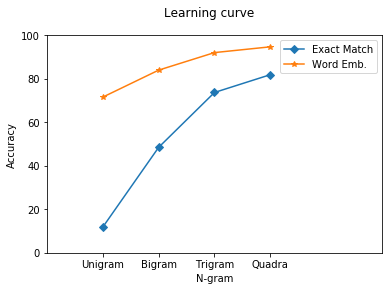

In [ ]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
l = ["Unigram",  "Bigram", "Trigram","Quadra"]


plt.plot(l,AccList, '-D', label='Exact Match')
plt.plot(l,AccListWE, '-*', label='Word Emb.')

plt.suptitle('Learning curve')
plt.xlabel('N-gram')
plt.ylabel('Accuracy')
plt.legend();
axes = plt.gca()
axes.set_xlim([-1,5])
axes.set_ylim([0,100])
